<h1><center><b>Project 3: Multilingual Semantic Role Labeling</b></center></h1>

---



---



# Introduction

In this project we explore the concept of “semantic role labeling” (who did what to whom) for sentences in French. English semantic role labeling has been heavily studied for decades. However, porting semantic role labeling to non-English languages requires training on the non-English language to create a new model for that language.
* A good read for this project could be **Chapter 21 : Semantic Role Labeling and Argument Sructure** and **Chapter 11.1 & 2 : Masked Language Models of Jurafsky & Martin's Speech and Language Processing book (SLP)**

* A good read for XSRL could be **Daza, A., and Frank, A. (2020). X-SRL: A Parallel Cross-Lingual Semantic Role Labeling Dataset. https://doi.org/10.48550/arXiv.2010.01998**

* A good read for BERT could be **Devlin et al. (2019).BERT: Pre-training of Deep Bidirectional Transformers for Language Understanding.
https://doi.org/10.48550/arXiv.1810.04805**

* A good read for AllenNLP is **Shi, P., and Lin, J. (2010). Simple BERT Models for Relation Extraction and Semantic Role Labeling.
https://doi.org/10.48550/arXiv.1904.05255**


*   Part 0 sets up the environment through installation of the required dependencies and requires a kernel restart once the installation finishes.
*   Part 1 explains semantic role labeling and Allennlp Model
*   Part 2 explores XSRL
*   Part 3 explores BERT
*   Part 4 converts data
*   Part 5 projects English SRL labels to French SRL labels
*   Part 6 trains AllenNLP with projected French dataset
*   Part 7 visualizes French SRL
*   Part 8 evaluates French SRL

For each of these parts, there are questions to be answered in order to receive full credit for the assignment.

In this project, we will explore the application of semantic role labeling in English and projection of English semantic roles to French for training a semantic role labeler in French. Texts below are examples from the Twitter dataset we will use in this project.



> "@DonozoKortess2 @MLP_officiel plus le coup d'etat, (plutot les coups d'etats) , les restrictions des libertés individuelles et collectives",
 "@Greguyyyy @HalbeardD @Tlibdij @JLMelenchon @BurgerKingFR Honnêtement le capitalisme a été génial sur cette période…"

 **Review Materials for Project 3: Weeks 10-13**
* Videos/handouts
* FTF slides
* Readings per the syllabus: SLP 11, 13, 21 and additional notes.

### File load instruction for **Google colab** user
*Project03.zip* has been provided to you through Canvas. You **Must** unzip this folder in **your local drive** and upload this under **MyDrive on your Google Drive**, so that you can mount the folder to this notebook. If you follow these steps, the pathnames used in this project will work. See example file structure below,

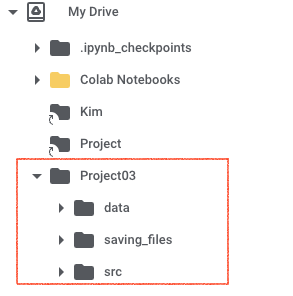

### File load instruction for **Hipergator** user
*Project03.zip* has been provided to you through Canvas. You **Must** unzip this folder in **your local drive** and upload this under **Drive on your Hipergator using Globus, [link to Globus](https://www.globus.org/))**, so that you can mount the folder to this notebook. Brief instruction video for Globus is [here](https://drive.google.com/file/d/1hVmY9URDktKHRSbdWH73MRQShD2Zhq9I/view?usp=sharing). If you follow these steps, the pathnames used in this project will work. See example file structure below,

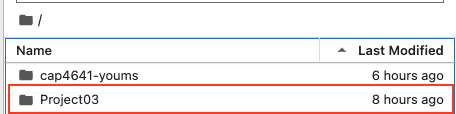


Upon adding shortcut of Project03 to your MyDrive , you will see three directories
>src : Source files

>data : Given data needed to run codes

>saving_file : Location where the files to be saved *This folder is empty initially.*

The list below is a list of files you are given, followed by a list of files that you will create by the end of this project.

Given data *(Directory : data)*
- 	00_french_election_french_spacy_sentences.txt
- 	01_french_election_english_spacy_sentences.txt
- 	02_French_CoNLL.Conll
- 	03_English_CoNLL.Conll
- 	04_error_sentences.txt
- 	05_english_extended_CoNLL.conll
- 	06_irr_index.pkl
- 	07_test_set.pkl
-   08_SRL_train.jsonnet
-   09_french_objects_100.pkl
-   10_english_objects_100.pkl
-   train/French_SRL_allennlp_train.gold_conll
-   valid/French_SRL_allennlp_valid.gold_conll
-   test/French_SRL_allennlp_test.gold_conll
-   en_obj_test.pkl
-   fr_obj_test.pkl
-   align_result.pkl

Files to be created *(saved in saving_file)*
-   clean_English_extended_CoNLL.conll
-   clean_French_CoNLL.conll
-   clean_French_CoNLL.conll.S2T.populated
-   french_allennlp_extended_CoNLL.conll
-   fr_obj.pkl
-   en_obj.pkl
-   srl_align_result.html


**Important notes on grading**:

1. **Programming questions**(in Gradescope) - Some of the functions are incomplete; compelete them and pass the test cases below. Passing the test case does not gurantee a full grade. Update your answer in the .pyfile provided to you and upload it to Gradescope for grading.

2. **Quiz questions**(in Canvas) - This project is accompanied by a project quiz. For each project quiz question, select one or more correct options and explain the response in 200 characters or less. Any quiz response that does not include an explanation will not be graded. Explanations must be no longer than 200 characters; any additional words will result in automatic truncation and will not be considered for grading.

## Part 0 : Setting up the environment

### 0.1 Running cells

You can run the code in a cell by pressing(CMD/CTRL + ENTER) or by clicking the run button in the top left corner.
Cells are divided into two categories:

1. Markdown - This is a Markdown cell, which is used to provide instructions, similar to a running readme of your code.
2. Code cell - The Code cell contains all the code.

**Important Points**:
**Jupyter Notebook cells are executed in order - from top to bottom. Any other order is not guranteed to produce expected results.
You must run all the cells in this notebook. (Even if you are not editing them)**



### 0.2 Install dependencies

[**AllenNLP**](https://guide.allennlp.org/overview#1) is a NLP research library built on PyTorch that provides state-of-the-art deep learning models on various NLP tasks.  [**Pyconll**](https://pyconll.readthedocs.io/en/stable/) helps you to manage CoNLL files with the syntax of python and has been installed for reading CoNLL-u files, but it is recommended that you also examine the [X-SRL code](https://github.com/Heidelberg-NLP/xsrl_mbert_aligner/blob/main/project_srl_annotations.py) to see how SRL annotations are added to the CoNLL files. Some of the code below might be useful when you are trying to build the english SRL-annotated CoNLL file that will be projected onto the french conll file. **NLTK "omw"** stands for Open Multilingual Wordnet, enabling the use of wordnets in multiple languages.

**You only need to run code in this file**

**Run the code cell below to install required dependencies.**

> After installation, you may need to restart the kernel. This can be done by selecting `Restart runtime` in the `Runtime` drop-down menu. But here for your convenience, the following code cell is automatically prompted to restart the kernel after installation is finished.

When you initiate the project, colab may ask you to connect without GPU. You can click the button for connect without GPU since you are not required to use GPU here.

In [31]:
#@ title Run this cell to install required dependencies (Please **comment out line 6-15 if you use hipergator**)
#Note : We use allennlp and allennlp-models 2.10.0
#Note : bert_score, nltk, cached-path are required library
#to operate X-SRL and X-SRL is only compatible with cached-path 1.1.2

# !pip install allennlp
# !pip install allennlp-models
# !pip install spacy
# !pip install bert_score
# !pip install --upgrade huggingface-hub==0.24.0
# !pip install -U nltk
# !python -m spacy download en_core_web_sm
# !python -m spacy download en_core_web_md
# !python -m spacy download fr_core_news_sm
# !python -m spacy download fr_core_news_md

import os
import re
import nltk
import math
import copy
import random
import pickle
import pandas as pd
import numpy as np
from allennlp.predictors.predictor import Predictor
from transformers import BertTokenizer, BertForMaskedLM, logging
import torch
from tqdm import tqdm
from IPython.display import display, HTML

logging.set_verbosity_error()
nltk.download('omw-1.4')

[nltk_data] Downloading package omw-1.4 to
[nltk_data]     /home/carson.johnson/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


True

### 0.3 Connect to your project folder
When you run the cell below, you will be asked to authorize access to your google drive.

You should say **YES** to that operation. (In practice, this may be 2 or 3 steps, as it may ask you to verify your ufl.edu account.)

In [32]:
#@title Only for Google Colab User: Run this cell to set up your file path (Do not run this code if you use Hipergator)
#Run this cell to mount the required content to your drive (Do not edit code.) - Google Colab

# from google.colab import drive
# drive.mount('/content/drive')

# path = '/content/drive/MyDrive/Project03'

In [33]:
#@title Only for Hipergator user: Run this cell to set up your file path (Do not run this code if you use Google Colab)

#enter your hipergator user name here
hipergator_user_name = 'carson.johnson'
path ='/home/'+hipergator_user_name+'/Project03'

After running the code cell below, you are expected to see this result:

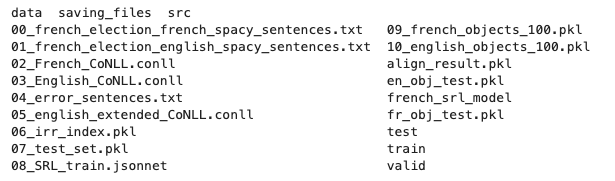

In [34]:
#@title Run this cell to check the required folders successfully connected to your drive (Do not edit this code)

%cd -q $path
!ls

dir1 = path+'/data'
%cd -q $dir1
!ls

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
data  saving_files  src
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
00_french_election_french_spacy_sentences.txt	09_french_objects_100.pkl
01_french_election_english_spacy_sentences.txt	10_english_objects_100.pkl
02_French_CoNLL.conll				align_result.pkl
03_English_CoNLL.conll				en_obj_test.pkl
04_error_sentences.txt				french_srl_model
05_english_extended_CoNLL.conll			fr_obj_test.pkl
06_ir

After running the code cell below, you are expected to see the given result.

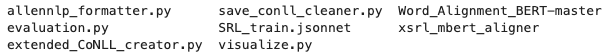

In [35]:
#@title Run this cell to load the required function to operate codes (Do not edit code.)
dir2 = path+'/src'

%cd -q $dir2
!ls

from visualize import view
from evaluation import measure, confu_matrix
from save_conll_cleaner import save_conll_cleaner, remove_problem_set, get_agg_string, remove_from_text

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
allennlp_formatter.py	   __pycache__		  visualize.py
evaluation.py		   save_conll_cleaner.py  Word_Alignment_BERT-master
extended_CoNLL_creator.py  SRL_train.jsonnet	  xsrl_mbert_aligner


## Part 1 : Exploring Semantic Role Labeling and Allennlp Model

### 1.1 What is semantic role labeling?

This is a task that assigns semantic roles to "chunks" (or "spans of words") in sentences. Assignment of semantic roles brings together linguistic representations (semantic roles) with machine learning to yield a representation that tells us "who did what to whom".

* A good read for semantic role labeling could be **Chapter 21 : Semantic Role Labeling and Argument Structure of Jurafsky & Martin's Speech and Language Processing book (SLP)**

A demonstration of semantic role labeling here.
For example, if one types the sentence *John gave Mary a present* into the model, the output looks like this :


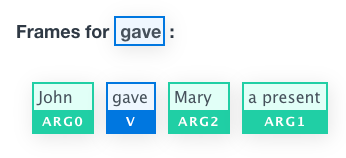

In general :

*   ARG0 is **the agent of the action**
*   ARG1 is **the object that is moved or in some way affected**
*   ARG2 is **generally the beneficiary, instrument, or end state of the action**

However, what happens when one runs the sentence *John gave a present to Mary*. Note that the role assignment is the same for either construction. That is, semantic roles are intended to get at the same underlying "meaning" of the sentence, regardless of the way in which that meaning is conveyed. For more information about these semantic roles (and many others), check out the ProbBank annotation guidelines: [Guideline](https://verbs.colorado.edu/~mpalmer/projects/ace/PBguidelines.pdf)

For this project, our central question shifts to this: What happens when we want to run semantic role labeling on a non-English language, but all we have is semantic role labeling for English? Consider this example (the French translation of *John gave Mary a present*):
                   
>  *Jean a offert un cadeau à Marie*

One would hope that Jean(=John) would be ARG0, cadeau(=gift) would be ARG1, and Marie(=Mary) would be ARG2, just as in the English equivalent. But how can we bring about this equivalence? Let's explore this question to see how far we can get, and to examine the challenges that arise along the way.

### 1.2 Semantic Role Labeling(SRL) model in Allennlp
> The completion of this section prepares you to answer question 1 and 2 on **Project 3 Quiz questions**.

AllenNLP provides an English SRL model.

```
Model Name : SRL BERT
Version : 1
Training dataset size : 1.4 million words
Archive File : https://storage.googleapis.com/allennlp-public-models/structured-prediction-srl-bert.2020.12.15.tar.gz
```

This model predict semantic role labels with corresponding predicates(verb) in the tokens. Allennlp built SRL model based on a BERT(Bidirectional Encoder Representations from Transformers), which is the state of the art model for English PropBank SRL. Additional information about BERT is provided in part 3.

* A good read for SRL-BERT could be **Shi, P., and Lin, J. (2010). Simple BERT Models for Relation Extraction and Semantic Role Labeling.
https://doi.org/10.48550/arXiv.1904.05255**


### **Programming Question #1** (4 points)
#### **Complete the code below to define the function that predicts sematic roles for example sentencse using AllenNLP model**

In this question, you are required to use the Predictor from AllenNLP. You can find the function information, here [allen-srl](https://docs.allennlp.org/models/main/models/structured_prediction/predictors/srl/). These documents will help you complete function below.

<mark>After you have completed the function and executed the tests, make sure to transfer your answer to the .py file provided along with this Notebook.</mark>

In [6]:
#@title Run this cell to install and load AllenNLP English SRL Model.(Do not edit code)
en_srl_predictor = Predictor.from_path("https://storage.googleapis.com/allennlp-public-models/structured-prediction-srl-bert.2020.12.15.tar.gz",
                                       predictor_name = "semantic_role_labeling")

active = "Jendi sent Andrew a present"
passive = "A present was sent to Andrew by Jendi"

**Expected Output**


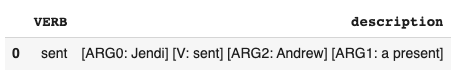


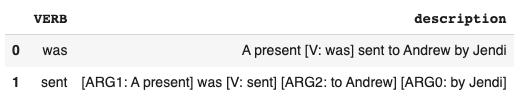



Note that in the sentence above, the bracketed "head" of the semantic role frame is marked [V:...], and it is this head that takes the other three arguments.


If interested in the use of the `.predict` function, more details can be found at [Predictor](https://docs.allennlp.org/v0.9.0/api/allennlp.predictors.html#allennlp.predictors.predictor.Predictor).

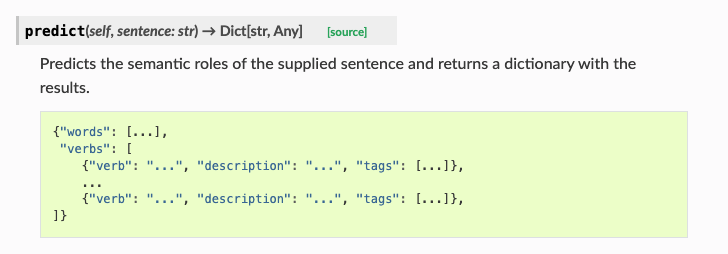

In [7]:
#@title Programming Question 1:  Complete code here to predict semantic roles for active and passive sentences
#You will define srl_prediction below to return a data frame using Pandas DataFrame

def srl_prediction(model,sent) :

    """
    :param model : en_srl_predictor
    :param sent : string
    :return df : dataframe
    """

    '''
    Programming Instrution :

    1. Use model.predict to predict json format SRL prediction
    2. Return data frame using Pandas DataFrame
    '''

    #Write your code here (4-5 lines)
    result = model.predict(sent)
    verbs = result.get('verbs', [])
    data = []
    for verb in verbs:
        data.append({
            'verb': verb['verb'],
            'description': verb['description']
        })
    df = pd.DataFrame(data)
    #Your code ends here

    return df


In [8]:
#@title Run this cell to test your code using active and passive sentences defined earlier. (Do not edit code.)
active_df = srl_prediction(en_srl_predictor,active)
passive_df = srl_prediction(en_srl_predictor,passive)

display(HTML(active_df.to_html()))
display(HTML(passive_df.to_html()))

,verb,description
0,sent,[ARG0: Jendi] [V: sent] [ARG2: Andrew] [ARG1: a present]


,verb,description
0,was,A present [V: was] sent to Andrew by Jendi
1,sent,[ARG1: A present] was [V: sent] [ARG2: to Andrew] [ARG0: by Jendi]


In [9]:
#@title Project 3 Quiz Question 3: Use this cell to solve question 3.

sentences = ["I think she is going to the exhibition on Sunday.", "Mary left her daughter-in-law her pearls in her will."]

for sentence in sentences:
    test_sent_df = srl_prediction(en_srl_predictor,sentence)
    display(HTML(test_sent_df.to_html()))

,verb,description
0,think,[ARG0: I] [V: think] [ARG1: she is going to the exhibition on Sunday] .
1,is,I think she [V: is] going to the exhibition on Sunday .
2,going,I think [ARG0: she] is [V: going] [ARG4: to the exhibition] [ARGM-TMP: on Sunday] .


,verb,description
0,left,[ARG0: Mary] [V: left] [ARG2: her daughter - in - law] [ARG1: her pearls] [ARGM-LOC: in her will] .


In [10]:
#@title Project 3 Quiz Question 5: Run this code for question 5. (Do not edit this code.)
#You use function eng_srl_prediction here again.

example_2 = "I'm not sure whether he will come to the party tomorrow"
example_df = srl_prediction(en_srl_predictor, example_2)

display(HTML(example_df.to_html()))

,verb,description
0,'m,[ARG1: I] [V: 'm] [ARGM-NEG: not] [ARG2: sure whether he will come to the party tomorrow]
1,will,I 'm not sure whether he [V: will] come to the party tomorrow
2,come,I 'm not sure whether [ARG1: he] [ARGM-MOD: will] [V: come] [ARG4: to the party] [ARGM-TMP: tomorrow]


The result of executing the code above includes ARGMs (e.g., ARGM-NEG, AGRM- TMP). Further exploration of modifier annotations (ARGM) can be done by following this link [ARGMS](https://verbs.colorado.edu/~mpalmer/projects/ace/PBguidelines.pdf) (see page 24) to help you to solve Question #2 below.

> The completion of this section prepares you to answer questions 1, 3 and 5 on **Project 3 Quiz questions**.

### 1.3 Building AllenNLP model

To learn more about building models more generally for NLP tools and, most notably, building your own model, navigate to this link for Part 1 of the AllenNLP [Guide](https://guide.allennlp.org/overview).

AllenNLP's guide Part 1, describes the basics for machine learning models for a range of different NLP tasks. The guide presents a methodology for efficiently building models for many AllenNLP tools, with the exception of semantic role labeling. In order to train a semantic role labeling model, additional information is provided in the task below.

## Part 2: Understanding XSRL

### 2.1 What is XSRL?

In order to build training data for an AllenNLP French SRL model, we must first apply SRL to English sentences, after which we will project English SRL labels to French. We make use of another github repository ([X-SRL](https://github.com/Heidelberg-NLP/xsrl_mbert_aligner)) for this projection task. Then, using the SRL-labeled French sentences we train the AllenNLP French SRL model. Both the French sentences (tweets split using spacy's sentence splitter) and the English translated sentences are provided in the data folder for the project. Each file (french_election_french_spacy_sentences.txt and french_election_english_spacy_sentences.txt) has one sentence per line as split by spaCy as indicated in the name of the file.

* A good read for X-SRL could be **Daza, A., and Frank, A. (2020). X-SRL: A Parallel Cross-Lingual Semantic Role Labeling Dataset. https://doi.org/10.48550/arXiv.2010.01998**

### 2.2 How it works

X-SRL applies multilingual BERT(mBERT) to project high quality annotations to the target languages(DE, ES, FR). mBERT is a pretrained model on the top 104 languages with the largest Wikipdedia.

* A good read for mBERT could be **Pires et al. (2019). How multilingual is Multilingual BERT?.** https://doi.org/10.48550/arXiv.1906.01502


The X-SRL model translates the English CoNLL-09 SRL dataset into target languages. The X-SRL data set focuses only on verbal predicates.

The X-SRL model use an mBERT embedding space to compute pair-wise cosine similarity between source and target tokens(Source : English, Target : French in this project) and the resulting word-alignment is used for projection.

The figure below is an example for Spanish from the above cited paper, where you can read more about X-SRL. Note that the source and target sentences both have a head verb (which means "sound.01") and two arguments abbreviated "A1" (for ARG1) and "A2" (for ARG2), mediated by word alignments from English to Spanish.

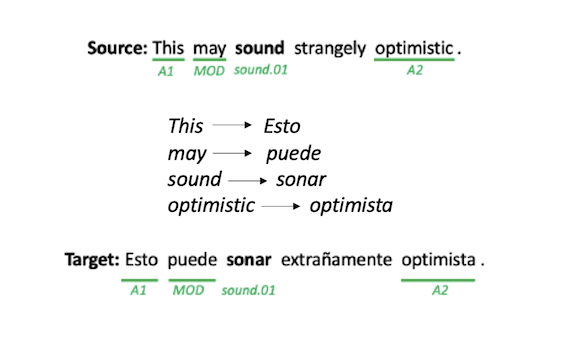

You can find detailed information about X-SRL in the following link, [X-SRL](https://aclanthology.org/2020.emnlp-main.321.pdf)

## Part 3 : Understanding BERT

The Allennlp SRL model that uses BERT is called SRL-BERT. X-SRL also incorporates mBERT to find accurate word-level alignments across languages.
In this part, you will explore the concept of BERT with several tasks.

### 3.1 What is BERT?

Bidirectional encoders incorporate a self-attention mechanism, which ranges over all words in the text simultaneously. In other words, the bidirectional encoder generates output vectors that have been contextualized, thus serving as a significant advance over word2vec. The original BERT model(bert-base-uncased) is pretrained with a vocabulary of 30,000 tokens. The model consists of hidden layers of the size of 768 and 12 layers of transformer blocks, with 12 multihead attention layers each. BERT allows us to do fine-tuning with pretrained models. This pretrain-finetune mechanism is an example of transfer learning in machine learning. This paradigm enables the model to efficiently acquire the requirements of a downstream language task such as semantic role labeling, named entity tagging, or question answering.

* A good read for BERT could be **Devlin et al. (2019).BERT: Pre-training of Deep Bidirectional Transformers for Language Understanding.
https://doi.org/10.48550/arXiv.1810.04805**

* Another good read for BERT could be **Chapter 11.1 & 2 : Masked Language Models of Jurafsky & Martin's Speech and Language Processing book (SLP)**

Two types of objective functions(Next Sentence Prediction, Masked Language Models) are used in BERT training. Additional information is provided in the following sections. For SRL-BERT, the predicate identification and classification model needs to be trained to identify and label, e.g., "send" as the predicate in "send a present".

Objective functions used for pre-training are:

- Next Sentence Prediction (NSP) - to be discussed in 3.1.1
- Predicate identification and classification Model(*Only used for SRL-BERT(Allennlp SRL model)*) - to be discussed in 3.1.2
- Masked Language Models (MLM)  - to be discussed in 3.1.3

**Through the use of MLM and NSP, the model is able to learn a representation of the languages in the training set, which can be used to extract features that are useful for downstream tasks, assuming a dataset of labeled sentences is available. Thus, we use BERT for training Semantic Role labels. Allennlp SRL model(SRL-BERT) concatenates one more representational layer as a result of predicate identification and classification.**

#### 3.1.1 Next Sentence Prediction (NSP)

An important NLP task of pre-training BERT involves determining the relationship between sentence pairs. BERT introduces "next sentence prediction" (NSP) to capture this. The model is given sentence pairs and is asked to predict if the pair represents actual adjacent sentences from the training corpus or if the pair represents unrelated sentences. In BERT experiments, when selecting training pairs (two sentences A and B), 50% of the training pairs (A and B) consist of actual sentences pairs (B follows A), and in the other 50% of pairs, sentence B is randomly selected from the corpus, and A and B are not actual pairs. NSP introduced new tokens called [CLS](Special classification token) and [SEP](Special seperation token). [CLS] is prepended to the input sentence pair, and [SEP] is usally located between the sentences--after the final token of the first sentence.

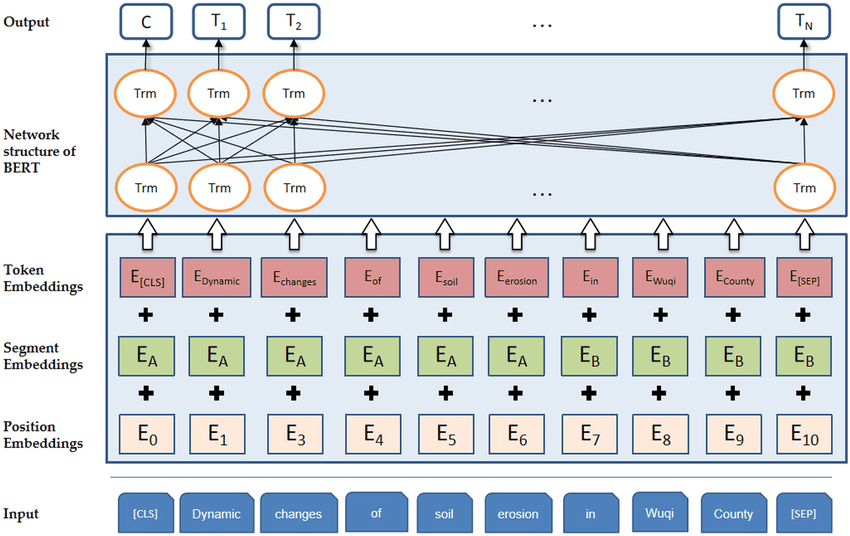

#### **Programming Question #2:** (4 points)
#### **Complete the code below to define the function for the Bert Tokenizer.** Follow this link to help you complete code below [Transformers/BertTokenizer](https://huggingface.co/docs/transformers/main_classes/tokenizer#transformers.PreTrainedTokenizer.convert_ids_to_tokens). This function will be used in 3.1.2 below.

<mark>After you have completed the function and executed the tests, make sure to transfer your answer to the .py file provided along with this Notebook.</mark>

We use "from_bert-base-uncased" as a pre-trained model for tokenizer, and
you can obtain tokens and special tokens.

*Data Sources*

>BooksCorpus : 800M words

> English Wikipedia : 2500M words



**Test Sentence**

> Rob went to Rome

**Expected output**
```
['[CLS]', 'rob', 'went', 'to', 'rome', '[SEP]']
```


In [11]:
#@title Programming Question 2 : Complete code here to generate BertTokenizer
from transformers import BertTokenizer

def get_bert_tokens(sent) :

    """
    :param sent : string
    """

    '''
    Programming instruction :
        1 Build BertTokenizer using from_pretrained model : "bert-base-uncased"
        2.tokenize sent (input) using tokenizer
        3.tokenized sent (from step 2) has attribute "input_ids"
        3.convert new input_ids (from step 3) to token (use convert_ids_to_tokens)
        4.return list of tokens
    '''
    #Write your code here (3-4 lines)
    tokenizer = BertTokenizer.from_pretrained("bert-base-uncased")
    encoded_sent = tokenizer.encode(sent)
    token_list = tokenizer.convert_ids_to_tokens(encoded_sent)

    #End your code here
    return token_list

#### 3.1.2 Predicate identification and classification model

> The completion of this section prepares you to answer question 5 and 6 on **Project 3 Quiz questions**.

SRL-BERT uses a pre-trained NSP model and predicate indentification and classification model. To train predicate identification and classification model, [SEP] is used for representing predicates as well as separating sentences. Thus, the existing BERT contextual embedding is concatenated to the predicate embeddings. You can find additional details about this in follow link [SRL-BERT](https://www.semanticscholar.org/paper/Simple-BERT-Models-for-Relation-Extraction-and-Role-Shi-Lin/fddbcabe0fc9be0684855ae3dd059fb525a69e5b).



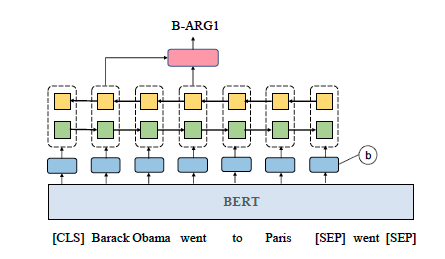

In SRL-BERT, (b) denotes the concatenation of BERT contextual embedding and predicate embedding.

In [12]:
#@title Run this cell to see the testing for provided sentence below, and this should be match with expected output. (Do not edit code.)
test_sentence = "Rob went to Rome"
print(get_bert_tokens(test_sentence))

['[CLS]', 'rob', 'went', 'to', 'rome', '[SEP]']



**Output from BERT**

```
['[CLS]', 'rob', 'went', 'to', 'rome', '[SEP]']
```

**Consider an alternative output from SRL-BERT, which concatenates each predicate to the end, as shown in the figure above:**


```
['[CLS]', 'rob', 'went', 'to', 'rome', '[SEP]', went,'[SEP]']
```


#### 3.1.3 Masking Words

Masked Language Modeling(MLM) is the model used for pre-training BERT. MLM was the original approach to train bidirectional encoders.
In BERT, 15% of the input tokens in a training sequence are sampled for learning, 80% of them are replaced with [MASK], 10% of them are randomly chosen tokens, and the remaining 10% of them are unchanged. Through the MLM training, the bidirectional model can predict the original tokens for each masked token. With the simple BERT tutorial below, you can explore how masking words are trained in BERT using transformers.

*Example*

80% of the time : Replace the token with the [MASK],

```
the girl goes to the gym  -> the girl goes to the [MASK]
```

10% of the item : Replace the token with randomly chosen token,

```
the girl goes to the gym -> the girl goes to the cereal
```

10% of the time : Keep the token unchanged,


```
the girl goes to the gym -> the girl goes to the gym
```





### **Programming Question #3:** (3 points)
#### **Complete the code below to define the function for predicting Masked token**
<mark>After you have completed the function and executed the tests, make sure to transfer your answer to the .py file provided along with this Notebook.</mark>

Pre-trained model "bert-base-uncased" is trained using NSP and MLM. Since this model is trained from large datasets (BookCorpus, 800M words, English Wikipedia : 2,500words), it's possible to find answers for general questions like those below, because the model is pre-trained using MLM.

> Question : The capital of France is [MASK]

> Answer : The capital of France is paris

**Expected output for a question below:**



```
The capital of Italy is rome
```



To complete the code here, you need to see some functions of BertTokenizer(brief specified below). More details are found in the following link [decode/encode](https://huggingface.co/docs/transformers/main_classes/tokenizer#transformers.PreTrainedTokenizer.decode), [torch.Tensor](https://pytorch.org/docs/stable/torch.html)

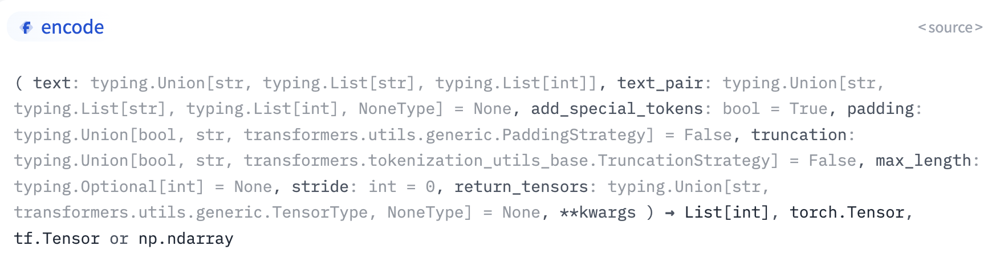

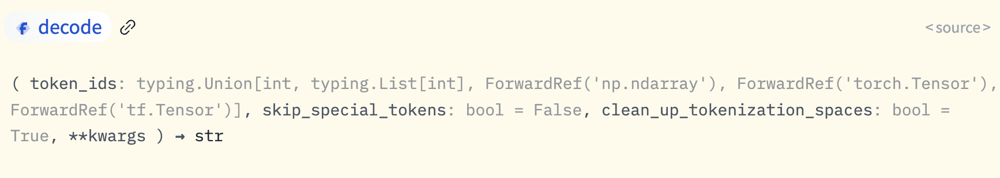

**If you cannot see line numbers in code cell, trun on "show line numbers"  *Tools > Setting > Editor***

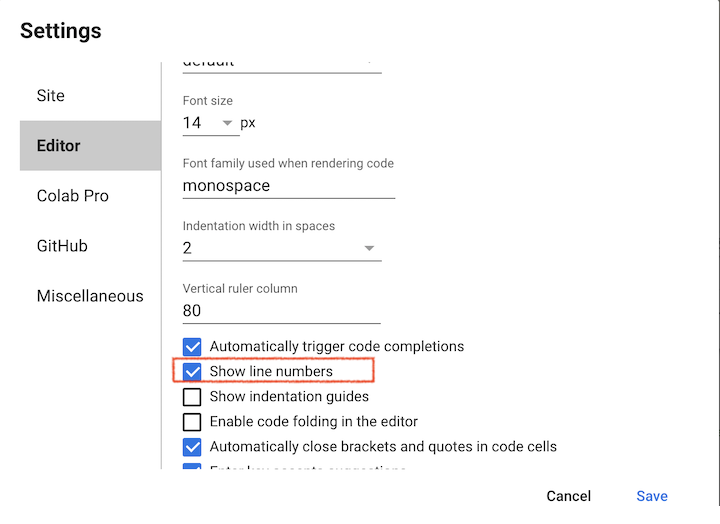

In [13]:
#@title Run this code to load BertTokenizer and MaskedLM (Do not edit this code)
tokenizer = BertTokenizer.from_pretrained("bert-base-uncased")
model = BertForMaskedLM.from_pretrained("bert-base-uncased")

In [14]:
#@title Programming Question 3 : Complete this cell to predict Mask in the sentence.
def masked_learning(tokenizer,model, country) :

    """
    :param country : string
    :param tokenizer : BertTokenizer
    :param model : BertForMaskedLM

    """

    '''
    Programming Instruction :
    You need to complete three parts : #complete_here[1](line 22), #complete_here[2](line 26), and #complete_here[3](line 29)
    '''

    question =  "The  capital of "+country+" is [MASK]."

    inputs = tokenizer(question, return_tensors = "pt" )

    with torch.no_grad():
        # complete code that return logit(non-normalized probabilites) of model's output
        logits = model(**inputs).logits

    index_for_masked_token = (inputs.input_ids == tokenizer.mask_token_id)[0].nonzero(as_tuple = True)[0]
    # complete code that return maximum values of a tensor
    id_for_predicted_token = logits[0,index_for_masked_token].argmax(dim=1)

    # complete function name to decode tensor(id_for_prediction_token) to string
    city = tokenizer.decode(id_for_predicted_token)

    return "The capital of {} is {}".format(country, city)


In [15]:
#@title Run this cell to get an answer and use this function for Project 3 quiz question 9
#you need to change country name to solve Question#4
country = "Italy"
#do not change this line
masked_learning(tokenizer,model,country)

'The capital of Italy is rome'

> The completion of this section prepares you to answer question 7 and 8 on **Project 3 Quiz questions**.

# Part 4 : Converting Data format

Recall that we project English SRL labels to French using a github repository (X-SRL), and then we train the AllenNLP French SRL model using the French labeled data. **To train data using Allennlp trainer, we need to change the format of data, and it requires several steps to transform to Allennlp training format**

> *text -> CoNLL -> Extended CoNLL(CoNLL with SRL tags) -> AllenNLP training format*



### 4.1 Text to CoNLL format

**First**, the English sentences must be put into the appropriate CoNLL format that X-SRL requires ([CoNLL-U](https://universaldependencies.org/format.html)). Luckily the X-SRL repository provides a script that can preprocess a text file of sentences and turn them into the appropriate CoNLL format.

```
%cd /content/drive/MyDrive/Project03/src
!python pre_process/text_to_CoNLL.py \
    --src_file "/content/drive/MyDrive/Project03/data/00_french_election_french_spacy_sentences.txt" \
    --out_file "/content/drive/MyDrive/Project03/saving_files/02_French_CoNLL.conll" \
    --lang FR \
    --add_syntax True
```

**Second**, the above script must also be run on the French sentence file as they both need to be in CoNLL format.

English, French CoNLL file are already given in data folder

- 02_French_CoNLL.conll
- 03_English_CoNLL.conll


### 4.2  CoNLL into Extended CoNLL(including SRL tags)
> The completion of this section prepares you to answer question 9 and 10 on **Project 3 Quiz questions**.

Note that the English CoNLL file created by the preprocessing script does not include any SRL labels. The next step is thus to augment the CoNLL file with SRL labels. In order to do this, the English sentences must be run through AllenNLP's SRL predictor. The output of the predictor must then be applied to the corresponding sentence in the CoNLL file. The final result will appear as shown below.

```
1	A	a	DET	DT	_	2	det	_	_	_	B-ARG0
2	journalist	journalist	NOUN	NN	_	6	nsubj	_	_	_	I-ARG0
3	like	like	SCONJ	IN	_	2	prep	_	_	_	I-ARG0
4	Moix	Moix	PROPN	NNP	_	3	pobj	_	_	_	I-ARG0
5	can	can	VERB	MD	_	6	aux	Y	_	B-V	B-ARGM-MOD
6	insult	insult	VERB	VB	_	6	ROOT	Y	_	_	B-V
7	the	the	DET	DT	_	9	det	_	_	_	B-ARG1
8	Pen	Pen	PROPN	NNP	_	9	compound	_	_	_	I-ARG1
9	marine	marine	NOUN	NN	_	6	dobj	_	_	_	I-ARG1
10	,	,	PUNCT	,	_	9	punct	_	_	_	I-ARG1
11	a	a	DET	DT	_	13	det	_	_	_	I-ARG1
12	presidential	presidential	ADJ	JJ	_	13	amod	_	_	_	I-ARG1
13	candidate	candidate	NOUN	NN	_	9	appos	_	_	_	I-ARG1
14	like	like	SCONJ	IN	_	13	prep	_	_	_	I-ARG1
15	the	the	DET	DT	_	16	det	_	_	_	I-ARG1
16	others	other	NOUN	NNS	_	14	pobj	_	_	_	I-ARG1
17	?	?	PUNCT	.	_	6	punct	_	_	_	_
```

In this example file each column **after the 11th column has SRL labels in it; each SRL label is tied to a verb in the sentence**. Even though the column itself does not specifically identify the token that is the verb corresponding to the SRL labels, the columns are associated with the verb in the order that each verb is encountered in the sentence. Luckily this is the same way AllenNLP's output is ordered. Additionally, we need to add one more column that represents the existence of "predicates" to use XSRL model.

To project English SRL into French data, we must fit data to mBERT-XSRL required format, in which there is a new column that indicates the existence of predicates using "Y"(Y means the token is a "predicate"). You can find annotation information through PropBank Guidelines.[Here](https://verbs.colorado.edu/~mpalmer/projects/ace/PBguidelines.pdf)

Three files (english_extended_CoNLL.conll, error_sentences.txt, irr_index.pkl) are provided in a data folder. Some examples from 04_error_sentences and  05_english_extended_CoNLL.conll are used to answer question 5 below.


There are some irrelevant sentences that cause an error. We already saved the index of irrelevant sentences. You are going to remove irrelevant sentences from the 02_French_CoNLL.conll and 05_english_extend_Conll.conll. After removing irrelevant data, **25549 sentences (708135 words)** are remained, and they are used for train/validation/test.

In [16]:
#@title Run this cell to generate projected French Extended CoNLL file.

%cd -q $dir1
saving_path = path+'/saving_files'

if __name__ == '__main__' :

    eng = "05_english_extended_CoNLL.conll"
    fra = "02_French_CoNLL.conll"
    clean_english_extend_conll = saving_path+"/clean_English_extended_CoNLL.conll"
    clean_french_conll = saving_path+"/clean_French_CoNLL.conll"

    irr_index = "06_irr_index.pkl"
    with open(irr_index, "rb") as f :
      irr_index = pickle.load(f)

    #Remove irrelevant sentences from English and French conll file
    eng_extend_list, fra_conll_list = remove_problem_set(eng, fra, irr_index)

    save_conll_cleaner(clean_english_extend_conll,
            eng_extend_list,
            clean_french_conll,
            fra_conll_list)

#### Read this section to answer Project 3 quiz question 11

Extended CoNLL columns guideline

1. ID: Word index, integer starting at 1 for each new sentence; may be a range for multiword tokens; may be a decimal number for empty nodes (decimal numbers can be lower than 1 but must be greater than 0).

2. FORM: Word form or punctuation symbol.

3. LEMMA: Lemma or stem of word form.

4. UPOS: Universal part-of-speech tag.

5. XPOS: Language-specific part-of-speech tag; underscore if not available.

6. FEATS: List of morphological features from the universal feature inventory or from a defined language-specific extension; underscore if not available.

7. HEAD: Head of the current word, which is either a value of ID or zero (0).

8. DEPREL: Universal dependency relation to the HEAD (root iff HEAD = 0) or a defined language-specific subtype of one.

9. PREDICATE : If a word is predicte, "Y", or "N".

10. MISC : Any other annotation if a word has one.

11. SEMANTIC ROLE : From this column, Semantic Role labels are assigned here. Columns 11, 12, etc. are each associated with a corresponding predicate. For example, ARG2 in column X, is associated with the (X-10)th predicate in the sentence. i.e. The SRL in 11th column is associated with the 1st predicate.

There are two English CoNLL examples and two Error examples : 1 and 2 from 05_english_extened_CoNLL.conll(English sentence with SRL tags), 3 and 4 from 04_error_sentences.txt
In this question you will figure out Extended CoNLL file configuration and examine error SRL labeling.


Example 1 : Extended English CoNLL

```
1	Benoît	  Benoît	   PROPN	  NNP   _	2	compound	_	_	_
2	Hamon	   Hamon	    PROPN	  NNP   _	3	nsubj	   _	_	B-ARG1
3	is	      be	       AUX	    VBZ   _	3	ROOT	    Y	_	B-V
4	a	       a	        DET	    DT	_	6	det	     _	_	B-ARG2
5	beautiful   beautiful	ADJ	    JJ	_	6	amod	    _	_	I-ARG2
6	man	     man	      NOUN	   NN	_	3	attr	    _	_	I-ARG2
7	.	       .	        PUNCT	  .	 _	3	punct	   _	_	_
```
Example 2 : Extended English CoNLL



```
1	They	they	PRON	PRP   _	2	nsubj	_	_	B-ARG0	B-ARG0
2	want	want	VERB	VBP   _	2	ROOT	 Y	_	B-V	   _
3	to	  to	  PART	TO	_	4	aux	  _	_	B-ARG1	_
4	leave   leave   VERB	VB	_	2	xcomp	Y	_	I-ARG1	B-V
5	the	 the	 DET	 DT	_	6	det	  _	_	I-ARG1	B-ARG1
6	country country NOUN	NN	_	4	dobj	 _	_	I-ARG1	I-ARG1

```

Error 1

```
Full Sentence  : A follow of you would make it very happy!
------------------------------------------------------------------------------------------
'verb': 'would',
'description': '[ARG0: A follow of] you would make it very happy !',
```

Error 2

```
Full Sentence  : If international courts condemn him, I do not think he can serenely ...
------------------------------------------------------------------------------------------
'verb': 'serenely',
'description': 'If international courts condemn him , I do not think [ARG0: he] [ARGM-MOD: can] [ARGM-MNR: serenely] ...',
```




# Part 5 : Projecting English SRL labels to French SRL labels

### 5.1  Projection
Once the English sentences are annotated with the SRL labels it is time to project those labels onto their French counterparts, again using the X-SRL tool. To do this, execute the code block below. The src_file will be the english CoNLL file with the SRL annotations that you created in the previous steps and the tgt_file is the CoNLL-formatted corresponding French sentences that do not have SRL annotations. You can experiment with different aligners (align_mode) if you want; you will find more information [here](https://github.com/Heidelberg-NLP/xsrl_mbert_aligner). These two files should be located in the conll_data directory of your own project folder. **Output file has different extension, ".populated" (saving_file/clean_French_CoNLL.conll.S2T.populated)**. The result of this process is an SRL-annotated French file(extended CoNLL file).


**Caveat: The projection (execution of the code block below) may take 30 minutes or so. There will be approximately 25K sentences (enumerated on your screen).**

In [17]:
#@title Run this cell to generate projected French Extended CoNLL file. (Do not edit code)
import logging
logging.basicConfig(format='%(asctime)s %(levelname)s:%(message)s', level=logging.DEBUG, datefmt='%I:%M:%S')
#Note : There are several choices for aligning model (BERT-S2T | BERT-INTER | BERT-T2S | INTERSECT | S2T),
#Here we use S2T.

xsrl_dir = path +"/src/xsrl_mbert_aligner"
%cd -q $xsrl_dir

src_path = saving_path + "/clean_English_extended_CoNLL.conll"
tgt_path = saving_path + "/clean_French_CoNLL.conll"

%run project_srl_annotations.py\
    --src_file $src_path \
    --tgt_file $tgt_path --tgt_lang FR \
    --align_mode S2T

02:22:06 DEBUG:matplotlib data path: /blue/cap4641/share/conda/envs/cap4641/lib/python3.9/site-packages/matplotlib/mpl-data
02:22:06 DEBUG:CONFIGDIR=/home/carson.johnson/.config/matplotlib
02:22:06 DEBUG:interactive is False
02:22:06 DEBUG:platform is linux
02:22:07 DEBUG:CACHEDIR=/home/carson.johnson/.cache/matplotlib
02:22:07 DEBUG:Using fontManager instance from /home/carson.johnson/.cache/matplotlib/fontlist-v390.json
02:22:07 INFO:Start Logging


Read 25549 Sentences!
Read 25549 Sentences!


02:22:20 INFO:---------- 1 --------------
02:23:17 INFO:
----------
_ officiel plus le coup d' etat , plutot les coups d' etats , les restrictions des libertés individuelles et collectives

[]
defaultdict(<class 'list'>, {})

{'0__': ('0__', 0.8306962847709656), '1_officiel': ('1_officiel', 0.776043176651001), '2_plus': ('2_plus', 0.6986884474754333), '3_the': ('3_le', 0.6856661438941956), '4_coup': ('4_coup', 0.6337118744850159), '5_,': ('7_,', 0.6105226874351501), '9_,': ('13_,', 0.7324018478393555), '10_the': ('14_les', 0.6573505997657776), '11_restrictions': ('15_restrictions', 0.8141826391220093), '12_of': ('16_des', 0.6327170133590698), '13_individual': ('18_individuelles', 0.7248885631561279), '14_and': ('19_et', 0.7031921744346619), '15_collective': ('20_collectives', 0.7136145830154419), '16_freedoms': ('17_libertés', 0.7748371958732605)}
02:23:17 INFO:---------- 2 --------------
02:23:17 INFO:
----------
Honnêtement le capitalisme a été génial sur cette période …

['4_été__']

S2T Alignment
{'0__': ('0__', 0.8306962847709656), '1_officiel': ('1_officiel', 0.776043176651001), '2_plus': ('2_plus', 0.6986884474754333), '3_the': ('3_le', 0.6856661438941956), '4_coup': ('4_coup', 0.6337118744850159), '5_,': ('7_,', 0.6105226874351501), '9_,': ('13_,', 0.7324018478393555), '10_the': ('14_les', 0.6573505997657776), '11_restrictions': ('15_restrictions', 0.8141826391220093), '12_of': ('16_des', 0.6327170133590698), '13_individual': ('18_individuelles', 0.7248885631561279), '14_and': ('19_et', 0.7031921744346619), '15_collective': ('20_collectives', 0.7136145830154419), '16_freedoms': ('17_libertés', 0.7748371958732605)}
('0__', ('0__', 0.8306962847709656))
('1_officiel', ('1_officiel', 0.776043176651001))
('2_plus', ('2_plus', 0.6986884474754333))
('3_the', ('3_le', 0.6856661438941956))
('4_coup', ('4_coup', 0.6337118744850159))
('5_,', ('7_,', 0.6105226874351501))
('9_,', ('13_,', 0.7324018478393555))
('10_the', ('14_les', 0.6573505997657776))
('11_restrictions', (

02:23:17 INFO:
----------
Les autres on s en fous .

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Les', 0.5433909296989441), '1_others': ('1_autres', 0.6042907238006592), '3_crazy': ('5_fous', 0.3252246379852295), '4_.': ('6_.', 0.563728392124176)}
02:23:17 INFO:---------- 10 --------------
02:23:17 INFO:
----------
Les propos de Benoit Hamon étaient clairs que ce soit au sujet du RUE , de l' alliance avec Mélenchon , de discriminations .

['6_clairs__', '9_soit__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 6: [(0, 'B-V')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2'), (1, 'B-ARG1')], 9: [(0, 'I-ARG2'), (1, 'B-V')], 14: [(0, 'I-ARG2'), (1, 'I-ARG2')], 16: [(0, 'I-ARG2'), (1, 'I-ARG2')], 17: [(0, 'I-ARG2'), (1, 'I-ARG2')], 18: [(0, 'I-ARG2'), (1, 'I-ARG2')], 19: [(0, 'I-ARG2'), (1, 'I-ARG2')], 20: [(0, 'I-ARG2'), (1, 'I-ARG2')], 21: [(0, 'I-ARG2'), (1, 'I-ARG2')], 22: [(0, 'I-ARG2'), (1, 'I-ARG2')]})

{

S2T Alignment
{'0_The': ('0_Les', 0.5433909296989441), '1_others': ('1_autres', 0.6042907238006592), '3_crazy': ('5_fous', 0.3252246379852295), '4_.': ('6_.', 0.563728392124176)}
('0_The', ('0_Les', 0.5433909296989441))
('1_others', ('1_autres', 0.6042907238006592))
('3_crazy', ('5_fous', 0.3252246379852295))
('4_.', ('6_.', 0.563728392124176))
dict_keys([])
S2T Alignment
{'0_The': ('0_Les', 0.5433146953582764), '1_words': ('1_propos', 0.4843648076057434), '2_of': ('2_de', 0.6155791282653809), '3_Benoit': ('3_Benoit', 0.8037829399108887), '4_Hamon': ('4_Hamon', 0.9005132913589478), '5_were': ('6_clairs', 1.444468080997467), '7_that': ('7_que', 0.4904381036758423), '8_it': ('8_ce', 0.40960803627967834), '9_was': ('9_soit', 1.5026137828826904), '13_,': ('14_,', 0.6593894362449646), '14_the': ("16_l'", 0.42727628350257874), '15_alliance': ('17_alliance', 0.7222555875778198), '16_with': ('18_avec', 0.7753053307533264), '17_Mélenchon': ('19_Mélenchon', 0.9114153385162354), '18_,': ('20_,', 

02:23:17 INFO:
----------
Pourquoi je suis tombée sur ça ! !

['3_tombée__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG2')], 3: [(0, 'B-V')], 5: [(0, 'B-ARG1')]})

{'2_I': ('1_je', 0.4301323890686035), '3_come': ('3_tombée', 1.3508569300174713), '4_across': ('4_sur', 0.3167724609375), '5_this': ('5_ça', 0.45176640152931213), '6_!': ('6_!', 0.8120175004005432), '7_!': ('7_!', 0.8279798030853271)}
02:23:17 INFO:---------- 19 --------------
02:23:17 INFO:
----------
je vais …

['1_vais__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')]})

{'2_going': ('1_vais', 1.3518679738044739), '3_…': ('2_…', 0.6942111849784851)}
02:23:17 INFO:---------- 20 --------------
02:23:17 INFO:
----------
L' électorat FN est le moins éduqué , cultivé , rémunéré , et intégré socialement .

['3_est__', '8_cultivé__', '6_éduqué__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'I-ARG1')], 1: [(0, 'I-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG2'), (1, 'B-ARG1')], 5: [(0, 'I-ARG2'), (1, 'I-ARG1')], 7: [(0, 

S2T Alignment
{'2_I': ('1_je', 0.4301323890686035), '3_come': ('3_tombée', 1.3508569300174713), '4_across': ('4_sur', 0.3167724609375), '5_this': ('5_ça', 0.45176640152931213), '6_!': ('6_!', 0.8120175004005432), '7_!': ('7_!', 0.8279798030853271)}
('2_I', ('1_je', 0.4301323890686035))
('3_come', ('3_tombée', 1.3508569300174713))
('4_across', ('4_sur', 0.3167724609375))
('5_this', ('5_ça', 0.45176640152931213))
('6_!', ('6_!', 0.8120175004005432))
('7_!', ('7_!', 0.8279798030853271))
dict_keys([(3, 'tombée', '_')])
S2T Alignment
{'2_going': ('1_vais', 1.3518679738044739), '3_…': ('2_…', 0.6942111849784851)}
('2_going', ('1_vais', 1.3518679738044739))
('3_…', ('2_…', 0.6942111849784851))
dict_keys([(1, 'vais', '_')])
S2T Alignment
{'0_The': ("0_L'", 0.5783374905586243), '1_FN': ('2_FN', 0.667179524898529), '2_electorate': ('1_électorat', 0.5439368486404419), '3_is': ('3_est', 0.7212086915969849), '4_the': ('4_le', 0.6116464138031006), '5_least': ('5_moins', 0.6513486504554749), '7_,': (

02:23:17 INFO:
----------
_ officiel je te retourne ton conseil : lis et apprends pauvre con .

[]
defaultdict(<class 'list'>, {})

{'0__': ('0__', 0.7379035353660583), '1_official': ('1_officiel', 0.6287756562232971), '2_I': ('2_je', 0.3859364986419678), '3_return': ('4_retourne', 0.4760442078113556), '4_your': ('5_ton', 0.394010454416275), '5_advice': ('6_conseil', 0.45357683300971985), '8_:': ('7_:', 0.564806342124939), '10_and': ('9_et', 0.4462617337703705), '11_learn': ('10_apprends', 0.48139289021492004), '12_poor': ('11_pauvre', 0.46146726608276367), '13_con': ('12_con', 0.6797159314155579), '14_.': ('13_.', 0.7395192384719849)}
02:23:17 INFO:---------- 27 --------------
02:23:17 INFO:
----------
Dingue que les gens n' adhèrent pas à Hamon ..

['5_adhèrent__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG0')], 6: [(0, 'B-ARGM-NEG')], 5: [(0, 'B-V')], 7: [(0, 'B-ARG1')], 8: [(0, 'I-ARG1')]})

{'0_Crazy': ('0_Dingue', 0.31323879957199097), '1_that': ('1_que', 0.5096158981323242), '2

S2T Alignment
{'0__': ('0__', 0.7379035353660583), '1_official': ('1_officiel', 0.6287756562232971), '2_I': ('2_je', 0.3859364986419678), '3_return': ('4_retourne', 0.4760442078113556), '4_your': ('5_ton', 0.394010454416275), '5_advice': ('6_conseil', 0.45357683300971985), '8_:': ('7_:', 0.564806342124939), '10_and': ('9_et', 0.4462617337703705), '11_learn': ('10_apprends', 0.48139289021492004), '12_poor': ('11_pauvre', 0.46146726608276367), '13_con': ('12_con', 0.6797159314155579), '14_.': ('13_.', 0.7395192384719849)}
('0__', ('0__', 0.7379035353660583))
('1_official', ('1_officiel', 0.6287756562232971))
('2_I', ('2_je', 0.3859364986419678))
('3_return', ('4_retourne', 0.4760442078113556))
('4_your', ('5_ton', 0.394010454416275))
('5_advice', ('6_conseil', 0.45357683300971985))
('8_:', ('7_:', 0.564806342124939))
('10_and', ('9_et', 0.4462617337703705))
('11_learn', ('10_apprends', 0.48139289021492004))
('12_poor', ('11_pauvre', 0.46146726608276367))
('13_con', ('12_con', 0.679715931

02:23:18 INFO:
----------
Je ne l' ai pas entendu dire ça ? ?

['5_entendu__', '6_dire__']
defaultdict(<class 'list'>, {5: [(0, 'B-V')], 6: [(1, 'B-V')], 7: [(1, 'B-ARG1')]})

{'0_I': ('0_Je', 0.433463454246521), '1_did': ('5_entendu', 1.3557948470115662), "2_n't": ('3_ai', 0.3777676224708557), '5_say': ('6_dire', 1.4276318848133087), '6_that': ('7_ça', 0.4861450791358948), '7_?': ('8_?', 0.7374607920646667), '8_?': ('9_?', 0.7584825754165649)}
02:23:18 INFO:---------- 36 --------------
02:23:18 INFO:
----------
" Fillon se compare à Vercingétorix .

['3_compare__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')]})

{'0_"': ('0_"', 0.8700185418128967), '1_Fillon': ('1_Fillon', 0.9470716714859009), '2_compares': ('3_compare', 1.7251849174499512), '3_to': ('4_à', 0.754040002822876), '4_Vercingétorix': ('5_Vercingétorix', 0.9502038359642029), '5_.': ('6_.', 0.843062162399292)}
02:23:18 INFO:---------- 37 --------------
02:23:18 INFO

S2T Alignment
{'0_I': ('0_Je', 0.433463454246521), '1_did': ('5_entendu', 1.3557948470115662), "2_n't": ('3_ai', 0.3777676224708557), '5_say': ('6_dire', 1.4276318848133087), '6_that': ('7_ça', 0.4861450791358948), '7_?': ('8_?', 0.7374607920646667), '8_?': ('9_?', 0.7584825754165649)}
('0_I', ('0_Je', 0.433463454246521))
('1_did', ('5_entendu', 1.3557948470115662))
("2_n't", ('3_ai', 0.3777676224708557))
('5_say', ('6_dire', 1.4276318848133087))
('6_that', ('7_ça', 0.4861450791358948))
('7_?', ('8_?', 0.7374607920646667))
('8_?', ('9_?', 0.7584825754165649))
dict_keys([(5, 'entendu', '_'), (6, 'dire', '_')])
S2T Alignment
{'0_"': ('0_"', 0.8700185418128967), '1_Fillon': ('1_Fillon', 0.9470716714859009), '2_compares': ('3_compare', 1.7251849174499512), '3_to': ('4_à', 0.754040002822876), '4_Vercingétorix': ('5_Vercingétorix', 0.9502038359642029), '5_.': ('6_.', 0.843062162399292)}
('0_"', ('0_"', 0.8700185418128967))
('1_Fillon', ('1_Fillon', 0.9470716714859009))
('2_compares', ('3_com

02:23:18 INFO:
----------
4 chômeurs sur 10 ne sont pas indemnisés .

['5_sont__', '7_indemnisés__']
defaultdict(<class 'list'>, {5: [(0, 'B-V')], 0: [(1, 'B-ARG2')], 2: [(1, 'I-ARG2')], 3: [(1, 'I-ARG2')], 1: [(1, 'I-ARG2')], 6: [(1, 'B-ARGM-NEG')], 7: [(1, 'B-V')]})

{'0_4': ('0_4', 0.7909430265426636), '1_out': ('2_sur', 0.5131508111953735), '3_10': ('3_10', 0.7248177528381348), '4_unemployed': ('1_chômeurs', 0.46058300137519836), '5_are': ('5_sont', 0.5944973230361938), '6_not': ('6_pas', 0.6611993908882141), '7_compensated': ('7_indemnisés', 1.5187474489212036), '8_.': ('8_.', 0.7279863953590393)}
02:23:18 INFO:---------- 45 --------------
02:23:18 INFO:
----------
Cela dit , et vice et versa ....

['1_dit__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')]})

{'0_That': ('0_Cela', 0.5878042578697205), '1_said': ('1_dit', 1.6631763577461243), '2_,': ('2_,', 0.832097053527832), '3_and': ('3_et', 0.7823131084442139), '4_vice': ('4_vice', 0.8159197568893433), '5_and'

S2T Alignment
{'0_4': ('0_4', 0.7909430265426636), '1_out': ('2_sur', 0.5131508111953735), '3_10': ('3_10', 0.7248177528381348), '4_unemployed': ('1_chômeurs', 0.46058300137519836), '5_are': ('5_sont', 0.5944973230361938), '6_not': ('6_pas', 0.6611993908882141), '7_compensated': ('7_indemnisés', 1.5187474489212036), '8_.': ('8_.', 0.7279863953590393)}
('0_4', ('0_4', 0.7909430265426636))
('1_out', ('2_sur', 0.5131508111953735))
('3_10', ('3_10', 0.7248177528381348))
('4_unemployed', ('1_chômeurs', 0.46058300137519836))
('5_are', ('5_sont', 0.5944973230361938))
('6_not', ('6_pas', 0.6611993908882141))
('7_compensated', ('7_indemnisés', 1.5187474489212036))
('8_.', ('8_.', 0.7279863953590393))
dict_keys([(5, 'sont', '_'), (7, 'indemnisés', '_')])
S2T Alignment
{'0_That': ('0_Cela', 0.5878042578697205), '1_said': ('1_dit', 1.6631763577461243), '2_,': ('2_,', 0.832097053527832), '3_and': ('3_et', 0.7823131084442139), '4_vice': ('4_vice', 0.8159197568893433), '5_and': ('5_et', 0.77301961183

02:23:18 INFO:
----------
en faisant quoi????un peu de concret de temps en temps

['1_faisant__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG1')]})

{'1_doing': ('1_faisant', 1.4500833451747894), '2_what': ('2_quoi????un', 0.3892851769924164), '4_?': ('0_en', 0.32816946506500244), '8_little': ('3_peu', 0.4178706705570221), '11_time': ('7_temps', 0.6011435985565186), '12_to': ('8_en', 0.5396350622177124), '13_time': ('9_temps', 0.6092281937599182)}
02:23:18 INFO:---------- 54 --------------
02:23:18 INFO:
----------
_ Matin _ officiel

[]
defaultdict(<class 'list'>, {})

{'0__': ('0__', 0.9999964833259583), '1_Matin': ('1_Matin', 0.9999896287918091), '2__': ('2__', 0.9999555349349976), '3_officiel': ('3_officiel', 1.0000447034835815)}
02:23:18 INFO:---------- 55 --------------
02:23:18 INFO:
----------
Mdr y a qques mois

[]
defaultdict(<class 'list'>, {})

{'0_MDR': ('0_Mdr', 0.3707449436187744), '1_ago': ('1_y', 0.2756827473640442)}
02:23:18 INFO:---------- 56 -------

S2T Alignment
{'1_doing': ('1_faisant', 1.4500833451747894), '2_what': ('2_quoi????un', 0.3892851769924164), '4_?': ('0_en', 0.32816946506500244), '8_little': ('3_peu', 0.4178706705570221), '11_time': ('7_temps', 0.6011435985565186), '12_to': ('8_en', 0.5396350622177124), '13_time': ('9_temps', 0.6092281937599182)}
('1_doing', ('1_faisant', 1.4500833451747894))
('2_what', ('2_quoi????un', 0.3892851769924164))
('4_?', ('0_en', 0.32816946506500244))
('8_little', ('3_peu', 0.4178706705570221))
('11_time', ('7_temps', 0.6011435985565186))
('12_to', ('8_en', 0.5396350622177124))
('13_time', ('9_temps', 0.6092281937599182))
dict_keys([(1, 'faisant', '_')])
S2T Alignment
{'0__': ('0__', 0.9999964833259583), '1_Matin': ('1_Matin', 0.9999896287918091), '2__': ('2__', 0.9999555349349976), '3_officiel': ('3_officiel', 1.0000447034835815)}
('0__', ('0__', 0.9999964833259583))
('1_Matin', ('1_Matin', 0.9999896287918091))
('2__', ('2__', 0.9999555349349976))
('3_officiel', ('3_officiel', 1.000044703

02:23:18 INFO:---------- 62 --------------
02:23:18 INFO:
----------
mouais enfin mis à part le volet " identitaire " , les programmes de Mélenchon et de Le Pen c' est pareil ... onpc

[]
defaultdict(<class 'list'>, {})

{'1_finally': ('1_enfin', 0.5041803121566772), '5_"': ('7_"', 0.7041341662406921), '6_identity': ('8_identitaire', 0.5055474042892456), '7_"': ('9_"', 0.7332403063774109), '9_,': ('10_,', 0.6299536228179932), '10_the': ('11_les', 0.5010356903076172), '11_programs': ('12_programmes', 0.6347730159759521), '12_of': ('13_de', 0.608842670917511), '13_Mélenchon': ('14_Mélenchon', 0.9374798536300659), '14_and': ('15_et', 0.6332889199256897), '15_Le': ('17_Le', 0.8298846483230591), '16_Pen': ('18_Pen', 0.8367410898208618), '20_...': ('22_...', 0.648827850818634), '21_ONPC': ('23_onpc', 0.3863998055458069)}
02:23:18 INFO:---------- 63 --------------
02:23:18 INFO:
----------
ONPC Probablement l' inverse si C ' Hamon qui avait été plus haut ds les sondages .

['9_avait__', '10_é

dict_keys([])
S2T Alignment
{'1_finally': ('1_enfin', 0.5041803121566772), '5_"': ('7_"', 0.7041341662406921), '6_identity': ('8_identitaire', 0.5055474042892456), '7_"': ('9_"', 0.7332403063774109), '9_,': ('10_,', 0.6299536228179932), '10_the': ('11_les', 0.5010356903076172), '11_programs': ('12_programmes', 0.6347730159759521), '12_of': ('13_de', 0.608842670917511), '13_Mélenchon': ('14_Mélenchon', 0.9374798536300659), '14_and': ('15_et', 0.6332889199256897), '15_Le': ('17_Le', 0.8298846483230591), '16_Pen': ('18_Pen', 0.8367410898208618), '20_...': ('22_...', 0.648827850818634), '21_ONPC': ('23_onpc', 0.3863998055458069)}
('1_finally', ('1_enfin', 0.5041803121566772))
('5_"', ('7_"', 0.7041341662406921))
('6_identity', ('8_identitaire', 0.5055474042892456))
('7_"', ('9_"', 0.7332403063774109))
('9_,', ('10_,', 0.6299536228179932))
('10_the', ('11_les', 0.5010356903076172))
('11_programs', ('12_programmes', 0.6347730159759521))
('12_of', ('13_de', 0.608842670917511))
('13_Mélenchon'

02:23:18 INFO:
----------
Hamon doute déjà dans son livre de efficacité

['1_doute__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-ARGM-TMP')], 1: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')]})

{'0_Hamon': ('0_Hamon', 0.802740752696991), '1_already': ('2_déjà', 0.41334617137908936), '2_doubts': ('1_doute', 1.4224766492843628), '3_his': ('4_son', 0.42455625534057617), '4_efficiency': ('7_efficacité', 0.4042232036590576), '5_book': ('5_livre', 0.4319505989551544)}
02:23:18 INFO:---------- 71 --------------
02:23:18 INFO:
----------
du 49.3 .

[]
defaultdict(<class 'list'>, {})

{'0_from': ('0_du', 0.5039029717445374), '1_49.3': ('1_49.3', 0.7205066680908203), '2_.': ('2_.', 0.6017278432846069)}
02:23:18 INFO:---------- 72 --------------
02:23:19 INFO:
----------
Alors une 6eRepublique avec lui ?

[]
defaultdict(<class 'list'>, {})

{'0_So': ('0_Alors', 0.5066554546356201), '1_a': ('1_une', 0.4982644319534302), '2_6thpublic': ('2_6eRepublique',

S2T Alignment
{'0_Hamon': ('0_Hamon', 0.802740752696991), '1_already': ('2_déjà', 0.41334617137908936), '2_doubts': ('1_doute', 1.4224766492843628), '3_his': ('4_son', 0.42455625534057617), '4_efficiency': ('7_efficacité', 0.4042232036590576), '5_book': ('5_livre', 0.4319505989551544)}
('0_Hamon', ('0_Hamon', 0.802740752696991))
('1_already', ('2_déjà', 0.41334617137908936))
('2_doubts', ('1_doute', 1.4224766492843628))
('3_his', ('4_son', 0.42455625534057617))
('4_efficiency', ('7_efficacité', 0.4042232036590576))
('5_book', ('5_livre', 0.4319505989551544))
dict_keys([(1, 'doute', '_')])
S2T Alignment
{'0_from': ('0_du', 0.5039029717445374), '1_49.3': ('1_49.3', 0.7205066680908203), '2_.': ('2_.', 0.6017278432846069)}
('0_from', ('0_du', 0.5039029717445374))
('1_49.3', ('1_49.3', 0.7205066680908203))
('2_.', ('2_.', 0.6017278432846069))
dict_keys([])
S2T Alignment
{'0_So': ('0_Alors', 0.5066554546356201), '1_a': ('1_une', 0.4982644319534302), '2_6thpublic': ('2_6eRepublique', 0.489579

02:23:19 INFO:
----------
D' ailleurs Marine

[]
defaultdict(<class 'list'>, {})

{'1_Marine': ('2_Marine', 0.6028332114219666)}
02:23:19 INFO:---------- 81 --------------
02:23:19 INFO:
----------
Le Pen fera un référendum .

['2_fera__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')]})

{'0_The': ('0_Le', 0.5949152708053589), '1_Pen': ('1_Pen', 0.6761382818222046), '3_make': ('2_fera', 1.5084004402160645), '4_a': ('3_un', 0.5230702757835388), '5_referendum': ('4_référendum', 0.547167181968689), '6_.': ('5_.', 0.6355249881744385)}
02:23:19 INFO:---------- 82 --------------
02:23:19 INFO:
----------
Elle l' a dit et redit .

['3_dit__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 3: [(0, 'B-V')]})

{'0_She': ('0_Elle', 0.5786179900169373), '1_said': ('3_dit', 1.5402358770370483), '3_and': ('4_et', 0.6123215556144714), '4_repeats': ('5_redit', 0.49074822664260864), '5_.': ('6_.', 0.6026866436004639)}
02:2

S2T Alignment
{'1_Marine': ('2_Marine', 0.6028332114219666)}
('1_Marine', ('2_Marine', 0.6028332114219666))
dict_keys([])
S2T Alignment
{'0_The': ('0_Le', 0.5949152708053589), '1_Pen': ('1_Pen', 0.6761382818222046), '3_make': ('2_fera', 1.5084004402160645), '4_a': ('3_un', 0.5230702757835388), '5_referendum': ('4_référendum', 0.547167181968689), '6_.': ('5_.', 0.6355249881744385)}
('0_The', ('0_Le', 0.5949152708053589))
('1_Pen', ('1_Pen', 0.6761382818222046))
('3_make', ('2_fera', 1.5084004402160645))
('4_a', ('3_un', 0.5230702757835388))
('5_referendum', ('4_référendum', 0.547167181968689))
('6_.', ('5_.', 0.6355249881744385))
dict_keys([(2, 'fera', '_')])
S2T Alignment
{'0_She': ('0_Elle', 0.5786179900169373), '1_said': ('3_dit', 1.5402358770370483), '3_and': ('4_et', 0.6123215556144714), '4_repeats': ('5_redit', 0.49074822664260864), '5_.': ('6_.', 0.6026866436004639)}
('0_She', ('0_Elle', 0.5786179900169373))
('1_said', ('3_dit', 1.5402358770370483))
('3_and', ('4_et', 0.612321555

02:23:19 INFO:
----------
Le Pen à Ajaccio : des militants indépendantistes évacués de la salle

['8_évacués__']
defaultdict(<class 'list'>, {7: [(0, 'I-ARG0')], 8: [(0, 'B-V')], 9: [(0, 'B-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')]})

{'0_Le': ('0_Le', 0.8541654944419861), '1_Pen': ('1_Pen', 0.8922244906425476), '2_in': ('2_à', 0.6035481691360474), '3_Ajaccio': ('3_Ajaccio', 0.9003528356552124), '4_:': ('4_:', 0.7398116588592529), '6_activists': ('7_indépendantistes', 0.6396389603614807), '7_evacuated': ('8_évacués', 1.6276148557662964), '8_from': ('9_de', 0.6050193309783936), '9_the': ('10_la', 0.6180301904678345), '10_room': ('11_salle', 0.6074312925338745)}
02:23:19 INFO:---------- 90 --------------
02:23:19 INFO:
----------
L' électorat FN est le moins éduqué , cultivé , rémunéré , et intégré socialeme …

['3_est__', '8_cultivé__', '15_…__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'I-ARG1')], 1: [(0, 'I-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG2'), (1, 'B-AR

S2T Alignment
{'0_Le': ('0_Le', 0.8541654944419861), '1_Pen': ('1_Pen', 0.8922244906425476), '2_in': ('2_à', 0.6035481691360474), '3_Ajaccio': ('3_Ajaccio', 0.9003528356552124), '4_:': ('4_:', 0.7398116588592529), '6_activists': ('7_indépendantistes', 0.6396389603614807), '7_evacuated': ('8_évacués', 1.6276148557662964), '8_from': ('9_de', 0.6050193309783936), '9_the': ('10_la', 0.6180301904678345), '10_room': ('11_salle', 0.6074312925338745)}
('0_Le', ('0_Le', 0.8541654944419861))
('1_Pen', ('1_Pen', 0.8922244906425476))
('2_in', ('2_à', 0.6035481691360474))
('3_Ajaccio', ('3_Ajaccio', 0.9003528356552124))
('4_:', ('4_:', 0.7398116588592529))
('6_activists', ('7_indépendantistes', 0.6396389603614807))
('7_evacuated', ('8_évacués', 1.6276148557662964))
('8_from', ('9_de', 0.6050193309783936))
('9_the', ('10_la', 0.6180301904678345))
('10_room', ('11_salle', 0.6074312925338745))
dict_keys([(8, 'évacués', '_')])
S2T Alignment
{'0_The': ("0_L'", 0.5416558980941772), '1_FN': ('2_FN', 0.680

02:23:19 INFO:
----------
nen veulent plus et reconnaissent que la démarche de Mélenchon est la bonne pour renegocier .

['4_reconnaissent__', '10_est__', '14_renegocier__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 9: [(0, 'I-ARG1'), (1, 'B-ARG1')], 7: [(0, 'I-ARG1'), (1, 'I-ARG1')], 10: [(0, 'I-ARG1'), (1, 'B-V')], 11: [(0, 'I-ARG1'), (1, 'B-ARG2'), (2, 'B-ARG1')], 12: [(0, 'I-ARG1'), (1, 'I-ARG2'), (2, 'I-ARG1')], 13: [(0, 'I-ARG1'), (1, 'I-ARG2')], 14: [(0, 'I-ARG1'), (1, 'I-ARG2'), (2, 'B-V')]})

{'0_Nen': ('0_nen', 0.41072016954421997), '2_more': ('2_plus', 0.5920047760009766), '3_and': ('3_et', 0.5575865507125854), '4_recognize': ('4_reconnaissent', 1.487059324979782), '5_that': ('5_que', 0.5928712487220764), '6_Mélenchon': ('9_Mélenchon', 0.8889509439468384), '8_approach': ('7_démarche', 0.3740432858467102), '9_is': ('10_est', 0.6239323616027832), '10_the': ('11_la', 0.5194047689437866), '11_right': ('12_bonne', 0.38966241478919983), 

S2T Alignment
{'0_Nen': ('0_nen', 0.41072016954421997), '2_more': ('2_plus', 0.5920047760009766), '3_and': ('3_et', 0.5575865507125854), '4_recognize': ('4_reconnaissent', 1.487059324979782), '5_that': ('5_que', 0.5928712487220764), '6_Mélenchon': ('9_Mélenchon', 0.8889509439468384), '8_approach': ('7_démarche', 0.3740432858467102), '9_is': ('10_est', 0.6239323616027832), '10_the': ('11_la', 0.5194047689437866), '11_right': ('12_bonne', 0.38966241478919983), '13_to': ('13_pour', 0.48890429735183716), '14_renegotiate': ('14_renegocier', 1.7471771836280823), '15_.': ('15_.', 0.6946361064910889)}
('0_Nen', ('0_nen', 0.41072016954421997))
('2_more', ('2_plus', 0.5920047760009766))
('3_and', ('3_et', 0.5575865507125854))
('4_recognize', ('4_reconnaissent', 1.487059324979782))
('5_that', ('5_que', 0.5928712487220764))
('6_Mélenchon', ('9_Mélenchon', 0.8889509439468384))
('8_approach', ('7_démarche', 0.3740432858467102))
('9_is', ('10_est', 0.6239323616027832))
('10_the', ('11_la', 0.51940476

02:23:19 INFO:
----------
C' est tellement

['1_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')]})

{'0_It': ("0_C'", 0.3366597294807434), "1_'s": ('1_est', 0.33557218313217163), '2_so': ('2_tellement', 0.3549155592918396)}
02:23:19 INFO:---------- 107 --------------
02:23:19 INFO:
----------
enfin bref il se passera ce qu' il se passera .

['9_passera__']
defaultdict(<class 'list'>, {6: [(0, 'B-ARG1')], 9: [(0, 'B-V')]})

{'2_what': ("6_qu'", 0.3444615602493286), '4_going': ('9_passera', 1.3046862185001373), '5_on': ('7_il', 0.35289961099624634), '6_.': ('10_.', 0.4413244128227234)}
02:23:19 INFO:---------- 108 --------------
02:23:19 INFO:
----------
tu es un impérialiste à l' image

[]
defaultdict(<class 'list'>, {})

{'0_You': ('0_tu', 0.41949212551116943), '1_are': ('1_es', 0.4213463068008423), '2_an': ('2_un', 0.5452163219451904), '3_imperialist': ('3_impérialiste', 0.661800742149353), '6_image': ('6_image', 0.6180586218833923)}
02:23:1

S2T Alignment
{'0_It': ("0_C'", 0.3366597294807434), "1_'s": ('1_est', 0.33557218313217163), '2_so': ('2_tellement', 0.3549155592918396)}
('0_It', ("0_C'", 0.3366597294807434))
("1_'s", ('1_est', 0.33557218313217163))
('2_so', ('2_tellement', 0.3549155592918396))
dict_keys([(1, 'est', '_')])
S2T Alignment
{'2_what': ("6_qu'", 0.3444615602493286), '4_going': ('9_passera', 1.3046862185001373), '5_on': ('7_il', 0.35289961099624634), '6_.': ('10_.', 0.4413244128227234)}
('2_what', ("6_qu'", 0.3444615602493286))
('4_going', ('9_passera', 1.3046862185001373))
('5_on', ('7_il', 0.35289961099624634))
('6_.', ('10_.', 0.4413244128227234))
dict_keys([(9, 'passera', '_')])
S2T Alignment
{'0_You': ('0_tu', 0.41949212551116943), '1_are': ('1_es', 0.4213463068008423), '2_an': ('2_un', 0.5452163219451904), '3_imperialist': ('3_impérialiste', 0.661800742149353), '6_image': ('6_image', 0.6180586218833923)}
('0_You', ('0_tu', 0.41949212551116943))
('1_are', ('1_es', 0.4213463068008423))
('2_an', ('2_un'

02:23:20 INFO:
----------
Je suis les meetings de et je poste sur FB .Je n' ai jamais vu de consigne .

['7_poste__', '12_ai__', '14_vu__']
defaultdict(<class 'list'>, {6: [(0, 'B-ARG0')], 7: [(0, 'B-V')], 8: [(0, 'B-ARG2')], 9: [(0, 'I-ARG2')], 12: [(1, 'B-V')], 13: [(2, 'B-ARGM-NEG')], 14: [(2, 'B-V')]})

{'0_I': ('0_Je', 0.5515869855880737), '2_the': ('2_les', 0.5992112755775452), '3_meetings': ('3_meetings', 0.7371349930763245), '4_of': ('4_de', 0.6722964644432068), '5_and': ('5_et', 0.6878224611282349), '6_I': ('6_je', 0.4969559609889984), '7_post': ('7_poste', 1.6345557570457458), '8_on': ('8_sur', 0.617676854133606), '9_FB': ('9_FB', 0.8047993779182434), '10_.': ('10_.Je', 0.6569676995277405), '12_have': ('12_ai', 0.5401837229728699), '13_never': ('13_jamais', 0.5812304615974426), '14_seen': ('14_vu', 1.5625267624855042), '17_.': ('17_.', 0.667380690574646)}
02:23:20 INFO:---------- 116 --------------
02:23:20 INFO:
----------
je ne com …

[]
defaultdict(<class 'list'>, {})

{'0

S2T Alignment
{'0_I': ('0_Je', 0.5515869855880737), '2_the': ('2_les', 0.5992112755775452), '3_meetings': ('3_meetings', 0.7371349930763245), '4_of': ('4_de', 0.6722964644432068), '5_and': ('5_et', 0.6878224611282349), '6_I': ('6_je', 0.4969559609889984), '7_post': ('7_poste', 1.6345557570457458), '8_on': ('8_sur', 0.617676854133606), '9_FB': ('9_FB', 0.8047993779182434), '10_.': ('10_.Je', 0.6569676995277405), '12_have': ('12_ai', 0.5401837229728699), '13_never': ('13_jamais', 0.5812304615974426), '14_seen': ('14_vu', 1.5625267624855042), '17_.': ('17_.', 0.667380690574646)}
('0_I', ('0_Je', 0.5515869855880737))
('2_the', ('2_les', 0.5992112755775452))
('3_meetings', ('3_meetings', 0.7371349930763245))
('4_of', ('4_de', 0.6722964644432068))
('5_and', ('5_et', 0.6878224611282349))
('6_I', ('6_je', 0.4969559609889984))
('7_post', ('7_poste', 1.6345557570457458))
('8_on', ('8_sur', 0.617676854133606))
('9_FB', ('9_FB', 0.8047993779182434))
('10_.', ('10_.Je', 0.6569676995277405))
('12_ha

02:23:20 INFO:
----------
demandont aux artistes d' écrire 1 chanson comme ils l' ont fait pour l' Éthiopie .

['0_demandont__', '11_fait__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 1: [(0, 'B-ARG2')], 2: [(0, 'I-ARG2')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1'), (1, 'B-ARG0')], 11: [(0, 'I-ARG1'), (1, 'B-V')], 12: [(0, 'I-ARG1'), (1, 'B-ARG2')], 14: [(0, 'I-ARG1'), (1, 'I-ARG2')]})

{'1_ask': ('0_demandont', 1.3552758395671844), '2_the': ('1_aux', 0.5220602750778198), '3_artists': ('2_artistes', 0.6866617798805237), '4_to': ("3_d'", 0.4871785044670105), '5_write': ('4_écrire', 0.6383886337280273), '6_1': ('5_1', 0.7654334306716919), '7_song': ('6_chanson', 0.7463796138763428), '8_as': ('7_comme', 0.5875606536865234), '9_they': ('8_ils', 0.6301438212394714), '10_did': ('11_fait', 1.5051847100257874), '11_for': ('12_pour', 0.681481122970581), '12_Ethiopia': ('14_Éthiopie', 0.47370126843452454), '13_.': ('

dict_keys([(0, 'demandont', '_'), (11, 'fait', '_')])
S2T Alignment
{'1_less': ('0_moins', 0.513214111328125), '2_he': ('1_il', 0.48140907287597656), '3_saw': ('6_vit', 1.383259356021881)}
('1_less', ('0_moins', 0.513214111328125))
('2_he', ('1_il', 0.48140907287597656))
('3_saw', ('6_vit', 1.383259356021881))
dict_keys([(6, 'vit', '_')])
S2T Alignment
{'0_Troubling': ('2_troublants', 0.5321990847587585), '1_elements': ('1_éléments', 0.6451777219772339), '2_are': ('3_sont', 0.6495150923728943), '3_presented': ('4_présentés', 1.6403759717941284), '4_against': ('5_contre', 0.5449954867362976), '5_Macron': ('6_macron', 0.7487039566040039), '6_on': ('7_sur', 0.6112712621688843), '7_the': ('8_les', 0.5636193752288818), '8_links': ('9_liens', 0.6196225881576538), '9_he': ('11_il', 0.49478471279144287), '10_was': ('13_pu', 1.4513050317764282), '13_keep': ('14_conserver', 1.5989835858345032), '14_with': ('15_avec', 0.6887524724006653), '15_Rothschild': ('16_Rothschild', 0.8282653093338013)}
('

02:23:20 INFO:---------- 134 --------------
02:23:20 INFO:
----------
Rentres tout sur la ligne allocations et aides ...

['5_allocations__']
defaultdict(<class 'list'>, {5: [(0, 'B-V')]})

{'0_Come': ('0_Rentres', 0.28471118211746216), '2_on': ('2_sur', 0.3933584690093994), '3_the': ('3_la', 0.41256284713745117), '5_and': ('6_et', 0.48708274960517883), '6_Aid': ('5_allocations', 1.3580549359321594), '7_line': ('4_ligne', 0.4392324984073639), '8_...': ('8_...', 0.5997577905654907)}
02:23:20 INFO:---------- 135 --------------
02:23:20 INFO:
----------
Macron Macron persiste et signe : son " modeste " patrimoine est dû à des travaux réalisés dans sa maison …

['12_dû__', '16_réalisés__']
defaultdict(<class 'list'>, {6: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 12: [(0, 'B-V')], 13: [(0, 'I-ARG2')], 15: [(0, 'I-ARG2'), (1, 'B-ARG1')], 16: [(0, 'I-ARG2'), (1, 'B-V')], 17: [(0, 'I-ARG2'), (1, 'B-ARGM-LOC')], 18: [(0, 'I-ARG2'), (1, 'I-

dict_keys([(2, 'conceded', '_')])
S2T Alignment
{'0_Come': ('0_Rentres', 0.28471118211746216), '2_on': ('2_sur', 0.3933584690093994), '3_the': ('3_la', 0.41256284713745117), '5_and': ('6_et', 0.48708274960517883), '6_Aid': ('5_allocations', 1.3580549359321594), '7_line': ('4_ligne', 0.4392324984073639), '8_...': ('8_...', 0.5997577905654907)}
('0_Come', ('0_Rentres', 0.28471118211746216))
('2_on', ('2_sur', 0.3933584690093994))
('3_the', ('3_la', 0.41256284713745117))
('5_and', ('6_et', 0.48708274960517883))
('6_Aid', ('5_allocations', 1.3580549359321594))
('7_line', ('4_ligne', 0.4392324984073639))
('8_...', ('8_...', 0.5997577905654907))
dict_keys([(5, 'allocations', '_')])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8570784330368042), '1_Macron': ('1_Macron', 0.8524632453918457), '2_persists': ('2_persiste', 0.7656399011611938), '3_and': ('3_et', 0.5952833294868469), '4_signs': ('4_signe', 0.6021701097488403), '5_:': ('5_:', 0.6920918822288513), '6_his': ('6_son', 0.5647556185722351),

02:23:20 INFO:---------- 143 --------------
02:23:20 INFO:
----------
des chroniqueurs effacés , un monologue permane …

['2_effacés__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')]})

{'0_Erased': ('2_effacés', 1.361629605293274), '2_,': ('3_,', 0.6143915057182312), '3_a': ('4_un', 0.4923626184463501), '5_monologue': ('5_monologue', 0.752818763256073)}
02:23:20 INFO:---------- 144 --------------
02:23:20 INFO:
----------
et puis au bout du compte Fillon n' a jamais fait son bilan sur les 120 milliards de …

['10_fait__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARGM-TMP')], 2: [(0, 'I-ARGM-TMP')], 3: [(0, 'I-ARGM-TMP')], 4: [(0, 'I-ARGM-TMP')], 5: [(0, 'I-ARGM-TMP')], 6: [(0, 'I-ARGM-TMP')], 9: [(0, 'B-ARGM-NEG')], 10: [(0, 'B-V')], 13: [(0, 'B-ARG1')], 17: [(0, 'B-ARG2')], 14: [(0, 'I-ARG2')], 15: [(0, 'I-ARG2')], 16: [(0, 'I-ARG2')], 18: [(0, 'I-ARG2')]})

{'0_And': ('0_et', 0.5674683451652527), '1_then': ('1_puis', 0.5055956244468689), '3_the': ('2_au', 0.446

dict_keys([])
S2T Alignment
{'0_Erased': ('2_effacés', 1.361629605293274), '2_,': ('3_,', 0.6143915057182312), '3_a': ('4_un', 0.4923626184463501), '5_monologue': ('5_monologue', 0.752818763256073)}
('0_Erased', ('2_effacés', 1.361629605293274))
('2_,', ('3_,', 0.6143915057182312))
('3_a', ('4_un', 0.4923626184463501))
('5_monologue', ('5_monologue', 0.752818763256073))
dict_keys([(2, 'effacés', '_')])
S2T Alignment
{'0_And': ('0_et', 0.5674683451652527), '1_then': ('1_puis', 0.5055956244468689), '3_the': ('2_au', 0.4463629722595215), '4_end': ('3_bout', 0.47598057985305786), '5_of': ('4_du', 0.4471297860145569), '6_the': ('5_compte', 0.40201038122177124), '7_Fillon': ('6_Fillon', 0.7646908760070801), '9_never': ('9_jamais', 0.47195667028427124), '10_took': ('10_fait', 1.3532268106937408), '11_stock': ('13_sur', 0.319701224565506), '12_of': ('17_de', 0.44488292932510376), '13_the': ('14_les', 0.4844951629638672), '14_120': ('15_120', 0.7652559280395508), '15_billion': ('16_milliards', 

02:23:20 INFO:
----------
C' la Révolution Française qui a fait de la France1République .

['6_fait__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'I-ARG0')], 4: [(0, 'B-R-ARG0')], 6: [(0, 'B-V')], 9: [(0, 'B-ARG1')]})

{'0_It': ("0_C'", 0.5354426503181458), '2_the': ('1_la', 0.6060968637466431), '3_French': ('2_Révolution', 0.6723435521125793), '5_which': ('4_qui', 0.5819142460823059), '6_made': ('6_fait', 1.644432544708252), '7_France1republique': ('9_France1République', 0.7952144742012024), '8_.': ('10_.', 0.7315375804901123)}
02:23:20 INFO:---------- 151 --------------
02:23:20 INFO:
----------
LETTRE ET QUE MR HAMON SOUHAITE NOUS IMPOSER EN LES REINVESTISSANT , MR HAMON COUTUMIER DU FAIT

['10_REINVESTISSANT__']
defaultdict(<class 'list'>, {10: [(0, 'B-V')], 15: [(0, 'B-ARG1')]})

{'0_Letter': ('0_LETTRE', 0.3288049101829529), '4_Hamon': ('13_HAMON', 0.4690620005130768), '8_us': ('6_NOUS', 0.32653817534446716), '10_reinvesting': ('10_REINVESTISSANT', 1.37236437201499

S2T Alignment
{'0_It': ("0_C'", 0.5354426503181458), '2_the': ('1_la', 0.6060968637466431), '3_French': ('2_Révolution', 0.6723435521125793), '5_which': ('4_qui', 0.5819142460823059), '6_made': ('6_fait', 1.644432544708252), '7_France1republique': ('9_France1République', 0.7952144742012024), '8_.': ('10_.', 0.7315375804901123)}
('0_It', ("0_C'", 0.5354426503181458))
('2_the', ('1_la', 0.6060968637466431))
('3_French', ('2_Révolution', 0.6723435521125793))
('5_which', ('4_qui', 0.5819142460823059))
('6_made', ('6_fait', 1.644432544708252))
('7_France1republique', ('9_France1République', 0.7952144742012024))
('8_.', ('10_.', 0.7315375804901123))
dict_keys([(6, 'fait', '_')])
S2T Alignment
{'0_Letter': ('0_LETTRE', 0.3288049101829529), '4_Hamon': ('13_HAMON', 0.4690620005130768), '8_us': ('6_NOUS', 0.32653817534446716), '10_reinvesting': ('10_REINVESTISSANT', 1.3723643720149994), '11_them': ('15_DU', 0.3085393011569977), '12_,': ('11_,', 0.5515133738517761), '13_Mr': ('12_MR', 0.417307883

02:23:21 INFO:
----------
c lui dont l ' ego est surdimensionné

['0_c__', '6_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 1: [(0, 'B-ARG1'), (1, 'B-R-ARG1')], 2: [(0, 'I-ARG1'), (1, 'B-ARG1')], 5: [(0, 'I-ARG1'), (1, 'I-ARG1')], 6: [(0, 'I-ARG1'), (1, 'B-V')], 7: [(0, 'I-ARG1'), (1, 'B-ARG2')]})

{'0_c': ('0_c', 0.7100565433502197), '1_him': ('1_lui', 0.5987797975540161), '2_whose': ('2_dont', 0.5682080984115601), '3_ego': ('5_ego', 0.6822656393051147), '4_is': ('6_est', 0.6089888215065002), '5_oversized': ('7_surdimensionné', 0.3856615126132965)}
02:23:21 INFO:---------- 160 --------------
02:23:21 INFO:
----------
Hamon onpc , hypocrite qui t …

['5_t__']
defaultdict(<class 'list'>, {4: [(0, 'B-R-ARG1')], 5: [(0, 'B-V')]})

{'0_Hamon': ('0_Hamon', 0.7590745687484741), '1_ONPC': ('1_onpc', 0.4115951657295227), '2_,': ('2_,', 0.6028778553009033), '3_Hypocritus': ('3_hypocrite', 0.8267345428466797), '4_that': ('4_qui', 0.3612024188041687), '5_is': ('5_t', 1.355958491563797), '

S2T Alignment
{'0_c': ('0_c', 0.7100565433502197), '1_him': ('1_lui', 0.5987797975540161), '2_whose': ('2_dont', 0.5682080984115601), '3_ego': ('5_ego', 0.6822656393051147), '4_is': ('6_est', 0.6089888215065002), '5_oversized': ('7_surdimensionné', 0.3856615126132965)}
('0_c', ('0_c', 0.7100565433502197))
('1_him', ('1_lui', 0.5987797975540161))
('2_whose', ('2_dont', 0.5682080984115601))
('3_ego', ('5_ego', 0.6822656393051147))
('4_is', ('6_est', 0.6089888215065002))
('5_oversized', ('7_surdimensionné', 0.3856615126132965))
dict_keys([(0, 'c', '_'), (6, 'est', '_')])
S2T Alignment
{'0_Hamon': ('0_Hamon', 0.7590745687484741), '1_ONPC': ('1_onpc', 0.4115951657295227), '2_,': ('2_,', 0.6028778553009033), '3_Hypocritus': ('3_hypocrite', 0.8267345428466797), '4_that': ('4_qui', 0.3612024188041687), '5_is': ('5_t', 1.355958491563797), '6_...': ('6_…', 0.36971816420555115)}
('0_Hamon', ('0_Hamon', 0.7590745687484741))
('1_ONPC', ('1_onpc', 0.4115951657295227))
('2_,', ('2_,', 0.6028778553009

02:23:21 INFO:
----------
Quelle folie de vouloir éradiquer l' évasion fsicale , l' horreur .

['3_vouloir__', '4_éradiquer__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')], 4: [(0, 'I-ARG1'), (1, 'B-V')], 6: [(0, 'I-ARG1'), (1, 'B-ARG1')], 8: [(0, 'I-ARG1'), (1, 'I-ARG1')]})

{'0_What': ('0_Quelle', 0.39138782024383545), '2_madness': ('10_horreur', 0.42549240589141846), '3_to': ('2_de', 0.352394700050354), '4_want': ('3_vouloir', 1.3698593378067017), '6_eradicate': ('4_éradiquer', 1.506680428981781), '7_tax': ('6_évasion', 0.31759870052337646), '9_,': ('8_,', 0.6020902395248413), '11_.': ('11_.', 0.511720597743988)}
02:23:21 INFO:---------- 169 --------------
02:23:21 INFO:
----------
La Haute autorité du PS rappelle à l' ordre les socialistes qui lâchent Hamon 2/2

['12_lâchent__']
defaultdict(<class 'list'>, {9: [(0, 'B-ARG0')], 10: [(0, 'I-ARG0')], 11: [(0, 'B-R-ARG0')], 12: [(0, 'B-V')], 13: [(0, 'I-ARG1')], 14: [(0, 'I-ARG1')]})

{'0_The': ('0_La', 0.5794076323509216), '1_High': 

S2T Alignment
{'0_What': ('0_Quelle', 0.39138782024383545), '2_madness': ('10_horreur', 0.42549240589141846), '3_to': ('2_de', 0.352394700050354), '4_want': ('3_vouloir', 1.3698593378067017), '6_eradicate': ('4_éradiquer', 1.506680428981781), '7_tax': ('6_évasion', 0.31759870052337646), '9_,': ('8_,', 0.6020902395248413), '11_.': ('11_.', 0.511720597743988)}
('0_What', ('0_Quelle', 0.39138782024383545))
('2_madness', ('10_horreur', 0.42549240589141846))
('3_to', ('2_de', 0.352394700050354))
('4_want', ('3_vouloir', 1.3698593378067017))
('6_eradicate', ('4_éradiquer', 1.506680428981781))
('7_tax', ('6_évasion', 0.31759870052337646))
('9_,', ('8_,', 0.6020902395248413))
('11_.', ('11_.', 0.511720597743988))
dict_keys([(3, 'vouloir', '_'), (4, 'éradiquer', '_')])
S2T Alignment
{'0_The': ('0_La', 0.5794076323509216), '1_High': ('1_Haute', 0.5616827607154846), '2_Authority': ('2_autorité', 0.5524251461029053), '3_of': ('3_du', 0.5107906460762024), '5_PS': ('4_PS', 0.7662472724914551), '8_or

02:23:21 INFO:
----------
Pour les leçons d' humanité vous repasserez .

['6_repasserez__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-PRP')], 4: [(0, 'I-ARGM-PRP')], 5: [(0, 'B-ARG0')], 6: [(0, 'B-V')]})

{'0_For': ('0_Pour', 0.5710573196411133), '1_humanity': ('4_humanité', 0.45357686281204224), '3_you': ('5_vous', 0.5186967849731445), '5_go': ('6_repasserez', 1.372875839471817), '7_.': ('7_.', 0.6319530606269836)}
02:23:21 INFO:---------- 178 --------------
02:23:21 INFO:
----------
Nul n' est dupe de votre double discours .

['2_est__', '3_dupe__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 0: [(1, 'B-ARG1')], 3: [(1, 'B-V')], 5: [(1, 'I-ARG0')], 6: [(1, 'I-ARG0')], 7: [(1, 'I-ARG0')]})

{'0_No': ('0_Nul', 0.455090194940567), '2_is': ('2_est', 0.5317167639732361), '3_fooled': ('3_dupe', 1.362035095691681), '5_your': ('5_votre', 0.5031090378761292), '6_double': ('6_double', 0.612302303314209), '7_speech': ('7_discours', 0.5543033480644226), '8_.': ('8_.', 0.6722216606140137)}
0

S2T Alignment
{'0_For': ('0_Pour', 0.5710573196411133), '1_humanity': ('4_humanité', 0.45357686281204224), '3_you': ('5_vous', 0.5186967849731445), '5_go': ('6_repasserez', 1.372875839471817), '7_.': ('7_.', 0.6319530606269836)}
('0_For', ('0_Pour', 0.5710573196411133))
('1_humanity', ('4_humanité', 0.45357686281204224))
('3_you', ('5_vous', 0.5186967849731445))
('5_go', ('6_repasserez', 1.372875839471817))
('7_.', ('7_.', 0.6319530606269836))
dict_keys([(6, 'repasserez', '_')])
S2T Alignment
{'0_No': ('0_Nul', 0.455090194940567), '2_is': ('2_est', 0.5317167639732361), '3_fooled': ('3_dupe', 1.362035095691681), '5_your': ('5_votre', 0.5031090378761292), '6_double': ('6_double', 0.612302303314209), '7_speech': ('7_discours', 0.5543033480644226), '8_.': ('8_.', 0.6722216606140137)}
('0_No', ('0_Nul', 0.455090194940567))
('2_is', ('2_est', 0.5317167639732361))
('3_fooled', ('3_dupe', 1.362035095691681))
('5_your', ('5_votre', 0.5031090378761292))
('6_double', ('6_double', 0.61230230331420

02:23:21 INFO:
----------
je ne prétends pas moraliser le capitalisme , je veux le renverser .

['9_veux__', '2_prétends__', '4_moraliser__', '11_renverser__']
defaultdict(<class 'list'>, {9: [(0, 'B-V')], 3: [(1, 'B-ARGM-NEG')], 2: [(1, 'B-V')], 4: [(1, 'I-ARG1'), (2, 'B-V')], 6: [(1, 'I-ARG1'), (2, 'B-ARG1')], 8: [(3, 'B-ARG0')], 11: [(3, 'B-V')]})

{'1_do': ('9_veux', 1.4574037492275238), '2_not': ('3_pas', 0.5066151022911072), '3_pretend': ('2_prétends', 1.648932695388794), '5_moralize': ('4_moraliser', 1.7883515357971191), '6_capitalism': ('6_capitalisme', 0.8350977301597595), '7_,': ('7_,', 0.7049977779388428), '8_I': ('8_je', 0.5390475988388062), '11_overthrow': ('11_renverser', 1.5214396715164185), '13_.': ('12_.', 0.7288580536842346)}
02:23:21 INFO:---------- 188 --------------
02:23:21 INFO:
----------
Gratuit et surmesures ...

[]
defaultdict(<class 'list'>, {})

{'0_Free': ('0_Gratuit', 0.41857802867889404), '1_and': ('1_et', 0.5063319206237793), '2_outspoons': ('2_surmesur

S2T Alignment
{'1_do': ('9_veux', 1.4574037492275238), '2_not': ('3_pas', 0.5066151022911072), '3_pretend': ('2_prétends', 1.648932695388794), '5_moralize': ('4_moraliser', 1.7883515357971191), '6_capitalism': ('6_capitalisme', 0.8350977301597595), '7_,': ('7_,', 0.7049977779388428), '8_I': ('8_je', 0.5390475988388062), '11_overthrow': ('11_renverser', 1.5214396715164185), '13_.': ('12_.', 0.7288580536842346)}
('1_do', ('9_veux', 1.4574037492275238))
('2_not', ('3_pas', 0.5066151022911072))
('3_pretend', ('2_prétends', 1.648932695388794))
('5_moralize', ('4_moraliser', 1.7883515357971191))
('6_capitalism', ('6_capitalisme', 0.8350977301597595))
('7_,', ('7_,', 0.7049977779388428))
('8_I', ('8_je', 0.5390475988388062))
('11_overthrow', ('11_renverser', 1.5214396715164185))
('13_.', ('12_.', 0.7288580536842346))
dict_keys([(9, 'veux', '_'), (2, 'prétends', '_'), (4, 'moraliser', '_'), (11, 'renverser', '_')])
S2T Alignment
{'0_Free': ('0_Gratuit', 0.41857802867889404), '1_and': ('1_et', 

02:23:21 INFO:
----------
veut pas se désister mais intelligence électeurs verront l' intérêt de voter

['0_veut__', '7_verront__', '11_voter__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 5: [(1, 'B-ARG0')], 7: [(1, 'B-V')], 8: [(1, 'B-ARG1')], 9: [(1, 'I-ARG1')], 10: [(1, 'I-ARG1')], 11: [(1, 'I-ARG1'), (2, 'B-V')]})

{'0_does': ('0_veut', 1.4098190069198608), '1_not': ('1_pas', 0.43692317605018616), '2_want': ('6_électeurs', 0.3475716710090637), '5_but': ('4_mais', 0.5965875387191772), '6_intelligence': ('5_intelligence', 0.43722212314605713), '9_see': ('7_verront', 1.4460214376449585), '10_the': ("8_l'", 0.48441725969314575), '11_interest': ('9_intérêt', 0.4990961253643036), '12_of': ('10_de', 0.5213110446929932), '13_voting': ('11_voter', 1.5980247259140015)}
02:23:21 INFO:---------- 196 --------------
02:23:21 INFO:
----------
Melenchon pour chance 2e tour & arrêter austérité ONPC

['6_arrêter__']
defaultdict(<class 'list'>, {6: [(0, 'B-V')], 7: [(0, 'B-ARG1')], 8: [(0, 'I-ARG

S2T Alignment
{'0_does': ('0_veut', 1.4098190069198608), '1_not': ('1_pas', 0.43692317605018616), '2_want': ('6_électeurs', 0.3475716710090637), '5_but': ('4_mais', 0.5965875387191772), '6_intelligence': ('5_intelligence', 0.43722212314605713), '9_see': ('7_verront', 1.4460214376449585), '10_the': ("8_l'", 0.48441725969314575), '11_interest': ('9_intérêt', 0.4990961253643036), '12_of': ('10_de', 0.5213110446929932), '13_voting': ('11_voter', 1.5980247259140015)}
('0_does', ('0_veut', 1.4098190069198608))
('1_not', ('1_pas', 0.43692317605018616))
('2_want', ('6_électeurs', 0.3475716710090637))
('5_but', ('4_mais', 0.5965875387191772))
('6_intelligence', ('5_intelligence', 0.43722212314605713))
('9_see', ('7_verront', 1.4460214376449585))
('10_the', ("8_l'", 0.48441725969314575))
('11_interest', ('9_intérêt', 0.4990961253643036))
('12_of', ('10_de', 0.5213110446929932))
('13_voting', ('11_voter', 1.5980247259140015))
dict_keys([(0, 'veut', '_'), (7, 'verront', '_'), (11, 'voter', '_')])


02:23:22 INFO:
----------
Pour ceux qui ne …

['4_…__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')]})

{'0_For': ('0_Pour', 0.6538934707641602), '1_those': ('1_ceux', 0.6652477383613586), '2_who': ('2_qui', 0.6200751662254333), '3_do': ('4_…', 1.3740013241767883), "4_n't": ('3_ne', 0.37244972586631775)}
02:23:22 INFO:---------- 205 --------------
02:23:22 INFO:
----------
Sport > Et là , Marine Le Pen propose de rapatrier les cendres de ...

['8_propose__', '10_rapatrier__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARGM-DIS')], 3: [(0, 'B-ARGM-LOC')], 5: [(0, 'B-ARG0'), (1, 'B-ARG0')], 6: [(0, 'I-ARG0'), (1, 'I-ARG0')], 7: [(0, 'I-ARG0'), (1, 'I-ARG0')], 8: [(0, 'B-V')], 9: [(0, 'B-ARG1')], 10: [(0, 'I-ARG1'), (1, 'B-V')], 11: [(0, 'I-ARG1'), (1, 'B-ARG1')], 12: [(0, 'I-ARG1'), (1, 'I-ARG1')], 13: [(0, 'I-ARG1'), (1, 'I-ARG1')]})

{'0_Sport': ('0_Sport', 0.9005570411682129), '1_>': ('1_>', 0.9251756072044373), '2_And': ('2_Et', 0.6424182057380676), '3_there': ('3_là', 0.606846570968627

S2T Alignment
{'0_For': ('0_Pour', 0.6538934707641602), '1_those': ('1_ceux', 0.6652477383613586), '2_who': ('2_qui', 0.6200751662254333), '3_do': ('4_…', 1.3740013241767883), "4_n't": ('3_ne', 0.37244972586631775)}
('0_For', ('0_Pour', 0.6538934707641602))
('1_those', ('1_ceux', 0.6652477383613586))
('2_who', ('2_qui', 0.6200751662254333))
('3_do', ('4_…', 1.3740013241767883))
("4_n't", ('3_ne', 0.37244972586631775))
dict_keys([(4, '…', '_')])
S2T Alignment
{'0_Sport': ('0_Sport', 0.9005570411682129), '1_>': ('1_>', 0.9251756072044373), '2_And': ('2_Et', 0.6424182057380676), '3_there': ('3_là', 0.6068465709686279), '4_,': ('4_,', 0.765599250793457), '5_Marine': ('5_Marine', 0.9042338728904724), '6_Le': ('6_Le', 0.9242762327194214), '7_Pen': ('7_Pen', 0.9321562051773071), '8_offers': ('8_propose', 1.6460366249084473), '9_to': ('9_de', 0.5154119729995728), '10_repatriate': ('10_rapatrier', 1.688998818397522), '11_the': ('11_les', 0.6568789482116699), '12_ashes': ('12_cendres', 0.5160846

02:23:22 INFO:
----------
On va encore dire que je mets de l' huile sur le feu .

['1_va__', '3_dire__', '6_mets__']
defaultdict(<class 'list'>, {1: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'B-ARG0')], 2: [(1, 'B-ARGM-TMP')], 3: [(1, 'B-V')], 4: [(1, 'B-ARG1')], 5: [(1, 'I-ARG1'), (2, 'B-ARG0')], 6: [(1, 'I-ARG1'), (2, 'B-V')], 9: [(1, 'I-ARG1'), (2, 'B-ARG1')], 10: [(1, 'I-ARG1'), (2, 'B-ARG2')], 11: [(1, 'I-ARG1'), (2, 'I-ARG2')], 12: [(1, 'I-ARG1'), (2, 'I-ARG2')]})

{'0_We': ('0_On', 0.3906214237213135), '1_will': ('1_va', 0.4057447612285614), '2_still': ('2_encore', 0.43959641456604004), '3_say': ('3_dire', 1.4862667620182037), '4_that': ('4_que', 0.4950181841850281), '5_I': ('5_je', 0.4414993226528168), '6_put': ('6_mets', 1.4661720991134644), '7_oil': ('9_huile', 0.5062153935432434), '8_on': ('10_sur', 0.5451259613037109), '9_the': ('11_le', 0.49703124165534973), '10_fire': ('12_feu', 0.46930286288261414), '11_.': ('13_.', 0.5376355051994324)}
02:23:22 INFO:---------- 214 ------

S2T Alignment
{'0_We': ('0_On', 0.3906214237213135), '1_will': ('1_va', 0.4057447612285614), '2_still': ('2_encore', 0.43959641456604004), '3_say': ('3_dire', 1.4862667620182037), '4_that': ('4_que', 0.4950181841850281), '5_I': ('5_je', 0.4414993226528168), '6_put': ('6_mets', 1.4661720991134644), '7_oil': ('9_huile', 0.5062153935432434), '8_on': ('10_sur', 0.5451259613037109), '9_the': ('11_le', 0.49703124165534973), '10_fire': ('12_feu', 0.46930286288261414), '11_.': ('13_.', 0.5376355051994324)}
('0_We', ('0_On', 0.3906214237213135))
('1_will', ('1_va', 0.4057447612285614))
('2_still', ('2_encore', 0.43959641456604004))
('3_say', ('3_dire', 1.4862667620182037))
('4_that', ('4_que', 0.4950181841850281))
('5_I', ('5_je', 0.4414993226528168))
('6_put', ('6_mets', 1.4661720991134644))
('7_oil', ('9_huile', 0.5062153935432434))
('8_on', ('10_sur', 0.5451259613037109))
('9_the', ('11_le', 0.49703124165534973))
('10_fire', ('12_feu', 0.46930286288261414))
('11_.', ('13_.', 0.53763550519943

02:23:22 INFO:
----------
Et je crois moi au contraire qu' il sera plus près des 5 % et que melenchon e …

['2_crois__', '8_sera__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1'), (1, 'B-ARG1')], 8: [(0, 'I-ARG1'), (1, 'B-V')], 9: [(0, 'I-ARG1'), (1, 'B-ARG2')], 10: [(0, 'I-ARG1'), (1, 'I-ARG2')], 12: [(0, 'I-ARG1'), (1, 'I-ARG2')], 13: [(0, 'I-ARG1'), (1, 'I-ARG2')], 14: [(0, 'I-ARG1')], 15: [(0, 'I-ARG1')], 16: [(0, 'I-ARG1')], 17: [(0, 'I-ARG1')]})

{'0_And': ('0_Et', 0.5689020752906799), '5_I': ('1_je', 0.5069064497947693), '6_believe': ('2_crois', 1.448172152042389), '7_that': ("6_qu'", 0.5090456604957581), '8_it': ('7_il', 0.5857556462287903), '10_be': ('8_sera', 0.5282729864120483), '11_closer': ('9_plus', 0.5086753964424133), '12_to': ('10_près', 0.41321784257888794), '13_5': ('12_5', 0.806756317615509), '14_%': ('13_%', 0.7698380351066589), '15_and': ('14_et', 0.7005102634429932), '16_that': ('15

S2T Alignment
{'0_And': ('0_Et', 0.5689020752906799), '5_I': ('1_je', 0.5069064497947693), '6_believe': ('2_crois', 1.448172152042389), '7_that': ("6_qu'", 0.5090456604957581), '8_it': ('7_il', 0.5857556462287903), '10_be': ('8_sera', 0.5282729864120483), '11_closer': ('9_plus', 0.5086753964424133), '12_to': ('10_près', 0.41321784257888794), '13_5': ('12_5', 0.806756317615509), '14_%': ('13_%', 0.7698380351066589), '15_and': ('14_et', 0.7005102634429932), '16_that': ('15_que', 0.6320898532867432), '17_Melenchon': ('16_melenchon', 0.6958962678909302), '18_e': ('17_e', 0.7211573123931885), '19_...': ('18_…', 0.45983996987342834)}
('0_And', ('0_Et', 0.5689020752906799))
('5_I', ('1_je', 0.5069064497947693))
('6_believe', ('2_crois', 1.448172152042389))
('7_that', ("6_qu'", 0.5090456604957581))
('8_it', ('7_il', 0.5857556462287903))
('10_be', ('8_sera', 0.5282729864120483))
('11_closer', ('9_plus', 0.5086753964424133))
('12_to', ('10_près', 0.41321784257888794))
('13_5', ('12_5', 0.8067563

02:23:22 INFO:
----------
ce q on constate lors de réunions internationales : les FR ont abandonné la rhétorique , l …

['3_constate__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARGM-TMP')], 7: [(0, 'I-ARGM-TMP')], 6: [(0, 'I-ARGM-TMP')]})

{'1_we': ('2_on', 0.3637268841266632), '2_see': ('3_constate', 1.4353966414928436), '3_during': ('4_lors', 0.5597832798957825), '4_international': ('7_internationales', 0.5757357478141785), '5_meetings': ('6_réunions', 0.5998705625534058), '6_:': ('8_:', 0.6050680875778198), '7_the': ('9_les', 0.5167274475097656), '8_FR': ('10_FR', 0.6821774840354919), '10_rhetoric': ('14_rhétorique', 0.7818152904510498), '11_,': ('15_,', 0.7211268544197083), '12_L': ('16_l', 0.5711306929588318), '13_...': ('17_…', 0.3907199501991272)}
02:23:22 INFO:---------- 231 --------------
02:23:22 INFO:
----------
Fillon est vmt si nul que ça en Histoire ?

['1_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-R-ARG1')], 1: [(0, 'B-V')], 2: [

S2T Alignment
{'1_we': ('2_on', 0.3637268841266632), '2_see': ('3_constate', 1.4353966414928436), '3_during': ('4_lors', 0.5597832798957825), '4_international': ('7_internationales', 0.5757357478141785), '5_meetings': ('6_réunions', 0.5998705625534058), '6_:': ('8_:', 0.6050680875778198), '7_the': ('9_les', 0.5167274475097656), '8_FR': ('10_FR', 0.6821774840354919), '10_rhetoric': ('14_rhétorique', 0.7818152904510498), '11_,': ('15_,', 0.7211268544197083), '12_L': ('16_l', 0.5711306929588318), '13_...': ('17_…', 0.3907199501991272)}
('1_we', ('2_on', 0.3637268841266632))
('2_see', ('3_constate', 1.4353966414928436))
('3_during', ('4_lors', 0.5597832798957825))
('4_international', ('7_internationales', 0.5757357478141785))
('5_meetings', ('6_réunions', 0.5998705625534058))
('6_:', ('8_:', 0.6050680875778198))
('7_the', ('9_les', 0.5167274475097656))
('8_FR', ('10_FR', 0.6821774840354919))
('10_rhetoric', ('14_rhétorique', 0.7818152904510498))
('11_,', ('15_,', 0.7211268544197083))
('12_

02:23:22 INFO:
----------
De quels propos parlez vous exactement ?

['5_exactement__', '3_parlez__']
defaultdict(<class 'list'>, {5: [(0, 'B-V')], 3: [(1, 'B-V')]})

{'1_words': ('2_propos', 0.45193982124328613), '2_are': ('5_exactement', 1.4177619516849518), '4_talking': ('3_parlez', 1.4413842260837555), '6_?': ('6_?', 0.6641098856925964)}
02:23:22 INFO:---------- 239 --------------
02:23:22 INFO:
----------
Allez En Marche

['0_Allez__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')]})

{'0_Go': ('0_Allez', 1.4637209475040436), '1_on': ('1_En', 0.42884892225265503)}
02:23:22 INFO:---------- 240 --------------
02:23:22 INFO:
----------
ouaid parceque

[]
defaultdict(<class 'list'>, {})

{'0_yeah': ('0_ouaid', 0.4596467614173889)}
02:23:22 INFO:---------- 241 --------------
02:23:23 INFO:
----------
Poutou , Hamon et Melanchon

[]
defaultdict(<class 'list'>, {})

{'0_Poutou': ('0_Poutou', 0.9352989792823792), '1_,': ('1_,', 0.6935796141624451), '2_Hamon': ('2_Hamon', 0.8853847980499268),

S2T Alignment
{'1_words': ('2_propos', 0.45193982124328613), '2_are': ('5_exactement', 1.4177619516849518), '4_talking': ('3_parlez', 1.4413842260837555), '6_?': ('6_?', 0.6641098856925964)}
('1_words', ('2_propos', 0.45193982124328613))
('2_are', ('5_exactement', 1.4177619516849518))
('4_talking', ('3_parlez', 1.4413842260837555))
('6_?', ('6_?', 0.6641098856925964))
dict_keys([(5, 'exactement', '_'), (3, 'parlez', '_')])
S2T Alignment
{'0_Go': ('0_Allez', 1.4637209475040436), '1_on': ('1_En', 0.42884892225265503)}
('0_Go', ('0_Allez', 1.4637209475040436))
('1_on', ('1_En', 0.42884892225265503))
dict_keys([(0, 'Allez', '_')])
S2T Alignment
{'0_yeah': ('0_ouaid', 0.4596467614173889)}
('0_yeah', ('0_ouaid', 0.4596467614173889))
dict_keys([])
S2T Alignment
{'0_Poutou': ('0_Poutou', 0.9352989792823792), '1_,': ('1_,', 0.6935796141624451), '2_Hamon': ('2_Hamon', 0.8853847980499268), '3_and': ('3_et', 0.6216654777526855), '4_Mélenchon': ('4_Melanchon', 0.5811591744422913)}
('0_Poutou', ('0_

02:23:23 INFO:
----------
Vous êtes de mauvaise foi .

['1_êtes__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')], 4: [(0, 'I-ARG2')]})

{'0_You': ('0_Vous', 0.48030322790145874), '1_are': ('1_êtes', 0.4780447781085968), '2_in': ('2_de', 0.4923527240753174), '3_bad': ('3_mauvaise', 0.5556241869926453), '4_faith': ('4_foi', 0.5206575989723206), '5_.': ('5_.', 0.7069664001464844)}
02:23:23 INFO:---------- 248 --------------
02:23:23 INFO:
----------
Son dernier passage chez ONPC c' était du bashing sur ses pource …

[]
defaultdict(<class 'list'>, {})

{'0_His': ('0_Son', 0.5007032752037048), '1_last': ('1_dernier', 0.558270275592804), '2_visit': ('2_passage', 0.4328589141368866), '3_to': ('3_chez', 0.4779563844203949), '4_ONPC': ('4_ONPC', 0.7803685665130615), '6_bashing': ('8_bashing', 0.7277826070785522), '7_on': ('9_sur', 0.5510073900222778), '8_his': ('10_ses', 0.5196775197982788), '9_perce': ('11_pource', 0.6192734837532043)

dict_keys([(1, 'êtes', '_')])
S2T Alignment
{'0_His': ('0_Son', 0.5007032752037048), '1_last': ('1_dernier', 0.558270275592804), '2_visit': ('2_passage', 0.4328589141368866), '3_to': ('3_chez', 0.4779563844203949), '4_ONPC': ('4_ONPC', 0.7803685665130615), '6_bashing': ('8_bashing', 0.7277826070785522), '7_on': ('9_sur', 0.5510073900222778), '8_his': ('10_ses', 0.5196775197982788), '9_perce': ('11_pource', 0.6192734837532043), '10_...': ('12_…', 0.44475317001342773)}
('0_His', ('0_Son', 0.5007032752037048))
('1_last', ('1_dernier', 0.558270275592804))
('2_visit', ('2_passage', 0.4328589141368866))
('3_to', ('3_chez', 0.4779563844203949))
('4_ONPC', ('4_ONPC', 0.7803685665130615))
('6_bashing', ('8_bashing', 0.7277826070785522))
('7_on', ('9_sur', 0.5510073900222778))
('8_his', ('10_ses', 0.5196775197982788))
('9_perce', ('11_pource', 0.6192734837532043))
('10_...', ('12_…', 0.44475317001342773))
dict_keys([])
S2T Alignment
{'0_No': ('0_Non', 0.6329134106636047), '1_,': ('1_,', 0.723023

02:23:23 INFO:
----------
le pacte de non agression , encore une parole reniée , au lieu de perdre du temps à t …

['9_reniée__']
defaultdict(<class 'list'>, {9: [(0, 'B-V')]})

{'0_The': ('0_le', 0.4399752616882324), '1_non': ('3_non', 0.5678969621658325), '2_-aggression': ('4_agression', 0.580208957195282), '3_pact': ('1_pacte', 0.7328051328659058), '4_,': ('5_,', 0.5597116947174072), '5_another': ('6_encore', 0.3923836946487427), '6_denied': ('9_reniée', 1.309719830751419), '8_,': ('10_,', 0.6189014315605164), '9_instead': ('12_lieu', 0.46423637866973877), '10_of': ('13_de', 0.47360533475875854), '12_time': ('16_temps', 0.4789890944957733), '13_...': ('19_…', 0.30560845136642456)}
02:23:23 INFO:---------- 257 --------------
02:23:23 INFO:
----------
Les envolées identitaires de Marine

[]
defaultdict(<class 'list'>, {})

{'0_Marine': ('4_Marine', 0.4698457419872284), '1_identity': ('2_identitaires', 0.4464767277240753), '2_flights': ('3_de', 0.39613714814186096)}
02:23:23 INFO:-----

S2T Alignment
{'0_The': ('0_le', 0.4399752616882324), '1_non': ('3_non', 0.5678969621658325), '2_-aggression': ('4_agression', 0.580208957195282), '3_pact': ('1_pacte', 0.7328051328659058), '4_,': ('5_,', 0.5597116947174072), '5_another': ('6_encore', 0.3923836946487427), '6_denied': ('9_reniée', 1.309719830751419), '8_,': ('10_,', 0.6189014315605164), '9_instead': ('12_lieu', 0.46423637866973877), '10_of': ('13_de', 0.47360533475875854), '12_time': ('16_temps', 0.4789890944957733), '13_...': ('19_…', 0.30560845136642456)}
('0_The', ('0_le', 0.4399752616882324))
('1_non', ('3_non', 0.5678969621658325))
('2_-aggression', ('4_agression', 0.580208957195282))
('3_pact', ('1_pacte', 0.7328051328659058))
('4_,', ('5_,', 0.5597116947174072))
('5_another', ('6_encore', 0.3923836946487427))
('6_denied', ('9_reniée', 1.309719830751419))
('8_,', ('10_,', 0.6189014315605164))
('9_instead', ('12_lieu', 0.46423637866973877))
('10_of', ('13_de', 0.47360533475875854))
('12_time', ('16_temps', 0.478989

02:23:23 INFO:
----------
lieu d

[]
defaultdict(<class 'list'>, {})

{'0_place': ('0_lieu', 0.47577816247940063), '1_D': ('1_d', 0.46441248059272766)}
02:23:23 INFO:---------- 267 --------------
02:23:23 INFO:
----------
Baisse de l' IS , relance de l' activité , pôle public bancaire prêt à taux 0 , fond de solidarité inter entreprises

['21_inter__']
defaultdict(<class 'list'>, {21: [(0, 'B-V')]})

{'0_Decrease': ('0_Baisse', 0.5121653079986572), '1_in': ('1_de', 0.47053587436676025), '3_IS': ('3_IS', 0.7231058478355408), '4_,': ('4_,', 0.7788081169128418), '5_revival': ('5_relance', 0.5603681802749634), '6_of': ('6_de', 0.5442678928375244), '7_activity': ('8_activité', 0.6237335801124573), '8_,': ('9_,', 0.7956410646438599), '9_public': ('11_public', 0.6518193483352661), '10_banking': ('12_bancaire', 0.5506786108016968), '12_loan': ('13_prêt', 0.5187663435935974), '13_at': ('14_à', 0.47042399644851685), '14_0': ('16_0', 0.6540857553482056), '16_,': ('17_,', 0.7951696515083313), '17_

S2T Alignment
{'0_place': ('0_lieu', 0.47577816247940063), '1_D': ('1_d', 0.46441248059272766)}
('0_place', ('0_lieu', 0.47577816247940063))
('1_D', ('1_d', 0.46441248059272766))
dict_keys([])
S2T Alignment
{'0_Decrease': ('0_Baisse', 0.5121653079986572), '1_in': ('1_de', 0.47053587436676025), '3_IS': ('3_IS', 0.7231058478355408), '4_,': ('4_,', 0.7788081169128418), '5_revival': ('5_relance', 0.5603681802749634), '6_of': ('6_de', 0.5442678928375244), '7_activity': ('8_activité', 0.6237335801124573), '8_,': ('9_,', 0.7956410646438599), '9_public': ('11_public', 0.6518193483352661), '10_banking': ('12_bancaire', 0.5506786108016968), '12_loan': ('13_prêt', 0.5187663435935974), '13_at': ('14_à', 0.47042399644851685), '14_0': ('16_0', 0.6540857553482056), '16_,': ('17_,', 0.7951696515083313), '17_solidarity': ('20_solidarité', 0.7472137212753296), '18_background': ('18_fond', 0.4456888735294342), '19_inter': ('21_inter', 1.5861068367958069), '20_-enterprises': ('22_entreprises', 0.470236510

02:23:23 INFO:
----------
93 € mensuels pour ma part soit plus de 1100 € annuels .

[]
defaultdict(<class 'list'>, {})

{'0_93': ('0_93', 0.7985154390335083), '1_€': ('1_€', 0.7747207283973694), '2_monthly': ('2_mensuels', 0.4979882538318634), '3_for': ('3_pour', 0.6554353833198547), '4_my': ('4_ma', 0.5960411429405212), '5_part': ('5_part', 0.6755302548408508), '6_or': ('6_soit', 0.47665709257125854), '7_more': ('7_plus', 0.6366668939590454), '8_than': ('8_de', 0.5960686802864075), '9_1100': ('9_1100', 0.827174723148346), '10_€': ('10_€', 0.794995129108429), '11_annual': ('11_annuels', 0.5340155363082886), '12_.': ('12_.', 0.7170392274856567)}
02:23:23 INFO:---------- 275 --------------
02:23:23 INFO:
----------
_ fr On dirait une marionnette des Guignols

[]
defaultdict(<class 'list'>, {})

{'0__': ('0__', 0.6676068902015686), '1_fr': ('1_fr', 0.6452027559280396), '4_a': ('4_une', 0.44696059823036194), '5_puppet': ('5_marionnette', 0.4019739627838135), '7_the': ('6_des', 0.5468001961

S2T Alignment
{'0_93': ('0_93', 0.7985154390335083), '1_€': ('1_€', 0.7747207283973694), '2_monthly': ('2_mensuels', 0.4979882538318634), '3_for': ('3_pour', 0.6554353833198547), '4_my': ('4_ma', 0.5960411429405212), '5_part': ('5_part', 0.6755302548408508), '6_or': ('6_soit', 0.47665709257125854), '7_more': ('7_plus', 0.6366668939590454), '8_than': ('8_de', 0.5960686802864075), '9_1100': ('9_1100', 0.827174723148346), '10_€': ('10_€', 0.794995129108429), '11_annual': ('11_annuels', 0.5340155363082886), '12_.': ('12_.', 0.7170392274856567)}
('0_93', ('0_93', 0.7985154390335083))
('1_€', ('1_€', 0.7747207283973694))
('2_monthly', ('2_mensuels', 0.4979882538318634))
('3_for', ('3_pour', 0.6554353833198547))
('4_my', ('4_ma', 0.5960411429405212))
('5_part', ('5_part', 0.6755302548408508))
('6_or', ('6_soit', 0.47665709257125854))
('7_more', ('7_plus', 0.6366668939590454))
('8_than', ('8_de', 0.5960686802864075))
('9_1100', ('9_1100', 0.827174723148346))
('10_€', ('10_€', 0.794995129108429

02:23:24 INFO:
----------
Car je ne le trouve pas .

['4_trouve__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'B-ARGM-MOD')], 4: [(0, 'B-V')]})

{'0_Because': ('0_Car', 0.400736004114151), '1_I': ('1_je', 0.3693501055240631), '2_ca': ('2_ne', 0.30166178941726685), '4_find': ('4_trouve', 1.3765786290168762), '6_.': ('6_.', 0.5896021127700806)}
02:23:24 INFO:---------- 284 --------------
02:23:24 INFO:
----------
_ Trp _ mru

[]
defaultdict(<class 'list'>, {})

{'0__': ('0__', 0.9999768733978271), '1_Trp': ('1_Trp', 1.0000197887420654), '2__': ('2__', 0.9999756813049316), '3_mru': ('3_mru', 1.0000452995300293)}
02:23:24 INFO:---------- 285 --------------
02:23:24 INFO:
----------
oui et toi du soutien de Mélenchon à Castro le dictateur

[]
defaultdict(<class 'list'>, {})

{'1_and': ('1_et', 0.5581326484680176), '2_you': ('2_toi', 0.5538957715034485), '3_of': ('3_du', 0.5835623741149902), '5_support': ('4_soutien', 0.6276779174804688), '6_of': ('5_de', 0.6366879940032959), 

S2T Alignment
{'0_Because': ('0_Car', 0.400736004114151), '1_I': ('1_je', 0.3693501055240631), '2_ca': ('2_ne', 0.30166178941726685), '4_find': ('4_trouve', 1.3765786290168762), '6_.': ('6_.', 0.5896021127700806)}
('0_Because', ('0_Car', 0.400736004114151))
('1_I', ('1_je', 0.3693501055240631))
('2_ca', ('2_ne', 0.30166178941726685))
('4_find', ('4_trouve', 1.3765786290168762))
('6_.', ('6_.', 0.5896021127700806))
dict_keys([(4, 'trouve', '_')])
S2T Alignment
{'0__': ('0__', 0.9999768733978271), '1_Trp': ('1_Trp', 1.0000197887420654), '2__': ('2__', 0.9999756813049316), '3_mru': ('3_mru', 1.0000452995300293)}
('0__', ('0__', 0.9999768733978271))
('1_Trp', ('1_Trp', 1.0000197887420654))
('2__', ('2__', 0.9999756813049316))
('3_mru', ('3_mru', 1.0000452995300293))
dict_keys([])
S2T Alignment
{'1_and': ('1_et', 0.5581326484680176), '2_you': ('2_toi', 0.5538957715034485), '3_of': ('3_du', 0.5835623741149902), '5_support': ('4_soutien', 0.6276779174804688), '6_of': ('5_de', 0.63668799400329

02:23:24 INFO:---------- 293 --------------
02:23:24 INFO:
----------
2:25 Nathalie Arthaud vient de démontrer le flan de la mesure phare d' Hamon .

['3_vient__', '5_démontrer__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')], 0: [(1, 'B-ARGM-TMP')], 1: [(1, 'B-ARG0')], 2: [(1, 'I-ARG0')], 5: [(1, 'B-V')], 6: [(1, 'B-ARG1')], 7: [(1, 'I-ARG1')], 8: [(1, 'I-ARG1')], 13: [(1, 'I-ARG1')], 12: [(1, 'I-ARG1')], 10: [(1, 'I-ARG1')]})

{'0_2:25': ('0_2:25', 0.876216471195221), '1_Nathalie': ('1_Nathalie', 0.8322281241416931), '2_Arthaud': ('2_Arthaud', 0.9236489534378052), '3_has': ('3_vient', 1.3095524907112122), '5_demonstrated': ('5_démontrer', 1.3487499058246613), '6_the': ('6_le', 0.5103964805603027), '7_flan': ('7_flan', 0.7578486204147339), '8_of': ('8_de', 0.5478863716125488), '9_Hamon': ('13_Hamon', 0.7352185249328613), "10_'s": ("12_d'", 0.3700284957885742), '12_measure': ('10_mesure', 0.39800915122032166), '13_.': ('14_.', 0.6523659229278564)}
02:23:24 INFO:---------- 294 ---------

dict_keys([])
S2T Alignment
{'0_2:25': ('0_2:25', 0.876216471195221), '1_Nathalie': ('1_Nathalie', 0.8322281241416931), '2_Arthaud': ('2_Arthaud', 0.9236489534378052), '3_has': ('3_vient', 1.3095524907112122), '5_demonstrated': ('5_démontrer', 1.3487499058246613), '6_the': ('6_le', 0.5103964805603027), '7_flan': ('7_flan', 0.7578486204147339), '8_of': ('8_de', 0.5478863716125488), '9_Hamon': ('13_Hamon', 0.7352185249328613), "10_'s": ("12_d'", 0.3700284957885742), '12_measure': ('10_mesure', 0.39800915122032166), '13_.': ('14_.', 0.6523659229278564)}
('0_2:25', ('0_2:25', 0.876216471195221))
('1_Nathalie', ('1_Nathalie', 0.8322281241416931))
('2_Arthaud', ('2_Arthaud', 0.9236489534378052))
('3_has', ('3_vient', 1.3095524907112122))
('5_demonstrated', ('5_démontrer', 1.3487499058246613))
('6_the', ('6_le', 0.5103964805603027))
('7_flan', ('7_flan', 0.7578486204147339))
('8_of', ('8_de', 0.5478863716125488))
('9_Hamon', ('13_Hamon', 0.7352185249328613))
("10_'s", ("12_d'", 0.370028495788

02:23:24 INFO:
----------
Arthaud qui ne cesse de taper sur Poutou , Hamon et Mélenchon

['3_cesse__', '5_taper__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-R-ARG0'), (1, 'B-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1'), (1, 'B-V')], 6: [(0, 'I-ARG1'), (1, 'B-ARG1')], 7: [(0, 'I-ARG1'), (1, 'I-ARG1')], 8: [(0, 'I-ARG1'), (1, 'I-ARG1')], 9: [(0, 'I-ARG1'), (1, 'I-ARG1')], 10: [(0, 'I-ARG1'), (1, 'I-ARG1')], 11: [(0, 'I-ARG1'), (1, 'I-ARG1')]})

{'0_Arthaud': ('0_Arthaud', 0.9003571271896362), '1_who': ('1_qui', 0.63238924741745), '2_continues': ('3_cesse', 1.4449957013130188), '3_to': ('4_de', 0.46457639336586), '4_type': ('5_taper', 1.4179648458957672), '5_on': ('6_sur', 0.5995177626609802), '6_Poutou': ('7_Poutou', 0.9388523101806641), '7_,': ('8_,', 0.7782316207885742), '8_Hamon': ('9_Hamon', 0.9140737652778625), '9_and': ('10_et', 0.737741231918335), '10_Mélenchon': ('11_Mélenchon', 0.9444331526756287)}
02:23:24 INFO:---------- 302 --------------

S2T Alignment
{'0_Arthaud': ('0_Arthaud', 0.9003571271896362), '1_who': ('1_qui', 0.63238924741745), '2_continues': ('3_cesse', 1.4449957013130188), '3_to': ('4_de', 0.46457639336586), '4_type': ('5_taper', 1.4179648458957672), '5_on': ('6_sur', 0.5995177626609802), '6_Poutou': ('7_Poutou', 0.9388523101806641), '7_,': ('8_,', 0.7782316207885742), '8_Hamon': ('9_Hamon', 0.9140737652778625), '9_and': ('10_et', 0.737741231918335), '10_Mélenchon': ('11_Mélenchon', 0.9444331526756287)}
('0_Arthaud', ('0_Arthaud', 0.9003571271896362))
('1_who', ('1_qui', 0.63238924741745))
('2_continues', ('3_cesse', 1.4449957013130188))
('3_to', ('4_de', 0.46457639336586))
('4_type', ('5_taper', 1.4179648458957672))
('5_on', ('6_sur', 0.5995177626609802))
('6_Poutou', ('7_Poutou', 0.9388523101806641))
('7_,', ('8_,', 0.7782316207885742))
('8_Hamon', ('9_Hamon', 0.9140737652778625))
('9_and', ('10_et', 0.737741231918335))
('10_Mélenchon', ('11_Mélenchon', 0.9444331526756287))
dict_keys([(3, 'cesse', '_'), (5

02:23:24 INFO:
----------
C ' est nécessaire même ...

['2_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')]})

{'0_It': ('0_C', 0.6156110763549805), '1_is': ('2_est', 0.6543882489204407), '2_necessary': ('3_nécessaire', 0.6603583693504333), '4_...': ('5_...', 0.7750750780105591)}
02:23:24 INFO:---------- 311 --------------
02:23:24 INFO:
----------
pour rappel les négociations se font sans l ' accord des peuples Ça suffit !

['5_font__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG1')], 5: [(0, 'B-V')], 6: [(0, 'B-ARGM-MNR')], 7: [(0, 'I-ARGM-MNR')], 9: [(0, 'I-ARGM-MNR')], 10: [(0, 'I-ARGM-MNR')], 11: [(0, 'I-ARGM-MNR')]})

{'0_As': ('12_Ça', 0.4660566747188568), '1_a': ('0_pour', 0.4133995771408081), '4_negotiations': ('3_négociations', 0.5824713110923767), '6_done': ('5_font', 1.5365145206451416), '7_without': ('6_sans', 0.6560431122779846), '8_the': ('7_l', 0.5406093001365662), '9_agreement': ('9_accord', 0.6876828074455261), '10_of': ('10

dict_keys([(2, 'est', '_')])
S2T Alignment
{'0_As': ('12_Ça', 0.4660566747188568), '1_a': ('0_pour', 0.4133995771408081), '4_negotiations': ('3_négociations', 0.5824713110923767), '6_done': ('5_font', 1.5365145206451416), '7_without': ('6_sans', 0.6560431122779846), '8_the': ('7_l', 0.5406093001365662), '9_agreement': ('9_accord', 0.6876828074455261), '10_of': ('10_des', 0.6419435739517212), '11_peoples': ('11_peuples', 0.6273617744445801), '13_enough': ('13_suffit', 0.5155652761459351), '14_!': ('14_!', 0.7359658479690552)}
('0_As', ('12_Ça', 0.4660566747188568))
('1_a', ('0_pour', 0.4133995771408081))
('4_negotiations', ('3_négociations', 0.5824713110923767))
('6_done', ('5_font', 1.5365145206451416))
('7_without', ('6_sans', 0.6560431122779846))
('8_the', ('7_l', 0.5406093001365662))
('9_agreement', ('9_accord', 0.6876828074455261))
('10_of', ('10_des', 0.6419435739517212))
('11_peoples', ('11_peuples', 0.6273617744445801))
('13_enough', ('13_suffit', 0.5155652761459351))
('14_!', (

02:23:24 INFO:
----------
si vous ét …

[]
defaultdict(<class 'list'>, {})

{'0_If': ('0_si', 0.4499914348125458), '1_you': ('1_vous', 0.4242064654827118), '2_were': ('2_ét', 0.40562599897384644), '3_...': ('3_…', 0.41959327459335327)}
02:23:24 INFO:---------- 319 --------------
02:23:24 INFO:
----------
_ On _ Syllabes Et J' ai pas vu de nationalisme

['6_ai__', '8_vu__']
defaultdict(<class 'list'>, {6: [(0, 'B-V')], 5: [(1, 'B-ARG0')], 7: [(1, 'B-ARGM-NEG')], 8: [(1, 'B-V')], 10: [(1, 'B-ARG1')]})

{'0__': ('0__', 0.7284181118011475), '1_We': ('1_On', 0.4405524432659149), '2__': ('2__', 0.7049410939216614), '3_syllables': ('3_Syllabes', 0.7385715246200562), '5_I': ("5_J'", 0.3713397979736328), '6_did': ('6_ai', 0.33341073989868164), '7_not': ('7_pas', 0.41311371326446533), '8_see': ('8_vu', 1.383186548948288), '9_nationalism': ('10_nationalisme', 0.7419122457504272)}
02:23:24 INFO:---------- 320 --------------
02:23:24 INFO:
----------
la définition de fachos stp .

[]
defaultdict(<c

S2T Alignment
{'0_If': ('0_si', 0.4499914348125458), '1_you': ('1_vous', 0.4242064654827118), '2_were': ('2_ét', 0.40562599897384644), '3_...': ('3_…', 0.41959327459335327)}
('0_If', ('0_si', 0.4499914348125458))
('1_you', ('1_vous', 0.4242064654827118))
('2_were', ('2_ét', 0.40562599897384644))
('3_...', ('3_…', 0.41959327459335327))
dict_keys([])
S2T Alignment
{'0__': ('0__', 0.7284181118011475), '1_We': ('1_On', 0.4405524432659149), '2__': ('2__', 0.7049410939216614), '3_syllables': ('3_Syllabes', 0.7385715246200562), '5_I': ("5_J'", 0.3713397979736328), '6_did': ('6_ai', 0.33341073989868164), '7_not': ('7_pas', 0.41311371326446533), '8_see': ('8_vu', 1.383186548948288), '9_nationalism': ('10_nationalisme', 0.7419122457504272)}
('0__', ('0__', 0.7284181118011475))
('1_We', ('1_On', 0.4405524432659149))
('2__', ('2__', 0.7049410939216614))
('3_syllables', ('3_Syllabes', 0.7385715246200562))
('5_I', ("5_J'", 0.3713397979736328))
('6_did', ('6_ai', 0.33341073989868164))
('7_not', ('7_p

02:23:25 INFO:
----------
Trois convaincus de plus pour Benoît Hamon autour de moi après sa prestation dans ONPC !

[]
defaultdict(<class 'list'>, {})

{'0_Three': ('0_Trois', 0.6478477120399475), '2_convinced': ('3_plus', 0.37781670689582825), '3_for': ('4_pour', 0.6353581547737122), '4_Benoît': ('5_Benoît', 0.8511660695075989), '5_Hamon': ('6_Hamon', 0.9224823713302612), '6_around': ('7_autour', 0.5460661053657532), '7_me': ('9_moi', 0.6166200041770935), '8_after': ('10_après', 0.7024022340774536), '9_his': ('11_sa', 0.6392030715942383), '10_performance': ('12_prestation', 0.637012779712677), '11_in': ('13_dans', 0.7222750186920166), '12_ONPC': ('14_ONPC', 0.8756735920906067), '13_!': ('15_!', 0.8605502843856812)}
02:23:25 INFO:---------- 328 --------------
02:23:25 INFO:
----------
lol , ok , si tu veux .

[]
defaultdict(<class 'list'>, {})

{'0_lol': ('0_lol', 0.8881550431251526), '1_,': ('1_,', 0.8330817222595215), '2_ok': ('2_ok', 0.8438215851783752), '3_,': ('3_,', 0.76560705900

S2T Alignment
{'0_Three': ('0_Trois', 0.6478477120399475), '2_convinced': ('3_plus', 0.37781670689582825), '3_for': ('4_pour', 0.6353581547737122), '4_Benoît': ('5_Benoît', 0.8511660695075989), '5_Hamon': ('6_Hamon', 0.9224823713302612), '6_around': ('7_autour', 0.5460661053657532), '7_me': ('9_moi', 0.6166200041770935), '8_after': ('10_après', 0.7024022340774536), '9_his': ('11_sa', 0.6392030715942383), '10_performance': ('12_prestation', 0.637012779712677), '11_in': ('13_dans', 0.7222750186920166), '12_ONPC': ('14_ONPC', 0.8756735920906067), '13_!': ('15_!', 0.8605502843856812)}
('0_Three', ('0_Trois', 0.6478477120399475))
('2_convinced', ('3_plus', 0.37781670689582825))
('3_for', ('4_pour', 0.6353581547737122))
('4_Benoît', ('5_Benoît', 0.8511660695075989))
('5_Hamon', ('6_Hamon', 0.9224823713302612))
('6_around', ('7_autour', 0.5460661053657532))
('7_me', ('9_moi', 0.6166200041770935))
('8_after', ('10_après', 0.7024022340774536))
('9_his', ('11_sa', 0.6392030715942383))
('10_perfo

02:23:25 INFO:
----------
Melenchon onpc

[]
defaultdict(<class 'list'>, {})

{'0_Melenchon': ('0_Melenchon', 0.9042363166809082), '1_ONPC': ('1_onpc', 0.5203090310096741)}
02:23:25 INFO:---------- 337 --------------
02:23:25 INFO:
----------
sosintegritéduPS JLM2017

[]
defaultdict(<class 'list'>, {})

{'0_Sosintegritydups': ('0_sosintegritéduPS', 0.5833155512809753), '1_JLM2017': ('1_JLM2017', 0.9277487397193909)}
02:23:25 INFO:---------- 338 --------------
02:23:25 INFO:
----------
Vous n' arrêtez jamais !

[]
defaultdict(<class 'list'>, {})

{'2_stop': ('3_jamais', 0.6352410316467285), '3_!': ('4_!', 0.8135310411453247)}
02:23:25 INFO:---------- 339 --------------
02:23:25 INFO:
----------
Bravo pour votre travail de qualité !

[]
defaultdict(<class 'list'>, {})

{'0_Bravo': ('0_Bravo', 0.8819860219955444), '1_for': ('1_pour', 0.7856060862541199), '2_your': ('2_votre', 0.6806527376174927), '3_quality': ('5_qualité', 0.7073981165885925), '5_!': ('6_!', 0.8625253438949585)}
02:23:25 

dict_keys([])
S2T Alignment
{'0_Sosintegritydups': ('0_sosintegritéduPS', 0.5833155512809753), '1_JLM2017': ('1_JLM2017', 0.9277487397193909)}
('0_Sosintegritydups', ('0_sosintegritéduPS', 0.5833155512809753))
('1_JLM2017', ('1_JLM2017', 0.9277487397193909))
dict_keys([])
S2T Alignment
{'2_stop': ('3_jamais', 0.6352410316467285), '3_!': ('4_!', 0.8135310411453247)}
('2_stop', ('3_jamais', 0.6352410316467285))
('3_!', ('4_!', 0.8135310411453247))
dict_keys([])
S2T Alignment
{'0_Bravo': ('0_Bravo', 0.8819860219955444), '1_for': ('1_pour', 0.7856060862541199), '2_your': ('2_votre', 0.6806527376174927), '3_quality': ('5_qualité', 0.7073981165885925), '5_!': ('6_!', 0.8625253438949585)}
('0_Bravo', ('0_Bravo', 0.8819860219955444))
('1_for', ('1_pour', 0.7856060862541199))
('2_your', ('2_votre', 0.6806527376174927))
('3_quality', ('5_qualité', 0.7073981165885925))
('5_!', ('6_!', 0.8625253438949585))
dict_keys([])
S2T Alignment
{'1_becomes': ('2_devient', 1.6274195909500122), '5_!': ('4_!', 

02:23:25 INFO:
----------
Les alternative étant Macron …

['2_étant__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')]})

{'0_The': ('0_Les', 0.6290202736854553), '1_alternatives': ('1_alternative', 0.7253928780555725), '2_being': ('2_étant', 0.6443294882774353), '3_Macron': ('3_Macron', 0.8076345324516296), '4_...': ('4_…', 0.5546218156814575)}
02:23:25 INFO:---------- 347 --------------
02:23:25 INFO:
----------
La sociologie sème le doute sur une victoire finale de Macron via

[]
defaultdict(<class 'list'>, {})

{'0_Sociology': ('1_sociologie', 0.4461478292942047), '1_sows': ('2_sème', 0.4822290241718292), '2_doubts': ('4_doute', 0.5265969038009644), '3_about': ('5_sur', 0.47969385981559753), '4_a': ('6_une', 0.5043169856071472), '5_final': ('8_finale', 0.556820809841156), '6_victory': ('7_victoire', 0.6469748616218567), '7_in': ('9_de', 0.5263921618461609), '8_Macron': ('10_Macron', 0.728285551071167), '9_via': ('11_via', 0.

S2T Alignment
{'0_The': ('0_Les', 0.6290202736854553), '1_alternatives': ('1_alternative', 0.7253928780555725), '2_being': ('2_étant', 0.6443294882774353), '3_Macron': ('3_Macron', 0.8076345324516296), '4_...': ('4_…', 0.5546218156814575)}
('0_The', ('0_Les', 0.6290202736854553))
('1_alternatives', ('1_alternative', 0.7253928780555725))
('2_being', ('2_étant', 0.6443294882774353))
('3_Macron', ('3_Macron', 0.8076345324516296))
('4_...', ('4_…', 0.5546218156814575))
dict_keys([(2, 'étant', '_')])
S2T Alignment
{'0_Sociology': ('1_sociologie', 0.4461478292942047), '1_sows': ('2_sème', 0.4822290241718292), '2_doubts': ('4_doute', 0.5265969038009644), '3_about': ('5_sur', 0.47969385981559753), '4_a': ('6_une', 0.5043169856071472), '5_final': ('8_finale', 0.556820809841156), '6_victory': ('7_victoire', 0.6469748616218567), '7_in': ('9_de', 0.5263921618461609), '8_Macron': ('10_Macron', 0.728285551071167), '9_via': ('11_via', 0.7127546072006226)}
('0_Sociology', ('1_sociologie', 0.4461478292

02:23:25 INFO:
----------
Du blabla et aucune action .

[]
defaultdict(<class 'list'>, {})

{'0_Of': ('0_Du', 0.45116209983825684), '1_Blabla': ('1_blabla', 0.702293872833252), '2_and': ('2_et', 0.6032097935676575), '3_no': ('3_aucune', 0.6410547494888306), '4_action': ('4_action', 0.7359887957572937), '5_.': ('5_.', 0.6445338129997253)}
02:23:25 INFO:---------- 356 --------------
02:23:25 INFO:
----------
On ne change pas le président Hollande excel …

['2_change__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARGM-NEG')], 2: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')]})

{'1_do': ('1_ne', 0.4083998203277588), '2_not': ('3_pas', 0.4447934925556183), '3_change': ('2_change', 1.6008774042129517), '4_President': ('5_président', 0.7037970423698425), '5_Hollande': ('6_Hollande', 0.7296693325042725), '7_...': ('8_…', 0.4365433156490326)}
02:23:25 INFO:---------- 357 --------------
02:23:25 INFO:
----------
L' électorat FN est le moins éduqué , cultivé , rémunéré , et intégré socialemen

S2T Alignment
{'0_Of': ('0_Du', 0.45116209983825684), '1_Blabla': ('1_blabla', 0.702293872833252), '2_and': ('2_et', 0.6032097935676575), '3_no': ('3_aucune', 0.6410547494888306), '4_action': ('4_action', 0.7359887957572937), '5_.': ('5_.', 0.6445338129997253)}
('0_Of', ('0_Du', 0.45116209983825684))
('1_Blabla', ('1_blabla', 0.702293872833252))
('2_and', ('2_et', 0.6032097935676575))
('3_no', ('3_aucune', 0.6410547494888306))
('4_action', ('4_action', 0.7359887957572937))
('5_.', ('5_.', 0.6445338129997253))
dict_keys([])
S2T Alignment
{'1_do': ('1_ne', 0.4083998203277588), '2_not': ('3_pas', 0.4447934925556183), '3_change': ('2_change', 1.6008774042129517), '4_President': ('5_président', 0.7037970423698425), '5_Hollande': ('6_Hollande', 0.7296693325042725), '7_...': ('8_…', 0.4365433156490326)}
('1_do', ('1_ne', 0.4083998203277588))
('2_not', ('3_pas', 0.4447934925556183))
('3_change', ('2_change', 1.6008774042129517))
('4_President', ('5_président', 0.7037970423698425))
('5_Hollande

02:23:25 INFO:
----------
c' est pas qu' il soit inintéressant Hamon , il est juste chiant

['10_est__', '6_inintéressant__']
defaultdict(<class 'list'>, {4: [(0, 'B-ARG1'), (1, 'B-ARG0')], 10: [(0, 'B-V')], 6: [(0, 'B-ARG2'), (1, 'B-V')], 7: [(0, 'B-ARGM-DIS'), (1, 'B-ARG1')]})

{'0_It': ("0_c'", 0.46006423234939575), '2_not': ('2_pas', 0.525422990322113), '3_that': ("3_qu'", 0.49584630131721497), '4_he': ('4_il', 0.5026951432228088), '5_is': ('10_est', 0.5851745009422302), '6_uninteresting': ('6_inintéressant', 1.6349129676818848), '7_Hamon': ('7_Hamon', 0.8709744811058044), '8_,': ('8_,', 0.7761409878730774), '9_he': ('9_il', 0.5409830808639526), '11_just': ('11_juste', 0.41716739535331726)}
02:23:25 INFO:---------- 364 --------------
02:23:25 INFO:
----------
Raison pour laquelle il faut être ferme avec les dictateurs !

['4_faut__', '5_être__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')], 3: [(1, 'B-ARG1')], 5: [(1, 'B-V')], 6: [(1, 'B-ARG2')], 7: [(1, 'I-ARG2')], 9: [(1, 'I-ARG2

S2T Alignment
{'0_It': ("0_c'", 0.46006423234939575), '2_not': ('2_pas', 0.525422990322113), '3_that': ("3_qu'", 0.49584630131721497), '4_he': ('4_il', 0.5026951432228088), '5_is': ('10_est', 0.5851745009422302), '6_uninteresting': ('6_inintéressant', 1.6349129676818848), '7_Hamon': ('7_Hamon', 0.8709744811058044), '8_,': ('8_,', 0.7761409878730774), '9_he': ('9_il', 0.5409830808639526), '11_just': ('11_juste', 0.41716739535331726)}
('0_It', ("0_c'", 0.46006423234939575))
('2_not', ('2_pas', 0.525422990322113))
('3_that', ("3_qu'", 0.49584630131721497))
('4_he', ('4_il', 0.5026951432228088))
('5_is', ('10_est', 0.5851745009422302))
('6_uninteresting', ('6_inintéressant', 1.6349129676818848))
('7_Hamon', ('7_Hamon', 0.8709744811058044))
('8_,', ('8_,', 0.7761409878730774))
('9_he', ('9_il', 0.5409830808639526))
('11_just', ('11_juste', 0.41716739535331726))
dict_keys([(10, 'est', '_'), (6, 'inintéressant', '_')])
S2T Alignment
{'2_you': ('3_il', 0.4293261766433716), '3_have': ('4_faut',

02:23:26 INFO:
----------
Tu suis une politique internationale bien établie .

['1_suis__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 4: [(0, 'I-ARG2')], 3: [(0, 'I-ARG2')]})

{'0_You': ('0_Tu', 0.5310774445533752), '1_are': ('1_suis', 0.5556073188781738), '2_a': ('2_une', 0.5829968452453613), '3_well': ('5_bien', 0.5005886554718018), '4_-established': ('6_établie', 0.4169292747974396), '5_international': ('4_internationale', 0.6469240784645081), '6_policy': ('3_politique', 0.6120008230209351), '7_.': ('7_.', 0.7009860277175903)}
02:23:26 INFO:---------- 373 --------------
02:23:26 INFO:
----------
dire que vous voteriez pour

['0_dire__', '3_voteriez__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 1: [(0, 'B-ARG1')], 2: [(0, 'I-ARG1'), (1, 'B-ARG0')], 3: [(0, 'I-ARG1'), (1, 'B-V')], 4: [(0, 'I-ARG1'), (1, 'B-ARG1')]})

{'0_say': ('0_dire', 1.573613166809082), '1_that': ('1_que', 0.6041874885559082), 

S2T Alignment
{'0_You': ('0_Tu', 0.5310774445533752), '1_are': ('1_suis', 0.5556073188781738), '2_a': ('2_une', 0.5829968452453613), '3_well': ('5_bien', 0.5005886554718018), '4_-established': ('6_établie', 0.4169292747974396), '5_international': ('4_internationale', 0.6469240784645081), '6_policy': ('3_politique', 0.6120008230209351), '7_.': ('7_.', 0.7009860277175903)}
('0_You', ('0_Tu', 0.5310774445533752))
('1_are', ('1_suis', 0.5556073188781738))
('2_a', ('2_une', 0.5829968452453613))
('3_well', ('5_bien', 0.5005886554718018))
('4_-established', ('6_établie', 0.4169292747974396))
('5_international', ('4_internationale', 0.6469240784645081))
('6_policy', ('3_politique', 0.6120008230209351))
('7_.', ('7_.', 0.7009860277175903))
dict_keys([(1, 'suis', '_')])
S2T Alignment
{'0_say': ('0_dire', 1.573613166809082), '1_that': ('1_que', 0.6041874885559082), '2_you': ('2_vous', 0.5759435296058655), '4_voter': ('3_voteriez', 1.6595488786697388), '5_for': ('4_pour', 0.6753401756286621)}
('0_

02:23:26 INFO:
----------
Ca viendra puisque

['1_viendra__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARGM-TMP')]})

{'0_It': ('0_Ca', 0.34812644124031067), '2_come': ('1_viendra', 1.3074219822883606), '3_since': ('2_puisque', 0.28584858775138855)}
02:23:26 INFO:---------- 383 --------------
02:23:26 INFO:
----------
là c' est seulement la 1ère étape du RUE qui concerne tout de même 19 millions de citoyens ...

['2_est__', '10_concerne__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-LOC')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1'), (1, 'B-ARG0')], 4: [(0, 'I-ARG1'), (1, 'I-ARG0')], 5: [(0, 'I-ARG1'), (1, 'I-ARG0')], 6: [(0, 'I-ARG1'), (1, 'I-ARG0')], 7: [(0, 'I-ARG1'), (1, 'I-ARG0')], 9: [(0, 'I-ARG1'), (1, 'B-R-ARG0')], 10: [(0, 'I-ARG1'), (1, 'B-V')], 14: [(0, 'I-ARG1'), (1, 'B-ARG1')], 15: [(0, 'I-ARG1'), (1, 'I-ARG1')], 17: [(0, 'I-ARG1'), (1, 'I-ARG1')]})

{'0_There': ('0_là', 0.46397480368614197), '1_it': ("1_c'", 0.45497220754623413), '2_is': ('2_

S2T Alignment
{'0_It': ('0_Ca', 0.34812644124031067), '2_come': ('1_viendra', 1.3074219822883606), '3_since': ('2_puisque', 0.28584858775138855)}
('0_It', ('0_Ca', 0.34812644124031067))
('2_come', ('1_viendra', 1.3074219822883606))
('3_since', ('2_puisque', 0.28584858775138855))
dict_keys([(1, 'viendra', '_')])
S2T Alignment
{'0_There': ('0_là', 0.46397480368614197), '1_it': ("1_c'", 0.45497220754623413), '2_is': ('2_est', 0.4718182384967804), '3_only': ('3_seulement', 0.6008976101875305), '4_the': ('4_la', 0.5352603793144226), '5_1st': ('5_1ère', 0.5401845574378967), '6_stage': ('6_étape', 0.5239654183387756), '7_of': ('7_du', 0.38353651762008667), '10_which': ('9_qui', 0.4946984350681305), '12_concerns': ('10_concerne', 1.3935978710651398), '13_19': ('14_19', 0.7775089740753174), '14_million': ('15_millions', 0.6931849122047424), '15_citizens': ('17_citoyens', 0.5946771502494812), '16_...': ('18_...', 0.6406587362289429)}
('0_There', ('0_là', 0.46397480368614197))
('1_it', ("1_c'", 0

02:23:26 INFO:
----------
Le RU de hamon : un pansement sur une j …

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.48093923926353455), '1_Ru': ('1_RU', 0.6013473868370056), '2_of': ('2_de', 0.5391000509262085), '3_Hamon': ('3_hamon', 0.7254375219345093), '4_:': ('4_:', 0.551604688167572), '5_a': ('5_un', 0.39992329478263855), '6_dressing': ('6_pansement', 0.35222184658050537), '7_on': ('7_sur', 0.5175915360450745), '8_a': ('8_une', 0.4532605707645416), '9_J': ('9_j', 0.4691421389579773), '10_...': ('10_…', 0.3017919063568115)}
02:23:26 INFO:---------- 392 --------------
02:23:26 INFO:
----------
Convaincu.e.s ?

[]
defaultdict(<class 'list'>, {})

{'0_Convinced': ('0_Convaincu.e.s', 0.714397668838501), '1_?': ('1_?', 0.7727466225624084)}
02:23:26 INFO:---------- 393 --------------
02:23:26 INFO:
----------
Rejoignez la France insoumise !

[]
defaultdict(<class 'list'>, {})

{'0_Join': ('0_Rejoignez', 0.6309496164321899), '1_France': ('2_France', 0.6349472999572754), '2_Insou

S2T Alignment
{'0_The': ('0_Le', 0.48093923926353455), '1_Ru': ('1_RU', 0.6013473868370056), '2_of': ('2_de', 0.5391000509262085), '3_Hamon': ('3_hamon', 0.7254375219345093), '4_:': ('4_:', 0.551604688167572), '5_a': ('5_un', 0.39992329478263855), '6_dressing': ('6_pansement', 0.35222184658050537), '7_on': ('7_sur', 0.5175915360450745), '8_a': ('8_une', 0.4532605707645416), '9_J': ('9_j', 0.4691421389579773), '10_...': ('10_…', 0.3017919063568115)}
('0_The', ('0_Le', 0.48093923926353455))
('1_Ru', ('1_RU', 0.6013473868370056))
('2_of', ('2_de', 0.5391000509262085))
('3_Hamon', ('3_hamon', 0.7254375219345093))
('4_:', ('4_:', 0.551604688167572))
('5_a', ('5_un', 0.39992329478263855))
('6_dressing', ('6_pansement', 0.35222184658050537))
('7_on', ('7_sur', 0.5175915360450745))
('8_a', ('8_une', 0.4532605707645416))
('9_J', ('9_j', 0.4691421389579773))
('10_...', ('10_…', 0.3017919063568115))
dict_keys([])
S2T Alignment
{'0_Convinced': ('0_Convaincu.e.s', 0.714397668838501), '1_?': ('1_?',

02:23:26 INFO:
----------
nous sommes laïcs et contre la relig …

['1_sommes__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')], 4: [(0, 'I-ARG2')]})

{'0_We': ('0_nous', 0.44528648257255554), '1_are': ('1_sommes', 0.4811401963233948), '2_secular': ('2_laïcs', 0.49098411202430725), '3_and': ('3_et', 0.6105470061302185), '4_against': ('4_contre', 0.5818274617195129)}
02:23:26 INFO:---------- 401 --------------
02:23:26 INFO:
----------
LeCrif est censé représenter juifs ms qui ne sait pas que leur dîner sert de propagande Pro Israel .. à part vs ?

['1_est__', '3_représenter__', '8_sait__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 0: [(1, 'B-ARG0')], 3: [(1, 'B-V')], 4: [(1, 'B-ARG1'), (2, 'B-ARG0')], 5: [(1, 'I-ARG1')], 6: [(1, 'I-ARG1'), (2, 'B-R-ARG0')], 7: [(1, 'I-ARG1'), (2, 'B-ARGM-NEG')], 8: [(1, 'I-ARG1'), (2, 'B-V')], 10: [(1, 'I-ARG1'), (2, 'B-ARG1')], 11: [(1, 'I-ARG1'), (2, 'I-ARG1')], 12: [(1, 'I-ARG1'), (2, 'I-

S2T Alignment
{'0_We': ('0_nous', 0.44528648257255554), '1_are': ('1_sommes', 0.4811401963233948), '2_secular': ('2_laïcs', 0.49098411202430725), '3_and': ('3_et', 0.6105470061302185), '4_against': ('4_contre', 0.5818274617195129)}
('0_We', ('0_nous', 0.44528648257255554))
('1_are', ('1_sommes', 0.4811401963233948))
('2_secular', ('2_laïcs', 0.49098411202430725))
('3_and', ('3_et', 0.6105470061302185))
('4_against', ('4_contre', 0.5818274617195129))
dict_keys([(1, 'sommes', '_')])
S2T Alignment
{'0_LERCIF': ('0_LeCrif', 0.4806540906429291), '1_is': ('1_est', 0.5482956767082214), '2_supposed': ('2_censé', 0.5349694490432739), '4_represent': ('3_représenter', 1.5604762434959412), '5_Jews': ('4_juifs', 0.6162844896316528), '6_MS': ('5_ms', 0.6022486686706543), '7_who': ('6_qui', 0.6036721467971802), '9_not': ('7_ne', 0.5186213850975037), '10_know': ('8_sait', 1.5374566316604614), '11_that': ('10_que', 0.5926402807235718), '12_their': ('11_leur', 0.6242775917053223), '13_dinner': ('12_dîne

02:23:26 INFO:
----------
Mais son idée 1ère est de renégocier les traités européens , pas de quitter l' Europ …

['4_est__', '6_renégocier__', '13_quitter__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARG1')], 2: [(0, 'I-ARG1')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG2')], 6: [(0, 'I-ARG2'), (1, 'B-V')], 9: [(0, 'I-ARG2'), (1, 'B-ARG1')], 8: [(0, 'I-ARG2'), (1, 'I-ARG1')], 10: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2'), (2, 'B-ARGM-NEG')], 12: [(0, 'I-ARG2')], 13: [(0, 'I-ARG2'), (2, 'B-V')], 14: [(0, 'I-ARG2'), (2, 'B-ARG1')], 15: [(0, 'I-ARG2'), (2, 'I-ARG1')]})

{'0_But': ('0_Mais', 0.5890334248542786), '1_his': ('1_son', 0.5109756588935852), '2_idea': ('2_idée', 0.6228076219558716), '4_is': ('4_est', 0.5991150140762329), '5_to': ('5_de', 0.5309665203094482), '6_renegotiate': ('6_renégocier', 1.750807523727417), '7_European': ('9_européens', 0.5945547819137573), '8_treaties': ('8_traités', 0.6361226439476013), '9_,': ('10_,', 0.682865560054779), '10_not': ('11_pas', 0.57630

S2T Alignment
{'0_But': ('0_Mais', 0.5890334248542786), '1_his': ('1_son', 0.5109756588935852), '2_idea': ('2_idée', 0.6228076219558716), '4_is': ('4_est', 0.5991150140762329), '5_to': ('5_de', 0.5309665203094482), '6_renegotiate': ('6_renégocier', 1.750807523727417), '7_European': ('9_européens', 0.5945547819137573), '8_treaties': ('8_traités', 0.6361226439476013), '9_,': ('10_,', 0.682865560054779), '10_not': ('11_pas', 0.5763010382652283), '11_to': ('12_de', 0.4782763421535492), '12_leave': ('13_quitter', 1.5632707476615906), '13_the': ("14_l'", 0.4301135838031769), '14_europ': ('15_Europ', 0.7005905508995056), '15_...': ('16_…', 0.44595614075660706)}
('0_But', ('0_Mais', 0.5890334248542786))
('1_his', ('1_son', 0.5109756588935852))
('2_idea', ('2_idée', 0.6228076219558716))
('4_is', ('4_est', 0.5991150140762329))
('5_to', ('5_de', 0.5309665203094482))
('6_renegotiate', ('6_renégocier', 1.750807523727417))
('7_European', ('9_européens', 0.5945547819137573))
('8_treaties', ('8_traité

02:23:27 INFO:
----------
Cher François Fillon , Vercingétorix nous enseigne surtout le sens de la défaite

['6_enseigne__']
defaultdict(<class 'list'>, {1: [(0, 'I-ARGM-DIS')], 2: [(0, 'I-ARGM-DIS')], 4: [(0, 'B-ARG0')], 6: [(0, 'B-V')], 5: [(0, 'B-ARG2')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')]})

{'1_François': ('1_François', 0.7448592185974121), '2_Fillon': ('2_Fillon', 0.8670883774757385), '3_,': ('3_,', 0.6410515904426575), '4_Vercingétorix': ('4_Vercingétorix', 0.8775452375411987), '5_teaches': ('6_enseigne', 1.5126938819885254), '6_us': ('5_nous', 0.44252079725265503), '9_the': ('8_le', 0.5198000073432922), '10_sense': ('9_sens', 0.515380859375), '11_of': ('10_de', 0.5411333441734314), '12_defeat': ('12_défaite', 0.5608249306678772)}
02:23:27 INFO:---------- 419 --------------
02:23:27 INFO:
----------
Il y a d autres situation ou ne peut travaillé j ai du arrêté car 2 fils handicapé et en c …

['2_a__', '8_peut__', '9_travaillé__']
def

S2T Alignment
{'1_François': ('1_François', 0.7448592185974121), '2_Fillon': ('2_Fillon', 0.8670883774757385), '3_,': ('3_,', 0.6410515904426575), '4_Vercingétorix': ('4_Vercingétorix', 0.8775452375411987), '5_teaches': ('6_enseigne', 1.5126938819885254), '6_us': ('5_nous', 0.44252079725265503), '9_the': ('8_le', 0.5198000073432922), '10_sense': ('9_sens', 0.515380859375), '11_of': ('10_de', 0.5411333441734314), '12_defeat': ('12_défaite', 0.5608249306678772)}
('1_François', ('1_François', 0.7448592185974121))
('2_Fillon', ('2_Fillon', 0.8670883774757385))
('3_,', ('3_,', 0.6410515904426575))
('4_Vercingétorix', ('4_Vercingétorix', 0.8775452375411987))
('5_teaches', ('6_enseigne', 1.5126938819885254))
('6_us', ('5_nous', 0.44252079725265503))
('9_the', ('8_le', 0.5198000073432922))
('10_sense', ('9_sens', 0.515380859375))
('11_of', ('10_de', 0.5411333441734314))
('12_defeat', ('12_défaite', 0.5608249306678772))
dict_keys([(6, 'enseigne', '_')])
S2T Alignment
{'0_There': ('0_Il', 0.6124

02:23:27 INFO:
----------
En effet .

[]
defaultdict(<class 'list'>, {})

{'0_In': ('0_En', 0.5988176465034485), '1_effect': ('1_effet', 0.5444149971008301), '2_.': ('2_.', 0.6513048410415649)}
02:23:27 INFO:---------- 428 --------------
02:23:27 INFO:
----------
Et vous vous passerez des talents Français , des brevets , …

['3_passerez__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'B-ARGM-MOD')], 3: [(0, 'B-V')], 6: [(0, 'B-ARG3')], 5: [(0, 'I-ARG3')], 9: [(0, 'I-ARG3')], 10: [(0, 'I-ARG3')], 11: [(0, 'I-ARG3')]})

{'0_And': ('0_Et', 0.591732382774353), '1_you': ('1_vous', 0.5642859935760498), '2_will': ('2_vous', 0.4481818675994873), '3_spend': ('3_passerez', 1.4422962665557861), '4_French': ('6_Français', 0.6246205568313599), '5_talents': ('5_talents', 0.684990406036377), '7_patents': ('9_brevets', 0.7854692935943604), '8_,': ('10_,', 0.803655743598938), '9_…': ('11_…', 0.7987744808197021)}
02:23:27 INFO:---------- 429 --------------
02:23:27 INFO:
----------
_ Ecolo 

S2T Alignment
{'0_In': ('0_En', 0.5988176465034485), '1_effect': ('1_effet', 0.5444149971008301), '2_.': ('2_.', 0.6513048410415649)}
('0_In', ('0_En', 0.5988176465034485))
('1_effect', ('1_effet', 0.5444149971008301))
('2_.', ('2_.', 0.6513048410415649))
dict_keys([])
S2T Alignment
{'0_And': ('0_Et', 0.591732382774353), '1_you': ('1_vous', 0.5642859935760498), '2_will': ('2_vous', 0.4481818675994873), '3_spend': ('3_passerez', 1.4422962665557861), '4_French': ('6_Français', 0.6246205568313599), '5_talents': ('5_talents', 0.684990406036377), '7_patents': ('9_brevets', 0.7854692935943604), '8_,': ('10_,', 0.803655743598938), '9_…': ('11_…', 0.7987744808197021)}
('0_And', ('0_Et', 0.591732382774353))
('1_you', ('1_vous', 0.5642859935760498))
('2_will', ('2_vous', 0.4481818675994873))
('3_spend', ('3_passerez', 1.4422962665557861))
('4_French', ('6_Français', 0.6246205568313599))
('5_talents', ('5_talents', 0.684990406036377))
('7_patents', ('9_brevets', 0.7854692935943604))
('8_,', ('10_

02:23:27 INFO:
----------
La logique ? du community manager de dans Aujourd'hui en France ce dimanche

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_La', 0.6184309720993042), '1_logic': ('1_logique', 0.6866348385810852), '2_?': ('2_?', 0.7901653051376343), '5_community': ('4_community', 0.7957559823989868), '6_manager': ('5_manager', 0.8234392404556274), '8_in': ('9_en', 0.6157513856887817), '9_France': ('10_France', 0.7328217029571533), '10_this': ('11_ce', 0.5974140167236328), '11_Sunday': ('12_dimanche', 0.6035938262939453)}
02:23:27 INFO:---------- 437 --------------
02:23:27 INFO:
----------
ok et pour les territoires hors la loi ou la police n' entre pas ?

[]
defaultdict(<class 'list'>, {})

{'0_OK': ('0_ok', 0.5856720209121704), '1_and': ('1_et', 0.6685662865638733), '2_for': ('2_pour', 0.6564521193504333), '3_the': ('3_les', 0.5991128087043762), '4_territories': ('4_territoires', 0.6467812657356262), '5_outside': ('5_hors', 0.6217998266220093), '6_the': ('6_la', 0.62177717

S2T Alignment
{'0_The': ('0_La', 0.6184309720993042), '1_logic': ('1_logique', 0.6866348385810852), '2_?': ('2_?', 0.7901653051376343), '5_community': ('4_community', 0.7957559823989868), '6_manager': ('5_manager', 0.8234392404556274), '8_in': ('9_en', 0.6157513856887817), '9_France': ('10_France', 0.7328217029571533), '10_this': ('11_ce', 0.5974140167236328), '11_Sunday': ('12_dimanche', 0.6035938262939453)}
('0_The', ('0_La', 0.6184309720993042))
('1_logic', ('1_logique', 0.6866348385810852))
('2_?', ('2_?', 0.7901653051376343))
('5_community', ('4_community', 0.7957559823989868))
('6_manager', ('5_manager', 0.8234392404556274))
('8_in', ('9_en', 0.6157513856887817))
('9_France', ('10_France', 0.7328217029571533))
('10_this', ('11_ce', 0.5974140167236328))
('11_Sunday', ('12_dimanche', 0.6035938262939453))
dict_keys([])
S2T Alignment
{'0_OK': ('0_ok', 0.5856720209121704), '1_and': ('1_et', 0.6685662865638733), '2_for': ('2_pour', 0.6564521193504333), '3_the': ('3_les', 0.599112808704

02:23:27 INFO:
----------
ah chouette qui va en faire partie ?

['3_va__', '5_faire__']
defaultdict(<class 'list'>, {3: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 2: [(1, 'B-R-ARG1')], 5: [(1, 'B-V')], 6: [(1, 'B-ARG2')], 4: [(1, 'I-ARG2')]})

{'0_Ah': ('0_ah', 0.5862728357315063), '1_owl': ('1_chouette', 0.4133833050727844), '2_who': ('2_qui', 0.5532127022743225), '3_will': ('3_va', 0.5080318450927734), '4_be': ('5_faire', 1.4094420075416565), '5_part': ('6_partie', 0.5419336557388306), '6_of': ('4_en', 0.4889410436153412), '8_?': ('7_?', 0.76023268699646)}
02:23:27 INFO:---------- 445 --------------
02:23:27 INFO:
----------
Et puis contrairement à votre candidat qui dit de nombreux mensonges sur JLM même aujourd'hui , …

['7_dit__']
defaultdict(<class 'list'>, {4: [(0, 'B-ARG0')], 5: [(0, 'I-ARG0')], 6: [(0, 'B-R-ARG0')], 7: [(0, 'B-V')], 9: [(0, 'B-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')], 13: [(0, 'B-ARGM-TMP')], 14: [(0, 'I-ARGM-TMP')]})

{'0_And': ('0_Et', 0.

S2T Alignment
{'0_Ah': ('0_ah', 0.5862728357315063), '1_owl': ('1_chouette', 0.4133833050727844), '2_who': ('2_qui', 0.5532127022743225), '3_will': ('3_va', 0.5080318450927734), '4_be': ('5_faire', 1.4094420075416565), '5_part': ('6_partie', 0.5419336557388306), '6_of': ('4_en', 0.4889410436153412), '8_?': ('7_?', 0.76023268699646)}
('0_Ah', ('0_ah', 0.5862728357315063))
('1_owl', ('1_chouette', 0.4133833050727844))
('2_who', ('2_qui', 0.5532127022743225))
('3_will', ('3_va', 0.5080318450927734))
('4_be', ('5_faire', 1.4094420075416565))
('5_part', ('6_partie', 0.5419336557388306))
('6_of', ('4_en', 0.4889410436153412))
('8_?', ('7_?', 0.76023268699646))
dict_keys([(3, 'va', '_'), (5, 'faire', '_')])
S2T Alignment
{'0_And': ('0_Et', 0.6239798665046692), '1_then': ('1_puis', 0.5424670577049255), '2_unlike': ('2_contrairement', 0.4194013178348541), '3_your': ('4_votre', 0.4882770776748657), '4_candidate': ('5_candidat', 0.5794004201889038), '5_who': ('6_qui', 0.5617609024047852), '6_says

02:23:28 INFO:
----------
On vote pour qui on veut , et surtout pour ceux qui nous inspire

['1_vote__', '5_veut__', '13_inspire__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1'), (1, 'B-ARG1')], 12: [(0, 'I-ARG1'), (1, 'B-ARG0')], 5: [(0, 'I-ARG1'), (1, 'B-V')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1'), (2, 'B-ARG0')], 11: [(0, 'I-ARG1'), (2, 'B-R-ARG0')], 13: [(0, 'I-ARG1'), (2, 'B-V')]})

{'0_We': ('0_On', 0.58433997631073), '1_vote': ('1_vote', 1.7440731525421143), '2_for': ('2_pour', 0.7665433287620544), '3_whom': ('3_qui', 0.7620446085929871), '4_we': ('12_nous', 0.6384813785552979), '5_want': ('5_veut', 1.6985000967979431), '6_,': ('6_,', 0.7884163856506348), '7_and': ('7_et', 0.749037504196167), '8_especially': ('8_surtout', 0.7113757133483887), '9_for': ('9_pour', 0.7367078065872192), '10_those': ('10_ceux', 0.7314161062240601), '11_who': ('11_qui', 0.71254962682

S2T Alignment
{'0_We': ('0_On', 0.58433997631073), '1_vote': ('1_vote', 1.7440731525421143), '2_for': ('2_pour', 0.7665433287620544), '3_whom': ('3_qui', 0.7620446085929871), '4_we': ('12_nous', 0.6384813785552979), '5_want': ('5_veut', 1.6985000967979431), '6_,': ('6_,', 0.7884163856506348), '7_and': ('7_et', 0.749037504196167), '8_especially': ('8_surtout', 0.7113757133483887), '9_for': ('9_pour', 0.7367078065872192), '10_those': ('10_ceux', 0.7314161062240601), '11_who': ('11_qui', 0.71254962682724), '12_inspire': ('13_inspire', 1.7108295559883118)}
('0_We', ('0_On', 0.58433997631073))
('1_vote', ('1_vote', 1.7440731525421143))
('2_for', ('2_pour', 0.7665433287620544))
('3_whom', ('3_qui', 0.7620446085929871))
('4_we', ('12_nous', 0.6384813785552979))
('5_want', ('5_veut', 1.6985000967979431))
('6_,', ('6_,', 0.7884163856506348))
('7_and', ('7_et', 0.749037504196167))
('8_especially', ('8_surtout', 0.7113757133483887))
('9_for', ('9_pour', 0.7367078065872192))
('10_those', ('10_ceux

02:23:28 INFO:
----------
Liquider Bachar , comme Khadafi ?

[]
defaultdict(<class 'list'>, {})

{'0_Liquidate': ('0_Liquider', 0.7094946503639221), '1_Bashar': ('1_Bachar', 0.6008375883102417), '2_,': ('2_,', 0.8075495362281799), '3_like': ('3_comme', 0.6767972707748413), '4_Khadafi': ('4_Khadafi', 0.9337977170944214), '5_?': ('5_?', 0.8615885972976685)}
02:23:28 INFO:---------- 463 --------------
02:23:28 INFO:
----------
Rien de plus normal .

[]
defaultdict(<class 'list'>, {})

{'0_Nothing': ('0_Rien', 0.5093563795089722), '2_normal': ('3_normal', 0.6201436519622803), '3_.': ('4_.', 0.6397018432617188)}
02:23:28 INFO:---------- 464 --------------
02:23:28 INFO:
----------
A l' étranger ou non etre Français procure des droits et devoir .

[]
defaultdict(<class 'list'>, {})

{'0_Abroad': ('0_A', 0.45674875378608704), '1_or': ('3_ou', 0.6049738526344299), '2_not': ('4_non', 0.5960865020751953), '3_to': ('11_devoir', 0.44287577271461487), '5_French': ('6_Français', 0.5241180062294006),

S2T Alignment
{'0_Liquidate': ('0_Liquider', 0.7094946503639221), '1_Bashar': ('1_Bachar', 0.6008375883102417), '2_,': ('2_,', 0.8075495362281799), '3_like': ('3_comme', 0.6767972707748413), '4_Khadafi': ('4_Khadafi', 0.9337977170944214), '5_?': ('5_?', 0.8615885972976685)}
('0_Liquidate', ('0_Liquider', 0.7094946503639221))
('1_Bashar', ('1_Bachar', 0.6008375883102417))
('2_,', ('2_,', 0.8075495362281799))
('3_like', ('3_comme', 0.6767972707748413))
('4_Khadafi', ('4_Khadafi', 0.9337977170944214))
('5_?', ('5_?', 0.8615885972976685))
dict_keys([])
S2T Alignment
{'0_Nothing': ('0_Rien', 0.5093563795089722), '2_normal': ('3_normal', 0.6201436519622803), '3_.': ('4_.', 0.6397018432617188)}
('0_Nothing', ('0_Rien', 0.5093563795089722))
('2_normal', ('3_normal', 0.6201436519622803))
('3_.', ('4_.', 0.6397018432617188))
dict_keys([])
S2T Alignment
{'0_Abroad': ('0_A', 0.45674875378608704), '1_or': ('3_ou', 0.6049738526344299), '2_not': ('4_non', 0.5960865020751953), '3_to': ('11_devoir', 0.

02:23:28 INFO:
----------
hors Hamon ne l' a pas respecté !

['6_respecté__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 5: [(0, 'B-ARGM-NEG')], 6: [(0, 'B-V')]})

{'0_Excluding': ('0_hors', 0.3895236551761627), '1_Hamon': ('1_Hamon', 0.7881304025650024), '2_did': ('2_ne', 0.44238895177841187), '3_not': ('5_pas', 0.46375545859336853), '4_respect': ('6_respecté', 1.5693310499191284), '6_!': ('7_!', 0.7331869602203369)}
02:23:28 INFO:---------- 472 --------------
02:23:28 INFO:
----------
Et a même mener une ca …

['3_mener__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 2: [(0, 'B-ARGM-ADV')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')]})

{'0_And': ('0_Et', 0.3792753517627716), '1_even': ('2_même', 0.34121477603912354), '2_leading': ('3_mener', 1.3625102937221527), '3_a': ('4_une', 0.4251410663127899), '4_CA': ('5_ca', 0.35795968770980835), '5_...': ('6_…', 0.3080410659313202)}
02:23:28 INFO:---------- 473 --------------
02:23:28 INFO:
---

S2T Alignment
{'0_Excluding': ('0_hors', 0.3895236551761627), '1_Hamon': ('1_Hamon', 0.7881304025650024), '2_did': ('2_ne', 0.44238895177841187), '3_not': ('5_pas', 0.46375545859336853), '4_respect': ('6_respecté', 1.5693310499191284), '6_!': ('7_!', 0.7331869602203369)}
('0_Excluding', ('0_hors', 0.3895236551761627))
('1_Hamon', ('1_Hamon', 0.7881304025650024))
('2_did', ('2_ne', 0.44238895177841187))
('3_not', ('5_pas', 0.46375545859336853))
('4_respect', ('6_respecté', 1.5693310499191284))
('6_!', ('7_!', 0.7331869602203369))
dict_keys([(6, 'respecté', '_')])
S2T Alignment
{'0_And': ('0_Et', 0.3792753517627716), '1_even': ('2_même', 0.34121477603912354), '2_leading': ('3_mener', 1.3625102937221527), '3_a': ('4_une', 0.4251410663127899), '4_CA': ('5_ca', 0.35795968770980835), '5_...': ('6_…', 0.3080410659313202)}
('0_And', ('0_Et', 0.3792753517627716))
('1_even', ('2_même', 0.34121477603912354))
('2_leading', ('3_mener', 1.3625102937221527))
('3_a', ('4_une', 0.4251410663127899))
('4

02:23:28 INFO:
----------
La france Est la 5eme puissance heureusement l' espoir existe :

['9_existe__']
defaultdict(<class 'list'>, {6: [(0, 'B-ARGM-ADV')], 9: [(0, 'B-V')]})

{'2_the': ('3_la', 0.49635228514671326), '3_5th': ('4_5eme', 0.5445404648780823), '4_power': ('5_puissance', 0.6000564694404602), '5_fortunately': ('6_heureusement', 0.4992324113845825), '7_exists': ('9_existe', 1.6121675968170166), '8_:': ('10_:', 0.6803538203239441)}
02:23:28 INFO:---------- 481 --------------
02:23:28 INFO:
----------
AvenirEnCommun de

[]
defaultdict(<class 'list'>, {})

{'0_Avenirencommun': ('0_AvenirEnCommun', 0.8048994541168213), '1_de': ('1_de', 0.779408872127533)}
02:23:28 INFO:---------- 482 --------------
02:23:28 INFO:
----------
Ne sois pas surpris : c' est une membre de l' équipe digitale de Melenchon .

['6_est__']
defaultdict(<class 'list'>, {5: [(0, 'B-ARG1')], 6: [(0, 'B-V')], 7: [(0, 'B-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 12: [(0, 'I-ARG2')],

S2T Alignment
{'2_the': ('3_la', 0.49635228514671326), '3_5th': ('4_5eme', 0.5445404648780823), '4_power': ('5_puissance', 0.6000564694404602), '5_fortunately': ('6_heureusement', 0.4992324113845825), '7_exists': ('9_existe', 1.6121675968170166), '8_:': ('10_:', 0.6803538203239441)}
('2_the', ('3_la', 0.49635228514671326))
('3_5th', ('4_5eme', 0.5445404648780823))
('4_power', ('5_puissance', 0.6000564694404602))
('5_fortunately', ('6_heureusement', 0.4992324113845825))
('7_exists', ('9_existe', 1.6121675968170166))
('8_:', ('10_:', 0.6803538203239441))
dict_keys([(9, 'existe', '_')])
S2T Alignment
{'0_Avenirencommun': ('0_AvenirEnCommun', 0.8048994541168213), '1_de': ('1_de', 0.779408872127533)}
('0_Avenirencommun', ('0_AvenirEnCommun', 0.8048994541168213))
('1_de', ('1_de', 0.779408872127533))
dict_keys([])
S2T Alignment
{'0_Do': ('0_Ne', 0.43162843585014343), '1_not': ('2_pas', 0.5466512441635132), '3_surprised': ('3_surpris', 0.44403573870658875), '4_:': ('4_:', 0.7166495323181152),

02:23:28 INFO:
----------
La personne sous ce tweet se branle tellement sur marine le pen qu' il aime mettre son penis dans le yaourt en ecoutant du Jul

['14_aime__', '15_mettre__']
defaultdict(<class 'list'>, {13: [(0, 'B-ARG0'), (1, 'B-ARG0')], 14: [(0, 'B-V')], 15: [(0, 'I-ARG1'), (1, 'B-V')], 16: [(0, 'I-ARG1'), (1, 'B-ARG1')], 17: [(0, 'I-ARG1'), (1, 'I-ARG1')], 18: [(0, 'I-ARG1'), (1, 'B-ARG2')], 19: [(0, 'I-ARG1'), (1, 'I-ARG2')], 24: [(0, 'I-ARG1')]})

{'0_The': ('0_La', 0.47714370489120483), '1_person': ('1_personne', 0.5457338094711304), '2_under': ('2_sous', 0.5797891020774841), '3_this': ('3_ce', 0.5819835662841797), '4_tweet': ('4_tweet', 0.753581166267395), '6_so': ('7_tellement', 0.46529147028923035), '8_on': ('8_sur', 0.3729002773761749), '10_Le': ('10_le', 0.48181116580963135), '11_Pen': ('11_pen', 0.5701080560684204), '12_that': ("12_qu'", 0.46523478627204895), '13_he': ('13_il', 0.449327290058136), '14_likes': ('14_aime', 1.4461199343204498), '16_put': ('15_mettre',

S2T Alignment
{'0_The': ('0_La', 0.47714370489120483), '1_person': ('1_personne', 0.5457338094711304), '2_under': ('2_sous', 0.5797891020774841), '3_this': ('3_ce', 0.5819835662841797), '4_tweet': ('4_tweet', 0.753581166267395), '6_so': ('7_tellement', 0.46529147028923035), '8_on': ('8_sur', 0.3729002773761749), '10_Le': ('10_le', 0.48181116580963135), '11_Pen': ('11_pen', 0.5701080560684204), '12_that': ("12_qu'", 0.46523478627204895), '13_he': ('13_il', 0.449327290058136), '14_likes': ('14_aime', 1.4461199343204498), '16_put': ('15_mettre', 1.5079388618469238), '17_his': ('16_son', 0.49528202414512634), '18_penis': ('17_penis', 0.7809783220291138), '19_in': ('18_dans', 0.5934982299804688), '20_the': ('19_le', 0.47512000799179077), '26_jul': ('24_Jul', 0.44839730858802795)}
('0_The', ('0_La', 0.47714370489120483))
('1_person', ('1_personne', 0.5457338094711304))
('2_under', ('2_sous', 0.5797891020774841))
('3_this', ('3_ce', 0.5819835662841797))
('4_tweet', ('4_tweet', 0.7535811662673

02:23:29 INFO:
----------
_ arthaud Et on ose dire que Mélenchon est communiste , _ arthaud en est une vraie , et c' est pas bon

['5_dire__', '8_est__', '20_est__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG0')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1'), (1, 'B-ARG1')], 8: [(0, 'I-ARG1'), (1, 'B-V')], 9: [(0, 'I-ARG1'), (1, 'I-ARG2')], 10: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')], 15: [(0, 'I-ARG1')], 16: [(0, 'I-ARG1')], 17: [(0, 'I-ARG1')], 18: [(0, 'I-ARG1')], 19: [(0, 'I-ARG1'), (2, 'B-ARG1')], 20: [(0, 'I-ARG1'), (2, 'B-V')], 21: [(0, 'I-ARG1'), (2, 'B-ARGM-NEG')], 22: [(0, 'I-ARG1'), (2, 'B-ARG2')]})

{'2_we': ('3_on', 0.36999276280403137), '5_say': ('5_dire', 1.5315902829170227), '6_that': ('6_que', 0.6589853167533875), '7_Mélenchon': ('7_Mélenchon', 0.9261115789413452), '8_is': ('8_est', 0.6714352965354919), '10_communist': ('9_communiste', 0.60039883852005), '11_,': ('10_,', 0.7433767318725586), '12_Arthaud': ('12_arthaud', 0.8299846053123474), '14_a': ('15_une', 0

S2T Alignment
{'2_we': ('3_on', 0.36999276280403137), '5_say': ('5_dire', 1.5315902829170227), '6_that': ('6_que', 0.6589853167533875), '7_Mélenchon': ('7_Mélenchon', 0.9261115789413452), '8_is': ('8_est', 0.6714352965354919), '10_communist': ('9_communiste', 0.60039883852005), '11_,': ('10_,', 0.7433767318725586), '12_Arthaud': ('12_arthaud', 0.8299846053123474), '14_a': ('15_une', 0.46645626425743103), '15_real': ('16_vraie', 0.48992016911506653), '17_,': ('17_,', 0.7500491142272949), '18_and': ('18_et', 0.6472650766372681), '19_it': ("19_c'", 0.5603247880935669), "20_'s": ('20_est', 0.4584731459617615), '21_not': ('21_pas', 0.5911408066749573), '22_good': ('22_bon', 0.5668569803237915)}
('2_we', ('3_on', 0.36999276280403137))
('5_say', ('5_dire', 1.5315902829170227))
('6_that', ('6_que', 0.6589853167533875))
('7_Mélenchon', ('7_Mélenchon', 0.9261115789413452))
('8_is', ('8_est', 0.6714352965354919))
('10_communist', ('9_communiste', 0.60039883852005))
('11_,', ('10_,', 0.74337673187

02:23:29 INFO:
----------
, Usage des armes ch …

[]
defaultdict(<class 'list'>, {})

{'0_,': ('0_,', 0.6995850205421448), '1_Use': ('1_Usage', 0.5696704387664795), '2_of': ('2_des', 0.5035433769226074), '3_weapons': ('3_armes', 0.5690177083015442), '4_ch': ('4_ch', 0.6704952120780945), '5_...': ('5_…', 0.514886200428009)}
02:23:29 INFO:---------- 508 --------------
02:23:29 INFO:
----------
_ Graine j' espère bien

[]
defaultdict(<class 'list'>, {})

{'0__': ('0__', 0.8051316142082214), '1_Graine': ('1_Graine', 0.7934731841087341)}
02:23:29 INFO:---------- 509 --------------
02:23:29 INFO:
----------
J' aime bien cette femme , sa sincérité n' a rien a voir avec celle feinte d' Hamon .

['1_aime__', '9_a__', '12_voir__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 6: [(1, 'B-ARG0')], 7: [(1, 'I-ARG0')], 9: [(1, 'B-V')], 10: [(1, 'B-ARG1'), (2, 'B-ARG2')], 11: [(1, 'I-ARG1')], 12: [(1, 'I-ARG1'), (2, 'B-V')], 13: [(1, 'I-ARG1

S2T Alignment
{'0_,': ('0_,', 0.6995850205421448), '1_Use': ('1_Usage', 0.5696704387664795), '2_of': ('2_des', 0.5035433769226074), '3_weapons': ('3_armes', 0.5690177083015442), '4_ch': ('4_ch', 0.6704952120780945), '5_...': ('5_…', 0.514886200428009)}
('0_,', ('0_,', 0.6995850205421448))
('1_Use', ('1_Usage', 0.5696704387664795))
('2_of', ('2_des', 0.5035433769226074))
('3_weapons', ('3_armes', 0.5690177083015442))
('4_ch', ('4_ch', 0.6704952120780945))
('5_...', ('5_…', 0.514886200428009))
dict_keys([])
S2T Alignment
{'0__': ('0__', 0.8051316142082214), '1_Graine': ('1_Graine', 0.7934731841087341)}
('0__', ('0__', 0.8051316142082214))
('1_Graine', ('1_Graine', 0.7934731841087341))
dict_keys([])
S2T Alignment
{'0_I': ("0_J'", 0.5195372700691223), '1_like': ('1_aime', 1.5702874064445496), '2_this': ('3_cette', 0.6537576913833618), '3_woman': ('4_femme', 0.6400216817855835), '4_,': ('5_,', 0.7295233011245728), '5_her': ('6_sa', 0.5587641000747681), '6_sincerity': ('7_sincérité', 0.59670

02:23:29 INFO:
----------
Ne vous …

['2_…__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')]})

{'0_Do': ('2_…', 1.4607500433921814), '1_you': ('1_vous', 0.4576265513896942)}
02:23:29 INFO:---------- 517 --------------
02:23:29 INFO:
----------
600 € pour les moins de 25ans c mieux que RIEN ET POUR LES AUTRES C U

[]
defaultdict(<class 'list'>, {})

{'0_€': ('1_€', 0.6452862024307251), '1_600': ('0_600', 0.7033399343490601), '2_for': ('2_pour', 0.674683153629303), '3_children': ('4_moins', 0.514336884021759), '5_25': ('6_25ans', 0.5881310701370239), '6_c': ('7_c', 0.5876018404960632), '7_better': ('8_mieux', 0.5181620717048645), '8_than': ('9_que', 0.4714605510234833), '13_cu': ('16_U', 0.2981567680835724)}
02:23:29 INFO:---------- 518 --------------
02:23:29 INFO:
----------
On ne demande plus à JLMelenchon de chiffrer , car il a fait une émission de 5 heures pour expliquer .

['2_demande__', '12_fait__', '19_expliquer__']
defaultdict(<class 'list'>, {5: [(0, 'B-ARG0')], 3: [(0, 'I-ARG

S2T Alignment
{'0_Do': ('2_…', 1.4607500433921814), '1_you': ('1_vous', 0.4576265513896942)}
('0_Do', ('2_…', 1.4607500433921814))
('1_you', ('1_vous', 0.4576265513896942))
dict_keys([(2, '…', '_')])
S2T Alignment
{'0_€': ('1_€', 0.6452862024307251), '1_600': ('0_600', 0.7033399343490601), '2_for': ('2_pour', 0.674683153629303), '3_children': ('4_moins', 0.514336884021759), '5_25': ('6_25ans', 0.5881310701370239), '6_c': ('7_c', 0.5876018404960632), '7_better': ('8_mieux', 0.5181620717048645), '8_than': ('9_que', 0.4714605510234833), '13_cu': ('16_U', 0.2981567680835724)}
('0_€', ('1_€', 0.6452862024307251))
('1_600', ('0_600', 0.7033399343490601))
('2_for', ('2_pour', 0.674683153629303))
('3_children', ('4_moins', 0.514336884021759))
('5_25', ('6_25ans', 0.5881310701370239))
('6_c', ('7_c', 0.5876018404960632))
('7_better', ('8_mieux', 0.5181620717048645))
('8_than', ('9_que', 0.4714605510234833))
('13_cu', ('16_U', 0.2981567680835724))
dict_keys([])
S2T Alignment
{'0_Jlmelenchon': ('

02:23:29 INFO:
----------
_ pouchin 10 pour moi pour Mélenchon .

[]
defaultdict(<class 'list'>, {})

{'0__': ('0__', 0.8288074135780334), '1_Pouchin': ('1_pouchin', 0.5245316028594971), '2_10': ('2_10', 0.8315250873565674), '3_for': ('3_pour', 0.7754864692687988), '4_me': ('4_moi', 0.7310965061187744), '5_for': ('5_pour', 0.7933325171470642), '6_Mélenchon': ('6_Mélenchon', 0.9241864085197449), '7_.': ('7_.', 0.8258600831031799)}
02:23:29 INFO:---------- 526 --------------
02:23:29 INFO:
----------
Fabuleux !

[]
defaultdict(<class 'list'>, {})

{'0_Fabulous': ('0_Fabuleux', 0.8688147068023682), '1_!': ('1_!', 0.8985614776611328)}
02:23:29 INFO:---------- 527 --------------
02:23:29 INFO:
----------
enrouteavecbenoitversles5 % hamon .

[]
defaultdict(<class 'list'>, {})

{'4_5': ('0_enrouteavecbenoitversles5', 0.6297987699508667), '5_%': ('1_%', 0.6570651531219482), '6_Hamon': ('2_hamon', 0.6668335795402527), '7_.': ('3_.', 0.6462239027023315)}
02:23:29 INFO:---------- 528 ------------

S2T Alignment
{'0__': ('0__', 0.8288074135780334), '1_Pouchin': ('1_pouchin', 0.5245316028594971), '2_10': ('2_10', 0.8315250873565674), '3_for': ('3_pour', 0.7754864692687988), '4_me': ('4_moi', 0.7310965061187744), '5_for': ('5_pour', 0.7933325171470642), '6_Mélenchon': ('6_Mélenchon', 0.9241864085197449), '7_.': ('7_.', 0.8258600831031799)}
('0__', ('0__', 0.8288074135780334))
('1_Pouchin', ('1_pouchin', 0.5245316028594971))
('2_10', ('2_10', 0.8315250873565674))
('3_for', ('3_pour', 0.7754864692687988))
('4_me', ('4_moi', 0.7310965061187744))
('5_for', ('5_pour', 0.7933325171470642))
('6_Mélenchon', ('6_Mélenchon', 0.9241864085197449))
('7_.', ('7_.', 0.8258600831031799))
dict_keys([])
S2T Alignment
{'0_Fabulous': ('0_Fabuleux', 0.8688147068023682), '1_!': ('1_!', 0.8985614776611328)}
('0_Fabulous', ('0_Fabuleux', 0.8688147068023682))
('1_!', ('1_!', 0.8985614776611328))
dict_keys([])
S2T Alignment
{'4_5': ('0_enrouteavecbenoitversles5', 0.6297987699508667), '5_%': ('1_%', 0.657065

02:23:29 INFO:
----------
Marre de tes

[]
defaultdict(<class 'list'>, {})

{'0_Fed': ('2_tes', 0.3213435709476471), '1_up': ('1_de', 0.3713877499103546)}
02:23:29 INFO:---------- 534 --------------
02:23:29 INFO:
----------
foutaises criminelles ...

[]
defaultdict(<class 'list'>, {})

{'1_damn': ('1_criminelles', 0.45871788263320923), '2_...': ('2_...', 0.6200220584869385)}
02:23:29 INFO:---------- 535 --------------
02:23:29 INFO:
----------
10 propositions citoyennes pour Benoît Hamon

[]
defaultdict(<class 'list'>, {})

{'0_10': ('0_10', 0.7644755244255066), '1_citizen': ('2_citoyennes', 0.5253959894180298), '2_proposals': ('1_propositions', 0.5663798451423645), '3_for': ('3_pour', 0.6882492899894714), '4_Benoît': ('4_Benoît', 0.8552494049072266), '5_Hamon': ('5_Hamon', 0.9031342267990112)}
02:23:29 INFO:---------- 536 --------------
02:23:29 INFO:
----------
Envoyé via

['0_Envoyé__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 1: [(0, 'B-ARGM-MNR')]})

{'0_Sent': ('0_Envoyé', 

S2T Alignment
{'0_Fed': ('2_tes', 0.3213435709476471), '1_up': ('1_de', 0.3713877499103546)}
('0_Fed', ('2_tes', 0.3213435709476471))
('1_up', ('1_de', 0.3713877499103546))
dict_keys([])
S2T Alignment
{'1_damn': ('1_criminelles', 0.45871788263320923), '2_...': ('2_...', 0.6200220584869385)}
('1_damn', ('1_criminelles', 0.45871788263320923))
('2_...', ('2_...', 0.6200220584869385))
dict_keys([])
S2T Alignment
{'0_10': ('0_10', 0.7644755244255066), '1_citizen': ('2_citoyennes', 0.5253959894180298), '2_proposals': ('1_propositions', 0.5663798451423645), '3_for': ('3_pour', 0.6882492899894714), '4_Benoît': ('4_Benoît', 0.8552494049072266), '5_Hamon': ('5_Hamon', 0.9031342267990112)}
('0_10', ('0_10', 0.7644755244255066))
('1_citizen', ('2_citoyennes', 0.5253959894180298))
('2_proposals', ('1_propositions', 0.5663798451423645))
('3_for', ('3_pour', 0.6882492899894714))
('4_Benoît', ('4_Benoît', 0.8552494049072266))
('5_Hamon', ('5_Hamon', 0.9031342267990112))
dict_keys([])
S2T Alignment
{'0

02:23:30 INFO:---------- 543 --------------
02:23:30 INFO:
----------
Il faut entamer des …

['1_faut__', '2_entamer__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 0: [(1, 'B-ARG0')], 2: [(1, 'B-V')]})

{'0_You': ('0_Il', 0.42455995082855225), '1_have': ('1_faut', 1.3617932200431824), '3_start': ('2_entamer', 1.3274871706962585), '4_...': ('4_…', 0.3924850821495056)}
02:23:30 INFO:---------- 544 --------------
02:23:30 INFO:
----------
14 candidats d' Emmanuel Macron qui défient le PS et la droite L' Obs

['6_défient__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG0')], 4: [(0, 'I-ARG0')], 5: [(0, 'B-R-ARG0')], 6: [(0, 'B-V')], 7: [(0, 'B-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')]})

{'0_14': ('0_14', 0.8548106551170349), '1_candidates': ('1_candidats', 0.7633306980133057), '2_of': ("2_d'", 0.5910823345184326), '3_Emmanuel': ('3_Emmanuel', 0.8436556458473206), '4_Macron': ('4_Macron', 0.9166753888130188), '5_who': ('

dict_keys([(8, 'parle', '_')])
S2T Alignment
{'0_You': ('0_Il', 0.42455995082855225), '1_have': ('1_faut', 1.3617932200431824), '3_start': ('2_entamer', 1.3274871706962585), '4_...': ('4_…', 0.3924850821495056)}
('0_You', ('0_Il', 0.42455995082855225))
('1_have', ('1_faut', 1.3617932200431824))
('3_start', ('2_entamer', 1.3274871706962585))
('4_...', ('4_…', 0.3924850821495056))
dict_keys([(1, 'faut', '_'), (2, 'entamer', '_')])
S2T Alignment
{'0_14': ('0_14', 0.8548106551170349), '1_candidates': ('1_candidats', 0.7633306980133057), '2_of': ("2_d'", 0.5910823345184326), '3_Emmanuel': ('3_Emmanuel', 0.8436556458473206), '4_Macron': ('4_Macron', 0.9166753888130188), '5_who': ('5_qui', 0.675525963306427), '6_challenge': ('6_défient', 1.519163966178894), '7_the': ('7_le', 0.6263846158981323), '8_PS': ('8_PS', 0.8328057527542114), '9_and': ('9_et', 0.7267005443572998), '10_the': ('10_la', 0.6086716651916504), '11_right': ('11_droite', 0.693231463432312), "12_L'Obs": ("12_L'", 0.721768021583

02:23:30 INFO:
----------
Je me suis demandé si tout n' était pas écrit tellement ca s' enchaînent

['3_demandé__', '7_était__', '9_écrit__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1'), (2, 'B-ARG1')], 7: [(0, 'I-ARG1'), (1, 'B-V')], 8: [(0, 'I-ARG1'), (2, 'B-ARGM-NEG')], 9: [(0, 'I-ARG1'), (2, 'B-V')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')]})

{'0_I': ('0_Je', 0.4595646560192108), '1_wondered': ('3_demandé', 1.3741971850395203), '2_if': ('4_si', 0.44044384360313416), '3_everything': ('5_tout', 0.5958275198936462), '4_was': ('7_était', 0.6130051612854004), '5_not': ('8_pas', 0.5994358658790588), '6_written': ('9_écrit', 1.632375180721283), '7_so': ('10_tellement', 0.48959171772003174), '9_CA': ('11_ca', 0.37723684310913086)}
02:23:30 INFO:---------- 552 --------------
02:23:30 INFO:
----------
Le problème c' est que genre d' opération va happer des profiteurs au détriment de gens …

['3_est__', '8_va__', '9_happer__']
defau

S2T Alignment
{'0_I': ('0_Je', 0.4595646560192108), '1_wondered': ('3_demandé', 1.3741971850395203), '2_if': ('4_si', 0.44044384360313416), '3_everything': ('5_tout', 0.5958275198936462), '4_was': ('7_était', 0.6130051612854004), '5_not': ('8_pas', 0.5994358658790588), '6_written': ('9_écrit', 1.632375180721283), '7_so': ('10_tellement', 0.48959171772003174), '9_CA': ('11_ca', 0.37723684310913086)}
('0_I', ('0_Je', 0.4595646560192108))
('1_wondered', ('3_demandé', 1.3741971850395203))
('2_if', ('4_si', 0.44044384360313416))
('3_everything', ('5_tout', 0.5958275198936462))
('4_was', ('7_était', 0.6130051612854004))
('5_not', ('8_pas', 0.5994358658790588))
('6_written', ('9_écrit', 1.632375180721283))
('7_so', ('10_tellement', 0.48959171772003174))
('9_CA', ('11_ca', 0.37723684310913086))
dict_keys([(3, 'demandé', '_'), (7, 'était', '_'), (9, 'écrit', '_')])
S2T Alignment
{'0_The': ('0_Le', 0.500580906867981), '1_problem': ('1_problème', 0.6161102652549744), '2_is': ('3_est', 0.455311477

02:23:30 INFO:
----------
Cette Europe n' est faite que pour les riches !

['3_est__', '4_faite__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')], 0: [(1, 'B-ARG1')], 1: [(1, 'I-ARG1')], 4: [(1, 'B-V')], 6: [(1, 'B-ARG3')], 7: [(1, 'I-ARG3')], 8: [(1, 'I-ARG3')]})

{'0_This': ('0_Cette', 0.6618147492408752), '1_Europe': ('1_Europe', 0.7377970218658447), '2_is': ('3_est', 0.553036093711853), '4_made': ('4_faite', 1.58895343542099), '5_for': ('6_pour', 0.631687581539154), '6_the': ('7_les', 0.6136830449104309), '7_rich': ('8_riches', 0.6353759765625), '8_!': ('9_!', 0.8113027215003967)}
02:23:30 INFO:---------- 561 --------------
02:23:30 INFO:
----------
L' Europe sociale , on en parle ?

[]
defaultdict(<class 'list'>, {})

{'0_Social': ('2_sociale', 0.5485155582427979), '1_Europe': ('1_Europe', 0.5990528464317322), '2_,': ('3_,', 0.6132935881614685), '5_talking': ('6_parle', 0.4027095437049866), '8_?': ('7_?', 0.6745364665985107)}
02:23:30 INFO:---------- 562 --------------
02:23:30 INF

S2T Alignment
{'0_This': ('0_Cette', 0.6618147492408752), '1_Europe': ('1_Europe', 0.7377970218658447), '2_is': ('3_est', 0.553036093711853), '4_made': ('4_faite', 1.58895343542099), '5_for': ('6_pour', 0.631687581539154), '6_the': ('7_les', 0.6136830449104309), '7_rich': ('8_riches', 0.6353759765625), '8_!': ('9_!', 0.8113027215003967)}
('0_This', ('0_Cette', 0.6618147492408752))
('1_Europe', ('1_Europe', 0.7377970218658447))
('2_is', ('3_est', 0.553036093711853))
('4_made', ('4_faite', 1.58895343542099))
('5_for', ('6_pour', 0.631687581539154))
('6_the', ('7_les', 0.6136830449104309))
('7_rich', ('8_riches', 0.6353759765625))
('8_!', ('9_!', 0.8113027215003967))
dict_keys([(3, 'est', '_'), (4, 'faite', '_')])
S2T Alignment
{'0_Social': ('2_sociale', 0.5485155582427979), '1_Europe': ('1_Europe', 0.5990528464317322), '2_,': ('3_,', 0.6132935881614685), '5_talking': ('6_parle', 0.4027095437049866), '8_?': ('7_?', 0.6745364665985107)}
('0_Social', ('2_sociale', 0.5485155582427979))
('1_E

02:23:30 INFO:
----------
Invités d' ho …

[]
defaultdict(<class 'list'>, {})

{'2_Ho': ('2_ho', 0.5553268194198608)}
02:23:30 INFO:---------- 570 --------------
02:23:30 INFO:
----------
_ Epinal Tu n' as pas regardé l' émission ou quoi ?

['6_regardé__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARGM-DIS')], 2: [(0, 'B-ARG0')], 3: [(0, 'B-ARGM-NEG')], 6: [(0, 'B-V')], 7: [(0, 'B-ARG1')], 8: [(0, 'I-ARG1')]})

{'0__': ('0__', 0.7983130216598511), '1_Epinal': ('1_Epinal', 0.8203012347221375), '2_you': ('2_Tu', 0.3971235454082489), "4_n't": ("3_n'", 0.46206051111221313), '5_watch': ('6_regardé', 1.4225924611091614), '6_the': ("7_l'", 0.446295827627182), '7_show': ('8_émission', 0.5243213772773743), '8_or': ('9_ou', 0.6286131143569946), '9_what': ('10_quoi', 0.5564002990722656), '10_?': ('11_?', 0.7468080520629883)}
02:23:30 INFO:---------- 571 --------------
02:23:30 INFO:
----------
Ca n' a rien à voir .

['2_a__', '5_voir__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 3: [(0, 'B-ARG1

S2T Alignment
{'2_Ho': ('2_ho', 0.5553268194198608)}
('2_Ho', ('2_ho', 0.5553268194198608))
dict_keys([])
S2T Alignment
{'0__': ('0__', 0.7983130216598511), '1_Epinal': ('1_Epinal', 0.8203012347221375), '2_you': ('2_Tu', 0.3971235454082489), "4_n't": ("3_n'", 0.46206051111221313), '5_watch': ('6_regardé', 1.4225924611091614), '6_the': ("7_l'", 0.446295827627182), '7_show': ('8_émission', 0.5243213772773743), '8_or': ('9_ou', 0.6286131143569946), '9_what': ('10_quoi', 0.5564002990722656), '10_?': ('11_?', 0.7468080520629883)}
('0__', ('0__', 0.7983130216598511))
('1_Epinal', ('1_Epinal', 0.8203012347221375))
('2_you', ('2_Tu', 0.3971235454082489))
("4_n't", ("3_n'", 0.46206051111221313))
('5_watch', ('6_regardé', 1.4225924611091614))
('6_the', ("7_l'", 0.446295827627182))
('7_show', ('8_émission', 0.5243213772773743))
('8_or', ('9_ou', 0.6286131143569946))
('9_what', ('10_quoi', 0.5564002990722656))
('10_?', ('11_?', 0.7468080520629883))
dict_keys([(6, 'regardé', '_')])
S2T Alignment
{'

02:23:30 INFO:
----------
Je parle des électeurs PS dont la grande majorité des leaders députés , membres du gouvernement , cadre …

['1_parle__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1')], 14: [(0, 'I-ARG1')], 15: [(0, 'I-ARG1')]})

{'0_I': ('0_Je', 0.4742639660835266), '2_talking': ('1_parle', 1.3769350349903107), '4_PS': ('4_PS', 0.7225015163421631), '6_including': ('5_dont', 0.47932884097099304), '7_the': ('6_la', 0.5890126824378967), '8_vast': ('7_grande', 0.646795928478241), '9_majority': ('8_majorité', 0.6847782135009766), '10_of': ('9_des', 0.5781451463699341), '11_deputies': ('11_députés', 0.5971186757087708), '12_,': ('12_,', 0.704192042350769), '13_members': ('13_membres', 0.6973556280136108), '14_of': ('14_du', 0.6120970845222473), '16_government': ('15_gouvernement', 0.6

S2T Alignment
{'0_I': ('0_Je', 0.4742639660835266), '2_talking': ('1_parle', 1.3769350349903107), '4_PS': ('4_PS', 0.7225015163421631), '6_including': ('5_dont', 0.47932884097099304), '7_the': ('6_la', 0.5890126824378967), '8_vast': ('7_grande', 0.646795928478241), '9_majority': ('8_majorité', 0.6847782135009766), '10_of': ('9_des', 0.5781451463699341), '11_deputies': ('11_députés', 0.5971186757087708), '12_,': ('12_,', 0.704192042350769), '13_members': ('13_membres', 0.6973556280136108), '14_of': ('14_du', 0.6120970845222473), '16_government': ('15_gouvernement', 0.651845395565033), '19_...': ('16_,', 0.45247355103492737)}
('0_I', ('0_Je', 0.4742639660835266))
('2_talking', ('1_parle', 1.3769350349903107))
('4_PS', ('4_PS', 0.7225015163421631))
('6_including', ('5_dont', 0.47932884097099304))
('7_the', ('6_la', 0.5890126824378967))
('8_vast', ('7_grande', 0.646795928478241))
('9_majority', ('8_majorité', 0.6847782135009766))
('10_of', ('9_des', 0.5781451463699341))
('11_deputies', ('1

02:23:31 INFO:
----------
Benoît essaye de se débattre comme il peut mais sa position est désespér …

['7_peut__', '11_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 7: [(0, 'B-V')], 5: [(0, 'B-ARGM-MNR')], 6: [(0, 'I-ARGM-MNR')], 9: [(1, 'B-ARG1')], 10: [(1, 'I-ARG1')], 11: [(1, 'B-V')], 12: [(1, 'B-ARG2')]})

{'0_Benoît': ('0_Benoît', 0.6013215184211731), '1_tries': ('1_essaye', 0.48791536688804626), '2_to': ('2_de', 0.4781079590320587), '3_struggle': ('7_peut', 1.38642618060112), '4_as': ('5_comme', 0.5332486033439636), '5_he': ('6_il', 0.508707582950592), '7_but': ('8_mais', 0.611413836479187), '8_his': ('9_sa', 0.5169666409492493), '9_position': ('10_position', 0.6254191994667053), '10_is': ('11_est', 0.49052900075912476), '11_desperate': ('12_désespér', 0.47066786885261536), '12_...': ('13_…', 0.3849159777164459)}
02:23:31 INFO:---------- 588 --------------
02:23:31 INFO:
----------
ça commence comme Macron :

['1_commence__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG

S2T Alignment
{'0_Benoît': ('0_Benoît', 0.6013215184211731), '1_tries': ('1_essaye', 0.48791536688804626), '2_to': ('2_de', 0.4781079590320587), '3_struggle': ('7_peut', 1.38642618060112), '4_as': ('5_comme', 0.5332486033439636), '5_he': ('6_il', 0.508707582950592), '7_but': ('8_mais', 0.611413836479187), '8_his': ('9_sa', 0.5169666409492493), '9_position': ('10_position', 0.6254191994667053), '10_is': ('11_est', 0.49052900075912476), '11_desperate': ('12_désespér', 0.47066786885261536), '12_...': ('13_…', 0.3849159777164459)}
('0_Benoît', ('0_Benoît', 0.6013215184211731))
('1_tries', ('1_essaye', 0.48791536688804626))
('2_to', ('2_de', 0.4781079590320587))
('3_struggle', ('7_peut', 1.38642618060112))
('4_as', ('5_comme', 0.5332486033439636))
('5_he', ('6_il', 0.508707582950592))
('7_but', ('8_mais', 0.611413836479187))
('8_his', ('9_sa', 0.5169666409492493))
('9_position', ('10_position', 0.6254191994667053))
('10_is', ('11_est', 0.49052900075912476))
('11_desperate', ('12_désespér', 

02:23:31 INFO:
----------
Hégémonique et totalitaire ... on fait comment le communiste naïf ?

[]
defaultdict(<class 'list'>, {})

{'0_Hegemonic': ('0_Hégémonique', 0.6086999177932739), '1_and': ('1_et', 0.6652591824531555), '2_totalitarian': ('2_totalitaire', 0.7792306542396545), '3_...': ('3_...', 0.6692218780517578), '6_the': ('7_le', 0.5034569501876831), '7_naive': ('9_naïf', 0.5524717569351196), '8_communist': ('8_communiste', 0.5999251008033752), '10_?': ('10_?', 0.7487480640411377)}
02:23:31 INFO:---------- 597 --------------
02:23:31 INFO:
----------
L' électorat FN est le moins éduqué , cultivé , rémunéré , et intégré socialemen …

['3_est__', '8_cultivé__', '10_rémunéré__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'I-ARG1')], 1: [(0, 'I-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2'), (1, 'B-V')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2'), (2, 'B-V')], 11: [(0, 'I-ARG2')], 12: [(0, 'I-ARG2')], 14: [(0, 'I-AR

S2T Alignment
{'0_Hegemonic': ('0_Hégémonique', 0.6086999177932739), '1_and': ('1_et', 0.6652591824531555), '2_totalitarian': ('2_totalitaire', 0.7792306542396545), '3_...': ('3_...', 0.6692218780517578), '6_the': ('7_le', 0.5034569501876831), '7_naive': ('9_naïf', 0.5524717569351196), '8_communist': ('8_communiste', 0.5999251008033752), '10_?': ('10_?', 0.7487480640411377)}
('0_Hegemonic', ('0_Hégémonique', 0.6086999177932739))
('1_and', ('1_et', 0.6652591824531555))
('2_totalitarian', ('2_totalitaire', 0.7792306542396545))
('3_...', ('3_...', 0.6692218780517578))
('6_the', ('7_le', 0.5034569501876831))
('7_naive', ('9_naïf', 0.5524717569351196))
('8_communist', ('8_communiste', 0.5999251008033752))
('10_?', ('10_?', 0.7487480640411377))
dict_keys([])
S2T Alignment
{'0_The': ("0_L'", 0.5306925177574158), '1_FN': ('2_FN', 0.6725602746009827), '2_electorate': ('1_électorat', 0.5225613117218018), '3_is': ('3_est', 0.6861764788627625), '4_the': ('4_le', 0.6260460019111633), '5_least': ('5

02:23:31 INFO:
----------
elle est pas belles la vie ! ! !

['1_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARGM-NEG')], 3: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')]})

{'0_It': ('0_elle', 0.5856394171714783), '1_is': ('1_est', 0.6340922117233276), '2_not': ('2_pas', 0.5845674276351929), '3_beautiful': ('3_belles', 0.5488471388816833), '4_life': ('5_vie', 0.6423814296722412), '5_!': ('6_!', 0.8586314916610718), '6_!': ('7_!', 0.8715611696243286), '7_!': ('8_!', 0.8679859042167664)}
02:23:31 INFO:---------- 606 --------------
02:23:31 INFO:
----------
ONPC franchement

[]
defaultdict(<class 'list'>, {})

{'0_ONPC': ('0_ONPC', 0.8803510069847107), '1_frankly': ('1_franchement', 0.47981706261634827)}
02:23:31 INFO:---------- 607 --------------
02:23:31 INFO:
----------
les gars pas cool ...

[]
defaultdict(<class 'list'>, {})

{'0_not': ('2_pas', 0.5343668460845947), '1_guys': ('1_gars', 0.5173145532608032), '2_cool': ('3_cool', 0.7764299511909485), '3_.

S2T Alignment
{'0_It': ('0_elle', 0.5856394171714783), '1_is': ('1_est', 0.6340922117233276), '2_not': ('2_pas', 0.5845674276351929), '3_beautiful': ('3_belles', 0.5488471388816833), '4_life': ('5_vie', 0.6423814296722412), '5_!': ('6_!', 0.8586314916610718), '6_!': ('7_!', 0.8715611696243286), '7_!': ('8_!', 0.8679859042167664)}
('0_It', ('0_elle', 0.5856394171714783))
('1_is', ('1_est', 0.6340922117233276))
('2_not', ('2_pas', 0.5845674276351929))
('3_beautiful', ('3_belles', 0.5488471388816833))
('4_life', ('5_vie', 0.6423814296722412))
('5_!', ('6_!', 0.8586314916610718))
('6_!', ('7_!', 0.8715611696243286))
('7_!', ('8_!', 0.8679859042167664))
dict_keys([(1, 'est', '_')])
S2T Alignment
{'0_ONPC': ('0_ONPC', 0.8803510069847107), '1_frankly': ('1_franchement', 0.47981706261634827)}
('0_ONPC', ('0_ONPC', 0.8803510069847107))
('1_frankly', ('1_franchement', 0.47981706261634827))
dict_keys([])
S2T Alignment
{'0_not': ('2_pas', 0.5343668460845947), '1_guys': ('1_gars', 0.517314553260803

02:23:31 INFO:
----------
Sans commentaire ...

[]
defaultdict(<class 'list'>, {})

{'0_No': ('0_Sans', 0.6289367079734802), '1_comment': ('1_commentaire', 0.7263678312301636), '2_...': ('2_...', 0.8164256811141968)}
02:23:31 INFO:---------- 614 --------------
02:23:31 INFO:
----------
la gauche , la droite , macron , Fillon et tous les incompétents qui siphonne la France ...

['14_siphonne__']
defaultdict(<class 'list'>, {10: [(0, 'B-ARG0')], 11: [(0, 'I-ARG0')], 12: [(0, 'I-ARG0')], 13: [(0, 'B-R-ARG0')], 14: [(0, 'B-V')], 16: [(0, 'B-ARG1')]})

{'0_The': ('0_la', 0.5607351064682007), '1_left': ('1_gauche', 0.6170128583908081), '2_,': ('2_,', 0.7708579301834106), '3_the': ('3_la', 0.6160368919372559), '5_,': ('5_,', 0.7754003405570984), '6_Macron': ('6_macron', 0.8740319609642029), '7_,': ('7_,', 0.8434999585151672), '8_Fillon': ('8_Fillon', 0.9062358736991882), '9_and': ('9_et', 0.7717881202697754), '10_all': ('10_tous', 0.7438921332359314), '11_the': ('11_les', 0.6821929216384888),

S2T Alignment
{'0_No': ('0_Sans', 0.6289367079734802), '1_comment': ('1_commentaire', 0.7263678312301636), '2_...': ('2_...', 0.8164256811141968)}
('0_No', ('0_Sans', 0.6289367079734802))
('1_comment', ('1_commentaire', 0.7263678312301636))
('2_...', ('2_...', 0.8164256811141968))
dict_keys([])
S2T Alignment
{'0_The': ('0_la', 0.5607351064682007), '1_left': ('1_gauche', 0.6170128583908081), '2_,': ('2_,', 0.7708579301834106), '3_the': ('3_la', 0.6160368919372559), '5_,': ('5_,', 0.7754003405570984), '6_Macron': ('6_macron', 0.8740319609642029), '7_,': ('7_,', 0.8434999585151672), '8_Fillon': ('8_Fillon', 0.9062358736991882), '9_and': ('9_et', 0.7717881202697754), '10_all': ('10_tous', 0.7438921332359314), '11_the': ('11_les', 0.6821929216384888), '12_incompetent': ('12_incompétents', 0.860920250415802), '14_who': ('13_qui', 0.7034315466880798), '15_siphon': ('14_siphonne', 1.8322003483772278), '16_France': ('16_France', 0.7459650039672852), '17_...': ('17_...', 0.783345639705658)}
('0_

02:23:31 INFO:
----------
qu' il est pourtant censé soutenir via

['2_est__', '5_soutenir__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 1: [(1, 'B-ARG0')], 5: [(1, 'B-V')], 6: [(1, 'B-ARG1')]})

{'0_that': ("0_qu'", 0.5977513790130615), '1_it': ('1_il', 0.5167912244796753), '2_is': ('2_est', 0.6121465563774109), '3_however': ('3_pourtant', 0.5427232384681702), '4_supposed': ('4_censé', 0.5372669100761414), '6_support': ('5_soutenir', 1.5757672190666199), '7_via': ('6_via', 0.6991972923278809)}
02:23:31 INFO:---------- 623 --------------
02:23:32 INFO:
----------
@____France _ _ _ _ _ _ officiel

[]
defaultdict(<class 'list'>, {})

{'0_@____France': ('0_@____France', 0.9935012459754944), '1__': ('1__', 0.9844943284988403), '2__': ('2__', 0.9846509695053101), '3__': ('4__', 0.9862464070320129), '4__': ('5__', 0.988719642162323), '5__': ('6__', 0.9895023107528687), '6_officiel': ('7_officiel', 0.9902034997940063)}
02:23:32 INFO:---------- 624 --------------
02:23:32 INFO:
----------
L

S2T Alignment
{'0_that': ("0_qu'", 0.5977513790130615), '1_it': ('1_il', 0.5167912244796753), '2_is': ('2_est', 0.6121465563774109), '3_however': ('3_pourtant', 0.5427232384681702), '4_supposed': ('4_censé', 0.5372669100761414), '6_support': ('5_soutenir', 1.5757672190666199), '7_via': ('6_via', 0.6991972923278809)}
('0_that', ("0_qu'", 0.5977513790130615))
('1_it', ('1_il', 0.5167912244796753))
('2_is', ('2_est', 0.6121465563774109))
('3_however', ('3_pourtant', 0.5427232384681702))
('4_supposed', ('4_censé', 0.5372669100761414))
('6_support', ('5_soutenir', 1.5757672190666199))
('7_via', ('6_via', 0.6991972923278809))
dict_keys([(2, 'est', '_'), (5, 'soutenir', '_')])
S2T Alignment
{'0_@____France': ('0_@____France', 0.9935012459754944), '1__': ('1__', 0.9844943284988403), '2__': ('2__', 0.9846509695053101), '3__': ('4__', 0.9862464070320129), '4__': ('5__', 0.988719642162323), '5__': ('6__', 0.9895023107528687), '6_officiel': ('7_officiel', 0.9902034997940063)}
('0_@____France', ('0

02:23:32 INFO:
----------
vous LE " TROU DU

[]
defaultdict(<class 'list'>, {})

{'0_you': ('0_vous', 0.37378010153770447), '1_"': ('2_"', 0.5062924027442932), '2_hole': ('3_TROU', 0.3183723986148834)}
02:23:32 INFO:---------- 632 --------------
02:23:32 INFO:
----------
CUL EN ECONOMIE " , , CHEF

[]
defaultdict(<class 'list'>, {})

{'3_"': ('3_"', 0.6423528790473938), '4_,': ('4_,', 0.6854483485221863), '5_,': ('5_,', 0.578705370426178)}
02:23:32 INFO:---------- 633 --------------
02:23:32 INFO:
----------
DES ARMEES ONPC ?

[]
defaultdict(<class 'list'>, {})

{'0_ONPC': ('2_ONPC', 0.7631310820579529), '2_?': ('3_?', 0.754007875919342)}
02:23:32 INFO:---------- 634 --------------
02:23:32 INFO:
----------
Hum , vous y connaissez quelque chose à notre culture du jeu vidéo ?

[]
defaultdict(<class 'list'>, {})

{'1_,': ('1_,', 0.677155613899231), '3_you': ('2_vous', 0.5601515769958496), '4_know': ('5_quelque', 0.48169445991516113), '5_something': ('6_chose', 0.5800874829292297), '7_our

S2T Alignment
{'0_you': ('0_vous', 0.37378010153770447), '1_"': ('2_"', 0.5062924027442932), '2_hole': ('3_TROU', 0.3183723986148834)}
('0_you', ('0_vous', 0.37378010153770447))
('1_"', ('2_"', 0.5062924027442932))
('2_hole', ('3_TROU', 0.3183723986148834))
dict_keys([])
S2T Alignment
{'3_"': ('3_"', 0.6423528790473938), '4_,': ('4_,', 0.6854483485221863), '5_,': ('5_,', 0.578705370426178)}
('3_"', ('3_"', 0.6423528790473938))
('4_,', ('4_,', 0.6854483485221863))
('5_,', ('5_,', 0.578705370426178))
dict_keys([])
S2T Alignment
{'0_ONPC': ('2_ONPC', 0.7631310820579529), '2_?': ('3_?', 0.754007875919342)}
('0_ONPC', ('2_ONPC', 0.7631310820579529))
('2_?', ('3_?', 0.754007875919342))
dict_keys([])
S2T Alignment
{'1_,': ('1_,', 0.677155613899231), '3_you': ('2_vous', 0.5601515769958496), '4_know': ('5_quelque', 0.48169445991516113), '5_something': ('6_chose', 0.5800874829292297), '7_our': ('8_notre', 0.6116809844970703), '9_game': ('12_vidéo', 0.6988764405250549), '10_culture': ('9_culture'

02:23:32 INFO:
----------
mdrrrr par contre elle fragilise pas ton

[]
defaultdict(<class 'list'>, {})

{'0_mdrrrrr': ('0_mdrrrr', 0.8640508055686951), '1_on': ('1_par', 0.3573397994041443), '2_the': ('2_contre', 0.29827427864074707), '5_it': ('3_elle', 0.5117027163505554), '7_not': ('5_pas', 0.5377553105354309), '8_weaken': ('4_fragilise', 0.33757057785987854), '9_your': ('6_ton', 0.45953547954559326)}
02:23:32 INFO:---------- 642 --------------
02:23:32 INFO:
----------
compte en banque

[]
defaultdict(<class 'list'>, {})

{'0_Bank': ('2_banque', 0.6368663311004639), '1_account': ('0_compte', 0.6038039326667786)}
02:23:32 INFO:---------- 643 --------------
02:23:32 INFO:
----------
Je comprends pas la logique , je mange au mcdo desfois , c' est pas pour autant que je ne votera …

['1_comprends__', '7_mange__', '13_est__', '20_votera__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-ARGM-NEG')], 1: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 6: [(1, 'B-ARG0')],

S2T Alignment
{'0_mdrrrrr': ('0_mdrrrr', 0.8640508055686951), '1_on': ('1_par', 0.3573397994041443), '2_the': ('2_contre', 0.29827427864074707), '5_it': ('3_elle', 0.5117027163505554), '7_not': ('5_pas', 0.5377553105354309), '8_weaken': ('4_fragilise', 0.33757057785987854), '9_your': ('6_ton', 0.45953547954559326)}
('0_mdrrrrr', ('0_mdrrrr', 0.8640508055686951))
('1_on', ('1_par', 0.3573397994041443))
('2_the', ('2_contre', 0.29827427864074707))
('5_it', ('3_elle', 0.5117027163505554))
('7_not', ('5_pas', 0.5377553105354309))
('8_weaken', ('4_fragilise', 0.33757057785987854))
('9_your', ('6_ton', 0.45953547954559326))
dict_keys([])
S2T Alignment
{'0_Bank': ('2_banque', 0.6368663311004639), '1_account': ('0_compte', 0.6038039326667786)}
('0_Bank', ('2_banque', 0.6368663311004639))
('1_account', ('0_compte', 0.6038039326667786))
dict_keys([])
S2T Alignment
{'0_I': ('0_Je', 0.5162361860275269), '2_not': ('2_pas', 0.47715210914611816), '3_understand': ('1_comprends', 1.572733759880066), '4

02:23:32 INFO:
----------
Dimanche 23 avril 2017

[]
defaultdict(<class 'list'>, {})

{'0_Sunday': ('0_Dimanche', 0.4898712635040283), '1_April': ('2_avril', 0.5770612359046936), '2_23': ('1_23', 0.6994061470031738), '4_2017': ('3_2017', 0.7835965156555176)}
02:23:32 INFO:---------- 651 --------------
02:23:32 INFO:
----------
, vous êtes tous invités au Mariage de Démocratie

['2_êtes__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')]})

{'0_,': ('0_,', 0.739951491355896), '1_you': ('1_vous', 0.6112867593765259), '2_are': ('2_êtes', 0.5308809876441956), '3_all': ('3_tous', 0.6134965419769287), '4_invited': ('4_invités', 0.6194103360176086), '5_to': ('5_au', 0.5553846955299377), '7_marriage': ('6_Mariage', 0.4365697205066681), '8_of': ('7_de', 0.554385244846344), '9_democracy': ('8_Démocratie', 0.4770464301109314)}
02:23:32 INFO:---------- 652 --------------
02:23:32 INFO:
----------
Invités d' honneur JLM MACRON

[]
defaultdict(<class 'list'>, {})

{'0_Honor': ('2_honneur', 0.3702027201

S2T Alignment
{'0_Sunday': ('0_Dimanche', 0.4898712635040283), '1_April': ('2_avril', 0.5770612359046936), '2_23': ('1_23', 0.6994061470031738), '4_2017': ('3_2017', 0.7835965156555176)}
('0_Sunday', ('0_Dimanche', 0.4898712635040283))
('1_April', ('2_avril', 0.5770612359046936))
('2_23', ('1_23', 0.6994061470031738))
('4_2017', ('3_2017', 0.7835965156555176))
dict_keys([])
S2T Alignment
{'0_,': ('0_,', 0.739951491355896), '1_you': ('1_vous', 0.6112867593765259), '2_are': ('2_êtes', 0.5308809876441956), '3_all': ('3_tous', 0.6134965419769287), '4_invited': ('4_invités', 0.6194103360176086), '5_to': ('5_au', 0.5553846955299377), '7_marriage': ('6_Mariage', 0.4365697205066681), '8_of': ('7_de', 0.554385244846344), '9_democracy': ('8_Démocratie', 0.4770464301109314)}
('0_,', ('0_,', 0.739951491355896))
('1_you', ('1_vous', 0.6112867593765259))
('2_are', ('2_êtes', 0.5308809876441956))
('3_all', ('3_tous', 0.6134965419769287))
('4_invited', ('4_invités', 0.6194103360176086))
('5_to', ('5_a

02:23:32 INFO:---------- 658 --------------
02:23:32 INFO:
----------
Comment il parle mal à _ arthaud ...

['2_parle__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-MNR')], 1: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARGM-MNR')], 4: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')]})

{'0_How': ('0_Comment', 0.6038344502449036), '2_he': ('1_il', 0.6005561947822571), '3_speak': ('2_parle', 1.5793880224227905), '4_badly': ('3_mal', 0.5513980388641357), '5_to': ('4_à', 0.6155304908752441), '6__': ('5__', 0.7987861037254333), '7_Arthaud': ('6_arthaud', 0.8633944392204285), '8_...': ('7_...', 0.8405991792678833)}
02:23:32 INFO:---------- 659 --------------
02:23:32 INFO:
----------
Il faisait moins le malin face à .

['1_faisait__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')]})

{'0_He': ('0_Il', 0.5680325031280518), '1_was': ('1_faisait', 1.506258487701416), '2_less': ('2_moins'

dict_keys([])
S2T Alignment
{'0_How': ('0_Comment', 0.6038344502449036), '2_he': ('1_il', 0.6005561947822571), '3_speak': ('2_parle', 1.5793880224227905), '4_badly': ('3_mal', 0.5513980388641357), '5_to': ('4_à', 0.6155304908752441), '6__': ('5__', 0.7987861037254333), '7_Arthaud': ('6_arthaud', 0.8633944392204285), '8_...': ('7_...', 0.8405991792678833)}
('0_How', ('0_Comment', 0.6038344502449036))
('2_he', ('1_il', 0.6005561947822571))
('3_speak', ('2_parle', 1.5793880224227905))
('4_badly', ('3_mal', 0.5513980388641357))
('5_to', ('4_à', 0.6155304908752441))
('6__', ('5__', 0.7987861037254333))
('7_Arthaud', ('6_arthaud', 0.8633944392204285))
('8_...', ('7_...', 0.8405991792678833))
dict_keys([(2, 'parle', '_')])
S2T Alignment
{'0_He': ('0_Il', 0.5680325031280518), '1_was': ('1_faisait', 1.506258487701416), '2_less': ('2_moins', 0.5731449127197266), '5_the': ('3_le', 0.3948253393173218), '6_face': ('5_face', 0.5029840469360352), '7_of': ('6_à', 0.5074187517166138), '8_.': ('7_.', 0.

02:23:33 INFO:
----------
FiscalKombat , le jeu de la France insoumise avec où tu peux secouer Fillon pour qu' il rende des tunes

['17_rende__']
defaultdict(<class 'list'>, {17: [(0, 'B-V')], 19: [(0, 'B-ARG1')]})

{'0_Fiscalkombat': ('0_FiscalKombat', 0.9013047218322754), '1_,': ('1_,', 0.7945959568023682), '2_the': ('2_le', 0.5786178112030029), '3_game': ('3_jeu', 0.6153063774108887), '4_of': ('4_de', 0.5295264720916748), '5_France': ('6_France', 0.7216929197311401), '7_with': ('8_avec', 0.7008576989173889), '8_where': ('9_où', 0.6447669863700867), '9_you': ('10_tu', 0.4793698489665985), '10_can': ('11_peux', 0.3775559961795807), '12_Fillon': ('13_Fillon', 0.9003960490226746), '13_to': ('14_pour', 0.45371630787849426), '14_make': ('17_rende', 1.5444635152816772), '15_tunes': ('19_tunes', 0.8204360008239746)}
02:23:33 INFO:---------- 667 --------------
02:23:33 INFO:
----------
sera au second tour , vous n' aurez pas à devoir choisir la Gauche clonée par EMacron .

['0_sera__', '10_d

S2T Alignment
{'0_Fiscalkombat': ('0_FiscalKombat', 0.9013047218322754), '1_,': ('1_,', 0.7945959568023682), '2_the': ('2_le', 0.5786178112030029), '3_game': ('3_jeu', 0.6153063774108887), '4_of': ('4_de', 0.5295264720916748), '5_France': ('6_France', 0.7216929197311401), '7_with': ('8_avec', 0.7008576989173889), '8_where': ('9_où', 0.6447669863700867), '9_you': ('10_tu', 0.4793698489665985), '10_can': ('11_peux', 0.3775559961795807), '12_Fillon': ('13_Fillon', 0.9003960490226746), '13_to': ('14_pour', 0.45371630787849426), '14_make': ('17_rende', 1.5444635152816772), '15_tunes': ('19_tunes', 0.8204360008239746)}
('0_Fiscalkombat', ('0_FiscalKombat', 0.9013047218322754))
('1_,', ('1_,', 0.7945959568023682))
('2_the', ('2_le', 0.5786178112030029))
('3_game', ('3_jeu', 0.6153063774108887))
('4_of', ('4_de', 0.5295264720916748))
('5_France', ('6_France', 0.7216929197311401))
('7_with', ('8_avec', 0.7008576989173889))
('8_where', ('9_où', 0.6447669863700867))
('9_you', ('10_tu', 0.47936984

02:23:33 INFO:
----------
Par contre , c' est MélEnchon

['4_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-ADV')], 1: [(0, 'I-ARGM-ADV')], 3: [(0, 'B-ARG1')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG2')]})

{'0_On': ('0_Par', 0.39097490906715393), '3_hand': ('1_contre', 0.4126255214214325), '4_,': ('2_,', 0.6714416742324829), '5_it': ("3_c'", 0.5190241932868958), "6_'s": ('4_est', 0.5118827223777771), '7_Mélenchon': ('5_MélEnchon', 0.741671085357666)}
02:23:33 INFO:---------- 676 --------------
02:23:33 INFO:
----------
Ce ne sont pas dans les bidonvilles de Calais qu' ils sont mieux lotis que chez eux , eh oui tu peux me croire ^^

['2_sont__', '11_sont__', '23_croire__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 3: [(0, 'B-ARGM-NEG')], 4: [(0, 'B-ARG2')], 8: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 9: [(0, 'B-ARG1')], 10: [(0, 'I-ARG1'), (1, 'B-ARG1')], 11: [(0, 'I-ARG1'), (1, 'B-V')], 12: [(0, 'I-ARG1'), (1, 'B-ARG2')], 14: [(0, 'I-ARG1'), (1, 'I-ARG2')], 15: [(0, 'I-ARG1'), (1, 'I-AR

S2T Alignment
{'0_On': ('0_Par', 0.39097490906715393), '3_hand': ('1_contre', 0.4126255214214325), '4_,': ('2_,', 0.6714416742324829), '5_it': ("3_c'", 0.5190241932868958), "6_'s": ('4_est', 0.5118827223777771), '7_Mélenchon': ('5_MélEnchon', 0.741671085357666)}
('0_On', ('0_Par', 0.39097490906715393))
('3_hand', ('1_contre', 0.4126255214214325))
('4_,', ('2_,', 0.6714416742324829))
('5_it', ("3_c'", 0.5190241932868958))
("6_'s", ('4_est', 0.5118827223777771))
('7_Mélenchon', ('5_MélEnchon', 0.741671085357666))
dict_keys([(4, 'est', '_')])
S2T Alignment
{'1_is': ('2_sont', 0.6372286677360535), '2_not': ('3_pas', 0.69769686460495), '3_in': ('4_dans', 0.63569176197052), '4_Calais': ('8_Calais', 0.6239480972290039), '5_slums': ('6_bidonvilles', 0.47482573986053467), '6_that': ("9_qu'", 0.6545001268386841), '7_they': ('10_ils', 0.6258418560028076), '8_are': ('11_sont', 0.6482605338096619), '9_better': ('12_mieux', 0.606286883354187), '11_than': ('14_que', 0.5488426685333252), '12_with': ('

02:23:33 INFO:
----------
Des gens le soutiennent , on les appelle " insoumis " , il ne don …

['7_appelle__']
defaultdict(<class 'list'>, {5: [(0, 'B-ARG1')], 7: [(0, 'B-V')], 8: [(0, 'B-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')]})

{'0_People': ('1_gens', 0.49577596783638), '2_him': ('2_le', 0.48392775654792786), '3_,': ('4_,', 0.7186598777770996), '4_they': ('5_on', 0.5207629203796387), '6_called': ('7_appelle', 1.5691367983818054), '7_"': ('8_"', 0.6993857622146606), '8_rebellious': ('9_insoumis', 0.3984779119491577), '9_"': ('10_"', 0.7188894748687744), '11_he': ('12_il', 0.5229853391647339), '12_does': ('14_don', 0.481602281332016), '13_not': ('13_ne', 0.41832882165908813), '15_...': ('11_,', 0.38409629464149475)}
02:23:33 INFO:---------- 685 --------------
02:23:33 INFO:
----------
je ne comprends pas où est l' équité et quand elle a commencé ?

['2_comprends__', '5_est__', '12_commencé__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 4: [(0, 'B-ARG1'), (1, 'B-ARG2')], 5:

S2T Alignment
{'0_People': ('1_gens', 0.49577596783638), '2_him': ('2_le', 0.48392775654792786), '3_,': ('4_,', 0.7186598777770996), '4_they': ('5_on', 0.5207629203796387), '6_called': ('7_appelle', 1.5691367983818054), '7_"': ('8_"', 0.6993857622146606), '8_rebellious': ('9_insoumis', 0.3984779119491577), '9_"': ('10_"', 0.7188894748687744), '11_he': ('12_il', 0.5229853391647339), '12_does': ('14_don', 0.481602281332016), '13_not': ('13_ne', 0.41832882165908813), '15_...': ('11_,', 0.38409629464149475)}
('0_People', ('1_gens', 0.49577596783638))
('2_him', ('2_le', 0.48392775654792786))
('3_,', ('4_,', 0.7186598777770996))
('4_they', ('5_on', 0.5207629203796387))
('6_called', ('7_appelle', 1.5691367983818054))
('7_"', ('8_"', 0.6993857622146606))
('8_rebellious', ('9_insoumis', 0.3984779119491577))
('9_"', ('10_"', 0.7188894748687744))
('11_he', ('12_il', 0.5229853391647339))
('12_does', ('14_don', 0.481602281332016))
('13_not', ('13_ne', 0.41832882165908813))
('15_...', ('11_,', 0.384

02:23:33 INFO:
----------
A quoi il SE réduit je dirais même .

['4_réduit__', '6_dirais__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG2'), (1, 'B-ARG1')], 1: [(0, 'I-ARG2'), (1, 'I-ARG1')], 2: [(0, 'B-ARG1'), (1, 'I-ARG1')], 4: [(0, 'B-V'), (1, 'I-ARG1')], 3: [(1, 'I-ARG1')], 5: [(1, 'B-ARG0')], 7: [(1, 'B-ARGM-ADV')], 6: [(1, 'B-V')]})

{'0_To': ('0_A', 0.5087690949440002), '1_which': ('1_quoi', 0.48833146691322327), '2_it': ('2_il', 0.5154903531074524), '3_is': ('3_SE', 0.44366008043289185), '4_reduced': ('4_réduit', 1.5997109413146973), '5_I': ('5_je', 0.5066342949867249), '7_even': ('7_même', 0.4726022481918335), '8_say': ('6_dirais', 1.490232229232788), '9_.': ('8_.', 0.6057090759277344)}
02:23:33 INFO:---------- 695 --------------
02:23:33 INFO:
----------
On peut perdre avec fierté et gagner avec honte .

['1_peut__', '2_perdre__']
defaultdict(<class 'list'>, {1: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'B-ARG0')], 2: [(1, 'B-V')]})

{'0_We': ('0_On', 0.4859180152416229), '1_c

S2T Alignment
{'0_To': ('0_A', 0.5087690949440002), '1_which': ('1_quoi', 0.48833146691322327), '2_it': ('2_il', 0.5154903531074524), '3_is': ('3_SE', 0.44366008043289185), '4_reduced': ('4_réduit', 1.5997109413146973), '5_I': ('5_je', 0.5066342949867249), '7_even': ('7_même', 0.4726022481918335), '8_say': ('6_dirais', 1.490232229232788), '9_.': ('8_.', 0.6057090759277344)}
('0_To', ('0_A', 0.5087690949440002))
('1_which', ('1_quoi', 0.48833146691322327))
('2_it', ('2_il', 0.5154903531074524))
('3_is', ('3_SE', 0.44366008043289185))
('4_reduced', ('4_réduit', 1.5997109413146973))
('5_I', ('5_je', 0.5066342949867249))
('7_even', ('7_même', 0.4726022481918335))
('8_say', ('6_dirais', 1.490232229232788))
('9_.', ('8_.', 0.6057090759277344))
dict_keys([(4, 'réduit', '_'), (6, 'dirais', '_')])
S2T Alignment
{'0_We': ('0_On', 0.4859180152416229), '1_can': ('1_peut', 0.5392510890960693), '2_lose': ('2_perdre', 1.6424382328987122), '5_and': ('5_et', 0.6372781991958618), '7_with': ('7_avec', 0.

02:23:33 INFO:
----------
Mélenchon le Grand orateur je t embrouille !

['5_t__']
defaultdict(<class 'list'>, {4: [(0, 'B-ARG1')], 5: [(0, 'B-V')]})

{'0_Mélenchon': ('0_Mélenchon', 0.872281551361084), '1_the': ('1_le', 0.5572603940963745), '2_big': ('2_Grand', 0.4341927170753479), '4_I': ('4_je', 0.4759595990180969), '5_get': ('5_t', 1.3362298011779785), '7_!': ('7_!', 0.7916320562362671)}
02:23:33 INFO:---------- 703 --------------
02:23:33 INFO:
----------
ce qui n est pas le cas d …

['3_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARGM-NEG')], 5: [(0, 'B-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')]})

{'0_Which': ('1_qui', 0.4375663101673126), '1_is': ('3_est', 0.5369172096252441), '2_not': ('4_pas', 0.5380129218101501), '3_the': ('5_le', 0.5075775980949402), '4_case': ('6_cas', 0.5661174654960632), '5_D': ('7_d', 0.5320778489112854), '6_...': ('8_…', 0.4480879604816437)}
02:23:33 INFO:---------- 704 --------------
02:23:33 INFO:
--------

S2T Alignment
{'0_Mélenchon': ('0_Mélenchon', 0.872281551361084), '1_the': ('1_le', 0.5572603940963745), '2_big': ('2_Grand', 0.4341927170753479), '4_I': ('4_je', 0.4759595990180969), '5_get': ('5_t', 1.3362298011779785), '7_!': ('7_!', 0.7916320562362671)}
('0_Mélenchon', ('0_Mélenchon', 0.872281551361084))
('1_the', ('1_le', 0.5572603940963745))
('2_big', ('2_Grand', 0.4341927170753479))
('4_I', ('4_je', 0.4759595990180969))
('5_get', ('5_t', 1.3362298011779785))
('7_!', ('7_!', 0.7916320562362671))
dict_keys([(5, 't', '_')])
S2T Alignment
{'0_Which': ('1_qui', 0.4375663101673126), '1_is': ('3_est', 0.5369172096252441), '2_not': ('4_pas', 0.5380129218101501), '3_the': ('5_le', 0.5075775980949402), '4_case': ('6_cas', 0.5661174654960632), '5_D': ('7_d', 0.5320778489112854), '6_...': ('8_…', 0.4480879604816437)}
('0_Which', ('1_qui', 0.4375663101673126))
('1_is', ('3_est', 0.5369172096252441))
('2_not', ('4_pas', 0.5380129218101501))
('3_the', ('5_le', 0.5075775980949402))
('4_case', (

02:23:34 INFO:
----------
Continuons à diffuser sa parole , son programme de …

['2_diffuser__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')]})

{'1_us': ('0_Continuons', 0.29960712790489197), '3_to': ('1_à', 0.49589797854423523), '4_spread': ('2_diffuser', 1.4797451794147491), '6_word': ('4_parole', 0.4815141558647156), '7_,': ('5_,', 0.6829524040222168), '8_his': ('6_son', 0.4843004643917084), '9_program': ('7_programme', 0.5668435096740723), '10_of': ('8_de', 0.5275683999061584), '11_...': ('9_…', 0.326606810092926)}
02:23:34 INFO:---------- 712 --------------
02:23:34 INFO:
----------
Je lis plus de livres en un an que t' en liras de toute ta vie , va .

['1_lis__', '17_va__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'B-ARGM-TMP')], 6: [(0, 'I-ARGM-TMP')], 7: [(0, 'I-ARGM-TMP')], 8: [(0, 'B-C

dict_keys([(2, 'diffuser', '_')])
S2T Alignment
{'0_I': ('0_Je', 0.49123841524124146), '1_read': ('1_lis', 1.4123018383979797), '2_more': ('2_plus', 0.5844793915748596), '3_books': ('4_livres', 0.5711101293563843), '4_in': ('5_en', 0.6007563471794128), '5_a': ('6_un', 0.553348183631897), '6_year': ('7_an', 0.49795567989349365), '7_than': ('8_que', 0.5499649047851562), '12_all': ('13_toute', 0.569080650806427), '13_your': ('14_ta', 0.5018867254257202), '14_life': ('15_vie', 0.634560763835907), '15_,': ('16_,', 0.6571677327156067), '16_go': ('17_va', 1.5100660920143127), '17_.': ('18_.', 0.6482331156730652)}
('0_I', ('0_Je', 0.49123841524124146))
('1_read', ('1_lis', 1.4123018383979797))
('2_more', ('2_plus', 0.5844793915748596))
('3_books', ('4_livres', 0.5711101293563843))
('4_in', ('5_en', 0.6007563471794128))
('5_a', ('6_un', 0.553348183631897))
('6_year', ('7_an', 0.49795567989349365))
('7_than', ('8_que', 0.5499649047851562))
('12_all', ('13_toute', 0.569080650806427))
('13_your', 

02:23:34 INFO:
----------
_ CSP C' est parce que Montebourg est notoirement en train de trainer les pieds pour soutenir Hamon et fait des él …

['3_est__', '8_notoirement__', '16_soutenir__', '19_fait__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'I-ARGM-DIS')], 2: [(0, 'B-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG2')], 6: [(0, 'I-ARG2'), (2, 'B-ARG0'), (3, 'B-ARG0')], 8: [(0, 'I-ARG2'), (1, 'B-V')], 14: [(0, 'I-ARG2')], 15: [(0, 'I-ARG2')], 16: [(0, 'I-ARG2'), (2, 'B-V')], 17: [(0, 'I-ARG2'), (2, 'B-ARG1')], 18: [(0, 'I-ARG2')], 19: [(0, 'I-ARG2'), (3, 'B-V')], 20: [(0, 'I-ARG2'), (3, 'B-ARG1')], 22: [(0, 'I-ARG2'), (3, 'I-ARG1')]})

{'0__': ('0__', 0.765778124332428), '1_CSp': ('1_CSP', 0.7197065353393555), '2_This': ("2_C'", 0.4964333474636078), '3_is': ('3_est', 0.6092787981033325), '4_because': ('4_parce', 0.6220983862876892), '5_Montebourg': ('6_Montebourg', 0.877939760684967), '6_is': ('8_notoirement', 1.455135703086853), '10_feet': ('14_pieds', 0.51053285598754

S2T Alignment
{'0__': ('0__', 0.765778124332428), '1_CSp': ('1_CSP', 0.7197065353393555), '2_This': ("2_C'", 0.4964333474636078), '3_is': ('3_est', 0.6092787981033325), '4_because': ('4_parce', 0.6220983862876892), '5_Montebourg': ('6_Montebourg', 0.877939760684967), '6_is': ('8_notoirement', 1.455135703086853), '10_feet': ('14_pieds', 0.5105328559875488), '11_to': ('15_pour', 0.5209341049194336), '12_support': ('16_soutenir', 1.5755882263183594), '13_Hamon': ('17_Hamon', 0.8810127973556519), '14_and': ('18_et', 0.6081817150115967), '15_makes': ('19_fait', 1.543408751487732), '16_elements': ('20_des', 0.36649206280708313), '17_…': ('22_…', 0.4244891405105591)}
('0__', ('0__', 0.765778124332428))
('1_CSp', ('1_CSP', 0.7197065353393555))
('2_This', ("2_C'", 0.4964333474636078))
('3_is', ('3_est', 0.6092787981033325))
('4_because', ('4_parce', 0.6220983862876892))
('5_Montebourg', ('6_Montebourg', 0.877939760684967))
('6_is', ('8_notoirement', 1.455135703086853))
('10_feet', ('14_pieds', 

02:23:34 INFO:
----------
Tu veux dire par là que Mélenchon n' est pas pro Poutine ?

['2_dire__', '8_est__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARGM-ADV')], 4: [(0, 'I-ARGM-ADV')], 0: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1'), (1, 'B-ARG1')], 8: [(0, 'I-ARG1'), (1, 'B-V')], 9: [(0, 'I-ARG1'), (1, 'B-ARGM-NEG')], 10: [(0, 'I-ARG1'), (1, 'B-ARG2')], 11: [(0, 'I-ARG1'), (1, 'I-ARG2')]})

{'0_By': ('3_par', 0.4183586537837982), '1_that': ('4_là', 0.4710692763328552), '2_you': ('0_Tu', 0.4840066730976105), '3_mean': ('2_dire', 1.4189758598804474), '4_that': ('5_que', 0.6154913306236267), '5_Mélenchon': ('6_Mélenchon', 0.9069033861160278), '6_is': ('8_est', 0.6107672452926636), '7_not': ('9_pas', 0.5996497273445129), '8_pro': ('10_pro', 0.7363303303718567), '9_Putin': ('11_Poutine', 0.42647647857666016), '10_?': ('12_?', 0.818142294883728)}
02:23:34 INFO:---------- 730 --------------
02:23:34 INFO:
----------
T' es pas crédible là .

[]
defaultdict(<class 

dict_keys([(2, 'dire', '_'), (8, 'est', '_')])
S2T Alignment
{'0_You': ("0_T'", 0.434486448764801), "1_'re": ('1_es', 0.41149047017097473), '2_not': ('2_pas', 0.5166065692901611), '3_credible': ('3_crédible', 0.5954861640930176), '4_there': ('4_là', 0.4715440273284912), '5_.': ('5_.', 0.575512707233429)}
('0_You', ("0_T'", 0.434486448764801))
("1_'re", ('1_es', 0.41149047017097473))
('2_not', ('2_pas', 0.5166065692901611))
('3_credible', ('3_crédible', 0.5954861640930176))
('4_there', ('4_là', 0.4715440273284912))
('5_.', ('5_.', 0.575512707233429))
dict_keys([])
S2T Alignment
{'0_I': ('0_Je', 0.6559986472129822), '1_think': ('1_pense', 1.6473743319511414), '2_the': ('3_la', 0.639080286026001), '3_population': ('4_population', 0.7327675819396973), '4_will': ('5_ne', 0.4723975360393524), '5_not': ('7_pas', 0.592925488948822), '6_forgive': ('6_pardonnera', 1.4481564462184906), '7_Assad': ('9_Assad', 0.7542319297790527), '8_anyway': ('11_toute', 0.5043612122535706), '9_.': ('13_.', 0.7149

02:23:34 INFO:
----------
_ phi _ pouchin Oui et ?

[]
defaultdict(<class 'list'>, {})

{'0__': ('0__', 0.8758660554885864), '1_phi': ('1_phi', 0.8843733072280884), '2__': ('2__', 0.8397476077079773), '3_pouchin': ('3_pouchin', 0.8714984655380249), '4_yes': ('4_Oui', 0.5950841903686523), '5_and': ('5_et', 0.6758527755737305), '6_?': ('6_?', 0.7517001032829285)}
02:23:34 INFO:---------- 739 --------------
02:23:34 INFO:
----------
il remercie les soutien ?

['1_remercie__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')]})

{'0_He': ('0_il', 0.5111696124076843), '1_thanks': ('1_remercie', 1.399934560060501), '2_the': ('2_les', 0.44472435116767883), '3_support': ('3_soutien', 0.5013663172721863), '4_?': ('4_?', 0.7314815521240234)}
02:23:34 INFO:---------- 740 --------------
02:23:34 INFO:
----------
il encourage pas …

['1_encourage__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-ARGM-NEG')], 1: [(0, 'B-V')]})

{'0

S2T Alignment
{'0__': ('0__', 0.8758660554885864), '1_phi': ('1_phi', 0.8843733072280884), '2__': ('2__', 0.8397476077079773), '3_pouchin': ('3_pouchin', 0.8714984655380249), '4_yes': ('4_Oui', 0.5950841903686523), '5_and': ('5_et', 0.6758527755737305), '6_?': ('6_?', 0.7517001032829285)}
('0__', ('0__', 0.8758660554885864))
('1_phi', ('1_phi', 0.8843733072280884))
('2__', ('2__', 0.8397476077079773))
('3_pouchin', ('3_pouchin', 0.8714984655380249))
('4_yes', ('4_Oui', 0.5950841903686523))
('5_and', ('5_et', 0.6758527755737305))
('6_?', ('6_?', 0.7517001032829285))
dict_keys([])
S2T Alignment
{'0_He': ('0_il', 0.5111696124076843), '1_thanks': ('1_remercie', 1.399934560060501), '2_the': ('2_les', 0.44472435116767883), '3_support': ('3_soutien', 0.5013663172721863), '4_?': ('4_?', 0.7314815521240234)}
('0_He', ('0_il', 0.5111696124076843))
('1_thanks', ('1_remercie', 1.399934560060501))
('2_the', ('2_les', 0.44472435116767883))
('3_support', ('3_soutien', 0.5013663172721863))
('4_?', ('4

02:23:34 INFO:
----------
les musulmans étaient min …

['2_étaient__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARGM-DIS')]})

{'0_Muslims': ('1_musulmans', 0.678149938583374), '1_were': ('2_étaient', 0.6704736948013306), '2_min': ('3_min', 0.7159476280212402), '3_...': ('4_…', 0.5687348246574402)}
02:23:34 INFO:---------- 747 --------------
02:23:34 INFO:
----------
Ceux qui voient que le programme de Mélenchon n' est pas franchement éloigné de celui d …

['2_voient__', '9_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-R-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1'), (1, 'B-ARG1')], 7: [(0, 'I-ARG1'), (1, 'I-ARG1')], 5: [(0, 'I-ARG1'), (1, 'I-ARG1')], 9: [(0, 'I-ARG1'), (1, 'B-V')], 10: [(0, 'I-ARG1'), (1, 'B-ARGM-NEG')], 11: [(0, 'I-ARG1'), (1, 'B-ARGM-ADV')], 13: [(0, 'I-ARG1'), (1, 'I-ARG2')], 14: [(0, 'I-ARG1'), (1, 'I-ARG2')], 15: [(0, 'I-ARG1'), (1, 'I-ARG2')], 16: [(0, 'I-ARG1'), (1, 'I-ARG2')]})

{'0_Th

S2T Alignment
{'0_Muslims': ('1_musulmans', 0.678149938583374), '1_were': ('2_étaient', 0.6704736948013306), '2_min': ('3_min', 0.7159476280212402), '3_...': ('4_…', 0.5687348246574402)}
('0_Muslims', ('1_musulmans', 0.678149938583374))
('1_were', ('2_étaient', 0.6704736948013306))
('2_min', ('3_min', 0.7159476280212402))
('3_...', ('4_…', 0.5687348246574402))
dict_keys([(2, 'étaient', '_')])
S2T Alignment
{'0_Those': ('0_Ceux', 0.7473222613334656), '1_who': ('1_qui', 0.7547251582145691), '2_see': ('2_voient', 1.7172670364379883), '3_that': ('3_que', 0.675545334815979), '4_the': ('4_le', 0.5464662909507751), '5_Mélenchon': ('7_Mélenchon', 0.8905701637268066), '6_program': ('5_programme', 0.5810840129852295), '7_is': ('9_est', 0.5604296922683716), '8_not': ('10_pas', 0.625766932964325), '9_frankly': ('11_franchement', 0.4863643944263458), '11_from': ('13_de', 0.44354739785194397), '12_that': ('14_celui', 0.5833017826080322), '13_of': ('15_d', 0.6183423399925232), '14_…': ('16_…', 0.7754

02:23:35 INFO:
----------
On dirait quand tu picoles : t' es bien puis ça redescend et gueule de bois atroce .

['11_redescend__']
defaultdict(<class 'list'>, {8: [(0, 'B-ARGM-DIS')], 9: [(0, 'B-ARGM-TMP')], 10: [(0, 'B-ARG1')], 11: [(0, 'B-V')], 12: [(0, 'B-ARG2')], 16: [(0, 'I-ARG2')], 15: [(0, 'I-ARG2')]})

{'0_It': ('0_On', 0.4484688639640808), '3_when': ('2_quand', 0.44991815090179443), '4_you': ('3_tu', 0.40195927023887634), '5_peel': ('13_gueule', 0.35465919971466064), '6_:': ('5_:', 0.49372708797454834), "8_'re": ('7_es', 0.34095847606658936), '9_well': ('8_bien', 0.4466713070869446), '10_then': ('9_puis', 0.4696037173271179), '11_it': ('10_ça', 0.44709163904190063), '12_goes': ('11_redescend', 1.3583424389362335), '14_and': ('12_et', 0.4831792712211609), '15_atrocious': ('16_atroce', 0.6691616177558899), '16_wood': ('15_bois', 0.3858492970466614), '17_.': ('17_.', 0.5705803632736206)}
02:23:35 INFO:---------- 756 --------------
02:23:35 INFO:
----------
Votre haine

[]
default

S2T Alignment
{'0_It': ('0_On', 0.4484688639640808), '3_when': ('2_quand', 0.44991815090179443), '4_you': ('3_tu', 0.40195927023887634), '5_peel': ('13_gueule', 0.35465919971466064), '6_:': ('5_:', 0.49372708797454834), "8_'re": ('7_es', 0.34095847606658936), '9_well': ('8_bien', 0.4466713070869446), '10_then': ('9_puis', 0.4696037173271179), '11_it': ('10_ça', 0.44709163904190063), '12_goes': ('11_redescend', 1.3583424389362335), '14_and': ('12_et', 0.4831792712211609), '15_atrocious': ('16_atroce', 0.6691616177558899), '16_wood': ('15_bois', 0.3858492970466614), '17_.': ('17_.', 0.5705803632736206)}
('0_It', ('0_On', 0.4484688639640808))
('3_when', ('2_quand', 0.44991815090179443))
('4_you', ('3_tu', 0.40195927023887634))
('5_peel', ('13_gueule', 0.35465919971466064))
('6_:', ('5_:', 0.49372708797454834))
("8_'re", ('7_es', 0.34095847606658936))
('9_well', ('8_bien', 0.4466713070869446))
('10_then', ('9_puis', 0.4696037173271179))
('11_it', ('10_ça', 0.44709163904190063))
('12_goes',

02:23:35 INFO:
----------
Mon dieu

[]
defaultdict(<class 'list'>, {})

{'0_My': ('0_Mon', 0.5993866920471191), '1_God': ('1_dieu', 0.6251671314239502)}
02:23:35 INFO:---------- 766 --------------
02:23:35 INFO:
----------
, un document Word

[]
defaultdict(<class 'list'>, {})

{'0_,': ('0_,', 0.7033296823501587), '2_word': ('1_un', 0.5120997428894043), '3_document': ('2_document', 0.7107046842575073)}
02:23:35 INFO:---------- 767 --------------
02:23:35 INFO:
----------
A la seule différence que pour vous , c' est …

['10_…__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-ADV')], 1: [(0, 'I-ARGM-ADV')], 2: [(0, 'I-ARGM-ADV')], 3: [(0, 'I-ARGM-ADV')], 4: [(0, 'I-ARGM-ADV')], 5: [(0, 'B-ARGM-ADV')], 6: [(0, 'I-ARGM-ADV')], 8: [(0, 'B-ARG1')], 10: [(0, 'B-V')]})

{'0_With': ('0_A', 0.4500020742416382), '1_the': ('1_la', 0.493541419506073), '2_only': ('2_seule', 0.6171318888664246), '3_difference': ('3_différence', 0.6276572942733765), '4_that': ('4_que', 0.5872951149940491), '5_for': ('5

S2T Alignment
{'0_My': ('0_Mon', 0.5993866920471191), '1_God': ('1_dieu', 0.6251671314239502)}
('0_My', ('0_Mon', 0.5993866920471191))
('1_God', ('1_dieu', 0.6251671314239502))
dict_keys([])
S2T Alignment
{'0_,': ('0_,', 0.7033296823501587), '2_word': ('1_un', 0.5120997428894043), '3_document': ('2_document', 0.7107046842575073)}
('0_,', ('0_,', 0.7033296823501587))
('2_word', ('1_un', 0.5120997428894043))
('3_document', ('2_document', 0.7107046842575073))
dict_keys([])
S2T Alignment
{'0_With': ('0_A', 0.4500020742416382), '1_the': ('1_la', 0.493541419506073), '2_only': ('2_seule', 0.6171318888664246), '3_difference': ('3_différence', 0.6276572942733765), '4_that': ('4_que', 0.5872951149940491), '5_for': ('5_pour', 0.620657205581665), '6_you': ('6_vous', 0.5530561804771423), '7_,': ('7_,', 0.5945503115653992), '8_it': ("8_c'", 0.4707328677177429), "9_'s": ('10_…', 1.2859976589679718)}
('0_With', ('0_A', 0.4500020742416382))
('1_the', ('1_la', 0.493541419506073))
('2_only', ('2_seule', 

02:23:35 INFO:
----------
_ Bendj Non , j' ai bien précisé que ramène la France dans le mur .

['7_précisé__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARGM-DIS')], 2: [(0, 'I-ARGM-DIS')], 5: [(0, 'B-ARG0')], 6: [(0, 'B-ARGM-MNR')], 7: [(0, 'B-V')], 8: [(0, 'B-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1')], 14: [(0, 'I-ARG1')]})

{'0__': ('0__', 0.8024807572364807), '1_Bendj': ('1_Bendj', 0.7124800086021423), '2_no': ('2_Non', 0.4941234588623047), '3_,': ('3_,', 0.628495454788208), '4_I': ('5_ai', 0.508571445941925), '5_clearly': ('6_bien', 0.4161071479320526), '6_clarified': ('7_précisé', 1.4089443981647491), '7_that': ('8_que', 0.4573873281478882), '8_France': ('11_France', 0.7225785255432129), '11_to': ('12_dans', 0.4716651737689972), '12_the': ('13_le', 0.4680403769016266), '13_wall': ('14_mur', 0.5550774931907654), '14_.': ('15_.', 0.7088185548782349)}
02:23:35 INFO:---------- 775 --------------
02:23:35 INFO:
----------
Il vient de la part des capitalistes 

S2T Alignment
{'0__': ('0__', 0.8024807572364807), '1_Bendj': ('1_Bendj', 0.7124800086021423), '2_no': ('2_Non', 0.4941234588623047), '3_,': ('3_,', 0.628495454788208), '4_I': ('5_ai', 0.508571445941925), '5_clearly': ('6_bien', 0.4161071479320526), '6_clarified': ('7_précisé', 1.4089443981647491), '7_that': ('8_que', 0.4573873281478882), '8_France': ('11_France', 0.7225785255432129), '11_to': ('12_dans', 0.4716651737689972), '12_the': ('13_le', 0.4680403769016266), '13_wall': ('14_mur', 0.5550774931907654), '14_.': ('15_.', 0.7088185548782349)}
('0__', ('0__', 0.8024807572364807))
('1_Bendj', ('1_Bendj', 0.7124800086021423))
('2_no', ('2_Non', 0.4941234588623047))
('3_,', ('3_,', 0.628495454788208))
('4_I', ('5_ai', 0.508571445941925))
('5_clearly', ('6_bien', 0.4161071479320526))
('6_clarified', ('7_précisé', 1.4089443981647491))
('7_that', ('8_que', 0.4573873281478882))
('8_France', ('11_France', 0.7225785255432129))
('11_to', ('12_dans', 0.4716651737689972))
('12_the', ('13_le', 0.

02:23:35 INFO:---------- 783 --------------
02:23:35 INFO:
----------
_ insoumis Mais qui ici défend l' Islam ?

[]
defaultdict(<class 'list'>, {})

{'0__': ('0__', 0.8182870745658875), '1_insoumis': ('1_insoumis', 0.8166740536689758), '2_but': ('2_Mais', 0.5809580683708191), '3_who': ('3_qui', 0.666670560836792), '4_here': ('4_ici', 0.6174745559692383), '5_defends': ('5_défend', 0.6470620632171631), '6_Islam': ('7_Islam', 0.7759816646575928), '7_?': ('8_?', 0.7809782028198242)}
02:23:35 INFO:---------- 784 --------------
02:23:35 INFO:
----------
Chacun croit ce qu' il veut chez …

['5_veut__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 5: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')]})

{'0_Everyone': ('1_croit', 0.34271368384361267), '1_believes': ('5_veut', 1.4207893908023834), '2_what': ('2_ce', 0.4462038278579712), '3_they': ('4_il', 0.40423932671546936), '6_...': ('7_…', 0.3401138186454773)}
02:23:35 INFO:---------- 785 --------------
02:23:35 INFO:
----------
Ces 1

dict_keys([(1, 'vais', '_'), (3, 'débattre', '_')])
S2T Alignment
{'0__': ('0__', 0.8182870745658875), '1_insoumis': ('1_insoumis', 0.8166740536689758), '2_but': ('2_Mais', 0.5809580683708191), '3_who': ('3_qui', 0.666670560836792), '4_here': ('4_ici', 0.6174745559692383), '5_defends': ('5_défend', 0.6470620632171631), '6_Islam': ('7_Islam', 0.7759816646575928), '7_?': ('8_?', 0.7809782028198242)}
('0__', ('0__', 0.8182870745658875))
('1_insoumis', ('1_insoumis', 0.8166740536689758))
('2_but', ('2_Mais', 0.5809580683708191))
('3_who', ('3_qui', 0.666670560836792))
('4_here', ('4_ici', 0.6174745559692383))
('5_defends', ('5_défend', 0.6470620632171631))
('6_Islam', ('7_Islam', 0.7759816646575928))
('7_?', ('8_?', 0.7809782028198242))
dict_keys([])
S2T Alignment
{'0_Everyone': ('1_croit', 0.34271368384361267), '1_believes': ('5_veut', 1.4207893908023834), '2_what': ('2_ce', 0.4462038278579712), '3_they': ('4_il', 0.40423932671546936), '6_...': ('7_…', 0.3401138186454773)}
('0_Everyone', 

02:23:35 INFO:
----------
Invités d' honneur JLM …

[]
defaultdict(<class 'list'>, {})

{'0_JLM': ('3_JLM', 0.6500275135040283), '2_of': ("1_d'", 0.4833777844905853), '3_honor': ('2_honneur', 0.5487314462661743), '4_...': ('4_…', 0.3969675600528717)}
02:23:35 INFO:---------- 792 --------------
02:23:35 INFO:
----------
ce exact ?

[]
defaultdict(<class 'list'>, {})

{'0_This': ('0_ce', 0.6461514234542847), '1_exact': ('1_exact', 0.6682047247886658), '2_?': ('2_?', 0.7299051880836487)}
02:23:35 INFO:---------- 793 --------------
02:23:35 INFO:
----------
[ À VOIR ]

[]
defaultdict(<class 'list'>, {})

{'0_[': ('0_[', 0.7565521001815796), '2_]': ('3_]', 0.8028425574302673)}
02:23:35 INFO:---------- 794 --------------
02:23:36 INFO:
----------
Cet extrait de LCI a été supprimé par l' équipe de Macron car ju ...

['5_été__', '6_supprimé__']
defaultdict(<class 'list'>, {5: [(0, 'B-V')], 0: [(1, 'B-ARG1')], 3: [(1, 'I-ARG1')], 1: [(1, 'I-ARG1')], 6: [(1, 'B-V')], 7: [(1, 'B-ARG0')], 11: [(1,

S2T Alignment
{'0_JLM': ('3_JLM', 0.6500275135040283), '2_of': ("1_d'", 0.4833777844905853), '3_honor': ('2_honneur', 0.5487314462661743), '4_...': ('4_…', 0.3969675600528717)}
('0_JLM', ('3_JLM', 0.6500275135040283))
('2_of', ("1_d'", 0.4833777844905853))
('3_honor', ('2_honneur', 0.5487314462661743))
('4_...', ('4_…', 0.3969675600528717))
dict_keys([])
S2T Alignment
{'0_This': ('0_ce', 0.6461514234542847), '1_exact': ('1_exact', 0.6682047247886658), '2_?': ('2_?', 0.7299051880836487)}
('0_This', ('0_ce', 0.6461514234542847))
('1_exact', ('1_exact', 0.6682047247886658))
('2_?', ('2_?', 0.7299051880836487))
dict_keys([])
S2T Alignment
{'0_[': ('0_[', 0.7565521001815796), '2_]': ('3_]', 0.8028425574302673)}
('0_[', ('0_[', 0.7565521001815796))
('2_]', ('3_]', 0.8028425574302673))
dict_keys([])
S2T Alignment
{'0_This': ('0_Cet', 0.46019747853279114), '1_LCI': ('3_LCI', 0.7542193531990051), '2_extract': ('1_extrait', 0.40329962968826294), '3_was': ('5_été', 0.48758015036582947), '4_delete

02:23:36 INFO:---------- 801 --------------
02:23:36 INFO:
----------
_ Bendj pour asservir les Français de la masse un peu plus .

['3_asservir__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'B-ARGM-EXT')], 10: [(0, 'I-ARGM-EXT')], 11: [(0, 'I-ARGM-EXT')]})

{'0__': ('0__', 0.88145911693573), '1_Bendj': ('1_Bendj', 0.8585955500602722), '2_to': ('2_pour', 0.6042921543121338), '3_enslave': ('3_asservir', 1.4929795265197754), '4_the': ('4_les', 0.5715702176094055), '5_French': ('5_Français', 0.592448353767395), '6_of': ('6_de', 0.5407547354698181), '7_the': ('7_la', 0.5041930079460144), '8_mass': ('8_masse', 0.5139898061752319), '9_a': ('9_un', 0.5215205550193787), '10_little': ('10_peu', 0.6308451890945435), '11_more': ('11_plus', 0.7010974287986755), '12_.': ('12_.', 0.8155649900436401)}
02:23:36 INFO:---------- 802 --------------
02:23:36 INFO:
----------
Ils n' ont pas le ch

dict_keys([])
S2T Alignment
{'0__': ('0__', 0.88145911693573), '1_Bendj': ('1_Bendj', 0.8585955500602722), '2_to': ('2_pour', 0.6042921543121338), '3_enslave': ('3_asservir', 1.4929795265197754), '4_the': ('4_les', 0.5715702176094055), '5_French': ('5_Français', 0.592448353767395), '6_of': ('6_de', 0.5407547354698181), '7_the': ('7_la', 0.5041930079460144), '8_mass': ('8_masse', 0.5139898061752319), '9_a': ('9_un', 0.5215205550193787), '10_little': ('10_peu', 0.6308451890945435), '11_more': ('11_plus', 0.7010974287986755), '12_.': ('12_.', 0.8155649900436401)}
('0__', ('0__', 0.88145911693573))
('1_Bendj', ('1_Bendj', 0.8585955500602722))
('2_to', ('2_pour', 0.6042921543121338))
('3_enslave', ('3_asservir', 1.4929795265197754))
('4_the', ('4_les', 0.5715702176094055))
('5_French', ('5_Français', 0.592448353767395))
('6_of', ('6_de', 0.5407547354698181))
('7_the', ('7_la', 0.5041930079460144))
('8_mass', ('8_masse', 0.5139898061752319))
('9_a', ('9_un', 0.5215205550193787))
('10_little'

02:23:36 INFO:
----------
il nous ont mentis en Irak ils nous ont mentis en Libye et vous encore à …

['3_mentis__']
defaultdict(<class 'list'>, {6: [(0, 'B-ARG0')], 3: [(0, 'B-V')], 9: [(0, 'B-ARG1')], 10: [(0, 'B-ARG4')], 11: [(0, 'I-ARG4')], 12: [(0, 'I-ARG4')], 13: [(0, 'I-ARG4')]})

{'0_He': ('0_il', 0.5139504671096802), '3_in': ('4_en', 0.6120681762695312), '4_Iraq': ('5_Irak', 0.6205719113349915), '5_they': ('6_ils', 0.5733786821365356), '6_led': ('3_mentis', 1.5030124187469482), '7_us': ('9_mentis', 0.4977741241455078), '8_to': ('10_en', 0.5473546981811523), '9_Libya': ('11_Libye', 0.5516055226325989), '10_and': ('12_et', 0.5992275476455688), '11_you': ('13_vous', 0.5084898471832275), '12_again': ('14_encore', 0.44282132387161255), '13_...': ('16_…', 0.3681025505065918)}
02:23:36 INFO:---------- 810 --------------
02:23:36 INFO:
----------
Ils étaient européens ...

['1_étaient__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')]})

{'0_They'

S2T Alignment
{'0_He': ('0_il', 0.5139504671096802), '3_in': ('4_en', 0.6120681762695312), '4_Iraq': ('5_Irak', 0.6205719113349915), '5_they': ('6_ils', 0.5733786821365356), '6_led': ('3_mentis', 1.5030124187469482), '7_us': ('9_mentis', 0.4977741241455078), '8_to': ('10_en', 0.5473546981811523), '9_Libya': ('11_Libye', 0.5516055226325989), '10_and': ('12_et', 0.5992275476455688), '11_you': ('13_vous', 0.5084898471832275), '12_again': ('14_encore', 0.44282132387161255), '13_...': ('16_…', 0.3681025505065918)}
('0_He', ('0_il', 0.5139504671096802))
('3_in', ('4_en', 0.6120681762695312))
('4_Iraq', ('5_Irak', 0.6205719113349915))
('5_they', ('6_ils', 0.5733786821365356))
('6_led', ('3_mentis', 1.5030124187469482))
('7_us', ('9_mentis', 0.4977741241455078))
('8_to', ('10_en', 0.5473546981811523))
('9_Libya', ('11_Libye', 0.5516055226325989))
('10_and', ('12_et', 0.5992275476455688))
('11_you', ('13_vous', 0.5084898471832275))
('12_again', ('14_encore', 0.44282132387161255))
('13_...', ('1

02:23:36 INFO:
----------
Simplement Marin …

[]
defaultdict(<class 'list'>, {})

{'0_Simply': ('0_Simplement', 0.4832412898540497), '2_...': ('2_…', 0.39519932866096497)}
02:23:36 INFO:---------- 820 --------------
02:23:36 INFO:
----------
Bah en tant que musulman normal que vous ne soyez pas d …

['9_soyez__']
defaultdict(<class 'list'>, {7: [(0, 'B-ARG1')], 9: [(0, 'B-V')], 10: [(0, 'B-ARGM-NEG')], 11: [(0, 'B-ARG2')]})

{'1_as': ('2_tant', 0.4256463348865509), '3_normal': ('5_normal', 0.6005194187164307), '4_Muslim': ('4_musulman', 0.49630892276763916), '5_that': ('6_que', 0.5457035899162292), '6_you': ('7_vous', 0.521175742149353), '7_are': ('9_soyez', 1.416397213935852), '8_not': ('10_pas', 0.4825287461280823), '9_d': ('11_d', 0.5849592685699463), '10_...': ('12_…', 0.41749319434165955)}
02:23:36 INFO:---------- 821 --------------
02:23:36 INFO:
----------
Hamon :

[]
defaultdict(<class 'list'>, {})

{'0_Hamon': ('0_Hamon', 1.0000282526016235), '1_:': ('1_:', 1.0000121593475342)

S2T Alignment
{'0_Simply': ('0_Simplement', 0.4832412898540497), '2_...': ('2_…', 0.39519932866096497)}
('0_Simply', ('0_Simplement', 0.4832412898540497))
('2_...', ('2_…', 0.39519932866096497))
dict_keys([])
S2T Alignment
{'1_as': ('2_tant', 0.4256463348865509), '3_normal': ('5_normal', 0.6005194187164307), '4_Muslim': ('4_musulman', 0.49630892276763916), '5_that': ('6_que', 0.5457035899162292), '6_you': ('7_vous', 0.521175742149353), '7_are': ('9_soyez', 1.416397213935852), '8_not': ('10_pas', 0.4825287461280823), '9_d': ('11_d', 0.5849592685699463), '10_...': ('12_…', 0.41749319434165955)}
('1_as', ('2_tant', 0.4256463348865509))
('3_normal', ('5_normal', 0.6005194187164307))
('4_Muslim', ('4_musulman', 0.49630892276763916))
('5_that', ('6_que', 0.5457035899162292))
('6_you', ('7_vous', 0.521175742149353))
('7_are', ('9_soyez', 1.416397213935852))
('8_not', ('10_pas', 0.4825287461280823))
('9_d', ('11_d', 0.5849592685699463))
('10_...', ('12_…', 0.41749319434165955))
dict_keys([(9, 

02:23:36 INFO:
----------
Sarko Gataz Balkany : '

[]
defaultdict(<class 'list'>, {})

{'0_Sarko': ('0_Sarko', 0.9999840259552002), '1_Gataz': ('1_Gataz', 1.0000492334365845), '2_Balkany': ('2_Balkany', 0.9999952912330627), '3_:': ('3_:', 1.000013828277588), "4_'": ("4_'", 0.999941349029541)}
02:23:36 INFO:---------- 828 --------------
02:23:36 INFO:
----------
Ça se réduit comme peau de chagrin .

['2_réduit__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')]})

{'0_It': ('0_Ça', 0.4379999041557312), '2_reduced': ('2_réduit', 1.472676545381546), '3_as': ('3_comme', 0.448400616645813), '4_a': ('4_peau', 0.40695756673812866), '5_sorrow': ('6_chagrin', 0.3648702800273895), '6_.': ('7_.', 0.5503367781639099)}
02:23:36 INFO:---------- 829 --------------
02:23:36 INFO:
----------
l' affaire avec ta désinformation sinon t …

[]
defaultdict(<class 'list'>, {})

{'0_The': ("0_l'", 0.39138829708099365), '1_case': ('1_a

S2T Alignment
{'0_Sarko': ('0_Sarko', 0.9999840259552002), '1_Gataz': ('1_Gataz', 1.0000492334365845), '2_Balkany': ('2_Balkany', 0.9999952912330627), '3_:': ('3_:', 1.000013828277588), "4_'": ("4_'", 0.999941349029541)}
('0_Sarko', ('0_Sarko', 0.9999840259552002))
('1_Gataz', ('1_Gataz', 1.0000492334365845))
('2_Balkany', ('2_Balkany', 0.9999952912330627))
('3_:', ('3_:', 1.000013828277588))
("4_'", ("4_'", 0.999941349029541))
dict_keys([])
S2T Alignment
{'0_It': ('0_Ça', 0.4379999041557312), '2_reduced': ('2_réduit', 1.472676545381546), '3_as': ('3_comme', 0.448400616645813), '4_a': ('4_peau', 0.40695756673812866), '5_sorrow': ('6_chagrin', 0.3648702800273895), '6_.': ('7_.', 0.5503367781639099)}
('0_It', ('0_Ça', 0.4379999041557312))
('2_reduced', ('2_réduit', 1.472676545381546))
('3_as', ('3_comme', 0.448400616645813))
('4_a', ('4_peau', 0.40695756673812866))
('5_sorrow', ('6_chagrin', 0.3648702800273895))
('6_.', ('7_.', 0.5503367781639099))
dict_keys([(2, 'réduit', '_')])
S2T Ali

02:23:36 INFO:
----------
si ça me plaît je vous rejoint de suite .

['3_plaît__', '6_rejoint__']
defaultdict(<class 'list'>, {3: [(0, 'B-V'), (1, 'I-ARGM-ADV')], 1: [(0, 'B-ARG1'), (1, 'I-ARGM-ADV')], 0: [(1, 'B-ARGM-ADV')], 4: [(1, 'B-ARG0')], 6: [(1, 'B-V')]})

{'0_If': ('0_si', 0.5297727584838867), '2_like': ('3_plaît', 1.3969749510288239), '3_it': ('1_ça', 0.4488545060157776), '4_I': ('4_je', 0.4352438151836395), '5_join': ('6_rejoint', 1.459019422531128), '8_.': ('9_.', 0.6132756471633911)}
02:23:36 INFO:---------- 837 --------------
02:23:37 INFO:
----------
_ J' en doute

[]
defaultdict(<class 'list'>, {})

{'0__': ('0__', 0.7352197170257568), '1_I': ("1_J'", 0.4943317174911499), '2_doubt': ('3_doute', 0.4434279203414917)}
02:23:37 INFO:---------- 838 --------------
02:23:37 INFO:
----------
, sinon il aurait pas appelé ensuite à voter Macron ..

['3_aurait__', '5_appelé__', '8_voter__']
defaultdict(<class 'list'>, {3: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 6: [(1, 'B-ARGM-ADV')], 2:

S2T Alignment
{'0_If': ('0_si', 0.5297727584838867), '2_like': ('3_plaît', 1.3969749510288239), '3_it': ('1_ça', 0.4488545060157776), '4_I': ('4_je', 0.4352438151836395), '5_join': ('6_rejoint', 1.459019422531128), '8_.': ('9_.', 0.6132756471633911)}
('0_If', ('0_si', 0.5297727584838867))
('2_like', ('3_plaît', 1.3969749510288239))
('3_it', ('1_ça', 0.4488545060157776))
('4_I', ('4_je', 0.4352438151836395))
('5_join', ('6_rejoint', 1.459019422531128))
('8_.', ('9_.', 0.6132756471633911))
dict_keys([(3, 'plaît', '_'), (6, 'rejoint', '_')])
S2T Alignment
{'0__': ('0__', 0.7352197170257568), '1_I': ("1_J'", 0.4943317174911499), '2_doubt': ('3_doute', 0.4434279203414917)}
('0__', ('0__', 0.7352197170257568))
('1_I', ("1_J'", 0.4943317174911499))
('2_doubt', ('3_doute', 0.4434279203414917))
dict_keys([])
S2T Alignment
{'0_,': ('0_,', 0.6763219833374023), '1_otherwise': ('6_ensuite', 0.43478497862815857), '2_he': ('2_il', 0.6114499568939209), '3_would': ('3_aurait', 0.4606543481349945), '4_n

02:23:37 INFO:
----------
Pour les voix oui j' en doute pas ..

[]
defaultdict(<class 'list'>, {})

{'0_For': ('0_Pour', 0.666193425655365), '1_the': ('1_les', 0.6000048518180847), '2_voices': ('2_voix', 0.6237620115280151), '4_I': ("4_j'", 0.5062496066093445), '7_doubt': ('6_doute', 0.46332958340644836), '9_..': ('8_..', 0.7992746829986572)}
02:23:37 INFO:---------- 846 --------------
02:23:37 INFO:
----------
toujours le même discours de celui qui veut être élu ..

['7_veut__', '8_être__']
defaultdict(<class 'list'>, {5: [(0, 'I-ARG0')], 6: [(0, 'B-R-ARG0')], 7: [(0, 'B-V')], 8: [(0, 'I-ARG1'), (1, 'B-V')], 9: [(0, 'I-ARG1')]})

{'0_always': ('0_toujours', 0.6257804036140442), '1_the': ('1_le', 0.570482611656189), '2_same': ('2_même', 0.6759918332099915), '3_speech': ('3_discours', 0.6044478416442871), '4_of': ('4_de', 0.6312199831008911), '6_one': ('5_celui', 0.6315482258796692), '7_who': ('6_qui', 0.7038779854774475), '8_wants': ('7_veut', 1.6571086049079895), '10_be': ('8_être', 0

S2T Alignment
{'0_For': ('0_Pour', 0.666193425655365), '1_the': ('1_les', 0.6000048518180847), '2_voices': ('2_voix', 0.6237620115280151), '4_I': ("4_j'", 0.5062496066093445), '7_doubt': ('6_doute', 0.46332958340644836), '9_..': ('8_..', 0.7992746829986572)}
('0_For', ('0_Pour', 0.666193425655365))
('1_the', ('1_les', 0.6000048518180847))
('2_voices', ('2_voix', 0.6237620115280151))
('4_I', ("4_j'", 0.5062496066093445))
('7_doubt', ('6_doute', 0.46332958340644836))
('9_..', ('8_..', 0.7992746829986572))
dict_keys([])
S2T Alignment
{'0_always': ('0_toujours', 0.6257804036140442), '1_the': ('1_le', 0.570482611656189), '2_same': ('2_même', 0.6759918332099915), '3_speech': ('3_discours', 0.6044478416442871), '4_of': ('4_de', 0.6312199831008911), '6_one': ('5_celui', 0.6315482258796692), '7_who': ('6_qui', 0.7038779854774475), '8_wants': ('7_veut', 1.6571086049079895), '10_be': ('8_être', 0.7156781554222107), '11_elected': ('9_élu', 0.7819873690605164), '12_.': ('10_..', 0.5116105079650879)

02:23:37 INFO:
----------
débats pas , pour débattre , il faut des idées et des ARGUMENTS

['4_débattre__', '7_faut__']
defaultdict(<class 'list'>, {4: [(0, 'B-V'), (1, 'I-ARGM-PRP')], 3: [(1, 'B-ARGM-PRP')], 6: [(1, 'B-ARG0')], 7: [(1, 'B-V')], 9: [(1, 'B-ARG1')], 10: [(1, 'I-ARG1')]})

{'0_Debates': ('0_débats', 0.6990554332733154), '1_not': ('1_pas', 0.5999702215194702), '2_,': ('2_,', 0.775187611579895), '3_to': ('3_pour', 0.5624675750732422), '4_debate': ('4_débattre', 1.6774824261665344), '5_,': ('5_,', 0.7154853343963623), '6_you': ('6_il', 0.4400996267795563), '7_need': ('7_faut', 1.5310925841331482), '8_ideas': ('9_idées', 0.7003992199897766), '9_and': ('10_et', 0.6554158329963684)}
02:23:37 INFO:---------- 855 --------------
02:23:37 INFO:
----------
C' est le C.S.A. Qui impose l' équité aux médias audio visuels !

['1_est__', '5_impose__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2'), (1, 'B-ARG0')], 3: [(0, 'I-ARG2'), (1, 'I-ARG0')], 5

S2T Alignment
{'0_Debates': ('0_débats', 0.6990554332733154), '1_not': ('1_pas', 0.5999702215194702), '2_,': ('2_,', 0.775187611579895), '3_to': ('3_pour', 0.5624675750732422), '4_debate': ('4_débattre', 1.6774824261665344), '5_,': ('5_,', 0.7154853343963623), '6_you': ('6_il', 0.4400996267795563), '7_need': ('7_faut', 1.5310925841331482), '8_ideas': ('9_idées', 0.7003992199897766), '9_and': ('10_et', 0.6554158329963684)}
('0_Debates', ('0_débats', 0.6990554332733154))
('1_not', ('1_pas', 0.5999702215194702))
('2_,', ('2_,', 0.775187611579895))
('3_to', ('3_pour', 0.5624675750732422))
('4_debate', ('4_débattre', 1.6774824261665344))
('5_,', ('5_,', 0.7154853343963623))
('6_you', ('6_il', 0.4400996267795563))
('7_need', ('7_faut', 1.5310925841331482))
('8_ideas', ('9_idées', 0.7003992199897766))
('9_and', ('10_et', 0.6554158329963684))
dict_keys([(4, 'débattre', '_'), (7, 'faut', '_')])
S2T Alignment
{'0_This': ("0_C'", 0.503052830696106), '1_is': ('1_est', 0.595565676689148), '2_the': 

02:23:37 INFO:
----------
Ça n' interpelle personne le silence de Hollande alors que sa famille politique se fracture , et que tous se barrent chez Macron ?

['20_barrent__']
defaultdict(<class 'list'>, {18: [(0, 'B-ARG0')], 20: [(0, 'B-V')], 21: [(0, 'B-ARG4')], 22: [(0, 'I-ARG4')]})

{"1_n't": ("1_n'", 0.45354771614074707), '2_that': ('17_que', 0.3346550464630127), '3_argue': ('2_interpelle', 0.3093852400779724), "5_'s": ('4_le', 0.3225482702255249), '6_silence': ('5_silence', 0.6240948438644409), '8_Holland': ('7_Hollande', 0.4606708288192749), '9_when': ('8_alors', 0.5673497915267944), '10_his': ('10_sa', 0.5496519804000854), '11_political': ('12_politique', 0.5423141717910767), '12_family': ('11_famille', 0.6072843074798584), '13_fractures': ('14_fracture', 0.7731397151947021), '14_,': ('15_,', 0.7696662545204163), '15_and': ('16_et', 0.5491112470626831), '16_all': ('18_tous', 0.5824690461158752), '19_go': ('20_barrent', 1.3712281584739685), '20_to': ('21_chez', 0.4766007661819458

S2T Alignment
{"1_n't": ("1_n'", 0.45354771614074707), '2_that': ('17_que', 0.3346550464630127), '3_argue': ('2_interpelle', 0.3093852400779724), "5_'s": ('4_le', 0.3225482702255249), '6_silence': ('5_silence', 0.6240948438644409), '8_Holland': ('7_Hollande', 0.4606708288192749), '9_when': ('8_alors', 0.5673497915267944), '10_his': ('10_sa', 0.5496519804000854), '11_political': ('12_politique', 0.5423141717910767), '12_family': ('11_famille', 0.6072843074798584), '13_fractures': ('14_fracture', 0.7731397151947021), '14_,': ('15_,', 0.7696662545204163), '15_and': ('16_et', 0.5491112470626831), '16_all': ('18_tous', 0.5824690461158752), '19_go': ('20_barrent', 1.3712281584739685), '20_to': ('21_chez', 0.4766007661819458), '21_Macron': ('22_Macron', 0.7699793577194214), '22_?': ('23_?', 0.7506956458091736)}
("1_n't", ("1_n'", 0.45354771614074707))
('2_that', ('17_que', 0.3346550464630127))
('3_argue', ('2_interpelle', 0.3093852400779724))
("5_'s", ('4_le', 0.3225482702255249))
('6_silence

02:23:37 INFO:---------- 871 --------------
02:23:37 INFO:
----------
C' est honteux .

[]
defaultdict(<class 'list'>, {})

{'2_shameful': ('2_honteux', 0.5681217908859253), '3_.': ('3_.', 0.6786331534385681)}
02:23:37 INFO:---------- 872 --------------
02:23:37 INFO:
----------
Faisons respecter la loi de la république .

['1_respecter__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')]})

{'2_respect': ('1_respecter', 1.4897758066654205), '3_the': ('2_la', 0.5111489295959473), '4_law': ('3_loi', 0.5648673176765442), '5_of': ('4_de', 0.5577734708786011), '6_the': ('5_la', 0.578270673751831), '7_Republic': ('6_république', 0.6168884038925171), '8_.': ('7_.', 0.552060067653656)}
02:23:37 INFO:---------- 873 --------------
02:23:37 INFO:
----------
sûrement parce qu' ils payent pas trop d' impôts , mais faudrait voir ce qu' il a dit

['4_payent__', '12_voir__', '17_dit__']
defaultdict(<class 

S2T Alignment
{'2_shameful': ('2_honteux', 0.5681217908859253), '3_.': ('3_.', 0.6786331534385681)}
('2_shameful', ('2_honteux', 0.5681217908859253))
('3_.', ('3_.', 0.6786331534385681))
dict_keys([])
S2T Alignment
{'2_respect': ('1_respecter', 1.4897758066654205), '3_the': ('2_la', 0.5111489295959473), '4_law': ('3_loi', 0.5648673176765442), '5_of': ('4_de', 0.5577734708786011), '6_the': ('5_la', 0.578270673751831), '7_Republic': ('6_république', 0.6168884038925171), '8_.': ('7_.', 0.552060067653656)}
('2_respect', ('1_respecter', 1.4897758066654205))
('3_the', ('2_la', 0.5111489295959473))
('4_law', ('3_loi', 0.5648673176765442))
('5_of', ('4_de', 0.5577734708786011))
('6_the', ('5_la', 0.578270673751831))
('7_Republic', ('6_république', 0.6168884038925171))
('8_.', ('7_.', 0.552060067653656))
dict_keys([(1, 'respecter', '_')])
S2T Alignment
{'0_Surely': ('0_sûrement', 0.5611820220947266), '1_because': ('1_parce', 0.5850302577018738), '2_they': ('3_ils', 0.5766693353652954), '5_pay':

02:23:38 INFO:
----------
une occasion d' affirmer son programme et de mesurer son influence dans l' hémic …

['3_affirmer__', '8_mesurer__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 8: [(1, 'B-V')], 9: [(1, 'B-ARG1')], 10: [(1, 'I-ARG1')], 11: [(1, 'I-ARG1')], 12: [(1, 'I-ARG1')], 13: [(1, 'I-ARG1')]})

{'0_An': ('0_une', 0.4758509397506714), '1_opportunity': ('1_occasion', 0.45226508378982544), '2_to': ('7_de', 0.42563414573669434), '3_assert': ('3_affirmer', 1.4436081945896149), '4_its': ('4_son', 0.4644787013530731), '5_program': ('5_programme', 0.6052935719490051), '6_and': ('6_et', 0.6020580530166626), '7_measure': ('8_mesurer', 1.5806638598442078), '8_your': ('9_son', 0.38287153840065), '9_influence': ('10_influence', 0.7000199556350708), '10_in': ('11_dans', 0.5830532312393188), '11_the': ("12_l'", 0.4098702371120453), '12_hemic': ('13_hémic', 0.5530101656913757), '13_...': ('14_…', 0.3004293739795685)}
02:23:38 INFO:---------- 882 -

S2T Alignment
{'0_An': ('0_une', 0.4758509397506714), '1_opportunity': ('1_occasion', 0.45226508378982544), '2_to': ('7_de', 0.42563414573669434), '3_assert': ('3_affirmer', 1.4436081945896149), '4_its': ('4_son', 0.4644787013530731), '5_program': ('5_programme', 0.6052935719490051), '6_and': ('6_et', 0.6020580530166626), '7_measure': ('8_mesurer', 1.5806638598442078), '8_your': ('9_son', 0.38287153840065), '9_influence': ('10_influence', 0.7000199556350708), '10_in': ('11_dans', 0.5830532312393188), '11_the': ("12_l'", 0.4098702371120453), '12_hemic': ('13_hémic', 0.5530101656913757), '13_...': ('14_…', 0.3004293739795685)}
('0_An', ('0_une', 0.4758509397506714))
('1_opportunity', ('1_occasion', 0.45226508378982544))
('2_to', ('7_de', 0.42563414573669434))
('3_assert', ('3_affirmer', 1.4436081945896149))
('4_its', ('4_son', 0.4644787013530731))
('5_program', ('5_programme', 0.6052935719490051))
('6_and', ('6_et', 0.6020580530166626))
('7_measure', ('8_mesurer', 1.5806638598442078))
('

02:23:38 INFO:
----------
Pas dans notre monde , en tout cas !

[]
defaultdict(<class 'list'>, {})

{'0_Not': ('0_Pas', 0.5970142483711243), '1_in': ('1_dans', 0.6689286828041077), '2_our': ('2_notre', 0.6691496968269348), '3_world': ('3_monde', 0.7296997904777527), '4_,': ('4_,', 0.7223871350288391), '6_!': ('8_!', 0.8018715977668762)}
02:23:38 INFO:---------- 891 --------------
02:23:38 INFO:
----------
Il doit rester pour obtenir les fatidiques 5 % et avoir droit au remboursement de ses frais de campagne

['1_doit__', '2_rester__', '4_obtenir__', '10_avoir__']
defaultdict(<class 'list'>, {1: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'B-ARG1'), (2, 'B-ARG0')], 2: [(1, 'B-V')], 3: [(1, 'B-ARGM-PRP')], 4: [(1, 'I-ARGM-PRP'), (2, 'B-V')], 5: [(1, 'I-ARGM-PRP'), (2, 'B-ARG1')], 7: [(1, 'I-ARGM-PRP'), (2, 'I-ARG1')], 8: [(1, 'I-ARGM-PRP'), (2, 'I-ARG1')], 10: [(3, 'B-V')]})

{'0_He': ('0_Il', 0.6317370533943176), '1_must': ('1_doit', 0.6783594489097595), '2_remain': ('2_rester', 1.67481780

S2T Alignment
{'0_Not': ('0_Pas', 0.5970142483711243), '1_in': ('1_dans', 0.6689286828041077), '2_our': ('2_notre', 0.6691496968269348), '3_world': ('3_monde', 0.7296997904777527), '4_,': ('4_,', 0.7223871350288391), '6_!': ('8_!', 0.8018715977668762)}
('0_Not', ('0_Pas', 0.5970142483711243))
('1_in', ('1_dans', 0.6689286828041077))
('2_our', ('2_notre', 0.6691496968269348))
('3_world', ('3_monde', 0.7296997904777527))
('4_,', ('4_,', 0.7223871350288391))
('6_!', ('8_!', 0.8018715977668762))
dict_keys([])
S2T Alignment
{'0_He': ('0_Il', 0.6317370533943176), '1_must': ('1_doit', 0.6783594489097595), '2_remain': ('2_rester', 1.6748178005218506), '3_to': ('3_pour', 0.5695928335189819), '4_obtain': ('4_obtenir', 1.6096048951148987), '5_the': ('5_les', 0.5534036159515381), '7_5': ('7_5', 0.78522789478302), '8_%': ('8_%', 0.7392434477806091), '9_and': ('9_et', 0.6752241253852844), '10_be': ('10_avoir', 1.6074137091636658), '12_to': ('12_au', 0.6060254573822021), '14_reimbursement': ('13_remb

02:23:38 INFO:
----------
car moins convaincu , et surtout déterminé à cha …

[]
defaultdict(<class 'list'>, {})

{'0_Because': ('0_car', 0.3924671411514282), '1_less': ('1_moins', 0.5292905569076538), '2_convinced': ('2_convaincu', 0.3989108204841614), '3_,': ('3_,', 0.6656163334846497), '4_and': ('4_et', 0.5436936616897583), '5_above': ('5_surtout', 0.3612782955169678), '9_Cha': ('8_cha', 0.5467754602432251), '10_...': ('9_…', 0.3571319878101349)}
02:23:38 INFO:---------- 900 --------------
02:23:38 INFO:
----------
Luc Mélenchon très clair et charismatique

[]
defaultdict(<class 'list'>, {})

{'0_Luc': ('0_Luc', 0.9177441000938416), '1_Mélenchon': ('1_Mélenchon', 0.9692579507827759), '2_very': ('2_très', 0.7551310062408447), '3_clear': ('3_clair', 0.7317163944244385), '4_and': ('4_et', 0.7310412526130676), '5_charismatic': ('5_charismatique', 0.886742353439331)}
02:23:38 INFO:---------- 901 --------------
02:23:38 INFO:
----------
On vote pour un programme .

['1_vote__']
defaultdic

S2T Alignment
{'0_Because': ('0_car', 0.3924671411514282), '1_less': ('1_moins', 0.5292905569076538), '2_convinced': ('2_convaincu', 0.3989108204841614), '3_,': ('3_,', 0.6656163334846497), '4_and': ('4_et', 0.5436936616897583), '5_above': ('5_surtout', 0.3612782955169678), '9_Cha': ('8_cha', 0.5467754602432251), '10_...': ('9_…', 0.3571319878101349)}
('0_Because', ('0_car', 0.3924671411514282))
('1_less', ('1_moins', 0.5292905569076538))
('2_convinced', ('2_convaincu', 0.3989108204841614))
('3_,', ('3_,', 0.6656163334846497))
('4_and', ('4_et', 0.5436936616897583))
('5_above', ('5_surtout', 0.3612782955169678))
('9_Cha', ('8_cha', 0.5467754602432251))
('10_...', ('9_…', 0.3571319878101349))
dict_keys([])
S2T Alignment
{'0_Luc': ('0_Luc', 0.9177441000938416), '1_Mélenchon': ('1_Mélenchon', 0.9692579507827759), '2_very': ('2_très', 0.7551310062408447), '3_clear': ('3_clair', 0.7317163944244385), '4_and': ('4_et', 0.7310412526130676), '5_charismatic': ('5_charismatique', 0.88674235343933

02:23:38 INFO:
----------
Tu n' as même pas daigné regarder une seule …

['5_daigné__', '6_regarder__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0'), (1, 'B-ARG0')], 1: [(0, 'B-ARGM-NEG')], 4: [(0, 'B-ARGM-ADV')], 5: [(0, 'B-V')], 6: [(0, 'I-ARG1'), (1, 'B-V')], 7: [(0, 'I-ARG1'), (1, 'B-ARG1')]})

{'0_You': ('0_Tu', 0.4285983443260193), "2_n't": ("1_n'", 0.5083940029144287), '3_even': ('4_pas', 0.4347588121891022), '4_deign': ('5_daigné', 1.5587117075920105), '6_watch': ('6_regarder', 1.4379012286663055), '7_one': ('7_une', 0.42988765239715576), '8_...': ('9_…', 0.37566402554512024)}
02:23:38 INFO:---------- 909 --------------
02:23:38 INFO:
----------
_ 2412 Moi je ne simule pas

['5_simule__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG0')], 4: [(0, 'B-ARGM-NEG')], 5: [(0, 'B-V')]})

{'0__': ('0__', 0.8548451066017151), '1_2412': ('1_2412', 0.8566734790802002), '2_I': ('2_Moi', 0.38810598850250244), '4_not': ('4_ne', 0.370358407497406), '5_simulate': ('5_simule', 1.595545291900634

S2T Alignment
{'0_You': ('0_Tu', 0.4285983443260193), "2_n't": ("1_n'", 0.5083940029144287), '3_even': ('4_pas', 0.4347588121891022), '4_deign': ('5_daigné', 1.5587117075920105), '6_watch': ('6_regarder', 1.4379012286663055), '7_one': ('7_une', 0.42988765239715576), '8_...': ('9_…', 0.37566402554512024)}
('0_You', ('0_Tu', 0.4285983443260193))
("2_n't", ("1_n'", 0.5083940029144287))
('3_even', ('4_pas', 0.4347588121891022))
('4_deign', ('5_daigné', 1.5587117075920105))
('6_watch', ('6_regarder', 1.4379012286663055))
('7_one', ('7_une', 0.42988765239715576))
('8_...', ('9_…', 0.37566402554512024))
dict_keys([(5, 'daigné', '_'), (6, 'regarder', '_')])
S2T Alignment
{'0__': ('0__', 0.8548451066017151), '1_2412': ('1_2412', 0.8566734790802002), '2_I': ('2_Moi', 0.38810598850250244), '4_not': ('4_ne', 0.370358407497406), '5_simulate': ('5_simule', 1.5955452919006348)}
('0__', ('0__', 0.8548451066017151))
('1_2412', ('1_2412', 0.8566734790802002))
('2_I', ('2_Moi', 0.38810598850250244))
('4_

02:23:38 INFO:
----------
Hollande plus le jour où il s' est présenté comme sociodémocrate

['8_présenté__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-PRD')], 1: [(0, 'B-ARGM-TMP')], 2: [(0, 'I-ARGM-TMP')], 3: [(0, 'I-ARGM-TMP')], 5: [(0, 'B-ARG0')], 8: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 9: [(0, 'B-ARG3')], 10: [(0, 'I-ARG3')]})

{'0_Holland': ('0_Hollande', 0.4802529811859131), '1_more': ('1_plus', 0.5277241468429565), '2_the': ('2_le', 0.524430513381958), '3_day': ('3_jour', 0.5502456426620483), '4_he': ('5_il', 0.4962741732597351), '5_presented': ('8_présenté', 1.509867787361145), '6_himself': ("6_s'", 0.4421725869178772), '7_as': ('9_comme', 0.5905151963233948), '8_socio': ('10_sociodémocrate', 0.7575013637542725)}
02:23:38 INFO:---------- 917 --------------
02:23:38 INFO:
----------
J' essaie d' être le plus honnête

['1_essaie__', '3_être__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1'), (1, 'B-V')], 4: [(0, 'I-ARG1'), (1, 'B-ARG2')], 5: [

S2T Alignment
{'0_Holland': ('0_Hollande', 0.4802529811859131), '1_more': ('1_plus', 0.5277241468429565), '2_the': ('2_le', 0.524430513381958), '3_day': ('3_jour', 0.5502456426620483), '4_he': ('5_il', 0.4962741732597351), '5_presented': ('8_présenté', 1.509867787361145), '6_himself': ("6_s'", 0.4421725869178772), '7_as': ('9_comme', 0.5905151963233948), '8_socio': ('10_sociodémocrate', 0.7575013637542725)}
('0_Holland', ('0_Hollande', 0.4802529811859131))
('1_more', ('1_plus', 0.5277241468429565))
('2_the', ('2_le', 0.524430513381958))
('3_day', ('3_jour', 0.5502456426620483))
('4_he', ('5_il', 0.4962741732597351))
('5_presented', ('8_présenté', 1.509867787361145))
('6_himself', ("6_s'", 0.4421725869178772))
('7_as', ('9_comme', 0.5905151963233948))
('8_socio', ('10_sociodémocrate', 0.7575013637542725))
dict_keys([(8, 'présenté', '_')])
S2T Alignment
{'1_try': ('1_essaie', 1.5330778360366821), '2_to': ("2_d'", 0.5425171256065369), '3_be': ('3_être', 0.6042235493659973), '4_the': ('4_l

02:23:39 INFO:
----------
_ Figaro Rien d' étonnant .

[]
defaultdict(<class 'list'>, {})

{'0__': ('0__', 0.8228784799575806), '1_Figaro': ('1_Figaro', 0.7604906558990479), '3_surprising': ('4_étonnant', 0.5160722732543945), '4_.': ('5_.', 0.6918690204620361)}
02:23:39 INFO:---------- 927 --------------
02:23:39 INFO:
----------
Fillon l' a fait avant elle .

['3_fait__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARGM-LOC')], 5: [(0, 'I-ARGM-LOC')]})

{'0_Fillon': ('0_Fillon', 0.826332688331604), '1_did': ('3_fait', 1.4556494355201721), '3_before': ('4_avant', 0.5215768814086914), '4_her': ('5_elle', 0.6230127811431885), '5_.': ('6_.', 0.7136422991752625)}
02:23:39 INFO:---------- 928 --------------
02:23:39 INFO:
----------
Bonne nuit avec la sagesse

[]
defaultdict(<class 'list'>, {})

{'0_Good': ('0_Bonne', 0.4459911584854126), '1_night': ('1_nuit', 0.6441552042961121), '2_with': ('2_avec', 0.695007860660553), '3_wisdom': ('4_sagesse', 0.514723598

S2T Alignment
{'0__': ('0__', 0.8228784799575806), '1_Figaro': ('1_Figaro', 0.7604906558990479), '3_surprising': ('4_étonnant', 0.5160722732543945), '4_.': ('5_.', 0.6918690204620361)}
('0__', ('0__', 0.8228784799575806))
('1_Figaro', ('1_Figaro', 0.7604906558990479))
('3_surprising', ('4_étonnant', 0.5160722732543945))
('4_.', ('5_.', 0.6918690204620361))
dict_keys([])
S2T Alignment
{'0_Fillon': ('0_Fillon', 0.826332688331604), '1_did': ('3_fait', 1.4556494355201721), '3_before': ('4_avant', 0.5215768814086914), '4_her': ('5_elle', 0.6230127811431885), '5_.': ('6_.', 0.7136422991752625)}
('0_Fillon', ('0_Fillon', 0.826332688331604))
('1_did', ('3_fait', 1.4556494355201721))
('3_before', ('4_avant', 0.5215768814086914))
('4_her', ('5_elle', 0.6230127811431885))
('5_.', ('6_.', 0.7136422991752625))
dict_keys([(3, 'fait', '_')])
S2T Alignment
{'0_Good': ('0_Bonne', 0.4459911584854126), '1_night': ('1_nuit', 0.6441552042961121), '2_with': ('2_avec', 0.695007860660553), '3_wisdom': ('4_sag

02:23:39 INFO:
----------
Non merci

[]
defaultdict(<class 'list'>, {})

{'0_No': ('0_Non', 0.6228703260421753), '1_thanks': ('1_merci', 0.56995689868927)}
02:23:39 INFO:---------- 936 --------------
02:23:39 INFO:
----------
Ce sera dc FN

['1_sera__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 3: [(0, 'I-ARG2')]})

{'0_It': ('0_Ce', 0.3657028377056122), '2_be': ('1_sera', 0.386857271194458), '4_FN': ('3_FN', 0.6906650066375732)}
02:23:39 INFO:---------- 937 --------------
02:23:39 INFO:
----------
Il est à Marseille demain ?

['1_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 0: [(0, 'B-ARG1')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')], 4: [(0, 'B-ARGM-TMP')]})

{'0_Is': ('1_est', 1.5739810466766357), '1_he': ('0_Il', 0.5561074018478394), '2_in': ('2_à', 0.5640103816986084), '3_Marseille': ('3_Marseille', 0.756117582321167), '4_tomorrow': ('4_demain', 0.5706990361213684), '5_?': ('5_?', 0.7639684081077576)}
02:23:39 INFO:---------- 938 --------------
02:23

S2T Alignment
{'0_No': ('0_Non', 0.6228703260421753), '1_thanks': ('1_merci', 0.56995689868927)}
('0_No', ('0_Non', 0.6228703260421753))
('1_thanks', ('1_merci', 0.56995689868927))
dict_keys([])
S2T Alignment
{'0_It': ('0_Ce', 0.3657028377056122), '2_be': ('1_sera', 0.386857271194458), '4_FN': ('3_FN', 0.6906650066375732)}
('0_It', ('0_Ce', 0.3657028377056122))
('2_be', ('1_sera', 0.386857271194458))
('4_FN', ('3_FN', 0.6906650066375732))
dict_keys([(1, 'sera', '_')])
S2T Alignment
{'0_Is': ('1_est', 1.5739810466766357), '1_he': ('0_Il', 0.5561074018478394), '2_in': ('2_à', 0.5640103816986084), '3_Marseille': ('3_Marseille', 0.756117582321167), '4_tomorrow': ('4_demain', 0.5706990361213684), '5_?': ('5_?', 0.7639684081077576)}
('0_Is', ('1_est', 1.5739810466766357))
('1_he', ('0_Il', 0.5561074018478394))
('2_in', ('2_à', 0.5640103816986084))
('3_Marseille', ('3_Marseille', 0.756117582321167))
('4_tomorrow', ('4_demain', 0.5706990361213684))
('5_?', ('5_?', 0.7639684081077576))
dict_key

02:23:39 INFO:
----------
du récépissé est venue en discussion , pas un seul …

['3_venue__']
defaultdict(<class 'list'>, {0: [(0, 'I-ARG2')], 1: [(0, 'I-ARG2')], 3: [(0, 'B-V')], 5: [(0, 'I-ARG2')]})

{'1_the': ('0_du', 0.3487946391105652), '2_receipt': ('1_récépissé', 0.41815194487571716), '3_came': ('3_venue', 1.3936441242694855), '5_discussion': ('5_discussion', 0.6518587470054626), '6_,': ('6_,', 0.5894381999969482), '7_not': ('7_pas', 0.46672484278678894), '8_one': ('8_un', 0.4537186026573181), '9_...': ('10_…', 0.38746801018714905)}
02:23:39 INFO:---------- 946 --------------
02:23:39 INFO:
----------
ne veut pas brandir _ arthaud au nez ...

['3_brandir__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 6: [(0, 'B-ARGM-LOC')]})

{'0_Do': ('7_nez', 0.33653634786605835), '3_to': ('2_pas', 0.4494660496711731), '4_brandish': ('3_brandir', 1.7408286929130554), '5__': ('4__', 0.8175919055938721), '6_Arthaud': ('5_arthaud', 0.8373680710792542), '7_in': ('6_au', 0.46

S2T Alignment
{'1_the': ('0_du', 0.3487946391105652), '2_receipt': ('1_récépissé', 0.41815194487571716), '3_came': ('3_venue', 1.3936441242694855), '5_discussion': ('5_discussion', 0.6518587470054626), '6_,': ('6_,', 0.5894381999969482), '7_not': ('7_pas', 0.46672484278678894), '8_one': ('8_un', 0.4537186026573181), '9_...': ('10_…', 0.38746801018714905)}
('1_the', ('0_du', 0.3487946391105652))
('2_receipt', ('1_récépissé', 0.41815194487571716))
('3_came', ('3_venue', 1.3936441242694855))
('5_discussion', ('5_discussion', 0.6518587470054626))
('6_,', ('6_,', 0.5894381999969482))
('7_not', ('7_pas', 0.46672484278678894))
('8_one', ('8_un', 0.4537186026573181))
('9_...', ('10_…', 0.38746801018714905))
dict_keys([(3, 'venue', '_')])
S2T Alignment
{'0_Do': ('7_nez', 0.33653634786605835), '3_to': ('2_pas', 0.4494660496711731), '4_brandish': ('3_brandir', 1.7408286929130554), '5__': ('4__', 0.8175919055938721), '6_Arthaud': ('5_arthaud', 0.8373680710792542), '7_in': ('6_au', 0.46232154965400

02:23:39 INFO:
----------
Ne vous …

['2_…__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')]})

{'0_Do': ('2_…', 1.4607500433921814), '1_you': ('1_vous', 0.4576265513896942)}
02:23:39 INFO:---------- 954 --------------
02:23:39 INFO:
----------
_ rouillon _ Asselineau _ CoR

[]
defaultdict(<class 'list'>, {})

{'0__': ('0__', 0.9402203559875488), '1_rouillon': ('1_rouillon', 0.9604340195655823), '3_asselineau': ('3_Asselineau', 0.9132595062255859)}
02:23:39 INFO:---------- 955 --------------
02:23:39 INFO:
----------
J' identifie plus facilement la " cohérence " d' un Macron , c' est dire .

['1_identifie__', '13_est__', '14_dire__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARGM-MNR')], 3: [(0, 'I-ARGM-MNR')], 1: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 12: [(0, 'B-ARGM-ADV'), (1, 'B-ARG1')], 13: [(0, 'I-ARGM-ADV'), (1, 'B-V')], 14: [(1, 'I-ARG2'), (2, 'B-V')]})

{'1_more': (

S2T Alignment
{'0_Do': ('2_…', 1.4607500433921814), '1_you': ('1_vous', 0.4576265513896942)}
('0_Do', ('2_…', 1.4607500433921814))
('1_you', ('1_vous', 0.4576265513896942))
dict_keys([(2, '…', '_')])
S2T Alignment
{'0__': ('0__', 0.9402203559875488), '1_rouillon': ('1_rouillon', 0.9604340195655823), '3_asselineau': ('3_Asselineau', 0.9132595062255859)}
('0__', ('0__', 0.9402203559875488))
('1_rouillon', ('1_rouillon', 0.9604340195655823))
('3_asselineau', ('3_Asselineau', 0.9132595062255859))
dict_keys([])
S2T Alignment
{'1_more': ('2_plus', 0.6058714389801025), '2_easily': ('3_facilement', 0.6385805606842041), '3_identify': ('1_identifie', 1.5339478254318237), '4_the': ('4_la', 0.5800002217292786), '5_"': ('5_"', 0.7455152869224548), '6_coherence': ('6_cohérence', 0.7629255652427673), '7_"': ('7_"', 0.7496416568756104), '8_of': ("8_d'", 0.5630236864089966), '9_a': ('9_un', 0.567458987236023), '10_Macron': ('10_Macron', 0.7751004695892334), '11_,': ('11_,', 0.6795315742492676), '12_tha

02:23:39 INFO:
----------
Yes au vieux port on vas tous retransmettre tel un reporter mon poto

['5_vas__']
defaultdict(<class 'list'>, {5: [(0, 'B-V')]})

{'0_Yes': ('0_Yes', 0.8105536699295044), '1_at': ('1_au', 0.636411726474762), '3_old': ('2_vieux', 0.6868664026260376), '4_port': ('3_port', 0.7614776492118835), '5_we': ('4_on', 0.47032901644706726), '6_are': ('5_vas', 1.4007407426834106), '7_all': ('6_tous', 0.47426193952560425), '10_retransmit': ('7_retransmettre', 0.7909558415412903), '11_like': ('8_tel', 0.48096632957458496), '12_a': ('9_un', 0.5096852779388428), '13_reporter': ('10_reporter', 0.7480787634849548), '14_my': ('11_mon', 0.6432495713233948), '15_poto': ('12_poto', 0.8373079895973206)}
02:23:39 INFO:---------- 963 --------------
02:23:39 INFO:
----------
Dimanche 23 avril 2017 , vous êtes tous invités au Mariage de Démocratie

['6_êtes__']
defaultdict(<class 'list'>, {6: [(0, 'B-V')]})

{'2_April': ('2_avril', 0.578741192817688), '3_23': ('1_23', 0.7525776624679565)

S2T Alignment
{'0_Yes': ('0_Yes', 0.8105536699295044), '1_at': ('1_au', 0.636411726474762), '3_old': ('2_vieux', 0.6868664026260376), '4_port': ('3_port', 0.7614776492118835), '5_we': ('4_on', 0.47032901644706726), '6_are': ('5_vas', 1.4007407426834106), '7_all': ('6_tous', 0.47426193952560425), '10_retransmit': ('7_retransmettre', 0.7909558415412903), '11_like': ('8_tel', 0.48096632957458496), '12_a': ('9_un', 0.5096852779388428), '13_reporter': ('10_reporter', 0.7480787634849548), '14_my': ('11_mon', 0.6432495713233948), '15_poto': ('12_poto', 0.8373079895973206)}
('0_Yes', ('0_Yes', 0.8105536699295044))
('1_at', ('1_au', 0.636411726474762))
('3_old', ('2_vieux', 0.6868664026260376))
('4_port', ('3_port', 0.7614776492118835))
('5_we', ('4_on', 0.47032901644706726))
('6_are', ('5_vas', 1.4007407426834106))
('7_all', ('6_tous', 0.47426193952560425))
('10_retransmit', ('7_retransmettre', 0.7909558415412903))
('11_like', ('8_tel', 0.48096632957458496))
('12_a', ('9_un', 0.509685277938842

02:23:40 INFO:
----------
Hamon cherche quoi avec ca ?

['1_cherche__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'I-ARG1')], 3: [(0, 'B-ARGM-MNR')], 4: [(0, 'I-ARGM-MNR')]})

{'0_Hamon': ('0_Hamon', 0.8126989006996155), '1_looking': ('1_cherche', 1.3343040645122528), '3_what': ('2_quoi', 0.5163845419883728), '4_with': ('3_avec', 0.5821789503097534), '5_that': ('4_ca', 0.4746546149253845), '6_?': ('5_?', 0.721568763256073)}
02:23:40 INFO:---------- 972 --------------
02:23:40 INFO:
----------
Qu' il y est pas de gauche au 2e tour ?

['3_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARGM-NEG')], 5: [(0, 'B-ARG2')], 6: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')]})

{'1_it': ('1_il', 0.43409356474876404), '2_is': ('3_est', 1.5312303304672241), '3_not': ('4_pas', 0.532448410987854), '4_from': ('5_de', 0.3577975928783417), '5_left': ('6_gauche', 0.3968909978866577), '8_2nd': ('8_2e', 0.5441046357154846), '9_r

S2T Alignment
{'0_Hamon': ('0_Hamon', 0.8126989006996155), '1_looking': ('1_cherche', 1.3343040645122528), '3_what': ('2_quoi', 0.5163845419883728), '4_with': ('3_avec', 0.5821789503097534), '5_that': ('4_ca', 0.4746546149253845), '6_?': ('5_?', 0.721568763256073)}
('0_Hamon', ('0_Hamon', 0.8126989006996155))
('1_looking', ('1_cherche', 1.3343040645122528))
('3_what', ('2_quoi', 0.5163845419883728))
('4_with', ('3_avec', 0.5821789503097534))
('5_that', ('4_ca', 0.4746546149253845))
('6_?', ('5_?', 0.721568763256073))
dict_keys([(1, 'cherche', '_')])
S2T Alignment
{'1_it': ('1_il', 0.43409356474876404), '2_is': ('3_est', 1.5312303304672241), '3_not': ('4_pas', 0.532448410987854), '4_from': ('5_de', 0.3577975928783417), '5_left': ('6_gauche', 0.3968909978866577), '8_2nd': ('8_2e', 0.5441046357154846), '9_round': ('9_tour', 0.5226891040802002), '10_?': ('10_?', 0.7946837544441223)}
('1_it', ('1_il', 0.43409356474876404))
('2_is', ('3_est', 1.5312303304672241))
('3_not', ('4_pas', 0.532448

02:23:40 INFO:
----------
Et quand Marine

[]
defaultdict(<class 'list'>, {})

{'0_And': ('0_Et', 0.6222661733627319), '1_when': ('1_quand', 0.604003369808197), '2_Marine': ('2_Marine', 0.7663037776947021)}
02:23:40 INFO:---------- 981 --------------
02:23:40 INFO:
----------
Le Pen s' affiche à côté de Nazis ?

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.8588458895683289), '1_Pen': ('1_Pen', 0.8617088794708252), '2_is': ('3_affiche', 0.49815940856933594), '4_next': ('5_côté', 0.4859573543071747), '5_to': ('4_à', 0.4706592559814453), '6_Nazis': ('7_Nazis', 0.7801787853240967), '7_?': ('8_?', 0.8555422425270081)}
02:23:40 INFO:---------- 982 --------------
02:23:40 INFO:
----------
Je vais aller je pense

['1_vais__', '4_pense__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 4: [(1, 'B-V')]})

{'0_I': ('0_Je', 0.5208466053009033), '1_will': ('1_vais', 0.49422961473464966), '4_think': ('4_pense', 1.5330076217651367)}
02:23:40 INFO:---------- 983 --------------
02:23:40 INFO:

S2T Alignment
{'0_And': ('0_Et', 0.6222661733627319), '1_when': ('1_quand', 0.604003369808197), '2_Marine': ('2_Marine', 0.7663037776947021)}
('0_And', ('0_Et', 0.6222661733627319))
('1_when', ('1_quand', 0.604003369808197))
('2_Marine', ('2_Marine', 0.7663037776947021))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.8588458895683289), '1_Pen': ('1_Pen', 0.8617088794708252), '2_is': ('3_affiche', 0.49815940856933594), '4_next': ('5_côté', 0.4859573543071747), '5_to': ('4_à', 0.4706592559814453), '6_Nazis': ('7_Nazis', 0.7801787853240967), '7_?': ('8_?', 0.8555422425270081)}
('0_Le', ('0_Le', 0.8588458895683289))
('1_Pen', ('1_Pen', 0.8617088794708252))
('2_is', ('3_affiche', 0.49815940856933594))
('4_next', ('5_côté', 0.4859573543071747))
('5_to', ('4_à', 0.4706592559814453))
('6_Nazis', ('7_Nazis', 0.7801787853240967))
('7_?', ('8_?', 0.8555422425270081))
dict_keys([])
S2T Alignment
{'0_I': ('0_Je', 0.5208466053009033), '1_will': ('1_vais', 0.49422961473464966), '4_think': ('4_pense'

02:23:40 INFO:
----------
En étant français même à étranger vous avez des avantages .

['1_étant__', '7_avez__']
defaultdict(<class 'list'>, {1: [(0, 'B-V'), (1, 'I-ARGM-MNR')], 2: [(0, 'B-ARG2'), (1, 'I-ARGM-MNR')], 3: [(0, 'B-ARGM-LOC'), (1, 'I-ARGM-MNR')], 5: [(0, 'I-ARGM-LOC'), (1, 'I-ARGM-MNR')], 0: [(1, 'B-ARGM-MNR')], 6: [(1, 'B-ARG0')], 7: [(1, 'B-V')], 9: [(1, 'B-ARG1')]})

{'0_By': ('0_En', 0.5012683272361755), '1_being': ('1_étant', 0.6398442387580872), '2_French': ('2_français', 0.6815520524978638), '3_even': ('3_même', 0.5468578934669495), '4_abroad': ('5_étranger', 0.4900645315647125), '5_you': ('6_vous', 0.652567982673645), '6_have': ('7_avez', 1.5448733568191528), '7_advantages': ('9_avantages', 0.7340664267539978), '8_.': ('10_.', 0.7338986396789551)}
02:23:40 INFO:---------- 990 --------------
02:23:40 INFO:
----------
bhhein qu' il se désiste

['4_désiste__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 2: [(0, 'B-ARG0')], 4: [(0, 'B-V')]})

{'0_bhhein': ('0_bhhe

S2T Alignment
{'0_By': ('0_En', 0.5012683272361755), '1_being': ('1_étant', 0.6398442387580872), '2_French': ('2_français', 0.6815520524978638), '3_even': ('3_même', 0.5468578934669495), '4_abroad': ('5_étranger', 0.4900645315647125), '5_you': ('6_vous', 0.652567982673645), '6_have': ('7_avez', 1.5448733568191528), '7_advantages': ('9_avantages', 0.7340664267539978), '8_.': ('10_.', 0.7338986396789551)}
('0_By', ('0_En', 0.5012683272361755))
('1_being', ('1_étant', 0.6398442387580872))
('2_French', ('2_français', 0.6815520524978638))
('3_even', ('3_même', 0.5468578934669495))
('4_abroad', ('5_étranger', 0.4900645315647125))
('5_you', ('6_vous', 0.652567982673645))
('6_have', ('7_avez', 1.5448733568191528))
('7_advantages', ('9_avantages', 0.7340664267539978))
('8_.', ('10_.', 0.7338986396789551))
dict_keys([(1, 'étant', '_'), (7, 'avez', '_')])
S2T Alignment
{'0_bhhein': ('0_bhhein', 0.9188240766525269), '1_that': ("1_qu'", 0.5953181982040405), '2_he': ('2_il', 0.5378413200378418), '3_

02:23:40 INFO:
----------
Libé ?

[]
defaultdict(<class 'list'>, {})

{'0_Libé': ('0_Libé', 1.000015377998352), '1_?': ('1_?', 0.9999900460243225)}
02:23:40 INFO:---------- 998 --------------
02:23:40 INFO:
----------
pas ouvert désolé ..

[]
defaultdict(<class 'list'>, {})

{'0_not': ('0_pas', 0.5131426453590393), '1_open': ('1_ouvert', 0.5078535676002502), '2_sorry': ('2_désolé', 0.4100782871246338), '3_..': ('3_..', 0.6501722931861877)}
02:23:40 INFO:---------- 999 --------------
02:23:40 INFO:
----------
Vous parlez d' états islamiques ?

['1_parlez__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 4: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')]})

{'0_Are': ('0_Vous', 0.5134960412979126), '2_talking': ('1_parlez', 1.4621137976646423), '4_Islamic': ('4_islamiques', 0.6114068627357483), '5_states': ('3_états', 0.5876638889312744), '6_?': ('5_?', 0.6805483102798462)}
02:23:40 INFO:---------- 1000 --------------
02:23:40 INFO:
----------
Pas de soucis ..

[]
defaultdict(<class 'list'>, {})

{'

S2T Alignment
{'0_Libé': ('0_Libé', 1.000015377998352), '1_?': ('1_?', 0.9999900460243225)}
('0_Libé', ('0_Libé', 1.000015377998352))
('1_?', ('1_?', 0.9999900460243225))
dict_keys([])
S2T Alignment
{'0_not': ('0_pas', 0.5131426453590393), '1_open': ('1_ouvert', 0.5078535676002502), '2_sorry': ('2_désolé', 0.4100782871246338), '3_..': ('3_..', 0.6501722931861877)}
('0_not', ('0_pas', 0.5131426453590393))
('1_open', ('1_ouvert', 0.5078535676002502))
('2_sorry', ('2_désolé', 0.4100782871246338))
('3_..', ('3_..', 0.6501722931861877))
dict_keys([])
S2T Alignment
{'0_Are': ('0_Vous', 0.5134960412979126), '2_talking': ('1_parlez', 1.4621137976646423), '4_Islamic': ('4_islamiques', 0.6114068627357483), '5_states': ('3_états', 0.5876638889312744), '6_?': ('5_?', 0.6805483102798462)}
('0_Are', ('0_Vous', 0.5134960412979126))
('2_talking', ('1_parlez', 1.4621137976646423))
('4_Islamic', ('4_islamiques', 0.6114068627357483))
('5_states', ('3_états', 0.5876638889312744))
('6_?', ('5_?', 0.6805483

02:23:40 INFO:
----------
Le problème est que vous ne pouvez mélanger eau et huil …

['2_est__', '7_mélanger__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2'), (1, 'B-ARG0')], 5: [(0, 'I-ARG2'), (1, 'B-ARGM-NEG')], 7: [(0, 'I-ARG2'), (1, 'B-V')], 8: [(0, 'I-ARG2'), (1, 'B-ARG1')], 9: [(0, 'I-ARG2'), (1, 'I-ARG1')]})

{'0_The': ('0_Le', 0.5662531852722168), '1_problem': ('1_problème', 0.6636197566986084), '2_is': ('2_est', 1.6499614715576172), '3_that': ('3_que', 0.6465540528297424), '4_you': ('4_vous', 0.5446513891220093), '6_not': ('5_ne', 0.44158419966697693), '7_mix': ('7_mélanger', 1.575439214706421), '8_water': ('8_eau', 0.6587106585502625), '9_and': ('9_et', 0.631566047668457), '11_...': ('11_…', 0.4894965887069702)}
02:23:41 INFO:---------- 1007 --------------
02:23:41 INFO:
----------
HISTORIQUE !

[]
defaultdict(<class 'list'>, {})

{'1_!': ('1_!', 0.679827094078064)}
02:23:41 INFO:---------- 1008 --

S2T Alignment
{'0_The': ('0_Le', 0.5662531852722168), '1_problem': ('1_problème', 0.6636197566986084), '2_is': ('2_est', 1.6499614715576172), '3_that': ('3_que', 0.6465540528297424), '4_you': ('4_vous', 0.5446513891220093), '6_not': ('5_ne', 0.44158419966697693), '7_mix': ('7_mélanger', 1.575439214706421), '8_water': ('8_eau', 0.6587106585502625), '9_and': ('9_et', 0.631566047668457), '11_...': ('11_…', 0.4894965887069702)}
('0_The', ('0_Le', 0.5662531852722168))
('1_problem', ('1_problème', 0.6636197566986084))
('2_is', ('2_est', 1.6499614715576172))
('3_that', ('3_que', 0.6465540528297424))
('4_you', ('4_vous', 0.5446513891220093))
('6_not', ('5_ne', 0.44158419966697693))
('7_mix', ('7_mélanger', 1.575439214706421))
('8_water', ('8_eau', 0.6587106585502625))
('9_and', ('9_et', 0.631566047668457))
('11_...', ('11_…', 0.4894965887069702))
dict_keys([(2, 'est', '_'), (7, 'mélanger', '_')])
S2T Alignment
{'1_!': ('1_!', 0.679827094078064)}
('1_!', ('1_!', 0.679827094078064))
dict_keys([]

02:23:41 INFO:---------- 1016 --------------
02:23:41 INFO:
----------
Qu' on ait des idées et des mesures à met …

['2_ait__', '9_met__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 4: [(0, 'B-ARG1'), (1, 'B-ARG1')], 5: [(0, 'I-ARG1'), (1, 'I-ARG1')], 7: [(0, 'I-ARG1'), (1, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1'), (1, 'B-V')]})

{'0_That': ("0_Qu'", 0.3365327715873718), '1_we': ('1_on', 0.3590153455734253), '2_have': ('2_ait', 0.44679152965545654), '3_ideas': ('4_idées', 0.6526631712913513), '4_and': ('5_et', 0.5570677518844604), '5_measures': ('7_mesures', 0.6334267854690552), '6_to': ('8_à', 0.4962732493877411), '7_put': ('9_met', 1.3284953236579895), '8_...': ('10_…', 0.31163787841796875)}
02:23:41 INFO:---------- 1017 --------------
02:23:41 INFO:
----------
Lol vous me faites rire ...

['3_faites__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARG0')], 3: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')]})

{'0_Lol': ('0_Lol'

dict_keys([(3, 'aimerais', '_'), (9, 'débattre', '_')])
S2T Alignment
{'0_That': ("0_Qu'", 0.3365327715873718), '1_we': ('1_on', 0.3590153455734253), '2_have': ('2_ait', 0.44679152965545654), '3_ideas': ('4_idées', 0.6526631712913513), '4_and': ('5_et', 0.5570677518844604), '5_measures': ('7_mesures', 0.6334267854690552), '6_to': ('8_à', 0.4962732493877411), '7_put': ('9_met', 1.3284953236579895), '8_...': ('10_…', 0.31163787841796875)}
('0_That', ("0_Qu'", 0.3365327715873718))
('1_we', ('1_on', 0.3590153455734253))
('2_have', ('2_ait', 0.44679152965545654))
('3_ideas', ('4_idées', 0.6526631712913513))
('4_and', ('5_et', 0.5570677518844604))
('5_measures', ('7_mesures', 0.6334267854690552))
('6_to', ('8_à', 0.4962732493877411))
('7_put', ('9_met', 1.3284953236579895))
('8_...', ('10_…', 0.31163787841796875))
dict_keys([(2, 'ait', '_'), (9, 'met', '_')])
S2T Alignment
{'0_Lol': ('0_Lol', 0.8138840794563293), '1_you': ('1_vous', 0.5683003664016724), '2_make': ('3_faites', 1.5422853231430

02:23:41 INFO:
----------
Solide ton image profile !

[]
defaultdict(<class 'list'>, {})

{'0_Solid': ('0_Solide', 0.6689497828483582), '1_your': ('1_ton', 0.545591413974762), '2_image': ('2_image', 0.8035323023796082), '3_profile': ('3_profile', 0.8742635846138), '4_!': ('4_!', 0.8983596563339233)}
02:23:41 INFO:---------- 1025 --------------
02:23:41 INFO:
----------
Hahahahaaargh !

[]
defaultdict(<class 'list'>, {})

{'0_Hahahahaaargh': ('0_Hahahahaaargh', 1.0000966787338257), '1_!': ('1_!', 1.000016212463379)}
02:23:41 INFO:---------- 1026 --------------
02:23:41 INFO:
----------
Je voudrais quand même rappeler à certains de ma TL que n' est pas non plus Dieu sur terre

['1_voudrais__', '12_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 6: [(0, 'B-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'B-ARG1')], 12: [(0, 'I-ARG1'), (1, 'B-V')], 13: [(0, 'I-ARG1'), (1, 'B-ARGM-NEG')], 16: [(0, 'I-ARG1'), (1, 'B-ARG2')], 17: [(0, 'I

S2T Alignment
{'0_Solid': ('0_Solide', 0.6689497828483582), '1_your': ('1_ton', 0.545591413974762), '2_image': ('2_image', 0.8035323023796082), '3_profile': ('3_profile', 0.8742635846138), '4_!': ('4_!', 0.8983596563339233)}
('0_Solid', ('0_Solide', 0.6689497828483582))
('1_your', ('1_ton', 0.545591413974762))
('2_image', ('2_image', 0.8035323023796082))
('3_profile', ('3_profile', 0.8742635846138))
('4_!', ('4_!', 0.8983596563339233))
dict_keys([])
S2T Alignment
{'0_Hahahahaaargh': ('0_Hahahahaaargh', 1.0000966787338257), '1_!': ('1_!', 1.000016212463379)}
('0_Hahahahaaargh', ('0_Hahahahaaargh', 1.0000966787338257))
('1_!', ('1_!', 1.000016212463379))
dict_keys([])
S2T Alignment
{'0_I': ('0_Je', 0.4618037939071655), '4_to': ('3_même', 0.4021728038787842), '5_remind': ('1_voudrais', 1.3813343942165375), '6_some': ('6_certains', 0.5301240682601929), '7_of': ('7_de', 0.4631447494029999), '8_my': ('8_ma', 0.4646758437156677), '9_tl': ('9_TL', 0.48359858989715576), '10_that': ('10_que', 0.

02:23:41 INFO:
----------
il est ... bref , ce qui rime avec mais qu' on écrit pas

['1_est__', '7_rime__', '12_écrit__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 6: [(0, 'B-ARG2'), (1, 'B-ARG1')], 7: [(0, 'I-ARG2'), (1, 'B-V')], 8: [(0, 'I-ARG2'), (1, 'B-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2'), (2, 'B-R-ARG1')], 11: [(0, 'I-ARG2'), (2, 'B-ARG0')], 13: [(0, 'I-ARG2'), (2, 'B-ARGM-NEG')], 12: [(0, 'I-ARG2'), (2, 'B-V')]})

{'0_he': ('0_il', 0.6056237816810608), '1_is': ('1_est', 0.6538999080657959), '2_...': ('2_...', 0.7102118730545044), '5_,': ('4_,', 0.7030872702598572), '6_what': ('6_qui', 0.4642177224159241), '7_rhymes': ('7_rime', 1.6294493079185486), '8_with': ('8_avec', 0.6705012917518616), '9_but': ('9_mais', 0.6419757008552551), '10_that': ("10_qu'", 0.5490983724594116), '11_we': ('11_on', 0.45352163910865784), '13_not': ('13_pas', 0.5075839161872864), '14_write': ('12_écrit', 1.5798299908638)}
02:23:41 INFO:---------- 1034 --------------
02:23

dict_keys([(1, 'est', '_'), (7, 'rime', '_'), (12, 'écrit', '_')])
S2T Alignment
{'0_He': ('0_Il', 0.5699636340141296), '1_brews': ('1_brasse', 1.5841500759124756), '2_air': ('4_air', 0.6484163999557495), '3_and': ('5_et', 0.6409353613853455), '5_with': ('7_avec', 0.565150260925293), '6_...': ('8_…', 0.43484583497047424)}
('0_He', ('0_Il', 0.5699636340141296))
('1_brews', ('1_brasse', 1.5841500759124756))
('2_air', ('4_air', 0.6484163999557495))
('3_and', ('5_et', 0.6409353613853455))
('5_with', ('7_avec', 0.565150260925293))
('6_...', ('8_…', 0.43484583497047424))
dict_keys([(1, 'brasse', '_')])
S2T Alignment
{'0_Go': ('0_Allez', 1.4637209475040436), '1_on': ('1_En', 0.42884892225265503)}
('0_Go', ('0_Allez', 1.4637209475040436))
('1_on', ('1_En', 0.42884892225265503))
dict_keys([(0, 'Allez', '_')])
S2T Alignment
{'2_also': ('2_aussi', 0.5753671526908875), '3_but': ('3_mais', 0.5987734198570251), '4_I': ('4_je', 0.6088018417358398), '5_think': ('5_pense', 1.6401112079620361), '6_that'

02:23:41 INFO:
----------
_ Mais s' il en parle d' autres c' est qu' il en reconnait d' autre …

['9_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARGM-DIS')], 2: [(0, 'B-ARGM-ADV')], 3: [(0, 'I-ARGM-ADV')], 5: [(0, 'I-ARGM-ADV')], 6: [(0, 'I-ARGM-ADV')], 7: [(0, 'I-ARGM-ADV')], 8: [(0, 'B-ARG1')], 9: [(0, 'B-V')], 10: [(0, 'B-ARG2')], 11: [(0, 'I-ARG2')]})

{'0__': ('0__', 0.7334372997283936), '1_But': ('1_Mais', 0.6171899437904358), '2_if': ("2_s'", 0.5328637957572937), '3_he': ('3_il', 0.5501185655593872), '4_talks': ('5_parle', 0.45818835496902466), '5_about': ("6_d'", 0.40842530131340027), '6_others': ('7_autres', 0.5337368249893188), '7_it': ("8_c'", 0.5014906525611877), '8_is': ('9_est', 1.5973290801048279), '9_that': ("10_qu'", 0.610027551651001), '10_he': ('11_il', 0.5256731510162354)}
02:23:41 INFO:---------- 1042 --------------
02:23:41 INFO:
----------
Sourds et aveugles , vous insultez en permanence sur les réseaux sociaux .

['5_insultez__']
defaultdict(<class 'list'>, 

S2T Alignment
{'0__': ('0__', 0.7334372997283936), '1_But': ('1_Mais', 0.6171899437904358), '2_if': ("2_s'", 0.5328637957572937), '3_he': ('3_il', 0.5501185655593872), '4_talks': ('5_parle', 0.45818835496902466), '5_about': ("6_d'", 0.40842530131340027), '6_others': ('7_autres', 0.5337368249893188), '7_it': ("8_c'", 0.5014906525611877), '8_is': ('9_est', 1.5973290801048279), '9_that': ("10_qu'", 0.610027551651001), '10_he': ('11_il', 0.5256731510162354)}
('0__', ('0__', 0.7334372997283936))
('1_But', ('1_Mais', 0.6171899437904358))
('2_if', ("2_s'", 0.5328637957572937))
('3_he', ('3_il', 0.5501185655593872))
('4_talks', ('5_parle', 0.45818835496902466))
('5_about', ("6_d'", 0.40842530131340027))
('6_others', ('7_autres', 0.5337368249893188))
('7_it', ("8_c'", 0.5014906525611877))
('8_is', ('9_est', 1.5973290801048279))
('9_that', ("10_qu'", 0.610027551651001))
('10_he', ('11_il', 0.5256731510162354))
dict_keys([(9, 'est', '_')])
S2T Alignment
{'0_Deaf': ('0_Sourds', 0.4688428044319153)

02:23:42 INFO:
----------
onpc malgré tout bravo à Hamon pour son honnêteté par rapport au RU , RSA , à sa campagne et à son soutien au vote JLM2017

[]
defaultdict(<class 'list'>, {})

{'1_despite': ('1_malgré', 0.5394173264503479), '2_everything': ('2_tout', 0.5604848861694336), '5_to': ('4_à', 0.5398271679878235), '6_Hamon': ('5_Hamon', 0.8600763082504272), '7_for': ('6_pour', 0.7623235583305359), '8_his': ('7_son', 0.6943734884262085), '9_honesty': ('8_honnêteté', 0.69792640209198), '10_compared': ('9_par', 0.5747555494308472), '11_to': ('11_au', 0.6151317954063416), '13_RU': ('12_RU', 0.8678826689720154), '14_,': ('13_,', 0.8607407808303833), '15_RSA': ('14_RSA', 0.8648291230201721), '16_,': ('15_,', 0.7748778462409973), '18_campaign': ('18_campagne', 0.7249683141708374), '19_and': ('19_et', 0.6989634037017822), '20_his': ('21_son', 0.6315486431121826), '21_support': ('22_soutien', 0.6904463768005371), '24_JLM2017': ('25_JLM2017', 0.8540678024291992), '25_vote': ('24_vote', 0.6906

S2T Alignment
{'1_despite': ('1_malgré', 0.5394173264503479), '2_everything': ('2_tout', 0.5604848861694336), '5_to': ('4_à', 0.5398271679878235), '6_Hamon': ('5_Hamon', 0.8600763082504272), '7_for': ('6_pour', 0.7623235583305359), '8_his': ('7_son', 0.6943734884262085), '9_honesty': ('8_honnêteté', 0.69792640209198), '10_compared': ('9_par', 0.5747555494308472), '11_to': ('11_au', 0.6151317954063416), '13_RU': ('12_RU', 0.8678826689720154), '14_,': ('13_,', 0.8607407808303833), '15_RSA': ('14_RSA', 0.8648291230201721), '16_,': ('15_,', 0.7748778462409973), '18_campaign': ('18_campagne', 0.7249683141708374), '19_and': ('19_et', 0.6989634037017822), '20_his': ('21_son', 0.6315486431121826), '21_support': ('22_soutien', 0.6904463768005371), '24_JLM2017': ('25_JLM2017', 0.8540678024291992), '25_vote': ('24_vote', 0.6906277537345886)}
('1_despite', ('1_malgré', 0.5394173264503479))
('2_everything', ('2_tout', 0.5604848861694336))
('5_to', ('4_à', 0.5398271679878235))
('6_Hamon', ('5_Hamon'

02:23:42 INFO:
----------
Vous voulez une France apaisée sans violence ni délinquance , du travail pour vous et vos enfants ...

['1_voulez__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')]})

{'1_want': ('1_voulez', 1.5066599249839783), '2_a': ('2_une', 0.6400477886199951), '4_France': ('3_France', 0.7978560924530029), '5_without': ('5_sans', 0.632735550403595), '6_violence': ('6_violence', 0.7947748303413391), '7_or': ('7_ni', 0.6842608451843262), '8_delinquency': ('8_délinquance', 0.6483350992202759), '9_,': ('9_,', 0.7166722416877747), '10_work': ('11_travail', 0.6273977756500244), '11_for': ('12_pour', 0.7318638563156128), '12_you': ('13_vous', 0.747422456741333), '13_and': ('14_et', 0.7684026956558228), '14_your': ('15_vos', 0.6823581457138062), '15_children': ('16_enfants', 0.8025478720664978), '16_...': ('17_...', 0.8045811653137207)}
02:23:42 INFO:---------- 1

S2T Alignment
{'1_want': ('1_voulez', 1.5066599249839783), '2_a': ('2_une', 0.6400477886199951), '4_France': ('3_France', 0.7978560924530029), '5_without': ('5_sans', 0.632735550403595), '6_violence': ('6_violence', 0.7947748303413391), '7_or': ('7_ni', 0.6842608451843262), '8_delinquency': ('8_délinquance', 0.6483350992202759), '9_,': ('9_,', 0.7166722416877747), '10_work': ('11_travail', 0.6273977756500244), '11_for': ('12_pour', 0.7318638563156128), '12_you': ('13_vous', 0.747422456741333), '13_and': ('14_et', 0.7684026956558228), '14_your': ('15_vos', 0.6823581457138062), '15_children': ('16_enfants', 0.8025478720664978), '16_...': ('17_...', 0.8045811653137207)}
('1_want', ('1_voulez', 1.5066599249839783))
('2_a', ('2_une', 0.6400477886199951))
('4_France', ('3_France', 0.7978560924530029))
('5_without', ('5_sans', 0.632735550403595))
('6_violence', ('6_violence', 0.7947748303413391))
('7_or', ('7_ni', 0.6842608451843262))
('8_delinquency', ('8_délinquance', 0.6483350992202759))
(

02:23:42 INFO:
----------
Cette flamme c' est celle d' être capable de s' indigner contre les injustices

['6_être__', '10_indigner__']
defaultdict(<class 'list'>, {6: [(0, 'B-V')], 7: [(0, 'B-ARG2')], 8: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2'), (1, 'B-V')], 11: [(0, 'I-ARG2'), (1, 'B-ARG2')], 13: [(0, 'I-ARG2'), (1, 'I-ARG2')]})

{'0_This': ('0_Cette', 0.6666647791862488), '1_flame': ('1_flamme', 0.7216725945472717), '3_that': ('4_celle', 0.6241977214813232), '4_of': ("5_d'", 0.6068103313446045), '5_being': ('6_être', 0.5762556791305542), '6_able': ('7_capable', 0.5459239482879639), '7_to': ('8_de', 0.43232980370521545), '8_indignant': ('10_indigner', 1.7335398197174072), '9_against': ('11_contre', 0.6920463442802429), '10_injustices': ('13_injustices', 0.8630363345146179)}
02:23:42 INFO:---------- 1069 --------------
02:23:42 INFO:
----------
Luc Mélenchon : 200 milliards de dépenses supplémentaires

[]
defaultdict(<class 'list'>, {})

{'0_Luc': ('0_Luc', 0.9263365864753723), '1_Mélencho

S2T Alignment
{'0_This': ('0_Cette', 0.6666647791862488), '1_flame': ('1_flamme', 0.7216725945472717), '3_that': ('4_celle', 0.6241977214813232), '4_of': ("5_d'", 0.6068103313446045), '5_being': ('6_être', 0.5762556791305542), '6_able': ('7_capable', 0.5459239482879639), '7_to': ('8_de', 0.43232980370521545), '8_indignant': ('10_indigner', 1.7335398197174072), '9_against': ('11_contre', 0.6920463442802429), '10_injustices': ('13_injustices', 0.8630363345146179)}
('0_This', ('0_Cette', 0.6666647791862488))
('1_flame', ('1_flamme', 0.7216725945472717))
('3_that', ('4_celle', 0.6241977214813232))
('4_of', ("5_d'", 0.6068103313446045))
('5_being', ('6_être', 0.5762556791305542))
('6_able', ('7_capable', 0.5459239482879639))
('7_to', ('8_de', 0.43232980370521545))
('8_indignant', ('10_indigner', 1.7335398197174072))
('9_against', ('11_contre', 0.6920463442802429))
('10_injustices', ('13_injustices', 0.8630363345146179))
dict_keys([(6, 'être', '_'), (10, 'indigner', '_')])
S2T Alignment
{'0_

02:23:42 INFO:
----------
C' est son mec Jean Mechelon ?

[]
defaultdict(<class 'list'>, {})

{'2_his': ('1_est', 0.5088630318641663), '4_Jean': ('4_Jean', 0.7413681745529175), '5_Mechelon': ('5_Mechelon', 0.8954817652702332), '6_?': ('6_?', 0.7754677534103394)}
02:23:42 INFO:---------- 1078 --------------
02:23:42 INFO:
----------
_ P Et vous complètement perdu

['5_perdu__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG0')], 4: [(0, 'B-ARGM-EXT')], 5: [(0, 'B-V')]})

{'0__': ('0__', 0.7757435441017151), '1_P': ('1_P', 0.6545389890670776), '2_and': ('2_Et', 0.4375205338001251), '3_you': ('3_vous', 0.4843493700027466), '4_completely': ('4_complètement', 0.5520655512809753), '5_lost': ('5_perdu', 1.5138214230537415)}
02:23:42 INFO:---------- 1079 --------------
02:23:42 INFO:
----------
Vous vous dites de la vr …

['2_dites__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')]})

{'0_You': ('1_vous', 0.41636091470718384), '1_say': ('2

S2T Alignment
{'2_his': ('1_est', 0.5088630318641663), '4_Jean': ('4_Jean', 0.7413681745529175), '5_Mechelon': ('5_Mechelon', 0.8954817652702332), '6_?': ('6_?', 0.7754677534103394)}
('2_his', ('1_est', 0.5088630318641663))
('4_Jean', ('4_Jean', 0.7413681745529175))
('5_Mechelon', ('5_Mechelon', 0.8954817652702332))
('6_?', ('6_?', 0.7754677534103394))
dict_keys([])
S2T Alignment
{'0__': ('0__', 0.7757435441017151), '1_P': ('1_P', 0.6545389890670776), '2_and': ('2_Et', 0.4375205338001251), '3_you': ('3_vous', 0.4843493700027466), '4_completely': ('4_complètement', 0.5520655512809753), '5_lost': ('5_perdu', 1.5138214230537415)}
('0__', ('0__', 0.7757435441017151))
('1_P', ('1_P', 0.6545389890670776))
('2_and', ('2_Et', 0.4375205338001251))
('3_you', ('3_vous', 0.4843493700027466))
('4_completely', ('4_complètement', 0.5520655512809753))
('5_lost', ('5_perdu', 1.5138214230537415))
dict_keys([(5, 'perdu', '_')])
S2T Alignment
{'0_You': ('1_vous', 0.41636091470718384), '1_say': ('2_dites',

02:23:42 INFO:
----------
le concours du plus intègre : je pense que …

['7_pense__']
defaultdict(<class 'list'>, {6: [(0, 'B-ARG0')], 7: [(0, 'B-V')]})

{'0_The': ('2_du', 0.38932061195373535), '1_most': ('3_plus', 0.5120888352394104), '2_honest': ('4_intègre', 0.3969767391681671), '3_competition': ('1_concours', 0.4796105921268463), '4_:': ('5_:', 0.597990095615387), '5_I': ('6_je', 0.4647463858127594), '6_think': ('7_pense', 1.48767751455307), '7_...': ('9_…', 0.39346200227737427)}
02:23:42 INFO:---------- 1086 --------------
02:23:42 INFO:
----------
tain , encore un emmerdeur de chieur de troll !

[]
defaultdict(<class 'list'>, {})

{'0_Tain': ('0_tain', 0.714885950088501), '1_,': ('1_,', 0.7276185154914856), '2_another': ('2_encore', 0.43398743867874146), '5_Chier': ('6_chieur', 0.6545262932777405), '6_de': ('5_de', 0.6855217218399048), '7_Troll': ('8_troll', 0.5068855881690979), '8_!': ('9_!', 0.778687596321106)}
02:23:42 INFO:---------- 1087 --------------
02:23:42 INFO:
------

S2T Alignment
{'0_The': ('2_du', 0.38932061195373535), '1_most': ('3_plus', 0.5120888352394104), '2_honest': ('4_intègre', 0.3969767391681671), '3_competition': ('1_concours', 0.4796105921268463), '4_:': ('5_:', 0.597990095615387), '5_I': ('6_je', 0.4647463858127594), '6_think': ('7_pense', 1.48767751455307), '7_...': ('9_…', 0.39346200227737427)}
('0_The', ('2_du', 0.38932061195373535))
('1_most', ('3_plus', 0.5120888352394104))
('2_honest', ('4_intègre', 0.3969767391681671))
('3_competition', ('1_concours', 0.4796105921268463))
('4_:', ('5_:', 0.597990095615387))
('5_I', ('6_je', 0.4647463858127594))
('6_think', ('7_pense', 1.48767751455307))
('7_...', ('9_…', 0.39346200227737427))
dict_keys([(7, 'pense', '_')])
S2T Alignment
{'0_Tain': ('0_tain', 0.714885950088501), '1_,': ('1_,', 0.7276185154914856), '2_another': ('2_encore', 0.43398743867874146), '5_Chier': ('6_chieur', 0.6545262932777405), '6_de': ('5_de', 0.6855217218399048), '7_Troll': ('8_troll', 0.5068855881690979), '8_!': ('

02:23:43 INFO:
----------
Le Pen sur son immunité de députée : via

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.8267109990119934), '1_Pen': ('1_Pen', 0.8574768304824829), '2_on': ('2_sur', 0.6785372495651245), '3_his': ('3_son', 0.6548776030540466), '4_immunity': ('4_immunité', 0.8448665142059326), '7_deputy': ('6_députée', 0.5520231127738953), '8_:': ('7_:', 0.7876923084259033), '9_via': ('8_via', 0.7954888939857483)}
02:23:43 INFO:---------- 1095 --------------
02:23:43 INFO:
----------
Pourtant mes yeux fonctionne extremement bien !

['3_fonctionne__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARG0')], 2: [(0, 'I-ARG0')], 3: [(0, 'B-V')], 5: [(0, 'I-ARGM-MNR')]})

{'0_Yet': ('0_Pourtant', 0.49605247378349304), '1_my': ('1_mes', 0.5367117524147034), '2_eyes': ('2_yeux', 0.5583736300468445), '3_works': ('3_fonctionne', 1.5373505353927612), '5_well': ('5_bien', 0.6338582038879395), '6_!': ('6_!', 0.8338597416877747)}
02:23:43 INFO:---------- 1096 -----

S2T Alignment
{'0_Le': ('0_Le', 0.8267109990119934), '1_Pen': ('1_Pen', 0.8574768304824829), '2_on': ('2_sur', 0.6785372495651245), '3_his': ('3_son', 0.6548776030540466), '4_immunity': ('4_immunité', 0.8448665142059326), '7_deputy': ('6_députée', 0.5520231127738953), '8_:': ('7_:', 0.7876923084259033), '9_via': ('8_via', 0.7954888939857483)}
('0_Le', ('0_Le', 0.8267109990119934))
('1_Pen', ('1_Pen', 0.8574768304824829))
('2_on', ('2_sur', 0.6785372495651245))
('3_his', ('3_son', 0.6548776030540466))
('4_immunity', ('4_immunité', 0.8448665142059326))
('7_deputy', ('6_députée', 0.5520231127738953))
('8_:', ('7_:', 0.7876923084259033))
('9_via', ('8_via', 0.7954888939857483))
dict_keys([])
S2T Alignment
{'0_Yet': ('0_Pourtant', 0.49605247378349304), '1_my': ('1_mes', 0.5367117524147034), '2_eyes': ('2_yeux', 0.5583736300468445), '3_works': ('3_fonctionne', 1.5373505353927612), '5_well': ('5_bien', 0.6338582038879395), '6_!': ('6_!', 0.8338597416877747)}
('0_Yet', ('0_Pourtant', 0.4960524

02:23:43 INFO:
----------
Je confirme .

['1_confirme__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')]})

{'0_I': ('0_Je', 0.4305027723312378), '1_confirm': ('1_confirme', 1.4090003669261932), '2_.': ('2_.', 0.5106436014175415)}
02:23:43 INFO:---------- 1104 --------------
02:23:43 INFO:
----------
_ prao pauvre de nous les prisons francaises sont pleines d' innocents comme fillon et balkani

['8_sont__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 8: [(0, 'B-V')], 9: [(0, 'B-ARG2')], 10: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')], 12: [(0, 'I-ARG2')], 13: [(0, 'I-ARG2')], 14: [(0, 'I-ARG2')], 15: [(0, 'I-ARG2')]})

{'0_PRAO': ('1_prao', 0.49939656257629395), '1_poor': ('2_pauvre', 0.4153309464454651), '2_of': ('3_de', 0.5185093879699707), '3_us': ('4_nous', 0.411043256521225), '4_French': ('7_francaises', 0.544154703617096), '5_prisons': ('6_prisons', 0.80628347396850

S2T Alignment
{'0_I': ('0_Je', 0.4305027723312378), '1_confirm': ('1_confirme', 1.4090003669261932), '2_.': ('2_.', 0.5106436014175415)}
('0_I', ('0_Je', 0.4305027723312378))
('1_confirm', ('1_confirme', 1.4090003669261932))
('2_.', ('2_.', 0.5106436014175415))
dict_keys([(1, 'confirme', '_')])
S2T Alignment
{'0_PRAO': ('1_prao', 0.49939656257629395), '1_poor': ('2_pauvre', 0.4153309464454651), '2_of': ('3_de', 0.5185093879699707), '3_us': ('4_nous', 0.411043256521225), '4_French': ('7_francaises', 0.544154703617096), '5_prisons': ('6_prisons', 0.8062834739685059), '6_are': ('8_sont', 0.6224768161773682), '7_full': ('9_pleines', 0.636130154132843), '8_of': ("10_d'", 0.5495595335960388), '9_innocent': ('11_innocents', 0.8387691974639893), '11_like': ('12_comme', 0.5434741973876953), '12_Fillon': ('13_fillon', 0.466594934463501), '13_and': ('14_et', 0.6183326244354248), '14_Balkani': ('15_balkani', 0.7024141550064087)}
('0_PRAO', ('1_prao', 0.49939656257629395))
('1_poor', ('2_pauvre', 0

02:23:43 INFO:---------- 1113 --------------
02:23:43 INFO:
----------
N' importe quoi !

[]
defaultdict(<class 'list'>, {})

{'1_!': ('3_!', 0.7131571173667908)}
02:23:43 INFO:---------- 1114 --------------
02:23:43 INFO:
----------
J' ai voté Mitterand en 81 et je vote Mélenchon en 2017 .

['8_vote__']
defaultdict(<class 'list'>, {7: [(0, 'B-ARG0')], 8: [(0, 'B-V')], 9: [(0, 'B-ARG1')], 10: [(0, 'B-ARGM-TMP')], 11: [(0, 'I-ARGM-TMP')]})

{'2_Mitterand': ('3_Mitterand', 0.8259682059288025), '3_in': ('4_en', 0.6433340907096863), '4_81': ('5_81', 0.736605703830719), '5_and': ('6_et', 0.614535391330719), '6_I': ('7_je', 0.5118894577026367), '7_voted': ('8_vote', 1.6493059396743774), '8_Mélenchon': ('9_Mélenchon', 0.8876464366912842), '9_in': ('10_en', 0.6275044083595276), '10_2017': ('11_2017', 0.7614411115646362), '11_.': ('12_.', 0.7096680402755737)}
02:23:43 INFO:---------- 1115 --------------
02:23:43 INFO:
----------
Évoluer et comprendre n' est pas retourner sa veste

['4_est__', '

dict_keys([(2, 'a', '_'), (6, 'passe', '_')])
S2T Alignment
{'1_!': ('3_!', 0.7131571173667908)}
('1_!', ('3_!', 0.7131571173667908))
dict_keys([])
S2T Alignment
{'2_Mitterand': ('3_Mitterand', 0.8259682059288025), '3_in': ('4_en', 0.6433340907096863), '4_81': ('5_81', 0.736605703830719), '5_and': ('6_et', 0.614535391330719), '6_I': ('7_je', 0.5118894577026367), '7_voted': ('8_vote', 1.6493059396743774), '8_Mélenchon': ('9_Mélenchon', 0.8876464366912842), '9_in': ('10_en', 0.6275044083595276), '10_2017': ('11_2017', 0.7614411115646362), '11_.': ('12_.', 0.7096680402755737)}
('2_Mitterand', ('3_Mitterand', 0.8259682059288025))
('3_in', ('4_en', 0.6433340907096863))
('4_81', ('5_81', 0.736605703830719))
('5_and', ('6_et', 0.614535391330719))
('6_I', ('7_je', 0.5118894577026367))
('7_voted', ('8_vote', 1.6493059396743774))
('8_Mélenchon', ('9_Mélenchon', 0.8876464366912842))
('9_in', ('10_en', 0.6275044083595276))
('10_2017', ('11_2017', 0.7614411115646362))
('11_.', ('12_.', 0.7096680402

02:23:43 INFO:
----------
fuck François Fillon

[]
defaultdict(<class 'list'>, {})

{'1_François': ('1_François', 0.7999764680862427), '2_Fillon': ('2_Fillon', 0.8755577206611633)}
02:23:43 INFO:---------- 1122 --------------
02:23:43 INFO:
----------
Le probleme c' est que si on tombe sur Mélenchon LePen c' est chaud elle peut vraiment pzsse

['3_est__', '7_tombe__', '15_peut__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2'), (1, 'B-ARG0')], 7: [(0, 'I-ARG2'), (1, 'B-V')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2'), (1, 'B-ARG1')], 10: [(0, 'I-ARG2'), (1, 'I-ARG1')], 13: [(0, 'I-ARG2')], 14: [(0, 'I-ARG2')], 15: [(0, 'I-ARG2'), (2, 'B-V')], 16: [(0, 'I-ARG2')], 17: [(0, 'I-ARG2')]})

{'0_The': ('0_Le', 0.4614196717739105), '1_problem': ('1_probleme', 0.5683461427688599), '2_is': ('3_est', 1.5037392377853394), '3_that': ('4_que', 0.5215573310852051), '4_if': ('5_si', 0.5382863283157349), '5_we'

S2T Alignment
{'1_François': ('1_François', 0.7999764680862427), '2_Fillon': ('2_Fillon', 0.8755577206611633)}
('1_François', ('1_François', 0.7999764680862427))
('2_Fillon', ('2_Fillon', 0.8755577206611633))
dict_keys([])
S2T Alignment
{'0_The': ('0_Le', 0.4614196717739105), '1_problem': ('1_probleme', 0.5683461427688599), '2_is': ('3_est', 1.5037392377853394), '3_that': ('4_que', 0.5215573310852051), '4_if': ('5_si', 0.5382863283157349), '5_we': ('6_on', 0.4409150183200836), '6_come': ('7_tombe', 1.4219694137573242), '7_across': ('8_sur', 0.39522844552993774), '8_Mélenchon': ('9_Mélenchon', 0.8683388829231262), '9_Le': ('10_LePen', 0.6051116585731506), '13_hot': ('13_chaud', 0.4797724485397339), '14_it': ('14_elle', 0.6739397048950195), '15_can': ('15_peut', 0.5892564654350281), '16_really': ('16_vraiment', 0.6910925507545471), '17_pzsse': ('17_pzsse', 0.8799074292182922)}
('0_The', ('0_Le', 0.4614196717739105))
('1_problem', ('1_probleme', 0.5683461427688599))
('2_is', ('3_est', 1.5

02:23:43 INFO:
----------
Assad san …

[]
defaultdict(<class 'list'>, {})

{'0_Assad': ('0_Assad', 0.6984720230102539), '1_San': ('1_san', 0.6803672909736633)}
02:23:43 INFO:---------- 1130 --------------
02:23:43 INFO:
----------
JE VEUX 1 France FORTE , , débarrassée de L' ARNAQUE AUX

['1_VEUX__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')]})

{'0_I': ('0_JE', 0.34745049476623535), '1_want': ('1_VEUX', 1.2497863471508026), '2_1': ('2_1', 0.5347819328308105), '4_France': ('3_France', 0.5079862475395203), '5_,': ('6_,', 0.5810964703559875), '6_rid': ('7_débarrassée', 0.3496803343296051), '7_of': ('8_de', 0.35801345109939575), '8_the': ('5_,', 0.30966252088546753)}
02:23:43 INFO:---------- 1131 --------------
02:23:43 INFO:
----------
RECETTES SOCIALES

[]
defaultdict(<class 'list'>, {})

{'0_Social': ('1_SOCIALES', 0.2967182397842407), '1_revenue

S2T Alignment
{'0_Assad': ('0_Assad', 0.6984720230102539), '1_San': ('1_san', 0.6803672909736633)}
('0_Assad', ('0_Assad', 0.6984720230102539))
('1_San', ('1_san', 0.6803672909736633))
dict_keys([])
S2T Alignment
{'0_I': ('0_JE', 0.34745049476623535), '1_want': ('1_VEUX', 1.2497863471508026), '2_1': ('2_1', 0.5347819328308105), '4_France': ('3_France', 0.5079862475395203), '5_,': ('6_,', 0.5810964703559875), '6_rid': ('7_débarrassée', 0.3496803343296051), '7_of': ('8_de', 0.35801345109939575), '8_the': ('5_,', 0.30966252088546753)}
('0_I', ('0_JE', 0.34745049476623535))
('1_want', ('1_VEUX', 1.2497863471508026))
('2_1', ('2_1', 0.5347819328308105))
('4_France', ('3_France', 0.5079862475395203))
('5_,', ('6_,', 0.5810964703559875))
('6_rid', ('7_débarrassée', 0.3496803343296051))
('7_of', ('8_de', 0.35801345109939575))
('8_the', ('5_,', 0.30966252088546753))
dict_keys([(1, 'VEUX', '_')])
S2T Alignment
{'0_Social': ('1_SOCIALES', 0.2967182397842407), '1_revenues': ('0_RECETTES', 0.331972

02:23:44 INFO:
----------
t' as des poils sur le kiki maintenant ?

[]
defaultdict(<class 'list'>, {})

{'2_have': ('2_des', 0.39733004570007324), '3_hairs': ('3_poils', 0.45739948749542236), '4_on': ('4_sur', 0.5492773056030273), '5_the': ('5_le', 0.5539776086807251), '6_kiki': ('6_kiki', 0.7892130613327026), '7_now': ('7_maintenant', 0.6475876569747925), '8_?': ('8_?', 0.7589618563652039)}
02:23:44 INFO:---------- 1139 --------------
02:23:44 INFO:
----------
t' en est fier

['3_fier__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')], 0: [(0, 'I-ARG2')]})

{"1_'re": ('3_fier', 1.2783348262310028), '4_it': ("0_t'", 0.34488731622695923)}
02:23:44 INFO:---------- 1140 --------------
02:23:44 INFO:
----------
j' imagine ... on peut voir …

['1_imagine__', '4_peut__', '5_voir__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 3: [(0, 'B-ARG1'), (2, 'B-ARG0')], 4: [(0, 'I-ARG1'), (1, 'B-V'), (2, 'B-ARGM-MOD')], 5: [(0, 'I-ARG1'), (2, 'B-V')]})

{'0_I': ("0_j'", 0.430244177

S2T Alignment
{'2_have': ('2_des', 0.39733004570007324), '3_hairs': ('3_poils', 0.45739948749542236), '4_on': ('4_sur', 0.5492773056030273), '5_the': ('5_le', 0.5539776086807251), '6_kiki': ('6_kiki', 0.7892130613327026), '7_now': ('7_maintenant', 0.6475876569747925), '8_?': ('8_?', 0.7589618563652039)}
('2_have', ('2_des', 0.39733004570007324))
('3_hairs', ('3_poils', 0.45739948749542236))
('4_on', ('4_sur', 0.5492773056030273))
('5_the', ('5_le', 0.5539776086807251))
('6_kiki', ('6_kiki', 0.7892130613327026))
('7_now', ('7_maintenant', 0.6475876569747925))
('8_?', ('8_?', 0.7589618563652039))
dict_keys([])
S2T Alignment
{"1_'re": ('3_fier', 1.2783348262310028), '4_it': ("0_t'", 0.34488731622695923)}
("1_'re", ('3_fier', 1.2783348262310028))
('4_it', ("0_t'", 0.34488731622695923))
dict_keys([(3, 'fier', '_')])
S2T Alignment
{'0_I': ("0_j'", 0.43024417757987976), '1_imagine': ('1_imagine', 1.6924694776535034), '2_...': ('2_...', 0.7087715268135071), '3_we': ('3_on', 0.4694363474845886)

02:23:44 INFO:
----------
Et je t' invite à lire les éclaircissements sur le sujet : …

['5_lire__']
defaultdict(<class 'list'>, {5: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')]})

{'0_And': ('0_Et', 0.554919958114624), '2_invite': ('3_invite', 0.7454439401626587), '4_to': ('4_à', 0.5514105558395386), '5_read': ('5_lire', 1.6080914735794067), '6_the': ('6_les', 0.5943961143493652), '7_clarifications': ('7_éclaircissements', 0.706722617149353), '8_on': ('8_sur', 0.6628122925758362), '9_the': ('9_le', 0.6260370016098022), '10_subject': ('10_sujet', 0.730535089969635), '11_:': ('11_:', 0.8295729756355286), '12_…': ('12_…', 0.8875576257705688)}
02:23:44 INFO:---------- 1148 --------------
02:23:44 INFO:
----------
A quoi ressembleraient les premiers mois d’ Emmanuel Macron à l’ Elysée ?

['2_ressembleraient__']
defaultdict(<class 'list'>, {7: [(0, 'B-ARG0')], 8: [(0, 'I-ARG0')], 4: [(0, 'I-ARG0')], 5: [(0, 'I-ARG0')], 2: 

S2T Alignment
{'0_And': ('0_Et', 0.554919958114624), '2_invite': ('3_invite', 0.7454439401626587), '4_to': ('4_à', 0.5514105558395386), '5_read': ('5_lire', 1.6080914735794067), '6_the': ('6_les', 0.5943961143493652), '7_clarifications': ('7_éclaircissements', 0.706722617149353), '8_on': ('8_sur', 0.6628122925758362), '9_the': ('9_le', 0.6260370016098022), '10_subject': ('10_sujet', 0.730535089969635), '11_:': ('11_:', 0.8295729756355286), '12_…': ('12_…', 0.8875576257705688)}
('0_And', ('0_Et', 0.554919958114624))
('2_invite', ('3_invite', 0.7454439401626587))
('4_to', ('4_à', 0.5514105558395386))
('5_read', ('5_lire', 1.6080914735794067))
('6_the', ('6_les', 0.5943961143493652))
('7_clarifications', ('7_éclaircissements', 0.706722617149353))
('8_on', ('8_sur', 0.6628122925758362))
('9_the', ('9_le', 0.6260370016098022))
('10_subject', ('10_sujet', 0.730535089969635))
('11_:', ('11_:', 0.8295729756355286))
('12_…', ('12_…', 0.8875576257705688))
dict_keys([(5, 'lire', '_')])
S2T Alignm

02:23:44 INFO:
----------
@___YoYo___o _ Gaubert

[]
defaultdict(<class 'list'>, {})

{'0_@___Yoyo__o': ('0_@___YoYo___o', 0.9694274663925171), '1__': ('1__', 0.936760663986206), '2_gaubert': ('2_Gaubert', 0.9425140023231506)}
02:23:44 INFO:---------- 1157 --------------
02:23:44 INFO:
----------
Et la tva que je paye chaque jour , et les imp …

['5_paye__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'B-R-ARG1')], 4: [(0, 'B-ARG0')], 5: [(0, 'B-V')], 6: [(0, 'B-ARGM-TMP')], 7: [(0, 'I-ARGM-TMP')]})

{'0_And': ('0_Et', 0.5345207452774048), '1_the': ('1_la', 0.5492535829544067), '2_VAT': ('2_tva', 0.4285564124584198), '3_that': ('3_que', 0.5896695256233215), '4_I': ('4_je', 0.4953770935535431), '5_pay': ('5_paye', 1.6471810936927795), '6_every': ('6_chaque', 0.6147497296333313), '7_day': ('7_jour', 0.6507255434989929), '8_,': ('8_,', 0.7027715444564819), '9_and': ('9_et', 0.5721249580383301), '10_imp': ('11_imp', 0.7831301093101501), '11_...': ('12_…', 0

S2T Alignment
{'0_@___Yoyo__o': ('0_@___YoYo___o', 0.9694274663925171), '1__': ('1__', 0.936760663986206), '2_gaubert': ('2_Gaubert', 0.9425140023231506)}
('0_@___Yoyo__o', ('0_@___YoYo___o', 0.9694274663925171))
('1__', ('1__', 0.936760663986206))
('2_gaubert', ('2_Gaubert', 0.9425140023231506))
dict_keys([])
S2T Alignment
{'0_And': ('0_Et', 0.5345207452774048), '1_the': ('1_la', 0.5492535829544067), '2_VAT': ('2_tva', 0.4285564124584198), '3_that': ('3_que', 0.5896695256233215), '4_I': ('4_je', 0.4953770935535431), '5_pay': ('5_paye', 1.6471810936927795), '6_every': ('6_chaque', 0.6147497296333313), '7_day': ('7_jour', 0.6507255434989929), '8_,': ('8_,', 0.7027715444564819), '9_and': ('9_et', 0.5721249580383301), '10_imp': ('11_imp', 0.7831301093101501), '11_...': ('12_…', 0.4351400136947632)}
('0_And', ('0_Et', 0.5345207452774048))
('1_the', ('1_la', 0.5492535829544067))
('2_VAT', ('2_tva', 0.4285564124584198))
('3_that', ('3_que', 0.5896695256233215))
('4_I', ('4_je', 0.49537709355

02:23:44 INFO:
----------
Fillon , l' antiséduction

[]
defaultdict(<class 'list'>, {})

{'0_Fillon': ('0_Fillon', 0.8699057698249817), '1_,': ('1_,', 0.7371920347213745), '2_antisition': ('3_antiséduction', 0.7017786502838135)}
02:23:44 INFO:---------- 1165 --------------
02:23:44 INFO:
----------
son mouvement , " En Marche ! " , intimement lié à l' Institut Montaigne via

['10_lié__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 9: [(0, 'B-ARGM-MNR')], 10: [(0, 'B-V')], 11: [(0, 'B-C-ARG1')], 12: [(0, 'I-C-ARG1')], 14: [(0, 'I-C-ARG1')], 13: [(0, 'I-C-ARG1')], 15: [(0, 'B-ARGM-MNR')]})

{'0_its': ('0_son', 0.6089572906494141), '1_movement': ('1_mouvement', 0.7621884346008301), '2_,': ('2_,', 0.838638961315155), '3_"': ('3_"', 0.8848841190338135), '4_En': ('4_En', 0.9156441688537598), '5_Marche': ('5_Marche', 0.9297763705253601), '6_!': ('6_!

dict_keys([])
S2T Alignment
{'0_its': ('0_son', 0.6089572906494141), '1_movement': ('1_mouvement', 0.7621884346008301), '2_,': ('2_,', 0.838638961315155), '3_"': ('3_"', 0.8848841190338135), '4_En': ('4_En', 0.9156441688537598), '5_Marche': ('5_Marche', 0.9297763705253601), '6_!': ('6_!', 0.9318516254425049), '7_"': ('7_"', 0.8878597617149353), '8_,': ('8_,', 0.7729299068450928), '9_Intimately': ('9_intimement', 0.6671212315559387), '10_linked': ('10_lié', 1.623069405555725), '11_to': ('11_à', 0.6968170404434204), '12_the': ("12_l'", 0.5276925563812256), '13_Montaigne': ('14_Montaigne', 0.9102248549461365), '14_Institute': ('13_Institut', 0.5740964412689209), '15_via': ('15_via', 0.7442728281021118)}
('0_its', ('0_son', 0.6089572906494141))
('1_movement', ('1_mouvement', 0.7621884346008301))
('2_,', ('2_,', 0.838638961315155))
('3_"', ('3_"', 0.8848841190338135))
('4_En', ('4_En', 0.9156441688537598))
('5_Marche', ('5_Marche', 0.9297763705253601))
('6_!', ('6_!', 0.9318516254425049))
(

02:23:44 INFO:
----------
Troll ...

[]
defaultdict(<class 'list'>, {})

{'0_Troll': ('0_Troll', 0.9999948143959045), '1_...': ('1_...', 0.999963104724884)}
02:23:44 INFO:---------- 1174 --------------
02:23:44 INFO:
----------
tu es trop facile toi !

[]
defaultdict(<class 'list'>, {})

{'2_too': ('2_trop', 0.558707594871521), '3_easy': ('3_facile', 0.6108970642089844), '4_you': ('4_toi', 0.6249181032180786), '5_!': ('5_!', 0.7480471134185791)}
02:23:44 INFO:---------- 1175 --------------
02:23:44 INFO:
----------
As tu envie de pleurer ?

['4_pleurer__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 4: [(0, 'B-V')]})

{'1_you': ('1_tu', 0.49034562706947327), '3_to': ('3_de', 0.48532265424728394), '4_cry': ('4_pleurer', 1.5376275777816772), '5_?': ('5_?', 0.7182046175003052)}
02:23:44 INFO:---------- 1176 --------------
02:23:45 INFO:
----------
mais non tu vas me bloquer !

['5_bloquer__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG0')], 5: [(0, 'B-V')], 4: [(0, 'B-ARG1')]})

{'0_

S2T Alignment
{'0_Troll': ('0_Troll', 0.9999948143959045), '1_...': ('1_...', 0.999963104724884)}
('0_Troll', ('0_Troll', 0.9999948143959045))
('1_...', ('1_...', 0.999963104724884))
dict_keys([])
S2T Alignment
{'2_too': ('2_trop', 0.558707594871521), '3_easy': ('3_facile', 0.6108970642089844), '4_you': ('4_toi', 0.6249181032180786), '5_!': ('5_!', 0.7480471134185791)}
('2_too', ('2_trop', 0.558707594871521))
('3_easy', ('3_facile', 0.6108970642089844))
('4_you', ('4_toi', 0.6249181032180786))
('5_!', ('5_!', 0.7480471134185791))
dict_keys([])
S2T Alignment
{'1_you': ('1_tu', 0.49034562706947327), '3_to': ('3_de', 0.48532265424728394), '4_cry': ('4_pleurer', 1.5376275777816772), '5_?': ('5_?', 0.7182046175003052)}
('1_you', ('1_tu', 0.49034562706947327))
('3_to', ('3_de', 0.48532265424728394))
('4_cry', ('4_pleurer', 1.5376275777816772))
('5_?', ('5_?', 0.7182046175003052))
dict_keys([(4, 'pleurer', '_')])
S2T Alignment
{'0_But': ('0_mais', 0.7306323051452637), '1_no': ('1_non', 0.5867

02:23:45 INFO:
----------
Pourquoi sur le même plan les femmes et les minorités sexuelles ?

[]
defaultdict(<class 'list'>, {})

{'0_Why': ('0_Pourquoi', 0.6557958126068115), '1_on': ('1_sur', 0.6284786462783813), '2_the': ('2_le', 0.5941582322120667), '3_same': ('3_même', 0.664749264717102), '4_level': ('4_plan', 0.5537712574005127), '5_women': ('6_femmes', 0.7119840383529663), '6_and': ('7_et', 0.7464873790740967), '7_sexual': ('10_sexuelles', 0.6877008080482483), '8_minorities': ('9_minorités', 0.7751610279083252), '9_?': ('11_?', 0.7768657803535461)}
02:23:45 INFO:---------- 1183 --------------
02:23:45 INFO:
----------
Les gays ne sont ils …

['3_sont__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG2')], 1: [(0, 'I-ARG2')], 3: [(0, 'B-V')], 4: [(0, 'B-R-ARG1')]})

{'0_The': ('0_Les', 0.6105623841285706), '1_gays': ('1_gays', 0.7740731239318848), '2_are': ('3_sont', 0.5086804628372192), '3_they': ('4_ils', 0.6189425587654114), '4_...': ('5_…', 0.5038230419158936)}
02:23:45 INFO:----

S2T Alignment
{'0_Why': ('0_Pourquoi', 0.6557958126068115), '1_on': ('1_sur', 0.6284786462783813), '2_the': ('2_le', 0.5941582322120667), '3_same': ('3_même', 0.664749264717102), '4_level': ('4_plan', 0.5537712574005127), '5_women': ('6_femmes', 0.7119840383529663), '6_and': ('7_et', 0.7464873790740967), '7_sexual': ('10_sexuelles', 0.6877008080482483), '8_minorities': ('9_minorités', 0.7751610279083252), '9_?': ('11_?', 0.7768657803535461)}
('0_Why', ('0_Pourquoi', 0.6557958126068115))
('1_on', ('1_sur', 0.6284786462783813))
('2_the', ('2_le', 0.5941582322120667))
('3_same', ('3_même', 0.664749264717102))
('4_level', ('4_plan', 0.5537712574005127))
('5_women', ('6_femmes', 0.7119840383529663))
('6_and', ('7_et', 0.7464873790740967))
('7_sexual', ('10_sexuelles', 0.6877008080482483))
('8_minorities', ('9_minorités', 0.7751610279083252))
('9_?', ('11_?', 0.7768657803535461))
dict_keys([])
S2T Alignment
{'0_The': ('0_Les', 0.6105623841285706), '1_gays': ('1_gays', 0.7740731239318848), '2

02:23:45 INFO:
----------
Va te coucher le bot , 3e fois que tu mets ce torchon dans le même thread .

['2_coucher__']
defaultdict(<class 'list'>, {6: [(0, 'B-ARGM-TMP')], 7: [(0, 'I-ARGM-TMP')], 9: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 11: [(0, 'B-ARG1')], 13: [(0, 'B-ARG2')], 14: [(0, 'I-ARG2')], 15: [(0, 'I-ARG2')], 16: [(0, 'I-ARG2')]})

{'1_to': ('12_torchon', 0.474312424659729), '3_the': ('3_le', 0.5211895704269409), '4_bot': ('4_bot', 0.7618743777275085), '5_,': ('5_,', 0.7818671464920044), '6_3rd': ('6_3e', 0.6060450673103333), '7_time': ('7_fois', 0.5913950800895691), '8_you': ('9_tu', 0.4687654376029968), '9_put': ('2_coucher', 1.4593904316425323), '10_this': ('11_ce', 0.6205323934555054), '12_in': ('13_dans', 0.6762244701385498), '13_the': ('14_le', 0.6127254962921143), '14_same': ('15_même', 0.7320895195007324), '15_thread': ('16_thread', 0.8328867554664612), '16_.': ('17_.', 0.7250741720199585)}
02:23:45 INFO:---------- 1192 --------------
02:23:45 INFO:
----------
le 23 avril

S2T Alignment
{'1_to': ('12_torchon', 0.474312424659729), '3_the': ('3_le', 0.5211895704269409), '4_bot': ('4_bot', 0.7618743777275085), '5_,': ('5_,', 0.7818671464920044), '6_3rd': ('6_3e', 0.6060450673103333), '7_time': ('7_fois', 0.5913950800895691), '8_you': ('9_tu', 0.4687654376029968), '9_put': ('2_coucher', 1.4593904316425323), '10_this': ('11_ce', 0.6205323934555054), '12_in': ('13_dans', 0.6762244701385498), '13_the': ('14_le', 0.6127254962921143), '14_same': ('15_même', 0.7320895195007324), '15_thread': ('16_thread', 0.8328867554664612), '16_.': ('17_.', 0.7250741720199585)}
('1_to', ('12_torchon', 0.474312424659729))
('3_the', ('3_le', 0.5211895704269409))
('4_bot', ('4_bot', 0.7618743777275085))
('5_,', ('5_,', 0.7818671464920044))
('6_3rd', ('6_3e', 0.6060450673103333))
('7_time', ('7_fois', 0.5913950800895691))
('8_you', ('9_tu', 0.4687654376029968))
('9_put', ('2_coucher', 1.4593904316425323))
('10_this', ('11_ce', 0.6205323934555054))
('12_in', ('13_dans', 0.67622447013

02:23:45 INFO:---------- 1201 --------------
02:23:45 INFO:
----------
Vous êtes au courant que les prix du logement ont doublé et qu' il manque 1 million de logements sociaux ?

['10_doublé__', '14_manque__']
defaultdict(<class 'list'>, {6: [(0, 'I-ARG1')], 10: [(0, 'B-V')], 15: [(1, 'B-ARG1')], 16: [(1, 'I-ARG1')], 19: [(1, 'I-ARG1')], 14: [(1, 'B-V')]})

{'0_Are': ('0_Vous', 0.5062376856803894), '1_you': ('1_êtes', 0.518068790435791), '2_aware': ('3_courant', 0.474871963262558), '3_that': ('4_que', 0.6216471791267395), '5_prices': ('6_prix', 0.5936132073402405), '7_doubled': ('10_doublé', 1.56643545627594), '8_and': ('11_et', 0.670828104019165), '9_that': ("12_qu'", 0.5608660578727722), '10_1': ('15_1', 0.7794153094291687), '11_million': ('16_million', 0.7506647109985352), '13_housing': ('19_sociaux', 0.6014125943183899), '14_is': ('14_manque', 1.5250082612037659), '16_?': ('20_?', 0.749025285243988)}
02:23:45 INFO:---------- 1202 --------------
02:23:45 INFO:
----------
Mdr ton

[]

dict_keys([])
S2T Alignment
{'0_Are': ('0_Vous', 0.5062376856803894), '1_you': ('1_êtes', 0.518068790435791), '2_aware': ('3_courant', 0.474871963262558), '3_that': ('4_que', 0.6216471791267395), '5_prices': ('6_prix', 0.5936132073402405), '7_doubled': ('10_doublé', 1.56643545627594), '8_and': ('11_et', 0.670828104019165), '9_that': ("12_qu'", 0.5608660578727722), '10_1': ('15_1', 0.7794153094291687), '11_million': ('16_million', 0.7506647109985352), '13_housing': ('19_sociaux', 0.6014125943183899), '14_is': ('14_manque', 1.5250082612037659), '16_?': ('20_?', 0.749025285243988)}
('0_Are', ('0_Vous', 0.5062376856803894))
('1_you', ('1_êtes', 0.518068790435791))
('2_aware', ('3_courant', 0.474871963262558))
('3_that', ('4_que', 0.6216471791267395))
('5_prices', ('6_prix', 0.5936132073402405))
('7_doubled', ('10_doublé', 1.56643545627594))
('8_and', ('11_et', 0.670828104019165))
('9_that', ("12_qu'", 0.5608660578727722))
('10_1', ('15_1', 0.7794153094291687))
('11_million', ('16_million',

02:23:45 INFO:
----------
Relisez et citez moi

['2_citez__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 3: [(0, 'B-ARG1')]})

{'0_Reread': ('0_Relisez', 0.7084640860557556), '1_and': ('1_et', 0.5690525770187378), '2_quote': ('2_citez', 1.5234626531600952), '3_me': ('3_moi', 0.5569798350334167)}
02:23:45 INFO:---------- 1209 --------------
02:23:45 INFO:
----------
En meeting à Ajaccio , Marine Le Pen promet de satisfaire les revendications corses Europe1 Presidentielle2017

['8_promet__', '10_satisfaire__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-LOC')], 1: [(0, 'I-ARGM-LOC')], 2: [(0, 'I-ARGM-LOC')], 3: [(0, 'I-ARGM-LOC')], 5: [(0, 'B-ARG0'), (1, 'B-ARG0')], 6: [(0, 'I-ARG0'), (1, 'I-ARG0')], 7: [(0, 'I-ARG0'), (1, 'I-ARG0')], 8: [(0, 'B-V')], 9: [(0, 'B-ARG2')], 10: [(0, 'I-ARG2'), (1, 'B-V')], 11: [(0, 'I-ARG2'), (1, 'B-ARG1')], 13: [(0, 'I-ARG2'), (1, 'I-ARG1')], 14: [(0, 'I-ARG2'), (1, 'I-ARG1')], 15: [(0, 'I-ARG2'), (1, 'I-ARG1')]})

{'0_In': ('0_En', 0.5815239548683167)

S2T Alignment
{'0_Reread': ('0_Relisez', 0.7084640860557556), '1_and': ('1_et', 0.5690525770187378), '2_quote': ('2_citez', 1.5234626531600952), '3_me': ('3_moi', 0.5569798350334167)}
('0_Reread', ('0_Relisez', 0.7084640860557556))
('1_and', ('1_et', 0.5690525770187378))
('2_quote', ('2_citez', 1.5234626531600952))
('3_me', ('3_moi', 0.5569798350334167))
dict_keys([(2, 'citez', '_')])
S2T Alignment
{'0_In': ('0_En', 0.5815239548683167), '2_meeting': ('1_meeting', 0.7214046120643616), '3_in': ('2_à', 0.5819933414459229), '4_Ajaccio': ('3_Ajaccio', 0.8994777798652649), '5_,': ('4_,', 0.758501410484314), '6_Marine': ('5_Marine', 0.8753926157951355), '7_Le': ('6_Le', 0.8952624797821045), '8_Pen': ('7_Pen', 0.9058878421783447), '9_promises': ('8_promet', 1.56643944978714), '10_to': ('9_de', 0.5362080335617065), '11_satisfy': ('10_satisfaire', 1.767071008682251), '12_the': ('11_les', 0.4882962107658386), '13_Corsica': ('13_corses', 0.5490068793296814), '14_Europe1': ('14_Europe1', 0.73122668

02:23:45 INFO:
----------
Parles moi de ton cancer ...

[]
defaultdict(<class 'list'>, {})

{'0_Talk': ('0_Parles', 0.383365660905838), '2_me': ('1_moi', 0.46207037568092346), '4_your': ('3_ton', 0.461686372756958), '5_cancer': ('4_cancer', 0.7135390639305115), '6_...': ('5_...', 0.760886549949646)}
02:23:45 INFO:---------- 1218 --------------
02:23:46 INFO:
----------
pour calomnier

[]
defaultdict(<class 'list'>, {})

{'0_to': ('0_pour', 0.37529104948043823), '1_slander': ('1_calomnier', 0.29659298062324524)}
02:23:46 INFO:---------- 1219 --------------
02:23:46 INFO:
----------
fillon est le plus fort arcene lupin des temps modern

['1_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'B-ARGM-TMP')], 9: [(0, 'I-ARGM-TMP')]})

{'0_Fillon': ('0_fillon', 0.39214491844177246), '1_is': ('1_est', 0.5602023005485535), '2_the': ('2_le', 0.5368226766586304), '3_strongest': ('4_fort

S2T Alignment
{'0_Talk': ('0_Parles', 0.383365660905838), '2_me': ('1_moi', 0.46207037568092346), '4_your': ('3_ton', 0.461686372756958), '5_cancer': ('4_cancer', 0.7135390639305115), '6_...': ('5_...', 0.760886549949646)}
('0_Talk', ('0_Parles', 0.383365660905838))
('2_me', ('1_moi', 0.46207037568092346))
('4_your', ('3_ton', 0.461686372756958))
('5_cancer', ('4_cancer', 0.7135390639305115))
('6_...', ('5_...', 0.760886549949646))
dict_keys([])
S2T Alignment
{'0_to': ('0_pour', 0.37529104948043823), '1_slander': ('1_calomnier', 0.29659298062324524)}
('0_to', ('0_pour', 0.37529104948043823))
('1_slander', ('1_calomnier', 0.29659298062324524))
dict_keys([])
S2T Alignment
{'0_Fillon': ('0_fillon', 0.39214491844177246), '1_is': ('1_est', 0.5602023005485535), '2_the': ('2_le', 0.5368226766586304), '3_strongest': ('4_fort', 0.4061785042285919), '4_Arsene': ('5_arcene', 0.6571292281150818), '5_Lupine': ('6_lupin', 0.6429542303085327), '6_in': ('7_des', 0.46768149733543396), '7_Modern': ('9_m

02:23:46 INFO:
----------
ce gars va empêcher la libre circulation ?

['3_empêcher__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 3: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')]})

{'1_this': ('0_ce', 0.4541543126106262), '2_guy': ('1_gars', 0.394382119178772), '3_prevent': ('3_empêcher', 1.5344301462173462), '4_free': ('5_libre', 0.508256196975708), '5_movement': ('6_circulation', 0.4846231937408447), '6_?': ('7_?', 0.6932790279388428)}
02:23:46 INFO:---------- 1228 --------------
02:23:46 INFO:
----------
des personnes ?

[]
defaultdict(<class 'list'>, {})

{'0_some': ('0_des', 0.643953263759613), '1_people': ('1_personnes', 0.6918942332267761), '2_?': ('2_?', 0.7473658323287964)}
02:23:46 INFO:---------- 1229 --------------
02:23:46 INFO:
----------
ma parole c est juste un frustré de Marx ou quoi ?

['3_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-AR

S2T Alignment
{'1_this': ('0_ce', 0.4541543126106262), '2_guy': ('1_gars', 0.394382119178772), '3_prevent': ('3_empêcher', 1.5344301462173462), '4_free': ('5_libre', 0.508256196975708), '5_movement': ('6_circulation', 0.4846231937408447), '6_?': ('7_?', 0.6932790279388428)}
('1_this', ('0_ce', 0.4541543126106262))
('2_guy', ('1_gars', 0.394382119178772))
('3_prevent', ('3_empêcher', 1.5344301462173462))
('4_free', ('5_libre', 0.508256196975708))
('5_movement', ('6_circulation', 0.4846231937408447))
('6_?', ('7_?', 0.6932790279388428))
dict_keys([(3, 'empêcher', '_')])
S2T Alignment
{'0_some': ('0_des', 0.643953263759613), '1_people': ('1_personnes', 0.6918942332267761), '2_?': ('2_?', 0.7473658323287964)}
('0_some', ('0_des', 0.643953263759613))
('1_people', ('1_personnes', 0.6918942332267761))
('2_?', ('2_?', 0.7473658323287964))
dict_keys([])
S2T Alignment
{'0_My': ('0_ma', 0.4624830186367035), '1_word': ('1_parole', 0.43264222145080566), '2_is': ('3_est', 0.48799604177474976), '3_ju

02:23:46 INFO:
----------
Résultat de la politique de Chirac , Sarkozy , Hollande .

[]
defaultdict(<class 'list'>, {})

{'0_Result': ('0_Résultat', 0.5966485738754272), '1_of': ('1_de', 0.5732154846191406), '2_Chirac': ('5_Chirac', 0.860952615737915), '4_policy': ('3_politique', 0.5187526941299438), '5_,': ('6_,', 0.5759609937667847), '6_Sarkozy': ('7_Sarkozy', 0.5802275538444519), '7_,': ('8_,', 0.6237789392471313), '8_Holland': ('9_Hollande', 0.4600583016872406), '9_.': ('10_.', 0.6155694127082825)}
02:23:46 INFO:---------- 1238 --------------
02:23:46 INFO:
----------
Il est temps de ne surtout plus …

['1_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')], 4: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')]})

{'0_It': ('0_Il', 0.42787623405456543), "1_'s": ('1_est', 0.35986289381980896), '2_time': ('2_temps', 0.5474904179573059), '3_to': ('3_de', 0.4284285604953766), '4_no': ('4_ne', 0.3928503394126892), '5_longer': ('6_plus', 0.38

S2T Alignment
{'0_Result': ('0_Résultat', 0.5966485738754272), '1_of': ('1_de', 0.5732154846191406), '2_Chirac': ('5_Chirac', 0.860952615737915), '4_policy': ('3_politique', 0.5187526941299438), '5_,': ('6_,', 0.5759609937667847), '6_Sarkozy': ('7_Sarkozy', 0.5802275538444519), '7_,': ('8_,', 0.6237789392471313), '8_Holland': ('9_Hollande', 0.4600583016872406), '9_.': ('10_.', 0.6155694127082825)}
('0_Result', ('0_Résultat', 0.5966485738754272))
('1_of', ('1_de', 0.5732154846191406))
('2_Chirac', ('5_Chirac', 0.860952615737915))
('4_policy', ('3_politique', 0.5187526941299438))
('5_,', ('6_,', 0.5759609937667847))
('6_Sarkozy', ('7_Sarkozy', 0.5802275538444519))
('7_,', ('8_,', 0.6237789392471313))
('8_Holland', ('9_Hollande', 0.4600583016872406))
('9_.', ('10_.', 0.6155694127082825))
dict_keys([])
S2T Alignment
{'0_It': ('0_Il', 0.42787623405456543), "1_'s": ('1_est', 0.35986289381980896), '2_time': ('2_temps', 0.5474904179573059), '3_to': ('3_de', 0.4284285604953766), '4_no': ('4_ne'

02:23:46 INFO:
----------
intention de vote = voire que 2012 .

[]
defaultdict(<class 'list'>, {})

{'0_voting': ('2_vote', 0.570481538772583), '1_intention': ('0_intention', 0.6544424891471863), '2_=': ('3_=', 0.7667518258094788), '3_even': ('4_voire', 0.5115137100219727), '4_that': ('5_que', 0.4944548010826111), '5_2012': ('6_2012', 0.7492184638977051), '6_.': ('7_.', 0.765880286693573)}
02:23:46 INFO:---------- 1248 --------------
02:23:46 INFO:
----------
Ils ne peu …

[]
defaultdict(<class 'list'>, {})

{'0_They': ('0_Ils', 0.4942207634449005), '3_...': ('3_…', 0.4284307062625885)}
02:23:46 INFO:---------- 1249 --------------
02:23:46 INFO:
----------
Kombat " , le jeu vidéo anti évasion fiscale de Mélenchon

[]
defaultdict(<class 'list'>, {})

{'0_Kombat': ('0_Kombat', 0.8694952726364136), '1_"': ('1_"', 0.8628820180892944), '2_,': ('2_,', 0.7126424908638), '3_Mélenchon': ('10_Mélenchon', 0.9004377126693726), '5_taxiing': ('4_jeu', 0.39814966917037964), '6_video': ('5_vidéo', 0.5

S2T Alignment
{'0_voting': ('2_vote', 0.570481538772583), '1_intention': ('0_intention', 0.6544424891471863), '2_=': ('3_=', 0.7667518258094788), '3_even': ('4_voire', 0.5115137100219727), '4_that': ('5_que', 0.4944548010826111), '5_2012': ('6_2012', 0.7492184638977051), '6_.': ('7_.', 0.765880286693573)}
('0_voting', ('2_vote', 0.570481538772583))
('1_intention', ('0_intention', 0.6544424891471863))
('2_=', ('3_=', 0.7667518258094788))
('3_even', ('4_voire', 0.5115137100219727))
('4_that', ('5_que', 0.4944548010826111))
('5_2012', ('6_2012', 0.7492184638977051))
('6_.', ('7_.', 0.765880286693573))
dict_keys([])
S2T Alignment
{'0_They': ('0_Ils', 0.4942207634449005), '3_...': ('3_…', 0.4284307062625885)}
('0_They', ('0_Ils', 0.4942207634449005))
('3_...', ('3_…', 0.4284307062625885))
dict_keys([])
S2T Alignment
{'0_Kombat': ('0_Kombat', 0.8694952726364136), '1_"': ('1_"', 0.8628820180892944), '2_,': ('2_,', 0.7126424908638), '3_Mélenchon': ('10_Mélenchon', 0.9004377126693726), '5_taxii

02:23:46 INFO:
----------
Je corrige vos propos " ta place est dans la cuisine pas à L' ELYSEE "

['1_corrige__', '7_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1'), (1, 'B-ARG1')], 6: [(0, 'I-ARG1'), (1, 'I-ARG1')], 7: [(0, 'I-ARG1'), (1, 'B-V')], 8: [(0, 'I-ARG1'), (1, 'B-ARG2')], 9: [(0, 'I-ARG1'), (1, 'I-ARG2')], 10: [(0, 'I-ARG1'), (1, 'I-ARG2')], 11: [(0, 'I-ARG1'), (1, 'I-ARG2')], 12: [(0, 'I-ARG1'), (1, 'I-ARG2')], 14: [(0, 'I-ARG1'), (1, 'I-ARG2')]})

{'0_I': ('0_Je', 0.4441947340965271), '1_correct': ('1_corrige', 1.383492350578308), '2_your': ('2_vos', 0.47773319482803345), '3_words': ('3_propos', 0.5096212029457092), '4_"': ('4_"', 0.6841098070144653), '5_your': ('5_ta', 0.5019821524620056), '6_place': ('6_place', 0.6592046618461609), '7_is': ('7_est', 0.6976595520973206), '8_in': ('8_dans', 0.6563764214515686), '9_the': ('9_la', 0.5616176128387451), '10_kitchen': ('10_cu

S2T Alignment
{'0_I': ('0_Je', 0.4441947340965271), '1_correct': ('1_corrige', 1.383492350578308), '2_your': ('2_vos', 0.47773319482803345), '3_words': ('3_propos', 0.5096212029457092), '4_"': ('4_"', 0.6841098070144653), '5_your': ('5_ta', 0.5019821524620056), '6_place': ('6_place', 0.6592046618461609), '7_is': ('7_est', 0.6976595520973206), '8_in': ('8_dans', 0.6563764214515686), '9_the': ('9_la', 0.5616176128387451), '10_kitchen': ('10_cuisine', 0.540057361125946), '11_not': ('11_pas', 0.5995864868164062), '12_at': ('12_à', 0.49381089210510254), '14_elysee': ('14_ELYSEE', 0.49526113271713257), '15_"': ('15_"', 0.7209548354148865)}
('0_I', ('0_Je', 0.4441947340965271))
('1_correct', ('1_corrige', 1.383492350578308))
('2_your', ('2_vos', 0.47773319482803345))
('3_words', ('3_propos', 0.5096212029457092))
('4_"', ('4_"', 0.6841098070144653))
('5_your', ('5_ta', 0.5019821524620056))
('6_place', ('6_place', 0.6592046618461609))
('7_is', ('7_est', 0.6976595520973206))
('8_in', ('8_dans', 

02:23:47 INFO:
----------
c' est .

['1_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')]})

{'1_is': ('1_est', 1.497774064540863), '2_.': ('2_.', 0.5109666585922241)}
02:23:47 INFO:---------- 1266 --------------
02:23:47 INFO:
----------
ne comprend pas les travailleurs qui partent car ils veulent un avenir , souvent ils trava …

['1_comprend__', '9_veulent__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARGM-NEG')], 1: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1'), (1, 'B-ARG0')], 9: [(0, 'I-ARG1'), (1, 'B-V')], 10: [(0, 'I-ARG1'), (1, 'B-ARG1')], 11: [(0, 'I-ARG1'), (1, 'I-ARG1')]})

{'0_does': ('0_ne', 0.4361955225467682), '1_not': ('2_pas', 0.4419868588447571), '2_understand': ('1_comprend', 1.3399479687213898), '3_workers': ('4_travailleurs', 0.5281617641448975), '4_who': ('5_qui', 0.5354374647140503), '6_because': ('7_car', 0.5706941485404968), '7_they': ('8_ils', 0.6308045983314514), '8_want': ('9_veulent', 1.5723891854286194), '9_a'

S2T Alignment
{'1_is': ('1_est', 1.497774064540863), '2_.': ('2_.', 0.5109666585922241)}
('1_is', ('1_est', 1.497774064540863))
('2_.', ('2_.', 0.5109666585922241))
dict_keys([(1, 'est', '_')])
S2T Alignment
{'0_does': ('0_ne', 0.4361955225467682), '1_not': ('2_pas', 0.4419868588447571), '2_understand': ('1_comprend', 1.3399479687213898), '3_workers': ('4_travailleurs', 0.5281617641448975), '4_who': ('5_qui', 0.5354374647140503), '6_because': ('7_car', 0.5706941485404968), '7_they': ('8_ils', 0.6308045983314514), '8_want': ('9_veulent', 1.5723891854286194), '9_a': ('10_un', 0.5336973667144775), '10_future': ('11_avenir', 0.549744188785553), '11_,': ('12_,', 0.6963114738464355), '12_often': ('13_souvent', 0.6561387181282043)}
('0_does', ('0_ne', 0.4361955225467682))
('1_not', ('2_pas', 0.4419868588447571))
('2_understand', ('1_comprend', 1.3399479687213898))
('3_workers', ('4_travailleurs', 0.5281617641448975))
('4_who', ('5_qui', 0.5354374647140503))
('6_because', ('7_car', 0.570694148

02:23:47 INFO:
----------
" Fiscal Kombat " , le jeu vidéo anti évasion fiscale de Mélenchon

[]
defaultdict(<class 'list'>, {})

{'0_"': ('0_"', 0.7451930046081543), '1_Kombat': ('2_Kombat', 0.7654558420181274), '2_fiscal': ('10_fiscale', 0.5972511172294617), '3_"': ('3_"', 0.7611649632453918), '4_,': ('4_,', 0.6767835021018982), '5_Mélenchon': ('12_Mélenchon', 0.8855381608009338), '8_video': ('7_vidéo', 0.5312946438789368), '9_games': ('6_jeu', 0.4802570044994354)}
02:23:47 INFO:---------- 1275 --------------
02:23:47 INFO:
----------
_ Badache Sur terrain , j' entend beaucoup de personn …

['6_entend__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARGM-DIS')], 2: [(0, 'I-ARGM-DIS')], 3: [(0, 'I-ARGM-DIS')], 5: [(0, 'B-ARG0')], 6: [(0, 'B-V')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')]})

{'0__': ('0__', 0.7544125318527222), '1_Badache': ('1_Badache', 0.7485077381134033), '2_on': ('2_Sur', 0.41452082991600037), '4_ground': ('3_terrain', 0.4732368290424347), '5_,': ('4_,'

S2T Alignment
{'0_"': ('0_"', 0.7451930046081543), '1_Kombat': ('2_Kombat', 0.7654558420181274), '2_fiscal': ('10_fiscale', 0.5972511172294617), '3_"': ('3_"', 0.7611649632453918), '4_,': ('4_,', 0.6767835021018982), '5_Mélenchon': ('12_Mélenchon', 0.8855381608009338), '8_video': ('7_vidéo', 0.5312946438789368), '9_games': ('6_jeu', 0.4802570044994354)}
('0_"', ('0_"', 0.7451930046081543))
('1_Kombat', ('2_Kombat', 0.7654558420181274))
('2_fiscal', ('10_fiscale', 0.5972511172294617))
('3_"', ('3_"', 0.7611649632453918))
('4_,', ('4_,', 0.6767835021018982))
('5_Mélenchon', ('12_Mélenchon', 0.8855381608009338))
('8_video', ('7_vidéo', 0.5312946438789368))
('9_games', ('6_jeu', 0.4802570044994354))
dict_keys([])
S2T Alignment
{'0__': ('0__', 0.7544125318527222), '1_Badache': ('1_Badache', 0.7485077381134033), '2_on': ('2_Sur', 0.41452082991600037), '4_ground': ('3_terrain', 0.4732368290424347), '5_,': ('4_,', 0.6556354761123657), '6_I': ("5_j'", 0.5077488422393799), '7_hear': ('6_entend',

02:23:47 INFO:
----------
Le revenu universel ?

[]
defaultdict(<class 'list'>, {})

{'0_Universal': ('0_Le', 0.5175012350082397), '1_income': ('2_universel', 0.5356774926185608), '2_?': ('3_?', 0.7214964628219604)}
02:23:47 INFO:---------- 1285 --------------
02:23:47 INFO:
----------
Il en est revenu

['2_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'B-V')]})

{'0_He': ('0_Il', 0.42951515316963196), '1_returned': ('2_est', 0.3627738952636719)}
02:23:47 INFO:---------- 1286 --------------
02:23:47 INFO:
----------
_ claude _ officiel

[]
defaultdict(<class 'list'>, {})

{'0__': ('0__', 1.0000107288360596), '1_claude': ('1_claude', 1.0000009536743164), '2__': ('2__', 1.0000208616256714), '3_officiel': ('3_officiel', 0.9999704957008362)}
02:23:47 INFO:---------- 1287 --------------
02:23:47 INFO:
----------
Il y a des victimes civiles à l' occasion des bombardements et c' est regrett …

['2_a__', '14_regrett__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 4: [(0, '

S2T Alignment
{'0_Universal': ('0_Le', 0.5175012350082397), '1_income': ('2_universel', 0.5356774926185608), '2_?': ('3_?', 0.7214964628219604)}
('0_Universal', ('0_Le', 0.5175012350082397))
('1_income', ('2_universel', 0.5356774926185608))
('2_?', ('3_?', 0.7214964628219604))
dict_keys([])
S2T Alignment
{'0_He': ('0_Il', 0.42951515316963196), '1_returned': ('2_est', 0.3627738952636719)}
('0_He', ('0_Il', 0.42951515316963196))
('1_returned', ('2_est', 0.3627738952636719))
dict_keys([(2, 'est', '_')])
S2T Alignment
{'0__': ('0__', 1.0000107288360596), '1_claude': ('1_claude', 1.0000009536743164), '2__': ('2__', 1.0000208616256714), '3_officiel': ('3_officiel', 0.9999704957008362)}
('0__', ('0__', 1.0000107288360596))
('1_claude', ('1_claude', 1.0000009536743164))
('2__', ('2__', 1.0000208616256714))
('3_officiel', ('3_officiel', 0.9999704957008362))
dict_keys([])
S2T Alignment
{'0_There': ('0_Il', 0.4965772330760956), '1_are': ('2_a', 1.480204850435257), '3_victims': ('4_victimes', 0.62

02:23:47 INFO:
----------
une bonne nuit de sommeil te fera du bien , une fois l' effet des drogues estompés ...

['6_fera__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'I-ARG0')], 3: [(0, 'I-ARG0')], 4: [(0, 'I-ARG0')], 6: [(0, 'B-V')], 8: [(0, 'I-ARG1')], 11: [(0, 'B-ARGM-TMP')], 12: [(0, 'I-ARGM-TMP')], 13: [(0, 'I-ARGM-TMP')], 14: [(0, 'I-ARGM-TMP')], 15: [(0, 'I-ARGM-TMP')], 16: [(0, 'I-ARGM-TMP')]})

{'0_A': ('0_une', 0.5147354602813721), '1_good': ('1_bonne', 0.5416868329048157), '2_night': ('2_nuit', 0.5447576642036438), "3_'s": ('3_de', 0.34974730014801025), '4_sleep': ('4_sommeil', 0.4115544855594635), '6_make': ('6_fera', 1.4139681458473206), '9_good': ('8_bien', 0.5117634534835815), '10_,': ('9_,', 0.7011658549308777), '11_once': ('11_fois', 0.4842384159564972), '12_the': ("12_l'", 0.49923211336135864), '13_effect': ('13_effet', 0.6031301021575928), '14_of': ('14_des', 0.5777441263198853), '15_drugs': ('15_drogues', 0.5913463234901428), '1

S2T Alignment
{'0_A': ('0_une', 0.5147354602813721), '1_good': ('1_bonne', 0.5416868329048157), '2_night': ('2_nuit', 0.5447576642036438), "3_'s": ('3_de', 0.34974730014801025), '4_sleep': ('4_sommeil', 0.4115544855594635), '6_make': ('6_fera', 1.4139681458473206), '9_good': ('8_bien', 0.5117634534835815), '10_,': ('9_,', 0.7011658549308777), '11_once': ('11_fois', 0.4842384159564972), '12_the': ("12_l'", 0.49923211336135864), '13_effect': ('13_effet', 0.6031301021575928), '14_of': ('14_des', 0.5777441263198853), '15_drugs': ('15_drogues', 0.5913463234901428), '17_blurred': ('16_estompés', 0.3974122405052185), '18_...': ('17_...', 0.7154361009597778)}
('0_A', ('0_une', 0.5147354602813721))
('1_good', ('1_bonne', 0.5416868329048157))
('2_night', ('2_nuit', 0.5447576642036438))
("3_'s", ('3_de', 0.34974730014801025))
('4_sleep', ('4_sommeil', 0.4115544855594635))
('6_make', ('6_fera', 1.4139681458473206))
('9_good', ('8_bien', 0.5117634534835815))
('10_,', ('9_,', 0.7011658549308777))
('

02:23:47 INFO:
----------
Le bon sens est ennemi de la logique visiblement .

['3_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'B-ARGM-MNR')]})

{'0_Common': ('0_Le', 0.32668137550354004), '1_sense': ('2_sens', 0.4616653025150299), '2_is': ('3_est', 0.5057880282402039), '3_enemy': ('4_ennemi', 0.624563455581665), '4_of': ('5_de', 0.603151798248291), '5_logic': ('7_logique', 0.7014533877372742), '6_visibly': ('8_visiblement', 0.6002832651138306), '7_.': ('9_.', 0.7093527317047119)}
02:23:47 INFO:---------- 1303 --------------
02:23:47 INFO:
----------
On ne peut pas valori …

[]
defaultdict(<class 'list'>, {})

{'0_We': ('0_On', 0.2748115062713623), "2_n't": ('1_ne', 0.3246036767959595), '4_...': ('5_…', 0.3405446410179138)}
02:23:47 INFO:---------- 1304 --------------
02:23:48 INFO:
----------
Au contraire !

[]
defaultdict(<class 'list'>, {})

{'0_On': ('0_Au', 0.446147

S2T Alignment
{'0_Common': ('0_Le', 0.32668137550354004), '1_sense': ('2_sens', 0.4616653025150299), '2_is': ('3_est', 0.5057880282402039), '3_enemy': ('4_ennemi', 0.624563455581665), '4_of': ('5_de', 0.603151798248291), '5_logic': ('7_logique', 0.7014533877372742), '6_visibly': ('8_visiblement', 0.6002832651138306), '7_.': ('9_.', 0.7093527317047119)}
('0_Common', ('0_Le', 0.32668137550354004))
('1_sense', ('2_sens', 0.4616653025150299))
('2_is', ('3_est', 0.5057880282402039))
('3_enemy', ('4_ennemi', 0.624563455581665))
('4_of', ('5_de', 0.603151798248291))
('5_logic', ('7_logique', 0.7014533877372742))
('6_visibly', ('8_visiblement', 0.6002832651138306))
('7_.', ('9_.', 0.7093527317047119))
dict_keys([(3, 'est', '_')])
S2T Alignment
{'0_We': ('0_On', 0.2748115062713623), "2_n't": ('1_ne', 0.3246036767959595), '4_...': ('5_…', 0.3405446410179138)}
('0_We', ('0_On', 0.2748115062713623))
("2_n't", ('1_ne', 0.3246036767959595))
('4_...', ('5_…', 0.3405446410179138))
dict_keys([])
S2T Al

02:23:48 INFO:---------- 1312 --------------
02:23:48 INFO:
----------
il est 3h30 rien que jvois d rt de mélenchon dans ma tl

['1_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')], 12: [(0, 'I-ARG2')]})

{'0_It': ('0_il', 0.546347975730896), '1_is': ('1_est', 0.6715500950813293), '2_3:30': ('2_3h30', 0.8322518467903137), '5_Jvois': ('5_jvois', 0.8335442543029785), '6_d': ('6_d', 0.8317553997039795), '7_rt': ('7_rt', 0.8804829120635986), '8_de': ('8_de', 0.8325269222259521), '9_Mélenchon': ('9_mélenchon', 0.8915048837661743), '10_in': ('10_dans', 0.6803142428398132), '11_my': ('11_ma', 0.6584042906761169), '12_tl': ('12_tl', 0.875980019569397)}
02:23:48 INFO:---------- 1313 --------------
02:23:48 INFO:
----------
A la Grande Marche de la Seine

[]
defaultdict(<class 'list'>, {})

{'0_At': ('0_A', 0.564

dict_keys([])
S2T Alignment
{'0_It': ('0_il', 0.546347975730896), '1_is': ('1_est', 0.6715500950813293), '2_3:30': ('2_3h30', 0.8322518467903137), '5_Jvois': ('5_jvois', 0.8335442543029785), '6_d': ('6_d', 0.8317553997039795), '7_rt': ('7_rt', 0.8804829120635986), '8_de': ('8_de', 0.8325269222259521), '9_Mélenchon': ('9_mélenchon', 0.8915048837661743), '10_in': ('10_dans', 0.6803142428398132), '11_my': ('11_ma', 0.6584042906761169), '12_tl': ('12_tl', 0.875980019569397)}
('0_It', ('0_il', 0.546347975730896))
('1_is', ('1_est', 0.6715500950813293))
('2_3:30', ('2_3h30', 0.8322518467903137))
('5_Jvois', ('5_jvois', 0.8335442543029785))
('6_d', ('6_d', 0.8317553997039795))
('7_rt', ('7_rt', 0.8804829120635986))
('8_de', ('8_de', 0.8325269222259521))
('9_Mélenchon', ('9_mélenchon', 0.8915048837661743))
('10_in', ('10_dans', 0.6803142428398132))
('11_my', ('11_ma', 0.6584042906761169))
('12_tl', ('12_tl', 0.875980019569397))
dict_keys([(1, 'est', '_')])
S2T Alignment
{'0_At': ('0_A', 0.5648

02:23:48 INFO:
----------
Super Menteur ! ! !

[]
defaultdict(<class 'list'>, {})

{'0_Super': ('0_Super', 0.7755770087242126), '2_!': ('2_!', 0.8358140587806702), '3_!': ('3_!', 0.8470234870910645), '4_!': ('4_!', 0.8447520136833191)}
02:23:48 INFO:---------- 1322 --------------
02:23:48 INFO:
----------
PenelopeGate Presidentielle2017

[]
defaultdict(<class 'list'>, {})

{'1_penelopegate2017': ('1_Presidentielle2017', 0.8854660987854004)}
02:23:48 INFO:---------- 1323 --------------
02:23:48 INFO:
----------
T' es sous cocaïne ?

[]
defaultdict(<class 'list'>, {})

{'2_under': ('2_sous', 0.5960475206375122), '3_cocaine': ('3_cocaïne', 0.8334335088729858), '4_?': ('4_?', 0.7733811736106873)}
02:23:48 INFO:---------- 1324 --------------
02:23:48 INFO:
----------
8 avril 2017 : Jean Luc

[]
defaultdict(<class 'list'>, {})

{'0_April': ('1_avril', 0.6153449416160583), '1_8': ('0_8', 0.800504744052887), '3_2017': ('2_2017', 0.8873870372772217), '4_:': ('3_:', 0.8985415101051331), '5_Jean'

S2T Alignment
{'0_Super': ('0_Super', 0.7755770087242126), '2_!': ('2_!', 0.8358140587806702), '3_!': ('3_!', 0.8470234870910645), '4_!': ('4_!', 0.8447520136833191)}
('0_Super', ('0_Super', 0.7755770087242126))
('2_!', ('2_!', 0.8358140587806702))
('3_!', ('3_!', 0.8470234870910645))
('4_!', ('4_!', 0.8447520136833191))
dict_keys([])
S2T Alignment
{'1_penelopegate2017': ('1_Presidentielle2017', 0.8854660987854004)}
('1_penelopegate2017', ('1_Presidentielle2017', 0.8854660987854004))
dict_keys([])
S2T Alignment
{'2_under': ('2_sous', 0.5960475206375122), '3_cocaine': ('3_cocaïne', 0.8334335088729858), '4_?': ('4_?', 0.7733811736106873)}
('2_under', ('2_sous', 0.5960475206375122))
('3_cocaine', ('3_cocaïne', 0.8334335088729858))
('4_?', ('4_?', 0.7733811736106873))
dict_keys([])
S2T Alignment
{'0_April': ('1_avril', 0.6153449416160583), '1_8': ('0_8', 0.800504744052887), '3_2017': ('2_2017', 0.8873870372772217), '4_:': ('3_:', 0.8985415101051331), '5_Jean': ('4_Jean', 0.9328143000602722

02:23:48 INFO:---------- 1331 --------------
02:23:48 INFO:
----------
Ils sont beaux chez Macron .

['1_sont__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'B-ARGM-LOC')], 4: [(0, 'I-ARGM-LOC')]})

{'0_They': ('0_Ils', 0.5824981331825256), '1_are': ('1_sont', 0.5651586651802063), '2_beautiful': ('2_beaux', 0.47963255643844604), '3_at': ('3_chez', 0.43377456068992615), '4_Macron': ('4_Macron', 0.745771586894989), '6_.': ('5_.', 0.5693237781524658)}
02:23:48 INFO:---------- 1332 --------------
02:23:48 INFO:
----------
Luc Mélenchon

[]
defaultdict(<class 'list'>, {})

{'0_Luc': ('0_Luc', 0.9999999403953552), '1_Mélenchon': ('1_Mélenchon', 0.9999937415122986)}
02:23:48 INFO:---------- 1333 --------------
02:23:48 INFO:
----------
On n' est pas couché 8 avril 2017 ONPC

['2_est__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')]})

{'1_are': ('2_est', 0.44251978397369385), '2_not': ('3_pas', 0.5538827776908875), '4_April': ('6_avril', 0.558

dict_keys([])
S2T Alignment
{'0_They': ('0_Ils', 0.5824981331825256), '1_are': ('1_sont', 0.5651586651802063), '2_beautiful': ('2_beaux', 0.47963255643844604), '3_at': ('3_chez', 0.43377456068992615), '4_Macron': ('4_Macron', 0.745771586894989), '6_.': ('5_.', 0.5693237781524658)}
('0_They', ('0_Ils', 0.5824981331825256))
('1_are', ('1_sont', 0.5651586651802063))
('2_beautiful', ('2_beaux', 0.47963255643844604))
('3_at', ('3_chez', 0.43377456068992615))
('4_Macron', ('4_Macron', 0.745771586894989))
('6_.', ('5_.', 0.5693237781524658))
dict_keys([(1, 'sont', '_')])
S2T Alignment
{'0_Luc': ('0_Luc', 0.9999999403953552), '1_Mélenchon': ('1_Mélenchon', 0.9999937415122986)}
('0_Luc', ('0_Luc', 0.9999999403953552))
('1_Mélenchon', ('1_Mélenchon', 0.9999937415122986))
dict_keys([])
S2T Alignment
{'1_are': ('2_est', 0.44251978397369385), '2_not': ('3_pas', 0.5538827776908875), '4_April': ('6_avril', 0.5589759349822998), '5_8': ('5_8', 0.7466183304786682), '7_2017': ('7_2017', 0.826150059700012

02:23:48 INFO:
----------
Le Figaro

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.999983549118042), '1_Figaro': ('1_Figaro', 0.9999791383743286)}
02:23:48 INFO:---------- 1339 --------------
02:23:48 INFO:
----------
" Fiscal Kombat " , le jeu vidéo anti évasion fiscale de Mélenchon

[]
defaultdict(<class 'list'>, {})

{'0_"': ('0_"', 0.7451930046081543), '1_Kombat': ('2_Kombat', 0.7654558420181274), '2_fiscal': ('10_fiscale', 0.5972511172294617), '3_"': ('3_"', 0.7611649632453918), '4_,': ('4_,', 0.6767835021018982), '5_Mélenchon': ('12_Mélenchon', 0.8855381608009338), '8_video': ('7_vidéo', 0.5312946438789368), '9_games': ('6_jeu', 0.4802570044994354)}
02:23:48 INFO:---------- 1340 --------------
02:23:48 INFO:
----------
_ Badache " La France a rendez vous avec son destin "

['5_a__']
defaultdict(<class 'list'>, {4: [(0, 'B-ARG0')], 5: [(0, 'B-V')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')]})

{'0__': ('0__', 0.9280065894126892), '1_Badache': ('1_Badache

S2T Alignment
{'0_Le': ('0_Le', 0.999983549118042), '1_Figaro': ('1_Figaro', 0.9999791383743286)}
('0_Le', ('0_Le', 0.999983549118042))
('1_Figaro', ('1_Figaro', 0.9999791383743286))
dict_keys([])
S2T Alignment
{'0_"': ('0_"', 0.7451930046081543), '1_Kombat': ('2_Kombat', 0.7654558420181274), '2_fiscal': ('10_fiscale', 0.5972511172294617), '3_"': ('3_"', 0.7611649632453918), '4_,': ('4_,', 0.6767835021018982), '5_Mélenchon': ('12_Mélenchon', 0.8855381608009338), '8_video': ('7_vidéo', 0.5312946438789368), '9_games': ('6_jeu', 0.4802570044994354)}
('0_"', ('0_"', 0.7451930046081543))
('1_Kombat', ('2_Kombat', 0.7654558420181274))
('2_fiscal', ('10_fiscale', 0.5972511172294617))
('3_"', ('3_"', 0.7611649632453918))
('4_,', ('4_,', 0.6767835021018982))
('5_Mélenchon', ('12_Mélenchon', 0.8855381608009338))
('8_video', ('7_vidéo', 0.5312946438789368))
('9_games', ('6_jeu', 0.4802570044994354))
dict_keys([])
S2T Alignment
{'0__': ('0__', 0.9280065894126892), '1_Badache': ('1_Badache', 0.9467

02:23:48 INFO:
----------
c' est la gauche ou la droite .

['1_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 6: [(0, 'I-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')]})

{'0_It': ("0_c'", 0.4227224290370941), '1_is': ('1_est', 0.5406654477119446), '2_the': ('2_la', 0.5272394418716431), '3_left': ('6_droite', 0.5449899435043335), '4_or': ('4_ou', 0.6600103974342346), '5_the': ('5_la', 0.538670539855957), '7_.': ('7_.', 0.6035456657409668)}
02:23:48 INFO:---------- 1348 --------------
02:23:49 INFO:
----------
Ne pas voter pour elle …

['2_voter__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARGM-NEG')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')]})

{'0_Do': ('0_Ne', 0.5013719201087952), '1_not': ('1_pas', 0.6002216339111328), '2_vote': ('2_voter', 1.6206268668174744), '3_for': ('3_pour', 0.6435624361038208), '4_her': ('4_elle', 0.5791049003601074), '5_...': ('5_…', 0.48811671137809753)}
02:23:49 INFO:---------- 1349 ------------

S2T Alignment
{'0_It': ("0_c'", 0.4227224290370941), '1_is': ('1_est', 0.5406654477119446), '2_the': ('2_la', 0.5272394418716431), '3_left': ('6_droite', 0.5449899435043335), '4_or': ('4_ou', 0.6600103974342346), '5_the': ('5_la', 0.538670539855957), '7_.': ('7_.', 0.6035456657409668)}
('0_It', ("0_c'", 0.4227224290370941))
('1_is', ('1_est', 0.5406654477119446))
('2_the', ('2_la', 0.5272394418716431))
('3_left', ('6_droite', 0.5449899435043335))
('4_or', ('4_ou', 0.6600103974342346))
('5_the', ('5_la', 0.538670539855957))
('7_.', ('7_.', 0.6035456657409668))
dict_keys([(1, 'est', '_')])
S2T Alignment
{'0_Do': ('0_Ne', 0.5013719201087952), '1_not': ('1_pas', 0.6002216339111328), '2_vote': ('2_voter', 1.6206268668174744), '3_for': ('3_pour', 0.6435624361038208), '4_her': ('4_elle', 0.5791049003601074), '5_...': ('5_…', 0.48811671137809753)}
('0_Do', ('0_Ne', 0.5013719201087952))
('1_not', ('1_pas', 0.6002216339111328))
('2_vote', ('2_voter', 1.6206268668174744))
('3_for', ('3_pour', 0.6

02:23:49 INFO:
----------
Concernant les attaques chimiques , il y en a eu des deux côtés et il n' y a …

['0_Concernant__', '8_a__', '9_eu__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 2: [(0, 'I-ARG1')], 8: [(1, 'B-V')], 9: [(2, 'B-V')], 11: [(2, 'B-ARG1')], 12: [(2, 'I-ARG1')]})

{'0_Regarding': ('0_Concernant', 1.478275716304779), '2_attacks': ('2_attaques', 0.5159434080123901), '3_,': ('4_,', 0.612220048904419), '4_there': ('5_il', 0.525635838508606), '5_have': ('8_a', 0.5297853946685791), '6_been': ('9_eu', 1.5038360357284546), '7_both': ('11_deux', 0.49924689531326294), '8_sides': ('12_côtés', 0.45393335819244385), '9_and': ('13_et', 0.583469033241272), '11_are': ('16_y', 0.3713267147541046), '12_...': ('18_…', 0.39051902294158936)}
02:23:49 INFO:---------- 1357 --------------
02:23:49 INFO:
----------
N' importe quoi et vous oubliez les positions de l' ONU sur le Vénézuela et le Tibet

['5_oubliez__']
defaultdict(<class 'list'>, {4: [(0, 'B-ARG0')], 5: [(0, 'B-V')], 6: [(0,

S2T Alignment
{'0_Regarding': ('0_Concernant', 1.478275716304779), '2_attacks': ('2_attaques', 0.5159434080123901), '3_,': ('4_,', 0.612220048904419), '4_there': ('5_il', 0.525635838508606), '5_have': ('8_a', 0.5297853946685791), '6_been': ('9_eu', 1.5038360357284546), '7_both': ('11_deux', 0.49924689531326294), '8_sides': ('12_côtés', 0.45393335819244385), '9_and': ('13_et', 0.583469033241272), '11_are': ('16_y', 0.3713267147541046), '12_...': ('18_…', 0.39051902294158936)}
('0_Regarding', ('0_Concernant', 1.478275716304779))
('2_attacks', ('2_attaques', 0.5159434080123901))
('3_,', ('4_,', 0.612220048904419))
('4_there', ('5_il', 0.525635838508606))
('5_have', ('8_a', 0.5297853946685791))
('6_been', ('9_eu', 1.5038360357284546))
('7_both', ('11_deux', 0.49924689531326294))
('8_sides', ('12_côtés', 0.45393335819244385))
('9_and', ('13_et', 0.583469033241272))
('11_are', ('16_y', 0.3713267147541046))
('12_...', ('18_…', 0.39051902294158936))
dict_keys([(0, 'Concernant', '_'), (8, 'a', 

02:23:49 INFO:
----------
lui apportes plus de consi …

[]
defaultdict(<class 'list'>, {})

{'0_bring': ('1_apportes', 0.3225317895412445), '2_more': ('2_plus', 0.4419053792953491), '3_conspiration': ('4_consi', 0.5412145256996155), '4_...': ('5_…', 0.3229479193687439)}
02:23:49 INFO:---------- 1366 --------------
02:23:49 INFO:
----------
Les financiers qui manipulent les sondages votent MACRON

['3_manipulent__', '6_votent__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0'), (1, 'B-ARG0')], 1: [(0, 'I-ARG0'), (1, 'I-ARG0')], 2: [(0, 'B-R-ARG0'), (1, 'I-ARG0')], 3: [(0, 'B-V'), (1, 'I-ARG0')], 4: [(0, 'B-ARG1'), (1, 'I-ARG0')], 5: [(0, 'I-ARG1'), (1, 'I-ARG0')], 6: [(1, 'B-V')], 7: [(1, 'B-ARG1')]})

{'0_The': ('0_Les', 0.550048828125), '1_financiers': ('1_financiers', 0.7836744785308838), '2_who': ('2_qui', 0.714946985244751), '3_manipulate': ('3_manipulent', 1.8454829454421997), '4_the': ('4_les', 0.6187434196472168), '5_polls': ('5_sondages', 0.6124647855758667), '6_vote': ('6_voten

S2T Alignment
{'0_bring': ('1_apportes', 0.3225317895412445), '2_more': ('2_plus', 0.4419053792953491), '3_conspiration': ('4_consi', 0.5412145256996155), '4_...': ('5_…', 0.3229479193687439)}
('0_bring', ('1_apportes', 0.3225317895412445))
('2_more', ('2_plus', 0.4419053792953491))
('3_conspiration', ('4_consi', 0.5412145256996155))
('4_...', ('5_…', 0.3229479193687439))
dict_keys([])
S2T Alignment
{'0_The': ('0_Les', 0.550048828125), '1_financiers': ('1_financiers', 0.7836744785308838), '2_who': ('2_qui', 0.714946985244751), '3_manipulate': ('3_manipulent', 1.8454829454421997), '4_the': ('4_les', 0.6187434196472168), '5_polls': ('5_sondages', 0.6124647855758667), '6_vote': ('6_votent', 1.5989762544631958), '7_Macron': ('7_MACRON', 0.3912302851676941)}
('0_The', ('0_Les', 0.550048828125))
('1_financiers', ('1_financiers', 0.7836744785308838))
('2_who', ('2_qui', 0.714946985244751))
('3_manipulate', ('3_manipulent', 1.8454829454421997))
('4_the', ('4_les', 0.6187434196472168))
('5_poll

02:23:49 INFO:
----------
Sondage :

[]
defaultdict(<class 'list'>, {})

{'0_Survey': ('0_Sondage', 0.4014127254486084), '1_:': ('1_:', 0.4908137023448944)}
02:23:49 INFO:---------- 1375 --------------
02:23:49 INFO:
----------
Emmanuel Macron a fait perdre 50 milliards .

['2_a__', '4_perdre__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 0: [(1, 'B-ARG0')], 1: [(1, 'I-ARG0')], 4: [(1, 'B-V')], 5: [(1, 'B-ARG1')], 6: [(1, 'I-ARG1')]})

{'0_Emmanuel': ('0_Emmanuel', 0.8665474057197571), '1_Macron': ('1_Macron', 0.9121002554893494), '2_has': ('2_a', 0.6415119767189026), '3_lost': ('4_perdre', 1.6023744344711304), '4_50': ('5_50', 0.8181944489479065), '5_billion': ('6_milliards', 0.7662174105644226), '6_.': ('7_.', 0.7896921038627625)}
02:23:49 INFO:---------- 1376 --------------
02:23:49 INFO:
----------
Peut il faire un bon Président , ONPC ?

['2_faire__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-MOD')], 1: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')]

S2T Alignment
{'0_Survey': ('0_Sondage', 0.4014127254486084), '1_:': ('1_:', 0.4908137023448944)}
('0_Survey', ('0_Sondage', 0.4014127254486084))
('1_:', ('1_:', 0.4908137023448944))
dict_keys([])
S2T Alignment
{'0_Emmanuel': ('0_Emmanuel', 0.8665474057197571), '1_Macron': ('1_Macron', 0.9121002554893494), '2_has': ('2_a', 0.6415119767189026), '3_lost': ('4_perdre', 1.6023744344711304), '4_50': ('5_50', 0.8181944489479065), '5_billion': ('6_milliards', 0.7662174105644226), '6_.': ('7_.', 0.7896921038627625)}
('0_Emmanuel', ('0_Emmanuel', 0.8665474057197571))
('1_Macron', ('1_Macron', 0.9121002554893494))
('2_has', ('2_a', 0.6415119767189026))
('3_lost', ('4_perdre', 1.6023744344711304))
('4_50', ('5_50', 0.8181944489479065))
('5_billion', ('6_milliards', 0.7662174105644226))
('6_.', ('7_.', 0.7896921038627625))
dict_keys([(2, 'a', '_'), (4, 'perdre', '_')])
S2T Alignment
{'0_Can': ('0_Peut', 0.5894939303398132), '1_he': ('1_il', 0.5778729915618896), '2_make': ('2_faire', 1.603733420372

02:23:49 INFO:
----------
Lise >

[]
defaultdict(<class 'list'>, {})

{'0_Lise': ('0_Lise', 1.0000132322311401), '1_>': ('1_>', 0.9999547600746155)}
02:23:49 INFO:---------- 1383 --------------
02:23:49 INFO:
----------
Je t' ai répondu .

['3_répondu__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 3: [(0, 'B-V')]})

{'0_I': ('0_Je', 0.4979185461997986), '2_answered': ('3_répondu', 1.5803884863853455), '4_.': ('4_.', 0.6888918280601501)}
02:23:49 INFO:---------- 1384 --------------
02:23:49 INFO:
----------
l' article de Marianne et arrête de diffuser …

['5_arrête__', '7_diffuser__']
defaultdict(<class 'list'>, {5: [(0, 'B-V')], 7: [(0, 'B-ARG1'), (1, 'B-V')]})

{'0_Marianne': ('3_Marianne', 0.5960087776184082), "1_'s": ("0_l'", 0.3213052749633789), '2_article': ('1_article', 0.5951477885246277), '3_and': ('4_et', 0.48703867197036743), '4_stop': ('5_arrête', 1.3906789422035217), '5_broadcasting': ('7_diffuser', 1.4205580055713654), '6_...': ('8_…', 0.38081926107406616)}
02:23:49 

S2T Alignment
{'0_Lise': ('0_Lise', 1.0000132322311401), '1_>': ('1_>', 0.9999547600746155)}
('0_Lise', ('0_Lise', 1.0000132322311401))
('1_>', ('1_>', 0.9999547600746155))
dict_keys([])
S2T Alignment
{'0_I': ('0_Je', 0.4979185461997986), '2_answered': ('3_répondu', 1.5803884863853455), '4_.': ('4_.', 0.6888918280601501)}
('0_I', ('0_Je', 0.4979185461997986))
('2_answered', ('3_répondu', 1.5803884863853455))
('4_.', ('4_.', 0.6888918280601501))
dict_keys([(3, 'répondu', '_')])
S2T Alignment
{'0_Marianne': ('3_Marianne', 0.5960087776184082), "1_'s": ("0_l'", 0.3213052749633789), '2_article': ('1_article', 0.5951477885246277), '3_and': ('4_et', 0.48703867197036743), '4_stop': ('5_arrête', 1.3906789422035217), '5_broadcasting': ('7_diffuser', 1.4205580055713654), '6_...': ('8_…', 0.38081926107406616)}
('0_Marianne', ('3_Marianne', 0.5960087776184082))
("1_'s", ("0_l'", 0.3213052749633789))
('2_article', ('1_article', 0.5951477885246277))
('3_and', ('4_et', 0.48703867197036743))
('4_stop',

02:23:50 INFO:
----------
Le Pen , Hamon , Macron ...

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 1.0000191926956177), '1_Pen': ('1_Pen', 1.0000125169754028), '2_,': ('2_,', 0.999997615814209), '3_Hamon': ('3_Hamon', 1.0000128746032715), '4_,': ('4_,', 0.999953031539917), '5_Macron': ('5_Macron', 0.9999979138374329), '6_...': ('6_...', 0.9999968409538269)}
02:23:50 INFO:---------- 1392 --------------
02:23:50 INFO:
----------
Revivez la journée de campagne du 8 avril

[]
defaultdict(<class 'list'>, {})

{'0_Relive': ('0_Revivez', 0.4674631357192993), '1_the': ('1_la', 0.5581845045089722), '2_campaign': ('4_campagne', 0.5750790238380432), '3_day': ('2_journée', 0.5464204549789429), '4_of': ('5_du', 0.5575201511383057), '5_April': ('7_avril', 0.6396245956420898), '6_8': ('6_8', 0.6621923446655273)}
02:23:50 INFO:---------- 1393 --------------
02:23:50 INFO:
----------
_ French Tu ne payeras pas le double d' impots à la France , juste la différence .

[]
defaultdict(<class 'lis

S2T Alignment
{'0_Le': ('0_Le', 1.0000191926956177), '1_Pen': ('1_Pen', 1.0000125169754028), '2_,': ('2_,', 0.999997615814209), '3_Hamon': ('3_Hamon', 1.0000128746032715), '4_,': ('4_,', 0.999953031539917), '5_Macron': ('5_Macron', 0.9999979138374329), '6_...': ('6_...', 0.9999968409538269)}
('0_Le', ('0_Le', 1.0000191926956177))
('1_Pen', ('1_Pen', 1.0000125169754028))
('2_,', ('2_,', 0.999997615814209))
('3_Hamon', ('3_Hamon', 1.0000128746032715))
('4_,', ('4_,', 0.999953031539917))
('5_Macron', ('5_Macron', 0.9999979138374329))
('6_...', ('6_...', 0.9999968409538269))
dict_keys([])
S2T Alignment
{'0_Relive': ('0_Revivez', 0.4674631357192993), '1_the': ('1_la', 0.5581845045089722), '2_campaign': ('4_campagne', 0.5750790238380432), '3_day': ('2_journée', 0.5464204549789429), '4_of': ('5_du', 0.5575201511383057), '5_April': ('7_avril', 0.6396245956420898), '6_8': ('6_8', 0.6621923446655273)}
('0_Relive', ('0_Revivez', 0.4674631357192993))
('1_the', ('1_la', 0.5581845045089722))
('2_cam

02:23:50 INFO:
----------
arrete de troller mes post on a compris c est bon !

['2_troller__', '7_compris__', '9_est__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 5: [(1, 'B-ARG0')], 7: [(1, 'B-V')], 8: [(1, 'B-ARG1'), (2, 'B-ARG1')], 9: [(1, 'I-ARG1'), (2, 'B-V')], 10: [(1, 'I-ARG1'), (2, 'B-ARG2')]})

{'1_trolling': ('2_troller', 1.7007612586021423), '2_my': ('3_mes', 0.5145392417907715), '3_post': ('4_post', 0.680594801902771), '4_we': ('5_on', 0.3869471251964569), '5_understood': ('7_compris', 1.376418560743332), '6_it': ('8_c', 0.4794975519180298), "7_'s": ('9_est', 0.4130670130252838), '8_good': ('10_bon', 0.5296939611434937), '9_!': ('11_!', 0.777398943901062)}
02:23:50 INFO:---------- 1401 --------------
02:23:50 INFO:
----------
Après avoir dit que je n' avais rien dans la tête , vous insinuez que je suis fictive , bonne soirée

['2_dit__', '6_avais__', '13_insinuez__', '16_suis__']
defaultdict(<class 'list'>, {2: [(0, 'B-V'), (2, 'I

S2T Alignment
{'1_trolling': ('2_troller', 1.7007612586021423), '2_my': ('3_mes', 0.5145392417907715), '3_post': ('4_post', 0.680594801902771), '4_we': ('5_on', 0.3869471251964569), '5_understood': ('7_compris', 1.376418560743332), '6_it': ('8_c', 0.4794975519180298), "7_'s": ('9_est', 0.4130670130252838), '8_good': ('10_bon', 0.5296939611434937), '9_!': ('11_!', 0.777398943901062)}
('1_trolling', ('2_troller', 1.7007612586021423))
('2_my', ('3_mes', 0.5145392417907715))
('3_post', ('4_post', 0.680594801902771))
('4_we', ('5_on', 0.3869471251964569))
('5_understood', ('7_compris', 1.376418560743332))
('6_it', ('8_c', 0.4794975519180298))
("7_'s", ('9_est', 0.4130670130252838))
('8_good', ('10_bon', 0.5296939611434937))
('9_!', ('11_!', 0.777398943901062))
dict_keys([(2, 'troller', '_'), (7, 'compris', '_'), (9, 'est', '_')])
S2T Alignment
{'0_After': ('0_Après', 0.6415003538131714), '1_saying': ('2_dit', 1.6190208196640015), '2_that': ('3_que', 0.6753393411636353), '3_I': ('4_je', 0.53

02:23:50 INFO:
----------
_ Trp …

[]
defaultdict(<class 'list'>, {})

{'0__': ('0__', 0.6402689218521118), '1_TRP': ('1_Trp', 0.49961432814598083), '2_...': ('2_…', 0.393995076417923)}
02:23:50 INFO:---------- 1410 --------------
02:23:50 INFO:
----------
Pourquoi ne pas unir Melechan et Hamon?La victoire sera assurée !

['3_unir__', '8_sera__', '9_assurée__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-CAU')], 2: [(0, 'B-ARGM-NEG')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 8: [(1, 'B-V'), (2, 'B-ARGM-MOD')], 7: [(2, 'I-ARG1')], 9: [(2, 'B-V')]})

{'0_Why': ('0_Pourquoi', 0.5588826537132263), '1_not': ('2_pas', 0.5114587545394897), '2_unite': ('3_unir', 1.4917310178279877), '3_Melechan': ('4_Melechan', 0.9156671166419983), '4_and': ('5_et', 0.7056639790534973), '5_Hamon': ('6_Hamon?La', 0.8888019323348999), '8_victory': ('7_victoire', 0.6233862638473511), '9_will': ('8_sera', 0.5268928408622742), '11_ensured': ('9_assurée', 1.5497851371765137), '1

S2T Alignment
{'0__': ('0__', 0.6402689218521118), '1_TRP': ('1_Trp', 0.49961432814598083), '2_...': ('2_…', 0.393995076417923)}
('0__', ('0__', 0.6402689218521118))
('1_TRP', ('1_Trp', 0.49961432814598083))
('2_...', ('2_…', 0.393995076417923))
dict_keys([])
S2T Alignment
{'0_Why': ('0_Pourquoi', 0.5588826537132263), '1_not': ('2_pas', 0.5114587545394897), '2_unite': ('3_unir', 1.4917310178279877), '3_Melechan': ('4_Melechan', 0.9156671166419983), '4_and': ('5_et', 0.7056639790534973), '5_Hamon': ('6_Hamon?La', 0.8888019323348999), '8_victory': ('7_victoire', 0.6233862638473511), '9_will': ('8_sera', 0.5268928408622742), '11_ensured': ('9_assurée', 1.5497851371765137), '12_!': ('10_!', 0.803905725479126)}
('0_Why', ('0_Pourquoi', 0.5588826537132263))
('1_not', ('2_pas', 0.5114587545394897))
('2_unite', ('3_unir', 1.4917310178279877))
('3_Melechan', ('4_Melechan', 0.9156671166419983))
('4_and', ('5_et', 0.7056639790534973))
('5_Hamon', ('6_Hamon?La', 0.8888019323348999))
('8_victory', 

02:23:50 INFO:
----------
dommage que ce ne soit qu' au second tour

['4_soit__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')], 5: [(0, 'B-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')]})

{'0_Too': ('1_que', 0.24443574249744415), '3_is': ('4_soit', 1.3998148143291473), '4_only': ("5_qu'", 0.366994172334671), '5_in': ('6_au', 0.4106784760951996), '7_second': ('7_second', 0.6494872570037842), '8_round': ('8_tour', 0.5382680296897888)}
02:23:50 INFO:---------- 1419 --------------
02:23:50 INFO:
----------
" On est des êtres humains d' abord , et après on fait les comptes .

['2_est__', '12_fait__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 5: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')], 7: [(0, 'B-ARGM-TMP')], 10: [(1, 'B-ARGM-TMP')], 11: [(1, 'B-ARG0')], 12: [(1, 'B-V')], 13: [(1, 'B-ARG1')], 14: [(1, 'I-ARG1')]})

{'0_"': ('0_"', 0.7784512639045715), '1_We': ('1_On', 0.5467849969863892), '2_are': ('2_est', 1.5580478310585022), '3_human': ('5_humains

S2T Alignment
{'0_Too': ('1_que', 0.24443574249744415), '3_is': ('4_soit', 1.3998148143291473), '4_only': ("5_qu'", 0.366994172334671), '5_in': ('6_au', 0.4106784760951996), '7_second': ('7_second', 0.6494872570037842), '8_round': ('8_tour', 0.5382680296897888)}
('0_Too', ('1_que', 0.24443574249744415))
('3_is', ('4_soit', 1.3998148143291473))
('4_only', ("5_qu'", 0.366994172334671))
('5_in', ('6_au', 0.4106784760951996))
('7_second', ('7_second', 0.6494872570037842))
('8_round', ('8_tour', 0.5382680296897888))
dict_keys([(4, 'soit', '_')])
S2T Alignment
{'0_"': ('0_"', 0.7784512639045715), '1_We': ('1_On', 0.5467849969863892), '2_are': ('2_est', 1.5580478310585022), '3_human': ('5_humains', 0.5983623266220093), '4_beings': ('4_êtres', 0.661017119884491), '5_first': ('7_abord', 0.5652703642845154), '6_,': ('8_,', 0.7519603967666626), '7_and': ('9_et', 0.7080121040344238), '8_then': ('10_après', 0.6332830190658569), '9_we': ('11_on', 0.4907030165195465), '10_do': ('12_fait', 1.518378973

02:23:50 INFO:
----------
Lise > Tu

[]
defaultdict(<class 'list'>, {})

{'0_Lise': ('0_Lise', 0.8568963408470154), '1_>': ('1_>', 0.8685770630836487), '2_You': ('2_Tu', 0.7175686955451965)}
02:23:50 INFO:---------- 1427 --------------
02:23:50 INFO:
----------
refuses de lire l' article de Marianne et tu copies / colles l …

['13_…__', '2_lire__']
defaultdict(<class 'list'>, {13: [(0, 'B-V')], 1: [(0, 'B-ARG1')], 2: [(0, 'I-ARG1'), (1, 'B-V')], 6: [(0, 'I-ARG1'), (1, 'B-ARG1')], 4: [(0, 'I-ARG1'), (1, 'I-ARG1')]})

{'0_Refuses': ('13_…', 1.2970294952392578), '1_to': ('1_de', 0.4710044860839844), '2_read': ('2_lire', 1.531342327594757), '3_Marianne': ('6_Marianne', 0.6998453736305237), '5_article': ('4_article', 0.6332522630691528), '6_and': ('7_et', 0.5309855937957764), '7_you': ('8_tu', 0.37210574746131897), '9_/': ('10_/', 0.5632237195968628), '10_glues': ('11_colles', 0.373162180185318)}
02:23:50 INFO:---------- 1428 --------------
02:23:50 INFO:
----------
Je suis sous orth et Édu

S2T Alignment
{'0_Lise': ('0_Lise', 0.8568963408470154), '1_>': ('1_>', 0.8685770630836487), '2_You': ('2_Tu', 0.7175686955451965)}
('0_Lise', ('0_Lise', 0.8568963408470154))
('1_>', ('1_>', 0.8685770630836487))
('2_You', ('2_Tu', 0.7175686955451965))
dict_keys([])
S2T Alignment
{'0_Refuses': ('13_…', 1.2970294952392578), '1_to': ('1_de', 0.4710044860839844), '2_read': ('2_lire', 1.531342327594757), '3_Marianne': ('6_Marianne', 0.6998453736305237), '5_article': ('4_article', 0.6332522630691528), '6_and': ('7_et', 0.5309855937957764), '7_you': ('8_tu', 0.37210574746131897), '9_/': ('10_/', 0.5632237195968628), '10_glues': ('11_colles', 0.373162180185318)}
('0_Refuses', ('13_…', 1.2970294952392578))
('1_to', ('1_de', 0.4710044860839844))
('2_read', ('2_lire', 1.531342327594757))
('3_Marianne', ('6_Marianne', 0.6998453736305237))
('5_article', ('4_article', 0.6332522630691528))
('6_and', ('7_et', 0.5309855937957764))
('7_you', ('8_tu', 0.37210574746131897))
('9_/', ('10_/', 0.563223719596

02:23:51 INFO:---------- 1436 --------------
02:23:51 INFO:
----------
Question qui n' a pas de sens .

[]
defaultdict(<class 'list'>, {})

{'0_Question': ('0_Question', 0.7990366816520691), '1_that': ('1_qui', 0.7182192802429199), '3_not': ("2_n'", 0.5322323441505432), '5_sense': ('6_sens', 0.5529283285140991), '6_.': ('7_.', 0.7758263349533081)}
02:23:51 INFO:---------- 1437 --------------
02:23:51 INFO:
----------
A quoi ressembleraient les premiers mois d’ Emmanuel Macron à l’ Elysée ?

['2_ressembleraient__']
defaultdict(<class 'list'>, {7: [(0, 'B-ARG0')], 8: [(0, 'I-ARG0')], 4: [(0, 'I-ARG0')], 5: [(0, 'I-ARG0')], 2: [(0, 'B-V')], 9: [(0, 'B-C-ARG1')], 11: [(0, 'I-C-ARG1')]})

{'2_Emmanuel': ('7_Emmanuel', 0.8000394105911255), '3_Macron': ('8_Macron', 0.8893219232559204), '5_first': ('4_premiers', 0.6130346655845642), '6_months': ('5_mois', 0.5832133889198303), '7_look': ('2_ressembleraient', 1.452574372291565), '9_at': ('9_à', 0.42648035287857056), '11_Elysée': ('11_Elysée', 0.

S2T Alignment
{'0_Question': ('0_Question', 0.7990366816520691), '1_that': ('1_qui', 0.7182192802429199), '3_not': ("2_n'", 0.5322323441505432), '5_sense': ('6_sens', 0.5529283285140991), '6_.': ('7_.', 0.7758263349533081)}
('0_Question', ('0_Question', 0.7990366816520691))
('1_that', ('1_qui', 0.7182192802429199))
('3_not', ("2_n'", 0.5322323441505432))
('5_sense', ('6_sens', 0.5529283285140991))
('6_.', ('7_.', 0.7758263349533081))
dict_keys([])
S2T Alignment
{'2_Emmanuel': ('7_Emmanuel', 0.8000394105911255), '3_Macron': ('8_Macron', 0.8893219232559204), '5_first': ('4_premiers', 0.6130346655845642), '6_months': ('5_mois', 0.5832133889198303), '7_look': ('2_ressembleraient', 1.452574372291565), '9_at': ('9_à', 0.42648035287857056), '11_Elysée': ('11_Elysée', 0.8353295922279358), '12_?': ('12_?', 0.788882851600647)}
('2_Emmanuel', ('7_Emmanuel', 0.8000394105911255))
('3_Macron', ('8_Macron', 0.8893219232559204))
('5_first', ('4_premiers', 0.6130346655845642))
('6_months', ('5_mois', 0

02:23:51 INFO:
----------
J' en vois limite de la mauvaise fois , c' est dommage y avait pas d' insulte jusque là ..

['10_est__', '13_avait__']
defaultdict(<class 'list'>, {9: [(0, 'B-ARG1')], 10: [(0, 'B-V')], 13: [(0, 'I-ARG2'), (1, 'B-V')], 14: [(0, 'I-ARG2'), (1, 'B-ARG1')], 16: [(0, 'I-ARG2'), (1, 'I-ARG1')], 17: [(0, 'I-ARG2'), (1, 'B-ARGM-TMP')], 18: [(0, 'I-ARG2'), (1, 'I-ARGM-TMP')]})

{'0_I': ("0_J'", 0.5093016028404236), '3_limited': ('3_limite', 0.3952130079269409), '4_to': ('4_de', 0.3647666573524475), '5_the': ('5_la', 0.4402462840080261), '6_wrong': ('6_mauvaise', 0.34741270542144775), '7_time': ('7_fois', 0.4325960576534271), '8_,': ('8_,', 0.732848584651947), '9_it': ("9_c'", 0.5879478454589844), "10_'s": ('10_est', 0.433037668466568), '14_was': ('13_avait', 1.5550135970115662), '15_no': ('14_pas', 0.48786818981170654), '16_insult': ('16_insulte', 0.7373246550559998), '17_until': ('17_jusque', 0.5690873861312866), '18_then': ('18_là', 0.5658313632011414), '19_..': ('1

S2T Alignment
{'0_I': ("0_J'", 0.5093016028404236), '3_limited': ('3_limite', 0.3952130079269409), '4_to': ('4_de', 0.3647666573524475), '5_the': ('5_la', 0.4402462840080261), '6_wrong': ('6_mauvaise', 0.34741270542144775), '7_time': ('7_fois', 0.4325960576534271), '8_,': ('8_,', 0.732848584651947), '9_it': ("9_c'", 0.5879478454589844), "10_'s": ('10_est', 0.433037668466568), '14_was': ('13_avait', 1.5550135970115662), '15_no': ('14_pas', 0.48786818981170654), '16_insult': ('16_insulte', 0.7373246550559998), '17_until': ('17_jusque', 0.5690873861312866), '18_then': ('18_là', 0.5658313632011414), '19_..': ('19_..', 0.8223845958709717)}
('0_I', ("0_J'", 0.5093016028404236))
('3_limited', ('3_limite', 0.3952130079269409))
('4_to', ('4_de', 0.3647666573524475))
('5_the', ('5_la', 0.4402462840080261))
('6_wrong', ('6_mauvaise', 0.34741270542144775))
('7_time', ('7_fois', 0.4325960576534271))
('8_,', ('8_,', 0.732848584651947))
('9_it', ("9_c'", 0.5879478454589844))
("10_'s", ('10_est', 0.43

02:23:51 INFO:
----------
Melenchon doit aussi valider " un b …

['1_doit__', '3_valider__']
defaultdict(<class 'list'>, {1: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'B-ARG0')], 2: [(1, 'B-ARGM-ADV')], 3: [(1, 'B-V')], 6: [(1, 'I-ARG1')]})

{'0_Melenchon': ('0_Melenchon', 0.9512923955917358), '1_must': ('1_doit', 0.6264190077781677), '2_also': ('2_aussi', 0.6886631846427917), '3_validate': ('3_valider', 1.6203123331069946), '4_"': ('4_"', 0.7894525527954102), '6_b': ('6_b', 0.7547258138656616), '7_...': ('7_…', 0.6333727836608887)}
02:23:51 INFO:---------- 1456 --------------
02:23:51 INFO:
----------
ça position est pro ONU ... c' est à dire on envenime pas …

['2_est__', '7_est__', '9_dire__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 1: [(0, 'I-ARG2')], 6: [(1, 'B-ARG1')], 7: [(1, 'B-V')], 8: [(1, 'B-ARG2')], 9: [(1, 'I-ARG2'), (2, 'B-V')], 10: [(2, 'B-ARG1')], 12: [(2, 'I-ARG1')], 13: [(2, 'I-ARG1')]})

{'1_is': ('2_est', 0.4813985228538513), '4_position': ('1_position', 0.4918

S2T Alignment
{'0_Melenchon': ('0_Melenchon', 0.9512923955917358), '1_must': ('1_doit', 0.6264190077781677), '2_also': ('2_aussi', 0.6886631846427917), '3_validate': ('3_valider', 1.6203123331069946), '4_"': ('4_"', 0.7894525527954102), '6_b': ('6_b', 0.7547258138656616), '7_...': ('7_…', 0.6333727836608887)}
('0_Melenchon', ('0_Melenchon', 0.9512923955917358))
('1_must', ('1_doit', 0.6264190077781677))
('2_also', ('2_aussi', 0.6886631846427917))
('3_validate', ('3_valider', 1.6203123331069946))
('4_"', ('4_"', 0.7894525527954102))
('6_b', ('6_b', 0.7547258138656616))
('7_...', ('7_…', 0.6333727836608887))
dict_keys([(1, 'doit', '_'), (3, 'valider', '_')])
S2T Alignment
{'1_is': ('2_est', 0.4813985228538513), '4_position': ('1_position', 0.4918796420097351), '5_...': ('5_...', 0.6754570603370667), '6_that': ("6_c'", 0.5380404591560364), '7_is': ('7_est', 0.5567777156829834), '8_to': ('8_à', 0.5168355703353882), '9_say': ('9_dire', 1.5180930495262146), '10_we': ('10_on', 0.4091291725635

02:23:51 INFO:
----------
Lise >

[]
defaultdict(<class 'list'>, {})

{'0_Lise': ('0_Lise', 1.0000132322311401), '1_>': ('1_>', 0.9999547600746155)}
02:23:51 INFO:---------- 1464 --------------
02:23:51 INFO:
----------
l' article et réponds .

[]
defaultdict(<class 'list'>, {})

{'0_the': ("0_l'", 0.512240469455719), '1_article': ('1_article', 0.6945668458938599), '2_and': ('2_et', 0.6221110820770264), '3_responds': ('3_réponds', 0.7186070680618286), '4_.': ('4_.', 0.6808469891548157)}
02:23:51 INFO:---------- 1465 --------------
02:23:51 INFO:
----------
Ca ira plus vite que rebalancer le pre …

['1_ira__', '5_rebalancer__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARGM-MNR')], 4: [(0, 'I-ARGM-MNR')], 5: [(0, 'I-ARGM-MNR'), (1, 'B-V')], 6: [(0, 'I-ARGM-MNR'), (1, 'B-ARGM-TMP')], 7: [(0, 'I-ARGM-MNR'), (1, 'I-ARGM-TMP')]})

{'2_go': ('1_ira', 1.3568935096263885), '3_faster': ('2_plus', 0.486313134431839), '4_than': ('4_que', 0.5340347290039062), '5_rebound': ('5_rebala

S2T Alignment
{'0_Lise': ('0_Lise', 1.0000132322311401), '1_>': ('1_>', 0.9999547600746155)}
('0_Lise', ('0_Lise', 1.0000132322311401))
('1_>', ('1_>', 0.9999547600746155))
dict_keys([])
S2T Alignment
{'0_the': ("0_l'", 0.512240469455719), '1_article': ('1_article', 0.6945668458938599), '2_and': ('2_et', 0.6221110820770264), '3_responds': ('3_réponds', 0.7186070680618286), '4_.': ('4_.', 0.6808469891548157)}
('0_the', ("0_l'", 0.512240469455719))
('1_article', ('1_article', 0.6945668458938599))
('2_and', ('2_et', 0.6221110820770264))
('3_responds', ('3_réponds', 0.7186070680618286))
('4_.', ('4_.', 0.6808469891548157))
dict_keys([])
S2T Alignment
{'2_go': ('1_ira', 1.3568935096263885), '3_faster': ('2_plus', 0.486313134431839), '4_than': ('4_que', 0.5340347290039062), '5_rebound': ('5_rebalancer', 1.5797348022460938), '6_the': ('6_le', 0.43903231620788574), '7_pre': ('7_pre', 0.6119014620780945), '8_...': ('8_…', 0.43245556950569153)}
('2_go', ('1_ira', 1.3568935096263885))
('3_faster'

02:23:51 INFO:
----------
ci est b

['1_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')]})

{'0_ci': ('0_ci', 0.8464710116386414), '1_is': ('1_est', 0.8012456297874451), '2_b': ('2_b', 0.859225869178772)}
02:23:51 INFO:---------- 1473 --------------
02:23:51 INFO:
----------
Donc contre un criminel

[]
defaultdict(<class 'list'>, {})

{'1_against': ('1_contre', 0.5261454582214355), '2_a': ('2_un', 0.52704918384552), '3_criminal': ('3_criminel', 0.47189900279045105)}
02:23:51 INFO:---------- 1474 --------------
02:23:51 INFO:
----------
il faut etre un criminel ?

[]
defaultdict(<class 'list'>, {})

{'1_you': ('0_il', 0.45506131649017334), '5_a': ('3_un', 0.48438969254493713), '6_criminal': ('4_criminel', 0.5235176086425781), '7_?': ('5_?', 0.6835283637046814)}
02:23:51 INFO:---------- 1475 --------------
02:23:52 INFO:
----------
Comme de penser que pour traquer le …

['2_penser__', '5_traquer__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')],

S2T Alignment
{'0_ci': ('0_ci', 0.8464710116386414), '1_is': ('1_est', 0.8012456297874451), '2_b': ('2_b', 0.859225869178772)}
('0_ci', ('0_ci', 0.8464710116386414))
('1_is', ('1_est', 0.8012456297874451))
('2_b', ('2_b', 0.859225869178772))
dict_keys([(1, 'est', '_')])
S2T Alignment
{'1_against': ('1_contre', 0.5261454582214355), '2_a': ('2_un', 0.52704918384552), '3_criminal': ('3_criminel', 0.47189900279045105)}
('1_against', ('1_contre', 0.5261454582214355))
('2_a', ('2_un', 0.52704918384552))
('3_criminal', ('3_criminel', 0.47189900279045105))
dict_keys([])
S2T Alignment
{'1_you': ('0_il', 0.45506131649017334), '5_a': ('3_un', 0.48438969254493713), '6_criminal': ('4_criminel', 0.5235176086425781), '7_?': ('5_?', 0.6835283637046814)}
('1_you', ('0_il', 0.45506131649017334))
('5_a', ('3_un', 0.48438969254493713))
('6_criminal', ('4_criminel', 0.5235176086425781))
('7_?', ('5_?', 0.6835283637046814))
dict_keys([])
S2T Alignment
{'0_Like': ('0_Comme', 0.39712613821029663), '1_thinking

02:23:52 INFO:
----------
LE GRAND DÉBAT :

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_LE', 0.2573266923427582), '1_great': ('1_GRAND', 0.2441340833902359), '3_:': ('3_:', 0.41252705454826355)}
02:23:52 INFO:---------- 1483 --------------
02:23:52 INFO:
----------
MÉLENCHON VS

[]
defaultdict(<class 'list'>, {})

{'0_Mélenchon': ('0_MÉLENCHON', 0.6782341003417969), '1_vs': ('1_VS', 0.5889285206794739)}
02:23:52 INFO:---------- 1484 --------------
02:23:52 INFO:
----------
via ettt dans voss mereee

[]
defaultdict(<class 'list'>, {})

{'0_Via': ('0_via', 0.7068036198616028), '1_ettt': ('1_ettt', 0.8823817372322083), '2_in': ('2_dans', 0.6954115033149719), '3_your': ('3_voss', 0.5550529360771179), '4_mereee': ('4_mereee', 0.8458342552185059)}
02:23:52 INFO:---------- 1485 --------------
02:23:52 INFO:
----------
Te casse pas la tête , on lui a déjà donné tous les éléments .

['1_casse__', '8_a__', '10_donné__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 4: [(0, 'I-ARG1')], 8: [

S2T Alignment
{'0_The': ('0_LE', 0.2573266923427582), '1_great': ('1_GRAND', 0.2441340833902359), '3_:': ('3_:', 0.41252705454826355)}
('0_The', ('0_LE', 0.2573266923427582))
('1_great', ('1_GRAND', 0.2441340833902359))
('3_:', ('3_:', 0.41252705454826355))
dict_keys([])
S2T Alignment
{'0_Mélenchon': ('0_MÉLENCHON', 0.6782341003417969), '1_vs': ('1_VS', 0.5889285206794739)}
('0_Mélenchon', ('0_MÉLENCHON', 0.6782341003417969))
('1_vs', ('1_VS', 0.5889285206794739))
dict_keys([])
S2T Alignment
{'0_Via': ('0_via', 0.7068036198616028), '1_ettt': ('1_ettt', 0.8823817372322083), '2_in': ('2_dans', 0.6954115033149719), '3_your': ('3_voss', 0.5550529360771179), '4_mereee': ('4_mereee', 0.8458342552185059)}
('0_Via', ('0_via', 0.7068036198616028))
('1_ettt', ('1_ettt', 0.8823817372322083))
('2_in', ('2_dans', 0.6954115033149719))
('3_your', ('3_voss', 0.5550529360771179))
('4_mereee', ('4_mereee', 0.8458342552185059))
dict_keys([])
S2T Alignment
{'0_Do': ('0_Te', 0.3931473195552826), '2_break':

02:23:52 INFO:
----------
Donc y' a prescription c' est ça ?

['5_est__']
defaultdict(<class 'list'>, {5: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')]})

{'1_there': ("4_c'", 0.462405800819397), "2_'s": ('5_est', 0.39977023005485535), '3_a': ('2_a', 0.5574923157691956), '4_prescription': ('3_prescription', 0.7779941558837891), '7_?': ('7_?', 0.7170463800430298)}
02:23:52 INFO:---------- 1492 --------------
02:23:52 INFO:
----------
Eh , achète

['2_achète__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 2: [(0, 'B-V')]})

{'0_Eh': ('0_Eh', 0.7992604970932007), '1_,': ('1_,', 0.7070151567459106), '2_buy': ('2_achète', 1.4203283190727234)}
02:23:52 INFO:---------- 1493 --------------
02:23:52 INFO:
----------
toi une conscience cancrelat

[]
defaultdict(<class 'list'>, {})

{'0_You': ('2_conscience', 0.4546066224575043), '1_a': ('1_une', 0.394989937543869), '2_CANCRELAT': ('3_cancrelat', 0.455502986907959)}
02:23:52 INFO:---------- 1494 --------------
02:23:52 INFO:
-----

S2T Alignment
{'1_there': ("4_c'", 0.462405800819397), "2_'s": ('5_est', 0.39977023005485535), '3_a': ('2_a', 0.5574923157691956), '4_prescription': ('3_prescription', 0.7779941558837891), '7_?': ('7_?', 0.7170463800430298)}
('1_there', ("4_c'", 0.462405800819397))
("2_'s", ('5_est', 0.39977023005485535))
('3_a', ('2_a', 0.5574923157691956))
('4_prescription', ('3_prescription', 0.7779941558837891))
('7_?', ('7_?', 0.7170463800430298))
dict_keys([(5, 'est', '_')])
S2T Alignment
{'0_Eh': ('0_Eh', 0.7992604970932007), '1_,': ('1_,', 0.7070151567459106), '2_buy': ('2_achète', 1.4203283190727234)}
('0_Eh', ('0_Eh', 0.7992604970932007))
('1_,', ('1_,', 0.7070151567459106))
('2_buy', ('2_achète', 1.4203283190727234))
dict_keys([(2, 'achète', '_')])
S2T Alignment
{'0_You': ('2_conscience', 0.4546066224575043), '1_a': ('1_une', 0.394989937543869), '2_CANCRELAT': ('3_cancrelat', 0.455502986907959)}
('0_You', ('2_conscience', 0.4546066224575043))
('1_a', ('1_une', 0.394989937543869))
('2_CANCREL

02:23:52 INFO:
----------
“ Fiscal Kombat ” , le jeu en ligne de Jean Luc Mélenchon contre l’ évasion fiscale

[]
defaultdict(<class 'list'>, {})

{'1_Kombat': ('2_Kombat', 0.7806309461593628), '2_fiscal': ('16_fiscale', 0.658435583114624), '4_,': ('4_,', 0.6597884893417358), '5_Jean': ('10_Jean', 0.7927274703979492), '6_Luc': ('11_Luc', 0.8838405013084412), '7_Mélenchon': ('12_Mélenchon', 0.9248268604278564), '10_game': ('6_jeu', 0.5367114543914795), '11_against': ('13_contre', 0.6478413343429565), '13_evasion': ('15_évasion', 0.5227841138839722)}
02:23:52 INFO:---------- 1502 --------------
02:23:52 INFO:
----------
Régressif , vieillot , conservateur : deux économistes se paient Macron via

['9_paient__']
defaultdict(<class 'list'>, {6: [(0, 'B-ARG0')], 7: [(0, 'I-ARG0')], 9: [(0, 'B-V')], 10: [(0, 'B-ARG2')], 11: [(0, 'B-ARGM-MNR')]})

{'0_Regressive': ('0_Régressif', 0.49820050597190857), '4_,': ('3_,', 0.6384034156799316), '5_conservative': ('4_conservateur', 0.5038009285926819),

S2T Alignment
{'1_Kombat': ('2_Kombat', 0.7806309461593628), '2_fiscal': ('16_fiscale', 0.658435583114624), '4_,': ('4_,', 0.6597884893417358), '5_Jean': ('10_Jean', 0.7927274703979492), '6_Luc': ('11_Luc', 0.8838405013084412), '7_Mélenchon': ('12_Mélenchon', 0.9248268604278564), '10_game': ('6_jeu', 0.5367114543914795), '11_against': ('13_contre', 0.6478413343429565), '13_evasion': ('15_évasion', 0.5227841138839722)}
('1_Kombat', ('2_Kombat', 0.7806309461593628))
('2_fiscal', ('16_fiscale', 0.658435583114624))
('4_,', ('4_,', 0.6597884893417358))
('5_Jean', ('10_Jean', 0.7927274703979492))
('6_Luc', ('11_Luc', 0.8838405013084412))
('7_Mélenchon', ('12_Mélenchon', 0.9248268604278564))
('10_game', ('6_jeu', 0.5367114543914795))
('11_against', ('13_contre', 0.6478413343429565))
('13_evasion', ('15_évasion', 0.5227841138839722))
dict_keys([])
S2T Alignment
{'0_Regressive': ('0_Régressif', 0.49820050597190857), '4_,': ('3_,', 0.6384034156799316), '5_conservative': ('4_conservateur', 0.5038

02:23:52 INFO:
----------
Non , sur PC

[]
defaultdict(<class 'list'>, {})

{'0_No': ('0_Non', 0.60736483335495), '1_,': ('1_,', 0.7244364023208618), '2_on': ('2_sur', 0.6970300078392029), '3_PC': ('3_PC', 0.7665535807609558)}
02:23:52 INFO:---------- 1509 --------------
02:23:52 INFO:
----------
Et moi non plus sans doute , je ne défends pas les idées communistes de …

['9_défends__']
defaultdict(<class 'list'>, {7: [(0, 'B-ARG0')], 8: [(0, 'B-ARGM-NEG')], 9: [(0, 'B-V')], 11: [(0, 'B-ARG1')], 13: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')], 14: [(0, 'I-ARG1')]})

{'0_And': ('0_Et', 0.4495451748371124), '1_neither': ('4_sans', 0.3698495030403137), '2_is': ('6_,', 0.40633875131607056), '3_I': ('7_je', 0.4264301061630249), '4_not': ('8_ne', 0.4912155568599701), '5_defending': ('9_défends', 1.5019562244415283), '6_the': ('11_les', 0.5550379753112793), '7_communist': ('13_communistes', 0.5749075412750244), '8_ideas': ('12_idées', 0.6389543414115906), '9_of': ('14_de', 0.5452831387519836), '10_..

S2T Alignment
{'0_No': ('0_Non', 0.60736483335495), '1_,': ('1_,', 0.7244364023208618), '2_on': ('2_sur', 0.6970300078392029), '3_PC': ('3_PC', 0.7665535807609558)}
('0_No', ('0_Non', 0.60736483335495))
('1_,', ('1_,', 0.7244364023208618))
('2_on', ('2_sur', 0.6970300078392029))
('3_PC', ('3_PC', 0.7665535807609558))
dict_keys([])
S2T Alignment
{'0_And': ('0_Et', 0.4495451748371124), '1_neither': ('4_sans', 0.3698495030403137), '2_is': ('6_,', 0.40633875131607056), '3_I': ('7_je', 0.4264301061630249), '4_not': ('8_ne', 0.4912155568599701), '5_defending': ('9_défends', 1.5019562244415283), '6_the': ('11_les', 0.5550379753112793), '7_communist': ('13_communistes', 0.5749075412750244), '8_ideas': ('12_idées', 0.6389543414115906), '9_of': ('14_de', 0.5452831387519836), '10_...': ('15_…', 0.3580714464187622)}
('0_And', ('0_Et', 0.4495451748371124))
('1_neither', ('4_sans', 0.3698495030403137))
('2_is', ('6_,', 0.40633875131607056))
('3_I', ('7_je', 0.4264301061630249))
('4_not', ('8_ne', 0.

02:23:52 INFO:---------- 1518 --------------
02:23:53 INFO:
----------
Nous en sommes ravie !

['2_sommes__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'B-V')]})

{'0_We': ('0_Nous', 0.5456676483154297), '1_are': ('2_sommes', 0.562491774559021), '3_!': ('4_!', 0.7774505019187927)}
02:23:53 INFO:---------- 1519 --------------
02:23:53 INFO:
----------
Bienvenur dans notre beau et fort combat citoyen , vous ne serez pas déçue

['11_serez__']
defaultdict(<class 'list'>, {9: [(0, 'B-ARG1')], 12: [(0, 'B-ARGM-NEG')], 11: [(0, 'B-V')]})

{'1_to': ('0_Bienvenur', 0.5432634949684143), '2_our': ('2_notre', 0.6377462148666382), '3_beautiful': ('3_beau', 0.5911158323287964), '4_and': ('4_et', 0.6537721753120422), '5_very': ('5_fort', 0.5603978037834167), '7_combat': ('6_combat', 0.6679972410202026), '8_,': ('8_,', 0.7082014083862305), '9_you': ('9_vous', 0.5788207054138184), '11_not': ('12_pas', 0.49346405267715454), '12_be': ('11_serez', 1.4848610162734985)}
02:23:53 INFO:--------

dict_keys([(8, 'accuse', '_'), (12, 'rejette', '_')])
S2T Alignment
{'0_We': ('0_Nous', 0.5456676483154297), '1_are': ('2_sommes', 0.562491774559021), '3_!': ('4_!', 0.7774505019187927)}
('0_We', ('0_Nous', 0.5456676483154297))
('1_are', ('2_sommes', 0.562491774559021))
('3_!', ('4_!', 0.7774505019187927))
dict_keys([(2, 'sommes', '_')])
S2T Alignment
{'1_to': ('0_Bienvenur', 0.5432634949684143), '2_our': ('2_notre', 0.6377462148666382), '3_beautiful': ('3_beau', 0.5911158323287964), '4_and': ('4_et', 0.6537721753120422), '5_very': ('5_fort', 0.5603978037834167), '7_combat': ('6_combat', 0.6679972410202026), '8_,': ('8_,', 0.7082014083862305), '9_you': ('9_vous', 0.5788207054138184), '11_not': ('12_pas', 0.49346405267715454), '12_be': ('11_serez', 1.4848610162734985)}
('1_to', ('0_Bienvenur', 0.5432634949684143))
('2_our', ('2_notre', 0.6377462148666382))
('3_beautiful', ('3_beau', 0.5911158323287964))
('4_and', ('4_et', 0.6537721753120422))
('5_very', ('5_fort', 0.5603978037834167))
(

02:23:53 INFO:
----------
LE MONDE A quoi ressembleraient les premiers mois de Macron à l’ Elysée ?

['4_ressembleraient__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')], 5: [(0, 'B-C-ARG1')], 6: [(0, 'I-C-ARG1')], 7: [(0, 'I-C-ARG1')], 8: [(0, 'I-C-ARG1')], 9: [(0, 'I-C-ARG1')], 10: [(0, 'B-C-ARG1')], 12: [(0, 'I-C-ARG1')]})

{'0_What': ('3_quoi', 0.5555068850517273), '4_look': ('4_ressembleraient', 1.4454979002475739), '6_the': ('5_les', 0.5694381594657898), '7_first': ('6_premiers', 0.6318556666374207), '8_months': ('7_mois', 0.6458278298377991), '9_of': ('8_de', 0.5919132232666016), '10_Macron': ('9_Macron', 0.8429494500160217), '11_at': ('10_à', 0.420761376619339), '13_Elysée': ('12_Elysée', 0.8565031290054321), '14_?': ('13_?', 0.7077961564064026)}
02:23:53 INFO:---------- 1527 --------------
02:23:53 INFO:
----------
PaginaNuova Press

[]
defaultdict(<class 'list'>, {})

{'0_Paginanuova': ('0_PaginaNuova', 0.7614607810974121), '1_Press': ('1_Press', 0.7905003428459167)}
02:23:53

S2T Alignment
{'0_What': ('3_quoi', 0.5555068850517273), '4_look': ('4_ressembleraient', 1.4454979002475739), '6_the': ('5_les', 0.5694381594657898), '7_first': ('6_premiers', 0.6318556666374207), '8_months': ('7_mois', 0.6458278298377991), '9_of': ('8_de', 0.5919132232666016), '10_Macron': ('9_Macron', 0.8429494500160217), '11_at': ('10_à', 0.420761376619339), '13_Elysée': ('12_Elysée', 0.8565031290054321), '14_?': ('13_?', 0.7077961564064026)}
('0_What', ('3_quoi', 0.5555068850517273))
('4_look', ('4_ressembleraient', 1.4454979002475739))
('6_the', ('5_les', 0.5694381594657898))
('7_first', ('6_premiers', 0.6318556666374207))
('8_months', ('7_mois', 0.6458278298377991))
('9_of', ('8_de', 0.5919132232666016))
('10_Macron', ('9_Macron', 0.8429494500160217))
('11_at', ('10_à', 0.420761376619339))
('13_Elysée', ('12_Elysée', 0.8565031290054321))
('14_?', ('13_?', 0.7077961564064026))
dict_keys([(4, 'ressembleraient', '_')])
S2T Alignment
{'0_Paginanuova': ('0_PaginaNuova', 0.761460781097

02:23:53 INFO:
----------
Le Pen via

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 1.0000158548355103), '1_Pen': ('1_Pen', 1.000062108039856), '2_via': ('2_via', 1.0000219345092773)}
02:23:53 INFO:---------- 1537 --------------
02:23:53 INFO:
----------
Élus PS qui soutenez Emmanuel Macron , vous n' êtes plus socialistes »

['3_soutenez__', '9_êtes__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0'), (1, 'B-ARGM-PRD')], 1: [(0, 'I-ARG0'), (1, 'I-ARGM-PRD')], 2: [(0, 'B-R-ARG0'), (1, 'I-ARGM-PRD')], 3: [(0, 'B-V'), (1, 'I-ARGM-PRD')], 4: [(0, 'B-ARG1'), (1, 'I-ARGM-PRD')], 5: [(0, 'I-ARG1'), (1, 'I-ARGM-PRD')], 7: [(1, 'B-ARG1')], 9: [(1, 'B-V')], 8: [(1, 'B-ARGM-TMP')], 10: [(1, 'I-ARGM-TMP')], 11: [(1, 'B-ARG2')]})

{'0_Elected': ('0_Élus', 0.42869848012924194), '1_PS': ('1_PS', 0.7258368730545044), '2_who': ('2_qui', 0.6588166952133179), '3_support': ('3_soutenez', 1.4870240092277527), '4_Emmanuel': ('4_Emmanuel', 0.7246856093406677), '5_Macron': ('5_Macron', 0.83810490369796

S2T Alignment
{'0_Le': ('0_Le', 1.0000158548355103), '1_Pen': ('1_Pen', 1.000062108039856), '2_via': ('2_via', 1.0000219345092773)}
('0_Le', ('0_Le', 1.0000158548355103))
('1_Pen', ('1_Pen', 1.000062108039856))
('2_via', ('2_via', 1.0000219345092773))
dict_keys([])
S2T Alignment
{'0_Elected': ('0_Élus', 0.42869848012924194), '1_PS': ('1_PS', 0.7258368730545044), '2_who': ('2_qui', 0.6588166952133179), '3_support': ('3_soutenez', 1.4870240092277527), '4_Emmanuel': ('4_Emmanuel', 0.7246856093406677), '5_Macron': ('5_Macron', 0.8381049036979675), '6_,': ('6_,', 0.6638004779815674), '7_you': ('7_vous', 0.5936505794525146), '8_are': ('9_êtes', 0.45642513036727905), '9_no': ("8_n'", 0.40474069118499756), '10_longer': ('10_plus', 0.45965224504470825), '11_socialist': ('11_socialistes', 0.5711426138877869)}
('0_Elected', ('0_Élus', 0.42869848012924194))
('1_PS', ('1_PS', 0.7258368730545044))
('2_who', ('2_qui', 0.6588166952133179))
('3_support', ('3_soutenez', 1.4870240092277527))
('4_Emmanuel

02:23:53 INFO:
----------
Melanchon ne pourra rien faire contre les entreprises car la Fran …

['4_faire__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-ARGM-MOD')], 4: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 6: [(0, 'I-ARG2')]})

{'0_Mélenchon': ('0_Melanchon', 0.45378026366233826), '1_can': ('1_ne', 0.33159932494163513), '2_do': ('4_faire', 1.3886878490447998), '3_nothing': ('3_rien', 0.4283708333969116), '4_against': ('5_contre', 0.5338479280471802), '5_companies': ('7_entreprises', 0.5077762603759766), '7_the': ('6_les', 0.3743816316127777), '9_...': ('8_car', 0.26195046305656433)}
02:23:53 INFO:---------- 1546 --------------
02:23:53 INFO:
----------
Comme C joli

[]
defaultdict(<class 'list'>, {})

{'0_Like': ('0_Comme', 0.5497727990150452), '1_c': ('1_C', 0.6029502749443054)}
02:23:53 INFO:---------- 1547 --------------
02:23:53 INFO:
----------
Aider financièrement les propriétaires de diesel à sortir du diesel cest liberal ?

[

dict_keys([(4, 'faire', '_')])
S2T Alignment
{'0_Like': ('0_Comme', 0.5497727990150452), '1_c': ('1_C', 0.6029502749443054)}
('0_Like', ('0_Comme', 0.5497727990150452))
('1_c', ('1_C', 0.6029502749443054))
dict_keys([])
S2T Alignment
{'0_Helping': ('0_Aider', 1.6241841316223145), '2_owners': ('3_propriétaires', 0.6447839736938477), '3_financially': ('1_financièrement', 0.6459798812866211), '4_to': ('6_à', 0.5715848207473755), '5_get': ('7_sortir', 1.4769896864891052), '7_of': ('8_du', 0.540564239025116), '9_is': ('5_diesel', 1.3127174377441406), '11_?': ('12_?', 0.7707568407058716)}
('0_Helping', ('0_Aider', 1.6241841316223145))
('2_owners', ('3_propriétaires', 0.6447839736938477))
('3_financially', ('1_financièrement', 0.6459798812866211))
('4_to', ('6_à', 0.5715848207473755))
('5_get', ('7_sortir', 1.4769896864891052))
('7_of', ('8_du', 0.540564239025116))
('9_is', ('5_diesel', 1.3127174377441406))
('11_?', ('12_?', 0.7707568407058716))
dict_keys([(0, 'Aider', '_'), (7, 'sortir', '_'

02:23:53 INFO:
----------
A Ajaccio , Marine Le Pen flatte l' identité corse

['6_flatte__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-LOC')], 1: [(0, 'I-ARGM-LOC')], 3: [(0, 'B-ARG0')], 4: [(0, 'I-ARG0')], 5: [(0, 'I-ARG0')], 6: [(0, 'B-V')], 9: [(0, 'B-ARG1')], 8: [(0, 'I-ARG1')]})

{'0_In': ('0_A', 0.5148163437843323), '1_Ajaccio': ('1_Ajaccio', 0.9063696265220642), '2_,': ('2_,', 0.841840386390686), '3_Marine': ('3_Marine', 0.9017947912216187), '4_Le': ('4_Le', 0.9319616556167603), '5_Pen': ('5_Pen', 0.9340025186538696), '6_flatters': ('6_flatte', 1.7863047122955322), '7_Corsican': ('9_corse', 0.6727829575538635), '8_identity': ('8_identité', 0.6215342283248901)}
02:23:53 INFO:---------- 1554 --------------
02:23:53 INFO:
----------
Si Valls pour toi est de gauche , alors effectivement .

['4_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG2')], 6: [(0, 'I-ARG2')]})

{'0_If': ('0_Si', 0.6229853034019

S2T Alignment
{'0_In': ('0_A', 0.5148163437843323), '1_Ajaccio': ('1_Ajaccio', 0.9063696265220642), '2_,': ('2_,', 0.841840386390686), '3_Marine': ('3_Marine', 0.9017947912216187), '4_Le': ('4_Le', 0.9319616556167603), '5_Pen': ('5_Pen', 0.9340025186538696), '6_flatters': ('6_flatte', 1.7863047122955322), '7_Corsican': ('9_corse', 0.6727829575538635), '8_identity': ('8_identité', 0.6215342283248901)}
('0_In', ('0_A', 0.5148163437843323))
('1_Ajaccio', ('1_Ajaccio', 0.9063696265220642))
('2_,', ('2_,', 0.841840386390686))
('3_Marine', ('3_Marine', 0.9017947912216187))
('4_Le', ('4_Le', 0.9319616556167603))
('5_Pen', ('5_Pen', 0.9340025186538696))
('6_flatters', ('6_flatte', 1.7863047122955322))
('7_Corsican', ('9_corse', 0.6727829575538635))
('8_identity', ('8_identité', 0.6215342283248901))
dict_keys([(6, 'flatte', '_')])
S2T Alignment
{'0_If': ('0_Si', 0.622985303401947), '1_Valls': ('1_Valls', 0.6704375743865967), '2_for': ('2_pour', 0.558635413646698), '3_you': ('3_toi', 0.567862987

02:23:54 INFO:
----------
Non mais cest un comble ?

[]
defaultdict(<class 'list'>, {})

{'5_a': ('3_un', 0.39562588930130005), '7_?': ('5_?', 0.7239728569984436)}
02:23:54 INFO:---------- 1563 --------------
02:23:54 INFO:
----------
Cest votre candidat qui veut punir ceux

['4_veut__', '5_punir__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'I-ARG0')], 3: [(0, 'B-R-ARG0'), (1, 'B-ARG0')], 4: [(0, 'B-V')], 5: [(0, 'I-ARG1'), (1, 'B-V')], 6: [(0, 'I-ARG1'), (1, 'B-ARG1')]})

{'2_your': ('1_votre', 0.4490535855293274), '3_candidate': ('2_candidat', 0.5650569796562195), '4_who': ('3_qui', 0.6304987072944641), '5_wants': ('4_veut', 1.5403392314910889), '7_punish': ('5_punir', 1.7419107556343079), '8_those': ('6_ceux', 0.6970288753509521)}
02:23:54 INFO:---------- 1564 --------------
02:23:54 INFO:
----------
Mélenchon a toujours appelé à ne pas s' écharper à gauche , et dans la mesure ou on ne ns agresse …

['1_a__', '3_appelé__', '20_agresse__']
defaultdict(<class 'list'>, 

S2T Alignment
{'5_a': ('3_un', 0.39562588930130005), '7_?': ('5_?', 0.7239728569984436)}
('5_a', ('3_un', 0.39562588930130005))
('7_?', ('5_?', 0.7239728569984436))
dict_keys([])
S2T Alignment
{'2_your': ('1_votre', 0.4490535855293274), '3_candidate': ('2_candidat', 0.5650569796562195), '4_who': ('3_qui', 0.6304987072944641), '5_wants': ('4_veut', 1.5403392314910889), '7_punish': ('5_punir', 1.7419107556343079), '8_those': ('6_ceux', 0.6970288753509521)}
('2_your', ('1_votre', 0.4490535855293274))
('3_candidate', ('2_candidat', 0.5650569796562195))
('4_who', ('3_qui', 0.6304987072944641))
('5_wants', ('4_veut', 1.5403392314910889))
('7_punish', ('5_punir', 1.7419107556343079))
('8_those', ('6_ceux', 0.6970288753509521))
dict_keys([(4, 'veut', '_'), (5, 'punir', '_')])
S2T Alignment
{'0_Mélenchon': ('0_Mélenchon', 0.9072974324226379), '1_has': ('1_a', 0.6897732615470886), '2_always': ('2_toujours', 0.6855242252349854), '3_called': ('3_appelé', 1.7153501510620117), '4_not': ('5_ne', 0.52

02:23:54 INFO:
----------
On n' est pas couché 8 avril 2017 ONPC " à l' adresse

['2_est__', '4_couché__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 0: [(1, 'B-ARG0')], 3: [(1, 'B-ARGM-NEG')], 4: [(1, 'B-V')], 5: [(1, 'I-ARGM-TMP')], 6: [(1, 'I-ARGM-TMP')], 7: [(1, 'I-ARGM-TMP')], 8: [(1, 'I-ARGM-TMP')], 10: [(1, 'B-ARGM-LOC')], 11: [(1, 'I-ARGM-LOC')], 12: [(1, 'I-ARGM-LOC')]})

{'0_We': ('0_On', 0.4224383234977722), '1_are': ('2_est', 0.4031350910663605), '2_not': ('3_pas', 0.510530948638916), '3_lying': ('4_couché', 1.3731329441070557), '5_8': ('5_8', 0.6665442585945129), '6_,': ('6_avril', 0.4187964200973511), '7_2017': ('7_2017', 0.7788820266723633), '8_ONPC': ('8_ONPC', 0.8010869026184082), '9_"': ('9_"', 0.7975236177444458), '10_at': ('10_à', 0.5549045205116272), '11_the': ("11_l'", 0.4745517075061798), '12_address': ('12_adresse', 0.5808690190315247)}
02:23:54 INFO:---------- 1572 --------------
02:23:54 INFO:
----------
Luc Mélenchon

[]
defaultdict(<class 'list'>, {})

{'

S2T Alignment
{'0_We': ('0_On', 0.4224383234977722), '1_are': ('2_est', 0.4031350910663605), '2_not': ('3_pas', 0.510530948638916), '3_lying': ('4_couché', 1.3731329441070557), '5_8': ('5_8', 0.6665442585945129), '6_,': ('6_avril', 0.4187964200973511), '7_2017': ('7_2017', 0.7788820266723633), '8_ONPC': ('8_ONPC', 0.8010869026184082), '9_"': ('9_"', 0.7975236177444458), '10_at': ('10_à', 0.5549045205116272), '11_the': ("11_l'", 0.4745517075061798), '12_address': ('12_adresse', 0.5808690190315247)}
('0_We', ('0_On', 0.4224383234977722))
('1_are', ('2_est', 0.4031350910663605))
('2_not', ('3_pas', 0.510530948638916))
('3_lying', ('4_couché', 1.3731329441070557))
('5_8', ('5_8', 0.6665442585945129))
('6_,', ('6_avril', 0.4187964200973511))
('7_2017', ('7_2017', 0.7788820266723633))
('8_ONPC', ('8_ONPC', 0.8010869026184082))
('9_"', ('9_"', 0.7975236177444458))
('10_at', ('10_à', 0.5549045205116272))
('11_the', ("11_l'", 0.4745517075061798))
('12_address', ('12_adresse', 0.5808690190315247

02:23:54 INFO:
----------
En les empêchant de faire de l' évasion fiscale ?

['2_empêchant__', '4_faire__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 1: [(0, 'B-ARG1'), (1, 'B-ARG0')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2'), (1, 'B-V')], 8: [(0, 'I-ARG2'), (1, 'B-ARG1')], 7: [(0, 'I-ARG2'), (1, 'I-ARG1')]})

{'0_By': ('0_En', 0.5481463074684143), '1_preventing': ('2_empêchant', 1.4140789210796356), '2_them': ('1_les', 0.5148873329162598), '3_from': ('3_de', 0.4440946578979492), '4_doing': ('4_faire', 1.4554440081119537), '5_tax': ('8_fiscale', 0.48914775252342224), '6_evasion': ('7_évasion', 0.4705580472946167), '7_?': ('9_?', 0.8115240931510925)}
02:23:54 INFO:---------- 1581 --------------
02:23:54 INFO:
----------
Vous voyez que je peux …

['1_voyez__', '4_peux__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1'), (1, 'B-ARG0')], 4: [(0, 'I-ARG1'), (1, 'B-V')]})

{'0_You': ('0_Vous', 0.3569643199443817), '1_see': ('1_voyez', 

S2T Alignment
{'0_By': ('0_En', 0.5481463074684143), '1_preventing': ('2_empêchant', 1.4140789210796356), '2_them': ('1_les', 0.5148873329162598), '3_from': ('3_de', 0.4440946578979492), '4_doing': ('4_faire', 1.4554440081119537), '5_tax': ('8_fiscale', 0.48914775252342224), '6_evasion': ('7_évasion', 0.4705580472946167), '7_?': ('9_?', 0.8115240931510925)}
('0_By', ('0_En', 0.5481463074684143))
('1_preventing', ('2_empêchant', 1.4140789210796356))
('2_them', ('1_les', 0.5148873329162598))
('3_from', ('3_de', 0.4440946578979492))
('4_doing', ('4_faire', 1.4554440081119537))
('5_tax', ('8_fiscale', 0.48914775252342224))
('6_evasion', ('7_évasion', 0.4705580472946167))
('7_?', ('9_?', 0.8115240931510925))
dict_keys([(2, 'empêchant', '_'), (4, 'faire', '_')])
S2T Alignment
{'0_You': ('0_Vous', 0.3569643199443817), '1_see': ('1_voyez', 1.2863141000270844), '2_that': ('2_que', 0.5101792216300964), '3_I': ('3_je', 0.39736831188201904), '4_can': ('4_peux', 0.3061387240886688), '5_...': ('5_…'

02:23:54 INFO:---------- 1590 --------------
02:23:54 INFO:
----------
Luc Mélenchon

[]
defaultdict(<class 'list'>, {})

{'0_Luc': ('0_Luc', 0.9999999403953552), '1_Mélenchon': ('1_Mélenchon', 0.9999937415122986)}
02:23:54 INFO:---------- 1591 --------------
02:23:54 INFO:
----------
On n' est pas couché 8 avril 2017 ONPC

['2_est__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')]})

{'1_are': ('2_est', 0.44251978397369385), '2_not': ('3_pas', 0.5538827776908875), '4_April': ('6_avril', 0.5589759349822998), '5_8': ('5_8', 0.7466183304786682), '7_2017': ('7_2017', 0.8261500597000122), '8_ONPC': ('8_ONPC', 0.8855463266372681)}
02:23:54 INFO:---------- 1592 --------------
02:23:54 INFO:
----------
cdanslair cvr

[]
defaultdict(<class 'list'>, {})

{'0_CDANSLAIR': ('0_cdanslair', 0.5730453133583069), '1_CVR': ('1_cvr', 0.44994983077049255)}
02:23:54 INFO:---------- 1593 --------------
02:23:54 INFO:
----------
cavous BFMPolitique

[]
defaultdict(<class 'list'>, {})

{'0_Cavous': ('0_cavous'

dict_keys([(4, 'commencés', '_'), (9, 'peut', '_'), (11, 'atteindre', '_'), (15, 'est', '_')])
S2T Alignment
{'0_Luc': ('0_Luc', 0.9999999403953552), '1_Mélenchon': ('1_Mélenchon', 0.9999937415122986)}
('0_Luc', ('0_Luc', 0.9999999403953552))
('1_Mélenchon', ('1_Mélenchon', 0.9999937415122986))
dict_keys([])
S2T Alignment
{'1_are': ('2_est', 0.44251978397369385), '2_not': ('3_pas', 0.5538827776908875), '4_April': ('6_avril', 0.5589759349822998), '5_8': ('5_8', 0.7466183304786682), '7_2017': ('7_2017', 0.8261500597000122), '8_ONPC': ('8_ONPC', 0.8855463266372681)}
('1_are', ('2_est', 0.44251978397369385))
('2_not', ('3_pas', 0.5538827776908875))
('4_April', ('6_avril', 0.5589759349822998))
('5_8', ('5_8', 0.7466183304786682))
('7_2017', ('7_2017', 0.8261500597000122))
('8_ONPC', ('8_ONPC', 0.8855463266372681))
dict_keys([(2, 'est', '_')])
S2T Alignment
{'0_CDANSLAIR': ('0_cdanslair', 0.5730453133583069), '1_CVR': ('1_cvr', 0.44994983077049255)}
('0_CDANSLAIR', ('0_cdanslair', 0.57304531

02:23:54 INFO:
----------
VolkmerBenjamin r0main_btn EmmanuelMacron " La Palestine n' était pas une terre sans peuple

['7_était__']
defaultdict(<class 'list'>, {5: [(0, 'B-ARG1')], 7: [(0, 'B-V')], 8: [(0, 'B-ARGM-NEG')], 9: [(0, 'B-ARG2')], 10: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')], 12: [(0, 'I-ARG2')]})

{'0_Volkmerbenjamin': ('0_VolkmerBenjamin', 0.8730342388153076), '1_R0main_btn': ('1_r0main_btn', 0.9197062253952026), '2_Emmanuelmacron': ('2_EmmanuelMacron', 0.7663980722427368), '3_"': ('3_"', 0.7870057225227356), '4_Palestine': ('5_Palestine', 0.7664465308189392), '5_was': ('7_était', 0.6378294229507446), '6_not': ('8_pas', 0.6855581998825073), '7_a': ('9_une', 0.6387789249420166), '8_land': ('10_terre', 0.7188394069671631), '9_without': ('11_sans', 0.6847085952758789), '10_people': ('12_peuple', 0.642029345035553)}
02:23:54 INFO:---------- 1598 --------------
02:23:54 INFO:
----------
Destinée à accueillir un peuple sans terre …

['0_Destinée__', '2_accueillir__']
defaultdict(<c

S2T Alignment
{'0_Volkmerbenjamin': ('0_VolkmerBenjamin', 0.8730342388153076), '1_R0main_btn': ('1_r0main_btn', 0.9197062253952026), '2_Emmanuelmacron': ('2_EmmanuelMacron', 0.7663980722427368), '3_"': ('3_"', 0.7870057225227356), '4_Palestine': ('5_Palestine', 0.7664465308189392), '5_was': ('7_était', 0.6378294229507446), '6_not': ('8_pas', 0.6855581998825073), '7_a': ('9_une', 0.6387789249420166), '8_land': ('10_terre', 0.7188394069671631), '9_without': ('11_sans', 0.6847085952758789), '10_people': ('12_peuple', 0.642029345035553)}
('0_Volkmerbenjamin', ('0_VolkmerBenjamin', 0.8730342388153076))
('1_R0main_btn', ('1_r0main_btn', 0.9197062253952026))
('2_Emmanuelmacron', ('2_EmmanuelMacron', 0.7663980722427368))
('3_"', ('3_"', 0.7870057225227356))
('4_Palestine', ('5_Palestine', 0.7664465308189392))
('5_was', ('7_était', 0.6378294229507446))
('6_not', ('8_pas', 0.6855581998825073))
('7_a', ('9_une', 0.6387789249420166))
('8_land', ('10_terre', 0.7188394069671631))
('9_without', ('11_

02:23:55 INFO:
----------
Macron , c' est l' Arnaque de la politique Hollande avec le marketing en + l' argent de la City , une barbe de 3 jours …

['3_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 2: [(0, 'B-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG2')], 9: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 12: [(0, 'I-ARG2')], 13: [(0, 'I-ARG2')], 14: [(0, 'I-ARG2')], 19: [(0, 'I-ARG2')], 16: [(0, 'I-ARG2')], 20: [(0, 'I-ARG2')], 21: [(0, 'I-ARG2')], 24: [(0, 'I-ARG2')], 25: [(0, 'I-ARG2')], 22: [(0, 'I-ARG2')]})

{'0_Macron': ('0_Macron', 0.8538799285888672), '1_,': ('1_,', 0.7575517296791077), '2_it': ("2_c'", 0.4921274185180664), "3_'s": ('3_est', 0.36928343772888184), '4_the': ("4_l'", 0.38698121905326843), '5_Holland': ('9_Hollande', 0.4439489245414734), '6_policy': ('8_politique', 0.384039968252182), '8_with': ('10_avec', 0.6583573222160339), '9_marketing': ('12_marketing', 0.6350037455558777), '10_in': ('13_en', 0.6062806248664856), '11_+': ('14_+', 0.6783

S2T Alignment
{'0_Macron': ('0_Macron', 0.8538799285888672), '1_,': ('1_,', 0.7575517296791077), '2_it': ("2_c'", 0.4921274185180664), "3_'s": ('3_est', 0.36928343772888184), '4_the': ("4_l'", 0.38698121905326843), '5_Holland': ('9_Hollande', 0.4439489245414734), '6_policy': ('8_politique', 0.384039968252182), '8_with': ('10_avec', 0.6583573222160339), '9_marketing': ('12_marketing', 0.6350037455558777), '10_in': ('13_en', 0.6062806248664856), '11_+': ('14_+', 0.6783926486968994), '12_City': ('19_City', 0.6486912369728088), '13_money': ('16_argent', 0.44353488087654114), '14_,': ('20_,', 0.7228044867515564), '15_a': ('21_une', 0.5789917707443237), '16_3': ('24_3', 0.6796799898147583), '17_-day': ('25_jours', 0.4270355701446533), '18_beard': ('22_barbe', 0.4625042974948883), '19_...': ('26_…', 0.4458071291446686)}
('0_Macron', ('0_Macron', 0.8538799285888672))
('1_,', ('1_,', 0.7575517296791077))
('2_it', ("2_c'", 0.4921274185180664))
("3_'s", ('3_est', 0.36928343772888184))
('4_the', (

02:23:55 INFO:
----------
Mélanchon n' est pas pro russe ?

['2_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARGM-NEG')], 4: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')]})

{'0_Mélenchon': ('0_Mélanchon', 0.820926308631897), '1_is': ('2_est', 0.7622103691101074), '2_not': ('3_pas', 0.7585009932518005), '3_pro': ('4_pro', 0.8735056519508362), '4_Russian': ('5_russe', 0.8780117034912109), '5_?': ('6_?', 0.9187520146369934)}
02:23:55 INFO:---------- 1616 --------------
02:23:55 INFO:
----------
Le Pen aussi .

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.7134807109832764), '1_Pen': ('1_Pen', 0.7836319804191589), '2_too': ('2_aussi', 0.5489745140075684), '3_.': ('3_.', 0.5941790342330933)}
02:23:55 INFO:---------- 1617 --------------
02:23:55 INFO:
----------
Macron comme d' habitude on ne sait pas vraiment

['6_sait__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARGM-DIS')], 3: [(0, 'I-ARGM-DIS')], 4: [(0, 'B-ARG0')], 5: [(0, 

S2T Alignment
{'0_Mélenchon': ('0_Mélanchon', 0.820926308631897), '1_is': ('2_est', 0.7622103691101074), '2_not': ('3_pas', 0.7585009932518005), '3_pro': ('4_pro', 0.8735056519508362), '4_Russian': ('5_russe', 0.8780117034912109), '5_?': ('6_?', 0.9187520146369934)}
('0_Mélenchon', ('0_Mélanchon', 0.820926308631897))
('1_is', ('2_est', 0.7622103691101074))
('2_not', ('3_pas', 0.7585009932518005))
('3_pro', ('4_pro', 0.8735056519508362))
('4_Russian', ('5_russe', 0.8780117034912109))
('5_?', ('6_?', 0.9187520146369934))
dict_keys([(2, 'est', '_')])
S2T Alignment
{'0_Le': ('0_Le', 0.7134807109832764), '1_Pen': ('1_Pen', 0.7836319804191589), '2_too': ('2_aussi', 0.5489745140075684), '3_.': ('3_.', 0.5941790342330933)}
('0_Le', ('0_Le', 0.7134807109832764))
('1_Pen', ('1_Pen', 0.7836319804191589))
('2_too', ('2_aussi', 0.5489745140075684))
('3_.', ('3_.', 0.5941790342330933))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8233739137649536), '1_as': ('1_comme', 0.44597694277763367)

02:23:55 INFO:
----------
en Francia

[]
defaultdict(<class 'list'>, {})

{'0_in': ('0_en', 0.7269712686538696), '1_Francia': ('1_Francia', 0.7713583707809448)}
02:23:55 INFO:---------- 1626 --------------
02:23:55 INFO:
----------
ChrEngels Thomas Piketty , l' économiste qui fascine les Américains et conseille Benoit Hamon .

['7_fascine__']
defaultdict(<class 'list'>, {4: [(0, 'B-ARG0')], 5: [(0, 'I-ARG0')], 6: [(0, 'B-R-ARG0')], 7: [(0, 'B-V')], 8: [(0, 'B-ARG1')], 9: [(0, 'I-ARG1')]})

{'0_Chrengels': ('0_ChrEngels', 0.7486830949783325), '1_Thomas': ('1_Thomas', 0.8418092131614685), '2_Piketty': ('2_Piketty', 0.9125453233718872), '3_,': ('3_,', 0.8103964328765869), '4_the': ("4_l'", 0.5499128699302673), '5_economist': ('5_économiste', 0.8425126671791077), '6_who': ('6_qui', 0.7045570015907288), '7_fascinates': ('7_fascine', 1.8326184153556824), '8_the': ('8_les', 0.6206693053245544), '9_Americans': ('9_Américains', 0.6237924098968506), '10_and': ('10_et', 0.6265286207199097), '12_B

S2T Alignment
{'0_in': ('0_en', 0.7269712686538696), '1_Francia': ('1_Francia', 0.7713583707809448)}
('0_in', ('0_en', 0.7269712686538696))
('1_Francia', ('1_Francia', 0.7713583707809448))
dict_keys([])
S2T Alignment
{'0_Chrengels': ('0_ChrEngels', 0.7486830949783325), '1_Thomas': ('1_Thomas', 0.8418092131614685), '2_Piketty': ('2_Piketty', 0.9125453233718872), '3_,': ('3_,', 0.8103964328765869), '4_the': ("4_l'", 0.5499128699302673), '5_economist': ('5_économiste', 0.8425126671791077), '6_who': ('6_qui', 0.7045570015907288), '7_fascinates': ('7_fascine', 1.8326184153556824), '8_the': ('8_les', 0.6206693053245544), '9_Americans': ('9_Américains', 0.6237924098968506), '10_and': ('10_et', 0.6265286207199097), '12_Benoit': ('12_Benoit', 0.8489905595779419), '13_Hamon': ('13_Hamon', 0.9188794493675232), '14_.': ('14_.', 0.8012479543685913)}
('0_Chrengels', ('0_ChrEngels', 0.7486830949783325))
('1_Thomas', ('1_Thomas', 0.8418092131614685))
('2_Piketty', ('2_Piketty', 0.9125453233718872))
('

02:23:55 INFO:
----------
Un programme neuf , un renouvellement des idées pour une politique nouvelle , de gauche , européenne Hamon2017

[]
defaultdict(<class 'list'>, {})

{'0_A': ('0_Un', 0.6269784569740295), '2_program': ('1_programme', 0.6452214121818542), '3_,': ('3_,', 0.7849288582801819), '4_a': ('4_un', 0.6575960516929626), '5_renewal': ('5_renouvellement', 0.7728414535522461), '6_of': ('6_des', 0.633205235004425), '7_ideas': ('7_idées', 0.7312926054000854), '8_for': ('8_pour', 0.7525373101234436), '9_a': ('9_une', 0.6256785988807678), '10_new': ('11_nouvelle', 0.6902122497558594), '11_,': ('12_,', 0.7296682596206665), '12_left': ('14_gauche', 0.43139317631721497), '15_European': ('16_européenne', 0.7029862403869629), '16_Hamon2017': ('17_Hamon2017', 0.8472702503204346), '17_policy': ('10_politique', 0.5328396558761597)}
02:23:55 INFO:---------- 1635 --------------
02:23:55 INFO:
----------
Pour Marine

[]
defaultdict(<class 'list'>, {})

{'0_For': ('0_Pour', 0.666185200214386

S2T Alignment
{'0_A': ('0_Un', 0.6269784569740295), '2_program': ('1_programme', 0.6452214121818542), '3_,': ('3_,', 0.7849288582801819), '4_a': ('4_un', 0.6575960516929626), '5_renewal': ('5_renouvellement', 0.7728414535522461), '6_of': ('6_des', 0.633205235004425), '7_ideas': ('7_idées', 0.7312926054000854), '8_for': ('8_pour', 0.7525373101234436), '9_a': ('9_une', 0.6256785988807678), '10_new': ('11_nouvelle', 0.6902122497558594), '11_,': ('12_,', 0.7296682596206665), '12_left': ('14_gauche', 0.43139317631721497), '15_European': ('16_européenne', 0.7029862403869629), '16_Hamon2017': ('17_Hamon2017', 0.8472702503204346), '17_policy': ('10_politique', 0.5328396558761597)}
('0_A', ('0_Un', 0.6269784569740295))
('2_program', ('1_programme', 0.6452214121818542))
('3_,', ('3_,', 0.7849288582801819))
('4_a', ('4_un', 0.6575960516929626))
('5_renewal', ('5_renouvellement', 0.7728414535522461))
('6_of', ('6_des', 0.633205235004425))
('7_ideas', ('7_idées', 0.7312926054000854))
('8_for', ('8_

02:23:55 INFO:
----------
Le Pen " la France n' est pas responsable du Vel d' Hiv " .

['6_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-ADV')], 1: [(0, 'I-ARGM-ADV')], 4: [(0, 'B-ARG1')], 6: [(0, 'B-V')], 7: [(0, 'B-ARGM-NEG')], 8: [(0, 'B-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')]})

{'0_Le': ('0_Le', 0.9086789488792419), '1_Pen': ('1_Pen', 0.9031690955162048), '2_"': ('2_"', 0.8302651047706604), '3_France': ('4_France', 0.809901237487793), '4_is': ('6_est', 0.6820915341377258), '5_not': ('7_pas', 0.7299057245254517), '6_responsible': ('8_responsable', 0.6399871110916138), '7_for': ('9_du', 0.4991527199745178), '9_Vel': ('10_Vel', 0.8959857821464539), "10_d'Hiv": ("11_d'", 0.8028993010520935), '11_"': ('13_"', 0.8751586675643921), '12_.': ('14_.', 0.8688095211982727)}
02:23:55 INFO:---------- 1644 --------------
02:23:55 INFO:
----------
Le retour aux sources ...

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5158469080924988), '1_homecomi

S2T Alignment
{'0_Le': ('0_Le', 0.9086789488792419), '1_Pen': ('1_Pen', 0.9031690955162048), '2_"': ('2_"', 0.8302651047706604), '3_France': ('4_France', 0.809901237487793), '4_is': ('6_est', 0.6820915341377258), '5_not': ('7_pas', 0.7299057245254517), '6_responsible': ('8_responsable', 0.6399871110916138), '7_for': ('9_du', 0.4991527199745178), '9_Vel': ('10_Vel', 0.8959857821464539), "10_d'Hiv": ("11_d'", 0.8028993010520935), '11_"': ('13_"', 0.8751586675643921), '12_.': ('14_.', 0.8688095211982727)}
('0_Le', ('0_Le', 0.9086789488792419))
('1_Pen', ('1_Pen', 0.9031690955162048))
('2_"', ('2_"', 0.8302651047706604))
('3_France', ('4_France', 0.809901237487793))
('4_is', ('6_est', 0.6820915341377258))
('5_not', ('7_pas', 0.7299057245254517))
('6_responsible', ('8_responsable', 0.6399871110916138))
('7_for', ('9_du', 0.4991527199745178))
('9_Vel', ('10_Vel', 0.8959857821464539))
("10_d'Hiv", ("11_d'", 0.8028993010520935))
('11_"', ('13_"', 0.8751586675643921))
('12_.', ('14_.', 0.868809

02:23:56 INFO:
----------
Je valide ce tweet

[]
defaultdict(<class 'list'>, {})

{'0_I': ('0_Je', 0.4276152551174164), '1_validate': ('1_valide', 0.5403264760971069), '2_this': ('2_ce', 0.465152770280838), '3_tweet': ('3_tweet', 0.7836384773254395)}
02:23:56 INFO:---------- 1654 --------------
02:23:56 INFO:
----------
sauf si Mélenchon rembourse après

['3_rembourse__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARGM-TMP')]})

{'1_Mélenchon': ('2_Mélenchon', 0.9004931449890137), '2_reimburses': ('3_rembourse', 1.543090283870697), '3_after': ('4_après', 0.6196136474609375)}
02:23:56 INFO:---------- 1655 --------------
02:23:56 INFO:
----------
Mélenchon dénonce le " virage à droite absolument inouï " de Macron

['1_dénonce__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 11: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')]})

{'0_Mélenchon': ('0_Mélenchon', 0.91282

S2T Alignment
{'0_I': ('0_Je', 0.4276152551174164), '1_validate': ('1_valide', 0.5403264760971069), '2_this': ('2_ce', 0.465152770280838), '3_tweet': ('3_tweet', 0.7836384773254395)}
('0_I', ('0_Je', 0.4276152551174164))
('1_validate', ('1_valide', 0.5403264760971069))
('2_this', ('2_ce', 0.465152770280838))
('3_tweet', ('3_tweet', 0.7836384773254395))
dict_keys([])
S2T Alignment
{'1_Mélenchon': ('2_Mélenchon', 0.9004931449890137), '2_reimburses': ('3_rembourse', 1.543090283870697), '3_after': ('4_après', 0.6196136474609375)}
('1_Mélenchon', ('2_Mélenchon', 0.9004931449890137))
('2_reimburses', ('3_rembourse', 1.543090283870697))
('3_after', ('4_après', 0.6196136474609375))
dict_keys([(3, 'rembourse', '_')])
S2T Alignment
{'0_Mélenchon': ('0_Mélenchon', 0.9128258228302002), '1_denounces': ('1_dénonce', 1.5372822284698486), '2_Macron': ('11_Macron', 0.8398237228393555), '4_"': ('3_"', 0.5738931894302368), '5_absolutely': ('7_absolument', 0.5450810194015503), '6_incredible': ('8_inouï', 

02:23:56 INFO:
----------
Manu , ça devient vraiment flagrant que tu te fous de nous .

['3_devient__', '8_te__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG2')], 6: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1'), (1, 'B-V')], 9: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')]})

{'0_Manu': ('0_Manu', 0.7547652721405029), '1_,': ('1_,', 0.7247984409332275), '2_it': ('2_ça', 0.6279208660125732), '3_becomes': ('3_devient', 1.6183754205703735), '4_really': ('4_vraiment', 0.6177074909210205), '6_that': ('6_que', 0.5530704259872437), '7_you': ('7_tu', 0.4696272611618042), '8_do': ('8_te', 1.3018037676811218), '11_about': ('9_fous', 0.37735795974731445), '12_us': ('11_nous', 0.5377160906791687), '13_.': ('12_.', 0.7113892436027527)}
02:23:56 INFO:---------- 1663 --------------
02:23:56 INFO:
----------
benjtison benoithamon

[]
defaultdict(<class 'list'>, {})

{'1_Benoithamon': ('1_benoithamon', 0.7479324340820312)}
02:23:56 INFO:---------- 1664 --------

S2T Alignment
{'0_Manu': ('0_Manu', 0.7547652721405029), '1_,': ('1_,', 0.7247984409332275), '2_it': ('2_ça', 0.6279208660125732), '3_becomes': ('3_devient', 1.6183754205703735), '4_really': ('4_vraiment', 0.6177074909210205), '6_that': ('6_que', 0.5530704259872437), '7_you': ('7_tu', 0.4696272611618042), '8_do': ('8_te', 1.3018037676811218), '11_about': ('9_fous', 0.37735795974731445), '12_us': ('11_nous', 0.5377160906791687), '13_.': ('12_.', 0.7113892436027527)}
('0_Manu', ('0_Manu', 0.7547652721405029))
('1_,', ('1_,', 0.7247984409332275))
('2_it', ('2_ça', 0.6279208660125732))
('3_becomes', ('3_devient', 1.6183754205703735))
('4_really', ('4_vraiment', 0.6177074909210205))
('6_that', ('6_que', 0.5530704259872437))
('7_you', ('7_tu', 0.4696272611618042))
('8_do', ('8_te', 1.3018037676811218))
('11_about', ('9_fous', 0.37735795974731445))
('12_us', ('11_nous', 0.5377160906791687))
('13_.', ('12_.', 0.7113892436027527))
dict_keys([(3, 'devient', '_'), (8, 'te', '_')])
S2T Alignment
{

02:23:56 INFO:
----------
Le Pen and

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 1.0000369548797607), '1_Pen': ('1_Pen', 0.9999907612800598), '2_and': ('2_and', 1.0000159740447998)}
02:23:56 INFO:---------- 1672 --------------
02:23:56 INFO:
----------
the French Role in Roundups of Jews news

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_the', 0.7359325289726257), '1_French': ('1_French', 0.9051808714866638), '2_Role': ('2_Role', 0.916355550289154), '3_in': ('3_in', 0.8953297138214111), '4_Roundaps': ('4_Roundups', 0.8255645036697388), '5_of': ('5_of', 0.8454416990280151), '6_Jews': ('6_Jews', 0.8904474377632141), '7_News': ('7_news', 0.791176438331604)}
02:23:56 INFO:---------- 1673 --------------
02:23:56 INFO:
----------
Au royaume des aveugles les borgnes sont rois et leurs filles des princesses ?

['6_sont__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-LOC')], 1: [(0, 'I-ARGM-LOC')], 2: [(0, 'I-ARGM-LOC')], 3: [(0, 'I-ARGM-LOC')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-A

S2T Alignment
{'0_Le': ('0_Le', 1.0000369548797607), '1_Pen': ('1_Pen', 0.9999907612800598), '2_and': ('2_and', 1.0000159740447998)}
('0_Le', ('0_Le', 1.0000369548797607))
('1_Pen', ('1_Pen', 0.9999907612800598))
('2_and', ('2_and', 1.0000159740447998))
dict_keys([])
S2T Alignment
{'0_The': ('0_the', 0.7359325289726257), '1_French': ('1_French', 0.9051808714866638), '2_Role': ('2_Role', 0.916355550289154), '3_in': ('3_in', 0.8953297138214111), '4_Roundaps': ('4_Roundups', 0.8255645036697388), '5_of': ('5_of', 0.8454416990280151), '6_Jews': ('6_Jews', 0.8904474377632141), '7_News': ('7_news', 0.791176438331604)}
('0_The', ('0_the', 0.7359325289726257))
('1_French', ('1_French', 0.9051808714866638))
('2_Role', ('2_Role', 0.916355550289154))
('3_in', ('3_in', 0.8953297138214111))
('4_Roundaps', ('4_Roundups', 0.8255645036697388))
('5_of', ('5_of', 0.8454416990280151))
('6_Jews', ('6_Jews', 0.8904474377632141))
('7_News', ('7_news', 0.791176438331604))
dict_keys([])
S2T Alignment
{'0_In': 

02:23:56 INFO:
----------
C' est là que l' on voit la supériorité de Fillon , dont les retraités soutiens n' ont que ça à …

['1_est__', '6_voit__', '17_ont__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG2'), (1, 'B-ARGM-LOC')], 5: [(0, 'I-ARG2'), (1, 'B-ARG0')], 6: [(0, 'I-ARG2'), (1, 'B-V')], 7: [(0, 'I-ARG2'), (1, 'B-ARG1')], 8: [(0, 'I-ARG2'), (1, 'I-ARG1')], 9: [(0, 'I-ARG2'), (1, 'I-ARG1')], 10: [(0, 'I-ARG2'), (1, 'I-ARG1')], 11: [(0, 'I-ARG2'), (1, 'I-ARG1')], 12: [(0, 'I-ARG2'), (1, 'I-ARG1'), (2, 'B-ARG0')], 14: [(0, 'I-ARG2'), (1, 'I-ARG1'), (2, 'I-ARG0')], 15: [(0, 'I-ARG2'), (1, 'I-ARG1'), (2, 'I-ARG0')], 17: [(0, 'I-ARG2'), (1, 'I-ARG1'), (2, 'B-V')], 18: [(0, 'I-ARG2'), (1, 'I-ARG1'), (2, 'B-ARG1')], 19: [(0, 'I-ARG2'), (1, 'I-ARG1'), (2, 'I-ARG1')], 20: [(0, 'I-ARG2'), (1, 'I-ARG1'), (2, 'I-ARG1')]})

{'1_is': ('1_est', 0.6205084919929504), '2_where': ('2_là', 0.5882266759872437), '3_we': ('5_on', 0.43287429213523865), '4_see': ('6_voit', 1.624536871910

S2T Alignment
{'1_is': ('1_est', 0.6205084919929504), '2_where': ('2_là', 0.5882266759872437), '3_we': ('5_on', 0.43287429213523865), '4_see': ('6_voit', 1.6245368719100952), '5_the': ('7_la', 0.5988211631774902), '6_superiority': ('8_supériorité', 0.5729605555534363), '7_of': ('9_de', 0.6252017021179199), '8_Fillon': ('10_Fillon', 0.820864737033844), '9_,': ('11_,', 0.7471657991409302), '10_whose': ('12_dont', 0.5807419419288635), '11_retirees': ('14_retraités', 0.4785650074481964), '12_supported': ('15_soutiens', 0.3985115587711334), '13_have': ('17_ont', 1.4250308275222778), '14_only': ('18_que', 0.44606879353523254), '15_that': ('19_ça', 0.49341651797294617), '16_to': ('20_à', 0.4093357026576996), '17_...': ('21_…', 0.3358633816242218)}
('1_is', ('1_est', 0.6205084919929504))
('2_where', ('2_là', 0.5882266759872437))
('3_we', ('5_on', 0.43287429213523865))
('4_see', ('6_voit', 1.6245368719100952))
('5_the', ('7_la', 0.5988211631774902))
('6_superiority', ('8_supériorité', 0.5729605

02:23:57 INFO:
----------
Syrie la tache de Mélenchon via libe

[]
defaultdict(<class 'list'>, {})

{'0_Syria': ('0_Syrie', 0.6612806916236877), '1_the': ('1_la', 0.541048526763916), '2_task': ('2_tache', 0.34438949823379517), '3_of': ('3_de', 0.5922262072563171), '4_Mélenchon': ('4_Mélenchon', 0.9071240425109863), '5_via': ('5_via', 0.6874552965164185), '6_Libe': ('6_libe', 0.52462238073349)}
02:23:57 INFO:---------- 1689 --------------
02:23:57 INFO:
----------
SakerLudivine luxphoton max_brisson FrancoisFillon

[]
defaultdict(<class 'list'>, {})

{'0_Sakerludivine': ('0_SakerLudivine', 0.8205174803733826), '1_Luxphoton': ('1_luxphoton', 0.9016764163970947), '2_Max_brisson': ('2_max_brisson', 0.8927481174468994), '3_Francoisfillon': ('3_FrancoisFillon', 0.793857216835022)}
02:23:57 INFO:---------- 1690 --------------
02:23:57 INFO:
----------
Avec Macron

[]
defaultdict(<class 'list'>, {})

{'0_With': ('0_Avec', 0.7613458037376404), '1_Macron': ('1_Macron', 0.8981539607048035)}
02:23

S2T Alignment
{'0_Syria': ('0_Syrie', 0.6612806916236877), '1_the': ('1_la', 0.541048526763916), '2_task': ('2_tache', 0.34438949823379517), '3_of': ('3_de', 0.5922262072563171), '4_Mélenchon': ('4_Mélenchon', 0.9071240425109863), '5_via': ('5_via', 0.6874552965164185), '6_Libe': ('6_libe', 0.52462238073349)}
('0_Syria', ('0_Syrie', 0.6612806916236877))
('1_the', ('1_la', 0.541048526763916))
('2_task', ('2_tache', 0.34438949823379517))
('3_of', ('3_de', 0.5922262072563171))
('4_Mélenchon', ('4_Mélenchon', 0.9071240425109863))
('5_via', ('5_via', 0.6874552965164185))
('6_Libe', ('6_libe', 0.52462238073349))
dict_keys([])
S2T Alignment
{'0_Sakerludivine': ('0_SakerLudivine', 0.8205174803733826), '1_Luxphoton': ('1_luxphoton', 0.9016764163970947), '2_Max_brisson': ('2_max_brisson', 0.8927481174468994), '3_Francoisfillon': ('3_FrancoisFillon', 0.793857216835022)}
('0_Sakerludivine', ('0_SakerLudivine', 0.8205174803733826))
('1_Luxphoton', ('1_luxphoton', 0.9016764163970947))
('2_Max_brisso

02:23:57 INFO:
----------
cedbzhlib LeilaAdmi

[]
defaultdict(<class 'list'>, {})

{'1_Hlib': ('0_cedbzhlib', 0.6276986002922058), '2_Leila': ('1_LeilaAdmi', 0.7632043361663818)}
02:23:57 INFO:---------- 1698 --------------
02:23:57 INFO:
----------
Le projet de Macron liberté d' entreprendre , flexibilité , rentabilité ...

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5133383274078369), '1_Macron': ('3_Macron', 0.7449468970298767), '2_Liberty': ('4_liberté', 0.45725560188293457), '4_Entrepreneurship': ('6_entreprendre', 0.6432696580886841), '5_project': ('1_projet', 0.46659737825393677), '6_,': ('7_,', 0.691582441329956), '7_flexibility': ('8_flexibilité', 0.8185508251190186), '8_,': ('9_,', 0.7355152368545532), '9_profitability': ('10_rentabilité', 0.6438843011856079), '10_...': ('11_...', 0.731744110584259)}
02:23:57 INFO:---------- 1699 --------------
02:23:57 INFO:
----------
gerardfiloche aecLaCiotat JLMelenchon

[]
defaultdict(<class 'list'>, {})

{'0_gerardfiloche':

S2T Alignment
{'1_Hlib': ('0_cedbzhlib', 0.6276986002922058), '2_Leila': ('1_LeilaAdmi', 0.7632043361663818)}
('1_Hlib', ('0_cedbzhlib', 0.6276986002922058))
('2_Leila', ('1_LeilaAdmi', 0.7632043361663818))
dict_keys([])
S2T Alignment
{'0_The': ('0_Le', 0.5133383274078369), '1_Macron': ('3_Macron', 0.7449468970298767), '2_Liberty': ('4_liberté', 0.45725560188293457), '4_Entrepreneurship': ('6_entreprendre', 0.6432696580886841), '5_project': ('1_projet', 0.46659737825393677), '6_,': ('7_,', 0.691582441329956), '7_flexibility': ('8_flexibilité', 0.8185508251190186), '8_,': ('9_,', 0.7355152368545532), '9_profitability': ('10_rentabilité', 0.6438843011856079), '10_...': ('11_...', 0.731744110584259)}
('0_The', ('0_Le', 0.5133383274078369))
('1_Macron', ('3_Macron', 0.7449468970298767))
('2_Liberty', ('4_liberté', 0.45725560188293457))
('4_Entrepreneurship', ('6_entreprendre', 0.6432696580886841))
('5_project', ('1_projet', 0.46659737825393677))
('6_,', ('7_,', 0.691582441329956))
('7_flex

02:23:57 INFO:
----------
Dire qu' il y a des gens qui veulent voter pour elle ...

['4_a__', '8_veulent__', '9_voter__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')], 6: [(0, 'B-ARG1'), (1, 'B-ARG0')], 7: [(0, 'I-ARG1'), (1, 'B-R-ARG0'), (2, 'B-ARG0')], 8: [(0, 'I-ARG1'), (1, 'B-V')], 9: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'B-V')], 10: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'B-ARG1')], 11: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'I-ARG1')]})

{'2_that': ("1_qu'", 0.569493293762207), '3_there': ('2_il', 0.5823157429695129), '4_are': ('4_a', 1.5678365230560303), '5_people': ('6_gens', 0.6327227354049683), '6_who': ('7_qui', 0.6896126866340637), '7_want': ('8_veulent', 1.6067342162132263), '9_vote': ('9_voter', 1.674184799194336), '10_for': ('10_pour', 0.7036891579627991), '11_her': ('11_elle', 0.6834474205970764), '12_...': ('12_...', 0.7918295860290527)}
02:23:57 INFO:---------- 1707 --------------
02:23:57 INFO:
----------
XavierGrolet binbin59300 Samuel_Lafont FrancoisFillon valerieboyer13

[]

S2T Alignment
{'2_that': ("1_qu'", 0.569493293762207), '3_there': ('2_il', 0.5823157429695129), '4_are': ('4_a', 1.5678365230560303), '5_people': ('6_gens', 0.6327227354049683), '6_who': ('7_qui', 0.6896126866340637), '7_want': ('8_veulent', 1.6067342162132263), '9_vote': ('9_voter', 1.674184799194336), '10_for': ('10_pour', 0.7036891579627991), '11_her': ('11_elle', 0.6834474205970764), '12_...': ('12_...', 0.7918295860290527)}
('2_that', ("1_qu'", 0.569493293762207))
('3_there', ('2_il', 0.5823157429695129))
('4_are', ('4_a', 1.5678365230560303))
('5_people', ('6_gens', 0.6327227354049683))
('6_who', ('7_qui', 0.6896126866340637))
('7_want', ('8_veulent', 1.6067342162132263))
('9_vote', ('9_voter', 1.674184799194336))
('10_for', ('10_pour', 0.7036891579627991))
('11_her', ('11_elle', 0.6834474205970764))
('12_...', ('12_...', 0.7918295860290527))
dict_keys([(4, 'a', '_'), (8, 'veulent', '_'), (9, 'voter', '_')])
S2T Alignment
{'0_Xaviergrolet': ('0_XavierGrolet', 0.8708095550537109),

02:23:57 INFO:
----------
« M. Macron a commis une faute en présentant la colonisation comme un crime contre l' humanité » François Fillon …

['4_commis__', '8_présentant__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0'), (1, 'B-ARG0')], 2: [(0, 'I-ARG0'), (1, 'I-ARG0')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'B-ARGM-MNR')], 8: [(0, 'I-ARGM-MNR'), (1, 'B-V')], 10: [(0, 'I-ARGM-MNR'), (1, 'B-ARG1')], 11: [(0, 'I-ARGM-MNR'), (1, 'B-ARG3')], 12: [(0, 'I-ARGM-MNR'), (1, 'I-ARG3')], 13: [(0, 'I-ARGM-MNR'), (1, 'I-ARG3')], 14: [(0, 'I-ARGM-MNR'), (1, 'I-ARG3')], 16: [(0, 'I-ARGM-MNR'), (1, 'I-ARG3')]})

{'0_"': ('0_«', 0.5799738168716431), '1_Mr.': ('1_M.', 0.6426637172698975), '2_Macron': ('2_Macron', 0.9030833840370178), '3_committed': ('4_commis', 1.4859451949596405), '4_a': ('5_une', 0.5141997337341309), '5_fault': ('6_faute', 0.4696182608604431), '6_by': ('7_en', 0.606736421585083), '7_presenting': ('8_présentant', 1.6958366632461548), '8_colonization': ('10_

S2T Alignment
{'0_"': ('0_«', 0.5799738168716431), '1_Mr.': ('1_M.', 0.6426637172698975), '2_Macron': ('2_Macron', 0.9030833840370178), '3_committed': ('4_commis', 1.4859451949596405), '4_a': ('5_une', 0.5141997337341309), '5_fault': ('6_faute', 0.4696182608604431), '6_by': ('7_en', 0.606736421585083), '7_presenting': ('8_présentant', 1.6958366632461548), '8_colonization': ('10_colonisation', 0.8641663193702698), '9_as': ('11_comme', 0.7464324831962585), '10_a': ('12_un', 0.647723913192749), '11_crime': ('13_crime', 0.8057328462600708), '12_against': ('14_contre', 0.7021361589431763), '13_humanity': ('16_humanité', 0.6060484051704407), '14_"': ('17_»', 0.6508338451385498), '15_François': ('18_François', 0.7881145477294922), '16_Fillon': ('19_Fillon', 0.8873886466026306), '17_...': ('20_…', 0.3969593346118927)}
('0_"', ('0_«', 0.5799738168716431))
('1_Mr.', ('1_M.', 0.6426637172698975))
('2_Macron', ('2_Macron', 0.9030833840370178))
('3_committed', ('4_commis', 1.4859451949596405))
('4_

02:23:57 INFO:
----------
Louis Morin , du " Petit Journal " , agressé au meeting Fillon " C' était choquant "

['15_était__']
defaultdict(<class 'list'>, {15: [(0, 'B-V')]})

{'0_Louis': ('0_Louis', 0.8228868246078491), '1_Morin': ('1_Morin', 0.9035936594009399), '2_,': ('2_,', 0.8029640316963196), '3_of': ('3_du', 0.6275078654289246), '5_"': ('4_"', 0.8815883994102478), '6_Petit': ('5_Petit', 0.9017877578735352), '7_Journal': ('6_Journal', 0.907362699508667), '8_"': ('7_"', 0.8630627393722534), '9_,': ('8_,', 0.7620444893836975), '11_at': ('10_au', 0.5095126628875732), '13_Meeting': ('11_meeting', 0.6886136531829834), '14_Fillon': ('12_Fillon', 0.8372339010238647), '15_"': ('13_"', 0.7183070778846741), '17_was': ('15_était', 0.5073286890983582), '19_"': ('17_"', 0.7646931409835815)}
02:23:57 INFO:---------- 1724 --------------
02:23:57 INFO:
----------
benjaminrabier Merci pour votre intervention

[]
defaultdict(<class 'list'>, {})

{'0_Benjamin': ('0_benjaminrabier', 0.4445042312145

S2T Alignment
{'0_Louis': ('0_Louis', 0.8228868246078491), '1_Morin': ('1_Morin', 0.9035936594009399), '2_,': ('2_,', 0.8029640316963196), '3_of': ('3_du', 0.6275078654289246), '5_"': ('4_"', 0.8815883994102478), '6_Petit': ('5_Petit', 0.9017877578735352), '7_Journal': ('6_Journal', 0.907362699508667), '8_"': ('7_"', 0.8630627393722534), '9_,': ('8_,', 0.7620444893836975), '11_at': ('10_au', 0.5095126628875732), '13_Meeting': ('11_meeting', 0.6886136531829834), '14_Fillon': ('12_Fillon', 0.8372339010238647), '15_"': ('13_"', 0.7183070778846741), '17_was': ('15_était', 0.5073286890983582), '19_"': ('17_"', 0.7646931409835815)}
('0_Louis', ('0_Louis', 0.8228868246078491))
('1_Morin', ('1_Morin', 0.9035936594009399))
('2_,', ('2_,', 0.8029640316963196))
('3_of', ('3_du', 0.6275078654289246))
('5_"', ('4_"', 0.8815883994102478))
('6_Petit', ('5_Petit', 0.9017877578735352))
('7_Journal', ('6_Journal', 0.907362699508667))
('8_"', ('7_"', 0.8630627393722534))
('9_,', ('8_,', 0.762044489383697

02:23:58 INFO:
----------
EMparis16 MARCLANDES40 pierre_lt LadroiteavecEM axelletess itsmyPresident CPietralunga …

[]
defaultdict(<class 'list'>, {})

{'0_Effects16': ('0_EMparis16', 0.8158445954322815), '1_Marclands40': ('1_MARCLANDES40', 0.7859098315238953), '2_Pierre_lt': ('2_pierre_lt', 0.8643525838851929), '3_ladroiteavecem': ('3_LadroiteavecEM', 0.8615420460700989), '4_axelletess': ('4_axelletess', 0.8996793627738953), '5_itsmypresident': ('5_itsmyPresident', 0.8343964219093323), '6_cpietralunga': ('6_CPietralunga', 0.8125587701797485), '7_…': ('7_…', 0.888647198677063)}
02:23:58 INFO:---------- 1733 --------------
02:23:58 INFO:
----------
... par françois Pillons ...

[]
defaultdict(<class 'list'>, {})

{'0_...': ('0_...', 0.6699031591415405), '1_by': ('1_par', 0.5357694625854492), '2_François': ('2_françois', 0.43721961975097656), '3_Pillons': ('3_Pillons', 0.83519446849823), '4_...': ('4_...', 0.7051622271537781)}
02:23:58 INFO:---------- 1734 --------------
02:23:58 INFO:
-

S2T Alignment
{'0_Effects16': ('0_EMparis16', 0.8158445954322815), '1_Marclands40': ('1_MARCLANDES40', 0.7859098315238953), '2_Pierre_lt': ('2_pierre_lt', 0.8643525838851929), '3_ladroiteavecem': ('3_LadroiteavecEM', 0.8615420460700989), '4_axelletess': ('4_axelletess', 0.8996793627738953), '5_itsmypresident': ('5_itsmyPresident', 0.8343964219093323), '6_cpietralunga': ('6_CPietralunga', 0.8125587701797485), '7_…': ('7_…', 0.888647198677063)}
('0_Effects16', ('0_EMparis16', 0.8158445954322815))
('1_Marclands40', ('1_MARCLANDES40', 0.7859098315238953))
('2_Pierre_lt', ('2_pierre_lt', 0.8643525838851929))
('3_ladroiteavecem', ('3_LadroiteavecEM', 0.8615420460700989))
('4_axelletess', ('4_axelletess', 0.8996793627738953))
('5_itsmypresident', ('5_itsmyPresident', 0.8343964219093323))
('6_cpietralunga', ('6_CPietralunga', 0.8125587701797485))
('7_…', ('7_…', 0.888647198677063))
dict_keys([])
S2T Alignment
{'0_...': ('0_...', 0.6699031591415405), '1_by': ('1_par', 0.5357694625854492), '2_Fr

02:23:58 INFO:
----------
FillonMarseille public fictif

[]
defaultdict(<class 'list'>, {})

{'0_Fillonmarseille': ('0_FillonMarseille', 0.865412175655365), '1_fictitious': ('2_fictif', 0.7915892601013184)}
02:23:58 INFO:---------- 1742 --------------
02:23:58 INFO:
----------
Il n a pas ete vendu .

['5_vendu__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 3: [(0, 'B-ARGM-NEG')], 5: [(0, 'B-V')]})

{'0_He': ('0_Il', 0.5415782928466797), '2_not': ('3_pas', 0.519023597240448), '3_sold': ('5_vendu', 1.5525702238082886), '4_.': ('6_.', 0.6086255311965942)}
02:23:58 INFO:---------- 1743 --------------
02:23:58 INFO:
----------
C est Fillon qui se fait acheter ...

['1_est__', '6_acheter__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2'), (1, 'B-ARG1')], 3: [(0, 'I-ARG2'), (1, 'B-R-ARG1')], 4: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2'), (1, 'B-V')]})

{'0_It': ('0_C', 0.548895537853241), '1_is': ('1_est', 0.6025053858757019), '2_Fillon': ('2_Fillon', 0.8575

S2T Alignment
{'0_Fillonmarseille': ('0_FillonMarseille', 0.865412175655365), '1_fictitious': ('2_fictif', 0.7915892601013184)}
('0_Fillonmarseille', ('0_FillonMarseille', 0.865412175655365))
('1_fictitious', ('2_fictif', 0.7915892601013184))
dict_keys([])
S2T Alignment
{'0_He': ('0_Il', 0.5415782928466797), '2_not': ('3_pas', 0.519023597240448), '3_sold': ('5_vendu', 1.5525702238082886), '4_.': ('6_.', 0.6086255311965942)}
('0_He', ('0_Il', 0.5415782928466797))
('2_not', ('3_pas', 0.519023597240448))
('3_sold', ('5_vendu', 1.5525702238082886))
('4_.', ('6_.', 0.6086255311965942))
dict_keys([(5, 'vendu', '_')])
S2T Alignment
{'0_It': ('0_C', 0.548895537853241), '1_is': ('1_est', 0.6025053858757019), '2_Fillon': ('2_Fillon', 0.8575782179832458), '3_who': ('3_qui', 0.634008526802063), '4_is': ('4_se', 0.4883388876914978), '5_bought': ('6_acheter', 1.5136464834213257), '6_...': ('7_...', 0.7628045082092285)}
('0_It', ('0_C', 0.548895537853241))
('1_is', ('1_est', 0.6025053858757019))
('2_

02:23:58 INFO:
----------
FrancoisFillon vous êtes bien un filloniste !

['2_êtes__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARGM-ADV')], 4: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')]})

{'0_Francoisfillon': ('0_FrancoisFillon', 0.7401744723320007), '1_You': ('1_vous', 0.5280777812004089), '2_are': ('2_êtes', 0.4729955196380615), '3_indeed': ('3_bien', 0.5086369514465332), '4_a': ('4_un', 0.5725390911102295), '5_Fillonist': ('5_filloniste', 0.5739706754684448), '6_!': ('6_!', 0.7955715656280518)}
02:23:58 INFO:---------- 1751 --------------
02:23:58 INFO:
----------
Tout dans l' invectiv …

[]
defaultdict(<class 'list'>, {})

{'0_Everything': ('0_Tout', 0.5632023215293884), '1_in': ('1_dans', 0.6305071115493774), '2_the': ("2_l'", 0.542991042137146), '3_invectiv': ('3_invectiv', 0.8510828614234924), '4_...': ('4_…', 0.4386027157306671)}
02:23:58 INFO:---------- 1752 --------------
02:23:58 INFO:
----------
MANOUCHKYA M_Orphelin

[]

S2T Alignment
{'0_Francoisfillon': ('0_FrancoisFillon', 0.7401744723320007), '1_You': ('1_vous', 0.5280777812004089), '2_are': ('2_êtes', 0.4729955196380615), '3_indeed': ('3_bien', 0.5086369514465332), '4_a': ('4_un', 0.5725390911102295), '5_Fillonist': ('5_filloniste', 0.5739706754684448), '6_!': ('6_!', 0.7955715656280518)}
('0_Francoisfillon', ('0_FrancoisFillon', 0.7401744723320007))
('1_You', ('1_vous', 0.5280777812004089))
('2_are', ('2_êtes', 0.4729955196380615))
('3_indeed', ('3_bien', 0.5086369514465332))
('4_a', ('4_un', 0.5725390911102295))
('5_Fillonist', ('5_filloniste', 0.5739706754684448))
('6_!', ('6_!', 0.7955715656280518))
dict_keys([(2, 'êtes', '_')])
S2T Alignment
{'0_Everything': ('0_Tout', 0.5632023215293884), '1_in': ('1_dans', 0.6305071115493774), '2_the': ("2_l'", 0.542991042137146), '3_invectiv': ('3_invectiv', 0.8510828614234924), '4_...': ('4_…', 0.4386027157306671)}
('0_Everything', ('0_Tout', 0.5632023215293884))
('1_in', ('1_dans', 0.6305071115493774))
(

02:23:58 INFO:
----------
Qui nous insulte de racisme ?

['2_insulte__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 4: [(0, 'I-ARG2')]})

{'0_Who': ('0_Qui', 0.6843912601470947), '1_insults': ('2_insulte', 1.7474857568740845), '4_racism': ('4_racisme', 0.8431869745254517), '5_?': ('5_?', 0.8041433691978455)}
02:23:58 INFO:---------- 1761 --------------
02:23:58 INFO:
----------
Là je vois une mère de tendresse , un océan d' amour Marine2017 MarineLePen

['2_vois__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-LOC')], 1: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')]})

{'0_There': ('0_Là', 0.5159778594970703), '1_I': ('1_je', 0.46018239855766296), '2_see': ('2_vois', 1.434128075838089), '3_a': ('3_une', 0.6143766045570374), '4_mother': ('4_mère', 0.7010717391967773), '5_of': (

S2T Alignment
{'0_Who': ('0_Qui', 0.6843912601470947), '1_insults': ('2_insulte', 1.7474857568740845), '4_racism': ('4_racisme', 0.8431869745254517), '5_?': ('5_?', 0.8041433691978455)}
('0_Who', ('0_Qui', 0.6843912601470947))
('1_insults', ('2_insulte', 1.7474857568740845))
('4_racism', ('4_racisme', 0.8431869745254517))
('5_?', ('5_?', 0.8041433691978455))
dict_keys([(2, 'insulte', '_')])
S2T Alignment
{'0_There': ('0_Là', 0.5159778594970703), '1_I': ('1_je', 0.46018239855766296), '2_see': ('2_vois', 1.434128075838089), '3_a': ('3_une', 0.6143766045570374), '4_mother': ('4_mère', 0.7010717391967773), '5_of': ('5_de', 0.6590502858161926), '6_tenderness': ('6_tendresse', 0.5648087859153748), '7_,': ('7_,', 0.8306005597114563), '8_an': ('8_un', 0.6849620342254639), '9_ocean': ('9_océan', 0.7312877178192139), '10_of': ("10_d'", 0.6624616980552673), '11_love': ('11_amour', 0.6803405284881592), '12_marine2017': ('12_Marine2017', 0.9053177833557129)}
('0_There', ('0_Là', 0.5159778594970703)

02:23:58 INFO:
----------
Aha on sent …

['3_…__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARG0')], 3: [(0, 'B-V')]})

{'0_Aha': ('0_Aha', 0.720146656036377), '1_we': ('1_on', 0.39339637756347656), '2_feel': ('3_…', 1.3365724980831146)}
02:23:58 INFO:---------- 1769 --------------
02:23:58 INFO:
----------
yehouda56 ninetjosette BFMTV ThierryArnaud Fillon2017 n' a jamais baissé les bras dans la tempête !

['8_baissé__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'I-ARG0')], 3: [(0, 'I-ARG0')], 4: [(0, 'I-ARG0')], 7: [(0, 'B-ARGM-NEG')], 8: [(0, 'B-V')], 11: [(0, 'B-ARGM-LOC')], 12: [(0, 'I-ARGM-LOC')], 13: [(0, 'I-ARGM-LOC')]})

{'0_Yehouda56': ('0_yehouda56', 0.9147459864616394), '1_Ninetjosette': ('1_ninetjosette', 0.8854094743728638), '2_BFMTV': ('2_BFMTV', 0.9377741813659668), '3_Thierryarnaud': ('3_ThierryArnaud', 0.8581292629241943), '4_Fillon2017': ('4_Fillon2017', 0.9384832978248596), '5_never': ('7_jamais', 0.5598770380

S2T Alignment
{'0_Aha': ('0_Aha', 0.720146656036377), '1_we': ('1_on', 0.39339637756347656), '2_feel': ('3_…', 1.3365724980831146)}
('0_Aha', ('0_Aha', 0.720146656036377))
('1_we', ('1_on', 0.39339637756347656))
('2_feel', ('3_…', 1.3365724980831146))
dict_keys([(3, '…', '_')])
S2T Alignment
{'0_Yehouda56': ('0_yehouda56', 0.9147459864616394), '1_Ninetjosette': ('1_ninetjosette', 0.8854094743728638), '2_BFMTV': ('2_BFMTV', 0.9377741813659668), '3_Thierryarnaud': ('3_ThierryArnaud', 0.8581292629241943), '4_Fillon2017': ('4_Fillon2017', 0.9384832978248596), '5_never': ('7_jamais', 0.5598770380020142), '6_gave': ('8_baissé', 1.4335439801216125), '8_in': ('11_dans', 0.5905580520629883), '9_the': ('12_la', 0.6424934267997742), '10_storm': ('13_tempête', 0.6018899083137512), '11_!': ('14_!', 0.8838375210762024)}
('0_Yehouda56', ('0_yehouda56', 0.9147459864616394))
('1_Ninetjosette', ('1_ninetjosette', 0.8854094743728638))
('2_BFMTV', ('2_BFMTV', 0.9377741813659668))
('3_Thierryarnaud', ('3_T

02:23:59 INFO:
----------
Valeurs FILTERIS_CANADA

[]
defaultdict(<class 'list'>, {})

{'0_Filteris_canada': ('1_FILTERIS_CANADA', 0.3865129351615906), '1_values': ('0_Valeurs', 0.28640085458755493)}
02:23:59 INFO:---------- 1778 --------------
02:23:59 INFO:
----------
Le Pen criticised for denying French blame in WWII roundup

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.8599247336387634), '1_Pen': ('1_Pen', 0.8796365261077881), '2_Criticized': ('2_criticised', 0.4651770293712616), '3_for': ('3_for', 0.696801483631134), '4_Denying': ('4_denying', 0.7534642815589905), '5_French': ('5_French', 0.727101743221283), '7_in': ('7_in', 0.6619752645492554), '8_wwii': ('8_WWII', 0.546775758266449), '9_Roundup': ('9_roundup', 0.8174331188201904)}
02:23:59 INFO:---------- 1779 --------------
02:23:59 INFO:
----------
The Hindu News !

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_The', 1.0000263452529907), '1_Hindu': ('1_Hindu', 1.0000016689300537), '2_News': ('2_News', 1.00000667

S2T Alignment
{'0_Filteris_canada': ('1_FILTERIS_CANADA', 0.3865129351615906), '1_values': ('0_Valeurs', 0.28640085458755493)}
('0_Filteris_canada', ('1_FILTERIS_CANADA', 0.3865129351615906))
('1_values', ('0_Valeurs', 0.28640085458755493))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.8599247336387634), '1_Pen': ('1_Pen', 0.8796365261077881), '2_Criticized': ('2_criticised', 0.4651770293712616), '3_for': ('3_for', 0.696801483631134), '4_Denying': ('4_denying', 0.7534642815589905), '5_French': ('5_French', 0.727101743221283), '7_in': ('7_in', 0.6619752645492554), '8_wwii': ('8_WWII', 0.546775758266449), '9_Roundup': ('9_roundup', 0.8174331188201904)}
('0_Le', ('0_Le', 0.8599247336387634))
('1_Pen', ('1_Pen', 0.8796365261077881))
('2_Criticized', ('2_criticised', 0.4651770293712616))
('3_for', ('3_for', 0.696801483631134))
('4_Denying', ('4_denying', 0.7534642815589905))
('5_French', ('5_French', 0.727101743221283))
('7_in', ('7_in', 0.6619752645492554))
('8_wwii', ('8_WWII', 0.546775

02:23:59 INFO:
----------
Le Pen victory cannot be ruled out .

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.8405202627182007), '1_Pen': ('1_Pen', 0.8549813628196716), '2_Victory': ('2_victory', 0.6239555478096008), '3_Can': ('3_cannot', 0.6685022115707397), '5_be': ('4_be', 0.7469807863235474), '6_Ruled': ('5_ruled', 0.5637325644493103), '7_Out': ('6_out', 0.690168023109436), '8_.': ('7_.', 0.7729064226150513)}
02:23:59 INFO:---------- 1787 --------------
02:23:59 INFO:
----------
mashalouga JLMelenchon Personne ne voudra la nationalité française dans 4 ans si JLM passe .

['4_voudra__', '13_passe__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 3: [(0, 'I-ARG0')], 4: [(0, 'B-V')], 7: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')], 8: [(0, 'B-ARGM-TMP')], 9: [(0, 'I-ARGM-TMP')], 10: [(0, 'I-ARGM-TMP')], 11: [(0, 'B-ARGM-ADV')], 12: [(0, 'I-ARGM-ADV'), (1, 'B-ARG1')], 13: [(0, 'I-ARGM-ADV'), (1, 'B-V')]})

{'0_Mashalouga': ('0_mashalouga', 0.8878869414329529), '

S2T Alignment
{'0_Le': ('0_Le', 0.8405202627182007), '1_Pen': ('1_Pen', 0.8549813628196716), '2_Victory': ('2_victory', 0.6239555478096008), '3_Can': ('3_cannot', 0.6685022115707397), '5_be': ('4_be', 0.7469807863235474), '6_Ruled': ('5_ruled', 0.5637325644493103), '7_Out': ('6_out', 0.690168023109436), '8_.': ('7_.', 0.7729064226150513)}
('0_Le', ('0_Le', 0.8405202627182007))
('1_Pen', ('1_Pen', 0.8549813628196716))
('2_Victory', ('2_victory', 0.6239555478096008))
('3_Can', ('3_cannot', 0.6685022115707397))
('5_be', ('4_be', 0.7469807863235474))
('6_Ruled', ('5_ruled', 0.5637325644493103))
('7_Out', ('6_out', 0.690168023109436))
('8_.', ('7_.', 0.7729064226150513))
dict_keys([])
S2T Alignment
{'0_Mashalouga': ('0_mashalouga', 0.8878869414329529), '1_Jlmelenchon': ('1_JLMelenchon', 0.49047666788101196), '2_nobody': ('3_ne', 0.4718301296234131), '4_want': ('4_voudra', 1.4480969309806824), '5_French': ('7_française', 0.5731542706489563), '6_nationality': ('6_nationalité', 0.5349247455596

02:23:59 INFO:
----------
être montrer ses preuves données aux juges et dont ils parlent tant mais …

['1_montrer__', '4_données__', '10_parlent__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG1'), (1, 'B-ARG1')], 3: [(0, 'I-ARG1'), (1, 'I-ARG1')], 4: [(0, 'I-ARG1'), (1, 'B-V')], 5: [(0, 'I-ARG1'), (1, 'B-ARG2')], 6: [(0, 'I-ARG1'), (1, 'I-ARG2')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1'), (2, 'B-ARG0')], 10: [(0, 'I-ARG1'), (2, 'B-V')], 11: [(0, 'I-ARG1'), (2, 'I-ARGM-EXT')], 12: [(0, 'I-ARG1')]})

{'1_showing': ('1_montrer', 1.6070913672447205), '2_your': ('2_ses', 0.5067725777626038), '3_proofs': ('3_preuves', 0.6797749996185303), '4_given': ('4_données', 1.655019760131836), '5_to': ('5_aux', 0.6515965461730957), '7_judges': ('6_juges', 0.5405650734901428), '8_and': ('7_et', 0.6303566098213196), '9_which': ('8_dont', 0.566144585609436), '10_they': ('9_ils', 0.6195833086967468), '11_speak': ('10_parlent', 1.5976547598838806), '13_much': ('11_tant', 0.

S2T Alignment
{'1_showing': ('1_montrer', 1.6070913672447205), '2_your': ('2_ses', 0.5067725777626038), '3_proofs': ('3_preuves', 0.6797749996185303), '4_given': ('4_données', 1.655019760131836), '5_to': ('5_aux', 0.6515965461730957), '7_judges': ('6_juges', 0.5405650734901428), '8_and': ('7_et', 0.6303566098213196), '9_which': ('8_dont', 0.566144585609436), '10_they': ('9_ils', 0.6195833086967468), '11_speak': ('10_parlent', 1.5976547598838806), '13_much': ('11_tant', 0.5147891044616699), '14_but': ('12_mais', 0.536080539226532), '15_...': ('13_…', 0.4317993223667145)}
('1_showing', ('1_montrer', 1.6070913672447205))
('2_your', ('2_ses', 0.5067725777626038))
('3_proofs', ('3_preuves', 0.6797749996185303))
('4_given', ('4_données', 1.655019760131836))
('5_to', ('5_aux', 0.6515965461730957))
('7_judges', ('6_juges', 0.5405650734901428))
('8_and', ('7_et', 0.6303566098213196))
('9_which', ('8_dont', 0.566144585609436))
('10_they', ('9_ils', 0.6195833086967468))
('11_speak', ('10_parlent'

02:23:59 INFO:
----------
qtn68 AllezFillon En leur a accordant le bénéfice du doute on peut dire qu' ils étaient max 20000 .

['5_accordant__', '11_peut__', '12_dire__', '16_max__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1'), (2, 'B-ARG0')], 11: [(0, 'I-ARG1'), (1, 'B-V'), (2, 'B-ARGM-MOD')], 12: [(0, 'I-ARG1'), (2, 'B-V')], 13: [(0, 'I-ARG1'), (2, 'B-ARG1')], 14: [(0, 'I-ARG1'), (2, 'I-ARG1'), (3, 'B-ARG1')], 16: [(0, 'I-ARG1'), (2, 'I-ARG1'), (3, 'B-V')], 17: [(0, 'I-ARG1'), (2, 'I-ARG1'), (3, 'I-ARG2')]})

{'0_QTN68': ('0_qtn68', 0.7802085876464844), '3_grant': ('5_accordant', 1.397085040807724), '5_the': ('6_le', 0.435108482837677), '7_of': ('8_du', 0.4080243706703186), '9_doubt': ('9_doute', 0.484273225069046), '10_we': ('10_on', 0.4595384895801544), '11_can': ('11_peut', 0.4363447427749634), '12_say': ('12_dire', 1.5316143035888672), '13_that': ("13_qu'", 0.5874959826469421), '1

S2T Alignment
{'0_QTN68': ('0_qtn68', 0.7802085876464844), '3_grant': ('5_accordant', 1.397085040807724), '5_the': ('6_le', 0.435108482837677), '7_of': ('8_du', 0.4080243706703186), '9_doubt': ('9_doute', 0.484273225069046), '10_we': ('10_on', 0.4595384895801544), '11_can': ('11_peut', 0.4363447427749634), '12_say': ('12_dire', 1.5316143035888672), '13_that': ("13_qu'", 0.5874959826469421), '14_they': ('14_ils', 0.6311109066009521), '15_were': ('16_max', 1.4894857108592987), '17_20000': ('17_20000', 0.913835883140564), '18_.': ('18_.', 0.8050326108932495)}
('0_QTN68', ('0_qtn68', 0.7802085876464844))
('3_grant', ('5_accordant', 1.397085040807724))
('5_the', ('6_le', 0.435108482837677))
('7_of', ('8_du', 0.4080243706703186))
('9_doubt', ('9_doute', 0.484273225069046))
('10_we', ('10_on', 0.4595384895801544))
('11_can', ('11_peut', 0.4363447427749634))
('12_say', ('12_dire', 1.5316143035888672))
('13_that', ("13_qu'", 0.5874959826469421))
('14_they', ('14_ils', 0.6311109066009521))
('15_

02:23:59 INFO:
----------
FrancoisFillon JLMelenchon 10 ou.11/

[]
defaultdict(<class 'list'>, {})

{'0_Francoisfillon': ('0_FrancoisFillon', 0.8261398673057556), '1_Jlmelenchon': ('1_JLMelenchon', 0.6226855516433716), '2_10': ('2_10', 0.8679576516151428), '3_or.11/': ('3_ou.11/', 0.8883227109909058)}
02:23:59 INFO:---------- 1813 --------------
02:23:59 INFO:
----------
JLMelenchon président c possible enfin !

[]
defaultdict(<class 'list'>, {})

{'0_Jlmelenchon': ('0_JLMelenchon', 0.48985838890075684), '1_President': ('1_président', 0.5542077422142029), '2_C': ('2_c', 0.5818206071853638), '3_finally': ('4_enfin', 0.5794516205787659), '4_possible': ('3_possible', 0.5826791524887085), '5_!': ('5_!', 0.7809441685676575)}
02:23:59 INFO:---------- 1814 --------------
02:24:00 INFO:
----------
Ayez pitié de Fillon , votez pour lui , ainsi il évitera la prison pendant 5 ans et ne rejoindra la première dame qu' à la fin de son mandat .

['5_votez__', '11_évitera__', '19_rejoindra__']
default

S2T Alignment
{'0_Francoisfillon': ('0_FrancoisFillon', 0.8261398673057556), '1_Jlmelenchon': ('1_JLMelenchon', 0.6226855516433716), '2_10': ('2_10', 0.8679576516151428), '3_or.11/': ('3_ou.11/', 0.8883227109909058)}
('0_Francoisfillon', ('0_FrancoisFillon', 0.8261398673057556))
('1_Jlmelenchon', ('1_JLMelenchon', 0.6226855516433716))
('2_10', ('2_10', 0.8679576516151428))
('3_or.11/', ('3_ou.11/', 0.8883227109909058))
dict_keys([])
S2T Alignment
{'0_Jlmelenchon': ('0_JLMelenchon', 0.48985838890075684), '1_President': ('1_président', 0.5542077422142029), '2_C': ('2_c', 0.5818206071853638), '3_finally': ('4_enfin', 0.5794516205787659), '4_possible': ('3_possible', 0.5826791524887085), '5_!': ('5_!', 0.7809441685676575)}
('0_Jlmelenchon', ('0_JLMelenchon', 0.48985838890075684))
('1_President', ('1_président', 0.5542077422142029))
('2_C', ('2_c', 0.5818206071853638))
('3_finally', ('4_enfin', 0.5794516205787659))
('4_possible', ('3_possible', 0.5826791524887085))
('5_!', ('5_!', 0.7809441

02:24:00 INFO:
----------
, propositions tout ce que vous voulez savoir sur le rapport entre …

['6_voulez__', '7_savoir__']
defaultdict(<class 'list'>, {5: [(0, 'B-ARG0'), (1, 'B-ARG0')], 6: [(0, 'B-V')], 7: [(0, 'I-ARG1'), (1, 'B-V')], 8: [(0, 'I-ARG1'), (1, 'B-ARG2')], 9: [(0, 'I-ARG1'), (1, 'I-ARG2')], 10: [(0, 'I-ARG1'), (1, 'I-ARG2')], 11: [(0, 'I-ARG1'), (1, 'I-ARG2')]})

{'0_,': ('0_,', 0.5570417642593384), '2_everything': ('2_tout', 0.4686887860298157), '3_you': ('5_vous', 0.4717963933944702), '4_want': ('6_voulez', 1.3992921710014343), '6_know': ('7_savoir', 1.412854641675949), '7_about': ('8_sur', 0.4177689850330353), '8_the': ('9_le', 0.46611133217811584), '9_relationship': ('10_rapport', 0.4281954765319824), '10_between': ('11_entre', 0.551573634147644), '11_...': ('12_…', 0.3997326195240021)}
02:24:00 INFO:---------- 1822 --------------
02:24:00 INFO:
----------
Sa commence à faire beaucoup la

['3_faire__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')], 4: [(0, 'I-ARG1')]

S2T Alignment
{'0_,': ('0_,', 0.5570417642593384), '2_everything': ('2_tout', 0.4686887860298157), '3_you': ('5_vous', 0.4717963933944702), '4_want': ('6_voulez', 1.3992921710014343), '6_know': ('7_savoir', 1.412854641675949), '7_about': ('8_sur', 0.4177689850330353), '8_the': ('9_le', 0.46611133217811584), '9_relationship': ('10_rapport', 0.4281954765319824), '10_between': ('11_entre', 0.551573634147644), '11_...': ('12_…', 0.3997326195240021)}
('0_,', ('0_,', 0.5570417642593384))
('2_everything', ('2_tout', 0.4686887860298157))
('3_you', ('5_vous', 0.4717963933944702))
('4_want', ('6_voulez', 1.3992921710014343))
('6_know', ('7_savoir', 1.412854641675949))
('7_about', ('8_sur', 0.4177689850330353))
('8_the', ('9_le', 0.46611133217811584))
('9_relationship', ('10_rapport', 0.4281954765319824))
('10_between', ('11_entre', 0.551573634147644))
('11_...', ('12_…', 0.3997326195240021))
dict_keys([(6, 'voulez', '_'), (7, 'savoir', '_')])
S2T Alignment
{'1_starts': ('1_commence', 0.443959742

02:24:00 INFO:
----------
Merci pour cette belle démonstration de l' efficacité supérieure du programme de FrancoisFillon

[]
defaultdict(<class 'list'>, {})

{'2_for': ('1_pour', 0.527488648891449), '3_this': ('2_cette', 0.5714130997657776), '4_beautiful': ('3_belle', 0.5829020142555237), '5_demonstration': ('4_démonstration', 0.48957183957099915), '6_of': ('5_de', 0.5677523612976074), '7_the': ("6_l'", 0.49036937952041626), '8_higher': ('8_supérieure', 0.5605875849723816), '9_efficiency': ('7_efficacité', 0.5088099241256714), '10_of': ('9_du', 0.5405645370483398), '12_Francoisfillon': ('12_FrancoisFillon', 0.6180887818336487), '13_program': ('10_programme', 0.5348609089851379)}
02:24:00 INFO:---------- 1832 --------------
02:24:00 INFO:
----------
Avec Mélenchon , Fillon finira

['4_finira__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-MNR')], 1: [(0, 'I-ARGM-MNR')], 3: [(0, 'B-ARG0')], 4: [(0, 'B-V')]})

{'0_With': ('0_Avec', 0.6944198608398438), '1_Mélenchon': ('1_Mélenchon', 0.9

S2T Alignment
{'2_for': ('1_pour', 0.527488648891449), '3_this': ('2_cette', 0.5714130997657776), '4_beautiful': ('3_belle', 0.5829020142555237), '5_demonstration': ('4_démonstration', 0.48957183957099915), '6_of': ('5_de', 0.5677523612976074), '7_the': ("6_l'", 0.49036937952041626), '8_higher': ('8_supérieure', 0.5605875849723816), '9_efficiency': ('7_efficacité', 0.5088099241256714), '10_of': ('9_du', 0.5405645370483398), '12_Francoisfillon': ('12_FrancoisFillon', 0.6180887818336487), '13_program': ('10_programme', 0.5348609089851379)}
('2_for', ('1_pour', 0.527488648891449))
('3_this', ('2_cette', 0.5714130997657776))
('4_beautiful', ('3_belle', 0.5829020142555237))
('5_demonstration', ('4_démonstration', 0.48957183957099915))
('6_of', ('5_de', 0.5677523612976074))
('7_the', ("6_l'", 0.49036937952041626))
('8_higher', ('8_supérieure', 0.5605875849723816))
('9_efficiency', ('7_efficacité', 0.5088099241256714))
('10_of', ('9_du', 0.5405645370483398))
('12_Francoisfillon', ('12_Francoi

02:24:00 INFO:---------- 1841 --------------
02:24:00 INFO:
----------
ArnaudSAUROIS Presidentielle2017sport

[]
defaultdict(<class 'list'>, {})

{'1_Arnaudsaur2017Sport': ('1_Presidentielle2017sport', 0.8149999380111694)}
02:24:00 INFO:---------- 1842 --------------
02:24:00 INFO:
----------
JLMelenchon livre son programme détaillé sur le sport

['1_livre__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')]})

{'0_Jlmelenchon': ('0_JLMelenchon', 0.3913765549659729), '1_delivers': ('1_livre', 1.4325844943523407), '2_his': ('2_son', 0.5139988660812378), '4_program': ('3_programme', 0.5954821705818176), '5_on': ('5_sur', 0.6219751834869385), '6_sport': ('7_sport', 0.7131563425064087)}
02:24:00 INFO:---------- 1843 --------------
02:24:00 INFO:
----------
' La France n' est pas responsable du Vel d' Hiv ' Twitter s' insurge contre Marine

['4_est__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG1

dict_keys([])
S2T Alignment
{'1_Arnaudsaur2017Sport': ('1_Presidentielle2017sport', 0.8149999380111694)}
('1_Arnaudsaur2017Sport', ('1_Presidentielle2017sport', 0.8149999380111694))
dict_keys([])
S2T Alignment
{'0_Jlmelenchon': ('0_JLMelenchon', 0.3913765549659729), '1_delivers': ('1_livre', 1.4325844943523407), '2_his': ('2_son', 0.5139988660812378), '4_program': ('3_programme', 0.5954821705818176), '5_on': ('5_sur', 0.6219751834869385), '6_sport': ('7_sport', 0.7131563425064087)}
('0_Jlmelenchon', ('0_JLMelenchon', 0.3913765549659729))
('1_delivers', ('1_livre', 1.4325844943523407))
('2_his', ('2_son', 0.5139988660812378))
('4_program', ('3_programme', 0.5954821705818176))
('5_on', ('5_sur', 0.6219751834869385))
('6_sport', ('7_sport', 0.7131563425064087))
dict_keys([(1, 'livre', '_')])
S2T Alignment
{"0_'": ("0_'", 0.7741513252258301), '1_France': ('2_France', 0.7461938261985779), '2_is': ('4_est', 0.6531753540039062), '3_not': ('5_pas', 0.7162126898765564), '4_responsible': ('6_res

02:24:00 INFO:
----------
Les confidences de François Fillon à deux semaines du premier tour via figaroelections

[]
defaultdict(<class 'list'>, {})

{'0_François': ('3_François', 0.8169852495193481), '1_Fillon': ('4_Fillon', 0.8973416090011597), '3_confidences': ('1_confidences', 0.7549497485160828), '4_two': ('6_deux', 0.6041204929351807), '5_weeks': ('7_semaines', 0.6555598974227905), '7_the': ('8_du', 0.47934046387672424), '8_first': ('9_premier', 0.6846280694007874), '9_round': ('10_tour', 0.6969037652015686), '10_via': ('11_via', 0.7609253525733948), '11_Figaroelections': ('12_figaroelections', 0.8710387349128723)}
02:24:00 INFO:---------- 1849 --------------
02:24:00 INFO:
----------
Zedonx Vous êtes pas chaud on vote pour Marine

['2_êtes__', '6_vote__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARGM-NEG')], 4: [(0, 'B-ARG2')], 0: [(1, 'B-ARGM-DIS')], 5: [(1, 'B-ARG0')], 6: [(1, 'B-V')], 7: [(1, 'B-ARG1')], 8: [(1, 'I-ARG1')]})

{'0_Zedonx': (

S2T Alignment
{'0_François': ('3_François', 0.8169852495193481), '1_Fillon': ('4_Fillon', 0.8973416090011597), '3_confidences': ('1_confidences', 0.7549497485160828), '4_two': ('6_deux', 0.6041204929351807), '5_weeks': ('7_semaines', 0.6555598974227905), '7_the': ('8_du', 0.47934046387672424), '8_first': ('9_premier', 0.6846280694007874), '9_round': ('10_tour', 0.6969037652015686), '10_via': ('11_via', 0.7609253525733948), '11_Figaroelections': ('12_figaroelections', 0.8710387349128723)}
('0_François', ('3_François', 0.8169852495193481))
('1_Fillon', ('4_Fillon', 0.8973416090011597))
('3_confidences', ('1_confidences', 0.7549497485160828))
('4_two', ('6_deux', 0.6041204929351807))
('5_weeks', ('7_semaines', 0.6555598974227905))
('7_the', ('8_du', 0.47934046387672424))
('8_first', ('9_premier', 0.6846280694007874))
('9_round', ('10_tour', 0.6969037652015686))
('10_via', ('11_via', 0.7609253525733948))
('11_Figaroelections', ('12_figaroelections', 0.8710387349128723))
dict_keys([])
S2T A

02:24:01 INFO:
----------
Parfois , rarement , Fillon ne ment pas ...

[]
defaultdict(<class 'list'>, {})

{'1_,': ('1_,', 0.7459936141967773), '2_rarely': ('2_rarement', 0.6354023814201355), '3_,': ('3_,', 0.7827520966529846), '4_Fillon': ('4_Fillon', 0.9008908271789551), '5_does': ('5_ne', 0.4499020576477051), '6_not': ('7_pas', 0.4871736764907837), '8_...': ('8_...', 0.7416844367980957)}
02:24:01 INFO:---------- 1858 --------------
02:24:01 INFO:
----------
FrancoisFillon lesRepublicains Presidentielle2017 PenelopeGate

[]
defaultdict(<class 'list'>, {})

{'0_Francoisfillon': ('0_FrancoisFillon', 0.7259894013404846), '1_Lesrepublicains': ('1_lesRepublicains', 0.8495455384254456), '2_Presidential2017': ('2_Presidentielle2017', 0.908133864402771), '3_Penelopegate': ('3_PenelopeGate', 0.6452968120574951)}
02:24:01 INFO:---------- 1859 --------------
02:24:01 INFO:
----------
La France Colbertisme doit laissée place à la France du XXI ° siècle puissance moyenne avec une dette monumental

S2T Alignment
{'1_,': ('1_,', 0.7459936141967773), '2_rarely': ('2_rarement', 0.6354023814201355), '3_,': ('3_,', 0.7827520966529846), '4_Fillon': ('4_Fillon', 0.9008908271789551), '5_does': ('5_ne', 0.4499020576477051), '6_not': ('7_pas', 0.4871736764907837), '8_...': ('8_...', 0.7416844367980957)}
('1_,', ('1_,', 0.7459936141967773))
('2_rarely', ('2_rarement', 0.6354023814201355))
('3_,', ('3_,', 0.7827520966529846))
('4_Fillon', ('4_Fillon', 0.9008908271789551))
('5_does', ('5_ne', 0.4499020576477051))
('6_not', ('7_pas', 0.4871736764907837))
('8_...', ('8_...', 0.7416844367980957))
dict_keys([])
S2T Alignment
{'0_Francoisfillon': ('0_FrancoisFillon', 0.7259894013404846), '1_Lesrepublicains': ('1_lesRepublicains', 0.8495455384254456), '2_Presidential2017': ('2_Presidentielle2017', 0.908133864402771), '3_Penelopegate': ('3_PenelopeGate', 0.6452968120574951)}
('0_Francoisfillon', ('0_FrancoisFillon', 0.7259894013404846))
('1_Lesrepublicains', ('1_lesRepublicains', 0.8495455384254456)

02:24:01 INFO:
----------
Merci Ma …

[]
defaultdict(<class 'list'>, {})

{'3_…': ('2_…', 0.7268697023391724)}
02:24:01 INFO:---------- 1867 --------------
02:24:01 INFO:
----------
FrancoisFillon jechartier TousFillon Fillon2017_fr FillonMarseille jevotefillon FillonPresident Fillon2017 …

[]
defaultdict(<class 'list'>, {})

{'2_Tousfillon': ('2_TousFillon', 0.7237429618835449), '3_FILLON2017_FR': ('3_Fillon2017_fr', 0.9043084383010864), '5_JEVOTEFILLON': ('0_FrancoisFillon', 0.6993479132652283), '7_FILLON2017': ('7_Fillon2017', 0.9070906043052673), '8_…': ('8_…', 0.8922216892242432)}
02:24:01 INFO:---------- 1868 --------------
02:24:01 INFO:
----------
Pour EmmanuelMacron .. clientelisme et communautarisme .

[]
defaultdict(<class 'list'>, {})

{'0_For': ('0_Pour', 0.4793913960456848), '2_..': ('2_..', 0.4820331037044525), '4_AND': ('4_et', 0.38355764746665955), '5_COMMUNITY': ('1_EmmanuelMacron', 0.5000401735305786), '6_.': ('6_.', 0.5410516262054443)}
02:24:01 INFO:---------- 1869

S2T Alignment
{'3_…': ('2_…', 0.7268697023391724)}
('3_…', ('2_…', 0.7268697023391724))
dict_keys([])
S2T Alignment
{'2_Tousfillon': ('2_TousFillon', 0.7237429618835449), '3_FILLON2017_FR': ('3_Fillon2017_fr', 0.9043084383010864), '5_JEVOTEFILLON': ('0_FrancoisFillon', 0.6993479132652283), '7_FILLON2017': ('7_Fillon2017', 0.9070906043052673), '8_…': ('8_…', 0.8922216892242432)}
('2_Tousfillon', ('2_TousFillon', 0.7237429618835449))
('3_FILLON2017_FR', ('3_Fillon2017_fr', 0.9043084383010864))
('5_JEVOTEFILLON', ('0_FrancoisFillon', 0.6993479132652283))
('7_FILLON2017', ('7_Fillon2017', 0.9070906043052673))
('8_…', ('8_…', 0.8922216892242432))
dict_keys([])
S2T Alignment
{'0_For': ('0_Pour', 0.4793913960456848), '2_..': ('2_..', 0.4820331037044525), '4_AND': ('4_et', 0.38355764746665955), '5_COMMUNITY': ('1_EmmanuelMacron', 0.5000401735305786), '6_.': ('6_.', 0.5410516262054443)}
('0_For', ('0_Pour', 0.4793913960456848))
('2_..', ('2_..', 0.4820331037044525))
('4_AND', ('4_et', 0.3835576

02:24:01 INFO:
----------
Macron confond Audiard avec ... Chevallier et Laspalès via LExpress

['1_confond__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')]})

{'0_Macron': ('0_Macron', 0.8783488869667053), '1_confuses': ('1_confond', 1.7139867544174194), '2_Audiard': ('2_Audiard', 0.8859604001045227), '3_with': ('3_avec', 0.712584376335144), '4_...': ('4_...', 0.8260930180549622), '5_Chevallier': ('5_Chevallier', 0.923988938331604), '6_and': ('6_et', 0.7247751951217651), '7_Laspalès': ('7_Laspalès', 0.9348673224449158), '8_via': ('8_via', 0.789472758769989), '9_Lexpress': ('9_LExpress', 0.7505608797073364)}
02:24:01 INFO:---------- 1876 --------------
02:24:01 INFO:
----------
fillon ne demande pas qu' on l' aime ...

['2_demande__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 3: [(0, 'B-ARGM-NEG')], 2: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')]})

{'0_Fillon': ('0_fillon'

S2T Alignment
{'0_Macron': ('0_Macron', 0.8783488869667053), '1_confuses': ('1_confond', 1.7139867544174194), '2_Audiard': ('2_Audiard', 0.8859604001045227), '3_with': ('3_avec', 0.712584376335144), '4_...': ('4_...', 0.8260930180549622), '5_Chevallier': ('5_Chevallier', 0.923988938331604), '6_and': ('6_et', 0.7247751951217651), '7_Laspalès': ('7_Laspalès', 0.9348673224449158), '8_via': ('8_via', 0.789472758769989), '9_Lexpress': ('9_LExpress', 0.7505608797073364)}
('0_Macron', ('0_Macron', 0.8783488869667053))
('1_confuses', ('1_confond', 1.7139867544174194))
('2_Audiard', ('2_Audiard', 0.8859604001045227))
('3_with', ('3_avec', 0.712584376335144))
('4_...', ('4_...', 0.8260930180549622))
('5_Chevallier', ('5_Chevallier', 0.923988938331604))
('6_and', ('6_et', 0.7247751951217651))
('7_Laspalès', ('7_Laspalès', 0.9348673224449158))
('8_via', ('8_via', 0.789472758769989))
('9_Lexpress', ('9_LExpress', 0.7505608797073364))
dict_keys([(1, 'confond', '_')])
S2T Alignment
{'0_Fillon': ('0_f

02:24:01 INFO:
----------
Norbert Métairie PS votera Macron

['3_votera__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'I-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG1')]})

{'0_Norbert': ('0_Norbert', 0.9287707209587097), '1_Métairie': ('1_Métairie', 0.9586282968521118), '2_PS': ('2_PS', 0.7193356156349182), '4_vote': ('3_votera', 1.356753557920456), '5_Macron': ('4_Macron', 0.7772528529167175)}
02:24:01 INFO:---------- 1885 --------------
02:24:01 INFO:
----------
, il suit la voix de son maître , Le Drillan le social traitre et cumulard , Macron doit être fier

['2_suit__', '18_doit__', '20_fier__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1')], 14: [(0, 'I-ARG1')], 15: [(0, 'I-ARG1')], 18: [(1, 'B-V'), (2, 'B-ARGM

S2T Alignment
{'0_Norbert': ('0_Norbert', 0.9287707209587097), '1_Métairie': ('1_Métairie', 0.9586282968521118), '2_PS': ('2_PS', 0.7193356156349182), '4_vote': ('3_votera', 1.356753557920456), '5_Macron': ('4_Macron', 0.7772528529167175)}
('0_Norbert', ('0_Norbert', 0.9287707209587097))
('1_Métairie', ('1_Métairie', 0.9586282968521118))
('2_PS', ('2_PS', 0.7193356156349182))
('4_vote', ('3_votera', 1.356753557920456))
('5_Macron', ('4_Macron', 0.7772528529167175))
dict_keys([(3, 'votera', '_')])
S2T Alignment
{'0_,': ('0_,', 0.8352354168891907), '1_he': ('1_il', 0.6834821105003357), '2_follows': ('2_suit', 1.674523651599884), '3_the': ('3_la', 0.6690780520439148), '4_voice': ('4_voix', 0.6752005815505981), '5_of': ('5_de', 0.6459968090057373), '6_his': ('6_son', 0.6342927813529968), '7_master': ('7_maître', 0.601675271987915), '8_,': ('8_,', 0.7558252811431885), '9_the': ('11_le', 0.551184356212616), '10_Drian': ('10_Drillan', 0.6671413779258728), '11_Le': ('9_Le', 0.6580240726470947)

02:24:01 INFO:
----------
GG_RMC je vs ai entendu Mme , mais vs dites des conneries , vs critiquez Fillon , mais Hollande avec son coiffeur vs v …

['4_entendu__', '9_dites__', '14_critiquez__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG0')], 4: [(0, 'B-V')], 1: [(0, 'B-ARG2')], 8: [(1, 'B-ARG0'), (2, 'B-ARG0')], 9: [(1, 'B-V')], 21: [(1, 'B-ARG1')], 12: [(1, 'I-ARG1')], 13: [(1, 'I-ARG1')], 14: [(1, 'I-ARG1'), (2, 'B-V')], 15: [(1, 'I-ARG1'), (2, 'B-ARG1')]})

{'0_GG_RMC': ('0_GG_RMC', 0.9123756885528564), '1_I': ('3_ai', 0.5197476148605347), '2_heard': ('4_entendu', 1.4234663844108582), '3_you': ('1_je', 0.42308855056762695), '6_but': ('7_mais', 0.6590192317962646), '7_you': ('8_vs', 0.4915498197078705), '8_say': ('9_dites', 1.4414180219173431), '9_bullshit': ('21_coiffeur', 0.39566031098365784), '10_,': ('12_,', 0.8344978094100952), '11_vs': ('13_vs', 0.7575823068618774), '12_criticize': ('14_critiquez', 1.647944450378418), '13_Fillon': ('15_Fillon', 0.8671717047691345), '14_,': ('

S2T Alignment
{'0_GG_RMC': ('0_GG_RMC', 0.9123756885528564), '1_I': ('3_ai', 0.5197476148605347), '2_heard': ('4_entendu', 1.4234663844108582), '3_you': ('1_je', 0.42308855056762695), '6_but': ('7_mais', 0.6590192317962646), '7_you': ('8_vs', 0.4915498197078705), '8_say': ('9_dites', 1.4414180219173431), '9_bullshit': ('21_coiffeur', 0.39566031098365784), '10_,': ('12_,', 0.8344978094100952), '11_vs': ('13_vs', 0.7575823068618774), '12_criticize': ('14_critiquez', 1.647944450378418), '13_Fillon': ('15_Fillon', 0.8671717047691345), '14_,': ('16_,', 0.8595231771469116), '15_but': ('17_mais', 0.7243358492851257), '16_Hollande': ('18_Hollande', 0.7548009157180786), '17_with': ('19_avec', 0.7131683826446533), '18_her': ('20_son', 0.6006962060928345), '20_vs': ('22_vs', 0.8240777254104614), '21_V': ('23_v', 0.7641009092330933), '22_…': ('24_…', 0.8676764965057373)}
('0_GG_RMC', ('0_GG_RMC', 0.9123756885528564))
('1_I', ('3_ai', 0.5197476148605347))
('2_heard', ('4_entendu', 1.423466384410858

02:24:02 INFO:
----------
t learned anything from USA elections .

['1_learned__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')]})

{'0_T': ('0_t', 0.632227897644043), '1_Learned': ('1_learned', 1.5489776134490967), '2_Anything': ('2_anything', 0.655977189540863), '3_from': ('3_from', 0.7226867079734802), '4_USA': ('4_USA', 0.8248317241668701), '5_Elections': ('5_elections', 0.7641976475715637), '6_.': ('6_.', 0.6664485931396484)}
02:24:02 INFO:---------- 1901 --------------
02:24:02 INFO:
----------
Keep paying attention , but then …

[]
defaultdict(<class 'list'>, {})

{'0_Keep': ('0_Keep', 0.7747625112533569), '1_paying': ('1_paying', 0.8220914006233215), '2_attention': ('2_attention', 0.8051771521568298), '3_,': ('3_,', 0.6884396076202393)}
02:24:02 INFO:---------- 1902 --------------
02:24:02 INFO:
----------
Non non non

[]
defaultdict(<class 'list'>, {})

{'0_No': ('0_Non', 0.64734

S2T Alignment
{'0_T': ('0_t', 0.632227897644043), '1_Learned': ('1_learned', 1.5489776134490967), '2_Anything': ('2_anything', 0.655977189540863), '3_from': ('3_from', 0.7226867079734802), '4_USA': ('4_USA', 0.8248317241668701), '5_Elections': ('5_elections', 0.7641976475715637), '6_.': ('6_.', 0.6664485931396484)}
('0_T', ('0_t', 0.632227897644043))
('1_Learned', ('1_learned', 1.5489776134490967))
('2_Anything', ('2_anything', 0.655977189540863))
('3_from', ('3_from', 0.7226867079734802))
('4_USA', ('4_USA', 0.8248317241668701))
('5_Elections', ('5_elections', 0.7641976475715637))
('6_.', ('6_.', 0.6664485931396484))
dict_keys([(1, 'learned', '_')])
S2T Alignment
{'0_Keep': ('0_Keep', 0.7747625112533569), '1_paying': ('1_paying', 0.8220914006233215), '2_attention': ('2_attention', 0.8051771521568298), '3_,': ('3_,', 0.6884396076202393)}
('0_Keep', ('0_Keep', 0.7747625112533569))
('1_paying', ('1_paying', 0.8220914006233215))
('2_attention', ('2_attention', 0.8051771521568298))
('3_,',

02:24:02 INFO:
----------
AllezFillon Je soutiens BrunoRetailleau pour le face à face politique avec E. Macron !

['2_soutiens__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'B-ARGM-PRP')], 5: [(0, 'I-ARGM-PRP')], 9: [(0, 'I-ARGM-PRP')], 6: [(0, 'I-ARGM-PRP')], 7: [(0, 'I-ARGM-PRP')], 8: [(0, 'I-ARGM-PRP')], 10: [(0, 'I-ARGM-PRP')], 11: [(0, 'I-ARGM-PRP')], 12: [(0, 'I-ARGM-PRP')]})

{'2_Fillon': ('0_AllezFillon', 0.4774608612060547), '3_I': ('1_Je', 0.4389113485813141), '4_support': ('2_soutiens', 1.5592263340950012), '5_Bruno': ('3_BrunoRetailleau', 0.7863888144493103), '7_for': ('4_pour', 0.7146432399749756), '8_the': ('5_le', 0.5808212161064148), '9_political': ('9_politique', 0.628454864025116), '10_face': ('6_face', 0.6961315274238586), '11_to': ('7_à', 0.6712473630905151), '12_face': ('8_face', 0.7217592597007751), '13_with': ('10_avec', 0.7404864430427551), '14_E.': ('11_E.', 0.8945426344871521), '15_Macron': ('12_Macron', 0.90

S2T Alignment
{'2_Fillon': ('0_AllezFillon', 0.4774608612060547), '3_I': ('1_Je', 0.4389113485813141), '4_support': ('2_soutiens', 1.5592263340950012), '5_Bruno': ('3_BrunoRetailleau', 0.7863888144493103), '7_for': ('4_pour', 0.7146432399749756), '8_the': ('5_le', 0.5808212161064148), '9_political': ('9_politique', 0.628454864025116), '10_face': ('6_face', 0.6961315274238586), '11_to': ('7_à', 0.6712473630905151), '12_face': ('8_face', 0.7217592597007751), '13_with': ('10_avec', 0.7404864430427551), '14_E.': ('11_E.', 0.8945426344871521), '15_Macron': ('12_Macron', 0.9033944010734558), '16_!': ('13_!', 0.8602566123008728)}
('2_Fillon', ('0_AllezFillon', 0.4774608612060547))
('3_I', ('1_Je', 0.4389113485813141))
('4_support', ('2_soutiens', 1.5592263340950012))
('5_Bruno', ('3_BrunoRetailleau', 0.7863888144493103))
('7_for', ('4_pour', 0.7146432399749756))
('8_the', ('5_le', 0.5808212161064148))
('9_political', ('9_politique', 0.628454864025116))
('10_face', ('6_face', 0.696131527423858

02:24:02 INFO:
----------
Macron 24

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.9999935030937195), '1_24': ('1_24', 1.000008463859558)}
02:24:02 INFO:---------- 1919 --------------
02:24:02 INFO:
----------
Pen 24

[]
defaultdict(<class 'list'>, {})

{'0_Pen': ('0_Pen', 1.000041127204895), '1_24': ('1_24', 0.9999387860298157)}
02:24:02 INFO:---------- 1920 --------------
02:24:02 INFO:
----------
Mélenchon 18

[]
defaultdict(<class 'list'>, {})

{'0_Mélenchon': ('0_Mélenchon', 0.9999877214431763), '1_18': ('1_18', 0.9999383091926575)}
02:24:02 INFO:---------- 1921 --------------
02:24:02 INFO:
----------
Fillon 17

[]
defaultdict(<class 'list'>, {})

{'0_Fillon': ('0_Fillon', 1.0000226497650146), '1_17': ('1_17', 1.0000249147415161)}
02:24:02 INFO:---------- 1922 --------------
02:24:02 INFO:
----------
Hamon 9

[]
defaultdict(<class 'list'>, {})

{'0_Hamon': ('0_Hamon', 1.000023365020752), '1_9': ('1_9', 0.9999699592590332)}
02:24:02 INFO:---------- 1923 ---------

S2T Alignment
{'0_Macron': ('0_Macron', 0.9999935030937195), '1_24': ('1_24', 1.000008463859558)}
('0_Macron', ('0_Macron', 0.9999935030937195))
('1_24', ('1_24', 1.000008463859558))
dict_keys([])
S2T Alignment
{'0_Pen': ('0_Pen', 1.000041127204895), '1_24': ('1_24', 0.9999387860298157)}
('0_Pen', ('0_Pen', 1.000041127204895))
('1_24', ('1_24', 0.9999387860298157))
dict_keys([])
S2T Alignment
{'0_Mélenchon': ('0_Mélenchon', 0.9999877214431763), '1_18': ('1_18', 0.9999383091926575)}
('0_Mélenchon', ('0_Mélenchon', 0.9999877214431763))
('1_18', ('1_18', 0.9999383091926575))
dict_keys([])
S2T Alignment
{'0_Fillon': ('0_Fillon', 1.0000226497650146), '1_17': ('1_17', 1.0000249147415161)}
('0_Fillon', ('0_Fillon', 1.0000226497650146))
('1_17', ('1_17', 1.0000249147415161))
dict_keys([])
S2T Alignment
{'0_Hamon': ('0_Hamon', 1.000023365020752), '1_9': ('1_9', 0.9999699592590332)}
('0_Hamon', ('0_Hamon', 1.000023365020752))
('1_9', ('1_9', 0.9999699592590332))
dict_keys([])
S2T Alignment
{'0_V

02:24:02 INFO:
----------
On devrait refuser d répondre aux ques …

['1_devrait__', '2_refuser__', '4_répondre__']
defaultdict(<class 'list'>, {1: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'B-ARG0'), (2, 'B-ARG0')], 2: [(1, 'B-V')], 4: [(1, 'I-ARG1'), (2, 'B-V')], 5: [(1, 'I-ARG1'), (2, 'B-ARG1')], 6: [(1, 'I-ARG1'), (2, 'I-ARG1')]})

{'0_We': ('0_On', 0.47184064984321594), '1_should': ('1_devrait', 0.5268937349319458), '2_refuse': ('2_refuser', 1.7220582365989685), '4_respond': ('4_répondre', 1.6440274715423584), '5_to': ('5_aux', 0.5953041315078735), '7_ques': ('6_ques', 0.7549188137054443), '8_...': ('7_…', 0.4713738262653351)}
02:24:02 INFO:---------- 1929 --------------
02:24:02 INFO:
----------
Le Pen touches nerve with WWII comments

['3_nerve__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')]})

{'0_The': ('0_Le', 0.4682021737098694), '1_pen': ('1_Pen', 0.5376898050308228), '2_touch

S2T Alignment
{'0_We': ('0_On', 0.47184064984321594), '1_should': ('1_devrait', 0.5268937349319458), '2_refuse': ('2_refuser', 1.7220582365989685), '4_respond': ('4_répondre', 1.6440274715423584), '5_to': ('5_aux', 0.5953041315078735), '7_ques': ('6_ques', 0.7549188137054443), '8_...': ('7_…', 0.4713738262653351)}
('0_We', ('0_On', 0.47184064984321594))
('1_should', ('1_devrait', 0.5268937349319458))
('2_refuse', ('2_refuser', 1.7220582365989685))
('4_respond', ('4_répondre', 1.6440274715423584))
('5_to', ('5_aux', 0.5953041315078735))
('7_ques', ('6_ques', 0.7549188137054443))
('8_...', ('7_…', 0.4713738262653351))
dict_keys([(1, 'devrait', '_'), (2, 'refuser', '_'), (4, 'répondre', '_')])
S2T Alignment
{'0_The': ('0_Le', 0.4682021737098694), '1_pen': ('1_Pen', 0.5376898050308228), '2_touches': ('3_nerve', 1.4506207704544067), '4_with': ('4_with', 0.6729856729507446), '5_wwii': ('5_WWII', 0.5517358183860779), '6_comments': ('6_comments', 0.6696802973747253)}
('0_The', ('0_Le', 0.46820

02:24:02 INFO:
----------
Si Hamon perd le 23 avril , il fera une sieste .

['2_perd__', '8_fera__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0'), (1, 'I-ARGM-ADV')], 2: [(0, 'B-V'), (1, 'I-ARGM-ADV')], 3: [(0, 'B-ARGM-TMP'), (1, 'I-ARGM-ADV')], 5: [(0, 'I-ARGM-TMP'), (1, 'I-ARGM-ADV')], 4: [(0, 'I-ARGM-TMP'), (1, 'I-ARGM-ADV')], 0: [(1, 'B-ARGM-ADV')], 7: [(1, 'B-ARG0')], 8: [(1, 'B-V')], 9: [(1, 'B-ARG1')], 10: [(1, 'I-ARG1')]})

{'0_If': ('0_Si', 0.5669630765914917), '1_Hamon': ('1_Hamon', 0.8524662256240845), '2_loses': ('2_perd', 1.518409252166748), '3_on': ('3_le', 0.526258111000061), '4_April': ('5_avril', 0.538646936416626), '5_23': ('4_23', 0.692139744758606), '6_,': ('6_,', 0.6924232244491577), '7_he': ('7_il', 0.5376764535903931), '9_take': ('8_fera', 1.3579621016979218), '10_a': ('9_une', 0.4343024492263794), '11_nap': ('10_sieste', 0.28151053190231323), '12_.': ('11_.', 0.635727047920227)}
02:24:02 INFO:---------- 1937 --------------
02:24:02 INFO:
----------
Enfin un pr

S2T Alignment
{'0_If': ('0_Si', 0.5669630765914917), '1_Hamon': ('1_Hamon', 0.8524662256240845), '2_loses': ('2_perd', 1.518409252166748), '3_on': ('3_le', 0.526258111000061), '4_April': ('5_avril', 0.538646936416626), '5_23': ('4_23', 0.692139744758606), '6_,': ('6_,', 0.6924232244491577), '7_he': ('7_il', 0.5376764535903931), '9_take': ('8_fera', 1.3579621016979218), '10_a': ('9_une', 0.4343024492263794), '11_nap': ('10_sieste', 0.28151053190231323), '12_.': ('11_.', 0.635727047920227)}
('0_If', ('0_Si', 0.5669630765914917))
('1_Hamon', ('1_Hamon', 0.8524662256240845))
('2_loses', ('2_perd', 1.518409252166748))
('3_on', ('3_le', 0.526258111000061))
('4_April', ('5_avril', 0.538646936416626))
('5_23', ('4_23', 0.692139744758606))
('6_,', ('6_,', 0.6924232244491577))
('7_he', ('7_il', 0.5376764535903931))
('9_take', ('8_fera', 1.3579621016979218))
('10_a', ('9_une', 0.4343024492263794))
('11_nap', ('10_sieste', 0.28151053190231323))
('12_.', ('11_.', 0.635727047920227))
dict_keys([(2, 

02:24:03 INFO:
----------
Avec EmmanuelMacron , d' ici 2022 100 des démarches administratives pourront être effectuées depuis Internet .

['10_pourront__', '12_effectuées__']
defaultdict(<class 'list'>, {10: [(0, 'B-V')], 0: [(1, 'B-ARGM-ADV')], 1: [(1, 'I-ARGM-ADV')], 4: [(1, 'B-ARGM-TMP')], 5: [(1, 'I-ARGM-TMP')], 6: [(1, 'B-ARG1')], 7: [(1, 'I-ARG1')], 9: [(1, 'I-ARG1')], 12: [(1, 'B-V')], 13: [(1, 'B-ARGM-MNR')], 14: [(1, 'I-ARGM-MNR')]})

{'0_With': ('0_Avec', 0.7713515758514404), '1_Emmanuelmacron': ('1_EmmanuelMacron', 0.7910020351409912), '2_,': ('2_,', 0.8226845264434814), '3_by': ('4_ici', 0.5095917582511902), '4_2022': ('5_2022', 0.7454594373703003), '5_100': ('6_100', 0.7758028507232666), '6_of': ('7_des', 0.6695311069488525), '7_administrative': ('9_administratives', 0.7426210045814514), '10_be': ('10_pourront', 1.4591515362262726), '11_carried': ('12_effectuées', 1.5762149691581726), '13_from': ('13_depuis', 0.7229213118553162), '15_Internet': ('14_Internet', 0.7904121279

S2T Alignment
{'0_With': ('0_Avec', 0.7713515758514404), '1_Emmanuelmacron': ('1_EmmanuelMacron', 0.7910020351409912), '2_,': ('2_,', 0.8226845264434814), '3_by': ('4_ici', 0.5095917582511902), '4_2022': ('5_2022', 0.7454594373703003), '5_100': ('6_100', 0.7758028507232666), '6_of': ('7_des', 0.6695311069488525), '7_administrative': ('9_administratives', 0.7426210045814514), '10_be': ('10_pourront', 1.4591515362262726), '11_carried': ('12_effectuées', 1.5762149691581726), '13_from': ('13_depuis', 0.7229213118553162), '15_Internet': ('14_Internet', 0.7904121279716492), '16_.': ('15_.', 0.8222095966339111)}
('0_With', ('0_Avec', 0.7713515758514404))
('1_Emmanuelmacron', ('1_EmmanuelMacron', 0.7910020351409912))
('2_,', ('2_,', 0.8226845264434814))
('3_by', ('4_ici', 0.5095917582511902))
('4_2022', ('5_2022', 0.7454594373703003))
('5_100', ('6_100', 0.7758028507232666))
('6_of', ('7_des', 0.6695311069488525))
('7_administrative', ('9_administratives', 0.7426210045814514))
('10_be', ('10_p

02:24:03 INFO:
----------
Si Mélenchon est élu il mettra en place une dictature avec présence holographique dans tous les salons ParleCommeLeSyste …

['2_est__', '5_mettra__']
defaultdict(<class 'list'>, {2: [(0, 'B-V'), (1, 'I-ARGM-ADV')], 0: [(1, 'B-ARGM-ADV')], 1: [(1, 'I-ARGM-ADV')], 3: [(1, 'I-ARGM-ADV')], 4: [(1, 'B-ARG0')], 5: [(1, 'B-V')], 8: [(1, 'B-ARG1')], 9: [(1, 'I-ARG1')], 10: [(1, 'I-ARG1')], 12: [(1, 'I-ARG1')], 11: [(1, 'I-ARG1')], 13: [(1, 'I-ARG1')], 14: [(1, 'I-ARG1')], 16: [(1, 'I-ARG1')], 18: [(1, 'I-ARG1')]})

{'0_If': ('0_Si', 0.6586138010025024), '1_Mélenchon': ('1_Mélenchon', 0.9204729199409485), '2_is': ('2_est', 0.7402234673500061), '3_elected': ('3_élu', 0.717774510383606), '5_he': ('4_il', 0.6442788243293762), '7_set': ('5_mettra', 1.4637897312641144), '8_up': ('7_place', 0.5195748209953308), '9_a': ('8_une', 0.5945926904678345), '10_dictatorship': ('9_dictature', 0.8668120503425598), '11_with': ('10_avec', 0.6810922622680664), '12_holographic': ('12_holog

S2T Alignment
{'0_If': ('0_Si', 0.6586138010025024), '1_Mélenchon': ('1_Mélenchon', 0.9204729199409485), '2_is': ('2_est', 0.7402234673500061), '3_elected': ('3_élu', 0.717774510383606), '5_he': ('4_il', 0.6442788243293762), '7_set': ('5_mettra', 1.4637897312641144), '8_up': ('7_place', 0.5195748209953308), '9_a': ('8_une', 0.5945926904678345), '10_dictatorship': ('9_dictature', 0.8668120503425598), '11_with': ('10_avec', 0.6810922622680664), '12_holographic': ('12_holographique', 0.9015316963195801), '13_presence': ('11_présence', 0.5845616459846497), '14_in': ('13_dans', 0.7056558132171631), '15_all': ('14_tous', 0.6343095898628235), '17_salons': ('16_salons', 0.7566039562225342), '18_…': ('18_…', 0.7487199306488037)}
('0_If', ('0_Si', 0.6586138010025024))
('1_Mélenchon', ('1_Mélenchon', 0.9204729199409485))
('2_is', ('2_est', 0.7402234673500061))
('3_elected', ('3_élu', 0.717774510383606))
('5_he', ('4_il', 0.6442788243293762))
('7_set', ('5_mettra', 1.4637897312641144))
('8_up', ('

02:24:03 INFO:
----------
Oui en effet

[]
defaultdict(<class 'list'>, {})

{'1_indeed': ('2_effet', 0.4166266620159149)}
02:24:03 INFO:---------- 1965 --------------
02:24:03 INFO:
----------
Ruth Elkrief et Bruno Jeudy font bien leur travail pour Fillon sans parler d' Eric Brunet

['5_font__', '12_parler__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0'), (1, 'B-ARG0')], 1: [(0, 'I-ARG0'), (1, 'I-ARG0')], 2: [(0, 'I-ARG0'), (1, 'I-ARG0')], 3: [(0, 'I-ARG0'), (1, 'I-ARG0')], 4: [(0, 'I-ARG0'), (1, 'I-ARG0')], 5: [(0, 'B-V')], 7: [(0, 'B-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'B-ARGM-MNR')], 12: [(0, 'I-ARGM-MNR'), (1, 'B-V')], 14: [(0, 'I-ARGM-MNR'), (1, 'I-ARG1')], 15: [(0, 'I-ARGM-MNR'), (1, 'I-ARG1')]})

{'0_Ruth': ('0_Ruth', 0.898654043674469), '1_Elkrief': ('1_Elkrief', 0.9657126069068909), '2_and': ('2_et', 0.7674886584281921), '3_Bruno': ('3_Bruno', 0.9079982042312622), '4_Jeudy': ('4_Jeudy', 0.9657202959060669), '5_do': ('5_font', 1.6419

S2T Alignment
{'1_indeed': ('2_effet', 0.4166266620159149)}
('1_indeed', ('2_effet', 0.4166266620159149))
dict_keys([])
S2T Alignment
{'0_Ruth': ('0_Ruth', 0.898654043674469), '1_Elkrief': ('1_Elkrief', 0.9657126069068909), '2_and': ('2_et', 0.7674886584281921), '3_Bruno': ('3_Bruno', 0.9079982042312622), '4_Jeudy': ('4_Jeudy', 0.9657202959060669), '5_do': ('5_font', 1.6419912576675415), '6_their': ('7_leur', 0.6619933843612671), '7_job': ('8_travail', 0.6907793283462524), '8_for': ('9_pour', 0.7281202673912048), '9_Fillon': ('10_Fillon', 0.9133058786392212), '10_without': ('11_sans', 0.6301243901252747), '11_talking': ('12_parler', 1.5334473848342896), '13_Eric': ('14_Eric', 0.731584370136261), '14_Brunet': ('15_Brunet', 0.9039827585220337)}
('0_Ruth', ('0_Ruth', 0.898654043674469))
('1_Elkrief', ('1_Elkrief', 0.9657126069068909))
('2_and', ('2_et', 0.7674886584281921))
('3_Bruno', ('3_Bruno', 0.9079982042312622))
('4_Jeudy', ('4_Jeudy', 0.9657202959060669))
('5_do', ('5_font', 1.6419

02:24:03 INFO:
----------
Macron , deux favoris fragiles

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.9143850207328796), '1_,': ('1_,', 0.7887193560600281), '2_two': ('2_deux', 0.6667900681495667), '3_fragile': ('4_fragiles', 0.8044484257698059)}
02:24:03 INFO:---------- 1973 --------------
02:24:03 INFO:
----------
MLP_officiel se plait à ré écrire sa propre mythologie .

['2_plait__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')]})

{'0_Mlp_officiel': ('0_MLP_officiel', 0.8114407062530518), '1_likes': ('2_plait', 1.3805487751960754), '2_to': ('3_à', 0.40270525217056274), '3_reject': ('4_ré', 0.4637281596660614), '4_his': ('6_sa', 0.49206000566482544), '5_own': ('7_propre', 0.6382249593734741), '6_mythology': ('8_mythologie', 0.6087111830711365), '7_.': ('9_.', 0.6517736911773682)}
02:24:03 INFO:---------- 1974 --------------
02:24:03 INFO:
-------

S2T Alignment
{'0_Macron': ('0_Macron', 0.9143850207328796), '1_,': ('1_,', 0.7887193560600281), '2_two': ('2_deux', 0.6667900681495667), '3_fragile': ('4_fragiles', 0.8044484257698059)}
('0_Macron', ('0_Macron', 0.9143850207328796))
('1_,', ('1_,', 0.7887193560600281))
('2_two', ('2_deux', 0.6667900681495667))
('3_fragile', ('4_fragiles', 0.8044484257698059))
dict_keys([])
S2T Alignment
{'0_Mlp_officiel': ('0_MLP_officiel', 0.8114407062530518), '1_likes': ('2_plait', 1.3805487751960754), '2_to': ('3_à', 0.40270525217056274), '3_reject': ('4_ré', 0.4637281596660614), '4_his': ('6_sa', 0.49206000566482544), '5_own': ('7_propre', 0.6382249593734741), '6_mythology': ('8_mythologie', 0.6087111830711365), '7_.': ('9_.', 0.6517736911773682)}
('0_Mlp_officiel', ('0_MLP_officiel', 0.8114407062530518))
('1_likes', ('2_plait', 1.3805487751960754))
('2_to', ('3_à', 0.40270525217056274))
('3_reject', ('4_ré', 0.4637281596660614))
('4_his', ('6_sa', 0.49206000566482544))
('5_own', ('7_propre', 0.63

02:24:03 INFO:
----------
Fillon 19

[]
defaultdict(<class 'list'>, {})

{'0_Fillon': ('0_Fillon', 1.0000008344650269), '1_19': ('1_19', 0.9999891519546509)}
02:24:03 INFO:---------- 1982 --------------
02:24:03 INFO:
----------
Mélenchon 18

[]
defaultdict(<class 'list'>, {})

{'0_Mélenchon': ('0_Mélenchon', 0.9999877214431763), '1_18': ('1_18', 0.9999383091926575)}
02:24:03 INFO:---------- 1983 --------------
02:24:03 INFO:
----------
Hamon 8

[]
defaultdict(<class 'list'>, {})

{'0_Hamon': ('0_Hamon', 0.9999942779541016), '1_8': ('1_8', 1.000037431716919)}
02:24:03 INFO:---------- 1984 --------------
02:24:04 INFO:
----------
NDA 3

[]
defaultdict(<class 'list'>, {})

{'0_NDA': ('0_NDA', 1.0000057220458984), '1_3': ('1_3', 0.9999910593032837)}
02:24:04 INFO:---------- 1985 --------------
02:24:04 INFO:
----------
Lassalle Poutou …

[]
defaultdict(<class 'list'>, {})

{'0_Lassalle': ('0_Lassalle', 0.8882430791854858), '1_Poutou': ('1_Poutou', 0.8758247494697571), '2_...': ('2_…', 0.4

S2T Alignment
{'0_Fillon': ('0_Fillon', 1.0000008344650269), '1_19': ('1_19', 0.9999891519546509)}
('0_Fillon', ('0_Fillon', 1.0000008344650269))
('1_19', ('1_19', 0.9999891519546509))
dict_keys([])
S2T Alignment
{'0_Mélenchon': ('0_Mélenchon', 0.9999877214431763), '1_18': ('1_18', 0.9999383091926575)}
('0_Mélenchon', ('0_Mélenchon', 0.9999877214431763))
('1_18', ('1_18', 0.9999383091926575))
dict_keys([])
S2T Alignment
{'0_Hamon': ('0_Hamon', 0.9999942779541016), '1_8': ('1_8', 1.000037431716919)}
('0_Hamon', ('0_Hamon', 0.9999942779541016))
('1_8', ('1_8', 1.000037431716919))
dict_keys([])
S2T Alignment
{'0_NDA': ('0_NDA', 1.0000057220458984), '1_3': ('1_3', 0.9999910593032837)}
('0_NDA', ('0_NDA', 1.0000057220458984))
('1_3', ('1_3', 0.9999910593032837))
dict_keys([])
S2T Alignment
{'0_Lassalle': ('0_Lassalle', 0.8882430791854858), '1_Poutou': ('1_Poutou', 0.8758247494697571), '2_...': ('2_…', 0.4053521156311035)}
('0_Lassalle', ('0_Lassalle', 0.8882430791854858))
('1_Poutou', ('1_P

02:24:04 INFO:
----------
Pour faire VALLSer Fillon il faut voter Mélenchon JoursHeureux

['1_faire__', '5_faut__', '6_voter__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 5: [(1, 'B-V')], 4: [(2, 'B-ARG0')], 6: [(2, 'B-V')], 7: [(2, 'B-ARG1')], 8: [(2, 'I-ARG1')]})

{'0_To': ('0_Pour', 0.5802809000015259), '1_make': ('1_faire', 1.5593132376670837), '2_Vallser': ('2_VALLSer', 0.6924188137054443), '3_Fillon': ('3_Fillon', 0.8182112574577332), '4_you': ('4_il', 0.5191476941108704), '5_have': ('5_faut', 1.4426244497299194), '7_vote': ('6_voter', 1.659979224205017), '8_Mélenchon': ('7_Mélenchon', 0.8811541795730591), '9_days': ('8_JoursHeureux', 0.4537123441696167)}
02:24:04 INFO:---------- 1992 --------------
02:24:04 INFO:
----------
Fillon se sent insulté par Macron qui l' a rebaptisé FrancoisBalkany .

['2_sent__', '3_insulté__', '9_rebaptisé__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0'), (1, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')

S2T Alignment
{'0_To': ('0_Pour', 0.5802809000015259), '1_make': ('1_faire', 1.5593132376670837), '2_Vallser': ('2_VALLSer', 0.6924188137054443), '3_Fillon': ('3_Fillon', 0.8182112574577332), '4_you': ('4_il', 0.5191476941108704), '5_have': ('5_faut', 1.4426244497299194), '7_vote': ('6_voter', 1.659979224205017), '8_Mélenchon': ('7_Mélenchon', 0.8811541795730591), '9_days': ('8_JoursHeureux', 0.4537123441696167)}
('0_To', ('0_Pour', 0.5802809000015259))
('1_make', ('1_faire', 1.5593132376670837))
('2_Vallser', ('2_VALLSer', 0.6924188137054443))
('3_Fillon', ('3_Fillon', 0.8182112574577332))
('4_you', ('4_il', 0.5191476941108704))
('5_have', ('5_faut', 1.4426244497299194))
('7_vote', ('6_voter', 1.659979224205017))
('8_Mélenchon', ('7_Mélenchon', 0.8811541795730591))
('9_days', ('8_JoursHeureux', 0.4537123441696167))
dict_keys([(1, 'faire', '_'), (5, 'faut', '_'), (6, 'voter', '_')])
S2T Alignment
{'0_Fillon': ('0_Fillon', 0.8302565217018127), '1_feels': ('2_sent', 1.411981463432312), '

02:24:04 INFO:
----------
Le Pen dérape .

['2_dérape__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'B-V')]})

{'0_Le': ('0_Le', 0.8573480844497681), '1_Pen': ('1_Pen', 0.8807714581489563), '2_slips': ('2_dérape', 1.5436763167381287), '3_.': ('3_.', 0.7711516618728638)}
02:24:04 INFO:---------- 2001 --------------
02:24:04 INFO:
----------
Tu quoque , ma fille .

[]
defaultdict(<class 'list'>, {})

{'0_You': ('0_Tu', 0.5376817584037781), '1_quoque': ('1_quoque', 0.7701282501220703), '2_,': ('2_,', 0.7450636029243469), '3_my': ('3_ma', 0.5852723717689514), '4_daughter': ('4_fille', 0.6499620079994202), '5_.': ('5_.', 0.7632739543914795)}
02:24:04 INFO:---------- 2002 --------------
02:24:04 INFO:
----------
Mélenchon dénonce le " virage à droite absolument inouï " de Macron

['1_dénonce__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 11: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')

S2T Alignment
{'0_Le': ('0_Le', 0.8573480844497681), '1_Pen': ('1_Pen', 0.8807714581489563), '2_slips': ('2_dérape', 1.5436763167381287), '3_.': ('3_.', 0.7711516618728638)}
('0_Le', ('0_Le', 0.8573480844497681))
('1_Pen', ('1_Pen', 0.8807714581489563))
('2_slips', ('2_dérape', 1.5436763167381287))
('3_.', ('3_.', 0.7711516618728638))
dict_keys([(2, 'dérape', '_')])
S2T Alignment
{'0_You': ('0_Tu', 0.5376817584037781), '1_quoque': ('1_quoque', 0.7701282501220703), '2_,': ('2_,', 0.7450636029243469), '3_my': ('3_ma', 0.5852723717689514), '4_daughter': ('4_fille', 0.6499620079994202), '5_.': ('5_.', 0.7632739543914795)}
('0_You', ('0_Tu', 0.5376817584037781))
('1_quoque', ('1_quoque', 0.7701282501220703))
('2_,', ('2_,', 0.7450636029243469))
('3_my', ('3_ma', 0.5852723717689514))
('4_daughter', ('4_fille', 0.6499620079994202))
('5_.', ('5_.', 0.7632739543914795))
dict_keys([])
S2T Alignment
{'0_Mélenchon': ('0_Mélenchon', 0.9128258228302002), '1_denounces': ('1_dénonce', 1.53728222846984

02:24:04 INFO:
----------
of Paris Jews

[]
defaultdict(<class 'list'>, {})

{'0_of': ('0_of', 0.9999774098396301), '1_Paris': ('1_Paris', 0.9999865293502808), '2_Jews': ('2_Jews', 1.000002384185791)}
02:24:04 INFO:---------- 2010 --------------
02:24:04 INFO:
----------
Ladyxsmiile MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_LadyxSMIILE': ('0_Ladyxsmiile', 0.9357308745384216), '1_MLP_officiel': ('1_MLP_officiel', 0.9833739995956421)}
02:24:04 INFO:---------- 2011 --------------
02:24:04 INFO:
----------
Heu si , j' ai 41 ans et depuis tout petit y a que des terroristes islamiste et ça s' empire .

['4_ai__', '12_a__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG1')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG2')], 6: [(0, 'I-ARG2')], 8: [(1, 'B-ARGM-ADV')], 12: [(1, 'B-V')], 16: [(1, 'I-ARG1')], 15: [(1, 'I-ARG1')]})

{'0_Uh': ('0_Heu', 0.46933627128601074), '1_,': ('2_,', 0.7230268120765686), '2_I': ("3_j'", 0.5419520139694214), '3_am': ('4_ai', 1.5248217582702637), '4_41': ('5_41', 0.

S2T Alignment
{'0_of': ('0_of', 0.9999774098396301), '1_Paris': ('1_Paris', 0.9999865293502808), '2_Jews': ('2_Jews', 1.000002384185791)}
('0_of', ('0_of', 0.9999774098396301))
('1_Paris', ('1_Paris', 0.9999865293502808))
('2_Jews', ('2_Jews', 1.000002384185791))
dict_keys([])
S2T Alignment
{'0_LadyxSMIILE': ('0_Ladyxsmiile', 0.9357308745384216), '1_MLP_officiel': ('1_MLP_officiel', 0.9833739995956421)}
('0_LadyxSMIILE', ('0_Ladyxsmiile', 0.9357308745384216))
('1_MLP_officiel', ('1_MLP_officiel', 0.9833739995956421))
dict_keys([])
S2T Alignment
{'0_Uh': ('0_Heu', 0.46933627128601074), '1_,': ('2_,', 0.7230268120765686), '2_I': ("3_j'", 0.5419520139694214), '3_am': ('4_ai', 1.5248217582702637), '4_41': ('5_41', 0.7991760969161987), '5_years': ('6_ans', 0.6898545026779175), '7_and': ('7_et', 0.6796495914459229), '8_from': ('8_depuis', 0.5015276670455933), '11_there': ('11_y', 0.5006421208381653), '12_are': ('12_a', 1.5107211470603943), '14_Islamist': ('16_islamiste', 0.7710167169570923),

02:24:04 INFO:
----------
En clair si

[]
defaultdict(<class 'list'>, {})

{'1_if': ('2_si', 0.5717954635620117)}
02:24:04 INFO:---------- 2017 --------------
02:24:04 INFO:
----------
tu votes EmmanuelMacron dorénavant t' assumes d' être libéral et de droite et de faire courbette au …

['7_être__', '14_faire__']
defaultdict(<class 'list'>, {7: [(0, 'B-V')], 8: [(0, 'B-ARG2')], 9: [(0, 'I-ARG2')], 14: [(1, 'B-V')], 15: [(1, 'I-ARG1')], 16: [(1, 'I-ARG1')]})

{'0_You': ('0_tu', 0.3857880234718323), '1_vote': ('1_votes', 0.493874192237854), '2_Emmanuelmacron': ('2_EmmanuelMacron', 0.6229919195175171), '8_sure': ('5_assumes', 0.30272024869918823), '9_to': ("6_d'", 0.42130184173583984), '10_be': ('7_être', 0.5180558562278748), '11_liberal': ('8_libéral', 0.6453073024749756), '12_and': ('9_et', 0.6089348196983337), '14_and': ('12_et', 0.6321977972984314), '15_to': ('13_de', 0.44610831141471863), '16_make': ('14_faire', 1.4608056545257568), '18_curb': ('15_courbette', 0.4652377963066101), '1

dict_keys([])
S2T Alignment
{'0_You': ('0_tu', 0.3857880234718323), '1_vote': ('1_votes', 0.493874192237854), '2_Emmanuelmacron': ('2_EmmanuelMacron', 0.6229919195175171), '8_sure': ('5_assumes', 0.30272024869918823), '9_to': ("6_d'", 0.42130184173583984), '10_be': ('7_être', 0.5180558562278748), '11_liberal': ('8_libéral', 0.6453073024749756), '12_and': ('9_et', 0.6089348196983337), '14_and': ('12_et', 0.6321977972984314), '15_to': ('13_de', 0.44610831141471863), '16_make': ('14_faire', 1.4608056545257568), '18_curb': ('15_courbette', 0.4652377963066101), '19_at': ('16_au', 0.3431440591812134), '20_...': ('17_…', 0.36744603514671326)}
('0_You', ('0_tu', 0.3857880234718323))
('1_vote', ('1_votes', 0.493874192237854))
('2_Emmanuelmacron', ('2_EmmanuelMacron', 0.6229919195175171))
('8_sure', ('5_assumes', 0.30272024869918823))
('9_to', ("6_d'", 0.42130184173583984))
('10_be', ('7_être', 0.5180558562278748))
('11_liberal', ('8_libéral', 0.6453073024749756))
('12_and', ('9_et', 0.608934819

02:24:05 INFO:
----------
FillonMarseille GGRMC

[]
defaultdict(<class 'list'>, {})

{'0_Fillonmarseille': ('0_FillonMarseille', 0.9247944355010986), '1_GGRMC': ('1_GGRMC', 0.9457693696022034)}
02:24:05 INFO:---------- 2027 --------------
02:24:05 INFO:
----------
La différence avec Marine

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_La', 0.5605629682540894), '1_difference': ('1_différence', 0.6843125820159912), '2_with': ('2_avec', 0.7254641056060791), '3_Marine': ('3_Marine', 0.7742105722427368)}
02:24:05 INFO:---------- 2028 --------------
02:24:05 INFO:
----------
Le Pen

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
02:24:05 INFO:---------- 2029 --------------
02:24:05 INFO:
----------
? 76 UPR Asselineau

[]
defaultdict(<class 'list'>, {})

{'0_?': ('0_?', 0.9999547004699707), '1_76': ('1_76', 0.9999873042106628), '2_UPR': ('2_UPR', 1.0000368356704712), '3_Asselineau': ('3_Asselineau', 1.0000174045562744)

S2T Alignment
{'0_Fillonmarseille': ('0_FillonMarseille', 0.9247944355010986), '1_GGRMC': ('1_GGRMC', 0.9457693696022034)}
('0_Fillonmarseille', ('0_FillonMarseille', 0.9247944355010986))
('1_GGRMC', ('1_GGRMC', 0.9457693696022034))
dict_keys([])
S2T Alignment
{'0_The': ('0_La', 0.5605629682540894), '1_difference': ('1_différence', 0.6843125820159912), '2_with': ('2_avec', 0.7254641056060791), '3_Marine': ('3_Marine', 0.7742105722427368)}
('0_The', ('0_La', 0.5605629682540894))
('1_difference', ('1_différence', 0.6843125820159912))
('2_with', ('2_avec', 0.7254641056060791))
('3_Marine', ('3_Marine', 0.7742105722427368))
dict_keys([])
S2T Alignment
{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
('0_The', ('0_Le', 0.5303927063941956))
('1_pen', ('1_Pen', 0.5457058548927307))
dict_keys([])
S2T Alignment
{'0_?': ('0_?', 0.9999547004699707), '1_76': ('1_76', 0.9999873042106628), '2_UPR': ('2_UPR', 1.0000368356704712), '3_Asselineau': ('3_Asselineau', 1.00001

02:24:05 INFO:
----------
... travaillera plus que les salariés aux 35h ...

['1_travaillera__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARGM-EXT')], 3: [(0, 'I-ARGM-EXT')], 5: [(0, 'I-ARGM-EXT')], 6: [(0, 'B-ARGM-TMP')], 7: [(0, 'I-ARGM-TMP')]})

{'0_...': ('0_...', 0.7524908185005188), '2_work': ('1_travaillera', 1.5505273938179016), '3_more': ('2_plus', 0.6164339184761047), '4_than': ('3_que', 0.6155245304107666), '5_employees': ('5_salariés', 0.46281957626342773), '6_at': ('6_aux', 0.4443010091781616), '7_35': ('7_35h', 0.6688892841339111), '9_...': ('8_...', 0.7201024293899536)}
02:24:05 INFO:---------- 2037 --------------
02:24:05 INFO:
----------
Les médias .

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Les', 0.5549497604370117), '1_media': ('1_médias', 0.5935063362121582), '2_.': ('2_.', 0.5723327994346619)}
02:24:05 INFO:---------- 2038 --------------
02:24:05 INFO:
----------
Merci qui ?

[]
defaultdict(<class 'list'>, {})

{'0_Thanks': ('0_Merci', 0.48

S2T Alignment
{'0_...': ('0_...', 0.7524908185005188), '2_work': ('1_travaillera', 1.5505273938179016), '3_more': ('2_plus', 0.6164339184761047), '4_than': ('3_que', 0.6155245304107666), '5_employees': ('5_salariés', 0.46281957626342773), '6_at': ('6_aux', 0.4443010091781616), '7_35': ('7_35h', 0.6688892841339111), '9_...': ('8_...', 0.7201024293899536)}
('0_...', ('0_...', 0.7524908185005188))
('2_work', ('1_travaillera', 1.5505273938179016))
('3_more', ('2_plus', 0.6164339184761047))
('4_than', ('3_que', 0.6155245304107666))
('5_employees', ('5_salariés', 0.46281957626342773))
('6_at', ('6_aux', 0.4443010091781616))
('7_35', ('7_35h', 0.6688892841339111))
('9_...', ('8_...', 0.7201024293899536))
dict_keys([(1, 'travaillera', '_')])
S2T Alignment
{'0_The': ('0_Les', 0.5549497604370117), '1_media': ('1_médias', 0.5935063362121582), '2_.': ('2_.', 0.5723327994346619)}
('0_The', ('0_Les', 0.5549497604370117))
('1_media', ('1_médias', 0.5935063362121582))
('2_.', ('2_.', 0.572332799434661

02:24:05 INFO:
----------
il est apparu en 1971 sous le nom " ordre nouveau " créé par JMLP qui n …

['2_apparu__', '12_créé__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARGM-TMP')], 4: [(0, 'I-ARGM-TMP')], 5: [(0, 'B-ARGM-MNR')], 6: [(0, 'I-ARGM-MNR'), (1, 'B-ARG1')], 7: [(0, 'I-ARGM-MNR'), (1, 'I-ARG1')], 8: [(0, 'I-ARGM-MNR'), (1, 'I-ARG1')], 10: [(0, 'I-ARGM-MNR'), (1, 'I-ARG1')], 9: [(0, 'I-ARGM-MNR'), (1, 'I-ARG1')], 11: [(0, 'I-ARGM-MNR'), (1, 'I-ARG1')], 12: [(0, 'I-ARGM-MNR'), (1, 'B-V')], 13: [(0, 'I-ARGM-MNR'), (1, 'B-ARG0')], 14: [(0, 'I-ARGM-MNR'), (1, 'I-ARG0')], 15: [(0, 'I-ARGM-MNR'), (1, 'I-ARG0')], 16: [(0, 'I-ARGM-MNR'), (1, 'I-ARG0')], 17: [(0, 'I-ARGM-MNR'), (1, 'I-ARG0')]})

{'0_It': ('0_il', 0.5574630498886108), '1_appeared': ('2_apparu', 1.4875866770744324), '2_in': ('3_en', 0.6164734959602356), '3_1971': ('4_1971', 0.7986130118370056), '4_under': ('5_sous', 0.6790282726287842), '5_the': ('6_le', 0.5888878107070923), '6_name':

S2T Alignment
{'0_It': ('0_il', 0.5574630498886108), '1_appeared': ('2_apparu', 1.4875866770744324), '2_in': ('3_en', 0.6164734959602356), '3_1971': ('4_1971', 0.7986130118370056), '4_under': ('5_sous', 0.6790282726287842), '5_the': ('6_le', 0.5888878107070923), '6_name': ('7_nom', 0.666806697845459), '7_"': ('8_"', 0.7150663137435913), '8_New': ('10_nouveau', 0.5252959132194519), '9_Order': ('9_ordre', 0.471439003944397), '10_"': ('11_"', 0.7292502522468567), '11_created': ('12_créé', 1.6705695390701294), '12_by': ('13_par', 0.6729589104652405), '13_JMLP': ('14_JMLP', 0.8511934876441956), '14_which': ('15_qui', 0.6753292083740234), '15_N': ('16_n', 0.6329053640365601), '16_…': ('17_…', 0.6977977156639099)}
('0_It', ('0_il', 0.5574630498886108))
('1_appeared', ('2_apparu', 1.4875866770744324))
('2_in', ('3_en', 0.6164734959602356))
('3_1971', ('4_1971', 0.7986130118370056))
('4_under', ('5_sous', 0.6790282726287842))
('5_the', ('6_le', 0.5888878107070923))
('6_name', ('7_nom', 0.666806

02:24:05 INFO:
----------
depuis que j' vote marine le pen

['3_vote__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARGM-MNR')], 5: [(0, 'I-ARGM-MNR')], 6: [(0, 'I-ARGM-MNR')]})

{'0_Since': ('1_que', 0.370953232049942), '1_I': ("2_j'", 0.3985055088996887), '4_living': ('3_vote', 1.3045236468315125), '5_Marine': ('4_marine', 0.4354087710380554), '6_Le': ('5_le', 0.4792872965335846), '7_Pen': ('6_pen', 0.5405122637748718)}
02:24:05 INFO:---------- 2055 --------------
02:24:05 INFO:
----------
BFMTV MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_BFMTV': ('0_BFMTV', 0.9057052731513977), '1_MLP_OFFIQUE': ('1_MLP_officiel', 0.8567907810211182)}
02:24:05 INFO:---------- 2056 --------------
02:24:05 INFO:
----------
C_Barbier c' est votre jouissance de parler de Marine le Bigchouchou ne pouvant plus nourri …

['2_est__', '6_parler__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-AR

S2T Alignment
{'0_Since': ('1_que', 0.370953232049942), '1_I': ("2_j'", 0.3985055088996887), '4_living': ('3_vote', 1.3045236468315125), '5_Marine': ('4_marine', 0.4354087710380554), '6_Le': ('5_le', 0.4792872965335846), '7_Pen': ('6_pen', 0.5405122637748718)}
('0_Since', ('1_que', 0.370953232049942))
('1_I', ("2_j'", 0.3985055088996887))
('4_living', ('3_vote', 1.3045236468315125))
('5_Marine', ('4_marine', 0.4354087710380554))
('6_Le', ('5_le', 0.4792872965335846))
('7_Pen', ('6_pen', 0.5405122637748718))
dict_keys([(3, 'vote', '_')])
S2T Alignment
{'0_BFMTV': ('0_BFMTV', 0.9057052731513977), '1_MLP_OFFIQUE': ('1_MLP_officiel', 0.8567907810211182)}
('0_BFMTV', ('0_BFMTV', 0.9057052731513977))
('1_MLP_OFFIQUE', ('1_MLP_officiel', 0.8567907810211182))
dict_keys([])
S2T Alignment
{'0_C_Barbier': ('0_C_Barbier', 0.9210914373397827), '1_is': ('2_est', 0.5485709309577942), '2_your': ('3_votre', 0.42989182472229004), '3_enjoyment': ('4_jouissance', 0.45142921805381775), '4_to': ('5_de', 0.5

02:24:05 INFO:
----------
ALeaument alexiscorbiere mbompard GTatu charligarotte Vukuzman

[]
defaultdict(<class 'list'>, {})

{'0_Aleaument': ('0_ALeaument', 0.7800921201705933), '1_Alexiscorbiere': ('1_alexiscorbiere', 0.8571075201034546), '2_Mbempard': ('2_mbompard', 0.7720674276351929), '3_Gtatu': ('3_GTatu', 0.42953598499298096), '5_Vukuzman': ('5_Vukuzman', 0.9306344389915466)}
02:24:05 INFO:---------- 2063 --------------
02:24:05 INFO:
----------
Il est vr …

['1_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')]})

{'0_He': ('0_Il', 0.456920862197876), "1_'s": ('1_est', 0.4269491136074066), '2_VR': ('2_vr', 0.4442211985588074), '3_...': ('3_…', 0.4422876238822937)}
02:24:05 INFO:---------- 2064 --------------
02:24:05 INFO:
----------
Le Pen hits nerve over WWII roundup of Jews AnimalsNews

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.8696150183677673), '1_Pen': ('1_Pen', 0.8949975371360779), '2_Hits': ('2_hits', 0.61103439331

S2T Alignment
{'0_Aleaument': ('0_ALeaument', 0.7800921201705933), '1_Alexiscorbiere': ('1_alexiscorbiere', 0.8571075201034546), '2_Mbempard': ('2_mbompard', 0.7720674276351929), '3_Gtatu': ('3_GTatu', 0.42953598499298096), '5_Vukuzman': ('5_Vukuzman', 0.9306344389915466)}
('0_Aleaument', ('0_ALeaument', 0.7800921201705933))
('1_Alexiscorbiere', ('1_alexiscorbiere', 0.8571075201034546))
('2_Mbempard', ('2_mbompard', 0.7720674276351929))
('3_Gtatu', ('3_GTatu', 0.42953598499298096))
('5_Vukuzman', ('5_Vukuzman', 0.9306344389915466))
dict_keys([])
S2T Alignment
{'0_He': ('0_Il', 0.456920862197876), "1_'s": ('1_est', 0.4269491136074066), '2_VR': ('2_vr', 0.4442211985588074), '3_...': ('3_…', 0.4422876238822937)}
('0_He', ('0_Il', 0.456920862197876))
("1_'s", ('1_est', 0.4269491136074066))
('2_VR', ('2_vr', 0.4442211985588074))
('3_...', ('3_…', 0.4422876238822937))
dict_keys([(1, 'est', '_')])
S2T Alignment
{'0_Le': ('0_Le', 0.8696150183677673), '1_Pen': ('1_Pen', 0.8949975371360779), '2_

02:24:06 INFO:
----------
josavigneau julnour Je comprends que ce Paul ne partage pas l' avis de son patron qui dit que tous ses exploités soutiennent fillon !

['3_comprends__', '8_partage__', '16_dit__', '21_soutiennent__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'I-ARGM-DIS')], 2: [(0, 'B-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1'), (1, 'B-ARG0')], 6: [(0, 'I-ARG1'), (1, 'I-ARG0')], 9: [(0, 'I-ARG1'), (1, 'B-ARGM-NEG')], 8: [(0, 'I-ARG1'), (1, 'B-V')], 10: [(0, 'I-ARG1'), (1, 'B-ARG1')], 11: [(0, 'I-ARG1'), (1, 'I-ARG1')], 12: [(0, 'I-ARG1'), (1, 'I-ARG1')], 13: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'B-ARG0')], 14: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'I-ARG0')], 15: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'B-R-ARG0')], 16: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'B-V')], 17: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'B-ARG1')], 18: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'I-ARG1'), (3, 'B-ARG0')], 19: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'I-ARG1'), (3, 'I-ARG0')], 20: [

S2T Alignment
{'0_Josavigneau': ('0_josavigneau', 0.8437545895576477), '1_Julnour': ('1_julnour', 0.636023759841919), '2_I': ('2_Je', 0.5356621742248535), '3_understand': ('3_comprends', 1.4809861779212952), '4_that': ('4_que', 0.606732964515686), '5_this': ('5_ce', 0.5388153195381165), '6_Paul': ('6_Paul', 0.7146543264389038), '8_not': ('9_pas', 0.5698171854019165), '9_share': ('8_partage', 1.5821816325187683), '10_the': ("10_l'", 0.5056434273719788), '11_opinion': ('11_avis', 0.5224716663360596), '12_of': ('12_de', 0.547822117805481), '13_his': ('13_son', 0.5706120133399963), '14_boss': ('14_patron', 0.44526737928390503), '15_who': ('15_qui', 0.614070475101471), '16_says': ('16_dit', 1.6366472840309143), '17_that': ('17_que', 0.6257234215736389), '18_all': ('18_tous', 0.654315173625946), '19_his': ('19_ses', 0.6316603422164917), '20_exploits': ('20_exploités', 0.7926027774810791), '21_support': ('21_soutiennent', 1.434886634349823), '23_!': ('23_!', 0.8285439610481262)}
('0_Josavigne

02:24:06 INFO:
----------
Mélenchon , candidat du Peuple .

[]
defaultdict(<class 'list'>, {})

{'0_Mélenchon': ('0_Mélenchon', 0.9107869863510132), '1_,': ('1_,', 0.7867233753204346), '2_candidate': ('2_candidat', 0.65727299451828), '3_of': ('3_du', 0.5105152130126953), '5_people': ('4_Peuple', 0.47365257143974304), '6_.': ('5_.', 0.7503862977027893)}
02:24:06 INFO:---------- 2081 --------------
02:24:06 INFO:
----------
Macron , celui du People , Fillon , du Pipeau .

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.8884838819503784), '1_,': ('1_,', 0.7890953421592712), '2_that': ('2_celui', 0.596221923828125), '3_of': ('3_du', 0.5988954305648804), '5_people': ('4_People', 0.632371723651886), '6_,': ('5_,', 0.7533446550369263), '7_Fillon': ('6_Fillon', 0.8774186372756958), '8_,': ('7_,', 0.7805542945861816), '9_of': ('8_du', 0.5648629069328308), '11_pipeau': ('9_Pipeau', 0.5885093212127686), '12_.': ('10_.', 0.7652767896652222)}
02:24:06 INFO:---------- 2082 ----------

S2T Alignment
{'0_Mélenchon': ('0_Mélenchon', 0.9107869863510132), '1_,': ('1_,', 0.7867233753204346), '2_candidate': ('2_candidat', 0.65727299451828), '3_of': ('3_du', 0.5105152130126953), '5_people': ('4_Peuple', 0.47365257143974304), '6_.': ('5_.', 0.7503862977027893)}
('0_Mélenchon', ('0_Mélenchon', 0.9107869863510132))
('1_,', ('1_,', 0.7867233753204346))
('2_candidate', ('2_candidat', 0.65727299451828))
('3_of', ('3_du', 0.5105152130126953))
('5_people', ('4_Peuple', 0.47365257143974304))
('6_.', ('5_.', 0.7503862977027893))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8884838819503784), '1_,': ('1_,', 0.7890953421592712), '2_that': ('2_celui', 0.596221923828125), '3_of': ('3_du', 0.5988954305648804), '5_people': ('4_People', 0.632371723651886), '6_,': ('5_,', 0.7533446550369263), '7_Fillon': ('6_Fillon', 0.8774186372756958), '8_,': ('7_,', 0.7805542945861816), '9_of': ('8_du', 0.5648629069328308), '11_pipeau': ('9_Pipeau', 0.5885093212127686), '12_.': ('10_.', 0.76527

02:24:06 INFO:
----------
je vote pr celui qui a le meilleur programme et qui aura une majorité au p …

['1_vote__', '5_a__', '11_aura__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1'), (1, 'B-ARG0'), (2, 'B-ARG0')], 4: [(0, 'I-ARG1'), (1, 'B-R-ARG0')], 5: [(0, 'I-ARG1'), (1, 'B-V')], 6: [(0, 'I-ARG1'), (1, 'B-ARG1')], 7: [(0, 'I-ARG1'), (1, 'I-ARG1')], 8: [(0, 'I-ARG1'), (1, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1'), (2, 'B-R-ARG0')], 11: [(0, 'I-ARG1'), (2, 'B-V')], 12: [(0, 'I-ARG1'), (2, 'B-ARG1')], 13: [(0, 'I-ARG1'), (2, 'I-ARG1')], 14: [(0, 'I-ARG1'), (2, 'I-ARG1')], 15: [(0, 'I-ARG1'), (2, 'I-ARG1')]})

{'0_I': ('0_je', 0.45242834091186523), '1_vote': ('1_vote', 1.6093038320541382), '2_for': ('2_pr', 0.46785733103752136), '3_those': ('3_celui', 0.5668447613716125), '4_who': ('4_qui', 0.6453071236610413), '5_have': ('5_a', 1.666604220867157), '6_the': ('6_le', 0.6455492377281189), '7_best': ('7_meilleur', 0.65295

S2T Alignment
{'0_I': ('0_je', 0.45242834091186523), '1_vote': ('1_vote', 1.6093038320541382), '2_for': ('2_pr', 0.46785733103752136), '3_those': ('3_celui', 0.5668447613716125), '4_who': ('4_qui', 0.6453071236610413), '5_have': ('5_a', 1.666604220867157), '6_the': ('6_le', 0.6455492377281189), '7_best': ('7_meilleur', 0.6529567837715149), '8_program': ('8_programme', 0.5847846269607544), '9_and': ('9_et', 0.6954213380813599), '10_who': ('10_qui', 0.6080704927444458), '12_have': ('11_aura', 1.5815349221229553), '13_a': ('12_une', 0.6245020627975464), '14_majority': ('13_majorité', 0.6850035190582275), '15_at': ('14_au', 0.43729913234710693), '16_P': ('15_p', 0.48532626032829285), '17_...': ('16_…', 0.3615418076515198)}
('0_I', ('0_je', 0.45242834091186523))
('1_vote', ('1_vote', 1.6093038320541382))
('2_for', ('2_pr', 0.46785733103752136))
('3_those', ('3_celui', 0.5668447613716125))
('4_who', ('4_qui', 0.6453071236610413))
('5_have', ('5_a', 1.666604220867157))
('6_the', ('6_le', 0.64

02:24:06 INFO:
----------
Fillon " Ma femme a tout fait , mais jamais elle n' a travaillé , jamais les juges ne pourront prouver qu' elle a travaillé " PenelopeGate

['13_travaillé__', '20_prouver__', '24_travaillé__']
defaultdict(<class 'list'>, {10: [(0, 'B-ARG0')], 9: [(0, 'B-ARGM-NEG')], 13: [(0, 'B-V')], 16: [(1, 'B-ARG0')], 17: [(1, 'I-ARG0')], 20: [(1, 'B-V')], 21: [(1, 'B-ARG1')], 22: [(1, 'I-ARG1'), (2, 'B-ARG0')], 24: [(1, 'I-ARG1'), (2, 'B-V')], 25: [(1, 'I-ARG1')], 26: [(1, 'I-ARG1')]})

{'0_Fillon': ('0_Fillon', 0.8854424357414246), '1_"': ('1_"', 0.8413443565368652), '2_My': ('2_Ma', 0.6739749312400818), '3_wife': ('3_femme', 0.6940619349479675), '4_did': ('6_fait', 0.5296294689178467), '5_everything': ('5_tout', 0.5817055106163025), '6_,': ('7_,', 0.8319463133811951), '7_but': ('8_mais', 0.7253318428993225), '8_she': ('10_elle', 0.6745951771736145), '9_never': ('9_jamais', 0.5984205603599548), '10_worked': ('13_travaillé', 1.7168890237808228), '11_,': ('14_,', 0.81496930

S2T Alignment
{'0_Fillon': ('0_Fillon', 0.8854424357414246), '1_"': ('1_"', 0.8413443565368652), '2_My': ('2_Ma', 0.6739749312400818), '3_wife': ('3_femme', 0.6940619349479675), '4_did': ('6_fait', 0.5296294689178467), '5_everything': ('5_tout', 0.5817055106163025), '6_,': ('7_,', 0.8319463133811951), '7_but': ('8_mais', 0.7253318428993225), '8_she': ('10_elle', 0.6745951771736145), '9_never': ('9_jamais', 0.5984205603599548), '10_worked': ('13_travaillé', 1.7168890237808228), '11_,': ('14_,', 0.8149693012237549), '12_the': ('16_les', 0.5894488096237183), '13_judges': ('17_juges', 0.5389683842658997), '15_never': ('18_ne', 0.5784195065498352), '19_prove': ('20_prouver', 1.6332669258117676), '20_that': ("21_qu'", 0.6555180549621582), '21_she': ('22_elle', 0.633184015750885), '22_worked': ('24_travaillé', 1.722554326057434), '23_"': ('25_"', 0.8421493768692017), '24_Penelopegate': ('26_PenelopeGate', 0.6395025849342346)}
('0_Fillon', ('0_Fillon', 0.8854424357414246))
('1_"', ('1_"', 0.84

02:24:06 INFO:
----------
agreement in France

[]
defaultdict(<class 'list'>, {})

{'0_Agreement': ('0_agreement', 0.7924115061759949), '1_in': ('1_in', 0.8664502501487732), '2_France': ('2_France', 0.8696130514144897)}
02:24:06 INFO:---------- 2107 --------------
02:24:06 INFO:
----------
Politics News Money …

[]
defaultdict(<class 'list'>, {})

{'0_Politics': ('0_Politics', 0.8174639344215393), '1_News': ('1_News', 0.8015392422676086), '2_Money': ('2_Money', 0.7552752494812012), '3_...': ('3_…', 0.6027780175209045)}
02:24:06 INFO:---------- 2108 --------------
02:24:06 INFO:
----------
sylviedebiga EmmanuelMacron

[]
defaultdict(<class 'list'>, {})

{'1_Emmanuelmacron': ('1_EmmanuelMacron', 0.6958580613136292)}
02:24:06 INFO:---------- 2109 --------------
02:24:06 INFO:
----------
Il faut vraiment manquer de cervelle pour céder aux menaces d' un imposteur comme Marw …

['3_manquer__', '7_céder__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 3: [(0, 'B-V')], 6: [(0, 'B-ARGM-PRP'

S2T Alignment
{'0_Agreement': ('0_agreement', 0.7924115061759949), '1_in': ('1_in', 0.8664502501487732), '2_France': ('2_France', 0.8696130514144897)}
('0_Agreement', ('0_agreement', 0.7924115061759949))
('1_in', ('1_in', 0.8664502501487732))
('2_France', ('2_France', 0.8696130514144897))
dict_keys([])
S2T Alignment
{'0_Politics': ('0_Politics', 0.8174639344215393), '1_News': ('1_News', 0.8015392422676086), '2_Money': ('2_Money', 0.7552752494812012), '3_...': ('3_…', 0.6027780175209045)}
('0_Politics', ('0_Politics', 0.8174639344215393))
('1_News', ('1_News', 0.8015392422676086))
('2_Money', ('2_Money', 0.7552752494812012))
('3_...', ('3_…', 0.6027780175209045))
dict_keys([])
S2T Alignment
{'1_Emmanuelmacron': ('1_EmmanuelMacron', 0.6958580613136292)}
('1_Emmanuelmacron', ('1_EmmanuelMacron', 0.6958580613136292))
dict_keys([])
S2T Alignment
{'0_You': ('0_Il', 0.4083102345466614), '1_really': ('2_vraiment', 0.5395926237106323), '3_to': ('4_de', 0.38178715109825134), '4_lack': ('3_manque

02:24:07 INFO:
----------
Ce candidat des médias et de Hollande est une arnaque

['7_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'B-V')], 8: [(0, 'B-ARG2')]})

{'0_This': ('0_Ce', 0.46602362394332886), '1_media': ('3_médias', 0.5966447591781616), '2_and': ('4_et', 0.6175792217254639), '3_Hollande': ('6_Hollande', 0.6867989897727966), '5_is': ('7_est', 0.6390911340713501), '6_a': ('8_une', 0.47691166400909424)}
02:24:07 INFO:---------- 2116 --------------
02:24:07 INFO:
----------
BastienRodz _ libre _ La_Turgotine

[]
defaultdict(<class 'list'>, {})

{'0_Bastienrodz': ('0_BastienRodz', 0.8984965682029724), '1__': ('1__', 0.8919680118560791), '2_libre': ('2_libre', 0.8755581974983215), '3__': ('3__', 0.865278422832489), '4_la_turgotine': ('4_La_Turgotine', 0.7287297248840332)}
02:24:07 INFO:---------- 2117 --------------
02:24:07 INFO:
----------
JLMelenchon Fiscal_Kombat Action_Insoumis

[]
defaultdict(<cl

S2T Alignment
{'0_This': ('0_Ce', 0.46602362394332886), '1_media': ('3_médias', 0.5966447591781616), '2_and': ('4_et', 0.6175792217254639), '3_Hollande': ('6_Hollande', 0.6867989897727966), '5_is': ('7_est', 0.6390911340713501), '6_a': ('8_une', 0.47691166400909424)}
('0_This', ('0_Ce', 0.46602362394332886))
('1_media', ('3_médias', 0.5966447591781616))
('2_and', ('4_et', 0.6175792217254639))
('3_Hollande', ('6_Hollande', 0.6867989897727966))
('5_is', ('7_est', 0.6390911340713501))
('6_a', ('8_une', 0.47691166400909424))
dict_keys([(7, 'est', '_')])
S2T Alignment
{'0_Bastienrodz': ('0_BastienRodz', 0.8984965682029724), '1__': ('1__', 0.8919680118560791), '2_libre': ('2_libre', 0.8755581974983215), '3__': ('3__', 0.865278422832489), '4_la_turgotine': ('4_La_Turgotine', 0.7287297248840332)}
('0_Bastienrodz', ('0_BastienRodz', 0.8984965682029724))
('1__', ('1__', 0.8919680118560791))
('2_libre', ('2_libre', 0.8755581974983215))
('3__', ('3__', 0.865278422832489))
('4_la_turgotine', ('4_La

02:24:07 INFO:
----------
LE PEN

[]
defaultdict(<class 'list'>, {})

{'0_THE': ('0_LE', 0.6686390042304993), '1_PEN': ('1_PEN', 0.8092930912971497)}
02:24:07 INFO:---------- 2125 --------------
02:24:07 INFO:
----------
MOVIMENTO POLITICO …

[]
defaultdict(<class 'list'>, {})

{'0_Movimento': ('0_MOVIMENTO', 0.4132545590400696), '1_Politico': ('1_POLITICO', 0.4756433665752411), '2_...': ('2_…', 0.3689781129360199)}
02:24:07 INFO:---------- 2126 --------------
02:24:07 INFO:
----------
Dit le mec qui fait ami ami avec Estrosi qui parlait de 3e colone en france et tout le reste de son œuvre .

['4_fait__', '10_parlait__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0'), (1, 'B-ARG0')], 3: [(0, 'B-R-ARG0')], 4: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(1, 'B-R-ARG0')], 10: [(1, 'B-V')], 11: [(1, 'B-ARG1')], 12: [(1, 'I-ARG1')], 13: [(1, 'I-ARG1')], 14: [(1, 'I-ARG1')], 15: [(1, 'I-ARG1')], 16: [(1, 'I-ARG1')], 17: [(1, 'I-ARG1')], 18: [(1, 'I-ARG1')], 

dict_keys([])
S2T Alignment
{'0_Movimento': ('0_MOVIMENTO', 0.4132545590400696), '1_Politico': ('1_POLITICO', 0.4756433665752411), '2_...': ('2_…', 0.3689781129360199)}
('0_Movimento', ('0_MOVIMENTO', 0.4132545590400696))
('1_Politico', ('1_POLITICO', 0.4756433665752411))
('2_...', ('2_…', 0.3689781129360199))
dict_keys([])
S2T Alignment
{'0_Said': ('0_Dit', 0.43808549642562866), '1_the': ('1_le', 0.48021355271339417), '3_who': ('3_qui', 0.6339209079742432), '4_makes': ('4_fait', 1.5996766686439514), '5_friends': ('6_ami', 0.5197766423225403), '6_with': ('7_avec', 0.6871760487556458), '7_Estrosi': ('8_Estrosi', 0.9115092754364014), '8_who': ('9_qui', 0.7246319055557251), '9_spoke': ('10_parlait', 1.5705384016036987), '10_of': ('11_de', 0.6078557968139648), '11_3rd': ('12_3e', 0.5503754019737244), '12_colone': ('13_colone', 0.799521803855896), '13_in': ('14_en', 0.5945773124694824), '14_France': ('15_france', 0.4537712633609772), '15_and': ('16_et', 0.6611531376838684), '16_all': ('17_t

02:24:07 INFO:
----------
Je m' en fous , je m' en moque ! " , lâche t il las de " la petite musique " …

[]
defaultdict(<class 'list'>, {})

{'4_,': ('4_,', 0.7148402333259583), '9_!': ('9_!', 0.7303104400634766), '10_"': ('10_"', 0.7353330850601196), '11_,': ('11_,', 0.6783362627029419), '16_"': ('17_"', 0.6868516802787781), '17_the': ('18_la', 0.5363172292709351), '18_little': ('19_petite', 0.5864656567573547), '19_music': ('20_musique', 0.6165387034416199), '20_"': ('21_"', 0.7525193691253662), '21_...': ('22_…', 0.5318779945373535)}
02:24:07 INFO:---------- 2134 --------------
02:24:07 INFO:
----------
EMacron_2017 [ TRIBUNE MACRON OU LA REVOLUTION EUROPEENNE ]

[]
defaultdict(<class 'list'>, {})

{'0_Emacron_2017': ('0_EMacron_2017', 0.9368889927864075), '1_[': ('1_[', 0.8689086437225342), '4_or': ('4_OU', 0.3573005795478821), '5_European': ('7_EUROPEENNE', 0.5087662935256958), '7_]': ('8_]', 0.8749369382858276)}
02:24:07 INFO:---------- 2135 --------------
02:24:07 INFO:
-------

S2T Alignment
{'4_,': ('4_,', 0.7148402333259583), '9_!': ('9_!', 0.7303104400634766), '10_"': ('10_"', 0.7353330850601196), '11_,': ('11_,', 0.6783362627029419), '16_"': ('17_"', 0.6868516802787781), '17_the': ('18_la', 0.5363172292709351), '18_little': ('19_petite', 0.5864656567573547), '19_music': ('20_musique', 0.6165387034416199), '20_"': ('21_"', 0.7525193691253662), '21_...': ('22_…', 0.5318779945373535)}
('4_,', ('4_,', 0.7148402333259583))
('9_!', ('9_!', 0.7303104400634766))
('10_"', ('10_"', 0.7353330850601196))
('11_,', ('11_,', 0.6783362627029419))
('16_"', ('17_"', 0.6868516802787781))
('17_the', ('18_la', 0.5363172292709351))
('18_little', ('19_petite', 0.5864656567573547))
('19_music', ('20_musique', 0.6165387034416199))
('20_"', ('21_"', 0.7525193691253662))
('21_...', ('22_…', 0.5318779945373535))
dict_keys([])
S2T Alignment
{'0_Emacron_2017': ('0_EMacron_2017', 0.9368889927864075), '1_[': ('1_[', 0.8689086437225342), '4_or': ('4_OU', 0.3573005795478821), '5_European'

02:24:07 INFO:
----------
via LObs

[]
defaultdict(<class 'list'>, {})

{'0_via': ('0_via', 0.7201051115989685), '1_lobs': ('1_LObs', 0.7043605446815491)}
02:24:07 INFO:---------- 2142 --------------
02:24:07 INFO:
----------
Y' a Jean Luc qui s' est pointé tranquillou pépère dans notre BU Lille1

['1_a__', '7_pointé__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG1'), (1, 'B-ARG0')], 3: [(0, 'I-ARG1'), (1, 'I-ARG0')], 4: [(0, 'I-ARG1'), (1, 'B-R-ARG0')], 7: [(0, 'I-ARG1'), (1, 'B-V')], 8: [(0, 'I-ARG1'), (1, 'B-ARG1')], 10: [(0, 'I-ARG1'), (1, 'B-ARGM-LOC')], 11: [(0, 'I-ARG1'), (1, 'I-ARGM-LOC')], 12: [(0, 'I-ARG1'), (1, 'I-ARGM-LOC')], 13: [(0, 'I-ARG1'), (1, 'I-ARGM-LOC')]})

{'0_There': ("0_Y'", 0.4311563968658447), "1_'s": ('1_a', 1.3852828741073608), '2_Jean': ('2_Jean', 0.8262811899185181), '3_Luc': ('3_Luc', 0.878031849861145), '4_who': ('4_qui', 0.6574761867523193), '5_pointed': ('7_pointé', 1.5054540038108826), '7_tranquilou': ('8_tranquillou', 0.847780644893

S2T Alignment
{'0_via': ('0_via', 0.7201051115989685), '1_lobs': ('1_LObs', 0.7043605446815491)}
('0_via', ('0_via', 0.7201051115989685))
('1_lobs', ('1_LObs', 0.7043605446815491))
dict_keys([])
S2T Alignment
{'0_There': ("0_Y'", 0.4311563968658447), "1_'s": ('1_a', 1.3852828741073608), '2_Jean': ('2_Jean', 0.8262811899185181), '3_Luc': ('3_Luc', 0.878031849861145), '4_who': ('4_qui', 0.6574761867523193), '5_pointed': ('7_pointé', 1.5054540038108826), '7_tranquilou': ('8_tranquillou', 0.8477806448936462), '8_in': ('10_dans', 0.6376654505729675), '9_our': ('11_notre', 0.6751526594161987), '10_BU': ('12_BU', 0.872809886932373), '11_Lille1': ('13_Lille1', 0.8676206469535828)}
('0_There', ("0_Y'", 0.4311563968658447))
("1_'s", ('1_a', 1.3852828741073608))
('2_Jean', ('2_Jean', 0.8262811899185181))
('3_Luc', ('3_Luc', 0.878031849861145))
('4_who', ('4_qui', 0.6574761867523193))
('5_pointed', ('7_pointé', 1.5054540038108826))
('7_tranquilou', ('8_tranquillou', 0.8477806448936462))
('8_in', (

02:24:07 INFO:---------- 2150 --------------
02:24:07 INFO:
----------
pour Macron la Guyane est une île ! ...

['4_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-ADV')], 1: [(0, 'I-ARGM-ADV')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG2')], 6: [(0, 'I-ARG2')]})

{'0_For': ('0_pour', 0.7011096477508545), '1_Macron': ('1_Macron', 0.8600528240203857), '2_La': ('2_la', 0.5703501105308533), '3_Guyana': ('3_Guyane', 0.5058304667472839), '4_is': ('4_est', 0.6804558038711548), '5_an': ('5_une', 0.6398799419403076), '6_island': ('6_île', 0.7450723648071289), '7_!': ('7_!', 0.8538596630096436), '8_...': ('8_...', 0.8444592952728271)}
02:24:07 INFO:---------- 2151 --------------
02:24:07 INFO:
----------
Probably would help if

[]
defaultdict(<class 'list'>, {})

{'0_Probably': ('0_Probably', 1.0000557899475098), '1_would': ('1_would', 0.9999762177467346), '2_help': ('2_help', 1.000022530555725), '3_if': ('3_if', 1.0000548362731934)}
02:24:07 INFO:---------- 2

dict_keys([])
S2T Alignment
{'0_For': ('0_pour', 0.7011096477508545), '1_Macron': ('1_Macron', 0.8600528240203857), '2_La': ('2_la', 0.5703501105308533), '3_Guyana': ('3_Guyane', 0.5058304667472839), '4_is': ('4_est', 0.6804558038711548), '5_an': ('5_une', 0.6398799419403076), '6_island': ('6_île', 0.7450723648071289), '7_!': ('7_!', 0.8538596630096436), '8_...': ('8_...', 0.8444592952728271)}
('0_For', ('0_pour', 0.7011096477508545))
('1_Macron', ('1_Macron', 0.8600528240203857))
('2_La', ('2_la', 0.5703501105308533))
('3_Guyana', ('3_Guyane', 0.5058304667472839))
('4_is', ('4_est', 0.6804558038711548))
('5_an', ('5_une', 0.6398799419403076))
('6_island', ('6_île', 0.7450723648071289))
('7_!', ('7_!', 0.8538596630096436))
('8_...', ('8_...', 0.8444592952728271))
dict_keys([(4, 'est', '_')])
S2T Alignment
{'0_Probably': ('0_Probably', 1.0000557899475098), '1_would': ('1_would', 0.9999762177467346), '2_help': ('2_help', 1.000022530555725), '3_if': ('3_if', 1.0000548362731934)}
('0_Proba

02:24:08 INFO:
----------
Dans le Figaro , François Fillon a rendu publique une lettre manuscrite ...

['7_rendu__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-LOC')], 1: [(0, 'I-ARGM-LOC')], 2: [(0, 'I-ARGM-LOC')], 4: [(0, 'B-ARG0')], 5: [(0, 'I-ARG0')], 7: [(0, 'B-V')], 9: [(0, 'B-ARG1')], 10: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')]})

{'0_In': ('0_Dans', 0.745326578617096), '1_Le': ('1_le', 0.816321849822998), '2_Figaro': ('2_Figaro', 0.9077712297439575), '3_,': ('3_,', 0.8543359637260437), '4_François': ('4_François', 0.8940905332565308), '5_Fillon': ('5_Fillon', 0.9464093446731567), '6_made': ('7_rendu', 1.5315241813659668), '7_a': ('9_une', 0.5347479581832886), '9_letter': ('10_lettre', 0.6158438324928284), '10_public': ('8_publique', 0.5051177740097046), '11_...': ('12_...', 0.7696701288223267)}
02:24:08 INFO:---------- 2160 --------------
02:24:08 INFO:
----------
Ce qui se conçoit bien s' énonce clairement et FrancoisFillon est LE SEUL homme d' État sur la plateau à se présente 

S2T Alignment
{'0_In': ('0_Dans', 0.745326578617096), '1_Le': ('1_le', 0.816321849822998), '2_Figaro': ('2_Figaro', 0.9077712297439575), '3_,': ('3_,', 0.8543359637260437), '4_François': ('4_François', 0.8940905332565308), '5_Fillon': ('5_Fillon', 0.9464093446731567), '6_made': ('7_rendu', 1.5315241813659668), '7_a': ('9_une', 0.5347479581832886), '9_letter': ('10_lettre', 0.6158438324928284), '10_public': ('8_publique', 0.5051177740097046), '11_...': ('12_...', 0.7696701288223267)}
('0_In', ('0_Dans', 0.745326578617096))
('1_Le', ('1_le', 0.816321849822998))
('2_Figaro', ('2_Figaro', 0.9077712297439575))
('3_,', ('3_,', 0.8543359637260437))
('4_François', ('4_François', 0.8940905332565308))
('5_Fillon', ('5_Fillon', 0.9464093446731567))
('6_made', ('7_rendu', 1.5315241813659668))
('7_a', ('9_une', 0.5347479581832886))
('9_letter', ('10_lettre', 0.6158438324928284))
('10_public', ('8_publique', 0.5051177740097046))
('11_...', ('12_...', 0.7696701288223267))
dict_keys([(7, 'rendu', '_')

02:24:08 INFO:
----------
A lire et retwitt merci kkerima YaelMellul KersimonIsa MercedesObadia

['1_lire__', '3_retwitt__', '5_kkerima__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 3: [(1, 'B-V')], 5: [(2, 'B-V')], 6: [(2, 'B-ARG1')]})

{'1_read': ('1_lire', 1.5130946040153503), '2_and': ('2_et', 0.6291378736495972), '3_retweet': ('3_retwitt', 1.7005066275596619), '6_kkerima': ('5_kkerima', 1.8973243236541748), '7_yael': ('6_YaelMellul', 0.7345209121704102), '9_kersimonisa': ('7_KersimonIsa', 0.7982816696166992), '11_Obadia': ('8_MercedesObadia', 0.5510156750679016)}
02:24:08 INFO:---------- 2169 --------------
02:24:08 INFO:
----------
cresus1ier AxelleShan …

[]
defaultdict(<class 'list'>, {})

{'0_Cresus1ier': ('0_cresus1ier', 0.93832927942276), '1_Axelleshan': ('1_AxelleShan', 0.8789886832237244), '2_…': ('2_…', 0.9210598468780518)}
02:24:08 INFO:---------- 2170 --------------
02:24:08 INFO:
----------
FrancoisFillon Fillon a t il rencontré son ami B Squarcini !

['2_a__']
def

S2T Alignment
{'1_read': ('1_lire', 1.5130946040153503), '2_and': ('2_et', 0.6291378736495972), '3_retweet': ('3_retwitt', 1.7005066275596619), '6_kkerima': ('5_kkerima', 1.8973243236541748), '7_yael': ('6_YaelMellul', 0.7345209121704102), '9_kersimonisa': ('7_KersimonIsa', 0.7982816696166992), '11_Obadia': ('8_MercedesObadia', 0.5510156750679016)}
('1_read', ('1_lire', 1.5130946040153503))
('2_and', ('2_et', 0.6291378736495972))
('3_retweet', ('3_retwitt', 1.7005066275596619))
('6_kkerima', ('5_kkerima', 1.8973243236541748))
('7_yael', ('6_YaelMellul', 0.7345209121704102))
('9_kersimonisa', ('7_KersimonIsa', 0.7982816696166992))
('11_Obadia', ('8_MercedesObadia', 0.5510156750679016))
dict_keys([(1, 'lire', '_'), (3, 'retwitt', '_'), (5, 'kkerima', '_')])
S2T Alignment
{'0_Cresus1ier': ('0_cresus1ier', 0.93832927942276), '1_Axelleshan': ('1_AxelleShan', 0.8789886832237244), '2_…': ('2_…', 0.9210598468780518)}
('0_Cresus1ier', ('0_cresus1ier', 0.93832927942276))
('1_Axelleshan', ('1_Axe

02:24:08 INFO:
----------
il est tellement imbuvable ce mec qu' il doit s' atte …

['1_est__', '8_doit__', '10_atte__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')], 4: [(0, 'B-ARG1'), (2, 'B-ARG1')], 5: [(0, 'I-ARG1'), (2, 'I-ARG1')], 7: [(0, 'I-ARG1'), (2, 'B-ARG0')], 8: [(0, 'I-ARG1'), (1, 'B-V')], 10: [(0, 'I-ARG1'), (2, 'B-V')]})

{'0_It': ('0_il', 0.45498743653297424), '1_is': ('1_est', 0.5580140948295593), '2_so': ('2_tellement', 0.5513122081756592), '3_undrinkable': ('3_imbuvable', 0.651104211807251), '4_this': ('4_ce', 0.43911856412887573), '5_guy': ('5_mec', 0.3392418622970581), '6_he': ('7_il', 0.4281168282032013), '7_has': ('8_doit', 1.3817752599716187), '9_expect': ('10_atte', 1.2780621349811554), '10_...': ('11_…', 0.3659137785434723)}
02:24:08 INFO:---------- 2178 --------------
02:24:08 INFO:
----------
j' ai fais toute ma scolarite avec un gars , et il se retrouve au meeting de Fillon j' ai plus les mots

['2_fais__', '13_retrouv

S2T Alignment
{'0_It': ('0_il', 0.45498743653297424), '1_is': ('1_est', 0.5580140948295593), '2_so': ('2_tellement', 0.5513122081756592), '3_undrinkable': ('3_imbuvable', 0.651104211807251), '4_this': ('4_ce', 0.43911856412887573), '5_guy': ('5_mec', 0.3392418622970581), '6_he': ('7_il', 0.4281168282032013), '7_has': ('8_doit', 1.3817752599716187), '9_expect': ('10_atte', 1.2780621349811554), '10_...': ('11_…', 0.3659137785434723)}
('0_It', ('0_il', 0.45498743653297424))
('1_is', ('1_est', 0.5580140948295593))
('2_so', ('2_tellement', 0.5513122081756592))
('3_undrinkable', ('3_imbuvable', 0.651104211807251))
('4_this', ('4_ce', 0.43911856412887573))
('5_guy', ('5_mec', 0.3392418622970581))
('6_he', ('7_il', 0.4281168282032013))
('7_has', ('8_doit', 1.3817752599716187))
('9_expect', ('10_atte', 1.2780621349811554))
('10_...', ('11_…', 0.3659137785434723))
dict_keys([(1, 'est', '_'), (8, 'doit', '_'), (10, 'atte', '_')])
S2T Alignment
{'0_I': ("0_j'", 0.4674284756183624), '1_did': ('2_fa

02:24:08 INFO:
----------
Les propositions de Mélenchon pour une actionpubliqueculturelle via humanite_fr

[]
defaultdict(<class 'list'>, {})

{'0_Mélenchon': ('3_Mélenchon', 0.8960892558097839), '2_proposals': ('1_propositions', 0.5305939316749573), '3_for': ('4_pour', 0.6067894697189331), '6_action': ('6_actionpubliqueculturelle', 0.5955014228820801), '7_via': ('7_via', 0.7771306037902832), '8_humanite': ('8_humanite_fr', 0.8463519215583801)}
02:24:08 INFO:---------- 2186 --------------
02:24:08 INFO:
----------
tient à souligner son allégeance à l’ occupant israélien

['2_souligner__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')]})

{'1_to': ('1_à', 0.5217264294624329), '2_emphasize': ('2_souligner', 1.4290452003479004), '3_his': ('3_son', 0.5611864924430847), '4_allegiance': ('4_allégeance', 0.6535035371780396), '5_to': ('5_à', 0.5802769064903259), '7_Israeli': ('8_israélien', 0.4639

S2T Alignment
{'0_Mélenchon': ('3_Mélenchon', 0.8960892558097839), '2_proposals': ('1_propositions', 0.5305939316749573), '3_for': ('4_pour', 0.6067894697189331), '6_action': ('6_actionpubliqueculturelle', 0.5955014228820801), '7_via': ('7_via', 0.7771306037902832), '8_humanite': ('8_humanite_fr', 0.8463519215583801)}
('0_Mélenchon', ('3_Mélenchon', 0.8960892558097839))
('2_proposals', ('1_propositions', 0.5305939316749573))
('3_for', ('4_pour', 0.6067894697189331))
('6_action', ('6_actionpubliqueculturelle', 0.5955014228820801))
('7_via', ('7_via', 0.7771306037902832))
('8_humanite', ('8_humanite_fr', 0.8463519215583801))
dict_keys([])
S2T Alignment
{'1_to': ('1_à', 0.5217264294624329), '2_emphasize': ('2_souligner', 1.4290452003479004), '3_his': ('3_son', 0.5611864924430847), '4_allegiance': ('4_allégeance', 0.6535035371780396), '5_to': ('5_à', 0.5802769064903259), '7_Israeli': ('8_israélien', 0.4639393091201782), '8_occupier': ('7_occupant', 0.5021345615386963)}
('1_to', ('1_à', 0.5

02:24:08 INFO:
----------
Ça fait 2 mois qu' on le dit mais il faut le répéter , oui .

['10_faut__']
defaultdict(<class 'list'>, {10: [(0, 'B-V')]})

{'3_saying': ('7_dit', 0.4550764560699463), '6_2': ('2_2', 0.6602327227592468), '7_months': ('3_mois', 0.5769587159156799), '8_but': ('8_mais', 0.6240324974060059), '9_you': ('9_il', 0.4222034513950348), '10_have': ('10_faut', 1.3683928549289703), '14_,': ('13_,', 0.6473645567893982), '15_yes': ('14_oui', 0.4837888181209564), '16_.': ('15_.', 0.5932573676109314)}
02:24:08 INFO:---------- 2195 --------------
02:24:09 INFO:
----------
Mélenchon et Fillon rêvent du second tour , Marine

[]
defaultdict(<class 'list'>, {})

{'0_Mélenchon': ('0_Mélenchon', 0.9506561756134033), '1_and': ('1_et', 0.7695263624191284), '2_Fillon': ('2_Fillon', 0.9366634488105774), '3_dream': ('3_rêvent', 0.5988409519195557), '4_of': ('4_du', 0.5711830854415894), '6_second': ('5_second', 0.692854642868042), '7_round': ('6_tour', 0.6362224817276001), '8_,': ('7_,', 

S2T Alignment
{'3_saying': ('7_dit', 0.4550764560699463), '6_2': ('2_2', 0.6602327227592468), '7_months': ('3_mois', 0.5769587159156799), '8_but': ('8_mais', 0.6240324974060059), '9_you': ('9_il', 0.4222034513950348), '10_have': ('10_faut', 1.3683928549289703), '14_,': ('13_,', 0.6473645567893982), '15_yes': ('14_oui', 0.4837888181209564), '16_.': ('15_.', 0.5932573676109314)}
('3_saying', ('7_dit', 0.4550764560699463))
('6_2', ('2_2', 0.6602327227592468))
('7_months', ('3_mois', 0.5769587159156799))
('8_but', ('8_mais', 0.6240324974060059))
('9_you', ('9_il', 0.4222034513950348))
('10_have', ('10_faut', 1.3683928549289703))
('14_,', ('13_,', 0.6473645567893982))
('15_yes', ('14_oui', 0.4837888181209564))
('16_.', ('15_.', 0.5932573676109314))
dict_keys([(10, 'faut', '_')])
S2T Alignment
{'0_Mélenchon': ('0_Mélenchon', 0.9506561756134033), '1_and': ('1_et', 0.7695263624191284), '2_Fillon': ('2_Fillon', 0.9366634488105774), '3_dream': ('3_rêvent', 0.5988409519195557), '4_of': ('4_du', 0

02:24:09 INFO:
----------
Le FN prêt à aider Mélenchon à avoir les parrainages via cnewsmatin

['4_aider__', '7_avoir__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1'), (1, 'B-V')], 9: [(0, 'I-ARG1'), (1, 'B-ARG1')], 10: [(0, 'I-ARG1'), (1, 'B-ARGM-MNR')], 11: [(0, 'I-ARG1'), (1, 'I-ARGM-MNR')]})

{'0_The': ('0_Le', 0.6356805562973022), '1_FN': ('1_FN', 0.7722201943397522), '2_ready': ('2_prêt', 0.520758867263794), '3_to': ('3_à', 0.6114205718040466), '4_help': ('4_aider', 1.6130719184875488), '5_Mélenchon': ('5_Mélenchon', 0.9433702230453491), '6_to': ('6_à', 0.5515311360359192), '7_have': ('7_avoir', 1.5706874132156372), '8_sponsorships': ('9_parrainages', 0.5131124258041382), '9_via': ('10_via', 0.8161336779594421), '10_CNewsmatin': ('11_cnewsmatin', 0.8886725306510925)}
02:24:09 INFO:---------- 2204 --------------
02:24:09 INFO:
----------
Fillon2017_fr Fillon2017best FrancoisFillon

[

dict_keys([(4, 'aider', '_'), (7, 'avoir', '_')])
S2T Alignment
{'0_Fillon2017_fr': ('0_Fillon2017_fr', 0.9562077522277832), '1_Fillon2017Best': ('1_Fillon2017best', 0.9486000537872314), '2_Francoisfillon': ('2_FrancoisFillon', 0.7772077918052673)}
('0_Fillon2017_fr', ('0_Fillon2017_fr', 0.9562077522277832))
('1_Fillon2017Best', ('1_Fillon2017best', 0.9486000537872314))
('2_Francoisfillon', ('2_FrancoisFillon', 0.7772077918052673))
dict_keys([])
S2T Alignment
{'1_full': ('1_empreint', 0.3173595070838928), '2_of': ('2_de', 0.41152331233024597), '3_wisdom': ('3_sagesse', 0.4031304717063904), '4_.': ('4_.', 0.5608024597167969)}
('1_full', ('1_empreint', 0.3173595070838928))
('2_of', ('2_de', 0.41152331233024597))
('3_wisdom', ('3_sagesse', 0.4031304717063904))
('4_.', ('4_.', 0.5608024597167969))
dict_keys([])
S2T Alignment
{'1_only': ('0_Seul', 0.5000288486480713), '2_candidate': ('1_candidat', 0.6033139824867249), '3_to': ('2_à', 0.5372969508171082), '4_bring': ('3_réunir', 1.3154772222

02:24:09 INFO:
----------
FrancoisFillon Ouiii ne la laissons pas filer dans les mains d' un psychopathe

['6_filer__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 6: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')]})

{'0_François': ('0_FrancoisFillon', 0.5567900538444519), '2_Ouiii': ('1_Ouiii', 0.8339812159538269), '5_let': ('6_filer', 1.4088537096977234), '6_her': ('3_la', 0.4290098249912262), '8_into': ('7_dans', 0.47440245747566223), '9_the': ('8_les', 0.5430037975311279), '10_hands': ('9_mains', 0.5926369428634644), '11_of': ("10_d'", 0.5941091179847717), '12_a': ('11_un', 0.5806001424789429), '13_psychopath': ('12_psychopathe', 0.8752689957618713)}
02:24:09 INFO:---------- 2213 --------------
02:24:09 INFO:
----------
CiteCommeMacron en fait c est quoi le game ?

['4_est__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG2')], 4: [(0, 'B-V')], 6: [(0, 

S2T Alignment
{'0_François': ('0_FrancoisFillon', 0.5567900538444519), '2_Ouiii': ('1_Ouiii', 0.8339812159538269), '5_let': ('6_filer', 1.4088537096977234), '6_her': ('3_la', 0.4290098249912262), '8_into': ('7_dans', 0.47440245747566223), '9_the': ('8_les', 0.5430037975311279), '10_hands': ('9_mains', 0.5926369428634644), '11_of': ("10_d'", 0.5941091179847717), '12_a': ('11_un', 0.5806001424789429), '13_psychopath': ('12_psychopathe', 0.8752689957618713)}
('0_François', ('0_FrancoisFillon', 0.5567900538444519))
('2_Ouiii', ('1_Ouiii', 0.8339812159538269))
('5_let', ('6_filer', 1.4088537096977234))
('6_her', ('3_la', 0.4290098249912262))
('8_into', ('7_dans', 0.47440245747566223))
('9_the', ('8_les', 0.5430037975311279))
('10_hands', ('9_mains', 0.5926369428634644))
('11_of', ("10_d'", 0.5941091179847717))
('12_a', ('11_un', 0.5806001424789429))
('13_psychopath', ('12_psychopathe', 0.8752689957618713))
dict_keys([(6, 'filer', '_')])
S2T Alignment
{'0_CITECOMMEMACRON': ('0_CiteCommeMacro

02:24:09 INFO:---------- 2222 --------------
02:24:09 INFO:
----------
Jean Luc Mélenchon un homme seul à 10 dans les sondages foutagedegueule JLM2017

[]
defaultdict(<class 'list'>, {})

{'0_Jean': ('0_Jean', 0.8730593919754028), '1_Luc': ('1_Luc', 0.9163809418678284), '2_Mélenchon': ('2_Mélenchon', 0.9403654336929321), '3_A': ('3_un', 0.5333979725837708), '5_man': ('4_homme', 0.6255293488502502), '6_at': ('6_à', 0.6153928637504578), '7_10': ('7_10', 0.817923903465271), '8_in': ('8_dans', 0.6880131363868713), '9_the': ('9_les', 0.5637542605400085), '10_Foutagedegueule': ('11_foutagedegueule', 0.9130882024765015), '11_JLM2017': ('12_JLM2017', 0.8985432386398315), '12_polls': ('10_sondages', 0.5153899788856506)}
02:24:09 INFO:---------- 2223 --------------
02:24:09 INFO:
----------
On a entendu ce soir des paroles pour les droits des LGBT que perso je n' ai jamais entendues chez au …

['16_ai__', '2_entendu__']
defaultdict(<class 'list'>, {16: [(0, 'B-V')], 14: [(1, 'B-ARG0')], 17: [(1,

dict_keys([])
S2T Alignment
{'0_Jean': ('0_Jean', 0.8730593919754028), '1_Luc': ('1_Luc', 0.9163809418678284), '2_Mélenchon': ('2_Mélenchon', 0.9403654336929321), '3_A': ('3_un', 0.5333979725837708), '5_man': ('4_homme', 0.6255293488502502), '6_at': ('6_à', 0.6153928637504578), '7_10': ('7_10', 0.817923903465271), '8_in': ('8_dans', 0.6880131363868713), '9_the': ('9_les', 0.5637542605400085), '10_Foutagedegueule': ('11_foutagedegueule', 0.9130882024765015), '11_JLM2017': ('12_JLM2017', 0.8985432386398315), '12_polls': ('10_sondages', 0.5153899788856506)}
('0_Jean', ('0_Jean', 0.8730593919754028))
('1_Luc', ('1_Luc', 0.9163809418678284))
('2_Mélenchon', ('2_Mélenchon', 0.9403654336929321))
('3_A', ('3_un', 0.5333979725837708))
('5_man', ('4_homme', 0.6255293488502502))
('6_at', ('6_à', 0.6153928637504578))
('7_10', ('7_10', 0.817923903465271))
('8_in', ('8_dans', 0.6880131363868713))
('9_the', ('9_les', 0.5637542605400085))
('10_Foutagedegueule', ('11_foutagedegueule', 0.913088202476501

02:24:09 INFO:
----------
En novembre il était contre ... cc cecilealduy

['3_était__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-TMP')], 1: [(0, 'I-ARGM-TMP')], 2: [(0, 'B-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')]})

{'0_In': ('0_En', 0.5280033349990845), '1_November': ('1_novembre', 0.5747178196907043), '2_he': ('2_il', 0.5358362197875977), '3_was': ('3_était', 0.6131010055541992), '4_against': ('4_contre', 0.6189731359481812), '5_...': ('5_...', 0.5938318967819214), '6_CC': ('6_cc', 0.45464327931404114), '7_Cecilealduy': ('7_cecilealduy', 0.4672188460826874)}
02:24:09 INFO:---------- 2230 --------------
02:24:09 INFO:
----------
suzymambo RidiculeTV A

[]
defaultdict(<class 'list'>, {})

{'0_Suzymambo': ('0_suzymambo', 0.9076627492904663), '1_ridiculetv': ('1_RidiculeTV', 0.5496236085891724), '2_a': ('2_A', 0.4649471640586853)}
02:24:09 INFO:---------- 2231 --------------
02:24:09 INFO:
----------
Macron je préfère Pa

S2T Alignment
{'0_In': ('0_En', 0.5280033349990845), '1_November': ('1_novembre', 0.5747178196907043), '2_he': ('2_il', 0.5358362197875977), '3_was': ('3_était', 0.6131010055541992), '4_against': ('4_contre', 0.6189731359481812), '5_...': ('5_...', 0.5938318967819214), '6_CC': ('6_cc', 0.45464327931404114), '7_Cecilealduy': ('7_cecilealduy', 0.4672188460826874)}
('0_In', ('0_En', 0.5280033349990845))
('1_November', ('1_novembre', 0.5747178196907043))
('2_he', ('2_il', 0.5358362197875977))
('3_was', ('3_était', 0.6131010055541992))
('4_against', ('4_contre', 0.6189731359481812))
('5_...', ('5_...', 0.5938318967819214))
('6_CC', ('6_cc', 0.45464327931404114))
('7_Cecilealduy', ('7_cecilealduy', 0.4672188460826874))
dict_keys([(3, 'était', '_')])
S2T Alignment
{'0_Suzymambo': ('0_suzymambo', 0.9076627492904663), '1_ridiculetv': ('1_RidiculeTV', 0.5496236085891724), '2_a': ('2_A', 0.4649471640586853)}
('0_Suzymambo', ('0_suzymambo', 0.9076627492904663))
('1_ridiculetv', ('1_RidiculeTV', 0.

02:24:10 INFO:
----------
louis_aliot On remarquera la formidable escroquerie de Macron à ce sujet et sa sortie mémorable " MLp es …

['2_remarquera__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')], 14: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1')], 15: [(0, 'I-ARG1')], 16: [(0, 'I-ARG1')], 17: [(0, 'I-ARG1')], 18: [(0, 'I-ARG1')]})

{'0_Louis_aliot': ('0_louis_aliot', 0.8825178742408752), '1_we': ('1_On', 0.4108709990978241), '3_notice': ('2_remarquera', 1.4582146406173706), '4_the': ('3_la', 0.5764169096946716), '5_formidable': ('4_formidable', 0.8106687664985657), '6_Macron': ('7_Macron', 0.8303687572479248), '8_scam': ('5_escroquerie', 0.4901670217514038), '9_on': ('8_à', 0.44876986742019653), '10_this': ('9_ce', 0.6305627226829529), '11_subject': ('10_sujet', 0.62346

S2T Alignment
{'0_Louis_aliot': ('0_louis_aliot', 0.8825178742408752), '1_we': ('1_On', 0.4108709990978241), '3_notice': ('2_remarquera', 1.4582146406173706), '4_the': ('3_la', 0.5764169096946716), '5_formidable': ('4_formidable', 0.8106687664985657), '6_Macron': ('7_Macron', 0.8303687572479248), '8_scam': ('5_escroquerie', 0.4901670217514038), '9_on': ('8_à', 0.44876986742019653), '10_this': ('9_ce', 0.6305627226829529), '11_subject': ('10_sujet', 0.6234644055366516), '12_and': ('11_et', 0.6160324215888977), '13_its': ('12_sa', 0.4600120782852173), '14_memorable': ('14_mémorable', 0.6662832498550415), '15_exit': ('13_sortie', 0.45478537678718567), '16_"': ('15_"', 0.7178924679756165), '17_MLP': ('16_MLp', 0.6651349067687988), '18_es': ('17_es', 0.7414162158966064), '19_…': ('18_…', 0.7871243953704834)}
('0_Louis_aliot', ('0_louis_aliot', 0.8825178742408752))
('1_we', ('1_On', 0.4108709990978241))
('3_notice', ('2_remarquera', 1.4582146406173706))
('4_the', ('3_la', 0.5764169096946716)

02:24:10 INFO:---------- 2248 --------------
02:24:10 INFO:
----------
un journaliste qui lui pose une question .

['4_pose__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'B-R-ARG0')], 4: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 5: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')]})

{'0_A': ('0_un', 0.5459285378456116), '1_journalist': ('1_journaliste', 0.668753981590271), '2_who': ('2_qui', 0.6338715553283691), '3_asks': ('4_pose', 1.5998520255088806), '4_him': ('3_lui', 0.5153865814208984), '5_a': ('5_une', 0.574707567691803), '6_question': ('6_question', 0.7204738855361938), '7_.': ('7_.', 0.6481000185012817)}
02:24:10 INFO:---------- 2249 --------------
02:24:10 INFO:
----------
Introduction inquiète à la Macron économie

[]
defaultdict(<class 'list'>, {})

{'0_Introduction': ('0_Introduction', 0.7323591113090515), '1_worried': ('1_inquiète', 0.4409426152706146), '2_to': ('2_à', 0.6190905570983887), '3_the': ('3_la', 0.593333899974823), '4_Macron': ('4_Macron', 0.8618

S2T Alignment
{'0_A': ('0_un', 0.5459285378456116), '1_journalist': ('1_journaliste', 0.668753981590271), '2_who': ('2_qui', 0.6338715553283691), '3_asks': ('4_pose', 1.5998520255088806), '4_him': ('3_lui', 0.5153865814208984), '5_a': ('5_une', 0.574707567691803), '6_question': ('6_question', 0.7204738855361938), '7_.': ('7_.', 0.6481000185012817)}
('0_A', ('0_un', 0.5459285378456116))
('1_journalist', ('1_journaliste', 0.668753981590271))
('2_who', ('2_qui', 0.6338715553283691))
('3_asks', ('4_pose', 1.5998520255088806))
('4_him', ('3_lui', 0.5153865814208984))
('5_a', ('5_une', 0.574707567691803))
('6_question', ('6_question', 0.7204738855361938))
('7_.', ('7_.', 0.6481000185012817))
dict_keys([(4, 'pose', '_')])
S2T Alignment
{'0_Introduction': ('0_Introduction', 0.7323591113090515), '1_worried': ('1_inquiète', 0.4409426152706146), '2_to': ('2_à', 0.6190905570983887), '3_the': ('3_la', 0.593333899974823), '4_Macron': ('4_Macron', 0.8618118166923523), '5_Economy': ('5_économie', 0.61

02:24:10 INFO:
----------
la rompadura Benoît Hamon se podrà melhor veire mediaticament ?

[]
defaultdict(<class 'list'>, {})

{'0_La': ('0_la', 0.6095225214958191), '1_Rompadura': ('1_rompadura', 0.8566428422927856), '2_Benoît': ('2_Benoît', 0.8989174365997314), '3_Hamon': ('3_Hamon', 0.9320826530456543), '4_se': ('4_se', 0.8862983584403992), '5_podrà': ('5_podrà', 0.9101669788360596), '6_Melhor': ('6_melhor', 0.7331490516662598), '7_veire': ('7_veire', 0.8790453672409058), '8_mediaicament': ('8_mediaticament', 0.8116533160209656), '9_?': ('9_?', 0.894202709197998)}
02:24:10 INFO:---------- 2258 --------------
02:24:10 INFO:
----------
A Tolosa lo 18 portarà una bandièra occitana ?

[]
defaultdict(<class 'list'>, {})

{'0_A': ('0_A', 1.0000534057617188), '1_Tolosa': ('1_Tolosa', 1.0000008344650269), '2_lo': ('2_lo', 0.9999977350234985), '3_18': ('3_18', 1.0000332593917847), '4_portarà': ('4_portarà', 1.0000128746032715), '5_una': ('5_una', 0.9999632239341736), '6_bandièra': ('6_bandiè

S2T Alignment
{'0_La': ('0_la', 0.6095225214958191), '1_Rompadura': ('1_rompadura', 0.8566428422927856), '2_Benoît': ('2_Benoît', 0.8989174365997314), '3_Hamon': ('3_Hamon', 0.9320826530456543), '4_se': ('4_se', 0.8862983584403992), '5_podrà': ('5_podrà', 0.9101669788360596), '6_Melhor': ('6_melhor', 0.7331490516662598), '7_veire': ('7_veire', 0.8790453672409058), '8_mediaicament': ('8_mediaticament', 0.8116533160209656), '9_?': ('9_?', 0.894202709197998)}
('0_La', ('0_la', 0.6095225214958191))
('1_Rompadura', ('1_rompadura', 0.8566428422927856))
('2_Benoît', ('2_Benoît', 0.8989174365997314))
('3_Hamon', ('3_Hamon', 0.9320826530456543))
('4_se', ('4_se', 0.8862983584403992))
('5_podrà', ('5_podrà', 0.9101669788360596))
('6_Melhor', ('6_melhor', 0.7331490516662598))
('7_veire', ('7_veire', 0.8790453672409058))
('8_mediaicament', ('8_mediaticament', 0.8116533160209656))
('9_?', ('9_?', 0.894202709197998))
dict_keys([])
S2T Alignment
{'0_A': ('0_A', 1.0000534057617188), '1_Tolosa': ('1_To

02:24:10 INFO:
----------
Il y en a qui sont prévues entre les deux tours ?

['6_prévues__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG1')], 4: [(0, 'B-R-ARG1')], 6: [(0, 'B-V')], 7: [(0, 'B-ARGM-TMP')], 8: [(0, 'I-ARGM-TMP')], 9: [(0, 'I-ARGM-TMP')], 10: [(0, 'I-ARGM-TMP')]})

{'0_There': ('0_Il', 0.6297507882118225), '1_are': ('1_y', 0.5742107629776001), '2_some': ('3_a', 0.5205597281455994), '3_who': ('4_qui', 0.5496197938919067), '5_planned': ('6_prévues', 1.6135780811309814), '6_between': ('7_entre', 0.603100061416626), '7_the': ('8_les', 0.61460942029953), '8_two': ('9_deux', 0.655811607837677), '9_laps': ('10_tours', 0.504875123500824), '10_?': ('11_?', 0.7724281549453735)}
02:24:10 INFO:---------- 2267 --------------
02:24:10 INFO:
----------
Ha ?

[]
defaultdict(<class 'list'>, {})

{'0_Ha': ('0_Ha', 1.0000357627868652), '1_?': ('1_?', 0.9999628663063049)}
02:24:10 INFO:---------- 2268 --------------
02:24:10 INFO:
----------
Donc il reste des truc a deterre ?

['2_reste__']


S2T Alignment
{'0_There': ('0_Il', 0.6297507882118225), '1_are': ('1_y', 0.5742107629776001), '2_some': ('3_a', 0.5205597281455994), '3_who': ('4_qui', 0.5496197938919067), '5_planned': ('6_prévues', 1.6135780811309814), '6_between': ('7_entre', 0.603100061416626), '7_the': ('8_les', 0.61460942029953), '8_two': ('9_deux', 0.655811607837677), '9_laps': ('10_tours', 0.504875123500824), '10_?': ('11_?', 0.7724281549453735)}
('0_There', ('0_Il', 0.6297507882118225))
('1_are', ('1_y', 0.5742107629776001))
('2_some', ('3_a', 0.5205597281455994))
('3_who', ('4_qui', 0.5496197938919067))
('5_planned', ('6_prévues', 1.6135780811309814))
('6_between', ('7_entre', 0.603100061416626))
('7_the', ('8_les', 0.61460942029953))
('8_two', ('9_deux', 0.655811607837677))
('9_laps', ('10_tours', 0.504875123500824))
('10_?', ('11_?', 0.7724281549453735))
dict_keys([(6, 'prévues', '_')])
S2T Alignment
{'0_Ha': ('0_Ha', 1.0000357627868652), '1_?': ('1_?', 0.9999628663063049)}
('0_Ha', ('0_Ha', 1.0000357627868

02:24:10 INFO:
----------
À Arcis sur Aube , Marine

[]
defaultdict(<class 'list'>, {})

{'0_In': ('0_À', 0.36455798149108887), '1_Arcis': ('1_Arcis', 0.8973087668418884), '2_sur': ('2_sur', 0.9118261337280273), '3_Aube': ('3_Aube', 0.9370090365409851), '4_,': ('4_,', 0.8880255818367004), '5_Marine': ('5_Marine', 0.8764761686325073)}
02:24:10 INFO:---------- 2275 --------------
02:24:10 INFO:
----------
Le Pen assure que " Macron et Fillon sont d' accord sur tout " EnCampagne MLP

['2_assure__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1')], 15: [(0, 'I-ARG1')]})

{'0_Le': ('0_Le', 0.7941856384277344), '1_Pen': ('1_Pen', 0.8231645822525024), '2_ensures': ('2_assure', 1.5606850385665894), '3_that': ('3_que', 0.6201074123382568), '4_"': ('4_"', 0.7365221977233887), '5_Macron': ('5_Macron',

S2T Alignment
{'0_In': ('0_À', 0.36455798149108887), '1_Arcis': ('1_Arcis', 0.8973087668418884), '2_sur': ('2_sur', 0.9118261337280273), '3_Aube': ('3_Aube', 0.9370090365409851), '4_,': ('4_,', 0.8880255818367004), '5_Marine': ('5_Marine', 0.8764761686325073)}
('0_In', ('0_À', 0.36455798149108887))
('1_Arcis', ('1_Arcis', 0.8973087668418884))
('2_sur', ('2_sur', 0.9118261337280273))
('3_Aube', ('3_Aube', 0.9370090365409851))
('4_,', ('4_,', 0.8880255818367004))
('5_Marine', ('5_Marine', 0.8764761686325073))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.7941856384277344), '1_Pen': ('1_Pen', 0.8231645822525024), '2_ensures': ('2_assure', 1.5606850385665894), '3_that': ('3_que', 0.6201074123382568), '4_"': ('4_"', 0.7365221977233887), '5_Macron': ('5_Macron', 0.869118332862854), '6_and': ('6_et', 0.7460912466049194), '7_Fillon': ('7_Fillon', 0.8817105889320374), '9_on': ('11_sur', 0.6403923630714417), '10_all': ('12_tout', 0.5774857401847839), '11_"': ('13_"', 0.7363501191139221), '12_M

02:24:11 INFO:
----------
Mr FILLON portez plainte contre l' acharnement de MEDIAPART , c' est un calvaire pour nous et encore plus pour vous !

['2_portez__', '11_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 10: [(1, 'B-ARG1')], 11: [(1, 'B-V')], 12: [(1, 'B-ARG2')], 13: [(1, 'I-ARG2')], 14: [(1, 'I-ARG2')], 15: [(1, 'I-ARG2')], 16: [(1, 'I-ARG2')], 17: [(1, 'I-ARG2')], 18: [(1, 'I-ARG2')], 19: [(1, 'I-ARG2')], 20: [(1, 'I-ARG2')]})

{'0_Mr': ('0_Mr', 0.7996216416358948), '2_file': ('2_portez', 1.3908946514129639), '4_complaint': ('3_plainte', 0.5887699723243713), '5_against': ('4_contre', 0.6720273494720459), '6_the': ("5_l'", 0.41339340806007385), '8_of': ('7_de', 0.4540063738822937), '9_Mediapart': ('8_MEDIAPART', 0.3136551082134247), '10_,': ('9_,', 0.7780652642250061), '11_it': ("10_c'", 0.5490536093711853), '12_is': ('11_est', 0.6162983179092407), '13_

S2T Alignment
{'0_Mr': ('0_Mr', 0.7996216416358948), '2_file': ('2_portez', 1.3908946514129639), '4_complaint': ('3_plainte', 0.5887699723243713), '5_against': ('4_contre', 0.6720273494720459), '6_the': ("5_l'", 0.41339340806007385), '8_of': ('7_de', 0.4540063738822937), '9_Mediapart': ('8_MEDIAPART', 0.3136551082134247), '10_,': ('9_,', 0.7780652642250061), '11_it': ("10_c'", 0.5490536093711853), '12_is': ('11_est', 0.6162983179092407), '13_a': ('12_un', 0.5526844263076782), '14_ordeal': ('13_calvaire', 0.37124237418174744), '15_for': ('14_pour', 0.7197254300117493), '16_us': ('15_nous', 0.68612140417099), '17_and': ('16_et', 0.6935631632804871), '18_even': ('17_encore', 0.6509370803833008), '19_more': ('18_plus', 0.6776791214942932), '20_for': ('19_pour', 0.7185406684875488), '21_you': ('20_vous', 0.6945041418075562), '22_!': ('21_!', 0.8382298350334167)}
('0_Mr', ('0_Mr', 0.7996216416358948))
('2_file', ('2_portez', 1.3908946514129639))
('4_complaint', ('3_plainte', 0.58876997232437

02:24:11 INFO:
----------
Il faut surtout bannir ces populations de notre nation , et s' occuper des vrais réfugiés qui n' ont pas …

['1_faut__', '3_bannir__', '18_ont__']
defaultdict(<class 'list'>, {1: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 3: [(1, 'B-V')], 4: [(1, 'B-ARG1')], 5: [(1, 'I-ARG1')], 6: [(1, 'I-ARG1')], 7: [(1, 'I-ARG1')], 8: [(1, 'I-ARG1')], 14: [(2, 'I-ARG0')], 16: [(2, 'B-R-ARG0')], 18: [(2, 'B-V')]})

{'4_must': ('1_faut', 0.5586305260658264), '5_banish': ('3_bannir', 1.6774669885635376), '6_these': ('4_ces', 0.7150475978851318), '7_populations': ('5_populations', 0.7716473340988159), '8_of': ('6_de', 0.6443393230438232), '9_our': ('7_notre', 0.6664167046546936), '10_nation': ('8_nation', 0.7710033655166626), '11_,': ('9_,', 0.7738387584686279), '12_and': ('10_et', 0.6339918375015259), '15_of': ('13_des', 0.5044143199920654), '17_real': ('14_vrais', 0.5714766979217529), '19_who': ('16_qui', 0.6415003538131714), '20_do': ("17_n'", 0.5080750584602356), '22_have': ('18_ont',

S2T Alignment
{'4_must': ('1_faut', 0.5586305260658264), '5_banish': ('3_bannir', 1.6774669885635376), '6_these': ('4_ces', 0.7150475978851318), '7_populations': ('5_populations', 0.7716473340988159), '8_of': ('6_de', 0.6443393230438232), '9_our': ('7_notre', 0.6664167046546936), '10_nation': ('8_nation', 0.7710033655166626), '11_,': ('9_,', 0.7738387584686279), '12_and': ('10_et', 0.6339918375015259), '15_of': ('13_des', 0.5044143199920654), '17_real': ('14_vrais', 0.5714766979217529), '19_who': ('16_qui', 0.6415003538131714), '20_do': ("17_n'", 0.5080750584602356), '22_have': ('18_ont', 1.5006536841392517)}
('4_must', ('1_faut', 0.5586305260658264))
('5_banish', ('3_bannir', 1.6774669885635376))
('6_these', ('4_ces', 0.7150475978851318))
('7_populations', ('5_populations', 0.7716473340988159))
('8_of', ('6_de', 0.6443393230438232))
('9_our', ('7_notre', 0.6664167046546936))
('10_nation', ('8_nation', 0.7710033655166626))
('11_,', ('9_,', 0.7738387584686279))
('12_and', ('10_et', 0.63

02:24:11 INFO:
----------
Voici la chute prochaine de la dictature tant chérie du camarade JLMelenchon jlm_2017

['0_Voici__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 1: [(0, 'B-ARG1')], 2: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')]})

{'1_is': ('0_Voici', 1.3942181169986725), '2_the': ('1_la', 0.5338461399078369), '4_fall': ('2_chute', 0.4660705327987671), '5_of': ('4_de', 0.525178849697113), '6_the': ('5_la', 0.5620495080947876), '7_soar': ('8_chérie', 0.41358599066734314), '8_dictatorship': ('6_dictature', 0.8082156777381897), '11_comrade': ('10_camarade', 0.4042653739452362), '12_Jlmelenchon': ('11_JLMelenchon', 0.4886605441570282), '13_JLM_2017': ('12_jlm_2017', 0.899827241897583)}
02:24:11 INFO:---------- 2302 --------------
02:24:11 INFO:
----------
hub555 Entièrement d' accord avec M. FILLON .

[]
defaultdict(<class 'list'>, {})

{'0_HUB555': ('0_hub555', 0.

S2T Alignment
{'1_is': ('0_Voici', 1.3942181169986725), '2_the': ('1_la', 0.5338461399078369), '4_fall': ('2_chute', 0.4660705327987671), '5_of': ('4_de', 0.525178849697113), '6_the': ('5_la', 0.5620495080947876), '7_soar': ('8_chérie', 0.41358599066734314), '8_dictatorship': ('6_dictature', 0.8082156777381897), '11_comrade': ('10_camarade', 0.4042653739452362), '12_Jlmelenchon': ('11_JLMelenchon', 0.4886605441570282), '13_JLM_2017': ('12_jlm_2017', 0.899827241897583)}
('1_is', ('0_Voici', 1.3942181169986725))
('2_the', ('1_la', 0.5338461399078369))
('4_fall', ('2_chute', 0.4660705327987671))
('5_of', ('4_de', 0.525178849697113))
('6_the', ('5_la', 0.5620495080947876))
('7_soar', ('8_chérie', 0.41358599066734314))
('8_dictatorship', ('6_dictature', 0.8082156777381897))
('11_comrade', ('10_camarade', 0.4042653739452362))
('12_Jlmelenchon', ('11_JLMelenchon', 0.4886605441570282))
('13_JLM_2017', ('12_jlm_2017', 0.899827241897583))
dict_keys([(0, 'Voici', '_')])
S2T Alignment
{'0_HUB555':

02:24:11 INFO:
----------
FrancoisFillon ça ,

[]
defaultdict(<class 'list'>, {})

{'0_Francoisfillon': ('0_FrancoisFillon', 0.607663094997406), '2_,': ('2_,', 0.4633846879005432)}
02:24:11 INFO:---------- 2311 --------------
02:24:11 INFO:
----------
pour garder une idée fixe , vous savez vous accrocher comme coquillage sur rocher ... depuis 1982 …

['1_garder__', '7_savez__', '13_rocher__']
defaultdict(<class 'list'>, {1: [(0, 'B-V'), (1, 'I-ARGM-PRP')], 2: [(0, 'B-ARG1'), (1, 'I-ARGM-PRP')], 4: [(0, 'I-ARG1'), (1, 'I-ARGM-PRP')], 3: [(0, 'I-ARG1'), (1, 'I-ARGM-PRP')], 0: [(1, 'B-ARGM-PRP')], 6: [(1, 'B-ARG0')], 7: [(1, 'B-V')], 13: [(1, 'I-ARG1'), (2, 'B-V')], 10: [(1, 'I-ARG1'), (2, 'B-ARG2')], 11: [(1, 'I-ARG1'), (2, 'I-ARG2')], 12: [(1, 'I-ARG1'), (2, 'B-ARGM-LOC')], 15: [(1, 'B-ARGM-TMP'), (2, 'B-ARGM-TMP')], 16: [(1, 'I-ARGM-TMP'), (2, 'I-ARGM-TMP')]})

{'0_To': ('0_pour', 0.4799555838108063), '1_keep': ('1_garder', 1.5495615005493164), '2_a': ('2_une', 0.4870128035545349), '3_

S2T Alignment
{'0_Francoisfillon': ('0_FrancoisFillon', 0.607663094997406), '2_,': ('2_,', 0.4633846879005432)}
('0_Francoisfillon', ('0_FrancoisFillon', 0.607663094997406))
('2_,', ('2_,', 0.4633846879005432))
dict_keys([])
S2T Alignment
{'0_To': ('0_pour', 0.4799555838108063), '1_keep': ('1_garder', 1.5495615005493164), '2_a': ('2_une', 0.4870128035545349), '3_fixed': ('4_fixe', 0.4950925409793854), '4_idea': ('3_idée', 0.6081855893135071), '5_,': ('5_,', 0.68220454454422), '6_you': ('6_vous', 0.5177196860313416), '7_know': ('7_savez', 1.3939856588840485), '10_hang': ('13_rocher', 1.3843495845794678), '12_as': ('10_comme', 0.5028294920921326), '13_shellfish': ('11_coquillage', 0.4132267236709595), '14_on': ('12_sur', 0.5317473411560059), '16_...': ('14_...', 0.7176840305328369), '17_since': ('15_depuis', 0.6436662673950195), '18_1982': ('16_1982', 0.6985565423965454)}
('0_To', ('0_pour', 0.4799555838108063))
('1_keep', ('1_garder', 1.5495615005493164))
('2_a', ('2_une', 0.48701280355

02:24:11 INFO:
----------
Macron n' est ni pour , ni contre .

['2_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')]})

{'0_Macron': ('0_Macron', 0.8844080567359924), '1_is': ('2_est', 0.5942494869232178), '2_neither': ('3_ni', 0.5955440402030945), '3_for': ('4_pour', 0.6322821378707886), '4_nor': ('6_ni', 0.5903652310371399), '5_against': ('7_contre', 0.6808068752288818), '6_.': ('8_.', 0.7455552220344543)}
02:24:11 INFO:---------- 2320 --------------
02:24:11 INFO:
----------
Bien au contraire !

[]
defaultdict(<class 'list'>, {})

{'0_On': ('0_Bien', 0.48675766587257385), '1_the': ('1_au', 0.4568607807159424), '3_!': ('3_!', 0.6782316565513611)}
02:24:11 INFO:---------- 2321 --------------
02:24:12 INFO:
----------
Avec EmmanuelMacron , d' ici 2022 100 des démarches administratives pourront être effectuées depuis Internet .

['10_pourront__', '12_effectuées__']
defaultdict(<class '

S2T Alignment
{'0_Macron': ('0_Macron', 0.8844080567359924), '1_is': ('2_est', 0.5942494869232178), '2_neither': ('3_ni', 0.5955440402030945), '3_for': ('4_pour', 0.6322821378707886), '4_nor': ('6_ni', 0.5903652310371399), '5_against': ('7_contre', 0.6808068752288818), '6_.': ('8_.', 0.7455552220344543)}
('0_Macron', ('0_Macron', 0.8844080567359924))
('1_is', ('2_est', 0.5942494869232178))
('2_neither', ('3_ni', 0.5955440402030945))
('3_for', ('4_pour', 0.6322821378707886))
('4_nor', ('6_ni', 0.5903652310371399))
('5_against', ('7_contre', 0.6808068752288818))
('6_.', ('8_.', 0.7455552220344543))
dict_keys([(2, 'est', '_')])
S2T Alignment
{'0_On': ('0_Bien', 0.48675766587257385), '1_the': ('1_au', 0.4568607807159424), '3_!': ('3_!', 0.6782316565513611)}
('0_On', ('0_Bien', 0.48675766587257385))
('1_the', ('1_au', 0.4568607807159424))
('3_!', ('3_!', 0.6782316565513611))
dict_keys([])
S2T Alignment
{'0_With': ('0_Avec', 0.7713515758514404), '1_Emmanuelmacron': ('1_EmmanuelMacron', 0.791

02:24:12 INFO:
----------
fredguesner UPR_Asselineau BHL EmmanuelMacron PhilippePoutou Il est comme Bernard Kouchner , intermittent du gr …

['6_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-PRD')], 1: [(0, 'I-ARGM-PRD')], 2: [(0, 'I-ARGM-PRD')], 3: [(0, 'I-ARGM-PRD')], 4: [(0, 'I-ARGM-PRD')], 5: [(0, 'B-ARG1')], 6: [(0, 'B-V')], 7: [(0, 'B-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')], 13: [(0, 'I-ARG2')], 14: [(0, 'I-ARG2')]})

{'0_Fredguesner': ('0_fredguesner', 0.873471736907959), '1_UPR_Asselineau': ('1_UPR_Asselineau', 0.9665165543556213), '2_BHL': ('2_BHL', 0.9403235912322998), '3_Emmanuelmacron': ('3_EmmanuelMacron', 0.741980254650116), '4_Philippepoutou': ('4_PhilippePoutou', 0.7164339423179626), '5_He': ('5_Il', 0.5943909287452698), '6_is': ('6_est', 0.6295686364173889), '7_like': ('7_comme', 0.6402989029884338), '8_Bernard': ('8_Bernard', 0.8796490430831909), '9_Kouchner': ('9_Kouchner', 0.9583585262298584), '10_,': ('10_,',

S2T Alignment
{'0_Fredguesner': ('0_fredguesner', 0.873471736907959), '1_UPR_Asselineau': ('1_UPR_Asselineau', 0.9665165543556213), '2_BHL': ('2_BHL', 0.9403235912322998), '3_Emmanuelmacron': ('3_EmmanuelMacron', 0.741980254650116), '4_Philippepoutou': ('4_PhilippePoutou', 0.7164339423179626), '5_He': ('5_Il', 0.5943909287452698), '6_is': ('6_est', 0.6295686364173889), '7_like': ('7_comme', 0.6402989029884338), '8_Bernard': ('8_Bernard', 0.8796490430831909), '9_Kouchner': ('9_Kouchner', 0.9583585262298584), '10_,': ('10_,', 0.792773425579071), '11_intermittent': ('11_intermittent', 0.8702998161315918), '12_GR': ('13_gr', 0.6033766269683838), '13_…': ('14_…', 0.6723201274871826)}
('0_Fredguesner', ('0_fredguesner', 0.873471736907959))
('1_UPR_Asselineau', ('1_UPR_Asselineau', 0.9665165543556213))
('2_BHL', ('2_BHL', 0.9403235912322998))
('3_Emmanuelmacron', ('3_EmmanuelMacron', 0.741980254650116))
('4_Philippepoutou', ('4_PhilippePoutou', 0.7164339423179626))
('5_He', ('5_Il', 0.5943909

02:24:12 INFO:
----------
Ce serait cool pour le peuple .

['1_serait__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')]})

{'0_It': ('0_Ce', 0.6163952350616455), '1_would': ('1_serait', 0.49890464544296265), '3_cool': ('2_cool', 0.7045081853866577), '4_for': ('3_pour', 0.6877448558807373), '5_the': ('4_le', 0.6012683510780334), '6_people': ('5_peuple', 0.6140193343162537), '7_.': ('6_.', 0.6726768016815186)}
02:24:12 INFO:---------- 2339 --------------
02:24:12 INFO:
----------
JeVoteFillonDesLePremierTour FillonPresident francoisfillon

[]
defaultdict(<class 'list'>, {})

{'0_Jevotefillondes': ('0_JeVoteFillonDesLePremierTour', 0.684558629989624), '4_Francoisfillon': ('2_francoisfillon', 0.7881404161453247)}
02:24:12 INFO:---------- 2340 --------------
02:24:12 INFO:
----------
Calmez vous les mélenchonistes vous êtes gênants .

['5_êtes__']
defaultdict(<class 'list'>, {4: [(0, 'B-ARG1')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG2')]})

{'0_Calm': ('0_Calmez', 0.6038500070571899), '1_down': ('1

S2T Alignment
{'0_It': ('0_Ce', 0.6163952350616455), '1_would': ('1_serait', 0.49890464544296265), '3_cool': ('2_cool', 0.7045081853866577), '4_for': ('3_pour', 0.6877448558807373), '5_the': ('4_le', 0.6012683510780334), '6_people': ('5_peuple', 0.6140193343162537), '7_.': ('6_.', 0.6726768016815186)}
('0_It', ('0_Ce', 0.6163952350616455))
('1_would', ('1_serait', 0.49890464544296265))
('3_cool', ('2_cool', 0.7045081853866577))
('4_for', ('3_pour', 0.6877448558807373))
('5_the', ('4_le', 0.6012683510780334))
('6_people', ('5_peuple', 0.6140193343162537))
('7_.', ('6_.', 0.6726768016815186))
dict_keys([(1, 'serait', '_')])
S2T Alignment
{'0_Jevotefillondes': ('0_JeVoteFillonDesLePremierTour', 0.684558629989624), '4_Francoisfillon': ('2_francoisfillon', 0.7881404161453247)}
('0_Jevotefillondes', ('0_JeVoteFillonDesLePremierTour', 0.684558629989624))
('4_Francoisfillon', ('2_francoisfillon', 0.7881404161453247))
dict_keys([])
S2T Alignment
{'0_Calm': ('0_Calmez', 0.6038500070571899), '1_d

02:24:12 INFO:
----------
StopMacron StopMelenchon StopLePen StopHamon premier tour et deuxieme …

[]
defaultdict(<class 'list'>, {})

{'0_STOPMACRON': ('0_StopMacron', 0.4912521243095398), '1_STOPMENCHERCH': ('3_StopHamon', 0.46230730414390564), '2_STOPLEPEN': ('2_StopLePen', 0.5813878178596497), '3_STOPHAMON': ('1_StopMelenchon', 0.5173983573913574), '4_First': ('4_premier', 0.6074989438056946), '5_round': ('5_tour', 0.5614919662475586), '6_and': ('6_et', 0.6308913826942444), '8_…': ('8_…', 0.6496524214744568)}
02:24:12 INFO:---------- 2348 --------------
02:24:12 INFO:
----------
Le Pen devrait contre attaquer sans hésiter sur la question " pour vous , la France , l' esprit de la nation , était à Vichy " ?

['2_devrait__', '23_était__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 5: [(0, 'B-ARGM-MNR')], 6: [(0, 'I-ARGM-MNR')], 11: [(1, 'B-ARGM-ADV')], 12: [(1, 'I-ARGM-ADV')], 15: [(

S2T Alignment
{'0_STOPMACRON': ('0_StopMacron', 0.4912521243095398), '1_STOPMENCHERCH': ('3_StopHamon', 0.46230730414390564), '2_STOPLEPEN': ('2_StopLePen', 0.5813878178596497), '3_STOPHAMON': ('1_StopMelenchon', 0.5173983573913574), '4_First': ('4_premier', 0.6074989438056946), '5_round': ('5_tour', 0.5614919662475586), '6_and': ('6_et', 0.6308913826942444), '8_…': ('8_…', 0.6496524214744568)}
('0_STOPMACRON', ('0_StopMacron', 0.4912521243095398))
('1_STOPMENCHERCH', ('3_StopHamon', 0.46230730414390564))
('2_STOPLEPEN', ('2_StopLePen', 0.5813878178596497))
('3_STOPHAMON', ('1_StopMelenchon', 0.5173983573913574))
('4_First', ('4_premier', 0.6074989438056946))
('5_round', ('5_tour', 0.5614919662475586))
('6_and', ('6_et', 0.6308913826942444))
('8_…', ('8_…', 0.6496524214744568))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.8703478574752808), '1_Pen': ('1_Pen', 0.8763545155525208), '2_should': ('2_devrait', 0.5837242007255554), '3_against': ('3_contre', 0.5557746887207031), '4_the': (

02:24:12 INFO:
----------
LouisRielFrance Après le lyrisme et la poésie , Jean Luc

[]
defaultdict(<class 'list'>, {})

{'0_Louisrielfrance': ('0_LouisRielFrance', 0.7427588105201721), '1_after': ('1_Après', 0.4835593104362488), '2_lyricism': ('3_lyrisme', 0.7264043092727661), '3_and': ('4_et', 0.5725707411766052), '4_poetry': ('6_poésie', 0.6150559782981873), '5_,': ('7_,', 0.7300674319267273), '6_Jean': ('8_Jean', 0.814190149307251), '7_Luc': ('9_Luc', 0.8347703218460083)}
02:24:12 INFO:---------- 2356 --------------
02:24:12 INFO:
----------
Mélenchon va t il nous parler du Conseil Général de l ' Essonne ?

['5_parler__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 5: [(0, 'B-V')], 4: [(0, 'B-ARG2')], 6: [(0, 'B-ARG1')], 10: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')]})

{'1_Mélenchon': ('0_Mélenchon', 0.8985312581062317), '2_tell': ('5_parler', 1.4813776016235352), '3_us': ('4_nous', 0.45492464303970337), '4_about': ('6_du',

S2T Alignment
{'0_Louisrielfrance': ('0_LouisRielFrance', 0.7427588105201721), '1_after': ('1_Après', 0.4835593104362488), '2_lyricism': ('3_lyrisme', 0.7264043092727661), '3_and': ('4_et', 0.5725707411766052), '4_poetry': ('6_poésie', 0.6150559782981873), '5_,': ('7_,', 0.7300674319267273), '6_Jean': ('8_Jean', 0.814190149307251), '7_Luc': ('9_Luc', 0.8347703218460083)}
('0_Louisrielfrance', ('0_LouisRielFrance', 0.7427588105201721))
('1_after', ('1_Après', 0.4835593104362488))
('2_lyricism', ('3_lyrisme', 0.7264043092727661))
('3_and', ('4_et', 0.5725707411766052))
('4_poetry', ('6_poésie', 0.6150559782981873))
('5_,', ('7_,', 0.7300674319267273))
('6_Jean', ('8_Jean', 0.814190149307251))
('7_Luc', ('9_Luc', 0.8347703218460083))
dict_keys([])
S2T Alignment
{'1_Mélenchon': ('0_Mélenchon', 0.8985312581062317), '2_tell': ('5_parler', 1.4813776016235352), '3_us': ('4_nous', 0.45492464303970337), '4_about': ('6_du', 0.49027419090270996), '5_the': ('10_l', 0.524676501750946), '6_General': 

02:24:13 INFO:
----------
votre n' a pas eu les couilles d' aller débattre avec Patrick Cohen et aprè …

['4_eu__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARGM-NEG')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1')]})

{'1_did': ("1_n'", 0.3610011041164398), '2_not': ('3_pas', 0.44191524386405945), '3_have': ('4_eu', 1.4601053893566132), '4_the': ('5_les', 0.5595657825469971), '5_balls': ('6_couilles', 0.3613271415233612), '6_to': ("7_d'", 0.385959655046463), '9_with': ('10_avec', 0.5384606122970581), '10_Patrick': ('11_Patrick', 0.6909319758415222), '11_Cohen': ('12_Cohen', 0.7017233967781067), '12_and': ('13_et', 0.524945855140686), '14_...': ('15_…', 0.2997305691242218)}
02:24:13 INFO:---------- 2365 --------------
02:24:13 INFO:
----------
Macron est le seul qui rassemble , tous les autres candidats ne parlent qu' à un petite partie de l' électorat et div …

['1_est__', 

S2T Alignment
{'1_did': ("1_n'", 0.3610011041164398), '2_not': ('3_pas', 0.44191524386405945), '3_have': ('4_eu', 1.4601053893566132), '4_the': ('5_les', 0.5595657825469971), '5_balls': ('6_couilles', 0.3613271415233612), '6_to': ("7_d'", 0.385959655046463), '9_with': ('10_avec', 0.5384606122970581), '10_Patrick': ('11_Patrick', 0.6909319758415222), '11_Cohen': ('12_Cohen', 0.7017233967781067), '12_and': ('13_et', 0.524945855140686), '14_...': ('15_…', 0.2997305691242218)}
('1_did', ("1_n'", 0.3610011041164398))
('2_not', ('3_pas', 0.44191524386405945))
('3_have', ('4_eu', 1.4601053893566132))
('4_the', ('5_les', 0.5595657825469971))
('5_balls', ('6_couilles', 0.3613271415233612))
('6_to', ("7_d'", 0.385959655046463))
('9_with', ('10_avec', 0.5384606122970581))
('10_Patrick', ('11_Patrick', 0.6909319758415222))
('11_Cohen', ('12_Cohen', 0.7017233967781067))
('12_and', ('13_et', 0.524945855140686))
('14_...', ('15_…', 0.2997305691242218))
dict_keys([(4, 'eu', '_')])
S2T Alignment
{'0_Ma

02:24:13 INFO:
----------
Quand la presse lira les livrets y compris Medias de l' AEC , la bonhomie de JLMIRABEAU disparaîtra au profit du fond ...

['3_lira__', '17_disparaîtra__']
defaultdict(<class 'list'>, {3: [(0, 'B-V'), (1, 'I-ARGM-TMP')], 0: [(1, 'B-ARGM-TMP')], 1: [(1, 'I-ARGM-TMP')], 2: [(1, 'I-ARGM-TMP')], 4: [(1, 'I-ARGM-TMP')], 5: [(1, 'I-ARGM-TMP')], 7: [(1, 'I-ARGM-TMP')], 8: [(1, 'I-ARGM-TMP')], 9: [(1, 'I-ARGM-TMP')], 11: [(1, 'I-ARGM-TMP')], 16: [(1, 'B-ARG1')], 14: [(1, 'I-ARG1')], 17: [(1, 'B-V')], 18: [(1, 'B-ARGM-PRP')], 19: [(1, 'I-ARGM-PRP')], 20: [(1, 'I-ARGM-PRP')], 13: [(1, 'I-ARGM-PRP')], 21: [(1, 'I-ARGM-PRP')]})

{'0_When': ('0_Quand', 0.5685890913009644), '1_the': ('1_la', 0.5830466151237488), '2_press': ('2_presse', 0.6197174191474915), '3_will': ('3_lira', 0.3382202088832855), '5_the': ('4_les', 0.5636304616928101), '6_booklets': ('5_livrets', 0.46663698554039), '7_including': ('7_compris', 0.4803975820541382), '8_media': ('8_Medias', 0.4791261851787567

S2T Alignment
{'0_When': ('0_Quand', 0.5685890913009644), '1_the': ('1_la', 0.5830466151237488), '2_press': ('2_presse', 0.6197174191474915), '3_will': ('3_lira', 0.3382202088832855), '5_the': ('4_les', 0.5636304616928101), '6_booklets': ('5_livrets', 0.46663698554039), '7_including': ('7_compris', 0.4803975820541382), '8_media': ('8_Medias', 0.4791261851787567), '9_of': ('9_de', 0.5355062484741211), '10_AEC': ('11_AEC', 0.838188111782074), '11_,': ('12_,', 0.7433735728263855), '12_Jlmirabeau': ('16_JLMIRABEAU', 0.39188116788864136), '14_bonhomie': ('14_bonhomie', 0.8686618804931641), '16_disappear': ('17_disparaîtra', 1.5560999512672424), '17_in': ('18_au', 0.4544237554073334), '18_favor': ('19_profit', 0.44942235946655273), '19_of': ('20_du', 0.4656297564506531), '20_the': ('13_la', 0.47308236360549927), '21_bottom': ('21_fond', 0.37778711318969727), '22_...': ('22_...', 0.792567253112793)}
('0_When', ('0_Quand', 0.5685890913009644))
('1_the', ('1_la', 0.5830466151237488))
('2_press'

02:24:13 INFO:
----------
Le Pen

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
02:24:13 INFO:---------- 2383 --------------
02:24:13 INFO:
----------
, Mélenchon et Hamon mènent à la catastrophe absolue via Figaro_Economie

['4_mènent__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'I-ARG0')], 3: [(0, 'I-ARG0')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG2')], 8: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')], 9: [(0, 'B-ARGM-MNR')], 10: [(0, 'I-ARGM-MNR')]})

{'0_,': ('0_,', 0.8347365260124207), '1_Mélenchon': ('1_Mélenchon', 0.937196671962738), '2_and': ('2_et', 0.7842725515365601), '3_Hamon': ('3_Hamon', 0.9386566877365112), '4_lead': ('4_mènent', 1.6508668065071106), '5_to': ('5_à', 0.6090204119682312), '6_absolute': ('8_absolue', 0.562310516834259), '7_disaster': ('7_catastrophe', 0.5042754411697388), '8_via': ('9_via', 0.7924875020980835), '9_Figaro': ('10_Figaro_Economie', 0.7330921292304993)}
02:24:13 INFO:----------

S2T Alignment
{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
('0_The', ('0_Le', 0.5303927063941956))
('1_pen', ('1_Pen', 0.5457058548927307))
dict_keys([])
S2T Alignment
{'0_,': ('0_,', 0.8347365260124207), '1_Mélenchon': ('1_Mélenchon', 0.937196671962738), '2_and': ('2_et', 0.7842725515365601), '3_Hamon': ('3_Hamon', 0.9386566877365112), '4_lead': ('4_mènent', 1.6508668065071106), '5_to': ('5_à', 0.6090204119682312), '6_absolute': ('8_absolue', 0.562310516834259), '7_disaster': ('7_catastrophe', 0.5042754411697388), '8_via': ('9_via', 0.7924875020980835), '9_Figaro': ('10_Figaro_Economie', 0.7330921292304993)}
('0_,', ('0_,', 0.8347365260124207))
('1_Mélenchon', ('1_Mélenchon', 0.937196671962738))
('2_and', ('2_et', 0.7842725515365601))
('3_Hamon', ('3_Hamon', 0.9386566877365112))
('4_lead', ('4_mènent', 1.6508668065071106))
('5_to', ('5_à', 0.6090204119682312))
('6_absolute', ('8_absolue', 0.562310516834259))
('7_disaster', ('7_catastrophe', 0.5042754

02:24:13 INFO:
----------
Here is the evidence .

[]
defaultdict(<class 'list'>, {})

{'0_Here': ('0_Here', 0.9999775290489197), '1_is': ('1_is', 0.9999653697013855), '2_the': ('2_the', 1.0000098943710327), '3_evidence': ('3_evidence', 1.0000269412994385), '4_.': ('4_.', 0.9999953508377075)}
02:24:13 INFO:---------- 2392 --------------
02:24:13 INFO:
----------
Mélenchon président le salarié y gagne , l' entreprise beaucoup moins ... via Lentreprise

[]
defaultdict(<class 'list'>, {})

{'0_Mélenchon': ('0_Mélenchon', 0.9179039001464844), '1_President': ('1_président', 0.6525339484214783), '2_The': ('2_le', 0.4926246702671051), '4_wins': ('5_gagne', 0.5929570198059082), '5_,': ('6_,', 0.7797133922576904), '6_the': ("7_l'", 0.4781930446624756), '7_company': ('8_entreprise', 0.6087445616722107), '8_much': ('9_beaucoup', 0.7016094923019409), '9_less': ('10_moins', 0.7255056500434875), '10_...': ('11_...', 0.8163321614265442), '11_via': ('12_via', 0.8479222655296326), '12_LAntreprise': ('13

S2T Alignment
{'0_Here': ('0_Here', 0.9999775290489197), '1_is': ('1_is', 0.9999653697013855), '2_the': ('2_the', 1.0000098943710327), '3_evidence': ('3_evidence', 1.0000269412994385), '4_.': ('4_.', 0.9999953508377075)}
('0_Here', ('0_Here', 0.9999775290489197))
('1_is', ('1_is', 0.9999653697013855))
('2_the', ('2_the', 1.0000098943710327))
('3_evidence', ('3_evidence', 1.0000269412994385))
('4_.', ('4_.', 0.9999953508377075))
dict_keys([])
S2T Alignment
{'0_Mélenchon': ('0_Mélenchon', 0.9179039001464844), '1_President': ('1_président', 0.6525339484214783), '2_The': ('2_le', 0.4926246702671051), '4_wins': ('5_gagne', 0.5929570198059082), '5_,': ('6_,', 0.7797133922576904), '6_the': ("7_l'", 0.4781930446624756), '7_company': ('8_entreprise', 0.6087445616722107), '8_much': ('9_beaucoup', 0.7016094923019409), '9_less': ('10_moins', 0.7255056500434875), '10_...': ('11_...', 0.8163321614265442), '11_via': ('12_via', 0.8479222655296326), '12_LAntreprise': ('13_Lentreprise', 0.81123876571655

02:24:13 INFO:
----------
MichelUrvoy BobLeCentriste

[]
defaultdict(<class 'list'>, {})

{'0_Michel': ('0_MichelUrvoy', 0.6900909543037415), '2_Boblecentrist': ('1_BobLeCentriste', 0.8071834444999695)}
02:24:13 INFO:---------- 2400 --------------
02:24:13 INFO:
----------
Il peut pas promettre dans le même temps de tout libéraliser et faire …

['1_peut__', '10_libéraliser__', '12_faire__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 0: [(1, 'B-ARG0'), (2, 'B-ARG0')], 10: [(1, 'B-V')], 9: [(1, 'B-ARG1')], 12: [(2, 'B-V')]})

{'0_He': ('0_Il', 0.5025486946105957), '1_can': ('1_peut', 0.4986581802368164), '2_not': ('2_pas', 0.515855073928833), '3_promise': ('3_promettre', 0.32825976610183716), '4_at': ('4_dans', 0.3615480959415436), '5_the': ('5_le', 0.46376997232437134), '6_same': ('6_même', 0.5698534250259399), '7_time': ('7_temps', 0.5446338653564453), '8_to': ('8_de', 0.39174866676330566), '9_liberalize': ('10_libéraliser', 1.5762709975242615), '10_everything': ('9_tout', 0.4214098

S2T Alignment
{'0_Michel': ('0_MichelUrvoy', 0.6900909543037415), '2_Boblecentrist': ('1_BobLeCentriste', 0.8071834444999695)}
('0_Michel', ('0_MichelUrvoy', 0.6900909543037415))
('2_Boblecentrist', ('1_BobLeCentriste', 0.8071834444999695))
dict_keys([])
S2T Alignment
{'0_He': ('0_Il', 0.5025486946105957), '1_can': ('1_peut', 0.4986581802368164), '2_not': ('2_pas', 0.515855073928833), '3_promise': ('3_promettre', 0.32825976610183716), '4_at': ('4_dans', 0.3615480959415436), '5_the': ('5_le', 0.46376997232437134), '6_same': ('6_même', 0.5698534250259399), '7_time': ('7_temps', 0.5446338653564453), '8_to': ('8_de', 0.39174866676330566), '9_liberalize': ('10_libéraliser', 1.5762709975242615), '10_everything': ('9_tout', 0.42140981554985046), '11_and': ('11_et', 0.5364087820053101), '12_do': ('12_faire', 1.4202389419078827), '13_...': ('13_…', 0.398054838180542)}
('0_He', ('0_Il', 0.5025486946105957))
('1_can', ('1_peut', 0.4986581802368164))
('2_not', ('2_pas', 0.515855073928833))
('3_pro

02:24:14 INFO:
----------
a ces ignorants …

[]
defaultdict(<class 'list'>, {})

{'0_To': ('0_a', 0.46510714292526245), '1_these': ('1_ces', 0.5799248814582825), '2_ignorant': ('2_ignorants', 0.7962020039558411), '3_...': ('3_…', 0.46805375814437866)}
02:24:14 INFO:---------- 2409 --------------
02:24:14 INFO:
----------
Retraites la réforme Macron coûtera 28 milliards aux entreprises

['4_coûtera__']
defaultdict(<class 'list'>, {3: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 4: [(0, 'B-V')], 8: [(0, 'B-ARG3')], 5: [(0, 'B-ARG2')], 6: [(0, 'I-ARG2')]})

{'1_Macron': ('3_Macron', 0.7720928192138672), '2_reform': ('2_réforme', 0.5811666250228882), '4_cost': ('4_coûtera', 1.5705434083938599), '5_businesses': ('8_entreprises', 0.5639811158180237), '6_28': ('5_28', 0.7725869417190552), '7_billion': ('6_milliards', 0.6979187726974487)}
02:24:14 INFO:---------- 2410 --------------
02:24:14 INFO:
----------
Jusqu' ici , tout va bien ...

[]
defaultdict(<class 'list'>, {})

{'2_,': ('2_,', 0.740176856

S2T Alignment
{'0_To': ('0_a', 0.46510714292526245), '1_these': ('1_ces', 0.5799248814582825), '2_ignorant': ('2_ignorants', 0.7962020039558411), '3_...': ('3_…', 0.46805375814437866)}
('0_To', ('0_a', 0.46510714292526245))
('1_these', ('1_ces', 0.5799248814582825))
('2_ignorant', ('2_ignorants', 0.7962020039558411))
('3_...', ('3_…', 0.46805375814437866))
dict_keys([])
S2T Alignment
{'1_Macron': ('3_Macron', 0.7720928192138672), '2_reform': ('2_réforme', 0.5811666250228882), '4_cost': ('4_coûtera', 1.5705434083938599), '5_businesses': ('8_entreprises', 0.5639811158180237), '6_28': ('5_28', 0.7725869417190552), '7_billion': ('6_milliards', 0.6979187726974487)}
('1_Macron', ('3_Macron', 0.7720928192138672))
('2_reform', ('2_réforme', 0.5811666250228882))
('4_cost', ('4_coûtera', 1.5705434083938599))
('5_businesses', ('8_entreprises', 0.5639811158180237))
('6_28', ('5_28', 0.7725869417190552))
('7_billion', ('6_milliards', 0.6979187726974487))
dict_keys([(4, 'coûtera', '_')])
S2T Alignme

02:24:14 INFO:
----------
Le Pen

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
02:24:14 INFO:---------- 2418 --------------
02:24:14 INFO:
----------
Your Tuesday Briefing

[]
defaultdict(<class 'list'>, {})

{'0_Your': ('0_Your', 1.0000126361846924), '1_Tuesday': ('1_Tuesday', 0.9999839067459106), '2_Briefing': ('2_Briefing', 0.9999877214431763)}
02:24:14 INFO:---------- 2419 --------------
02:24:14 INFO:
----------
Ils n' assument même pas leur campagne de caniveau les Fillon fillongate presidentielles2017 macron

['2_assument__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 3: [(0, 'B-ARGM-ADV')], 2: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1')]})

{'0_They': ('0_Ils', 0.5250804424285889), '1_do': ("1_n'", 0.4934196472167969), '3_even': ('3_même', 0.46728336811065674), '4_ensure': ('2_assument', 1.3527739942073822), '5_t

dict_keys([])
S2T Alignment
{'0_Your': ('0_Your', 1.0000126361846924), '1_Tuesday': ('1_Tuesday', 0.9999839067459106), '2_Briefing': ('2_Briefing', 0.9999877214431763)}
('0_Your', ('0_Your', 1.0000126361846924))
('1_Tuesday', ('1_Tuesday', 0.9999839067459106))
('2_Briefing', ('2_Briefing', 0.9999877214431763))
dict_keys([])
S2T Alignment
{'0_They': ('0_Ils', 0.5250804424285889), '1_do': ("1_n'", 0.4934196472167969), '3_even': ('3_même', 0.46728336811065674), '4_ensure': ('2_assument', 1.3527739942073822), '5_their': ('5_leur', 0.5090475082397461), '7_campaign': ('6_campagne', 0.46816733479499817), '8_Les': ('9_les', 0.5916705131530762), '9_Fillon': ('10_Fillon', 0.7537236213684082), '11_Presidential2017': ('12_presidentielles2017', 0.8250515460968018), '12_Macron': ('13_macron', 0.7455132603645325)}
('0_They', ('0_Ils', 0.5250804424285889))
('1_do', ("1_n'", 0.4934196472167969))
('3_even', ('3_même', 0.46728336811065674))
('4_ensure', ('2_assument', 1.3527739942073822))
('5_their', ('5

02:24:14 INFO:
----------
FrancoisFillon la santé , le régalien ne doivent pas être touchés , voir ren …

['7_doivent__', '9_être__', '10_touchés__', '12_voir__']
defaultdict(<class 'list'>, {7: [(0, 'B-V'), (2, 'B-ARGM-MOD')], 9: [(1, 'B-V')], 4: [(2, 'B-ARG1')], 8: [(2, 'B-ARGM-NEG')], 10: [(2, 'B-V')], 12: [(3, 'B-V')], 13: [(3, 'B-ARG1')]})

{'0_Francoisfillon': ('0_FrancoisFillon', 0.695246696472168), '1_Health': ('2_santé', 0.5286951661109924), '2_,': ('3_,', 0.6795468926429749), '3_the': ('4_le', 0.5123095512390137), '5_should': ('7_doivent', 0.5849447250366211), '6_not': ('8_pas', 0.5690872073173523), '7_be': ('9_être', 0.5333665609359741), '8_affected': ('10_touchés', 1.5917041897773743), '9_,': ('11_,', 0.7362917065620422), '10_see': ('12_voir', 1.6333444118499756), '11_Ren': ('13_ren', 0.539618194103241), '12_...': ('14_…', 0.4791003465652466)}
02:24:14 INFO:---------- 2427 --------------
02:24:14 INFO:
----------
Les Occitans sauvant leur région de MLP leurs départements de

dict_keys([(7, 'doivent', '_'), (9, 'être', '_'), (10, 'touchés', '_'), (12, 'voir', '_')])
S2T Alignment
{'0_The': ('0_Les', 0.6882123351097107), '1_Occitans': ('1_Occitans', 0.9077910780906677), '2_saving': ('2_sauvant', 1.4908056259155273), '3_their': ('3_leur', 0.6368297934532166), '4_MLP': ('6_MLP', 0.7691118717193604), '5_region': ('4_région', 0.6192808747291565), '6_their': ('7_leurs', 0.7069944739341736), '7_departments': ('8_départements', 0.7821881175041199), '8_of': ('9_de', 0.7367167472839355), '9_Fillon': ('10_Fillon', 0.9153774976730347), '10_their': ('11_leurs', 0.6975375413894653), '12_communes': ('12_communes', 0.7981923222541809), '14_Macron': ('15_Macron', 0.891372799873352), '16_be': ('16_seront', 1.420422911643982), '17_in': ('17_à', 0.4757755994796753), '18_Tolosa': ('18_Tolosa', 0.7584455013275146), '20_Sunday': ('19_dimanche', 0.5480021238327026)}
('0_The', ('0_Les', 0.6882123351097107))
('1_Occitans', ('1_Occitans', 0.9077910780906677))
('2_saving', ('2_sauvant

02:24:14 INFO:
----------
France_insoumis φ

[]
defaultdict(<class 'list'>, {})

{'0_France_insoumis': ('0_France_insoumis', 1.0000298023223877), '1_φ': ('1_φ', 1.000011682510376)}
02:24:14 INFO:---------- 2436 --------------
02:24:14 INFO:
----------
FranceInsoumise Lafranceinsoumise JLM JLM2017

[]
defaultdict(<class 'list'>, {})

{'0_France': ('0_FranceInsoumise', 0.7954015135765076), '2_La': ('1_Lafranceinsoumise', 0.7109194993972778), '5_JLM': ('2_JLM', 0.955059289932251), '6_JLM2017': ('3_JLM2017', 0.9671897888183594)}
02:24:14 INFO:---------- 2437 --------------
02:24:14 INFO:
----------
Hamon laforcedupeuple …

[]
defaultdict(<class 'list'>, {})

{'0_Hamon': ('0_Hamon', 0.9999876022338867), '1_laforcedupeuple': ('1_laforcedupeuple', 1.0000271797180176), '2_…': ('2_…', 1.0000213384628296)}
02:24:14 INFO:---------- 2438 --------------
02:24:14 INFO:
----------
FrancoisFillon Toi tu changes juste d' avis , de costards ...

['2_tu__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DI

S2T Alignment
{'0_France_insoumis': ('0_France_insoumis', 1.0000298023223877), '1_φ': ('1_φ', 1.000011682510376)}
('0_France_insoumis', ('0_France_insoumis', 1.0000298023223877))
('1_φ', ('1_φ', 1.000011682510376))
dict_keys([])
S2T Alignment
{'0_France': ('0_FranceInsoumise', 0.7954015135765076), '2_La': ('1_Lafranceinsoumise', 0.7109194993972778), '5_JLM': ('2_JLM', 0.955059289932251), '6_JLM2017': ('3_JLM2017', 0.9671897888183594)}
('0_France', ('0_FranceInsoumise', 0.7954015135765076))
('2_La', ('1_Lafranceinsoumise', 0.7109194993972778))
('5_JLM', ('2_JLM', 0.955059289932251))
('6_JLM2017', ('3_JLM2017', 0.9671897888183594))
dict_keys([])
S2T Alignment
{'0_Hamon': ('0_Hamon', 0.9999876022338867), '1_laforcedupeuple': ('1_laforcedupeuple', 1.0000271797180176), '2_…': ('2_…', 1.0000213384628296)}
('0_Hamon', ('0_Hamon', 0.9999876022338867))
('1_laforcedupeuple', ('1_laforcedupeuple', 1.0000271797180176))
('2_…', ('2_…', 1.0000213384628296))
dict_keys([])
S2T Alignment
{'0_François':

02:24:14 INFO:
----------
Fascinating detail

[]
defaultdict(<class 'list'>, {})

{'0_Fascinating': ('0_Fascinating', 0.902082622051239), '1_Detail': ('1_detail', 0.5872564315795898)}
02:24:14 INFO:---------- 2444 --------------
02:24:14 INFO:
----------
Jaques Isorni was Petain' s lawyer at his 1945 trial

[]
defaultdict(<class 'list'>, {})

{'0_Jaques': ('0_Jaques', 0.9243491888046265), '1_Isorni': ('1_Isorni', 0.940081775188446), '2_was': ('2_was', 0.8799759149551392), '3_Petain': ("3_Petain'", 0.9037940502166748), "4_'s": ('4_s', 0.6523510813713074), '5_Lawyer': ('5_lawyer', 0.6105380654335022), '6_at': ('6_at', 0.8750811815261841), '7_his': ('7_his', 0.8884075880050659), '8_1945': ('8_1945', 0.8828192353248596), '9_Trial': ('9_trial', 0.7684986591339111)}
02:24:14 INFO:---------- 2445 --------------
02:24:14 INFO:
----------
Jean Marie Le Pen was later Isorni' s bodyguard

['5_later__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0

S2T Alignment
{'0_Fascinating': ('0_Fascinating', 0.902082622051239), '1_Detail': ('1_detail', 0.5872564315795898)}
('0_Fascinating', ('0_Fascinating', 0.902082622051239))
('1_Detail', ('1_detail', 0.5872564315795898))
dict_keys([])
S2T Alignment
{'0_Jaques': ('0_Jaques', 0.9243491888046265), '1_Isorni': ('1_Isorni', 0.940081775188446), '2_was': ('2_was', 0.8799759149551392), '3_Petain': ("3_Petain'", 0.9037940502166748), "4_'s": ('4_s', 0.6523510813713074), '5_Lawyer': ('5_lawyer', 0.6105380654335022), '6_at': ('6_at', 0.8750811815261841), '7_his': ('7_his', 0.8884075880050659), '8_1945': ('8_1945', 0.8828192353248596), '9_Trial': ('9_trial', 0.7684986591339111)}
('0_Jaques', ('0_Jaques', 0.9243491888046265))
('1_Isorni', ('1_Isorni', 0.940081775188446))
('2_was', ('2_was', 0.8799759149551392))
('3_Petain', ("3_Petain'", 0.9037940502166748))
("4_'s", ('4_s', 0.6523510813713074))
('5_Lawyer', ('5_lawyer', 0.6105380654335022))
('6_at', ('6_at', 0.8750811815261841))
('7_his', ('7_his', 0

02:24:15 INFO:
----------
Vous ne serez pas aux commandes de l' UE , même …

['2_serez__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-ARGM-MOD')], 3: [(0, 'B-ARGM-NEG')], 2: [(0, 'B-V')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 10: [(0, 'B-ARGM-ADV')]})

{'0_You': ('0_Vous', 0.41610005497932434), '1_will': ('1_ne', 0.3840450346469879), '2_not': ('3_pas', 0.47630152106285095), '3_be': ('2_serez', 1.4238635897636414), '5_charge': ('5_commandes', 0.32842499017715454), '6_of': ('6_de', 0.5068575143814087), '7_the': ("7_l'", 0.48815783858299255), '8_EU': ('8_UE', 0.61294025182724), '9_,': ('9_,', 0.5932317972183228), '10_even': ('10_même', 0.45885878801345825), '11_...': ('11_…', 0.41272714734077454)}
02:24:15 INFO:---------- 2454 --------------
02:24:15 INFO:
----------
J' ai entendu mon patron flatter Macron .

['2_entendu__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')], 5

S2T Alignment
{'0_You': ('0_Vous', 0.41610005497932434), '1_will': ('1_ne', 0.3840450346469879), '2_not': ('3_pas', 0.47630152106285095), '3_be': ('2_serez', 1.4238635897636414), '5_charge': ('5_commandes', 0.32842499017715454), '6_of': ('6_de', 0.5068575143814087), '7_the': ("7_l'", 0.48815783858299255), '8_EU': ('8_UE', 0.61294025182724), '9_,': ('9_,', 0.5932317972183228), '10_even': ('10_même', 0.45885878801345825), '11_...': ('11_…', 0.41272714734077454)}
('0_You', ('0_Vous', 0.41610005497932434))
('1_will', ('1_ne', 0.3840450346469879))
('2_not', ('3_pas', 0.47630152106285095))
('3_be', ('2_serez', 1.4238635897636414))
('5_charge', ('5_commandes', 0.32842499017715454))
('6_of', ('6_de', 0.5068575143814087))
('7_the', ("7_l'", 0.48815783858299255))
('8_EU', ('8_UE', 0.61294025182724))
('9_,', ('9_,', 0.5932317972183228))
('10_even', ('10_même', 0.45885878801345825))
('11_...', ('11_…', 0.41272714734077454))
dict_keys([(2, 'serez', '_')])
S2T Alignment
{'0_I': ("0_J'", 0.4142085015

02:24:15 INFO:
----------
If i wear stripped pijamas while banging le pen in her ss uniform ....

[]
defaultdict(<class 'list'>, {})

{'0_If': ('0_If', 0.637042760848999), '1_I': ('1_i', 0.5290851593017578), '2_Wear': ('2_wear', 0.4273297190666199), '3_Striped': ('3_stripped', 0.5984579920768738), '4_Pajamas': ('4_pijamas', 0.711131751537323), '5_While': ('5_while', 0.5667241811752319), '6_Banging': ('6_banging', 0.6858137845993042), '7_Le': ('7_le', 0.5736558437347412), '8_Pen': ('8_pen', 0.6117088198661804), '9_in': ('9_in', 0.6540122032165527), '10_Her': ('10_her', 0.5970948934555054), '11_ss': ('11_ss', 0.5206446647644043), '12_Uniform': ('12_uniform', 0.46851465106010437), '13_....': ('13_....', 0.6873033046722412)}
02:24:15 INFO:---------- 2463 --------------
02:24:15 INFO:
----------
NB Sarko c' était kif kif !

['4_kif__', '3_était__']
defaultdict(<class 'list'>, {4: [(0, 'B-V'), (1, 'I-ARGM-DIS')], 0: [(1, 'B-ARGM-DIS')], 2: [(1, 'B-ARG1')], 3: [(1, 'B-V')], 5: [(1, 'I-ARG2')]

S2T Alignment
{'0_If': ('0_If', 0.637042760848999), '1_I': ('1_i', 0.5290851593017578), '2_Wear': ('2_wear', 0.4273297190666199), '3_Striped': ('3_stripped', 0.5984579920768738), '4_Pajamas': ('4_pijamas', 0.711131751537323), '5_While': ('5_while', 0.5667241811752319), '6_Banging': ('6_banging', 0.6858137845993042), '7_Le': ('7_le', 0.5736558437347412), '8_Pen': ('8_pen', 0.6117088198661804), '9_in': ('9_in', 0.6540122032165527), '10_Her': ('10_her', 0.5970948934555054), '11_ss': ('11_ss', 0.5206446647644043), '12_Uniform': ('12_uniform', 0.46851465106010437), '13_....': ('13_....', 0.6873033046722412)}
('0_If', ('0_If', 0.637042760848999))
('1_I', ('1_i', 0.5290851593017578))
('2_Wear', ('2_wear', 0.4273297190666199))
('3_Striped', ('3_stripped', 0.5984579920768738))
('4_Pajamas', ('4_pijamas', 0.711131751537323))
('5_While', ('5_while', 0.5667241811752319))
('6_Banging', ('6_banging', 0.6858137845993042))
('7_Le', ('7_le', 0.5736558437347412))
('8_Pen', ('8_pen', 0.6117088198661804))

02:24:15 INFO:
----------
Your Tuesday Briefing

[]
defaultdict(<class 'list'>, {})

{'0_Your': ('0_Your', 1.0000126361846924), '1_Tuesday': ('1_Tuesday', 0.9999839067459106), '2_Briefing': ('2_Briefing', 0.9999877214431763)}
02:24:15 INFO:---------- 2473 --------------
02:24:15 INFO:
----------
La République !

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_La', 0.7036249041557312), '1_Republic': ('1_République', 0.7011467814445496), '2_!': ('2_!', 0.7721331119537354)}
02:24:15 INFO:---------- 2474 --------------
02:24:15 INFO:
----------
Vous n' avez que ça à la bouche !

['2_avez__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-ARGM-ADV')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 5: [(0, 'B-ARGM-LOC')], 6: [(0, 'I-ARGM-LOC')], 7: [(0, 'I-ARGM-LOC')]})

{'0_You': ('0_Vous', 0.46884414553642273), '1_only': ("1_n'", 0.36913779377937317), '2_have': ('2_avez', 1.4219756722450256), '3_that': ('3_que', 0.4378250241279602), '4_in': ('5_à', 0.3689678907394409), '5_your': ('6_l

S2T Alignment
{'0_Your': ('0_Your', 1.0000126361846924), '1_Tuesday': ('1_Tuesday', 0.9999839067459106), '2_Briefing': ('2_Briefing', 0.9999877214431763)}
('0_Your', ('0_Your', 1.0000126361846924))
('1_Tuesday', ('1_Tuesday', 0.9999839067459106))
('2_Briefing', ('2_Briefing', 0.9999877214431763))
dict_keys([])
S2T Alignment
{'0_The': ('0_La', 0.7036249041557312), '1_Republic': ('1_République', 0.7011467814445496), '2_!': ('2_!', 0.7721331119537354)}
('0_The', ('0_La', 0.7036249041557312))
('1_Republic', ('1_République', 0.7011467814445496))
('2_!', ('2_!', 0.7721331119537354))
dict_keys([])
S2T Alignment
{'0_You': ('0_Vous', 0.46884414553642273), '1_only': ("1_n'", 0.36913779377937317), '2_have': ('2_avez', 1.4219756722450256), '3_that': ('3_que', 0.4378250241279602), '4_in': ('5_à', 0.3689678907394409), '5_your': ('6_la', 0.40879541635513306), '6_mouth': ('7_bouche', 0.42587071657180786), '7_!': ('8_!', 0.7921022772789001)}
('0_You', ('0_Vous', 0.46884414553642273))
('1_only', ("1_n'"

02:24:15 INFO:
----------
FunyHow markrutte jesseklaver APechtold

[]
defaultdict(<class 'list'>, {})

{'0_Funyhow': ('0_FunyHow', 0.7802653908729553), '1_Markrutte': ('1_markrutte', 0.8248339295387268), '2_Jesseklaver': ('2_jesseklaver', 0.7361116409301758), '3_Apechtold': ('3_APechtold', 0.5615013837814331)}
02:24:15 INFO:---------- 2481 --------------
02:24:15 INFO:
----------
geertwilderspvv gertjansegers realDonaldTrump NOS eenvandaag …

[]
defaultdict(<class 'list'>, {})

{'0_Geertwilderspv': ('0_geertwilderspvv', 0.8461592793464661), '2_REALDONALDTRUMP': ('2_realDonaldTrump', 0.6346965432167053), '3_Our': ('3_NOS', 0.47682827711105347), '4_eenvandaag': ('4_eenvandaag', 0.9247422814369202), '5_…': ('5_…', 0.8346989750862122)}
02:24:15 INFO:---------- 2482 --------------
02:24:15 INFO:
----------
¿ Cuáles serían los sectores más castigados en bolsa con una victoria de Le Pen ? .

[]
defaultdict(<class 'list'>, {})

{'0_¿': ('0_¿', 0.9646464586257935), '1_Cuáles': ('1_Cuáles', 0.96

S2T Alignment
{'0_Funyhow': ('0_FunyHow', 0.7802653908729553), '1_Markrutte': ('1_markrutte', 0.8248339295387268), '2_Jesseklaver': ('2_jesseklaver', 0.7361116409301758), '3_Apechtold': ('3_APechtold', 0.5615013837814331)}
('0_Funyhow', ('0_FunyHow', 0.7802653908729553))
('1_Markrutte', ('1_markrutte', 0.8248339295387268))
('2_Jesseklaver', ('2_jesseklaver', 0.7361116409301758))
('3_Apechtold', ('3_APechtold', 0.5615013837814331))
dict_keys([])
S2T Alignment
{'0_Geertwilderspv': ('0_geertwilderspvv', 0.8461592793464661), '2_REALDONALDTRUMP': ('2_realDonaldTrump', 0.6346965432167053), '3_Our': ('3_NOS', 0.47682827711105347), '4_eenvandaag': ('4_eenvandaag', 0.9247422814369202), '5_…': ('5_…', 0.8346989750862122)}
('0_Geertwilderspv', ('0_geertwilderspvv', 0.8461592793464661))
('2_REALDONALDTRUMP', ('2_realDonaldTrump', 0.6346965432167053))
('3_Our', ('3_NOS', 0.47682827711105347))
('4_eenvandaag', ('4_eenvandaag', 0.9247422814369202))
('5_…', ('5_…', 0.8346989750862122))
dict_keys([])
S

02:24:15 INFO:
----------
Assemblée nationale dès 1982 , selon Mediapart

[]
defaultdict(<class 'list'>, {})

{'0_National': ('1_nationale', 0.5430231690406799), '1_Assembly': ('0_Assemblée', 0.5760133266448975), '2_in': ('2_dès', 0.45369455218315125), '3_1982': ('3_1982', 0.7044731974601746), '4_,': ('4_,', 0.7466316819190979), '5_according': ('5_selon', 0.618441104888916), '7_Mediapart': ('6_Mediapart', 0.8503824472427368)}
02:24:15 INFO:---------- 2490 --------------
02:24:15 INFO:
----------
EricGuerin33 Fillon est celui qui fait le moins bon score au 2eme t face à MLP

['2_est__', '5_fait__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2'), (1, 'B-ARG0')], 4: [(0, 'I-ARG2'), (1, 'B-R-ARG0')], 5: [(0, 'I-ARG2'), (1, 'B-V')], 6: [(0, 'I-ARG2'), (1, 'B-ARG1')], 7: [(0, 'I-ARG2'), (1, 'I-ARG1')], 8: [(0, 'I-ARG2'), (1, 'I-ARG1')], 9: [(0, 'I-ARG2'), (1, 'I-ARG1')], 10: [(0, 'I-ARG2'), (1, 'I-ARG1')], 11: [(0, 'I-ARG2'), (1, 'I-AR

S2T Alignment
{'0_National': ('1_nationale', 0.5430231690406799), '1_Assembly': ('0_Assemblée', 0.5760133266448975), '2_in': ('2_dès', 0.45369455218315125), '3_1982': ('3_1982', 0.7044731974601746), '4_,': ('4_,', 0.7466316819190979), '5_according': ('5_selon', 0.618441104888916), '7_Mediapart': ('6_Mediapart', 0.8503824472427368)}
('0_National', ('1_nationale', 0.5430231690406799))
('1_Assembly', ('0_Assemblée', 0.5760133266448975))
('2_in', ('2_dès', 0.45369455218315125))
('3_1982', ('3_1982', 0.7044731974601746))
('4_,', ('4_,', 0.7466316819190979))
('5_according', ('5_selon', 0.618441104888916))
('7_Mediapart', ('6_Mediapart', 0.8503824472427368))
dict_keys([])
S2T Alignment
{'0_Ericguerin33': ('0_EricGuerin33', 0.9002701044082642), '1_Fillon': ('1_Fillon', 0.9053512811660767), '2_is': ('2_est', 0.7535442113876343), '3_the': ('3_celui', 0.6041370630264282), '5_that': ('4_qui', 0.6615354418754578), '6_makes': ('5_fait', 1.7343301177024841), '7_the': ('6_le', 0.66098552942276), '8_le

02:24:16 INFO:
----------
Je vous vois venir non , de Gaulle n' avait pas la Francisque

['2_vois__', '3_venir__', '9_avait__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'I-ARG1'), (1, 'B-V')], 4: [(0, 'I-ARG1'), (2, 'B-ARGM-DIS')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1'), (2, 'B-ARG0')], 7: [(0, 'I-ARG1'), (2, 'I-ARG0')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1'), (2, 'B-V')], 11: [(0, 'I-ARG1'), (2, 'B-ARG1')], 12: [(0, 'I-ARG1'), (2, 'I-ARG1')]})

{'0_I': ('0_Je', 0.4280589818954468), '1_see': ('2_vois', 1.386223316192627), '3_coming': ('3_venir', 1.5367521047592163), '4_no': ('4_non', 0.504797101020813), '5_,': ('5_,', 0.7023681998252869), '6_de': ('6_de', 0.8886827826499939), '7_Gaulle': ('7_Gaulle', 0.868358314037323), '8_did': ("8_n'", 0.5719021558761597), '10_have': ('9_avait', 1.584829866886139), '11_the': ('11_la', 0.6469663381576538), '12_Francisque': ('12_Francisque', 0.8645905256271362)}
02:24:16 INFO:---------- 2499 --------------
02:24:16 INFO:


S2T Alignment
{'0_I': ('0_Je', 0.4280589818954468), '1_see': ('2_vois', 1.386223316192627), '3_coming': ('3_venir', 1.5367521047592163), '4_no': ('4_non', 0.504797101020813), '5_,': ('5_,', 0.7023681998252869), '6_de': ('6_de', 0.8886827826499939), '7_Gaulle': ('7_Gaulle', 0.868358314037323), '8_did': ("8_n'", 0.5719021558761597), '10_have': ('9_avait', 1.584829866886139), '11_the': ('11_la', 0.6469663381576538), '12_Francisque': ('12_Francisque', 0.8645905256271362)}
('0_I', ('0_Je', 0.4280589818954468))
('1_see', ('2_vois', 1.386223316192627))
('3_coming', ('3_venir', 1.5367521047592163))
('4_no', ('4_non', 0.504797101020813))
('5_,', ('5_,', 0.7023681998252869))
('6_de', ('6_de', 0.8886827826499939))
('7_Gaulle', ('7_Gaulle', 0.868358314037323))
('8_did', ("8_n'", 0.5719021558761597))
('10_have', ('9_avait', 1.584829866886139))
('11_the', ('11_la', 0.6469663381576538))
('12_Francisque', ('12_Francisque', 0.8645905256271362))
dict_keys([(2, 'vois', '_'), (3, 'venir', '_'), (9, 'avait

02:24:16 INFO:
----------
De tous temps , il y eut , au Royaume de France , des hommes providentiels comme JLMelenchon ! loicsecheresse pour …

['6_eut__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-TMP')], 1: [(0, 'I-ARGM-TMP')], 2: [(0, 'I-ARGM-TMP')], 6: [(0, 'B-V')], 8: [(0, 'B-ARGM-LOC')], 9: [(0, 'I-ARGM-LOC')], 10: [(0, 'I-ARGM-LOC')], 11: [(0, 'I-ARGM-LOC')], 15: [(0, 'B-ARG1')], 14: [(0, 'I-ARG1')], 16: [(0, 'I-ARG1')], 19: [(0, 'I-ARG1')], 20: [(0, 'I-ARG1')]})

{'0_In': ('0_De', 0.48775017261505127), '1_all': ('1_tous', 0.6594086289405823), '2_times': ('2_temps', 0.6751989126205444), '3_,': ('3_,', 0.7460232973098755), '4_there': ('4_il', 0.5776439309120178), '5_were': ('6_eut', 1.5512483716011047), '6_,': ('7_,', 0.7663875818252563), '7_in': ('8_au', 0.6133363842964172), '9_Kingdom': ('9_Royaume', 0.7499756217002869), '10_of': ('10_de', 0.7377296686172485), '11_France': ('11_France', 0.7854589819908142), '12_,': ('12_,', 0.750952422618866), '13_providential': ('15_provide

S2T Alignment
{'0_In': ('0_De', 0.48775017261505127), '1_all': ('1_tous', 0.6594086289405823), '2_times': ('2_temps', 0.6751989126205444), '3_,': ('3_,', 0.7460232973098755), '4_there': ('4_il', 0.5776439309120178), '5_were': ('6_eut', 1.5512483716011047), '6_,': ('7_,', 0.7663875818252563), '7_in': ('8_au', 0.6133363842964172), '9_Kingdom': ('9_Royaume', 0.7499756217002869), '10_of': ('10_de', 0.7377296686172485), '11_France': ('11_France', 0.7854589819908142), '12_,': ('12_,', 0.750952422618866), '13_providential': ('15_providentiels', 0.7077478766441345), '14_men': ('14_hommes', 0.6249246597290039), '15_like': ('16_comme', 0.6383858919143677), '16_Jlmelenchon!Loicsecheresse': ('19_loicsecheresse', 0.8251979947090149), '17_for': ('20_pour', 0.5849180817604065), '18_...': ('21_…', 0.42077845335006714)}
('0_In', ('0_De', 0.48775017261505127))
('1_all', ('1_tous', 0.6594086289405823))
('2_times', ('2_temps', 0.6751989126205444))
('3_,', ('3_,', 0.7460232973098755))
('4_there', ('4_il', 

02:24:16 INFO:
----------
, c' est le seul candidat avec qui j' ai envie de boire l' apéro et de refaire le monde

['2_est__', '9_ai__', '12_boire__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2'), (1, 'B-ARG0'), (2, 'B-ARG0')], 9: [(0, 'I-ARG2'), (1, 'B-V')], 11: [(0, 'I-ARG2'), (1, 'B-ARG1')], 12: [(0, 'I-ARG2'), (1, 'I-ARG1'), (2, 'B-V')], 13: [(0, 'I-ARG2'), (1, 'I-ARG1'), (2, 'B-ARG1')], 14: [(0, 'I-ARG2'), (1, 'I-ARG1'), (2, 'I-ARG1')], 15: [(0, 'I-ARG2'), (1, 'I-ARG1')], 18: [(0, 'I-ARG2'), (1, 'I-ARG1')], 19: [(0, 'I-ARG2'), (1, 'I-ARG1')]})

{'0_,': ('0_,', 0.78010094165802), '2_is': ('2_est', 0.5752865076065063), '3_the': ('3_le', 0.5782604217529297), '4_only': ('4_seul', 0.6818363070487976), '5_candidate': ('5_candidat', 0.6679975390434265), '6_with': ('6_avec', 0.7338983416557312), '7_whom': ('7_qui', 0.6984010934829712), '8_I': ("8_j'", 0.5819187164306641),

S2T Alignment
{'0_,': ('0_,', 0.78010094165802), '2_is': ('2_est', 0.5752865076065063), '3_the': ('3_le', 0.5782604217529297), '4_only': ('4_seul', 0.6818363070487976), '5_candidate': ('5_candidat', 0.6679975390434265), '6_with': ('6_avec', 0.7338983416557312), '7_whom': ('7_qui', 0.6984010934829712), '8_I': ("8_j'", 0.5819187164306641), '9_want': ('9_ai', 0.4394945204257965), '10_to': ('11_de', 0.45093846321105957), '11_drink': ('12_boire', 1.4042116701602936), '12_an': ("13_l'", 0.4353099465370178), '13_aperitif': ('14_apéro', 0.6460092067718506), '14_and': ('15_et', 0.6058722734451294), '16_the': ('18_le', 0.5506561994552612), '17_world': ('19_monde', 0.6645624041557312)}
('0_,', ('0_,', 0.78010094165802))
('2_is', ('2_est', 0.5752865076065063))
('3_the', ('3_le', 0.5782604217529297))
('4_only', ('4_seul', 0.6818363070487976))
('5_candidate', ('5_candidat', 0.6679975390434265))
('6_with', ('6_avec', 0.7338983416557312))
('7_whom', ('7_qui', 0.6984010934829712))
('8_I', ("8_j'", 0.58

02:24:16 INFO:
----------
alainauffray Fillon , la fable du rempart anti FN

[]
defaultdict(<class 'list'>, {})

{'1_Auffray': ('0_alainauffray', 0.4517132043838501), '2_Fillon': ('1_Fillon', 0.8558979034423828), '3_,': ('2_,', 0.7799201011657715), '4_the': ('3_la', 0.6113747358322144), '5_fable': ('4_fable', 0.7665175199508667), '6_of': ('5_du', 0.526432454586029), '8_anti': ('7_anti', 0.7116437554359436), '9_FN': ('8_FN', 0.7040230631828308), '10_rampart': ('6_rempart', 0.7315807938575745)}
02:24:16 INFO:---------- 2525 --------------
02:24:16 INFO:
----------
via libe

[]
defaultdict(<class 'list'>, {})

{'0_via': ('0_via', 0.7374163269996643), '1_Libe': ('1_libe', 0.5887846946716309)}
02:24:16 INFO:---------- 2526 --------------
02:24:16 INFO:
----------
La Question pour France , et Europe aussi

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_La', 0.5383207201957703), '1_question': ('1_Question', 0.6625187993049622), '2_for': ('2_pour', 0.6991716027259827), '3_France': ('3_Franc

S2T Alignment
{'1_Auffray': ('0_alainauffray', 0.4517132043838501), '2_Fillon': ('1_Fillon', 0.8558979034423828), '3_,': ('2_,', 0.7799201011657715), '4_the': ('3_la', 0.6113747358322144), '5_fable': ('4_fable', 0.7665175199508667), '6_of': ('5_du', 0.526432454586029), '8_anti': ('7_anti', 0.7116437554359436), '9_FN': ('8_FN', 0.7040230631828308), '10_rampart': ('6_rempart', 0.7315807938575745)}
('1_Auffray', ('0_alainauffray', 0.4517132043838501))
('2_Fillon', ('1_Fillon', 0.8558979034423828))
('3_,', ('2_,', 0.7799201011657715))
('4_the', ('3_la', 0.6113747358322144))
('5_fable', ('4_fable', 0.7665175199508667))
('6_of', ('5_du', 0.526432454586029))
('8_anti', ('7_anti', 0.7116437554359436))
('9_FN', ('8_FN', 0.7040230631828308))
('10_rampart', ('6_rempart', 0.7315807938575745))
dict_keys([])
S2T Alignment
{'0_via': ('0_via', 0.7374163269996643), '1_Libe': ('1_libe', 0.5887846946716309)}
('0_via', ('0_via', 0.7374163269996643))
('1_Libe', ('1_libe', 0.5887846946716309))
dict_keys([])

02:24:17 INFO:
----------
vpecresse Le candidat du " ni droite ni gauche " , le candidat de l' extrême flou , a montré son vrai visage

['19_montré__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'I-ARG0')], 3: [(0, 'I-ARG0')], 4: [(0, 'I-ARG0')], 5: [(0, 'I-ARG0')], 6: [(0, 'I-ARG0')], 7: [(0, 'I-ARG0')], 8: [(0, 'I-ARG0')], 9: [(0, 'I-ARG0')], 10: [(0, 'I-ARG0')], 11: [(0, 'I-ARG0')], 12: [(0, 'I-ARG0')], 13: [(0, 'I-ARG0')], 15: [(0, 'I-ARG0')], 19: [(0, 'B-V')], 20: [(0, 'B-ARG1')], 21: [(0, 'I-ARG1')], 22: [(0, 'I-ARG1')]})

{'0_Vpectress': ('0_vpecresse', 0.6690726280212402), '2_candidate': ('2_candidat', 0.5845385193824768), '3_of': ('3_du', 0.5281160473823547), '4_"': ('4_"', 0.7350776791572571), '5_neither': ('5_ni', 0.6238827705383301), '6_right': ('6_droite', 0.5773844122886658), '7_nor': ('7_ni', 0.6658423542976379), '8_left': ('8_gauche', 0.5964726209640503), '9_"': ('9_"', 0.7396039962768555), '10_,': ('10_,', 0.6192734241485596), '11_the': ('11_le', 0.487926

S2T Alignment
{'0_Vpectress': ('0_vpecresse', 0.6690726280212402), '2_candidate': ('2_candidat', 0.5845385193824768), '3_of': ('3_du', 0.5281160473823547), '4_"': ('4_"', 0.7350776791572571), '5_neither': ('5_ni', 0.6238827705383301), '6_right': ('6_droite', 0.5773844122886658), '7_nor': ('7_ni', 0.6658423542976379), '8_left': ('8_gauche', 0.5964726209640503), '9_"': ('9_"', 0.7396039962768555), '10_,': ('10_,', 0.6192734241485596), '11_the': ('11_le', 0.4879261255264282), '12_candidate': ('12_candidat', 0.5858625173568726), '13_of': ('13_de', 0.5710198879241943), '15_extreme': ('15_extrême', 0.5242487788200378), '17_,': ('17_,', 0.6686515212059021), '18_showed': ('19_montré', 1.520030915737152), '19_his': ('20_son', 0.5406900644302368), '20_true': ('21_vrai', 0.6115472316741943), '21_face': ('22_visage', 0.6129267811775208)}
('0_Vpectress', ('0_vpecresse', 0.6690726280212402))
('2_candidate', ('2_candidat', 0.5845385193824768))
('3_of', ('3_du', 0.5281160473823547))
('4_"', ('4_"', 0.

02:24:17 INFO:
----------
Cyrielle_Lisa MicheleRivasi souligne le petit miracle réalisé par benoithamon enfin l' écologie au cœur d'1 projet de gauche Hamon2 …

['6_réalisé__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'B-V')], 7: [(0, 'B-ARG0')], 8: [(0, 'I-ARG0')]})

{'0_Cyrielle_lisa': ('0_Cyrielle_Lisa', 0.8732117414474487), '1_Michelerivasi': ('1_MicheleRivasi', 0.5314664840698242), '2_underlines': ('2_souligne', 0.45150354504585266), '3_the': ('3_le', 0.584818422794342), '4_small': ('4_petit', 0.7217159271240234), '5_miracle': ('5_miracle', 0.8755986094474792), '6_produced': ('6_réalisé', 1.6651397943496704), '7_by': ('7_par', 0.7334168553352356), '8_Benoithamon': ('8_benoithamon', 0.8489091396331787), '9_finally': ('9_enfin', 0.6035531759262085), '10_ecology': ('11_écologie', 0.701104998588562), '11_at': ('12_au', 0.4946874976158142), '13_heart': ('13_cœur', 0.5742831826210022), '15_1': ("14_d'1", 0.5843057632446289), '16_pr

S2T Alignment
{'0_Cyrielle_lisa': ('0_Cyrielle_Lisa', 0.8732117414474487), '1_Michelerivasi': ('1_MicheleRivasi', 0.5314664840698242), '2_underlines': ('2_souligne', 0.45150354504585266), '3_the': ('3_le', 0.584818422794342), '4_small': ('4_petit', 0.7217159271240234), '5_miracle': ('5_miracle', 0.8755986094474792), '6_produced': ('6_réalisé', 1.6651397943496704), '7_by': ('7_par', 0.7334168553352356), '8_Benoithamon': ('8_benoithamon', 0.8489091396331787), '9_finally': ('9_enfin', 0.6035531759262085), '10_ecology': ('11_écologie', 0.701104998588562), '11_at': ('12_au', 0.4946874976158142), '13_heart': ('13_cœur', 0.5742831826210022), '15_1': ("14_d'1", 0.5843057632446289), '16_project': ('15_projet', 0.5703279376029968), '17_on': ('16_de', 0.3820815980434418), '19_left': ('17_gauche', 0.48714113235473633), '20_Hamon2': ('18_Hamon2', 0.8793127536773682), '21_…': ('19_…', 0.813727080821991)}
('0_Cyrielle_lisa', ('0_Cyrielle_Lisa', 0.8732117414474487))
('1_Michelerivasi', ('1_MicheleRiva

02:24:17 INFO:
----------
Les Autres ne pensent qu' à la ruiner avec de dépenses

['3_pensent__', '7_ruiner__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'B-ARGM-ADV')], 3: [(0, 'B-V')], 7: [(0, 'B-ARG1'), (1, 'B-V')], 6: [(0, 'I-ARG1'), (1, 'B-ARG1')], 8: [(0, 'I-ARG1'), (1, 'B-ARG2')], 10: [(0, 'I-ARG1'), (1, 'I-ARG2')]})

{'0_The': ('0_Les', 0.4546818137168884), '1_others': ('1_Autres', 0.43052512407302856), '2_only': ('2_ne', 0.39671212434768677), '3_think': ('3_pensent', 1.4840099811553955), '6_ruining': ('7_ruiner', 1.732603669166565), '7_it': ('6_la', 0.47088754177093506), '8_with': ('8_avec', 0.6349035501480103), '9_expenses': ('10_dépenses', 0.7665020823478699)}
02:24:17 INFO:---------- 2553 --------------
02:24:17 INFO:
----------
websecurite mashalouga JLMelenchon MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_Mashallouga': ('1_mashalouga', 0.8687789440155029), '1_websecurite': ('0_websecurite', 0.9420912265777588), '2_Jlmelenchon': 

S2T Alignment
{'0_The': ('0_Les', 0.4546818137168884), '1_others': ('1_Autres', 0.43052512407302856), '2_only': ('2_ne', 0.39671212434768677), '3_think': ('3_pensent', 1.4840099811553955), '6_ruining': ('7_ruiner', 1.732603669166565), '7_it': ('6_la', 0.47088754177093506), '8_with': ('8_avec', 0.6349035501480103), '9_expenses': ('10_dépenses', 0.7665020823478699)}
('0_The', ('0_Les', 0.4546818137168884))
('1_others', ('1_Autres', 0.43052512407302856))
('2_only', ('2_ne', 0.39671212434768677))
('3_think', ('3_pensent', 1.4840099811553955))
('6_ruining', ('7_ruiner', 1.732603669166565))
('7_it', ('6_la', 0.47088754177093506))
('8_with', ('8_avec', 0.6349035501480103))
('9_expenses', ('10_dépenses', 0.7665020823478699))
dict_keys([(3, 'pensent', '_'), (7, 'ruiner', '_')])
S2T Alignment
{'0_Mashallouga': ('1_mashalouga', 0.8687789440155029), '1_websecurite': ('0_websecurite', 0.9420912265777588), '2_Jlmelenchon': ('2_JLMelenchon', 0.539675235748291), '3_mlp_officiel': ('3_MLP_officiel', 0.

02:24:17 INFO:
----------
A visionner et écouter jusqu' au bout FHaine

['1_visionner__', '3_écouter__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 5: [(0, 'B-ARG1'), (1, 'B-ARG1')], 6: [(0, 'I-ARG1'), (1, 'I-ARG1')], 7: [(0, 'I-ARG1'), (1, 'I-ARG1')], 3: [(1, 'B-V')]})

{'1_watch': ('1_visionner', 1.3909611403942108), '2_and': ('2_et', 0.5541761517524719), '3_listen': ('3_écouter', 1.39867103099823), '4_to': ('5_au', 0.4010080397129059), '6_end': ('6_bout', 0.42693328857421875), '8_Fhaine': ('7_FHaine', 0.515539288520813)}
02:24:17 INFO:---------- 2562 --------------
02:24:17 INFO:
----------
fandetv .

[]
defaultdict(<class 'list'>, {})

{'0_Fandetv': ('0_fandetv', 0.759343147277832), '1_.': ('1_.', 0.7495535612106323)}
02:24:17 INFO:---------- 2563 --------------
02:24:17 INFO:
----------
Marion_M_Le_Pen jbboursier VIDEO Marion_M_Le_Pen « Je suis à 100 derrière Marine

['0_Marion_M_Le_Pen__', '6_suis__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 5: [(1, 'B-ARG1')], 6: [(1, 'B

S2T Alignment
{'1_watch': ('1_visionner', 1.3909611403942108), '2_and': ('2_et', 0.5541761517524719), '3_listen': ('3_écouter', 1.39867103099823), '4_to': ('5_au', 0.4010080397129059), '6_end': ('6_bout', 0.42693328857421875), '8_Fhaine': ('7_FHaine', 0.515539288520813)}
('1_watch', ('1_visionner', 1.3909611403942108))
('2_and', ('2_et', 0.5541761517524719))
('3_listen', ('3_écouter', 1.39867103099823))
('4_to', ('5_au', 0.4010080397129059))
('6_end', ('6_bout', 0.42693328857421875))
('8_Fhaine', ('7_FHaine', 0.515539288520813))
dict_keys([(1, 'visionner', '_'), (3, 'écouter', '_')])
S2T Alignment
{'0_Fandetv': ('0_fandetv', 0.759343147277832), '1_.': ('1_.', 0.7495535612106323)}
('0_Fandetv', ('0_fandetv', 0.759343147277832))
('1_.', ('1_.', 0.7495535612106323))
dict_keys([])
S2T Alignment
{'0_Marion_m_le_pen': ('0_Marion_M_Le_Pen', 1.7214490175247192), '1_jbboursier': ('1_jbboursier', 0.8495192527770996), '3_marion_m_le_pen': ('3_Marion_M_Le_Pen', 0.445134699344635), '4_"': ('4_«', 0

02:24:17 INFO:
----------
voter Macron , c' est voter Hollande !

['0_voter__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 1: [(0, 'B-ARG1')]})

{'1_vote': ('0_voter', 1.5998440980911255), '2_Macron': ('1_Macron', 0.820410430431366), '3_is': ('2_,', 0.6201171875), '6_Holland': ('6_Hollande', 0.6503786444664001), '7_!': ('7_!', 0.8206649422645569)}
02:24:17 INFO:---------- 2570 --------------
02:24:17 INFO:
----------
Je vote FrancoisFillon » …

['1_vote__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')]})

{'0_I': ('0_Je', 0.521103024482727), '1_vote': ('1_vote', 1.7032066583633423), '2_Francoisfillon': ('2_FrancoisFillon', 0.6614657044410706), '3_"': ('3_»', 0.48013556003570557), '4_...': ('4_…', 0.5104497671127319)}
02:24:17 INFO:---------- 2571 --------------
02:24:17 INFO:
----------
EmmanuelMacron ne changera rien !

['2_changera__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-ARGM-NEG')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')]

S2T Alignment
{'1_vote': ('0_voter', 1.5998440980911255), '2_Macron': ('1_Macron', 0.820410430431366), '3_is': ('2_,', 0.6201171875), '6_Holland': ('6_Hollande', 0.6503786444664001), '7_!': ('7_!', 0.8206649422645569)}
('1_vote', ('0_voter', 1.5998440980911255))
('2_Macron', ('1_Macron', 0.820410430431366))
('3_is', ('2_,', 0.6201171875))
('6_Holland', ('6_Hollande', 0.6503786444664001))
('7_!', ('7_!', 0.8206649422645569))
dict_keys([(0, 'voter', '_')])
S2T Alignment
{'0_I': ('0_Je', 0.521103024482727), '1_vote': ('1_vote', 1.7032066583633423), '2_Francoisfillon': ('2_FrancoisFillon', 0.6614657044410706), '3_"': ('3_»', 0.48013556003570557), '4_...': ('4_…', 0.5104497671127319)}
('0_I', ('0_Je', 0.521103024482727))
('1_vote', ('1_vote', 1.7032066583633423))
('2_Francoisfillon', ('2_FrancoisFillon', 0.6614657044410706))
('3_"', ('3_»', 0.48013556003570557))
('4_...', ('4_…', 0.5104497671127319))
dict_keys([(1, 'vote', '_')])
S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.736

02:24:18 INFO:
----------
taxvcab spiderwaIker en + le maire de ma ville est pro

['9_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'B-V')], 10: [(0, 'B-ARG2')]})

{'0_Taxvcab': ('0_taxvcab', 0.8554826974868774), '1_Spiderwaiker': ('1_spiderwaIker', 0.7343287467956543), '2_in': ('2_en', 0.680619478225708), '3_+': ('3_+', 0.753047525882721), '4_The': ('4_le', 0.5297070145606995), '5_mayor': ('5_maire', 0.6803562045097351), '6_of': ('6_de', 0.5929114818572998), '7_my': ('7_ma', 0.6019476056098938), '8_city': ('8_ville', 0.6746561527252197), '9_is': ('9_est', 0.7100458741188049), '10_pro': ('10_pro', 0.8201832175254822)}
02:24:18 INFO:---------- 2579 --------------
02:24:18 INFO:
----------
Macron alors qu' il etait au parti radical de Gauche avant ... jvais finir comme lui

['4_etait__', '13_finir__']
defaultdic

S2T Alignment
{'0_Taxvcab': ('0_taxvcab', 0.8554826974868774), '1_Spiderwaiker': ('1_spiderwaIker', 0.7343287467956543), '2_in': ('2_en', 0.680619478225708), '3_+': ('3_+', 0.753047525882721), '4_The': ('4_le', 0.5297070145606995), '5_mayor': ('5_maire', 0.6803562045097351), '6_of': ('6_de', 0.5929114818572998), '7_my': ('7_ma', 0.6019476056098938), '8_city': ('8_ville', 0.6746561527252197), '9_is': ('9_est', 0.7100458741188049), '10_pro': ('10_pro', 0.8201832175254822)}
('0_Taxvcab', ('0_taxvcab', 0.8554826974868774))
('1_Spiderwaiker', ('1_spiderwaIker', 0.7343287467956543))
('2_in', ('2_en', 0.680619478225708))
('3_+', ('3_+', 0.753047525882721))
('4_The', ('4_le', 0.5297070145606995))
('5_mayor', ('5_maire', 0.6803562045097351))
('6_of', ('6_de', 0.5929114818572998))
('7_my', ('7_ma', 0.6019476056098938))
('8_city', ('8_ville', 0.6746561527252197))
('9_is', ('9_est', 0.7100458741188049))
('10_pro', ('10_pro', 0.8201832175254822))
dict_keys([(9, 'est', '_')])
S2T Alignment
{'0_Macro

02:24:18 INFO:
----------
Il faut 1 UE forte justement JeVote …

['1_faut__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')]})

{'0_It': ('0_Il', 0.4283270239830017), '1_takes': ('1_faut', 1.4804262816905975), '2_1': ('2_1', 0.6666182279586792), '3_strong': ('4_forte', 0.37035369873046875), '5_precisely': ('5_justement', 0.5074195861816406), '6_Ivote': ('6_JeVote', 0.379380464553833), '7_...': ('7_…', 0.4279404282569885)}
02:24:18 INFO:---------- 2588 --------------
02:24:18 INFO:
----------
Oh le doigt d' honneur de Fillon

[]
defaultdict(<class 'list'>, {})

{'0_Oh': ('0_Oh', 0.6878279447555542), '1_Fillon': ('6_Fillon', 0.7457191348075867), "2_'s": ('1_le', 0.38128116726875305), '3_finger': ('2_doigt', 0.44205164909362793), '4_of': ("3_d'", 0.5005301237106323), '5_honor': ('4_honneur', 0.5701310038566589)}
02:24:18 INFO:---------- 2589 --------------
02:24:18 INFO:
----------
Extremismo

S2T Alignment
{'0_It': ('0_Il', 0.4283270239830017), '1_takes': ('1_faut', 1.4804262816905975), '2_1': ('2_1', 0.6666182279586792), '3_strong': ('4_forte', 0.37035369873046875), '5_precisely': ('5_justement', 0.5074195861816406), '6_Ivote': ('6_JeVote', 0.379380464553833), '7_...': ('7_…', 0.4279404282569885)}
('0_It', ('0_Il', 0.4283270239830017))
('1_takes', ('1_faut', 1.4804262816905975))
('2_1', ('2_1', 0.6666182279586792))
('3_strong', ('4_forte', 0.37035369873046875))
('5_precisely', ('5_justement', 0.5074195861816406))
('6_Ivote', ('6_JeVote', 0.379380464553833))
('7_...', ('7_…', 0.4279404282569885))
dict_keys([(1, 'faut', '_')])
S2T Alignment
{'0_Oh': ('0_Oh', 0.6878279447555542), '1_Fillon': ('6_Fillon', 0.7457191348075867), "2_'s": ('1_le', 0.38128116726875305), '3_finger': ('2_doigt', 0.44205164909362793), '4_of': ("3_d'", 0.5005301237106323), '5_honor': ('4_honneur', 0.5701310038566589)}
('0_Oh', ('0_Oh', 0.6878279447555542))
('1_Fillon', ('6_Fillon', 0.7457191348075867))


02:24:18 INFO:
----------
Le Ministre du sang et de la guerre de Macron sera BHL , voter Macron c' est s assuré de partir en guerre ....

['10_sera__', '13_voter__', '18_assuré__', '20_partir__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 10: [(0, 'B-V')], 11: [(0, 'B-ARG2')], 13: [(1, 'B-V'), (2, 'I-ARG1')], 14: [(2, 'I-ARG1'), (3, 'B-ARG0')], 18: [(2, 'B-V')], 19: [(2, 'I-ARG2')], 20: [(2, 'I-ARG2'), (3, 'B-V')], 21: [(2, 'I-ARG2'), (3, 'B-ARG1')], 22: [(2, 'I-ARG2'), (3, 'I-ARG1')]})

{'0_The': ('0_Le', 0.550994336605072), '1_Minister': ('1_Ministre', 0.6305859088897705), '2_of': ('2_du', 0.5378105640411377), '3_Blood': ('3_sang', 0.537359893321991), '4_and': ('4_et', 0.6035398244857788), '5_Macron': ('9_Macron', 0.75218665599823), '6_War': ('7_guerre', 0.5001088976860046), '8_be': ('10_sera', 0.4358263313770294), '9_BHL': ('11_BHL', 0.8339777588844299), '10_

S2T Alignment
{'0_The': ('0_Le', 0.550994336605072), '1_Minister': ('1_Ministre', 0.6305859088897705), '2_of': ('2_du', 0.5378105640411377), '3_Blood': ('3_sang', 0.537359893321991), '4_and': ('4_et', 0.6035398244857788), '5_Macron': ('9_Macron', 0.75218665599823), '6_War': ('7_guerre', 0.5001088976860046), '8_be': ('10_sera', 0.4358263313770294), '9_BHL': ('11_BHL', 0.8339777588844299), '10_,': ('12_,', 0.7157053351402283), '12_vote': ('13_voter', 1.4221625924110413), '13_Macron': ('14_Macron', 0.7884271144866943), '14_is': ('18_assuré', 1.4107182025909424), '16_to': ('19_de', 0.41394609212875366), '17_go': ('20_partir', 1.4031621217727661), '18_to': ('21_en', 0.4086562693119049), '19_war': ('22_guerre', 0.56806880235672), '20_....': ('23_....', 0.7874243855476379)}
('0_The', ('0_Le', 0.550994336605072))
('1_Minister', ('1_Ministre', 0.6305859088897705))
('2_of', ('2_du', 0.5378105640411377))
('3_Blood', ('3_sang', 0.537359893321991))
('4_and', ('4_et', 0.6035398244857788))
('5_Macron

02:24:18 INFO:
----------
Oui , tous » MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'1_,': ('1_,', 0.7325208187103271), '2_all': ('2_tous', 0.5969969630241394), '3_»': ('3_»', 0.7456252574920654), '4_mlp_officiel': ('4_MLP_officiel', 0.9041299819946289)}
02:24:18 INFO:---------- 2606 --------------
02:24:18 INFO:
----------
A part ça les médias nous bourrent le crâne Enfin les crânes perméables

['6_bourrent__']
defaultdict(<class 'list'>, {2: [(0, 'I-ARGM-DIS')], 3: [(0, 'B-ARG0')], 4: [(0, 'I-ARG0')], 6: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 9: [(0, 'B-ARGM-TMP')]})

{'2_that': ('2_ça', 0.4451841115951538), '3_the': ('3_les', 0.5719699859619141), '4_media': ('4_médias', 0.5292874574661255), '5_stuff': ('6_bourrent', 1.3302005529403687), '6_our': ('5_nous', 0.4460076093673706), '8_finally': ('9_Enfin', 0.5559139251708984), '9_the': ('10_les', 0.5675145983695984), '10_permeable': ('12_perméables', 0.6890813112258911), '11_skulls': ('11_crânes', 0.558651328086853)}
02:24:18 INFO:-----

S2T Alignment
{'1_,': ('1_,', 0.7325208187103271), '2_all': ('2_tous', 0.5969969630241394), '3_»': ('3_»', 0.7456252574920654), '4_mlp_officiel': ('4_MLP_officiel', 0.9041299819946289)}
('1_,', ('1_,', 0.7325208187103271))
('2_all', ('2_tous', 0.5969969630241394))
('3_»', ('3_»', 0.7456252574920654))
('4_mlp_officiel', ('4_MLP_officiel', 0.9041299819946289))
dict_keys([])
S2T Alignment
{'2_that': ('2_ça', 0.4451841115951538), '3_the': ('3_les', 0.5719699859619141), '4_media': ('4_médias', 0.5292874574661255), '5_stuff': ('6_bourrent', 1.3302005529403687), '6_our': ('5_nous', 0.4460076093673706), '8_finally': ('9_Enfin', 0.5559139251708984), '9_the': ('10_les', 0.5675145983695984), '10_permeable': ('12_perméables', 0.6890813112258911), '11_skulls': ('11_crânes', 0.558651328086853)}
('2_that', ('2_ça', 0.4451841115951538))
('3_the', ('3_les', 0.5719699859619141))
('4_media', ('4_médias', 0.5292874574661255))
('5_stuff', ('6_bourrent', 1.3302005529403687))
('6_our', ('5_nous', 0.446007609

02:24:18 INFO:
----------
ce n' est pas intellectuellement honnete de comparer Hamon et Macron .

['7_comparer__']
defaultdict(<class 'list'>, {7: [(0, 'B-V')], 8: [(0, 'B-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')]})

{'2_not': ('3_pas', 0.6503483057022095), '3_intellectually': ('4_intellectuellement', 0.6445429921150208), '4_honest': ('5_honnete', 0.6329054236412048), '5_to': ('6_de', 0.5834805369377136), '6_compare': ('7_comparer', 1.7219233512878418), '7_Hamon': ('8_Hamon', 0.9030463695526123), '8_and': ('9_et', 0.7629634737968445), '9_Macron': ('10_Macron', 0.9094088077545166), '10_.': ('11_.', 0.7253530025482178)}
02:24:18 INFO:---------- 2613 --------------
02:24:18 INFO:
----------
N' oublier pas que ce sont des electe …

['1_oublier__', '5_sont__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARGM-NEG')], 1: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1'), (1, 'B-ARG1')], 5: [(0, 'I-ARG1'), (1, 'B-V')]})

{'1_not': ('2_pas', 0.4427030682563782), '2_forget': ('1_oublier', 1

S2T Alignment
{'2_not': ('3_pas', 0.6503483057022095), '3_intellectually': ('4_intellectuellement', 0.6445429921150208), '4_honest': ('5_honnete', 0.6329054236412048), '5_to': ('6_de', 0.5834805369377136), '6_compare': ('7_comparer', 1.7219233512878418), '7_Hamon': ('8_Hamon', 0.9030463695526123), '8_and': ('9_et', 0.7629634737968445), '9_Macron': ('10_Macron', 0.9094088077545166), '10_.': ('11_.', 0.7253530025482178)}
('2_not', ('3_pas', 0.6503483057022095))
('3_intellectually', ('4_intellectuellement', 0.6445429921150208))
('4_honest', ('5_honnete', 0.6329054236412048))
('5_to', ('6_de', 0.5834805369377136))
('6_compare', ('7_comparer', 1.7219233512878418))
('7_Hamon', ('8_Hamon', 0.9030463695526123))
('8_and', ('9_et', 0.7629634737968445))
('9_Macron', ('10_Macron', 0.9094088077545166))
('10_.', ('11_.', 0.7253530025482178))
dict_keys([(7, 'comparer', '_')])
S2T Alignment
{'1_not': ('2_pas', 0.4427030682563782), '2_forget': ('1_oublier', 1.4575497806072235), '3_that': ('3_que', 0.50

02:24:19 INFO:
----------
Les perquisitions démarrent à 06h du matin .

['2_démarrent__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARGM-TMP')], 4: [(0, 'I-ARGM-TMP')], 7: [(0, 'I-ARGM-TMP')]})

{'0_The': ('0_Les', 0.5497069954872131), '1_searches': ('1_perquisitions', 0.40974631905555725), '2_start': ('2_démarrent', 1.4398868083953857), '3_at': ('3_à', 0.5948576927185059), '4_6': ('4_06h', 0.5300979614257812), '5_a.m.': ('7_.', 0.5036815404891968)}
02:24:19 INFO:---------- 2622 --------------
02:24:19 INFO:
----------
Macron veut « mettre fin aux accords qui favorisent le Qatar »

['1_veut__', '3_mettre__', '8_favorisent__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0'), (1, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1'), (1, 'B-V')], 4: [(0, 'I-ARG1'), (1, 'I-ARG1')], 5: [(0, 'I-ARG1'), (1, 'B-ARG2')], 6: [(0, 'I-ARG1'), (1, 'I-ARG2'), (2, 'I-ARG0')], 7: [(0, 'I-ARG1'), (1, 'I-ARG2'), (2, 'B-R-ARG0')], 8: [(0

S2T Alignment
{'0_The': ('0_Les', 0.5497069954872131), '1_searches': ('1_perquisitions', 0.40974631905555725), '2_start': ('2_démarrent', 1.4398868083953857), '3_at': ('3_à', 0.5948576927185059), '4_6': ('4_06h', 0.5300979614257812), '5_a.m.': ('7_.', 0.5036815404891968)}
('0_The', ('0_Les', 0.5497069954872131))
('1_searches', ('1_perquisitions', 0.40974631905555725))
('2_start', ('2_démarrent', 1.4398868083953857))
('3_at', ('3_à', 0.5948576927185059))
('4_6', ('4_06h', 0.5300979614257812))
('5_a.m.', ('7_.', 0.5036815404891968))
dict_keys([(2, 'démarrent', '_')])
S2T Alignment
{'0_Macron': ('0_Macron', 0.9055730104446411), '1_wants': ('1_veut', 1.6835737824440002), '3_"': ('2_«', 0.6403307318687439), '4_put': ('3_mettre', 1.6396817564964294), '6_end': ('4_fin', 0.6492151618003845), '7_to': ('5_aux', 0.6216254234313965), '9_agreements': ('6_accords', 0.6478202939033508), '10_that': ('7_qui', 0.6703733801841736), '11_promote': ('8_favorisent', 1.5525219440460205), '12_Qatar': ('10_Qata

02:24:19 INFO:
----------
Tout changer !

['1_changer__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')]})

{'0_Change': ('1_changer', 1.5752517580986023), '2_!': ('2_!', 0.7757158279418945)}
02:24:19 INFO:---------- 2631 --------------
02:24:19 INFO:
----------
Pourquoi il faut sauver le soldat Heetch et voter Macron via LesEchos

['2_faut__', '3_sauver__', '8_voter__']
defaultdict(<class 'list'>, {2: [(0, 'B-V'), (1, 'B-ARGM-MOD'), (2, 'B-ARGM-MOD')], 0: [(1, 'B-ARGM-CAU')], 3: [(1, 'B-V')], 4: [(1, 'B-ARG1')], 6: [(1, 'I-ARG1')], 5: [(1, 'I-ARG1')], 10: [(1, 'B-ARGM-MNR'), (2, 'B-ARGM-MNR')], 11: [(1, 'I-ARGM-MNR'), (2, 'I-ARGM-MNR')], 8: [(2, 'B-V')], 9: [(2, 'B-ARG1')]})

{'0_Why': ('0_Pourquoi', 0.5100163221359253), '1_must': ('2_faut', 0.4647366404533386), '3_saved': ('3_sauver', 1.5131664276123047), '4_the': ('4_le', 0.4752039313316345), '5_Heetch': ('6_Heetch', 0.8322574496269226), '6_soldier': ('5_soldat', 0.5533290505409241), '7_and': ('7_et', 0.5892525315284729), '8_vote': ('

S2T Alignment
{'0_Change': ('1_changer', 1.5752517580986023), '2_!': ('2_!', 0.7757158279418945)}
('0_Change', ('1_changer', 1.5752517580986023))
('2_!', ('2_!', 0.7757158279418945))
dict_keys([(1, 'changer', '_')])
S2T Alignment
{'0_Why': ('0_Pourquoi', 0.5100163221359253), '1_must': ('2_faut', 0.4647366404533386), '3_saved': ('3_sauver', 1.5131664276123047), '4_the': ('4_le', 0.4752039313316345), '5_Heetch': ('6_Heetch', 0.8322574496269226), '6_soldier': ('5_soldat', 0.5533290505409241), '7_and': ('7_et', 0.5892525315284729), '8_vote': ('8_voter', 1.5430320501327515), '9_Macron': ('9_Macron', 0.8012316226959229), '10_via': ('10_via', 0.6823325753211975), '11_Lesechos': ('11_LesEchos', 0.6057589650154114)}
('0_Why', ('0_Pourquoi', 0.5100163221359253))
('1_must', ('2_faut', 0.4647366404533386))
('3_saved', ('3_sauver', 1.5131664276123047))
('4_the', ('4_le', 0.4752039313316345))
('5_Heetch', ('6_Heetch', 0.8322574496269226))
('6_soldier', ('5_soldat', 0.5533290505409241))
('7_and', ('7

02:24:19 INFO:
----------
les jeunes avec Macron !

[]
defaultdict(<class 'list'>, {})

{'1_people': ('1_jeunes', 0.46723756194114685), '2_with': ('2_avec', 0.6561947464942932), '3_Macron': ('3_Macron', 0.8405935764312744), '4_!': ('4_!', 0.7773303985595703)}
02:24:19 INFO:---------- 2640 --------------
02:24:19 INFO:
----------
" D' après notre sondage

[]
defaultdict(<class 'list'>, {})

{'0_"': ('0_"', 0.7099674940109253), '2_our': ('3_notre', 0.5870864987373352), '3_survey': ('4_sondage', 0.4906025528907776)}
02:24:19 INFO:---------- 2641 --------------
02:24:19 INFO:
----------
, Macron serait en tête des intentions de vote & amp

['2_serait__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')]})

{'0_,': ('0_,', 0.8277812004089355), '1_Macron': ('1_Macron', 0.9048375487327576), '2_would': ('2_serait', 0.6001964807510376), '4_at': ('3_en', 0.4999728798866272), '6_top': ('4_tête', 0.5184177756309509), '7_of': ('7_de', 0.5284398198127747), '8_voting': ('8_vote', 0.669881284236908), '9_&'

dict_keys([])
S2T Alignment
{'0_"': ('0_"', 0.7099674940109253), '2_our': ('3_notre', 0.5870864987373352), '3_survey': ('4_sondage', 0.4906025528907776)}
('0_"', ('0_"', 0.7099674940109253))
('2_our', ('3_notre', 0.5870864987373352))
('3_survey', ('4_sondage', 0.4906025528907776))
dict_keys([])
S2T Alignment
{'0_,': ('0_,', 0.8277812004089355), '1_Macron': ('1_Macron', 0.9048375487327576), '2_would': ('2_serait', 0.6001964807510376), '4_at': ('3_en', 0.4999728798866272), '6_top': ('4_tête', 0.5184177756309509), '7_of': ('7_de', 0.5284398198127747), '8_voting': ('8_vote', 0.669881284236908), '9_&': ('9_&', 0.7571902275085449), '10_amp': ('10_amp', 0.7457586526870728), '11_intentions': ('6_intentions', 0.5154501795768738)}
('0_,', ('0_,', 0.8277812004089355))
('1_Macron', ('1_Macron', 0.9048375487327576))
('2_would', ('2_serait', 0.6001964807510376))
('4_at', ('3_en', 0.4999728798866272))
('6_top', ('4_tête', 0.5184177756309509))
('7_of', ('7_de', 0.5284398198127747))
('8_voting', ('8_vo

02:24:19 INFO:
----------
Le Pen' s Holocaust remarks

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.6514570713043213), '1_Pen': ("1_Pen'", 0.7006238698959351), "2_'s": ('2_s', 0.4934520721435547), '3_Holocaust': ('3_Holocaust', 0.6489877104759216), '4_NOIKS': ('4_remarks', 0.4425632357597351)}
02:24:19 INFO:---------- 2649 --------------
02:24:19 INFO:
----------
Olivier Mazerolle animait donc déjà le " Grand Jury " il y a ... 30 ans

['2_animait__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 3: [(0, 'B-ARGM-ADV')], 4: [(0, 'B-ARGM-TMP')], 2: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 14: [(0, 'B-ARGM-TMP')], 15: [(0, 'I-ARGM-TMP')]})

{'0_Olivier': ('0_Olivier', 0.8477329611778259), '1_Mazerolle': ('1_Mazerolle', 0.9580500721931458), '2_therefore': ('3_donc', 0.5317350625991821), '3_already': ('4_déjà', 0.5013133883476257), '4_animated': ('2_animait', 1.5049912929534912), '5_the

S2T Alignment
{'0_Le': ('0_Le', 0.6514570713043213), '1_Pen': ("1_Pen'", 0.7006238698959351), "2_'s": ('2_s', 0.4934520721435547), '3_Holocaust': ('3_Holocaust', 0.6489877104759216), '4_NOIKS': ('4_remarks', 0.4425632357597351)}
('0_Le', ('0_Le', 0.6514570713043213))
('1_Pen', ("1_Pen'", 0.7006238698959351))
("2_'s", ('2_s', 0.4934520721435547))
('3_Holocaust', ('3_Holocaust', 0.6489877104759216))
('4_NOIKS', ('4_remarks', 0.4425632357597351))
dict_keys([])
S2T Alignment
{'0_Olivier': ('0_Olivier', 0.8477329611778259), '1_Mazerolle': ('1_Mazerolle', 0.9580500721931458), '2_therefore': ('3_donc', 0.5317350625991821), '3_already': ('4_déjà', 0.5013133883476257), '4_animated': ('2_animait', 1.5049912929534912), '5_the': ('5_le', 0.6463974714279175), '6_"': ('6_"', 0.869670033454895), '7_Grand': ('7_Grand', 0.8846777081489563), '8_Jury': ('8_Jury', 0.8926897644996643), '9_"': ('9_"', 0.8658136129379272), '10_...': ('13_...', 0.7124891877174377), '11_30': ('14_30', 0.8046014308929443), '12_

02:24:19 INFO:
----------
dans leur déploiement en Afrique »

[]
defaultdict(<class 'list'>, {})

{'0_in': ('0_dans', 0.5972614288330078), '1_their': ('1_leur', 0.6162073612213135), '2_deployment': ('2_déploiement', 0.45679908990859985), '3_in': ('3_en', 0.6245705485343933), '4_Africa': ('4_Afrique', 0.6496002674102783), '5_”': ('5_»', 0.43587663769721985)}
02:24:19 INFO:---------- 2658 --------------
02:24:19 INFO:
----------
ECiotti .

[]
defaultdict(<class 'list'>, {})

{'0_Eciotti': ('0_ECiotti', 0.7055529356002808), '1_.': ('1_.', 0.7891894578933716)}
02:24:19 INFO:---------- 2659 --------------
02:24:19 INFO:
----------
FrancoisFillon " Je ne cherche pas l’ appui de M. Bayrou ou de M. Hue , j’ ai celui de NicolasSarkozy et d ' alainjuppe " Fi …

['4_cherche__', '17_ai__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG0')], 3: [(0, 'B-ARGM-NEG')], 4: [(0, 'B-V')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')],

S2T Alignment
{'0_in': ('0_dans', 0.5972614288330078), '1_their': ('1_leur', 0.6162073612213135), '2_deployment': ('2_déploiement', 0.45679908990859985), '3_in': ('3_en', 0.6245705485343933), '4_Africa': ('4_Afrique', 0.6496002674102783), '5_”': ('5_»', 0.43587663769721985)}
('0_in', ('0_dans', 0.5972614288330078))
('1_their', ('1_leur', 0.6162073612213135))
('2_deployment', ('2_déploiement', 0.45679908990859985))
('3_in', ('3_en', 0.6245705485343933))
('4_Africa', ('4_Afrique', 0.6496002674102783))
('5_”', ('5_»', 0.43587663769721985))
dict_keys([])
S2T Alignment
{'0_Eciotti': ('0_ECiotti', 0.7055529356002808), '1_.': ('1_.', 0.7891894578933716)}
('0_Eciotti', ('0_ECiotti', 0.7055529356002808))
('1_.', ('1_.', 0.7891894578933716))
dict_keys([])
S2T Alignment
{'0_Francoisfillon': ('0_FrancoisFillon', 0.7330794334411621), '1_"': ('1_"', 0.8544962406158447), '2_I': ('2_Je', 0.48535028100013733), '4_not': ('3_ne', 0.459754079580307), '5_looking': ('4_cherche', 1.3506581783294678), '7_the'

02:24:20 INFO:
----------
France not responsible for WWII

[]
defaultdict(<class 'list'>, {})

{'0_France': ('0_France', 0.8014297485351562), '1_not': ('1_not', 0.8539798855781555), '2_responsible': ('2_responsible', 0.8640508651733398), '3_for': ('3_for', 0.8081982135772705), '4_wwii': ('4_WWII', 0.5129819512367249)}
02:24:20 INFO:---------- 2667 --------------
02:24:20 INFO:
----------
round up of Jews

[]
defaultdict(<class 'list'>, {})

{'0_Round': ('0_round', 0.6555356979370117), '1_Up': ('1_up', 0.7577733993530273), '2_of': ('2_of', 0.7664235234260559), '3_Jews': ('3_Jews', 0.8098285794258118)}
02:24:20 INFO:---------- 2668 --------------
02:24:20 INFO:
----------
rocafortis17 JGrangan JLMelenchon À une époque , on a cru aussi à un certain Besancenot , trotskiste révolutionnai …

['17_révolutionnai__']
defaultdict(<class 'list'>, {16: [(0, 'B-ARG0')], 17: [(0, 'B-V')], 18: [(0, 'B-ARG1')]})

{'0_Rocafortis17': ('0_rocafortis17', 0.8556792736053467), '1_Jgrangan': ('2_JLMelenchon'

S2T Alignment
{'0_France': ('0_France', 0.8014297485351562), '1_not': ('1_not', 0.8539798855781555), '2_responsible': ('2_responsible', 0.8640508651733398), '3_for': ('3_for', 0.8081982135772705), '4_wwii': ('4_WWII', 0.5129819512367249)}
('0_France', ('0_France', 0.8014297485351562))
('1_not', ('1_not', 0.8539798855781555))
('2_responsible', ('2_responsible', 0.8640508651733398))
('3_for', ('3_for', 0.8081982135772705))
('4_wwii', ('4_WWII', 0.5129819512367249))
dict_keys([])
S2T Alignment
{'0_Round': ('0_round', 0.6555356979370117), '1_Up': ('1_up', 0.7577733993530273), '2_of': ('2_of', 0.7664235234260559), '3_Jews': ('3_Jews', 0.8098285794258118)}
('0_Round', ('0_round', 0.6555356979370117))
('1_Up', ('1_up', 0.7577733993530273))
('2_of', ('2_of', 0.7664235234260559))
('3_Jews', ('3_Jews', 0.8098285794258118))
dict_keys([])
S2T Alignment
{'0_Rocafortis17': ('0_rocafortis17', 0.8556792736053467), '1_Jgrangan': ('2_JLMelenchon', 0.5818113088607788), '3_at': ('3_À', 0.5308715105056763)

02:24:20 INFO:
----------
serait le prochain locataire de l' Elysée

['0_serait__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')]})

{'0_would': ('0_serait', 0.4803168475627899), '2_the': ('1_le', 0.5203515887260437), '3_next': ('2_prochain', 0.38421085476875305), '4_tenant': ('3_locataire', 0.4388769865036011), '5_of': ('4_de', 0.5676119327545166), '6_the': ("5_l'", 0.5460368990898132), '7_Elysée': ('6_Elysée', 0.8694367408752441)}
02:24:20 INFO:---------- 2676 --------------
02:24:20 INFO:
----------
CNEWS Quotidien

[]
defaultdict(<class 'list'>, {})

{'1_cnews': ('0_CNEWS', 0.5171151757240295)}
02:24:20 INFO:---------- 2677 --------------
02:24:20 INFO:
----------
À Marseille

[]
defaultdict(<class 'list'>, {})

{'0_In': ('0_À', 0.6459041237831116), '1_Marseille': ('1_Marseille', 0.7974562644958496)}
02:24:20 INFO:---------- 2678 --------------
02:24:20 INFO:
----------
Il y a des affiches de JLM un peu partout dans la ville .

['2_a__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')],

S2T Alignment
{'0_would': ('0_serait', 0.4803168475627899), '2_the': ('1_le', 0.5203515887260437), '3_next': ('2_prochain', 0.38421085476875305), '4_tenant': ('3_locataire', 0.4388769865036011), '5_of': ('4_de', 0.5676119327545166), '6_the': ("5_l'", 0.5460368990898132), '7_Elysée': ('6_Elysée', 0.8694367408752441)}
('0_would', ('0_serait', 0.4803168475627899))
('2_the', ('1_le', 0.5203515887260437))
('3_next', ('2_prochain', 0.38421085476875305))
('4_tenant', ('3_locataire', 0.4388769865036011))
('5_of', ('4_de', 0.5676119327545166))
('6_the', ("5_l'", 0.5460368990898132))
('7_Elysée', ('6_Elysée', 0.8694367408752441))
dict_keys([(0, 'serait', '_')])
S2T Alignment
{'1_cnews': ('0_CNEWS', 0.5171151757240295)}
('1_cnews', ('0_CNEWS', 0.5171151757240295))
dict_keys([])
S2T Alignment
{'0_In': ('0_À', 0.6459041237831116), '1_Marseille': ('1_Marseille', 0.7974562644958496)}
('0_In', ('0_À', 0.6459041237831116))
('1_Marseille', ('1_Marseille', 0.7974562644958496))
dict_keys([])
S2T Alignment

02:24:20 INFO:---------- 2685 --------------
02:24:20 INFO:
----------
itsmyPresident Les 6 chantiers de Macron

[]
defaultdict(<class 'list'>, {})

{'0_ItsMyPres': ('0_itsmyPresident', 0.6303992867469788), '3_6': ('2_6', 0.6958802938461304), '4_Macron': ('5_Macron', 0.631072461605072), '5_sites': ('3_chantiers', 0.3754076063632965)}
02:24:20 INFO:---------- 2686 --------------
02:24:20 INFO:
----------
readbuk48 6Lurk6Moar6

[]
defaultdict(<class 'list'>, {})

{'0_Readbuk48': ('0_readbuk48', 0.9258813858032227), '1_6LUK6MOAR6': ('1_6Lurk6Moar6', 0.9412018060684204)}
02:24:20 INFO:---------- 2687 --------------
02:24:20 INFO:
----------
PCrapidy DeplorableHeIs AutisteMoM jaxon_gator MLP_officiel FN_officiel …

[]
defaultdict(<class 'list'>, {})

{'0_Pcrapidy': ('0_PCrapidy', 0.7671843767166138), '1_deplorableheis': ('1_DeplorableHeIs', 0.8425478339195251), '2_autisticmom': ('2_AutisteMoM', 0.5210303068161011), '3_jaxon_gator': ('3_jaxon_gator', 0.9147062301635742), '4_mlp_officiel': ('

S2T Alignment
{'0_ItsMyPres': ('0_itsmyPresident', 0.6303992867469788), '3_6': ('2_6', 0.6958802938461304), '4_Macron': ('5_Macron', 0.631072461605072), '5_sites': ('3_chantiers', 0.3754076063632965)}
('0_ItsMyPres', ('0_itsmyPresident', 0.6303992867469788))
('3_6', ('2_6', 0.6958802938461304))
('4_Macron', ('5_Macron', 0.631072461605072))
('5_sites', ('3_chantiers', 0.3754076063632965))
dict_keys([])
S2T Alignment
{'0_Readbuk48': ('0_readbuk48', 0.9258813858032227), '1_6LUK6MOAR6': ('1_6Lurk6Moar6', 0.9412018060684204)}
('0_Readbuk48', ('0_readbuk48', 0.9258813858032227))
('1_6LUK6MOAR6', ('1_6Lurk6Moar6', 0.9412018060684204))
dict_keys([])
S2T Alignment
{'0_Pcrapidy': ('0_PCrapidy', 0.7671843767166138), '1_deplorableheis': ('1_DeplorableHeIs', 0.8425478339195251), '2_autisticmom': ('2_AutisteMoM', 0.5210303068161011), '3_jaxon_gator': ('3_jaxon_gator', 0.9147062301635742), '4_mlp_officiel': ('4_MLP_officiel', 0.9499182105064392), '5_fn_officiel': ('5_FN_officiel', 0.9552380442619324)

02:24:20 INFO:
----------
rbella24 Visiblement pas besoin de voter Hamon puisque la Gironde va l' expérimenter qq soit le résultat de la présidentielle .

['5_voter__', '10_va__', '12_expérimenter__', '14_soit__']
defaultdict(<class 'list'>, {5: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 10: [(1, 'B-V'), (2, 'B-ARGM-MOD')], 8: [(2, 'B-ARG0')], 9: [(2, 'I-ARG0')], 12: [(2, 'B-V')], 14: [(2, 'I-ARGM-ADJ'), (3, 'B-V')], 16: [(2, 'I-ARGM-ADJ'), (3, 'I-ARG2')], 17: [(2, 'I-ARGM-ADJ'), (3, 'I-ARG2')], 18: [(2, 'I-ARGM-ADJ'), (3, 'I-ARG2')], 19: [(2, 'I-ARGM-ADJ'), (3, 'I-ARG2')]})

{'0_Rbella24': ('0_rbella24', 0.7441226840019226), '1_obviously': ('1_Visiblement', 0.5224690437316895), '2_no': ('2_pas', 0.4904332458972931), '3_need': ('3_besoin', 0.5112712383270264), '4_to': ('4_de', 0.5093631744384766), '5_vote': ('5_voter', 1.5871410965919495), '6_Hamon': ('6_Hamon', 0.8493876457214355), '7_since': ('7_puisque', 0.5090520977973938), '8_the': ('8_la', 0.6682823300361633), '9_Gironde': ('9_Gironde', 0

S2T Alignment
{'0_Rbella24': ('0_rbella24', 0.7441226840019226), '1_obviously': ('1_Visiblement', 0.5224690437316895), '2_no': ('2_pas', 0.4904332458972931), '3_need': ('3_besoin', 0.5112712383270264), '4_to': ('4_de', 0.5093631744384766), '5_vote': ('5_voter', 1.5871410965919495), '6_Hamon': ('6_Hamon', 0.8493876457214355), '7_since': ('7_puisque', 0.5090520977973938), '8_the': ('8_la', 0.6682823300361633), '9_Gironde': ('9_Gironde', 0.8042958974838257), '10_will': ('10_va', 0.5254809260368347), '11_experiment': ('12_expérimenter', 1.3786932528018951), '15_is': ('14_soit', 0.4952514171600342), '17_result': ('16_résultat', 0.6176421642303467), '18_of': ('17_de', 0.5806227326393127), '19_the': ('18_la', 0.5837001800537109), '21_election': ('19_présidentielle', 0.5751968026161194), '22_.': ('20_.', 0.6953083872795105)}
('0_Rbella24', ('0_rbella24', 0.7441226840019226))
('1_obviously', ('1_Visiblement', 0.5224690437316895))
('2_no', ('2_pas', 0.4904332458972931))
('3_need', ('3_besoin', 0

02:24:21 INFO:
----------
je vous invite donc à comparer les prg et pas les perf .

['2_invite__', '5_comparer__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARGM-DIS')], 2: [(0, 'B-V')], 4: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2'), (1, 'B-V')], 6: [(0, 'I-ARG2'), (1, 'B-ARG1')], 7: [(0, 'I-ARG2'), (1, 'I-ARG1')], 8: [(0, 'I-ARG2'), (1, 'I-ARG1')], 9: [(0, 'I-ARG2'), (1, 'I-ARG1')], 10: [(0, 'I-ARG2'), (1, 'I-ARG1')], 11: [(0, 'I-ARG2'), (1, 'I-ARG1')]})

{'0_So': ('3_donc', 0.5267070531845093), '2_invite': ('2_invite', 1.7505614757537842), '4_to': ('4_à', 0.542142927646637), '5_compare': ('5_comparer', 1.6623035669326782), '6_the': ('6_les', 0.5501615405082703), '7_PRGs': ('7_prg', 0.48315784335136414), '8_and': ('8_et', 0.6288284063339233), '9_not': ('9_pas', 0.5753164291381836), '10_the': ('10_les', 0.5042246580123901), '11_perf': ('11_perf', 0.6791542768478394), '12_.': ('12_.', 0.6929154992103577)}
02:24:21 INFO:---------- 2703 --------------
02:24:21 INFO:
----------
TV pour un choix clai

S2T Alignment
{'0_So': ('3_donc', 0.5267070531845093), '2_invite': ('2_invite', 1.7505614757537842), '4_to': ('4_à', 0.542142927646637), '5_compare': ('5_comparer', 1.6623035669326782), '6_the': ('6_les', 0.5501615405082703), '7_PRGs': ('7_prg', 0.48315784335136414), '8_and': ('8_et', 0.6288284063339233), '9_not': ('9_pas', 0.5753164291381836), '10_the': ('10_les', 0.5042246580123901), '11_perf': ('11_perf', 0.6791542768478394), '12_.': ('12_.', 0.6929154992103577)}
('0_So', ('3_donc', 0.5267070531845093))
('2_invite', ('2_invite', 1.7505614757537842))
('4_to', ('4_à', 0.542142927646637))
('5_compare', ('5_comparer', 1.6623035669326782))
('6_the', ('6_les', 0.5501615405082703))
('7_PRGs', ('7_prg', 0.48315784335136414))
('8_and', ('8_et', 0.6288284063339233))
('9_not', ('9_pas', 0.5753164291381836))
('10_the', ('10_les', 0.5042246580123901))
('11_perf', ('11_perf', 0.6791542768478394))
('12_.', ('12_.', 0.6929154992103577))
dict_keys([(2, 'invite', '_'), (5, 'comparer', '_')])
S2T Alig

02:24:21 INFO:
----------
Poujade " cc Laspalès

[]
defaultdict(<class 'list'>, {})

{'0_Poujade': ('0_Poujade', 0.948421835899353), '1_"': ('1_"', 0.780192494392395), '2_CC': ('2_cc', 0.5868893265724182), '3_Laspalès': ('3_Laspalès', 0.9632905721664429)}
02:24:21 INFO:---------- 2712 --------------
02:24:21 INFO:
----------
Top News France’ s Le Pen touches nerve with comment on wartime Jewish arrests

[]
defaultdict(<class 'list'>, {})

{'0_Top': ('0_Top', 0.7319000959396362), '1_News': ('1_News', 0.7178587317466736), '3_’s': ('2_France’', 0.6072934865951538), '4_le': ('4_Le', 0.6928484439849854), '5_Pen': ('5_Pen', 0.761182427406311), '6_Touches': ('6_touches', 0.639834463596344), '8_with': ('8_with', 0.6573818325996399), '9_How': ('9_comment', 0.42843300104141235), '11_Wartime': ('11_wartime', 0.7792137861251831), '12_Jewish': ('12_Jewish', 0.728324294090271), '13_Arrests': ('13_arrests', 0.6931610703468323)}
02:24:21 INFO:---------- 2713 --------------
02:24:21 INFO:
----------
Ra

S2T Alignment
{'0_Poujade': ('0_Poujade', 0.948421835899353), '1_"': ('1_"', 0.780192494392395), '2_CC': ('2_cc', 0.5868893265724182), '3_Laspalès': ('3_Laspalès', 0.9632905721664429)}
('0_Poujade', ('0_Poujade', 0.948421835899353))
('1_"', ('1_"', 0.780192494392395))
('2_CC', ('2_cc', 0.5868893265724182))
('3_Laspalès', ('3_Laspalès', 0.9632905721664429))
dict_keys([])
S2T Alignment
{'0_Top': ('0_Top', 0.7319000959396362), '1_News': ('1_News', 0.7178587317466736), '3_’s': ('2_France’', 0.6072934865951538), '4_le': ('4_Le', 0.6928484439849854), '5_Pen': ('5_Pen', 0.761182427406311), '6_Touches': ('6_touches', 0.639834463596344), '8_with': ('8_with', 0.6573818325996399), '9_How': ('9_comment', 0.42843300104141235), '11_Wartime': ('11_wartime', 0.7792137861251831), '12_Jewish': ('12_Jewish', 0.728324294090271), '13_Arrests': ('13_arrests', 0.6931610703468323)}
('0_Top', ('0_Top', 0.7319000959396362))
('1_News', ('1_News', 0.7178587317466736))
('3_’s', ('2_France’', 0.6072934865951538))
(

02:24:21 INFO:
----------
Le Pen MarineLePen MLP

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.9048192501068115), '1_Pen': ('1_Pen', 0.9126449823379517), '2_Marine': ('2_MarineLePen', 0.8723156452178955), '5_MLP': ('3_MLP', 0.9280127286911011)}
02:24:21 INFO:---------- 2721 --------------
02:24:21 INFO:
----------
A quoi tient un vote ?

['2_tient__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')]})

{'0_What': ('1_quoi', 0.5631982684135437), '1_does': ('2_tient', 1.4697948098182678), '2_a': ('3_un', 0.5378780364990234), '3_vote': ('4_vote', 0.6613016724586487), '5_?': ('5_?', 0.696516752243042)}
02:24:21 INFO:---------- 2722 --------------
02:24:21 INFO:
----------
Huit électeurs racontent leurs hésitations au fil de la campagne

['2_racontent__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')]})

{'0_Eight': ('0_Huit', 0.320769339799881), '1_voters': ('1_élect

S2T Alignment
{'0_Le': ('0_Le', 0.9048192501068115), '1_Pen': ('1_Pen', 0.9126449823379517), '2_Marine': ('2_MarineLePen', 0.8723156452178955), '5_MLP': ('3_MLP', 0.9280127286911011)}
('0_Le', ('0_Le', 0.9048192501068115))
('1_Pen', ('1_Pen', 0.9126449823379517))
('2_Marine', ('2_MarineLePen', 0.8723156452178955))
('5_MLP', ('3_MLP', 0.9280127286911011))
dict_keys([])
S2T Alignment
{'0_What': ('1_quoi', 0.5631982684135437), '1_does': ('2_tient', 1.4697948098182678), '2_a': ('3_un', 0.5378780364990234), '3_vote': ('4_vote', 0.6613016724586487), '5_?': ('5_?', 0.696516752243042)}
('0_What', ('1_quoi', 0.5631982684135437))
('1_does', ('2_tient', 1.4697948098182678))
('2_a', ('3_un', 0.5378780364990234))
('3_vote', ('4_vote', 0.6613016724586487))
('5_?', ('5_?', 0.696516752243042))
dict_keys([(2, 'tient', '_')])
S2T Alignment
{'0_Eight': ('0_Huit', 0.320769339799881), '1_voters': ('1_électeurs', 0.49576979875564575), '2_tell': ('2_racontent', 1.5470324158668518), '3_their': ('3_leurs', 0.6

02:24:21 INFO:
----------
Travaux en cours sur les alliances en vue des législatives j' en vois trois se dessiner .

['12_vois__']
defaultdict(<class 'list'>, {10: [(0, 'B-ARG0')], 12: [(0, 'B-V')], 13: [(0, 'B-ARG1')], 14: [(0, 'I-ARG1')]})

{'0_Works': ('0_Travaux', 0.38612791895866394), '1_in': ('1_en', 0.5486984848976135), '2_progress': ('2_cours', 0.5192989706993103), '3_on': ('3_sur', 0.49738964438438416), '4_alliances': ('5_alliances', 0.7525913119316101), '6_the': ('8_des', 0.474359393119812), '8_elections': ('9_législatives', 0.6118255853652954), '9_I': ("10_j'", 0.3369259238243103), '10_see': ('12_vois', 1.326567828655243), '11_three': ('13_trois', 0.4734344780445099), '12_emerging': ('14_se', 0.30415064096450806), '13_.': ('16_.', 0.5113257169723511)}
02:24:21 INFO:---------- 2730 --------------
02:24:21 INFO:
----------
La grosse rigolade à propos de Mélenchon , un révolutionnaire d' opérette , un bouffon .

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_La', 0.553004264

S2T Alignment
{'0_Works': ('0_Travaux', 0.38612791895866394), '1_in': ('1_en', 0.5486984848976135), '2_progress': ('2_cours', 0.5192989706993103), '3_on': ('3_sur', 0.49738964438438416), '4_alliances': ('5_alliances', 0.7525913119316101), '6_the': ('8_des', 0.474359393119812), '8_elections': ('9_législatives', 0.6118255853652954), '9_I': ("10_j'", 0.3369259238243103), '10_see': ('12_vois', 1.326567828655243), '11_three': ('13_trois', 0.4734344780445099), '12_emerging': ('14_se', 0.30415064096450806), '13_.': ('16_.', 0.5113257169723511)}
('0_Works', ('0_Travaux', 0.38612791895866394))
('1_in', ('1_en', 0.5486984848976135))
('2_progress', ('2_cours', 0.5192989706993103))
('3_on', ('3_sur', 0.49738964438438416))
('4_alliances', ('5_alliances', 0.7525913119316101))
('6_the', ('8_des', 0.474359393119812))
('8_elections', ('9_législatives', 0.6118255853652954))
('9_I', ("10_j'", 0.3369259238243103))
('10_see', ('12_vois', 1.326567828655243))
('11_three', ('13_trois', 0.4734344780445099))
('

02:24:21 INFO:
----------
Malakoff M …

[]
defaultdict(<class 'list'>, {})

{'0_Malakoff': ('0_Malakoff', 0.8555105924606323), '1_M': ('1_M', 0.6232700347900391), '2_...': ('2_…', 0.4198572039604187)}
02:24:21 INFO:---------- 2738 --------------
02:24:21 INFO:
----------
La vraie question de l’ autorité de l’ Homme d’ État de Macron

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_La', 0.5513207316398621), '1_real': ('1_vraie', 0.5712250471115112), '2_question': ('2_question', 0.6879400610923767), '3_of': ('3_de', 0.5298640131950378), '5_authority': ('5_autorité', 0.5462090969085693), '6_of': ('11_de', 0.467456579208374), '7_Macron': ('12_Macron', 0.774573028087616), '8_statesman': ('10_État', 0.41115158796310425)}
02:24:21 INFO:---------- 2739 --------------
02:24:21 INFO:
----------
EmmanuelMacron Oui , mais c' est aussi une force de respect pour la justice ... enfin , vous représenter un Etat faibl …

['5_est__', '18_représenter__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS

S2T Alignment
{'0_Malakoff': ('0_Malakoff', 0.8555105924606323), '1_M': ('1_M', 0.6232700347900391), '2_...': ('2_…', 0.4198572039604187)}
('0_Malakoff', ('0_Malakoff', 0.8555105924606323))
('1_M', ('1_M', 0.6232700347900391))
('2_...', ('2_…', 0.4198572039604187))
dict_keys([])
S2T Alignment
{'0_The': ('0_La', 0.5513207316398621), '1_real': ('1_vraie', 0.5712250471115112), '2_question': ('2_question', 0.6879400610923767), '3_of': ('3_de', 0.5298640131950378), '5_authority': ('5_autorité', 0.5462090969085693), '6_of': ('11_de', 0.467456579208374), '7_Macron': ('12_Macron', 0.774573028087616), '8_statesman': ('10_État', 0.41115158796310425)}
('0_The', ('0_La', 0.5513207316398621))
('1_real', ('1_vraie', 0.5712250471115112))
('2_question', ('2_question', 0.6879400610923767))
('3_of', ('3_de', 0.5298640131950378))
('5_authority', ('5_autorité', 0.5462090969085693))
('6_of', ('11_de', 0.467456579208374))
('7_Macron', ('12_Macron', 0.774573028087616))
('8_statesman', ('10_État', 0.411151587

02:24:22 INFO:
----------
, la candidate de la famille .

[]
defaultdict(<class 'list'>, {})

{'0_,': ('0_,', 0.7192431092262268), '1_the': ('1_la', 0.5816089510917664), '2_family': ('5_famille', 0.5784275531768799), '3_candidate': ('2_candidate', 0.6079901456832886), '4_.': ('6_.', 0.6947584748268127)}
02:24:22 INFO:---------- 2747 --------------
02:24:22 INFO:
----------
Pensez à l' avenir de vos enfants .

[]
defaultdict(<class 'list'>, {})

{'2_the': ("2_l'", 0.554668128490448), '3_future': ('3_avenir', 0.6730684638023376), '4_of': ('4_de', 0.6962319612503052), '5_your': ('5_vos', 0.6121569871902466), '6_children': ('6_enfants', 0.7606053352355957), '7_.': ('7_.', 0.720581591129303)}
02:24:22 INFO:---------- 2748 --------------
02:24:22 INFO:
----------
EmmanuelMacron GoulardSylvie

[]
defaultdict(<class 'list'>, {})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.662031888961792), '1_goulardsylvie': ('1_GoulardSylvie', 0.8050375580787659)}
02:24:22 INFO:---------- 2749 --------------

S2T Alignment
{'0_,': ('0_,', 0.7192431092262268), '1_the': ('1_la', 0.5816089510917664), '2_family': ('5_famille', 0.5784275531768799), '3_candidate': ('2_candidate', 0.6079901456832886), '4_.': ('6_.', 0.6947584748268127)}
('0_,', ('0_,', 0.7192431092262268))
('1_the', ('1_la', 0.5816089510917664))
('2_family', ('5_famille', 0.5784275531768799))
('3_candidate', ('2_candidate', 0.6079901456832886))
('4_.', ('6_.', 0.6947584748268127))
dict_keys([])
S2T Alignment
{'2_the': ("2_l'", 0.554668128490448), '3_future': ('3_avenir', 0.6730684638023376), '4_of': ('4_de', 0.6962319612503052), '5_your': ('5_vos', 0.6121569871902466), '6_children': ('6_enfants', 0.7606053352355957), '7_.': ('7_.', 0.720581591129303)}
('2_the', ("2_l'", 0.554668128490448))
('3_future', ('3_avenir', 0.6730684638023376))
('4_of', ('4_de', 0.6962319612503052))
('5_your', ('5_vos', 0.6121569871902466))
('6_children', ('6_enfants', 0.7606053352355957))
('7_.', ('7_.', 0.720581591129303))
dict_keys([])
S2T Alignment
{'0

02:24:22 INFO:
----------
Il exploite toute sa famille sans scrupules dans la droite ligne des

['1_exploite__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 2: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 7: [(0, 'B-ARGM-MNR')], 10: [(0, 'I-ARGM-MNR')], 11: [(0, 'I-ARGM-MNR')]})

{'0_He': ('0_Il', 0.5811359882354736), '1_exploits': ('1_exploite', 1.8204334378242493), '2_his': ('3_sa', 0.49725341796875), '3_whole': ('2_toute', 0.4994797110557556), '4_unscrupulous': ('6_scrupules', 0.7182457447052002), '5_family': ('4_famille', 0.6277316212654114), '6_in': ('7_dans', 0.5415742993354797), '7_line': ('10_ligne', 0.45691344141960144), '8_with': ('11_des', 0.39067763090133667)}
02:24:22 INFO:---------- 2756 --------------
02:24:22 INFO:
----------
Pratiques des LR

[]
defaultdict(<class 'list'>, {})

{'0_LR': ('2_LR', 0.6307546496391296)}
02:24:22 INFO:---------- 2757 --------------
02:24:22 INFO:
----------
FrancoisFillon Pénélope se dit

S2T Alignment
{'0_He': ('0_Il', 0.5811359882354736), '1_exploits': ('1_exploite', 1.8204334378242493), '2_his': ('3_sa', 0.49725341796875), '3_whole': ('2_toute', 0.4994797110557556), '4_unscrupulous': ('6_scrupules', 0.7182457447052002), '5_family': ('4_famille', 0.6277316212654114), '6_in': ('7_dans', 0.5415742993354797), '7_line': ('10_ligne', 0.45691344141960144), '8_with': ('11_des', 0.39067763090133667)}
('0_He', ('0_Il', 0.5811359882354736))
('1_exploits', ('1_exploite', 1.8204334378242493))
('2_his', ('3_sa', 0.49725341796875))
('3_whole', ('2_toute', 0.4994797110557556))
('4_unscrupulous', ('6_scrupules', 0.7182457447052002))
('5_family', ('4_famille', 0.6277316212654114))
('6_in', ('7_dans', 0.5415742993354797))
('7_line', ('10_ligne', 0.45691344141960144))
('8_with', ('11_des', 0.39067763090133667))
dict_keys([(1, 'exploite', '_')])
S2T Alignment
{'0_LR': ('2_LR', 0.6307546496391296)}
('0_LR', ('2_LR', 0.6307546496391296))
dict_keys([])
S2T Alignment
{'0_Francoisfillon': ('0

02:24:22 INFO:
----------
enmarche_ch suisse21tv …

[]
defaultdict(<class 'list'>, {})

{'0_Enmarche_ch': ('0_enmarche_ch', 0.8686012029647827), '1_Switzerland21TV': ('1_suisse21tv', 0.7770488262176514), '2_…': ('2_…', 0.8330259919166565)}
02:24:22 INFO:---------- 2765 --------------
02:24:22 INFO:
----------
Qui aurait imaginer Yvonne De Gaulle se servir de l' argent public illégalement , et bien non Mr Fillon , vous n' êtes pas Ga …

['1_aurait__', '2_imaginer__', '22_êtes__']
defaultdict(<class 'list'>, {1: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'B-ARG0')], 2: [(1, 'B-V')], 3: [(1, 'B-ARG1')], 4: [(1, 'I-ARG1')], 5: [(1, 'I-ARG1')], 11: [(1, 'I-ARG1')], 12: [(1, 'I-ARG1')], 15: [(2, 'B-ARGM-DIS')], 17: [(2, 'B-ARGM-DIS')], 18: [(2, 'I-ARGM-DIS')], 20: [(2, 'B-ARG1')], 22: [(2, 'B-V')], 23: [(2, 'B-ARGM-NEG')], 24: [(2, 'B-ARG2')]})

{'0_Who': ('0_Qui', 0.5796623826026917), '1_would': ('1_aurait', 0.49329906702041626), '3_imagined': ('2_imaginer', 1.7467195391654968), '4_Yvonne': (

S2T Alignment
{'0_Enmarche_ch': ('0_enmarche_ch', 0.8686012029647827), '1_Switzerland21TV': ('1_suisse21tv', 0.7770488262176514), '2_…': ('2_…', 0.8330259919166565)}
('0_Enmarche_ch', ('0_enmarche_ch', 0.8686012029647827))
('1_Switzerland21TV', ('1_suisse21tv', 0.7770488262176514))
('2_…', ('2_…', 0.8330259919166565))
dict_keys([])
S2T Alignment
{'0_Who': ('0_Qui', 0.5796623826026917), '1_would': ('1_aurait', 0.49329906702041626), '3_imagined': ('2_imaginer', 1.7467195391654968), '4_Yvonne': ('3_Yvonne', 0.8076861500740051), '5_de': ('4_De', 0.825191080570221), '6_Gaulle': ('5_Gaulle', 0.8488622307777405), '8_public': ('11_public', 0.6480010747909546), '10_illegally': ('12_illégalement', 0.591394305229187), '11_,': ('13_,', 0.7752548456192017), '12_and': ('14_et', 0.6601569056510925), '13_well': ('15_bien', 0.5551751255989075), '14_not': ('16_non', 0.6311118006706238), '15_Mr': ('17_Mr', 0.7990221977233887), '16_Fillon': ('18_Fillon', 0.9058699011802673), '17_,': ('19_,', 0.72531878948

02:24:22 INFO:
----------
Qu' il retourne en Ch …

['2_retourne__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG4')], 4: [(0, 'I-ARG4')]})

{'0_That': ("0_Qu'", 0.35527974367141724), '1_he': ('1_il', 0.5041954517364502), '2_returns': ('2_retourne', 1.5044181942939758), '3_to': ('3_en', 0.45246896147727966), '4_CH': ('4_Ch', 0.45866745710372925), '5_...': ('5_…', 0.39042744040489197)}
02:24:22 INFO:---------- 2774 --------------
02:24:22 INFO:
----------
Pendant que fillon a dit oui oui xfois par jour à Sarko ...

['4_dit__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')], 5: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'B-ARGM-LOC')], 11: [(0, 'I-ARGM-LOC')]})

{'0_While': ('0_Pendant', 0.4510885775089264), '2_said': ('4_dit', 1.4984585046768188), '4_yes': ('5_oui', 0.4926883280277252), '5_x': ('7_xfois', 0.6241243481636047), '7_a': ('8_par', 0.4883177876472473), '8_day': ('9_jour', 0.5407841801643372), '9_in': 

S2T Alignment
{'0_That': ("0_Qu'", 0.35527974367141724), '1_he': ('1_il', 0.5041954517364502), '2_returns': ('2_retourne', 1.5044181942939758), '3_to': ('3_en', 0.45246896147727966), '4_CH': ('4_Ch', 0.45866745710372925), '5_...': ('5_…', 0.39042744040489197)}
('0_That', ("0_Qu'", 0.35527974367141724))
('1_he', ('1_il', 0.5041954517364502))
('2_returns', ('2_retourne', 1.5044181942939758))
('3_to', ('3_en', 0.45246896147727966))
('4_CH', ('4_Ch', 0.45866745710372925))
('5_...', ('5_…', 0.39042744040489197))
dict_keys([(2, 'retourne', '_')])
S2T Alignment
{'0_While': ('0_Pendant', 0.4510885775089264), '2_said': ('4_dit', 1.4984585046768188), '4_yes': ('5_oui', 0.4926883280277252), '5_x': ('7_xfois', 0.6241243481636047), '7_a': ('8_par', 0.4883177876472473), '8_day': ('9_jour', 0.5407841801643372), '9_in': ('10_à', 0.530741810798645), '10_Sarko': ('11_Sarko', 0.8674639463424683), '11_...': ('12_...', 0.8033429980278015)}
('0_While', ('0_Pendant', 0.4510885775089264))
('2_said', ('4_dit',

02:24:22 INFO:
----------
Curieux algorithme .

[]
defaultdict(<class 'list'>, {})

{'0_Curious': ('0_Curieux', 0.5359894633293152), '1_algorithm': ('1_algorithme', 0.676920473575592), '2_.': ('2_.', 0.7521339058876038)}
02:24:22 INFO:---------- 2782 --------------
02:24:22 INFO:
----------
Bonjour FrancoisFillon je suis à la recherche d' un stage , étudiant en master , je suis fainéant et cupide , mon CV dans vos DM .

['3_suis__', '11_étudiant__', '16_suis__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')], 0: [(1, 'B-ARGM-DIS')], 1: [(1, 'B-ARGM-DIS')], 2: [(1, 'B-ARG0')], 11: [(1, 'B-V')], 8: [(1, 'I-ARG1')], 9: [(1, 'I-ARG1')], 10: [(1, 'I-ARG1')], 13: [(1, 'I-ARG1')], 7: [(1, 'I-ARG1')], 15: [(2, 'B-ARG1')], 16: [(2, 'B-V')], 18: [(2, 'I-ARG2')], 19: [(2, 'I-ARG2')]})

{'0_Hello': ('0_Bonjour', 0.5075650811195374), '1_Francoisfillon': ('1_FrancoisFillon', 0.6245498061180115), '2_I': ('2_je', 0.5792422294616699), '3_am': ('3_suis', 0.5357123613357544), '4_looking': ('11_étudiant', 1

S2T Alignment
{'0_Curious': ('0_Curieux', 0.5359894633293152), '1_algorithm': ('1_algorithme', 0.676920473575592), '2_.': ('2_.', 0.7521339058876038)}
('0_Curious', ('0_Curieux', 0.5359894633293152))
('1_algorithm', ('1_algorithme', 0.676920473575592))
('2_.', ('2_.', 0.7521339058876038))
dict_keys([])
S2T Alignment
{'0_Hello': ('0_Bonjour', 0.5075650811195374), '1_Francoisfillon': ('1_FrancoisFillon', 0.6245498061180115), '2_I': ('2_je', 0.5792422294616699), '3_am': ('3_suis', 0.5357123613357544), '4_looking': ('11_étudiant', 1.4071615040302277), '6_an': ('8_un', 0.5934557318687439), '7_internship': ('9_stage', 0.5805408358573914), '8_,': ('10_,', 0.7059340476989746), '10_master': ('13_master', 0.6649699211120605), "11_'s": ("7_d'", 0.3740072250366211), '13_,': ('14_,', 0.7822968363761902), '14_I': ('15_je', 0.5633182525634766), '15_am': ('16_suis', 0.5484152436256409), '17_and': ('18_et', 0.6629263758659363), '18_greedy': ('19_cupide', 0.5393081903457642), '19_,': ('20_,', 0.76466691

02:24:23 INFO:
----------
Donc pour vous la France doit reconnaître les collabos et Pétain comme étant légitimes ?

['5_doit__', '6_reconnaître__', '12_étant__']
defaultdict(<class 'list'>, {5: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 1: [(1, 'B-ARGM-ADV')], 2: [(1, 'I-ARGM-ADV')], 4: [(1, 'B-ARG0')], 6: [(1, 'B-V')], 8: [(1, 'B-ARG1')], 9: [(1, 'I-ARG1')], 10: [(1, 'I-ARG1')], 11: [(1, 'B-ARG2')], 12: [(1, 'I-ARG2'), (2, 'B-V')], 13: [(1, 'I-ARG2'), (2, 'B-ARG2')]})

{'1_for': ('1_pour', 0.6723723411560059), '2_you': ('2_vous', 0.6760461330413818), '3_France': ('4_France', 0.7363226413726807), '4_must': ('5_doit', 0.5947730541229248), '5_recognize': ('6_reconnaître', 1.4536493122577667), '6_collaborators': ('8_collabos', 0.7789488434791565), '7_and': ('9_et', 0.6750026345252991), '8_Pétain': ('10_Pétain', 0.8475666642189026), '9_as': ('11_comme', 0.7282607555389404), '10_being': ('12_étant', 0.6642501950263977), '11_legitimate': ('13_légitimes', 0.6311596632003784), '12_?': ('14_?', 0.8326864

S2T Alignment
{'1_for': ('1_pour', 0.6723723411560059), '2_you': ('2_vous', 0.6760461330413818), '3_France': ('4_France', 0.7363226413726807), '4_must': ('5_doit', 0.5947730541229248), '5_recognize': ('6_reconnaître', 1.4536493122577667), '6_collaborators': ('8_collabos', 0.7789488434791565), '7_and': ('9_et', 0.6750026345252991), '8_Pétain': ('10_Pétain', 0.8475666642189026), '9_as': ('11_comme', 0.7282607555389404), '10_being': ('12_étant', 0.6642501950263977), '11_legitimate': ('13_légitimes', 0.6311596632003784), '12_?': ('14_?', 0.8326864242553711)}
('1_for', ('1_pour', 0.6723723411560059))
('2_you', ('2_vous', 0.6760461330413818))
('3_France', ('4_France', 0.7363226413726807))
('4_must', ('5_doit', 0.5947730541229248))
('5_recognize', ('6_reconnaître', 1.4536493122577667))
('6_collaborators', ('8_collabos', 0.7789488434791565))
('7_and', ('9_et', 0.6750026345252991))
('8_Pétain', ('10_Pétain', 0.8475666642189026))
('9_as', ('11_comme', 0.7282607555389404))
('10_being', ('12_étant

02:24:23 INFO:
----------
xavierbertrand droitenationale MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_Rightnational': ('1_droitenationale', 0.578831672668457), '1_Xavierbertrand': ('0_xavierbertrand', 0.782110333442688), '2_MLP_OFFIQUE': ('2_MLP_officiel', 0.8230042457580566)}
02:24:23 INFO:---------- 2801 --------------
02:24:23 INFO:
----------
c' était aussi la position du Général de Gaulle

['1_était__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARGM-ADV')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')]})

{'0_It': ("0_c'", 0.5338906645774841), '1_was': ('1_était', 0.5923299789428711), '2_also': ('2_aussi', 0.6624760627746582), '3_the': ('3_la', 0.6216012835502625), '4_position': ('4_position', 0.7512776851654053), '5_of': ('5_du', 0.668896496295929), '6_General': ('6_Général', 0.7808740735054016), '7_de': ('7_de', 0.8804793357849121), '8_Gaulle': ('8_Gaulle', 0.8505

S2T Alignment
{'0_Rightnational': ('1_droitenationale', 0.578831672668457), '1_Xavierbertrand': ('0_xavierbertrand', 0.782110333442688), '2_MLP_OFFIQUE': ('2_MLP_officiel', 0.8230042457580566)}
('0_Rightnational', ('1_droitenationale', 0.578831672668457))
('1_Xavierbertrand', ('0_xavierbertrand', 0.782110333442688))
('2_MLP_OFFIQUE', ('2_MLP_officiel', 0.8230042457580566))
dict_keys([])
S2T Alignment
{'0_It': ("0_c'", 0.5338906645774841), '1_was': ('1_était', 0.5923299789428711), '2_also': ('2_aussi', 0.6624760627746582), '3_the': ('3_la', 0.6216012835502625), '4_position': ('4_position', 0.7512776851654053), '5_of': ('5_du', 0.668896496295929), '6_General': ('6_Général', 0.7808740735054016), '7_de': ('7_de', 0.8804793357849121), '8_Gaulle': ('8_Gaulle', 0.8505417108535767)}
('0_It', ("0_c'", 0.5338906645774841))
('1_was', ('1_était', 0.5923299789428711))
('2_also', ('2_aussi', 0.6624760627746582))
('3_the', ('3_la', 0.6216012835502625))
('4_position', ('4_position', 0.7512776851654053

02:24:23 INFO:
----------
Al Qaïda soutient Macron !

[]
defaultdict(<class 'list'>, {})

{'0_Al': ('0_Al', 0.7481701970100403), '1_Qaeda': ('1_Qaïda', 0.5758795142173767), '2_supports': ('2_soutient', 0.5571479201316833), '3_Macron': ('3_Macron', 0.815792441368103), '4_!': ('4_!', 0.805681586265564)}
02:24:23 INFO:---------- 2810 --------------
02:24:23 INFO:
----------
Interpella ° du candidat EmmanuelMacron

[]
defaultdict(<class 'list'>, {})

{'1_of': ('2_du', 0.4665257930755615), '2_candidate': ('3_candidat', 0.6177812814712524), '4_Macron': ('4_EmmanuelMacron', 0.7632917761802673)}
02:24:23 INFO:---------- 2811 --------------
02:24:23 INFO:
----------
Bcp de désaccords , nous l' exprimons et rappelons

[]
defaultdict(<class 'list'>, {})

{'0_Bcp': ('0_Bcp', 0.8852741122245789), '1_of': ('1_de', 0.657508134841919), '2_disagreements': ('2_désaccords', 0.6714653968811035), '3_,': ('3_,', 0.6696802377700806), '4_we': ('4_nous', 0.5149291753768921), '5_express': ('6_exprimons', 0.3995

dict_keys([])
S2T Alignment
{'1_of': ('2_du', 0.4665257930755615), '2_candidate': ('3_candidat', 0.6177812814712524), '4_Macron': ('4_EmmanuelMacron', 0.7632917761802673)}
('1_of', ('2_du', 0.4665257930755615))
('2_candidate', ('3_candidat', 0.6177812814712524))
('4_Macron', ('4_EmmanuelMacron', 0.7632917761802673))
dict_keys([])
S2T Alignment
{'0_Bcp': ('0_Bcp', 0.8852741122245789), '1_of': ('1_de', 0.657508134841919), '2_disagreements': ('2_désaccords', 0.6714653968811035), '3_,': ('3_,', 0.6696802377700806), '4_we': ('4_nous', 0.5149291753768921), '5_express': ('6_exprimons', 0.39957907795906067), '7_and': ('7_et', 0.544729471206665), '8_remember': ('8_rappelons', 0.38791796565055847)}
('0_Bcp', ('0_Bcp', 0.8852741122245789))
('1_of', ('1_de', 0.657508134841919))
('2_disagreements', ('2_désaccords', 0.6714653968811035))
('3_,', ('3_,', 0.6696802377700806))
('4_we', ('4_nous', 0.5149291753768921))
('5_express', ('6_exprimons', 0.39957907795906067))
('7_and', ('7_et', 0.54472947120666

02:24:23 INFO:
----------
" Les conditions sont réunies " pour que Mélenchon soit au second tour Corbière Politique via LePoint

['3_sont__', '4_réunies__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')], 1: [(1, 'B-ARG1')], 2: [(1, 'I-ARG1')], 4: [(1, 'B-V')], 6: [(1, 'B-ARGM-PRP')], 7: [(1, 'I-ARGM-PRP')], 8: [(1, 'I-ARGM-PRP')], 9: [(1, 'I-ARGM-PRP')], 10: [(1, 'I-ARGM-PRP')], 11: [(1, 'I-ARGM-PRP')], 12: [(1, 'I-ARGM-PRP')], 13: [(1, 'I-ARGM-PRP')], 14: [(1, 'I-ARGM-PRP')], 15: [(1, 'I-ARGM-PRP')], 16: [(1, 'I-ARGM-PRP')]})

{'0_"': ('0_"', 0.8465890288352966), '1_The': ('1_Les', 0.7062169313430786), '2_conditions': ('2_conditions', 0.7873920798301697), '3_are': ('3_sont', 0.6897674202919006), '4_met': ('4_réunies', 1.4974569380283356), '5_"': ('5_"', 0.8417104482650757), '6_so': ('6_pour', 0.5454434752464294), '7_that': ('7_que', 0.638739824295044), '8_Mélenchon': ('8_Mélenchon', 0.9359183311462402), '9_is': ('9_soit', 0.5969951748847961), '10_in': ('10_au', 0.5395329594612122), '12

S2T Alignment
{'0_"': ('0_"', 0.8465890288352966), '1_The': ('1_Les', 0.7062169313430786), '2_conditions': ('2_conditions', 0.7873920798301697), '3_are': ('3_sont', 0.6897674202919006), '4_met': ('4_réunies', 1.4974569380283356), '5_"': ('5_"', 0.8417104482650757), '6_so': ('6_pour', 0.5454434752464294), '7_that': ('7_que', 0.638739824295044), '8_Mélenchon': ('8_Mélenchon', 0.9359183311462402), '9_is': ('9_soit', 0.5969951748847961), '10_in': ('10_au', 0.5395329594612122), '12_second': ('11_second', 0.6798107028007507), '13_round': ('12_tour', 0.626449704170227), '14_Corbière': ('13_Corbière', 0.9349470734596252), '15_Politique': ('14_Politique', 0.9272013902664185), '16_via': ('15_via', 0.856772780418396), '17_Lepoint': ('16_LePoint', 0.7452484369277954)}
('0_"', ('0_"', 0.8465890288352966))
('1_The', ('1_Les', 0.7062169313430786))
('2_conditions', ('2_conditions', 0.7873920798301697))
('3_are', ('3_sont', 0.6897674202919006))
('4_met', ('4_réunies', 1.4974569380283356))
('5_"', ('5_"

02:24:23 INFO:
----------
Le Pen

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
02:24:23 INFO:---------- 2828 --------------
02:24:23 INFO:
----------
Your Tuesday Briefing

[]
defaultdict(<class 'list'>, {})

{'0_Your': ('0_Your', 1.0000126361846924), '1_Tuesday': ('1_Tuesday', 0.9999839067459106), '2_Briefing': ('2_Briefing', 0.9999877214431763)}
02:24:23 INFO:---------- 2829 --------------
02:24:24 INFO:
----------
Newyorktimes nytimes news

[]
defaultdict(<class 'list'>, {})

{'0_New': ('0_Newyorktimes', 0.694412112236023), '5_News': ('2_news', 0.6526663303375244)}
02:24:24 INFO:---------- 2830 --------------
02:24:24 INFO:
----------
Macron refuse de prendre ses distances avec un responsable " En marche " prônant l' islam politique

['1_refuse__', '3_prendre__', '13_prônant__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0'), (1, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1'), (1, 'B-V')], 5: 

S2T Alignment
{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
('0_The', ('0_Le', 0.5303927063941956))
('1_pen', ('1_Pen', 0.5457058548927307))
dict_keys([])
S2T Alignment
{'0_Your': ('0_Your', 1.0000126361846924), '1_Tuesday': ('1_Tuesday', 0.9999839067459106), '2_Briefing': ('2_Briefing', 0.9999877214431763)}
('0_Your', ('0_Your', 1.0000126361846924))
('1_Tuesday', ('1_Tuesday', 0.9999839067459106))
('2_Briefing', ('2_Briefing', 0.9999877214431763))
dict_keys([])
S2T Alignment
{'0_New': ('0_Newyorktimes', 0.694412112236023), '5_News': ('2_news', 0.6526663303375244)}
('0_New', ('0_Newyorktimes', 0.694412112236023))
('5_News', ('2_news', 0.6526663303375244))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8123058080673218), '1_refuses': ('1_refuse', 1.7146271467208862), '2_to': ('2_de', 0.6153098940849304), '3_distance': ('3_prendre', 1.5546247959136963), '4_himself': ('5_distances', 0.5097948908805847), '5_from': ('6_avec', 0.4393586814403534), '

02:24:24 INFO:
----------
un president qui vend la France par petit bout

['3_vend__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'B-R-ARG0')], 3: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 6: [(0, 'B-ARG3')], 7: [(0, 'I-ARG3')], 8: [(0, 'I-ARG3')]})

{'0_A': ('0_un', 0.4948544502258301), '1_president': ('1_president', 0.7380251884460449), '2_who': ('2_qui', 0.611060619354248), '3_sells': ('3_vend', 1.5589226484298706), '4_France': ('5_France', 0.7290119528770447), '5_by': ('6_par', 0.5365128517150879), '6_small': ('7_petit', 0.5365281105041504), '7_end': ('8_bout', 0.44310081005096436)}
02:24:24 INFO:---------- 2837 --------------
02:24:24 INFO:
----------
a l etranger et qui signe des contract secret pour enrichir ses amis …

['5_signe__']
defaultdict(<class 'list'>, {4: [(0, 'B-ARG0')], 5: [(0, 'B-V')], 8: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')]})

{'1_and': ('3_et', 0.46794149279

S2T Alignment
{'0_A': ('0_un', 0.4948544502258301), '1_president': ('1_president', 0.7380251884460449), '2_who': ('2_qui', 0.611060619354248), '3_sells': ('3_vend', 1.5589226484298706), '4_France': ('5_France', 0.7290119528770447), '5_by': ('6_par', 0.5365128517150879), '6_small': ('7_petit', 0.5365281105041504), '7_end': ('8_bout', 0.44310081005096436)}
('0_A', ('0_un', 0.4948544502258301))
('1_president', ('1_president', 0.7380251884460449))
('2_who', ('2_qui', 0.611060619354248))
('3_sells', ('3_vend', 1.5589226484298706))
('4_France', ('5_France', 0.7290119528770447))
('5_by', ('6_par', 0.5365128517150879))
('6_small', ('7_petit', 0.5365281105041504))
('7_end', ('8_bout', 0.44310081005096436))
dict_keys([(3, 'vend', '_')])
S2T Alignment
{'1_and': ('3_et', 0.4679414927959442), '2_who': ('4_qui', 0.4769473075866699), '3_signs': ('5_signe', 1.6272868514060974), '4_secret': ('8_secret', 0.5444363355636597), '5_contract': ('7_contract', 0.6102501153945923), '6_to': ('9_pour', 0.58056074

02:24:24 INFO:
----------
yantoon13 lbcswagathou Detienn22915877 JLMelenchon En tout cas pour moi il est non seulement irréaliste mais su …

['10_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'I-ARGM-DIS')], 2: [(0, 'I-ARGM-DIS')], 4: [(0, 'B-ARGM-ADV')], 5: [(0, 'I-ARGM-ADV')], 6: [(0, 'I-ARGM-ADV')], 7: [(0, 'I-ARGM-ADV')], 8: [(0, 'I-ARGM-ADV')], 9: [(0, 'B-ARG1')], 10: [(0, 'B-V')], 11: [(0, 'B-ARG2')], 12: [(0, 'I-ARG2')], 13: [(0, 'I-ARG2')], 14: [(0, 'I-ARG2')], 15: [(0, 'I-ARG2')]})

{'0_Yantoon13': ('0_yantoon13', 0.888243556022644), '1_lbcswagathou': ('1_lbcswagathou', 0.9430010318756104), '2_Detienn222915877': ('2_Detienn22915877', 0.937639594078064), '4_in': ('4_En', 0.5102618932723999), '5_any': ('5_tout', 0.5677747130393982), '6_case': ('6_cas', 0.6152282953262329), '7_for': ('7_pour', 0.6786805391311646), '8_me': ('8_moi', 0.6607232093811035), '9_he': ('9_il', 0.5353529453277588), '10_is': ('10_est', 0.6006772518157959), '11_not': ('11_non', 0.6972

S2T Alignment
{'0_Yantoon13': ('0_yantoon13', 0.888243556022644), '1_lbcswagathou': ('1_lbcswagathou', 0.9430010318756104), '2_Detienn222915877': ('2_Detienn22915877', 0.937639594078064), '4_in': ('4_En', 0.5102618932723999), '5_any': ('5_tout', 0.5677747130393982), '6_case': ('6_cas', 0.6152282953262329), '7_for': ('7_pour', 0.6786805391311646), '8_me': ('8_moi', 0.6607232093811035), '9_he': ('9_il', 0.5353529453277588), '10_is': ('10_est', 0.6006772518157959), '11_not': ('11_non', 0.6972359418869019), '12_only': ('12_seulement', 0.6945449113845825), '13_unrealistic': ('13_irréaliste', 0.6301978230476379), '14_but': ('14_mais', 0.6614348888397217), '15_su': ('15_su', 0.7048095464706421), '16_...': ('16_…', 0.5164951086044312)}
('0_Yantoon13', ('0_yantoon13', 0.888243556022644))
('1_lbcswagathou', ('1_lbcswagathou', 0.9430010318756104))
('2_Detienn222915877', ('2_Detienn22915877', 0.937639594078064))
('4_in', ('4_En', 0.5102618932723999))
('5_any', ('5_tout', 0.5677747130393982))
('6_c

02:24:24 INFO:
----------
Macron tá eleito já

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.7855575084686279), '1_Tá': ('1_tá', 0.5769374370574951), '3_Já': ('3_já', 0.49079281091690063)}
02:24:24 INFO:---------- 2855 --------------
02:24:24 INFO:
----------
Daarjeeling Branech FrancoisFillon Et fillon qui parle de dégressivité pour l' allocation des chômeurs mais pour …

[]
defaultdict(<class 'list'>, {})

{'0_Daarjeeling': ('0_Daarjeeling', 0.9069408178329468), '1_Branech': ('1_Branech', 0.917242169380188), '2_Francoisfillon': ('2_FrancoisFillon', 0.5231882929801941), '5_who': ('5_qui', 0.5200059413909912), '6_speaks': ('6_parle', 0.5461152791976929), '7_of': ('7_de', 0.5897706151008606), '8_degression': ('8_dégressivité', 0.3654162883758545), '9_for': ('9_pour', 0.6661679148674011), '10_the': ("10_l'", 0.5288463234901428), '11_allocation': ('11_allocation', 0.7743198275566101), '12_of': ('12_des', 0.5350098013877869), '15_but': ('14_mais', 0.6856644749641418), '16

S2T Alignment
{'0_Macron': ('0_Macron', 0.7855575084686279), '1_Tá': ('1_tá', 0.5769374370574951), '3_Já': ('3_já', 0.49079281091690063)}
('0_Macron', ('0_Macron', 0.7855575084686279))
('1_Tá', ('1_tá', 0.5769374370574951))
('3_Já', ('3_já', 0.49079281091690063))
dict_keys([])
S2T Alignment
{'0_Daarjeeling': ('0_Daarjeeling', 0.9069408178329468), '1_Branech': ('1_Branech', 0.917242169380188), '2_Francoisfillon': ('2_FrancoisFillon', 0.5231882929801941), '5_who': ('5_qui', 0.5200059413909912), '6_speaks': ('6_parle', 0.5461152791976929), '7_of': ('7_de', 0.5897706151008606), '8_degression': ('8_dégressivité', 0.3654162883758545), '9_for': ('9_pour', 0.6661679148674011), '10_the': ("10_l'", 0.5288463234901428), '11_allocation': ('11_allocation', 0.7743198275566101), '12_of': ('12_des', 0.5350098013877869), '15_but': ('14_mais', 0.6856644749641418), '16_for': ('15_pour', 0.6799829006195068), '17_...': ('16_…', 0.44806647300720215)}
('0_Daarjeeling', ('0_Daarjeeling', 0.9069408178329468))


02:24:24 INFO:
----------
Your Tuesday Briefing

[]
defaultdict(<class 'list'>, {})

{'0_Your': ('0_Your', 1.0000126361846924), '1_Tuesday': ('1_Tuesday', 0.9999839067459106), '2_Briefing': ('2_Briefing', 0.9999877214431763)}
02:24:24 INFO:---------- 2863 --------------
02:24:24 INFO:
----------
Mme Fillon va pouvoir valider quelques trimestres supplémentaires pour sa retraite .

['2_va__', '3_pouvoir__', '4_valider__']
defaultdict(<class 'list'>, {2: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'B-ARG1'), (2, 'B-ARG0')], 1: [(1, 'I-ARG1'), (2, 'I-ARG0')], 3: [(1, 'B-V')], 4: [(1, 'I-ARG2'), (2, 'B-V')], 5: [(1, 'I-ARG2'), (2, 'I-ARG1')], 7: [(1, 'I-ARG2'), (2, 'I-ARG1')], 6: [(1, 'I-ARG2'), (2, 'I-ARG1')], 8: [(1, 'I-ARG2'), (2, 'B-ARGM-PRP')], 9: [(1, 'I-ARG2'), (2, 'I-ARGM-PRP')], 10: [(1, 'I-ARG2'), (2, 'I-ARGM-PRP')]})

{'0_Ms.': ('0_Mme', 0.45502883195877075), '1_Fillon': ('1_Fillon', 0.8082977533340454), '2_will': ('2_va', 0.47548630833625793), '3_be': ('3_pouvoir', 1.42871272563934

S2T Alignment
{'0_Your': ('0_Your', 1.0000126361846924), '1_Tuesday': ('1_Tuesday', 0.9999839067459106), '2_Briefing': ('2_Briefing', 0.9999877214431763)}
('0_Your', ('0_Your', 1.0000126361846924))
('1_Tuesday', ('1_Tuesday', 0.9999839067459106))
('2_Briefing', ('2_Briefing', 0.9999877214431763))
dict_keys([])
S2T Alignment
{'0_Ms.': ('0_Mme', 0.45502883195877075), '1_Fillon': ('1_Fillon', 0.8082977533340454), '2_will': ('2_va', 0.47548630833625793), '3_be': ('3_pouvoir', 1.4287127256393433), '6_validate': ('4_valider', 1.4924865663051605), '8_few': ('5_quelques', 0.4846402406692505), '9_additional': ('7_supplémentaires', 0.5365674495697021), '10_quarters': ('6_trimestres', 0.40529948472976685), '11_for': ('8_pour', 0.5912708044052124), '12_her': ('9_sa', 0.5364169478416443), '13_retirement': ('10_retraite', 0.6190047860145569), '14_.': ('11_.', 0.6207298040390015)}
('0_Ms.', ('0_Mme', 0.45502883195877075))
('1_Fillon', ('1_Fillon', 0.8082977533340454))
('2_will', ('2_va', 0.4754863083

02:24:25 INFO:
----------
justefrancaise Pareil pour un ami , sauf que les partisans de Mélenchon sont juste ceux avec la plus forte propensi …

['12_sont__']
defaultdict(<class 'list'>, {8: [(0, 'B-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'B-V')], 13: [(0, 'B-ARG2')], 14: [(0, 'I-ARG2')], 15: [(0, 'I-ARG2')], 16: [(0, 'I-ARG2')], 18: [(0, 'I-ARG2')], 19: [(0, 'I-ARG2')]})

{'1_Francaise': ('0_justefrancaise', 0.6643233299255371), '4_for': ('2_pour', 0.6515651345252991), '5_a': ('3_un', 0.6133199334144592), '6_friend': ('4_ami', 0.5454269647598267), '7_,': ('5_,', 0.762669563293457), '8_except': ('6_sauf', 0.7186818718910217), '9_that': ('7_que', 0.7379772663116455), '10_the': ('8_les', 0.6798779368400574), '11_supporters': ('9_partisans', 0.676024317741394), '12_of': ('10_de', 0.7618517279624939), '13_Mélenchon': ('11_Mélenchon', 0.9364135265350342), '14_are': ('12_sont', 0.6877322196960449), '15_just': ('13_juste', 0.5332365036010742), '16_those

S2T Alignment
{'1_Francaise': ('0_justefrancaise', 0.6643233299255371), '4_for': ('2_pour', 0.6515651345252991), '5_a': ('3_un', 0.6133199334144592), '6_friend': ('4_ami', 0.5454269647598267), '7_,': ('5_,', 0.762669563293457), '8_except': ('6_sauf', 0.7186818718910217), '9_that': ('7_que', 0.7379772663116455), '10_the': ('8_les', 0.6798779368400574), '11_supporters': ('9_partisans', 0.676024317741394), '12_of': ('10_de', 0.7618517279624939), '13_Mélenchon': ('11_Mélenchon', 0.9364135265350342), '14_are': ('12_sont', 0.6877322196960449), '15_just': ('13_juste', 0.5332365036010742), '16_those': ('14_ceux', 0.6521291732788086), '17_with': ('15_avec', 0.7457976341247559), '18_the': ('16_la', 0.6313772201538086), '19_strongest': ('18_forte', 0.5991619229316711), '20_propensi': ('19_propensi', 0.8295446634292603), '21_...': ('20_…', 0.7174091935157776)}
('1_Francaise', ('0_justefrancaise', 0.6643233299255371))
('4_for', ('2_pour', 0.6515651345252991))
('5_a', ('3_un', 0.6133199334144592))
(

02:24:25 INFO:
----------
Front party once abhorred gays .

[]
defaultdict(<class 'list'>, {})

{'0_Front': ('0_Front', 0.8205676674842834), '1_Party': ('1_party', 0.743145227432251), '2_Once': ('2_once', 0.6822320818901062), '3_Abhorred': ('3_abhorred', 0.8406739830970764), '4_Gays': ('4_gays', 0.7716682553291321), '5_.': ('5_.', 0.7410677671432495)}
02:24:25 INFO:---------- 2881 --------------
02:24:25 INFO:
----------
But under Marine

[]
defaultdict(<class 'list'>, {})

{'0_But': ('0_But', 0.9999691247940063), '1_under': ('1_under', 1.000002384185791), '2_Marine': ('2_Marine', 0.9999945163726807)}
02:24:25 INFO:---------- 2882 --------------
02:24:25 INFO:
----------
Le Pen

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
02:24:25 INFO:---------- 2883 --------------
02:24:25 INFO:
----------
it' s attracting their support

["0_it'__", '2_attracting__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 2: [(1, 'B-V')], 

S2T Alignment
{'0_Front': ('0_Front', 0.8205676674842834), '1_Party': ('1_party', 0.743145227432251), '2_Once': ('2_once', 0.6822320818901062), '3_Abhorred': ('3_abhorred', 0.8406739830970764), '4_Gays': ('4_gays', 0.7716682553291321), '5_.': ('5_.', 0.7410677671432495)}
('0_Front', ('0_Front', 0.8205676674842834))
('1_Party', ('1_party', 0.743145227432251))
('2_Once', ('2_once', 0.6822320818901062))
('3_Abhorred', ('3_abhorred', 0.8406739830970764))
('4_Gays', ('4_gays', 0.7716682553291321))
('5_.', ('5_.', 0.7410677671432495))
dict_keys([])
S2T Alignment
{'0_But': ('0_But', 0.9999691247940063), '1_under': ('1_under', 1.000002384185791), '2_Marine': ('2_Marine', 0.9999945163726807)}
('0_But', ('0_But', 0.9999691247940063))
('1_under', ('1_under', 1.000002384185791))
('2_Marine', ('2_Marine', 0.9999945163726807))
dict_keys([])
S2T Alignment
{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
('0_The', ('0_Le', 0.5303927063941956))
('1_pen', ('1_Pen', 0.54570

02:24:25 INFO:
----------
FrancoisFillon "

[]
defaultdict(<class 'list'>, {})

{'0_Francoisfillon': ('0_FrancoisFillon', 0.8615313768386841), '1_"': ('1_"', 0.9008843898773193)}
02:24:25 INFO:---------- 2890 --------------
02:24:25 INFO:
----------
Macron comment faire confiance à un président qui change sans arrêt d' avis ?

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.8353257179260254), '3_trust': ('3_confiance', 0.38397037982940674), '4_a': ('5_un', 0.573205292224884), '5_president': ('6_président', 0.7127490043640137), '6_who': ('7_qui', 0.6564237475395203), '9_changing': ('8_change', 0.4931275248527527), '11_opinion': ('12_avis', 0.4596628248691559), '12_?': ('13_?', 0.8319380283355713)}
02:24:25 INFO:---------- 2891 --------------
02:24:25 INFO:
----------
" Les4Vérités

[]
defaultdict(<class 'list'>, {})

{'0_"': ('0_"', 0.8189288377761841), '1_Les4Verities': ('1_Les4Vérités', 0.7482777237892151)}
02:24:25 INFO:---------- 2892 --------------
02:24:25 INFO:
--

S2T Alignment
{'0_Francoisfillon': ('0_FrancoisFillon', 0.8615313768386841), '1_"': ('1_"', 0.9008843898773193)}
('0_Francoisfillon', ('0_FrancoisFillon', 0.8615313768386841))
('1_"', ('1_"', 0.9008843898773193))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8353257179260254), '3_trust': ('3_confiance', 0.38397037982940674), '4_a': ('5_un', 0.573205292224884), '5_president': ('6_président', 0.7127490043640137), '6_who': ('7_qui', 0.6564237475395203), '9_changing': ('8_change', 0.4931275248527527), '11_opinion': ('12_avis', 0.4596628248691559), '12_?': ('13_?', 0.8319380283355713)}
('0_Macron', ('0_Macron', 0.8353257179260254))
('3_trust', ('3_confiance', 0.38397037982940674))
('4_a', ('5_un', 0.573205292224884))
('5_president', ('6_président', 0.7127490043640137))
('6_who', ('7_qui', 0.6564237475395203))
('9_changing', ('8_change', 0.4931275248527527))
('11_opinion', ('12_avis', 0.4596628248691559))
('12_?', ('13_?', 0.8319380283355713))
dict_keys([])
S2T Alignment
{'0_"': ('

02:24:25 INFO:
----------
Fillon2017_fr FrancoisFillon

[]
defaultdict(<class 'list'>, {})

{'0_Fillon2017_fr': ('0_Fillon2017_fr', 0.9771909713745117), '1_Francoisfillon': ('1_FrancoisFillon', 0.8676725625991821)}
02:24:25 INFO:---------- 2899 --------------
02:24:25 INFO:
----------
FerryLuc Vous savez très bien que ce sont les gouvernements communistes t …

['2_savez__', '7_sont__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARGM-MNR')], 4: [(0, 'I-ARGM-MNR')], 5: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1'), (1, 'B-ARG1')], 7: [(0, 'I-ARG1'), (1, 'B-V')], 8: [(0, 'I-ARG1'), (1, 'B-ARG2')], 10: [(0, 'I-ARG1'), (1, 'I-ARG2')], 9: [(0, 'I-ARG1'), (1, 'I-ARG2')], 11: [(0, 'I-ARG1')]})

{'0_Ferryluc': ('0_FerryLuc', 0.6154957413673401), '1_you': ('1_Vous', 0.4245471954345703), '2_know': ('2_savez', 1.5206505060195923), '3_very': ('3_très', 0.5857833623886108), '4_well': ('4_bien', 0.5834941864013672), '5_that': ('5_que', 0.5982745289802551

S2T Alignment
{'0_Fillon2017_fr': ('0_Fillon2017_fr', 0.9771909713745117), '1_Francoisfillon': ('1_FrancoisFillon', 0.8676725625991821)}
('0_Fillon2017_fr', ('0_Fillon2017_fr', 0.9771909713745117))
('1_Francoisfillon', ('1_FrancoisFillon', 0.8676725625991821))
dict_keys([])
S2T Alignment
{'0_Ferryluc': ('0_FerryLuc', 0.6154957413673401), '1_you': ('1_Vous', 0.4245471954345703), '2_know': ('2_savez', 1.5206505060195923), '3_very': ('3_très', 0.5857833623886108), '4_well': ('4_bien', 0.5834941864013672), '5_that': ('5_que', 0.5982745289802551), '6_these': ('6_ce', 0.5748872756958008), '7_are': ('7_sont', 0.6574493646621704), '8_the': ('8_les', 0.5714111924171448), '9_communist': ('10_communistes', 0.5706631541252136), '10_governments': ('9_gouvernements', 0.5346387624740601), '11_T': ('11_t', 0.5426521301269531), '12_...': ('12_…', 0.4055602550506592)}
('0_Ferryluc', ('0_FerryLuc', 0.6154957413673401))
('1_you', ('1_Vous', 0.4245471954345703))
('2_know', ('2_savez', 1.5206505060195923))


02:24:25 INFO:
----------
Saloperie de charognard immonde .

[]
defaultdict(<class 'list'>, {})

{'0_Filth': ('0_Saloperie', 0.34991511702537537), '1_of': ('1_de', 0.42049139738082886), '2_filthy': ('3_immonde', 0.4030826687812805), '3_carognard': ('2_charognard', 0.6478104591369629), '4_.': ('4_.', 0.5450182557106018)}
02:24:25 INFO:---------- 2907 --------------
02:24:25 INFO:
----------
Voilà le renouvellement ...

['0_Voilà__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 1: [(0, 'B-ARG2')], 2: [(0, 'I-ARG2')]})

{'1_is': ('0_Voilà', 1.4524215161800385), '2_the': ('1_le', 0.5329657793045044), '3_renewal': ('2_renouvellement', 0.6681535840034485), '4_...': ('3_...', 0.7592601776123047)}
02:24:25 INFO:---------- 2908 --------------
02:24:25 INFO:
----------
macronbesancon Macron2017

[]
defaultdict(<class 'list'>, {})

{'2_Macron': ('1_Macron2017', 0.8195908665657043)}
02:24:25 INFO:---------- 2909 --------------
02:24:25 INFO:
----------
Scrutins2017 Presidentielle2017 Sondage Ipso

S2T Alignment
{'0_Filth': ('0_Saloperie', 0.34991511702537537), '1_of': ('1_de', 0.42049139738082886), '2_filthy': ('3_immonde', 0.4030826687812805), '3_carognard': ('2_charognard', 0.6478104591369629), '4_.': ('4_.', 0.5450182557106018)}
('0_Filth', ('0_Saloperie', 0.34991511702537537))
('1_of', ('1_de', 0.42049139738082886))
('2_filthy', ('3_immonde', 0.4030826687812805))
('3_carognard', ('2_charognard', 0.6478104591369629))
('4_.', ('4_.', 0.5450182557106018))
dict_keys([])
S2T Alignment
{'1_is': ('0_Voilà', 1.4524215161800385), '2_the': ('1_le', 0.5329657793045044), '3_renewal': ('2_renouvellement', 0.6681535840034485), '4_...': ('3_...', 0.7592601776123047)}
('1_is', ('0_Voilà', 1.4524215161800385))
('2_the', ('1_le', 0.5329657793045044))
('3_renewal', ('2_renouvellement', 0.6681535840034485))
('4_...', ('3_...', 0.7592601776123047))
dict_keys([(0, 'Voilà', '_')])
S2T Alignment
{'2_Macron': ('1_Macron2017', 0.8195908665657043)}
('2_Macron', ('1_Macron2017', 0.8195908665657043))
di

02:24:26 INFO:---------- 2916 --------------
02:24:26 INFO:
----------
Magouilles , combines et pot de vin à chaque page …

[]
defaultdict(<class 'list'>, {})

{'0_Magouilles': ('0_Magouilles', 0.8952662348747253), '1_,': ('1_,', 0.748363196849823), '2_combins': ('2_combines', 0.7079992294311523), '3_and': ('3_et', 0.6623884439468384), '4_pot': ('4_pot', 0.7721909880638123), '5_of': ('5_de', 0.6833148002624512), '6_wine': ('6_vin', 0.7156727910041809), '7_on': ('7_à', 0.5899946093559265), '8_each': ('8_chaque', 0.6620973944664001), '9_page': ('9_page', 0.7365427613258362), '10_...': ('10_…', 0.46665525436401367)}
02:24:26 INFO:---------- 2917 --------------
02:24:26 INFO:
----------
ActusPolitiques Présidentielle pourquoi François Fillon y croit encore

['6_croit__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARGM-CAU')], 3: [(0, 'B-ARG0')], 4: [(0, 'I-ARG0')], 7: [(0, 'B-ARGM-TMP')], 6: [(0, 'B-V')], 5: [(0, 'I-ARG1')]})

{'0_Presidential': ('1_Présidentielle', 0.41152316331863403), '1_p

dict_keys([(2, 'aurait', '_'), (5, 'demander', '_'), (7, 'lire', '_')])
S2T Alignment
{'0_Magouilles': ('0_Magouilles', 0.8952662348747253), '1_,': ('1_,', 0.748363196849823), '2_combins': ('2_combines', 0.7079992294311523), '3_and': ('3_et', 0.6623884439468384), '4_pot': ('4_pot', 0.7721909880638123), '5_of': ('5_de', 0.6833148002624512), '6_wine': ('6_vin', 0.7156727910041809), '7_on': ('7_à', 0.5899946093559265), '8_each': ('8_chaque', 0.6620973944664001), '9_page': ('9_page', 0.7365427613258362), '10_...': ('10_…', 0.46665525436401367)}
('0_Magouilles', ('0_Magouilles', 0.8952662348747253))
('1_,', ('1_,', 0.748363196849823))
('2_combins', ('2_combines', 0.7079992294311523))
('3_and', ('3_et', 0.6623884439468384))
('4_pot', ('4_pot', 0.7721909880638123))
('5_of', ('5_de', 0.6833148002624512))
('6_wine', ('6_vin', 0.7156727910041809))
('7_on', ('7_à', 0.5899946093559265))
('8_each', ('8_chaque', 0.6620973944664001))
('9_page', ('9_page', 0.7365427613258362))
('10_...', ('10_…', 0.46

02:24:26 INFO:
----------
Le candidat le plus solide et le plus sérieux c' est EmmanuelMacron VotezMacaron

['11_EmmanuelMacron__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 1: [(0, 'I-ARG1')], 11: [(0, 'B-V')], 12: [(0, 'I-ARG2')]})

{'0_The': ('0_Le', 0.5285361409187317), '1_most': ('3_plus', 0.6458483934402466), '2_solid': ('4_solide', 0.6205927133560181), '3_and': ('5_et', 0.5855630040168762), '4_most': ('7_plus', 0.6028897762298584), '6_candidate': ('1_candidat', 0.5504782795906067), '7_is': ('11_EmmanuelMacron', 1.4543630480766296), '9_Vottezmacaron': ('12_VotezMacaron', 0.6784336566925049)}
02:24:26 INFO:---------- 2925 --------------
02:24:26 INFO:
----------
Vous avez aimé le 49 3 , vous allez adorer les ordonnances de Macron Super loi

['8_allez__', '2_aimé__']
defaultdict(<class 'list'>, {8: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 7: [(1, 'B-ARG0')], 2: [(1, 'B-V')], 13: [(1, 'B-ARG1')], 14: [(1,

S2T Alignment
{'0_The': ('0_Le', 0.5285361409187317), '1_most': ('3_plus', 0.6458483934402466), '2_solid': ('4_solide', 0.6205927133560181), '3_and': ('5_et', 0.5855630040168762), '4_most': ('7_plus', 0.6028897762298584), '6_candidate': ('1_candidat', 0.5504782795906067), '7_is': ('11_EmmanuelMacron', 1.4543630480766296), '9_Vottezmacaron': ('12_VotezMacaron', 0.6784336566925049)}
('0_The', ('0_Le', 0.5285361409187317))
('1_most', ('3_plus', 0.6458483934402466))
('2_solid', ('4_solide', 0.6205927133560181))
('3_and', ('5_et', 0.5855630040168762))
('4_most', ('7_plus', 0.6028897762298584))
('6_candidate', ('1_candidat', 0.5504782795906067))
('7_is', ('11_EmmanuelMacron', 1.4543630480766296))
('9_Vottezmacaron', ('12_VotezMacaron', 0.6784336566925049))
dict_keys([(11, 'EmmanuelMacron', '_')])
S2T Alignment
{'2_49': ('4_49', 0.6580730676651001), '3_3': ('5_3', 0.6410621404647827), '4_,': ('6_,', 0.7321935296058655), '5_you': ('7_vous', 0.5169758200645447), '6_will': ('8_allez', 0.40127548

02:24:26 INFO:
----------
Le Pen

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
02:24:26 INFO:---------- 2934 --------------
02:24:26 INFO:
----------
No to the return of fascism in Europe

[]
defaultdict(<class 'list'>, {})

{'0_No': ('0_No', 0.9164312481880188), '1_to': ('1_to', 0.8969457149505615), '2_the': ('2_the', 0.8588919043540955), '3_Return': ('3_return', 0.7446907162666321), '4_of': ('4_of', 0.8497604727745056), '5_Fascism': ('5_fascism', 0.9228326678276062), '6_in': ('6_in', 0.8934112191200256), '7_Europe': ('7_Europe', 0.9137202501296997)}
02:24:26 INFO:---------- 2935 --------------
02:24:26 INFO:
----------
GDarmanin Un grand merci à FrancoisFillon de sa confiance et de me nommer secrétaire général adjoint .

['12_nommer__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG0')], 12: [(0, 'B-V')], 11: [(0, 'B-ARG1')], 13: [(0, 'I-ARG2')], 14: [(0, 'I-ARG2')]})

{'0_Gdarmanin': ('0_GDarmanin', 0.70508557558059

S2T Alignment
{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
('0_The', ('0_Le', 0.5303927063941956))
('1_pen', ('1_Pen', 0.5457058548927307))
dict_keys([])
S2T Alignment
{'0_No': ('0_No', 0.9164312481880188), '1_to': ('1_to', 0.8969457149505615), '2_the': ('2_the', 0.8588919043540955), '3_Return': ('3_return', 0.7446907162666321), '4_of': ('4_of', 0.8497604727745056), '5_Fascism': ('5_fascism', 0.9228326678276062), '6_in': ('6_in', 0.8934112191200256), '7_Europe': ('7_Europe', 0.9137202501296997)}
('0_No', ('0_No', 0.9164312481880188))
('1_to', ('1_to', 0.8969457149505615))
('2_the', ('2_the', 0.8588919043540955))
('3_Return', ('3_return', 0.7446907162666321))
('4_of', ('4_of', 0.8497604727745056))
('5_Fascism', ('5_fascism', 0.9228326678276062))
('6_in', ('6_in', 0.8934112191200256))
('7_Europe', ('7_Europe', 0.9137202501296997))
dict_keys([])
S2T Alignment
{'0_Gdarmanin': ('0_GDarmanin', 0.7050855755805969), '1_A': ('1_Un', 0.5177274942398071), '2_big

02:24:26 INFO:
----------
Le Pen wants to teach a version of French history to school children

['4_teach__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'B-ARG2')], 11: [(0, 'I-ARG2')], 12: [(0, 'I-ARG2')]})

{'0_Le': ('0_Le', 0.8713193535804749), '1_Pen': ('1_Pen', 0.8791201114654541), '3_to': ('3_to', 0.7177824378013611), '4_Teach': ('4_teach', 1.4609206318855286), '5_A': ('5_a', 0.6741024255752563), '6_Version': ('6_version', 0.6663891673088074), '7_Of': ('7_of', 0.6617490649223328), '8_French': ('8_French', 0.7842667698860168), '9_History': ('9_history', 0.7028620839118958), '10_to': ('10_to', 0.7954078316688538), '11_School': ('11_school', 0.7143020033836365), '12_Children': ('12_children', 0.7254719734191895)}
02:24:26 INFO:---------- 2943 --------------
02:24:26 INFO:
----------
in which the state played no role in the Holoc …

[

S2T Alignment
{'0_Le': ('0_Le', 0.8713193535804749), '1_Pen': ('1_Pen', 0.8791201114654541), '3_to': ('3_to', 0.7177824378013611), '4_Teach': ('4_teach', 1.4609206318855286), '5_A': ('5_a', 0.6741024255752563), '6_Version': ('6_version', 0.6663891673088074), '7_Of': ('7_of', 0.6617490649223328), '8_French': ('8_French', 0.7842667698860168), '9_History': ('9_history', 0.7028620839118958), '10_to': ('10_to', 0.7954078316688538), '11_School': ('11_school', 0.7143020033836365), '12_Children': ('12_children', 0.7254719734191895)}
('0_Le', ('0_Le', 0.8713193535804749))
('1_Pen', ('1_Pen', 0.8791201114654541))
('3_to', ('3_to', 0.7177824378013611))
('4_Teach', ('4_teach', 1.4609206318855286))
('5_A', ('5_a', 0.6741024255752563))
('6_Version', ('6_version', 0.6663891673088074))
('7_Of', ('7_of', 0.6617490649223328))
('8_French', ('8_French', 0.7842667698860168))
('9_History', ('9_history', 0.7028620839118958))
('10_to', ('10_to', 0.7954078316688538))
('11_School', ('11_school', 0.7143020033836

02:24:26 INFO:
----------
L' EXTREME LIBERALISME

[]
defaultdict(<class 'list'>, {})

{'1_Liberalism': ('1_EXTREME', 0.33716216683387756)}
02:24:26 INFO:---------- 2952 --------------
02:24:26 INFO:
----------
AFFOLEMENT DE LA BULLE

[]
defaultdict(<class 'list'>, {})

{'0_Bubble': ('0_AFFOLEMENT', 0.35313040018081665)}
02:24:26 INFO:---------- 2953 --------------
02:24:26 INFO:
----------
Macron qui décoche des flèches contre Mélenchon .

['2_décoche__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-R-ARG0')], 2: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'B-ARGM-PRD')], 6: [(0, 'I-ARGM-PRD')]})

{'0_Macron': ('0_Macron', 0.8326401114463806), '1_who': ('1_qui', 0.6183763742446899), '2_unchecks': ('2_décoche', 1.5097375512123108), '3_arrows': ('4_flèches', 0.6730412840843201), '4_against': ('5_contre', 0.6620430946350098), '5_Mélenchon': ('6_Mélenchon', 0.9314428567886353), '6_.': ('7_.', 0.7447050213813782)}
02:24:26 INFO:---------- 2954 --------------
02:24:27 INFO:
----

S2T Alignment
{'1_Liberalism': ('1_EXTREME', 0.33716216683387756)}
('1_Liberalism', ('1_EXTREME', 0.33716216683387756))
dict_keys([])
S2T Alignment
{'0_Bubble': ('0_AFFOLEMENT', 0.35313040018081665)}
('0_Bubble', ('0_AFFOLEMENT', 0.35313040018081665))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8326401114463806), '1_who': ('1_qui', 0.6183763742446899), '2_unchecks': ('2_décoche', 1.5097375512123108), '3_arrows': ('4_flèches', 0.6730412840843201), '4_against': ('5_contre', 0.6620430946350098), '5_Mélenchon': ('6_Mélenchon', 0.9314428567886353), '6_.': ('7_.', 0.7447050213813782)}
('0_Macron', ('0_Macron', 0.8326401114463806))
('1_who', ('1_qui', 0.6183763742446899))
('2_unchecks', ('2_décoche', 1.5097375512123108))
('3_arrows', ('4_flèches', 0.6730412840843201))
('4_against', ('5_contre', 0.6620430946350098))
('5_Mélenchon', ('6_Mélenchon', 0.9314428567886353))
('6_.', ('7_.', 0.7447050213813782))
dict_keys([(2, 'décoche', '_')])
S2T Alignment
{'0_via': ('0_via', 0.737416326

02:24:27 INFO:
----------
Et ENCORE un gros mensonge francoisfillon .

[]
defaultdict(<class 'list'>, {})

{'0_And': ('0_Et', 0.41629645228385925), '1_another': ('2_un', 0.37289971113204956), '2_big': ('3_gros', 0.46591222286224365), '3_Francoisfillon': ('5_francoisfillon', 0.7330727577209473), '5_.': ('6_.', 0.4963446855545044)}
02:24:27 INFO:---------- 2961 --------------
02:24:27 INFO:
----------
En fait c' est une collaboration de la France et de l' Allemagne pour reconstruire l ' …

['3_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'I-ARGM-DIS')], 2: [(0, 'B-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 12: [(0, 'I-ARG2')], 13: [(0, 'B-ARG1')], 14: [(0, 'I-ARG1')]})

{'0_In': ('0_En', 0.5165807008743286), '1_fact': ('1_fait', 0.5253196358680725), '2_it': ("2_c'", 0.4901738166809082), '3_is': ('3_est', 0.5640984773635864), '4_a': ('4_une', 0.6171044111251831), '5_collaboration': (

dict_keys([])
S2T Alignment
{'0_In': ('0_En', 0.5165807008743286), '1_fact': ('1_fait', 0.5253196358680725), '2_it': ("2_c'", 0.4901738166809082), '3_is': ('3_est', 0.5640984773635864), '4_a': ('4_une', 0.6171044111251831), '5_collaboration': ('5_collaboration', 0.746982753276825), '6_of': ('6_de', 0.6293631792068481), '7_France': ('8_France', 0.7017114758491516), '8_and': ('9_et', 0.604417085647583), '9_Germany': ('12_Allemagne', 0.5732201933860779), '10_to': ('13_pour', 0.5747180581092834), '11_rebuild': ('14_reconstruire', 0.7035107016563416), '12_...': ('17_…', 0.3333645462989807)}
('0_In', ('0_En', 0.5165807008743286))
('1_fact', ('1_fait', 0.5253196358680725))
('2_it', ("2_c'", 0.4901738166809082))
('3_is', ('3_est', 0.5640984773635864))
('4_a', ('4_une', 0.6171044111251831))
('5_collaboration', ('5_collaboration', 0.746982753276825))
('6_of', ('6_de', 0.6293631792068481))
('7_France', ('8_France', 0.7017114758491516))
('8_and', ('9_et', 0.604417085647583))
('9_Germany', ('12_All

02:24:27 INFO:
----------
by 62/38 in second round run off via ForexLive

[]
defaultdict(<class 'list'>, {})

{'0_by': ('0_by', 0.9675171375274658), '1_62/38': ('1_62/38', 0.9770192503929138), '2_in': ('2_in', 0.9303216934204102), '3_Second': ('3_second', 0.8371564149856567), '4_round': ('4_round', 0.9357483386993408), '5_run': ('5_run', 0.9537190198898315), '6_off': ('6_off', 0.9478706121444702), '7_via': ('7_via', 0.9084311723709106), '8_forexlive': ('8_ForexLive', 0.8387275338172913)}
02:24:27 INFO:---------- 2971 --------------
02:24:27 INFO:
----------
FrancoisFillon Vous avez cassez la droite , vs l' avez suicidee en refusant Juppé .

['3_cassez__', '12_refusant__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 11: [(0, 'B-ARGM-MNR')], 12: [(0, 'I-ARGM-MNR'), (1, 'B-V')], 13: [(0, 'I-ARGM-MNR'), (1, 'B-ARG1')]})

{'0_François': ('0_FrancoisFillon', 0.5452232360839844), '2_you': ('1_Vous', 0.464475

S2T Alignment
{'0_by': ('0_by', 0.9675171375274658), '1_62/38': ('1_62/38', 0.9770192503929138), '2_in': ('2_in', 0.9303216934204102), '3_Second': ('3_second', 0.8371564149856567), '4_round': ('4_round', 0.9357483386993408), '5_run': ('5_run', 0.9537190198898315), '6_off': ('6_off', 0.9478706121444702), '7_via': ('7_via', 0.9084311723709106), '8_forexlive': ('8_ForexLive', 0.8387275338172913)}
('0_by', ('0_by', 0.9675171375274658))
('1_62/38', ('1_62/38', 0.9770192503929138))
('2_in', ('2_in', 0.9303216934204102))
('3_Second', ('3_second', 0.8371564149856567))
('4_round', ('4_round', 0.9357483386993408))
('5_run', ('5_run', 0.9537190198898315))
('6_off', ('6_off', 0.9478706121444702))
('7_via', ('7_via', 0.9084311723709106))
('8_forexlive', ('8_ForexLive', 0.8387275338172913))
dict_keys([])
S2T Alignment
{'0_François': ('0_FrancoisFillon', 0.5452232360839844), '2_you': ('1_Vous', 0.46447551250457764), '3_broke': ('3_cassez', 1.3971103429794312), '4_the': ('4_la', 0.5666602849960327), '

02:24:27 INFO:
----------
Je crois que c' est la plus belle synthèse .

['1_crois__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')]})

{'0_I': ('0_Je', 0.6122266054153442), '1_think': ('1_crois', 1.4960853457450867), '2_it': ("3_c'", 0.5771503448486328), '4_the': ('5_la', 0.6193147897720337), '5_most': ('6_plus', 0.7119406461715698), '6_beautiful': ('7_belle', 0.657039999961853), '7_synthesis': ('8_synthèse', 0.6233012080192566), '8_.': ('9_.', 0.7314426898956299)}
02:24:27 INFO:---------- 2980 --------------
02:24:27 INFO:
----------
MichelFuselier JLMelenchon lafrancesoumise C' est bien d' avoir un président avec du caractère .

['4_est__', '7_avoir__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')], 0: [(1, 'B-ARG0')], 1: [(1, 'I-ARG0')], 2: [(1, 'I-ARG0')], 7: [(1, 'B-V')], 8: [(1, 'B-ARG1')], 9: [(1, 'I-ARG1')], 10: [(1, 'I-ARG1')], 12: [(1, 'I-ARG1')]})

{'0_Michel

S2T Alignment
{'0_I': ('0_Je', 0.6122266054153442), '1_think': ('1_crois', 1.4960853457450867), '2_it': ("3_c'", 0.5771503448486328), '4_the': ('5_la', 0.6193147897720337), '5_most': ('6_plus', 0.7119406461715698), '6_beautiful': ('7_belle', 0.657039999961853), '7_synthesis': ('8_synthèse', 0.6233012080192566), '8_.': ('9_.', 0.7314426898956299)}
('0_I', ('0_Je', 0.6122266054153442))
('1_think', ('1_crois', 1.4960853457450867))
('2_it', ("3_c'", 0.5771503448486328))
('4_the', ('5_la', 0.6193147897720337))
('5_most', ('6_plus', 0.7119406461715698))
('6_beautiful', ('7_belle', 0.657039999961853))
('7_synthesis', ('8_synthèse', 0.6233012080192566))
('8_.', ('9_.', 0.7314426898956299))
dict_keys([(1, 'crois', '_')])
S2T Alignment
{'0_Michelfuselier': ('0_MichelFuselier', 0.7540372014045715), '1_Jlmelenchon': ('1_JLMelenchon', 0.48083484172821045), '2_Lafrancesoumise': ('2_lafrancesoumise', 0.8679895997047424), '3_is': ('4_est', 0.438417911529541), '4_to': ("6_d'", 0.42918869853019714), '5_

02:24:27 INFO:
----------
DarmonMichael EmmanuelMacron KarlGepp Mélanchon & gt

[]
defaultdict(<class 'list'>, {})

{'0_Darmonmichael': ('0_DarmonMichael', 0.8425630927085876), '1_Emmanuelmacron': ('1_EmmanuelMacron', 0.7424504160881042), '2_Karlgepp': ('2_KarlGepp', 0.7072978615760803), '3_Mélanchon': ('3_Mélanchon', 0.9134968519210815), '4_&': ('4_&', 0.8214842677116394), '5_GT': ('5_gt', 0.6019114255905151)}
02:24:27 INFO:---------- 2988 --------------
02:24:27 INFO:
----------
Un dangereux individu , qui instrumentalise ses élec …

['5_instrumentalise__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'I-ARG0')], 4: [(0, 'B-R-ARG0')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG1')]})

{'0_A': ('0_Un', 0.5354236364364624), '1_dangerous': ('1_dangereux', 0.503333568572998), '2_individual': ('2_individu', 0.6136908531188965), '3_,': ('3_,', 0.7089422941207886), '4_who': ('4_qui', 0.628312885761261), '5_instrumentalizes': ('5_instrumentalise', 1.7774848341941833), '6_

S2T Alignment
{'0_Darmonmichael': ('0_DarmonMichael', 0.8425630927085876), '1_Emmanuelmacron': ('1_EmmanuelMacron', 0.7424504160881042), '2_Karlgepp': ('2_KarlGepp', 0.7072978615760803), '3_Mélanchon': ('3_Mélanchon', 0.9134968519210815), '4_&': ('4_&', 0.8214842677116394), '5_GT': ('5_gt', 0.6019114255905151)}
('0_Darmonmichael', ('0_DarmonMichael', 0.8425630927085876))
('1_Emmanuelmacron', ('1_EmmanuelMacron', 0.7424504160881042))
('2_Karlgepp', ('2_KarlGepp', 0.7072978615760803))
('3_Mélanchon', ('3_Mélanchon', 0.9134968519210815))
('4_&', ('4_&', 0.8214842677116394))
('5_GT', ('5_gt', 0.6019114255905151))
dict_keys([])
S2T Alignment
{'0_A': ('0_Un', 0.5354236364364624), '1_dangerous': ('1_dangereux', 0.503333568572998), '2_individual': ('2_individu', 0.6136908531188965), '3_,': ('3_,', 0.7089422941207886), '4_who': ('4_qui', 0.628312885761261), '5_instrumentalizes': ('5_instrumentalise', 1.7774848341941833), '6_his': ('6_ses', 0.5188589692115784), '8_...': ('8_…', 0.357800453901290

02:24:28 INFO:
----------
Résolument autocrate , le petit Timonier de l' Ubérisation , et son parti césariste jusqu' aux initiales .

[]
defaultdict(<class 'list'>, {})

{'0_Resolutely': ('0_Résolument', 0.6440519094467163), '1_autocrat': ('1_autocrate', 0.7845059037208557), '2_,': ('2_,', 0.6246367692947388), '3_the': ('3_le', 0.45775294303894043), '4_small': ('4_petit', 0.5139365196228027), '6_of': ('6_de', 0.41620969772338867), '7_uberization': ('8_Ubérisation', 0.6435666084289551), '8_,': ('9_,', 0.7210565805435181), '9_and': ('10_et', 0.5871485471725464), '10_his': ('11_son', 0.4951203465461731), '11_cesarist': ('13_césariste', 0.6899546384811401), '12_party': ('12_parti', 0.43237489461898804), '14_the': ('15_aux', 0.4661061465740204), '15_initials': ('16_initiales', 0.6794634461402893), '16_.': ('17_.', 0.6035006046295166)}
02:24:28 INFO:---------- 2997 --------------
02:24:28 INFO:
----------
Alstom , symbole de l’ abandon de l’ indépendance nationale

[]
defaultdict(<class 'lis

S2T Alignment
{'0_Resolutely': ('0_Résolument', 0.6440519094467163), '1_autocrat': ('1_autocrate', 0.7845059037208557), '2_,': ('2_,', 0.6246367692947388), '3_the': ('3_le', 0.45775294303894043), '4_small': ('4_petit', 0.5139365196228027), '6_of': ('6_de', 0.41620969772338867), '7_uberization': ('8_Ubérisation', 0.6435666084289551), '8_,': ('9_,', 0.7210565805435181), '9_and': ('10_et', 0.5871485471725464), '10_his': ('11_son', 0.4951203465461731), '11_cesarist': ('13_césariste', 0.6899546384811401), '12_party': ('12_parti', 0.43237489461898804), '14_the': ('15_aux', 0.4661061465740204), '15_initials': ('16_initiales', 0.6794634461402893), '16_.': ('17_.', 0.6035006046295166)}
('0_Resolutely', ('0_Résolument', 0.6440519094467163))
('1_autocrat', ('1_autocrate', 0.7845059037208557))
('2_,', ('2_,', 0.6246367692947388))
('3_the', ('3_le', 0.45775294303894043))
('4_small', ('4_petit', 0.5139365196228027))
('6_of', ('6_de', 0.41620969772338867))
('7_uberization', ('8_Ubérisation', 0.643566

02:24:28 INFO:
----------
On croit rêver ! !

['2_rêver__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')]})

{'4_dreaming': ('2_rêver', 1.557530403137207), '5_!': ('3_!', 0.759569525718689), '6_!': ('4_!', 0.7625294327735901)}
02:24:28 INFO:---------- 3006 --------------
02:24:28 INFO:
----------
Fillon , Melenchon seek last

['4_last__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'I-ARG0')], 4: [(0, 'B-V')]})

{'0_Fillon': ('0_Fillon', 0.8613705635070801), '1_,': ('1_,', 0.7294306755065918), '2_Melenchon': ('2_Melenchon', 0.8737403750419617), '3_Seek': ('4_last', 1.334351807832718)}
02:24:28 INFO:---------- 3007 --------------
02:24:28 INFO:
----------
gasp boost

[]
defaultdict(<class 'list'>, {})

{'0_Gasp': ('0_gasp', 0.7749538421630859), '1_Boost': ('1_boost', 0.6292940974235535)}
02:24:28 INFO:---------- 3008 --------------
02:24:28 INFO:
----------
in French presidential

[]
defaultdict(<class 'list'>, {})

{'0_In': ('0_in', 0.6728312373161316), 

S2T Alignment
{'4_dreaming': ('2_rêver', 1.557530403137207), '5_!': ('3_!', 0.759569525718689), '6_!': ('4_!', 0.7625294327735901)}
('4_dreaming', ('2_rêver', 1.557530403137207))
('5_!', ('3_!', 0.759569525718689))
('6_!', ('4_!', 0.7625294327735901))
dict_keys([(2, 'rêver', '_')])
S2T Alignment
{'0_Fillon': ('0_Fillon', 0.8613705635070801), '1_,': ('1_,', 0.7294306755065918), '2_Melenchon': ('2_Melenchon', 0.8737403750419617), '3_Seek': ('4_last', 1.334351807832718)}
('0_Fillon', ('0_Fillon', 0.8613705635070801))
('1_,', ('1_,', 0.7294306755065918))
('2_Melenchon', ('2_Melenchon', 0.8737403750419617))
('3_Seek', ('4_last', 1.334351807832718))
dict_keys([(4, 'last', '_')])
S2T Alignment
{'0_Gasp': ('0_gasp', 0.7749538421630859), '1_Boost': ('1_boost', 0.6292940974235535)}
('0_Gasp', ('0_gasp', 0.7749538421630859))
('1_Boost', ('1_boost', 0.6292940974235535))
dict_keys([])
S2T Alignment
{'0_In': ('0_in', 0.6728312373161316), '1_French': ('1_French', 0.7895947098731995), '2_Presidential'

02:24:28 INFO:
----------
lobs JLMelenchon

[]
defaultdict(<class 'list'>, {})

{'0_Lobs': ('0_lobs', 0.7600075006484985), '1_Jlmelenchon': ('1_JLMelenchon', 0.46230876445770264)}
02:24:28 INFO:---------- 3015 --------------
02:24:28 INFO:
----------
il fera pchit le 23 comme en 2012 ou il était à 17 deux semaines avant le scrutin

['10_était__']
defaultdict(<class 'list'>, {9: [(0, 'B-ARG1')], 10: [(0, 'B-V')], 12: [(0, 'B-ARG2')], 13: [(0, 'B-ARGM-TMP')], 14: [(0, 'I-ARGM-TMP')], 15: [(0, 'I-ARGM-TMP')], 16: [(0, 'I-ARGM-TMP')], 17: [(0, 'I-ARGM-TMP')]})

{'0_He': ('0_il', 0.48316895961761475), '1_will': ('3_le', 0.3928297162055969), '2_pchit': ('2_pchit', 0.816594123840332), '3_23': ('4_23', 0.7258662581443787), '4_as': ('5_comme', 0.5592851638793945), '5_in': ('6_en', 0.5706233382225037), '6_2012': ('7_2012', 0.7332248687744141), '7_or': ('8_ou', 0.6826551556587219), '8_he': ('9_il', 0.567825973033905), '9_was': ('10_était', 0.5998139381408691), '10_17': ('12_17', 0.725286841392517

S2T Alignment
{'0_Lobs': ('0_lobs', 0.7600075006484985), '1_Jlmelenchon': ('1_JLMelenchon', 0.46230876445770264)}
('0_Lobs', ('0_lobs', 0.7600075006484985))
('1_Jlmelenchon', ('1_JLMelenchon', 0.46230876445770264))
dict_keys([])
S2T Alignment
{'0_He': ('0_il', 0.48316895961761475), '1_will': ('3_le', 0.3928297162055969), '2_pchit': ('2_pchit', 0.816594123840332), '3_23': ('4_23', 0.7258662581443787), '4_as': ('5_comme', 0.5592851638793945), '5_in': ('6_en', 0.5706233382225037), '6_2012': ('7_2012', 0.7332248687744141), '7_or': ('8_ou', 0.6826551556587219), '8_he': ('9_il', 0.567825973033905), '9_was': ('10_était', 0.5998139381408691), '10_17': ('12_17', 0.7252868413925171), '11_two': ('13_deux', 0.7447879314422607), '12_weeks': ('14_semaines', 0.752970278263092), '13_before': ('15_avant', 0.7174520492553711), '14_the': ('16_le', 0.533237874507904), '15_election': ('17_scrutin', 0.6045312285423279)}
('0_He', ('0_il', 0.48316895961761475))
('1_will', ('3_le', 0.3928297162055969))
('2_pch

02:24:28 INFO:
----------
Eh LePoint , quid de la position de Lepen vis à vis de Poutine en levrette ?

[]
defaultdict(<class 'list'>, {})

{'2_,': ('2_,', 0.6230302453041077), '5_the': ('5_la', 0.5142068862915039), '6_position': ('6_position', 0.635899007320404), '7_of': ('7_de', 0.5665768384933472), '8_Le': ('8_Lepen', 0.585502028465271), '10_vis': ('9_vis', 0.6488179564476013), '11_-à': ('10_à', 0.6188347935676575), '14_in': ('14_en', 0.4414615333080292), '15_doggy': ('15_levrette', 0.28781092166900635), '17_?': ('16_?', 0.7551366090774536)}
02:24:28 INFO:---------- 3024 --------------
02:24:28 INFO:
----------
Vous êtes sérieux la ?

[]
defaultdict(<class 'list'>, {})

{'0_Are': ('0_Vous', 0.4251817762851715), '1_you': ('1_êtes', 0.41400936245918274), '3_?': ('4_?', 0.552363932132721)}
02:24:28 INFO:---------- 3025 --------------
02:24:28 INFO:
----------
Même si la justice clarifiera votre situation ou pas , vous n' êtes pas le mi …

['4_clarifiera__', '12_êtes__']
defaultdict(<cl

S2T Alignment
{'2_,': ('2_,', 0.6230302453041077), '5_the': ('5_la', 0.5142068862915039), '6_position': ('6_position', 0.635899007320404), '7_of': ('7_de', 0.5665768384933472), '8_Le': ('8_Lepen', 0.585502028465271), '10_vis': ('9_vis', 0.6488179564476013), '11_-à': ('10_à', 0.6188347935676575), '14_in': ('14_en', 0.4414615333080292), '15_doggy': ('15_levrette', 0.28781092166900635), '17_?': ('16_?', 0.7551366090774536)}
('2_,', ('2_,', 0.6230302453041077))
('5_the', ('5_la', 0.5142068862915039))
('6_position', ('6_position', 0.635899007320404))
('7_of', ('7_de', 0.5665768384933472))
('8_Le', ('8_Lepen', 0.585502028465271))
('10_vis', ('9_vis', 0.6488179564476013))
('11_-à', ('10_à', 0.6188347935676575))
('14_in', ('14_en', 0.4414615333080292))
('15_doggy', ('15_levrette', 0.28781092166900635))
('17_?', ('16_?', 0.7551366090774536))
dict_keys([])
S2T Alignment
{'0_Are': ('0_Vous', 0.4251817762851715), '1_you': ('1_êtes', 0.41400936245918274), '3_?': ('4_?', 0.552363932132721)}
('0_Are'

02:24:28 INFO:
----------
fait peur à Fillon candidatmalhonnete

['4_candidatmalhonnete__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')], 3: [(0, 'B-ARG1')]})

{'0_scare': ('4_candidatmalhonnete', 1.368366301059723), '1_Fillon': ('3_Fillon', 0.7133508324623108)}
02:24:28 INFO:---------- 3032 --------------
02:24:28 INFO:
----------
Est ce que pour gagner de l' argent sans rien faire , il faut trouver le bon Fillon ?

['4_gagner__', '10_faire__', '13_faut__', '14_trouver__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')], 7: [(0, 'B-ARG1')], 8: [(0, 'B-ARGM-MNR')], 10: [(0, 'I-ARGM-MNR'), (1, 'B-V')], 13: [(2, 'B-V')], 14: [(3, 'B-V')], 15: [(3, 'B-ARG1')], 16: [(3, 'I-ARG1')], 17: [(3, 'I-ARG1')]})

{'0_To': ('3_pour', 0.5341915488243103), '1_earn': ('4_gagner', 1.5735679864883423), '2_money': ('7_argent', 0.5039498805999756), '3_without': ('8_sans', 0.5931034088134766), '4_doing': ('10_faire', 1.4872121512889862), '6_,': ('11_,', 0.7374980449676514), '8_have': ('13_faut', 1.381270706653

S2T Alignment
{'0_scare': ('4_candidatmalhonnete', 1.368366301059723), '1_Fillon': ('3_Fillon', 0.7133508324623108)}
('0_scare', ('4_candidatmalhonnete', 1.368366301059723))
('1_Fillon', ('3_Fillon', 0.7133508324623108))
dict_keys([(4, 'candidatmalhonnete', '_')])
S2T Alignment
{'0_To': ('3_pour', 0.5341915488243103), '1_earn': ('4_gagner', 1.5735679864883423), '2_money': ('7_argent', 0.5039498805999756), '3_without': ('8_sans', 0.5931034088134766), '4_doing': ('10_faire', 1.4872121512889862), '6_,': ('11_,', 0.7374980449676514), '8_have': ('13_faut', 1.381270706653595), '10_find': ('14_trouver', 1.6212446093559265), '11_the': ('15_le', 0.4867232143878937), '12_right': ('16_bon', 0.4646977484226227), '13_Fillon': ('17_Fillon', 0.8085488080978394), '14_?': ('18_?', 0.774713397026062)}
('0_To', ('3_pour', 0.5341915488243103))
('1_earn', ('4_gagner', 1.5735679864883423))
('2_money', ('7_argent', 0.5039498805999756))
('3_without', ('8_sans', 0.5931034088134766))
('4_doing', ('10_faire', 1.

02:24:29 INFO:
----------
louis_aliot Je suis de confession juive et je donne raison à 100 à MLP_officiel .

['2_suis__', '8_donne__']
defaultdict(<class 'list'>, {0: [(0, 'I-ARGM-DIS')], 1: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')], 4: [(0, 'I-ARG2')], 8: [(1, 'B-V')], 11: [(1, 'I-ARG1')], 12: [(1, 'B-ARG2')], 13: [(1, 'I-ARG2')]})

{'1_Aliot': ('0_louis_aliot', 0.6644098162651062), '2_I': ('1_Je', 0.5414795875549316), '3_am': ('2_suis', 0.543448805809021), '4_of': ('3_de', 0.5897190570831299), '5_Jewish': ('5_juive', 0.7063031196594238), '6_confession': ('4_confession', 0.7433024048805237), '7_and': ('6_et', 0.6198438405990601), '9_agree': ('8_donne', 1.3931677639484406), '11_100': ('11_100', 0.7303133010864258), '12_to': ('12_à', 0.6736366748809814), '13_MLP_officiel': ('13_MLP_officiel', 0.8988558053970337), '14_.': ('14_.', 0.7881970405578613)}
02:24:29 INFO:---------- 3041 --------------
02:24:29 INFO:
----------
L' instrumentalisation , ça suffit !

S2T Alignment
{'1_Aliot': ('0_louis_aliot', 0.6644098162651062), '2_I': ('1_Je', 0.5414795875549316), '3_am': ('2_suis', 0.543448805809021), '4_of': ('3_de', 0.5897190570831299), '5_Jewish': ('5_juive', 0.7063031196594238), '6_confession': ('4_confession', 0.7433024048805237), '7_and': ('6_et', 0.6198438405990601), '9_agree': ('8_donne', 1.3931677639484406), '11_100': ('11_100', 0.7303133010864258), '12_to': ('12_à', 0.6736366748809814), '13_MLP_officiel': ('13_MLP_officiel', 0.8988558053970337), '14_.': ('14_.', 0.7881970405578613)}
('1_Aliot', ('0_louis_aliot', 0.6644098162651062))
('2_I', ('1_Je', 0.5414795875549316))
('3_am', ('2_suis', 0.543448805809021))
('4_of', ('3_de', 0.5897190570831299))
('5_Jewish', ('5_juive', 0.7063031196594238))
('6_confession', ('4_confession', 0.7433024048805237))
('7_and', ('6_et', 0.6198438405990601))
('9_agree', ('8_donne', 1.3931677639484406))
('11_100', ('11_100', 0.7303133010864258))
('12_to', ('12_à', 0.6736366748809814))
('13_MLP_officiel', ('1

02:24:29 INFO:
----------
ChristianGirar1 il a toujours été puant sur ce sujet et d' autres mais les gogos de gauche aiment les tribuns gueulards c' est dans l …

['2_a__', '4_été__', '5_puant__', '22_est__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 4: [(1, 'B-V')], 0: [(2, 'B-ARGM-DIS')], 1: [(2, 'B-ARG1')], 3: [(2, 'B-ARGM-TMP')], 5: [(2, 'B-V')], 6: [(2, 'B-ARGM-LOC')], 7: [(2, 'I-ARGM-LOC')], 8: [(2, 'I-ARGM-LOC')], 9: [(2, 'I-ARGM-LOC')], 11: [(2, 'I-ARGM-LOC')], 12: [(2, 'I-ARGM-LOC')], 13: [(2, 'I-ARGM-LOC')], 16: [(2, 'I-ARGM-LOC')], 14: [(2, 'I-ARGM-LOC')], 19: [(2, 'I-ARGM-CAU')], 22: [(2, 'I-ARGM-CAU'), (3, 'B-V')], 23: [(2, 'I-ARGM-CAU'), (3, 'B-ARG2')], 24: [(2, 'I-ARGM-CAU'), (3, 'I-ARG2')]})

{'0_Christiangirar1': ('0_ChristianGirar1', 0.7250171899795532), '1_He': ('1_il', 0.4948015809059143), '2_has': ('2_a', 0.631494402885437), '3_always': ('3_toujours', 0.6513766646385193), '4_been': ('4_été', 0.6356473565101624), '5_stinking': ('5_puant', 1.3695485293865204), '6

S2T Alignment
{'0_Christiangirar1': ('0_ChristianGirar1', 0.7250171899795532), '1_He': ('1_il', 0.4948015809059143), '2_has': ('2_a', 0.631494402885437), '3_always': ('3_toujours', 0.6513766646385193), '4_been': ('4_été', 0.6356473565101624), '5_stinking': ('5_puant', 1.3695485293865204), '6_on': ('6_sur', 0.5944672226905823), '7_this': ('7_ce', 0.6168853044509888), '8_subject': ('8_sujet', 0.6638953685760498), '9_and': ('9_et', 0.6579763889312744), '10_others': ('11_autres', 0.6603389978408813), '11_but': ('12_mais', 0.6758173108100891), '12_the': ('13_les', 0.5682699084281921), '13_left': ('16_gauche', 0.43819141387939453), '14_gogos': ('14_gogos', 0.8169654011726379), '18_tribunes': ('19_tribuns', 0.688383162021637), '20_is': ('22_est', 0.5553000569343567), '21_in': ('23_dans', 0.5695910453796387), '22_the': ('24_l', 0.5294339656829834), '23_...': ('25_…', 0.385453462600708)}
('0_Christiangirar1', ('0_ChristianGirar1', 0.7250171899795532))
('1_He', ('1_il', 0.4948015809059143))
('2_

02:24:29 INFO:
----------
On préfère encore quand il chante ! ! !

['1_préfère__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-ARGM-TMP')], 1: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')]})

{'0_We': ('0_On', 0.42636242508888245), '1_still': ('2_encore', 0.44837039709091187), '2_prefer': ('1_préfère', 1.613529086112976), '3_when': ('3_quand', 0.6107980012893677), '4_he': ('4_il', 0.619194746017456), '5_sings': ('5_chante', 0.6493425369262695), '7_!': ('7_!', 0.8281530141830444), '8_!': ('8_!', 0.8182514309883118)}
02:24:29 INFO:---------- 3059 --------------
02:24:29 INFO:
----------
Vincent12eme CiteCommeMacron

[]
defaultdict(<class 'list'>, {})

{'0_Vincent12eme': ('0_Vincent12eme', 0.9426178336143494), '1_CITECOMMEMACRON': ('1_CiteCommeMacron', 0.5680587291717529)}
02:24:29 INFO:---------- 3060 --------------
02:24:29 INFO:
----------
Et comme le disait Naruto " Kamehaaaammeeehhaaaaa ! ! ! ! ! !

[]
defaultdict(<class 'list'>, {})

{'0_An

S2T Alignment
{'0_We': ('0_On', 0.42636242508888245), '1_still': ('2_encore', 0.44837039709091187), '2_prefer': ('1_préfère', 1.613529086112976), '3_when': ('3_quand', 0.6107980012893677), '4_he': ('4_il', 0.619194746017456), '5_sings': ('5_chante', 0.6493425369262695), '7_!': ('7_!', 0.8281530141830444), '8_!': ('8_!', 0.8182514309883118)}
('0_We', ('0_On', 0.42636242508888245))
('1_still', ('2_encore', 0.44837039709091187))
('2_prefer', ('1_préfère', 1.613529086112976))
('3_when', ('3_quand', 0.6107980012893677))
('4_he', ('4_il', 0.619194746017456))
('5_sings', ('5_chante', 0.6493425369262695))
('7_!', ('7_!', 0.8281530141830444))
('8_!', ('8_!', 0.8182514309883118))
dict_keys([(1, 'préfère', '_')])
S2T Alignment
{'0_Vincent12eme': ('0_Vincent12eme', 0.9426178336143494), '1_CITECOMMEMACRON': ('1_CiteCommeMacron', 0.5680587291717529)}
('0_Vincent12eme', ('0_Vincent12eme', 0.9426178336143494))
('1_CITECOMMEMACRON', ('1_CiteCommeMacron', 0.5680587291717529))
dict_keys([])
S2T Alignment

02:24:29 INFO:
----------
moi j' ai cru que c' était " ridiculetv " !

['3_cru__', '6_était__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 3: [(0, 'B-V')], 5: [(0, 'B-ARG1'), (1, 'B-ARG1')], 6: [(0, 'I-ARG1'), (1, 'B-V')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1'), (1, 'B-ARG2')], 9: [(0, 'I-ARG1')]})

{'0_I': ('0_moi', 0.5784094333648682), '1_thought': ('3_cru', 1.4827985763549805), '2_it': ("5_c'", 0.544603705406189), '3_was': ('6_était', 0.6579462289810181), '4_"': ('7_"', 0.8718544244766235), '5_ridiculetv': ('8_ridiculetv', 0.9172215461730957), '6_"': ('9_"', 0.9176722764968872), '7_!': ('10_!', 0.8700195550918579)}
02:24:29 INFO:---------- 3068 --------------
02:24:29 INFO:
----------
julienbellver .

[]
defaultdict(<class 'list'>, {})

{'0_Julienbellver': ('0_julienbellver', 0.7645331621170044), '1_.': ('1_.', 0.6630961894989014)}
02:24:29 INFO:---------- 3069 --------------
02:24:29 INFO:
----------
EmmanuelMacron est celui qui résiste le mieux à MLP_officiel s' il est au 2e 

S2T Alignment
{'0_I': ('0_moi', 0.5784094333648682), '1_thought': ('3_cru', 1.4827985763549805), '2_it': ("5_c'", 0.544603705406189), '3_was': ('6_était', 0.6579462289810181), '4_"': ('7_"', 0.8718544244766235), '5_ridiculetv': ('8_ridiculetv', 0.9172215461730957), '6_"': ('9_"', 0.9176722764968872), '7_!': ('10_!', 0.8700195550918579)}
('0_I', ('0_moi', 0.5784094333648682))
('1_thought', ('3_cru', 1.4827985763549805))
('2_it', ("5_c'", 0.544603705406189))
('3_was', ('6_était', 0.6579462289810181))
('4_"', ('7_"', 0.8718544244766235))
('5_ridiculetv', ('8_ridiculetv', 0.9172215461730957))
('6_"', ('9_"', 0.9176722764968872))
('7_!', ('10_!', 0.8700195550918579))
dict_keys([(3, 'cru', '_'), (6, 'était', '_')])
S2T Alignment
{'0_Julienbellver': ('0_julienbellver', 0.7645331621170044), '1_.': ('1_.', 0.6630961894989014)}
('0_Julienbellver', ('0_julienbellver', 0.7645331621170044))
('1_.', ('1_.', 0.6630961894989014))
dict_keys([])
S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.

02:24:29 INFO:
----------
Le nouveau PS s' appelle " En marche " les ruines du PS pour BH !

['4_appelle__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')], 12: [(0, 'I-ARG2')], 13: [(0, 'B-ARGM-PRP')], 14: [(0, 'I-ARGM-PRP')]})

{'0_The': ('0_Le', 0.5461069345474243), '1_new': ('1_nouveau', 0.6954430937767029), '2_PS': ('2_PS', 0.7100513577461243), '4_called': ('4_appelle', 1.4993308782577515), '5_"': ('5_"', 0.7261335253715515), '6_En': ('6_En', 0.7031681537628174), '7_Marche': ('7_marche', 0.6709666848182678), '8_"': ('8_"', 0.6828225255012512), '9_the': ('9_les', 0.5416171550750732), '10_ruins': ('10_ruines', 0.6594740152359009), '11_of': ('11_du', 0.499807208776474), '13_PS': ('12_PS', 0.7305422425270081), '14_for': ('13_pour', 0.7429612278938293), '15_BH': ('14_BH', 0.846168696880340

S2T Alignment
{'0_The': ('0_Le', 0.5461069345474243), '1_new': ('1_nouveau', 0.6954430937767029), '2_PS': ('2_PS', 0.7100513577461243), '4_called': ('4_appelle', 1.4993308782577515), '5_"': ('5_"', 0.7261335253715515), '6_En': ('6_En', 0.7031681537628174), '7_Marche': ('7_marche', 0.6709666848182678), '8_"': ('8_"', 0.6828225255012512), '9_the': ('9_les', 0.5416171550750732), '10_ruins': ('10_ruines', 0.6594740152359009), '11_of': ('11_du', 0.499807208776474), '13_PS': ('12_PS', 0.7305422425270081), '14_for': ('13_pour', 0.7429612278938293), '15_BH': ('14_BH', 0.8461686968803406), '16_!': ('15_!', 0.8297139406204224)}
('0_The', ('0_Le', 0.5461069345474243))
('1_new', ('1_nouveau', 0.6954430937767029))
('2_PS', ('2_PS', 0.7100513577461243))
('4_called', ('4_appelle', 1.4993308782577515))
('5_"', ('5_"', 0.7261335253715515))
('6_En', ('6_En', 0.7031681537628174))
('7_Marche', ('7_marche', 0.6709666848182678))
('8_"', ('8_"', 0.6828225255012512))
('9_the', ('9_les', 0.5416171550750732))
(

02:24:30 INFO:
----------
Louisedescourt D' ailleurs meme elle semble l' ignorer .. Fillon

['5_semble__', '7_ignorer__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 5: [(0, 'B-V')], 7: [(0, 'I-ARG1'), (1, 'B-V')], 4: [(1, 'B-ARG0')], 8: [(1, 'I-ARG1')], 9: [(1, 'B-C-ARG0')]})

{'0_Louiseescourt': ('0_Louisedescourt', 0.5250818729400635), '4_she': ('4_elle', 0.49977993965148926), '5_seems': ('5_semble', 1.510313332080841), '7_ignore': ('7_ignorer', 1.71644127368927), '9_.': ('8_..', 0.7048392295837402), '10_Fillon': ('9_Fillon', 0.8538463115692139)}
02:24:30 INFO:---------- 3085 --------------
02:24:30 INFO:
----------
Ah quand même , mais à part Le Figaro , silence pour l' instant via PierreLepel

[]
defaultdict(<class 'list'>, {})

{'0_Ah': ('0_Ah', 0.7828657031059265), '1_anyway': ('1_quand', 0.5011233687400818), '2_,': ('3_,', 0.7929384708404541), '3_but': ('4_mais', 0.6565420627593994), '6_Le': ('7_Le', 0.8412865400314331), '7_Figaro': ('8_Figaro', 0.8682670593261719), '8

S2T Alignment
{'0_Louiseescourt': ('0_Louisedescourt', 0.5250818729400635), '4_she': ('4_elle', 0.49977993965148926), '5_seems': ('5_semble', 1.510313332080841), '7_ignore': ('7_ignorer', 1.71644127368927), '9_.': ('8_..', 0.7048392295837402), '10_Fillon': ('9_Fillon', 0.8538463115692139)}
('0_Louiseescourt', ('0_Louisedescourt', 0.5250818729400635))
('4_she', ('4_elle', 0.49977993965148926))
('5_seems', ('5_semble', 1.510313332080841))
('7_ignore', ('7_ignorer', 1.71644127368927))
('9_.', ('8_..', 0.7048392295837402))
('10_Fillon', ('9_Fillon', 0.8538463115692139))
dict_keys([(5, 'semble', '_'), (7, 'ignorer', '_')])
S2T Alignment
{'0_Ah': ('0_Ah', 0.7828657031059265), '1_anyway': ('1_quand', 0.5011233687400818), '2_,': ('3_,', 0.7929384708404541), '3_but': ('4_mais', 0.6565420627593994), '6_Le': ('7_Le', 0.8412865400314331), '7_Figaro': ('8_Figaro', 0.8682670593261719), '8_,': ('9_,', 0.7629059553146362), '9_silence': ('10_silence', 0.8162493705749512), '10_for': ('11_pour', 0.707788

02:24:30 INFO:
----------
wenceslasb Quand Gattaz panique à l' idée d' une victoire de Le Pen ou Mélenchon

[]
defaultdict(<class 'list'>, {})

{'0_Wenceslas': ('0_wenceslasb', 0.4834712743759155), '2_Gattaz': ('2_Gattaz', 0.9060484170913696), '3_panic': ('3_panique', 0.7460227608680725), '4_at': ('4_à', 0.554671049118042), '5_the': ("5_l'", 0.5023359656333923), '6_idea': ('6_idée', 0.6539393663406372), '7_of': ("7_d'", 0.5888329148292542), '8_a': ('8_une', 0.6082166433334351), '9_victory': ('9_victoire', 0.7171776294708252), '10_by': ('10_de', 0.5927729606628418), '11_Le': ('11_Le', 0.8721169829368591), '12_Pen': ('12_Pen', 0.9063356518745422), '13_or': ('13_ou', 0.7653117775917053), '14_Mélenchon': ('14_Mélenchon', 0.9520093202590942)}
02:24:30 INFO:---------- 3094 --------------
02:24:30 INFO:
----------
enfin une personne qui ose dire la vérité sur JLMelenchon

['5_dire__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG0')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')], 8: 

S2T Alignment
{'0_Wenceslas': ('0_wenceslasb', 0.4834712743759155), '2_Gattaz': ('2_Gattaz', 0.9060484170913696), '3_panic': ('3_panique', 0.7460227608680725), '4_at': ('4_à', 0.554671049118042), '5_the': ("5_l'", 0.5023359656333923), '6_idea': ('6_idée', 0.6539393663406372), '7_of': ("7_d'", 0.5888329148292542), '8_a': ('8_une', 0.6082166433334351), '9_victory': ('9_victoire', 0.7171776294708252), '10_by': ('10_de', 0.5927729606628418), '11_Le': ('11_Le', 0.8721169829368591), '12_Pen': ('12_Pen', 0.9063356518745422), '13_or': ('13_ou', 0.7653117775917053), '14_Mélenchon': ('14_Mélenchon', 0.9520093202590942)}
('0_Wenceslas', ('0_wenceslasb', 0.4834712743759155))
('2_Gattaz', ('2_Gattaz', 0.9060484170913696))
('3_panic', ('3_panique', 0.7460227608680725))
('4_at', ('4_à', 0.554671049118042))
('5_the', ("5_l'", 0.5023359656333923))
('6_idea', ('6_idée', 0.6539393663406372))
('7_of', ("7_d'", 0.5888329148292542))
('8_a', ('8_une', 0.6082166433334351))
('9_victory', ('9_victoire', 0.71717

02:24:30 INFO:
----------
le coup de gueule des propriétaires contre Macron via Le_Figaro_Immo

[]
defaultdict(<class 'list'>, {})

{'0_the': ('0_le', 0.5723151564598083), '3_the': ('4_des', 0.48752617835998535), '4_owners': ('5_propriétaires', 0.646675705909729), '5_against': ('6_contre', 0.6799299716949463), '6_Macron': ('7_Macron', 0.8340023159980774), '7_via': ('8_via', 0.7482808828353882), '8_Lefigaro': ('9_Le_Figaro_Immo', 0.6416807174682617)}
02:24:30 INFO:---------- 3103 --------------
02:24:30 INFO:
----------
OnZeLeft lopinion_fr Pas net net Mélenchon

[]
defaultdict(<class 'list'>, {})

{'0_Elevenleft': ('0_OnZeLeft', 0.7652918696403503), '1_lopinion_fr': ('1_lopinion_fr', 0.9200540781021118), '2_not': ('3_net', 0.5708187818527222), '3_net': ('4_net', 0.7452938556671143), '4_melenchon': ('5_Mélenchon', 0.7803520560264587)}
02:24:30 INFO:---------- 3104 --------------
02:24:30 INFO:
----------
Vous connaissez des gens de gauche prêts à voter EmmanuelMacron dites leur de bien 

S2T Alignment
{'0_the': ('0_le', 0.5723151564598083), '3_the': ('4_des', 0.48752617835998535), '4_owners': ('5_propriétaires', 0.646675705909729), '5_against': ('6_contre', 0.6799299716949463), '6_Macron': ('7_Macron', 0.8340023159980774), '7_via': ('8_via', 0.7482808828353882), '8_Lefigaro': ('9_Le_Figaro_Immo', 0.6416807174682617)}
('0_the', ('0_le', 0.5723151564598083))
('3_the', ('4_des', 0.48752617835998535))
('4_owners', ('5_propriétaires', 0.646675705909729))
('5_against', ('6_contre', 0.6799299716949463))
('6_Macron', ('7_Macron', 0.8340023159980774))
('7_via', ('8_via', 0.7482808828353882))
('8_Lefigaro', ('9_Le_Figaro_Immo', 0.6416807174682617))
dict_keys([])
S2T Alignment
{'0_Elevenleft': ('0_OnZeLeft', 0.7652918696403503), '1_lopinion_fr': ('1_lopinion_fr', 0.9200540781021118), '2_not': ('3_net', 0.5708187818527222), '3_net': ('4_net', 0.7452938556671143), '4_melenchon': ('5_Mélenchon', 0.7803520560264587)}
('0_Elevenleft', ('0_OnZeLeft', 0.7652918696403503))
('1_lopinion_f

02:24:30 INFO:
----------
jeanpierreb33 joalanc

[]
defaultdict(<class 'list'>, {})

{'0_JeanPierreb33': ('0_jeanpierreb33', 0.8307425379753113), '1_Joalanc': ('1_joalanc', 0.8518385887145996)}
02:24:30 INFO:---------- 3111 --------------
02:24:30 INFO:
----------
Moi de personne .

[]
defaultdict(<class 'list'>, {})

{'0_Me': ('0_Moi', 0.4874873757362366), '1_of': ('1_de', 0.478214293718338), '2_anyone': ('2_personne', 0.5168746113777161), '3_.': ('3_.', 0.5753235220909119)}
02:24:30 INFO:---------- 3112 --------------
02:24:30 INFO:
----------
Par contre François Macron et son jumeau Emmanuel Hollande se moquent bien de vous .

[]
defaultdict(<class 'list'>, {})

{'0_On': ('0_Par', 0.43525195121765137), '1_the': ('1_contre', 0.41549819707870483), '5_François': ('2_François', 0.8274337649345398), '6_Macron': ('3_Macron', 0.9152145981788635), '7_and': ('4_et', 0.6617794036865234), '8_his': ('5_son', 0.6330662965774536), '9_twin': ('6_jumeau', 0.47651827335357666), '10_Emmanuel': ('7_Em

S2T Alignment
{'0_JeanPierreb33': ('0_jeanpierreb33', 0.8307425379753113), '1_Joalanc': ('1_joalanc', 0.8518385887145996)}
('0_JeanPierreb33', ('0_jeanpierreb33', 0.8307425379753113))
('1_Joalanc', ('1_joalanc', 0.8518385887145996))
dict_keys([])
S2T Alignment
{'0_Me': ('0_Moi', 0.4874873757362366), '1_of': ('1_de', 0.478214293718338), '2_anyone': ('2_personne', 0.5168746113777161), '3_.': ('3_.', 0.5753235220909119)}
('0_Me', ('0_Moi', 0.4874873757362366))
('1_of', ('1_de', 0.478214293718338))
('2_anyone', ('2_personne', 0.5168746113777161))
('3_.', ('3_.', 0.5753235220909119))
dict_keys([])
S2T Alignment
{'0_On': ('0_Par', 0.43525195121765137), '1_the': ('1_contre', 0.41549819707870483), '5_François': ('2_François', 0.8274337649345398), '6_Macron': ('3_Macron', 0.9152145981788635), '7_and': ('4_et', 0.6617794036865234), '8_his': ('5_son', 0.6330662965774536), '9_twin': ('6_jumeau', 0.47651827335357666), '10_Emmanuel': ('7_Emmanuel', 0.8239414095878601), '11_Hollande': ('8_Hollande', 

02:24:30 INFO:
----------
Avex Macron , on est dans Billions saison 2 , avec Axelrod pour Macreux et Chuck Rhoades pour fillon

['4_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'I-ARGM-DIS')], 3: [(0, 'B-ARG1')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG2')], 6: [(0, 'I-ARG2')], 10: [(0, 'B-ARGM-MNR')], 11: [(0, 'I-ARGM-MNR')], 12: [(0, 'I-ARGM-MNR')], 13: [(0, 'I-ARGM-MNR')], 14: [(0, 'I-ARGM-MNR')], 15: [(0, 'I-ARGM-MNR')], 16: [(0, 'I-ARGM-MNR')]})

{'0_Avex': ('0_Avex', 0.9004477262496948), '1_Macron': ('1_Macron', 0.9098365902900696), '2_,': ('2_,', 0.7016683220863342), '3_we': ('3_on', 0.34682390093803406), '4_are': ('4_est', 0.45200467109680176), '5_in': ('5_dans', 0.6056913733482361), '6_Billions': ('6_Billions', 0.9224389791488647), '7_Season': ('7_saison', 0.7404754757881165), '8_2': ('8_2', 0.8494874238967896), '9_,': ('9_,', 0.8132247924804688), '10_with': ('10_avec', 0.7350240349769592), '11_Axelrod': ('11_Axelrod', 0.9399089217185974), '12_for': ('12_pour', 

S2T Alignment
{'0_Avex': ('0_Avex', 0.9004477262496948), '1_Macron': ('1_Macron', 0.9098365902900696), '2_,': ('2_,', 0.7016683220863342), '3_we': ('3_on', 0.34682390093803406), '4_are': ('4_est', 0.45200467109680176), '5_in': ('5_dans', 0.6056913733482361), '6_Billions': ('6_Billions', 0.9224389791488647), '7_Season': ('7_saison', 0.7404754757881165), '8_2': ('8_2', 0.8494874238967896), '9_,': ('9_,', 0.8132247924804688), '10_with': ('10_avec', 0.7350240349769592), '11_Axelrod': ('11_Axelrod', 0.9399089217185974), '12_for': ('12_pour', 0.7221348881721497), '13_Macreux': ('13_Macreux', 0.932740330696106), '14_and': ('14_et', 0.7683280110359192), '15_Chuck': ('15_Chuck', 0.8692806363105774), '16_Rhoades': ('16_Rhoades', 0.942536473274231)}
('0_Avex', ('0_Avex', 0.9004477262496948))
('1_Macron', ('1_Macron', 0.9098365902900696))
('2_,', ('2_,', 0.7016683220863342))
('3_we', ('3_on', 0.34682390093803406))
('4_are', ('4_est', 0.45200467109680176))
('5_in', ('5_dans', 0.6056913733482361))
(

02:24:31 INFO:
----------
Portes_Thomas Dernier sondage .

[]
defaultdict(<class 'list'>, {})

{'0_Portes_thomas': ('0_Portes_Thomas', 0.7422246336936951), '1_Last': ('1_Dernier', 0.33360713720321655), '3_.': ('3_.', 0.623618483543396)}
02:24:31 INFO:---------- 3128 --------------
02:24:31 INFO:
----------
JLMelenchon passe devant F. Fillon .

['1_passe__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'I-ARGM-LOC')], 3: [(0, 'I-ARGM-LOC')], 4: [(0, 'I-ARGM-LOC')]})

{'0_Jlmelenchon': ('0_JLMelenchon', 0.4187348484992981), '1_passes': ('1_passe', 1.487690806388855), '3_front': ('2_devant', 0.4076405465602875), '5_F.': ('3_F.', 0.7389868497848511), '6_Fillon': ('4_Fillon', 0.8618448972702026), '7_.': ('5_.', 0.5658267140388489)}
02:24:31 INFO:---------- 3129 --------------
02:24:31 INFO:
----------
Un sondage n' est qu' un sondage , mais la dynamique est réelle .

['3_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 3: [(0, 'B-V')]

S2T Alignment
{'0_Portes_thomas': ('0_Portes_Thomas', 0.7422246336936951), '1_Last': ('1_Dernier', 0.33360713720321655), '3_.': ('3_.', 0.623618483543396)}
('0_Portes_thomas', ('0_Portes_Thomas', 0.7422246336936951))
('1_Last', ('1_Dernier', 0.33360713720321655))
('3_.', ('3_.', 0.623618483543396))
dict_keys([])
S2T Alignment
{'0_Jlmelenchon': ('0_JLMelenchon', 0.4187348484992981), '1_passes': ('1_passe', 1.487690806388855), '3_front': ('2_devant', 0.4076405465602875), '5_F.': ('3_F.', 0.7389868497848511), '6_Fillon': ('4_Fillon', 0.8618448972702026), '7_.': ('5_.', 0.5658267140388489)}
('0_Jlmelenchon', ('0_JLMelenchon', 0.4187348484992981))
('1_passes', ('1_passe', 1.487690806388855))
('3_front', ('2_devant', 0.4076405465602875))
('5_F.', ('3_F.', 0.7389868497848511))
('6_Fillon', ('4_Fillon', 0.8618448972702026))
('7_.', ('5_.', 0.5658267140388489))
dict_keys([(1, 'passe', '_')])
S2T Alignment
{'0_A': ('0_Un', 0.644379198551178), '1_survey': ('1_sondage', 0.5085598230361938), '2_is'

02:24:31 INFO:---------- 3137 --------------
02:24:31 INFO:
----------
languillem «

[]
defaultdict(<class 'list'>, {})

{'0_Languillem': ('0_languillem', 0.8513152599334717), '1_"': ('1_«', 0.6552935242652893)}
02:24:31 INFO:---------- 3138 --------------
02:24:31 INFO:
----------
L’ insoumis » Mélenchon rêve d’ une France soumise à l’ islam

['4_rêve__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 3: [(0, 'I-ARG0')], 4: [(0, 'B-V')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')]})

{'0_The': ('0_L’', 0.2813796401023865), '1_rebellious': ('1_insoumis', 0.37388885021209717), '3_Mélenchon': ('3_Mélenchon', 0.9120312333106995), '4_dreams': ('4_rêve', 1.6080211400985718), '6_a': ('6_une', 0.5502203702926636), '7_France': ('7_France', 0.7024198770523071), '8_subject': ('8_soumise', 0.5394880175590515), '9_to': ('9_à', 0.5128362774848938), '10_Islam': ('11_islam', 0.6785050630569458)}
02:24:31 INFO:---------- 313

dict_keys([(3, 'tend', '_')])
S2T Alignment
{'0_Languillem': ('0_languillem', 0.8513152599334717), '1_"': ('1_«', 0.6552935242652893)}
('0_Languillem', ('0_languillem', 0.8513152599334717))
('1_"', ('1_«', 0.6552935242652893))
dict_keys([])
S2T Alignment
{'0_The': ('0_L’', 0.2813796401023865), '1_rebellious': ('1_insoumis', 0.37388885021209717), '3_Mélenchon': ('3_Mélenchon', 0.9120312333106995), '4_dreams': ('4_rêve', 1.6080211400985718), '6_a': ('6_une', 0.5502203702926636), '7_France': ('7_France', 0.7024198770523071), '8_subject': ('8_soumise', 0.5394880175590515), '9_to': ('9_à', 0.5128362774848938), '10_Islam': ('11_islam', 0.6785050630569458)}
('0_The', ('0_L’', 0.2813796401023865))
('1_rebellious', ('1_insoumis', 0.37388885021209717))
('3_Mélenchon', ('3_Mélenchon', 0.9120312333106995))
('4_dreams', ('4_rêve', 1.6080211400985718))
('6_a', ('6_une', 0.5502203702926636))
('7_France', ('7_France', 0.7024198770523071))
('8_subject', ('8_soumise', 0.5394880175590515))
('9_to', ('9_à

02:24:31 INFO:---------- 3146 --------------
02:24:31 INFO:
----------
Les macronistes déchantent .

[]
defaultdict(<class 'list'>, {})

{'0_Macronists': ('1_macronistes', 0.8217072486877441), '3_disillusioned': ('2_déchantent', 0.4882206618785858), '4_.': ('3_.', 0.6089342832565308)}
02:24:31 INFO:---------- 3147 --------------
02:24:31 INFO:
----------
On les comprend !

[]
defaultdict(<class 'list'>, {})

{'0_We': ('0_On', 0.5010733604431152), '3_!': ('3_!', 0.74718177318573)}
02:24:31 INFO:---------- 3148 --------------
02:24:31 INFO:
----------
PMoal29 ptiloupdu16 BFMTV

[]
defaultdict(<class 'list'>, {})

{'0_Pmoal29': ('0_PMoal29', 0.9303815960884094), '1_ptiloupdu16': ('1_ptiloupdu16', 0.9323312640190125)}
02:24:31 INFO:---------- 3149 --------------
02:24:31 INFO:
----------
gwyneira66 _ Sondage_FR _

[]
defaultdict(<class 'list'>, {})

{'0_gwyneira66': ('0_gwyneira66', 0.9488431215286255), '1__': ('1__', 0.8560452461242676), '2_sondage_fr': ('2_Sondage_FR', 0.5853859782218933

dict_keys([])
S2T Alignment
{'0_Macronists': ('1_macronistes', 0.8217072486877441), '3_disillusioned': ('2_déchantent', 0.4882206618785858), '4_.': ('3_.', 0.6089342832565308)}
('0_Macronists', ('1_macronistes', 0.8217072486877441))
('3_disillusioned', ('2_déchantent', 0.4882206618785858))
('4_.', ('3_.', 0.6089342832565308))
dict_keys([])
S2T Alignment
{'0_We': ('0_On', 0.5010733604431152), '3_!': ('3_!', 0.74718177318573)}
('0_We', ('0_On', 0.5010733604431152))
('3_!', ('3_!', 0.74718177318573))
dict_keys([])
S2T Alignment
{'0_Pmoal29': ('0_PMoal29', 0.9303815960884094), '1_ptiloupdu16': ('1_ptiloupdu16', 0.9323312640190125)}
('0_Pmoal29', ('0_PMoal29', 0.9303815960884094))
('1_ptiloupdu16', ('1_ptiloupdu16', 0.9323312640190125))
dict_keys([])
S2T Alignment
{'0_gwyneira66': ('0_gwyneira66', 0.9488431215286255), '1__': ('1__', 0.8560452461242676), '2_sondage_fr': ('2_Sondage_FR', 0.5853859782218933), '3__': ('3__', 0.766425609588623)}
('0_gwyneira66', ('0_gwyneira66', 0.94884312152862

02:24:31 INFO:
----------
Mélenchon was 3rd 21 .

['2_3rd__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'I-ARG2')]})

{'0_Mélenchon': ('0_Mélenchon', 1.000025987625122), '1_was': ('2_3rd', 1.6300495266914368), '3_21': ('3_21', 0.9999599456787109), '4_.': ('4_.', 1.0000355243682861)}
02:24:31 INFO:---------- 3154 --------------
02:24:31 INFO:
----------
Le Pen only narrowly lost runoff 50.1 49.9 .

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.71998131275177), '1_Pen': ('1_Pen', 0.7203821539878845), '2_Only': ('2_only', 0.5702741742134094), '3_Narrowly': ('3_narrowly', 0.5628455877304077), '4_Lost': ('4_lost', 0.46989381313323975), '5_Runoff': ('5_runoff', 0.6927315592765808), '6_50.1': ('6_50.1', 0.7987866401672363), '7_49.9': ('7_49.9', 0.8110935688018799), '8_.': ('8_.', 0.6855899095535278)}
02:24:31 INFO:---------- 3155 --------------
02:24:31 INFO:
----------
Cabaret Voltaire , un des groupes fondateurs de la musique industrielle .

[]
defa

S2T Alignment
{'0_Mélenchon': ('0_Mélenchon', 1.000025987625122), '1_was': ('2_3rd', 1.6300495266914368), '3_21': ('3_21', 0.9999599456787109), '4_.': ('4_.', 1.0000355243682861)}
('0_Mélenchon', ('0_Mélenchon', 1.000025987625122))
('1_was', ('2_3rd', 1.6300495266914368))
('3_21', ('3_21', 0.9999599456787109))
('4_.', ('4_.', 1.0000355243682861))
dict_keys([(2, '3rd', '_')])
S2T Alignment
{'0_Le': ('0_Le', 0.71998131275177), '1_Pen': ('1_Pen', 0.7203821539878845), '2_Only': ('2_only', 0.5702741742134094), '3_Narrowly': ('3_narrowly', 0.5628455877304077), '4_Lost': ('4_lost', 0.46989381313323975), '5_Runoff': ('5_runoff', 0.6927315592765808), '6_50.1': ('6_50.1', 0.7987866401672363), '7_49.9': ('7_49.9', 0.8110935688018799), '8_.': ('8_.', 0.6855899095535278)}
('0_Le', ('0_Le', 0.71998131275177))
('1_Pen', ('1_Pen', 0.7203821539878845))
('2_Only', ('2_only', 0.5702741742134094))
('3_Narrowly', ('3_narrowly', 0.5628455877304077))
('4_Lost', ('4_lost', 0.46989381313323975))
('5_Runoff', (

02:24:31 INFO:
----------
Voilà des semaines , des mois , que je m' inquiète de voir Mélenchon au second tour bien qu' autour de moi , hors insoumis , on ne l' envisage pas .

['12_voir__', '10_inquiète__']
defaultdict(<class 'list'>, {8: [(0, 'B-ARG0')], 12: [(0, 'B-V')], 13: [(0, 'B-ARG1')], 14: [(0, 'I-ARGM-LOC')], 15: [(0, 'I-ARGM-LOC')], 16: [(0, 'I-ARGM-LOC')], 19: [(1, 'B-ARGM-LOC')], 21: [(1, 'I-ARGM-LOC')], 23: [(1, 'B-ARGM-PRD')], 24: [(1, 'I-ARGM-PRD')], 26: [(1, 'B-ARG0')], 27: [(1, 'B-ARGM-NEG')], 10: [(1, 'B-V')], 30: [(1, 'B-ARG1')]})

{'3_weeks': ('2_semaines', 0.6500076055526733), '4_,': ('3_,', 0.74284428358078), '5_months': ('5_mois', 0.653773844242096), '6_,': ('6_,', 0.7560546398162842), '7_that': ('7_que', 0.6058077216148376), '8_I': ('8_je', 0.5686332583427429), '9_am': ("9_m'", 0.4670502245426178), '11_about': ('11_de', 0.4436965882778168), '12_seeing': ('12_voir', 1.6047831773757935), '13_Mélenchon': ('13_Mélenchon', 0.9085716605186462), '15_the': ('14_au', 0.4

S2T Alignment
{'3_weeks': ('2_semaines', 0.6500076055526733), '4_,': ('3_,', 0.74284428358078), '5_months': ('5_mois', 0.653773844242096), '6_,': ('6_,', 0.7560546398162842), '7_that': ('7_que', 0.6058077216148376), '8_I': ('8_je', 0.5686332583427429), '9_am': ("9_m'", 0.4670502245426178), '11_about': ('11_de', 0.4436965882778168), '12_seeing': ('12_voir', 1.6047831773757935), '13_Mélenchon': ('13_Mélenchon', 0.9085716605186462), '15_the': ('14_au', 0.48342129588127136), '16_second': ('15_second', 0.7092975378036499), '17_round': ('16_tour', 0.5675740838050842), '18_although': ('17_bien', 0.48391807079315186), '19_around': ('19_autour', 0.4826870858669281), '20_me': ('21_moi', 0.59685879945755), '21_,': ('22_,', 0.6827927231788635), '22_excluding': ('23_hors', 0.40116313099861145), '23_rebellious': ('24_insoumis', 0.3690868318080902), '24_,': ('25_,', 0.6948604583740234), '25_we': ('26_on', 0.41122812032699585), '27_not': ('27_ne', 0.4586281478404999), '28_envisage': ('10_inquiète', 1.

02:24:32 INFO:
----------
Qui se ressemble s' assemble imposturemacron jevotefillon

['2_ressemble__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')]})

{'0_Who': ('0_Qui', 0.5647466778755188), '3_assembles': ('2_ressemble', 1.6332717537879944), '4_ImpostureMacron': ('5_imposturemacron', 0.8742728233337402), '5_Jevotefillon': ('6_jevotefillon', 0.8785441517829895)}
02:24:32 INFO:---------- 3172 --------------
02:24:32 INFO:
----------
Avec Iznogoud mélenchon , ce sera la fête tous les dimanches

['5_sera__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-ADV')], 1: [(0, 'I-ARGM-ADV')], 2: [(0, 'I-ARGM-ADV')], 4: [(0, 'B-ARG1')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'B-ARGM-TMP')], 10: [(0, 'I-ARGM-TMP')]})

{'0_With': ('0_Avec', 0.6594128012657166), '1_Iznogoud': ('1_Iznogoud', 0.8523668050765991), '2_Mélenchon': ('2_mélenchon', 0.8221679925918579), '3_,': ('3_,', 0.6599168181419373), '4_it': ('4_ce', 0

S2T Alignment
{'0_Who': ('0_Qui', 0.5647466778755188), '3_assembles': ('2_ressemble', 1.6332717537879944), '4_ImpostureMacron': ('5_imposturemacron', 0.8742728233337402), '5_Jevotefillon': ('6_jevotefillon', 0.8785441517829895)}
('0_Who', ('0_Qui', 0.5647466778755188))
('3_assembles', ('2_ressemble', 1.6332717537879944))
('4_ImpostureMacron', ('5_imposturemacron', 0.8742728233337402))
('5_Jevotefillon', ('6_jevotefillon', 0.8785441517829895))
dict_keys([(2, 'ressemble', '_')])
S2T Alignment
{'0_With': ('0_Avec', 0.6594128012657166), '1_Iznogoud': ('1_Iznogoud', 0.8523668050765991), '2_Mélenchon': ('2_mélenchon', 0.8221679925918579), '3_,': ('3_,', 0.6599168181419373), '4_it': ('4_ce', 0.5699579119682312), '6_be': ('5_sera', 0.5188813805580139), '7_the': ('6_la', 0.6140000224113464), '8_party': ('7_fête', 0.573538064956665), '9_every': ('8_tous', 0.5951259136199951), '10_Sunday': ('10_dimanches', 0.567815363407135)}
('0_With', ('0_Avec', 0.6594128012657166))
('1_Iznogoud', ('1_Iznogoud'

02:24:32 INFO:
----------
que le DRH au melon démesuré , BourdinDirect , cuisinera autant Macron sur son patrimoine que pour la voiture de Poutou ?

[]
defaultdict(<class 'list'>, {})

{'0_That': ('0_que', 0.5562785863876343), '1_the': ('1_le', 0.5541927218437195), '2_DRH': ('2_DRH', 0.7905254364013672), '3_with': ('3_au', 0.5069402456283569), '5_disproportionate': ('5_démesuré', 0.46994155645370483), '6_melon': ('4_melon', 0.7861526012420654), '7_,': ('6_,', 0.7532768249511719), '8_Bourdindirect': ('7_BourdinDirect', 0.8425699472427368), '9_,': ('8_,', 0.7441620826721191), '12_Macron': ('11_Macron', 0.8036068677902222), '15_on': ('12_sur', 0.5872323513031006), '16_his': ('13_son', 0.5949519276618958), '17_heritage': ('14_patrimoine', 0.6230072379112244), '18_as': ('15_que', 0.54676353931427), '19_for': ('16_pour', 0.5712176561355591), '20_the': ('17_la', 0.5493782758712769), '21_Poutou': ('20_Poutou', 0.8911980986595154), '22_car': ('18_voiture', 0.5147714614868164), '23_?': ('21_?', 

S2T Alignment
{'0_That': ('0_que', 0.5562785863876343), '1_the': ('1_le', 0.5541927218437195), '2_DRH': ('2_DRH', 0.7905254364013672), '3_with': ('3_au', 0.5069402456283569), '5_disproportionate': ('5_démesuré', 0.46994155645370483), '6_melon': ('4_melon', 0.7861526012420654), '7_,': ('6_,', 0.7532768249511719), '8_Bourdindirect': ('7_BourdinDirect', 0.8425699472427368), '9_,': ('8_,', 0.7441620826721191), '12_Macron': ('11_Macron', 0.8036068677902222), '15_on': ('12_sur', 0.5872323513031006), '16_his': ('13_son', 0.5949519276618958), '17_heritage': ('14_patrimoine', 0.6230072379112244), '18_as': ('15_que', 0.54676353931427), '19_for': ('16_pour', 0.5712176561355591), '20_the': ('17_la', 0.5493782758712769), '21_Poutou': ('20_Poutou', 0.8911980986595154), '22_car': ('18_voiture', 0.5147714614868164), '23_?': ('21_?', 0.8115828037261963)}
('0_That', ('0_que', 0.5562785863876343))
('1_the', ('1_le', 0.5541927218437195))
('2_DRH', ('2_DRH', 0.7905254364013672))
('3_with', ('3_au', 0.50694

02:24:32 INFO:
----------
Macron a bénéficié d' un prêt de 550 000 € sans intérêt de la part …

['2_bénéficié__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG0')], 4: [(0, 'I-ARG0')], 5: [(0, 'I-ARG0')], 6: [(0, 'I-ARG0')], 9: [(0, 'I-ARG0')], 7: [(0, 'I-ARG0')], 10: [(0, 'B-ARGM-ADV')], 11: [(0, 'I-ARGM-ADV')], 12: [(0, 'I-ARGM-ADV')], 13: [(0, 'I-ARGM-ADV')], 14: [(0, 'I-ARGM-ADV')], 15: [(0, 'I-ARGM-ADV')]})

{'0_Macron': ('0_Macron', 0.8593913912773132), '1_benefited': ('2_bénéficié', 1.5232062339782715), '2_from': ("3_d'", 0.5019546747207642), '3_a': ('4_un', 0.5713911056518555), '4_loan': ('5_prêt', 0.6562619209289551), '5_of': ('6_de', 0.6459378004074097), '6_€': ('9_€', 0.6227628588676453), '7_550,000': ('7_550', 0.6741284132003784), '8_without': ('10_sans', 0.7147133946418762), '9_interest': ('11_intérêt', 0.6947837471961975), '10_on': ('12_de', 0.4822728633880615), '11_the': ('13_la', 0.5937560796737671), '12_part': ('14_part', 0.7238167524

S2T Alignment
{'0_Macron': ('0_Macron', 0.8593913912773132), '1_benefited': ('2_bénéficié', 1.5232062339782715), '2_from': ("3_d'", 0.5019546747207642), '3_a': ('4_un', 0.5713911056518555), '4_loan': ('5_prêt', 0.6562619209289551), '5_of': ('6_de', 0.6459378004074097), '6_€': ('9_€', 0.6227628588676453), '7_550,000': ('7_550', 0.6741284132003784), '8_without': ('10_sans', 0.7147133946418762), '9_interest': ('11_intérêt', 0.6947837471961975), '10_on': ('12_de', 0.4822728633880615), '11_the': ('13_la', 0.5937560796737671), '12_part': ('14_part', 0.7238167524337769), '13_…': ('15_…', 0.8394931554794312)}
('0_Macron', ('0_Macron', 0.8593913912773132))
('1_benefited', ('2_bénéficié', 1.5232062339782715))
('2_from', ("3_d'", 0.5019546747207642))
('3_a', ('4_un', 0.5713911056518555))
('4_loan', ('5_prêt', 0.6562619209289551))
('5_of', ('6_de', 0.6459378004074097))
('6_€', ('9_€', 0.6227628588676453))
('7_550,000', ('7_550', 0.6741284132003784))
('8_without', ('10_sans', 0.7147133946418762))
(

02:24:32 INFO:
----------
Exemple sa position sur Syrie proprement effarante de duplicité 2/2

[]
defaultdict(<class 'list'>, {})

{'0_Example': ('0_Exemple', 0.780162513256073), '1_its': ('1_sa', 0.49419599771499634), '2_position': ('2_position', 0.7021001577377319), '3_on': ('3_sur', 0.5804724097251892), '5_frightening': ('5_proprement', 0.40290793776512146), '6_Syria': ('4_Syrie', 0.4638279378414154), '7_of': ('7_de', 0.49188339710235596), '8_duplicity': ('8_duplicité', 0.8681368827819824), '9_2/2': ('9_2/2', 0.9256131649017334)}
02:24:32 INFO:---------- 3200 --------------
02:24:32 INFO:
----------
Oui mais non .

[]
defaultdict(<class 'list'>, {})

{'1_but': ('1_mais', 0.5878422856330872), '2_no': ('2_non', 0.6724649667739868), '3_.': ('3_.', 0.7003248929977417)}
02:24:32 INFO:---------- 3201 --------------
02:24:32 INFO:
----------
toniofrombxl PierreDeruelle EmmanuelMacron Pire

[]
defaultdict(<class 'list'>, {})

{'0_Toniofrombxl': ('0_toniofrombxl', 0.8448724150657654), '1_Pie

S2T Alignment
{'0_Example': ('0_Exemple', 0.780162513256073), '1_its': ('1_sa', 0.49419599771499634), '2_position': ('2_position', 0.7021001577377319), '3_on': ('3_sur', 0.5804724097251892), '5_frightening': ('5_proprement', 0.40290793776512146), '6_Syria': ('4_Syrie', 0.4638279378414154), '7_of': ('7_de', 0.49188339710235596), '8_duplicity': ('8_duplicité', 0.8681368827819824), '9_2/2': ('9_2/2', 0.9256131649017334)}
('0_Example', ('0_Exemple', 0.780162513256073))
('1_its', ('1_sa', 0.49419599771499634))
('2_position', ('2_position', 0.7021001577377319))
('3_on', ('3_sur', 0.5804724097251892))
('5_frightening', ('5_proprement', 0.40290793776512146))
('6_Syria', ('4_Syrie', 0.4638279378414154))
('7_of', ('7_de', 0.49188339710235596))
('8_duplicity', ('8_duplicité', 0.8681368827819824))
('9_2/2', ('9_2/2', 0.9256131649017334))
dict_keys([])
S2T Alignment
{'1_but': ('1_mais', 0.5878422856330872), '2_no': ('2_non', 0.6724649667739868), '3_.': ('3_.', 0.7003248929977417)}
('1_but', ('1_mai

02:24:33 INFO:
----------
POLITICOEurope “ I

[]
defaultdict(<class 'list'>, {})

{'0_Politicoeurope': ('0_POLITICOEurope', 0.8809557557106018), '1_“': ('1_“', 0.850829005241394), '2_i': ('2_I', 0.7278767228126526)}
02:24:33 INFO:---------- 3209 --------------
02:24:33 INFO:
----------
is not responsible

[]
defaultdict(<class 'list'>, {})

{'0_is': ('0_is', 0.9999756813049316), '1_not': ('1_not', 0.999996542930603), '2_responsible': ('2_responsible', 1.0000296831130981)}
02:24:33 INFO:---------- 3210 --------------
02:24:33 INFO:
----------
for the Vel d’ Hiv , ” Marine

[]
defaultdict(<class 'list'>, {})

{'0_For': ('0_for', 0.7150402069091797), '1_the': ('1_the', 0.8067740797996521), '2_Vel': ('2_Vel', 0.884989321231842), "3_d'Hiv": ('4_Hiv', 0.6074196696281433), '4_,': ('5_,', 0.7287430763244629), '6_Marine': ('7_Marine', 0.7398782968521118)}
02:24:33 INFO:---------- 3211 --------------
02:24:33 INFO:
----------
Le Pen said yesterday

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('

S2T Alignment
{'0_Politicoeurope': ('0_POLITICOEurope', 0.8809557557106018), '1_“': ('1_“', 0.850829005241394), '2_i': ('2_I', 0.7278767228126526)}
('0_Politicoeurope', ('0_POLITICOEurope', 0.8809557557106018))
('1_“', ('1_“', 0.850829005241394))
('2_i', ('2_I', 0.7278767228126526))
dict_keys([])
S2T Alignment
{'0_is': ('0_is', 0.9999756813049316), '1_not': ('1_not', 0.999996542930603), '2_responsible': ('2_responsible', 1.0000296831130981)}
('0_is', ('0_is', 0.9999756813049316))
('1_not', ('1_not', 0.999996542930603))
('2_responsible', ('2_responsible', 1.0000296831130981))
dict_keys([])
S2T Alignment
{'0_For': ('0_for', 0.7150402069091797), '1_the': ('1_the', 0.8067740797996521), '2_Vel': ('2_Vel', 0.884989321231842), "3_d'Hiv": ('4_Hiv', 0.6074196696281433), '4_,': ('5_,', 0.7287430763244629), '6_Marine': ('7_Marine', 0.7398782968521118)}
('0_For', ('0_for', 0.7150402069091797))
('1_the', ('1_the', 0.8067740797996521))
('2_Vel', ('2_Vel', 0.884989321231842))
("3_d'Hiv", ('4_Hiv', 0.

02:24:33 INFO:
----------
Linformatrice "

[]
defaultdict(<class 'list'>, {})

{'0_LINFORMATOR': ('0_Linformatrice', 0.4552118182182312), '1_"': ('1_"', 0.6630027890205383)}
02:24:33 INFO:---------- 3219 --------------
02:24:33 INFO:
----------
Jean Luc Mélenchon et Marine Le Pen l' étonnante ressemblance de leurs programmes "

[]
defaultdict(<class 'list'>, {})

{'0_Jean': ('0_Jean', 0.8474440574645996), '1_Luc': ('1_Luc', 0.9197288155555725), '2_Mélenchon': ('2_Mélenchon', 0.9561061859130859), '3_and': ('3_et', 0.6872478723526001), '4_Marine': ('4_Marine', 0.9018253684043884), '5_Le': ('5_Le', 0.921499490737915), '6_Pen': ('6_Pen', 0.9218102693557739), '7_the': ("7_l'", 0.6391962766647339), '8_amazing': ('8_étonnante', 0.4766036570072174), '9_resemblance': ('9_ressemblance', 0.827392041683197), '10_of': ('10_de', 0.6603595018386841), '11_their': ('11_leurs', 0.7341861724853516), '12_programs': ('12_programmes', 0.7357621192932129), '13_"': ('13_"', 0.7918777465820312)}
02:24:33 INFO:

S2T Alignment
{'0_LINFORMATOR': ('0_Linformatrice', 0.4552118182182312), '1_"': ('1_"', 0.6630027890205383)}
('0_LINFORMATOR', ('0_Linformatrice', 0.4552118182182312))
('1_"', ('1_"', 0.6630027890205383))
dict_keys([])
S2T Alignment
{'0_Jean': ('0_Jean', 0.8474440574645996), '1_Luc': ('1_Luc', 0.9197288155555725), '2_Mélenchon': ('2_Mélenchon', 0.9561061859130859), '3_and': ('3_et', 0.6872478723526001), '4_Marine': ('4_Marine', 0.9018253684043884), '5_Le': ('5_Le', 0.921499490737915), '6_Pen': ('6_Pen', 0.9218102693557739), '7_the': ("7_l'", 0.6391962766647339), '8_amazing': ('8_étonnante', 0.4766036570072174), '9_resemblance': ('9_ressemblance', 0.827392041683197), '10_of': ('10_de', 0.6603595018386841), '11_their': ('11_leurs', 0.7341861724853516), '12_programs': ('12_programmes', 0.7357621192932129), '13_"': ('13_"', 0.7918777465820312)}
('0_Jean', ('0_Jean', 0.8474440574645996))
('1_Luc', ('1_Luc', 0.9197288155555725))
('2_Mélenchon', ('2_Mélenchon', 0.9561061859130859))
('3_and', 

02:24:33 INFO:
----------
Comunista nojento !

[]
defaultdict(<class 'list'>, {})

{'0_Comunista': ('0_Comunista', 0.9999947547912598), '1_nojento': ('1_nojento', 1.0000271797180176), '2_!': ('2_!', 1.0000003576278687)}
02:24:33 INFO:---------- 3229 --------------
02:24:33 INFO:
----------
Seu motorista do Marighella !

[]
defaultdict(<class 'list'>, {})

{'0_Only': ('0_Seu', 0.3999177813529968), '1_Motorista': ('1_motorista', 0.5375142097473145), '2_do': ('2_do', 0.7791715264320374), '3_Marighella': ('3_Marighella', 0.8857190608978271), '4_!': ('4_!', 0.7724172472953796)}
02:24:33 INFO:---------- 3230 --------------
02:24:33 INFO:
----------
JLMelenchon ait35736313 YouTube Piqûre de rappel melenchon ... ! !

[]
defaultdict(<class 'list'>, {})

{'0_Jlmelenchon': ('0_JLMelenchon', 0.5248618721961975), '1_Ait35736313': ('1_ait35736313', 0.9568541049957275), '2_Youtube': ('2_YouTube', 0.6870645880699158), '3_Reminder': ('3_Piqûre', 0.45349568128585815), '5_melenchon': ('6_melenchon', 0.89

S2T Alignment
{'0_Comunista': ('0_Comunista', 0.9999947547912598), '1_nojento': ('1_nojento', 1.0000271797180176), '2_!': ('2_!', 1.0000003576278687)}
('0_Comunista', ('0_Comunista', 0.9999947547912598))
('1_nojento', ('1_nojento', 1.0000271797180176))
('2_!', ('2_!', 1.0000003576278687))
dict_keys([])
S2T Alignment
{'0_Only': ('0_Seu', 0.3999177813529968), '1_Motorista': ('1_motorista', 0.5375142097473145), '2_do': ('2_do', 0.7791715264320374), '3_Marighella': ('3_Marighella', 0.8857190608978271), '4_!': ('4_!', 0.7724172472953796)}
('0_Only', ('0_Seu', 0.3999177813529968))
('1_Motorista', ('1_motorista', 0.5375142097473145))
('2_do', ('2_do', 0.7791715264320374))
('3_Marighella', ('3_Marighella', 0.8857190608978271))
('4_!', ('4_!', 0.7724172472953796))
dict_keys([])
S2T Alignment
{'0_Jlmelenchon': ('0_JLMelenchon', 0.5248618721961975), '1_Ait35736313': ('1_ait35736313', 0.9568541049957275), '2_Youtube': ('2_YouTube', 0.6870645880699158), '3_Reminder': ('3_Piqûre', 0.4534956812858581

02:24:33 INFO:
----------
75_Idefix laufra2330

[]
defaultdict(<class 'list'>, {})

{'0_75_idefix': ('0_75_Idefix', 0.88431715965271), '1_laufra2330': ('1_laufra2330', 0.9638245105743408)}
02:24:33 INFO:---------- 3238 --------------
02:24:33 INFO:
----------
En plus c' est filteris , le frere fillon .

['3_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'I-ARGM-DIS')], 2: [(0, 'B-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')]})

{'0_In': ('0_En', 0.5429108142852783), '1_addition': ('1_plus', 0.4839698076248169), '2_it': ("2_c'", 0.44963550567626953), '3_is': ('3_est', 0.4953942894935608), '4_filteris': ('4_filteris', 0.7854927778244019), '5_,': ('5_,', 0.7343521118164062), '6_the': ('6_le', 0.6072136163711548), '7_Frere': ('7_frere', 0.7231872081756592), '9_.': ('9_.', 0.7102124691009521)}
02:24:33 INFO:---------- 3239 --------------
02:24:33 INFO:
----------
Ecoutez la rue , elle grogne contre le traitre f

S2T Alignment
{'0_75_idefix': ('0_75_Idefix', 0.88431715965271), '1_laufra2330': ('1_laufra2330', 0.9638245105743408)}
('0_75_idefix', ('0_75_Idefix', 0.88431715965271))
('1_laufra2330', ('1_laufra2330', 0.9638245105743408))
dict_keys([])
S2T Alignment
{'0_In': ('0_En', 0.5429108142852783), '1_addition': ('1_plus', 0.4839698076248169), '2_it': ("2_c'", 0.44963550567626953), '3_is': ('3_est', 0.4953942894935608), '4_filteris': ('4_filteris', 0.7854927778244019), '5_,': ('5_,', 0.7343521118164062), '6_the': ('6_le', 0.6072136163711548), '7_Frere': ('7_frere', 0.7231872081756592), '9_.': ('9_.', 0.7102124691009521)}
('0_In', ('0_En', 0.5429108142852783))
('1_addition', ('1_plus', 0.4839698076248169))
('2_it', ("2_c'", 0.44963550567626953))
('3_is', ('3_est', 0.4953942894935608))
('4_filteris', ('4_filteris', 0.7854927778244019))
('5_,', ('5_,', 0.7343521118164062))
('6_the', ('6_le', 0.6072136163711548))
('7_Frere', ('7_frere', 0.7231872081756592))
('9_.', ('9_.', 0.7102124691009521))
dic

02:24:33 INFO:---------- 3245 --------------
02:24:33 INFO:
----------
Le « risque Mélenchon » fait son apparition sur les marchés financiers

['5_fait__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'B-V')], 8: [(0, 'B-ARGM-LOC')], 9: [(0, 'I-ARGM-LOC')], 11: [(0, 'I-ARGM-LOC')]})

{'0_The': ('0_Le', 0.47962912917137146), '1_"': ('1_«', 0.5902541875839233), '2_Mélenchon': ('3_Mélenchon', 0.894825279712677), '3_risk': ('2_risque', 0.558522641658783), '4_"': ('4_»', 0.6090158820152283), '5_appears': ('5_fait', 1.4149109423160553), '6_on': ('8_sur', 0.5663149356842041), '7_the': ('9_les', 0.578076183795929), '8_financial': ('11_financiers', 0.6826105117797852)}
02:24:33 INFO:---------- 3246 --------------
02:24:33 INFO:
----------
via BFMTV

[]
defaultdict(<class 'list'>, {})

{'1_BFMTV': ('1_BFMTV', 0.7648507952690125)}
02:24:33 INFO:---------- 3247 --------------
02:24:33 INFO:
----------
Téléc

dict_keys([])
S2T Alignment
{'0_The': ('0_Le', 0.47962912917137146), '1_"': ('1_«', 0.5902541875839233), '2_Mélenchon': ('3_Mélenchon', 0.894825279712677), '3_risk': ('2_risque', 0.558522641658783), '4_"': ('4_»', 0.6090158820152283), '5_appears': ('5_fait', 1.4149109423160553), '6_on': ('8_sur', 0.5663149356842041), '7_the': ('9_les', 0.578076183795929), '8_financial': ('11_financiers', 0.6826105117797852)}
('0_The', ('0_Le', 0.47962912917137146))
('1_"', ('1_«', 0.5902541875839233))
('2_Mélenchon', ('3_Mélenchon', 0.894825279712677))
('3_risk', ('2_risque', 0.558522641658783))
('4_"', ('4_»', 0.6090158820152283))
('5_appears', ('5_fait', 1.4149109423160553))
('6_on', ('8_sur', 0.5663149356842041))
('7_the', ('9_les', 0.578076183795929))
('8_financial', ('11_financiers', 0.6826105117797852))
dict_keys([(5, 'fait', '_')])
S2T Alignment
{'1_BFMTV': ('1_BFMTV', 0.7648507952690125)}
('1_BFMTV', ('1_BFMTV', 0.7648507952690125))
dict_keys([])
S2T Alignment
{'2_BFMTV': ('3_BFMTV', 0.82258987

02:24:34 INFO:
----------
art_phl OlivierLegall17 Vous pouvez rajouter Fillon dans votre liste ...

['3_pouvez__']
defaultdict(<class 'list'>, {1: [(0, 'I-ARGM-DIS')], 2: [(0, 'B-ARG0')], 3: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 6: [(0, 'B-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')]})

{'0_Art_phl': ('0_art_phl', 0.84005206823349), '1_Olivierlegall17': ('1_OlivierLegall17', 0.8839072585105896), '2_You': ('2_Vous', 0.6006404757499695), '4_add': ('3_pouvez', 1.3846213519573212), '5_Fillon': ('5_Fillon', 0.7529253959655762), '6_to': ('6_dans', 0.5043286085128784), '7_your': ('7_votre', 0.5180146098136902), '8_list': ('8_liste', 0.5958211421966553), '9_...': ('9_...', 0.8284058570861816)}
02:24:34 INFO:---------- 3254 --------------
02:24:34 INFO:
----------
benoithamon MiossecOfficiel YouTube Courage !

[]
defaultdict(<class 'list'>, {})

{'0_Benoithamon': ('0_benoithamon', 0.7633306384086609), '1_Miossecoffiel': ('1_MiossecOfficiel', 0.862601637840271), '2_YouTube': ('2_YouTube', 0.88623

S2T Alignment
{'0_Art_phl': ('0_art_phl', 0.84005206823349), '1_Olivierlegall17': ('1_OlivierLegall17', 0.8839072585105896), '2_You': ('2_Vous', 0.6006404757499695), '4_add': ('3_pouvez', 1.3846213519573212), '5_Fillon': ('5_Fillon', 0.7529253959655762), '6_to': ('6_dans', 0.5043286085128784), '7_your': ('7_votre', 0.5180146098136902), '8_list': ('8_liste', 0.5958211421966553), '9_...': ('9_...', 0.8284058570861816)}
('0_Art_phl', ('0_art_phl', 0.84005206823349))
('1_Olivierlegall17', ('1_OlivierLegall17', 0.8839072585105896))
('2_You', ('2_Vous', 0.6006404757499695))
('4_add', ('3_pouvez', 1.3846213519573212))
('5_Fillon', ('5_Fillon', 0.7529253959655762))
('6_to', ('6_dans', 0.5043286085128784))
('7_your', ('7_votre', 0.5180146098136902))
('8_list', ('8_liste', 0.5958211421966553))
('9_...', ('9_...', 0.8284058570861816))
dict_keys([(3, 'pouvez', '_')])
S2T Alignment
{'0_Benoithamon': ('0_benoithamon', 0.7633306384086609), '1_Miossecoffiel': ('1_MiossecOfficiel', 0.862601637840271), 

02:24:34 INFO:
----------
Le Pen niega la responsabilidad de Francia en las redadas nazis

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.6938276290893555), '1_Pen': ('1_Pen', 0.741123378276825), '2_Niega': ('2_niega', 0.589327335357666), '3_The': ('3_la', 0.45775914192199707), '4_responsibility': ('4_responsabilidad', 0.5911287069320679), '5_of': ('5_de', 0.602834939956665), '6_Francia': ('6_Francia', 0.7580850124359131), '7_in': ('7_en', 0.6539862155914307), '8_Las': ('8_las', 0.7054980397224426), '9_Redadas': ('9_redadas', 0.5892310738563538), '10_Nazis': ('10_nazis', 0.6610627174377441)}
02:24:34 INFO:---------- 3264 --------------
02:24:34 INFO:
----------
najatvb San encore des personnes mortes pour rien !

[]
defaultdict(<class 'list'>, {})

{'0_Najatvb': ('0_najatvb', 0.7819796204566956), '1_San': ('1_San', 0.6702344417572021), '2_still': ('2_encore', 0.536726713180542), '3_people': ('4_personnes', 0.52197265625), '6_dead': ('5_mortes', 0.5361173748970032), '7_for': ('

S2T Alignment
{'0_Le': ('0_Le', 0.6938276290893555), '1_Pen': ('1_Pen', 0.741123378276825), '2_Niega': ('2_niega', 0.589327335357666), '3_The': ('3_la', 0.45775914192199707), '4_responsibility': ('4_responsabilidad', 0.5911287069320679), '5_of': ('5_de', 0.602834939956665), '6_Francia': ('6_Francia', 0.7580850124359131), '7_in': ('7_en', 0.6539862155914307), '8_Las': ('8_las', 0.7054980397224426), '9_Redadas': ('9_redadas', 0.5892310738563538), '10_Nazis': ('10_nazis', 0.6610627174377441)}
('0_Le', ('0_Le', 0.6938276290893555))
('1_Pen', ('1_Pen', 0.741123378276825))
('2_Niega', ('2_niega', 0.589327335357666))
('3_The', ('3_la', 0.45775914192199707))
('4_responsibility', ('4_responsabilidad', 0.5911287069320679))
('5_of', ('5_de', 0.602834939956665))
('6_Francia', ('6_Francia', 0.7580850124359131))
('7_in', ('7_en', 0.6539862155914307))
('8_Las', ('8_las', 0.7054980397224426))
('9_Redadas', ('9_redadas', 0.5892310738563538))
('10_Nazis', ('10_nazis', 0.6610627174377441))
dict_keys([])


02:24:34 INFO:
----------
Jean Luc Mélenchon grand vainqueur de la présidentielle pour le public vidéo

[]
defaultdict(<class 'list'>, {})

{'0_Jean': ('0_Jean', 0.9090718030929565), '1_Luc': ('1_Luc', 0.9385128617286682), '2_Mélenchon': ('2_Mélenchon', 0.9540353417396545), '3_Grande': ('3_grand', 0.6056077480316162), '4_winner': ('4_vainqueur', 0.6554032564163208), '5_of': ('5_de', 0.6773161888122559), '6_the': ('6_la', 0.6332420110702515), '7_presidential': ('7_présidentielle', 0.6676298379898071), '9_for': ('8_pour', 0.7378328442573547), '10_the': ('9_le', 0.6474543213844299), '11_video': ('10_public', 0.6400229334831238), '12_audience': ('11_vidéo', 0.5998151898384094)}
02:24:34 INFO:---------- 3273 --------------
02:24:34 INFO:
----------
GG_RMC FrancoisFillon

[]
defaultdict(<class 'list'>, {})

{'0_GG_RMC': ('0_GG_RMC', 0.9853893518447876), '1_Francoisfillon': ('1_FrancoisFillon', 0.8984413146972656)}
02:24:34 INFO:---------- 3274 --------------
02:24:34 INFO:
----------
LA DROI

dict_keys([])
S2T Alignment
{'0_GG_RMC': ('0_GG_RMC', 0.9853893518447876), '1_Francoisfillon': ('1_FrancoisFillon', 0.8984413146972656)}
('0_GG_RMC', ('0_GG_RMC', 0.9853893518447876))
('1_Francoisfillon', ('1_FrancoisFillon', 0.8984413146972656))
dict_keys([])
S2T Alignment
{'0_The': ('0_LA', 0.34783005714416504), '1_Fillonist': ('2_FILLONISTE', 0.28158608078956604), '3_....': ('3_....', 0.6096751689910889), '5_beautiful': ('5_BELLE', 0.3447875380516052)}
('0_The', ('0_LA', 0.34783005714416504))
('1_Fillonist', ('2_FILLONISTE', 0.28158608078956604))
('3_....', ('3_....', 0.6096751689910889))
('5_beautiful', ('5_BELLE', 0.3447875380516052))
dict_keys([])
S2T Alignment
{'0_Association': ('0_ASSOCIATION', 0.3985779285430908), '2_Cynics': ('2_CYNIQUES', 0.5181618332862854), '4_…': ('4_…', 0.6157346367835999)}
('0_Association', ('0_ASSOCIATION', 0.3985779285430908))
('2_Cynics', ('2_CYNIQUES', 0.5181618332862854))
('4_…', ('4_…', 0.6157346367835999))
dict_keys([])
S2T Alignment
{'0_François

02:24:34 INFO:
----------
En temps réel , suivez un retournement de veste en faveur de Asselineau2017

['4_suivez__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-TMP')], 2: [(0, 'I-ARGM-TMP')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')]})

{'0_In': ('0_En', 0.525826096534729), '2_time': ('2_réel', 0.522159218788147), '3_,': ('3_,', 0.5700901746749878), '4_follow': ('4_suivez', 1.33121657371521), '5_a': ('5_un', 0.4173985719680786), '6_jacket': ('7_de', 0.36937153339385986), '7_reversal': ('6_retournement', 0.3722359538078308), '8_in': ('9_en', 0.6034064888954163), '9_favor': ('10_faveur', 0.564155101776123), '10_of': ('11_de', 0.6720505356788635), '11_Asselineau2017': ('12_Asselineau2017', 0.9122603535652161)}
02:24:34 INFO:---------- 3282 --------------
02:24:34 INFO:
----------
Padre_Pio mxmfch

[]
defaultdict(<class 'list'>, {})

{'0_Padre_pio': ('0_Padre_Pio', 0.7550

S2T Alignment
{'0_In': ('0_En', 0.525826096534729), '2_time': ('2_réel', 0.522159218788147), '3_,': ('3_,', 0.5700901746749878), '4_follow': ('4_suivez', 1.33121657371521), '5_a': ('5_un', 0.4173985719680786), '6_jacket': ('7_de', 0.36937153339385986), '7_reversal': ('6_retournement', 0.3722359538078308), '8_in': ('9_en', 0.6034064888954163), '9_favor': ('10_faveur', 0.564155101776123), '10_of': ('11_de', 0.6720505356788635), '11_Asselineau2017': ('12_Asselineau2017', 0.9122603535652161)}
('0_In', ('0_En', 0.525826096534729))
('2_time', ('2_réel', 0.522159218788147))
('3_,', ('3_,', 0.5700901746749878))
('4_follow', ('4_suivez', 1.33121657371521))
('5_a', ('5_un', 0.4173985719680786))
('6_jacket', ('7_de', 0.36937153339385986))
('7_reversal', ('6_retournement', 0.3722359538078308))
('8_in', ('9_en', 0.6034064888954163))
('9_favor', ('10_faveur', 0.564155101776123))
('10_of', ('11_de', 0.6720505356788635))
('11_Asselineau2017', ('12_Asselineau2017', 0.9122603535652161))
dict_keys([(4, '

02:24:34 INFO:
----------
CecileDuflot Hamon , le candidat du PS , le parti au pouvoir qui refuse de fermer Fessenheim sans ouvrir un EPR à la place ?

['13_refuse__', '15_fermer__', '18_ouvrir__']
defaultdict(<class 'list'>, {8: [(0, 'B-ARG0')], 9: [(0, 'I-ARG0')], 12: [(0, 'B-R-ARG0'), (1, 'B-ARG0'), (2, 'B-ARG0')], 13: [(0, 'B-V')], 14: [(0, 'B-ARG1')], 15: [(0, 'I-ARG1'), (1, 'B-V')], 16: [(0, 'I-ARG1'), (1, 'B-ARG1')], 17: [(0, 'I-ARG1'), (1, 'B-ARGM-MNR')], 18: [(0, 'I-ARG1'), (1, 'I-ARGM-MNR'), (2, 'B-V')], 19: [(0, 'I-ARG1'), (1, 'I-ARGM-MNR'), (2, 'B-ARG1')], 20: [(0, 'I-ARG1'), (1, 'I-ARGM-MNR'), (2, 'I-ARG1')]})

{'1_Duflot': ('0_CecileDuflot', 0.7971392869949341), '2_Hamon': ('1_Hamon', 0.898547887802124), '3_,': ('2_,', 0.9010757803916931), '4_the': ('3_le', 0.6670377254486084), '5_PS': ('6_PS', 0.8196106553077698), '6_candidate': ('4_candidat', 0.6502612233161926), '7_,': ('7_,', 0.8554598093032837), '8_the': ('8_le', 0.6357300877571106), '10_party': ('9_parti', 0.5794365

S2T Alignment
{'1_Duflot': ('0_CecileDuflot', 0.7971392869949341), '2_Hamon': ('1_Hamon', 0.898547887802124), '3_,': ('2_,', 0.9010757803916931), '4_the': ('3_le', 0.6670377254486084), '5_PS': ('6_PS', 0.8196106553077698), '6_candidate': ('4_candidat', 0.6502612233161926), '7_,': ('7_,', 0.8554598093032837), '8_the': ('8_le', 0.6357300877571106), '10_party': ('9_parti', 0.5794365406036377), '11_who': ('12_qui', 0.7298919558525085), '12_refuses': ('13_refuse', 1.7554174661636353), '13_to': ('14_de', 0.6752439737319946), '14_close': ('15_fermer', 1.6967674493789673), '15_Fessenheim': ('16_Fessenheim', 0.9438889026641846), '16_without': ('17_sans', 0.6799872517585754), '17_opening': ('18_ouvrir', 1.5380150079727173), '18_an': ('19_un', 0.6097005605697632), '19_EPR': ('20_EPR', 0.9058818817138672), '21_?': ('24_?', 0.9338974952697754)}
('1_Duflot', ('0_CecileDuflot', 0.7971392869949341))
('2_Hamon', ('1_Hamon', 0.898547887802124))
('3_,', ('2_,', 0.9010757803916931))
('4_the', ('3_le', 0.6

02:24:35 INFO:
----------
webdif adia66 marcoderouen

[]
defaultdict(<class 'list'>, {})

{'0_Webdif': ('0_webdif', 0.886755108833313), '1_Adia66': ('1_adia66', 0.8229327201843262), '2_Marcoderouen': ('2_marcoderouen', 0.9066808223724365)}
02:24:35 INFO:---------- 3300 --------------
02:24:35 INFO:
----------
Daarjeeling CaroleACovello

[]
defaultdict(<class 'list'>, {})

{'0_Daarjeeling': ('0_Daarjeeling', 0.9653878211975098), '1_Caroleacovello': ('1_CaroleACovello', 0.6667608022689819)}
02:24:35 INFO:---------- 3301 --------------
02:24:35 INFO:
----------
Il faudrait qu' il soit élu président pour q …

[]
defaultdict(<class 'list'>, {})

{'0_He': ('3_il', 0.5342744588851929), '1_would': ('0_Il', 0.42979055643081665), '5_elected': ('5_élu', 0.7124584317207336), '6_president': ('6_président', 0.7154869437217712), '7_for': ('7_pour', 0.7272675037384033), '8_q': ('8_q', 0.7565450668334961), '9_...': ('9_…', 0.6038693785667419)}
02:24:35 INFO:---------- 3302 --------------
02:24:35 INFO:

S2T Alignment
{'0_Webdif': ('0_webdif', 0.886755108833313), '1_Adia66': ('1_adia66', 0.8229327201843262), '2_Marcoderouen': ('2_marcoderouen', 0.9066808223724365)}
('0_Webdif', ('0_webdif', 0.886755108833313))
('1_Adia66', ('1_adia66', 0.8229327201843262))
('2_Marcoderouen', ('2_marcoderouen', 0.9066808223724365))
dict_keys([])
S2T Alignment
{'0_Daarjeeling': ('0_Daarjeeling', 0.9653878211975098), '1_Caroleacovello': ('1_CaroleACovello', 0.6667608022689819)}
('0_Daarjeeling', ('0_Daarjeeling', 0.9653878211975098))
('1_Caroleacovello', ('1_CaroleACovello', 0.6667608022689819))
dict_keys([])
S2T Alignment
{'0_He': ('3_il', 0.5342744588851929), '1_would': ('0_Il', 0.42979055643081665), '5_elected': ('5_élu', 0.7124584317207336), '6_president': ('6_président', 0.7154869437217712), '7_for': ('7_pour', 0.7272675037384033), '8_q': ('8_q', 0.7565450668334961), '9_...': ('9_…', 0.6038693785667419)}
('0_He', ('3_il', 0.5342744588851929))
('1_would', ('0_Il', 0.42979055643081665))
('5_elected', (

02:24:35 INFO:
----------
EmLemoine fillon le candidat des lobbies et des patrons !

[]
defaultdict(<class 'list'>, {})

{'0_Emlemoine': ('0_EmLemoine', 0.7399039268493652), '1_Fillon': ('1_fillon', 0.42644596099853516), '3_candidate': ('3_candidat', 0.5617592334747314), '4_of': ('4_des', 0.5840310454368591), '5_lobbies': ('5_lobbies', 0.8268937468528748), '6_and': ('6_et', 0.6601592302322388), '8_!': ('9_!', 0.8094865679740906)}
02:24:35 INFO:---------- 3309 --------------
02:24:35 INFO:
----------
Tjrs habiller l' objectif caché d' une innocence grossière qui ne joue que du pathos sur une population dont l' esprit …

['11_joue__']
defaultdict(<class 'list'>, {6: [(0, 'B-ARG0')], 7: [(0, 'I-ARG0')], 9: [(0, 'B-R-ARG0')], 11: [(0, 'B-V')], 12: [(0, 'B-ARG1')], 14: [(0, 'I-ARG1')], 15: [(0, 'B-ARG2')], 16: [(0, 'I-ARG2')], 17: [(0, 'I-ARG2')], 18: [(0, 'I-ARG2')]})

{'0_Always': ('0_Tjrs', 0.34229907393455505), '2_the': ("2_l'", 0.44899892807006836), '4_objective': ('3_objectif', 0.5573

S2T Alignment
{'0_Emlemoine': ('0_EmLemoine', 0.7399039268493652), '1_Fillon': ('1_fillon', 0.42644596099853516), '3_candidate': ('3_candidat', 0.5617592334747314), '4_of': ('4_des', 0.5840310454368591), '5_lobbies': ('5_lobbies', 0.8268937468528748), '6_and': ('6_et', 0.6601592302322388), '8_!': ('9_!', 0.8094865679740906)}
('0_Emlemoine', ('0_EmLemoine', 0.7399039268493652))
('1_Fillon', ('1_fillon', 0.42644596099853516))
('3_candidate', ('3_candidat', 0.5617592334747314))
('4_of', ('4_des', 0.5840310454368591))
('5_lobbies', ('5_lobbies', 0.8268937468528748))
('6_and', ('6_et', 0.6601592302322388))
('8_!', ('9_!', 0.8094865679740906))
dict_keys([])
S2T Alignment
{'0_Always': ('0_Tjrs', 0.34229907393455505), '2_the': ("2_l'", 0.44899892807006836), '4_objective': ('3_objectif', 0.5573759078979492), '5_of': ("5_d'", 0.5239604115486145), '6_a': ('6_une', 0.5088199973106384), '8_innocence': ('7_innocence', 0.7867565155029297), '9_which': ('9_qui', 0.5958225727081299), '10_plays': ('11_jo

02:24:35 INFO:
----------
gabinblanchard LadroiteavecEM david_lacombled auroreberge

[]
defaultdict(<class 'list'>, {})

{'0_Gabinblanchard': ('0_gabinblanchard', 0.9041539430618286), '1_Ladroiteavecem': ('1_LadroiteavecEM', 0.9142903685569763), '2_David_lacombled': ('2_david_lacombled', 0.8825587630271912), '3_Auroreberge': ('3_auroreberge', 0.8548063635826111)}
02:24:35 INFO:---------- 3318 --------------
02:24:35 INFO:
----------
CentreMacron JeanbernardGail JBLemoyne …

[]
defaultdict(<class 'list'>, {})

{'0_Centermacron': ('0_CentreMacron', 0.6325930953025818), '1_Jeanbernardgail': ('1_JeanbernardGail', 0.8897677659988403), '2_Jblemoyne': ('2_JBLemoyne', 0.9005431532859802), '3_…': ('3_…', 0.8823667168617249)}
02:24:35 INFO:---------- 3319 --------------
02:24:35 INFO:
----------
fillon enfariné Presidentielle2017 Elections2017

[]
defaultdict(<class 'list'>, {})

{'4_Elections': ('3_Elections2017', 0.7553279399871826)}
02:24:35 INFO:---------- 3320 --------------
02:24:35 INFO:


S2T Alignment
{'0_Gabinblanchard': ('0_gabinblanchard', 0.9041539430618286), '1_Ladroiteavecem': ('1_LadroiteavecEM', 0.9142903685569763), '2_David_lacombled': ('2_david_lacombled', 0.8825587630271912), '3_Auroreberge': ('3_auroreberge', 0.8548063635826111)}
('0_Gabinblanchard', ('0_gabinblanchard', 0.9041539430618286))
('1_Ladroiteavecem', ('1_LadroiteavecEM', 0.9142903685569763))
('2_David_lacombled', ('2_david_lacombled', 0.8825587630271912))
('3_Auroreberge', ('3_auroreberge', 0.8548063635826111))
dict_keys([])
S2T Alignment
{'0_Centermacron': ('0_CentreMacron', 0.6325930953025818), '1_Jeanbernardgail': ('1_JeanbernardGail', 0.8897677659988403), '2_Jblemoyne': ('2_JBLemoyne', 0.9005431532859802), '3_…': ('3_…', 0.8823667168617249)}
('0_Centermacron', ('0_CentreMacron', 0.6325930953025818))
('1_Jeanbernardgail', ('1_JeanbernardGail', 0.8897677659988403))
('2_Jblemoyne', ('2_JBLemoyne', 0.9005431532859802))
('3_…', ('3_…', 0.8823667168617249))
dict_keys([])
S2T Alignment
{'4_Election

02:24:35 INFO:
----------
MACRON sur le pouvoir d' achat

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_MACRON', 0.5005665421485901), '1_on': ('1_sur', 0.6002382636070251), '3_power': ('3_pouvoir', 0.47270527482032776)}
02:24:35 INFO:---------- 3326 --------------
02:24:35 INFO:
----------
Macron en marche contre la cryptographie

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.8576902747154236), '1_on': ('1_en', 0.532262921333313), '3_march': ('2_marche', 0.6366658806800842), '4_against': ('3_contre', 0.6328534483909607), '5_cryptography': ('5_cryptographie', 0.9054615497589111)}
02:24:35 INFO:---------- 3327 --------------
02:24:35 INFO:
----------
via libe

[]
defaultdict(<class 'list'>, {})

{'0_via': ('0_via', 0.7374163269996643), '1_Libe': ('1_libe', 0.5887846946716309)}
02:24:35 INFO:---------- 3328 --------------
02:24:35 INFO:
----------
juste pour rappel

[]
defaultdict(<class 'list'>, {})

{'0_just': ('0_juste', 0.5168147087097168), '1_a': ('1_pour', 0

S2T Alignment
{'0_Macron': ('0_MACRON', 0.5005665421485901), '1_on': ('1_sur', 0.6002382636070251), '3_power': ('3_pouvoir', 0.47270527482032776)}
('0_Macron', ('0_MACRON', 0.5005665421485901))
('1_on', ('1_sur', 0.6002382636070251))
('3_power', ('3_pouvoir', 0.47270527482032776))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8576902747154236), '1_on': ('1_en', 0.532262921333313), '3_march': ('2_marche', 0.6366658806800842), '4_against': ('3_contre', 0.6328534483909607), '5_cryptography': ('5_cryptographie', 0.9054615497589111)}
('0_Macron', ('0_Macron', 0.8576902747154236))
('1_on', ('1_en', 0.532262921333313))
('3_march', ('2_marche', 0.6366658806800842))
('4_against', ('3_contre', 0.6328534483909607))
('5_cryptography', ('5_cryptographie', 0.9054615497589111))
dict_keys([])
S2T Alignment
{'0_via': ('0_via', 0.7374163269996643), '1_Libe': ('1_libe', 0.5887846946716309)}
('0_via', ('0_via', 0.7374163269996643))
('1_Libe', ('1_libe', 0.5887846946716309))
dict_keys([])
S2T Ali

02:24:36 INFO:
----------
À lire absolument AvenirEnCommun Mélenchon JLM2017

['1_lire__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')]})

{'0_To': ('0_À', 0.3817756175994873), '1_read': ('1_lire', 1.4169228672981262), '2_absolutely': ('2_absolument', 0.4442795217037201), '3_Avenirencommun': ('3_AvenirEnCommun', 0.7891920804977417), '4_Mélenchon': ('4_Mélenchon', 0.9224472641944885), '5_JLM2017': ('5_JLM2017', 0.9204069972038269)}
02:24:36 INFO:---------- 3335 --------------
02:24:36 INFO:
----------
CatherineMSch Quand on voit la façon dont BFM cire les pompes de Fillon , on ne peut pas dire que tou …

['3_voit__', '16_peut__', '18_dire__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARGM-TMP'), (2, 'B-ARGM-TMP')], 2: [(0, 'B-ARG0'), (2, 'I-ARGM-TMP')], 3: [(0, 'B-V'), (2, 'I-ARGM-TMP')], 4: [(0, 'B-ARG1'), (2, 'I-ARGM-TMP')], 5: [(0, 'I-ARG1'), (2, 'I-ARGM-TMP')], 7: [(0, 'I-ARG1'), (2, 'I-ARGM-TMP')], 12: [(

S2T Alignment
{'0_To': ('0_À', 0.3817756175994873), '1_read': ('1_lire', 1.4169228672981262), '2_absolutely': ('2_absolument', 0.4442795217037201), '3_Avenirencommun': ('3_AvenirEnCommun', 0.7891920804977417), '4_Mélenchon': ('4_Mélenchon', 0.9224472641944885), '5_JLM2017': ('5_JLM2017', 0.9204069972038269)}
('0_To', ('0_À', 0.3817756175994873))
('1_read', ('1_lire', 1.4169228672981262))
('2_absolutely', ('2_absolument', 0.4442795217037201))
('3_Avenirencommun', ('3_AvenirEnCommun', 0.7891920804977417))
('4_Mélenchon', ('4_Mélenchon', 0.9224472641944885))
('5_JLM2017', ('5_JLM2017', 0.9204069972038269))
dict_keys([(1, 'lire', '_')])
S2T Alignment
{'0_Catherine': ('0_CatherineMSch', 0.5848472118377686), '2_When': ('1_Quand', 0.5670746564865112), '3_we': ('2_on', 0.4969415068626404), '4_see': ('3_voit', 1.6075873374938965), '5_the': ('4_la', 0.5389880537986755), '6_way': ('5_façon', 0.47131526470184326), '7_BFM': ('7_BFM', 0.8512094616889954), '9_Fillon': ('12_Fillon', 0.7977174520492554

02:24:36 INFO:
----------
Le Pen brands multiculturalism a ‘ WEAPON

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.8411399126052856), '1_Pen': ('1_Pen', 0.8592979311943054), '2_Brands': ('2_brands', 0.5356212854385376), '3_Multiculturalism': ('3_multiculturalism', 0.8454286456108093), '4_A': ('4_a', 0.6517034769058228), '5_‘': ('5_‘', 0.7159376740455627), '6_Weapon': ('6_WEAPON', 0.4525231420993805)}
02:24:36 INFO:---------- 3344 --------------
02:24:36 INFO:
----------
’ for jihadis news …

[]
defaultdict(<class 'list'>, {})

{'0_’': ('0_’', 0.8246885538101196), '1_For': ('1_for', 0.7895097732543945), '2_Jihadis': ('2_jihadis', 0.6153190732002258), '3_News': ('3_news', 0.6788877844810486), '4_...': ('4_…', 0.4909188151359558)}
02:24:36 INFO:---------- 3345 --------------
02:24:36 INFO:
----------
libe Macron pour un internet ouvert à l '

[]
defaultdict(<class 'list'>, {})

{'1_Macron': ('1_Macron', 0.8235496282577515), '2_for': ('2_pour', 0.7641712427139282), '3_an': ('3_un

S2T Alignment
{'0_Le': ('0_Le', 0.8411399126052856), '1_Pen': ('1_Pen', 0.8592979311943054), '2_Brands': ('2_brands', 0.5356212854385376), '3_Multiculturalism': ('3_multiculturalism', 0.8454286456108093), '4_A': ('4_a', 0.6517034769058228), '5_‘': ('5_‘', 0.7159376740455627), '6_Weapon': ('6_WEAPON', 0.4525231420993805)}
('0_Le', ('0_Le', 0.8411399126052856))
('1_Pen', ('1_Pen', 0.8592979311943054))
('2_Brands', ('2_brands', 0.5356212854385376))
('3_Multiculturalism', ('3_multiculturalism', 0.8454286456108093))
('4_A', ('4_a', 0.6517034769058228))
('5_‘', ('5_‘', 0.7159376740455627))
('6_Weapon', ('6_WEAPON', 0.4525231420993805))
dict_keys([])
S2T Alignment
{'0_’': ('0_’', 0.8246885538101196), '1_For': ('1_for', 0.7895097732543945), '2_Jihadis': ('2_jihadis', 0.6153190732002258), '3_News': ('3_news', 0.6788877844810486), '4_...': ('4_…', 0.4909188151359558)}
('0_’', ('0_’', 0.8246885538101196))
('1_For', ('1_for', 0.7895097732543945))
('2_Jihadis', ('2_jihadis', 0.6153190732002258))
('

02:24:36 INFO:
----------
Yes , it' s true .

['3_s__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 2: [(0, 'B-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG2')]})

{'0_Yes': ('0_Yes', 0.9762648344039917), '1_,': ('1_,', 0.9784040451049805), '2_it': ("2_it'", 0.9642637372016907), "3_'s": ('3_s', 0.870871365070343), '4_true': ('4_true', 0.9617080688476562), '5_.': ('5_.', 0.9778522849082947)}
02:24:36 INFO:---------- 3353 --------------
02:24:36 INFO:
----------
French people .

[]
defaultdict(<class 'list'>, {})

{'0_French': ('0_French', 0.9999967217445374), '1_people': ('1_people', 1.0000340938568115), '2_.': ('2_.', 1.0000721216201782)}
02:24:36 INFO:---------- 3354 --------------
02:24:36 INFO:
----------
Do not be fooled by her .

[]
defaultdict(<class 'list'>, {})

{'0_Do': ('0_Do', 0.9999680519104004), '1_not': ('1_not', 1.000022053718567), '2_be': ('2_be', 0.9999842047691345), '3_fooled': ('3_fooled', 1.0000290870666504), '4_by': ('4_by', 0.9999155402183533), '5_her': ('5_he

dict_keys([(3, 's', '_')])
S2T Alignment
{'0_French': ('0_French', 0.9999967217445374), '1_people': ('1_people', 1.0000340938568115), '2_.': ('2_.', 1.0000721216201782)}
('0_French', ('0_French', 0.9999967217445374))
('1_people', ('1_people', 1.0000340938568115))
('2_.', ('2_.', 1.0000721216201782))
dict_keys([])
S2T Alignment
{'0_Do': ('0_Do', 0.9999680519104004), '1_not': ('1_not', 1.000022053718567), '2_be': ('2_be', 0.9999842047691345), '3_fooled': ('3_fooled', 1.0000290870666504), '4_by': ('4_by', 0.9999155402183533), '5_her': ('5_her', 0.9999874234199524), '6_.': ('6_.', 1.0000131130218506)}
('0_Do', ('0_Do', 0.9999680519104004))
('1_not', ('1_not', 1.000022053718567))
('2_be', ('2_be', 0.9999842047691345))
('3_fooled', ('3_fooled', 1.0000290870666504))
('4_by', ('4_by', 0.9999155402183533))
('5_her', ('5_her', 0.9999874234199524))
('6_.', ('6_.', 1.0000131130218506))
dict_keys([])
S2T Alignment
{'0_Still': ('0_Still', 0.912670910358429), '1_100': ('1_100', 0.9004225730895996), '

02:24:36 INFO:
----------
Ah bon !

[]
defaultdict(<class 'list'>, {})

{'0_Oh': ('0_Ah', 0.728952169418335), '2_!': ('2_!', 0.7654297947883606)}
02:24:36 INFO:---------- 3362 --------------
02:24:36 INFO:
----------
Allons il faut assumer mon vieux

['2_faut__', '3_assumer__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 1: [(1, 'B-ARG0')], 3: [(1, 'B-V')], 4: [(1, 'B-ARG1')], 5: [(1, 'I-ARG1')]})

{'0_Come': ('0_Allons', 0.43855875730514526), '2_you': ('1_il', 0.4185287058353424), '3_have': ('2_faut', 1.3861231207847595), '5_assume': ('3_assumer', 1.654212236404419), '6_my': ('4_mon', 0.5333219766616821), '7_old': ('5_vieux', 0.5752809047698975)}
02:24:36 INFO:---------- 3363 --------------
02:24:36 INFO:
----------
Un peu de courage C d' ailleurs ce qui semble vs manquer …

['9_semble__']
defaultdict(<class 'list'>, {9: [(0, 'B-V')], 2: [(0, 'B-ARG1')]})

{'0_A': ('0_Un', 0.4275868237018585), '1_little': ('1_peu', 0.4653054475784302), '2_courage': ('3_courage', 0.585776150226593), 

S2T Alignment
{'0_Oh': ('0_Ah', 0.728952169418335), '2_!': ('2_!', 0.7654297947883606)}
('0_Oh', ('0_Ah', 0.728952169418335))
('2_!', ('2_!', 0.7654297947883606))
dict_keys([])
S2T Alignment
{'0_Come': ('0_Allons', 0.43855875730514526), '2_you': ('1_il', 0.4185287058353424), '3_have': ('2_faut', 1.3861231207847595), '5_assume': ('3_assumer', 1.654212236404419), '6_my': ('4_mon', 0.5333219766616821), '7_old': ('5_vieux', 0.5752809047698975)}
('0_Come', ('0_Allons', 0.43855875730514526))
('2_you', ('1_il', 0.4185287058353424))
('3_have', ('2_faut', 1.3861231207847595))
('5_assume', ('3_assumer', 1.654212236404419))
('6_my', ('4_mon', 0.5333219766616821))
('7_old', ('5_vieux', 0.5752809047698975))
dict_keys([(2, 'faut', '_'), (3, 'assumer', '_')])
S2T Alignment
{'0_A': ('0_Un', 0.4275868237018585), '1_little': ('1_peu', 0.4653054475784302), '2_courage': ('3_courage', 0.585776150226593), '4_what': ('8_qui', 0.40628761053085327), '5_seems': ('9_semble', 1.3616240620613098), '6_to': ('2_de',

02:24:36 INFO:
----------
iantheplater France Youth Backing

[]
defaultdict(<class 'list'>, {})

{'0_Iantheplater': ('0_iantheplater', 0.9275146126747131), '1_France': ('1_France', 0.9545585513114929), '2_Youth': ('2_Youth', 0.9750874638557434), '3_Backing': ('3_Backing', 0.9824844598770142)}
02:24:36 INFO:---------- 3370 --------------
02:24:36 INFO:
----------
Le Pen via YouTube

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.9999723434448242), '1_Pen': ('1_Pen', 1.0000090599060059), '2_via': ('2_via', 0.9999918937683105), '3_YouTube': ('3_YouTube', 1.0000176429748535)}
02:24:36 INFO:---------- 3371 --------------
02:24:36 INFO:
----------
On distribue aussi les tracts pour benoithamon aux touristes français sur Times Square ...

['1_distribue__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'B-ARG2')], 9: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 

S2T Alignment
{'0_Iantheplater': ('0_iantheplater', 0.9275146126747131), '1_France': ('1_France', 0.9545585513114929), '2_Youth': ('2_Youth', 0.9750874638557434), '3_Backing': ('3_Backing', 0.9824844598770142)}
('0_Iantheplater', ('0_iantheplater', 0.9275146126747131))
('1_France', ('1_France', 0.9545585513114929))
('2_Youth', ('2_Youth', 0.9750874638557434))
('3_Backing', ('3_Backing', 0.9824844598770142))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.9999723434448242), '1_Pen': ('1_Pen', 1.0000090599060059), '2_via': ('2_via', 0.9999918937683105), '3_YouTube': ('3_YouTube', 1.0000176429748535)}
('0_Le', ('0_Le', 0.9999723434448242))
('1_Pen', ('1_Pen', 1.0000090599060059))
('2_via', ('2_via', 0.9999918937683105))
('3_YouTube', ('3_YouTube', 1.0000176429748535))
dict_keys([])
S2T Alignment
{'0_We': ('0_On', 0.4078063368797302), '1_also': ('2_aussi', 0.5493564605712891), '2_distribute': ('1_distribue', 1.8006969690322876), '3_the': ('3_les', 0.5536550283432007), '5_for': ('5_pour', 0

02:24:37 INFO:
----------
Holocaust denier this week .

[]
defaultdict(<class 'list'>, {})

{'0_Holocaust': ('0_Holocaust', 0.8320976495742798), '1_Denier': ('1_denier', 0.8221513032913208), '2_This': ('2_this', 0.7433555126190186), '3_Week': ('3_week', 0.7299164533615112), '4_.': ('4_.', 0.7922092080116272)}
02:24:37 INFO:---------- 3379 --------------
02:24:37 INFO:
----------
It' s Tuesday .

['1_s__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')]})

{'0_It': ("0_It'", 0.7473986744880676), "1_'s": ('1_s', 0.7043840885162354), '2_tuesday': ('2_Tuesday', 0.5374436974525452), '3_.': ('3_.', 0.741686999797821)}
02:24:37 INFO:---------- 3380 --------------
02:24:37 INFO:
----------
Et rapport à l' argent détourné quel est votre définition de l' exemplarité ?

['5_détourné__', '7_est__']
defaultdict(<class 'list'>, {5: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 6: [(1, 'B-ARG2')], 7: [(1, 'B-V')], 8: [(1, 'B-ARG1')], 9: [(1, 'I-ARG1')], 10: [(1, 'I-ARG1')], 1

S2T Alignment
{'0_Holocaust': ('0_Holocaust', 0.8320976495742798), '1_Denier': ('1_denier', 0.8221513032913208), '2_This': ('2_this', 0.7433555126190186), '3_Week': ('3_week', 0.7299164533615112), '4_.': ('4_.', 0.7922092080116272)}
('0_Holocaust', ('0_Holocaust', 0.8320976495742798))
('1_Denier', ('1_denier', 0.8221513032913208))
('2_This', ('2_this', 0.7433555126190186))
('3_Week', ('3_week', 0.7299164533615112))
('4_.', ('4_.', 0.7922092080116272))
dict_keys([])
S2T Alignment
{'0_It': ("0_It'", 0.7473986744880676), "1_'s": ('1_s', 0.7043840885162354), '2_tuesday': ('2_Tuesday', 0.5374436974525452), '3_.': ('3_.', 0.741686999797821)}
('0_It', ("0_It'", 0.7473986744880676))
("1_'s", ('1_s', 0.7043840885162354))
('2_tuesday', ('2_Tuesday', 0.5374436974525452))
('3_.', ('3_.', 0.741686999797821))
dict_keys([(1, 's', '_')])
S2T Alignment
{'0_And': ('0_Et', 0.4484691917896271), '1_relation': ('1_rapport', 0.43806082010269165), '2_to': ('2_à', 0.522563099861145), '3_diverted': ('5_détourné

02:24:37 INFO:
----------
Macron , Hamon , Mélenchon et LePen sont pour plus d' Etat

['7_sont__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'B-V')], 8: [(0, 'B-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')]})

{'0_Macron': ('0_Macron', 0.9071874618530273), '1_,': ('1_,', 0.8620809316635132), '2_Hamon': ('2_Hamon', 0.9252911806106567), '3_,': ('3_,', 0.8758372664451599), '4_Mélenchon': ('4_Mélenchon', 0.943251371383667), '5_and': ('5_et', 0.7764185667037964), '6_Lepen': ('6_LePen', 0.7450735569000244), '7_are': ('7_sont', 0.6759392619132996), '8_for': ('8_pour', 0.6475176811218262), '9_more': ('9_plus', 0.5233550667762756), '10_state': ("10_d'", 0.3627275228500366)}
02:24:37 INFO:---------- 3388 --------------
02:24:37 INFO:
----------
Seul Fillon défend timidement la liberté individuelle

['2_défend__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')]

S2T Alignment
{'0_Macron': ('0_Macron', 0.9071874618530273), '1_,': ('1_,', 0.8620809316635132), '2_Hamon': ('2_Hamon', 0.9252911806106567), '3_,': ('3_,', 0.8758372664451599), '4_Mélenchon': ('4_Mélenchon', 0.943251371383667), '5_and': ('5_et', 0.7764185667037964), '6_Lepen': ('6_LePen', 0.7450735569000244), '7_are': ('7_sont', 0.6759392619132996), '8_for': ('8_pour', 0.6475176811218262), '9_more': ('9_plus', 0.5233550667762756), '10_state': ("10_d'", 0.3627275228500366)}
('0_Macron', ('0_Macron', 0.9071874618530273))
('1_,', ('1_,', 0.8620809316635132))
('2_Hamon', ('2_Hamon', 0.9252911806106567))
('3_,', ('3_,', 0.8758372664451599))
('4_Mélenchon', ('4_Mélenchon', 0.943251371383667))
('5_and', ('5_et', 0.7764185667037964))
('6_Lepen', ('6_LePen', 0.7450735569000244))
('7_are', ('7_sont', 0.6759392619132996))
('8_for', ('8_pour', 0.6475176811218262))
('9_more', ('9_plus', 0.5233550667762756))
('10_state', ("10_d'", 0.3627275228500366))
dict_keys([(7, 'sont', '_')])
S2T Alignment
{'0_

02:24:37 INFO:
----------
vous cassez sans arret le FN ca gave ! ! !

['1_cassez__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARGM-MNR')], 4: [(0, 'I-ARGM-MNR')], 5: [(0, 'I-ARGM-MNR')], 6: [(0, 'I-ARGM-MNR')], 7: [(0, 'I-ARGM-MNR')]})

{'0_You': ('0_vous', 0.5171820521354675), '1_break': ('1_cassez', 1.3661645650863647), '2_without': ('2_sans', 0.4578976631164551), '4_the': ('4_le', 0.4855504333972931), '5_FN': ('5_FN', 0.740756630897522), '6_Ca': ('6_ca', 0.6532496213912964), '7_Gave': ('7_gave', 0.5134738087654114), '9_!': ('9_!', 0.8829720616340637), '10_!': ('10_!', 0.8681924343109131)}
02:24:37 INFO:---------- 3397 --------------
02:24:37 INFO:
----------
A quoi bon ? ? ?

[]
defaultdict(<class 'list'>, {})

{'4_?': ('3_?', 0.7640553116798401), '5_?': ('4_?', 0.7958894968032837), '6_?': ('5_?', 0.7907603979110718)}
02:24:37 INFO:---------- 3398 --------------
02:24:37 INFO:
----------
marine_mathe J 12 et encore indécis ?

[]
defaultdict(<class

S2T Alignment
{'0_You': ('0_vous', 0.5171820521354675), '1_break': ('1_cassez', 1.3661645650863647), '2_without': ('2_sans', 0.4578976631164551), '4_the': ('4_le', 0.4855504333972931), '5_FN': ('5_FN', 0.740756630897522), '6_Ca': ('6_ca', 0.6532496213912964), '7_Gave': ('7_gave', 0.5134738087654114), '9_!': ('9_!', 0.8829720616340637), '10_!': ('10_!', 0.8681924343109131)}
('0_You', ('0_vous', 0.5171820521354675))
('1_break', ('1_cassez', 1.3661645650863647))
('2_without', ('2_sans', 0.4578976631164551))
('4_the', ('4_le', 0.4855504333972931))
('5_FN', ('5_FN', 0.740756630897522))
('6_Ca', ('6_ca', 0.6532496213912964))
('7_Gave', ('7_gave', 0.5134738087654114))
('9_!', ('9_!', 0.8829720616340637))
('10_!', ('10_!', 0.8681924343109131))
dict_keys([(1, 'cassez', '_')])
S2T Alignment
{'4_?': ('3_?', 0.7640553116798401), '5_?': ('4_?', 0.7958894968032837), '6_?': ('5_?', 0.7907603979110718)}
('4_?', ('3_?', 0.7640553116798401))
('5_?', ('4_?', 0.7958894968032837))
('6_?', ('5_?', 0.7907603

02:24:37 INFO:
----------
... si le peuple était assez grand et beau et surtout suffisamment insoumis pour élire Mélenchon

['4_était__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'B-V')], 6: [(0, 'B-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')], 13: [(0, 'I-ARG2')], 14: [(0, 'I-ARG2')], 15: [(0, 'I-ARG2')]})

{'0_...': ('0_...', 0.8167061805725098), '1_if': ('1_si', 0.712033748626709), '2_the': ('2_le', 0.5963651537895203), '3_people': ('3_peuple', 0.6106125712394714), '4_were': ('4_était', 0.6508456468582153), '5_large': ('6_grand', 0.6923101544380188), '7_and': ('7_et', 0.7234418988227844), '8_beautiful': ('8_beau', 0.6689594388008118), '9_and': ('9_et', 0.707933247089386), '10_above': ('10_surtout', 0.4422781467437744), '13_enough': ('5_assez', 0.5433230400085449), '14_to': ('13_pour', 0.6410565972328186), '15_elect': ('14_élire', 0.6002396941184998), '16_Mélenchon': ('15_Mélenchon', 0

S2T Alignment
{'0_...': ('0_...', 0.8167061805725098), '1_if': ('1_si', 0.712033748626709), '2_the': ('2_le', 0.5963651537895203), '3_people': ('3_peuple', 0.6106125712394714), '4_were': ('4_était', 0.6508456468582153), '5_large': ('6_grand', 0.6923101544380188), '7_and': ('7_et', 0.7234418988227844), '8_beautiful': ('8_beau', 0.6689594388008118), '9_and': ('9_et', 0.707933247089386), '10_above': ('10_surtout', 0.4422781467437744), '13_enough': ('5_assez', 0.5433230400085449), '14_to': ('13_pour', 0.6410565972328186), '15_elect': ('14_élire', 0.6002396941184998), '16_Mélenchon': ('15_Mélenchon', 0.886115550994873)}
('0_...', ('0_...', 0.8167061805725098))
('1_if', ('1_si', 0.712033748626709))
('2_the', ('2_le', 0.5963651537895203))
('3_people', ('3_peuple', 0.6106125712394714))
('4_were', ('4_était', 0.6508456468582153))
('5_large', ('6_grand', 0.6923101544380188))
('7_and', ('7_et', 0.7234418988227844))
('8_beautiful', ('8_beau', 0.6689594388008118))
('9_and', ('9_et', 0.7079332470893

02:24:37 INFO:
----------
mortibus34 Jean Luc Mélenchon détaille son programme dans " La Réunion compte sur vous "

['4_détaille__', '11_compte__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'I-ARG0')], 3: [(0, 'I-ARG0')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'B-ARGM-LOC')], 8: [(0, 'I-ARGM-LOC')], 9: [(0, 'I-ARGM-LOC'), (1, 'B-ARG1')], 10: [(0, 'I-ARGM-LOC'), (1, 'I-ARG1')], 11: [(0, 'I-ARGM-LOC'), (1, 'B-V')], 12: [(0, 'I-ARGM-LOC'), (1, 'B-ARG1')], 13: [(0, 'I-ARGM-LOC'), (1, 'I-ARG1')]})

{'0_Mortibus34': ('0_mortibus34', 0.7838025093078613), '1_Jean': ('1_Jean', 0.9038467407226562), '2_Luc': ('2_Luc', 0.9250072836875916), '3_Mélenchon': ('3_Mélenchon', 0.9656323790550232), '4_details': ('4_détaille', 1.5889204144477844), '5_his': ('5_son', 0.6386879682540894), '6_program': ('6_programme', 0.7241902351379395), '7_in': ('7_dans', 0.7364708185195923), '8_"': ('8_"', 0.8413431644439697), '9_La': ('9_La', 0.8782967329025269)

S2T Alignment
{'0_Mortibus34': ('0_mortibus34', 0.7838025093078613), '1_Jean': ('1_Jean', 0.9038467407226562), '2_Luc': ('2_Luc', 0.9250072836875916), '3_Mélenchon': ('3_Mélenchon', 0.9656323790550232), '4_details': ('4_détaille', 1.5889204144477844), '5_his': ('5_son', 0.6386879682540894), '6_program': ('6_programme', 0.7241902351379395), '7_in': ('7_dans', 0.7364708185195923), '8_"': ('8_"', 0.8413431644439697), '9_La': ('9_La', 0.8782967329025269), '10_Réunion': ('10_Réunion', 0.8913546204566956), '11_counts': ('11_compte', 1.465272605419159), '12_on': ('12_sur', 0.4916953146457672), '13_you': ('13_vous', 0.6457067131996155), '14_"': ('14_"', 0.8491311073303223)}
('0_Mortibus34', ('0_mortibus34', 0.7838025093078613))
('1_Jean', ('1_Jean', 0.9038467407226562))
('2_Luc', ('2_Luc', 0.9250072836875916))
('3_Mélenchon', ('3_Mélenchon', 0.9656323790550232))
('4_details', ('4_détaille', 1.5889204144477844))
('5_his', ('5_son', 0.6386879682540894))
('6_program', ('6_programme', 0.7241902351

02:24:38 INFO:
----------
presidenten over rol Frankrijk ' Vel d' Hiv '

['0_presidenten__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 1: [(0, 'B-ARG2')], 2: [(0, 'I-ARG2')], 3: [(0, 'I-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')]})

{'0_Presidenten': ('0_presidenten', 1.8703713417053223), '1_Over': ('1_over', 0.7720481753349304), '2_Rol': ('2_rol', 0.4311233162879944), '3_Frankrijk': ('3_Frankrijk', 0.8740001320838928), "4_'": ("4_'", 0.9324591755867004), '5_Vel': ('5_Vel', 0.9360530376434326), "6_d'Hiv": ("6_d'", 0.9017900228500366), "7_'": ("8_'", 0.905936598777771)}
02:24:38 INFO:---------- 3424 --------------
02:24:38 INFO:
----------
= correcte tite …

[]
defaultdict(<class 'list'>, {})

{'0_=': ('0_=', 0.7609830498695374), '1_Correct': ('1_correcte', 0.47954240441322327), '2_Tite': ('2_tite', 0.7189422249794006), '3_...': ('3_…', 0.4539414346218109)}
02:24:38 INFO:---------- 3425 --------------
02:24:38 INFO:
----------
J' ai refusé

S2T Alignment
{'0_Presidenten': ('0_presidenten', 1.8703713417053223), '1_Over': ('1_over', 0.7720481753349304), '2_Rol': ('2_rol', 0.4311233162879944), '3_Frankrijk': ('3_Frankrijk', 0.8740001320838928), "4_'": ("4_'", 0.9324591755867004), '5_Vel': ('5_Vel', 0.9360530376434326), "6_d'Hiv": ("6_d'", 0.9017900228500366), "7_'": ("8_'", 0.905936598777771)}
('0_Presidenten', ('0_presidenten', 1.8703713417053223))
('1_Over', ('1_over', 0.7720481753349304))
('2_Rol', ('2_rol', 0.4311233162879944))
('3_Frankrijk', ('3_Frankrijk', 0.8740001320838928))
("4_'", ("4_'", 0.9324591755867004))
('5_Vel', ('5_Vel', 0.9360530376434326))
("6_d'Hiv", ("6_d'", 0.9017900228500366))
("7_'", ("8_'", 0.905936598777771))
dict_keys([(0, 'presidenten', '_')])
S2T Alignment
{'0_=': ('0_=', 0.7609830498695374), '1_Correct': ('1_correcte', 0.47954240441322327), '2_Tite': ('2_tite', 0.7189422249794006), '3_...': ('3_…', 0.4539414346218109)}
('0_=', ('0_=', 0.7609830498695374))
('1_Correct', ('1_correcte', 0.4795424

02:24:38 INFO:
----------
Macron appear to be improving ....

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.8469188213348389), '1_Appear': ('1_appear', 0.47765469551086426), '2_to': ('2_to', 0.7081043720245361), '3_be': ('3_be', 0.7635840177536011), '4_improving': ('4_improving', 0.8462245464324951), '5_....': ('5_....', 0.8458501100540161)}
02:24:38 INFO:---------- 3433 --------------
02:24:38 INFO:
----------
globalcasper EmmanuelMacron tant qu' on est en déficit commercial , la baisse des charges sociales et tva plus haut …

['5_est__']
defaultdict(<class 'list'>, {4: [(0, 'B-ARG1')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG2')], 8: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')], 14: [(0, 'I-ARG2')], 15: [(0, 'I-ARG2')], 13: [(0, 'I-ARG2')], 19: [(0, 'I-ARG2')]})

{'0_Globalcasper': ('0_globalcasper', 0.8855744004249573), '2_As': ('2_tant', 0.46391716599464417), '4_as': ("3_qu'", 0.45782461762428284), '5_we': ('4_on', 0.440

S2T Alignment
{'0_Macron': ('0_Macron', 0.8469188213348389), '1_Appear': ('1_appear', 0.47765469551086426), '2_to': ('2_to', 0.7081043720245361), '3_be': ('3_be', 0.7635840177536011), '4_improving': ('4_improving', 0.8462245464324951), '5_....': ('5_....', 0.8458501100540161)}
('0_Macron', ('0_Macron', 0.8469188213348389))
('1_Appear', ('1_appear', 0.47765469551086426))
('2_to', ('2_to', 0.7081043720245361))
('3_be', ('3_be', 0.7635840177536011))
('4_improving', ('4_improving', 0.8462245464324951))
('5_....', ('5_....', 0.8458501100540161))
dict_keys([])
S2T Alignment
{'0_Globalcasper': ('0_globalcasper', 0.8855744004249573), '2_As': ('2_tant', 0.46391716599464417), '4_as': ("3_qu'", 0.45782461762428284), '5_we': ('4_on', 0.4403351843357086), '6_are': ('5_est', 0.5584644675254822), '7_in': ('6_en', 0.638554036617279), '8_commercial': ('8_commercial', 0.5825302600860596), '9_deficit': ('7_déficit', 0.5745149850845337), '10_,': ('9_,', 0.5537108182907104), '11_the': ('10_la', 0.442604720

02:24:38 INFO:
----------
Il doit y avoir une raison .

['1_doit__', '3_avoir__']
defaultdict(<class 'list'>, {1: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 3: [(1, 'B-V')], 4: [(1, 'B-ARG1')], 5: [(1, 'I-ARG1')]})

{'0_There': ('0_Il', 0.5988318920135498), '1_must': ('1_doit', 0.6280013918876648), '2_be': ('3_avoir', 1.6062620282173157), '3_a': ('4_une', 0.5832000970840454), '4_reason': ('5_raison', 0.638338029384613), '5_.': ('6_.', 0.6369680166244507)}
02:24:38 INFO:---------- 3442 --------------
02:24:38 INFO:
----------
Il est en ligne …

['1_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 4: [(0, 'I-ARG2')]})

{'0_He': ('0_Il', 0.5335644483566284), '1_is': ('1_est', 0.5396430492401123), '3_…': ('4_…', 0.6558771133422852)}
02:24:38 INFO:---------- 3443 --------------
02:24:38 INFO:
----------
" Il faut un droit du travail adapté aux contraintes du terrain .

['2_faut__', '7_adapté__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1

S2T Alignment
{'0_There': ('0_Il', 0.5988318920135498), '1_must': ('1_doit', 0.6280013918876648), '2_be': ('3_avoir', 1.6062620282173157), '3_a': ('4_une', 0.5832000970840454), '4_reason': ('5_raison', 0.638338029384613), '5_.': ('6_.', 0.6369680166244507)}
('0_There', ('0_Il', 0.5988318920135498))
('1_must', ('1_doit', 0.6280013918876648))
('2_be', ('3_avoir', 1.6062620282173157))
('3_a', ('4_une', 0.5832000970840454))
('4_reason', ('5_raison', 0.638338029384613))
('5_.', ('6_.', 0.6369680166244507))
dict_keys([(1, 'doit', '_'), (3, 'avoir', '_')])
S2T Alignment
{'0_He': ('0_Il', 0.5335644483566284), '1_is': ('1_est', 0.5396430492401123), '3_…': ('4_…', 0.6558771133422852)}
('0_He', ('0_Il', 0.5335644483566284))
('1_is', ('1_est', 0.5396430492401123))
('3_…', ('4_…', 0.6558771133422852))
dict_keys([(1, 'est', '_')])
S2T Alignment
{'0_"': ('0_"', 0.7768505811691284), '1_We': ('1_Il', 0.5226981043815613), '2_need': ('2_faut', 1.5827722549438477), '3_a': ('3_un', 0.556322455406189), '4_l

02:24:38 INFO:
----------
EmmanuelMacron enmarchefr

[]
defaultdict(<class 'list'>, {})

{'1_enMarchefr': ('0_EmmanuelMacron', 0.751832127571106)}
02:24:38 INFO:---------- 3450 --------------
02:24:38 INFO:
----------
J_Villumsen FrancoisFillon Ç est beau ! ! !

['3_est__']
defaultdict(<class 'list'>, {5: [(0, 'B-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG2')]})

{'1_villumse': ('0_J_Villumsen', 0.6574692726135254), '2_François': ('1_FrancoisFillon', 0.542371928691864), '4_it': ('5_!', 0.41932013630867004), "5_'s": ('3_est', 0.4022040367126465), '6_beautiful': ('4_beau', 0.590181827545166), '8_!': ('6_!', 0.8202505111694336)}
02:24:38 INFO:---------- 3451 --------------
02:24:38 INFO:
----------
J ai envie de pleurer ... et avec la musique en plus ! ! ! !

['1_ai__', '4_pleurer__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0'), (1, 'B-ARG0')], 1: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1'), (1, 'B-V')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1'), (1, 'B-ARGM-MNR')], 7: [(0, 'I-ARG1'),

S2T Alignment
{'1_enMarchefr': ('0_EmmanuelMacron', 0.751832127571106)}
('1_enMarchefr', ('0_EmmanuelMacron', 0.751832127571106))
dict_keys([])
S2T Alignment
{'1_villumse': ('0_J_Villumsen', 0.6574692726135254), '2_François': ('1_FrancoisFillon', 0.542371928691864), '4_it': ('5_!', 0.41932013630867004), "5_'s": ('3_est', 0.4022040367126465), '6_beautiful': ('4_beau', 0.590181827545166), '8_!': ('6_!', 0.8202505111694336)}
('1_villumse', ('0_J_Villumsen', 0.6574692726135254))
('2_François', ('1_FrancoisFillon', 0.542371928691864))
('4_it', ('5_!', 0.41932013630867004))
("5_'s", ('3_est', 0.4022040367126465))
('6_beautiful', ('4_beau', 0.590181827545166))
('8_!', ('6_!', 0.8202505111694336))
dict_keys([(3, 'est', '_')])
S2T Alignment
{'0_I': ('0_J', 0.5114899277687073), '1_want': ('1_ai', 0.431078165769577), '2_to': ('3_de', 0.5003875494003296), '3_cry': ('4_pleurer', 1.5251963138580322), '4_...': ('5_...', 0.8112980723381042), '5_and': ('6_et', 0.7543696761131287), '6_with': ('7_avec', 

02:24:38 INFO:
----------
Sisf94 je prefaire a Fillon qui nous propose la meme politique que Sarko et de son cirque de cons petants

['2_prefaire__', '7_propose__']
defaultdict(<class 'list'>, {0: [(0, 'I-ARGM-DIS')], 1: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1'), (1, 'B-R-ARG0')], 7: [(0, 'I-ARG1'), (1, 'B-V')], 6: [(0, 'I-ARG1'), (1, 'B-ARG3')], 8: [(0, 'I-ARG1'), (1, 'B-ARG1')], 10: [(0, 'I-ARG1'), (1, 'I-ARG1')], 11: [(0, 'I-ARG1'), (1, 'I-ARG1')], 12: [(0, 'I-ARG1'), (1, 'I-ARG1')], 13: [(0, 'I-ARG1'), (1, 'I-ARG1')], 15: [(0, 'I-ARG1'), (1, 'I-ARG1')], 16: [(0, 'I-ARG1'), (1, 'I-ARG1')], 17: [(0, 'I-ARG1'), (1, 'I-ARG1')], 18: [(0, 'I-ARG1'), (1, 'I-ARG1')], 19: [(0, 'I-ARG1'), (1, 'I-ARG1')]})

{'1_94': ('0_Sisf94', 0.5202296376228333), '2_I': ('1_je', 0.437022864818573), '3_prefer': ('2_prefaire', 1.6236099004745483), '4_to': ('3_a', 0.6254629492759705), '5_Fillon': ('4_Fillon', 0.8902031183242798), '6_who': ('5_qui', 0.633583366

S2T Alignment
{'1_94': ('0_Sisf94', 0.5202296376228333), '2_I': ('1_je', 0.437022864818573), '3_prefer': ('2_prefaire', 1.6236099004745483), '4_to': ('3_a', 0.6254629492759705), '5_Fillon': ('4_Fillon', 0.8902031183242798), '6_who': ('5_qui', 0.6335833668708801), '7_offers': ('7_propose', 1.5514299273490906), '8_us': ('6_nous', 0.48659706115722656), '9_the': ('8_la', 0.4497097432613373), '11_politics': ('10_politique', 0.5172300338745117), '12_as': ('11_que', 0.46001574397087097), '13_Sarko': ('12_Sarko', 0.8850192427635193), '14_and': ('13_et', 0.617387056350708), '15_his': ('15_son', 0.6300980448722839), '16_circus': ('16_cirque', 0.7779536843299866), '17_of': ('17_de', 0.62796550989151), '18_Cons': ('18_cons', 0.8199223279953003), '19_Petants': ('19_petants', 0.8241779208183289)}
('1_94', ('0_Sisf94', 0.5202296376228333))
('2_I', ('1_je', 0.437022864818573))
('3_prefer', ('2_prefaire', 1.6236099004745483))
('4_to', ('3_a', 0.6254629492759705))
('5_Fillon', ('4_Fillon', 0.89020311832

02:24:39 INFO:
----------
benoithamon répartir les tâches , le travail , les heures , c' est le programme social qui plait aux gens pourriez vous en discuter avec JL M

['12_est__', '17_plait__', '23_discuter__']
defaultdict(<class 'list'>, {11: [(0, 'B-ARG1')], 12: [(0, 'B-V')], 13: [(0, 'B-ARG2'), (1, 'B-ARG0')], 15: [(0, 'I-ARG2'), (1, 'I-ARG0')], 14: [(0, 'I-ARG2'), (1, 'I-ARG0')], 16: [(0, 'I-ARG2'), (1, 'B-R-ARG0')], 17: [(0, 'I-ARG2'), (1, 'B-V')], 19: [(0, 'I-ARG2'), (1, 'B-ARG1'), (2, 'B-ARG0')], 23: [(0, 'I-ARG2'), (2, 'B-V')], 3: [(0, 'I-ARG2'), (2, 'B-ARG1')], 24: [(0, 'I-ARG2'), (2, 'B-ARG2')], 25: [(0, 'I-ARG2'), (2, 'I-ARG2')], 26: [(0, 'I-ARG2'), (2, 'I-ARG2')]})

{'1_Hamon': ('0_benoithamon', 0.6752028465270996), '2_Distribute': ('1_répartir', 0.4339679777622223), '4_,': ('4_,', 0.7356692552566528), '5_work': ('6_travail', 0.7360387444496155), '6_,': ('7_,', 0.7343860268592834), '7_hours': ('9_heures', 0.7320387363433838), '8_,': ('10_,', 0.8341631293296814), '9_this':

S2T Alignment
{'1_Hamon': ('0_benoithamon', 0.6752028465270996), '2_Distribute': ('1_répartir', 0.4339679777622223), '4_,': ('4_,', 0.7356692552566528), '5_work': ('6_travail', 0.7360387444496155), '6_,': ('7_,', 0.7343860268592834), '7_hours': ('9_heures', 0.7320387363433838), '8_,': ('10_,', 0.8341631293296814), '9_this': ("11_c'", 0.6062207818031311), '10_is': ('12_est', 0.6468788981437683), '11_the': ('13_le', 0.5667396783828735), '12_social': ('15_social', 0.6906302571296692), '13_program': ('14_programme', 0.5789152383804321), '14_that': ('16_qui', 0.6262831687927246), '15_pleases': ('17_plait', 1.4174431562423706), '16_people': ('19_gens', 0.47925543785095215), '18_discuss': ('23_discuter', 1.4939115941524506), '19_it': ('3_tâches', 0.44899803400039673), '20_with': ('24_avec', 0.6773924231529236), '21_JL': ('25_JL', 0.8403348326683044), '22_M': ('26_M', 0.8189379572868347)}
('1_Hamon', ('0_benoithamon', 0.6752028465270996))
('2_Distribute', ('1_répartir', 0.4339679777622223))
('

02:24:39 INFO:
----------
AdrienSnk samuellaurent

[]
defaultdict(<class 'list'>, {})

{'0_Adriensnk': ('0_AdrienSnk', 0.6736524105072021), '1_Samuellaurent': ('1_samuellaurent', 0.4633219242095947)}
02:24:39 INFO:---------- 3477 --------------
02:24:39 INFO:
----------
Inapplicable aujourd'hui !

[]
defaultdict(<class 'list'>, {})

{'1_-enapplicable': ('0_Inapplicable', 0.8333889245986938), '2_!': ('2_!', 0.7372032403945923)}
02:24:39 INFO:---------- 3478 --------------
02:24:39 INFO:
----------
Mais que pensez vs de la proposition de Macron qui …

['2_pensez__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 7: [(0, 'B-ARG2')], 8: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')]})

{'0_But': ('0_Mais', 0.47811582684516907), '1_what': ('1_que', 0.3742045760154724), '3_think': ('2_pensez', 1.3758784532546997), '4_of': ('7_de', 0.4319595396518707), '5_Macron': ('8_Macron', 0.7851839065551758), '7_proposal': ('6_proposition', 0.513811469078064), '8_who': ('9_qui', 0.484845310449600

S2T Alignment
{'0_Adriensnk': ('0_AdrienSnk', 0.6736524105072021), '1_Samuellaurent': ('1_samuellaurent', 0.4633219242095947)}
('0_Adriensnk', ('0_AdrienSnk', 0.6736524105072021))
('1_Samuellaurent', ('1_samuellaurent', 0.4633219242095947))
dict_keys([])
S2T Alignment
{'1_-enapplicable': ('0_Inapplicable', 0.8333889245986938), '2_!': ('2_!', 0.7372032403945923)}
('1_-enapplicable', ('0_Inapplicable', 0.8333889245986938))
('2_!', ('2_!', 0.7372032403945923))
dict_keys([])
S2T Alignment
{'0_But': ('0_Mais', 0.47811582684516907), '1_what': ('1_que', 0.3742045760154724), '3_think': ('2_pensez', 1.3758784532546997), '4_of': ('7_de', 0.4319595396518707), '5_Macron': ('8_Macron', 0.7851839065551758), '7_proposal': ('6_proposition', 0.513811469078064), '8_who': ('9_qui', 0.4848453104496002), '9_...': ('10_…', 0.3969837427139282)}
('0_But', ('0_Mais', 0.47811582684516907))
('1_what', ('1_que', 0.3742045760154724))
('3_think', ('2_pensez', 1.3758784532546997))
('4_of', ('7_de', 0.431959539651870

02:24:39 INFO:
----------
il n y avait que ca ..

['3_avait__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')]})

{'0_There': ('1_n', 0.3573928475379944), '1_was': ('3_avait', 1.407401591539383), '4_..': ('6_..', 0.263704776763916)}
02:24:39 INFO:---------- 3486 --------------
02:24:39 INFO:
----------
Avec Marine

[]
defaultdict(<class 'list'>, {})

{'0_With': ('0_Avec', 0.4957181513309479), '1_navy': ('1_Marine', 0.46343472599983215)}
02:24:39 INFO:---------- 3487 --------------
02:24:39 INFO:
----------
Le Pen , le diable est dans les détails

['5_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG2')], 8: [(0, 'I-ARG2')]})

{'0_Le': ('0_Le', 0.8297274708747864), '1_Pen': ('1_Pen', 0.871362030506134), '2_,': ('2_,', 0.8019261956214905), '3_the': ('3_le', 0.6082800030708313), '4_devil': ('4_diable', 0.47874680161476135), '5_is': ('5_est', 0.6779614686965942), '6_in': ('6

S2T Alignment
{'0_There': ('1_n', 0.3573928475379944), '1_was': ('3_avait', 1.407401591539383), '4_..': ('6_..', 0.263704776763916)}
('0_There', ('1_n', 0.3573928475379944))
('1_was', ('3_avait', 1.407401591539383))
('4_..', ('6_..', 0.263704776763916))
dict_keys([(3, 'avait', '_')])
S2T Alignment
{'0_With': ('0_Avec', 0.4957181513309479), '1_navy': ('1_Marine', 0.46343472599983215)}
('0_With', ('0_Avec', 0.4957181513309479))
('1_navy', ('1_Marine', 0.46343472599983215))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.8297274708747864), '1_Pen': ('1_Pen', 0.871362030506134), '2_,': ('2_,', 0.8019261956214905), '3_the': ('3_le', 0.6082800030708313), '4_devil': ('4_diable', 0.47874680161476135), '5_is': ('5_est', 0.6779614686965942), '6_in': ('6_dans', 0.5417158603668213), '7_detail': ('8_détails', 0.46457430720329285)}
('0_Le', ('0_Le', 0.8297274708747864))
('1_Pen', ('1_Pen', 0.871362030506134))
('2_,', ('2_,', 0.8019261956214905))
('3_the', ('3_le', 0.6082800030708313))
('4_devil', ('

02:24:39 INFO:
----------
FrancoisFillon MarionMourgue

[]
defaultdict(<class 'list'>, {})

{'0_François': ('0_FrancoisFillon', 0.5669511556625366), '3_Mourgue': ('1_MarionMourgue', 0.785836398601532)}
02:24:39 INFO:---------- 3494 --------------
02:24:39 INFO:
----------
EmmanuelMacron n' a jamais été député , p …

['2_a__', '4_été__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 0: [(1, 'B-ARG1')], 3: [(1, 'B-ARGM-NEG')], 4: [(1, 'B-V')], 5: [(1, 'I-ARG2')], 7: [(1, 'B-ARGM-DIS')]})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.5982200503349304), '1_has': ('2_a', 0.6201515793800354), '2_never': ('3_jamais', 0.6968426704406738), '3_been': ('4_été', 0.6375672221183777), '5_deputy': ('5_député', 0.5630046725273132), '6_,': ('6_,', 0.8006359934806824), '7_p': ('7_p', 0.7522532343864441), '8_...': ('8_…', 0.5399893522262573)}
02:24:39 INFO:---------- 3495 --------------
02:24:39 INFO:
----------
Ah oui ?

[]
defaultdict(<class 'list'>, {})

{'0_Oh': ('0_Ah', 0.7108665704727173), '1_yes': 

S2T Alignment
{'0_François': ('0_FrancoisFillon', 0.5669511556625366), '3_Mourgue': ('1_MarionMourgue', 0.785836398601532)}
('0_François', ('0_FrancoisFillon', 0.5669511556625366))
('3_Mourgue', ('1_MarionMourgue', 0.785836398601532))
dict_keys([])
S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.5982200503349304), '1_has': ('2_a', 0.6201515793800354), '2_never': ('3_jamais', 0.6968426704406738), '3_been': ('4_été', 0.6375672221183777), '5_deputy': ('5_député', 0.5630046725273132), '6_,': ('6_,', 0.8006359934806824), '7_p': ('7_p', 0.7522532343864441), '8_...': ('8_…', 0.5399893522262573)}
('0_Emmanuelmacron', ('0_EmmanuelMacron', 0.5982200503349304))
('1_has', ('2_a', 0.6201515793800354))
('2_never', ('3_jamais', 0.6968426704406738))
('3_been', ('4_été', 0.6375672221183777))
('5_deputy', ('5_député', 0.5630046725273132))
('6_,', ('6_,', 0.8006359934806824))
('7_p', ('7_p', 0.7522532343864441))
('8_...', ('8_…', 0.5399893522262573))
dict_keys([(2, 'a', '_'), (4, 'été', '_')])


02:24:40 INFO:
----------
Franchement c' est triste pour vous , vous me faites de la peine pou …

['2_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-ADV')], 1: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'B-ARGM-GOL')], 5: [(0, 'I-ARGM-GOL')]})

{'0_Frankly': ('0_Franchement', 0.5722444653511047), '1_it': ("1_c'", 0.5664269328117371), "2_'s": ('2_est', 0.5253653526306152), '3_sad': ('3_triste', 0.5510494112968445), '4_for': ('4_pour', 0.6250304579734802), '5_you': ('5_vous', 0.5654158592224121), '6_,': ('6_,', 0.6548627614974976), '7_you': ('7_vous', 0.5065099596977234), '9_me': ('8_me', 0.4812171459197998)}
02:24:40 INFO:---------- 3503 --------------


S2T Alignment
{'0_Frankly': ('0_Franchement', 0.5722444653511047), '1_it': ("1_c'", 0.5664269328117371), "2_'s": ('2_est', 0.5253653526306152), '3_sad': ('3_triste', 0.5510494112968445), '4_for': ('4_pour', 0.6250304579734802), '5_you': ('5_vous', 0.5654158592224121), '6_,': ('6_,', 0.6548627614974976), '7_you': ('7_vous', 0.5065099596977234), '9_me': ('8_me', 0.4812171459197998)}
('0_Frankly', ('0_Franchement', 0.5722444653511047))
('1_it', ("1_c'", 0.5664269328117371))
("2_'s", ('2_est', 0.5253653526306152))
('3_sad', ('3_triste', 0.5510494112968445))
('4_for', ('4_pour', 0.6250304579734802))
('5_you', ('5_vous', 0.5654158592224121))
('6_,', ('6_,', 0.6548627614974976))
('7_you', ('7_vous', 0.5065099596977234))
('9_me', ('8_me', 0.4812171459197998))
dict_keys([(2, 'est', '_')])


02:24:40 INFO:
----------
The only vehicle capable of hopping country to country with little resistance .

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_The', 0.6518023014068604), '1_Only': ('1_only', 0.682906985282898), '2_Vehicle': ('2_vehicle', 0.6834578514099121), '3_Capable': ('3_capable', 0.5065509676933289), '4_of': ('4_of', 0.6909024715423584), '5_Hopping': ('5_hopping', 0.7779373526573181), '6_Country': ('6_country', 0.6312815546989441), '7_To': ('7_to', 0.6979621648788452), '8_Country': ('8_country', 0.6134573221206665), '9_With': ('9_with', 0.664880633354187), '10_Little': ('10_little', 0.5626740455627441), '11_Resistance': ('11_resistance', 0.5759924650192261), '12_.': ('12_.', 0.5848162174224854)}
02:24:40 INFO:---------- 3504 --------------
02:24:40 INFO:
----------
Pity then aggravation then they got …

[]
defaultdict(<class 'list'>, {})

{'0_Pity': ('0_Pity', 0.9626671671867371), '1_then': ('1_then', 0.9590027332305908), '2_aggravation': ('2_aggravation', 0.96493166

S2T Alignment
{'0_The': ('0_The', 0.6518023014068604), '1_Only': ('1_only', 0.682906985282898), '2_Vehicle': ('2_vehicle', 0.6834578514099121), '3_Capable': ('3_capable', 0.5065509676933289), '4_of': ('4_of', 0.6909024715423584), '5_Hopping': ('5_hopping', 0.7779373526573181), '6_Country': ('6_country', 0.6312815546989441), '7_To': ('7_to', 0.6979621648788452), '8_Country': ('8_country', 0.6134573221206665), '9_With': ('9_with', 0.664880633354187), '10_Little': ('10_little', 0.5626740455627441), '11_Resistance': ('11_resistance', 0.5759924650192261), '12_.': ('12_.', 0.5848162174224854)}
('0_The', ('0_The', 0.6518023014068604))
('1_Only', ('1_only', 0.682906985282898))
('2_Vehicle', ('2_vehicle', 0.6834578514099121))
('3_Capable', ('3_capable', 0.5065509676933289))
('4_of', ('4_of', 0.6909024715423584))
('5_Hopping', ('5_hopping', 0.7779373526573181))
('6_Country', ('6_country', 0.6312815546989441))
('7_To', ('7_to', 0.6979621648788452))
('8_Country', ('8_country', 0.6134573221206665))

02:24:40 INFO:
----------
S' abstenir not an option .

['1_abstenir__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')]})

{'0_Refrain': ('1_abstenir', 1.5066890120506287), '1_not': ('2_not', 0.7148448824882507), '2_an': ('3_an', 0.7727925181388855), '3_option': ('4_option', 0.8135199546813965), '4_.': ('5_.', 0.7338715195655823)}
02:24:40 INFO:---------- 3513 --------------
02:24:40 INFO:
----------
Macron Presidentielle2017

[]
defaultdict(<class 'list'>, {})

{'0_2017': ('1_Presidentielle2017', 0.5869068503379822), '2_macron': ('0_Macron', 0.7154743671417236)}
02:24:40 INFO:---------- 3514 --------------
02:24:40 INFO:
----------
Mais pour eux juste de l' argent de poche !

[]
defaultdict(<class 'list'>, {})

{'0_But': ('0_Mais', 0.6333555579185486), '1_for': ('1_pour', 0.6606490612030029), '2_them': ('2_eux', 0.6366574764251709), '3_just': ('3_juste', 0.5243483781814575), '4_pocket': ('8_poche', 0.48602673411369324), '6_!': (

S2T Alignment
{'0_Refrain': ('1_abstenir', 1.5066890120506287), '1_not': ('2_not', 0.7148448824882507), '2_an': ('3_an', 0.7727925181388855), '3_option': ('4_option', 0.8135199546813965), '4_.': ('5_.', 0.7338715195655823)}
('0_Refrain', ('1_abstenir', 1.5066890120506287))
('1_not', ('2_not', 0.7148448824882507))
('2_an', ('3_an', 0.7727925181388855))
('3_option', ('4_option', 0.8135199546813965))
('4_.', ('5_.', 0.7338715195655823))
dict_keys([(1, 'abstenir', '_')])
S2T Alignment
{'0_2017': ('1_Presidentielle2017', 0.5869068503379822), '2_macron': ('0_Macron', 0.7154743671417236)}
('0_2017', ('1_Presidentielle2017', 0.5869068503379822))
('2_macron', ('0_Macron', 0.7154743671417236))
dict_keys([])
S2T Alignment
{'0_But': ('0_Mais', 0.6333555579185486), '1_for': ('1_pour', 0.6606490612030029), '2_them': ('2_eux', 0.6366574764251709), '3_just': ('3_juste', 0.5243483781814575), '4_pocket': ('8_poche', 0.48602673411369324), '6_!': ('9_!', 0.7799649834632874)}
('0_But', ('0_Mais', 0.6333555

02:24:40 INFO:
----------
Le Pen comments on WWII round up of Jews

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.32912248373031616), '2_comments': ('2_comments', 0.6395987868309021), '3_on': ('3_on', 0.7189462184906006), '4_wwii': ('4_WWII', 0.4871422052383423), '5_round': ('5_round', 0.7110778093338013), '6_up': ('6_up', 0.7388742566108704), '7_of': ('7_of', 0.6147003769874573)}
02:24:40 INFO:---------- 3521 --------------
02:24:40 INFO:
----------
Europe 1 qui parle d' un 2ème tour possible entre Le Pen et Melanchon ....

['3_parle__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'B-R-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1')]})

{'0_Europe': ('0_Europe', 0.8607202768325806), '1_1': ('1_1', 0.8717842102050781), '2_which': ('2_qui', 0.6868802905082703), '3_sp

S2T Alignment
{'0_The': ('0_Le', 0.32912248373031616), '2_comments': ('2_comments', 0.6395987868309021), '3_on': ('3_on', 0.7189462184906006), '4_wwii': ('4_WWII', 0.4871422052383423), '5_round': ('5_round', 0.7110778093338013), '6_up': ('6_up', 0.7388742566108704), '7_of': ('7_of', 0.6147003769874573)}
('0_The', ('0_Le', 0.32912248373031616))
('2_comments', ('2_comments', 0.6395987868309021))
('3_on', ('3_on', 0.7189462184906006))
('4_wwii', ('4_WWII', 0.4871422052383423))
('5_round', ('5_round', 0.7110778093338013))
('6_up', ('6_up', 0.7388742566108704))
('7_of', ('7_of', 0.6147003769874573))
dict_keys([])
S2T Alignment
{'0_Europe': ('0_Europe', 0.8607202768325806), '1_1': ('1_1', 0.8717842102050781), '2_which': ('2_qui', 0.6868802905082703), '3_speaks': ('3_parle', 1.6251900792121887), '4_of': ("4_d'", 0.6451588273048401), '5_a': ('5_un', 0.5961703062057495), '6_2nd': ('6_2ème', 0.5950434803962708), '7_round': ('7_tour', 0.6561232805252075), '8_possible': ('8_possible', 0.7755702733

02:24:40 INFO:
----------
Macron talks tough on tech firms over terrorism

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.8619626760482788), '1_Talks': ('1_talks', 0.6116909384727478), '2_Tough': ('2_tough', 0.6289817690849304), '3_on': ('3_on', 0.7349730134010315), '4_Tech': ('4_tech', 0.6535707712173462), '5_Firms': ('5_firms', 0.5485475063323975), '6_Over': ('6_over', 0.7375018000602722), '7_Terrorism': ('7_terrorism', 0.6287303566932678)}
02:24:40 INFO:---------- 3530 --------------
02:24:40 INFO:
----------
lunace2pama ldd64 JLMelenchon FDG

[]
defaultdict(<class 'list'>, {})

{'0_lunace2pama': ('0_lunace2pama', 0.9615625143051147), '1_ldd64': ('1_ldd64', 0.9615799188613892), '2_jlmelenchon': ('2_JLMelenchon', 0.8053778409957886)}
02:24:40 INFO:---------- 3531 --------------
02:24:41 INFO:
----------
Les médias , et les syndicats , il faudrait faire une bonne émission?????mais par qui ? ? ? ?

['9_faire__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG2')], 9: [(0, 

S2T Alignment
{'0_Macron': ('0_Macron', 0.8619626760482788), '1_Talks': ('1_talks', 0.6116909384727478), '2_Tough': ('2_tough', 0.6289817690849304), '3_on': ('3_on', 0.7349730134010315), '4_Tech': ('4_tech', 0.6535707712173462), '5_Firms': ('5_firms', 0.5485475063323975), '6_Over': ('6_over', 0.7375018000602722), '7_Terrorism': ('7_terrorism', 0.6287303566932678)}
('0_Macron', ('0_Macron', 0.8619626760482788))
('1_Talks', ('1_talks', 0.6116909384727478))
('2_Tough', ('2_tough', 0.6289817690849304))
('3_on', ('3_on', 0.7349730134010315))
('4_Tech', ('4_tech', 0.6535707712173462))
('5_Firms', ('5_firms', 0.5485475063323975))
('6_Over', ('6_over', 0.7375018000602722))
('7_Terrorism', ('7_terrorism', 0.6287303566932678))
dict_keys([])
S2T Alignment
{'0_lunace2pama': ('0_lunace2pama', 0.9615625143051147), '1_ldd64': ('1_ldd64', 0.9615799188613892), '2_jlmelenchon': ('2_JLMelenchon', 0.8053778409957886)}
('0_lunace2pama', ('0_lunace2pama', 0.9615625143051147))
('1_ldd64', ('1_ldd64', 0.96157

02:24:41 INFO:
----------
nisalabela MarianneleMag

[]
defaultdict(<class 'list'>, {})

{'0_Nisalabela': ('0_nisalabela', 0.8542463779449463), '1_Mariannelemag': ('1_MarianneleMag', 0.7234309911727905)}
02:24:41 INFO:---------- 3539 --------------
02:24:41 INFO:
----------
Il est obsédé par Macron , par contre il est d' une discrétion qui interroge à propos de Le Pen .

['2_obsédé__', '9_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG2')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 6: [(1, 'B-ARGM-DIS')], 7: [(1, 'I-ARGM-DIS')], 8: [(1, 'B-ARG1')], 9: [(1, 'B-V')], 10: [(1, 'B-ARG2')], 12: [(1, 'I-ARG2')], 13: [(1, 'I-ARG2')], 16: [(1, 'I-ARG2')], 17: [(1, 'I-ARG2')], 18: [(1, 'I-ARG2')], 19: [(1, 'I-ARG2')]})

{'0_He': ('0_Il', 0.6411051154136658), '2_obsessed': ('2_obsédé', 1.7363120913505554), '3_with': ('3_par', 0.4818437099456787), '4_Macron': ('4_Macron', 0.8699991703033447), '5_,': ('5_,', 0.6841874718666077), '6_on': ('6_par', 0.4504919648170471), '7_the': ('7

S2T Alignment
{'0_Nisalabela': ('0_nisalabela', 0.8542463779449463), '1_Mariannelemag': ('1_MarianneleMag', 0.7234309911727905)}
('0_Nisalabela', ('0_nisalabela', 0.8542463779449463))
('1_Mariannelemag', ('1_MarianneleMag', 0.7234309911727905))
dict_keys([])
S2T Alignment
{'0_He': ('0_Il', 0.6411051154136658), '2_obsessed': ('2_obsédé', 1.7363120913505554), '3_with': ('3_par', 0.4818437099456787), '4_Macron': ('4_Macron', 0.8699991703033447), '5_,': ('5_,', 0.6841874718666077), '6_on': ('6_par', 0.4504919648170471), '7_the': ('7_contre', 0.38003408908843994), '10_he': ('8_il', 0.600904643535614), '11_is': ('9_est', 1.657808780670166), '12_of': ("10_d'", 0.5694683194160461), '13_discretion': ('12_discrétion', 0.7381479144096375), '14_that': ('13_qui', 0.44085177779197693), '15_questions': ('16_propos', 0.35585030913352966), '16_about': ('17_de', 0.4719163775444031), '17_Le': ('18_Le', 0.8569284677505493), '18_Pen': ('19_Pen', 0.8813856840133667), '19_.': ('20_.', 0.710335373878479)}
('0

02:24:41 INFO:
----------
– more than in the previous 100 yrs & amp

[]
defaultdict(<class 'list'>, {})

{'1_More': ('1_more', 0.699737548828125), '2_than': ('2_than', 0.888979971408844), '3_in': ('3_in', 0.9020893573760986), '4_the': ('4_the', 0.9285332560539246), '5_previous': ('5_previous', 0.9273415803909302), '6_100': ('6_100', 0.9569542407989502), '7_yrs': ('7_yrs', 0.9660414457321167), '8_&': ('8_&', 0.9448253512382507), '9_amp': ('9_amp', 0.9618334174156189)}
02:24:41 INFO:---------- 3548 --------------
02:24:41 INFO:
----------
Le Pen i fokus efter debat om Frankrigs

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.8255285620689392), '1_Pen': ('1_Pen', 0.8528039455413818), '2_I': ('2_i', 0.47915709018707275), '3_Fokus': ('3_fokus', 0.4073010981082916), '6_OM': ('6_om', 0.36654943227767944), '7_Frankrigs': ('7_Frankrigs', 0.6550154089927673)}
02:24:41 INFO:---------- 3549 --------------
02:24:41 INFO:
----------
håndtering af jøderne under anden verdenskrig

[]
defaultd

S2T Alignment
{'1_More': ('1_more', 0.699737548828125), '2_than': ('2_than', 0.888979971408844), '3_in': ('3_in', 0.9020893573760986), '4_the': ('4_the', 0.9285332560539246), '5_previous': ('5_previous', 0.9273415803909302), '6_100': ('6_100', 0.9569542407989502), '7_yrs': ('7_yrs', 0.9660414457321167), '8_&': ('8_&', 0.9448253512382507), '9_amp': ('9_amp', 0.9618334174156189)}
('1_More', ('1_more', 0.699737548828125))
('2_than', ('2_than', 0.888979971408844))
('3_in', ('3_in', 0.9020893573760986))
('4_the', ('4_the', 0.9285332560539246))
('5_previous', ('5_previous', 0.9273415803909302))
('6_100', ('6_100', 0.9569542407989502))
('7_yrs', ('7_yrs', 0.9660414457321167))
('8_&', ('8_&', 0.9448253512382507))
('9_amp', ('9_amp', 0.9618334174156189))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.8255285620689392), '1_Pen': ('1_Pen', 0.8528039455413818), '2_I': ('2_i', 0.47915709018707275), '3_Fokus': ('3_fokus', 0.4073010981082916), '6_OM': ('6_om', 0.36654943227767944), '7_Frankrigs': ('

02:24:41 INFO:
----------
Un cadre du parti En Marche ! écarté par l' équipe d' Emmanuel

['7_écarté__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 7: [(0, 'B-V')], 8: [(0, 'B-ARG0')], 12: [(0, 'I-ARG0')], 10: [(0, 'I-ARG0')]})

{'0_A': ('0_Un', 0.39989686012268066), '1_party': ('3_parti', 0.38572147488594055), '2_framework!Discarded': ('7_écarté', 1.4589391946792603), '3_by': ('8_par', 0.5214938521385193), '4_Emmanuel': ('12_Emmanuel', 0.6590887308120728), '6_team': ('10_équipe', 0.4510604739189148)}
02:24:41 INFO:---------- 3557 --------------
02:24:41 INFO:
----------
Macron pour éviter " une polémique "

['2_éviter__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')]})

{'0_Macron': ('0_Macron', 0.9103893041610718), '1_to': ('1_pour', 0.6557626128196716), '2_avoid': ('2_éviter', 1.637575626373291), '3_"': ('3_"', 0.7880865931510925), '4_a': ('4_une', 0.601015686

S2T Alignment
{'0_A': ('0_Un', 0.39989686012268066), '1_party': ('3_parti', 0.38572147488594055), '2_framework!Discarded': ('7_écarté', 1.4589391946792603), '3_by': ('8_par', 0.5214938521385193), '4_Emmanuel': ('12_Emmanuel', 0.6590887308120728), '6_team': ('10_équipe', 0.4510604739189148)}
('0_A', ('0_Un', 0.39989686012268066))
('1_party', ('3_parti', 0.38572147488594055))
('2_framework!Discarded', ('7_écarté', 1.4589391946792603))
('3_by', ('8_par', 0.5214938521385193))
('4_Emmanuel', ('12_Emmanuel', 0.6590887308120728))
('6_team', ('10_équipe', 0.4510604739189148))
dict_keys([(7, 'écarté', '_')])
S2T Alignment
{'0_Macron': ('0_Macron', 0.9103893041610718), '1_to': ('1_pour', 0.6557626128196716), '2_avoid': ('2_éviter', 1.637575626373291), '3_"': ('3_"', 0.7880865931510925), '4_a': ('4_une', 0.6010156869888306), '5_controversy': ('5_polémique', 0.5031141638755798), '6_"': ('6_"', 0.8355677723884583)}
('0_Macron', ('0_Macron', 0.9103893041610718))
('1_to', ('1_pour', 0.655762612819671

02:24:41 INFO:
----------
MolinariJulie Christianehaze lejeune_sylvain Fillon_78

[]
defaultdict(<class 'list'>, {})

{'0_Molinarijulie': ('0_MolinariJulie', 0.851925790309906), '1_Christianehaze': ('1_Christianehaze', 0.8941966891288757), '2_Lejeune_sylvain': ('2_lejeune_sylvain', 0.9696851968765259), '3_Fillon_78': ('3_Fillon_78', 0.9677311778068542)}
02:24:41 INFO:---------- 3565 --------------
02:24:41 INFO:
----------
pour la dame de 65 a qui j' espère …

['8_espère__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'B-R-ARG1')], 6: [(0, 'I-R-ARG1')], 7: [(0, 'B-ARG0')], 8: [(0, 'B-V')]})

{'0_For': ('0_pour', 0.628154993057251), '1_the': ('1_la', 0.611518383026123), '2_lady': ('2_dame', 0.6355817317962646), '3_of': ('3_de', 0.674034833908081), '4_65': ('4_65', 0.7660602331161499), '5_to': ('5_a', 0.4423612654209137), '6_whom': ('6_qui', 0.5264419317245483), '7_I': ("7_j'", 0.4272593855857849), '8_hope': ('8_esp

S2T Alignment
{'0_Molinarijulie': ('0_MolinariJulie', 0.851925790309906), '1_Christianehaze': ('1_Christianehaze', 0.8941966891288757), '2_Lejeune_sylvain': ('2_lejeune_sylvain', 0.9696851968765259), '3_Fillon_78': ('3_Fillon_78', 0.9677311778068542)}
('0_Molinarijulie', ('0_MolinariJulie', 0.851925790309906))
('1_Christianehaze', ('1_Christianehaze', 0.8941966891288757))
('2_Lejeune_sylvain', ('2_lejeune_sylvain', 0.9696851968765259))
('3_Fillon_78', ('3_Fillon_78', 0.9677311778068542))
dict_keys([])
S2T Alignment
{'0_For': ('0_pour', 0.628154993057251), '1_the': ('1_la', 0.611518383026123), '2_lady': ('2_dame', 0.6355817317962646), '3_of': ('3_de', 0.674034833908081), '4_65': ('4_65', 0.7660602331161499), '5_to': ('5_a', 0.4423612654209137), '6_whom': ('6_qui', 0.5264419317245483), '7_I': ("7_j'", 0.4272593855857849), '8_hope': ('8_espère', 1.4029202163219452), '9_...': ('9_…', 0.4436873197555542)}
('0_For', ('0_pour', 0.628154993057251))
('1_the', ('1_la', 0.611518383026123))
('2_la

02:24:42 INFO:
----------
Le Pen

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
02:24:42 INFO:---------- 3574 --------------
02:24:42 INFO:
----------
sur la rafle du Vél

[]
defaultdict(<class 'list'>, {})

{'0_On': ('0_sur', 0.4190826714038849), '1_the': ('1_la', 0.41424882411956787), '2_bike': ('2_rafle', 0.30737733840942383), '3_roundup': ('4_Vél', 0.2690865695476532)}
02:24:42 INFO:---------- 3575 --------------
02:24:42 INFO:
----------
’ d ’

[]
defaultdict(<class 'list'>, {})

{'0_’': ('0_’', 0.9300651550292969), '1_D': ('1_d', 0.901090681552887), '2_’': ('2_’', 0.9404019117355347)}
02:24:42 INFO:---------- 3576 --------------
02:24:42 INFO:
----------
charles73217 chaumontf EmmanuelMacron AllezFillon benoithamon Quand donc les français se rendront compte

['10_rendront__']
defaultdict(<class 'list'>, {5: [(0, 'B-ARGM-TMP')], 7: [(0, 'B-ARG0')], 8: [(0, 'I-ARG0')], 9: [(0, 'B-ARGM-MOD')], 10: [(0, 'B-V')]})



S2T Alignment
{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
('0_The', ('0_Le', 0.5303927063941956))
('1_pen', ('1_Pen', 0.5457058548927307))
dict_keys([])
S2T Alignment
{'0_On': ('0_sur', 0.4190826714038849), '1_the': ('1_la', 0.41424882411956787), '2_bike': ('2_rafle', 0.30737733840942383), '3_roundup': ('4_Vél', 0.2690865695476532)}
('0_On', ('0_sur', 0.4190826714038849))
('1_the', ('1_la', 0.41424882411956787))
('2_bike', ('2_rafle', 0.30737733840942383))
('3_roundup', ('4_Vél', 0.2690865695476532))
dict_keys([])
S2T Alignment
{'0_’': ('0_’', 0.9300651550292969), '1_D': ('1_d', 0.901090681552887), '2_’': ('2_’', 0.9404019117355347)}
('0_’', ('0_’', 0.9300651550292969))
('1_D', ('1_d', 0.901090681552887))
('2_’', ('2_’', 0.9404019117355347))
dict_keys([])
S2T Alignment
{'0_Charles73217': ('0_charles73217', 0.9203646779060364), '1_Chaumontf': ('1_chaumontf', 0.8603490591049194), '2_Emmanuelmacron': ('2_EmmanuelMacron', 0.7755515575408936), '4_Benoitha

02:24:42 INFO:
----------
et Hamon a lacouleur chaire , poutoux du peuple chacal et Nathalie la féline a la gouailles dese rahli avant J …

['14_a__']
defaultdict(<class 'list'>, {11: [(0, 'B-ARG0')], 12: [(0, 'I-ARG0')], 13: [(0, 'I-ARG0')], 14: [(0, 'B-V')], 16: [(0, 'B-ARG1')], 17: [(0, 'I-ARG1')], 18: [(0, 'I-ARG1')], 19: [(0, 'B-ARGM-TMP')], 20: [(0, 'I-ARGM-TMP')], 21: [(0, 'I-ARGM-TMP')]})

{'0_And': ('0_et', 0.7126299142837524), '1_Hamon': ('1_Hamon', 0.9300675988197327), '4_Chair': ('4_chaire', 0.5748083591461182), '6_,': ('5_,', 0.7103101015090942), '7_Poutoux': ('6_poutoux', 0.5710911750793457), '8_of': ('7_du', 0.6014804840087891), '10_Chacal': ('9_chacal', 0.7595193386077881), '11_people': ('8_peuple', 0.5144687294960022), '12_and': ('10_et', 0.7629968523979187), '13_Nathalie': ('11_Nathalie', 0.8965189456939697), '14_the': ('12_la', 0.7092705965042114), '15_feline': ('13_féline', 0.8214559555053711), '16_has': ('14_a', 1.622730791568756), '17_gouailles': ('16_gouailles', 

S2T Alignment
{'0_And': ('0_et', 0.7126299142837524), '1_Hamon': ('1_Hamon', 0.9300675988197327), '4_Chair': ('4_chaire', 0.5748083591461182), '6_,': ('5_,', 0.7103101015090942), '7_Poutoux': ('6_poutoux', 0.5710911750793457), '8_of': ('7_du', 0.6014804840087891), '10_Chacal': ('9_chacal', 0.7595193386077881), '11_people': ('8_peuple', 0.5144687294960022), '12_and': ('10_et', 0.7629968523979187), '13_Nathalie': ('11_Nathalie', 0.8965189456939697), '14_the': ('12_la', 0.7092705965042114), '15_feline': ('13_féline', 0.8214559555053711), '16_has': ('14_a', 1.622730791568756), '17_gouailles': ('16_gouailles', 0.9332374930381775), '18_dese': ('17_dese', 0.9100298881530762), '19_rahli': ('18_rahli', 0.9233360290527344), '20_before': ('19_avant', 0.7699984312057495), '21_j': ('20_J', 0.8176589012145996), '22_…': ('21_…', 0.8841380476951599)}
('0_And', ('0_et', 0.7126299142837524))
('1_Hamon', ('1_Hamon', 0.9300675988197327))
('4_Chair', ('4_chaire', 0.5748083591461182))
('6_,', ('5_,', 0.7103

02:24:42 INFO:
----------
via BFMTV

[]
defaultdict(<class 'list'>, {})

{'1_BFMTV': ('1_BFMTV', 0.7648507952690125)}
02:24:42 INFO:---------- 3593 --------------
02:24:42 INFO:
----------
JLMelenchon Fillon Fillon2017 ProjetFillon FillonPrésident ProgrammeFillon

[]
defaultdict(<class 'list'>, {})

{'0_Jlmelenchon': ('0_JLMelenchon', 0.5573605298995972), '1_Fillon': ('1_Fillon', 0.9175793528556824), '2_Fillon2017': ('2_Fillon2017', 0.9268286824226379), '4_FillonPrés': ('4_FillonPrésident', 0.8958621025085449), '6_ProgramFillon': ('5_ProgrammeFillon', 0.901473343372345)}
02:24:42 INFO:---------- 3594 --------------
02:24:42 INFO:
----------
1 comptable nul aurait deviner que Manuel_Hollande

['3_aurait__', '4_deviner__']
defaultdict(<class 'list'>, {3: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'B-ARG0')], 2: [(1, 'I-ARG0')], 1: [(1, 'I-ARG0')], 4: [(1, 'B-V')], 5: [(1, 'B-ARG1')], 6: [(1, 'I-ARG1')]})

{'0_1': ('0_1', 0.7724946737289429), '1_null': ('2_nul', 0.4478412866592407), '2_acco

S2T Alignment
{'1_BFMTV': ('1_BFMTV', 0.7648507952690125)}
('1_BFMTV', ('1_BFMTV', 0.7648507952690125))
dict_keys([])
S2T Alignment
{'0_Jlmelenchon': ('0_JLMelenchon', 0.5573605298995972), '1_Fillon': ('1_Fillon', 0.9175793528556824), '2_Fillon2017': ('2_Fillon2017', 0.9268286824226379), '4_FillonPrés': ('4_FillonPrésident', 0.8958621025085449), '6_ProgramFillon': ('5_ProgrammeFillon', 0.901473343372345)}
('0_Jlmelenchon', ('0_JLMelenchon', 0.5573605298995972))
('1_Fillon', ('1_Fillon', 0.9175793528556824))
('2_Fillon2017', ('2_Fillon2017', 0.9268286824226379))
('4_FillonPrés', ('4_FillonPrésident', 0.8958621025085449))
('6_ProgramFillon', ('5_ProgrammeFillon', 0.901473343372345))
dict_keys([])
S2T Alignment
{'0_1': ('0_1', 0.7724946737289429), '1_null': ('2_nul', 0.4478412866592407), '2_accountant': ('1_comptable', 0.45986536145210266), '3_would': ('3_aurait', 0.425914466381073), '5_guess': ('4_deviner', 1.4442361295223236), '6_that': ('5_que', 0.6047540903091431), '7_Manuel_Hollande'

02:24:42 INFO:
----------
Ah merde , ça sent le sapin pour Macron .

[]
defaultdict(<class 'list'>, {})

{'0_Ah': ('0_Ah', 0.6932139992713928), '2_,': ('2_,', 0.698488175868988), '3_it': ('3_ça', 0.4528741240501404), '4_smells': ('6_sapin', 0.39361971616744995), '6_the': ('5_le', 0.4402519762516022), '8_for': ('7_pour', 0.6305439472198486), '9_Macron': ('8_Macron', 0.8553357720375061), '10_.': ('9_.', 0.7368524074554443)}
02:24:42 INFO:---------- 3602 --------------
02:24:42 INFO:
----------
Quel " salaud " ce petit Candidat mis en place et soutenu par la Finance Mondialiste = le Trilatéral Bilderberg qu …

['7_mis__', '11_soutenu__']
defaultdict(<class 'list'>, {4: [(0, 'B-ARG1'), (1, 'B-ARG1')], 5: [(0, 'I-ARG1'), (1, 'I-ARG1')], 7: [(0, 'B-V')], 12: [(0, 'B-ARG0'), (1, 'B-ARG0')], 15: [(0, 'I-ARG0'), (1, 'I-ARG0')], 14: [(0, 'I-ARG0'), (1, 'I-ARG0')], 16: [(0, 'I-ARG0')], 17: [(0, 'I-ARG0')], 18: [(0, 'I-ARG0')], 19: [(0, 'I-ARG0')], 11: [(1, 'B-V')]})

{'0_What': ('0_Quel', 0.45318

S2T Alignment
{'0_Ah': ('0_Ah', 0.6932139992713928), '2_,': ('2_,', 0.698488175868988), '3_it': ('3_ça', 0.4528741240501404), '4_smells': ('6_sapin', 0.39361971616744995), '6_the': ('5_le', 0.4402519762516022), '8_for': ('7_pour', 0.6305439472198486), '9_Macron': ('8_Macron', 0.8553357720375061), '10_.': ('9_.', 0.7368524074554443)}
('0_Ah', ('0_Ah', 0.6932139992713928))
('2_,', ('2_,', 0.698488175868988))
('3_it', ('3_ça', 0.4528741240501404))
('4_smells', ('6_sapin', 0.39361971616744995))
('6_the', ('5_le', 0.4402519762516022))
('8_for', ('7_pour', 0.6305439472198486))
('9_Macron', ('8_Macron', 0.8553357720375061))
('10_.', ('9_.', 0.7368524074554443))
dict_keys([])
S2T Alignment
{'0_What': ('0_Quel', 0.4531823396682739), '1_"': ('1_"', 0.6849499940872192), '3_"': ('3_"', 0.7512027025222778), '4_this': ('4_ce', 0.5859966278076172), '5_small': ('5_petit', 0.6136462092399597), '7_set': ('7_mis', 1.4777034521102905), '8_up': ('9_place', 0.47687646746635437), '9_and': ('10_et', 0.6804611

02:24:42 INFO:
----------
Le Pen a été élue »

['4_élue__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 4: [(0, 'B-V')]})

{'0_Le': ('0_Le', 0.7948472499847412), '1_Pen': ('1_Pen', 0.833848237991333), '3_elected': ('4_élue', 1.6810856461524963), '4_"': ('5_»', 0.5942934155464172)}
02:24:42 INFO:---------- 3610 --------------
02:24:42 INFO:
----------
Mélenchon au 2e tour ?

[]
defaultdict(<class 'list'>, {})

{'0_Mélenchon': ('0_Mélenchon', 0.9155963659286499), '1_in': ('1_au', 0.5453156232833862), '3_2nd': ('2_2e', 0.6064640283584595), '4_round': ('3_tour', 0.5786594152450562), '5_?': ('4_?', 0.8207454681396484)}
02:24:42 INFO:---------- 3611 --------------
02:24:42 INFO:
----------
Les militants y croient

['3_croient__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 3: [(0, 'B-V')]})

{'0_Activists': ('1_militants', 0.3860447406768799), '1_believe': ('3_croient', 1.4041167795658112)}
02:24:42 INFO:---------- 3612 --------------
02:24:42 INFO:
----------
F

S2T Alignment
{'0_Le': ('0_Le', 0.7948472499847412), '1_Pen': ('1_Pen', 0.833848237991333), '3_elected': ('4_élue', 1.6810856461524963), '4_"': ('5_»', 0.5942934155464172)}
('0_Le', ('0_Le', 0.7948472499847412))
('1_Pen', ('1_Pen', 0.833848237991333))
('3_elected', ('4_élue', 1.6810856461524963))
('4_"', ('5_»', 0.5942934155464172))
dict_keys([(4, 'élue', '_')])
S2T Alignment
{'0_Mélenchon': ('0_Mélenchon', 0.9155963659286499), '1_in': ('1_au', 0.5453156232833862), '3_2nd': ('2_2e', 0.6064640283584595), '4_round': ('3_tour', 0.5786594152450562), '5_?': ('4_?', 0.8207454681396484)}
('0_Mélenchon', ('0_Mélenchon', 0.9155963659286499))
('1_in', ('1_au', 0.5453156232833862))
('3_2nd', ('2_2e', 0.6064640283584595))
('4_round', ('3_tour', 0.5786594152450562))
('5_?', ('4_?', 0.8207454681396484))
dict_keys([])
S2T Alignment
{'0_Activists': ('1_militants', 0.3860447406768799), '1_believe': ('3_croient', 1.4041167795658112)}
('0_Activists', ('1_militants', 0.3860447406768799))
('1_believe', ('3

02:24:43 INFO:---------- 3619 --------------
02:24:43 INFO:
----------
Les prises de position inquiétantes de Jean Luc Mélenchon sur la guerre en Syrie

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Les', 0.6515523791313171), '1_disturbing': ('4_inquiétantes', 0.4392130970954895), '2_positions': ('3_position', 0.669236958026886), '3_of': ('5_de', 0.6805807948112488), '4_Jean': ('6_Jean', 0.8470101356506348), '5_Luc': ('7_Luc', 0.9002640843391418), '6_Mélenchon': ('8_Mélenchon', 0.9515514373779297), '7_on': ('9_sur', 0.7069618701934814), '8_the': ('10_la', 0.6241569519042969), '9_war': ('11_guerre', 0.7088231444358826), '10_in': ('12_en', 0.7125110626220703), '11_Syria': ('13_Syrie', 0.7601633071899414)}
02:24:43 INFO:---------- 3620 --------------
02:24:43 INFO:
----------
Ohnarg JGrangan lauzzajuliette1 EmmanuelHollande & amp

[]
defaultdict(<class 'list'>, {})

{'0_Ohnarg': ('0_Ohnarg', 0.8721783757209778), '2_lauzzajuliette1': ('2_lauzzajuliette1', 0.9326050281524658), '3_emmanu

dict_keys([(7, 'fait', '_')])
S2T Alignment
{'0_The': ('0_Les', 0.6515523791313171), '1_disturbing': ('4_inquiétantes', 0.4392130970954895), '2_positions': ('3_position', 0.669236958026886), '3_of': ('5_de', 0.6805807948112488), '4_Jean': ('6_Jean', 0.8470101356506348), '5_Luc': ('7_Luc', 0.9002640843391418), '6_Mélenchon': ('8_Mélenchon', 0.9515514373779297), '7_on': ('9_sur', 0.7069618701934814), '8_the': ('10_la', 0.6241569519042969), '9_war': ('11_guerre', 0.7088231444358826), '10_in': ('12_en', 0.7125110626220703), '11_Syria': ('13_Syrie', 0.7601633071899414)}
('0_The', ('0_Les', 0.6515523791313171))
('1_disturbing', ('4_inquiétantes', 0.4392130970954895))
('2_positions', ('3_position', 0.669236958026886))
('3_of', ('5_de', 0.6805807948112488))
('4_Jean', ('6_Jean', 0.8470101356506348))
('5_Luc', ('7_Luc', 0.9002640843391418))
('6_Mélenchon', ('8_Mélenchon', 0.9515514373779297))
('7_on', ('9_sur', 0.7069618701934814))
('8_the', ('10_la', 0.6241569519042969))
('9_war', ('11_guerre'

02:24:43 INFO:
----------
Le Pen' s comment on 1942 Jewish roundup triggers outrage

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.723233163356781), '1_Pen': ("1_Pen'", 0.7911474108695984), "2_'s": ('2_s', 0.49092721939086914), '5_1942': ('5_1942', 0.8276626467704773), '6_Jewish': ('6_Jewish', 0.832676112651825), '7_Roundup': ('7_roundup', 0.808363676071167), '8_Triggers': ('8_triggers', 0.7867354154586792), '9_Outrage': ('9_outrage', 0.7758464813232422)}
02:24:43 INFO:---------- 3628 --------------
02:24:43 INFO:
----------
UPR_Ressources FootUnivers10 TMPMVK

[]
defaultdict(<class 'list'>, {})

{'0_Upr_ressources': ('0_UPR_Ressources', 0.784038782119751), '1_Footunivers10': ('1_FootUnivers10', 0.9323745369911194), '2_TMPMVK': ('2_TMPMVK', 0.9342062473297119)}
02:24:43 INFO:---------- 3629 --------------
02:24:43 INFO:
----------
Nourredine_69 Reg78_upr

[]
defaultdict(<class 'list'>, {})

{'0_Nourredine_69': ('0_Nourredine_69', 0.9587394595146179), '1_reg78_upr': ('1_Reg78_

S2T Alignment
{'0_Le': ('0_Le', 0.723233163356781), '1_Pen': ("1_Pen'", 0.7911474108695984), "2_'s": ('2_s', 0.49092721939086914), '5_1942': ('5_1942', 0.8276626467704773), '6_Jewish': ('6_Jewish', 0.832676112651825), '7_Roundup': ('7_roundup', 0.808363676071167), '8_Triggers': ('8_triggers', 0.7867354154586792), '9_Outrage': ('9_outrage', 0.7758464813232422)}
('0_Le', ('0_Le', 0.723233163356781))
('1_Pen', ("1_Pen'", 0.7911474108695984))
("2_'s", ('2_s', 0.49092721939086914))
('5_1942', ('5_1942', 0.8276626467704773))
('6_Jewish', ('6_Jewish', 0.832676112651825))
('7_Roundup', ('7_roundup', 0.808363676071167))
('8_Triggers', ('8_triggers', 0.7867354154586792))
('9_Outrage', ('9_outrage', 0.7758464813232422))
dict_keys([])
S2T Alignment
{'0_Upr_ressources': ('0_UPR_Ressources', 0.784038782119751), '1_Footunivers10': ('1_FootUnivers10', 0.9323745369911194), '2_TMPMVK': ('2_TMPMVK', 0.9342062473297119)}
('0_Upr_ressources', ('0_UPR_Ressources', 0.784038782119751))
('1_Footunivers10', ('1

02:24:43 INFO:
----------
J' annonce le fantasme Melenchon fera pschit le soir du 23 avril , Fillon ne sera pas loin de Macron LePen , mais j …

['1_annonce__', '6_pschit__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG1'), (1, 'B-ARG1')], 3: [(0, 'I-ARG1'), (1, 'I-ARG1')], 4: [(0, 'I-ARG1'), (1, 'I-ARG1')], 6: [(0, 'I-ARG1'), (1, 'B-V')], 7: [(0, 'I-ARGM-TMP'), (1, 'I-ARGM-TMP')], 8: [(0, 'I-ARGM-TMP'), (1, 'I-ARGM-TMP')], 9: [(0, 'I-ARGM-TMP'), (1, 'I-ARGM-TMP')], 11: [(0, 'I-ARGM-TMP'), (1, 'I-ARGM-TMP')], 10: [(0, 'I-ARGM-TMP'), (1, 'I-ARGM-TMP')]})

{'1_announce': ('1_annonce', 1.5003702640533447), '2_the': ('2_le', 0.4751906096935272), '3_fantasy': ('3_fantasme', 0.3784293234348297), '4_Melenchon': ('4_Melenchon', 0.9035236835479736), '7_pschit': ('6_pschit', 1.9053232073783875), '9_the': ('7_le', 0.5513214468955994), '10_evening': ('8_soir', 0.6314773559570312), '11_of': ('9_du', 0.5853977203369141), '12_April': ('11_avril', 0.6297116875648499), '13_23': ('10_23'

S2T Alignment
{'1_announce': ('1_annonce', 1.5003702640533447), '2_the': ('2_le', 0.4751906096935272), '3_fantasy': ('3_fantasme', 0.3784293234348297), '4_Melenchon': ('4_Melenchon', 0.9035236835479736), '7_pschit': ('6_pschit', 1.9053232073783875), '9_the': ('7_le', 0.5513214468955994), '10_evening': ('8_soir', 0.6314773559570312), '11_of': ('9_du', 0.5853977203369141), '12_April': ('11_avril', 0.6297116875648499), '13_23': ('10_23', 0.7535549998283386), '14_,': ('12_,', 0.7901402711868286), '15_Fillon': ('13_Fillon', 0.9096735119819641), '16_will': ('14_ne', 0.4781818687915802), '17_not': ('16_pas', 0.5634647011756897), '19_far': ('17_loin', 0.5986841320991516), '20_from': ('18_de', 0.49304112792015076), '21_Macron': ('19_Macron', 0.8888669610023499), '22_Lepen': ('20_LePen', 0.7280144095420837), '23_,': ('21_,', 0.7761015892028809), '24_but': ('22_mais', 0.5952154994010925), '25_J': ("0_J'", 0.5588881373405457)}
('1_announce', ('1_annonce', 1.5003702640533447))
('2_the', ('2_le', 0.

02:24:43 INFO:
----------
Le Petit Journal diffuse les images de l' agression de son équipe au meeting François Fillon

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.4480096697807312), '1_small': ('1_Petit', 0.4582282304763794), '2_newspaper': ('2_Journal', 0.4697999954223633), '3_broadcasts': ('3_diffuse', 0.5748215317726135), '4_the': ('4_les', 0.5708015561103821), '5_images': ('5_images', 0.7367557287216187), '6_of': ('6_de', 0.6076442003250122), '7_the': ("7_l'", 0.4889577329158783), '8_assault': ('8_agression', 0.40872153639793396), '9_of': ('9_de', 0.5793226361274719), '10_its': ('10_son', 0.49369946122169495), '11_team': ('11_équipe', 0.6305370926856995), '12_at': ('12_au', 0.48356616497039795), '14_François': ('14_François', 0.7127730250358582), '15_Fillon': ('15_Fillon', 0.8203357458114624), '16_meeting': ('13_meeting', 0.6240231990814209)}
02:24:43 INFO:---------- 3647 --------------
02:24:43 INFO:
----------
citoyen allons au urnes nous seule avons le pouvoir mont

S2T Alignment
{'0_The': ('0_Le', 0.4480096697807312), '1_small': ('1_Petit', 0.4582282304763794), '2_newspaper': ('2_Journal', 0.4697999954223633), '3_broadcasts': ('3_diffuse', 0.5748215317726135), '4_the': ('4_les', 0.5708015561103821), '5_images': ('5_images', 0.7367557287216187), '6_of': ('6_de', 0.6076442003250122), '7_the': ("7_l'", 0.4889577329158783), '8_assault': ('8_agression', 0.40872153639793396), '9_of': ('9_de', 0.5793226361274719), '10_its': ('10_son', 0.49369946122169495), '11_team': ('11_équipe', 0.6305370926856995), '12_at': ('12_au', 0.48356616497039795), '14_François': ('14_François', 0.7127730250358582), '15_Fillon': ('15_Fillon', 0.8203357458114624), '16_meeting': ('13_meeting', 0.6240231990814209)}
('0_The', ('0_Le', 0.4480096697807312))
('1_small', ('1_Petit', 0.4582282304763794))
('2_newspaper', ('2_Journal', 0.4697999954223633))
('3_broadcasts', ('3_diffuse', 0.5748215317726135))
('4_the', ('4_les', 0.5708015561103821))
('5_images', ('5_images', 0.736755728721

02:24:43 INFO:
----------
fprouillac DoraAuray EmmanuelMacron

[]
defaultdict(<class 'list'>, {})

{'0_FProuillac': ('0_fprouillac', 0.7919445633888245), '1_Doraauray': ('1_DoraAuray', 0.7001554369926453), '2_Emmanuelmacron': ('2_EmmanuelMacron', 0.7521163821220398)}
02:24:43 INFO:---------- 3655 --------------
02:24:43 INFO:
----------
Ben si , Fillon en parle !

[]
defaultdict(<class 'list'>, {})

{'1_,': ('2_,', 0.703481912612915), '2_Fillon': ('3_Fillon', 0.8574066162109375), '3_talks': ('5_parle', 0.5071570873260498), '6_!': ('6_!', 0.7472343444824219)}
02:24:43 INFO:---------- 3656 --------------
02:24:43 INFO:
----------
Allez voir son programme en détail sur sa page officielle

['0_Allez__', '1_voir__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 1: [(0, 'B-ARG1'), (1, 'B-V')], 2: [(0, 'I-ARG1'), (1, 'B-ARG1')], 3: [(0, 'I-ARG1'), (1, 'I-ARG1')], 4: [(0, 'I-ARG1'), (1, 'B-ARGM-MNR')], 5: [(0, 'I-ARG1'), (1, 'I-ARGM-MNR')], 6: [(0, 'I-ARG1'), (1, 'B-ARGM-LOC')], 7: [(0, 'I-ARG

S2T Alignment
{'0_FProuillac': ('0_fprouillac', 0.7919445633888245), '1_Doraauray': ('1_DoraAuray', 0.7001554369926453), '2_Emmanuelmacron': ('2_EmmanuelMacron', 0.7521163821220398)}
('0_FProuillac', ('0_fprouillac', 0.7919445633888245))
('1_Doraauray', ('1_DoraAuray', 0.7001554369926453))
('2_Emmanuelmacron', ('2_EmmanuelMacron', 0.7521163821220398))
dict_keys([])
S2T Alignment
{'1_,': ('2_,', 0.703481912612915), '2_Fillon': ('3_Fillon', 0.8574066162109375), '3_talks': ('5_parle', 0.5071570873260498), '6_!': ('6_!', 0.7472343444824219)}
('1_,', ('2_,', 0.703481912612915))
('2_Fillon', ('3_Fillon', 0.8574066162109375))
('3_talks', ('5_parle', 0.5071570873260498))
('6_!', ('6_!', 0.7472343444824219))
dict_keys([])
S2T Alignment
{'0_Go': ('0_Allez', 1.4672888815402985), '1_see': ('1_voir', 1.614359736442566), '2_his': ('2_son', 0.579325795173645), '3_program': ('3_programme', 0.6177071332931519), '4_in': ('4_en', 0.6228522658348083), '5_detail': ('5_détail', 0.6226595640182495), '6_on': 

02:24:44 INFO:
----------
Le Pen qui , invitée ce matin sur franceinter , a fait faux bond au …

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.7696345448493958), '1_Pen': ('1_Pen', 0.8365427255630493), '2_who': ('2_qui', 0.6432337164878845), '3_,': ('3_,', 0.7132903933525085), '4_invited': ('4_invitée', 0.6096928715705872), '5_this': ('5_ce', 0.5736901164054871), '6_morning': ('6_matin', 0.5951594710350037), '7_to': ('14_au', 0.4402320384979248), '8_Franceinter': ('8_franceinter', 0.4251990020275116), '9_,': ('9_,', 0.6886650919914246), '11_missing': ('12_faux', 0.38930290937423706), '13_...': ('15_…', 0.29184120893478394)}
02:24:44 INFO:---------- 3664 --------------
02:24:44 INFO:
----------
Gaz Sarin a été diffusé en aérosol depuis un avion !

['2_a__', '4_diffusé__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 0: [(1, 'B-ARG1')], 1: [(1, 'I-ARG1')], 4: [(1, 'B-V')], 5: [(1, 'B-ARGM-MNR')], 6: [(1, 'I-ARGM-MNR')], 7: [(1, 'B-ARGM-DIR')], 8: [(1, 'I-ARGM-DIR')], 9: [(1, '

S2T Alignment
{'0_Le': ('0_Le', 0.7696345448493958), '1_Pen': ('1_Pen', 0.8365427255630493), '2_who': ('2_qui', 0.6432337164878845), '3_,': ('3_,', 0.7132903933525085), '4_invited': ('4_invitée', 0.6096928715705872), '5_this': ('5_ce', 0.5736901164054871), '6_morning': ('6_matin', 0.5951594710350037), '7_to': ('14_au', 0.4402320384979248), '8_Franceinter': ('8_franceinter', 0.4251990020275116), '9_,': ('9_,', 0.6886650919914246), '11_missing': ('12_faux', 0.38930290937423706), '13_...': ('15_…', 0.29184120893478394)}
('0_Le', ('0_Le', 0.7696345448493958))
('1_Pen', ('1_Pen', 0.8365427255630493))
('2_who', ('2_qui', 0.6432337164878845))
('3_,', ('3_,', 0.7132903933525085))
('4_invited', ('4_invitée', 0.6096928715705872))
('5_this', ('5_ce', 0.5736901164054871))
('6_morning', ('6_matin', 0.5951594710350037))
('7_to', ('14_au', 0.4402320384979248))
('8_Franceinter', ('8_franceinter', 0.4251990020275116))
('9_,', ('9_,', 0.6886650919914246))
('11_missing', ('12_faux', 0.38930290937423706))

02:24:44 INFO:
----------
LePen , Fillon ...

[]
defaultdict(<class 'list'>, {})

{'0_Lepen': ('0_LePen', 0.8236692547798157), '1_,': ('1_,', 0.9348289966583252), '2_Fillon': ('2_Fillon', 0.9414224624633789), '3_...': ('3_...', 0.9597944617271423)}
02:24:44 INFO:---------- 3673 --------------
02:24:44 INFO:
----------
J' ai infiltré incognito les équipes de 5 candidats à la présidentielle

['2_infiltré__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')]})

{'0_I': ("0_J'", 0.45982417464256287), '1_infiltrated': ('2_infiltré', 1.7998865246772766), '2_the': ('4_les', 0.6205092072486877), '3_teams': ('5_équipes', 0.6511017680168152), '4_of': ('6_de', 0.6351484656333923), '5_5': ('7_5', 0.7971783876419067), '7_candidates': ('8_candidats', 0.6271288990974426), '9_incognito': ('3_incognito', 0.7804458141326904)}
02:24:44 INFO:---------- 3674 --------------


dict_keys([])
S2T Alignment
{'0_I': ("0_J'", 0.45982417464256287), '1_infiltrated': ('2_infiltré', 1.7998865246772766), '2_the': ('4_les', 0.6205092072486877), '3_teams': ('5_équipes', 0.6511017680168152), '4_of': ('6_de', 0.6351484656333923), '5_5': ('7_5', 0.7971783876419067), '7_candidates': ('8_candidats', 0.6271288990974426), '9_incognito': ('3_incognito', 0.7804458141326904)}
('0_I', ("0_J'", 0.45982417464256287))
('1_infiltrated', ('2_infiltré', 1.7998865246772766))
('2_the', ('4_les', 0.6205092072486877))
('3_teams', ('5_équipes', 0.6511017680168152))
('4_of', ('6_de', 0.6351484656333923))
('5_5', ('7_5', 0.7971783876419067))
('7_candidates', ('8_candidats', 0.6271288990974426))
('9_incognito', ('3_incognito', 0.7804458141326904))
dict_keys([(2, 'infiltré', '_')])
S2T Alignment
{'0_Jlmelenchon': ('0_JLMelenchon', 0.5116894245147705), '1_would': ('1_serait', 0.5669023990631104), '3_elected': ('2_élu', 0.706839919090271), '4_against': ('3_face', 0.5451548099517822), '5_MLP_offici

02:24:44 INFO:
----------
Il est temps pour benoithamon de se rallier à JLMelenchon pour empêcher marine le pen d' être au second tour ... ! !

['1_est__', '7_rallier__', '11_empêcher__', '16_être__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')], 4: [(0, 'I-ARG2'), (1, 'B-ARG1'), (2, 'B-ARG0')], 5: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2'), (1, 'B-V')], 8: [(0, 'I-ARG2'), (1, 'B-ARGM-GOL')], 10: [(0, 'I-ARG2'), (1, 'B-ARGM-PRP')], 11: [(0, 'I-ARG2'), (1, 'I-ARGM-PRP'), (2, 'B-V')], 12: [(0, 'I-ARG2'), (1, 'I-ARGM-PRP'), (2, 'B-ARG1'), (3, 'B-ARG1')], 13: [(0, 'I-ARG2'), (1, 'I-ARGM-PRP'), (2, 'I-ARG1'), (3, 'I-ARG1')], 14: [(0, 'I-ARG2'), (1, 'I-ARGM-PRP'), (2, 'I-ARG1'), (3, 'I-ARG1')], 15: [(0, 'I-ARG2'), (1, 'I-ARGM-PRP'), (2, 'B-ARG2')], 16: [(0, 'I-ARG2'), (1, 'I-ARGM-PRP'), (2, 'I-ARG2'), (3, 'B-V')], 18: [(0, 'I-ARG2'), (1, 'I-ARGM-PRP'), (2, 'I-ARG2'), (3, 'I-ARG2')], 19: [(0, 'I-ARG2'), (1, 'I-ARGM-PRP'), (2, 'I-ARG2'), (3, 

S2T Alignment
{'0_It': ('0_Il', 0.6411445140838623), "1_'s": ('1_est', 0.5091632008552551), '2_time': ('2_temps', 0.6501105427742004), '3_for': ('3_pour', 0.6580555438995361), '4_Benoithamon': ('4_benoithamon', 0.8061574101448059), '5_to': ('5_de', 0.5507769584655762), '6_rally': ('7_rallier', 1.4675171673297882), '7_to': ('8_à', 0.49871182441711426), '9_to': ('10_pour', 0.5830256342887878), '10_prevent': ('11_empêcher', 1.5226686000823975), '11_Marine': ('12_marine', 0.43326234817504883), '12_Le': ('13_le', 0.49189332127571106), '13_Pen': ('14_pen', 0.5424613952636719), '14_from': ("15_d'", 0.46827763319015503), '15_being': ('16_être', 0.5636082887649536), '18_second': ('18_second', 0.6828527450561523), '19_round': ('19_tour', 0.5990636348724365), '20_...': ('20_...', 0.8484359979629517), '21_!': ('21_!', 0.8570176959037781), '22_!': ('22_!', 0.8493674397468567)}
('0_It', ('0_Il', 0.6411445140838623))
("1_'s", ('1_est', 0.5091632008552551))
('2_time', ('2_temps', 0.6501105427742004))


02:24:44 INFO:
----------
Jean Luc a eu raison de mettre le doigt sur le fait que avec Valls et El Komri on arriverai …

['3_eu__', '6_mettre__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1'), (1, 'B-ARG0')], 1: [(0, 'I-ARG1'), (1, 'I-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2'), (1, 'B-V')], 7: [(0, 'I-ARG2'), (1, 'B-ARG1')], 8: [(0, 'I-ARG2'), (1, 'I-ARG1')], 9: [(0, 'I-ARG2'), (1, 'B-ARG2')], 10: [(0, 'I-ARG2'), (1, 'I-ARG2')], 11: [(0, 'I-ARG2'), (1, 'I-ARG2')], 12: [(0, 'I-ARG2'), (1, 'I-ARG2')], 13: [(0, 'I-ARG2'), (1, 'I-ARG2')], 14: [(0, 'I-ARG2'), (1, 'I-ARG2')], 15: [(0, 'I-ARG2'), (1, 'I-ARG2')], 16: [(0, 'I-ARG2'), (1, 'I-ARG2')], 17: [(0, 'I-ARG2'), (1, 'I-ARG2')], 18: [(0, 'I-ARG2'), (1, 'I-ARG2')], 19: [(0, 'I-ARG2'), (1, 'I-ARG2')]})

{'0_Jean': ('0_Jean', 0.7961068153381348), '1_Luc': ('1_Luc', 0.8397248387336731), '2_was': ('3_eu', 1.408790647983551), '3_right': ('4_raison', 0.38126134872436523), '4_to': ('5_de', 0.4821873903274

S2T Alignment
{'0_Jean': ('0_Jean', 0.7961068153381348), '1_Luc': ('1_Luc', 0.8397248387336731), '2_was': ('3_eu', 1.408790647983551), '3_right': ('4_raison', 0.38126134872436523), '4_to': ('5_de', 0.4821873903274536), '5_put': ('6_mettre', 1.5361971259117126), '6_his': ('7_le', 0.46100538969039917), '7_finger': ('8_doigt', 0.4527944326400757), '8_on': ('9_sur', 0.5980124473571777), '9_the': ('10_le', 0.5439208745956421), '10_fact': ('11_fait', 0.5555546283721924), '11_that': ('12_que', 0.6553771495819092), '12_with': ('13_avec', 0.7165993452072144), '13_Valls': ('14_Valls', 0.8784809112548828), '14_and': ('15_et', 0.7085803747177124), '15_El': ('16_El', 0.8826296329498291), '16_Komri': ('17_Komri', 0.9269766807556152), '17_we': ('18_on', 0.5303980112075806), '19_arrive': ('19_arriverai', 0.6558799743652344), '20_...': ('20_…', 0.4496729373931885)}
('0_Jean', ('0_Jean', 0.7961068153381348))
('1_Luc', ('1_Luc', 0.8397248387336731))
('2_was', ('3_eu', 1.408790647983551))
('3_right', ('4_

02:24:44 INFO:
----------
du fric pour Louis

[]
defaultdict(<class 'list'>, {})

{'1_for': ('2_pour', 0.5810770988464355), '2_Louis': ('3_Louis', 0.7337261438369751)}
02:24:44 INFO:---------- 3700 --------------
02:24:44 INFO:
----------
du fric pour Marion

[]
defaultdict(<class 'list'>, {})

{'1_for': ('2_pour', 0.5503610372543335), '2_Marion': ('3_Marion', 0.6612387895584106)}
02:24:44 INFO:---------- 3701 --------------
02:24:44 INFO:
----------
5 .du fric pour Floria …

[]
defaultdict(<class 'list'>, {})

{'0_5': ('0_5', 0.8474081754684448), '1_.': ('1_.du', 0.6984941959381104), '4_for': ('3_pour', 0.6228924989700317), '5_Floria': ('4_Floria', 0.8548188805580139), '6_…': ('5_…', 0.8712983727455139)}
02:24:45 INFO:---------- 3702 --------------
02:24:45 INFO:
----------
EmmanuelMacron Offrez cet argent aux momes qui jamais ne peuvent partir en vacances

['1_Offrez__', '9_peuvent__', '10_partir__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')]

S2T Alignment
{'1_for': ('2_pour', 0.5810770988464355), '2_Louis': ('3_Louis', 0.7337261438369751)}
('1_for', ('2_pour', 0.5810770988464355))
('2_Louis', ('3_Louis', 0.7337261438369751))
dict_keys([])
S2T Alignment
{'1_for': ('2_pour', 0.5503610372543335), '2_Marion': ('3_Marion', 0.6612387895584106)}
('1_for', ('2_pour', 0.5503610372543335))
('2_Marion', ('3_Marion', 0.6612387895584106))
dict_keys([])
S2T Alignment
{'0_5': ('0_5', 0.8474081754684448), '1_.': ('1_.du', 0.6984941959381104), '4_for': ('3_pour', 0.6228924989700317), '5_Floria': ('4_Floria', 0.8548188805580139), '6_…': ('5_…', 0.8712983727455139)}
('0_5', ('0_5', 0.8474081754684448))
('1_.', ('1_.du', 0.6984941959381104))
('4_for', ('3_pour', 0.6228924989700317))
('5_Floria', ('4_Floria', 0.8548188805580139))
('6_…', ('5_…', 0.8712983727455139))
dict_keys([])
S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.6502835750579834), '1_offer': ('1_Offrez', 1.4366328120231628), '2_this': ('2_cet', 0.4860854744911194), '3_

02:24:45 INFO:
----------
Qu' est ce qu' ils attendent pour perquisitionner avant 6h30 chez les fillon PenelopeGate ?

['5_attendent__']
defaultdict(<class 'list'>, {4: [(0, 'B-ARG1')], 5: [(0, 'B-V')], 6: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')], 13: [(0, 'I-ARG2')]})

{'2_they': ('4_ils', 0.6135935187339783), '3_waiting': ('5_attendent', 1.5058433413505554), '5_to': ('6_pour', 0.49713343381881714), '7_before': ('8_avant', 0.5544634461402893), '8_6:30': ('9_6h30', 0.8074607253074646), '10_to': ('10_chez', 0.34875375032424927), '11_the': ('11_les', 0.34619471430778503), '13_Penelopegate': ('13_PenelopeGate', 0.39711642265319824), '14_?': ('14_?', 0.8123093247413635)}
02:24:45 INFO:---------- 3709 --------------
02:24:45 INFO:
----------
Curiolog LCensur freeman791 AVEC_2017

[]
defaultdict(<class 'list'>, {})

{'0_Curiolog': ('0_Curiolog', 0.9286003112792969), '1_LCENSUR': ('1_LCensur', 0.5255613923072815), '2_FREEMAN791': ('2_fr

S2T Alignment
{'2_they': ('4_ils', 0.6135935187339783), '3_waiting': ('5_attendent', 1.5058433413505554), '5_to': ('6_pour', 0.49713343381881714), '7_before': ('8_avant', 0.5544634461402893), '8_6:30': ('9_6h30', 0.8074607253074646), '10_to': ('10_chez', 0.34875375032424927), '11_the': ('11_les', 0.34619471430778503), '13_Penelopegate': ('13_PenelopeGate', 0.39711642265319824), '14_?': ('14_?', 0.8123093247413635)}
('2_they', ('4_ils', 0.6135935187339783))
('3_waiting', ('5_attendent', 1.5058433413505554))
('5_to', ('6_pour', 0.49713343381881714))
('7_before', ('8_avant', 0.5544634461402893))
('8_6:30', ('9_6h30', 0.8074607253074646))
('10_to', ('10_chez', 0.34875375032424927))
('11_the', ('11_les', 0.34619471430778503))
('13_Penelopegate', ('13_PenelopeGate', 0.39711642265319824))
('14_?', ('14_?', 0.8123093247413635))
dict_keys([(5, 'attendent', '_')])
S2T Alignment
{'0_Curiolog': ('0_Curiolog', 0.9286003112792969), '1_LCENSUR': ('1_LCensur', 0.5255613923072815), '2_FREEMAN791': ('2_

02:24:45 INFO:
----------
Et qui a lu son programme économique ?

['2_a__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')]})

{'0_And': ('0_Et', 0.6354338526725769), '1_who': ('1_qui', 0.6556652784347534), '2_has': ('2_a', 1.603715419769287), '3_read': ('3_lu', 0.503136396408081), '4_its': ('4_son', 0.554856538772583), '5_economic': ('6_économique', 0.6465238332748413), '6_program': ('5_programme', 0.5955125093460083), '7_?': ('7_?', 0.7447494268417358)}
02:24:45 INFO:---------- 3718 --------------
02:24:45 INFO:
----------
il rappel celui de chavez ...

[]
defaultdict(<class 'list'>, {})

{'0_He': ('0_il', 0.4215778112411499), '1_recalls': ('1_rappel', 0.2967872619628906), '2_that': ('2_celui', 0.4005994498729706), '3_of': ('3_de', 0.5216869711875916), '4_Chavez': ('4_chavez', 0.6724332571029663), '5_...': ('5_...', 0.672950267791748)}
02:24:45 INFO:---------- 3719 --------------
02:24:45 INFO:
----------
Les sondages appartiennent à l' oligarchie ... on aura une belle surprise le jour 

S2T Alignment
{'0_And': ('0_Et', 0.6354338526725769), '1_who': ('1_qui', 0.6556652784347534), '2_has': ('2_a', 1.603715419769287), '3_read': ('3_lu', 0.503136396408081), '4_its': ('4_son', 0.554856538772583), '5_economic': ('6_économique', 0.6465238332748413), '6_program': ('5_programme', 0.5955125093460083), '7_?': ('7_?', 0.7447494268417358)}
('0_And', ('0_Et', 0.6354338526725769))
('1_who', ('1_qui', 0.6556652784347534))
('2_has', ('2_a', 1.603715419769287))
('3_read', ('3_lu', 0.503136396408081))
('4_its', ('4_son', 0.554856538772583))
('5_economic', ('6_économique', 0.6465238332748413))
('6_program', ('5_programme', 0.5955125093460083))
('7_?', ('7_?', 0.7447494268417358))
dict_keys([(2, 'a', '_')])
S2T Alignment
{'0_He': ('0_il', 0.4215778112411499), '1_recalls': ('1_rappel', 0.2967872619628906), '2_that': ('2_celui', 0.4005994498729706), '3_of': ('3_de', 0.5216869711875916), '4_Chavez': ('4_chavez', 0.6724332571029663), '5_...': ('5_...', 0.672950267791748)}
('0_He', ('0_il', 0.

02:24:45 INFO:
----------
sonatine13 Et prquoi ps NDA / Asselineau / Lassalle ?

[]
defaultdict(<class 'list'>, {})

{'0_SONATINE13': ('0_sonatine13', 0.5776201486587524), '3_PS': ('3_ps', 0.4627458453178406), '4_NDA': ('4_NDA', 0.691993772983551), '5_/': ('5_/', 0.6360280513763428), '6_ASSELINEAU': ('8_Lassalle', 0.5009556412696838), '7_/': ('7_/', 0.6244117617607117), '9_?': ('9_?', 0.6725589036941528)}
02:24:45 INFO:---------- 3727 --------------
02:24:45 INFO:
----------
A quoi bon voter pr M. FILLON qui , si face à MACRON perd et gagn …

['3_voter__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')], 5: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1')], 14: [(0, 'I-ARG1')]})

{'0_What': ('0_A', 0.43028655648231506), '1_good': ('2_bon', 0.44582659006118774), '5_vote': ('3_voter', 1.4921312034130096), '7_Mr.': ('5_M.', 0.4987010061740875), '9_who': ('7_qui', 0.6371299028396606), '10_,': ('8_,', 0.7139822840690613), '11_

S2T Alignment
{'0_SONATINE13': ('0_sonatine13', 0.5776201486587524), '3_PS': ('3_ps', 0.4627458453178406), '4_NDA': ('4_NDA', 0.691993772983551), '5_/': ('5_/', 0.6360280513763428), '6_ASSELINEAU': ('8_Lassalle', 0.5009556412696838), '7_/': ('7_/', 0.6244117617607117), '9_?': ('9_?', 0.6725589036941528)}
('0_SONATINE13', ('0_sonatine13', 0.5776201486587524))
('3_PS', ('3_ps', 0.4627458453178406))
('4_NDA', ('4_NDA', 0.691993772983551))
('5_/', ('5_/', 0.6360280513763428))
('6_ASSELINEAU', ('8_Lassalle', 0.5009556412696838))
('7_/', ('7_/', 0.6244117617607117))
('9_?', ('9_?', 0.6725589036941528))
dict_keys([])
S2T Alignment
{'0_What': ('0_A', 0.43028655648231506), '1_good': ('2_bon', 0.44582659006118774), '5_vote': ('3_voter', 1.4921312034130096), '7_Mr.': ('5_M.', 0.4987010061740875), '9_who': ('7_qui', 0.6371299028396606), '10_,': ('8_,', 0.7139822840690613), '11_if': ('9_si', 0.5395464897155762), '12_facing': ('10_face', 0.5244357585906982), '14_loses': ('13_perd', 0.486320555210113

02:24:45 INFO:
----------
même le domicile est fictif ... !

['3_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG2')]})

{'0_Even': ('0_même', 0.5518937110900879), '1_the': ('1_le', 0.5545241832733154), '2_home': ('2_domicile', 0.544157087802887), '3_is': ('3_est', 0.6906411051750183), '4_fictitious': ('4_fictif', 0.7849377393722534), '5_...': ('5_...', 0.8446966409683228), '6_!': ('6_!', 0.8509848117828369)}
02:24:45 INFO:---------- 3735 --------------
02:24:45 INFO:
----------
Mélenchon «

[]
defaultdict(<class 'list'>, {})

{'0_Mélenchon': ('0_Mélenchon', 0.9472323656082153), '1_"': ('1_«', 0.6636163592338562)}
02:24:45 INFO:---------- 3736 --------------
02:24:45 INFO:
----------
Je ne veux pas être un Blanc catholique , je préfère être un Noir athée »

['4_être__', '10_préfère__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')], 5: [(0, 'B-ARG2')], 7: [(0, 'I-ARG2')], 13: [(0, 'I-ARG2')], 9: [(1, 'B-ARG0'

S2T Alignment
{'0_Even': ('0_même', 0.5518937110900879), '1_the': ('1_le', 0.5545241832733154), '2_home': ('2_domicile', 0.544157087802887), '3_is': ('3_est', 0.6906411051750183), '4_fictitious': ('4_fictif', 0.7849377393722534), '5_...': ('5_...', 0.8446966409683228), '6_!': ('6_!', 0.8509848117828369)}
('0_Even', ('0_même', 0.5518937110900879))
('1_the', ('1_le', 0.5545241832733154))
('2_home', ('2_domicile', 0.544157087802887))
('3_is', ('3_est', 0.6906411051750183))
('4_fictitious', ('4_fictif', 0.7849377393722534))
('5_...', ('5_...', 0.8446966409683228))
('6_!', ('6_!', 0.8509848117828369))
dict_keys([(3, 'est', '_')])
S2T Alignment
{'0_Mélenchon': ('0_Mélenchon', 0.9472323656082153), '1_"': ('1_«', 0.6636163592338562)}
('0_Mélenchon', ('0_Mélenchon', 0.9472323656082153))
('1_"', ('1_«', 0.6636163592338562))
dict_keys([])
S2T Alignment
{'1_do': ('1_ne', 0.3301958441734314), '5_be': ('4_être', 0.590873122215271), '6_a': ('5_un', 0.569410502910614), '7_Catholic': ('7_catholique', 0

02:24:46 INFO:
----------
Quant à moi , je travaille et je m …

['5_travaille__']
defaultdict(<class 'list'>, {4: [(0, 'B-ARG0')], 5: [(0, 'B-V')]})

{'0_As': ('0_Quant', 0.3967576026916504), '1_for': ('1_à', 0.4363252818584442), '2_me': ('2_moi', 0.520241916179657), '3_,': ('3_,', 0.6345624327659607), '4_I': ('4_je', 0.4501882791519165), '5_work': ('5_travaille', 1.5515008568763733), '6_and': ('6_et', 0.564996063709259), '7_I': ('7_je', 0.4454987943172455), '8_...': ('8_m', 0.43546733260154724)}
02:24:46 INFO:---------- 3744 --------------
02:24:46 INFO:
----------
Thanks Putin !

[]
defaultdict(<class 'list'>, {})

{'0_Thanks': ('0_Thanks', 0.8091196417808533), '2_!': ('2_!', 0.8149857521057129)}
02:24:46 INFO:---------- 3745 --------------
02:24:46 INFO:
----------
Macron est au service de Satan son Dieu !

['1_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 

S2T Alignment
{'0_As': ('0_Quant', 0.3967576026916504), '1_for': ('1_à', 0.4363252818584442), '2_me': ('2_moi', 0.520241916179657), '3_,': ('3_,', 0.6345624327659607), '4_I': ('4_je', 0.4501882791519165), '5_work': ('5_travaille', 1.5515008568763733), '6_and': ('6_et', 0.564996063709259), '7_I': ('7_je', 0.4454987943172455), '8_...': ('8_m', 0.43546733260154724)}
('0_As', ('0_Quant', 0.3967576026916504))
('1_for', ('1_à', 0.4363252818584442))
('2_me', ('2_moi', 0.520241916179657))
('3_,', ('3_,', 0.6345624327659607))
('4_I', ('4_je', 0.4501882791519165))
('5_work', ('5_travaille', 1.5515008568763733))
('6_and', ('6_et', 0.564996063709259))
('7_I', ('7_je', 0.4454987943172455))
('8_...', ('8_m', 0.43546733260154724))
dict_keys([(5, 'travaille', '_')])
S2T Alignment
{'0_Thanks': ('0_Thanks', 0.8091196417808533), '2_!': ('2_!', 0.8149857521057129)}
('0_Thanks', ('0_Thanks', 0.8091196417808533))
('2_!', ('2_!', 0.8149857521057129))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.93

02:24:46 INFO:
----------
On risque de se retrouver avec Mélenchon à l' Élysée .

['1_risque__', '4_retrouver__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0'), (1, 'B-ARG1')], 1: [(0, 'B-V')], 4: [(0, 'B-ARG1'), (1, 'B-V')], 5: [(0, 'I-ARG1'), (1, 'B-ARG2')], 6: [(0, 'I-ARG1'), (1, 'I-ARG2')], 7: [(0, 'I-ARG1'), (1, 'B-ARGM-LOC')], 8: [(0, 'I-ARG1'), (1, 'I-ARGM-LOC')], 9: [(0, 'I-ARG1'), (1, 'I-ARGM-LOC')]})

{'0_We': ('0_On', 0.4185401499271393), '1_risk': ('1_risque', 1.4620947241783142), '2_ending': ('4_retrouver', 1.3540472388267517), '4_with': ('5_avec', 0.6376972198486328), '5_Mélenchon': ('6_Mélenchon', 0.9320679306983948), '6_at': ('7_à', 0.6579946279525757), '7_the': ("8_l'", 0.6382213830947876), '8_Élysée': ('9_Élysée', 0.8655086159706116), '9_.': ('10_.', 0.6238176822662354)}
02:24:46 INFO:---------- 3754 --------------
02:24:46 INFO:
----------
Les riches vont se tailler les uns après les autres et les gauchos sero …

['2_vont__']
defaultdict(<class 'list'>, {2: [(0, 'B-

S2T Alignment
{'0_We': ('0_On', 0.4185401499271393), '1_risk': ('1_risque', 1.4620947241783142), '2_ending': ('4_retrouver', 1.3540472388267517), '4_with': ('5_avec', 0.6376972198486328), '5_Mélenchon': ('6_Mélenchon', 0.9320679306983948), '6_at': ('7_à', 0.6579946279525757), '7_the': ("8_l'", 0.6382213830947876), '8_Élysée': ('9_Élysée', 0.8655086159706116), '9_.': ('10_.', 0.6238176822662354)}
('0_We', ('0_On', 0.4185401499271393))
('1_risk', ('1_risque', 1.4620947241783142))
('2_ending', ('4_retrouver', 1.3540472388267517))
('4_with', ('5_avec', 0.6376972198486328))
('5_Mélenchon', ('6_Mélenchon', 0.9320679306983948))
('6_at', ('7_à', 0.6579946279525757))
('7_the', ("8_l'", 0.6382213830947876))
('8_Élysée', ('9_Élysée', 0.8655086159706116))
('9_.', ('10_.', 0.6238176822662354))
dict_keys([(1, 'risque', '_'), (4, 'retrouver', '_')])
S2T Alignment
{'0_The': ('0_Les', 0.6013574600219727), '1_rich': ('1_riches', 0.640555202960968), '2_will': ('2_vont', 0.49200439453125), '4_each': ('5_l

02:24:46 INFO:
----------
HANOUNA ET MÉLENCHON !

[]
defaultdict(<class 'list'>, {})

{'0_Hanouna': ('0_HANOUNA', 0.3771232068538666), '2_Mélenchon': ('2_MÉLENCHON', 0.47929826378822327), '3_!': ('3_!', 0.6186962127685547)}
02:24:46 INFO:---------- 3763 --------------
02:24:46 INFO:
----------
12/12/16 " à l' adresse

[]
defaultdict(<class 'list'>, {})

{'0_12/12/16': ('0_12/12/16', 0.9323219656944275), '1_"': ('1_"', 0.8921241164207458), '2_at': ('2_à', 0.6484412550926208), '3_the': ("3_l'", 0.5380328297615051), '4_address': ('4_adresse', 0.6531994938850403)}
02:24:46 INFO:---------- 3764 --------------
02:24:46 INFO:
----------
AzoulayPas MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_Azoulaypas': ('0_AzoulayPas', 0.884028971195221), '1_mlp_officiel': ('1_MLP_officiel', 0.9443121552467346)}
02:24:46 INFO:---------- 3765 --------------
02:24:46 INFO:
----------
Assumez !

[]
defaultdict(<class 'list'>, {})

{'0_Assume': ('0_Assumez', 0.8891218304634094), '1_!': ('1_!', 0.862634

S2T Alignment
{'0_Hanouna': ('0_HANOUNA', 0.3771232068538666), '2_Mélenchon': ('2_MÉLENCHON', 0.47929826378822327), '3_!': ('3_!', 0.6186962127685547)}
('0_Hanouna', ('0_HANOUNA', 0.3771232068538666))
('2_Mélenchon', ('2_MÉLENCHON', 0.47929826378822327))
('3_!', ('3_!', 0.6186962127685547))
dict_keys([])
S2T Alignment
{'0_12/12/16': ('0_12/12/16', 0.9323219656944275), '1_"': ('1_"', 0.8921241164207458), '2_at': ('2_à', 0.6484412550926208), '3_the': ("3_l'", 0.5380328297615051), '4_address': ('4_adresse', 0.6531994938850403)}
('0_12/12/16', ('0_12/12/16', 0.9323219656944275))
('1_"', ('1_"', 0.8921241164207458))
('2_at', ('2_à', 0.6484412550926208))
('3_the', ("3_l'", 0.5380328297615051))
('4_address', ('4_adresse', 0.6531994938850403))
dict_keys([])
S2T Alignment
{'0_Azoulaypas': ('0_AzoulayPas', 0.884028971195221), '1_mlp_officiel': ('1_MLP_officiel', 0.9443121552467346)}
('0_Azoulaypas', ('0_AzoulayPas', 0.884028971195221))
('1_mlp_officiel', ('1_MLP_officiel', 0.9443121552467346))
d

02:24:46 INFO:
----------
JLMelenchon est un émigrationiste absolu .

['1_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')], 3: [(0, 'I-ARG2')]})

{'0_Jlmelenchon': ('0_JLMelenchon', 0.4938308298587799), '1_is': ('1_est', 0.5314086079597473), '2_an': ('2_un', 0.46908116340637207), '3_absolute': ('4_absolu', 0.3616407811641693), '4_emigration': ('3_émigrationiste', 0.6484776139259338), '5_.': ('5_.', 0.5613325834274292)}
02:24:46 INFO:---------- 3772 --------------
02:24:46 INFO:
----------
Il est pour une immigration * massive * !

['1_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')], 4: [(0, 'I-ARG2')]})

{'0_It': ('0_Il', 0.641823410987854), '1_is': ('1_est', 0.6942185163497925), '2_for': ('2_pour', 0.714653730392456), '3_a': ('3_une', 0.5836577415466309), '4_massive': ('6_massive', 0.7311573624610901), '5_*': ('5_*', 0

S2T Alignment
{'0_Jlmelenchon': ('0_JLMelenchon', 0.4938308298587799), '1_is': ('1_est', 0.5314086079597473), '2_an': ('2_un', 0.46908116340637207), '3_absolute': ('4_absolu', 0.3616407811641693), '4_emigration': ('3_émigrationiste', 0.6484776139259338), '5_.': ('5_.', 0.5613325834274292)}
('0_Jlmelenchon', ('0_JLMelenchon', 0.4938308298587799))
('1_is', ('1_est', 0.5314086079597473))
('2_an', ('2_un', 0.46908116340637207))
('3_absolute', ('4_absolu', 0.3616407811641693))
('4_emigration', ('3_émigrationiste', 0.6484776139259338))
('5_.', ('5_.', 0.5613325834274292))
dict_keys([(1, 'est', '_')])
S2T Alignment
{'0_It': ('0_Il', 0.641823410987854), '1_is': ('1_est', 0.6942185163497925), '2_for': ('2_pour', 0.714653730392456), '3_a': ('3_une', 0.5836577415466309), '4_massive': ('6_massive', 0.7311573624610901), '5_*': ('5_*', 0.7876282334327698), '6_immigration': ('4_immigration', 0.7712997794151306), '7_*': ('7_*', 0.811464786529541), '8_!': ('8_!', 0.7888737916946411)}
('0_It', ('0_Il', 

02:24:46 INFO:
----------
Le désastre absolu pour notre pays dans un cas comme dans l' autre !

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5796718597412109), '1_absolute': ('2_absolu', 0.5177311897277832), '3_for': ('3_pour', 0.7077841758728027), '4_our': ('4_notre', 0.6744511723518372), '5_country': ('5_pays', 0.7233222723007202), '6_in': ('6_dans', 0.641565203666687), '7_one': ('7_un', 0.6198742985725403), '8_case': ('8_cas', 0.675049901008606), '9_as': ('9_comme', 0.6680997014045715), '10_in': ('10_dans', 0.6366094946861267), '12_other': ('12_autre', 0.6728762984275818), '13_!': ('13_!', 0.7737360000610352)}
02:24:46 INFO:---------- 3780 --------------
02:24:46 INFO:
----------
" Je prends mes responsabilités ,

[]
defaultdict(<class 'list'>, {})

{'0_"': ('0_"', 0.7503685355186462), '1_I': ('1_Je', 0.5497874021530151), '2_take': ('2_prends', 0.6139764785766602), '3_my': ('3_mes', 0.5946207642555237), '4_responsibilities': ('4_responsabilités', 0.5849447250366211), '5_

S2T Alignment
{'0_The': ('0_Le', 0.5796718597412109), '1_absolute': ('2_absolu', 0.5177311897277832), '3_for': ('3_pour', 0.7077841758728027), '4_our': ('4_notre', 0.6744511723518372), '5_country': ('5_pays', 0.7233222723007202), '6_in': ('6_dans', 0.641565203666687), '7_one': ('7_un', 0.6198742985725403), '8_case': ('8_cas', 0.675049901008606), '9_as': ('9_comme', 0.6680997014045715), '10_in': ('10_dans', 0.6366094946861267), '12_other': ('12_autre', 0.6728762984275818), '13_!': ('13_!', 0.7737360000610352)}
('0_The', ('0_Le', 0.5796718597412109))
('1_absolute', ('2_absolu', 0.5177311897277832))
('3_for', ('3_pour', 0.7077841758728027))
('4_our', ('4_notre', 0.6744511723518372))
('5_country', ('5_pays', 0.7233222723007202))
('6_in', ('6_dans', 0.641565203666687))
('7_one', ('7_un', 0.6198742985725403))
('8_case', ('8_cas', 0.675049901008606))
('9_as', ('9_comme', 0.6680997014045715))
('10_in', ('10_dans', 0.6366094946861267))
('12_other', ('12_autre', 0.6728762984275818))
('13_!', ('1

02:24:47 INFO:
----------
castor694 vgoyet LagoshNick Mélenchon

[]
defaultdict(<class 'list'>, {})

{'0_Castor694': ('0_castor694', 0.8694521188735962), '1_Vgoyet': ('1_vgoyet', 0.8667441606521606), '2_Lagoshnick': ('2_LagoshNick', 0.738880455493927), '3_Mélenchon': ('3_Mélenchon', 0.9301205277442932)}
02:24:47 INFO:---------- 3789 --------------
02:24:47 INFO:
----------
n' est qu' un hâbleur , un bonimenteur de foire qui ne voyage qu' en classe affaire , sal …

['1_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 3: [(0, 'I-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')], 12: [(0, 'I-ARG2')], 14: [(0, 'I-ARG2')], 15: [(0, 'I-ARG2')], 17: [(0, 'I-ARG2')], 18: [(0, 'I-ARG2')]})

{'0_is': ('1_est', 1.4785012006759644), '2_a': ('3_un', 0.48457348346710205), '3_haver': ('4_hâbleur', 0.43030819296836853), '4_,': ('5_,', 0.7514156699180603), '5_a': ('6_un', 0.5405194759368896), '7_that': ('10_qui', 0.5560442805290222), '8_o

S2T Alignment
{'0_Castor694': ('0_castor694', 0.8694521188735962), '1_Vgoyet': ('1_vgoyet', 0.8667441606521606), '2_Lagoshnick': ('2_LagoshNick', 0.738880455493927), '3_Mélenchon': ('3_Mélenchon', 0.9301205277442932)}
('0_Castor694', ('0_castor694', 0.8694521188735962))
('1_Vgoyet', ('1_vgoyet', 0.8667441606521606))
('2_Lagoshnick', ('2_LagoshNick', 0.738880455493927))
('3_Mélenchon', ('3_Mélenchon', 0.9301205277442932))
dict_keys([])
S2T Alignment
{'0_is': ('1_est', 1.4785012006759644), '2_a': ('3_un', 0.48457348346710205), '3_haver': ('4_hâbleur', 0.43030819296836853), '4_,': ('5_,', 0.7514156699180603), '5_a': ('6_un', 0.5405194759368896), '7_that': ('10_qui', 0.5560442805290222), '8_only': ('11_ne', 0.43433821201324463), '9_travels': ('12_voyage', 0.5571633577346802), '10_in': ('14_en', 0.48587292432785034), '12_class': ('15_classe', 0.4710584878921509), '13_,': ('17_,', 0.684615433216095), '14_Sal': ('18_sal', 0.655533492565155), '15_...': ('19_…', 0.5209944248199463)}
('0_is', ('

02:24:47 INFO:
----------
Pourquoi fouiller 35 ans en arrière?que faisait la Gauche alors ?

['6_faisait__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 7: [(0, 'B-ARG0')], 8: [(0, 'I-ARG0')], 6: [(0, 'B-V')], 9: [(0, 'B-ARGM-TMP')]})

{'2_35': ('2_35', 0.6907448768615723), '3_years': ('3_ans', 0.5090315341949463), '6_What': ('0_Pourquoi', 0.519993245601654), '8_the': ('7_la', 0.3710186779499054), '9_left': ('8_Gauche', 0.2704299986362457), '10_doing': ('6_faisait', 1.326048105955124), '11_then': ('9_alors', 0.48598217964172363), '12_?': ('10_?', 0.7200832366943359)}
02:24:47 INFO:---------- 3799 --------------
02:24:47 INFO:
----------
En 1982

[]
defaultdict(<class 'list'>, {})

{'0_In': ('0_En', 0.6655023694038391), '1_1982': ('1_1982', 0.7845717668533325)}
02:24:47 INFO:---------- 3800 --------------
02:24:47 INFO:
----------
les socialsites augmentaient leurs salaire …

[]
defaultdict(<class 'list'>, {})

{'0_Socialsites': ('1_socialsites', 0.44772085547447205), '1_increased'

S2T Alignment
{'2_35': ('2_35', 0.6907448768615723), '3_years': ('3_ans', 0.5090315341949463), '6_What': ('0_Pourquoi', 0.519993245601654), '8_the': ('7_la', 0.3710186779499054), '9_left': ('8_Gauche', 0.2704299986362457), '10_doing': ('6_faisait', 1.326048105955124), '11_then': ('9_alors', 0.48598217964172363), '12_?': ('10_?', 0.7200832366943359)}
('2_35', ('2_35', 0.6907448768615723))
('3_years', ('3_ans', 0.5090315341949463))
('6_What', ('0_Pourquoi', 0.519993245601654))
('8_the', ('7_la', 0.3710186779499054))
('9_left', ('8_Gauche', 0.2704299986362457))
('10_doing', ('6_faisait', 1.326048105955124))
('11_then', ('9_alors', 0.48598217964172363))
('12_?', ('10_?', 0.7200832366943359))
dict_keys([(6, 'faisait', '_')])
S2T Alignment
{'0_In': ('0_En', 0.6655023694038391), '1_1982': ('1_1982', 0.7845717668533325)}
('0_In', ('0_En', 0.6655023694038391))
('1_1982', ('1_1982', 0.7845717668533325))
dict_keys([])
S2T Alignment
{'0_Socialsites': ('1_socialsites', 0.44772085547447205), '1_incr

02:24:47 INFO:
----------
FrancoisFillon est passé par là cité de la Castellane avt de faire son meeting à Marseille FillonMarseille …

['1_est__', '2_passé__', '11_faire__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(1, 'B-V')], 4: [(1, 'B-ARG1')], 5: [(1, 'I-ARG1')], 8: [(1, 'I-ARG1')], 11: [(1, 'I-ARGM-TMP'), (2, 'B-V')], 12: [(1, 'I-ARGM-TMP'), (2, 'B-ARG1')], 13: [(1, 'I-ARGM-TMP'), (2, 'I-ARG1')], 14: [(1, 'I-ARGM-TMP'), (2, 'I-ARG1')], 15: [(1, 'I-ARGM-TMP'), (2, 'I-ARG1')], 16: [(1, 'I-ARGM-TMP'), (2, 'I-ARG1')], 17: [(1, 'I-ARGM-TMP'), (2, 'I-ARG1')]})

{'0_François': ('0_FrancoisFillon', 0.5684396624565125), '2_has': ('1_est', 0.4139491319656372), '3_passed': ('2_passé', 1.4663354754447937), '4_by': ('3_par', 0.4062076210975647), '5_the': ('4_là', 0.3952401578426361), '6_cited': ('5_cité', 0.404052734375), '7_Castellane': ('8_Castellane', 0.7777389883995056), '9_making': ('11_faire', 1.566081702709198), '10_his': ('12_son', 0.5822505354881287), '11_meeting': ('13_meet

S2T Alignment
{'0_François': ('0_FrancoisFillon', 0.5684396624565125), '2_has': ('1_est', 0.4139491319656372), '3_passed': ('2_passé', 1.4663354754447937), '4_by': ('3_par', 0.4062076210975647), '5_the': ('4_là', 0.3952401578426361), '6_cited': ('5_cité', 0.404052734375), '7_Castellane': ('8_Castellane', 0.7777389883995056), '9_making': ('11_faire', 1.566081702709198), '10_his': ('12_son', 0.5822505354881287), '11_meeting': ('13_meeting', 0.7148730754852295), '12_in': ('14_à', 0.6143417954444885), '13_Marseille': ('15_Marseille', 0.7434465885162354), '14_Fillonmarseille': ('16_FillonMarseille', 0.8030107021331787), '15_…': ('17_…', 0.8097262978553772)}
('0_François', ('0_FrancoisFillon', 0.5684396624565125))
('2_has', ('1_est', 0.4139491319656372))
('3_passed', ('2_passé', 1.4663354754447937))
('4_by', ('3_par', 0.4062076210975647))
('5_the', ('4_là', 0.3952401578426361))
('6_cited', ('5_cité', 0.404052734375))
('7_Castellane', ('8_Castellane', 0.7777389883995056))
('9_making', ('11_fa

02:24:47 INFO:
----------
Feind mit Wahres Gesicht besser als ein Heuchler mit eine Lächeln am Gesicht .

[]
defaultdict(<class 'list'>, {})

{'0_Feind': ('0_Feind', 0.925308108329773), '1_mit': ('1_mit', 0.9036487936973572), '2_wahres': ('2_Wahres', 0.5982630252838135), '3_gesicht': ('3_Gesicht', 0.5678918361663818), '4_besser': ('4_besser', 0.9137694835662842), '5_als': ('5_als', 0.948014497756958), '6_ein': ('6_ein', 0.93182373046875), '7_heuchler': ('7_Heuchler', 0.937937319278717), '8_mit': ('8_mit', 0.9063740372657776), '9_eine': ('9_eine', 0.8548328876495361), '10_lächeln': ('10_Lächeln', 0.8887366056442261), '11_am': ('11_am', 0.7049049139022827), '12_gesicht': ('12_Gesicht', 0.5615909099578857), '13_.': ('13_.', 0.8840523362159729)}
02:24:47 INFO:---------- 3817 --------------
02:24:47 INFO:
----------
FSaintes Desseiches FrancoisFillon La SS est une institution crapuleuse qui violent les droits les plus élémenta …

['5_est__', '10_violent__']
defaultdict(<class 'list'>, {0: [

S2T Alignment
{'0_Feind': ('0_Feind', 0.925308108329773), '1_mit': ('1_mit', 0.9036487936973572), '2_wahres': ('2_Wahres', 0.5982630252838135), '3_gesicht': ('3_Gesicht', 0.5678918361663818), '4_besser': ('4_besser', 0.9137694835662842), '5_als': ('5_als', 0.948014497756958), '6_ein': ('6_ein', 0.93182373046875), '7_heuchler': ('7_Heuchler', 0.937937319278717), '8_mit': ('8_mit', 0.9063740372657776), '9_eine': ('9_eine', 0.8548328876495361), '10_lächeln': ('10_Lächeln', 0.8887366056442261), '11_am': ('11_am', 0.7049049139022827), '12_gesicht': ('12_Gesicht', 0.5615909099578857), '13_.': ('13_.', 0.8840523362159729)}
('0_Feind', ('0_Feind', 0.925308108329773))
('1_mit', ('1_mit', 0.9036487936973572))
('2_wahres', ('2_Wahres', 0.5982630252838135))
('3_gesicht', ('3_Gesicht', 0.5678918361663818))
('4_besser', ('4_besser', 0.9137694835662842))
('5_als', ('5_als', 0.948014497756958))
('6_ein', ('6_ein', 0.93182373046875))
('7_heuchler', ('7_Heuchler', 0.937937319278717))
('8_mit', ('8_mit',

02:24:47 INFO:
----------
s' il faut réduire la dette comme le veulent les pro macron c donc en augmentant les recettes et non pas les dépenses

['2_faut__', '3_réduire__', '12_c__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 3: [(0, 'I-ARG1'), (1, 'B-V')], 5: [(0, 'I-ARG1'), (1, 'B-ARG1')], 6: [(0, 'I-ARG1'), (1, 'B-ARGM-MNR')], 10: [(0, 'I-ARG1'), (1, 'I-ARGM-MNR'), (2, 'I-ARG0')], 11: [(0, 'I-ARG1'), (1, 'I-ARGM-MNR'), (2, 'I-ARG0')], 13: [(0, 'I-ARG1'), (1, 'I-ARGM-MNR'), (2, 'B-ARGM-ADV')], 12: [(0, 'I-ARG1'), (1, 'I-ARGM-MNR'), (2, 'B-V')], 14: [(0, 'I-ARG1'), (1, 'B-ARGM-MNR')], 16: [(0, 'I-ARG1'), (1, 'I-ARGM-MNR')], 18: [(0, 'I-ARG1'), (1, 'I-ARGM-MNR')], 19: [(0, 'I-ARG1'), (1, 'I-ARGM-MNR')], 21: [(0, 'I-ARG1'), (1, 'I-ARGM-MNR')], 22: [(0, 'I-ARG1'), (1, 'I-ARGM-MNR')]})

{'0_If': ("0_s'", 0.43981853127479553), '1_it': ('1_il', 0.5118325352668762), '2_is': ('2_faut', 1.4856995344161987), '5_reduce': ('3_réduire', 1.6376054286956787), '6_debt': ('5_dette', 0.4414325654506

S2T Alignment
{'0_If': ("0_s'", 0.43981853127479553), '1_it': ('1_il', 0.5118325352668762), '2_is': ('2_faut', 1.4856995344161987), '5_reduce': ('3_réduire', 1.6376054286956787), '6_debt': ('5_dette', 0.44143256545066833), '7_as': ('6_comme', 0.5427456498146057), '9_pro': ('10_pro', 0.7769709825515747), '10_Macron': ('11_macron', 0.831005871295929), '12_therefore': ('13_donc', 0.5115435123443604), '13_wants': ('12_c', 1.336828589439392), '14_by': ('14_en', 0.39801862835884094), '16_the': ('16_les', 0.5548444986343384), '18_and': ('18_et', 0.6654709577560425), '19_not': ('19_non', 0.6553300023078918), '20_the': ('21_les', 0.5853606462478638), '21_expenses': ('22_dépenses', 0.7783278226852417)}
('0_If', ("0_s'", 0.43981853127479553))
('1_it', ('1_il', 0.5118325352668762))
('2_is', ('2_faut', 1.4856995344161987))
('5_reduce', ('3_réduire', 1.6376054286956787))
('6_debt', ('5_dette', 0.44143256545066833))
('7_as', ('6_comme', 0.5427456498146057))
('9_pro', ('10_pro', 0.7769709825515747))
(

02:24:48 INFO:
----------
tu es aussi pourri que les autres alcoolo islamiste

[]
defaultdict(<class 'list'>, {})

{'0_You': ('0_tu', 0.5151408910751343), '1_are': ('1_es', 0.4978160858154297), '2_as': ('2_aussi', 0.5121406316757202), '4_as': ('4_que', 0.5683913230895996), '5_the': ('5_les', 0.5905777215957642), '6_other': ('6_autres', 0.667336642742157), '7_Islamist': ('8_islamiste', 0.7102591395378113), '8_alcoholo': ('7_alcoolo', 0.7392154932022095)}
02:24:48 INFO:---------- 3834 --------------
02:24:48 INFO:
----------
À chaque fois je fais l' erreur de regarder les commentaires en dessous des tweets de marine le pen à chaque fois jsuis s …

['4_fais__', '8_regarder__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARGM-TMP')], 2: [(0, 'I-ARGM-TMP')], 3: [(0, 'B-ARG0')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1'), (1, 'B-V')], 9: [(0, 'I-ARG1'), (1, 'B-ARG1')], 10: [(0, 'I-ARG1'), (1, 'I-ARG1')], 12: [(0, 'I-ARG1'), (1, 'I-ARG1')], 16: 

S2T Alignment
{'0_You': ('0_tu', 0.5151408910751343), '1_are': ('1_es', 0.4978160858154297), '2_as': ('2_aussi', 0.5121406316757202), '4_as': ('4_que', 0.5683913230895996), '5_the': ('5_les', 0.5905777215957642), '6_other': ('6_autres', 0.667336642742157), '7_Islamist': ('8_islamiste', 0.7102591395378113), '8_alcoholo': ('7_alcoolo', 0.7392154932022095)}
('0_You', ('0_tu', 0.5151408910751343))
('1_are', ('1_es', 0.4978160858154297))
('2_as', ('2_aussi', 0.5121406316757202))
('4_as', ('4_que', 0.5683913230895996))
('5_the', ('5_les', 0.5905777215957642))
('6_other', ('6_autres', 0.667336642742157))
('7_Islamist', ('8_islamiste', 0.7102591395378113))
('8_alcoholo', ('7_alcoolo', 0.7392154932022095))
dict_keys([])
S2T Alignment
{'0_Each': ('1_chaque', 0.5569372177124023), '1_time': ('2_fois', 0.6973785161972046), '2_I': ('3_je', 0.5478249788284302), '3_make': ('4_fais', 1.5777103900909424), '4_the': ("5_l'", 0.5489711165428162), '5_mistake': ('6_erreur', 0.5060279369354248), '6_of': ('7_d

02:24:48 INFO:
----------
Heureusement que le ridicule ne tue pas .

['5_tue__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-ADV')], 3: [(0, 'I-ARG0')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG1')]})

{'0_Fortunately': ('0_Heureusement', 0.480827271938324), '2_ridiculous': ('3_ridicule', 0.7687066793441772), '5_kill': ('5_tue', 1.401861310005188), '6_you': ('6_pas', 0.4541614353656769), '7_.': ('7_.', 0.6562530398368835)}
02:24:48 INFO:---------- 3843 --------------
02:24:48 INFO:
----------
Macron le veau d' or des païens en manque d' idoles .

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.823650598526001), '1_the': ('1_le', 0.5907902717590332), '2_golden': ('4_or', 0.40421000123023987), '3_calf': ('2_veau', 0.40890398621559143), '4_of': ('5_des', 0.5481783747673035), '5_pagans': ('6_païens', 0.47017455101013184), '6_lacking': ('8_manque', 0.42329737544059753), '7_idols': ('10_idoles', 0.7283124923706055), '8_.': ('11_.', 0.7149428129196167)}
02:24:48 INFO:---------- 3844 --

S2T Alignment
{'0_Fortunately': ('0_Heureusement', 0.480827271938324), '2_ridiculous': ('3_ridicule', 0.7687066793441772), '5_kill': ('5_tue', 1.401861310005188), '6_you': ('6_pas', 0.4541614353656769), '7_.': ('7_.', 0.6562530398368835)}
('0_Fortunately', ('0_Heureusement', 0.480827271938324))
('2_ridiculous', ('3_ridicule', 0.7687066793441772))
('5_kill', ('5_tue', 1.401861310005188))
('6_you', ('6_pas', 0.4541614353656769))
('7_.', ('7_.', 0.6562530398368835))
dict_keys([(5, 'tue', '_')])
S2T Alignment
{'0_Macron': ('0_Macron', 0.823650598526001), '1_the': ('1_le', 0.5907902717590332), '2_golden': ('4_or', 0.40421000123023987), '3_calf': ('2_veau', 0.40890398621559143), '4_of': ('5_des', 0.5481783747673035), '5_pagans': ('6_païens', 0.47017455101013184), '6_lacking': ('8_manque', 0.42329737544059753), '7_idols': ('10_idoles', 0.7283124923706055), '8_.': ('11_.', 0.7149428129196167)}
('0_Macron', ('0_Macron', 0.823650598526001))
('1_the', ('1_le', 0.5907902717590332))
('2_golden', ('

02:24:48 INFO:
----------
Do Canadians ever say OMG NO ! ! ! ! ! ! ! !

['2_ever__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')]})

{'0_Do': ('0_Do', 0.8367354869842529), '1_Canadians': ('1_Canadians', 0.8683117628097534), '3_Say': ('2_ever', 1.5987845659255981), '4_OMG': ('4_OMG', 0.9163793325424194), '5_No': ('5_NO', 0.8590941429138184), '6_!': ('6_!', 0.9146747589111328), '7_!': ('7_!', 0.9324215054512024), '8_!': ('8_!', 0.9354680776596069), '11_!': ('9_!', 0.9370095133781433), '13_!': ('13_!', 0.9274734854698181)}
02:24:48 INFO:---------- 3852 --------------
02:24:48 INFO:
----------
Une Europe forte ensemble et non qui s' affronte !

[]
defaultdict(<class 'list'>, {})

{'0_A': ('0_Une', 0.5752162933349609), '1_strong': ('2_forte', 0.5708944797515869), '2_Europe': ('1_Europe', 0.6804870963096619), '3_together': ('3_ensemble', 0.64149010181427), '4_and': ('4_et', 0.6912528276443481), '5_not': ('5_non', 0.5910094380378723)

S2T Alignment
{'0_Do': ('0_Do', 0.8367354869842529), '1_Canadians': ('1_Canadians', 0.8683117628097534), '3_Say': ('2_ever', 1.5987845659255981), '4_OMG': ('4_OMG', 0.9163793325424194), '5_No': ('5_NO', 0.8590941429138184), '6_!': ('6_!', 0.9146747589111328), '7_!': ('7_!', 0.9324215054512024), '8_!': ('8_!', 0.9354680776596069), '11_!': ('9_!', 0.9370095133781433), '13_!': ('13_!', 0.9274734854698181)}
('0_Do', ('0_Do', 0.8367354869842529))
('1_Canadians', ('1_Canadians', 0.8683117628097534))
('3_Say', ('2_ever', 1.5987845659255981))
('4_OMG', ('4_OMG', 0.9163793325424194))
('5_No', ('5_NO', 0.8590941429138184))
('6_!', ('6_!', 0.9146747589111328))
('7_!', ('7_!', 0.9324215054512024))
('8_!', ('8_!', 0.9354680776596069))
('11_!', ('9_!', 0.9370095133781433))
('13_!', ('13_!', 0.9274734854698181))
dict_keys([(2, 'ever', '_')])
S2T Alignment
{'0_A': ('0_Une', 0.5752162933349609), '1_strong': ('2_forte', 0.5708944797515869), '2_Europe': ('1_Europe', 0.6804870963096619), '3_together': ('3

02:24:48 INFO:
----------
JeanmarcMAINI EmmanuelMacron Beurk

[]
defaultdict(<class 'list'>, {})

{'0_JeanMarcmaini': ('1_EmmanuelMacron', 0.8282133340835571), '2_yuck': ('2_Beurk', 0.4722667634487152)}
02:24:48 INFO:---------- 3860 --------------
02:24:48 INFO:
----------
Les réponses de FrancoisFillon lesRepublicains à vos questions aussi dans le PharmaciendeF …

[]
defaultdict(<class 'list'>, {})

{'0_François': ('3_FrancoisFillon', 0.45862025022506714), '2_Les': ('0_Les', 0.6100798845291138), '3_Républicains': ('4_lesRepublicains', 0.5993663668632507), '5_answers': ('1_réponses', 0.6631165742874146), '6_to': ('5_à', 0.6293075084686279), '7_your': ('6_vos', 0.5891925096511841), '8_questions': ('7_questions', 0.7820781469345093), '9_also': ('8_aussi', 0.6829239130020142), '10_in': ('9_dans', 0.6650959253311157), '11_the': ('10_le', 0.6231002807617188), '12_Pharmacyndef': ('11_PharmaciendeF', 0.8614457845687866), '13_…': ('12_…', 0.7958660125732422)}
02:24:48 INFO:---------- 3861 ----

S2T Alignment
{'0_JeanMarcmaini': ('1_EmmanuelMacron', 0.8282133340835571), '2_yuck': ('2_Beurk', 0.4722667634487152)}
('0_JeanMarcmaini', ('1_EmmanuelMacron', 0.8282133340835571))
('2_yuck', ('2_Beurk', 0.4722667634487152))
dict_keys([])
S2T Alignment
{'0_François': ('3_FrancoisFillon', 0.45862025022506714), '2_Les': ('0_Les', 0.6100798845291138), '3_Républicains': ('4_lesRepublicains', 0.5993663668632507), '5_answers': ('1_réponses', 0.6631165742874146), '6_to': ('5_à', 0.6293075084686279), '7_your': ('6_vos', 0.5891925096511841), '8_questions': ('7_questions', 0.7820781469345093), '9_also': ('8_aussi', 0.6829239130020142), '10_in': ('9_dans', 0.6650959253311157), '11_the': ('10_le', 0.6231002807617188), '12_Pharmacyndef': ('11_PharmaciendeF', 0.8614457845687866), '13_…': ('12_…', 0.7958660125732422)}
('0_François', ('3_FrancoisFillon', 0.45862025022506714))
('2_Les', ('0_Les', 0.6100798845291138))
('3_Républicains', ('4_lesRepublicains', 0.5993663668632507))
('5_answers', ('1_répons

02:24:48 INFO:
----------
avenir2017 ericbrunet JLMelenchon Faux .

[]
defaultdict(<class 'list'>, {})

{'0_Avenir2017': ('0_avenir2017', 0.8874536752700806), '1_Ericbrunet': ('1_ericbrunet', 0.8235900402069092), '2_Jlmelenchon': ('2_JLMelenchon', 0.5091497302055359), '3_Faux': ('3_Faux', 0.8581525683403015), '4_.': ('4_.', 0.8305800557136536)}
02:24:48 INFO:---------- 3869 --------------
02:24:49 INFO:
----------
Contrairement à Fillon ils n' ont peur pas du résultat de l' enquête du co …

['5_ont__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-ADV')], 2: [(0, 'I-ARGM-ADV')], 3: [(0, 'B-ARG1')], 5: [(0, 'B-V')], 4: [(0, 'B-ARGM-NEG')], 7: [(0, 'B-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')], 14: [(0, 'I-ARG2')], 12: [(0, 'I-ARG2')]})

{'0_Unlike': ('0_Contrairement', 0.48643937706947327), '1_Fillon': ('2_Fillon', 0.8110007047653198), '2_they': ('3_ils', 0.5963268876075745), '3_are': ('5_ont', 0.43851304054260254), '4_not': ("4_n'", 0.44610294699668884), '5_af

S2T Alignment
{'0_Avenir2017': ('0_avenir2017', 0.8874536752700806), '1_Ericbrunet': ('1_ericbrunet', 0.8235900402069092), '2_Jlmelenchon': ('2_JLMelenchon', 0.5091497302055359), '3_Faux': ('3_Faux', 0.8581525683403015), '4_.': ('4_.', 0.8305800557136536)}
('0_Avenir2017', ('0_avenir2017', 0.8874536752700806))
('1_Ericbrunet', ('1_ericbrunet', 0.8235900402069092))
('2_Jlmelenchon', ('2_JLMelenchon', 0.5091497302055359))
('3_Faux', ('3_Faux', 0.8581525683403015))
('4_.', ('4_.', 0.8305800557136536))
dict_keys([])
S2T Alignment
{'0_Unlike': ('0_Contrairement', 0.48643937706947327), '1_Fillon': ('2_Fillon', 0.8110007047653198), '2_they': ('3_ils', 0.5963268876075745), '3_are': ('5_ont', 0.43851304054260254), '4_not': ("4_n'", 0.44610294699668884), '5_afraid': ('7_pas', 0.3843062222003937), '8_result': ('9_résultat', 0.5776680111885071), '9_of': ('10_de', 0.5363337397575378), '10_the': ("11_l'", 0.4143403172492981), '11_CO': ('14_co', 0.32790350914001465), '12_survey': ('12_enquête', 0.334

02:24:49 INFO:
----------
Non , non .

[]
defaultdict(<class 'list'>, {})

{'0_No': ('0_Non', 0.4722239077091217), '1_no': ('2_non', 0.48296740651130676), '2_.': ('3_.', 0.5079830884933472)}
02:24:49 INFO:---------- 3878 --------------
02:24:49 INFO:
----------
Les policiers étaient en fait des Oumpah Loumpah ...

['2_étaient__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'B-V')], 5: [(0, 'B-ARGM-ADV')], 7: [(0, 'I-ARG2')]})

{'0_The': ('0_Les', 0.5765952467918396), '1_police': ('1_policiers', 0.5821026563644409), '2_were': ('2_étaient', 0.5932983160018921), '3_actually': ('5_des', 0.49586161971092224), '5_Ompah': ('7_Loumpah', 0.5184147357940674), '6_...': ('8_...', 0.7233568429946899)}
02:24:49 INFO:---------- 3879 --------------
02:24:49 INFO:
----------
DebordValerie FrancoisFillon lesRepublicains UDI_off

[]
defaultdict(<class 'list'>, {})

{'0_DEBORDVALIE': ('0_DebordValerie', 0.420536607503891), '1_FRANCOISFILLON': ('1_FrancoisFillon', 0.5139313

S2T Alignment
{'0_No': ('0_Non', 0.4722239077091217), '1_no': ('2_non', 0.48296740651130676), '2_.': ('3_.', 0.5079830884933472)}
('0_No', ('0_Non', 0.4722239077091217))
('1_no', ('2_non', 0.48296740651130676))
('2_.', ('3_.', 0.5079830884933472))
dict_keys([])
S2T Alignment
{'0_The': ('0_Les', 0.5765952467918396), '1_police': ('1_policiers', 0.5821026563644409), '2_were': ('2_étaient', 0.5932983160018921), '3_actually': ('5_des', 0.49586161971092224), '5_Ompah': ('7_Loumpah', 0.5184147357940674), '6_...': ('8_...', 0.7233568429946899)}
('0_The', ('0_Les', 0.5765952467918396))
('1_police', ('1_policiers', 0.5821026563644409))
('2_were', ('2_étaient', 0.5932983160018921))
('3_actually', ('5_des', 0.49586161971092224))
('5_Ompah', ('7_Loumpah', 0.5184147357940674))
('6_...', ('8_...', 0.7233568429946899))
dict_keys([(2, 'étaient', '_')])
S2T Alignment
{'0_DEBORDVALIE': ('0_DebordValerie', 0.420536607503891), '1_FRANCOISFILLON': ('1_FrancoisFillon', 0.5139313340187073), '2_LESREPUBLICAINS

02:24:49 INFO:
----------
Capres Fillon Marah atas Tuduhan Skandal Baru

[]
defaultdict(<class 'list'>, {})

{'0_Capres': ('0_Capres', 0.9136431217193604), '1_Fillon': ('1_Fillon', 0.9252869486808777), '2_Marah': ('2_Marah', 0.8269763588905334), '3_Atas': ('3_atas', 0.6402738094329834), '4_Tuduhan': ('4_Tuduhan', 0.8937962055206299), '5_Skandal': ('5_Skandal', 0.9408326745033264), '6_Baru': ('6_Baru', 0.9013609290122986)}
02:24:49 INFO:---------- 3887 --------------
02:24:49 INFO:
----------
Merci à benoithamon de nous proposer à tous un avenir désirable .

['5_proposer__']
defaultdict(<class 'list'>, {5: [(0, 'B-V')], 4: [(0, 'B-ARG3')], 7: [(0, 'I-ARG3')], 8: [(0, 'B-ARG1')], 10: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')]})

{'0_Thanks': ('0_Merci', 0.4616178274154663), '1_to': ('6_à', 0.5224056839942932), '3_Hamon': ('2_benoithamon', 0.6216757893562317), '5_offering': ('5_proposer', 1.5179754495620728), '6_us': ('4_nous', 0.533646821975708), '7_everyone': ('7_tous', 0.5544735193252563), '8

S2T Alignment
{'0_Capres': ('0_Capres', 0.9136431217193604), '1_Fillon': ('1_Fillon', 0.9252869486808777), '2_Marah': ('2_Marah', 0.8269763588905334), '3_Atas': ('3_atas', 0.6402738094329834), '4_Tuduhan': ('4_Tuduhan', 0.8937962055206299), '5_Skandal': ('5_Skandal', 0.9408326745033264), '6_Baru': ('6_Baru', 0.9013609290122986)}
('0_Capres', ('0_Capres', 0.9136431217193604))
('1_Fillon', ('1_Fillon', 0.9252869486808777))
('2_Marah', ('2_Marah', 0.8269763588905334))
('3_Atas', ('3_atas', 0.6402738094329834))
('4_Tuduhan', ('4_Tuduhan', 0.8937962055206299))
('5_Skandal', ('5_Skandal', 0.9408326745033264))
('6_Baru', ('6_Baru', 0.9013609290122986))
dict_keys([])
S2T Alignment
{'0_Thanks': ('0_Merci', 0.4616178274154663), '1_to': ('6_à', 0.5224056839942932), '3_Hamon': ('2_benoithamon', 0.6216757893562317), '5_offering': ('5_proposer', 1.5179754495620728), '6_us': ('4_nous', 0.533646821975708), '7_everyone': ('7_tous', 0.5544735193252563), '8_a': ('8_un', 0.5414990782737732), '9_desirable'

02:24:49 INFO:
----------
Vous préférez tous les autres qu' on voit depuis des dizaines d' années et qui n' ont r …

['1_préférez__', '7_voit__', '17_r__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1'), (1, 'B-ARG1')], 3: [(0, 'I-ARG1'), (1, 'I-ARG1')], 4: [(0, 'I-ARG1'), (1, 'I-ARG1')], 5: [(0, 'I-ARG1'), (1, 'B-R-ARG1')], 6: [(0, 'I-ARG1'), (1, 'B-ARG0')], 7: [(0, 'I-ARG1'), (1, 'B-V')], 8: [(0, 'I-ARG1'), (1, 'B-ARGM-TMP')], 12: [(0, 'I-ARG1'), (1, 'I-ARGM-TMP')], 13: [(0, 'I-ARG1')], 14: [(0, 'I-ARG1')], 17: [(0, 'I-ARG1'), (2, 'B-V')]})

{'0_You': ('0_Vous', 0.38179388642311096), '1_prefer': ('1_préférez', 1.6388548016548157), '2_all': ('2_tous', 0.6156286001205444), '3_the': ('3_les', 0.5943158268928528), '4_others': ('4_autres', 0.6252973675727844), '5_that': ("5_qu'", 0.573829174041748), '6_we': ('6_on', 0.451171338558197), '8_seen': ('7_voit', 1.549820601940155), '9_for': ('8_depuis', 0.5155982971191406), '10_decades': ('12_années', 0.5508

S2T Alignment
{'0_You': ('0_Vous', 0.38179388642311096), '1_prefer': ('1_préférez', 1.6388548016548157), '2_all': ('2_tous', 0.6156286001205444), '3_the': ('3_les', 0.5943158268928528), '4_others': ('4_autres', 0.6252973675727844), '5_that': ("5_qu'", 0.573829174041748), '6_we': ('6_on', 0.451171338558197), '8_seen': ('7_voit', 1.549820601940155), '9_for': ('8_depuis', 0.5155982971191406), '10_decades': ('12_années', 0.5508907437324524), '11_and': ('13_et', 0.5819408893585205), '12_who': ('14_qui', 0.5410081148147583), '13_have': ('17_r', 1.4237599968910217), '15_...': ('18_…', 0.493563175201416)}
('0_You', ('0_Vous', 0.38179388642311096))
('1_prefer', ('1_préférez', 1.6388548016548157))
('2_all', ('2_tous', 0.6156286001205444))
('3_the', ('3_les', 0.5943158268928528))
('4_others', ('4_autres', 0.6252973675727844))
('5_that', ("5_qu'", 0.573829174041748))
('6_we', ('6_on', 0.451171338558197))
('8_seen', ('7_voit', 1.549820601940155))
('9_for', ('8_depuis', 0.5155982971191406))
('10_dec

02:24:49 INFO:
----------
. réagir à l' émotion en politique est ultra dangereux .

['1_réagir__', '7_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-V'), (1, 'B-ARG1')], 2: [(0, 'B-ARG1'), (1, 'I-ARG1')], 4: [(0, 'I-ARG1'), (1, 'I-ARG1')], 5: [(0, 'B-ARGM-LOC'), (1, 'I-ARG1')], 6: [(0, 'I-ARGM-LOC'), (1, 'I-ARG1')], 7: [(1, 'B-V')], 8: [(1, 'B-ARG2')], 9: [(1, 'I-ARG2')]})

{'0_.Reacting': ('1_réagir', 1.4913522601127625), '1_to': ('2_à', 0.5586068630218506), '2_emotion': ('4_émotion', 0.5766046643257141), '3_in': ('5_en', 0.504050076007843), '4_politics': ('6_politique', 0.5784351825714111), '5_is': ('7_est', 0.6823299527168274), '6_ultra': ('8_ultra', 0.7101243138313293), '7_dangerous': ('9_dangereux', 0.5457450747489929), '8_.': ('10_.', 0.6871397495269775)}
02:24:49 INFO:---------- 3904 --------------
02:24:49 INFO:
----------
petervermaas Fillon zweert bij de Canadese internetbuzz peiling van Filteris die ook

['6_internetbuzz__']
defaultdict(<class 'list'>, {6: [(0, 'B-V')], 8: 

S2T Alignment
{'0_.Reacting': ('1_réagir', 1.4913522601127625), '1_to': ('2_à', 0.5586068630218506), '2_emotion': ('4_émotion', 0.5766046643257141), '3_in': ('5_en', 0.504050076007843), '4_politics': ('6_politique', 0.5784351825714111), '5_is': ('7_est', 0.6823299527168274), '6_ultra': ('8_ultra', 0.7101243138313293), '7_dangerous': ('9_dangereux', 0.5457450747489929), '8_.': ('10_.', 0.6871397495269775)}
('0_.Reacting', ('1_réagir', 1.4913522601127625))
('1_to', ('2_à', 0.5586068630218506))
('2_emotion', ('4_émotion', 0.5766046643257141))
('3_in', ('5_en', 0.504050076007843))
('4_politics', ('6_politique', 0.5784351825714111))
('5_is', ('7_est', 0.6823299527168274))
('6_ultra', ('8_ultra', 0.7101243138313293))
('7_dangerous', ('9_dangereux', 0.5457450747489929))
('8_.', ('10_.', 0.6871397495269775))
dict_keys([(1, 'réagir', '_'), (7, 'est', '_')])
S2T Alignment
{'1_Vermaas': ('0_petervermaas', 0.7803568840026855), '2_Fillon': ('1_Fillon', 0.8282607197761536), '3_Zweert': ('2_zweert', 

02:24:50 INFO:
----------
Toujours aussi " à peu près " l' ersatz

[]
defaultdict(<class 'list'>, {})

{'0_Always': ('0_Toujours', 0.3554614782333374), '2_"': ('2_"', 0.6238210201263428), '3_about': ('5_près', 0.5073468685150146), '4_"': ('6_"', 0.6805056929588318), '5_the': ("7_l'", 0.4671507775783539), '6_ersatz': ('8_ersatz', 0.8270188570022583)}
02:24:50 INFO:---------- 3913 --------------
02:24:50 INFO:
----------
Ça s' est passé pendant le quinquennat du père Hollande

['3_passé__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARGM-TMP')], 8: [(0, 'I-ARGM-TMP')], 9: [(0, 'I-ARGM-TMP')], 6: [(0, 'I-ARGM-TMP')], 5: [(0, 'I-ARGM-TMP')]})

{'0_It': ('0_Ça', 0.39600247144699097), '1_happened': ('3_passé', 1.445911318063736), '2_during': ('4_pendant', 0.5662428736686707), '3_Father': ('8_père', 0.6184197068214417), '4_Hollande': ('9_Hollande', 0.6684305667877197), '6_five': ('6_quinquennat', 0.42301252484321594), '7_-year': ('5_le', 0.39354661107063293)}

S2T Alignment
{'0_Always': ('0_Toujours', 0.3554614782333374), '2_"': ('2_"', 0.6238210201263428), '3_about': ('5_près', 0.5073468685150146), '4_"': ('6_"', 0.6805056929588318), '5_the': ("7_l'", 0.4671507775783539), '6_ersatz': ('8_ersatz', 0.8270188570022583)}
('0_Always', ('0_Toujours', 0.3554614782333374))
('2_"', ('2_"', 0.6238210201263428))
('3_about', ('5_près', 0.5073468685150146))
('4_"', ('6_"', 0.6805056929588318))
('5_the', ("7_l'", 0.4671507775783539))
('6_ersatz', ('8_ersatz', 0.8270188570022583))
dict_keys([])
S2T Alignment
{'0_It': ('0_Ça', 0.39600247144699097), '1_happened': ('3_passé', 1.445911318063736), '2_during': ('4_pendant', 0.5662428736686707), '3_Father': ('8_père', 0.6184197068214417), '4_Hollande': ('9_Hollande', 0.6684305667877197), '6_five': ('6_quinquennat', 0.42301252484321594), '7_-year': ('5_le', 0.39354661107063293)}
('0_It', ('0_Ça', 0.39600247144699097))
('1_happened', ('3_passé', 1.445911318063736))
('2_during', ('4_pendant', 0.5662428736686707))
(

02:24:50 INFO:
----------
C' est le moins qu' on puisse dire !

['1_est__', '6_puisse__', '7_dire__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2'), (2, 'B-ARG1')], 3: [(0, 'I-ARG2'), (2, 'I-ARG1')], 5: [(0, 'I-ARG2'), (2, 'B-ARG0')], 6: [(0, 'I-ARG2'), (1, 'B-V'), (2, 'B-ARGM-MOD')], 7: [(0, 'I-ARG2'), (2, 'B-V')]})

{'0_It': ("0_C'", 0.5975561141967773), "1_'s": ('1_est', 0.5115711688995361), '2_the': ('2_le', 0.5446903109550476), '3_least': ('3_moins', 0.5126069784164429), '4_we': ('5_on', 0.456744909286499), '5_can': ('6_puisse', 0.4415777921676636), '6_say': ('7_dire', 1.5946094393730164), '7_!': ('8_!', 0.7558916807174683)}
02:24:50 INFO:---------- 3922 --------------
02:24:50 INFO:
----------
FrancoisBalkany FrancoisFillon

[]
defaultdict(<class 'list'>, {})

{'0_FrancoisBalkany': ('0_FrancoisBalkany', 0.9536919593811035), '1_Francoisfillon': ('1_FrancoisFillon', 0.9299453496932983)}
02:24:50 INFO:---------- 3923 --------------
02:24:50 INFO

S2T Alignment
{'0_It': ("0_C'", 0.5975561141967773), "1_'s": ('1_est', 0.5115711688995361), '2_the': ('2_le', 0.5446903109550476), '3_least': ('3_moins', 0.5126069784164429), '4_we': ('5_on', 0.456744909286499), '5_can': ('6_puisse', 0.4415777921676636), '6_say': ('7_dire', 1.5946094393730164), '7_!': ('8_!', 0.7558916807174683)}
('0_It', ("0_C'", 0.5975561141967773))
("1_'s", ('1_est', 0.5115711688995361))
('2_the', ('2_le', 0.5446903109550476))
('3_least', ('3_moins', 0.5126069784164429))
('4_we', ('5_on', 0.456744909286499))
('5_can', ('6_puisse', 0.4415777921676636))
('6_say', ('7_dire', 1.5946094393730164))
('7_!', ('8_!', 0.7558916807174683))
dict_keys([(1, 'est', '_'), (6, 'puisse', '_'), (7, 'dire', '_')])
S2T Alignment
{'0_FrancoisBalkany': ('0_FrancoisBalkany', 0.9536919593811035), '1_Francoisfillon': ('1_FrancoisFillon', 0.9299453496932983)}
('0_FrancoisBalkany', ('0_FrancoisBalkany', 0.9536919593811035))
('1_Francoisfillon', ('1_FrancoisFillon', 0.9299453496932983))
dict_ke

02:24:50 INFO:---------- 3930 --------------
02:24:50 INFO:
----------
benshapiro Yes she is .

['3_is__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 2: [(0, 'B-ARG1')], 3: [(0, 'B-V')]})

{'0_Benshapiro': ('0_benshapiro', 0.7821424007415771), '1_Yes': ('1_Yes', 0.8901222348213196), '2_She': ('2_she', 0.8460514545440674), '3_is': ('3_is', 1.8901618719100952), '4_.': ('4_.', 0.8865092992782593)}
02:24:50 INFO:---------- 3931 --------------
02:24:50 INFO:
----------
And I spent my life fighting those revisionist and alt rights in Franc …

[]
defaultdict(<class 'list'>, {})

{'0_And': ('0_And', 0.7500457763671875), '1_I': ('1_I', 0.7424612045288086), '2_Spent': ('2_spent', 0.4671758711338043), '3_My': ('3_my', 0.6550197005271912), '4_Life': ('4_life', 0.6490592956542969), '5_Fighting': ('5_fighting', 0.6283146142959595), '6_Those': ('6_those', 0.6657494902610779), '7_Revisionist': ('7_revisionist', 0.7789648175239563), '8_and': ('8_and', 0.7944640517234802), '9_Alt': ('9_alt', 0

dict_keys([])
S2T Alignment
{'0_Benshapiro': ('0_benshapiro', 0.7821424007415771), '1_Yes': ('1_Yes', 0.8901222348213196), '2_She': ('2_she', 0.8460514545440674), '3_is': ('3_is', 1.8901618719100952), '4_.': ('4_.', 0.8865092992782593)}
('0_Benshapiro', ('0_benshapiro', 0.7821424007415771))
('1_Yes', ('1_Yes', 0.8901222348213196))
('2_She', ('2_she', 0.8460514545440674))
('3_is', ('3_is', 1.8901618719100952))
('4_.', ('4_.', 0.8865092992782593))
dict_keys([(3, 'is', '_')])
S2T Alignment
{'0_And': ('0_And', 0.7500457763671875), '1_I': ('1_I', 0.7424612045288086), '2_Spent': ('2_spent', 0.4671758711338043), '3_My': ('3_my', 0.6550197005271912), '4_Life': ('4_life', 0.6490592956542969), '5_Fighting': ('5_fighting', 0.6283146142959595), '6_Those': ('6_those', 0.6657494902610779), '7_Revisionist': ('7_revisionist', 0.7789648175239563), '8_and': ('8_and', 0.7944640517234802), '9_Alt': ('9_alt', 0.7110865116119385), '10_Rights': ('10_rights', 0.7063649892807007), '11_in': ('11_in', 0.67244118

02:24:50 INFO:---------- 3939 --------------
02:24:50 INFO:
----------
et vous savez que le seul proche de De Gaulle , c' est fillon qui a le courage e …

['2_savez__', '15_a__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 14: [(0, 'I-ARG1'), (1, 'B-R-ARG0')], 15: [(0, 'I-ARG1'), (1, 'B-V')], 16: [(0, 'I-ARG1'), (1, 'B-ARG1')], 17: [(0, 'I-ARG1'), (1, 'I-ARG1')], 18: [(0, 'I-ARG1'), (1, 'I-ARG1')]})

{'0_And': ('0_et', 0.5040957927703857), '1_you': ('1_vous', 0.4855818748474121), '2_know': ('2_savez', 1.4296163320541382), '3_that': ('3_que', 0.47903668880462646), '4_the': ('4_le', 0.44953370094299316), '5_only': ('5_seul', 0.5117590427398682), '7_close': ('6_proche', 0.4282313287258148), '8_to': ('7_de', 0.3932645916938782), '9_De': ('8_De', 0.7932811975479126), '10_Gaulle': ('9_Gaulle', 0.7665572166442

dict_keys([])
S2T Alignment
{'0_And': ('0_et', 0.5040957927703857), '1_you': ('1_vous', 0.4855818748474121), '2_know': ('2_savez', 1.4296163320541382), '3_that': ('3_que', 0.47903668880462646), '4_the': ('4_le', 0.44953370094299316), '5_only': ('5_seul', 0.5117590427398682), '7_close': ('6_proche', 0.4282313287258148), '8_to': ('7_de', 0.3932645916938782), '9_De': ('8_De', 0.7932811975479126), '10_Gaulle': ('9_Gaulle', 0.7665572166442871), '13_who': ('14_qui', 0.6196891665458679), '14_has': ('15_a', 1.5717107057571411), '15_the': ('16_le', 0.6003856062889099), '16_courage': ('17_courage', 0.7088586688041687), '17_E': ('18_e', 0.47907066345214844), '18_...': ('19_…', 0.41307929158210754)}
('0_And', ('0_et', 0.5040957927703857))
('1_you', ('1_vous', 0.4855818748474121))
('2_know', ('2_savez', 1.4296163320541382))
('3_that', ('3_que', 0.47903668880462646))
('4_the', ('4_le', 0.44953370094299316))
('5_only', ('5_seul', 0.5117590427398682))
('7_close', ('6_proche', 0.4282313287258148))
('8_

02:24:50 INFO:
----------
RT drudge_report

[]
defaultdict(<class 'list'>, {})

{'0_RT': ('0_RT', 0.8270183801651001), '1_Drudge_Report': ('1_drudge_report', 0.8181384801864624)}
02:24:50 INFO:---------- 3947 --------------
02:24:50 INFO:
----------
Le Pen , evoking wartime Jewish arrests , re opens old wounds ...

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.8931027054786682), '1_Pen': ('1_Pen', 0.9100720882415771), '2_,': ('2_,', 0.7301605343818665), '3_Evoking': ('3_evoking', 0.7376953363418579), '4_Wartime': ('4_wartime', 0.8300354480743408), '5_Jewish': ('5_Jewish', 0.7379627227783203), '6_Arrests': ('6_arrests', 0.7304815649986267), '7_,': ('7_,', 0.7040963768959045), '8_Re': ('8_re', 0.662481963634491), '9_Open': ('9_opens', 0.6811569333076477), '10_Old': ('10_old', 0.6686568260192871), '11_Wounds': ('11_wounds', 0.4763733446598053), '12_...': ('12_...', 0.8381692171096802)}
02:24:50 INFO:---------- 3948 --------------
02:24:50 INFO:
----------
Mélenchon «

[]
default

S2T Alignment
{'0_RT': ('0_RT', 0.8270183801651001), '1_Drudge_Report': ('1_drudge_report', 0.8181384801864624)}
('0_RT', ('0_RT', 0.8270183801651001))
('1_Drudge_Report', ('1_drudge_report', 0.8181384801864624))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.8931027054786682), '1_Pen': ('1_Pen', 0.9100720882415771), '2_,': ('2_,', 0.7301605343818665), '3_Evoking': ('3_evoking', 0.7376953363418579), '4_Wartime': ('4_wartime', 0.8300354480743408), '5_Jewish': ('5_Jewish', 0.7379627227783203), '6_Arrests': ('6_arrests', 0.7304815649986267), '7_,': ('7_,', 0.7040963768959045), '8_Re': ('8_re', 0.662481963634491), '9_Open': ('9_opens', 0.6811569333076477), '10_Old': ('10_old', 0.6686568260192871), '11_Wounds': ('11_wounds', 0.4763733446598053), '12_...': ('12_...', 0.8381692171096802)}
('0_Le', ('0_Le', 0.8931027054786682))
('1_Pen', ('1_Pen', 0.9100720882415771))
('2_,', ('2_,', 0.7301605343818665))
('3_Evoking', ('3_evoking', 0.7376953363418579))
('4_Wartime', ('4_wartime', 0.8300354480

02:24:51 INFO:
----------
" Hamon s’ est fait rouler dans la farine 2 fois par Mélenchon avec l’ appel à le rejoindre & amp

['4_fait__', '5_rouler__', '18_rejoindre__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')], 1: [(1, 'B-ARG1')], 5: [(1, 'B-V')], 6: [(1, 'B-ARGM-LOC')], 7: [(1, 'I-ARGM-LOC')], 8: [(1, 'I-ARGM-LOC')], 10: [(1, 'B-ARGM-TMP')], 11: [(1, 'B-ARG0')], 12: [(1, 'I-ARG0')], 13: [(1, 'B-ARGM-ADV')], 15: [(1, 'I-ARGM-ADV')], 16: [(1, 'I-ARGM-ADV')], 18: [(1, 'I-ARGM-ADV'), (2, 'B-V')], 19: [(1, 'I-ARGM-ADV')], 20: [(1, 'I-ARGM-ADV')]})

{'0_"': ('0_"', 0.8273859620094299), '1_Hamon': ('1_Hamon', 0.8865565061569214), '2_was': ('4_fait', 1.4761762022972107), '3_rolled': ('5_rouler', 1.4843336641788483), '4_in': ('6_dans', 0.6234189867973328), '5_the': ('7_la', 0.6038088798522949), '6_flour': ('8_farine', 0.4752073287963867), '7_twice': ('10_fois', 0.5869705080986023), '8_by': ('11_par', 0.7564780116081238), '9_Mélenchon': ('12_Mélenchon', 0.9373619556427002), '10_with': ('13

S2T Alignment
{'0_"': ('0_"', 0.8273859620094299), '1_Hamon': ('1_Hamon', 0.8865565061569214), '2_was': ('4_fait', 1.4761762022972107), '3_rolled': ('5_rouler', 1.4843336641788483), '4_in': ('6_dans', 0.6234189867973328), '5_the': ('7_la', 0.6038088798522949), '6_flour': ('8_farine', 0.4752073287963867), '7_twice': ('10_fois', 0.5869705080986023), '8_by': ('11_par', 0.7564780116081238), '9_Mélenchon': ('12_Mélenchon', 0.9373619556427002), '10_with': ('13_avec', 0.7122052311897278), '12_call': ('15_appel', 0.5992439389228821), '13_to': ('16_à', 0.5985560417175293), '14_join': ('18_rejoindre', 1.5583621859550476), '16_&': ('19_&', 0.8640454411506653), '17_amp': ('20_amp', 0.8968816995620728)}
('0_"', ('0_"', 0.8273859620094299))
('1_Hamon', ('1_Hamon', 0.8865565061569214))
('2_was', ('4_fait', 1.4761762022972107))
('3_rolled', ('5_rouler', 1.4843336641788483))
('4_in', ('6_dans', 0.6234189867973328))
('5_the', ('7_la', 0.6038088798522949))
('6_flour', ('8_farine', 0.4752073287963867))
('

02:24:51 INFO:
----------
Le seul discours di …

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5768755674362183), '1_only': ('1_seul', 0.658040463924408), '2_speech': ('2_discours', 0.631451427936554), '3_di': ('3_di', 0.6554299592971802), '4_...': ('4_…', 0.4545266330242157)}
02:24:51 INFO:---------- 3965 --------------
02:24:51 INFO:
----------
fuck Marine

[]
defaultdict(<class 'list'>, {})

{'0_Marine': ('1_Marine', 0.7755566239356995), '1_fuck': ('0_fuck', 0.8620432019233704)}
02:24:51 INFO:---------- 3966 --------------
02:24:51 INFO:
----------
Le Pen

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
02:24:51 INFO:---------- 3967 --------------
02:24:51 INFO:
----------
La restauration du ciel étoilé comme le veut Mélenchon a directement parlé à nos coeurs +

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_La', 0.5685805082321167), '1_restoration': ('1_restauration', 0.6711013913154602), '2_of': ('2_

dict_keys([])
S2T Alignment
{'0_Marine': ('1_Marine', 0.7755566239356995), '1_fuck': ('0_fuck', 0.8620432019233704)}
('0_Marine', ('1_Marine', 0.7755566239356995))
('1_fuck', ('0_fuck', 0.8620432019233704))
dict_keys([])
S2T Alignment
{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
('0_The', ('0_Le', 0.5303927063941956))
('1_pen', ('1_Pen', 0.5457058548927307))
dict_keys([])
S2T Alignment
{'0_The': ('0_La', 0.5685805082321167), '1_restoration': ('1_restauration', 0.6711013913154602), '2_of': ('2_du', 0.5184110403060913), '5_sky': ('3_ciel', 0.493083655834198), '6_as': ('5_comme', 0.5199877619743347), '7_Mélenchon': ('8_Mélenchon', 0.8724188208580017), '9_directly': ('10_directement', 0.4984792470932007), '10_to': ('12_à', 0.5251250267028809), '11_our': ('13_nos', 0.52942955493927), '13_+': ('15_+', 0.7744369506835938)}
('0_The', ('0_La', 0.5685805082321167))
('1_restoration', ('1_restauration', 0.6711013913154602))
('2_of', ('2_du', 0.5184110403060913))


02:24:51 INFO:---------- 3974 --------------
02:24:51 INFO:
----------
, je vais assister à mon tout premier meeting , j' ai super hâte

['2_vais__', '3_assister__']
defaultdict(<class 'list'>, {2: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 1: [(1, 'B-ARG0')], 3: [(1, 'B-V')], 5: [(1, 'B-ARG1')], 6: [(1, 'I-ARG1')], 7: [(1, 'I-ARG1')], 8: [(1, 'I-ARG1')]})

{'0_,': ('0_,', 0.7701069712638855), '1_I': ('1_je', 0.5125303268432617), '2_will': ('2_vais', 0.46560993790626526), '3_attend': ('3_assister', 1.498647391796112), '4_my': ('5_mon', 0.5631229877471924), '5_very': ('6_tout', 0.5706349015235901), '6_first': ('7_premier', 0.6310562491416931), '7_meeting': ('8_meeting', 0.7320277094841003), '8_,': ('9_,', 0.7318381667137146), '9_I': ("10_j'", 0.46860769391059875)}
02:24:51 INFO:---------- 3975 --------------
02:24:51 INFO:
----------
EmmanuelMacron enmarchefr

[]
defaultdict(<class 'list'>, {})

{'1_enMarchefr': ('0_EmmanuelMacron', 0.751832127571106)}
02:24:51 INFO:---------- 3976 --------------

dict_keys([(1, 'est', '_'), (6, 'font', '_')])
S2T Alignment
{'0_,': ('0_,', 0.7701069712638855), '1_I': ('1_je', 0.5125303268432617), '2_will': ('2_vais', 0.46560993790626526), '3_attend': ('3_assister', 1.498647391796112), '4_my': ('5_mon', 0.5631229877471924), '5_very': ('6_tout', 0.5706349015235901), '6_first': ('7_premier', 0.6310562491416931), '7_meeting': ('8_meeting', 0.7320277094841003), '8_,': ('9_,', 0.7318381667137146), '9_I': ("10_j'", 0.46860769391059875)}
('0_,', ('0_,', 0.7701069712638855))
('1_I', ('1_je', 0.5125303268432617))
('2_will', ('2_vais', 0.46560993790626526))
('3_attend', ('3_assister', 1.498647391796112))
('4_my', ('5_mon', 0.5631229877471924))
('5_very', ('6_tout', 0.5706349015235901))
('6_first', ('7_premier', 0.6310562491416931))
('7_meeting', ('8_meeting', 0.7320277094841003))
('8_,', ('9_,', 0.7318381667137146))
('9_I', ("10_j'", 0.46860769391059875))
dict_keys([(2, 'vais', '_'), (3, 'assister', '_')])
S2T Alignment
{'1_enMarchefr': ('0_EmmanuelMacron'

02:24:51 INFO:
----------
Comment le renseignement se prépare à l’ éventualité d’ une victoire de Marine

['4_prépare__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-MNR')], 2: [(0, 'B-ARG0')], 4: [(0, 'B-V')], 11: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')]})

{'0_How': ('0_Comment', 0.5527345538139343), '1_intelligence': ('2_renseignement', 0.40895330905914307), '2_is': ('3_se', 0.4622584581375122), '3_preparing': ('4_prépare', 1.4375125169754028), '7_of': ('11_de', 0.4207321107387543), '8_a': ('9_une', 0.53159499168396), '10_victory': ('10_victoire', 0.5741372108459473)}
02:24:51 INFO:---------- 3983 --------------
02:24:51 INFO:
----------
Le Pen

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
02:24:51 INFO:---------- 3984 --------------
02:24:51 INFO:
----------
EmmanuelMacron L' été c' est pour aller vite ou éviter les mouvements sociaux ?

['6_aller__', '9_éviter__']
defaultdict(<class 'list'>, {6

S2T Alignment
{'0_How': ('0_Comment', 0.5527345538139343), '1_intelligence': ('2_renseignement', 0.40895330905914307), '2_is': ('3_se', 0.4622584581375122), '3_preparing': ('4_prépare', 1.4375125169754028), '7_of': ('11_de', 0.4207321107387543), '8_a': ('9_une', 0.53159499168396), '10_victory': ('10_victoire', 0.5741372108459473)}
('0_How', ('0_Comment', 0.5527345538139343))
('1_intelligence', ('2_renseignement', 0.40895330905914307))
('2_is', ('3_se', 0.4622584581375122))
('3_preparing', ('4_prépare', 1.4375125169754028))
('7_of', ('11_de', 0.4207321107387543))
('8_a', ('9_une', 0.53159499168396))
('10_victory', ('10_victoire', 0.5741372108459473))
dict_keys([(4, 'prépare', '_')])
S2T Alignment
{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
('0_The', ('0_Le', 0.5303927063941956))
('1_pen', ('1_Pen', 0.5457058548927307))
dict_keys([])
S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.6456277370452881), '2_summer': ('2_été', 0.37152940034866333),

02:24:51 INFO:
----------
Walt_Corona Face à l' extrême droite , Mélenchon offre une alternative positive et efficace aux classes populaires .

['8_offre__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 3: [(0, 'I-ARG0')], 4: [(0, 'I-ARG0')], 5: [(0, 'I-ARG0')], 7: [(0, 'B-R-ARG0')], 8: [(0, 'B-V')], 9: [(0, 'B-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 14: [(0, 'I-ARG1')], 16: [(0, 'I-ARG1')], 15: [(0, 'I-ARG1')]})

{'0_Walt_corona': ('0_Walt_Corona', 0.5605140924453735), '1_facing': ('1_Face', 0.37085020542144775), '2_the': ("3_l'", 0.39069855213165283), '3_far': ('4_extrême', 0.48065459728240967), '4_right': ('5_droite', 0.49596506357192993), '5_,': ('6_,', 0.7189928293228149), '6_Mélenchon': ('7_Mélenchon', 0.9109824895858765), '7_offers': ('8_offre', 1.718335747718811), '8_a': ('9_une', 0.5808911323547363), '9_positive': ('11_positive', 0.749406099319458), '10_and': ('12_et', 0.7263491749763489), '11_effecti

S2T Alignment
{'0_Walt_corona': ('0_Walt_Corona', 0.5605140924453735), '1_facing': ('1_Face', 0.37085020542144775), '2_the': ("3_l'", 0.39069855213165283), '3_far': ('4_extrême', 0.48065459728240967), '4_right': ('5_droite', 0.49596506357192993), '5_,': ('6_,', 0.7189928293228149), '6_Mélenchon': ('7_Mélenchon', 0.9109824895858765), '7_offers': ('8_offre', 1.718335747718811), '8_a': ('9_une', 0.5808911323547363), '9_positive': ('11_positive', 0.749406099319458), '10_and': ('12_et', 0.7263491749763489), '11_effective': ('13_efficace', 0.7143264412879944), '12_alternative': ('10_alternative', 0.7744794487953186), '13_to': ('14_aux', 0.656264066696167), '15_popular': ('16_populaires', 0.6120837330818176), '16_classes': ('15_classes', 0.6737595796585083), '17_.': ('17_.', 0.7306802868843079)}
('0_Walt_corona', ('0_Walt_Corona', 0.5605140924453735))
('1_facing', ('1_Face', 0.37085020542144775))
('2_the', ("3_l'", 0.39069855213165283))
('3_far', ('4_extrême', 0.48065459728240967))
('4_right'

02:24:52 INFO:
----------
Les projets Le Pen , Mélenchon et Hamon mènent à la catastrophe absolue " Celui de Fillon va + loin !

['8_mènent__', '17_va__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG0')], 3: [(0, 'I-ARG0')], 4: [(0, 'I-ARG0')], 5: [(0, 'I-ARG0')], 6: [(0, 'I-ARG0')], 7: [(0, 'I-ARG0')], 1: [(0, 'I-ARG0')], 8: [(0, 'B-V')], 9: [(0, 'B-ARG2')], 10: [(0, 'I-ARG2')], 12: [(0, 'I-ARG2')], 13: [(0, 'I-ARG2')], 15: [(0, 'I-ARG2'), (1, 'I-ARG0')], 16: [(0, 'I-ARG2'), (1, 'I-ARG0')], 17: [(0, 'I-ARG2'), (1, 'B-V')], 18: [(0, 'I-ARG2'), (1, 'B-ARGM-EXT')], 19: [(0, 'I-ARG2'), (1, 'I-ARGM-EXT')]})

{'0_Le': ('2_Le', 0.8490820527076721), '1_Pen': ('3_Pen', 0.9152024984359741), '2_,': ('4_,', 0.7650938034057617), '3_Mélenchon': ('5_Mélenchon', 0.9392123222351074), '4_and': ('6_et', 0.7125195860862732), '5_Hamon': ('7_Hamon', 0.9150084257125854), '7_projects': ('1_projets', 0.4249029755592346), '8_lead': ('8_mènent', 1.601620376110077), '9_to': ('9_à', 0.5759469270706177), '10_the': 

S2T Alignment
{'0_Le': ('2_Le', 0.8490820527076721), '1_Pen': ('3_Pen', 0.9152024984359741), '2_,': ('4_,', 0.7650938034057617), '3_Mélenchon': ('5_Mélenchon', 0.9392123222351074), '4_and': ('6_et', 0.7125195860862732), '5_Hamon': ('7_Hamon', 0.9150084257125854), '7_projects': ('1_projets', 0.4249029755592346), '8_lead': ('8_mènent', 1.601620376110077), '9_to': ('9_à', 0.5759469270706177), '10_the': ('10_la', 0.48820608854293823), '11_absolute': ('12_absolue', 0.4656563997268677), '13_"': ('13_"', 0.694715142250061), '15_of': ('15_de', 0.6040827631950378), '16_Fillon': ('16_Fillon', 0.8728741407394409), '17_goes': ('17_va', 1.6411922574043274), '18_+': ('18_+', 0.7650048136711121), '19_far': ('19_loin', 0.6882665157318115), '20_!': ('20_!', 0.7892695665359497)}
('0_Le', ('2_Le', 0.8490820527076721))
('1_Pen', ('3_Pen', 0.9152024984359741))
('2_,', ('4_,', 0.7650938034057617))
('3_Mélenchon', ('5_Mélenchon', 0.9392123222351074))
('4_and', ('6_et', 0.7125195860862732))
('5_Hamon', ('7_Ha

02:24:52 INFO:---------- 4009 --------------
02:24:52 INFO:
----------
Il y a 6 ans , le grand prophète Pierre Palmade prédisait Emmanuel Macron ...

['11_prédisait__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARGM-TMP')], 4: [(0, 'I-ARGM-TMP')], 6: [(0, 'B-ARG0')], 7: [(0, 'I-ARG0')], 8: [(0, 'I-ARG0')], 9: [(0, 'I-ARG0')], 10: [(0, 'I-ARG0')], 11: [(0, 'B-V')], 12: [(0, 'B-ARG1')], 13: [(0, 'I-ARG1')]})

{'0_6': ('3_6', 0.7464649081230164), '1_years': ('4_ans', 0.5838994383811951), '3_,': ('5_,', 0.782511830329895), '4_the': ('6_le', 0.6008747816085815), '5_great': ('7_grand', 0.6971473693847656), '6_prophet': ('8_prophète', 0.8058711886405945), '7_Pierre': ('9_Pierre', 0.8156479001045227), '8_Palmade': ('10_Palmade', 0.9340004920959473), '9_predicted': ('11_prédisait', 1.3797652125358582), '10_Emmanuel': ('12_Emmanuel', 0.8692098259925842), '11_Macron': ('13_Macron', 0.9454604387283325), '12_...': ('14_...', 0.823068380355835)}
02:24:52 INFO:---------- 4010 --------------
02:24:52 IN

dict_keys([])
S2T Alignment
{'0_6': ('3_6', 0.7464649081230164), '1_years': ('4_ans', 0.5838994383811951), '3_,': ('5_,', 0.782511830329895), '4_the': ('6_le', 0.6008747816085815), '5_great': ('7_grand', 0.6971473693847656), '6_prophet': ('8_prophète', 0.8058711886405945), '7_Pierre': ('9_Pierre', 0.8156479001045227), '8_Palmade': ('10_Palmade', 0.9340004920959473), '9_predicted': ('11_prédisait', 1.3797652125358582), '10_Emmanuel': ('12_Emmanuel', 0.8692098259925842), '11_Macron': ('13_Macron', 0.9454604387283325), '12_...': ('14_...', 0.823068380355835)}
('0_6', ('3_6', 0.7464649081230164))
('1_years', ('4_ans', 0.5838994383811951))
('3_,', ('5_,', 0.782511830329895))
('4_the', ('6_le', 0.6008747816085815))
('5_great', ('7_grand', 0.6971473693847656))
('6_prophet', ('8_prophète', 0.8058711886405945))
('7_Pierre', ('9_Pierre', 0.8156479001045227))
('8_Palmade', ('10_Palmade', 0.9340004920959473))
('9_predicted', ('11_prédisait', 1.3797652125358582))
('10_Emmanuel', ('12_Emmanuel', 0.8

02:24:52 INFO:
----------
fortuna_louis Fillon2017_fr FrancoisFillon FerryLuc fillon aucune chance

[]
defaultdict(<class 'list'>, {})

{'0_Fortuna_louis': ('0_fortuna_louis', 0.8676637411117554), '1_Fillon2017_fr': ('1_Fillon2017_fr', 0.9002675414085388), '2_Francoisfillon': ('2_FrancoisFillon', 0.6995153427124023), '3_Ferryluc': ('3_FerryLuc', 0.7219715118408203), '5_no': ('5_aucune', 0.5873422622680664), '6_chance': ('6_chance', 0.7727505564689636)}
02:24:52 INFO:---------- 4018 --------------
02:24:52 INFO:
----------
De nos jours un coup de pouce de PBismuth , c' est plus un coup de pied au cul pour être dégagé dés le premier tour …

['11_est__', '20_être__', '21_dégagé__']
defaultdict(<class 'list'>, {22: [(0, 'B-ARGM-TMP')], 3: [(0, 'B-ARGM-PRD')], 7: [(0, 'I-ARGM-PRD')], 8: [(0, 'I-ARGM-PRD')], 10: [(0, 'B-R-ARG1')], 11: [(0, 'B-V')], 13: [(0, 'B-ARG2'), (2, 'B-ARG1')], 14: [(0, 'I-ARG2'), (2, 'I-ARG1')], 15: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')], 19: [(0, 'B-ARG1')], 20: [(0, 'I

S2T Alignment
{'0_Fortuna_louis': ('0_fortuna_louis', 0.8676637411117554), '1_Fillon2017_fr': ('1_Fillon2017_fr', 0.9002675414085388), '2_Francoisfillon': ('2_FrancoisFillon', 0.6995153427124023), '3_Ferryluc': ('3_FerryLuc', 0.7219715118408203), '5_no': ('5_aucune', 0.5873422622680664), '6_chance': ('6_chance', 0.7727505564689636)}
('0_Fortuna_louis', ('0_fortuna_louis', 0.8676637411117554))
('1_Fillon2017_fr', ('1_Fillon2017_fr', 0.9002675414085388))
('2_Francoisfillon', ('2_FrancoisFillon', 0.6995153427124023))
('3_Ferryluc', ('3_FerryLuc', 0.7219715118408203))
('5_no', ('5_aucune', 0.5873422622680664))
('6_chance', ('6_chance', 0.7727505564689636))
dict_keys([])
S2T Alignment
{'0_Nowadays': ('22_dés', 0.48397913575172424), '1_a': ('3_un', 0.4573446810245514), '3_of': ('7_de', 0.5036686062812805), '4_Pbismuth': ('8_PBismuth', 0.4086066484451294), '5_,': ('9_,', 0.6974377036094666), '6_it': ("10_c'", 0.5853164196014404), "7_'s": ('11_est', 0.461577832698822), '9_longer': ('12_plus', 

02:24:52 INFO:
----------
Fillonvictoire " Il y a un complot contre Fillon " Hervé Novelli EntreprendreTV

['4_a__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')]})

{'0_Fillonvictory': ('0_Fillonvictoire', 0.9305015802383423), '1_"': ('1_"', 0.8734712600708008), '2_There': ('2_Il', 0.6527262926101685), '3_is': ('4_a', 1.5973074436187744), '4_a': ('5_un', 0.6391950845718384), '5_plot': ('6_complot', 0.5912827253341675), '6_against': ('7_contre', 0.7327035069465637), '7_Fillon': ('8_Fillon', 0.9220550060272217), '8_"': ('9_"', 0.8810217976570129), '9_Hervé': ('10_Hervé', 0.7333858013153076), '10_November': ('11_Novelli', 0.4760092496871948), '11_Entreprendretv': ('12_EntreprendreTV', 0.8964763879776001)}
02:24:52 INFO:---------- 4026 --------------
02:24:52 INFO:
----------
_ Hysope Alors les supporters de Meluche ?

[]
defaultdict(<class 'list'>, {})

{'0__': ('0__', 0.8124709129333496), '1_HYSOPE': ('1_Hyso

S2T Alignment
{'0_Fillonvictory': ('0_Fillonvictoire', 0.9305015802383423), '1_"': ('1_"', 0.8734712600708008), '2_There': ('2_Il', 0.6527262926101685), '3_is': ('4_a', 1.5973074436187744), '4_a': ('5_un', 0.6391950845718384), '5_plot': ('6_complot', 0.5912827253341675), '6_against': ('7_contre', 0.7327035069465637), '7_Fillon': ('8_Fillon', 0.9220550060272217), '8_"': ('9_"', 0.8810217976570129), '9_Hervé': ('10_Hervé', 0.7333858013153076), '10_November': ('11_Novelli', 0.4760092496871948), '11_Entreprendretv': ('12_EntreprendreTV', 0.8964763879776001)}
('0_Fillonvictory', ('0_Fillonvictoire', 0.9305015802383423))
('1_"', ('1_"', 0.8734712600708008))
('2_There', ('2_Il', 0.6527262926101685))
('3_is', ('4_a', 1.5973074436187744))
('4_a', ('5_un', 0.6391950845718384))
('5_plot', ('6_complot', 0.5912827253341675))
('6_against', ('7_contre', 0.7327035069465637))
('7_Fillon', ('8_Fillon', 0.9220550060272217))
('8_"', ('9_"', 0.8810217976570129))
('9_Hervé', ('10_Hervé', 0.7333858013153076)

02:24:52 INFO:
----------
Les sondeurs vont pouvoir commencer à envisager une hypothèse Macron / Mélenchon au second tour !

['2_vont__', '3_pouvoir__', '4_commencer__', '6_envisager__']
defaultdict(<class 'list'>, {2: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'B-ARG1'), (2, 'B-ARG0'), (3, 'B-ARG0')], 3: [(1, 'B-V')], 5: [(1, 'I-ARG2')], 4: [(1, 'I-ARG2'), (2, 'B-V')], 6: [(1, 'I-ARG2'), (2, 'B-ARG1'), (3, 'B-V')], 9: [(1, 'I-ARG2'), (2, 'I-ARG1'), (3, 'I-ARG1')], 10: [(1, 'I-ARG2'), (2, 'I-ARG1'), (3, 'I-ARG1')], 11: [(1, 'I-ARG2'), (2, 'I-ARG1'), (3, 'I-ARG1')], 8: [(1, 'I-ARG2'), (2, 'I-ARG1'), (3, 'I-ARG1')], 13: [(1, 'I-ARG2'), (2, 'I-ARG1')], 14: [(1, 'I-ARG2'), (2, 'I-ARG1')]})

{'0_The': ('0_Les', 0.5716107487678528), '2_will': ('2_vont', 0.4895005524158478), '3_be': ('3_pouvoir', 1.4541819989681244), '5_to': ('5_à', 0.5450221300125122), '6_start': ('4_commencer', 1.5528709888458252), '7_considering': ('6_envisager', 1.4801045060157776), '9_Macron': ('9_Macron', 0.89258229732513

S2T Alignment
{'0_The': ('0_Les', 0.5716107487678528), '2_will': ('2_vont', 0.4895005524158478), '3_be': ('3_pouvoir', 1.4541819989681244), '5_to': ('5_à', 0.5450221300125122), '6_start': ('4_commencer', 1.5528709888458252), '7_considering': ('6_envisager', 1.4801045060157776), '9_Macron': ('9_Macron', 0.8925822973251343), '10_/': ('10_/', 0.826248288154602), '11_Mélenchon': ('11_Mélenchon', 0.9182507395744324), '12_hypothesis': ('8_hypothèse', 0.589515209197998), '15_second': ('13_second', 0.665472686290741), '16_round': ('14_tour', 0.561262845993042), '17_!': ('15_!', 0.8285253643989563)}
('0_The', ('0_Les', 0.5716107487678528))
('2_will', ('2_vont', 0.4895005524158478))
('3_be', ('3_pouvoir', 1.4541819989681244))
('5_to', ('5_à', 0.5450221300125122))
('6_start', ('4_commencer', 1.5528709888458252))
('7_considering', ('6_envisager', 1.4801045060157776))
('9_Macron', ('9_Macron', 0.8925822973251343))
('10_/', ('10_/', 0.826248288154602))
('11_Mélenchon', ('11_Mélenchon', 0.91825073957

02:24:53 INFO:
----------
EU has brought so many problems due to Merkel

['1_has__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'B-ARGM-CAU')], 7: [(0, 'I-ARGM-CAU')]})

{'0_Eu': ('0_EU', 0.33457398414611816), '1_has': ('1_has', 0.5921307802200317), '3_so': ('3_so', 0.7379049062728882), '4_many': ('4_many', 0.7814773321151733), '5_problems': ('5_problems', 0.6806600689888), '6_due': ('6_due', 0.7141526341438293), '7_to': ('7_to', 0.6239219307899475)}
02:24:53 INFO:---------- 4044 --------------
02:24:53 INFO:
----------
France à Marseille , Jean Luc

[]
defaultdict(<class 'list'>, {})

{'0_France': ('0_France', 0.8421342968940735), '1_in': ('1_à', 0.7160688638687134), '2_Marseille': ('2_Marseille', 0.9023790955543518), '3_,': ('3_,', 0.8721647262573242), '4_Jean': ('4_Jean', 0.914262592792511), '5_Luc': ('5_Luc', 0.9420881867408752)}
02:24:53 INFO:---------- 4045 --------------
02:24:53 INFO:
---

S2T Alignment
{'0_Eu': ('0_EU', 0.33457398414611816), '1_has': ('1_has', 0.5921307802200317), '3_so': ('3_so', 0.7379049062728882), '4_many': ('4_many', 0.7814773321151733), '5_problems': ('5_problems', 0.6806600689888), '6_due': ('6_due', 0.7141526341438293), '7_to': ('7_to', 0.6239219307899475)}
('0_Eu', ('0_EU', 0.33457398414611816))
('1_has', ('1_has', 0.5921307802200317))
('3_so', ('3_so', 0.7379049062728882))
('4_many', ('4_many', 0.7814773321151733))
('5_problems', ('5_problems', 0.6806600689888))
('6_due', ('6_due', 0.7141526341438293))
('7_to', ('7_to', 0.6239219307899475))
dict_keys([(1, 'has', '_')])
S2T Alignment
{'0_France': ('0_France', 0.8421342968940735), '1_in': ('1_à', 0.7160688638687134), '2_Marseille': ('2_Marseille', 0.9023790955543518), '3_,': ('3_,', 0.8721647262573242), '4_Jean': ('4_Jean', 0.914262592792511), '5_Luc': ('5_Luc', 0.9420881867408752)}
('0_France', ('0_France', 0.8421342968940735))
('1_in', ('1_à', 0.7160688638687134))
('2_Marseille', ('2_Marseille

02:24:53 INFO:
----------
libe " Fillon jure que Borloo est très critique de EM et qu' il parle avec lui " pratiquement chaque jour " .

['6_est__', '14_parle__']
defaultdict(<class 'list'>, {5: [(0, 'B-ARG1')], 6: [(0, 'B-V')], 7: [(0, 'B-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 13: [(1, 'B-ARG0')], 14: [(1, 'B-V')], 15: [(1, 'B-ARG2')], 16: [(1, 'I-ARG2')], 17: [(1, 'B-ARGM-TMP')], 18: [(1, 'I-ARGM-TMP')], 19: [(1, 'I-ARGM-TMP')], 20: [(1, 'I-ARGM-TMP')]})

{'1_"': ('1_"', 0.5317726731300354), '2_Fillon': ('2_Fillon', 0.7699247002601624), '3_swears': ('3_jure', 0.42732128500938416), '4_that': ('4_que', 0.6237217783927917), '5_Borloo': ('5_Borloo', 0.9257535934448242), '6_is': ('6_est', 0.728041410446167), '7_very': ('7_très', 0.7354742288589478), '8_critical': ('8_critique', 0.6679717302322388), '9_of': ('9_de', 0.6365470886230469), '10_EM': ('10_EM', 0.7409350275993347), '11_and': ('11_et', 0.6803699731826782), '13_he': ('13_il', 0.6054721474647522), '14

S2T Alignment
{'1_"': ('1_"', 0.5317726731300354), '2_Fillon': ('2_Fillon', 0.7699247002601624), '3_swears': ('3_jure', 0.42732128500938416), '4_that': ('4_que', 0.6237217783927917), '5_Borloo': ('5_Borloo', 0.9257535934448242), '6_is': ('6_est', 0.728041410446167), '7_very': ('7_très', 0.7354742288589478), '8_critical': ('8_critique', 0.6679717302322388), '9_of': ('9_de', 0.6365470886230469), '10_EM': ('10_EM', 0.7409350275993347), '11_and': ('11_et', 0.6803699731826782), '13_he': ('13_il', 0.6054721474647522), '14_speaks': ('14_parle', 1.6507489085197449), '15_with': ('15_avec', 0.710490882396698), '16_him': ('16_lui', 0.7650763392448425), '17_"': ('17_"', 0.8119038343429565), '18_practically': ('18_pratiquement', 0.695501446723938), '19_every': ('19_chaque', 0.7063716053962708), '20_day': ('20_jour', 0.7398874759674072), '21_"': ('21_"', 0.8335035443305969), '22_.': ('22_.', 0.6162269711494446)}
('1_"', ('1_"', 0.5317726731300354))
('2_Fillon', ('2_Fillon', 0.7699247002601624))
('3_

02:24:53 INFO:
----------
via libe

[]
defaultdict(<class 'list'>, {})

{'0_via': ('0_via', 0.7374163269996643), '1_Libe': ('1_libe', 0.5887846946716309)}
02:24:53 INFO:---------- 4063 --------------
02:24:53 INFO:
----------
Avec Fillon , les territoires ruraux seront vidés de leurs gendarmes , médecins , enseignants ...

['6_seront__', '7_vidés__']
defaultdict(<class 'list'>, {6: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'B-ARGM-MNR')], 1: [(1, 'I-ARGM-MNR')], 5: [(1, 'B-ARG1')], 4: [(1, 'I-ARG1')], 7: [(1, 'B-V')], 8: [(1, 'B-ARG2')], 9: [(1, 'I-ARG2')], 10: [(1, 'I-ARG2')], 11: [(1, 'I-ARG2')], 12: [(1, 'I-ARG2')], 13: [(1, 'I-ARG2')]})

{'0_With': ('0_Avec', 0.6817554831504822), '1_Fillon': ('1_Fillon', 0.854315996170044), '2_,': ('2_,', 0.724958598613739), '3_rural': ('5_ruraux', 0.5234622955322266), '4_areas': ('4_territoires', 0.5494365692138672), '5_will': ('6_seront', 0.5004847645759583), '7_emptied': ('7_vidés', 1.4895280301570892), '8_of': ('8_de', 0.5631459355354309), '9_th

S2T Alignment
{'0_via': ('0_via', 0.7374163269996643), '1_Libe': ('1_libe', 0.5887846946716309)}
('0_via', ('0_via', 0.7374163269996643))
('1_Libe', ('1_libe', 0.5887846946716309))
dict_keys([])
S2T Alignment
{'0_With': ('0_Avec', 0.6817554831504822), '1_Fillon': ('1_Fillon', 0.854315996170044), '2_,': ('2_,', 0.724958598613739), '3_rural': ('5_ruraux', 0.5234622955322266), '4_areas': ('4_territoires', 0.5494365692138672), '5_will': ('6_seront', 0.5004847645759583), '7_emptied': ('7_vidés', 1.4895280301570892), '8_of': ('8_de', 0.5631459355354309), '9_their': ('9_leurs', 0.6597045063972473), '10_gendarmes': ('10_gendarmes', 0.8208634257316589), '11_,': ('11_,', 0.8100924491882324), '12_doctors': ('12_médecins', 0.7325581908226013), '13_,': ('13_,', 0.8117506504058838), '15_...': ('15_...', 0.8120459914207458)}
('0_With', ('0_Avec', 0.6817554831504822))
('1_Fillon', ('1_Fillon', 0.854315996170044))
('2_,', ('2_,', 0.724958598613739))
('3_rural', ('5_ruraux', 0.5234622955322266))
('4_are

02:24:53 INFO:
----------
je peut le dire je voterai Mélenchon si ça plait pas c , est pareil

['3_dire__', '1_peut__', '9_plait__', '13_est__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')], 4: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 0: [(0, 'I-ARG1'), (2, 'B-ARG2')], 1: [(0, 'I-ARG1'), (1, 'B-V')], 10: [(0, 'I-ARG1'), (2, 'B-ARGM-NEG')], 9: [(0, 'I-ARG1'), (2, 'B-V')], 11: [(0, 'I-ARG1'), (2, 'B-ARG1')], 12: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1'), (3, 'B-V')], 2: [(0, 'I-ARG1'), (3, 'B-ARG2')]})

{'2_say': ('3_dire', 1.4638590514659882), '4_I': ('4_je', 0.506662905216217), '7_Mélenchon': ('6_Mélenchon', 0.9172868132591248), '8_if': ('7_si', 0.584448516368866), '9_it': ('0_je', 0.5364055037498474), '10_does': ('1_peut', 1.3938371241092682), '11_not': ('10_pas', 0.3736543357372284), '12_please': ('9_plait', 1.3868836164474487), '13_c': ('11_c', 0.6487080454826355), '14_,': ('12_,', 0.7530593276023865), '15_is': ('13_est', 0.6047998666763306), '16_the': ('2_le', 0.435791611

S2T Alignment
{'2_say': ('3_dire', 1.4638590514659882), '4_I': ('4_je', 0.506662905216217), '7_Mélenchon': ('6_Mélenchon', 0.9172868132591248), '8_if': ('7_si', 0.584448516368866), '9_it': ('0_je', 0.5364055037498474), '10_does': ('1_peut', 1.3938371241092682), '11_not': ('10_pas', 0.3736543357372284), '12_please': ('9_plait', 1.3868836164474487), '13_c': ('11_c', 0.6487080454826355), '14_,': ('12_,', 0.7530593276023865), '15_is': ('13_est', 0.6047998666763306), '16_the': ('2_le', 0.43579161167144775)}
('2_say', ('3_dire', 1.4638590514659882))
('4_I', ('4_je', 0.506662905216217))
('7_Mélenchon', ('6_Mélenchon', 0.9172868132591248))
('8_if', ('7_si', 0.584448516368866))
('9_it', ('0_je', 0.5364055037498474))
('10_does', ('1_peut', 1.3938371241092682))
('11_not', ('10_pas', 0.3736543357372284))
('12_please', ('9_plait', 1.3868836164474487))
('13_c', ('11_c', 0.6487080454826355))
('14_,', ('12_,', 0.7530593276023865))
('15_is', ('13_est', 0.6047998666763306))
('16_the', ('2_le', 0.4357916

02:24:54 INFO:
----------
et sans ceinture derrière ...

[]
defaultdict(<class 'list'>, {})

{'0_And': ('0_et', 0.6564717292785645), '1_without': ('1_sans', 0.6088045239448547), '3_belt': ('2_ceinture', 0.6121793985366821), '4_behind': ('3_derrière', 0.652305006980896), '5_...': ('4_...', 0.7551724314689636)}
02:24:54 INFO:---------- 4080 --------------
02:24:54 INFO:
----------
bref , ça confirme que ce mouvement ne concerne que Paris .

['3_confirme__', '8_concerne__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1'), (1, 'B-ARG0')], 6: [(0, 'I-ARG1'), (1, 'I-ARG0')], 8: [(0, 'I-ARG1'), (1, 'B-V')], 10: [(0, 'I-ARG1'), (1, 'B-ARG1')]})

{'2_,': ('1_,', 0.6539751291275024), '3_it': ('2_ça', 0.48823630809783936), '4_confirms': ('3_confirme', 1.532387614250183), '5_that': ('4_que', 0.6182905435562134), '6_this': ('5_ce', 0.6139348149299622), '7_movement': ('6_mouvement', 0.6759642362594604), '9_concerns': ('8_concerne', 1.5123810768

S2T Alignment
{'0_And': ('0_et', 0.6564717292785645), '1_without': ('1_sans', 0.6088045239448547), '3_belt': ('2_ceinture', 0.6121793985366821), '4_behind': ('3_derrière', 0.652305006980896), '5_...': ('4_...', 0.7551724314689636)}
('0_And', ('0_et', 0.6564717292785645))
('1_without', ('1_sans', 0.6088045239448547))
('3_belt', ('2_ceinture', 0.6121793985366821))
('4_behind', ('3_derrière', 0.652305006980896))
('5_...', ('4_...', 0.7551724314689636))
dict_keys([])
S2T Alignment
{'2_,': ('1_,', 0.6539751291275024), '3_it': ('2_ça', 0.48823630809783936), '4_confirms': ('3_confirme', 1.532387614250183), '5_that': ('4_que', 0.6182905435562134), '6_this': ('5_ce', 0.6139348149299622), '7_movement': ('6_mouvement', 0.6759642362594604), '9_concerns': ('8_concerne', 1.5123810768127441), '10_Paris': ('10_Paris', 0.7776092290878296), '11_.': ('11_.', 0.7740373611450195)}
('2_,', ('1_,', 0.6539751291275024))
('3_it', ('2_ça', 0.48823630809783936))
('4_confirms', ('3_confirme', 1.532387614250183))


02:24:54 INFO:
----------
CercleLesEchos Fillon Fillon2017 ProjetFillon FillonPrésident ProgrammeFillon TousFillon …

[]
defaultdict(<class 'list'>, {})

{'0_Cercle': ('0_CercleLesEchos', 0.7380802631378174), '2_Fillon': ('1_Fillon', 0.9185346961021423), '3_Fillon2017': ('2_Fillon2017', 0.930265486240387), '6_Project': ('3_ProjetFillon', 0.6019676923751831), '9_Tousfillon': ('6_TousFillon', 0.745956540107727), '11_…': ('7_…', 0.8477526903152466)}
02:24:54 INFO:---------- 4089 --------------
02:24:54 INFO:
----------
Allez vite au confessionnal FILLON

['0_Allez__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 1: [(0, 'B-ARGM-MNR')], 2: [(0, 'B-ARG4')], 3: [(0, 'I-ARG4')], 4: [(0, 'I-ARG4')]})

{'0_Go': ('0_Allez', 1.3923234939575195), '1_quickly': ('1_vite', 0.44579991698265076), '2_to': ('2_au', 0.44094663858413696), '4_Confessional': ('3_confessionnal', 0.7067553997039795), '5_Fillon': ('4_FILLON', 0.37996992468833923)}
02:24:54 INFO:---------- 4090 --------------
02:24:54 INFO:
---

S2T Alignment
{'0_Cercle': ('0_CercleLesEchos', 0.7380802631378174), '2_Fillon': ('1_Fillon', 0.9185346961021423), '3_Fillon2017': ('2_Fillon2017', 0.930265486240387), '6_Project': ('3_ProjetFillon', 0.6019676923751831), '9_Tousfillon': ('6_TousFillon', 0.745956540107727), '11_…': ('7_…', 0.8477526903152466)}
('0_Cercle', ('0_CercleLesEchos', 0.7380802631378174))
('2_Fillon', ('1_Fillon', 0.9185346961021423))
('3_Fillon2017', ('2_Fillon2017', 0.930265486240387))
('6_Project', ('3_ProjetFillon', 0.6019676923751831))
('9_Tousfillon', ('6_TousFillon', 0.745956540107727))
('11_…', ('7_…', 0.8477526903152466))
dict_keys([])
S2T Alignment
{'0_Go': ('0_Allez', 1.3923234939575195), '1_quickly': ('1_vite', 0.44579991698265076), '2_to': ('2_au', 0.44094663858413696), '4_Confessional': ('3_confessionnal', 0.7067553997039795), '5_Fillon': ('4_FILLON', 0.37996992468833923)}
('0_Go', ('0_Allez', 1.3923234939575195))
('1_quickly', ('1_vite', 0.44579991698265076))
('2_to', ('2_au', 0.44094663858413696

02:24:54 INFO:
----------
Marion Maréchal

[]
defaultdict(<class 'list'>, {})

{'0_Marion': ('0_Marion', 1.0000030994415283), '1_Maréchal': ('1_Maréchal', 1.0000442266464233)}
02:24:54 INFO:---------- 4098 --------------
02:24:54 INFO:
----------
Le Pen est l' invitée de " BFM Politique "

['2_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')]})

{'0_Le': ('0_Le', 0.8538591861724854), '1_Pen': ('1_Pen', 0.8983164429664612), '2_is': ('2_est', 0.7184572815895081), '3_the': ("3_l'", 0.5509283542633057), '4_guest': ('4_invitée', 0.565834641456604), '5_of': ('5_de', 0.6230030655860901), '6_"': ('6_"', 0.8134524822235107), '7_BFM': ('7_BFM', 0.8432620167732239), '8_Politics': ('8_Politique', 0.5491234064102173), '9_"': ('9_"', 0.8181570768356323)}
02:24:54 INFO:---------- 4099 --------------
02:24:54 INFO:
------

S2T Alignment
{'0_Marion': ('0_Marion', 1.0000030994415283), '1_Maréchal': ('1_Maréchal', 1.0000442266464233)}
('0_Marion', ('0_Marion', 1.0000030994415283))
('1_Maréchal', ('1_Maréchal', 1.0000442266464233))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.8538591861724854), '1_Pen': ('1_Pen', 0.8983164429664612), '2_is': ('2_est', 0.7184572815895081), '3_the': ("3_l'", 0.5509283542633057), '4_guest': ('4_invitée', 0.565834641456604), '5_of': ('5_de', 0.6230030655860901), '6_"': ('6_"', 0.8134524822235107), '7_BFM': ('7_BFM', 0.8432620167732239), '8_Politics': ('8_Politique', 0.5491234064102173), '9_"': ('9_"', 0.8181570768356323)}
('0_Le', ('0_Le', 0.8538591861724854))
('1_Pen', ('1_Pen', 0.8983164429664612))
('2_is', ('2_est', 0.7184572815895081))
('3_the', ("3_l'", 0.5509283542633057))
('4_guest', ('4_invitée', 0.565834641456604))
('5_of', ('5_de', 0.6230030655860901))
('6_"', ('6_"', 0.8134524822235107))
('7_BFM', ('7_BFM', 0.8432620167732239))
('8_Politics', ('8_Politique', 0.5491

02:24:54 INFO:
----------
AllezHopDansTonCul FN

[]
defaultdict(<class 'list'>, {})

{'2_FN': ('1_FN', 0.6384413838386536)}
02:24:54 INFO:---------- 4107 --------------
02:24:54 INFO:
----------
Refuser de leur parler et exiger qu' ils rentrent dans le rang manu militari est une chimère

['0_Refuser__', '3_parler__', '5_exiger__', '8_rentrent__', '14_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 3: [(0, 'I-ARG1'), (1, 'B-V')], 2: [(0, 'I-ARG1'), (1, 'I-ARG2')], 5: [(2, 'B-V')], 6: [(2, 'B-ARG1')], 7: [(2, 'I-ARG1'), (3, 'B-ARG0')], 8: [(2, 'I-ARG1'), (3, 'B-V')], 9: [(2, 'I-ARG1'), (3, 'B-ARG4')], 10: [(2, 'I-ARG1'), (3, 'I-ARG4')], 12: [(2, 'I-ARG1'), (3, 'I-ARG4')], 13: [(2, 'I-ARG1'), (3, 'I-ARG4'), (4, 'I-ARG1')], 11: [(2, 'I-ARG1'), (3, 'I-ARG4'), (4, 'I-ARG1')], 14: [(2, 'I-ARG1'), (4, 'B-V')], 15: [(2, 'I-ARG1'), (4, 'B-ARG2')], 16: [(2, 'I-ARG1'), (4, 'I-ARG2')]})

{'0_Refuse': ('0_Refuser', 1.7795282006263733), '2_speak': ('3_parler', 1.6014347076416016), '4_them': ('2

S2T Alignment
{'2_FN': ('1_FN', 0.6384413838386536)}
('2_FN', ('1_FN', 0.6384413838386536))
dict_keys([])
S2T Alignment
{'0_Refuse': ('0_Refuser', 1.7795282006263733), '2_speak': ('3_parler', 1.6014347076416016), '4_them': ('2_leur', 0.5996409058570862), '5_and': ('4_et', 0.6456310153007507), '6_demand': ('5_exiger', 1.6092329025268555), '7_that': ("6_qu'", 0.6050813794136047), '8_they': ('7_ils', 0.6502396464347839), '10_going': ('8_rentrent', 1.538028597831726), '11_into': ('9_dans', 0.5338095426559448), '12_the': ('10_le', 0.5167470574378967), '13_Manu': ('12_manu', 0.4012148082256317), '14_Militari': ('13_militari', 0.45669570565223694), '15_rank': ('11_rang', 0.5069836378097534), '16_is': ('14_est', 0.5975403785705566), '17_a': ('15_une', 0.585562527179718), '18_chimera': ('16_chimère', 0.6995460391044617)}
('0_Refuse', ('0_Refuser', 1.7795282006263733))
('2_speak', ('3_parler', 1.6014347076416016))
('4_them', ('2_leur', 0.5996409058570862))
('5_and', ('4_et', 0.6456310153007507))

02:24:54 INFO:
----------
" Des Français sont agressés , blessés et même tués parce qu' ils sont juifs " via BFMTV

['3_sont__', '9_tués__', '13_sont__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')], 2: [(1, 'B-ARG1')], 8: [(1, 'B-ARGM-ADV')], 9: [(1, 'B-V')], 10: [(1, 'B-ARGM-CAU')], 12: [(1, 'I-ARGM-CAU'), (2, 'B-ARG1')], 13: [(1, 'I-ARGM-CAU'), (2, 'B-V')], 14: [(1, 'I-ARGM-CAU'), (2, 'B-ARG2')], 16: [(1, 'B-ARGM-MNR')], 17: [(1, 'I-ARGM-MNR')]})

{'0_"': ('0_"', 0.900486409664154), '1_French': ('2_Français', 0.659551203250885), '3_are': ('3_sont', 0.7230030298233032), '5_,': ('5_,', 0.7888105511665344), '7_and': ('7_et', 0.7518846392631531), '8_even': ('8_même', 0.6208099722862244), '9_killed': ('9_tués', 1.7408542037010193), '10_because': ('10_parce', 0.6942473649978638), '11_they': ('12_ils', 0.6620243787765503), '12_are': ('13_sont', 0.7443224191665649), '13_Jews': ('14_juifs', 0.8186930418014526), '14_"': ('15_"', 0.939773440361023), '15_via': ('16_via', 0.9259154796600342), '1

S2T Alignment
{'0_"': ('0_"', 0.900486409664154), '1_French': ('2_Français', 0.659551203250885), '3_are': ('3_sont', 0.7230030298233032), '5_,': ('5_,', 0.7888105511665344), '7_and': ('7_et', 0.7518846392631531), '8_even': ('8_même', 0.6208099722862244), '9_killed': ('9_tués', 1.7408542037010193), '10_because': ('10_parce', 0.6942473649978638), '11_they': ('12_ils', 0.6620243787765503), '12_are': ('13_sont', 0.7443224191665649), '13_Jews': ('14_juifs', 0.8186930418014526), '14_"': ('15_"', 0.939773440361023), '15_via': ('16_via', 0.9259154796600342), '16_BFMTV': ('17_BFMTV', 0.9555022120475769)}
('0_"', ('0_"', 0.900486409664154))
('1_French', ('2_Français', 0.659551203250885))
('3_are', ('3_sont', 0.7230030298233032))
('5_,', ('5_,', 0.7888105511665344))
('7_and', ('7_et', 0.7518846392631531))
('8_even', ('8_même', 0.6208099722862244))
('9_killed', ('9_tués', 1.7408542037010193))
('10_because', ('10_parce', 0.6942473649978638))
('11_they', ('12_ils', 0.6620243787765503))
('12_are', ('

02:24:55 INFO:
----------
Madame Le Pen , votre histoire n’ est pas la nôtre !

['7_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'I-ARGM-DIS')], 2: [(0, 'I-ARGM-DIS')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 7: [(0, 'B-V')], 8: [(0, 'B-ARGM-NEG')]})

{'0_Madame': ('0_Madame', 0.8828968405723572), '1_Le': ('1_Le', 0.924546480178833), '2_Pen': ('2_Pen', 0.9348981380462646), '3_,': ('3_,', 0.8113148212432861), '4_your': ('4_votre', 0.56153404712677), '5_story': ('5_histoire', 0.5894092917442322), '6_is': ('7_est', 0.5643734931945801), '7_not': ('8_pas', 0.544770359992981), '9_!': ('11_!', 0.8200393915176392)}
02:24:55 INFO:---------- 4124 --------------
02:24:55 INFO:
----------
via timesofisrael

[]
defaultdict(<class 'list'>, {})

{'0_Via': ('0_via', 0.4961925148963928), '1_Timesofisrael': ('1_timesofisrael', 0.815018892288208)}
02:24:55 INFO:---------- 4125 --------------
02:24:55 INFO:
----------
Le Pen , la Francia riavrà le frontiere spaziotransnazionale inf

S2T Alignment
{'0_Madame': ('0_Madame', 0.8828968405723572), '1_Le': ('1_Le', 0.924546480178833), '2_Pen': ('2_Pen', 0.9348981380462646), '3_,': ('3_,', 0.8113148212432861), '4_your': ('4_votre', 0.56153404712677), '5_story': ('5_histoire', 0.5894092917442322), '6_is': ('7_est', 0.5643734931945801), '7_not': ('8_pas', 0.544770359992981), '9_!': ('11_!', 0.8200393915176392)}
('0_Madame', ('0_Madame', 0.8828968405723572))
('1_Le', ('1_Le', 0.924546480178833))
('2_Pen', ('2_Pen', 0.9348981380462646))
('3_,', ('3_,', 0.8113148212432861))
('4_your', ('4_votre', 0.56153404712677))
('5_story', ('5_histoire', 0.5894092917442322))
('6_is', ('7_est', 0.5643734931945801))
('7_not', ('8_pas', 0.544770359992981))
('9_!', ('11_!', 0.8200393915176392))
dict_keys([(7, 'est', '_')])
S2T Alignment
{'0_Via': ('0_via', 0.4961925148963928), '1_Timesofisrael': ('1_timesofisrael', 0.815018892288208)}
('0_Via', ('0_via', 0.4961925148963928))
('1_Timesofisrael', ('1_timesofisrael', 0.815018892288208))
dict_key

02:24:55 INFO:
----------
Hamon ought to drop out & amp

['3_drop__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')]})

{'0_Hamon': ('0_Hamon', 0.8605653047561646), '1_Oight': ('1_ought', 0.5049682259559631), '2_to': ('2_to', 0.6733723878860474), '3_Drop': ('3_drop', 1.710565209388733), '4_Out': ('4_out', 0.734986424446106), '5_&': ('5_&', 0.7836459279060364), '6_Amp': ('6_amp', 0.8057535290718079)}
02:24:55 INFO:---------- 4133 --------------
02:24:55 INFO:
----------
supporters shift

[]
defaultdict(<class 'list'>, {})

{'0_Shift': ('1_shift', 0.7213620543479919), '1_supporters': ('0_supporters', 0.7551124095916748)}
02:24:55 INFO:---------- 4134 --------------
02:24:55 INFO:
----------
to Mélenchon

[]
defaultdict(<class 'list'>, {})

{'0_To': ('0_to', 0.5143964886665344), '1_Mélenchon': ('1_Mélenchon', 0.8613731861114502)}
02:24:55 INFO:---------- 4135 --------------
02:24:55 INFO:
----------
les mesures de toutencarton de benoithamon tu peux déjà faire tes cartons benoît tu passes p

S2T Alignment
{'0_Hamon': ('0_Hamon', 0.8605653047561646), '1_Oight': ('1_ought', 0.5049682259559631), '2_to': ('2_to', 0.6733723878860474), '3_Drop': ('3_drop', 1.710565209388733), '4_Out': ('4_out', 0.734986424446106), '5_&': ('5_&', 0.7836459279060364), '6_Amp': ('6_amp', 0.8057535290718079)}
('0_Hamon', ('0_Hamon', 0.8605653047561646))
('1_Oight', ('1_ought', 0.5049682259559631))
('2_to', ('2_to', 0.6733723878860474))
('3_Drop', ('3_drop', 1.710565209388733))
('4_Out', ('4_out', 0.734986424446106))
('5_&', ('5_&', 0.7836459279060364))
('6_Amp', ('6_amp', 0.8057535290718079))
dict_keys([(3, 'drop', '_')])
S2T Alignment
{'0_Shift': ('1_shift', 0.7213620543479919), '1_supporters': ('0_supporters', 0.7551124095916748)}
('0_Shift', ('1_shift', 0.7213620543479919))
('1_supporters', ('0_supporters', 0.7551124095916748))
dict_keys([])
S2T Alignment
{'0_To': ('0_to', 0.5143964886665344), '1_Mélenchon': ('1_Mélenchon', 0.8613731861114502)}
('0_To', ('0_to', 0.5143964886665344))
('1_Mélenchon

02:24:55 INFO:
----------
Je sais pas qui sait ce blaireau du FN avec sa vidéo de gogo

['1_sais__', '4_sait__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 3: [(0, 'B-ARG1'), (1, 'B-ARG0')], 4: [(0, 'I-ARG1'), (1, 'B-V')], 5: [(0, 'I-ARG1'), (1, 'B-ARG1')], 8: [(0, 'I-ARG1'), (1, 'I-ARG1')], 9: [(0, 'I-ARG1'), (1, 'I-ARG1')], 10: [(0, 'I-ARG1'), (1, 'I-ARG1')], 13: [(0, 'I-ARG1'), (1, 'I-ARG1')], 11: [(0, 'I-ARG1'), (1, 'I-ARG1')]})

{'0_I': ('0_Je', 0.45078858733177185), '3_know': ('1_sais', 1.4256081283092499), '4_who': ('3_qui', 0.5482176542282104), '5_knows': ('4_sait', 1.55233234167099), '6_this': ('5_ce', 0.46765443682670593), '7_FN': ('8_FN', 0.6027761101722717), '9_with': ('9_avec', 0.6639541387557983), '10_its': ('10_sa', 0.5458089709281921), '11_Gogo': ('13_gogo', 0.7581333518028259), '12_video': ('11_vidéo', 0.5693308711051941)}
02:24:55 INFO:---------- 4142 --------------
02:24:55 INFO:
----------
Penelope Fillon rémunérée par l ’

['2_rémunérée__']
d

S2T Alignment
{'0_I': ('0_Je', 0.45078858733177185), '3_know': ('1_sais', 1.4256081283092499), '4_who': ('3_qui', 0.5482176542282104), '5_knows': ('4_sait', 1.55233234167099), '6_this': ('5_ce', 0.46765443682670593), '7_FN': ('8_FN', 0.6027761101722717), '9_with': ('9_avec', 0.6639541387557983), '10_its': ('10_sa', 0.5458089709281921), '11_Gogo': ('13_gogo', 0.7581333518028259), '12_video': ('11_vidéo', 0.5693308711051941)}
('0_I', ('0_Je', 0.45078858733177185))
('3_know', ('1_sais', 1.4256081283092499))
('4_who', ('3_qui', 0.5482176542282104))
('5_knows', ('4_sait', 1.55233234167099))
('6_this', ('5_ce', 0.46765443682670593))
('7_FN', ('8_FN', 0.6027761101722717))
('9_with', ('9_avec', 0.6639541387557983))
('10_its', ('10_sa', 0.5458089709281921))
('11_Gogo', ('13_gogo', 0.7581333518028259))
('12_video', ('11_vidéo', 0.5693308711051941))
dict_keys([(1, 'sais', '_'), (4, 'sait', '_')])
S2T Alignment
{'0_Penelope': ('0_Penelope', 0.8403146266937256), '1_Fillon': ('1_Fillon', 0.884640634

02:24:55 INFO:
----------
Ce sont les valeurs que vo …

['1_sont__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')], 4: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')]})

{'0_These': ('0_Ce', 0.595299482345581), '1_are': ('1_sont', 0.6535438895225525), '2_the': ('2_les', 0.6015817523002625), '3_values': ('3_valeurs', 0.6193800568580627), '4_that': ('4_que', 0.6215872168540955), '5_VO': ('6_…', 0.49502310156822205)}
02:24:55 INFO:---------- 4151 --------------
02:24:55 INFO:
----------
French presidential

[]
defaultdict(<class 'list'>, {})

{'0_Presidential': ('1_presidential', 0.6271001100540161), '1_French': ('0_French', 0.6536229848861694)}
02:24:55 INFO:---------- 4152 --------------
02:24:55 INFO:
----------
Macron talks tough on tech firms over terrorism

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.8619626760482788), '1_Talks': ('1_talks', 0.6116909384727478), '2_Tough': ('2_tough', 0.6289817690849304), '3_on': ('3

dict_keys([(1, 'sont', '_')])
S2T Alignment
{'0_Presidential': ('1_presidential', 0.6271001100540161), '1_French': ('0_French', 0.6536229848861694)}
('0_Presidential', ('1_presidential', 0.6271001100540161))
('1_French', ('0_French', 0.6536229848861694))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8619626760482788), '1_Talks': ('1_talks', 0.6116909384727478), '2_Tough': ('2_tough', 0.6289817690849304), '3_on': ('3_on', 0.7349730134010315), '4_Tech': ('4_tech', 0.6535707712173462), '5_Firms': ('5_firms', 0.5485475063323975), '6_Over': ('6_over', 0.7375018000602722), '7_Terrorism': ('7_terrorism', 0.6287303566932678)}
('0_Macron', ('0_Macron', 0.8619626760482788))
('1_Talks', ('1_talks', 0.6116909384727478))
('2_Tough', ('2_tough', 0.6289817690849304))
('3_on', ('3_on', 0.7349730134010315))
('4_Tech', ('4_tech', 0.6535707712173462))
('5_Firms', ('5_firms', 0.5485475063323975))
('6_Over', ('6_over', 0.7375018000602722))
('7_Terrorism', ('7_terrorism', 0.6287303566932678))
dict

02:24:55 INFO:
----------
ValetteFrancois Les RPS ont changé la conjugaison Française , nous avons un passé décomposé , un présent déficitaire et un futur libéral …

['4_changé__', '10_avons__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'I-ARG0')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')], 9: [(1, 'B-ARG0')], 10: [(1, 'B-V')], 11: [(1, 'B-ARG1')], 13: [(1, 'I-ARG1')], 12: [(1, 'I-ARG1')], 14: [(1, 'I-ARG1')], 15: [(1, 'I-ARG1')], 16: [(1, 'I-ARG1')], 18: [(1, 'I-ARG1')], 21: [(1, 'I-ARG1')], 20: [(1, 'I-ARG1')]})

{'0_Valettefrancois': ('0_ValetteFrancois', 0.7879222631454468), '1_The': ('1_Les', 0.6297401785850525), '2_RPS': ('2_RPS', 0.8163166046142578), '4_changed': ('4_changé', 1.5149698853492737), '5_French': ('5_la', 0.48092910647392273), '6_conjugation': ('6_conjugaison', 0.8036248683929443), '7_,': ('8_,', 0.7433252334594727), '8_we': ('9_nous', 0.6096595525741577), '9_have': ('10_avons', 1.5875391960144043), '10_a': ('11_un', 0

S2T Alignment
{'0_Valettefrancois': ('0_ValetteFrancois', 0.7879222631454468), '1_The': ('1_Les', 0.6297401785850525), '2_RPS': ('2_RPS', 0.8163166046142578), '4_changed': ('4_changé', 1.5149698853492737), '5_French': ('5_la', 0.48092910647392273), '6_conjugation': ('6_conjugaison', 0.8036248683929443), '7_,': ('8_,', 0.7433252334594727), '8_we': ('9_nous', 0.6096595525741577), '9_have': ('10_avons', 1.5875391960144043), '10_a': ('11_un', 0.5904431939125061), '11_decomposed': ('13_décomposé', 0.7770196199417114), '12_past': ('12_passé', 0.595708966255188), '13_,': ('14_,', 0.788041889667511), '14_a': ('15_un', 0.6340303421020508), '16_present': ('16_présent', 0.576390266418457), '17_and': ('18_et', 0.7336692810058594), '19_liberal': ('21_libéral', 0.5528077483177185), '20_future': ('20_futur', 0.5847985744476318), '21_...': ('22_…', 0.48026788234710693)}
('0_Valettefrancois', ('0_ValetteFrancois', 0.7879222631454468))
('1_The', ('1_Les', 0.6297401785850525))
('2_RPS', ('2_RPS', 0.81631

02:24:56 INFO:
----------
Kaesoran albapringe EMacron_2017 EmmanuelMacron enmarchefr JeunesMacron BGriveaux EuropeEnMarche CCastaner …

['3_EmmanuelMacron__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 3: [(0, 'B-V')]})

{'0_Kaesoran': ('0_Kaesoran', 0.9288691878318787), '1_Albapring': ('1_albapringe', 0.8199927806854248), '2_Emacron_2017': ('3_EmmanuelMacron', 1.8692644238471985), '5_JeunesMacron': ('5_JeunesMacron', 0.9429476261138916), '6_Bgriveaux': ('6_BGriveaux', 0.8119310140609741), '7_Europeenmarche': ('7_EuropeEnMarche', 0.7715716361999512), '9_…': ('9_…', 0.903339147567749)}
02:24:56 INFO:---------- 4168 --------------
02:24:56 INFO:
----------
Pour le bankster Macron , l ' Elysée n' est qu' un marche pied vers un gros poste chez GoldmanSachs .

['9_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-ADV')], 1: [(0, 'I-ARGM-ADV')], 2: [(0, 'I-ARGM-ADV')], 3: [(0, 'I-ARGM-ADV')], 5: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')], 9: [(0, 'B-V')], 10: [(0, 'B-AR

S2T Alignment
{'0_Kaesoran': ('0_Kaesoran', 0.9288691878318787), '1_Albapring': ('1_albapringe', 0.8199927806854248), '2_Emacron_2017': ('3_EmmanuelMacron', 1.8692644238471985), '5_JeunesMacron': ('5_JeunesMacron', 0.9429476261138916), '6_Bgriveaux': ('6_BGriveaux', 0.8119310140609741), '7_Europeenmarche': ('7_EuropeEnMarche', 0.7715716361999512), '9_…': ('9_…', 0.903339147567749)}
('0_Kaesoran', ('0_Kaesoran', 0.9288691878318787))
('1_Albapring', ('1_albapringe', 0.8199927806854248))
('2_Emacron_2017', ('3_EmmanuelMacron', 1.8692644238471985))
('5_JeunesMacron', ('5_JeunesMacron', 0.9429476261138916))
('6_Bgriveaux', ('6_BGriveaux', 0.8119310140609741))
('7_Europeenmarche', ('7_EuropeEnMarche', 0.7715716361999512))
('9_…', ('9_…', 0.903339147567749))
dict_keys([(3, 'EmmanuelMacron', '_')])
S2T Alignment
{'0_For': ('0_Pour', 0.7159991264343262), '1_the': ('1_le', 0.5932362675666809), '2_Bankster': ('2_bankster', 0.8130779266357422), '3_Macron': ('3_Macron', 0.8869131207466125), '4_,': 

02:24:56 INFO:
----------
What' s the thinking of the first

[]
defaultdict(<class 'list'>, {})

{'0_What': ("0_What'", 0.8343353271484375), "1_'s": ('1_s', 0.7530878782272339), '2_the': ('2_the', 0.8167089819908142), '3_Thinking': ('3_thinking', 0.736512303352356), '4_of': ('4_of', 0.8067956566810608), '5_the': ('5_the', 0.7950672507286072), '6_First': ('6_first', 0.7670661211013794)}
02:24:56 INFO:---------- 4178 --------------
02:24:56 INFO:
----------
round voters for Le Pen

[]
defaultdict(<class 'list'>, {})

{'0_round': ('0_round', 0.9149370193481445), '1_voters': ('1_voters', 0.9080420136451721), '2_for': ('2_for', 0.8646005988121033), '3_the': ('3_Le', 0.6044322848320007), '4_pen': ('4_Pen', 0.5975850224494934)}
02:24:56 INFO:---------- 4179 --------------
02:24:56 INFO:
----------
, who say they will vote for Macron in the second round , I …

[]
defaultdict(<class 'list'>, {})

{'0_,': ('0_,', 0.9217593669891357), '1_who': ('1_who', 0.9447922706604004), '2_say': ('2_say', 0.9

S2T Alignment
{'0_What': ("0_What'", 0.8343353271484375), "1_'s": ('1_s', 0.7530878782272339), '2_the': ('2_the', 0.8167089819908142), '3_Thinking': ('3_thinking', 0.736512303352356), '4_of': ('4_of', 0.8067956566810608), '5_the': ('5_the', 0.7950672507286072), '6_First': ('6_first', 0.7670661211013794)}
('0_What', ("0_What'", 0.8343353271484375))
("1_'s", ('1_s', 0.7530878782272339))
('2_the', ('2_the', 0.8167089819908142))
('3_Thinking', ('3_thinking', 0.736512303352356))
('4_of', ('4_of', 0.8067956566810608))
('5_the', ('5_the', 0.7950672507286072))
('6_First', ('6_first', 0.7670661211013794))
dict_keys([])
S2T Alignment
{'0_round': ('0_round', 0.9149370193481445), '1_voters': ('1_voters', 0.9080420136451721), '2_for': ('2_for', 0.8646005988121033), '3_the': ('3_Le', 0.6044322848320007), '4_pen': ('4_Pen', 0.5975850224494934)}
('0_round', ('0_round', 0.9149370193481445))
('1_voters', ('1_voters', 0.9080420136451721))
('2_for', ('2_for', 0.8646005988121033))
('3_the', ('3_Le', 0.6044

02:24:56 INFO:
----------
jesigne3 benoithamon

[]
defaultdict(<class 'list'>, {})

{'0_Jesigne3': ('0_jesigne3', 0.8217864632606506), '1_Benoithamon': ('1_benoithamon', 0.7155316472053528)}
02:24:56 INFO:---------- 4187 --------------
02:24:56 INFO:
----------
Que cherchez vous a prouver avec vos questions perfides ?

[]
defaultdict(<class 'list'>, {})

{'2_you': ('2_vous', 0.439126193523407), '4_for': ('4_prouver', 0.3621659576892853), '5_with': ('5_avec', 0.5438359379768372), '6_your': ('6_vos', 0.5367805361747742), '8_questions': ('7_questions', 0.683522641658783), '9_?': ('9_?', 0.6993438005447388)}
02:24:56 INFO:---------- 4188 --------------
02:24:56 INFO:
----------
« Voyons nous » le mot manuscrit de Macron à Fillon via figaroelections

['3_»__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 3: [(0, 'B-V')], 8: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'B-ARGM-MNR')], 12: [(0, 'I-ARGM-MNR')]})

{'0_"': ('0_«', 0.4234727621078491)

S2T Alignment
{'0_Jesigne3': ('0_jesigne3', 0.8217864632606506), '1_Benoithamon': ('1_benoithamon', 0.7155316472053528)}
('0_Jesigne3', ('0_jesigne3', 0.8217864632606506))
('1_Benoithamon', ('1_benoithamon', 0.7155316472053528))
dict_keys([])
S2T Alignment
{'2_you': ('2_vous', 0.439126193523407), '4_for': ('4_prouver', 0.3621659576892853), '5_with': ('5_avec', 0.5438359379768372), '6_your': ('6_vos', 0.5367805361747742), '8_questions': ('7_questions', 0.683522641658783), '9_?': ('9_?', 0.6993438005447388)}
('2_you', ('2_vous', 0.439126193523407))
('4_for', ('4_prouver', 0.3621659576892853))
('5_with', ('5_avec', 0.5438359379768372))
('6_your', ('6_vos', 0.5367805361747742))
('8_questions', ('7_questions', 0.683522641658783))
('9_?', ('9_?', 0.6993438005447388))
dict_keys([])
S2T Alignment
{'0_"': ('0_«', 0.4234727621078491), "2_'s": ('1_Voyons', 0.36237412691116333), '3_see': ('3_»', 1.284259021282196), '5_Macron': ('8_Macron', 0.7545614838600159), '8_manuscript': ('6_manuscrit', 0.454

02:24:56 INFO:
----------
Entendu sur France2tv à propos du meeting de FrancoisFillon du jour " c' est le seul qui peut relever la France " .

['0_Entendu__', '13_est__', '17_peut__']
defaultdict(<class 'list'>, {0: [(0, 'B-V'), (1, 'B-R-ARG1')], 1: [(0, 'B-ARGM-LOC'), (1, 'I-R-ARG1')], 2: [(0, 'I-ARGM-LOC'), (1, 'I-R-ARG1')], 5: [(0, 'I-ARGM-LOC'), (1, 'I-R-ARG1')], 6: [(0, 'I-ARGM-LOC'), (1, 'I-R-ARG1')], 7: [(0, 'B-ARG0'), (1, 'I-R-ARG1')], 8: [(0, 'I-ARG0'), (1, 'I-R-ARG1')], 9: [(0, 'I-ARG0'), (1, 'I-R-ARG1')], 10: [(0, 'I-ARG0'), (1, 'I-R-ARG1')], 11: [(0, 'I-ARG0')], 13: [(0, 'I-ARG0'), (1, 'B-V')], 14: [(0, 'I-ARG0'), (1, 'B-ARG2'), (2, 'B-ARG0')], 15: [(0, 'I-ARG0'), (1, 'I-ARG2'), (2, 'I-ARG0')], 16: [(0, 'I-ARG0'), (1, 'I-ARG2')], 17: [(0, 'I-ARG0'), (1, 'I-ARG2'), (2, 'B-V')], 19: [(0, 'I-ARG0'), (1, 'I-ARG2')], 20: [(0, 'I-ARG0'), (1, 'I-ARG2')]})

{'0_Heard': ('0_Entendu', 1.514530599117279), '1_on': ('1_sur', 0.6502701044082642), '2_France': ('2_France2tv', 0.76908546686

dict_keys([(0, 'Entendu', '_'), (13, 'est', '_'), (17, 'peut', '_')])
S2T Alignment
{'0_And': ('0_Et', 0.6024929285049438), '1_the': ('1_le', 0.5588605403900146), '2_goal': ('2_but', 0.5808041095733643), '3_of': ('3_du', 0.5368894338607788), '5_vote': ('4_vote', 0.7908177375793457), '6_against': ('5_contre', 0.7561564445495605), '7_Le': ('6_Le', 0.8669319748878479), '8_Pen': ('7_Pen', 0.8798575401306152), '9_is': ('9_est', 1.5559784770011902), '10_that': ("10_qu'", 0.5611546039581299), '13_prevails': ('12_modéré', 0.48833340406417847), '14_.': ('15_.', 0.6650692224502563)}
('0_And', ('0_Et', 0.6024929285049438))
('1_the', ('1_le', 0.5588605403900146))
('2_goal', ('2_but', 0.5808041095733643))
('3_of', ('3_du', 0.5368894338607788))
('5_vote', ('4_vote', 0.7908177375793457))
('6_against', ('5_contre', 0.7561564445495605))
('7_Le', ('6_Le', 0.8669319748878479))
('8_Pen', ('7_Pen', 0.8798575401306152))
('9_is', ('9_est', 1.5559784770011902))
('10_that', ("10_qu'", 0.5611546039581299))
('13

02:24:56 INFO:
----------
Journal de campagne| J 12 réactions à l' incendie de Grande Synthe , SOS Racisme prend position , 20/20 pour Mélencho …

['15_prend__']
defaultdict(<class 'list'>, {13: [(0, 'B-ARG0')], 14: [(0, 'I-ARG0')], 15: [(0, 'B-V')], 16: [(0, 'B-ARG1')], 18: [(0, 'B-ARGM-ADV')], 19: [(0, 'B-ARGM-ADV')], 20: [(0, 'I-ARGM-ADV')], 21: [(0, 'I-ARGM-ADV')]})

{'1_Journal': ('0_Journal', 0.647223949432373), '2_|J': ('3_J', 0.5537604689598083), '3_12': ('4_12', 0.7095705270767212), '4_Reactions': ('5_réactions', 0.7215116024017334), '5_to': ('6_à', 0.6358630061149597), '7_Fire': ('8_incendie', 0.3992382884025574), '8_of': ('9_de', 0.6074109077453613), '9_Grande': ('10_Grande', 0.8253085017204285), '10_Synthe': ('11_Synthe', 0.9070092439651489), '11_,': ('12_,', 0.8315714001655579), '12_SOS': ('13_SOS', 0.8949397206306458), '13_Racisme': ('14_Racisme', 0.9533860087394714), '14_takes': ('15_prend', 1.7368403673171997), '16_position': ('16_position', 0.7673654556274414), '17_,':

dict_keys([(15, 'prend', '_')])
S2T Alignment
{'0_PEPAR1950': ('0_pepar1950', 0.9005488157272339), '1_CRíticas': ('1_Críticas', 0.7119952440261841), '2_a': ('2_a', 0.7616972923278809), '3_Marine': ('3_Marine', 0.8104625940322876)}
('0_PEPAR1950', ('0_pepar1950', 0.9005488157272339))
('1_CRíticas', ('1_Críticas', 0.7119952440261841))
('2_a', ('2_a', 0.7616972923278809))
('3_Marine', ('3_Marine', 0.8104625940322876))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.7548972964286804), '1_Pen': ('1_Pen', 0.7937214970588684), '2_Por': ('2_por', 0.685164213180542), '3_Negar': ('3_negar', 0.7748994827270508), '4_El': ('4_el', 0.6396327614784241), '5_Papel': ('5_papel', 0.5335899591445923), '6_de': ('6_de', 0.7573986053466797), '7_Francia': ('7_Francia', 0.8349740505218506), '8_in': ('8_en', 0.5896283388137817), '9_El': ('9_el', 0.6748675107955933), '10_Holocausto': ('10_holocausto', 0.5669264197349548), '11_vía': ('11_vía', 0.8192545175552368), '12_Elmundoes': ('12_elmundoes', 0.47736692428588

02:24:57 INFO:
----------
et boitage ce matin sur Arradon .

[]
defaultdict(<class 'list'>, {})

{'0_And': ('0_et', 0.4735412895679474), '1_drink': ('1_boitage', 0.4277762770652771), '2_this': ('2_ce', 0.5241003632545471), '3_morning': ('3_matin', 0.4895050823688507), '4_on': ('4_sur', 0.6131579875946045), '5_Arradon': ('5_Arradon', 0.8368555903434753), '6_.': ('6_.', 0.6397701501846313)}
02:24:57 INFO:---------- 4212 --------------
02:24:57 INFO:
----------
Le Morbihan avec MLP_officiel AuNomDuPeuple Marine2017 IB

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.8405296206474304), '1_Morbihan': ('1_Morbihan', 0.888640284538269), '2_with': ('2_avec', 0.7422450184822083), '3_mlp_officiel': ('3_MLP_officiel', 0.924673855304718), '6_nomdupeuple': ('4_AuNomDuPeuple', 0.6006274819374084), '7_marine2017': ('5_Marine2017', 0.9120375514030457), '8_IB': ('6_IB', 0.8650110960006714)}
02:24:57 INFO:---------- 4213 --------------
02:24:57 INFO:
----------
Macron il a plus une tête de Hamon

S2T Alignment
{'0_And': ('0_et', 0.4735412895679474), '1_drink': ('1_boitage', 0.4277762770652771), '2_this': ('2_ce', 0.5241003632545471), '3_morning': ('3_matin', 0.4895050823688507), '4_on': ('4_sur', 0.6131579875946045), '5_Arradon': ('5_Arradon', 0.8368555903434753), '6_.': ('6_.', 0.6397701501846313)}
('0_And', ('0_et', 0.4735412895679474))
('1_drink', ('1_boitage', 0.4277762770652771))
('2_this', ('2_ce', 0.5241003632545471))
('3_morning', ('3_matin', 0.4895050823688507))
('4_on', ('4_sur', 0.6131579875946045))
('5_Arradon', ('5_Arradon', 0.8368555903434753))
('6_.', ('6_.', 0.6397701501846313))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.8405296206474304), '1_Morbihan': ('1_Morbihan', 0.888640284538269), '2_with': ('2_avec', 0.7422450184822083), '3_mlp_officiel': ('3_MLP_officiel', 0.924673855304718), '6_nomdupeuple': ('4_AuNomDuPeuple', 0.6006274819374084), '7_marine2017': ('5_Marine2017', 0.9120375514030457), '8_IB': ('6_IB', 0.8650110960006714)}
('0_Le', ('0_Le', 0.84052

02:24:57 INFO:
----------
Il répète la même chose dans chaque ville lit le même pro …

[]
defaultdict(<class 'list'>, {})

{'0_He': ('0_Il', 0.4989304542541504), '2_the': ('2_la', 0.5815256834030151), '3_same': ('3_même', 0.6448529958724976), '4_thing': ('4_chose', 0.5579451322555542), '5_in': ('5_dans', 0.5766776204109192), '6_each': ('6_chaque', 0.6634393930435181), '7_city': ('7_ville', 0.6458680629730225), '8_reads': ('8_lit', 0.4256701171398163), '10_same': ('10_même', 0.6038864254951477), '11_pro': ('11_pro', 0.6390791535377502), '12_...': ('12_…', 0.438104510307312)}
02:24:57 INFO:---------- 4221 --------------
02:24:57 INFO:
----------
feelurtouch JeunesMacron JLMelenchon T '

[]
defaultdict(<class 'list'>, {})

{'0_Feelurtouch': ('0_feelurtouch', 0.9291238784790039), '1_JeunesMacron': ('1_JeunesMacron', 0.9625357389450073), '2_Jlmelenchon': ('2_JLMelenchon', 0.5873364806175232), '3_T': ('3_T', 0.9358685612678528), "4_'": ("4_'", 0.9496382474899292)}
02:24:57 INFO:---------- 42

S2T Alignment
{'0_He': ('0_Il', 0.4989304542541504), '2_the': ('2_la', 0.5815256834030151), '3_same': ('3_même', 0.6448529958724976), '4_thing': ('4_chose', 0.5579451322555542), '5_in': ('5_dans', 0.5766776204109192), '6_each': ('6_chaque', 0.6634393930435181), '7_city': ('7_ville', 0.6458680629730225), '8_reads': ('8_lit', 0.4256701171398163), '10_same': ('10_même', 0.6038864254951477), '11_pro': ('11_pro', 0.6390791535377502), '12_...': ('12_…', 0.438104510307312)}
('0_He', ('0_Il', 0.4989304542541504))
('2_the', ('2_la', 0.5815256834030151))
('3_same', ('3_même', 0.6448529958724976))
('4_thing', ('4_chose', 0.5579451322555542))
('5_in', ('5_dans', 0.5766776204109192))
('6_each', ('6_chaque', 0.6634393930435181))
('7_city', ('7_ville', 0.6458680629730225))
('8_reads', ('8_lit', 0.4256701171398163))
('10_same', ('10_même', 0.6038864254951477))
('11_pro', ('11_pro', 0.6390791535377502))
('12_...', ('12_…', 0.438104510307312))
dict_keys([])
S2T Alignment
{'0_Feelurtouch': ('0_feelurtouc

02:24:57 INFO:
----------
Il faut faire vite pour notre sécurité Vite Marine2017

['1_faut__', '2_faire__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(1, 'B-V')], 3: [(1, 'B-ARGM-MNR')], 4: [(1, 'B-ARGM-PRP')], 5: [(1, 'I-ARGM-PRP')], 6: [(1, 'I-ARGM-PRP')]})

{'1_have': ('1_faut', 1.528745412826538), '3_go': ('2_faire', 1.5992803573608398), '4_quickly': ('3_vite', 0.6359255313873291), '5_for': ('4_pour', 0.7112979888916016), '6_our': ('5_notre', 0.7347510457038879), '7_safety': ('6_sécurité', 0.7177793979644775), '9_marine2017': ('8_Marine2017', 0.9035124182701111)}
02:24:57 INFO:---------- 4230 --------------
02:24:57 INFO:
----------
" Qui imagine le général de Gaulle mis en examen ? "

['2_imagine__', '7_mis__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 4: [(0, 'B-ARG1'), (1, 'B-ARG1')], 5: [(0, 'I-ARG1'), (1, 'I-ARG1')], 6: [(0, 'I-ARG1'), (1, 'I-ARG1')], 7: [(0, 'I-ARG1'), (1, 'B-V')]})

{'0_"': ('0_"', 0.912840723991394), '1_Who': ('1_Qui', 0.7743

S2T Alignment
{'1_have': ('1_faut', 1.528745412826538), '3_go': ('2_faire', 1.5992803573608398), '4_quickly': ('3_vite', 0.6359255313873291), '5_for': ('4_pour', 0.7112979888916016), '6_our': ('5_notre', 0.7347510457038879), '7_safety': ('6_sécurité', 0.7177793979644775), '9_marine2017': ('8_Marine2017', 0.9035124182701111)}
('1_have', ('1_faut', 1.528745412826538))
('3_go', ('2_faire', 1.5992803573608398))
('4_quickly', ('3_vite', 0.6359255313873291))
('5_for', ('4_pour', 0.7112979888916016))
('6_our', ('5_notre', 0.7347510457038879))
('7_safety', ('6_sécurité', 0.7177793979644775))
('9_marine2017', ('8_Marine2017', 0.9035124182701111))
dict_keys([(1, 'faut', '_'), (2, 'faire', '_')])
S2T Alignment
{'0_"': ('0_"', 0.912840723991394), '1_Who': ('1_Qui', 0.7743752598762512), '2_imagines': ('2_imagine', 1.835780918598175), '3_General': ('4_général', 0.7844579219818115), '4_de': ('5_de', 0.8846316337585449), '5_Gaulle': ('6_Gaulle', 0.8624916076660156), '6_indicted': ('7_mis', 1.552209913

02:24:57 INFO:
----------
Vous Que N.Sarkozy et F.Fillon Porte plainte contre Mr poutou ouvrier Et Politicien grossier

[]
defaultdict(<class 'list'>, {})

{'0_You': ('0_Vous', 0.3886532187461853), '1_that': ('1_Que', 0.40728047490119934), '2_N.': ('2_N.Sarkozy', 0.6723244190216064), '4_and': ('3_et', 0.6669585108757019), '5_F.Fillon': ('4_F.Fillon', 0.902898907661438), '6_complains': ('6_plainte', 0.5207625031471252), '7_against': ('7_contre', 0.6344547271728516), '8_Mr': ('8_Mr', 0.739948570728302), '9_Poutou': ('9_poutou', 0.5047693252563477), '10_Worker': ('13_grossier', 0.49739670753479004), '12_coarse': ('10_ouvrier', 0.3884914517402649)}
02:24:57 INFO:---------- 4238 --------------
02:24:57 INFO:
----------
Qui insultes D …

[]
defaultdict(<class 'list'>, {})

{'0_Who': ('0_Qui', 0.4272620379924774), '1_insults': ('1_insultes', 0.7459049224853516), '2_...': ('3_…', 0.40415528416633606)}
02:24:57 INFO:---------- 4239 --------------
02:24:57 INFO:
----------
EmmanuelMacron enmarch

S2T Alignment
{'0_You': ('0_Vous', 0.3886532187461853), '1_that': ('1_Que', 0.40728047490119934), '2_N.': ('2_N.Sarkozy', 0.6723244190216064), '4_and': ('3_et', 0.6669585108757019), '5_F.Fillon': ('4_F.Fillon', 0.902898907661438), '6_complains': ('6_plainte', 0.5207625031471252), '7_against': ('7_contre', 0.6344547271728516), '8_Mr': ('8_Mr', 0.739948570728302), '9_Poutou': ('9_poutou', 0.5047693252563477), '10_Worker': ('13_grossier', 0.49739670753479004), '12_coarse': ('10_ouvrier', 0.3884914517402649)}
('0_You', ('0_Vous', 0.3886532187461853))
('1_that', ('1_Que', 0.40728047490119934))
('2_N.', ('2_N.Sarkozy', 0.6723244190216064))
('4_and', ('3_et', 0.6669585108757019))
('5_F.Fillon', ('4_F.Fillon', 0.902898907661438))
('6_complains', ('6_plainte', 0.5207625031471252))
('7_against', ('7_contre', 0.6344547271728516))
('8_Mr', ('8_Mr', 0.739948570728302))
('9_Poutou', ('9_poutou', 0.5047693252563477))
('10_Worker', ('13_grossier', 0.49739670753479004))
('12_coarse', ('10_ouvrier', 0.3

02:24:58 INFO:---------- 4247 --------------
02:24:58 INFO:
----------
Le PEN joue avec l histoire

['2_joue__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARGM-MNR')], 5: [(0, 'I-ARGM-MNR')]})

{'0_Le': ('0_Le', 0.5577172040939331), '1_Pen': ('1_PEN', 0.40677958726882935), '2_plays': ('2_joue', 1.5627412796020508), '3_with': ('3_avec', 0.5276877284049988), '4_history': ('5_histoire', 0.39939960837364197)}
02:24:58 INFO:---------- 4248 --------------
02:24:58 INFO:
----------
Son père jean marie n était pas un tortionnaire en Algérie mais un dentist …

['5_était__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 5: [(0, 'B-V')], 6: [(0, 'B-ARGM-NEG')], 7: [(0, 'B-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')], 12: [(0, 'I-ARG2')], 13: [(0, 'I-ARG2')]})

{'0_His': ('0_Son', 0.5550224184989929), '1_father': ('1_père', 0.6591145396232605), '4_was': ('5_était', 0.595521807

S2T Alignment
{'0_Le': ('0_Le', 0.5577172040939331), '1_Pen': ('1_PEN', 0.40677958726882935), '2_plays': ('2_joue', 1.5627412796020508), '3_with': ('3_avec', 0.5276877284049988), '4_history': ('5_histoire', 0.39939960837364197)}
('0_Le', ('0_Le', 0.5577172040939331))
('1_Pen', ('1_PEN', 0.40677958726882935))
('2_plays', ('2_joue', 1.5627412796020508))
('3_with', ('3_avec', 0.5276877284049988))
('4_history', ('5_histoire', 0.39939960837364197))
dict_keys([(2, 'joue', '_')])
S2T Alignment
{'0_His': ('0_Son', 0.5550224184989929), '1_father': ('1_père', 0.6591145396232605), '4_was': ('5_était', 0.5955218076705933), '5_not': ('6_pas', 0.5785835981369019), '6_a': ('7_un', 0.5586678385734558), '7_torturer': ('8_tortionnaire', 0.5153365731239319), '8_in': ('9_en', 0.5579750537872314), '9_Algeria': ('10_Algérie', 0.6231822967529297), '10_but': ('11_mais', 0.6184375882148743), '11_a': ('12_un', 0.5562747716903687), '12_dentist': ('13_dentist', 0.7921808958053589), '13_...': ('14_…', 0.3975968956

02:24:58 INFO:
----------
Déjà que je n' y ai jamais mis les pieds donc c est pas demain la veille que je vais commencer voleur BoycottPaul fillon

['19_vais__', '7_mis__', '20_commencer__']
defaultdict(<class 'list'>, {19: [(0, 'B-V')], 2: [(1, 'B-ARG0')], 6: [(1, 'B-ARGM-NEG')], 7: [(1, 'B-V')], 9: [(1, 'B-ARG1')], 15: [(2, 'B-ARGM-TMP')], 17: [(2, 'B-R-ARGM-TMP')], 18: [(2, 'B-ARG0')], 20: [(2, 'B-V')], 22: [(2, 'B-ARG1')], 23: [(2, 'I-ARG1')]})

{'0_Already': ('12_est', 0.3513048589229584), '1_that': ('1_que', 0.5401544570922852), '2_I': ('2_je', 0.4569338858127594), '3_have': ('19_vais', 1.382184773683548), '4_never': ('6_jamais', 0.505859375), '5_set': ('7_mis', 1.4147295653820038), '6_foot': ('9_pieds', 0.3539944887161255), '8_so': ('10_donc', 0.4082593023777008), '9_it': ('11_c', 0.47699442505836487), '11_not': ('13_pas', 0.41385453939437866), '12_tomorrow': ('14_demain', 0.40977948904037476), '13_the': ('15_la', 0.4795348644256592), '15_before': ('16_veille', 0.441831380128860

S2T Alignment
{'0_Already': ('12_est', 0.3513048589229584), '1_that': ('1_que', 0.5401544570922852), '2_I': ('2_je', 0.4569338858127594), '3_have': ('19_vais', 1.382184773683548), '4_never': ('6_jamais', 0.505859375), '5_set': ('7_mis', 1.4147295653820038), '6_foot': ('9_pieds', 0.3539944887161255), '8_so': ('10_donc', 0.4082593023777008), '9_it': ('11_c', 0.47699442505836487), '11_not': ('13_pas', 0.41385453939437866), '12_tomorrow': ('14_demain', 0.40977948904037476), '13_the': ('15_la', 0.4795348644256592), '15_before': ('16_veille', 0.4418313801288605), '16_that': ('17_que', 0.5528371930122375), '17_I': ('18_je', 0.41928359866142273), '19_start': ('20_commencer', 1.4821799397468567), '20_Boycottpaul': ('22_BoycottPaul', 0.7629461884498596), '21_fillon': ('23_fillon', 0.7153327465057373)}
('0_Already', ('12_est', 0.3513048589229584))
('1_that', ('1_que', 0.5401544570922852))
('2_I', ('2_je', 0.4569338858127594))
('3_have', ('19_vais', 1.382184773683548))
('4_never', ('6_jamais', 0.5

02:24:58 INFO:
----------
Chronique de la traîtrise ordinaire

[]
defaultdict(<class 'list'>, {})

{'0_Chronicle': ('0_Chronique', 0.4847049117088318), '1_of': ('1_de', 0.5344650149345398), '2_ordinary': ('4_ordinaire', 0.4526258707046509), '3_treachery': ('3_traîtrise', 0.5481150150299072)}
02:24:58 INFO:---------- 4268 --------------
02:24:58 INFO:
----------
LImpertinent93 Entretien accordé à CoralieDelaume pour L_arene_nue " Hamon veut unir la gauche , Mélenchon veut fédérer le peuple " htt …

['2_accordé__', '9_veut__', '15_veut__', '10_unir__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1'), (1, 'I-ARG0')], 2: [(0, 'B-V'), (1, 'I-ARG0')], 3: [(0, 'B-ARG2'), (1, 'I-ARG0')], 4: [(0, 'I-ARG2'), (1, 'I-ARG0')], 5: [(0, 'I-ARG2'), (1, 'I-ARG0')], 6: [(0, 'I-ARG2'), (1, 'I-ARG0')], 7: [(0, 'I-ARG2'), (1, 'I-ARG0')], 8: [(0, 'I-ARG2'), (1, 'I-ARG0')], 0: [(1, 'B-ARG0')], 9: [(1, 'B-V')], 11: [(1, 'I-ARG1')], 12: [(1, 'I-ARG1')], 14: [(2, 'B-ARG0'), (3, 'B-ARG0')], 15: [(2, 'B-V')], 10: 

S2T Alignment
{'0_Chronicle': ('0_Chronique', 0.4847049117088318), '1_of': ('1_de', 0.5344650149345398), '2_ordinary': ('4_ordinaire', 0.4526258707046509), '3_treachery': ('3_traîtrise', 0.5481150150299072)}
('0_Chronicle', ('0_Chronique', 0.4847049117088318))
('1_of', ('1_de', 0.5344650149345398))
('2_ordinary', ('4_ordinaire', 0.4526258707046509))
('3_treachery', ('3_traîtrise', 0.5481150150299072))
dict_keys([])
S2T Alignment
{'0_LIMPERTINENT93': ('0_LImpertinent93', 0.8615719079971313), '1_Maintenance': ('1_Entretien', 0.5687395334243774), '2_granted': ('2_accordé', 1.53066885471344), '3_to': ('3_à', 0.6699955463409424), '4_Coraliedelaume': ('4_CoralieDelaume', 0.6800097823143005), '5_for': ('5_pour', 0.7555991411209106), '6_L_Arene_Nue': ('6_L_arene_nue', 0.8287298679351807), '7_"': ('7_"', 0.8493078351020813), '8_Hamon': ('8_Hamon', 0.8793647289276123), '9_wants': ('9_veut', 1.6486941576004028), '12_the': ('11_la', 0.6171681880950928), '13_left': ('12_gauche', 0.6039885878562927)

02:24:58 INFO:
----------
La pension de retraite au niveau du SMIC .

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_La', 0.47972503304481506), '2_pension': ('1_pension', 0.5751035809516907), '3_at': ('4_au', 0.3788905739784241), '7_.': ('8_.', 0.5242091417312622)}
02:24:58 INFO:---------- 4277 --------------
02:24:58 INFO:
----------
VOTEZ MÉLENCHON

['0_VOTEZ__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 1: [(0, 'B-ARGM-MNR')]})

{'0_Vote': ('0_VOTEZ', 1.3911182880401611), '1_Mélenchon': ('1_MÉLENCHON', 0.628912627696991)}
02:24:58 INFO:---------- 4278 --------------
02:24:58 INFO:
----------
Polotico1 1Liberalex JLMelenchon

[]
defaultdict(<class 'list'>, {})

{'0_Polotico1': ('0_Polotico1', 0.9597777128219604), '1_1Liberax': ('1_1Liberalex', 0.9465063214302063), '2_Jlmelenchon': ('2_JLMelenchon', 0.5570129156112671)}
02:24:58 INFO:---------- 4279 --------------
02:24:58 INFO:
----------
Au lieu de dire des bêtises , citez les mesures du programme qui ne vous vont pas

['3_di

S2T Alignment
{'0_The': ('0_La', 0.47972503304481506), '2_pension': ('1_pension', 0.5751035809516907), '3_at': ('4_au', 0.3788905739784241), '7_.': ('8_.', 0.5242091417312622)}
('0_The', ('0_La', 0.47972503304481506))
('2_pension', ('1_pension', 0.5751035809516907))
('3_at', ('4_au', 0.3788905739784241))
('7_.', ('8_.', 0.5242091417312622))
dict_keys([])
S2T Alignment
{'0_Vote': ('0_VOTEZ', 1.3911182880401611), '1_Mélenchon': ('1_MÉLENCHON', 0.628912627696991)}
('0_Vote', ('0_VOTEZ', 1.3911182880401611))
('1_Mélenchon', ('1_MÉLENCHON', 0.628912627696991))
dict_keys([(0, 'VOTEZ', '_')])
S2T Alignment
{'0_Polotico1': ('0_Polotico1', 0.9597777128219604), '1_1Liberax': ('1_1Liberalex', 0.9465063214302063), '2_Jlmelenchon': ('2_JLMelenchon', 0.5570129156112671)}
('0_Polotico1', ('0_Polotico1', 0.9597777128219604))
('1_1Liberax', ('1_1Liberalex', 0.9465063214302063))
('2_Jlmelenchon', ('2_JLMelenchon', 0.5570129156112671))
dict_keys([])
S2T Alignment
{'0_Instead': ('1_lieu', 0.42421793937683

02:24:58 INFO:
----------
Macron n' a pas la carrure d' un vainqueur .

['2_a__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 3: [(0, 'B-ARGM-NEG')], 2: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')]})

{'0_Macron': ('0_Macron', 0.8131334781646729), '1_does': ("1_n'", 0.5359293818473816), '2_not': ('3_pas', 0.5589619278907776), '3_have': ('2_a', 1.5274940133094788), '4_the': ('4_la', 0.5233144760131836), '6_of': ("6_d'", 0.4664895832538605), '7_a': ('7_un', 0.5395413041114807), '8_winner': ('8_vainqueur', 0.6262032985687256), '9_.': ('9_.', 0.7080106139183044)}
02:24:58 INFO:---------- 4285 --------------
02:24:58 INFO:
----------
Tout est approximatif , encore ce matin sur la …

['1_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 4: [(0, 'B-ARGM-TMP')], 5: [(0, 'B-ARGM-TMP')], 6: [(0, 'I-ARGM-TMP')], 7: [(0, 'B-ARGM-LOC')], 8: [(0, 'I-ARGM-LOC')]})

{'0_Everything': ('0_Tout', 0.5244165658

S2T Alignment
{'0_Macron': ('0_Macron', 0.8131334781646729), '1_does': ("1_n'", 0.5359293818473816), '2_not': ('3_pas', 0.5589619278907776), '3_have': ('2_a', 1.5274940133094788), '4_the': ('4_la', 0.5233144760131836), '6_of': ("6_d'", 0.4664895832538605), '7_a': ('7_un', 0.5395413041114807), '8_winner': ('8_vainqueur', 0.6262032985687256), '9_.': ('9_.', 0.7080106139183044)}
('0_Macron', ('0_Macron', 0.8131334781646729))
('1_does', ("1_n'", 0.5359293818473816))
('2_not', ('3_pas', 0.5589619278907776))
('3_have', ('2_a', 1.5274940133094788))
('4_the', ('4_la', 0.5233144760131836))
('6_of', ("6_d'", 0.4664895832538605))
('7_a', ('7_un', 0.5395413041114807))
('8_winner', ('8_vainqueur', 0.6262032985687256))
('9_.', ('9_.', 0.7080106139183044))
dict_keys([(2, 'a', '_')])
S2T Alignment
{'0_Everything': ('0_Tout', 0.5244165658950806), '1_is': ('1_est', 0.5628093481063843), '2_approximate': ('2_approximatif', 0.7775043845176697), '3_,': ('3_,', 0.6416983008384705), '4_again': ('4_encore', 0.

02:24:59 INFO:
----------
Si seulement

[]
defaultdict(<class 'list'>, {})

{'0_If': ('0_Si', 0.7939435839653015), '1_only': ('1_seulement', 0.799504280090332)}
02:24:59 INFO:---------- 4295 --------------
02:24:59 INFO:
----------
Un SMS annonçant le retrait de Hamon au profit de Mélenchon sème la zizanie à ...

['2_annonçant__', '11_sème__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0'), (1, 'B-ARG0')], 1: [(0, 'I-ARG0'), (1, 'I-ARG0')], 2: [(0, 'B-V'), (1, 'I-ARG0')], 3: [(0, 'B-ARG1'), (1, 'I-ARG0')], 4: [(0, 'I-ARG1'), (1, 'I-ARG0')], 5: [(0, 'I-ARG1'), (1, 'I-ARG0')], 6: [(0, 'I-ARG1'), (1, 'I-ARG0')], 7: [(0, 'I-ARG1'), (1, 'I-ARG0')], 8: [(0, 'I-ARG1'), (1, 'I-ARG0')], 9: [(0, 'I-ARG1'), (1, 'I-ARG0')], 10: [(0, 'I-ARG1'), (1, 'I-ARG0')], 11: [(0, 'I-ARG1'), (1, 'B-V')], 12: [(0, 'I-ARG1'), (1, 'B-ARG1')], 13: [(0, 'I-ARG1'), (1, 'I-ARG1')], 14: [(0, 'I-ARG1'), (1, 'B-ARGM-DIR')]})

{'0_An': ('0_Un', 0.6302529573440552), '1_SMS': ('1_SMS', 0.7986834049224854), '2_announcing': 

S2T Alignment
{'0_If': ('0_Si', 0.7939435839653015), '1_only': ('1_seulement', 0.799504280090332)}
('0_If', ('0_Si', 0.7939435839653015))
('1_only', ('1_seulement', 0.799504280090332))
dict_keys([])
S2T Alignment
{'0_An': ('0_Un', 0.6302529573440552), '1_SMS': ('1_SMS', 0.7986834049224854), '2_announcing': ('2_annonçant', 1.7433640956878662), '3_the': ('3_le', 0.6096031665802002), '4_withdrawal': ('4_retrait', 0.5934532284736633), '5_of': ('5_de', 0.6747121810913086), '6_Hamon': ('6_Hamon', 0.9036111235618591), '7_for': ('7_au', 0.5153087377548218), '9_benefit': ('8_profit', 0.45528444647789), '10_of': ('9_de', 0.6641835570335388), '11_Mélenchon': ('10_Mélenchon', 0.930048942565918), '12_sows': ('11_sème', 1.421306699514389), '13_the': ('12_la', 0.5187028646469116), '14_Zizania': ('13_zizanie', 0.7373952865600586), '15_to': ('14_à', 0.5673949718475342), '16_...': ('15_...', 0.7274706363677979)}
('0_An', ('0_Un', 0.6302529573440552))
('1_SMS', ('1_SMS', 0.7986834049224854))
('2_announci

02:24:59 INFO:
----------
Holocaust remarks

[]
defaultdict(<class 'list'>, {})

{'0_Holocaust': ('0_Holocaust', 0.6877630949020386)}
02:24:59 INFO:---------- 4304 --------------
02:24:59 INFO:
----------
USA TODAY

[]
defaultdict(<class 'list'>, {})

{'0_USA': ('0_USA', 0.5627856254577637)}
02:24:59 INFO:---------- 4305 --------------
02:24:59 INFO:
----------
Fillon l' eunuque vs Macron l' impuissant !

[]
defaultdict(<class 'list'>, {})

{'0_Fillon': ('0_Fillon', 0.9056445360183716), '1_the': ("1_l'", 0.533344030380249), '2_eunuch': ('2_eunuque', 0.8190551996231079), '3_vs': ('3_vs', 0.8686056733131409), '4_Macron': ('4_Macron', 0.870356559753418), '6_!': ('7_!', 0.8783956170082092)}
02:24:59 INFO:---------- 4306 --------------
02:24:59 INFO:
----------
Bonne ambiance ...

[]
defaultdict(<class 'list'>, {})

{'0_Good': ('0_Bonne', 0.5738727450370789), '1_atmosphere': ('1_ambiance', 0.516480565071106), '2_...': ('2_...', 0.7773725390434265)}
02:24:59 INFO:---------- 4307 ------------

S2T Alignment
{'0_Holocaust': ('0_Holocaust', 0.6877630949020386)}
('0_Holocaust', ('0_Holocaust', 0.6877630949020386))
dict_keys([])
S2T Alignment
{'0_USA': ('0_USA', 0.5627856254577637)}
('0_USA', ('0_USA', 0.5627856254577637))
dict_keys([])
S2T Alignment
{'0_Fillon': ('0_Fillon', 0.9056445360183716), '1_the': ("1_l'", 0.533344030380249), '2_eunuch': ('2_eunuque', 0.8190551996231079), '3_vs': ('3_vs', 0.8686056733131409), '4_Macron': ('4_Macron', 0.870356559753418), '6_!': ('7_!', 0.8783956170082092)}
('0_Fillon', ('0_Fillon', 0.9056445360183716))
('1_the', ("1_l'", 0.533344030380249))
('2_eunuch', ('2_eunuque', 0.8190551996231079))
('3_vs', ('3_vs', 0.8686056733131409))
('4_Macron', ('4_Macron', 0.870356559753418))
('6_!', ('7_!', 0.8783956170082092))
dict_keys([])
S2T Alignment
{'0_Good': ('0_Bonne', 0.5738727450370789), '1_atmosphere': ('1_ambiance', 0.516480565071106), '2_...': ('2_...', 0.7773725390434265)}
('0_Good', ('0_Bonne', 0.5738727450370789))
('1_atmosphere', ('1_ambianc

02:24:59 INFO:
----------
Enfin un sursaut libert …

[]
defaultdict(<class 'list'>, {})

{'0_Finally': ('0_Enfin', 0.503848135471344), '1_a': ('1_un', 0.4615061283111572), '2_libert': ('3_libert', 0.6992670893669128), '4_...': ('4_…', 0.3848314583301544)}
02:24:59 INFO:---------- 4314 --------------
02:24:59 INFO:
----------
Inachiveg benoithamon JLMelenchon J en suis aussi arrive la , a regrets , car Hamon a une vision long terme cohere …

['7_arrive__', '15_a__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG1')], 6: [(0, 'B-ARGM-ADV')], 7: [(0, 'B-V')], 8: [(0, 'B-ARG4')], 13: [(0, 'B-ARGM-CAU')], 14: [(0, 'I-ARGM-CAU'), (1, 'B-ARG0')], 15: [(0, 'I-ARGM-CAU'), (1, 'B-V')], 16: [(0, 'I-ARGM-CAU'), (1, 'B-ARG1')], 18: [(0, 'I-ARGM-CAU'), (1, 'I-ARG1')], 19: [(0, 'I-ARGM-CAU'), (1, 'I-ARG1')], 17: [(0, 'I-ARGM-CAU'), (1, 'I-ARG1')], 20: [(0, 'I-ARGM-CAU'), (1, 'I-ARG1')], 21: [(0, 'I-ARGM-CAU'), (1, 'I-ARG1')]})

{'1_Benoit': ('1_benoithamon', 0.3517025113105774), '4_Mélenchon': ('2_JLMel

S2T Alignment
{'0_Finally': ('0_Enfin', 0.503848135471344), '1_a': ('1_un', 0.4615061283111572), '2_libert': ('3_libert', 0.6992670893669128), '4_...': ('4_…', 0.3848314583301544)}
('0_Finally', ('0_Enfin', 0.503848135471344))
('1_a', ('1_un', 0.4615061283111572))
('2_libert', ('3_libert', 0.6992670893669128))
('4_...', ('4_…', 0.3848314583301544))
dict_keys([])
S2T Alignment
{'1_Benoit': ('1_benoithamon', 0.3517025113105774), '4_Mélenchon': ('2_JLMelenchon', 0.74852055311203), '5_I': ('3_J', 0.5025180578231812), '6_also': ('6_aussi', 0.47544312477111816), '7_arrive': ('7_arrive', 1.572261095046997), '8_there': ('8_la', 0.45899543166160583), '10_regrets': ('11_regrets', 0.8090541958808899), '11_,': ('12_,', 0.8302051424980164), '12_because': ('13_car', 0.7058292627334595), '13_Hamon': ('14_Hamon', 0.8179402947425842), '14_has': ('15_a', 1.6485670804977417), '15_a': ('16_une', 0.5835010409355164), '16_long': ('18_long', 0.6284642219543457), '17_-term': ('19_terme', 0.4242217540740967), 

02:24:59 INFO:
----------
dragonduclos Tout est dit en peu de mots !

['2_est__', '3_dit__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 0: [(1, 'B-ARG1')], 1: [(1, 'B-ARG1')], 3: [(1, 'B-V')], 4: [(1, 'B-ARGM-MNR')], 5: [(1, 'I-ARGM-MNR')], 7: [(1, 'I-ARGM-MNR')]})

{'0_Dragondclos': ('0_dragonduclos', 0.5745542049407959), '1_everything': ('1_Tout', 0.5700244307518005), '2_is': ('2_est', 0.5885065793991089), '3_said': ('3_dit', 1.5697718262672424), '4_in': ('4_en', 0.5627371072769165), '5_a': ('5_peu', 0.5403599143028259), '7_words': ('7_mots', 0.5907236337661743), '8_!': ('8_!', 0.7825390100479126)}
02:24:59 INFO:---------- 4321 --------------
02:24:59 INFO:
----------
A écouter !

['1_écouter__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')]})

{'0_To': ('0_A', 0.5526764988899231), '1_listen': ('1_écouter', 1.5214335322380066), '2_!': ('2_!', 0.7217642664909363)}
02:24:59 INFO:---------- 4322 --------------
02:24:59 INFO:
----------
Fillon_78 Fillon2017_fr FillonPresident jevotefil

S2T Alignment
{'0_Dragondclos': ('0_dragonduclos', 0.5745542049407959), '1_everything': ('1_Tout', 0.5700244307518005), '2_is': ('2_est', 0.5885065793991089), '3_said': ('3_dit', 1.5697718262672424), '4_in': ('4_en', 0.5627371072769165), '5_a': ('5_peu', 0.5403599143028259), '7_words': ('7_mots', 0.5907236337661743), '8_!': ('8_!', 0.7825390100479126)}
('0_Dragondclos', ('0_dragonduclos', 0.5745542049407959))
('1_everything', ('1_Tout', 0.5700244307518005))
('2_is', ('2_est', 0.5885065793991089))
('3_said', ('3_dit', 1.5697718262672424))
('4_in', ('4_en', 0.5627371072769165))
('5_a', ('5_peu', 0.5403599143028259))
('7_words', ('7_mots', 0.5907236337661743))
('8_!', ('8_!', 0.7825390100479126))
dict_keys([(2, 'est', '_'), (3, 'dit', '_')])
S2T Alignment
{'0_To': ('0_A', 0.5526764988899231), '1_listen': ('1_écouter', 1.5214335322380066), '2_!': ('2_!', 0.7217642664909363)}
('0_To', ('0_A', 0.5526764988899231))
('1_listen', ('1_écouter', 1.5214335322380066))
('2_!', ('2_!', 0.721764266490

02:25:00 INFO:
----------
On est PRO européen , c' est si difficile à comprendre ?

['1_est__', '10_comprendre__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 10: [(1, 'B-V')]})

{'0_We': ('0_On', 0.48379752039909363), '1_are': ('1_est', 0.5122476816177368), '2_European': ('3_européen', 0.49644750356674194), '4_,': ('4_,', 0.7267031073570251), '6_it': ("5_c'", 0.5465840101242065), '7_so': ('7_si', 0.559227466583252), '8_difficult': ('8_difficile', 0.7219826579093933), '9_to': ('9_à', 0.6359994411468506), '10_understand': ('10_comprendre', 1.7161216139793396), '11_?': ('11_?', 0.8204742074012756)}
02:25:00 INFO:---------- 4331 --------------
02:25:00 INFO:
----------
Nouchkabada Hamon a réagi aussi .

[]
defaultdict(<class 'list'>, {})

{'0_Nouchkabada': ('0_Nouchkabada', 0.9409921169281006), '1_Hamon': ('1_Hamon', 0.9079026579856873), '2_also': ('4_aussi', 0.5268625020980835), '3_reacted': ('3_réagi', 0.5047076344490051), '4_.': ('5_.', 0.60356

S2T Alignment
{'0_We': ('0_On', 0.48379752039909363), '1_are': ('1_est', 0.5122476816177368), '2_European': ('3_européen', 0.49644750356674194), '4_,': ('4_,', 0.7267031073570251), '6_it': ("5_c'", 0.5465840101242065), '7_so': ('7_si', 0.559227466583252), '8_difficult': ('8_difficile', 0.7219826579093933), '9_to': ('9_à', 0.6359994411468506), '10_understand': ('10_comprendre', 1.7161216139793396), '11_?': ('11_?', 0.8204742074012756)}
('0_We', ('0_On', 0.48379752039909363))
('1_are', ('1_est', 0.5122476816177368))
('2_European', ('3_européen', 0.49644750356674194))
('4_,', ('4_,', 0.7267031073570251))
('6_it', ("5_c'", 0.5465840101242065))
('7_so', ('7_si', 0.559227466583252))
('8_difficult', ('8_difficile', 0.7219826579093933))
('9_to', ('9_à', 0.6359994411468506))
('10_understand', ('10_comprendre', 1.7161216139793396))
('11_?', ('11_?', 0.8204742074012756))
dict_keys([(1, 'est', '_'), (10, 'comprendre', '_')])
S2T Alignment
{'0_Nouchkabada': ('0_Nouchkabada', 0.9409921169281006), '1

02:25:00 INFO:
----------
If FRENCH backing LePen hesitate one second , she will lose .

[]
defaultdict(<class 'list'>, {})

{'0_If': ('0_If', 0.8654726147651672), '1_French': ('1_FRENCH', 0.385451078414917), '2_Backing': ('2_backing', 0.41612663865089417), '3_Lepen': ('3_LePen', 0.6488669514656067), '4_Hesitate': ('4_hesitate', 0.8364567160606384), '5_One': ('5_one', 0.763674795627594), '6_Second': ('6_second', 0.6704714894294739), '7_,': ('7_,', 0.8717279434204102), '8_She': ('8_she', 0.8149842619895935), '9_will': ('9_will', 0.9192909002304077), '10_lose': ('10_lose', 0.916799783706665), '11_.': ('11_.', 0.8663619160652161)}
02:25:00 INFO:---------- 4340 --------------
02:25:00 INFO:
----------
Happened 2 Wilders w his opponent saying 1 ' mean ' thi …

[]
defaultdict(<class 'list'>, {})

{'0_HAPPENED': ('0_Happened', 0.5613396167755127), '1_2': ('1_2', 0.7475855946540833), '3_W': ('3_w', 0.5126543045043945), '4_HIS': ('4_his', 0.383554071187973), '6_Saying': ('6_saying', 0.543980181

S2T Alignment
{'0_If': ('0_If', 0.8654726147651672), '1_French': ('1_FRENCH', 0.385451078414917), '2_Backing': ('2_backing', 0.41612663865089417), '3_Lepen': ('3_LePen', 0.6488669514656067), '4_Hesitate': ('4_hesitate', 0.8364567160606384), '5_One': ('5_one', 0.763674795627594), '6_Second': ('6_second', 0.6704714894294739), '7_,': ('7_,', 0.8717279434204102), '8_She': ('8_she', 0.8149842619895935), '9_will': ('9_will', 0.9192909002304077), '10_lose': ('10_lose', 0.916799783706665), '11_.': ('11_.', 0.8663619160652161)}
('0_If', ('0_If', 0.8654726147651672))
('1_French', ('1_FRENCH', 0.385451078414917))
('2_Backing', ('2_backing', 0.41612663865089417))
('3_Lepen', ('3_LePen', 0.6488669514656067))
('4_Hesitate', ('4_hesitate', 0.8364567160606384))
('5_One', ('5_one', 0.763674795627594))
('6_Second', ('6_second', 0.6704714894294739))
('7_,', ('7_,', 0.8717279434204102))
('8_She', ('8_she', 0.8149842619895935))
('9_will', ('9_will', 0.9192909002304077))
('10_lose', ('10_lose', 0.9167997837

02:25:00 INFO:
----------
sont derrière …

['0_sont__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 1: [(0, 'B-ARG2')]})

{'0_are': ('0_sont', 0.5560680031776428), '1_behind': ('1_derrière', 0.5460518002510071), '2_...': ('2_…', 0.5032872557640076)}
02:25:00 INFO:---------- 4349 --------------
02:25:00 INFO:
----------
French election pressure shows as Macron goes on campaign attack via bpolitics

['6_goes__']
defaultdict(<class 'list'>, {5: [(0, 'B-ARG0')], 6: [(0, 'B-V')], 7: [(0, 'B-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'B-ARGM-MNR')], 11: [(0, 'I-ARGM-MNR')]})

{'0_French': ('0_French', 0.662004828453064), '1_Election': ('1_election', 0.6425426006317139), '2_Pressure': ('2_pressure', 0.623664379119873), '3_Shows': ('3_shows', 0.6059983968734741), '4_As': ('4_as', 0.621937096118927), '5_Macron': ('5_Macron', 0.8101839423179626), '6_Goes': ('6_goes', 1.6336946487426758), '7_On': ('7_on', 0.6265150904655457), '8_Campaign': ('8_campaign', 0.6231786012649536), '9_A

S2T Alignment
{'0_are': ('0_sont', 0.5560680031776428), '1_behind': ('1_derrière', 0.5460518002510071), '2_...': ('2_…', 0.5032872557640076)}
('0_are', ('0_sont', 0.5560680031776428))
('1_behind', ('1_derrière', 0.5460518002510071))
('2_...', ('2_…', 0.5032872557640076))
dict_keys([(0, 'sont', '_')])
S2T Alignment
{'0_French': ('0_French', 0.662004828453064), '1_Election': ('1_election', 0.6425426006317139), '2_Pressure': ('2_pressure', 0.623664379119873), '3_Shows': ('3_shows', 0.6059983968734741), '4_As': ('4_as', 0.621937096118927), '5_Macron': ('5_Macron', 0.8101839423179626), '6_Goes': ('6_goes', 1.6336946487426758), '7_On': ('7_on', 0.6265150904655457), '8_Campaign': ('8_campaign', 0.6231786012649536), '9_Attack': ('9_attack', 0.6549763679504395), '10_via': ('10_via', 0.76569664478302), '11_Bpolitics': ('11_bpolitics', 0.7968278527259827)}
('0_French', ('0_French', 0.662004828453064))
('1_Election', ('1_election', 0.6425426006317139))
('2_Pressure', ('2_pressure', 0.6236643791198

02:25:00 INFO:
----------
Telle fille

[]
defaultdict(<class 'list'>, {})

{'0_Such': ('0_Telle', 0.5038816928863525), '2_girl': ('1_fille', 0.5445573329925537)}
02:25:00 INFO:---------- 4358 --------------
02:25:00 INFO:
----------
Fillon se sachant perdu , tente d' accuser Marine de négationnisme !

['2_sachant__', '3_perdu__', '5_tente__', '7_accuser__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0'), (2, 'B-ARG0'), (3, 'B-ARG0')], 2: [(0, 'B-V'), (2, 'B-ARGM-ADV')], 1: [(0, 'B-ARG1'), (1, 'B-ARG1'), (2, 'I-ARGM-ADV')], 3: [(0, 'I-ARG1'), (1, 'B-V'), (2, 'I-ARGM-ADV')], 5: [(2, 'B-V')], 6: [(2, 'B-ARG1')], 7: [(2, 'I-ARG1'), (3, 'B-V')], 8: [(2, 'I-ARG1'), (3, 'B-ARG1')], 9: [(2, 'I-ARG1'), (3, 'B-ARG2')], 10: [(2, 'I-ARG1'), (3, 'I-ARG2')]})

{'0_Fillon': ('0_Fillon', 0.8703442811965942), '1_knowing': ('2_sachant', 1.481615036725998), '2_herself': ('1_se', 0.4849270284175873), '3_lost': ('3_perdu', 1.494688332080841), '4_,': ('4_,', 0.8006023168563843), '5_tries': ('5_tente', 1.645

dict_keys([])
S2T Alignment
{'0_Fillon': ('0_Fillon', 0.8703442811965942), '1_knowing': ('2_sachant', 1.481615036725998), '2_herself': ('1_se', 0.4849270284175873), '3_lost': ('3_perdu', 1.494688332080841), '4_,': ('4_,', 0.8006023168563843), '5_tries': ('5_tente', 1.6452291011810303), '6_to': ("6_d'", 0.5893723368644714), '7_accuse': ('7_accuser', 1.673978567123413), '8_Marine': ('8_Marine', 0.8253714442253113), '9_of': ('9_de', 0.7475001215934753), '10_negationism': ('10_négationnisme', 0.8167051076889038), '11_!': ('11_!', 0.8746092915534973)}
('0_Fillon', ('0_Fillon', 0.8703442811965942))
('1_knowing', ('2_sachant', 1.481615036725998))
('2_herself', ('1_se', 0.4849270284175873))
('3_lost', ('3_perdu', 1.494688332080841))
('4_,', ('4_,', 0.8006023168563843))
('5_tries', ('5_tente', 1.6452291011810303))
('6_to', ("6_d'", 0.5893723368644714))
('7_accuse', ('7_accuser', 1.673978567123413))
('8_Marine', ('8_Marine', 0.8253714442253113))
('9_of', ('9_de', 0.7475001215934753))
('10_negati

02:25:00 INFO:
----------
" Sie vergewaltigen unsere Frauen und Kinder , töten unsere Söhne und Töchter und besetzen unser Land .

[]
defaultdict(<class 'list'>, {})

{'0_"': ('0_"', 0.929110050201416), '1_Sie': ('1_Sie', 0.9138192534446716), '2_Vergewaltigen': ('2_vergewaltigen', 0.924730122089386), '3_Unsere': ('3_unsere', 0.6864639520645142), '4_Frauen': ('4_Frauen', 0.8702973127365112), '5_und': ('5_und', 0.8981404304504395), '6_Kinder': ('6_Kinder', 0.8652465343475342), '7_,': ('7_,', 0.8646678924560547), '8_Töten': ('8_töten', 0.8448281288146973), '9_unsere': ('9_unsere', 0.8710072636604309), '13_und': ('13_und', 0.8562572002410889), '14_besetzen': ('14_besetzen', 0.917022705078125), '15_Unsez': ('15_unser', 0.631043016910553), '16_Land': ('16_Land', 0.831333339214325), '17_.': ('17_.', 0.891726553440094)}
02:25:00 INFO:---------- 4366 --------------
02:25:00 INFO:
----------
Wacht auf ! "

[]
defaultdict(<class 'list'>, {})

{'0_Wacht': ('0_Wacht', 0.9408372044563293), '1_Auf': 

S2T Alignment
{'0_"': ('0_"', 0.929110050201416), '1_Sie': ('1_Sie', 0.9138192534446716), '2_Vergewaltigen': ('2_vergewaltigen', 0.924730122089386), '3_Unsere': ('3_unsere', 0.6864639520645142), '4_Frauen': ('4_Frauen', 0.8702973127365112), '5_und': ('5_und', 0.8981404304504395), '6_Kinder': ('6_Kinder', 0.8652465343475342), '7_,': ('7_,', 0.8646678924560547), '8_Töten': ('8_töten', 0.8448281288146973), '9_unsere': ('9_unsere', 0.8710072636604309), '13_und': ('13_und', 0.8562572002410889), '14_besetzen': ('14_besetzen', 0.917022705078125), '15_Unsez': ('15_unser', 0.631043016910553), '16_Land': ('16_Land', 0.831333339214325), '17_.': ('17_.', 0.891726553440094)}
('0_"', ('0_"', 0.929110050201416))
('1_Sie', ('1_Sie', 0.9138192534446716))
('2_Vergewaltigen', ('2_vergewaltigen', 0.924730122089386))
('3_Unsere', ('3_unsere', 0.6864639520645142))
('4_Frauen', ('4_Frauen', 0.8702973127365112))
('5_und', ('5_und', 0.8981404304504395))
('6_Kinder', ('6_Kinder', 0.8652465343475342))
('7_,', ('

02:25:01 INFO:
----------
a retweeté les Républicains

['1_retweeté__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')]})

{'0_Retweeted': ('1_retweeté', 1.448613166809082), '1_the': ('2_les', 0.5624252557754517), '2_Republicans': ('3_Républicains', 0.5209835767745972)}
02:25:01 INFO:---------- 4376 --------------
02:25:01 INFO:
----------
Mais ca s' arrête quand les mensonges de Fillon il bat ...

['3_arrête__', '10_bat__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARGM-TMP'), (1, 'B-ARGM-TMP')], 8: [(0, 'I-ARGM-TMP'), (1, 'B-ARG1')], 6: [(0, 'I-ARGM-TMP'), (1, 'I-ARG1')], 9: [(0, 'I-ARGM-TMP')], 10: [(0, 'I-ARGM-TMP'), (1, 'B-V')]})

{'0_But': ('0_Mais', 0.6200209856033325), '1_it': ('1_ca', 0.5055087208747864), '2_stops': ('3_arrête', 1.4610729813575745), '3_when': ('4_quand', 0.5380362868309021), '4_Fillon': ('8_Fillon', 0.825538158416748), "5_'s": ('6_mensonges', 0.3648543357849121), '7

S2T Alignment
{'0_Retweeted': ('1_retweeté', 1.448613166809082), '1_the': ('2_les', 0.5624252557754517), '2_Republicans': ('3_Républicains', 0.5209835767745972)}
('0_Retweeted', ('1_retweeté', 1.448613166809082))
('1_the', ('2_les', 0.5624252557754517))
('2_Republicans', ('3_Républicains', 0.5209835767745972))
dict_keys([(1, 'retweeté', '_')])
S2T Alignment
{'0_But': ('0_Mais', 0.6200209856033325), '1_it': ('1_ca', 0.5055087208747864), '2_stops': ('3_arrête', 1.4610729813575745), '3_when': ('4_quand', 0.5380362868309021), '4_Fillon': ('8_Fillon', 0.825538158416748), "5_'s": ('6_mensonges', 0.3648543357849121), '7_is': ('9_il', 0.39391791820526123), '8_beating': ('10_bat', 1.359195202589035), '9_...': ('11_...', 0.753591001033783)}
('0_But', ('0_Mais', 0.6200209856033325))
('1_it', ('1_ca', 0.5055087208747864))
('2_stops', ('3_arrête', 1.4610729813575745))
('3_when', ('4_quand', 0.5380362868309021))
('4_Fillon', ('8_Fillon', 0.825538158416748))
("5_'s", ('6_mensonges', 0.364854335784912

02:25:01 INFO:
----------
Emmanuel4France EmmanuelMacron TeamMacron2017 pierre_lt JeunesMacron EnMarcheBrest STR_Trp YoyoLeNantais44 …

[]
defaultdict(<class 'list'>, {})

{'0_Emmanuel4france': ('0_Emmanuel4France', 0.899364173412323), '1_Emmanuelmacron': ('1_EmmanuelMacron', 0.8615463972091675), '2_Teammacron2017': ('2_TeamMacron2017', 0.9162849187850952), '3_Pierre_lt': ('3_pierre_lt', 0.895717442035675), '4_Jeunes': ('4_JeunesMacron', 0.867443859577179), '6_enMarchebrest': ('5_EnMarcheBrest', 0.8199784755706787), '7_Str_tt': ('6_STR_Trp', 0.5693018436431885), '8_Yoyolenantais44': ('7_YoyoLeNantais44', 0.9267315864562988), '9_…': ('8_…', 0.9300087094306946)}
02:25:01 INFO:---------- 4385 --------------
02:25:01 INFO:
----------
laurent_bacchus BenounCeline lordmahammer MimiJolie57

[]
defaultdict(<class 'list'>, {})

{'0_Laurent_bacchus': ('0_laurent_bacchus', 0.9283302426338196), '1_Benounceline': ('1_BenounCeline', 0.7812457084655762), '2_Lordmahammer': ('2_lordmahammer', 0.9382183

S2T Alignment
{'0_Emmanuel4france': ('0_Emmanuel4France', 0.899364173412323), '1_Emmanuelmacron': ('1_EmmanuelMacron', 0.8615463972091675), '2_Teammacron2017': ('2_TeamMacron2017', 0.9162849187850952), '3_Pierre_lt': ('3_pierre_lt', 0.895717442035675), '4_Jeunes': ('4_JeunesMacron', 0.867443859577179), '6_enMarchebrest': ('5_EnMarcheBrest', 0.8199784755706787), '7_Str_tt': ('6_STR_Trp', 0.5693018436431885), '8_Yoyolenantais44': ('7_YoyoLeNantais44', 0.9267315864562988), '9_…': ('8_…', 0.9300087094306946)}
('0_Emmanuel4france', ('0_Emmanuel4France', 0.899364173412323))
('1_Emmanuelmacron', ('1_EmmanuelMacron', 0.8615463972091675))
('2_Teammacron2017', ('2_TeamMacron2017', 0.9162849187850952))
('3_Pierre_lt', ('3_pierre_lt', 0.895717442035675))
('4_Jeunes', ('4_JeunesMacron', 0.867443859577179))
('6_enMarchebrest', ('5_EnMarcheBrest', 0.8199784755706787))
('7_Str_tt', ('6_STR_Trp', 0.5693018436431885))
('8_Yoyolenantais44', ('7_YoyoLeNantais44', 0.9267315864562988))
('9_…', ('8_…', 0.930

02:25:01 INFO:
----------
UN GRAND PRÉSIDENT ProjetFillon Sports

[]
defaultdict(<class 'list'>, {})

{'1_great': ('2_PRÉSIDENT', 0.36303848028182983), '4_Fillon': ('3_ProjetFillon', 0.5288400650024414), '5_Sports': ('4_Sports', 0.7525767683982849)}
02:25:01 INFO:---------- 4394 --------------
02:25:01 INFO:
----------
vicolelyonnais iamfireiamblood lepretrevolant JLMelenchon

[]
defaultdict(<class 'list'>, {})

{'0_Vicolelyonnais': ('0_vicolelyonnais', 0.8940419554710388), '1_iamfireiamblood': ('1_iamfireiamblood', 0.9400964975357056), '2_Lepretrevolant': ('2_lepretrevolant', 0.8933921456336975)}
02:25:01 INFO:---------- 4395 --------------
02:25:01 INFO:
----------
En politique oui

[]
defaultdict(<class 'list'>, {})

{'0_In': ('0_En', 0.5272954702377319), '1_politics': ('1_politique', 0.6606267094612122), '2_yes': ('2_oui', 0.5385169386863708)}
02:25:01 INFO:---------- 4396 --------------
02:25:01 INFO:
----------
Je dirai même qu' on est en train d' inventer l' électri …

['1_dirai

S2T Alignment
{'1_great': ('2_PRÉSIDENT', 0.36303848028182983), '4_Fillon': ('3_ProjetFillon', 0.5288400650024414), '5_Sports': ('4_Sports', 0.7525767683982849)}
('1_great', ('2_PRÉSIDENT', 0.36303848028182983))
('4_Fillon', ('3_ProjetFillon', 0.5288400650024414))
('5_Sports', ('4_Sports', 0.7525767683982849))
dict_keys([])
S2T Alignment
{'0_Vicolelyonnais': ('0_vicolelyonnais', 0.8940419554710388), '1_iamfireiamblood': ('1_iamfireiamblood', 0.9400964975357056), '2_Lepretrevolant': ('2_lepretrevolant', 0.8933921456336975)}
('0_Vicolelyonnais', ('0_vicolelyonnais', 0.8940419554710388))
('1_iamfireiamblood', ('1_iamfireiamblood', 0.9400964975357056))
('2_Lepretrevolant', ('2_lepretrevolant', 0.8933921456336975))
dict_keys([])
S2T Alignment
{'0_In': ('0_En', 0.5272954702377319), '1_politics': ('1_politique', 0.6606267094612122), '2_yes': ('2_oui', 0.5385169386863708)}
('0_In', ('0_En', 0.5272954702377319))
('1_politics', ('1_politique', 0.6606267094612122))
('2_yes', ('2_oui', 0.538516938

02:25:01 INFO:
----------
Les « fans » de Macron , payés en liquide pour applaudir et crier des slogans dans ses meetings ?

['7_payés__', '13_crier__']
defaultdict(<class 'list'>, {5: [(0, 'B-ARG2'), (1, 'B-ARG0')], 1: [(0, 'I-ARG2'), (1, 'I-ARG0')], 2: [(0, 'I-ARG2'), (1, 'I-ARG0')], 3: [(0, 'I-ARG2'), (1, 'I-ARG0')], 7: [(0, 'B-V')], 8: [(0, 'B-ARG1')], 10: [(0, 'B-ARG3')], 11: [(0, 'I-ARG3')], 12: [(0, 'I-ARG3')], 13: [(0, 'I-ARG3'), (1, 'B-V')], 15: [(0, 'I-ARG3'), (1, 'B-ARG1')], 16: [(0, 'I-ARG3'), (1, 'B-ARGM-LOC')], 17: [(0, 'I-ARG3'), (1, 'I-ARGM-LOC')], 18: [(0, 'I-ARG3'), (1, 'I-ARGM-LOC')]})

{'0_Macron': ('5_Macron', 0.8528240323066711), '2_"': ('1_«', 0.6039819717407227), '3_fans': ('2_fans', 0.797275960445404), '4_"': ('3_»', 0.6413856744766235), '5_,': ('6_,', 0.7719583511352539), '6_paid': ('7_payés', 1.6276596188545227), '7_in': ('8_en', 0.5773980617523193), '9_to': ('10_pour', 0.5946483612060547), '10_applaud': ('11_applaudir', 0.7870913743972778), '11_and': ('12_et

S2T Alignment
{'0_Macron': ('5_Macron', 0.8528240323066711), '2_"': ('1_«', 0.6039819717407227), '3_fans': ('2_fans', 0.797275960445404), '4_"': ('3_»', 0.6413856744766235), '5_,': ('6_,', 0.7719583511352539), '6_paid': ('7_payés', 1.6276596188545227), '7_in': ('8_en', 0.5773980617523193), '9_to': ('10_pour', 0.5946483612060547), '10_applaud': ('11_applaudir', 0.7870913743972778), '11_and': ('12_et', 0.6685142517089844), '12_cry': ('13_crier', 1.7844841480255127), '13_slogans': ('15_slogans', 0.7883830070495605), '14_in': ('16_dans', 0.6945863366127014), '15_his': ('17_ses', 0.7026864290237427), '16_meetings': ('18_meetings', 0.8292405009269714), '17_?': ('19_?', 0.8363838791847229)}
('0_Macron', ('5_Macron', 0.8528240323066711))
('2_"', ('1_«', 0.6039819717407227))
('3_fans', ('2_fans', 0.797275960445404))
('4_"', ('3_»', 0.6413856744766235))
('5_,', ('6_,', 0.7719583511352539))
('6_paid', ('7_payés', 1.6276596188545227))
('7_in', ('8_en', 0.5773980617523193))
('9_to', ('10_pour', 0.5

02:25:01 INFO:
----------
Du grand n' importe quoi

[]
defaultdict(<class 'list'>, {})

{'1_anything': ('4_quoi', 0.4024885296821594)}
02:25:01 INFO:---------- 4411 --------------
02:25:01 INFO:
----------
Génial !

[]
defaultdict(<class 'list'>, {})

{'1_!': ('1_!', 0.6300146579742432)}
02:25:01 INFO:---------- 4412 --------------
02:25:01 INFO:
----------
Découvrez FiscalKombat , le jeu vidéo de la France insoumise avec JLMelenchon

[]
defaultdict(<class 'list'>, {})

{'0_Discover': ('0_Découvrez', 0.3482862114906311), '2_,': ('2_,', 0.7700926661491394), '3_the': ('3_le', 0.5516183972358704), '4_video': ('5_vidéo', 0.5652234554290771), '5_game': ('4_jeu', 0.5806029438972473), '6_of': ('6_de', 0.5279338359832764), '7_France': ('8_France', 0.6228488087654114), '8_rebellious': ('1_FiscalKombat', 0.39992648363113403), '9_with': ('10_avec', 0.6478613018989563), '10_Jlmelenchon': ('11_JLMelenchon', 0.4386708736419678)}
02:25:01 INFO:---------- 4413 --------------
02:25:01 INFO:
----------


S2T Alignment
{'1_anything': ('4_quoi', 0.4024885296821594)}
('1_anything', ('4_quoi', 0.4024885296821594))
dict_keys([])
S2T Alignment
{'1_!': ('1_!', 0.6300146579742432)}
('1_!', ('1_!', 0.6300146579742432))
dict_keys([])
S2T Alignment
{'0_Discover': ('0_Découvrez', 0.3482862114906311), '2_,': ('2_,', 0.7700926661491394), '3_the': ('3_le', 0.5516183972358704), '4_video': ('5_vidéo', 0.5652234554290771), '5_game': ('4_jeu', 0.5806029438972473), '6_of': ('6_de', 0.5279338359832764), '7_France': ('8_France', 0.6228488087654114), '8_rebellious': ('1_FiscalKombat', 0.39992648363113403), '9_with': ('10_avec', 0.6478613018989563), '10_Jlmelenchon': ('11_JLMelenchon', 0.4386708736419678)}
('0_Discover', ('0_Découvrez', 0.3482862114906311))
('2_,', ('2_,', 0.7700926661491394))
('3_the', ('3_le', 0.5516183972358704))
('4_video', ('5_vidéo', 0.5652234554290771))
('5_game', ('4_jeu', 0.5806029438972473))
('6_of', ('6_de', 0.5279338359832764))
('7_France', ('8_France', 0.6228488087654114))
('8_re

02:25:02 INFO:
----------
Fillon2017_fr FrancoisFillon

[]
defaultdict(<class 'list'>, {})

{'0_Fillon2017_fr': ('0_Fillon2017_fr', 0.9771909713745117), '1_Francoisfillon': ('1_FrancoisFillon', 0.8676725625991821)}
02:25:02 INFO:---------- 4420 --------------
02:25:02 INFO:
----------
Les mêmes militants trimballés en bus de ville en ville voient du pays .

['10_voient__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'I-ARG0')], 10: [(0, 'B-V')], 11: [(0, 'B-ARG1')], 12: [(0, 'I-ARG1')]})

{'0_The': ('0_Les', 0.6244469285011292), '1_same': ('1_mêmes', 0.6431553363800049), '2_activists': ('2_militants', 0.5577343702316284), '4_in': ('4_en', 0.543255627155304), '6_bus': ('5_bus', 0.6697064638137817), '7_in': ('8_en', 0.5930242538452148), '8_town': ('9_ville', 0.5818126797676086), '9_see': ('10_voient', 1.4731902778148651), '10_the': ('11_du', 0.45575857162475586), '11_country': ('12_pays', 0.5734854340553284), '12_.': ('13_.', 0.6439592838287354)}
02:25:02

S2T Alignment
{'0_Fillon2017_fr': ('0_Fillon2017_fr', 0.9771909713745117), '1_Francoisfillon': ('1_FrancoisFillon', 0.8676725625991821)}
('0_Fillon2017_fr', ('0_Fillon2017_fr', 0.9771909713745117))
('1_Francoisfillon', ('1_FrancoisFillon', 0.8676725625991821))
dict_keys([])
S2T Alignment
{'0_The': ('0_Les', 0.6244469285011292), '1_same': ('1_mêmes', 0.6431553363800049), '2_activists': ('2_militants', 0.5577343702316284), '4_in': ('4_en', 0.543255627155304), '6_bus': ('5_bus', 0.6697064638137817), '7_in': ('8_en', 0.5930242538452148), '8_town': ('9_ville', 0.5818126797676086), '9_see': ('10_voient', 1.4731902778148651), '10_the': ('11_du', 0.45575857162475586), '11_country': ('12_pays', 0.5734854340553284), '12_.': ('13_.', 0.6439592838287354)}
('0_The', ('0_Les', 0.6244469285011292))
('1_same', ('1_mêmes', 0.6431553363800049))
('2_activists', ('2_militants', 0.5577343702316284))
('4_in', ('4_en', 0.543255627155304))
('6_bus', ('5_bus', 0.6697064638137817))
('7_in', ('8_en', 0.593024253

02:25:02 INFO:
----------
riclol1 psoull StMaloInsoumise

[]
defaultdict(<class 'list'>, {})

{'0_RICLOL1': ('0_riclol1', 0.6510592103004456), '1_PSOULL': ('1_psoull', 0.5387262105941772), '2_STMAILOINSOUMISE': ('2_StMaloInsoumise', 0.503763735294342)}
02:25:02 INFO:---------- 4430 --------------
02:25:02 INFO:
----------
Nevic94 WolinskiM visactu OdoxaSondages LePoint FrancoisFillon …

[]
defaultdict(<class 'list'>, {})

{'0_Neuvic': ('0_Nevic94', 0.7728868722915649), '2_Wolinski': ('1_WolinskiM', 0.9178939461708069), '4_Visactu': ('2_visactu', 0.8286378383636475), '5_Odoxa': ('3_OdoxaSondages', 0.8535522222518921), '7_Le': ('4_LePoint', 0.7294369339942932), '9_François': ('5_FrancoisFillon', 0.6361142992973328), '11_…': ('6_…', 0.8451873064041138)}
02:25:02 INFO:---------- 4431 --------------
02:25:02 INFO:
----------
Nau_Kofi ThierryMB benoithamon Oui .. BH aussi

[]
defaultdict(<class 'list'>, {})

{'0_Nau': ('0_Nau_Kofi', 0.8040857911109924), '2_Thierry': ('1_ThierryMB', 0.6417691

S2T Alignment
{'0_RICLOL1': ('0_riclol1', 0.6510592103004456), '1_PSOULL': ('1_psoull', 0.5387262105941772), '2_STMAILOINSOUMISE': ('2_StMaloInsoumise', 0.503763735294342)}
('0_RICLOL1', ('0_riclol1', 0.6510592103004456))
('1_PSOULL', ('1_psoull', 0.5387262105941772))
('2_STMAILOINSOUMISE', ('2_StMaloInsoumise', 0.503763735294342))
dict_keys([])
S2T Alignment
{'0_Neuvic': ('0_Nevic94', 0.7728868722915649), '2_Wolinski': ('1_WolinskiM', 0.9178939461708069), '4_Visactu': ('2_visactu', 0.8286378383636475), '5_Odoxa': ('3_OdoxaSondages', 0.8535522222518921), '7_Le': ('4_LePoint', 0.7294369339942932), '9_François': ('5_FrancoisFillon', 0.6361142992973328), '11_…': ('6_…', 0.8451873064041138)}
('0_Neuvic', ('0_Nevic94', 0.7728868722915649))
('2_Wolinski', ('1_WolinskiM', 0.9178939461708069))
('4_Visactu', ('2_visactu', 0.8286378383636475))
('5_Odoxa', ('3_OdoxaSondages', 0.8535522222518921))
('7_Le', ('4_LePoint', 0.7294369339942932))
('9_François', ('5_FrancoisFillon', 0.6361142992973328))


02:25:02 INFO:
----------
JLMelenchon MOUSSE___788

[]
defaultdict(<class 'list'>, {})

{'0_Jlmelenchon': ('0_JLMelenchon', 0.5539202690124512), '1_Mousse___788': ('1_MOUSSE___788', 0.8971081972122192)}
02:25:02 INFO:---------- 4439 --------------
02:25:02 INFO:
----------
Macron thé best

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.8347448110580444), '1_tea': ('1_thé', 0.5126643776893616), '2_best': ('2_best', 0.7208077311515808)}
02:25:02 INFO:---------- 4440 --------------
02:25:02 INFO:
----------
Est ce parce que Bayrou l' a rejoint que Macron s' emmêle les neurones avec le sketch du train pour Pau ?

['0_Est__', '7_rejoint__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2'), (1, 'B-ARG0')], 7: [(0, 'I-ARG2'), (1, 'B-V')], 3: [(0, 'I-ARG2'), (1, 'B-ARG1')], 8: [(0, 'B-ARG1')], 9: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1')], 14: [(0, 'I-ARG1')], 15: [(0, 'I-ARG1')], 18: [(0, 'I-ARG1')], 16: [(0, 'I-ARG1')], 19: [

S2T Alignment
{'0_Jlmelenchon': ('0_JLMelenchon', 0.5539202690124512), '1_Mousse___788': ('1_MOUSSE___788', 0.8971081972122192)}
('0_Jlmelenchon', ('0_JLMelenchon', 0.5539202690124512))
('1_Mousse___788', ('1_MOUSSE___788', 0.8971081972122192))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8347448110580444), '1_tea': ('1_thé', 0.5126643776893616), '2_best': ('2_best', 0.7208077311515808)}
('0_Macron', ('0_Macron', 0.8347448110580444))
('1_tea', ('1_thé', 0.5126643776893616))
('2_best', ('2_best', 0.7208077311515808))
dict_keys([])
S2T Alignment
{'0_Is': ('0_Est', 1.6970815658569336), '1_it': ('1_ce', 0.6003162264823914), '2_because': ('2_parce', 0.5514625906944275), '3_Bayrou': ('4_Bayrou', 0.9068613052368164), '4_joined': ('7_rejoint', 1.5259047150611877), '5_him': ('3_que', 0.511531412601471), '6_that': ('8_que', 0.6179470419883728), '7_Macron': ('9_Macron', 0.8838469982147217), '9_the': ('12_les', 0.4939265251159668), '10_neurons': ('13_neurones', 0.7780663967132568), '11_

02:25:02 INFO:
----------
La Bajon

[]
defaultdict(<class 'list'>, {})

{'0_La': ('0_La', 1.0000371932983398), '1_Bajon': ('1_Bajon', 1.0000053644180298)}
02:25:02 INFO:---------- 4447 --------------
02:25:02 INFO:
----------
La banquière d' Emmanuelle Macron se confie

['6_confie__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG0')], 4: [(0, 'I-ARG0')], 2: [(0, 'I-ARG0')], 1: [(0, 'I-ARG0')], 6: [(0, 'B-V')]})

{'0_Emmanuelle': ('3_Emmanuelle', 0.8458198308944702), '1_Macron': ('4_Macron', 0.8458610773086548), "2_'s": ("2_d'", 0.3300773501396179), '3_banker': ('1_banquière', 0.39740753173828125), '4_confides': ('6_confie', 1.6312507390975952)}
02:25:02 INFO:---------- 4448 --------------
02:25:02 INFO:
----------
LucChatel EmmanuelMacron

[]
defaultdict(<class 'list'>, {})

{'1_Chatel': ('0_LucChatel', 0.7964624166488647), '3_Macron': ('1_EmmanuelMacron', 0.7475705742835999)}
02:25:02 INFO:---------- 4449 --------------
02:25:02 INFO:
----------
Tête de couchons

[]
defaultdict(<class '

S2T Alignment
{'0_La': ('0_La', 1.0000371932983398), '1_Bajon': ('1_Bajon', 1.0000053644180298)}
('0_La', ('0_La', 1.0000371932983398))
('1_Bajon', ('1_Bajon', 1.0000053644180298))
dict_keys([])
S2T Alignment
{'0_Emmanuelle': ('3_Emmanuelle', 0.8458198308944702), '1_Macron': ('4_Macron', 0.8458610773086548), "2_'s": ("2_d'", 0.3300773501396179), '3_banker': ('1_banquière', 0.39740753173828125), '4_confides': ('6_confie', 1.6312507390975952)}
('0_Emmanuelle', ('3_Emmanuelle', 0.8458198308944702))
('1_Macron', ('4_Macron', 0.8458610773086548))
("2_'s", ("2_d'", 0.3300773501396179))
('3_banker', ('1_banquière', 0.39740753173828125))
('4_confides', ('6_confie', 1.6312507390975952))
dict_keys([(6, 'confie', '_')])
S2T Alignment
{'1_Chatel': ('0_LucChatel', 0.7964624166488647), '3_Macron': ('1_EmmanuelMacron', 0.7475705742835999)}
('1_Chatel', ('0_LucChatel', 0.7964624166488647))
('3_Macron', ('1_EmmanuelMacron', 0.7475705742835999))
dict_keys([])
S2T Alignment
{'0_Bed': ('2_couchons', 0.357

02:25:02 INFO:
----------
un " grand penseur " , non ?

[]
defaultdict(<class 'list'>, {})

{'0_A': ('0_un', 0.48200905323028564), '1_"': ('1_"', 0.6663106679916382), '2_big': ('2_grand', 0.47809740900993347), '3_thinker': ('3_penseur', 0.5297925472259521), '4_"': ('4_"', 0.7442016005516052), '5_,': ('5_,', 0.656541109085083), '7_?': ('7_?', 0.6369897127151489)}
02:25:02 INFO:---------- 4457 --------------
02:25:02 INFO:
----------
FrancoisFillon agneslebrun

[]
defaultdict(<class 'list'>, {})

{'0_François': ('0_FrancoisFillon', 0.5074078440666199), '3_Lebrun': ('1_agneslebrun', 0.35376062989234924)}
02:25:02 INFO:---------- 4458 --------------
02:25:03 INFO:
----------
MaeldeCalan BMALGORN

[]
defaultdict(<class 'list'>, {})

{'0_Maeldecalan': ('0_MaeldeCalan', 0.9047691226005554), '1_Bmalgorn': ('1_BMALGORN', 0.5327854156494141)}
02:25:03 INFO:---------- 4459 --------------
02:25:03 INFO:
----------
Merci de venir nous rendre visite à Guipavas

['4_rendre__']
defaultdict(<class 'lis

S2T Alignment
{'0_A': ('0_un', 0.48200905323028564), '1_"': ('1_"', 0.6663106679916382), '2_big': ('2_grand', 0.47809740900993347), '3_thinker': ('3_penseur', 0.5297925472259521), '4_"': ('4_"', 0.7442016005516052), '5_,': ('5_,', 0.656541109085083), '7_?': ('7_?', 0.6369897127151489)}
('0_A', ('0_un', 0.48200905323028564))
('1_"', ('1_"', 0.6663106679916382))
('2_big', ('2_grand', 0.47809740900993347))
('3_thinker', ('3_penseur', 0.5297925472259521))
('4_"', ('4_"', 0.7442016005516052))
('5_,', ('5_,', 0.656541109085083))
('7_?', ('7_?', 0.6369897127151489))
dict_keys([])
S2T Alignment
{'0_François': ('0_FrancoisFillon', 0.5074078440666199), '3_Lebrun': ('1_agneslebrun', 0.35376062989234924)}
('0_François', ('0_FrancoisFillon', 0.5074078440666199))
('3_Lebrun', ('1_agneslebrun', 0.35376062989234924))
dict_keys([])
S2T Alignment
{'0_Maeldecalan': ('0_MaeldeCalan', 0.9047691226005554), '1_Bmalgorn': ('1_BMALGORN', 0.5327854156494141)}
('0_Maeldecalan', ('0_MaeldeCalan', 0.90476912260055

02:25:03 INFO:---------- 4466 --------------
02:25:03 INFO:
----------
Mélenchon fait aussi une percée chez les fonctionnaires .

['1_fait__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARGM-ADV')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')]})

{'0_Mélenchon': ('0_Mélenchon', 0.8927740454673767), '1_is': ('1_fait', 1.3667536079883575), '2_also': ('2_aussi', 0.5287139415740967), '3_a': ('3_une', 0.3656320571899414), '4_breakthrough': ('4_percée', 0.3051232695579529), '5_among': ('5_chez', 0.5333512425422668), '7_servants': ('7_fonctionnaires', 0.4836145043373108), '8_.': ('8_.', 0.6044521927833557)}
02:25:03 INFO:---------- 4467 --------------
02:25:03 INFO:
----------
Macron en t …

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.8276278376579285), '1_in': ('1_en', 0.4480505883693695), '2_T': ('2_t', 0.5191938281059265), '3_...': ('3_…', 0.34758836030960083)}
02:25:03 INFO:---------- 4468 ------------

S2T Alignment
{'0_Mélenchon': ('0_Mélenchon', 0.8927740454673767), '1_is': ('1_fait', 1.3667536079883575), '2_also': ('2_aussi', 0.5287139415740967), '3_a': ('3_une', 0.3656320571899414), '4_breakthrough': ('4_percée', 0.3051232695579529), '5_among': ('5_chez', 0.5333512425422668), '7_servants': ('7_fonctionnaires', 0.4836145043373108), '8_.': ('8_.', 0.6044521927833557)}
('0_Mélenchon', ('0_Mélenchon', 0.8927740454673767))
('1_is', ('1_fait', 1.3667536079883575))
('2_also', ('2_aussi', 0.5287139415740967))
('3_a', ('3_une', 0.3656320571899414))
('4_breakthrough', ('4_percée', 0.3051232695579529))
('5_among', ('5_chez', 0.5333512425422668))
('7_servants', ('7_fonctionnaires', 0.4836145043373108))
('8_.', ('8_.', 0.6044521927833557))
dict_keys([(1, 'fait', '_')])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8276278376579285), '1_in': ('1_en', 0.4480505883693695), '2_T': ('2_t', 0.5191938281059265), '3_...': ('3_…', 0.34758836030960083)}
('0_Macron', ('0_Macron', 0.8276278376579285))
('1_in

02:25:03 INFO:
----------
FemmesFillonNP .

[]
defaultdict(<class 'list'>, {})

{'0_Femalefillonnp': ('0_FemmesFillonNP', 0.48777079582214355), '1_.': ('1_.', 0.5802614092826843)}
02:25:03 INFO:---------- 4476 --------------
02:25:03 INFO:
----------
FrancoisFillon " On demande au Président d' améliorer la vie des Français , pas d' être un pote .

['3_demande__', '7_améliorer__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 2: [(0, 'B-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG2'), (1, 'B-ARG0')], 5: [(0, 'I-ARG2'), (1, 'I-ARG0')], 6: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1'), (1, 'B-V')], 8: [(0, 'I-ARG1'), (1, 'B-ARG1')], 9: [(0, 'I-ARG1'), (1, 'I-ARG1')], 10: [(0, 'I-ARG1'), (1, 'I-ARG1')], 11: [(0, 'I-ARG1'), (1, 'I-ARG1')], 12: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1')], 14: [(0, 'I-ARG1')], 16: [(0, 'I-ARG1')]})

{'0_Francoisfillon': ('0_FrancoisFillon', 0.7889124751091003), '1_"': ('1_"', 0.8149203062057495), '2_We': ('2_On', 0.5380361676216125), '3_ask': ('3_demande', 1.551051974296569

dict_keys([])
S2T Alignment
{'0_Francoisfillon': ('0_FrancoisFillon', 0.7889124751091003), '1_"': ('1_"', 0.8149203062057495), '2_We': ('2_On', 0.5380361676216125), '3_ask': ('3_demande', 1.5510519742965698), '4_the': ('4_au', 0.5719116926193237), '5_president': ('5_Président', 0.6777753233909607), '6_to': ("6_d'", 0.5327474474906921), '7_improve': ('7_améliorer', 1.6963421702384949), '8_the': ('8_la', 0.6497570276260376), '9_life': ('9_vie', 0.6874939799308777), '10_of': ('10_des', 0.5202677249908447), '12_French': ('11_Français', 0.6473503112792969), '13_,': ('12_,', 0.7385093569755554), '14_not': ('13_pas', 0.6166549324989319), '15_to': ("14_d'", 0.5071111917495728), '17_a': ('16_un', 0.5227372646331787), '19_.': ('18_.', 0.7485102415084839)}
('0_Francoisfillon', ('0_FrancoisFillon', 0.7889124751091003))
('1_"', ('1_"', 0.8149203062057495))
('2_We', ('2_On', 0.5380361676216125))
('3_ask', ('3_demande', 1.5510519742965698))
('4_the', ('4_au', 0.5719116926193237))
('5_president', ('5_

02:25:03 INFO:
----------
La critique de Marion Maréchal

[]
defaultdict(<class 'list'>, {})

{'0_Marion': ('3_Marion', 0.6967195272445679), '1_Maréchal': ('4_Maréchal', 0.8188827037811279), "2_'s": ('2_de', 0.3449693024158478), '3_criticism': ('1_critique', 0.4119941294193268)}
02:25:03 INFO:---------- 4485 --------------
02:25:03 INFO:
----------
Le Pen

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
02:25:03 INFO:---------- 4486 --------------
02:25:03 INFO:
----------
à l' encontre de Philippe Poutou

[]
defaultdict(<class 'list'>, {})

{'1_Philippe': ('4_Philippe', 0.7191840410232544), '2_Poutou': ('5_Poutou', 0.9018317461013794)}
02:25:03 INFO:---------- 4487 --------------
02:25:03 INFO:
----------
EmmanuelMacron Pour ceux qui croient que c' est un fake .

['4_croient__', '7_est__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG0')], 3: [(0, 'B-R-ARG0')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1'), (1,

S2T Alignment
{'0_Marion': ('3_Marion', 0.6967195272445679), '1_Maréchal': ('4_Maréchal', 0.8188827037811279), "2_'s": ('2_de', 0.3449693024158478), '3_criticism': ('1_critique', 0.4119941294193268)}
('0_Marion', ('3_Marion', 0.6967195272445679))
('1_Maréchal', ('4_Maréchal', 0.8188827037811279))
("2_'s", ('2_de', 0.3449693024158478))
('3_criticism', ('1_critique', 0.4119941294193268))
dict_keys([])
S2T Alignment
{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
('0_The', ('0_Le', 0.5303927063941956))
('1_pen', ('1_Pen', 0.5457058548927307))
dict_keys([])
S2T Alignment
{'1_Philippe': ('4_Philippe', 0.7191840410232544), '2_Poutou': ('5_Poutou', 0.9018317461013794)}
('1_Philippe', ('4_Philippe', 0.7191840410232544))
('2_Poutou', ('5_Poutou', 0.9018317461013794))
dict_keys([])
S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.7225971221923828), '1_for': ('1_Pour', 0.5543340444564819), '2_those': ('2_ceux', 0.6943551301956177), '3_who': ('3_qui', 0.641

02:25:03 INFO:
----------
hugoclement T' en as pas marre de faire de l' anti Fillon matin midi et soir ?

['7_faire__']
defaultdict(<class 'list'>, {7: [(0, 'B-V')], 10: [(0, 'B-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'B-ARGM-TMP')], 13: [(0, 'I-ARGM-TMP')], 14: [(0, 'I-ARGM-TMP')], 15: [(0, 'I-ARGM-TMP')]})

{'0_Hugocally': ('0_hugoclement', 0.3484766483306885), "2_n't": ("9_l'", 0.3291800618171692), '4_tired': ('5_marre', 0.336565226316452), '5_of': ('6_de', 0.48401474952697754), '6_doing': ('7_faire', 1.418950468301773), '7_anti': ('10_anti', 0.5332220196723938), '8_Fillon': ('11_Fillon', 0.645334005355835), '9_morning': ('12_matin', 0.46311676502227783), '10_noon': ('13_midi', 0.42445462942123413), '11_and': ('14_et', 0.5355271100997925), '12_evening': ('15_soir', 0.5294885635375977), '13_?': ('16_?', 0.698017954826355)}
02:25:03 INFO:---------- 4493 --------------
02:25:03 INFO:
----------
Tu veux pas changer un peu , au moins p …

['3_changer__']
defaultdict(<class 'list'>, {0: [(

S2T Alignment
{'0_Hugocally': ('0_hugoclement', 0.3484766483306885), "2_n't": ("9_l'", 0.3291800618171692), '4_tired': ('5_marre', 0.336565226316452), '5_of': ('6_de', 0.48401474952697754), '6_doing': ('7_faire', 1.418950468301773), '7_anti': ('10_anti', 0.5332220196723938), '8_Fillon': ('11_Fillon', 0.645334005355835), '9_morning': ('12_matin', 0.46311676502227783), '10_noon': ('13_midi', 0.42445462942123413), '11_and': ('14_et', 0.5355271100997925), '12_evening': ('15_soir', 0.5294885635375977), '13_?': ('16_?', 0.698017954826355)}
('0_Hugocally', ('0_hugoclement', 0.3484766483306885))
("2_n't", ("9_l'", 0.3291800618171692))
('4_tired', ('5_marre', 0.336565226316452))
('5_of', ('6_de', 0.48401474952697754))
('6_doing', ('7_faire', 1.418950468301773))
('7_anti', ('10_anti', 0.5332220196723938))
('8_Fillon', ('11_Fillon', 0.645334005355835))
('9_morning', ('12_matin', 0.46311676502227783))
('10_noon', ('13_midi', 0.42445462942123413))
('11_and', ('14_et', 0.5355271100997925))
('12_even

02:25:04 INFO:
----------
Espèce d' andouille !

[]
defaultdict(<class 'list'>, {})

{'2_Andouille': ('2_andouille', 0.872218132019043), '3_!': ('3_!', 0.7857835292816162)}
02:25:04 INFO:---------- 4502 --------------
02:25:04 INFO:
----------
Le principal aéroport de Guyane se situe à Cayenne Roc …

['6_situe__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 6: [(0, 'B-V')], 7: [(0, 'B-ARGM-LOC')], 8: [(0, 'I-ARGM-LOC')], 9: [(0, 'I-ARGM-LOC')], 10: [(0, 'I-ARGM-LOC')]})

{'0_The': ('0_Le', 0.646847128868103), '1_main': ('1_principal', 0.6753070950508118), '2_Guyana': ('4_Guyane', 0.5051639080047607), '3_airport': ('2_aéroport', 0.6706644296646118), '5_located': ('6_situe', 1.6777790784835815), '6_in': ('7_à', 0.6131311655044556), '7_Cayenne': ('8_Cayenne', 0.8913353681564331), '8_Roc': ('9_Roc', 0.8730947375297546), '9_…': ('10_…', 0.8956940174102783)}
02:25:04 INFO:---------- 4503 --------------
02:25:04 INFO:
----------

S2T Alignment
{'2_Andouille': ('2_andouille', 0.872218132019043), '3_!': ('3_!', 0.7857835292816162)}
('2_Andouille', ('2_andouille', 0.872218132019043))
('3_!', ('3_!', 0.7857835292816162))
dict_keys([])
S2T Alignment
{'0_The': ('0_Le', 0.646847128868103), '1_main': ('1_principal', 0.6753070950508118), '2_Guyana': ('4_Guyane', 0.5051639080047607), '3_airport': ('2_aéroport', 0.6706644296646118), '5_located': ('6_situe', 1.6777790784835815), '6_in': ('7_à', 0.6131311655044556), '7_Cayenne': ('8_Cayenne', 0.8913353681564331), '8_Roc': ('9_Roc', 0.8730947375297546), '9_…': ('10_…', 0.8956940174102783)}
('0_The', ('0_Le', 0.646847128868103))
('1_main', ('1_principal', 0.6753070950508118))
('2_Guyana', ('4_Guyane', 0.5051639080047607))
('3_airport', ('2_aéroport', 0.6706644296646118))
('5_located', ('6_situe', 1.6777790784835815))
('6_in', ('7_à', 0.6131311655044556))
('7_Cayenne', ('8_Cayenne', 0.8913353681564331))
('8_Roc', ('9_Roc', 0.8730947375297546))
('9_…', ('10_…', 0.89569401741027

02:25:04 INFO:
----------
EnMarcheParis20 Fonction Publique

[]
defaultdict(<class 'list'>, {})

{'0_Enmarcheparis20': ('0_EnMarcheParis20', 0.8190293312072754), '1_Public': ('2_Publique', 0.41381168365478516), '2_service': ('1_Fonction', 0.3507511019706726)}
02:25:04 INFO:---------- 4511 --------------
02:25:04 INFO:
----------
Pourquoi voter Macron

[]
defaultdict(<class 'list'>, {})

{'0_Why': ('0_Pourquoi', 0.46518245339393616), '1_vote': ('1_voter', 0.6508060693740845), '2_Macron': ('2_Macron', 0.8880025744438171)}
02:25:04 INFO:---------- 4512 --------------
02:25:04 INFO:
----------
Venez nombreux à notre apéro débat le 12 avril

[]
defaultdict(<class 'list'>, {})

{'0_Many': ('1_nombreux', 0.3951564133167267), '2_to': ('2_à', 0.47176092863082886), '3_our': ('3_notre', 0.5323753952980042), '4_aperitif': ('4_apéro', 0.5737264156341553), '5_debate': ('5_débat', 0.52723628282547), '6_on': ('6_le', 0.5750091671943665), '7_April': ('8_avril', 0.5479080677032471), '8_12': ('7_12', 0.6

S2T Alignment
{'0_Enmarcheparis20': ('0_EnMarcheParis20', 0.8190293312072754), '1_Public': ('2_Publique', 0.41381168365478516), '2_service': ('1_Fonction', 0.3507511019706726)}
('0_Enmarcheparis20', ('0_EnMarcheParis20', 0.8190293312072754))
('1_Public', ('2_Publique', 0.41381168365478516))
('2_service', ('1_Fonction', 0.3507511019706726))
dict_keys([])
S2T Alignment
{'0_Why': ('0_Pourquoi', 0.46518245339393616), '1_vote': ('1_voter', 0.6508060693740845), '2_Macron': ('2_Macron', 0.8880025744438171)}
('0_Why', ('0_Pourquoi', 0.46518245339393616))
('1_vote', ('1_voter', 0.6508060693740845))
('2_Macron', ('2_Macron', 0.8880025744438171))
dict_keys([])
S2T Alignment
{'0_Many': ('1_nombreux', 0.3951564133167267), '2_to': ('2_à', 0.47176092863082886), '3_our': ('3_notre', 0.5323753952980042), '4_aperitif': ('4_apéro', 0.5737264156341553), '5_debate': ('5_débat', 0.52723628282547), '6_on': ('6_le', 0.5750091671943665), '7_April': ('8_avril', 0.5479080677032471), '8_12': ('7_12', 0.6387415528

02:25:04 INFO:
----------
Ca sent le Burnnnn

[]
defaultdict(<class 'list'>, {})

{'3_burnnn': ('3_Burnnnn', 0.6146485805511475)}
02:25:04 INFO:---------- 4521 --------------
02:25:04 INFO:
----------
marine_75_baby ImadLeRetour JLMelenchon Une chose et sur toi ta du avoir le coeur brisé par un musulman pour avoir toute cette haine

['13_brisé__', '18_avoir__']
defaultdict(<class 'list'>, {13: [(0, 'B-V')], 14: [(0, 'B-ARG0')], 15: [(0, 'I-ARG0')], 16: [(0, 'I-ARG0')], 17: [(0, 'B-ARGM-PRP')], 18: [(1, 'B-V')], 19: [(1, 'B-ARG1')], 20: [(1, 'I-ARG1')], 21: [(1, 'I-ARG1')]})

{'0_Marine_75_baby': ('0_marine_75_baby', 0.9276237487792969), '1_ImadleRetour': ('1_ImadLeRetour', 0.8901780843734741), '2_Jlmelenchon': ('2_JLMelenchon', 0.47019457817077637), '4_thing': ('4_chose', 0.5795327425003052), '5_and': ('5_et', 0.5424225926399231), '6_on': ('6_sur', 0.4798891246318817), '7_you': ('7_toi', 0.5123525261878967), '10_broken': ('13_brisé', 1.3477413654327393), '11_by': ('14_par', 0.544123470

S2T Alignment
{'3_burnnn': ('3_Burnnnn', 0.6146485805511475)}
('3_burnnn', ('3_Burnnnn', 0.6146485805511475))
dict_keys([])
S2T Alignment
{'0_Marine_75_baby': ('0_marine_75_baby', 0.9276237487792969), '1_ImadleRetour': ('1_ImadLeRetour', 0.8901780843734741), '2_Jlmelenchon': ('2_JLMelenchon', 0.47019457817077637), '4_thing': ('4_chose', 0.5795327425003052), '5_and': ('5_et', 0.5424225926399231), '6_on': ('6_sur', 0.4798891246318817), '7_you': ('7_toi', 0.5123525261878967), '10_broken': ('13_brisé', 1.3477413654327393), '11_by': ('14_par', 0.5441234707832336), '12_a': ('15_un', 0.5726683735847473), '13_Muslim': ('16_musulman', 0.5187504291534424), '14_to': ('17_pour', 0.5518308281898499), '15_have': ('18_avoir', 1.601942777633667), '16_all': ('19_toute', 0.669698178768158), '17_this': ('20_cette', 0.6596794128417969), '18_hatred': ('21_haine', 0.5676425099372864)}
('0_Marine_75_baby', ('0_marine_75_baby', 0.9276237487792969))
('1_ImadleRetour', ('1_ImadLeRetour', 0.8901780843734741))
('

02:25:04 INFO:
----------
Cela doit être formidable , et excitant de travailler avec un homme politique de cet envergure , et

['1_doit__', '8_travailler__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'B-ARG1')], 8: [(0, 'I-ARG1'), (1, 'B-V')], 9: [(0, 'I-ARG1'), (1, 'B-ARG3')], 10: [(0, 'I-ARG1'), (1, 'I-ARG3')], 11: [(0, 'I-ARG1'), (1, 'I-ARG3')], 13: [(0, 'I-ARG1'), (1, 'I-ARG3')], 14: [(0, 'I-ARG1'), (1, 'I-ARG3')], 12: [(0, 'I-ARG1'), (1, 'I-ARG3')]})

{'0_It': ('0_Cela', 0.5597323179244995), '2_be': ('1_doit', 1.5110436081886292), '3_great': ('3_formidable', 0.5509916543960571), '4_,': ('4_,', 0.8037359714508057), '5_and': ('5_et', 0.7504674792289734), '6_exciting': ('6_excitant', 0.7048571109771729), '7_to': ('7_de', 0.5787177681922913), '8_work': ('8_travailler', 1.7024669647216797), '9_with': ('9_avec', 0.7134882807731628), '10_a': ('10_un', 0.576595664024353), '11_politician': ('11_homm

S2T Alignment
{'0_It': ('0_Cela', 0.5597323179244995), '2_be': ('1_doit', 1.5110436081886292), '3_great': ('3_formidable', 0.5509916543960571), '4_,': ('4_,', 0.8037359714508057), '5_and': ('5_et', 0.7504674792289734), '6_exciting': ('6_excitant', 0.7048571109771729), '7_to': ('7_de', 0.5787177681922913), '8_work': ('8_travailler', 1.7024669647216797), '9_with': ('9_avec', 0.7134882807731628), '10_a': ('10_un', 0.576595664024353), '11_politician': ('11_homme', 0.5966565012931824), '12_of': ('13_de', 0.6285113096237183), '13_this': ('14_cet', 0.5895477533340454), '14_scale': ('12_politique', 0.4682723581790924), '15_,': ('16_,', 0.8304721117019653), '16_and': ('17_et', 0.7692614793777466)}
('0_It', ('0_Cela', 0.5597323179244995))
('2_be', ('1_doit', 1.5110436081886292))
('3_great', ('3_formidable', 0.5509916543960571))
('4_,', ('4_,', 0.8037359714508057))
('5_and', ('5_et', 0.7504674792289734))
('6_exciting', ('6_excitant', 0.7048571109771729))
('7_to', ('7_de', 0.5787177681922913))
('8

02:25:04 INFO:
----------
pour avoir remis à sa place fillon le MIS EN EXAMEN qui adore l' argent des qui travaille …

['1_avoir__', '2_remis__', '12_adore__', '17_travaille__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(1, 'B-V')], 4: [(1, 'B-ARG2')], 5: [(1, 'I-ARG2')], 6: [(1, 'I-ARG2')], 7: [(1, 'B-ARG1'), (2, 'B-ARG0')], 11: [(1, 'I-ARG1'), (2, 'B-R-ARG0')], 12: [(1, 'I-ARG1'), (2, 'B-V')], 13: [(1, 'I-ARG1'), (2, 'B-ARG1'), (3, 'B-ARG0')], 14: [(1, 'I-ARG1'), (2, 'I-ARG1'), (3, 'I-ARG0')], 16: [(1, 'I-ARG1'), (2, 'I-ARG1'), (3, 'B-R-ARG0')], 17: [(1, 'I-ARG1'), (2, 'I-ARG1'), (3, 'B-V')]})

{'0_For': ('0_pour', 0.5921560525894165), '1_having': ('1_avoir', 0.5694009065628052), '2_given': ('2_remis', 1.458024501800537), '3_its': ('4_sa', 0.45220139622688293), '4_place': ('5_place', 0.5746727585792542), '5_Fillon': ('6_fillon', 0.32137638330459595), '6_the': ('7_le', 0.45254749059677124), '8_that': ('11_qui', 0.47524893283843994), '9_loves': ('12_adore', 1.3591163754463196),

S2T Alignment
{'0_For': ('0_pour', 0.5921560525894165), '1_having': ('1_avoir', 0.5694009065628052), '2_given': ('2_remis', 1.458024501800537), '3_its': ('4_sa', 0.45220139622688293), '4_place': ('5_place', 0.5746727585792542), '5_Fillon': ('6_fillon', 0.32137638330459595), '6_the': ('7_le', 0.45254749059677124), '8_that': ('11_qui', 0.47524893283843994), '9_loves': ('12_adore', 1.3591163754463196), '10_the': ("13_l'", 0.4458248019218445), '11_money': ('14_argent', 0.42859983444213867), '12_who': ('16_qui', 0.5451553463935852), '13_works': ('17_travaille', 1.5858009457588196), '14_...': ('18_…', 0.4074932932853699)}
('0_For', ('0_pour', 0.5921560525894165))
('1_having', ('1_avoir', 0.5694009065628052))
('2_given', ('2_remis', 1.458024501800537))
('3_its', ('4_sa', 0.45220139622688293))
('4_place', ('5_place', 0.5746727585792542))
('5_Fillon', ('6_fillon', 0.32137638330459595))
('6_the', ('7_le', 0.45254749059677124))
('8_that', ('11_qui', 0.47524893283843994))
('9_loves', ('12_adore', 

02:25:05 INFO:
----------
Actu " François Fillon peut il encore gagner ?

['4_peut__', '7_gagner__']
defaultdict(<class 'list'>, {4: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'B-ARG0')], 1: [(1, 'I-ARG0')], 2: [(1, 'I-ARG0')], 3: [(1, 'I-ARG0')], 6: [(1, 'B-ARGM-TMP')], 7: [(1, 'B-V')]})

{'0_Can': ('4_peut', 0.454067587852478), '1_Actu': ('0_Actu', 0.7087737917900085), '2_"': ('1_"', 0.7133891582489014), '3_François': ('2_François', 0.862321674823761), '4_Fillon': ('3_Fillon', 0.9301138520240784), '5_still': ('6_encore', 0.6019412279129028), '6_win': ('7_gagner', 1.6748220324516296), '7_?': ('8_?', 0.7919173240661621)}
02:25:05 INFO:---------- 4547 --------------
02:25:05 INFO:
----------
Premier épisode de LaReunionCompteSurVous sur antennereunion ce soir avec JLMelenchon .

[]
defaultdict(<class 'list'>, {})

{'0_First': ('0_Premier', 0.6663447618484497), '1_episode': ('1_épisode', 0.6955767869949341), '2_of': ('2_de', 0.6340564489364624), '3_Lareunion': ('5_antennereunion', 0.689958

S2T Alignment
{'0_Can': ('4_peut', 0.454067587852478), '1_Actu': ('0_Actu', 0.7087737917900085), '2_"': ('1_"', 0.7133891582489014), '3_François': ('2_François', 0.862321674823761), '4_Fillon': ('3_Fillon', 0.9301138520240784), '5_still': ('6_encore', 0.6019412279129028), '6_win': ('7_gagner', 1.6748220324516296), '7_?': ('8_?', 0.7919173240661621)}
('0_Can', ('4_peut', 0.454067587852478))
('1_Actu', ('0_Actu', 0.7087737917900085))
('2_"', ('1_"', 0.7133891582489014))
('3_François', ('2_François', 0.862321674823761))
('4_Fillon', ('3_Fillon', 0.9301138520240784))
('5_still', ('6_encore', 0.6019412279129028))
('6_win', ('7_gagner', 1.6748220324516296))
('7_?', ('8_?', 0.7919173240661621))
dict_keys([(4, 'peut', '_'), (7, 'gagner', '_')])
S2T Alignment
{'0_First': ('0_Premier', 0.6663447618484497), '1_episode': ('1_épisode', 0.6955767869949341), '2_of': ('2_de', 0.6340564489364624), '3_Lareunion': ('5_antennereunion', 0.6899586319923401), '5_on': ('4_sur', 0.5065593719482422), '7_this': 

02:25:05 INFO:
----------
viveblender MonsieurKak MorganeLaurence

[]
defaultdict(<class 'list'>, {})

{'0_Viveblender': ('0_viveblender', 0.8534812927246094), '1_Monsieurkak': ('1_MonsieurKak', 0.7303256392478943), '2_Morganelaurence': ('2_MorganeLaurence', 0.7762687802314758)}
02:25:05 INFO:---------- 4557 --------------
02:25:05 INFO:
----------
lopinion_fr CyrilleLachevre

[]
defaultdict(<class 'list'>, {})

{'0_lopinion_fr': ('0_lopinion_fr', 0.9677368402481079), '1_Cyrillelachevre': ('1_CyrilleLachevre', 0.7480623722076416)}
02:25:05 INFO:---------- 4558 --------------
02:25:05 INFO:
----------
Pauvslc medef IfopOpinion MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_Pauvslc': ('0_Pauvslc', 0.8950021266937256), '1_MEDEF': ('1_medef', 0.7046234011650085), '2_Ifopopinion': ('2_IfopOpinion', 0.8826307654380798), '3_MLP_officiel': ('3_MLP_officiel', 0.9782336950302124)}
02:25:05 INFO:---------- 4559 --------------
02:25:05 INFO:
----------
SLABOLEPSZYdomi CasanovaFrdric AccioVi

S2T Alignment
{'0_Viveblender': ('0_viveblender', 0.8534812927246094), '1_Monsieurkak': ('1_MonsieurKak', 0.7303256392478943), '2_Morganelaurence': ('2_MorganeLaurence', 0.7762687802314758)}
('0_Viveblender', ('0_viveblender', 0.8534812927246094))
('1_Monsieurkak', ('1_MonsieurKak', 0.7303256392478943))
('2_Morganelaurence', ('2_MorganeLaurence', 0.7762687802314758))
dict_keys([])
S2T Alignment
{'0_lopinion_fr': ('0_lopinion_fr', 0.9677368402481079), '1_Cyrillelachevre': ('1_CyrilleLachevre', 0.7480623722076416)}
('0_lopinion_fr', ('0_lopinion_fr', 0.9677368402481079))
('1_Cyrillelachevre', ('1_CyrilleLachevre', 0.7480623722076416))
dict_keys([])
S2T Alignment
{'0_Pauvslc': ('0_Pauvslc', 0.8950021266937256), '1_MEDEF': ('1_medef', 0.7046234011650085), '2_Ifopopinion': ('2_IfopOpinion', 0.8826307654380798), '3_MLP_officiel': ('3_MLP_officiel', 0.9782336950302124)}
('0_Pauvslc', ('0_Pauvslc', 0.8950021266937256))
('1_MEDEF', ('1_medef', 0.7046234011650085))
('2_Ifopopinion', ('2_IfopOpin

02:25:05 INFO:
----------
Ah oui mais Macron est pas de gauche on est d' accord , la boucle est bouclé

['4_est__', '15_est__', '16_bouclé__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG1')], 4: [(0, 'B-V')], 5: [(0, 'B-ARGM-NEG')], 7: [(0, 'I-ARG2')], 15: [(1, 'B-V')], 13: [(2, 'B-ARG1')], 14: [(2, 'I-ARG1')], 16: [(2, 'B-V')]})

{'0_Ah': ('0_Ah', 0.7951419353485107), '2_but': ('2_mais', 0.6825200319290161), '3_Macron': ('3_Macron', 0.8304027318954468), '4_is': ('4_est', 0.6618214845657349), '5_not': ('5_pas', 0.5406032800674438), '8_left': ('7_gauche', 0.4866372346878052), '9_we': ('8_on', 0.5510647296905518), '10_agree': ('11_accord', 0.4448166489601135), '11_,': ('12_,', 0.7440273761749268), '12_the': ('13_la', 0.5139800310134888), '13_loop': ('14_boucle', 0.42907342314720154), '14_is': ('15_est', 0.5927135348320007), '15_completed': ('16_bouclé', 1.3925888538360596)}
02:25:05 INFO:---------- 4566 --------------
02:25:05 INFO:
----------
Mr Fillon vous seriez sympas de retirer le m

S2T Alignment
{'0_Ah': ('0_Ah', 0.7951419353485107), '2_but': ('2_mais', 0.6825200319290161), '3_Macron': ('3_Macron', 0.8304027318954468), '4_is': ('4_est', 0.6618214845657349), '5_not': ('5_pas', 0.5406032800674438), '8_left': ('7_gauche', 0.4866372346878052), '9_we': ('8_on', 0.5510647296905518), '10_agree': ('11_accord', 0.4448166489601135), '11_,': ('12_,', 0.7440273761749268), '12_the': ('13_la', 0.5139800310134888), '13_loop': ('14_boucle', 0.42907342314720154), '14_is': ('15_est', 0.5927135348320007), '15_completed': ('16_bouclé', 1.3925888538360596)}
('0_Ah', ('0_Ah', 0.7951419353485107))
('2_but', ('2_mais', 0.6825200319290161))
('3_Macron', ('3_Macron', 0.8304027318954468))
('4_is', ('4_est', 0.6618214845657349))
('5_not', ('5_pas', 0.5406032800674438))
('8_left', ('7_gauche', 0.4866372346878052))
('9_we', ('8_on', 0.5510647296905518))
('10_agree', ('11_accord', 0.4448166489601135))
('11_,', ('12_,', 0.7440273761749268))
('12_the', ('13_la', 0.5139800310134888))
('13_loop', 

02:25:05 INFO:
----------
zefrouletabille Suite à l' annonce du multi meeting en hologrammes de JLMelenchon , Andy Warhol , jaloux , s' essaie à la sérigraphie …

['19_essaie__']
defaultdict(<class 'list'>, {0: [(0, 'B-R-ARG0')], 1: [(0, 'B-ARGM-TMP')], 3: [(0, 'I-ARGM-TMP')], 4: [(0, 'I-ARGM-TMP')], 5: [(0, 'I-ARGM-TMP')], 6: [(0, 'I-ARGM-TMP')], 7: [(0, 'I-ARGM-TMP')], 8: [(0, 'I-ARGM-TMP')], 9: [(0, 'I-ARGM-TMP')], 10: [(0, 'I-ARGM-TMP')], 11: [(0, 'I-ARGM-TMP')], 13: [(0, 'B-ARG0')], 14: [(0, 'I-ARG0')], 15: [(0, 'I-ARG0')], 16: [(0, 'I-ARG0')], 19: [(0, 'B-V')], 20: [(0, 'B-ARG1')], 23: [(0, 'I-ARG1')]})

{'0_Zefrouletabille': ('0_zefrouletabille', 0.8672119379043579), '1_following': ('1_Suite', 0.3934018313884735), '2_the': ("3_l'", 0.4780256450176239), '3_announcement': ('4_annonce', 0.5844811201095581), '4_of': ('5_du', 0.5505536198616028), '6_multi': ('6_multi', 0.7138918042182922), '7_meeting': ('7_meeting', 0.7528170347213745), '8_in': ('8_en', 0.5805023312568665), '9_Hologr

S2T Alignment
{'0_Zefrouletabille': ('0_zefrouletabille', 0.8672119379043579), '1_following': ('1_Suite', 0.3934018313884735), '2_the': ("3_l'", 0.4780256450176239), '3_announcement': ('4_annonce', 0.5844811201095581), '4_of': ('5_du', 0.5505536198616028), '6_multi': ('6_multi', 0.7138918042182922), '7_meeting': ('7_meeting', 0.7528170347213745), '8_in': ('8_en', 0.5805023312568665), '9_Holograms': ('9_hologrammes', 0.6572010517120361), '10_of': ('10_de', 0.510409951210022), '11_Jlmelenchon': ('11_JLMelenchon', 0.44298887252807617), '12_,': ('12_,', 0.7125436067581177), '13_Andy': ('13_Andy', 0.852891206741333), '14_Warhol': ('14_Warhol', 0.8567681312561035), '15_,': ('15_,', 0.7228632569313049), '16_jealous': ('16_jaloux', 0.4865396022796631), '17_,': ('17_,', 0.7334564924240112), '18_tries': ('19_essaie', 1.450150340795517), '19_to': ('20_à', 0.43865877389907837), '22_…': ('23_…', 0.7881397008895874)}
('0_Zefrouletabille', ('0_zefrouletabille', 0.8672119379043579))
('1_following', ('

02:25:05 INFO:
----------
Les Français n' oublient pas .

['3_oublient__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 4: [(0, 'B-ARGM-NEG')], 3: [(0, 'B-V')]})

{'0_The': ('0_Les', 0.5619595646858215), '1_French': ('1_Français', 0.6564501523971558), '2_do': ("2_n'", 0.4308214783668518), '3_not': ('4_pas', 0.49069568514823914), '4_forget': ('3_oublient', 1.4806300401687622), '5_.': ('5_.', 0.6471180319786072)}
02:25:05 INFO:---------- 4582 --------------
02:25:05 INFO:
----------
RoseLaloba kiosk_kiosquec lighthouse6206

[]
defaultdict(<class 'list'>, {})

{'0_Roselaloba': ('0_RoseLaloba', 0.8101376295089722), '1_kiosk_kiosquec': ('1_kiosk_kiosquec', 0.939058780670166), '2_lightothus6206': ('2_lighthouse6206', 0.9194787740707397)}
02:25:05 INFO:---------- 4583 --------------
02:25:05 INFO:
----------
Un proche de Fillon a indiqué qu' il enverrait la gendarmerie pour stopper les grèv …

['5_indiqué__', '8_enverrait__', '12_stopper__']
defaultdict(<class 'list'>,

S2T Alignment
{'0_The': ('0_Les', 0.5619595646858215), '1_French': ('1_Français', 0.6564501523971558), '2_do': ("2_n'", 0.4308214783668518), '3_not': ('4_pas', 0.49069568514823914), '4_forget': ('3_oublient', 1.4806300401687622), '5_.': ('5_.', 0.6471180319786072)}
('0_The', ('0_Les', 0.5619595646858215))
('1_French', ('1_Français', 0.6564501523971558))
('2_do', ("2_n'", 0.4308214783668518))
('3_not', ('4_pas', 0.49069568514823914))
('4_forget', ('3_oublient', 1.4806300401687622))
('5_.', ('5_.', 0.6471180319786072))
dict_keys([(3, 'oublient', '_')])
S2T Alignment
{'0_Roselaloba': ('0_RoseLaloba', 0.8101376295089722), '1_kiosk_kiosquec': ('1_kiosk_kiosquec', 0.939058780670166), '2_lightothus6206': ('2_lighthouse6206', 0.9194787740707397)}
('0_Roselaloba', ('0_RoseLaloba', 0.8101376295089722))
('1_kiosk_kiosquec', ('1_kiosk_kiosquec', 0.939058780670166))
('2_lightothus6206', ('2_lighthouse6206', 0.9194787740707397))
dict_keys([])
S2T Alignment
{'0_A': ('0_Un', 0.5453473329544067), '1_re

02:25:06 INFO:
----------
Amphe_Chantenay Macron for sure

[]
defaultdict(<class 'list'>, {})

{'0_Amphe_chantenay': ('0_Amphe_Chantenay', 0.9222638010978699), '1_Macron': ('1_Macron', 0.9716964960098267), '2_for': ('2_for', 0.9751246571540833), '3_sure': ('3_sure', 0.9769822359085083)}
02:25:06 INFO:---------- 4591 --------------
02:25:06 INFO:
----------
KateFeys MarinePresidente MarinePresidente MarinePresidente

[]
defaultdict(<class 'list'>, {})

{'0_Katefeys': ('0_KateFeys', 0.6904317140579224), '1_marinepresident': ('1_MarinePresidente', 0.5988086462020874), '2_marinepresiden': ('2_MarinePresidente', 0.6028643250465393)}
02:25:06 INFO:---------- 4592 --------------
02:25:06 INFO:
----------
MarinePresidente MarinePresidente MarinePresidente …

[]
defaultdict(<class 'list'>, {})

{'0_Marinepresident': ('0_MarinePresidente', 0.699783205986023), '3_…': ('3_…', 0.7813206911087036)}
02:25:06 INFO:---------- 4593 --------------
02:25:06 INFO:
----------
PorthosMD SJallamion lobster_sh

S2T Alignment
{'0_Amphe_chantenay': ('0_Amphe_Chantenay', 0.9222638010978699), '1_Macron': ('1_Macron', 0.9716964960098267), '2_for': ('2_for', 0.9751246571540833), '3_sure': ('3_sure', 0.9769822359085083)}
('0_Amphe_chantenay', ('0_Amphe_Chantenay', 0.9222638010978699))
('1_Macron', ('1_Macron', 0.9716964960098267))
('2_for', ('2_for', 0.9751246571540833))
('3_sure', ('3_sure', 0.9769822359085083))
dict_keys([])
S2T Alignment
{'0_Katefeys': ('0_KateFeys', 0.6904317140579224), '1_marinepresident': ('1_MarinePresidente', 0.5988086462020874), '2_marinepresiden': ('2_MarinePresidente', 0.6028643250465393)}
('0_Katefeys', ('0_KateFeys', 0.6904317140579224))
('1_marinepresident', ('1_MarinePresidente', 0.5988086462020874))
('2_marinepresiden', ('2_MarinePresidente', 0.6028643250465393))
dict_keys([])
S2T Alignment
{'0_Marinepresident': ('0_MarinePresidente', 0.699783205986023), '3_…': ('3_…', 0.7813206911087036)}
('0_Marinepresident', ('0_MarinePresidente', 0.699783205986023))
('3_…', ('3_…

02:25:06 INFO:
----------
" Macron va être l' otage des intérêts financiers et industriels qui le soutiennent ! " selon Florent de Kersauson

['2_va__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 4: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')], 13: [(0, 'I-ARG2')], 12: [(0, 'I-ARG2')], 16: [(0, 'I-ARG2')], 17: [(0, 'I-ARG2')], 18: [(0, 'I-ARG2')], 19: [(0, 'I-ARG2')]})

{'0_"': ('0_"', 0.6629944443702698), '1_Macron': ('1_Macron', 0.8805747032165527), '3_be': ('2_va', 1.426929771900177), '4_the': ("4_l'", 0.470647931098938), '5_hostage': ('5_otage', 0.6733701825141907), '6_of': ('6_des', 0.6329529881477356), '7_financial': ('8_financiers', 0.6873975992202759), '8_and': ('9_et', 0.6562486886978149), '9_industrial': ('10_industriels', 0.6692535281181335), '10_interests': ('7_intérêts', 0.5455950498580933), '11_that': ('11_qui', 0.648268461227417), '12_su

S2T Alignment
{'0_"': ('0_"', 0.6629944443702698), '1_Macron': ('1_Macron', 0.8805747032165527), '3_be': ('2_va', 1.426929771900177), '4_the': ("4_l'", 0.470647931098938), '5_hostage': ('5_otage', 0.6733701825141907), '6_of': ('6_des', 0.6329529881477356), '7_financial': ('8_financiers', 0.6873975992202759), '8_and': ('9_et', 0.6562486886978149), '9_industrial': ('10_industriels', 0.6692535281181335), '10_interests': ('7_intérêts', 0.5455950498580933), '11_that': ('11_qui', 0.648268461227417), '12_support': ('13_soutiennent', 0.5795069336891174), '13_him!"According': ('12_le', 0.5299969911575317), '14_to': ('16_selon', 0.3288041949272156), '15_Florent': ('17_Florent', 0.9136199355125427), '16_de': ('18_de', 0.8800947666168213), '17_Kersauson': ('19_Kersauson', 0.9443426132202148)}
('0_"', ('0_"', 0.6629944443702698))
('1_Macron', ('1_Macron', 0.8805747032165527))
('3_be', ('2_va', 1.426929771900177))
('4_the', ("4_l'", 0.470647931098938))
('5_hostage', ('5_otage', 0.6733701825141907))


02:25:06 INFO:
----------
twi_myself EmmanuelMacron Il faut se renseigner sur la méthode portugaise qui a très bien fonctio …

['3_faut__', '5_renseigner__', '11_a__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')], 2: [(1, 'B-ARG0')], 5: [(1, 'B-V')], 6: [(1, 'B-ARG1')], 7: [(1, 'I-ARG1')], 9: [(1, 'I-ARG1')], 8: [(1, 'I-ARG1')], 10: [(1, 'I-ARG1')], 11: [(1, 'I-ARG1'), (2, 'B-V')], 12: [(1, 'I-ARG1')], 13: [(1, 'I-ARG1')], 15: [(1, 'I-ARG1')]})

{'0_Twi_MysisLf': ('0_twi_myself', 0.8140117526054382), '1_Emmanuelmacron': ('1_EmmanuelMacron', 0.7474334239959717), '2_You': ('2_Il', 0.5672370195388794), '3_have': ('3_faut', 1.4824174344539642), '4_to': ('4_se', 0.46744298934936523), '5_find': ('5_renseigner', 1.4914289116859436), '7_about': ('6_sur', 0.4799756705760956), '8_the': ('7_la', 0.5598962306976318), '9_Portuguese': ('9_portugaise', 0.6377636194229126), '10_method': ('8_méthode', 0.6278442144393921), '11_which': ('10_qui', 0.6695793867111206), '12_has': ('11_a', 0.6004139184951782

S2T Alignment
{'0_Twi_MysisLf': ('0_twi_myself', 0.8140117526054382), '1_Emmanuelmacron': ('1_EmmanuelMacron', 0.7474334239959717), '2_You': ('2_Il', 0.5672370195388794), '3_have': ('3_faut', 1.4824174344539642), '4_to': ('4_se', 0.46744298934936523), '5_find': ('5_renseigner', 1.4914289116859436), '7_about': ('6_sur', 0.4799756705760956), '8_the': ('7_la', 0.5598962306976318), '9_Portuguese': ('9_portugaise', 0.6377636194229126), '10_method': ('8_méthode', 0.6278442144393921), '11_which': ('10_qui', 0.6695793867111206), '12_has': ('11_a', 0.6004139184951782), '13_very': ('12_très', 0.6728841662406921), '14_well': ('13_bien', 0.626517117023468), '16_…': ('15_…', 0.856316089630127)}
('0_Twi_MysisLf', ('0_twi_myself', 0.8140117526054382))
('1_Emmanuelmacron', ('1_EmmanuelMacron', 0.7474334239959717))
('2_You', ('2_Il', 0.5672370195388794))
('3_have', ('3_faut', 1.4824174344539642))
('4_to', ('4_se', 0.46744298934936523))
('5_find', ('5_renseigner', 1.4914289116859436))
('7_about', ('6_su

02:25:06 INFO:
----------
avec Fillon 25 ans de carrière fictive pour sa femme

[]
defaultdict(<class 'list'>, {})

{'0_With': ('0_avec', 0.6224170923233032), '1_Fillon': ('1_Fillon', 0.888077437877655), '2_25': ('2_25', 0.8516639471054077), '3_years': ('3_ans', 0.7700428366661072), '4_of': ('4_de', 0.6499362587928772), '5_fictitious': ('6_fictive', 0.7206188440322876), '6_career': ('5_carrière', 0.6341534852981567), '7_for': ('7_pour', 0.7019909620285034), '8_his': ('8_sa', 0.6531339883804321), '9_wife': ('9_femme', 0.7347530126571655)}
02:25:06 INFO:---------- 4617 --------------
02:25:06 INFO:
----------
de quoi promouvoir la retraite à 6 …

['2_promouvoir__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'B-ARGM-TMP')], 6: [(0, 'I-ARGM-TMP')]})

{'1_promote': ('2_promouvoir', 1.3314805030822754), '2_retirement': ('4_retraite', 0.4799646735191345), '3_at': ('5_à', 0.4898650646209717), '4_6': ('6_6', 0.6291294693946838), '5_...': ('7_…', 0.3995841145515442

S2T Alignment
{'0_With': ('0_avec', 0.6224170923233032), '1_Fillon': ('1_Fillon', 0.888077437877655), '2_25': ('2_25', 0.8516639471054077), '3_years': ('3_ans', 0.7700428366661072), '4_of': ('4_de', 0.6499362587928772), '5_fictitious': ('6_fictive', 0.7206188440322876), '6_career': ('5_carrière', 0.6341534852981567), '7_for': ('7_pour', 0.7019909620285034), '8_his': ('8_sa', 0.6531339883804321), '9_wife': ('9_femme', 0.7347530126571655)}
('0_With', ('0_avec', 0.6224170923233032))
('1_Fillon', ('1_Fillon', 0.888077437877655))
('2_25', ('2_25', 0.8516639471054077))
('3_years', ('3_ans', 0.7700428366661072))
('4_of', ('4_de', 0.6499362587928772))
('5_fictitious', ('6_fictive', 0.7206188440322876))
('6_career', ('5_carrière', 0.6341534852981567))
('7_for', ('7_pour', 0.7019909620285034))
('8_his', ('8_sa', 0.6531339883804321))
('9_wife', ('9_femme', 0.7347530126571655))
dict_keys([])
S2T Alignment
{'1_promote': ('2_promouvoir', 1.3314805030822754), '2_retirement': ('4_retraite', 0.47996467

02:25:06 INFO:
----------
lucalbernhe FrancoisFillon le 4 avril

[]
defaultdict(<class 'list'>, {})

{'1_Albernhe': ('0_lucalbernhe', 0.7835534811019897), '2_François': ('1_FrancoisFillon', 0.530817449092865), '4_on': ('2_le', 0.5062814354896545), '5_April': ('4_avril', 0.4959896206855774), '6_4': ('3_4', 0.6194832921028137)}
02:25:06 INFO:---------- 4626 --------------
02:25:06 INFO:
----------
" Je n' ai pas commis d' erreur " .

['5_commis__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 4: [(0, 'B-ARGM-NEG')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')]})

{'0_"': ('0_"', 0.8673726916313171), '1_I': ('1_Je', 0.6138947606086731), '3_not': ('4_pas', 0.5493971109390259), '4_make': ('5_commis', 1.537769854068756), '5_an': ("6_d'", 0.5541484951972961), '6_error': ('7_erreur', 0.7377331852912903), '7_"': ('8_"', 0.9016879796981812), '8_.': ('9_.', 0.9226831197738647)}
02:25:07 INFO:---------- 4627 --------------
02:25:07 INFO:
----------
FrancoisFillon le 5 mars " J' ai c

S2T Alignment
{'1_Albernhe': ('0_lucalbernhe', 0.7835534811019897), '2_François': ('1_FrancoisFillon', 0.530817449092865), '4_on': ('2_le', 0.5062814354896545), '5_April': ('4_avril', 0.4959896206855774), '6_4': ('3_4', 0.6194832921028137)}
('1_Albernhe', ('0_lucalbernhe', 0.7835534811019897))
('2_François', ('1_FrancoisFillon', 0.530817449092865))
('4_on', ('2_le', 0.5062814354896545))
('5_April', ('4_avril', 0.4959896206855774))
('6_4', ('3_4', 0.6194832921028137))
dict_keys([])
S2T Alignment
{'0_"': ('0_"', 0.8673726916313171), '1_I': ('1_Je', 0.6138947606086731), '3_not': ('4_pas', 0.5493971109390259), '4_make': ('5_commis', 1.537769854068756), '5_an': ("6_d'", 0.5541484951972961), '6_error': ('7_erreur', 0.7377331852912903), '7_"': ('8_"', 0.9016879796981812), '8_.': ('9_.', 0.9226831197738647)}
('0_"', ('0_"', 0.8673726916313171))
('1_I', ('1_Je', 0.6138947606086731))
('3_not', ('4_pas', 0.5493971109390259))
('4_make', ('5_commis', 1.537769854068756))
('5_an', ("6_d'", 0.55414849

02:25:07 INFO:
----------
Mes 10 mesures immédiates » | Marine 2017 via YouTube

[]
defaultdict(<class 'list'>, {})

{'0_My': ('0_Mes', 0.5208627581596375), '1_10': ('1_10', 0.7361775040626526), '2_immediate': ('3_immédiates', 0.4395909309387207), '3_measurements': ('2_mesures', 0.5637643337249756), '5_|Marine': ('5_|', 0.6212120652198792), '6_2017': ('7_2017', 0.8416539430618286), '7_via': ('8_via', 0.8824259042739868), '8_YouTube': ('9_YouTube', 0.8630281686782837)}
02:25:07 INFO:---------- 4635 --------------
02:25:07 INFO:
----------
Je suis tout à fait d accord

[]
defaultdict(<class 'list'>, {})

{'0_I': ('0_Je', 0.49001258611679077), '1_completely': ('1_suis', 0.45460018515586853), '2_agree': ('6_accord', 0.48876315355300903)}
02:25:07 INFO:---------- 4636 --------------
02:25:07 INFO:
----------
je vote Fillon FillonMarseille

['1_vote__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')]})

{'0_I': ('0_je', 0.5647794008255

S2T Alignment
{'0_My': ('0_Mes', 0.5208627581596375), '1_10': ('1_10', 0.7361775040626526), '2_immediate': ('3_immédiates', 0.4395909309387207), '3_measurements': ('2_mesures', 0.5637643337249756), '5_|Marine': ('5_|', 0.6212120652198792), '6_2017': ('7_2017', 0.8416539430618286), '7_via': ('8_via', 0.8824259042739868), '8_YouTube': ('9_YouTube', 0.8630281686782837)}
('0_My', ('0_Mes', 0.5208627581596375))
('1_10', ('1_10', 0.7361775040626526))
('2_immediate', ('3_immédiates', 0.4395909309387207))
('3_measurements', ('2_mesures', 0.5637643337249756))
('5_|Marine', ('5_|', 0.6212120652198792))
('6_2017', ('7_2017', 0.8416539430618286))
('7_via', ('8_via', 0.8824259042739868))
('8_YouTube', ('9_YouTube', 0.8630281686782837))
dict_keys([])
S2T Alignment
{'0_I': ('0_Je', 0.49001258611679077), '1_completely': ('1_suis', 0.45460018515586853), '2_agree': ('6_accord', 0.48876315355300903)}
('0_I', ('0_Je', 0.49001258611679077))
('1_completely', ('1_suis', 0.45460018515586853))
('2_agree', ('6_

02:25:07 INFO:
----------
vgoyet Fillon et Macron pointent du doigt le français " pauvres " , les chômeurs et les travailleurs précaires .

[]
defaultdict(<class 'list'>, {})

{'0_Vgoyet': ('0_vgoyet', 0.8599684238433838), '1_Fillon': ('1_Fillon', 0.8822616934776306), '2_and': ('2_et', 0.7625081539154053), '3_Macron': ('3_Macron', 0.9194885492324829), '4_point': ('4_pointent', 0.48754212260246277), '5_the': ('7_le', 0.366393119096756), '8_French': ('8_français', 0.58030766248703), '9_"': ('9_"', 0.7982172966003418), '10_poor': ('10_pauvres', 0.5901565551757812), '11_"': ('11_"', 0.83868807554245), '12_,': ('12_,', 0.7261210680007935), '13_the': ('16_les', 0.616070568561554), '14_unemployed': ('14_chômeurs', 0.5147178173065186), '15_and': ('15_et', 0.6222211718559265), '16_precarious': ('18_précaires', 0.7513302564620972), '17_workers': ('17_travailleurs', 0.6575197577476501), '18_.': ('19_.', 0.764045774936676)}
02:25:07 INFO:---------- 4644 --------------
02:25:07 INFO:
----------
ONC

S2T Alignment
{'0_Vgoyet': ('0_vgoyet', 0.8599684238433838), '1_Fillon': ('1_Fillon', 0.8822616934776306), '2_and': ('2_et', 0.7625081539154053), '3_Macron': ('3_Macron', 0.9194885492324829), '4_point': ('4_pointent', 0.48754212260246277), '5_the': ('7_le', 0.366393119096756), '8_French': ('8_français', 0.58030766248703), '9_"': ('9_"', 0.7982172966003418), '10_poor': ('10_pauvres', 0.5901565551757812), '11_"': ('11_"', 0.83868807554245), '12_,': ('12_,', 0.7261210680007935), '13_the': ('16_les', 0.616070568561554), '14_unemployed': ('14_chômeurs', 0.5147178173065186), '15_and': ('15_et', 0.6222211718559265), '16_precarious': ('18_précaires', 0.7513302564620972), '17_workers': ('17_travailleurs', 0.6575197577476501), '18_.': ('19_.', 0.764045774936676)}
('0_Vgoyet', ('0_vgoyet', 0.8599684238433838))
('1_Fillon', ('1_Fillon', 0.8822616934776306))
('2_and', ('2_et', 0.7625081539154053))
('3_Macron', ('3_Macron', 0.9194885492324829))
('4_point', ('4_pointent', 0.48754212260246277))
('5_th

02:25:07 INFO:
----------
ladvocatus Pénélope donne plutôt l' impression d' une bonne mère de famille qui se d …

['2_donne__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 3: [(0, 'B-ARGM-ADV')], 2: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1')], 14: [(0, 'I-ARG1')]})

{'0_Ladvocatus': ('0_ladvocatus', 0.8924762010574341), '1_Pénélope': ('1_Pénélope', 0.8836022019386292), '2_rather': ('3_plutôt', 0.5967428684234619), '3_gives': ('2_donne', 1.6490139365196228), '4_the': ("4_l'", 0.5994833707809448), '5_impression': ('5_impression', 0.740787923336029), '6_of': ("6_d'", 0.614135205745697), '7_a': ('7_une', 0.5865191221237183), '8_good': ('8_bonne', 0.6190741658210754), '9_mother': ('9_mère', 0.7030656337738037), '10_who': ('12_qui', 0.6372211575508118), '11_is': ('13_se', 0.5742908120155334), '12_d': ('14_d', 0.7187628149986267), '13_...'

S2T Alignment
{'0_Ladvocatus': ('0_ladvocatus', 0.8924762010574341), '1_Pénélope': ('1_Pénélope', 0.8836022019386292), '2_rather': ('3_plutôt', 0.5967428684234619), '3_gives': ('2_donne', 1.6490139365196228), '4_the': ("4_l'", 0.5994833707809448), '5_impression': ('5_impression', 0.740787923336029), '6_of': ("6_d'", 0.614135205745697), '7_a': ('7_une', 0.5865191221237183), '8_good': ('8_bonne', 0.6190741658210754), '9_mother': ('9_mère', 0.7030656337738037), '10_who': ('12_qui', 0.6372211575508118), '11_is': ('13_se', 0.5742908120155334), '12_d': ('14_d', 0.7187628149986267), '13_...': ('15_…', 0.5563403964042664)}
('0_Ladvocatus', ('0_ladvocatus', 0.8924762010574341))
('1_Pénélope', ('1_Pénélope', 0.8836022019386292))
('2_rather', ('3_plutôt', 0.5967428684234619))
('3_gives', ('2_donne', 1.6490139365196228))
('4_the', ("4_l'", 0.5994833707809448))
('5_impression', ('5_impression', 0.740787923336029))
('6_of', ("6_d'", 0.614135205745697))
('7_a', ('7_une', 0.5865191221237183))
('8_good

02:25:07 INFO:
----------
Le Pen e il maldestro tentativo di riscrivere la storia

['5_tentativo__']
defaultdict(<class 'list'>, {5: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')]})

{'0_The': ('0_Le', 0.49827027320861816), '1_pen': ('1_Pen', 0.577393114566803), '2_e': ('2_e', 0.6249476671218872), '3_he': ('3_il', 0.4514634609222412), '5_tempitivo': ('5_tentativo', 1.4496161341667175), '6_di': ('6_di', 0.7485314011573792), '7_riscrivere': ('7_riscrivere', 0.9404476881027222), '8_la': ('8_la', 0.908479630947113), '9_storia': ('9_storia', 0.894610583782196)}
02:25:07 INFO:---------- 4661 --------------
02:25:07 INFO:
----------
MLP_officiel Bon , il faut être tolérant , à l' écoute ... des électeurs de l' Extrême Droite .

['4_faut__', '5_être__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')], 3: [(1, 'B-ARG1')], 5: [(1, 'B-V')], 6: [(1, 'B-ARG2')], 7: [(1, 'I-ARG2')], 11: [(1, 'I-ARG2')], 17: [(1, 'I-ARG2')], 13: [(1, 'I-ARG2')]})

{'0_Mlp_of

S2T Alignment
{'0_The': ('0_Le', 0.49827027320861816), '1_pen': ('1_Pen', 0.577393114566803), '2_e': ('2_e', 0.6249476671218872), '3_he': ('3_il', 0.4514634609222412), '5_tempitivo': ('5_tentativo', 1.4496161341667175), '6_di': ('6_di', 0.7485314011573792), '7_riscrivere': ('7_riscrivere', 0.9404476881027222), '8_la': ('8_la', 0.908479630947113), '9_storia': ('9_storia', 0.894610583782196)}
('0_The', ('0_Le', 0.49827027320861816))
('1_pen', ('1_Pen', 0.577393114566803))
('2_e', ('2_e', 0.6249476671218872))
('3_he', ('3_il', 0.4514634609222412))
('5_tempitivo', ('5_tentativo', 1.4496161341667175))
('6_di', ('6_di', 0.7485314011573792))
('7_riscrivere', ('7_riscrivere', 0.9404476881027222))
('8_la', ('8_la', 0.908479630947113))
('9_storia', ('9_storia', 0.894610583782196))
dict_keys([(5, 'tentativo', '_')])
S2T Alignment
{'0_Mlp_officiel': ('0_MLP_officiel', 0.8234782218933105), '1_good': ('1_Bon', 0.3922218680381775), '2_,': ('2_,', 0.6847209334373474), '3_you': ('3_il', 0.3642117679119

02:25:08 INFO:
----------
Déferlement de mensonges sur JLMelenchon .

[]
defaultdict(<class 'list'>, {})

{'0_Dressing': ('0_Déferlement', 0.288906991481781), '1_of': ('1_de', 0.3848525285720825), '2_lies': ('2_mensonges', 0.27131038904190063), '3_on': ('3_sur', 0.4830152094364166), '4_Jlmelenchon': ('4_JLMelenchon', 0.38399091362953186), '5_.': ('5_.', 0.4797441065311432)}
02:25:08 INFO:---------- 4670 --------------
02:25:08 INFO:
----------
Les puissants de ce monde ont peur de perdre leur privilèges .

['8_perdre__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'I-ARG0')], 3: [(0, 'I-ARG0')], 4: [(0, 'I-ARG0')], 8: [(0, 'B-V')], 9: [(0, 'B-ARG1')], 10: [(0, 'I-ARG1')]})

{'0_The': ('0_Les', 0.6498256325721741), '1_powerful': ('1_puissants', 0.7296800017356873), '2_of': ('2_de', 0.7060597538948059), '3_this': ('3_ce', 0.6799920201301575), '4_world': ('4_monde', 0.7348883748054504), '6_afraid': ('6_peur', 0.5332930088043213), '7_of': ('7_de', 0.6050577

S2T Alignment
{'0_Dressing': ('0_Déferlement', 0.288906991481781), '1_of': ('1_de', 0.3848525285720825), '2_lies': ('2_mensonges', 0.27131038904190063), '3_on': ('3_sur', 0.4830152094364166), '4_Jlmelenchon': ('4_JLMelenchon', 0.38399091362953186), '5_.': ('5_.', 0.4797441065311432)}
('0_Dressing', ('0_Déferlement', 0.288906991481781))
('1_of', ('1_de', 0.3848525285720825))
('2_lies', ('2_mensonges', 0.27131038904190063))
('3_on', ('3_sur', 0.4830152094364166))
('4_Jlmelenchon', ('4_JLMelenchon', 0.38399091362953186))
('5_.', ('5_.', 0.4797441065311432))
dict_keys([])
S2T Alignment
{'0_The': ('0_Les', 0.6498256325721741), '1_powerful': ('1_puissants', 0.7296800017356873), '2_of': ('2_de', 0.7060597538948059), '3_this': ('3_ce', 0.6799920201301575), '4_world': ('4_monde', 0.7348883748054504), '6_afraid': ('6_peur', 0.5332930088043213), '7_of': ('7_de', 0.6050577163696289), '8_losing': ('8_perdre', 1.7129927277565002), '9_their': ('9_leur', 0.7027169466018677), '10_privileges': ('10_priv

02:25:08 INFO:
----------
La France souhaite l' alternance !

['2_souhaite__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 4: [(0, 'B-ARG1')]})

{'0_France': ('1_France', 0.6448940634727478), '1_wishes': ('2_souhaite', 1.412827968597412), '2_alternation': ('4_alternance', 0.6672247648239136), '3_!': ('5_!', 0.7585292458534241)}
02:25:08 INFO:---------- 4679 --------------
02:25:08 INFO:
----------
" FillonMarseille

[]
defaultdict(<class 'list'>, {})

{'0_"': ('0_"', 0.8746169209480286), '1_Fillonmarseille': ('1_FillonMarseille', 0.904500424861908)}
02:25:08 INFO:---------- 4680 --------------
02:25:08 INFO:
----------
Pourquoi Mélenchon exagère avec son hologramme

[]
defaultdict(<class 'list'>, {})

{'0_Why': ('0_Pourquoi', 0.46999654173851013), '1_Mélenchon': ('1_Mélenchon', 0.9204965233802795), '2_exaggerates': ('2_exagère', 0.744930624961853), '3_with': ('3_avec', 0.6608279943466187), '4_his': ('4_son', 0.6035904288291931), '5_hologram': ('5_hologramme', 0.88

S2T Alignment
{'0_France': ('1_France', 0.6448940634727478), '1_wishes': ('2_souhaite', 1.412827968597412), '2_alternation': ('4_alternance', 0.6672247648239136), '3_!': ('5_!', 0.7585292458534241)}
('0_France', ('1_France', 0.6448940634727478))
('1_wishes', ('2_souhaite', 1.412827968597412))
('2_alternation', ('4_alternance', 0.6672247648239136))
('3_!', ('5_!', 0.7585292458534241))
dict_keys([(2, 'souhaite', '_')])
S2T Alignment
{'0_"': ('0_"', 0.8746169209480286), '1_Fillonmarseille': ('1_FillonMarseille', 0.904500424861908)}
('0_"', ('0_"', 0.8746169209480286))
('1_Fillonmarseille', ('1_FillonMarseille', 0.904500424861908))
dict_keys([])
S2T Alignment
{'0_Why': ('0_Pourquoi', 0.46999654173851013), '1_Mélenchon': ('1_Mélenchon', 0.9204965233802795), '2_exaggerates': ('2_exagère', 0.744930624961853), '3_with': ('3_avec', 0.6608279943466187), '4_his': ('4_son', 0.6035904288291931), '5_hologram': ('5_hologramme', 0.8811878561973572)}
('0_Why', ('0_Pourquoi', 0.46999654173851013))
('1_M

02:25:08 INFO:
----------
Le cancer de l' assistanat !

[]
defaultdict(<class 'list'>, {})

{'0_Assistantship': ('4_assistanat', 0.4567983150482178), '1_cancer': ('1_cancer', 0.6051611304283142), '2_!': ('5_!', 0.7342168688774109)}
02:25:08 INFO:---------- 4688 --------------
02:25:08 INFO:
----------
Penelope Fillon a été rémunérée par l’ Assemblée nationale dès 1982 via Mediapart

['3_été__', '4_rémunérée__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')], 0: [(1, 'B-ARG1')], 1: [(1, 'I-ARG1')], 4: [(1, 'B-V')], 5: [(1, 'B-ARG0')], 8: [(1, 'I-ARG0')], 7: [(1, 'I-ARG0')], 9: [(1, 'B-ARGM-TMP')], 10: [(1, 'I-ARGM-TMP')], 11: [(1, 'B-ARGM-MNR')], 12: [(1, 'I-ARGM-MNR')]})

{'0_Penelope': ('0_Penelope', 0.8974272608757019), '1_Fillon': ('1_Fillon', 0.9323592185974121), '2_was': ('3_été', 0.6058071851730347), '3_remunerated': ('4_rémunérée', 1.6962805390357971), '4_by': ('5_par', 0.6739900708198547), '6_National': ('8_nationale', 0.6166442632675171), '7_Assembly': ('7_Assemblée', 0.63157176

S2T Alignment
{'0_Assistantship': ('4_assistanat', 0.4567983150482178), '1_cancer': ('1_cancer', 0.6051611304283142), '2_!': ('5_!', 0.7342168688774109)}
('0_Assistantship', ('4_assistanat', 0.4567983150482178))
('1_cancer', ('1_cancer', 0.6051611304283142))
('2_!', ('5_!', 0.7342168688774109))
dict_keys([])
S2T Alignment
{'0_Penelope': ('0_Penelope', 0.8974272608757019), '1_Fillon': ('1_Fillon', 0.9323592185974121), '2_was': ('3_été', 0.6058071851730347), '3_remunerated': ('4_rémunérée', 1.6962805390357971), '4_by': ('5_par', 0.6739900708198547), '6_National': ('8_nationale', 0.6166442632675171), '7_Assembly': ('7_Assemblée', 0.6315717697143555), '8_in': ('9_dès', 0.6010035872459412), '9_1982': ('10_1982', 0.8191326856613159), '10_via': ('11_via', 0.8251292109489441), '11_Mediapart': ('12_Mediapart', 0.9052790403366089)}
('0_Penelope', ('0_Penelope', 0.8974272608757019))
('1_Fillon', ('1_Fillon', 0.9323592185974121))
('2_was', ('3_été', 0.6058071851730347))
('3_remunerated', ('4_rémun

02:25:08 INFO:
----------
Vivet_Lili MichelFuselier _ Ours_Brun _

[]
defaultdict(<class 'list'>, {})

{'0_Vivet_lili': ('0_Vivet_Lili', 0.865242063999176), '1_Michelfuselier': ('1_MichelFuselier', 0.7362589836120605), '2__': ('2__', 0.825334906578064), '3_ours_brun': ('3_Ours_Brun', 0.7835603356361389), '4__': ('4__', 0.8023951053619385)}
02:25:08 INFO:---------- 4697 --------------
02:25:08 INFO:
----------
JLMelenchon lafrancesoumise Il serait bon de regarder la réponse de JLMelenchon pou …

['3_serait__', '6_regarder__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')], 6: [(1, 'B-V')], 7: [(1, 'I-ARG1')], 8: [(1, 'I-ARG1')], 9: [(1, 'I-ARG1')], 10: [(1, 'I-ARG1')], 11: [(1, 'I-ARG1')], 12: [(1, 'I-ARG1')]})

{'0_Jlmelenchon': ('0_JLMelenchon', 0.5546813607215881), '1_lafrancesoumis': ('1_lafrancesoumise', 0.8941141366958618), '2_it': ('2_Il', 0.5922561287879944), '3_would': ('3_serait', 0.554603636264801), '5_good': ('4_bon', 0.6239279508590698), '6_to': ('5_de', 0.5601133704185486), 

S2T Alignment
{'0_Vivet_lili': ('0_Vivet_Lili', 0.865242063999176), '1_Michelfuselier': ('1_MichelFuselier', 0.7362589836120605), '2__': ('2__', 0.825334906578064), '3_ours_brun': ('3_Ours_Brun', 0.7835603356361389), '4__': ('4__', 0.8023951053619385)}
('0_Vivet_lili', ('0_Vivet_Lili', 0.865242063999176))
('1_Michelfuselier', ('1_MichelFuselier', 0.7362589836120605))
('2__', ('2__', 0.825334906578064))
('3_ours_brun', ('3_Ours_Brun', 0.7835603356361389))
('4__', ('4__', 0.8023951053619385))
dict_keys([])
S2T Alignment
{'0_Jlmelenchon': ('0_JLMelenchon', 0.5546813607215881), '1_lafrancesoumis': ('1_lafrancesoumise', 0.8941141366958618), '2_it': ('2_Il', 0.5922561287879944), '3_would': ('3_serait', 0.554603636264801), '5_good': ('4_bon', 0.6239279508590698), '6_to': ('5_de', 0.5601133704185486), '7_look': ('6_regarder', 1.5499051809310913), '9_the': ('7_la', 0.5781844258308411), '10_response': ('8_réponse', 0.6406750082969666), '11_of': ('9_de', 0.6053978204727173), '12_Jlmelenchon': ('1

02:25:08 INFO:
----------
bela3x FrancoisFillon FF est dans le système depuis 40 ans .

['3_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'B-ARGM-TMP')], 8: [(0, 'I-ARGM-TMP')], 9: [(0, 'I-ARGM-TMP')]})

{'0_Bela3x': ('0_bela3x', 0.8806766867637634), '1_Francoisfillon': ('1_FrancoisFillon', 0.6516320109367371), '2_FF': ('2_FF', 0.8246983289718628), '4_been': ('3_est', 0.5162444114685059), '5_in': ('4_dans', 0.6866359114646912), '6_the': ('5_le', 0.668685793876648), '7_system': ('6_système', 0.7548428177833557), '8_for': ('7_depuis', 0.589951753616333), '9_40': ('8_40', 0.814922571182251), '10_years': ('9_ans', 0.743639349937439), '11_.': ('10_.', 0.7810890078544617)}
02:25:08 INFO:---------- 4705 --------------
02:25:08 INFO:
----------
Responsable collatéral

[]
defaultdict(<class 'list'>, {})

{'0_Collateral': ('1_collatéral', 0.5709871053695679), '1

S2T Alignment
{'0_Bela3x': ('0_bela3x', 0.8806766867637634), '1_Francoisfillon': ('1_FrancoisFillon', 0.6516320109367371), '2_FF': ('2_FF', 0.8246983289718628), '4_been': ('3_est', 0.5162444114685059), '5_in': ('4_dans', 0.6866359114646912), '6_the': ('5_le', 0.668685793876648), '7_system': ('6_système', 0.7548428177833557), '8_for': ('7_depuis', 0.589951753616333), '9_40': ('8_40', 0.814922571182251), '10_years': ('9_ans', 0.743639349937439), '11_.': ('10_.', 0.7810890078544617)}
('0_Bela3x', ('0_bela3x', 0.8806766867637634))
('1_Francoisfillon', ('1_FrancoisFillon', 0.6516320109367371))
('2_FF', ('2_FF', 0.8246983289718628))
('4_been', ('3_est', 0.5162444114685059))
('5_in', ('4_dans', 0.6866359114646912))
('6_the', ('5_le', 0.668685793876648))
('7_system', ('6_système', 0.7548428177833557))
('8_for', ('7_depuis', 0.589951753616333))
('9_40', ('8_40', 0.814922571182251))
('10_years', ('9_ans', 0.743639349937439))
('11_.', ('10_.', 0.7810890078544617))
dict_keys([(3, 'est', '_')])
S2T

02:25:09 INFO:
----------
on a juste une passion collective pour cette personne qu' est notre cher Marine .

['1_a__', '10_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-ARGM-ADV')], 1: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1'), (1, 'B-ARG1')], 8: [(0, 'I-ARG1'), (1, 'I-ARG1')], 9: [(0, 'I-ARG1'), (1, 'B-R-ARG1')], 10: [(0, 'I-ARG1'), (1, 'B-V')], 11: [(0, 'I-ARG1'), (1, 'B-ARG2')], 12: [(0, 'I-ARG1'), (1, 'I-ARG2')], 13: [(0, 'I-ARG1'), (1, 'I-ARG2')]})

{'0_We': ('0_on', 0.4942513406276703), '1_just': ('2_juste', 0.4996347725391388), '2_have': ('1_a', 1.6132686734199524), '3_a': ('3_une', 0.6039512157440186), '4_collective': ('5_collective', 0.6709237098693848), '5_passion': ('4_passion', 0.8099346160888672), '6_for': ('6_pour', 0.738210141658783), '7_this': ('7_cette', 0.6920312643051147), '8_person': ('8_personne', 0.7096191644668579), '9_that': ("9_qu'", 0.5707884430885315), '10_is': ('10_es

S2T Alignment
{'0_We': ('0_on', 0.4942513406276703), '1_just': ('2_juste', 0.4996347725391388), '2_have': ('1_a', 1.6132686734199524), '3_a': ('3_une', 0.6039512157440186), '4_collective': ('5_collective', 0.6709237098693848), '5_passion': ('4_passion', 0.8099346160888672), '6_for': ('6_pour', 0.738210141658783), '7_this': ('7_cette', 0.6920312643051147), '8_person': ('8_personne', 0.7096191644668579), '9_that': ("9_qu'", 0.5707884430885315), '10_is': ('10_est', 0.6304835081100464), '11_our': ('11_notre', 0.6426494717597961), '12_dear': ('12_cher', 0.7104947566986084), '13_Marine': ('13_Marine', 0.7604559659957886), '14_.': ('14_.', 0.7811694741249084)}
('0_We', ('0_on', 0.4942513406276703))
('1_just', ('2_juste', 0.4996347725391388))
('2_have', ('1_a', 1.6132686734199524))
('3_a', ('3_une', 0.6039512157440186))
('4_collective', ('5_collective', 0.6709237098693848))
('5_passion', ('4_passion', 0.8099346160888672))
('6_for', ('6_pour', 0.738210141658783))
('7_this', ('7_cette', 0.692031

02:25:09 INFO:
----------
" Jean Luc Mélenchon confirme sa position de 3ème homme ...

['4_confirme__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'I-ARG0')], 3: [(0, 'I-ARG0')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')]})

{'0_"': ('0_"', 0.8547180891036987), '1_Jean': ('1_Jean', 0.8695324659347534), '2_Luc': ('2_Luc', 0.8978503346443176), '3_Mélenchon': ('3_Mélenchon', 0.9498580098152161), '4_confirms': ('4_confirme', 1.4916061758995056), '5_his': ('5_sa', 0.612038254737854), '6_position': ('6_position', 0.671598494052887), '7_as': ('7_de', 0.48107391595840454), '9_3rd': ('8_3ème', 0.6096006631851196), '10_man': ('9_homme', 0.5855935215950012), '11_...': ('10_...', 0.8196630477905273)}
02:25:09 INFO:---------- 4723 --------------
02:25:09 INFO:
----------
" JT France3

[]
defaultdict(<class 'list'>, {})

{'0_"': ('0_"', 0.957802414894104), '1_JT': ('1_JT', 0.9571356773376465), '2_France': ('2_Fran

S2T Alignment
{'0_"': ('0_"', 0.8547180891036987), '1_Jean': ('1_Jean', 0.8695324659347534), '2_Luc': ('2_Luc', 0.8978503346443176), '3_Mélenchon': ('3_Mélenchon', 0.9498580098152161), '4_confirms': ('4_confirme', 1.4916061758995056), '5_his': ('5_sa', 0.612038254737854), '6_position': ('6_position', 0.671598494052887), '7_as': ('7_de', 0.48107391595840454), '9_3rd': ('8_3ème', 0.6096006631851196), '10_man': ('9_homme', 0.5855935215950012), '11_...': ('10_...', 0.8196630477905273)}
('0_"', ('0_"', 0.8547180891036987))
('1_Jean', ('1_Jean', 0.8695324659347534))
('2_Luc', ('2_Luc', 0.8978503346443176))
('3_Mélenchon', ('3_Mélenchon', 0.9498580098152161))
('4_confirms', ('4_confirme', 1.4916061758995056))
('5_his', ('5_sa', 0.612038254737854))
('6_position', ('6_position', 0.671598494052887))
('7_as', ('7_de', 0.48107391595840454))
('9_3rd', ('8_3ème', 0.6096006631851196))
('10_man', ('9_homme', 0.5855935215950012))
('11_...', ('10_...', 0.8196630477905273))
dict_keys([(4, 'confirme', '_'

02:25:09 INFO:
----------
Pas de commentaires ?

[]
defaultdict(<class 'list'>, {})

{'1_comments': ('2_commentaires', 0.5240159034729004), '2_?': ('3_?', 0.6628077030181885)}
02:25:09 INFO:---------- 4732 --------------
02:25:09 INFO:
----------
Le Pen denies French role in wartime roundup of Paris Jews

['2_denies__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')]})

{'0_Le': ('0_Le', 0.9088954925537109), '1_Pen': ('1_Pen', 0.9292810559272766), '2_Denies': ('2_denies', 1.8557115197181702), '3_French': ('3_French', 0.8698140978813171), '4_Role': ('4_role', 0.7922892570495605), '5_in': ('5_in', 0.8044002056121826), '6_Wartime': ('6_wartime', 0.8397269248962402), '7_Roundup': ('7_roundup', 0.8309916853904724), '8_of': ('8_of', 0.8392800092697144), '9_Paris': ('9_Paris', 0.9004927277565002), 

dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.9088954925537109), '1_Pen': ('1_Pen', 0.9292810559272766), '2_Denies': ('2_denies', 1.8557115197181702), '3_French': ('3_French', 0.8698140978813171), '4_Role': ('4_role', 0.7922892570495605), '5_in': ('5_in', 0.8044002056121826), '6_Wartime': ('6_wartime', 0.8397269248962402), '7_Roundup': ('7_roundup', 0.8309916853904724), '8_of': ('8_of', 0.8392800092697144), '9_Paris': ('9_Paris', 0.9004927277565002), '10_Jews': ('10_Jews', 0.8712327480316162)}
('0_Le', ('0_Le', 0.9088954925537109))
('1_Pen', ('1_Pen', 0.9292810559272766))
('2_Denies', ('2_denies', 1.8557115197181702))
('3_French', ('3_French', 0.8698140978813171))
('4_Role', ('4_role', 0.7922892570495605))
('5_in', ('5_in', 0.8044002056121826))
('6_Wartime', ('6_wartime', 0.8397269248962402))
('7_Roundup', ('7_roundup', 0.8309916853904724))
('8_of', ('8_of', 0.8392800092697144))
('9_Paris', ('9_Paris', 0.9004927277565002))
('10_Jews', ('10_Jews', 0.8712327480316162))
dict_keys([(2, '

02:25:09 INFO:
----------
left resurgence for Jean Luc Mélenchon has put the jitters on French bond investors

['6_has__']
defaultdict(<class 'list'>, {6: [(0, 'B-V')]})

{'0_Left': ('0_left', 0.7674650549888611), '1_Resurgence': ('1_resurgence', 0.89357990026474), '2_for': ('2_for', 0.935065507888794), '3_Jean': ('3_Jean', 0.9554152488708496), '4_Luc': ('4_Luc', 0.9667778015136719), '5_Mélenchon': ('5_Mélenchon', 0.9805150032043457), '6_has': ('6_has', 1.944233775138855), '7_put': ('7_put', 0.9765942096710205), '8_the': ('8_the', 0.9813110828399658), '9_jitters': ('9_jitters', 0.9885883927345276), '10_on': ('10_on', 0.9807550311088562), '11_French': ('11_French', 0.9674301743507385), '12_bond': ('12_bond', 0.9735428094863892), '13_investors': ('13_investors', 0.9741443395614624)}
02:25:09 INFO:---------- 4742 --------------
02:25:09 INFO:
----------
GauthierAuclair benoithamon

[]
defaultdict(<class 'list'>, {})

{'0_Gauthierauclair': ('0_GauthierAuclair', 0.9107571840286255), '1_beno

S2T Alignment
{'0_Left': ('0_left', 0.7674650549888611), '1_Resurgence': ('1_resurgence', 0.89357990026474), '2_for': ('2_for', 0.935065507888794), '3_Jean': ('3_Jean', 0.9554152488708496), '4_Luc': ('4_Luc', 0.9667778015136719), '5_Mélenchon': ('5_Mélenchon', 0.9805150032043457), '6_has': ('6_has', 1.944233775138855), '7_put': ('7_put', 0.9765942096710205), '8_the': ('8_the', 0.9813110828399658), '9_jitters': ('9_jitters', 0.9885883927345276), '10_on': ('10_on', 0.9807550311088562), '11_French': ('11_French', 0.9674301743507385), '12_bond': ('12_bond', 0.9735428094863892), '13_investors': ('13_investors', 0.9741443395614624)}
('0_Left', ('0_left', 0.7674650549888611))
('1_Resurgence', ('1_resurgence', 0.89357990026474))
('2_for', ('2_for', 0.935065507888794))
('3_Jean', ('3_Jean', 0.9554152488708496))
('4_Luc', ('4_Luc', 0.9667778015136719))
('5_Mélenchon', ('5_Mélenchon', 0.9805150032043457))
('6_has', ('6_has', 1.944233775138855))
('7_put', ('7_put', 0.9765942096710205))
('8_the', (

02:25:09 INFO:
----------
E. Macron , Avril 2017

[]
defaultdict(<class 'list'>, {})

{'0_E.': ('0_E.', 0.9167311191558838), '1_Macron': ('1_Macron', 0.9390747547149658), '2_,': ('2_,', 0.8324955701828003), '3_April': ('3_Avril', 0.6816389560699463), '4_2017': ('4_2017', 0.873035728931427)}
02:25:09 INFO:---------- 4751 --------------
02:25:09 INFO:
----------
chlubac CaféCitoyen avec izahardy et Elisa_Lewis " Ré inventons la démocratie " Hamon2017 benoithamon

['0_chlubac__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 2: [(0, 'B-ARGM-COM')], 3: [(0, 'I-ARGM-COM')], 4: [(0, 'I-ARGM-COM')], 5: [(0, 'I-ARGM-COM')]})

{'0_Cafécitoyen': ('1_CaféCitoyen', 0.7578725814819336), '1_chlubac': ('0_chlubac', 1.863211989402771), '2_with': ('2_avec', 0.767777144908905), '3_Izahardy': ('3_izahardy', 0.5839449167251587), '4_and': ('4_et', 0.734215497970581), '5_Elisa_lewis': ('5_Elisa_Lewis', 0.8197336196899414), '6_"': ('6_"', 0.7883787155151367), '7_Reuns': ('7_Ré', 0.42848923802375793), '9_"': 

S2T Alignment
{'0_E.': ('0_E.', 0.9167311191558838), '1_Macron': ('1_Macron', 0.9390747547149658), '2_,': ('2_,', 0.8324955701828003), '3_April': ('3_Avril', 0.6816389560699463), '4_2017': ('4_2017', 0.873035728931427)}
('0_E.', ('0_E.', 0.9167311191558838))
('1_Macron', ('1_Macron', 0.9390747547149658))
('2_,', ('2_,', 0.8324955701828003))
('3_April', ('3_Avril', 0.6816389560699463))
('4_2017', ('4_2017', 0.873035728931427))
dict_keys([])
S2T Alignment
{'0_Cafécitoyen': ('1_CaféCitoyen', 0.7578725814819336), '1_chlubac': ('0_chlubac', 1.863211989402771), '2_with': ('2_avec', 0.767777144908905), '3_Izahardy': ('3_izahardy', 0.5839449167251587), '4_and': ('4_et', 0.734215497970581), '5_Elisa_lewis': ('5_Elisa_Lewis', 0.8197336196899414), '6_"': ('6_"', 0.7883787155151367), '7_Reuns': ('7_Ré', 0.42848923802375793), '9_"': ('11_"', 0.7983666658401489), '10_Hamon2017': ('12_Hamon2017', 0.9262152314186096), '11_Benoithamon': ('13_benoithamon', 0.8544566035270691)}
('0_Cafécitoyen', ('1_Café

02:25:10 INFO:
----------
Comme d' habitude il crie au complot quand des informations sortent sur ses magouilles .

['4_crie__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-ADV')], 2: [(0, 'I-ARGM-ADV')], 3: [(0, 'B-ARG0')], 4: [(0, 'B-V')], 5: [(0, 'B-ARGM-LOC')], 6: [(0, 'I-ARGM-LOC')], 7: [(0, 'B-ARGM-TMP')], 9: [(0, 'I-ARGM-TMP')], 10: [(0, 'I-ARGM-TMP')], 11: [(0, 'I-ARGM-TMP')], 12: [(0, 'I-ARGM-TMP')], 13: [(0, 'I-ARGM-TMP')]})

{'0_As': ('0_Comme', 0.5422269105911255), '1_usual': ('2_habitude', 0.5338172316551208), '2_he': ('3_il', 0.6465887427330017), '3_shouts': ('4_crie', 1.4733130633831024), '4_in': ('5_au', 0.4238739311695099), '5_plot': ('6_complot', 0.46986472606658936), '6_when': ('7_quand', 0.6262337565422058), '7_information': ('9_informations', 0.6252210140228271), '8_comes': ('10_sortent', 0.47947195172309875), '10_on': ('11_sur', 0.5672945380210876), '11_his': ('12_ses', 0.5555857419967651), '12_shenanigans': ('13_magouilles', 0.43369144201278687), '13_.': ('14_.'

S2T Alignment
{'0_As': ('0_Comme', 0.5422269105911255), '1_usual': ('2_habitude', 0.5338172316551208), '2_he': ('3_il', 0.6465887427330017), '3_shouts': ('4_crie', 1.4733130633831024), '4_in': ('5_au', 0.4238739311695099), '5_plot': ('6_complot', 0.46986472606658936), '6_when': ('7_quand', 0.6262337565422058), '7_information': ('9_informations', 0.6252210140228271), '8_comes': ('10_sortent', 0.47947195172309875), '10_on': ('11_sur', 0.5672945380210876), '11_his': ('12_ses', 0.5555857419967651), '12_shenanigans': ('13_magouilles', 0.43369144201278687), '13_.': ('14_.', 0.6352102756500244)}
('0_As', ('0_Comme', 0.5422269105911255))
('1_usual', ('2_habitude', 0.5338172316551208))
('2_he', ('3_il', 0.6465887427330017))
('3_shouts', ('4_crie', 1.4733130633831024))
('4_in', ('5_au', 0.4238739311695099))
('5_plot', ('6_complot', 0.46986472606658936))
('6_when', ('7_quand', 0.6262337565422058))
('7_information', ('9_informations', 0.6252210140228271))
('8_comes', ('10_sortent', 0.4794719517230

02:25:10 INFO:
----------
la bourse

[]
defaultdict(<class 'list'>, {})

{'0_the': ('0_la', 0.5286797285079956)}
02:25:10 INFO:---------- 4769 --------------
02:25:10 INFO:
----------
au plus haut la finance anticipe

[]
defaultdict(<class 'list'>, {})

{'0_At': ('0_au', 0.32643502950668335), '2_highest': ('1_plus', 0.4373221695423126), '3_finance': ('4_finance', 0.6034183502197266), '4_anticipates': ('5_anticipe', 0.7443118691444397)}
02:25:10 INFO:---------- 4770 --------------
02:25:10 INFO:
----------
et espère la victoire de macron ou de Fillon !

[]
defaultdict(<class 'list'>, {})

{'0_And': ('0_et', 0.5363876223564148), '2_for': ('1_espère', 0.45192840695381165), '3_the': ('2_la', 0.6060321927070618), '4_victory': ('3_victoire', 0.683259129524231), '5_of': ('4_de', 0.6076544523239136), '6_Macron': ('5_macron', 0.8322727680206299), '7_or': ('6_ou', 0.7053577899932861), '8_Fillon': ('8_Fillon', 0.8715330362319946), '9_!': ('9_!', 0.7881035804748535)}
02:25:10 INFO:---------- 4771 

S2T Alignment
{'0_the': ('0_la', 0.5286797285079956)}
('0_the', ('0_la', 0.5286797285079956))
dict_keys([])
S2T Alignment
{'0_At': ('0_au', 0.32643502950668335), '2_highest': ('1_plus', 0.4373221695423126), '3_finance': ('4_finance', 0.6034183502197266), '4_anticipates': ('5_anticipe', 0.7443118691444397)}
('0_At', ('0_au', 0.32643502950668335))
('2_highest', ('1_plus', 0.4373221695423126))
('3_finance', ('4_finance', 0.6034183502197266))
('4_anticipates', ('5_anticipe', 0.7443118691444397))
dict_keys([])
S2T Alignment
{'0_And': ('0_et', 0.5363876223564148), '2_for': ('1_espère', 0.45192840695381165), '3_the': ('2_la', 0.6060321927070618), '4_victory': ('3_victoire', 0.683259129524231), '5_of': ('4_de', 0.6076544523239136), '6_Macron': ('5_macron', 0.8322727680206299), '7_or': ('6_ou', 0.7053577899932861), '8_Fillon': ('8_Fillon', 0.8715330362319946), '9_!': ('9_!', 0.7881035804748535)}
('0_And', ('0_et', 0.5363876223564148))
('2_for', ('1_espère', 0.45192840695381165))
('3_the', ('2_l

02:25:10 INFO:
----------
Le candidat de La France ...

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.49192824959754944), '1_candidate': ('1_candidat', 0.577430009841919), '2_of': ('2_de', 0.5718303322792053), '3_France': ('4_France', 0.6758481860160828), '4_...': ('5_...', 0.7146322131156921)}
02:25:10 INFO:---------- 4779 --------------
02:25:10 INFO:
----------
Et Macron c' est quoi ?

['3_est__']
defaultdict(<class 'list'>, {4: [(0, 'B-ARG2')], 3: [(0, 'B-V')], 1: [(0, 'B-ARG1')]})

{'0_And': ('0_Et', 0.5673282146453857), '1_what': ('4_quoi', 0.5621313452720642), '2_is': ('3_est', 1.5387142896652222), '3_Macron': ('1_Macron', 0.7746293544769287), '4_?': ('5_?', 0.7356859445571899)}
02:25:10 INFO:---------- 4780 --------------
02:25:10 INFO:
----------
La fin de la complaisance est En Marche avec EmmanuelMacron !

['5_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'B-V')], 7:

S2T Alignment
{'0_The': ('0_Le', 0.49192824959754944), '1_candidate': ('1_candidat', 0.577430009841919), '2_of': ('2_de', 0.5718303322792053), '3_France': ('4_France', 0.6758481860160828), '4_...': ('5_...', 0.7146322131156921)}
('0_The', ('0_Le', 0.49192824959754944))
('1_candidate', ('1_candidat', 0.577430009841919))
('2_of', ('2_de', 0.5718303322792053))
('3_France', ('4_France', 0.6758481860160828))
('4_...', ('5_...', 0.7146322131156921))
dict_keys([])
S2T Alignment
{'0_And': ('0_Et', 0.5673282146453857), '1_what': ('4_quoi', 0.5621313452720642), '2_is': ('3_est', 1.5387142896652222), '3_Macron': ('1_Macron', 0.7746293544769287), '4_?': ('5_?', 0.7356859445571899)}
('0_And', ('0_Et', 0.5673282146453857))
('1_what', ('4_quoi', 0.5621313452720642))
('2_is', ('3_est', 1.5387142896652222))
('3_Macron', ('1_Macron', 0.7746293544769287))
('4_?', ('5_?', 0.7356859445571899))
dict_keys([(3, 'est', '_')])
S2T Alignment
{'0_The': ('0_La', 0.5159347057342529), '1_end': ('1_fin', 0.5725278854

02:25:10 INFO:
----------
, " Mohamed Saou " !

[]
defaultdict(<class 'list'>, {})

{'0_,': ('0_,', 0.9999831318855286), '1_"': ('1_"', 0.9998968243598938), '2_Mohamed': ('2_Mohamed', 1.000010371208191), '3_Saou': ('3_Saou', 1.0000320672988892), '4_"': ('4_"', 0.999944269657135), '5_!': ('5_!', 0.9999770522117615)}
02:25:10 INFO:---------- 4787 --------------
02:25:10 INFO:
----------
Emmanuel Hollande se soumet aux islamistes ...

['3_soumet__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')]})

{'0_Emmanuel': ('0_Emmanuel', 0.8824218511581421), '1_Hollande': ('1_Hollande', 0.8578847050666809), '2_submits': ('3_soumet', 1.5360555052757263), '3_to': ('4_aux', 0.5984290838241577), '4_Islamists': ('5_islamistes', 0.8342539668083191), '5_...': ('6_...', 0.8620807528495789)}
02:25:10 INFO:---------- 4788 --------------
02:25:10 INFO:
----------
Marine sort du bois , fidèle finalement à la lignée familiale !

[]
de

S2T Alignment
{'0_,': ('0_,', 0.9999831318855286), '1_"': ('1_"', 0.9998968243598938), '2_Mohamed': ('2_Mohamed', 1.000010371208191), '3_Saou': ('3_Saou', 1.0000320672988892), '4_"': ('4_"', 0.999944269657135), '5_!': ('5_!', 0.9999770522117615)}
('0_,', ('0_,', 0.9999831318855286))
('1_"', ('1_"', 0.9998968243598938))
('2_Mohamed', ('2_Mohamed', 1.000010371208191))
('3_Saou', ('3_Saou', 1.0000320672988892))
('4_"', ('4_"', 0.999944269657135))
('5_!', ('5_!', 0.9999770522117615))
dict_keys([])
S2T Alignment
{'0_Emmanuel': ('0_Emmanuel', 0.8824218511581421), '1_Hollande': ('1_Hollande', 0.8578847050666809), '2_submits': ('3_soumet', 1.5360555052757263), '3_to': ('4_aux', 0.5984290838241577), '4_Islamists': ('5_islamistes', 0.8342539668083191), '5_...': ('6_...', 0.8620807528495789)}
('0_Emmanuel', ('0_Emmanuel', 0.8824218511581421))
('1_Hollande', ('1_Hollande', 0.8578847050666809))
('2_submits', ('3_soumet', 1.5360555052757263))
('3_to', ('4_aux', 0.5984290838241577))
('4_Islamists', (

02:25:11 INFO:
----------
Left Militia ' Attacks

[]
defaultdict(<class 'list'>, {})

{'0_Left': ('0_Left', 1.000007152557373), '1_Militia': ('1_Militia', 1.000028133392334), "2_'": ("2_'", 0.9999938011169434), '3_Attacks': ('3_Attacks', 1.000038504600525)}
02:25:11 INFO:---------- 4796 --------------
02:25:11 INFO:
----------
Le Pen Rally in

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.9999783635139465), '1_Pen': ('1_Pen', 0.9999831914901733), '2_Rally': ('2_Rally', 0.999973475933075), '3_in': ('3_in', 1.0000501871109009)}
02:25:11 INFO:---------- 4797 --------------
02:25:11 INFO:
----------
Liberals can '

['1_can__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')]})

{'0_Liberals': ('0_Liberals', 1.0000168085098267), '1_can': ('1_can', 1.0000081062316895), "2_'": ("2_'", 1.0000240802764893)}
02:25:11 INFO:---------- 4798 --------------
02:25:11 INFO:
----------
t WIN w ideas so they shut up Dissent

[]
defaultdict(<class 'list'>, {})

{'0_t': ('0_t', 0.

S2T Alignment
{'0_Left': ('0_Left', 1.000007152557373), '1_Militia': ('1_Militia', 1.000028133392334), "2_'": ("2_'", 0.9999938011169434), '3_Attacks': ('3_Attacks', 1.000038504600525)}
('0_Left', ('0_Left', 1.000007152557373))
('1_Militia', ('1_Militia', 1.000028133392334))
("2_'", ("2_'", 0.9999938011169434))
('3_Attacks', ('3_Attacks', 1.000038504600525))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.9999783635139465), '1_Pen': ('1_Pen', 0.9999831914901733), '2_Rally': ('2_Rally', 0.999973475933075), '3_in': ('3_in', 1.0000501871109009)}
('0_Le', ('0_Le', 0.9999783635139465))
('1_Pen', ('1_Pen', 0.9999831914901733))
('2_Rally', ('2_Rally', 0.999973475933075))
('3_in', ('3_in', 1.0000501871109009))
dict_keys([])
S2T Alignment
{'0_Liberals': ('0_Liberals', 1.0000168085098267), '1_can': ('1_can', 1.0000081062316895), "2_'": ("2_'", 1.0000240802764893)}
('0_Liberals', ('0_Liberals', 1.0000168085098267))
('1_can', ('1_can', 1.0000081062316895))
("2_'", ("2_'", 1.0000240802764893))
dict

02:25:11 INFO:
----------
Macron winning French vote , changing its earlier

['3_vote__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 3: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 5: [(0, 'B-ARGM-ADV')], 6: [(0, 'I-ARGM-ADV')], 7: [(0, 'I-ARGM-ADV')]})

{'0_Macron': ('0_Macron', 0.8107830882072449), '1_Winning': ('3_vote', 1.4615410566329956), '2_French': ('2_French', 0.6673544645309448), '4_,': ('4_,', 0.7131327390670776), '5_Changing': ('5_changing', 0.6462733149528503), '6_its': ('6_its', 0.6786051988601685), '7_Earlier': ('7_earlier', 0.4460461735725403)}
02:25:11 INFO:---------- 4806 --------------
02:25:11 INFO:
----------
Fillon forecast via REUTERS

[]
defaultdict(<class 'list'>, {})

{'0_Fillon': ('0_Fillon', 0.834488570690155), '1_Forecast': ('1_forecast', 0.8515368700027466), '2_via': ('2_via', 0.7947674989700317)}
02:25:11 INFO:---------- 4807 --------------
02:25:11 INFO:
----------
Il ne peut pas non plus connaître tous ses collaborateurs .

['2_peut__', '6_connaître__']
defa

S2T Alignment
{'0_Macron': ('0_Macron', 0.8107830882072449), '1_Winning': ('3_vote', 1.4615410566329956), '2_French': ('2_French', 0.6673544645309448), '4_,': ('4_,', 0.7131327390670776), '5_Changing': ('5_changing', 0.6462733149528503), '6_its': ('6_its', 0.6786051988601685), '7_Earlier': ('7_earlier', 0.4460461735725403)}
('0_Macron', ('0_Macron', 0.8107830882072449))
('1_Winning', ('3_vote', 1.4615410566329956))
('2_French', ('2_French', 0.6673544645309448))
('4_,', ('4_,', 0.7131327390670776))
('5_Changing', ('5_changing', 0.6462733149528503))
('6_its', ('6_its', 0.6786051988601685))
('7_Earlier', ('7_earlier', 0.4460461735725403))
dict_keys([(3, 'vote', '_')])
S2T Alignment
{'0_Fillon': ('0_Fillon', 0.834488570690155), '1_Forecast': ('1_forecast', 0.8515368700027466), '2_via': ('2_via', 0.7947674989700317)}
('0_Fillon', ('0_Fillon', 0.834488570690155))
('1_Forecast', ('1_forecast', 0.8515368700027466))
('2_via', ('2_via', 0.7947674989700317))
dict_keys([])
S2T Alignment
{'1_can': 

02:25:11 INFO:
----------
Melenchon macron LePen fillon Presidentielle2017

[]
defaultdict(<class 'list'>, {})

{'0_Melenchon': ('0_Melenchon', 0.8788580298423767), '1_Macron': ('1_macron', 0.7827988266944885), '2_Le': ('2_LePen', 0.6446428298950195), '6_2017': ('4_Presidentielle2017', 0.583458423614502)}
02:25:11 INFO:---------- 4815 --------------
02:25:11 INFO:
----------
" Si on veut voter EmmanuelMacron au 2e tour il faut voter pour lui dès le 1er tour " FdeRugy

['4_voter__', '10_faut__', '11_voter__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG0'), (1, 'I-ARGM-ADV')], 4: [(0, 'B-V'), (1, 'I-ARGM-ADV')], 5: [(0, 'B-ARG1'), (1, 'I-ARGM-ADV')], 6: [(0, 'B-ARGM-LOC'), (1, 'I-ARGM-ADV')], 15: [(0, 'I-ARGM-LOC'), (1, 'I-ARGM-ADV')], 7: [(0, 'I-ARGM-LOC'), (1, 'I-ARGM-ADV')], 8: [(0, 'I-ARGM-LOC'), (1, 'I-ARGM-ADV')], 1: [(1, 'B-ARGM-ADV')], 10: [(1, 'B-V')], 9: [(2, 'B-ARG0')], 11: [(2, 'B-V')], 12: [(2, 'B-ARG1')], 13: [(2, 'I-ARG1')], 14: [(2, 'B-ARGM-LOC')], 16: [(2, 'I-ARGM-LOC')]

S2T Alignment
{'0_Melenchon': ('0_Melenchon', 0.8788580298423767), '1_Macron': ('1_macron', 0.7827988266944885), '2_Le': ('2_LePen', 0.6446428298950195), '6_2017': ('4_Presidentielle2017', 0.583458423614502)}
('0_Melenchon', ('0_Melenchon', 0.8788580298423767))
('1_Macron', ('1_macron', 0.7827988266944885))
('2_Le', ('2_LePen', 0.6446428298950195))
('6_2017', ('4_Presidentielle2017', 0.583458423614502))
dict_keys([])
S2T Alignment
{'0_"': ('0_"', 0.8005760312080383), '1_If': ('1_Si', 0.6605688333511353), '2_we': ('2_on', 0.5527728199958801), '5_vote': ('4_voter', 1.602453887462616), '6_Emmanuelmacron': ('5_EmmanuelMacron', 0.567821741104126), '7_in': ('6_au', 0.5882692337036133), '8_the': ('15_le', 0.5727141499519348), '9_2nd': ('7_2e', 0.6617223024368286), '10_round': ('8_tour', 0.6487781405448914), '11_you': ('9_il', 0.5409126877784729), '12_have': ('10_faut', 1.517106294631958), '14_vote': ('11_voter', 1.6316326260566711), '15_for': ('12_pour', 0.6858770251274109), '16_him': ('13_lu

02:25:11 INFO:
----------
Quand c' est un FillonNaufrage et que tu veux meubler ton meeting .

['2_est__', '9_meubler__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-TMP')], 1: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')], 7: [(1, 'B-ARG0')], 9: [(1, 'B-V')], 10: [(1, 'B-ARG1')], 11: [(1, 'I-ARG1')]})

{'0_When': ('0_Quand', 0.5271561145782471), '1_it': ("1_c'", 0.42089271545410156), '2_is': ('2_est', 0.520331859588623), '3_a': ('3_un', 0.49997660517692566), '4_Fillonnaufrage': ('4_FillonNaufrage', 0.7247453927993774), '5_and': ('5_et', 0.5649733543395996), '6_you': ('7_tu', 0.4828242361545563), '7_want': ('8_veux', 0.42080092430114746), '9_furnish': ('9_meubler', 1.35356867313385), '10_your': ('10_ton', 0.4368217885494232), '11_meeting': ('11_meeting', 0.6450340151786804), '12_.': ('12_.', 0.7116971611976624)}
02:25:11 INFO:---------- 4824 --------------
02:25:11 INFO:
----------
à l' image du borgne et de sa fille Désolant /

[]
defaultdict(<class 'list'>

S2T Alignment
{'0_When': ('0_Quand', 0.5271561145782471), '1_it': ("1_c'", 0.42089271545410156), '2_is': ('2_est', 0.520331859588623), '3_a': ('3_un', 0.49997660517692566), '4_Fillonnaufrage': ('4_FillonNaufrage', 0.7247453927993774), '5_and': ('5_et', 0.5649733543395996), '6_you': ('7_tu', 0.4828242361545563), '7_want': ('8_veux', 0.42080092430114746), '9_furnish': ('9_meubler', 1.35356867313385), '10_your': ('10_ton', 0.4368217885494232), '11_meeting': ('11_meeting', 0.6450340151786804), '12_.': ('12_.', 0.7116971611976624)}
('0_When', ('0_Quand', 0.5271561145782471))
('1_it', ("1_c'", 0.42089271545410156))
('2_is', ('2_est', 0.520331859588623))
('3_a', ('3_un', 0.49997660517692566))
('4_Fillonnaufrage', ('4_FillonNaufrage', 0.7247453927993774))
('5_and', ('5_et', 0.5649733543395996))
('6_you', ('7_tu', 0.4828242361545563))
('7_want', ('8_veux', 0.42080092430114746))
('9_furnish', ('9_meubler', 1.35356867313385))
('10_your', ('10_ton', 0.4368217885494232))
('11_meeting', ('11_meeting

02:25:11 INFO:
----------
" Je ne vous demande pas de m' aimer " Fillon et l' espoir du second tour

['4_demande__', '8_aimer__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG2'), (1, 'B-ARG0')], 6: [(0, 'B-ARG1')], 8: [(0, 'I-ARG1'), (1, 'B-V')]})

{'0_"': ('0_"', 0.7083439826965332), '1_I': ('1_Je', 0.43770691752433777), '4_ask': ('4_demande', 1.5119682550430298), '5_you': ('5_pas', 0.5072075724601746), '6_to': ('6_de', 0.49936243891716003), '7_love': ('8_aimer', 1.5531270503997803), '9_"': ('9_"', 0.793238639831543), '10_Fillon': ('10_Fillon', 0.8177617788314819), '11_and': ('11_et', 0.6623495221138), '12_the': ("12_l'", 0.5451338887214661), '13_hope': ('13_espoir', 0.559563398361206), '15_the': ('14_du', 0.5043570399284363), '16_second': ('15_second', 0.7278887033462524), '17_round': ('16_tour', 0.6102524995803833)}
02:25:11 INFO:---------- 4831 --------------
02:25:11 INFO:
----------
Est il aimable ?

['0_Est__']
defaultdict(<class 'list'>, {0: 

S2T Alignment
{'0_"': ('0_"', 0.7083439826965332), '1_I': ('1_Je', 0.43770691752433777), '4_ask': ('4_demande', 1.5119682550430298), '5_you': ('5_pas', 0.5072075724601746), '6_to': ('6_de', 0.49936243891716003), '7_love': ('8_aimer', 1.5531270503997803), '9_"': ('9_"', 0.793238639831543), '10_Fillon': ('10_Fillon', 0.8177617788314819), '11_and': ('11_et', 0.6623495221138), '12_the': ("12_l'", 0.5451338887214661), '13_hope': ('13_espoir', 0.559563398361206), '15_the': ('14_du', 0.5043570399284363), '16_second': ('15_second', 0.7278887033462524), '17_round': ('16_tour', 0.6102524995803833)}
('0_"', ('0_"', 0.7083439826965332))
('1_I', ('1_Je', 0.43770691752433777))
('4_ask', ('4_demande', 1.5119682550430298))
('5_you', ('5_pas', 0.5072075724601746))
('6_to', ('6_de', 0.49936243891716003))
('7_love', ('8_aimer', 1.5531270503997803))
('9_"', ('9_"', 0.793238639831543))
('10_Fillon', ('10_Fillon', 0.8177617788314819))
('11_and', ('11_et', 0.6623495221138))
('12_the', ("12_l'", 0.54513388872

02:25:12 INFO:
----------
Les militants y croient

['3_croient__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 3: [(0, 'B-V')]})

{'0_Activists': ('1_militants', 0.3860447406768799), '1_believe': ('3_croient', 1.4041167795658112)}
02:25:12 INFO:---------- 4841 --------------
02:25:12 INFO:
----------
FrancoisFillon lerecourscestNDA votezdupontaignan

[]
defaultdict(<class 'list'>, {})

{'0_Francoisfillon': ('0_FrancoisFillon', 0.6190416812896729), '1_Lercourstenda': ('1_lerecourscestNDA', 0.5054199695587158)}
02:25:12 INFO:---------- 4842 --------------
02:25:12 INFO:
----------
BabaHaroudj Chyld_Linsoumis lauhaim JLMelenchon franceinfo jlm_2017 EmmanuelMacron jmpernin elle sait tromper de poulain …

['9_sait__', '13_…__']
defaultdict(<class 'list'>, {8: [(0, 'B-ARG0')], 9: [(0, 'B-V')], 13: [(0, 'I-ARG1'), (1, 'B-V')], 12: [(0, 'I-ARG1'), (1, 'B-ARG1')]})

{'0_Babaharoudj': ('0_BabaHaroudj', 0.8075180649757385), '1_chyld_linsoumis': ('1_Chyld_Linsoumis', 0.8637107014656067), '2_l

S2T Alignment
{'0_Activists': ('1_militants', 0.3860447406768799), '1_believe': ('3_croient', 1.4041167795658112)}
('0_Activists', ('1_militants', 0.3860447406768799))
('1_believe', ('3_croient', 1.4041167795658112))
dict_keys([(3, 'croient', '_')])
S2T Alignment
{'0_Francoisfillon': ('0_FrancoisFillon', 0.6190416812896729), '1_Lercourstenda': ('1_lerecourscestNDA', 0.5054199695587158)}
('0_Francoisfillon', ('0_FrancoisFillon', 0.6190416812896729))
('1_Lercourstenda', ('1_lerecourscestNDA', 0.5054199695587158))
dict_keys([])
S2T Alignment
{'0_Babaharoudj': ('0_BabaHaroudj', 0.8075180649757385), '1_chyld_linsoumis': ('1_Chyld_Linsoumis', 0.8637107014656067), '2_lauhaim': ('2_lauhaim', 0.9084023237228394), '3_jlmelenchon': ('3_JLMelenchon', 0.8536550998687744), '4_franceinfo': ('4_franceinfo', 0.9258807897567749), '5_jlm_2017': ('5_jlm_2017', 0.9206966757774353), '7_jmpernin': ('7_jmpernin', 0.8739535212516785), '8_she': ('8_elle', 0.6953474283218384), '9_knows': ('9_sait', 1.56436055898

02:25:12 INFO:
----------
la jeunesse c' est JLMelenchon

['3_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG2')]})

{'0_Youth': ('1_jeunesse', 0.4473574161529541), '1_is': ('3_est', 0.449201762676239), '2_Jlmelenchon': ('4_JLMelenchon', 0.4978618919849396)}
02:25:12 INFO:---------- 4850 --------------
02:25:12 INFO:
----------
Une vido qui parle

['3_parle__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-R-ARG0')], 3: [(0, 'B-V')]})

{'0_A': ('0_Une', 0.40689295530319214), '2_that': ('2_qui', 0.4246562123298645), '3_speaks': ('3_parle', 1.4803501069545746)}
02:25:12 INFO:---------- 4851 --------------
02:25:12 INFO:
----------
Ok d' accord .

[]
defaultdict(<class 'list'>, {})

{'2_agreed': ('2_accord', 0.41635027527809143), '3_.': ('3_.', 0.5700844526290894)}
02:25:12 INFO:---------- 4852 --------------
02:25:12 INFO:
----------
Merci pour cette précision

[]
defaultdict(<class 'list'>, {})

{'0_thank': ('0_Merci', 0.37893795967

S2T Alignment
{'0_Youth': ('1_jeunesse', 0.4473574161529541), '1_is': ('3_est', 0.449201762676239), '2_Jlmelenchon': ('4_JLMelenchon', 0.4978618919849396)}
('0_Youth', ('1_jeunesse', 0.4473574161529541))
('1_is', ('3_est', 0.449201762676239))
('2_Jlmelenchon', ('4_JLMelenchon', 0.4978618919849396))
dict_keys([(3, 'est', '_')])
S2T Alignment
{'0_A': ('0_Une', 0.40689295530319214), '2_that': ('2_qui', 0.4246562123298645), '3_speaks': ('3_parle', 1.4803501069545746)}
('0_A', ('0_Une', 0.40689295530319214))
('2_that', ('2_qui', 0.4246562123298645))
('3_speaks', ('3_parle', 1.4803501069545746))
dict_keys([(3, 'parle', '_')])
S2T Alignment
{'2_agreed': ('2_accord', 0.41635027527809143), '3_.': ('3_.', 0.5700844526290894)}
('2_agreed', ('2_accord', 0.41635027527809143))
('3_.', ('3_.', 0.5700844526290894))
dict_keys([])
S2T Alignment
{'0_thank': ('0_Merci', 0.3789379596710205), '2_for': ('1_pour', 0.47995078563690186), '3_that': ('2_cette', 0.4501015543937683), '4_clarification': ('3_précisio

02:25:12 INFO:
----------
unapl_officiel UNHJ2 quid de la simplification ?

[]
defaultdict(<class 'list'>, {})

{'0_Unapl_officiel': ('0_unapl_officiel', 0.9239047765731812), '1_UNHJ2': ('1_UNHJ2', 0.9145787358283997), '4_simplification': ('5_simplification', 0.8579538464546204), '5_?': ('6_?', 0.832203209400177)}
02:25:12 INFO:---------- 4860 --------------
02:25:12 INFO:
----------
CPP prélèvement à la source .....

[]
defaultdict(<class 'list'>, {})

{'0_CPP': ('0_CPP', 0.7424907684326172), '1_withholding': ('1_prélèvement', 0.43648362159729004), '2_tax': ('3_la', 0.27412307262420654), '3_.....': ('5_.....', 0.6915876269340515)}
02:25:12 INFO:---------- 4861 --------------
02:25:12 INFO:
----------
StMaloInsoumise visactu OdoxaSondages LePoint FrancoisFillon

[]
defaultdict(<class 'list'>, {})

{'0_St': ('0_StMaloInsoumise', 0.6073832511901855), '3_Visactu': ('1_visactu', 0.7190984487533569), '4_Odoxa': ('2_OdoxaSondages', 0.8322119116783142), '6_Le': ('3_LePoint', 0.696781694889068

S2T Alignment
{'0_Unapl_officiel': ('0_unapl_officiel', 0.9239047765731812), '1_UNHJ2': ('1_UNHJ2', 0.9145787358283997), '4_simplification': ('5_simplification', 0.8579538464546204), '5_?': ('6_?', 0.832203209400177)}
('0_Unapl_officiel', ('0_unapl_officiel', 0.9239047765731812))
('1_UNHJ2', ('1_UNHJ2', 0.9145787358283997))
('4_simplification', ('5_simplification', 0.8579538464546204))
('5_?', ('6_?', 0.832203209400177))
dict_keys([])
S2T Alignment
{'0_CPP': ('0_CPP', 0.7424907684326172), '1_withholding': ('1_prélèvement', 0.43648362159729004), '2_tax': ('3_la', 0.27412307262420654), '3_.....': ('5_.....', 0.6915876269340515)}
('0_CPP', ('0_CPP', 0.7424907684326172))
('1_withholding', ('1_prélèvement', 0.43648362159729004))
('2_tax', ('3_la', 0.27412307262420654))
('3_.....', ('5_.....', 0.6915876269340515))
dict_keys([])
S2T Alignment
{'0_St': ('0_StMaloInsoumise', 0.6073832511901855), '3_Visactu': ('1_visactu', 0.7190984487533569), '4_Odoxa': ('2_OdoxaSondages', 0.8322119116783142), 

02:25:12 INFO:
----------
to know if alt Right is still backing holocaust denying

[]
defaultdict(<class 'list'>, {})

{'0_To': ('0_to', 0.7186763286590576), '1_Know': ('1_know', 0.6906224489212036), '2_if': ('2_if', 0.7281889915466309), '3_Alt': ('3_alt', 0.694969892501831), '4_Right': ('4_Right', 0.7414249181747437), '5_is': ('5_is', 0.718690812587738), '6_Still': ('6_still', 0.6460816860198975), '8_Holocaust': ('8_holocaust', 0.4467555284500122), '9_Denying': ('9_denying', 0.7785032987594604)}
02:25:12 INFO:---------- 4869 --------------
02:25:12 INFO:
----------
Le Pen

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
02:25:12 INFO:---------- 4870 --------------
02:25:12 INFO:
----------
? More to come .

['3_come__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 3: [(0, 'B-V')]})

{'0_?': ('0_?', 1.000020146369934), '1_More': ('1_More', 1.0000141859054565), '2_to': ('2_to', 1.0000419616699219), '3_come': ('3_com

S2T Alignment
{'0_To': ('0_to', 0.7186763286590576), '1_Know': ('1_know', 0.6906224489212036), '2_if': ('2_if', 0.7281889915466309), '3_Alt': ('3_alt', 0.694969892501831), '4_Right': ('4_Right', 0.7414249181747437), '5_is': ('5_is', 0.718690812587738), '6_Still': ('6_still', 0.6460816860198975), '8_Holocaust': ('8_holocaust', 0.4467555284500122), '9_Denying': ('9_denying', 0.7785032987594604)}
('0_To', ('0_to', 0.7186763286590576))
('1_Know', ('1_know', 0.6906224489212036))
('2_if', ('2_if', 0.7281889915466309))
('3_Alt', ('3_alt', 0.694969892501831))
('4_Right', ('4_Right', 0.7414249181747437))
('5_is', ('5_is', 0.718690812587738))
('6_Still', ('6_still', 0.6460816860198975))
('8_Holocaust', ('8_holocaust', 0.4467555284500122))
('9_Denying', ('9_denying', 0.7785032987594604))
dict_keys([])
S2T Alignment
{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
('0_The', ('0_Le', 0.5303927063941956))
('1_pen', ('1_Pen', 0.5457058548927307))
dict_keys([])
S2T Align

02:25:12 INFO:
----------
Chataig85550222 GG_RMC

[]
defaultdict(<class 'list'>, {})

{'0_Chataig85550222': ('0_Chataig85550222', 1.0000380277633667), '1_GG_RMC': ('1_GG_RMC', 1.0000122785568237)}
02:25:12 INFO:---------- 4878 --------------
02:25:12 INFO:
----------
JLMelenchon GWGoldnadel Supercherie de quoi ? ? ?

[]
defaultdict(<class 'list'>, {})

{'0_Jlmelenchon': ('0_JLMelenchon', 0.5554264783859253), '1_Gwgoldnadel': ('1_GWGoldnadel', 0.8622214198112488), '2_Supercherry': ('2_Supercherie', 0.8111193776130676), '3_of': ('3_de', 0.6368439793586731), '4_what': ('4_quoi', 0.6818960309028625), '5_?': ('5_?', 0.8554455041885376), '6_?': ('6_?', 0.8736523389816284), '7_?': ('7_?', 0.8746577501296997)}
02:25:12 INFO:---------- 4879 --------------
02:25:12 INFO:
----------
Tes macron fillon lepen s …

[]
defaultdict(<class 'list'>, {})

{'0_Your': ('0_Tes', 0.3795037567615509), '1_Macron': ('1_macron', 0.6788700819015503), '3_Lepen': ('3_lepen', 0.641600489616394), '4_S': ('4_s', 0.4792

S2T Alignment
{'0_Chataig85550222': ('0_Chataig85550222', 1.0000380277633667), '1_GG_RMC': ('1_GG_RMC', 1.0000122785568237)}
('0_Chataig85550222', ('0_Chataig85550222', 1.0000380277633667))
('1_GG_RMC', ('1_GG_RMC', 1.0000122785568237))
dict_keys([])
S2T Alignment
{'0_Jlmelenchon': ('0_JLMelenchon', 0.5554264783859253), '1_Gwgoldnadel': ('1_GWGoldnadel', 0.8622214198112488), '2_Supercherry': ('2_Supercherie', 0.8111193776130676), '3_of': ('3_de', 0.6368439793586731), '4_what': ('4_quoi', 0.6818960309028625), '5_?': ('5_?', 0.8554455041885376), '6_?': ('6_?', 0.8736523389816284), '7_?': ('7_?', 0.8746577501296997)}
('0_Jlmelenchon', ('0_JLMelenchon', 0.5554264783859253))
('1_Gwgoldnadel', ('1_GWGoldnadel', 0.8622214198112488))
('2_Supercherry', ('2_Supercherie', 0.8111193776130676))
('3_of', ('3_de', 0.6368439793586731))
('4_what', ('4_quoi', 0.6818960309028625))
('5_?', ('5_?', 0.8554455041885376))
('6_?', ('6_?', 0.8736523389816284))
('7_?', ('7_?', 0.8746577501296997))
dict_keys([])


02:25:13 INFO:
----------
je n' ai plus que la nationalité Suisse donc je ne peux pas voter

['2_ai__', '13_voter__']
defaultdict(<class 'list'>, {9: [(0, 'B-ARG0')], 10: [(0, 'B-ARGM-ADV')], 2: [(0, 'B-V')], 7: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')], 1: [(1, 'B-ARGM-NEG')], 13: [(1, 'B-V')]})

{'0_I': ('9_je', 0.4020760655403137), '1_only': ('10_ne', 0.40874555706977844), '2_have': ('2_ai', 1.5162830352783203), '3_Swiss': ('7_Suisse', 0.5651638507843018), '4_nationality': ('6_nationalité', 0.5972316861152649), '5_so': ('8_donc', 0.42708858847618103), "8_n't": ("1_n'", 0.4006321132183075), '9_vote': ('13_voter', 1.4870598316192627)}
02:25:13 INFO:---------- 4887 --------------
02:25:13 INFO:
----------
J' ai tellement écouter la voix de Mélenchon que quand je lis une citation de lui j' ai sa voix à l' esprit comme si le parlait réellement

['3_écouter__', '11_lis__', '17_ai__', '26_parlait__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 3: [(0, 'B-V')], 7: [(0, 'I-ARG1')], 5: [(0, 'I

S2T Alignment
{'0_I': ('9_je', 0.4020760655403137), '1_only': ('10_ne', 0.40874555706977844), '2_have': ('2_ai', 1.5162830352783203), '3_Swiss': ('7_Suisse', 0.5651638507843018), '4_nationality': ('6_nationalité', 0.5972316861152649), '5_so': ('8_donc', 0.42708858847618103), "8_n't": ("1_n'", 0.4006321132183075), '9_vote': ('13_voter', 1.4870598316192627)}
('0_I', ('9_je', 0.4020760655403137))
('1_only', ('10_ne', 0.40874555706977844))
('2_have', ('2_ai', 1.5162830352783203))
('3_Swiss', ('7_Suisse', 0.5651638507843018))
('4_nationality', ('6_nationalité', 0.5972316861152649))
('5_so', ('8_donc', 0.42708858847618103))
("8_n't", ("1_n'", 0.4006321132183075))
('9_vote', ('13_voter', 1.4870598316192627))
dict_keys([(2, 'ai', '_'), (13, 'voter', '_')])
S2T Alignment
{'0_I': ("0_J'", 0.5107072591781616), '1_listen': ('3_écouter', 1.43935027718544), '3_Mélenchon': ('7_Mélenchon', 0.8827423453330994), '5_voice': ('5_voix', 0.6153219938278198), '6_so': ('2_tellement', 0.5605136156082153), '8_t

02:25:13 INFO:
----------
Le suspense est à son comble ...

['2_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')]})

{'0_The': ('0_Le', 0.5926529169082642), '1_suspense': ('1_suspense', 0.8283324241638184), '2_is': ('2_est', 0.7075597047805786), '3_at': ('3_à', 0.610708475112915), '4_its': ('4_son', 0.5487345457077026), '5_peak': ('5_comble', 0.4811243712902069), '6_...': ('6_...', 0.7432632446289062)}
02:25:13 INFO:---------- 4896 --------------
02:25:13 INFO:
----------
Qui va finalement remporter le vote islamiste ?

['1_va__', '3_remporter__']
defaultdict(<class 'list'>, {1: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'B-ARG0')], 2: [(1, 'B-ARGM-TMP')], 3: [(1, 'B-V')], 4: [(1, 'B-ARG1')], 6: [(1, 'I-ARG1')], 5: [(1, 'I-ARG1')]})

{'0_Who': ('0_Qui', 0.7314233183860779), '1_will': ('1_va', 0.6451632976531982), '2_finally': ('2_finalement', 0.6069517135620117), '3_win': ('3_remporter'

S2T Alignment
{'0_The': ('0_Le', 0.5926529169082642), '1_suspense': ('1_suspense', 0.8283324241638184), '2_is': ('2_est', 0.7075597047805786), '3_at': ('3_à', 0.610708475112915), '4_its': ('4_son', 0.5487345457077026), '5_peak': ('5_comble', 0.4811243712902069), '6_...': ('6_...', 0.7432632446289062)}
('0_The', ('0_Le', 0.5926529169082642))
('1_suspense', ('1_suspense', 0.8283324241638184))
('2_is', ('2_est', 0.7075597047805786))
('3_at', ('3_à', 0.610708475112915))
('4_its', ('4_son', 0.5487345457077026))
('5_peak', ('5_comble', 0.4811243712902069))
('6_...', ('6_...', 0.7432632446289062))
dict_keys([(2, 'est', '_')])
S2T Alignment
{'0_Who': ('0_Qui', 0.7314233183860779), '1_will': ('1_va', 0.6451632976531982), '2_finally': ('2_finalement', 0.6069517135620117), '3_win': ('3_remporter', 1.6852354407310486), '4_the': ('4_le', 0.5876556038856506), '5_Islamist': ('6_islamiste', 0.7602581977844238), '6_vote': ('5_vote', 0.7151118516921997), '7_?': ('7_?', 0.8192832469940186)}
('0_Who', ('0

02:25:13 INFO:
----------
Bah tout

[]
defaultdict(<class 'list'>, {})

{'1_everything': ('1_tout', 0.6032188534736633)}
02:25:13 INFO:---------- 4905 --------------
02:25:13 INFO:
----------
le monde arrive facile à 1 million

['2_arrive__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARGM-MNR')], 4: [(0, 'B-ARG4')], 5: [(0, 'I-ARG4')], 6: [(0, 'I-ARG4')]})

{'0_The': ('0_le', 0.5091689825057983), '1_world': ('1_monde', 0.6627561450004578), '2_arrives': ('2_arrive', 1.6630091667175293), '3_easy': ('3_facile', 0.6848031282424927), '4_at': ('4_à', 0.6178561449050903), '5_1': ('5_1', 0.8250227570533752), '6_million': ('6_million', 0.7959409356117249)}
02:25:13 INFO:---------- 4906 --------------
02:25:13 INFO:
----------
LesRingards2017 FN_Nord JP_Tisserand

[]
defaultdict(<class 'list'>, {})

{'0_Lesringards2017': ('0_LesRingards2017', 0.9600648880004883), '1_FN_NORD': ('1_FN_Nord', 0.9221216440200806), '2_JP_Sisserand': ('2_JP_Tisser

dict_keys([])
S2T Alignment
{'0_The': ('0_le', 0.5091689825057983), '1_world': ('1_monde', 0.6627561450004578), '2_arrives': ('2_arrive', 1.6630091667175293), '3_easy': ('3_facile', 0.6848031282424927), '4_at': ('4_à', 0.6178561449050903), '5_1': ('5_1', 0.8250227570533752), '6_million': ('6_million', 0.7959409356117249)}
('0_The', ('0_le', 0.5091689825057983))
('1_world', ('1_monde', 0.6627561450004578))
('2_arrives', ('2_arrive', 1.6630091667175293))
('3_easy', ('3_facile', 0.6848031282424927))
('4_at', ('4_à', 0.6178561449050903))
('5_1', ('5_1', 0.8250227570533752))
('6_million', ('6_million', 0.7959409356117249))
dict_keys([(2, 'arrive', '_')])
S2T Alignment
{'0_Lesringards2017': ('0_LesRingards2017', 0.9600648880004883), '1_FN_NORD': ('1_FN_Nord', 0.9221216440200806), '2_JP_Sisserand': ('2_JP_Tisserand', 0.9509294033050537)}
('0_Lesringards2017', ('0_LesRingards2017', 0.9600648880004883))
('1_FN_NORD', ('1_FN_Nord', 0.9221216440200806))
('2_JP_Sisserand', ('2_JP_Tisserand', 0.950

02:25:13 INFO:
----------
avec le candidat Mélenchon JLMMarseille …

[]
defaultdict(<class 'list'>, {})

{'0_With': ('0_avec', 0.6108179688453674), '1_candidate': ('2_candidat', 0.5656231045722961), '2_Mélenchon': ('3_Mélenchon', 0.931793212890625), '3_Jlmmarseille': ('4_JLMMarseille', 0.5912714004516602), '4_…': ('5_…', 0.8294059038162231)}
02:25:13 INFO:---------- 4913 --------------
02:25:13 INFO:
----------
FrancoisFillon Une gauche pourri qui a mis le chaos en FRANCE !

['3_pourri__', '6_mis__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARG0'), (1, 'B-ARG0')], 3: [(0, 'B-V'), (1, 'I-ARG0')], 4: [(0, 'B-C-ARG0'), (1, 'B-R-ARG0')], 6: [(0, 'I-C-ARG0'), (1, 'B-V')], 8: [(0, 'I-C-ARG0'), (1, 'B-ARG1')], 9: [(0, 'I-C-ARG0'), (1, 'B-ARG2')]})

{'0_Francoisfillon': ('0_FrancoisFillon', 0.7806616425514221), '1_A': ('1_Une', 0.5671290159225464), '3_left': ('3_pourri', 1.364944964647293), '4_that': ('4_qui', 0.5759491324424744), '5_put': ('6_mis', 1.5806947946548462), 

S2T Alignment
{'0_With': ('0_avec', 0.6108179688453674), '1_candidate': ('2_candidat', 0.5656231045722961), '2_Mélenchon': ('3_Mélenchon', 0.931793212890625), '3_Jlmmarseille': ('4_JLMMarseille', 0.5912714004516602), '4_…': ('5_…', 0.8294059038162231)}
('0_With', ('0_avec', 0.6108179688453674))
('1_candidate', ('2_candidat', 0.5656231045722961))
('2_Mélenchon', ('3_Mélenchon', 0.931793212890625))
('3_Jlmmarseille', ('4_JLMMarseille', 0.5912714004516602))
('4_…', ('5_…', 0.8294059038162231))
dict_keys([])
S2T Alignment
{'0_Francoisfillon': ('0_FrancoisFillon', 0.7806616425514221), '1_A': ('1_Une', 0.5671290159225464), '3_left': ('3_pourri', 1.364944964647293), '4_that': ('4_qui', 0.5759491324424744), '5_put': ('6_mis', 1.5806947946548462), '6_chaos': ('8_chaos', 0.6661262512207031), '7_in': ('9_en', 0.6710454821586609), '9_!': ('11_!', 0.8685370087623596)}
('0_Francoisfillon', ('0_FrancoisFillon', 0.7806616425514221))
('1_A', ('1_Une', 0.5671290159225464))
('3_left', ('3_pourri', 1.3649

02:25:13 INFO:
----------
benoithamon rappelle que nous n' accepterons plus la clémence pour les puissances et la dureté pour les plus faibles .

['1_rappelle__', '5_accepterons__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1'), (1, 'B-ARG0')], 4: [(0, 'I-ARG1'), (1, 'B-ARGM-TMP')], 6: [(0, 'I-ARG1'), (1, 'I-ARGM-TMP')], 5: [(0, 'I-ARG1'), (1, 'B-V')], 8: [(0, 'I-ARG1'), (1, 'B-ARG1')], 9: [(0, 'I-ARG1'), (1, 'I-ARG1')], 10: [(0, 'I-ARG1'), (1, 'I-ARG1')], 11: [(0, 'I-ARG1'), (1, 'I-ARG1')], 12: [(0, 'I-ARG1'), (1, 'I-ARG1')], 13: [(0, 'I-ARG1'), (1, 'I-ARG1')], 14: [(0, 'I-ARG1'), (1, 'I-ARG1')], 15: [(0, 'I-ARG1'), (1, 'I-ARG1')], 16: [(0, 'I-ARG1'), (1, 'I-ARG1')], 18: [(0, 'I-ARG1'), (1, 'I-ARG1')]})

{'0_Benoithamon': ('0_benoithamon', 0.7608269453048706), '1_recalls': ('1_rappelle', 1.4989774227142334), '2_that': ('2_que', 0.6716384887695312), '3_we': ('3_nous', 0.5861926674842834), '5_no': ("4_n'", 0.5059779286384583), '6

S2T Alignment
{'0_Benoithamon': ('0_benoithamon', 0.7608269453048706), '1_recalls': ('1_rappelle', 1.4989774227142334), '2_that': ('2_que', 0.6716384887695312), '3_we': ('3_nous', 0.5861926674842834), '5_no': ("4_n'", 0.5059779286384583), '6_longer': ('6_plus', 0.4958116412162781), '7_accept': ('5_accepterons', 1.5756673216819763), '8_leniency': ('8_clémence', 0.6757134199142456), '9_for': ('9_pour', 0.7309390902519226), '10_the': ('10_les', 0.6507107615470886), '11_powers': ('11_puissances', 0.6024207472801208), '12_and': ('12_et', 0.7402967810630798), '13_the': ('13_la', 0.636718213558197), '14_hardness': ('14_dureté', 0.6335591673851013), '15_for': ('15_pour', 0.7424561977386475), '16_the': ('16_les', 0.6498967409133911), '17_weakest': ('18_faibles', 0.5798723697662354), '18_.': ('19_.', 0.6537207365036011)}
('0_Benoithamon', ('0_benoithamon', 0.7608269453048706))
('1_recalls', ('1_rappelle', 1.4989774227142334))
('2_that', ('2_que', 0.6716384887695312))
('3_we', ('3_nous', 0.586192

02:25:14 INFO:
----------
Alternative fact

[]
defaultdict(<class 'list'>, {})

{'0_Alternative': ('0_Alternative', 0.6895875930786133), '1_Fact': ('1_fact', 0.6165281534194946)}
02:25:14 INFO:---------- 4931 --------------
02:25:14 INFO:
----------
OumNajm Fillon2017_10 valerieboyer13

[]
defaultdict(<class 'list'>, {})

{'0_Oumnajm': ('0_OumNajm', 0.8278295993804932), '1_Fillon2017_10': ('1_Fillon2017_10', 0.9589625000953674), '2_Valerieboyer13': ('2_valerieboyer13', 0.8574531078338623)}
02:25:14 INFO:---------- 4932 --------------
02:25:14 INFO:
----------
L' améliorer en augmentant la TVA et augmentant le prix des mutuelles …

['3_augmentant__', '7_augmentant__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 7: [(1, 'B-V')], 8: [(1, 'B-ARG1')], 9: [(1, 'I-ARG1')], 10: [(1, 'I-ARG1')], 11: [(1, 'I-ARG1')]})

{'2_by': ('2_en', 0.4858936071395874), '3_increasing': ('3_augmentant', 1.5205823183059692), '4_VAT': ('5_TVA', 0.49156442284584045), '5_and': ('6_et', 0.608

S2T Alignment
{'0_Alternative': ('0_Alternative', 0.6895875930786133), '1_Fact': ('1_fact', 0.6165281534194946)}
('0_Alternative', ('0_Alternative', 0.6895875930786133))
('1_Fact', ('1_fact', 0.6165281534194946))
dict_keys([])
S2T Alignment
{'0_Oumnajm': ('0_OumNajm', 0.8278295993804932), '1_Fillon2017_10': ('1_Fillon2017_10', 0.9589625000953674), '2_Valerieboyer13': ('2_valerieboyer13', 0.8574531078338623)}
('0_Oumnajm', ('0_OumNajm', 0.8278295993804932))
('1_Fillon2017_10', ('1_Fillon2017_10', 0.9589625000953674))
('2_Valerieboyer13', ('2_valerieboyer13', 0.8574531078338623))
dict_keys([])
S2T Alignment
{'2_by': ('2_en', 0.4858936071395874), '3_increasing': ('3_augmentant', 1.5205823183059692), '4_VAT': ('5_TVA', 0.49156442284584045), '5_and': ('6_et', 0.608709454536438), '6_increasing': ('7_augmentant', 1.5488111972808838), '7_the': ('8_le', 0.5592429637908936), '8_price': ('9_prix', 0.6170744299888611), '9_of': ('10_des', 0.5398600101470947), '10_mutuals': ('11_mutuelles', 0.621897

02:25:14 INFO:
----------
Le Pen sur le terrorisme Direct du 10.04 via YouTube

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.8365129232406616), '1_Pen': ('1_Pen', 0.887265145778656), '2_on': ('2_sur', 0.5994571447372437), '3_direct': ('5_Direct', 0.4285455048084259), '4_terrorism': ('4_terrorisme', 0.5527998208999634), '5_of': ('6_du', 0.4527801275253296), '6_10.04': ('7_10.04', 0.8792625665664673), '7_via': ('8_via', 0.8252661824226379), '8_YouTube': ('9_YouTube', 0.8590903878211975)}
02:25:14 INFO:---------- 4940 --------------
02:25:14 INFO:
----------
jchlaforge Après la divulgation d' un message privé , Macron qualifie Fillon " d' homme de peu de valeurs "

['10_qualifie__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARGM-TMP')], 2: [(0, 'I-ARGM-TMP')], 3: [(0, 'I-ARGM-TMP')], 4: [(0, 'I-ARGM-TMP')], 5: [(0, 'I-ARGM-TMP')], 7: [(0, 'I-ARGM-TMP')], 6: [(0, 'I-ARGM-TMP')], 9: [(0, 'B-ARG0')], 10: [(0, 'B-V')], 11: [(0, 'B-ARG1')], 13: [(0, 'B-ARG2')],

S2T Alignment
{'0_Le': ('0_Le', 0.8365129232406616), '1_Pen': ('1_Pen', 0.887265145778656), '2_on': ('2_sur', 0.5994571447372437), '3_direct': ('5_Direct', 0.4285455048084259), '4_terrorism': ('4_terrorisme', 0.5527998208999634), '5_of': ('6_du', 0.4527801275253296), '6_10.04': ('7_10.04', 0.8792625665664673), '7_via': ('8_via', 0.8252661824226379), '8_YouTube': ('9_YouTube', 0.8590903878211975)}
('0_Le', ('0_Le', 0.8365129232406616))
('1_Pen', ('1_Pen', 0.887265145778656))
('2_on', ('2_sur', 0.5994571447372437))
('3_direct', ('5_Direct', 0.4285455048084259))
('4_terrorism', ('4_terrorisme', 0.5527998208999634))
('5_of', ('6_du', 0.4527801275253296))
('6_10.04', ('7_10.04', 0.8792625665664673))
('7_via', ('8_via', 0.8252661824226379))
('8_YouTube', ('9_YouTube', 0.8590903878211975))
dict_keys([])
S2T Alignment
{'0_JCHLAFORGE': ('0_jchlaforge', 0.4979071021080017), '1_After': ('1_Après', 0.6864168047904968), '2_the': ('2_la', 0.6545044779777527), '3_disclosure': ('3_divulgation', 0.5038

02:25:14 INFO:
----------
EmmanuelMacron ossouverain Rassurez moi c' est un fake , hein ?

['5_est__']
defaultdict(<class 'list'>, {4: [(0, 'B-ARG1')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG2')], 7: [(0, 'I-ARG2')]})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.6218540072441101), '1_ossouverain': ('1_ossouverain', 0.8530479669570923), '2_reassure': ('2_Rassurez', 0.6303553581237793), '3_me': ('3_moi', 0.5121363997459412), '4_it': ("4_c'", 0.5571010112762451), "5_'s": ('5_est', 0.5563620924949646), '6_a': ('6_un', 0.5135722756385803), '7_fake': ('7_fake', 0.8199281096458435), '8_,': ('8_,', 0.8084134459495544), '9_huh': ('9_hein', 0.5486456751823425), '10_?': ('10_?', 0.7821868062019348)}
02:25:14 INFO:---------- 4949 --------------
02:25:14 INFO:
----------
Un futur président ne peut pas avoir écrit ça ...

['4_peut__', '6_avoir__', '7_écrit__']
defaultdict(<class 'list'>, {4: [(0, 'B-V'), (2, 'B-ARGM-MOD')], 6: [(1, 'B-V')], 0: [(2, 'B-ARG0')], 1: [(2, 'I-ARG0')], 2: [(2, 'I-ARG0')], 5: [(2,

S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.6218540072441101), '1_ossouverain': ('1_ossouverain', 0.8530479669570923), '2_reassure': ('2_Rassurez', 0.6303553581237793), '3_me': ('3_moi', 0.5121363997459412), '4_it': ("4_c'", 0.5571010112762451), "5_'s": ('5_est', 0.5563620924949646), '6_a': ('6_un', 0.5135722756385803), '7_fake': ('7_fake', 0.8199281096458435), '8_,': ('8_,', 0.8084134459495544), '9_huh': ('9_hein', 0.5486456751823425), '10_?': ('10_?', 0.7821868062019348)}
('0_Emmanuelmacron', ('0_EmmanuelMacron', 0.6218540072441101))
('1_ossouverain', ('1_ossouverain', 0.8530479669570923))
('2_reassure', ('2_Rassurez', 0.6303553581237793))
('3_me', ('3_moi', 0.5121363997459412))
('4_it', ("4_c'", 0.5571010112762451))
("5_'s", ('5_est', 0.5563620924949646))
('6_a', ('6_un', 0.5135722756385803))
('7_fake', ('7_fake', 0.8199281096458435))
('8_,', ('8_,', 0.8084134459495544))
('9_huh', ('9_hein', 0.5486456751823425))
('10_?', ('10_?', 0.7821868062019348))
dict_keys([(5, 'es

02:25:14 INFO:
----------
on veut pas de FILLON

[]
defaultdict(<class 'list'>, {})

{'0_We': ('0_on', 0.27021539211273193), '1_do': ('3_de', 0.24893301725387573), '3_want': ('2_pas', 0.30935803055763245), '4_Fillon': ('4_FILLON', 0.34232768416404724)}
02:25:14 INFO:---------- 4957 --------------
02:25:14 INFO:
----------
Lionel Jospin est le digne hériter de Jean Marie Le Pen , il est clairement d' extrême droite

['2_est__', '13_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 12: [(1, 'B-ARG1')], 13: [(1, 'B-V')], 14: [(1, 'B-ARGM-ADV')], 15: [(1, 'B-ARG2')], 16: [(1, 'I-ARG2')], 17: [(1, 'I-ARG2')]})

{'0_Lionel': ('0_Lionel', 0.8722169399261475), '1_Jospin': ('1_Jospin', 0.9273953437805176), '2_is': ('2_est', 0.693877100944519), '3_the': ('3_le', 0.5999894142150879), '4_worthy': ('4_digne', 0.38959

S2T Alignment
{'0_We': ('0_on', 0.27021539211273193), '1_do': ('3_de', 0.24893301725387573), '3_want': ('2_pas', 0.30935803055763245), '4_Fillon': ('4_FILLON', 0.34232768416404724)}
('0_We', ('0_on', 0.27021539211273193))
('1_do', ('3_de', 0.24893301725387573))
('3_want', ('2_pas', 0.30935803055763245))
('4_Fillon', ('4_FILLON', 0.34232768416404724))
dict_keys([])
S2T Alignment
{'0_Lionel': ('0_Lionel', 0.8722169399261475), '1_Jospin': ('1_Jospin', 0.9273953437805176), '2_is': ('2_est', 0.693877100944519), '3_the': ('3_le', 0.5999894142150879), '4_worthy': ('4_digne', 0.3895937204360962), '5_inheriting': ('5_hériter', 0.416070818901062), '6_Jean': ('7_Jean', 0.8725193738937378), '7_Marie': ('8_Marie', 0.9126325249671936), '8_Le': ('9_Le', 0.923467218875885), '9_Pen': ('10_Pen', 0.9258360266685486), '10_,': ('11_,', 0.7826574444770813), '11_he': ('12_il', 0.6668720245361328), '12_is': ('13_est', 0.64131760597229), '13_clearly': ('14_clairement', 0.4759301543235779), '14_from': ("15_d'",

02:25:15 INFO:
----------
On ne vous croient …

['3_croient__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-ARGM-NEG')], 3: [(0, 'B-V')]})

{'0_We': ('0_On', 0.3760453164577484), '1_do': ('2_vous', 0.36194688081741333), "2_n't": ('1_ne', 0.33127933740615845), '3_believe': ('3_croient', 1.346757411956787), '5_...': ('4_…', 0.43753597140312195)}
02:25:15 INFO:---------- 4966 --------------
02:25:15 INFO:
----------
t' es naif ?

[]
defaultdict(<class 'list'>, {})

{'2_naive': ('2_naif', 0.632468581199646), '3_?': ('3_?', 0.6656612157821655)}
02:25:15 INFO:---------- 4967 --------------
02:25:15 INFO:
----------
notre direction ne nous a pas vendus elle nous a bradés on n' est plus rien , je vote hamon qui , lui , ne che …

['13_est__', '18_vote__', '25_che__']
defaultdict(<class 'list'>, {11: [(0, 'B-ARG1')], 13: [(0, 'B-V')], 15: [(0, 'B-ARG2')], 17: [(1, 'B-ARG0')], 18: [(1, 'B-V')], 19: [(1, 'B-ARG1'), (2, 'B-ARG0')], 20: [(1, 'I-ARG1'), (2, 'B-R-ARG0')], 21: [(1, 'I-A

S2T Alignment
{'0_We': ('0_On', 0.3760453164577484), '1_do': ('2_vous', 0.36194688081741333), "2_n't": ('1_ne', 0.33127933740615845), '3_believe': ('3_croient', 1.346757411956787), '5_...': ('4_…', 0.43753597140312195)}
('0_We', ('0_On', 0.3760453164577484))
('1_do', ('2_vous', 0.36194688081741333))
("2_n't", ('1_ne', 0.33127933740615845))
('3_believe', ('3_croient', 1.346757411956787))
('5_...', ('4_…', 0.43753597140312195))
dict_keys([(3, 'croient', '_')])
S2T Alignment
{'2_naive': ('2_naif', 0.632468581199646), '3_?': ('3_?', 0.6656612157821655)}
('2_naive', ('2_naif', 0.632468581199646))
('3_?', ('3_?', 0.6656612157821655))
dict_keys([])
S2T Alignment
{'0_Our': ('0_notre', 0.5284320712089539), '1_management': ('1_direction', 0.5204639434814453), '3_not': ('5_pas', 0.44165515899658203), '4_sell': ('6_vendus', 0.519294261932373), '6_she': ('7_elle', 0.5179916024208069), '9_we': ('11_on', 0.4315696656703949), '10_are': ('13_est', 1.406688243150711), '11_nothing': ('15_rien', 0.3896725

02:25:15 INFO:---------- 4975 --------------
02:25:15 INFO:
----------
Ça saute aux yeux son modèle de société c' est l' inégalité sociale la compétition à outranceLe boulot jusqu' à la m …

['9_est__']
defaultdict(<class 'list'>, {9: [(0, 'B-V')], 12: [(0, 'B-ARG2')], 16: [(0, 'I-ARG2')], 13: [(0, 'I-ARG2')], 14: [(0, 'I-ARG2')], 15: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')], 19: [(0, 'I-ARG2')], 20: [(0, 'I-ARG2')], 21: [(0, 'I-ARG2')]})

{'2_obvious': ('1_saute', 0.291593998670578), '4_his': ('4_son', 0.31984180212020874), '5_model': ('5_modèle', 0.5865386128425598), '6_of': ('6_de', 0.503278911113739), '7_society': ('7_société', 0.5538427829742432), '8_is': ('9_est', 0.4022729694843292), '9_social': ('12_sociale', 0.5088284015655518), '10_inequality': ('16_outranceLe', 0.4721306562423706), '11_the': ('13_la', 0.5205981731414795), '12_competition': ('14_compétition', 0.563711941242218), '13_with': ('15_à', 0.4065295457839966), '14_excessive': ('11_inégalité', 0.3411840498447418), '16_to'

dict_keys([])
S2T Alignment
{'2_obvious': ('1_saute', 0.291593998670578), '4_his': ('4_son', 0.31984180212020874), '5_model': ('5_modèle', 0.5865386128425598), '6_of': ('6_de', 0.503278911113739), '7_society': ('7_société', 0.5538427829742432), '8_is': ('9_est', 0.4022729694843292), '9_social': ('12_sociale', 0.5088284015655518), '10_inequality': ('16_outranceLe', 0.4721306562423706), '11_the': ('13_la', 0.5205981731414795), '12_competition': ('14_compétition', 0.563711941242218), '13_with': ('15_à', 0.4065295457839966), '14_excessive': ('11_inégalité', 0.3411840498447418), '16_to': ('19_à', 0.39387714862823486), '17_the': ('20_la', 0.4613482654094696), '18_M': ('21_m', 0.5279093384742737), '19_...': ('22_…', 0.43640780448913574)}
('2_obvious', ('1_saute', 0.291593998670578))
('4_his', ('4_son', 0.31984180212020874))
('5_model', ('5_modèle', 0.5865386128425598))
('6_of', ('6_de', 0.503278911113739))
('7_society', ('7_société', 0.5538427829742432))
('8_is', ('9_est', 0.4022729694843292)

02:25:15 INFO:---------- 4984 --------------
02:25:15 INFO:
----------
Amor_LOUHICHI FillonRetraité

[]
defaultdict(<class 'list'>, {})

{'0_Amor': ('0_Amor_LOUHICHI', 0.6907910704612732), '2_Fillon': ('1_FillonRetraité', 0.7558456063270569)}
02:25:15 INFO:---------- 4985 --------------
02:25:15 INFO:
----------
Offrons des vacances anticipées au couple FrancoisFillon qui l' a bien mérité .

['3_anticipées__']
defaultdict(<class 'list'>, {6: [(0, 'I-ARG0')], 5: [(0, 'I-ARG0')], 7: [(0, 'B-R-ARG0')], 3: [(0, 'B-V')]})

{'2_offer': ('0_Offrons', 0.40322935581207275), '4_holidays': ('2_vacances', 0.478464812040329), '5_to': ('4_au', 0.5280148386955261), '7_Francoisfillon': ('6_FrancoisFillon', 0.6062682867050171), '8_couple': ('5_couple', 0.5533588528633118), '9_who': ('7_qui', 0.47738024592399597), '10_deserved': ('3_anticipées', 1.4562900960445404), '12_.': ('12_.', 0.575504720211029)}
02:25:15 INFO:---------- 4986 --------------
02:25:15 INFO:
----------
Toute une vie à faire sem …

['

dict_keys([(2, 'dit', '_')])
S2T Alignment
{'0_Amor': ('0_Amor_LOUHICHI', 0.6907910704612732), '2_Fillon': ('1_FillonRetraité', 0.7558456063270569)}
('0_Amor', ('0_Amor_LOUHICHI', 0.6907910704612732))
('2_Fillon', ('1_FillonRetraité', 0.7558456063270569))
dict_keys([])
S2T Alignment
{'2_offer': ('0_Offrons', 0.40322935581207275), '4_holidays': ('2_vacances', 0.478464812040329), '5_to': ('4_au', 0.5280148386955261), '7_Francoisfillon': ('6_FrancoisFillon', 0.6062682867050171), '8_couple': ('5_couple', 0.5533588528633118), '9_who': ('7_qui', 0.47738024592399597), '10_deserved': ('3_anticipées', 1.4562900960445404), '12_.': ('12_.', 0.575504720211029)}
('2_offer', ('0_Offrons', 0.40322935581207275))
('4_holidays', ('2_vacances', 0.478464812040329))
('5_to', ('4_au', 0.5280148386955261))
('7_Francoisfillon', ('6_FrancoisFillon', 0.6062682867050171))
('8_couple', ('5_couple', 0.5533588528633118))
('9_who', ('7_qui', 0.47738024592399597))
('10_deserved', ('3_anticipées', 1.4562900960445404))

02:25:15 INFO:
----------
, son programme Afrique « L’ aide , seul rempart contre l’ immigration massive »

[]
defaultdict(<class 'list'>, {})

{'0_,': ('0_,', 0.6760522723197937), '1_its': ('1_son', 0.5787458419799805), '2_Africa': ('3_Afrique', 0.6191323399543762), '3_program': ('2_programme', 0.5569285154342651), '4_"': ('4_«', 0.5810511708259583), '5_aid': ('6_aide', 0.6253190040588379), '6_,': ('7_,', 0.7016674876213074), '8_only': ('8_seul', 0.5882745385169983), '10_against': ('10_contre', 0.6805418133735657), '11_massive': ('13_massive', 0.6805302500724792), '12_immigration': ('12_immigration', 0.739197850227356), '13_"': ('14_»', 0.622124433517456)}
02:25:15 INFO:---------- 4994 --------------
02:25:15 INFO:
----------
Moralité ceux qui n' ont plus toute leur conscience soutiennent Fillon , ceux qui en manquent , Mélenchon et ceux q …

['4_ont__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'B-R-ARG0')], 3: [(0, 'B-ARGM-NEG')], 5: [(0, 'I-ARGM-NEG')], 4: [(0, 'B-V'

S2T Alignment
{'0_,': ('0_,', 0.6760522723197937), '1_its': ('1_son', 0.5787458419799805), '2_Africa': ('3_Afrique', 0.6191323399543762), '3_program': ('2_programme', 0.5569285154342651), '4_"': ('4_«', 0.5810511708259583), '5_aid': ('6_aide', 0.6253190040588379), '6_,': ('7_,', 0.7016674876213074), '8_only': ('8_seul', 0.5882745385169983), '10_against': ('10_contre', 0.6805418133735657), '11_massive': ('13_massive', 0.6805302500724792), '12_immigration': ('12_immigration', 0.739197850227356), '13_"': ('14_»', 0.622124433517456)}
('0_,', ('0_,', 0.6760522723197937))
('1_its', ('1_son', 0.5787458419799805))
('2_Africa', ('3_Afrique', 0.6191323399543762))
('3_program', ('2_programme', 0.5569285154342651))
('4_"', ('4_«', 0.5810511708259583))
('5_aid', ('6_aide', 0.6253190040588379))
('6_,', ('7_,', 0.7016674876213074))
('8_only', ('8_seul', 0.5882745385169983))
('10_against', ('10_contre', 0.6805418133735657))
('11_massive', ('13_massive', 0.6805302500724792))
('12_immigration', ('12_imm

02:25:15 INFO:
----------
Silvio_MKT Marine

[]
defaultdict(<class 'list'>, {})

{'0_Silvio_mkt': ('0_Silvio_MKT', 0.9256961941719055), '1_Marine': ('1_Marine', 0.8593981266021729)}
02:25:15 INFO:---------- 5001 --------------
02:25:15 INFO:
----------
Le Pen bate o estabelecimento francês na orações islâmicas de rua …

['8_islâmicas__']
defaultdict(<class 'list'>, {8: [(0, 'B-V')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')]})

{'0_Le': ('0_Le', 0.7964446544647217), '1_Pen': ('1_Pen', 0.783615231513977), '2_Bate': ('2_bate', 0.6717515587806702), '3_O': ('3_o', 0.6138938665390015), '4_Estabelecimento': ('4_estabelecimento', 0.86946702003479), '5_Francês': ('5_francês', 0.6028749942779541), '6_na': ('6_na', 0.8534009456634521), '7_orações': ('8_islâmicas', 1.6115873456001282), '9_de': ('9_de', 0.7948380708694458), '10_Rua': ('10_rua', 0.7110591530799866), '11_…': ('11_…', 0.8517934083938599)}
02:25:15 INFO:---------- 5002 --------------
02:25:15 INFO:
----------
Andjelk

dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.7964446544647217), '1_Pen': ('1_Pen', 0.783615231513977), '2_Bate': ('2_bate', 0.6717515587806702), '3_O': ('3_o', 0.6138938665390015), '4_Estabelecimento': ('4_estabelecimento', 0.86946702003479), '5_Francês': ('5_francês', 0.6028749942779541), '6_na': ('6_na', 0.8534009456634521), '7_orações': ('8_islâmicas', 1.6115873456001282), '9_de': ('9_de', 0.7948380708694458), '10_Rua': ('10_rua', 0.7110591530799866), '11_…': ('11_…', 0.8517934083938599)}
('0_Le', ('0_Le', 0.7964446544647217))
('1_Pen', ('1_Pen', 0.783615231513977))
('2_Bate', ('2_bate', 0.6717515587806702))
('3_O', ('3_o', 0.6138938665390015))
('4_Estabelecimento', ('4_estabelecimento', 0.86946702003479))
('5_Francês', ('5_francês', 0.6028749942779541))
('6_na', ('6_na', 0.8534009456634521))
('7_orações', ('8_islâmicas', 1.6115873456001282))
('9_de', ('9_de', 0.7948380708694458))
('10_Rua', ('10_rua', 0.7110591530799866))
('11_…', ('11_…', 0.8517934083938599))
dict_keys([(8, 'is

02:25:16 INFO:
----------
François fillon réagit comme un catho militant plus que comme un garant de la loi de 1905 selon Riss

[]
defaultdict(<class 'list'>, {})

{'0_François': ('0_François', 0.5684808492660522), '2_reacts': ('2_réagit', 0.4850567579269409), '3_as': ('3_comme', 0.644378125667572), '4_a': ('4_un', 0.6158815622329712), '5_militant': ('6_militant', 0.45778489112854004), '6_catho': ('5_catho', 0.8647949695587158), '7_more': ('7_plus', 0.6596840620040894), '8_than': ('8_que', 0.678116500377655), '9_a': ('10_un', 0.603074848651886), '10_guarantor': ('11_garant', 0.5797923803329468), '11_of': ('12_de', 0.6826317310333252), '12_the': ('13_la', 0.6333245635032654), '13_law': ('14_loi', 0.6835360527038574), '14_of': ('15_de', 0.6987203359603882), '15_1905': ('16_1905', 0.8668947815895081), '16_according': ('17_selon', 0.5663812756538391), '18_Riss': ('18_Riss', 0.9056410789489746)}
02:25:16 INFO:---------- 5010 --------------
02:25:16 INFO:
----------
Ne perdez pas votre temps

S2T Alignment
{'0_François': ('0_François', 0.5684808492660522), '2_reacts': ('2_réagit', 0.4850567579269409), '3_as': ('3_comme', 0.644378125667572), '4_a': ('4_un', 0.6158815622329712), '5_militant': ('6_militant', 0.45778489112854004), '6_catho': ('5_catho', 0.8647949695587158), '7_more': ('7_plus', 0.6596840620040894), '8_than': ('8_que', 0.678116500377655), '9_a': ('10_un', 0.603074848651886), '10_guarantor': ('11_garant', 0.5797923803329468), '11_of': ('12_de', 0.6826317310333252), '12_the': ('13_la', 0.6333245635032654), '13_law': ('14_loi', 0.6835360527038574), '14_of': ('15_de', 0.6987203359603882), '15_1905': ('16_1905', 0.8668947815895081), '16_according': ('17_selon', 0.5663812756538391), '18_Riss': ('18_Riss', 0.9056410789489746)}
('0_François', ('0_François', 0.5684808492660522))
('2_reacts', ('2_réagit', 0.4850567579269409))
('3_as', ('3_comme', 0.644378125667572))
('4_a', ('4_un', 0.6158815622329712))
('5_militant', ('6_militant', 0.45778489112854004))
('6_catho', ('5_c

02:25:16 INFO:
----------
Macron passe essa ideia de ter carisma de início porque é a primeira eleição dele …

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.8139028549194336), '1_Passes': ('1_passe', 0.45862412452697754), '4_by': ('4_de', 0.42646652460098267), '5_Ter': ('5_ter', 0.4714242219924927), '6_Carisma': ('6_carisma', 0.7468836903572083), '7_de': ('7_de', 0.7126702666282654), '8_Início': ('8_início', 0.4784427881240845), '9_porque': ('9_porque', 0.8068164587020874), '10_é': ('10_é', 0.8689727783203125), '11_a': ('11_a', 0.8931648135185242), '12_primeira': ('12_primeira', 0.9127575159072876), '13_eleição': ('13_eleição', 0.9033803343772888), '14_dele': ('14_dele', 0.8683956861495972), '15_…': ('15_…', 0.8300644159317017)}
02:25:16 INFO:---------- 5020 --------------
02:25:16 INFO:
----------
Et un petit Remix pour la route JLMMarseille moment historique , on continue nos efforts JLM2017 JLMelenchon htt …

['12_continue__']
defaultdict(<class 'list'>, {0: [(0, '

S2T Alignment
{'0_Macron': ('0_Macron', 0.8139028549194336), '1_Passes': ('1_passe', 0.45862412452697754), '4_by': ('4_de', 0.42646652460098267), '5_Ter': ('5_ter', 0.4714242219924927), '6_Carisma': ('6_carisma', 0.7468836903572083), '7_de': ('7_de', 0.7126702666282654), '8_Início': ('8_início', 0.4784427881240845), '9_porque': ('9_porque', 0.8068164587020874), '10_é': ('10_é', 0.8689727783203125), '11_a': ('11_a', 0.8931648135185242), '12_primeira': ('12_primeira', 0.9127575159072876), '13_eleição': ('13_eleição', 0.9033803343772888), '14_dele': ('14_dele', 0.8683956861495972), '15_…': ('15_…', 0.8300644159317017)}
('0_Macron', ('0_Macron', 0.8139028549194336))
('1_Passes', ('1_passe', 0.45862412452697754))
('4_by', ('4_de', 0.42646652460098267))
('5_Ter', ('5_ter', 0.4714242219924927))
('6_Carisma', ('6_carisma', 0.7468836903572083))
('7_de', ('7_de', 0.7126702666282654))
('8_Início', ('8_início', 0.4784427881240845))
('9_porque', ('9_porque', 0.8068164587020874))
('10_é', ('10_é', 0

02:25:16 INFO:
----------
Voila pourquoi les places sont cher pour Fillon , Macron , Lepen .....

['4_sont__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARGM-CAU')], 3: [(0, 'B-ARG1')], 4: [(0, 'B-V')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')]})

{'0_This': ('0_Voila', 0.449892520904541), '2_why': ('1_pourquoi', 0.5246639847755432), '3_places': ('3_places', 0.7294301390647888), '4_are': ('4_sont', 0.5781142115592957), '6_for': ('6_pour', 0.6610774993896484), '7_Fillon': ('7_Fillon', 0.8865165710449219), '8_,': ('8_,', 0.7982789278030396), '9_Macron': ('9_Macron', 0.8921788334846497), '10_,': ('10_,', 0.7974560260772705), '11_Le': ('11_Lepen', 0.7511864304542542), '13_.....': ('12_.....', 0.7629105448722839)}
02:25:16 INFO:---------- 5029 --------------
02:25:16 INFO:
----------
bande de bandits .

[]
defaultdict(<class 'list'>, {})

{'0_band': ('0_bande', 0.7185071706771851), '1_of': ('1_de', 0.67800027132034

S2T Alignment
{'0_This': ('0_Voila', 0.449892520904541), '2_why': ('1_pourquoi', 0.5246639847755432), '3_places': ('3_places', 0.7294301390647888), '4_are': ('4_sont', 0.5781142115592957), '6_for': ('6_pour', 0.6610774993896484), '7_Fillon': ('7_Fillon', 0.8865165710449219), '8_,': ('8_,', 0.7982789278030396), '9_Macron': ('9_Macron', 0.8921788334846497), '10_,': ('10_,', 0.7974560260772705), '11_Le': ('11_Lepen', 0.7511864304542542), '13_.....': ('12_.....', 0.7629105448722839)}
('0_This', ('0_Voila', 0.449892520904541))
('2_why', ('1_pourquoi', 0.5246639847755432))
('3_places', ('3_places', 0.7294301390647888))
('4_are', ('4_sont', 0.5781142115592957))
('6_for', ('6_pour', 0.6610774993896484))
('7_Fillon', ('7_Fillon', 0.8865165710449219))
('8_,', ('8_,', 0.7982789278030396))
('9_Macron', ('9_Macron', 0.8921788334846497))
('10_,', ('10_,', 0.7974560260772705))
('11_Le', ('11_Lepen', 0.7511864304542542))
('13_.....', ('12_.....', 0.7629105448722839))
dict_keys([(4, 'sont', '_')])
S2T 

02:25:16 INFO:
----------
Pierre Bergé , ce facho qui parle comme Marine

['6_parle__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG0')], 4: [(0, 'I-ARG0')], 5: [(0, 'B-R-ARG0')], 6: [(0, 'B-V')], 7: [(0, 'B-ARG1')], 8: [(0, 'I-ARG1')]})

{'0_Pierre': ('0_Pierre', 0.8453457355499268), '1_Bergé': ('1_Bergé', 0.9323978424072266), '2_,': ('2_,', 0.8075109124183655), '3_this': ('3_ce', 0.6179909110069275), '4_facho': ('4_facho', 0.8956701159477234), '5_who': ('5_qui', 0.6486961245536804), '6_speaks': ('6_parle', 1.6311838626861572), '7_as': ('7_comme', 0.5515262484550476), '9_navy': ('8_Marine', 0.47888463735580444)}
02:25:16 INFO:---------- 5038 --------------
02:25:16 INFO:
----------
Le Pen veldhiv

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.8244621753692627), '1_Pen': ('1_Pen', 0.8507013916969299), "3_d'Hiv": ('2_veldhiv', 0.5698428153991699)}
02:25:16 INFO:---------- 5039 --------------
02:25:16 INFO:
----------
factchecking sortir de l' Europe ? !

['1_sortir__']
defaultd

S2T Alignment
{'0_Pierre': ('0_Pierre', 0.8453457355499268), '1_Bergé': ('1_Bergé', 0.9323978424072266), '2_,': ('2_,', 0.8075109124183655), '3_this': ('3_ce', 0.6179909110069275), '4_facho': ('4_facho', 0.8956701159477234), '5_who': ('5_qui', 0.6486961245536804), '6_speaks': ('6_parle', 1.6311838626861572), '7_as': ('7_comme', 0.5515262484550476), '9_navy': ('8_Marine', 0.47888463735580444)}
('0_Pierre', ('0_Pierre', 0.8453457355499268))
('1_Bergé', ('1_Bergé', 0.9323978424072266))
('2_,', ('2_,', 0.8075109124183655))
('3_this', ('3_ce', 0.6179909110069275))
('4_facho', ('4_facho', 0.8956701159477234))
('5_who', ('5_qui', 0.6486961245536804))
('6_speaks', ('6_parle', 1.6311838626861572))
('7_as', ('7_comme', 0.5515262484550476))
('9_navy', ('8_Marine', 0.47888463735580444))
dict_keys([(6, 'parle', '_')])
S2T Alignment
{'0_Le': ('0_Le', 0.8244621753692627), '1_Pen': ('1_Pen', 0.8507013916969299), "3_d'Hiv": ('2_veldhiv', 0.5698428153991699)}
('0_Le', ('0_Le', 0.8244621753692627))
('1_P

02:25:16 INFO:
----------
2015Cnip pondichery6 FillonFurioso FrancoisFillon

[]
defaultdict(<class 'list'>, {})

{'0_2015CNIP': ('0_2015Cnip', 0.8740791082382202), '1_PONDICHE6': ('1_pondichery6', 0.793999195098877), '2_FILLONFURIOSO': ('2_FillonFurioso', 0.6684606075286865)}
02:25:16 INFO:---------- 5047 --------------
02:25:16 INFO:
----------
Je suis jaloux je veux moi aussi des costumes gratu …

['1_suis__', '4_veux__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 6: [(1, 'B-ARGM-ADV')], 4: [(1, 'B-V')], 9: [(1, 'B-ARG1')], 8: [(1, 'I-ARG1')]})

{'0_I': ('0_Je', 0.48061397671699524), '1_am': ('1_suis', 0.5237361192703247), '2_jealous': ('3_je', 0.4958350658416748), '4_also': ('6_aussi', 0.42478489875793457), '5_want': ('4_veux', 1.4164594113826752), '6_free': ('9_gratu', 0.4533485472202301), '7_costumes': ('8_costumes', 0.5964236855506897), '8_...': ('10_…', 0.3613958954811096)}
02:25:16 INFO:---------- 5048 --------------
02:25:16 INFO:
---

S2T Alignment
{'0_2015CNIP': ('0_2015Cnip', 0.8740791082382202), '1_PONDICHE6': ('1_pondichery6', 0.793999195098877), '2_FILLONFURIOSO': ('2_FillonFurioso', 0.6684606075286865)}
('0_2015CNIP', ('0_2015Cnip', 0.8740791082382202))
('1_PONDICHE6', ('1_pondichery6', 0.793999195098877))
('2_FILLONFURIOSO', ('2_FillonFurioso', 0.6684606075286865))
dict_keys([])
S2T Alignment
{'0_I': ('0_Je', 0.48061397671699524), '1_am': ('1_suis', 0.5237361192703247), '2_jealous': ('3_je', 0.4958350658416748), '4_also': ('6_aussi', 0.42478489875793457), '5_want': ('4_veux', 1.4164594113826752), '6_free': ('9_gratu', 0.4533485472202301), '7_costumes': ('8_costumes', 0.5964236855506897), '8_...': ('10_…', 0.3613958954811096)}
('0_I', ('0_Je', 0.48061397671699524))
('1_am', ('1_suis', 0.5237361192703247))
('2_jealous', ('3_je', 0.4958350658416748))
('4_also', ('6_aussi', 0.42478489875793457))
('5_want', ('4_veux', 1.4164594113826752))
('6_free', ('9_gratu', 0.4533485472202301))
('7_costumes', ('8_costumes', 0.

02:25:17 INFO:
----------
DIRECT2DROITE 19HRuthElkrief

[]
defaultdict(<class 'list'>, {})

{'0_Direct2Droite': ('0_DIRECT2DROITE', 0.712380051612854), '1_19hruthelkrief': ('1_19HRuthElkrief', 0.8591886162757874)}
02:25:17 INFO:---------- 5056 --------------
02:25:17 INFO:
----------
BFMTV BFMTV_People NicolasDOZE bfmbusiness …

[]
defaultdict(<class 'list'>, {})

{'0_BFMTV': ('0_BFMTV', 0.9376462697982788), '1_BFMTV_PEOPLE': ('1_BFMTV_People', 0.9322859644889832), '2_Nicolasdoze': ('2_NicolasDOZE', 0.575587272644043), '4_…': ('4_…', 0.8744468092918396)}
02:25:17 INFO:---------- 5057 --------------
02:25:17 INFO:
----------
GibersonChris OkKelly22 Sky12046620 MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_Gibersonchris': ('0_GibersonChris', 0.9461064338684082), '1_Okkelly22': ('1_OkKelly22', 0.9522392153739929), '2_Sky12046620': ('2_Sky12046620', 0.9888085722923279), '3_MLP_officiel': ('3_MLP_officiel', 0.9890862703323364)}
02:25:17 INFO:---------- 5058 --------------
02:25:17 I

S2T Alignment
{'0_Direct2Droite': ('0_DIRECT2DROITE', 0.712380051612854), '1_19hruthelkrief': ('1_19HRuthElkrief', 0.8591886162757874)}
('0_Direct2Droite', ('0_DIRECT2DROITE', 0.712380051612854))
('1_19hruthelkrief', ('1_19HRuthElkrief', 0.8591886162757874))
dict_keys([])
S2T Alignment
{'0_BFMTV': ('0_BFMTV', 0.9376462697982788), '1_BFMTV_PEOPLE': ('1_BFMTV_People', 0.9322859644889832), '2_Nicolasdoze': ('2_NicolasDOZE', 0.575587272644043), '4_…': ('4_…', 0.8744468092918396)}
('0_BFMTV', ('0_BFMTV', 0.9376462697982788))
('1_BFMTV_PEOPLE', ('1_BFMTV_People', 0.9322859644889832))
('2_Nicolasdoze', ('2_NicolasDOZE', 0.575587272644043))
('4_…', ('4_…', 0.8744468092918396))
dict_keys([])
S2T Alignment
{'0_Gibersonchris': ('0_GibersonChris', 0.9461064338684082), '1_Okkelly22': ('1_OkKelly22', 0.9522392153739929), '2_Sky12046620': ('2_Sky12046620', 0.9888085722923279), '3_MLP_officiel': ('3_MLP_officiel', 0.9890862703323364)}
('0_Gibersonchris', ('0_GibersonChris', 0.9461064338684082))
('1_Ok

02:25:17 INFO:---------- 5065 --------------
02:25:17 INFO:
----------
Il prône le dialogue pr éviter une guerre débile .

['1_prône__', '5_éviter__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 5: [(0, 'I-ARGM-PRP'), (1, 'B-V')], 6: [(0, 'I-ARGM-PRP'), (1, 'B-ARG1')], 7: [(0, 'I-ARGM-PRP'), (1, 'I-ARG1')]})

{'0_He': ('0_Il', 0.7358537912368774), '1_advocates': ('1_prône', 1.5998352766036987), '2_dialogue': ('3_dialogue', 0.7726892232894897), '4_avoid': ('5_éviter', 1.4885587692260742), '5_a': ('6_une', 0.5782448649406433), '7_war': ('7_guerre', 0.6911308169364929), '8_.': ('9_.', 0.7613255977630615)}
02:25:17 INFO:---------- 5066 --------------
02:25:17 INFO:
----------
Corrina_L525 guardian shut up .

['3_up__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')]})

{'0_Corrina_l525': ('0_Corrina_L525', 0.9363552927970886), '1_Guardian': ('1_guardian', 0.4064258337020874), '2_Shut': ('3_up', 1.52314692735672), '4_.': ('4_.', 0.8473844528198242)}
02

dict_keys([(2, 'soutient', '_')])
S2T Alignment
{'0_He': ('0_Il', 0.7358537912368774), '1_advocates': ('1_prône', 1.5998352766036987), '2_dialogue': ('3_dialogue', 0.7726892232894897), '4_avoid': ('5_éviter', 1.4885587692260742), '5_a': ('6_une', 0.5782448649406433), '7_war': ('7_guerre', 0.6911308169364929), '8_.': ('9_.', 0.7613255977630615)}
('0_He', ('0_Il', 0.7358537912368774))
('1_advocates', ('1_prône', 1.5998352766036987))
('2_dialogue', ('3_dialogue', 0.7726892232894897))
('4_avoid', ('5_éviter', 1.4885587692260742))
('5_a', ('6_une', 0.5782448649406433))
('7_war', ('7_guerre', 0.6911308169364929))
('8_.', ('9_.', 0.7613255977630615))
dict_keys([(1, 'prône', '_'), (5, 'éviter', '_')])
S2T Alignment
{'0_Corrina_l525': ('0_Corrina_L525', 0.9363552927970886), '1_Guardian': ('1_guardian', 0.4064258337020874), '2_Shut': ('3_up', 1.52314692735672), '4_.': ('4_.', 0.8473844528198242)}
('0_Corrina_l525', ('0_Corrina_L525', 0.9363552927970886))
('1_Guardian', ('1_guardian', 0.406425833

02:25:17 INFO:
----------
Se confirma el sorpasso a Fillon , la encuesta fue hecha durante la semana pasada , ahora faltan sondeos de hoy para …

['1_confirma__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 1: [(0, 'B-V')], 5: [(0, 'I-ARGM-LOC')], 6: [(0, 'I-ARGM-LOC')], 7: [(0, 'I-ARGM-LOC')], 8: [(0, 'I-ARGM-LOC')], 10: [(0, 'I-ARGM-LOC')], 11: [(0, 'I-ARGM-LOC')], 12: [(0, 'I-ARGM-LOC')], 13: [(0, 'I-ARGM-LOC')], 14: [(0, 'I-ARGM-LOC')], 15: [(0, 'I-ARGM-LOC')], 16: [(0, 'I-ARGM-LOC')], 18: [(0, 'I-ARGM-LOC')], 19: [(0, 'I-ARGM-LOC')], 20: [(0, 'I-ARGM-LOC')], 21: [(0, 'I-ARGM-LOC')], 22: [(0, 'I-ARGM-LOC')]})

{'0_El': ('2_el', 0.557831883430481), '1_Sorpasso': ('3_sorpasso', 0.5050357580184937), '2_was': ('9_fue', 0.5204252004623413), '3_confirmed': ('1_confirma', 1.4305937886238098), '5_Fillon': ('5_Fillon', 0.7847501039505005), '6_,': ('6_,', 0.5388869643211365), '7_the': ('7_la', 0.39373481273651123), '8_Enpuesta': ('8_encuesta', 0.5097448825836182), '1

S2T Alignment
{'0_El': ('2_el', 0.557831883430481), '1_Sorpasso': ('3_sorpasso', 0.5050357580184937), '2_was': ('9_fue', 0.5204252004623413), '3_confirmed': ('1_confirma', 1.4305937886238098), '5_Fillon': ('5_Fillon', 0.7847501039505005), '6_,': ('6_,', 0.5388869643211365), '7_the': ('7_la', 0.39373481273651123), '8_Enpuesta': ('8_encuesta', 0.5097448825836182), '10_Hecha': ('10_hecha', 0.4073752760887146), '11_Durante': ('11_durante', 0.6553176641464233), '12_la': ('12_la', 0.7324026226997375), '13_Semana': ('13_semana', 0.6338421702384949), '14_Pasada': ('14_pasada', 0.6036719679832458), '15_,': ('15_,', 0.7005506753921509), '16_Ahora': ('16_ahora', 0.5031427145004272), '18_Surdeos': ('18_sondeos', 0.7809320092201233), '19_de': ('19_de', 0.7651422023773193), '20_Hoy': ('20_hoy', 0.6980371475219727), '21_para': ('21_para', 0.7780272364616394), '22_…': ('22_…', 0.8254707455635071)}
('0_El', ('2_el', 0.557831883430481))
('1_Sorpasso', ('3_sorpasso', 0.5050357580184937))
('2_was', ('9_fu

02:25:17 INFO:
----------
le dispositif Suisse , franchise de 2000 euros , signifi …

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_le', 0.48304447531700134), '1_Swiss': ('2_Suisse', 0.5389731526374817), '5_of': ('5_de', 0.5934179425239563), '6_2000': ('6_2000', 0.75591641664505), '7_euros': ('7_euros', 0.7724735736846924), '8_,': ('8_,', 0.7668447494506836), '9_signifi': ('9_signifi', 0.8371064066886902), '10_…': ('10_…', 0.8041576147079468)}
02:25:17 INFO:---------- 5083 --------------
02:25:17 INFO:
----------
Yeh Corbyn is way

[]
defaultdict(<class 'list'>, {})

{'0_Yeh': ('0_Yeh', 1.000015377998352), '1_Corbyn': ('1_Corbyn', 1.0000193119049072), '2_is': ('2_is', 0.9999735951423645), '3_way': ('3_way', 0.9999447464942932)}
02:25:17 INFO:---------- 5084 --------------
02:25:17 INFO:
----------
worse than Le Pen ....

[]
defaultdict(<class 'list'>, {})

{'1_than': ('1_than', 0.6583943367004395), '2_le': ('2_Le', 0.6734352111816406), '3_Pen': ('3_Pen', 0.7559639811515808), '4_...

S2T Alignment
{'0_The': ('0_le', 0.48304447531700134), '1_Swiss': ('2_Suisse', 0.5389731526374817), '5_of': ('5_de', 0.5934179425239563), '6_2000': ('6_2000', 0.75591641664505), '7_euros': ('7_euros', 0.7724735736846924), '8_,': ('8_,', 0.7668447494506836), '9_signifi': ('9_signifi', 0.8371064066886902), '10_…': ('10_…', 0.8041576147079468)}
('0_The', ('0_le', 0.48304447531700134))
('1_Swiss', ('2_Suisse', 0.5389731526374817))
('5_of', ('5_de', 0.5934179425239563))
('6_2000', ('6_2000', 0.75591641664505))
('7_euros', ('7_euros', 0.7724735736846924))
('8_,', ('8_,', 0.7668447494506836))
('9_signifi', ('9_signifi', 0.8371064066886902))
('10_…', ('10_…', 0.8041576147079468))
dict_keys([])
S2T Alignment
{'0_Yeh': ('0_Yeh', 1.000015377998352), '1_Corbyn': ('1_Corbyn', 1.0000193119049072), '2_is': ('2_is', 0.9999735951423645), '3_way': ('3_way', 0.9999447464942932)}
('0_Yeh', ('0_Yeh', 1.000015377998352))
('1_Corbyn', ('1_Corbyn', 1.0000193119049072))
('2_is', ('2_is', 0.9999735951423645))
(

02:25:18 INFO:
----------
Ben , tout dépend qui organise les rassemblements

['3_dépend__', '5_organise__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG1'), (1, 'B-ARG0')], 5: [(0, 'I-ARG1'), (1, 'B-V')], 6: [(0, 'I-ARG1'), (1, 'B-ARG1')], 7: [(0, 'I-ARG1'), (1, 'I-ARG1')]})

{'1_,': ('1_,', 0.5301819443702698), '2_it': ('2_tout', 0.4173407256603241), '4_depends': ('3_dépend', 1.440826654434204), '5_that': ('4_qui', 0.46848925948143005), '6_organizes': ('5_organise', 1.6241249442100525), '7_the': ('6_les', 0.5589041113853455), '8_rallies': ('7_rassemblements', 0.61400306224823)}
02:25:18 INFO:---------- 5092 --------------
02:25:18 INFO:
----------
Quand aux sondages ...

[]
defaultdict(<class 'list'>, {})

{'0_When': ('0_Quand', 0.5875125527381897), '1_the': ('1_aux', 0.5538492202758789), '2_polls': ('2_sondages', 0.5304979085922241), '3_...': ('3_...', 0.7451053261756897)}
02:25:18 INFO:---------- 5093 --------------
02:25:18 INFO:
----------
Emman

S2T Alignment
{'1_,': ('1_,', 0.5301819443702698), '2_it': ('2_tout', 0.4173407256603241), '4_depends': ('3_dépend', 1.440826654434204), '5_that': ('4_qui', 0.46848925948143005), '6_organizes': ('5_organise', 1.6241249442100525), '7_the': ('6_les', 0.5589041113853455), '8_rallies': ('7_rassemblements', 0.61400306224823)}
('1_,', ('1_,', 0.5301819443702698))
('2_it', ('2_tout', 0.4173407256603241))
('4_depends', ('3_dépend', 1.440826654434204))
('5_that', ('4_qui', 0.46848925948143005))
('6_organizes', ('5_organise', 1.6241249442100525))
('7_the', ('6_les', 0.5589041113853455))
('8_rallies', ('7_rassemblements', 0.61400306224823))
dict_keys([(3, 'dépend', '_'), (5, 'organise', '_')])
S2T Alignment
{'0_When': ('0_Quand', 0.5875125527381897), '1_the': ('1_aux', 0.5538492202758789), '2_polls': ('2_sondages', 0.5304979085922241), '3_...': ('3_...', 0.7451053261756897)}
('0_When', ('0_Quand', 0.5875125527381897))
('1_the', ('1_aux', 0.5538492202758789))
('2_polls', ('2_sondages', 0.530497908

02:25:18 INFO:
----------
gillc139 FrancoisFillon

[]
defaultdict(<class 'list'>, {})

{'0_Gillc139': ('0_gillc139', 0.9236127734184265), '1_Francoisfillon': ('1_FrancoisFillon', 0.7884480357170105)}
02:25:18 INFO:---------- 5101 --------------
02:25:18 INFO:
----------
tu ns traite en nous comparant a la Grece !

['5_comparant__']
defaultdict(<class 'list'>, {5: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 6: [(0, 'B-ARG2')], 8: [(0, 'I-ARG2')]})

{'0_You': ('0_tu', 0.46268293261528015), '1_are': ('2_traite', 0.34959083795547485), '3_by': ('3_en', 0.4773438572883606), '4_comparing': ('5_comparant', 1.6997002959251404), '5_us': ('4_nous', 0.477652907371521), '6_to': ('6_a', 0.5409318208694458), '7_Greece': ('8_Grece', 0.45738744735717773), '8_!': ('9_!', 0.7706360816955566)}
02:25:18 INFO:---------- 5102 --------------
02:25:18 INFO:
----------
La France est plus puissante et pl …

['2_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')]

S2T Alignment
{'0_Gillc139': ('0_gillc139', 0.9236127734184265), '1_Francoisfillon': ('1_FrancoisFillon', 0.7884480357170105)}
('0_Gillc139', ('0_gillc139', 0.9236127734184265))
('1_Francoisfillon', ('1_FrancoisFillon', 0.7884480357170105))
dict_keys([])
S2T Alignment
{'0_You': ('0_tu', 0.46268293261528015), '1_are': ('2_traite', 0.34959083795547485), '3_by': ('3_en', 0.4773438572883606), '4_comparing': ('5_comparant', 1.6997002959251404), '5_us': ('4_nous', 0.477652907371521), '6_to': ('6_a', 0.5409318208694458), '7_Greece': ('8_Grece', 0.45738744735717773), '8_!': ('9_!', 0.7706360816955566)}
('0_You', ('0_tu', 0.46268293261528015))
('1_are', ('2_traite', 0.34959083795547485))
('3_by', ('3_en', 0.4773438572883606))
('4_comparing', ('5_comparant', 1.6997002959251404))
('5_us', ('4_nous', 0.477652907371521))
('6_to', ('6_a', 0.5409318208694458))
('7_Greece', ('8_Grece', 0.45738744735717773))
('8_!', ('9_!', 0.7706360816955566))
dict_keys([(5, 'comparant', '_')])
S2T Alignment
{'0_Franc

02:25:18 INFO:
----------
gasp boost

[]
defaultdict(<class 'list'>, {})

{'0_Gasp': ('0_gasp', 0.7749538421630859), '1_Boost': ('1_boost', 0.6292940974235535)}
02:25:18 INFO:---------- 5110 --------------
02:25:18 INFO:
----------
in French election via Reuters

[]
defaultdict(<class 'list'>, {})

{'0_In': ('0_in', 0.8479653000831604), '1_French': ('1_French', 0.8894339203834534), '2_Election': ('2_election', 0.8327463865280151), '3_via': ('3_via', 0.9324016571044922), '4_Reuters': ('4_Reuters', 0.9319030046463013)}
02:25:18 INFO:---------- 5111 --------------
02:25:18 INFO:
----------
I' m not very far into JoJo' s Bizarre Adventure , but why the heck didn' t Jonathan teach his son George

[]
defaultdict(<class 'list'>, {})

{'0_I': ("0_I'", 0.8645254373550415), "1_'m": ('1_m', 0.8087332248687744), '2_not': ('2_not', 0.893919050693512), '3_very': ('3_very', 0.9022533297538757), '4_far': ('4_far', 0.9092816710472107), '5_into': ('5_into', 0.8598581552505493), '6_jojo': ("6_JoJo'", 0.5

S2T Alignment
{'0_Gasp': ('0_gasp', 0.7749538421630859), '1_Boost': ('1_boost', 0.6292940974235535)}
('0_Gasp', ('0_gasp', 0.7749538421630859))
('1_Boost', ('1_boost', 0.6292940974235535))
dict_keys([])
S2T Alignment
{'0_In': ('0_in', 0.8479653000831604), '1_French': ('1_French', 0.8894339203834534), '2_Election': ('2_election', 0.8327463865280151), '3_via': ('3_via', 0.9324016571044922), '4_Reuters': ('4_Reuters', 0.9319030046463013)}
('0_In', ('0_in', 0.8479653000831604))
('1_French', ('1_French', 0.8894339203834534))
('2_Election', ('2_election', 0.8327463865280151))
('3_via', ('3_via', 0.9324016571044922))
('4_Reuters', ('4_Reuters', 0.9319030046463013))
dict_keys([])
S2T Alignment
{'0_I': ("0_I'", 0.8645254373550415), "1_'m": ('1_m', 0.8087332248687744), '2_not': ('2_not', 0.893919050693512), '3_very': ('3_very', 0.9022533297538757), '4_far': ('4_far', 0.9092816710472107), '5_into': ('5_into', 0.8598581552505493), '6_jojo': ("6_JoJo'", 0.5810550451278687), "7_'s": ('7_s', 0.655710

02:25:18 INFO:
----------
nadine__morano MarionMourgue macron comme hollandouille aussi menteur et manipulateur !

[]
defaultdict(<class 'list'>, {})

{'0_Nadine__morano': ('0_nadine__morano', 0.8644685745239258), '2_Mourgue': ('1_MarionMourgue', 0.77281254529953), '3_Macron': ('2_macron', 0.7695397138595581), '4_as': ('3_comme', 0.45375677943229675), '5_Hollandouille': ('4_hollandouille', 0.535658061504364), '6_also': ('5_aussi', 0.5787661671638489), '8_and': ('7_et', 0.6762290000915527), '9_manipulator': ('8_manipulateur', 0.8742323517799377), '10_!': ('9_!', 0.8122954368591309)}
02:25:18 INFO:---------- 5119 --------------
02:25:18 INFO:
----------
RaphaelChombart " Les en ont assez d' avoir des produits marketing qui les séduisent et finalement les trompent .

['4_ont__', '7_avoir__']
defaultdict(<class 'list'>, {17: [(0, 'B-ARG1'), (1, 'B-ARG0')], 4: [(0, 'B-V')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2'), (1, 'B-V')], 10: [(0, 'I-ARG2'), (1, 'B-ARG1')], 9: [(0, 'I-ARG2'), (1, 'I-ARG1

S2T Alignment
{'0_Nadine__morano': ('0_nadine__morano', 0.8644685745239258), '2_Mourgue': ('1_MarionMourgue', 0.77281254529953), '3_Macron': ('2_macron', 0.7695397138595581), '4_as': ('3_comme', 0.45375677943229675), '5_Hollandouille': ('4_hollandouille', 0.535658061504364), '6_also': ('5_aussi', 0.5787661671638489), '8_and': ('7_et', 0.6762290000915527), '9_manipulator': ('8_manipulateur', 0.8742323517799377), '10_!': ('9_!', 0.8122954368591309)}
('0_Nadine__morano', ('0_nadine__morano', 0.8644685745239258))
('2_Mourgue', ('1_MarionMourgue', 0.77281254529953))
('3_Macron', ('2_macron', 0.7695397138595581))
('4_as', ('3_comme', 0.45375677943229675))
('5_Hollandouille', ('4_hollandouille', 0.535658061504364))
('6_also', ('5_aussi', 0.5787661671638489))
('8_and', ('7_et', 0.6762290000915527))
('9_manipulator', ('8_manipulateur', 0.8742323517799377))
('10_!', ('9_!', 0.8122954368591309))
dict_keys([])
S2T Alignment
{'0_Raphaelchombart': ('17_trompent', 0.48425015807151794), '1_"': ('1_"',

02:25:18 INFO:
----------
Dehors ...

[]
defaultdict(<class 'list'>, {})

{'1_...': ('1_...', 0.6878480315208435)}
02:25:18 INFO:---------- 5127 --------------
02:25:18 INFO:
----------
Après avoir menti en direct à la tv , Madame Barbara Lefebvre annonce son soutien à François Fillon ouest france

['2_menti__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 4: [(0, 'B-ARGM-MNR')], 3: [(0, 'I-ARGM-MNR')], 7: [(0, 'I-ARGM-MNR')], 9: [(0, 'B-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')]})

{'0_After': ('0_Après', 0.6659557223320007), '1_lying': ('2_menti', 1.4929931163787842), '2_live': ('4_direct', 0.4888843297958374), '3_on': ('3_en', 0.5665526390075684), '4_TV': ('7_tv', 0.6633625626564026), '5_,': ('8_,', 0.7790279388427734), '6_Mrs.': ('9_Madame', 0.5193474292755127), '7_Barbara': ('10_Barbara', 0.8164814710617065), '8_Lefebvre': ('11_Lefebvre', 0.9499658942222595), '9_announces': ('12_annonce', 0.6541175246238708), '10_her': ('13_son', 0.6272435188293457), '11_support': ('14_sou

S2T Alignment
{'1_...': ('1_...', 0.6878480315208435)}
('1_...', ('1_...', 0.6878480315208435))
dict_keys([])
S2T Alignment
{'0_After': ('0_Après', 0.6659557223320007), '1_lying': ('2_menti', 1.4929931163787842), '2_live': ('4_direct', 0.4888843297958374), '3_on': ('3_en', 0.5665526390075684), '4_TV': ('7_tv', 0.6633625626564026), '5_,': ('8_,', 0.7790279388427734), '6_Mrs.': ('9_Madame', 0.5193474292755127), '7_Barbara': ('10_Barbara', 0.8164814710617065), '8_Lefebvre': ('11_Lefebvre', 0.9499658942222595), '9_announces': ('12_annonce', 0.6541175246238708), '10_her': ('13_son', 0.6272435188293457), '11_support': ('14_soutien', 0.6632735133171082), '12_for': ('15_à', 0.5952697396278381), '13_François': ('16_François', 0.8706796169281006), '14_Fillon': ('17_Fillon', 0.9206388592720032), '15_Ouest': ('18_ouest', 0.5264523029327393), '16_France': ('19_france', 0.49624738097190857)}
('0_After', ('0_Après', 0.6659557223320007))
('1_lying', ('2_menti', 1.4929931163787842))
('2_live', ('4_dire

02:25:19 INFO:
----------
Samz75009 BonamSermonis YannHoneymouth

[]
defaultdict(<class 'list'>, {})

{'0_Samz75009': ('0_Samz75009', 0.9520676136016846), '1_Bonamsermonis': ('1_BonamSermonis', 0.8666226267814636), '2_Yannhoneymouth': ('2_YannHoneymouth', 0.7070417404174805)}
02:25:19 INFO:---------- 5136 --------------
02:25:19 INFO:
----------
NardineMorano MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_Nardinemorano': ('0_NardineMorano', 0.8888516426086426), '1_mlp_officiel': ('1_MLP_officiel', 0.9707217216491699)}
02:25:19 INFO:---------- 5137 --------------
02:25:19 INFO:
----------
FN_officiel bernardpivot1 personne ne se r …

[]
defaultdict(<class 'list'>, {})

{'0_Fn_officiel': ('0_FN_officiel', 0.9165285229682922), '1_Bernardpivot1': ('1_bernardpivot1', 0.863887369632721), '2_nobody': ('2_personne', 0.4261097013950348), '3_is': ('4_se', 0.39035215973854065), '4_...': ('6_…', 0.4866851270198822)}
02:25:19 INFO:---------- 5138 --------------
02:25:19 INFO:
----------
Cata

S2T Alignment
{'0_Samz75009': ('0_Samz75009', 0.9520676136016846), '1_Bonamsermonis': ('1_BonamSermonis', 0.8666226267814636), '2_Yannhoneymouth': ('2_YannHoneymouth', 0.7070417404174805)}
('0_Samz75009', ('0_Samz75009', 0.9520676136016846))
('1_Bonamsermonis', ('1_BonamSermonis', 0.8666226267814636))
('2_Yannhoneymouth', ('2_YannHoneymouth', 0.7070417404174805))
dict_keys([])
S2T Alignment
{'0_Nardinemorano': ('0_NardineMorano', 0.8888516426086426), '1_mlp_officiel': ('1_MLP_officiel', 0.9707217216491699)}
('0_Nardinemorano', ('0_NardineMorano', 0.8888516426086426))
('1_mlp_officiel', ('1_MLP_officiel', 0.9707217216491699))
dict_keys([])
S2T Alignment
{'0_Fn_officiel': ('0_FN_officiel', 0.9165285229682922), '1_Bernardpivot1': ('1_bernardpivot1', 0.863887369632721), '2_nobody': ('2_personne', 0.4261097013950348), '3_is': ('4_se', 0.39035215973854065), '4_...': ('6_…', 0.4866851270198822)}
('0_Fn_officiel', ('0_FN_officiel', 0.9165285229682922))
('1_Bernardpivot1', ('1_bernardpivot1', 0

02:25:19 INFO:
----------
Vél d ’

[]
defaultdict(<class 'list'>, {})

{'0_Bike': ('0_Vél', 0.3714628517627716)}
02:25:19 INFO:---------- 5145 --------------
02:25:19 INFO:
----------
Le Pen persiste

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.876653254032135), '1_Pen': ('1_Pen', 0.8903982043266296), '2_persists': ('2_persiste', 0.8640356063842773)}
02:25:19 INFO:---------- 5146 --------------
02:25:19 INFO:
----------
dans l’ irresponsabilité

[]
defaultdict(<class 'list'>, {})

{'0_in': ('0_dans', 0.48047107458114624), '1_irresponsibility': ('2_irresponsabilité', 0.7974764704704285)}
02:25:19 INFO:---------- 5147 --------------
02:25:19 INFO:
----------
via liberation_info

[]
defaultdict(<class 'list'>, {})

{'0_via': ('0_via', 1.0000014305114746), '1_liberation_info': ('1_liberation_info', 1.000016212463379)}
02:25:19 INFO:---------- 5148 --------------
02:25:19 INFO:
----------
quatremer JLMelenchon Ha ha , c' est vrai le ridicule ne tue pas .

['6_est__', '11_tue__']

S2T Alignment
{'0_Bike': ('0_Vél', 0.3714628517627716)}
('0_Bike', ('0_Vél', 0.3714628517627716))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.876653254032135), '1_Pen': ('1_Pen', 0.8903982043266296), '2_persists': ('2_persiste', 0.8640356063842773)}
('0_Le', ('0_Le', 0.876653254032135))
('1_Pen', ('1_Pen', 0.8903982043266296))
('2_persists', ('2_persiste', 0.8640356063842773))
dict_keys([])
S2T Alignment
{'0_in': ('0_dans', 0.48047107458114624), '1_irresponsibility': ('2_irresponsabilité', 0.7974764704704285)}
('0_in', ('0_dans', 0.48047107458114624))
('1_irresponsibility', ('2_irresponsabilité', 0.7974764704704285))
dict_keys([])
S2T Alignment
{'0_via': ('0_via', 1.0000014305114746), '1_liberation_info': ('1_liberation_info', 1.000016212463379)}
('0_via', ('0_via', 1.0000014305114746))
('1_liberation_info', ('1_liberation_info', 1.000016212463379))
dict_keys([])
S2T Alignment
{'0_Quatremer': ('0_quatremer', 0.6052582263946533), '3_ha': ('3_ha', 0.6625589728355408), '4_,': ('4_,', 

02:25:19 INFO:---------- 5154 --------------
02:25:19 INFO:
----------
la mauvaise gestion Sarkozy / Fillon a coûté 520 milliards d'€ la crise n' a couté que 109 milliards

['7_coûté__']
defaultdict(<class 'list'>, {11: [(0, 'B-ARG1')], 12: [(0, 'I-ARG1')], 7: [(0, 'B-V')], 17: [(0, 'B-ARG2')], 18: [(0, 'I-ARG2')]})

{'0_Sarkozy': ('3_Sarkozy', 0.8254005312919617), '1_/': ('4_/', 0.8037242293357849), '2_Fillon': ('5_Fillon', 0.8962578177452087), '5_520': ('8_520', 0.8040524125099182), '6_billion': ('9_milliards', 0.6910849809646606), '7_€': ("10_d'€", 0.5545454025268555), '8_The': ('11_la', 0.5301070809364319), '9_crisis': ('12_crise', 0.6814396381378174), '11_cost': ('7_coûté', 1.5269149541854858), '12_109': ('17_109', 0.7804600596427917), '13_billion': ('18_milliards', 0.7045198678970337)}
02:25:19 INFO:---------- 5155 --------------
02:25:19 INFO:
----------
Présidentielle pour la première fois , Mélenchon passe devant Fillon dans un sondage

['7_passe__']
defaultdict(<class 'list'>

dict_keys([])
S2T Alignment
{'0_Sarkozy': ('3_Sarkozy', 0.8254005312919617), '1_/': ('4_/', 0.8037242293357849), '2_Fillon': ('5_Fillon', 0.8962578177452087), '5_520': ('8_520', 0.8040524125099182), '6_billion': ('9_milliards', 0.6910849809646606), '7_€': ("10_d'€", 0.5545454025268555), '8_The': ('11_la', 0.5301070809364319), '9_crisis': ('12_crise', 0.6814396381378174), '11_cost': ('7_coûté', 1.5269149541854858), '12_109': ('17_109', 0.7804600596427917), '13_billion': ('18_milliards', 0.7045198678970337)}
('0_Sarkozy', ('3_Sarkozy', 0.8254005312919617))
('1_/', ('4_/', 0.8037242293357849))
('2_Fillon', ('5_Fillon', 0.8962578177452087))
('5_520', ('8_520', 0.8040524125099182))
('6_billion', ('9_milliards', 0.6910849809646606))
('7_€', ("10_d'€", 0.5545454025268555))
('8_The', ('11_la', 0.5301070809364319))
('9_crisis', ('12_crise', 0.6814396381378174))
('11_cost', ('7_coûté', 1.5269149541854858))
('12_109', ('17_109', 0.7804600596427917))
('13_billion', ('18_milliards', 0.7045198678970

02:25:19 INFO:
----------
20HPolitique MLP_officiel ruthelkrief BFMTV si quelqu' un est responsable , c' est plutôt le partisocialiste sans …

['7_est__', '11_est__']
defaultdict(<class 'list'>, {5: [(0, 'B-ARG1'), (1, 'I-ARGM-ADV')], 7: [(0, 'B-V'), (1, 'I-ARGM-ADV')], 8: [(0, 'B-ARG2'), (1, 'I-ARGM-ADV')], 4: [(1, 'B-ARGM-ADV')], 10: [(1, 'B-ARG1')], 11: [(1, 'B-V')], 12: [(1, 'B-ARGM-ADV')], 13: [(1, 'B-ARG2')], 14: [(1, 'I-ARG2')], 15: [(1, 'I-ARG2')]})

{'0_20hpolitique': ('0_20HPolitique', 0.8251239061355591), '1_mlp_officiel': ('1_MLP_officiel', 0.9362227320671082), '2_ruthelkrief': ('2_ruthelkrief', 0.9264171719551086), '3_bfmtv': ('3_BFMTV', 0.49466419219970703), '4_if': ('4_si', 0.6242111921310425), '5_someone': ("5_quelqu'", 0.42279374599456787), '6_is': ('7_est', 0.6215003728866577), '7_responsible': ('8_responsable', 0.5245968103408813), '8_,': ('9_,', 0.6935328245162964), '9_it': ("10_c'", 0.48632296919822693), '10_is': ('11_est', 0.5324990153312683), '11_rather': ('12_pl

S2T Alignment
{'0_20hpolitique': ('0_20HPolitique', 0.8251239061355591), '1_mlp_officiel': ('1_MLP_officiel', 0.9362227320671082), '2_ruthelkrief': ('2_ruthelkrief', 0.9264171719551086), '3_bfmtv': ('3_BFMTV', 0.49466419219970703), '4_if': ('4_si', 0.6242111921310425), '5_someone': ("5_quelqu'", 0.42279374599456787), '6_is': ('7_est', 0.6215003728866577), '7_responsible': ('8_responsable', 0.5245968103408813), '8_,': ('9_,', 0.6935328245162964), '9_it': ("10_c'", 0.48632296919822693), '10_is': ('11_est', 0.5324990153312683), '11_rather': ('12_plutôt', 0.6156976819038391), '12_the': ('13_le', 0.4776878356933594), '13_socialist': ('14_partisocialiste', 0.4105932116508484), '15_without': ('15_sans', 0.5440578460693359), '16_...': ('16_…', 0.49097108840942383)}
('0_20hpolitique', ('0_20HPolitique', 0.8251239061355591))
('1_mlp_officiel', ('1_MLP_officiel', 0.9362227320671082))
('2_ruthelkrief', ('2_ruthelkrief', 0.9264171719551086))
('3_bfmtv', ('3_BFMTV', 0.49466419219970703))
('4_if', ('

02:25:19 INFO:
----------
le ministre des finances allemand Schauble a fait son choix .

['7_fait__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 4: [(0, 'I-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'I-ARG0')], 3: [(0, 'I-ARG0')], 5: [(0, 'I-ARG0')], 7: [(0, 'B-V')], 8: [(0, 'B-ARG1')], 9: [(0, 'I-ARG1')]})

{'0_The': ('0_le', 0.5786927938461304), '1_German': ('4_allemand', 0.6292072534561157), '2_Minister': ('1_ministre', 0.6980512142181396), '3_of': ('2_des', 0.65556800365448), '4_Finance': ('3_finances', 0.6572691202163696), '5_Schauble': ('5_Schauble', 0.924717128276825), '6_made': ('7_fait', 1.6481752395629883), '7_his': ('8_son', 0.6772424578666687), '8_choice': ('9_choix', 0.7424371242523193), '9_.': ('10_.', 0.7523903250694275)}
02:25:19 INFO:---------- 5172 --------------
02:25:19 INFO:
----------
Labellecour69 ActusSarkozy DanielPilotte elmrey2006

[]
defaultdict(<class 'list'>, {})

{'0_Labellecour69': ('0_Labellecour69', 0.9418662190437317), '1_Actissarkozy': ('1_ActusSarko

S2T Alignment
{'0_The': ('0_le', 0.5786927938461304), '1_German': ('4_allemand', 0.6292072534561157), '2_Minister': ('1_ministre', 0.6980512142181396), '3_of': ('2_des', 0.65556800365448), '4_Finance': ('3_finances', 0.6572691202163696), '5_Schauble': ('5_Schauble', 0.924717128276825), '6_made': ('7_fait', 1.6481752395629883), '7_his': ('8_son', 0.6772424578666687), '8_choice': ('9_choix', 0.7424371242523193), '9_.': ('10_.', 0.7523903250694275)}
('0_The', ('0_le', 0.5786927938461304))
('1_German', ('4_allemand', 0.6292072534561157))
('2_Minister', ('1_ministre', 0.6980512142181396))
('3_of', ('2_des', 0.65556800365448))
('4_Finance', ('3_finances', 0.6572691202163696))
('5_Schauble', ('5_Schauble', 0.924717128276825))
('6_made', ('7_fait', 1.6481752395629883))
('7_his', ('8_son', 0.6772424578666687))
('8_choice', ('9_choix', 0.7424371242523193))
('9_.', ('10_.', 0.7523903250694275))
dict_keys([(7, 'fait', '_')])
S2T Alignment
{'0_Labellecour69': ('0_Labellecour69', 0.9418662190437317)

02:25:20 INFO:
----------
Fillon FillonDegage FillonGate

[]
defaultdict(<class 'list'>, {})

{'0_Fillon': ('0_Fillon', 0.8748241662979126), '1_Fillondgage': ('1_FillonDegage', 0.8685417175292969), '2_Fillongate': ('2_FillonGate', 0.8441743850708008)}
02:25:20 INFO:---------- 5182 --------------
02:25:20 INFO:
----------
PenelopeFillon PenelopeGate

[]
defaultdict(<class 'list'>, {})

{'0_Penelopefillon': ('0_PenelopeFillon', 0.7895093560218811), '1_Penelopegate': ('1_PenelopeGate', 0.7362843751907349)}
02:25:20 INFO:---------- 5183 --------------
02:25:20 INFO:
----------
Sur les listes électorales , Fillon toujours domicilié à ...

['7_domicilié__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-LOC')], 1: [(0, 'I-ARGM-LOC')], 3: [(0, 'I-ARGM-LOC')], 2: [(0, 'I-ARGM-LOC')], 5: [(0, 'B-ARG0')], 6: [(0, 'B-ARGM-TMP')], 7: [(0, 'B-V')], 8: [(0, 'B-ARGM-DIR')]})

{'0_On': ('0_Sur', 0.6389027833938599), '1_the': ('1_les', 0.5923970937728882), '2_electoral': ('3_électorales', 0.5221376419067

S2T Alignment
{'0_Fillon': ('0_Fillon', 0.8748241662979126), '1_Fillondgage': ('1_FillonDegage', 0.8685417175292969), '2_Fillongate': ('2_FillonGate', 0.8441743850708008)}
('0_Fillon', ('0_Fillon', 0.8748241662979126))
('1_Fillondgage', ('1_FillonDegage', 0.8685417175292969))
('2_Fillongate', ('2_FillonGate', 0.8441743850708008))
dict_keys([])
S2T Alignment
{'0_Penelopefillon': ('0_PenelopeFillon', 0.7895093560218811), '1_Penelopegate': ('1_PenelopeGate', 0.7362843751907349)}
('0_Penelopefillon', ('0_PenelopeFillon', 0.7895093560218811))
('1_Penelopegate', ('1_PenelopeGate', 0.7362843751907349))
dict_keys([])
S2T Alignment
{'0_On': ('0_Sur', 0.6389027833938599), '1_the': ('1_les', 0.5923970937728882), '2_electoral': ('3_électorales', 0.5221376419067383), '3_lists': ('2_listes', 0.5523689985275269), '4_,': ('4_,', 0.7294844388961792), '5_Fillon': ('5_Fillon', 0.8531553149223328), '6_still': ('6_toujours', 0.6299394965171814), '7_domiciled': ('7_domicilié', 1.4443853497505188), '8_in': (

02:25:20 INFO:
----------
Bernard Henri Lévy votera pour Emmanuel

[]
defaultdict(<class 'list'>, {})

{'0_Bernard': ('0_Bernard', 0.9029021263122559), '1_Henri': ('1_Henri', 0.9174162149429321), '2_Lévy': ('2_Lévy', 0.8905966281890869), '4_vote': ('3_votera', 0.5900635123252869), '5_for': ('4_pour', 0.7361114025115967), '6_Emmanuel': ('5_Emmanuel', 0.9059513807296753)}
02:25:20 INFO:---------- 5192 --------------
02:25:20 INFO:
----------
Macron mon dieu ......

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.9229083061218262), '1_my': ('1_mon', 0.7505127191543579), '2_God': ('2_dieu', 0.6929457187652588), '3_......': ('3_......', 0.9065758585929871)}
02:25:20 INFO:---------- 5193 --------------
02:25:20 INFO:
----------
17Novembre1796 L ' ImpostureMacron

[]
defaultdict(<class 'list'>, {})

{'0_Notemaker1796': ('0_17Novembre1796', 0.8673290610313416), '1_L': ('1_L', 0.9097086191177368), "2_'": ("2_'", 0.9201709628105164), '3_ImpostureMacron': ('3_ImpostureMacron', 0.9

S2T Alignment
{'0_Bernard': ('0_Bernard', 0.9029021263122559), '1_Henri': ('1_Henri', 0.9174162149429321), '2_Lévy': ('2_Lévy', 0.8905966281890869), '4_vote': ('3_votera', 0.5900635123252869), '5_for': ('4_pour', 0.7361114025115967), '6_Emmanuel': ('5_Emmanuel', 0.9059513807296753)}
('0_Bernard', ('0_Bernard', 0.9029021263122559))
('1_Henri', ('1_Henri', 0.9174162149429321))
('2_Lévy', ('2_Lévy', 0.8905966281890869))
('4_vote', ('3_votera', 0.5900635123252869))
('5_for', ('4_pour', 0.7361114025115967))
('6_Emmanuel', ('5_Emmanuel', 0.9059513807296753))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.9229083061218262), '1_my': ('1_mon', 0.7505127191543579), '2_God': ('2_dieu', 0.6929457187652588), '3_......': ('3_......', 0.9065758585929871)}
('0_Macron', ('0_Macron', 0.9229083061218262))
('1_my', ('1_mon', 0.7505127191543579))
('2_God', ('2_dieu', 0.6929457187652588))
('3_......', ('3_......', 0.9065758585929871))
dict_keys([])
S2T Alignment
{'0_Notemaker1796': ('0_17Novembre17

02:25:20 INFO:
----------
DanielPilotte Fra_EspoirT JLMelenchon 2

[]
defaultdict(<class 'list'>, {})

{'0_Danielpilotte': ('0_DanielPilotte', 0.7891127467155457), '1_Fra_Poirt': ('1_Fra_EspoirT', 0.8986852765083313), '2_Jlmelenchon': ('2_JLMelenchon', 0.5045638084411621), '3_2': ('3_2', 0.8333818912506104)}
02:25:20 INFO:---------- 5201 --------------
02:25:20 INFO:
----------
les EXTREMISTES sont nocifs pour la démocratie ils doivent disparaître

['8_doivent__']
defaultdict(<class 'list'>, {8: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')]})

{'1_are': ('8_doivent', 1.4543095827102661), '2_harmful': ('3_nocifs', 0.4656444191932678), '3_to': ('4_pour', 0.4640863537788391), '4_democracy': ('6_démocratie', 0.5219035148620605), '5_they': ('7_ils', 0.5941139459609985), '7_disappear': ('9_disparaître', 0.5507195591926575)}
02:25:20 INFO:---------- 5202 --------------
02:25:20 INFO:
----------
HillaryWasRight Jennife71310533 hanae_56_20

[]
defaultdict(<class 'list

S2T Alignment
{'0_Danielpilotte': ('0_DanielPilotte', 0.7891127467155457), '1_Fra_Poirt': ('1_Fra_EspoirT', 0.8986852765083313), '2_Jlmelenchon': ('2_JLMelenchon', 0.5045638084411621), '3_2': ('3_2', 0.8333818912506104)}
('0_Danielpilotte', ('0_DanielPilotte', 0.7891127467155457))
('1_Fra_Poirt', ('1_Fra_EspoirT', 0.8986852765083313))
('2_Jlmelenchon', ('2_JLMelenchon', 0.5045638084411621))
('3_2', ('3_2', 0.8333818912506104))
dict_keys([])
S2T Alignment
{'1_are': ('8_doivent', 1.4543095827102661), '2_harmful': ('3_nocifs', 0.4656444191932678), '3_to': ('4_pour', 0.4640863537788391), '4_democracy': ('6_démocratie', 0.5219035148620605), '5_they': ('7_ils', 0.5941139459609985), '7_disappear': ('9_disparaître', 0.5507195591926575)}
('1_are', ('8_doivent', 1.4543095827102661))
('2_harmful', ('3_nocifs', 0.4656444191932678))
('3_to', ('4_pour', 0.4640863537788391))
('4_democracy', ('6_démocratie', 0.5219035148620605))
('5_they', ('7_ils', 0.5941139459609985))
('7_disappear', ('9_disparaître

02:25:20 INFO:
----------
Fillon forecast NLU

[]
defaultdict(<class 'list'>, {})

{'0_Fillon': ('0_Fillon', 0.8883358240127563), '1_Forecast': ('1_forecast', 0.8775495886802673), '2_nlu': ('2_NLU', 0.5900630354881287)}
02:25:20 INFO:---------- 5209 --------------
02:25:20 INFO:
----------
gregou44 MÉLENCHON

[]
defaultdict(<class 'list'>, {})

{'0_Gregou44': ('0_gregou44', 0.7274520397186279), '1_Mélenchon': ('1_MÉLENCHON', 0.7257356643676758)}
02:25:20 INFO:---------- 5210 --------------
02:25:20 INFO:
----------
ENTRETIEN SUR LES DROITS DES FEMMES AVEC « ELLE » .

[]
defaultdict(<class 'list'>, {})

{'2_rights': ('0_ENTRETIEN', 0.26237761974334717), '5_"': ('7_«', 0.42156627774238586), '7_"': ('9_»', 0.5107053518295288), '8_.': ('10_.', 0.6333799958229065)}
02:25:20 INFO:---------- 5211 --------------
02:25:20 INFO:
----------
via YouTube

[]
defaultdict(<class 'list'>, {})

{'0_via': ('0_via', 0.9999772310256958), '1_YouTube': ('1_YouTube', 0.99998939037323)}
02:25:20 INFO:--------

S2T Alignment
{'0_Fillon': ('0_Fillon', 0.8883358240127563), '1_Forecast': ('1_forecast', 0.8775495886802673), '2_nlu': ('2_NLU', 0.5900630354881287)}
('0_Fillon', ('0_Fillon', 0.8883358240127563))
('1_Forecast', ('1_forecast', 0.8775495886802673))
('2_nlu', ('2_NLU', 0.5900630354881287))
dict_keys([])
S2T Alignment
{'0_Gregou44': ('0_gregou44', 0.7274520397186279), '1_Mélenchon': ('1_MÉLENCHON', 0.7257356643676758)}
('0_Gregou44', ('0_gregou44', 0.7274520397186279))
('1_Mélenchon', ('1_MÉLENCHON', 0.7257356643676758))
dict_keys([])
S2T Alignment
{'2_rights': ('0_ENTRETIEN', 0.26237761974334717), '5_"': ('7_«', 0.42156627774238586), '7_"': ('9_»', 0.5107053518295288), '8_.': ('10_.', 0.6333799958229065)}
('2_rights', ('0_ENTRETIEN', 0.26237761974334717))
('5_"', ('7_«', 0.42156627774238586))
('7_"', ('9_»', 0.5107053518295288))
('8_.', ('10_.', 0.6333799958229065))
dict_keys([])
S2T Alignment
{'0_via': ('0_via', 0.9999772310256958), '1_YouTube': ('1_YouTube', 0.99998939037323)}
('0_via

02:25:20 INFO:
----------
En dehors de l' aspect financier !

[]
defaultdict(<class 'list'>, {})

{'0_Apart': ('0_En', 0.5779123306274414), '1_from': ('1_dehors', 0.5557808876037598), '3_financial': ('5_financier', 0.6625765562057495), '4_aspect': ('4_aspect', 0.6621972918510437), '5_!': ('6_!', 0.7861969470977783)}
02:25:20 INFO:---------- 5218 --------------
02:25:20 INFO:
----------
chevalfou111 J_Villumsen FrancoisFillon Pitié , ne venez pas parler dans la CEDH quand , de toute évidence , vous n' y connaissez rien .

['8_parler__', '21_connaissez__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 3: [(0, 'I-ARG0')], 7: [(0, 'B-ARGM-NEG')], 8: [(0, 'B-V')], 9: [(0, 'B-ARGM-LOC')], 10: [(0, 'I-ARGM-LOC')], 11: [(0, 'I-ARGM-LOC')], 12: [(0, 'B-ARGM-TMP'), (1, 'B-ARGM-TMP')], 13: [(0, 'I-ARGM-TMP')], 17: [(0, 'I-ARGM-TMP')], 18: [(0, 'I-ARGM-TMP'), (1, 'B-ARG0')], 21: [(0, 'I-ARGM-TMP'), (1, 'B-V')], 22: [(0, 'I-ARGM-TMP'), (1, 'B-ARG1')]})

{'0_Chevalfou111': ('0

S2T Alignment
{'0_Apart': ('0_En', 0.5779123306274414), '1_from': ('1_dehors', 0.5557808876037598), '3_financial': ('5_financier', 0.6625765562057495), '4_aspect': ('4_aspect', 0.6621972918510437), '5_!': ('6_!', 0.7861969470977783)}
('0_Apart', ('0_En', 0.5779123306274414))
('1_from', ('1_dehors', 0.5557808876037598))
('3_financial', ('5_financier', 0.6625765562057495))
('4_aspect', ('4_aspect', 0.6621972918510437))
('5_!', ('6_!', 0.7861969470977783))
dict_keys([])
S2T Alignment
{'0_Chevalfou111': ('0_chevalfou111', 0.8517265915870667), '1_J_Villumsen': ('1_J_Villumsen', 0.8981929421424866), '3_pity': ('3_Pitié', 0.48011913895606995), '4_,': ('4_,', 0.6358599662780762), '5_do': ('5_ne', 0.3898334205150604), '6_not': ('7_pas', 0.4840262234210968), '9_speak': ('8_parler', 1.4765318930149078), '10_in': ('9_dans', 0.5455353856086731), '11_the': ('10_la', 0.5242041945457458), '12_ECHR': ('11_CEDH', 0.4894373118877411), '13_when': ('12_quand', 0.5296452641487122), '14_,': ('13_,', 0.671394

02:25:21 INFO:
----------
Hamon roule pour Macron + fait barrage à Mélenchon .

[]
defaultdict(<class 'list'>, {})

{'0_Hamon': ('0_Hamon', 0.8446770906448364), '1_rolls': ('1_roule', 0.36699384450912476), '2_for': ('2_pour', 0.5800938606262207), '3_Macron': ('3_Macron', 0.8251475095748901), '4_+': ('4_+', 0.6233738660812378), '7_Mélenchon': ('8_Mélenchon', 0.8681235313415527), '8_.': ('9_.', 0.6349889636039734)}
02:25:21 INFO:---------- 5227 --------------
02:25:21 INFO:
----------
Lui même a révélé le pourquoi de sa candidature en …

['3_révélé__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'I-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')]})

{'0_He': ('0_Lui', 0.3993953466415405), '1_himself': ('2_a', 0.3852769732475281), '2_revealed': ('3_révélé', 1.4341901242733002), '3_the': ('4_le', 0.544989824295044), '4_why': ('5_pourquoi', 0.6466659307479858), '5_of': ('6_de', 0.6089114546775818), '6_h

S2T Alignment
{'0_Hamon': ('0_Hamon', 0.8446770906448364), '1_rolls': ('1_roule', 0.36699384450912476), '2_for': ('2_pour', 0.5800938606262207), '3_Macron': ('3_Macron', 0.8251475095748901), '4_+': ('4_+', 0.6233738660812378), '7_Mélenchon': ('8_Mélenchon', 0.8681235313415527), '8_.': ('9_.', 0.6349889636039734)}
('0_Hamon', ('0_Hamon', 0.8446770906448364))
('1_rolls', ('1_roule', 0.36699384450912476))
('2_for', ('2_pour', 0.5800938606262207))
('3_Macron', ('3_Macron', 0.8251475095748901))
('4_+', ('4_+', 0.6233738660812378))
('7_Mélenchon', ('8_Mélenchon', 0.8681235313415527))
('8_.', ('9_.', 0.6349889636039734))
dict_keys([])
S2T Alignment
{'0_He': ('0_Lui', 0.3993953466415405), '1_himself': ('2_a', 0.3852769732475281), '2_revealed': ('3_révélé', 1.4341901242733002), '3_the': ('4_le', 0.544989824295044), '4_why': ('5_pourquoi', 0.6466659307479858), '5_of': ('6_de', 0.6089114546775818), '6_his': ('7_sa', 0.5613776445388794), '7_candidacy': ('8_candidature', 0.6127841472625732), '8_in'

02:25:21 INFO:
----------
Pour ceux qui n' ont pas encore eu le temps de voir Fillon se faire étriller les yeux dans les yeux

['4_ont__', '7_eu__', '11_voir__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')], 1: [(1, 'B-ARG0')], 2: [(1, 'B-R-ARG0')], 5: [(1, 'B-ARGM-NEG')], 6: [(1, 'B-ARGM-TMP')], 7: [(1, 'B-V')], 9: [(1, 'B-ARG1'), (2, 'B-ARGM-TMP')], 10: [(1, 'I-ARG1')], 11: [(1, 'I-ARG1'), (2, 'B-V')], 12: [(1, 'I-ARG1'), (2, 'B-ARG1')], 16: [(1, 'I-ARG1'), (2, 'I-ARG1')], 17: [(1, 'I-ARG1'), (2, 'I-ARG1')], 18: [(1, 'I-ARG1'), (2, 'I-ARG1')], 19: [(1, 'I-ARG1'), (2, 'I-ARG1')], 20: [(1, 'I-ARG1'), (2, 'I-ARG1')]})

{'0_For': ('0_Pour', 0.720794677734375), '1_those': ('1_ceux', 0.7576735019683838), '2_who': ('2_qui', 0.6647084355354309), '3_have': ('4_ont', 0.5782897472381592), '4_not': ('5_pas', 0.5709455013275146), '5_yet': ('6_encore', 0.5748376846313477), '6_had': ('7_eu', 1.5885225534439087), '7_time': ('9_temps', 0.6294978857040405), '8_to': ('10_de', 0.5748435854911804), '9_se

S2T Alignment
{'0_For': ('0_Pour', 0.720794677734375), '1_those': ('1_ceux', 0.7576735019683838), '2_who': ('2_qui', 0.6647084355354309), '3_have': ('4_ont', 0.5782897472381592), '4_not': ('5_pas', 0.5709455013275146), '5_yet': ('6_encore', 0.5748376846313477), '6_had': ('7_eu', 1.5885225534439087), '7_time': ('9_temps', 0.6294978857040405), '8_to': ('10_de', 0.5748435854911804), '9_see': ('11_voir', 1.6568549275398254), '10_Fillon': ('12_Fillon', 0.7663542032241821), '12_her': ('16_les', 0.48436224460601807), '13_eyes': ('17_yeux', 0.6090605854988098), '14_in': ('18_dans', 0.6436750292778015), '15_the': ('19_les', 0.6274704337120056), '16_eyes': ('20_yeux', 0.6558030247688293)}
('0_For', ('0_Pour', 0.720794677734375))
('1_those', ('1_ceux', 0.7576735019683838))
('2_who', ('2_qui', 0.6647084355354309))
('3_have', ('4_ont', 0.5782897472381592))
('4_not', ('5_pas', 0.5709455013275146))
('5_yet', ('6_encore', 0.5748376846313477))
('6_had', ('7_eu', 1.5885225534439087))
('7_time', ('9_temp

02:25:21 INFO:
----------
Présidentielle incrédulité , embarras et colère dans l' équipe

[]
defaultdict(<class 'list'>, {})

{'0_Presidential': ('0_Présidentielle', 0.3995025157928467), '1_incredulity': ('1_incrédulité', 0.7779190540313721), '2_,': ('2_,', 0.7280025482177734), '3_embarrassment': ('3_embarras', 0.7448073625564575), '4_and': ('4_et', 0.6828228831291199), '6_in': ('6_dans', 0.6354531645774841), '7_the': ("7_l'", 0.5198045372962952), '8_team': ('8_équipe', 0.6142303943634033)}
02:25:21 INFO:---------- 5245 --------------
02:25:21 INFO:
----------
Hamon via LExpress

[]
defaultdict(<class 'list'>, {})

{'0_Hamon': ('0_Hamon', 0.970853865146637), '1_via': ('1_via', 0.9577462077140808), '2_lexpress': ('2_LExpress', 0.9381276965141296)}
02:25:21 INFO:---------- 5246 --------------
02:25:21 INFO:
----------
J_Democrates DEREYMONDmichel Encore une action des amis de Mélanchon , Fillon

[]
defaultdict(<class 'list'>, {})

{'0_J': ('0_J_Democrates', 0.6660671830177307), '2_Dereym

S2T Alignment
{'0_Presidential': ('0_Présidentielle', 0.3995025157928467), '1_incredulity': ('1_incrédulité', 0.7779190540313721), '2_,': ('2_,', 0.7280025482177734), '3_embarrassment': ('3_embarras', 0.7448073625564575), '4_and': ('4_et', 0.6828228831291199), '6_in': ('6_dans', 0.6354531645774841), '7_the': ("7_l'", 0.5198045372962952), '8_team': ('8_équipe', 0.6142303943634033)}
('0_Presidential', ('0_Présidentielle', 0.3995025157928467))
('1_incredulity', ('1_incrédulité', 0.7779190540313721))
('2_,', ('2_,', 0.7280025482177734))
('3_embarrassment', ('3_embarras', 0.7448073625564575))
('4_and', ('4_et', 0.6828228831291199))
('6_in', ('6_dans', 0.6354531645774841))
('7_the', ("7_l'", 0.5198045372962952))
('8_team', ('8_équipe', 0.6142303943634033))
dict_keys([])
S2T Alignment
{'0_Hamon': ('0_Hamon', 0.970853865146637), '1_via': ('1_via', 0.9577462077140808), '2_lexpress': ('2_LExpress', 0.9381276965141296)}
('0_Hamon', ('0_Hamon', 0.970853865146637))
('1_via', ('1_via', 0.95774620771

02:25:21 INFO:
----------
8rownSugar I' m not expecting

['4_expecting__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARG0')], 3: [(0, 'B-ARGM-NEG')], 4: [(0, 'B-V')]})

{'0_8rownsugar': ('0_8rownSugar', 0.9342087507247925), '1_I': ("1_I'", 0.9205796122550964), "2_'m": ('2_m', 0.8422497510910034), '3_not': ('3_not', 0.9384771585464478), '4_expecting': ('4_expecting', 1.971871554851532)}
02:25:21 INFO:---------- 5253 --------------
02:25:21 INFO:
----------
to predict the election results I' m just curious how many people following me would go

['1_predict__', '14_would__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'B-ARG0')], 11: [(1, 'B-ARG0')], 13: [(1, 'I-ARG0')], 14: [(1, 'B-V')]})

{'0_To': ('0_to', 0.819682776927948), '1_predict': ('1_predict', 1.9443802237510681), '2_the': ('2_the', 0.9399304389953613), '3_election': ('3_election', 0.9578327536582947), '4_results': ('4_results', 0.950464

S2T Alignment
{'0_8rownsugar': ('0_8rownSugar', 0.9342087507247925), '1_I': ("1_I'", 0.9205796122550964), "2_'m": ('2_m', 0.8422497510910034), '3_not': ('3_not', 0.9384771585464478), '4_expecting': ('4_expecting', 1.971871554851532)}
('0_8rownsugar', ('0_8rownSugar', 0.9342087507247925))
('1_I', ("1_I'", 0.9205796122550964))
("2_'m", ('2_m', 0.8422497510910034))
('3_not', ('3_not', 0.9384771585464478))
('4_expecting', ('4_expecting', 1.971871554851532))
dict_keys([(4, 'expecting', '_')])
S2T Alignment
{'0_To': ('0_to', 0.819682776927948), '1_predict': ('1_predict', 1.9443802237510681), '2_the': ('2_the', 0.9399304389953613), '3_election': ('3_election', 0.9578327536582947), '4_results': ('4_results', 0.9504645466804504), '5_i': ("5_I'", 0.6767957210540771), "6_'m": ('6_m', 0.7197401523590088), '7_just': ('7_just', 0.8311397433280945), '8_curious': ('8_curious', 0.9180529713630676), '9_how': ('9_how', 0.8252443075180054), '10_may': ('10_many', 0.713469386100769), '11_people': ('11_peopl

02:25:22 INFO:---------- 5262 --------------
02:25:22 INFO:
----------
BFMTV Clem_Autain Dans les candidats

[]
defaultdict(<class 'list'>, {})

{'0_Bfmtv': ('0_BFMTV', 0.4956687092781067), '1_clem_autain': ('1_Clem_Autain', 0.6306980848312378), '2_in': ('2_Dans', 0.3372698426246643), '3_the': ('3_les', 0.48856034874916077), '4_candidates': ('4_candidats', 0.466165691614151)}
02:25:22 INFO:---------- 5263 --------------
02:25:22 INFO:
----------
c' est un de celui qui a le plus de pognon .

['1_est__', '6_a__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')], 4: [(0, 'I-ARG2'), (1, 'I-ARG0')], 5: [(0, 'I-ARG2'), (1, 'B-R-ARG0')], 6: [(0, 'I-ARG2'), (1, 'B-V')], 7: [(0, 'I-ARG2'), (1, 'B-ARG1')], 8: [(0, 'I-ARG2'), (1, 'I-ARG1')]})

{'1_is': ('1_est', 0.3593464195728302), '2_one': ('2_un', 0.41192203760147095), '3_of': ('3_de', 0.48653310537338257), '5_one': ('4_celui', 0.42157483100891113), '6_who': ('5_qui', 0.5226444005966187), '7_has': ('6_a', 1.

dict_keys([])
S2T Alignment
{'0_Bfmtv': ('0_BFMTV', 0.4956687092781067), '1_clem_autain': ('1_Clem_Autain', 0.6306980848312378), '2_in': ('2_Dans', 0.3372698426246643), '3_the': ('3_les', 0.48856034874916077), '4_candidates': ('4_candidats', 0.466165691614151)}
('0_Bfmtv', ('0_BFMTV', 0.4956687092781067))
('1_clem_autain', ('1_Clem_Autain', 0.6306980848312378))
('2_in', ('2_Dans', 0.3372698426246643))
('3_the', ('3_les', 0.48856034874916077))
('4_candidates', ('4_candidats', 0.466165691614151))
dict_keys([])
S2T Alignment
{'1_is': ('1_est', 0.3593464195728302), '2_one': ('2_un', 0.41192203760147095), '3_of': ('3_de', 0.48653310537338257), '5_one': ('4_celui', 0.42157483100891113), '6_who': ('5_qui', 0.5226444005966187), '7_has': ('6_a', 1.5778318643569946), '8_the': ('7_le', 0.4489811658859253), '9_most': ('8_plus', 0.46526962518692017), '11_.': ('11_.', 0.47869786620140076)}
('1_is', ('1_est', 0.3593464195728302))
('2_one', ('2_un', 0.41192203760147095))
('3_of', ('3_de', 0.4865331053

02:25:22 INFO:
----------
les candidats sont interrogés par l' ordre des médecins Benoit Hamon

['2_sont__', '3_interrogés__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 0: [(1, 'B-ARG2')], 1: [(1, 'I-ARG2')], 3: [(1, 'B-V')], 4: [(1, 'B-ARG0')], 5: [(1, 'I-ARG0')], 6: [(1, 'I-ARG0')], 7: [(1, 'I-ARG0')], 8: [(1, 'I-ARG0')], 9: [(1, 'I-ARG0')], 10: [(1, 'I-ARG0')]})

{'0_The': ('0_les', 0.5532419681549072), '1_candidates': ('1_candidats', 0.65869140625), '2_are': ('2_sont', 0.6525067090988159), '3_questioned': ('3_interrogés', 1.4309627711772919), '4_by': ('4_par', 0.644778847694397), '5_the': ("5_l'", 0.5505890846252441), '6_order': ('6_ordre', 0.5788910388946533), '7_of': ('7_des', 0.5689776539802551), '8_doctors': ('8_médecins', 0.5648093223571777), '9_Benoit': ('9_Benoit', 0.8682782053947449), '10_Hamon': ('10_Hamon', 0.9323103427886963)}
02:25:22 INFO:---------- 5271 --------------
02:25:22 INFO:
----------
vicolelyonnais Bois_sky JLMelenchon A ce jeu là ,

[]
defaultdict(<clas

S2T Alignment
{'0_The': ('0_les', 0.5532419681549072), '1_candidates': ('1_candidats', 0.65869140625), '2_are': ('2_sont', 0.6525067090988159), '3_questioned': ('3_interrogés', 1.4309627711772919), '4_by': ('4_par', 0.644778847694397), '5_the': ("5_l'", 0.5505890846252441), '6_order': ('6_ordre', 0.5788910388946533), '7_of': ('7_des', 0.5689776539802551), '8_doctors': ('8_médecins', 0.5648093223571777), '9_Benoit': ('9_Benoit', 0.8682782053947449), '10_Hamon': ('10_Hamon', 0.9323103427886963)}
('0_The', ('0_les', 0.5532419681549072))
('1_candidates', ('1_candidats', 0.65869140625))
('2_are', ('2_sont', 0.6525067090988159))
('3_questioned', ('3_interrogés', 1.4309627711772919))
('4_by', ('4_par', 0.644778847694397))
('5_the', ("5_l'", 0.5505890846252441))
('6_order', ('6_ordre', 0.5788910388946533))
('7_of', ('7_des', 0.5689776539802551))
('8_doctors', ('8_médecins', 0.5648093223571777))
('9_Benoit', ('9_Benoit', 0.8682782053947449))
('10_Hamon', ('10_Hamon', 0.9323103427886963))
dict_k

02:25:22 INFO:
----------
BernardAccoyer lesRepublicains lopinion_fr

[]
defaultdict(<class 'list'>, {})

{'0_Bernardaccoyer': ('0_BernardAccoyer', 0.7850824594497681), '1_lesrepublicains': ('1_lesRepublicains', 0.8787705898284912), '2_lopinion_fr': ('2_lopinion_fr', 0.942458987236023)}
02:25:22 INFO:---------- 5280 --------------
02:25:22 INFO:
----------
Fillon2017_fr AllezFillon FrancoisFillon

[]
defaultdict(<class 'list'>, {})

{'0_Fillon2017_fr': ('0_Fillon2017_fr', 0.9181243777275085), '3_Francoisfillon': ('2_FrancoisFillon', 0.734114408493042)}
02:25:22 INFO:---------- 5281 --------------
02:25:22 INFO:
----------
Vous coulerez ensemble .

[]
defaultdict(<class 'list'>, {})

{'0_You': ('0_Vous', 0.42539435625076294), '3_together': ('2_ensemble', 0.5125616192817688), '4_.': ('3_.', 0.6057753562927246)}
02:25:22 INFO:---------- 5282 --------------
02:25:22 INFO:
----------
DDomnonos FrancoisFillon De Gaulle n' a pas fait un zéro faute non plus , le type qui ne se trompe jamais ça

S2T Alignment
{'0_Bernardaccoyer': ('0_BernardAccoyer', 0.7850824594497681), '1_lesrepublicains': ('1_lesRepublicains', 0.8787705898284912), '2_lopinion_fr': ('2_lopinion_fr', 0.942458987236023)}
('0_Bernardaccoyer', ('0_BernardAccoyer', 0.7850824594497681))
('1_lesrepublicains', ('1_lesRepublicains', 0.8787705898284912))
('2_lopinion_fr', ('2_lopinion_fr', 0.942458987236023))
dict_keys([])
S2T Alignment
{'0_Fillon2017_fr': ('0_Fillon2017_fr', 0.9181243777275085), '3_Francoisfillon': ('2_FrancoisFillon', 0.734114408493042)}
('0_Fillon2017_fr', ('0_Fillon2017_fr', 0.9181243777275085))
('3_Francoisfillon', ('2_FrancoisFillon', 0.734114408493042))
dict_keys([])
S2T Alignment
{'0_You': ('0_Vous', 0.42539435625076294), '3_together': ('2_ensemble', 0.5125616192817688), '4_.': ('3_.', 0.6057753562927246)}
('0_You', ('0_Vous', 0.42539435625076294))
('3_together', ('2_ensemble', 0.5125616192817688))
('4_.', ('3_.', 0.6057753562927246))
dict_keys([])
S2T Alignment
{'0_Domino': ('0_DDomnonos', 0.

02:25:22 INFO:
----------
FrancoisFillon Wesh ton tweet

[]
defaultdict(<class 'list'>, {})

{'0_Francoisfillon': ('0_FrancoisFillon', 0.63130784034729), '1_Wesh': ('1_Wesh', 0.7474632263183594), '2_Ton': ('2_ton', 0.6358231902122498), '3_Tweet': ('3_tweet', 0.6803556680679321)}
02:25:22 INFO:---------- 5289 --------------
02:25:22 INFO:
----------
on dirait un bouquin tellement y a de mots

['6_a__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 6: [(0, 'B-V')], 2: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'B-ARGM-ADV')], 5: [(0, 'I-ARGM-ADV')], 8: [(0, 'I-ARGM-ADV')]})

{'0_it': ('0_on', 0.43287065625190735), '1_looks': ('6_a', 1.3522436916828156), '3_a': ('2_un', 0.47207555174827576), '4_book': ('3_bouquin', 0.39782196283340454), '5_so': ('4_tellement', 0.36630362272262573), '6_there': ('5_y', 0.37200474739074707), '8_words': ('8_mots', 0.5186638832092285)}
02:25:22 INFO:---------- 5290 --------------
02:25:22 INFO:
----------
LeMonde Info François Fillon peut il encore gagner

S2T Alignment
{'0_Francoisfillon': ('0_FrancoisFillon', 0.63130784034729), '1_Wesh': ('1_Wesh', 0.7474632263183594), '2_Ton': ('2_ton', 0.6358231902122498), '3_Tweet': ('3_tweet', 0.6803556680679321)}
('0_Francoisfillon', ('0_FrancoisFillon', 0.63130784034729))
('1_Wesh', ('1_Wesh', 0.7474632263183594))
('2_Ton', ('2_ton', 0.6358231902122498))
('3_Tweet', ('3_tweet', 0.6803556680679321))
dict_keys([])
S2T Alignment
{'0_it': ('0_on', 0.43287065625190735), '1_looks': ('6_a', 1.3522436916828156), '3_a': ('2_un', 0.47207555174827576), '4_book': ('3_bouquin', 0.39782196283340454), '5_so': ('4_tellement', 0.36630362272262573), '6_there': ('5_y', 0.37200474739074707), '8_words': ('8_mots', 0.5186638832092285)}
('0_it', ('0_on', 0.43287065625190735))
('1_looks', ('6_a', 1.3522436916828156))
('3_a', ('2_un', 0.47207555174827576))
('4_book', ('3_bouquin', 0.39782196283340454))
('5_so', ('4_tellement', 0.36630362272262573))
('6_there', ('5_y', 0.37200474739074707))
('8_words', ('8_mots', 0.518663

02:25:22 INFO:
----------
Alors il faut contrôler l ' aide publique à destination de la Polynésie française .

['2_faut__', '3_contrôler__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 1: [(1, 'B-ARG0')], 3: [(1, 'B-V')], 7: [(1, 'B-ARG1')], 6: [(1, 'I-ARG1')], 13: [(1, 'I-ARG1')], 12: [(1, 'I-ARG1')]})

{'0_So': ('0_Alors', 0.5284401178359985), '1_you': ('1_il', 0.4818531274795532), '2_have': ('2_faut', 1.3816580772399902), '4_control': ('3_contrôler', 1.6082294583320618), '5_public': ('7_publique', 0.6039787530899048), '6_aid': ('6_aide', 0.6503927111625671), '8_French': ('13_française', 0.625887930393219), '9_Polynesia': ('12_Polynésie', 0.7877179384231567), '10_.': ('14_.', 0.6431875824928284)}
02:25:22 INFO:---------- 5297 --------------
02:25:22 INFO:
----------
François Fillon dévoile au Figaro un SMS d' Emmanuel

[]
defaultdict(<class 'list'>, {})

{'0_François': ('0_François', 0.9028003811836243), '1_Fillon': ('1_Fillon', 0.9288381934165955), '2_unveils': ('2_dévoile', 0.656

S2T Alignment
{'0_So': ('0_Alors', 0.5284401178359985), '1_you': ('1_il', 0.4818531274795532), '2_have': ('2_faut', 1.3816580772399902), '4_control': ('3_contrôler', 1.6082294583320618), '5_public': ('7_publique', 0.6039787530899048), '6_aid': ('6_aide', 0.6503927111625671), '8_French': ('13_française', 0.625887930393219), '9_Polynesia': ('12_Polynésie', 0.7877179384231567), '10_.': ('14_.', 0.6431875824928284)}
('0_So', ('0_Alors', 0.5284401178359985))
('1_you', ('1_il', 0.4818531274795532))
('2_have', ('2_faut', 1.3816580772399902))
('4_control', ('3_contrôler', 1.6082294583320618))
('5_public', ('7_publique', 0.6039787530899048))
('6_aid', ('6_aide', 0.6503927111625671))
('8_French', ('13_française', 0.625887930393219))
('9_Polynesia', ('12_Polynésie', 0.7877179384231567))
('10_.', ('14_.', 0.6431875824928284))
dict_keys([(2, 'faut', '_'), (3, 'contrôler', '_')])
S2T Alignment
{'0_François': ('0_François', 0.9028003811836243), '1_Fillon': ('1_Fillon', 0.9288381934165955), '2_unveils

02:25:23 INFO:
----------
veldhiv 67 convois de juifs raflés partirent de Drancy pr la mort

['0_veldhiv__', '5_raflés__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 5: [(1, 'B-V')], 7: [(1, 'B-ARG3')], 8: [(1, 'I-ARG3')], 11: [(1, 'I-ARG3')]})

{"1_d'Hiv": ('0_veldhiv', 1.5148523449897766), '2_67': ('1_67', 0.7052733302116394), '3_convoys': ('2_convois', 0.5360549092292786), '4_of': ('3_de', 0.6362491250038147), '5_Jews': ('4_juifs', 0.6640498042106628), '6_broken': ('5_raflés', 1.4272858500480652), '7_from': ('7_de', 0.4598780572414398), '8_Drancy': ('8_Drancy', 0.8216699361801147), '10_death': ('11_mort', 0.5575944781303406)}
02:25:23 INFO:---------- 5306 --------------
02:25:23 INFO:
----------
, c' est pas 1 SS qui monte la garde mais 1 gendar …

['2_est__', '7_monte__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARGM-NEG')], 4: [(0, 'B-ARG2'), (1, 'B-ARG1')], 5: [(0, 'I-ARG2'), (1, 'I-ARG1')], 6: [(0, 'I-ARG2'), (1, 'B-R-ARG1')], 7: [(0, 'I-AR

S2T Alignment
{"1_d'Hiv": ('0_veldhiv', 1.5148523449897766), '2_67': ('1_67', 0.7052733302116394), '3_convoys': ('2_convois', 0.5360549092292786), '4_of': ('3_de', 0.6362491250038147), '5_Jews': ('4_juifs', 0.6640498042106628), '6_broken': ('5_raflés', 1.4272858500480652), '7_from': ('7_de', 0.4598780572414398), '8_Drancy': ('8_Drancy', 0.8216699361801147), '10_death': ('11_mort', 0.5575944781303406)}
("1_d'Hiv", ('0_veldhiv', 1.5148523449897766))
('2_67', ('1_67', 0.7052733302116394))
('3_convoys', ('2_convois', 0.5360549092292786))
('4_of', ('3_de', 0.6362491250038147))
('5_Jews', ('4_juifs', 0.6640498042106628))
('6_broken', ('5_raflés', 1.4272858500480652))
('7_from', ('7_de', 0.4598780572414398))
('8_Drancy', ('8_Drancy', 0.8216699361801147))
('10_death', ('11_mort', 0.5575944781303406))
dict_keys([(0, 'veldhiv', '_'), (5, 'raflés', '_')])
S2T Alignment
{'0_,': ('0_,', 0.725725531578064), '1_it': ("1_c'", 0.6141589879989624), "2_'s": ('2_est', 0.5334575772285461), '3_not': ('3_pas

02:25:23 INFO:
----------
Ebitons lepen fillon ou lepen melenchon .

[]
defaultdict(<class 'list'>, {})

{"1_'s": ('0_Ebitons', 0.35321563482284546), '6_or': ('3_ou', 0.607587993144989), '7_Lepen': ('4_lepen', 0.7636309266090393), '8_Melenchon': ('5_melenchon', 0.7874819040298462), '9_.': ('6_.', 0.6583929657936096)}
02:25:23 INFO:---------- 5315 --------------
02:25:23 INFO:
----------
Macron dès le premier tour

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.8450630307197571), '1_from': ('1_dès', 0.5423297882080078), '2_the': ('2_le', 0.5119075775146484), '3_first': ('3_premier', 0.6785848736763), '4_round': ('4_tour', 0.6046531200408936)}
02:25:23 INFO:---------- 5316 --------------
02:25:23 INFO:
----------
FrancoisFillon Avec vous Mr Fillon ..

[]
defaultdict(<class 'list'>, {})

{'0_Francoisfillon': ('0_FrancoisFillon', 0.7124437093734741), '1_with': ('1_Avec', 0.597302258014679), '2_you': ('2_vous', 0.6281067132949829), '3_Mr': ('3_Mr', 0.7530418634414673), '4_F

S2T Alignment
{"1_'s": ('0_Ebitons', 0.35321563482284546), '6_or': ('3_ou', 0.607587993144989), '7_Lepen': ('4_lepen', 0.7636309266090393), '8_Melenchon': ('5_melenchon', 0.7874819040298462), '9_.': ('6_.', 0.6583929657936096)}
("1_'s", ('0_Ebitons', 0.35321563482284546))
('6_or', ('3_ou', 0.607587993144989))
('7_Lepen', ('4_lepen', 0.7636309266090393))
('8_Melenchon', ('5_melenchon', 0.7874819040298462))
('9_.', ('6_.', 0.6583929657936096))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8450630307197571), '1_from': ('1_dès', 0.5423297882080078), '2_the': ('2_le', 0.5119075775146484), '3_first': ('3_premier', 0.6785848736763), '4_round': ('4_tour', 0.6046531200408936)}
('0_Macron', ('0_Macron', 0.8450630307197571))
('1_from', ('1_dès', 0.5423297882080078))
('2_the', ('2_le', 0.5119075775146484))
('3_first', ('3_premier', 0.6785848736763))
('4_round', ('4_tour', 0.6046531200408936))
dict_keys([])
S2T Alignment
{'0_Francoisfillon': ('0_FrancoisFillon', 0.7124437093734741), '1_wi

02:25:23 INFO:
----------
Penelope Fillon rémunérée sur des fonds publics depuis … 1980

['2_rémunérée__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 7: [(0, 'B-ARGM-TMP')], 8: [(0, 'I-ARGM-TMP')], 9: [(0, 'I-ARGM-TMP')]})

{'0_Penelope': ('0_Penelope', 0.8667834997177124), '1_Fillon': ('1_Fillon', 0.9101648926734924), '2_paid': ('2_rémunérée', 1.4049850404262543), '3_on': ('3_sur', 0.4768866300582886), '4_public': ('6_publics', 0.5486926436424255), '5_funds': ('5_fonds', 0.6040586829185486), '6_since': ('7_depuis', 0.7360954284667969), '7_…': ('8_…', 0.8426938652992249), '8_1980': ('9_1980', 0.8435342311859131)}
02:25:23 INFO:---------- 5324 --------------
02:25:23 INFO:
----------
Paprika2017 marcelounette XlxQxx JoLegentil _ Brindacier FrancoisFillon

[]
defaultdict(<class 'list'>, {})

{'0_Paprika': ('0_Paprika2017', 0.8974308967590332), '2_Marcelounette': ('1_marcelounette', 0.78

S2T Alignment
{'0_Penelope': ('0_Penelope', 0.8667834997177124), '1_Fillon': ('1_Fillon', 0.9101648926734924), '2_paid': ('2_rémunérée', 1.4049850404262543), '3_on': ('3_sur', 0.4768866300582886), '4_public': ('6_publics', 0.5486926436424255), '5_funds': ('5_fonds', 0.6040586829185486), '6_since': ('7_depuis', 0.7360954284667969), '7_…': ('8_…', 0.8426938652992249), '8_1980': ('9_1980', 0.8435342311859131)}
('0_Penelope', ('0_Penelope', 0.8667834997177124))
('1_Fillon', ('1_Fillon', 0.9101648926734924))
('2_paid', ('2_rémunérée', 1.4049850404262543))
('3_on', ('3_sur', 0.4768866300582886))
('4_public', ('6_publics', 0.5486926436424255))
('5_funds', ('5_fonds', 0.6040586829185486))
('6_since', ('7_depuis', 0.7360954284667969))
('7_…', ('8_…', 0.8426938652992249))
('8_1980', ('9_1980', 0.8435342311859131))
dict_keys([(2, 'rémunérée', '_')])
S2T Alignment
{'0_Paprika': ('0_Paprika2017', 0.8974308967590332), '2_Marcelounette': ('1_marcelounette', 0.7890320420265198), '3_XLXQXX': ('2_XlxQxx

02:25:23 INFO:---------- 5333 --------------
02:25:23 INFO:
----------
Ne m' aimez pas , mais donnez moi l' immunité ...

['2_aimez__', '6_donnez__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 6: [(1, 'B-V')], 7: [(1, 'B-ARG2')], 9: [(1, 'B-ARG1')]})

{'2_love': ('2_aimez', 1.5550774335861206), '4_,': ('4_,', 0.8060275912284851), '5_but': ('5_mais', 0.6771527528762817), '6_give': ('6_donnez', 1.634057641029358), '7_me': ('7_moi', 0.5990467667579651), '8_immunity': ('9_immunité', 0.8709487318992615), '9_...': ('10_...', 0.8520101308822632)}
02:25:23 INFO:---------- 5334 --------------
02:25:23 INFO:
----------
francoisedegois Mélenchon ce gourou , le Front de Gauche une secte d' obédience Socialiste

[]
defaultdict(<class 'list'>, {})

{'1_degois': ('0_francoisedegois', 0.6451842188835144), '2_Mélenchon': ('1_Mélenchon', 0.9071815013885498), '3_this': ('2_ce', 0.5351470708847046), '4_guru': ('3_gourou', 0.37047067284584045), '5_,': ('4_,', 0.6594544649124146), '6_the': ('5_le', 0.482

dict_keys([(3, 'est', '_')])
S2T Alignment
{'2_love': ('2_aimez', 1.5550774335861206), '4_,': ('4_,', 0.8060275912284851), '5_but': ('5_mais', 0.6771527528762817), '6_give': ('6_donnez', 1.634057641029358), '7_me': ('7_moi', 0.5990467667579651), '8_immunity': ('9_immunité', 0.8709487318992615), '9_...': ('10_...', 0.8520101308822632)}
('2_love', ('2_aimez', 1.5550774335861206))
('4_,', ('4_,', 0.8060275912284851))
('5_but', ('5_mais', 0.6771527528762817))
('6_give', ('6_donnez', 1.634057641029358))
('7_me', ('7_moi', 0.5990467667579651))
('8_immunity', ('9_immunité', 0.8709487318992615))
('9_...', ('10_...', 0.8520101308822632))
dict_keys([(2, 'aimez', '_'), (6, 'donnez', '_')])
S2T Alignment
{'1_degois': ('0_francoisedegois', 0.6451842188835144), '2_Mélenchon': ('1_Mélenchon', 0.9071815013885498), '3_this': ('2_ce', 0.5351470708847046), '4_guru': ('3_gourou', 0.37047067284584045), '5_,': ('4_,', 0.6594544649124146), '6_the': ('5_le', 0.48280078172683716), '8_Front': ('6_Front', 0.5285

02:25:23 INFO:
----------
Mélenchon s’ en fout des victimes des barbus , seuls les migrants comptent

[]
defaultdict(<class 'list'>, {})

{'0_Mélenchon': ('0_Mélenchon', 0.8623042702674866), '5_the': ('10_les', 0.5147171020507812), '6_victims': ('5_victimes', 0.512142539024353), '7_of': ('6_des', 0.4864828884601593), '11_,': ('8_,', 0.6671714782714844), '12_only': ('9_seuls', 0.472991406917572), '13_migrants': ('11_migrants', 0.7669832110404968), '14_count': ('12_comptent', 0.41196081042289734)}
02:25:23 INFO:---------- 5340 --------------
02:25:23 INFO:
----------
Macron préconise les ordonnances alors qu' il y était opposé cinq mois plus tôt via Le_Figaro

['1_préconise__', '8_était__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 4: [(0, 'B-ARGM-TMP'), (1, 'B-ARGM-TMP')], 8: [(0, 'I-ARGM-TMP'), (1, 'B-V')], 9: [(0, 'I-ARGM-TMP'), (1, 'B-ARG2')], 10: [(0, 'I-ARGM-TMP'), (1, 'B-ARGM-TMP')], 11: [(0, 'I-ARGM-TMP'), (1, 'I-ARGM-TMP')], 13: [(0, '

S2T Alignment
{'0_Mélenchon': ('0_Mélenchon', 0.8623042702674866), '5_the': ('10_les', 0.5147171020507812), '6_victims': ('5_victimes', 0.512142539024353), '7_of': ('6_des', 0.4864828884601593), '11_,': ('8_,', 0.6671714782714844), '12_only': ('9_seuls', 0.472991406917572), '13_migrants': ('11_migrants', 0.7669832110404968), '14_count': ('12_comptent', 0.41196081042289734)}
('0_Mélenchon', ('0_Mélenchon', 0.8623042702674866))
('5_the', ('10_les', 0.5147171020507812))
('6_victims', ('5_victimes', 0.512142539024353))
('7_of', ('6_des', 0.4864828884601593))
('11_,', ('8_,', 0.6671714782714844))
('12_only', ('9_seuls', 0.472991406917572))
('13_migrants', ('11_migrants', 0.7669832110404968))
('14_count', ('12_comptent', 0.41196081042289734))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8125689029693604), '1_recommends': ('1_préconise', 1.5008240938186646), '2_the': ('2_les', 0.5566508173942566), '4_when': ('4_alors', 0.5516663193702698), '6_was': ('8_était', 0.5609900951385498), 

02:25:24 INFO:
----------
Jésus le palestinien ...

[]
defaultdict(<class 'list'>, {})

{'0_Jesus': ('0_Jésus', 0.671561062335968), '1_the': ('1_le', 0.6312088966369629), '2_Palestinian': ('2_palestinien', 0.5496618151664734), '3_...': ('3_...', 0.7336816191673279)}
02:25:24 INFO:---------- 5349 --------------
02:25:24 INFO:
----------
Cyrille50610 D' après mes infos

[]
defaultdict(<class 'list'>, {})

{'0_Cyrille50610': ('0_Cyrille50610', 0.8718380928039551), '1_according': ('2_après', 0.35639187693595886), '3_my': ('3_mes', 0.4746304154396057), '4_info': ('4_infos', 0.5450528860092163)}
02:25:24 INFO:---------- 5350 --------------
02:25:24 INFO:
----------
, il y a des régions où LePen serait à plus de 40 , voire 45 au 1er tour .

['3_a__', '8_serait__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1'), (1, 'B-V')], 12: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1')], 14: [(0, 'I-ARG1')], 15: [(0, 'I-ARG1')], 17: [(0, '

S2T Alignment
{'0_Jesus': ('0_Jésus', 0.671561062335968), '1_the': ('1_le', 0.6312088966369629), '2_Palestinian': ('2_palestinien', 0.5496618151664734), '3_...': ('3_...', 0.7336816191673279)}
('0_Jesus', ('0_Jésus', 0.671561062335968))
('1_the', ('1_le', 0.6312088966369629))
('2_Palestinian', ('2_palestinien', 0.5496618151664734))
('3_...', ('3_...', 0.7336816191673279))
dict_keys([])
S2T Alignment
{'0_Cyrille50610': ('0_Cyrille50610', 0.8718380928039551), '1_according': ('2_après', 0.35639187693595886), '3_my': ('3_mes', 0.4746304154396057), '4_info': ('4_infos', 0.5450528860092163)}
('0_Cyrille50610', ('0_Cyrille50610', 0.8718380928039551))
('1_according', ('2_après', 0.35639187693595886))
('3_my', ('3_mes', 0.4746304154396057))
('4_info', ('4_infos', 0.5450528860092163))
dict_keys([])
S2T Alignment
{'0_,': ('0_,', 0.6772953867912292), '1_there': ('1_il', 0.565718412399292), '2_are': ('3_a', 1.42617067694664), '3_regions': ('5_régions', 0.6837987303733826), '4_where': ('6_où', 0.703

02:25:24 INFO:
----------
via libe

[]
defaultdict(<class 'list'>, {})

{'0_via': ('0_via', 0.7374163269996643), '1_Libe': ('1_libe', 0.5887846946716309)}
02:25:24 INFO:---------- 5358 --------------
02:25:24 INFO:
----------
FleurianeRose Carrément , les deux pires à mon avis ce sont Mélenchon et Asselineau , c' est deux là pour les entra …

['10_sont__', '16_est__']
defaultdict(<class 'list'>, {6: [(0, 'B-ARGM-ADV')], 7: [(0, 'I-ARGM-ADV')], 8: [(0, 'I-ARGM-ADV')], 9: [(0, 'B-ARG1')], 10: [(0, 'B-V')], 11: [(0, 'B-ARG2')], 13: [(1, 'B-ARGM-DIS')], 15: [(1, 'B-ARG1')], 16: [(1, 'B-V')], 17: [(1, 'B-ARG2')], 18: [(1, 'I-ARG2')], 19: [(1, 'I-ARG2')], 20: [(1, 'I-ARG2')]})

{'0_Fleurianerose': ('0_FleurianeRose', 0.8537986874580383), '2_,': ('2_,', 0.7402278780937195), '3_the': ('3_les', 0.6277247071266174), '4_two': ('4_deux', 0.6707646250724792), '6_in': ('6_à', 0.43929845094680786), '7_my': ('7_mon', 0.6181907057762146), '8_opinion': ('8_avis', 0.4989643692970276), '9_they': ('9_ce', 

S2T Alignment
{'0_via': ('0_via', 0.7374163269996643), '1_Libe': ('1_libe', 0.5887846946716309)}
('0_via', ('0_via', 0.7374163269996643))
('1_Libe', ('1_libe', 0.5887846946716309))
dict_keys([])
S2T Alignment
{'0_Fleurianerose': ('0_FleurianeRose', 0.8537986874580383), '2_,': ('2_,', 0.7402278780937195), '3_the': ('3_les', 0.6277247071266174), '4_two': ('4_deux', 0.6707646250724792), '6_in': ('6_à', 0.43929845094680786), '7_my': ('7_mon', 0.6181907057762146), '8_opinion': ('8_avis', 0.4989643692970276), '9_they': ('9_ce', 0.4482421278953552), '10_are': ('10_sont', 0.5737498998641968), '11_Mélenchon': ('11_Mélenchon', 0.9371891021728516), '12_and': ('12_et', 0.7227765321731567), '13_Asselineau': ('13_Asselineau', 0.9230889081954956), '14_,': ('14_,', 0.7461556792259216), '15_it': ("15_c'", 0.6186206936836243), "16_'s": ('16_est', 0.5269507169723511), '17_two': ('17_deux', 0.6324355006217957), '18_there': ('18_là', 0.5811070203781128), '19_for': ('19_pour', 0.6790929436683655), '20_the':

02:25:24 INFO:
----------
Le gros point positif du programme de Mélenchon c' est JUSTEMENT la politique internationale

['9_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 9: [(0, 'B-V')], 8: [(0, 'B-ARG2')], 13: [(0, 'B-ARG2')], 12: [(0, 'I-ARG2')]})

{'0_The': ('0_Le', 0.5505608916282654), '1_big': ('1_gros', 0.6220797300338745), '2_positive': ('3_positif', 0.5787315964698792), '3_point': ('2_point', 0.6338831186294556), '6_Mélenchon': ('7_Mélenchon', 0.9114224910736084), '7_program': ('5_programme', 0.5895709991455078), '8_is': ('9_est', 0.4837178587913513), '9_precisely': ("8_c'", 0.38389497995376587), '10_international': ('13_internationale', 0.6080335974693298), '11_policy': ('12_politique', 0.5822960138320923)}
02:25:24 INFO:---------- 5367 --------------
02:25:24 INFO:
----------
LSetterahmane leLab_E1

[]
defaultdict(<class 'list'>, {})

{'0_Lsetterahmane': ('0_LSettera

S2T Alignment
{'0_The': ('0_Le', 0.5505608916282654), '1_big': ('1_gros', 0.6220797300338745), '2_positive': ('3_positif', 0.5787315964698792), '3_point': ('2_point', 0.6338831186294556), '6_Mélenchon': ('7_Mélenchon', 0.9114224910736084), '7_program': ('5_programme', 0.5895709991455078), '8_is': ('9_est', 0.4837178587913513), '9_precisely': ("8_c'", 0.38389497995376587), '10_international': ('13_internationale', 0.6080335974693298), '11_policy': ('12_politique', 0.5822960138320923)}
('0_The', ('0_Le', 0.5505608916282654))
('1_big', ('1_gros', 0.6220797300338745))
('2_positive', ('3_positif', 0.5787315964698792))
('3_point', ('2_point', 0.6338831186294556))
('6_Mélenchon', ('7_Mélenchon', 0.9114224910736084))
('7_program', ('5_programme', 0.5895709991455078))
('8_is', ('9_est', 0.4837178587913513))
('9_precisely', ("8_c'", 0.38389497995376587))
('10_international', ('13_internationale', 0.6080335974693298))
('11_policy', ('12_politique', 0.5822960138320923))
dict_keys([(9, 'est', '_')]

02:25:24 INFO:
----------
NLlinsoumise Sinon

[]
defaultdict(<class 'list'>, {})

{'0_Nllinsoumis': ('0_NLlinsoumise', 0.5355607271194458), '1_otherwise': ('1_Sinon', 0.41257843375205994)}
02:25:24 INFO:---------- 5375 --------------
02:25:24 INFO:
----------
c' était carrément bien la chanson mix de Mélenchon même si pas mon style de music , par cont …

['1_était__']
defaultdict(<class 'list'>, {8: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')], 9: [(0, 'B-ARGM-ADV')], 10: [(0, 'I-ARGM-ADV')], 11: [(0, 'I-ARGM-ADV')], 12: [(0, 'I-ARGM-ADV')], 13: [(0, 'I-ARGM-ADV')], 14: [(0, 'I-ARGM-ADV')], 15: [(0, 'I-ARGM-ADV')], 17: [(0, 'B-ARGM-MNR')], 19: [(0, 'I-ARGM-MNR')]})

{'0_Mélenchon': ('8_Mélenchon', 0.8872181177139282), '2_song': ('5_chanson', 0.6026814579963684), '3_Mix': ('6_mix', 0.603752613067627), '4_was': ('1_était', 0.4282665550708771), '5_downright': ('2_carrément', 0.40925133228302), '6_good': ('3_bien', 0.45955

S2T Alignment
{'0_Nllinsoumis': ('0_NLlinsoumise', 0.5355607271194458), '1_otherwise': ('1_Sinon', 0.41257843375205994)}
('0_Nllinsoumis', ('0_NLlinsoumise', 0.5355607271194458))
('1_otherwise', ('1_Sinon', 0.41257843375205994))
dict_keys([])
S2T Alignment
{'0_Mélenchon': ('8_Mélenchon', 0.8872181177139282), '2_song': ('5_chanson', 0.6026814579963684), '3_Mix': ('6_mix', 0.603752613067627), '4_was': ('1_était', 0.4282665550708771), '5_downright': ('2_carrément', 0.40925133228302), '6_good': ('3_bien', 0.45955926179885864), '7_even': ('9_même', 0.5304107069969177), '8_if': ('10_si', 0.580907940864563), '9_not': ('11_pas', 0.5737699270248413), '10_my': ('12_mon', 0.593807578086853), '11_style': ('13_style', 0.7318365573883057), '12_of': ('14_de', 0.6756077408790588), '13_music': ('15_music', 0.7256504893302917), '14_,': ('16_,', 0.7387851476669312), '15_by': ('17_par', 0.517044186592102), '17_…': ('19_…', 0.5801668167114258)}
('0_Mélenchon', ('8_Mélenchon', 0.8872181177139282))
('2_song'

02:25:24 INFO:
----------
Mélenchon c' est Staline sans la moustache

['2_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')]})

{'0_Mélenchon': ('0_Mélenchon', 0.88581782579422), '1_is': ('2_est', 0.4953780472278595), '2_Stalin': ('3_Staline', 0.6598106622695923), '3_without': ('4_sans', 0.6595829129219055), '4_the': ('5_la', 0.6272604465484619), '5_mustache': ('6_moustache', 0.4681253433227539)}
02:25:24 INFO:---------- 5384 --------------
02:25:24 INFO:
----------
FrancoisFillon Je sais bien , mais j' adore faire le con en public ...

['2_sais__', '7_adore__', '8_faire__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 6: [(1, 'B-ARG0'), (2, 'B-ARG0')], 7: [(1, 'B-V')], 8: [(1, 'I-ARG1'), (2, 'B-V')], 9: [(1, 'I-ARG1'), (2, 'B-ARG1')], 11: [(1, 'I-ARG1'), (2, 'B-ARGM-LOC')], 12: [(1, 'I-ARG1'), (2, 'I-ARGM-LOC')]})

{'1_Fillon': ('0_FrancoisFillon', 0.4285387396812439), '3_know': ('2_

S2T Alignment
{'0_Mélenchon': ('0_Mélenchon', 0.88581782579422), '1_is': ('2_est', 0.4953780472278595), '2_Stalin': ('3_Staline', 0.6598106622695923), '3_without': ('4_sans', 0.6595829129219055), '4_the': ('5_la', 0.6272604465484619), '5_mustache': ('6_moustache', 0.4681253433227539)}
('0_Mélenchon', ('0_Mélenchon', 0.88581782579422))
('1_is', ('2_est', 0.4953780472278595))
('2_Stalin', ('3_Staline', 0.6598106622695923))
('3_without', ('4_sans', 0.6595829129219055))
('4_the', ('5_la', 0.6272604465484619))
('5_mustache', ('6_moustache', 0.4681253433227539))
dict_keys([(2, 'est', '_')])
S2T Alignment
{'1_Fillon': ('0_FrancoisFillon', 0.4285387396812439), '3_know': ('2_sais', 1.4921684861183167), '4_,': ('4_,', 0.7291154265403748), '5_but': ('5_mais', 0.681968092918396), '6_I': ("6_j'", 0.5293979048728943), '7_love': ('7_adore', 1.5466980338096619), '9_do': ('8_faire', 1.4670413136482239), '10_the': ('9_le', 0.4384627342224121), '12_in': ('11_en', 0.6283208727836609), '13_public': ('12_pu

02:25:25 INFO:
----------
Vanter la France avec des images étrangères ?

[]
defaultdict(<class 'list'>, {})

{'1_France': ('2_France', 0.7292122840881348), '2_with': ('3_avec', 0.7069900035858154), '3_foreign': ('6_étrangères', 0.6601951718330383), '4_images': ('5_images', 0.7478618621826172), '5_?': ('7_?', 0.8392593264579773)}
02:25:25 INFO:---------- 5393 --------------
02:25:25 INFO:
----------
François Fillon l' a fait .

['4_fait__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 4: [(0, 'B-V')]})

{'0_François': ('0_François', 0.7423844337463379), '1_Fillon': ('1_Fillon', 0.8386738896369934), '2_did': ('4_fait', 1.4561163485050201), '4_.': ('5_.', 0.630653977394104)}
02:25:25 INFO:---------- 5394 --------------
02:25:25 INFO:
----------
Les clips des candidats sont sortis !

['4_sont__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 1: [(0, 'I-ARG1')], 4: [(0, 'B-V')]})

{'0_The': ('0_Les', 0.6358371376991272), '1_

S2T Alignment
{'1_France': ('2_France', 0.7292122840881348), '2_with': ('3_avec', 0.7069900035858154), '3_foreign': ('6_étrangères', 0.6601951718330383), '4_images': ('5_images', 0.7478618621826172), '5_?': ('7_?', 0.8392593264579773)}
('1_France', ('2_France', 0.7292122840881348))
('2_with', ('3_avec', 0.7069900035858154))
('3_foreign', ('6_étrangères', 0.6601951718330383))
('4_images', ('5_images', 0.7478618621826172))
('5_?', ('7_?', 0.8392593264579773))
dict_keys([])
S2T Alignment
{'0_François': ('0_François', 0.7423844337463379), '1_Fillon': ('1_Fillon', 0.8386738896369934), '2_did': ('4_fait', 1.4561163485050201), '4_.': ('5_.', 0.630653977394104)}
('0_François', ('0_François', 0.7423844337463379))
('1_Fillon', ('1_Fillon', 0.8386738896369934))
('2_did', ('4_fait', 1.4561163485050201))
('4_.', ('5_.', 0.630653977394104))
dict_keys([(4, 'fait', '_')])
S2T Alignment
{'0_The': ('0_Les', 0.6358371376991272), '1_candidates': ('3_candidats', 0.6534074544906616), "2_'": ('2_des', 0.5126

02:25:25 INFO:
----------
Chaque jour des citoyens le quittent pour rejoindre Fillon

['7_rejoindre__']
defaultdict(<class 'list'>, {5: [(0, 'B-ARG0')], 7: [(0, 'B-V')], 8: [(0, 'B-ARG1')]})

{'0_Every': ('0_Chaque', 0.5821834802627563), '1_day': ('1_jour', 0.6538118720054626), '2_citizens': ('3_citoyens', 0.6100683212280273), '4_him': ('5_quittent', 0.44353440403938293), '5_to': ('6_pour', 0.5082347393035889), '6_join': ('7_rejoindre', 1.6439788937568665), '7_Fillon': ('8_Fillon', 0.853707492351532)}
02:25:25 INFO:---------- 5402 --------------
02:25:25 INFO:
----------
jevotefillon Presidentielle2017

[]
defaultdict(<class 'list'>, {})

{'0_Ivotefillon': ('0_jevotefillon', 0.4767788350582123), '1_Presidential2017': ('1_Presidentielle2017', 0.8820347785949707)}
02:25:25 INFO:---------- 5403 --------------
02:25:25 INFO:
----------
Yva d' jà ach' ter un nouveau costum avec not ' argent !

[]
defaultdict(<class 'list'>, {})

{'0_YVA': ('0_Yva', 0.630623996257782), "1_D'Ach'ter": ("1_d'"

S2T Alignment
{'0_Every': ('0_Chaque', 0.5821834802627563), '1_day': ('1_jour', 0.6538118720054626), '2_citizens': ('3_citoyens', 0.6100683212280273), '4_him': ('5_quittent', 0.44353440403938293), '5_to': ('6_pour', 0.5082347393035889), '6_join': ('7_rejoindre', 1.6439788937568665), '7_Fillon': ('8_Fillon', 0.853707492351532)}
('0_Every', ('0_Chaque', 0.5821834802627563))
('1_day', ('1_jour', 0.6538118720054626))
('2_citizens', ('3_citoyens', 0.6100683212280273))
('4_him', ('5_quittent', 0.44353440403938293))
('5_to', ('6_pour', 0.5082347393035889))
('6_join', ('7_rejoindre', 1.6439788937568665))
('7_Fillon', ('8_Fillon', 0.853707492351532))
dict_keys([(7, 'rejoindre', '_')])
S2T Alignment
{'0_Ivotefillon': ('0_jevotefillon', 0.4767788350582123), '1_Presidential2017': ('1_Presidentielle2017', 0.8820347785949707)}
('0_Ivotefillon', ('0_jevotefillon', 0.4767788350582123))
('1_Presidential2017', ('1_Presidentielle2017', 0.8820347785949707))
dict_keys([])
S2T Alignment
{'0_YVA': ('0_Yva', 

02:25:25 INFO:
----------
Pour prononcer cette phrase faut vraiment avoir 0 neurone

['1_prononcer__', '6_avoir__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 4: [(1, 'B-ARG0')], 6: [(1, 'B-V')], 7: [(1, 'B-ARG1')], 8: [(1, 'I-ARG1')]})

{'0_To': ('0_Pour', 0.5493752360343933), '1_pronounce': ('1_prononcer', 1.7684135437011719), '2_this': ('2_cette', 0.624302089214325), '3_sentence': ('3_phrase', 0.6468527317047119), '4_you': ('4_faut', 0.49139970541000366), '5_really': ('5_vraiment', 0.5762920379638672), '8_have': ('6_avoir', 1.6281349658966064), '9_0': ('7_0', 0.846777617931366), '10_neuron': ('8_neurone', 0.8430607318878174)}
02:25:25 INFO:---------- 5411 --------------
02:25:25 INFO:
----------
Grand meeting à Villeurbanne avec benoithamon en forme qui parle égalité , transition énergétique .

['9_parle__']
defaultdict(<class 'list'>, {5: [(0, 'I-ARG0')], 8: [(0, 'B-R-ARG0')], 9: [(0, 'B-V')], 10: [(0, 'B-ARG1')], 11: [(0, 'I-ARG1')], 12: 

S2T Alignment
{'0_To': ('0_Pour', 0.5493752360343933), '1_pronounce': ('1_prononcer', 1.7684135437011719), '2_this': ('2_cette', 0.624302089214325), '3_sentence': ('3_phrase', 0.6468527317047119), '4_you': ('4_faut', 0.49139970541000366), '5_really': ('5_vraiment', 0.5762920379638672), '8_have': ('6_avoir', 1.6281349658966064), '9_0': ('7_0', 0.846777617931366), '10_neuron': ('8_neurone', 0.8430607318878174)}
('0_To', ('0_Pour', 0.5493752360343933))
('1_pronounce', ('1_prononcer', 1.7684135437011719))
('2_this', ('2_cette', 0.624302089214325))
('3_sentence', ('3_phrase', 0.6468527317047119))
('4_you', ('4_faut', 0.49139970541000366))
('5_really', ('5_vraiment', 0.5762920379638672))
('8_have', ('6_avoir', 1.6281349658966064))
('9_0', ('7_0', 0.846777617931366))
('10_neuron', ('8_neurone', 0.8430607318878174))
dict_keys([(1, 'prononcer', '_'), (6, 'avoir', '_')])
S2T Alignment
{'0_Large': ('0_Grand', 0.5732988119125366), '1_meeting': ('1_meeting', 0.6983054280281067), '2_in': ('2_à', 0.6

02:25:25 INFO:
----------
Rends l' argent FrancoisFillon RendsLargent

[]
defaultdict(<class 'list'>, {})

{'4_Fillon': ('3_FrancoisFillon', 0.38394826650619507), '6_the': ('4_RendsLargent', 0.31425487995147705)}
02:25:25 INFO:---------- 5419 --------------
02:25:25 INFO:
----------
Je viens de discuter avec ma collègue qui était au meeting de fillon hier ... c' est horrible

['3_discuter__', '8_était__', '16_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2'), (1, 'B-ARG1')], 6: [(0, 'I-ARG2'), (1, 'I-ARG1')], 7: [(0, 'I-ARG2'), (1, 'B-R-ARG1')], 8: [(0, 'I-ARG2'), (1, 'B-V')], 9: [(0, 'I-ARG2'), (1, 'B-ARG2')], 10: [(0, 'I-ARG2'), (1, 'I-ARG2')], 15: [(2, 'B-ARG1')], 16: [(2, 'B-V')], 17: [(2, 'B-ARG2')]})

{'0_I': ('0_Je', 0.4241933524608612), '2_chatted': ('3_discuter', 1.5779725313186646), '3_with': ('4_avec', 0.573795735836029), '4_my': ('5_ma', 0.4736874997615814), '5_colleague': ('6_collègue', 0.7089884281158447), '6_w

S2T Alignment
{'4_Fillon': ('3_FrancoisFillon', 0.38394826650619507), '6_the': ('4_RendsLargent', 0.31425487995147705)}
('4_Fillon', ('3_FrancoisFillon', 0.38394826650619507))
('6_the', ('4_RendsLargent', 0.31425487995147705))
dict_keys([])
S2T Alignment
{'0_I': ('0_Je', 0.4241933524608612), '2_chatted': ('3_discuter', 1.5779725313186646), '3_with': ('4_avec', 0.573795735836029), '4_my': ('5_ma', 0.4736874997615814), '5_colleague': ('6_collègue', 0.7089884281158447), '6_who': ('7_qui', 0.6557236313819885), '7_was': ('8_était', 0.6497340798377991), '8_at': ('9_au', 0.5013527274131775), '11_meeting': ('10_meeting', 0.5615772008895874), '13_...': ('14_...', 0.6773272752761841), '14_it': ("15_c'", 0.5512175559997559), "15_'s": ('16_est', 0.5534428358078003), '16_horrible': ('17_horrible', 0.8107944130897522)}
('0_I', ('0_Je', 0.4241933524608612))
('2_chatted', ('3_discuter', 1.5779725313186646))
('3_with', ('4_avec', 0.573795735836029))
('4_my', ('5_ma', 0.4736874997615814))
('5_colleague'

02:25:25 INFO:
----------
Le Pen ! veldhiv …

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.48846903443336487), '1_pen': ('1_Pen', 0.5800743699073792), '2_!': ('2_!', 0.7058663368225098), "4_d'Hiv": ('3_veldhiv', 0.5657472014427185), '5_…': ('4_…', 0.7731839418411255)}
02:25:25 INFO:---------- 5428 --------------
02:25:26 INFO:
----------
tarmo13013 Pour Accoyer LR le bilan des régions d droite valide le projet d

[]
defaultdict(<class 'list'>, {})

{'0_Tarmo13013': ('0_tarmo13013', 0.8868387937545776), '3_the': ('4_le', 0.49880722165107727), '5_sheet': ('5_bilan', 0.4554606080055237), '6_of': ('6_des', 0.5126222968101501), '9_regions': ('7_régions', 0.5430487394332886), '10_validates': ('10_valide', 0.48041582107543945), '11_the': ('11_le', 0.5491009950637817), '12_project': ('12_projet', 0.5576151013374329), '13_of': ('13_d', 0.5223082304000854)}
02:25:26 INFO:---------- 5429 --------------
02:25:26 INFO:
----------
Le redressement ne peut …

['3_peut__']
defaultdict(<clas

S2T Alignment
{'0_The': ('0_Le', 0.48846903443336487), '1_pen': ('1_Pen', 0.5800743699073792), '2_!': ('2_!', 0.7058663368225098), "4_d'Hiv": ('3_veldhiv', 0.5657472014427185), '5_…': ('4_…', 0.7731839418411255)}
('0_The', ('0_Le', 0.48846903443336487))
('1_pen', ('1_Pen', 0.5800743699073792))
('2_!', ('2_!', 0.7058663368225098))
("4_d'Hiv", ('3_veldhiv', 0.5657472014427185))
('5_…', ('4_…', 0.7731839418411255))
dict_keys([])
S2T Alignment
{'0_Tarmo13013': ('0_tarmo13013', 0.8868387937545776), '3_the': ('4_le', 0.49880722165107727), '5_sheet': ('5_bilan', 0.4554606080055237), '6_of': ('6_des', 0.5126222968101501), '9_regions': ('7_régions', 0.5430487394332886), '10_validates': ('10_valide', 0.48041582107543945), '11_the': ('11_le', 0.5491009950637817), '12_project': ('12_projet', 0.5576151013374329), '13_of': ('13_d', 0.5223082304000854)}
('0_Tarmo13013', ('0_tarmo13013', 0.8868387937545776))
('3_the', ('4_le', 0.49880722165107727))
('5_sheet', ('5_bilan', 0.4554606080055237))
('6_of',

02:25:26 INFO:
----------
Le Pen

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
02:25:26 INFO:---------- 5438 --------------
02:25:26 INFO:
----------
au second tour « symptôme d’ un effondrement du système politique »

[]
defaultdict(<class 'list'>, {})

{'1_the': ('0_au', 0.44818663597106934), '2_second': ('1_second', 0.6929891109466553), '3_round': ('2_tour', 0.5770473480224609), '4_"': ('3_«', 0.575516402721405), '5_symptom': ('4_symptôme', 0.7994285821914673), '6_of': ('5_d’', 0.5048784613609314), '7_a': ('6_un', 0.4929317831993103), '8_collapse': ('7_effondrement', 0.4974555969238281), '9_of': ('8_du', 0.5713266134262085), '11_political': ('10_politique', 0.6236295104026794), '12_system': ('9_système', 0.6110658049583435), '13_"': ('11_»', 0.5593119263648987)}
02:25:26 INFO:---------- 5439 --------------
02:25:26 INFO:
----------
UPR_Rhone sophiegaspar2 JLMelenchon Ils jacassent sur l' UE les traités les negoci

S2T Alignment
{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
('0_The', ('0_Le', 0.5303927063941956))
('1_pen', ('1_Pen', 0.5457058548927307))
dict_keys([])
S2T Alignment
{'1_the': ('0_au', 0.44818663597106934), '2_second': ('1_second', 0.6929891109466553), '3_round': ('2_tour', 0.5770473480224609), '4_"': ('3_«', 0.575516402721405), '5_symptom': ('4_symptôme', 0.7994285821914673), '6_of': ('5_d’', 0.5048784613609314), '7_a': ('6_un', 0.4929317831993103), '8_collapse': ('7_effondrement', 0.4974555969238281), '9_of': ('8_du', 0.5713266134262085), '11_political': ('10_politique', 0.6236295104026794), '12_system': ('9_système', 0.6110658049583435), '13_"': ('11_»', 0.5593119263648987)}
('1_the', ('0_au', 0.44818663597106934))
('2_second', ('1_second', 0.6929891109466553))
('3_round', ('2_tour', 0.5770473480224609))
('4_"', ('3_«', 0.575516402721405))
('5_symptom', ('4_symptôme', 0.7994285821914673))
('6_of', ('5_d’', 0.5048784613609314))
('7_a', ('6_un', 0.

02:25:26 INFO:
----------
Mélenchon & gt

[]
defaultdict(<class 'list'>, {})

{'0_Mélenchon': ('0_Mélenchon', 0.8909168243408203), '1_&': ('1_&', 0.7174262404441833), '2_GT': ('2_gt', 0.5074247121810913)}
02:25:26 INFO:---------- 5447 --------------
02:25:26 INFO:
----------
Hamon & gt

[]
defaultdict(<class 'list'>, {})

{'0_Hamon': ('0_Hamon', 0.8438203930854797), '1_&': ('1_&', 0.7468894720077515), '2_GT': ('2_gt', 0.563446581363678)}
02:25:26 INFO:---------- 5448 --------------
02:25:26 INFO:
----------
By IfopOpinion 05/04 …

[]
defaultdict(<class 'list'>, {})

{'0_By': ('0_By', 0.9551849365234375), '1_Ifopopinion': ('1_IfopOpinion', 0.8984192609786987), '2_05/04': ('2_05/04', 0.9693838953971863), '3_…': ('3_…', 0.9653580188751221)}
02:25:26 INFO:---------- 5449 --------------
02:25:26 INFO:
----------
PRESIDENTIELLES .

[]
defaultdict(<class 'list'>, {})

{'0_Presidential': ('0_PRESIDENTIELLES', 0.39196300506591797), '1_.': ('1_.', 0.5204179883003235)}
02:25:26 INFO:---------- 54

S2T Alignment
{'0_Mélenchon': ('0_Mélenchon', 0.8909168243408203), '1_&': ('1_&', 0.7174262404441833), '2_GT': ('2_gt', 0.5074247121810913)}
('0_Mélenchon', ('0_Mélenchon', 0.8909168243408203))
('1_&', ('1_&', 0.7174262404441833))
('2_GT', ('2_gt', 0.5074247121810913))
dict_keys([])
S2T Alignment
{'0_Hamon': ('0_Hamon', 0.8438203930854797), '1_&': ('1_&', 0.7468894720077515), '2_GT': ('2_gt', 0.563446581363678)}
('0_Hamon', ('0_Hamon', 0.8438203930854797))
('1_&', ('1_&', 0.7468894720077515))
('2_GT', ('2_gt', 0.563446581363678))
dict_keys([])
S2T Alignment
{'0_By': ('0_By', 0.9551849365234375), '1_Ifopopinion': ('1_IfopOpinion', 0.8984192609786987), '2_05/04': ('2_05/04', 0.9693838953971863), '3_…': ('3_…', 0.9653580188751221)}
('0_By', ('0_By', 0.9551849365234375))
('1_Ifopopinion', ('1_IfopOpinion', 0.8984192609786987))
('2_05/04', ('2_05/04', 0.9693838953971863))
('3_…', ('3_…', 0.9653580188751221))
dict_keys([])
S2T Alignment
{'0_Presidential': ('0_PRESIDENTIELLES', 0.391963005065

02:25:26 INFO:
----------
De rien ! ! !

[]
defaultdict(<class 'list'>, {})

{'2_welcome': ('2_!', 0.42298322916030884), '4_!': ('3_!', 0.7457770109176636), '5_!': ('4_!', 0.7523291110992432)}
02:25:26 INFO:---------- 5456 --------------
02:25:26 INFO:
----------
Les sondages BFM

[]
defaultdict(<class 'list'>, {})

{'0_BFM': ('2_BFM', 0.7827562093734741), '1_polls': ('1_sondages', 0.5601033568382263)}
02:25:26 INFO:---------- 5457 --------------
02:25:26 INFO:
----------
Benoît Hamon le clip de campagne décevant de Valérie Donzelli

[]
defaultdict(<class 'list'>, {})

{'0_Benoît': ('0_Benoît', 0.878986656665802), '1_Hamon': ('1_Hamon', 0.914508581161499), '2_the': ('2_le', 0.6764575839042664), '3_disappointing': ('6_décevant', 0.461542546749115), '5_clip': ('3_clip', 0.7358342409133911), '6_of': ('7_de', 0.6193040013313293), '7_Valérie': ('8_Valérie', 0.9336235523223877), '8_Donzelli': ('9_Donzelli', 0.9568371772766113)}
02:25:26 INFO:---------- 5458 --------------
02:25:26 INFO:
----

dict_keys([])
S2T Alignment
{'0_BFM': ('2_BFM', 0.7827562093734741), '1_polls': ('1_sondages', 0.5601033568382263)}
('0_BFM', ('2_BFM', 0.7827562093734741))
('1_polls', ('1_sondages', 0.5601033568382263))
dict_keys([])
S2T Alignment
{'0_Benoît': ('0_Benoît', 0.878986656665802), '1_Hamon': ('1_Hamon', 0.914508581161499), '2_the': ('2_le', 0.6764575839042664), '3_disappointing': ('6_décevant', 0.461542546749115), '5_clip': ('3_clip', 0.7358342409133911), '6_of': ('7_de', 0.6193040013313293), '7_Valérie': ('8_Valérie', 0.9336235523223877), '8_Donzelli': ('9_Donzelli', 0.9568371772766113)}
('0_Benoît', ('0_Benoît', 0.878986656665802))
('1_Hamon', ('1_Hamon', 0.914508581161499))
('2_the', ('2_le', 0.6764575839042664))
('3_disappointing', ('6_décevant', 0.461542546749115))
('5_clip', ('3_clip', 0.7358342409133911))
('6_of', ('7_de', 0.6193040013313293))
('7_Valérie', ('8_Valérie', 0.9336235523223877))
('8_Donzelli', ('9_Donzelli', 0.9568371772766113))
dict_keys([])
S2T Alignment
{'1_,': ('1_

02:25:26 INFO:
----------
TheBirmingham6 WalkervsMcNicol he didn' t say which Le Pen ...

[]
defaultdict(<class 'list'>, {})

{'0_Thebirmingham6': ('0_TheBirmingham6', 0.8834457993507385), '1_walkervsmcnicol': ('1_WalkervsMcNicol', 0.6565943956375122), '2_he': ('2_he', 0.7301928400993347), '3_Did': ("3_didn'", 0.536811113357544), "4_n't": ('4_t', 0.5602771639823914), '5_Say': ('5_say', 0.6105456948280334), '7_Le': ('7_Le', 0.7664707899093628), '8_Pen': ('8_Pen', 0.8121817708015442), '9_...': ('9_...', 0.8299400210380554)}
02:25:26 INFO:---------- 5464 --------------
02:25:26 INFO:
----------
Il n' y à que l' expérience qui fasse murir

['9_murir__']
defaultdict(<class 'list'>, {4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'B-R-ARG1')], 9: [(0, 'B-V')]})

{'0_There': ('0_Il', 0.4667850434780121), '1_is': ("1_n'", 0.45789146423339844), '2_only': ('4_que', 0.38613057136535645), '3_the': ("5_l'", 0.4598694443702698), '4_experience': ('6_expérience', 0.557146668434143

S2T Alignment
{'0_Thebirmingham6': ('0_TheBirmingham6', 0.8834457993507385), '1_walkervsmcnicol': ('1_WalkervsMcNicol', 0.6565943956375122), '2_he': ('2_he', 0.7301928400993347), '3_Did': ("3_didn'", 0.536811113357544), "4_n't": ('4_t', 0.5602771639823914), '5_Say': ('5_say', 0.6105456948280334), '7_Le': ('7_Le', 0.7664707899093628), '8_Pen': ('8_Pen', 0.8121817708015442), '9_...': ('9_...', 0.8299400210380554)}
('0_Thebirmingham6', ('0_TheBirmingham6', 0.8834457993507385))
('1_walkervsmcnicol', ('1_WalkervsMcNicol', 0.6565943956375122))
('2_he', ('2_he', 0.7301928400993347))
('3_Did', ("3_didn'", 0.536811113357544))
("4_n't", ('4_t', 0.5602771639823914))
('5_Say', ('5_say', 0.6105456948280334))
('7_Le', ('7_Le', 0.7664707899093628))
('8_Pen', ('8_Pen', 0.8121817708015442))
('9_...', ('9_...', 0.8299400210380554))
dict_keys([])
S2T Alignment
{'0_There': ('0_Il', 0.4667850434780121), '1_is': ("1_n'", 0.45789146423339844), '2_only': ('4_que', 0.38613057136535645), '3_the': ("5_l'", 0.459

02:25:27 INFO:
----------
NadineVovelle benoithamon Bravo B. Hamon !

[]
defaultdict(<class 'list'>, {})

{'0_Nadinevovelle': ('0_NadineVovelle', 0.6272610425949097), '2_Bravo': ('2_Bravo', 0.9016510248184204), '3_B.': ('3_B.', 0.9140977263450623), '4_Hamon': ('4_Hamon', 0.9209963083267212), '5_!': ('5_!', 0.9105437397956848)}
02:25:27 INFO:---------- 5473 --------------
02:25:27 INFO:
----------
Il y aussi une autre différence essentielle , avec vous beaucoup plus de démocratie , av …

[]
defaultdict(<class 'list'>, {})

{'0_There': ('0_Il', 0.6257871985435486), '1_is': ('1_y', 0.5849556922912598), '2_also': ('2_aussi', 0.6367686986923218), '3_another': ('4_autre', 0.6340706944465637), '4_essential': ('6_essentielle', 0.5820262432098389), '5_difference': ('5_différence', 0.6975385546684265), '6_,': ('7_,', 0.7670717835426331), '7_with': ('8_avec', 0.6862637996673584), '8_you': ('9_vous', 0.6332287788391113), '9_much': ('10_beaucoup', 0.656376302242279), '10_more': ('11_plus', 0.659372

S2T Alignment
{'0_Nadinevovelle': ('0_NadineVovelle', 0.6272610425949097), '2_Bravo': ('2_Bravo', 0.9016510248184204), '3_B.': ('3_B.', 0.9140977263450623), '4_Hamon': ('4_Hamon', 0.9209963083267212), '5_!': ('5_!', 0.9105437397956848)}
('0_Nadinevovelle', ('0_NadineVovelle', 0.6272610425949097))
('2_Bravo', ('2_Bravo', 0.9016510248184204))
('3_B.', ('3_B.', 0.9140977263450623))
('4_Hamon', ('4_Hamon', 0.9209963083267212))
('5_!', ('5_!', 0.9105437397956848))
dict_keys([])
S2T Alignment
{'0_There': ('0_Il', 0.6257871985435486), '1_is': ('1_y', 0.5849556922912598), '2_also': ('2_aussi', 0.6367686986923218), '3_another': ('4_autre', 0.6340706944465637), '4_essential': ('6_essentielle', 0.5820262432098389), '5_difference': ('5_différence', 0.6975385546684265), '6_,': ('7_,', 0.7670717835426331), '7_with': ('8_avec', 0.6862637996673584), '8_you': ('9_vous', 0.6332287788391113), '9_much': ('10_beaucoup', 0.656376302242279), '10_more': ('11_plus', 0.6593728065490723), '11_democracy': ('13_dé

02:25:27 INFO:
----------
débat entre journalistes à 11h40 , tous contre Marine

[]
defaultdict(<class 'list'>, {})

{'0_Debate': ('0_débat', 0.4998970627784729), '1_between': ('1_entre', 0.6824877262115479), '2_journalists': ('2_journalistes', 0.5630440711975098), '3_at': ('3_à', 0.581886887550354), '4_11:40': ('4_11h40', 0.7879199385643005), '6_,': ('5_,', 0.773054838180542), '7_all': ('6_tous', 0.6775873303413391), '8_against': ('7_contre', 0.6930919289588928), '9_Marine': ('8_Marine', 0.773380696773529)}
02:25:27 INFO:---------- 5482 --------------
02:25:27 INFO:
----------
, c' est dégueulasse , un pour macron , une Fillon , le CSA qu' est ce qu' il fait ?

['2_est__', '15_est__', '19_fait__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 5: [(0, 'B-ARGM-DIS')], 6: [(0, 'I-ARGM-DIS')], 7: [(0, 'I-ARGM-DIS')], 8: [(0, 'I-ARGM-DIS')], 9: [(0, 'I-ARGM-DIS')], 10: [(0, 'I-ARGM-DIS')], 11: [(0, 'I-ARGM-DIS')], 12: [(0, 'I-ARGM-DIS')], 13: [(0, 'I

S2T Alignment
{'0_Debate': ('0_débat', 0.4998970627784729), '1_between': ('1_entre', 0.6824877262115479), '2_journalists': ('2_journalistes', 0.5630440711975098), '3_at': ('3_à', 0.581886887550354), '4_11:40': ('4_11h40', 0.7879199385643005), '6_,': ('5_,', 0.773054838180542), '7_all': ('6_tous', 0.6775873303413391), '8_against': ('7_contre', 0.6930919289588928), '9_Marine': ('8_Marine', 0.773380696773529)}
('0_Debate', ('0_débat', 0.4998970627784729))
('1_between', ('1_entre', 0.6824877262115479))
('2_journalists', ('2_journalistes', 0.5630440711975098))
('3_at', ('3_à', 0.581886887550354))
('4_11:40', ('4_11h40', 0.7879199385643005))
('6_,', ('5_,', 0.773054838180542))
('7_all', ('6_tous', 0.6775873303413391))
('8_against', ('7_contre', 0.6930919289588928))
('9_Marine', ('8_Marine', 0.773380696773529))
dict_keys([])
S2T Alignment
{'0_,': ('0_,', 0.71806401014328), '1_it': ("1_c'", 0.49787449836730957), "2_'s": ('2_est', 0.37635287642478943), '3_disgusting': ('3_dégueulasse', 0.376451

02:25:27 INFO:
----------
J' aurais tendance à penser qu' ils s' approvisio …

['4_penser__', '8_approvisio__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1'), (1, 'B-V')], 1: [(0, 'I-ARG1')]})

{'0_I': ("0_J'", 0.4053120017051697), '3_to': ('3_à', 0.5320539474487305), '4_think': ('4_penser', 1.4826233983039856), '5_that': ("5_qu'", 0.4531785547733307), '6_they': ('6_ils', 0.4996652901172638), '8_be': ('8_approvisio', 1.336524248123169), '10_professional': ('1_aurais', 0.31686127185821533), '11_...': ('9_…', 0.4066036641597748)}
02:25:27 INFO:---------- 5491 --------------
02:25:27 INFO:
----------
Putain mais comment des candidats comme Fillon & amp

[]
defaultdict(<class 'list'>, {})

{'1_but': ('1_mais', 0.594537079334259), '2_how': ('2_comment', 0.5666616559028625), '3_candidates': ('4_candidats', 0.7075430154800415), '4_like': ('5_comme', 0.6274053454399109), '5_Fillon': ('6_Fillon', 0.8907683491706848), 

S2T Alignment
{'0_I': ("0_J'", 0.4053120017051697), '3_to': ('3_à', 0.5320539474487305), '4_think': ('4_penser', 1.4826233983039856), '5_that': ("5_qu'", 0.4531785547733307), '6_they': ('6_ils', 0.4996652901172638), '8_be': ('8_approvisio', 1.336524248123169), '10_professional': ('1_aurais', 0.31686127185821533), '11_...': ('9_…', 0.4066036641597748)}
('0_I', ("0_J'", 0.4053120017051697))
('3_to', ('3_à', 0.5320539474487305))
('4_think', ('4_penser', 1.4826233983039856))
('5_that', ("5_qu'", 0.4531785547733307))
('6_they', ('6_ils', 0.4996652901172638))
('8_be', ('8_approvisio', 1.336524248123169))
('10_professional', ('1_aurais', 0.31686127185821533))
('11_...', ('9_…', 0.4066036641597748))
dict_keys([(4, 'penser', '_'), (8, 'approvisio', '_')])
S2T Alignment
{'1_but': ('1_mais', 0.594537079334259), '2_how': ('2_comment', 0.5666616559028625), '3_candidates': ('4_candidats', 0.7075430154800415), '4_like': ('5_comme', 0.6274053454399109), '5_Fillon': ('6_Fillon', 0.8907683491706848), '6

02:25:27 INFO:
----------
1 mois de salaire en moins par an !

[]
defaultdict(<class 'list'>, {})

{'0_1': ('0_1', 0.8125618100166321), '1_month': ('1_mois', 0.7469478249549866), '2_of': ('2_de', 0.6125059723854065), '3_less': ('5_moins', 0.4896745979785919), '4_salary': ('3_salaire', 0.4227261245250702), '5_per': ('6_par', 0.618885338306427), '6_year': ('7_an', 0.651067316532135), '7_!': ('8_!', 0.8432729840278625)}
02:25:27 INFO:---------- 5500 --------------
02:25:27 INFO:
----------
rabesFN MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_RABESFN': ('0_rabesFN', 0.7903690338134766), '1_MLP_officiel': ('1_MLP_officiel', 0.9766517281532288)}
02:25:27 INFO:---------- 5501 --------------
02:25:27 INFO:
----------
Alors BFMTV ?

[]
defaultdict(<class 'list'>, {})

{'0_So': ('0_Alors', 0.5852321982383728), '1_BFMTV': ('1_BFMTV', 0.82976233959198), '2_?': ('2_?', 0.7572562098503113)}
02:25:27 INFO:---------- 5502 --------------
02:25:27 INFO:
----------
de flash spécial sur votre 2èm

S2T Alignment
{'0_1': ('0_1', 0.8125618100166321), '1_month': ('1_mois', 0.7469478249549866), '2_of': ('2_de', 0.6125059723854065), '3_less': ('5_moins', 0.4896745979785919), '4_salary': ('3_salaire', 0.4227261245250702), '5_per': ('6_par', 0.618885338306427), '6_year': ('7_an', 0.651067316532135), '7_!': ('8_!', 0.8432729840278625)}
('0_1', ('0_1', 0.8125618100166321))
('1_month', ('1_mois', 0.7469478249549866))
('2_of', ('2_de', 0.6125059723854065))
('3_less', ('5_moins', 0.4896745979785919))
('4_salary', ('3_salaire', 0.4227261245250702))
('5_per', ('6_par', 0.618885338306427))
('6_year', ('7_an', 0.651067316532135))
('7_!', ('8_!', 0.8432729840278625))
dict_keys([])
S2T Alignment
{'0_RABESFN': ('0_rabesFN', 0.7903690338134766), '1_MLP_officiel': ('1_MLP_officiel', 0.9766517281532288)}
('0_RABESFN', ('0_rabesFN', 0.7903690338134766))
('1_MLP_officiel', ('1_MLP_officiel', 0.9766517281532288))
dict_keys([])
S2T Alignment
{'0_So': ('0_Alors', 0.5852321982383728), '1_BFMTV': ('1_BFMTV',

02:25:27 INFO:
----------
Fond du discours " Je suis pourri mais immoralité est la nature de la politique " singulière philosophie de l' a …

['5_suis__', '9_est__']
defaultdict(<class 'list'>, {5: [(0, 'B-V')], 8: [(1, 'B-ARG1')], 9: [(1, 'B-V')], 10: [(1, 'B-ARG2')], 11: [(1, 'I-ARG2')], 12: [(1, 'I-ARG2')], 13: [(1, 'I-ARG2')], 14: [(1, 'I-ARG2')], 15: [(1, 'I-ARG2')], 17: [(1, 'I-ARG2')], 18: [(1, 'I-ARG2')], 19: [(1, 'I-ARG2')], 20: [(1, 'I-ARG2')]})

{'0_Foundation': ('0_Fond', 0.47985297441482544), '2_the': ('1_du', 0.4531439244747162), '3_discourse': ('2_discours', 0.6498175859451294), '4_"': ('3_"', 0.7825211882591248), '6_am': ('5_suis', 0.5275404453277588), '8_but': ('7_mais', 0.6695928573608398), '9_immorality': ('8_immoralité', 0.8444406986236572), '10_is': ('9_est', 0.7139437794685364), '11_the': ('10_la', 0.6600571870803833), '12_nature': ('11_nature', 0.7617584466934204), '13_of': ('12_de', 0.6250396370887756), '14_the': ('13_la', 0.5476648807525635), '15_politics': ('1

S2T Alignment
{'0_Foundation': ('0_Fond', 0.47985297441482544), '2_the': ('1_du', 0.4531439244747162), '3_discourse': ('2_discours', 0.6498175859451294), '4_"': ('3_"', 0.7825211882591248), '6_am': ('5_suis', 0.5275404453277588), '8_but': ('7_mais', 0.6695928573608398), '9_immorality': ('8_immoralité', 0.8444406986236572), '10_is': ('9_est', 0.7139437794685364), '11_the': ('10_la', 0.6600571870803833), '12_nature': ('11_nature', 0.7617584466934204), '13_of': ('12_de', 0.6250396370887756), '14_the': ('13_la', 0.5476648807525635), '15_politics': ('14_politique', 0.6051324605941772), '16_"': ('15_"', 0.801119327545166), '18_philosophy': ('17_philosophie', 0.6521246433258057), '19_of': ('18_de', 0.5336987376213074), '20_the': ("19_l'", 0.44897371530532837), '21_A': ('20_a', 0.5696074962615967), '22_...': ('21_…', 0.3834669291973114)}
('0_Foundation', ('0_Fond', 0.47985297441482544))
('2_the', ('1_du', 0.4531439244747162))
('3_discourse', ('2_discours', 0.6498175859451294))
('4_"', ('3_"', 

02:25:28 INFO:
----------
Patrimoine d' Emmanuel

[]
defaultdict(<class 'list'>, {})

{'0_Heritage': ('0_Patrimoine', 0.4628734886646271), '2_Emmanuel': ('2_Emmanuel', 0.7161481976509094)}
02:25:28 INFO:---------- 5517 --------------
02:25:28 INFO:
----------
L' IREF demande l' ouverture d' une enquête Lettre adressée au Procureur de la République …

['2_demande__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')]})

{'0_The': ("0_L'", 0.5360307693481445), '1_IREF': ('1_IREF', 0.7631644010543823), '2_requests': ('2_demande', 1.5430619716644287), '3_the': ("3_l'", 0.5242486000061035), '4_opening': ('4_ouverture', 0.6181853413581848), '5_of': ("5_d'", 0.5502369403839111), '6_a': ('6_une', 0.5006037354469299), '8_investigation': ('7_enquête', 0.5115732550621033), '9_address

dict_keys([])
S2T Alignment
{'0_The': ("0_L'", 0.5360307693481445), '1_IREF': ('1_IREF', 0.7631644010543823), '2_requests': ('2_demande', 1.5430619716644287), '3_the': ("3_l'", 0.5242486000061035), '4_opening': ('4_ouverture', 0.6181853413581848), '5_of': ("5_d'", 0.5502369403839111), '6_a': ('6_une', 0.5006037354469299), '8_investigation': ('7_enquête', 0.5115732550621033), '9_addressed': ('9_adressée', 0.5065820217132568), '10_to': ('10_au', 0.5463501214981079), '11_the': ('13_la', 0.46893513202667236), '13_prosecutor': ('11_Procureur', 0.41779017448425293), '14_...': ('15_…', 0.3674647808074951)}
('0_The', ("0_L'", 0.5360307693481445))
('1_IREF', ('1_IREF', 0.7631644010543823))
('2_requests', ('2_demande', 1.5430619716644287))
('3_the', ("3_l'", 0.5242486000061035))
('4_opening', ('4_ouverture', 0.6181853413581848))
('5_of', ("5_d'", 0.5502369403839111))
('6_a', ('6_une', 0.5006037354469299))
('8_investigation', ('7_enquête', 0.5115732550621033))
('9_addressed', ('9_adressée', 0.506

02:25:28 INFO:
----------
Trump effect gaining momentum

[]
defaultdict(<class 'list'>, {})

{'0_Trump': ('0_Trump', 0.7175742983818054), '1_Effect': ('1_effect', 0.6534236669540405), '2_Gaining': ('2_gaining', 0.44003257155418396), '3_Momentum': ('3_momentum', 0.5172556638717651)}
02:25:28 INFO:---------- 5526 --------------
02:25:28 INFO:
----------
in Europe

[]
defaultdict(<class 'list'>, {})

{'0_in': ('0_in', 1.0000154972076416), '1_Europe': ('1_Europe', 0.9999948740005493)}
02:25:28 INFO:---------- 5527 --------------
02:25:28 INFO:
----------
Mélenchon concurrence Marine

[]
defaultdict(<class 'list'>, {})

{'0_Mélenchon': ('0_Mélenchon', 0.9048058390617371), '1_Marine': ('2_Marine', 0.6240161061286926)}
02:25:28 INFO:---------- 5528 --------------
02:25:28 INFO:
----------
Le Pen

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
02:25:28 INFO:---------- 5529 --------------
02:25:28 INFO:
----------
dans les cla

S2T Alignment
{'0_Trump': ('0_Trump', 0.7175742983818054), '1_Effect': ('1_effect', 0.6534236669540405), '2_Gaining': ('2_gaining', 0.44003257155418396), '3_Momentum': ('3_momentum', 0.5172556638717651)}
('0_Trump', ('0_Trump', 0.7175742983818054))
('1_Effect', ('1_effect', 0.6534236669540405))
('2_Gaining', ('2_gaining', 0.44003257155418396))
('3_Momentum', ('3_momentum', 0.5172556638717651))
dict_keys([])
S2T Alignment
{'0_in': ('0_in', 1.0000154972076416), '1_Europe': ('1_Europe', 0.9999948740005493)}
('0_in', ('0_in', 1.0000154972076416))
('1_Europe', ('1_Europe', 0.9999948740005493))
dict_keys([])
S2T Alignment
{'0_Mélenchon': ('0_Mélenchon', 0.9048058390617371), '1_Marine': ('2_Marine', 0.6240161061286926)}
('0_Mélenchon', ('0_Mélenchon', 0.9048058390617371))
('1_Marine', ('2_Marine', 0.6240161061286926))
dict_keys([])
S2T Alignment
{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
('0_The', ('0_Le', 0.5303927063941956))
('1_pen', ('1_Pen', 0.5457058

02:25:28 INFO:---------- 5535 --------------
02:25:28 INFO:
----------
hollande macron fillon mlp hamon

[]
defaultdict(<class 'list'>, {})

{'0_Holland': ('0_hollande', 0.4163939952850342), '1_Macron': ('1_macron', 0.6978238821029663), '3_MLP': ('3_mlp', 0.5698375701904297), '4_Hamon': ('4_hamon', 0.6983245611190796)}
02:25:28 INFO:---------- 5536 --------------
02:25:28 INFO:
----------
Hamon2017 jevotepour

[]
defaultdict(<class 'list'>, {})

{'0_Hamon': ('0_Hamon2017', 0.8148083686828613), '2_I': ('1_jevotepour', 0.3316095173358917)}
02:25:28 INFO:---------- 5537 --------------
02:25:28 INFO:
----------
MÉLENCHON veut en finir avec le patriarcat .

['1_veut__', '3_finir__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0'), (1, 'B-ARG0')], 1: [(0, 'B-V')], 3: [(0, 'I-ARG1'), (1, 'B-V')], 5: [(0, 'I-ARG1'), (1, 'B-ARG1')], 6: [(0, 'I-ARG1'), (1, 'I-ARG1')]})

{'0_Mélenchon': ('0_MÉLENCHON', 0.6830055713653564), '1_wants': ('1_veut', 1.631195306777954), '3_end': ('3_finir', 1.4723329842

dict_keys([(1, 'est', '_')])
S2T Alignment
{'0_Holland': ('0_hollande', 0.4163939952850342), '1_Macron': ('1_macron', 0.6978238821029663), '3_MLP': ('3_mlp', 0.5698375701904297), '4_Hamon': ('4_hamon', 0.6983245611190796)}
('0_Holland', ('0_hollande', 0.4163939952850342))
('1_Macron', ('1_macron', 0.6978238821029663))
('3_MLP', ('3_mlp', 0.5698375701904297))
('4_Hamon', ('4_hamon', 0.6983245611190796))
dict_keys([])
S2T Alignment
{'0_Hamon': ('0_Hamon2017', 0.8148083686828613), '2_I': ('1_jevotepour', 0.3316095173358917)}
('0_Hamon', ('0_Hamon2017', 0.8148083686828613))
('2_I', ('1_jevotepour', 0.3316095173358917))
dict_keys([])
S2T Alignment
{'0_Mélenchon': ('0_MÉLENCHON', 0.6830055713653564), '1_wants': ('1_veut', 1.631195306777954), '3_end': ('3_finir', 1.4723329842090607), '4_the': ('5_le', 0.5614086985588074), '5_patriarchy': ('6_patriarcat', 0.5779991745948792), '6_.': ('7_.', 0.7467297315597534)}
('0_Mélenchon', ('0_MÉLENCHON', 0.6830055713653564))
('1_wants', ('1_veut', 1.63119

02:25:28 INFO:
----------
Le Pen urges end to Russia sanctions

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.36398494243621826), '2_end': ('3_end', 0.7519137263298035), '3_to': ('4_to', 0.7967513799667358), '4_russia': ('5_Russia', 0.5646164417266846), '5_sanctions': ('6_sanctions', 0.828855574131012)}
02:25:28 INFO:---------- 5545 --------------
02:25:28 INFO:
----------
Dixit Monsieur " Dégagez les tous " Tartuffe

['3_Dégagez__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')]})

{'0_Dixit': ('0_Dixit', 0.7809399366378784), '1_sir': ('1_Monsieur', 0.45126309990882874), '2_"': ('2_"', 0.7442779541015625), '3_Get': ('3_Dégagez', 1.4294341206550598), '4_the': ('4_les', 0.5570049285888672), '5_all': ('5_tous', 0.5553043484687805), '6_"': ('6_"', 0.8086422085762024), '7_Tartuffe': ('7_Tartuffe', 0.9024020433425903)}
02:25:28 INFO:---------- 5546 --------------
02:25:28 INFO:
----------
mcbour FrancoisFillon

[]
defaultdict(<class 'list'>, 

S2T Alignment
{'0_The': ('0_Le', 0.36398494243621826), '2_end': ('3_end', 0.7519137263298035), '3_to': ('4_to', 0.7967513799667358), '4_russia': ('5_Russia', 0.5646164417266846), '5_sanctions': ('6_sanctions', 0.828855574131012)}
('0_The', ('0_Le', 0.36398494243621826))
('2_end', ('3_end', 0.7519137263298035))
('3_to', ('4_to', 0.7967513799667358))
('4_russia', ('5_Russia', 0.5646164417266846))
('5_sanctions', ('6_sanctions', 0.828855574131012))
dict_keys([])
S2T Alignment
{'0_Dixit': ('0_Dixit', 0.7809399366378784), '1_sir': ('1_Monsieur', 0.45126309990882874), '2_"': ('2_"', 0.7442779541015625), '3_Get': ('3_Dégagez', 1.4294341206550598), '4_the': ('4_les', 0.5570049285888672), '5_all': ('5_tous', 0.5553043484687805), '6_"': ('6_"', 0.8086422085762024), '7_Tartuffe': ('7_Tartuffe', 0.9024020433425903)}
('0_Dixit', ('0_Dixit', 0.7809399366378784))
('1_sir', ('1_Monsieur', 0.45126309990882874))
('2_"', ('2_"', 0.7442779541015625))
('3_Get', ('3_Dégagez', 1.4294341206550598))
('4_the', 

02:25:28 INFO:
----------
QU' ILS SOUTENAIENT FILLON SI CELA N' ÉTAIT PAS

[]
defaultdict(<class 'list'>, {})

{'1_they': ('1_ILS', 0.1707487553358078), '5_it': ('2_SOUTENAIENT', 0.22773341834545135), '6_was': ('3_FILLON', 0.22613877058029175), '7_not': ("6_N'", 0.17340891063213348)}
02:25:28 INFO:---------- 5553 --------------
02:25:28 INFO:
----------
VRAI ILS SE SERAIE …

[]
defaultdict(<class 'list'>, {})

{'2_will': ('0_VRAI', 0.2551875412464142), '3_be': ('2_SE', 0.272908091545105), '4_...': ('4_…', 0.2729610800743103)}
02:25:28 INFO:---------- 5554 --------------
02:25:28 INFO:
----------
La folle ascension de l’ imprévisible Mélenchon

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_La', 0.6246388554573059), '2_ascent': ('2_ascension', 0.716369092464447), '3_of': ('3_de', 0.5826435685157776), '4_the': ('4_l’', 0.453288197517395), '5_unpredictable': ('5_imprévisible', 0.5933113098144531), '6_Mélenchon': ('6_Mélenchon', 0.9272692203521729)}
02:25:28 INFO:---------- 5555 -------

S2T Alignment
{'1_they': ('1_ILS', 0.1707487553358078), '5_it': ('2_SOUTENAIENT', 0.22773341834545135), '6_was': ('3_FILLON', 0.22613877058029175), '7_not': ("6_N'", 0.17340891063213348)}
('1_they', ('1_ILS', 0.1707487553358078))
('5_it', ('2_SOUTENAIENT', 0.22773341834545135))
('6_was', ('3_FILLON', 0.22613877058029175))
('7_not', ("6_N'", 0.17340891063213348))
dict_keys([])
S2T Alignment
{'2_will': ('0_VRAI', 0.2551875412464142), '3_be': ('2_SE', 0.272908091545105), '4_...': ('4_…', 0.2729610800743103)}
('2_will', ('0_VRAI', 0.2551875412464142))
('3_be', ('2_SE', 0.272908091545105))
('4_...', ('4_…', 0.2729610800743103))
dict_keys([])
S2T Alignment
{'0_The': ('0_La', 0.6246388554573059), '2_ascent': ('2_ascension', 0.716369092464447), '3_of': ('3_de', 0.5826435685157776), '4_the': ('4_l’', 0.453288197517395), '5_unpredictable': ('5_imprévisible', 0.5933113098144531), '6_Mélenchon': ('6_Mélenchon', 0.9272692203521729)}
('0_The', ('0_La', 0.6246388554573059))
('2_ascent', ('2_ascension

02:25:29 INFO:
----------
" the only entity with the ability , capability , motive and the means to use sul …

[]
defaultdict(<class 'list'>, {})

{'0_"': ('0_"', 0.7811840772628784), '1_The': ('1_the', 0.7261320352554321), '2_Only': ('2_only', 0.7184740304946899), '3_Entity': ('3_entity', 0.5807510614395142), '4_With': ('4_with', 0.7225515842437744), '5_the': ('5_the', 0.778813362121582), '6_Ability': ('6_ability', 0.6021835803985596), '7_,': ('7_,', 0.8021129369735718), '8_Capability': ('8_capability', 0.6160498261451721), '9_,': ('9_,', 0.8052272796630859), '10_Motive': ('10_motive', 0.5862185955047607), '11_and': ('11_and', 0.8015220761299133), '12_the': ('12_the', 0.7864667177200317), '13_Means': ('13_means', 0.6545218229293823), '14_to': ('14_to', 0.7779989242553711), '15_Use': ('15_use', 0.6650317907333374), '16_Sul': ('16_sul', 0.7105358242988586), '17_…': ('17_…', 0.7694674730300903)}
02:25:29 INFO:---------- 5562 --------------
02:25:29 INFO:
----------
NatalosheG Patrice_Gue

S2T Alignment
{'0_"': ('0_"', 0.7811840772628784), '1_The': ('1_the', 0.7261320352554321), '2_Only': ('2_only', 0.7184740304946899), '3_Entity': ('3_entity', 0.5807510614395142), '4_With': ('4_with', 0.7225515842437744), '5_the': ('5_the', 0.778813362121582), '6_Ability': ('6_ability', 0.6021835803985596), '7_,': ('7_,', 0.8021129369735718), '8_Capability': ('8_capability', 0.6160498261451721), '9_,': ('9_,', 0.8052272796630859), '10_Motive': ('10_motive', 0.5862185955047607), '11_and': ('11_and', 0.8015220761299133), '12_the': ('12_the', 0.7864667177200317), '13_Means': ('13_means', 0.6545218229293823), '14_to': ('14_to', 0.7779989242553711), '15_Use': ('15_use', 0.6650317907333374), '16_Sul': ('16_sul', 0.7105358242988586), '17_…': ('17_…', 0.7694674730300903)}
('0_"', ('0_"', 0.7811840772628784))
('1_The', ('1_the', 0.7261320352554321))
('2_Only', ('2_only', 0.7184740304946899))
('3_Entity', ('3_entity', 0.5807510614395142))
('4_With', ('4_with', 0.7225515842437744))
('5_the', ('5_t

02:25:29 INFO:
----------
Le pov qui s' en sort pas avec 23000 € par mois .

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5497190952301025), '1_POV': ('1_pov', 0.5143213272094727), '2_which': ('2_qui', 0.507910430431366), '3_does': ('6_pas', 0.39812353253364563), '7_with': ('7_avec', 0.6340174674987793), '8_23,000': ('8_23000', 0.5491921305656433), '9_€': ('9_€', 0.7732122540473938), '10_per': ('10_par', 0.7037522792816162), '11_month': ('11_mois', 0.7102082967758179), '12_.': ('12_.', 0.6865928173065186)}
02:25:29 INFO:---------- 5571 --------------
02:25:29 INFO:
----------
Comment va til faire avec l' argent public du budget de l' état …

['3_faire__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-MNR')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')]})

{'0_How': ('0_Comment', 0.47514212131500244), '3_do': ('3_faire', 1.4914701879024506), '4_with': ('4_avec', 0.49361559748649597), '5_public': ('7_public', 0.610200881958007

S2T Alignment
{'0_The': ('0_Le', 0.5497190952301025), '1_POV': ('1_pov', 0.5143213272094727), '2_which': ('2_qui', 0.507910430431366), '3_does': ('6_pas', 0.39812353253364563), '7_with': ('7_avec', 0.6340174674987793), '8_23,000': ('8_23000', 0.5491921305656433), '9_€': ('9_€', 0.7732122540473938), '10_per': ('10_par', 0.7037522792816162), '11_month': ('11_mois', 0.7102082967758179), '12_.': ('12_.', 0.6865928173065186)}
('0_The', ('0_Le', 0.5497190952301025))
('1_POV', ('1_pov', 0.5143213272094727))
('2_which', ('2_qui', 0.507910430431366))
('3_does', ('6_pas', 0.39812353253364563))
('7_with', ('7_avec', 0.6340174674987793))
('8_23,000', ('8_23000', 0.5491921305656433))
('9_€', ('9_€', 0.7732122540473938))
('10_per', ('10_par', 0.7037522792816162))
('11_month', ('11_mois', 0.7102082967758179))
('12_.', ('12_.', 0.6865928173065186))
dict_keys([])
S2T Alignment
{'0_How': ('0_Comment', 0.47514212131500244), '3_do': ('3_faire', 1.4914701879024506), '4_with': ('4_avec', 0.49361559748649597

02:25:29 INFO:
----------
Comment peut on faire confiance à un président qui change sans arrêt ?

['1_peut__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-MNR')], 2: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')]})

{'0_How': ('0_Comment', 0.6302070617675781), '2_we': ('2_on', 0.4972856640815735), '3_trust': ('1_peut', 1.3784525394439697), '4_a': ('6_un', 0.5476935505867004), '5_president': ('7_président', 0.6299801468849182), '6_who': ('8_qui', 0.6255449056625366), '7_changes': ('9_change', 0.5683884620666504), '9_?': ('12_?', 0.7851843237876892)}
02:25:29 INFO:---------- 5580 --------------
02:25:29 INFO:
----------
Tiembs Et quand tu te fais enfariner c' est que tu l' as bien cherché ?

['6_enfariner__', '8_est__', '14_cherché__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARGM-TMP'), (1, 'B-ARGM-TMP')], 6: [(0, 'B-V'), (1, 'I-ARGM-TMP')], 13: [(0, 'I-ARG2'), (1, 'I-ARGM-TMP')], 8: [(1, 'B-V')], 9: [(1, 'B-ARG1')], 3: [

S2T Alignment
{'0_How': ('0_Comment', 0.6302070617675781), '2_we': ('2_on', 0.4972856640815735), '3_trust': ('1_peut', 1.3784525394439697), '4_a': ('6_un', 0.5476935505867004), '5_president': ('7_président', 0.6299801468849182), '6_who': ('8_qui', 0.6255449056625366), '7_changes': ('9_change', 0.5683884620666504), '9_?': ('12_?', 0.7851843237876892)}
('0_How', ('0_Comment', 0.6302070617675781))
('2_we', ('2_on', 0.4972856640815735))
('3_trust', ('1_peut', 1.3784525394439697))
('4_a', ('6_un', 0.5476935505867004))
('5_president', ('7_président', 0.6299801468849182))
('6_who', ('8_qui', 0.6255449056625366))
('7_changes', ('9_change', 0.5683884620666504))
('9_?', ('12_?', 0.7851843237876892))
dict_keys([(1, 'peut', '_')])
S2T Alignment
{'0_Tiembs': ('0_Tiembs', 0.7722317576408386), '2_when': ('2_quand', 0.5036885738372803), '4_get': ('6_enfariner', 1.3338272869586945), '7_bloom': ('13_bien', 0.2842904329299927), '8_is': ('8_est', 1.4630603790283203), '9_that': ('9_que', 0.5721185207366943

02:25:29 INFO:
----------
Priorité aux interventions de l' ONU

[]
defaultdict(<class 'list'>, {})

{'0_Priority': ('0_Priorité', 0.8181109428405762), '1_to': ('1_aux', 0.7080104351043701), '2_UN': ('5_ONU', 0.6699172258377075), '3_interventions': ('2_interventions', 0.8074193596839905)}
02:25:29 INFO:---------- 5588 --------------
02:25:29 INFO:
----------
“ Si vous voulez la paix , ne vous trompez pas de bulletin de vote ”

['3_voulez__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')]})

{'1_If': ('1_Si', 0.5316164493560791), '2_you': ('2_vous', 0.5544281005859375), '3_want': ('4_la', 0.5052586793899536), '4_peace': ('5_paix', 0.6396739482879639), '5_,': ('6_,', 0.6789825558662415), '6_do': ('3_voulez', 1.420157551765442), "7_n't": ('7_ne', 0.4105527400970459), '10_for': ('10_pas', 0.3831450343132019), '12_ballot': ('14_vote', 0.52130126953125)}
02:25:29 INFO:---------- 5589 --------------
02:25:29 INFO:
----------
alainchristoph4 MagaliNet80

[]
defaultdict(<class 'list'>, {})

{'0_Al

S2T Alignment
{'0_Priority': ('0_Priorité', 0.8181109428405762), '1_to': ('1_aux', 0.7080104351043701), '2_UN': ('5_ONU', 0.6699172258377075), '3_interventions': ('2_interventions', 0.8074193596839905)}
('0_Priority', ('0_Priorité', 0.8181109428405762))
('1_to', ('1_aux', 0.7080104351043701))
('2_UN', ('5_ONU', 0.6699172258377075))
('3_interventions', ('2_interventions', 0.8074193596839905))
dict_keys([])
S2T Alignment
{'1_If': ('1_Si', 0.5316164493560791), '2_you': ('2_vous', 0.5544281005859375), '3_want': ('4_la', 0.5052586793899536), '4_peace': ('5_paix', 0.6396739482879639), '5_,': ('6_,', 0.6789825558662415), '6_do': ('3_voulez', 1.420157551765442), "7_n't": ('7_ne', 0.4105527400970459), '10_for': ('10_pas', 0.3831450343132019), '12_ballot': ('14_vote', 0.52130126953125)}
('1_If', ('1_Si', 0.5316164493560791))
('2_you', ('2_vous', 0.5544281005859375))
('3_want', ('4_la', 0.5052586793899536))
('4_peace', ('5_paix', 0.6396739482879639))
('5_,', ('6_,', 0.6789825558662415))
('6_do', 

02:25:29 INFO:
----------
Nous n' en voulons plus ! " …

[]
defaultdict(<class 'list'>, {})

{'0_We': ('0_Nous', 0.4423939287662506), "2_n't": ("1_n'", 0.5113537907600403), '5_anymore': ('4_plus', 0.4813929796218872), '6_!': ('5_!', 0.7614243626594543), '7_"': ('6_"', 0.7752553224563599), '8_...': ('7_…', 0.5755974650382996)}
02:25:29 INFO:---------- 5596 --------------
02:25:29 INFO:
----------
risseraka JLMelenchon

[]
defaultdict(<class 'list'>, {})

{'0_Risseraka': ('0_risseraka', 0.4812839925289154), '1_Jlmelenchon': ('1_JLMelenchon', 0.42302048206329346)}
02:25:29 INFO:---------- 5597 --------------
02:25:29 INFO:
----------
Tu parles des pseudos affaires merdiatiques ?

[]
defaultdict(<class 'list'>, {})

{'2_talking': ('1_parles', 0.46338745951652527), '3_about': ('2_des', 0.5255840420722961), '4_pseudo': ('3_pseudos', 0.615095853805542), '6_affairs': ('4_affaires', 0.4714982807636261), '7_?': ('6_?', 0.7036856412887573)}
02:25:29 INFO:---------- 5598 --------------
02:25:30 IN

S2T Alignment
{'0_We': ('0_Nous', 0.4423939287662506), "2_n't": ("1_n'", 0.5113537907600403), '5_anymore': ('4_plus', 0.4813929796218872), '6_!': ('5_!', 0.7614243626594543), '7_"': ('6_"', 0.7752553224563599), '8_...': ('7_…', 0.5755974650382996)}
('0_We', ('0_Nous', 0.4423939287662506))
("2_n't", ("1_n'", 0.5113537907600403))
('5_anymore', ('4_plus', 0.4813929796218872))
('6_!', ('5_!', 0.7614243626594543))
('7_"', ('6_"', 0.7752553224563599))
('8_...', ('7_…', 0.5755974650382996))
dict_keys([])
S2T Alignment
{'0_Risseraka': ('0_risseraka', 0.4812839925289154), '1_Jlmelenchon': ('1_JLMelenchon', 0.42302048206329346)}
('0_Risseraka', ('0_risseraka', 0.4812839925289154))
('1_Jlmelenchon', ('1_JLMelenchon', 0.42302048206329346))
dict_keys([])
S2T Alignment
{'2_talking': ('1_parles', 0.46338745951652527), '3_about': ('2_des', 0.5255840420722961), '4_pseudo': ('3_pseudos', 0.615095853805542), '6_affairs': ('4_affaires', 0.4714982807636261), '7_?': ('6_?', 0.7036856412887573)}
('2_talking'

02:25:30 INFO:
----------
SaBichon13 François FILLON

[]
defaultdict(<class 'list'>, {})

{'0_Sabichon13': ('0_SaBichon13', 0.9168905019760132), '1_François': ('1_François', 0.7733794450759888), '2_Fillon': ('2_FILLON', 0.47553950548171997)}
02:25:30 INFO:---------- 5605 --------------
02:25:30 INFO:
----------
UN GRAND PRÉSIDENT ProjetFillon Famille

[]
defaultdict(<class 'list'>, {})

{'1_great': ('1_GRAND', 0.2983112931251526), '4_Project': ('3_ProjetFillon', 0.4571814239025116), '6_Family': ('4_Famille', 0.5006200075149536)}
02:25:30 INFO:---------- 5606 --------------
02:25:30 INFO:
----------
VOS DÉCLARATIONS CONCERNANT LA DÉPORTATION DE MILLIONS DE JUIF ET DIRE QUE LA FRANCE

[]
defaultdict(<class 'list'>, {})

{'0_Your': ('0_VOS', 0.2333722710609436), '4_deportation': ('5_DE', 0.20937781035900116), '5_of': ('1_DÉCLARATIONS', 0.22332759201526642), '7_of': ('6_MILLIONS', 0.20465177297592163), '9_and': ('9_ET', 0.26795724034309387), '10_say': ('8_JUIF', 0.22288832068443298), '12_F

S2T Alignment
{'0_Sabichon13': ('0_SaBichon13', 0.9168905019760132), '1_François': ('1_François', 0.7733794450759888), '2_Fillon': ('2_FILLON', 0.47553950548171997)}
('0_Sabichon13', ('0_SaBichon13', 0.9168905019760132))
('1_François', ('1_François', 0.7733794450759888))
('2_Fillon', ('2_FILLON', 0.47553950548171997))
dict_keys([])
S2T Alignment
{'1_great': ('1_GRAND', 0.2983112931251526), '4_Project': ('3_ProjetFillon', 0.4571814239025116), '6_Family': ('4_Famille', 0.5006200075149536)}
('1_great', ('1_GRAND', 0.2983112931251526))
('4_Project', ('3_ProjetFillon', 0.4571814239025116))
('6_Family', ('4_Famille', 0.5006200075149536))
dict_keys([])
S2T Alignment
{'0_Your': ('0_VOS', 0.2333722710609436), '4_deportation': ('5_DE', 0.20937781035900116), '5_of': ('1_DÉCLARATIONS', 0.22332759201526642), '7_of': ('6_MILLIONS', 0.20465177297592163), '9_and': ('9_ET', 0.26795724034309387), '10_say': ('8_JUIF', 0.22288832068443298), '12_France': ('13_FRANCE', 0.20936864614486694)}
('0_Your', ('0_V

02:25:30 INFO:
----------
Un duel Mélenchon Le Pen au second tour ?

[]
defaultdict(<class 'list'>, {})

{'0_A': ('0_Un', 0.6868774890899658), '1_duel': ('1_duel', 0.7406164407730103), '2_Mélenchon': ('2_Mélenchon', 0.9385105967521667), '3_Le': ('3_Le', 0.809316098690033), '4_Pen': ('4_Pen', 0.8830004930496216), '5_in': ('5_au', 0.5510374307632446), '7_second': ('6_second', 0.7106056213378906), '8_round': ('7_tour', 0.6569806337356567), '9_?': ('8_?', 0.879469096660614)}
02:25:30 INFO:---------- 5614 --------------
02:25:30 INFO:
----------
" c’ est le scénario du pire , je serais vraiment déchiré " Maillot_GG

['2_est__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 6: [(0, 'I-ARG2')], 4: [(0, 'I-ARG2')]})

{'0_"': ('0_"', 0.762090265750885), '2_is': ('2_est', 0.5261817574501038), '3_the': ('3_le', 0.4921124577522278), '4_worse': ('6_pire', 0.39934131503105164), '5_scenario': ('4_scénario', 0.4320395886898041), '6_,': ('7_,', 0.7243878245353699), '7_I': ('8_je', 0

S2T Alignment
{'0_A': ('0_Un', 0.6868774890899658), '1_duel': ('1_duel', 0.7406164407730103), '2_Mélenchon': ('2_Mélenchon', 0.9385105967521667), '3_Le': ('3_Le', 0.809316098690033), '4_Pen': ('4_Pen', 0.8830004930496216), '5_in': ('5_au', 0.5510374307632446), '7_second': ('6_second', 0.7106056213378906), '8_round': ('7_tour', 0.6569806337356567), '9_?': ('8_?', 0.879469096660614)}
('0_A', ('0_Un', 0.6868774890899658))
('1_duel', ('1_duel', 0.7406164407730103))
('2_Mélenchon', ('2_Mélenchon', 0.9385105967521667))
('3_Le', ('3_Le', 0.809316098690033))
('4_Pen', ('4_Pen', 0.8830004930496216))
('5_in', ('5_au', 0.5510374307632446))
('7_second', ('6_second', 0.7106056213378906))
('8_round', ('7_tour', 0.6569806337356567))
('9_?', ('8_?', 0.879469096660614))
dict_keys([])
S2T Alignment
{'0_"': ('0_"', 0.762090265750885), '2_is': ('2_est', 0.5261817574501038), '3_the': ('3_le', 0.4921124577522278), '4_worse': ('6_pire', 0.39934131503105164), '5_scenario': ('4_scénario', 0.4320395886898041), 

02:25:30 INFO:
----------
Continuer avec macron ou fillon pour que tout continue d' aller bien pour vous

['0_Continuer__', '8_continue__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 1: [(0, 'B-ARGM-MNR')], 2: [(0, 'I-ARGM-MNR')], 3: [(0, 'I-ARGM-MNR')], 5: [(0, 'B-ARGM-PRP')], 6: [(0, 'I-ARGM-PRP')], 7: [(0, 'I-ARGM-PRP')], 8: [(0, 'I-ARGM-PRP'), (1, 'B-V')], 9: [(0, 'I-ARGM-PRP'), (1, 'B-ARG1')], 11: [(0, 'I-ARGM-PRP'), (1, 'I-ARG1')], 12: [(0, 'I-ARGM-PRP'), (1, 'I-ARG1')], 13: [(0, 'I-ARGM-PRP'), (1, 'I-ARG1')]})

{'0_Continue': ('0_Continuer', 1.838009536266327), '1_with': ('1_avec', 0.7493723630905151), '2_Macron': ('2_macron', 0.7959566116333008), '3_or': ('3_ou', 0.7322883009910583), '5_so': ('5_pour', 0.6436960101127625), '6_that': ('6_que', 0.6563943028450012), '7_everything': ('7_tout', 0.5878847241401672), '8_continues': ('8_continue', 1.5911476612091064), '9_to': ("9_d'", 0.48812031745910645), '11_well': ('11_bien', 0.48100823163986206), '12_for': ('12_pour', 0.62199538

S2T Alignment
{'0_Continue': ('0_Continuer', 1.838009536266327), '1_with': ('1_avec', 0.7493723630905151), '2_Macron': ('2_macron', 0.7959566116333008), '3_or': ('3_ou', 0.7322883009910583), '5_so': ('5_pour', 0.6436960101127625), '6_that': ('6_que', 0.6563943028450012), '7_everything': ('7_tout', 0.5878847241401672), '8_continues': ('8_continue', 1.5911476612091064), '9_to': ("9_d'", 0.48812031745910645), '11_well': ('11_bien', 0.48100823163986206), '12_for': ('12_pour', 0.6219953894615173), '13_you': ('13_vous', 0.637584924697876)}
('0_Continue', ('0_Continuer', 1.838009536266327))
('1_with', ('1_avec', 0.7493723630905151))
('2_Macron', ('2_macron', 0.7959566116333008))
('3_or', ('3_ou', 0.7322883009910583))
('5_so', ('5_pour', 0.6436960101127625))
('6_that', ('6_que', 0.6563943028450012))
('7_everything', ('7_tout', 0.5878847241401672))
('8_continues', ('8_continue', 1.5911476612091064))
('9_to', ("9_d'", 0.48812031745910645))
('11_well', ('11_bien', 0.48100823163986206))
('12_for',

02:25:30 INFO:
----------
Macron 23/23

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 1.0000187158584595), '1_23/23': ('1_23/23', 1.0000406503677368)}
02:25:30 INFO:---------- 5631 --------------
02:25:30 INFO:
----------
Fillon 18.5/19

[]
defaultdict(<class 'list'>, {})

{'0_Fillon': ('0_Fillon', 1.000045657157898), '1_18.5/19': ('1_18.5/19', 1.0000375509262085)}
02:25:30 INFO:---------- 5632 --------------
02:25:30 INFO:
----------
Fillon vient de comprendre que Mélenchon est incollable sur le Venezuela

['1_vient__', '3_comprendre__', '6_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 0: [(1, 'B-ARG0')], 3: [(1, 'B-V')], 4: [(1, 'B-ARG1')], 5: [(1, 'I-ARG1'), (2, 'B-ARG1')], 6: [(1, 'I-ARG1'), (2, 'B-V')], 7: [(1, 'I-ARG1'), (2, 'B-ARG2')], 8: [(1, 'I-ARG1'), (2, 'I-ARG2')], 10: [(1, 'I-ARG1'), (2, 'I-ARG2')]})

{'0_Fillon': ('0_Fillon', 0.8870086669921875), '1_has': ('1_vient', 1.3862870037555695), '3_understood': ('3_comprendre', 1.4926848411560059), '4_that

S2T Alignment
{'0_Macron': ('0_Macron', 1.0000187158584595), '1_23/23': ('1_23/23', 1.0000406503677368)}
('0_Macron', ('0_Macron', 1.0000187158584595))
('1_23/23', ('1_23/23', 1.0000406503677368))
dict_keys([])
S2T Alignment
{'0_Fillon': ('0_Fillon', 1.000045657157898), '1_18.5/19': ('1_18.5/19', 1.0000375509262085)}
('0_Fillon', ('0_Fillon', 1.000045657157898))
('1_18.5/19', ('1_18.5/19', 1.0000375509262085))
dict_keys([])
S2T Alignment
{'0_Fillon': ('0_Fillon', 0.8870086669921875), '1_has': ('1_vient', 1.3862870037555695), '3_understood': ('3_comprendre', 1.4926848411560059), '4_that': ('4_que', 0.6137294173240662), '5_Mélenchon': ('5_Mélenchon', 0.9452289342880249), '6_is': ('6_est', 0.6322035193443298), '7_unbeatable': ('7_incollable', 0.4641020894050598), '8_on': ('8_sur', 0.5910181403160095), '9_Venezuela': ('10_Venezuela', 0.7276031970977783)}
('0_Fillon', ('0_Fillon', 0.8870086669921875))
('1_has', ('1_vient', 1.3862870037555695))
('3_understood', ('3_comprendre', 1.49268484115

02:25:31 INFO:
----------
Bravo ericbrunet de rétablir les faits CabinetNoir Hollande Fillon Macron

['3_rétablir__']
defaultdict(<class 'list'>, {1: [(0, 'I-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')]})

{'0_Bravo': ('0_Bravo', 0.7611339092254639), '2_Brunet': ('1_ericbrunet', 0.6655912399291992), '3_to': ('2_de', 0.5062534809112549), '4_restore': ('3_rétablir', 1.4531370401382446), '5_the': ('4_les', 0.5872709155082703), '6_facts': ('5_faits', 0.4992198646068573), '7_Cabinet': ('6_CabinetNoir', 0.7396454811096191), '9_Holland': ('7_Hollande', 0.6482793092727661), '10_Fillon': ('8_Fillon', 0.7887440323829651), '11_Macron': ('9_Macron', 0.8019880652427673)}
02:25:31 INFO:---------- 5640 --------------
02:25:31 INFO:
----------
via YouTube

[]
defaultdict(<class 'list'>, {})

{'0_via': ('0_via', 0.9999772310256958), '1_YouTube': ('1_YouTube', 0.99998939037323)}
02:25:31 INFO:---------- 5

S2T Alignment
{'0_Bravo': ('0_Bravo', 0.7611339092254639), '2_Brunet': ('1_ericbrunet', 0.6655912399291992), '3_to': ('2_de', 0.5062534809112549), '4_restore': ('3_rétablir', 1.4531370401382446), '5_the': ('4_les', 0.5872709155082703), '6_facts': ('5_faits', 0.4992198646068573), '7_Cabinet': ('6_CabinetNoir', 0.7396454811096191), '9_Holland': ('7_Hollande', 0.6482793092727661), '10_Fillon': ('8_Fillon', 0.7887440323829651), '11_Macron': ('9_Macron', 0.8019880652427673)}
('0_Bravo', ('0_Bravo', 0.7611339092254639))
('2_Brunet', ('1_ericbrunet', 0.6655912399291992))
('3_to', ('2_de', 0.5062534809112549))
('4_restore', ('3_rétablir', 1.4531370401382446))
('5_the', ('4_les', 0.5872709155082703))
('6_facts', ('5_faits', 0.4992198646068573))
('7_Cabinet', ('6_CabinetNoir', 0.7396454811096191))
('9_Holland', ('7_Hollande', 0.6482793092727661))
('10_Fillon', ('8_Fillon', 0.7887440323829651))
('11_Macron', ('9_Macron', 0.8019880652427673))
dict_keys([(3, 'rétablir', '_')])
S2T Alignment
{'0_via

02:25:31 INFO:
----------
Quand Le newyorktimes reprend les propos de Marine le Pen au LeGrandJury sur la responsabilité de la France face …

['3_reprend__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-TMP')], 2: [(0, 'I-ARG0')], 1: [(0, 'I-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1')], 14: [(0, 'I-ARG1')], 15: [(0, 'I-ARG1')], 17: [(0, 'I-ARG1')], 18: [(0, 'I-ARG1')], 19: [(0, 'I-ARG1')]})

{'0_When': ('0_Quand', 0.5849997401237488), '2_New': ('2_newyorktimes', 0.500390350818634), '4_Times': ('1_Le', 0.4058019518852234), '5_takes': ('3_reprend', 1.5957998633384705), '7_the': ('4_les', 0.5981036424636841), '8_words': ('5_propos', 0.5403432846069336), '9_of': ('6_de', 0.6352971792221069), '10_Marine': ('7_Marine', 0.8487683534622192), '11_Le': ('8_le', 0.8350787162780762), '12_Pen': ('9_Pen', 0.89599114656

S2T Alignment
{'0_When': ('0_Quand', 0.5849997401237488), '2_New': ('2_newyorktimes', 0.500390350818634), '4_Times': ('1_Le', 0.4058019518852234), '5_takes': ('3_reprend', 1.5957998633384705), '7_the': ('4_les', 0.5981036424636841), '8_words': ('5_propos', 0.5403432846069336), '9_of': ('6_de', 0.6352971792221069), '10_Marine': ('7_Marine', 0.8487683534622192), '11_Le': ('8_le', 0.8350787162780762), '12_Pen': ('9_Pen', 0.8959911465644836), '13_au': ('10_au', 0.7643558382987976), '14_Legrandjury': ('11_LeGrandJury', 0.7557341456413269), '15_on': ('12_sur', 0.6853853464126587), '16_the': ('13_la', 0.6214920878410339), '17_responsibility': ('14_responsabilité', 0.6377953886985779), '18_of': ('15_de', 0.6474723219871521), '19_France': ('17_France', 0.75141441822052), '20_Face': ('18_face', 0.7199060320854187), '21_…': ('19_…', 0.8399564027786255)}
('0_When', ('0_Quand', 0.5849997401237488))
('2_New', ('2_newyorktimes', 0.500390350818634))
('4_Times', ('1_Le', 0.4058019518852234))
('5_takes'

02:25:31 INFO:
----------
1 vie est 1 vie Syrie & amp

['2_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')]})

{'0_1': ('0_1', 0.8942639827728271), '1_life': ('1_vie', 0.7552385330200195), '2_is': ('2_est', 0.7668215036392212), '3_1': ('3_1', 0.8948719501495361), '4_life': ('4_vie', 0.76581871509552), '5_Syria': ('5_Syrie', 0.8625566959381104), '6_&': ('6_&', 0.9100250601768494), '7_amp': ('7_amp', 0.9392911195755005)}
02:25:31 INFO:---------- 5658 --------------
02:25:31 INFO:
----------
Gabon Geneve CoE_fr ONU_fr …

[]
defaultdict(<class 'list'>, {})

{'0_Gabon': ('0_Gabon', 0.9543021321296692), '1_Geneve': ('1_Geneve', 0.940601110458374), '2_Coe_fr': ('2_CoE_fr', 0.8821740746498108), '3_ONU_FR': ('3_ONU_fr', 0.8576313853263855), '4_…': ('4_…', 0.9249730110168457)}
02:25:31 INFO:---------- 5659 --------------
02:25:31 INFO:
----------
ALERTE INFO

[]
defaultdict(<class 'list'>, {})

S2T Alignment
{'0_1': ('0_1', 0.8942639827728271), '1_life': ('1_vie', 0.7552385330200195), '2_is': ('2_est', 0.7668215036392212), '3_1': ('3_1', 0.8948719501495361), '4_life': ('4_vie', 0.76581871509552), '5_Syria': ('5_Syrie', 0.8625566959381104), '6_&': ('6_&', 0.9100250601768494), '7_amp': ('7_amp', 0.9392911195755005)}
('0_1', ('0_1', 0.8942639827728271))
('1_life', ('1_vie', 0.7552385330200195))
('2_is', ('2_est', 0.7668215036392212))
('3_1', ('3_1', 0.8948719501495361))
('4_life', ('4_vie', 0.76581871509552))
('5_Syria', ('5_Syrie', 0.8625566959381104))
('6_&', ('6_&', 0.9100250601768494))
('7_amp', ('7_amp', 0.9392911195755005))
dict_keys([(2, 'est', '_')])
S2T Alignment
{'0_Gabon': ('0_Gabon', 0.9543021321296692), '1_Geneve': ('1_Geneve', 0.940601110458374), '2_Coe_fr': ('2_CoE_fr', 0.8821740746498108), '3_ONU_FR': ('3_ONU_fr', 0.8576313853263855), '4_…': ('4_…', 0.9249730110168457)}
('0_Gabon', ('0_Gabon', 0.9543021321296692))
('1_Geneve', ('1_Geneve', 0.940601110458374))
('2

02:25:31 INFO:
----------
Le Pen fait polémique sur la période d' occupation nazie en France

['2_fait__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')]})

{'0_Le': ('0_Le', 0.8579599261283875), '1_Pen': ('1_Pen', 0.8890814781188965), '2_is': ('2_fait', 1.5642191767692566), '3_controversial': ('3_polémique', 0.5581716299057007), '4_about': ('4_sur', 0.6464259028434753), '5_the': ('5_la', 0.6148146986961365), '6_Nazi': ('9_nazie', 0.7515119314193726), '7_occupation': ('8_occupation', 0.7836056351661682), '8_period': ('6_période', 0.6134902238845825), '9_in': ('10_en', 0.7123725414276123), '10_France': ('11_France', 0.8346571922302246)}
02:25:31 INFO:---------- 5667 --------------
02:25:31 INFO:
----------
Sur l' antiterrorisme , les approximations numériques d' Emmanuel

[]
defaultdict(<cl

S2T Alignment
{'0_Le': ('0_Le', 0.8579599261283875), '1_Pen': ('1_Pen', 0.8890814781188965), '2_is': ('2_fait', 1.5642191767692566), '3_controversial': ('3_polémique', 0.5581716299057007), '4_about': ('4_sur', 0.6464259028434753), '5_the': ('5_la', 0.6148146986961365), '6_Nazi': ('9_nazie', 0.7515119314193726), '7_occupation': ('8_occupation', 0.7836056351661682), '8_period': ('6_période', 0.6134902238845825), '9_in': ('10_en', 0.7123725414276123), '10_France': ('11_France', 0.8346571922302246)}
('0_Le', ('0_Le', 0.8579599261283875))
('1_Pen', ('1_Pen', 0.8890814781188965))
('2_is', ('2_fait', 1.5642191767692566))
('3_controversial', ('3_polémique', 0.5581716299057007))
('4_about', ('4_sur', 0.6464259028434753))
('5_the', ('5_la', 0.6148146986961365))
('6_Nazi', ('9_nazie', 0.7515119314193726))
('7_occupation', ('8_occupation', 0.7836056351661682))
('8_period', ('6_période', 0.6134902238845825))
('9_in', ('10_en', 0.7123725414276123))
('10_France', ('11_France', 0.8346571922302246))
di

02:25:31 INFO:
----------
Attention CCIF , liens salafistes …

[]
defaultdict(<class 'list'>, {})

{'1_CCIF': ('1_CCIF', 0.776878833770752), '2_,': ('2_,', 0.652662992477417), '3_Salafist': ('4_salafistes', 0.7389695048332214), '5_...': ('5_…', 0.38855770230293274)}
02:25:31 INFO:---------- 5675 --------------
02:25:31 INFO:
----------
Retweeted Jeunes Fillon 42

[]
defaultdict(<class 'list'>, {})

{'0_Retweeted': ('0_Retweeted', 0.9602303504943848), '1_Young': ('1_Jeunes', 0.6122482419013977), '2_Fillon': ('2_Fillon', 0.8742187023162842), '3_42': ('3_42', 0.8935694694519043)}
02:25:31 INFO:---------- 5676 --------------
02:25:31 INFO:
----------
1 porteÀporte

[]
defaultdict(<class 'list'>, {})

{'0_1': ('0_1', 0.6559250354766846), '1_door': ('1_porteÀporte', 0.3411683738231659)}
02:25:31 INFO:---------- 5677 --------------
02:25:31 INFO:
----------
à Feurs autour de ntr Responsable adj ...

[]
defaultdict(<class 'list'>, {})

{'0_to': ('0_à', 0.4567285180091858), '1_feurs': ('1_Feurs

S2T Alignment
{'1_CCIF': ('1_CCIF', 0.776878833770752), '2_,': ('2_,', 0.652662992477417), '3_Salafist': ('4_salafistes', 0.7389695048332214), '5_...': ('5_…', 0.38855770230293274)}
('1_CCIF', ('1_CCIF', 0.776878833770752))
('2_,', ('2_,', 0.652662992477417))
('3_Salafist', ('4_salafistes', 0.7389695048332214))
('5_...', ('5_…', 0.38855770230293274))
dict_keys([])
S2T Alignment
{'0_Retweeted': ('0_Retweeted', 0.9602303504943848), '1_Young': ('1_Jeunes', 0.6122482419013977), '2_Fillon': ('2_Fillon', 0.8742187023162842), '3_42': ('3_42', 0.8935694694519043)}
('0_Retweeted', ('0_Retweeted', 0.9602303504943848))
('1_Young', ('1_Jeunes', 0.6122482419013977))
('2_Fillon', ('2_Fillon', 0.8742187023162842))
('3_42', ('3_42', 0.8935694694519043))
dict_keys([])
S2T Alignment
{'0_1': ('0_1', 0.6559250354766846), '1_door': ('1_porteÀporte', 0.3411683738231659)}
('0_1', ('0_1', 0.6559250354766846))
('1_door', ('1_porteÀporte', 0.3411683738231659))
dict_keys([])
S2T Alignment
{'0_to': ('0_à', 0.4567

02:25:32 INFO:
----------
Penelope Fillon a été rémunérée par l’ Assemblée nationale dès 1982 via Mediapart

['3_été__', '4_rémunérée__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')], 0: [(1, 'B-ARG1')], 1: [(1, 'I-ARG1')], 4: [(1, 'B-V')], 5: [(1, 'B-ARG0')], 8: [(1, 'I-ARG0')], 7: [(1, 'I-ARG0')], 9: [(1, 'B-ARGM-TMP')], 10: [(1, 'I-ARGM-TMP')], 11: [(1, 'B-ARGM-MNR')], 12: [(1, 'I-ARGM-MNR')]})

{'0_Penelope': ('0_Penelope', 0.8974272608757019), '1_Fillon': ('1_Fillon', 0.9323592185974121), '2_was': ('3_été', 0.6058071851730347), '3_remunerated': ('4_rémunérée', 1.6962805390357971), '4_by': ('5_par', 0.6739900708198547), '6_National': ('8_nationale', 0.6166442632675171), '7_Assembly': ('7_Assemblée', 0.6315717697143555), '8_in': ('9_dès', 0.6010035872459412), '9_1982': ('10_1982', 0.8191326856613159), '10_via': ('11_via', 0.8251292109489441), '11_Mediapart': ('12_Mediapart', 0.9052790403366089)}
02:25:32 INFO:---------- 5684 --------------
02:25:32 INFO:
----------
Le Pen invitée du

S2T Alignment
{'0_Penelope': ('0_Penelope', 0.8974272608757019), '1_Fillon': ('1_Fillon', 0.9323592185974121), '2_was': ('3_été', 0.6058071851730347), '3_remunerated': ('4_rémunérée', 1.6962805390357971), '4_by': ('5_par', 0.6739900708198547), '6_National': ('8_nationale', 0.6166442632675171), '7_Assembly': ('7_Assemblée', 0.6315717697143555), '8_in': ('9_dès', 0.6010035872459412), '9_1982': ('10_1982', 0.8191326856613159), '10_via': ('11_via', 0.8251292109489441), '11_Mediapart': ('12_Mediapart', 0.9052790403366089)}
('0_Penelope', ('0_Penelope', 0.8974272608757019))
('1_Fillon', ('1_Fillon', 0.9323592185974121))
('2_was', ('3_été', 0.6058071851730347))
('3_remunerated', ('4_rémunérée', 1.6962805390357971))
('4_by', ('5_par', 0.6739900708198547))
('6_National', ('8_nationale', 0.6166442632675171))
('7_Assembly', ('7_Assemblée', 0.6315717697143555))
('8_in', ('9_dès', 0.6010035872459412))
('9_1982', ('10_1982', 0.8191326856613159))
('10_via', ('11_via', 0.8251292109489441))
('11_Mediap

02:25:32 INFO:
----------
Quand Mélenchon faisait du « métissage » une « chance » et se vantait d’ être « mélangé » via f_desouche

['2_faisait__', '13_vantait__', '16_«__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 0: [(1, 'B-ARGM-TMP')], 1: [(1, 'B-ARG0')], 13: [(1, 'B-V')], 3: [(1, 'B-ARG1')], 16: [(1, 'I-ARG1'), (2, 'B-V')], 18: [(1, 'I-ARG1')], 19: [(1, 'I-ARG1')], 20: [(1, 'I-ARG1')]})

{'0_When': ('0_Quand', 0.5679843425750732), '1_Mélenchon': ('1_Mélenchon', 0.9190250635147095), '2_was': ('2_faisait', 1.4652354717254639), '3_"': ('4_«', 0.5435591340065002), '5_"': ('6_»', 0.6135925054550171), '6_a': ('7_une', 0.5227401256561279), '7_"': ('8_«', 0.5914586186408997), '8_chance': ('9_chance', 0.7273057103157043), '9_"': ('10_»', 0.6630330681800842), '10_and': ('11_et', 0.6186711192131042), '11_boasted': ('13_vantait', 1.410357803106308), '12_of': ('3_du', 0.41597846150398254), '13_being': ('16_«', 1.3949412107467651), '16_"': ('18_»', 0.636837899684906), '17_via': ('19_via', 0

S2T Alignment
{'0_When': ('0_Quand', 0.5679843425750732), '1_Mélenchon': ('1_Mélenchon', 0.9190250635147095), '2_was': ('2_faisait', 1.4652354717254639), '3_"': ('4_«', 0.5435591340065002), '5_"': ('6_»', 0.6135925054550171), '6_a': ('7_une', 0.5227401256561279), '7_"': ('8_«', 0.5914586186408997), '8_chance': ('9_chance', 0.7273057103157043), '9_"': ('10_»', 0.6630330681800842), '10_and': ('11_et', 0.6186711192131042), '11_boasted': ('13_vantait', 1.410357803106308), '12_of': ('3_du', 0.41597846150398254), '13_being': ('16_«', 1.3949412107467651), '16_"': ('18_»', 0.636837899684906), '17_via': ('19_via', 0.688198983669281), '18_f_desouche': ('20_f_desouche', 0.9315749406814575)}
('0_When', ('0_Quand', 0.5679843425750732))
('1_Mélenchon', ('1_Mélenchon', 0.9190250635147095))
('2_was', ('2_faisait', 1.4652354717254639))
('3_"', ('4_«', 0.5435591340065002))
('5_"', ('6_»', 0.6135925054550171))
('6_a', ('7_une', 0.5227401256561279))
('7_"', ('8_«', 0.5914586186408997))
('8_chance', ('9_ch

02:25:32 INFO:
----------
Mélenchon bientôt la fin !

[]
defaultdict(<class 'list'>, {})

{'0_Mélenchon': ('0_Mélenchon', 0.9243795275688171), '1_soon': ('1_bientôt', 0.6953321695327759), '2_the': ('2_la', 0.6392965912818909), '3_end': ('3_fin', 0.7298502922058105), '4_!': ('4_!', 0.8743648529052734)}
02:25:32 INFO:---------- 5703 --------------
02:25:32 INFO:
----------
Après la montée la descente grand V.

[]
defaultdict(<class 'list'>, {})

{'0_After': ('0_Après', 0.7304664254188538), '1_the': ('1_la', 0.6466566920280457), '2_climb': ('2_montée', 0.7125884890556335), '3_the': ('3_la', 0.6907018423080444), '4_descent': ('4_descente', 0.7246395945549011), '5_Grand': ('5_grand', 0.6946961879730225), '6_V.': ('6_V.', 0.8214278817176819)}
02:25:32 INFO:---------- 5704 --------------
02:25:32 INFO:
----------
Emplois fictifs

[]
defaultdict(<class 'list'>, {})

{'0_Fictitious': ('1_fictifs', 0.6964797377586365), '1_jobs': ('0_Emplois', 0.49279528856277466)}
02:25:32 INFO:---------- 5705 -

S2T Alignment
{'0_Mélenchon': ('0_Mélenchon', 0.9243795275688171), '1_soon': ('1_bientôt', 0.6953321695327759), '2_the': ('2_la', 0.6392965912818909), '3_end': ('3_fin', 0.7298502922058105), '4_!': ('4_!', 0.8743648529052734)}
('0_Mélenchon', ('0_Mélenchon', 0.9243795275688171))
('1_soon', ('1_bientôt', 0.6953321695327759))
('2_the', ('2_la', 0.6392965912818909))
('3_end', ('3_fin', 0.7298502922058105))
('4_!', ('4_!', 0.8743648529052734))
dict_keys([])
S2T Alignment
{'0_After': ('0_Après', 0.7304664254188538), '1_the': ('1_la', 0.6466566920280457), '2_climb': ('2_montée', 0.7125884890556335), '3_the': ('3_la', 0.6907018423080444), '4_descent': ('4_descente', 0.7246395945549011), '5_Grand': ('5_grand', 0.6946961879730225), '6_V.': ('6_V.', 0.8214278817176819)}
('0_After', ('0_Après', 0.7304664254188538))
('1_the', ('1_la', 0.6466566920280457))
('2_climb', ('2_montée', 0.7125884890556335))
('3_the', ('3_la', 0.6907018423080444))
('4_descent', ('4_descente', 0.7246395945549011))
('5_Gran

02:25:32 INFO:
----------
" FrancoisFillon Les4Verités

[]
defaultdict(<class 'list'>, {})

{'0_"': ('0_"', 0.7176624536514282), '1_François': ('1_FrancoisFillon', 0.5830181837081909), '4_4': ('2_Les4Verités', 0.5586640238761902)}
02:25:32 INFO:---------- 5713 --------------
02:25:32 INFO:
----------
carolinecayeux Nos militants de Beauvais plein d' enthousiasme à l' arrivée pour le meeting de FrancoisFillon à la Porte de Versai …

[]
defaultdict(<class 'list'>, {})

{'0_Carolinecayeux': ('0_carolinecayeux', 0.8412081599235535), '1_our': ('1_Nos', 0.5188819766044617), '2_Beauvais': ('4_Beauvais', 0.704296886920929), '3_activists': ('2_militants', 0.5405656695365906), '4_full': ('5_plein', 0.6030028462409973), '5_of': ("6_d'", 0.6087721586227417), '6_enthusiasm': ('7_enthousiasme', 0.8172164559364319), '7_on': ("9_l'", 0.4971064627170563), '8_arrival': ('10_arrivée', 0.597130298614502), '9_for': ('11_pour', 0.7388957738876343), '10_the': ('12_le', 0.6393071413040161), '11_Francoisfillon

S2T Alignment
{'0_"': ('0_"', 0.7176624536514282), '1_François': ('1_FrancoisFillon', 0.5830181837081909), '4_4': ('2_Les4Verités', 0.5586640238761902)}
('0_"', ('0_"', 0.7176624536514282))
('1_François', ('1_FrancoisFillon', 0.5830181837081909))
('4_4', ('2_Les4Verités', 0.5586640238761902))
dict_keys([])
S2T Alignment
{'0_Carolinecayeux': ('0_carolinecayeux', 0.8412081599235535), '1_our': ('1_Nos', 0.5188819766044617), '2_Beauvais': ('4_Beauvais', 0.704296886920929), '3_activists': ('2_militants', 0.5405656695365906), '4_full': ('5_plein', 0.6030028462409973), '5_of': ("6_d'", 0.6087721586227417), '6_enthusiasm': ('7_enthousiasme', 0.8172164559364319), '7_on': ("9_l'", 0.4971064627170563), '8_arrival': ('10_arrivée', 0.597130298614502), '9_for': ('11_pour', 0.7388957738876343), '10_the': ('12_le', 0.6393071413040161), '11_Francoisfillon': ('15_FrancoisFillon', 0.7270610332489014), '12_meeting': ('13_meeting', 0.7295960187911987), '13_at': ('16_à', 0.6637759208679199), '14_the': ('17_

02:25:32 INFO:
----------
Le Pen Faces Anger

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.6821627020835876), '1_Pen': ('1_Pen', 0.7345056533813477), '2_Faces': ('2_Faces', 0.8078322410583496), '3_Anger': ('3_Anger', 0.9018480777740479)}
02:25:32 INFO:---------- 5721 --------------
02:25:32 INFO:
----------
Her Holocaust Comments wsj

[]
defaultdict(<class 'list'>, {})

{'0_Her': ('0_Her', 0.8839516043663025), '1_Holocaust': ('1_Holocaust', 0.8917703628540039), '2_Comments': ('2_Comments', 0.8142704367637634), '3_WSJ': ('3_wsj', 0.4500870108604431)}
02:25:32 INFO:---------- 5722 --------------
02:25:32 INFO:
----------
celine_pina On a l impression de retrouver hollande incapable de prendre la seule décision possible ie exclure ce …

['2_a__', '6_retrouver__', '10_prendre__', '16_exclure__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1'), (1, 'B-V')], 7: 

S2T Alignment
{'0_The': ('0_Le', 0.6821627020835876), '1_Pen': ('1_Pen', 0.7345056533813477), '2_Faces': ('2_Faces', 0.8078322410583496), '3_Anger': ('3_Anger', 0.9018480777740479)}
('0_The', ('0_Le', 0.6821627020835876))
('1_Pen', ('1_Pen', 0.7345056533813477))
('2_Faces', ('2_Faces', 0.8078322410583496))
('3_Anger', ('3_Anger', 0.9018480777740479))
dict_keys([])
S2T Alignment
{'0_Her': ('0_Her', 0.8839516043663025), '1_Holocaust': ('1_Holocaust', 0.8917703628540039), '2_Comments': ('2_Comments', 0.8142704367637634), '3_WSJ': ('3_wsj', 0.4500870108604431)}
('0_Her', ('0_Her', 0.8839516043663025))
('1_Holocaust', ('1_Holocaust', 0.8917703628540039))
('2_Comments', ('2_Comments', 0.8142704367637634))
('3_WSJ', ('3_wsj', 0.4500870108604431))
dict_keys([])
S2T Alignment
{'0_Celine_pina': ('0_celine_pina', 0.8121361136436462), '1_we': ('1_On', 0.43586739897727966), '2_have': ('2_a', 0.6305012106895447), '3_the': ('3_l', 0.661156415939331), '4_impression': ('4_impression', 0.743313074111938

02:25:33 INFO:
----------
Votez Mélenchon !

[]
defaultdict(<class 'list'>, {})

{'0_Vote': ('0_Votez', 0.9497175812721252), '1_Mélenchon': ('1_Mélenchon', 0.9800381660461426), '2_!': ('2_!', 0.9778279662132263)}
02:25:33 INFO:---------- 5730 --------------
02:25:33 INFO:
----------
lauhaim EmmanuelMacron

[]
defaultdict(<class 'list'>, {})

{'0_Lauhaim': ('0_lauhaim', 0.7276105284690857), '1_Emmanuelmacron': ('1_EmmanuelMacron', 0.691355288028717)}
02:25:33 INFO:---------- 5731 --------------
02:25:33 INFO:
----------
que l' état accède à nos données privées ?

[]
defaultdict(<class 'list'>, {})

{'3_state': ('2_état', 0.5437621474266052), '5_to': ('4_à', 0.5099304914474487), '6_our': ('5_nos', 0.5347834825515747), '7_private': ('7_privées', 0.6246423721313477), '8_data': ('6_données', 0.5484297871589661), '9_?': ('8_?', 0.743803858757019)}
02:25:33 INFO:---------- 5732 --------------
02:25:33 INFO:
----------
Dommage , si près du but , perdre ma voix à cause de ça ...

['7_perdre__']

dict_keys([])
S2T Alignment
{'0_Lauhaim': ('0_lauhaim', 0.7276105284690857), '1_Emmanuelmacron': ('1_EmmanuelMacron', 0.691355288028717)}
('0_Lauhaim', ('0_lauhaim', 0.7276105284690857))
('1_Emmanuelmacron', ('1_EmmanuelMacron', 0.691355288028717))
dict_keys([])
S2T Alignment
{'3_state': ('2_état', 0.5437621474266052), '5_to': ('4_à', 0.5099304914474487), '6_our': ('5_nos', 0.5347834825515747), '7_private': ('7_privées', 0.6246423721313477), '8_data': ('6_données', 0.5484297871589661), '9_?': ('8_?', 0.743803858757019)}
('3_state', ('2_état', 0.5437621474266052))
('5_to', ('4_à', 0.5099304914474487))
('6_our', ('5_nos', 0.5347834825515747))
('7_private', ('7_privées', 0.6246423721313477))
('8_data', ('6_données', 0.5484297871589661))
('9_?', ('8_?', 0.743803858757019))
dict_keys([])
S2T Alignment
{'2_,': ('1_,', 0.6822172999382019), '3_so': ('2_si', 0.5421310067176819), '4_close': ('3_près', 0.5219762921333313), '7_goal': ('5_but', 0.5064979195594788), '8_,': ('6_,', 0.698274552822113)

02:25:33 INFO:
----------
FrancoisFillon Fillon " " tous vers la chute vertigineuse dont Fillon est le seul responsable de sa trahison en ver …

['11_est__']
defaultdict(<class 'list'>, {10: [(0, 'B-ARG1')], 11: [(0, 'B-V')], 12: [(0, 'B-ARG2')], 13: [(0, 'I-ARG2')], 14: [(0, 'I-ARG2')], 15: [(0, 'I-ARG2')], 16: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 18: [(0, 'I-ARG2')], 19: [(0, 'I-ARG2')]})

{'0_François': ('0_FrancoisFillon', 0.5918216705322266), '2_Fillon': ('1_Fillon', 0.8218114972114563), '3_"': ('2_"', 0.7222718596458435), '4_"': ('3_"', 0.6634594798088074), '5_All': ('4_tous', 0.5452674031257629), '6_towards': ('5_vers', 0.5441470742225647), '7_the': ('6_la', 0.5013428926467896), '9_fall': ('7_chute', 0.4466702938079834), '11_which': ('9_dont', 0.5276535153388977), '12_Fillon': ('10_Fillon', 0.8481339812278748), '13_is': ('11_est', 0.7021522521972656), '14_the': ('12_le', 0.5795705318450928), '15_sole': ('13_seul', 0.5534910559654236), '16_responsible': ('14_responsable', 0.56810

S2T Alignment
{'0_François': ('0_FrancoisFillon', 0.5918216705322266), '2_Fillon': ('1_Fillon', 0.8218114972114563), '3_"': ('2_"', 0.7222718596458435), '4_"': ('3_"', 0.6634594798088074), '5_All': ('4_tous', 0.5452674031257629), '6_towards': ('5_vers', 0.5441470742225647), '7_the': ('6_la', 0.5013428926467896), '9_fall': ('7_chute', 0.4466702938079834), '11_which': ('9_dont', 0.5276535153388977), '12_Fillon': ('10_Fillon', 0.8481339812278748), '13_is': ('11_est', 0.7021522521972656), '14_the': ('12_le', 0.5795705318450928), '15_sole': ('13_seul', 0.5534910559654236), '16_responsible': ('14_responsable', 0.5681058764457703), '17_for': ('15_de', 0.5068070292472839), '18_his': ('16_sa', 0.5863419771194458), '19_betrayal': ('8_vertigineuse', 0.4391551911830902), '20_in': ('18_en', 0.5036035776138306), '22_Ver': ('19_ver', 0.5186434984207153), '23_...': ('20_…', 0.5406622886657715)}
('0_François', ('0_FrancoisFillon', 0.5918216705322266))
('2_Fillon', ('1_Fillon', 0.8218114972114563))
('3_

02:25:33 INFO:
----------
Au cas où certains auraient oublié ce qu' est Madame Le Pen une représentante de l' extrême droite et tout ce que c …

['5_oublié__', '8_est__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG0')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 9: [(0, 'I-ARG1'), (1, 'B-ARG1')], 10: [(0, 'I-ARG1'), (1, 'I-ARG1')], 11: [(0, 'I-ARG1'), (1, 'I-ARG1')], 8: [(0, 'I-ARG1'), (1, 'B-V')], 12: [(0, 'I-ARG1'), (1, 'B-ARG2')], 13: [(0, 'I-ARG1'), (1, 'I-ARG2')], 14: [(0, 'I-ARG1'), (1, 'I-ARG2')], 15: [(0, 'I-ARG1'), (1, 'I-ARG2')], 16: [(0, 'I-ARG1'), (1, 'I-ARG2')], 17: [(0, 'I-ARG1'), (1, 'I-ARG2')], 18: [(0, 'I-ARG1')], 19: [(0, 'I-ARG1')], 20: [(0, 'I-ARG1')], 22: [(0, 'I-ARG1')]})

{'0_In': ('0_Au', 0.431436151266098), '1_case': ('2_où', 0.4675435423851013), '2_some': ('3_certains', 0.6362118124961853), '4_forgotten': ('5_oublié', 1.6128800511360168), '5_what': ('6_ce', 0.5028951168060303), '6_Madame': ('9_Madame', 0.7650675177574158), '7_Le': ('10_Le', 0.8631376028060913), '8_P

S2T Alignment
{'0_In': ('0_Au', 0.431436151266098), '1_case': ('2_où', 0.4675435423851013), '2_some': ('3_certains', 0.6362118124961853), '4_forgotten': ('5_oublié', 1.6128800511360168), '5_what': ('6_ce', 0.5028951168060303), '6_Madame': ('9_Madame', 0.7650675177574158), '7_Le': ('10_Le', 0.8631376028060913), '8_Pen': ('11_Pen', 0.8740419745445251), '9_is': ('8_est', 0.564813494682312), '10_a': ('12_une', 0.5672782063484192), '11_representative': ('13_représentante', 0.6313570141792297), '12_of': ('14_de', 0.5914446711540222), '13_the': ("15_l'", 0.4816254675388336), '14_extreme': ('16_extrême', 0.5957186222076416), '15_right': ('17_droite', 0.5805965662002563), '16_and': ('18_et', 0.5627039074897766), '17_all': ('19_tout', 0.4975663721561432), '18_that': ('20_ce', 0.4739711880683899), '19_c': ('22_c', 0.6113501191139221), '20_...': ('23_…', 0.5744775533676147)}
('0_In', ('0_Au', 0.431436151266098))
('1_case', ('2_où', 0.4675435423851013))
('2_some', ('3_certains', 0.6362118124961853)

02:25:33 INFO:
----------
franceinter Ajac …

[]
defaultdict(<class 'list'>, {})

{'0_Franceinter': ('0_franceinter', 0.37937265634536743), '1_Ajac': ('1_Ajac', 0.8189226984977722), '2_...': ('2_…', 0.32221418619155884)}
02:25:33 INFO:---------- 5756 --------------
02:25:33 INFO:
----------
dperetti TeamMacron2017

[]
defaultdict(<class 'list'>, {})

{'0_Dperetti': ('0_dperetti', 0.9215829968452454), '1_Teammacron2017': ('1_TeamMacron2017', 0.9776037931442261)}
02:25:33 INFO:---------- 5757 --------------
02:25:33 INFO:
----------
EmmanuelMacron Il faut virer l’ abruti qui vous a soufflé cette idée .

['2_faut__', '9_soufflé__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 9: [(1, 'B-V')]})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.6576595902442932), '1_you': ('7_vous', 0.47168630361557007), '2_have': ('2_faut', 1.3407129645347595), '7_that': ('6_qui', 0.4984057545661926), '8_has': ('9_soufflé', 1.3792966902256012), '10_this': ('10_cette', 0.5824709534645081), '11_idea': ('11_idée'

S2T Alignment
{'0_Franceinter': ('0_franceinter', 0.37937265634536743), '1_Ajac': ('1_Ajac', 0.8189226984977722), '2_...': ('2_…', 0.32221418619155884)}
('0_Franceinter', ('0_franceinter', 0.37937265634536743))
('1_Ajac', ('1_Ajac', 0.8189226984977722))
('2_...', ('2_…', 0.32221418619155884))
dict_keys([])
S2T Alignment
{'0_Dperetti': ('0_dperetti', 0.9215829968452454), '1_Teammacron2017': ('1_TeamMacron2017', 0.9776037931442261)}
('0_Dperetti', ('0_dperetti', 0.9215829968452454))
('1_Teammacron2017', ('1_TeamMacron2017', 0.9776037931442261))
dict_keys([])
S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.6576595902442932), '1_you': ('7_vous', 0.47168630361557007), '2_have': ('2_faut', 1.3407129645347595), '7_that': ('6_qui', 0.4984057545661926), '8_has': ('9_soufflé', 1.3792966902256012), '10_this': ('10_cette', 0.5824709534645081), '11_idea': ('11_idée', 0.5891219973564148), '14_.': ('12_.', 0.6611189842224121)}
('0_Emmanuelmacron', ('0_EmmanuelMacron', 0.6576595902442932))
(

02:25:33 INFO:
----------
Présidentielle Le Pen et Macron toujours en tête , devant Mélenchon et Fillon sondage

[]
defaultdict(<class 'list'>, {})

{'0_Presidential': ('0_Présidentielle', 0.5581023693084717), '1_Le': ('1_Le', 0.8048944473266602), '2_Pen': ('2_Pen', 0.8734456300735474), '3_and': ('3_et', 0.726245641708374), '4_Macron': ('4_Macron', 0.8810282945632935), '5_still': ('5_toujours', 0.6638545989990234), '6_in': ('6_en', 0.585673451423645), '8_lead': ('7_tête', 0.5680140852928162), '9_,': ('8_,', 0.7573637962341309), '11_front': ('9_devant', 0.5533955097198486), '13_Mélenchon': ('10_Mélenchon', 0.9344624876976013), '14_and': ('11_et', 0.7034046053886414), '15_Fillon': ('12_Fillon', 0.8769376873970032), '16_survey': ('13_sondage', 0.48828887939453125)}
02:25:33 INFO:---------- 5765 --------------
02:25:33 INFO:
----------
Maybe we should ask her if she thinks Hitler was a Zionist ?

['6_she__']
defaultdict(<class 'list'>, {6: [(0, 'B-V')], 8: [(0, 'B-ARG1')], 9: [(0, 'I-ARG1'

S2T Alignment
{'0_Presidential': ('0_Présidentielle', 0.5581023693084717), '1_Le': ('1_Le', 0.8048944473266602), '2_Pen': ('2_Pen', 0.8734456300735474), '3_and': ('3_et', 0.726245641708374), '4_Macron': ('4_Macron', 0.8810282945632935), '5_still': ('5_toujours', 0.6638545989990234), '6_in': ('6_en', 0.585673451423645), '8_lead': ('7_tête', 0.5680140852928162), '9_,': ('8_,', 0.7573637962341309), '11_front': ('9_devant', 0.5533955097198486), '13_Mélenchon': ('10_Mélenchon', 0.9344624876976013), '14_and': ('11_et', 0.7034046053886414), '15_Fillon': ('12_Fillon', 0.8769376873970032), '16_survey': ('13_sondage', 0.48828887939453125)}
('0_Presidential', ('0_Présidentielle', 0.5581023693084717))
('1_Le', ('1_Le', 0.8048944473266602))
('2_Pen', ('2_Pen', 0.8734456300735474))
('3_and', ('3_et', 0.726245641708374))
('4_Macron', ('4_Macron', 0.8810282945632935))
('5_still', ('5_toujours', 0.6638545989990234))
('6_in', ('6_en', 0.585673451423645))
('8_lead', ('7_tête', 0.5680140852928162))
('9_,'

02:25:34 INFO:
----------
situfabu JLMelenchon bonjour , simple coïncidence

[]
defaultdict(<class 'list'>, {})

{'0_Situfabu': ('0_situfabu', 0.4064561128616333), '1_Jlmelenchon': ('1_JLMelenchon', 0.3982546031475067), '3_,': ('3_,', 0.6301829814910889), '4_simple': ('4_simple', 0.6735093593597412), '5_coincidence': ('5_coïncidence', 0.49305158853530884)}
02:25:34 INFO:---------- 5774 --------------
02:25:34 INFO:
----------
C' est TRISTE de VOIR que les OCCIDENTAUX ne BOUGENT que pr EUX MEMES

['1_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')]})

{'0_It': ("0_C'", 0.33949750661849976), '1_is': ('1_est', 0.41284236311912537), '3_to': ('3_de', 0.2504754066467285), '5_that': ('5_que', 0.3099581301212311), '6_Westerners': ('13_MEMES', 0.23846231400966644), '7_only': ('9_BOUGENT', 0.17768749594688416), '8_move': ('6_les', 0.20016063749790192), '10_them': ('12_EUX

S2T Alignment
{'0_Situfabu': ('0_situfabu', 0.4064561128616333), '1_Jlmelenchon': ('1_JLMelenchon', 0.3982546031475067), '3_,': ('3_,', 0.6301829814910889), '4_simple': ('4_simple', 0.6735093593597412), '5_coincidence': ('5_coïncidence', 0.49305158853530884)}
('0_Situfabu', ('0_situfabu', 0.4064561128616333))
('1_Jlmelenchon', ('1_JLMelenchon', 0.3982546031475067))
('3_,', ('3_,', 0.6301829814910889))
('4_simple', ('4_simple', 0.6735093593597412))
('5_coincidence', ('5_coïncidence', 0.49305158853530884))
dict_keys([])
S2T Alignment
{'0_It': ("0_C'", 0.33949750661849976), '1_is': ('1_est', 0.41284236311912537), '3_to': ('3_de', 0.2504754066467285), '5_that': ('5_que', 0.3099581301212311), '6_Westerners': ('13_MEMES', 0.23846231400966644), '7_only': ('9_BOUGENT', 0.17768749594688416), '8_move': ('6_les', 0.20016063749790192), '10_them': ('12_EUX', 0.22939173877239227)}
('0_It', ("0_C'", 0.33949750661849976))
('1_is', ('1_est', 0.41284236311912537))
('3_to', ('3_de', 0.2504754066467285))


02:25:34 INFO:
----------
benoithamon Le RU

[]
defaultdict(<class 'list'>, {})

{'0_Benoithamon': ('0_benoithamon', 0.7600467801094055), '1_the': ('1_Le', 0.3947010934352875), '2_Ru': ('2_RU', 0.6961432099342346)}
02:25:34 INFO:---------- 5783 --------------
02:25:34 INFO:
----------
n' est pas réaliste aujourd'hui et n' a rien d' universel faut être raisonnable now et rallier me …

['7_a__', '11_faut__']
defaultdict(<class 'list'>, {7: [(0, 'B-V')], 10: [(0, 'I-ARG1'), (1, 'I-ARG1')], 11: [(0, 'I-ARG1'), (1, 'B-V')], 13: [(0, 'I-ARG1'), (1, 'B-ARG2')], 14: [(0, 'I-ARG1'), (1, 'B-ARGM-TMP')], 15: [(0, 'I-ARG1')], 16: [(0, 'I-ARG1')], 17: [(0, 'I-ARG1')]})

{'1_not': ('2_pas', 0.5435570478439331), '2_realistic': ('3_réaliste', 0.6187322735786438), '4_and': ('5_et', 0.618600606918335), '5_has': ('7_a', 1.4208588004112244), '7_universal': ('10_universel', 0.48143434524536133), '9_be': ('11_faut', 1.4324249625205994), '10_reasonable': ('13_raisonnable', 0.5132196545600891), '11_now': ('14

S2T Alignment
{'0_Benoithamon': ('0_benoithamon', 0.7600467801094055), '1_the': ('1_Le', 0.3947010934352875), '2_Ru': ('2_RU', 0.6961432099342346)}
('0_Benoithamon', ('0_benoithamon', 0.7600467801094055))
('1_the', ('1_Le', 0.3947010934352875))
('2_Ru', ('2_RU', 0.6961432099342346))
dict_keys([])
S2T Alignment
{'1_not': ('2_pas', 0.5435570478439331), '2_realistic': ('3_réaliste', 0.6187322735786438), '4_and': ('5_et', 0.618600606918335), '5_has': ('7_a', 1.4208588004112244), '7_universal': ('10_universel', 0.48143434524536133), '9_be': ('11_faut', 1.4324249625205994), '10_reasonable': ('13_raisonnable', 0.5132196545600891), '11_now': ('14_now', 0.6629009246826172), '12_and': ('15_et', 0.6525020003318787), '13_rally': ('16_rallier', 0.4667690396308899), '14_me': ('17_me', 0.627433717250824), '15_...': ('18_…', 0.519851565361023)}
('1_not', ('2_pas', 0.5435570478439331))
('2_realistic', ('3_réaliste', 0.6187322735786438))
('4_and', ('5_et', 0.618600606918335))
('5_has', ('7_a', 1.4208588

02:25:34 INFO:
----------
ForumSarkostiq Et bien voilà !

[]
defaultdict(<class 'list'>, {})

{'0_Forumsarkostiq': ('0_ForumSarkostiq', 0.7135186195373535), '4_!': ('4_!', 0.75836580991745)}
02:25:34 INFO:---------- 5792 --------------
02:25:34 INFO:
----------
De l' abime qui existe entre les journalistes du Monde et ses éditorialistes

['4_existe__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 3: [(0, 'B-R-ARG1')], 4: [(0, 'B-V')], 5: [(0, 'B-ARGM-LOC')], 7: [(0, 'I-ARGM-LOC')], 8: [(0, 'I-ARGM-LOC')], 9: [(0, 'I-ARGM-LOC')], 10: [(0, 'I-ARGM-LOC')], 11: [(0, 'I-ARGM-LOC')]})

{'0_Of': ('0_De', 0.5203254222869873), '1_the': ("1_l'", 0.4697713255882263), '3_that': ('3_qui', 0.6165487170219421), '4_exists': ('4_existe', 1.6740652322769165), '5_between': ('5_entre', 0.7098084092140198), '6_journalists': ('7_journalistes', 0.5543791651725769), '8_the': ('8_du', 0.45599058270454407), '9_world': ('9_Monde', 0.4367620348930359), '10_and': ('10_et', 0.6802396178245544), '11_its': ('11_s

S2T Alignment
{'0_Forumsarkostiq': ('0_ForumSarkostiq', 0.7135186195373535), '4_!': ('4_!', 0.75836580991745)}
('0_Forumsarkostiq', ('0_ForumSarkostiq', 0.7135186195373535))
('4_!', ('4_!', 0.75836580991745))
dict_keys([])
S2T Alignment
{'0_Of': ('0_De', 0.5203254222869873), '1_the': ("1_l'", 0.4697713255882263), '3_that': ('3_qui', 0.6165487170219421), '4_exists': ('4_existe', 1.6740652322769165), '5_between': ('5_entre', 0.7098084092140198), '6_journalists': ('7_journalistes', 0.5543791651725769), '8_the': ('8_du', 0.45599058270454407), '9_world': ('9_Monde', 0.4367620348930359), '10_and': ('10_et', 0.6802396178245544), '11_its': ('11_ses', 0.5511496067047119)}
('0_Of', ('0_De', 0.5203254222869873))
('1_the', ("1_l'", 0.4697713255882263))
('3_that', ('3_qui', 0.6165487170219421))
('4_exists', ('4_existe', 1.6740652322769165))
('5_between', ('5_entre', 0.7098084092140198))
('6_journalists', ('7_journalistes', 0.5543791651725769))
('8_the', ('8_du', 0.45599058270454407))
('9_world', ('

02:25:34 INFO:
----------
Cdanslair " Comme dit Luc Ferry qui soutient Fillon est ce qu’ on préfère un bon chirurgien ou un chirurgien bon ?

['3_dit__', '7_soutient__', '9_est__', '13_préfère__']
defaultdict(<class 'list'>, {4: [(0, 'B-ARG0'), (2, 'I-ARGM-ADV')], 5: [(0, 'I-ARG0'), (2, 'I-ARGM-ADV')], 3: [(0, 'B-V'), (2, 'I-ARGM-ADV')], 6: [(0, 'B-ARG1'), (1, 'B-ARG0'), (2, 'B-ARG1')], 7: [(0, 'I-ARG1'), (1, 'B-V'), (2, 'I-ARG1')], 8: [(0, 'I-ARG1'), (1, 'B-ARG1'), (2, 'I-ARG1')], 2: [(2, 'B-ARGM-ADV')], 9: [(2, 'B-V')], 12: [(2, 'I-ARG2'), (3, 'B-ARG0')], 13: [(2, 'I-ARG2'), (3, 'B-V')], 14: [(2, 'I-ARG2'), (3, 'B-ARG1')], 15: [(2, 'I-ARG2'), (3, 'I-ARG1')], 16: [(2, 'I-ARG2'), (3, 'I-ARG1')], 17: [(2, 'I-ARG2'), (3, 'I-ARG1')], 18: [(2, 'I-ARG2'), (3, 'I-ARG1')], 20: [(2, 'I-ARG2'), (3, 'I-ARG1')]})

{'0_CDANSLAIR': ('0_Cdanslair', 0.4418780207633972), '1_"': ('1_"', 0.7178865671157837), '2_As': ('2_Comme', 0.5432647466659546), '3_Luc': ('4_Luc', 0.7882897257804871), '4_Ferry': ('5_

S2T Alignment
{'0_CDANSLAIR': ('0_Cdanslair', 0.4418780207633972), '1_"': ('1_"', 0.7178865671157837), '2_As': ('2_Comme', 0.5432647466659546), '3_Luc': ('4_Luc', 0.7882897257804871), '4_Ferry': ('5_Ferry', 0.8000686764717102), '5_says': ('3_dit', 1.5790804028511047), '6_who': ('6_qui', 0.5810387134552002), '7_supports': ('7_soutient', 1.635240614414215), '8_Fillon': ('8_Fillon', 0.880791425704956), '9_is': ('9_est', 0.6429347395896912), '11_we': ('12_on', 0.45757970213890076), '12_prefer': ('13_préfère', 1.6638855338096619), '13_a': ('14_un', 0.6114761233329773), '14_good': ('15_bon', 0.6467483639717102), '15_surgeon': ('16_chirurgien', 0.6105790734291077), '16_or': ('17_ou', 0.729366660118103), '17_a': ('18_un', 0.5945453643798828), '18_good': ('20_bon', 0.599831223487854), '20_?': ('21_?', 0.7937977313995361)}
('0_CDANSLAIR', ('0_Cdanslair', 0.4418780207633972))
('1_"', ('1_"', 0.7178865671157837))
('2_As', ('2_Comme', 0.5432647466659546))
('3_Luc', ('4_Luc', 0.7882897257804871))
('

02:25:35 INFO:
----------
Macron 24 , Mélenchon 18

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 1.0000141859054565), '1_24': ('1_24', 1.0000057220458984), '2_,': ('2_,', 1.000004768371582), '3_Mélenchon': ('3_Mélenchon', 1.0000195503234863), '4_18': ('4_18', 1.000010371208191)}
02:25:35 INFO:---------- 5809 --------------
02:25:35 INFO:
----------
et Hamon

[]
defaultdict(<class 'list'>, {})

{'0_and': ('0_et', 0.6658350229263306), '1_Hamon': ('1_Hamon', 0.870622992515564)}
02:25:35 INFO:---------- 5810 --------------
02:25:35 INFO:
----------
.. 9 .

[]
defaultdict(<class 'list'>, {})

{'0_..': ('0_..', 0.9999688863754272), '1_9': ('1_9', 0.9999637603759766), '2_.': ('2_.', 0.9999753832817078)}
02:25:35 INFO:---------- 5811 --------------
02:25:35 INFO:
----------
Plus besoin de lui demander de se retirer ses électeurs l' ont fait pour lui .

['4_demander__', '7_retirer__', '12_fait__']
defaultdict(<class 'list'>, {4: [(0, 'B-V'), (2, 'I-ARG0')], 6: [(0, 'B-ARG1'), (

S2T Alignment
{'0_Macron': ('0_Macron', 1.0000141859054565), '1_24': ('1_24', 1.0000057220458984), '2_,': ('2_,', 1.000004768371582), '3_Mélenchon': ('3_Mélenchon', 1.0000195503234863), '4_18': ('4_18', 1.000010371208191)}
('0_Macron', ('0_Macron', 1.0000141859054565))
('1_24', ('1_24', 1.0000057220458984))
('2_,', ('2_,', 1.000004768371582))
('3_Mélenchon', ('3_Mélenchon', 1.0000195503234863))
('4_18', ('4_18', 1.000010371208191))
dict_keys([])
S2T Alignment
{'0_and': ('0_et', 0.6658350229263306), '1_Hamon': ('1_Hamon', 0.870622992515564)}
('0_and', ('0_et', 0.6658350229263306))
('1_Hamon', ('1_Hamon', 0.870622992515564))
dict_keys([])
S2T Alignment
{'0_..': ('0_..', 0.9999688863754272), '1_9': ('1_9', 0.9999637603759766), '2_.': ('2_.', 0.9999753832817078)}
('0_..', ('0_..', 0.9999688863754272))
('1_9', ('1_9', 0.9999637603759766))
('2_.', ('2_.', 0.9999753832817078))
dict_keys([])
S2T Alignment
{'0_No': ('0_Plus', 0.37174686789512634), '1_need': ('1_besoin', 0.49344536662101746), '2

02:25:35 INFO:
----------
ah oui c vrai que fillon veut renforcer l' état d' urgence

['6_veut__', '7_renforcer__']
defaultdict(<class 'list'>, {6: [(0, 'B-V')], 7: [(0, 'I-ARG1'), (1, 'B-V')], 8: [(0, 'I-ARG1'), (1, 'B-ARG1')], 9: [(0, 'I-ARG1'), (1, 'I-ARG1')], 10: [(0, 'I-ARG1'), (1, 'I-ARG1')], 11: [(0, 'I-ARG1'), (1, 'I-ARG1')]})

{'0_ah': ('0_ah', 0.6876676678657532), '1_yes': ('1_oui', 0.5191230773925781), '2_it': ('2_c', 0.45291125774383545), '5_that': ('4_que', 0.570451557636261), '7_wants': ('6_veut', 1.498950481414795), '9_strengthen': ('7_renforcer', 1.5131725668907166), '10_the': ("8_l'", 0.47587358951568604), '11_state': ('9_état', 0.5677716732025146), '12_of': ("10_d'", 0.5480684041976929), '13_emergency': ('11_urgence', 0.5163217782974243)}
02:25:35 INFO:---------- 5818 --------------
02:25:35 INFO:
----------
SadxSulfering rypto cinq3 Atheepratiquant ericbrunet JLMelenchon Je les ai eu avec des Melenchonistes .

['1_rypto__', '9_eu__']
defaultdict(<class 'list'>, {1: [

S2T Alignment
{'0_ah': ('0_ah', 0.6876676678657532), '1_yes': ('1_oui', 0.5191230773925781), '2_it': ('2_c', 0.45291125774383545), '5_that': ('4_que', 0.570451557636261), '7_wants': ('6_veut', 1.498950481414795), '9_strengthen': ('7_renforcer', 1.5131725668907166), '10_the': ("8_l'", 0.47587358951568604), '11_state': ('9_état', 0.5677716732025146), '12_of': ("10_d'", 0.5480684041976929), '13_emergency': ('11_urgence', 0.5163217782974243)}
('0_ah', ('0_ah', 0.6876676678657532))
('1_yes', ('1_oui', 0.5191230773925781))
('2_it', ('2_c', 0.45291125774383545))
('5_that', ('4_que', 0.570451557636261))
('7_wants', ('6_veut', 1.498950481414795))
('9_strengthen', ('7_renforcer', 1.5131725668907166))
('10_the', ("8_l'", 0.47587358951568604))
('11_state', ('9_état', 0.5677716732025146))
('12_of', ("10_d'", 0.5480684041976929))
('13_emergency', ('11_urgence', 0.5163217782974243))
dict_keys([(6, 'veut', '_'), (7, 'renforcer', '_')])
S2T Alignment
{'0_Sadxsulfering': ('1_rypto', 1.4693971574306488),

02:25:35 INFO:
----------
Ying22Yang Contrairement à Hollande et Fillon , Macron propose un nouveau modèle de croissance 50 Mds€ d' investissement sans austérité

['8_propose__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-PRD')], 1: [(0, 'B-ARGM-ADV')], 3: [(0, 'I-ARGM-ADV')], 4: [(0, 'I-ARGM-ADV')], 5: [(0, 'I-ARGM-ADV')], 7: [(0, 'B-ARG0')], 8: [(0, 'B-V')], 9: [(0, 'B-ARG1')], 10: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 15: [(0, 'I-ARG1')], 14: [(0, 'I-ARG1')], 17: [(0, 'I-ARG1')], 18: [(0, 'B-ARGM-MNR')], 19: [(0, 'I-ARGM-MNR')]})

{'0_Ying22yang': ('0_Ying22Yang', 0.8214493989944458), '1_unlike': ('1_Contrairement', 0.5235133171081543), '2_Hollande': ('3_Hollande', 0.8222997784614563), '3_and': ('4_et', 0.6923208832740784), '4_Fillon': ('5_Fillon', 0.8880009055137634), '5_,': ('6_,', 0.7423040270805359), '6_Macron': ('7_Macron', 0.8848209381103516), '7_offers': ('8_propose', 1.6887750625610352), '8_a': ('9_un', 0.5969468355178833), '9_new': ('10_nouveau', 0.74

S2T Alignment
{'0_Ying22yang': ('0_Ying22Yang', 0.8214493989944458), '1_unlike': ('1_Contrairement', 0.5235133171081543), '2_Hollande': ('3_Hollande', 0.8222997784614563), '3_and': ('4_et', 0.6923208832740784), '4_Fillon': ('5_Fillon', 0.8880009055137634), '5_,': ('6_,', 0.7423040270805359), '6_Macron': ('7_Macron', 0.8848209381103516), '7_offers': ('8_propose', 1.6887750625610352), '8_a': ('9_un', 0.5969468355178833), '9_new': ('10_nouveau', 0.7403305172920227), '10_growth': ('13_croissance', 0.6483798623085022), '11_model': ('11_modèle', 0.6588733196258545), '12_€': ('15_Mds€', 0.5126305818557739), '13_50': ('14_50', 0.7288291454315186), '15_in': ('17_investissement', 0.6490154266357422), '17_without': ('18_sans', 0.640157163143158), '18_austerity': ('19_austérité', 0.7120786309242249)}
('0_Ying22yang', ('0_Ying22Yang', 0.8214493989944458))
('1_unlike', ('1_Contrairement', 0.5235133171081543))
('2_Hollande', ('3_Hollande', 0.8222997784614563))
('3_and', ('4_et', 0.6923208832740784))


02:25:35 INFO:
----------
who opposes

[]
defaultdict(<class 'list'>, {})

{'0_who': ('0_who', 0.7690451741218567), '1_opposses': ('1_opposes', 0.6798267364501953)}
02:25:35 INFO:---------- 5837 --------------
02:25:35 INFO:
----------
and wants bette …

[]
defaultdict(<class 'list'>, {})

{'0_And': ('0_and', 0.6222124099731445), '1_Wants': ('1_wants', 0.4902026653289795), '2_Bette': ('2_bette', 0.7177450656890869), '3_…': ('3_…', 0.7275997400283813)}
02:25:35 INFO:---------- 5838 --------------
02:25:35 INFO:
----------
Le renouveau en politique c' est Macron , c' est juste évident ,

['5_est__', '9_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG2')], 8: [(1, 'B-ARG1')], 9: [(1, 'B-V')], 10: [(1, 'B-ARG2')]})

{'0_The': ('0_Le', 0.4624369144439697), '1_revival': ('1_renouveau', 0.4678686857223511), '2_in': ('2_en', 0.6059059500694275), '3_politics': ('3_politique', 0.6514268517494202),

S2T Alignment
{'0_who': ('0_who', 0.7690451741218567), '1_opposses': ('1_opposes', 0.6798267364501953)}
('0_who', ('0_who', 0.7690451741218567))
('1_opposses', ('1_opposes', 0.6798267364501953))
dict_keys([])
S2T Alignment
{'0_And': ('0_and', 0.6222124099731445), '1_Wants': ('1_wants', 0.4902026653289795), '2_Bette': ('2_bette', 0.7177450656890869), '3_…': ('3_…', 0.7275997400283813)}
('0_And', ('0_and', 0.6222124099731445))
('1_Wants', ('1_wants', 0.4902026653289795))
('2_Bette', ('2_bette', 0.7177450656890869))
('3_…', ('3_…', 0.7275997400283813))
dict_keys([])
S2T Alignment
{'0_The': ('0_Le', 0.4624369144439697), '1_revival': ('1_renouveau', 0.4678686857223511), '2_in': ('2_en', 0.6059059500694275), '3_politics': ('3_politique', 0.6514268517494202), '4_is': ('5_est', 0.5053566098213196), '5_Macron': ('6_Macron', 0.7813588976860046), '6_,': ('7_,', 0.7256951332092285), '7_it': ("8_c'", 0.49821385741233826), "8_'s": ('9_est', 0.41766461730003357), '9_just': ('10_juste', 0.438402324914

02:25:35 INFO:
----------
plusjamaisps retiretoi

[]
defaultdict(<class 'list'>, {})

{'0_Plusjaisps': ('0_plusjamaisps', 0.49206972122192383), '1_Retitretoi': ('1_retiretoi', 0.4292328953742981)}
02:25:35 INFO:---------- 5845 --------------
02:25:35 INFO:
----------
Sondages désormais testé au second tour

['2_testé__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARGM-TMP')], 2: [(0, 'B-V')], 3: [(0, 'B-ARGM-LOC')], 4: [(0, 'I-ARGM-LOC')], 5: [(0, 'I-ARGM-LOC')]})

{'1_now': ('1_désormais', 0.5096917748451233), '2_tested': ('2_testé', 1.510713815689087), '3_in': ('3_au', 0.44097384810447693), '5_second': ('4_second', 0.6255912780761719), '6_round': ('5_tour', 0.5115792155265808)}
02:25:35 INFO:---------- 5846 --------------
02:25:35 INFO:
----------
, Mélenchon est donné gagnant face à Le Pen

['2_est__', '3_donné__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 1: [(1, 'B-ARG2')], 3: [(1, 'B-V')], 4: [(1, 'I-ARG1')], 5: [(1, 'I-ARG1')], 7: [(1, 'I-ARG1')], 8: [(1, 'I-ARG1')]})

{'0_,': 

S2T Alignment
{'0_Plusjaisps': ('0_plusjamaisps', 0.49206972122192383), '1_Retitretoi': ('1_retiretoi', 0.4292328953742981)}
('0_Plusjaisps', ('0_plusjamaisps', 0.49206972122192383))
('1_Retitretoi', ('1_retiretoi', 0.4292328953742981))
dict_keys([])
S2T Alignment
{'1_now': ('1_désormais', 0.5096917748451233), '2_tested': ('2_testé', 1.510713815689087), '3_in': ('3_au', 0.44097384810447693), '5_second': ('4_second', 0.6255912780761719), '6_round': ('5_tour', 0.5115792155265808)}
('1_now', ('1_désormais', 0.5096917748451233))
('2_tested', ('2_testé', 1.510713815689087))
('3_in', ('3_au', 0.44097384810447693))
('5_second', ('4_second', 0.6255912780761719))
('6_round', ('5_tour', 0.5115792155265808))
dict_keys([(2, 'testé', '_')])
S2T Alignment
{'0_,': ('0_,', 0.8941981196403503), '1_Mélenchon': ('1_Mélenchon', 0.963979959487915), '2_is': ('2_est', 0.7562323212623596), '3_given': ('3_donné', 1.5860964059829712), '5_winner': ('4_gagnant', 0.49282217025756836), '6_against': ('5_face', 0.535

02:25:36 INFO:
----------
Le Pen

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
02:25:36 INFO:---------- 5854 --------------
02:25:36 INFO:
----------
, la France « n' est pas responsable du Vel d' Hiv »

['5_est__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG1')], 5: [(0, 'B-V')], 6: [(0, 'B-ARGM-NEG')], 7: [(0, 'B-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')]})

{'0_,': ('0_,', 0.7959253191947937), '1_France': ('2_France', 0.7458208799362183), '2_"': ('3_«', 0.6477931141853333), '3_is': ('5_est', 0.6602454781532288), '4_not': ('6_pas', 0.697115421295166), '5_responsible': ('7_responsable', 0.6150736212730408), '7_the': ('8_du', 0.46271708607673645), '8_Vel': ('9_Vel', 0.9009279608726501), "9_d'Hiv": ("10_d'", 0.7946879863739014), '10_"': ('12_»', 0.6869643926620483)}
02:25:36 INFO:---------- 5855 --------------
02:25:36 INFO:
----------
Je n' aime pas pas Macron , mais franchement vos sont d'

S2T Alignment
{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
('0_The', ('0_Le', 0.5303927063941956))
('1_pen', ('1_Pen', 0.5457058548927307))
dict_keys([])
S2T Alignment
{'0_,': ('0_,', 0.7959253191947937), '1_France': ('2_France', 0.7458208799362183), '2_"': ('3_«', 0.6477931141853333), '3_is': ('5_est', 0.6602454781532288), '4_not': ('6_pas', 0.697115421295166), '5_responsible': ('7_responsable', 0.6150736212730408), '7_the': ('8_du', 0.46271708607673645), '8_Vel': ('9_Vel', 0.9009279608726501), "9_d'Hiv": ("10_d'", 0.7946879863739014), '10_"': ('12_»', 0.6869643926620483)}
('0_,', ('0_,', 0.7959253191947937))
('1_France', ('2_France', 0.7458208799362183))
('2_"', ('3_«', 0.6477931141853333))
('3_is', ('5_est', 0.6602454781532288))
('4_not', ('6_pas', 0.697115421295166))
('5_responsible', ('7_responsable', 0.6150736212730408))
('7_the', ('8_du', 0.46271708607673645))
('8_Vel', ('9_Vel', 0.9009279608726501))
("9_d'Hiv", ("10_d'", 0.7946879863739014))
(

02:25:36 INFO:
----------
Il appelle à voter Fillon alors que , contrairement à Penelope , ses salariés n' ont pas d' emploi fictif et suent pou …

['1_appelle__', '3_voter__', '15_ont__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0'), (1, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARGM-PRP')], 3: [(0, 'I-ARGM-PRP'), (1, 'B-V')], 4: [(0, 'I-ARGM-PRP'), (1, 'B-ARG1')], 5: [(0, 'B-ARGM-TMP'), (2, 'B-ARGM-TMP')], 7: [(0, 'I-ARGM-TMP')], 8: [(0, 'I-ARGM-TMP'), (2, 'B-ARGM-ADV')], 10: [(0, 'I-ARGM-TMP'), (2, 'I-ARGM-ADV')], 11: [(0, 'I-ARGM-TMP')], 12: [(0, 'I-ARGM-TMP'), (2, 'B-ARG0')], 13: [(0, 'I-ARGM-TMP'), (2, 'I-ARG0')], 16: [(0, 'I-ARGM-TMP'), (2, 'B-ARGM-NEG')], 15: [(0, 'I-ARGM-TMP'), (2, 'B-V')], 19: [(0, 'I-ARGM-TMP'), (2, 'I-ARG1')], 18: [(0, 'I-ARGM-TMP'), (2, 'I-ARG1')], 20: [(0, 'I-ARGM-TMP')]})

{'0_He': ('0_Il', 0.5602478981018066), '1_calls': ('1_appelle', 1.5724723935127258), '2_to': ('2_à', 0.5332111716270447), '3_vote': ('3_voter', 1.57066148519516), '4_Fillon': ('4_Fillo

S2T Alignment
{'0_He': ('0_Il', 0.5602478981018066), '1_calls': ('1_appelle', 1.5724723935127258), '2_to': ('2_à', 0.5332111716270447), '3_vote': ('3_voter', 1.57066148519516), '4_Fillon': ('4_Fillon', 0.7735964059829712), '5_when': ('5_alors', 0.42402851581573486), '6_,': ('7_,', 0.6785879135131836), '7_unlike': ('8_contrairement', 0.539965808391571), '8_Penelope': ('10_Penelope', 0.7180261015892029), '9_,': ('11_,', 0.7228204607963562), '10_his': ('12_ses', 0.5943989753723145), '11_employees': ('13_salariés', 0.4730696380138397), '13_not': ('16_pas', 0.5331982970237732), '14_have': ('15_ont', 1.6084403991699219), '16_fictitious': ('19_fictif', 0.7202510833740234), '17_job': ('18_emploi', 0.5357832312583923), '18_and': ('20_et', 0.4750247001647949), '20_...': ('23_…', 0.3185567259788513)}
('0_He', ('0_Il', 0.5602478981018066))
('1_calls', ('1_appelle', 1.5724723935127258))
('2_to', ('2_à', 0.5332111716270447))
('3_vote', ('3_voter', 1.57066148519516))
('4_Fillon', ('4_Fillon', 0.77359

02:25:36 INFO:
----------
FrancoisFillon était mort aussi aux primaires ... on connaît la suite !

['2_mort__', '8_connaît__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 3: [(0, 'B-ARGM-ADV')], 2: [(0, 'B-V')], 4: [(0, 'B-ARGM-LOC')], 5: [(0, 'I-ARGM-LOC')], 7: [(1, 'B-ARG0')], 8: [(1, 'B-V')], 9: [(1, 'B-ARG1')]})

{'0_François': ('0_FrancoisFillon', 0.5334054231643677), '2_also': ('3_aussi', 0.4964909255504608), '3_died': ('2_mort', 1.5566315650939941), '4_in': ('4_aux', 0.4921230971813202), '6_primaries': ('5_primaires', 0.5713427066802979), '7_...': ('6_...', 0.6388493776321411), '8_We': ('7_on', 0.4146988093852997), '9_know': ('8_connaît', 1.441125214099884), '10_the': ('9_la', 0.4609169065952301), '12_!': ('11_!', 0.6572624444961548)}
02:25:36 INFO:---------- 5872 --------------
02:25:36 INFO:
----------
Le NITRO POLITIC du jour est sorti de presse !

['6_sorti__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 4

S2T Alignment
{'0_François': ('0_FrancoisFillon', 0.5334054231643677), '2_also': ('3_aussi', 0.4964909255504608), '3_died': ('2_mort', 1.5566315650939941), '4_in': ('4_aux', 0.4921230971813202), '6_primaries': ('5_primaires', 0.5713427066802979), '7_...': ('6_...', 0.6388493776321411), '8_We': ('7_on', 0.4146988093852997), '9_know': ('8_connaît', 1.441125214099884), '10_the': ('9_la', 0.4609169065952301), '12_!': ('11_!', 0.6572624444961548)}
('0_François', ('0_FrancoisFillon', 0.5334054231643677))
('2_also', ('3_aussi', 0.4964909255504608))
('3_died', ('2_mort', 1.5566315650939941))
('4_in', ('4_aux', 0.4921230971813202))
('6_primaries', ('5_primaires', 0.5713427066802979))
('7_...', ('6_...', 0.6388493776321411))
('8_We', ('7_on', 0.4146988093852997))
('9_know', ('8_connaît', 1.441125214099884))
('10_the', ('9_la', 0.4609169065952301))
('12_!', ('11_!', 0.6572624444961548))
dict_keys([(2, 'mort', '_'), (8, 'connaît', '_')])
S2T Alignment
{'0_The': ('0_Le', 0.5562458038330078), '1_Nit

02:25:36 INFO:
----------
Chiffrement EmmanuelMacron demande " un système de réquisition légale de leur service crypté " = & gt

['2_demande__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1')]})

{'0_Emmanuelmacron': ('1_EmmanuelMacron', 0.6877161860466003), '2_requests': ('2_demande', 1.5176029801368713), '3_"': ('3_"', 0.7387226819992065), '4_a': ('4_un', 0.5902990102767944), '5_legal': ('8_légale', 0.5437811613082886), '6_requisition': ('7_réquisition', 0.7278932332992554), '7_system': ('5_système', 0.6480860710144043), '8_for': ('9_de', 0.4982709586620331), '9_their': ('10_leur', 0.6171726584434509), '10_encrypted': ('12_crypté', 0.7636781334877014), '11_service': ('11_service', 0.6958326697349548), '12_"': ('13_"', 0.7866646647453308), '13_=': ('14_=', 0.755247831

S2T Alignment
{'0_Emmanuelmacron': ('1_EmmanuelMacron', 0.6877161860466003), '2_requests': ('2_demande', 1.5176029801368713), '3_"': ('3_"', 0.7387226819992065), '4_a': ('4_un', 0.5902990102767944), '5_legal': ('8_légale', 0.5437811613082886), '6_requisition': ('7_réquisition', 0.7278932332992554), '7_system': ('5_système', 0.6480860710144043), '8_for': ('9_de', 0.4982709586620331), '9_their': ('10_leur', 0.6171726584434509), '10_encrypted': ('12_crypté', 0.7636781334877014), '11_service': ('11_service', 0.6958326697349548), '12_"': ('13_"', 0.7866646647453308), '13_=': ('14_=', 0.7552478313446045), '14_&': ('15_&', 0.7717347145080566), '15_GT': ('16_gt', 0.5827630758285522)}
('0_Emmanuelmacron', ('1_EmmanuelMacron', 0.6877161860466003))
('2_requests', ('2_demande', 1.5176029801368713))
('3_"', ('3_"', 0.7387226819992065))
('4_a', ('4_un', 0.5902990102767944))
('5_legal', ('8_légale', 0.5437811613082886))
('6_requisition', ('7_réquisition', 0.7278932332992554))
('7_system', ('5_système

02:25:36 INFO:
----------
De europeiska arbetarrörelserna måste gemensamt hitta mer fungerande strategier för at …

[]
defaultdict(<class 'list'>, {})

{'0_From': ('0_De', 0.4892094135284424), '1_Europeiska': ('1_europeiska', 0.8343152403831482), '2_arbetarrörelserna': ('2_arbetarrörelserna', 0.9383851885795593), '3_måste': ('3_måste', 0.8141502141952515), '4_gemensamt': ('4_gemensamt', 0.8799290657043457), '5_hitta': ('5_hitta', 0.8235642910003662), '6_sea': ('6_mer', 0.39623820781707764), '8_För': ('9_för', 0.6078131198883057), '9_at': ('10_at', 0.7896949052810669), '10_…': ('11_…', 0.7767516374588013)}
02:25:36 INFO:---------- 5890 --------------
02:25:36 INFO:
----------
36 ans de magouilles ça suffit fillon , vive la nouveauté et la jeunesse .

['8_vive__']
defaultdict(<class 'list'>, {8: [(0, 'B-V')], 9: [(0, 'B-ARG0')], 10: [(0, 'I-ARG0')], 11: [(0, 'I-ARG0')], 13: [(0, 'I-ARG0')]})

{'0_36': ('0_36', 0.8062446117401123), '1_years': ('1_ans', 0.6601651310920715), '2_of': ('2_de'

S2T Alignment
{'0_From': ('0_De', 0.4892094135284424), '1_Europeiska': ('1_europeiska', 0.8343152403831482), '2_arbetarrörelserna': ('2_arbetarrörelserna', 0.9383851885795593), '3_måste': ('3_måste', 0.8141502141952515), '4_gemensamt': ('4_gemensamt', 0.8799290657043457), '5_hitta': ('5_hitta', 0.8235642910003662), '6_sea': ('6_mer', 0.39623820781707764), '8_För': ('9_för', 0.6078131198883057), '9_at': ('10_at', 0.7896949052810669), '10_…': ('11_…', 0.7767516374588013)}
('0_From', ('0_De', 0.4892094135284424))
('1_Europeiska', ('1_europeiska', 0.8343152403831482))
('2_arbetarrörelserna', ('2_arbetarrörelserna', 0.9383851885795593))
('3_måste', ('3_måste', 0.8141502141952515))
('4_gemensamt', ('4_gemensamt', 0.8799290657043457))
('5_hitta', ('5_hitta', 0.8235642910003662))
('6_sea', ('6_mer', 0.39623820781707764))
('8_För', ('9_för', 0.6078131198883057))
('9_at', ('10_at', 0.7896949052810669))
('10_…', ('11_…', 0.7767516374588013))
dict_keys([])
S2T Alignment
{'0_36': ('0_36', 0.8062446

02:25:37 INFO:
----------
Ils ont même osé …

['4_…__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 4: [(0, 'B-V')]})

{'0_They': ('0_Ils', 0.501880407333374), '2_dared': ('4_…', 1.3678899109363556)}
02:25:37 INFO:---------- 5899 --------------
02:25:37 INFO:
----------
FrancoisFillon Quel honte de ne pas répondre aux journalistes , ce sont les garants de notre démocratie !

['6_répondre__', '11_sont__']
defaultdict(<class 'list'>, {5: [(0, 'B-ARGM-NEG')], 6: [(0, 'B-V')], 7: [(0, 'B-ARG1')], 8: [(0, 'I-ARG1')], 0: [(1, 'B-ARGM-DIS')], 10: [(1, 'B-ARG1')], 11: [(1, 'B-V')], 12: [(1, 'B-ARG2')], 13: [(1, 'I-ARG2')], 14: [(1, 'I-ARG2')], 15: [(1, 'I-ARG2')], 16: [(1, 'I-ARG2')]})

{'0_Francoisfillon': ('0_FrancoisFillon', 0.6488982439041138), '1_what': ('1_Quel', 0.440885990858078), '3_shame': ('2_honte', 0.38604384660720825), '4_not': ('5_pas', 0.5354098081588745), '6_respond': ('6_répondre', 1.6511781811714172), '7_to': ('7_aux', 0.6615055799484253), '8_journalists': ('8_journalis

S2T Alignment
{'0_They': ('0_Ils', 0.501880407333374), '2_dared': ('4_…', 1.3678899109363556)}
('0_They', ('0_Ils', 0.501880407333374))
('2_dared', ('4_…', 1.3678899109363556))
dict_keys([(4, '…', '_')])
S2T Alignment
{'0_Francoisfillon': ('0_FrancoisFillon', 0.6488982439041138), '1_what': ('1_Quel', 0.440885990858078), '3_shame': ('2_honte', 0.38604384660720825), '4_not': ('5_pas', 0.5354098081588745), '6_respond': ('6_répondre', 1.6511781811714172), '7_to': ('7_aux', 0.6615055799484253), '8_journalists': ('8_journalistes', 0.6446336507797241), '9_,': ('9_,', 0.7896475791931152), '10_these': ('10_ce', 0.6335195899009705), '11_are': ('11_sont', 0.667331337928772), '12_the': ('12_les', 0.668558657169342), '13_guarantors': ('13_garants', 0.6409317851066589), '14_of': ('14_de', 0.7520114183425903), '15_our': ('15_notre', 0.7077286243438721), '16_democracy': ('16_démocratie', 0.6421000957489014), '17_!': ('17_!', 0.8558073043823242)}
('0_Francoisfillon', ('0_FrancoisFillon', 0.648898243904

02:25:37 INFO:
----------
EmmanuelMacron EnMemeTemps avant les classes duraient 2 mois pour apprendre le basique

['9_apprendre__']
defaultdict(<class 'list'>, {9: [(0, 'B-V')]})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.653519332408905), '1_enmeme': ('1_EnMemeTemps', 0.6018341183662415), '3_before': ('2_avant', 0.6323449611663818), '4_the': ('3_les', 0.6177830100059509), '5_classes': ('4_classes', 0.779474675655365), '6_lasted': ('5_duraient', 0.5947872400283813), '7_2': ('6_2', 0.7973008751869202), '8_months': ('7_mois', 0.7628220319747925), '9_to': ('8_pour', 0.6214688420295715), '10_learn': ('9_apprendre', 1.5556799173355103)}
02:25:37 INFO:---------- 5908 --------------
02:25:37 INFO:
----------
La Grèce a reçu depuis son adhésion en 1981 une moyenne de 3 milliards d’€ par an d’ aide européenne .

['2_a__', '3_reçu__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 4: [(1, 'B-ARGM-TMP')], 1: [(1, 'B-ARG0')], 3: [(1, 'B-V')], 9: [(1, 'B-ARG1')], 10: [(1, 'I-ARG1')], 11: [(1, 'I-A

S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.653519332408905), '1_enmeme': ('1_EnMemeTemps', 0.6018341183662415), '3_before': ('2_avant', 0.6323449611663818), '4_the': ('3_les', 0.6177830100059509), '5_classes': ('4_classes', 0.779474675655365), '6_lasted': ('5_duraient', 0.5947872400283813), '7_2': ('6_2', 0.7973008751869202), '8_months': ('7_mois', 0.7628220319747925), '9_to': ('8_pour', 0.6214688420295715), '10_learn': ('9_apprendre', 1.5556799173355103)}
('0_Emmanuelmacron', ('0_EmmanuelMacron', 0.653519332408905))
('1_enmeme', ('1_EnMemeTemps', 0.6018341183662415))
('3_before', ('2_avant', 0.6323449611663818))
('4_the', ('3_les', 0.6177830100059509))
('5_classes', ('4_classes', 0.779474675655365))
('6_lasted', ('5_duraient', 0.5947872400283813))
('7_2', ('6_2', 0.7973008751869202))
('8_months', ('7_mois', 0.7628220319747925))
('9_to', ('8_pour', 0.6214688420295715))
('10_learn', ('9_apprendre', 1.5556799173355103))
dict_keys([(9, 'apprendre', '_')])
S2T Alignment
{'0_

02:25:37 INFO:
----------
Macron s' explique » BrunoRetailleau

['2_explique__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 4: [(0, 'B-C-ARG0')]})

{'0_Macron': ('0_Macron', 0.8618494272232056), '2_explained': ('2_explique', 1.5240293741226196), '3_»': ('3_»', 0.7697765827178955), '4_Bruno': ('4_BrunoRetailleau', 0.7629533410072327)}
02:25:37 INFO:---------- 5917 --------------
02:25:37 INFO:
----------
lopinion_fr Bernard Accoyer « On oublie trop que Jean Luc Mélenchon est un extrémiste , il reste un homme d' extrême gauche »

['5_oublie__', '16_reste__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'I-ARGM-DIS')], 2: [(0, 'I-ARGM-DIS')], 4: [(0, 'B-ARG0')], 5: [(0, 'B-V')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1')], 15: [(1, 'B-ARG1')], 16: [(1, 'B-V')], 17: [(1, 'B-ARG3')], 18: [(1, 'I-ARG3')], 19: [(1, 'I-ARG3')], 20: [(1, 'I-ARG3')], 21: [(1, 'I-ARG3')]})

{'0_Lop

dict_keys([(2, 'explique', '_')])
S2T Alignment
{'0_Lopinion_fr': ('0_lopinion_fr', 0.8757035732269287), '1_Bernard': ('1_Bernard', 0.8771793246269226), '2_Accoyer': ('2_Accoyer', 0.9376085996627808), '3_"': ('3_«', 0.7280371189117432), '4_We': ('4_On', 0.5705526471138), '5_forget': ('5_oublie', 1.560401737689972), '8_that': ('7_que', 0.7507815361022949), '9_Jean': ('8_Jean', 0.9194939732551575), '10_Luc': ('9_Luc', 0.9464370012283325), '11_Mélenchon': ('10_Mélenchon', 0.9706682562828064), '13_an': ('12_un', 0.6752999424934387), '14_extremist': ('13_extrémiste', 0.6365989446640015), '15_,': ('14_,', 0.8279889225959778), '16_he': ('15_il', 0.693518877029419), '17_remains': ('16_reste', 1.7284471988677979), '18_a': ('17_un', 0.6206164360046387), '19_man': ('18_homme', 0.6604914665222168), '20_of': ("19_d'", 0.5166484713554382), '22_far': ('20_extrême', 0.5108353495597839), '23_left': ('21_gauche', 0.5891196727752686), '24_"': ('22_»', 0.7324150800704956)}
('0_Lopinion_fr', ('0_lopinion_f

02:25:37 INFO:
----------
Je propose que Twitter se cotise pour lui payer un billet pour la Corée du Nord afin qu' il profite du communisme

['1_propose__', '8_payer__', '19_profite__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1'), (1, 'B-V')], 7: [(0, 'I-ARG1'), (1, 'B-ARG2')], 9: [(0, 'I-ARG1'), (1, 'B-ARG1')], 10: [(0, 'I-ARG1'), (1, 'I-ARG1')], 11: [(0, 'I-ARG1'), (1, 'I-ARG1')], 15: [(0, 'I-ARG1'), (1, 'I-ARG1')], 13: [(0, 'I-ARG1'), (1, 'I-ARG1')], 16: [(0, 'I-ARG1'), (1, 'B-ARGM-PRP')], 17: [(0, 'I-ARG1'), (1, 'I-ARGM-PRP')], 18: [(0, 'I-ARG1'), (1, 'I-ARGM-PRP'), (2, 'B-ARG0')], 19: [(0, 'I-ARG1'), (1, 'I-ARGM-PRP'), (2, 'B-V')], 21: [(0, 'I-ARG1'), (1, 'I-ARGM-PRP'), (2, 'B-ARG1')]})

{'0_I': ('0_Je', 0.4834698736667633), '1_propose': ('1_propose', 1.7087807059288025), '2_that': ('2_que', 0.6926252841949463), '3_Twitter': ('3_Twitter', 0.7825601100921631), '5_to': ('6_pour', 0.52

S2T Alignment
{'0_I': ('0_Je', 0.4834698736667633), '1_propose': ('1_propose', 1.7087807059288025), '2_that': ('2_que', 0.6926252841949463), '3_Twitter': ('3_Twitter', 0.7825601100921631), '5_to': ('6_pour', 0.5208811163902283), '6_pay': ('8_payer', 1.610662817955017), '7_him': ('7_lui', 0.6159896850585938), '8_a': ('9_un', 0.5885183215141296), '9_ticket': ('10_billet', 0.5435381531715393), '10_for': ('11_pour', 0.668850839138031), '11_North': ('15_Nord', 0.6014018654823303), '12_Korea': ('13_Corée', 0.65814208984375), '13_so': ('16_afin', 0.6577572822570801), '14_that': ("17_qu'", 0.6297767758369446), '15_he': ('18_il', 0.5907015800476074), '17_enjoy': ('19_profite', 1.405011534690857), '18_communism': ('21_communisme', 0.7458298206329346)}
('0_I', ('0_Je', 0.4834698736667633))
('1_propose', ('1_propose', 1.7087807059288025))
('2_that', ('2_que', 0.6926252841949463))
('3_Twitter', ('3_Twitter', 0.7825601100921631))
('5_to', ('6_pour', 0.5208811163902283))
('6_pay', ('8_payer', 1.61066

02:25:37 INFO:---------- 5933 --------------
02:25:38 INFO:
----------
FunyHow markrutte jesseklaver APechtold

[]
defaultdict(<class 'list'>, {})

{'0_Funyhow': ('0_FunyHow', 0.7802653908729553), '1_Markrutte': ('1_markrutte', 0.8248339295387268), '2_Jesseklaver': ('2_jesseklaver', 0.7361116409301758), '3_Apechtold': ('3_APechtold', 0.5615013837814331)}
02:25:38 INFO:---------- 5934 --------------
02:25:38 INFO:
----------
geertwilderspvv gertjansegers realDonaldTrump NOS eenvandaag …

[]
defaultdict(<class 'list'>, {})

{'0_Geertwilderspv': ('0_geertwilderspvv', 0.8461592793464661), '2_REALDONALDTRUMP': ('2_realDonaldTrump', 0.6346965432167053), '3_Our': ('3_NOS', 0.47682827711105347), '4_eenvandaag': ('4_eenvandaag', 0.9247422814369202), '5_…': ('5_…', 0.8346989750862122)}
02:25:38 INFO:---------- 5935 --------------
02:25:38 INFO:
----------
Villepin « Macron est le seul qui s' adresse à tous les Français » Politique

['3_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: 

dict_keys([])
S2T Alignment
{'0_Funyhow': ('0_FunyHow', 0.7802653908729553), '1_Markrutte': ('1_markrutte', 0.8248339295387268), '2_Jesseklaver': ('2_jesseklaver', 0.7361116409301758), '3_Apechtold': ('3_APechtold', 0.5615013837814331)}
('0_Funyhow', ('0_FunyHow', 0.7802653908729553))
('1_Markrutte', ('1_markrutte', 0.8248339295387268))
('2_Jesseklaver', ('2_jesseklaver', 0.7361116409301758))
('3_Apechtold', ('3_APechtold', 0.5615013837814331))
dict_keys([])
S2T Alignment
{'0_Geertwilderspv': ('0_geertwilderspvv', 0.8461592793464661), '2_REALDONALDTRUMP': ('2_realDonaldTrump', 0.6346965432167053), '3_Our': ('3_NOS', 0.47682827711105347), '4_eenvandaag': ('4_eenvandaag', 0.9247422814369202), '5_…': ('5_…', 0.8346989750862122)}
('0_Geertwilderspv', ('0_geertwilderspvv', 0.8461592793464661))
('2_REALDONALDTRUMP', ('2_realDonaldTrump', 0.6346965432167053))
('3_Our', ('3_NOS', 0.47682827711105347))
('4_eenvandaag', ('4_eenvandaag', 0.9247422814369202))
('5_…', ('5_…', 0.8346989750862122))
d

02:25:38 INFO:
----------
së në Kosovë fillon serinë e ligjëratave “ Qeverisja ka rëndësi ”

[]
defaultdict(<class 'list'>, {})

{'1_në': ('1_në', 0.8377293944358826), '2_Kosovë': ('2_Kosovë', 0.8969184756278992), '3_Fillon': ('3_fillon', 0.5281824469566345), '4_Serinë': ('4_serinë', 0.8888237476348877), '5_e': ('5_e', 0.9065136313438416), '6_Ligjëratave': ('6_ligjëratave', 0.9141512513160706), '7_“': ('7_“', 0.913232147693634), '8_Qeverisja': ('8_Qeverisja', 0.9718939661979675), '9_ka': ('9_ka', 0.9359496831893921), '10_rëndësi': ('10_rëndësi', 0.9755902290344238), '11_”': ('11_”', 0.9316219091415405)}
02:25:38 INFO:---------- 5942 --------------
02:25:38 INFO:
----------
Comment , en se retirant pr Mélenchon , Hamon ferait gagner la gauche & amp

['4_retirant__', '9_ferait__', '10_gagner__']
defaultdict(<class 'list'>, {4: [(0, 'B-V'), (2, 'I-ARGM-MNR')], 6: [(0, 'I-ARG2'), (2, 'I-ARGM-MNR')], 9: [(1, 'B-V'), (2, 'B-ARGM-MOD')], 0: [(2, 'B-ARGM-MNR')], 2: [(2, 'B-ARGM-MNR')], 8: [(2,

S2T Alignment
{'1_në': ('1_në', 0.8377293944358826), '2_Kosovë': ('2_Kosovë', 0.8969184756278992), '3_Fillon': ('3_fillon', 0.5281824469566345), '4_Serinë': ('4_serinë', 0.8888237476348877), '5_e': ('5_e', 0.9065136313438416), '6_Ligjëratave': ('6_ligjëratave', 0.9141512513160706), '7_“': ('7_“', 0.913232147693634), '8_Qeverisja': ('8_Qeverisja', 0.9718939661979675), '9_ka': ('9_ka', 0.9359496831893921), '10_rëndësi': ('10_rëndësi', 0.9755902290344238), '11_”': ('11_”', 0.9316219091415405)}
('1_në', ('1_në', 0.8377293944358826))
('2_Kosovë', ('2_Kosovë', 0.8969184756278992))
('3_Fillon', ('3_fillon', 0.5281824469566345))
('4_Serinë', ('4_serinë', 0.8888237476348877))
('5_e', ('5_e', 0.9065136313438416))
('6_Ligjëratave', ('6_ligjëratave', 0.9141512513160706))
('7_“', ('7_“', 0.913232147693634))
('8_Qeverisja', ('8_Qeverisja', 0.9718939661979675))
('9_ka', ('9_ka', 0.9359496831893921))
('10_rëndësi', ('10_rëndësi', 0.9755902290344238))
('11_”', ('11_”', 0.9316219091415405))
dict_keys([]

02:25:38 INFO:---------- 5951 --------------
02:25:38 INFO:
----------
boxepopuli Une réaction bien mesurée face aux propos ignobles de Le Pen sur le Vél d' Hiv

[]
defaultdict(<class 'list'>, {})

{'0_BoxEpopuli': ('0_boxepopuli', 0.8346523642539978), '1_A': ('1_Une', 0.5692587494850159), '2_well': ('3_bien', 0.5419459342956543), '4_reaction': ('2_réaction', 0.6281260251998901), '5_to': ('6_aux', 0.4826888144016266), '6_Le': ('10_Le', 0.8013683557510376), '7_Pen': ('11_Pen', 0.8577311635017395), '9_ignoble': ('8_ignobles', 0.8280707001686096), '11_on': ('12_sur', 0.4949173927307129), '13_vel': ('16_Hiv', 0.3755376636981964)}
02:25:38 INFO:---------- 5952 --------------
02:25:38 INFO:
----------
nathdelvidre MÉLENCHON

[]
defaultdict(<class 'list'>, {})

{'0_Nathdelvidre': ('0_nathdelvidre', 0.8597595691680908), '1_Mélenchon': ('1_MÉLENCHON', 0.7083082795143127)}
02:25:38 INFO:---------- 5953 --------------
02:25:38 INFO:
----------
« JE PROPOSE

[]
defaultdict(<class 'list'>, {})

{'0

dict_keys([(1, 'détaillent', '_')])
S2T Alignment
{'0_BoxEpopuli': ('0_boxepopuli', 0.8346523642539978), '1_A': ('1_Une', 0.5692587494850159), '2_well': ('3_bien', 0.5419459342956543), '4_reaction': ('2_réaction', 0.6281260251998901), '5_to': ('6_aux', 0.4826888144016266), '6_Le': ('10_Le', 0.8013683557510376), '7_Pen': ('11_Pen', 0.8577311635017395), '9_ignoble': ('8_ignobles', 0.8280707001686096), '11_on': ('12_sur', 0.4949173927307129), '13_vel': ('16_Hiv', 0.3755376636981964)}
('0_BoxEpopuli', ('0_boxepopuli', 0.8346523642539978))
('1_A', ('1_Une', 0.5692587494850159))
('2_well', ('3_bien', 0.5419459342956543))
('4_reaction', ('2_réaction', 0.6281260251998901))
('5_to', ('6_aux', 0.4826888144016266))
('6_Le', ('10_Le', 0.8013683557510376))
('7_Pen', ('11_Pen', 0.8577311635017395))
('9_ignoble', ('8_ignobles', 0.8280707001686096))
('11_on', ('12_sur', 0.4949173927307129))
('13_vel', ('16_Hiv', 0.3755376636981964))
dict_keys([])
S2T Alignment
{'0_Nathdelvidre': ('0_nathdelvidre', 0.8

02:25:38 INFO:
----------
" On demande aux français de choisir un président , pas un pote "

['2_demande__', '6_choisir__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2'), (1, 'B-ARG0')], 4: [(0, 'I-ARG2'), (1, 'I-ARG0')], 5: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1'), (1, 'B-V')], 7: [(0, 'I-ARG1'), (1, 'B-ARG1')], 8: [(0, 'I-ARG1'), (1, 'I-ARG1')], 9: [(0, 'I-ARG1'), (1, 'I-ARG1')], 10: [(0, 'I-ARG1'), (1, 'I-ARG1')]})

{'0_"': ('0_"', 0.9063752889633179), '1_We': ('1_On', 0.5822445750236511), '2_ask': ('2_demande', 1.5812369585037231), '3_the': ('3_aux', 0.5651566386222839), '4_French': ('4_français', 0.7601260542869568), '5_to': ('5_de', 0.63271564245224), '6_choose': ('6_choisir', 1.7048211693763733), '7_a': ('7_un', 0.7053530216217041), '8_president': ('8_président', 0.8035807013511658), '9_,': ('9_,', 0.7860632538795471), '10_not': ('10_pas', 0.7021001577377319), '13_"': ('13_"', 0.9092963337898254)}
02:25:38 INFO:---------- 5960 --------------
02:25

S2T Alignment
{'0_"': ('0_"', 0.9063752889633179), '1_We': ('1_On', 0.5822445750236511), '2_ask': ('2_demande', 1.5812369585037231), '3_the': ('3_aux', 0.5651566386222839), '4_French': ('4_français', 0.7601260542869568), '5_to': ('5_de', 0.63271564245224), '6_choose': ('6_choisir', 1.7048211693763733), '7_a': ('7_un', 0.7053530216217041), '8_president': ('8_président', 0.8035807013511658), '9_,': ('9_,', 0.7860632538795471), '10_not': ('10_pas', 0.7021001577377319), '13_"': ('13_"', 0.9092963337898254)}
('0_"', ('0_"', 0.9063752889633179))
('1_We', ('1_On', 0.5822445750236511))
('2_ask', ('2_demande', 1.5812369585037231))
('3_the', ('3_aux', 0.5651566386222839))
('4_French', ('4_français', 0.7601260542869568))
('5_to', ('5_de', 0.63271564245224))
('6_choose', ('6_choisir', 1.7048211693763733))
('7_a', ('7_un', 0.7053530216217041))
('8_president', ('8_président', 0.8035807013511658))
('9_,', ('9_,', 0.7860632538795471))
('10_not', ('10_pas', 0.7021001577377319))
('13_"', ('13_"', 0.9092

02:25:38 INFO:
----------
Devant le scandale , les bons mots habituels se transforment en vindicte

['9_transforment__']
defaultdict(<class 'list'>, {1: [(0, 'I-ARGM-LOC')], 2: [(0, 'I-ARGM-LOC')], 4: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 9: [(0, 'B-V')], 10: [(0, 'B-ARG2')], 11: [(0, 'I-ARG2')]})

{'3_the': ('1_le', 0.5007511377334595), '4_scandal': ('2_scandale', 0.6587742567062378), '5_,': ('3_,', 0.7340809106826782), '6_the': ('4_les', 0.5655581951141357), '7_usual': ('7_habituels', 0.4676411747932434), '8_good': ('5_bons', 0.5178064107894897), '9_words': ('6_mots', 0.5999385118484497), '10_turn': ('9_transforment', 1.503909170627594), '11_into': ('10_en', 0.5289601683616638), '13_vindictive': ('11_vindicte', 0.7919697165489197)}
02:25:38 INFO:---------- 5968 --------------
02:25:38 INFO:
----------
JLMelenchon refuse de tolérer " un code du travail à géométrie variable " RTLMatin

['1_refuse__', '3_tolérer__']
defaultdict(<class 'list'>, {0: 

S2T Alignment
{'3_the': ('1_le', 0.5007511377334595), '4_scandal': ('2_scandale', 0.6587742567062378), '5_,': ('3_,', 0.7340809106826782), '6_the': ('4_les', 0.5655581951141357), '7_usual': ('7_habituels', 0.4676411747932434), '8_good': ('5_bons', 0.5178064107894897), '9_words': ('6_mots', 0.5999385118484497), '10_turn': ('9_transforment', 1.503909170627594), '11_into': ('10_en', 0.5289601683616638), '13_vindictive': ('11_vindicte', 0.7919697165489197)}
('3_the', ('1_le', 0.5007511377334595))
('4_scandal', ('2_scandale', 0.6587742567062378))
('5_,', ('3_,', 0.7340809106826782))
('6_the', ('4_les', 0.5655581951141357))
('7_usual', ('7_habituels', 0.4676411747932434))
('8_good', ('5_bons', 0.5178064107894897))
('9_words', ('6_mots', 0.5999385118484497))
('10_turn', ('9_transforment', 1.503909170627594))
('11_into', ('10_en', 0.5289601683616638))
('13_vindictive', ('11_vindicte', 0.7919697165489197))
dict_keys([(9, 'transforment', '_')])
S2T Alignment
{'0_Jlmelenchon': ('0_JLMelenchon', 0

02:25:39 INFO:
----------
Champion toutes catégories !

[]
defaultdict(<class 'list'>, {})

{'0_Champion': ('0_Champion', 0.8306306004524231), '1_all': ('1_toutes', 0.7522984743118286), '2_categories': ('2_catégories', 0.8019024133682251), '3_!': ('3_!', 0.8907874226570129)}
02:25:39 INFO:---------- 5977 --------------
02:25:39 INFO:
----------
RaphaelChombart LaDroiteRep20 Mais FrancoisFillon n' est pas battu , bien au contraire !

['5_est__']
defaultdict(<class 'list'>, {5: [(0, 'B-V')]})

{'0_Raphael': ('0_RaphaelChombart', 0.7156466841697693), '2_Ladroiterep20': ('1_LaDroiteRep20', 0.7570492029190063), '3_but': ('2_Mais', 0.4733683466911316), '4_François': ('3_FrancoisFillon', 0.5182395577430725), '6_is': ('5_est', 0.518414318561554), '7_not': ('6_pas', 0.5197463035583496), '8_beaten': ('7_battu', 0.496140718460083), '9_,': ('8_,', 0.7347894906997681), '10_quite': ('9_bien', 0.5424931049346924), '11_the': ('10_au', 0.47981196641921997), '13_!': ('12_!', 0.7774233222007751)}
02:25:3

S2T Alignment
{'0_Champion': ('0_Champion', 0.8306306004524231), '1_all': ('1_toutes', 0.7522984743118286), '2_categories': ('2_catégories', 0.8019024133682251), '3_!': ('3_!', 0.8907874226570129)}
('0_Champion', ('0_Champion', 0.8306306004524231))
('1_all', ('1_toutes', 0.7522984743118286))
('2_categories', ('2_catégories', 0.8019024133682251))
('3_!', ('3_!', 0.8907874226570129))
dict_keys([])
S2T Alignment
{'0_Raphael': ('0_RaphaelChombart', 0.7156466841697693), '2_Ladroiterep20': ('1_LaDroiteRep20', 0.7570492029190063), '3_but': ('2_Mais', 0.4733683466911316), '4_François': ('3_FrancoisFillon', 0.5182395577430725), '6_is': ('5_est', 0.518414318561554), '7_not': ('6_pas', 0.5197463035583496), '8_beaten': ('7_battu', 0.496140718460083), '9_,': ('8_,', 0.7347894906997681), '10_quite': ('9_bien', 0.5424931049346924), '11_the': ('10_au', 0.47981196641921997), '13_!': ('12_!', 0.7774233222007751)}
('0_Raphael', ('0_RaphaelChombart', 0.7156466841697693))
('2_Ladroiterep20', ('1_LaDroiteRe

02:25:39 INFO:
----------
On doit parler programme , projet pr la France et non de personnage !

['1_doit__', '2_parler__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 0: [(1, 'B-ARG0')], 2: [(1, 'B-V')], 3: [(1, 'I-ARG1')], 4: [(1, 'I-ARG1')], 5: [(1, 'I-ARG1')], 7: [(1, 'I-ARG1')], 8: [(1, 'I-ARG1')], 9: [(1, 'I-ARG1')], 10: [(1, 'I-ARG1')], 12: [(1, 'I-ARG1')]})

{'0_We': ('0_On', 0.4891386330127716), '1_have': ('1_doit', 1.3868825137615204), '3_talk': ('2_parler', 1.4720174074172974), '6_program': ('3_programme', 0.6949002146720886), '7_,': ('4_,', 0.7247128486633301), '8_project': ('5_projet', 0.6624600291252136), '9_for': ('7_la', 0.4280104637145996), '10_France': ('8_France', 0.6672448515892029), '11_and': ('9_et', 0.6637173891067505), '12_not': ('10_non', 0.6671777367591858), '14_character': ('12_personnage', 0.6807258129119873), '15_!': ('13_!', 0.824442982673645)}
02:25:39 INFO:---------- 5986 --------------
02:25:39 INFO:
----------
Et celui d' Hamon peut rassembler , car 

S2T Alignment
{'0_We': ('0_On', 0.4891386330127716), '1_have': ('1_doit', 1.3868825137615204), '3_talk': ('2_parler', 1.4720174074172974), '6_program': ('3_programme', 0.6949002146720886), '7_,': ('4_,', 0.7247128486633301), '8_project': ('5_projet', 0.6624600291252136), '9_for': ('7_la', 0.4280104637145996), '10_France': ('8_France', 0.6672448515892029), '11_and': ('9_et', 0.6637173891067505), '12_not': ('10_non', 0.6671777367591858), '14_character': ('12_personnage', 0.6807258129119873), '15_!': ('13_!', 0.824442982673645)}
('0_We', ('0_On', 0.4891386330127716))
('1_have', ('1_doit', 1.3868825137615204))
('3_talk', ('2_parler', 1.4720174074172974))
('6_program', ('3_programme', 0.6949002146720886))
('7_,', ('4_,', 0.7247128486633301))
('8_project', ('5_projet', 0.6624600291252136))
('9_for', ('7_la', 0.4280104637145996))
('10_France', ('8_France', 0.6672448515892029))
('11_and', ('9_et', 0.6637173891067505))
('12_not', ('10_non', 0.6671777367591858))
('14_character', ('12_personnage'

02:25:39 INFO:
----------
Emmanuel Macron

[]
defaultdict(<class 'list'>, {})

{'0_Emmanuel': ('0_Emmanuel', 0.9999930262565613), '1_Macron': ('1_Macron', 0.9999911785125732)}
02:25:39 INFO:---------- 5995 --------------
02:25:39 INFO:
----------
, cible principale du meeting de François Fillon — via lemondefr

[]
defaultdict(<class 'list'>, {})

{'0_,': ('0_,', 0.7570894956588745), '1_main': ('2_principale', 0.6026533842086792), '4_the': ('3_du', 0.4909646809101105), '5_Meeting': ('4_meeting', 0.6919397711753845), '6_of': ('5_de', 0.732178807258606), '7_François': ('6_François', 0.8051669001579285), '8_Fillon': ('7_Fillon', 0.8776063323020935), '10_via': ('9_via', 0.6571541428565979), '11_Lemondefr': ('10_lemondefr', 0.43173134326934814)}
02:25:39 INFO:---------- 5996 --------------
02:25:39 INFO:
----------
C' est plus de la relance , c' est du secourisme .

['1_est__', '8_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')]

S2T Alignment
{'0_Emmanuel': ('0_Emmanuel', 0.9999930262565613), '1_Macron': ('1_Macron', 0.9999911785125732)}
('0_Emmanuel', ('0_Emmanuel', 0.9999930262565613))
('1_Macron', ('1_Macron', 0.9999911785125732))
dict_keys([])
S2T Alignment
{'0_,': ('0_,', 0.7570894956588745), '1_main': ('2_principale', 0.6026533842086792), '4_the': ('3_du', 0.4909646809101105), '5_Meeting': ('4_meeting', 0.6919397711753845), '6_of': ('5_de', 0.732178807258606), '7_François': ('6_François', 0.8051669001579285), '8_Fillon': ('7_Fillon', 0.8776063323020935), '10_via': ('9_via', 0.6571541428565979), '11_Lemondefr': ('10_lemondefr', 0.43173134326934814)}
('0_,', ('0_,', 0.7570894956588745))
('1_main', ('2_principale', 0.6026533842086792))
('4_the', ('3_du', 0.4909646809101105))
('5_Meeting', ('4_meeting', 0.6919397711753845))
('6_of', ('5_de', 0.732178807258606))
('7_François', ('6_François', 0.8051669001579285))
('8_Fillon', ('7_Fillon', 0.8776063323020935))
('10_via', ('9_via', 0.6571541428565979))
('11_Lemo

02:25:39 INFO:
----------
SFertier Fillon2017 10 jours plus tard

[]
defaultdict(<class 'list'>, {})

{'0_SFERTIER': ('0_SFertier', 0.58597731590271), '1_FILLON2017': ('1_Fillon2017', 0.8552777767181396), '2_10': ('2_10', 0.7901769876480103), '3_days': ('3_jours', 0.7098385095596313), '4_later': ('5_tard', 0.5880497694015503)}
02:25:39 INFO:---------- 6004 --------------
02:25:39 INFO:
----------
Macron 24

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.9999935030937195), '1_24': ('1_24', 1.000008463859558)}
02:25:39 INFO:---------- 6005 --------------
02:25:39 INFO:
----------
Mélenchon 18

[]
defaultdict(<class 'list'>, {})

{'0_Mélenchon': ('0_Mélenchon', 0.9999877214431763), '1_18': ('1_18', 0.9999383091926575)}
02:25:39 INFO:---------- 6006 --------------
02:25:39 INFO:
----------
Fillon 17

[]
defaultdict(<class 'list'>, {})

{'0_Fillon': ('0_Fillon', 1.0000226497650146), '1_17': ('1_17', 1.0000249147415161)}
02:25:39 INFO:---------- 6007 --------------
02:25:39 

S2T Alignment
{'0_SFERTIER': ('0_SFertier', 0.58597731590271), '1_FILLON2017': ('1_Fillon2017', 0.8552777767181396), '2_10': ('2_10', 0.7901769876480103), '3_days': ('3_jours', 0.7098385095596313), '4_later': ('5_tard', 0.5880497694015503)}
('0_SFERTIER', ('0_SFertier', 0.58597731590271))
('1_FILLON2017', ('1_Fillon2017', 0.8552777767181396))
('2_10', ('2_10', 0.7901769876480103))
('3_days', ('3_jours', 0.7098385095596313))
('4_later', ('5_tard', 0.5880497694015503))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.9999935030937195), '1_24': ('1_24', 1.000008463859558)}
('0_Macron', ('0_Macron', 0.9999935030937195))
('1_24', ('1_24', 1.000008463859558))
dict_keys([])
S2T Alignment
{'0_Mélenchon': ('0_Mélenchon', 0.9999877214431763), '1_18': ('1_18', 0.9999383091926575)}
('0_Mélenchon', ('0_Mélenchon', 0.9999877214431763))
('1_18', ('1_18', 0.9999383091926575))
dict_keys([])
S2T Alignment
{'0_Fillon': ('0_Fillon', 1.0000226497650146), '1_17': ('1_17', 1.0000249147415161)}
('0_Fil

02:25:39 INFO:
----------
Macron confond Michel Audiard et le duo Chevallier et Laspalès dans une citation

['1_confond__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'B-ARG2')]})

{'0_Macron': ('0_Macron', 0.873066246509552), '1_confuses': ('1_confond', 1.7198187708854675), '2_Michel': ('2_Michel', 0.8671493530273438), '3_Audiard': ('3_Audiard', 0.9231281876564026), '4_and': ('4_et', 0.6966721415519714), '5_the': ('5_le', 0.6395299434661865), '6_Duo': ('6_duo', 0.7047027349472046), '7_Chevallier': ('7_Chevallier', 0.9229660630226135), '8_and': ('8_et', 0.8170536756515503), '9_Laspalès': ('9_Laspalès', 0.939950704574585), '10_in': ('10_dans', 0.6132317185401917), '11_a': ('11_une', 0.4825077950954437), '12_quote': ('12_citation', 0.43136322498321533)}
02:25:39 INFO:---------- 6012 --------------
02:25:39 INFO:
----------
EmmanuelMacron amha quand on sait pa

S2T Alignment
{'0_Macron': ('0_Macron', 0.873066246509552), '1_confuses': ('1_confond', 1.7198187708854675), '2_Michel': ('2_Michel', 0.8671493530273438), '3_Audiard': ('3_Audiard', 0.9231281876564026), '4_and': ('4_et', 0.6966721415519714), '5_the': ('5_le', 0.6395299434661865), '6_Duo': ('6_duo', 0.7047027349472046), '7_Chevallier': ('7_Chevallier', 0.9229660630226135), '8_and': ('8_et', 0.8170536756515503), '9_Laspalès': ('9_Laspalès', 0.939950704574585), '10_in': ('10_dans', 0.6132317185401917), '11_a': ('11_une', 0.4825077950954437), '12_quote': ('12_citation', 0.43136322498321533)}
('0_Macron', ('0_Macron', 0.873066246509552))
('1_confuses', ('1_confond', 1.7198187708854675))
('2_Michel', ('2_Michel', 0.8671493530273438))
('3_Audiard', ('3_Audiard', 0.9231281876564026))
('4_and', ('4_et', 0.6966721415519714))
('5_the', ('5_le', 0.6395299434661865))
('6_Duo', ('6_duo', 0.7047027349472046))
('7_Chevallier', ('7_Chevallier', 0.9229660630226135))
('8_and', ('8_et', 0.8170536756515503

02:25:40 INFO:
----------
" Chrono en marche ! " C' est les cars Macron ?

[]
defaultdict(<class 'list'>, {})

{'0_"': ('5_"', 0.6486059427261353), '1_Chrono': ('1_Chrono', 0.859939455986023), '2_En': ('2_en', 0.6996305584907532), '3_Marche!"Are': ('3_marche', 0.6181133389472961), '4_the': ('8_les', 0.5729615092277527), '5_Macron': ('10_Macron', 0.7819492220878601), '7_?': ('11_?', 0.7526071071624756)}
02:25:40 INFO:---------- 6021 --------------
02:25:40 INFO:
----------
A deux doigts du revisionisme .

[]
defaultdict(<class 'list'>, {})

{'0_On': ('0_A', 0.4801689386367798), '2_two': ('1_deux', 0.5901772975921631), '3_fingers': ('2_doigts', 0.6869402527809143), '4_of': ('3_du', 0.6557718515396118), '5_revisionism': ('4_revisionisme', 0.8337612152099609), '6_.': ('5_.', 0.7608457207679749)}
02:25:40 INFO:---------- 6022 --------------
02:25:40 INFO:
----------
Chassez le naturel , il revient au galop .

['5_revient__']
defaultdict(<class 'list'>, {0: [(0, 'B-R-ARG1')], 2: [(0, 'I-R-AR

S2T Alignment
{'0_"': ('5_"', 0.6486059427261353), '1_Chrono': ('1_Chrono', 0.859939455986023), '2_En': ('2_en', 0.6996305584907532), '3_Marche!"Are': ('3_marche', 0.6181133389472961), '4_the': ('8_les', 0.5729615092277527), '5_Macron': ('10_Macron', 0.7819492220878601), '7_?': ('11_?', 0.7526071071624756)}
('0_"', ('5_"', 0.6486059427261353))
('1_Chrono', ('1_Chrono', 0.859939455986023))
('2_En', ('2_en', 0.6996305584907532))
('3_Marche!"Are', ('3_marche', 0.6181133389472961))
('4_the', ('8_les', 0.5729615092277527))
('5_Macron', ('10_Macron', 0.7819492220878601))
('7_?', ('11_?', 0.7526071071624756))
dict_keys([])
S2T Alignment
{'0_On': ('0_A', 0.4801689386367798), '2_two': ('1_deux', 0.5901772975921631), '3_fingers': ('2_doigts', 0.6869402527809143), '4_of': ('3_du', 0.6557718515396118), '5_revisionism': ('4_revisionisme', 0.8337612152099609), '6_.': ('5_.', 0.7608457207679749)}
('0_On', ('0_A', 0.4801689386367798))
('2_two', ('1_deux', 0.5901772975921631))
('3_fingers', ('2_doigts'

02:25:40 INFO:
----------
Plus o …

[]
defaultdict(<class 'list'>, {})

{'0_More': ('0_Plus', 0.6207374334335327), '1_o': ('1_o', 0.6815287470817566)}
02:25:40 INFO:---------- 6030 --------------
02:25:40 INFO:
----------
Penelope Fillon a été rémunérée par l’ Assemblée nationale dès 1982 via Mediapart

['3_été__', '4_rémunérée__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')], 0: [(1, 'B-ARG1')], 1: [(1, 'I-ARG1')], 4: [(1, 'B-V')], 5: [(1, 'B-ARG0')], 8: [(1, 'I-ARG0')], 7: [(1, 'I-ARG0')], 9: [(1, 'B-ARGM-TMP')], 10: [(1, 'I-ARGM-TMP')], 11: [(1, 'B-ARGM-MNR')], 12: [(1, 'I-ARGM-MNR')]})

{'0_Penelope': ('0_Penelope', 0.8974272608757019), '1_Fillon': ('1_Fillon', 0.9323592185974121), '2_was': ('3_été', 0.6058071851730347), '3_remunerated': ('4_rémunérée', 1.6962805390357971), '4_by': ('5_par', 0.6739900708198547), '6_National': ('8_nationale', 0.6166442632675171), '7_Assembly': ('7_Assemblée', 0.6315717697143555), '8_in': ('9_dès', 0.6010035872459412), '9_1982': ('10_1982', 0.8191326

S2T Alignment
{'0_More': ('0_Plus', 0.6207374334335327), '1_o': ('1_o', 0.6815287470817566)}
('0_More', ('0_Plus', 0.6207374334335327))
('1_o', ('1_o', 0.6815287470817566))
dict_keys([])
S2T Alignment
{'0_Penelope': ('0_Penelope', 0.8974272608757019), '1_Fillon': ('1_Fillon', 0.9323592185974121), '2_was': ('3_été', 0.6058071851730347), '3_remunerated': ('4_rémunérée', 1.6962805390357971), '4_by': ('5_par', 0.6739900708198547), '6_National': ('8_nationale', 0.6166442632675171), '7_Assembly': ('7_Assemblée', 0.6315717697143555), '8_in': ('9_dès', 0.6010035872459412), '9_1982': ('10_1982', 0.8191326856613159), '10_via': ('11_via', 0.8251292109489441), '11_Mediapart': ('12_Mediapart', 0.9052790403366089)}
('0_Penelope', ('0_Penelope', 0.8974272608757019))
('1_Fillon', ('1_Fillon', 0.9323592185974121))
('2_was', ('3_été', 0.6058071851730347))
('3_remunerated', ('4_rémunérée', 1.6962805390357971))
('4_by', ('5_par', 0.6739900708198547))
('6_National', ('8_nationale', 0.6166442632675171))
('7

02:25:40 INFO:
----------
franceinfo Fillon récoltera ce qu' il a semé ... que des emmerdes .

['2_récoltera__', '6_a__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1'), (1, 'B-ARG1')], 5: [(0, 'I-ARG1'), (1, 'B-ARG0')], 6: [(0, 'I-ARG1'), (1, 'B-V')], 11: [(0, 'I-ARGM-PRD')]})

{'0_Franceinfo': ('0_franceinfo', 0.8103505373001099), '1_Fillon': ('1_Fillon', 0.8630284667015076), '3_harvest': ('2_récoltera', 1.3322248458862305), '4_what': ('3_ce', 0.5047552585601807), '5_he': ('5_il', 0.49910402297973633), '6_sowed': ('6_a', 1.4117384552955627), '7_...': ('8_...', 0.6233895421028137), '9_bored': ('11_emmerdes', 0.41184332966804504), '10_.': ('12_.', 0.7598987817764282)}
02:25:40 INFO:---------- 6040 --------------
02:25:40 INFO:
----------
Qu' il se retire et laisse les électeurs du LR aller vers NDA !

['3_retire__', '5_laisse__', '10_aller__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')], 5: [(1, 'B-V')], 6: [(1, 'B-ARG1'), (2, '

S2T Alignment
{'0_Franceinfo': ('0_franceinfo', 0.8103505373001099), '1_Fillon': ('1_Fillon', 0.8630284667015076), '3_harvest': ('2_récoltera', 1.3322248458862305), '4_what': ('3_ce', 0.5047552585601807), '5_he': ('5_il', 0.49910402297973633), '6_sowed': ('6_a', 1.4117384552955627), '7_...': ('8_...', 0.6233895421028137), '9_bored': ('11_emmerdes', 0.41184332966804504), '10_.': ('12_.', 0.7598987817764282)}
('0_Franceinfo', ('0_franceinfo', 0.8103505373001099))
('1_Fillon', ('1_Fillon', 0.8630284667015076))
('3_harvest', ('2_récoltera', 1.3322248458862305))
('4_what', ('3_ce', 0.5047552585601807))
('5_he', ('5_il', 0.49910402297973633))
('6_sowed', ('6_a', 1.4117384552955627))
('7_...', ('8_...', 0.6233895421028137))
('9_bored', ('11_emmerdes', 0.41184332966804504))
('10_.', ('12_.', 0.7598987817764282))
dict_keys([(2, 'récoltera', '_'), (6, 'a', '_')])
S2T Alignment
{'2_withdraw': ('3_retire', 1.4842956364154816), '3_and': ('4_et', 0.5534062385559082), '4_let': ('5_laisse', 1.52236628

02:25:40 INFO:
----------
Vu que Gattaz semble préférer Fillon , je fais le forcing pour essayer de le faire changer d' avis »

['3_semble__', '4_préférer__', '8_fais__', '12_essayer__', '15_faire__', '16_changer__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG1'), (1, 'B-ARG0'), (3, 'I-ARGM-CAU')], 3: [(0, 'B-V'), (3, 'I-ARGM-CAU')], 4: [(0, 'I-C-ARG1'), (1, 'B-V'), (3, 'I-ARGM-CAU')], 5: [(0, 'I-C-ARG1'), (1, 'B-ARG1'), (3, 'I-ARGM-CAU')], 8: [(2, 'B-V')], 7: [(3, 'B-ARG0'), (4, 'B-ARG0'), (5, 'B-ARG0')], 12: [(3, 'B-V')], 15: [(3, 'I-ARG2'), (4, 'B-V')], 13: [(3, 'I-ARG2'), (4, 'B-ARG1')], 16: [(3, 'I-ARG2'), (4, 'I-ARG1'), (5, 'B-V')], 19: [(3, 'I-ARG2'), (4, 'I-ARG1')]})

{'1_Gattaz': ('2_Gattaz', 0.8990625143051147), '2_seems': ('3_semble', 1.5199037194252014), '4_prefer': ('4_préférer', 1.6922900676727295), '5_Fillon': ('5_Fillon', 0.8070201873779297), '6_,': ('6_,', 0.6065720319747925), '7_I': ('7_je', 0.40248969197273254), "8_'m": ('8_fais', 1.2977661788463593), '9_forcing': ('

S2T Alignment
{'1_Gattaz': ('2_Gattaz', 0.8990625143051147), '2_seems': ('3_semble', 1.5199037194252014), '4_prefer': ('4_préférer', 1.6922900676727295), '5_Fillon': ('5_Fillon', 0.8070201873779297), '6_,': ('6_,', 0.6065720319747925), '7_I': ('7_je', 0.40248969197273254), "8_'m": ('8_fais', 1.2977661788463593), '9_forcing': ('12_essayer', 1.342103123664856), '11_try': ('15_faire', 1.4339276552200317), '12_to': ('13_de', 0.4979855418205261), '13_change': ('16_changer', 1.5225111246109009), '15_”': ('19_»', 0.3178662359714508)}
('1_Gattaz', ('2_Gattaz', 0.8990625143051147))
('2_seems', ('3_semble', 1.5199037194252014))
('4_prefer', ('4_préférer', 1.6922900676727295))
('5_Fillon', ('5_Fillon', 0.8070201873779297))
('6_,', ('6_,', 0.6065720319747925))
('7_I', ('7_je', 0.40248969197273254))
("8_'m", ('8_fais', 1.2977661788463593))
('9_forcing', ('12_essayer', 1.342103123664856))
('11_try', ('15_faire', 1.4339276552200317))
('12_to', ('13_de', 0.4979855418205261))
('13_change', ('16_changer

02:25:40 INFO:
----------
FrancoisFillon telematin " Les Français en ont assez de voir des produits marketing défiler devant eux , et qui fi …

['6_ont__', '9_voir__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG1'), (1, 'B-ARG0')], 4: [(0, 'I-ARG1'), (1, 'I-ARG0')], 6: [(0, 'B-V')], 7: [(0, 'B-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2'), (1, 'B-V')], 12: [(0, 'I-ARG2'), (1, 'B-ARG1')], 11: [(0, 'I-ARG2'), (1, 'I-ARG1')], 13: [(0, 'I-ARG2'), (1, 'I-ARG1')], 14: [(0, 'I-ARG2'), (1, 'I-ARG1')], 15: [(0, 'I-ARG2'), (1, 'I-ARG1')], 16: [(0, 'I-ARG2'), (1, 'I-ARG1')], 17: [(0, 'I-ARG2'), (1, 'I-ARG1')], 18: [(0, 'I-ARG2'), (1, 'I-ARG1')], 19: [(0, 'I-ARG2'), (1, 'I-ARG1')]})

{'0_François': ('0_FrancoisFillon', 0.5765910148620605), '2_Telematin': ('1_telematin', 0.4961293041706085), '3_"': ('2_"', 0.7782278060913086), '4_The': ('3_Les', 0.6652681827545166), '5_French': ('4_Français', 0.7010246515274048), '6_are': ('6_ont', 0.5546665787696838), '7_tired': ('7_assez', 0.5045381188392639), '

S2T Alignment
{'0_François': ('0_FrancoisFillon', 0.5765910148620605), '2_Telematin': ('1_telematin', 0.4961293041706085), '3_"': ('2_"', 0.7782278060913086), '4_The': ('3_Les', 0.6652681827545166), '5_French': ('4_Français', 0.7010246515274048), '6_are': ('6_ont', 0.5546665787696838), '7_tired': ('7_assez', 0.5045381188392639), '8_of': ('8_de', 0.5887467861175537), '9_seeing': ('9_voir', 1.599053680896759), '10_marketing': ('12_marketing', 0.7152686715126038), '11_products': ('11_produits', 0.6252983212471008), '13_in': ('13_défiler', 0.5443128347396851), '14_front': ('14_devant', 0.5337761640548706), '16_them': ('15_eux', 0.706086277961731), '17_,': ('16_,', 0.7892804741859436), '18_and': ('17_et', 0.6861130595207214), '19_who': ('18_qui', 0.6394955515861511), '20_fi': ('19_fi', 0.7269729971885681), '21_...': ('20_…', 0.5125799775123596)}
('0_François', ('0_FrancoisFillon', 0.5765910148620605))
('2_Telematin', ('1_telematin', 0.4961293041706085))
('3_"', ('2_"', 0.7782278060913086))


02:25:41 INFO:
----------
À L' OMBRE

[]
defaultdict(<class 'list'>, {})

{'2_SHADE': ('2_OMBRE', 0.40684327483177185)}
02:25:41 INFO:---------- 6067 --------------
02:25:41 INFO:
----------
callouetismael JLMelenchon Bonne continuation à vous , et bonne chance pour les élections .

[]
defaultdict(<class 'list'>, {})

{'0_Callouetismael': ('0_callouetismael', 0.8553632497787476), '2_Good': ('2_Bonne', 0.5182069540023804), '3_luck': ('3_continuation', 0.4588238000869751), '4_to': ('4_à', 0.5946839451789856), '5_you': ('5_vous', 0.634486198425293), '6_,': ('6_,', 0.7877467274665833), '7_and': ('7_et', 0.6718543171882629), '8_good': ('8_bonne', 0.575118362903595), '9_luck': ('9_chance', 0.4760141670703888), '10_for': ('10_pour', 0.6511041522026062), '11_the': ('11_les', 0.6421997547149658), '12_elections': ('12_élections', 0.7255016565322876), '13_.': ('13_.', 0.7747556567192078)}
02:25:41 INFO:---------- 6068 --------------
02:25:41 INFO:
----------
FrancoisFillon Et un mec comme toi , a

S2T Alignment
{'2_SHADE': ('2_OMBRE', 0.40684327483177185)}
('2_SHADE', ('2_OMBRE', 0.40684327483177185))
dict_keys([])
S2T Alignment
{'0_Callouetismael': ('0_callouetismael', 0.8553632497787476), '2_Good': ('2_Bonne', 0.5182069540023804), '3_luck': ('3_continuation', 0.4588238000869751), '4_to': ('4_à', 0.5946839451789856), '5_you': ('5_vous', 0.634486198425293), '6_,': ('6_,', 0.7877467274665833), '7_and': ('7_et', 0.6718543171882629), '8_good': ('8_bonne', 0.575118362903595), '9_luck': ('9_chance', 0.4760141670703888), '10_for': ('10_pour', 0.6511041522026062), '11_the': ('11_les', 0.6421997547149658), '12_elections': ('12_élections', 0.7255016565322876), '13_.': ('13_.', 0.7747556567192078)}
('0_Callouetismael', ('0_callouetismael', 0.8553632497787476))
('2_Good', ('2_Bonne', 0.5182069540023804))
('3_luck', ('3_continuation', 0.4588238000869751))
('4_to', ('4_à', 0.5946839451789856))
('5_you', ('5_vous', 0.634486198425293))
('6_,', ('6_,', 0.7877467274665833))
('7_and', ('7_et', 0.

02:25:41 INFO:
----------
Jean Luc Mélenchon et sa famille bénéficiaient d’ emplois fictifs

[]
defaultdict(<class 'list'>, {})

{'0_Jean': ('0_Jean', 0.8689220547676086), '1_Luc': ('1_Luc', 0.9223606586456299), '2_Mélenchon': ('2_Mélenchon', 0.95181804895401), '3_and': ('3_et', 0.7443497180938721), '4_his': ('4_sa', 0.6631138324737549), '5_family': ('5_famille', 0.7958253026008606), '6_benefited': ('6_bénéficiaient', 0.5662010312080383), '8_fictitious': ('9_fictifs', 0.7200451493263245), '9_jobs': ('8_emplois', 0.4785272479057312)}
02:25:41 INFO:---------- 6076 --------------
02:25:41 INFO:
----------
duc_bourgogne RMCinfo Maillot_GG Fillon Fillon2017 ProjetFillon FillonPrésident ProgrammeFillon

[]
defaultdict(<class 'list'>, {})

{'0_Duke': ('0_duc_bourgogne', 0.48180127143859863), '2_RMC': ('1_RMCinfo', 0.7539461851119995), '4_Maillot_gg': ('2_Maillot_GG', 0.7984059453010559), '5_Fillon': ('3_Fillon', 0.9087333083152771), '6_Fillon2017': ('4_Fillon2017', 0.9246883988380432), '9_Pro

S2T Alignment
{'0_Jean': ('0_Jean', 0.8689220547676086), '1_Luc': ('1_Luc', 0.9223606586456299), '2_Mélenchon': ('2_Mélenchon', 0.95181804895401), '3_and': ('3_et', 0.7443497180938721), '4_his': ('4_sa', 0.6631138324737549), '5_family': ('5_famille', 0.7958253026008606), '6_benefited': ('6_bénéficiaient', 0.5662010312080383), '8_fictitious': ('9_fictifs', 0.7200451493263245), '9_jobs': ('8_emplois', 0.4785272479057312)}
('0_Jean', ('0_Jean', 0.8689220547676086))
('1_Luc', ('1_Luc', 0.9223606586456299))
('2_Mélenchon', ('2_Mélenchon', 0.95181804895401))
('3_and', ('3_et', 0.7443497180938721))
('4_his', ('4_sa', 0.6631138324737549))
('5_family', ('5_famille', 0.7958253026008606))
('6_benefited', ('6_bénéficiaient', 0.5662010312080383))
('8_fictitious', ('9_fictifs', 0.7200451493263245))
('9_jobs', ('8_emplois', 0.4785272479057312))
dict_keys([])
S2T Alignment
{'0_Duke': ('0_duc_bourgogne', 0.48180127143859863), '2_RMC': ('1_RMCinfo', 0.7539461851119995), '4_Maillot_gg': ('2_Maillot_GG', 

02:25:41 INFO:
----------
benoithamon Et donc on se résout à avoir un 2nd tour Macron/ LePen ?

['7_avoir__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG0')], 7: [(0, 'B-V')], 8: [(0, 'B-ARG1')], 9: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')]})

{'0_Benoithamon': ('0_benoithamon', 0.783359169960022), '1_and': ('1_Et', 0.5644568204879761), '2_so': ('2_donc', 0.49716371297836304), '3_we': ('3_on', 0.3777250349521637), '4_resolve': ('5_résout', 0.37606707215309143), '5_to': ('6_à', 0.4769495725631714), '6_have': ('7_avoir', 1.5651349425315857), '7_a': ('8_un', 0.5716781616210938), '8_2nd': ('9_2nd', 0.7238863706588745), '9_Macron/': ('11_Macron/', 0.8210784196853638), '10_Lepen': ('12_LePen', 0.6044073104858398), '11_round': ('10_tour', 0.4086138904094696), '12_?': ('13_?', 0.8143002986907959)}
02:25:41 INFO:---------- 6085 --------------
02:25:41 INFO:
----------
Moi je n' y arrive …

[]
defaultdict(<class 'list'>, {})

{'2_it': ('3_y', 0.36850062012672

S2T Alignment
{'0_Benoithamon': ('0_benoithamon', 0.783359169960022), '1_and': ('1_Et', 0.5644568204879761), '2_so': ('2_donc', 0.49716371297836304), '3_we': ('3_on', 0.3777250349521637), '4_resolve': ('5_résout', 0.37606707215309143), '5_to': ('6_à', 0.4769495725631714), '6_have': ('7_avoir', 1.5651349425315857), '7_a': ('8_un', 0.5716781616210938), '8_2nd': ('9_2nd', 0.7238863706588745), '9_Macron/': ('11_Macron/', 0.8210784196853638), '10_Lepen': ('12_LePen', 0.6044073104858398), '11_round': ('10_tour', 0.4086138904094696), '12_?': ('13_?', 0.8143002986907959)}
('0_Benoithamon', ('0_benoithamon', 0.783359169960022))
('1_and', ('1_Et', 0.5644568204879761))
('2_so', ('2_donc', 0.49716371297836304))
('3_we', ('3_on', 0.3777250349521637))
('4_resolve', ('5_résout', 0.37606707215309143))
('5_to', ('6_à', 0.4769495725631714))
('6_have', ('7_avoir', 1.5651349425315857))
('7_a', ('8_un', 0.5716781616210938))
('8_2nd', ('9_2nd', 0.7238863706588745))
('9_Macron/', ('11_Macron/', 0.82107841968

02:25:41 INFO:
----------
Une lutte efficace contre l ' immigration c' est Fillon !

[]
defaultdict(<class 'list'>, {})

{'0_An': ('0_Une', 0.5111477375030518), '1_effective': ('2_efficace', 0.5099119544029236), '2_fight': ('1_lutte', 0.6562792062759399), '3_against': ('3_contre', 0.6810929775238037), '4_immigration': ('6_immigration', 0.7125853300094604), '6_Fillon': ('9_Fillon', 0.8387333154678345), '7_!': ('10_!', 0.8416700959205627)}
02:25:41 INFO:---------- 6093 --------------
02:25:41 INFO:
----------
Dans tous les domaines il propose un programme de rupture

['5_propose__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-LOC')], 1: [(0, 'I-ARGM-LOC')], 3: [(0, 'I-ARGM-LOC')], 4: [(0, 'B-ARG0')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')]})

{'0_In': ('0_Dans', 0.6068026423454285), '1_all': ('1_tous', 0.6849103569984436), '2_areas': ('3_domaines', 0.6251866221427917), '3_he': ('4_il', 0.5709443688392639), '4_offers': ('5_propose', 1.5643272995948792), '5_a': ('6_un', 0.

S2T Alignment
{'0_An': ('0_Une', 0.5111477375030518), '1_effective': ('2_efficace', 0.5099119544029236), '2_fight': ('1_lutte', 0.6562792062759399), '3_against': ('3_contre', 0.6810929775238037), '4_immigration': ('6_immigration', 0.7125853300094604), '6_Fillon': ('9_Fillon', 0.8387333154678345), '7_!': ('10_!', 0.8416700959205627)}
('0_An', ('0_Une', 0.5111477375030518))
('1_effective', ('2_efficace', 0.5099119544029236))
('2_fight', ('1_lutte', 0.6562792062759399))
('3_against', ('3_contre', 0.6810929775238037))
('4_immigration', ('6_immigration', 0.7125853300094604))
('6_Fillon', ('9_Fillon', 0.8387333154678345))
('7_!', ('10_!', 0.8416700959205627))
dict_keys([])
S2T Alignment
{'0_In': ('0_Dans', 0.6068026423454285), '1_all': ('1_tous', 0.6849103569984436), '2_areas': ('3_domaines', 0.6251866221427917), '3_he': ('4_il', 0.5709443688392639), '4_offers': ('5_propose', 1.5643272995948792), '5_a': ('6_un', 0.5001875162124634), '7_program': ('7_programme', 0.4848032295703888)}
('0_In', 

02:25:42 INFO:
----------
le Parquet financier vient à l' aide de Fillon en ne poursuivant pas pour emplois fictifs via wordpressdotcom

['11_poursuivant__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'I-ARG0')], 12: [(0, 'B-ARGM-NEG')], 11: [(0, 'B-V')], 13: [(0, 'B-ARGM-PRP')], 15: [(0, 'I-ARGM-PRP')], 14: [(0, 'I-ARGM-PRP')], 16: [(0, 'B-ARGM-MNR')], 17: [(0, 'I-ARGM-MNR')]})

{'0_The': ('0_le', 0.4126487076282501), '1_financial': ('2_financier', 0.5158042311668396), '5_comes': ('3_vient', 0.44263777136802673), '7_Fillon': ('8_Fillon', 0.8047545552253723), '9_not': ('12_pas', 0.4570144712924957), '10_continuing': ('11_poursuivant', 1.3606939911842346), '11_for': ('13_pour', 0.5078089237213135), '12_fictitious': ('15_fictifs', 0.7410715818405151), '13_jobs': ('14_emplois', 0.4798392057418823), '14_via': ('16_via', 0.7618885040283203), '15_WordPressdotcom': ('17_wordpressdotcom', 0.8424208760261536)}
02:25:42 INFO:---------- 6103 --------------
02:25:42 INFO:
----------


S2T Alignment
{'0_The': ('0_le', 0.4126487076282501), '1_financial': ('2_financier', 0.5158042311668396), '5_comes': ('3_vient', 0.44263777136802673), '7_Fillon': ('8_Fillon', 0.8047545552253723), '9_not': ('12_pas', 0.4570144712924957), '10_continuing': ('11_poursuivant', 1.3606939911842346), '11_for': ('13_pour', 0.5078089237213135), '12_fictitious': ('15_fictifs', 0.7410715818405151), '13_jobs': ('14_emplois', 0.4798392057418823), '14_via': ('16_via', 0.7618885040283203), '15_WordPressdotcom': ('17_wordpressdotcom', 0.8424208760261536)}
('0_The', ('0_le', 0.4126487076282501))
('1_financial', ('2_financier', 0.5158042311668396))
('5_comes', ('3_vient', 0.44263777136802673))
('7_Fillon', ('8_Fillon', 0.8047545552253723))
('9_not', ('12_pas', 0.4570144712924957))
('10_continuing', ('11_poursuivant', 1.3606939911842346))
('11_for', ('13_pour', 0.5078089237213135))
('12_fictitious', ('15_fictifs', 0.7410715818405151))
('13_jobs', ('14_emplois', 0.4798392057418823))
('14_via', ('16_via', 

02:25:42 INFO:
----------
La 2ème circo de Paris le pôle emploi de NKM qui n' aura plus de job en juin car son mandat de député de l' Essonne prendra fin .

['12_aura__']
defaultdict(<class 'list'>, {1: [(0, 'I-ARG0')], 2: [(0, 'I-ARG0')], 3: [(0, 'I-ARG0')], 4: [(0, 'I-ARG0')], 0: [(0, 'I-ARG0')], 6: [(0, 'I-ARG0')], 7: [(0, 'I-ARG0')], 8: [(0, 'I-ARG0')], 9: [(0, 'I-ARG0')], 10: [(0, 'B-R-ARG0')], 11: [(0, 'B-ARGM-NEG')], 12: [(0, 'B-V')], 14: [(0, 'B-ARG1')], 15: [(0, 'I-ARG1')], 16: [(0, 'B-ARGM-TMP')], 17: [(0, 'I-ARGM-TMP')], 18: [(0, 'B-ARGM-CAU')], 19: [(0, 'I-ARGM-CAU')], 20: [(0, 'I-ARGM-CAU')], 21: [(0, 'I-ARGM-CAU')], 22: [(0, 'I-ARGM-CAU')], 25: [(0, 'I-ARGM-CAU')], 26: [(0, 'I-ARGM-CAU')], 27: [(0, 'I-ARGM-CAU')]})

{'1_2nd': ('1_2ème', 0.5922151207923889), '2_Circo': ('2_circo', 0.7312487959861755), '3_de': ('3_de', 0.6530756950378418), '4_Paris': ('4_Paris', 0.6743692755699158), '5_The': ('0_La', 0.5398033857345581), '6_Pôle': ('6_pôle', 0.6946666240692139), '7_Emploi':

S2T Alignment
{'1_2nd': ('1_2ème', 0.5922151207923889), '2_Circo': ('2_circo', 0.7312487959861755), '3_de': ('3_de', 0.6530756950378418), '4_Paris': ('4_Paris', 0.6743692755699158), '5_The': ('0_La', 0.5398033857345581), '6_Pôle': ('6_pôle', 0.6946666240692139), '7_Emploi': ('7_emploi', 0.548543393611908), '8_de': ('8_de', 0.7049283385276794), '9_NKM': ('9_NKM', 0.8378414511680603), '10_which': ('10_qui', 0.5898451805114746), '12_no': ("11_n'", 0.4429171681404114), '14_have': ('12_aura', 1.4224007427692413), '15_a': ('14_de', 0.5257660746574402), '16_job': ('15_job', 0.7900631427764893), '17_in': ('16_en', 0.6012908816337585), '18_June': ('17_juin', 0.6798521280288696), '19_because': ('18_car', 0.6189206838607788), '20_its': ('19_son', 0.5962573289871216), '21_mandate': ('20_mandat', 0.7021628618240356), '23_a': ('21_de', 0.4920738637447357), '24_deputy': ('22_député', 0.624433159828186), '26_Essonne': ('25_Essonne', 0.7334920763969421), '27_will': ('26_prendra', 0.39880162477493286), 

02:25:42 INFO:
----------
j en ai autant pour macron 24 ! ! ? ? ?

['2_ai__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')]})

{'0_I': ('0_j', 0.49376627802848816), '1_have': ('2_ai', 0.505554735660553), '3_much': ('3_autant', 0.44539177417755127), '4_for': ('4_pour', 0.6290934681892395), '5_Macron': ('5_macron', 0.792061984539032), '6_24': ('6_24', 0.8281751275062561), '7_!': ('7_!', 0.902182936668396), '8_!': ('8_!', 0.9205166101455688), '9_?': ('9_?', 0.9223189949989319), '10_?': ('10_?', 0.9203310012817383), '11_?': ('11_?', 0.905174732208252)}
02:25:42 INFO:---------- 6121 --------------
02:25:42 INFO:
----------
Mouais ... en …

[]
defaultdict(<class 'list'>, {})

{'1_...': ('1_...', 0.515718400478363), '2_in': ('2_en', 0.380565345287323)}
02:25:42 INFO:---------- 6122 --------------
02:25:42 INFO:
----------
EnMarche vers l' abattoir

[]
defaultdict(<class 'list'>, {})

{'0_In': ('

S2T Alignment
{'0_I': ('0_j', 0.49376627802848816), '1_have': ('2_ai', 0.505554735660553), '3_much': ('3_autant', 0.44539177417755127), '4_for': ('4_pour', 0.6290934681892395), '5_Macron': ('5_macron', 0.792061984539032), '6_24': ('6_24', 0.8281751275062561), '7_!': ('7_!', 0.902182936668396), '8_!': ('8_!', 0.9205166101455688), '9_?': ('9_?', 0.9223189949989319), '10_?': ('10_?', 0.9203310012817383), '11_?': ('11_?', 0.905174732208252)}
('0_I', ('0_j', 0.49376627802848816))
('1_have', ('2_ai', 0.505554735660553))
('3_much', ('3_autant', 0.44539177417755127))
('4_for', ('4_pour', 0.6290934681892395))
('5_Macron', ('5_macron', 0.792061984539032))
('6_24', ('6_24', 0.8281751275062561))
('7_!', ('7_!', 0.902182936668396))
('8_!', ('8_!', 0.9205166101455688))
('9_?', ('9_?', 0.9223189949989319))
('10_?', ('10_?', 0.9203310012817383))
('11_?', ('11_?', 0.905174732208252))
dict_keys([(2, 'ai', '_')])
S2T Alignment
{'1_...': ('1_...', 0.515718400478363), '2_in': ('2_en', 0.380565345287323)}
(

02:25:42 INFO:---------- 6130 --------------
02:25:42 INFO:
----------
AllezFillon TousFillon

[]
defaultdict(<class 'list'>, {})

{'2_Tousfillon': ('1_TousFillon', 0.6311866044998169)}
02:25:42 INFO:---------- 6131 --------------
02:25:42 INFO:
----------
JeunesFillon FrancoisFillon Retailleau_Actu

[]
defaultdict(<class 'list'>, {})

{'0_Young': ('0_JeunesFillon', 0.4185537099838257), '1_FRANCOISFILLON': ('1_FrancoisFillon', 0.5477786660194397), '2_Retailleau_Actu': ('2_Retailleau_Actu', 0.8911246657371521)}
02:25:42 INFO:---------- 6132 --------------
02:25:42 INFO:
----------
Presidentielle2017 un sondage donne Mélenchon devant Fillon

['3_donne__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'I-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 6: [(0, 'I-ARGM-LOC')]})

{'0_Presidential': ('0_Presidentielle2017', 0.4781300127506256), '2_a': ('1_un', 0.5077379941940308), '3_survey': ('2_sondage', 0.43153315782546997), '4_gives': ('3_donne', 1.59198659658432), '5_Mélenchon':

S2T Alignment
{'2_Tousfillon': ('1_TousFillon', 0.6311866044998169)}
('2_Tousfillon', ('1_TousFillon', 0.6311866044998169))
dict_keys([])
S2T Alignment
{'0_Young': ('0_JeunesFillon', 0.4185537099838257), '1_FRANCOISFILLON': ('1_FrancoisFillon', 0.5477786660194397), '2_Retailleau_Actu': ('2_Retailleau_Actu', 0.8911246657371521)}
('0_Young', ('0_JeunesFillon', 0.4185537099838257))
('1_FRANCOISFILLON', ('1_FrancoisFillon', 0.5477786660194397))
('2_Retailleau_Actu', ('2_Retailleau_Actu', 0.8911246657371521))
dict_keys([])
S2T Alignment
{'0_Presidential': ('0_Presidentielle2017', 0.4781300127506256), '2_a': ('1_un', 0.5077379941940308), '3_survey': ('2_sondage', 0.43153315782546997), '4_gives': ('3_donne', 1.59198659658432), '5_Mélenchon': ('4_Mélenchon', 0.9131419062614441), '9_Fillon': ('6_Fillon', 0.8589509129524231)}
('0_Presidential', ('0_Presidentielle2017', 0.4781300127506256))
('2_a', ('1_un', 0.5077379941940308))
('3_survey', ('2_sondage', 0.43153315782546997))
('4_gives', ('3_donn

02:25:42 INFO:
----------
Et meme si ....

[]
defaultdict(<class 'list'>, {})

{'2_if': ('2_si', 0.45040321350097656), '3_....': ('3_....', 0.6327663660049438)}
02:25:42 INFO:---------- 6139 --------------
02:25:42 INFO:
----------
se voit il dans cette lignée ?

['1_voit__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')]})

{'1_he': ('2_il', 0.49781671166419983), '2_see': ('1_voit', 1.399019867181778), '3_this': ('4_cette', 0.4987729787826538), '4_line': ('5_lignée', 0.4977957606315613), '5_?': ('6_?', 0.6392818689346313)}
02:25:42 INFO:---------- 6140 --------------
02:25:42 INFO:
----------
Franchement , on marche sur la tête jevotefillon …

['3_marche__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-ADV')], 2: [(0, 'B-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARGM-LOC')], 5: [(0, 'I-ARGM-LOC')], 6: [(0, 'I-ARGM-LOC')], 7: [(0, 'I-ARGM-LOC')]})

{'0_Frankly': ('0_Franchement', 0.5222585797309875), '1_,': ('1_,', 0.6712705492973328

S2T Alignment
{'2_if': ('2_si', 0.45040321350097656), '3_....': ('3_....', 0.6327663660049438)}
('2_if', ('2_si', 0.45040321350097656))
('3_....', ('3_....', 0.6327663660049438))
dict_keys([])
S2T Alignment
{'1_he': ('2_il', 0.49781671166419983), '2_see': ('1_voit', 1.399019867181778), '3_this': ('4_cette', 0.4987729787826538), '4_line': ('5_lignée', 0.4977957606315613), '5_?': ('6_?', 0.6392818689346313)}
('1_he', ('2_il', 0.49781671166419983))
('2_see', ('1_voit', 1.399019867181778))
('3_this', ('4_cette', 0.4987729787826538))
('4_line', ('5_lignée', 0.4977957606315613))
('5_?', ('6_?', 0.6392818689346313))
dict_keys([(1, 'voit', '_')])
S2T Alignment
{'0_Frankly': ('0_Franchement', 0.5222585797309875), '1_,': ('1_,', 0.6712705492973328), '2_we': ('2_on', 0.40290194749832153), '3_walk': ('3_marche', 1.4684416055679321), '4_on': ('4_sur', 0.47797489166259766), '5_the': ('5_la', 0.49658772349357605), '6_head': ('6_tête', 0.5735033750534058), '7_Jevotefillon': ('7_jevotefillon', 0.816269

02:25:43 INFO:
----------
Il y a des limites qd même !

['2_a__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 4: [(0, 'B-ARG1')]})

{'0_There': ('0_Il', 0.5589154362678528), '1_are': ('2_a', 1.5005015134811401), '2_limits': ('4_limites', 0.5307891368865967), '4_!': ('7_!', 0.7068016529083252)}
02:25:43 INFO:---------- 6148 --------------
02:25:43 INFO:
----------
Vous faites suer à ramener systématiquemen …

['1_faites__', '4_ramener__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 4: [(0, 'I-ARG1'), (1, 'B-V')], 3: [(0, 'I-ARG1'), (1, 'B-ARGM-PRP')], 5: [(0, 'I-ARG1'), (1, 'I-ARGM-PRP')]})

{'0_You': ('0_Vous', 0.42160487174987793), '1_make': ('1_faites', 1.4888300001621246), '3_sweat': ('4_ramener', 1.3330242335796356), '4_to': ('3_à', 0.4146035313606262), '6_systematically': ('5_systématiquemen', 0.4650076627731323), '7_...': ('6_…', 0.41681379079818726)}
02:25:43 INFO:---------- 6149 --------------
02:25:43 INFO:
----------
Ce que j' aime dans cet échange Fil

S2T Alignment
{'0_There': ('0_Il', 0.5589154362678528), '1_are': ('2_a', 1.5005015134811401), '2_limits': ('4_limites', 0.5307891368865967), '4_!': ('7_!', 0.7068016529083252)}
('0_There', ('0_Il', 0.5589154362678528))
('1_are', ('2_a', 1.5005015134811401))
('2_limits', ('4_limites', 0.5307891368865967))
('4_!', ('7_!', 0.7068016529083252))
dict_keys([(2, 'a', '_')])
S2T Alignment
{'0_You': ('0_Vous', 0.42160487174987793), '1_make': ('1_faites', 1.4888300001621246), '3_sweat': ('4_ramener', 1.3330242335796356), '4_to': ('3_à', 0.4146035313606262), '6_systematically': ('5_systématiquemen', 0.4650076627731323), '7_...': ('6_…', 0.41681379079818726)}
('0_You', ('0_Vous', 0.42160487174987793))
('1_make', ('1_faites', 1.4888300001621246))
('3_sweat', ('4_ramener', 1.3330242335796356))
('4_to', ('3_à', 0.4146035313606262))
('6_systematically', ('5_systématiquemen', 0.4650076627731323))
('7_...', ('6_…', 0.41681379079818726))
dict_keys([(1, 'faites', '_'), (4, 'ramener', '_')])
S2T Alignment


02:25:43 INFO:
----------
one person

[]
defaultdict(<class 'list'>, {})

{'0_One': ('0_one', 0.6238980889320374), '1_Person': ('1_person', 0.6559725999832153)}
02:25:43 INFO:---------- 6157 --------------
02:25:43 INFO:
----------
who has been excited about Macron

['1_has__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')]})

{'0_who': ('0_who', 0.9545629024505615), '1_has': ('1_has', 0.9636622071266174), '2_been': ('2_been', 0.9723477363586426), '3_excited': ('3_excited', 0.9730241894721985), '4_about': ('4_about', 0.9476702809333801), '5_macron': ('5_Macron', 0.8877411484718323)}
02:25:43 INFO:---------- 6158 --------------
02:25:43 INFO:
----------
longer than a …

[]
defaultdict(<class 'list'>, {})

{'0_along': ('0_longer', 0.5024544596672058), '1_Than': ('1_than', 0.5532642602920532), '2_a': ('2_a', 0.6054885983467102), '3_...': ('3_…', 0.5041379928588867)}
02:25:43 INFO:---------- 6159 --------------
02:25:43 INFO:
----------
piairee Signalé à TwitterFrance PoliceNationale pour ap

S2T Alignment
{'0_One': ('0_one', 0.6238980889320374), '1_Person': ('1_person', 0.6559725999832153)}
('0_One', ('0_one', 0.6238980889320374))
('1_Person', ('1_person', 0.6559725999832153))
dict_keys([])
S2T Alignment
{'0_who': ('0_who', 0.9545629024505615), '1_has': ('1_has', 0.9636622071266174), '2_been': ('2_been', 0.9723477363586426), '3_excited': ('3_excited', 0.9730241894721985), '4_about': ('4_about', 0.9476702809333801), '5_macron': ('5_Macron', 0.8877411484718323)}
('0_who', ('0_who', 0.9545629024505615))
('1_has', ('1_has', 0.9636622071266174))
('2_been', ('2_been', 0.9723477363586426))
('3_excited', ('3_excited', 0.9730241894721985))
('4_about', ('4_about', 0.9476702809333801))
('5_macron', ('5_Macron', 0.8877411484718323))
dict_keys([(1, 'has', '_')])
S2T Alignment
{'0_along': ('0_longer', 0.5024544596672058), '1_Than': ('1_than', 0.5532642602920532), '2_a': ('2_a', 0.6054885983467102), '3_...': ('3_…', 0.5041379928588867)}
('0_along', ('0_longer', 0.5024544596672058))
('1_T

02:25:43 INFO:
----------
ABrandNewJo Maoschanz sans vouloir être méchant l' Europe que vs décrivez et qui est celle que Macron aime ne fait pas rêver Juncker&amp Cie

['3_vouloir__', '13_est__', '17_aime__', '19_fait__']
defaultdict(<class 'list'>, {3: [(0, 'B-V'), (3, 'I-ARG0')], 7: [(0, 'I-ARG1'), (3, 'I-ARG0')], 8: [(0, 'I-ARG1'), (3, 'I-ARG0')], 9: [(0, 'I-ARG1'), (3, 'I-ARG0')], 10: [(0, 'I-ARG1'), (3, 'I-ARG0')], 12: [(1, 'B-R-ARG1'), (3, 'I-ARG0')], 13: [(1, 'B-V'), (3, 'I-ARG0')], 14: [(1, 'I-ARG2'), (2, 'I-ARG1'), (3, 'I-ARG0')], 15: [(1, 'I-ARG2'), (2, 'B-R-ARG1'), (3, 'I-ARG0')], 16: [(1, 'I-ARG2'), (2, 'B-ARG0'), (3, 'I-ARG0')], 17: [(1, 'I-ARG2'), (2, 'B-V'), (3, 'I-ARG0')], 0: [(3, 'B-ARG0')], 1: [(3, 'I-ARG0')], 2: [(3, 'I-ARG0')], 11: [(3, 'I-ARG0')], 20: [(3, 'B-ARGM-NEG')], 19: [(3, 'B-V')], 22: [(3, 'B-ARG1')], 21: [(3, 'I-ARG1')]})

{'0_Abrandnewjo': ('0_ABrandNewJo', 0.7241767048835754), '1_Maoschanz': ('1_Maoschanz', 0.921856701374054), '2_without': ('2_sans', 0.

S2T Alignment
{'0_Abrandnewjo': ('0_ABrandNewJo', 0.7241767048835754), '1_Maoschanz': ('1_Maoschanz', 0.921856701374054), '2_without': ('2_sans', 0.685181200504303), '3_wanting': ('3_vouloir', 1.6011590957641602), '7_Europe': ('7_Europe', 0.6221513152122498), '8_that': ('8_que', 0.6207739114761353), '9_vs': ('9_vs', 0.6530809998512268), '10_describe': ('10_décrivez', 0.41957083344459534), '11_and': ('11_et', 0.6591218709945679), '12_which': ('12_qui', 0.6209651827812195), '13_is': ('13_est', 0.6695476770401001), '15_one': ('14_celle', 0.5227497220039368), '16_that': ('15_que', 0.6570165753364563), '17_Macron': ('16_Macron', 0.8693592548370361), '18_loves': ('17_aime', 1.542724609375), '20_not': ('20_pas', 0.563144862651825), '21_make': ('19_fait', 1.5663377046585083), '22_Juncker': ('22_Juncker&amp', 0.8077671527862549), '26_dream': ('21_rêver', 0.49628955125808716)}
('0_Abrandnewjo', ('0_ABrandNewJo', 0.7241767048835754))
('1_Maoschanz', ('1_Maoschanz', 0.921856701374054))
('2_without

02:25:43 INFO:
----------
AgnelliLise CamChauss JLMelenchon JadeJoPS 41 milliards € de cadeaux fiscaux au medef .

[]
defaultdict(<class 'list'>, {})

{'0_Agnellilise': ('0_AgnelliLise', 0.8481400609016418), '1_Camchauss': ('1_CamChauss', 0.7169925570487976), '2_Jlmelenchon': ('2_JLMelenchon', 0.5322679877281189), '3_Jadejops': ('3_JadeJoPS', 0.6579106450080872), '4_€': ('6_€', 0.509374737739563), '5_41': ('4_41', 0.6577020287513733), '6_billion': ('5_milliards', 0.6364250779151917), '7_in': ('7_de', 0.48117750883102417), '8_tax': ('9_fiscaux', 0.42432650923728943), '10_at': ('10_au', 0.4417443871498108), '11_Medef': ('11_medef', 0.5241601467132568), '12_.': ('12_.', 0.6345500946044922)}
02:25:43 INFO:---------- 6175 --------------
02:25:43 INFO:
----------
On peux continuer longtemps comme ça .

['2_continuer__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 4: [(0, 'B-ARGM-MNR')], 5: [(0, 'I-ARGM-MNR')], 3: [(0, 'I-ARGM-TMP')]})

{'0_We': ('0_On', 0.47804987430572

S2T Alignment
{'0_Agnellilise': ('0_AgnelliLise', 0.8481400609016418), '1_Camchauss': ('1_CamChauss', 0.7169925570487976), '2_Jlmelenchon': ('2_JLMelenchon', 0.5322679877281189), '3_Jadejops': ('3_JadeJoPS', 0.6579106450080872), '4_€': ('6_€', 0.509374737739563), '5_41': ('4_41', 0.6577020287513733), '6_billion': ('5_milliards', 0.6364250779151917), '7_in': ('7_de', 0.48117750883102417), '8_tax': ('9_fiscaux', 0.42432650923728943), '10_at': ('10_au', 0.4417443871498108), '11_Medef': ('11_medef', 0.5241601467132568), '12_.': ('12_.', 0.6345500946044922)}
('0_Agnellilise', ('0_AgnelliLise', 0.8481400609016418))
('1_Camchauss', ('1_CamChauss', 0.7169925570487976))
('2_Jlmelenchon', ('2_JLMelenchon', 0.5322679877281189))
('3_Jadejops', ('3_JadeJoPS', 0.6579106450080872))
('4_€', ('6_€', 0.509374737739563))
('5_41', ('4_41', 0.6577020287513733))
('6_billion', ('5_milliards', 0.6364250779151917))
('7_in', ('7_de', 0.48117750883102417))
('8_tax', ('9_fiscaux', 0.42432650923728943))
('10_at', 

02:25:43 INFO:
----------
" Il y a une métamorphose du candidat Mélenchon concernant l' image qu' il projette beaucoup plus que sur ses idées " G …

['3_a__', '9_concernant__', '14_projette__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')], 4: [(0, 'B-ARG1'), (1, 'B-ARG0')], 5: [(0, 'I-ARG1'), (1, 'I-ARG0')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1'), (1, 'B-V')], 10: [(0, 'I-ARG1'), (1, 'B-ARG1'), (2, 'B-ARG1')], 11: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'I-ARG1')], 13: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'B-ARG0')], 14: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'B-V')], 15: [(0, 'I-ARG1')], 16: [(0, 'I-ARG1')], 17: [(0, 'I-ARG1')], 18: [(0, 'I-ARG1')], 19: [(0, 'I-ARG1')], 20: [(0, 'I-ARG1')], 21: [(0, 'I-ARG1')], 22: [(0, 'I-ARG1')]})

{'0_"': ('0_"', 0.7888951301574707), '1_There': ('1_Il', 0.6190152168273926), '2_is': ('3_a', 1.5948493480682373), '3_a': ('4_une', 0.6371777653694153), '4_metamorphosis': ('5_métamorphose', 0.5802400708198547), '5_of': ('6_du'

S2T Alignment
{'0_"': ('0_"', 0.7888951301574707), '1_There': ('1_Il', 0.6190152168273926), '2_is': ('3_a', 1.5948493480682373), '3_a': ('4_une', 0.6371777653694153), '4_metamorphosis': ('5_métamorphose', 0.5802400708198547), '5_of': ('6_du', 0.5031402707099915), '6_candidate': ('7_candidat', 0.5887550711631775), '7_Mélenchon': ('8_Mélenchon', 0.9243417978286743), '8_concerning': ('9_concernant', 1.6549841165542603), '9_the': ("10_l'", 0.5370276570320129), '10_image': ('11_image', 0.6825085878372192), '11_he': ('13_il', 0.5751758813858032), '12_projects': ('14_projette', 1.5517454147338867), '13_much': ('15_beaucoup', 0.7084572315216064), '14_more': ('16_plus', 0.7273331880569458), '15_than': ('17_que', 0.6991614699363708), '16_on': ('18_sur', 0.6960998773574829), '17_his': ('19_ses', 0.6924687027931213), '18_ideas': ('20_idées', 0.7464293241500854), '19_"': ('21_"', 0.7623155117034912), '20_g': ('22_G', 0.5220982432365417), '21_...': ('23_…', 0.455121248960495)}
('0_"', ('0_"', 0.7888

02:25:44 INFO:
----------
Bourse quid d?une élection ?

[]
defaultdict(<class 'list'>, {})

{'0_Stock': ('0_Bourse', 0.40970420837402344), '5_election': ('3_élection', 0.5736140608787537), '6_?': ('4_?', 0.6950470209121704)}
02:25:44 INFO:---------- 6193 --------------
02:25:44 INFO:
----------
de Jean Luc Mélenchon ?

[]
defaultdict(<class 'list'>, {})

{'0_by': ('0_de', 0.707192063331604), '1_Jean': ('1_Jean', 0.8854078650474548), '2_Luc': ('2_Luc', 0.9353008270263672), '3_Mélenchon': ('3_Mélenchon', 0.9613490104675293), '4_?': ('4_?', 0.8760068416595459)}
02:25:44 INFO:---------- 6194 --------------
02:25:44 INFO:
----------
mathildebergeRR «

[]
defaultdict(<class 'list'>, {})

{'0_Mathildebergerr': ('0_mathildebergeRR', 0.5380925536155701), '1_"': ('1_«', 0.5074969530105591)}
02:25:44 INFO:---------- 6195 --------------
02:25:44 INFO:
----------
Je suis le seul qui propose un changement fondé sur la liberté .

['1_suis__', '5_propose__', '8_fondé__']
defaultdict(<class 'list'>, {0

S2T Alignment
{'0_Stock': ('0_Bourse', 0.40970420837402344), '5_election': ('3_élection', 0.5736140608787537), '6_?': ('4_?', 0.6950470209121704)}
('0_Stock', ('0_Bourse', 0.40970420837402344))
('5_election', ('3_élection', 0.5736140608787537))
('6_?', ('4_?', 0.6950470209121704))
dict_keys([])
S2T Alignment
{'0_by': ('0_de', 0.707192063331604), '1_Jean': ('1_Jean', 0.8854078650474548), '2_Luc': ('2_Luc', 0.9353008270263672), '3_Mélenchon': ('3_Mélenchon', 0.9613490104675293), '4_?': ('4_?', 0.8760068416595459)}
('0_by', ('0_de', 0.707192063331604))
('1_Jean', ('1_Jean', 0.8854078650474548))
('2_Luc', ('2_Luc', 0.9353008270263672))
('3_Mélenchon', ('3_Mélenchon', 0.9613490104675293))
('4_?', ('4_?', 0.8760068416595459))
dict_keys([])
S2T Alignment
{'0_Mathildebergerr': ('0_mathildebergeRR', 0.5380925536155701), '1_"': ('1_«', 0.5074969530105591)}
('0_Mathildebergerr', ('0_mathildebergeRR', 0.5380925536155701))
('1_"', ('1_«', 0.5074969530105591))
dict_keys([])
S2T Alignment
{'0_I': ('0

02:25:44 INFO:
----------
Le programme ne doit pas être si " bon " , puisqu' il a dû en rabattre sur la Sécu , frais de notaire , fonctionnaires …

['5_être__', '3_doit__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 4: [(0, 'B-ARGM-NEG')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 11: [(0, 'B-ARGM-CAU')], 12: [(0, 'I-ARGM-CAU')], 3: [(0, 'I-ARGM-CAU'), (1, 'B-V')], 17: [(0, 'I-ARGM-CAU')], 18: [(0, 'I-ARGM-CAU')], 20: [(0, 'I-ARGM-CAU')], 23: [(0, 'I-ARGM-CAU')], 21: [(0, 'I-ARGM-CAU')], 24: [(0, 'I-ARGM-CAU')], 25: [(0, 'I-ARGM-CAU')]})

{'0_The': ('0_Le', 0.5127583742141724), '1_program': ('1_programme', 0.6100560426712036), '3_not': ('4_pas', 0.5887755155563354), '4_be': ('5_être', 0.5977897047996521), '5_so': ('6_si', 0.5506715178489685), '6_"': ('7_"', 0.7330266237258911), '7_good': ('8_bon', 0.6436631679534912), '8_"': ('9_"', 0.7929523587226868), '9_,': ('10_,', 0.7753748297691345), '10_since': ("11

S2T Alignment
{'0_The': ('0_Le', 0.5127583742141724), '1_program': ('1_programme', 0.6100560426712036), '3_not': ('4_pas', 0.5887755155563354), '4_be': ('5_être', 0.5977897047996521), '5_so': ('6_si', 0.5506715178489685), '6_"': ('7_"', 0.7330266237258911), '7_good': ('8_bon', 0.6436631679534912), '8_"': ('9_"', 0.7929523587226868), '9_,': ('10_,', 0.7753748297691345), '10_since': ("11_puisqu'", 0.519479513168335), '11_it': ('12_il', 0.4452857971191406), '12_had': ('3_doit', 1.4838160872459412), '16_on': ('17_sur', 0.48919737339019775), '17_the': ('18_la', 0.4633035361766815), '19_,': ('20_,', 0.6529579758644104), '20_notary': ('23_notaire', 0.450849711894989), '21_fees': ('21_frais', 0.38239842653274536), '22_,': ('24_,', 0.6742338538169861), '23_civil': ('25_fonctionnaires', 0.4064161777496338), '25_...': ('26_…', 0.5244644284248352)}
('0_The', ('0_Le', 0.5127583742141724))
('1_program', ('1_programme', 0.6100560426712036))
('3_not', ('4_pas', 0.5887755155563354))
('4_be', ('5_être',

02:25:44 INFO:
----------
laurence_dorman jlm_2017 GTatu leilachaibi

[]
defaultdict(<class 'list'>, {})

{'0_Laurence_dorman': ('0_laurence_dorman', 0.8193464875221252), '1_JLM_2017': ('1_jlm_2017', 0.88803631067276), '2_Gtatu': ('2_GTatu', 0.4039705693721771), '3_Leilachaibi': ('3_leilachaibi', 0.8185240626335144)}
02:25:44 INFO:---------- 6211 --------------
02:25:44 INFO:
----------
Vous savez s' il est possible de podcaster l' émission , via une applic …

['1_savez__', '4_est__', '7_podcaster__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 4: [(1, 'B-V')], 5: [(1, 'B-ARG2')], 6: [(1, 'B-ARG1')], 7: [(1, 'I-ARG1'), (2, 'B-V')], 8: [(1, 'I-ARG1'), (2, 'B-ARG1')], 9: [(1, 'I-ARG1'), (2, 'I-ARG1')], 10: [(1, 'I-ARG1')], 11: [(1, 'I-ARG1'), (2, 'B-ARGM-MNR')], 12: [(1, 'I-ARG1'), (2, 'I-ARGM-MNR')], 13: [(1, 'I-ARG1'), (2, 'I-ARGM-MNR')], 14: [(1, 'I-ARG1'), (2, 'I-ARGM-MNR')]})

{'0_You': ('0_Vous', 0.4417344331741333), '1_know': ('1_savez', 1.448983758687973), '

S2T Alignment
{'0_Laurence_dorman': ('0_laurence_dorman', 0.8193464875221252), '1_JLM_2017': ('1_jlm_2017', 0.88803631067276), '2_Gtatu': ('2_GTatu', 0.4039705693721771), '3_Leilachaibi': ('3_leilachaibi', 0.8185240626335144)}
('0_Laurence_dorman', ('0_laurence_dorman', 0.8193464875221252))
('1_JLM_2017', ('1_jlm_2017', 0.88803631067276))
('2_Gtatu', ('2_GTatu', 0.4039705693721771))
('3_Leilachaibi', ('3_leilachaibi', 0.8185240626335144))
dict_keys([])
S2T Alignment
{'0_You': ('0_Vous', 0.4417344331741333), '1_know': ('1_savez', 1.448983758687973), '3_it': ('3_il', 0.683821439743042), '4_is': ('4_est', 0.729123055934906), '5_possible': ('5_possible', 0.7530627250671387), '6_to': ('6_de', 0.5724583864212036), '7_podcaster': ('7_podcaster', 1.8436172008514404), '8_the': ("8_l'", 0.503262460231781), '9_program': ('9_émission', 0.6516671180725098), '10_,': ('10_,', 0.8310958743095398), '11_via': ('11_via', 0.7700265645980835), '12_an': ('12_une', 0.6640884280204773), '13_application': ('13

02:25:44 INFO:
----------
‘ France isn ’

[]
defaultdict(<class 'list'>, {})

{'0_‘': ('0_‘', 0.999976396560669), '1_France': ('1_France', 0.9999887943267822), '2_isn': ('2_isn', 0.9999675154685974), '3_’': ('3_’', 1.0000176429748535)}
02:25:44 INFO:---------- 6219 --------------
02:25:44 INFO:
----------
t responsible

[]
defaultdict(<class 'list'>, {})

{'0_t': ('0_t', 1.0000373125076294), '1_responsible': ('1_responsible', 1.0000168085098267)}
02:25:44 INFO:---------- 6220 --------------
02:25:44 INFO:
----------
Le Pen’ s comment on 1942 Jewish roundup triggers outrage

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.5740373730659485), '2_’s': ('1_Pen’', 0.6069445610046387), '4_we': ('4_on', 0.38115233182907104), '5_1942': ('5_1942', 0.8421785235404968), '6_Jewish': ('6_Jewish', 0.8385270237922668), '7_Roundup': ('7_roundup', 0.813003659248352), '8_Triggers': ('8_triggers', 0.782436728477478), '9_Outrage': ('9_outrage', 0.8013303279876709)}
02:25:44 INFO:---------- 6221 ---

S2T Alignment
{'0_‘': ('0_‘', 0.999976396560669), '1_France': ('1_France', 0.9999887943267822), '2_isn': ('2_isn', 0.9999675154685974), '3_’': ('3_’', 1.0000176429748535)}
('0_‘', ('0_‘', 0.999976396560669))
('1_France', ('1_France', 0.9999887943267822))
('2_isn', ('2_isn', 0.9999675154685974))
('3_’', ('3_’', 1.0000176429748535))
dict_keys([])
S2T Alignment
{'0_t': ('0_t', 1.0000373125076294), '1_responsible': ('1_responsible', 1.0000168085098267)}
('0_t', ('0_t', 1.0000373125076294))
('1_responsible', ('1_responsible', 1.0000168085098267))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.5740373730659485), '2_’s': ('1_Pen’', 0.6069445610046387), '4_we': ('4_on', 0.38115233182907104), '5_1942': ('5_1942', 0.8421785235404968), '6_Jewish': ('6_Jewish', 0.8385270237922668), '7_Roundup': ('7_roundup', 0.813003659248352), '8_Triggers': ('8_triggers', 0.782436728477478), '9_Outrage': ('9_outrage', 0.8013303279876709)}
('0_Le', ('0_Le', 0.5740373730659485))
('2_’s', ('1_Pen’', 0.6069445610046

02:25:45 INFO:
----------
si sûr , ton Mélenchon même s' il passe n' aura jamais de majorité .

['8_passe__', '10_aura__']
defaultdict(<class 'list'>, {7: [(0, 'B-ARG1'), (1, 'I-ARGM-ADV')], 8: [(0, 'B-V'), (1, 'I-ARGM-ADV')], 0: [(1, 'B-ARGM-DIS')], 1: [(1, 'I-ARGM-DIS')], 3: [(1, 'B-ARG0')], 4: [(1, 'I-ARG0')], 5: [(1, 'B-ARGM-ADV')], 6: [(1, 'I-ARGM-ADV')], 9: [(1, 'B-ARGM-MOD')], 11: [(1, 'B-ARGM-NEG')], 10: [(1, 'B-V')], 12: [(1, 'B-ARG1')], 13: [(1, 'I-ARG1')]})

{'0_If': ('0_si', 0.46348750591278076), '1_sure': ('1_sûr', 0.35453662276268005), '2_,': ('2_,', 0.6284878253936768), '3_your': ('3_ton', 0.4030901789665222), '4_melenchon': ('4_Mélenchon', 0.5906511545181274), '5_even': ('5_même', 0.489053338766098), '6_if': ("6_s'", 0.4806758761405945), '7_it': ('7_il', 0.43611446022987366), '8_passes': ('8_passe', 1.5308189392089844), '9_will': ("9_n'", 0.3218570947647095), '10_never': ('11_jamais', 0.4604180157184601), '11_have': ('10_aura', 1.4510453939437866), '12_a': ('12_de', 0.4

S2T Alignment
{'0_If': ('0_si', 0.46348750591278076), '1_sure': ('1_sûr', 0.35453662276268005), '2_,': ('2_,', 0.6284878253936768), '3_your': ('3_ton', 0.4030901789665222), '4_melenchon': ('4_Mélenchon', 0.5906511545181274), '5_even': ('5_même', 0.489053338766098), '6_if': ("6_s'", 0.4806758761405945), '7_it': ('7_il', 0.43611446022987366), '8_passes': ('8_passe', 1.5308189392089844), '9_will': ("9_n'", 0.3218570947647095), '10_never': ('11_jamais', 0.4604180157184601), '11_have': ('10_aura', 1.4510453939437866), '12_a': ('12_de', 0.4129616320133209), '13_majority': ('13_majorité', 0.5866281390190125), '14_.': ('14_.', 0.633110523223877)}
('0_If', ('0_si', 0.46348750591278076))
('1_sure', ('1_sûr', 0.35453662276268005))
('2_,', ('2_,', 0.6284878253936768))
('3_your', ('3_ton', 0.4030901789665222))
('4_melenchon', ('4_Mélenchon', 0.5906511545181274))
('5_even', ('5_même', 0.489053338766098))
('6_if', ("6_s'", 0.4806758761405945))
('7_it', ('7_il', 0.43611446022987366))
('8_passes', ('8_

02:25:45 INFO:---------- 6237 --------------
02:25:45 INFO:
----------
Il se fâche tt rouge si vous lui parlez de son patrimoine ..

['8_parlez__']
defaultdict(<class 'list'>, {6: [(0, 'B-ARG0')], 8: [(0, 'B-V')], 7: [(0, 'B-ARG2')], 9: [(0, 'B-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')]})

{'0_He': ('0_Il', 0.4817712604999542), '1_gets': ('1_se', 0.348178505897522), '2_angry': ('2_fâche', 0.28212475776672363), '3_with': ('3_tt', 0.3687065541744232), '5_red': ('4_rouge', 0.493240088224411), '6_if': ('5_si', 0.5193292498588562), '7_you': ('6_vous', 0.46638384461402893), '8_tell': ('8_parlez', 1.5228915810585022), '9_him': ('7_lui', 0.4646010398864746), '10_about': ('9_de', 0.4967779517173767), '11_his': ('10_son', 0.4648028314113617), '12_heritage': ('11_patrimoine', 0.5255523324012756), '13_.': ('12_..', 0.45974960923194885)}
02:25:45 INFO:---------- 6238 --------------
02:25:45 INFO:
----------
Il n' assume pas ..

['2_assume__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 

dict_keys([(3, 'soit', '_')])
S2T Alignment
{'0_He': ('0_Il', 0.4817712604999542), '1_gets': ('1_se', 0.348178505897522), '2_angry': ('2_fâche', 0.28212475776672363), '3_with': ('3_tt', 0.3687065541744232), '5_red': ('4_rouge', 0.493240088224411), '6_if': ('5_si', 0.5193292498588562), '7_you': ('6_vous', 0.46638384461402893), '8_tell': ('8_parlez', 1.5228915810585022), '9_him': ('7_lui', 0.4646010398864746), '10_about': ('9_de', 0.4967779517173767), '11_his': ('10_son', 0.4648028314113617), '12_heritage': ('11_patrimoine', 0.5255523324012756), '13_.': ('12_..', 0.45974960923194885)}
('0_He', ('0_Il', 0.4817712604999542))
('1_gets', ('1_se', 0.348178505897522))
('2_angry', ('2_fâche', 0.28212475776672363))
('3_with', ('3_tt', 0.3687065541744232))
('5_red', ('4_rouge', 0.493240088224411))
('6_if', ('5_si', 0.5193292498588562))
('7_you', ('6_vous', 0.46638384461402893))
('8_tell', ('8_parlez', 1.5228915810585022))
('9_him', ('7_lui', 0.4646010398864746))
('10_about', ('9_de', 0.4967779517

02:25:45 INFO:
----------
Le code du …

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5549339652061462), '1_code': ('1_code', 0.6606132388114929), '2_of': ('2_du', 0.5099861025810242), '3_...': ('3_…', 0.38812485337257385)}
02:25:45 INFO:---------- 6246 --------------
02:25:45 INFO:
----------
Scarchilli3 ypr74

[]
defaultdict(<class 'list'>, {})

{'0_Scarchilli3': ('0_Scarchilli3', 0.9368394017219543), '1_YPR74': ('1_ypr74', 0.8482664227485657)}
02:25:45 INFO:---------- 6247 --------------
02:25:45 INFO:
----------
EmmanuelMacron ah non je vous assure je suis pas au courant .

['5_assure__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARGM-DIS')], 2: [(0, 'B-ARGM-DIS')], 5: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 6: [(0, 'B-ARG2')], 8: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')]})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.6684580445289612), '1_ah': ('1_ah', 0.5690329074859619), '2_no': ('2_non', 0.564669132232666), '4_assure': ('5_assure', 1.5680370330810547), '5_

S2T Alignment
{'0_The': ('0_Le', 0.5549339652061462), '1_code': ('1_code', 0.6606132388114929), '2_of': ('2_du', 0.5099861025810242), '3_...': ('3_…', 0.38812485337257385)}
('0_The', ('0_Le', 0.5549339652061462))
('1_code', ('1_code', 0.6606132388114929))
('2_of', ('2_du', 0.5099861025810242))
('3_...', ('3_…', 0.38812485337257385))
dict_keys([])
S2T Alignment
{'0_Scarchilli3': ('0_Scarchilli3', 0.9368394017219543), '1_YPR74': ('1_ypr74', 0.8482664227485657)}
('0_Scarchilli3', ('0_Scarchilli3', 0.9368394017219543))
('1_YPR74', ('1_ypr74', 0.8482664227485657))
dict_keys([])
S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.6684580445289612), '1_ah': ('1_ah', 0.5690329074859619), '2_no': ('2_non', 0.564669132232666), '4_assure': ('5_assure', 1.5680370330810547), '5_you': ('4_vous', 0.45000556111335754), '6_I': ('6_je', 0.5106653571128845), '8_not': ('8_pas', 0.5041235685348511), '9_aware': ('10_courant', 0.39727649092674255), '10_.': ('11_.', 0.6859858632087708)}
('0_Emmanuelmacr

02:25:45 INFO:
----------
Le Pen denies French responsibility in WWII round up of Paris

['2_denies__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')]})

{'0_Le': ('0_Le', 0.8293605446815491), '1_Pen': ('1_Pen', 0.8601353168487549), '2_Denies': ('2_denies', 1.7550846338272095), '3_French': ('3_French', 0.6929794549942017), '4_Responsibility': ('4_responsibility', 0.42036426067352295), '5_in': ('5_in', 0.5294871926307678), '6_wwii': ('6_WWII', 0.47858381271362305), '7_Round': ('7_round', 0.5080194473266602), '8_Up': ('8_up', 0.6802046298980713), '9_of': ('9_of', 0.6849368810653687), '10_Paris': ('10_Paris', 0.729533851146698)}
02:25:45 INFO:---------- 6255 --------------
02:25:45 INFO:
----------
Jews denies french responsibility round paris …

[]
defaultdict(<class 'list'>, {})

{'0_Jews': 

S2T Alignment
{'0_Le': ('0_Le', 0.8293605446815491), '1_Pen': ('1_Pen', 0.8601353168487549), '2_Denies': ('2_denies', 1.7550846338272095), '3_French': ('3_French', 0.6929794549942017), '4_Responsibility': ('4_responsibility', 0.42036426067352295), '5_in': ('5_in', 0.5294871926307678), '6_wwii': ('6_WWII', 0.47858381271362305), '7_Round': ('7_round', 0.5080194473266602), '8_Up': ('8_up', 0.6802046298980713), '9_of': ('9_of', 0.6849368810653687), '10_Paris': ('10_Paris', 0.729533851146698)}
('0_Le', ('0_Le', 0.8293605446815491))
('1_Pen', ('1_Pen', 0.8601353168487549))
('2_Denies', ('2_denies', 1.7550846338272095))
('3_French', ('3_French', 0.6929794549942017))
('4_Responsibility', ('4_responsibility', 0.42036426067352295))
('5_in', ('5_in', 0.5294871926307678))
('6_wwii', ('6_WWII', 0.47858381271362305))
('7_Round', ('7_round', 0.5080194473266602))
('8_Up', ('8_up', 0.6802046298980713))
('9_of', ('9_of', 0.6849368810653687))
('10_Paris', ('10_Paris', 0.729533851146698))
dict_keys([(2, '

02:25:45 INFO:
----------
Le mot féministe n' aurait pas été celui que j' aurais employé pour qualifier Marine

['6_été__', '4_aurait__', '11_employé__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'B-ARGM-MOD')], 5: [(0, 'B-ARGM-NEG')], 6: [(0, 'B-V')], 7: [(0, 'B-ARG2'), (2, 'B-ARG1')], 8: [(0, 'I-ARG2'), (2, 'I-ARG1')], 9: [(0, 'I-ARG2'), (2, 'B-ARG0')], 4: [(0, 'I-ARG2'), (1, 'B-V')], 11: [(0, 'I-ARG2'), (2, 'B-V')], 12: [(0, 'I-ARG2'), (2, 'B-ARG2')], 13: [(0, 'I-ARG2'), (2, 'I-ARG2')], 14: [(0, 'I-ARG2'), (2, 'I-ARG2')]})

{'0_The': ('0_Le', 0.5511733293533325), '1_word': ('1_mot', 0.5343440771102905), '2_feminist': ('2_féministe', 0.49261701107025146), '3_would': ("3_n'", 0.4734656512737274), '4_not': ('5_pas', 0.518437385559082), '6_been': ('6_été', 0.6512059569358826), '7_the': ('7_celui', 0.5379162430763245), '8_one': ('8_que', 0.44055867195129395), '9_I': ("9_j'", 0.499612420797348), '11_have': ('4_aurait', 0.4087626338005

dict_keys([(6, 'été', '_'), (4, 'aurait', '_'), (11, 'employé', '_')])
S2T Alignment
{'0_Le': ('0_Le', 0.7069395780563354), '1_Pen': ('1_Pen', 0.7449820041656494), '2_anyway': ('2_de', 0.34858986735343933)}
('0_Le', ('0_Le', 0.7069395780563354))
('1_Pen', ('1_Pen', 0.7449820041656494))
('2_anyway', ('2_de', 0.34858986735343933))
dict_keys([])
S2T Alignment
{'0_Emacron_2017': ('1_EmmanuelMacron', 1.8167080879211426), '3_contribution7macron': ('3_contribution7Macron', 0.8390742540359497), '4_I': ("4_j'", 0.5999481678009033), '5_have': ('5_ai', 1.6154184341430664), '6_a': ('6_un', 0.6491206884384155), '7_dream': ('7_rêve', 0.7493442296981812), '8_for': ('8_pour', 0.7092391848564148), '9_France': ('10_France', 0.7782419323921204), '10_the': ('11_le', 0.7299683094024658), '11_dream': ('12_rêve', 0.7214754223823547), '12_of': ("13_d'", 0.6291422247886658), '13_a': ('14_une', 0.6942034959793091), '14_France': ('15_France', 0.7920541763305664), '15_…': ('16_…', 0.9336150884628296)}
('0_Emacron

02:25:46 INFO:
----------
pour le Cantal

[]
defaultdict(<class 'list'>, {})

{'1_Cantal': ('2_Cantal', 0.6621737480163574)}
02:25:46 INFO:---------- 6271 --------------
02:25:46 INFO:
----------
Chez Macron , tout est du vent .

['4_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-LOC')], 1: [(0, 'I-ARGM-LOC')], 3: [(0, 'B-ARG1')], 4: [(0, 'B-V')], 6: [(0, 'B-ARG2')]})

{'0_At': ('0_Chez', 0.5265690684318542), '1_Macron': ('1_Macron', 0.7832452654838562), '2_,': ('2_,', 0.670494794845581), '3_everything': ('3_tout', 0.6056026220321655), '4_is': ('4_est', 0.5892336964607239), '5_wind': ('6_vent', 0.5595366954803467), '6_.': ('7_.', 0.6578847169876099)}
02:25:46 INFO:---------- 6272 --------------
02:25:46 INFO:
----------
Macreux , le candidat en carton pâte .

[]
defaultdict(<class 'list'>, {})

{'0_Macreux': ('0_Macreux', 0.882429301738739), '1_,': ('1_,', 0.7614128589630127), '2_the': ('2_le', 0.538246750831604), '3_candidate': ('3_candidat', 0.6346241235733032), '4_in': ('4_en'

S2T Alignment
{'1_Cantal': ('2_Cantal', 0.6621737480163574)}
('1_Cantal', ('2_Cantal', 0.6621737480163574))
dict_keys([])
S2T Alignment
{'0_At': ('0_Chez', 0.5265690684318542), '1_Macron': ('1_Macron', 0.7832452654838562), '2_,': ('2_,', 0.670494794845581), '3_everything': ('3_tout', 0.6056026220321655), '4_is': ('4_est', 0.5892336964607239), '5_wind': ('6_vent', 0.5595366954803467), '6_.': ('7_.', 0.6578847169876099)}
('0_At', ('0_Chez', 0.5265690684318542))
('1_Macron', ('1_Macron', 0.7832452654838562))
('2_,', ('2_,', 0.670494794845581))
('3_everything', ('3_tout', 0.6056026220321655))
('4_is', ('4_est', 0.5892336964607239))
('5_wind', ('6_vent', 0.5595366954803467))
('6_.', ('7_.', 0.6578847169876099))
dict_keys([(4, 'est', '_')])
S2T Alignment
{'0_Macreux': ('0_Macreux', 0.882429301738739), '1_,': ('1_,', 0.7614128589630127), '2_the': ('2_le', 0.538246750831604), '3_candidate': ('3_candidat', 0.6346241235733032), '4_in': ('4_en', 0.5813406705856323), '6_cardboard': ('5_carton', 0.

02:25:46 INFO:
----------
EnMarche macron JeVoteMacron macron2017

[]
defaultdict(<class 'list'>, {})

{'0_En': ('0_EnMarche', 0.5969418883323669), '5_Macron': ('1_macron', 0.7549997568130493), '6_Macron': ('3_macron2017', 0.7528719902038574)}
02:25:46 INFO:---------- 6280 --------------
02:25:46 INFO:
----------
annick_chupin IPSOS

[]
defaultdict(<class 'list'>, {})

{'0_Annick_Chupin': ('0_annick_chupin', 0.6191515326499939), '1_Ipsos': ('1_IPSOS', 0.3705747127532959)}
02:25:46 INFO:---------- 6281 --------------
02:25:46 INFO:
----------
Les ELECTEURS de EmmanuelMacron de PLUS en PLUS SURS de LEUR CHOIX .

[]
defaultdict(<class 'list'>, {})

{'1_Macron': ('3_EmmanuelMacron', 0.5754719972610474), '2_elements': ('6_en', 0.23657676577568054), '3_increasingly': ('1_ELECTEURS', 0.24963703751564026), '5_of': ('9_de', 0.32818007469177246), '8_.': ('12_.', 0.424969881772995)}
02:25:46 INFO:---------- 6282 --------------
02:25:46 INFO:
----------
Au 2nd TOUR , EM 61 battrait MLP 39

['6_bat

S2T Alignment
{'0_En': ('0_EnMarche', 0.5969418883323669), '5_Macron': ('1_macron', 0.7549997568130493), '6_Macron': ('3_macron2017', 0.7528719902038574)}
('0_En', ('0_EnMarche', 0.5969418883323669))
('5_Macron', ('1_macron', 0.7549997568130493))
('6_Macron', ('3_macron2017', 0.7528719902038574))
dict_keys([])
S2T Alignment
{'0_Annick_Chupin': ('0_annick_chupin', 0.6191515326499939), '1_Ipsos': ('1_IPSOS', 0.3705747127532959)}
('0_Annick_Chupin', ('0_annick_chupin', 0.6191515326499939))
('1_Ipsos', ('1_IPSOS', 0.3705747127532959))
dict_keys([])
S2T Alignment
{'1_Macron': ('3_EmmanuelMacron', 0.5754719972610474), '2_elements': ('6_en', 0.23657676577568054), '3_increasingly': ('1_ELECTEURS', 0.24963703751564026), '5_of': ('9_de', 0.32818007469177246), '8_.': ('12_.', 0.424969881772995)}
('1_Macron', ('3_EmmanuelMacron', 0.5754719972610474))
('2_elements', ('6_en', 0.23657676577568054))
('3_increasingly', ('1_ELECTEURS', 0.24963703751564026))
('5_of', ('9_de', 0.32818007469177246))
('8_.'

02:25:46 INFO:
----------
fillon Fillonvoleur PenelopeFillon PenelopeGate

[]
defaultdict(<class 'list'>, {})

{'1_Fillonvoleur': ('1_Fillonvoleur', 0.9095242023468018), '2_Penelopefillon': ('2_PenelopeFillon', 0.7785136103630066), '3_Penelopegate': ('3_PenelopeGate', 0.7043888568878174)}
02:25:46 INFO:---------- 6289 --------------
02:25:46 INFO:
----------
C' est même à ça qu' on le reconnaît .

['1_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')]})

{'1_is': ('1_est', 1.4495338201522827), '2_even': ('2_même', 0.42474424839019775), '3_what': ("5_qu'", 0.45587754249572754), '4_we': ('6_on', 0.3943542242050171), '5_recognize': ('8_reconnaît', 0.35391589999198914), '6_.': ('9_.', 0.5638657212257385)}
02:25:46 INFO:---------- 6290 --------------
02:25:46 INFO:
----------
Pardon de vous le dire .

['4_dire__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')]})

{'2_tell': ('4_dire', 1.4855745434761047), '4_.':

S2T Alignment
{'1_Fillonvoleur': ('1_Fillonvoleur', 0.9095242023468018), '2_Penelopefillon': ('2_PenelopeFillon', 0.7785136103630066), '3_Penelopegate': ('3_PenelopeGate', 0.7043888568878174)}
('1_Fillonvoleur', ('1_Fillonvoleur', 0.9095242023468018))
('2_Penelopefillon', ('2_PenelopeFillon', 0.7785136103630066))
('3_Penelopegate', ('3_PenelopeGate', 0.7043888568878174))
dict_keys([])
S2T Alignment
{'1_is': ('1_est', 1.4495338201522827), '2_even': ('2_même', 0.42474424839019775), '3_what': ("5_qu'", 0.45587754249572754), '4_we': ('6_on', 0.3943542242050171), '5_recognize': ('8_reconnaît', 0.35391589999198914), '6_.': ('9_.', 0.5638657212257385)}
('1_is', ('1_est', 1.4495338201522827))
('2_even', ('2_même', 0.42474424839019775))
('3_what', ("5_qu'", 0.45587754249572754))
('4_we', ('6_on', 0.3943542242050171))
('5_recognize', ('8_reconnaît', 0.35391589999198914))
('6_.', ('9_.', 0.5638657212257385))
dict_keys([(1, 'est', '_')])
S2T Alignment
{'2_tell': ('4_dire', 1.4855745434761047), '4_

02:25:46 INFO:
----------
Sans le pluralisme d' Alain Juppé , vous ne seriez pas devenu Maire de Pau .

['11_devenu__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-MNR')], 1: [(0, 'I-ARGM-MNR')], 2: [(0, 'I-ARGM-MNR')], 3: [(0, 'I-ARGM-MNR')], 4: [(0, 'I-ARGM-MNR')], 5: [(0, 'I-ARGM-MNR')], 7: [(0, 'B-ARG1')], 10: [(0, 'B-ARGM-NEG')], 11: [(0, 'B-V')], 12: [(0, 'B-ARG2')], 13: [(0, 'I-ARG2')], 14: [(0, 'I-ARG2')]})

{'0_Without': ('0_Sans', 0.6071705222129822), '1_the': ('1_le', 0.6125662326812744), '2_pluralism': ('2_pluralisme', 0.8470684289932251), '3_of': ("3_d'", 0.6115871071815491), '4_Alain': ('4_Alain', 0.8066369891166687), '5_Juppé': ('5_Juppé', 0.9089533090591431), '6_,': ('6_,', 0.6848445534706116), '7_you': ('7_vous', 0.5730222463607788), '9_not': ('10_pas', 0.5028568506240845), '11_become': ('11_devenu', 1.5378470420837402), '12_mayor': ('12_Maire', 0.6039655208587646), '13_of': ('13_de', 0.7198502421379089), '14_Pau': ('14_Pau', 0.8277971744537354), '15_.': ('15_.', 0.71

S2T Alignment
{'0_Without': ('0_Sans', 0.6071705222129822), '1_the': ('1_le', 0.6125662326812744), '2_pluralism': ('2_pluralisme', 0.8470684289932251), '3_of': ("3_d'", 0.6115871071815491), '4_Alain': ('4_Alain', 0.8066369891166687), '5_Juppé': ('5_Juppé', 0.9089533090591431), '6_,': ('6_,', 0.6848445534706116), '7_you': ('7_vous', 0.5730222463607788), '9_not': ('10_pas', 0.5028568506240845), '11_become': ('11_devenu', 1.5378470420837402), '12_mayor': ('12_Maire', 0.6039655208587646), '13_of': ('13_de', 0.7198502421379089), '14_Pau': ('14_Pau', 0.8277971744537354), '15_.': ('15_.', 0.7129425406455994)}
('0_Without', ('0_Sans', 0.6071705222129822))
('1_the', ('1_le', 0.6125662326812744))
('2_pluralism', ('2_pluralisme', 0.8470684289932251))
('3_of', ("3_d'", 0.6115871071815491))
('4_Alain', ('4_Alain', 0.8066369891166687))
('5_Juppé', ('5_Juppé', 0.9089533090591431))
('6_,', ('6_,', 0.6848445534706116))
('7_you', ('7_vous', 0.5730222463607788))
('9_not', ('10_pas', 0.5028568506240845))


02:25:46 INFO:
----------
Sound familiar ?

[]
defaultdict(<class 'list'>, {})

{'0_Sound': ('0_Sound', 0.8618446588516235), '1_Familiar': ('1_familiar', 0.7297408580780029), '2_?': ('2_?', 0.8706125020980835)}
02:25:46 INFO:---------- 6306 --------------
02:25:46 INFO:
----------
Que NDA retourne jouer au bac à sable

['3_jouer__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 3: [(0, 'B-V')], 7: [(0, 'B-ARG1')]})

{'0_That': ('0_Que', 0.41742563247680664), '1_NDA': ('1_NDA', 0.7827770709991455), '3_to': ('4_au', 0.4223582148551941), '4_play': ('3_jouer', 1.4638605415821075), '5_sandbox': ('7_sable', 0.36651378870010376)}
02:25:46 INFO:---------- 6307 --------------
02:25:46 INFO:
----------
JeVoteFillon Dupont Aignan appelle Fillon à renoncer via Le_Figaro

['3_appelle__', '6_renoncer__']
defaultdict(<class 'list'>, {1: [(0, 'I-ARG0')], 2: [(0, 'I-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 6: [(1, 'B-V')], 7: [(1, 'B-ARGM-MNR')], 8: [(1, 'I-ARGM-MNR')]})

{'

S2T Alignment
{'0_Sound': ('0_Sound', 0.8618446588516235), '1_Familiar': ('1_familiar', 0.7297408580780029), '2_?': ('2_?', 0.8706125020980835)}
('0_Sound', ('0_Sound', 0.8618446588516235))
('1_Familiar', ('1_familiar', 0.7297408580780029))
('2_?', ('2_?', 0.8706125020980835))
dict_keys([])
S2T Alignment
{'0_That': ('0_Que', 0.41742563247680664), '1_NDA': ('1_NDA', 0.7827770709991455), '3_to': ('4_au', 0.4223582148551941), '4_play': ('3_jouer', 1.4638605415821075), '5_sandbox': ('7_sable', 0.36651378870010376)}
('0_That', ('0_Que', 0.41742563247680664))
('1_NDA', ('1_NDA', 0.7827770709991455))
('3_to', ('4_au', 0.4223582148551941))
('4_play', ('3_jouer', 1.4638605415821075))
('5_sandbox', ('7_sable', 0.36651378870010376))
dict_keys([(3, 'jouer', '_')])
S2T Alignment
{'3_Dupont': ('1_Dupont', 0.8313927054405212), '4_Aignan': ('2_Aignan', 0.8936039209365845), '5_calls': ('3_appelle', 1.7056770324707031), '6_Fillon': ('4_Fillon', 0.812207818031311), '7_to': ('5_à', 0.6488609910011292), '8

02:25:47 INFO:
----------
Comme tous nos militants et sympathisants !

[]
defaultdict(<class 'list'>, {})

{'0_Like': ('0_Comme', 0.7643880844116211), '1_all': ('1_tous', 0.7647097706794739), '2_our': ('2_nos', 0.7371175289154053), '3_activists': ('3_militants', 0.7816846370697021), '4_and': ('4_et', 0.7979855537414551), '5_sympathizers': ('5_sympathisants', 0.8900130391120911), '6_!': ('6_!', 0.8863989114761353)}
02:25:47 INFO:---------- 6315 --------------
02:25:47 INFO:
----------
Benoît Hamon fait déjà l' inventaire des ratés de sa campagne

['2_fait__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 3: [(0, 'B-ARGM-TMP')], 2: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')]})

{'0_Benoît': ('0_Benoît', 0.7909426689147949), '1_Hamon': ('1_Hamon', 0.8691061735153198), '3_already': ('3_déjà', 0.36708763241767883), '4_making': ('2_fait', 1.4139443933963776), '

S2T Alignment
{'0_Like': ('0_Comme', 0.7643880844116211), '1_all': ('1_tous', 0.7647097706794739), '2_our': ('2_nos', 0.7371175289154053), '3_activists': ('3_militants', 0.7816846370697021), '4_and': ('4_et', 0.7979855537414551), '5_sympathizers': ('5_sympathisants', 0.8900130391120911), '6_!': ('6_!', 0.8863989114761353)}
('0_Like', ('0_Comme', 0.7643880844116211))
('1_all', ('1_tous', 0.7647097706794739))
('2_our', ('2_nos', 0.7371175289154053))
('3_activists', ('3_militants', 0.7816846370697021))
('4_and', ('4_et', 0.7979855537414551))
('5_sympathizers', ('5_sympathisants', 0.8900130391120911))
('6_!', ('6_!', 0.8863989114761353))
dict_keys([])
S2T Alignment
{'0_Benoît': ('0_Benoît', 0.7909426689147949), '1_Hamon': ('1_Hamon', 0.8691061735153198), '3_already': ('3_déjà', 0.36708763241767883), '4_making': ('2_fait', 1.4139443933963776), '5_an': ("4_l'", 0.48136401176452637), '6_inventory': ('5_inventaire', 0.5051441788673401), '7_of': ('6_des', 0.4939902424812317), '9_failures': ('7_

02:25:47 INFO:
----------
Les 10 mesures que prendra MLP_officiel FN Le Pen d' ici le 14 juillet si elle est élue Présidente de la Républi …

['17_élue__']
defaultdict(<class 'list'>, {15: [(0, 'B-ARG1')], 17: [(0, 'B-V')], 18: [(0, 'B-ARG2')], 19: [(0, 'I-ARG2')], 20: [(0, 'I-ARG2')], 21: [(0, 'I-ARG2')], 22: [(0, 'I-ARG2')]})

{'0_The': ('0_Les', 0.6938991546630859), '1_10': ('1_10', 0.8138465285301208), '2_measures': ('2_mesures', 0.678769588470459), '3_that': ('3_que', 0.6124019026756287), '4_MLP_officiel': ('5_MLP_officiel', 0.9168617725372314), '5_FN': ('6_FN', 0.7950626611709595), '6_Le': ('7_Le', 0.8150807023048401), '7_Pen': ('8_Pen', 0.8675105571746826), '9_take': ('4_prendra', 0.5785983204841614), '10_by': ('11_le', 0.4487074017524719), '11_July': ('13_juillet', 0.5486807823181152), '12_14': ('12_14', 0.7439742088317871), '13_if': ('14_si', 0.6262222528457642), '14_she': ('15_elle', 0.7485543489456177), '16_elected': ('17_élue', 1.7125123143196106), '17_president': ('18_Prés

S2T Alignment
{'0_The': ('0_Les', 0.6938991546630859), '1_10': ('1_10', 0.8138465285301208), '2_measures': ('2_mesures', 0.678769588470459), '3_that': ('3_que', 0.6124019026756287), '4_MLP_officiel': ('5_MLP_officiel', 0.9168617725372314), '5_FN': ('6_FN', 0.7950626611709595), '6_Le': ('7_Le', 0.8150807023048401), '7_Pen': ('8_Pen', 0.8675105571746826), '9_take': ('4_prendra', 0.5785983204841614), '10_by': ('11_le', 0.4487074017524719), '11_July': ('13_juillet', 0.5486807823181152), '12_14': ('12_14', 0.7439742088317871), '13_if': ('14_si', 0.6262222528457642), '14_she': ('15_elle', 0.7485543489456177), '16_elected': ('17_élue', 1.7125123143196106), '17_president': ('18_Présidente', 0.6579338312149048), '18_of': ('19_de', 0.7199693322181702), '19_the': ('20_la', 0.6863346695899963), '20_Republic': ('21_Républi', 0.6069732904434204), '21_…': ('22_…', 0.6570259928703308)}
('0_The', ('0_Les', 0.6938991546630859))
('1_10', ('1_10', 0.8138465285301208))
('2_measures', ('2_mesures', 0.678769

02:25:47 INFO:
----------
mrericmas Des boules puantes , moi je dirai plutôt que c' est Fillon qui est puant .

['7_dirai__', '14_est__', '15_puant__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'I-ARGM-DIS')], 6: [(0, 'B-ARG0')], 7: [(0, 'B-V')], 9: [(0, 'B-ARG1')], 12: [(0, 'I-ARG1'), (2, 'B-ARG1')], 14: [(0, 'I-ARG1'), (1, 'B-V')], 15: [(0, 'I-ARG1'), (2, 'B-V')]})

{'0_Mrericmas': ('0_mrericmas', 0.3898622691631317), '1_of': ('1_Des', 0.4241347908973694), '4_,': ('4_,', 0.6317667961120605), '5_I': ('6_je', 0.4881660044193268), '8_say': ('7_dirai', 1.431839942932129), '9_that': ('9_que', 0.5014795064926147), '10_Fillon': ('12_Fillon', 0.8118281960487366), '11_is': ('14_est', 0.5112717151641846), '12_stinking': ('15_puant', 1.375722885131836), '13_.': ('16_.', 0.6790422201156616)}
02:25:47 INFO:---------- 6333 --------------
02:25:47 INFO:
----------
L’ insoumis » Mélenchon rêve d’ une France soumise à l’ islam !

['4_rêve__']
defaultdict(<class 'list'>, {2: [(0, 'I

S2T Alignment
{'0_Mrericmas': ('0_mrericmas', 0.3898622691631317), '1_of': ('1_Des', 0.4241347908973694), '4_,': ('4_,', 0.6317667961120605), '5_I': ('6_je', 0.4881660044193268), '8_say': ('7_dirai', 1.431839942932129), '9_that': ('9_que', 0.5014795064926147), '10_Fillon': ('12_Fillon', 0.8118281960487366), '11_is': ('14_est', 0.5112717151641846), '12_stinking': ('15_puant', 1.375722885131836), '13_.': ('16_.', 0.6790422201156616)}
('0_Mrericmas', ('0_mrericmas', 0.3898622691631317))
('1_of', ('1_Des', 0.4241347908973694))
('4_,', ('4_,', 0.6317667961120605))
('5_I', ('6_je', 0.4881660044193268))
('8_say', ('7_dirai', 1.431839942932129))
('9_that', ('9_que', 0.5014795064926147))
('10_Fillon', ('12_Fillon', 0.8118281960487366))
('11_is', ('14_est', 0.5112717151641846))
('12_stinking', ('15_puant', 1.375722885131836))
('13_.', ('16_.', 0.6790422201156616))
dict_keys([(7, 'dirai', '_'), (14, 'est', '_'), (15, 'puant', '_')])
S2T Alignment
{'2_"': ('2_»', 0.45106345415115356), '3_Mélenchon

02:25:47 INFO:
----------
Un pays sans village , sans agriculteur , est un pay …

['8_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 8: [(0, 'B-V')], 9: [(0, 'B-ARG2')], 10: [(0, 'I-ARG2')]})

{'0_A': ('0_Un', 0.5425817966461182), '1_country': ('1_pays', 0.6275683045387268), '2_without': ('2_sans', 0.6071000099182129), '4_village': ('3_village', 0.6797821521759033), '5_,': ('4_,', 0.719845175743103), '6_without': ('5_sans', 0.5947303175926208), '9_,': ('7_,', 0.7343677282333374), '10_is': ('8_est', 0.6005855798721313), '11_a': ('9_un', 0.538186252117157), '12_pay': ('10_pay', 0.6275452375411987), '13_...': ('11_…', 0.4676734209060669)}
02:25:47 INFO:---------- 6342 --------------
02:25:47 INFO:
----------
voyous81 marushah RTLFrance JLMelenchon coalition des partis de gauche oui on va effectivement en rester là Merci et renseigner vou …

['11_va__', '18_renseigner__']
defaultdi

S2T Alignment
{'0_A': ('0_Un', 0.5425817966461182), '1_country': ('1_pays', 0.6275683045387268), '2_without': ('2_sans', 0.6071000099182129), '4_village': ('3_village', 0.6797821521759033), '5_,': ('4_,', 0.719845175743103), '6_without': ('5_sans', 0.5947303175926208), '9_,': ('7_,', 0.7343677282333374), '10_is': ('8_est', 0.6005855798721313), '11_a': ('9_un', 0.538186252117157), '12_pay': ('10_pay', 0.6275452375411987), '13_...': ('11_…', 0.4676734209060669)}
('0_A', ('0_Un', 0.5425817966461182))
('1_country', ('1_pays', 0.6275683045387268))
('2_without', ('2_sans', 0.6071000099182129))
('4_village', ('3_village', 0.6797821521759033))
('5_,', ('4_,', 0.719845175743103))
('6_without', ('5_sans', 0.5947303175926208))
('9_,', ('7_,', 0.7343677282333374))
('10_is', ('8_est', 0.6005855798721313))
('11_a', ('9_un', 0.538186252117157))
('12_pay', ('10_pay', 0.6275452375411987))
('13_...', ('11_…', 0.4676734209060669))
dict_keys([(8, 'est', '_')])
S2T Alignment
{'0_thugs81': ('0_voyous81', 0.

02:25:47 INFO:
----------
berrier451 EAFAin Gars_Hurepoix Sûrement pas

[]
defaultdict(<class 'list'>, {})

{'0_Berrier451': ('0_berrier451', 0.8304563760757446), '1_Eafain': ('1_EAFAin', 0.5758045315742493), '2_guy_hurepoix': ('2_Gars_Hurepoix', 0.48434028029441833), '3_surely': ('3_Sûrement', 0.46698716282844543), '4_not': ('4_pas', 0.5169963240623474)}
02:25:47 INFO:---------- 6349 --------------
02:25:47 INFO:
----------
Plus que jamais il nous faut un président fort

['5_faut__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-ADV')], 1: [(0, 'I-ARGM-ADV')], 2: [(0, 'I-ARGM-ADV')], 4: [(0, 'B-ARG0')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')]})

{'0_More': ('0_Plus', 0.5911012291908264), '1_than': ('1_que', 0.6313779354095459), '2_ever': ('2_jamais', 0.5880992412567139), '3_we': ('4_nous', 0.5685411095619202), '4_need': ('5_faut', 1.5827865600585938), '5_a': ('6_un', 0.5592310428619385), '7_president': ('7_président', 0.5559841990470886)}
02:25:47 INFO:---------- 6350 -

S2T Alignment
{'0_Berrier451': ('0_berrier451', 0.8304563760757446), '1_Eafain': ('1_EAFAin', 0.5758045315742493), '2_guy_hurepoix': ('2_Gars_Hurepoix', 0.48434028029441833), '3_surely': ('3_Sûrement', 0.46698716282844543), '4_not': ('4_pas', 0.5169963240623474)}
('0_Berrier451', ('0_berrier451', 0.8304563760757446))
('1_Eafain', ('1_EAFAin', 0.5758045315742493))
('2_guy_hurepoix', ('2_Gars_Hurepoix', 0.48434028029441833))
('3_surely', ('3_Sûrement', 0.46698716282844543))
('4_not', ('4_pas', 0.5169963240623474))
dict_keys([])
S2T Alignment
{'0_More': ('0_Plus', 0.5911012291908264), '1_than': ('1_que', 0.6313779354095459), '2_ever': ('2_jamais', 0.5880992412567139), '3_we': ('4_nous', 0.5685411095619202), '4_need': ('5_faut', 1.5827865600585938), '5_a': ('6_un', 0.5592310428619385), '7_president': ('7_président', 0.5559841990470886)}
('0_More', ('0_Plus', 0.5911012291908264))
('1_than', ('1_que', 0.6313779354095459))
('2_ever', ('2_jamais', 0.5880992412567139))
('3_we', ('4_nous', 0.568

02:25:48 INFO:
----------
And when will you IsraelMFA condemn JustinTrudeau

[]
defaultdict(<class 'list'>, {})

{'0_And': ('0_And', 0.8371648788452148), '1_when': ('1_when', 0.8370121717453003), '2_will': ('2_will', 0.8220999240875244), '3_you': ('3_you', 0.7529832124710083), '4_areraelmfa': ('4_IsraelMFA', 0.5043419599533081), '5_condemn': ('5_condemn', 0.8181585073471069), '6_justintrudeau': ('6_JustinTrudeau', 0.8251774311065674)}
02:25:48 INFO:---------- 6359 --------------
02:25:48 INFO:
----------
Canada for protecting

[]
defaultdict(<class 'list'>, {})

{'0_Canada': ('0_Canada', 0.8013497591018677), '1_for': ('1_for', 0.776900053024292), '2_Protecting': ('2_protecting', 0.531546413898468)}
02:25:48 INFO:---------- 6360 --------------
02:25:48 INFO:
----------
Nazi sympathizer cafreeland ?

[]
defaultdict(<class 'list'>, {})

{'0_Nazi': ('0_Nazi', 0.8789470195770264), '1_Sympathizer': ('1_sympathizer', 0.9164777398109436), '2_Cafreeland': ('2_cafreeland', 0.920351505279541), '3

S2T Alignment
{'0_And': ('0_And', 0.8371648788452148), '1_when': ('1_when', 0.8370121717453003), '2_will': ('2_will', 0.8220999240875244), '3_you': ('3_you', 0.7529832124710083), '4_areraelmfa': ('4_IsraelMFA', 0.5043419599533081), '5_condemn': ('5_condemn', 0.8181585073471069), '6_justintrudeau': ('6_JustinTrudeau', 0.8251774311065674)}
('0_And', ('0_And', 0.8371648788452148))
('1_when', ('1_when', 0.8370121717453003))
('2_will', ('2_will', 0.8220999240875244))
('3_you', ('3_you', 0.7529832124710083))
('4_areraelmfa', ('4_IsraelMFA', 0.5043419599533081))
('5_condemn', ('5_condemn', 0.8181585073471069))
('6_justintrudeau', ('6_JustinTrudeau', 0.8251774311065674))
dict_keys([])
S2T Alignment
{'0_Canada': ('0_Canada', 0.8013497591018677), '1_for': ('1_for', 0.776900053024292), '2_Protecting': ('2_protecting', 0.531546413898468)}
('0_Canada', ('0_Canada', 0.8013497591018677))
('1_for', ('1_for', 0.776900053024292))
('2_Protecting', ('2_protecting', 0.531546413898468))
dict_keys([])
S2T Al

02:25:48 INFO:
----------
Un mec comme Fillon qui passe ses vacances chez Poutine ne peut pas représenter les Français .

['5_passe__', '11_peut__', '13_représenter__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0'), (2, 'B-ARG0')], 1: [(0, 'I-ARG0'), (2, 'I-ARG0')], 2: [(0, 'I-ARG0'), (2, 'I-ARG0')], 3: [(0, 'I-ARG0'), (2, 'I-ARG0')], 4: [(0, 'B-R-ARG0'), (2, 'I-ARG0')], 5: [(0, 'B-V'), (2, 'I-ARG0')], 6: [(0, 'B-ARG1'), (2, 'I-ARG0')], 7: [(0, 'I-ARG1'), (2, 'I-ARG0')], 8: [(0, 'B-ARGM-LOC'), (2, 'I-ARG0')], 11: [(1, 'B-V'), (2, 'B-ARGM-MOD')], 12: [(2, 'B-ARGM-NEG')], 13: [(2, 'B-V')], 14: [(2, 'B-ARG1')], 15: [(2, 'I-ARG1')]})

{'0_A': ('0_Un', 0.547783374786377), '1_guy': ('1_mec', 0.4353487193584442), '2_like': ('2_comme', 0.6149898767471313), '3_Fillon': ('3_Fillon', 0.8593260049819946), '4_who': ('4_qui', 0.6618415713310242), '5_spends': ('5_passe', 1.5717374086380005), '6_his': ('6_ses', 0.6104492545127869), '7_holidays': ('7_vacances', 0.552459180355072), '8_at': ('8_chez', 0

S2T Alignment
{'0_A': ('0_Un', 0.547783374786377), '1_guy': ('1_mec', 0.4353487193584442), '2_like': ('2_comme', 0.6149898767471313), '3_Fillon': ('3_Fillon', 0.8593260049819946), '4_who': ('4_qui', 0.6618415713310242), '5_spends': ('5_passe', 1.5717374086380005), '6_his': ('6_ses', 0.6104492545127869), '7_holidays': ('7_vacances', 0.552459180355072), '8_at': ('8_chez', 0.5081619024276733), '10_can': ('11_peut', 0.5686299800872803), '11_not': ('12_pas', 0.6435204744338989), '12_represent': ('13_représenter', 1.65073961019516), '13_the': ('14_les', 0.5080133676528931), '14_French': ('15_Français', 0.6183403730392456), '15_.': ('16_.', 0.704464852809906)}
('0_A', ('0_Un', 0.547783374786377))
('1_guy', ('1_mec', 0.4353487193584442))
('2_like', ('2_comme', 0.6149898767471313))
('3_Fillon', ('3_Fillon', 0.8593260049819946))
('4_who', ('4_qui', 0.6618415713310242))
('5_spends', ('5_passe', 1.5717374086380005))
('6_his', ('6_ses', 0.6104492545127869))
('7_holidays', ('7_vacances', 0.552459180

02:25:48 INFO:
----------
evidemment puisque de Gaulle Pompidou Giscard Mitrand l ont deja dit !

['10_dit__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG0')], 3: [(0, 'I-ARG0')], 4: [(0, 'I-ARG0')], 5: [(0, 'I-ARG0')], 9: [(0, 'B-ARGM-TMP')], 10: [(0, 'B-V')]})

{'0_Obviously': ('0_evidemment', 0.5413634777069092), '1_since': ('1_puisque', 0.5191661715507507), '2_De': ('2_de', 0.789118766784668), '3_Gaulle': ('3_Gaulle', 0.8036293983459473), '4_Pompidou': ('4_Pompidou', 0.8988162279129028), '5_Giscard': ('5_Giscard', 0.8746108412742615), '7_already': ('9_deja', 0.4410948157310486), '8_said': ('10_dit', 1.55543714761734), '9_!': ('11_!', 0.7678508758544922)}
02:25:48 INFO:---------- 6377 --------------
02:25:48 INFO:
----------
jevotepour Hamon2017 Presidentielle2017Témoignage 2 de Constance JeVotePour benoithamon via the_yiayia_girl

[]
defaultdict(<class 'list'>, {})

{'0_Jevotepour': ('0_jevotepour', 0.8436874747276306), '1_Hamon2017': ('1_Hamon2017', 0.8628504872322083), '2_PRESIDE

S2T Alignment
{'0_Obviously': ('0_evidemment', 0.5413634777069092), '1_since': ('1_puisque', 0.5191661715507507), '2_De': ('2_de', 0.789118766784668), '3_Gaulle': ('3_Gaulle', 0.8036293983459473), '4_Pompidou': ('4_Pompidou', 0.8988162279129028), '5_Giscard': ('5_Giscard', 0.8746108412742615), '7_already': ('9_deja', 0.4410948157310486), '8_said': ('10_dit', 1.55543714761734), '9_!': ('11_!', 0.7678508758544922)}
('0_Obviously', ('0_evidemment', 0.5413634777069092))
('1_since', ('1_puisque', 0.5191661715507507))
('2_De', ('2_de', 0.789118766784668))
('3_Gaulle', ('3_Gaulle', 0.8036293983459473))
('4_Pompidou', ('4_Pompidou', 0.8988162279129028))
('5_Giscard', ('5_Giscard', 0.8746108412742615))
('7_already', ('9_deja', 0.4410948157310486))
('8_said', ('10_dit', 1.55543714761734))
('9_!', ('11_!', 0.7678508758544922))
dict_keys([(10, 'dit', '_')])
S2T Alignment
{'0_Jevotepour': ('0_jevotepour', 0.8436874747276306), '1_Hamon2017': ('1_Hamon2017', 0.8628504872322083), '2_PRESIDENTIALE2017T

02:25:48 INFO:
----------
Je le répète , c' est factuel , quand on se dit de gauche on a le de …

['5_est__', '11_dit__', '15_a__']
defaultdict(<class 'list'>, {4: [(0, 'B-ARG1')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG2')], 8: [(0, 'B-ARGM-TMP'), (1, 'B-ARGM-TMP')], 11: [(0, 'I-ARGM-TMP'), (1, 'B-V')], 14: [(0, 'I-ARGM-TMP'), (1, 'I-ARG1'), (2, 'B-ARG0')], 15: [(0, 'I-ARGM-TMP'), (1, 'I-ARG1'), (2, 'B-V')], 16: [(0, 'I-ARGM-TMP'), (1, 'I-ARG1'), (2, 'B-ARG1')], 17: [(0, 'I-ARGM-TMP'), (1, 'I-ARG1'), (2, 'I-ARG1')]})

{'2_,': ('3_,', 0.6358160972595215), '3_it': ("4_c'", 0.4633665680885315), '4_is': ('5_est', 0.5538860559463501), '5_factual': ('6_factuel', 0.7801637649536133), '6_,': ('7_,', 0.667092502117157), '7_when': ('8_quand', 0.5766098499298096), '9_say': ('11_dit', 1.4313285648822784), '13_we': ('14_on', 0.4028228223323822), '14_have': ('15_a', 1.5071184635162354), '15_the': ('16_le', 0.4882601499557495), '16_de': ('17_de', 0.5965254902839661), '17_...': ('18_…', 0.4121112525463104)}


S2T Alignment
{'2_,': ('3_,', 0.6358160972595215), '3_it': ("4_c'", 0.4633665680885315), '4_is': ('5_est', 0.5538860559463501), '5_factual': ('6_factuel', 0.7801637649536133), '6_,': ('7_,', 0.667092502117157), '7_when': ('8_quand', 0.5766098499298096), '9_say': ('11_dit', 1.4313285648822784), '13_we': ('14_on', 0.4028228223323822), '14_have': ('15_a', 1.5071184635162354), '15_the': ('16_le', 0.4882601499557495), '16_de': ('17_de', 0.5965254902839661), '17_...': ('18_…', 0.4121112525463104)}
('2_,', ('3_,', 0.6358160972595215))
('3_it', ("4_c'", 0.4633665680885315))
('4_is', ('5_est', 0.5538860559463501))
('5_factual', ('6_factuel', 0.7801637649536133))
('6_,', ('7_,', 0.667092502117157))
('7_when', ('8_quand', 0.5766098499298096))
('9_say', ('11_dit', 1.4313285648822784))
('13_we', ('14_on', 0.4028228223323822))
('14_have', ('15_a', 1.5071184635162354))
('15_the', ('16_le', 0.4882601499557495))
('16_de', ('17_de', 0.5965254902839661))
('17_...', ('18_…', 0.4121112525463104))
dict_keys

02:25:48 INFO:
----------
mlebranchu Nous ne céderons plus aux lobbies des industriels qui mettent en danger nos enfants avec Hamon

['3_céderons__', '10_mettent__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARG0')], 4: [(0, 'I-ARGM-NEG')], 3: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1'), (1, 'B-ARG0')], 9: [(0, 'I-ARG1'), (1, 'B-R-ARG0')], 10: [(0, 'I-ARG1'), (1, 'B-V')], 13: [(0, 'I-ARG1'), (1, 'B-ARG1')], 14: [(0, 'I-ARG1'), (1, 'I-ARG1')], 15: [(0, 'I-ARG1'), (1, 'I-ARG1')], 16: [(0, 'I-ARG1'), (1, 'I-ARG1')]})

{'0_Mlebranchu': ('0_mlebranchu', 0.8255771994590759), '1_we': ('1_Nous', 0.454684853553772), '4_longer': ('4_plus', 0.5060269832611084), '5_give': ('3_céderons', 1.4352169632911682), '6_in': ('11_en', 0.43006590008735657), '7_to': ('5_aux', 0.5353015661239624), '9_lobbies': ('6_lobbies', 0.8494232892990112), '10_of': ('7_des', 0.6581776738166809), '11_industrialists': ('8_industriels', 0.6875589489936829)

S2T Alignment
{'0_Mlebranchu': ('0_mlebranchu', 0.8255771994590759), '1_we': ('1_Nous', 0.454684853553772), '4_longer': ('4_plus', 0.5060269832611084), '5_give': ('3_céderons', 1.4352169632911682), '6_in': ('11_en', 0.43006590008735657), '7_to': ('5_aux', 0.5353015661239624), '9_lobbies': ('6_lobbies', 0.8494232892990112), '10_of': ('7_des', 0.6581776738166809), '11_industrialists': ('8_industriels', 0.6875589489936829), '12_who': ('9_qui', 0.6512980461120605), '13_endanger': ('10_mettent', 1.3961037993431091), '14_our': ('13_nos', 0.6144859194755554), '15_children': ('14_enfants', 0.7297459244728088), '16_with': ('15_avec', 0.7381296157836914), '17_Hamon': ('16_Hamon', 0.8861126899719238)}
('0_Mlebranchu', ('0_mlebranchu', 0.8255771994590759))
('1_we', ('1_Nous', 0.454684853553772))
('4_longer', ('4_plus', 0.5060269832611084))
('5_give', ('3_céderons', 1.4352169632911682))
('6_in', ('11_en', 0.43006590008735657))
('7_to', ('5_aux', 0.5353015661239624))
('9_lobbies', ('6_lobbies', 0.84

02:25:49 INFO:
----------
fillon la derniere revelation du canard est encore explosive .

['6_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 6: [(0, 'B-V')], 7: [(0, 'B-ARGM-TMP')], 8: [(0, 'B-ARG2')]})

{'0_Fillon': ('0_fillon', 0.3325500786304474), '1_the': ('1_la', 0.40411442518234253), '2_last': ('2_derniere', 0.5338886976242065), '5_revelation': ('3_revelation', 0.7474086880683899), '6_is': ('6_est', 0.5576484799385071), '7_still': ('7_encore', 0.6008820533752441), '8_explosive': ('8_explosive', 0.7620174288749695), '9_.': ('9_.', 0.6037793159484863)}
02:25:49 INFO:---------- 6403 --------------
02:25:49 INFO:
----------
penelope est payée a rien faire depuis 40 ans ! ! ! et on va payer sa retraite

['1_est__', '2_payée__', '5_faire__', '14_va__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(1, 'B-V')], 3: [(1, 'B-ARG3')], 5: [(1, 'I-ARG3'), (2, 'B-V')], 4: [(1, 'I-ARG3'), (2, 'B-ARG1')], 6: [(1, 'I-ARG3')

S2T Alignment
{'0_Fillon': ('0_fillon', 0.3325500786304474), '1_the': ('1_la', 0.40411442518234253), '2_last': ('2_derniere', 0.5338886976242065), '5_revelation': ('3_revelation', 0.7474086880683899), '6_is': ('6_est', 0.5576484799385071), '7_still': ('7_encore', 0.6008820533752441), '8_explosive': ('8_explosive', 0.7620174288749695), '9_.': ('9_.', 0.6037793159484863)}
('0_Fillon', ('0_fillon', 0.3325500786304474))
('1_the', ('1_la', 0.40411442518234253))
('2_last', ('2_derniere', 0.5338886976242065))
('5_revelation', ('3_revelation', 0.7474086880683899))
('6_is', ('6_est', 0.5576484799385071))
('7_still', ('7_encore', 0.6008820533752441))
('8_explosive', ('8_explosive', 0.7620174288749695))
('9_.', ('9_.', 0.6037793159484863))
dict_keys([(6, 'est', '_')])
S2T Alignment
{'1_is': ('1_est', 0.5621699094772339), '2_paid': ('2_payée', 1.5848875641822815), '3_to': ('3_a', 0.4291684925556183), '4_do': ('5_faire', 1.4149281978607178), '5_nothing': ('4_rien', 0.39745110273361206), '6_for': ('

02:25:49 INFO:---------- 6412 --------------
02:25:49 INFO:
----------
Nous devrions prendre exemple sur la Suisse , protectionnisme , plein emploi , …

['1_devrions__', '2_prendre__']
defaultdict(<class 'list'>, {1: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'B-ARG0')], 2: [(1, 'B-V')], 3: [(1, 'B-ARG1')], 4: [(1, 'B-ARG2')], 6: [(1, 'I-ARG2')], 8: [(1, 'B-C-ARG1')], 9: [(1, 'I-C-ARG1')], 10: [(1, 'I-C-ARG1')], 11: [(1, 'I-C-ARG1')]})

{'0_We': ('0_Nous', 0.43905550241470337), '1_should': ('1_devrions', 0.4090161919593811), '2_take': ('2_prendre', 1.523758888244629), '3_example': ('3_exemple', 0.6344733834266663), '4_from': ('4_sur', 0.4566228687763214), '5_Switzerland': ('6_Suisse', 0.5663019418716431), '6_,': ('7_,', 0.6964553594589233), '7_protectionism': ('8_protectionnisme', 0.7368597388267517), '8_,': ('9_,', 0.7091744542121887), '9_full': ('10_plein', 0.5645790100097656), '10_employment': ('11_emploi', 0.5908121466636658), '11_,': ('12_,', 0.6733530163764954), '12_...': ('13_…', 

dict_keys([(1, 'avez', '_')])
S2T Alignment
{'0_We': ('0_Nous', 0.43905550241470337), '1_should': ('1_devrions', 0.4090161919593811), '2_take': ('2_prendre', 1.523758888244629), '3_example': ('3_exemple', 0.6344733834266663), '4_from': ('4_sur', 0.4566228687763214), '5_Switzerland': ('6_Suisse', 0.5663019418716431), '6_,': ('7_,', 0.6964553594589233), '7_protectionism': ('8_protectionnisme', 0.7368597388267517), '8_,': ('9_,', 0.7091744542121887), '9_full': ('10_plein', 0.5645790100097656), '10_employment': ('11_emploi', 0.5908121466636658), '11_,': ('12_,', 0.6733530163764954), '12_...': ('13_…', 0.471517950296402)}
('0_We', ('0_Nous', 0.43905550241470337))
('1_should', ('1_devrions', 0.4090161919593811))
('2_take', ('2_prendre', 1.523758888244629))
('3_example', ('3_exemple', 0.6344733834266663))
('4_from', ('4_sur', 0.4566228687763214))
('5_Switzerland', ('6_Suisse', 0.5663019418716431))
('6_,', ('7_,', 0.6964553594589233))
('7_protectionism', ('8_protectionnisme', 0.736859738826751

02:25:49 INFO:
----------
orthographe vocabulaire

[]
defaultdict(<class 'list'>, {})

{'0_Vocabulary': ('1_vocabulaire', 0.8132301568984985)}
02:25:49 INFO:---------- 6421 --------------
02:25:49 INFO:
----------
Que Mélenchon gagne du terrain pas de doutes , mais qu' un candidat qui était à 19 et qui se retrouve à 17 en ...

['2_gagne__', '14_était__', '20_retrouve__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1'), (1, 'B-ARG1'), (2, 'B-ARG0')], 12: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'I-ARG0')], 13: [(0, 'I-ARG1'), (1, 'B-R-ARG1')], 14: [(0, 'I-ARG1'), (1, 'B-V')], 16: [(0, 'I-ARG1'), (1, 'B-ARG2')], 17: [(0, 'I-ARG1')], 18: [(0, 'I-ARG1'), (2, 'B-R-ARG0')], 20: [(0, 'I-ARG1'), (2, 'B-V')], 19: [(0, 'I-ARG1'), (2, 'B-ARG1')], 21: [(0, 'I-ARG1'), (2, 'B-ARGM-TMP')], 22: [(0, 'I-ARG1'), (2, 'I-ARGM-TMP')], 23: [(0, 'I-ARG1'), (2, 'I-ARGM-TMP')]})

{'1_Mélenchon': ('1_

S2T Alignment
{'0_Vocabulary': ('1_vocabulaire', 0.8132301568984985)}
('0_Vocabulary', ('1_vocabulaire', 0.8132301568984985))
dict_keys([])
S2T Alignment
{'1_Mélenchon': ('1_Mélenchon', 0.908644437789917), '2_gain': ('2_gagne', 1.4359751343727112), '4_no': ('6_de', 0.4188860058784485), '5_doubts': ('7_doutes', 0.7115594148635864), '6_,': ('8_,', 0.769014835357666), '7_but': ('9_mais', 0.6755698919296265), '8_that': ("10_qu'", 0.5462063550949097), '9_a': ('11_un', 0.5266653299331665), '10_candidate': ('12_candidat', 0.6463159918785095), '11_who': ('13_qui', 0.630774736404419), '12_was': ('14_était', 0.6388769745826721), '13_19': ('16_19', 0.7764816880226135), '14_and': ('17_et', 0.699744462966919), '15_who': ('18_qui', 0.6015743613243103), '16_finds': ('20_retrouve', 1.5583440661430359), '17_himself': ('19_se', 0.5093163847923279), '18_at': ('21_à', 0.6036994457244873), '19_17': ('22_17', 0.7753913402557373), '20_in': ('23_en', 0.6094843149185181), '21_...': ('24_...', 0.768888115882873

02:25:49 INFO:
----------
JeVoteMacron EnMarche TeamMacron2017

['1_EnMarche__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 0: [(0, 'B-ARG1')], 2: [(0, 'I-ARG1')]})

{'1_vote': ('1_EnMarche', 1.3570125699043274), '2_Macron': ('0_JeVoteMacron', 0.7472660541534424), '6_Macron': ('2_TeamMacron2017', 0.7970161437988281)}
02:25:49 INFO:---------- 6429 --------------
02:25:49 INFO:
----------
TeamMarcheurs RevolutionEnMarche avec EmmanuelMacron vers la …

[]
defaultdict(<class 'list'>, {})

{'0_RevolutionenMarche': ('1_RevolutionEnMarche', 0.8750109076499939), '1_teammarkets': ('0_TeamMarcheurs', 0.5012463927268982), '2_with': ('2_avec', 0.6602155566215515), '3_EmmanuelMacron': ('3_EmmanuelMacron', 0.9231637120246887), '4_towards': ('4_vers', 0.4400597810745239), '5_…': ('6_…', 0.654326319694519)}
02:25:49 INFO:---------- 6430 --------------
02:25:49 INFO:
----------
Il déclare également être prêt à " retenir sa respiration " si jamais un journaliste lui pose une question à ce propo …

['

S2T Alignment
{'1_vote': ('1_EnMarche', 1.3570125699043274), '2_Macron': ('0_JeVoteMacron', 0.7472660541534424), '6_Macron': ('2_TeamMacron2017', 0.7970161437988281)}
('1_vote', ('1_EnMarche', 1.3570125699043274))
('2_Macron', ('0_JeVoteMacron', 0.7472660541534424))
('6_Macron', ('2_TeamMacron2017', 0.7970161437988281))
dict_keys([(1, 'EnMarche', '_')])
S2T Alignment
{'0_RevolutionenMarche': ('1_RevolutionEnMarche', 0.8750109076499939), '1_teammarkets': ('0_TeamMarcheurs', 0.5012463927268982), '2_with': ('2_avec', 0.6602155566215515), '3_EmmanuelMacron': ('3_EmmanuelMacron', 0.9231637120246887), '4_towards': ('4_vers', 0.4400597810745239), '5_…': ('6_…', 0.654326319694519)}
('0_RevolutionenMarche', ('1_RevolutionEnMarche', 0.8750109076499939))
('1_teammarkets', ('0_TeamMarcheurs', 0.5012463927268982))
('2_with', ('2_avec', 0.6602155566215515))
('3_EmmanuelMacron', ('3_EmmanuelMacron', 0.9231637120246887))
('4_towards', ('4_vers', 0.4400597810745239))
('5_…', ('6_…', 0.654326319694519))

02:25:50 INFO:
----------
EmmanuelMacron MacronBe …

[]
defaultdict(<class 'list'>, {})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.7232102751731873), '1_Macronbe': ('1_MacronBe', 0.8210009932518005), '2_…': ('2_…', 0.7618274688720703)}
02:25:50 INFO:---------- 6438 --------------
02:25:50 INFO:
----------
stephaneguillon MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_Stephaneguillon': ('0_stephaneguillon', 0.4858509302139282), '1_MLP_officiel': ('1_MLP_officiel', 0.9488158226013184)}
02:25:50 INFO:---------- 6439 --------------
02:25:50 INFO:
----------
Le vraie visage du FN ! ! !

[]
defaultdict(<class 'list'>, {})

{'1_real': ('1_vraie', 0.5173259377479553), '2_FN': ('4_FN', 0.6280832290649414), '3_face': ('2_visage', 0.5225794315338135), '4_!': ('5_!', 0.8193483948707581), '5_!': ('6_!', 0.8268449902534485), '6_!': ('7_!', 0.8114500641822815)}
02:25:50 INFO:---------- 6440 --------------
02:25:50 INFO:
----------
What Melenchon & amp

[]
defaultdict(<class 'list'>, {})

{'0

S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.7232102751731873), '1_Macronbe': ('1_MacronBe', 0.8210009932518005), '2_…': ('2_…', 0.7618274688720703)}
('0_Emmanuelmacron', ('0_EmmanuelMacron', 0.7232102751731873))
('1_Macronbe', ('1_MacronBe', 0.8210009932518005))
('2_…', ('2_…', 0.7618274688720703))
dict_keys([])
S2T Alignment
{'0_Stephaneguillon': ('0_stephaneguillon', 0.4858509302139282), '1_MLP_officiel': ('1_MLP_officiel', 0.9488158226013184)}
('0_Stephaneguillon', ('0_stephaneguillon', 0.4858509302139282))
('1_MLP_officiel', ('1_MLP_officiel', 0.9488158226013184))
dict_keys([])
S2T Alignment
{'1_real': ('1_vraie', 0.5173259377479553), '2_FN': ('4_FN', 0.6280832290649414), '3_face': ('2_visage', 0.5225794315338135), '4_!': ('5_!', 0.8193483948707581), '5_!': ('6_!', 0.8268449902534485), '6_!': ('7_!', 0.8114500641822815)}
('1_real', ('1_vraie', 0.5173259377479553))
('2_FN', ('4_FN', 0.6280832290649414))
('3_face', ('2_visage', 0.5225794315338135))
('4_!', ('5_!', 0.819

02:25:50 INFO:
----------
ECiotti 577 candidats rassemblés et mobilisés derrière FrancoisFillon FillonParis Fillon2017

['3_rassemblés__', '5_mobilisés__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1'), (1, 'B-ARG0')], 1: [(0, 'I-ARG1'), (1, 'I-ARG0')], 2: [(0, 'I-ARG1'), (1, 'I-ARG0')], 3: [(0, 'B-V')], 6: [(0, 'B-ARGM-LOC'), (1, 'B-ARGM-LOC')], 7: [(0, 'I-ARGM-LOC'), (1, 'I-ARGM-LOC')], 8: [(0, 'I-ARGM-LOC'), (1, 'I-ARGM-LOC')], 9: [(0, 'I-ARGM-LOC'), (1, 'I-ARGM-LOC')], 5: [(1, 'B-V')]})

{'0_Eciotti': ('0_ECiotti', 0.6392850875854492), '1_577': ('1_577', 0.8460323810577393), '2_candidates': ('2_candidats', 0.7340250015258789), '3_gathered': ('3_rassemblés', 1.5214197635650635), '4_and': ('4_et', 0.7175085544586182), '5_mobilized': ('5_mobilisés', 1.8414162397384644), '6_behind': ('6_derrière', 0.6468687057495117), '7_Francoisfillon': ('7_FrancoisFillon', 0.8456476330757141), '8_Fillonparis': ('8_FillonParis', 0.9132644534111023), '9_Fillon2017': ('9_Fillon2017', 0.9406284093856812

S2T Alignment
{'0_Eciotti': ('0_ECiotti', 0.6392850875854492), '1_577': ('1_577', 0.8460323810577393), '2_candidates': ('2_candidats', 0.7340250015258789), '3_gathered': ('3_rassemblés', 1.5214197635650635), '4_and': ('4_et', 0.7175085544586182), '5_mobilized': ('5_mobilisés', 1.8414162397384644), '6_behind': ('6_derrière', 0.6468687057495117), '7_Francoisfillon': ('7_FrancoisFillon', 0.8456476330757141), '8_Fillonparis': ('8_FillonParis', 0.9132644534111023), '9_Fillon2017': ('9_Fillon2017', 0.9406284093856812)}
('0_Eciotti', ('0_ECiotti', 0.6392850875854492))
('1_577', ('1_577', 0.8460323810577393))
('2_candidates', ('2_candidats', 0.7340250015258789))
('3_gathered', ('3_rassemblés', 1.5214197635650635))
('4_and', ('4_et', 0.7175085544586182))
('5_mobilized', ('5_mobilisés', 1.8414162397384644))
('6_behind', ('6_derrière', 0.6468687057495117))
('7_Francoisfillon', ('7_FrancoisFillon', 0.8456476330757141))
('8_Fillonparis', ('8_FillonParis', 0.9132644534111023))
('9_Fillon2017', ('9_F

02:25:50 INFO:
----------
fillon remonte

[]
defaultdict(<class 'list'>, {})

{'0_Fillon': ('0_fillon', 0.37107253074645996), '1_goes': ('1_remonte', 0.4894430637359619)}
02:25:50 INFO:---------- 6456 --------------
02:25:50 INFO:
----------
alors hop , une petite information , dont on ne sait rien de l' exactitude et les médias reprennent e …

['10_sait__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 7: [(0, 'B-R-ARG1')], 14: [(0, 'I-R-ARG1')], 9: [(0, 'B-ARGM-NEG')], 10: [(0, 'B-V')]})

{'0_So': ('0_alors', 0.5343694686889648), '1_hop': ('1_hop', 0.6896246075630188), '2_,': ('2_,', 0.743960440158844), '3_a': ('3_une', 0.5264045596122742), '4_little': ('4_petite', 0.548493504524231), '5_information': ('5_information', 0.7239925265312195), '6_,': ('6_,', 0.7391377091407776), '7_whose': ('7_dont', 0.5948172807693481), '8_accuracy': ('14_exactitude', 0.44130784273147583), '10_not': ('9_ne', 0.4927063286304474), '11_known': ('10_sait', 1.488241

S2T Alignment
{'0_Fillon': ('0_fillon', 0.37107253074645996), '1_goes': ('1_remonte', 0.4894430637359619)}
('0_Fillon', ('0_fillon', 0.37107253074645996))
('1_goes', ('1_remonte', 0.4894430637359619))
dict_keys([])
S2T Alignment
{'0_So': ('0_alors', 0.5343694686889648), '1_hop': ('1_hop', 0.6896246075630188), '2_,': ('2_,', 0.743960440158844), '3_a': ('3_une', 0.5264045596122742), '4_little': ('4_petite', 0.548493504524231), '5_information': ('5_information', 0.7239925265312195), '6_,': ('6_,', 0.7391377091407776), '7_whose': ('7_dont', 0.5948172807693481), '8_accuracy': ('14_exactitude', 0.44130784273147583), '10_not': ('9_ne', 0.4927063286304474), '11_known': ('10_sait', 1.48824143409729), '12_and': ('15_et', 0.5768333077430725), '13_the': ('16_les', 0.5195735692977905), '14_media': ('17_médias', 0.5983386039733887), '15_resume': ('18_reprennent', 0.31483209133148193), '16_E': ('19_e', 0.5710321664810181), '17_...': ('20_…', 0.5135061740875244)}
('0_So', ('0_alors', 0.534369468688964

02:25:50 INFO:
----------
Je n' aime pas fillon pour autant

[]
defaultdict(<class 'list'>, {})

{'0_I': ('0_Je', 0.38102588057518005), "2_n't": ("1_n'", 0.4453372657299042), '3_like': ('3_pas', 0.31579262018203735), '5_for': ('5_pour', 0.5268108248710632), '6_all': ('6_autant', 0.4147721529006958)}
02:25:50 INFO:---------- 6465 --------------
02:25:50 INFO:
----------
jeanluc_julien benoithamon Pourquoi vous ne renoncez pas au profit de JLMelenchon , pour sauver la Gauche ?

['5_renoncez__', '13_sauver__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARGM-CAU')], 3: [(0, 'B-ARG0'), (1, 'B-ARG0')], 5: [(0, 'B-V')], 14: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 12: [(0, 'B-ARGM-PRP')], 13: [(0, 'I-ARGM-PRP'), (1, 'B-V')]})

{'0_Jeanluc_julien': ('0_jeanluc_julien', 0.8280499577522278), '1_Benoithamon': ('1_benoithamon', 0.8414056301116943), '2_why': ('2_Pourquoi', 0.5795124769210815), '5_you': ('3_vous', 0.5327774882316589), '6_give': ('5_renoncez', 1.4015101790428162), '9_the

S2T Alignment
{'0_I': ('0_Je', 0.38102588057518005), "2_n't": ("1_n'", 0.4453372657299042), '3_like': ('3_pas', 0.31579262018203735), '5_for': ('5_pour', 0.5268108248710632), '6_all': ('6_autant', 0.4147721529006958)}
('0_I', ('0_Je', 0.38102588057518005))
("2_n't", ("1_n'", 0.4453372657299042))
('3_like', ('3_pas', 0.31579262018203735))
('5_for', ('5_pour', 0.5268108248710632))
('6_all', ('6_autant', 0.4147721529006958))
dict_keys([])
S2T Alignment
{'0_Jeanluc_julien': ('0_jeanluc_julien', 0.8280499577522278), '1_Benoithamon': ('1_benoithamon', 0.8414056301116943), '2_why': ('2_Pourquoi', 0.5795124769210815), '5_you': ('3_vous', 0.5327774882316589), '6_give': ('5_renoncez', 1.4015101790428162), '9_the': ('14_la', 0.48090559244155884), '10_benefit': ('8_profit', 0.4767857491970062), '11_of': ('9_de', 0.6152228116989136), '13_,': ('11_,', 0.7511556148529053), '14_to': ('12_pour', 0.6055477261543274), '15_save': ('13_sauver', 1.6125998497009277), '18_?': ('16_?', 0.8091661334037781)}
('0

02:25:50 INFO:
----------
MRigalon Emmanuel Macron

[]
defaultdict(<class 'list'>, {})

{'0_Mrigalon': ('0_MRigalon', 0.8923479318618774), '1_Emmanuel': ('1_Emmanuel', 0.9473305344581604), '2_Macron': ('2_Macron', 0.961172878742218)}
02:25:50 INFO:---------- 6472 --------------
02:25:50 INFO:
----------
, le nouveau « falsificateur de l’ Histoire de France »

[]
defaultdict(<class 'list'>, {})

{'0_,': ('0_,', 0.7341442108154297), '1_the': ('1_le', 0.6042475700378418), '2_new': ('2_nouveau', 0.6907880902290344), '3_"': ('3_«', 0.645115852355957), '4_falsifier': ('4_falsificateur', 0.8613414764404297), '5_of': ('5_de', 0.5621345639228821), '7_history': ('7_Histoire', 0.6642264127731323), '8_of': ('8_de', 0.7067788243293762), '9_France': ('9_France', 0.7713368535041809), '10_"': ('10_»', 0.6877890825271606)}
02:25:50 INFO:---------- 6473 --------------
02:25:50 INFO:
----------
JulianAssange JLMelenchon One candidate already had your' s and snowden' s asylum in his programme UPR …

['5_h

dict_keys([])
S2T Alignment
{'0_,': ('0_,', 0.7341442108154297), '1_the': ('1_le', 0.6042475700378418), '2_new': ('2_nouveau', 0.6907880902290344), '3_"': ('3_«', 0.645115852355957), '4_falsifier': ('4_falsificateur', 0.8613414764404297), '5_of': ('5_de', 0.5621345639228821), '7_history': ('7_Histoire', 0.6642264127731323), '8_of': ('8_de', 0.7067788243293762), '9_France': ('9_France', 0.7713368535041809), '10_"': ('10_»', 0.6877890825271606)}
('0_,', ('0_,', 0.7341442108154297))
('1_the', ('1_le', 0.6042475700378418))
('2_new', ('2_nouveau', 0.6907880902290344))
('3_"', ('3_«', 0.645115852355957))
('4_falsifier', ('4_falsificateur', 0.8613414764404297))
('5_of', ('5_de', 0.5621345639228821))
('7_history', ('7_Histoire', 0.6642264127731323))
('8_of', ('8_de', 0.7067788243293762))
('9_France', ('9_France', 0.7713368535041809))
('10_"', ('10_»', 0.6877890825271606))
dict_keys([])
S2T Alignment
{'0_Julianassange': ('0_JulianAssange', 0.8429185152053833), '1_jlmelenchon': ('1_JLMelenchon',

02:25:51 INFO:
----------
aorelia1982 Donc selon Gattaz

[]
defaultdict(<class 'list'>, {})

{'0_aorelia1982': ('0_aorelia1982', 0.933970034122467), '2_according': ('2_selon', 0.39760810136795044), '4_Gattaz': ('3_Gattaz', 0.9043694734573364)}
02:25:51 INFO:---------- 6481 --------------
02:25:51 INFO:
----------
VOTER MACRON ou FILLON

[]
defaultdict(<class 'list'>, {})

{'1_Macron': ('1_MACRON', 0.45110955834388733), '2_or': ('2_ou', 0.6088938117027283), '3_Fillon': ('3_FILLON', 0.40759310126304626)}
02:25:51 INFO:---------- 6482 --------------
02:25:51 INFO:
----------
C' EST la MÊME CHOSE ! !

['1_EST__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG2')]})

{"1_'s": ('1_EST', 0.37899279594421387), '2_the': ('2_la', 0.35034921765327454), '5_!': ('5_!', 0.6848913431167603), '6_!': ('6_!', 0.7001479864120483)}
02:25:51 INFO:---------- 6483 --------------
02:25:51 INFO:
----------
Merci Pierrot c' est encore + clair maintenant !

['3_est__']
defaultdict(<class 'list'>, {

S2T Alignment
{'0_aorelia1982': ('0_aorelia1982', 0.933970034122467), '2_according': ('2_selon', 0.39760810136795044), '4_Gattaz': ('3_Gattaz', 0.9043694734573364)}
('0_aorelia1982', ('0_aorelia1982', 0.933970034122467))
('2_according', ('2_selon', 0.39760810136795044))
('4_Gattaz', ('3_Gattaz', 0.9043694734573364))
dict_keys([])
S2T Alignment
{'1_Macron': ('1_MACRON', 0.45110955834388733), '2_or': ('2_ou', 0.6088938117027283), '3_Fillon': ('3_FILLON', 0.40759310126304626)}
('1_Macron', ('1_MACRON', 0.45110955834388733))
('2_or', ('2_ou', 0.6088938117027283))
('3_Fillon', ('3_FILLON', 0.40759310126304626))
dict_keys([])
S2T Alignment
{"1_'s": ('1_EST', 0.37899279594421387), '2_the': ('2_la', 0.35034921765327454), '5_!': ('5_!', 0.6848913431167603), '6_!': ('6_!', 0.7001479864120483)}
("1_'s", ('1_EST', 0.37899279594421387))
('2_the', ('2_la', 0.35034921765327454))
('5_!', ('5_!', 0.6848913431167603))
('6_!', ('6_!', 0.7001479864120483))
dict_keys([(1, 'EST', '_')])
S2T Alignment
{'2_Pi

02:25:51 INFO:
----------
nn mais c une blague EmmanuelMacron qui critique JLMelenchon mais CA VA PAS ?

[]
defaultdict(<class 'list'>, {})

{'0_nn': ('0_nn', 0.7354423403739929), '1_but': ('1_mais', 0.6833857893943787), '2_c': ('2_c', 0.7188894152641296), '3_an': ('3_une', 0.4900120794773102), '4_emmanuelmacron': ('8_JLMelenchon', 0.4958682358264923), '5_joke': ('4_blague', 0.39962995052337646), '6_which': ('6_qui', 0.42837733030319214), '7_criticizes': ('7_critique', 0.4687972962856293), '9_but': ('9_mais', 0.5646353363990784), '14_?': ('13_?', 0.7412146925926208)}
02:25:51 INFO:---------- 6490 --------------
02:25:51 INFO:
----------
LIVE PRÉSIDENTIEL

[]
defaultdict(<class 'list'>, {})

{'0_Presidential': ('0_LIVE', 0.27056992053985596)}
02:25:51 INFO:---------- 6491 --------------
02:25:51 INFO:
----------
Hamon " Marine

[]
defaultdict(<class 'list'>, {})

{'0_Hamon': ('0_Hamon', 1.0000348091125488), '1_"': ('1_"', 1.000015139579773), '2_Marine': ('2_Marine', 1.0000505447387695)}

S2T Alignment
{'0_nn': ('0_nn', 0.7354423403739929), '1_but': ('1_mais', 0.6833857893943787), '2_c': ('2_c', 0.7188894152641296), '3_an': ('3_une', 0.4900120794773102), '4_emmanuelmacron': ('8_JLMelenchon', 0.4958682358264923), '5_joke': ('4_blague', 0.39962995052337646), '6_which': ('6_qui', 0.42837733030319214), '7_criticizes': ('7_critique', 0.4687972962856293), '9_but': ('9_mais', 0.5646353363990784), '14_?': ('13_?', 0.7412146925926208)}
('0_nn', ('0_nn', 0.7354423403739929))
('1_but', ('1_mais', 0.6833857893943787))
('2_c', ('2_c', 0.7188894152641296))
('3_an', ('3_une', 0.4900120794773102))
('4_emmanuelmacron', ('8_JLMelenchon', 0.4958682358264923))
('5_joke', ('4_blague', 0.39962995052337646))
('6_which', ('6_qui', 0.42837733030319214))
('7_criticizes', ('7_critique', 0.4687972962856293))
('9_but', ('9_mais', 0.5646353363990784))
('14_?', ('13_?', 0.7412146925926208))
dict_keys([])
S2T Alignment
{'0_Presidential': ('0_LIVE', 0.27056992053985596)}
('0_Presidential', ('0_LIVE', 0

02:25:51 INFO:
----------
KakkEto GG_RMC

[]
defaultdict(<class 'list'>, {})

{'0_Kakketo': ('0_KakkEto', 0.8634251952171326), '1_GG_RMC': ('1_GG_RMC', 0.9508416056632996)}
02:25:51 INFO:---------- 6499 --------------
02:25:51 INFO:
----------
JLMelenchon JeromeGuedj C

[]
defaultdict(<class 'list'>, {})

{'0_Jlmelenchon': ('0_JLMelenchon', 0.5884894728660583), '1_Jeromeudj': ('1_JeromeGuedj', 0.797274112701416), '2_C': ('2_C', 0.8443543314933777)}
02:25:51 INFO:---------- 6500 --------------
02:25:51 INFO:
----------
est ce que je venais de décider

['4_venais__', '6_décider__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')], 3: [(1, 'B-ARG0')], 6: [(1, 'B-V')]})

{'0_I': ('3_je', 0.3208465576171875), '1_had': ('4_venais', 1.318259835243225), '3_decided': ('6_décider', 1.3879536390304565)}
02:25:51 INFO:---------- 6501 --------------
02:25:51 INFO:
----------
Vous souhaitez une analyse approfondie du programme d' Emmanuel

['1_souhaitez__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')

dict_keys([])
S2T Alignment
{'0_Jlmelenchon': ('0_JLMelenchon', 0.5884894728660583), '1_Jeromeudj': ('1_JeromeGuedj', 0.797274112701416), '2_C': ('2_C', 0.8443543314933777)}
('0_Jlmelenchon', ('0_JLMelenchon', 0.5884894728660583))
('1_Jeromeudj', ('1_JeromeGuedj', 0.797274112701416))
('2_C', ('2_C', 0.8443543314933777))
dict_keys([])
S2T Alignment
{'0_I': ('3_je', 0.3208465576171875), '1_had': ('4_venais', 1.318259835243225), '3_decided': ('6_décider', 1.3879536390304565)}
('0_I', ('3_je', 0.3208465576171875))
('1_had', ('4_venais', 1.318259835243225))
('3_decided', ('6_décider', 1.3879536390304565))
dict_keys([(4, 'venais', '_'), (6, 'décider', '_')])
S2T Alignment
{'0_You': ('0_Vous', 0.43211832642555237), '1_want': ('1_souhaitez', 1.4483689665794373), '2_an': ('2_une', 0.5386806726455688), '4_-depth': ('4_approfondie', 0.3655773401260376), '5_analysis': ('3_analyse', 0.5915178060531616), '6_of': ('5_du', 0.5003243684768677), '8_Emmanuel': ('8_Emmanuel', 0.6068518161773682), '9_progr

02:25:51 INFO:
----------
Fillon un nouveau mensonge débusqué par Médiapart lobs

['4_débusqué__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG0')], 6: [(0, 'I-ARG0')], 7: [(0, 'I-ARG0')]})

{'0_Fillon': ('0_Fillon', 0.8761963248252869), '1_a': ('1_un', 0.5798357725143433), '2_new': ('2_nouveau', 0.6170650124549866), '3_lie': ('3_mensonge', 0.4338383972644806), '4_flushed': ('4_débusqué', 1.502251148223877), '6_by': ('5_par', 0.7252746820449829), '7_Médiapart': ('6_Médiapart', 0.8959007263183594), '8_Lobs': ('7_lobs', 0.8307921886444092)}
02:25:51 INFO:---------- 6509 --------------
02:25:51 INFO:
----------
No One

[]
defaultdict(<class 'list'>, {})

{'0_No': ('0_No', 0.7831692695617676), '1_one': ('1_One', 0.7764793038368225)}
02:25:51 INFO:---------- 6510 --------------
02:25:51 INFO:
----------
, groupe ringard néo metal bloqué dans les années 90 , cherche à faire sa pub avec MLP_officiel

['5_bloqué__', '1

S2T Alignment
{'0_Fillon': ('0_Fillon', 0.8761963248252869), '1_a': ('1_un', 0.5798357725143433), '2_new': ('2_nouveau', 0.6170650124549866), '3_lie': ('3_mensonge', 0.4338383972644806), '4_flushed': ('4_débusqué', 1.502251148223877), '6_by': ('5_par', 0.7252746820449829), '7_Médiapart': ('6_Médiapart', 0.8959007263183594), '8_Lobs': ('7_lobs', 0.8307921886444092)}
('0_Fillon', ('0_Fillon', 0.8761963248252869))
('1_a', ('1_un', 0.5798357725143433))
('2_new', ('2_nouveau', 0.6170650124549866))
('3_lie', ('3_mensonge', 0.4338383972644806))
('4_flushed', ('4_débusqué', 1.502251148223877))
('6_by', ('5_par', 0.7252746820449829))
('7_Médiapart', ('6_Médiapart', 0.8959007263183594))
('8_Lobs', ('7_lobs', 0.8307921886444092))
dict_keys([(4, 'débusqué', '_')])
S2T Alignment
{'0_No': ('0_No', 0.7831692695617676), '1_one': ('1_One', 0.7764793038368225)}
('0_No', ('0_No', 0.7831692695617676))
('1_one', ('1_One', 0.7764793038368225))
dict_keys([])
S2T Alignment
{'0_,': ('0_,', 0.6713221669197083),

02:25:51 INFO:
----------
Macron télé évangélique

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.8550097942352295), '1_TV': ('1_télé', 0.4968574345111847), '2_evangelical': ('2_évangélique', 0.5944629907608032)}
02:25:51 INFO:---------- 6517 --------------
02:25:51 INFO:
----------
C' est l' histoire d ' HyppoNoe qui donna toute sa youtube monney à Marine le pen car il aimait faire le buzz !

['1_est__', '8_donna__', '19_aimait__', '20_faire__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')], 4: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2'), (1, 'B-ARG0')], 7: [(0, 'B-ARG1'), (1, 'B-R-ARG0')], 8: [(0, 'I-ARG1'), (1, 'B-V')], 9: [(0, 'I-ARG1'), (1, 'B-ARG1')], 10: [(0, 'I-ARG1'), (1, 'I-ARG1')], 11: [(0, 'I-ARG1'), (1, 'I-ARG1')], 12: [(0, 'I-ARG1'), (1, 'I-ARG1')], 13: [(0, 'I-ARG1'), (1, 'B-ARG2')], 14: [(0, 'I-ARG1'), (1, 'I-ARG2')], 15: [(0, 'I-ARG1'), (1, 'I-ARG2')], 16: [(0, 'I-ARG1'), (1, 'I-ARG2')], 17: [(0, 'I-ARG1'), (1, 'B-ARGM-CAU

S2T Alignment
{'0_Macron': ('0_Macron', 0.8550097942352295), '1_TV': ('1_télé', 0.4968574345111847), '2_evangelical': ('2_évangélique', 0.5944629907608032)}
('0_Macron', ('0_Macron', 0.8550097942352295))
('1_TV', ('1_télé', 0.4968574345111847))
('2_evangelical', ('2_évangélique', 0.5944629907608032))
dict_keys([])
S2T Alignment
{'0_It': ("0_C'", 0.6028775572776794), '1_is': ('1_est', 0.632491946220398), '2_the': ("2_l'", 0.5531087517738342), '3_story': ('3_histoire', 0.5852949023246765), '4_of': ('4_d', 0.5938062071800232), '5_Hyponoe': ('6_HyppoNoe', 0.7452595233917236), '6_that': ('7_qui', 0.6536592841148376), '7_gave': ('8_donna', 1.67664635181427), '8_all': ('9_toute', 0.5004277229309082), '9_his': ('10_sa', 0.49352961778640747), '10_YouTube': ('11_youtube', 0.38194406032562256), '11_Monnony': ('12_monney', 0.5905553102493286), '12_to': ('13_à', 0.5966338515281677), '13_Marine': ('14_Marine', 0.6492486000061035), '14_Le': ('15_le', 0.6118728518486023), '15_Pen': ('16_pen', 0.648505

02:25:52 INFO:
----------
Ça m' rappelle étrangement Matrix et inception

['2_rappelle__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 3: [(0, 'B-ARGM-ADV')], 2: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')]})

{'0_It': ('0_Ça', 0.3460903763771057), '1_strangely': ('3_étrangement', 0.4381221830844879), '2_enjoys': ('2_rappelle', 1.3514611423015594), '3_Matrix': ('4_Matrix', 0.5735775828361511), '4_and': ('5_et', 0.573211133480072), '5_Inception': ('6_inception', 0.4249148964881897)}
02:25:52 INFO:---------- 6526 --------------
02:25:52 INFO:
----------
Le réveil va être brutal sors du carcan gauch …

['2_va__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'B-V')], 4: [(0, 'B-ARG2')], 6: [(0, 'I-ARGM-CAU')], 8: [(0, 'I-ARGM-CAU')]})

{'0_The': ('0_Le', 0.4434242248535156), '1_awakening': ('1_réveil', 0.3233519494533539), '3_be': ('2_va', 1.4131431877613068), '4_brutal': ('4_brutal', 0.5536644458770752), '6_the': ('6_du', 0.

S2T Alignment
{'0_It': ('0_Ça', 0.3460903763771057), '1_strangely': ('3_étrangement', 0.4381221830844879), '2_enjoys': ('2_rappelle', 1.3514611423015594), '3_Matrix': ('4_Matrix', 0.5735775828361511), '4_and': ('5_et', 0.573211133480072), '5_Inception': ('6_inception', 0.4249148964881897)}
('0_It', ('0_Ça', 0.3460903763771057))
('1_strangely', ('3_étrangement', 0.4381221830844879))
('2_enjoys', ('2_rappelle', 1.3514611423015594))
('3_Matrix', ('4_Matrix', 0.5735775828361511))
('4_and', ('5_et', 0.573211133480072))
('5_Inception', ('6_inception', 0.4249148964881897))
dict_keys([(2, 'rappelle', '_')])
S2T Alignment
{'0_The': ('0_Le', 0.4434242248535156), '1_awakening': ('1_réveil', 0.3233519494533539), '3_be': ('2_va', 1.4131431877613068), '4_brutal': ('4_brutal', 0.5536644458770752), '6_the': ('6_du', 0.32876577973365784), '7_gauch': ('8_gauch', 0.6608238816261292), '9_...': ('9_…', 0.4300299286842346)}
('0_The', ('0_Le', 0.4434242248535156))
('1_awakening', ('1_réveil', 0.3233519494533

02:25:52 INFO:
----------
Pauvre type

[]
defaultdict(<class 'list'>, {})

{'0_Poor': ('0_Pauvre', 0.47827309370040894)}
02:25:52 INFO:---------- 6535 --------------
02:25:52 INFO:
----------
" J' aime ma femme " ...

['2_aime__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')]})

{'0_"': ('0_"', 0.9066787362098694), '2_love': ('2_aime', 1.6431946158409119), '3_my': ('3_ma', 0.6577600240707397), '4_wife': ('4_femme', 0.697546124458313), '5_"': ('5_"', 0.9166402816772461), '6_...': ('6_...', 0.9593890309333801)}
02:25:52 INFO:---------- 6536 --------------
02:25:52 INFO:
----------
à la Fillon quoi !

[]
defaultdict(<class 'list'>, {})

{'0_at': ('0_à', 0.6003458499908447), '1_the': ('1_la', 0.5916826128959656), '2_Fillon': ('2_Fillon', 0.824967622756958), '3_what': ('3_quoi', 0.6978713870048523), '4_!': ('4_!', 0.7818068265914917)}
02:25:52 INFO:---------- 6537 --------------
02:25:52 INFO:
----------
“ EmmanuelMacron

[]
defaultdict(<class 'list'>,

S2T Alignment
{'0_Poor': ('0_Pauvre', 0.47827309370040894)}
('0_Poor', ('0_Pauvre', 0.47827309370040894))
dict_keys([])
S2T Alignment
{'0_"': ('0_"', 0.9066787362098694), '2_love': ('2_aime', 1.6431946158409119), '3_my': ('3_ma', 0.6577600240707397), '4_wife': ('4_femme', 0.697546124458313), '5_"': ('5_"', 0.9166402816772461), '6_...': ('6_...', 0.9593890309333801)}
('0_"', ('0_"', 0.9066787362098694))
('2_love', ('2_aime', 1.6431946158409119))
('3_my', ('3_ma', 0.6577600240707397))
('4_wife', ('4_femme', 0.697546124458313))
('5_"', ('5_"', 0.9166402816772461))
('6_...', ('6_...', 0.9593890309333801))
dict_keys([(2, 'aime', '_')])
S2T Alignment
{'0_at': ('0_à', 0.6003458499908447), '1_the': ('1_la', 0.5916826128959656), '2_Fillon': ('2_Fillon', 0.824967622756958), '3_what': ('3_quoi', 0.6978713870048523), '4_!': ('4_!', 0.7818068265914917)}
('0_at', ('0_à', 0.6003458499908447))
('1_the', ('1_la', 0.5916826128959656))
('2_Fillon', ('2_Fillon', 0.824967622756958))
('3_what', ('3_quoi', 0

02:25:52 INFO:
----------
Hinter den Kulissen des FrontNational Doku …

[]
defaultdict(<class 'list'>, {})

{'5_DOKU': ('5_Doku', 0.4875825047492981), '6_Frontnational': ('4_FrontNational', 0.5926302671432495), '7_…': ('6_…', 0.697611927986145)}
02:25:52 INFO:---------- 6544 --------------
02:25:52 INFO:
----------
publicsenat OVPL NicolasBoudot1

[]
defaultdict(<class 'list'>, {})

{'0_OVPL': ('1_OVPL', 0.8548132181167603), '1_PublicSenat': ('0_publicsenat', 0.8116776347160339), '2_Nicolasboudot1': ('2_NicolasBoudot1', 0.9044042825698853)}
02:25:52 INFO:---------- 6545 --------------
02:25:52 INFO:
----------
Mélenchon est en train de réussir la campagne qu' il fallait faire en 2017

['1_est__', '10_fallait__', '11_faire__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 5: [(0, 'B-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2'), (2, 'B-ARG1')], 10: [(0, 'I-ARG2'), (1, 'B-V')], 11: [(0, 'I-ARG2'), (2, 'B-V')], 12: [(0, 'I-ARG2'), (2, 'B-ARGM-TMP')

S2T Alignment
{'5_DOKU': ('5_Doku', 0.4875825047492981), '6_Frontnational': ('4_FrontNational', 0.5926302671432495), '7_…': ('6_…', 0.697611927986145)}
('5_DOKU', ('5_Doku', 0.4875825047492981))
('6_Frontnational', ('4_FrontNational', 0.5926302671432495))
('7_…', ('6_…', 0.697611927986145))
dict_keys([])
S2T Alignment
{'0_OVPL': ('1_OVPL', 0.8548132181167603), '1_PublicSenat': ('0_publicsenat', 0.8116776347160339), '2_Nicolasboudot1': ('2_NicolasBoudot1', 0.9044042825698853)}
('0_OVPL', ('1_OVPL', 0.8548132181167603))
('1_PublicSenat', ('0_publicsenat', 0.8116776347160339))
('2_Nicolasboudot1', ('2_NicolasBoudot1', 0.9044042825698853))
dict_keys([])
S2T Alignment
{'0_Mélenchon': ('0_Mélenchon', 0.9458495378494263), '1_is': ('1_est', 0.6807622909545898), '2_successful': ('5_réussir', 0.546127438545227), '4_the': ('6_la', 0.5952740907669067), '5_campaign': ('7_campagne', 0.7427912354469299), '6_that': ("8_qu'", 0.6062506437301636), '7_had': ('10_fallait', 1.5173739194869995), '10_done': 

02:25:52 INFO:
----------
Les méthodes fascistes du camp FrancoisFillon .

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Les', 0.6361756920814514), '1_fascist': ('2_fascistes', 0.8407166004180908), '2_methods': ('1_méthodes', 0.6646438837051392), '3_of': ('3_du', 0.532648503780365), '5_Francoisfillon': ('5_FrancoisFillon', 0.6282886266708374), '6_camp': ('4_camp', 0.6861169934272766), '7_.': ('6_.', 0.7005988955497742)}
02:25:52 INFO:---------- 6552 --------------
02:25:52 INFO:
----------
Entre lui et MLP_officiel c' est la compétition entre l ' …

['5_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')]})

{'0_Between': ('0_Entre', 0.6284874081611633), '1_him': ('1_lui', 0.6474029421806335), '2_and': ('2_et', 0.7016662359237671), '3_MLP_officiel': ('3_MLP_officiel', 0.8867616057395935), '4_is': ('5_est', 0.49348217248916626), '5_the': ('6_la'

S2T Alignment
{'0_The': ('0_Les', 0.6361756920814514), '1_fascist': ('2_fascistes', 0.8407166004180908), '2_methods': ('1_méthodes', 0.6646438837051392), '3_of': ('3_du', 0.532648503780365), '5_Francoisfillon': ('5_FrancoisFillon', 0.6282886266708374), '6_camp': ('4_camp', 0.6861169934272766), '7_.': ('6_.', 0.7005988955497742)}
('0_The', ('0_Les', 0.6361756920814514))
('1_fascist', ('2_fascistes', 0.8407166004180908))
('2_methods', ('1_méthodes', 0.6646438837051392))
('3_of', ('3_du', 0.532648503780365))
('5_Francoisfillon', ('5_FrancoisFillon', 0.6282886266708374))
('6_camp', ('4_camp', 0.6861169934272766))
('7_.', ('6_.', 0.7005988955497742))
dict_keys([])
S2T Alignment
{'0_Between': ('0_Entre', 0.6284874081611633), '1_him': ('1_lui', 0.6474029421806335), '2_and': ('2_et', 0.7016662359237671), '3_MLP_officiel': ('3_MLP_officiel', 0.8867616057395935), '4_is': ('5_est', 0.49348217248916626), '5_the': ('6_la', 0.5420497059822083), '6_competition': ('7_compétition', 0.6550601720809937),

02:25:52 INFO:
----------
Sinon discours très solennel & amp

[]
defaultdict(<class 'list'>, {})

{'0_Otherwise': ('0_Sinon', 0.4235343039035797), '1_very': ('2_très', 0.5958998799324036), '2_solemn': ('3_solennel', 0.651168942451477), '3_speech': ('1_discours', 0.554194450378418), '4_&': ('4_&', 0.7666009664535522), '5_amp': ('5_amp', 0.858798086643219)}
02:25:52 INFO:---------- 6560 --------------
02:25:52 INFO:
----------
émouvant !

['0_émouvant__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')]})

{'0_moving': ('0_émouvant', 1.5246151089668274), '1_!': ('1_!', 0.6556664705276489)}
02:25:52 INFO:---------- 6561 --------------
02:25:52 INFO:
----------
EmmanuelMacron Stigmatisations 2000 bien le CM .

[]
defaultdict(<class 'list'>, {})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.5008735656738281), '1_stigmatizations': ('1_Stigmatisations', 0.733999490737915), '2_2000': ('2_2000', 0.5033276081085205), '3_well': ('3_bien', 0.318780779838562), '4_cm': ('5_CM', 0.3996807634830475), '5_.'

S2T Alignment
{'0_Otherwise': ('0_Sinon', 0.4235343039035797), '1_very': ('2_très', 0.5958998799324036), '2_solemn': ('3_solennel', 0.651168942451477), '3_speech': ('1_discours', 0.554194450378418), '4_&': ('4_&', 0.7666009664535522), '5_amp': ('5_amp', 0.858798086643219)}
('0_Otherwise', ('0_Sinon', 0.4235343039035797))
('1_very', ('2_très', 0.5958998799324036))
('2_solemn', ('3_solennel', 0.651168942451477))
('3_speech', ('1_discours', 0.554194450378418))
('4_&', ('4_&', 0.7666009664535522))
('5_amp', ('5_amp', 0.858798086643219))
dict_keys([])
S2T Alignment
{'0_moving': ('0_émouvant', 1.5246151089668274), '1_!': ('1_!', 0.6556664705276489)}
('0_moving', ('0_émouvant', 1.5246151089668274))
('1_!', ('1_!', 0.6556664705276489))
dict_keys([(0, 'émouvant', '_')])
S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.5008735656738281), '1_stigmatizations': ('1_Stigmatisations', 0.733999490737915), '2_2000': ('2_2000', 0.5033276081085205), '3_well': ('3_bien', 0.318780779838562), '4_cm

02:25:53 INFO:
----------
Qui dure 40 ans pour Péné et doit être diminué pour les chômeurs .

['1_dure__', '7_doit__', '9_diminué__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')], 4: [(0, 'B-ARGM-ADV')], 5: [(0, 'I-ARGM-ADV')], 7: [(1, 'B-V')], 9: [(2, 'B-V')], 10: [(2, 'B-ARGM-GOL')], 11: [(2, 'I-ARGM-GOL')], 12: [(2, 'I-ARGM-GOL')]})

{'1_lasts': ('1_dure', 1.4406356513500214), '2_40': ('2_40', 0.7629003524780273), '3_years': ('3_ans', 0.6734122037887573), '4_for': ('4_pour', 0.536601185798645), '5_penetration': ('5_Péné', 0.3468782603740692), '6_and': ('6_et', 0.5459238886833191), '8_be': ('7_doit', 1.3707949221134186), '9_reduced': ('9_diminué', 1.5275751948356628), '10_for': ('10_pour', 0.6081470251083374), '11_the': ('11_les', 0.501645565032959), '12_unemployed': ('12_chômeurs', 0.33779314160346985), '13_.': ('13_.', 0.5435892939567566)}
02:25:53 INFO:---------- 6569 --------------
02:25:53 INFO:
----------
5 K pour elle , …

[]
defaultdict

S2T Alignment
{'1_lasts': ('1_dure', 1.4406356513500214), '2_40': ('2_40', 0.7629003524780273), '3_years': ('3_ans', 0.6734122037887573), '4_for': ('4_pour', 0.536601185798645), '5_penetration': ('5_Péné', 0.3468782603740692), '6_and': ('6_et', 0.5459238886833191), '8_be': ('7_doit', 1.3707949221134186), '9_reduced': ('9_diminué', 1.5275751948356628), '10_for': ('10_pour', 0.6081470251083374), '11_the': ('11_les', 0.501645565032959), '12_unemployed': ('12_chômeurs', 0.33779314160346985), '13_.': ('13_.', 0.5435892939567566)}
('1_lasts', ('1_dure', 1.4406356513500214))
('2_40', ('2_40', 0.7629003524780273))
('3_years', ('3_ans', 0.6734122037887573))
('4_for', ('4_pour', 0.536601185798645))
('5_penetration', ('5_Péné', 0.3468782603740692))
('6_and', ('6_et', 0.5459238886833191))
('8_be', ('7_doit', 1.3707949221134186))
('9_reduced', ('9_diminué', 1.5275751948356628))
('10_for', ('10_pour', 0.6081470251083374))
('11_the', ('11_les', 0.501645565032959))
('12_unemployed', ('12_chômeurs', 0.

02:25:53 INFO:
----------
NISSART06340 SissiPatriote DDomnonos SaintPothin1 GilbertCollard MrcDoc1

[]
defaultdict(<class 'list'>, {})

{'0_Nissart06340': ('0_NISSART06340', 0.8495255708694458), '1_Sissipatriot': ('1_SissiPatriote', 0.743766725063324), '2_Ddomnonos': ('2_DDomnonos', 0.7795637845993042), '3_SaintPothin1': ('3_SaintPothin1', 0.8358429670333862), '4_Gilbertcollard': ('4_GilbertCollard', 0.7257550358772278), '5_MRCDOC1': ('5_MrcDoc1', 0.7525827288627625)}
02:25:53 INFO:---------- 6578 --------------
02:25:53 INFO:
----------
Regarde ceci et ouv …

[]
defaultdict(<class 'list'>, {})

{'1_at': ('0_Regarde', 0.262321412563324), '2_this': ('1_ceci', 0.2780819237232208), '3_and': ('2_et', 0.34981468319892883), '5_...': ('4_…', 0.2755258083343506)}
02:25:53 INFO:---------- 6579 --------------
02:25:53 INFO:
----------
MEXavecHamon Predidentielle2017 " cyril_pouchin La lettre cinglante de Hamon à Gattaz via LesEchos

[]
defaultdict(<class 'list'>, {})

{'1_predidential': ('1_Pred

S2T Alignment
{'0_Nissart06340': ('0_NISSART06340', 0.8495255708694458), '1_Sissipatriot': ('1_SissiPatriote', 0.743766725063324), '2_Ddomnonos': ('2_DDomnonos', 0.7795637845993042), '3_SaintPothin1': ('3_SaintPothin1', 0.8358429670333862), '4_Gilbertcollard': ('4_GilbertCollard', 0.7257550358772278), '5_MRCDOC1': ('5_MrcDoc1', 0.7525827288627625)}
('0_Nissart06340', ('0_NISSART06340', 0.8495255708694458))
('1_Sissipatriot', ('1_SissiPatriote', 0.743766725063324))
('2_Ddomnonos', ('2_DDomnonos', 0.7795637845993042))
('3_SaintPothin1', ('3_SaintPothin1', 0.8358429670333862))
('4_Gilbertcollard', ('4_GilbertCollard', 0.7257550358772278))
('5_MRCDOC1', ('5_MrcDoc1', 0.7525827288627625))
dict_keys([])
S2T Alignment
{'1_at': ('0_Regarde', 0.262321412563324), '2_this': ('1_ceci', 0.2780819237232208), '3_and': ('2_et', 0.34981468319892883), '5_...': ('4_…', 0.2755258083343506)}
('1_at', ('0_Regarde', 0.262321412563324))
('2_this', ('1_ceci', 0.2780819237232208))
('3_and', ('2_et', 0.349814683

02:25:53 INFO:
----------
blevins1974 lazyorbit KekKitchen DeplorablePapa datdankmemeboy BladeofLogic JudiD23 Herobrine1467 …

[]
defaultdict(<class 'list'>, {})

{'0_BLEVINS1974': ('0_blevins1974', 0.8848134875297546), '1_LAZYORBIT': ('1_lazyorbit', 0.5413855314254761), '2_KEKKITCHEN': ('2_KekKitchen', 0.5412918925285339), '3_DEPLOIVAPAPAPAPAPAPAPAPAPA': ('5_BladeofLogic', 0.6296697854995728), '4_DATDANKMEMEBOY': ('4_datdankmemeboy', 0.5160605311393738), '6_JUDID23': ('6_JudiD23', 0.7254817485809326), '7_HEROBRINE1467': ('7_Herobrine1467', 0.9082889556884766), '8_…': ('8_…', 0.8610246181488037)}
02:25:53 INFO:---------- 6587 --------------
02:25:53 INFO:
----------
JPh_Buchet ArtemysDeSade Walt_Corona JLMelenchon Les mec

[]
defaultdict(<class 'list'>, {})

{'0_JPH_BUCHET': ('0_JPh_Buchet', 0.6257987022399902), '1_ARTEMYSDESADE': ('1_ArtemysDeSade', 0.4724158048629761), '2_WALT_CORONA': ('2_Walt_Corona', 0.4918260872364044), '3_Jlmelenchon': ('3_JLMelenchon', 0.4500633776187897), '4_t

S2T Alignment
{'0_BLEVINS1974': ('0_blevins1974', 0.8848134875297546), '1_LAZYORBIT': ('1_lazyorbit', 0.5413855314254761), '2_KEKKITCHEN': ('2_KekKitchen', 0.5412918925285339), '3_DEPLOIVAPAPAPAPAPAPAPAPAPA': ('5_BladeofLogic', 0.6296697854995728), '4_DATDANKMEMEBOY': ('4_datdankmemeboy', 0.5160605311393738), '6_JUDID23': ('6_JudiD23', 0.7254817485809326), '7_HEROBRINE1467': ('7_Herobrine1467', 0.9082889556884766), '8_…': ('8_…', 0.8610246181488037)}
('0_BLEVINS1974', ('0_blevins1974', 0.8848134875297546))
('1_LAZYORBIT', ('1_lazyorbit', 0.5413855314254761))
('2_KEKKITCHEN', ('2_KekKitchen', 0.5412918925285339))
('3_DEPLOIVAPAPAPAPAPAPAPAPAPA', ('5_BladeofLogic', 0.6296697854995728))
('4_DATDANKMEMEBOY', ('4_datdankmemeboy', 0.5160605311393738))
('6_JUDID23', ('6_JudiD23', 0.7254817485809326))
('7_HEROBRINE1467', ('7_Herobrine1467', 0.9082889556884766))
('8_…', ('8_…', 0.8610246181488037))
dict_keys([])
S2T Alignment
{'0_JPH_BUCHET': ('0_JPh_Buchet', 0.6257987022399902), '1_ARTEMYSDESA

02:25:53 INFO:
----------
Mélenchon est beau et chante bien mais les gens lirons son programme et s' apperceveront qu' il est très stupide ParleCommeLeSysteme

['1_est__', '17_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 16: [(1, 'B-ARG1')], 17: [(1, 'B-V')], 18: [(1, 'B-ARG2')], 19: [(1, 'I-ARG2')], 20: [(1, 'B-ARGM-PRD')]})

{'0_Mélenchon': ('0_Mélenchon', 0.9214658737182617), '1_is': ('1_est', 0.7606241106987), '2_beautiful': ('2_beau', 0.7015140056610107), '3_and': ('3_et', 0.723410964012146), '4_sings': ('4_chante', 0.7190218567848206), '5_well': ('5_bien', 0.7064799070358276), '6_but': ('6_mais', 0.7521703243255615), '7_people': ('8_gens', 0.5490320920944214), '9_his': ('10_son', 0.5773226022720337), '10_program': ('11_programme', 0.6951613426208496), '11_and': ('12_et', 0.6133988499641418), '15_that': ("15_qu'", 0.4838311970233917), '16_he': ('16_il', 0.5983178019523621), '17_is': ('17_est', 0.6529006958007812), '18_very': ('18_tr

S2T Alignment
{'0_Mélenchon': ('0_Mélenchon', 0.9214658737182617), '1_is': ('1_est', 0.7606241106987), '2_beautiful': ('2_beau', 0.7015140056610107), '3_and': ('3_et', 0.723410964012146), '4_sings': ('4_chante', 0.7190218567848206), '5_well': ('5_bien', 0.7064799070358276), '6_but': ('6_mais', 0.7521703243255615), '7_people': ('8_gens', 0.5490320920944214), '9_his': ('10_son', 0.5773226022720337), '10_program': ('11_programme', 0.6951613426208496), '11_and': ('12_et', 0.6133988499641418), '15_that': ("15_qu'", 0.4838311970233917), '16_he': ('16_il', 0.5983178019523621), '17_is': ('17_est', 0.6529006958007812), '18_very': ('18_très', 0.6835211515426636), '19_stupid': ('19_stupide', 0.8215117454528809), '20_parlecommestySeme': ('20_ParleCommeLeSysteme', 0.6926586031913757)}
('0_Mélenchon', ('0_Mélenchon', 0.9214658737182617))
('1_is', ('1_est', 0.7606241106987))
('2_beautiful', ('2_beau', 0.7015140056610107))
('3_and', ('3_et', 0.723410964012146))
('4_sings', ('4_chante', 0.7190218567848

02:25:54 INFO:
----------
El escritor que inspira a Le Pen y a Bannon vía el_pais

['3_inspira__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')]})

{'0_El': ('0_El', 0.6464073061943054), '1_Escritor': ('1_escritor', 0.5458050966262817), '2_that': ('2_que', 0.5285881161689758), '6_pen': ('6_Pen', 0.4938417077064514), '8_was': ('3_inspira', 1.4166772067546844), '9_banned': ('7_y', 0.3877734839916229), '10_vía': ('10_vía', 0.679493248462677), '11_el_pais': ('11_el_pais', 0.7724421620368958)}
02:25:54 INFO:---------- 6604 --------------
02:25:54 INFO:
----------
flaborde4069 axnslash

[]
defaultdict(<class 'list'>, {})

{'0_FLABORDE4069': ('0_flaborde4069', 0.8234726786613464), '1_AXNSLASH': ('1_axnslash', 0.67458575963974)}
02:25:54 INFO:---------- 6605 --------------
02:25:54 INFO:
----------
EmmanuelMacron on ne peut logiquement pas appliquer les accords de branches tou …

['3_peut__', '6_appliquer__']
defaultdict(<class 'list'>, {3: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'I-ARGM-DIS')

S2T Alignment
{'0_El': ('0_El', 0.6464073061943054), '1_Escritor': ('1_escritor', 0.5458050966262817), '2_that': ('2_que', 0.5285881161689758), '6_pen': ('6_Pen', 0.4938417077064514), '8_was': ('3_inspira', 1.4166772067546844), '9_banned': ('7_y', 0.3877734839916229), '10_vía': ('10_vía', 0.679493248462677), '11_el_pais': ('11_el_pais', 0.7724421620368958)}
('0_El', ('0_El', 0.6464073061943054))
('1_Escritor', ('1_escritor', 0.5458050966262817))
('2_that', ('2_que', 0.5285881161689758))
('6_pen', ('6_Pen', 0.4938417077064514))
('8_was', ('3_inspira', 1.4166772067546844))
('9_banned', ('7_y', 0.3877734839916229))
('10_vía', ('10_vía', 0.679493248462677))
('11_el_pais', ('11_el_pais', 0.7724421620368958))
dict_keys([(3, 'inspira', '_')])
S2T Alignment
{'0_FLABORDE4069': ('0_flaborde4069', 0.8234726786613464), '1_AXNSLASH': ('1_axnslash', 0.67458575963974)}
('0_FLABORDE4069', ('0_flaborde4069', 0.8234726786613464))
('1_AXNSLASH', ('1_axnslash', 0.67458575963974))
dict_keys([])
S2T Alignme

02:25:54 INFO:
----------
Poll surge for left

[]
defaultdict(<class 'list'>, {})

{'0_Poll': ('0_Poll', 0.7982521057128906), '2_for': ('2_for', 0.7369890213012695), '3_Left': ('3_left', 0.7269953489303589)}
02:25:54 INFO:---------- 6613 --------------
02:25:54 INFO:
----------
wing candidate threatens to upset French presidential race

['7_race__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 7: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')]})

{'0_Wing': ('0_wing', 0.675971508026123), '1_candidate': ('1_candidate', 0.7854437232017517), '2_Threatens': ('2_threatens', 0.6545584201812744), '3_to': ('3_to', 0.7105057835578918), '4_Upset': ('7_race', 1.4755052030086517), '5_French': ('5_French', 0.7849767208099365), '6_Presidential': ('6_presidential', 0.687258780002594)}
02:25:54 INFO:---------- 6614 --------------
02:25:54 INFO:
----------
HD_67 XavierBertelle JeunesAvecHamon benoithamon Vous faites preuve d

['3_benoithamon__']
defaultdict(<class 'list'>, 

S2T Alignment
{'0_Poll': ('0_Poll', 0.7982521057128906), '2_for': ('2_for', 0.7369890213012695), '3_Left': ('3_left', 0.7269953489303589)}
('0_Poll', ('0_Poll', 0.7982521057128906))
('2_for', ('2_for', 0.7369890213012695))
('3_Left', ('3_left', 0.7269953489303589))
dict_keys([])
S2T Alignment
{'0_Wing': ('0_wing', 0.675971508026123), '1_candidate': ('1_candidate', 0.7854437232017517), '2_Threatens': ('2_threatens', 0.6545584201812744), '3_to': ('3_to', 0.7105057835578918), '4_Upset': ('7_race', 1.4755052030086517), '5_French': ('5_French', 0.7849767208099365), '6_Presidential': ('6_presidential', 0.687258780002594)}
('0_Wing', ('0_wing', 0.675971508026123))
('1_candidate', ('1_candidate', 0.7854437232017517))
('2_Threatens', ('2_threatens', 0.6545584201812744))
('3_to', ('3_to', 0.7105057835578918))
('4_Upset', ('7_race', 1.4755052030086517))
('5_French', ('5_French', 0.7849767208099365))
('6_Presidential', ('6_presidential', 0.687258780002594))
dict_keys([(7, 'race', '_')])
S2T Alignm

02:25:54 INFO:
----------
pour fillon .......

[]
defaultdict(<class 'list'>, {})

{'2_.......': ('2_.......', 0.8851672410964966)}
02:25:54 INFO:---------- 6622 --------------
02:25:54 INFO:
----------
mais voila un commerçant qui va perdre bcp de clientèle

['5_va__', '6_perdre__']
defaultdict(<class 'list'>, {5: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 2: [(1, 'B-ARG0')], 9: [(1, 'I-ARG0')], 4: [(1, 'B-R-ARG0')], 6: [(1, 'B-V')], 7: [(1, 'I-ARG1')], 8: [(1, 'I-ARG1')]})

{'0_But': ('0_mais', 0.5269380807876587), '3_a': ('2_un', 0.4912889301776886), '4_merchant': ('9_clientèle', 0.4400237798690796), '5_who': ('4_qui', 0.6002077460289001), '6_will': ('5_va', 0.5649386644363403), '7_lose': ('6_perdre', 1.5583994388580322), '9_lot': ('7_bcp', 0.41832974553108215), '10_of': ('8_de', 0.4352336823940277)}
02:25:54 INFO:---------- 6623 --------------
02:25:54 INFO:
----------
etudiants_jlm _ Libertaire _ jlm_2017 yjadot le dit et il a bien écouté !

['12_écouté__']
defaultdict(<class 'list'>, {9: [

S2T Alignment
{'2_.......': ('2_.......', 0.8851672410964966)}
('2_.......', ('2_.......', 0.8851672410964966))
dict_keys([])
S2T Alignment
{'0_But': ('0_mais', 0.5269380807876587), '3_a': ('2_un', 0.4912889301776886), '4_merchant': ('9_clientèle', 0.4400237798690796), '5_who': ('4_qui', 0.6002077460289001), '6_will': ('5_va', 0.5649386644363403), '7_lose': ('6_perdre', 1.5583994388580322), '9_lot': ('7_bcp', 0.41832974553108215), '10_of': ('8_de', 0.4352336823940277)}
('0_But', ('0_mais', 0.5269380807876587))
('3_a', ('2_un', 0.4912889301776886))
('4_merchant', ('9_clientèle', 0.4400237798690796))
('5_who', ('4_qui', 0.6002077460289001))
('6_will', ('5_va', 0.5649386644363403))
('7_lose', ('6_perdre', 1.5583994388580322))
('9_lot', ('7_bcp', 0.41832974553108215))
('10_of', ('8_de', 0.4352336823940277))
dict_keys([(5, 'va', '_'), (6, 'perdre', '_')])
S2T Alignment
{'0_Students_jlm': ('0_etudiants_jlm', 0.9107882976531982), '1__': ('1__', 0.8932515382766724), '2_libertaire': ('2_Liberta

02:25:54 INFO:
----------
Des journalistes de Canal+ et TMC portent plainte après des violences au meeting de Fillon …

[]
defaultdict(<class 'list'>, {})

{'0_Canal+': ('3_Canal+', 0.8657026290893555), '1_and': ('4_et', 0.6431077718734741), '2_TMC': ('5_TMC', 0.8354069590568542), '3_journalists': ('1_journalistes', 0.5465834736824036), '4_file': ('6_portent', 0.482448011636734), '6_complaint': ('7_plainte', 0.5766111016273499), '7_after': ('8_après', 0.6493499875068665), '8_violence': ('10_violences', 0.6886976957321167), '9_at': ('11_au', 0.613287091255188), '11_Fillon': ('14_Fillon', 0.854286789894104), '12_meeting': ('12_meeting', 0.7226607799530029), '13_…': ('15_…', 0.7850527763366699)}
02:25:54 INFO:---------- 6631 --------------
02:25:54 INFO:
----------
Je suis certain que l' élection de Mélenchon provoquerait un électrochoc et serait inspirant pour beaucoup de peuples " occident …

['1_suis__', '8_provoquerait__', '12_serait__', '13_inspirant__']
defaultdict(<class 'list'>, {

S2T Alignment
{'0_Canal+': ('3_Canal+', 0.8657026290893555), '1_and': ('4_et', 0.6431077718734741), '2_TMC': ('5_TMC', 0.8354069590568542), '3_journalists': ('1_journalistes', 0.5465834736824036), '4_file': ('6_portent', 0.482448011636734), '6_complaint': ('7_plainte', 0.5766111016273499), '7_after': ('8_après', 0.6493499875068665), '8_violence': ('10_violences', 0.6886976957321167), '9_at': ('11_au', 0.613287091255188), '11_Fillon': ('14_Fillon', 0.854286789894104), '12_meeting': ('12_meeting', 0.7226607799530029), '13_…': ('15_…', 0.7850527763366699)}
('0_Canal+', ('3_Canal+', 0.8657026290893555))
('1_and', ('4_et', 0.6431077718734741))
('2_TMC', ('5_TMC', 0.8354069590568542))
('3_journalists', ('1_journalistes', 0.5465834736824036))
('4_file', ('6_portent', 0.482448011636734))
('6_complaint', ('7_plainte', 0.5766111016273499))
('7_after', ('8_après', 0.6493499875068665))
('8_violence', ('10_violences', 0.6886976957321167))
('9_at', ('11_au', 0.613287091255188))
('11_Fillon', ('14_Fi

02:25:54 INFO:
----------
" Mais en même temps " il s' agit d' une prise de position personnelle .

['8_agit__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARGM-DIS')], 2: [(0, 'B-ARGM-TMP')], 3: [(0, 'I-ARGM-TMP')], 4: [(0, 'I-ARGM-TMP')], 6: [(0, 'B-ARG1')], 8: [(0, 'B-V')], 10: [(0, 'B-ARG2')], 14: [(0, 'I-ARG2')], 13: [(0, 'I-ARG2')]})

{'0_"': ('0_"', 0.744492769241333), '1_But': ('1_Mais', 0.6226658225059509), '2_at': ('2_en', 0.47935548424720764), '4_same': ('3_même', 0.6043977737426758), '5_time': ('4_temps', 0.6644794940948486), '6_"': ('5_"', 0.7833293676376343), '7_it': ('6_il', 0.5864585638046265), '8_is': ('8_agit', 1.5259135961532593), '9_a': ('10_une', 0.5650273561477661), '10_personal': ('14_personnelle', 0.6348983645439148), '11_position': ('13_position', 0.5917606949806213), '12_.': ('15_.', 0.7011258602142334)}
02:25:54 INFO:---------- 6639 --------------
02:25:54 INFO:
----------
Pas un courrier aux salariés .

[]
defaultdict(<class 'list'>, {})

{'0_Not': ('0_Pas', 0.

S2T Alignment
{'0_"': ('0_"', 0.744492769241333), '1_But': ('1_Mais', 0.6226658225059509), '2_at': ('2_en', 0.47935548424720764), '4_same': ('3_même', 0.6043977737426758), '5_time': ('4_temps', 0.6644794940948486), '6_"': ('5_"', 0.7833293676376343), '7_it': ('6_il', 0.5864585638046265), '8_is': ('8_agit', 1.5259135961532593), '9_a': ('10_une', 0.5650273561477661), '10_personal': ('14_personnelle', 0.6348983645439148), '11_position': ('13_position', 0.5917606949806213), '12_.': ('15_.', 0.7011258602142334)}
('0_"', ('0_"', 0.744492769241333))
('1_But', ('1_Mais', 0.6226658225059509))
('2_at', ('2_en', 0.47935548424720764))
('4_same', ('3_même', 0.6043977737426758))
('5_time', ('4_temps', 0.6644794940948486))
('6_"', ('5_"', 0.7833293676376343))
('7_it', ('6_il', 0.5864585638046265))
('8_is', ('8_agit', 1.5259135961532593))
('9_a', ('10_une', 0.5650273561477661))
('10_personal', ('14_personnelle', 0.6348983645439148))
('11_position', ('13_position', 0.5917606949806213))
('12_.', ('15_.'

02:25:55 INFO:
----------
2 Comment hollande Jouyet ont propulsé EmmanuelMacron avec aide des médias

[]
defaultdict(<class 'list'>, {})

{'0_2': ('0_2', 0.772818386554718), '1_How': ('1_Comment', 0.522201418876648), '3_Jouyet': ('3_Jouyet', 0.8278114795684814), '4_propelled': ('5_propulsé', 0.7588969469070435), '5_EmmanuelMacron': ('6_EmmanuelMacron', 0.9451285600662231), '6_with': ('7_avec', 0.6450141668319702), '7_media': ('10_médias', 0.6166922450065613), '8_help': ('8_aide', 0.6032066345214844)}
02:25:55 INFO:---------- 6649 --------------
02:25:55 INFO:
----------
pour opérer un véritable coup d' état …

[]
defaultdict(<class 'list'>, {})

{'0_To': ('0_pour', 0.43554654717445374), '2_a': ('2_un', 0.5431155562400818), '3_real': ('3_véritable', 0.5903162360191345), '4_coup': ('4_coup', 0.6355095505714417), '5_...': ('7_…', 0.4506797194480896)}
02:25:55 INFO:---------- 6650 --------------
02:25:55 INFO:
----------
EmmanuelMacron Doubangar PresAlphaConde

[]
defaultdict(<class 'list'

S2T Alignment
{'0_2': ('0_2', 0.772818386554718), '1_How': ('1_Comment', 0.522201418876648), '3_Jouyet': ('3_Jouyet', 0.8278114795684814), '4_propelled': ('5_propulsé', 0.7588969469070435), '5_EmmanuelMacron': ('6_EmmanuelMacron', 0.9451285600662231), '6_with': ('7_avec', 0.6450141668319702), '7_media': ('10_médias', 0.6166922450065613), '8_help': ('8_aide', 0.6032066345214844)}
('0_2', ('0_2', 0.772818386554718))
('1_How', ('1_Comment', 0.522201418876648))
('3_Jouyet', ('3_Jouyet', 0.8278114795684814))
('4_propelled', ('5_propulsé', 0.7588969469070435))
('5_EmmanuelMacron', ('6_EmmanuelMacron', 0.9451285600662231))
('6_with', ('7_avec', 0.6450141668319702))
('7_media', ('10_médias', 0.6166922450065613))
('8_help', ('8_aide', 0.6032066345214844))
dict_keys([])
S2T Alignment
{'0_To': ('0_pour', 0.43554654717445374), '2_a': ('2_un', 0.5431155562400818), '3_real': ('3_véritable', 0.5903162360191345), '4_coup': ('4_coup', 0.6355095505714417), '5_...': ('7_…', 0.4506797194480896)}
('0_To', 

02:25:55 INFO:
----------
AutisteMoM 6Lurk6Moar6 jaxon_gator MLP_officiel FN_officiel charlemagne1968 …

[]
defaultdict(<class 'list'>, {})

{'1_6LURK6MOAR6': ('1_6Lurk6Moar6', 0.8194846510887146), '2_JAXON_GATOR': ('0_AutisteMoM', 0.5607218742370605), '3_MLP_officiel': ('3_MLP_officiel', 0.9567527174949646), '4_fN_officiel': ('4_FN_officiel', 0.9543526768684387), '5_charlemagne1968': ('5_charlemagne1968', 0.972335159778595), '6_…': ('6_…', 0.964307427406311)}
02:25:55 INFO:---------- 6659 --------------
02:25:55 INFO:
----------
Macron a un plan pour la redistribution

['1_a__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')]})

{'0_Macron': ('0_Macron', 0.8995730876922607), '1_has': ('1_a', 1.6790310740470886), '2_a': ('2_un', 0.6060721278190613), '3_plan': ('3_plan', 0.7863754034042358), '4_for': ('4_pour', 0.667615532875061), '5_redistribution': ('6_redistribution', 0.8753392696380615)}

S2T Alignment
{'1_6LURK6MOAR6': ('1_6Lurk6Moar6', 0.8194846510887146), '2_JAXON_GATOR': ('0_AutisteMoM', 0.5607218742370605), '3_MLP_officiel': ('3_MLP_officiel', 0.9567527174949646), '4_fN_officiel': ('4_FN_officiel', 0.9543526768684387), '5_charlemagne1968': ('5_charlemagne1968', 0.972335159778595), '6_…': ('6_…', 0.964307427406311)}
('1_6LURK6MOAR6', ('1_6Lurk6Moar6', 0.8194846510887146))
('2_JAXON_GATOR', ('0_AutisteMoM', 0.5607218742370605))
('3_MLP_officiel', ('3_MLP_officiel', 0.9567527174949646))
('4_fN_officiel', ('4_FN_officiel', 0.9543526768684387))
('5_charlemagne1968', ('5_charlemagne1968', 0.972335159778595))
('6_…', ('6_…', 0.964307427406311))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8995730876922607), '1_has': ('1_a', 1.6790310740470886), '2_a': ('2_un', 0.6060721278190613), '3_plan': ('3_plan', 0.7863754034042358), '4_for': ('4_pour', 0.667615532875061), '5_redistribution': ('6_redistribution', 0.8753392696380615)}
('0_Macron', ('0_Macron', 0.89957308769

02:25:55 INFO:
----------
Services d' ordre de Marine

[]
defaultdict(<class 'list'>, {})

{'0_Marine': ('4_Marine', 0.6305153369903564), '1_order': ('2_ordre', 0.5558828115463257), '2_services': ('0_Services', 0.6205986738204956)}
02:25:55 INFO:---------- 6668 --------------
02:25:55 INFO:
----------
Le Pen & amp

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.9424188733100891), '1_Pen': ('1_Pen', 0.9538478255271912), '2_&': ('2_&', 0.8990126848220825), '3_Amp': ('3_amp', 0.9077556729316711)}
02:25:55 INFO:---------- 6669 --------------
02:25:55 INFO:
----------
de Fillon mêmes consignes , même combat agresser physiquement l' adversaire !

['7_agresser__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-ADV')], 1: [(0, 'I-ARGM-ADV')], 2: [(0, 'I-ARGM-ADV')], 5: [(0, 'I-ARG0')], 6: [(0, 'I-ARG0')], 8: [(0, 'B-ARGM-MNR')], 7: [(0, 'B-V')], 9: [(0, 'B-ARG1')], 10: [(0, 'I-ARG1')]})

{'0_From': ('0_de', 0.397815078496933), '1_Fillon': ('1_Fillon', 0.7991116642951965), '2_same': ('2_

S2T Alignment
{'0_Marine': ('4_Marine', 0.6305153369903564), '1_order': ('2_ordre', 0.5558828115463257), '2_services': ('0_Services', 0.6205986738204956)}
('0_Marine', ('4_Marine', 0.6305153369903564))
('1_order', ('2_ordre', 0.5558828115463257))
('2_services', ('0_Services', 0.6205986738204956))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.9424188733100891), '1_Pen': ('1_Pen', 0.9538478255271912), '2_&': ('2_&', 0.8990126848220825), '3_Amp': ('3_amp', 0.9077556729316711)}
('0_Le', ('0_Le', 0.9424188733100891))
('1_Pen', ('1_Pen', 0.9538478255271912))
('2_&', ('2_&', 0.8990126848220825))
('3_Amp', ('3_amp', 0.9077556729316711))
dict_keys([])
S2T Alignment
{'0_From': ('0_de', 0.397815078496933), '1_Fillon': ('1_Fillon', 0.7991116642951965), '2_same': ('2_mêmes', 0.6504138112068176), '4_,': ('4_,', 0.6555988192558289), '6_same': ('5_même', 0.49018993973731995), '7_fight': ('6_combat', 0.5450798273086548), '8_physically': ('8_physiquement', 0.5073910355567932), '9_attack': ('7_agresser

02:25:55 INFO:
----------
Louis Morin du Petit Journal agressé par les vigiles du meeting de François Fillon

['5_agressé__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG0')], 7: [(0, 'I-ARG0')], 8: [(0, 'I-ARG0')], 9: [(0, 'I-ARG0')], 10: [(0, 'I-ARG0')], 11: [(0, 'I-ARG0')], 12: [(0, 'I-ARG0')], 13: [(0, 'I-ARG0')]})

{'0_Louis': ('0_Louis', 0.7927489280700684), '1_Morin': ('1_Morin', 0.9007762670516968), '3_the': ('2_du', 0.589240550994873), '4_Petit': ('3_Petit', 0.8343401551246643), '5_Journal': ('4_Journal', 0.8359981775283813), '6_attacked': ('5_agressé', 1.5576077103614807), '7_by': ('6_par', 0.6577993631362915), '8_the': ('7_les', 0.6597297191619873), '9_vigils': ('8_vigiles', 0.7591146230697632), '11_the': ('9_du', 0.5313333868980408), '12_Meeting': ('10_meeting', 0.6789395213127136), '13_of': ('11_de', 0.6892911791801453), '14_François': ('12_François', 0.8505961894989014), '15_Fillon': ('13_Fillon',

S2T Alignment
{'0_Louis': ('0_Louis', 0.7927489280700684), '1_Morin': ('1_Morin', 0.9007762670516968), '3_the': ('2_du', 0.589240550994873), '4_Petit': ('3_Petit', 0.8343401551246643), '5_Journal': ('4_Journal', 0.8359981775283813), '6_attacked': ('5_agressé', 1.5576077103614807), '7_by': ('6_par', 0.6577993631362915), '8_the': ('7_les', 0.6597297191619873), '9_vigils': ('8_vigiles', 0.7591146230697632), '11_the': ('9_du', 0.5313333868980408), '12_Meeting': ('10_meeting', 0.6789395213127136), '13_of': ('11_de', 0.6892911791801453), '14_François': ('12_François', 0.8505961894989014), '15_Fillon': ('13_Fillon', 0.9235166907310486)}
('0_Louis', ('0_Louis', 0.7927489280700684))
('1_Morin', ('1_Morin', 0.9007762670516968))
('3_the', ('2_du', 0.589240550994873))
('4_Petit', ('3_Petit', 0.8343401551246643))
('5_Journal', ('4_Journal', 0.8359981775283813))
('6_attacked', ('5_agressé', 1.5576077103614807))
('7_by', ('6_par', 0.6577993631362915))
('8_the', ('7_les', 0.6597297191619873))
('9_vigi

02:25:56 INFO:
----------
Sondage Le_Figaro

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('1_Le_Figaro', 0.5093355178833008)}
02:25:56 INFO:---------- 6686 --------------
02:25:56 INFO:
----------
Macron 24

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.9999935030937195), '1_24': ('1_24', 1.000008463859558)}
02:25:56 INFO:---------- 6687 --------------
02:25:56 INFO:
----------
Lepen 24

[]
defaultdict(<class 'list'>, {})

{'0_Lepen': ('0_Lepen', 0.9999783039093018), '1_24': ('1_24', 1.0000088214874268)}
02:25:56 INFO:---------- 6688 --------------
02:25:56 INFO:
----------
Melenchon 18

[]
defaultdict(<class 'list'>, {})

{'0_Melenchon': ('0_Melenchon', 1.0000314712524414), '1_18': ('1_18', 0.9999919533729553)}
02:25:56 INFO:---------- 6689 --------------
02:25:56 INFO:
----------
Fillon 17

[]
defaultdict(<class 'list'>, {})

{'0_Fillon': ('0_Fillon', 1.0000226497650146), '1_17': ('1_17', 1.0000249147415161)}
02:25:56 INFO:---------- 6690 --------------
02:25:56 IN

S2T Alignment
{'0_Le': ('1_Le_Figaro', 0.5093355178833008)}
('0_Le', ('1_Le_Figaro', 0.5093355178833008))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.9999935030937195), '1_24': ('1_24', 1.000008463859558)}
('0_Macron', ('0_Macron', 0.9999935030937195))
('1_24', ('1_24', 1.000008463859558))
dict_keys([])
S2T Alignment
{'0_Lepen': ('0_Lepen', 0.9999783039093018), '1_24': ('1_24', 1.0000088214874268)}
('0_Lepen', ('0_Lepen', 0.9999783039093018))
('1_24', ('1_24', 1.0000088214874268))
dict_keys([])
S2T Alignment
{'0_Melenchon': ('0_Melenchon', 1.0000314712524414), '1_18': ('1_18', 0.9999919533729553)}
('0_Melenchon', ('0_Melenchon', 1.0000314712524414))
('1_18', ('1_18', 0.9999919533729553))
dict_keys([])
S2T Alignment
{'0_Fillon': ('0_Fillon', 1.0000226497650146), '1_17': ('1_17', 1.0000249147415161)}
('0_Fillon', ('0_Fillon', 1.0000226497650146))
('1_17', ('1_17', 1.0000249147415161))
dict_keys([])
S2T Alignment
{'0_Hamon': ('0_Hamon', 1.000023365020752), '1_9': ('1_9', 0.999

02:25:56 INFO:
----------
LES MEDIAS RESTENT MUETS

[]
defaultdict(<class 'list'>, {})

{'1_media': ('2_RESTENT', 0.299402117729187)}
02:25:56 INFO:---------- 6696 --------------
02:25:56 INFO:
----------
Depuis que j' ai entendu Macron dire que Mélenchon était " pour le désarmement unilatéral " , mon image d …

['4_entendu__', '6_dire__', '9_était__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG0')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG1'), (1, 'B-ARG0')], 6: [(0, 'I-ARG1'), (1, 'B-V')], 7: [(0, 'I-ARG1'), (1, 'B-ARG1')], 8: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'B-ARG1')], 9: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'B-V')], 10: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'B-ARG2')], 11: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'I-ARG2')], 14: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'I-ARG2')], 13: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'I-ARG2')], 15: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'I-ARG2')]})

{'0_Since': ('0_Depuis', 0.5999541878700256), '1_I': ("2_j'", 0.5697721242904663), '2_heard': ('4_entendu', 1.4826011061668

S2T Alignment
{'1_media': ('2_RESTENT', 0.299402117729187)}
('1_media', ('2_RESTENT', 0.299402117729187))
dict_keys([])
S2T Alignment
{'0_Since': ('0_Depuis', 0.5999541878700256), '1_I': ("2_j'", 0.5697721242904663), '2_heard': ('4_entendu', 1.4826011061668396), '3_Macron': ('5_Macron', 0.9102881550788879), '4_say': ('6_dire', 1.6254106163978577), '5_that': ('7_que', 0.6793889999389648), '6_Mélenchon': ('8_Mélenchon', 0.9363033771514893), '7_was': ('9_était', 0.6947604417800903), '8_"': ('10_"', 0.7924596667289734), '9_for': ('11_pour', 0.6437416672706604), '10_unilateral': ('14_unilatéral', 0.7336292862892151), '11_disarmament': ('13_désarmement', 0.7058358192443848), '12_"': ('15_"', 0.835368812084198), '13_,': ('16_,', 0.7236809134483337), '14_my': ('17_mon', 0.5729935169219971), '15_image': ('18_image', 0.6766287088394165), '16_D': ('19_d', 0.6091290712356567), '17_...': ('20_…', 0.4966472387313843)}
('0_Since', ('0_Depuis', 0.5999541878700256))
('1_I', ("2_j'", 0.5697721242904663)

02:25:56 INFO:
----------
Diderot12 freepatriot1973 Tiens , Tiens Pierre Bergé , un des " Patrons " du Monde et des Socialo

[]
defaultdict(<class 'list'>, {})

{'0_Diderot12': ('0_Diderot12', 0.9102804064750671), '1_FreePatriot1973': ('1_freepatriot1973', 0.9158655405044556), '3_,': ('3_,', 0.7358123660087585), '6_BERGÉ': ('6_Bergé', 0.48236533999443054), '7_,': ('7_,', 0.8169145584106445), '8_one': ('8_un', 0.6290422677993774), '9_of': ('9_des', 0.6494470238685608), '11_"': ('10_"', 0.7226747274398804), '12_bosses': ('11_Patrons', 0.49670249223709106), '13_"': ('12_"', 0.7810120582580566), '14_of': ('13_du', 0.5373581647872925), '16_world': ('14_Monde', 0.6317580938339233), '17_and': ('15_et', 0.6847937703132629), '18_the': ('16_des', 0.4778379201889038), '19_Socialo': ('17_Socialo', 0.8404300212860107)}
02:25:56 INFO:---------- 6705 --------------
02:25:56 INFO:
----------
Gauchos dit comme Marine

['1_dit__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0,

S2T Alignment
{'0_Diderot12': ('0_Diderot12', 0.9102804064750671), '1_FreePatriot1973': ('1_freepatriot1973', 0.9158655405044556), '3_,': ('3_,', 0.7358123660087585), '6_BERGÉ': ('6_Bergé', 0.48236533999443054), '7_,': ('7_,', 0.8169145584106445), '8_one': ('8_un', 0.6290422677993774), '9_of': ('9_des', 0.6494470238685608), '11_"': ('10_"', 0.7226747274398804), '12_bosses': ('11_Patrons', 0.49670249223709106), '13_"': ('12_"', 0.7810120582580566), '14_of': ('13_du', 0.5373581647872925), '16_world': ('14_Monde', 0.6317580938339233), '17_and': ('15_et', 0.6847937703132629), '18_the': ('16_des', 0.4778379201889038), '19_Socialo': ('17_Socialo', 0.8404300212860107)}
('0_Diderot12', ('0_Diderot12', 0.9102804064750671))
('1_FreePatriot1973', ('1_freepatriot1973', 0.9158655405044556))
('3_,', ('3_,', 0.7358123660087585))
('6_BERGÉ', ('6_Bergé', 0.48236533999443054))
('7_,', ('7_,', 0.8169145584106445))
('8_one', ('8_un', 0.6290422677993774))
('9_of', ('9_des', 0.6494470238685608))
('11_"', ('

02:25:56 INFO:
----------
ALeaument J' en peux plus d' entendre parler de «

['3_peux__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 3: [(0, 'B-V')], 8: [(0, 'B-ARG1')]})

{'0_Aleaument': ('0_ALeaument', 0.6600403189659119), '1_I': ("1_J'", 0.46319103240966797), '5_hear': ('3_peux', 1.3799320459365845), '6_about': ('8_de', 0.4492328464984894), '7_"': ('9_«', 0.5083271265029907)}
02:25:56 INFO:---------- 6714 --------------
02:25:56 INFO:
----------
Macron le moderne » alors que le mec , quand il va sur YouTube , il dit « conversations au …

['11_va__', '16_dit__']
defaultdict(<class 'list'>, {9: [(0, 'B-ARGM-TMP'), (1, 'B-ARGM-TMP')], 10: [(0, 'B-ARG0'), (1, 'I-ARGM-TMP')], 11: [(0, 'B-V'), (1, 'I-ARGM-TMP')], 12: [(0, 'B-ARGM-LOC'), (1, 'I-ARGM-TMP')], 13: [(0, 'I-ARGM-LOC'), (1, 'I-ARGM-TMP')], 4: [(1, 'B-ARGM-TMP')], 6: [(1, 'I-ARGM-TMP')], 7: [(1, 'I-ARGM-TMP')], 15: [(1, 'B-R-ARG0')], 16: [(1, 'B-V')], 18: [(1, 'B-ARG1')], 19: [(1, 'I-ARG1')]})

{'0_Macron': ('0_Macron', 0.8

S2T Alignment
{'0_Aleaument': ('0_ALeaument', 0.6600403189659119), '1_I': ("1_J'", 0.46319103240966797), '5_hear': ('3_peux', 1.3799320459365845), '6_about': ('8_de', 0.4492328464984894), '7_"': ('9_«', 0.5083271265029907)}
('0_Aleaument', ('0_ALeaument', 0.6600403189659119))
('1_I', ("1_J'", 0.46319103240966797))
('5_hear', ('3_peux', 1.3799320459365845))
('6_about', ('8_de', 0.4492328464984894))
('7_"', ('9_«', 0.5083271265029907))
dict_keys([(3, 'peux', '_')])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8396544456481934), '1_the': ('1_le', 0.634477436542511), '2_modern': ('2_moderne', 0.6710447669029236), '3_"': ('3_»', 0.538156270980835), '4_while': ('4_alors', 0.49795645475387573), '5_the': ('6_le', 0.4905205965042114), '6_guy': ('7_mec', 0.4070209264755249), '7_,': ('8_,', 0.7792232632637024), '8_when': ('9_quand', 0.732249915599823), '9_he': ('10_il', 0.6621009707450867), '10_goes': ('11_va', 1.637719452381134), '11_on': ('12_sur', 0.7136363387107849), '12_YouTube': ('13_YouTube',

02:25:56 INFO:
----------
infoclimat meteofrance quittez

['2_quittez__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 0: [(0, 'I-ARG0')], 2: [(0, 'B-V')]})

{'0_Meteofrance': ('1_meteofrance', 0.7793373465538025), '1_Infoclimat': ('0_infoclimat', 0.8390697240829468), '2_leave': ('2_quittez', 1.35541570186615)}
02:25:56 INFO:---------- 6722 --------------
02:25:56 INFO:
----------
Hamon pour Mélenchon .Ah

[]
defaultdict(<class 'list'>, {})

{'0_Hamon': ('0_Hamon', 0.8972727060317993), '1_for': ('1_pour', 0.7571624517440796), '2_Mélenchon': ('2_Mélenchon', 0.8986911177635193), '3_.ah': ('3_.Ah', 0.6881035566329956)}
02:25:56 INFO:---------- 6723 --------------
02:25:56 INFO:
----------
votre place de député , j' avais oublié !

['7_oublié__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 5: [(0, 'B-ARG0')], 7: [(0, 'B-V')]})

{'0_Your': ('0_votre', 0.45242470502853394), '1_place': ('1_place', 0.630176305770874), '2_of':

S2T Alignment
{'0_Meteofrance': ('1_meteofrance', 0.7793373465538025), '1_Infoclimat': ('0_infoclimat', 0.8390697240829468), '2_leave': ('2_quittez', 1.35541570186615)}
('0_Meteofrance', ('1_meteofrance', 0.7793373465538025))
('1_Infoclimat', ('0_infoclimat', 0.8390697240829468))
('2_leave', ('2_quittez', 1.35541570186615))
dict_keys([(2, 'quittez', '_')])
S2T Alignment
{'0_Hamon': ('0_Hamon', 0.8972727060317993), '1_for': ('1_pour', 0.7571624517440796), '2_Mélenchon': ('2_Mélenchon', 0.8986911177635193), '3_.ah': ('3_.Ah', 0.6881035566329956)}
('0_Hamon', ('0_Hamon', 0.8972727060317993))
('1_for', ('1_pour', 0.7571624517440796))
('2_Mélenchon', ('2_Mélenchon', 0.8986911177635193))
('3_.ah', ('3_.Ah', 0.6881035566329956))
dict_keys([])
S2T Alignment
{'0_Your': ('0_votre', 0.45242470502853394), '1_place': ('1_place', 0.630176305770874), '2_of': ('2_de', 0.6220980286598206), '3_deputy': ('3_député', 0.5435747504234314), '4_,': ('4_,', 0.7080368995666504), '5_I': ("5_j'", 0.48771232366561

02:25:57 INFO:
----------
J' espère que Fillon va pas dévoiler le SMS où je lui demande de rendre l' argent .

['1_espère__', '4_va__', '6_dévoiler__', '12_demande__', '14_rendre__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 3: [(0, 'B-ARG1'), (2, 'B-ARG0')], 4: [(0, 'I-ARG1'), (1, 'B-V'), (2, 'B-ARGM-MOD')], 5: [(0, 'I-ARG1'), (2, 'B-ARGM-NEG')], 6: [(0, 'I-ARG1'), (2, 'B-V')], 7: [(0, 'I-ARG1'), (2, 'B-ARG1'), (3, 'B-ARGM-LOC')], 8: [(0, 'I-ARG1'), (2, 'I-ARG1'), (3, 'I-ARGM-LOC')], 9: [(0, 'I-ARG1'), (2, 'I-ARG1'), (3, 'B-R-ARGM-LOC')], 10: [(0, 'I-ARG1'), (2, 'I-ARG1'), (3, 'B-ARG0')], 12: [(0, 'I-ARG1'), (2, 'I-ARG1'), (3, 'B-V')], 11: [(0, 'I-ARG1'), (2, 'I-ARG1'), (3, 'B-ARG2'), (4, 'B-ARG0')], 13: [(0, 'I-ARG1'), (2, 'I-ARG1'), (3, 'B-ARG1')], 14: [(0, 'I-ARG1'), (2, 'I-ARG1'), (3, 'I-ARG1'), (4, 'B-V')], 15: [(0, 'I-ARG1'), (2, 'I-ARG1'), (3, 'I-ARG1'), (4, 'B-ARG1')], 16: [(0, 'I-ARG1'), (2, 'I-ARG1'), (3, 'I-ARG1'), (4, 'I-ARG1')]})

{'0_I': ("0_J'", 

S2T Alignment
{'0_I': ("0_J'", 0.5325939655303955), '1_hope': ('1_espère', 1.4508840441703796), '2_Fillon': ('3_Fillon', 0.8565524816513062), '3_will': ('4_va', 0.5730558633804321), '4_not': ('5_pas', 0.5267080068588257), '5_reveal': ('6_dévoiler', 1.4728979170322418), '6_the': ('7_le', 0.5883395075798035), '7_SMS': ('8_SMS', 0.7885745763778687), '8_where': ('9_où', 0.6424496173858643), '9_I': ('10_je', 0.5413731336593628), '10_ask': ('12_demande', 1.5782783031463623), '11_him': ('11_lui', 0.5585871934890747), '12_to': ('13_de', 0.5156533122062683), '13_return': ('14_rendre', 1.5302358269691467), '14_the': ("15_l'", 0.5579944252967834), '15_money': ('16_argent', 0.5860635042190552), '16_.': ('17_.', 0.7388536930084229)}
('0_I', ("0_J'", 0.5325939655303955))
('1_hope', ('1_espère', 1.4508840441703796))
('2_Fillon', ('3_Fillon', 0.8565524816513062))
('3_will', ('4_va', 0.5730558633804321))
('4_not', ('5_pas', 0.5267080068588257))
('5_reveal', ('6_dévoiler', 1.4728979170322418))
('6_the',

02:25:57 INFO:
----------
benoithamon phwatrelot

[]
defaultdict(<class 'list'>, {})

{'0_Benoithamon': ('0_benoithamon', 0.8422738313674927), '1_Phwatrelot': ('1_phwatrelot', 0.9267374873161316)}
02:25:57 INFO:---------- 6740 --------------
02:25:57 INFO:
----------
Et bien voyons!Mixer les"en difficulté"et les"en

[]
defaultdict(<class 'list'>, {})

{'0_Well': ('0_Et', 0.4181561768054962), '1_let': ('2_voyons!Mixer', 0.4090798497200012), '6_the': ('3_les"en', 0.2718108296394348), '9_difficulty': ('4_difficulté"et', 0.4549242854118347)}
02:25:57 INFO:---------- 6741 --------------
02:25:57 INFO:
----------
perdition"?Mettez des cars dvt les écoles …

[]
defaultdict(<class 'list'>, {})

{'0_perdition': ('0_perdition"?Mettez', 0.6330533623695374), '4_cars': ('2_cars', 0.5761905908584595), '6_schools': ('5_écoles', 0.4910368323326111), '7_...': ('6_…', 0.33598074316978455)}
02:25:57 INFO:---------- 6742 --------------
02:25:57 INFO:
----------
Macron sonne la charge contre Fillon , Le Pe

S2T Alignment
{'0_Benoithamon': ('0_benoithamon', 0.8422738313674927), '1_Phwatrelot': ('1_phwatrelot', 0.9267374873161316)}
('0_Benoithamon', ('0_benoithamon', 0.8422738313674927))
('1_Phwatrelot', ('1_phwatrelot', 0.9267374873161316))
dict_keys([])
S2T Alignment
{'0_Well': ('0_Et', 0.4181561768054962), '1_let': ('2_voyons!Mixer', 0.4090798497200012), '6_the': ('3_les"en', 0.2718108296394348), '9_difficulty': ('4_difficulté"et', 0.4549242854118347)}
('0_Well', ('0_Et', 0.4181561768054962))
('1_let', ('2_voyons!Mixer', 0.4090798497200012))
('6_the', ('3_les"en', 0.2718108296394348))
('9_difficulty', ('4_difficulté"et', 0.4549242854118347))
dict_keys([])
S2T Alignment
{'0_perdition': ('0_perdition"?Mettez', 0.6330533623695374), '4_cars': ('2_cars', 0.5761905908584595), '6_schools': ('5_écoles', 0.4910368323326111), '7_...': ('6_…', 0.33598074316978455)}
('0_perdition', ('0_perdition"?Mettez', 0.6330533623695374))
('4_cars', ('2_cars', 0.5761905908584595))
('6_schools', ('5_écoles', 0.49

02:25:57 INFO:
----------
Tu vas voir que ta route sera pas longue cavapiquerle23

['2_voir__', '6_sera__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-ARGM-MOD')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1'), (1, 'B-V')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')]})

{'0_You': ('0_Tu', 0.48287898302078247), '1_will': ('1_vas', 0.4085814952850342), '2_see': ('2_voir', 1.5772101283073425), '3_that': ('3_que', 0.654263973236084), '4_your': ('4_ta', 0.5840781927108765), '5_route': ('5_route', 0.7552670836448669), '6_will': ('6_sera', 0.5906951427459717), '7_not': ('7_pas', 0.5989907383918762), '9_long': ('8_longue', 0.6939380168914795), '10_Cavapicle23': ('9_cavapiquerle23', 0.8299778699874878)}
02:25:57 INFO:---------- 6749 --------------
02:25:57 INFO:
----------
Ces idées chrétiennes devenues folles !

['3_devenues__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'I-ARG1')], 1: [(0, 'I-ARG1')

S2T Alignment
{'0_You': ('0_Tu', 0.48287898302078247), '1_will': ('1_vas', 0.4085814952850342), '2_see': ('2_voir', 1.5772101283073425), '3_that': ('3_que', 0.654263973236084), '4_your': ('4_ta', 0.5840781927108765), '5_route': ('5_route', 0.7552670836448669), '6_will': ('6_sera', 0.5906951427459717), '7_not': ('7_pas', 0.5989907383918762), '9_long': ('8_longue', 0.6939380168914795), '10_Cavapicle23': ('9_cavapiquerle23', 0.8299778699874878)}
('0_You', ('0_Tu', 0.48287898302078247))
('1_will', ('1_vas', 0.4085814952850342))
('2_see', ('2_voir', 1.5772101283073425))
('3_that', ('3_que', 0.654263973236084))
('4_your', ('4_ta', 0.5840781927108765))
('5_route', ('5_route', 0.7552670836448669))
('6_will', ('6_sera', 0.5906951427459717))
('7_not', ('7_pas', 0.5989907383918762))
('9_long', ('8_longue', 0.6939380168914795))
('10_Cavapicle23', ('9_cavapiquerle23', 0.8299778699874878))
dict_keys([(2, 'voir', '_'), (6, 'sera', '_')])
S2T Alignment
{'0_These': ('0_Ces', 0.5907237529754639), '1_Chr

02:25:57 INFO:
----------
" Tu pars mais tu vas faire quoi?Gagner de l' argent comme tu en rêves?Mais , mon pauvre François Fillon .....

['4_tu__', '6_faire__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')], 7: [(1, 'B-ARG1')], 6: [(1, 'B-V')]})

{'0_"': ('0_"', 0.7586360573768616), '4_but': ('3_mais', 0.4665450155735016), '5_what': ('7_quoi?Gagner', 0.40805289149284363), '6_are': ('4_tu', 1.3791037797927856), '10_do': ('6_faire', 0.4156910181045532), '12_Backing': ("9_l'", 0.3350626230239868), '13_money': ('10_argent', 0.4662920832633972), '14_like': ('11_comme', 0.4675106406211853), '15_you': ('12_tu', 0.44104424118995667), '16_dream': ('14_rêves?Mais', 0.5044015645980835), '19_,': ('15_,', 0.7012201547622681), '20_my': ('16_mon', 0.5853515863418579), '21_poor': ('17_pauvre', 0.5097466707229614), '22_François': ('18_François', 0.848023533821106), '23_Fillon': ('19_Fillon', 0.9152177572250366), '24_.....': ('20_.....', 0.8090605735778809)}
02:25:57 INFO:---------- 6758 --------------


S2T Alignment
{'0_"': ('0_"', 0.7586360573768616), '4_but': ('3_mais', 0.4665450155735016), '5_what': ('7_quoi?Gagner', 0.40805289149284363), '6_are': ('4_tu', 1.3791037797927856), '10_do': ('6_faire', 0.4156910181045532), '12_Backing': ("9_l'", 0.3350626230239868), '13_money': ('10_argent', 0.4662920832633972), '14_like': ('11_comme', 0.4675106406211853), '15_you': ('12_tu', 0.44104424118995667), '16_dream': ('14_rêves?Mais', 0.5044015645980835), '19_,': ('15_,', 0.7012201547622681), '20_my': ('16_mon', 0.5853515863418579), '21_poor': ('17_pauvre', 0.5097466707229614), '22_François': ('18_François', 0.848023533821106), '23_Fillon': ('19_Fillon', 0.9152177572250366), '24_.....': ('20_.....', 0.8090605735778809)}
('0_"', ('0_"', 0.7586360573768616))
('4_but', ('3_mais', 0.4665450155735016))
('5_what', ('7_quoi?Gagner', 0.40805289149284363))
('6_are', ('4_tu', 1.3791037797927856))
('10_do', ('6_faire', 0.4156910181045532))
('12_Backing', ("9_l'", 0.3350626230239868))
('13_money', ('10_ar

02:25:57 INFO:
----------
FrancoisFillon la plupart ?

[]
defaultdict(<class 'list'>, {})

{'0_Francoisfillon': ('0_FrancoisFillon', 0.7009639739990234), '4_?': ('3_?', 0.8065364360809326)}
02:25:57 INFO:---------- 6766 --------------
02:25:57 INFO:
----------
Qui ?

[]
defaultdict(<class 'list'>, {})

{'0_Who': ('0_Qui', 0.7095019221305847), '1_?': ('1_?', 0.7432029247283936)}
02:25:57 INFO:---------- 6767 --------------
02:25:57 INFO:
----------
Combien ?

[]
defaultdict(<class 'list'>, {})

{'2_?': ('1_?', 0.6620010137557983)}
02:25:57 INFO:---------- 6768 --------------
02:25:57 INFO:
----------
Quel pourcentage ?

[]
defaultdict(<class 'list'>, {})

{'2_?': ('2_?', 0.6904977560043335)}
02:25:57 INFO:---------- 6769 --------------
02:25:57 INFO:
----------
comparé aux …

['0_comparé__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 1: [(0, 'B-ARG2')]})

{'0_Compared': ('0_comparé', 1.6592020988464355), '1_to': ('1_aux', 0.5350242853164673), '2_...': ('2_…', 0.3988364338874817)}
02:

S2T Alignment
{'0_Francoisfillon': ('0_FrancoisFillon', 0.7009639739990234), '4_?': ('3_?', 0.8065364360809326)}
('0_Francoisfillon', ('0_FrancoisFillon', 0.7009639739990234))
('4_?', ('3_?', 0.8065364360809326))
dict_keys([])
S2T Alignment
{'0_Who': ('0_Qui', 0.7095019221305847), '1_?': ('1_?', 0.7432029247283936)}
('0_Who', ('0_Qui', 0.7095019221305847))
('1_?', ('1_?', 0.7432029247283936))
dict_keys([])
S2T Alignment
{'2_?': ('1_?', 0.6620010137557983)}
('2_?', ('1_?', 0.6620010137557983))
dict_keys([])
S2T Alignment
{'2_?': ('2_?', 0.6904977560043335)}
('2_?', ('2_?', 0.6904977560043335))
dict_keys([])
S2T Alignment
{'0_Compared': ('0_comparé', 1.6592020988464355), '1_to': ('1_aux', 0.5350242853164673), '2_...': ('2_…', 0.3988364338874817)}
('0_Compared', ('0_comparé', 1.6592020988464355))
('1_to', ('1_aux', 0.5350242853164673))
('2_...', ('2_…', 0.3988364338874817))
dict_keys([(0, 'comparé', '_')])
S2T Alignment
{'0_LPJOFFIQUE': ('0_LPJofficiel', 0.6323566436767578), '1_AUROREBERG

02:25:58 INFO:
----------
Mon cher ami Le PNF est débordé Sarkozy + Fillon pas le temps de s' occuper de la nouvelle coqueluche de Dro …

['5_est__']
defaultdict(<class 'list'>, {5: [(0, 'B-V')], 6: [(0, 'B-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')]})

{'0_My': ('0_Mon', 0.5703597664833069), '1_dear': ('1_cher', 0.6804393529891968), '2_friend': ('2_ami', 0.6574928760528564), '3_The': ('3_Le', 0.6327450275421143), '4_PNF': ('4_PNF', 0.8483337163925171), '5_is': ('5_est', 0.7099220752716064), '6_overwhelmed': ('6_débordé', 0.5183755159378052), '7_Sarkozy': ('7_Sarkozy', 0.8651246428489685), '8_+': ('8_+', 0.8760251998901367), '9_Fillon': ('9_Fillon', 0.9095158576965332), '10_not': ('10_pas', 0.5570853352546692), '11_time': ('12_temps', 0.5813360214233398), '12_to': ('13_de', 0.47996750473976135), '13_take': ('19_coqueluche', 0.356001079082489), '14_care': ('15_occuper', 0.3749147057533264), '15_of': ('16_de', 0.49741294980049133), '16_the': ('17_la', 0.5424771308

S2T Alignment
{'0_My': ('0_Mon', 0.5703597664833069), '1_dear': ('1_cher', 0.6804393529891968), '2_friend': ('2_ami', 0.6574928760528564), '3_The': ('3_Le', 0.6327450275421143), '4_PNF': ('4_PNF', 0.8483337163925171), '5_is': ('5_est', 0.7099220752716064), '6_overwhelmed': ('6_débordé', 0.5183755159378052), '7_Sarkozy': ('7_Sarkozy', 0.8651246428489685), '8_+': ('8_+', 0.8760251998901367), '9_Fillon': ('9_Fillon', 0.9095158576965332), '10_not': ('10_pas', 0.5570853352546692), '11_time': ('12_temps', 0.5813360214233398), '12_to': ('13_de', 0.47996750473976135), '13_take': ('19_coqueluche', 0.356001079082489), '14_care': ('15_occuper', 0.3749147057533264), '15_of': ('16_de', 0.49741294980049133), '16_the': ('17_la', 0.5424771308898926), '17_new': ('18_nouvelle', 0.6077945828437805), '21_…': ('22_…', 0.7062587738037109)}
('0_My', ('0_Mon', 0.5703597664833069))
('1_dear', ('1_cher', 0.6804393529891968))
('2_friend', ('2_ami', 0.6574928760528564))
('3_The', ('3_Le', 0.6327450275421143))
('4

02:25:58 INFO:
----------
Il ne va pas vous serrer la main .. c' est tout

['2_va__', '5_serrer__', '10_est__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 0: [(1, 'B-ARG0')], 5: [(1, 'B-V')], 7: [(1, 'I-ARG1')], 10: [(2, 'B-V')], 11: [(2, 'B-ARG2')]})

{'0_He': ('0_Il', 0.42106881737709045), "1_'s": ('2_va', 1.3412354588508606), '2_not': ('3_pas', 0.39192527532577515), '5_shake': ('5_serrer', 1.4104553163051605), '7_hand': ('7_main', 0.4342920184135437), '8_.': ('8_..', 0.5244848728179932), "10_'s": ('10_est', 0.43362146615982056), '11_all': ('11_tout', 0.34390583634376526)}
02:25:58 INFO:---------- 6785 --------------
02:25:58 INFO:
----------
EmmanuelMacron Pourquoi ?

[]
defaultdict(<class 'list'>, {})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.6823062300682068), '1_why': ('1_Pourquoi', 0.5388089418411255), '2_?': ('2_?', 0.690199613571167)}
02:25:58 INFO:---------- 6786 --------------
02:25:58 INFO:
----------
Parce qu' elle ne fait pas de clientélisme et sait que le pays est 

S2T Alignment
{'0_He': ('0_Il', 0.42106881737709045), "1_'s": ('2_va', 1.3412354588508606), '2_not': ('3_pas', 0.39192527532577515), '5_shake': ('5_serrer', 1.4104553163051605), '7_hand': ('7_main', 0.4342920184135437), '8_.': ('8_..', 0.5244848728179932), "10_'s": ('10_est', 0.43362146615982056), '11_all': ('11_tout', 0.34390583634376526)}
('0_He', ('0_Il', 0.42106881737709045))
("1_'s", ('2_va', 1.3412354588508606))
('2_not', ('3_pas', 0.39192527532577515))
('5_shake', ('5_serrer', 1.4104553163051605))
('7_hand', ('7_main', 0.4342920184135437))
('8_.', ('8_..', 0.5244848728179932))
("10_'s", ('10_est', 0.43362146615982056))
('11_all', ('11_tout', 0.34390583634376526))
dict_keys([(2, 'va', '_'), (5, 'serrer', '_'), (10, 'est', '_')])
S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.6823062300682068), '1_why': ('1_Pourquoi', 0.5388089418411255), '2_?': ('2_?', 0.690199613571167)}
('0_Emmanuelmacron', ('0_EmmanuelMacron', 0.6823062300682068))
('1_why', ('1_Pourquoi', 0.53880894

02:25:58 INFO:
----------
faute grave » ...

[]
defaultdict(<class 'list'>, {})

{'0_serious': ('1_grave', 0.4906679689884186), '1_misconduct': ('0_faute', 0.46963736414909363), '2_"': ('2_»', 0.5716912150382996), '3_...': ('3_...', 0.7556250095367432)}
02:25:58 INFO:---------- 6794 --------------
02:25:58 INFO:
----------
Les réactions des candidats à la déclaration de Marine

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Les', 0.5885778665542603), '1_reactions': ('1_réactions', 0.590726912021637), '2_of': ('2_des', 0.593837559223175), '3_candidates': ('3_candidats', 0.6533927321434021), '4_for': ('4_à', 0.5395764708518982), '5_the': ('5_la', 0.5237318873405457), '6_Navy': ('6_déclaration', 0.45936790108680725)}
02:25:58 INFO:---------- 6795 --------------
02:25:58 INFO:
----------
Le Pen sur le Vél d ’

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.7723824381828308), '1_Pen': ('1_Pen', 0.7960617542266846), '2_on': ('2_sur', 0.613165020942688), '3_the': ('3_le', 0.498388

S2T Alignment
{'0_serious': ('1_grave', 0.4906679689884186), '1_misconduct': ('0_faute', 0.46963736414909363), '2_"': ('2_»', 0.5716912150382996), '3_...': ('3_...', 0.7556250095367432)}
('0_serious', ('1_grave', 0.4906679689884186))
('1_misconduct', ('0_faute', 0.46963736414909363))
('2_"', ('2_»', 0.5716912150382996))
('3_...', ('3_...', 0.7556250095367432))
dict_keys([])
S2T Alignment
{'0_The': ('0_Les', 0.5885778665542603), '1_reactions': ('1_réactions', 0.590726912021637), '2_of': ('2_des', 0.593837559223175), '3_candidates': ('3_candidats', 0.6533927321434021), '4_for': ('4_à', 0.5395764708518982), '5_the': ('5_la', 0.5237318873405457), '6_Navy': ('6_déclaration', 0.45936790108680725)}
('0_The', ('0_Les', 0.5885778665542603))
('1_reactions', ('1_réactions', 0.590726912021637))
('2_of', ('2_des', 0.593837559223175))
('3_candidates', ('3_candidats', 0.6533927321434021))
('4_for', ('4_à', 0.5395764708518982))
('5_the', ('5_la', 0.5237318873405457))
('6_Navy', ('6_déclaration', 0.459

02:25:58 INFO:
----------
Corsega reüssida protèsta contra un miting de Marine

['1_reüssida__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')]})

{'0_Corsica': ('0_Corsega', 0.655359148979187), '2_Protèsta': ('2_protèsta', 0.8657124042510986), '3_contrasts': ('1_reüssida', 1.4188425242900848), '4_a': ('3_contra', 0.462883859872818), '5_naval': ('7_Marine', 0.4798332750797272)}
02:25:58 INFO:---------- 6802 --------------
02:25:58 INFO:
----------
Le Pen

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
02:25:58 INFO:---------- 6803 --------------
02:25:58 INFO:
----------
Donc Mélenchon fait preuve de clémence et pragmatisme avec Poutine et Assad , par contre l' Allemagne , Gattaz ou l' UE …

['2_fait__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-

S2T Alignment
{'0_Corsica': ('0_Corsega', 0.655359148979187), '2_Protèsta': ('2_protèsta', 0.8657124042510986), '3_contrasts': ('1_reüssida', 1.4188425242900848), '4_a': ('3_contra', 0.462883859872818), '5_naval': ('7_Marine', 0.4798332750797272)}
('0_Corsica', ('0_Corsega', 0.655359148979187))
('2_Protèsta', ('2_protèsta', 0.8657124042510986))
('3_contrasts', ('1_reüssida', 1.4188425242900848))
('4_a', ('3_contra', 0.462883859872818))
('5_naval', ('7_Marine', 0.4798332750797272))
dict_keys([(1, 'reüssida', '_')])
S2T Alignment
{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
('0_The', ('0_Le', 0.5303927063941956))
('1_pen', ('1_Pen', 0.5457058548927307))
dict_keys([])
S2T Alignment
{'1_Mélenchon': ('1_Mélenchon', 0.9249330759048462), '2_shows': ('2_fait', 1.4862051606178284), '3_leniency': ('5_clémence', 0.6730923056602478), '4_and': ('6_et', 0.6633776426315308), '5_pragmatism': ('7_pragmatisme', 0.8328959345817566), '6_with': ('8_avec', 0.70792102813720

02:25:58 INFO:
----------
EmmanuelMacron f_philippot les audiences des émissions du 9/04 & gt

[]
defaultdict(<class 'list'>, {})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.7201429605484009), '1_f_philippot': ('1_f_philippot', 0.9365940690040588), '2_the': ('2_les', 0.7444847226142883), '3_audiences': ('3_audiences', 0.7181833386421204), '4_of': ('4_des', 0.5343261361122131), '6_emissions': ('5_émissions', 0.5306800007820129), '7_of': ('6_du', 0.452248752117157), '8_9/04': ('7_9/04', 0.8420366048812866), '9_&': ('8_&', 0.7341114282608032), '10_GT': ('9_gt', 0.5089226961135864)}
02:25:58 INFO:---------- 6811 --------------
02:25:58 INFO:
----------
Les délinquants en col blanc ont vu les délais de prescription de leurs délits réduit …

['6_vu__']
defaultdict(<class 'list'>, {4: [(0, 'B-ARG0')], 3: [(0, 'I-ARG0')], 1: [(0, 'I-ARG0')], 6: [(0, 'B-V')], 7: [(0, 'B-ARG1')], 8: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1')]})

{'0_White': ('4_blanc', 0.38718

S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.7201429605484009), '1_f_philippot': ('1_f_philippot', 0.9365940690040588), '2_the': ('2_les', 0.7444847226142883), '3_audiences': ('3_audiences', 0.7181833386421204), '4_of': ('4_des', 0.5343261361122131), '6_emissions': ('5_émissions', 0.5306800007820129), '7_of': ('6_du', 0.452248752117157), '8_9/04': ('7_9/04', 0.8420366048812866), '9_&': ('8_&', 0.7341114282608032), '10_GT': ('9_gt', 0.5089226961135864)}
('0_Emmanuelmacron', ('0_EmmanuelMacron', 0.7201429605484009))
('1_f_philippot', ('1_f_philippot', 0.9365940690040588))
('2_the', ('2_les', 0.7444847226142883))
('3_audiences', ('3_audiences', 0.7181833386421204))
('4_of', ('4_des', 0.5343261361122131))
('6_emissions', ('5_émissions', 0.5306800007820129))
('7_of', ('6_du', 0.452248752117157))
('8_9/04', ('7_9/04', 0.8420366048812866))
('9_&', ('8_&', 0.7341114282608032))
('10_GT', ('9_gt', 0.5089226961135864))
dict_keys([])
S2T Alignment
{'0_White': ('4_blanc', 0.38718169927

02:25:59 INFO:
----------
StMaloInsoumise Nevic94

[]
defaultdict(<class 'list'>, {})

{'0_Stmaloinsoumise': ('0_StMaloInsoumise', 0.7284463047981262), '1_nevic94': ('1_Nevic94', 0.8281205892562866)}
02:25:59 INFO:---------- 6820 --------------
02:25:59 INFO:
----------
WolinskiM visactu OdoxaSondages LePoint …

[]
defaultdict(<class 'list'>, {})

{'0_Wolinskim': ('0_WolinskiM', 0.8457106351852417), '1_Visactu': ('1_visactu', 0.7716847658157349), '2_Odoxasondages': ('2_OdoxaSondages', 0.7770472168922424), '3_Lepoint': ('3_LePoint', 0.6826242804527283), '4_…': ('4_…', 0.81097811460495)}
02:25:59 INFO:---------- 6821 --------------
02:25:59 INFO:
----------
Mélenchon les terribles accusations d' un élu local sur Orange Actualités

[]
defaultdict(<class 'list'>, {})

{'0_Mélenchon': ('0_Mélenchon', 0.8889729976654053), '1_The': ('1_les', 0.5323496460914612), '2_terrible': ('2_terribles', 0.7477266192436218), '3_accusations': ('3_accusations', 0.7667515873908997), '4_of': ("4_d'", 0.687903

S2T Alignment
{'0_Stmaloinsoumise': ('0_StMaloInsoumise', 0.7284463047981262), '1_nevic94': ('1_Nevic94', 0.8281205892562866)}
('0_Stmaloinsoumise', ('0_StMaloInsoumise', 0.7284463047981262))
('1_nevic94', ('1_Nevic94', 0.8281205892562866))
dict_keys([])
S2T Alignment
{'0_Wolinskim': ('0_WolinskiM', 0.8457106351852417), '1_Visactu': ('1_visactu', 0.7716847658157349), '2_Odoxasondages': ('2_OdoxaSondages', 0.7770472168922424), '3_Lepoint': ('3_LePoint', 0.6826242804527283), '4_…': ('4_…', 0.81097811460495)}
('0_Wolinskim', ('0_WolinskiM', 0.8457106351852417))
('1_Visactu', ('1_visactu', 0.7716847658157349))
('2_Odoxasondages', ('2_OdoxaSondages', 0.7770472168922424))
('3_Lepoint', ('3_LePoint', 0.6826242804527283))
('4_…', ('4_…', 0.81097811460495))
dict_keys([])
S2T Alignment
{'0_Mélenchon': ('0_Mélenchon', 0.8889729976654053), '1_The': ('1_les', 0.5323496460914612), '2_terrible': ('2_terribles', 0.7477266192436218), '3_accusations': ('3_accusations', 0.7667515873908997), '4_of': ("4_d

02:25:59 INFO:
----------
oui , c' est improuvable le fait , pour sa femme , de lui allumer une clope une foi …

[]
defaultdict(<class 'list'>, {})

{'1_,': ('1_,', 0.5879679918289185), '3_is': ('4_improuvable', 0.4626951217651367), '5_the': ('5_le', 0.525610625743866), '6_fact': ('6_fait', 0.43244704604148865), '7_,': ('7_,', 0.7239950299263), '8_for': ('8_pour', 0.6657339334487915), '9_his': ('9_sa', 0.561599850654602), '10_wife': ('10_femme', 0.6289137601852417), '11_,': ('11_,', 0.7547567486763), '12_to': ('12_de', 0.4901196360588074), '14_on': ('14_allumer', 0.41850578784942627), '15_a': ('15_une', 0.5038847923278809), '17_a': ('0_oui', 0.31569427251815796), '18_faith': ('18_foi', 0.3359207212924957), '19_...': ('19_…', 0.3377765119075775)}
02:25:59 INFO:---------- 6829 --------------
02:25:59 INFO:
----------
kasimoloo project_floyd

[]
defaultdict(<class 'list'>, {})

{'0_Kasimolo': ('0_kasimoloo', 0.7434354424476624), '1_Project_Floyd': ('1_project_floyd', 0.8417041897773743)}


S2T Alignment
{'1_,': ('1_,', 0.5879679918289185), '3_is': ('4_improuvable', 0.4626951217651367), '5_the': ('5_le', 0.525610625743866), '6_fact': ('6_fait', 0.43244704604148865), '7_,': ('7_,', 0.7239950299263), '8_for': ('8_pour', 0.6657339334487915), '9_his': ('9_sa', 0.561599850654602), '10_wife': ('10_femme', 0.6289137601852417), '11_,': ('11_,', 0.7547567486763), '12_to': ('12_de', 0.4901196360588074), '14_on': ('14_allumer', 0.41850578784942627), '15_a': ('15_une', 0.5038847923278809), '17_a': ('0_oui', 0.31569427251815796), '18_faith': ('18_foi', 0.3359207212924957), '19_...': ('19_…', 0.3377765119075775)}
('1_,', ('1_,', 0.5879679918289185))
('3_is', ('4_improuvable', 0.4626951217651367))
('5_the', ('5_le', 0.525610625743866))
('6_fact', ('6_fait', 0.43244704604148865))
('7_,', ('7_,', 0.7239950299263))
('8_for', ('8_pour', 0.6657339334487915))
('9_his', ('9_sa', 0.561599850654602))
('10_wife', ('10_femme', 0.6289137601852417))
('11_,', ('11_,', 0.7547567486763))
('12_to', ('12

02:25:59 INFO:
----------
Micoblues EmmanueMacron annonce qu’ il réformera le Code du travail par ordonnances pas démocratique !

['5_réformera__']
defaultdict(<class 'list'>, {4: [(0, 'B-ARG0')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 9: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 10: [(0, 'B-ARGM-MNR')], 12: [(0, 'I-ARGM-MNR')], 13: [(0, 'I-ARGM-MNR')], 11: [(0, 'I-ARGM-MNR')]})

{'0_Micoblues': ('0_Micoblues', 0.944845974445343), '1_EmmanueMacron': ('1_EmmanueMacron', 0.9408926963806152), '2_announces': ('2_annonce', 0.6318924427032471), '4_he': ('4_il', 0.5770355463027954), '6_reform': ('5_réformera', 1.655366063117981), '7_the': ('6_le', 0.5894050598144531), '8_labor': ('9_travail', 0.5691664814949036), '9_code': ('7_Code', 0.49270322918891907), '10_by': ('10_par', 0.5278477668762207), '11_not': ('12_pas', 0.46997275948524475), '12_democratic': ('13_démocratique', 0.4924830198287964), '13_ordinances': ('11_ordonnances', 0.674922525882721), '14_!': ('14_!', 0.8388456702232361)}
02:25:59 INF

S2T Alignment
{'0_Micoblues': ('0_Micoblues', 0.944845974445343), '1_EmmanueMacron': ('1_EmmanueMacron', 0.9408926963806152), '2_announces': ('2_annonce', 0.6318924427032471), '4_he': ('4_il', 0.5770355463027954), '6_reform': ('5_réformera', 1.655366063117981), '7_the': ('6_le', 0.5894050598144531), '8_labor': ('9_travail', 0.5691664814949036), '9_code': ('7_Code', 0.49270322918891907), '10_by': ('10_par', 0.5278477668762207), '11_not': ('12_pas', 0.46997275948524475), '12_democratic': ('13_démocratique', 0.4924830198287964), '13_ordinances': ('11_ordonnances', 0.674922525882721), '14_!': ('14_!', 0.8388456702232361)}
('0_Micoblues', ('0_Micoblues', 0.944845974445343))
('1_EmmanueMacron', ('1_EmmanueMacron', 0.9408926963806152))
('2_announces', ('2_annonce', 0.6318924427032471))
('4_he', ('4_il', 0.5770355463027954))
('6_reform', ('5_réformera', 1.655366063117981))
('7_the', ('6_le', 0.5894050598144531))
('8_labor', ('9_travail', 0.5691664814949036))
('9_code', ('7_Code', 0.49270322918

02:25:59 INFO:
----------
JPh_Buchet ArtemysDeSade Walt_Corona JLMelenchon je ne trouve aucun objectif de continuer avec la discussion je …

['6_trouve__', '10_continuer__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'I-ARGM-DIS')], 2: [(0, 'I-ARGM-DIS')], 3: [(0, 'I-ARGM-DIS')], 4: [(0, 'B-ARG0')], 6: [(0, 'B-V')], 7: [(0, 'B-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1'), (1, 'B-V')], 11: [(0, 'I-ARG1'), (1, 'B-ARG1')], 12: [(0, 'I-ARG1'), (1, 'I-ARG1')], 13: [(0, 'I-ARG1'), (1, 'I-ARG1')]})

{'0_JPH_BUCHET': ('0_JPh_Buchet', 0.6219046711921692), '1_ARTEMYSDESADE': ('1_ArtemysDeSade', 0.4368738532066345), '2_WALT_CORONA': ('2_Walt_Corona', 0.4703035056591034), '3_JLMENCHON': ('3_JLMelenchon', 0.6018965244293213), '4_I': ('4_je', 0.3979712426662445), '5_find': ('6_trouve', 1.579124629497528), '6_no': ('7_aucun', 0.5825196504592896), '7_objective': ('8_objectif', 0.6219013929367065), '8_to': ('9_de', 0.517652690410614), '9_continue': ('10_continue

S2T Alignment
{'0_JPH_BUCHET': ('0_JPh_Buchet', 0.6219046711921692), '1_ARTEMYSDESADE': ('1_ArtemysDeSade', 0.4368738532066345), '2_WALT_CORONA': ('2_Walt_Corona', 0.4703035056591034), '3_JLMENCHON': ('3_JLMelenchon', 0.6018965244293213), '4_I': ('4_je', 0.3979712426662445), '5_find': ('6_trouve', 1.579124629497528), '6_no': ('7_aucun', 0.5825196504592896), '7_objective': ('8_objectif', 0.6219013929367065), '8_to': ('9_de', 0.517652690410614), '9_continue': ('10_continuer', 1.700584888458252), '10_with': ('11_avec', 0.67679762840271), '11_the': ('12_la', 0.5405964255332947), '12_discussion': ('13_discussion', 0.6571781039237976), '13_I': ('14_je', 0.3555804491043091), '14_...': ('15_…', 0.38607141375541687)}
('0_JPH_BUCHET', ('0_JPh_Buchet', 0.6219046711921692))
('1_ARTEMYSDESADE', ('1_ArtemysDeSade', 0.4368738532066345))
('2_WALT_CORONA', ('2_Walt_Corona', 0.4703035056591034))
('3_JLMENCHON', ('3_JLMelenchon', 0.6018965244293213))
('4_I', ('4_je', 0.3979712426662445))
('5_find', ('6_t

02:26:00 INFO:
----------
Lorient PSLORIENT Hamon2017 benoithamon

[]
defaultdict(<class 'list'>, {})

{'0_Lorient': ('0_Lorient', 0.8324971795082092), '1_Psg': ('1_PSLORIENT', 0.5425140261650085), '3_Hamon': ('2_Hamon2017', 0.7683891654014587)}
02:26:00 INFO:---------- 6855 --------------
02:26:00 INFO:
----------
Jean Luc Mélenchon 200 milliards de dépenses supplémentaires via LesEchos

[]
defaultdict(<class 'list'>, {})

{'0_Jean': ('0_Jean', 0.915481686592102), '1_Luc': ('1_Luc', 0.9231820106506348), '2_Mélenchon': ('2_Mélenchon', 0.9565838575363159), '3_200': ('3_200', 0.8245818614959717), '4_billion': ('4_milliards', 0.7493628263473511), '5_additional': ('7_supplémentaires', 0.640514612197876), '6_expenses': ('6_dépenses', 0.774600625038147), '7_via': ('8_via', 0.773213267326355), '8_LESECHOS': ('9_LesEchos', 0.5047423839569092)}
02:26:00 INFO:---------- 6856 --------------
02:26:00 INFO:
----------
BOULAISG2866 Chataig85550222 JLMelenchon

[]
defaultdict(<class 'list'>, {})

{'0

S2T Alignment
{'0_Lorient': ('0_Lorient', 0.8324971795082092), '1_Psg': ('1_PSLORIENT', 0.5425140261650085), '3_Hamon': ('2_Hamon2017', 0.7683891654014587)}
('0_Lorient', ('0_Lorient', 0.8324971795082092))
('1_Psg', ('1_PSLORIENT', 0.5425140261650085))
('3_Hamon', ('2_Hamon2017', 0.7683891654014587))
dict_keys([])
S2T Alignment
{'0_Jean': ('0_Jean', 0.915481686592102), '1_Luc': ('1_Luc', 0.9231820106506348), '2_Mélenchon': ('2_Mélenchon', 0.9565838575363159), '3_200': ('3_200', 0.8245818614959717), '4_billion': ('4_milliards', 0.7493628263473511), '5_additional': ('7_supplémentaires', 0.640514612197876), '6_expenses': ('6_dépenses', 0.774600625038147), '7_via': ('8_via', 0.773213267326355), '8_LESECHOS': ('9_LesEchos', 0.5047423839569092)}
('0_Jean', ('0_Jean', 0.915481686592102))
('1_Luc', ('1_Luc', 0.9231820106506348))
('2_Mélenchon', ('2_Mélenchon', 0.9565838575363159))
('3_200', ('3_200', 0.8245818614959717))
('4_billion', ('4_milliards', 0.7493628263473511))
('5_additional', ('7_s

02:26:00 INFO:
----------
Vous savez que l' on peur faire du plastique écolo ... avec des algues et ca existe déjà .

['1_savez__', '6_faire__', '16_existe__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1'), (1, 'B-V')], 8: [(0, 'I-ARG1'), (1, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1'), (1, 'B-ARG2')], 13: [(0, 'I-ARG1'), (1, 'I-ARG2')], 14: [(0, 'I-ARG1')], 17: [(0, 'I-ARG1'), (2, 'B-ARGM-TMP')], 16: [(0, 'I-ARG1'), (2, 'B-V')]})

{'0_You': ('0_Vous', 0.4704025983810425), '1_know': ('1_savez', 1.4688116908073425), '2_that': ('2_que', 0.4905133843421936), '7_make': ('6_faire', 1.510053813457489), '9_plastic': ('8_plastique', 0.43381553888320923), '10_...': ('10_...', 0.48662886023521423), '11_with': ('11_avec', 0.619876503944397), '12_algae': ('13_algues', 0.7146922945976257), '13_and': ('14_et', 0.5902289152145386), '15_already': ('17_déjà', 0.4989939033985138), '16_exists': ('16_existe', 1.457778513431549), '17_.': ('1

S2T Alignment
{'0_You': ('0_Vous', 0.4704025983810425), '1_know': ('1_savez', 1.4688116908073425), '2_that': ('2_que', 0.4905133843421936), '7_make': ('6_faire', 1.510053813457489), '9_plastic': ('8_plastique', 0.43381553888320923), '10_...': ('10_...', 0.48662886023521423), '11_with': ('11_avec', 0.619876503944397), '12_algae': ('13_algues', 0.7146922945976257), '13_and': ('14_et', 0.5902289152145386), '15_already': ('17_déjà', 0.4989939033985138), '16_exists': ('16_existe', 1.457778513431549), '17_.': ('18_.', 0.5791860818862915)}
('0_You', ('0_Vous', 0.4704025983810425))
('1_know', ('1_savez', 1.4688116908073425))
('2_that', ('2_que', 0.4905133843421936))
('7_make', ('6_faire', 1.510053813457489))
('9_plastic', ('8_plastique', 0.43381553888320923))
('10_...', ('10_...', 0.48662886023521423))
('11_with', ('11_avec', 0.619876503944397))
('12_algae', ('13_algues', 0.7146922945976257))
('13_and', ('14_et', 0.5902289152145386))
('15_already', ('17_déjà', 0.4989939033985138))
('16_exists'

02:26:00 INFO:
----------
Mais quel moustique a encore piqué M.Fillon ?

['3_a__', '5_piqué__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')], 0: [(1, 'B-ARGM-DIS')], 1: [(1, 'B-ARG0')], 2: [(1, 'I-ARG0')], 5: [(1, 'B-V')], 6: [(1, 'B-ARG1')], 4: [(1, 'B-ARGM-TMP')]})

{'0_But': ('0_Mais', 0.625910758972168), '1_what': ('1_quel', 0.5695071220397949), '2_mosquito': ('2_moustique', 0.41746288537979126), '3_has': ('3_a', 0.5616215467453003), '4_stung': ('5_piqué', 1.4630099534988403), '5_M.Fillon': ('6_M.Fillon', 0.9297219514846802), '6_again': ('4_encore', 0.4654563367366791), '7_?': ('7_?', 0.7217558026313782)}
02:26:00 INFO:---------- 6875 --------------
02:26:00 INFO:
----------
A 10 jours du premier scrutin , il est toujours à ce stade ?

['8_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARGM-TMP')], 2: [(0, 'I-ARGM-TMP')], 3: [(0, 'I-ARGM-TMP')], 4: [(0, 'I-ARGM-TMP')], 5: [(0, 'I-ARGM-TMP')], 8: [(0, 'B-V')], 7: [(0, 'B-ARG1')], 9: [(0, 'B-ARGM-TMP')], 10: [(0, 'B-ARG2')], 11: [(0

S2T Alignment
{'0_But': ('0_Mais', 0.625910758972168), '1_what': ('1_quel', 0.5695071220397949), '2_mosquito': ('2_moustique', 0.41746288537979126), '3_has': ('3_a', 0.5616215467453003), '4_stung': ('5_piqué', 1.4630099534988403), '5_M.Fillon': ('6_M.Fillon', 0.9297219514846802), '6_again': ('4_encore', 0.4654563367366791), '7_?': ('7_?', 0.7217558026313782)}
('0_But', ('0_Mais', 0.625910758972168))
('1_what', ('1_quel', 0.5695071220397949))
('2_mosquito', ('2_moustique', 0.41746288537979126))
('3_has', ('3_a', 0.5616215467453003))
('4_stung', ('5_piqué', 1.4630099534988403))
('5_M.Fillon', ('6_M.Fillon', 0.9297219514846802))
('6_again', ('4_encore', 0.4654563367366791))
('7_?', ('7_?', 0.7217558026313782))
dict_keys([(3, 'a', '_'), (5, 'piqué', '_')])
S2T Alignment
{'0_10': ('1_10', 0.6763692498207092), '1_days': ('2_jours', 0.6657883524894714), '2_from': ('3_du', 0.546542227268219), '4_first': ('4_premier', 0.6263049840927124), '5_ballot': ('5_scrutin', 0.6052101850509644), '6_,': ('

02:26:00 INFO:
----------
MLP_officiel estime que la France n' est pas responsable du Vel d' Hiv .

['1_estime__', '6_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1'), (1, 'B-ARG1')], 6: [(0, 'I-ARG1'), (1, 'B-V')], 7: [(0, 'I-ARG1'), (1, 'B-ARGM-NEG')], 8: [(0, 'I-ARG1'), (1, 'B-ARG2')], 9: [(0, 'I-ARG1'), (1, 'I-ARG2')], 3: [(0, 'I-ARG1'), (1, 'I-ARG2')], 12: [(0, 'I-ARG1'), (1, 'I-ARG2')]})

{'0_MLP_officiel': ('0_MLP_officiel', 0.9359180331230164), '1_believes': ('1_estime', 1.6953945755958557), '2_that': ('2_que', 0.6681057214736938), '3_France': ('4_France', 0.7781808376312256), '4_is': ('6_est', 0.6348053812980652), '5_not': ('7_pas', 0.6978249549865723), '6_responsible': ('8_responsable', 0.583357036113739), '7_for': ('9_du', 0.44342049956321716), '8_the': ('3_la', 0.37940970063209534), '10_VEL': ('12_Hiv', 0.4402417838573456), '11_.': ('13_.', 0.6505223512649536)}
02:26:00 INFO:---------- 6884 --------------
02:26:

S2T Alignment
{'0_MLP_officiel': ('0_MLP_officiel', 0.9359180331230164), '1_believes': ('1_estime', 1.6953945755958557), '2_that': ('2_que', 0.6681057214736938), '3_France': ('4_France', 0.7781808376312256), '4_is': ('6_est', 0.6348053812980652), '5_not': ('7_pas', 0.6978249549865723), '6_responsible': ('8_responsable', 0.583357036113739), '7_for': ('9_du', 0.44342049956321716), '8_the': ('3_la', 0.37940970063209534), '10_VEL': ('12_Hiv', 0.4402417838573456), '11_.': ('13_.', 0.6505223512649536)}
('0_MLP_officiel', ('0_MLP_officiel', 0.9359180331230164))
('1_believes', ('1_estime', 1.6953945755958557))
('2_that', ('2_que', 0.6681057214736938))
('3_France', ('4_France', 0.7781808376312256))
('4_is', ('6_est', 0.6348053812980652))
('5_not', ('7_pas', 0.6978249549865723))
('6_responsible', ('8_responsable', 0.583357036113739))
('7_for', ('9_du', 0.44342049956321716))
('8_the', ('3_la', 0.37940970063209534))
('10_VEL', ('12_Hiv', 0.4402417838573456))
('11_.', ('13_.', 0.6505223512649536))


02:26:00 INFO:
----------
Bapts54 benoithamon Jlm viendra en tant que ministre si il le souhaite

['3_viendra__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'B-V')], 7: [(0, 'I-ARGM-PRD')], 8: [(0, 'B-ARGM-ADV')], 9: [(0, 'I-ARGM-ADV')], 11: [(0, 'I-ARGM-ADV')]})

{'0_Bapts54': ('0_Bapts54', 0.940310001373291), '1_Benoithamon': ('1_benoithamon', 0.8675956726074219), '2_JLM': ('2_Jlm', 0.5210050940513611), '4_come': ('3_viendra', 1.444533884525299), '6_minister': ('7_ministre', 0.6521906852722168), '7_if': ('8_si', 0.6574819087982178), '8_he': ('9_il', 0.6396173238754272), '9_wishes': ('11_souhaite', 0.4738887846469879)}
02:26:00 INFO:---------- 6892 --------------
02:26:00 INFO:
----------
DDomnonos Quand Macreux dit " Je n' ai jamais rencontré la culture française .. on veut bien le croire …

['3_dit__', '7_ai__', '9_rencontré__', '15_veut__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG0')], 3: [(0, 'B-V')], 5: [(0, 'B-ARG1'), (2, 

S2T Alignment
{'0_Bapts54': ('0_Bapts54', 0.940310001373291), '1_Benoithamon': ('1_benoithamon', 0.8675956726074219), '2_JLM': ('2_Jlm', 0.5210050940513611), '4_come': ('3_viendra', 1.444533884525299), '6_minister': ('7_ministre', 0.6521906852722168), '7_if': ('8_si', 0.6574819087982178), '8_he': ('9_il', 0.6396173238754272), '9_wishes': ('11_souhaite', 0.4738887846469879)}
('0_Bapts54', ('0_Bapts54', 0.940310001373291))
('1_Benoithamon', ('1_benoithamon', 0.8675956726074219))
('2_JLM', ('2_Jlm', 0.5210050940513611))
('4_come', ('3_viendra', 1.444533884525299))
('6_minister', ('7_ministre', 0.6521906852722168))
('7_if', ('8_si', 0.6574819087982178))
('8_he', ('9_il', 0.6396173238754272))
('9_wishes', ('11_souhaite', 0.4738887846469879))
dict_keys([(3, 'viendra', '_')])
S2T Alignment
{'0_Ddomnonos': ('0_DDomnonos', 0.7780230045318604), '2_Macreux': ('2_Macreux', 0.8923733830451965), '3_says': ('3_dit', 1.6701099872589111), '4_"': ('4_"', 0.6772835850715637), '5_I': ('5_Je', 0.5609759092

02:26:01 INFO:
----------
le_gorafi 6 choses à savoir sur l’ électeur type de François Fillon …

['4_savoir__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 2: [(0, 'I-ARG1')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')]})

{'0_Le_gorafi': ('0_le_gorafi', 0.8822839260101318), '1_6': ('1_6', 0.7379387021064758), '2_things': ('2_choses', 0.6493105292320251), '3_to': ('3_à', 0.610913097858429), '4_know': ('4_savoir', 1.5267990231513977), '5_about': ('5_sur', 0.4913918972015381), '8_type': ('8_type', 0.6261533498764038), '9_of': ('9_de', 0.5669977068901062), '10_François': ('10_François', 0.7390702962875366), '11_Fillon': ('11_Fillon', 0.8420917391777039), '12_...': ('12_…', 0.43684300780296326)}
02:26:01 INFO:---------- 6901 --------------
02:26:01 INFO:
----------
celia2539 BedeliaFR FrancoisFillon ben justement !

[]
defaultdict(<class 'list'>, {})

{'0_Celia2539': ('0_celia2539', 0.9273435473442078), '1_Bedel

S2T Alignment
{'0_Le_gorafi': ('0_le_gorafi', 0.8822839260101318), '1_6': ('1_6', 0.7379387021064758), '2_things': ('2_choses', 0.6493105292320251), '3_to': ('3_à', 0.610913097858429), '4_know': ('4_savoir', 1.5267990231513977), '5_about': ('5_sur', 0.4913918972015381), '8_type': ('8_type', 0.6261533498764038), '9_of': ('9_de', 0.5669977068901062), '10_François': ('10_François', 0.7390702962875366), '11_Fillon': ('11_Fillon', 0.8420917391777039), '12_...': ('12_…', 0.43684300780296326)}
('0_Le_gorafi', ('0_le_gorafi', 0.8822839260101318))
('1_6', ('1_6', 0.7379387021064758))
('2_things', ('2_choses', 0.6493105292320251))
('3_to', ('3_à', 0.610913097858429))
('4_know', ('4_savoir', 1.5267990231513977))
('5_about', ('5_sur', 0.4913918972015381))
('8_type', ('8_type', 0.6261533498764038))
('9_of', ('9_de', 0.5669977068901062))
('10_François', ('10_François', 0.7390702962875366))
('11_Fillon', ('11_Fillon', 0.8420917391777039))
('12_...', ('12_…', 0.43684300780296326))
dict_keys([(4, 'savo

02:26:01 INFO:
----------
ChristopheSan15 takapalir EmmanuelMacron

[]
defaultdict(<class 'list'>, {})

{'0_Christophesan15': ('0_ChristopheSan15', 0.8316645622253418), '1_Takapalir': ('1_takapalir', 0.583660364151001), '2_Emmanuelmacron': ('2_EmmanuelMacron', 0.7575265169143677)}
02:26:01 INFO:---------- 6910 --------------
02:26:01 INFO:
----------
CyKe2000 macreux CENSURE À LCI LÉMISSION QUI

[]
defaultdict(<class 'list'>, {})

{'0_Cyke2000': ('0_CyKe2000', 0.8084228038787842), '1_Macreux': ('1_macreux', 0.8338075280189514), '3_at': ('3_À', 0.38335394859313965), '4_LCI': ('4_LCI', 0.699306309223175), '5_Lémission': ('5_LÉMISSION', 0.6090046167373657)}
02:26:01 INFO:---------- 6911 --------------
02:26:01 INFO:
----------
ENRAGE MACRON ET LE PEN via YouTube

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('1_MACRON', 0.360177606344223), '2_Le': ('3_LE', 0.41839057207107544), '3_Pen': ('4_PEN', 0.34749701619148254), '4_via': ('5_via', 0.8702589273452759), '5_YouTube': ('6_YouTube', 

S2T Alignment
{'0_Christophesan15': ('0_ChristopheSan15', 0.8316645622253418), '1_Takapalir': ('1_takapalir', 0.583660364151001), '2_Emmanuelmacron': ('2_EmmanuelMacron', 0.7575265169143677)}
('0_Christophesan15', ('0_ChristopheSan15', 0.8316645622253418))
('1_Takapalir', ('1_takapalir', 0.583660364151001))
('2_Emmanuelmacron', ('2_EmmanuelMacron', 0.7575265169143677))
dict_keys([])
S2T Alignment
{'0_Cyke2000': ('0_CyKe2000', 0.8084228038787842), '1_Macreux': ('1_macreux', 0.8338075280189514), '3_at': ('3_À', 0.38335394859313965), '4_LCI': ('4_LCI', 0.699306309223175), '5_Lémission': ('5_LÉMISSION', 0.6090046167373657)}
('0_Cyke2000', ('0_CyKe2000', 0.8084228038787842))
('1_Macreux', ('1_macreux', 0.8338075280189514))
('3_at', ('3_À', 0.38335394859313965))
('4_LCI', ('4_LCI', 0.699306309223175))
('5_Lémission', ('5_LÉMISSION', 0.6090046167373657))
dict_keys([])
S2T Alignment
{'0_Macron': ('1_MACRON', 0.360177606344223), '2_Le': ('3_LE', 0.41839057207107544), '3_Pen': ('4_PEN', 0.347497

02:26:01 INFO:
----------
via OBerruyer

[]
defaultdict(<class 'list'>, {})

{'0_Via': ('0_via', 0.5513085126876831), '1_Oberruyer': ('1_OBerruyer', 0.6742700338363647)}
02:26:01 INFO:---------- 6919 --------------
02:26:01 INFO:
----------
Une fois de plus Macron bavarde dans le vide et brasse du vent !

['5_bavarde__']
defaultdict(<class 'list'>, {5: [(0, 'B-V')], 7: [(0, 'B-ARG1')], 12: [(0, 'I-ARG1')]})

{'0_Once': ('0_Une', 0.5356160402297974), '1_again': ('3_plus', 0.5258537530899048), '2_Macron': ('4_Macron', 0.8098253011703491), '4_in': ('6_dans', 0.560769259929657), '6_vacuum': ('8_vide', 0.5038343667984009), '7_and': ('9_et', 0.6220324039459229), '8_brewing': ('5_bavarde', 1.5272691249847412), '9_the': ('7_le', 0.5434072017669678), '10_wind': ('12_vent', 0.6347843408584595), '11_!': ('13_!', 0.8328379392623901)}
02:26:01 INFO:---------- 6920 --------------
02:26:01 INFO:
----------
Je comprends que vous ayez peur .

['1_comprends__']
defaultdict(<class 'list'>, {0: [(0, 'B-AR

S2T Alignment
{'0_Via': ('0_via', 0.5513085126876831), '1_Oberruyer': ('1_OBerruyer', 0.6742700338363647)}
('0_Via', ('0_via', 0.5513085126876831))
('1_Oberruyer', ('1_OBerruyer', 0.6742700338363647))
dict_keys([])
S2T Alignment
{'0_Once': ('0_Une', 0.5356160402297974), '1_again': ('3_plus', 0.5258537530899048), '2_Macron': ('4_Macron', 0.8098253011703491), '4_in': ('6_dans', 0.560769259929657), '6_vacuum': ('8_vide', 0.5038343667984009), '7_and': ('9_et', 0.6220324039459229), '8_brewing': ('5_bavarde', 1.5272691249847412), '9_the': ('7_le', 0.5434072017669678), '10_wind': ('12_vent', 0.6347843408584595), '11_!': ('13_!', 0.8328379392623901)}
('0_Once', ('0_Une', 0.5356160402297974))
('1_again', ('3_plus', 0.5258537530899048))
('2_Macron', ('4_Macron', 0.8098253011703491))
('4_in', ('6_dans', 0.560769259929657))
('6_vacuum', ('8_vide', 0.5038343667984009))
('7_and', ('9_et', 0.6220324039459229))
('8_brewing', ('5_bavarde', 1.5272691249847412))
('9_the', ('7_le', 0.5434072017669678))
('

02:26:01 INFO:
----------
Tous mes engagements pour la jeunesse …

[]
defaultdict(<class 'list'>, {})

{'0_All': ('0_Tous', 0.6142911314964294), '1_my': ('1_mes', 0.6017536520957947), '2_commitments': ('2_engagements', 0.6540386080741882), '3_for': ('3_pour', 0.659256100654602), '4_youth': ('5_jeunesse', 0.5815886855125427), '5_...': ('6_…', 0.4636808931827545)}
02:26:01 INFO:---------- 6927 --------------
02:26:01 INFO:
----------
Quand y' en a plus , y' en a encore .

[]
defaultdict(<class 'list'>, {})

{'0_When': ('0_Quand', 0.6109610795974731), "2_'s": ('2_en', 0.4516869783401489), '3_more': ('4_plus', 0.5559149980545044), '4_,': ('5_,', 0.7467867136001587), '5_there': ("6_y'", 0.5648544430732727), '7_more': ('9_encore', 0.5371556878089905), '8_.': ('10_.', 0.7916125655174255)}
02:26:01 INFO:---------- 6928 --------------
02:26:01 INFO:
----------
Népotisme , argent public gaspillé ...

['4_gaspillé__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 2: [(0, 'I-AR

dict_keys([])
S2T Alignment
{'0_When': ('0_Quand', 0.6109610795974731), "2_'s": ('2_en', 0.4516869783401489), '3_more': ('4_plus', 0.5559149980545044), '4_,': ('5_,', 0.7467867136001587), '5_there': ("6_y'", 0.5648544430732727), '7_more': ('9_encore', 0.5371556878089905), '8_.': ('10_.', 0.7916125655174255)}
('0_When', ('0_Quand', 0.6109610795974731))
("2_'s", ('2_en', 0.4516869783401489))
('3_more', ('4_plus', 0.5559149980545044))
('4_,', ('5_,', 0.7467867136001587))
('5_there', ("6_y'", 0.5648544430732727))
('7_more', ('9_encore', 0.5371556878089905))
('8_.', ('10_.', 0.7916125655174255))
dict_keys([])
S2T Alignment
{'0_Nepotism': ('0_Népotisme', 0.8146805167198181), '1_,': ('1_,', 0.7311744689941406), '2_wasted': ('4_gaspillé', 1.3273995220661163), '3_public': ('3_public', 0.601712167263031), '4_money': ('2_argent', 0.5346423983573914), '5_...': ('5_...', 0.8074290752410889)}
('0_Nepotism', ('0_Népotisme', 0.8146805167198181))
('1_,', ('1_,', 0.7311744689941406))
('2_wasted', ('4_ga

02:26:01 INFO:
----------
jfchauffete lylisuz Décidément ImpostureMacron passe sontemps à se torpiller Il devrait concourir pr lespieds ni …

['0_jfchauffete__', '10_devrait__']
defaultdict(<class 'list'>, {1: [(0, 'I-ARG0')], 3: [(0, 'I-ARG0')], 0: [(0, 'B-V')], 8: [(0, 'B-ARG2')], 9: [(0, 'I-ARG2'), (1, 'B-ARG0')], 10: [(0, 'I-ARG2'), (1, 'B-V')], 12: [(0, 'I-ARG2'), (1, 'I-ARG2')], 13: [(0, 'I-ARG2'), (1, 'I-ARG2')], 14: [(0, 'I-ARG2')]})

{'1_lylisuz': ('1_lylisuz', 0.8768042922019958), '3_imposturemacron': ('3_ImpostureMacron', 0.7842109799385071), '4_spends': ('0_jfchauffete', 1.4909078776836395), '7_to': ('8_torpiller', 0.507039487361908), '9_he': ('9_Il', 0.4487917125225067), '11_compete': ('10_devrait', 1.376711368560791), '13_the': ('12_pr', 0.39319896697998047), '14_lespieds': ('13_lespieds', 0.8089929223060608), '15_nor': ('14_ni', 0.4708748161792755), '16_...': ('15_…', 0.4205535650253296)}
02:26:01 INFO:---------- 6935 --------------
02:26:01 INFO:
----------
Cerbxre Donn

S2T Alignment
{'1_lylisuz': ('1_lylisuz', 0.8768042922019958), '3_imposturemacron': ('3_ImpostureMacron', 0.7842109799385071), '4_spends': ('0_jfchauffete', 1.4909078776836395), '7_to': ('8_torpiller', 0.507039487361908), '9_he': ('9_Il', 0.4487917125225067), '11_compete': ('10_devrait', 1.376711368560791), '13_the': ('12_pr', 0.39319896697998047), '14_lespieds': ('13_lespieds', 0.8089929223060608), '15_nor': ('14_ni', 0.4708748161792755), '16_...': ('15_…', 0.4205535650253296)}
('1_lylisuz', ('1_lylisuz', 0.8768042922019958))
('3_imposturemacron', ('3_ImpostureMacron', 0.7842109799385071))
('4_spends', ('0_jfchauffete', 1.4909078776836395))
('7_to', ('8_torpiller', 0.507039487361908))
('9_he', ('9_Il', 0.4487917125225067))
('11_compete', ('10_devrait', 1.376711368560791))
('13_the', ('12_pr', 0.39319896697998047))
('14_lespieds', ('13_lespieds', 0.8089929223060608))
('15_nor', ('14_ni', 0.4708748161792755))
('16_...', ('15_…', 0.4205535650253296))
dict_keys([(0, 'jfchauffete', '_'), (

02:26:02 INFO:
----------
, il y en a qu' elle réjouit !

[]
defaultdict(<class 'list'>, {})

{'0_,': ('0_,', 0.7194805145263672), '1_there': ('1_il', 0.5290035605430603), '2_are': ('2_y', 0.45049816370010376), '3_some': ('4_a', 0.4025348126888275), '4_that': ("5_qu'", 0.4356066882610321), '5_she': ('6_elle', 0.5369442105293274), '7_delighted': ('7_réjouit', 0.47796714305877686), '8_!': ('8_!', 0.780813455581665)}
02:26:02 INFO:---------- 6944 --------------
02:26:02 INFO:
----------
cela n' intéresse pas les journaleux haineux car les coupables ne sont pas du FN mais des cités de non droit ! ! ! ! ! !

['2_intéresse__', '11_sont__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 3: [(0, 'B-ARGM-NEG')], 2: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 7: [(0, 'B-ARGM-CAU')], 8: [(0, 'I-ARGM-CAU'), (1, 'B-ARG1')], 9: [(0, 'I-ARGM-CAU'), (1, 'I-ARG1')], 11: [(0, 'I-ARGM-CAU'), (1, 'B-V')], 12: [(0, 'I-ARGM-CAU')], 15: [(0, 'I-ARGM-CAU'), (1, 'I-ARG2')], 17: [(0, 'I-ARGM-CAU'), 

S2T Alignment
{'0_,': ('0_,', 0.7194805145263672), '1_there': ('1_il', 0.5290035605430603), '2_are': ('2_y', 0.45049816370010376), '3_some': ('4_a', 0.4025348126888275), '4_that': ("5_qu'", 0.4356066882610321), '5_she': ('6_elle', 0.5369442105293274), '7_delighted': ('7_réjouit', 0.47796714305877686), '8_!': ('8_!', 0.780813455581665)}
('0_,', ('0_,', 0.7194805145263672))
('1_there', ('1_il', 0.5290035605430603))
('2_are', ('2_y', 0.45049816370010376))
('3_some', ('4_a', 0.4025348126888275))
('4_that', ("5_qu'", 0.4356066882610321))
('5_she', ('6_elle', 0.5369442105293274))
('7_delighted', ('7_réjouit', 0.47796714305877686))
('8_!', ('8_!', 0.780813455581665))
dict_keys([])
S2T Alignment
{'0_This': ('0_cela', 0.4618401825428009), '1_does': ("1_n'", 0.48148903250694275), '2_not': ('3_pas', 0.47795915603637695), '3_interest': ('2_intéresse', 1.427105963230133), '4_hateful': ('6_haineux', 0.3979111313819885), '5_journals': ('5_journaleux', 0.3711768686771393), '6_because': ('7_car', 0.600

02:26:02 INFO:
----------
Elle se prend pour qui la grosse menteuse .. ? ? ?

['2_prend__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 1: [(0, 'B-ARG1')], 3: [(0, 'B-ARGM-PRP')], 4: [(0, 'I-ARGM-PRP')], 5: [(0, 'B-ARGM-PRD')], 6: [(0, 'I-ARGM-PRD')], 7: [(0, 'I-ARGM-PRD')]})

{'0_She': ('0_Elle', 0.6678706407546997), '1_takes': ('2_prend', 1.5828872323036194), '2_herself': ('1_se', 0.4705773890018463), '3_for': ('3_pour', 0.714579701423645), '4_whom': ('4_qui', 0.6698832511901855), '5_the': ('5_la', 0.5325822234153748), '6_big': ('6_grosse', 0.5266866087913513), '7_liar': ('7_menteuse', 0.40347158908843994), '8_..': ('8_..', 0.9561546444892883), '9_?': ('9_?', 0.9848836660385132), '10_?': ('10_?', 0.9808142781257629), '11_?': ('11_?', 0.9760423898696899)}
02:26:02 INFO:---------- 6953 --------------
02:26:02 INFO:
----------
PoussiG Technique Macron

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('2_Macron', 0.8092666864395142), '1_technical': ('1_Technique', 

S2T Alignment
{'0_She': ('0_Elle', 0.6678706407546997), '1_takes': ('2_prend', 1.5828872323036194), '2_herself': ('1_se', 0.4705773890018463), '3_for': ('3_pour', 0.714579701423645), '4_whom': ('4_qui', 0.6698832511901855), '5_the': ('5_la', 0.5325822234153748), '6_big': ('6_grosse', 0.5266866087913513), '7_liar': ('7_menteuse', 0.40347158908843994), '8_..': ('8_..', 0.9561546444892883), '9_?': ('9_?', 0.9848836660385132), '10_?': ('10_?', 0.9808142781257629), '11_?': ('11_?', 0.9760423898696899)}
('0_She', ('0_Elle', 0.6678706407546997))
('1_takes', ('2_prend', 1.5828872323036194))
('2_herself', ('1_se', 0.4705773890018463))
('3_for', ('3_pour', 0.714579701423645))
('4_whom', ('4_qui', 0.6698832511901855))
('5_the', ('5_la', 0.5325822234153748))
('6_big', ('6_grosse', 0.5266866087913513))
('7_liar', ('7_menteuse', 0.40347158908843994))
('8_..', ('8_..', 0.9561546444892883))
('9_?', ('9_?', 0.9848836660385132))
('10_?', ('10_?', 0.9808142781257629))
('11_?', ('11_?', 0.9760423898696899

02:26:02 INFO:
----------
Parce que c' est benoithamon qui sera président ! ! !

['3_est__', '6_sera__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')], 4: [(0, 'B-ARG2'), (1, 'B-ARG1')], 5: [(0, 'B-ARG1'), (1, 'B-R-ARG1')], 6: [(0, 'I-ARG1'), (1, 'B-V')], 7: [(0, 'I-ARG1'), (1, 'B-ARG2')]})

{'1_it': ("2_c'", 0.5503592491149902), '2_is': ('3_est', 0.6145436763763428), '3_Benoithamon': ('4_benoithamon', 0.8479254841804504), '4_who': ('5_qui', 0.6918579339981079), '6_be': ('6_sera', 0.5303329825401306), '7_president': ('7_président', 0.7188416123390198), '8_!': ('8_!', 0.8691157102584839), '9_!': ('9_!', 0.8825632333755493), '10_!': ('10_!', 0.8817145824432373)}
02:26:02 INFO:---------- 6962 --------------
02:26:02 INFO:
----------
Le 23 avril ,

[]
defaultdict(<class 'list'>, {})

{'0_April': ('0_Le', 0.567846417427063), '1_23': ('1_23', 0.6361809968948364), '2_,': ('3_,', 0.6275160908699036)}
02:26:02 INFO:---------- 6963 --------------
02:26:02 INFO:
----------
jevotePOUR benoithamon H

S2T Alignment
{'1_it': ("2_c'", 0.5503592491149902), '2_is': ('3_est', 0.6145436763763428), '3_Benoithamon': ('4_benoithamon', 0.8479254841804504), '4_who': ('5_qui', 0.6918579339981079), '6_be': ('6_sera', 0.5303329825401306), '7_president': ('7_président', 0.7188416123390198), '8_!': ('8_!', 0.8691157102584839), '9_!': ('9_!', 0.8825632333755493), '10_!': ('10_!', 0.8817145824432373)}
('1_it', ("2_c'", 0.5503592491149902))
('2_is', ('3_est', 0.6145436763763428))
('3_Benoithamon', ('4_benoithamon', 0.8479254841804504))
('4_who', ('5_qui', 0.6918579339981079))
('6_be', ('6_sera', 0.5303329825401306))
('7_president', ('7_président', 0.7188416123390198))
('8_!', ('8_!', 0.8691157102584839))
('9_!', ('9_!', 0.8825632333755493))
('10_!', ('10_!', 0.8817145824432373))
dict_keys([(3, 'est', '_'), (6, 'sera', '_')])
S2T Alignment
{'0_April': ('0_Le', 0.567846417427063), '1_23': ('1_23', 0.6361809968948364), '2_,': ('3_,', 0.6275160908699036)}
('0_April', ('0_Le', 0.567846417427063))
('1_23', 

02:26:02 INFO:
----------
Le " bouclier " de la France de Pétain est u …

['9_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'B-V')], 10: [(0, 'B-ARG2')]})

{'0_The': ('0_Le', 0.5795965790748596), '1_"': ('1_"', 0.7386913299560547), '3_"': ('3_"', 0.766829788684845), '4_of': ('4_de', 0.6227916479110718), '5_France': ('6_France', 0.683749794960022), '6_of': ('7_de', 0.613003671169281), '7_Pétain': ('8_Pétain', 0.8519890904426575), '8_is': ('9_est', 0.6574898958206177), '9_U': ('10_u', 0.6714525818824768), '10_...': ('11_…', 0.5332623720169067)}
02:26:02 INFO:---------- 6970 --------------
02:26:02 INFO:
----------
Par définition , le peuple de droite ne peut pas être avec Macron .

['8_peut__', '10_être__']
defaultdict(<class 'list'>, {8: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'B-ARGM-ADV')], 1: [(1, 'I-ARGM-ADV')], 3: [(1, 'B-ARG1')], 6: [(1, 'I-AR

S2T Alignment
{'0_The': ('0_Le', 0.5795965790748596), '1_"': ('1_"', 0.7386913299560547), '3_"': ('3_"', 0.766829788684845), '4_of': ('4_de', 0.6227916479110718), '5_France': ('6_France', 0.683749794960022), '6_of': ('7_de', 0.613003671169281), '7_Pétain': ('8_Pétain', 0.8519890904426575), '8_is': ('9_est', 0.6574898958206177), '9_U': ('10_u', 0.6714525818824768), '10_...': ('11_…', 0.5332623720169067)}
('0_The', ('0_Le', 0.5795965790748596))
('1_"', ('1_"', 0.7386913299560547))
('3_"', ('3_"', 0.766829788684845))
('4_of', ('4_de', 0.6227916479110718))
('5_France', ('6_France', 0.683749794960022))
('6_of', ('7_de', 0.613003671169281))
('7_Pétain', ('8_Pétain', 0.8519890904426575))
('8_is', ('9_est', 0.6574898958206177))
('9_U', ('10_u', 0.6714525818824768))
('10_...', ('11_…', 0.5332623720169067))
dict_keys([(9, 'est', '_')])
S2T Alignment
{'0_By': ('0_Par', 0.6570091843605042), '1_definition': ('1_définition', 0.7230901122093201), '2_,': ('2_,', 0.759761393070221), '3_the': ('3_le', 0

02:26:02 INFO:
----------
Programme de MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_MLP_officiel': ('2_MLP_officiel', 0.8551961779594421), '1_program': ('0_Programme', 0.5225834846496582)}
02:26:02 INFO:---------- 6979 --------------
02:26:02 INFO:
----------
les 10 premières mesures chocs presidentielles2017 electionss2017 …

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_les', 0.536650538444519), '2_10': ('1_10', 0.7259354591369629), '3_presidential': ('2_premières', 0.4998496174812317), '5_measures': ('3_mesures', 0.5039060115814209), '6_2017': ('5_presidentielles2017', 0.6337488889694214), '8_2017': ('6_electionss2017', 0.6603080630302429), '9_…': ('7_…', 0.8080875873565674)}
02:26:02 INFO:---------- 6980 --------------
02:26:03 INFO:
----------
FCOUILBAULT1 FrancoisFillon

[]
defaultdict(<class 'list'>, {})

{'2_1': ('0_FCOUILBAULT1', 0.5762084722518921), '3_François': ('1_FrancoisFillon', 0.5366965532302856)}
02:26:03 INFO:---------- 6981 --------------
02:26:03 INFO:

dict_keys([])
S2T Alignment
{'0_The': ('0_les', 0.536650538444519), '2_10': ('1_10', 0.7259354591369629), '3_presidential': ('2_premières', 0.4998496174812317), '5_measures': ('3_mesures', 0.5039060115814209), '6_2017': ('5_presidentielles2017', 0.6337488889694214), '8_2017': ('6_electionss2017', 0.6603080630302429), '9_…': ('7_…', 0.8080875873565674)}
('0_The', ('0_les', 0.536650538444519))
('2_10', ('1_10', 0.7259354591369629))
('3_presidential', ('2_premières', 0.4998496174812317))
('5_measures', ('3_mesures', 0.5039060115814209))
('6_2017', ('5_presidentielles2017', 0.6337488889694214))
('8_2017', ('6_electionss2017', 0.6603080630302429))
('9_…', ('7_…', 0.8080875873565674))
dict_keys([])
S2T Alignment
{'2_1': ('0_FCOUILBAULT1', 0.5762084722518921), '3_François': ('1_FrancoisFillon', 0.5366965532302856)}
('2_1', ('0_FCOUILBAULT1', 0.5762084722518921))
('3_François', ('1_FrancoisFillon', 0.5366965532302856))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8953348994255066), 

02:26:03 INFO:
----------
AureliaLemon ChabaultRoberte RissoanJp

[]
defaultdict(<class 'list'>, {})

{'0_Aurelialemon': ('0_AureliaLemon', 0.8168874382972717), '1_Chabaultroberte': ('1_ChabaultRoberte', 0.8724185824394226), '2_Rissoanjp': ('2_RissoanJp', 0.8500028252601624)}
02:26:03 INFO:---------- 6988 --------------
02:26:03 INFO:
----------
Azifwe millerofficiel

[]
defaultdict(<class 'list'>, {})

{'0_Azifwe': ('0_Azifwe', 0.82694411277771)}
02:26:03 INFO:---------- 6989 --------------
02:26:03 INFO:
----------
+ D' autres candidats s' alignent sur les cowboys US …

['5_alignent__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG0')], 3: [(0, 'I-ARG0')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG2')], 9: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')]})

{'0_+': ('0_+', 0.7229258418083191), '1_Other': ('2_autres', 0.536517858505249), '2_candidates': ('3_candidats', 0.5873321294784546), '3_align': ('5_alignent', 1.5933623313903809), '4_with': ('6_sur', 0.43207359313964844), '5_US': ('9_US', 0.55268710851669

S2T Alignment
{'0_Aurelialemon': ('0_AureliaLemon', 0.8168874382972717), '1_Chabaultroberte': ('1_ChabaultRoberte', 0.8724185824394226), '2_Rissoanjp': ('2_RissoanJp', 0.8500028252601624)}
('0_Aurelialemon', ('0_AureliaLemon', 0.8168874382972717))
('1_Chabaultroberte', ('1_ChabaultRoberte', 0.8724185824394226))
('2_Rissoanjp', ('2_RissoanJp', 0.8500028252601624))
dict_keys([])
S2T Alignment
{'0_Azifwe': ('0_Azifwe', 0.82694411277771)}
('0_Azifwe', ('0_Azifwe', 0.82694411277771))
dict_keys([])
S2T Alignment
{'0_+': ('0_+', 0.7229258418083191), '1_Other': ('2_autres', 0.536517858505249), '2_candidates': ('3_candidats', 0.5873321294784546), '3_align': ('5_alignent', 1.5933623313903809), '4_with': ('6_sur', 0.43207359313964844), '5_US': ('9_US', 0.5526871085166931), '6_cowboys': ('8_cowboys', 0.8347738981246948)}
('0_+', ('0_+', 0.7229258418083191))
('1_Other', ('2_autres', 0.536517858505249))
('2_candidates', ('3_candidats', 0.5873321294784546))
('3_align', ('5_alignent', 1.59336233139038

02:26:03 INFO:
----------
JLMelenchon ...

[]
defaultdict(<class 'list'>, {})

{'1_...': ('1_...', 0.7967008352279663)}
02:26:03 INFO:---------- 6997 --------------
02:26:03 INFO:
----------
" trumpopuliste " ou " chavezienne " , voire , pour dire des gros mots , " sarkozyste " , d' utiliser ce " ca …

['11_dire__', '21_utiliser__']
defaultdict(<class 'list'>, {11: [(0, 'B-V')], 13: [(0, 'B-ARG1')], 14: [(0, 'I-ARG1')], 16: [(0, 'B-ARG1')], 17: [(0, 'I-ARG1')], 18: [(0, 'I-ARG1')], 21: [(1, 'B-V')], 22: [(1, 'B-ARG1')], 23: [(1, 'I-ARG1')], 24: [(1, 'I-ARG1')]})

{'0_"': ('0_"', 0.7049560546875), '1_Trumpopulist': ('1_trumpopuliste', 0.8743991255760193), '2_"': ('2_"', 0.8324521780014038), '3_or': ('3_ou', 0.7382243275642395), '4_"': ('4_"', 0.8037412166595459), '5_Chavezienne': ('5_chavezienne', 0.8697707056999207), '6_"': ('6_"', 0.8411182761192322), '7_,': ('7_,', 0.7609354257583618), '8_even': ('8_voire', 0.5846818089485168), '11_say': ('11_dire', 1.4831510782241821), '12_big': ('1

S2T Alignment
{'1_...': ('1_...', 0.7967008352279663)}
('1_...', ('1_...', 0.7967008352279663))
dict_keys([])
S2T Alignment
{'0_"': ('0_"', 0.7049560546875), '1_Trumpopulist': ('1_trumpopuliste', 0.8743991255760193), '2_"': ('2_"', 0.8324521780014038), '3_or': ('3_ou', 0.7382243275642395), '4_"': ('4_"', 0.8037412166595459), '5_Chavezienne': ('5_chavezienne', 0.8697707056999207), '6_"': ('6_"', 0.8411182761192322), '7_,': ('7_,', 0.7609354257583618), '8_even': ('8_voire', 0.5846818089485168), '11_say': ('11_dire', 1.4831510782241821), '12_big': ('13_gros', 0.49043741822242737), '13_words': ('14_mots', 0.5806422233581543), '14_,': ('15_,', 0.722282886505127), '15_"': ('16_"', 0.7573345899581909), '16_Sarkozyst': ('17_sarkozyste', 0.6420842409133911), '17_"': ('18_"', 0.8086366057395935), '18_,': ('19_,', 0.7742535471916199), '19_to': ("20_d'", 0.5746631622314453), '20_use': ('21_utiliser', 1.6064599752426147), '21_this': ('22_ce', 0.5705185532569885), '22_"': ('23_"', 0.6816698908805847

02:26:03 INFO:
----------
FrancoisFillon Et la fraude en général ?

[]
defaultdict(<class 'list'>, {})

{'0_Francoisfillon': ('0_FrancoisFillon', 0.6437108516693115), '1_and': ('2_la', 0.5201382637023926), '2_fraud': ('3_fraude', 0.6628903746604919), '3_in': ('4_en', 0.6639638543128967), '4_general': ('5_général', 0.7173354625701904), '5_?': ('6_?', 0.7596064805984497)}
02:26:03 INFO:---------- 7006 --------------
02:26:03 INFO:
----------
Hamon doit céder la place à Mélenchon via libe

['1_doit__', '2_céder__']
defaultdict(<class 'list'>, {1: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'B-ARG0')], 2: [(1, 'B-V')], 4: [(1, 'B-ARG1')], 5: [(1, 'B-ARG2')], 6: [(1, 'I-ARG2')], 7: [(1, 'B-ARGM-MNR')], 8: [(1, 'I-ARGM-MNR')]})

{'0_Hamon': ('0_Hamon', 0.885010302066803), '1_must': ('1_doit', 0.5789340734481812), '2_give': ('2_céder', 1.4159360229969025), '3_way': ('4_place', 0.4117792844772339), '4_to': ('5_à', 0.5130922198295593), '5_Mélenchon': ('6_Mélenchon', 0.9182455539703369), '6_via': (

S2T Alignment
{'0_Francoisfillon': ('0_FrancoisFillon', 0.6437108516693115), '1_and': ('2_la', 0.5201382637023926), '2_fraud': ('3_fraude', 0.6628903746604919), '3_in': ('4_en', 0.6639638543128967), '4_general': ('5_général', 0.7173354625701904), '5_?': ('6_?', 0.7596064805984497)}
('0_Francoisfillon', ('0_FrancoisFillon', 0.6437108516693115))
('1_and', ('2_la', 0.5201382637023926))
('2_fraud', ('3_fraude', 0.6628903746604919))
('3_in', ('4_en', 0.6639638543128967))
('4_general', ('5_général', 0.7173354625701904))
('5_?', ('6_?', 0.7596064805984497))
dict_keys([])
S2T Alignment
{'0_Hamon': ('0_Hamon', 0.885010302066803), '1_must': ('1_doit', 0.5789340734481812), '2_give': ('2_céder', 1.4159360229969025), '3_way': ('4_place', 0.4117792844772339), '4_to': ('5_à', 0.5130922198295593), '5_Mélenchon': ('6_Mélenchon', 0.9182455539703369), '6_via': ('7_via', 0.6970455646514893), '7_Libe': ('8_libe', 0.48590749502182007)}
('0_Hamon', ('0_Hamon', 0.885010302066803))
('1_must', ('1_doit', 0.5789

02:26:03 INFO:
----------
FrancoisFillon Son acquittement ou non lieu serait aussi une cerise sur …

['6_serait__']
defaultdict(<class 'list'>, {6: [(0, 'B-V')]})

{'0_Francoisfillon': ('0_FrancoisFillon', 0.6653916835784912), '2_his': ('1_Son', 0.45041942596435547), '3_acquittal': ('2_acquittement', 0.7666578888893127), '4_or': ('3_ou', 0.6033756136894226), '5_not': ('4_non', 0.5311750173568726), '6_would': ('6_serait', 0.42410528659820557), '7_also': ('7_aussi', 0.49054279923439026), '9_a': ('8_une', 0.44072264432907104), '10_cherry': ('9_cerise', 0.37026041746139526), '11_on': ('10_sur', 0.461738258600235), '12_...': ('11_…', 0.3745788633823395)}
02:26:03 INFO:---------- 7014 --------------
02:26:03 INFO:
----------
Pas çà , pas lui !

[]
defaultdict(<class 'list'>, {})

{'2_,': ('2_,', 0.8159665465354919), '3_not': ('3_pas', 0.7331745028495789), '4_him': ('4_lui', 0.697486162185669), '5_!': ('5_!', 0.8644934892654419)}
02:26:03 INFO:---------- 7015 --------------
02:26:03 INFO:
---

S2T Alignment
{'0_Francoisfillon': ('0_FrancoisFillon', 0.6653916835784912), '2_his': ('1_Son', 0.45041942596435547), '3_acquittal': ('2_acquittement', 0.7666578888893127), '4_or': ('3_ou', 0.6033756136894226), '5_not': ('4_non', 0.5311750173568726), '6_would': ('6_serait', 0.42410528659820557), '7_also': ('7_aussi', 0.49054279923439026), '9_a': ('8_une', 0.44072264432907104), '10_cherry': ('9_cerise', 0.37026041746139526), '11_on': ('10_sur', 0.461738258600235), '12_...': ('11_…', 0.3745788633823395)}
('0_Francoisfillon', ('0_FrancoisFillon', 0.6653916835784912))
('2_his', ('1_Son', 0.45041942596435547))
('3_acquittal', ('2_acquittement', 0.7666578888893127))
('4_or', ('3_ou', 0.6033756136894226))
('5_not', ('4_non', 0.5311750173568726))
('6_would', ('6_serait', 0.42410528659820557))
('7_also', ('7_aussi', 0.49054279923439026))
('9_a', ('8_une', 0.44072264432907104))
('10_cherry', ('9_cerise', 0.37026041746139526))
('11_on', ('10_sur', 0.461738258600235))
('12_...', ('11_…', 0.3745788

02:26:04 INFO:
----------
Ils s' en sont mis plein les poches depuis tellement d' années ...

['3_sont__', '4_mis__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')], 0: [(1, 'B-ARG0')], 4: [(1, 'B-V')], 7: [(1, 'I-ARG1')], 8: [(1, 'B-ARGM-TMP')], 9: [(1, 'I-ARGM-TMP')], 11: [(1, 'I-ARGM-TMP')]})

{'0_They': ('0_Ils', 0.5827611088752747), '1_have': ('3_sont', 0.5229698419570923), '2_started': ('4_mis', 1.366046816110611), '4_pockets': ('7_poches', 0.6088157892227173), '5_for': ('8_depuis', 0.5608439445495605), '6_so': ('9_tellement', 0.6021118760108948), '8_years': ('11_années', 0.6124386787414551), '9_...': ('12_...', 0.7230594158172607)}
02:26:04 INFO:---------- 7024 --------------
02:26:04 INFO:
----------
Ils ne savent pas depuis quand FrancoisFillon

['2_savent__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 3: [(0, 'B-ARGM-NEG')], 2: [(0, 'B-V')], 4: [(0, 'B-ARGM-TMP')], 5: [(0, 'I-ARGM-TMP')], 6: [(0, 'B-ARG1')]})

{'0_They': ('0_Ils', 0.5302409529685974), '2_not': ('3_pas', 0

S2T Alignment
{'0_They': ('0_Ils', 0.5827611088752747), '1_have': ('3_sont', 0.5229698419570923), '2_started': ('4_mis', 1.366046816110611), '4_pockets': ('7_poches', 0.6088157892227173), '5_for': ('8_depuis', 0.5608439445495605), '6_so': ('9_tellement', 0.6021118760108948), '8_years': ('11_années', 0.6124386787414551), '9_...': ('12_...', 0.7230594158172607)}
('0_They', ('0_Ils', 0.5827611088752747))
('1_have', ('3_sont', 0.5229698419570923))
('2_started', ('4_mis', 1.366046816110611))
('4_pockets', ('7_poches', 0.6088157892227173))
('5_for', ('8_depuis', 0.5608439445495605))
('6_so', ('9_tellement', 0.6021118760108948))
('8_years', ('11_années', 0.6124386787414551))
('9_...', ('12_...', 0.7230594158172607))
dict_keys([(3, 'sont', '_'), (4, 'mis', '_')])
S2T Alignment
{'0_They': ('0_Ils', 0.5302409529685974), '2_not': ('3_pas', 0.5270746350288391), '3_known': ('2_savent', 1.5056604146957397), '4_since': ('4_depuis', 0.5856314897537231), '5_when': ('5_quand', 0.5607544183731079), '6_Fr

02:26:04 INFO:
----------
We need to face it so it won' t be repeated

[]
defaultdict(<class 'list'>, {})

{'0_We': ('0_We', 0.9485816955566406), '1_need': ('1_need', 0.9509167671203613), '2_to': ('2_to', 0.945431113243103), '3_face': ('3_face', 0.9498953819274902), '4_it': ('4_it', 0.9030346274375916), '5_so': ('5_so', 0.8924246430397034), '6_it': ('6_it', 0.7329590320587158), '7_wo': ("7_won'", 0.39847564697265625), "8_n't": ('8_t', 0.5625980496406555), '9_be': ('9_be', 0.8204684257507324), '10_repeated': ('10_repeated', 0.8945600986480713)}
02:26:04 INFO:---------- 7033 --------------
02:26:04 INFO:
----------
then we can move on .

['3_move__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-TMP')], 1: [(0, 'B-ARG1')], 2: [(0, 'B-ARGM-MOD')], 3: [(0, 'B-V')], 4: [(0, 'B-ARGM-DIR')]})

{'0_then': ('0_then', 1.000014066696167), '1_we': ('1_we', 0.9999744892120361), '2_can': ('2_can', 0.9999874830245972), '3_move': ('3_move', 2.0000253915786743), '4_on': ('4_on', 1.000063419342041), '5_.

S2T Alignment
{'0_We': ('0_We', 0.9485816955566406), '1_need': ('1_need', 0.9509167671203613), '2_to': ('2_to', 0.945431113243103), '3_face': ('3_face', 0.9498953819274902), '4_it': ('4_it', 0.9030346274375916), '5_so': ('5_so', 0.8924246430397034), '6_it': ('6_it', 0.7329590320587158), '7_wo': ("7_won'", 0.39847564697265625), "8_n't": ('8_t', 0.5625980496406555), '9_be': ('9_be', 0.8204684257507324), '10_repeated': ('10_repeated', 0.8945600986480713)}
('0_We', ('0_We', 0.9485816955566406))
('1_need', ('1_need', 0.9509167671203613))
('2_to', ('2_to', 0.945431113243103))
('3_face', ('3_face', 0.9498953819274902))
('4_it', ('4_it', 0.9030346274375916))
('5_so', ('5_so', 0.8924246430397034))
('6_it', ('6_it', 0.7329590320587158))
('7_wo', ("7_won'", 0.39847564697265625))
("8_n't", ('8_t', 0.5625980496406555))
('9_be', ('9_be', 0.8204684257507324))
('10_repeated', ('10_repeated', 0.8945600986480713))
dict_keys([])
S2T Alignment
{'0_then': ('0_then', 1.000014066696167), '1_we': ('1_we', 0.9

02:26:04 INFO:
----------
NKM sifflée par les militants LR avant son discours anti FN au meeting de Fillon à Paris via f_desouche

['1_sifflée__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG0')], 5: [(0, 'I-ARG0')], 4: [(0, 'I-ARG0')], 6: [(0, 'B-ARGM-TMP')], 7: [(0, 'I-ARGM-TMP')], 9: [(0, 'I-ARGM-TMP')], 10: [(0, 'I-ARGM-TMP')], 8: [(0, 'I-ARGM-TMP')], 11: [(0, 'I-ARGM-TMP')], 14: [(0, 'I-ARGM-TMP')], 12: [(0, 'I-ARGM-TMP')], 15: [(0, 'I-ARGM-TMP')], 16: [(0, 'I-ARGM-TMP')], 17: [(0, 'B-ARGM-MNR')], 18: [(0, 'B-ARGM-TMP')]})

{'0_NKM': ('0_NKM', 0.901844322681427), '1_whistled': ('1_sifflée', 1.5330853462219238), '2_by': ('2_par', 0.6541361808776855), '3_LR': ('5_LR', 0.8171265125274658), '4_activists': ('4_militants', 0.6464529037475586), '5_before': ('6_avant', 0.6649327874183655), '6_his': ('7_son', 0.6487599015235901), '7_anti': ('9_anti', 0.6814693808555603), '8_FN': ('10_FN', 0.6596102118492126), '9_speech': ('8_discours', 0.664210319519043)

S2T Alignment
{'0_NKM': ('0_NKM', 0.901844322681427), '1_whistled': ('1_sifflée', 1.5330853462219238), '2_by': ('2_par', 0.6541361808776855), '3_LR': ('5_LR', 0.8171265125274658), '4_activists': ('4_militants', 0.6464529037475586), '5_before': ('6_avant', 0.6649327874183655), '6_his': ('7_son', 0.6487599015235901), '7_anti': ('9_anti', 0.6814693808555603), '8_FN': ('10_FN', 0.6596102118492126), '9_speech': ('8_discours', 0.664210319519043), '10_at': ('11_au', 0.637296199798584), '12_Fillon': ('14_Fillon', 0.86595618724823), '13_meeting': ('12_meeting', 0.7644017338752747), '14_in': ('15_à', 0.6905683875083923), '15_Paris': ('16_Paris', 0.8704515695571899), '16_via': ('17_via', 0.8349414467811584), '17_F_Desouche': ('18_f_desouche', 0.7340416312217712)}
('0_NKM', ('0_NKM', 0.901844322681427))
('1_whistled', ('1_sifflée', 1.5330853462219238))
('2_by', ('2_par', 0.6541361808776855))
('3_LR', ('5_LR', 0.8171265125274658))
('4_activists', ('4_militants', 0.6464529037475586))
('5_before', ('

02:26:04 INFO:
----------
US_Army_Vet2 Le Pen

[]
defaultdict(<class 'list'>, {})

{'0_Us_army_vet2': ('0_US_Army_Vet2', 0.7724536657333374), '1_le': ('1_Le', 0.7602932453155518), '2_Pen': ('2_Pen', 0.8355975151062012)}
02:26:04 INFO:---------- 7051 --------------
02:26:04 INFO:
----------
“ France isn' t Burkinis on the beach , France is Brigitte Bardot ”

[]
defaultdict(<class 'list'>, {})

{'0_“': ('0_“', 0.9218364357948303), '1_France': ('1_France', 0.8586129546165466), "3_n't": ("2_isn'", 0.4505881071090698), '4_Burkinis': ('4_Burkinis', 0.9207863807678223), '5_on': ('5_on', 0.8412813544273376), '6_the': ('6_the', 0.86568683385849), '7_Beach': ('7_beach', 0.7464161515235901), '8_,': ('8_,', 0.875170111656189), '9_France': ('9_France', 0.876361072063446), '10_is': ('10_is', 0.8744542598724365), '11_Brigitte': ('11_Brigitte', 0.9119783043861389), '12_Bardot': ('12_Bardot', 0.94488924741745), '13_”': ('13_”', 0.9409041404724121)}
02:26:04 INFO:---------- 7052 --------------
02:26:04 

S2T Alignment
{'0_Us_army_vet2': ('0_US_Army_Vet2', 0.7724536657333374), '1_le': ('1_Le', 0.7602932453155518), '2_Pen': ('2_Pen', 0.8355975151062012)}
('0_Us_army_vet2', ('0_US_Army_Vet2', 0.7724536657333374))
('1_le', ('1_Le', 0.7602932453155518))
('2_Pen', ('2_Pen', 0.8355975151062012))
dict_keys([])
S2T Alignment
{'0_“': ('0_“', 0.9218364357948303), '1_France': ('1_France', 0.8586129546165466), "3_n't": ("2_isn'", 0.4505881071090698), '4_Burkinis': ('4_Burkinis', 0.9207863807678223), '5_on': ('5_on', 0.8412813544273376), '6_the': ('6_the', 0.86568683385849), '7_Beach': ('7_beach', 0.7464161515235901), '8_,': ('8_,', 0.875170111656189), '9_France': ('9_France', 0.876361072063446), '10_is': ('10_is', 0.8744542598724365), '11_Brigitte': ('11_Brigitte', 0.9119783043861389), '12_Bardot': ('12_Bardot', 0.94488924741745), '13_”': ('13_”', 0.9409041404724121)}
('0_“', ('0_“', 0.9218364357948303))
('1_France', ('1_France', 0.8586129546165466))
("3_n't", ("2_isn'", 0.4505881071090698))
('4_Bu

02:26:04 INFO:
----------
noukanat bng2617 AgnesChomet LDP1er

[]
defaultdict(<class 'list'>, {})

{'0_Noukanat': ('0_noukanat', 0.8757845163345337), '1_BNG2617': ('1_bng2617', 0.9095334410667419), '2_Agneschomet': ('2_AgnesChomet', 0.5773904323577881), '3_LDP1ER': ('3_LDP1er', 0.8846233487129211)}
02:26:04 INFO:---------- 7058 --------------
02:26:04 INFO:
----------
Saddath1er ntwolfmother ONCLE_PAUL

['1_ntwolfmother__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'I-ARG1')]})

{'0_Saddath1er': ('1_ntwolfmother', 1.621483564376831), '2_uncle_Paul': ('2_ONCLE_PAUL', 0.5214308500289917)}
02:26:04 INFO:---------- 7059 --------------
02:26:04 INFO:
----------
En meeting , François Fillon déclare " je ne vous demande pas de m' aimer " .

['5_déclare__', '10_demande__', '14_aimer__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-LOC')], 1: [(0, 'I-ARGM-LOC')], 3: [(0, 'B-ARG0')], 4: [(0, 'I-ARG0')], 5: [(0, 'B-V')], 7: [(0, 'B-ARG1'), (1, 'B-ARG0')], 11: [(0, 'I-ARG1'), (1, 'B-AR

S2T Alignment
{'0_Noukanat': ('0_noukanat', 0.8757845163345337), '1_BNG2617': ('1_bng2617', 0.9095334410667419), '2_Agneschomet': ('2_AgnesChomet', 0.5773904323577881), '3_LDP1ER': ('3_LDP1er', 0.8846233487129211)}
('0_Noukanat', ('0_noukanat', 0.8757845163345337))
('1_BNG2617', ('1_bng2617', 0.9095334410667419))
('2_Agneschomet', ('2_AgnesChomet', 0.5773904323577881))
('3_LDP1ER', ('3_LDP1er', 0.8846233487129211))
dict_keys([])
S2T Alignment
{'0_Saddath1er': ('1_ntwolfmother', 1.621483564376831), '2_uncle_Paul': ('2_ONCLE_PAUL', 0.5214308500289917)}
('0_Saddath1er', ('1_ntwolfmother', 1.621483564376831))
('2_uncle_Paul', ('2_ONCLE_PAUL', 0.5214308500289917))
dict_keys([(1, 'ntwolfmother', '_')])
S2T Alignment
{'0_In': ('0_En', 0.648521363735199), '2_meeting': ('1_meeting', 0.7030277848243713), '3_,': ('2_,', 0.7932248115539551), '4_François': ('3_François', 0.8946728706359863), '5_Fillon': ('4_Fillon', 0.9277001619338989), '6_declares': ('5_déclare', 1.5259713530540466), '7_"': ('6_"'

02:26:05 INFO:
----------
coolise Présidentielle incrédulité , embarras et colère dans l' équipe

[]
defaultdict(<class 'list'>, {})

{'0_Coolise': ('0_coolise', 0.6780174374580383), '1_presidential': ('1_Présidentielle', 0.35225909948349), '2_incredulity': ('2_incrédulité', 0.7640067934989929), '3_,': ('3_,', 0.7432233095169067), '4_embarrassment': ('4_embarras', 0.7666677236557007), '5_and': ('5_et', 0.6798689961433411), '7_in': ('7_dans', 0.6502668261528015), '8_the': ("8_l'", 0.5303411483764648), '9_team': ('9_équipe', 0.5954119563102722)}
02:26:05 INFO:---------- 7067 --------------
02:26:05 INFO:
----------
JLMelenchon plébiscité à SciencePo ?

['1_plébiscité__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARGM-LOC')], 3: [(0, 'I-ARGM-LOC')]})

{'0_JL': ('0_JLMelenchon', 0.7952741384506226), '2_acclaimed': ('1_plébiscité', 1.5008227825164795), '3_at': ('2_à', 0.5938279032707214), '4_Sciences': ('3_SciencePo', 0.49996623396873474), '6_?': ('4_?', 0

S2T Alignment
{'0_Coolise': ('0_coolise', 0.6780174374580383), '1_presidential': ('1_Présidentielle', 0.35225909948349), '2_incredulity': ('2_incrédulité', 0.7640067934989929), '3_,': ('3_,', 0.7432233095169067), '4_embarrassment': ('4_embarras', 0.7666677236557007), '5_and': ('5_et', 0.6798689961433411), '7_in': ('7_dans', 0.6502668261528015), '8_the': ("8_l'", 0.5303411483764648), '9_team': ('9_équipe', 0.5954119563102722)}
('0_Coolise', ('0_coolise', 0.6780174374580383))
('1_presidential', ('1_Présidentielle', 0.35225909948349))
('2_incredulity', ('2_incrédulité', 0.7640067934989929))
('3_,', ('3_,', 0.7432233095169067))
('4_embarrassment', ('4_embarras', 0.7666677236557007))
('5_and', ('5_et', 0.6798689961433411))
('7_in', ('7_dans', 0.6502668261528015))
('8_the', ("8_l'", 0.5303411483764648))
('9_team', ('9_équipe', 0.5954119563102722))
dict_keys([])
S2T Alignment
{'0_JL': ('0_JLMelenchon', 0.7952741384506226), '2_acclaimed': ('1_plébiscité', 1.5008227825164795), '3_at': ('2_à', 0

02:26:05 INFO:
----------
jlm_2017 IsaMergault Belle initiative !

[]
defaultdict(<class 'list'>, {})

{'0_JLM_2017': ('0_jlm_2017', 0.900763988494873), '1_Isamergault': ('1_IsaMergault', 0.6476889252662659), '2_beautiful': ('2_Belle', 0.5217243432998657), '3_initiative': ('3_initiative', 0.6809101104736328), '4_!': ('4_!', 0.8335384726524353)}
02:26:05 INFO:---------- 7077 --------------
02:26:05 INFO:
----------
Mais évitez de lui faire prononcer " Mélechon"^^

['1_évitez__', '4_faire__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-V')], 4: [(0, 'B-ARG1'), (1, 'B-V')], 3: [(0, 'I-ARG1'), (1, 'B-ARG1')], 5: [(0, 'I-ARG1'), (1, 'I-ARG1')], 6: [(0, 'I-ARG1'), (1, 'I-ARG1')], 7: [(0, 'I-ARG1'), (1, 'I-ARG1')]})

{'0_But': ('0_Mais', 0.4046470522880554), '1_avoid': ('1_évitez', 1.3859878480434418), '2_making': ('4_faire', 0.4969976842403412), '3_him': ('3_lui', 0.545312762260437), '4_pronounce': ('5_prononcer', 0.6944140195846558), '5_"': ('6_"', 0.6604894995689392), '

S2T Alignment
{'0_JLM_2017': ('0_jlm_2017', 0.900763988494873), '1_Isamergault': ('1_IsaMergault', 0.6476889252662659), '2_beautiful': ('2_Belle', 0.5217243432998657), '3_initiative': ('3_initiative', 0.6809101104736328), '4_!': ('4_!', 0.8335384726524353)}
('0_JLM_2017', ('0_jlm_2017', 0.900763988494873))
('1_Isamergault', ('1_IsaMergault', 0.6476889252662659))
('2_beautiful', ('2_Belle', 0.5217243432998657))
('3_initiative', ('3_initiative', 0.6809101104736328))
('4_!', ('4_!', 0.8335384726524353))
dict_keys([])
S2T Alignment
{'0_But': ('0_Mais', 0.4046470522880554), '1_avoid': ('1_évitez', 1.3859878480434418), '2_making': ('4_faire', 0.4969976842403412), '3_him': ('3_lui', 0.545312762260437), '4_pronounce': ('5_prononcer', 0.6944140195846558), '5_"': ('6_"', 0.6604894995689392), '6_Mélechon': ('7_Mélechon"^^', 0.9221265912055969)}
('0_But', ('0_Mais', 0.4046470522880554))
('1_avoid', ('1_évitez', 1.3859878480434418))
('2_making', ('4_faire', 0.4969976842403412))
('3_him', ('3_lui', 

02:26:05 INFO:
----------
enmarchesqy JLMelenchon

[]
defaultdict(<class 'list'>, {})

{'0_Enmarchesqy': ('0_enmarchesqy', 0.8296694755554199), '1_Jlmelenchon': ('1_JLMelenchon', 0.5168312191963196)}
02:26:05 INFO:---------- 7086 --------------
02:26:05 INFO:
----------
Je ne suis pas militant

['2_suis__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARGM-NEG')], 4: [(0, 'I-ARG2')]})

{'0_I': ('0_Je', 0.5724709630012512), '1_am': ('2_suis', 0.5582452416419983), '2_not': ('3_pas', 0.5705430507659912), '4_activist': ('4_militant', 0.5679211020469666)}
02:26:05 INFO:---------- 7087 --------------
02:26:05 INFO:
----------
Les militantes et rantes m' emmerdent

[]
defaultdict(<class 'list'>, {})

{'0_Activists': ('1_militantes', 0.4925245940685272), '1_and': ('2_et', 0.47988805174827576), '2_rante': ('3_rantes', 0.6585334539413452), '4_me': ("4_m'", 0.3686365783214569)}
02:26:05 INFO:---------- 7088 --------------
02:26:05 INFO:
----------
Asselineau tacle


S2T Alignment
{'0_Enmarchesqy': ('0_enmarchesqy', 0.8296694755554199), '1_Jlmelenchon': ('1_JLMelenchon', 0.5168312191963196)}
('0_Enmarchesqy', ('0_enmarchesqy', 0.8296694755554199))
('1_Jlmelenchon', ('1_JLMelenchon', 0.5168312191963196))
dict_keys([])
S2T Alignment
{'0_I': ('0_Je', 0.5724709630012512), '1_am': ('2_suis', 0.5582452416419983), '2_not': ('3_pas', 0.5705430507659912), '4_activist': ('4_militant', 0.5679211020469666)}
('0_I', ('0_Je', 0.5724709630012512))
('1_am', ('2_suis', 0.5582452416419983))
('2_not', ('3_pas', 0.5705430507659912))
('4_activist', ('4_militant', 0.5679211020469666))
dict_keys([(2, 'suis', '_')])
S2T Alignment
{'0_Activists': ('1_militantes', 0.4925245940685272), '1_and': ('2_et', 0.47988805174827576), '2_rante': ('3_rantes', 0.6585334539413452), '4_me': ("4_m'", 0.3686365783214569)}
('0_Activists', ('1_militantes', 0.4925245940685272))
('1_and', ('2_et', 0.47988805174827576))
('2_rante', ('3_rantes', 0.6585334539413452))
('4_me', ("4_m'", 0.3686365783

02:26:05 INFO:
----------
À Saint Étienne

[]
defaultdict(<class 'list'>, {})

{'0_In': ('0_À', 0.5403925180435181), '1_Saint': ('1_Saint', 0.733183741569519), '2_Etienne': ('2_Étienne', 0.7476903200149536)}
02:26:05 INFO:---------- 7096 --------------
02:26:05 INFO:
----------
, Hamon rate tous ses pénaltys , le candidat propose de doubler les taxes sur les robots via BFMTV

['2_rate__', '9_propose__', '11_doubler__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 7: [(1, 'B-ARG0'), (2, 'B-ARG0')], 8: [(1, 'I-ARG0'), (2, 'I-ARG0')], 9: [(1, 'B-V')], 10: [(1, 'B-ARG1')], 11: [(1, 'I-ARG1'), (2, 'B-V')], 12: [(1, 'I-ARG1'), (2, 'B-ARG1')], 13: [(1, 'I-ARG1'), (2, 'I-ARG1')], 14: [(1, 'I-ARG1'), (2, 'I-ARG1')], 16: [(1, 'I-ARG1'), (2, 'I-ARG1')], 17: [(1, 'I-ARG1'), (2, 'B-ARGM-MNR')], 18: [(1, 'I-ARG1'), (2, 'I-ARGM-MNR')]})

{'0_,': ('0_,', 0.882617712020874), '1_Hamon': ('1_Hamon', 0.9318051338195801), '2_m

S2T Alignment
{'0_In': ('0_À', 0.5403925180435181), '1_Saint': ('1_Saint', 0.733183741569519), '2_Etienne': ('2_Étienne', 0.7476903200149536)}
('0_In', ('0_À', 0.5403925180435181))
('1_Saint', ('1_Saint', 0.733183741569519))
('2_Etienne', ('2_Étienne', 0.7476903200149536))
dict_keys([])
S2T Alignment
{'0_,': ('0_,', 0.882617712020874), '1_Hamon': ('1_Hamon', 0.9318051338195801), '2_misses': ('2_rate', 1.5798473954200745), '3_all': ('3_tous', 0.6880912780761719), '4_his': ('4_ses', 0.67001873254776), '5_penalties': ('5_pénaltys', 0.5034999251365662), '6_,': ('6_,', 0.8734937906265259), '7_the': ('7_le', 0.6137065887451172), '8_candidate': ('8_candidat', 0.7414706945419312), '9_proposes': ('9_propose', 1.7661840915679932), '10_to': ('10_de', 0.5920025110244751), '11_double': ('11_doubler', 1.805396854877472), '12_the': ('12_les', 0.6934864521026611), '13_taxes': ('13_taxes', 0.8498722314834595), '14_on': ('14_sur', 0.7245534658432007), '15_robots': ('16_robots', 0.8673237562179565), '16_

02:26:05 INFO:
----------
En cas de 2nd tour

[]
defaultdict(<class 'list'>, {})

{'0_In': ('0_En', 0.7293434143066406), '1_case': ('1_cas', 0.771507740020752), '2_of': ('2_de', 0.6881015300750732), '3_2nd': ('3_2nd', 0.7902764081954956), '4_round': ('4_tour', 0.6955967545509338)}
02:26:05 INFO:---------- 7105 --------------
02:26:05 INFO:
----------
Mélenchon / Marine

[]
defaultdict(<class 'list'>, {})

{'0_Mélenchon': ('0_Mélenchon', 1.000038981437683), '1_/': ('1_/', 1.0000041723251343), '2_Marine': ('2_Marine', 0.9999622702598572)}
02:26:05 INFO:---------- 7106 --------------
02:26:05 INFO:
----------
Le Pen pour qui voteriez vous ?

['4_voteriez__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'B-R-ARG1')], 3: [(0, 'I-R-ARG1')], 5: [(0, 'B-ARG0')], 4: [(0, 'B-V')]})

{'0_Le': ('0_Le', 0.8102439641952515), '1_Pen': ('1_Pen', 0.8370601534843445), '2_for': ('2_pour', 0.7168332934379578), '3_whom': ('3_qui', 0.6649782061576843), '5_you': ('5_vous', 0.5

S2T Alignment
{'0_In': ('0_En', 0.7293434143066406), '1_case': ('1_cas', 0.771507740020752), '2_of': ('2_de', 0.6881015300750732), '3_2nd': ('3_2nd', 0.7902764081954956), '4_round': ('4_tour', 0.6955967545509338)}
('0_In', ('0_En', 0.7293434143066406))
('1_case', ('1_cas', 0.771507740020752))
('2_of', ('2_de', 0.6881015300750732))
('3_2nd', ('3_2nd', 0.7902764081954956))
('4_round', ('4_tour', 0.6955967545509338))
dict_keys([])
S2T Alignment
{'0_Mélenchon': ('0_Mélenchon', 1.000038981437683), '1_/': ('1_/', 1.0000041723251343), '2_Marine': ('2_Marine', 0.9999622702598572)}
('0_Mélenchon', ('0_Mélenchon', 1.000038981437683))
('1_/', ('1_/', 1.0000041723251343))
('2_Marine', ('2_Marine', 0.9999622702598572))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.8102439641952515), '1_Pen': ('1_Pen', 0.8370601534843445), '2_for': ('2_pour', 0.7168332934379578), '3_whom': ('3_qui', 0.6649782061576843), '5_you': ('5_vous', 0.522110104560852), '6_voter': ('4_voteriez', 1.690512239933014), '7_?': ('

02:26:06 INFO:---------- 7114 --------------
02:26:06 INFO:
----------
" Nous proposerons un plan ambitieux pour notre agriculture de 5 milliards d' euros " EmmanuelMacron MacronBesancon

['2_proposerons__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1')]})

{'0_"': ('0_"', 0.8125547766685486), '1_We': ('1_Nous', 0.5984188318252563), '3_offer': ('2_proposerons', 1.622959852218628), '4_an': ('3_un', 0.617610514163971), '5_ambitious': ('5_ambitieux', 0.8186928629875183), '6_plan': ('4_plan', 0.7776675224304199), '7_for': ('6_pour', 0.7750540375709534), '8_our': ('7_notre', 0.7601401805877686), '9_agriculture': ('8_agriculture', 0.8558858036994934), '10_of': ('9_de', 0.737426221370697), '11_5': ('10_5', 0.8476228713989258), '12_billion': ('11_milliards', 0.7840451598167419

dict_keys([(2, 'est', '_'), (3, 'fait', '_')])
S2T Alignment
{'0_"': ('0_"', 0.8125547766685486), '1_We': ('1_Nous', 0.5984188318252563), '3_offer': ('2_proposerons', 1.622959852218628), '4_an': ('3_un', 0.617610514163971), '5_ambitious': ('5_ambitieux', 0.8186928629875183), '6_plan': ('4_plan', 0.7776675224304199), '7_for': ('6_pour', 0.7750540375709534), '8_our': ('7_notre', 0.7601401805877686), '9_agriculture': ('8_agriculture', 0.8558858036994934), '10_of': ('9_de', 0.737426221370697), '11_5': ('10_5', 0.8476228713989258), '12_billion': ('11_milliards', 0.7840451598167419), '13_euros': ('13_euros', 0.8502299785614014), '14_"': ('14_"', 0.9022783637046814), '15_Emmanuelmacron': ('15_EmmanuelMacron', 0.8616195917129517), '16_Macronbesancon': ('16_MacronBesancon', 0.8900511264801025)}
('0_"', ('0_"', 0.8125547766685486))
('1_We', ('1_Nous', 0.5984188318252563))
('3_offer', ('2_proposerons', 1.622959852218628))
('4_an', ('3_un', 0.617610514163971))
('5_ambitious', ('5_ambitieux', 0.818

02:26:06 INFO:
----------
je me croyais déjà mercredi

['2_croyais__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')]})

{'1_was': ('2_croyais', 1.4460445046424866), '2_already': ('3_déjà', 0.48490625619888306), '4_on': ('4_mercredi', 0.39800354838371277)}
02:26:06 INFO:---------- 7123 --------------
02:26:06 INFO:
----------
Debat citoyen sur l Europe à Ecouflant CorinneBouchoux RomainLaveau ps_49 benoithamon

[]
defaultdict(<class 'list'>, {})

{'1_debate': ('0_Debat', 0.39827609062194824), '2_on': ('2_sur', 0.5529477596282959), '3_Europe': ('4_Europe', 0.6981807947158813), '4_at': ('5_à', 0.5756387114524841), '5_Ecouflant': ('6_Ecouflant', 0.928250789642334), '6_Corinneboux': ('7_CorinneBouchoux', 0.8243205547332764), '7_Romainlaveau': ('8_RomainLaveau', 0.8090518712997437), '8_PS_49': ('9_ps_49', 0.7564833164215088), '9_Benoithamon': ('10_benoithamon', 0.8098504543304443)}
02:26:06 INFO:---------- 7124 --------------
02:26:06 INFO:
----------
HHannoir Alors celle là elle est bien bon

S2T Alignment
{'1_was': ('2_croyais', 1.4460445046424866), '2_already': ('3_déjà', 0.48490625619888306), '4_on': ('4_mercredi', 0.39800354838371277)}
('1_was', ('2_croyais', 1.4460445046424866))
('2_already', ('3_déjà', 0.48490625619888306))
('4_on', ('4_mercredi', 0.39800354838371277))
dict_keys([(2, 'croyais', '_')])
S2T Alignment
{'1_debate': ('0_Debat', 0.39827609062194824), '2_on': ('2_sur', 0.5529477596282959), '3_Europe': ('4_Europe', 0.6981807947158813), '4_at': ('5_à', 0.5756387114524841), '5_Ecouflant': ('6_Ecouflant', 0.928250789642334), '6_Corinneboux': ('7_CorinneBouchoux', 0.8243205547332764), '7_Romainlaveau': ('8_RomainLaveau', 0.8090518712997437), '8_PS_49': ('9_ps_49', 0.7564833164215088), '9_Benoithamon': ('10_benoithamon', 0.8098504543304443)}
('1_debate', ('0_Debat', 0.39827609062194824))
('2_on', ('2_sur', 0.5529477596282959))
('3_Europe', ('4_Europe', 0.6981807947158813))
('4_at', ('5_à', 0.5756387114524841))
('5_Ecouflant', ('6_Ecouflant', 0.928250789642334))
('

02:26:06 INFO:
----------
a augmenté de ↪ 1463085 €

['1_augmenté__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')]})

{'0_increased': ('1_augmenté', 1.5651386976242065), '1_by': ('2_de', 0.5984647274017334), '2_↪': ('3_↪', 0.8772952556610107), '3_1463085': ('4_1463085', 0.9526489973068237), '4_€': ('5_€', 0.8842634558677673)}
02:26:06 INFO:---------- 7132 --------------
02:26:06 INFO:
----------
↩ elle est maintenant de ↪ 2200529189795 € ↩

['2_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARGM-TMP')], 5: [(0, 'B-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')]})

{'0_↩': ('0_↩', 0.796436607837677), '1_It': ('1_elle', 0.5851470232009888), '2_is': ('2_est', 0.614631175994873), '3_now': ('3_maintenant', 0.6357100605964661), '4_↪': ('5_↪', 0.8513429760932922), '5_2200529189795': ('6_2200529189795', 0.9631650447845459), '6_€': ('7

S2T Alignment
{'0_increased': ('1_augmenté', 1.5651386976242065), '1_by': ('2_de', 0.5984647274017334), '2_↪': ('3_↪', 0.8772952556610107), '3_1463085': ('4_1463085', 0.9526489973068237), '4_€': ('5_€', 0.8842634558677673)}
('0_increased', ('1_augmenté', 1.5651386976242065))
('1_by', ('2_de', 0.5984647274017334))
('2_↪', ('3_↪', 0.8772952556610107))
('3_1463085', ('4_1463085', 0.9526489973068237))
('4_€', ('5_€', 0.8842634558677673))
dict_keys([(1, 'augmenté', '_')])
S2T Alignment
{'0_↩': ('0_↩', 0.796436607837677), '1_It': ('1_elle', 0.5851470232009888), '2_is': ('2_est', 0.614631175994873), '3_now': ('3_maintenant', 0.6357100605964661), '4_↪': ('5_↪', 0.8513429760932922), '5_2200529189795': ('6_2200529189795', 0.9631650447845459), '6_€': ('7_€', 0.8915882110595703), '7_↩': ('8_↩', 0.8434615135192871)}
('0_↩', ('0_↩', 0.796436607837677))
('1_It', ('1_elle', 0.5851470232009888))
('2_is', ('2_est', 0.614631175994873))
('3_now', ('3_maintenant', 0.6357100605964661))
('4_↪', ('5_↪', 0.851

02:26:06 INFO:
----------
, Mélenchon et Hamon mènent à la catastrophe absolue economie

['4_mènent__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'I-ARG0')], 3: [(0, 'I-ARG0')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG2')], 6: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')]})

{'0_,': ('0_,', 0.6979938745498657), '1_Mélenchon': ('1_Mélenchon', 0.9109094142913818), '2_and': ('2_et', 0.6682705879211426), '3_Hamon': ('3_Hamon', 0.8813818693161011), '4_lead': ('4_mènent', 1.6005417108535767), '5_to': ('5_à', 0.5676624178886414), '6_the': ('6_la', 0.44311919808387756), '7_absolute': ('8_absolue', 0.4432165324687958), '8_disaster': ('7_catastrophe', 0.3634892404079437)}
02:26:06 INFO:---------- 7140 --------------
02:26:06 INFO:
----------
FigaroElections macron est bien un bon socialiste

['2_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 0: [(0, 'I-ARG1')], 2: [(0, 'B-V')], 4: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')]})

{'0_Macron': ('1_macron', 0.710

S2T Alignment
{'0_,': ('0_,', 0.6979938745498657), '1_Mélenchon': ('1_Mélenchon', 0.9109094142913818), '2_and': ('2_et', 0.6682705879211426), '3_Hamon': ('3_Hamon', 0.8813818693161011), '4_lead': ('4_mènent', 1.6005417108535767), '5_to': ('5_à', 0.5676624178886414), '6_the': ('6_la', 0.44311919808387756), '7_absolute': ('8_absolue', 0.4432165324687958), '8_disaster': ('7_catastrophe', 0.3634892404079437)}
('0_,', ('0_,', 0.6979938745498657))
('1_Mélenchon', ('1_Mélenchon', 0.9109094142913818))
('2_and', ('2_et', 0.6682705879211426))
('3_Hamon', ('3_Hamon', 0.8813818693161011))
('4_lead', ('4_mènent', 1.6005417108535767))
('5_to', ('5_à', 0.5676624178886414))
('6_the', ('6_la', 0.44311919808387756))
('7_absolute', ('8_absolue', 0.4432165324687958))
('8_disaster', ('7_catastrophe', 0.3634892404079437))
dict_keys([(4, 'mènent', '_')])
S2T Alignment
{'0_Macron': ('1_macron', 0.7104590535163879), '1_Figaroelections': ('0_FigaroElections', 0.5676255822181702), '2_is': ('2_est', 0.62371695041

02:26:07 INFO:---------- 7149 --------------
02:26:07 INFO:
----------
" Je ne …

['3_…__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')]})

{'0_"': ('0_"', 0.7630963325500488), '2_do': ('3_…', 1.4547855854034424)}
02:26:07 INFO:---------- 7150 --------------
02:26:07 INFO:
----------
JLM2017 Melenchon JLMelenchon

[]
defaultdict(<class 'list'>, {})

{'0_JLM2017': ('0_JLM2017', 0.9352379441261292), '1_Melenchon': ('1_Melenchon', 0.884816586971283), '2_Jlmelenchon': ('2_JLMelenchon', 0.5902639031410217)}
02:26:07 INFO:---------- 7151 --------------
02:26:07 INFO:
----------
lopinion_fr Fillon concentre ses tirs sur Macron

['2_concentre__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')]})

{'0_Lopinion': ('0_lopinion_fr', 0.8981229662895203), '2_Fillon': ('1_Fillon', 0.8662413954734802), '3_concentrates': ('2_concentre', 1.756659746170044), '4_his': ('3_ses', 0.6242710351

dict_keys([])
S2T Alignment
{'0_"': ('0_"', 0.7630963325500488), '2_do': ('3_…', 1.4547855854034424)}
('0_"', ('0_"', 0.7630963325500488))
('2_do', ('3_…', 1.4547855854034424))
dict_keys([(3, '…', '_')])
S2T Alignment
{'0_JLM2017': ('0_JLM2017', 0.9352379441261292), '1_Melenchon': ('1_Melenchon', 0.884816586971283), '2_Jlmelenchon': ('2_JLMelenchon', 0.5902639031410217)}
('0_JLM2017', ('0_JLM2017', 0.9352379441261292))
('1_Melenchon', ('1_Melenchon', 0.884816586971283))
('2_Jlmelenchon', ('2_JLMelenchon', 0.5902639031410217))
dict_keys([])
S2T Alignment
{'0_Lopinion': ('0_lopinion_fr', 0.8981229662895203), '2_Fillon': ('1_Fillon', 0.8662413954734802), '3_concentrates': ('2_concentre', 1.756659746170044), '4_his': ('3_ses', 0.624271035194397), '5_shots': ('4_tirs', 0.5568520426750183), '6_on': ('5_sur', 0.6970444321632385), '7_Macron': ('6_Macron', 0.9173489809036255)}
('0_Lopinion', ('0_lopinion_fr', 0.8981229662895203))
('2_Fillon', ('1_Fillon', 0.8662413954734802))
('3_concentrates',

02:26:07 INFO:
----------
Ce 7 mai 2017 , quand Marine

[]
defaultdict(<class 'list'>, {})

{'0_This': ('0_Ce', 0.4218427836894989), '1_May': ('2_mai', 0.43908244371414185), '2_7': ('1_7', 0.648195207118988), '4_2017': ('3_2017', 0.7230374813079834), '5_,': ('4_,', 0.6484428644180298), '6_when': ('5_quand', 0.5517635345458984), '7_Marine': ('6_Marine', 0.6643643379211426)}
02:26:07 INFO:---------- 7159 --------------
02:26:07 INFO:
----------
Le Pen a été élue »

['4_élue__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 4: [(0, 'B-V')]})

{'0_Le': ('0_Le', 0.7948472499847412), '1_Pen': ('1_Pen', 0.833848237991333), '3_elected': ('4_élue', 1.6810856461524963), '4_"': ('5_»', 0.5942934155464172)}
02:26:07 INFO:---------- 7160 --------------
02:26:07 INFO:
----------
En pleine dynamique , Mélenchon prononce à Marseille une ode vibrante à la paix

[]
defaultdict(<class 'list'>, {})

{'0_In': ('0_En', 0.6368210911750793), '1_full': ('1_pleine', 0.5977159738540649), '

S2T Alignment
{'0_This': ('0_Ce', 0.4218427836894989), '1_May': ('2_mai', 0.43908244371414185), '2_7': ('1_7', 0.648195207118988), '4_2017': ('3_2017', 0.7230374813079834), '5_,': ('4_,', 0.6484428644180298), '6_when': ('5_quand', 0.5517635345458984), '7_Marine': ('6_Marine', 0.6643643379211426)}
('0_This', ('0_Ce', 0.4218427836894989))
('1_May', ('2_mai', 0.43908244371414185))
('2_7', ('1_7', 0.648195207118988))
('4_2017', ('3_2017', 0.7230374813079834))
('5_,', ('4_,', 0.6484428644180298))
('6_when', ('5_quand', 0.5517635345458984))
('7_Marine', ('6_Marine', 0.6643643379211426))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.7948472499847412), '1_Pen': ('1_Pen', 0.833848237991333), '3_elected': ('4_élue', 1.6810856461524963), '4_"': ('5_»', 0.5942934155464172)}
('0_Le', ('0_Le', 0.7948472499847412))
('1_Pen', ('1_Pen', 0.833848237991333))
('3_elected', ('4_élue', 1.6810856461524963))
('4_"', ('5_»', 0.5942934155464172))
dict_keys([(4, 'élue', '_')])
S2T Alignment
{'0_In': ('0_En', 0

02:26:07 INFO:
----------
On a testé ses …

['2_testé__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')]})

{'0_We': ('0_On', 0.37907177209854126), '1_tested': ('2_testé', 1.4834287762641907), '2_her': ('3_ses', 0.405256450176239), '3_...': ('4_…', 0.39337417483329773)}
02:26:07 INFO:---------- 7168 --------------
02:26:07 INFO:
----------
Revan301 davidgalula 3_14r

[]
defaultdict(<class 'list'>, {})

{'0_Revan301': ('0_Revan301', 0.9242414832115173), '1_Davidgalula': ('1_davidgalula', 0.8924961090087891), '2_3_14R': ('2_3_14r', 0.8797069191932678)}
02:26:07 INFO:---------- 7169 --------------
02:26:07 INFO:
----------
ManiereThierry Marion_M_Le_Pen

[]
defaultdict(<class 'list'>, {})

{'0_Manierethierry': ('0_ManiereThierry', 0.8409298062324524), '1_Marion_m_le_Pen': ('1_Marion_M_Le_Pen', 0.8653700947761536)}
02:26:07 INFO:---------- 7170 --------------
02:26:07 INFO:
----------
f_philippot MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_f_

S2T Alignment
{'0_We': ('0_On', 0.37907177209854126), '1_tested': ('2_testé', 1.4834287762641907), '2_her': ('3_ses', 0.405256450176239), '3_...': ('4_…', 0.39337417483329773)}
('0_We', ('0_On', 0.37907177209854126))
('1_tested', ('2_testé', 1.4834287762641907))
('2_her', ('3_ses', 0.405256450176239))
('3_...', ('4_…', 0.39337417483329773))
dict_keys([(2, 'testé', '_')])
S2T Alignment
{'0_Revan301': ('0_Revan301', 0.9242414832115173), '1_Davidgalula': ('1_davidgalula', 0.8924961090087891), '2_3_14R': ('2_3_14r', 0.8797069191932678)}
('0_Revan301', ('0_Revan301', 0.9242414832115173))
('1_Davidgalula', ('1_davidgalula', 0.8924961090087891))
('2_3_14R', ('2_3_14r', 0.8797069191932678))
dict_keys([])
S2T Alignment
{'0_Manierethierry': ('0_ManiereThierry', 0.8409298062324524), '1_Marion_m_le_Pen': ('1_Marion_M_Le_Pen', 0.8653700947761536)}
('0_Manierethierry', ('0_ManiereThierry', 0.8409298062324524))
('1_Marion_m_le_Pen', ('1_Marion_M_Le_Pen', 0.8653700947761536))
dict_keys([])
S2T Alignme

02:26:07 INFO:
----------
but call them

[]
defaultdict(<class 'list'>, {})

{'0_But': ('0_but', 0.8966776132583618), '1_call': ('1_call', 0.9347230195999146), '2_them': ('2_them', 0.9386849999427795)}
02:26:07 INFO:---------- 7177 --------------
02:26:07 INFO:
----------
EMacron_2017 [ TRIBUNE d ' auroreberge ] " notre choix le 23 avril prochain est un choix de civilisation " JeVoteM …

['14_est__']
defaultdict(<class 'list'>, {8: [(0, 'B-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 14: [(0, 'B-V')], 15: [(0, 'B-ARG2')], 16: [(0, 'I-ARG2')], 17: [(0, 'I-ARG2')], 18: [(0, 'I-ARG2')]})

{'0_Emacron_2017': ('0_EMacron_2017', 0.9098273515701294), '1_[': ('1_[', 0.8243478536605835), '2_Auroreberge': ('5_auroreberge', 0.8253034353256226), '4_]': ('6_]', 0.8121583461761475), '5_"': ('7_"', 0.7936220169067383), '6_Our': ('8_notre', 0.6107093095779419), '7_choice': ('9_choix', 0.7168124318122864), '8_on': ('10_le', 0.6509785652160645), '9_April': 

S2T Alignment
{'0_But': ('0_but', 0.8966776132583618), '1_call': ('1_call', 0.9347230195999146), '2_them': ('2_them', 0.9386849999427795)}
('0_But', ('0_but', 0.8966776132583618))
('1_call', ('1_call', 0.9347230195999146))
('2_them', ('2_them', 0.9386849999427795))
dict_keys([])
S2T Alignment
{'0_Emacron_2017': ('0_EMacron_2017', 0.9098273515701294), '1_[': ('1_[', 0.8243478536605835), '2_Auroreberge': ('5_auroreberge', 0.8253034353256226), '4_]': ('6_]', 0.8121583461761475), '5_"': ('7_"', 0.7936220169067383), '6_Our': ('8_notre', 0.6107093095779419), '7_choice': ('9_choix', 0.7168124318122864), '8_on': ('10_le', 0.6509785652160645), '9_April': ('12_avril', 0.6671630144119263), '10_23': ('11_23', 0.7715843319892883), '11_is': ('14_est', 0.664278507232666), '12_a': ('15_un', 0.589226484298706), '13_choice': ('16_choix', 0.6782525181770325), '14_of': ('17_de', 0.6558896899223328), '15_civilization': ('18_civilisation', 0.573342502117157), '16_"': ('19_"', 0.8336718678474426), '17_Jevote

02:26:07 INFO:
----------
Le programme de politique extérieure de JLMelenchon est juste complètement flippant ... Mélenchon

['7_est__']
defaultdict(<class 'list'>, {6: [(0, 'B-ARG1')], 0: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 1: [(0, 'I-ARG1')], 7: [(0, 'B-V')], 8: [(0, 'B-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')]})

{'0_Jlmelenchon': ('6_JLMelenchon', 0.46800732612609863), "1_'s": ('0_Le', 0.36635449528694153), '2_foreign': ('4_extérieure', 0.48451343178749084), '3_policy': ('3_politique', 0.49417364597320557), '4_program': ('1_programme', 0.5204544067382812), '5_is': ('7_est', 0.588254988193512), '6_just': ('8_juste', 0.5574315190315247), '7_completely': ('9_complètement', 0.5772837400436401), '8_creepy': ('10_flippant', 0.42233094573020935), '9_...': ('11_...', 0.7931534647941589), '10_Mélenchon': ('12_Mélenchon', 0.8399428129196167)}
02:26:07 INFO:---------- 7184 --------------
02:26:07 INFO:
----------
Petit menteur via franceinfo

[]
defaultdict(<class 

S2T Alignment
{'0_Jlmelenchon': ('6_JLMelenchon', 0.46800732612609863), "1_'s": ('0_Le', 0.36635449528694153), '2_foreign': ('4_extérieure', 0.48451343178749084), '3_policy': ('3_politique', 0.49417364597320557), '4_program': ('1_programme', 0.5204544067382812), '5_is': ('7_est', 0.588254988193512), '6_just': ('8_juste', 0.5574315190315247), '7_completely': ('9_complètement', 0.5772837400436401), '8_creepy': ('10_flippant', 0.42233094573020935), '9_...': ('11_...', 0.7931534647941589), '10_Mélenchon': ('12_Mélenchon', 0.8399428129196167)}
('0_Jlmelenchon', ('6_JLMelenchon', 0.46800732612609863))
("1_'s", ('0_Le', 0.36635449528694153))
('2_foreign', ('4_extérieure', 0.48451343178749084))
('3_policy', ('3_politique', 0.49417364597320557))
('4_program', ('1_programme', 0.5204544067382812))
('5_is', ('7_est', 0.588254988193512))
('6_just', ('8_juste', 0.5574315190315247))
('7_completely', ('9_complètement', 0.5772837400436401))
('8_creepy', ('10_flippant', 0.42233094573020935))
('9_...', (

02:26:08 INFO:
----------
66BLUEBERRY66 Mon pronostic du 1er tour

[]
defaultdict(<class 'list'>, {})

{'0_66blueberry66': ('0_66BLUEBERRY66', 0.7012227177619934), '1_my': ('1_Mon', 0.4587754011154175), '2_prognosis': ('2_pronostic', 0.6909513473510742), '5_1st': ('4_1er', 0.5745547413825989), '6_round': ('5_tour', 0.5568903088569641)}
02:26:08 INFO:---------- 7193 --------------
02:26:08 INFO:
----------
Le Pen 29

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.9999328255653381), '1_Pen': ('1_Pen', 0.9999809265136719), '2_29': ('2_29', 1.0000064373016357)}
02:26:08 INFO:---------- 7194 --------------
02:26:08 INFO:
----------
Fillon 24

[]
defaultdict(<class 'list'>, {})

{'0_Fillon': ('0_Fillon', 1.0000159740447998), '1_24': ('1_24', 1.0000146627426147)}
02:26:08 INFO:---------- 7195 --------------
02:26:08 INFO:
----------
Macron 19

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 1.000055193901062), '1_19': ('1_19', 0.9999635219573975)}
02:26:08 INFO:--------

S2T Alignment
{'0_66blueberry66': ('0_66BLUEBERRY66', 0.7012227177619934), '1_my': ('1_Mon', 0.4587754011154175), '2_prognosis': ('2_pronostic', 0.6909513473510742), '5_1st': ('4_1er', 0.5745547413825989), '6_round': ('5_tour', 0.5568903088569641)}
('0_66blueberry66', ('0_66BLUEBERRY66', 0.7012227177619934))
('1_my', ('1_Mon', 0.4587754011154175))
('2_prognosis', ('2_pronostic', 0.6909513473510742))
('5_1st', ('4_1er', 0.5745547413825989))
('6_round', ('5_tour', 0.5568903088569641))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.9999328255653381), '1_Pen': ('1_Pen', 0.9999809265136719), '2_29': ('2_29', 1.0000064373016357)}
('0_Le', ('0_Le', 0.9999328255653381))
('1_Pen', ('1_Pen', 0.9999809265136719))
('2_29', ('2_29', 1.0000064373016357))
dict_keys([])
S2T Alignment
{'0_Fillon': ('0_Fillon', 1.0000159740447998), '1_24': ('1_24', 1.0000146627426147)}
('0_Fillon', ('0_Fillon', 1.0000159740447998))
('1_24', ('1_24', 1.0000146627426147))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macr

02:26:08 INFO:
----------
step up security demands on tech firms via Focusa2z.com

['0_step__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')]})

{'0_Step': ('0_step', 1.6971881985664368), '1_Up': ('1_up', 0.745955228805542), '2_Security': ('2_security', 0.659512460231781), '3_Demands': ('3_demands', 0.5868349075317383), '4_on': ('4_on', 0.7543960809707642), '5_Tech': ('5_tech', 0.6770598888397217), '6_Firms': ('6_firms', 0.5388297438621521), '7_via': ('7_via', 0.90540611743927), '8_focusa2z.com': ('8_Focusa2z.com', 0.9569430947303772)}
02:26:08 INFO:---------- 7203 --------------
02:26:08 INFO:
----------
Non ... par contre de la délinquance et du GENOCIDEDESBLANCS oui !

[]
defaultdict(<class 'list'>, {})

{'0_No': ('0_Non', 0.6095430850982666), '1_...': ('1_...', 0.6950041055679321), '2_on': ('2_par', 0.45646822452545166), '5_hand': ('3_contre', 0.34670647978782654), '6_delinquency': ('6_délinquance', 0.538622260093689), '7_and': ('7_et', 0.5650

S2T Alignment
{'0_Step': ('0_step', 1.6971881985664368), '1_Up': ('1_up', 0.745955228805542), '2_Security': ('2_security', 0.659512460231781), '3_Demands': ('3_demands', 0.5868349075317383), '4_on': ('4_on', 0.7543960809707642), '5_Tech': ('5_tech', 0.6770598888397217), '6_Firms': ('6_firms', 0.5388297438621521), '7_via': ('7_via', 0.90540611743927), '8_focusa2z.com': ('8_Focusa2z.com', 0.9569430947303772)}
('0_Step', ('0_step', 1.6971881985664368))
('1_Up', ('1_up', 0.745955228805542))
('2_Security', ('2_security', 0.659512460231781))
('3_Demands', ('3_demands', 0.5868349075317383))
('4_on', ('4_on', 0.7543960809707642))
('5_Tech', ('5_tech', 0.6770598888397217))
('6_Firms', ('6_firms', 0.5388297438621521))
('7_via', ('7_via', 0.90540611743927))
('8_focusa2z.com', ('8_Focusa2z.com', 0.9569430947303772))
dict_keys([(0, 'step', '_')])
S2T Alignment
{'0_No': ('0_Non', 0.6095430850982666), '1_...': ('1_...', 0.6950041055679321), '2_on': ('2_par', 0.45646822452545166), '5_hand': ('3_contre

02:26:08 INFO:---------- 7211 --------------
02:26:08 INFO:
----------
" à l' adresse

[]
defaultdict(<class 'list'>, {})

{'0_"': ('0_"', 0.7880443930625916), '1_at': ('1_à', 0.6621949672698975), '2_the': ("2_l'", 0.5700984001159668), '3_address': ('3_adresse', 0.6737326383590698)}
02:26:08 INFO:---------- 7212 --------------
02:26:08 INFO:
----------
StephDeGolb Le12eAvecHamon

[]
defaultdict(<class 'list'>, {})

{'0_Stephdegolb': ('0_StephDeGolb', 0.7162004113197327), '1_le12eavechamon': ('1_Le12eAvecHamon', 0.6491771936416626)}
02:26:08 INFO:---------- 7213 --------------
02:26:08 INFO:
----------
PierreGattaz medef Europe1 Pin' s bakchich ...

[]
defaultdict(<class 'list'>, {})

{'1_Gattaz': ('0_PierreGattaz', 0.8105194568634033), '2_Medef': ('1_medef', 0.5076839923858643), '3_Europe': ('2_Europe1', 0.6692030429840088), '5_Pin': ("3_Pin'", 0.767976701259613), "6_'s": ('4_s', 0.6384868025779724), '7_Bakchich': ('5_bakchich', 0.8281797766685486), '8_...': ('6_...', 0.839946448802948

dict_keys([(1, 'aime', '_'), (10, 'est', '_')])
S2T Alignment
{'0_"': ('0_"', 0.7880443930625916), '1_at': ('1_à', 0.6621949672698975), '2_the': ("2_l'", 0.5700984001159668), '3_address': ('3_adresse', 0.6737326383590698)}
('0_"', ('0_"', 0.7880443930625916))
('1_at', ('1_à', 0.6621949672698975))
('2_the', ("2_l'", 0.5700984001159668))
('3_address', ('3_adresse', 0.6737326383590698))
dict_keys([])
S2T Alignment
{'0_Stephdegolb': ('0_StephDeGolb', 0.7162004113197327), '1_le12eavechamon': ('1_Le12eAvecHamon', 0.6491771936416626)}
('0_Stephdegolb', ('0_StephDeGolb', 0.7162004113197327))
('1_le12eavechamon', ('1_Le12eAvecHamon', 0.6491771936416626))
dict_keys([])
S2T Alignment
{'1_Gattaz': ('0_PierreGattaz', 0.8105194568634033), '2_Medef': ('1_medef', 0.5076839923858643), '3_Europe': ('2_Europe1', 0.6692030429840088), '5_Pin': ("3_Pin'", 0.767976701259613), "6_'s": ('4_s', 0.6384868025779724), '7_Bakchich': ('5_bakchich', 0.8281797766685486), '8_...': ('6_...', 0.839946448802948)}
('1_Gatt

02:26:08 INFO:
----------
najatvb Elysee JLMelenchon ChTaubira benoithamon PPDA edwyplenel

[]
defaultdict(<class 'list'>, {})

{'0_Najatvb': ('0_najatvb', 0.8785594701766968), '1_Elysee': ('1_Elysee', 0.9374392628669739), '3_Chtabira': ('3_ChTaubira', 0.7362039089202881), '4_Benoithamon': ('4_benoithamon', 0.8391592502593994), '5_Ppda': ('5_PPDA', 0.6053220629692078), '6_Edwyplenel': ('6_edwyplenel', 0.8982601165771484)}
02:26:08 INFO:---------- 7221 --------------
02:26:08 INFO:
----------
Lettre adressée aux politiques et tous ceux …

[]
defaultdict(<class 'list'>, {})

{'0_Letter': ('0_Lettre', 0.5891518592834473), '1_addressed': ('1_adressée', 0.6106073260307312), '2_to': ('2_aux', 0.6704521179199219), '3_politicians': ('3_politiques', 0.6486214399337769), '4_and': ('4_et', 0.7227312326431274), '5_all': ('5_tous', 0.6886677742004395), '6_those': ('6_ceux', 0.671175479888916), '7_...': ('7_…', 0.45720309019088745)}
02:26:08 INFO:---------- 7222 --------------
02:26:08 INFO:
-------

S2T Alignment
{'0_Najatvb': ('0_najatvb', 0.8785594701766968), '1_Elysee': ('1_Elysee', 0.9374392628669739), '3_Chtabira': ('3_ChTaubira', 0.7362039089202881), '4_Benoithamon': ('4_benoithamon', 0.8391592502593994), '5_Ppda': ('5_PPDA', 0.6053220629692078), '6_Edwyplenel': ('6_edwyplenel', 0.8982601165771484)}
('0_Najatvb', ('0_najatvb', 0.8785594701766968))
('1_Elysee', ('1_Elysee', 0.9374392628669739))
('3_Chtabira', ('3_ChTaubira', 0.7362039089202881))
('4_Benoithamon', ('4_benoithamon', 0.8391592502593994))
('5_Ppda', ('5_PPDA', 0.6053220629692078))
('6_Edwyplenel', ('6_edwyplenel', 0.8982601165771484))
dict_keys([])
S2T Alignment
{'0_Letter': ('0_Lettre', 0.5891518592834473), '1_addressed': ('1_adressée', 0.6106073260307312), '2_to': ('2_aux', 0.6704521179199219), '3_politicians': ('3_politiques', 0.6486214399337769), '4_and': ('4_et', 0.7227312326431274), '5_all': ('5_tous', 0.6886677742004395), '6_those': ('6_ceux', 0.671175479888916), '7_...': ('7_…', 0.45720309019088745)}
('0_

02:26:08 INFO:
----------
Comment l' enseignante BarbaraLefebvre la vieille peau qui avait nié étre …

['8_avait__']
defaultdict(<class 'list'>, {8: [(0, 'B-V')]})

{'0_How': ('0_Comment', 0.4795615077018738), '2_teacher': ('2_enseignante', 0.4962926506996155), '4_Lefebvre': ('3_BarbaraLefebvre', 0.7866570949554443), '5_the': ('4_la', 0.5238430500030518), '6_old': ('5_vieille', 0.5785461068153381), '7_skin': ('6_peau', 0.552096962928772), '8_who': ('7_qui', 0.5812422037124634), '9_had': ('8_avait', 0.5748865604400635)}
02:26:08 INFO:---------- 7229 --------------
02:26:08 INFO:
----------
BuzzFeedFRpol Hamon allume Fillon

[]
defaultdict(<class 'list'>, {})

{'0_Buzzfeedfrpol': ('0_BuzzFeedFRpol', 0.806036114692688), '1_Hamon': ('1_Hamon', 0.8469403386116028), '2_lights': ('2_allume', 0.3873909115791321), '3_Fillon': ('3_Fillon', 0.9182008504867554)}
02:26:08 INFO:---------- 7230 --------------
02:26:08 INFO:
----------
" Vous êtes très fort en soustraction , moins en addition quand il

S2T Alignment
{'0_How': ('0_Comment', 0.4795615077018738), '2_teacher': ('2_enseignante', 0.4962926506996155), '4_Lefebvre': ('3_BarbaraLefebvre', 0.7866570949554443), '5_the': ('4_la', 0.5238430500030518), '6_old': ('5_vieille', 0.5785461068153381), '7_skin': ('6_peau', 0.552096962928772), '8_who': ('7_qui', 0.5812422037124634), '9_had': ('8_avait', 0.5748865604400635)}
('0_How', ('0_Comment', 0.4795615077018738))
('2_teacher', ('2_enseignante', 0.4962926506996155))
('4_Lefebvre', ('3_BarbaraLefebvre', 0.7866570949554443))
('5_the', ('4_la', 0.5238430500030518))
('6_old', ('5_vieille', 0.5785461068153381))
('7_skin', ('6_peau', 0.552096962928772))
('8_who', ('7_qui', 0.5812422037124634))
('9_had', ('8_avait', 0.5748865604400635))
dict_keys([(8, 'avait', '_')])
S2T Alignment
{'0_Buzzfeedfrpol': ('0_BuzzFeedFRpol', 0.806036114692688), '1_Hamon': ('1_Hamon', 0.8469403386116028), '2_lights': ('2_allume', 0.3873909115791321), '3_Fillon': ('3_Fillon', 0.9182008504867554)}
('0_Buzzfeedfrpol'

02:26:09 INFO:
----------
Et toi un mouton rasé par Fillon pompé par Macron

['4_rasé__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')], 8: [(0, 'B-ARG0')], 9: [(0, 'I-ARG0')]})

{'0_And': ('0_Et', 0.4260353744029999), '1_you': ('1_toi', 0.3978677988052368), '2_a': ('2_un', 0.434403657913208), '3_sheep': ('3_mouton', 0.4170193076133728), '5_by': ('5_par', 0.6266162991523743), '6_Fillon': ('6_Fillon', 0.8389682769775391), '7_pumped': ('4_rasé', 1.5035383105278015), '8_by': ('8_par', 0.613258957862854), '9_Macron': ('9_Macron', 0.7988186478614807)}
02:26:09 INFO:---------- 7238 --------------
02:26:09 INFO:
----------
Le Pen , Front national ,

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.9392135739326477), '1_Pen': ('1_Pen', 0.9488763809204102), '2_,': ('2_,', 0.9303267002105713), '3_National': ('3_Front', 0.780931293964386), '5_,': ('5_,', 0.9305109977722168)}
02:26:09 INFO:---------- 7239 --------------
02:26:09 INFO:
----------
Vel d' Hiv , AFP , 1995

[]
defaultdict(<class

S2T Alignment
{'0_And': ('0_Et', 0.4260353744029999), '1_you': ('1_toi', 0.3978677988052368), '2_a': ('2_un', 0.434403657913208), '3_sheep': ('3_mouton', 0.4170193076133728), '5_by': ('5_par', 0.6266162991523743), '6_Fillon': ('6_Fillon', 0.8389682769775391), '7_pumped': ('4_rasé', 1.5035383105278015), '8_by': ('8_par', 0.613258957862854), '9_Macron': ('9_Macron', 0.7988186478614807)}
('0_And', ('0_Et', 0.4260353744029999))
('1_you', ('1_toi', 0.3978677988052368))
('2_a', ('2_un', 0.434403657913208))
('3_sheep', ('3_mouton', 0.4170193076133728))
('5_by', ('5_par', 0.6266162991523743))
('6_Fillon', ('6_Fillon', 0.8389682769775391))
('7_pumped', ('4_rasé', 1.5035383105278015))
('8_by', ('8_par', 0.613258957862854))
('9_Macron', ('9_Macron', 0.7988186478614807))
dict_keys([(4, 'rasé', '_')])
S2T Alignment
{'0_Le': ('0_Le', 0.9392135739326477), '1_Pen': ('1_Pen', 0.9488763809204102), '2_,': ('2_,', 0.9303267002105713), '3_National': ('3_Front', 0.780931293964386), '5_,': ('5_,', 0.93051099

02:26:09 INFO:
----------
gregos65 Une famille si simple si modeste si proche du peuple MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_Gregos65': ('0_gregos65', 0.49122360348701477), '3_simple': ('4_simple', 0.6551020741462708), '4_family': ('2_famille', 0.6946370601654053), '5_so': ('3_si', 0.5762657523155212), '7_so': ('5_si', 0.5607622861862183), '8_close': ('8_proche', 0.5638664960861206), '11_people': ('10_peuple', 0.5362886786460876), '12_mlp_officiel': ('11_MLP_officiel', 0.8757905960083008)}
02:26:09 INFO:---------- 7247 --------------
02:26:09 INFO:
----------
' France is not responsible ' for transport of Jews in WWII says

[]
defaultdict(<class 'list'>, {})

{"0_'": ("0_'", 0.8174811601638794), '1_France': ('1_France', 0.8548535108566284), '2_is': ('2_is', 0.899930477142334), '3_not': ('3_not', 0.9215960502624512), '4_responsible': ('4_responsible', 0.9530135989189148), "5_'": ("5_'", 0.9029181003570557), '6_for': ('6_for', 0.9389544725418091), '7_transport': ('7_tran

S2T Alignment
{'0_Gregos65': ('0_gregos65', 0.49122360348701477), '3_simple': ('4_simple', 0.6551020741462708), '4_family': ('2_famille', 0.6946370601654053), '5_so': ('3_si', 0.5762657523155212), '7_so': ('5_si', 0.5607622861862183), '8_close': ('8_proche', 0.5638664960861206), '11_people': ('10_peuple', 0.5362886786460876), '12_mlp_officiel': ('11_MLP_officiel', 0.8757905960083008)}
('0_Gregos65', ('0_gregos65', 0.49122360348701477))
('3_simple', ('4_simple', 0.6551020741462708))
('4_family', ('2_famille', 0.6946370601654053))
('5_so', ('3_si', 0.5762657523155212))
('7_so', ('5_si', 0.5607622861862183))
('8_close', ('8_proche', 0.5638664960861206))
('11_people', ('10_peuple', 0.5362886786460876))
('12_mlp_officiel', ('11_MLP_officiel', 0.8757905960083008))
dict_keys([])
S2T Alignment
{"0_'": ("0_'", 0.8174811601638794), '1_France': ('1_France', 0.8548535108566284), '2_is': ('2_is', 0.899930477142334), '3_not': ('3_not', 0.9215960502624512), '4_responsible': ('4_responsible', 0.953013

02:26:09 INFO:
----------
salgadoluzia WestmonsterUK PrisonPlanet

[]
defaultdict(<class 'list'>, {})

{'0_Salgadoluzia': ('0_salgadoluzia', 0.9080026149749756), '1_Westmonsteruk': ('1_WestmonsterUK', 0.8676983118057251), '2_Prisonplanet': ('2_PrisonPlanet', 0.8256340622901917)}
02:26:09 INFO:---------- 7256 --------------
02:26:09 INFO:
----------
Le Pen

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
02:26:09 INFO:---------- 7257 --------------
02:26:09 INFO:
----------
gmelody1 ClaudeClerc KakkEto Daumard10 ericbrunet JLMelenchon on va faire en sorte que ça n' arrive pas !

['7_va__', '8_faire__']
defaultdict(<class 'list'>, {7: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 6: [(1, 'B-ARG0')], 8: [(1, 'B-V')], 9: [(1, 'B-ARG1')]})

{'0_GMELODY1': ('0_gmelody1', 0.7789193391799927), '2_KAKKETO': ('2_KakkEto', 0.5449325442314148), '3_DAUMARD10': ('3_Daumard10', 0.7984492778778076), '4_Eric': ('1_ClaudeClerc', 0.47443848848342896)

S2T Alignment
{'0_Salgadoluzia': ('0_salgadoluzia', 0.9080026149749756), '1_Westmonsteruk': ('1_WestmonsterUK', 0.8676983118057251), '2_Prisonplanet': ('2_PrisonPlanet', 0.8256340622901917)}
('0_Salgadoluzia', ('0_salgadoluzia', 0.9080026149749756))
('1_Westmonsteruk', ('1_WestmonsterUK', 0.8676983118057251))
('2_Prisonplanet', ('2_PrisonPlanet', 0.8256340622901917))
dict_keys([])
S2T Alignment
{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
('0_The', ('0_Le', 0.5303927063941956))
('1_pen', ('1_Pen', 0.5457058548927307))
dict_keys([])
S2T Alignment
{'0_GMELODY1': ('0_gmelody1', 0.7789193391799927), '2_KAKKETO': ('2_KakkEto', 0.5449325442314148), '3_DAUMARD10': ('3_Daumard10', 0.7984492778778076), '4_Eric': ('1_ClaudeClerc', 0.47443848848342896), '5_BRUNET': ('4_ericbrunet', 0.5758737921714783), '7_Mélenchon': ('5_JLMelenchon', 0.7454718351364136), '8_we': ('6_on', 0.49358421564102173), '9_will': ('7_va', 0.4700115919113159), '10_make': ('8_faire', 1.5470

02:26:09 INFO:
----------
CLOTILDE54000 Mike_R_gattaca mi1789 ericbrunet JLMelenchon Inconcevable !

[]
defaultdict(<class 'list'>, {})

{'0_Clotilde54000': ('0_CLOTILDE54000', 0.925395131111145), '1_Mike_R_Gattaca': ('1_Mike_R_gattaca', 0.9167540073394775), '2_Mi1789': ('2_mi1789', 0.9306325912475586), '3_Ericbrunet': ('3_ericbrunet', 0.8002811074256897), '5_inconceivable': ('5_Inconcevable', 0.9170901775360107), '6_!': ('6_!', 0.9268292188644409)}
02:26:09 INFO:---------- 7265 --------------
02:26:09 INFO:
----------
islamisation de la

[]
defaultdict(<class 'list'>, {})

{'0_Islamization': ('0_islamisation', 0.672636866569519), '1_of': ('1_de', 0.5508986711502075)}
02:26:09 INFO:---------- 7266 --------------
02:26:09 INFO:
----------
Fillon a sucé de l' argent publique pour sa femme depuis 1982

['1_a__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')]})

{'0_Fillon': ('0_Fillon', 0.8673434257507324), '1_has': ('1_a', 0.6254419684410095), '2_sucking': ('2_sucé', 0.6121976971626282), '

S2T Alignment
{'0_Clotilde54000': ('0_CLOTILDE54000', 0.925395131111145), '1_Mike_R_Gattaca': ('1_Mike_R_gattaca', 0.9167540073394775), '2_Mi1789': ('2_mi1789', 0.9306325912475586), '3_Ericbrunet': ('3_ericbrunet', 0.8002811074256897), '5_inconceivable': ('5_Inconcevable', 0.9170901775360107), '6_!': ('6_!', 0.9268292188644409)}
('0_Clotilde54000', ('0_CLOTILDE54000', 0.925395131111145))
('1_Mike_R_Gattaca', ('1_Mike_R_gattaca', 0.9167540073394775))
('2_Mi1789', ('2_mi1789', 0.9306325912475586))
('3_Ericbrunet', ('3_ericbrunet', 0.8002811074256897))
('5_inconceivable', ('5_Inconcevable', 0.9170901775360107))
('6_!', ('6_!', 0.9268292188644409))
dict_keys([])
S2T Alignment
{'0_Islamization': ('0_islamisation', 0.672636866569519), '1_of': ('1_de', 0.5508986711502075)}
('0_Islamization', ('0_islamisation', 0.672636866569519))
('1_of', ('1_de', 0.5508986711502075))
dict_keys([])
S2T Alignment
{'0_Fillon': ('0_Fillon', 0.8673434257507324), '1_has': ('1_a', 0.6254419684410095), '2_sucking': 

02:26:09 INFO:
----------
Sauf chez nous ou elle est la plus faible merci FH et Macron

['5_est__']
defaultdict(<class 'list'>, {4: [(0, 'B-ARG1')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG2')], 8: [(0, 'I-ARG2')]})

{'1_with': ('1_chez', 0.4091761112213135), '2_us': ('2_nous', 0.5223118662834167), '4_she': ('4_elle', 0.5823839902877808), '5_is': ('5_est', 0.6089301109313965), '6_the': ('6_la', 0.5584415793418884), '7_weakest': ('8_faible', 0.44410228729248047), '10_fh': ('10_FH', 0.5288031697273254), '11_and': ('11_et', 0.5148352384567261), '12_macron': ('12_Macron', 0.7128440141677856)}
02:26:09 INFO:---------- 7274 --------------
02:26:09 INFO:
----------
heiss_patricia MichelleBoitel1 et essaient de remplacer Macron par Mélenchon , avec les médias un gaucho peut en c …

['5_remplacer__', '15_peut__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 7: [(0, 'B-ARG2')], 8: [(0, 'I-ARG2')], 10: [(0, 'B-ARG2')], 11: [(0, 'I-ARG2')], 12: [

dict_keys([(5, 'est', '_')])
S2T Alignment
{'0_Heiss_patricia': ('0_heiss_patricia', 0.9299325346946716), '1_Michelleboitel1': ('1_MichelleBoitel1', 0.7834975719451904), '2_and': ('2_et', 0.6983686089515686), '3_try': ('3_essaient', 0.5283434391021729), '4_to': ('4_de', 0.520585834980011), '5_replace': ('5_remplacer', 1.6602813005447388), '6_Macron': ('6_Macron', 0.8784732818603516), '7_by': ('7_par', 0.6542302370071411), '8_Mélenchon': ('8_Mélenchon', 0.9375846982002258), '9_,': ('9_,', 0.8002774119377136), '10_with': ('10_avec', 0.6953752636909485), '11_the': ('11_les', 0.6266449093818665), '12_media': ('12_médias', 0.6720961928367615), '13_a': ('13_un', 0.612449049949646), '14_gaucho': ('14_gaucho', 0.899544358253479), '15_can': ('15_peut', 0.5463269948959351), '16_in': ('16_en', 0.5548176765441895), '17_c': ('17_c', 0.7258926033973694), '18_…': ('18_…', 0.5097836256027222)}
('0_Heiss_patricia', ('0_heiss_patricia', 0.9299325346946716))
('1_Michelleboitel1', ('1_MichelleBoitel1', 0.

02:26:10 INFO:---------- 7283 --------------
02:26:10 INFO:
----------
Comme quoi , ça pue pour FrancoisFillon amédité

[]
defaultdict(<class 'list'>, {})

{'0_Like': ('0_Comme', 0.5198938846588135), '1_what': ('1_quoi', 0.46972039341926575), '2_,': ('2_,', 0.6381921172142029), '3_it': ('3_ça', 0.5105053186416626), '5_for': ('5_pour', 0.6368975043296814), '6_Francoisfillon': ('6_FrancoisFillon', 0.6616870760917664), '7_America': ('7_amédité', 0.35110148787498474)}
02:26:10 INFO:---------- 7284 --------------
02:26:10 INFO:
----------
benoithamon vraiment prendre ses responsabilités et se retirer , même si c' est douloureux et frustrant , car la ga …

['2_prendre__', '7_retirer__', '12_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0'), (1, 'B-ARG0')], 1: [(0, 'B-ARGM-ADV'), (1, 'B-ARGM-ADV')], 2: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 17: [(0, 'B-ARGM-CAU'), (1, 'B-ARGM-CAU')], 19: [(0, 'I-ARGM-CAU'), (1, 'I-ARGM-CAU')], 7: [(1, 'B-V')], 9: [(1, 'B-ARGM-ADV')], 10: [(1, 'I-ARGM-ADV')], 

S2T Alignment
{'0_Like': ('0_Comme', 0.5198938846588135), '1_what': ('1_quoi', 0.46972039341926575), '2_,': ('2_,', 0.6381921172142029), '3_it': ('3_ça', 0.5105053186416626), '5_for': ('5_pour', 0.6368975043296814), '6_Francoisfillon': ('6_FrancoisFillon', 0.6616870760917664), '7_America': ('7_amédité', 0.35110148787498474)}
('0_Like', ('0_Comme', 0.5198938846588135))
('1_what', ('1_quoi', 0.46972039341926575))
('2_,', ('2_,', 0.6381921172142029))
('3_it', ('3_ça', 0.5105053186416626))
('5_for', ('5_pour', 0.6368975043296814))
('6_Francoisfillon', ('6_FrancoisFillon', 0.6616870760917664))
('7_America', ('7_amédité', 0.35110148787498474))
dict_keys([])
S2T Alignment
{'0_Benoithamon': ('0_benoithamon', 0.7562398910522461), '1_really': ('1_vraiment', 0.596673309803009), '2_take': ('2_prendre', 1.5431524515151978), '3_responsibility': ('4_responsabilités', 0.4839424788951874), '4_and': ('5_et', 0.5869434475898743), '5_withdraw': ('7_retirer', 1.5144062042236328), '6_,': ('8_,', 0.711249053

02:26:10 INFO:
----------
Vous êtes sectaires et partiaux !

['1_êtes__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')]})

{'0_You': ('0_Vous', 0.49535828828811646), '1_are': ('1_êtes', 0.5116795897483826), '2_sectarian': ('2_sectaires', 0.7085224390029907), '3_and': ('3_et', 0.6855971217155457), '5_!': ('5_!', 0.8092567920684814)}
02:26:10 INFO:---------- 7293 --------------
02:26:10 INFO:
----------
Déroule , sur la volonté de collaboration entre dominant et dominé dans le programme de méluche

['10_dominé__', '8_dominant__']
defaultdict(<class 'list'>, {10: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1'), (1, 'B-V')], 11: [(0, 'I-ARG1'), (1, 'B-ARGM-LOC')], 12: [(0, 'I-ARG1'), (1, 'I-ARGM-LOC')], 15: [(0, 'I-ARG1'), (1, 'I-ARGM-LOC')], 13: [(0, 'I-ARG1'), (1, 'I-ARGM-LOC')]})

{'0_Unfolding': ('10_domin

S2T Alignment
{'0_You': ('0_Vous', 0.49535828828811646), '1_are': ('1_êtes', 0.5116795897483826), '2_sectarian': ('2_sectaires', 0.7085224390029907), '3_and': ('3_et', 0.6855971217155457), '5_!': ('5_!', 0.8092567920684814)}
('0_You', ('0_Vous', 0.49535828828811646))
('1_are', ('1_êtes', 0.5116795897483826))
('2_sectarian', ('2_sectaires', 0.7085224390029907))
('3_and', ('3_et', 0.6855971217155457))
('5_!', ('5_!', 0.8092567920684814))
dict_keys([(1, 'êtes', '_')])
S2T Alignment
{'0_Unfolding': ('10_dominé', 1.4056394398212433), '1_,': ('1_,', 0.7713497281074524), '2_on': ('2_sur', 0.6992298364639282), '3_the': ('3_la', 0.6185054183006287), '4_desire': ('4_volonté', 0.6277402639389038), '5_for': ('5_de', 0.5209881663322449), '6_collaboration': ('6_collaboration', 0.7746207118034363), '7_between': ('7_entre', 0.7615697383880615), '9_and': ('9_et', 0.7342182993888855), '10_dominated': ('8_dominant', 1.6498973369598389), '11_in': ('11_dans', 0.6664459109306335), '12_the': ('12_le', 0.5788

02:26:10 INFO:
----------
Fillon2017_fr njee26

[]
defaultdict(<class 'list'>, {})

{'0_Fillon2017_fr': ('0_Fillon2017_fr', 1.0000344514846802), '1_njee26': ('1_njee26', 1.000032901763916)}
02:26:10 INFO:---------- 7302 --------------
02:26:10 INFO:
----------
FrancoisFillon Parfait

[]
defaultdict(<class 'list'>, {})

{'0_Perfect': ('1_Parfait', 0.3654484748840332), '1_francoisfillon': ('0_FrancoisFillon', 0.46534794569015503)}
02:26:10 INFO:---------- 7303 --------------
02:26:10 INFO:
----------
il manque la farine ...

['1_manque__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')]})

{'0_Flour': ('0_il', 0.4062209129333496), '1_is': ('1_manque', 1.4208341240882874), '3_...': ('4_...', 0.6818671226501465)}
02:26:10 INFO:---------- 7304 --------------
02:26:10 INFO:
----------
Cette campagne est polluée par l' argent .

['2_est__', '3_polluée__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 0: [(1, 'B-ARG1')], 1: [(1, 'I-ARG1')], 3: [(1, 'B-V')], 4: [(1, 'B-ARG0')],

S2T Alignment
{'0_Fillon2017_fr': ('0_Fillon2017_fr', 1.0000344514846802), '1_njee26': ('1_njee26', 1.000032901763916)}
('0_Fillon2017_fr', ('0_Fillon2017_fr', 1.0000344514846802))
('1_njee26', ('1_njee26', 1.000032901763916))
dict_keys([])
S2T Alignment
{'0_Perfect': ('1_Parfait', 0.3654484748840332), '1_francoisfillon': ('0_FrancoisFillon', 0.46534794569015503)}
('0_Perfect', ('1_Parfait', 0.3654484748840332))
('1_francoisfillon', ('0_FrancoisFillon', 0.46534794569015503))
dict_keys([])
S2T Alignment
{'0_Flour': ('0_il', 0.4062209129333496), '1_is': ('1_manque', 1.4208341240882874), '3_...': ('4_...', 0.6818671226501465)}
('0_Flour', ('0_il', 0.4062209129333496))
('1_is', ('1_manque', 1.4208341240882874))
('3_...', ('4_...', 0.6818671226501465))
dict_keys([(1, 'manque', '_')])
S2T Alignment
{'0_This': ('0_Cette', 0.6487913727760315), '1_campaign': ('1_campagne', 0.692858874797821), '2_is': ('2_est', 0.6292271614074707), '3_polluted': ('3_polluée', 1.7337934970855713), '4_by': ('4_par

02:26:10 INFO:
----------
TeamMacron2017 .

[]
defaultdict(<class 'list'>, {})

{'0_Teammacron2017': ('0_TeamMacron2017', 0.9687528610229492), '1_.': ('1_.', 0.9493595361709595)}
02:26:10 INFO:---------- 7310 --------------
02:26:10 INFO:
----------
EmmanuelMacron .

[]
defaultdict(<class 'list'>, {})

{'0_Emmanuel': ('0_EmmanuelMacron', 0.8016955852508545), '2_.': ('1_.', 0.8153380155563354)}
02:26:10 INFO:---------- 7311 --------------
02:26:10 INFO:
----------
EmmanuelMacron d' abord il faut combattre sur le plan militaire le terrorisme , au Levant et au Sahel …

['4_faut__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')]})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.6361416578292847), '1_first': ('2_abord', 0.5408218502998352), '3_you': ('3_il', 0.42433175444602966), '4_have': ('4_faut', 1.3822160363197327), '6_fight': ('5_combattre', 0.5701479911804199), '7_terrorism': ('11_terrorisme', 0.6546422839164734), '8_on': ('6_sur', 0.5145671963691711), '9_a': ('7_le', 0.43266838788986206)

S2T Alignment
{'0_Teammacron2017': ('0_TeamMacron2017', 0.9687528610229492), '1_.': ('1_.', 0.9493595361709595)}
('0_Teammacron2017', ('0_TeamMacron2017', 0.9687528610229492))
('1_.', ('1_.', 0.9493595361709595))
dict_keys([])
S2T Alignment
{'0_Emmanuel': ('0_EmmanuelMacron', 0.8016955852508545), '2_.': ('1_.', 0.8153380155563354)}
('0_Emmanuel', ('0_EmmanuelMacron', 0.8016955852508545))
('2_.', ('1_.', 0.8153380155563354))
dict_keys([])
S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.6361416578292847), '1_first': ('2_abord', 0.5408218502998352), '3_you': ('3_il', 0.42433175444602966), '4_have': ('4_faut', 1.3822160363197327), '6_fight': ('5_combattre', 0.5701479911804199), '7_terrorism': ('11_terrorisme', 0.6546422839164734), '8_on': ('6_sur', 0.5145671963691711), '9_a': ('7_le', 0.43266838788986206), '10_military': ('9_militaire', 0.5470256209373474), '11_level': ('8_plan', 0.43575042486190796), '12_,': ('12_,', 0.7393189668655396), '13_in': ('13_au', 0.5331047177314758), '

02:26:11 INFO:
----------
Qu' on aime ou non Macron , il faut reconnaître qu' il est fort sur ce coup !

['2_aime__', '8_faut__', '9_reconnaître__']
defaultdict(<class 'list'>, {2: [(0, 'B-V'), (2, 'I-ARGM-ADV')], 5: [(0, 'B-ARG1'), (2, 'I-ARGM-ADV')], 8: [(1, 'B-V'), (2, 'B-ARGM-MOD')], 3: [(2, 'I-ARGM-ADV')], 4: [(2, 'I-ARGM-ADV')], 7: [(2, 'B-ARG0')], 9: [(2, 'B-V')], 10: [(2, 'B-ARG1')], 11: [(2, 'I-ARG1')], 13: [(2, 'I-ARG1')], 14: [(2, 'I-ARG1')], 15: [(2, 'I-ARG1')], 16: [(2, 'I-ARG1')]})

{'2_like': ('2_aime', 1.5103460550308228), '3_Macron': ('5_Macron', 0.8308815360069275), '4_or': ('3_ou', 0.618480920791626), '5_not': ('4_non', 0.5701537132263184), '6_,': ('6_,', 0.6995431780815125), '7_we': ('7_il', 0.5575777292251587), '8_must': ('8_faut', 0.5544530749320984), '9_recognize': ('9_reconnaître', 1.415347844362259), '10_that': ("10_qu'", 0.4944005012512207), '11_he': ('11_il', 0.5438972115516663), '13_strong': ('13_fort', 0.5695031881332397), '14_on': ('14_sur', 0.513018488883

S2T Alignment
{'2_like': ('2_aime', 1.5103460550308228), '3_Macron': ('5_Macron', 0.8308815360069275), '4_or': ('3_ou', 0.618480920791626), '5_not': ('4_non', 0.5701537132263184), '6_,': ('6_,', 0.6995431780815125), '7_we': ('7_il', 0.5575777292251587), '8_must': ('8_faut', 0.5544530749320984), '9_recognize': ('9_reconnaître', 1.415347844362259), '10_that': ("10_qu'", 0.4944005012512207), '11_he': ('11_il', 0.5438972115516663), '13_strong': ('13_fort', 0.5695031881332397), '14_on': ('14_sur', 0.5130184888839722), '15_this': ('15_ce', 0.5101704001426697), '16_one': ('16_coup', 0.402304470539093), '17_!': ('17_!', 0.8242807984352112)}
('2_like', ('2_aime', 1.5103460550308228))
('3_Macron', ('5_Macron', 0.8308815360069275))
('4_or', ('3_ou', 0.618480920791626))
('5_not', ('4_non', 0.5701537132263184))
('6_,', ('6_,', 0.6995431780815125))
('7_we', ('7_il', 0.5575777292251587))
('8_must', ('8_faut', 0.5544530749320984))
('9_recognize', ('9_reconnaître', 1.415347844362259))
('10_that', ("10_

02:26:11 INFO:
----------
, sont déjà en place pour le 2nd T …

['1_sont__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARGM-TMP')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'B-ARGM-ADV')], 6: [(0, 'I-ARGM-ADV')], 7: [(0, 'I-ARGM-ADV')], 8: [(0, 'I-ARGM-ADV')]})

{'0_,': ('0_,', 0.7431303262710571), '1_are': ('1_sont', 0.7349535822868347), '2_already': ('2_déjà', 0.7107846736907959), '3_in': ('3_en', 0.728809654712677), '4_place': ('4_place', 0.7758381962776184), '5_for': ('5_pour', 0.7423640489578247), '6_the': ('6_le', 0.6547659039497375), '7_2nd': ('7_2nd', 0.7816784381866455), '8_T': ('8_T', 0.7552340626716614), '9_...': ('9_…', 0.5405864715576172)}
02:26:11 INFO:---------- 7328 --------------
02:26:11 INFO:
----------
Affaire Fillon ces 25 tweets quelque peu embarrassants de ...

[]
defaultdict(<class 'list'>, {})

{'0_Fillon': ('1_Fillon', 0.7797239422798157), '2_these': ('2_ces', 0.5733325481414795), '3_25': ('3_25', 0.7164719700813293), '4_somewhat': ('5_qu

S2T Alignment
{'0_,': ('0_,', 0.7431303262710571), '1_are': ('1_sont', 0.7349535822868347), '2_already': ('2_déjà', 0.7107846736907959), '3_in': ('3_en', 0.728809654712677), '4_place': ('4_place', 0.7758381962776184), '5_for': ('5_pour', 0.7423640489578247), '6_the': ('6_le', 0.6547659039497375), '7_2nd': ('7_2nd', 0.7816784381866455), '8_T': ('8_T', 0.7552340626716614), '9_...': ('9_…', 0.5405864715576172)}
('0_,', ('0_,', 0.7431303262710571))
('1_are', ('1_sont', 0.7349535822868347))
('2_already', ('2_déjà', 0.7107846736907959))
('3_in', ('3_en', 0.728809654712677))
('4_place', ('4_place', 0.7758381962776184))
('5_for', ('5_pour', 0.7423640489578247))
('6_the', ('6_le', 0.6547659039497375))
('7_2nd', ('7_2nd', 0.7816784381866455))
('8_T', ('8_T', 0.7552340626716614))
('9_...', ('9_…', 0.5405864715576172))
dict_keys([(1, 'sont', '_')])
S2T Alignment
{'0_Fillon': ('1_Fillon', 0.7797239422798157), '2_these': ('2_ces', 0.5733325481414795), '3_25': ('3_25', 0.7164719700813293), '4_somewha

02:26:11 INFO:
----------
Un cadre d' En Marche ! accusé de communautarisme le mouvement de Macron s' enlise dans la polémique

['14_enlise__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 14: [(0, 'B-V')], 15: [(0, 'B-ARGM-LOC')], 16: [(0, 'I-ARGM-LOC')], 17: [(0, 'I-ARGM-LOC')]})

{'0_A': ('0_Un', 0.5048623085021973), '1_executive': ('1_cadre', 0.46674370765686035), '2_of': ("2_d'", 0.5029240846633911), '3_En': ('3_En', 0.7366721630096436), '4_Marche!accused': ('4_Marche', 0.7583869099617004), '5_of': ('7_de', 0.5416565537452698), '6_communitarianism': ('8_communautarisme', 0.7027052044868469), '7_The': ('9_le', 0.4860248565673828), '8_Macron': ('12_Macron', 0.8259209990501404), '9_movement': ('10_mouvement', 0.532322347164154), '10_is': ("13_s'", 0.4217580258846283), '11_bogged': ('14_enlise', 1.2841

S2T Alignment
{'0_A': ('0_Un', 0.5048623085021973), '1_executive': ('1_cadre', 0.46674370765686035), '2_of': ("2_d'", 0.5029240846633911), '3_En': ('3_En', 0.7366721630096436), '4_Marche!accused': ('4_Marche', 0.7583869099617004), '5_of': ('7_de', 0.5416565537452698), '6_communitarianism': ('8_communautarisme', 0.7027052044868469), '7_The': ('9_le', 0.4860248565673828), '8_Macron': ('12_Macron', 0.8259209990501404), '9_movement': ('10_mouvement', 0.532322347164154), '10_is': ("13_s'", 0.4217580258846283), '11_bogged': ('14_enlise', 1.2841562032699585), '13_in': ('15_dans', 0.5534881949424744), '14_the': ('16_la', 0.5430547595024109), '15_controversy': ('17_polémique', 0.4460272490978241)}
('0_A', ('0_Un', 0.5048623085021973))
('1_executive', ('1_cadre', 0.46674370765686035))
('2_of', ("2_d'", 0.5029240846633911))
('3_En', ('3_En', 0.7366721630096436))
('4_Marche!accused', ('4_Marche', 0.7583869099617004))
('5_of', ('7_de', 0.5416565537452698))
('6_communitarianism', ('8_communautarisme

02:26:11 INFO:
----------
T2 & gt

[]
defaultdict(<class 'list'>, {})

{'0_T2': ('0_T2', 0.7232673168182373), '1_&': ('1_&', 0.6825403571128845)}
02:26:11 INFO:---------- 7346 --------------
02:26:11 INFO:
----------
EmmanuelMacron 63 +1 vs MLP_officiel 37 1 ORPI_France …

[]
defaultdict(<class 'list'>, {})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.7985285520553589), '1_63': ('1_63', 0.9220086932182312), '2_+1': ('2_+1', 0.9284334182739258), '3_vs': ('3_vs', 0.8703119158744812), '4_mlp_officiel': ('4_MLP_officiel', 0.9621497988700867), '5_37': ('5_37', 0.8958413004875183), '6_1': ('6_1', 0.8178797364234924), '7_orpi_france': ('7_ORPI_France', 0.6147283911705017), '8_…': ('8_…', 0.8793222904205322)}
02:26:11 INFO:---------- 7347 --------------
02:26:11 INFO:
----------
Emission politique

[]
defaultdict(<class 'list'>, {})

{'0_Political': ('1_politique', 0.6219086647033691), '1_emission': ('0_Emission', 0.7452498078346252)}
02:26:11 INFO:---------- 7348 --------------
02:26:11 INFO:

S2T Alignment
{'0_T2': ('0_T2', 0.7232673168182373), '1_&': ('1_&', 0.6825403571128845)}
('0_T2', ('0_T2', 0.7232673168182373))
('1_&', ('1_&', 0.6825403571128845))
dict_keys([])
S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.7985285520553589), '1_63': ('1_63', 0.9220086932182312), '2_+1': ('2_+1', 0.9284334182739258), '3_vs': ('3_vs', 0.8703119158744812), '4_mlp_officiel': ('4_MLP_officiel', 0.9621497988700867), '5_37': ('5_37', 0.8958413004875183), '6_1': ('6_1', 0.8178797364234924), '7_orpi_france': ('7_ORPI_France', 0.6147283911705017), '8_…': ('8_…', 0.8793222904205322)}
('0_Emmanuelmacron', ('0_EmmanuelMacron', 0.7985285520553589))
('1_63', ('1_63', 0.9220086932182312))
('2_+1', ('2_+1', 0.9284334182739258))
('3_vs', ('3_vs', 0.8703119158744812))
('4_mlp_officiel', ('4_MLP_officiel', 0.9621497988700867))
('5_37', ('5_37', 0.8958413004875183))
('6_1', ('6_1', 0.8178797364234924))
('7_orpi_france', ('7_ORPI_France', 0.6147283911705017))
('8_…', ('8_…', 0.8793222904205322

02:26:11 INFO:
----------
Le Pen

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
02:26:11 INFO:---------- 7354 --------------
02:26:11 INFO:
----------
France' s Presidential candidate says country not responsible for WWII round up of Jews …

[]
defaultdict(<class 'list'>, {})

{'0_France': ("0_France'", 0.8301992416381836), "1_'s": ('1_s', 0.72539883852005), '2_Presidential': ('2_Presidential', 0.7664122581481934), '3_Says': ('4_says', 0.6083158254623413), '4_Country': ('5_country', 0.6991821527481079), '5_Not': ('6_not', 0.7731691598892212), '6_responsible': ('7_responsible', 0.8887675404548645), '7_for': ('8_for', 0.8794283866882324), '8_wwii': ('9_WWII', 0.6128072142601013), '9_Round': ('10_round', 0.7650191783905029), '10_Up': ('11_up', 0.8306282162666321), '11_of': ('12_of', 0.8642860054969788), '12_Jews': ('13_Jews', 0.8610506057739258), '13_…': ('14_…', 0.8864436745643616)}
02:26:11 INFO:---------- 7355 ------

S2T Alignment
{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
('0_The', ('0_Le', 0.5303927063941956))
('1_pen', ('1_Pen', 0.5457058548927307))
dict_keys([])
S2T Alignment
{'0_France': ("0_France'", 0.8301992416381836), "1_'s": ('1_s', 0.72539883852005), '2_Presidential': ('2_Presidential', 0.7664122581481934), '3_Says': ('4_says', 0.6083158254623413), '4_Country': ('5_country', 0.6991821527481079), '5_Not': ('6_not', 0.7731691598892212), '6_responsible': ('7_responsible', 0.8887675404548645), '7_for': ('8_for', 0.8794283866882324), '8_wwii': ('9_WWII', 0.6128072142601013), '9_Round': ('10_round', 0.7650191783905029), '10_Up': ('11_up', 0.8306282162666321), '11_of': ('12_of', 0.8642860054969788), '12_Jews': ('13_Jews', 0.8610506057739258), '13_…': ('14_…', 0.8864436745643616)}
('0_France', ("0_France'", 0.8301992416381836))
("1_'s", ('1_s', 0.72539883852005))
('2_Presidential', ('2_Presidential', 0.7664122581481934))
('3_Says', ('4_says', 0.60831582546234

02:26:12 INFO:
----------
Je veux citer deux exemples la réforme des universités et ce …

['1_veux__', '2_citer__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0'), (1, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'I-ARG1'), (1, 'B-V')], 3: [(0, 'I-ARG1'), (1, 'B-ARG1')], 4: [(0, 'I-ARG1'), (1, 'I-ARG1')], 5: [(0, 'I-ARG1'), (1, 'I-ARG1')], 6: [(0, 'I-ARG1'), (1, 'I-ARG1')], 7: [(0, 'I-ARG1'), (1, 'I-ARG1')], 8: [(0, 'I-ARG1'), (1, 'I-ARG1')], 9: [(0, 'I-ARG1'), (1, 'I-ARG1')], 10: [(0, 'I-ARG1'), (1, 'I-ARG1')]})

{'0_I': ('0_Je', 0.4918317198753357), '1_want': ('1_veux', 1.4635029137134552), '3_cite': ('2_citer', 1.7011297941207886), '4_two': ('3_deux', 0.6546525359153748), '5_examples': ('4_exemples', 0.6731866598129272), '6_the': ('5_la', 0.6087775230407715), '7_reform': ('6_réforme', 0.6950886249542236), '8_of': ('7_des', 0.5658478736877441), '9_universities': ('8_universités', 0.6861470341682434), '10_and': ('9_et', 0.5940023064613342), '11_this': ('10_ce', 0.4199824333190918), '12_...': 

S2T Alignment
{'0_I': ('0_Je', 0.4918317198753357), '1_want': ('1_veux', 1.4635029137134552), '3_cite': ('2_citer', 1.7011297941207886), '4_two': ('3_deux', 0.6546525359153748), '5_examples': ('4_exemples', 0.6731866598129272), '6_the': ('5_la', 0.6087775230407715), '7_reform': ('6_réforme', 0.6950886249542236), '8_of': ('7_des', 0.5658478736877441), '9_universities': ('8_universités', 0.6861470341682434), '10_and': ('9_et', 0.5940023064613342), '11_this': ('10_ce', 0.4199824333190918), '12_...': ('11_…', 0.3727641701698303)}
('0_I', ('0_Je', 0.4918317198753357))
('1_want', ('1_veux', 1.4635029137134552))
('3_cite', ('2_citer', 1.7011297941207886))
('4_two', ('3_deux', 0.6546525359153748))
('5_examples', ('4_exemples', 0.6731866598129272))
('6_the', ('5_la', 0.6087775230407715))
('7_reform', ('6_réforme', 0.6950886249542236))
('8_of', ('7_des', 0.5658478736877441))
('9_universities', ('8_universités', 0.6861470341682434))
('10_and', ('9_et', 0.5940023064613342))
('11_this', ('10_ce', 0

02:26:12 INFO:
----------
Faut arrêter d' employer des te …

['1_arrêter__', '3_employer__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 3: [(0, 'B-ARG1'), (1, 'B-V')], 5: [(0, 'I-ARG1'), (1, 'B-ARG1')]})

{'2_to': ("2_d'", 0.373863160610199), '3_stop': ('1_arrêter', 1.432991862297058), '4_using': ('3_employer', 1.4419867396354675), '5_te': ('5_te', 0.6173629760742188), '6_...': ('6_…', 0.38613060116767883)}
02:26:12 INFO:---------- 7372 --------------
02:26:12 INFO:
----------
En voiture me dit ma femme et en route pour l’ Élysée en toute sécurité avec Mélenchon au volant de la Franceinsoum …

['3_dit__']
defaultdict(<class 'list'>, {1: [(0, 'I-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG0')], 5: [(0, 'I-ARG0')]})

{'1_car': ('1_voiture', 0.5673980116844177), '2_says': ('3_dit', 1.4583213925361633), '3_my': ('4_ma', 0.5410840511322021), '4_wife': ('5_femme', 0.6164264678955078), '5_and': ('6_et', 0.5868451595306396), '6_on': ('7_en', 0.46814441680908203), '8_way': ('8_route', 0.52478271

S2T Alignment
{'2_to': ("2_d'", 0.373863160610199), '3_stop': ('1_arrêter', 1.432991862297058), '4_using': ('3_employer', 1.4419867396354675), '5_te': ('5_te', 0.6173629760742188), '6_...': ('6_…', 0.38613060116767883)}
('2_to', ("2_d'", 0.373863160610199))
('3_stop', ('1_arrêter', 1.432991862297058))
('4_using', ('3_employer', 1.4419867396354675))
('5_te', ('5_te', 0.6173629760742188))
('6_...', ('6_…', 0.38613060116767883))
dict_keys([(1, 'arrêter', '_'), (3, 'employer', '_')])
S2T Alignment
{'1_car': ('1_voiture', 0.5673980116844177), '2_says': ('3_dit', 1.4583213925361633), '3_my': ('4_ma', 0.5410840511322021), '4_wife': ('5_femme', 0.6164264678955078), '5_and': ('6_et', 0.5868451595306396), '6_on': ('7_en', 0.46814441680908203), '8_way': ('8_route', 0.5247827172279358), '10_the': ('20_la', 0.5038090348243713), '11_Elysée': ('11_Élysée', 0.6948674917221069), '13_with': ('15_avec', 0.5908836126327515), '14_Mélenchon': ('16_Mélenchon', 0.923229992389679), '15_behind': ('17_au', 0.320

02:26:12 INFO:
----------
French presidential

[]
defaultdict(<class 'list'>, {})

{'0_Presidential': ('1_presidential', 0.6271001100540161), '1_French': ('0_French', 0.6536229848861694)}
02:26:12 INFO:---------- 7381 --------------
02:26:12 INFO:
----------
Macron talks tough on tech firms over terrorism

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.8619626760482788), '1_Talks': ('1_talks', 0.6116909384727478), '2_Tough': ('2_tough', 0.6289817690849304), '3_on': ('3_on', 0.7349730134010315), '4_Tech': ('4_tech', 0.6535707712173462), '5_Firms': ('5_firms', 0.5485475063323975), '6_Over': ('6_over', 0.7375018000602722), '7_Terrorism': ('7_terrorism', 0.6287303566932678)}
02:26:12 INFO:---------- 7382 --------------
02:26:12 INFO:
----------
Israel condemns

[]
defaultdict(<class 'list'>, {})

{'0_Israel': ('0_Israel', 0.8503056168556213), '1_Condemns': ('1_condemns', 0.8641461133956909)}
02:26:12 INFO:---------- 7383 --------------
02:26:12 INFO:
----------
Le Pen' s H

S2T Alignment
{'0_Presidential': ('1_presidential', 0.6271001100540161), '1_French': ('0_French', 0.6536229848861694)}
('0_Presidential', ('1_presidential', 0.6271001100540161))
('1_French', ('0_French', 0.6536229848861694))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8619626760482788), '1_Talks': ('1_talks', 0.6116909384727478), '2_Tough': ('2_tough', 0.6289817690849304), '3_on': ('3_on', 0.7349730134010315), '4_Tech': ('4_tech', 0.6535707712173462), '5_Firms': ('5_firms', 0.5485475063323975), '6_Over': ('6_over', 0.7375018000602722), '7_Terrorism': ('7_terrorism', 0.6287303566932678)}
('0_Macron', ('0_Macron', 0.8619626760482788))
('1_Talks', ('1_talks', 0.6116909384727478))
('2_Tough', ('2_tough', 0.6289817690849304))
('3_on', ('3_on', 0.7349730134010315))
('4_Tech', ('4_tech', 0.6535707712173462))
('5_Firms', ('5_firms', 0.5485475063323975))
('6_Over', ('6_over', 0.7375018000602722))
('7_Terrorism', ('7_terrorism', 0.6287303566932678))
dict_keys([])
S2T Alignment
{'0_Is

02:26:12 INFO:
----------
Le mec qui écrit les discours d ' EmmanuelMacron travaille aussi pour Celio .

['3_écrit__', '9_travaille__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0'), (1, 'B-ARG0')], 2: [(0, 'B-R-ARG0'), (1, 'I-ARG0')], 3: [(0, 'B-V'), (1, 'I-ARG0')], 8: [(0, 'B-ARG1'), (1, 'I-ARG0')], 7: [(0, 'I-ARG1'), (1, 'I-ARG0')], 5: [(0, 'I-ARG1'), (1, 'I-ARG0')], 10: [(1, 'B-ARGM-ADV')], 9: [(1, 'B-V')], 11: [(1, 'B-ARG2')], 12: [(1, 'I-ARG2')]})

{'0_The': ('0_Le', 0.5944190621376038), '2_who': ('2_qui', 0.6230000853538513), '3_writes': ('3_écrit', 1.6745564341545105), '4_Emmanuelmacron': ('8_EmmanuelMacron', 0.6159464120864868), "5_'s": ("7_'", 0.4234405755996704), '6_speeches': ('5_discours', 0.549034059047699), '7_also': ('10_aussi', 0.6023792624473572), '8_works': ('9_travaille', 1.6340128779411316), '9_for': ('11_pour', 0.6839417219161987), '10_Celio': ('12_Celio', 0.8672117590904236), '11_.': ('13_.', 0.7693009376525879)}
02:26:12 INFO:---------- 7390 --------------
02:2

S2T Alignment
{'0_The': ('0_Le', 0.5944190621376038), '2_who': ('2_qui', 0.6230000853538513), '3_writes': ('3_écrit', 1.6745564341545105), '4_Emmanuelmacron': ('8_EmmanuelMacron', 0.6159464120864868), "5_'s": ("7_'", 0.4234405755996704), '6_speeches': ('5_discours', 0.549034059047699), '7_also': ('10_aussi', 0.6023792624473572), '8_works': ('9_travaille', 1.6340128779411316), '9_for': ('11_pour', 0.6839417219161987), '10_Celio': ('12_Celio', 0.8672117590904236), '11_.': ('13_.', 0.7693009376525879)}
('0_The', ('0_Le', 0.5944190621376038))
('2_who', ('2_qui', 0.6230000853538513))
('3_writes', ('3_écrit', 1.6745564341545105))
('4_Emmanuelmacron', ('8_EmmanuelMacron', 0.6159464120864868))
("5_'s", ("7_'", 0.4234405755996704))
('6_speeches', ('5_discours', 0.549034059047699))
('7_also', ('10_aussi', 0.6023792624473572))
('8_works', ('9_travaille', 1.6340128779411316))
('9_for', ('11_pour', 0.6839417219161987))
('10_Celio', ('12_Celio', 0.8672117590904236))
('11_.', ('13_.', 0.7693009376525

02:26:12 INFO:
----------
Limportant_fr Meeting Fillon des journalistes rapportent avoir été agressés porte de Versailles

['5_rapportent__', '6_avoir__', '7_été__', '8_agressés__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0'), (3, 'B-ARG1')], 2: [(0, 'I-ARG0'), (3, 'I-ARG1')], 3: [(0, 'I-ARG0'), (3, 'I-ARG1')], 4: [(0, 'I-ARG0'), (3, 'I-ARG1')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG1'), (1, 'B-V')], 7: [(0, 'I-ARG1'), (2, 'B-V')], 8: [(0, 'I-ARG1'), (3, 'B-V')], 9: [(0, 'I-ARG1'), (3, 'B-ARGM-PRD')], 10: [(0, 'I-ARG1'), (3, 'I-ARGM-PRD')], 11: [(0, 'I-ARG1'), (3, 'I-ARGM-PRD')]})

{'0_Limportant_fr': ('0_Limportant_fr', 0.889588475227356), '1_Meeting': ('1_Meeting', 0.650781512260437), '2_Fillon': ('2_Fillon', 0.8594000935554504), '3_of': ('3_des', 0.6053968071937561), '4_journalists': ('4_journalistes', 0.6061293482780457), '5_report': ('5_rapportent', 1.5338550209999084), '6_having': ('6_avoir', 0.6253758072853088), '7_been': ('7_été', 0.6378692984580994), '8_attacke

S2T Alignment
{'0_Limportant_fr': ('0_Limportant_fr', 0.889588475227356), '1_Meeting': ('1_Meeting', 0.650781512260437), '2_Fillon': ('2_Fillon', 0.8594000935554504), '3_of': ('3_des', 0.6053968071937561), '4_journalists': ('4_journalistes', 0.6061293482780457), '5_report': ('5_rapportent', 1.5338550209999084), '6_having': ('6_avoir', 0.6253758072853088), '7_been': ('7_été', 0.6378692984580994), '8_attacked': ('8_agressés', 1.4343889653682709), '9_Porte': ('9_porte', 0.68677818775177), '10_de': ('10_de', 0.7900654077529907), '11_Versailles': ('11_Versailles', 0.812470555305481)}
('0_Limportant_fr', ('0_Limportant_fr', 0.889588475227356))
('1_Meeting', ('1_Meeting', 0.650781512260437))
('2_Fillon', ('2_Fillon', 0.8594000935554504))
('3_of', ('3_des', 0.6053968071937561))
('4_journalists', ('4_journalistes', 0.6061293482780457))
('5_report', ('5_rapportent', 1.5338550209999084))
('6_having', ('6_avoir', 0.6253758072853088))
('7_been', ('7_été', 0.6378692984580994))
('8_attacked', ('8_agr

02:26:13 INFO:
----------
123_thom De la transparence !

[]
defaultdict(<class 'list'>, {})

{'0_123_thom': ('0_123_thom', 0.9202815294265747), '1_transparency': ('3_transparence', 0.8587614297866821), '2_!': ('4_!', 0.8984920382499695)}
02:26:13 INFO:---------- 7408 --------------
02:26:13 INFO:
----------
Le candidat de l' honnêteté en politique .

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5054409503936768), '1_candidate': ('1_candidat', 0.5971501469612122), '2_of': ('2_de', 0.5669118762016296), '3_honesty': ('4_honnêteté', 0.6227755546569824), '4_in': ('5_en', 0.6036351323127747), '5_politics': ('6_politique', 0.658770740032196), '6_.': ('7_.', 0.6887825727462769)}
02:26:13 INFO:---------- 7409 --------------
02:26:13 INFO:
----------
Tu crois élire un homme FrancoisFillon et en réalité depuis 35 ans , tu élis et payes femme et enfants …

[]
defaultdict(<class 'list'>, {})

{'0_You': ('0_Tu', 0.40571704506874084), '1_believe': ('1_crois', 0.3404538631439209), '3_elect

S2T Alignment
{'0_123_thom': ('0_123_thom', 0.9202815294265747), '1_transparency': ('3_transparence', 0.8587614297866821), '2_!': ('4_!', 0.8984920382499695)}
('0_123_thom', ('0_123_thom', 0.9202815294265747))
('1_transparency', ('3_transparence', 0.8587614297866821))
('2_!', ('4_!', 0.8984920382499695))
dict_keys([])
S2T Alignment
{'0_The': ('0_Le', 0.5054409503936768), '1_candidate': ('1_candidat', 0.5971501469612122), '2_of': ('2_de', 0.5669118762016296), '3_honesty': ('4_honnêteté', 0.6227755546569824), '4_in': ('5_en', 0.6036351323127747), '5_politics': ('6_politique', 0.658770740032196), '6_.': ('7_.', 0.6887825727462769)}
('0_The', ('0_Le', 0.5054409503936768))
('1_candidate', ('1_candidat', 0.5971501469612122))
('2_of', ('2_de', 0.5669118762016296))
('3_honesty', ('4_honnêteté', 0.6227755546569824))
('4_in', ('5_en', 0.6036351323127747))
('5_politics', ('6_politique', 0.658770740032196))
('6_.', ('7_.', 0.6887825727462769))
dict_keys([])
S2T Alignment
{'0_You': ('0_Tu', 0.40571

02:26:13 INFO:
----------
LPJofficiel Louis_Morin FrancoisFillon c' est pas des chiens et en ces cas là faut pas faire de meeting et en par …

['4_est__', '13_faut__', '15_faire__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'I-ARGM-DIS')], 2: [(0, 'I-ARGM-DIS')], 3: [(0, 'B-ARG1')], 4: [(0, 'B-V')], 5: [(0, 'B-ARGM-NEG')], 7: [(0, 'B-ARG2')], 13: [(1, 'B-V'), (2, 'B-ARGM-MOD')], 17: [(1, 'I-ARG1'), (2, 'I-ARG1')], 18: [(1, 'I-ARG1'), (2, 'I-ARG1')], 20: [(1, 'I-ARG1'), (2, 'I-ARG1')], 21: [(1, 'I-ARG1'), (2, 'I-ARG1')], 9: [(2, 'B-ARGM-LOC')], 10: [(2, 'I-ARGM-LOC')], 11: [(2, 'I-ARGM-LOC')], 14: [(2, 'B-ARGM-NEG')], 15: [(2, 'B-V')]})

{'0_LPJOFITIQUE': ('0_LPJofficiel', 0.8249845504760742), '1_Louis_Morin': ('1_Louis_Morin', 0.932894229888916), '2_Francoisfillon': ('2_FrancoisFillon', 0.7782460451126099), '3_it': ("3_c'", 0.5479049682617188), '4_is': ('4_est', 0.4976402521133423), '5_not': ('5_pas', 0.5244168639183044), '6_dogs': ('7_chiens', 0.5499895811080933), '

S2T Alignment
{'0_LPJOFITIQUE': ('0_LPJofficiel', 0.8249845504760742), '1_Louis_Morin': ('1_Louis_Morin', 0.932894229888916), '2_Francoisfillon': ('2_FrancoisFillon', 0.7782460451126099), '3_it': ("3_c'", 0.5479049682617188), '4_is': ('4_est', 0.4976402521133423), '5_not': ('5_pas', 0.5244168639183044), '6_dogs': ('7_chiens', 0.5499895811080933), '7_and': ('8_et', 0.7420498132705688), '8_in': ('9_en', 0.7180551290512085), '9_these': ('10_ces', 0.7580078840255737), '10_cases': ('11_cas', 0.7159147262573242), '11_there': ('12_là', 0.5460948348045349), '12_should': ('13_faut', 0.5756659507751465), '13_not': ('14_pas', 0.5631812810897827), '14_be': ('15_faire', 1.4563771188259125), '16_meeting': ('17_meeting', 0.809425950050354), '17_and': ('18_et', 0.6833878755569458), '18_by': ('20_par', 0.5585618019104004), '19_…': ('21_…', 0.7603356242179871)}
('0_LPJOFITIQUE', ('0_LPJofficiel', 0.8249845504760742))
('1_Louis_Morin', ('1_Louis_Morin', 0.932894229888916))
('2_Francoisfillon', ('2_Franco

02:26:13 INFO:
----------
Sarkozy appelle " tous les Français " à voter Fillon à la présidentielle

['1_appelle__', '8_voter__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'B-ARGM-PRP')], 8: [(0, 'I-ARGM-PRP'), (1, 'B-V')], 9: [(0, 'I-ARGM-PRP'), (1, 'B-ARG1')], 10: [(0, 'I-ARGM-PRP'), (1, 'B-ARGM-LOC')], 11: [(0, 'I-ARGM-PRP'), (1, 'I-ARGM-LOC')], 12: [(0, 'I-ARGM-PRP'), (1, 'I-ARGM-LOC')]})

{'0_Sarkozy': ('0_Sarkozy', 0.8955162763595581), '1_calls': ('1_appelle', 1.7503733038902283), '2_"': ('2_"', 0.8081972599029541), '3_all': ('3_tous', 0.7486682534217834), '4_the': ('4_les', 0.6904241442680359), '5_French': ('5_Français', 0.722543478012085), '6_"': ('6_"', 0.8171282410621643), '7_to': ('7_à', 0.6673880815505981), '8_vote': ('8_voter', 1.7536516189575195), '9_Fillon': ('9_Fillon', 0.9121275544166565), '10_in': ('10_à', 0.6775254011154175), '11_the': ('

S2T Alignment
{'0_Sarkozy': ('0_Sarkozy', 0.8955162763595581), '1_calls': ('1_appelle', 1.7503733038902283), '2_"': ('2_"', 0.8081972599029541), '3_all': ('3_tous', 0.7486682534217834), '4_the': ('4_les', 0.6904241442680359), '5_French': ('5_Français', 0.722543478012085), '6_"': ('6_"', 0.8171282410621643), '7_to': ('7_à', 0.6673880815505981), '8_vote': ('8_voter', 1.7536516189575195), '9_Fillon': ('9_Fillon', 0.9121275544166565), '10_in': ('10_à', 0.6775254011154175), '11_the': ('11_la', 0.6735327243804932), '12_presidential': ('12_présidentielle', 0.7135289907455444)}
('0_Sarkozy', ('0_Sarkozy', 0.8955162763595581))
('1_calls', ('1_appelle', 1.7503733038902283))
('2_"', ('2_"', 0.8081972599029541))
('3_all', ('3_tous', 0.7486682534217834))
('4_the', ('4_les', 0.6904241442680359))
('5_French', ('5_Français', 0.722543478012085))
('6_"', ('6_"', 0.8171282410621643))
('7_to', ('7_à', 0.6673880815505981))
('8_vote', ('8_voter', 1.7536516189575195))
('9_Fillon', ('9_Fillon', 0.912127554416

02:26:13 INFO:
----------
JeSuisChomeur MacronMaTuer …

[]
defaultdict(<class 'list'>, {})

{'0_Jesuischomer': ('0_JeSuisChomeur', 0.39033445715904236), '1_macronmatuer': ('1_MacronMaTuer', 0.6144506931304932), '2_...': ('2_…', 0.3515404760837555)}
02:26:13 INFO:---------- 7434 --------------
02:26:13 INFO:
----------
Cumul de mandats des candidats à la Présidentielle

[]
defaultdict(<class 'list'>, {})

{'0_Cumulation': ('0_Cumul', 0.6953840851783752), '1_of': ('1_de', 0.6117335557937622), '2_mandates': ('2_mandats', 0.6995886564254761), '3_of': ('3_des', 0.60538649559021), '5_candidates': ('4_candidats', 0.6579933166503906)}
02:26:13 INFO:---------- 7435 --------------
02:26:13 INFO:
----------
Fillon 91ans

[]
defaultdict(<class 'list'>, {})

{'0_Fillon': ('0_Fillon', 0.7917672395706177), '1_91': ('1_91ans', 0.5626722574234009)}
02:26:13 INFO:---------- 7436 --------------
02:26:13 INFO:
----------
Mélenchon 58 ans

[]
defaultdict(<class 'list'>, {})

{'0_Mélenchon': ('0_Mélenchon',

S2T Alignment
{'0_Jesuischomer': ('0_JeSuisChomeur', 0.39033445715904236), '1_macronmatuer': ('1_MacronMaTuer', 0.6144506931304932), '2_...': ('2_…', 0.3515404760837555)}
('0_Jesuischomer', ('0_JeSuisChomeur', 0.39033445715904236))
('1_macronmatuer', ('1_MacronMaTuer', 0.6144506931304932))
('2_...', ('2_…', 0.3515404760837555))
dict_keys([])
S2T Alignment
{'0_Cumulation': ('0_Cumul', 0.6953840851783752), '1_of': ('1_de', 0.6117335557937622), '2_mandates': ('2_mandats', 0.6995886564254761), '3_of': ('3_des', 0.60538649559021), '5_candidates': ('4_candidats', 0.6579933166503906)}
('0_Cumulation', ('0_Cumul', 0.6953840851783752))
('1_of', ('1_de', 0.6117335557937622))
('2_mandates', ('2_mandats', 0.6995886564254761))
('3_of', ('3_des', 0.60538649559021))
('5_candidates', ('4_candidats', 0.6579933166503906))
dict_keys([])
S2T Alignment
{'0_Fillon': ('0_Fillon', 0.7917672395706177), '1_91': ('1_91ans', 0.5626722574234009)}
('0_Fillon', ('0_Fillon', 0.7917672395706177))
('1_91', ('1_91ans', 

02:26:14 INFO:
----------
FrancoisFillon telematin

[]
defaultdict(<class 'list'>, {})

{'0_Francoisfillon': ('0_FrancoisFillon', 0.695632815361023), '1_Telematin': ('1_telematin', 0.5172480344772339)}
02:26:14 INFO:---------- 7444 --------------
02:26:14 INFO:
----------
C' est un tout .. Il est structuré ainsi ...

['1_est__', '6_est__', '7_structuré__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')], 6: [(1, 'B-V')], 5: [(2, 'B-ARG1')], 7: [(2, 'B-V')], 8: [(2, 'B-ARG2')]})

{'0_It': ("0_C'", 0.503157913684845), "1_'s": ('1_est', 0.42613285779953003), '2_a': ('2_un', 0.4952876567840576), '3_whole': ('3_tout', 0.5046356916427612), '4_..': ('4_..', 0.654141366481781), '5_it': ('5_Il', 0.5055620670318604), '6_is': ('6_est', 0.5786018371582031), '7_structured': ('7_structuré', 1.458012580871582), '8_like': ('8_ainsi', 0.530010461807251), '10_...': ('9_...', 0.748656690120697)}
02:26:14 INFO:---------- 7445 --------------
02:26:14

S2T Alignment
{'0_Francoisfillon': ('0_FrancoisFillon', 0.695632815361023), '1_Telematin': ('1_telematin', 0.5172480344772339)}
('0_Francoisfillon', ('0_FrancoisFillon', 0.695632815361023))
('1_Telematin', ('1_telematin', 0.5172480344772339))
dict_keys([])
S2T Alignment
{'0_It': ("0_C'", 0.503157913684845), "1_'s": ('1_est', 0.42613285779953003), '2_a': ('2_un', 0.4952876567840576), '3_whole': ('3_tout', 0.5046356916427612), '4_..': ('4_..', 0.654141366481781), '5_it': ('5_Il', 0.5055620670318604), '6_is': ('6_est', 0.5786018371582031), '7_structured': ('7_structuré', 1.458012580871582), '8_like': ('8_ainsi', 0.530010461807251), '10_...': ('9_...', 0.748656690120697)}
('0_It', ("0_C'", 0.503157913684845))
("1_'s", ('1_est', 0.42613285779953003))
('2_a', ('2_un', 0.4952876567840576))
('3_whole', ('3_tout', 0.5046356916427612))
('4_..', ('4_..', 0.654141366481781))
('5_it', ('5_Il', 0.5055620670318604))
('6_is', ('6_est', 0.5786018371582031))
('7_structured', ('7_structuré', 1.4580125808

02:26:14 INFO:---------- 7453 --------------
02:26:14 INFO:
----------
même so …

[]
defaultdict(<class 'list'>, {})

{'0_Even': ('0_même', 0.5200623273849487), '1_so': ('1_so', 0.5649387240409851), '2_...': ('2_…', 0.4660100042819977)}
02:26:14 INFO:---------- 7454 --------------
02:26:14 INFO:
----------
Test de Fiscal Kombat

[]
defaultdict(<class 'list'>, {})

{'0_Kombat': ('3_Kombat', 0.7446954846382141), '2_test': ('0_Test', 0.5963481068611145)}
02:26:14 INFO:---------- 7455 --------------
02:26:14 INFO:
----------
quand les sympathisants de Mélenchon secouent les règles du militantisme

['5_secouent__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-TMP')], 4: [(0, 'B-ARG0')], 2: [(0, 'I-ARG0')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')]})

{'0_When': ('0_quand', 0.5001922249794006), '1_Mélenchon': ('4_Mélenchon', 0.8940503597259521), '3_sympathizers': ('2_sympathisants', 0.8090934157371521), '4_shake': ('5_secouent', 1.4415231

dict_keys([(2, 'revenue', '_')])
S2T Alignment
{'0_Even': ('0_même', 0.5200623273849487), '1_so': ('1_so', 0.5649387240409851), '2_...': ('2_…', 0.4660100042819977)}
('0_Even', ('0_même', 0.5200623273849487))
('1_so', ('1_so', 0.5649387240409851))
('2_...', ('2_…', 0.4660100042819977))
dict_keys([])
S2T Alignment
{'0_Kombat': ('3_Kombat', 0.7446954846382141), '2_test': ('0_Test', 0.5963481068611145)}
('0_Kombat', ('3_Kombat', 0.7446954846382141))
('2_test', ('0_Test', 0.5963481068611145))
dict_keys([])
S2T Alignment
{'0_When': ('0_quand', 0.5001922249794006), '1_Mélenchon': ('4_Mélenchon', 0.8940503597259521), '3_sympathizers': ('2_sympathisants', 0.8090934157371521), '4_shake': ('5_secouent', 1.4415231347084045), '5_the': ('6_les', 0.5497371554374695), '6_rules': ('7_règles', 0.62599778175354), '7_of': ('8_du', 0.5253427028656006), '8_activism': ('9_militantisme', 0.5713090896606445)}
('0_When', ('0_quand', 0.5001922249794006))
('1_Mélenchon', ('4_Mélenchon', 0.8940503597259521))
('3_

02:26:14 INFO:
----------
La Frange lit le Canard enchaîné .

['5_enchaîné__']
defaultdict(<class 'list'>, {5: [(0, 'B-V')]})

{'0_The': ('0_La', 0.45957207679748535), '1_fringe': ('1_Frange', 0.41435548663139343), '2_reads': ('2_lit', 0.34313392639160156), '5_chained': ('5_enchaîné', 1.305621713399887), '6_.': ('6_.', 0.5209271907806396)}
02:26:14 INFO:---------- 7463 --------------
02:26:14 INFO:
----------
Soudain , elle me dit " Tu savais qu' il y avait des évêques qui votent Le Pen ? "

['4_dit__', '11_avait__', '15_votent__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG0')], 4: [(0, 'B-V')], 3: [(0, 'I-ARG2')], 6: [(0, 'B-ARG1')], 12: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1'), (1, 'B-V')], 13: [(0, 'I-ARG1'), (1, 'B-ARG1'), (2, 'B-ARG0')], 14: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'B-R-ARG0')], 15: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'B-V')], 16: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'B-ARG1')], 17: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'I-ARG1')]})

{'1_,': ('1_,', 0.734914243221283), '2_she': (

S2T Alignment
{'0_The': ('0_La', 0.45957207679748535), '1_fringe': ('1_Frange', 0.41435548663139343), '2_reads': ('2_lit', 0.34313392639160156), '5_chained': ('5_enchaîné', 1.305621713399887), '6_.': ('6_.', 0.5209271907806396)}
('0_The', ('0_La', 0.45957207679748535))
('1_fringe', ('1_Frange', 0.41435548663139343))
('2_reads', ('2_lit', 0.34313392639160156))
('5_chained', ('5_enchaîné', 1.305621713399887))
('6_.', ('6_.', 0.5209271907806396))
dict_keys([(5, 'enchaîné', '_')])
S2T Alignment
{'1_,': ('1_,', 0.734914243221283), '2_she': ('2_elle', 0.6802515387535095), '3_said': ('4_dit', 1.6721508502960205), '5_me': ('3_me', 0.5789127945899963), '6_"': ('5_"', 0.8248816132545471), '7_You': ('6_Tu', 0.5592114925384521), '9_there': ('12_des', 0.5505290627479553), '10_were': ('11_avait', 1.5672640800476074), '11_bishops': ('13_évêques', 0.6706761717796326), '12_who': ('14_qui', 0.6864476203918457), '13_vote': ('15_votent', 1.7052682042121887), '14_Le': ('16_Le', 0.8541379570960999), '15_Pen

02:26:14 INFO:
----------
libreactus Chez Hamon «

[]
defaultdict(<class 'list'>, {})

{'0_freeactus': ('0_libreactus', 0.7904587388038635), '1_at': ('1_Chez', 0.3895570635795593), '2_Hamon': ('2_Hamon', 0.7213175296783447), '3_"': ('3_«', 0.4822598099708557)}
02:26:14 INFO:---------- 7472 --------------
02:26:14 INFO:
----------
objectif plus de 5 pour obtenir le remboursement de la campagne » LEXPRESS

['5_obtenir__']
defaultdict(<class 'list'>, {5: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')]})

{'0_Objective': ('0_objectif', 0.45558980107307434), '1_more': ('1_plus', 0.6273330450057983), '2_than': ('2_de', 0.586166262626648), '3_5': ('3_5', 0.7450729012489319), '4_to': ('4_pour', 0.6073710322380066), '5_obtain': ('5_obtenir', 1.6219203472137451), '6_the': ('6_le', 0.5927445292472839), '7_reimbursement': ('7_remboursement', 0.5701920390129089), '8_of': ('8_de', 0.5909038782119751), '9_the': ('9

S2T Alignment
{'0_freeactus': ('0_libreactus', 0.7904587388038635), '1_at': ('1_Chez', 0.3895570635795593), '2_Hamon': ('2_Hamon', 0.7213175296783447), '3_"': ('3_«', 0.4822598099708557)}
('0_freeactus', ('0_libreactus', 0.7904587388038635))
('1_at', ('1_Chez', 0.3895570635795593))
('2_Hamon', ('2_Hamon', 0.7213175296783447))
('3_"', ('3_«', 0.4822598099708557))
dict_keys([])
S2T Alignment
{'0_Objective': ('0_objectif', 0.45558980107307434), '1_more': ('1_plus', 0.6273330450057983), '2_than': ('2_de', 0.586166262626648), '3_5': ('3_5', 0.7450729012489319), '4_to': ('4_pour', 0.6073710322380066), '5_obtain': ('5_obtenir', 1.6219203472137451), '6_the': ('6_le', 0.5927445292472839), '7_reimbursement': ('7_remboursement', 0.5701920390129089), '8_of': ('8_de', 0.5909038782119751), '9_the': ('9_la', 0.5706422924995422), '10_campaign': ('10_campagne', 0.6316491365432739), '11_»': ('11_»', 0.6801040768623352), '12_Lexpress': ('12_LEXPRESS', 0.41582947969436646)}
('0_Objective', ('0_objectif', 

02:26:14 INFO:
----------
JLMChateauroux via YouTube

[]
defaultdict(<class 'list'>, {})

{'0_Jlmchateauroux': ('0_JLMChateauroux', 0.9169581532478333), '1_via': ('1_via', 0.9475520849227905), '2_YouTube': ('2_YouTube', 0.940487265586853)}
02:26:14 INFO:---------- 7479 --------------
02:26:14 INFO:
----------
LydiaGuirous Seul FrancoisFillon peut apporter la véritable alternance de droite dont la France a besoin .

['3_peut__', '4_apporter__', '13_a__']
defaultdict(<class 'list'>, {3: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'I-ARGM-DIS')], 1: [(1, 'B-ARG0')], 2: [(1, 'I-ARG0')], 4: [(1, 'B-V')], 5: [(1, 'B-ARG1')], 6: [(1, 'I-ARG1')], 7: [(1, 'I-ARG1')], 8: [(1, 'I-ARG1')], 9: [(1, 'I-ARG1'), (2, 'I-ARG1')], 10: [(1, 'I-ARG1'), (2, 'B-R-ARG1')], 12: [(1, 'I-ARG1'), (2, 'B-ARG0')], 13: [(1, 'I-ARG1'), (2, 'B-V')]})

{'1_Guirous': ('0_LydiaGuirous', 0.795335590839386), '2_only': ('1_Seul', 0.37448781728744507), '3_François': ('2_FrancoisFillon', 0.5177119970321655), '5_can': ('3_peut', 

S2T Alignment
{'0_Jlmchateauroux': ('0_JLMChateauroux', 0.9169581532478333), '1_via': ('1_via', 0.9475520849227905), '2_YouTube': ('2_YouTube', 0.940487265586853)}
('0_Jlmchateauroux', ('0_JLMChateauroux', 0.9169581532478333))
('1_via', ('1_via', 0.9475520849227905))
('2_YouTube', ('2_YouTube', 0.940487265586853))
dict_keys([])
S2T Alignment
{'1_Guirous': ('0_LydiaGuirous', 0.795335590839386), '2_only': ('1_Seul', 0.37448781728744507), '3_François': ('2_FrancoisFillon', 0.5177119970321655), '5_can': ('3_peut', 0.4278195798397064), '6_bring': ('4_apporter', 1.3199338018894196), '7_the': ('5_la', 0.5046101808547974), '8_real': ('6_véritable', 0.5083608627319336), '9_alternation': ('7_alternance', 0.6739462614059448), '10_of': ('8_de', 0.42020320892333984), '12_right': ('9_droite', 0.4232621490955353), '13_that': ('10_dont', 0.44906169176101685), '14_France': ('12_France', 0.6658132076263428), '15_needs': ('13_a', 1.3981841504573822), '16_.': ('15_.', 0.6596552133560181)}
('1_Guirous', ('

02:26:15 INFO:
----------
FrancoisPela BayesReality paldama gentilpenda freakonometrics À la louche sans faire de calcul , ça fait plutôt …

['9_faire__', '14_fait__']
defaultdict(<class 'list'>, {9: [(0, 'B-V')], 10: [(0, 'B-ARG1')], 11: [(0, 'I-ARG1')], 13: [(1, 'B-ARG0')], 14: [(1, 'B-V')]})

{'1_Bayesreality': ('1_BayesReality', 0.8066436052322388), '2_Paldama': ('2_paldama', 0.8113857507705688), '3_Gentilpende': ('3_gentilpenda', 0.7546647191047668), '4_Freakonometrics': ('4_freakonometrics', 0.863831639289856), '6_ladle': ('6_la', 0.45112714171409607), '7_without': ('8_sans', 0.5695809721946716), '8_doing': ('9_faire', 1.5053488612174988), '9_any': ('10_de', 0.4464045464992523), '10_calculation': ('11_calcul', 0.5492499470710754), '11_,': ('12_,', 0.7372828722000122), '12_that': ('13_ça', 0.530730128288269), '13_does': ('14_fait', 1.5131542682647705), '14_rather': ('15_plutôt', 0.5937888622283936), '15_…': ('16_…', 0.8457677960395813)}
02:26:15 INFO:---------- 7488 --------------

S2T Alignment
{'1_Bayesreality': ('1_BayesReality', 0.8066436052322388), '2_Paldama': ('2_paldama', 0.8113857507705688), '3_Gentilpende': ('3_gentilpenda', 0.7546647191047668), '4_Freakonometrics': ('4_freakonometrics', 0.863831639289856), '6_ladle': ('6_la', 0.45112714171409607), '7_without': ('8_sans', 0.5695809721946716), '8_doing': ('9_faire', 1.5053488612174988), '9_any': ('10_de', 0.4464045464992523), '10_calculation': ('11_calcul', 0.5492499470710754), '11_,': ('12_,', 0.7372828722000122), '12_that': ('13_ça', 0.530730128288269), '13_does': ('14_fait', 1.5131542682647705), '14_rather': ('15_plutôt', 0.5937888622283936), '15_…': ('16_…', 0.8457677960395813)}
('1_Bayesreality', ('1_BayesReality', 0.8066436052322388))
('2_Paldama', ('2_paldama', 0.8113857507705688))
('3_Gentilpende', ('3_gentilpenda', 0.7546647191047668))
('4_Freakonometrics', ('4_freakonometrics', 0.863831639289856))
('6_ladle', ('6_la', 0.45112714171409607))
('7_without', ('8_sans', 0.5695809721946716))
('8_doing

02:26:15 INFO:
----------
18 24 ans 1,8

[]
defaultdict(<class 'list'>, {})

{'0_18': ('0_18', 0.8075824975967407), '1_24': ('1_24', 0.8416961431503296), '2_years': ('2_ans', 0.7098141312599182), '4_1.8': ('3_1,8', 0.8829013109207153)}
02:26:15 INFO:---------- 7498 --------------
02:26:15 INFO:
----------
70ans et + 44,5

[]
defaultdict(<class 'list'>, {})

{'0_70': ('0_70ans', 0.6645216941833496), '2_and': ('1_et', 0.5380718111991882), '3_+': ('2_+', 0.7573902010917664), '4_44.5': ('3_44,5', 0.8104138374328613)}
02:26:15 INFO:---------- 7499 --------------
02:26:15 INFO:
----------
Fillon , le candidat des maisons de …

[]
defaultdict(<class 'list'>, {})

{'0_Fillon': ('0_Fillon', 0.8551517128944397), '1_,': ('1_,', 0.7495826482772827), '2_the': ('2_le', 0.5445084571838379), '3_candidate': ('3_candidat', 0.6368198394775391), '4_of': ('4_des', 0.5329207181930542), '6_houses': ('5_maisons', 0.5728040933609009), '7_of': ('6_de', 0.5575583577156067), '8_...': ('7_…', 0.3696935176849365)}


S2T Alignment
{'0_18': ('0_18', 0.8075824975967407), '1_24': ('1_24', 0.8416961431503296), '2_years': ('2_ans', 0.7098141312599182), '4_1.8': ('3_1,8', 0.8829013109207153)}
('0_18', ('0_18', 0.8075824975967407))
('1_24', ('1_24', 0.8416961431503296))
('2_years', ('2_ans', 0.7098141312599182))
('4_1.8', ('3_1,8', 0.8829013109207153))
dict_keys([])
S2T Alignment
{'0_70': ('0_70ans', 0.6645216941833496), '2_and': ('1_et', 0.5380718111991882), '3_+': ('2_+', 0.7573902010917664), '4_44.5': ('3_44,5', 0.8104138374328613)}
('0_70', ('0_70ans', 0.6645216941833496))
('2_and', ('1_et', 0.5380718111991882))
('3_+', ('2_+', 0.7573902010917664))
('4_44.5', ('3_44,5', 0.8104138374328613))
dict_keys([])
S2T Alignment
{'0_Fillon': ('0_Fillon', 0.8551517128944397), '1_,': ('1_,', 0.7495826482772827), '2_the': ('2_le', 0.5445084571838379), '3_candidate': ('3_candidat', 0.6368198394775391), '4_of': ('4_des', 0.5329207181930542), '6_houses': ('5_maisons', 0.5728040933609009), '7_of': ('6_de', 0.5575583577

02:26:15 INFO:
----------
French election seems to be the most unpredictable yet .

[]
defaultdict(<class 'list'>, {})

{'0_French': ('0_French', 0.6565754413604736), '1_Election': ('1_election', 0.6320697069168091), '2_Seems': ('2_seems', 0.5173907279968262), '3_to': ('3_to', 0.6448757648468018), '4_Be': ('4_be', 0.636286735534668), '5_the': ('5_the', 0.6744624972343445), '6_Most': ('6_most', 0.7210195064544678), '7_Unpredictable': ('7_unpredictable', 0.8192722201347351), '8_Yet': ('8_yet', 0.5958650708198547), '9_.': ('9_.', 0.5093091130256653)}
02:26:15 INFO:---------- 7507 --------------
02:26:15 INFO:
----------
EmmanuelMacron " JLMelenchon était sénateur , j' étais encore au collège "

['3_était__', '7_étais__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'I-ARG2')], 6: [(1, 'B-ARG1')], 7: [(1, 'B-V')], 8: [(1, 'B-ARGM-TMP')], 9: [(1, 'B-ARG2')], 10: [(1, 'I-ARG2')]})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 

S2T Alignment
{'0_French': ('0_French', 0.6565754413604736), '1_Election': ('1_election', 0.6320697069168091), '2_Seems': ('2_seems', 0.5173907279968262), '3_to': ('3_to', 0.6448757648468018), '4_Be': ('4_be', 0.636286735534668), '5_the': ('5_the', 0.6744624972343445), '6_Most': ('6_most', 0.7210195064544678), '7_Unpredictable': ('7_unpredictable', 0.8192722201347351), '8_Yet': ('8_yet', 0.5958650708198547), '9_.': ('9_.', 0.5093091130256653)}
('0_French', ('0_French', 0.6565754413604736))
('1_Election', ('1_election', 0.6320697069168091))
('2_Seems', ('2_seems', 0.5173907279968262))
('3_to', ('3_to', 0.6448757648468018))
('4_Be', ('4_be', 0.636286735534668))
('5_the', ('5_the', 0.6744624972343445))
('6_Most', ('6_most', 0.7210195064544678))
('7_Unpredictable', ('7_unpredictable', 0.8192722201347351))
('8_Yet', ('8_yet', 0.5958650708198547))
('9_.', ('9_.', 0.5093091130256653))
dict_keys([])
S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.6400496959686279), '1_"': ('1_"', 0.7

02:26:15 INFO:
----------
Le Pen é criticada por negar papel da França

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.96807861328125), '1_Pen': ('1_Pen', 0.973038375377655), '2_é': ('2_é', 0.8477526903152466), '3_Criticada': ('3_criticada', 0.7224297523498535), '4_por': ('4_por', 0.9076987504959106), '5_negar': ('5_negar', 0.9567543864250183), '6_papel': ('6_papel', 0.9645775556564331), '7_da': ('7_da', 0.962700605392456), '8_França': ('8_França', 0.9621960520744324)}
02:26:15 INFO:---------- 7517 --------------
02:26:15 INFO:
----------
na deportação de judeus

[]
defaultdict(<class 'list'>, {})

{'0_Na': ('0_na', 0.7379227876663208), '1_Deportação': ('1_deportação', 0.8437116742134094), '2_de': ('2_de', 0.7787162065505981), '3_Judeus': ('3_judeus', 0.6115375757217407)}
02:26:15 INFO:---------- 7518 --------------
02:26:15 INFO:
----------
Les tontons flingueurs VS le banquier flingué ...

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Les', 0.5916389226913452), '1_Tonton

S2T Alignment
{'0_Le': ('0_Le', 0.96807861328125), '1_Pen': ('1_Pen', 0.973038375377655), '2_é': ('2_é', 0.8477526903152466), '3_Criticada': ('3_criticada', 0.7224297523498535), '4_por': ('4_por', 0.9076987504959106), '5_negar': ('5_negar', 0.9567543864250183), '6_papel': ('6_papel', 0.9645775556564331), '7_da': ('7_da', 0.962700605392456), '8_França': ('8_França', 0.9621960520744324)}
('0_Le', ('0_Le', 0.96807861328125))
('1_Pen', ('1_Pen', 0.973038375377655))
('2_é', ('2_é', 0.8477526903152466))
('3_Criticada', ('3_criticada', 0.7224297523498535))
('4_por', ('4_por', 0.9076987504959106))
('5_negar', ('5_negar', 0.9567543864250183))
('6_papel', ('6_papel', 0.9645775556564331))
('7_da', ('7_da', 0.962700605392456))
('8_França', ('8_França', 0.9621960520744324))
dict_keys([])
S2T Alignment
{'0_Na': ('0_na', 0.7379227876663208), '1_Deportação': ('1_deportação', 0.8437116742134094), '2_de': ('2_de', 0.7787162065505981), '3_Judeus': ('3_judeus', 0.6115375757217407)}
('0_Na', ('0_na', 0.737

02:26:15 INFO:
----------
thierryEU On a le " Casse toi pauv ' con " de Fillon .

['2_a__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 0: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')]})

{'1_we': ('1_On', 0.3687063753604889), '2_have': ('2_a', 1.5172256827354431), '3_the': ('3_le', 0.5257555842399597), '4_"': ('4_"', 0.6881352663040161), '5_break': ('0_thierryEU', 0.372602254152298), '6_you': ('6_toi', 0.4596433937549591), "8_'": ("8_'", 0.654312014579773), '9_con': ('9_con', 0.6972069144248962), '10_"': ('10_"', 0.7570668458938599), '11_from': ('11_de', 0.5340147018432617), '12_Fillon': ('12_Fillon', 0.836571216583252), '13_.': ('13_.', 0.7315789461135864)}
02:26:15 INFO:---------- 7526 --------------
02:26:15 INFO:
----------
JusteClovis lanargeek A_Addams _ ObservateursCH JLMelenchon FN_officiel Dans une démocratie , dans un pays

S2T Alignment
{'1_we': ('1_On', 0.3687063753604889), '2_have': ('2_a', 1.5172256827354431), '3_the': ('3_le', 0.5257555842399597), '4_"': ('4_"', 0.6881352663040161), '5_break': ('0_thierryEU', 0.372602254152298), '6_you': ('6_toi', 0.4596433937549591), "8_'": ("8_'", 0.654312014579773), '9_con': ('9_con', 0.6972069144248962), '10_"': ('10_"', 0.7570668458938599), '11_from': ('11_de', 0.5340147018432617), '12_Fillon': ('12_Fillon', 0.836571216583252), '13_.': ('13_.', 0.7315789461135864)}
('1_we', ('1_On', 0.3687063753604889))
('2_have', ('2_a', 1.5172256827354431))
('3_the', ('3_le', 0.5257555842399597))
('4_"', ('4_"', 0.6881352663040161))
('5_break', ('0_thierryEU', 0.372602254152298))
('6_you', ('6_toi', 0.4596433937549591))
("8_'", ("8_'", 0.654312014579773))
('9_con', ('9_con', 0.6972069144248962))
('10_"', ('10_"', 0.7570668458938599))
('11_from', ('11_de', 0.5340147018432617))
('12_Fillon', ('12_Fillon', 0.836571216583252))
('13_.', ('13_.', 0.7315789461135864))
dict_keys([(2, 

02:26:16 INFO:
----------
FrancisLalanne4 LPJ

[]
defaultdict(<class 'list'>, {})

{'0_Francislalanne4': ('0_FrancisLalanne4', 0.8971172571182251), '1_LPJ': ('1_LPJ', 0.95496666431427)}
02:26:16 INFO:---------- 7535 --------------
02:26:16 INFO:
----------
Là y' a des arabes ils vont militer / insulter ils ne savent même pas pourquoi mdr .

['6_vont__', '7_militer__', '12_savent__']
defaultdict(<class 'list'>, {6: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 5: [(1, 'B-ARG0')], 7: [(1, 'B-V')], 12: [(2, 'B-V')]})

{'0_There': ('0_Là', 0.4825192093849182), '1_are': ("1_y'", 0.4043846130371094), '2_Arabs': ('4_arabes', 0.546306312084198), '3_they': ('5_ils', 0.6217073202133179), '4_will': ('6_vont', 0.5412740707397461), '5_campaign': ('7_militer', 1.5215889811515808), '6_/': ('8_/', 0.7049835920333862), '7_insult': ('9_insulter', 0.7817229628562927), '8_they': ('10_ils', 0.6211203336715698), '9_do': ('12_savent', 1.4854713380336761), '10_not': ('11_ne', 0.4995637536048889), '11_even': ('13_même', 0.

S2T Alignment
{'0_Francislalanne4': ('0_FrancisLalanne4', 0.8971172571182251), '1_LPJ': ('1_LPJ', 0.95496666431427)}
('0_Francislalanne4', ('0_FrancisLalanne4', 0.8971172571182251))
('1_LPJ', ('1_LPJ', 0.95496666431427))
dict_keys([])
S2T Alignment
{'0_There': ('0_Là', 0.4825192093849182), '1_are': ("1_y'", 0.4043846130371094), '2_Arabs': ('4_arabes', 0.546306312084198), '3_they': ('5_ils', 0.6217073202133179), '4_will': ('6_vont', 0.5412740707397461), '5_campaign': ('7_militer', 1.5215889811515808), '6_/': ('8_/', 0.7049835920333862), '7_insult': ('9_insulter', 0.7817229628562927), '8_they': ('10_ils', 0.6211203336715698), '9_do': ('12_savent', 1.4854713380336761), '10_not': ('11_ne', 0.4995637536048889), '11_even': ('13_même', 0.46645066142082214), '13_why': ('15_pourquoi', 0.5038579702377319), '15_.': ('17_.', 0.4363425374031067)}
('0_There', ('0_Là', 0.4825192093849182))
('1_are', ("1_y'", 0.4043846130371094))
('2_Arabs', ('4_arabes', 0.546306312084198))
('3_they', ('5_ils', 0.6217

02:26:16 INFO:
----------
THIS IS A LIE .

[]
defaultdict(<class 'list'>, {})

{'1_is': ('1_IS', 0.4132585823535919), '2_a': ('2_A', 0.43202725052833557), '3_lie': ('3_LIE', 0.31204843521118164), '4_.': ('4_.', 0.4978928864002228)}
02:26:16 INFO:---------- 7544 --------------
02:26:16 INFO:
----------
A CERTIFIABLE

['0_A__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')]})

{'0_Has': ('0_A', 0.23716284334659576), '1_certifiable': ('1_CERTIFIABLE', 0.3698010742664337)}
02:26:16 INFO:---------- 7545 --------------
02:26:16 INFO:
----------
AND FOUL

[]
defaultdict(<class 'list'>, {})

{'0_And': ('0_AND', 0.4855792820453644), '1_Foul': ('1_FOUL', 0.4300438463687897)}
02:26:16 INFO:---------- 7546 --------------
02:26:16 INFO:
----------
FrancoisFillon lesRepublicains republicainsbr

[]
defaultdict(<class 'list'>, {})

{'0_François': ('0_FrancoisFillon', 0.5659288763999939), '3_Républicains': ('1_lesRepublicains', 0.6142467260360718), '4_Republicans': ('2_republicainsbr', 0.5078951716423035

S2T Alignment
{'1_is': ('1_IS', 0.4132585823535919), '2_a': ('2_A', 0.43202725052833557), '3_lie': ('3_LIE', 0.31204843521118164), '4_.': ('4_.', 0.4978928864002228)}
('1_is', ('1_IS', 0.4132585823535919))
('2_a', ('2_A', 0.43202725052833557))
('3_lie', ('3_LIE', 0.31204843521118164))
('4_.', ('4_.', 0.4978928864002228))
dict_keys([])
S2T Alignment
{'0_Has': ('0_A', 0.23716284334659576), '1_certifiable': ('1_CERTIFIABLE', 0.3698010742664337)}
('0_Has', ('0_A', 0.23716284334659576))
('1_certifiable', ('1_CERTIFIABLE', 0.3698010742664337))
dict_keys([(0, 'A', '_')])
S2T Alignment
{'0_And': ('0_AND', 0.4855792820453644), '1_Foul': ('1_FOUL', 0.4300438463687897)}
('0_And', ('0_AND', 0.4855792820453644))
('1_Foul', ('1_FOUL', 0.4300438463687897))
dict_keys([])
S2T Alignment
{'0_François': ('0_FrancoisFillon', 0.5659288763999939), '3_Républicains': ('1_lesRepublicains', 0.6142467260360718), '4_Republicans': ('2_republicainsbr', 0.5078951716423035)}
('0_François', ('0_FrancoisFillon', 0.56592

02:26:16 INFO:
----------
Sur cette photo , il y a FerryLuc payé 14 ans de l université Paris7 sans donner de cours en plus de …

['8_payé__', '16_donner__']
defaultdict(<class 'list'>, {7: [(0, 'B-ARG2')], 8: [(0, 'B-V')], 9: [(0, 'B-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'B-ARG3')], 14: [(0, 'I-ARG3')], 13: [(0, 'I-ARG3')], 15: [(0, 'B-ARGM-MNR')], 16: [(0, 'I-ARGM-MNR'), (1, 'B-V')], 18: [(0, 'I-ARGM-MNR'), (1, 'B-ARG1')], 19: [(0, 'I-ARGM-MNR'), (1, 'B-ARGM-ADV')], 20: [(0, 'I-ARGM-MNR'), (1, 'I-ARGM-ADV')], 22: [(0, 'I-ARGM-MNR'), (1, 'I-ARGM-ADV')]})

{'0_In': ('0_Sur', 0.5108402967453003), '1_this': ('1_cette', 0.7307089567184448), '2_photo': ('2_photo', 0.8217721581459045), '3_,': ('3_,', 0.8174203038215637), '4_there': ('4_il', 0.5470111966133118), '6_Ferry': ('7_FerryLuc', 0.7470915913581848), '8_paid': ('8_payé', 1.5966886281967163), '9_14': ('9_14', 0.8377197980880737), '10_years': ('10_ans', 0.7818151712417603), '11_from': ('11_de', 0.636841356754303), '12_Paris7': ('14_Pa

S2T Alignment
{'0_In': ('0_Sur', 0.5108402967453003), '1_this': ('1_cette', 0.7307089567184448), '2_photo': ('2_photo', 0.8217721581459045), '3_,': ('3_,', 0.8174203038215637), '4_there': ('4_il', 0.5470111966133118), '6_Ferry': ('7_FerryLuc', 0.7470915913581848), '8_paid': ('8_payé', 1.5966886281967163), '9_14': ('9_14', 0.8377197980880737), '10_years': ('10_ans', 0.7818151712417603), '11_from': ('11_de', 0.636841356754303), '12_Paris7': ('14_Paris7', 0.8332532644271851), '13_University': ('13_université', 0.7184398770332336), '14_without': ('15_sans', 0.729778528213501), '15_giving': ('16_donner', 1.6511399745941162), '16_lessons': ('18_cours', 0.6861167550086975), '17_in': ('19_en', 0.6921122670173645), '18_addition': ('20_plus', 0.636114239692688), '20_…': ('22_…', 0.8461262583732605)}
('0_In', ('0_Sur', 0.5108402967453003))
('1_this', ('1_cette', 0.7307089567184448))
('2_photo', ('2_photo', 0.8217721581459045))
('3_,', ('3_,', 0.8174203038215637))
('4_there', ('4_il', 0.5470111966

02:26:16 INFO:
----------
Dan5eMacabre I

[]
defaultdict(<class 'list'>, {})

{'0_Dan5emacabre': ('0_Dan5eMacabre', 0.9027118682861328), '1_I': ('1_I', 0.912326991558075)}
02:26:16 INFO:---------- 7560 --------------
02:26:16 INFO:
----------
picked Mélenchon

[]
defaultdict(<class 'list'>, {})

{'1_Mélenchon': ('1_Mélenchon', 0.8918735384941101)}
02:26:16 INFO:---------- 7561 --------------
02:26:16 INFO:
----------
Le Pen' s so going to win the French election , isn' t she ?

["11_isn'__"]
defaultdict(<class 'list'>, {11: [(0, 'B-V')], 12: [(0, 'B-ARGM-NEG')]})

{'0_Le': ('0_Le', 0.8280720710754395), '1_Pen': ("1_Pen'", 0.8665637373924255), "2_'s": ('2_s', 0.7157716751098633), '3_so': ('3_so', 0.7567217946052551), '4_Going': ('4_going', 0.7581923604011536), '5_to': ('5_to', 0.7628885507583618), '6_Win': ('6_win', 0.7170387506484985), '7_the': ('7_the', 0.7953301072120667), '8_French': ('8_French', 0.7802729606628418), '9_Election': ('9_election', 0.715895414352417), '10_,': ('10_,', 

S2T Alignment
{'0_Dan5emacabre': ('0_Dan5eMacabre', 0.9027118682861328), '1_I': ('1_I', 0.912326991558075)}
('0_Dan5emacabre', ('0_Dan5eMacabre', 0.9027118682861328))
('1_I', ('1_I', 0.912326991558075))
dict_keys([])
S2T Alignment
{'1_Mélenchon': ('1_Mélenchon', 0.8918735384941101)}
('1_Mélenchon', ('1_Mélenchon', 0.8918735384941101))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.8280720710754395), '1_Pen': ("1_Pen'", 0.8665637373924255), "2_'s": ('2_s', 0.7157716751098633), '3_so': ('3_so', 0.7567217946052551), '4_Going': ('4_going', 0.7581923604011536), '5_to': ('5_to', 0.7628885507583618), '6_Win': ('6_win', 0.7170387506484985), '7_the': ('7_the', 0.7953301072120667), '8_French': ('8_French', 0.7802729606628418), '9_Election': ('9_election', 0.715895414352417), '10_,': ('10_,', 0.7772039771080017), '11_is': ("11_isn'", 1.6867967247962952), "12_n't": ('12_t', 0.5298892259597778), '13_She': ('13_she', 0.6768028736114502), '14_?': ('14_?', 0.7801759243011475)}
('0_Le', ('0_Le', 0.828

02:26:17 INFO:
----------
jlm_2017 JLMelenchon alexiscorbiere charligarotte RaquelGarridoFI Dianiiman

[]
defaultdict(<class 'list'>, {})

{'0_JLM_2017': ('0_jlm_2017', 0.897693395614624), '1_Jlmelenchon': ('1_JLMelenchon', 0.59260094165802), '2_Alexiscorbiere': ('2_alexiscorbiere', 0.8110188841819763), '3_Charligotte': ('3_charligarotte', 0.5786100029945374), '4_RaquelGarridofi': ('4_RaquelGarridoFI', 0.8942291736602783), '5_Dianiiman': ('5_Dianiiman', 0.9011187553405762)}
02:26:17 INFO:---------- 7569 --------------
02:26:17 INFO:
----------
Merci Macron pour ce divertissement .

[]
defaultdict(<class 'list'>, {})

{'2_Macron': ('1_Macron', 0.7240309119224548), '3_for': ('2_pour', 0.64325350522995), '4_this': ('3_ce', 0.5564420223236084), '5_entertainment': ('4_divertissement', 0.5034574270248413), '6_.': ('5_.', 0.5586376786231995)}
02:26:17 INFO:---------- 7570 --------------
02:26:17 INFO:
----------
Ma femme " c' est une blague ?

[]
defaultdict(<class 'list'>, {})

{'0_My': ('0_

S2T Alignment
{'0_JLM_2017': ('0_jlm_2017', 0.897693395614624), '1_Jlmelenchon': ('1_JLMelenchon', 0.59260094165802), '2_Alexiscorbiere': ('2_alexiscorbiere', 0.8110188841819763), '3_Charligotte': ('3_charligarotte', 0.5786100029945374), '4_RaquelGarridofi': ('4_RaquelGarridoFI', 0.8942291736602783), '5_Dianiiman': ('5_Dianiiman', 0.9011187553405762)}
('0_JLM_2017', ('0_jlm_2017', 0.897693395614624))
('1_Jlmelenchon', ('1_JLMelenchon', 0.59260094165802))
('2_Alexiscorbiere', ('2_alexiscorbiere', 0.8110188841819763))
('3_Charligotte', ('3_charligarotte', 0.5786100029945374))
('4_RaquelGarridofi', ('4_RaquelGarridoFI', 0.8942291736602783))
('5_Dianiiman', ('5_Dianiiman', 0.9011187553405762))
dict_keys([])
S2T Alignment
{'2_Macron': ('1_Macron', 0.7240309119224548), '3_for': ('2_pour', 0.64325350522995), '4_this': ('3_ce', 0.5564420223236084), '5_entertainment': ('4_divertissement', 0.5034574270248413), '6_.': ('5_.', 0.5586376786231995)}
('2_Macron', ('1_Macron', 0.7240309119224548))
('3

02:26:17 INFO:
----------
FlorianLetalen MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_Florianletalen': ('0_FlorianLetalen', 0.834291398525238), '1_MLP_officiel': ('1_MLP_officiel', 0.9854973554611206)}
02:26:17 INFO:---------- 7578 --------------
02:26:17 INFO:
----------
Surement , oui .

[]
defaultdict(<class 'list'>, {})

{'0_Surely': ('0_Surement', 0.6555819511413574), '1_yes': ('2_oui', 0.47885116934776306), '2_.': ('3_.', 0.6250805854797363)}
02:26:17 INFO:---------- 7579 --------------
02:26:17 INFO:
----------
C la grande mode , en cette periode electorale .

[]
defaultdict(<class 'list'>, {})

{'0_C': ('0_C', 0.5631840229034424), '1_Large': ('1_la', 0.43999040126800537), '2_fashion': ('3_mode', 0.4923643469810486), '3_,': ('4_,', 0.659142017364502), '4_in': ('5_en', 0.6312575936317444), '5_this': ('6_cette', 0.6593961119651794), '6_electoral': ('8_electorale', 0.7551223635673523), '7_period': ('7_periode', 0.6574611067771912), '8_.': ('9_.', 0.6237800717353821)}
02:26

S2T Alignment
{'0_Florianletalen': ('0_FlorianLetalen', 0.834291398525238), '1_MLP_officiel': ('1_MLP_officiel', 0.9854973554611206)}
('0_Florianletalen', ('0_FlorianLetalen', 0.834291398525238))
('1_MLP_officiel', ('1_MLP_officiel', 0.9854973554611206))
dict_keys([])
S2T Alignment
{'0_Surely': ('0_Surement', 0.6555819511413574), '1_yes': ('2_oui', 0.47885116934776306), '2_.': ('3_.', 0.6250805854797363)}
('0_Surely', ('0_Surement', 0.6555819511413574))
('1_yes', ('2_oui', 0.47885116934776306))
('2_.', ('3_.', 0.6250805854797363))
dict_keys([])
S2T Alignment
{'0_C': ('0_C', 0.5631840229034424), '1_Large': ('1_la', 0.43999040126800537), '2_fashion': ('3_mode', 0.4923643469810486), '3_,': ('4_,', 0.659142017364502), '4_in': ('5_en', 0.6312575936317444), '5_this': ('6_cette', 0.6593961119651794), '6_electoral': ('8_electorale', 0.7551223635673523), '7_period': ('7_periode', 0.6574611067771912), '8_.': ('9_.', 0.6237800717353821)}
('0_C', ('0_C', 0.5631840229034424))
('1_Large', ('1_la', 0

02:26:17 INFO:
----------
Mélenchon sera au second tour s' il s' y prend bien .

['1_sera__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')], 4: [(0, 'I-ARG2')], 6: [(0, 'I-ARGM-ADV')], 7: [(0, 'I-ARGM-ADV')], 10: [(0, 'I-ARGM-ADV')]})

{'0_Mélenchon': ('0_Mélenchon', 0.8911145925521851), '2_be': ('1_sera', 0.4807271361351013), '3_in': ('2_au', 0.4781476855278015), '5_second': ('3_second', 0.7069275975227356), '6_round': ('4_tour', 0.6126120686531067), '8_he': ('6_il', 0.4880535900592804), '9_does': ("7_s'", 0.3047619163990021), '11_well': ('10_bien', 0.4029540717601776), '12_.': ('11_.', 0.693900465965271)}
02:26:17 INFO:---------- 7588 --------------
02:26:17 INFO:
----------
Il a pour une fois la chance de sa vie face aux candidats magouilleurs

['1_a__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARGM-TMP')], 3: [(0, 'I-ARGM-TMP')], 5: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')],

S2T Alignment
{'0_Mélenchon': ('0_Mélenchon', 0.8911145925521851), '2_be': ('1_sera', 0.4807271361351013), '3_in': ('2_au', 0.4781476855278015), '5_second': ('3_second', 0.7069275975227356), '6_round': ('4_tour', 0.6126120686531067), '8_he': ('6_il', 0.4880535900592804), '9_does': ("7_s'", 0.3047619163990021), '11_well': ('10_bien', 0.4029540717601776), '12_.': ('11_.', 0.693900465965271)}
('0_Mélenchon', ('0_Mélenchon', 0.8911145925521851))
('2_be', ('1_sera', 0.4807271361351013))
('3_in', ('2_au', 0.4781476855278015))
('5_second', ('3_second', 0.7069275975227356))
('6_round', ('4_tour', 0.6126120686531067))
('8_he', ('6_il', 0.4880535900592804))
('9_does', ("7_s'", 0.3047619163990021))
('11_well', ('10_bien', 0.4029540717601776))
('12_.', ('11_.', 0.693900465965271))
dict_keys([(1, 'sera', '_')])
S2T Alignment
{'0_He': ('0_Il', 0.6132930517196655), '1_has': ('1_a', 1.6334611773490906), '2_for': ('2_pour', 0.6466313004493713), '3_once': ('3_une', 0.6174653768539429), '4_the': ('5_la',

02:26:17 INFO:
----------
“ Clarifie Macron ” par Llort1er

[]
defaultdict(<class 'list'>, {})

{'0_“': ('0_“', 0.8276180624961853), '1_Clarifies': ('1_Clarifie', 0.8135960102081299), '2_Macron': ('2_Macron', 0.8419630527496338), '3_”': ('3_”', 0.8626810312271118), '4_by': ('4_par', 0.5963431596755981), '5_lLort1er': ('5_Llort1er', 0.8121288418769836)}
02:26:17 INFO:---------- 7597 --------------
02:26:17 INFO:
----------
Pourquoi vous allez voter Macron ?

['2_allez__', '3_voter__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 1: [(1, 'B-ARG0')], 3: [(1, 'B-V')], 4: [(1, 'B-ARG1')]})

{'0_Why': ('0_Pourquoi', 0.599047064781189), '2_you': ('1_vous', 0.5908913016319275), '3_going': ('2_allez', 1.4163983464241028), '5_vote': ('3_voter', 1.607912302017212), '6_Macron': ('4_Macron', 0.838375449180603), '7_?': ('5_?', 0.7584428787231445)}
02:26:17 INFO:---------- 7598 --------------
02:26:17 INFO:
----------
Euh parce qu' il est jeune lol

['4_est__']
defaultdict(<class 'list'>, {3: [(0, '

S2T Alignment
{'0_“': ('0_“', 0.8276180624961853), '1_Clarifies': ('1_Clarifie', 0.8135960102081299), '2_Macron': ('2_Macron', 0.8419630527496338), '3_”': ('3_”', 0.8626810312271118), '4_by': ('4_par', 0.5963431596755981), '5_lLort1er': ('5_Llort1er', 0.8121288418769836)}
('0_“', ('0_“', 0.8276180624961853))
('1_Clarifies', ('1_Clarifie', 0.8135960102081299))
('2_Macron', ('2_Macron', 0.8419630527496338))
('3_”', ('3_”', 0.8626810312271118))
('4_by', ('4_par', 0.5963431596755981))
('5_lLort1er', ('5_Llort1er', 0.8121288418769836))
dict_keys([])
S2T Alignment
{'0_Why': ('0_Pourquoi', 0.599047064781189), '2_you': ('1_vous', 0.5908913016319275), '3_going': ('2_allez', 1.4163983464241028), '5_vote': ('3_voter', 1.607912302017212), '6_Macron': ('4_Macron', 0.838375449180603), '7_?': ('5_?', 0.7584428787231445)}
('0_Why', ('0_Pourquoi', 0.599047064781189))
('2_you', ('1_vous', 0.5908913016319275))
('3_going', ('2_allez', 1.4163983464241028))
('5_vote', ('3_voter', 1.607912302017212))
('6_Mac

02:26:17 INFO:
----------
OUI à 58 !

[]
defaultdict(<class 'list'>, {})

{'2_58': ('2_58', 0.6988656520843506), '3_!': ('3_!', 0.7319597005844116)}
02:26:17 INFO:---------- 7605 --------------
02:26:17 INFO:
----------
Votez & amp

[]
defaultdict(<class 'list'>, {})

{'0_Vote': ('0_Votez', 0.6603884100914001), '1_&': ('1_&', 0.6499019265174866), '2_AMP': ('2_amp', 0.5292676687240601)}
02:26:17 INFO:---------- 7606 --------------
02:26:17 INFO:
----------
Petit rappel pour Fillon , MarineLePen et ts les autres qui nous emmerdent !

['12_emmerdent__']
defaultdict(<class 'list'>, {8: [(0, 'I-ARG0')], 9: [(0, 'I-ARG0')], 10: [(0, 'B-R-ARG0')], 12: [(0, 'B-V')]})

{'0_Little': ('0_Petit', 0.589773416519165), '1_reminder': ('1_rappel', 0.4923730790615082), '2_for': ('2_pour', 0.7017943859100342), '3_Fillon': ('3_Fillon', 0.8677833080291748), '4_,': ('4_,', 0.7849542498588562), '5_Marine': ('5_MarineLePen', 0.6595712900161743), '8_and': ('6_et', 0.7004530429840088), '10_the': ('8_les', 0.594

S2T Alignment
{'2_58': ('2_58', 0.6988656520843506), '3_!': ('3_!', 0.7319597005844116)}
('2_58', ('2_58', 0.6988656520843506))
('3_!', ('3_!', 0.7319597005844116))
dict_keys([])
S2T Alignment
{'0_Vote': ('0_Votez', 0.6603884100914001), '1_&': ('1_&', 0.6499019265174866), '2_AMP': ('2_amp', 0.5292676687240601)}
('0_Vote', ('0_Votez', 0.6603884100914001))
('1_&', ('1_&', 0.6499019265174866))
('2_AMP', ('2_amp', 0.5292676687240601))
dict_keys([])
S2T Alignment
{'0_Little': ('0_Petit', 0.589773416519165), '1_reminder': ('1_rappel', 0.4923730790615082), '2_for': ('2_pour', 0.7017943859100342), '3_Fillon': ('3_Fillon', 0.8677833080291748), '4_,': ('4_,', 0.7849542498588562), '5_Marine': ('5_MarineLePen', 0.6595712900161743), '8_and': ('6_et', 0.7004530429840088), '10_the': ('8_les', 0.5940224528312683), '11_others': ('9_autres', 0.6698946356773376), '12_that': ('10_qui', 0.5566438436508179), '13_annoy': ('12_emmerdent', 1.3931423425674438), '15_!': ('13_!', 0.7762814164161682)}
('0_Little',

02:26:18 INFO:
----------
b_judah benshapiro awww and she was working SO hard to deny the FN' s history of Shoah denial , anti Semitism .

[]
defaultdict(<class 'list'>, {})

{'0_B_Judah': ('0_b_judah', 0.6538873314857483), '1_Benshapiro': ('1_benshapiro', 0.7454413771629333), '2_Awww': ('2_awww', 0.7895326018333435), '3_and': ('3_and', 0.7508569359779358), '4_She': ('4_she', 0.696315586566925), '5_was': ('5_was', 0.7522438764572144), '6_Working': ('6_working', 0.6952080130577087), '7_So': ('7_SO', 0.5244878530502319), '8_Hard': ('8_hard', 0.6875314712524414), '9_to': ('9_to', 0.7266350388526917), '10_Deny': ('10_deny', 0.8230454921722412), '11_the': ('11_the', 0.689426064491272), "13_'s": ('13_s', 0.6488087773323059), '14_History': ('14_history', 0.7153142690658569), '15_of': ('15_of', 0.8028017282485962), '16_Shoah': ('16_Shoah', 0.9270414113998413), '17_Denial': ('17_denial', 0.8940158486366272), '18_,': ('18_,', 0.8525675535202026), '19_Anti': ('19_anti', 0.8493051528930664), '20_S

S2T Alignment
{'0_B_Judah': ('0_b_judah', 0.6538873314857483), '1_Benshapiro': ('1_benshapiro', 0.7454413771629333), '2_Awww': ('2_awww', 0.7895326018333435), '3_and': ('3_and', 0.7508569359779358), '4_She': ('4_she', 0.696315586566925), '5_was': ('5_was', 0.7522438764572144), '6_Working': ('6_working', 0.6952080130577087), '7_So': ('7_SO', 0.5244878530502319), '8_Hard': ('8_hard', 0.6875314712524414), '9_to': ('9_to', 0.7266350388526917), '10_Deny': ('10_deny', 0.8230454921722412), '11_the': ('11_the', 0.689426064491272), "13_'s": ('13_s', 0.6488087773323059), '14_History': ('14_history', 0.7153142690658569), '15_of': ('15_of', 0.8028017282485962), '16_Shoah': ('16_Shoah', 0.9270414113998413), '17_Denial': ('17_denial', 0.8940158486366272), '18_,': ('18_,', 0.8525675535202026), '19_Anti': ('19_anti', 0.8493051528930664), '20_Semitism': ('20_Semitism', 0.9226856231689453), '21_.': ('21_.', 0.7445499300956726)}
('0_B_Judah', ('0_b_judah', 0.6538873314857483))
('1_Benshapiro', ('1_bensha

02:26:18 INFO:
----------
FN144FoisNon MLP_officiel peut être qualifiée de vendeuse de rêve ne venez pas pleurer si Ça ne marche pas …

['2_peut__', '12_pleurer__', '16_marche__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 4: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2'), (1, 'B-ARG0')], 8: [(0, 'I-ARG2'), (1, 'I-ARG0')], 6: [(0, 'I-ARG2'), (1, 'I-ARG0')], 11: [(1, 'B-ARGM-NEG')], 12: [(1, 'B-V')], 13: [(1, 'B-ARGM-ADV')], 14: [(1, 'I-ARGM-ADV'), (2, 'B-ARG0')], 15: [(1, 'I-ARGM-ADV')], 17: [(1, 'I-ARGM-ADV'), (2, 'B-ARGM-NEG')], 16: [(1, 'I-ARGM-ADV'), (2, 'B-V')]})

{'0_FN144': ('0_FN144FoisNon', 0.7044702172279358), '2_MLP_officiel': ('1_MLP_officiel', 0.868899405002594), '4_be': ('2_peut', 1.4237386584281921), '5_qualified': ('4_qualifiée', 0.5328691601753235), '7_a': ('5_de', 0.42351678013801575), '8_dream': ('8_rêve', 0.5715939998626709), '9_saleswoman': ('6_vendeuse', 0.4623563587665558), '10_do': ('9_ne', 0.4783560633659363), '11_not': ('11_pas',

S2T Alignment
{'0_FN144': ('0_FN144FoisNon', 0.7044702172279358), '2_MLP_officiel': ('1_MLP_officiel', 0.868899405002594), '4_be': ('2_peut', 1.4237386584281921), '5_qualified': ('4_qualifiée', 0.5328691601753235), '7_a': ('5_de', 0.42351678013801575), '8_dream': ('8_rêve', 0.5715939998626709), '9_saleswoman': ('6_vendeuse', 0.4623563587665558), '10_do': ('9_ne', 0.4783560633659363), '11_not': ('11_pas', 0.4738370478153229), '14_cry': ('12_pleurer', 1.469092607498169), '15_if': ('13_si', 0.4785487651824951), '16_it': ('14_Ça', 0.38905972242355347), '17_does': ('15_ne', 0.4141935408115387), '18_not': ('17_pas', 0.4412868618965149), '19_work': ('16_marche', 1.3446820974349976), '20_...': ('18_…', 0.4271577000617981)}
('0_FN144', ('0_FN144FoisNon', 0.7044702172279358))
('2_MLP_officiel', ('1_MLP_officiel', 0.868899405002594))
('4_be', ('2_peut', 1.4237386584281921))
('5_qualified', ('4_qualifiée', 0.5328691601753235))
('7_a', ('5_de', 0.42351678013801575))
('8_dream', ('8_rêve', 0.5715939

02:26:18 INFO:
----------
UnionArdennais On a rencontré Corentin , 18 ans , cybermilitant pour Fillon presidentielle2017

['3_rencontré__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-PRD')], 1: [(0, 'B-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')]})

{'0_Unionardennais': ('0_UnionArdennais', 0.7614879608154297), '1_We': ('1_On', 0.3610873222351074), '2_met': ('3_rencontré', 1.3215335607528687), '3_Corentin': ('4_Corentin', 0.9266382455825806), '4_,': ('5_,', 0.8434796333312988), '5_18': ('6_18', 0.7519663572311401), '6_,': ('8_,', 0.7850931286811829), '7_cybermilitant': ('9_cybermilitant', 0.9345549941062927), '8_for': ('10_pour', 0.768552839756012), '9_Fillon': ('11_Fillon', 0.8717421293258667), '10_Presidential2017': ('12_presidentielle2017', 0.9209883809089661)}
02:26:18 INFO:---------- 7632 --------------
02:26:18 INFO:
----------
Vel d' Hi

S2T Alignment
{'0_Unionardennais': ('0_UnionArdennais', 0.7614879608154297), '1_We': ('1_On', 0.3610873222351074), '2_met': ('3_rencontré', 1.3215335607528687), '3_Corentin': ('4_Corentin', 0.9266382455825806), '4_,': ('5_,', 0.8434796333312988), '5_18': ('6_18', 0.7519663572311401), '6_,': ('8_,', 0.7850931286811829), '7_cybermilitant': ('9_cybermilitant', 0.9345549941062927), '8_for': ('10_pour', 0.768552839756012), '9_Fillon': ('11_Fillon', 0.8717421293258667), '10_Presidential2017': ('12_presidentielle2017', 0.9209883809089661)}
('0_Unionardennais', ('0_UnionArdennais', 0.7614879608154297))
('1_We', ('1_On', 0.3610873222351074))
('2_met', ('3_rencontré', 1.3215335607528687))
('3_Corentin', ('4_Corentin', 0.9266382455825806))
('4_,', ('5_,', 0.8434796333312988))
('5_18', ('6_18', 0.7519663572311401))
('6_,', ('8_,', 0.7850931286811829))
('7_cybermilitant', ('9_cybermilitant', 0.9345549941062927))
('8_for', ('10_pour', 0.768552839756012))
('9_Fillon', ('11_Fillon', 0.8717421293258667

02:26:18 INFO:
----------
Pas vraiment envie d' aller à Tulle en scooter !

['4_aller__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')], 5: [(0, 'B-ARG4')], 6: [(0, 'I-ARG4')], 7: [(0, 'B-ARGM-MNR')], 8: [(0, 'I-ARGM-MNR')]})

{'0_Not': ('0_Pas', 0.5617784857749939), '1_really': ('1_vraiment', 0.5902483463287354), '3_to': ("3_d'", 0.4290163218975067), '4_go': ('4_aller', 1.5039174556732178), '5_to': ('5_à', 0.6216287612915039), '6_Tulle': ('6_Tulle', 0.8728343844413757), '7_by': ('7_en', 0.45797547698020935), '8_scooter': ('8_scooter', 0.8866917490959167), '9_!': ('9_!', 0.8668076992034912)}
02:26:18 INFO:---------- 7641 --------------
02:26:18 INFO:
----------
Le Pen should be IN a pen !

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.875964879989624), '1_Pen': ('1_Pen', 0.8804347515106201), '2_Should': ('2_should', 0.73347008228302), '3_be': ('3_be', 0.8181319236755371), '4_in': ('4_IN', 0.6649395227432251), '5_a': ('5_a', 0.7800949215888977), '6_pen': ('6_pen', 0.88404661417

S2T Alignment
{'0_Not': ('0_Pas', 0.5617784857749939), '1_really': ('1_vraiment', 0.5902483463287354), '3_to': ("3_d'", 0.4290163218975067), '4_go': ('4_aller', 1.5039174556732178), '5_to': ('5_à', 0.6216287612915039), '6_Tulle': ('6_Tulle', 0.8728343844413757), '7_by': ('7_en', 0.45797547698020935), '8_scooter': ('8_scooter', 0.8866917490959167), '9_!': ('9_!', 0.8668076992034912)}
('0_Not', ('0_Pas', 0.5617784857749939))
('1_really', ('1_vraiment', 0.5902483463287354))
('3_to', ("3_d'", 0.4290163218975067))
('4_go', ('4_aller', 1.5039174556732178))
('5_to', ('5_à', 0.6216287612915039))
('6_Tulle', ('6_Tulle', 0.8728343844413757))
('7_by', ('7_en', 0.45797547698020935))
('8_scooter', ('8_scooter', 0.8866917490959167))
('9_!', ('9_!', 0.8668076992034912))
dict_keys([(4, 'aller', '_')])
S2T Alignment
{'0_Le': ('0_Le', 0.875964879989624), '1_Pen': ('1_Pen', 0.8804347515106201), '2_Should': ('2_should', 0.73347008228302), '3_be': ('3_be', 0.8181319236755371), '4_in': ('4_IN', 0.6649395227

02:26:18 INFO:
----------
Le Pen en tête , Fillon Mélenchon au coude à coude

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.8161033391952515), '1_Pen': ('1_Pen', 0.8518107533454895), '3_the': ('8_coude', 0.4047074019908905), '4_head': ('3_tête', 0.47960689663887024), '5_,': ('4_,', 0.7458563446998596), '6_Fillon': ('5_Fillon', 0.870718240737915), '7_Mélenchon': ('6_Mélenchon', 0.8883285522460938), '8_at': ('7_au', 0.4516880512237549), '10_elbow': ('10_coude', 0.3356691896915436)}
02:26:18 INFO:---------- 7649 --------------
02:26:18 INFO:
----------
Va déjà négocier le soutien de Valls à ta candidature avant de jouer avec les grandes personnes .

['0_Va__', '2_négocier__', '12_jouer__']
defaultdict(<class 'list'>, {0: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 1: [(1, 'B-ARGM-TMP')], 2: [(1, 'B-V')], 6: [(1, 'B-ARG2')], 4: [(1, 'I-ARG2')], 8: [(1, 'I-ARG2')], 9: [(1, 'I-ARG2')], 10: [(1, 'B-ARGM-TMP')], 12: [(1, 'I-ARGM-TMP'), (2, 'B-V')], 13: [(1, 'I-ARGM-TMP'), (2, 'B-ARG2')], 14: [(

S2T Alignment
{'0_Le': ('0_Le', 0.8161033391952515), '1_Pen': ('1_Pen', 0.8518107533454895), '3_the': ('8_coude', 0.4047074019908905), '4_head': ('3_tête', 0.47960689663887024), '5_,': ('4_,', 0.7458563446998596), '6_Fillon': ('5_Fillon', 0.870718240737915), '7_Mélenchon': ('6_Mélenchon', 0.8883285522460938), '8_at': ('7_au', 0.4516880512237549), '10_elbow': ('10_coude', 0.3356691896915436)}
('0_Le', ('0_Le', 0.8161033391952515))
('1_Pen', ('1_Pen', 0.8518107533454895))
('3_the', ('8_coude', 0.4047074019908905))
('4_head', ('3_tête', 0.47960689663887024))
('5_,', ('4_,', 0.7458563446998596))
('6_Fillon', ('5_Fillon', 0.870718240737915))
('7_Mélenchon', ('6_Mélenchon', 0.8883285522460938))
('8_at', ('7_au', 0.4516880512237549))
('10_elbow', ('10_coude', 0.3356691896915436))
dict_keys([])
S2T Alignment
{'0_Will': ('0_Va', 0.5044799447059631), '1_already': ('1_déjà', 0.5497335195541382), '2_negotiate': ('2_négocier', 1.4849072396755219), '3_Valls': ('6_Valls', 0.7642945051193237), '5_supp

02:26:19 INFO:
----------
EmmanuelMacron PhilippePoutou …

[]
defaultdict(<class 'list'>, {})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.7399137020111084), '1_Philippepoutou': ('1_PhilippePoutou', 0.7301113605499268), '2_…': ('2_…', 0.8744633197784424)}
02:26:19 INFO:---------- 7658 --------------
02:26:19 INFO:
----------
Chez les boulangeries Paul , l’ appel du patron à voter Fillon crée la polémique

['10_voter__']
defaultdict(<class 'list'>, {10: [(0, 'B-V')], 11: [(0, 'B-ARG1')]})

{'0_Among': ('0_Chez', 0.5082340240478516), '1_the': ('1_les', 0.5927592515945435), '2_Paul': ('3_Paul', 0.6853736639022827), '3_bakeries': ('2_boulangeries', 0.4654112756252289), '4_,': ('4_,', 0.6128706336021423), '8_call': ('6_appel', 0.47252997756004333), '9_to': ('9_à', 0.5222027897834778), '10_vote': ('10_voter', 1.5556617379188538), '11_Fillon': ('11_Fillon', 0.8324889540672302), '12_creates': ('12_crée', 0.5911442041397095), '13_controversy': ('14_polémique', 0.5081770420074463)}
02:26:19 INFO

S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.7399137020111084), '1_Philippepoutou': ('1_PhilippePoutou', 0.7301113605499268), '2_…': ('2_…', 0.8744633197784424)}
('0_Emmanuelmacron', ('0_EmmanuelMacron', 0.7399137020111084))
('1_Philippepoutou', ('1_PhilippePoutou', 0.7301113605499268))
('2_…', ('2_…', 0.8744633197784424))
dict_keys([])
S2T Alignment
{'0_Among': ('0_Chez', 0.5082340240478516), '1_the': ('1_les', 0.5927592515945435), '2_Paul': ('3_Paul', 0.6853736639022827), '3_bakeries': ('2_boulangeries', 0.4654112756252289), '4_,': ('4_,', 0.6128706336021423), '8_call': ('6_appel', 0.47252997756004333), '9_to': ('9_à', 0.5222027897834778), '10_vote': ('10_voter', 1.5556617379188538), '11_Fillon': ('11_Fillon', 0.8324889540672302), '12_creates': ('12_crée', 0.5911442041397095), '13_controversy': ('14_polémique', 0.5081770420074463)}
('0_Among', ('0_Chez', 0.5082340240478516))
('1_the', ('1_les', 0.5927592515945435))
('2_Paul', ('3_Paul', 0.6853736639022827))
('3_bakeries'

02:26:19 INFO:
----------
Je n' y crois pas du tout à un 2ème tour Mélanchon , Le PEn .

['3_crois__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')]})

{'0_I': ('0_Je', 0.4864535629749298), '1_do': ('3_crois', 1.3829215168952942), "2_n't": ("1_n'", 0.4884920120239258), '5_it': ('6_tout', 0.38162267208099365), '6_at': ('7_à', 0.41543352603912354), '7_all': ('4_pas', 0.4144042730331421), '9_a': ('8_un', 0.4790753126144409), '10_2nd': ('9_2ème', 0.5505484342575073), '11_round': ('10_tour', 0.5970355868339539), '12_Mélanchon': ('11_Mélanchon', 0.914474606513977), '13_,': ('12_,', 0.8027782440185547), '14_Le': ('13_Le', 0.7163964509963989), '15_Pen': ('14_PEn', 0.5551159977912903), '16_.': ('15_.', 0.7192838191986084)}
02:26:19 INFO:---------- 7667 --------------
02:26:19 INFO:
----------
Le Pen Denies French Guilt for Rounding Up Jews , via nytimes

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.9482935070991516), '1_Pen': ('1_Pen', 0.9582971930503845), '2_Denies': ('2_Denies', 0.9

S2T Alignment
{'0_I': ('0_Je', 0.4864535629749298), '1_do': ('3_crois', 1.3829215168952942), "2_n't": ("1_n'", 0.4884920120239258), '5_it': ('6_tout', 0.38162267208099365), '6_at': ('7_à', 0.41543352603912354), '7_all': ('4_pas', 0.4144042730331421), '9_a': ('8_un', 0.4790753126144409), '10_2nd': ('9_2ème', 0.5505484342575073), '11_round': ('10_tour', 0.5970355868339539), '12_Mélanchon': ('11_Mélanchon', 0.914474606513977), '13_,': ('12_,', 0.8027782440185547), '14_Le': ('13_Le', 0.7163964509963989), '15_Pen': ('14_PEn', 0.5551159977912903), '16_.': ('15_.', 0.7192838191986084)}
('0_I', ('0_Je', 0.4864535629749298))
('1_do', ('3_crois', 1.3829215168952942))
("2_n't", ("1_n'", 0.4884920120239258))
('5_it', ('6_tout', 0.38162267208099365))
('6_at', ('7_à', 0.41543352603912354))
('7_all', ('4_pas', 0.4144042730331421))
('9_a', ('8_un', 0.4790753126144409))
('10_2nd', ('9_2ème', 0.5505484342575073))
('11_round', ('10_tour', 0.5970355868339539))
('12_Mélanchon', ('11_Mélanchon', 0.914474606

02:26:19 INFO:
----------
Peut être la surprise de voir MLP_officiel à 51 au 1ier tour dimanche

['5_voir__']
defaultdict(<class 'list'>, {5: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 10: [(0, 'I-ARGM-TMP')], 11: [(0, 'I-ARGM-TMP')], 12: [(0, 'B-ARGM-TMP')]})

{'1_the': ('2_la', 0.542724609375), '2_surprise': ('3_surprise', 0.6293715238571167), '3_to': ('4_de', 0.46365824341773987), '4_see': ('5_voir', 1.5098195672035217), '5_MLP_officiel': ('6_MLP_officiel', 0.8731132745742798), '6_at': ('7_à', 0.5355048775672913), '7_51': ('8_51', 0.7539279460906982), '10_1st': ('10_1ier', 0.46986061334609985), '11_round': ('11_tour', 0.5145801305770874), '12_Sunday': ('12_dimanche', 0.5876742601394653)}
02:26:19 INFO:---------- 7676 --------------
02:26:19 INFO:
----------
Avec JLMelenchon on ne va plus payer les cantines , qui en plus seront Bio , mais jusqu' où ira t on ?

['4_va__', '6_payer__', '13_seront__', '19_ira__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')

S2T Alignment
{'1_the': ('2_la', 0.542724609375), '2_surprise': ('3_surprise', 0.6293715238571167), '3_to': ('4_de', 0.46365824341773987), '4_see': ('5_voir', 1.5098195672035217), '5_MLP_officiel': ('6_MLP_officiel', 0.8731132745742798), '6_at': ('7_à', 0.5355048775672913), '7_51': ('8_51', 0.7539279460906982), '10_1st': ('10_1ier', 0.46986061334609985), '11_round': ('11_tour', 0.5145801305770874), '12_Sunday': ('12_dimanche', 0.5876742601394653)}
('1_the', ('2_la', 0.542724609375))
('2_surprise', ('3_surprise', 0.6293715238571167))
('3_to', ('4_de', 0.46365824341773987))
('4_see', ('5_voir', 1.5098195672035217))
('5_MLP_officiel', ('6_MLP_officiel', 0.8731132745742798))
('6_at', ('7_à', 0.5355048775672913))
('7_51', ('8_51', 0.7539279460906982))
('10_1st', ('10_1ier', 0.46986061334609985))
('11_round', ('11_tour', 0.5145801305770874))
('12_Sunday', ('12_dimanche', 0.5876742601394653))
dict_keys([(5, 'voir', '_')])
S2T Alignment
{'0_With': ('0_Avec', 0.6602818369865417), '1_Jlmelenchon

02:26:19 INFO:
----------
Les 4 Vérités

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Les', 0.5229064226150513), '1_4': ('1_4', 0.6508691906929016), '2_truths': ('2_Vérités', 0.5598864555358887)}
02:26:19 INFO:---------- 7685 --------------
02:26:19 INFO:
----------
François Fillon " Je ne dirai plus jamais un mot sur ces calomnies "

['5_dirai__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG0')], 4: [(0, 'B-ARGM-MOD')], 7: [(0, 'B-ARGM-NEG')], 5: [(0, 'B-V')], 8: [(0, 'B-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'B-ARG3')], 11: [(0, 'I-ARG3')], 12: [(0, 'I-ARG3')]})

{'0_François': ('0_François', 0.9614418148994446), '1_Fillon': ('1_Fillon', 0.9751899838447571), '2_"': ('2_"', 0.913408100605011), '3_I': ('3_Je', 0.5878133773803711), '4_will': ('4_ne', 0.4596109688282013), '5_never': ('7_jamais', 0.563960611820221), '6_say': ('5_dirai', 1.4967287480831146), '7_a': ('8_un', 0.5088143348693848), '8_word': ('9_mot', 0.5718594193458557), '9_about': ('10_sur', 0.528872013092041), '10_these'

S2T Alignment
{'0_The': ('0_Les', 0.5229064226150513), '1_4': ('1_4', 0.6508691906929016), '2_truths': ('2_Vérités', 0.5598864555358887)}
('0_The', ('0_Les', 0.5229064226150513))
('1_4', ('1_4', 0.6508691906929016))
('2_truths', ('2_Vérités', 0.5598864555358887))
dict_keys([])
S2T Alignment
{'0_François': ('0_François', 0.9614418148994446), '1_Fillon': ('1_Fillon', 0.9751899838447571), '2_"': ('2_"', 0.913408100605011), '3_I': ('3_Je', 0.5878133773803711), '4_will': ('4_ne', 0.4596109688282013), '5_never': ('7_jamais', 0.563960611820221), '6_say': ('5_dirai', 1.4967287480831146), '7_a': ('8_un', 0.5088143348693848), '8_word': ('9_mot', 0.5718594193458557), '9_about': ('10_sur', 0.528872013092041), '10_these': ('11_ces', 0.6964831352233887), '11_slanders': ('12_calomnies', 0.49334314465522766), '13_"': ('13_"', 0.9129782915115356)}
('0_François', ('0_François', 0.9614418148994446))
('1_Fillon', ('1_Fillon', 0.9751899838447571))
('2_"', ('2_"', 0.913408100605011))
('3_I', ('3_Je', 0.5878

02:26:19 INFO:
----------
FillonGate RendsLargent FrancoisFillon

[]
defaultdict(<class 'list'>, {})

{'0_Fillongate': ('0_FillonGate', 0.6790974140167236), '3_silver': ('1_RendsLargent', 0.2750840485095978), '4_François': ('2_FrancoisFillon', 0.5367278456687927)}
02:26:19 INFO:---------- 7694 --------------
02:26:19 INFO:
----------
t' as une idée ?

[]
defaultdict(<class 'list'>, {})

{'3_an': ('2_une', 0.5535553097724915), '4_idea': ('3_idée', 0.6052350401878357), '5_?': ('4_?', 0.6946150064468384)}
02:26:19 INFO:---------- 7695 --------------
02:26:20 INFO:
----------
Fillon2017Mtp34 .

[]
defaultdict(<class 'list'>, {})

{'0_FILLON2017MTP34': ('0_Fillon2017Mtp34', 0.730819046497345), '1_.': ('1_.', 0.62833571434021)}
02:26:20 INFO:---------- 7696 --------------
02:26:20 INFO:
----------
FrancoisFillon " La France conduira une politique étrangère indépendante ! " Les4Vérités

['4_conduira__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')]})

{'0_François': ('0_FrancoisFillon', 0.5802

S2T Alignment
{'0_Fillongate': ('0_FillonGate', 0.6790974140167236), '3_silver': ('1_RendsLargent', 0.2750840485095978), '4_François': ('2_FrancoisFillon', 0.5367278456687927)}
('0_Fillongate', ('0_FillonGate', 0.6790974140167236))
('3_silver', ('1_RendsLargent', 0.2750840485095978))
('4_François', ('2_FrancoisFillon', 0.5367278456687927))
dict_keys([])
S2T Alignment
{'3_an': ('2_une', 0.5535553097724915), '4_idea': ('3_idée', 0.6052350401878357), '5_?': ('4_?', 0.6946150064468384)}
('3_an', ('2_une', 0.5535553097724915))
('4_idea', ('3_idée', 0.6052350401878357))
('5_?', ('4_?', 0.6946150064468384))
dict_keys([])
S2T Alignment
{'0_FILLON2017MTP34': ('0_Fillon2017Mtp34', 0.730819046497345), '1_.': ('1_.', 0.62833571434021)}
('0_FILLON2017MTP34', ('0_Fillon2017Mtp34', 0.730819046497345))
('1_.', ('1_.', 0.62833571434021))
dict_keys([])
S2T Alignment
{'0_François': ('0_FrancoisFillon', 0.580204427242279), '2_"': ('1_"', 0.7027463912963867), '3_France': ('3_France', 0.7829058170318604), '

02:26:20 INFO:---------- 7703 --------------
02:26:20 INFO:
----------
Macron veut réformer le code du travail …

['1_veut__', '2_réformer__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0'), (1, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'I-ARG1'), (1, 'B-V')], 3: [(0, 'I-ARG1'), (1, 'B-ARG1')], 6: [(0, 'I-ARG1'), (1, 'I-ARG1')], 4: [(0, 'I-ARG1'), (1, 'I-ARG1')]})

{'0_Macron': ('0_Macron', 0.8270585536956787), '1_wants': ('1_veut', 1.5936038494110107), '3_reform': ('2_réformer', 1.6358635425567627), '4_the': ('3_le', 0.5280061960220337), '5_labor': ('6_travail', 0.5273668169975281), '6_code': ('4_code', 0.530296802520752), '7_...': ('7_…', 0.42085084319114685)}
02:26:20 INFO:---------- 7704 --------------
02:26:20 INFO:
----------
Service militaire d'1mois gadget de Macron Coût 15 milliards !

[]
defaultdict(<class 'list'>, {})

{'0_1': ("2_d'1mois", 0.31436991691589355), '2_military': ('1_militaire', 0.5407781600952148), '4_of': ('4_de', 0.4718638062477112), '5_Macron': ('5_Macron', 0.740

S2T Alignment
{'0_Macron': ('0_Macron', 0.8270585536956787), '1_wants': ('1_veut', 1.5936038494110107), '3_reform': ('2_réformer', 1.6358635425567627), '4_the': ('3_le', 0.5280061960220337), '5_labor': ('6_travail', 0.5273668169975281), '6_code': ('4_code', 0.530296802520752), '7_...': ('7_…', 0.42085084319114685)}
('0_Macron', ('0_Macron', 0.8270585536956787))
('1_wants', ('1_veut', 1.5936038494110107))
('3_reform', ('2_réformer', 1.6358635425567627))
('4_the', ('3_le', 0.5280061960220337))
('5_labor', ('6_travail', 0.5273668169975281))
('6_code', ('4_code', 0.530296802520752))
('7_...', ('7_…', 0.42085084319114685))
dict_keys([(1, 'veut', '_'), (2, 'réformer', '_')])
S2T Alignment
{'0_1': ("2_d'1mois", 0.31436991691589355), '2_military': ('1_militaire', 0.5407781600952148), '4_of': ('4_de', 0.4718638062477112), '5_Macron': ('5_Macron', 0.74021315574646), '6_Gadget': ('3_gadget', 0.7304571866989136), '8_15': ('7_15', 0.6597658395767212), '9_billion': ('8_milliards', 0.6582944393157959

02:26:20 INFO:
----------
Et avoir l' impudence de se dire " gaulliste " ...

['1_avoir__', '6_dire__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1'), (1, 'B-V')], 7: [(0, 'I-ARG1'), (1, 'B-ARG1')], 8: [(0, 'I-ARG1'), (1, 'I-ARG1')], 9: [(0, 'I-ARG1'), (1, 'I-ARG1')]})

{'0_And': ('0_Et', 0.6004098653793335), '1_have': ('1_avoir', 1.6633272171020508), '2_the': ("2_l'", 0.6621438264846802), '3_impudence': ('3_impudence', 0.8538380861282349), '4_to': ('4_de', 0.6245657801628113), '5_say': ('6_dire', 1.5594426989555359), '6_"': ('7_"', 0.8055459260940552), '7_Gaullist': ('8_gaulliste', 0.8493173122406006), '8_"': ('9_"', 0.8345547318458557), '9_...': ('10_...', 0.8308536410331726)}
02:26:20 INFO:---------- 7713 --------------
02:26:20 INFO:
----------
F_Desouche Philippe de Villiers à propos de l’ entourage de Fillon « je les déteste »

['14_déteste__']
defaultdict(<class 'list'>, {12: [(

S2T Alignment
{'0_And': ('0_Et', 0.6004098653793335), '1_have': ('1_avoir', 1.6633272171020508), '2_the': ("2_l'", 0.6621438264846802), '3_impudence': ('3_impudence', 0.8538380861282349), '4_to': ('4_de', 0.6245657801628113), '5_say': ('6_dire', 1.5594426989555359), '6_"': ('7_"', 0.8055459260940552), '7_Gaullist': ('8_gaulliste', 0.8493173122406006), '8_"': ('9_"', 0.8345547318458557), '9_...': ('10_...', 0.8308536410331726)}
('0_And', ('0_Et', 0.6004098653793335))
('1_have', ('1_avoir', 1.6633272171020508))
('2_the', ("2_l'", 0.6621438264846802))
('3_impudence', ('3_impudence', 0.8538380861282349))
('4_to', ('4_de', 0.6245657801628113))
('5_say', ('6_dire', 1.5594426989555359))
('6_"', ('7_"', 0.8055459260940552))
('7_Gaullist', ('8_gaulliste', 0.8493173122406006))
('8_"', ('9_"', 0.8345547318458557))
('9_...', ('10_...', 0.8308536410331726))
dict_keys([(1, 'avoir', '_'), (6, 'dire', '_')])
S2T Alignment
{'0_F_desouche': ('0_F_Desouche', 0.7725016474723816), '1_Philippe': ('1_Philipp

02:26:20 INFO:
----------
UN GRAND PRÉSIDENT MacronGirouette

[]
defaultdict(<class 'list'>, {})

{'0_A': ('0_UN', 0.3223615884780884), '1_great': ('2_PRÉSIDENT', 0.32302483916282654), '3_Macrongirouette': ('3_MacronGirouette', 0.8438670039176941)}
02:26:20 INFO:---------- 7722 --------------
02:26:20 INFO:
----------
ericbrunet JLMelenchon

[]
defaultdict(<class 'list'>, {})

{'0_Ericbrunet': ('0_ericbrunet', 0.8128207921981812)}
02:26:20 INFO:---------- 7723 --------------
02:26:20 INFO:
----------
Il harangue les foules , il parle bien , il séduit les plus faibles .

['1_harangue__', '6_parle__', '10_séduit__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 13: [(0, 'I-ARG1')], 5: [(1, 'B-ARG0')], 6: [(1, 'B-V')], 7: [(1, 'B-ARGM-MNR')], 9: [(2, 'B-ARG0')], 10: [(2, 'B-V')], 11: [(2, 'B-ARG1')]})

{'0_He': ('0_Il', 0.7495943903923035), '1_harangues': ('1_harangue', 1.8708255290985107), '2_the': ('2_les', 0.6685903072357178), '3_crowds': ('13_fa

S2T Alignment
{'0_A': ('0_UN', 0.3223615884780884), '1_great': ('2_PRÉSIDENT', 0.32302483916282654), '3_Macrongirouette': ('3_MacronGirouette', 0.8438670039176941)}
('0_A', ('0_UN', 0.3223615884780884))
('1_great', ('2_PRÉSIDENT', 0.32302483916282654))
('3_Macrongirouette', ('3_MacronGirouette', 0.8438670039176941))
dict_keys([])
S2T Alignment
{'0_Ericbrunet': ('0_ericbrunet', 0.8128207921981812)}
('0_Ericbrunet', ('0_ericbrunet', 0.8128207921981812))
dict_keys([])
S2T Alignment
{'0_He': ('0_Il', 0.7495943903923035), '1_harangues': ('1_harangue', 1.8708255290985107), '2_the': ('2_les', 0.6685903072357178), '3_crowds': ('13_faibles', 0.6344555616378784), '4_,': ('4_,', 0.8646535873413086), '5_he': ('5_il', 0.7506963014602661), '6_speaks': ('6_parle', 1.6623746156692505), '7_well': ('7_bien', 0.6471782922744751), '8_,': ('8_,', 0.8564009666442871), '9_he': ('9_il', 0.7370204925537109), '10_seduces': ('10_séduit', 1.5319133400917053), '11_the': ('11_les', 0.629414439201355), '13_.': ('14_

02:26:20 INFO:
----------
Et Mélenchon se r …

[]
defaultdict(<class 'list'>, {})

{'0_And': ('0_Et', 0.5560598969459534), '1_Mélenchon': ('1_Mélenchon', 0.9110701084136963), '2_is': ('2_se', 0.43765947222709656), '3_...': ('4_…', 0.47602540254592896)}
02:26:20 INFO:---------- 7730 --------------
02:26:20 INFO:
----------
RouxBrigitte4 LSEGNIS SadxSulfering David_Epinal hepeyla vs savez le principal atout que trouvent les gens à …

['1_LSEGNIS__', '6_savez__', '11_trouvent__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0'), (1, 'B-ARG0')], 1: [(0, 'B-V')], 4: [(0, 'I-ARG1')], 6: [(1, 'B-V')], 7: [(1, 'B-ARG1'), (2, 'B-ARG1')], 8: [(1, 'I-ARG1'), (2, 'I-ARG1')], 9: [(1, 'I-ARG1'), (2, 'I-ARG1')], 10: [(1, 'I-ARG1'), (2, 'B-R-ARG1')], 13: [(1, 'I-ARG1'), (2, 'B-ARG0')], 11: [(1, 'I-ARG1'), (2, 'B-V')], 15: [(1, 'I-ARG1')]})

{'0_Rouxbrigitte4': ('0_RouxBrigitte4', 0.8270280361175537), '2_sadxsulfering': ('1_LSEGNIS', 1.5611010789871216), '4_hepeyla': ('4_hepeyla', 0.9189893007278442), '5

S2T Alignment
{'0_And': ('0_Et', 0.5560598969459534), '1_Mélenchon': ('1_Mélenchon', 0.9110701084136963), '2_is': ('2_se', 0.43765947222709656), '3_...': ('4_…', 0.47602540254592896)}
('0_And', ('0_Et', 0.5560598969459534))
('1_Mélenchon', ('1_Mélenchon', 0.9110701084136963))
('2_is', ('2_se', 0.43765947222709656))
('3_...', ('4_…', 0.47602540254592896))
dict_keys([])
S2T Alignment
{'0_Rouxbrigitte4': ('0_RouxBrigitte4', 0.8270280361175537), '2_sadxsulfering': ('1_LSEGNIS', 1.5611010789871216), '4_hepeyla': ('4_hepeyla', 0.9189893007278442), '5_vs': ('5_vs', 0.810429573059082), '6_know': ('6_savez', 1.5498256087303162), '7_the': ('7_le', 0.6237356662750244), '8_main': ('8_principal', 0.6941312551498413), '9_asset': ('9_atout', 0.393263578414917), '10_that': ('10_que', 0.5786458849906921), '11_people': ('13_gens', 0.5464449524879456), '12_find': ('11_trouvent', 1.4485748410224915), '13_…': ('15_…', 0.8070099353790283)}
('0_Rouxbrigitte4', ('0_RouxBrigitte4', 0.8270280361175537))
('2_sad

02:26:21 INFO:
----------
Une pensée pour les journalistes qui vont devoir parler autant de PhilippePoutou que d ' EmmanuelMacron .

['6_vont__', '7_devoir__', '8_parler__']
defaultdict(<class 'list'>, {6: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 7: [(1, 'B-V')], 5: [(2, 'B-ARG0')], 8: [(2, 'B-V')], 9: [(2, 'B-ARG1')], 10: [(2, 'I-ARG1')], 11: [(2, 'I-ARG1')], 12: [(2, 'B-ARGM-ADV')], 15: [(2, 'I-ARGM-ADV')]})

{'0_A': ('0_Une', 0.6252474188804626), '1_thought': ('1_pensée', 0.6413153409957886), '2_for': ('2_pour', 0.6952648758888245), '3_journalists': ('4_journalistes', 0.6749567985534668), '4_who': ('5_qui', 0.6257390379905701), '5_will': ('6_vont', 0.5615015625953674), '6_have': ('7_devoir', 1.449298232793808), '8_speak': ('8_parler', 1.5565252304077148), '10_much': ('9_autant', 0.4660997688770294), '11_of': ('10_de', 0.6689272522926331), '12_Philippepoutou': ('11_PhilippePoutou', 0.6557934284210205), '13_as': ('12_que', 0.6298065185546875), '15_Emmanuelmacron': ('15_EmmanuelMacron', 0.6850

S2T Alignment
{'0_A': ('0_Une', 0.6252474188804626), '1_thought': ('1_pensée', 0.6413153409957886), '2_for': ('2_pour', 0.6952648758888245), '3_journalists': ('4_journalistes', 0.6749567985534668), '4_who': ('5_qui', 0.6257390379905701), '5_will': ('6_vont', 0.5615015625953674), '6_have': ('7_devoir', 1.449298232793808), '8_speak': ('8_parler', 1.5565252304077148), '10_much': ('9_autant', 0.4660997688770294), '11_of': ('10_de', 0.6689272522926331), '12_Philippepoutou': ('11_PhilippePoutou', 0.6557934284210205), '13_as': ('12_que', 0.6298065185546875), '15_Emmanuelmacron': ('15_EmmanuelMacron', 0.6850584745407104), '16_.': ('16_.', 0.74659663438797)}
('0_A', ('0_Une', 0.6252474188804626))
('1_thought', ('1_pensée', 0.6413153409957886))
('2_for', ('2_pour', 0.6952648758888245))
('3_journalists', ('4_journalistes', 0.6749567985534668))
('4_who', ('5_qui', 0.6257390379905701))
('5_will', ('6_vont', 0.5615015625953674))
('6_have', ('7_devoir', 1.449298232793808))
('8_speak', ('8_parler', 1.

02:26:21 INFO:---------- 7748 --------------
02:26:21 INFO:
----------
fillon Fillon le courage de dire avant de faire !

['5_dire__', '8_faire__']
defaultdict(<class 'list'>, {5: [(0, 'B-V')], 6: [(0, 'B-ARGM-TMP')], 8: [(0, 'I-ARGM-TMP'), (1, 'B-V')]})

{'1_Fillon': ('1_Fillon', 0.7669628262519836), '2_the': ('2_le', 0.6584208607673645), '3_courage': ('3_courage', 0.7498722672462463), '4_to': ('4_de', 0.6275336742401123), '5_say': ('5_dire', 1.603356420993805), '6_before': ('6_avant', 0.6142862439155579), '7_doing': ('8_faire', 1.6394112706184387), '8_!': ('9_!', 0.8501567244529724)}
02:26:21 INFO:---------- 7749 --------------
02:26:21 INFO:
----------
Des lacunes ds les dates

[]
defaultdict(<class 'list'>, {})

{'0_Lacnes': ('1_lacunes', 0.5759735703468323), '2_the': ('3_les', 0.5378663539886475), '3_dates': ('4_dates', 0.7335219383239746)}
02:26:21 INFO:---------- 7750 --------------
02:26:21 INFO:
----------
Pour ceux qui ne sont pas au courant ...

['4_sont__']
defaultdict(<cla

dict_keys([(0, 'sont', '_'), (4, 'recevoir', '_')])
S2T Alignment
{'1_Fillon': ('1_Fillon', 0.7669628262519836), '2_the': ('2_le', 0.6584208607673645), '3_courage': ('3_courage', 0.7498722672462463), '4_to': ('4_de', 0.6275336742401123), '5_say': ('5_dire', 1.603356420993805), '6_before': ('6_avant', 0.6142862439155579), '7_doing': ('8_faire', 1.6394112706184387), '8_!': ('9_!', 0.8501567244529724)}
('1_Fillon', ('1_Fillon', 0.7669628262519836))
('2_the', ('2_le', 0.6584208607673645))
('3_courage', ('3_courage', 0.7498722672462463))
('4_to', ('4_de', 0.6275336742401123))
('5_say', ('5_dire', 1.603356420993805))
('6_before', ('6_avant', 0.6142862439155579))
('7_doing', ('8_faire', 1.6394112706184387))
('8_!', ('9_!', 0.8501567244529724))
dict_keys([(5, 'dire', '_'), (8, 'faire', '_')])
S2T Alignment
{'0_Lacnes': ('1_lacunes', 0.5759735703468323), '2_the': ('3_les', 0.5378663539886475), '3_dates': ('4_dates', 0.7335219383239746)}
('0_Lacnes', ('1_lacunes', 0.5759735703468323))
('2_the', 

02:26:21 INFO:
----------
EmmanuelMacron Probation renforcée ... alors là c' est le pompon ... naïf ?

['2_renforcée__', '7_est__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 1: [(0, 'B-ARG1')], 6: [(1, 'B-ARG1')], 7: [(1, 'B-V')], 8: [(1, 'B-ARG2')], 9: [(1, 'I-ARG2')], 10: [(1, 'I-ARG2')], 11: [(1, 'I-ARG2')]})

{'1_reinforced': ('2_renforcée', 1.4576517939567566), '2_probation': ('1_Probation', 0.7439382672309875), '3_...': ('3_...', 0.7423513531684875), '5_this': ("6_c'", 0.49598008394241333), '6_is': ('7_est', 0.6076419353485107), '7_the': ('8_le', 0.6271018385887146), '8_pompom': ('9_pompon', 0.8090779781341553), '9_...': ('10_...', 0.7998709082603455), '10_naive': ('11_naïf', 0.5992714166641235), '11_?': ('12_?', 0.8410236835479736)}
02:26:21 INFO:---------- 7757 --------------
02:26:21 INFO:
----------
Ignorant ?

[]
defaultdict(<class 'list'>, {})

{'0_Ignorant': ('0_Ignorant', 1.0000293254852295), '1_?': ('1_?', 1.000007152557373)}
02:26:21 INFO:---------- 7758 -----------

dict_keys([(2, 'renforcée', '_'), (7, 'est', '_')])
S2T Alignment
{'0_Ignorant': ('0_Ignorant', 1.0000293254852295), '1_?': ('1_?', 1.000007152557373)}
('0_Ignorant', ('0_Ignorant', 1.0000293254852295))
('1_?', ('1_?', 1.000007152557373))
dict_keys([])
S2T Alignment
{'1_?': ('1_?', 0.7498505711555481)}
('1_?', ('1_?', 0.7498505711555481))
dict_keys([])
S2T Alignment
{'0_AlexDuchem1': ('0_AlexDuchem1', 0.9926950335502625), '1__': ('1__', 0.9573149085044861), '2_resistant': ('2_Resistant', 1.9411877393722534), '3__': ('3__', 0.964759111404419)}
('0_AlexDuchem1', ('0_AlexDuchem1', 0.9926950335502625))
('1__', ('1__', 0.9573149085044861))
('2_resistant', ('2_Resistant', 1.9411877393722534))
('3__', ('3__', 0.964759111404419))
dict_keys([(2, 'Resistant', '_')])
S2T Alignment
{'0_JLM2017': ('0_JLM2017', 0.9131698608398438), '3_beautiful': ('3_beau', 0.4817090630531311), '4_it': ('4_on', 0.472191721200943), '7_Macron': ('7_Macron!Vous', 0.8351994752883911), '10_know': ('8_savez', 1.3973639905

02:26:21 INFO:
----------
C' est Melenchon

['1_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')]})

{'0_It': ("0_C'", 0.3466503322124481), "1_'s": ('1_est', 0.3963230550289154), '2_melenchon': ('2_Melenchon', 0.5714365243911743)}
02:26:21 INFO:---------- 7766 --------------
02:26:21 INFO:
----------
French presidential candidate

[]
defaultdict(<class 'list'>, {})

{'0_French': ('0_French', 0.833985447883606), '1_Presidential': ('1_presidential', 0.7585165500640869), '2_candidate': ('2_candidate', 0.8430517911911011)}
02:26:21 INFO:---------- 7767 --------------
02:26:21 INFO:
----------
Macron talks tough on tech firms over terrorism

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.8619626760482788), '1_Talks': ('1_talks', 0.6116909384727478), '2_Tough': ('2_tough', 0.6289817690849304), '3_on': ('3_on', 0.7349730134010315), '4_Tech': ('4_tech', 0.6535707712173462), '5_Firms': ('5_firms', 0.5485475063323975), '6_Over': ('6_ove

S2T Alignment
{'0_It': ("0_C'", 0.3466503322124481), "1_'s": ('1_est', 0.3963230550289154), '2_melenchon': ('2_Melenchon', 0.5714365243911743)}
('0_It', ("0_C'", 0.3466503322124481))
("1_'s", ('1_est', 0.3963230550289154))
('2_melenchon', ('2_Melenchon', 0.5714365243911743))
dict_keys([(1, 'est', '_')])
S2T Alignment
{'0_French': ('0_French', 0.833985447883606), '1_Presidential': ('1_presidential', 0.7585165500640869), '2_candidate': ('2_candidate', 0.8430517911911011)}
('0_French', ('0_French', 0.833985447883606))
('1_Presidential', ('1_presidential', 0.7585165500640869))
('2_candidate', ('2_candidate', 0.8430517911911011))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8619626760482788), '1_Talks': ('1_talks', 0.6116909384727478), '2_Tough': ('2_tough', 0.6289817690849304), '3_on': ('3_on', 0.7349730134010315), '4_Tech': ('4_tech', 0.6535707712173462), '5_Firms': ('5_firms', 0.5485475063323975), '6_Over': ('6_over', 0.7375018000602722), '7_Terrorism': ('7_terrorism', 0.62873

02:26:21 INFO:
----------
, who is the least evil candidate .

[]
defaultdict(<class 'list'>, {})

{'0_,': ('0_,', 0.7893228530883789), '1_Who': ('1_who', 0.7368391752243042), '2_is': ('2_is', 0.8618875741958618), '3_the': ('3_the', 0.9018253684043884), '4_least': ('4_least', 0.9306532144546509), '5_evil': ('5_evil', 0.9298414587974548), '6_candidate': ('6_candidate', 0.9159680604934692), '7_.': ('7_.', 0.8048791289329529)}
02:26:21 INFO:---------- 7774 --------------
02:26:21 INFO:
----------
No easy answer .

[]
defaultdict(<class 'list'>, {})

{'0_No': ('0_No', 0.7401173710823059), '1_Easy': ('1_easy', 0.6735814213752747), '2_Answer': ('2_answer', 0.5152741074562073), '3_.': ('3_.', 0.7307136058807373)}
02:26:21 INFO:---------- 7775 --------------
02:26:21 INFO:
----------
But organized

['1_organized__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')]})

{'1_Organized': ('1_organized', 1.5285611748695374)}
02:26:21 INFO:---------- 7776 --------------
02:26:21 INFO:
----------
Le Pen e

S2T Alignment
{'0_,': ('0_,', 0.7893228530883789), '1_Who': ('1_who', 0.7368391752243042), '2_is': ('2_is', 0.8618875741958618), '3_the': ('3_the', 0.9018253684043884), '4_least': ('4_least', 0.9306532144546509), '5_evil': ('5_evil', 0.9298414587974548), '6_candidate': ('6_candidate', 0.9159680604934692), '7_.': ('7_.', 0.8048791289329529)}
('0_,', ('0_,', 0.7893228530883789))
('1_Who', ('1_who', 0.7368391752243042))
('2_is', ('2_is', 0.8618875741958618))
('3_the', ('3_the', 0.9018253684043884))
('4_least', ('4_least', 0.9306532144546509))
('5_evil', ('5_evil', 0.9298414587974548))
('6_candidate', ('6_candidate', 0.9159680604934692))
('7_.', ('7_.', 0.8048791289329529))
dict_keys([])
S2T Alignment
{'0_No': ('0_No', 0.7401173710823059), '1_Easy': ('1_easy', 0.6735814213752747), '2_Answer': ('2_answer', 0.5152741074562073), '3_.': ('3_.', 0.7307136058807373)}
('0_No', ('0_No', 0.7401173710823059))
('1_Easy', ('1_easy', 0.6735814213752747))
('2_Answer', ('2_answer', 0.5152741074562073))
(

02:26:22 INFO:
----------
EmmanuelMacron Critiquer le modèle allemand n' est pas être Anti allemand .

['1_Critiquer__', '6_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0'), (1, 'B-ARG1')], 1: [(0, 'B-V'), (1, 'I-ARG1')], 2: [(0, 'B-ARG1'), (1, 'I-ARG1')], 4: [(0, 'I-ARG1'), (1, 'I-ARG1')], 3: [(0, 'I-ARG1'), (1, 'I-ARG1')], 6: [(1, 'B-V')], 7: [(1, 'B-ARGM-NEG')], 9: [(1, 'I-ARG2')], 10: [(1, 'I-ARG2')]})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.7009658217430115), '1_criticizing': ('1_Critiquer', 1.543696403503418), '2_the': ('2_le', 0.475213885307312), '3_German': ('4_allemand', 0.625557005405426), '4_model': ('3_modèle', 0.5870274305343628), '5_is': ('6_est', 0.543097734451294), '6_not': ('7_pas', 0.5783184170722961), '9_anti': ('9_Anti', 0.5883896350860596), '10_German': ('10_allemand', 0.6942453384399414), '11_.': ('11_.', 0.7364794015884399)}
02:26:22 INFO:---------- 7784 --------------
02:26:22 INFO:
----------
Après c' est sûr

['2_est__']
defaultdict(<class 'list'>, 

S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.7009658217430115), '1_criticizing': ('1_Critiquer', 1.543696403503418), '2_the': ('2_le', 0.475213885307312), '3_German': ('4_allemand', 0.625557005405426), '4_model': ('3_modèle', 0.5870274305343628), '5_is': ('6_est', 0.543097734451294), '6_not': ('7_pas', 0.5783184170722961), '9_anti': ('9_Anti', 0.5883896350860596), '10_German': ('10_allemand', 0.6942453384399414), '11_.': ('11_.', 0.7364794015884399)}
('0_Emmanuelmacron', ('0_EmmanuelMacron', 0.7009658217430115))
('1_criticizing', ('1_Critiquer', 1.543696403503418))
('2_the', ('2_le', 0.475213885307312))
('3_German', ('4_allemand', 0.625557005405426))
('4_model', ('3_modèle', 0.5870274305343628))
('5_is', ('6_est', 0.543097734451294))
('6_not', ('7_pas', 0.5783184170722961))
('9_anti', ('9_Anti', 0.5883896350860596))
('10_German', ('10_allemand', 0.6942453384399414))
('11_.', ('11_.', 0.7364794015884399))
dict_keys([(1, 'Critiquer', '_'), (6, 'est', '_')])
S2T Alignment
{'0

02:26:22 INFO:
----------
Gars_Hurepoix Donc c' est bien que ça se sache .

['3_est__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')]})

{'0_Guy_hurepoix': ('0_Gars_Hurepoix', 0.4275525212287903), '2_it': ("2_c'", 0.4780195355415344), '4_good': ('4_bien', 0.5177814960479736), '5_that': ('5_que', 0.6009622812271118), '6_it': ('6_ça', 0.4471215009689331), '7_is': ('3_est', 0.45625001192092896), '9_.': ('9_.', 0.6476221680641174)}
02:26:22 INFO:---------- 7793 --------------
02:26:22 INFO:
----------
Macron c vla le ptit bourj

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.9309729933738708), '1_c': ('1_c', 0.9287369847297668), '2_vla': ('2_vla', 0.9310935139656067), '3_the': ('3_le', 0.6218484044075012), '4_little': ('4_ptit', 0.5239510536193848), '5_bourj': ('5_bourj', 0.8548278212547302)}
02:26:22 INFO:---------- 7794 --------------
02:26:22 INFO:
----------
jbboursier JeudyBruno Fillon Fillon2017 ProjetFillon FillonPrésident ProgrammeFillon TousFillon Macron2017 …

[]


S2T Alignment
{'0_Guy_hurepoix': ('0_Gars_Hurepoix', 0.4275525212287903), '2_it': ("2_c'", 0.4780195355415344), '4_good': ('4_bien', 0.5177814960479736), '5_that': ('5_que', 0.6009622812271118), '6_it': ('6_ça', 0.4471215009689331), '7_is': ('3_est', 0.45625001192092896), '9_.': ('9_.', 0.6476221680641174)}
('0_Guy_hurepoix', ('0_Gars_Hurepoix', 0.4275525212287903))
('2_it', ("2_c'", 0.4780195355415344))
('4_good', ('4_bien', 0.5177814960479736))
('5_that', ('5_que', 0.6009622812271118))
('6_it', ('6_ça', 0.4471215009689331))
('7_is', ('3_est', 0.45625001192092896))
('9_.', ('9_.', 0.6476221680641174))
dict_keys([(3, 'est', '_')])
S2T Alignment
{'0_Macron': ('0_Macron', 0.9309729933738708), '1_c': ('1_c', 0.9287369847297668), '2_vla': ('2_vla', 0.9310935139656067), '3_the': ('3_le', 0.6218484044075012), '4_little': ('4_ptit', 0.5239510536193848), '5_bourj': ('5_bourj', 0.8548278212547302)}
('0_Macron', ('0_Macron', 0.9309729933738708))
('1_c', ('1_c', 0.9287369847297668))
('2_vla', ('2

02:26:22 INFO:
----------
via BFMTV

[]
defaultdict(<class 'list'>, {})

{'1_BFMTV': ('1_BFMTV', 0.7648507952690125)}
02:26:22 INFO:---------- 7802 --------------
02:26:22 INFO:
----------
nede_nede Anissa2403 Clyde_Barrow _

[]
defaultdict(<class 'list'>, {})

{'0_nede_nede': ('0_nede_nede', 0.952824056148529), '1_anissa2403': ('1_Anissa2403', 0.9169043302536011), '2_clyde_barrow': ('2_Clyde_Barrow', 0.5704607963562012), '3__': ('3__', 0.8614233732223511)}
02:26:22 INFO:---------- 7803 --------------
02:26:22 INFO:
----------
Macron à Poutine " Je suis d' accord ! "

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.8446698188781738), '3_"': ('3_"', 0.8325170278549194), '6_!': ('8_!', 0.8064233660697937), '7_"': ('9_"', 0.8454780578613281)}
02:26:22 INFO:---------- 7804 --------------
02:26:22 INFO:
----------
How stupid does she think we are ?

[]
defaultdict(<class 'list'>, {})

{'0_How': ('0_How', 0.8469523787498474), '1_Stupid': ('1_stupid', 0.8553359508514404), '2_D

S2T Alignment
{'1_BFMTV': ('1_BFMTV', 0.7648507952690125)}
('1_BFMTV', ('1_BFMTV', 0.7648507952690125))
dict_keys([])
S2T Alignment
{'0_nede_nede': ('0_nede_nede', 0.952824056148529), '1_anissa2403': ('1_Anissa2403', 0.9169043302536011), '2_clyde_barrow': ('2_Clyde_Barrow', 0.5704607963562012), '3__': ('3__', 0.8614233732223511)}
('0_nede_nede', ('0_nede_nede', 0.952824056148529))
('1_anissa2403', ('1_Anissa2403', 0.9169043302536011))
('2_clyde_barrow', ('2_Clyde_Barrow', 0.5704607963562012))
('3__', ('3__', 0.8614233732223511))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8446698188781738), '3_"': ('3_"', 0.8325170278549194), '6_!': ('8_!', 0.8064233660697937), '7_"': ('9_"', 0.8454780578613281)}
('0_Macron', ('0_Macron', 0.8446698188781738))
('3_"', ('3_"', 0.8325170278549194))
('6_!', ('8_!', 0.8064233660697937))
('7_"', ('9_"', 0.8454780578613281))
dict_keys([])
S2T Alignment
{'0_How': ('0_How', 0.8469523787498474), '1_Stupid': ('1_stupid', 0.8553359508514404), '2_Does':

02:26:22 INFO:
----------
EmmanuelMacron hausse le ton contre les Gafa réquisition légale de leurs services cryptés , comme pr les opérateurs télécoms terrorisme

['1_hausse__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'B-ARGM-ADV')], 5: [(0, 'I-ARGM-ADV')], 6: [(0, 'I-ARGM-ADV')], 8: [(0, 'I-ARGM-ADV')], 7: [(0, 'I-ARGM-ADV')], 9: [(0, 'I-ARGM-ADV')], 10: [(0, 'I-ARGM-ADV')], 12: [(0, 'I-ARGM-ADV')], 11: [(0, 'I-ARGM-ADV')], 13: [(0, 'I-ARGM-ADV')], 14: [(0, 'I-ARGM-ADV')], 18: [(0, 'I-ARGM-ADV')], 17: [(0, 'I-ARGM-ADV')], 19: [(0, 'I-ARGM-ADV')]})

{'0_EmmanuelMacron': ('0_EmmanuelMacron', 0.8701668381690979), '1_increases': ('1_hausse', 1.4128749370574951), '2_the': ('2_le', 0.5038535594940186), '3_tone': ('3_ton', 0.4588254392147064), '4_against': ('4_contre', 0.5662859082221985), '5_the': ('5_les', 0.5377876162528992), '6_GAFA': ('6_Gafa', 0.5135924816131592), '7_legal': ('8_légale', 0.4400345981121063), '8_r

dict_keys([(1, 'hausse', '_')])
S2T Alignment
{'0_Aussie_37': ('0_Aussie_37', 0.9419670701026917), '1_the': ('1_le', 0.6028223633766174), '2_buzz': ('2_buzz', 0.8719654083251953)}
('0_Aussie_37', ('0_Aussie_37', 0.9419670701026917))
('1_the', ('1_le', 0.6028223633766174))
('2_buzz', ('2_buzz', 0.8719654083251953))
dict_keys([])
S2T Alignment
{'0_Oh': ('0_Ah', 0.7258791923522949), '2_..': ('2_..', 0.791103720664978), '3_?': ('3_?', 0.8574532270431519)}
('0_Oh', ('0_Ah', 0.7258791923522949))
('2_..', ('2_..', 0.791103720664978))
('3_?', ('3_?', 0.8574532270431519))
dict_keys([])
S2T Alignment
{'0_Or': ('0_Ou', 0.6037297248840332), '1_they': ('1_ils', 0.643839418888092), '2_simply': ('3_simplement', 0.567421555519104), '3_tell': ('2_disent', 0.5678015947341919), '4_the': ('4_les', 0.5482082366943359), '5_truth': ('5_vérité', 0.5602351427078247), '8_when': ('8_quand', 0.6281644701957703), '9_Fillon': ('9_Fillon', 0.8649184703826904), '10_flies': ('10_vole', 0.5507166981697083), '11_...': (

02:26:22 INFO:
----------
Allez la France insoumise !

['0_Allez__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 1: [(0, 'B-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')]})

{'0_Go': ('0_Allez', 1.4936727285385132), '1_La': ('1_la', 0.6657581925392151), '2_France': ('2_France', 0.7745256423950195), '3_Insoumise': ('3_insoumise', 0.6075262427330017), '4_!': ('4_!', 0.8085504770278931)}
02:26:22 INFO:---------- 7819 --------------
02:26:22 INFO:
----------
Allez Mélenchon !

[]
defaultdict(<class 'list'>, {})

{'0_Come': ('0_Allez', 0.6330856084823608), '2_Mélenchon': ('1_Mélenchon', 0.9582887887954712), '3_!': ('2_!', 0.9074534177780151)}
02:26:22 INFO:---------- 7820 --------------
02:26:22 INFO:
----------
On lâche rien !

[]
defaultdict(<class 'list'>, {})

{'0_We': ('0_On', 0.4522375166416168), '3_!': ('3_!', 0.7238593101501465)}
02:26:22 INFO:---------- 7821 --------------
02:26:22 INFO:
----------
Un autre monde , on n' a pas le choix !

['6_a__']
defaultdict(<class 'list'>, {4

S2T Alignment
{'0_Go': ('0_Allez', 1.4936727285385132), '1_La': ('1_la', 0.6657581925392151), '2_France': ('2_France', 0.7745256423950195), '3_Insoumise': ('3_insoumise', 0.6075262427330017), '4_!': ('4_!', 0.8085504770278931)}
('0_Go', ('0_Allez', 1.4936727285385132))
('1_La', ('1_la', 0.6657581925392151))
('2_France', ('2_France', 0.7745256423950195))
('3_Insoumise', ('3_insoumise', 0.6075262427330017))
('4_!', ('4_!', 0.8085504770278931))
dict_keys([(0, 'Allez', '_')])
S2T Alignment
{'0_Come': ('0_Allez', 0.6330856084823608), '2_Mélenchon': ('1_Mélenchon', 0.9582887887954712), '3_!': ('2_!', 0.9074534177780151)}
('0_Come', ('0_Allez', 0.6330856084823608))
('2_Mélenchon', ('1_Mélenchon', 0.9582887887954712))
('3_!', ('2_!', 0.9074534177780151))
dict_keys([])
S2T Alignment
{'0_We': ('0_On', 0.4522375166416168), '3_!': ('3_!', 0.7238593101501465)}
('0_We', ('0_On', 0.4522375166416168))
('3_!', ('3_!', 0.7238593101501465))
dict_keys([])
S2T Alignment
{'0_Another': ('1_autre', 0.59579706

02:26:23 INFO:
----------
Ringard en effet !

[]
defaultdict(<class 'list'>, {})

{'0_Ringard': ('0_Ringard', 0.8988175392150879), '1_indeed': ('2_effet', 0.6704900860786438), '2_!': ('3_!', 0.8076714277267456)}
02:26:23 INFO:---------- 7828 --------------
02:26:23 INFO:
----------
Ce qu ' EmmanuelMacron ferait de ses 100 premiers jours .

['4_ferait__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 3: [(0, 'B-ARG0')], 4: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 8: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')]})

{'0_What': ('0_Ce', 0.5029175281524658), '1_Emmanuelmacron': ('3_EmmanuelMacron', 0.680668294429779), '3_do': ('4_ferait', 1.4233704209327698), '4_his': ('6_ses', 0.6161159873008728), '5_first': ('8_premiers', 0.6184828877449036), '6_100': ('7_100', 0.7339653968811035), '7_days': ('9_jours', 0.7054387331008911), '8_.': ('10_.', 0.7227643132209778)}
02:26:23 INFO:---------- 7829 --------------
02:26:23 INFO:
----------
Benoît Hamon envoie une lettre à neuf millions de Fra

dict_keys([])
S2T Alignment
{'0_What': ('0_Ce', 0.5029175281524658), '1_Emmanuelmacron': ('3_EmmanuelMacron', 0.680668294429779), '3_do': ('4_ferait', 1.4233704209327698), '4_his': ('6_ses', 0.6161159873008728), '5_first': ('8_premiers', 0.6184828877449036), '6_100': ('7_100', 0.7339653968811035), '7_days': ('9_jours', 0.7054387331008911), '8_.': ('10_.', 0.7227643132209778)}
('0_What', ('0_Ce', 0.5029175281524658))
('1_Emmanuelmacron', ('3_EmmanuelMacron', 0.680668294429779))
('3_do', ('4_ferait', 1.4233704209327698))
('4_his', ('6_ses', 0.6161159873008728))
('5_first', ('8_premiers', 0.6184828877449036))
('6_100', ('7_100', 0.7339653968811035))
('7_days', ('9_jours', 0.7054387331008911))
('8_.', ('10_.', 0.7227643132209778))
dict_keys([(4, 'ferait', '_')])
S2T Alignment
{'0_Benoît': ('0_Benoît', 0.900939404964447), '1_Hamon': ('1_Hamon', 0.9437997937202454), '2_sends': ('2_envoie', 1.7518407702445984), '3_a': ('3_une', 0.6397359371185303), '4_letter': ('4_lettre', 0.785281240940094),

02:26:23 INFO:
----------
He' s a puppet for the Iranians , who are trying to get us .

[]
defaultdict(<class 'list'>, {})

{'0_He': ("0_He'", 0.879621148109436), "1_'s": ('1_s', 0.7149094939231873), '2_a': ('2_a', 0.852336049079895), '3_Puppet': ('3_puppet', 0.6485006809234619), '4_for': ('4_for', 0.9155586361885071), '5_the': ('5_the', 0.9729686975479126), '6_Iranians': ('6_Iranians', 0.9739896059036255), '7_,': ('7_,', 0.9703490734100342), '8_who': ('8_who', 0.9721216559410095), '9_are': ('9_are', 0.967381477355957), '10_trying': ('10_trying', 0.9780566692352295), '11_to': ('11_to', 0.9751322865486145), '12_get': ('12_get', 0.9755281209945679), '13_us': ('13_us', 0.9718922972679138), '14_.': ('14_.', 0.9463656544685364)}
02:26:23 INFO:---------- 7837 --------------
02:26:23 INFO:
----------
Je n' ai pas de mot , là

['2_ai__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 7: [(0, 'B-ARGM-LOC')]})

{'0_I': ('0_Je', 0.4785756

S2T Alignment
{'0_He': ("0_He'", 0.879621148109436), "1_'s": ('1_s', 0.7149094939231873), '2_a': ('2_a', 0.852336049079895), '3_Puppet': ('3_puppet', 0.6485006809234619), '4_for': ('4_for', 0.9155586361885071), '5_the': ('5_the', 0.9729686975479126), '6_Iranians': ('6_Iranians', 0.9739896059036255), '7_,': ('7_,', 0.9703490734100342), '8_who': ('8_who', 0.9721216559410095), '9_are': ('9_are', 0.967381477355957), '10_trying': ('10_trying', 0.9780566692352295), '11_to': ('11_to', 0.9751322865486145), '12_get': ('12_get', 0.9755281209945679), '13_us': ('13_us', 0.9718922972679138), '14_.': ('14_.', 0.9463656544685364)}
('0_He', ("0_He'", 0.879621148109436))
("1_'s", ('1_s', 0.7149094939231873))
('2_a', ('2_a', 0.852336049079895))
('3_Puppet', ('3_puppet', 0.6485006809234619))
('4_for', ('4_for', 0.9155586361885071))
('5_the', ('5_the', 0.9729686975479126))
('6_Iranians', ('6_Iranians', 0.9739896059036255))
('7_,', ('7_,', 0.9703490734100342))
('8_who', ('8_who', 0.9721216559410095))
('9_a

02:26:23 INFO:
----------
Francia assolta per i rastrellamenti al Vel d’ Hiv LaStampa

['9_LaStampa__']
defaultdict(<class 'list'>, {9: [(0, 'B-V')]})

{'0_Francia': ('0_Francia', 0.8105666637420654), '1_Assolta': ('1_assolta', 0.81671541929245), '2_Per': ('2_per', 0.645500898361206), '3_I': ('3_i', 0.626166045665741), '4_Rastrellamenti': ('4_rastrellamenti', 0.7864941954612732), '5_al': ('5_al', 0.7755659222602844), '6_Vel': ('6_Vel', 0.8210266828536987), "7_d'Hiv": ('9_LaStampa', 1.4262526333332062)}
02:26:23 INFO:---------- 7846 --------------
02:26:23 INFO:
----------
ValentifulLIVE Elysée2017 Fillon & gt & gt

[]
defaultdict(<class 'list'>, {})

{'0_ValenTiFullive': ('0_ValentifulLIVE', 0.7730695009231567), '1_Elysée2017': ('1_Elysée2017', 0.909684419631958), '2_Fillon': ('2_Fillon', 0.8742371201515198), '3_&': ('3_&', 0.7598137855529785), '5_&': ('5_&', 0.7028419971466064), '6_GT': ('4_gt', 0.5048958659172058)}
02:26:23 INFO:---------- 7847 --------------
02:26:23 INFO:
---------

S2T Alignment
{'0_Francia': ('0_Francia', 0.8105666637420654), '1_Assolta': ('1_assolta', 0.81671541929245), '2_Per': ('2_per', 0.645500898361206), '3_I': ('3_i', 0.626166045665741), '4_Rastrellamenti': ('4_rastrellamenti', 0.7864941954612732), '5_al': ('5_al', 0.7755659222602844), '6_Vel': ('6_Vel', 0.8210266828536987), "7_d'Hiv": ('9_LaStampa', 1.4262526333332062)}
('0_Francia', ('0_Francia', 0.8105666637420654))
('1_Assolta', ('1_assolta', 0.81671541929245))
('2_Per', ('2_per', 0.645500898361206))
('3_I', ('3_i', 0.626166045665741))
('4_Rastrellamenti', ('4_rastrellamenti', 0.7864941954612732))
('5_al', ('5_al', 0.7755659222602844))
('6_Vel', ('6_Vel', 0.8210266828536987))
("7_d'Hiv", ('9_LaStampa', 1.4262526333332062))
dict_keys([(9, 'LaStampa', '_')])
S2T Alignment
{'0_ValenTiFullive': ('0_ValentifulLIVE', 0.7730695009231567), '1_Elysée2017': ('1_Elysée2017', 0.909684419631958), '2_Fillon': ('2_Fillon', 0.8742371201515198), '3_&': ('3_&', 0.7598137855529785), '5_&': ('5_&', 0.7028

02:26:23 INFO:
----------
AngeSosoBis bon maintenant avant d

[]
defaultdict(<class 'list'>, {})

{'0_Angelsosobis': ('0_AngeSosoBis', 0.6093086004257202), '1_good': ('1_bon', 0.5384009480476379), '2_now': ('2_maintenant', 0.5927481651306152), '3_before': ('3_avant', 0.5531883239746094), '4_D': ('4_d', 0.5439804196357727)}
02:26:23 INFO:---------- 7854 --------------
02:26:23 INFO:
----------
avoir ce duel improbable , et vue ce que les sondage / media nous vend depuis un mo …

['0_avoir__', '14_vend__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 1: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 8: [(1, 'B-ARG1')], 9: [(1, 'B-ARG0')], 11: [(1, 'I-ARG0')], 12: [(1, 'I-ARG0')], 14: [(1, 'B-V')], 13: [(1, 'B-ARG2')], 15: [(1, 'B-ARG3')], 16: [(1, 'I-ARG3')], 17: [(1, 'I-ARG3')]})

{'0_Have': ('0_avoir', 1.5459458827972412), '1_this': ('1_ce', 0.598612368106842), '2_improbable': ('3_improbable', 0.8307573199272156), '3_duel': ('2_duel', 0.6995524168014526), '4_,': ('4_,', 0.76

S2T Alignment
{'0_Angelsosobis': ('0_AngeSosoBis', 0.6093086004257202), '1_good': ('1_bon', 0.5384009480476379), '2_now': ('2_maintenant', 0.5927481651306152), '3_before': ('3_avant', 0.5531883239746094), '4_D': ('4_d', 0.5439804196357727)}
('0_Angelsosobis', ('0_AngeSosoBis', 0.6093086004257202))
('1_good', ('1_bon', 0.5384009480476379))
('2_now', ('2_maintenant', 0.5927481651306152))
('3_before', ('3_avant', 0.5531883239746094))
('4_D', ('4_d', 0.5439804196357727))
dict_keys([])
S2T Alignment
{'0_Have': ('0_avoir', 1.5459458827972412), '1_this': ('1_ce', 0.598612368106842), '2_improbable': ('3_improbable', 0.8307573199272156), '3_duel': ('2_duel', 0.6995524168014526), '4_,': ('4_,', 0.760296106338501), '5_and': ('5_et', 0.6137107610702515), '7_what': ('8_que', 0.43387049436569214), '8_the': ('9_les', 0.5414039492607117), '10_/': ('11_/', 0.7834831476211548), '11_media': ('12_media', 0.7258933782577515), '12_sells': ('14_vend', 1.3998586237430573), '13_us': ('13_nous', 0.4088753759860

02:26:23 INFO:
----------
nathanaelh fillon fillon2017

[]
defaultdict(<class 'list'>, {})

{'2_Fillon2017': ('2_fillon2017', 0.8581679463386536)}
02:26:23 INFO:---------- 7863 --------------
02:26:23 INFO:
----------
Si la défaite de Macron / Hollande est si désirée , à quand un meeting commun de Sarko , Juppé , etc .. avec Fillon ?

['9_désirée__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 9: [(0, 'B-V')]})

{'0_If': ('0_Si', 0.636101245880127), '1_the': ('1_la', 0.6273728013038635), '2_defeat': ('2_défaite', 0.6575098633766174), '3_of': ('3_de', 0.690349817276001), '4_Macron': ('4_Macron', 0.7811183333396912), '5_/': ('5_/', 0.8175576329231262), '6_Holland': ('6_Hollande', 0.6319037079811096), '8_so': ('8_si', 0.5451005101203918), '9_desired': ('9_désirée', 1.5372949242591858), '10_,': ('10_,', 0.7557547688484192), '13_a': ('13_un', 0.5361442565917969), '15_meeting': ('14_meeti

S2T Alignment
{'2_Fillon2017': ('2_fillon2017', 0.8581679463386536)}
('2_Fillon2017', ('2_fillon2017', 0.8581679463386536))
dict_keys([])
S2T Alignment
{'0_If': ('0_Si', 0.636101245880127), '1_the': ('1_la', 0.6273728013038635), '2_defeat': ('2_défaite', 0.6575098633766174), '3_of': ('3_de', 0.690349817276001), '4_Macron': ('4_Macron', 0.7811183333396912), '5_/': ('5_/', 0.8175576329231262), '6_Holland': ('6_Hollande', 0.6319037079811096), '8_so': ('8_si', 0.5451005101203918), '9_desired': ('9_désirée', 1.5372949242591858), '10_,': ('10_,', 0.7557547688484192), '13_a': ('13_un', 0.5361442565917969), '15_meeting': ('14_meeting', 0.6886364817619324), '16_of': ('16_de', 0.6333804130554199), '17_Sarko': ('17_Sarko', 0.901820719242096), '18_,': ('18_,', 0.8526199460029602), '19_Juppé': ('19_Juppé', 0.8835858106613159), '20_,': ('20_,', 0.8407675623893738), '21_etc': ('21_etc', 0.8132273554801941), '22_...': ('22_..', 0.6019109487533569), '23_with': ('23_avec', 0.6780911684036255), '24_Fillo

02:26:24 INFO:
----------
Christian Schoettl " Jean Luc Mélenchon et sa famille bénéficiaient d’ emp ... via YouTube

[]
defaultdict(<class 'list'>, {})

{'0_Christian': ('0_Christian', 0.950427234172821), '1_Schoettl': ('1_Schoettl', 0.9873155951499939), '2_"': ('2_"', 0.8983117341995239), '3_Jean': ('3_Jean', 0.9087133407592773), '4_Luc': ('4_Luc', 0.925853431224823), '5_Mélenchon': ('5_Mélenchon', 0.9630378484725952), '6_and': ('6_et', 0.7656030654907227), '7_his': ('7_sa', 0.6613857746124268), '8_family': ('8_famille', 0.7751173377037048), '9_benefited': ('9_bénéficiaient', 0.5128856897354126), '11_Emp': ('11_emp', 0.8084030747413635), '12_...': ('12_...', 0.8370802402496338), '13_via': ('13_via', 0.8999567031860352), '14_YouTube': ('14_YouTube', 0.9235171675682068)}
02:26:24 INFO:---------- 7872 --------------
02:26:24 INFO:
----------
FillonParis vs JLMMarseille

[]
defaultdict(<class 'list'>, {})

{'0_Fillonparis': ('0_FillonParis', 0.8875152468681335), '1_vs': ('1_vs', 0.905221

S2T Alignment
{'0_Christian': ('0_Christian', 0.950427234172821), '1_Schoettl': ('1_Schoettl', 0.9873155951499939), '2_"': ('2_"', 0.8983117341995239), '3_Jean': ('3_Jean', 0.9087133407592773), '4_Luc': ('4_Luc', 0.925853431224823), '5_Mélenchon': ('5_Mélenchon', 0.9630378484725952), '6_and': ('6_et', 0.7656030654907227), '7_his': ('7_sa', 0.6613857746124268), '8_family': ('8_famille', 0.7751173377037048), '9_benefited': ('9_bénéficiaient', 0.5128856897354126), '11_Emp': ('11_emp', 0.8084030747413635), '12_...': ('12_...', 0.8370802402496338), '13_via': ('13_via', 0.8999567031860352), '14_YouTube': ('14_YouTube', 0.9235171675682068)}
('0_Christian', ('0_Christian', 0.950427234172821))
('1_Schoettl', ('1_Schoettl', 0.9873155951499939))
('2_"', ('2_"', 0.8983117341995239))
('3_Jean', ('3_Jean', 0.9087133407592773))
('4_Luc', ('4_Luc', 0.925853431224823))
('5_Mélenchon', ('5_Mélenchon', 0.9630378484725952))
('6_and', ('6_et', 0.7656030654907227))
('7_his', ('7_sa', 0.6613857746124268))
('

02:26:24 INFO:
----------
Accusée d’ emploi fictif grâce à papa , la fille de Mélenchon perd son procès en diffamation via

['0_Accusée__', '12_perd__']
defaultdict(<class 'list'>, {0: [(0, 'B-V'), (1, 'B-ARGM-ADV')], 3: [(0, 'I-ARG2'), (1, 'I-ARGM-ADV')], 2: [(0, 'I-ARG2'), (1, 'I-ARGM-ADV')], 4: [(0, 'B-ARGM-ADV'), (1, 'I-ARGM-ADV')], 5: [(0, 'I-ARGM-ADV'), (1, 'I-ARGM-ADV')], 6: [(0, 'I-ARGM-ADV'), (1, 'I-ARGM-ADV')], 11: [(1, 'B-ARG0')], 9: [(1, 'I-ARG0')], 12: [(1, 'B-V')], 13: [(1, 'B-ARG1')], 16: [(1, 'I-ARG1')], 14: [(1, 'I-ARG1')], 17: [(1, 'B-ARGM-MNR')]})

{'0_Accused': ('0_Accusée', 1.8138951063156128), '2_fictitious': ('3_fictif', 0.720736026763916), '3_employment': ('2_emploi', 0.551537811756134), '4_thanks': ('4_grâce', 0.6749687194824219), '5_to': ('5_à', 0.6632521748542786), '6_Papa': ('6_papa', 0.6737768650054932), '7_,': ('7_,', 0.7217053771018982), '8_Mélenchon': ('11_Mélenchon', 0.9191603064537048), '10_daughter': ('9_fille', 0.6379472017288208), '11_loses': ('12_p

S2T Alignment
{'0_Accused': ('0_Accusée', 1.8138951063156128), '2_fictitious': ('3_fictif', 0.720736026763916), '3_employment': ('2_emploi', 0.551537811756134), '4_thanks': ('4_grâce', 0.6749687194824219), '5_to': ('5_à', 0.6632521748542786), '6_Papa': ('6_papa', 0.6737768650054932), '7_,': ('7_,', 0.7217053771018982), '8_Mélenchon': ('11_Mélenchon', 0.9191603064537048), '10_daughter': ('9_fille', 0.6379472017288208), '11_loses': ('12_perd', 1.580791711807251), '12_her': ('13_son', 0.5842432379722595), '13_defamation': ('16_diffamation', 0.6599081754684448), '14_trial': ('14_procès', 0.6116581559181213), '15_via': ('17_via', 0.7440515756607056)}
('0_Accused', ('0_Accusée', 1.8138951063156128))
('2_fictitious', ('3_fictif', 0.720736026763916))
('3_employment', ('2_emploi', 0.551537811756134))
('4_thanks', ('4_grâce', 0.6749687194824219))
('5_to', ('5_à', 0.6632521748542786))
('6_Papa', ('6_papa', 0.6737768650054932))
('7_,', ('7_,', 0.7217053771018982))
('8_Mélenchon', ('11_Mélenchon', 

02:26:24 INFO:
----------
Ceux qui se projettent dans la victoire ont tort .

['3_projettent__', '7_ont__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0'), (1, 'B-ARG1')], 1: [(0, 'B-R-ARG0'), (1, 'I-ARG1')], 3: [(0, 'B-V'), (1, 'I-ARG1')], 4: [(0, 'B-ARG2'), (1, 'I-ARG1')], 6: [(0, 'I-ARG2'), (1, 'I-ARG1')], 7: [(1, 'B-V')]})

{'0_Those': ('0_Ceux', 0.7187372446060181), '1_who': ('1_qui', 0.6838021278381348), '2_project': ('3_projettent', 1.559424638748169), '4_into': ('4_dans', 0.5284591317176819), '5_victory': ('6_victoire', 0.6662267446517944), '6_are': ('7_ont', 0.5879470705986023), '8_.': ('9_.', 0.7149228453636169)}
02:26:24 INFO:---------- 7890 --------------
02:26:24 INFO:
----------
c' est le PC revu à la sauce latino holographique

['1_est__', '4_revu__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2'), (1, 'B-ARG1')], 3: [(0, 'I-ARG2'), (1, 'I-ARG1')], 4: [(0, 'I-ARG2'), (1, 'B-V')], 5: [(0, 'I-ARG2'), (1, 'B-ARGM-MNR')], 6: [(0, 'I-ARG2'

S2T Alignment
{'0_Those': ('0_Ceux', 0.7187372446060181), '1_who': ('1_qui', 0.6838021278381348), '2_project': ('3_projettent', 1.559424638748169), '4_into': ('4_dans', 0.5284591317176819), '5_victory': ('6_victoire', 0.6662267446517944), '6_are': ('7_ont', 0.5879470705986023), '8_.': ('9_.', 0.7149228453636169)}
('0_Those', ('0_Ceux', 0.7187372446060181))
('1_who', ('1_qui', 0.6838021278381348))
('2_project', ('3_projettent', 1.559424638748169))
('4_into', ('4_dans', 0.5284591317176819))
('5_victory', ('6_victoire', 0.6662267446517944))
('6_are', ('7_ont', 0.5879470705986023))
('8_.', ('9_.', 0.7149228453636169))
dict_keys([(3, 'projettent', '_'), (7, 'ont', '_')])
S2T Alignment
{'0_This': ("0_c'", 0.3862798810005188), '1_is': ('1_est', 0.4958237409591675), '2_the': ('2_le', 0.5244922041893005), '3_PC': ('3_PC', 0.6444122791290283), '4_revised': ('4_revu', 1.3776195049285889), '5_in': ('5_à', 0.33163002133369446), '6_the': ('6_la', 0.3741655945777893), '7_Latin': ('8_latino', 0.460453

02:26:24 INFO:
----------
si si .... le gourou Macron n a pas cette classe .. ni donc le respect des gens

['7_a__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG0')], 5: [(0, 'I-ARG0')], 4: [(0, 'I-ARG0')], 8: [(0, 'B-ARGM-NEG')], 7: [(0, 'B-V')], 9: [(0, 'B-ARG1')], 10: [(0, 'I-ARG1')]})

{'0_If': ('0_si', 0.5250518321990967), '1_if': ('1_si', 0.5641856789588928), '2_....': ('2_....', 0.6546273231506348), '3_the': ('3_le', 0.4557764530181885), '4_macron': ('5_Macron', 0.7074466943740845), '5_guru': ('4_gourou', 0.32063907384872437), '6_does': ('6_n', 0.38451388478279114), '7_not': ('8_pas', 0.4796718955039978), '8_have': ('7_a', 1.4824304282665253), '9_this': ('9_cette', 0.5460631847381592), '10_class': ('10_classe', 0.542717456817627), '13_respect': ('15_respect', 0.5867923498153687), '14_for': ('16_des', 0.47566232085227966), '15_people': ('17_gens', 0.47755658626556396)}
02:26:24 INFO:---------- 7898 --------------
02:26:24 INFO:
----------
.. Hélas ! ! ! !

[]
defaultdict(<class 'l

S2T Alignment
{'0_If': ('0_si', 0.5250518321990967), '1_if': ('1_si', 0.5641856789588928), '2_....': ('2_....', 0.6546273231506348), '3_the': ('3_le', 0.4557764530181885), '4_macron': ('5_Macron', 0.7074466943740845), '5_guru': ('4_gourou', 0.32063907384872437), '6_does': ('6_n', 0.38451388478279114), '7_not': ('8_pas', 0.4796718955039978), '8_have': ('7_a', 1.4824304282665253), '9_this': ('9_cette', 0.5460631847381592), '10_class': ('10_classe', 0.542717456817627), '13_respect': ('15_respect', 0.5867923498153687), '14_for': ('16_des', 0.47566232085227966), '15_people': ('17_gens', 0.47755658626556396)}
('0_If', ('0_si', 0.5250518321990967))
('1_if', ('1_si', 0.5641856789588928))
('2_....', ('2_....', 0.6546273231506348))
('3_the', ('3_le', 0.4557764530181885))
('4_macron', ('5_Macron', 0.7074466943740845))
('5_guru', ('4_gourou', 0.32063907384872437))
('6_does', ('6_n', 0.38451388478279114))
('7_not', ('8_pas', 0.4796718955039978))
('8_have', ('7_a', 1.4824304282665253))
('9_this', ('

02:26:24 INFO:
----------
fan_de_ludo WellPascal FrancoisFillon Et cette merde de Ciotti au premier rang

[]
defaultdict(<class 'list'>, {})

{'0_Fan_de_ludo': ('0_fan_de_ludo', 0.8720121383666992), '1_Well': ('1_WellPascal', 0.7210423946380615), '3_François': ('2_FrancoisFillon', 0.5617887377738953), '5_and': ('3_Et', 0.4599825143814087), '6_this': ('4_cette', 0.5316038131713867), '7_Ciotti': ('7_Ciotti', 0.8305380344390869), '9_in': ('8_au', 0.4013092517852783), '11_front': ('9_premier', 0.411862850189209), '12_row': ('10_rang', 0.36945170164108276)}
02:26:24 INFO:---------- 7907 --------------
02:26:25 INFO:
----------
fabrice_faust sn75018 RaquelGarridoFI JLMelenchon

[]
defaultdict(<class 'list'>, {})

{'0_Fabrice_faust': ('0_fabrice_faust', 0.9454987645149231), '1_SN75018': ('1_sn75018', 0.9126945734024048), '2_RaquelGarridofi': ('2_RaquelGarridoFI', 0.8561168909072876), '3_Jlmelenchon': ('3_JLMelenchon', 0.5228539705276489)}
02:26:25 INFO:---------- 7908 --------------
02:26:25 

S2T Alignment
{'0_Fan_de_ludo': ('0_fan_de_ludo', 0.8720121383666992), '1_Well': ('1_WellPascal', 0.7210423946380615), '3_François': ('2_FrancoisFillon', 0.5617887377738953), '5_and': ('3_Et', 0.4599825143814087), '6_this': ('4_cette', 0.5316038131713867), '7_Ciotti': ('7_Ciotti', 0.8305380344390869), '9_in': ('8_au', 0.4013092517852783), '11_front': ('9_premier', 0.411862850189209), '12_row': ('10_rang', 0.36945170164108276)}
('0_Fan_de_ludo', ('0_fan_de_ludo', 0.8720121383666992))
('1_Well', ('1_WellPascal', 0.7210423946380615))
('3_François', ('2_FrancoisFillon', 0.5617887377738953))
('5_and', ('3_Et', 0.4599825143814087))
('6_this', ('4_cette', 0.5316038131713867))
('7_Ciotti', ('7_Ciotti', 0.8305380344390869))
('9_in', ('8_au', 0.4013092517852783))
('11_front', ('9_premier', 0.411862850189209))
('12_row', ('10_rang', 0.36945170164108276))
dict_keys([])
S2T Alignment
{'0_Fabrice_faust': ('0_fabrice_faust', 0.9454987645149231), '1_SN75018': ('1_sn75018', 0.9126945734024048), '2_Raqu

02:26:25 INFO:
----------
nikhilgoya_l When sputnikhaslande

[]
defaultdict(<class 'list'>, {})

{'0_nikhilgoya_l': ('0_nikhilgoya_l', 0.9783440232276917), '1_when': ('1_When', 0.8186289072036743), '2_sputnikhaslande': ('2_sputnikhaslande', 0.9630802273750305)}
02:26:25 INFO:---------- 7916 --------------
02:26:25 INFO:
----------
queue_stack & amp

[]
defaultdict(<class 'list'>, {})

{'0_tail_stack': ('0_queue_stack', 0.8957589864730835), '1_&': ('1_&', 0.8463689088821411), '2_amp': ('2_amp', 0.8780020475387573)}
02:26:25 INFO:---------- 7917 --------------
02:26:25 INFO:
----------
me are in a group chat .

['1_are__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')]})

{'0_Me': ('0_me', 0.8193909525871277), '1_are': ('1_are', 1.879496157169342), '2_in': ('2_in', 0.8483235836029053), '3_a': ('3_a', 0.8638602495193481), '4_group': ('4_group', 0.806141197681427), '5_cat': ('5_chat', 0.641401

dict_keys([])
S2T Alignment
{'0_tail_stack': ('0_queue_stack', 0.8957589864730835), '1_&': ('1_&', 0.8463689088821411), '2_amp': ('2_amp', 0.8780020475387573)}
('0_tail_stack', ('0_queue_stack', 0.8957589864730835))
('1_&', ('1_&', 0.8463689088821411))
('2_amp', ('2_amp', 0.8780020475387573))
dict_keys([])
S2T Alignment
{'0_Me': ('0_me', 0.8193909525871277), '1_are': ('1_are', 1.879496157169342), '2_in': ('2_in', 0.8483235836029053), '3_a': ('3_a', 0.8638602495193481), '4_group': ('4_group', 0.806141197681427), '5_cat': ('5_chat', 0.6414017081260681), '6_.': ('6_.', 0.827812135219574)}
('0_Me', ('0_me', 0.8193909525871277))
('1_are', ('1_are', 1.879496157169342))
('2_in', ('2_in', 0.8483235836029053))
('3_a', ('3_a', 0.8638602495193481))
('4_group', ('4_group', 0.806141197681427))
('5_cat', ('5_chat', 0.6414017081260681))
('6_.', ('6_.', 0.827812135219574))
dict_keys([(1, 'are', '_')])
S2T Alignment
{'0_Let': ("0_LET'", 0.40840739011764526), "1_'s": ('1_S', 0.43489593267440796), '2_go'

02:26:25 INFO:
----------
FrancoisFillon jechartier

[]
defaultdict(<class 'list'>, {})

{'0_Francoisfillon': ('0_FrancoisFillon', 0.7636380791664124)}
02:26:25 INFO:---------- 7926 --------------
02:26:25 INFO:
----------
Fillon2017_fr FillonMarseille FillonPresident jevotefillon …

[]
defaultdict(<class 'list'>, {})

{'0_Fillon2017_fr': ('0_Fillon2017_fr', 0.9620801210403442), '1_Fillonmarseille': ('1_FillonMarseille', 0.9407530426979065), '2_Fillonpresident': ('2_FillonPresident', 0.9243745803833008), '3_Jevotefillon': ('3_jevotefillon', 0.9076056480407715), '4_…': ('4_…', 0.9176117181777954)}
02:26:25 INFO:---------- 7927 --------------
02:26:25 INFO:
----------
« JLMelenchon est un émigrationiste absolu .

['2_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')], 4: [(0, 'I-ARG2')]})

{'0_“': ('0_«', 0.35652053356170654), '1_Jlmelenchon': ('1_JLMelenchon', 0.45650672912597656), '2_is': ('2_est', 0.5223354697227478), '3_an

S2T Alignment
{'0_Francoisfillon': ('0_FrancoisFillon', 0.7636380791664124)}
('0_Francoisfillon', ('0_FrancoisFillon', 0.7636380791664124))
dict_keys([])
S2T Alignment
{'0_Fillon2017_fr': ('0_Fillon2017_fr', 0.9620801210403442), '1_Fillonmarseille': ('1_FillonMarseille', 0.9407530426979065), '2_Fillonpresident': ('2_FillonPresident', 0.9243745803833008), '3_Jevotefillon': ('3_jevotefillon', 0.9076056480407715), '4_…': ('4_…', 0.9176117181777954)}
('0_Fillon2017_fr', ('0_Fillon2017_fr', 0.9620801210403442))
('1_Fillonmarseille', ('1_FillonMarseille', 0.9407530426979065))
('2_Fillonpresident', ('2_FillonPresident', 0.9243745803833008))
('3_Jevotefillon', ('3_jevotefillon', 0.9076056480407715))
('4_…', ('4_…', 0.9176117181777954))
dict_keys([])
S2T Alignment
{'0_“': ('0_«', 0.35652053356170654), '1_Jlmelenchon': ('1_JLMelenchon', 0.45650672912597656), '2_is': ('2_est', 0.5223354697227478), '3_an': ('3_un', 0.4574592113494873), '4_absolute': ('5_absolu', 0.3704867959022522), '5_emigration'

02:26:25 INFO:
----------
Voici un thread piqûre de rappel suite aux scuds que je me suis pris en osant dénoncer l' islamophobie de Mélenchon et Hamon

['0_Voici__', '13_pris__', '16_dénoncer__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 1: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1'), (1, 'B-ARG0'), (2, 'B-ARG0')], 13: [(0, 'I-ARG1'), (1, 'B-V')], 11: [(0, 'I-ARG1'), (1, 'B-ARG1')], 14: [(0, 'I-ARG1'), (1, 'B-ARGM-MNR')], 15: [(0, 'I-ARG1'), (1, 'I-ARGM-MNR')], 16: [(0, 'I-ARG1'), (1, 'I-ARGM-MNR'), (2, 'B-V')], 17: [(0, 'I-ARG1'), (1, 'I-ARGM-MNR'), (2, 'B-ARG1')], 18: [(0, 'I-ARG1'), (1, 'I-ARGM-MNR'), (2, 'I-ARG1')], 19: [(0, 'I-ARG1'), (1, 'I-ARGM-MNR'), (2, 'I-ARG1')], 20: [(0, 'I-ARG1'), (1, 'I-ARGM-MNR'), (2, 'I-ARG1')], 21: [(0, 'I-ARG1'), (1, 'I-ARGM-MNR'), (2, 'I-ARG1')], 22: [(0, 'I-ARG1'), (1, 'I-ARGM-MNR'), (2, 'I-ARG1')]})

{'1_is': ('0_Voici', 1.4547016024589539), '2_a': ('1_u

S2T Alignment
{'1_is': ('0_Voici', 1.4547016024589539), '2_a': ('1_un', 0.5043916702270508), '3_recall': ('3_piqûre', 0.4120541512966156), '5_thread': ('2_thread', 0.7508552074432373), '7_the': ('7_aux', 0.44540518522262573), '8_SCUDs': ('8_scuds', 0.6654987931251526), '9_that': ('9_que', 0.6604259610176086), '10_I': ('10_je', 0.5101277828216553), '11_took': ('13_pris', 1.4904925227165222), '12_myself': ('11_me', 0.4875798523426056), '13_by': ('14_en', 0.43272387981414795), '14_daring': ('15_osant', 0.5635871887207031), '16_denounce': ('16_dénoncer', 1.5362420082092285), '17_the': ("17_l'", 0.5504961609840393), '18_Islamophobia': ('18_islamophobie', 0.9125934839248657), '19_of': ('19_de', 0.627544105052948), '20_Mélenchon': ('20_Mélenchon', 0.9504953026771545), '21_and': ('21_et', 0.7869574427604675), '22_Hamon': ('22_Hamon', 0.9299646019935608)}
('1_is', ('0_Voici', 1.4547016024589539))
('2_a', ('1_un', 0.5043916702270508))
('3_recall', ('3_piqûre', 0.4120541512966156))
('5_thread', (

02:26:25 INFO:
----------
c' est le seul point commun par con …

['1_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')], 4: [(0, 'I-ARG2')], 6: [(0, 'B-ARGM-ADV')], 7: [(0, 'I-ARGM-ADV')]})

{'0_This': ("0_c'", 0.5092291831970215), '1_is': ('1_est', 0.604418158531189), '2_the': ('2_le', 0.5649714469909668), '3_only': ('3_seul', 0.6531027555465698), '4_common': ('5_commun', 0.635189414024353), '5_point': ('4_point', 0.7535147666931152), '6_by': ('6_par', 0.6915236115455627), '7_con': ('7_con', 0.766049325466156), '8_...': ('8_…', 0.6475791931152344)}
02:26:25 INFO:---------- 7943 --------------
02:26:25 INFO:
----------
CedricPalobart Filteris Fillon et Filteris ...

[]
defaultdict(<class 'list'>, {})

{'0_Cedric': ('0_CedricPalobart', 0.7864158153533936), '2_Filteris': ('1_Filteris', 0.9274332523345947), '3_Fillon': ('2_Fillon', 0.8959355354309082), '4_and': ('3_et', 0.7284282445907593), '5_Filteris': ('4

S2T Alignment
{'0_This': ("0_c'", 0.5092291831970215), '1_is': ('1_est', 0.604418158531189), '2_the': ('2_le', 0.5649714469909668), '3_only': ('3_seul', 0.6531027555465698), '4_common': ('5_commun', 0.635189414024353), '5_point': ('4_point', 0.7535147666931152), '6_by': ('6_par', 0.6915236115455627), '7_con': ('7_con', 0.766049325466156), '8_...': ('8_…', 0.6475791931152344)}
('0_This', ("0_c'", 0.5092291831970215))
('1_is', ('1_est', 0.604418158531189))
('2_the', ('2_le', 0.5649714469909668))
('3_only', ('3_seul', 0.6531027555465698))
('4_common', ('5_commun', 0.635189414024353))
('5_point', ('4_point', 0.7535147666931152))
('6_by', ('6_par', 0.6915236115455627))
('7_con', ('7_con', 0.766049325466156))
('8_...', ('8_…', 0.6475791931152344))
dict_keys([(1, 'est', '_')])
S2T Alignment
{'0_Cedric': ('0_CedricPalobart', 0.7864158153533936), '2_Filteris': ('1_Filteris', 0.9274332523345947), '3_Fillon': ('2_Fillon', 0.8959355354309082), '4_and': ('3_et', 0.7284282445907593), '5_Filteris': (

02:26:26 INFO:
----------
lesRepublicains UDI_off

[]
defaultdict(<class 'list'>, {})

{'0_UDI': ('1_UDI_off', 0.526951789855957)}
02:26:26 INFO:---------- 7952 --------------
02:26:26 INFO:
----------
Autre raison pour laquelle on est dans la merde si Mélenchon passe

['5_est__', '11_passe__']
defaultdict(<class 'list'>, {4: [(0, 'B-ARG1')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG2')], 7: [(0, 'I-ARG2')], 9: [(0, 'B-ARGM-ADV')], 10: [(0, 'I-ARGM-ADV'), (1, 'B-ARG1')], 11: [(0, 'I-ARGM-ADV'), (1, 'B-V')]})

{'0_Another': ('0_Autre', 0.502166748046875), '1_reason': ('1_raison', 0.5170693397521973), '3_we': ('4_on', 0.45877254009246826), '4_are': ('5_est', 1.5016307830810547), '5_in': ('6_dans', 0.5305716395378113), '6_shit': ('7_la', 0.4058425724506378), '7_if': ('9_si', 0.5409559011459351), '8_Mélenchon': ('10_Mélenchon', 0.9173895716667175), '9_passes': ('11_passe', 1.6655355095863342)}
02:26:26 INFO:---------- 7953 --------------
02:26:26 INFO:
----------
fillon Fillonvoleur PenelopeFillon P

S2T Alignment
{'0_UDI': ('1_UDI_off', 0.526951789855957)}
('0_UDI', ('1_UDI_off', 0.526951789855957))
dict_keys([])
S2T Alignment
{'0_Another': ('0_Autre', 0.502166748046875), '1_reason': ('1_raison', 0.5170693397521973), '3_we': ('4_on', 0.45877254009246826), '4_are': ('5_est', 1.5016307830810547), '5_in': ('6_dans', 0.5305716395378113), '6_shit': ('7_la', 0.4058425724506378), '7_if': ('9_si', 0.5409559011459351), '8_Mélenchon': ('10_Mélenchon', 0.9173895716667175), '9_passes': ('11_passe', 1.6655355095863342)}
('0_Another', ('0_Autre', 0.502166748046875))
('1_reason', ('1_raison', 0.5170693397521973))
('3_we', ('4_on', 0.45877254009246826))
('4_are', ('5_est', 1.5016307830810547))
('5_in', ('6_dans', 0.5305716395378113))
('6_shit', ('7_la', 0.4058425724506378))
('7_if', ('9_si', 0.5409559011459351))
('8_Mélenchon', ('10_Mélenchon', 0.9173895716667175))
('9_passes', ('11_passe', 1.6655355095863342))
dict_keys([(5, 'est', '_'), (11, 'passe', '_')])
S2T Alignment
{'1_Fillonvoleur': ('1_

02:26:26 INFO:
----------
Avec Macron vous faites partie de la clique qui ont conduit la ruine du pays .

['10_conduit__']
defaultdict(<class 'list'>, {6: [(0, 'B-ARG0')], 7: [(0, 'I-ARG0')], 8: [(0, 'B-R-ARG0')], 10: [(0, 'B-V')], 11: [(0, 'B-ARG1')], 12: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1')], 14: [(0, 'I-ARG1')]})

{'0_With': ('0_Avec', 0.7285155057907104), '1_Macron': ('1_Macron', 0.8703176379203796), '2_you': ('2_vous', 0.6058911085128784), '3_are': ('3_faites', 0.46343937516212463), '4_part': ('4_partie', 0.6082720756530762), '5_of': ('5_de', 0.6306627988815308), '6_the': ('6_la', 0.6057127118110657), '7_clique': ('7_clique', 0.8529484272003174), '8_that': ('8_qui', 0.6502556800842285), '9_led': ('10_conduit', 1.679198980331421), '10_the': ('11_la', 0.6607804894447327), '11_ruin': ('12_ruine', 0.8182326555252075), '13_the': ('13_du', 0.5987929105758667), '14_country': ('14_pays', 0.6780327558517456), '15_.': ('15_.', 0.7561591267585754)}
02:26:26 INFO:---------- 7961 --------------

S2T Alignment
{'0_With': ('0_Avec', 0.7285155057907104), '1_Macron': ('1_Macron', 0.8703176379203796), '2_you': ('2_vous', 0.6058911085128784), '3_are': ('3_faites', 0.46343937516212463), '4_part': ('4_partie', 0.6082720756530762), '5_of': ('5_de', 0.6306627988815308), '6_the': ('6_la', 0.6057127118110657), '7_clique': ('7_clique', 0.8529484272003174), '8_that': ('8_qui', 0.6502556800842285), '9_led': ('10_conduit', 1.679198980331421), '10_the': ('11_la', 0.6607804894447327), '11_ruin': ('12_ruine', 0.8182326555252075), '13_the': ('13_du', 0.5987929105758667), '14_country': ('14_pays', 0.6780327558517456), '15_.': ('15_.', 0.7561591267585754)}
('0_With', ('0_Avec', 0.7285155057907104))
('1_Macron', ('1_Macron', 0.8703176379203796))
('2_you', ('2_vous', 0.6058911085128784))
('3_are', ('3_faites', 0.46343937516212463))
('4_part', ('4_partie', 0.6082720756530762))
('5_of', ('5_de', 0.6306627988815308))
('6_the', ('6_la', 0.6057127118110657))
('7_clique', ('7_clique', 0.8529484272003174))


02:26:26 INFO:
----------
Fillon c' est une droite sincère avec un programme sérieux , Macron c' est du tout et n' importe quoi et …

['2_est__', '13_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')], 4: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 11: [(1, 'B-ARG1')], 13: [(1, 'B-V')], 16: [(1, 'I-ARG2')], 18: [(1, 'I-ARG2')]})

{'0_Fillon': ('0_Fillon', 0.8132993578910828), '1_is': ('2_est', 0.39462950825691223), '2_a': ('3_une', 0.38952112197875977), '3_sincere': ('5_sincère', 0.3791316747665405), '4_right': ('4_droite', 0.3076332211494446), '5_with': ('6_avec', 0.5877091884613037), '6_a': ('7_un', 0.42754098773002625), '8_program': ('8_programme', 0.5105945467948914), '9_,': ('10_,', 0.6676129698753357), '10_Macron': ('11_Macron', 0.8157546520233154), '11_is': ('13_est', 0.40307188034057617), '14_and': ('16_et', 0.5228080749511719), '15_anything': ('18_importe', 0.36067771911621094), '17_

S2T Alignment
{'0_Fillon': ('0_Fillon', 0.8132993578910828), '1_is': ('2_est', 0.39462950825691223), '2_a': ('3_une', 0.38952112197875977), '3_sincere': ('5_sincère', 0.3791316747665405), '4_right': ('4_droite', 0.3076332211494446), '5_with': ('6_avec', 0.5877091884613037), '6_a': ('7_un', 0.42754098773002625), '8_program': ('8_programme', 0.5105945467948914), '9_,': ('10_,', 0.6676129698753357), '10_Macron': ('11_Macron', 0.8157546520233154), '11_is': ('13_est', 0.40307188034057617), '14_and': ('16_et', 0.5228080749511719), '15_anything': ('18_importe', 0.36067771911621094), '17_...': ('21_…', 0.3194732964038849)}
('0_Fillon', ('0_Fillon', 0.8132993578910828))
('1_is', ('2_est', 0.39462950825691223))
('2_a', ('3_une', 0.38952112197875977))
('3_sincere', ('5_sincère', 0.3791316747665405))
('4_right', ('4_droite', 0.3076332211494446))
('5_with', ('6_avec', 0.5877091884613037))
('6_a', ('7_un', 0.42754098773002625))
('8_program', ('8_programme', 0.5105945467948914))
('9_,', ('10_,', 0.66

02:26:26 INFO:
----------
OniriqWorld aDark_dancer LEXPRESS

[]
defaultdict(<class 'list'>, {})

{'0_ONIRIQWORLD': ('0_OniriqWorld', 0.7404166460037231), '1_Adark_Dancer': ('1_aDark_dancer', 0.8577132225036621), '2_Lexpress': ('2_LEXPRESS', 0.603584885597229)}
02:26:26 INFO:---------- 7979 --------------
02:26:26 INFO:
----------
Mélenchon et MLP

[]
defaultdict(<class 'list'>, {})

{'0_Mélenchon': ('0_Mélenchon', 0.945123553276062), '1_and': ('1_et', 0.6866940259933472), '2_MLP': ('2_MLP', 0.8900887966156006)}
02:26:26 INFO:---------- 7980 --------------
02:26:26 INFO:
----------
ont pourtant un programme plus compatible que Mélencho …

['0_ont__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARGM-DIS')], 0: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')]})

{'0_However': ('1_pourtant', 0.4614887535572052), '2_have': ('0_ont', 0.5649118423461914), '3_a': ('2_un', 0.5172135233879089), '4_more': ('4_plus', 0

S2T Alignment
{'0_ONIRIQWORLD': ('0_OniriqWorld', 0.7404166460037231), '1_Adark_Dancer': ('1_aDark_dancer', 0.8577132225036621), '2_Lexpress': ('2_LEXPRESS', 0.603584885597229)}
('0_ONIRIQWORLD', ('0_OniriqWorld', 0.7404166460037231))
('1_Adark_Dancer', ('1_aDark_dancer', 0.8577132225036621))
('2_Lexpress', ('2_LEXPRESS', 0.603584885597229))
dict_keys([])
S2T Alignment
{'0_Mélenchon': ('0_Mélenchon', 0.945123553276062), '1_and': ('1_et', 0.6866940259933472), '2_MLP': ('2_MLP', 0.8900887966156006)}
('0_Mélenchon', ('0_Mélenchon', 0.945123553276062))
('1_and', ('1_et', 0.6866940259933472))
('2_MLP', ('2_MLP', 0.8900887966156006))
dict_keys([])
S2T Alignment
{'0_However': ('1_pourtant', 0.4614887535572052), '2_have': ('0_ont', 0.5649118423461914), '3_a': ('2_un', 0.5172135233879089), '4_more': ('4_plus', 0.6917220950126648), '5_compatible': ('5_compatible', 0.7297435998916626), '6_program': ('3_programme', 0.6604141592979431), '7_than': ('6_que', 0.6090136170387268), '8_Mélenchon': ('7_Mé

02:26:26 INFO:
----------
AllezFillon TousFillon JeunesFillon Retailleau_Actu Et l' exempl …

[]
defaultdict(<class 'list'>, {})

{'2_Tousfillon': ('1_TousFillon', 0.6479210257530212), '3_Jeunes': ('2_JeunesFillon', 0.8257036209106445), '5_Retailleau_Actu': ('3_Retailleau_Actu', 0.9448134303092957), '6_and': ('4_Et', 0.4583930969238281), '7_the': ("5_l'", 0.49010807275772095), '8_Exempl': ('6_exempl', 0.8780965209007263), '9_…': ('7_…', 0.8619758486747742)}
02:26:26 INFO:---------- 7987 --------------
02:26:26 INFO:
----------
Il faut que LAURENT contacte FILLON qui lui expliquera comment faire ...

['1_faut__', '8_expliquera__', '10_faire__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 6: [(1, 'B-R-ARG0')], 7: [(1, 'B-ARGM-MOD')], 8: [(1, 'B-V')], 9: [(1, 'B-ARG1'), (2, 'B-ARGM-MNR')], 10: [(1, 'I-ARG1'), (2, 'B-V')]})

{'1_must': ('1_faut', 0.5003992915153503), '4_who': ('6_qui', 0.5986086130142212), '5_will': ('7_lui', 0.4683524966239929), '6_explain': ('8_expliquera', 1.546266615

S2T Alignment
{'2_Tousfillon': ('1_TousFillon', 0.6479210257530212), '3_Jeunes': ('2_JeunesFillon', 0.8257036209106445), '5_Retailleau_Actu': ('3_Retailleau_Actu', 0.9448134303092957), '6_and': ('4_Et', 0.4583930969238281), '7_the': ("5_l'", 0.49010807275772095), '8_Exempl': ('6_exempl', 0.8780965209007263), '9_…': ('7_…', 0.8619758486747742)}
('2_Tousfillon', ('1_TousFillon', 0.6479210257530212))
('3_Jeunes', ('2_JeunesFillon', 0.8257036209106445))
('5_Retailleau_Actu', ('3_Retailleau_Actu', 0.9448134303092957))
('6_and', ('4_Et', 0.4583930969238281))
('7_the', ("5_l'", 0.49010807275772095))
('8_Exempl', ('6_exempl', 0.8780965209007263))
('9_…', ('7_…', 0.8619758486747742))
dict_keys([])
S2T Alignment
{'1_must': ('1_faut', 0.5003992915153503), '4_who': ('6_qui', 0.5986086130142212), '5_will': ('7_lui', 0.4683524966239929), '6_explain': ('8_expliquera', 1.5462666153907776), '7_how': ('9_comment', 0.5417394042015076), '9_do': ('10_faire', 1.5233485102653503), '10_...': ('11_...', 0.7864

02:26:27 INFO:
----------
Flanby 1er , surnommé Monsieur 4

['3_surnommé__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')]})

{'0_Flanby': ('0_Flanby', 0.8870308995246887), '1_1st': ('1_1er', 0.6475694179534912), '2_,': ('2_,', 0.7642759084701538), '3_nicknamed': ('3_surnommé', 1.5768408179283142), '4_Monsieur': ('4_Monsieur', 0.8400923013687134), '5_4': ('5_4', 0.8694478869438171)}
02:26:27 INFO:---------- 7996 --------------
02:26:27 INFO:
----------
EmmanuelMacron n' a pas fait le plus dur avec Mimi Marchand , la reine des Bakchichs ! ! ! !

['4_fait__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 3: [(0, 'B-ARGM-NEG')], 4: [(0, 'B-V')], 5: [(0, 'B-ARGM-MNR')], 7: [(0, 'I-ARGM-MNR')], 8: [(0, 'B-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')], 12: [(0, 'I-ARG2')], 13: [(0, 'I-ARG2')], 14: [(0, 'I-ARG2')], 15: [(0, 'I-ARG2')]})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.6280425

S2T Alignment
{'0_Flanby': ('0_Flanby', 0.8870308995246887), '1_1st': ('1_1er', 0.6475694179534912), '2_,': ('2_,', 0.7642759084701538), '3_nicknamed': ('3_surnommé', 1.5768408179283142), '4_Monsieur': ('4_Monsieur', 0.8400923013687134), '5_4': ('5_4', 0.8694478869438171)}
('0_Flanby', ('0_Flanby', 0.8870308995246887))
('1_1st', ('1_1er', 0.6475694179534912))
('2_,', ('2_,', 0.7642759084701538))
('3_nicknamed', ('3_surnommé', 1.5768408179283142))
('4_Monsieur', ('4_Monsieur', 0.8400923013687134))
('5_4', ('5_4', 0.8694478869438171))
dict_keys([(3, 'surnommé', '_')])
S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.6280425190925598), '2_not': ('3_pas', 0.5438601970672607), '3_do': ('4_fait', 1.551419734954834), '4_the': ('5_le', 0.5190467834472656), '5_hardest': ('7_dur', 0.4940902292728424), '6_with': ('8_avec', 0.6778461337089539), '7_Mimi': ('9_Mimi', 0.8855223655700684), '8_Marchand': ('10_Marchand', 0.9427714347839355), '9_,': ('11_,', 0.8412401080131531), '10_the': ('12_l

02:26:27 INFO:
----------
ucoulon Dr_Julien_Fr vpecresse

[]
defaultdict(<class 'list'>, {})

{'0_ucoulon': ('0_ucoulon', 0.9108069539070129), '1_dr_julien_fr': ('1_Dr_Julien_Fr', 0.6962607502937317), '2_vpecresse': ('2_vpecresse', 0.8758280873298645)}
02:26:27 INFO:---------- 8005 --------------
02:26:27 INFO:
----------
FrancoisFillon JLMelenchon 5 / ils vont aller dans la 1ere entreprise de France pole emploi

['5_vont__', '6_aller__']
defaultdict(<class 'list'>, {5: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 4: [(1, 'B-ARG0')], 6: [(1, 'B-V')], 7: [(1, 'B-ARG4')], 8: [(1, 'I-ARG4')], 9: [(1, 'I-ARG4')], 10: [(1, 'I-ARG4')], 11: [(1, 'I-ARG4')], 12: [(1, 'I-ARG4')], 13: [(1, 'I-ARG4')], 14: [(1, 'I-ARG4')]})

{'0_François': ('0_FrancoisFillon', 0.6662261486053467), '3_Mélenchon': ('1_JLMelenchon', 0.8159791827201843), '4_5': ('2_5', 0.8173415660858154), '5_/': ('3_/', 0.791010320186615), '6_They': ('4_ils', 0.5962738394737244), '7_will': ('5_vont', 0.6145719885826111), '8_go': ('6_aller', 1.5

S2T Alignment
{'0_ucoulon': ('0_ucoulon', 0.9108069539070129), '1_dr_julien_fr': ('1_Dr_Julien_Fr', 0.6962607502937317), '2_vpecresse': ('2_vpecresse', 0.8758280873298645)}
('0_ucoulon', ('0_ucoulon', 0.9108069539070129))
('1_dr_julien_fr', ('1_Dr_Julien_Fr', 0.6962607502937317))
('2_vpecresse', ('2_vpecresse', 0.8758280873298645))
dict_keys([])
S2T Alignment
{'0_François': ('0_FrancoisFillon', 0.6662261486053467), '3_Mélenchon': ('1_JLMelenchon', 0.8159791827201843), '4_5': ('2_5', 0.8173415660858154), '5_/': ('3_/', 0.791010320186615), '6_They': ('4_ils', 0.5962738394737244), '7_will': ('5_vont', 0.6145719885826111), '8_go': ('6_aller', 1.5622487664222717), '9_to': ('7_dans', 0.5300514698028564), '10_the': ('8_la', 0.5887987613677979), '11_1st': ('9_1ere', 0.6078780293464661), '12_company': ('10_entreprise', 0.5331645011901855), '13_in': ('11_de', 0.6213229894638062), '14_France': ('12_France', 0.7108615636825562), '15_Pole': ('13_pole', 0.5097116827964783), '16_Emploi': ('14_emploi'

02:26:27 INFO:
----------
, la France " n?est pas responsable du Vél ?

[]
defaultdict(<class 'list'>, {})

{'0_,': ('0_,', 0.7729803323745728), '1_France': ('2_France', 0.7680152654647827), '2_"': ('3_"', 0.8097279667854309), '4_not': ('5_pas', 0.6023241877555847), '5_responsible': ('6_responsable', 0.5356756448745728), '6_for': ('7_du', 0.442187637090683), '7_the': ('1_la', 0.45724573731422424), '9_?': ('9_?', 0.8262967467308044)}
02:26:27 INFO:---------- 8014 --------------
02:26:27 INFO:
----------
Le Monde.fr " en replay sur Android TV Replay

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.9675198793411255), '1_Monde.fr': ('1_Monde.fr', 0.973231852054596), '2_"': ('2_"', 0.9024184346199036), '3_in': ('3_en', 0.7096102833747864), '4_replay': ('4_replay', 0.8843778967857361), '5_on': ('5_sur', 0.7731561064720154), '6_Android': ('6_Android', 0.9199238419532776), '7_TV': ('7_TV', 0.9144624471664429), '8_Replay': ('8_Replay', 0.9349161386489868)}
02:26:27 INFO:---------- 8015 

S2T Alignment
{'0_,': ('0_,', 0.7729803323745728), '1_France': ('2_France', 0.7680152654647827), '2_"': ('3_"', 0.8097279667854309), '4_not': ('5_pas', 0.6023241877555847), '5_responsible': ('6_responsable', 0.5356756448745728), '6_for': ('7_du', 0.442187637090683), '7_the': ('1_la', 0.45724573731422424), '9_?': ('9_?', 0.8262967467308044)}
('0_,', ('0_,', 0.7729803323745728))
('1_France', ('2_France', 0.7680152654647827))
('2_"', ('3_"', 0.8097279667854309))
('4_not', ('5_pas', 0.6023241877555847))
('5_responsible', ('6_responsable', 0.5356756448745728))
('6_for', ('7_du', 0.442187637090683))
('7_the', ('1_la', 0.45724573731422424))
('9_?', ('9_?', 0.8262967467308044))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.9675198793411255), '1_Monde.fr': ('1_Monde.fr', 0.973231852054596), '2_"': ('2_"', 0.9024184346199036), '3_in': ('3_en', 0.7096102833747864), '4_replay': ('4_replay', 0.8843778967857361), '5_on': ('5_sur', 0.7731561064720154), '6_Android': ('6_Android', 0.9199238419532776)

02:26:27 INFO:
----------
Oui la sienne

[]
defaultdict(<class 'list'>, {})

{'1_hers': ('2_sienne', 0.4218491017818451)}
02:26:27 INFO:---------- 8024 --------------
02:26:27 INFO:
----------
Ça nous fait une belle jambe ! !

['2_fait__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 1: [(0, 'B-ARG2')], 3: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')]})

{'1_gives': ('2_fait', 1.4961630702018738), '2_us': ('1_nous', 0.4804325997829437), '3_a': ('3_une', 0.5389305353164673), '5_leg': ('5_jambe', 0.46463361382484436), '6_!': ('6_!', 0.8365670442581177), '7_!': ('7_!', 0.8456737995147705)}
02:26:27 INFO:---------- 8025 --------------
02:26:27 INFO:
----------
Le début de la bataille du collage pour les JeunesRep35 !

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.6723092198371887), '1_start': ('1_début', 0.7110675573348999), '2_of': ('2_de', 0.6791696548461914), '3_the': ('3_la', 0.5593084692955017), '4_collage': ('6_collage', 0.7366883158683777), '5_battle': ('4_bataille', 0.57895302772

S2T Alignment
{'1_hers': ('2_sienne', 0.4218491017818451)}
('1_hers', ('2_sienne', 0.4218491017818451))
dict_keys([])
S2T Alignment
{'1_gives': ('2_fait', 1.4961630702018738), '2_us': ('1_nous', 0.4804325997829437), '3_a': ('3_une', 0.5389305353164673), '5_leg': ('5_jambe', 0.46463361382484436), '6_!': ('6_!', 0.8365670442581177), '7_!': ('7_!', 0.8456737995147705)}
('1_gives', ('2_fait', 1.4961630702018738))
('2_us', ('1_nous', 0.4804325997829437))
('3_a', ('3_une', 0.5389305353164673))
('5_leg', ('5_jambe', 0.46463361382484436))
('6_!', ('6_!', 0.8365670442581177))
('7_!', ('7_!', 0.8456737995147705))
dict_keys([(2, 'fait', '_')])
S2T Alignment
{'0_The': ('0_Le', 0.6723092198371887), '1_start': ('1_début', 0.7110675573348999), '2_of': ('2_de', 0.6791696548461914), '3_the': ('3_la', 0.5593084692955017), '4_collage': ('6_collage', 0.7366883158683777), '5_battle': ('4_bataille', 0.5789530277252197), '6_for': ('7_pour', 0.6759142279624939), '7_the': ('8_les', 0.5476702451705933), '8_youn

02:26:27 INFO:
----------
Les pauvres qui vont voter macron sous prétexte que " Gneugneu Moi + tard j' vais ouvrir une grosse entreprise j' vais être millionnaire"nvm

['3_vont__', '4_voter__', '15_vais__', '16_ouvrir__', '21_vais__']
defaultdict(<class 'list'>, {3: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'B-ARG0')], 1: [(1, 'I-ARG0')], 2: [(1, 'B-R-ARG0')], 4: [(1, 'B-V')], 5: [(1, 'B-ARG1')], 6: [(1, 'B-ARGM-PRP')], 7: [(1, 'I-ARGM-PRP')], 8: [(1, 'I-ARGM-PRP')], 9: [(1, 'I-ARGM-PRP')], 10: [(1, 'I-ARGM-PRP'), (3, 'B-ARGM-DIS')], 11: [(1, 'I-ARGM-PRP'), (3, 'I-ARGM-DIS')], 12: [(1, 'I-ARGM-PRP'), (3, 'I-ARGM-DIS')], 13: [(1, 'I-ARGM-PRP'), (3, 'I-ARGM-DIS')], 15: [(1, 'I-ARGM-PRP'), (2, 'B-V'), (3, 'B-ARGM-MOD')], 16: [(1, 'I-ARGM-PRP'), (3, 'B-V')], 17: [(1, 'I-ARGM-PRP'), (3, 'B-ARG1')], 18: [(1, 'I-ARGM-PRP'), (3, 'I-ARG1')], 19: [(1, 'I-ARGM-PRP'), (3, 'I-ARG1')], 20: [(1, 'I-ARGM-PRP'), (4, 'B-ARG1')], 21: [(1, 'I-ARGM-PRP'), (4, 'B-V')]})

{'0_The': ('0_Les', 0.564165771007537

S2T Alignment
{'0_The': ('0_Les', 0.5641657710075378), '1_poor': ('1_pauvres', 0.5708447694778442), '2_who': ('2_qui', 0.6273053884506226), '3_will': ('3_vont', 0.5881325006484985), '4_vote': ('4_voter', 1.5173671245574951), '5_Macron': ('5_macron', 0.7197985649108887), '6_on': ('6_sous', 0.47779718041419983), '8_pretext': ('7_prétexte', 0.5818145871162415), '9_that': ('8_que', 0.5786201357841492), '10_"': ('9_"', 0.5770655274391174), '11_gneugneu': ('10_Gneugneu', 0.8508764505386353), '12_me': ('11_Moi', 0.4787140190601349), '13_+': ('12_+', 0.7427247166633606), '14_late': ('13_tard', 0.6124051809310913), '16_will': ('15_vais', 0.509930431842804), '17_open': ('16_ouvrir', 1.482344001531601), '18_a': ('17_une', 0.5425331592559814), '19_big': ('18_grosse', 0.5669087171554565), '20_business': ('19_entreprise', 0.566907525062561), '21_I': ("20_j'", 0.5862254500389099), '23_be': ('21_vais', 1.4852676093578339), '26_nvm': ('23_millionnaire"nvm', 0.786361813545227)}
('0_The', ('0_Les', 0.564

02:26:28 INFO:
----------
Entre personnes intelligentes ça ne peut que bien se terminer

['5_peut__', '9_terminer__']
defaultdict(<class 'list'>, {5: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'B-ARGM-LOC')], 2: [(1, 'I-ARGM-LOC')], 1: [(1, 'I-ARGM-LOC')], 3: [(1, 'B-ARG1')], 4: [(1, 'B-ARGM-ADV')], 9: [(1, 'B-V')]})

{'0_Between': ('0_Entre', 0.6728705763816833), '1_intelligent': ('2_intelligentes', 0.6937623023986816), '2_people': ('1_personnes', 0.6244341135025024), '3_it': ('3_ça', 0.5760815143585205), '4_can': ('5_peut', 0.49611198902130127), '5_only': ('4_ne', 0.3774462938308716), '6_end': ('9_terminer', 1.496289700269699)}
02:26:28 INFO:---------- 8041 --------------
02:26:28 INFO:
----------
MLP_officiel 06kenzo

[]
defaultdict(<class 'list'>, {})

{'0_Mlp_officiel': ('0_MLP_officiel', 0.9261862635612488), '1_06kenzo': ('1_06kenzo', 0.9529203176498413)}
02:26:28 INFO:---------- 8042 --------------
02:26:28 INFO:
----------
Ça tombe bien ....

[]
defaultdict(<class 'list'>, {})

{

S2T Alignment
{'0_Between': ('0_Entre', 0.6728705763816833), '1_intelligent': ('2_intelligentes', 0.6937623023986816), '2_people': ('1_personnes', 0.6244341135025024), '3_it': ('3_ça', 0.5760815143585205), '4_can': ('5_peut', 0.49611198902130127), '5_only': ('4_ne', 0.3774462938308716), '6_end': ('9_terminer', 1.496289700269699)}
('0_Between', ('0_Entre', 0.6728705763816833))
('1_intelligent', ('2_intelligentes', 0.6937623023986816))
('2_people', ('1_personnes', 0.6244341135025024))
('3_it', ('3_ça', 0.5760815143585205))
('4_can', ('5_peut', 0.49611198902130127))
('5_only', ('4_ne', 0.3774462938308716))
('6_end', ('9_terminer', 1.496289700269699))
dict_keys([(5, 'peut', '_'), (9, 'terminer', '_')])
S2T Alignment
{'0_Mlp_officiel': ('0_MLP_officiel', 0.9261862635612488), '1_06kenzo': ('1_06kenzo', 0.9529203176498413)}
('0_Mlp_officiel', ('0_MLP_officiel', 0.9261862635612488))
('1_06kenzo', ('1_06kenzo', 0.9529203176498413))
dict_keys([])
S2T Alignment
{'2_good': ('2_bien', 0.50274449586

02:26:28 INFO:
----------
bramso_media EmmanuelMacron

[]
defaultdict(<class 'list'>, {})

{'0_Bramso_media': ('0_bramso_media', 0.8686522245407104), '1_Emmanuelmacron': ('1_EmmanuelMacron', 0.7778257131576538)}
02:26:28 INFO:---------- 8051 --------------
02:26:28 INFO:
----------
Le jour où tu va gérer la France je pense qu' on aura une France gigolote et pedale

['4_va__', '5_gérer__', '9_pense__', '12_aura__']
defaultdict(<class 'list'>, {4: [(0, 'B-V'), (2, 'I-ARGM-TMP')], 5: [(1, 'B-V'), (2, 'I-ARGM-TMP')], 0: [(2, 'B-ARGM-TMP')], 1: [(2, 'I-ARGM-TMP')], 3: [(2, 'I-ARGM-TMP')], 7: [(2, 'I-ARGM-TMP')], 14: [(2, 'I-ARGM-TMP')], 8: [(2, 'B-ARG0')], 9: [(2, 'B-V')], 11: [(2, 'B-ARG1'), (3, 'B-ARG0')], 12: [(2, 'I-ARG1'), (3, 'B-V')], 13: [(2, 'I-ARG1'), (3, 'B-ARG1')], 15: [(2, 'I-ARG1'), (3, 'I-ARG1')], 16: [(2, 'I-ARG1'), (3, 'I-ARG1')], 17: [(2, 'I-ARG1'), (3, 'I-ARG1')]})

{'0_The': ('0_Le', 0.5270872712135315), '1_day': ('1_jour', 0.4812851548194885), '2_you': ('3_tu', 0.4775063

S2T Alignment
{'0_Bramso_media': ('0_bramso_media', 0.8686522245407104), '1_Emmanuelmacron': ('1_EmmanuelMacron', 0.7778257131576538)}
('0_Bramso_media', ('0_bramso_media', 0.8686522245407104))
('1_Emmanuelmacron', ('1_EmmanuelMacron', 0.7778257131576538))
dict_keys([])
S2T Alignment
{'0_The': ('0_Le', 0.5270872712135315), '1_day': ('1_jour', 0.4812851548194885), '2_you': ('3_tu', 0.4775063991546631), '3_are': ('4_va', 1.4214141964912415), '4_going': ('5_gérer', 1.4113036394119263), '5_to': ('7_France', 0.42498424649238586), '7_France': ('14_France', 0.610151469707489), '8_I': ('8_je', 0.5039263963699341), '9_think': ('9_pense', 1.5385675430297852), '10_we': ('11_on', 0.4067228436470032), '12_have': ('12_aura', 1.409395545721054), '13_a': ('13_une', 0.48823878169059753), '14_fidget': ('15_gigolote', 0.494617760181427), '15_and': ('16_et', 0.6047552227973938), '16_pedal': ('17_pedale', 0.5770835876464844)}
('0_The', ('0_Le', 0.5270872712135315))
('1_day', ('1_jour', 0.4812851548194885))

02:26:28 INFO:
----------
“ La culture , c' est comme la confiture moins on en a , plus on l' étale .

['5_est__', '12_a__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG1')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG2')], 7: [(0, 'I-ARG2')], 9: [(0, 'I-ARGM-ADV'), (1, 'I-ARG1')], 10: [(0, 'I-ARGM-ADV'), (1, 'B-ARG0')], 12: [(0, 'I-ARGM-ADV'), (1, 'B-V')]})

{'0_“': ('0_“', 0.7509281635284424), '1_Culture': ('2_culture', 0.5531775951385498), '2_is': ('5_est', 1.508728265762329), '3_like': ('6_comme', 0.5759609341621399), '4_the': ('7_la', 0.45784687995910645), '7_less': ('9_moins', 0.5895144939422607), '8_we': ('10_on', 0.483036607503891), '9_have': ('12_a', 0.444896936416626), '10_,': ('13_,', 0.7229896783828735), '12_more': ('14_plus', 0.5988178253173828), '13_we': ('15_on', 0.47383272647857666), '16_.': ('18_.', 0.6873698234558105)}
02:26:28 INFO:---------- 8060 --------------
02:26:28 INFO:
----------
AChenopi f_philippot MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_ACHENOPI': ('0_ACh

S2T Alignment
{'0_“': ('0_“', 0.7509281635284424), '1_Culture': ('2_culture', 0.5531775951385498), '2_is': ('5_est', 1.508728265762329), '3_like': ('6_comme', 0.5759609341621399), '4_the': ('7_la', 0.45784687995910645), '7_less': ('9_moins', 0.5895144939422607), '8_we': ('10_on', 0.483036607503891), '9_have': ('12_a', 0.444896936416626), '10_,': ('13_,', 0.7229896783828735), '12_more': ('14_plus', 0.5988178253173828), '13_we': ('15_on', 0.47383272647857666), '16_.': ('18_.', 0.6873698234558105)}
('0_“', ('0_“', 0.7509281635284424))
('1_Culture', ('2_culture', 0.5531775951385498))
('2_is', ('5_est', 1.508728265762329))
('3_like', ('6_comme', 0.5759609341621399))
('4_the', ('7_la', 0.45784687995910645))
('7_less', ('9_moins', 0.5895144939422607))
('8_we', ('10_on', 0.483036607503891))
('9_have', ('12_a', 0.444896936416626))
('10_,', ('13_,', 0.7229896783828735))
('12_more', ('14_plus', 0.5988178253173828))
('13_we', ('15_on', 0.47383272647857666))
('16_.', ('18_.', 0.6873698234558105))
d

02:26:28 INFO:
----------
ce sont ceux de MacronniteMacreux qui ont été annulés !

['1_sont__', '6_ont__', '7_été__', '8_annulés__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2'), (3, 'B-ARG1')], 3: [(0, 'I-ARG2'), (3, 'I-ARG1')], 4: [(0, 'I-ARG2'), (3, 'I-ARG1')], 5: [(0, 'I-ARG2'), (3, 'B-R-ARG1')], 6: [(0, 'I-ARG2'), (1, 'B-V')], 7: [(0, 'I-ARG2'), (2, 'B-V')], 8: [(0, 'I-ARG2'), (3, 'B-V')]})

{'0_These': ('0_ce', 0.5719286203384399), '1_are': ('1_sont', 1.6418064832687378), '2_those': ('2_ceux', 0.673086404800415), '3_of': ('3_de', 0.6397938132286072), '4_Macronnitemacreux': ('4_MacronniteMacreux', 0.8928834795951843), '5_who': ('5_qui', 0.6806171536445618), '6_have': ('6_ont', 0.6726562976837158), '7_been': ('7_été', 0.6550871729850769), '8_canceled': ('8_annulés', 1.5210084319114685), '9_!': ('9_!', 0.7858366966247559)}
02:26:28 INFO:---------- 8067 --------------
02:26:28 INFO:
----------
Bob Marley … et Fillon ?

[]
defaultdict(<class 'lis

S2T Alignment
{'0_These': ('0_ce', 0.5719286203384399), '1_are': ('1_sont', 1.6418064832687378), '2_those': ('2_ceux', 0.673086404800415), '3_of': ('3_de', 0.6397938132286072), '4_Macronnitemacreux': ('4_MacronniteMacreux', 0.8928834795951843), '5_who': ('5_qui', 0.6806171536445618), '6_have': ('6_ont', 0.6726562976837158), '7_been': ('7_été', 0.6550871729850769), '8_canceled': ('8_annulés', 1.5210084319114685), '9_!': ('9_!', 0.7858366966247559)}
('0_These', ('0_ce', 0.5719286203384399))
('1_are', ('1_sont', 1.6418064832687378))
('2_those', ('2_ceux', 0.673086404800415))
('3_of', ('3_de', 0.6397938132286072))
('4_Macronnitemacreux', ('4_MacronniteMacreux', 0.8928834795951843))
('5_who', ('5_qui', 0.6806171536445618))
('6_have', ('6_ont', 0.6726562976837158))
('7_been', ('7_été', 0.6550871729850769))
('8_canceled', ('8_annulés', 1.5210084319114685))
('9_!', ('9_!', 0.7858366966247559))
dict_keys([(1, 'sont', '_'), (6, 'ont', '_'), (7, 'été', '_'), (8, 'annulés', '_')])
S2T Alignment
{'

02:26:28 INFO:
----------
Il serait peut être temps de se rendre compte que Macron est un imposteur

['1_serait__', '3_être__', '7_rendre__', '11_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 4: [(0, 'B-ARG2'), (1, 'B-ARG2'), (2, 'B-ARGM-TMP')], 5: [(0, 'I-ARG2'), (1, 'I-ARG2')], 7: [(0, 'I-ARG2'), (1, 'I-ARG2'), (2, 'B-V')], 9: [(0, 'I-ARG2'), (1, 'I-ARG2'), (2, 'B-ARG1')], 10: [(0, 'I-ARG2'), (1, 'I-ARG2'), (2, 'I-ARG1'), (3, 'B-ARG1')], 11: [(0, 'I-ARG2'), (1, 'I-ARG2'), (2, 'I-ARG1'), (3, 'B-V')], 12: [(0, 'I-ARG2'), (1, 'I-ARG2'), (2, 'I-ARG1'), (3, 'B-ARG2')], 13: [(0, 'I-ARG2'), (1, 'I-ARG2'), (2, 'I-ARG1'), (3, 'I-ARG2')], 0: [(1, 'B-ARG1')], 3: [(1, 'B-V')]})

{'0_It': ('0_Il', 0.634605348110199), '1_might': ('1_serait', 0.6181057095527649), '2_be': ('3_être', 0.5713574886322021), '3_time': ('4_temps', 0.6121278405189514), '4_to': ('5_de', 0.5225265622138977), '5_realize': ('7_rendre', 1.4547632336616516), '6_that': ('9_que', 0.6457229256629944), '7_

S2T Alignment
{'0_It': ('0_Il', 0.634605348110199), '1_might': ('1_serait', 0.6181057095527649), '2_be': ('3_être', 0.5713574886322021), '3_time': ('4_temps', 0.6121278405189514), '4_to': ('5_de', 0.5225265622138977), '5_realize': ('7_rendre', 1.4547632336616516), '6_that': ('9_que', 0.6457229256629944), '7_Macron': ('10_Macron', 0.885840117931366), '8_is': ('11_est', 0.7084342837333679), '9_an': ('12_un', 0.6492267847061157), '10_impostor': ('13_imposteur', 0.8119397759437561)}
('0_It', ('0_Il', 0.634605348110199))
('1_might', ('1_serait', 0.6181057095527649))
('2_be', ('3_être', 0.5713574886322021))
('3_time', ('4_temps', 0.6121278405189514))
('4_to', ('5_de', 0.5225265622138977))
('5_realize', ('7_rendre', 1.4547632336616516))
('6_that', ('9_que', 0.6457229256629944))
('7_Macron', ('10_Macron', 0.885840117931366))
('8_is', ('11_est', 0.7084342837333679))
('9_an', ('12_un', 0.6492267847061157))
('10_impostor', ('13_imposteur', 0.8119397759437561))
dict_keys([(1, 'serait', '_'), (3, '

02:26:29 INFO:
----------
Macron et ses dépenses « oubliées »

['5_oubliées__']
defaultdict(<class 'list'>, {5: [(0, 'B-V')], 3: [(0, 'B-ARG1')]})

{'0_Macron': ('0_Macron', 0.8571943640708923), '1_and': ('1_et', 0.7417466044425964), '2_his': ('2_ses', 0.6605920195579529), '3_"': ('4_«', 0.6173431873321533), '4_forgotten': ('5_oubliées', 1.642773985862732), '5_"': ('6_»', 0.6481192708015442), '6_expenses': ('3_dépenses', 0.7221124768257141)}
02:26:29 INFO:---------- 8086 --------------
02:26:29 INFO:
----------
Coe Rexecode persiste et signe via Lopinion_fr

[]
defaultdict(<class 'list'>, {})

{'0_COE': ('0_Coe', 0.424355685710907), '2_persists': ('2_persiste', 0.7477627396583557), '3_and': ('3_et', 0.5665664672851562), '4_signs': ('4_signe', 0.5162074565887451), '5_via': ('5_via', 0.6367958784103394), '6_lopinion_fr': ('6_Lopinion_fr', 0.8534645438194275)}
02:26:29 INFO:---------- 8087 --------------
02:26:29 INFO:
----------
JeunesMacron EmmanuelMacron Je suis mort de rire ! !

['4_m

S2T Alignment
{'0_Macron': ('0_Macron', 0.8571943640708923), '1_and': ('1_et', 0.7417466044425964), '2_his': ('2_ses', 0.6605920195579529), '3_"': ('4_«', 0.6173431873321533), '4_forgotten': ('5_oubliées', 1.642773985862732), '5_"': ('6_»', 0.6481192708015442), '6_expenses': ('3_dépenses', 0.7221124768257141)}
('0_Macron', ('0_Macron', 0.8571943640708923))
('1_and', ('1_et', 0.7417466044425964))
('2_his', ('2_ses', 0.6605920195579529))
('3_"', ('4_«', 0.6173431873321533))
('4_forgotten', ('5_oubliées', 1.642773985862732))
('5_"', ('6_»', 0.6481192708015442))
('6_expenses', ('3_dépenses', 0.7221124768257141))
dict_keys([(5, 'oubliées', '_')])
S2T Alignment
{'0_COE': ('0_Coe', 0.424355685710907), '2_persists': ('2_persiste', 0.7477627396583557), '3_and': ('3_et', 0.5665664672851562), '4_signs': ('4_signe', 0.5162074565887451), '5_via': ('5_via', 0.6367958784103394), '6_lopinion_fr': ('6_Lopinion_fr', 0.8534645438194275)}
('0_COE', ('0_Coe', 0.424355685710907))
('2_persists', ('2_persiste

02:26:29 INFO:
----------
Le_Figaro Elle rase gratis surtout .

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le_Figaro', 0.5469299554824829), '2_it': ('1_Elle', 0.31710878014564514), '4_usually': ('4_surtout', 0.40678006410598755), '5_.': ('5_.', 0.5211561918258667)}
02:26:29 INFO:---------- 8095 --------------
02:26:29 INFO:
----------
Son programme commence à chiffrer avec toutes ces belles promesses

['2_commence__', '4_chiffrer__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0'), (1, 'B-ARG0')], 1: [(0, 'I-ARG0'), (1, 'I-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1'), (1, 'B-V')], 5: [(0, 'I-ARG1'), (1, 'B-ARGM-MNR')], 6: [(0, 'I-ARG1'), (1, 'I-ARGM-MNR')], 7: [(0, 'I-ARG1'), (1, 'I-ARGM-MNR')], 8: [(0, 'I-ARG1'), (1, 'I-ARGM-MNR')], 9: [(0, 'I-ARG1'), (1, 'I-ARGM-MNR')]})

{'0_Its': ('0_Son', 0.5692722201347351), '1_program': ('1_programme', 0.6696654558181763), '2_begins': ('2_commence', 1.6837133169174194), '3_to': ('3_à', 0.6301446557044983), '4_quantify': (

S2T Alignment
{'0_Le': ('0_Le_Figaro', 0.5469299554824829), '2_it': ('1_Elle', 0.31710878014564514), '4_usually': ('4_surtout', 0.40678006410598755), '5_.': ('5_.', 0.5211561918258667)}
('0_Le', ('0_Le_Figaro', 0.5469299554824829))
('2_it', ('1_Elle', 0.31710878014564514))
('4_usually', ('4_surtout', 0.40678006410598755))
('5_.', ('5_.', 0.5211561918258667))
dict_keys([])
S2T Alignment
{'0_Its': ('0_Son', 0.5692722201347351), '1_program': ('1_programme', 0.6696654558181763), '2_begins': ('2_commence', 1.6837133169174194), '3_to': ('3_à', 0.6301446557044983), '4_quantify': ('4_chiffrer', 1.4478680193424225), '5_with': ('5_avec', 0.656833827495575), '6_all': ('6_toutes', 0.7069604396820068), '7_these': ('7_ces', 0.6843410730361938), '8_great': ('8_belles', 0.6076971292495728), '9_promises': ('9_promesses', 0.6811167597770691)}
('0_Its', ('0_Son', 0.5692722201347351))
('1_program', ('1_programme', 0.6696654558181763))
('2_begins', ('2_commence', 1.6837133169174194))
('3_to', ('3_à', 0.630

02:26:29 INFO:
----------
Crony politics

[]
defaultdict(<class 'list'>, {})

{'0_Crony': ('0_Crony', 0.9272289276123047), '1_Politics': ('1_politics', 0.8374040722846985)}
02:26:29 INFO:---------- 8104 --------------
02:26:29 INFO:
----------
Franchement c' est pas le débat aujourd'hui et ça sert à rien de polémiquer à nouveau sur le passé

['2_est__', '13_polémiquer__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 11: [(0, 'B-ARG1')], 12: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1'), (1, 'B-V')], 15: [(0, 'I-ARG1'), (1, 'B-ARGM-TMP')], 16: [(0, 'I-ARG1'), (1, 'B-ARG2')], 17: [(0, 'I-ARG1'), (1, 'I-ARG2')], 18: [(0, 'I-ARG1'), (1, 'I-ARG2')]})

{'0_Frankly': ('0_Franchement', 0.5312379002571106), '1_it': ("1_c'", 0.5804347991943359), '3_not': ('3_pas', 0.5937529802322388), '4_the': ('4_le', 0.5405290722846985), '5_debate': ('5_débat', 0.6342509984970093), '6_today': ("6_aujourd'hui", 0.5053054690361023), '7_and': ('7_et', 0.6720479130744934), '8_there': ('8_ça', 0.4460451602935791), '9_is': (

S2T Alignment
{'0_Crony': ('0_Crony', 0.9272289276123047), '1_Politics': ('1_politics', 0.8374040722846985)}
('0_Crony', ('0_Crony', 0.9272289276123047))
('1_Politics', ('1_politics', 0.8374040722846985))
dict_keys([])
S2T Alignment
{'0_Frankly': ('0_Franchement', 0.5312379002571106), '1_it': ("1_c'", 0.5804347991943359), '3_not': ('3_pas', 0.5937529802322388), '4_the': ('4_le', 0.5405290722846985), '5_debate': ('5_débat', 0.6342509984970093), '6_today': ("6_aujourd'hui", 0.5053054690361023), '7_and': ('7_et', 0.6720479130744934), '8_there': ('8_ça', 0.4460451602935791), '9_is': ('2_est', 0.5034971833229065), '10_no': ('11_rien', 0.4113359749317169), '12_in': ('12_de', 0.36913299560546875), '13_arguing': ('13_polémiquer', 1.3618597388267517), '14_again': ('15_nouveau', 0.4310608506202698), '15_about': ('16_sur', 0.5539002418518066), '16_the': ('17_le', 0.5469642281532288), '17_past': ('18_passé', 0.6147072911262512)}
('0_Frankly', ('0_Franchement', 0.5312379002571106))
('1_it', ("1_c'"

02:26:29 INFO:
----------
& gt Une lecture qui s' adressera aux plus curi …

['6_adressera__']
defaultdict(<class 'list'>, {3: [(0, 'I-ARG1')], 4: [(0, 'B-R-ARG1')], 6: [(0, 'B-V')], 7: [(0, 'B-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')]})

{'0_&': ('0_&', 0.7485231757164001), '1_gt': ('1_gt', 0.8352404236793518), '3_reading': ('3_lecture', 0.4608979821205139), '4_that': ('4_qui', 0.5653887391090393), '7_addressed': ('6_adressera', 1.4422386288642883), '8_to': ('7_aux', 0.4720458686351776), '10_most': ('8_plus', 0.5727143883705139), '11_curi': ('9_curi', 0.8329117894172668), '12_...': ('10_…', 0.4373933672904968)}
02:26:29 INFO:---------- 8112 --------------
02:26:29 INFO:
----------
francois20009 menalahy JLMelenchon

[]
defaultdict(<class 'list'>, {})

{'0_Francois20009': ('0_francois20009', 0.8411718606948853), '1_Menalahy': ('1_menalahy', 0.5342553853988647)}
02:26:29 INFO:---------- 8113 --------------
02:26:29 INFO:
----------
Et ça continue !

['2_continue__']
defaultdict(<c

S2T Alignment
{'0_&': ('0_&', 0.7485231757164001), '1_gt': ('1_gt', 0.8352404236793518), '3_reading': ('3_lecture', 0.4608979821205139), '4_that': ('4_qui', 0.5653887391090393), '7_addressed': ('6_adressera', 1.4422386288642883), '8_to': ('7_aux', 0.4720458686351776), '10_most': ('8_plus', 0.5727143883705139), '11_curi': ('9_curi', 0.8329117894172668), '12_...': ('10_…', 0.4373933672904968)}
('0_&', ('0_&', 0.7485231757164001))
('1_gt', ('1_gt', 0.8352404236793518))
('3_reading', ('3_lecture', 0.4608979821205139))
('4_that', ('4_qui', 0.5653887391090393))
('7_addressed', ('6_adressera', 1.4422386288642883))
('8_to', ('7_aux', 0.4720458686351776))
('10_most', ('8_plus', 0.5727143883705139))
('11_curi', ('9_curi', 0.8329117894172668))
('12_...', ('10_…', 0.4373933672904968))
dict_keys([(6, 'adressera', '_')])
S2T Alignment
{'0_Francois20009': ('0_francois20009', 0.8411718606948853), '1_Menalahy': ('1_menalahy', 0.5342553853988647)}
('0_Francois20009', ('0_francois20009', 0.84117186069488

02:26:30 INFO:
----------
Peneloppe Fillon CiteCommeMacron

[]
defaultdict(<class 'list'>, {})

{'1_Fillon': ('1_Fillon', 0.8490433096885681), '2_Citecommme': ('2_CiteCommeMacron', 0.7747129797935486)}
02:26:30 INFO:---------- 8121 --------------
02:26:30 INFO:
----------
LancelotOzn velder14 Hamon envisage de voter Mélenchon au second tour donc c' est pas si mauvais que ça !

['3_envisage__', '5_voter__', '12_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0'), (1, 'B-ARG0')], 1: [(0, 'I-ARG0'), (1, 'I-ARG0')], 2: [(0, 'I-ARG0'), (1, 'I-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1'), (1, 'B-V')], 6: [(0, 'I-ARG1'), (1, 'B-ARG1')], 7: [(0, 'I-ARG1'), (1, 'B-ARGM-TMP')], 8: [(0, 'I-ARG1'), (1, 'I-ARGM-TMP')], 9: [(0, 'I-ARG1'), (1, 'I-ARGM-TMP')], 10: [(0, 'I-ARG1'), (1, 'B-ARGM-ADV')], 11: [(0, 'I-ARG1'), (1, 'I-ARGM-ADV'), (2, 'B-ARG1')], 12: [(0, 'I-ARG1'), (1, 'I-ARGM-ADV'), (2, 'B-V')], 13: [(0, 'I-ARG1'), (1, 'I-ARGM-ADV'), (2, 'B-ARGM-NEG')], 14: [(0, 'I-ARG1'

S2T Alignment
{'1_Fillon': ('1_Fillon', 0.8490433096885681), '2_Citecommme': ('2_CiteCommeMacron', 0.7747129797935486)}
('1_Fillon', ('1_Fillon', 0.8490433096885681))
('2_Citecommme', ('2_CiteCommeMacron', 0.7747129797935486))
dict_keys([])
S2T Alignment
{'0_Lancelotozn': ('0_LancelotOzn', 0.8545044660568237), '1_Velder14': ('1_velder14', 0.8424065113067627), '2_Hamon': ('2_Hamon', 0.8897199630737305), '3_plans': ('3_envisage', 1.4986011683940887), '4_to': ('4_de', 0.5082135200500488), '5_vote': ('5_voter', 1.6657752394676208), '6_Mélenchon': ('6_Mélenchon', 0.9184586405754089), '7_in': ('7_au', 0.5486100316047668), '9_second': ('8_second', 0.7384030222892761), '10_round': ('9_tour', 0.6930271983146667), '11_so': ('10_donc', 0.5507239103317261), '12_it': ("11_c'", 0.6008064150810242), "13_'s": ('12_est', 0.5268861651420593), '14_not': ('13_pas', 0.5862440466880798), '15_that': ('14_si', 0.5686095952987671), '16_bad': ('15_mauvais', 0.6037623286247253), '17_!': ('18_!', 0.80518108606338

02:26:30 INFO:
----------
ça résume tout espérons que certains se réveilleront et feront le vote utile pour la France que l' on sorte de cet …

['7_réveilleront__', '9_feront__']
defaultdict(<class 'list'>, {5: [(0, 'B-ARG1'), (1, 'B-ARG0')], 7: [(0, 'B-V')], 9: [(1, 'B-V')], 10: [(1, 'B-ARG1')], 12: [(1, 'I-ARG1')], 11: [(1, 'I-ARG1')], 13: [(1, 'I-ARG1')], 15: [(1, 'I-ARG1')], 19: [(1, 'I-ARG1')], 20: [(1, 'I-ARG1')]})

{'0_It': ('0_ça', 0.5078709125518799), '1_sums': ('1_résume', 0.41393396258354187), '3_everything': ('2_tout', 0.4661719799041748), '5_that': ('4_que', 0.565137505531311), '6_some': ('5_certains', 0.6122807264328003), '8_wake': ('7_réveilleront', 1.3724650144577026), '10_and': ('8_et', 0.5899335145950317), '11_make': ('9_feront', 1.469278633594513), '12_the': ('10_le', 0.5648185014724731), '13_useful': ('12_utile', 0.49126824736595154), '14_vote': ('11_vote', 0.637260377407074), '15_for': ('13_pour', 0.6209906339645386), '16_France': ('15_France', 0.6785646080970764),

S2T Alignment
{'0_It': ('0_ça', 0.5078709125518799), '1_sums': ('1_résume', 0.41393396258354187), '3_everything': ('2_tout', 0.4661719799041748), '5_that': ('4_que', 0.565137505531311), '6_some': ('5_certains', 0.6122807264328003), '8_wake': ('7_réveilleront', 1.3724650144577026), '10_and': ('8_et', 0.5899335145950317), '11_make': ('9_feront', 1.469278633594513), '12_the': ('10_le', 0.5648185014724731), '13_useful': ('12_utile', 0.49126824736595154), '14_vote': ('11_vote', 0.637260377407074), '15_for': ('13_pour', 0.6209906339645386), '16_France': ('15_France', 0.6785646080970764), '20_out': ('19_sorte', 0.38635239005088806), '21_of': ('20_de', 0.45283472537994385), '23_...': ('22_…', 0.40071558952331543)}
('0_It', ('0_ça', 0.5078709125518799))
('1_sums', ('1_résume', 0.41393396258354187))
('3_everything', ('2_tout', 0.4661719799041748))
('5_that', ('4_que', 0.565137505531311))
('6_some', ('5_certains', 0.6122807264328003))
('8_wake', ('7_réveilleront', 1.3724650144577026))
('10_and', 

02:26:30 INFO:
----------
FrancoisFillon déjà en tant que candidat tu ne respectes pas tes engagements alors en tant …

['8_respectes__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARGM-TMP')], 3: [(0, 'B-ARGM-PRD')], 4: [(0, 'I-ARGM-PRD')], 5: [(0, 'I-ARGM-PRD')], 6: [(0, 'B-ARG0')], 7: [(0, 'B-ARGM-NEG')], 8: [(0, 'B-V')], 10: [(0, 'B-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'B-ARGM-TMP')], 14: [(0, 'B-ARGM-MNR')]})

{'0_Francoisfillon': ('0_FrancoisFillon', 0.6990671157836914), '1_already': ('1_déjà', 0.5579215884208679), '2_as': ('3_tant', 0.45432838797569275), '3_a': ('4_que', 0.41884610056877136), '4_candidate': ('5_candidat', 0.6144964098930359), '5_you': ('6_tu', 0.5501095056533813), '7_not': ('7_ne', 0.4921180307865143), '8_respect': ('8_respectes', 1.5960562229156494), '9_your': ('10_tes', 0.49559587240219116), '10_commitments': ('11_engagements', 0.6205146312713623), '11_then': ('12_alors', 0.4376165270805359), '12_as': ('14_tant', 0.37584564089775085), '1

S2T Alignment
{'0_Francoisfillon': ('0_FrancoisFillon', 0.6990671157836914), '1_already': ('1_déjà', 0.5579215884208679), '2_as': ('3_tant', 0.45432838797569275), '3_a': ('4_que', 0.41884610056877136), '4_candidate': ('5_candidat', 0.6144964098930359), '5_you': ('6_tu', 0.5501095056533813), '7_not': ('7_ne', 0.4921180307865143), '8_respect': ('8_respectes', 1.5960562229156494), '9_your': ('10_tes', 0.49559587240219116), '10_commitments': ('11_engagements', 0.6205146312713623), '11_then': ('12_alors', 0.4376165270805359), '12_as': ('14_tant', 0.37584564089775085), '13_...': ('15_…', 0.38833239674568176)}
('0_Francoisfillon', ('0_FrancoisFillon', 0.6990671157836914))
('1_already', ('1_déjà', 0.5579215884208679))
('2_as', ('3_tant', 0.45432838797569275))
('3_a', ('4_que', 0.41884610056877136))
('4_candidate', ('5_candidat', 0.6144964098930359))
('5_you', ('6_tu', 0.5501095056533813))
('7_not', ('7_ne', 0.4921180307865143))
('8_respect', ('8_respectes', 1.5960562229156494))
('9_your', ('10

02:26:30 INFO:
----------
EmmanuelMacron est de responsabiliser tous les acteurs JeVoteMacron pour la préve …

['1_est__', '3_responsabiliser__']
defaultdict(<class 'list'>, {0: [(0, 'I-ARG1'), (1, 'I-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2'), (1, 'B-V')], 4: [(0, 'I-ARG2'), (1, 'B-ARG1')], 5: [(0, 'I-ARG2'), (1, 'I-ARG1')], 6: [(0, 'I-ARG2'), (1, 'I-ARG1')], 7: [(0, 'I-ARG2'), (1, 'I-ARG1')], 8: [(0, 'I-ARG2'), (1, 'I-ARG1')], 9: [(0, 'I-ARG2'), (1, 'I-ARG1')], 10: [(0, 'I-ARG2'), (1, 'I-ARG1')]})

{'1_Macron': ('0_EmmanuelMacron', 0.7125763893127441), '2_is': ('1_est', 0.6104612350463867), '3_to': ('2_de', 0.496925950050354), '4_empower': ('3_responsabiliser', 1.318126380443573), '5_all': ('4_tous', 0.6221073865890503), '6_the': ('5_les', 0.5976057648658752), '7_actors': ('6_acteurs', 0.5804977416992188), '10_Macron': ('7_JeVoteMacron', 0.7034335732460022), '11_for': ('8_pour', 0.603148877620697), '12_the': ('9_la', 0.5034247040748596), '13_preve': ('10_préve', 

S2T Alignment
{'1_Macron': ('0_EmmanuelMacron', 0.7125763893127441), '2_is': ('1_est', 0.6104612350463867), '3_to': ('2_de', 0.496925950050354), '4_empower': ('3_responsabiliser', 1.318126380443573), '5_all': ('4_tous', 0.6221073865890503), '6_the': ('5_les', 0.5976057648658752), '7_actors': ('6_acteurs', 0.5804977416992188), '10_Macron': ('7_JeVoteMacron', 0.7034335732460022), '11_for': ('8_pour', 0.603148877620697), '12_the': ('9_la', 0.5034247040748596), '13_preve': ('10_préve', 0.6872065663337708), '14_...': ('11_…', 0.3542044758796692)}
('1_Macron', ('0_EmmanuelMacron', 0.7125763893127441))
('2_is', ('1_est', 0.6104612350463867))
('3_to', ('2_de', 0.496925950050354))
('4_empower', ('3_responsabiliser', 1.318126380443573))
('5_all', ('4_tous', 0.6221073865890503))
('6_the', ('5_les', 0.5976057648658752))
('7_actors', ('6_acteurs', 0.5804977416992188))
('10_Macron', ('7_JeVoteMacron', 0.7034335732460022))
('11_for', ('8_pour', 0.603148877620697))
('12_the', ('9_la', 0.50342470407485

02:26:30 INFO:
----------
l' embauche fictive !

[]
defaultdict(<class 'list'>, {})

{'0_Fictive': ('2_fictive', 0.7240368127822876), '2_!': ('3_!', 0.7451605200767517)}
02:26:30 INFO:---------- 8157 --------------
02:26:30 INFO:
----------
L' effritement de Macron face à MLP en intentions de vote de second tour 3,5 points en 3 sem , on en parle ou on ferme les yeux ?

['25_ferme__']
defaultdict(<class 'list'>, {24: [(0, 'B-ARG0')], 25: [(0, 'B-V')], 26: [(0, 'B-ARG1')], 27: [(0, 'I-ARG1')]})

{'0_The': ("0_L'", 0.4273400604724884), '1_crumbling': ('1_effritement', 0.3798163831233978), '2_of': ('2_de', 0.6122218370437622), '3_Macron': ('3_Macron', 0.8892213702201843), '4_against': ('4_face', 0.4981626272201538), '5_MLP': ('6_MLP', 0.8621439933776855), '6_in': ('7_en', 0.5848013162612915), '7_second': ('12_second', 0.714040219783783), '8_round': ('13_tour', 0.6544056534767151), '9_voting': ('10_vote', 0.5384078621864319), '10_intentions': ('8_intentions', 0.40841230750083923), '11_3.5':

S2T Alignment
{'0_Fictive': ('2_fictive', 0.7240368127822876), '2_!': ('3_!', 0.7451605200767517)}
('0_Fictive', ('2_fictive', 0.7240368127822876))
('2_!', ('3_!', 0.7451605200767517))
dict_keys([])
S2T Alignment
{'0_The': ("0_L'", 0.4273400604724884), '1_crumbling': ('1_effritement', 0.3798163831233978), '2_of': ('2_de', 0.6122218370437622), '3_Macron': ('3_Macron', 0.8892213702201843), '4_against': ('4_face', 0.4981626272201538), '5_MLP': ('6_MLP', 0.8621439933776855), '6_in': ('7_en', 0.5848013162612915), '7_second': ('12_second', 0.714040219783783), '8_round': ('13_tour', 0.6544056534767151), '9_voting': ('10_vote', 0.5384078621864319), '10_intentions': ('8_intentions', 0.40841230750083923), '11_3.5': ('14_3,5', 0.8923557996749878), '12_points': ('15_points', 0.8590492606163025), '13_in': ('16_en', 0.6379233002662659), '14_3': ('17_3', 0.7190505862236023), '16_,': ('19_,', 0.7617301940917969), '18_we': ('20_on', 0.45707282423973083), '19_talking': ('22_parle', 0.4460507929325104), 

02:26:31 INFO:
----------
Même son camp va …

['3_va__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'I-ARG0')], 3: [(0, 'B-V')]})

{'0_Even': ('0_Même', 0.45548000931739807), '1_his': ('1_son', 0.49561792612075806), '2_camp': ('2_camp', 0.6085246205329895), '3_goes': ('3_va', 1.43482705950737), '4_...': ('4_…', 0.4154774844646454)}
02:26:31 INFO:---------- 8166 --------------
02:26:31 INFO:
----------
votons au Premier Tour pour le JEUNE MACRON , tous les Français ont besoin de rajeunir grâce à lui .

['12_ont__', '15_rajeunir__']
defaultdict(<class 'list'>, {9: [(0, 'B-ARG0'), (1, 'B-ARG0')], 11: [(0, 'I-ARG0'), (1, 'I-ARG0')], 12: [(0, 'B-V')], 14: [(0, 'B-ARG1')], 15: [(0, 'I-ARG1'), (1, 'B-V')], 16: [(0, 'I-ARG1'), (1, 'B-ARGM-CAU')], 17: [(0, 'I-ARG1'), (1, 'I-ARGM-CAU')], 18: [(0, 'I-ARG1'), (1, 'I-ARGM-CAU')]})

{'3_voted': ('0_votons', 0.4367178678512573), '5_the': ('1_au', 0.43911534547805786), '6_first': ('2_Premier', 0.49478691816329956), '7

S2T Alignment
{'0_Even': ('0_Même', 0.45548000931739807), '1_his': ('1_son', 0.49561792612075806), '2_camp': ('2_camp', 0.6085246205329895), '3_goes': ('3_va', 1.43482705950737), '4_...': ('4_…', 0.4154774844646454)}
('0_Even', ('0_Même', 0.45548000931739807))
('1_his', ('1_son', 0.49561792612075806))
('2_camp', ('2_camp', 0.6085246205329895))
('3_goes', ('3_va', 1.43482705950737))
('4_...', ('4_…', 0.4154774844646454))
dict_keys([(3, 'va', '_')])
S2T Alignment
{'3_voted': ('0_votons', 0.4367178678512573), '5_the': ('1_au', 0.43911534547805786), '6_first': ('2_Premier', 0.49478691816329956), '7_round': ('3_Tour', 0.42258796095848083), '8_for': ('4_pour', 0.6141712069511414), '9_the': ('5_le', 0.5186154246330261), '11_Macron': ('7_MACRON', 0.3835625946521759), '12_,': ('8_,', 0.7096602320671082), '13_all': ('9_tous', 0.6215446591377258), '14_French': ('11_Français', 0.6183902621269226), '16_need': ('12_ont', 1.4708510637283325), '17_to': ('14_de', 0.4624418318271637), '18_rejuvenate': (

02:26:31 INFO:
----------
Amalgame vous avez dit amalgame ?

['3_dit__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-PRD')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG1')]})

{'0_Amalgam': ('0_Amalgame', 0.8636186718940735), '1_do': ('1_vous', 0.5535241961479187), '3_said': ('3_dit', 1.6275580525398254), '4_amalgam': ('4_amalgame', 0.8474804162979126), '5_?': ('5_?', 0.8372824192047119)}
02:26:31 INFO:---------- 8175 --------------
02:26:31 INFO:
----------
Non !

[]
defaultdict(<class 'list'>, {})

{'0_Nope': ('0_Non', 0.6801894307136536), '1_!': ('1_!', 0.7821492552757263)}
02:26:31 INFO:---------- 8176 --------------
02:26:31 INFO:
----------
Juste st …

[]
defaultdict(<class 'list'>, {})

{'0_Just': ('0_Juste', 0.576310396194458), '1_St': ('1_st', 0.484282523393631), '2_...': ('2_…', 0.376321941614151)}
02:26:31 INFO:---------- 8177 --------------
02:26:31 INFO:
----------
Le Pen , evoking wartime Jewish arrests , re opens old wounds

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.8

S2T Alignment
{'0_Amalgam': ('0_Amalgame', 0.8636186718940735), '1_do': ('1_vous', 0.5535241961479187), '3_said': ('3_dit', 1.6275580525398254), '4_amalgam': ('4_amalgame', 0.8474804162979126), '5_?': ('5_?', 0.8372824192047119)}
('0_Amalgam', ('0_Amalgame', 0.8636186718940735))
('1_do', ('1_vous', 0.5535241961479187))
('3_said', ('3_dit', 1.6275580525398254))
('4_amalgam', ('4_amalgame', 0.8474804162979126))
('5_?', ('5_?', 0.8372824192047119))
dict_keys([(3, 'dit', '_')])
S2T Alignment
{'0_Nope': ('0_Non', 0.6801894307136536), '1_!': ('1_!', 0.7821492552757263)}
('0_Nope', ('0_Non', 0.6801894307136536))
('1_!', ('1_!', 0.7821492552757263))
dict_keys([])
S2T Alignment
{'0_Just': ('0_Juste', 0.576310396194458), '1_St': ('1_st', 0.484282523393631), '2_...': ('2_…', 0.376321941614151)}
('0_Just', ('0_Juste', 0.576310396194458))
('1_St', ('1_st', 0.484282523393631))
('2_...', ('2_…', 0.376321941614151))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.8801759481430054), '1_Pen': ('1_Pen', 

02:26:31 INFO:
----------
desirdeperchoir Le député PS du Benelux soutient

['0_desirdeperchoir__', '6_soutient__']
defaultdict(<class 'list'>, {0: [(0, 'B-V'), (1, 'B-ARG0')], 1: [(0, 'B-ARG1'), (1, 'I-ARG0')], 3: [(1, 'I-ARG0')], 2: [(1, 'I-ARG0')], 4: [(1, 'I-ARG0')], 5: [(1, 'I-ARG0')], 6: [(1, 'B-V')]})

{'0_Desirdeperchoir': ('0_desirdeperchoir', 1.8457909226417542), '1_the': ('1_Le', 0.43355411291122437), '2_PS': ('3_PS', 0.6519322395324707), '3_deputy': ('2_député', 0.5056852698326111), '4_of': ('4_du', 0.4725075662136078), '6_Benelux': ('5_Benelux', 0.8526841402053833), '7_supports': ('6_soutient', 1.567150056362152)}
02:26:31 INFO:---------- 8184 --------------
02:26:31 INFO:
----------
Benoît Hamon

[]
defaultdict(<class 'list'>, {})

{'0_Benoît': ('0_Benoît', 1.0000572204589844), '1_Hamon': ('1_Hamon', 1.0000282526016235)}
02:26:31 INFO:---------- 8185 --------------
02:26:31 INFO:
----------
Non pas ça !

[]
defaultdict(<class 'list'>, {})

{'0_No': ('0_Non', 0.65542429685

S2T Alignment
{'0_Desirdeperchoir': ('0_desirdeperchoir', 1.8457909226417542), '1_the': ('1_Le', 0.43355411291122437), '2_PS': ('3_PS', 0.6519322395324707), '3_deputy': ('2_député', 0.5056852698326111), '4_of': ('4_du', 0.4725075662136078), '6_Benelux': ('5_Benelux', 0.8526841402053833), '7_supports': ('6_soutient', 1.567150056362152)}
('0_Desirdeperchoir', ('0_desirdeperchoir', 1.8457909226417542))
('1_the', ('1_Le', 0.43355411291122437))
('2_PS', ('3_PS', 0.6519322395324707))
('3_deputy', ('2_député', 0.5056852698326111))
('4_of', ('4_du', 0.4725075662136078))
('6_Benelux', ('5_Benelux', 0.8526841402053833))
('7_supports', ('6_soutient', 1.567150056362152))
dict_keys([(0, 'desirdeperchoir', '_'), (6, 'soutient', '_')])
S2T Alignment
{'0_Benoît': ('0_Benoît', 1.0000572204589844), '1_Hamon': ('1_Hamon', 1.0000282526016235)}
('0_Benoît', ('0_Benoît', 1.0000572204589844))
('1_Hamon', ('1_Hamon', 1.0000282526016235))
dict_keys([])
S2T Alignment
{'0_No': ('0_Non', 0.6554242968559265), '1_,

02:26:31 INFO:
----------
Mais au delà de cette crainte pour les siens , vous trouvez vraiment que la …

['11_trouvez__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 2: [(0, 'B-ARGM-ADV')], 4: [(0, 'I-ARGM-ADV')], 5: [(0, 'I-ARGM-ADV')], 6: [(0, 'I-ARGM-ADV')], 10: [(0, 'B-ARG0')], 12: [(0, 'B-ARGM-ADV')], 11: [(0, 'B-V')], 13: [(0, 'B-ARG1')], 14: [(0, 'I-ARG1')]})

{'0_But': ('0_Mais', 0.5334860682487488), '1_beyond': ('2_delà', 0.5362454652786255), '2_this': ('4_cette', 0.5798745155334473), '3_fear': ('5_crainte', 0.4455048441886902), '4_for': ('6_pour', 0.5688694715499878), '7_,': ('9_,', 0.6083774566650391), '8_you': ('10_vous', 0.5670783519744873), '9_really': ('12_vraiment', 0.4701167345046997), '10_find': ('11_trouvez', 1.5012799501419067), '11_that': ('13_que', 0.48518815636634827), '12_the': ('14_la', 0.4175453782081604), '13_...': ('15_…', 0.34854814410209656)}
02:26:31 INFO:---------- 8193 --------------
02:26:31 INFO:
----------
jeromegodefroy JLMelenchon C' est a

S2T Alignment
{'0_But': ('0_Mais', 0.5334860682487488), '1_beyond': ('2_delà', 0.5362454652786255), '2_this': ('4_cette', 0.5798745155334473), '3_fear': ('5_crainte', 0.4455048441886902), '4_for': ('6_pour', 0.5688694715499878), '7_,': ('9_,', 0.6083774566650391), '8_you': ('10_vous', 0.5670783519744873), '9_really': ('12_vraiment', 0.4701167345046997), '10_find': ('11_trouvez', 1.5012799501419067), '11_that': ('13_que', 0.48518815636634827), '12_the': ('14_la', 0.4175453782081604), '13_...': ('15_…', 0.34854814410209656)}
('0_But', ('0_Mais', 0.5334860682487488))
('1_beyond', ('2_delà', 0.5362454652786255))
('2_this', ('4_cette', 0.5798745155334473))
('3_fear', ('5_crainte', 0.4455048441886902))
('4_for', ('6_pour', 0.5688694715499878))
('7_,', ('9_,', 0.6083774566650391))
('8_you', ('10_vous', 0.5670783519744873))
('9_really', ('12_vraiment', 0.4701167345046997))
('10_find', ('11_trouvez', 1.5012799501419067))
('11_that', ('13_que', 0.48518815636634827))
('12_the', ('14_la', 0.417545

02:26:31 INFO:
----------
Le Pen , Mélenchon , Dupont Aignan , meilleures notes d’ influence électorale

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.9169241189956665), '1_Pen': ('1_Pen', 0.9525946974754333), '2_,': ('2_,', 0.8886350393295288), '3_Mélenchon': ('3_Mélenchon', 0.9700533151626587), '4_,': ('4_,', 0.8853038549423218), '5_Dupont': ('5_Dupont', 0.919039249420166), '6_Aignan': ('6_Aignan', 0.9625231623649597), '7_,': ('7_,', 0.7717589735984802), '8_best': ('8_meilleures', 0.5777367949485779), '9_notes': ('9_notes', 0.6498277187347412), '11_electoral': ('12_électorale', 0.5941886305809021), '12_influence': ('11_influence', 0.6122874617576599)}
02:26:31 INFO:---------- 8202 --------------
02:26:31 INFO:
----------
Si Fillon a une fausse adresse sur les listes électorales

['2_a__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'B-ARGM-LOC')], 7: [(0, 'I-ARGM-LOC')], 9: [(0, 'I-ARG

S2T Alignment
{'0_Le': ('0_Le', 0.9169241189956665), '1_Pen': ('1_Pen', 0.9525946974754333), '2_,': ('2_,', 0.8886350393295288), '3_Mélenchon': ('3_Mélenchon', 0.9700533151626587), '4_,': ('4_,', 0.8853038549423218), '5_Dupont': ('5_Dupont', 0.919039249420166), '6_Aignan': ('6_Aignan', 0.9625231623649597), '7_,': ('7_,', 0.7717589735984802), '8_best': ('8_meilleures', 0.5777367949485779), '9_notes': ('9_notes', 0.6498277187347412), '11_electoral': ('12_électorale', 0.5941886305809021), '12_influence': ('11_influence', 0.6122874617576599)}
('0_Le', ('0_Le', 0.9169241189956665))
('1_Pen', ('1_Pen', 0.9525946974754333))
('2_,', ('2_,', 0.8886350393295288))
('3_Mélenchon', ('3_Mélenchon', 0.9700533151626587))
('4_,', ('4_,', 0.8853038549423218))
('5_Dupont', ('5_Dupont', 0.919039249420166))
('6_Aignan', ('6_Aignan', 0.9625231623649597))
('7_,', ('7_,', 0.7717589735984802))
('8_best', ('8_meilleures', 0.5777367949485779))
('9_notes', ('9_notes', 0.6498277187347412))
('11_electoral', ('12_él

02:26:32 INFO:
----------
allez , bonne journée

[]
defaultdict(<class 'list'>, {})

{'2_,': ('1_,', 0.746900200843811), '5_good': ('2_bonne', 0.6496615409851074), '6_day': ('3_journée', 0.6761661767959595)}
02:26:32 INFO:---------- 8211 --------------
02:26:32 INFO:
----------
Latto_Ska risseraka breizhmaine ZabouF

[]
defaultdict(<class 'list'>, {})

{'0_Latto_ska': ('0_Latto_Ska', 0.8047332763671875), '3_Zabouf': ('3_ZabouF', 0.8139551877975464)}
02:26:32 INFO:---------- 8212 --------------
02:26:32 INFO:
----------
Vous n' êtes pas le peuple vous ?

['2_êtes__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARGM-NEG')], 4: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')]})

{'0_You': ('0_Vous', 0.4815478026866913), '1_are': ('2_êtes', 0.4590933322906494), '2_not': ('3_pas', 0.5222471952438354), '3_the': ('4_le', 0.4866994023323059), '4_people': ('5_peuple', 0.4832456707954407), '5_?': ('7_?', 0.6619939804077148)}
02:26:32 INFO:---------- 8213 --------------
02:26:

dict_keys([])
S2T Alignment
{'0_Latto_ska': ('0_Latto_Ska', 0.8047332763671875), '3_Zabouf': ('3_ZabouF', 0.8139551877975464)}
('0_Latto_ska', ('0_Latto_Ska', 0.8047332763671875))
('3_Zabouf', ('3_ZabouF', 0.8139551877975464))
dict_keys([])
S2T Alignment
{'0_You': ('0_Vous', 0.4815478026866913), '1_are': ('2_êtes', 0.4590933322906494), '2_not': ('3_pas', 0.5222471952438354), '3_the': ('4_le', 0.4866994023323059), '4_people': ('5_peuple', 0.4832456707954407), '5_?': ('7_?', 0.6619939804077148)}
('0_You', ('0_Vous', 0.4815478026866913))
('1_are', ('2_êtes', 0.4590933322906494))
('2_not', ('3_pas', 0.5222471952438354))
('3_the', ('4_le', 0.4866994023323059))
('4_people', ('5_peuple', 0.4832456707954407))
('5_?', ('7_?', 0.6619939804077148))
dict_keys([(2, 'êtes', '_')])
S2T Alignment
{"1_'s": ('2_est', 0.40830081701278687), '2_a': ('4_un', 0.3529411554336548), '3_big': ('5_gros', 0.37019896507263184), '4_word': ('6_mot', 0.31741926074028015), '5_...': ('7_…', 0.3461610674858093)}
("1_'s",

02:26:32 INFO:
----------
Mais la politique ce n' est pas du buzz , la v …

['5_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 2: [(0, 'B-ARG1')], 5: [(0, 'B-V')], 6: [(0, 'B-ARGM-NEG')], 8: [(0, 'B-ARG2')], 11: [(0, 'B-ARGM-DIS')]})

{'0_But': ('0_Mais', 0.5635696649551392), '1_politics': ('2_politique', 0.5229452848434448), '2_is': ('5_est', 0.45269036293029785), '3_not': ('6_pas', 0.4898262917995453), '4_buzz': ('8_buzz', 0.8090626001358032), '5_,': ('9_,', 0.6624910235404968), '6_V': ('11_v', 0.5435225367546082), '7_...': ('12_…', 0.4890291392803192)}
02:26:32 INFO:---------- 8221 --------------
02:26:32 INFO:
----------
de toutes façons

[]
defaultdict(<class 'list'>, {})

{'0_anyway': ('1_toutes', 0.3170773386955261)}
02:26:32 INFO:---------- 8222 --------------
02:26:32 INFO:
----------
, c' est soit lui soit Le Pen , Fillon ou Macron alors ...

['2_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')], 6: 

S2T Alignment
{'0_But': ('0_Mais', 0.5635696649551392), '1_politics': ('2_politique', 0.5229452848434448), '2_is': ('5_est', 0.45269036293029785), '3_not': ('6_pas', 0.4898262917995453), '4_buzz': ('8_buzz', 0.8090626001358032), '5_,': ('9_,', 0.6624910235404968), '6_V': ('11_v', 0.5435225367546082), '7_...': ('12_…', 0.4890291392803192)}
('0_But', ('0_Mais', 0.5635696649551392))
('1_politics', ('2_politique', 0.5229452848434448))
('2_is', ('5_est', 0.45269036293029785))
('3_not', ('6_pas', 0.4898262917995453))
('4_buzz', ('8_buzz', 0.8090626001358032))
('5_,', ('9_,', 0.6624910235404968))
('6_V', ('11_v', 0.5435225367546082))
('7_...', ('12_…', 0.4890291392803192))
dict_keys([(5, 'est', '_')])
S2T Alignment
{'0_anyway': ('1_toutes', 0.3170773386955261)}
('0_anyway', ('1_toutes', 0.3170773386955261))
dict_keys([])
S2T Alignment
{'0_,': ('0_,', 0.7438875436782837), '1_it': ("1_c'", 0.538059413433075), "2_'s": ('2_est', 0.4346182644367218), '3_either': ('3_soit', 0.4587244987487793), '4_

02:26:32 INFO:
----------
" Endive à écharpe " , je lailleque

['7_lailleque__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARGM-PRD')], 2: [(0, 'I-ARGM-PRD')], 6: [(0, 'B-ARG0')], 7: [(0, 'B-V')]})

{'0_"': ('0_"', 0.8248227834701538), '1_Endive': ('1_Endive', 0.804801344871521), '2_to': ('2_à', 0.5960603356361389), '4_"': ('4_"', 0.7978765368461609), '5_,': ('5_,', 0.6783077716827393), '6_I': ('6_je', 0.5372097492218018), '7_lailleque': ('7_lailleque', 1.8356893658638)}
02:26:32 INFO:---------- 8230 --------------
02:26:32 INFO:
----------
Mélenchon défend , Bachar qui gaze sa population , Chavez qui vole sa population , Nicolas Maduro qui met en place une dictature .

['1_défend__', '11_vole__', '18_met__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 4: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1'), (1, 'B-ARG0')], 10: [(0, 'I-ARG1'), (1, 'B-R-ARG0')], 11: [(0, 'I-ARG1'), (1, 'B-V')], 12: [(0, 'I-ARG1'), (1, 'B-ARG1

S2T Alignment
{'0_"': ('0_"', 0.8248227834701538), '1_Endive': ('1_Endive', 0.804801344871521), '2_to': ('2_à', 0.5960603356361389), '4_"': ('4_"', 0.7978765368461609), '5_,': ('5_,', 0.6783077716827393), '6_I': ('6_je', 0.5372097492218018), '7_lailleque': ('7_lailleque', 1.8356893658638)}
('0_"', ('0_"', 0.8248227834701538))
('1_Endive', ('1_Endive', 0.804801344871521))
('2_to', ('2_à', 0.5960603356361389))
('4_"', ('4_"', 0.7978765368461609))
('5_,', ('5_,', 0.6783077716827393))
('6_I', ('6_je', 0.5372097492218018))
('7_lailleque', ('7_lailleque', 1.8356893658638))
dict_keys([(7, 'lailleque', '_')])
S2T Alignment
{'0_Mélenchon': ('0_Mélenchon', 0.9626736044883728), '1_defends': ('1_défend', 1.5745600461959839), '2_,': ('2_,', 0.8302481174468994), '4_who': ('4_qui', 0.6746821999549866), '6_its': ('6_sa', 0.541796863079071), '7_population': ('7_population', 0.7653193473815918), '8_,': ('8_,', 0.8663822412490845), '9_Chavez': ('9_Chavez', 0.8865690231323242), '10_who': ('10_qui', 0.7276

02:26:32 INFO:
----------
GeoClavel La vibrante homélie de Mélenchon en mémoire des disparus de la Méditerranée

[]
defaultdict(<class 'list'>, {})

{'0_Geoclavel': ('0_GeoClavel', 0.7129837870597839), '1_The': ('1_La', 0.6436688899993896), '2_vibrant': ('2_vibrante', 0.870024561882019), '3_Homelie': ('3_homélie', 0.35723137855529785), '4_of': ('4_de', 0.6485058665275574), '5_Mélenchon': ('5_Mélenchon', 0.9258283376693726), '6_in': ('6_en', 0.7227757573127747), '7_memory': ('7_mémoire', 0.7216918468475342), '8_of': ('8_des', 0.5437795519828796), '10_disappeared': ('9_disparus', 0.5320614576339722), '11_from': ('10_de', 0.5241948366165161), '12_the': ('11_la', 0.6217030882835388), '13_Mediterranean': ('12_Méditerranée', 0.6577615141868591)}
02:26:32 INFO:---------- 8238 --------------
02:26:32 INFO:
----------
Un " échantillon représentatif " selon franceinter 100 à gauche ...

[]
defaultdict(<class 'list'>, {})

{'0_A': ('0_Un', 0.5023661851882935), '1_"': ('1_"', 0.71563720703125), '2

S2T Alignment
{'0_Geoclavel': ('0_GeoClavel', 0.7129837870597839), '1_The': ('1_La', 0.6436688899993896), '2_vibrant': ('2_vibrante', 0.870024561882019), '3_Homelie': ('3_homélie', 0.35723137855529785), '4_of': ('4_de', 0.6485058665275574), '5_Mélenchon': ('5_Mélenchon', 0.9258283376693726), '6_in': ('6_en', 0.7227757573127747), '7_memory': ('7_mémoire', 0.7216918468475342), '8_of': ('8_des', 0.5437795519828796), '10_disappeared': ('9_disparus', 0.5320614576339722), '11_from': ('10_de', 0.5241948366165161), '12_the': ('11_la', 0.6217030882835388), '13_Mediterranean': ('12_Méditerranée', 0.6577615141868591)}
('0_Geoclavel', ('0_GeoClavel', 0.7129837870597839))
('1_The', ('1_La', 0.6436688899993896))
('2_vibrant', ('2_vibrante', 0.870024561882019))
('3_Homelie', ('3_homélie', 0.35723137855529785))
('4_of', ('4_de', 0.6485058665275574))
('5_Mélenchon', ('5_Mélenchon', 0.9258283376693726))
('6_in', ('6_en', 0.7227757573127747))
('7_memory', ('7_mémoire', 0.7216918468475342))
('8_of', ('8_d

02:26:33 INFO:
----------
Et benoithamon est à 8 .

['2_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'I-ARG1')], 2: [(0, 'B-V')], 4: [(0, 'B-ARG2')]})

{'0_And': ('0_Et', 0.4717428982257843), '2_Hamon': ('1_benoithamon', 0.5837146639823914), '3_is': ('2_est', 0.505177915096283), '4_8': ('4_8', 0.6603721380233765), '5_.': ('5_.', 0.6177341938018799)}
02:26:33 INFO:---------- 8248 --------------
02:26:33 INFO:
----------
The ever shrinking candidate ...

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_The', 0.7320204377174377), '1_Ever': ('1_ever', 0.665200412273407), '2_Shrinking': ('2_shrinking', 0.49383237957954407), '3_Candidate': ('3_candidate', 0.4388499855995178), '4_...': ('4_...', 0.7340884208679199)}
02:26:33 INFO:---------- 8249 --------------
02:26:33 INFO:
----------
FrancoisFillon alors qu' en fait c' est tout le contraire , menteur , filou , sans honneur , profiteur et j' en passe ! !

['6_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARGM-TMP')

S2T Alignment
{'0_And': ('0_Et', 0.4717428982257843), '2_Hamon': ('1_benoithamon', 0.5837146639823914), '3_is': ('2_est', 0.505177915096283), '4_8': ('4_8', 0.6603721380233765), '5_.': ('5_.', 0.6177341938018799)}
('0_And', ('0_Et', 0.4717428982257843))
('2_Hamon', ('1_benoithamon', 0.5837146639823914))
('3_is', ('2_est', 0.505177915096283))
('4_8', ('4_8', 0.6603721380233765))
('5_.', ('5_.', 0.6177341938018799))
dict_keys([(2, 'est', '_')])
S2T Alignment
{'0_The': ('0_The', 0.7320204377174377), '1_Ever': ('1_ever', 0.665200412273407), '2_Shrinking': ('2_shrinking', 0.49383237957954407), '3_Candidate': ('3_candidate', 0.4388499855995178), '4_...': ('4_...', 0.7340884208679199)}
('0_The', ('0_The', 0.7320204377174377))
('1_Ever', ('1_ever', 0.665200412273407))
('2_Shrinking', ('2_shrinking', 0.49383237957954407))
('3_Candidate', ('3_candidate', 0.4388499855995178))
('4_...', ('4_...', 0.7340884208679199))
dict_keys([])
S2T Alignment
{'0_Francoisfillon': ('0_FrancoisFillon', 0.721760511

02:26:33 INFO:
----------
' In an echo of the rising populist tide in Europe , a Marine

[]
defaultdict(<class 'list'>, {})

{"0_'": ("0_'", 0.9424000382423401), '1_In': ('1_In', 0.9740785360336304), '2_an': ('2_an', 0.983207106590271), '3_echo': ('3_echo', 0.9869920611381531), '4_of': ('4_of', 0.9860448241233826), '5_the': ('5_the', 0.9851951599121094), '6_rising': ('6_rising', 0.9863677620887756), '7_populist': ('7_populist', 0.9875630140304565), '8_tide': ('8_tide', 0.9843332171440125), '9_in': ('9_in', 0.9753965139389038), '10_Europe': ('10_Europe', 0.9205479621887207), '11_,': ('11_,', 0.9088790416717529), '12_a': ('12_a', 0.8843698501586914), '13_marine': ('13_Marine', 0.8044485449790955)}
02:26:33 INFO:---------- 8257 --------------
02:26:33 INFO:
----------
Le Pen victory cannot be ruled out .

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.8405202627182007), '1_Pen': ('1_Pen', 0.8549813628196716), '2_Victory': ('2_victory', 0.6239555478096008), '3_Can': ('3_cannot', 0

S2T Alignment
{"0_'": ("0_'", 0.9424000382423401), '1_In': ('1_In', 0.9740785360336304), '2_an': ('2_an', 0.983207106590271), '3_echo': ('3_echo', 0.9869920611381531), '4_of': ('4_of', 0.9860448241233826), '5_the': ('5_the', 0.9851951599121094), '6_rising': ('6_rising', 0.9863677620887756), '7_populist': ('7_populist', 0.9875630140304565), '8_tide': ('8_tide', 0.9843332171440125), '9_in': ('9_in', 0.9753965139389038), '10_Europe': ('10_Europe', 0.9205479621887207), '11_,': ('11_,', 0.9088790416717529), '12_a': ('12_a', 0.8843698501586914), '13_marine': ('13_Marine', 0.8044485449790955)}
("0_'", ("0_'", 0.9424000382423401))
('1_In', ('1_In', 0.9740785360336304))
('2_an', ('2_an', 0.983207106590271))
('3_echo', ('3_echo', 0.9869920611381531))
('4_of', ('4_of', 0.9860448241233826))
('5_the', ('5_the', 0.9851951599121094))
('6_rising', ('6_rising', 0.9863677620887756))
('7_populist', ('7_populist', 0.9875630140304565))
('8_tide', ('8_tide', 0.9843332171440125))
('9_in', ('9_in', 0.97539651

02:26:33 INFO:
----------
Systématiser la publication en open data des données publiques

['0_Systématiser__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')]})

{'0_Systematizing': ('0_Systématiser', 1.585434079170227), '1_publication': ('2_publication', 0.7091907262802124), '2_in': ('3_en', 0.6783305406570435), '3_open': ('4_open', 0.7878838777542114), '4_data': ('5_data', 0.8029112219810486)}
02:26:33 INFO:---------- 8267 --------------
02:26:33 INFO:
----------
À force d' hésiter entre macro et micron on devient macron

['3_hésiter__', '9_devient__']
defaultdict(<class 'list'>, {3: [(0, 'B-V'), (1, 'I-ARGM-MNR')], 4: [(0, 'B-ARG1'), (1, 'I-ARGM-MNR')], 5: [(0, 'I-ARG1'), (1, 'I-ARGM-MNR')], 6: [(0, 'I-ARG1'), (1, 'I-ARGM-MNR')], 7: [(0, 'I-ARG1'), (1, 'I-ARGM-MNR')], 0: [(1, 'B-ARGM-MNR')], 2: [(1, 'I-ARGM-MNR')], 8: [(1, 'B-ARG1')], 9: [(1, 'B-V')], 10: [(1, 'B-ARG2')]})

{'0_By': ('0_À', 0.32626220583915

S2T Alignment
{'0_Systematizing': ('0_Systématiser', 1.585434079170227), '1_publication': ('2_publication', 0.7091907262802124), '2_in': ('3_en', 0.6783305406570435), '3_open': ('4_open', 0.7878838777542114), '4_data': ('5_data', 0.8029112219810486)}
('0_Systematizing', ('0_Systématiser', 1.585434079170227))
('1_publication', ('2_publication', 0.7091907262802124))
('2_in', ('3_en', 0.6783305406570435))
('3_open', ('4_open', 0.7878838777542114))
('4_data', ('5_data', 0.8029112219810486))
dict_keys([(0, 'Systématiser', '_')])
S2T Alignment
{'0_By': ('0_À', 0.3262622058391571), '2_of': ("2_d'", 0.4195369482040405), '3_hesitating': ('3_hésiter', 1.4575704634189606), '4_between': ('4_entre', 0.6134310960769653), '5_Macro': ('5_macro', 0.779554545879364), '6_and': ('6_et', 0.6139916777610779), '7_Micron': ('7_micron', 0.7479691505432129), '8_we': ('8_on', 0.4519650936126709), '9_become': ('9_devient', 1.548911690711975), '10_Macron': ('10_macron', 0.7283570766448975)}
('0_By', ('0_À', 0.3262

02:26:33 INFO:
----------
benoithamon Dans une république le FN n' a pas sa place

['7_a__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARGM-PRD')], 2: [(0, 'I-ARGM-PRD')], 3: [(0, 'I-ARGM-PRD')], 4: [(0, 'B-ARG0')], 5: [(0, 'I-ARG0')], 7: [(0, 'B-V')], 8: [(0, 'B-ARG1')], 10: [(0, 'I-ARG1')]})

{'0_Benoithamon': ('0_benoithamon', 0.800355076789856), '1_in': ('1_Dans', 0.520857572555542), '2_a': ('2_une', 0.6174721121788025), '3_republic': ('3_république', 0.6391487121582031), '4_the': ('4_le', 0.5610188841819763), '5_FN': ('5_FN', 0.7292443513870239), '6_has': ('7_a', 1.5213647484779358), '7_no': ('8_pas', 0.5455281734466553), '8_place': ('10_place', 0.737546980381012)}
02:26:33 INFO:---------- 8276 --------------
02:26:33 INFO:
----------
AlexisMainguet albapringe sebaofotograf JLMelenchon son prog sa

[]
defaultdict(<class 'list'>, {})

{'0_Alexismainguet': ('0_AlexisMainguet', 0.8672927618026733), '1_Albapringe': ('1_albapringe', 0.8400362730026245), '2_Sebaofo

S2T Alignment
{'0_Benoithamon': ('0_benoithamon', 0.800355076789856), '1_in': ('1_Dans', 0.520857572555542), '2_a': ('2_une', 0.6174721121788025), '3_republic': ('3_république', 0.6391487121582031), '4_the': ('4_le', 0.5610188841819763), '5_FN': ('5_FN', 0.7292443513870239), '6_has': ('7_a', 1.5213647484779358), '7_no': ('8_pas', 0.5455281734466553), '8_place': ('10_place', 0.737546980381012)}
('0_Benoithamon', ('0_benoithamon', 0.800355076789856))
('1_in', ('1_Dans', 0.520857572555542))
('2_a', ('2_une', 0.6174721121788025))
('3_republic', ('3_république', 0.6391487121582031))
('4_the', ('4_le', 0.5610188841819763))
('5_FN', ('5_FN', 0.7292443513870239))
('6_has', ('7_a', 1.5213647484779358))
('7_no', ('8_pas', 0.5455281734466553))
('8_place', ('10_place', 0.737546980381012))
dict_keys([(7, 'a', '_')])
S2T Alignment
{'0_Alexismainguet': ('0_AlexisMainguet', 0.8672927618026733), '1_Albapringe': ('1_albapringe', 0.8400362730026245), '2_Sebaofotograf': ('2_sebaofotograf', 0.8944123983383

02:26:33 INFO:
----------
DrinkPartyPlay ManuBresset

[]
defaultdict(<class 'list'>, {})

{'0_Drinkpartyplay': ('0_DrinkPartyPlay', 0.9076439142227173), '1_Manubresset': ('1_ManuBresset', 0.7443881034851074)}
02:26:33 INFO:---------- 8284 --------------
02:26:33 INFO:
----------
Accorhotels PAUL__France

[]
defaultdict(<class 'list'>, {})

{'0_AccorHotels': ('0_Accorhotels', 0.9289738535881042), '1_Paul__France': ('1_PAUL__France', 0.9410639405250549)}
02:26:33 INFO:---------- 8285 --------------
02:26:33 INFO:
----------
Michel_Augustin CNP_Assurances …

[]
defaultdict(<class 'list'>, {})

{'0_Michel_Augustin': ('0_Michel_Augustin', 0.9940261840820312), '1_CNP_Assrances': ('1_CNP_Assurances', 0.9883362054824829), '2_…': ('2_…', 0.980266809463501)}
02:26:33 INFO:---------- 8286 --------------
02:26:33 INFO:
----------
EmmanuelMacron .

[]
defaultdict(<class 'list'>, {})

{'0_Emmanuel': ('0_EmmanuelMacron', 0.8016955852508545), '2_.': ('1_.', 0.8153380155563354)}
02:26:33 INFO:---------

S2T Alignment
{'0_Drinkpartyplay': ('0_DrinkPartyPlay', 0.9076439142227173), '1_Manubresset': ('1_ManuBresset', 0.7443881034851074)}
('0_Drinkpartyplay', ('0_DrinkPartyPlay', 0.9076439142227173))
('1_Manubresset', ('1_ManuBresset', 0.7443881034851074))
dict_keys([])
S2T Alignment
{'0_AccorHotels': ('0_Accorhotels', 0.9289738535881042), '1_Paul__France': ('1_PAUL__France', 0.9410639405250549)}
('0_AccorHotels', ('0_Accorhotels', 0.9289738535881042))
('1_Paul__France', ('1_PAUL__France', 0.9410639405250549))
dict_keys([])
S2T Alignment
{'0_Michel_Augustin': ('0_Michel_Augustin', 0.9940261840820312), '1_CNP_Assrances': ('1_CNP_Assurances', 0.9883362054824829), '2_…': ('2_…', 0.980266809463501)}
('0_Michel_Augustin', ('0_Michel_Augustin', 0.9940261840820312))
('1_CNP_Assrances', ('1_CNP_Assurances', 0.9883362054824829))
('2_…', ('2_…', 0.980266809463501))
dict_keys([])
S2T Alignment
{'0_Emmanuel': ('0_EmmanuelMacron', 0.8016955852508545), '2_.': ('1_.', 0.8153380155563354)}
('0_Emmanuel', 

02:26:34 INFO:
----------
C' est tout comme contre argument ?

[]
defaultdict(<class 'list'>, {})

{'1_it': ('2_tout', 0.5464230179786682), '3_like': ('3_comme', 0.5584946274757385), '4_against': ('4_contre', 0.7063592076301575), '5_argument': ('5_argument', 0.8124043345451355), '6_?': ('6_?', 0.7954974174499512)}
02:26:34 INFO:---------- 8293 --------------
02:26:34 INFO:
----------
Ne flippez pas les Insoumis .

['1_flippez__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARGM-NEG')], 1: [(0, 'B-V')], 3: [(0, 'B-ARG1')]})

{'0_Do': ('0_Ne', 0.39643096923828125), '1_not': ('2_pas', 0.4418870806694031), '2_freak': ('1_flippez', 1.3955587148666382), '3_the': ('3_les', 0.39637744426727295), '5_.': ('5_.', 0.6092782020568848)}
02:26:34 INFO:---------- 8294 --------------
02:26:34 INFO:
----------
Nous sommes là forts , …

['1_sommes__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 3: [(0, 'B-ARG2')]})

{'0_We': ('0_Nous', 0.4478464722633362), '1_are': ('1_sommes', 0.460310

S2T Alignment
{'1_it': ('2_tout', 0.5464230179786682), '3_like': ('3_comme', 0.5584946274757385), '4_against': ('4_contre', 0.7063592076301575), '5_argument': ('5_argument', 0.8124043345451355), '6_?': ('6_?', 0.7954974174499512)}
('1_it', ('2_tout', 0.5464230179786682))
('3_like', ('3_comme', 0.5584946274757385))
('4_against', ('4_contre', 0.7063592076301575))
('5_argument', ('5_argument', 0.8124043345451355))
('6_?', ('6_?', 0.7954974174499512))
dict_keys([])
S2T Alignment
{'0_Do': ('0_Ne', 0.39643096923828125), '1_not': ('2_pas', 0.4418870806694031), '2_freak': ('1_flippez', 1.3955587148666382), '3_the': ('3_les', 0.39637744426727295), '5_.': ('5_.', 0.6092782020568848)}
('0_Do', ('0_Ne', 0.39643096923828125))
('1_not', ('2_pas', 0.4418870806694031))
('2_freak', ('1_flippez', 1.3955587148666382))
('3_the', ('3_les', 0.39637744426727295))
('5_.', ('5_.', 0.6092782020568848))
dict_keys([(1, 'flippez', '_')])
S2T Alignment
{'0_We': ('0_Nous', 0.4478464722633362), '1_are': ('1_sommes', 

02:26:34 INFO:
----------
Oui mais je pars perdant , je ne fais pas la taille de fillon .

['8_fais__']
defaultdict(<class 'list'>, {6: [(0, 'B-ARG0')], 7: [(0, 'B-ARGM-NEG')], 8: [(0, 'B-V')], 13: [(0, 'B-ARG1')], 11: [(0, 'I-ARG1')]})

{'1_but': ('1_mais', 0.49111229181289673), '4_loser': ('4_perdant', 0.32083022594451904), '5_,': ('5_,', 0.6620098948478699), '6_I': ('6_je', 0.4338689148426056), "8_n't": ('7_ne', 0.3686404824256897), '9_make': ('8_fais', 1.433360606431961), '10_Fillon': ('13_fillon', 0.39380118250846863), '12_size': ('11_taille', 0.5082663893699646), '13_.': ('14_.', 0.6752142906188965)}
02:26:34 INFO:---------- 8302 --------------
02:26:34 INFO:
----------
Remboursez ! !

[]
defaultdict(<class 'list'>, {})

{'0_Refund': ('0_Remboursez', 0.7639471292495728), '1_!': ('1_!', 0.8340586423873901), '2_!': ('2_!', 0.8569515347480774)}
02:26:34 INFO:---------- 8303 --------------
02:26:34 INFO:
----------
Dites , c' est toujours possible que Hamon se retire théoriquement ?


S2T Alignment
{'1_but': ('1_mais', 0.49111229181289673), '4_loser': ('4_perdant', 0.32083022594451904), '5_,': ('5_,', 0.6620098948478699), '6_I': ('6_je', 0.4338689148426056), "8_n't": ('7_ne', 0.3686404824256897), '9_make': ('8_fais', 1.433360606431961), '10_Fillon': ('13_fillon', 0.39380118250846863), '12_size': ('11_taille', 0.5082663893699646), '13_.': ('14_.', 0.6752142906188965)}
('1_but', ('1_mais', 0.49111229181289673))
('4_loser', ('4_perdant', 0.32083022594451904))
('5_,', ('5_,', 0.6620098948478699))
('6_I', ('6_je', 0.4338689148426056))
("8_n't", ('7_ne', 0.3686404824256897))
('9_make', ('8_fais', 1.433360606431961))
('10_Fillon', ('13_fillon', 0.39380118250846863))
('12_size', ('11_taille', 0.5082663893699646))
('13_.', ('14_.', 0.6752142906188965))
dict_keys([(8, 'fais', '_')])
S2T Alignment
{'0_Refund': ('0_Remboursez', 0.7639471292495728), '1_!': ('1_!', 0.8340586423873901), '2_!': ('2_!', 0.8569515347480774)}
('0_Refund', ('0_Remboursez', 0.7639471292495728))
('1_!', 

02:26:34 INFO:
----------
sans avoir la certitude étant donné que les procès auront lieu après .

['1_avoir__', '9_auront__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 7: [(0, 'I-ARGM-CAU'), (1, 'B-ARG1')], 8: [(0, 'I-ARGM-CAU'), (1, 'I-ARG1')], 9: [(0, 'I-ARGM-CAU'), (1, 'B-V')], 10: [(0, 'I-ARGM-CAU'), (1, 'B-ARG2')], 11: [(0, 'I-ARGM-CAU'), (1, 'B-ARGM-TMP')]})

{'0_Without': ('0_sans', 0.5994844436645508), '1_having': ('1_avoir', 1.629706621170044), '2_the': ('2_la', 0.5961683988571167), '3_certainty': ('3_certitude', 0.5473212599754333), '5_the': ('7_les', 0.5561890602111816), '6_trials': ('8_procès', 0.5210729837417603), '8_take': ('9_auront', 1.4540157616138458), '9_place': ('10_lieu', 0.556213915348053), '10_afterwards': ('11_après', 0.5578631162643433), '11_.': ('12_.', 0.7237876057624817)}
02:26:34 INFO:---------- 8311 --------------
02:26:34 INFO:
----------
Je m' étonne de ceux qui reprochent à Fillon de critiquer laJustice

['2_é

S2T Alignment
{'0_Without': ('0_sans', 0.5994844436645508), '1_having': ('1_avoir', 1.629706621170044), '2_the': ('2_la', 0.5961683988571167), '3_certainty': ('3_certitude', 0.5473212599754333), '5_the': ('7_les', 0.5561890602111816), '6_trials': ('8_procès', 0.5210729837417603), '8_take': ('9_auront', 1.4540157616138458), '9_place': ('10_lieu', 0.556213915348053), '10_afterwards': ('11_après', 0.5578631162643433), '11_.': ('12_.', 0.7237876057624817)}
('0_Without', ('0_sans', 0.5994844436645508))
('1_having', ('1_avoir', 1.629706621170044))
('2_the', ('2_la', 0.5961683988571167))
('3_certainty', ('3_certitude', 0.5473212599754333))
('5_the', ('7_les', 0.5561890602111816))
('6_trials', ('8_procès', 0.5210729837417603))
('8_take', ('9_auront', 1.4540157616138458))
('9_place', ('10_lieu', 0.556213915348053))
('10_afterwards', ('11_après', 0.5578631162643433))
('11_.', ('12_.', 0.7237876057624817))
dict_keys([(1, 'avoir', '_'), (9, 'auront', '_')])
S2T Alignment
{'0_I': ('0_Je', 0.4916743

02:26:34 INFO:
----------
Markets rapidly rewrite

['2_rewrite__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-ARGM-MNR')], 2: [(0, 'B-V')]})

{'0_Markets': ('0_Markets', 0.9191252589225769), '1_Rapidly': ('1_rapidly', 0.719977855682373), '2_Rewrite': ('2_rewrite', 1.8872941732406616)}
02:26:34 INFO:---------- 8321 --------------
02:26:34 INFO:
----------
Violences dans ses meetings

[]
defaultdict(<class 'list'>, {})

{'0_Violence': ('0_Violences', 0.7949224710464478), '1_in': ('1_dans', 0.7369042634963989), '2_his': ('2_ses', 0.7086994647979736), '3_meetings': ('3_meetings', 0.840011477470398)}
02:26:34 INFO:---------- 8322 --------------
02:26:34 INFO:
----------
Fillon renvoie les journalistes à leur propres responsabilités Fillongate

['1_renvoie__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')]})

{'0_Fillon': ('0_Fillon', 0.8457221984863281), '1_

S2T Alignment
{'0_Markets': ('0_Markets', 0.9191252589225769), '1_Rapidly': ('1_rapidly', 0.719977855682373), '2_Rewrite': ('2_rewrite', 1.8872941732406616)}
('0_Markets', ('0_Markets', 0.9191252589225769))
('1_Rapidly', ('1_rapidly', 0.719977855682373))
('2_Rewrite', ('2_rewrite', 1.8872941732406616))
dict_keys([(2, 'rewrite', '_')])
S2T Alignment
{'0_Violence': ('0_Violences', 0.7949224710464478), '1_in': ('1_dans', 0.7369042634963989), '2_his': ('2_ses', 0.7086994647979736), '3_meetings': ('3_meetings', 0.840011477470398)}
('0_Violence', ('0_Violences', 0.7949224710464478))
('1_in', ('1_dans', 0.7369042634963989))
('2_his', ('2_ses', 0.7086994647979736))
('3_meetings', ('3_meetings', 0.840011477470398))
dict_keys([])
S2T Alignment
{'0_Fillon': ('0_Fillon', 0.8457221984863281), '1_refers': ('1_renvoie', 1.4370350241661072), '2_journalists': ('3_journalistes', 0.587104856967926), '3_to': ('4_à', 0.5864613056182861), '4_their': ('5_leur', 0.649071455001831), '5_own': ('6_propres', 0.64

02:26:34 INFO:---------- 8329 --------------
02:26:34 INFO:
----------
Pour le vivre 4 ans d attente et le maire qui m a dit un conseil entre nous c est pas avec votre voile que vous tr …

['2_vivre__', '13_dit__', '19_est__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 1: [(0, 'B-ARG1')], 3: [(0, 'I-ARGM-TMP')], 4: [(0, 'I-ARGM-TMP')], 5: [(0, 'I-ARGM-TMP')], 7: [(0, 'I-ARGM-TMP')], 8: [(0, 'I-ARGM-TMP'), (1, 'B-ARG0')], 9: [(0, 'I-ARGM-TMP'), (1, 'I-ARG0')], 10: [(0, 'I-ARGM-TMP'), (1, 'B-R-ARG0')], 13: [(0, 'I-ARGM-TMP'), (1, 'B-V')], 11: [(0, 'I-ARGM-TMP'), (1, 'B-ARG2')], 14: [(0, 'I-ARGM-TMP'), (1, 'B-ARG1')], 15: [(0, 'I-ARGM-TMP'), (1, 'I-ARG1')], 16: [(0, 'I-ARGM-TMP'), (1, 'I-ARG1')], 17: [(0, 'I-ARGM-TMP'), (1, 'I-ARG1')], 18: [(1, 'I-ARG1')], 19: [(1, 'I-ARG1'), (2, 'B-V')], 20: [(1, 'I-ARG1'), (2, 'B-ARGM-NEG')], 21: [(1, 'I-ARG1'), (2, 'B-ARG2')], 22: [(1, 'I-ARG1'), (2, 'I-ARG2')], 23: [(1, 'I-ARG1'), (2, 'I-ARG2')], 24: [(1, 'I-ARG1'), (2, 'B-ARG1')]})

{'0_To': ('0_P

dict_keys([])
S2T Alignment
{'0_To': ('0_Pour', 0.49997663497924805), '1_live': ('2_vivre', 1.492097169160843), '2_it': ('1_le', 0.390970379114151), '4_4': ('3_4', 0.732997477054596), '5_years': ('4_ans', 0.6473805904388428), '6_of': ('5_d', 0.519865095615387), '8_and': ('7_et', 0.6435205340385437), '9_the': ('8_le', 0.5652754306793213), '10_mayor': ('9_maire', 0.5859551429748535), '11_who': ('10_qui', 0.5878287553787231), '12_told': ('13_dit', 1.524420142173767), '13_me': ('11_m', 0.5558640956878662), '14_a': ('14_un', 0.5074001550674438), '15_advice': ('15_conseil', 0.5261896252632141), '16_between': ('16_entre', 0.5823248028755188), '17_us': ('17_nous', 0.600147008895874), '18_it': ('18_c', 0.4692839980125427), '19_is': ('19_est', 0.5061533451080322), '20_not': ('20_pas', 0.5010472536087036), '21_with': ('21_avec', 0.5000303387641907), '22_your': ('22_votre', 0.4881662428379059), '23_veil': ('23_voile', 0.459044873714447), '24_that': ('24_que', 0.4698418974876404), '27_...': ('27_…'

02:26:35 INFO:
----------
Mais qui l' inspire ?

[]
defaultdict(<class 'list'>, {})

{'0_But': ('0_Mais', 0.6265712380409241), '1_who': ('1_qui', 0.608691930770874), '2_inspires': ('3_inspire', 0.603043258190155), '4_?': ('4_?', 0.7155008912086487)}
02:26:35 INFO:---------- 8338 --------------
02:26:35 INFO:
----------
Vs inquiétez pas les gueux ..

['1_inquiétez__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 2: [(0, 'B-ARGM-NEG')], 1: [(0, 'B-V')], 3: [(0, 'B-ARG1')]})

{'0_Vs': ('0_Vs', 0.7214081287384033), '2_not': ('2_pas', 0.4406468868255615), '3_worry': ('1_inquiétez', 1.3686846494674683), '4_the': ('3_les', 0.47963106632232666), '6_.': ('5_..', 0.553655207157135)}
02:26:35 INFO:---------- 8339 --------------
02:26:35 INFO:
----------
Le medef sait ce qui est bon pour vous ..

['2_sait__', '5_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 4: [(0, 'B-ARG1'), (1, 'B-ARG1')], 5: [(0, 'I-ARG1'), (1, 'B-V')], 6: [(0, 'I-ARG1'), (1, 'B-ARG2')], 7: [

S2T Alignment
{'0_But': ('0_Mais', 0.6265712380409241), '1_who': ('1_qui', 0.608691930770874), '2_inspires': ('3_inspire', 0.603043258190155), '4_?': ('4_?', 0.7155008912086487)}
('0_But', ('0_Mais', 0.6265712380409241))
('1_who', ('1_qui', 0.608691930770874))
('2_inspires', ('3_inspire', 0.603043258190155))
('4_?', ('4_?', 0.7155008912086487))
dict_keys([])
S2T Alignment
{'0_Vs': ('0_Vs', 0.7214081287384033), '2_not': ('2_pas', 0.4406468868255615), '3_worry': ('1_inquiétez', 1.3686846494674683), '4_the': ('3_les', 0.47963106632232666), '6_.': ('5_..', 0.553655207157135)}
('0_Vs', ('0_Vs', 0.7214081287384033))
('2_not', ('2_pas', 0.4406468868255615))
('3_worry', ('1_inquiétez', 1.3686846494674683))
('4_the', ('3_les', 0.47963106632232666))
('6_.', ('5_..', 0.553655207157135))
dict_keys([(1, 'inquiétez', '_')])
S2T Alignment
{'0_Medef': ('1_medef', 0.4592735767364502), '1_knows': ('2_sait', 1.5196234583854675), '2_what': ('4_qui', 0.5915839672088623), '3_is': ('5_est', 0.632903516292572

02:26:35 INFO:
----------
johnmarco65 humanite_fr rien à voir avec le prog JLMelenchon .

['4_voir__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG2')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')]})

{'0_Johnmarco65': ('0_johnmarco65', 0.8165076971054077), '2_Nothing': ('2_rien', 0.4948793053627014), '3_to': ('3_à', 0.5491994023323059), '4_do': ('4_voir', 1.4996743500232697), '5_with': ('5_avec', 0.6227110028266907), '6_Prog': ('7_prog', 0.7461361289024353), '7_JLMENCHON': ('8_JLMelenchon', 0.6323370337486267), '8_.': ('9_.', 0.6548155546188354)}
02:26:35 INFO:---------- 8347 --------------
02:26:35 INFO:
----------
Le_Figaro melanchon est candidat pour piquets des voix de le pen pour quelle n arrive pas a dépassé les 25 au premier tour

['2_est__', '14_arrive__', '17_dépassé__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'I-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 18: [(0, 'I-

S2T Alignment
{'0_Johnmarco65': ('0_johnmarco65', 0.8165076971054077), '2_Nothing': ('2_rien', 0.4948793053627014), '3_to': ('3_à', 0.5491994023323059), '4_do': ('4_voir', 1.4996743500232697), '5_with': ('5_avec', 0.6227110028266907), '6_Prog': ('7_prog', 0.7461361289024353), '7_JLMENCHON': ('8_JLMelenchon', 0.6323370337486267), '8_.': ('9_.', 0.6548155546188354)}
('0_Johnmarco65', ('0_johnmarco65', 0.8165076971054077))
('2_Nothing', ('2_rien', 0.4948793053627014))
('3_to', ('3_à', 0.5491994023323059))
('4_do', ('4_voir', 1.4996743500232697))
('5_with', ('5_avec', 0.6227110028266907))
('6_Prog', ('7_prog', 0.7461361289024353))
('7_JLMENCHON', ('8_JLMelenchon', 0.6323370337486267))
('8_.', ('9_.', 0.6548155546188354))
dict_keys([(4, 'voir', '_')])
S2T Alignment
{'0_Le': ('0_Le_Figaro', 0.48470479249954224), '2_Mélenchon': ('1_melanchon', 0.717691957950592), '3_is': ('2_est', 0.6332877278327942), '5_candidate': ('3_candidat', 0.582992434501648), '6_for': ('4_pour', 0.6568087339401245), '

02:26:35 INFO:
----------
Mélenchon a réussi , comme MLP

[]
defaultdict(<class 'list'>, {})

{'0_Mélenchon': ('0_Mélenchon', 0.9532950520515442), '1_succeeded': ('2_réussi', 0.48439615964889526), '2_,': ('3_,', 0.7760217189788818), '3_like': ('4_comme', 0.6804980635643005), '4_MLP': ('5_MLP', 0.8933588266372681)}
02:26:35 INFO:---------- 8356 --------------
02:26:35 INFO:
----------
, a se donner une image de personne fréquentable .

['3_donner__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')]})

{'0_,': ('0_,', 0.6615745425224304), '1_to': ('1_a', 0.4796212911605835), '2_give': ('3_donner', 1.56731516122818), '4_an': ('4_une', 0.5884431600570679), '5_image': ('5_image', 0.7398961186408997), '6_of': ('6_de', 0.6064538359642029), '8_frequentable': ('8_fréquentable', 0.6933387517929077), '9_person': ('7_personne', 0.5895201563835144), '10_.': ('9_.', 0.6880366206169128)}
02:26:35 INFO:----

S2T Alignment
{'0_Mélenchon': ('0_Mélenchon', 0.9532950520515442), '1_succeeded': ('2_réussi', 0.48439615964889526), '2_,': ('3_,', 0.7760217189788818), '3_like': ('4_comme', 0.6804980635643005), '4_MLP': ('5_MLP', 0.8933588266372681)}
('0_Mélenchon', ('0_Mélenchon', 0.9532950520515442))
('1_succeeded', ('2_réussi', 0.48439615964889526))
('2_,', ('3_,', 0.7760217189788818))
('3_like', ('4_comme', 0.6804980635643005))
('4_MLP', ('5_MLP', 0.8933588266372681))
dict_keys([])
S2T Alignment
{'0_,': ('0_,', 0.6615745425224304), '1_to': ('1_a', 0.4796212911605835), '2_give': ('3_donner', 1.56731516122818), '4_an': ('4_une', 0.5884431600570679), '5_image': ('5_image', 0.7398961186408997), '6_of': ('6_de', 0.6064538359642029), '8_frequentable': ('8_fréquentable', 0.6933387517929077), '9_person': ('7_personne', 0.5895201563835144), '10_.': ('9_.', 0.6880366206169128)}
('0_,', ('0_,', 0.6615745425224304))
('1_to', ('1_a', 0.4796212911605835))
('2_give', ('3_donner', 1.56731516122818))
('4_an', ('4

02:26:35 INFO:
----------
Holocaust role

[]
defaultdict(<class 'list'>, {})

{'0_Holocaust': ('0_Holocaust', 0.8029497861862183), '1_Role': ('1_role', 0.768698513507843)}
02:26:35 INFO:---------- 8364 --------------
02:26:35 INFO:
----------
Tu es peut être jeune mais en 81 , mitterand était soutenu par les communistes et ... combien de morts ?

['2_peut__', '3_être__', '11_soutenu__']
defaultdict(<class 'list'>, {2: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'B-ARG1')], 3: [(1, 'B-V')], 4: [(1, 'B-ARG2')], 6: [(2, 'B-ARGM-TMP')], 7: [(2, 'I-ARGM-TMP')], 9: [(2, 'B-ARG1')], 11: [(2, 'B-V')], 12: [(2, 'B-ARG0')], 13: [(2, 'I-ARG0')], 14: [(2, 'I-ARG0')]})

{'0_You': ('0_Tu', 0.577296793460846), '1_may': ('2_peut', 0.5883877277374268), '2_be': ('3_être', 0.6229467988014221), '3_young': ('4_jeune', 0.7639670968055725), '4_but': ('5_mais', 0.7848837375640869), '5_in': ('6_en', 0.6728883981704712), '6_81': ('7_81', 0.8065940141677856), '7_,': ('8_,', 0.8100712299346924), '8_Mitterand': ('9_m

S2T Alignment
{'0_Holocaust': ('0_Holocaust', 0.8029497861862183), '1_Role': ('1_role', 0.768698513507843)}
('0_Holocaust', ('0_Holocaust', 0.8029497861862183))
('1_Role', ('1_role', 0.768698513507843))
dict_keys([])
S2T Alignment
{'0_You': ('0_Tu', 0.577296793460846), '1_may': ('2_peut', 0.5883877277374268), '2_be': ('3_être', 0.6229467988014221), '3_young': ('4_jeune', 0.7639670968055725), '4_but': ('5_mais', 0.7848837375640869), '5_in': ('6_en', 0.6728883981704712), '6_81': ('7_81', 0.8065940141677856), '7_,': ('8_,', 0.8100712299346924), '8_Mitterand': ('9_mitterand', 0.8019721508026123), '10_supported': ('11_soutenu', 1.7057258486747742), '11_by': ('12_par', 0.7011731266975403), '12_the': ('13_les', 0.6753168106079102), '13_Communists': ('14_communistes', 0.7620791792869568), '14_and': ('15_et', 0.7324344515800476), '15_...': ('16_...', 0.7630045413970947), '16_how': ('17_combien', 0.6135718822479248), '17_many': ('18_de', 0.5528075098991394), '18_deaths': ('19_morts', 0.707915902

02:26:36 INFO:
----------
Une partie de son électorat n' ira pas voter ?

['6_ira__', '8_voter__']
defaultdict(<class 'list'>, {6: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 1: [(1, 'B-ARG0')], 2: [(1, 'I-ARG0')], 3: [(1, 'I-ARG0')], 4: [(1, 'I-ARG0')], 7: [(1, 'B-ARGM-NEG')], 8: [(1, 'B-V')]})

{'0_Part': ('1_partie', 0.6031609773635864), '1_of': ('2_de', 0.585919201374054), '2_his': ('3_son', 0.5623630881309509), '3_electorate': ('4_électorat', 0.538908064365387), '4_will': ('6_ira', 0.4482482671737671), '5_not': ('7_pas', 0.5061043500900269), '6_vote': ('8_voter', 1.5727323293685913), '7_?': ('9_?', 0.761319100856781)}
02:26:36 INFO:---------- 8373 --------------
02:26:36 INFO:
----------
vous avez un problème

['1_avez__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')]})

{'0_you': ('0_vous', 0.571807861328125), '1_have': ('1_avez', 1.4959590137004852), '2_a': ('2_un', 0.5685796737670898), '3_problem': ('3_problème', 0.652221024036407

S2T Alignment
{'0_Part': ('1_partie', 0.6031609773635864), '1_of': ('2_de', 0.585919201374054), '2_his': ('3_son', 0.5623630881309509), '3_electorate': ('4_électorat', 0.538908064365387), '4_will': ('6_ira', 0.4482482671737671), '5_not': ('7_pas', 0.5061043500900269), '6_vote': ('8_voter', 1.5727323293685913), '7_?': ('9_?', 0.761319100856781)}
('0_Part', ('1_partie', 0.6031609773635864))
('1_of', ('2_de', 0.585919201374054))
('2_his', ('3_son', 0.5623630881309509))
('3_electorate', ('4_électorat', 0.538908064365387))
('4_will', ('6_ira', 0.4482482671737671))
('5_not', ('7_pas', 0.5061043500900269))
('6_vote', ('8_voter', 1.5727323293685913))
('7_?', ('9_?', 0.761319100856781))
dict_keys([(6, 'ira', '_'), (8, 'voter', '_')])
S2T Alignment
{'0_you': ('0_vous', 0.571807861328125), '1_have': ('1_avez', 1.4959590137004852), '2_a': ('2_un', 0.5685796737670898), '3_problem': ('3_problème', 0.6522210240364075)}
('0_you', ('0_vous', 0.571807861328125))
('1_have', ('1_avez', 1.4959590137004852)

02:26:36 INFO:
----------
jlm_jelaime La politique d' Emmanuel

[]
defaultdict(<class 'list'>, {})

{'0_jlm_jelaime': ('0_jlm_jelaime', 0.9008852243423462), '1_the': ('1_La', 0.5209384560585022), '2_policy': ('2_politique', 0.5548180937767029), '3_of': ("3_d'", 0.6202415227890015), '4_Emmanuel': ('4_Emmanuel', 0.8270805478096008)}
02:26:36 INFO:---------- 8382 --------------
02:26:36 INFO:
----------
lancer une écharpe du PSG dans un public marseillais ...

['0_lancer__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 1: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 5: [(0, 'B-ARGM-LOC')], 6: [(0, 'I-ARGM-LOC')], 7: [(0, 'I-ARGM-LOC')]})

{'0_Launch': ('0_lancer', 1.5691820979118347), '1_a': ('1_une', 0.5112528204917908), '2_PSG': ('4_PSG', 0.7800276279449463), '3_scarf': ('2_écharpe', 0.5559813380241394), '4_in': ('5_dans', 0.6731475591659546), '5_a': ('6_un', 0.5565611124038696), '7_audience': ('7_public', 0.4894552230834961), '8_...': ('9_...', 0.7820977568626404)}
02:26:3

S2T Alignment
{'0_jlm_jelaime': ('0_jlm_jelaime', 0.9008852243423462), '1_the': ('1_La', 0.5209384560585022), '2_policy': ('2_politique', 0.5548180937767029), '3_of': ("3_d'", 0.6202415227890015), '4_Emmanuel': ('4_Emmanuel', 0.8270805478096008)}
('0_jlm_jelaime', ('0_jlm_jelaime', 0.9008852243423462))
('1_the', ('1_La', 0.5209384560585022))
('2_policy', ('2_politique', 0.5548180937767029))
('3_of', ("3_d'", 0.6202415227890015))
('4_Emmanuel', ('4_Emmanuel', 0.8270805478096008))
dict_keys([])
S2T Alignment
{'0_Launch': ('0_lancer', 1.5691820979118347), '1_a': ('1_une', 0.5112528204917908), '2_PSG': ('4_PSG', 0.7800276279449463), '3_scarf': ('2_écharpe', 0.5559813380241394), '4_in': ('5_dans', 0.6731475591659546), '5_a': ('6_un', 0.5565611124038696), '7_audience': ('7_public', 0.4894552230834961), '8_...': ('9_...', 0.7820977568626404)}
('0_Launch', ('0_lancer', 1.5691820979118347))
('1_a', ('1_une', 0.5112528204917908))
('2_PSG', ('4_PSG', 0.7800276279449463))
('3_scarf', ('2_écharpe',

02:26:36 INFO:
----------
Le Pen est sotte , soit elle cherche à faire un buzz sur des questions scandaleuses " UPR_Asselineau BourdinDirect

['7_cherche__', '9_faire__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 7: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 6: [(1, 'B-ARG0')], 9: [(1, 'B-V')], 10: [(1, 'B-ARG1')], 11: [(1, 'I-ARG1')], 12: [(1, 'I-ARG1')], 15: [(1, 'I-ARG1')], 14: [(1, 'I-ARG1')], 17: [(1, 'B-ARGM-PRD')], 18: [(1, 'I-ARGM-ADV')]})

{'0_Le': ('0_Le', 0.8414874076843262), '1_Pen': ('1_Pen', 0.8943527340888977), '2_is': ('7_cherche', 1.5312313437461853), '3_Sotte': ('3_sotte', 0.5687242746353149), '4_,': ('4_,', 0.718524158000946), '5_her': ('6_elle', 0.5246704816818237), '7_to': ('8_à', 0.5452765226364136), '8_make': ('9_faire', 1.6590608954429626), '9_a': ('10_un', 0.5887905359268188), '10_buzz': ('11_buzz', 0.8238077163696289), '11_on': ('12_sur', 0.6907718777656555), '12_scandalous': ('15_scandaleuses', 0.8085078597068787), '13_questions': ('14_quest

S2T Alignment
{'0_Le': ('0_Le', 0.8414874076843262), '1_Pen': ('1_Pen', 0.8943527340888977), '2_is': ('7_cherche', 1.5312313437461853), '3_Sotte': ('3_sotte', 0.5687242746353149), '4_,': ('4_,', 0.718524158000946), '5_her': ('6_elle', 0.5246704816818237), '7_to': ('8_à', 0.5452765226364136), '8_make': ('9_faire', 1.6590608954429626), '9_a': ('10_un', 0.5887905359268188), '10_buzz': ('11_buzz', 0.8238077163696289), '11_on': ('12_sur', 0.6907718777656555), '12_scandalous': ('15_scandaleuses', 0.8085078597068787), '13_questions': ('14_questions', 0.7256458401679993), '14_"': ('16_"', 0.798053503036499), '15_upr_asselineau': ('17_UPR_Asselineau', 0.5099815130233765), '16_Bourdindirect': ('18_BourdinDirect', 0.8660351634025574)}
('0_Le', ('0_Le', 0.8414874076843262))
('1_Pen', ('1_Pen', 0.8943527340888977))
('2_is', ('7_cherche', 1.5312313437461853))
('3_Sotte', ('3_sotte', 0.5687242746353149))
('4_,', ('4_,', 0.718524158000946))
('5_her', ('6_elle', 0.5246704816818237))
('7_to', ('8_à', 0.

02:26:36 INFO:
----------
Roun ... news

[]
defaultdict(<class 'list'>, {})

{'0_Roun': ('0_Roun', 0.9729484915733337), '1_...': ('1_...', 0.9226437211036682), '2_News': ('2_news', 0.7883889675140381)}
02:26:36 INFO:---------- 8400 --------------
02:26:36 INFO:
----------
Cockney rhyming slang

[]
defaultdict(<class 'list'>, {})

{'0_Cockney': ('0_Cockney', 0.7471875548362732), '1_Rhyming': ('1_rhyming', 0.6630998253822327), '2_Slang': ('2_slang', 0.5069853067398071)}
02:26:36 INFO:---------- 8401 --------------
02:26:36 INFO:
----------
Majdaa555 Youkounkoun75

[]
defaultdict(<class 'list'>, {})

{'0_Majdaa555': ('0_Majdaa555', 1.0000115633010864), '1_Youkounkoun75': ('1_Youkounkoun75', 1.0000276565551758)}
02:26:36 INFO:---------- 8402 --------------
02:26:36 INFO:
----------
FrancoisFillon MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_Francoisfillon': ('0_FrancoisFillon', 0.8523626327514648), '1_mlp_officiel': ('1_MLP_officiel', 0.9665440917015076)}
02:26:36 INFO:---------- 

dict_keys([])
S2T Alignment
{'0_Cockney': ('0_Cockney', 0.7471875548362732), '1_Rhyming': ('1_rhyming', 0.6630998253822327), '2_Slang': ('2_slang', 0.5069853067398071)}
('0_Cockney', ('0_Cockney', 0.7471875548362732))
('1_Rhyming', ('1_rhyming', 0.6630998253822327))
('2_Slang', ('2_slang', 0.5069853067398071))
dict_keys([])
S2T Alignment
{'0_Majdaa555': ('0_Majdaa555', 1.0000115633010864), '1_Youkounkoun75': ('1_Youkounkoun75', 1.0000276565551758)}
('0_Majdaa555', ('0_Majdaa555', 1.0000115633010864))
('1_Youkounkoun75', ('1_Youkounkoun75', 1.0000276565551758))
dict_keys([])
S2T Alignment
{'0_Francoisfillon': ('0_FrancoisFillon', 0.8523626327514648), '1_mlp_officiel': ('1_MLP_officiel', 0.9665440917015076)}
('0_Francoisfillon', ('0_FrancoisFillon', 0.8523626327514648))
('1_mlp_officiel', ('1_MLP_officiel', 0.9665440917015076))
dict_keys([])
S2T Alignment
{'0_I': ('0_Je', 0.5175716280937195), '1_am': ('2_suis', 0.544792115688324), '2_not': ('3_pas', 0.5184404253959656), '3_for': ('4_pour

02:26:36 INFO:
----------
Qui peut nous garantir qu' élu Président , Mélenchon à la première crise n' envera pas son hologramme parler à sa place ?

['1_peut__', '3_garantir__', '14_envera__', '18_parler__']
defaultdict(<class 'list'>, {1: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'B-ARG0')], 3: [(1, 'B-V')], 2: [(1, 'B-ARG2')], 4: [(1, 'B-ARG1')], 5: [(1, 'I-ARG1'), (2, 'B-ARG0')], 6: [(1, 'I-ARG1'), (2, 'I-ARG0')], 7: [(1, 'I-ARG1'), (2, 'I-ARG0')], 8: [(1, 'I-ARG1'), (2, 'I-ARG0')], 9: [(1, 'I-ARG1'), (2, 'I-ARG0')], 10: [(1, 'I-ARG1'), (2, 'I-ARG0')], 11: [(1, 'I-ARG1'), (2, 'I-ARG0')], 12: [(1, 'I-ARG1'), (2, 'I-ARG0')], 13: [(1, 'I-ARG1'), (2, 'B-ARGM-MOD')], 15: [(1, 'I-ARG1'), (2, 'B-ARGM-NEG')], 14: [(1, 'I-ARG1'), (2, 'B-V')], 16: [(1, 'I-ARG1'), (2, 'B-ARG1'), (3, 'B-ARG0')], 17: [(1, 'I-ARG1'), (2, 'I-ARG1'), (3, 'I-ARG0')], 18: [(1, 'I-ARG1'), (2, 'I-ARG1'), (3, 'B-V')], 19: [(1, 'I-ARG1'), (2, 'I-ARG1'), (3, 'B-ARGM-LOC')], 20: [(1, 'I-ARG1'), (2, 'I-ARG1'), (3, 'I-ARGM-LO

S2T Alignment
{'0_Who': ('0_Qui', 0.7469032406806946), '1_can': ('1_peut', 0.6984113454818726), '2_guarantee': ('3_garantir', 1.4769617915153503), '3_us': ('2_nous', 0.5814955830574036), '4_that': ("4_qu'", 0.5273556113243103), '5_elected': ('5_élu', 0.6663691401481628), '6_president': ('6_Président', 0.7215422987937927), '7_,': ('7_,', 0.8637045621871948), '8_Mélenchon': ('8_Mélenchon', 0.9429976940155029), '9_at': ('9_à', 0.6640423536300659), '10_the': ('10_la', 0.6578768491744995), '11_first': ('11_première', 0.7209727168083191), '12_crisis': ('12_crise', 0.7274758815765381), '13_will': ("13_n'", 0.39944323897361755), '14_not': ('15_pas', 0.4814292788505554), '15_assume': ('14_envera', 1.3984219133853912), '16_his': ('16_son', 0.5579432845115662), '17_hologram': ('17_hologramme', 0.8861967921257019), '18_speaking': ('18_parler', 1.5270639657974243), '19_in': ('19_à', 0.5315651893615723), '20_his': ('20_sa', 0.654204785823822), '21_place': ('21_place', 0.7328338623046875), '22_?': ('

02:26:37 INFO:
----------
C' est vrai qu' il y a beaucoup d' agressivité venant de l …

['1_est__', '6_a__', '10_venant__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1'), (1, 'B-V')], 7: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'I-ARG1')], 8: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'I-ARG1')], 9: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'I-ARG1')], 10: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'B-V')], 11: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'B-ARG2')]})

{'0_It': ("0_C'", 0.44069311022758484), '1_is': ('1_est', 1.549517273902893), '2_true': ('2_vrai', 0.5344024300575256), '3_that': ("3_qu'", 0.49352917075157166), '4_there': ('4_il', 0.5558599829673767), '5_is': ('6_a', 1.5561768412590027), '7_lot': ('7_beaucoup', 0.5884612798690796), '8_of': ("8_d'", 0.5296168327331543), '9_aggressiveness': ('9_agressivité', 0.49342918395996094), '10_coming': ('10_venant', 1.5238270163536072), '11_from': ('11_de', 0.43729108572006226), '12_...': ('1

S2T Alignment
{'0_It': ("0_C'", 0.44069311022758484), '1_is': ('1_est', 1.549517273902893), '2_true': ('2_vrai', 0.5344024300575256), '3_that': ("3_qu'", 0.49352917075157166), '4_there': ('4_il', 0.5558599829673767), '5_is': ('6_a', 1.5561768412590027), '7_lot': ('7_beaucoup', 0.5884612798690796), '8_of': ("8_d'", 0.5296168327331543), '9_aggressiveness': ('9_agressivité', 0.49342918395996094), '10_coming': ('10_venant', 1.5238270163536072), '11_from': ('11_de', 0.43729108572006226), '12_...': ('13_…', 0.3576507568359375)}
('0_It', ("0_C'", 0.44069311022758484))
('1_is', ('1_est', 1.549517273902893))
('2_true', ('2_vrai', 0.5344024300575256))
('3_that', ("3_qu'", 0.49352917075157166))
('4_there', ('4_il', 0.5558599829673767))
('5_is', ('6_a', 1.5561768412590027))
('7_lot', ('7_beaucoup', 0.5884612798690796))
('8_of', ("8_d'", 0.5296168327331543))
('9_aggressiveness', ('9_agressivité', 0.49342918395996094))
('10_coming', ('10_venant', 1.5238270163536072))
('11_from', ('11_de', 0.43729108

02:26:37 INFO:
----------
On dit même que les nuits de pleine lune ils dévorent d' innocents petits journalistes .

['1_dit__', '10_dévorent__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARGM-ADV')], 1: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1'), (1, 'B-ARGM-TMP')], 5: [(0, 'I-ARG1'), (1, 'I-ARGM-TMP')], 9: [(0, 'I-ARG1'), (1, 'B-ARG0')], 10: [(0, 'I-ARG1'), (1, 'B-V')], 12: [(0, 'I-ARG1'), (1, 'B-ARG1')], 13: [(0, 'I-ARG1'), (1, 'I-ARG1')], 14: [(0, 'I-ARG1'), (1, 'I-ARG1')]})

{'0_It': ('0_On', 0.5431563258171082), '2_even': ('2_même', 0.6026692986488342), '3_said': ('1_dit', 1.5298383235931396), '4_that': ('3_que', 0.6446195244789124), '5_full': ('7_pleine', 0.45561665296554565), '7_nights': ('5_nuits', 0.5270249247550964), '8_they': ('9_ils', 0.6194789409637451), '9_devour': ('10_dévorent', 1.5571000576019287), '10_innocent': ('12_innocents', 0.77229905128479), '11_little': ('13_petits', 0.5742678642272949), '12_journalists': ('14_journalistes', 0.6041403412818909), '13_.': 

S2T Alignment
{'0_It': ('0_On', 0.5431563258171082), '2_even': ('2_même', 0.6026692986488342), '3_said': ('1_dit', 1.5298383235931396), '4_that': ('3_que', 0.6446195244789124), '5_full': ('7_pleine', 0.45561665296554565), '7_nights': ('5_nuits', 0.5270249247550964), '8_they': ('9_ils', 0.6194789409637451), '9_devour': ('10_dévorent', 1.5571000576019287), '10_innocent': ('12_innocents', 0.77229905128479), '11_little': ('13_petits', 0.5742678642272949), '12_journalists': ('14_journalistes', 0.6041403412818909), '13_.': ('15_.', 0.7091347575187683)}
('0_It', ('0_On', 0.5431563258171082))
('2_even', ('2_même', 0.6026692986488342))
('3_said', ('1_dit', 1.5298383235931396))
('4_that', ('3_que', 0.6446195244789124))
('5_full', ('7_pleine', 0.45561665296554565))
('7_nights', ('5_nuits', 0.5270249247550964))
('8_they', ('9_ils', 0.6194789409637451))
('9_devour', ('10_dévorent', 1.5571000576019287))
('10_innocent', ('12_innocents', 0.77229905128479))
('11_little', ('13_petits', 0.574267864227294

02:26:37 INFO:
----------
CervantesFAQs JLMelenchon Guardo tweet .

[]
defaultdict(<class 'list'>, {})

{'0_Cervantesfaqs': ('0_CervantesFAQs', 0.6745584607124329), '2_Guardo': ('2_Guardo', 0.6700983047485352), '3_Tweet': ('3_tweet', 0.5502208471298218), '4_.': ('4_.', 0.5030339956283569)}
02:26:37 INFO:---------- 8435 --------------
02:26:37 INFO:
----------
en a deux qui doivent se retourner dans leurs tombes .. mettre Mitterrand et De Gaulle au même niveau ... c' est ÉNORM …

['1_a__', '4_doivent__', '11_mettre__', '21_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1'), (2, 'B-ARG0')], 4: [(0, 'I-ARG1'), (1, 'B-V')], 5: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1'), (2, 'B-V')], 12: [(0, 'I-ARG1'), (2, 'B-ARG1')], 13: [(0, 'I-ARG1'), (2, 'I-ARG1')], 14: [(0, 'I-ARG1'), (2, 'I-ARG1')], 15: [(0, 'I-ARG1'), (2, 'I-ARG1')], 16: [(0, 'I-ARG1'), (2, 'B-ARG2')], 17: [(0, 'I-ARG1'

S2T Alignment
{'0_Cervantesfaqs': ('0_CervantesFAQs', 0.6745584607124329), '2_Guardo': ('2_Guardo', 0.6700983047485352), '3_Tweet': ('3_tweet', 0.5502208471298218), '4_.': ('4_.', 0.5030339956283569)}
('0_Cervantesfaqs', ('0_CervantesFAQs', 0.6745584607124329))
('2_Guardo', ('2_Guardo', 0.6700983047485352))
('3_Tweet', ('3_tweet', 0.5502208471298218))
('4_.', ('4_.', 0.5030339956283569))
dict_keys([])
S2T Alignment
{'1_are': ('1_a', 1.4134275317192078), '2_two': ('2_deux', 0.5973613262176514), '3_who': ('3_qui', 0.5868334174156189), '4_have': ('4_doivent', 1.4200108647346497), '7_around': ('5_se', 0.31803494691848755), '8_in': ('7_dans', 0.5039255023002625), '9_their': ('8_leurs', 0.607942521572113), '10_graves': ('9_tombes', 0.6015125513076782), '11_.': ('10_..', 0.5232240557670593), '12_Put': ('11_mettre', 1.471821516752243), '13_Mitterrand': ('12_Mitterrand', 0.817398726940155), '14_and': ('13_et', 0.7231048941612244), '15_de': ('14_De', 0.8132286667823792), '16_Gaulle': ('15_Gaulle

02:26:37 INFO:
----------
, ne pas se poser en homme providenciel , cultiver l' honnêteté , un handicap ?

['9_cultiver__']
defaultdict(<class 'list'>, {9: [(0, 'B-V')], 11: [(0, 'B-ARG1')], 12: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1')], 14: [(0, 'I-ARG1')]})

{'0_,': ('0_,', 0.692170262336731), '2_not': ('2_pas', 0.5040470361709595), '7_man': ('6_homme', 0.5507516860961914), '8_,': ('8_,', 0.7460785508155823), '9_cultivate': ('9_cultiver', 1.7680991291999817), '10_honesty': ('11_honnêteté', 0.6129586100578308), '11_,': ('12_,', 0.7902225255966187), '12_a': ('13_un', 0.6090306043624878), '13_handicap': ('14_handicap', 0.8117308616638184), '14_?': ('15_?', 0.7934457063674927)}
02:26:37 INFO:---------- 8444 --------------
02:26:37 INFO:
----------
Plutôt une solutio …

[]
defaultdict(<class 'list'>, {})

{'0_Rather': ('0_Plutôt', 0.3374290466308594), '1_a': ('1_une', 0.4875527322292328), '2_solution': ('2_solutio', 0.49279558658599854), '3_...': ('3_…', 0.4440758228302002)}
02:26:37 INFO:----

S2T Alignment
{'0_,': ('0_,', 0.692170262336731), '2_not': ('2_pas', 0.5040470361709595), '7_man': ('6_homme', 0.5507516860961914), '8_,': ('8_,', 0.7460785508155823), '9_cultivate': ('9_cultiver', 1.7680991291999817), '10_honesty': ('11_honnêteté', 0.6129586100578308), '11_,': ('12_,', 0.7902225255966187), '12_a': ('13_un', 0.6090306043624878), '13_handicap': ('14_handicap', 0.8117308616638184), '14_?': ('15_?', 0.7934457063674927)}
('0_,', ('0_,', 0.692170262336731))
('2_not', ('2_pas', 0.5040470361709595))
('7_man', ('6_homme', 0.5507516860961914))
('8_,', ('8_,', 0.7460785508155823))
('9_cultivate', ('9_cultiver', 1.7680991291999817))
('10_honesty', ('11_honnêteté', 0.6129586100578308))
('11_,', ('12_,', 0.7902225255966187))
('12_a', ('13_un', 0.6090306043624878))
('13_handicap', ('14_handicap', 0.8117308616638184))
('14_?', ('15_?', 0.7934457063674927))
dict_keys([(9, 'cultiver', '_')])
S2T Alignment
{'0_Rather': ('0_Plutôt', 0.3374290466308594), '1_a': ('1_une', 0.487552732229232

02:26:37 INFO:
----------
Ils nous restent le plus beau la France !

['2_restent__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG3')], 4: [(0, 'I-ARG3')], 5: [(0, 'I-ARG3')], 7: [(0, 'I-ARG3')]})

{'0_They': ('0_Ils', 0.6345565915107727), '1_remain': ('2_restent', 1.6636371612548828), '2_the': ('3_le', 0.6049996614456177), '3_most': ('4_plus', 0.6211346983909607), '4_beautiful': ('5_beau', 0.6049637198448181), '5_France': ('7_France', 0.742601215839386), '6_!': ('8_!', 0.7945797443389893)}
02:26:37 INFO:---------- 8452 --------------
02:26:37 INFO:
----------
La France réconciliée , plus forte que jamais , plus courageuse !

['2_réconciliée__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 1: [(0, 'B-ARG1')]})

{'0_Reconciliated': ('2_réconciliée', 1.8346466422080994), '1_France': ('1_France', 0.8027346134185791), '3_stronger': ('5_forte', 0.7649487257003784), '4_than': ('6_que', 0.7041535973548889), '5_ever': ('7_jamais', 0.7377774119377136), '6_,':

S2T Alignment
{'0_They': ('0_Ils', 0.6345565915107727), '1_remain': ('2_restent', 1.6636371612548828), '2_the': ('3_le', 0.6049996614456177), '3_most': ('4_plus', 0.6211346983909607), '4_beautiful': ('5_beau', 0.6049637198448181), '5_France': ('7_France', 0.742601215839386), '6_!': ('8_!', 0.7945797443389893)}
('0_They', ('0_Ils', 0.6345565915107727))
('1_remain', ('2_restent', 1.6636371612548828))
('2_the', ('3_le', 0.6049996614456177))
('3_most', ('4_plus', 0.6211346983909607))
('4_beautiful', ('5_beau', 0.6049637198448181))
('5_France', ('7_France', 0.742601215839386))
('6_!', ('8_!', 0.7945797443389893))
dict_keys([(2, 'restent', '_')])
S2T Alignment
{'0_Reconciliated': ('2_réconciliée', 1.8346466422080994), '1_France': ('1_France', 0.8027346134185791), '3_stronger': ('5_forte', 0.7649487257003784), '4_than': ('6_que', 0.7041535973548889), '5_ever': ('7_jamais', 0.7377774119377136), '6_,': ('8_,', 0.8408845067024231), '7_more': ('9_plus', 0.819580614566803), '8_courageous': ('10_co

02:26:38 INFO:
----------
tprincedelamour si les Français ratent leur choix on aura son fils spirituel bébé

['4_ratent__', '8_aura__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG0'), (1, 'I-ARGM-ADV')], 3: [(0, 'I-ARG0'), (1, 'I-ARGM-ADV')], 4: [(0, 'B-V'), (1, 'I-ARGM-ADV')], 5: [(0, 'B-ARG1'), (1, 'I-ARGM-ADV')], 6: [(0, 'I-ARG1'), (1, 'I-ARGM-ADV')], 0: [(1, 'B-ARGM-DIS')], 1: [(1, 'B-ARGM-ADV')], 7: [(1, 'B-ARG0')], 8: [(1, 'B-V')], 9: [(1, 'B-ARG1')], 10: [(1, 'I-ARG1')]})

{'0_tprincedelamour': ('0_tprincedelamour', 0.9545291066169739), '1_if': ('1_si', 0.6320359110832214), '2_the': ('2_les', 0.6433626413345337), '3_French': ('3_Français', 0.6544300317764282), '4_miss': ('4_ratent', 1.599212408065796), '5_their': ('5_leur', 0.7255222797393799), '6_choice': ('6_choix', 0.6833787560462952), '7_we': ('7_on', 0.499457985162735), '9_have': ('8_aura', 1.5313780307769775), '10_his': ('9_son', 0.6513439416885376), '13_son': ('10_fils', 0.6341918706893921)}
02:26:38 INFO:---------- 8461 

S2T Alignment
{'0_tprincedelamour': ('0_tprincedelamour', 0.9545291066169739), '1_if': ('1_si', 0.6320359110832214), '2_the': ('2_les', 0.6433626413345337), '3_French': ('3_Français', 0.6544300317764282), '4_miss': ('4_ratent', 1.599212408065796), '5_their': ('5_leur', 0.7255222797393799), '6_choice': ('6_choix', 0.6833787560462952), '7_we': ('7_on', 0.499457985162735), '9_have': ('8_aura', 1.5313780307769775), '10_his': ('9_son', 0.6513439416885376), '13_son': ('10_fils', 0.6341918706893921)}
('0_tprincedelamour', ('0_tprincedelamour', 0.9545291066169739))
('1_if', ('1_si', 0.6320359110832214))
('2_the', ('2_les', 0.6433626413345337))
('3_French', ('3_Français', 0.6544300317764282))
('4_miss', ('4_ratent', 1.599212408065796))
('5_their', ('5_leur', 0.7255222797393799))
('6_choice', ('6_choix', 0.6833787560462952))
('7_we', ('7_on', 0.499457985162735))
('9_have', ('8_aura', 1.5313780307769775))
('10_his', ('9_son', 0.6513439416885376))
('13_son', ('10_fils', 0.6341918706893921))
dict_k

02:26:38 INFO:
----------
" Mélenchon est dans une remis …

['2_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')]})

{'0_"': ('0_"', 0.659820020198822), '1_Mélenchon': ('1_Mélenchon', 0.92619389295578), '2_is': ('2_est', 0.7289681434631348), '3_in': ('3_dans', 0.6417434215545654), '4_a': ('4_une', 0.5299687385559082)}
02:26:38 INFO:---------- 8470 --------------
02:26:38 INFO:
----------
por Le Pen todavía no está vencida Fillon y Macron deberían pactar y asegurar su futuro ?

[]
defaultdict(<class 'list'>, {})

{'0_Por': ('0_por', 0.6621758937835693), '1_le': ('1_Le', 0.7553483843803406), '2_Pen': ('2_Pen', 0.7685908675193787), '4_no': ('4_no', 0.7093359231948853), '5_está': ('5_está', 0.7195104956626892), '6_Vencida': ('6_vencida', 0.5379557013511658), '7_Fillon': ('7_Fillon', 0.8863082528114319), '8_y': ('8_y', 0.8542975187301636), '9_Macron': ('9_Macron', 0.8739091157913208), '11_Pactar': ('11_pactar', 0.597895085811615

S2T Alignment
{'0_"': ('0_"', 0.659820020198822), '1_Mélenchon': ('1_Mélenchon', 0.92619389295578), '2_is': ('2_est', 0.7289681434631348), '3_in': ('3_dans', 0.6417434215545654), '4_a': ('4_une', 0.5299687385559082)}
('0_"', ('0_"', 0.659820020198822))
('1_Mélenchon', ('1_Mélenchon', 0.92619389295578))
('2_is', ('2_est', 0.7289681434631348))
('3_in', ('3_dans', 0.6417434215545654))
('4_a', ('4_une', 0.5299687385559082))
dict_keys([(2, 'est', '_')])
S2T Alignment
{'0_Por': ('0_por', 0.6621758937835693), '1_le': ('1_Le', 0.7553483843803406), '2_Pen': ('2_Pen', 0.7685908675193787), '4_no': ('4_no', 0.7093359231948853), '5_está': ('5_está', 0.7195104956626892), '6_Vencida': ('6_vencida', 0.5379557013511658), '7_Fillon': ('7_Fillon', 0.8863082528114319), '8_y': ('8_y', 0.8542975187301636), '9_Macron': ('9_Macron', 0.8739091157913208), '11_Pactar': ('11_pactar', 0.597895085811615), '12_y': ('12_y', 0.7805768251419067), '13_Asegurar': ('13_asegurar', 0.5613089799880981), '14_su': ('14_su', 0.

02:26:38 INFO:
----------
C' est petit ça

['1_est__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')]})

{'0_That': ('3_ça', 0.5547366738319397), "1_'s": ('1_est', 0.5050795078277588), '2_little': ('2_petit', 0.5479881167411804)}
02:26:38 INFO:---------- 8479 --------------
02:26:38 INFO:
----------
Tous les indicateurs sont au vert pour Jean Luc Mélenchon »

['3_sont__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'B-V')], 5: [(0, 'B-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')]})

{'0_All': ('0_Tous', 0.5022525787353516), '1_indicators': ('2_indicateurs', 0.6031913161277771), '2_are': ('3_sont', 0.5932078957557678), '3_green': ('5_vert', 0.4545670747756958), '4_for': ('6_pour', 0.7030675411224365), '5_Jean': ('7_Jean', 0.8004255890846252), '6_Luc': ('8_Luc', 0.8762272000312805), '7_Mélenchon': ('9_Mélenchon', 0.9032135009765625)}
02:26:38 INFO:---------- 8480 --------------
02:26:38 INFO:
---

S2T Alignment
{'0_That': ('3_ça', 0.5547366738319397), "1_'s": ('1_est', 0.5050795078277588), '2_little': ('2_petit', 0.5479881167411804)}
('0_That', ('3_ça', 0.5547366738319397))
("1_'s", ('1_est', 0.5050795078277588))
('2_little', ('2_petit', 0.5479881167411804))
dict_keys([(1, 'est', '_')])
S2T Alignment
{'0_All': ('0_Tous', 0.5022525787353516), '1_indicators': ('2_indicateurs', 0.6031913161277771), '2_are': ('3_sont', 0.5932078957557678), '3_green': ('5_vert', 0.4545670747756958), '4_for': ('6_pour', 0.7030675411224365), '5_Jean': ('7_Jean', 0.8004255890846252), '6_Luc': ('8_Luc', 0.8762272000312805), '7_Mélenchon': ('9_Mélenchon', 0.9032135009765625)}
('0_All', ('0_Tous', 0.5022525787353516))
('1_indicators', ('2_indicateurs', 0.6031913161277771))
('2_are', ('3_sont', 0.5932078957557678))
('3_green', ('5_vert', 0.4545670747756958))
('4_for', ('6_pour', 0.7030675411224365))
('5_Jean', ('7_Jean', 0.8004255890846252))
('6_Luc', ('8_Luc', 0.8762272000312805))
('7_Mélenchon', ('9_Mélen

02:26:38 INFO:
----------
Pour ceux qui cherchent la fameuse émission sur Macron qui a bizzarement disparue de LCI

['3_cherchent__', '10_a__', '12_disparue__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'I-ARG1'), (2, 'B-ARG1')], 5: [(0, 'I-ARG1'), (2, 'I-ARG1')], 6: [(0, 'I-ARG1'), (2, 'I-ARG1')], 7: [(0, 'I-ARG1'), (2, 'I-ARG1')], 8: [(0, 'I-ARG1'), (2, 'I-ARG1')], 9: [(0, 'I-ARG1'), (2, 'B-R-ARG1')], 10: [(0, 'I-ARG1'), (1, 'B-V')], 11: [(0, 'I-ARG1'), (2, 'B-ARGM-MNR')], 12: [(0, 'I-ARG1'), (2, 'B-V')], 13: [(0, 'I-ARG1'), (2, 'B-ARGM-DIR')], 14: [(0, 'I-ARG1'), (2, 'I-ARGM-DIR')]})

{'0_For': ('0_Pour', 0.6219362020492554), '1_those': ('1_ceux', 0.6337927579879761), '2_looking': ('3_cherchent', 1.3524171113967896), '4_the': ('4_la', 0.4758746027946472), '5_famous': ('5_fameuse', 0.48923763632774353), '6_program': ('6_émission', 0.49805590510368347), '7_on': ('7_sur', 0.6122884154319763), '8_Macron': ('8_Macron', 0.7947192192077637), '9_who': ('9_qui

S2T Alignment
{'0_For': ('0_Pour', 0.6219362020492554), '1_those': ('1_ceux', 0.6337927579879761), '2_looking': ('3_cherchent', 1.3524171113967896), '4_the': ('4_la', 0.4758746027946472), '5_famous': ('5_fameuse', 0.48923763632774353), '6_program': ('6_émission', 0.49805590510368347), '7_on': ('7_sur', 0.6122884154319763), '8_Macron': ('8_Macron', 0.7947192192077637), '9_who': ('9_qui', 0.6514759659767151), '10_has': ('10_a', 0.5690972805023193), '11_bizzlely': ('11_bizzarement', 0.7463555932044983), '12_disappeared': ('12_disparue', 1.575059413909912), '13_from': ('13_de', 0.4909793436527252), '14_LCI': ('14_LCI', 0.7915646433830261)}
('0_For', ('0_Pour', 0.6219362020492554))
('1_those', ('1_ceux', 0.6337927579879761))
('2_looking', ('3_cherchent', 1.3524171113967896))
('4_the', ('4_la', 0.4758746027946472))
('5_famous', ('5_fameuse', 0.48923763632774353))
('6_program', ('6_émission', 0.49805590510368347))
('7_on', ('7_sur', 0.6122884154319763))
('8_Macron', ('8_Macron', 0.79471921920

02:26:38 INFO:
----------
je ne crois pas que Macron soit dans un " courant " , à part peut être le saint simonisme moderne ?

['2_crois__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-ARGM-NEG')], 2: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')], 20: [(0, 'I-ARG1')], 18: [(0, 'I-ARG1')], 19: [(0, 'I-ARG1')]})

{'0_I': ('0_je', 0.5592005848884583), '2_not': ('1_ne', 0.5608274340629578), '3_believe': ('2_crois', 1.471898227930069), '4_that': ('4_que', 0.557008683681488), '5_Macron': ('5_Macron', 0.858057975769043), '6_is': ('6_soit', 0.5607228875160217), '7_in': ('7_dans', 0.655563235282898), '8_a': ('8_un', 0.5435931086540222), '9_"': ('9_"', 0.7346792817115784), '10_current': ('10_courant', 0.5700196027755737), '11_"': ('11_"', 0.7674800157546997), '12_,': ('12_,', 0.7121129035949707), '16_modern': ('20_moderne', 0.572482

S2T Alignment
{'0_I': ('0_je', 0.5592005848884583), '2_not': ('1_ne', 0.5608274340629578), '3_believe': ('2_crois', 1.471898227930069), '4_that': ('4_que', 0.557008683681488), '5_Macron': ('5_Macron', 0.858057975769043), '6_is': ('6_soit', 0.5607228875160217), '7_in': ('7_dans', 0.655563235282898), '8_a': ('8_un', 0.5435931086540222), '9_"': ('9_"', 0.7346792817115784), '10_current': ('10_courant', 0.5700196027755737), '11_"': ('11_"', 0.7674800157546997), '12_,': ('12_,', 0.7121129035949707), '16_modern': ('20_moderne', 0.5724825859069824), '17_saint': ('18_saint', 0.6946501135826111), '18_simonism': ('19_simonisme', 0.8492173552513123), '19_?': ('21_?', 0.7863219380378723)}
('0_I', ('0_je', 0.5592005848884583))
('2_not', ('1_ne', 0.5608274340629578))
('3_believe', ('2_crois', 1.471898227930069))
('4_that', ('4_que', 0.557008683681488))
('5_Macron', ('5_Macron', 0.858057975769043))
('6_is', ('6_soit', 0.5607228875160217))
('7_in', ('7_dans', 0.655563235282898))
('8_a', ('8_un', 0.5435

02:26:39 INFO:
----------
Florian Philippot trouve Emmanuel

[]
defaultdict(<class 'list'>, {})

{'0_Florian': ('0_Florian', 0.8600949048995972), '1_Philippot': ('1_Philippot', 0.8944506645202637), '2_finds': ('2_trouve', 0.706440806388855), '3_Emmanuel': ('3_Emmanuel', 0.8316375017166138)}
02:26:39 INFO:---------- 8506 --------------
02:26:39 INFO:
----------
Macron et François Fillon " ringards "

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.9205111861228943), '1_and': ('1_et', 0.7470088005065918), '2_François': ('2_François', 0.9004791378974915), '3_Fillon': ('3_Fillon', 0.9431185126304626), '4_"': ('4_"', 0.8017654418945312), '5_Ringards': ('5_ringards', 0.8464601635932922), '6_"': ('6_"', 0.8370324373245239)}
02:26:39 INFO:---------- 8507 --------------
02:26:39 INFO:
----------
Regardez Télé People

[]
defaultdict(<class 'list'>, {})

{'2_People': ('2_People', 0.595964789390564)}
02:26:39 INFO:---------- 8508 --------------
02:26:39 INFO:
----------
Ça m' énerv

S2T Alignment
{'0_Florian': ('0_Florian', 0.8600949048995972), '1_Philippot': ('1_Philippot', 0.8944506645202637), '2_finds': ('2_trouve', 0.706440806388855), '3_Emmanuel': ('3_Emmanuel', 0.8316375017166138)}
('0_Florian', ('0_Florian', 0.8600949048995972))
('1_Philippot', ('1_Philippot', 0.8944506645202637))
('2_finds', ('2_trouve', 0.706440806388855))
('3_Emmanuel', ('3_Emmanuel', 0.8316375017166138))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.9205111861228943), '1_and': ('1_et', 0.7470088005065918), '2_François': ('2_François', 0.9004791378974915), '3_Fillon': ('3_Fillon', 0.9431185126304626), '4_"': ('4_"', 0.8017654418945312), '5_Ringards': ('5_ringards', 0.8464601635932922), '6_"': ('6_"', 0.8370324373245239)}
('0_Macron', ('0_Macron', 0.9205111861228943))
('1_and', ('1_et', 0.7470088005065918))
('2_François', ('2_François', 0.9004791378974915))
('3_Fillon', ('3_Fillon', 0.9431185126304626))
('4_"', ('4_"', 0.8017654418945312))
('5_Ringards', ('5_ringards', 0.8464601

02:26:39 INFO:
----------
She' s like

[]
defaultdict(<class 'list'>, {})

{'0_She': ("0_She'", 0.8945082426071167), "1_'s": ('1_s', 0.7882577776908875), '2_like': ('2_like', 0.9062565565109253)}
02:26:39 INFO:---------- 8515 --------------
02:26:39 INFO:
----------
Japan PM

[]
defaultdict(<class 'list'>, {})

{'0_Japan': ('0_Japan', 1.0000052452087402), '1_PM': ('1_PM', 1.0000319480895996)}
02:26:39 INFO:---------- 8516 --------------
02:26:39 INFO:
----------
Abe , Kagoike of Moritomo Gakuen , Makoto Sakurai of Taitoku kai .

[]
defaultdict(<class 'list'>, {})

{'0_Abe': ('0_Abe', 0.9961419105529785), '1_,': ('1_,', 0.994562566280365), '2_Kagoike': ('2_Kagoike', 0.9982830286026001), '3_of': ('3_of', 0.9946114420890808), '4_Moritomo': ('4_Moritomo', 0.9963046312332153), '5_Gakuen': ('5_Gakuen', 0.9956483840942383), '6_,': ('6_,', 0.9931505918502808), '7_Makoto': ('7_Makoto', 0.9955551624298096), '8_Sakurai': ('8_Sakurai', 0.9957383871078491), '9_of': ('9_of', 0.9922929406166077), '10

S2T Alignment
{'0_She': ("0_She'", 0.8945082426071167), "1_'s": ('1_s', 0.7882577776908875), '2_like': ('2_like', 0.9062565565109253)}
('0_She', ("0_She'", 0.8945082426071167))
("1_'s", ('1_s', 0.7882577776908875))
('2_like', ('2_like', 0.9062565565109253))
dict_keys([])
S2T Alignment
{'0_Japan': ('0_Japan', 1.0000052452087402), '1_PM': ('1_PM', 1.0000319480895996)}
('0_Japan', ('0_Japan', 1.0000052452087402))
('1_PM', ('1_PM', 1.0000319480895996))
dict_keys([])
S2T Alignment
{'0_Abe': ('0_Abe', 0.9961419105529785), '1_,': ('1_,', 0.994562566280365), '2_Kagoike': ('2_Kagoike', 0.9982830286026001), '3_of': ('3_of', 0.9946114420890808), '4_Moritomo': ('4_Moritomo', 0.9963046312332153), '5_Gakuen': ('5_Gakuen', 0.9956483840942383), '6_,': ('6_,', 0.9931505918502808), '7_Makoto': ('7_Makoto', 0.9955551624298096), '8_Sakurai': ('8_Sakurai', 0.9957383871078491), '9_of': ('9_of', 0.9922929406166077), '10_Taitoku': ('10_Taitoku', 0.9841598868370056), '11_Kai': ('11_kai', 0.9151817560195923), '

02:26:39 INFO:
----------
Pr l …

[]
defaultdict(<class 'list'>, {})

{'0_Pr': ('0_Pr', 0.7399260997772217), '1_l': ('1_l', 0.7485433220863342), '2_...': ('2_…', 0.601210355758667)}
02:26:39 INFO:---------- 8524 --------------
02:26:39 INFO:
----------
François Fillon dévoile un SMS d' Emmanuel

[]
defaultdict(<class 'list'>, {})

{'0_François': ('0_François', 0.9158101677894592), '1_Fillon': ('1_Fillon', 0.9370032548904419), '2_unveils': ('2_dévoile', 0.6536979079246521), '3_an': ('3_un', 0.6705023050308228), '4_SMS': ('4_SMS', 0.8163545727729797), '5_from': ("5_d'", 0.5307744741439819), '6_Emmanuel': ('6_Emmanuel', 0.8835838437080383)}
02:26:39 INFO:---------- 8525 --------------
02:26:39 INFO:
----------
pour montrer son inconstance | Atlantico.fr via po_st

['1_montrer__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 6: [(0, 'B-ARGM-MNR')], 7: [(0, 'I-ARGM-MNR')]})

{'0_To': ('0_pour', 0.42500171065330505), '1_show': ('1_montrer', 1.57605242

dict_keys([])
S2T Alignment
{'0_François': ('0_François', 0.9158101677894592), '1_Fillon': ('1_Fillon', 0.9370032548904419), '2_unveils': ('2_dévoile', 0.6536979079246521), '3_an': ('3_un', 0.6705023050308228), '4_SMS': ('4_SMS', 0.8163545727729797), '5_from': ("5_d'", 0.5307744741439819), '6_Emmanuel': ('6_Emmanuel', 0.8835838437080383)}
('0_François', ('0_François', 0.9158101677894592))
('1_Fillon', ('1_Fillon', 0.9370032548904419))
('2_unveils', ('2_dévoile', 0.6536979079246521))
('3_an', ('3_un', 0.6705023050308228))
('4_SMS', ('4_SMS', 0.8163545727729797))
('5_from', ("5_d'", 0.5307744741439819))
('6_Emmanuel', ('6_Emmanuel', 0.8835838437080383))
dict_keys([])
S2T Alignment
{'0_To': ('0_pour', 0.42500171065330505), '1_show': ('1_montrer', 1.5760524272918701), '2_his': ('2_son', 0.6397895812988281), '3_inconstancy': ('3_inconstance', 0.8705450892448425), '4_|Atlantico.fr': ('5_Atlantico.fr', 0.8342748284339905), '5_via': ('6_via', 0.8193860650062561), '6_po_st': ('7_po_st', 0.88982

02:26:39 INFO:
----------
Macron via enmarchefr

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.8016902208328247), '1_via': ('1_via', 0.688065230846405), '2_enMarchefr': ('2_enmarchefr', 0.5977454781532288)}
02:26:39 INFO:---------- 8532 --------------
02:26:39 INFO:
----------
L' ÉCOLOGIE SELON FILLON

[]
defaultdict(<class 'list'>, {})

{'1_according': ('1_ÉCOLOGIE', 0.2545306980609894), '3_Fillon': ('3_FILLON', 0.25892946124076843)}
02:26:39 INFO:---------- 8533 --------------
02:26:39 INFO:
----------
Donner des conseils sous forme d' avertissement est le rôle de tout militant et je n' exprime que ce que beaucoup pen …

['0_Donner__', '7_est__', '16_exprime__']
defaultdict(<class 'list'>, {0: [(0, 'B-V'), (1, 'B-ARG1')], 2: [(0, 'B-ARG1'), (1, 'I-ARG1')], 3: [(0, 'I-ARG1'), (1, 'I-ARG1')], 4: [(0, 'I-ARG1'), (1, 'I-ARG1')], 5: [(0, 'I-ARG1'), (1, 'I-ARG1')], 7: [(1, 'B-V')], 8: [(1, 'B-ARG2')], 9: [(1, 'I-ARG2')], 10: [(1, 'I-ARG2')], 11: [(1, 'I-ARG2')], 12: [(1, 

S2T Alignment
{'0_Macron': ('0_Macron', 0.8016902208328247), '1_via': ('1_via', 0.688065230846405), '2_enMarchefr': ('2_enmarchefr', 0.5977454781532288)}
('0_Macron', ('0_Macron', 0.8016902208328247))
('1_via', ('1_via', 0.688065230846405))
('2_enMarchefr', ('2_enmarchefr', 0.5977454781532288))
dict_keys([])
S2T Alignment
{'1_according': ('1_ÉCOLOGIE', 0.2545306980609894), '3_Fillon': ('3_FILLON', 0.25892946124076843)}
('1_according', ('1_ÉCOLOGIE', 0.2545306980609894))
('3_Fillon', ('3_FILLON', 0.25892946124076843))
dict_keys([])
S2T Alignment
{'0_Giving': ('0_Donner', 1.4380913376808167), '1_advice': ('2_conseils', 0.515835702419281), '2_in': ('3_sous', 0.4746789038181305), '4_form': ('4_forme', 0.5673487186431885), '5_of': ("5_d'", 0.5654948353767395), '8_is': ('7_est', 0.6419897675514221), '9_the': ('8_le', 0.5796678066253662), '10_role': ('9_rôle', 0.673201322555542), '11_of': ('10_de', 0.5795515179634094), '12_any': ('11_tout', 0.4293379783630371), '13_militant': ('12_militant', 

02:26:40 INFO:
----------
Je ne sais pas mon cher Philippe , je ne sais pas , et je suis vraiment bien embêté ...

['10_sais__', '15_suis__']
defaultdict(<class 'list'>, {10: [(0, 'B-V')], 14: [(1, 'B-ARG1')], 15: [(1, 'B-V')], 16: [(1, 'B-ARG2')], 18: [(1, 'I-ARG2')]})

{'0_I': ('0_Je', 0.5016791820526123), '1_do': ('1_ne', 0.41514503955841064), '3_know': ('3_pas', 0.42182257771492004), '4_my': ('4_mon', 0.4765395224094391), '5_dear': ('5_cher', 0.6605246663093567), '6_Philippe': ('6_Philippe', 0.7546324133872986), '7_,': ('7_,', 0.7132620215415955), '9_do': ('9_ne', 0.411742240190506), '11_know': ('10_sais', 1.3886302709579468), '12_,': ('12_,', 0.7242905497550964), '13_and': ('13_et', 0.6257967352867126), '14_I': ('14_je', 0.5313330292701721), "15_'m": ('15_suis', 0.41993868350982666), '16_really': ('16_vraiment', 0.5991452932357788), '17_annoyed': ('18_embêté', 0.3863621950149536), '18_...': ('19_...', 0.7477037310600281)}
02:26:40 INFO:---------- 8541 --------------
02:26:40 INFO:

S2T Alignment
{'0_I': ('0_Je', 0.5016791820526123), '1_do': ('1_ne', 0.41514503955841064), '3_know': ('3_pas', 0.42182257771492004), '4_my': ('4_mon', 0.4765395224094391), '5_dear': ('5_cher', 0.6605246663093567), '6_Philippe': ('6_Philippe', 0.7546324133872986), '7_,': ('7_,', 0.7132620215415955), '9_do': ('9_ne', 0.411742240190506), '11_know': ('10_sais', 1.3886302709579468), '12_,': ('12_,', 0.7242905497550964), '13_and': ('13_et', 0.6257967352867126), '14_I': ('14_je', 0.5313330292701721), "15_'m": ('15_suis', 0.41993868350982666), '16_really': ('16_vraiment', 0.5991452932357788), '17_annoyed': ('18_embêté', 0.3863621950149536), '18_...': ('19_...', 0.7477037310600281)}
('0_I', ('0_Je', 0.5016791820526123))
('1_do', ('1_ne', 0.41514503955841064))
('3_know', ('3_pas', 0.42182257771492004))
('4_my', ('4_mon', 0.4765395224094391))
('5_dear', ('5_cher', 0.6605246663093567))
('6_Philippe', ('6_Philippe', 0.7546324133872986))
('7_,', ('7_,', 0.7132620215415955))
('9_do', ('9_ne', 0.41174

02:26:40 INFO:
----------
Ah bah , y en a ENFIN un qui ose le dire .

['11_dire__']
defaultdict(<class 'list'>, {8: [(0, 'B-ARG0')], 11: [(0, 'B-V')]})

{'0_Ah': ('0_Ah', 0.8341554403305054), '1_bah': ('1_bah', 0.8798081874847412), '2_,': ('2_,', 0.7321584224700928), '3_there': ('3_y', 0.40686312317848206), '6_one': ('7_un', 0.4975443184375763), '7_who': ('8_qui', 0.5698580741882324), '9_to': ('10_le', 0.4494432210922241), '10_say': ('11_dire', 1.575279176235199), '12_.': ('12_.', 0.7353785037994385)}
02:26:40 INFO:---------- 8550 --------------
02:26:40 INFO:
----------
DanielPilotte SondageLiveFr JLMelenchon benoithamon

[]
defaultdict(<class 'list'>, {})

{'0_Danielpilotte': ('0_DanielPilotte', 0.6401025652885437), '1_Surveyfrus': ('1_SondageLiveFr', 0.48219019174575806), '3_Benoithamon': ('3_benoithamon', 0.6849950551986694)}
02:26:40 INFO:---------- 8551 --------------
02:26:40 INFO:
----------
J' ai voté SANS AVIS

['2_voté__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: 

S2T Alignment
{'0_Ah': ('0_Ah', 0.8341554403305054), '1_bah': ('1_bah', 0.8798081874847412), '2_,': ('2_,', 0.7321584224700928), '3_there': ('3_y', 0.40686312317848206), '6_one': ('7_un', 0.4975443184375763), '7_who': ('8_qui', 0.5698580741882324), '9_to': ('10_le', 0.4494432210922241), '10_say': ('11_dire', 1.575279176235199), '12_.': ('12_.', 0.7353785037994385)}
('0_Ah', ('0_Ah', 0.8341554403305054))
('1_bah', ('1_bah', 0.8798081874847412))
('2_,', ('2_,', 0.7321584224700928))
('3_there', ('3_y', 0.40686312317848206))
('6_one', ('7_un', 0.4975443184375763))
('7_who', ('8_qui', 0.5698580741882324))
('9_to', ('10_le', 0.4494432210922241))
('10_say', ('11_dire', 1.575279176235199))
('12_.', ('12_.', 0.7353785037994385))
dict_keys([(11, 'dire', '_')])
S2T Alignment
{'0_Danielpilotte': ('0_DanielPilotte', 0.6401025652885437), '1_Surveyfrus': ('1_SondageLiveFr', 0.48219019174575806), '3_Benoithamon': ('3_benoithamon', 0.6849950551986694)}
('0_Danielpilotte', ('0_DanielPilotte', 0.64010256

02:26:40 INFO:
----------
tora_lrch MLP_officiel ben pointe les tous alors , personne n' a raison donc statut co

['10_a__']
defaultdict(<class 'list'>, {8: [(0, 'I-ARG1')], 10: [(0, 'B-V')]})

{'0_tora_lrch': ('0_tora_lrch', 0.9383924007415771), '1_mlp_officiel': ('1_MLP_officiel', 0.9204373955726624), '2_ben': ('2_ben', 0.7489231824874878), '4_all': ('5_tous', 0.5236437916755676), '5_then': ('6_alors', 0.5858784317970276), '6_,': ('7_,', 0.7254815697669983), '8_one': ('8_personne', 0.45169496536254883), '9_is': ('10_a', 1.4377256631851196)}
02:26:40 INFO:---------- 8559 --------------
02:26:40 INFO:
----------
Aller hop on file chez Pomme de Pain et Brioche Dorée .

['3_file__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG0')], 3: [(0, 'B-V')], 10: [(0, 'I-ARG4')], 8: [(0, 'I-ARG4')], 9: [(0, 'I-ARG4')]})

{'0_Go': ('0_Aller', 0.40781116485595703), '1_hop': ('1_hop', 0.6589111685752869), '2_we': ('2_on', 0.4605678617954254), '3_go': ('3_file', 1.3559625148773193), '6_apple': ('10_Doré

S2T Alignment
{'0_tora_lrch': ('0_tora_lrch', 0.9383924007415771), '1_mlp_officiel': ('1_MLP_officiel', 0.9204373955726624), '2_ben': ('2_ben', 0.7489231824874878), '4_all': ('5_tous', 0.5236437916755676), '5_then': ('6_alors', 0.5858784317970276), '6_,': ('7_,', 0.7254815697669983), '8_one': ('8_personne', 0.45169496536254883), '9_is': ('10_a', 1.4377256631851196)}
('0_tora_lrch', ('0_tora_lrch', 0.9383924007415771))
('1_mlp_officiel', ('1_MLP_officiel', 0.9204373955726624))
('2_ben', ('2_ben', 0.7489231824874878))
('4_all', ('5_tous', 0.5236437916755676))
('5_then', ('6_alors', 0.5858784317970276))
('6_,', ('7_,', 0.7254815697669983))
('8_one', ('8_personne', 0.45169496536254883))
('9_is', ('10_a', 1.4377256631851196))
dict_keys([(10, 'a', '_')])
S2T Alignment
{'0_Go': ('0_Aller', 0.40781116485595703), '1_hop': ('1_hop', 0.6589111685752869), '2_we': ('2_on', 0.4605678617954254), '3_go': ('3_file', 1.3559625148773193), '6_apple': ('10_Dorée', 0.3714125156402588), '7_and': ('8_et', 0.5

02:26:40 INFO:
----------
Quand on voit un tel sondage qui plébiscite EnMarche on a du mal à comprendre les sondages sur les intenti …

['2_voit__', '10_a__', '14_comprendre__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-TMP'), (1, 'B-ARGM-TMP')], 1: [(0, 'B-ARG0'), (1, 'I-ARGM-TMP')], 2: [(0, 'B-V'), (1, 'I-ARGM-TMP')], 5: [(0, 'I-ARG1'), (1, 'I-ARGM-TMP')], 6: [(0, 'I-ARG1'), (1, 'I-ARGM-TMP')], 7: [(0, 'I-ARG1'), (1, 'I-ARGM-TMP')], 10: [(1, 'B-V')], 12: [(1, 'B-ARG2')], 13: [(1, 'B-ARG1')], 14: [(1, 'I-ARG1'), (2, 'B-V')], 15: [(1, 'I-ARG1'), (2, 'B-ARG1')], 16: [(1, 'I-ARG1'), (2, 'I-ARG1')], 17: [(1, 'I-ARG1'), (2, 'I-ARG1')], 18: [(1, 'I-ARG1'), (2, 'I-ARG1')], 19: [(1, 'I-ARG1'), (2, 'I-ARG1')]})

{'0_When': ('0_Quand', 0.5831835269927979), '1_we': ('1_on', 0.5527422428131104), '2_see': ('2_voit', 1.6127806305885315), '5_survey': ('5_sondage', 0.44042158126831055), '6_that': ('6_qui', 0.38131916522979736), '7_plebiscite': ('7_plébiscite', 0.6582069993019104), '11_it': ('9_on'

S2T Alignment
{'0_When': ('0_Quand', 0.5831835269927979), '1_we': ('1_on', 0.5527422428131104), '2_see': ('2_voit', 1.6127806305885315), '5_survey': ('5_sondage', 0.44042158126831055), '6_that': ('6_qui', 0.38131916522979736), '7_plebiscite': ('7_plébiscite', 0.6582069993019104), '11_it': ('9_on', 0.48414111137390137), '12_is': ('10_a', 1.4715092182159424), '13_difficult': ('12_mal', 0.46497243642807007), '14_to': ('13_à', 0.5279544591903687), '15_understand': ('14_comprendre', 1.659722924232483), '16_the': ('15_les', 0.5510568618774414), '17_polls': ('16_sondages', 0.45217329263687134), '18_on': ('17_sur', 0.5509577989578247), '19_the': ('18_les', 0.47118252515792847), '20_intenta': ('19_intenti', 0.36328962445259094), '21_...': ('20_…', 0.325777143239975)}
('0_When', ('0_Quand', 0.5831835269927979))
('1_we', ('1_on', 0.5527422428131104))
('2_see', ('2_voit', 1.6127806305885315))
('5_survey', ('5_sondage', 0.44042158126831055))
('6_that', ('6_qui', 0.38131916522979736))
('7_plebiscite

02:26:40 INFO:
----------
Sondage elabe_fr pour LEXPRESS et BFMTV réalisé les 9 et 10 avril .

['6_réalisé__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 2: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'B-V')], 7: [(0, 'B-ARGM-TMP')], 11: [(0, 'I-ARGM-TMP')], 8: [(0, 'I-ARGM-TMP')], 9: [(0, 'I-ARGM-TMP')], 10: [(0, 'I-ARGM-TMP')]})

{'0_Elabe_fr': ('1_elabe_fr', 0.7669805884361267), '2_for': ('2_pour', 0.6551567316055298), '4_and': ('4_et', 0.6856485605239868), '5_BFMTV': ('5_BFMTV', 0.8114530444145203), '6_carried': ('6_réalisé', 1.4668184518814087), '8_on': ('7_les', 0.5582064390182495), '9_April': ('11_avril', 0.6353315711021423), '10_9': ('8_9', 0.6951643228530884), '11_and': ('9_et', 0.6774044036865234), '12_10': ('10_10', 0.7181463837623596), '13_.': ('12_.', 0.5538545846939087)}
02:26:40 INFO:---------- 8576 --------------
02:26:40 INFO:
----------
lobs Emmanuel

[]
defaultdict(<class 'list'>, {})

{'0_Lobs': ('0_lobs', 0.8341388702392578), '1_Emmanuel'

S2T Alignment
{'0_Elabe_fr': ('1_elabe_fr', 0.7669805884361267), '2_for': ('2_pour', 0.6551567316055298), '4_and': ('4_et', 0.6856485605239868), '5_BFMTV': ('5_BFMTV', 0.8114530444145203), '6_carried': ('6_réalisé', 1.4668184518814087), '8_on': ('7_les', 0.5582064390182495), '9_April': ('11_avril', 0.6353315711021423), '10_9': ('8_9', 0.6951643228530884), '11_and': ('9_et', 0.6774044036865234), '12_10': ('10_10', 0.7181463837623596), '13_.': ('12_.', 0.5538545846939087)}
('0_Elabe_fr', ('1_elabe_fr', 0.7669805884361267))
('2_for', ('2_pour', 0.6551567316055298))
('4_and', ('4_et', 0.6856485605239868))
('5_BFMTV', ('5_BFMTV', 0.8114530444145203))
('6_carried', ('6_réalisé', 1.4668184518814087))
('8_on', ('7_les', 0.5582064390182495))
('9_April', ('11_avril', 0.6353315711021423))
('10_9', ('8_9', 0.6951643228530884))
('11_and', ('9_et', 0.6774044036865234))
('12_10', ('10_10', 0.7181463837623596))
('13_.', ('12_.', 0.5538545846939087))
dict_keys([(6, 'réalisé', '_')])
S2T Alignment
{'0_L

02:26:41 INFO:
----------
Des journalistes de Canal+ et TMC portent plainte après des violences au meeting de Fillon

[]
defaultdict(<class 'list'>, {})

{'0_Canal+': ('3_Canal+', 0.8458110690116882), '1_and': ('4_et', 0.6000847220420837), '2_TMC': ('5_TMC', 0.8002955317497253), '3_journalists': ('1_journalistes', 0.5418795347213745), '4_file': ('6_portent', 0.4653528034687042), '6_complaint': ('7_plainte', 0.575141191482544), '7_after': ('8_après', 0.6021631956100464), '8_violence': ('10_violences', 0.6831490993499756), '9_at': ('11_au', 0.5490767955780029), '11_Fillon': ('14_Fillon', 0.8168942928314209), '12_meeting': ('12_meeting', 0.6631115674972534)}
02:26:41 INFO:---------- 8585 --------------
02:26:41 INFO:
----------
Mais que pense Macron ?

[]
defaultdict(<class 'list'>, {})

{'0_But': ('0_Mais', 0.6747724413871765), '1_what': ('1_que', 0.6241755485534668), '2_does': ('2_pense', 0.6104292869567871), '3_Macron': ('3_Macron', 0.8294578194618225), '5_?': ('4_?', 0.768557071685791

S2T Alignment
{'0_Canal+': ('3_Canal+', 0.8458110690116882), '1_and': ('4_et', 0.6000847220420837), '2_TMC': ('5_TMC', 0.8002955317497253), '3_journalists': ('1_journalistes', 0.5418795347213745), '4_file': ('6_portent', 0.4653528034687042), '6_complaint': ('7_plainte', 0.575141191482544), '7_after': ('8_après', 0.6021631956100464), '8_violence': ('10_violences', 0.6831490993499756), '9_at': ('11_au', 0.5490767955780029), '11_Fillon': ('14_Fillon', 0.8168942928314209), '12_meeting': ('12_meeting', 0.6631115674972534)}
('0_Canal+', ('3_Canal+', 0.8458110690116882))
('1_and', ('4_et', 0.6000847220420837))
('2_TMC', ('5_TMC', 0.8002955317497253))
('3_journalists', ('1_journalistes', 0.5418795347213745))
('4_file', ('6_portent', 0.4653528034687042))
('6_complaint', ('7_plainte', 0.575141191482544))
('7_after', ('8_après', 0.6021631956100464))
('8_violence', ('10_violences', 0.6831490993499756))
('9_at', ('11_au', 0.5490767955780029))
('11_Fillon', ('14_Fillon', 0.8168942928314209))
('12_me

02:26:41 INFO:
----------
Le choix s' éclaircit .

['3_éclaircit__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 3: [(0, 'B-V')]})

{'0_The': ('0_Le', 0.46115320920944214), '1_choice': ('1_choix', 0.5307785868644714), '3_clearing': ('3_éclaircit', 1.2822559773921967), '5_.': ('4_.', 0.4750826060771942)}
02:26:41 INFO:---------- 8595 --------------
02:26:41 INFO:
----------
c une poêlée de légumes ça

[]
defaultdict(<class 'list'>, {})

{'2_a': ('1_une', 0.32350194454193115), '4_-fried': ('2_poêlée', 0.28676027059555054), '5_vegetables': ('4_légumes', 0.289002925157547)}
02:26:41 INFO:---------- 8596 --------------
02:26:41 INFO:
----------
Saou «

[]
defaultdict(<class 'list'>, {})

{'0_Saou': ('0_Saou', 0.8608295321464539)}
02:26:41 INFO:---------- 8597 --------------
02:26:41 INFO:
----------
Il est temps qu ' EmmanuelMacron s' explique !

['1_est__', '7_explique__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2'), (1, 'B-A

S2T Alignment
{'0_The': ('0_Le', 0.46115320920944214), '1_choice': ('1_choix', 0.5307785868644714), '3_clearing': ('3_éclaircit', 1.2822559773921967), '5_.': ('4_.', 0.4750826060771942)}
('0_The', ('0_Le', 0.46115320920944214))
('1_choice', ('1_choix', 0.5307785868644714))
('3_clearing', ('3_éclaircit', 1.2822559773921967))
('5_.', ('4_.', 0.4750826060771942))
dict_keys([(3, 'éclaircit', '_')])
S2T Alignment
{'2_a': ('1_une', 0.32350194454193115), '4_-fried': ('2_poêlée', 0.28676027059555054), '5_vegetables': ('4_légumes', 0.289002925157547)}
('2_a', ('1_une', 0.32350194454193115))
('4_-fried', ('2_poêlée', 0.28676027059555054))
('5_vegetables', ('4_légumes', 0.289002925157547))
dict_keys([])
S2T Alignment
{'0_Saou': ('0_Saou', 0.8608295321464539)}
('0_Saou', ('0_Saou', 0.8608295321464539))
dict_keys([])
S2T Alignment
{'0_It': ('0_Il', 0.6903252601623535), '1_is': ('1_est', 0.7069919109344482), '2_time': ('2_temps', 0.6931195259094238), '3_that': ('3_qu', 0.6209660768508911), '4_Emmanu

02:26:41 INFO:
----------
non pitié

[]
defaultdict(<class 'list'>, {})

{'0_not': ('0_non', 0.6712743043899536), '1_pity': ('1_pitié', 0.622278094291687)}
02:26:41 INFO:---------- 8605 --------------
02:26:41 INFO:
----------
Pendant ce temps , Fillon poursuit sa campagne joyeuse et enthousiaste

['5_poursuit__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-TMP')], 4: [(0, 'B-ARG0')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')]})

{'0_Meanwhile': ('0_Pendant', 0.5429291129112244), '1_,': ('3_,', 0.6827244162559509), '2_Fillon': ('4_Fillon', 0.8586313724517822), '3_continues': ('5_poursuit', 1.674373745918274), '4_her': ('6_sa', 0.5245271921157837), '5_joyful': ('8_joyeuse', 0.7051660418510437), '6_and': ('9_et', 0.5984538793563843), '7_enthusiastic': ('10_enthousiaste', 0.6919085383415222), '8_campaign': ('7_campagne', 0.5289146304130554)}
02:26:41 INFO:---------- 8606 --------------
02:26:41 INFO:
----------
Arc

S2T Alignment
{'0_not': ('0_non', 0.6712743043899536), '1_pity': ('1_pitié', 0.622278094291687)}
('0_not', ('0_non', 0.6712743043899536))
('1_pity', ('1_pitié', 0.622278094291687))
dict_keys([])
S2T Alignment
{'0_Meanwhile': ('0_Pendant', 0.5429291129112244), '1_,': ('3_,', 0.6827244162559509), '2_Fillon': ('4_Fillon', 0.8586313724517822), '3_continues': ('5_poursuit', 1.674373745918274), '4_her': ('6_sa', 0.5245271921157837), '5_joyful': ('8_joyeuse', 0.7051660418510437), '6_and': ('9_et', 0.5984538793563843), '7_enthusiastic': ('10_enthousiaste', 0.6919085383415222), '8_campaign': ('7_campagne', 0.5289146304130554)}
('0_Meanwhile', ('0_Pendant', 0.5429291129112244))
('1_,', ('3_,', 0.6827244162559509))
('2_Fillon', ('4_Fillon', 0.8586313724517822))
('3_continues', ('5_poursuit', 1.674373745918274))
('4_her', ('6_sa', 0.5245271921157837))
('5_joyful', ('8_joyeuse', 0.7051660418510437))
('6_and', ('9_et', 0.5984538793563843))
('7_enthusiastic', ('10_enthousiaste', 0.6919085383415222))


02:26:41 INFO:---------- 8613 --------------
02:26:41 INFO:
----------
TristanFurious Fillon à Vercingétorix

[]
defaultdict(<class 'list'>, {})

{'0_Tristanfurious': ('0_TristanFurious', 0.7021561861038208), '1_Fillon': ('1_Fillon', 0.8583571314811707), '2_in': ('2_à', 0.5106172561645508), '3_Vercingétorix': ('3_Vercingétorix', 0.9361532926559448)}
02:26:41 INFO:---------- 8614 --------------
02:26:41 INFO:
----------
quand même

[]
defaultdict(<class 'list'>, {})

{'0_all': ('0_quand', 0.4677467346191406), '2_same': ('1_même', 0.47883492708206177)}
02:26:41 INFO:---------- 8615 --------------
02:26:41 INFO:
----------
Je n' arrive même plus à en rire Macron croyait citer Audiard alors qu' il citait ...

['9_croyait__', '15_citait__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0'), (1, 'B-ARG0')], 1: [(0, 'B-ARGM-NEG')], 3: [(0, 'B-ARGM-ADV')], 9: [(0, 'B-V')], 8: [(0, 'I-ARG2')], 15: [(0, 'I-ARGM-ADV'), (1, 'B-V')], 11: [(0, 'I-ARGM-ADV'), (1, 'B-ARG1')], 12: [(0, 'I-ARGM-ADV'), (1, 

dict_keys([])
S2T Alignment
{'0_Tristanfurious': ('0_TristanFurious', 0.7021561861038208), '1_Fillon': ('1_Fillon', 0.8583571314811707), '2_in': ('2_à', 0.5106172561645508), '3_Vercingétorix': ('3_Vercingétorix', 0.9361532926559448)}
('0_Tristanfurious', ('0_TristanFurious', 0.7021561861038208))
('1_Fillon', ('1_Fillon', 0.8583571314811707))
('2_in', ('2_à', 0.5106172561645508))
('3_Vercingétorix', ('3_Vercingétorix', 0.9361532926559448))
dict_keys([])
S2T Alignment
{'0_all': ('0_quand', 0.4677467346191406), '2_same': ('1_même', 0.47883492708206177)}
('0_all', ('0_quand', 0.4677467346191406))
('2_same', ('1_même', 0.47883492708206177))
dict_keys([])
S2T Alignment
{'0_I': ('0_Je', 0.4201631247997284), "2_n't": ("1_n'", 0.4398876428604126), '3_even': ('3_même', 0.3724098205566406), '4_laugh': ('9_croyait', 1.3778157830238342), '6_Macron': ('8_Macron', 0.8456389904022217), '10_quote': ('15_citait', 1.5476916432380676), '11_Audiard': ('11_Audiard', 0.8633893728256226), '12_while': ('12_alo

02:26:41 INFO:
----------
Vous voulez que je vous sorte des photos de Fillon avec le bras tendu ?

['1_voulez__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')]})

{'2_want': ('1_voulez', 1.4827869832515717), '3_me': ('3_je', 0.48190560936927795), '4_to': ('4_vous', 0.4571269154548645), '6_pictures': ('7_photos', 0.6123585104942322), '7_of': ('8_de', 0.6525159478187561), '8_Fillon': ('9_Fillon', 0.858177661895752), '9_with': ('10_avec', 0.703090250492096), '10_the': ('11_le', 0.6069200038909912), '11_tense': ('13_tendu', 0.4666273891925812), '12_arm': ('12_bras', 0.5659535527229309), '13_?': ('14_?', 0.7745016813278198)}
02:26:41 INFO:---------- 8622 --------------
02:26:41 INFO:
----------
EMStavanger EmmanuelMacron Je te conseille de re lire la loi qu' il a faite passer .

['4_conseille__', '14_passer__',

S2T Alignment
{'2_want': ('1_voulez', 1.4827869832515717), '3_me': ('3_je', 0.48190560936927795), '4_to': ('4_vous', 0.4571269154548645), '6_pictures': ('7_photos', 0.6123585104942322), '7_of': ('8_de', 0.6525159478187561), '8_Fillon': ('9_Fillon', 0.858177661895752), '9_with': ('10_avec', 0.703090250492096), '10_the': ('11_le', 0.6069200038909912), '11_tense': ('13_tendu', 0.4666273891925812), '12_arm': ('12_bras', 0.5659535527229309), '13_?': ('14_?', 0.7745016813278198)}
('2_want', ('1_voulez', 1.4827869832515717))
('3_me', ('3_je', 0.48190560936927795))
('4_to', ('4_vous', 0.4571269154548645))
('6_pictures', ('7_photos', 0.6123585104942322))
('7_of', ('8_de', 0.6525159478187561))
('8_Fillon', ('9_Fillon', 0.858177661895752))
('9_with', ('10_avec', 0.703090250492096))
('10_the', ('11_le', 0.6069200038909912))
('11_tense', ('13_tendu', 0.4666273891925812))
('12_arm', ('12_bras', 0.5659535527229309))
('13_?', ('14_?', 0.7745016813278198))
dict_keys([(1, 'voulez', '_')])
S2T Alignment


02:26:42 INFO:
----------
RendsLargent remboursez !

['1_remboursez__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')]})

{'3_reimburse': ('1_remboursez', 1.5554708242416382), '4_!': ('2_!', 0.78117835521698)}
02:26:42 INFO:---------- 8631 --------------
02:26:42 INFO:
----------
oui c' est exactement la même chose Macron plus il est mauvais plus il monte dans les sondages et comme il baisse on …

['2_est__', '10_est__', '14_monte__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 9: [(1, 'B-ARG1')], 10: [(1, 'B-V')], 11: [(1, 'B-ARG2')], 12: [(1, 'I-ARGM-ADV'), (2, 'I-ARGM-EXT')], 13: [(1, 'I-ARGM-ADV'), (2, 'B-ARG1')], 14: [(1, 'I-ARGM-ADV'), (2, 'B-V')], 15: [(1, 'I-ARGM-ADV'), (2, 'B-ARGM-LOC')], 16: [(1, 'I-ARGM-ADV'), (2, 'I-ARGM-LOC')], 17: [(1, 'I-ARGM-ADV'), (2, 'I-ARGM-LOC')], 18: [(1, 'I-ARGM-ADV')], 19: [(1, 'I-ARGM-ADV')], 20: [(1, 'I-ARGM-ADV')]})

{'2_is': ('2_est', 0.5583592057228088), '3_exact

S2T Alignment
{'3_reimburse': ('1_remboursez', 1.5554708242416382), '4_!': ('2_!', 0.78117835521698)}
('3_reimburse', ('1_remboursez', 1.5554708242416382))
('4_!', ('2_!', 0.78117835521698))
dict_keys([(1, 'remboursez', '_')])
S2T Alignment
{'2_is': ('2_est', 0.5583592057228088), '3_exactly': ('3_exactement', 0.5838767290115356), '4_the': ('4_la', 0.6050429940223694), '5_same': ('5_même', 0.6527547836303711), '6_thing': ('6_chose', 0.5685416460037231), '7_macron': ('7_Macron', 0.7808019518852234), '8_plus': ('8_plus', 0.6327293515205383), '9_it': ('9_il', 0.5484951138496399), '10_is': ('10_est', 0.5950961709022522), '11_bad': ('11_mauvais', 0.5091974139213562), '13_more': ('12_plus', 0.5449816584587097), '14_it': ('13_il', 0.5730817914009094), '15_goes': ('14_monte', 1.5437726378440857), '17_in': ('15_dans', 0.6122304201126099), '18_the': ('16_les', 0.6414849162101746), '19_polls': ('17_sondages', 0.5636051893234253), '20_and': ('18_et', 0.6465506553649902), '21_as': ('19_comme', 0.624

02:26:42 INFO:
----------
Mais pourquoi Jean Luc Mélenchon n' est il pas l' invité de l' émission de Mediapart ?

['6_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARGM-CAU')], 6: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 8: [(0, 'B-ARGM-NEG')], 9: [(0, 'B-ARG2')], 10: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')], 12: [(0, 'I-ARG2')], 15: [(0, 'I-ARG2')], 13: [(0, 'I-ARG2')]})

{'0_But': ('0_Mais', 0.6877306699752808), '1_why': ('1_pourquoi', 0.7163968086242676), '2_is': ('6_est', 0.6789726614952087), '3_Jean': ('2_Jean', 0.8282219767570496), '4_Luc': ('3_Luc', 0.8878012895584106), '5_Mélenchon': ('4_Mélenchon', 0.9463013410568237), '6_not': ('8_pas', 0.6108910441398621), '7_the': ("9_l'", 0.545932412147522), '8_guest': ('10_invité', 0.5969778895378113), '9_of': ('11_de', 0.6149222254753113), '10_the': ("12_l'", 0.5197238922119141), '11_Mediapart': ('15_Mediapart', 0.8704907894134521), '12_program': ('13_émission', 0.6148536205291748), 

S2T Alignment
{'0_But': ('0_Mais', 0.6877306699752808), '1_why': ('1_pourquoi', 0.7163968086242676), '2_is': ('6_est', 0.6789726614952087), '3_Jean': ('2_Jean', 0.8282219767570496), '4_Luc': ('3_Luc', 0.8878012895584106), '5_Mélenchon': ('4_Mélenchon', 0.9463013410568237), '6_not': ('8_pas', 0.6108910441398621), '7_the': ("9_l'", 0.545932412147522), '8_guest': ('10_invité', 0.5969778895378113), '9_of': ('11_de', 0.6149222254753113), '10_the': ("12_l'", 0.5197238922119141), '11_Mediapart': ('15_Mediapart', 0.8704907894134521), '12_program': ('13_émission', 0.6148536205291748), '13_?': ('16_?', 0.7871077060699463)}
('0_But', ('0_Mais', 0.6877306699752808))
('1_why', ('1_pourquoi', 0.7163968086242676))
('2_is', ('6_est', 0.6789726614952087))
('3_Jean', ('2_Jean', 0.8282219767570496))
('4_Luc', ('3_Luc', 0.8878012895584106))
('5_Mélenchon', ('4_Mélenchon', 0.9463013410568237))
('6_not', ('8_pas', 0.6108910441398621))
('7_the', ("9_l'", 0.545932412147522))
('8_guest', ('10_invité', 0.596977

02:26:42 INFO:
----------
EnMarche Macron2017

[]
defaultdict(<class 'list'>, {})

{'0_En': ('0_EnMarche', 0.650479257106781), '2_Macron': ('1_Macron2017', 0.7868103384971619)}
02:26:42 INFO:---------- 8649 --------------
02:26:42 INFO:
----------
Pizzayella Va dire sa à ta femme MLP_officiel

['1_Va__', '2_dire__']
defaultdict(<class 'list'>, {1: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'B-ARG0')], 2: [(1, 'B-V')], 5: [(1, 'B-ARG2')], 6: [(1, 'I-ARG2')], 7: [(1, 'B-ARG1')]})

{'0_Pizzayella': ('0_Pizzayella', 0.9067139029502869), '1_will': ('1_Va', 0.4662935137748718), '2_tell': ('2_dire', 1.4302210211753845), '3_your': ('5_ta', 0.4953513741493225), '4_wife': ('6_femme', 0.5649473071098328), '5_mlp_officiel': ('7_MLP_officiel', 0.9235924482345581)}
02:26:42 INFO:---------- 8650 --------------
02:26:42 INFO:
----------
Marine2017 France Inter

[]
defaultdict(<class 'list'>, {})

{'0_Marine2017': ('0_Marine2017', 1.0000256299972534), '1_France': ('1_France', 0.9999690055847168), '2_Inte

S2T Alignment
{'0_En': ('0_EnMarche', 0.650479257106781), '2_Macron': ('1_Macron2017', 0.7868103384971619)}
('0_En', ('0_EnMarche', 0.650479257106781))
('2_Macron', ('1_Macron2017', 0.7868103384971619))
dict_keys([])
S2T Alignment
{'0_Pizzayella': ('0_Pizzayella', 0.9067139029502869), '1_will': ('1_Va', 0.4662935137748718), '2_tell': ('2_dire', 1.4302210211753845), '3_your': ('5_ta', 0.4953513741493225), '4_wife': ('6_femme', 0.5649473071098328), '5_mlp_officiel': ('7_MLP_officiel', 0.9235924482345581)}
('0_Pizzayella', ('0_Pizzayella', 0.9067139029502869))
('1_will', ('1_Va', 0.4662935137748718))
('2_tell', ('2_dire', 1.4302210211753845))
('3_your', ('5_ta', 0.4953513741493225))
('4_wife', ('6_femme', 0.5649473071098328))
('5_mlp_officiel', ('7_MLP_officiel', 0.9235924482345581))
dict_keys([(1, 'Va', '_'), (2, 'dire', '_')])
S2T Alignment
{'0_Marine2017': ('0_Marine2017', 1.0000256299972534), '1_France': ('1_France', 0.9999690055847168), '2_Inter': ('2_Inter', 1.000025749206543)}
('0_

02:26:42 INFO:
----------
Uninformed . Marine

[]
defaultdict(<class 'list'>, {})

{'0_Uninform': ('0_Uninformed', 0.9054437875747681), '1_.': ('1_.', 0.8577902317047119), '2_Marine': ('2_Marine', 0.8980644345283508)}
02:26:42 INFO:---------- 8657 --------------
02:26:42 INFO:
----------
Le Pen sparks outrage

['2_sparks__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')]})

{'0_Le': ('0_Le', 0.7951549887657166), '1_Pen': ('1_Pen', 0.8090028166770935), '2_Sparks': ('2_sparks', 1.4771003127098083), '3_Outrage': ('3_outrage', 0.7762633562088013)}
02:26:42 INFO:---------- 8658 --------------
02:26:42 INFO:
----------
over holocaust comments

[]
defaultdict(<class 'list'>, {})

{'0_Over': ('0_over', 0.5806007981300354), '2_Comments': ('2_comments', 0.4214858114719391)}
02:26:42 INFO:---------- 8659 --------------
02:26:42 INFO:
----------
Leboulonnais1 tprincedelamour francoislenglet

[]
defaultdict(<class 'list'>, {})

{'0_Leboulonn

S2T Alignment
{'0_Uninform': ('0_Uninformed', 0.9054437875747681), '1_.': ('1_.', 0.8577902317047119), '2_Marine': ('2_Marine', 0.8980644345283508)}
('0_Uninform', ('0_Uninformed', 0.9054437875747681))
('1_.', ('1_.', 0.8577902317047119))
('2_Marine', ('2_Marine', 0.8980644345283508))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.7951549887657166), '1_Pen': ('1_Pen', 0.8090028166770935), '2_Sparks': ('2_sparks', 1.4771003127098083), '3_Outrage': ('3_outrage', 0.7762633562088013)}
('0_Le', ('0_Le', 0.7951549887657166))
('1_Pen', ('1_Pen', 0.8090028166770935))
('2_Sparks', ('2_sparks', 1.4771003127098083))
('3_Outrage', ('3_outrage', 0.7762633562088013))
dict_keys([(2, 'sparks', '_')])
S2T Alignment
{'0_Over': ('0_over', 0.5806007981300354), '2_Comments': ('2_comments', 0.4214858114719391)}
('0_Over', ('0_over', 0.5806007981300354))
('2_Comments', ('2_comments', 0.4214858114719391))
dict_keys([])
S2T Alignment
{'0_Leboulonnais1': ('0_Leboulonnais1', 0.971748948097229), '1_Tprincedelamo

02:26:43 INFO:
----------
Non mais franchement ...

[]
defaultdict(<class 'list'>, {})

{'0_No': ('0_Non', 0.5904843211174011), '1_but': ('1_mais', 0.530952513217926), '3_...': ('3_...', 0.7638333439826965)}
02:26:43 INFO:---------- 8667 --------------
02:26:43 INFO:
----------
achabus Les médisances du Monde ils ont fait 1 papier sur ce thème vendredi ridicule après le discours de Marseille dimanche

['7_fait__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-PRD')], 1: [(0, 'I-ARGM-PRD')], 2: [(0, 'I-ARGM-PRD')], 3: [(0, 'I-ARGM-PRD')], 4: [(0, 'I-ARGM-PRD')], 5: [(0, 'B-ARG0')], 7: [(0, 'B-V')], 8: [(0, 'B-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')], 14: [(0, 'I-ARG1')], 20: [(0, 'B-ARGM-TMP')], 15: [(0, 'B-ARGM-TMP')], 16: [(0, 'I-ARGM-TMP')], 17: [(0, 'I-ARGM-TMP')], 18: [(0, 'I-ARGM-TMP')], 19: [(0, 'I-ARGM-TMP')]})

{'0_Achabus': ('0_achabus', 0.37765517830848694), '1_the': ('1_Les', 0.3756781816482544), '2_backbones': ('2_médisances'

S2T Alignment
{'0_No': ('0_Non', 0.5904843211174011), '1_but': ('1_mais', 0.530952513217926), '3_...': ('3_...', 0.7638333439826965)}
('0_No', ('0_Non', 0.5904843211174011))
('1_but', ('1_mais', 0.530952513217926))
('3_...', ('3_...', 0.7638333439826965))
dict_keys([])
S2T Alignment
{'0_Achabus': ('0_achabus', 0.37765517830848694), '1_the': ('1_Les', 0.3756781816482544), '2_backbones': ('2_médisances', 0.486751914024353), '4_the': ('3_du', 0.4054635465145111), '5_world': ('4_Monde', 0.3943559229373932), '6_They': ('5_ils', 0.5841619372367859), '7_made': ('7_fait', 1.603560984134674), '8_1': ('8_1', 0.7372943162918091), '9_paper': ('9_papier', 0.5981559157371521), '10_on': ('10_sur', 0.6907954216003418), '11_this': ('11_ce', 0.6601607799530029), '12_theme': ('12_thème', 0.6727467179298401), '13_ridiculous': ('14_ridicule', 0.8001102209091187), '14_Friday': ('20_dimanche', 0.6083301305770874), '15_after': ('15_après', 0.6036670207977295), '16_the': ('16_le', 0.5937663912773132), '17_spee

02:26:43 INFO:
----------
Un truc qui serait bien cherché c' est une bonne branlée au premier tour

['3_serait__', '7_est__']
defaultdict(<class 'list'>, {3: [(0, 'B-V'), (1, 'I-ARG1')], 0: [(1, 'B-ARG1')], 2: [(1, 'I-ARG1')], 4: [(1, 'I-ARG1')], 7: [(1, 'B-V')], 8: [(1, 'B-ARG2')], 9: [(1, 'I-ARG2')], 10: [(1, 'I-ARG2')], 11: [(1, 'I-ARG2')], 12: [(1, 'I-ARG2')], 13: [(1, 'I-ARG2')]})

{'0_Something': ('0_Un', 0.3658069670200348), '1_that': ('2_qui', 0.5305835604667664), '2_would': ('3_serait', 0.4634929895401001), '4_well': ('4_bien', 0.5199973583221436), '6_is': ('7_est', 0.4875071048736572), '7_a': ('8_une', 0.5111106634140015), '8_good': ('9_bonne', 0.600284218788147), '10_off': ('10_branlée', 0.33768972754478455), '11_in': ('11_au', 0.42809146642684937), '13_first': ('12_premier', 0.6226532459259033), '14_round': ('13_tour', 0.5526372194290161)}
02:26:43 INFO:---------- 8676 --------------
02:26:43 INFO:
----------
AtheismisComing Jean François Copé ne se représente pas aux legis

S2T Alignment
{'0_Something': ('0_Un', 0.3658069670200348), '1_that': ('2_qui', 0.5305835604667664), '2_would': ('3_serait', 0.4634929895401001), '4_well': ('4_bien', 0.5199973583221436), '6_is': ('7_est', 0.4875071048736572), '7_a': ('8_une', 0.5111106634140015), '8_good': ('9_bonne', 0.600284218788147), '10_off': ('10_branlée', 0.33768972754478455), '11_in': ('11_au', 0.42809146642684937), '13_first': ('12_premier', 0.6226532459259033), '14_round': ('13_tour', 0.5526372194290161)}
('0_Something', ('0_Un', 0.3658069670200348))
('1_that', ('2_qui', 0.5305835604667664))
('2_would', ('3_serait', 0.4634929895401001))
('4_well', ('4_bien', 0.5199973583221436))
('6_is', ('7_est', 0.4875071048736572))
('7_a', ('8_une', 0.5111106634140015))
('8_good', ('9_bonne', 0.600284218788147))
('10_off', ('10_branlée', 0.33768972754478455))
('11_in', ('11_au', 0.42809146642684937))
('13_first', ('12_premier', 0.6226532459259033))
('14_round', ('13_tour', 0.5526372194290161))
dict_keys([(3, 'serait', '_'

02:26:43 INFO:
----------
Mais heu ..... pourquoi ? ? ? ! ! !

[]
defaultdict(<class 'list'>, {})

{'0_But': ('0_Mais', 0.6022822260856628), '2_.....': ('2_.....', 0.6562837362289429), '3_why': ('3_pourquoi', 0.6812703609466553), '4_?': ('4_?', 0.8082972168922424), '5_?': ('5_?', 0.8389474153518677), '6_?': ('6_?', 0.8449224829673767), '7_!': ('7_!', 0.8481775522232056), '8_!': ('8_!', 0.8491761684417725), '9_!': ('9_!', 0.8373335599899292)}
02:26:43 INFO:---------- 8685 --------------
02:26:43 INFO:
----------
Le Pen Denies France' s

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.9127821326255798), '1_Pen': ('1_Pen', 0.936852753162384), '2_Denies': ('2_Denies', 0.9261836409568787), '3_France': ("3_France'", 0.8375220894813538), "4_'s": ('4_s', 0.7045629024505615)}
02:26:43 INFO:---------- 8686 --------------
02:26:43 INFO:
----------
In Major

[]
defaultdict(<class 'list'>, {})

{'0_In': ('0_In', 0.9115244746208191), '1_major': ('1_Major', 0.8749291896820068)}
02:26:43 INFO:

S2T Alignment
{'0_But': ('0_Mais', 0.6022822260856628), '2_.....': ('2_.....', 0.6562837362289429), '3_why': ('3_pourquoi', 0.6812703609466553), '4_?': ('4_?', 0.8082972168922424), '5_?': ('5_?', 0.8389474153518677), '6_?': ('6_?', 0.8449224829673767), '7_!': ('7_!', 0.8481775522232056), '8_!': ('8_!', 0.8491761684417725), '9_!': ('9_!', 0.8373335599899292)}
('0_But', ('0_Mais', 0.6022822260856628))
('2_.....', ('2_.....', 0.6562837362289429))
('3_why', ('3_pourquoi', 0.6812703609466553))
('4_?', ('4_?', 0.8082972168922424))
('5_?', ('5_?', 0.8389474153518677))
('6_?', ('6_?', 0.8449224829673767))
('7_!', ('7_!', 0.8481775522232056))
('8_!', ('8_!', 0.8491761684417725))
('9_!', ('9_!', 0.8373335599899292))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.9127821326255798), '1_Pen': ('1_Pen', 0.936852753162384), '2_Denies': ('2_Denies', 0.9261836409568787), '3_France': ("3_France'", 0.8375220894813538), "4_'s": ('4_s', 0.7045629024505615)}
('0_Le', ('0_Le', 0.9127821326255798))
('1_Pen',

02:26:43 INFO:
----------
Macron talks tough on tech firms over terrorism

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.8619626760482788), '1_Talks': ('1_talks', 0.6116909384727478), '2_Tough': ('2_tough', 0.6289817690849304), '3_on': ('3_on', 0.7349730134010315), '4_Tech': ('4_tech', 0.6535707712173462), '5_Firms': ('5_firms', 0.5485475063323975), '6_Over': ('6_over', 0.7375018000602722), '7_Terrorism': ('7_terrorism', 0.6287303566932678)}
02:26:43 INFO:---------- 8695 --------------
02:26:43 INFO:
----------
" Le chant des partisans "

[]
defaultdict(<class 'list'>, {})

{'0_"': ('0_"', 0.9109925031661987), '1_The': ('1_Le', 0.6827569007873535), '2_song': ('2_chant', 0.6739349365234375), '3_of': ('3_des', 0.6385686993598938), '5_partisans': ('4_partisans', 0.8368575572967529), '6_"': ('5_"', 0.9167883992195129)}
02:26:43 INFO:---------- 8696 --------------
02:26:43 INFO:
----------
Avec le très grand JLMelenchon

[]
defaultdict(<class 'list'>, {})

{'0_With': ('0_A

S2T Alignment
{'0_Macron': ('0_Macron', 0.8619626760482788), '1_Talks': ('1_talks', 0.6116909384727478), '2_Tough': ('2_tough', 0.6289817690849304), '3_on': ('3_on', 0.7349730134010315), '4_Tech': ('4_tech', 0.6535707712173462), '5_Firms': ('5_firms', 0.5485475063323975), '6_Over': ('6_over', 0.7375018000602722), '7_Terrorism': ('7_terrorism', 0.6287303566932678)}
('0_Macron', ('0_Macron', 0.8619626760482788))
('1_Talks', ('1_talks', 0.6116909384727478))
('2_Tough', ('2_tough', 0.6289817690849304))
('3_on', ('3_on', 0.7349730134010315))
('4_Tech', ('4_tech', 0.6535707712173462))
('5_Firms', ('5_firms', 0.5485475063323975))
('6_Over', ('6_over', 0.7375018000602722))
('7_Terrorism', ('7_terrorism', 0.6287303566932678))
dict_keys([])
S2T Alignment
{'0_"': ('0_"', 0.9109925031661987), '1_The': ('1_Le', 0.6827569007873535), '2_song': ('2_chant', 0.6739349365234375), '3_of': ('3_des', 0.6385686993598938), '5_partisans': ('4_partisans', 0.8368575572967529), '6_"': ('5_"', 0.9167883992195129)}

02:26:43 INFO:
----------
Samedi 8 avril à 23h25 sur France 2

[]
defaultdict(<class 'list'>, {})

{'1_April': ('2_avril', 0.6382004022598267), '2_8': ('1_8', 0.7114455103874207), '3_at': ('3_à', 0.6082811951637268), '4_11:25': ('4_23h25', 0.7697777152061462), '6_on': ('5_sur', 0.6803139448165894), '7_France': ('6_France', 0.7905722260475159), '8_2': ('7_2', 0.8238318562507629)}
02:26:43 INFO:---------- 8703 --------------
02:26:43 INFO:
----------
BoyJKev 1Mecreant

[]
defaultdict(<class 'list'>, {})

{'0_Boyjkev': ('0_BoyJKev', 0.6630021929740906), '1_1mecreant': ('1_1Mecreant', 0.7338675856590271)}
02:26:43 INFO:---------- 8704 --------------
02:26:43 INFO:
----------
JLMelenchon Il va pas tarder de nous parler de la dictature du prolétariat l' enfoiré

['2_va__', '7_parler__']
defaultdict(<class 'list'>, {2: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 1: [(1, 'B-ARG0')], 3: [(1, 'B-ARGM-TMP')], 7: [(1, 'B-V')], 6: [(1, 'B-ARG2')], 8: [(1, 'B-ARG1')], 9: [(1, 'I-ARG1')], 10: [(1, 'I-ARG1')], 1

S2T Alignment
{'1_April': ('2_avril', 0.6382004022598267), '2_8': ('1_8', 0.7114455103874207), '3_at': ('3_à', 0.6082811951637268), '4_11:25': ('4_23h25', 0.7697777152061462), '6_on': ('5_sur', 0.6803139448165894), '7_France': ('6_France', 0.7905722260475159), '8_2': ('7_2', 0.8238318562507629)}
('1_April', ('2_avril', 0.6382004022598267))
('2_8', ('1_8', 0.7114455103874207))
('3_at', ('3_à', 0.6082811951637268))
('4_11:25', ('4_23h25', 0.7697777152061462))
('6_on', ('5_sur', 0.6803139448165894))
('7_France', ('6_France', 0.7905722260475159))
('8_2', ('7_2', 0.8238318562507629))
dict_keys([])
S2T Alignment
{'0_Boyjkev': ('0_BoyJKev', 0.6630021929740906), '1_1mecreant': ('1_1Mecreant', 0.7338675856590271)}
('0_Boyjkev', ('0_BoyJKev', 0.6630021929740906))
('1_1mecreant', ('1_1Mecreant', 0.7338675856590271))
dict_keys([])
S2T Alignment
{'1_he': ('1_Il', 0.36755532026290894), '2_will': ('2_va', 0.3925226926803589), '3_soon': ('3_pas', 0.3353979289531708), '4_tell': ('7_parler', 1.421972990

02:26:44 INFO:
----------
Christophe Miossec soutient Benoît

[]
defaultdict(<class 'list'>, {})

{'0_Christophe': ('0_Christophe', 0.8926933407783508), '1_Miossec': ('1_Miossec', 0.9466074705123901), '2_supports': ('2_soutient', 0.7380903959274292), '3_Benoît': ('3_Benoît', 0.8734844326972961)}
02:26:44 INFO:---------- 8712 --------------
02:26:44 INFO:
----------
via ouestfrance

[]
defaultdict(<class 'list'>, {})

{'0_via': ('0_via', 0.9217666387557983), '1_Ouestfrance': ('1_ouestfrance', 0.9281584620475769)}
02:26:44 INFO:---------- 8713 --------------
02:26:44 INFO:
----------
tok0roten La force calme de Jean Luc Mélenchon version 2017

['0_tok0roten__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 1: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')]})

{'0_Tok0roten': ('0_tok0roten', 1.9057821035385132), '1_The': ('1_La', 0.5843169093132019), '2_calm': ('3_calme', 0.7172843217849731), '3_force': ('2_force', 0.5461

S2T Alignment
{'0_Christophe': ('0_Christophe', 0.8926933407783508), '1_Miossec': ('1_Miossec', 0.9466074705123901), '2_supports': ('2_soutient', 0.7380903959274292), '3_Benoît': ('3_Benoît', 0.8734844326972961)}
('0_Christophe', ('0_Christophe', 0.8926933407783508))
('1_Miossec', ('1_Miossec', 0.9466074705123901))
('2_supports', ('2_soutient', 0.7380903959274292))
('3_Benoît', ('3_Benoît', 0.8734844326972961))
dict_keys([])
S2T Alignment
{'0_via': ('0_via', 0.9217666387557983), '1_Ouestfrance': ('1_ouestfrance', 0.9281584620475769)}
('0_via', ('0_via', 0.9217666387557983))
('1_Ouestfrance', ('1_ouestfrance', 0.9281584620475769))
dict_keys([])
S2T Alignment
{'0_Tok0roten': ('0_tok0roten', 1.9057821035385132), '1_The': ('1_La', 0.5843169093132019), '2_calm': ('3_calme', 0.7172843217849731), '3_force': ('2_force', 0.5461311936378479), '4_of': ('4_de', 0.5429478287696838), '5_Jean': ('5_Jean', 0.8377293944358826), '6_Luc': ('6_Luc', 0.8841372132301331), '7_Mélenchon': ('7_Mélenchon', 0.93

02:26:44 INFO:---------- 8721 --------------
02:26:44 INFO:
----------
On fait pas pire comme insulte à ce jour .

['1_fait__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-ARGM-NEG')], 1: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')]})

{'0_We': ('0_On', 0.5023923516273499), '2_not': ('2_pas', 0.49627047777175903), '3_do': ('1_fait', 1.4446214437484741), '4_worse': ('3_pire', 0.3951379060745239), '5_as': ('4_comme', 0.5673568248748779), '6_insult': ('5_insulte', 0.6999152898788452), '7_to': ('6_à', 0.4501161277294159), '8_date': ('8_jour', 0.5029052495956421), '9_.': ('9_.', 0.6273596882820129)}
02:26:44 INFO:---------- 8722 --------------
02:26:44 INFO:
----------
Macron confond Audiard avec ... Chevallier et Laspalès

['1_confond__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 7: [(

dict_keys([])
S2T Alignment
{'0_We': ('0_On', 0.5023923516273499), '2_not': ('2_pas', 0.49627047777175903), '3_do': ('1_fait', 1.4446214437484741), '4_worse': ('3_pire', 0.3951379060745239), '5_as': ('4_comme', 0.5673568248748779), '6_insult': ('5_insulte', 0.6999152898788452), '7_to': ('6_à', 0.4501161277294159), '8_date': ('8_jour', 0.5029052495956421), '9_.': ('9_.', 0.6273596882820129)}
('0_We', ('0_On', 0.5023923516273499))
('2_not', ('2_pas', 0.49627047777175903))
('3_do', ('1_fait', 1.4446214437484741))
('4_worse', ('3_pire', 0.3951379060745239))
('5_as', ('4_comme', 0.5673568248748779))
('6_insult', ('5_insulte', 0.6999152898788452))
('7_to', ('6_à', 0.4501161277294159))
('8_date', ('8_jour', 0.5029052495956421))
('9_.', ('9_.', 0.6273596882820129))
dict_keys([(1, 'fait', '_')])
S2T Alignment
{'0_Macron': ('0_Macron', 0.88789302110672), '1_confuses': ('1_confond', 1.730562448501587), '2_Audiard': ('2_Audiard', 0.9015682935714722), '3_with': ('3_avec', 0.7361835241317749), '4_..

02:26:44 INFO:---------- 8730 --------------
02:26:44 INFO:
----------
Two of the ……

[]
defaultdict(<class 'list'>, {})

{'0_Two': ('0_Two', 0.9565548300743103), '1_of': ('1_of', 0.962296187877655), '2_the': ('2_the', 0.9369373321533203), '3_…': ('3_……', 0.9200512170791626)}
02:26:44 INFO:---------- 8731 --------------
02:26:44 INFO:
----------
Les gens qui votent hamon .. je comprends que vous ayez un candidat favori ok , mais au bout dun moment faut agir intelligemment et VOTER UTILE

['3_votent__', '7_comprends__', '21_faut__', '22_agir__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0'), (1, 'B-ARGM-DIS')], 2: [(0, 'B-R-ARG0'), (1, 'I-ARGM-DIS')], 3: [(0, 'B-V'), (1, 'I-ARGM-DIS')], 4: [(0, 'B-ARG1'), (1, 'I-ARGM-DIS')], 6: [(1, 'B-ARG0')], 7: [(1, 'B-V')], 8: [(1, 'B-ARG1')], 9: [(1, 'I-ARG1')], 11: [(1, 'I-ARG1')], 12: [(1, 'I-ARG1')], 14: [(1, 'I-ARG1')], 17: [(2, 'B-ARGM-TMP'), (3, 'B-ARGM-TMP')], 18: [(2, 'I-ARGM-TMP'), (3, 'I-ARGM-TMP')], 19: [(2, 'I-ARGM-TMP'), (3, 'I-ARGM-T

S2T Alignment
{'0_Two': ('0_Two', 0.9565548300743103), '1_of': ('1_of', 0.962296187877655), '2_the': ('2_the', 0.9369373321533203), '3_…': ('3_……', 0.9200512170791626)}
('0_Two', ('0_Two', 0.9565548300743103))
('1_of', ('1_of', 0.962296187877655))
('2_the', ('2_the', 0.9369373321533203))
('3_…', ('3_……', 0.9200512170791626))
dict_keys([])
S2T Alignment
{'0_People': ('1_gens', 0.5364267230033875), '1_who': ('2_qui', 0.6302280426025391), '2_vote': ('3_votent', 1.6598638892173767), '3_Hamon': ('4_hamon', 0.7179752588272095), '4_...': ('5_..', 0.4650654196739197), '5_I': ('6_je', 0.4614931046962738), '6_understand': ('7_comprends', 1.4654808342456818), '7_that': ('8_que', 0.5814399719238281), '8_you': ('9_vous', 0.5275599360466003), '10_a': ('11_un', 0.5472586154937744), '12_candidate': ('12_candidat', 0.5767254829406738), '13_ok': ('14_ok', 0.721865713596344), '14_,': ('15_,', 0.7614907026290894), '15_but': ('16_mais', 0.6116127371788025), '16_at': ('17_au', 0.5043098330497742), '18_end':

02:26:44 INFO:
----------
Pas un meeting sans faire siffler …

['5_siffler__']
defaultdict(<class 'list'>, {5: [(0, 'B-V')]})

{'0_Not': ('0_Pas', 0.5492966771125793), '1_a': ('1_un', 0.5569543838500977), '2_meeting': ('2_meeting', 0.7445216178894043), '3_without': ('3_sans', 0.6104719042778015), '4_whistling': ('5_siffler', 1.4030937254428864), '5_...': ('6_…', 0.48129740357398987)}
02:26:44 INFO:---------- 8740 --------------
02:26:44 INFO:
----------
FrancoisFillon parles de toi au lieu de parler de EmmanuelMacron .

['7_parler__']
defaultdict(<class 'list'>, {7: [(0, 'B-V')], 8: [(0, 'B-ARG1')], 9: [(0, 'I-ARG1')]})

{'0_François': ('0_FrancoisFillon', 0.5274937152862549), '3_about': ('2_de', 0.48944348096847534), '4_you': ('3_toi', 0.4962136149406433), '5_instead': ('5_lieu', 0.5317714214324951), '6_of': ('6_de', 0.5544498562812805), '7_talking': ('7_parler', 1.5179476141929626), '8_about': ('8_de', 0.4897465705871582), '10_Macron': ('9_EmmanuelMacron', 0.7084968686103821), '11_.'

S2T Alignment
{'0_Not': ('0_Pas', 0.5492966771125793), '1_a': ('1_un', 0.5569543838500977), '2_meeting': ('2_meeting', 0.7445216178894043), '3_without': ('3_sans', 0.6104719042778015), '4_whistling': ('5_siffler', 1.4030937254428864), '5_...': ('6_…', 0.48129740357398987)}
('0_Not', ('0_Pas', 0.5492966771125793))
('1_a', ('1_un', 0.5569543838500977))
('2_meeting', ('2_meeting', 0.7445216178894043))
('3_without', ('3_sans', 0.6104719042778015))
('4_whistling', ('5_siffler', 1.4030937254428864))
('5_...', ('6_…', 0.48129740357398987))
dict_keys([(5, 'siffler', '_')])
S2T Alignment
{'0_François': ('0_FrancoisFillon', 0.5274937152862549), '3_about': ('2_de', 0.48944348096847534), '4_you': ('3_toi', 0.4962136149406433), '5_instead': ('5_lieu', 0.5317714214324951), '6_of': ('6_de', 0.5544498562812805), '7_talking': ('7_parler', 1.5179476141929626), '8_about': ('8_de', 0.4897465705871582), '10_Macron': ('9_EmmanuelMacron', 0.7084968686103821), '11_.': ('10_.', 0.614906370639801)}
('0_François

02:26:44 INFO:
----------
Comparatif des projets socio économiques de Mélenchon , Hamon et Macron

[]
defaultdict(<class 'list'>, {})

{'0_Comparison': ('0_Comparatif', 0.7774913907051086), '1_of': ('1_des', 0.616743266582489), '2_socio': ('3_socio', 0.7012134194374084), '3_-economic': ('4_économiques', 0.5327531099319458), '4_projects': ('2_projets', 0.6430001854896545), '5_by': ('5_de', 0.6208890676498413), '6_Mélenchon': ('6_Mélenchon', 0.9460921287536621), '7_,': ('7_,', 0.8395127058029175), '8_Hamon': ('8_Hamon', 0.9314817190170288), '9_and': ('9_et', 0.7820560336112976), '10_Macron': ('10_Macron', 0.9267138838768005)}
02:26:44 INFO:---------- 8748 --------------
02:26:44 INFO:
----------
erasmusminor1 MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_Erasmusminor1': ('0_erasmusminor1', 0.8056128621101379), '1_mlp_officiel': ('1_MLP_officiel', 0.9618956446647644)}
02:26:44 INFO:---------- 8749 --------------
02:26:44 INFO:
----------
La France mourra si on lui enlève ses racin

S2T Alignment
{'0_Comparison': ('0_Comparatif', 0.7774913907051086), '1_of': ('1_des', 0.616743266582489), '2_socio': ('3_socio', 0.7012134194374084), '3_-economic': ('4_économiques', 0.5327531099319458), '4_projects': ('2_projets', 0.6430001854896545), '5_by': ('5_de', 0.6208890676498413), '6_Mélenchon': ('6_Mélenchon', 0.9460921287536621), '7_,': ('7_,', 0.8395127058029175), '8_Hamon': ('8_Hamon', 0.9314817190170288), '9_and': ('9_et', 0.7820560336112976), '10_Macron': ('10_Macron', 0.9267138838768005)}
('0_Comparison', ('0_Comparatif', 0.7774913907051086))
('1_of', ('1_des', 0.616743266582489))
('2_socio', ('3_socio', 0.7012134194374084))
('3_-economic', ('4_économiques', 0.5327531099319458))
('4_projects', ('2_projets', 0.6430001854896545))
('5_by', ('5_de', 0.6208890676498413))
('6_Mélenchon', ('6_Mélenchon', 0.9460921287536621))
('7_,', ('7_,', 0.8395127058029175))
('8_Hamon', ('8_Hamon', 0.9314817190170288))
('9_and', ('9_et', 0.7820560336112976))
('10_Macron', ('10_Macron', 0.9

02:26:45 INFO:
----------
LensLodulac GG_RMC Maillot_GG MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_LensLodulac': ('0_LensLodulac', 0.9111800789833069), '1_GG_RMC': ('1_GG_RMC', 0.8934708833694458), '2_jersey_gg': ('2_Maillot_GG', 0.42650553584098816), '3_mlp_officiel': ('3_MLP_officiel', 0.9281734228134155)}
02:26:45 INFO:---------- 8758 --------------
02:26:45 INFO:
----------
KarimZeribi JLMelenchon LanxadeT medef Justement qui est le cand …

['6_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 5: [(0, 'B-ARG1')], 6: [(0, 'B-V')], 7: [(0, 'B-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')]})

{'0_Karimzeribi': ('0_KarimZeribi', 0.7141096591949463), '1_Jlmelenchon': ('1_JLMelenchon', 0.6494781374931335), '2_Lanxadet': ('2_LanxadeT', 0.854834258556366), '3_MEDEF': ('3_medef', 0.5767796039581299), '4_precisely': ('4_Justement', 0.4863676428794861), '5_who': ('5_qui', 0.6150921583175659), '6_is': ('6_est', 0.6354025602340698), '7_the': ('7_le', 0.5782987475395203), '8_c

S2T Alignment
{'0_LensLodulac': ('0_LensLodulac', 0.9111800789833069), '1_GG_RMC': ('1_GG_RMC', 0.8934708833694458), '2_jersey_gg': ('2_Maillot_GG', 0.42650553584098816), '3_mlp_officiel': ('3_MLP_officiel', 0.9281734228134155)}
('0_LensLodulac', ('0_LensLodulac', 0.9111800789833069))
('1_GG_RMC', ('1_GG_RMC', 0.8934708833694458))
('2_jersey_gg', ('2_Maillot_GG', 0.42650553584098816))
('3_mlp_officiel', ('3_MLP_officiel', 0.9281734228134155))
dict_keys([])
S2T Alignment
{'0_Karimzeribi': ('0_KarimZeribi', 0.7141096591949463), '1_Jlmelenchon': ('1_JLMelenchon', 0.6494781374931335), '2_Lanxadet': ('2_LanxadeT', 0.854834258556366), '3_MEDEF': ('3_medef', 0.5767796039581299), '4_precisely': ('4_Justement', 0.4863676428794861), '5_who': ('5_qui', 0.6150921583175659), '6_is': ('6_est', 0.6354025602340698), '7_the': ('7_le', 0.5782987475395203), '8_candy': ('8_cand', 0.6571458578109741), '9_…': ('9_…', 0.7561772465705872)}
('0_Karimzeribi', ('0_KarimZeribi', 0.7141096591949463))
('1_Jlmelench

02:26:45 INFO:
----------
Comme moi

[]
defaultdict(<class 'list'>, {})

{'0_Like': ('0_Comme', 0.8172703981399536), '1_me': ('1_moi', 0.8131800889968872)}
02:26:45 INFO:---------- 8767 --------------
02:26:45 INFO:
----------
Reveur_Debout enmarchenord enmarchefr TeamMacron2017

[]
defaultdict(<class 'list'>, {})

{'0_REVER_DEBOUT': ('0_Reveur_Debout', 0.4374702274799347), '3_TEAMMACRON2017': ('3_TeamMacron2017', 0.8617839217185974)}
02:26:45 INFO:---------- 8768 --------------
02:26:45 INFO:
----------
axelletess pierre_lt STR_Trp

[]
defaultdict(<class 'list'>, {})

{'0_axelletess': ('0_axelletess', 0.909603476524353), '1_Pierre_lt': ('1_pierre_lt', 0.8613629341125488), '2_Str_trp': ('2_STR_Trp', 0.5671259164810181)}
02:26:45 INFO:---------- 8769 --------------
02:26:45 INFO:
----------
Ah bon ?

[]
defaultdict(<class 'list'>, {})

{'0_Oh': ('0_Ah', 0.6152002215385437), '1_good': ('1_bon', 0.5769564509391785), '2_?': ('2_?', 0.6716086864471436)}
02:26:45 INFO:---------- 8770 -------

S2T Alignment
{'0_Like': ('0_Comme', 0.8172703981399536), '1_me': ('1_moi', 0.8131800889968872)}
('0_Like', ('0_Comme', 0.8172703981399536))
('1_me', ('1_moi', 0.8131800889968872))
dict_keys([])
S2T Alignment
{'0_REVER_DEBOUT': ('0_Reveur_Debout', 0.4374702274799347), '3_TEAMMACRON2017': ('3_TeamMacron2017', 0.8617839217185974)}
('0_REVER_DEBOUT', ('0_Reveur_Debout', 0.4374702274799347))
('3_TEAMMACRON2017', ('3_TeamMacron2017', 0.8617839217185974))
dict_keys([])
S2T Alignment
{'0_axelletess': ('0_axelletess', 0.909603476524353), '1_Pierre_lt': ('1_pierre_lt', 0.8613629341125488), '2_Str_trp': ('2_STR_Trp', 0.5671259164810181)}
('0_axelletess', ('0_axelletess', 0.909603476524353))
('1_Pierre_lt', ('1_pierre_lt', 0.8613629341125488))
('2_Str_trp', ('2_STR_Trp', 0.5671259164810181))
dict_keys([])
S2T Alignment
{'0_Oh': ('0_Ah', 0.6152002215385437), '1_good': ('1_bon', 0.5769564509391785), '2_?': ('2_?', 0.6716086864471436)}
('0_Oh', ('0_Ah', 0.6152002215385437))
('1_good', ('1_bon', 0.57

02:26:45 INFO:
----------
De gaulle

[]
defaultdict(<class 'list'>, {})

{'0_De': ('0_De', 0.6078774929046631), '1_Gaulle': ('1_gaulle', 0.47084710001945496)}
02:26:45 INFO:---------- 8777 --------------
02:26:45 INFO:
----------
à vécu la guerre ...

['1_vécu__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')]})

{'0_to': ('0_à', 0.5730629563331604), '1_experience': ('1_vécu', 1.5781400799751282), '2_the': ('2_la', 0.6278027296066284), '3_war': ('3_guerre', 0.6707408428192139), '4_...': ('4_...', 0.7634626030921936)}
02:26:45 INFO:---------- 8778 --------------
02:26:45 INFO:
----------
MLP non

[]
defaultdict(<class 'list'>, {})

{'0_MLP': ('0_MLP', 0.8941277861595154), '1_no': ('1_non', 0.7842320203781128)}
02:26:45 INFO:---------- 8779 --------------
02:26:45 INFO:
----------
et aujourd'hui on a du recul sur tout ça .

['3_a__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 2: [(0, 'B-ARG0')], 3: [(0, 'B-V')], 5: [(0, 'I-ARG1')], 6: [(0, 

S2T Alignment
{'0_De': ('0_De', 0.6078774929046631), '1_Gaulle': ('1_gaulle', 0.47084710001945496)}
('0_De', ('0_De', 0.6078774929046631))
('1_Gaulle', ('1_gaulle', 0.47084710001945496))
dict_keys([])
S2T Alignment
{'0_to': ('0_à', 0.5730629563331604), '1_experience': ('1_vécu', 1.5781400799751282), '2_the': ('2_la', 0.6278027296066284), '3_war': ('3_guerre', 0.6707408428192139), '4_...': ('4_...', 0.7634626030921936)}
('0_to', ('0_à', 0.5730629563331604))
('1_experience', ('1_vécu', 1.5781400799751282))
('2_the', ('2_la', 0.6278027296066284))
('3_war', ('3_guerre', 0.6707408428192139))
('4_...', ('4_...', 0.7634626030921936))
dict_keys([(1, 'vécu', '_')])
S2T Alignment
{'0_MLP': ('0_MLP', 0.8941277861595154), '1_no': ('1_non', 0.7842320203781128)}
('0_MLP', ('0_MLP', 0.8941277861595154))
('1_no', ('1_non', 0.7842320203781128))
dict_keys([])
S2T Alignment
{'0_And': ('0_et', 0.594995379447937), '2_we': ('2_on', 0.41990622878074646), '3_have': ('3_a', 1.54086035490036), '5_step': ('5_rec

02:26:45 INFO:
----------
.. Juste un exemple de la Gabegie Hollande

[]
defaultdict(<class 'list'>, {})

{'0_..': ('0_..', 0.683106541633606), '1_just': ('1_Juste', 0.5377413630485535), '2_an': ('2_un', 0.5740982294082642), '3_example': ('3_exemple', 0.6958401799201965), '4_of': ('4_de', 0.5437365770339966), '5_the': ('5_la', 0.44411879777908325), '6_Hollande': ('7_Hollande', 0.5318318009376526), '7_gabelia': ('6_Gabegie', 0.36285099387168884)}
02:26:45 INFO:---------- 8785 --------------
02:26:45 INFO:
----------
On continue avec Macron ?

['1_continue__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')]})

{'1_we': ('0_On', 0.43038466572761536), '2_continuing': ('1_continue', 1.6044522523880005), '3_with': ('2_avec', 0.6884644031524658), '4_Macron': ('3_Macron', 0.8491705656051636), '5_?': ('4_?', 0.7555016279220581)}
02:26:45 INFO:---------- 8786 --------------
02:26:45 INFO:
----------
EMacron_2017 StopCroyances EmmanuelMacro

S2T Alignment
{'0_..': ('0_..', 0.683106541633606), '1_just': ('1_Juste', 0.5377413630485535), '2_an': ('2_un', 0.5740982294082642), '3_example': ('3_exemple', 0.6958401799201965), '4_of': ('4_de', 0.5437365770339966), '5_the': ('5_la', 0.44411879777908325), '6_Hollande': ('7_Hollande', 0.5318318009376526), '7_gabelia': ('6_Gabegie', 0.36285099387168884)}
('0_..', ('0_..', 0.683106541633606))
('1_just', ('1_Juste', 0.5377413630485535))
('2_an', ('2_un', 0.5740982294082642))
('3_example', ('3_exemple', 0.6958401799201965))
('4_of', ('4_de', 0.5437365770339966))
('5_the', ('5_la', 0.44411879777908325))
('6_Hollande', ('7_Hollande', 0.5318318009376526))
('7_gabelia', ('6_Gabegie', 0.36285099387168884))
dict_keys([])
S2T Alignment
{'1_we': ('0_On', 0.43038466572761536), '2_continuing': ('1_continue', 1.6044522523880005), '3_with': ('2_avec', 0.6884644031524658), '4_Macron': ('3_Macron', 0.8491705656051636), '5_?': ('4_?', 0.7555016279220581)}
('1_we', ('0_On', 0.43038466572761536))
('2_con

02:26:45 INFO:
----------
via YouTube

[]
defaultdict(<class 'list'>, {})

{'0_via': ('0_via', 0.9999772310256958), '1_YouTube': ('1_YouTube', 0.99998939037323)}
02:26:45 INFO:---------- 8794 --------------
02:26:46 INFO:
----------
EmmanuelMacron Dans 12 jours c' est le premier tour .

['5_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')]})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.6675058007240295), '1_in': ('1_Dans', 0.44315817952156067), '2_12': ('2_12', 0.7735979557037354), '3_days': ('3_jours', 0.6604940891265869), '4_is': ('5_est', 0.5246617794036865), '5_the': ('6_le', 0.5423329472541809), '6_first': ('7_premier', 0.670937716960907), '7_round': ('8_tour', 0.6178085207939148), '8_.': ('9_.', 0.6564971804618835)}
02:26:46 INFO:---------- 8795 --------------
02:26:46 INFO:
----------
Macron nimportenaouak

[]
defaultdict(<class 'list'>, 

S2T Alignment
{'0_via': ('0_via', 0.9999772310256958), '1_YouTube': ('1_YouTube', 0.99998939037323)}
('0_via', ('0_via', 0.9999772310256958))
('1_YouTube', ('1_YouTube', 0.99998939037323))
dict_keys([])
S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.6675058007240295), '1_in': ('1_Dans', 0.44315817952156067), '2_12': ('2_12', 0.7735979557037354), '3_days': ('3_jours', 0.6604940891265869), '4_is': ('5_est', 0.5246617794036865), '5_the': ('6_le', 0.5423329472541809), '6_first': ('7_premier', 0.670937716960907), '7_round': ('8_tour', 0.6178085207939148), '8_.': ('9_.', 0.6564971804618835)}
('0_Emmanuelmacron', ('0_EmmanuelMacron', 0.6675058007240295))
('1_in', ('1_Dans', 0.44315817952156067))
('2_12', ('2_12', 0.7735979557037354))
('3_days', ('3_jours', 0.6604940891265869))
('4_is', ('5_est', 0.5246617794036865))
('5_the', ('6_le', 0.5423329472541809))
('6_first', ('7_premier', 0.670937716960907))
('7_round', ('8_tour', 0.6178085207939148))
('8_.', ('9_.', 0.6564971804618835))
d

02:26:46 INFO:---------- 8803 --------------
02:26:46 INFO:
----------
Le tube de l' été ! ! !

[]
defaultdict(<class 'list'>, {})

{'1_summer': ('4_été', 0.4462476074695587), '3_!': ('5_!', 0.7277060151100159), '4_!': ('6_!', 0.7489250898361206), '5_!': ('7_!', 0.7360842823982239)}
02:26:46 INFO:---------- 8804 --------------
02:26:46 INFO:
----------
macron vs davidguetta

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_macron', 0.8670963644981384), '1_vs': ('1_vs', 0.8258270621299744), '2_Daviduetta': ('2_davidguetta', 0.5685708522796631)}
02:26:46 INFO:---------- 8805 --------------
02:26:46 INFO:
----------
Fillon porte de Versailles

[]
defaultdict(<class 'list'>, {})

{'0_Fillon': ('0_Fillon', 0.8699179887771606), '2_de': ('2_de', 0.9072965979576111), '3_Versailles': ('3_Versailles', 0.9203686118125916)}
02:26:46 INFO:---------- 8806 --------------
02:26:46 INFO:
----------
Mieux qu' un clip

[]
defaultdict(<class 'list'>, {})

{'1_than': ('0_Mieux', 0.4445253610610962), '2

dict_keys([(4, 'demande', '_'), (7, 'rendre', '_')])
S2T Alignment
{'1_summer': ('4_été', 0.4462476074695587), '3_!': ('5_!', 0.7277060151100159), '4_!': ('6_!', 0.7489250898361206), '5_!': ('7_!', 0.7360842823982239)}
('1_summer', ('4_été', 0.4462476074695587))
('3_!', ('5_!', 0.7277060151100159))
('4_!', ('6_!', 0.7489250898361206))
('5_!', ('7_!', 0.7360842823982239))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_macron', 0.8670963644981384), '1_vs': ('1_vs', 0.8258270621299744), '2_Daviduetta': ('2_davidguetta', 0.5685708522796631)}
('0_Macron', ('0_macron', 0.8670963644981384))
('1_vs', ('1_vs', 0.8258270621299744))
('2_Daviduetta', ('2_davidguetta', 0.5685708522796631))
dict_keys([])
S2T Alignment
{'0_Fillon': ('0_Fillon', 0.8699179887771606), '2_de': ('2_de', 0.9072965979576111), '3_Versailles': ('3_Versailles', 0.9203686118125916)}
('0_Fillon', ('0_Fillon', 0.8699179887771606))
('2_de', ('2_de', 0.9072965979576111))
('3_Versailles', ('3_Versailles', 0.9203686118125916))
dict_key

02:26:46 INFO:
----------
Une pensée pour nos victimes du bataclan et Nice aussi !

[]
defaultdict(<class 'list'>, {})

{'0_A': ('0_Une', 0.6214274764060974), '1_thought': ('1_pensée', 0.6826466917991638), '2_for': ('2_pour', 0.7445975542068481), '3_our': ('3_nos', 0.6432332992553711), '4_victims': ('4_victimes', 0.6445842385292053), '5_of': ('5_du', 0.5704332590103149), '6_Bataclan': ('6_bataclan', 0.7840269804000854), '7_and': ('7_et', 0.6151579022407532), '8_Nice': ('8_Nice', 0.6693893074989319), '9_too': ('9_aussi', 0.5925507545471191), '10_!': ('10_!', 0.8078315854072571)}
02:26:46 INFO:---------- 8813 --------------
02:26:46 INFO:
----------
Les patriotes et tous les Français attachés à la democratie doivent réagir devant cette abomination !

['6_attachés__', '10_doivent__', '11_réagir__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG1'), (2, 'I-ARG0')], 4: [(0, 'I-ARG1'), (2, 'I-ARG0')], 5: [(0, 'I-ARG1'), (2, 'I-ARG0')], 6: [(0, 'B-V'), (2, 'I-ARG0')], 7: [(0, 'B-ARG2'), (2, 'I-A

S2T Alignment
{'0_A': ('0_Une', 0.6214274764060974), '1_thought': ('1_pensée', 0.6826466917991638), '2_for': ('2_pour', 0.7445975542068481), '3_our': ('3_nos', 0.6432332992553711), '4_victims': ('4_victimes', 0.6445842385292053), '5_of': ('5_du', 0.5704332590103149), '6_Bataclan': ('6_bataclan', 0.7840269804000854), '7_and': ('7_et', 0.6151579022407532), '8_Nice': ('8_Nice', 0.6693893074989319), '9_too': ('9_aussi', 0.5925507545471191), '10_!': ('10_!', 0.8078315854072571)}
('0_A', ('0_Une', 0.6214274764060974))
('1_thought', ('1_pensée', 0.6826466917991638))
('2_for', ('2_pour', 0.7445975542068481))
('3_our', ('3_nos', 0.6432332992553711))
('4_victims', ('4_victimes', 0.6445842385292053))
('5_of', ('5_du', 0.5704332590103149))
('6_Bataclan', ('6_bataclan', 0.7840269804000854))
('7_and', ('7_et', 0.6151579022407532))
('8_Nice', ('8_Nice', 0.6693893074989319))
('9_too', ('9_aussi', 0.5925507545471191))
('10_!', ('10_!', 0.8078315854072571))
dict_keys([])
S2T Alignment
{'0_The': ('0_Les'

02:26:46 INFO:
----------
pour qu ou pourquoi je m' allierait pas à l' Europe …

['6_allierait__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARGM-CAU')], 4: [(0, 'B-ARG0')], 5: [(0, 'B-ARGM-NEG')], 6: [(0, 'B-V')], 10: [(0, 'B-ARG1')]})

{'1_that': ('1_qu', 0.5147706270217896), '2_or': ('2_ou', 0.5983483195304871), '3_why': ('3_pourquoi', 0.6218168139457703), '4_I': ('4_je', 0.38611048460006714), "6_n't": ("5_m'", 0.41604068875312805), '7_ally': ('6_allierait', 1.5602314472198486), '8_Europe': ('10_Europe', 0.5839712619781494), '9_...': ('11_…', 0.3989064395427704)}
02:26:46 INFO:---------- 8821 --------------
02:26:46 INFO:
----------
JCS17 Fillon et LR

[]
defaultdict(<class 'list'>, {})

{'0_JCS17': ('0_JCS17', 0.8977986574172974), '1_Fillon': ('1_Fillon', 0.8908364176750183), '2_and': ('2_et', 0.7121210694313049), '3_LR': ('3_LR', 0.8484501838684082)}
02:26:46 INFO:---------- 8822 --------------
02:26:46 INFO:
----------
ont mis tellement de bots faux compte robots qui tweetent en pl

S2T Alignment
{'1_that': ('1_qu', 0.5147706270217896), '2_or': ('2_ou', 0.5983483195304871), '3_why': ('3_pourquoi', 0.6218168139457703), '4_I': ('4_je', 0.38611048460006714), "6_n't": ("5_m'", 0.41604068875312805), '7_ally': ('6_allierait', 1.5602314472198486), '8_Europe': ('10_Europe', 0.5839712619781494), '9_...': ('11_…', 0.3989064395427704)}
('1_that', ('1_qu', 0.5147706270217896))
('2_or', ('2_ou', 0.5983483195304871))
('3_why', ('3_pourquoi', 0.6218168139457703))
('4_I', ('4_je', 0.38611048460006714))
("6_n't", ("5_m'", 0.41604068875312805))
('7_ally', ('6_allierait', 1.5602314472198486))
('8_Europe', ('10_Europe', 0.5839712619781494))
('9_...', ('11_…', 0.3989064395427704))
dict_keys([(6, 'allierait', '_')])
S2T Alignment
{'0_JCS17': ('0_JCS17', 0.8977986574172974), '1_Fillon': ('1_Fillon', 0.8908364176750183), '2_and': ('2_et', 0.7121210694313049), '3_LR': ('3_LR', 0.8484501838684082)}
('0_JCS17', ('0_JCS17', 0.8977986574172974))
('1_Fillon', ('1_Fillon', 0.8908364176750183))


02:26:46 INFO:
----------
Hamon sélectionnés …

['1_sélectionnés__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')]})

{'0_Hamon': ('0_Hamon', 0.7650784254074097), '1_selected': ('1_sélectionnés', 1.513718843460083), '2_...': ('2_…', 0.40720197558403015)}
02:26:46 INFO:---------- 8829 --------------
02:26:46 INFO:
----------
Pour entrer dans le dictionnaire

['1_entrer__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')]})

{'0_To': ('0_Pour', 0.5301417708396912), '1_enter': ('1_entrer', 1.562048614025116), '2_the': ('3_le', 0.5011848211288452), '3_dictionary': ('4_dictionnaire', 0.43338367342948914)}
02:26:46 INFO:---------- 8830 --------------
02:26:46 INFO:
----------
Pourquoi la percée de Mélenchon inquiète les marchés ?

[]
defaultdict(<class 'list'>, {})

{'0_Why': ('0_Pourquoi', 0.6765742897987366), '2_Mélenchon': ('4_Mélenchon', 0.8928307890892029), '5_worries': ('5_inquiète', 0.40674063563346863), '6_the': ('6_les', 0.53768

S2T Alignment
{'0_Hamon': ('0_Hamon', 0.7650784254074097), '1_selected': ('1_sélectionnés', 1.513718843460083), '2_...': ('2_…', 0.40720197558403015)}
('0_Hamon', ('0_Hamon', 0.7650784254074097))
('1_selected', ('1_sélectionnés', 1.513718843460083))
('2_...', ('2_…', 0.40720197558403015))
dict_keys([(1, 'sélectionnés', '_')])
S2T Alignment
{'0_To': ('0_Pour', 0.5301417708396912), '1_enter': ('1_entrer', 1.562048614025116), '2_the': ('3_le', 0.5011848211288452), '3_dictionary': ('4_dictionnaire', 0.43338367342948914)}
('0_To', ('0_Pour', 0.5301417708396912))
('1_enter', ('1_entrer', 1.562048614025116))
('2_the', ('3_le', 0.5011848211288452))
('3_dictionary', ('4_dictionnaire', 0.43338367342948914))
dict_keys([(1, 'entrer', '_')])
S2T Alignment
{'0_Why': ('0_Pourquoi', 0.6765742897987366), '2_Mélenchon': ('4_Mélenchon', 0.8928307890892029), '5_worries': ('5_inquiète', 0.40674063563346863), '6_the': ('6_les', 0.5376805067062378), '7_markets': ('7_marchés', 0.5374170541763306), '8_?': ('8_

02:26:47 INFO:
----------
NawakNawak FrancoisFillon

[]
defaultdict(<class 'list'>, {})

{'0_Nawaknawak': ('0_NawakNawak', 0.887913703918457), '1_Francoisfillon': ('1_FrancoisFillon', 0.6544981598854065)}
02:26:47 INFO:---------- 8838 --------------
02:26:47 INFO:
----------
Tu peux presque faire le même avec PierreGattaz après sont interview sur Europe1

['3_faire__', '9_sont__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-ARGM-MOD')], 2: [(0, 'B-ARGM-ADV')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'B-ARG4')], 7: [(0, 'I-ARG4')], 8: [(0, 'B-ARGM-TMP')], 9: [(0, 'I-ARGM-TMP'), (1, 'B-V')], 10: [(0, 'I-ARGM-TMP')], 11: [(0, 'I-ARGM-TMP')], 12: [(0, 'I-ARGM-TMP')]})

{'0_You': ('0_Tu', 0.5385466814041138), '1_can': ('1_peux', 0.48851802945137024), '2_almost': ('2_presque', 0.5854933261871338), '3_do': ('3_faire', 1.5574337840080261), '4_the': ('4_le', 0.6090711355209351), '5_same': ('5_même', 0.7285064458847046), '6_with': ('6_avec', 0.74036049842

S2T Alignment
{'0_Nawaknawak': ('0_NawakNawak', 0.887913703918457), '1_Francoisfillon': ('1_FrancoisFillon', 0.6544981598854065)}
('0_Nawaknawak', ('0_NawakNawak', 0.887913703918457))
('1_Francoisfillon', ('1_FrancoisFillon', 0.6544981598854065))
dict_keys([])
S2T Alignment
{'0_You': ('0_Tu', 0.5385466814041138), '1_can': ('1_peux', 0.48851802945137024), '2_almost': ('2_presque', 0.5854933261871338), '3_do': ('3_faire', 1.5574337840080261), '4_the': ('4_le', 0.6090711355209351), '5_same': ('5_même', 0.7285064458847046), '6_with': ('6_avec', 0.7403604984283447), '7_Pierregattaz': ('7_PierreGattaz', 0.8071361780166626), '8_after': ('8_après', 0.6466394066810608), '9_are': ('9_sont', 0.5507628917694092), '10_interviewed': ('10_interview', 0.6836969256401062), '11_on': ('11_sur', 0.7744792699813843), '12_Europe1': ('12_Europe1', 0.9018005132675171)}
('0_You', ('0_Tu', 0.5385466814041138))
('1_can', ('1_peux', 0.48851802945137024))
('2_almost', ('2_presque', 0.5854933261871338))
('3_do', ('

02:26:47 INFO:
----------
Watch you step MLP_officiel urges realDonaldTrump no to repeat Iraq and Libya scenario in Syria …

['5_realDonaldTrump__']
defaultdict(<class 'list'>, {5: [(0, 'B-V')], 6: [(0, 'B-ARG1')]})

{'0_Watch': ('0_Watch', 0.8368199467658997), '1_You': ('1_you', 0.8027356863021851), '2_Step': ('2_step', 0.7456139326095581), '3_MLP_officiel': ('3_MLP_officiel', 0.9483867883682251), '4_Urges': ('4_urges', 0.8638983964920044), '5_Realdonaldtrump': ('5_realDonaldTrump', 1.8506124019622803), '6_No': ('6_no', 0.7684007883071899), '7_To': ('7_to', 0.7259297966957092), '9_Iraq': ('9_Iraq', 0.8528558611869812), '10_and': ('10_and', 0.8573669791221619), '11_Libya': ('11_Libya', 0.8633258938789368), '12_Scenario': ('12_scenario', 0.4994361996650696), '13_in': ('13_in', 0.8306841850280762), '14_Syria': ('14_Syria', 0.9090896844863892), '15_…': ('15_…', 0.9168323874473572)}
02:26:47 INFO:---------- 8847 --------------
02:26:47 INFO:
----------
Macron a redressement fiscal sur 3 an

S2T Alignment
{'0_Watch': ('0_Watch', 0.8368199467658997), '1_You': ('1_you', 0.8027356863021851), '2_Step': ('2_step', 0.7456139326095581), '3_MLP_officiel': ('3_MLP_officiel', 0.9483867883682251), '4_Urges': ('4_urges', 0.8638983964920044), '5_Realdonaldtrump': ('5_realDonaldTrump', 1.8506124019622803), '6_No': ('6_no', 0.7684007883071899), '7_To': ('7_to', 0.7259297966957092), '9_Iraq': ('9_Iraq', 0.8528558611869812), '10_and': ('10_and', 0.8573669791221619), '11_Libya': ('11_Libya', 0.8633258938789368), '12_Scenario': ('12_scenario', 0.4994361996650696), '13_in': ('13_in', 0.8306841850280762), '14_Syria': ('14_Syria', 0.9090896844863892), '15_…': ('15_…', 0.9168323874473572)}
('0_Watch', ('0_Watch', 0.8368199467658997))
('1_You', ('1_you', 0.8027356863021851))
('2_Step', ('2_step', 0.7456139326095581))
('3_MLP_officiel', ('3_MLP_officiel', 0.9483867883682251))
('4_Urges', ('4_urges', 0.8638983964920044))
('5_Realdonaldtrump', ('5_realDonaldTrump', 1.8506124019622803))
('6_No', ('6_

02:26:47 INFO:
----------
DragonDeLOlympe MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_Dragondelolympe': ('0_DragonDeLOlympe', 0.7326997518539429), '1_mlp_officiel': ('1_MLP_officiel', 0.9635955691337585)}
02:26:47 INFO:---------- 8856 --------------
02:26:47 INFO:
----------
Non mais le front national défend les riches et c' est pas d' aujourd'hui bref

['5_défend__', '10_est__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG0')], 4: [(0, 'I-ARG0')], 3: [(0, 'I-ARG0')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')], 9: [(1, 'B-ARG1')], 10: [(1, 'B-V')], 11: [(1, 'B-ARGM-NEG')], 13: [(1, 'B-ARG2')], 14: [(1, 'I-ARG2')]})

{'0_No': ('0_Non', 0.5292448997497559), '1_but': ('1_mais', 0.5345574021339417), '2_the': ('2_le', 0.5175374746322632), '3_National': ('4_national', 0.5868063569068909), '4_Front': ('3_front', 0.5494940280914307), '5_defends': ('5_défend', 1.5569270253181458), '6_the': ('6_les', 0.5315186381340027), '7_rich': ('7_riches', 0.596724808216095), '8_and': (

S2T Alignment
{'0_Dragondelolympe': ('0_DragonDeLOlympe', 0.7326997518539429), '1_mlp_officiel': ('1_MLP_officiel', 0.9635955691337585)}
('0_Dragondelolympe', ('0_DragonDeLOlympe', 0.7326997518539429))
('1_mlp_officiel', ('1_MLP_officiel', 0.9635955691337585))
dict_keys([])
S2T Alignment
{'0_No': ('0_Non', 0.5292448997497559), '1_but': ('1_mais', 0.5345574021339417), '2_the': ('2_le', 0.5175374746322632), '3_National': ('4_national', 0.5868063569068909), '4_Front': ('3_front', 0.5494940280914307), '5_defends': ('5_défend', 1.5569270253181458), '6_the': ('6_les', 0.5315186381340027), '7_rich': ('7_riches', 0.596724808216095), '8_and': ('8_et', 0.6339341402053833), '9_it': ("9_c'", 0.41728848218917847), '10_is': ('10_est', 0.4605794847011566), '11_not': ('11_pas', 0.43687281012535095), '12_today': ("13_aujourd'hui", 0.3844437897205353), '14_short': ('14_bref', 0.3798789381980896)}
('0_No', ('0_Non', 0.5292448997497559))
('1_but', ('1_mais', 0.5345574021339417))
('2_the', ('2_le', 0.51753

02:26:47 INFO:
----------
La France et l' UE …

[]
defaultdict(<class 'list'>, {})

{'0_France': ('1_France', 0.6044571399688721), '1_and': ('2_et', 0.4946511387825012), '2_the': ("3_l'", 0.4265318810939789), '3_EU': ('4_UE', 0.5219240188598633), '4_...': ('5_…', 0.34468892216682434)}
02:26:47 INFO:---------- 8865 --------------
02:26:47 INFO:
----------
JLMelenchon Le rassemblement Melenchon sera toujours le mélange

[]
defaultdict(<class 'list'>, {})

{'0_Jlmelenchon': ('0_JLMelenchon', 0.481297105550766), '1_The': ('1_Le', 0.4438544809818268), '2_Melenchon': ('3_Melenchon', 0.840522825717926), '3_gathering': ('4_sera', 0.3821110427379608), '5_always': ('5_toujours', 0.5408357381820679), '7_the': ('6_le', 0.5058647394180298), '8_mixture': ('7_mélange', 0.570841372013092)}
02:26:47 INFO:---------- 8866 --------------
02:26:47 INFO:
----------
lordmahammer Excellent article .

[]
defaultdict(<class 'list'>, {})

{'0_Lordmahammer': ('0_lordmahammer', 0.9217132925987244), '1_excellent': 

S2T Alignment
{'0_France': ('1_France', 0.6044571399688721), '1_and': ('2_et', 0.4946511387825012), '2_the': ("3_l'", 0.4265318810939789), '3_EU': ('4_UE', 0.5219240188598633), '4_...': ('5_…', 0.34468892216682434)}
('0_France', ('1_France', 0.6044571399688721))
('1_and', ('2_et', 0.4946511387825012))
('2_the', ("3_l'", 0.4265318810939789))
('3_EU', ('4_UE', 0.5219240188598633))
('4_...', ('5_…', 0.34468892216682434))
dict_keys([])
S2T Alignment
{'0_Jlmelenchon': ('0_JLMelenchon', 0.481297105550766), '1_The': ('1_Le', 0.4438544809818268), '2_Melenchon': ('3_Melenchon', 0.840522825717926), '3_gathering': ('4_sera', 0.3821110427379608), '5_always': ('5_toujours', 0.5408357381820679), '7_the': ('6_le', 0.5058647394180298), '8_mixture': ('7_mélange', 0.570841372013092)}
('0_Jlmelenchon', ('0_JLMelenchon', 0.481297105550766))
('1_The', ('1_Le', 0.4438544809818268))
('2_Melenchon', ('3_Melenchon', 0.840522825717926))
('3_gathering', ('4_sera', 0.3821110427379608))
('5_always', ('5_toujours',

02:26:47 INFO:
----------
CNEWS " Si y' a des dégoûtés

[]
defaultdict(<class 'list'>, {})

{'1_"': ('1_"', 0.6881312131881714), '2_if': ('2_Si', 0.46820366382598877), '3_there': ("3_y'", 0.39741790294647217), '5_disgusted': ('6_dégoûtés', 0.4943072199821472)}
02:26:47 INFO:---------- 8873 --------------
02:26:47 INFO:
----------
, c' est qu' il y a des dégoûtants !

['2_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')]})

{'0_,': ('0_,', 0.6706503629684448), '1_it': ("1_c'", 0.5493506193161011), '2_is': ('2_est', 1.584872305393219), '3_that': ("3_qu'", 0.5422608256340027), '4_there': ('4_il', 0.4272988438606262), '6_disgusting': ('8_dégoûtants', 0.47307300567626953), '7_!': ('9_!', 0.7065979242324829)}
02:26:47 INFO:---------- 8874 --------------
02:26:47 INFO:
----------
Jean Luc Mélenchon lui , n' est pas dégoûtant " , lance …

['6_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-AR

S2T Alignment
{'1_"': ('1_"', 0.6881312131881714), '2_if': ('2_Si', 0.46820366382598877), '3_there': ("3_y'", 0.39741790294647217), '5_disgusted': ('6_dégoûtés', 0.4943072199821472)}
('1_"', ('1_"', 0.6881312131881714))
('2_if', ('2_Si', 0.46820366382598877))
('3_there', ("3_y'", 0.39741790294647217))
('5_disgusted', ('6_dégoûtés', 0.4943072199821472))
dict_keys([])
S2T Alignment
{'0_,': ('0_,', 0.6706503629684448), '1_it': ("1_c'", 0.5493506193161011), '2_is': ('2_est', 1.584872305393219), '3_that': ("3_qu'", 0.5422608256340027), '4_there': ('4_il', 0.4272988438606262), '6_disgusting': ('8_dégoûtants', 0.47307300567626953), '7_!': ('9_!', 0.7065979242324829)}
('0_,', ('0_,', 0.6706503629684448))
('1_it', ("1_c'", 0.5493506193161011))
('2_is', ('2_est', 1.584872305393219))
('3_that', ("3_qu'", 0.5422608256340027))
('4_there', ('4_il', 0.4272988438606262))
('6_disgusting', ('8_dégoûtants', 0.47307300567626953))
('7_!', ('9_!', 0.7065979242324829))
dict_keys([(2, 'est', '_')])
S2T Alignm

02:26:48 INFO:
----------
BedeliaFR FrancoisFillon Et te soeur

[]
defaultdict(<class 'list'>, {})

{'0_Bedelia': ('0_BedeliaFR', 0.7592386603355408), '2_François': ('1_FrancoisFillon', 0.5536440014839172)}
02:26:48 INFO:---------- 8882 --------------
02:26:48 INFO:
----------
elle travaille ?

['1_travaille__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')]})

{'0_she': ('0_elle', 0.7916780710220337), '1_works': ('1_travaille', 1.7870136499404907), '2_?': ('2_?', 0.8469088673591614)}
02:26:48 INFO:---------- 8883 --------------
02:26:48 INFO:
----------
AmyMek France has over 751 “ no go zones , ” i.e .

[]
defaultdict(<class 'list'>, {})

{'0_AMYMEK': ('0_AmyMek', 0.3814523220062256), '4_751': ('4_751', 0.675065279006958), '6_No': ('6_no', 0.7142912745475769), '7_Go': ('7_go', 0.6528601050376892), '8_Zones': ('8_zones', 0.655188262462616), '9_,': ('9_,', 0.7838206887245178), '10_”': ('10_”', 0.8270035982131958), '11_i.e.': ('11_i.e', 0.8258085250854492)}
02:26:48 IN

S2T Alignment
{'0_Bedelia': ('0_BedeliaFR', 0.7592386603355408), '2_François': ('1_FrancoisFillon', 0.5536440014839172)}
('0_Bedelia', ('0_BedeliaFR', 0.7592386603355408))
('2_François', ('1_FrancoisFillon', 0.5536440014839172))
dict_keys([])
S2T Alignment
{'0_she': ('0_elle', 0.7916780710220337), '1_works': ('1_travaille', 1.7870136499404907), '2_?': ('2_?', 0.8469088673591614)}
('0_she', ('0_elle', 0.7916780710220337))
('1_works', ('1_travaille', 1.7870136499404907))
('2_?', ('2_?', 0.8469088673591614))
dict_keys([(1, 'travaille', '_')])
S2T Alignment
{'0_AMYMEK': ('0_AmyMek', 0.3814523220062256), '4_751': ('4_751', 0.675065279006958), '6_No': ('6_no', 0.7142912745475769), '7_Go': ('7_go', 0.6528601050376892), '8_Zones': ('8_zones', 0.655188262462616), '9_,': ('9_,', 0.7838206887245178), '10_”': ('10_”', 0.8270035982131958), '11_i.e.': ('11_i.e', 0.8258085250854492)}
('0_AMYMEK', ('0_AmyMek', 0.3814523220062256))
('4_751', ('4_751', 0.675065279006958))
('6_No', ('6_no', 0.71429127454

02:26:48 INFO:---------- 8891 --------------
02:26:48 INFO:
----------
moh73lam JLMelenchon lemonade1328 Aussi sur YouTube

[]
defaultdict(<class 'list'>, {})

{'0_moh73lam': ('0_moh73lam', 0.9574317932128906), '1_jlmelenchon': ('1_JLMelenchon', 0.8791898488998413), '2_lemonade1328': ('2_lemonade1328', 0.9358789324760437), '4_on': ('4_sur', 0.6998978853225708), '5_YouTube': ('5_YouTube', 0.8686582446098328)}
02:26:48 INFO:---------- 8892 --------------
02:26:48 INFO:
----------
LE PEN SARL D' ASSELINEAU FRANÇAIS PUTAIN OUVREZ LES YEUX .

['7_OUVREZ__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'I-ARG0')], 3: [(0, 'I-ARG0')], 5: [(0, 'B-ARGM-DIS')], 7: [(0, 'B-V')], 8: [(0, 'I-ARG1')]})

{'0_Le': ('0_LE', 0.30690693855285645), '1_Pen': ('1_PEN', 0.252481073141098), '2_Sarl': ('2_SARL', 0.35831427574157715), "3_d'Asselineau": ("3_D'", 0.4923677444458008), '4_Fucking': ('5_FRANÇAIS', 0.21194854378700256), '5_Open': ('7_OUVREZ', 1.22425577044487), '7_eyes

dict_keys([])
S2T Alignment
{'0_moh73lam': ('0_moh73lam', 0.9574317932128906), '1_jlmelenchon': ('1_JLMelenchon', 0.8791898488998413), '2_lemonade1328': ('2_lemonade1328', 0.9358789324760437), '4_on': ('4_sur', 0.6998978853225708), '5_YouTube': ('5_YouTube', 0.8686582446098328)}
('0_moh73lam', ('0_moh73lam', 0.9574317932128906))
('1_jlmelenchon', ('1_JLMelenchon', 0.8791898488998413))
('2_lemonade1328', ('2_lemonade1328', 0.9358789324760437))
('4_on', ('4_sur', 0.6998978853225708))
('5_YouTube', ('5_YouTube', 0.8686582446098328))
dict_keys([])
S2T Alignment
{'0_Le': ('0_LE', 0.30690693855285645), '1_Pen': ('1_PEN', 0.252481073141098), '2_Sarl': ('2_SARL', 0.35831427574157715), "3_d'Asselineau": ("3_D'", 0.4923677444458008), '4_Fucking': ('5_FRANÇAIS', 0.21194854378700256), '5_Open': ('7_OUVREZ', 1.22425577044487), '7_eyes': ('8_LES', 0.2279796153306961), '8_.': ('10_.', 0.4542827904224396)}
('0_Le', ('0_LE', 0.30690693855285645))
('1_Pen', ('1_PEN', 0.252481073141098))
('2_Sarl', ('2_S

02:26:48 INFO:
----------
Fillon , Macron , Mélenchon ou Le Pen Bertrand raconte son choix pour l’ élection présidentielle

[]
defaultdict(<class 'list'>, {})

{'0_Fillon': ('0_Fillon', 0.9318188428878784), '1_,': ('1_,', 0.9030241370201111), '2_Macron': ('2_Macron', 0.9445748329162598), '3_,': ('3_,', 0.9031558036804199), '4_Mélenchon': ('4_Mélenchon', 0.9662736058235168), '5_or': ('5_ou', 0.833067774772644), '6_Le': ('6_Le', 0.9070016145706177), '7_Pen': ('7_Pen', 0.9272235631942749), '8_Bertrand': ('8_Bertrand', 0.8286893963813782), '9_recounts': ('9_raconte', 0.5896041989326477), '10_his': ('10_son', 0.6603209972381592), '11_choice': ('11_choix', 0.733384370803833), '12_for': ('12_pour', 0.7051190733909607), '14_presidential': ('14_élection', 0.7061206102371216)}
02:26:48 INFO:---------- 8900 --------------
02:26:48 INFO:
----------
Macron , Mélenchon et Hamont sont des bonimenteurs , ils n' ont pas de programme ni de majorité , seul FrancoisFillon peut relever le pays

['5_sont__'

S2T Alignment
{'0_Fillon': ('0_Fillon', 0.9318188428878784), '1_,': ('1_,', 0.9030241370201111), '2_Macron': ('2_Macron', 0.9445748329162598), '3_,': ('3_,', 0.9031558036804199), '4_Mélenchon': ('4_Mélenchon', 0.9662736058235168), '5_or': ('5_ou', 0.833067774772644), '6_Le': ('6_Le', 0.9070016145706177), '7_Pen': ('7_Pen', 0.9272235631942749), '8_Bertrand': ('8_Bertrand', 0.8286893963813782), '9_recounts': ('9_raconte', 0.5896041989326477), '10_his': ('10_son', 0.6603209972381592), '11_choice': ('11_choix', 0.733384370803833), '12_for': ('12_pour', 0.7051190733909607), '14_presidential': ('14_élection', 0.7061206102371216)}
('0_Fillon', ('0_Fillon', 0.9318188428878784))
('1_,', ('1_,', 0.9030241370201111))
('2_Macron', ('2_Macron', 0.9445748329162598))
('3_,', ('3_,', 0.9031558036804199))
('4_Mélenchon', ('4_Mélenchon', 0.9662736058235168))
('5_or', ('5_ou', 0.833067774772644))
('6_Le', ('6_Le', 0.9070016145706177))
('7_Pen', ('7_Pen', 0.9272235631942749))
('8_Bertrand', ('8_Bertrand',

02:26:48 INFO:
----------
? Vous êtes actionnaire ?

[]
defaultdict(<class 'list'>, {})

{'0_?': ('0_?', 0.7901645302772522), '4_shareholder': ('3_actionnaire', 0.48711711168289185), '5_?': ('4_?', 0.7946839332580566)}
02:26:48 INFO:---------- 8909 --------------
02:26:48 INFO:
----------
AnakinLulu LEmissionPolitique

[]
defaultdict(<class 'list'>, {})

{'0_Anakin': ('0_AnakinLulu', 0.799269437789917), '3_political': ('1_LEmissionPolitique', 0.39535558223724365)}
02:26:48 INFO:---------- 8910 --------------
02:26:48 INFO:
----------
Objectivement , Il y à quelqu' un qui trouve macron " BON " ce soir ?

['8_trouve__']
defaultdict(<class 'list'>, {7: [(0, 'B-R-ARG0')], 8: [(0, 'B-V')], 9: [(0, 'B-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')], 13: [(0, 'B-ARGM-TMP')]})

{'0_Objectively': ('0_Objectivement', 0.8450707197189331), '1_,': ('1_,', 0.7967709898948669), '5_who': ('7_qui', 0.6107105612754822), '6_finds': ('8_trouve', 1.5989220142364502), '7_Macron': ('9_

S2T Alignment
{'0_?': ('0_?', 0.7901645302772522), '4_shareholder': ('3_actionnaire', 0.48711711168289185), '5_?': ('4_?', 0.7946839332580566)}
('0_?', ('0_?', 0.7901645302772522))
('4_shareholder', ('3_actionnaire', 0.48711711168289185))
('5_?', ('4_?', 0.7946839332580566))
dict_keys([])
S2T Alignment
{'0_Anakin': ('0_AnakinLulu', 0.799269437789917), '3_political': ('1_LEmissionPolitique', 0.39535558223724365)}
('0_Anakin', ('0_AnakinLulu', 0.799269437789917))
('3_political', ('1_LEmissionPolitique', 0.39535558223724365))
dict_keys([])
S2T Alignment
{'0_Objectively': ('0_Objectivement', 0.8450707197189331), '1_,': ('1_,', 0.7967709898948669), '5_who': ('7_qui', 0.6107105612754822), '6_finds': ('8_trouve', 1.5989220142364502), '7_Macron': ('9_macron', 0.6809002161026001), '8_"': ('10_"', 0.666594922542572), '9_good': ('11_BON', 0.39920711517333984), '10_"': ('12_"', 0.667531430721283), '11_tonight': ('13_ce', 0.4664947986602783), '12_?': ('15_?', 0.7821194529533386)}
('0_Objectively', 

02:26:48 INFO:
----------
et explication probable du soutien

[]
defaultdict(<class 'list'>, {})

{'0_and': ('0_et', 0.6740784049034119), '1_likely': ('2_probable', 0.6287111043930054), '2_explanation': ('1_explication', 0.6065341234207153), '3_of': ('3_du', 0.5307284593582153), '4_support': ('4_soutien', 0.6098356246948242)}
02:26:48 INFO:---------- 8918 --------------
02:26:48 INFO:
----------
Montebourg à JLM

[]
defaultdict(<class 'list'>, {})

{'0_Montebourg': ('0_Montebourg', 0.9197661876678467), '1_in': ('1_à', 0.5749024152755737), '2_JLM': ('2_JLM', 0.8283476829528809)}
02:26:48 INFO:---------- 8919 --------------
02:26:48 INFO:
----------
Sondage présidentielle Jean Luc Mélenchon poursuit sa percée

['5_poursuit__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'I-ARG0')], 3: [(0, 'I-ARG0')], 4: [(0, 'I-ARG0')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')]})

{'0_Presidential': ('1_présidentielle', 0.41480517387390137), '2_Jean': ('2_Jean', 0.735131502151

dict_keys([])
S2T Alignment
{'0_Montebourg': ('0_Montebourg', 0.9197661876678467), '1_in': ('1_à', 0.5749024152755737), '2_JLM': ('2_JLM', 0.8283476829528809)}
('0_Montebourg', ('0_Montebourg', 0.9197661876678467))
('1_in', ('1_à', 0.5749024152755737))
('2_JLM', ('2_JLM', 0.8283476829528809))
dict_keys([])
S2T Alignment
{'0_Presidential': ('1_présidentielle', 0.41480517387390137), '2_Jean': ('2_Jean', 0.7351315021514893), '3_Luc': ('3_Luc', 0.8319811224937439), '4_Mélenchon': ('4_Mélenchon', 0.9062297344207764), '5_continues': ('5_poursuit', 1.6483244895935059), '6_his': ('6_sa', 0.5306490659713745), '7_breakthrough': ('7_percée', 0.43168795108795166)}
('0_Presidential', ('1_présidentielle', 0.41480517387390137))
('2_Jean', ('2_Jean', 0.7351315021514893))
('3_Luc', ('3_Luc', 0.8319811224937439))
('4_Mélenchon', ('4_Mélenchon', 0.9062297344207764))
('5_continues', ('5_poursuit', 1.6483244895935059))
('6_his', ('6_sa', 0.5306490659713745))
('7_breakthrough', ('7_percée', 0.43168795108795

02:26:49 INFO:
----------
Macron croyait citer Audiard alors qu' il citait ...

['1_croyait__', '7_citait__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 7: [(0, 'I-ARG1'), (1, 'B-V')], 3: [(0, 'I-ARG1'), (1, 'B-ARG1')], 4: [(0, 'I-ARG1'), (1, 'B-ARGM-MNR')], 6: [(0, 'I-ARG1'), (1, 'I-ARGM-MNR')]})

{'0_Macron': ('0_Macron', 0.8245890140533447), '1_thought': ('1_croyait', 1.385863333940506), '4_quoting': ('7_citait', 1.512163519859314), '5_Audiard': ('3_Audiard', 0.8757382035255432), '6_as': ('4_alors', 0.40015724301338196), '7_he': ('6_il', 0.47544533014297485), '9_...': ('8_...', 0.8037762641906738)}
02:26:49 INFO:---------- 8927 --------------
02:26:49 INFO:
----------
Chevallier et Laspalès

[]
defaultdict(<class 'list'>, {})

{'0_Chevallier': ('0_Chevallier', 0.8880024552345276), '1_and': ('1_et', 0.6490069031715393), '2_Laspalès': ('2_Laspalès', 0.9345952272415161)}
02:26:49 INFO:---------- 8928 --------------
02:26:49 INFO:
----------
Soutien 100

[]
defaul

S2T Alignment
{'0_Macron': ('0_Macron', 0.8245890140533447), '1_thought': ('1_croyait', 1.385863333940506), '4_quoting': ('7_citait', 1.512163519859314), '5_Audiard': ('3_Audiard', 0.8757382035255432), '6_as': ('4_alors', 0.40015724301338196), '7_he': ('6_il', 0.47544533014297485), '9_...': ('8_...', 0.8037762641906738)}
('0_Macron', ('0_Macron', 0.8245890140533447))
('1_thought', ('1_croyait', 1.385863333940506))
('4_quoting', ('7_citait', 1.512163519859314))
('5_Audiard', ('3_Audiard', 0.8757382035255432))
('6_as', ('4_alors', 0.40015724301338196))
('7_he', ('6_il', 0.47544533014297485))
('9_...', ('8_...', 0.8037762641906738))
dict_keys([(1, 'croyait', '_'), (7, 'citait', '_')])
S2T Alignment
{'0_Chevallier': ('0_Chevallier', 0.8880024552345276), '1_and': ('1_et', 0.6490069031715393), '2_Laspalès': ('2_Laspalès', 0.9345952272415161)}
('0_Chevallier', ('0_Chevallier', 0.8880024552345276))
('1_and', ('1_et', 0.6490069031715393))
('2_Laspalès', ('2_Laspalès', 0.9345952272415161))
dict_

02:26:49 INFO:
----------
Macron jeune et souligne une troublante ressemblance

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.7568597793579102), '1_young': ('1_jeune', 0.6239898204803467), '2_and': ('2_et', 0.5965397357940674), '3_underlines': ('3_souligne', 0.41823866963386536), '4_a': ('4_une', 0.5119925141334534), '6_resemblance': ('6_ressemblance', 0.804620087146759)}
02:26:49 INFO:---------- 8936 --------------
02:26:49 INFO:
----------
vindesophie JLMelenchon l agriculture bio

[]
defaultdict(<class 'list'>, {})

{'1_Jlmelenchon': ('0_vindesophie', 0.42267346382141113), '3_farming': ('4_bio', 0.43947768211364746)}
02:26:49 INFO:---------- 8937 --------------
02:26:49 INFO:
----------
ferait diminuer la population humaine de la moutier en moins de 50ans

['0_ferait__', '1_diminuer__']
defaultdict(<class 'list'>, {0: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 1: [(1, 'B-V')], 2: [(1, 'B-ARG1')], 4: [(1, 'I-ARG1')], 3: [(1, 'I-ARG1')], 5: [(1, 'I-ARG1')], 6: [(1, 'I-ARG1')],

S2T Alignment
{'0_Macron': ('0_Macron', 0.7568597793579102), '1_young': ('1_jeune', 0.6239898204803467), '2_and': ('2_et', 0.5965397357940674), '3_underlines': ('3_souligne', 0.41823866963386536), '4_a': ('4_une', 0.5119925141334534), '6_resemblance': ('6_ressemblance', 0.804620087146759)}
('0_Macron', ('0_Macron', 0.7568597793579102))
('1_young', ('1_jeune', 0.6239898204803467))
('2_and', ('2_et', 0.5965397357940674))
('3_underlines', ('3_souligne', 0.41823866963386536))
('4_a', ('4_une', 0.5119925141334534))
('6_resemblance', ('6_ressemblance', 0.804620087146759))
dict_keys([])
S2T Alignment
{'1_Jlmelenchon': ('0_vindesophie', 0.42267346382141113), '3_farming': ('4_bio', 0.43947768211364746)}
('1_Jlmelenchon', ('0_vindesophie', 0.42267346382141113))
('3_farming', ('4_bio', 0.43947768211364746))
dict_keys([])
S2T Alignment
{'0_would': ('0_ferait', 0.4682336449623108), '1_reduce': ('1_diminuer', 1.5773220658302307), '2_the': ('2_la', 0.6078228950500488), '3_human': ('4_humaine', 0.5423

02:26:49 INFO:
----------
Je me demande de quelle nationalité sont Adam et Eve .. ?

['2_demande__', '6_sont__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 4: [(0, 'B-ARG1'), (1, 'B-ARG2')], 5: [(0, 'I-ARG1'), (1, 'I-ARG2')], 6: [(0, 'I-ARG1'), (1, 'B-V')], 7: [(0, 'I-ARG1'), (1, 'B-ARG1')], 8: [(0, 'I-ARG1'), (1, 'I-ARG1')], 9: [(0, 'I-ARG1'), (1, 'I-ARG1')]})

{'0_I': ('0_Je', 0.43029987812042236), '1_wonder': ('2_demande', 1.3836697340011597), '2_what': ('4_quelle', 0.6130183935165405), '3_nationality': ('5_nationalité', 0.590948760509491), '4_are': ('6_sont', 0.6840781569480896), '5_Adam': ('7_Adam', 0.8470640182495117), '6_and': ('8_et', 0.8010425567626953), '7_Eve': ('9_Eve', 0.8468834757804871), '8_..': ('10_..', 0.7936119437217712), '9_?': ('11_?', 0.8717079758644104)}
02:26:49 INFO:---------- 8945 --------------
02:26:49 INFO:
----------
Les seuls que Marine

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Les', 0.5190061330795288), '1_only': ('1_seuls

S2T Alignment
{'0_I': ('0_Je', 0.43029987812042236), '1_wonder': ('2_demande', 1.3836697340011597), '2_what': ('4_quelle', 0.6130183935165405), '3_nationality': ('5_nationalité', 0.590948760509491), '4_are': ('6_sont', 0.6840781569480896), '5_Adam': ('7_Adam', 0.8470640182495117), '6_and': ('8_et', 0.8010425567626953), '7_Eve': ('9_Eve', 0.8468834757804871), '8_..': ('10_..', 0.7936119437217712), '9_?': ('11_?', 0.8717079758644104)}
('0_I', ('0_Je', 0.43029987812042236))
('1_wonder', ('2_demande', 1.3836697340011597))
('2_what', ('4_quelle', 0.6130183935165405))
('3_nationality', ('5_nationalité', 0.590948760509491))
('4_are', ('6_sont', 0.6840781569480896))
('5_Adam', ('7_Adam', 0.8470640182495117))
('6_and', ('8_et', 0.8010425567626953))
('7_Eve', ('9_Eve', 0.8468834757804871))
('8_..', ('10_..', 0.7936119437217712))
('9_?', ('11_?', 0.8717079758644104))
dict_keys([(2, 'demande', '_'), (6, 'sont', '_')])
S2T Alignment
{'0_The': ('0_Les', 0.5190061330795288), '1_only': ('1_seuls', 0.5

02:26:49 INFO:
----------
EmmanuelMacron 19hruthelkrief

[]
defaultdict(<class 'list'>, {})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.7865180969238281), '1_19hruthelkrief': ('1_19hruthelkrief', 0.9808416366577148)}
02:26:49 INFO:---------- 8953 --------------
02:26:49 INFO:
----------
Macron c surtout des gros cadeaux pour ses amis de la finance puisqu' il ne taxe plu …

['1_c__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'B-ARGM-CAU')], 13: [(0, 'I-ARGM-CAU')], 14: [(0, 'I-ARGM-CAU')], 15: [(0, 'I-ARGM-CAU')]})

{'0_Macron': ('0_Macron', 0.826782763004303), '1_c': ('1_c', 1.718995749950409), '2_especially': ('2_surtout', 0.6187148094177246), '3_big': ('4_gros', 0.5916817784309387), '4_gifts': ('5_cadeaux', 0.5135394930839539), '5_for': ('6_pour', 0.6649027466773987), '6_his': ('7_ses', 0.550

S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.7865180969238281), '1_19hruthelkrief': ('1_19hruthelkrief', 0.9808416366577148)}
('0_Emmanuelmacron', ('0_EmmanuelMacron', 0.7865180969238281))
('1_19hruthelkrief', ('1_19hruthelkrief', 0.9808416366577148))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.826782763004303), '1_c': ('1_c', 1.718995749950409), '2_especially': ('2_surtout', 0.6187148094177246), '3_big': ('4_gros', 0.5916817784309387), '4_gifts': ('5_cadeaux', 0.5135394930839539), '5_for': ('6_pour', 0.6649027466773987), '6_his': ('7_ses', 0.5501142144203186), '7_friends': ('8_amis', 0.6610605716705322), '8_of': ('9_de', 0.556281566619873), '9_finance': ('11_finance', 0.6519888639450073), '10_since': ("12_puisqu'", 0.4316347539424896), '11_he': ('13_il', 0.5528798699378967), '13_not': ('14_ne', 0.4269754886627197), '14_tax': ('15_taxe', 0.6052035093307495), '15_...': ('17_…', 0.3872646689414978)}
('0_Macron', ('0_Macron', 0.826782763004303))
('1_c', ('1_c', 1.

02:26:50 INFO:
----------
C' est en effet curieux .

[]
defaultdict(<class 'list'>, {})

{'3_curious': ('4_curieux', 0.6692161560058594), '4_.': ('5_.', 0.6597649455070496)}
02:26:50 INFO:---------- 8962 --------------
02:26:50 INFO:
----------
Nos " médias " seraient ils

['4_seraient__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')]})

{'0_Our': ('0_Nos', 0.5186167359352112), '1_"': ('1_"', 0.723614513874054), '2_media': ('2_médias', 0.6577640175819397), '3_"': ('3_"', 0.7492851614952087), '4_would': ('4_seraient', 0.5232677459716797), '5_they': ('5_ils', 0.548875093460083)}
02:26:50 INFO:---------- 8963 --------------
02:26:50 INFO:
----------
All current French Presidential

[]
defaultdict(<class 'list'>, {})

{'0_All': ('0_All', 0.8107050061225891), '1_Current': ('1_current', 0.780627965927124), '2_French': ('2_French', 0.8701061606407166), '3_Presidential': ('3_Presidential', 0.875694990158081)}
02:26:50 INFO:---------- 8964 --------------
02:26:50 INFO:
----------
Election polls 

S2T Alignment
{'3_curious': ('4_curieux', 0.6692161560058594), '4_.': ('5_.', 0.6597649455070496)}
('3_curious', ('4_curieux', 0.6692161560058594))
('4_.', ('5_.', 0.6597649455070496))
dict_keys([])
S2T Alignment
{'0_Our': ('0_Nos', 0.5186167359352112), '1_"': ('1_"', 0.723614513874054), '2_media': ('2_médias', 0.6577640175819397), '3_"': ('3_"', 0.7492851614952087), '4_would': ('4_seraient', 0.5232677459716797), '5_they': ('5_ils', 0.548875093460083)}
('0_Our', ('0_Nos', 0.5186167359352112))
('1_"', ('1_"', 0.723614513874054))
('2_media', ('2_médias', 0.6577640175819397))
('3_"', ('3_"', 0.7492851614952087))
('4_would', ('4_seraient', 0.5232677459716797))
('5_they', ('5_ils', 0.548875093460083))
dict_keys([(4, 'seraient', '_')])
S2T Alignment
{'0_All': ('0_All', 0.8107050061225891), '1_Current': ('1_current', 0.780627965927124), '2_French': ('2_French', 0.8701061606407166), '3_Presidential': ('3_Presidential', 0.875694990158081)}
('0_All', ('0_All', 0.8107050061225891))
('1_Current', 

02:26:50 INFO:
----------
Давай Ле

[]
defaultdict(<class 'list'>, {})

{'0_Давай': ('0_Давай', 0.9039743542671204), '1_ле': ('1_Ле', 0.8098376989364624)}
02:26:50 INFO:---------- 8972 --------------
02:26:50 INFO:
----------
Ты правильная и адекватная .

[]
defaultdict(<class 'list'>, {})

{'0_Ты': ('0_Ты', 0.9253641366958618), '2_и': ('2_и', 0.9071696996688843), '3_адекватная': ('3_адекватная', 0.913150429725647), '4_.': ('4_.', 0.8872613906860352)}
02:26:50 INFO:---------- 8973 --------------
02:26:50 INFO:
----------
Таких в Европе единицы

[]
defaultdict(<class 'list'>, {})

{'0_Таких': ('0_Таких', 0.7074007987976074), '1_В': ('1_в', 0.5297174453735352), '2_европеrse': ('2_Европе', 0.4785238802433014)}
02:26:50 INFO:---------- 8974 --------------
02:26:50 INFO:
----------
Superbe clip ValerieDonzelli et BenoitHamon ! !

[]
defaultdict(<class 'list'>, {})

{'0_Superb': ('0_Superbe', 0.875077486038208), '1_clip': ('1_clip', 0.8615784049034119), '2_ValerieDonzelli': ('2_ValerieDonzel

S2T Alignment
{'0_Давай': ('0_Давай', 0.9039743542671204), '1_ле': ('1_Ле', 0.8098376989364624)}
('0_Давай', ('0_Давай', 0.9039743542671204))
('1_ле', ('1_Ле', 0.8098376989364624))
dict_keys([])
S2T Alignment
{'0_Ты': ('0_Ты', 0.9253641366958618), '2_и': ('2_и', 0.9071696996688843), '3_адекватная': ('3_адекватная', 0.913150429725647), '4_.': ('4_.', 0.8872613906860352)}
('0_Ты', ('0_Ты', 0.9253641366958618))
('2_и', ('2_и', 0.9071696996688843))
('3_адекватная', ('3_адекватная', 0.913150429725647))
('4_.', ('4_.', 0.8872613906860352))
dict_keys([])
S2T Alignment
{'0_Таких': ('0_Таких', 0.7074007987976074), '1_В': ('1_в', 0.5297174453735352), '2_европеrse': ('2_Европе', 0.4785238802433014)}
('0_Таких', ('0_Таких', 0.7074007987976074))
('1_В', ('1_в', 0.5297174453735352))
('2_европеrse', ('2_Европе', 0.4785238802433014))
dict_keys([])
S2T Alignment
{'0_Superb': ('0_Superbe', 0.875077486038208), '1_clip': ('1_clip', 0.8615784049034119), '2_ValerieDonzelli': ('2_ValerieDonzelli', 0.97406965

02:26:50 INFO:
----------
C' est pas la France où les Français et Française c' est les politiques de l' époque qui je crois étai les Socialistes …

['1_est__', '19_crois__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARGM-NEG')], 4: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 18: [(1, 'B-ARG0')], 19: [(1, 'B-V')], 21: [(1, 'B-ARG1')], 22: [(1, 'I-ARG1')]})

{'0_It': ("0_C'", 0.5027531385421753), '1_is': ('1_est', 0.6002055406570435), '2_not': ('2_pas', 0.5806661248207092), '3_France': ('4_France', 0.6509331464767456), '4_where': ('5_où', 0.6557602286338806), '5_the': ('6_les', 0.5687443614006042), '7_and': ('8_et', 0.6295904517173767), '8_French': ('9_Française', 0.576671302318573), '9_it': ("10_c'", 0.4835868775844574), '11_the': ('12_les', 0.5496134161949158), '12_policies': ('13_politiques', 0.5902570486068726), '13_of': ('14_de', 0.5998990535736084), '14_the': ("15_l'", 0.5099188089370728), '15_t

S2T Alignment
{'0_It': ("0_C'", 0.5027531385421753), '1_is': ('1_est', 0.6002055406570435), '2_not': ('2_pas', 0.5806661248207092), '3_France': ('4_France', 0.6509331464767456), '4_where': ('5_où', 0.6557602286338806), '5_the': ('6_les', 0.5687443614006042), '7_and': ('8_et', 0.6295904517173767), '8_French': ('9_Française', 0.576671302318573), '9_it': ("10_c'", 0.4835868775844574), '11_the': ('12_les', 0.5496134161949158), '12_policies': ('13_politiques', 0.5902570486068726), '13_of': ('14_de', 0.5998990535736084), '14_the': ("15_l'", 0.5099188089370728), '15_time': ('16_époque', 0.5978632569313049), '16_which': ('17_qui', 0.5583634376525879), '17_I': ('18_je', 0.5115668773651123), '18_believe': ('19_crois', 1.4050062000751495), '19_the': ('21_les', 0.5382950901985168), '20_socialists': ('22_Socialistes', 0.5714657306671143), '21_...': ('23_…', 0.4268684983253479)}
('0_It', ("0_C'", 0.5027531385421753))
('1_is', ('1_est', 0.6002055406570435))
('2_not', ('2_pas', 0.5806661248207092))
('

02:26:50 INFO:
----------
Après l' avoir nié , Barbara Lefebvre annonce son soutien à Fillon | via ouest france

['2_avoir__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')]})

{'0_After': ('0_Après', 0.6844080686569214), '1_having': ('2_avoir', 1.4893050789833069), '4_,': ('4_,', 0.8181185722351074), '5_Barbara': ('5_Barbara', 0.9016820788383484), '6_Lefebvre': ('6_Lefebvre', 0.9635022282600403), '7_announces': ('7_annonce', 0.6938870549201965), '8_his': ('8_son', 0.6471307277679443), '9_support': ('9_soutien', 0.6645951867103577), '10_for': ('10_à', 0.6550363898277283), '11_Fillon': ('11_Fillon', 0.9336730241775513), '12_|via': ('12_|', 0.7806648015975952), '13_Ouest': ('14_ouest', 0.5286540389060974), '14_France': ('15_france', 0.5518128871917725)}
02:26:50 INFO:---------- 8990 --------------
02:26:50 INFO:
----------
En Marche lâche son référent dans le Val d’ Oise , victime d’ un méchant buzz

['2_lâche__', '15_buzz__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG

S2T Alignment
{'0_After': ('0_Après', 0.6844080686569214), '1_having': ('2_avoir', 1.4893050789833069), '4_,': ('4_,', 0.8181185722351074), '5_Barbara': ('5_Barbara', 0.9016820788383484), '6_Lefebvre': ('6_Lefebvre', 0.9635022282600403), '7_announces': ('7_annonce', 0.6938870549201965), '8_his': ('8_son', 0.6471307277679443), '9_support': ('9_soutien', 0.6645951867103577), '10_for': ('10_à', 0.6550363898277283), '11_Fillon': ('11_Fillon', 0.9336730241775513), '12_|via': ('12_|', 0.7806648015975952), '13_Ouest': ('14_ouest', 0.5286540389060974), '14_France': ('15_france', 0.5518128871917725)}
('0_After', ('0_Après', 0.6844080686569214))
('1_having', ('2_avoir', 1.4893050789833069))
('4_,', ('4_,', 0.8181185722351074))
('5_Barbara', ('5_Barbara', 0.9016820788383484))
('6_Lefebvre', ('6_Lefebvre', 0.9635022282600403))
('7_announces', ('7_annonce', 0.6938870549201965))
('8_his', ('8_son', 0.6471307277679443))
('9_support', ('9_soutien', 0.6645951867103577))
('10_for', ('10_à', 0.6550363898

02:26:50 INFO:
----------
yantoon13 FlowLyon

[]
defaultdict(<class 'list'>, {})

{'0_Yantoon13': ('0_yantoon13', 0.8588345646858215), '1_Flowlyon': ('1_FlowLyon', 0.7396672964096069)}
02:26:50 INFO:---------- 8998 --------------
02:26:50 INFO:
----------
Tout est dans l affiche

['1_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')], 4: [(0, 'I-ARG2')]})

{'0_Everything': ('0_Tout', 0.5578696131706238), '1_is': ('1_est', 0.6284721493721008), '2_in': ('2_dans', 0.5693250298500061), '3_the': ('3_l', 0.5494852066040039), '4_poster': ('4_affiche', 0.45518743991851807)}
02:26:50 INFO:---------- 8999 --------------
02:26:50 INFO:
----------
Vukuzman d' où le franc CFA toujours d' actualité q les Macron , Fillon , Hamon Le Pen ne toucheront pas

['19_toucheront__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 3: [(0, 'I-ARG0')], 5: [(0, 'I-ARG0')], 4: [(0, 'I-ARG0')], 6: [(0, 'I-ARG0')], 11: [(0, 'I-ARG0')], 12: [(0, 'I-ARG0')

S2T Alignment
{'0_Yantoon13': ('0_yantoon13', 0.8588345646858215), '1_Flowlyon': ('1_FlowLyon', 0.7396672964096069)}
('0_Yantoon13', ('0_yantoon13', 0.8588345646858215))
('1_Flowlyon', ('1_FlowLyon', 0.7396672964096069))
dict_keys([])
S2T Alignment
{'0_Everything': ('0_Tout', 0.5578696131706238), '1_is': ('1_est', 0.6284721493721008), '2_in': ('2_dans', 0.5693250298500061), '3_the': ('3_l', 0.5494852066040039), '4_poster': ('4_affiche', 0.45518743991851807)}
('0_Everything', ('0_Tout', 0.5578696131706238))
('1_is', ('1_est', 0.6284721493721008))
('2_in', ('2_dans', 0.5693250298500061))
('3_the', ('3_l', 0.5494852066040039))
('4_poster', ('4_affiche', 0.45518743991851807))
dict_keys([(1, 'est', '_')])
S2T Alignment
{'0_Vukuzman': ('0_Vukuzman', 0.898453950881958), '3_the': ('3_le', 0.5311992764472961), '4_CFA': ('5_CFA', 0.6828979849815369), '5_franc': ('4_franc', 0.6699643135070801), '6_still': ('6_toujours', 0.5723700523376465), '10_macron': ('11_Macron', 0.7242145538330078), '11_,': 

02:26:51 INFO:---------- 9007 --------------
02:26:51 INFO:
----------
Hâte que JLMelenchon et ses insoumis reproduisent ça en France , ça à l' air vraiment bien & lt 3 OhWait

[]
defaultdict(<class 'list'>, {})

{'0_Hope': ('0_Hâte', 0.3971111476421356), '1_that': ('1_que', 0.5836054682731628), '2_Jlmelenchon': ('2_JLMelenchon', 0.3810313940048218), '3_and': ('3_et', 0.691375732421875), '4_his': ('4_ses', 0.5675051808357239), '5_rebellious': ('5_insoumis', 0.3884759843349457), '6_reproduce': ('6_reproduisent', 0.7589343190193176), '7_it': ('7_ça', 0.4610026180744171), '8_in': ('8_en', 0.6310833096504211), '9_France': ('9_France', 0.7421759963035583), '10_,': ('10_,', 0.7027425169944763), '11_it': ('11_ça', 0.46420854330062866), '13_really': ('15_vraiment', 0.6020336747169495), '14_good': ('16_bien', 0.5695315599441528), '15_&': ('17_&', 0.7852908372879028), '16_lt': ('18_lt', 0.7912654280662537), '17_3': ('19_3', 0.746192216873169), '18_ohwait': ('20_OhWait', 0.5514220595359802)}
02:2

dict_keys([])
S2T Alignment
{'0_Hope': ('0_Hâte', 0.3971111476421356), '1_that': ('1_que', 0.5836054682731628), '2_Jlmelenchon': ('2_JLMelenchon', 0.3810313940048218), '3_and': ('3_et', 0.691375732421875), '4_his': ('4_ses', 0.5675051808357239), '5_rebellious': ('5_insoumis', 0.3884759843349457), '6_reproduce': ('6_reproduisent', 0.7589343190193176), '7_it': ('7_ça', 0.4610026180744171), '8_in': ('8_en', 0.6310833096504211), '9_France': ('9_France', 0.7421759963035583), '10_,': ('10_,', 0.7027425169944763), '11_it': ('11_ça', 0.46420854330062866), '13_really': ('15_vraiment', 0.6020336747169495), '14_good': ('16_bien', 0.5695315599441528), '15_&': ('17_&', 0.7852908372879028), '16_lt': ('18_lt', 0.7912654280662537), '17_3': ('19_3', 0.746192216873169), '18_ohwait': ('20_OhWait', 0.5514220595359802)}
('0_Hope', ('0_Hâte', 0.3971111476421356))
('1_that', ('1_que', 0.5836054682731628))
('2_Jlmelenchon', ('2_JLMelenchon', 0.3810313940048218))
('3_and', ('3_et', 0.691375732421875))
('4_his'

02:26:51 INFO:
----------
l’ intéressait pas .

['1_intéressait__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARGM-NEG')], 1: [(0, 'B-V')]})

{'1_not': ('2_pas', 0.39653441309928894), '2_interest': ('1_intéressait', 1.3925993144512177), '4_.': ('3_.', 0.479143887758255)}
02:26:51 INFO:---------- 9016 --------------
02:26:51 INFO:
----------
On pourrait aisément en faire …

['1_pourrait__', '4_faire__']
defaultdict(<class 'list'>, {1: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 4: [(1, 'B-V')], 0: [(1, 'B-ARG1')]})

{'1_could': ('1_pourrait', 0.3774654269218445), '3_do': ('4_faire', 1.3240501880645752), '4_it': ('0_On', 0.357369601726532), '5_...': ('5_…', 0.4029349088668823)}
02:26:51 INFO:---------- 9017 --------------
02:26:51 INFO:
----------
dandyludic PierreSellin duc_dracquo jpstar22

[]
defaultdict(<class 'list'>, {})

{'0_Dandyludic': ('0_dandyludic', 0.9146581292152405), '1_Pierresellin': ('1_PierreSellin', 0.6672036051750183), '2_Duc_dracquo': ('2_duc_dracquo', 0.9298949837684631), '3_JPS

S2T Alignment
{'1_not': ('2_pas', 0.39653441309928894), '2_interest': ('1_intéressait', 1.3925993144512177), '4_.': ('3_.', 0.479143887758255)}
('1_not', ('2_pas', 0.39653441309928894))
('2_interest', ('1_intéressait', 1.3925993144512177))
('4_.', ('3_.', 0.479143887758255))
dict_keys([(1, 'intéressait', '_')])
S2T Alignment
{'1_could': ('1_pourrait', 0.3774654269218445), '3_do': ('4_faire', 1.3240501880645752), '4_it': ('0_On', 0.357369601726532), '5_...': ('5_…', 0.4029349088668823)}
('1_could', ('1_pourrait', 0.3774654269218445))
('3_do', ('4_faire', 1.3240501880645752))
('4_it', ('0_On', 0.357369601726532))
('5_...', ('5_…', 0.4029349088668823))
dict_keys([(1, 'pourrait', '_'), (4, 'faire', '_')])
S2T Alignment
{'0_Dandyludic': ('0_dandyludic', 0.9146581292152405), '1_Pierresellin': ('1_PierreSellin', 0.6672036051750183), '2_Duc_dracquo': ('2_duc_dracquo', 0.9298949837684631), '3_JPSTAR22': ('3_jpstar22', 0.8122503757476807)}
('0_Dandyludic', ('0_dandyludic', 0.9146581292152405))
(

02:26:51 INFO:
----------
Il me déçoit le Mélenchon sérieusement là je croyais qu' il pourrait faire de la France une France libre mais bon visiblement

['2_déçoit__', '8_croyais__', '11_pourrait__', '12_faire__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'B-ARGM-MNR')], 7: [(1, 'B-ARG0')], 8: [(1, 'B-V')], 10: [(1, 'B-ARG1'), (3, 'B-ARG0')], 11: [(1, 'I-ARG1'), (2, 'B-V'), (3, 'B-ARGM-MOD')], 12: [(1, 'I-ARG1'), (3, 'B-V')], 15: [(1, 'I-ARG1'), (3, 'B-ARG1')], 16: [(1, 'I-ARG1'), (3, 'I-ARG1')], 17: [(1, 'I-ARG1'), (3, 'I-ARG1')], 19: [(1, 'I-ARG1')], 21: [(1, 'I-ARG1')]})

{'0_He': ('0_Il', 0.5260322093963623), '1_disappoints': ('2_déçoit', 1.3599006533622742), '2_the': ('3_le', 0.5005185008049011), '3_melenchon': ('4_Mélenchon', 0.7315375208854675), '4_seriously': ('5_sérieusement', 0.4329908490180969), '5_there': ('6_là', 0.4853176176548004), '6_I': ('7_je', 0.4878323972225189), '7_thought': ('8_croyais', 1.460

S2T Alignment
{'0_He': ('0_Il', 0.5260322093963623), '1_disappoints': ('2_déçoit', 1.3599006533622742), '2_the': ('3_le', 0.5005185008049011), '3_melenchon': ('4_Mélenchon', 0.7315375208854675), '4_seriously': ('5_sérieusement', 0.4329908490180969), '5_there': ('6_là', 0.4853176176548004), '6_I': ('7_je', 0.4878323972225189), '7_thought': ('8_croyais', 1.460103154182434), '8_he': ('10_il', 0.5609017014503479), '9_could': ('11_pourrait', 0.5543608665466309), '10_make': ('12_faire', 1.639065682888031), '11_France': ('15_France', 0.7417982220649719), '12_a': ('16_une', 0.654058039188385), '14_France': ('17_France', 0.7248101830482483), '15_but': ('19_mais', 0.5131126642227173), '16_obviously': ('21_visiblement', 0.48270368576049805)}
('0_He', ('0_Il', 0.5260322093963623))
('1_disappoints', ('2_déçoit', 1.3599006533622742))
('2_the', ('3_le', 0.5005185008049011))
('3_melenchon', ('4_Mélenchon', 0.7315375208854675))
('4_seriously', ('5_sérieusement', 0.4329908490180969))
('5_there', ('6_là'

02:26:51 INFO:
----------
, Mélenchon est un briseur d' internationalisme .

['2_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')]})

{'0_,': ('0_,', 0.6641188263893127), '1_Mélenchon': ('1_Mélenchon', 0.9129929542541504), '2_is': ('2_est', 0.6488456726074219), '3_a': ('3_un', 0.5128068923950195), '4_breaker': ('4_briseur', 0.4259479343891144), '5_of': ("5_d'", 0.4602864980697632), '6_internationalism': ('6_internationalisme', 0.8224639892578125), '7_.': ('7_.', 0.7132930159568787)}
02:26:51 INFO:---------- 9034 --------------
02:26:51 INFO:
----------
Après avoir bouché le port de Marseille , il veut boucher l …

['2_bouché__', '9_veut__', '10_boucher__']
defaultdict(<class 'list'>, {2: [(0, 'B-V'), (1, 'I-ARGM-TMP')], 3: [(0, 'B-ARG1'), (1, 'I-ARGM-TMP')], 4: [(0, 'I-ARG1'), (1, 'I-ARGM-TMP')], 5: [(0, 'I-ARG1'), (1, 'I-ARGM-TMP')], 6: [(0, 'I-ARG1'), (1, 'I-ARGM-TMP')], 8: [(0, 'B-

S2T Alignment
{'0_,': ('0_,', 0.6641188263893127), '1_Mélenchon': ('1_Mélenchon', 0.9129929542541504), '2_is': ('2_est', 0.6488456726074219), '3_a': ('3_un', 0.5128068923950195), '4_breaker': ('4_briseur', 0.4259479343891144), '5_of': ("5_d'", 0.4602864980697632), '6_internationalism': ('6_internationalisme', 0.8224639892578125), '7_.': ('7_.', 0.7132930159568787)}
('0_,', ('0_,', 0.6641188263893127))
('1_Mélenchon', ('1_Mélenchon', 0.9129929542541504))
('2_is', ('2_est', 0.6488456726074219))
('3_a', ('3_un', 0.5128068923950195))
('4_breaker', ('4_briseur', 0.4259479343891144))
('5_of', ("5_d'", 0.4602864980697632))
('6_internationalism', ('6_internationalisme', 0.8224639892578125))
('7_.', ('7_.', 0.7132930159568787))
dict_keys([(2, 'est', '_')])
S2T Alignment
{'0_After': ('0_Après', 0.49566835165023804), '1_blocked': ('2_bouché', 1.392352968454361), '2_the': ('3_le', 0.4790519177913666), '3_port': ('4_port', 0.6873937845230103), '4_of': ('5_de', 0.6968887448310852), '5_Marseille': ('

02:26:51 INFO:
----------
qui ne votent pas Fillon par calcul , je les considère comme ceux ayant voté hollande par …

['2_votent__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-ARGM-NEG')], 2: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'B-ARGM-MNR')], 6: [(0, 'I-ARGM-MNR')]})

{'0_Who': ('0_qui', 0.47060203552246094), '2_not': ('1_ne', 0.48606616258621216), '3_vote': ('2_votent', 1.6516025066375732), '4_Fillon': ('4_Fillon', 0.7730996012687683), '5_by': ('5_par', 0.5910874605178833), '6_calculation': ('6_calcul', 0.5735120177268982), '7_,': ('7_,', 0.6970498561859131), '8_I': ('8_je', 0.5383893251419067), '9_consider': ('10_considère', 0.6331962943077087), '11_as': ('11_comme', 0.6232575178146362), '12_those': ('12_ceux', 0.6489591002464294), '16_by': ('16_par', 0.4889805018901825), '17_...': ('17_…', 0.36453625559806824)}
02:26:51 INFO:---------- 9042 --------------
02:26:51 INFO:
----------
flavienneuvy Avec des intentions de vote si élevées pour Le Pen et Mélenchon ,

S2T Alignment
{'0_Who': ('0_qui', 0.47060203552246094), '2_not': ('1_ne', 0.48606616258621216), '3_vote': ('2_votent', 1.6516025066375732), '4_Fillon': ('4_Fillon', 0.7730996012687683), '5_by': ('5_par', 0.5910874605178833), '6_calculation': ('6_calcul', 0.5735120177268982), '7_,': ('7_,', 0.6970498561859131), '8_I': ('8_je', 0.5383893251419067), '9_consider': ('10_considère', 0.6331962943077087), '11_as': ('11_comme', 0.6232575178146362), '12_those': ('12_ceux', 0.6489591002464294), '16_by': ('16_par', 0.4889805018901825), '17_...': ('17_…', 0.36453625559806824)}
('0_Who', ('0_qui', 0.47060203552246094))
('2_not', ('1_ne', 0.48606616258621216))
('3_vote', ('2_votent', 1.6516025066375732))
('4_Fillon', ('4_Fillon', 0.7730996012687683))
('5_by', ('5_par', 0.5910874605178833))
('6_calculation', ('6_calcul', 0.5735120177268982))
('7_,', ('7_,', 0.6970498561859131))
('8_I', ('8_je', 0.5383893251419067))
('9_consider', ('10_considère', 0.6331962943077087))
('11_as', ('11_comme', 0.623257517

02:26:52 INFO:
----------
Mercredi 12 avril

[]
defaultdict(<class 'list'>, {})

{'1_April': ('2_avril', 0.6425702571868896), '2_12': ('1_12', 0.7111891508102417)}
02:26:52 INFO:---------- 9051 --------------
02:26:52 INFO:
----------
⏰ 18 h 30

[]
defaultdict(<class 'list'>, {})

{'0_⏰': ('0_⏰', 0.6814475059509277), '1_6.30': ('3_30', 0.47445032000541687)}
02:26:52 INFO:---------- 9052 --------------
02:26:52 INFO:
----------
EricGuerin33 AmauryLEGRAND1 EmmanuelMacron

[]
defaultdict(<class 'list'>, {})

{'0_Ericguerin3333': ('0_EricGuerin33', 0.8434209227561951), '1_Amurylegrand1': ('1_AmauryLEGRAND1', 0.9007807970046997), '2_Emmanuelmacron': ('2_EmmanuelMacron', 0.826968252658844)}
02:26:52 INFO:---------- 9053 --------------
02:26:52 INFO:
----------
Je suis d' accord avec vous

[]
defaultdict(<class 'list'>, {})

{'0_I': ('0_Je', 0.5677076578140259), '1_agree': ('3_accord', 0.6183308959007263), '2_with': ('4_avec', 0.6992576718330383), '3_you': ('5_vous', 0.6856266856193542)}
02:2

S2T Alignment
{'1_April': ('2_avril', 0.6425702571868896), '2_12': ('1_12', 0.7111891508102417)}
('1_April', ('2_avril', 0.6425702571868896))
('2_12', ('1_12', 0.7111891508102417))
dict_keys([])
S2T Alignment
{'0_⏰': ('0_⏰', 0.6814475059509277), '1_6.30': ('3_30', 0.47445032000541687)}
('0_⏰', ('0_⏰', 0.6814475059509277))
('1_6.30', ('3_30', 0.47445032000541687))
dict_keys([])
S2T Alignment
{'0_Ericguerin3333': ('0_EricGuerin33', 0.8434209227561951), '1_Amurylegrand1': ('1_AmauryLEGRAND1', 0.9007807970046997), '2_Emmanuelmacron': ('2_EmmanuelMacron', 0.826968252658844)}
('0_Ericguerin3333', ('0_EricGuerin33', 0.8434209227561951))
('1_Amurylegrand1', ('1_AmauryLEGRAND1', 0.9007807970046997))
('2_Emmanuelmacron', ('2_EmmanuelMacron', 0.826968252658844))
dict_keys([])
S2T Alignment
{'0_I': ('0_Je', 0.5677076578140259), '1_agree': ('3_accord', 0.6183308959007263), '2_with': ('4_avec', 0.6992576718330383), '3_you': ('5_vous', 0.6856266856193542)}
('0_I', ('0_Je', 0.5677076578140259))
('1_ag

02:26:52 INFO:
----------
RidiculeTV Macron s' apprête à faire son entrée au Guinness des records pour la phrase la plus longue et incompréhensible de l ' …

['3_apprête__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')], 12: [(0, 'I-ARG2')], 13: [(0, 'I-ARG2')], 17: [(0, 'I-ARG2')], 18: [(0, 'I-ARG2')], 19: [(0, 'I-ARG2')], 14: [(0, 'I-ARG2')], 20: [(0, 'I-ARG2')]})

{'0_Ridiculetv': ('0_RidiculeTV', 0.8203302025794983), '1_Macron': ('1_Macron', 0.8700550198554993), '2_is': ('3_apprête', 1.4321473240852356), '4_to': ('4_à', 0.5182908773422241), '5_enter': ('7_entrée', 0.50980144739151), '6_Guinness': ('9_Guinness', 0.6966501474380493), '7_Records': ('11_records', 0.6603238582611084), '8_for': ('12_pour', 0.6773610711097717), '9_the': ('13_la', 0.5581467747688293), '10_longest': ('17_longue', 0.5699403285980225), '11_and': ('18_et', 0.6702288389205933), '12_incomprehen

S2T Alignment
{'0_Ridiculetv': ('0_RidiculeTV', 0.8203302025794983), '1_Macron': ('1_Macron', 0.8700550198554993), '2_is': ('3_apprête', 1.4321473240852356), '4_to': ('4_à', 0.5182908773422241), '5_enter': ('7_entrée', 0.50980144739151), '6_Guinness': ('9_Guinness', 0.6966501474380493), '7_Records': ('11_records', 0.6603238582611084), '8_for': ('12_pour', 0.6773610711097717), '9_the': ('13_la', 0.5581467747688293), '10_longest': ('17_longue', 0.5699403285980225), '11_and': ('18_et', 0.6702288389205933), '12_incomprehensible': ('19_incompréhensible', 0.8040732741355896), '13_sentence': ('14_phrase', 0.5444622039794922), '14_of': ('20_de', 0.5070626139640808), '15_...': ('23_…', 0.3937544524669647)}
('0_Ridiculetv', ('0_RidiculeTV', 0.8203302025794983))
('1_Macron', ('1_Macron', 0.8700550198554993))
('2_is', ('3_apprête', 1.4321473240852356))
('4_to', ('4_à', 0.5182908773422241))
('5_enter', ('7_entrée', 0.50980144739151))
('6_Guinness', ('9_Guinness', 0.6966501474380493))
('7_Records', 

02:26:52 INFO:
----------
French presidential

[]
defaultdict(<class 'list'>, {})

{'0_Presidential': ('1_presidential', 0.6271001100540161), '1_French': ('0_French', 0.6536229848861694)}
02:26:52 INFO:---------- 9070 --------------
02:26:52 INFO:
----------
Macron talks tough on tech firms over terrorism

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.8619626760482788), '1_Talks': ('1_talks', 0.6116909384727478), '2_Tough': ('2_tough', 0.6289817690849304), '3_on': ('3_on', 0.7349730134010315), '4_Tech': ('4_tech', 0.6535707712173462), '5_Firms': ('5_firms', 0.5485475063323975), '6_Over': ('6_over', 0.7375018000602722), '7_Terrorism': ('7_terrorism', 0.6287303566932678)}
02:26:52 INFO:---------- 9071 --------------
02:26:52 INFO:
----------
afpfr Beurk donné la mains à Fillon c est pareil

['2_donné__', '8_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0'), (1, 'B-ARG1')], 1: [(0, 'I-ARG0'), (1, 'I-ARG1')], 2: [(0, 'B-V'), (1, 'I-ARG1')], 4: [(0, 'B-ARG1'), (1, 'I-

S2T Alignment
{'0_Presidential': ('1_presidential', 0.6271001100540161), '1_French': ('0_French', 0.6536229848861694)}
('0_Presidential', ('1_presidential', 0.6271001100540161))
('1_French', ('0_French', 0.6536229848861694))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8619626760482788), '1_Talks': ('1_talks', 0.6116909384727478), '2_Tough': ('2_tough', 0.6289817690849304), '3_on': ('3_on', 0.7349730134010315), '4_Tech': ('4_tech', 0.6535707712173462), '5_Firms': ('5_firms', 0.5485475063323975), '6_Over': ('6_over', 0.7375018000602722), '7_Terrorism': ('7_terrorism', 0.6287303566932678)}
('0_Macron', ('0_Macron', 0.8619626760482788))
('1_Talks', ('1_talks', 0.6116909384727478))
('2_Tough', ('2_tough', 0.6289817690849304))
('3_on', ('3_on', 0.7349730134010315))
('4_Tech', ('4_tech', 0.6535707712173462))
('5_Firms', ('5_firms', 0.5485475063323975))
('6_Over', ('6_over', 0.7375018000602722))
('7_Terrorism', ('7_terrorism', 0.6287303566932678))
dict_keys([])
S2T Alignment
{'0_AF

02:26:52 INFO:
----------
Jordan va plus loin , t' arrêtes pas à la case dans laquelle il a …

['1_va__', '14_a__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 9: [(1, 'B-ARG1')], 10: [(1, 'I-ARG1')], 11: [(1, 'B-R-ARG1')], 12: [(1, 'I-R-ARG1')], 13: [(1, 'B-ARG0')], 14: [(1, 'B-V')]})

{'0_Jordan': ('0_Jordan', 0.7432939410209656), '1_goes': ('1_va', 1.4759498238563538), '2_further': ('3_loin', 0.45684343576431274), '3_,': ('4_,', 0.7019739747047424), "5_n't": ("5_t'", 0.37144094705581665), '6_stop': ('6_arrêtes', 0.3934768736362457), '7_at': ('8_à', 0.4975736141204834), '8_the': ('9_la', 0.5153651833534241), '9_box': ('10_case', 0.4828939139842987), '10_in': ('11_dans', 0.6433175206184387), '11_which': ('12_laquelle', 0.6122052073478699), '12_he': ('13_il', 0.6276450157165527), '13_has': ('14_a', 0.5900384783744812), '14_...': ('15_…', 0.3645671606063843)}
02:26:52 INFO:---------- 9078 --------------
02:26:52 INFO:
----------
Emmanuel Macron 

S2T Alignment
{'0_Jordan': ('0_Jordan', 0.7432939410209656), '1_goes': ('1_va', 1.4759498238563538), '2_further': ('3_loin', 0.45684343576431274), '3_,': ('4_,', 0.7019739747047424), "5_n't": ("5_t'", 0.37144094705581665), '6_stop': ('6_arrêtes', 0.3934768736362457), '7_at': ('8_à', 0.4975736141204834), '8_the': ('9_la', 0.5153651833534241), '9_box': ('10_case', 0.4828939139842987), '10_in': ('11_dans', 0.6433175206184387), '11_which': ('12_laquelle', 0.6122052073478699), '12_he': ('13_il', 0.6276450157165527), '13_has': ('14_a', 0.5900384783744812), '14_...': ('15_…', 0.3645671606063843)}
('0_Jordan', ('0_Jordan', 0.7432939410209656))
('1_goes', ('1_va', 1.4759498238563538))
('2_further', ('3_loin', 0.45684343576431274))
('3_,', ('4_,', 0.7019739747047424))
("5_n't", ("5_t'", 0.37144094705581665))
('6_stop', ('6_arrêtes', 0.3934768736362457))
('7_at', ('8_à', 0.4975736141204834))
('8_the', ('9_la', 0.5153651833534241))
('9_box', ('10_case', 0.4828939139842987))
('10_in', ('11_dans', 0

02:26:52 INFO:
----------
Si vous voulez que je vous explique la difficulté pour les Opérateurs à obtenir une convention pour …

['6_explique__', '13_obtenir__']
defaultdict(<class 'list'>, {4: [(0, 'B-ARG0')], 6: [(0, 'B-V')], 7: [(0, 'B-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1'), (1, 'B-V')], 14: [(0, 'I-ARG1'), (1, 'B-ARG1')], 15: [(0, 'I-ARG1'), (1, 'I-ARG1')], 16: [(0, 'I-ARG1'), (1, 'I-ARG1')]})

{'0_If': ('0_Si', 0.46122074127197266), '1_you': ('1_vous', 0.5017207860946655), '3_me': ('4_je', 0.4555647075176239), '4_to': ('5_vous', 0.44100221991539), '5_explain': ('6_explique', 1.6405695080757141), '6_the': ('7_la', 0.5784626007080078), '7_difficulty': ('8_difficulté', 0.6983098387718201), '8_for': ('9_pour', 0.6894442439079285), '10_to': ('12_à', 0.6175614595413208), '11_obtain': ('13_obtenir', 1.6677780151367188), '12_an': ('14_une', 0.5124108195304871), '13_agreement': ('15_convention', 0.5160703659057617), '14_for': ('16_pour', 0.

S2T Alignment
{'0_If': ('0_Si', 0.46122074127197266), '1_you': ('1_vous', 0.5017207860946655), '3_me': ('4_je', 0.4555647075176239), '4_to': ('5_vous', 0.44100221991539), '5_explain': ('6_explique', 1.6405695080757141), '6_the': ('7_la', 0.5784626007080078), '7_difficulty': ('8_difficulté', 0.6983098387718201), '8_for': ('9_pour', 0.6894442439079285), '10_to': ('12_à', 0.6175614595413208), '11_obtain': ('13_obtenir', 1.6677780151367188), '12_an': ('14_une', 0.5124108195304871), '13_agreement': ('15_convention', 0.5160703659057617), '14_for': ('16_pour', 0.6430109739303589), '15_...': ('17_…', 0.46635451912879944)}
('0_If', ('0_Si', 0.46122074127197266))
('1_you', ('1_vous', 0.5017207860946655))
('3_me', ('4_je', 0.4555647075176239))
('4_to', ('5_vous', 0.44100221991539))
('5_explain', ('6_explique', 1.6405695080757141))
('6_the', ('7_la', 0.5784626007080078))
('7_difficulty', ('8_difficulté', 0.6983098387718201))
('8_for', ('9_pour', 0.6894442439079285))
('10_to', ('12_à', 0.6175614595

02:26:53 INFO:
----------
Fillon ta candidature est morte .

['3_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG2')]})

{'0_Fillon': ('0_Fillon', 0.728003978729248), '1_your': ('1_ta', 0.40176263451576233), '3_is': ('3_est', 0.5556352734565735), '4_dead': ('4_morte', 0.5146317481994629), '5_.': ('5_.', 0.6286848783493042)}
02:26:53 INFO:---------- 9096 --------------
02:26:53 INFO:
----------
Macron veut une cyber armée … C’ est à dire ?

['1_veut__', '7_est__', '9_dire__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 7: [(1, 'B-V')], 8: [(1, 'B-ARG2')], 9: [(1, 'I-ARG2'), (2, 'B-V')]})

{'0_Macron': ('0_Macron', 0.8435308337211609), '1_wants': ('1_veut', 1.6085351705551147), '2_an': ('2_une', 0.5339256525039673), '3_armed': ('4_armée', 0.47406747937202454), '4_cyber': ('3_cyber', 0.846330463886261), '7_is': ('7_est', 0.6503284573554993), '8_

S2T Alignment
{'0_Fillon': ('0_Fillon', 0.728003978729248), '1_your': ('1_ta', 0.40176263451576233), '3_is': ('3_est', 0.5556352734565735), '4_dead': ('4_morte', 0.5146317481994629), '5_.': ('5_.', 0.6286848783493042)}
('0_Fillon', ('0_Fillon', 0.728003978729248))
('1_your', ('1_ta', 0.40176263451576233))
('3_is', ('3_est', 0.5556352734565735))
('4_dead', ('4_morte', 0.5146317481994629))
('5_.', ('5_.', 0.6286848783493042))
dict_keys([(3, 'est', '_')])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8435308337211609), '1_wants': ('1_veut', 1.6085351705551147), '2_an': ('2_une', 0.5339256525039673), '3_armed': ('4_armée', 0.47406747937202454), '4_cyber': ('3_cyber', 0.846330463886261), '7_is': ('7_est', 0.6503284573554993), '8_to': ('8_à', 0.5448030233383179), '9_say': ('9_dire', 1.588526725769043), '10_?': ('10_?', 0.7280454635620117)}
('0_Macron', ('0_Macron', 0.8435308337211609))
('1_wants', ('1_veut', 1.6085351705551147))
('2_an', ('2_une', 0.5339256525039673))
('3_armed', ('4_armée', 0.4

02:26:53 INFO:
----------
Langage de la raison qui fait prendre conscience que seul F. Fillon a la stature pour incarner ce poste .

['5_fait__', '12_a__', '16_incarner__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'B-R-ARG1')], 5: [(0, 'B-V')], 7: [(0, 'B-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2'), (1, 'B-ARG0')], 10: [(0, 'I-ARG2'), (1, 'I-ARG0')], 11: [(0, 'I-ARG2'), (1, 'I-ARG0')], 12: [(0, 'I-ARG2'), (1, 'B-V')], 13: [(0, 'I-ARG2'), (1, 'B-ARG1'), (2, 'B-ARG2')], 14: [(0, 'I-ARG2'), (1, 'I-ARG1'), (2, 'I-ARG2')], 15: [(0, 'I-ARG2'), (1, 'I-ARG1')], 16: [(0, 'I-ARG2'), (1, 'I-ARG1'), (2, 'B-V')], 17: [(0, 'I-ARG2'), (1, 'I-ARG1'), (2, 'B-ARG1')], 18: [(0, 'I-ARG2'), (1, 'I-ARG1'), (2, 'I-ARG1')]})

{'0_Language': ('0_Langage', 0.3383961319923401), '1_of': ('1_de', 0.4682123064994812), '2_reason': ('3_raison', 0.5066542029380798), '3_which': ('4_qui', 0.5403595566749573), '4_is': ('5_fait', 1.4193902015686035), '5_aware': ('

S2T Alignment
{'0_Language': ('0_Langage', 0.3383961319923401), '1_of': ('1_de', 0.4682123064994812), '2_reason': ('3_raison', 0.5066542029380798), '3_which': ('4_qui', 0.5403595566749573), '4_is': ('5_fait', 1.4193902015686035), '5_aware': ('7_conscience', 0.5134372711181641), '6_that': ('8_que', 0.5971397161483765), '7_only': ('9_seul', 0.7117578983306885), '8_F.': ('10_F.', 0.8696675300598145), '9_Fillon': ('11_Fillon', 0.9054147601127625), '10_has': ('12_a', 1.650156021118164), '11_the': ('13_la', 0.6169480085372925), '12_stature': ('14_stature', 0.7774690985679626), '13_to': ('15_pour', 0.4885561764240265), '14_embody': ('16_incarner', 1.3940890729427338), '15_this': ('17_ce', 0.5429263710975647), '16_position': ('18_poste', 0.5499311685562134), '17_.': ('19_.', 0.6239209175109863)}
('0_Language', ('0_Langage', 0.3383961319923401))
('1_of', ('1_de', 0.4682123064994812))
('2_reason', ('3_raison', 0.5066542029380798))
('3_which', ('4_qui', 0.5403595566749573))
('4_is', ('5_fait', 1.

02:26:53 INFO:
----------
FPasquisDumont Emmanuel

[]
defaultdict(<class 'list'>, {})

{'0_Fpasquisdumont': ('0_FPasquisDumont', 0.7783364057540894), '1_Emmanuel': ('1_Emmanuel', 0.881890058517456)}
02:26:53 INFO:---------- 9115 --------------
02:26:53 INFO:
----------
Macron propose un « plan Marshall pour l&amp

['1_propose__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')]})

{'0_Macron': ('0_Macron', 0.8031864762306213), '1_offers': ('1_propose', 1.630385160446167), '2_a': ('2_un', 0.5004501342773438), '3_"': ('3_«', 0.4958679974079132), '4_Marshall': ('5_Marshall', 0.6926261782646179), '5_plan': ('4_plan', 0.6439836025238037), '6_for': ('6_pour', 0.5765466094017029), '7_L': ('7_l&amp', 0.46768277883529663)}
02:26:53 INFO:---------- 9116 --------------
02:26:53 INFO:
----------
8217 agriculture » via reussir

[]
defaultdict(<class 'list'>, {})

{

S2T Alignment
{'0_Fpasquisdumont': ('0_FPasquisDumont', 0.7783364057540894), '1_Emmanuel': ('1_Emmanuel', 0.881890058517456)}
('0_Fpasquisdumont', ('0_FPasquisDumont', 0.7783364057540894))
('1_Emmanuel', ('1_Emmanuel', 0.881890058517456))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8031864762306213), '1_offers': ('1_propose', 1.630385160446167), '2_a': ('2_un', 0.5004501342773438), '3_"': ('3_«', 0.4958679974079132), '4_Marshall': ('5_Marshall', 0.6926261782646179), '5_plan': ('4_plan', 0.6439836025238037), '6_for': ('6_pour', 0.5765466094017029), '7_L': ('7_l&amp', 0.46768277883529663)}
('0_Macron', ('0_Macron', 0.8031864762306213))
('1_offers', ('1_propose', 1.630385160446167))
('2_a', ('2_un', 0.5004501342773438))
('3_"', ('3_«', 0.4958679974079132))
('4_Marshall', ('5_Marshall', 0.6926261782646179))
('5_plan', ('4_plan', 0.6439836025238037))
('6_for', ('6_pour', 0.5765466094017029))
('7_L', ('7_l&amp', 0.46768277883529663))
dict_keys([(1, 'propose', '_')])
S2T Alignment

02:26:53 INFO:
----------
écoutez bien !

[]
defaultdict(<class 'list'>, {})

{'2_!': ('2_!', 0.7191977500915527)}
02:26:53 INFO:---------- 9123 --------------
02:26:53 INFO:
----------
François Fillon invité du 19h45 sur M6 via YouTube

[]
defaultdict(<class 'list'>, {})

{'0_François': ('0_François', 0.9121202826499939), '1_Fillon': ('1_Fillon', 0.9368699193000793), '2_guest': ('2_invité', 0.6823827624320984), '3_of': ('3_du', 0.5328977704048157), '4_7:45': ('4_19h45', 0.7160133719444275), '6_on': ('5_sur', 0.7090724110603333), '7_M6': ('6_M6', 0.8532364964485168), '8_via': ('7_via', 0.8370481133460999), '9_YouTube': ('8_YouTube', 0.8928929567337036)}
02:26:53 INFO:---------- 9124 --------------
02:26:53 INFO:
----------
iil est aussi dingue que lui !

['1_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')]})

{'1_is': ('1_est', 0.5672445297241211), '2_as': ('2_aussi', 0.5446163415908813), '4_as': ('4_que', 0.62194460630416

S2T Alignment
{'2_!': ('2_!', 0.7191977500915527)}
('2_!', ('2_!', 0.7191977500915527))
dict_keys([])
S2T Alignment
{'0_François': ('0_François', 0.9121202826499939), '1_Fillon': ('1_Fillon', 0.9368699193000793), '2_guest': ('2_invité', 0.6823827624320984), '3_of': ('3_du', 0.5328977704048157), '4_7:45': ('4_19h45', 0.7160133719444275), '6_on': ('5_sur', 0.7090724110603333), '7_M6': ('6_M6', 0.8532364964485168), '8_via': ('7_via', 0.8370481133460999), '9_YouTube': ('8_YouTube', 0.8928929567337036)}
('0_François', ('0_François', 0.9121202826499939))
('1_Fillon', ('1_Fillon', 0.9368699193000793))
('2_guest', ('2_invité', 0.6823827624320984))
('3_of', ('3_du', 0.5328977704048157))
('4_7:45', ('4_19h45', 0.7160133719444275))
('6_on', ('5_sur', 0.7090724110603333))
('7_M6', ('6_M6', 0.8532364964485168))
('8_via', ('7_via', 0.8370481133460999))
('9_YouTube', ('8_YouTube', 0.8928929567337036))
dict_keys([])
S2T Alignment
{'1_is': ('1_est', 0.5672445297241211), '2_as': ('2_aussi', 0.5446163415

02:26:54 INFO:
----------
Le psychodrame familial Paul Ladurée en ...

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5602605938911438), '1_Paul': ('3_Paul', 0.7041905522346497), '2_Ladurée': ('4_Ladurée', 0.8994036316871643), '3_family': ('2_familial', 0.4932851493358612), '4_psychodrama': ('1_psychodrame', 0.8433468341827393), '5_in': ('5_en', 0.5617368817329407), '6_...': ('6_...', 0.7285672426223755)}
02:26:54 INFO:---------- 9132 --------------
02:26:54 INFO:
----------
Le Pen , evoking wartime Jewish arrests , re opens old wounds

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.8801759481430054), '1_Pen': ('1_Pen', 0.9086958169937134), '2_,': ('2_,', 0.7445094585418701), '3_Evoking': ('3_evoking', 0.71542888879776), '4_Wartime': ('4_wartime', 0.7946909070014954), '5_Jewish': ('5_Jewish', 0.6888728737831116), '6_Arrests': ('6_arrests', 0.6707267165184021), '7_,': ('7_,', 0.7005143761634827), '8_Re': ('8_re', 0.6380284428596497), '9_Open': ('9_opens', 0.6635313630

S2T Alignment
{'0_The': ('0_Le', 0.5602605938911438), '1_Paul': ('3_Paul', 0.7041905522346497), '2_Ladurée': ('4_Ladurée', 0.8994036316871643), '3_family': ('2_familial', 0.4932851493358612), '4_psychodrama': ('1_psychodrame', 0.8433468341827393), '5_in': ('5_en', 0.5617368817329407), '6_...': ('6_...', 0.7285672426223755)}
('0_The', ('0_Le', 0.5602605938911438))
('1_Paul', ('3_Paul', 0.7041905522346497))
('2_Ladurée', ('4_Ladurée', 0.8994036316871643))
('3_family', ('2_familial', 0.4932851493358612))
('4_psychodrama', ('1_psychodrame', 0.8433468341827393))
('5_in', ('5_en', 0.5617368817329407))
('6_...', ('6_...', 0.7285672426223755))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.8801759481430054), '1_Pen': ('1_Pen', 0.9086958169937134), '2_,': ('2_,', 0.7445094585418701), '3_Evoking': ('3_evoking', 0.71542888879776), '4_Wartime': ('4_wartime', 0.7946909070014954), '5_Jewish': ('5_Jewish', 0.6888728737831116), '6_Arrests': ('6_arrests', 0.6707267165184021), '7_,': ('7_,', 0.70051437

02:26:54 INFO:
----------
ParisMatch sudradio itele

[]
defaultdict(<class 'list'>, {})

{'0_ParisMatch': ('0_ParisMatch', 0.9317687749862671), '1_Sudradio': ('1_sudradio', 0.8502000570297241), '2_Itele': ('2_itele', 0.8367085456848145)}
02:26:54 INFO:---------- 9141 --------------
02:26:54 INFO:
----------
L' indicateur de sûreté du choix progresse pour les électeurs de chaque cand …

[]
defaultdict(<class 'list'>, {})

{'1_security': ('3_sûreté', 0.4452953338623047), '3_indicator': ('1_indicateur', 0.6216129660606384), '5_progressing': ('6_progresse', 0.6958752870559692), '6_for': ('7_pour', 0.690116286277771), '7_voters': ('9_électeurs', 0.525741457939148), '8_of': ('10_de', 0.5482280254364014), '9_each': ('11_chaque', 0.57231205701828), '10_candy': ('12_cand', 0.5922113656997681), '11_...': ('13_…', 0.41149818897247314)}
02:26:54 INFO:---------- 9142 --------------
02:26:54 INFO:
----------
l' école doit avant tout à lutter contre l' échec

['2_doit__', '6_lutter__']
defaultdict(<c

S2T Alignment
{'0_ParisMatch': ('0_ParisMatch', 0.9317687749862671), '1_Sudradio': ('1_sudradio', 0.8502000570297241), '2_Itele': ('2_itele', 0.8367085456848145)}
('0_ParisMatch', ('0_ParisMatch', 0.9317687749862671))
('1_Sudradio', ('1_sudradio', 0.8502000570297241))
('2_Itele', ('2_itele', 0.8367085456848145))
dict_keys([])
S2T Alignment
{'1_security': ('3_sûreté', 0.4452953338623047), '3_indicator': ('1_indicateur', 0.6216129660606384), '5_progressing': ('6_progresse', 0.6958752870559692), '6_for': ('7_pour', 0.690116286277771), '7_voters': ('9_électeurs', 0.525741457939148), '8_of': ('10_de', 0.5482280254364014), '9_each': ('11_chaque', 0.57231205701828), '10_candy': ('12_cand', 0.5922113656997681), '11_...': ('13_…', 0.41149818897247314)}
('1_security', ('3_sûreté', 0.4452953338623047))
('3_indicator', ('1_indicateur', 0.6216129660606384))
('5_progressing', ('6_progresse', 0.6958752870559692))
('6_for', ('7_pour', 0.690116286277771))
('7_voters', ('9_électeurs', 0.525741457939148)

02:26:54 INFO:
----------
cabributarn Avec la marge d' erreur 2.2 point une qualification Melenchon 2d tour probable

['0_cabributarn__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 1: [(0, 'B-ARGM-MNR')], 2: [(0, 'I-ARGM-MNR')], 3: [(0, 'I-ARGM-MNR')], 4: [(0, 'I-ARGM-MNR')], 5: [(0, 'I-ARGM-MNR')], 6: [(0, 'I-ARGM-MNR')], 7: [(0, 'I-ARGM-MNR')], 8: [(0, 'I-ARGM-MNR')], 10: [(0, 'I-ARGM-MNR')], 9: [(0, 'I-ARGM-MNR')], 13: [(0, 'I-ARGM-MNR')]})

{'0_Cabributarn': ('0_cabributarn', 1.8629363775253296), '1_with': ('1_Avec', 0.6119000911712646), '2_the': ('2_la', 0.6309056878089905), '3_margin': ('3_marge', 0.6388043165206909), '4_of': ("4_d'", 0.5633041262626648), '5_error': ('5_erreur', 0.6930461525917053), '6_2.2': ('6_2.2', 0.8680076599121094), '7_point': ('7_point', 0.8043853044509888), '8_a': ('8_une', 0.5522636771202087), '11_melenchon': ('10_Melenchon', 0.6933655738830566), '12_qualification': ('9_qualification', 0.6319080591201782), '13_probable': ('13_probable', 0.756067335605

S2T Alignment
{'0_Cabributarn': ('0_cabributarn', 1.8629363775253296), '1_with': ('1_Avec', 0.6119000911712646), '2_the': ('2_la', 0.6309056878089905), '3_margin': ('3_marge', 0.6388043165206909), '4_of': ("4_d'", 0.5633041262626648), '5_error': ('5_erreur', 0.6930461525917053), '6_2.2': ('6_2.2', 0.8680076599121094), '7_point': ('7_point', 0.8043853044509888), '8_a': ('8_une', 0.5522636771202087), '11_melenchon': ('10_Melenchon', 0.6933655738830566), '12_qualification': ('9_qualification', 0.6319080591201782), '13_probable': ('13_probable', 0.7560673356056213)}
('0_Cabributarn', ('0_cabributarn', 1.8629363775253296))
('1_with', ('1_Avec', 0.6119000911712646))
('2_the', ('2_la', 0.6309056878089905))
('3_margin', ('3_marge', 0.6388043165206909))
('4_of', ("4_d'", 0.5633041262626648))
('5_error', ('5_erreur', 0.6930461525917053))
('6_2.2', ('6_2.2', 0.8680076599121094))
('7_point', ('7_point', 0.8043853044509888))
('8_a', ('8_une', 0.5522636771202087))
('11_melenchon', ('10_Melenchon', 0

02:26:54 INFO:
----------
Auquel cas apprenez moi l' histoire .

['2_apprenez__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-LOC')], 1: [(0, 'I-ARGM-LOC')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')]})

{'0_In': ('0_Auquel', 0.45417115092277527), '2_case': ('1_cas', 0.47444969415664673), '3_teach': ('2_apprenez', 1.3851704001426697), '4_me': ('3_moi', 0.484985888004303), '5_the': ("4_l'", 0.4270208477973938), '6_story': ('5_histoire', 0.5241871476173401), '7_.': ('6_.', 0.5135155916213989)}
02:26:54 INFO:---------- 9159 --------------
02:26:54 INFO:
----------
Boulangeries Paul .

[]
defaultdict(<class 'list'>, {})

{'0_Paul': ('1_Paul', 0.5479200482368469), '1_bakeries': ('0_Boulangeries', 0.45333999395370483), '2_.': ('2_.', 0.542641818523407)}
02:26:54 INFO:---------- 9160 --------------
02:26:54 INFO:
----------
" Ambassadeur " de ses salariés , son patron soutient

['9_soutient__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-PRD')], 1: [(0, 'I-A

S2T Alignment
{'0_In': ('0_Auquel', 0.45417115092277527), '2_case': ('1_cas', 0.47444969415664673), '3_teach': ('2_apprenez', 1.3851704001426697), '4_me': ('3_moi', 0.484985888004303), '5_the': ("4_l'", 0.4270208477973938), '6_story': ('5_histoire', 0.5241871476173401), '7_.': ('6_.', 0.5135155916213989)}
('0_In', ('0_Auquel', 0.45417115092277527))
('2_case', ('1_cas', 0.47444969415664673))
('3_teach', ('2_apprenez', 1.3851704001426697))
('4_me', ('3_moi', 0.484985888004303))
('5_the', ("4_l'", 0.4270208477973938))
('6_story', ('5_histoire', 0.5241871476173401))
('7_.', ('6_.', 0.5135155916213989))
dict_keys([(2, 'apprenez', '_')])
S2T Alignment
{'0_Paul': ('1_Paul', 0.5479200482368469), '1_bakeries': ('0_Boulangeries', 0.45333999395370483), '2_.': ('2_.', 0.542641818523407)}
('0_Paul', ('1_Paul', 0.5479200482368469))
('1_bakeries', ('0_Boulangeries', 0.45333999395370483))
('2_.', ('2_.', 0.542641818523407))
dict_keys([])
S2T Alignment
{'0_"': ('0_"', 0.7426035404205322), '1_Ambassador

02:26:54 INFO:
----------
French presidential

[]
defaultdict(<class 'list'>, {})

{'0_Presidential': ('1_presidential', 0.6271001100540161), '1_French': ('0_French', 0.6536229848861694)}
02:26:54 INFO:---------- 9167 --------------
02:26:54 INFO:
----------
Macron talks tough on tech firms over ... money business

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.8788805603981018), '1_Talks': ('1_talks', 0.6459044218063354), '2_Tough': ('2_tough', 0.6722100973129272), '3_on': ('3_on', 0.790677547454834), '4_Tech': ('4_tech', 0.6926518082618713), '5_Firms': ('5_firms', 0.568138062953949), '6_Over': ('6_over', 0.735382616519928), '7_...': ('7_...', 0.8091902136802673), '8_Money': ('8_money', 0.7498518824577332), '9_Business': ('9_business', 0.722514808177948)}
02:26:54 INFO:---------- 9168 --------------
02:26:54 INFO:
----------
j' ai envie de voter Macron rien que pour ça

['4_voter__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG1')],

S2T Alignment
{'0_Presidential': ('1_presidential', 0.6271001100540161), '1_French': ('0_French', 0.6536229848861694)}
('0_Presidential', ('1_presidential', 0.6271001100540161))
('1_French', ('0_French', 0.6536229848861694))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8788805603981018), '1_Talks': ('1_talks', 0.6459044218063354), '2_Tough': ('2_tough', 0.6722100973129272), '3_on': ('3_on', 0.790677547454834), '4_Tech': ('4_tech', 0.6926518082618713), '5_Firms': ('5_firms', 0.568138062953949), '6_Over': ('6_over', 0.735382616519928), '7_...': ('7_...', 0.8091902136802673), '8_Money': ('8_money', 0.7498518824577332), '9_Business': ('9_business', 0.722514808177948)}
('0_Macron', ('0_Macron', 0.8788805603981018))
('1_Talks', ('1_talks', 0.6459044218063354))
('2_Tough', ('2_tough', 0.6722100973129272))
('3_on', ('3_on', 0.790677547454834))
('4_Tech', ('4_tech', 0.6926518082618713))
('5_Firms', ('5_firms', 0.568138062953949))
('6_Over', ('6_over', 0.735382616519928))
('7_...', ('

02:26:55 INFO:
----------
Approuague JLMelenchon Culte de la personnalité , alors que c' est le seul politique qui ne veut pas qu' on crie son nom lors des meetings ?

['10_est__', '16_veut__', '20_crie__']
defaultdict(<class 'list'>, {7: [(0, 'B-ARGM-TMP')], 9: [(0, 'B-ARG1')], 10: [(0, 'B-V')], 11: [(0, 'B-ARG2'), (1, 'B-ARG0')], 12: [(0, 'I-ARG2'), (1, 'I-ARG0')], 13: [(0, 'I-ARG2'), (1, 'I-ARG0')], 14: [(0, 'I-ARG2'), (1, 'B-R-ARG0')], 15: [(0, 'I-ARG2')], 17: [(0, 'I-ARG2'), (1, 'B-ARGM-NEG')], 16: [(0, 'I-ARG2'), (1, 'B-V')], 20: [(0, 'I-ARG2'), (1, 'I-ARG1'), (2, 'B-V')], 21: [(0, 'I-ARG2'), (1, 'I-ARG1'), (2, 'B-ARG1')], 22: [(0, 'I-ARG2'), (1, 'I-ARG1'), (2, 'I-ARG1')], 23: [(0, 'I-ARG2'), (1, 'I-ARG1'), (2, 'B-ARGM-TMP')], 24: [(0, 'I-ARG2'), (1, 'I-ARG1'), (2, 'I-ARGM-TMP')], 25: [(0, 'I-ARG2'), (1, 'I-ARG1'), (2, 'I-ARGM-TMP')]})

{'0_Approved': ('0_Approuague', 0.671079158782959), '1_Jlmelenchon': ('1_JLMelenchon', 0.3888528347015381), '2_Cult': ('2_Culte', 0.5164620280265

S2T Alignment
{'0_Approved': ('0_Approuague', 0.671079158782959), '1_Jlmelenchon': ('1_JLMelenchon', 0.3888528347015381), '2_Cult': ('2_Culte', 0.5164620280265808), '3_of': ('3_de', 0.5067971348762512), '4_personality': ('5_personnalité', 0.5377674102783203), '5_,': ('6_,', 0.7255195379257202), '6_when': ('7_alors', 0.4958706796169281), '7_it': ("9_c'", 0.4442185163497925), '8_is': ('10_est', 0.54039466381073), '9_the': ('11_le', 0.47005775570869446), '10_only': ('12_seul', 0.5030146241188049), '11_policy': ('13_politique', 0.4217316210269928), '12_that': ('14_qui', 0.5555899739265442), '13_does': ('15_ne', 0.4850890636444092), '14_not': ('17_pas', 0.5157129764556885), '15_want': ('16_veut', 1.4199666380882263), '18_shout': ('20_crie', 1.4684169292449951), '19_its': ('21_son', 0.4953123927116394), '20_name': ('22_nom', 0.6521375179290771), '21_during': ('23_lors', 0.6258216500282288), '22_the': ('24_des', 0.5774832963943481), '23_meetings': ('25_meetings', 0.7547133564949036), '24_?': 

02:26:55 INFO:
----------
Ben oui j' ai menti ... ET ALORS ?

[]
defaultdict(<class 'list'>, {})

{'1_yes': ('7_ALORS', 0.4661487936973572), '4_...': ('5_...', 0.6290629506111145), '7_?': ('8_?', 0.6365143656730652)}
02:26:55 INFO:---------- 9185 --------------
02:26:55 INFO:
----------
? " Je suis chez les exump , ça vous étonne franchement ?

['10_étonne__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG1')], 10: [(0, 'B-V')], 4: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')]})

{'0_?': ('0_?', 0.8914240598678589), '1_"': ('1_"', 0.8220085501670837), '2_I': ('2_Je', 0.4686703085899353), "3_'m": ('10_étonne', 1.304104059934616), '4_at': ('4_chez', 0.43709975481033325), '5_the': ('5_les', 0.540748119354248), '6_exums': ('6_exump', 0.7363494038581848), '7_,': ('7_,', 0.6792996525764465), '9_that': ('8_ça', 0.4688837230205536), '11_you': ('9_vous', 0.4709806442260742), '13_?': ('12_?', 0.8420435190200806)}
02:26:55 INFO:---------- 9186 --------------
02:26:55 INFO:
----------
" fil

S2T Alignment
{'1_yes': ('7_ALORS', 0.4661487936973572), '4_...': ('5_...', 0.6290629506111145), '7_?': ('8_?', 0.6365143656730652)}
('1_yes', ('7_ALORS', 0.4661487936973572))
('4_...', ('5_...', 0.6290629506111145))
('7_?', ('8_?', 0.6365143656730652))
dict_keys([])
S2T Alignment
{'0_?': ('0_?', 0.8914240598678589), '1_"': ('1_"', 0.8220085501670837), '2_I': ('2_Je', 0.4686703085899353), "3_'m": ('10_étonne', 1.304104059934616), '4_at': ('4_chez', 0.43709975481033325), '5_the': ('5_les', 0.540748119354248), '6_exums': ('6_exump', 0.7363494038581848), '7_,': ('7_,', 0.6792996525764465), '9_that': ('8_ça', 0.4688837230205536), '11_you': ('9_vous', 0.4709806442260742), '13_?': ('12_?', 0.8420435190200806)}
('0_?', ('0_?', 0.8914240598678589))
('1_"', ('1_"', 0.8220085501670837))
('2_I', ('2_Je', 0.4686703085899353))
("3_'m", ('10_étonne', 1.304104059934616))
('4_at', ('4_chez', 0.43709975481033325))
('5_the', ('5_les', 0.540748119354248))
('6_exums', ('6_exump', 0.7363494038581848))
('7_

02:26:55 INFO:
----------
louis_aliot Marine

[]
defaultdict(<class 'list'>, {})

{'0_Louis_aliot': ('0_louis_aliot', 0.8400391340255737), '1_Marine': ('1_Marine', 0.8545625805854797)}
02:26:55 INFO:---------- 9194 --------------
02:26:55 INFO:
----------
Le Pen

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
02:26:55 INFO:---------- 9195 --------------
02:26:55 INFO:
----------
, son programme Afrique « L’ aide , seul rempart contre l’ immigration massive »

[]
defaultdict(<class 'list'>, {})

{'0_,': ('0_,', 0.6760522723197937), '1_its': ('1_son', 0.5787458419799805), '2_Africa': ('3_Afrique', 0.6191323399543762), '3_program': ('2_programme', 0.5569285154342651), '4_"': ('4_«', 0.5810511708259583), '5_aid': ('6_aide', 0.6253190040588379), '6_,': ('7_,', 0.7016674876213074), '8_only': ('8_seul', 0.5882745385169983), '10_against': ('10_contre', 0.6805418133735657), '11_massive': ('13_massive', 0.6805302500724792), '12

S2T Alignment
{'0_Louis_aliot': ('0_louis_aliot', 0.8400391340255737), '1_Marine': ('1_Marine', 0.8545625805854797)}
('0_Louis_aliot', ('0_louis_aliot', 0.8400391340255737))
('1_Marine', ('1_Marine', 0.8545625805854797))
dict_keys([])
S2T Alignment
{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
('0_The', ('0_Le', 0.5303927063941956))
('1_pen', ('1_Pen', 0.5457058548927307))
dict_keys([])
S2T Alignment
{'0_,': ('0_,', 0.6760522723197937), '1_its': ('1_son', 0.5787458419799805), '2_Africa': ('3_Afrique', 0.6191323399543762), '3_program': ('2_programme', 0.5569285154342651), '4_"': ('4_«', 0.5810511708259583), '5_aid': ('6_aide', 0.6253190040588379), '6_,': ('7_,', 0.7016674876213074), '8_only': ('8_seul', 0.5882745385169983), '10_against': ('10_contre', 0.6805418133735657), '11_massive': ('13_massive', 0.6805302500724792), '12_immigration': ('12_immigration', 0.739197850227356), '13_"': ('14_»', 0.622124433517456)}
('0_,', ('0_,', 0.6760522723197937))
('1

02:26:55 INFO:
----------
Penelope Fillon de nouvelles révélations dans l' affaire des emplois fictifs présumés via planet_fr

[]
defaultdict(<class 'list'>, {})

{'0_Penelope': ('0_Penelope', 0.8646849989891052), '1_Fillon': ('1_Fillon', 0.8843801617622375), '2_new': ('3_nouvelles', 0.6117587685585022), '3_revelations': ('4_révélations', 0.591927707195282), '4_in': ('5_dans', 0.6618327498435974), '5_the': ("6_l'", 0.5411134958267212), '6_case': ('7_affaire', 0.5817272067070007), '7_of': ('8_des', 0.522280752658844), '9_fictitious': ('10_fictifs', 0.7518302202224731), '10_jobs': ('9_emplois', 0.5100391507148743), '11_via': ('12_via', 0.7633864879608154), '12_Planet_fr': ('13_planet_fr', 0.8272280097007751)}
02:26:55 INFO:---------- 9203 --------------
02:26:55 INFO:
----------
L' appel au meurtre de Darcy et No One

[]
defaultdict(<class 'list'>, {})

{'0_The': ("0_L'", 0.49653536081314087), '1_call': ('1_appel', 0.46345725655555725), '2_to': ('2_au', 0.538473904132843), '4_murder': ('

S2T Alignment
{'0_Penelope': ('0_Penelope', 0.8646849989891052), '1_Fillon': ('1_Fillon', 0.8843801617622375), '2_new': ('3_nouvelles', 0.6117587685585022), '3_revelations': ('4_révélations', 0.591927707195282), '4_in': ('5_dans', 0.6618327498435974), '5_the': ("6_l'", 0.5411134958267212), '6_case': ('7_affaire', 0.5817272067070007), '7_of': ('8_des', 0.522280752658844), '9_fictitious': ('10_fictifs', 0.7518302202224731), '10_jobs': ('9_emplois', 0.5100391507148743), '11_via': ('12_via', 0.7633864879608154), '12_Planet_fr': ('13_planet_fr', 0.8272280097007751)}
('0_Penelope', ('0_Penelope', 0.8646849989891052))
('1_Fillon', ('1_Fillon', 0.8843801617622375))
('2_new', ('3_nouvelles', 0.6117587685585022))
('3_revelations', ('4_révélations', 0.591927707195282))
('4_in', ('5_dans', 0.6618327498435974))
('5_the', ("6_l'", 0.5411134958267212))
('6_case', ('7_affaire', 0.5817272067070007))
('7_of', ('8_des', 0.522280752658844))
('9_fictitious', ('10_fictifs', 0.7518302202224731))
('10_jobs', 

02:26:55 INFO:
----------
et se soumet !

['2_soumet__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 2: [(0, 'B-V')]})

{'0_And': ('0_et', 0.5321730375289917), '1_submits': ('2_soumet', 1.5558325052261353), '2_!': ('3_!', 0.6946632862091064)}
02:26:55 INFO:---------- 9212 --------------
02:26:55 INFO:
----------
Zéro presidentialité , Zéro crédibilité

[]
defaultdict(<class 'list'>, {})

{'0_Zero': ('0_Zéro', 0.499655544757843), '1_preidentiality': ('1_presidentialité', 0.6135267615318298), '2_,': ('2_,', 0.7453402280807495), '3_zero': ('3_Zéro', 0.47531208395957947), '4_credibility': ('4_crédibilité', 0.724479079246521)}
02:26:55 INFO:---------- 9213 --------------
02:26:55 INFO:
----------
NonNddlCholet Bonne chance pour expliquer aux nantais qu' il faut construire cet inutile aéroport à NDDL

['4_expliquer__', '9_faut__', '10_construire__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')], 5: [(0, 'B-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'B-ARG1')], 9: [(0, 'I-ARG1'), (1, 'B-V')

S2T Alignment
{'0_And': ('0_et', 0.5321730375289917), '1_submits': ('2_soumet', 1.5558325052261353), '2_!': ('3_!', 0.6946632862091064)}
('0_And', ('0_et', 0.5321730375289917))
('1_submits', ('2_soumet', 1.5558325052261353))
('2_!', ('3_!', 0.6946632862091064))
dict_keys([(2, 'soumet', '_')])
S2T Alignment
{'0_Zero': ('0_Zéro', 0.499655544757843), '1_preidentiality': ('1_presidentialité', 0.6135267615318298), '2_,': ('2_,', 0.7453402280807495), '3_zero': ('3_Zéro', 0.47531208395957947), '4_credibility': ('4_crédibilité', 0.724479079246521)}
('0_Zero', ('0_Zéro', 0.499655544757843))
('1_preidentiality', ('1_presidentialité', 0.6135267615318298))
('2_,', ('2_,', 0.7453402280807495))
('3_zero', ('3_Zéro', 0.47531208395957947))
('4_credibility', ('4_crédibilité', 0.724479079246521))
dict_keys([])
S2T Alignment
{'0_Nonnddlcholet': ('0_NonNddlCholet', 0.6047495007514954), '3_to': ('3_pour', 0.5277822017669678), '4_explain': ('4_expliquer', 1.5906914472579956), '5_to': ('5_aux', 0.49253338575

02:26:56 INFO:
----------
Qu' est ce que c' est ?

['5_est__']
defaultdict(<class 'list'>, {5: [(0, 'B-V')]})

{'1_is': ('5_est', 1.5655323266983032), '3_?': ('6_?', 0.6838695406913757)}
02:26:56 INFO:---------- 9221 --------------
02:26:56 INFO:
----------
Mélenchon président mettra en place une nouvelle loi celle de la dictature et de la spoliation LeVraiMélenchon

['2_mettra__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')], 15: [(0, 'I-ARG1')]})

{'0_Mélenchon': ('0_Mélenchon', 0.922887921333313), '1_President': ('1_président', 0.7538489103317261), '3_set': ('2_mettra', 1.4939019978046417), '4_up': ('4_place', 0.5403464436531067), '5_a': ('5_une', 0.652189314365387), '6_new': ('6_nouvelle', 0.7434790134429932), '7_law': ('7_loi', 0.6974498629570007), '8_that': ('8_celle', 0.6485247611999512), '9_of': ('

S2T Alignment
{'1_is': ('5_est', 1.5655323266983032), '3_?': ('6_?', 0.6838695406913757)}
('1_is', ('5_est', 1.5655323266983032))
('3_?', ('6_?', 0.6838695406913757))
dict_keys([(5, 'est', '_')])
S2T Alignment
{'0_Mélenchon': ('0_Mélenchon', 0.922887921333313), '1_President': ('1_président', 0.7538489103317261), '3_set': ('2_mettra', 1.4939019978046417), '4_up': ('4_place', 0.5403464436531067), '5_a': ('5_une', 0.652189314365387), '6_new': ('6_nouvelle', 0.7434790134429932), '7_law': ('7_loi', 0.6974498629570007), '8_that': ('8_celle', 0.6485247611999512), '9_of': ('9_de', 0.6050863265991211), '10_the': ('10_la', 0.5923022627830505), '11_dictatorship': ('11_dictature', 0.862530529499054), '12_and': ('12_et', 0.6592683792114258), '13_spoliation': ('15_spoliation', 0.9145421385765076), '14_levraimélenchon': ('16_LeVraiMélenchon', 0.9002179503440857)}
('0_Mélenchon', ('0_Mélenchon', 0.922887921333313))
('1_President', ('1_président', 0.7538489103317261))
('3_set', ('2_mettra', 1.493901997

02:26:56 INFO:
----------
Her mask is slipping .

['2_is__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')]})

{'0_Her': ('0_Her', 1.0000015497207642), '1_mask': ('1_mask', 0.9999735951423645), '2_is': ('2_is', 2.0000391006469727), '3_slipping': ('3_slipping', 1.000036597251892), '4_.': ('4_.', 0.9999758005142212)}
02:26:56 INFO:---------- 9230 --------------
02:26:56 INFO:
----------
EmmanuelMacron M. Le prochain Président , des êtres humains sont enfermés dans des camps de concentration en 2017

['10_enfermés__']
defaultdict(<class 'list'>, {10: [(0, 'B-V')]})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.672971785068512), '1_Mr.': ('1_M.', 0.44991958141326904), '3_president': ('4_Président', 0.5569131374359131), '4_,': ('5_,', 0.7490903735160828), '5_human': ('8_humains', 0.5926045179367065), '6_beings': ('7_êtres', 0.6941580772399902), '7_are': ('10_enfermés', 1.5796470642089844), '9_in': ('11_dans', 0.6835142374038696), '10_concentration': ('15_concentration', 0.7853844165802002), '1

S2T Alignment
{'0_Her': ('0_Her', 1.0000015497207642), '1_mask': ('1_mask', 0.9999735951423645), '2_is': ('2_is', 2.0000391006469727), '3_slipping': ('3_slipping', 1.000036597251892), '4_.': ('4_.', 0.9999758005142212)}
('0_Her', ('0_Her', 1.0000015497207642))
('1_mask', ('1_mask', 0.9999735951423645))
('2_is', ('2_is', 2.0000391006469727))
('3_slipping', ('3_slipping', 1.000036597251892))
('4_.', ('4_.', 0.9999758005142212))
dict_keys([(2, 'is', '_')])
S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.672971785068512), '1_Mr.': ('1_M.', 0.44991958141326904), '3_president': ('4_Président', 0.5569131374359131), '4_,': ('5_,', 0.7490903735160828), '5_human': ('8_humains', 0.5926045179367065), '6_beings': ('7_êtres', 0.6941580772399902), '7_are': ('10_enfermés', 1.5796470642089844), '9_in': ('11_dans', 0.6835142374038696), '10_concentration': ('15_concentration', 0.7853844165802002), '11_camps': ('13_camps', 0.8061694502830505), '12_in': ('16_en', 0.7115163207054138), '13_2017': (

02:26:56 INFO:
----------
Mais c' est un abruti fini

['2_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')]})

{'0_But': ('0_Mais', 0.4579070806503296), '1_it': ("1_c'", 0.5073662996292114), "2_'s": ('2_est', 0.48672008514404297), '3_a': ('3_un', 0.3967475891113281), '4_finite': ('5_fini', 0.40085169672966003)}
02:26:56 INFO:---------- 9239 --------------
02:26:56 INFO:
----------
EmmanuelMacron —

[]
defaultdict(<class 'list'>, {})

{'1_Macron': ('0_EmmanuelMacron', 0.6984449625015259), '2_-': ('1_—', 0.3701747953891754)}
02:26:56 INFO:---------- 9240 --------------
02:26:56 INFO:
----------
Ah pardon , on me dit que c' est pas un abruti fini , ça va continuer .

['5_dit__', '8_est__', '15_va__', '16_continuer__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARGM-DIS')], 4: [(0, 'B-ARG2')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 8: [(0, 'I-ARG1'), (1, 'B-V')], 9: [(0, 'I-ARG1'), (1,

S2T Alignment
{'0_But': ('0_Mais', 0.4579070806503296), '1_it': ("1_c'", 0.5073662996292114), "2_'s": ('2_est', 0.48672008514404297), '3_a': ('3_un', 0.3967475891113281), '4_finite': ('5_fini', 0.40085169672966003)}
('0_But', ('0_Mais', 0.4579070806503296))
('1_it', ("1_c'", 0.5073662996292114))
("2_'s", ('2_est', 0.48672008514404297))
('3_a', ('3_un', 0.3967475891113281))
('4_finite', ('5_fini', 0.40085169672966003))
dict_keys([(2, 'est', '_')])
S2T Alignment
{'1_Macron': ('0_EmmanuelMacron', 0.6984449625015259), '2_-': ('1_—', 0.3701747953891754)}
('1_Macron', ('0_EmmanuelMacron', 0.6984449625015259))
('2_-', ('1_—', 0.3701747953891754))
dict_keys([])
S2T Alignment
{'0_Ah': ('0_Ah', 0.7082149386405945), '1_sorry': ('1_pardon', 0.4982561767101288), '2_,': ('2_,', 0.6955496072769165), '3_I': ('4_me', 0.5216826796531677), '5_told': ('5_dit', 1.5023529529571533), '6_that': ('6_que', 0.5610249042510986), '8_is': ('8_est', 0.5353246927261353), '9_not': ('9_pas', 0.5699301958084106), '10_a'

02:26:56 INFO:
----------
C' est votre problème , un peu de constance Madame ou bien un poste a attendre

['1_est__', '15_attendre__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 3: [(0, 'I-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 12: [(0, 'I-ARG2'), (1, 'B-ARGM-LOC')], 13: [(0, 'I-ARG2'), (1, 'I-ARGM-LOC')], 14: [(0, 'I-ARG2')], 15: [(0, 'I-ARG2'), (1, 'B-V')]})

{'0_It': ("0_C'", 0.4751967489719391), "1_'s": ('1_est', 0.4469282627105713), '3_problem': ('3_problème', 0.5950203537940979), '4_,': ('4_,', 0.6844406723976135), '5_a': ('5_un', 0.5037108659744263), '6_little': ('6_peu', 0.5253491401672363), '7_consistency': ('8_constance', 0.5867888927459717), '9_or': ('10_ou', 0.5493491291999817), '10_a': ('12_un', 0.5201960206031799), '11_position': ('13_poste', 0.49445462226867676), '12_to': ('14_a', 0.4240148365497589), '13_wait': ('15_attendre', 1.381899893283844)}
02:26:56 INFO:---------- 9246 -

dict_keys([(1, 'est', '_'), (15, 'attendre', '_')])
S2T Alignment
{'0_Lelab_e1': ('0_leLab_E1', 0.7195005416870117), '2_,': ('2_,', 0.5390527844429016), '3_I': ('3_Je', 0.460232675075531), '4_seek': ('4_cherche', 1.5683932900428772), '5_to': ('5_à', 0.5459257364273071), '6_mediate': ('6_médiatiser', 1.580949068069458), '7_a': ('7_une', 0.5090173482894897), '8_case': ('8_affaire', 0.6508577466011047), '9_of': ('9_de', 0.5991995334625244), '10_discrimination': ('10_discrimination', 0.7987616658210754), '11_with': ('11_au', 0.5289971828460693), '13_covered': ('13_couverte', 1.4583466351032257), '14_by': ('14_par', 0.5647621154785156), '15_Mr.': ('15_M.', 0.43466535210609436), '16_Hamon': ('16_HAMON', 0.41271907091140747), '17_.': ('17_.', 0.6521648168563843)}
('0_Lelab_e1', ('0_leLab_E1', 0.7195005416870117))
('2_,', ('2_,', 0.5390527844429016))
('3_I', ('3_Je', 0.460232675075531))
('4_seek', ('4_cherche', 1.5683932900428772))
('5_to', ('5_à', 0.5459257364273071))
('6_mediate', ('6_médiat

02:26:56 INFO:
----------
à jouer un personnage qu' elle n' était pas ...

['1_jouer__', '7_était__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG1'), (1, 'B-ARG2')], 3: [(0, 'I-ARG1'), (1, 'I-ARG2')], 4: [(0, 'I-ARG1'), (1, 'B-R-ARG2')], 5: [(0, 'I-ARG1'), (1, 'B-ARG1')], 7: [(0, 'I-ARG1'), (1, 'B-V')], 8: [(0, 'I-ARG1'), (1, 'B-ARGM-NEG')]})

{'0_To': ('0_à', 0.5106810927391052), '1_play': ('1_jouer', 1.6420620679855347), '2_a': ('2_un', 0.5943100452423096), '3_character': ('3_personnage', 0.6492790579795837), '4_that': ("4_qu'", 0.5930893421173096), '5_she': ('5_elle', 0.5892584919929504), '6_was': ('7_était', 0.6231859922409058), '7_not': ('8_pas', 0.6218695044517517), '8_...': ('9_...', 0.729180097579956)}
02:26:56 INFO:---------- 9255 --------------
02:26:57 INFO:
----------
Elle a fini par craquer !

['4_craquer__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')]})

{'3_cracking': ('4_craquer', 1.6673583984375), '4_!': ('5_!', 0.8000736832618713)}
02:26:57 INFO:----

S2T Alignment
{'0_To': ('0_à', 0.5106810927391052), '1_play': ('1_jouer', 1.6420620679855347), '2_a': ('2_un', 0.5943100452423096), '3_character': ('3_personnage', 0.6492790579795837), '4_that': ("4_qu'", 0.5930893421173096), '5_she': ('5_elle', 0.5892584919929504), '6_was': ('7_était', 0.6231859922409058), '7_not': ('8_pas', 0.6218695044517517), '8_...': ('9_...', 0.729180097579956)}
('0_To', ('0_à', 0.5106810927391052))
('1_play', ('1_jouer', 1.6420620679855347))
('2_a', ('2_un', 0.5943100452423096))
('3_character', ('3_personnage', 0.6492790579795837))
('4_that', ("4_qu'", 0.5930893421173096))
('5_she', ('5_elle', 0.5892584919929504))
('6_was', ('7_était', 0.6231859922409058))
('7_not', ('8_pas', 0.6218695044517517))
('8_...', ('9_...', 0.729180097579956))
dict_keys([(1, 'jouer', '_'), (7, 'était', '_')])
S2T Alignment
{'3_cracking': ('4_craquer', 1.6673583984375), '4_!': ('5_!', 0.8000736832618713)}
('3_cracking', ('4_craquer', 1.6673583984375))
('4_!', ('5_!', 0.8000736832618713))

02:26:57 INFO:
----------
VLayes ornikkar tout fa bien !

[]
defaultdict(<class 'list'>, {})

{'0_Vlayes': ('0_VLayes', 0.5550501346588135), '1_Ornikkar': ('1_ornikkar', 0.8757099509239197), '2_all': ('2_tout', 0.7100818157196045), '3_fa': ('3_fa', 0.741531491279602), '4_good': ('4_bien', 0.7091195583343506), '5_!': ('5_!', 0.8863310813903809)}
02:26:57 INFO:---------- 9264 --------------
02:26:57 INFO:
----------
poutou fillon lepen par mykolas

[]
defaultdict(<class 'list'>, {})

{'0_Poutou': ('0_poutou', 0.4425615668296814), '2_Lepen': ('2_lepen', 0.7659374475479126), '3_by': ('3_par', 0.4625391364097595), '4_Mykolas': ('4_mykolas', 0.7144007682800293)}
02:26:57 INFO:---------- 9265 --------------
02:26:57 INFO:
----------
Tweetop MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_Tweetop': ('0_Tweetop', 0.9308876395225525), '1_MLP_OFFIQUE': ('1_MLP_officiel', 0.8485332131385803)}
02:26:57 INFO:---------- 9266 --------------
02:26:57 INFO:
----------
a tout dit !

['2_dit__']
def

S2T Alignment
{'0_Vlayes': ('0_VLayes', 0.5550501346588135), '1_Ornikkar': ('1_ornikkar', 0.8757099509239197), '2_all': ('2_tout', 0.7100818157196045), '3_fa': ('3_fa', 0.741531491279602), '4_good': ('4_bien', 0.7091195583343506), '5_!': ('5_!', 0.8863310813903809)}
('0_Vlayes', ('0_VLayes', 0.5550501346588135))
('1_Ornikkar', ('1_ornikkar', 0.8757099509239197))
('2_all', ('2_tout', 0.7100818157196045))
('3_fa', ('3_fa', 0.741531491279602))
('4_good', ('4_bien', 0.7091195583343506))
('5_!', ('5_!', 0.8863310813903809))
dict_keys([])
S2T Alignment
{'0_Poutou': ('0_poutou', 0.4425615668296814), '2_Lepen': ('2_lepen', 0.7659374475479126), '3_by': ('3_par', 0.4625391364097595), '4_Mykolas': ('4_mykolas', 0.7144007682800293)}
('0_Poutou', ('0_poutou', 0.4425615668296814))
('2_Lepen', ('2_lepen', 0.7659374475479126))
('3_by', ('3_par', 0.4625391364097595))
('4_Mykolas', ('4_mykolas', 0.7144007682800293))
dict_keys([])
S2T Alignment
{'0_Tweetop': ('0_Tweetop', 0.9308876395225525), '1_MLP_OFFI

02:26:57 INFO:
----------
GG_RMC JLMelenchon GWGoldnadel etienneliebig joelle_dago C' est juste une attraction

['6_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 6: [(0, 'B-V')], 7: [(0, 'B-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')]})

{'0_GG_RMC': ('0_GG_RMC', 0.8891556262969971), '1_Jlmelenchon': ('1_JLMelenchon', 0.5464617013931274), '2_Gwgoldnade': ('2_GWGoldnadel', 0.7581609487533569), '3_Etienneliebig': ('3_etienneliebig', 0.8790006637573242), '4_Joelle_dago': ('4_joelle_dago', 0.805678129196167), '5_is': ('6_est', 0.43598252534866333), '6_just': ('7_juste', 0.4840543270111084), '7_an': ('8_une', 0.46580827236175537), '8_attraction': ('9_attraction', 0.6972285509109497)}
02:26:57 INFO:---------- 9274 --------------
02:26:57 INFO:
----------
jfkbismuth BREAKING J 12 du 1er tour

[]
defaultdict(<class 'list'>, {})

{'1_BREAKING': ('1_BREAKING', 0.8278881907463074), '2_J': ('2_J', 0.59693

S2T Alignment
{'0_GG_RMC': ('0_GG_RMC', 0.8891556262969971), '1_Jlmelenchon': ('1_JLMelenchon', 0.5464617013931274), '2_Gwgoldnade': ('2_GWGoldnadel', 0.7581609487533569), '3_Etienneliebig': ('3_etienneliebig', 0.8790006637573242), '4_Joelle_dago': ('4_joelle_dago', 0.805678129196167), '5_is': ('6_est', 0.43598252534866333), '6_just': ('7_juste', 0.4840543270111084), '7_an': ('8_une', 0.46580827236175537), '8_attraction': ('9_attraction', 0.6972285509109497)}
('0_GG_RMC', ('0_GG_RMC', 0.8891556262969971))
('1_Jlmelenchon', ('1_JLMelenchon', 0.5464617013931274))
('2_Gwgoldnade', ('2_GWGoldnadel', 0.7581609487533569))
('3_Etienneliebig', ('3_etienneliebig', 0.8790006637573242))
('4_Joelle_dago', ('4_joelle_dago', 0.805678129196167))
('5_is', ('6_est', 0.43598252534866333))
('6_just', ('7_juste', 0.4840543270111084))
('7_an', ('8_une', 0.46580827236175537))
('8_attraction', ('9_attraction', 0.6972285509109497))
dict_keys([(6, 'est', '_')])
S2T Alignment
{'1_BREAKING': ('1_BREAKING', 0.827

02:26:57 INFO:
----------
Robin_Nicollet Atheepratiquant _ dcff Young_Anakin

[]
defaultdict(<class 'list'>, {})

{'0_Robin_nicollet': ('0_Robin_Nicollet', 0.8404189348220825), '1_Athepratiative': ('1_Atheepratiquant', 0.8573001027107239), '2__': ('2__', 0.809995710849762), '3_dcff': ('3_dcff', 0.8969417214393616), '4_young_anakin': ('4_Young_Anakin', 0.7557262778282166)}
02:26:57 INFO:---------- 9283 --------------
02:26:57 INFO:
----------
EmmanuelMacron Ceci dit , Macron c' est la gauche caviar et la …

['2_dit__', '6_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-R-ARG0')], 2: [(0, 'B-V')], 4: [(0, 'B-ARG1'), (1, 'B-ARG1')], 6: [(0, 'I-ARG1'), (1, 'B-V')], 7: [(0, 'I-ARG1'), (1, 'B-ARG2')], 8: [(0, 'I-ARG1'), (1, 'I-ARG2')], 9: [(0, 'I-ARG1'), (1, 'I-ARG2')], 10: [(0, 'I-ARG1'), (1, 'I-ARG2')], 11: [(0, 'I-ARG1'), (1, 'I-ARG2')], 12: [(0, 'I-ARG1'), (1, 'I-ARG2')]})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.6612949967384338), '1_that': ('1_Ceci', 0.441935181

S2T Alignment
{'0_Robin_nicollet': ('0_Robin_Nicollet', 0.8404189348220825), '1_Athepratiative': ('1_Atheepratiquant', 0.8573001027107239), '2__': ('2__', 0.809995710849762), '3_dcff': ('3_dcff', 0.8969417214393616), '4_young_anakin': ('4_Young_Anakin', 0.7557262778282166)}
('0_Robin_nicollet', ('0_Robin_Nicollet', 0.8404189348220825))
('1_Athepratiative', ('1_Atheepratiquant', 0.8573001027107239))
('2__', ('2__', 0.809995710849762))
('3_dcff', ('3_dcff', 0.8969417214393616))
('4_young_anakin', ('4_Young_Anakin', 0.7557262778282166))
dict_keys([])
S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.6612949967384338), '1_that': ('1_Ceci', 0.4419351816177368), '2_said': ('2_dit', 1.5700626373291016), '3_,': ('3_,', 0.7727828621864319), '4_Macron': ('4_Macron', 0.8146155476570129), '5_is': ('6_est', 0.5259541869163513), '6_the': ('7_la', 0.6032092571258545), '7_left': ('8_gauche', 0.5511839389801025), '8_caviar': ('9_caviar', 0.8383616805076599), '9_and': ('10_et', 0.714142441749572

02:26:57 INFO:---------- 9290 --------------
02:26:57 INFO:
----------
chrismorenas BFMTV

[]
defaultdict(<class 'list'>, {})

{'0_Chrismorenas': ('0_chrismorenas', 0.8282381296157837), '1_BFMTV': ('1_BFMTV', 0.9480782747268677)}
02:26:57 INFO:---------- 9291 --------------
02:26:57 INFO:
----------
JLMelenchon Votre logo , c' est celui des francs maçons en un peu plus stylisé , n' est ce pas ?

['5_est__', '14_stylisé__', '17_est__']
defaultdict(<class 'list'>, {4: [(0, 'B-ARG1')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2'), (1, 'B-ARGM-EXT')], 12: [(0, 'I-ARG2'), (1, 'B-ARGM-EXT')], 13: [(0, 'I-ARG2'), (1, 'I-ARGM-EXT')], 14: [(0, 'I-ARG2'), (1, 'B-V')], 17: [(2, 'B-V')], 16: [(2, 'B-ARGM-NEG')], 18: [(2, 'B-ARG1')]})

{'0_Jlmelenchon': ('9_maçons', 0.45817458629608154), '2_logo': ('2_logo', 0.6840971112251282), '3_,': ('3_,', 0.7499552965164185), '4_it': ("4_c'", 0.5274649858474731), '5_is': ('5_est', 0.578888

dict_keys([])
S2T Alignment
{'0_Chrismorenas': ('0_chrismorenas', 0.8282381296157837), '1_BFMTV': ('1_BFMTV', 0.9480782747268677)}
('0_Chrismorenas', ('0_chrismorenas', 0.8282381296157837))
('1_BFMTV', ('1_BFMTV', 0.9480782747268677))
dict_keys([])
S2T Alignment
{'0_Jlmelenchon': ('9_maçons', 0.45817458629608154), '2_logo': ('2_logo', 0.6840971112251282), '3_,': ('3_,', 0.7499552965164185), '4_it': ("4_c'", 0.5274649858474731), '5_is': ('5_est', 0.5788888335227966), '6_that': ('6_celui', 0.6331726312637329), '7_of': ('7_des', 0.5131227970123291), '9_frank': ('8_francs', 0.3219586908817291), '11_in': ('10_en', 0.5579858422279358), '12_a': ('11_un', 0.5504770874977112), '13_little': ('12_peu', 0.6091203689575195), '14_more': ('13_plus', 0.7278417348861694), '15_stylized': ('14_stylisé', 1.8002217411994934), '16_,': ('15_,', 0.7328901290893555), '17_is': ('17_est', 0.5890766978263855), "18_n't": ("16_n'", 0.5036472082138062), '19_it': ('18_ce', 0.4500330984592438), '20_?': ('20_?', 0.7331

02:26:58 INFO:
----------
cocosta75 benoithamon

[]
defaultdict(<class 'list'>, {})

{'0_Cocosta75': ('0_cocosta75', 0.9043120741844177), '1_Benoithamon': ('1_benoithamon', 0.7973566651344299)}
02:26:58 INFO:---------- 9299 --------------
02:26:58 INFO:
----------
Il y en a qui croit au predicateur Melenchon !

['3_a__', '5_croit__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')], 4: [(0, 'I-ARG1'), (1, 'B-R-ARG0')], 5: [(0, 'I-ARG1'), (1, 'B-V')], 7: [(0, 'I-ARG1'), (1, 'I-ARG1')], 8: [(0, 'I-ARG1'), (1, 'I-ARG1')]})

{'0_There': ('0_Il', 0.5576200485229492), '1_are': ('3_a', 1.4487737715244293), '3_who': ('4_qui', 0.49485594034194946), '4_believe': ('5_croit', 1.4123043715953827), '6_preacher': ('7_predicateur', 0.48611703515052795), '7_Melenchon': ('8_Melenchon', 0.8757224082946777), '8_!': ('9_!', 0.7805402278900146)}
02:26:58 INFO:---------- 9300 --------------
02:26:58 INFO:
----------
Le Pen' s cynical Holocaust remarks could reopen old wounds

[]
defaultdict(<class 'list'>, {})



S2T Alignment
{'0_Cocosta75': ('0_cocosta75', 0.9043120741844177), '1_Benoithamon': ('1_benoithamon', 0.7973566651344299)}
('0_Cocosta75', ('0_cocosta75', 0.9043120741844177))
('1_Benoithamon', ('1_benoithamon', 0.7973566651344299))
dict_keys([])
S2T Alignment
{'0_There': ('0_Il', 0.5576200485229492), '1_are': ('3_a', 1.4487737715244293), '3_who': ('4_qui', 0.49485594034194946), '4_believe': ('5_croit', 1.4123043715953827), '6_preacher': ('7_predicateur', 0.48611703515052795), '7_Melenchon': ('8_Melenchon', 0.8757224082946777), '8_!': ('9_!', 0.7805402278900146)}
('0_There', ('0_Il', 0.5576200485229492))
('1_are', ('3_a', 1.4487737715244293))
('3_who', ('4_qui', 0.49485594034194946))
('4_believe', ('5_croit', 1.4123043715953827))
('6_preacher', ('7_predicateur', 0.48611703515052795))
('7_Melenchon', ('8_Melenchon', 0.8757224082946777))
('8_!', ('9_!', 0.7805402278900146))
dict_keys([(3, 'a', '_'), (5, 'croit', '_')])
S2T Alignment
{'0_Le': ('0_Le', 0.5642951130867004), '1_Pen': ("1_Pen

02:26:58 INFO:
----------
JLMelenchon JeromeGuedj A

[]
defaultdict(<class 'list'>, {})

{'0_Jlmelenchon': ('0_JLMelenchon', 0.5877510905265808), '1_Jeromeudj': ('1_JeromeGuedj', 0.7380324602127075), '2_a': ('2_A', 0.6472646594047546)}
02:26:58 INFO:---------- 9308 --------------
02:26:58 INFO:
----------
tous les entendre chacun a ses parents pauvres !

['4_a__']
defaultdict(<class 'list'>, {0: [(0, 'I-ARG0')], 3: [(0, 'I-ARG0')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')]})

{'2_all': ('0_tous', 0.5868977904319763), '3_each': ('3_chacun', 0.6164709329605103), '4_has': ('4_a', 1.5572293400764465), '5_their': ('5_ses', 0.6109387278556824), '6_poor': ('7_pauvres', 0.5894635319709778), '7_parents': ('6_parents', 0.6544325947761536), '8_!': ('8_!', 0.8226802349090576)}
02:26:58 INFO:---------- 9309 --------------
02:26:58 INFO:
----------
il n' y a pas de catégories de …

['3_a__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 6: [(0, '

S2T Alignment
{'0_Jlmelenchon': ('0_JLMelenchon', 0.5877510905265808), '1_Jeromeudj': ('1_JeromeGuedj', 0.7380324602127075), '2_a': ('2_A', 0.6472646594047546)}
('0_Jlmelenchon', ('0_JLMelenchon', 0.5877510905265808))
('1_Jeromeudj', ('1_JeromeGuedj', 0.7380324602127075))
('2_a', ('2_A', 0.6472646594047546))
dict_keys([])
S2T Alignment
{'2_all': ('0_tous', 0.5868977904319763), '3_each': ('3_chacun', 0.6164709329605103), '4_has': ('4_a', 1.5572293400764465), '5_their': ('5_ses', 0.6109387278556824), '6_poor': ('7_pauvres', 0.5894635319709778), '7_parents': ('6_parents', 0.6544325947761536), '8_!': ('8_!', 0.8226802349090576)}
('2_all', ('0_tous', 0.5868977904319763))
('3_each', ('3_chacun', 0.6164709329605103))
('4_has', ('4_a', 1.5572293400764465))
('5_their', ('5_ses', 0.6109387278556824))
('6_poor', ('7_pauvres', 0.5894635319709778))
('7_parents', ('6_parents', 0.6544325947761536))
('8_!', ('8_!', 0.8226802349090576))
dict_keys([(4, 'a', '_')])
S2T Alignment
{'0_There': ('0_il', 0.45

02:26:58 INFO:
----------
World NewsCitigroup sees

[]
defaultdict(<class 'list'>, {})

{'0_World': ('0_World', 0.6385952234268188), '1_NewScitigroup': ('1_NewsCitigroup', 0.6492793560028076)}
02:26:58 INFO:---------- 9317 --------------
02:26:58 INFO:
----------
Macron winning French vote , changing its earlier Fillon forecast PARIS Reute …

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.7748391032218933), '1_Winning': ('1_winning', 0.5105310678482056), '2_French': ('2_French', 0.6569793224334717), '3_Voting': ('3_vote', 0.5420222878456116), '4_,': ('4_,', 0.7307204008102417), '5_Changing': ('5_changing', 0.6325874328613281), '6_Its': ('6_its', 0.6634200811386108), '7_Earlier': ('7_earlier', 0.5187361240386963), '8_Fillon': ('8_Fillon', 0.8331141471862793), '9_Forecast': ('9_forecast', 0.8762933611869812), '11_Reute': ('11_Reute', 0.9013146162033081), '12_…': ('12_…', 0.897705614566803)}
02:26:58 INFO:---------- 9318 --------------
02:26:58 INFO:
----------
f_philippo

S2T Alignment
{'0_World': ('0_World', 0.6385952234268188), '1_NewScitigroup': ('1_NewsCitigroup', 0.6492793560028076)}
('0_World', ('0_World', 0.6385952234268188))
('1_NewScitigroup', ('1_NewsCitigroup', 0.6492793560028076))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.7748391032218933), '1_Winning': ('1_winning', 0.5105310678482056), '2_French': ('2_French', 0.6569793224334717), '3_Voting': ('3_vote', 0.5420222878456116), '4_,': ('4_,', 0.7307204008102417), '5_Changing': ('5_changing', 0.6325874328613281), '6_Its': ('6_its', 0.6634200811386108), '7_Earlier': ('7_earlier', 0.5187361240386963), '8_Fillon': ('8_Fillon', 0.8331141471862793), '9_Forecast': ('9_forecast', 0.8762933611869812), '11_Reute': ('11_Reute', 0.9013146162033081), '12_…': ('12_…', 0.897705614566803)}
('0_Macron', ('0_Macron', 0.7748391032218933))
('1_Winning', ('1_winning', 0.5105310678482056))
('2_French', ('2_French', 0.6569793224334717))
('3_Voting', ('3_vote', 0.5420222878456116))
('4_,', ('4_,', 0.730

02:26:58 INFO:
----------
Mélenchon monte dans nos sondages , dépasse Fillon , sans transition ...

['6_dépasse__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 6: [(0, 'B-V')], 7: [(0, 'B-ARG1')], 9: [(0, 'B-ARGM-PRD')], 10: [(0, 'I-ARGM-PRD')]})

{'0_Mélenchon': ('0_Mélenchon', 0.9330769777297974), '1_goes': ('1_monte', 0.5726670622825623), '3_in': ('2_dans', 0.5816429853439331), '4_our': ('3_nos', 0.610131561756134), '5_surveys': ('4_sondages', 0.5162012577056885), '6_,': ('5_,', 0.7896221280097961), '7_exceeds': ('6_dépasse', 1.5047070980072021), '8_Fillon': ('7_Fillon', 0.8894645571708679), '9_,': ('8_,', 0.8017051815986633), '10_without': ('9_sans', 0.6939471364021301), '11_transition': ('10_transition', 0.7635543346405029), '12_...': ('11_...', 0.892916738986969)}
02:26:58 INFO:---------- 9326 --------------
02:26:58 INFO:
----------
Hugo Chavez a décidé ParleCommeLeSystème

['3_décidé__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 3: [(0, 'B-V')], 

S2T Alignment
{'0_Mélenchon': ('0_Mélenchon', 0.9330769777297974), '1_goes': ('1_monte', 0.5726670622825623), '3_in': ('2_dans', 0.5816429853439331), '4_our': ('3_nos', 0.610131561756134), '5_surveys': ('4_sondages', 0.5162012577056885), '6_,': ('5_,', 0.7896221280097961), '7_exceeds': ('6_dépasse', 1.5047070980072021), '8_Fillon': ('7_Fillon', 0.8894645571708679), '9_,': ('8_,', 0.8017051815986633), '10_without': ('9_sans', 0.6939471364021301), '11_transition': ('10_transition', 0.7635543346405029), '12_...': ('11_...', 0.892916738986969)}
('0_Mélenchon', ('0_Mélenchon', 0.9330769777297974))
('1_goes', ('1_monte', 0.5726670622825623))
('3_in', ('2_dans', 0.5816429853439331))
('4_our', ('3_nos', 0.610131561756134))
('5_surveys', ('4_sondages', 0.5162012577056885))
('6_,', ('5_,', 0.7896221280097961))
('7_exceeds', ('6_dépasse', 1.5047070980072021))
('8_Fillon', ('7_Fillon', 0.8894645571708679))
('9_,', ('8_,', 0.8017051815986633))
('10_without', ('9_sans', 0.6939471364021301))
('11_tra

02:26:58 INFO:
----------
Kellyanne Conway

[]
defaultdict(<class 'list'>, {})

{'0_Kellyanne': ('0_Kellyanne', 0.9999880194664001), '1_Conway': ('1_Conway', 1.0000213384628296)}
02:26:58 INFO:---------- 9334 --------------
02:26:58 INFO:
----------
I' m pretty sure microwave …

[]
defaultdict(<class 'list'>, {})

{'0_I': ("0_I'", 0.8849081993103027), "1_'m": ('1_m', 0.818343460559845), '2_sure': ('3_sure', 0.8274325132369995), '3_microwave': ('4_microwave', 0.962014377117157), '4_…': ('5_…', 0.962364673614502)}
02:26:58 INFO:---------- 9335 --------------
02:26:58 INFO:
----------
Fou furieux ce gars !

[]
defaultdict(<class 'list'>, {})

{'0_Fou': ('0_Fou', 0.709296464920044), '1_furious': ('1_furieux', 0.7306142449378967), '2_this': ('2_ce', 0.6039426922798157), '4_!': ('4_!', 0.7830479145050049)}
02:26:58 INFO:---------- 9336 --------------
02:26:58 INFO:
----------
Il nous insulte tous !

['2_insulte__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-

S2T Alignment
{'0_Kellyanne': ('0_Kellyanne', 0.9999880194664001), '1_Conway': ('1_Conway', 1.0000213384628296)}
('0_Kellyanne', ('0_Kellyanne', 0.9999880194664001))
('1_Conway', ('1_Conway', 1.0000213384628296))
dict_keys([])
S2T Alignment
{'0_I': ("0_I'", 0.8849081993103027), "1_'m": ('1_m', 0.818343460559845), '2_sure': ('3_sure', 0.8274325132369995), '3_microwave': ('4_microwave', 0.962014377117157), '4_…': ('5_…', 0.962364673614502)}
('0_I', ("0_I'", 0.8849081993103027))
("1_'m", ('1_m', 0.818343460559845))
('2_sure', ('3_sure', 0.8274325132369995))
('3_microwave', ('4_microwave', 0.962014377117157))
('4_…', ('5_…', 0.962364673614502))
dict_keys([])
S2T Alignment
{'0_Fou': ('0_Fou', 0.709296464920044), '1_furious': ('1_furieux', 0.7306142449378967), '2_this': ('2_ce', 0.6039426922798157), '4_!': ('4_!', 0.7830479145050049)}
('0_Fou', ('0_Fou', 0.709296464920044))
('1_furious', ('1_furieux', 0.7306142449378967))
('2_this', ('2_ce', 0.6039426922798157))
('4_!', ('4_!', 0.78304791450

02:26:59 INFO:
----------
Le Pen criticized for denying French blame in WWII roundup

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.8660078048706055), '1_Pen': ('1_Pen', 0.8842863440513611), '2_Criticized': ('2_criticized', 0.44627413153648376), '3_for': ('3_for', 0.6962615847587585), '4_Denying': ('4_denying', 0.746691107749939), '5_French': ('5_French', 0.7444630861282349), '7_in': ('7_in', 0.6768782138824463), '8_wwii': ('8_WWII', 0.543707549571991), '9_Roundup': ('9_roundup', 0.821341872215271)}
02:26:59 INFO:---------- 9343 --------------
02:26:59 INFO:
----------
Le Pen Denies French Guilt for Rounding Up Jews

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.9999960064888), '1_Pen': ('1_Pen', 0.9999611377716064), '2_Denies': ('2_Denies', 1.0000079870224), '3_French': ('3_French', 0.9999789595603943), '4_Guilt': ('4_Guilt', 1.0000289678573608), '5_for': ('5_for', 1.000043272972107), '6_Rounding': ('6_Rounding', 1.0000150203704834), '7_Up': ('7_Up', 0.999985694885

S2T Alignment
{'0_Le': ('0_Le', 0.8660078048706055), '1_Pen': ('1_Pen', 0.8842863440513611), '2_Criticized': ('2_criticized', 0.44627413153648376), '3_for': ('3_for', 0.6962615847587585), '4_Denying': ('4_denying', 0.746691107749939), '5_French': ('5_French', 0.7444630861282349), '7_in': ('7_in', 0.6768782138824463), '8_wwii': ('8_WWII', 0.543707549571991), '9_Roundup': ('9_roundup', 0.821341872215271)}
('0_Le', ('0_Le', 0.8660078048706055))
('1_Pen', ('1_Pen', 0.8842863440513611))
('2_Criticized', ('2_criticized', 0.44627413153648376))
('3_for', ('3_for', 0.6962615847587585))
('4_Denying', ('4_denying', 0.746691107749939))
('5_French', ('5_French', 0.7444630861282349))
('7_in', ('7_in', 0.6768782138824463))
('8_wwii', ('8_WWII', 0.543707549571991))
('9_Roundup', ('9_roundup', 0.821341872215271))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.9999960064888), '1_Pen': ('1_Pen', 0.9999611377716064), '2_Denies': ('2_Denies', 1.0000079870224), '3_French': ('3_French', 0.9999789595603943),

02:26:59 INFO:
----------
Elle est accusée d' emploi fictif alors qu' en fait elle est retraitée ...

['1_est__', '2_accusée__', '11_est__', '12_retraitée__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 0: [(1, 'B-ARG1')], 2: [(1, 'B-V')], 3: [(1, 'B-ARG2')], 5: [(1, 'I-ARG2')], 4: [(1, 'I-ARG2')], 6: [(1, 'B-ARGM-TMP')], 8: [(1, 'I-ARGM-TMP'), (2, 'B-ARGM-DIS'), (3, 'B-ARGM-DIS')], 9: [(1, 'I-ARGM-TMP'), (3, 'I-ARGM-DIS')], 10: [(1, 'I-ARGM-TMP'), (2, 'B-ARG1'), (3, 'B-ARG0')], 11: [(1, 'I-ARGM-TMP'), (2, 'B-V')], 12: [(1, 'I-ARGM-TMP'), (2, 'B-ARG2'), (3, 'B-V')]})

{'0_She': ('0_Elle', 0.6953639388084412), '1_is': ('1_est', 0.6928940415382385), '2_accused': ('2_accusée', 1.6002957224845886), '3_of': ("3_d'", 0.543538510799408), '4_fictitious': ('5_fictif', 0.7401456832885742), '5_employment': ('4_emploi', 0.5595596432685852), '6_while': ('6_alors', 0.5160254836082458), '7_in': ('8_en', 0.4978206157684326), '8_fact': ('9_fait', 0.5030369758605957), '9_she': ('10_elle', 0.6370728611

S2T Alignment
{'0_She': ('0_Elle', 0.6953639388084412), '1_is': ('1_est', 0.6928940415382385), '2_accused': ('2_accusée', 1.6002957224845886), '3_of': ("3_d'", 0.543538510799408), '4_fictitious': ('5_fictif', 0.7401456832885742), '5_employment': ('4_emploi', 0.5595596432685852), '6_while': ('6_alors', 0.5160254836082458), '7_in': ('8_en', 0.4978206157684326), '8_fact': ('9_fait', 0.5030369758605957), '9_she': ('10_elle', 0.6370728611946106), '10_is': ('11_est', 0.6356449723243713), '11_retired': ('12_retraitée', 1.470088630914688), '12_...': ('13_...', 0.7907899618148804)}
('0_She', ('0_Elle', 0.6953639388084412))
('1_is', ('1_est', 0.6928940415382385))
('2_accused', ('2_accusée', 1.6002957224845886))
('3_of', ("3_d'", 0.543538510799408))
('4_fictitious', ('5_fictif', 0.7401456832885742))
('5_employment', ('4_emploi', 0.5595596432685852))
('6_while', ('6_alors', 0.5160254836082458))
('7_in', ('8_en', 0.4978206157684326))
('8_fact', ('9_fait', 0.5030369758605957))
('9_she', ('10_elle', 

02:26:59 INFO:
----------
Ce parlement de l' euro n' a aucune chance de voir le jour Hamon2017 JLM2017

['6_a__', '10_voir__']
defaultdict(<class 'list'>, {4: [(0, 'I-ARG0')], 1: [(0, 'I-ARG0')], 6: [(0, 'B-V')], 7: [(0, 'B-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1'), (1, 'B-V')], 11: [(0, 'I-ARG1'), (1, 'B-ARG1')], 12: [(0, 'I-ARG1'), (1, 'I-ARG1')], 13: [(0, 'I-ARG1'), (1, 'I-ARG1')], 14: [(0, 'I-ARG1'), (1, 'I-ARG1')]})

{'1_euro': ('4_euro', 0.6506161093711853), '2_parliament': ('1_parlement', 0.5387396216392517), '3_has': ('6_a', 1.5409778952598572), '4_no': ('7_aucune', 0.5946843028068542), '5_chance': ('8_chance', 0.6896044611930847), '6_of': ('9_de', 0.6074881553649902), '7_seeing': ('10_voir', 1.5478869676589966), '8_the': ('11_le', 0.5381153225898743), '9_day': ('12_jour', 0.5718162059783936), '10_Hamon2017': ('13_Hamon2017', 0.9451565742492676), '11_JLM2017': ('14_JLM2017', 0.9487290382385254)}
02:26:59 INFO:---------- 9362 --------------
02:26:59 INF

S2T Alignment
{'1_euro': ('4_euro', 0.6506161093711853), '2_parliament': ('1_parlement', 0.5387396216392517), '3_has': ('6_a', 1.5409778952598572), '4_no': ('7_aucune', 0.5946843028068542), '5_chance': ('8_chance', 0.6896044611930847), '6_of': ('9_de', 0.6074881553649902), '7_seeing': ('10_voir', 1.5478869676589966), '8_the': ('11_le', 0.5381153225898743), '9_day': ('12_jour', 0.5718162059783936), '10_Hamon2017': ('13_Hamon2017', 0.9451565742492676), '11_JLM2017': ('14_JLM2017', 0.9487290382385254)}
('1_euro', ('4_euro', 0.6506161093711853))
('2_parliament', ('1_parlement', 0.5387396216392517))
('3_has', ('6_a', 1.5409778952598572))
('4_no', ('7_aucune', 0.5946843028068542))
('5_chance', ('8_chance', 0.6896044611930847))
('6_of', ('9_de', 0.6074881553649902))
('7_seeing', ('10_voir', 1.5478869676589966))
('8_the', ('11_le', 0.5381153225898743))
('9_day', ('12_jour', 0.5718162059783936))
('10_Hamon2017', ('13_Hamon2017', 0.9451565742492676))
('11_JLM2017', ('14_JLM2017', 0.9487290382385

02:26:59 INFO:
----------
exprimeo Soazig de la Moissonnière ou le Pete Souza d' Emmanuel

[]
defaultdict(<class 'list'>, {})

{'0_Expresso': ('0_exprimeo', 0.6015849113464355), '1_Soazig': ('1_Soazig', 0.9298375844955444), '2_de': ('2_de', 0.9249532222747803), '3_la': ('3_la', 0.9240679144859314), '4_Moissonnière': ('4_Moissonnière', 0.9599704146385193), '5_or': ('5_ou', 0.6451486349105835), '6_Le': ('6_le', 0.6938961744308472), '7_Pete': ('7_Pete', 0.8565771579742432), '8_Souza': ('8_Souza', 0.8652322888374329), "9_d'Emmanuel": ("9_d'", 0.8193222880363464)}
02:26:59 INFO:---------- 9371 --------------
02:26:59 INFO:
----------
Macron ?

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.9999911785125732), '1_?': ('1_?', 1.0000172853469849)}
02:26:59 INFO:---------- 9372 --------------
02:26:59 INFO:
----------
tprincedelamour _ Stalker_69 _

['0_tprincedelamour__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')]})

{'0_tprincedelamour': ('0_tprincedelamour', 1.9875652790069

S2T Alignment
{'0_Expresso': ('0_exprimeo', 0.6015849113464355), '1_Soazig': ('1_Soazig', 0.9298375844955444), '2_de': ('2_de', 0.9249532222747803), '3_la': ('3_la', 0.9240679144859314), '4_Moissonnière': ('4_Moissonnière', 0.9599704146385193), '5_or': ('5_ou', 0.6451486349105835), '6_Le': ('6_le', 0.6938961744308472), '7_Pete': ('7_Pete', 0.8565771579742432), '8_Souza': ('8_Souza', 0.8652322888374329), "9_d'Emmanuel": ("9_d'", 0.8193222880363464)}
('0_Expresso', ('0_exprimeo', 0.6015849113464355))
('1_Soazig', ('1_Soazig', 0.9298375844955444))
('2_de', ('2_de', 0.9249532222747803))
('3_la', ('3_la', 0.9240679144859314))
('4_Moissonnière', ('4_Moissonnière', 0.9599704146385193))
('5_or', ('5_ou', 0.6451486349105835))
('6_Le', ('6_le', 0.6938961744308472))
('7_Pete', ('7_Pete', 0.8565771579742432))
('8_Souza', ('8_Souza', 0.8652322888374329))
("9_d'Emmanuel", ("9_d'", 0.8193222880363464))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.9999911785125732), '1_?': ('1_?', 1.0000172

02:26:59 INFO:
----------
Le Pen criticized for denying French blame in WWII roundup

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.8660078048706055), '1_Pen': ('1_Pen', 0.8842863440513611), '2_Criticized': ('2_criticized', 0.44627413153648376), '3_for': ('3_for', 0.6962615847587585), '4_Denying': ('4_denying', 0.746691107749939), '5_French': ('5_French', 0.7444630861282349), '7_in': ('7_in', 0.6768782138824463), '8_wwii': ('8_WWII', 0.543707549571991), '9_Roundup': ('9_roundup', 0.821341872215271)}
02:26:59 INFO:---------- 9380 --------------
02:26:59 INFO:
----------
Je vous ai suivit et je doute de mon vote .

['3_suivit__', '6_doute__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 3: [(0, 'B-V')], 5: [(1, 'B-ARG0')], 6: [(1, 'B-V')], 8: [(1, 'B-ARG1')], 9: [(1, 'I-ARG1')]})

{'0_I': ('0_Je', 0.43419158458709717), '1_followed': ('3_suivit', 1.4786745607852936), '3_and': ('4_et', 0.5306875705718994), '4_I': ('5_je', 0.45762699842453003), '5_doubt': ('6_doute', 1.4862616

S2T Alignment
{'0_Le': ('0_Le', 0.8660078048706055), '1_Pen': ('1_Pen', 0.8842863440513611), '2_Criticized': ('2_criticized', 0.44627413153648376), '3_for': ('3_for', 0.6962615847587585), '4_Denying': ('4_denying', 0.746691107749939), '5_French': ('5_French', 0.7444630861282349), '7_in': ('7_in', 0.6768782138824463), '8_wwii': ('8_WWII', 0.543707549571991), '9_Roundup': ('9_roundup', 0.821341872215271)}
('0_Le', ('0_Le', 0.8660078048706055))
('1_Pen', ('1_Pen', 0.8842863440513611))
('2_Criticized', ('2_criticized', 0.44627413153648376))
('3_for', ('3_for', 0.6962615847587585))
('4_Denying', ('4_denying', 0.746691107749939))
('5_French', ('5_French', 0.7444630861282349))
('7_in', ('7_in', 0.6768782138824463))
('8_wwii', ('8_WWII', 0.543707549571991))
('9_Roundup', ('9_roundup', 0.821341872215271))
dict_keys([])
S2T Alignment
{'0_I': ('0_Je', 0.43419158458709717), '1_followed': ('3_suivit', 1.4786745607852936), '3_and': ('4_et', 0.5306875705718994), '4_I': ('5_je', 0.45762699842453003), 

02:27:00 INFO:
----------
Mais j' aimais bien le contraste Melanc …

['2_aimais__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')]})

{'0_But': ('0_Mais', 0.5119549036026001), '1_I': ("1_j'", 0.4299597442150116), '2_liked': ('2_aimais', 1.3820323646068573), '3_the': ('4_le', 0.43031570315361023), '4_Melanc': ('6_Melanc', 0.737087607383728), '5_contrast': ('7_…', 0.6404505968093872)}
02:27:00 INFO:---------- 9389 --------------
02:27:00 INFO:
----------
Le Pen condemned after denying French role in wartime round

['3_after__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'I-ARGM-TMP')], 6: [(0, 'I-ARGM-TMP')], 7: [(0, 'I-ARGM-TMP')], 9: [(0, 'I-ARGM-TMP')]})

{'0_Le': ('0_Le', 0.8500486016273499), '1_Pen': ('1_Pen', 0.8797367215156555), '2_Condemned': ('3_after', 1.604011356830597), '4_denying': ('4_denying', 0.8929142951965332), '6_role'

S2T Alignment
{'0_But': ('0_Mais', 0.5119549036026001), '1_I': ("1_j'", 0.4299597442150116), '2_liked': ('2_aimais', 1.3820323646068573), '3_the': ('4_le', 0.43031570315361023), '4_Melanc': ('6_Melanc', 0.737087607383728), '5_contrast': ('7_…', 0.6404505968093872)}
('0_But', ('0_Mais', 0.5119549036026001))
('1_I', ("1_j'", 0.4299597442150116))
('2_liked', ('2_aimais', 1.3820323646068573))
('3_the', ('4_le', 0.43031570315361023))
('4_Melanc', ('6_Melanc', 0.737087607383728))
('5_contrast', ('7_…', 0.6404505968093872))
dict_keys([(2, 'aimais', '_')])
S2T Alignment
{'0_Le': ('0_Le', 0.8500486016273499), '1_Pen': ('1_Pen', 0.8797367215156555), '2_Condemned': ('3_after', 1.604011356830597), '4_denying': ('4_denying', 0.8929142951965332), '6_role': ('6_role', 0.7478424310684204), '7_in': ('7_in', 0.7381300330162048), '9_Round': ('9_round', 0.6025512218475342)}
('0_Le', ('0_Le', 0.8500486016273499))
('1_Pen', ('1_Pen', 0.8797367215156555))
('2_Condemned', ('3_after', 1.604011356830597))
('4_d

02:27:00 INFO:
----------
FSalatBaroux défend le discours de Chirac sur le Vel d' Hiv et fustige MLP_officiel dont " les polémiques font mal " à la Fr …

['1_défend__', '18_font__']
defaultdict(<class 'list'>, {0: [(0, 'I-ARG0')], 1: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1')], 14: [(0, 'I-ARG1'), (1, 'B-ARG0')], 15: [(0, 'I-ARG1'), (1, 'I-ARG0')], 17: [(0, 'I-ARG1'), (1, 'I-ARG0')], 18: [(0, 'I-ARG1'), (1, 'B-V')], 20: [(0, 'I-ARG1')], 23: [(0, 'I-ARG1')]})

{'1_Salat': ('0_FSalatBaroux', 0.686242401599884), '3_defends': ('1_défend', 1.5862124562263489), '4_Chirac': ('5_Chirac', 0.8688191175460815), "5_'s": ('2_le', 0.41066861152648926), '6_speech': ('3_discours', 0.5107817649841309), '7_on': ('6_sur', 0.6224652528762817), '8_the': ('7_le', 0.5107324719429016), '9_HIV': ('10_Hiv', 0.3640664517879486), '10_Vel': ('8_Vel', 0.731090128421

S2T Alignment
{'1_Salat': ('0_FSalatBaroux', 0.686242401599884), '3_defends': ('1_défend', 1.5862124562263489), '4_Chirac': ('5_Chirac', 0.8688191175460815), "5_'s": ('2_le', 0.41066861152648926), '6_speech': ('3_discours', 0.5107817649841309), '7_on': ('6_sur', 0.6224652528762817), '8_the': ('7_le', 0.5107324719429016), '9_HIV': ('10_Hiv', 0.3640664517879486), '10_Vel': ('8_Vel', 0.7310901284217834), '11_and': ('11_et', 0.52149498462677), '12_MLP_officiel': ('13_MLP_officiel', 0.8607902526855469), '14_whose': ('14_dont', 0.512558102607727), '15_"': ('15_"', 0.7021985054016113), '16_controversies': ('17_polémiques', 0.573323130607605), '17_hurt': ('18_font', 1.3800072371959686), '18_"': ('20_"', 0.6375200748443604), '19_FR': ('23_Fr', 0.3840153217315674), '20_...': ('24_…', 0.3370336890220642)}
('1_Salat', ('0_FSalatBaroux', 0.686242401599884))
('3_defends', ('1_défend', 1.5862124562263489))
('4_Chirac', ('5_Chirac', 0.8688191175460815))
("5_'s", ('2_le', 0.41066861152648926))
('6_spee

02:27:00 INFO:
----------
Le patronat défend l' Europe face à Le Pen et Mélenchon

['2_défend__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'B-ARGM-MNR')], 7: [(0, 'I-ARGM-MNR')], 8: [(0, 'I-ARGM-MNR')], 9: [(0, 'I-ARGM-MNR')], 10: [(0, 'I-ARGM-MNR')]})

{'0_The': ('0_Le', 0.5386942028999329), '2_defend': ('2_défend', 1.5164774060249329), '3_Europe': ('4_Europe', 0.6523815393447876), '4_against': ('5_face', 0.5692014694213867), '5_Le': ('7_Le', 0.8250912427902222), '6_Pen': ('8_Pen', 0.8938544988632202), '7_and': ('9_et', 0.7264688611030579), '8_Mélenchon': ('10_Mélenchon', 0.937187671661377)}
02:27:00 INFO:---------- 9407 --------------
02:27:00 INFO:
----------
Après la divulgation d' un message privé , Macron qualifie Fillon " d' homme de peu de valeurs "

['9_qualifie__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-TMP')], 1: [(0, 'I-ARGM-TMP')], 2: [(0, 'I-ARGM-TMP')], 3: [(0, 'I-ARGM-TMP')], 4: [(0, 'I-ARGM-TMP')], 6: [(0, 'I-A

S2T Alignment
{'0_The': ('0_Le', 0.5386942028999329), '2_defend': ('2_défend', 1.5164774060249329), '3_Europe': ('4_Europe', 0.6523815393447876), '4_against': ('5_face', 0.5692014694213867), '5_Le': ('7_Le', 0.8250912427902222), '6_Pen': ('8_Pen', 0.8938544988632202), '7_and': ('9_et', 0.7264688611030579), '8_Mélenchon': ('10_Mélenchon', 0.937187671661377)}
('0_The', ('0_Le', 0.5386942028999329))
('2_defend', ('2_défend', 1.5164774060249329))
('3_Europe', ('4_Europe', 0.6523815393447876))
('4_against', ('5_face', 0.5692014694213867))
('5_Le', ('7_Le', 0.8250912427902222))
('6_Pen', ('8_Pen', 0.8938544988632202))
('7_and', ('9_et', 0.7264688611030579))
('8_Mélenchon', ('10_Mélenchon', 0.937187671661377))
dict_keys([(2, 'défend', '_')])
S2T Alignment
{'0_After': ('0_Après', 0.7543753385543823), '1_the': ('1_la', 0.6778581738471985), '2_disclosure': ('2_divulgation', 0.5379464030265808), '3_of': ("3_d'", 0.6080813407897949), '4_a': ('4_un', 0.632134199142456), '5_private': ('6_privé', 0.6

02:27:00 INFO:---------- 9414 --------------
02:27:00 INFO:
----------
Macron veut mettre fin à la complaisance ac les pays du Golfe qui a prévalu sous Sarkozy et Fillon .

['1_veut__', '2_mettre__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0'), (1, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'I-ARG1'), (1, 'B-V')], 5: [(0, 'I-ARG1'), (1, 'B-ARG1')], 6: [(0, 'I-ARG1'), (1, 'I-ARG1')], 7: [(0, 'I-ARG1'), (1, 'I-ARG1')], 8: [(0, 'I-ARG1'), (1, 'I-ARG1')], 11: [(0, 'I-ARG1'), (1, 'I-ARG1')], 9: [(0, 'I-ARG1'), (1, 'I-ARG1')], 12: [(0, 'I-ARG1'), (1, 'I-ARG1')], 14: [(0, 'I-ARG1'), (1, 'I-ARG1')], 15: [(0, 'I-ARG1'), (1, 'I-ARG1')], 16: [(0, 'I-ARG1'), (1, 'I-ARG1')], 17: [(0, 'I-ARG1'), (1, 'I-ARG1')], 18: [(0, 'I-ARG1'), (1, 'I-ARG1')]})

{'0_Macron': ('0_Macron', 0.9169917702674866), '1_wants': ('1_veut', 1.7153925895690918), '3_end': ('2_mettre', 1.626438856124878), '4_the': ('5_la', 0.6278558373451233), '5_complacency': ('6_complaisance', 0.7118481993675232), '6_AC': ('7_ac', 0.51899307966

dict_keys([(4, 'est', '_'), (8, 'voter', '_'), (13, 'protéger', '_')])
S2T Alignment
{'0_Macron': ('0_Macron', 0.9169917702674866), '1_wants': ('1_veut', 1.7153925895690918), '3_end': ('2_mettre', 1.626438856124878), '4_the': ('5_la', 0.6278558373451233), '5_complacency': ('6_complaisance', 0.7118481993675232), '6_AC': ('7_ac', 0.518993079662323), '7_the': ('8_les', 0.5554466247558594), '8_Gulf': ('11_Golfe', 0.6065919399261475), '9_countries': ('9_pays', 0.6290213465690613), '10_which': ('12_qui', 0.6179103851318359), '11_prevailed': ('14_prévalu', 0.6384986042976379), '12_under': ('15_sous', 0.6400010585784912), '13_Sarkozy': ('16_Sarkozy', 0.8808649182319641), '14_and': ('17_et', 0.7714398503303528), '15_Fillon': ('18_Fillon', 0.9200463891029358), '16_.': ('19_.', 0.8216524124145508)}
('0_Macron', ('0_Macron', 0.9169917702674866))
('1_wants', ('1_veut', 1.7153925895690918))
('3_end', ('2_mettre', 1.626438856124878))
('4_the', ('5_la', 0.6278558373451233))
('5_complacency', ('6_compl

02:27:01 INFO:
----------
les informations inutiles que les journalistes mette …

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_les', 0.4341879189014435), '1_unnecessary': ('2_inutiles', 0.5059618949890137), '2_information': ('1_informations', 0.5842272639274597), '3_that': ('3_que', 0.528929591178894), '4_journalists': ('5_journalistes', 0.4462898373603821), '5_puts': ('6_mette', 0.44971898198127747), '6_...': ('7_…', 0.30926910042762756)}
02:27:01 INFO:---------- 9423 --------------
02:27:01 INFO:
----------
putpourlepar JLMelenchon En tout cas pas

[]
defaultdict(<class 'list'>, {})

{'0_Putpourlepar': ('0_putpourlepar', 0.848766028881073), '1_Jlmelenchon': ('1_JLMelenchon', 0.4361240863800049), '2_in': ('2_En', 0.41567137837409973), '3_any': ('3_tout', 0.46939679980278015), '4_case': ('4_cas', 0.5094260573387146), '5_not': ('5_pas', 0.5287632942199707)}
02:27:01 INFO:---------- 9424 --------------
02:27:01 INFO:
----------
Tzu !

[]
defaultdict(<class 'list'>, {})

{'0_Tzu': ('

S2T Alignment
{'0_The': ('0_les', 0.4341879189014435), '1_unnecessary': ('2_inutiles', 0.5059618949890137), '2_information': ('1_informations', 0.5842272639274597), '3_that': ('3_que', 0.528929591178894), '4_journalists': ('5_journalistes', 0.4462898373603821), '5_puts': ('6_mette', 0.44971898198127747), '6_...': ('7_…', 0.30926910042762756)}
('0_The', ('0_les', 0.4341879189014435))
('1_unnecessary', ('2_inutiles', 0.5059618949890137))
('2_information', ('1_informations', 0.5842272639274597))
('3_that', ('3_que', 0.528929591178894))
('4_journalists', ('5_journalistes', 0.4462898373603821))
('5_puts', ('6_mette', 0.44971898198127747))
('6_...', ('7_…', 0.30926910042762756))
dict_keys([])
S2T Alignment
{'0_Putpourlepar': ('0_putpourlepar', 0.848766028881073), '1_Jlmelenchon': ('1_JLMelenchon', 0.4361240863800049), '2_in': ('2_En', 0.41567137837409973), '3_any': ('3_tout', 0.46939679980278015), '4_case': ('4_cas', 0.5094260573387146), '5_not': ('5_pas', 0.5287632942199707)}
('0_Putpourlep

02:27:01 INFO:---------- 9432 --------------
02:27:01 INFO:
----------
du Medef

[]
defaultdict(<class 'list'>, {})

{'0_Medef': ('1_Medef', 0.6980029940605164)}
02:27:01 INFO:---------- 9433 --------------
02:27:01 INFO:
----------
atlantico_fr Hamon trotskiste ?

[]
defaultdict(<class 'list'>, {})

{'0_Atlantico_fr': ('0_atlantico_fr', 0.9075428247451782), '1_Hamon': ('1_Hamon', 0.906730592250824), '2_Trotskiste': ('2_trotskiste', 0.8773419857025146), '3_?': ('3_?', 0.8819957375526428)}
02:27:01 INFO:---------- 9434 --------------
02:27:01 INFO:
----------
ni melenchon

['1_melenchon__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-NEG')], 1: [(0, 'B-V')]})

{'0_nor': ('0_ni', 0.6001747250556946), '1_melenchon': ('1_melenchon', 1.926024079322815)}
02:27:01 INFO:---------- 9435 --------------
02:27:01 INFO:
----------
ni hamon ne seront au 2e tour

['3_seront__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')

S2T Alignment
{'0_Medef': ('1_Medef', 0.6980029940605164)}
('0_Medef', ('1_Medef', 0.6980029940605164))
dict_keys([])
S2T Alignment
{'0_Atlantico_fr': ('0_atlantico_fr', 0.9075428247451782), '1_Hamon': ('1_Hamon', 0.906730592250824), '2_Trotskiste': ('2_trotskiste', 0.8773419857025146), '3_?': ('3_?', 0.8819957375526428)}
('0_Atlantico_fr', ('0_atlantico_fr', 0.9075428247451782))
('1_Hamon', ('1_Hamon', 0.906730592250824))
('2_Trotskiste', ('2_trotskiste', 0.8773419857025146))
('3_?', ('3_?', 0.8819957375526428))
dict_keys([])
S2T Alignment
{'0_nor': ('0_ni', 0.6001747250556946), '1_melenchon': ('1_melenchon', 1.926024079322815)}
('0_nor', ('0_ni', 0.6001747250556946))
('1_melenchon', ('1_melenchon', 1.926024079322815))
dict_keys([(1, 'melenchon', '_')])
S2T Alignment
{'0_nor': ('0_ni', 0.5401171445846558), '1_Hamon': ('1_hamon', 0.7379016876220703), '3_be': ('3_seront', 1.4612746834754944), '4_in': ('4_au', 0.49147123098373413), '6_2nd': ('5_2e', 0.6270776391029358), '7_round': ('6_to

02:27:01 INFO:
----------
prbertier Fillon serait en porte à faux total pour imposer sa politique .

['2_serait__', '9_imposer__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 0: [(1, 'B-ARG0')], 1: [(1, 'I-ARG0')], 9: [(1, 'B-V')], 10: [(1, 'B-ARG1')], 11: [(1, 'I-ARG1')]})

{'0_Prbertier': ('0_prbertier', 0.8386210203170776), '1_Fillon': ('1_Fillon', 0.8845252990722656), '2_is': ('2_serait', 0.5101741552352905), '6_in': ('3_en', 0.5043512582778931), '7_total': ('7_total', 0.48889291286468506), '8_false': ('6_faux', 0.41817131638526917), '10_to': ('8_pour', 0.5503890514373779), '11_impose': ('9_imposer', 1.7391740083694458), '12_his': ('10_sa', 0.5343591570854187), '13_policy': ('11_politique', 0.6167597770690918), '14_.': ('12_.', 0.7654112577438354)}
02:27:01 INFO:---------- 9442 --------------
02:27:01 INFO:
----------
De Gaulle , militaire , savait qu' un chef entraîne a …

['5_savait__', '9_entraîne__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0,

S2T Alignment
{'0_Prbertier': ('0_prbertier', 0.8386210203170776), '1_Fillon': ('1_Fillon', 0.8845252990722656), '2_is': ('2_serait', 0.5101741552352905), '6_in': ('3_en', 0.5043512582778931), '7_total': ('7_total', 0.48889291286468506), '8_false': ('6_faux', 0.41817131638526917), '10_to': ('8_pour', 0.5503890514373779), '11_impose': ('9_imposer', 1.7391740083694458), '12_his': ('10_sa', 0.5343591570854187), '13_policy': ('11_politique', 0.6167597770690918), '14_.': ('12_.', 0.7654112577438354)}
('0_Prbertier', ('0_prbertier', 0.8386210203170776))
('1_Fillon', ('1_Fillon', 0.8845252990722656))
('2_is', ('2_serait', 0.5101741552352905))
('6_in', ('3_en', 0.5043512582778931))
('7_total', ('7_total', 0.48889291286468506))
('8_false', ('6_faux', 0.41817131638526917))
('10_to', ('8_pour', 0.5503890514373779))
('11_impose', ('9_imposer', 1.7391740083694458))
('12_his', ('10_sa', 0.5343591570854187))
('13_policy', ('11_politique', 0.6167597770690918))
('14_.', ('12_.', 0.7654112577438354))
di

02:27:01 INFO:
----------
" L' article multiplie les contre vérités sur Mélenchon comme c' est expliqué dans les autres … "

['11_est__', '12_expliqué__']
defaultdict(<class 'list'>, {11: [(0, 'B-V')], 10: [(1, 'B-ARG1')], 12: [(1, 'B-V')], 13: [(1, 'B-ARGM-LOC')], 15: [(1, 'I-ARGM-LOC')]})

{'0_"': ('0_"', 0.8166015148162842), '1_The': ("1_L'", 0.5718840956687927), '2_article': ('2_article', 0.7832363843917847), '3_multiplies': ('3_multiplie', 0.8009148836135864), '4_counter': ('5_contre', 0.42099958658218384), '5_-truths': ('6_vérités', 0.5324124693870544), '6_on': ('7_sur', 0.7229679226875305), '7_Mélenchon': ('8_Mélenchon', 0.9409249424934387), '8_as': ('9_comme', 0.6493589878082275), '9_it': ("10_c'", 0.5465062856674194), '10_is': ('11_est', 0.5757762789726257), '11_explained': ('12_expliqué', 1.4829385876655579), '12_in': ('13_dans', 0.6495078802108765), '13_others': ('15_autres', 0.6206555962562561), '15_"': ('17_"', 0.8025386333465576)}
02:27:01 INFO:---------- 9451 -----------

S2T Alignment
{'0_"': ('0_"', 0.8166015148162842), '1_The': ("1_L'", 0.5718840956687927), '2_article': ('2_article', 0.7832363843917847), '3_multiplies': ('3_multiplie', 0.8009148836135864), '4_counter': ('5_contre', 0.42099958658218384), '5_-truths': ('6_vérités', 0.5324124693870544), '6_on': ('7_sur', 0.7229679226875305), '7_Mélenchon': ('8_Mélenchon', 0.9409249424934387), '8_as': ('9_comme', 0.6493589878082275), '9_it': ("10_c'", 0.5465062856674194), '10_is': ('11_est', 0.5757762789726257), '11_explained': ('12_expliqué', 1.4829385876655579), '12_in': ('13_dans', 0.6495078802108765), '13_others': ('15_autres', 0.6206555962562561), '15_"': ('17_"', 0.8025386333465576)}
('0_"', ('0_"', 0.8166015148162842))
('1_The', ("1_L'", 0.5718840956687927))
('2_article', ('2_article', 0.7832363843917847))
('3_multiplies', ('3_multiplie', 0.8009148836135864))
('4_counter', ('5_contre', 0.42099958658218384))
('5_-truths', ('6_vérités', 0.5324124693870544))
('6_on', ('7_sur', 0.7229679226875305))
('

02:27:01 INFO:
----------
EmmanuelMacron EM rassemble des gens qui ont pu se trouver dans des chapelles différen …

['2_rassemble__', '7_pu__', '9_trouver__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG3')], 4: [(0, 'B-ARG1'), (1, 'B-ARG1')], 5: [(0, 'I-ARG1'), (1, 'B-R-ARG1'), (2, 'B-ARG1')], 7: [(0, 'I-ARG1'), (1, 'B-V')], 9: [(0, 'I-ARG1'), (1, 'I-ARG2'), (2, 'B-V')], 10: [(0, 'I-ARG1'), (1, 'I-ARG2'), (2, 'B-ARG2')], 12: [(0, 'I-ARG1'), (1, 'I-ARG2'), (2, 'I-ARG2')]})

{'0_Emmanuel': ('0_EmmanuelMacron', 0.6819778680801392), '2_Em': ('1_EM', 0.47418320178985596), '3_brings': ('2_rassemble', 1.3860796689987183), '4_together': ('3_des', 0.32069331407546997), '5_people': ('4_gens', 0.5537581443786621), '6_who': ('5_qui', 0.585512101650238), '8_been': ('7_pu', 1.4867015480995178), '11_be': ('9_trouver', 1.4924393892288208), '12_in': ('10_dans', 0.5540866851806641), '14_chapels': ('12_chapelles', 0.5897406339645386)}
02:27:01 INFO

S2T Alignment
{'0_Emmanuel': ('0_EmmanuelMacron', 0.6819778680801392), '2_Em': ('1_EM', 0.47418320178985596), '3_brings': ('2_rassemble', 1.3860796689987183), '4_together': ('3_des', 0.32069331407546997), '5_people': ('4_gens', 0.5537581443786621), '6_who': ('5_qui', 0.585512101650238), '8_been': ('7_pu', 1.4867015480995178), '11_be': ('9_trouver', 1.4924393892288208), '12_in': ('10_dans', 0.5540866851806641), '14_chapels': ('12_chapelles', 0.5897406339645386)}
('0_Emmanuel', ('0_EmmanuelMacron', 0.6819778680801392))
('2_Em', ('1_EM', 0.47418320178985596))
('3_brings', ('2_rassemble', 1.3860796689987183))
('4_together', ('3_des', 0.32069331407546997))
('5_people', ('4_gens', 0.5537581443786621))
('6_who', ('5_qui', 0.585512101650238))
('8_been', ('7_pu', 1.4867015480995178))
('11_be', ('9_trouver', 1.4924393892288208))
('12_in', ('10_dans', 0.5540866851806641))
('14_chapels', ('12_chapelles', 0.5897406339645386))
dict_keys([(2, 'rassemble', '_'), (7, 'pu', '_'), (9, 'trouver', '_')])
S

02:27:02 INFO:
----------
Le programme de Macron Fion , c' est la diète maîtrisée pour protéger ses copains pour l' éternité .

['10_maîtrisée__', '12_protéger__']
defaultdict(<class 'list'>, {10: [(0, 'B-V'), (1, 'I-ARG3')], 8: [(1, 'B-ARG3')], 12: [(1, 'B-V')], 13: [(1, 'B-ARG1')], 14: [(1, 'I-ARG1')], 15: [(1, 'B-ARGM-TMP')], 17: [(1, 'I-ARGM-TMP')]})

{'0_Macron': ('3_Macron', 0.8176267147064209), '1_Fion': ('4_Fion', 0.8347690105438232), '3_program': ('1_programme', 0.4726659953594208), '4_is': ('5_,', 0.517026424407959), '5_the': ('8_la', 0.5339112281799316), '6_controlled': ('10_maîtrisée', 1.3378774225711823), '8_to': ('11_pour', 0.5525383353233337), '9_protect': ('12_protéger', 1.623734712600708), '10_her': ('13_ses', 0.522459089756012), '11_friends': ('14_copains', 0.44559141993522644), '12_for': ('15_pour', 0.5831613540649414), '13_eternity': ('17_éternité', 0.5339858531951904), '14_.': ('18_.', 0.6208459138870239)}
02:27:02 INFO:---------- 9468 --------------
02:27:02 INFO:

S2T Alignment
{'0_Macron': ('3_Macron', 0.8176267147064209), '1_Fion': ('4_Fion', 0.8347690105438232), '3_program': ('1_programme', 0.4726659953594208), '4_is': ('5_,', 0.517026424407959), '5_the': ('8_la', 0.5339112281799316), '6_controlled': ('10_maîtrisée', 1.3378774225711823), '8_to': ('11_pour', 0.5525383353233337), '9_protect': ('12_protéger', 1.623734712600708), '10_her': ('13_ses', 0.522459089756012), '11_friends': ('14_copains', 0.44559141993522644), '12_for': ('15_pour', 0.5831613540649414), '13_eternity': ('17_éternité', 0.5339858531951904), '14_.': ('18_.', 0.6208459138870239)}
('0_Macron', ('3_Macron', 0.8176267147064209))
('1_Fion', ('4_Fion', 0.8347690105438232))
('3_program', ('1_programme', 0.4726659953594208))
('4_is', ('5_,', 0.517026424407959))
('5_the', ('8_la', 0.5339112281799316))
('6_controlled', ('10_maîtrisée', 1.3378774225711823))
('8_to', ('11_pour', 0.5525383353233337))
('9_protect', ('12_protéger', 1.623734712600708))
('10_her', ('13_ses', 0.52245908975601

02:27:02 INFO:
----------
Les macronostes Que je connais trouvent Macron super malin

['4_connais__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG0')], 4: [(0, 'B-V')]})

{'0_Macronosts': ('1_macronostes', 0.8502371907234192), '1_I': ('3_je', 0.4442799687385559), '2_know': ('4_connais', 1.3409490585327148), '3_find': ('5_trouvent', 0.44458383321762085), '4_Macron': ('6_Macron', 0.8624271154403687), '5_super': ('7_super', 0.7430645823478699)}
02:27:02 INFO:---------- 9477 --------------
02:27:02 INFO:
----------
Nos entreprises contre du $ de photocopie

[]
defaultdict(<class 'list'>, {})

{'0_Our': ('0_Nos', 0.5490413308143616), '1_companies': ('1_entreprises', 0.6075429320335388), '2_against': ('2_contre', 0.7012002468109131), '3_$': ('4_$', 0.5790405869483948), '4_photocopying': ('6_photocopie', 0.8017675876617432)}
02:27:02 INFO:---------- 9478 --------------
02:27:02 INFO:
----------
Bon weekend , que vous soyez plutôt Hamon ou plutôt Fucksqueezie ...

['5_soyez__']
defaultdict(<cla

S2T Alignment
{'0_Macronosts': ('1_macronostes', 0.8502371907234192), '1_I': ('3_je', 0.4442799687385559), '2_know': ('4_connais', 1.3409490585327148), '3_find': ('5_trouvent', 0.44458383321762085), '4_Macron': ('6_Macron', 0.8624271154403687), '5_super': ('7_super', 0.7430645823478699)}
('0_Macronosts', ('1_macronostes', 0.8502371907234192))
('1_I', ('3_je', 0.4442799687385559))
('2_know', ('4_connais', 1.3409490585327148))
('3_find', ('5_trouvent', 0.44458383321762085))
('4_Macron', ('6_Macron', 0.8624271154403687))
('5_super', ('7_super', 0.7430645823478699))
dict_keys([(4, 'connais', '_')])
S2T Alignment
{'0_Our': ('0_Nos', 0.5490413308143616), '1_companies': ('1_entreprises', 0.6075429320335388), '2_against': ('2_contre', 0.7012002468109131), '3_$': ('4_$', 0.5790405869483948), '4_photocopying': ('6_photocopie', 0.8017675876617432)}
('0_Our', ('0_Nos', 0.5490413308143616))
('1_companies', ('1_entreprises', 0.6075429320335388))
('2_against', ('2_contre', 0.7012002468109131))
('3_$'

02:27:02 INFO:
----------
TousFillon Macron2017

[]
defaultdict(<class 'list'>, {})

{'1_Fillon': ('0_TousFillon', 0.5155530571937561), '2_Macron': ('1_Macron2017', 0.820890486240387)}
02:27:02 INFO:---------- 9486 --------------
02:27:02 INFO:
----------
En fait .... t' es le roi de la blague ? ?

[]
defaultdict(<class 'list'>, {})

{'1_....': ('2_....', 0.7525888085365295), '3_you': ('4_es', 0.47702762484550476), '4_the': ('5_le', 0.5924356579780579), '5_king': ('6_roi', 0.6610887050628662), '6_of': ('7_de', 0.6281405687332153), '7_the': ('8_la', 0.5457231402397156), '8_joke': ('9_blague', 0.470687597990036), '9_?': ('10_?', 0.8050425052642822), '10_?': ('11_?', 0.8095405101776123)}
02:27:02 INFO:---------- 9487 --------------
02:27:02 INFO:
----------
, c' est vrai que toi avec entre autre la CSG .. tu vas pas les appauvrir ...

['2_est__', '16_appauvrir__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 

S2T Alignment
{'1_Fillon': ('0_TousFillon', 0.5155530571937561), '2_Macron': ('1_Macron2017', 0.820890486240387)}
('1_Fillon', ('0_TousFillon', 0.5155530571937561))
('2_Macron', ('1_Macron2017', 0.820890486240387))
dict_keys([])
S2T Alignment
{'1_....': ('2_....', 0.7525888085365295), '3_you': ('4_es', 0.47702762484550476), '4_the': ('5_le', 0.5924356579780579), '5_king': ('6_roi', 0.6610887050628662), '6_of': ('7_de', 0.6281405687332153), '7_the': ('8_la', 0.5457231402397156), '8_joke': ('9_blague', 0.470687597990036), '9_?': ('10_?', 0.8050425052642822), '10_?': ('11_?', 0.8095405101776123)}
('1_....', ('2_....', 0.7525888085365295))
('3_you', ('4_es', 0.47702762484550476))
('4_the', ('5_le', 0.5924356579780579))
('5_king', ('6_roi', 0.6610887050628662))
('6_of', ('7_de', 0.6281405687332153))
('7_the', ('8_la', 0.5457231402397156))
('8_joke', ('9_blague', 0.470687597990036))
('9_?', ('10_?', 0.8050425052642822))
('10_?', ('11_?', 0.8095405101776123))
dict_keys([])
S2T Alignment
{'0_,

02:27:02 INFO:
----------
MLP_officiel Pete41586373 Les personnes qui vous détestent aiment utiliser le mot DENY

['6_détestent__', '8_utiliser__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG0'), (1, 'B-ARG0')], 4: [(0, 'B-R-ARG0'), (1, 'I-ARG0')], 6: [(0, 'B-V'), (1, 'I-ARG0')], 5: [(0, 'B-ARG1'), (1, 'I-ARG0')], 8: [(1, 'B-V')], 9: [(1, 'B-ARG1')], 10: [(1, 'I-ARG1')]})

{'0_Mlp_officiel': ('0_MLP_officiel', 0.8971279859542847), '1_pete41586373': ('1_Pete41586373', 0.9277747869491577), '2_people': ('3_personnes', 0.5717701315879822), '3_who': ('4_qui', 0.587838888168335), '4_hate': ('6_détestent', 1.4608816504478455), '5_you': ('5_vous', 0.48820194602012634), '7_to': ('7_aiment', 0.5444110631942749), '8_use': ('8_utiliser', 1.6251978278160095), '9_the': ('9_le', 0.5435345768928528), '10_word': ('10_mot', 0.5787537693977356)}
02:27:02 INFO:---------- 9495 --------------
02:27:02 INFO:
----------
pour suggérer l' holocauste en Anglais

['1_suggérer__']
defaultdict(<class 'list'>, {1: [

S2T Alignment
{'0_Mlp_officiel': ('0_MLP_officiel', 0.8971279859542847), '1_pete41586373': ('1_Pete41586373', 0.9277747869491577), '2_people': ('3_personnes', 0.5717701315879822), '3_who': ('4_qui', 0.587838888168335), '4_hate': ('6_détestent', 1.4608816504478455), '5_you': ('5_vous', 0.48820194602012634), '7_to': ('7_aiment', 0.5444110631942749), '8_use': ('8_utiliser', 1.6251978278160095), '9_the': ('9_le', 0.5435345768928528), '10_word': ('10_mot', 0.5787537693977356)}
('0_Mlp_officiel', ('0_MLP_officiel', 0.8971279859542847))
('1_pete41586373', ('1_Pete41586373', 0.9277747869491577))
('2_people', ('3_personnes', 0.5717701315879822))
('3_who', ('4_qui', 0.587838888168335))
('4_hate', ('6_détestent', 1.4608816504478455))
('5_you', ('5_vous', 0.48820194602012634))
('7_to', ('7_aiment', 0.5444110631942749))
('8_use', ('8_utiliser', 1.6251978278160095))
('9_the', ('9_le', 0.5435345768928528))
('10_word', ('10_mot', 0.5787537693977356))
dict_keys([(6, 'détestent', '_'), (8, 'utiliser', '

02:27:02 INFO:
----------
Ma fille de 9 ans a des arguments plus convaincants .

['5_a__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 3: [(0, 'I-ARG0')], 4: [(0, 'I-ARG0')], 1: [(0, 'I-ARG0')], 5: [(0, 'B-V')], 8: [(0, 'B-ARG1')], 9: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')]})

{'0_My': ('0_Ma', 0.5330263376235962), '1_9': ('3_9', 0.5597404837608337), '2_-year': ('4_ans', 0.393049418926239), '4_daughter': ('1_fille', 0.5605878233909607), '5_has': ('5_a', 1.636515736579895), '6_more': ('8_plus', 0.6109235286712646), '7_convincing': ('9_convaincants', 0.7091110944747925), '8_arguments': ('7_arguments', 0.6787854433059692), '9_.': ('10_.', 0.6414555907249451)}
02:27:02 INFO:---------- 9503 --------------
02:27:02 INFO:
----------
quel nul

[]
defaultdict(<class 'list'>, {})

{'0_What': ('0_quel', 0.3381311297416687), '2_draw': ('1_nul', 0.29164236783981323)}
02:27:02 INFO:---------- 9504 --------------
02:27:02 INFO:
----------
RV mercredi prochain pour meeting

[]
defaultdict(<class 'lis

S2T Alignment
{'0_My': ('0_Ma', 0.5330263376235962), '1_9': ('3_9', 0.5597404837608337), '2_-year': ('4_ans', 0.393049418926239), '4_daughter': ('1_fille', 0.5605878233909607), '5_has': ('5_a', 1.636515736579895), '6_more': ('8_plus', 0.6109235286712646), '7_convincing': ('9_convaincants', 0.7091110944747925), '8_arguments': ('7_arguments', 0.6787854433059692), '9_.': ('10_.', 0.6414555907249451)}
('0_My', ('0_Ma', 0.5330263376235962))
('1_9', ('3_9', 0.5597404837608337))
('2_-year', ('4_ans', 0.393049418926239))
('4_daughter', ('1_fille', 0.5605878233909607))
('5_has', ('5_a', 1.636515736579895))
('6_more', ('8_plus', 0.6109235286712646))
('7_convincing', ('9_convaincants', 0.7091110944747925))
('8_arguments', ('7_arguments', 0.6787854433059692))
('9_.', ('10_.', 0.6414555907249451))
dict_keys([(5, 'a', '_')])
S2T Alignment
{'0_What': ('0_quel', 0.3381311297416687), '2_draw': ('1_nul', 0.29164236783981323)}
('0_What', ('0_quel', 0.3381311297416687))
('2_draw', ('1_nul', 0.291642367839

02:27:03 INFO:
----------
benoithamon 8

[]
defaultdict(<class 'list'>, {})

{'0_Benoithamon': ('0_benoithamon', 0.7108256816864014), '1_8': ('1_8', 0.760103702545166)}
02:27:03 INFO:---------- 9512 --------------
02:27:03 INFO:
----------
fhollande popu …

[]
defaultdict(<class 'list'>, {})

{'0_Fhollande': ('0_fhollande', 0.8740124702453613), '1_Pop': ('1_popu', 0.6102176308631897)}
02:27:03 INFO:---------- 9513 --------------
02:27:03 INFO:
----------
French election

[]
defaultdict(<class 'list'>, {})

{'0_French': ('0_French', 0.6895025968551636), '1_Election': ('1_election', 0.628494918346405)}
02:27:03 INFO:---------- 9514 --------------
02:27:03 INFO:
----------
Macron vows to tackle terrorism by taking on tech companies

['1_vows__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'B-ARGM-MNR')], 6: [(0, 'I-ARGM-MNR')], 7: [(0, 'I-ARGM-MNR')], 8: [(0, 'I-ARGM-MNR')], 9: [(0, 'I-ARGM-MNR')]})

{'0_Macron': ('0_Macron', 0.87916237115

dict_keys([])
S2T Alignment
{'0_Fhollande': ('0_fhollande', 0.8740124702453613), '1_Pop': ('1_popu', 0.6102176308631897)}
('0_Fhollande', ('0_fhollande', 0.8740124702453613))
('1_Pop', ('1_popu', 0.6102176308631897))
dict_keys([])
S2T Alignment
{'0_French': ('0_French', 0.6895025968551636), '1_Election': ('1_election', 0.628494918346405)}
('0_French', ('0_French', 0.6895025968551636))
('1_Election', ('1_election', 0.628494918346405))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8791623711585999), '2_to': ('2_to', 0.7382974028587341), '3_Tackle': ('1_vows', 1.5053256750106812), '4_Terrorism': ('4_terrorism', 0.6563038229942322), '5_by': ('5_by', 0.734438419342041), '6_Toking': ('6_taking', 0.5013055801391602), '7_on': ('7_on', 0.6821410655975342), '8_Tech': ('8_tech', 0.6984925270080566), '9_Companies': ('9_companies', 0.7030544281005859)}
('0_Macron', ('0_Macron', 0.8791623711585999))
('2_to', ('2_to', 0.7382974028587341))
('3_Tackle', ('1_vows', 1.5053256750106812))
('4_Ter

02:27:03 INFO:
----------
Que tous les frondeurs échouent !

[]
defaultdict(<class 'list'>, {})

{'0_May': ('0_Que', 0.5112456679344177), '1_all': ('1_tous', 0.5543317794799805), '2_the': ('2_les', 0.5808995962142944), '3_slingers': ('3_frondeurs', 0.44491881132125854), '4_fail': ('4_échouent', 0.41964754462242126), '5_!': ('5_!', 0.8136605024337769)}
02:27:03 INFO:---------- 9522 --------------
02:27:03 INFO:
----------
Au meeting de Fillon her sens commun et Paul Marie Couteaux .

[]
defaultdict(<class 'list'>, {})

{'0_At': ('0_Au', 0.5186546444892883), '2_Meeting': ('1_meeting', 0.6058452725410461), '3_of': ('2_de', 0.6021329760551453), '4_Fillon': ('3_Fillon', 0.8228863477706909), '5_Her': ('4_her', 0.6236489415168762), '6_common': ('5_sens', 0.5282178521156311), '7_sense': ('6_commun', 0.5623786449432373), '8_and': ('7_et', 0.5965930819511414), '9_Paul': ('8_Paul', 0.7723190188407898), '10_Marie': ('9_Marie', 0.8173810839653015), '11_Coutaux': ('10_Couteaux', 0.8277168273925781),

S2T Alignment
{'0_May': ('0_Que', 0.5112456679344177), '1_all': ('1_tous', 0.5543317794799805), '2_the': ('2_les', 0.5808995962142944), '3_slingers': ('3_frondeurs', 0.44491881132125854), '4_fail': ('4_échouent', 0.41964754462242126), '5_!': ('5_!', 0.8136605024337769)}
('0_May', ('0_Que', 0.5112456679344177))
('1_all', ('1_tous', 0.5543317794799805))
('2_the', ('2_les', 0.5808995962142944))
('3_slingers', ('3_frondeurs', 0.44491881132125854))
('4_fail', ('4_échouent', 0.41964754462242126))
('5_!', ('5_!', 0.8136605024337769))
dict_keys([])
S2T Alignment
{'0_At': ('0_Au', 0.5186546444892883), '2_Meeting': ('1_meeting', 0.6058452725410461), '3_of': ('2_de', 0.6021329760551453), '4_Fillon': ('3_Fillon', 0.8228863477706909), '5_Her': ('4_her', 0.6236489415168762), '6_common': ('5_sens', 0.5282178521156311), '7_sense': ('6_commun', 0.5623786449432373), '8_and': ('7_et', 0.5965930819511414), '9_Paul': ('8_Paul', 0.7723190188407898), '10_Marie': ('9_Marie', 0.8173810839653015), '11_Coutaux':

02:27:03 INFO:
----------
Il a bien fait de changer d' avis .

['3_fait__', '5_changer__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0'), (1, 'B-ARG0')], 3: [(0, 'B-V')], 2: [(0, 'B-ARGM-MNR')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1'), (1, 'B-V')], 7: [(0, 'I-ARG1'), (1, 'I-ARG1')]})

{'0_He': ('0_Il', 0.5713121294975281), '1_did': ('3_fait', 1.368165373802185), '2_well': ('2_bien', 0.4263027012348175), '3_to': ('4_de', 0.39764201641082764), '4_change': ('5_changer', 1.52337247133255), '6_mind': ('7_avis', 0.43265125155448914), '7_.': ('8_.', 0.5831369161605835)}
02:27:03 INFO:---------- 9531 --------------
02:27:03 INFO:
----------
Mais pourquoi Marine le Pen reparle t elle de Vichy ?

[]
defaultdict(<class 'list'>, {})

{'0_But': ('0_Mais', 0.6924281716346741), '1_why': ('1_pourquoi', 0.6717188954353333), '3_Marine': ('2_Marine', 0.8073142766952515), '4_Le': ('3_le', 0.7966760396957397), '5_Pen': ('4_Pen', 0.8400908708572388), '6_tells': ('8_de', 0.4564194083213806), '7_Vichy': ('9_Vi

S2T Alignment
{'0_He': ('0_Il', 0.5713121294975281), '1_did': ('3_fait', 1.368165373802185), '2_well': ('2_bien', 0.4263027012348175), '3_to': ('4_de', 0.39764201641082764), '4_change': ('5_changer', 1.52337247133255), '6_mind': ('7_avis', 0.43265125155448914), '7_.': ('8_.', 0.5831369161605835)}
('0_He', ('0_Il', 0.5713121294975281))
('1_did', ('3_fait', 1.368165373802185))
('2_well', ('2_bien', 0.4263027012348175))
('3_to', ('4_de', 0.39764201641082764))
('4_change', ('5_changer', 1.52337247133255))
('6_mind', ('7_avis', 0.43265125155448914))
('7_.', ('8_.', 0.5831369161605835))
dict_keys([(3, 'fait', '_'), (5, 'changer', '_')])
S2T Alignment
{'0_But': ('0_Mais', 0.6924281716346741), '1_why': ('1_pourquoi', 0.6717188954353333), '3_Marine': ('2_Marine', 0.8073142766952515), '4_Le': ('3_le', 0.7966760396957397), '5_Pen': ('4_Pen', 0.8400908708572388), '6_tells': ('8_de', 0.4564194083213806), '7_Vichy': ('9_Vichy', 0.7887527942657471), '8_?': ('10_?', 0.7835779190063477)}
('0_But', ('0_

02:27:03 INFO:
----------
Mr Fillon trouve que Mr Macron change constamment ses propos Et Alors pourquoi t' es fariné toi ?

['2_trouve__', '6_change__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1'), (1, 'B-ARG0')], 5: [(0, 'I-ARG1'), (1, 'I-ARG0')], 7: [(0, 'I-ARG1'), (1, 'B-ARGM-TMP')], 6: [(0, 'I-ARG1'), (1, 'B-V')], 8: [(0, 'I-ARG1'), (1, 'B-ARG1')], 9: [(0, 'I-ARG1'), (1, 'I-ARG1')]})

{'0_Mr': ('0_Mr', 0.8067800402641296), '1_Fillon': ('1_Fillon', 0.8941978216171265), '2_finds': ('2_trouve', 1.6306325793266296), '3_that': ('3_que', 0.6214739084243774), '4_Mr': ('4_Mr', 0.8108581304550171), '5_Macron': ('5_Macron', 0.8817310929298401), '6_constantly': ('7_constamment', 0.3935217559337616), '7_changes': ('6_change', 1.5348079800605774), '8_his': ('8_ses', 0.507017195224762), '9_words': ('9_propos', 0.4753628075122833), '10_and': ('10_Et', 0.3580799102783203), '11_then': ('11_Alors', 0.339450478553772), '

S2T Alignment
{'0_Mr': ('0_Mr', 0.8067800402641296), '1_Fillon': ('1_Fillon', 0.8941978216171265), '2_finds': ('2_trouve', 1.6306325793266296), '3_that': ('3_que', 0.6214739084243774), '4_Mr': ('4_Mr', 0.8108581304550171), '5_Macron': ('5_Macron', 0.8817310929298401), '6_constantly': ('7_constamment', 0.3935217559337616), '7_changes': ('6_change', 1.5348079800605774), '8_his': ('8_ses', 0.507017195224762), '9_words': ('9_propos', 0.4753628075122833), '10_and': ('10_Et', 0.3580799102783203), '11_then': ('11_Alors', 0.339450478553772), '12_why': ('12_pourquoi', 0.524859607219696), '14_you': ('14_es', 0.3418400287628174), '15_floured': ('15_fariné', 0.34577634930610657), '16_?': ('17_?', 0.6802086234092712)}
('0_Mr', ('0_Mr', 0.8067800402641296))
('1_Fillon', ('1_Fillon', 0.8941978216171265))
('2_finds', ('2_trouve', 1.6306325793266296))
('3_that', ('3_que', 0.6214739084243774))
('4_Mr', ('4_Mr', 0.8108581304550171))
('5_Macron', ('5_Macron', 0.8817310929298401))
('6_constantly', ('7_cons

02:27:03 INFO:
----------
On vote !

['1_vote__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')]})

{'0_We': ('0_On', 0.6907839179039001), '1_vote': ('1_vote', 1.8011171221733093), '2_!': ('2_!', 0.8822386264801025)}
02:27:03 INFO:---------- 9549 --------------
02:27:03 INFO:
----------
Galbraith , de DiEM25 ,

[]
defaultdict(<class 'list'>, {})

{'0_Galbraith': ('0_Galbraith', 0.946758508682251), '1_,': ('1_,', 0.8362981081008911), '2_from': ('2_de', 0.44032973051071167), '3_Diem25': ('3_DiEM25', 0.8151200413703918), '4_,': ('4_,', 0.8532134294509888)}
02:27:03 INFO:---------- 9550 --------------
02:27:04 INFO:
----------
" parrain " de Benoît Hamon

[]
defaultdict(<class 'list'>, {})

{'0_"': ('0_"', 0.6486117839813232), '2_"': ('2_"', 0.7293737530708313), '3_by': ('3_de', 0.5820289850234985), '4_Benoît': ('4_Benoît', 0.8104273676872253), '5_Hamon': ('5_Hamon', 0.8712762594223022)}
02:27:04 INFO:---------- 9551 --------------
02:27:04 INFO:
----------
FN_officiel ML

S2T Alignment
{'0_We': ('0_On', 0.6907839179039001), '1_vote': ('1_vote', 1.8011171221733093), '2_!': ('2_!', 0.8822386264801025)}
('0_We', ('0_On', 0.6907839179039001))
('1_vote', ('1_vote', 1.8011171221733093))
('2_!', ('2_!', 0.8822386264801025))
dict_keys([(1, 'vote', '_')])
S2T Alignment
{'0_Galbraith': ('0_Galbraith', 0.946758508682251), '1_,': ('1_,', 0.8362981081008911), '2_from': ('2_de', 0.44032973051071167), '3_Diem25': ('3_DiEM25', 0.8151200413703918), '4_,': ('4_,', 0.8532134294509888)}
('0_Galbraith', ('0_Galbraith', 0.946758508682251))
('1_,', ('1_,', 0.8362981081008911))
('2_from', ('2_de', 0.44032973051071167))
('3_Diem25', ('3_DiEM25', 0.8151200413703918))
('4_,', ('4_,', 0.8532134294509888))
dict_keys([])
S2T Alignment
{'0_"': ('0_"', 0.6486117839813232), '2_"': ('2_"', 0.7293737530708313), '3_by': ('3_de', 0.5820289850234985), '4_Benoît': ('4_Benoît', 0.8104273676872253), '5_Hamon': ('5_Hamon', 0.8712762594223022)}
('0_"', ('0_"', 0.6486117839813232))
('2_"', ('2_"'

02:27:04 INFO:
----------
En lisant et ecoutant BFMTV

['3_ecoutant__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')], 4: [(0, 'I-ARG1')]})

{'1_reading': ('1_lisant', 0.4510675072669983), '2_and': ('2_et', 0.5259713530540466), '3_listening': ('3_ecoutant', 1.4660272002220154), '5_BFMTV': ('4_BFMTV', 0.867440402507782)}
02:27:04 INFO:---------- 9558 --------------
02:27:04 INFO:
----------
Le_Figaro atlantico_fr

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le_Figaro', 0.5436567664146423), '3_Fr': ('1_atlantico_fr', 0.630155086517334)}
02:27:04 INFO:---------- 9559 --------------
02:27:04 INFO:
----------
, je pense quil savent des choses sur le premier tour ...

['2_pense__', '4_savent__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 4: [(0, 'I-ARG1'), (1, 'B-V')], 6: [(0, 'I-ARG1'), (1, 'B-ARG1')], 7: [(0, 'I-ARG1'), (1, 'B-ARGM-TMP')], 8: [(0, 'I-ARG1'), (1, 'I-ARGM-TMP')], 9: [(0, 'I-ARG1'), (1, 'I-ARGM-TMP')], 10: [(0, 'I-ARG1'), (1, 'I-ARGM-TMP')]})

{'0_,

S2T Alignment
{'1_reading': ('1_lisant', 0.4510675072669983), '2_and': ('2_et', 0.5259713530540466), '3_listening': ('3_ecoutant', 1.4660272002220154), '5_BFMTV': ('4_BFMTV', 0.867440402507782)}
('1_reading', ('1_lisant', 0.4510675072669983))
('2_and', ('2_et', 0.5259713530540466))
('3_listening', ('3_ecoutant', 1.4660272002220154))
('5_BFMTV', ('4_BFMTV', 0.867440402507782))
dict_keys([(3, 'ecoutant', '_')])
S2T Alignment
{'0_Le': ('0_Le_Figaro', 0.5436567664146423), '3_Fr': ('1_atlantico_fr', 0.630155086517334)}
('0_Le', ('0_Le_Figaro', 0.5436567664146423))
('3_Fr', ('1_atlantico_fr', 0.630155086517334))
dict_keys([])
S2T Alignment
{'0_,': ('0_,', 0.775164783000946), '1_I': ('1_je', 0.6080341339111328), '2_think': ('2_pense', 1.565754473209381), '4_knows': ('4_savent', 1.4345798194408417), '5_things': ('6_choses', 0.5810635089874268), '6_on': ('7_sur', 0.5987650752067566), '7_the': ('8_le', 0.5886168479919434), '8_first': ('9_premier', 0.6544152498245239), '9_round': ('10_tour', 0.54

02:27:04 INFO:
----------
Asselineau et Fillon sont les seuls

['3_sont__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')]})

{'0_Asselineau': ('0_Asselineau', 0.9040433168411255), '1_and': ('1_et', 0.689990222454071), '2_Fillon': ('2_Fillon', 0.886721134185791), '3_are': ('3_sont', 0.6374966502189636), '4_the': ('4_les', 0.6176438927650452), '5_only': ('5_seuls', 0.6306331753730774)}
02:27:04 INFO:---------- 9567 --------------
02:27:04 INFO:
----------
à parler des problèmes internationaux !

['1_parler__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 4: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')]})

{'0_To': ('0_à', 0.6045912504196167), '1_talk': ('1_parler', 1.6476290225982666), '3_international': ('4_internationaux', 0.6941743493080139), '4_problems': ('3_problèmes', 0.710578441619873), '5_!': ('5_!', 0.8064593076705933)}
02:27:04 INFO:---------- 9568 --------------
02:27:04 INFO:
----------

S2T Alignment
{'0_Asselineau': ('0_Asselineau', 0.9040433168411255), '1_and': ('1_et', 0.689990222454071), '2_Fillon': ('2_Fillon', 0.886721134185791), '3_are': ('3_sont', 0.6374966502189636), '4_the': ('4_les', 0.6176438927650452), '5_only': ('5_seuls', 0.6306331753730774)}
('0_Asselineau', ('0_Asselineau', 0.9040433168411255))
('1_and', ('1_et', 0.689990222454071))
('2_Fillon', ('2_Fillon', 0.886721134185791))
('3_are', ('3_sont', 0.6374966502189636))
('4_the', ('4_les', 0.6176438927650452))
('5_only', ('5_seuls', 0.6306331753730774))
dict_keys([(3, 'sont', '_')])
S2T Alignment
{'0_To': ('0_à', 0.6045912504196167), '1_talk': ('1_parler', 1.6476290225982666), '3_international': ('4_internationaux', 0.6941743493080139), '4_problems': ('3_problèmes', 0.710578441619873), '5_!': ('5_!', 0.8064593076705933)}
('0_To', ('0_à', 0.6045912504196167))
('1_talk', ('1_parler', 1.6476290225982666))
('3_international', ('4_internationaux', 0.6941743493080139))
('4_problems', ('3_problèmes', 0.710578

02:27:04 INFO:
----------
le moto

[]
defaultdict(<class 'list'>, {})

{'0_motorcycle': ('1_moto', 0.5935155153274536)}
02:27:04 INFO:---------- 9576 --------------
02:27:04 INFO:
----------
de la collaboration en PACA

[]
defaultdict(<class 'list'>, {})

{'0_From': ('0_de', 0.33632397651672363), '1_collaboration': ('2_collaboration', 0.6708275079727173), '2_in': ('3_en', 0.6508432030677795), '3_PACA': ('4_PACA', 0.8281463980674744)}
02:27:04 INFO:---------- 9577 --------------
02:27:04 INFO:
----------
Attention FF

[]
defaultdict(<class 'list'>, {})

{'1_FF': ('1_FF', 0.8055962324142456)}
02:27:04 INFO:---------- 9578 --------------
02:27:04 INFO:
----------
vous allez dans le mur avec les retraités Incompétences .

['1_allez__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG4')], 3: [(0, 'I-ARG4')], 4: [(0, 'I-ARG4')], 5: [(0, 'B-ARGM-MNR')], 6: [(0, 'I-ARGM-MNR')], 7: [(0, 'I-ARGM-MNR')], 8: [(0, 'I-ARGM-MNR')]})

{'0_You': ('0_vous', 0.41088992357

S2T Alignment
{'0_motorcycle': ('1_moto', 0.5935155153274536)}
('0_motorcycle', ('1_moto', 0.5935155153274536))
dict_keys([])
S2T Alignment
{'0_From': ('0_de', 0.33632397651672363), '1_collaboration': ('2_collaboration', 0.6708275079727173), '2_in': ('3_en', 0.6508432030677795), '3_PACA': ('4_PACA', 0.8281463980674744)}
('0_From', ('0_de', 0.33632397651672363))
('1_collaboration', ('2_collaboration', 0.6708275079727173))
('2_in', ('3_en', 0.6508432030677795))
('3_PACA', ('4_PACA', 0.8281463980674744))
dict_keys([])
S2T Alignment
{'1_FF': ('1_FF', 0.8055962324142456)}
('1_FF', ('1_FF', 0.8055962324142456))
dict_keys([])
S2T Alignment
{'0_You': ('0_vous', 0.4108899235725403), '1_go': ('1_allez', 1.3511635959148407), '2_to': ('2_dans', 0.36776503920555115), '3_the': ('3_le', 0.37291020154953003), '4_wall': ('4_mur', 0.46929287910461426), '5_with': ('5_avec', 0.650737464427948), '6_the': ('6_les', 0.5774128437042236), '7_retirees': ('7_retraités', 0.44462740421295166), '8_incompetence': ('

02:27:04 INFO:
----------
La Boussole électorale me donne EmmanuelMacron comme résultat .

['4_donne__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'I-ARG0')], 4: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 5: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')]})

{'0_The': ('0_La', 0.4688432216644287), '1_electoral': ('2_électorale', 0.448309987783432), '3_gives': ('4_donne', 1.4644655287265778), '4_me': ('3_me', 0.5189061164855957), '5_Emmanuelmacron': ('5_EmmanuelMacron', 0.4446122348308563), '6_as': ('6_comme', 0.5503305792808533), '8_result': ('7_résultat', 0.5407070517539978), '9_.': ('8_.', 0.6418592929840088)}
02:27:04 INFO:---------- 9584 --------------
02:27:04 INFO:
----------
Et vous ?

[]
defaultdict(<class 'list'>, {})

{'0_And': ('0_Et', 0.6419790387153625), '1_you': ('1_vous', 0.6506943106651306), '2_?': ('2_?', 0.733694314956665)}
02:27:04 INFO:---------- 9585 --------------
02:27:04 INFO:
----------
pour voir

['1_voir__']
defaultdict(<class 'list'>, {1: [(0, 

S2T Alignment
{'0_The': ('0_La', 0.4688432216644287), '1_electoral': ('2_électorale', 0.448309987783432), '3_gives': ('4_donne', 1.4644655287265778), '4_me': ('3_me', 0.5189061164855957), '5_Emmanuelmacron': ('5_EmmanuelMacron', 0.4446122348308563), '6_as': ('6_comme', 0.5503305792808533), '8_result': ('7_résultat', 0.5407070517539978), '9_.': ('8_.', 0.6418592929840088)}
('0_The', ('0_La', 0.4688432216644287))
('1_electoral', ('2_électorale', 0.448309987783432))
('3_gives', ('4_donne', 1.4644655287265778))
('4_me', ('3_me', 0.5189061164855957))
('5_Emmanuelmacron', ('5_EmmanuelMacron', 0.4446122348308563))
('6_as', ('6_comme', 0.5503305792808533))
('8_result', ('7_résultat', 0.5407070517539978))
('9_.', ('8_.', 0.6418592929840088))
dict_keys([(4, 'donne', '_')])
S2T Alignment
{'0_And': ('0_Et', 0.6419790387153625), '1_you': ('1_vous', 0.6506943106651306), '2_?': ('2_?', 0.733694314956665)}
('0_And', ('0_Et', 0.6419790387153625))
('1_you', ('1_vous', 0.6506943106651306))
('2_?', ('2_?'

02:27:05 INFO:
----------
doit être à 30 dans les sondages secrèts s' il dit ça .

['0_doit__', '1_être__', '10_dit__']
defaultdict(<class 'list'>, {0: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 1: [(1, 'B-V')], 3: [(1, 'B-ARG2')], 4: [(1, 'I-ARG2')], 5: [(1, 'I-ARG2')], 7: [(1, 'I-ARG2')], 8: [(1, 'B-ARGM-ADV')], 9: [(1, 'I-ARGM-ADV'), (2, 'B-ARG0')], 10: [(1, 'I-ARGM-ADV'), (2, 'B-V')], 11: [(1, 'I-ARGM-ADV'), (2, 'B-ARG1')]})

{'0_must': ('0_doit', 0.6289390325546265), '1_be': ('1_être', 0.5785568952560425), '2_30': ('3_30', 0.6616649031639099), '3_in': ('4_dans', 0.6364210247993469), '4_the': ('5_les', 0.5194257497787476), '6_polls': ('7_secrèts', 0.46531158685684204), '7_if': ("8_s'", 0.432984858751297), '8_he': ('9_il', 0.47057846188545227), '9_says': ('10_dit', 1.5777887105941772), '10_that': ('11_ça', 0.49877145886421204), '11_.': ('12_.', 0.6695154309272766)}
02:27:05 INFO:---------- 9593 --------------
02:27:05 INFO:
----------
AuNomDuPeuple AvecMarine

[]
defaultdict(<class 'list'>, {

S2T Alignment
{'0_must': ('0_doit', 0.6289390325546265), '1_be': ('1_être', 0.5785568952560425), '2_30': ('3_30', 0.6616649031639099), '3_in': ('4_dans', 0.6364210247993469), '4_the': ('5_les', 0.5194257497787476), '6_polls': ('7_secrèts', 0.46531158685684204), '7_if': ("8_s'", 0.432984858751297), '8_he': ('9_il', 0.47057846188545227), '9_says': ('10_dit', 1.5777887105941772), '10_that': ('11_ça', 0.49877145886421204), '11_.': ('12_.', 0.6695154309272766)}
('0_must', ('0_doit', 0.6289390325546265))
('1_be', ('1_être', 0.5785568952560425))
('2_30', ('3_30', 0.6616649031639099))
('3_in', ('4_dans', 0.6364210247993469))
('4_the', ('5_les', 0.5194257497787476))
('6_polls', ('7_secrèts', 0.46531158685684204))
('7_if', ("8_s'", 0.432984858751297))
('8_he', ('9_il', 0.47057846188545227))
('9_says', ('10_dit', 1.5777887105941772))
('10_that', ('11_ça', 0.49877145886421204))
('11_.', ('12_.', 0.6695154309272766))
dict_keys([(0, 'doit', '_'), (1, 'être', '_'), (10, 'dit', '_')])
S2T Alignment
{'

02:27:05 INFO:
----------
Voilà bien une pensée de sous marin .

[]
defaultdict(<class 'list'>, {})

{'0_This': ('0_Voilà', 0.40590035915374756), '1_is': ('1_bien', 0.4058847725391388), '2_a': ('2_une', 0.44920819997787476), '3_thought': ('3_pensée', 0.49256542325019836), '4_of': ('4_de', 0.4312853515148163), '6_submarine': ('5_sous', 0.47416064143180847), '7_.': ('7_.', 0.5629009008407593)}
02:27:05 INFO:---------- 9603 --------------
02:27:05 INFO:
----------
Valeurs Quel enfoiré celui là .

[]
defaultdict(<class 'list'>, {})

{'0_Values': ('0_Valeurs', 0.363151878118515), '1_what': ('3_celui', 0.3161609172821045), '2_bares': ('1_Quel', 0.2604534327983856), '3_this': ('4_là', 0.3732803761959076), '5_.': ('5_.', 0.4357537627220154)}
02:27:05 INFO:---------- 9604 --------------
02:27:05 INFO:
----------
.. élu de justesse grace au PS bras droit de Macron , il recommence , il.a vraiment peur de …

['13_recommence__']
defaultdict(<class 'list'>, {12: [(0, 'B-ARG1')], 13: [(0, 'B-V')]})



S2T Alignment
{'0_This': ('0_Voilà', 0.40590035915374756), '1_is': ('1_bien', 0.4058847725391388), '2_a': ('2_une', 0.44920819997787476), '3_thought': ('3_pensée', 0.49256542325019836), '4_of': ('4_de', 0.4312853515148163), '6_submarine': ('5_sous', 0.47416064143180847), '7_.': ('7_.', 0.5629009008407593)}
('0_This', ('0_Voilà', 0.40590035915374756))
('1_is', ('1_bien', 0.4058847725391388))
('2_a', ('2_une', 0.44920819997787476))
('3_thought', ('3_pensée', 0.49256542325019836))
('4_of', ('4_de', 0.4312853515148163))
('6_submarine', ('5_sous', 0.47416064143180847))
('7_.', ('7_.', 0.5629009008407593))
dict_keys([])
S2T Alignment
{'0_Values': ('0_Valeurs', 0.363151878118515), '1_what': ('3_celui', 0.3161609172821045), '2_bares': ('1_Quel', 0.2604534327983856), '3_this': ('4_là', 0.3732803761959076), '5_.': ('5_.', 0.4357537627220154)}
('0_Values', ('0_Valeurs', 0.363151878118515))
('1_what', ('3_celui', 0.3161609172821045))
('2_bares', ('1_Quel', 0.2604534327983856))
('3_this', ('4_là', 

02:27:05 INFO:
----------
AntoineBaudino pvgberge MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_Antoine': ('0_AntoineBaudino', 0.6994829177856445), '2_Pvgberge': ('1_pvgberge', 0.9125511646270752), '3_MLP_officiel': ('2_MLP_officiel', 0.9649983644485474)}
02:27:05 INFO:---------- 9612 --------------
02:27:05 INFO:
----------
La republique oui mais pas la france .

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_La', 0.5252298712730408), '1_republic': ('1_republique', 0.4620762765407562), '3_but': ('3_mais', 0.5329058766365051), '4_not': ('4_pas', 0.5617551803588867), '5_France': ('5_la', 0.4709968864917755), '6_.': ('7_.', 0.6186090707778931)}
02:27:05 INFO:---------- 9613 --------------
02:27:05 INFO:
----------
Petain a supprimé la republique , il n …

['2_supprimé__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')]})

{'0_Petain': ('0_Petain', 0.861932635307312), '1_deleted': ('2_supprimé', 1.3607583045959473), '2_th

S2T Alignment
{'0_Antoine': ('0_AntoineBaudino', 0.6994829177856445), '2_Pvgberge': ('1_pvgberge', 0.9125511646270752), '3_MLP_officiel': ('2_MLP_officiel', 0.9649983644485474)}
('0_Antoine', ('0_AntoineBaudino', 0.6994829177856445))
('2_Pvgberge', ('1_pvgberge', 0.9125511646270752))
('3_MLP_officiel', ('2_MLP_officiel', 0.9649983644485474))
dict_keys([])
S2T Alignment
{'0_The': ('0_La', 0.5252298712730408), '1_republic': ('1_republique', 0.4620762765407562), '3_but': ('3_mais', 0.5329058766365051), '4_not': ('4_pas', 0.5617551803588867), '5_France': ('5_la', 0.4709968864917755), '6_.': ('7_.', 0.6186090707778931)}
('0_The', ('0_La', 0.5252298712730408))
('1_republic', ('1_republique', 0.4620762765407562))
('3_but', ('3_mais', 0.5329058766365051))
('4_not', ('4_pas', 0.5617551803588867))
('5_France', ('5_la', 0.4709968864917755))
('6_.', ('7_.', 0.6186090707778931))
dict_keys([])
S2T Alignment
{'0_Petain': ('0_Petain', 0.861932635307312), '1_deleted': ('2_supprimé', 1.3607583045959473)

02:27:05 INFO:
----------
Découvrez FiscalKombat

['0_Découvrez__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 1: [(0, 'B-ARG1')]})

{'0_Discover': ('0_Découvrez', 1.365125298500061), '1_fiscalkombat': ('1_FiscalKombat', 0.4248867630958557)}
02:27:05 INFO:---------- 9621 --------------
02:27:05 INFO:
----------
, le jeu vidéo de la France insoumise avec JLMelenchon

[]
defaultdict(<class 'list'>, {})

{'0_,': ('0_,', 0.7081941366195679), '1_the': ('1_le', 0.5446979403495789), '2_video': ('3_vidéo', 0.5051409602165222), '3_game': ('2_jeu', 0.5453653335571289), '4_of': ('4_de', 0.5220881104469299), '5_France': ('6_France', 0.6503322124481201), '6_rebellious': ('7_insoumise', 0.4446578025817871), '7_with': ('8_avec', 0.6865473985671997), '8_Jlmelenchon': ('9_JLMelenchon', 0.40099605917930603)}
02:27:05 INFO:---------- 9622 --------------
02:27:05 INFO:
----------
Le roi du marketing pete un câble pour 13 RT .

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.6027445197105408), 

S2T Alignment
{'0_Discover': ('0_Découvrez', 1.365125298500061), '1_fiscalkombat': ('1_FiscalKombat', 0.4248867630958557)}
('0_Discover', ('0_Découvrez', 1.365125298500061))
('1_fiscalkombat', ('1_FiscalKombat', 0.4248867630958557))
dict_keys([(0, 'Découvrez', '_')])
S2T Alignment
{'0_,': ('0_,', 0.7081941366195679), '1_the': ('1_le', 0.5446979403495789), '2_video': ('3_vidéo', 0.5051409602165222), '3_game': ('2_jeu', 0.5453653335571289), '4_of': ('4_de', 0.5220881104469299), '5_France': ('6_France', 0.6503322124481201), '6_rebellious': ('7_insoumise', 0.4446578025817871), '7_with': ('8_avec', 0.6865473985671997), '8_Jlmelenchon': ('9_JLMelenchon', 0.40099605917930603)}
('0_,', ('0_,', 0.7081941366195679))
('1_the', ('1_le', 0.5446979403495789))
('2_video', ('3_vidéo', 0.5051409602165222))
('3_game', ('2_jeu', 0.5453653335571289))
('4_of', ('4_de', 0.5220881104469299))
('5_France', ('6_France', 0.6503322124481201))
('6_rebellious', ('7_insoumise', 0.4446578025817871))
('7_with', ('8_av

02:27:05 INFO:
----------
dans l’ ignominie …

[]
defaultdict(<class 'list'>, {})

{'0_in': ('0_dans', 0.545317530632019), '1_ignominy': ('2_ignominie', 0.8110693097114563), '2_...': ('3_…', 0.5346409678459167)}
02:27:05 INFO:---------- 9629 --------------
02:27:05 INFO:
----------
Donc les importations seront plus chères , y compris pour les plus modestes ...

['3_seront__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')]})

{'1_imports': ('2_importations', 0.7293676733970642), '2_will': ('3_seront', 0.5460663437843323), '4_more': ('4_plus', 0.7224730253219604), '5_expensive': ('5_chères', 0.5841670632362366), '6_,': ('6_,', 0.7766184210777283), '7_including': ('8_compris', 0.5446478724479675), '8_for': ('9_pour', 0.6617976427078247), '9_the': ('10_les', 0.5959011316299438), '10_most': ('11_plus', 0.6906346082687378), '11_modest': ('12_modestes', 0.6476556062698364), '12_...': ('13_...', 0.786643922328949)}
02:27:05 INFO:---------- 9630 --------------
02:27:05 INFO:
----------
Polémique 

S2T Alignment
{'0_in': ('0_dans', 0.545317530632019), '1_ignominy': ('2_ignominie', 0.8110693097114563), '2_...': ('3_…', 0.5346409678459167)}
('0_in', ('0_dans', 0.545317530632019))
('1_ignominy', ('2_ignominie', 0.8110693097114563))
('2_...', ('3_…', 0.5346409678459167))
dict_keys([])
S2T Alignment
{'1_imports': ('2_importations', 0.7293676733970642), '2_will': ('3_seront', 0.5460663437843323), '4_more': ('4_plus', 0.7224730253219604), '5_expensive': ('5_chères', 0.5841670632362366), '6_,': ('6_,', 0.7766184210777283), '7_including': ('8_compris', 0.5446478724479675), '8_for': ('9_pour', 0.6617976427078247), '9_the': ('10_les', 0.5959011316299438), '10_most': ('11_plus', 0.6906346082687378), '11_modest': ('12_modestes', 0.6476556062698364), '12_...': ('13_...', 0.786643922328949)}
('1_imports', ('2_importations', 0.7293676733970642))
('2_will', ('3_seront', 0.5460663437843323))
('4_more', ('4_plus', 0.7224730253219604))
('5_expensive', ('5_chères', 0.5841670632362366))
('6_,', ('6_,'

02:27:06 INFO:
----------
Le ministre allemand des Finances soutient

['5_soutient__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'I-ARG0')], 1: [(0, 'I-ARG0')], 3: [(0, 'I-ARG0')], 4: [(0, 'I-ARG0')], 5: [(0, 'B-V')]})

{'0_The': ('0_Le', 0.6085905432701111), '1_German': ('2_allemand', 0.6345933079719543), '2_Minister': ('1_ministre', 0.6121706366539001), '3_of': ('3_des', 0.5927464962005615), '4_Finance': ('4_Finances', 0.7106119394302368), '5_supports': ('5_soutient', 1.6756032705307007)}
02:27:06 INFO:---------- 9638 --------------
02:27:06 INFO:
----------
face à Fillon

[]
defaultdict(<class 'list'>, {})

{'1_Fillon': ('2_Fillon', 0.6481717824935913)}
02:27:06 INFO:---------- 9639 --------------
02:27:06 INFO:
----------
AuNomDuPeuple Marine2017

[]
defaultdict(<class 'list'>, {})

{'1_-fuel': ('0_AuNomDuPeuple', 0.4892790615558624), '2_marine2017': ('1_Marine2017', 0.868514358997345)}
02:27:06 INFO:---------- 9640 --------------
02:27:06 INFO:
----------
EmmanuelMa

S2T Alignment
{'0_The': ('0_Le', 0.6085905432701111), '1_German': ('2_allemand', 0.6345933079719543), '2_Minister': ('1_ministre', 0.6121706366539001), '3_of': ('3_des', 0.5927464962005615), '4_Finance': ('4_Finances', 0.7106119394302368), '5_supports': ('5_soutient', 1.6756032705307007)}
('0_The', ('0_Le', 0.6085905432701111))
('1_German', ('2_allemand', 0.6345933079719543))
('2_Minister', ('1_ministre', 0.6121706366539001))
('3_of', ('3_des', 0.5927464962005615))
('4_Finance', ('4_Finances', 0.7106119394302368))
('5_supports', ('5_soutient', 1.6756032705307007))
dict_keys([(5, 'soutient', '_')])
S2T Alignment
{'1_Fillon': ('2_Fillon', 0.6481717824935913)}
('1_Fillon', ('2_Fillon', 0.6481717824935913))
dict_keys([])
S2T Alignment
{'1_-fuel': ('0_AuNomDuPeuple', 0.4892790615558624), '2_marine2017': ('1_Marine2017', 0.868514358997345)}
('1_-fuel', ('0_AuNomDuPeuple', 0.4892790615558624))
('2_marine2017', ('1_Marine2017', 0.868514358997345))
dict_keys([])
S2T Alignment
{'0_Emmanuelmacron

02:27:06 INFO:---------- 9647 --------------
02:27:06 INFO:
----------
celui qu’ on pourchasse est celui de la servitude .

['3_pourchasse__', '4_est__']
defaultdict(<class 'list'>, {0: [(0, 'I-ARG1'), (1, 'I-ARG1')], 2: [(0, 'B-ARG0'), (1, 'I-ARG1')], 3: [(0, 'B-V'), (1, 'I-ARG1')], 4: [(1, 'B-V')], 5: [(1, 'B-ARG2')], 6: [(1, 'I-ARG2')], 8: [(1, 'I-ARG2')]})

{'1_one': ('0_celui', 0.4292498826980591), '2_we': ('2_on', 0.49723032116889954), '3_chase': ('3_pourchasse', 1.5615288615226746), '4_is': ('4_est', 0.5101618766784668), '5_that': ('5_celui', 0.5767358541488647), '6_of': ('6_de', 0.5543292760848999), '7_servitude': ('8_servitude', 0.7651840448379517), '8_.': ('9_.', 0.5946636199951172)}
02:27:06 INFO:---------- 9648 --------------
02:27:06 INFO:
----------
laprovence Vidéo François Fillon a rencontré des lecteurs de La Provence Presidentielle2017

['4_a__', '5_rencontré__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')], 3: [(1, 'B-ARG0')], 5: [(1, 'B-V')], 7: [(1, 'B-ARG1')], 8: 

dict_keys([(2, 'possède', '_'), (3, 'est', '_')])
S2T Alignment
{'1_one': ('0_celui', 0.4292498826980591), '2_we': ('2_on', 0.49723032116889954), '3_chase': ('3_pourchasse', 1.5615288615226746), '4_is': ('4_est', 0.5101618766784668), '5_that': ('5_celui', 0.5767358541488647), '6_of': ('6_de', 0.5543292760848999), '7_servitude': ('8_servitude', 0.7651840448379517), '8_.': ('9_.', 0.5946636199951172)}
('1_one', ('0_celui', 0.4292498826980591))
('2_we', ('2_on', 0.49723032116889954))
('3_chase', ('3_pourchasse', 1.5615288615226746))
('4_is', ('4_est', 0.5101618766784668))
('5_that', ('5_celui', 0.5767358541488647))
('6_of', ('6_de', 0.5543292760848999))
('7_servitude', ('8_servitude', 0.7651840448379517))
('8_.', ('9_.', 0.5946636199951172))
dict_keys([(3, 'pourchasse', '_'), (4, 'est', '_')])
S2T Alignment
{'0_Video': ('1_Vidéo', 0.45351266860961914), '1_Laprovence': ('9_La', 0.5526403784751892), '2_François': ('2_François', 0.8592541813850403), '3_Fillon': ('3_Fillon', 0.917412817478179

02:27:06 INFO:
----------
CyKe2000 stonair33 Mais moi aussi mon salaire augmente , alors même que j' ai eu d' argent .

['7_augmente__', '14_eu__']
defaultdict(<class 'list'>, {7: [(0, 'B-V')], 9: [(0, 'B-ARGM-ADV')], 11: [(0, 'I-ARGM-ADV')], 12: [(0, 'I-ARGM-ADV'), (1, 'B-ARG0')], 14: [(0, 'I-ARGM-ADV'), (1, 'B-V')], 16: [(0, 'I-ARGM-ADV'), (1, 'B-ARG1')]})

{'0_Cyke2000': ('0_CyKe2000', 0.7356327176094055), '1_Stonair33': ('1_stonair33', 0.7097845673561096), '2_but': ('2_Mais', 0.5311172604560852), '3_I': ('3_moi', 0.46456781029701233), '5_increased': ('7_augmente', 1.5177053809165955), '6_,': ('8_,', 0.7163405418395996), '7_even': ('9_alors', 0.5208320617675781), '8_though': ('11_que', 0.48407644033432007), '9_I': ("12_j'", 0.49332213401794434), '10_had': ('14_eu', 1.4777261912822723), '11_money': ('16_argent', 0.5043498277664185), '12_.': ('17_.', 0.6364692449569702)}
02:27:06 INFO:---------- 9656 --------------
02:27:06 INFO:
----------
Mais Hamon n' est pas H …

['3_est__']
defau

S2T Alignment
{'0_Cyke2000': ('0_CyKe2000', 0.7356327176094055), '1_Stonair33': ('1_stonair33', 0.7097845673561096), '2_but': ('2_Mais', 0.5311172604560852), '3_I': ('3_moi', 0.46456781029701233), '5_increased': ('7_augmente', 1.5177053809165955), '6_,': ('8_,', 0.7163405418395996), '7_even': ('9_alors', 0.5208320617675781), '8_though': ('11_que', 0.48407644033432007), '9_I': ("12_j'", 0.49332213401794434), '10_had': ('14_eu', 1.4777261912822723), '11_money': ('16_argent', 0.5043498277664185), '12_.': ('17_.', 0.6364692449569702)}
('0_Cyke2000', ('0_CyKe2000', 0.7356327176094055))
('1_Stonair33', ('1_stonair33', 0.7097845673561096))
('2_but', ('2_Mais', 0.5311172604560852))
('3_I', ('3_moi', 0.46456781029701233))
('5_increased', ('7_augmente', 1.5177053809165955))
('6_,', ('8_,', 0.7163405418395996))
('7_even', ('9_alors', 0.5208320617675781))
('8_though', ('11_que', 0.48407644033432007))
('9_I', ("12_j'", 0.49332213401794434))
('10_had', ('14_eu', 1.4777261912822723))
('11_money', ('1

02:27:06 INFO:
----------
La fille de Mélenchon a tenté de faire retirer cette vidéo où un maire dénonce les dérives de son parasite de père .

['5_tenté__', '7_faire__', '8_retirer__', '14_dénonce__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG0'), (1, 'B-ARG0')], 20: [(0, 'I-ARG0'), (1, 'I-ARG0')], 1: [(0, 'I-ARG0'), (1, 'I-ARG0')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1'), (1, 'B-V')], 9: [(0, 'I-ARG1'), (1, 'B-ARG1'), (2, 'B-ARG1')], 10: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'I-ARG1')], 8: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'B-V')], 11: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'I-ARG2'), (3, 'B-ARGM-LOC')], 12: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'I-ARG2'), (3, 'B-ARG0')], 13: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'I-ARG2'), (3, 'I-ARG0')], 14: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'I-ARG2'), (3, 'B-V')], 15: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'I-ARG2'), (3, 'B-ARG1')], 16: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'I-ARG2'), (3, 'I-ARG1')], 17: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'I-ARG2'),

S2T Alignment
{'0_Mélenchon': ('3_Mélenchon', 0.9048113822937012), "1_'s": ('20_de', 0.35976627469062805), '2_daughter': ('1_fille', 0.5728497505187988), '3_tried': ('5_tenté', 1.4874760806560516), '4_to': ('6_de', 0.47919702529907227), '5_have': ('7_faire', 0.41906943917274475), '6_this': ('9_cette', 0.5821290016174316), '7_video': ('10_vidéo', 0.6531009674072266), '8_withdrawn': ('8_retirer', 1.4031468331813812), '10_where': ('11_où', 0.4557833969593048), '11_a': ('12_un', 0.48712974786758423), '12_mayor': ('13_maire', 0.611119270324707), '13_denounces': ('14_dénonce', 1.4707961678504944), '14_the': ('15_les', 0.5100710988044739), '15_excesses': ('16_dérives', 0.4433751106262207), '16_of': ('17_de', 0.5631821155548096), '17_his': ('18_son', 0.5653208494186401), '18_father': ('21_père', 0.5979758501052856), '19_parasite': ('19_parasite', 0.6759430170059204), '20_.': ('22_.', 0.6371479034423828)}
('0_Mélenchon', ('3_Mélenchon', 0.9048113822937012))
("1_'s", ('20_de', 0.3597662746906280

02:27:06 INFO:
----------
miquelonpierre1 JLMelenchon EmmanuelMacron

[]
defaultdict(<class 'list'>, {})

{'0_Miquelonpierre1': ('0_miquelonpierre1', 0.8785200715065002), '2_Emmanuelmacron': ('2_EmmanuelMacron', 0.7763255834579468)}
02:27:06 INFO:---------- 9673 --------------
02:27:06 INFO:
----------
On bloque

['1_bloque__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')]})

{'0_We': ('0_On', 0.5284374356269836), '1_block': ('1_bloque', 1.548617660999298)}
02:27:06 INFO:---------- 9674 --------------
02:27:06 INFO:
----------
et c' est tout .. ça sert à rien ! !

['2_est__', '6_sert__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 5: [(1, 'B-ARG0')], 6: [(1, 'B-V')], 3: [(1, 'B-ARG1')]})

{'0_and': ('0_et', 0.7141151428222656), '1_that': ("1_c'", 0.5068032741546631), "2_'s": ('2_est', 0.4585484564304352), '4_..': ('4_..', 0.735812246799469), '5_it': ('5_ça', 0.42026442289352417), '6_uses': ('6_sert', 1.3637643456459045), '7_nothing': ('3_tout', 

S2T Alignment
{'0_Miquelonpierre1': ('0_miquelonpierre1', 0.8785200715065002), '2_Emmanuelmacron': ('2_EmmanuelMacron', 0.7763255834579468)}
('0_Miquelonpierre1', ('0_miquelonpierre1', 0.8785200715065002))
('2_Emmanuelmacron', ('2_EmmanuelMacron', 0.7763255834579468))
dict_keys([])
S2T Alignment
{'0_We': ('0_On', 0.5284374356269836), '1_block': ('1_bloque', 1.548617660999298)}
('0_We', ('0_On', 0.5284374356269836))
('1_block', ('1_bloque', 1.548617660999298))
dict_keys([(1, 'bloque', '_')])
S2T Alignment
{'0_and': ('0_et', 0.7141151428222656), '1_that': ("1_c'", 0.5068032741546631), "2_'s": ('2_est', 0.4585484564304352), '4_..': ('4_..', 0.735812246799469), '5_it': ('5_ça', 0.42026442289352417), '6_uses': ('6_sert', 1.3637643456459045), '7_nothing': ('3_tout', 0.5242853164672852), '8_!': ('9_!', 0.8272437453269958), '9_!': ('10_!', 0.8381695747375488)}
('0_and', ('0_et', 0.7141151428222656))
('1_that', ("1_c'", 0.5068032741546631))
("2_'s", ('2_est', 0.4585484564304352))
('4_..', ('4_.

02:27:07 INFO:
----------
La_Pie_Naille politrique ZeOcci

[]
defaultdict(<class 'list'>, {})

{'0_La_pie_naille': ('0_La_Pie_Naille', 0.7137303948402405), '1_Politric': ('1_politrique', 0.4896393120288849), '2_Zeocci': ('2_ZeOcci', 0.7102712392807007)}
02:27:07 INFO:---------- 9682 --------------
02:27:07 INFO:
----------
Absolument pas .

[]
defaultdict(<class 'list'>, {})

{'0_Absolutely': ('0_Absolument', 0.5845430493354797), '1_not': ('1_pas', 0.6146446466445923), '2_.': ('2_.', 0.6866151094436646)}
02:27:07 INFO:---------- 9683 --------------
02:27:07 INFO:
----------
Je vis dans un pays scandinave comme vous dites .

['8_dites__']
defaultdict(<class 'list'>, {7: [(0, 'B-ARG0')], 8: [(0, 'B-V')]})

{'0_I': ('0_Je', 0.4833424389362335), '2_in': ('2_dans', 0.6423341035842896), '3_a': ('3_un', 0.5975996851921082), '5_country': ('4_pays', 0.638603150844574), '6_as': ('6_comme', 0.6446981430053711), '7_you': ('7_vous', 0.5431209206581116), '8_say': ('8_dites', 1.5785580277442932), '9_

S2T Alignment
{'0_La_pie_naille': ('0_La_Pie_Naille', 0.7137303948402405), '1_Politric': ('1_politrique', 0.4896393120288849), '2_Zeocci': ('2_ZeOcci', 0.7102712392807007)}
('0_La_pie_naille', ('0_La_Pie_Naille', 0.7137303948402405))
('1_Politric', ('1_politrique', 0.4896393120288849))
('2_Zeocci', ('2_ZeOcci', 0.7102712392807007))
dict_keys([])
S2T Alignment
{'0_Absolutely': ('0_Absolument', 0.5845430493354797), '1_not': ('1_pas', 0.6146446466445923), '2_.': ('2_.', 0.6866151094436646)}
('0_Absolutely', ('0_Absolument', 0.5845430493354797))
('1_not', ('1_pas', 0.6146446466445923))
('2_.', ('2_.', 0.6866151094436646))
dict_keys([])
S2T Alignment
{'0_I': ('0_Je', 0.4833424389362335), '2_in': ('2_dans', 0.6423341035842896), '3_a': ('3_un', 0.5975996851921082), '5_country': ('4_pays', 0.638603150844574), '6_as': ('6_comme', 0.6446981430053711), '7_you': ('7_vous', 0.5431209206581116), '8_say': ('8_dites', 1.5785580277442932), '9_.': ('9_.', 0.7078661322593689)}
('0_I', ('0_Je', 0.48334243

02:27:07 INFO:
----------
Le Pen Denies French Guilt for Rounding Up Jews

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.9999960064888), '1_Pen': ('1_Pen', 0.9999611377716064), '2_Denies': ('2_Denies', 1.0000079870224), '3_French': ('3_French', 0.9999789595603943), '4_Guilt': ('4_Guilt', 1.0000289678573608), '5_for': ('5_for', 1.000043272972107), '6_Rounding': ('6_Rounding', 1.0000150203704834), '7_Up': ('7_Up', 0.9999856948852539), '8_Jews': ('8_Jews', 1.000001311302185)}
02:27:07 INFO:---------- 9691 --------------
02:27:07 INFO:
----------
JyDuchemin 2Ci_2017 Sol121Nadia auroreberge JLMelenchon

[]
defaultdict(<class 'list'>, {})

{'0_Jyduchemin': ('0_JyDuchemin', 0.8947166800498962), '1_2CI_2017': ('1_2Ci_2017', 0.9189445376396179), '2_Sol121nadia': ('2_Sol121Nadia', 0.9056376218795776), '3_Auroreberge': ('3_auroreberge', 0.8148418068885803), '4_Jlmelenchon': ('4_JLMelenchon', 0.46489036083221436)}
02:27:07 INFO:---------- 9692 --------------
02:27:07 INFO:
----------
et 

S2T Alignment
{'0_Le': ('0_Le', 0.9999960064888), '1_Pen': ('1_Pen', 0.9999611377716064), '2_Denies': ('2_Denies', 1.0000079870224), '3_French': ('3_French', 0.9999789595603943), '4_Guilt': ('4_Guilt', 1.0000289678573608), '5_for': ('5_for', 1.000043272972107), '6_Rounding': ('6_Rounding', 1.0000150203704834), '7_Up': ('7_Up', 0.9999856948852539), '8_Jews': ('8_Jews', 1.000001311302185)}
('0_Le', ('0_Le', 0.9999960064888))
('1_Pen', ('1_Pen', 0.9999611377716064))
('2_Denies', ('2_Denies', 1.0000079870224))
('3_French', ('3_French', 0.9999789595603943))
('4_Guilt', ('4_Guilt', 1.0000289678573608))
('5_for', ('5_for', 1.000043272972107))
('6_Rounding', ('6_Rounding', 1.0000150203704834))
('7_Up', ('7_Up', 0.9999856948852539))
('8_Jews', ('8_Jews', 1.000001311302185))
dict_keys([])
S2T Alignment
{'0_Jyduchemin': ('0_JyDuchemin', 0.8947166800498962), '1_2CI_2017': ('1_2Ci_2017', 0.9189445376396179), '2_Sol121nadia': ('2_Sol121Nadia', 0.9056376218795776), '3_Auroreberge': ('3_auroreberge', 

02:27:07 INFO:---------- 9700 --------------
02:27:07 INFO:
----------
battez vous M …

['2_M__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')]})

{'1_m': ('2_M', 1.5372315049171448), '2_...': ('3_…', 0.4454168975353241)}
02:27:07 INFO:---------- 9701 --------------
02:27:07 INFO:
----------
titoonloco hadi_kha BayesReality

[]
defaultdict(<class 'list'>, {})

{'0_Titoonloco': ('0_titoonloco', 0.8067051768302917), '1_Hadi_kha': ('1_hadi_kha', 0.8561965823173523), '2_Bayesreality': ('2_BayesReality', 0.8797067999839783)}
02:27:07 INFO:---------- 9702 --------------
02:27:07 INFO:
----------
Si Fillon se fait dépasser par melenchon dans plusieurs sondages le vote utile de la droite …

['4_dépasser__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG0')], 6: [(0, 'I-ARG0')], 7: [(0, 'B-ARGM-LOC')], 8: [(0, 'I-ARGM-LOC')], 9: [(0, 'I-ARGM-LOC')]})

{'0_If': ('0_Si', 0.5246301889419556), '1_Fillon': ('1_Fillon', 0.8577549457550049), '2_is': ('2_se', 0.48779195

dict_keys([(3, 'ai', '_'), (11, 'prennent', '_')])
S2T Alignment
{'1_m': ('2_M', 1.5372315049171448), '2_...': ('3_…', 0.4454168975353241)}
('1_m', ('2_M', 1.5372315049171448))
('2_...', ('3_…', 0.4454168975353241))
dict_keys([(2, 'M', '_')])
S2T Alignment
{'0_Titoonloco': ('0_titoonloco', 0.8067051768302917), '1_Hadi_kha': ('1_hadi_kha', 0.8561965823173523), '2_Bayesreality': ('2_BayesReality', 0.8797067999839783)}
('0_Titoonloco', ('0_titoonloco', 0.8067051768302917))
('1_Hadi_kha', ('1_hadi_kha', 0.8561965823173523))
('2_Bayesreality', ('2_BayesReality', 0.8797067999839783))
dict_keys([])
S2T Alignment
{'0_If': ('0_Si', 0.5246301889419556), '1_Fillon': ('1_Fillon', 0.8577549457550049), '2_is': ('2_se', 0.4877919554710388), '3_overtaken': ('4_dépasser', 1.5273407697677612), '4_by': ('5_par', 0.512260913848877), '5_Melenchon': ('6_melenchon', 0.7675691843032837), '6_in': ('7_dans', 0.6027467846870422), '7_several': ('8_plusieurs', 0.6654002070426941), '8_polls': ('9_sondages', 0.57401

02:27:07 INFO:
----------
M. Macron n’ a rien compris

['2_n’__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')]})

{'0_Mr.': ('0_M.', 0.5268758535385132), '1_Macron': ('1_Macron', 0.8129127621650696), '2_did': ('2_n’', 1.250929206609726), '3_not': ('4_rien', 0.2958706021308899), '5_anything': ('5_compris', 0.3450770378112793)}
02:27:07 INFO:---------- 9709 --------------
02:27:07 INFO:
----------
i' m here in the left

[]
defaultdict(<class 'list'>, {})

{'0_I': ("0_i'", 0.5700228810310364), "1_'m": ('1_m', 0.6431820392608643), '2_here': ('2_here', 0.7678404450416565), '3_in': ('3_in', 0.8387073874473572), '4_the': ('4_the', 0.8597931861877441), '5_left': ('5_left', 0.8414694666862488)}
02:27:07 INFO:---------- 9710 --------------
02:27:07 INFO:
----------
Fiscal Kombat

[]
defaultdict(<class 'list'>, {})

{'0_Kombat': ('1_Kombat', 0.8089235424995422)}
02:27:07 INFO:---------- 9711 --------------
02:27:07 INFO:
----------
Quand Jean Luc Mélenchon devient star d' un jeu vidéo via Gameblo

S2T Alignment
{'0_Mr.': ('0_M.', 0.5268758535385132), '1_Macron': ('1_Macron', 0.8129127621650696), '2_did': ('2_n’', 1.250929206609726), '3_not': ('4_rien', 0.2958706021308899), '5_anything': ('5_compris', 0.3450770378112793)}
('0_Mr.', ('0_M.', 0.5268758535385132))
('1_Macron', ('1_Macron', 0.8129127621650696))
('2_did', ('2_n’', 1.250929206609726))
('3_not', ('4_rien', 0.2958706021308899))
('5_anything', ('5_compris', 0.3450770378112793))
dict_keys([(2, 'n’', '_')])
S2T Alignment
{'0_I': ("0_i'", 0.5700228810310364), "1_'m": ('1_m', 0.6431820392608643), '2_here': ('2_here', 0.7678404450416565), '3_in': ('3_in', 0.8387073874473572), '4_the': ('4_the', 0.8597931861877441), '5_left': ('5_left', 0.8414694666862488)}
('0_I', ("0_i'", 0.5700228810310364))
("1_'m", ('1_m', 0.6431820392608643))
('2_here', ('2_here', 0.7678404450416565))
('3_in', ('3_in', 0.8387073874473572))
('4_the', ('4_the', 0.8597931861877441))
('5_left', ('5_left', 0.8414694666862488))
dict_keys([])
S2T Alignment
{'0_K

02:27:07 INFO:
----------
Une Fierté d' être Franco Tunisien vive la Tunisieet vive la France JLM2017

['3_être__', '6_vive__', '9_vive__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')], 4: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')], 6: [(1, 'B-V')], 9: [(2, 'B-V')], 11: [(2, 'B-ARG1')], 12: [(2, 'I-ARG1')]})

{'0_A': ('0_Une', 0.4989527463912964), '1_pride': ('8_Tunisieet', 0.45784544944763184), '2_to': ("2_d'", 0.46281898021698), '3_be': ('3_être', 0.5061131119728088), '4_Franco': ('4_Franco', 0.6962481141090393), '5_Tunisian': ('5_Tunisien', 0.7525957822799683), '6_live': ('6_vive', 1.6002324223518372), '9_live': ('9_vive', 1.5965500473976135), '10_France': ('11_France', 0.7456138730049133), '11_JLM2017': ('12_JLM2017', 0.937156081199646)}
02:27:07 INFO:---------- 9718 --------------
02:27:07 INFO:
----------
Projet_Arcadie Bravo sur une échelle de perversité graduée de 1 à 10 , vous venez d' atteindre 73 .

['14_venez__', '16_atteindre__']
defaultdict(<class 'list'>, {14: [(0, 'B-V')], 0: 

S2T Alignment
{'0_A': ('0_Une', 0.4989527463912964), '1_pride': ('8_Tunisieet', 0.45784544944763184), '2_to': ("2_d'", 0.46281898021698), '3_be': ('3_être', 0.5061131119728088), '4_Franco': ('4_Franco', 0.6962481141090393), '5_Tunisian': ('5_Tunisien', 0.7525957822799683), '6_live': ('6_vive', 1.6002324223518372), '9_live': ('9_vive', 1.5965500473976135), '10_France': ('11_France', 0.7456138730049133), '11_JLM2017': ('12_JLM2017', 0.937156081199646)}
('0_A', ('0_Une', 0.4989527463912964))
('1_pride', ('8_Tunisieet', 0.45784544944763184))
('2_to', ("2_d'", 0.46281898021698))
('3_be', ('3_être', 0.5061131119728088))
('4_Franco', ('4_Franco', 0.6962481141090393))
('5_Tunisian', ('5_Tunisien', 0.7525957822799683))
('6_live', ('6_vive', 1.6002324223518372))
('9_live', ('9_vive', 1.5965500473976135))
('10_France', ('11_France', 0.7456138730049133))
('11_JLM2017', ('12_JLM2017', 0.937156081199646))
dict_keys([(3, 'être', '_'), (6, 'vive', '_'), (9, 'vive', '_')])
S2T Alignment
{'0_Project_Arc

02:27:08 INFO:
----------
la peine de chiffrer celui du 4eme f Fillon

['3_chiffrer__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')]})

{'0_The': ('0_la', 0.47870728373527527), '1_penalty': ('1_peine', 0.5039634108543396), '2_of': ('2_de', 0.590002715587616), '3_quantifying': ('3_chiffrer', 1.4226645231246948), '4_that': ('4_celui', 0.5158748030662537), '5_of': ('5_du', 0.48054295778274536), '8_F': ('7_f', 0.627419650554657), '9_Fillon': ('8_Fillon', 0.8113106489181519)}
02:27:08 INFO:---------- 9727 --------------
02:27:08 INFO:
----------
LE PEN GAINING

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_LE', 0.3002293109893799), '1_Pen': ('1_PEN', 0.25436854362487793), '2_Gaining': ('2_GAINING', 0.3580390214920044)}
02:27:08 INFO:---------- 9728 --------------
02:27:08 INFO:
----------
ON MACRON

[]
defaultdict(<class 'list'>, {})

{'0_On': ('0_ON', 0.4890756607055664), '1_Macron': ('1_MACRON', 0.502853572

S2T Alignment
{'0_The': ('0_la', 0.47870728373527527), '1_penalty': ('1_peine', 0.5039634108543396), '2_of': ('2_de', 0.590002715587616), '3_quantifying': ('3_chiffrer', 1.4226645231246948), '4_that': ('4_celui', 0.5158748030662537), '5_of': ('5_du', 0.48054295778274536), '8_F': ('7_f', 0.627419650554657), '9_Fillon': ('8_Fillon', 0.8113106489181519)}
('0_The', ('0_la', 0.47870728373527527))
('1_penalty', ('1_peine', 0.5039634108543396))
('2_of', ('2_de', 0.590002715587616))
('3_quantifying', ('3_chiffrer', 1.4226645231246948))
('4_that', ('4_celui', 0.5158748030662537))
('5_of', ('5_du', 0.48054295778274536))
('8_F', ('7_f', 0.627419650554657))
('9_Fillon', ('8_Fillon', 0.8113106489181519))
dict_keys([(3, 'chiffrer', '_')])
S2T Alignment
{'0_Le': ('0_LE', 0.3002293109893799), '1_Pen': ('1_PEN', 0.25436854362487793), '2_Gaining': ('2_GAINING', 0.3580390214920044)}
('0_Le', ('0_LE', 0.3002293109893799))
('1_Pen', ('1_PEN', 0.25436854362487793))
('2_Gaining', ('2_GAINING', 0.358039021492

02:27:08 INFO:
----------
LCI RichardFerrand fxmenage

[]
defaultdict(<class 'list'>, {})

{'0_LCI': ('0_LCI', 0.8393323421478271), '1_Richard': ('1_RichardFerrand', 0.6090990304946899), '4_Menage': ('2_fxmenage', 0.45639318227767944)}
02:27:08 INFO:---------- 9737 --------------
02:27:08 INFO:
----------
Les jeunes générations ne sont absolument pas responsables des agissements de nos aieux .

['4_sont__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG2')], 6: [(0, 'B-ARGM-NEG')], 7: [(0, 'B-ARG2')], 8: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')], 12: [(0, 'I-ARG2')]})

{'0_The': ('0_Les', 0.640451192855835), '1_younger': ('1_jeunes', 0.6844207644462585), '2_generations': ('2_générations', 0.5957635045051575), '3_are': ('4_sont', 0.6691434979438782), '4_absolutely': ('5_absolument', 0.5973077416419983), '5_not': ('6_pas', 0.6731060743331909), '6_responsible': ('7_responsables', 0.6524766087532043),

S2T Alignment
{'0_LCI': ('0_LCI', 0.8393323421478271), '1_Richard': ('1_RichardFerrand', 0.6090990304946899), '4_Menage': ('2_fxmenage', 0.45639318227767944)}
('0_LCI', ('0_LCI', 0.8393323421478271))
('1_Richard', ('1_RichardFerrand', 0.6090990304946899))
('4_Menage', ('2_fxmenage', 0.45639318227767944))
dict_keys([])
S2T Alignment
{'0_The': ('0_Les', 0.640451192855835), '1_younger': ('1_jeunes', 0.6844207644462585), '2_generations': ('2_générations', 0.5957635045051575), '3_are': ('4_sont', 0.6691434979438782), '4_absolutely': ('5_absolument', 0.5973077416419983), '5_not': ('6_pas', 0.6731060743331909), '6_responsible': ('7_responsables', 0.6524766087532043), '8_the': ('8_des', 0.490344375371933), '10_of': ('10_de', 0.6462693810462952), '11_our': ('11_nos', 0.6269601583480835), '12_aieux': ('12_aieux', 0.7349086403846741), '13_.': ('13_.', 0.7542159557342529)}
('0_The', ('0_Les', 0.640451192855835))
('1_younger', ('1_jeunes', 0.6844207644462585))
('2_generations', ('2_générations', 0.

02:27:08 INFO:
----------
Tertio7 stephaneguillon MLP_officiel 2001 ?

[]
defaultdict(<class 'list'>, {})

{'0_Tertio': ('0_Tertio7', 0.8103786110877991), '3_Guillon': ('1_stephaneguillon', 0.570817232131958), '4_MLP_officiel': ('2_MLP_officiel', 0.9525856971740723), '5_2001': ('3_2001', 0.9006435871124268), '6_?': ('4_?', 0.9304349422454834)}
02:27:08 INFO:---------- 9746 --------------
02:27:08 INFO:
----------
C' était donc une visite d' état officiel quand il était ministre .

['1_était__', '10_était__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARGM-ADV')], 3: [(0, 'B-ARG2')], 7: [(0, 'I-ARG2')], 4: [(0, 'I-ARG2')], 8: [(0, 'B-ARGM-TMP'), (1, 'B-ARGM-TMP')], 9: [(0, 'I-ARGM-TMP'), (1, 'B-ARG1')], 10: [(0, 'I-ARGM-TMP'), (1, 'B-V')], 11: [(0, 'I-ARGM-TMP'), (1, 'B-ARG2')]})

{'0_It': ("0_C'", 0.5529354810714722), '1_was': ('1_était', 0.5681010484695435), '2_therefore': ('2_donc', 0.6488061547279358), '3_an': ('3_une', 0.5741539001464844), '4_offic

S2T Alignment
{'0_Tertio': ('0_Tertio7', 0.8103786110877991), '3_Guillon': ('1_stephaneguillon', 0.570817232131958), '4_MLP_officiel': ('2_MLP_officiel', 0.9525856971740723), '5_2001': ('3_2001', 0.9006435871124268), '6_?': ('4_?', 0.9304349422454834)}
('0_Tertio', ('0_Tertio7', 0.8103786110877991))
('3_Guillon', ('1_stephaneguillon', 0.570817232131958))
('4_MLP_officiel', ('2_MLP_officiel', 0.9525856971740723))
('5_2001', ('3_2001', 0.9006435871124268))
('6_?', ('4_?', 0.9304349422454834))
dict_keys([])
S2T Alignment
{'0_It': ("0_C'", 0.5529354810714722), '1_was': ('1_était', 0.5681010484695435), '2_therefore': ('2_donc', 0.6488061547279358), '3_an': ('3_une', 0.5741539001464844), '4_official': ('7_officiel', 0.5576837062835693), '6_visit': ('4_visite', 0.568477213382721), '7_when': ('8_quand', 0.7058073282241821), '8_he': ('9_il', 0.6673691272735596), '9_was': ('10_était', 0.6491016745567322), '10_minister': ('11_ministre', 0.6022816896438599), '11_.': ('12_.', 0.7009963393211365)}
(

02:27:08 INFO:
----------
Je serai à Bercy le 17 avril pour le grand meeting d ' EmmanuelMacron

['1_serai__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')], 4: [(0, 'B-ARGM-TMP')], 6: [(0, 'I-ARGM-TMP')], 5: [(0, 'I-ARGM-TMP')], 7: [(0, 'B-ARGM-PRP')], 13: [(0, 'I-ARGM-PRP')], 9: [(0, 'I-ARGM-PRP')], 10: [(0, 'I-ARGM-PRP')]})

{'0_I': ('0_Je', 0.4998934268951416), '2_be': ('1_serai', 1.4011282920837402), '3_in': ('2_à', 0.5856576561927795), '4_Bercy': ('3_Bercy', 0.8827597498893738), '5_on': ('4_le', 0.616949200630188), '6_April': ('6_avril', 0.6266924142837524), '7_17': ('5_17', 0.6873284578323364), '8_for': ('7_pour', 0.6464283466339111), '9_EmmanuelMacron': ('13_EmmanuelMacron', 0.9476209878921509), '11_great': ('9_grand', 0.6340118646621704), '12_meeting': ('10_meeting', 0.7050499320030212)}
02:27:08 INFO:---------- 9754 --------------
02:27:08 INFO:
----------
La question est de savoir si Mélenchon a atteint un plafond de

S2T Alignment
{'0_I': ('0_Je', 0.4998934268951416), '2_be': ('1_serai', 1.4011282920837402), '3_in': ('2_à', 0.5856576561927795), '4_Bercy': ('3_Bercy', 0.8827597498893738), '5_on': ('4_le', 0.616949200630188), '6_April': ('6_avril', 0.6266924142837524), '7_17': ('5_17', 0.6873284578323364), '8_for': ('7_pour', 0.6464283466339111), '9_EmmanuelMacron': ('13_EmmanuelMacron', 0.9476209878921509), '11_great': ('9_grand', 0.6340118646621704), '12_meeting': ('10_meeting', 0.7050499320030212)}
('0_I', ('0_Je', 0.4998934268951416))
('2_be', ('1_serai', 1.4011282920837402))
('3_in', ('2_à', 0.5856576561927795))
('4_Bercy', ('3_Bercy', 0.8827597498893738))
('5_on', ('4_le', 0.616949200630188))
('6_April', ('6_avril', 0.6266924142837524))
('7_17', ('5_17', 0.6873284578323364))
('8_for', ('7_pour', 0.6464283466339111))
('9_EmmanuelMacron', ('13_EmmanuelMacron', 0.9476209878921509))
('11_great', ('9_grand', 0.6340118646621704))
('12_meeting', ('10_meeting', 0.7050499320030212))
dict_keys([(1, 'sera

02:27:09 INFO:
----------
Présidentielle nouvelles révélations dans l' affaire Penelope Fillon sur Orange Actualités

[]
defaultdict(<class 'list'>, {})

{'1_new': ('1_nouvelles', 0.6453904509544373), '2_revelations': ('2_révélations', 0.5965503454208374), '3_in': ('3_dans', 0.6494641304016113), '4_the': ("4_l'", 0.5341671109199524), '5_Penelope': ('6_Penelope', 0.7582592368125916), '6_Fillon': ('7_Fillon', 0.8471335768699646), '7_case': ('5_affaire', 0.5824833512306213), '8_on': ('8_sur', 0.6784730553627014), '9_Orange': ('9_Orange', 0.7219748497009277)}
02:27:09 INFO:---------- 9763 --------------
02:27:09 INFO:
----------
aeretonesprit DufortAlbert GonzaguePetit

[]
defaultdict(<class 'list'>, {})

{'0_Aeretonesprit': ('0_aeretonesprit', 0.8707061409950256), '1_Dufortalbert': ('1_DufortAlbert', 0.8459919095039368), '2_Gonzaguepetit': ('2_GonzaguePetit', 0.8368139863014221)}
02:27:09 INFO:---------- 9764 --------------
02:27:09 INFO:
----------
COSTESLionelEr SoChik75 Anaphi06 jerome

S2T Alignment
{'1_new': ('1_nouvelles', 0.6453904509544373), '2_revelations': ('2_révélations', 0.5965503454208374), '3_in': ('3_dans', 0.6494641304016113), '4_the': ("4_l'", 0.5341671109199524), '5_Penelope': ('6_Penelope', 0.7582592368125916), '6_Fillon': ('7_Fillon', 0.8471335768699646), '7_case': ('5_affaire', 0.5824833512306213), '8_on': ('8_sur', 0.6784730553627014), '9_Orange': ('9_Orange', 0.7219748497009277)}
('1_new', ('1_nouvelles', 0.6453904509544373))
('2_revelations', ('2_révélations', 0.5965503454208374))
('3_in', ('3_dans', 0.6494641304016113))
('4_the', ("4_l'", 0.5341671109199524))
('5_Penelope', ('6_Penelope', 0.7582592368125916))
('6_Fillon', ('7_Fillon', 0.8471335768699646))
('7_case', ('5_affaire', 0.5824833512306213))
('8_on', ('8_sur', 0.6784730553627014))
('9_Orange', ('9_Orange', 0.7219748497009277))
dict_keys([])
S2T Alignment
{'0_Aeretonesprit': ('0_aeretonesprit', 0.8707061409950256), '1_Dufortalbert': ('1_DufortAlbert', 0.8459919095039368), '2_Gonzaguepeti

02:27:09 INFO:
----------
Surnommé « Emmanuel Hollande » par fillon , macron le rebaptise « François Balkany » via leParisien_pol

['0_Surnommé__']
defaultdict(<class 'list'>, {1: [(0, 'I-R-ARG0')], 2: [(0, 'I-R-ARG0')], 3: [(0, 'I-R-ARG0')], 4: [(0, 'I-R-ARG0')], 5: [(0, 'I-R-ARG0')], 8: [(0, 'B-ARG0')], 0: [(0, 'B-V')], 9: [(0, 'B-ARG1')], 11: [(0, 'B-ARG2')], 12: [(0, 'I-ARG2')], 13: [(0, 'I-ARG2')], 14: [(0, 'I-ARG2')], 15: [(0, 'B-ARGM-MNR')], 16: [(0, 'I-ARGM-MNR')]})

{'1_"': ('1_«', 0.701300323009491), '2_Emmanuel': ('2_Emmanuel', 0.9163110852241516), '3_Hollande': ('3_Hollande', 0.9316818118095398), '4_"': ('4_»', 0.7488560080528259), '5_by': ('5_par', 0.5947744250297546), '7_,': ('7_,', 0.7516357898712158), '8_Macron': ('8_macron', 0.6787946820259094), '9_renamed': ('0_Surnommé', 1.4735901057720184), '10_him': ('9_le', 0.5135577321052551), '11_"': ('11_«', 0.663300096988678), '12_François': ('12_François', 0.9097427129745483), '13_Balkany': ('13_Balkany', 0.9335700273513794),

S2T Alignment
{'1_"': ('1_«', 0.701300323009491), '2_Emmanuel': ('2_Emmanuel', 0.9163110852241516), '3_Hollande': ('3_Hollande', 0.9316818118095398), '4_"': ('4_»', 0.7488560080528259), '5_by': ('5_par', 0.5947744250297546), '7_,': ('7_,', 0.7516357898712158), '8_Macron': ('8_macron', 0.6787946820259094), '9_renamed': ('0_Surnommé', 1.4735901057720184), '10_him': ('9_le', 0.5135577321052551), '11_"': ('11_«', 0.663300096988678), '12_François': ('12_François', 0.9097427129745483), '13_Balkany': ('13_Balkany', 0.9335700273513794), '14_"': ('14_»', 0.7264894247055054), '15_via': ('15_via', 0.7921080589294434), '16_Leparisien_Pol': ('16_leParisien_pol', 0.606717586517334)}
('1_"', ('1_«', 0.701300323009491))
('2_Emmanuel', ('2_Emmanuel', 0.9163110852241516))
('3_Hollande', ('3_Hollande', 0.9316818118095398))
('4_"', ('4_»', 0.7488560080528259))
('5_by', ('5_par', 0.5947744250297546))
('7_,', ('7_,', 0.7516357898712158))
('8_Macron', ('8_macron', 0.6787946820259094))
('9_renamed', ('0_Surno

02:27:09 INFO:
----------
Si vous pouviez FrancoisFillon ca serait cool

['2_pouviez__', '5_serait__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 5: [(1, 'B-V')]})

{'0_If': ('0_Si', 0.536011815071106), '1_you': ('1_vous', 0.4772799611091614), '2_could': ('2_pouviez', 0.3613941967487335), '3_Francoisfillon': ('3_FrancoisFillon', 0.4513046443462372), '4_it': ('4_ca', 0.3999045491218567), '5_would': ('5_serait', 0.33821356296539307), '7_cool': ('6_cool', 0.7590215802192688)}
02:27:09 INFO:---------- 9781 --------------
02:27:09 INFO:
----------
GuyonvarchC FN Marine

[]
defaultdict(<class 'list'>, {})

{'0_Guyonvarchc': ('0_GuyonvarchC', 0.9633008241653442), '1_FN': ('1_FN', 0.9723925590515137), '2_Marine': ('2_Marine', 0.975304365158081)}
02:27:09 INFO:---------- 9782 --------------
02:27:09 INFO:
----------
Le Pen sera toujours la fille de son père et le FN sera toujours d' extrême droite

['12_sera__']
defaultdict(<class 'list'>, {12: [(0, 'B-V')]})

{'0_Le': ('

S2T Alignment
{'0_If': ('0_Si', 0.536011815071106), '1_you': ('1_vous', 0.4772799611091614), '2_could': ('2_pouviez', 0.3613941967487335), '3_Francoisfillon': ('3_FrancoisFillon', 0.4513046443462372), '4_it': ('4_ca', 0.3999045491218567), '5_would': ('5_serait', 0.33821356296539307), '7_cool': ('6_cool', 0.7590215802192688)}
('0_If', ('0_Si', 0.536011815071106))
('1_you', ('1_vous', 0.4772799611091614))
('2_could', ('2_pouviez', 0.3613941967487335))
('3_Francoisfillon', ('3_FrancoisFillon', 0.4513046443462372))
('4_it', ('4_ca', 0.3999045491218567))
('5_would', ('5_serait', 0.33821356296539307))
('7_cool', ('6_cool', 0.7590215802192688))
dict_keys([(2, 'pouviez', '_'), (5, 'serait', '_')])
S2T Alignment
{'0_Guyonvarchc': ('0_GuyonvarchC', 0.9633008241653442), '1_FN': ('1_FN', 0.9723925590515137), '2_Marine': ('2_Marine', 0.975304365158081)}
('0_Guyonvarchc', ('0_GuyonvarchC', 0.9633008241653442))
('1_FN', ('1_FN', 0.9723925590515137))
('2_Marine', ('2_Marine', 0.975304365158081))
dict_

02:27:09 INFO:
----------
FConcorde DEREYMONDmichel

[]
defaultdict(<class 'list'>, {})

{'1_DEREYMONDMICHhel': ('1_DEREYMONDmichel', 0.8790625929832458)}
02:27:09 INFO:---------- 9791 --------------
02:27:09 INFO:
----------
EmmanuelMacron FrancoisFillon JLMelenchon dupontaignan jeanlassalle …

[]
defaultdict(<class 'list'>, {})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.7744296789169312), '1_Francoisfillon': ('1_FrancoisFillon', 0.7889450192451477), '2_Jlmelenchon': ('2_JLMelenchon', 0.6155553460121155), '3_Dupontagnan': ('3_dupontaignan', 0.5458401441574097), '4_Jeanlassalle': ('4_jeanlassalle', 0.8919132947921753), '5_…': ('5_…', 0.8993914127349854)}
02:27:09 INFO:---------- 9792 --------------
02:27:09 INFO:
----------
BFMTV un petit rappel de piqure

[]
defaultdict(<class 'list'>, {})

{'0_BFMTV': ('0_BFMTV', 0.8419344425201416), '1_A': ('1_un', 0.46367645263671875), '2_little': ('2_petit', 0.5790830254554749), '4_reminder': ('3_rappel', 0.45320138335227966)}
02:27:09 INFO:----

S2T Alignment
{'1_DEREYMONDMICHhel': ('1_DEREYMONDmichel', 0.8790625929832458)}
('1_DEREYMONDMICHhel', ('1_DEREYMONDmichel', 0.8790625929832458))
dict_keys([])
S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.7744296789169312), '1_Francoisfillon': ('1_FrancoisFillon', 0.7889450192451477), '2_Jlmelenchon': ('2_JLMelenchon', 0.6155553460121155), '3_Dupontagnan': ('3_dupontaignan', 0.5458401441574097), '4_Jeanlassalle': ('4_jeanlassalle', 0.8919132947921753), '5_…': ('5_…', 0.8993914127349854)}
('0_Emmanuelmacron', ('0_EmmanuelMacron', 0.7744296789169312))
('1_Francoisfillon', ('1_FrancoisFillon', 0.7889450192451477))
('2_Jlmelenchon', ('2_JLMelenchon', 0.6155553460121155))
('3_Dupontagnan', ('3_dupontaignan', 0.5458401441574097))
('4_Jeanlassalle', ('4_jeanlassalle', 0.8919132947921753))
('5_…', ('5_…', 0.8993914127349854))
dict_keys([])
S2T Alignment
{'0_BFMTV': ('0_BFMTV', 0.8419344425201416), '1_A': ('1_un', 0.46367645263671875), '2_little': ('2_petit', 0.5790830254554749), '

02:27:09 INFO:
----------
Ayman__B Je comptait voter Hamon au premier et Mélenchon au deuxième aussi si jamais Hamon passe pas au …

['2_comptait__', '3_voter__', '15_passe__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARG0'), (1, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'I-ARG1'), (1, 'B-V')], 4: [(0, 'I-ARG1'), (1, 'B-ARG1')], 5: [(0, 'I-ARG1'), (1, 'B-ARGM-LOC')], 6: [(0, 'I-ARG1'), (1, 'I-ARGM-LOC')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1'), (1, 'B-ARGM-ADV')], 13: [(0, 'I-ARG1'), (1, 'I-ARGM-ADV')], 14: [(0, 'I-ARG1'), (1, 'I-ARGM-ADV')], 15: [(0, 'I-ARG1'), (1, 'I-ARGM-ADV'), (2, 'B-V')], 16: [(0, 'I-ARG1'), (1, 'I-ARGM-ADV')]})

{'0_Ayman__B': ('0_Ayman__B', 0.9041717052459717), '1_I': ('1_Je', 0.45500561594963074), '2_intended': ('2_comptait', 1.316993921995163), '4_vote': ('3_voter', 1.612375795841217), '5_Hamon': ('4_Hamon', 0.8684269189834595), '6_in': ('5_au', 0.52058857679367

S2T Alignment
{'0_Ayman__B': ('0_Ayman__B', 0.9041717052459717), '1_I': ('1_Je', 0.45500561594963074), '2_intended': ('2_comptait', 1.316993921995163), '4_vote': ('3_voter', 1.612375795841217), '5_Hamon': ('4_Hamon', 0.8684269189834595), '6_in': ('5_au', 0.5205885767936707), '8_first': ('6_premier', 0.6722509860992432), '9_and': ('7_et', 0.7233783602714539), '10_Mélenchon': ('8_Mélenchon', 0.9282697439193726), '12_the': ('9_au', 0.41199877858161926), '13_second': ('10_deuxième', 0.6883492469787598), '14_also': ('11_aussi', 0.5415086150169373), '15_if': ('12_si', 0.5145999789237976), '16_ever': ('13_jamais', 0.5725762844085693), '17_Hamon': ('14_Hamon', 0.8547685146331787), '18_does': ('15_passe', 1.4749953150749207), '19_not': ('16_pas', 0.4853084087371826), '22_...': ('18_…', 0.33037006855010986)}
('0_Ayman__B', ('0_Ayman__B', 0.9041717052459717))
('1_I', ('1_Je', 0.45500561594963074))
('2_intended', ('2_comptait', 1.316993921995163))
('4_vote', ('3_voter', 1.612375795841217))
('5_Ham

02:27:10 INFO:
----------
Si Mélenchon est devant Fillon je vote Mélenchon ...

['6_vote__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-ADV')], 1: [(0, 'I-ARGM-ADV')], 3: [(0, 'I-ARGM-ADV')], 4: [(0, 'I-ARGM-ADV')], 6: [(0, 'B-V')], 7: [(0, 'B-ARG1')]})

{'0_If': ('0_Si', 0.5922686457633972), '1_Mélenchon': ('1_Mélenchon', 0.921238124370575), '3_ahead': ('3_devant', 0.5070548057556152), '5_Fillon': ('4_Fillon', 0.8779048919677734), '7_vote': ('6_vote', 1.7793939113616943), '8_Mélenchon': ('7_Mélenchon', 0.9279389977455139), '9_...': ('8_...', 0.8962734341621399)}
02:27:10 INFO:---------- 9808 --------------
02:27:10 INFO:
----------
vote utile

[]
defaultdict(<class 'list'>, {})

{'1_vote': ('0_vote', 0.6994778513908386)}
02:27:10 INFO:---------- 9809 --------------
02:27:10 INFO:
----------
Je ne veux pas de EmmanuelMacron ToutSaufMacron

['2_veux__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')]})

{'0_I': ('0_Je', 0.42953699827194214), '1_do': ('2_veux', 1.373852550983429), "2_n't"

S2T Alignment
{'0_If': ('0_Si', 0.5922686457633972), '1_Mélenchon': ('1_Mélenchon', 0.921238124370575), '3_ahead': ('3_devant', 0.5070548057556152), '5_Fillon': ('4_Fillon', 0.8779048919677734), '7_vote': ('6_vote', 1.7793939113616943), '8_Mélenchon': ('7_Mélenchon', 0.9279389977455139), '9_...': ('8_...', 0.8962734341621399)}
('0_If', ('0_Si', 0.5922686457633972))
('1_Mélenchon', ('1_Mélenchon', 0.921238124370575))
('3_ahead', ('3_devant', 0.5070548057556152))
('5_Fillon', ('4_Fillon', 0.8779048919677734))
('7_vote', ('6_vote', 1.7793939113616943))
('8_Mélenchon', ('7_Mélenchon', 0.9279389977455139))
('9_...', ('8_...', 0.8962734341621399))
dict_keys([(6, 'vote', '_')])
S2T Alignment
{'1_vote': ('0_vote', 0.6994778513908386)}
('1_vote', ('0_vote', 0.6994778513908386))
dict_keys([])
S2T Alignment
{'0_I': ('0_Je', 0.42953699827194214), '1_do': ('2_veux', 1.373852550983429), "2_n't": ('1_ne', 0.3486056327819824), '4_EmmanuelMacron': ('5_EmmanuelMacron', 0.8857081532478333), '5_Toutsaufma

02:27:10 INFO:
----------
onneaug OUI fillon c' est la HONTE pour la FRANCE.Et si demain ... quel HONTE d' être Français !

['4_est__', '16_être__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 9: [(0, 'B-ARGM-DIS')], 2: [(0, 'B-ARG1')], 4: [(0, 'B-V')], 7: [(0, 'I-ARG2')], 16: [(1, 'B-V')], 17: [(1, 'B-ARG2')]})

{'0_Onneaug': ('0_onneaug', 0.7524471879005432), '1_yes': ('9_FRANCE.Et', 0.4339253306388855), '2_Fillon': ('2_fillon', 0.36909234523773193), '3_is': ('4_est', 0.40041670203208923), '5_for': ('7_pour', 0.5567799806594849), '9_if': ('10_si', 0.46552667021751404), '10_tomorrow': ('11_demain', 0.40552300214767456), '13_a': ('13_quel', 0.4034898579120636), '14_shame': ('14_HONTE', 0.3729131817817688), '15_to': ("15_d'", 0.4175401031970978), '16_be': ('16_être', 0.5108045935630798), '17_French': ('17_Français', 0.6468532681465149), '18_!': ('18_!', 0.7952214479446411)}
02:27:10 INFO:---------- 9817 --------------
02:27:10 INFO:
----------
François FILLON présomption de pré

S2T Alignment
{'0_Onneaug': ('0_onneaug', 0.7524471879005432), '1_yes': ('9_FRANCE.Et', 0.4339253306388855), '2_Fillon': ('2_fillon', 0.36909234523773193), '3_is': ('4_est', 0.40041670203208923), '5_for': ('7_pour', 0.5567799806594849), '9_if': ('10_si', 0.46552667021751404), '10_tomorrow': ('11_demain', 0.40552300214767456), '13_a': ('13_quel', 0.4034898579120636), '14_shame': ('14_HONTE', 0.3729131817817688), '15_to': ("15_d'", 0.4175401031970978), '16_be': ('16_être', 0.5108045935630798), '17_French': ('17_Français', 0.6468532681465149), '18_!': ('18_!', 0.7952214479446411)}
('0_Onneaug', ('0_onneaug', 0.7524471879005432))
('1_yes', ('9_FRANCE.Et', 0.4339253306388855))
('2_Fillon', ('2_fillon', 0.36909234523773193))
('3_is', ('4_est', 0.40041670203208923))
('5_for', ('7_pour', 0.5567799806594849))
('9_if', ('10_si', 0.46552667021751404))
('10_tomorrow', ('11_demain', 0.40552300214767456))
('13_a', ('13_quel', 0.4034898579120636))
('14_shame', ('14_HONTE', 0.3729131817817688))
('15_t

02:27:10 INFO:
----------
De Gaulle

[]
defaultdict(<class 'list'>, {})

{'0_De': ('0_De', 1.0000128746032715), '1_Gaulle': ('1_Gaulle', 1.0000090599060059)}
02:27:10 INFO:---------- 9827 --------------
02:27:10 INFO:
----------
, VGE

[]
defaultdict(<class 'list'>, {})

{'0_,': ('0_,', 0.7465909719467163), '1_Vge': ('1_VGE', 0.5610301494598389)}
02:27:10 INFO:---------- 9828 --------------
02:27:10 INFO:
----------
, François Mitterrand , Jean Pierre Chevènement ou encore Henri Guaino indignent la classe p …

[]
defaultdict(<class 'list'>, {})

{'0_,': ('0_,', 0.7420486211776733), '1_François': ('1_François', 0.8752085566520691), '2_Mitterrand': ('2_Mitterrand', 0.8846617937088013), '3_,': ('3_,', 0.7673019766807556), '4_Jean': ('4_Jean', 0.8694546222686768), '5_Pierre': ('5_Pierre', 0.9108090996742249), '6_Chevènement': ('6_Chevènement', 0.9402725696563721), '7_or': ('7_ou', 0.6877401471138), '8_Henri': ('9_Henri', 0.850757896900177), '9_Guaino': ('10_Guaino', 0.914946436882019), '11

S2T Alignment
{'0_De': ('0_De', 1.0000128746032715), '1_Gaulle': ('1_Gaulle', 1.0000090599060059)}
('0_De', ('0_De', 1.0000128746032715))
('1_Gaulle', ('1_Gaulle', 1.0000090599060059))
dict_keys([])
S2T Alignment
{'0_,': ('0_,', 0.7465909719467163), '1_Vge': ('1_VGE', 0.5610301494598389)}
('0_,', ('0_,', 0.7465909719467163))
('1_Vge', ('1_VGE', 0.5610301494598389))
dict_keys([])
S2T Alignment
{'0_,': ('0_,', 0.7420486211776733), '1_François': ('1_François', 0.8752085566520691), '2_Mitterrand': ('2_Mitterrand', 0.8846617937088013), '3_,': ('3_,', 0.7673019766807556), '4_Jean': ('4_Jean', 0.8694546222686768), '5_Pierre': ('5_Pierre', 0.9108090996742249), '6_Chevènement': ('6_Chevènement', 0.9402725696563721), '7_or': ('7_ou', 0.6877401471138), '8_Henri': ('9_Henri', 0.850757896900177), '9_Guaino': ('10_Guaino', 0.914946436882019), '11_the': ('12_la', 0.3968721628189087), '12_P': ('14_p', 0.5191584229469299), '13_...': ('15_…', 0.45629844069480896)}
('0_,', ('0_,', 0.7420486211776733))
('

02:27:10 INFO:
----------
FranceInsoumise JLM2017 fi insoumis

[]
defaultdict(<class 'list'>, {})

{'0_Franceinsoumis': ('0_FranceInsoumise', 0.8224067091941833), '1_jlm2017': ('1_JLM2017', 0.9102940559387207), '2_fi': ('2_fi', 0.8420426845550537), '3_rebellis': ('3_insoumis', 0.5196266770362854)}
02:27:10 INFO:---------- 9836 --------------
02:27:10 INFO:
----------
En Francia hay

[]
defaultdict(<class 'list'>, {})

{'0_In': ('0_En', 0.6206351518630981), '1_Francia': ('1_Francia', 0.6951555013656616), '2_Hay': ('2_hay', 0.6066970229148865)}
02:27:10 INFO:---------- 9837 --------------
02:27:10 INFO:
----------
joyas para invertir .

[]
defaultdict(<class 'list'>, {})

{'0_Joyas': ('0_joyas', 0.5889387726783752), '1_para': ('1_para', 0.8595319986343384), '2_inverting': ('2_invertir', 0.8500370383262634), '3_.': ('3_.', 0.8317769169807434)}
02:27:10 INFO:---------- 9838 --------------
02:27:10 INFO:
----------
" Qui imagine le général de Gaulle mis en examen ? "

['2_imagine__', '7_mis

S2T Alignment
{'0_Franceinsoumis': ('0_FranceInsoumise', 0.8224067091941833), '1_jlm2017': ('1_JLM2017', 0.9102940559387207), '2_fi': ('2_fi', 0.8420426845550537), '3_rebellis': ('3_insoumis', 0.5196266770362854)}
('0_Franceinsoumis', ('0_FranceInsoumise', 0.8224067091941833))
('1_jlm2017', ('1_JLM2017', 0.9102940559387207))
('2_fi', ('2_fi', 0.8420426845550537))
('3_rebellis', ('3_insoumis', 0.5196266770362854))
dict_keys([])
S2T Alignment
{'0_In': ('0_En', 0.6206351518630981), '1_Francia': ('1_Francia', 0.6951555013656616), '2_Hay': ('2_hay', 0.6066970229148865)}
('0_In', ('0_En', 0.6206351518630981))
('1_Francia', ('1_Francia', 0.6951555013656616))
('2_Hay', ('2_hay', 0.6066970229148865))
dict_keys([])
S2T Alignment
{'0_Joyas': ('0_joyas', 0.5889387726783752), '1_para': ('1_para', 0.8595319986343384), '2_inverting': ('2_invertir', 0.8500370383262634), '3_.': ('3_.', 0.8317769169807434)}
('0_Joyas', ('0_joyas', 0.5889387726783752))
('1_para', ('1_para', 0.8595319986343384))
('2_inver

02:27:10 INFO:
----------
Mélenchon ou le détail qui tue – O

['5_tue__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG0')], 3: [(0, 'I-ARG0')], 4: [(0, 'B-R-ARG0')], 5: [(0, 'B-V')], 7: [(0, 'B-ARG1')]})

{'0_Mélenchon': ('0_Mélenchon', 0.8957377076148987), '1_or': ('1_ou', 0.701622486114502), '2_the': ('2_le', 0.5867313146591187), '3_detail': ('3_détail', 0.5115723013877869), '4_that': ('4_qui', 0.5473929047584534), '5_kills': ('5_tue', 1.4145317673683167), '6_-': ('6_–', 0.49572789669036865), '7_o': ('7_O', 0.5628618001937866)}
02:27:10 INFO:---------- 9845 --------------
02:27:10 INFO:
----------
FrancoisFillon Fillon2017_fr

[]
defaultdict(<class 'list'>, {})

{'0_Francoisfillon': ('0_FrancoisFillon', 0.8635421395301819), '1_Fillon2017_fr': ('1_Fillon2017_fr', 0.9639736413955688)}
02:27:10 INFO:---------- 9846 --------------
02:27:10 INFO:
----------
JeunesFillon 13Fillon

[]
defaultdict(<class 'list'>, {})

{'1_Fillon': ('0_JeunesFillon', 0.5245097875595093), '2_13fillon': ('1_13Fi

S2T Alignment
{'0_Mélenchon': ('0_Mélenchon', 0.8957377076148987), '1_or': ('1_ou', 0.701622486114502), '2_the': ('2_le', 0.5867313146591187), '3_detail': ('3_détail', 0.5115723013877869), '4_that': ('4_qui', 0.5473929047584534), '5_kills': ('5_tue', 1.4145317673683167), '6_-': ('6_–', 0.49572789669036865), '7_o': ('7_O', 0.5628618001937866)}
('0_Mélenchon', ('0_Mélenchon', 0.8957377076148987))
('1_or', ('1_ou', 0.701622486114502))
('2_the', ('2_le', 0.5867313146591187))
('3_detail', ('3_détail', 0.5115723013877869))
('4_that', ('4_qui', 0.5473929047584534))
('5_kills', ('5_tue', 1.4145317673683167))
('6_-', ('6_–', 0.49572789669036865))
('7_o', ('7_O', 0.5628618001937866))
dict_keys([(5, 'tue', '_')])
S2T Alignment
{'0_Francoisfillon': ('0_FrancoisFillon', 0.8635421395301819), '1_Fillon2017_fr': ('1_Fillon2017_fr', 0.9639736413955688)}
('0_Francoisfillon', ('0_FrancoisFillon', 0.8635421395301819))
('1_Fillon2017_fr', ('1_Fillon2017_fr', 0.9639736413955688))
dict_keys([])
S2T Alignment

02:27:11 INFO:
----------
Penelope Fillon a touché des fonds publics dès 1982 et non depuis 19 …

['3_touché__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 3: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 7: [(0, 'B-ARGM-TMP')], 8: [(0, 'I-ARGM-TMP')], 9: [(0, 'I-ARGM-TMP')], 10: [(0, 'I-ARGM-TMP')], 11: [(0, 'I-ARGM-TMP')], 12: [(0, 'I-ARGM-TMP')], 13: [(0, 'I-ARGM-TMP')]})

{'0_Penelope': ('0_Penelope', 0.8718536496162415), '1_Fillon': ('1_Fillon', 0.8918613195419312), '2_touched': ('3_touché', 1.714514434337616), '3_public': ('6_publics', 0.5470545291900635), '4_funds': ('5_fonds', 0.5648565888404846), '5_in': ('7_dès', 0.6095375418663025), '6_1982': ('8_1982', 0.8529144525527954), '7_and': ('9_et', 0.7123253345489502), '8_not': ('10_non', 0.684517502784729), '9_since': ('11_depuis', 0.6761859059333801), '10_19': ('12_19', 0.8369488716125488), '11_…': ('13_…', 0.9027467966079712)}
02:27:11 INFO:---------- 9854 --------------
02:27:11 INFO:
---------

S2T Alignment
{'0_Penelope': ('0_Penelope', 0.8718536496162415), '1_Fillon': ('1_Fillon', 0.8918613195419312), '2_touched': ('3_touché', 1.714514434337616), '3_public': ('6_publics', 0.5470545291900635), '4_funds': ('5_fonds', 0.5648565888404846), '5_in': ('7_dès', 0.6095375418663025), '6_1982': ('8_1982', 0.8529144525527954), '7_and': ('9_et', 0.7123253345489502), '8_not': ('10_non', 0.684517502784729), '9_since': ('11_depuis', 0.6761859059333801), '10_19': ('12_19', 0.8369488716125488), '11_…': ('13_…', 0.9027467966079712)}
('0_Penelope', ('0_Penelope', 0.8718536496162415))
('1_Fillon', ('1_Fillon', 0.8918613195419312))
('2_touched', ('3_touché', 1.714514434337616))
('3_public', ('6_publics', 0.5470545291900635))
('4_funds', ('5_fonds', 0.5648565888404846))
('5_in', ('7_dès', 0.6095375418663025))
('6_1982', ('8_1982', 0.8529144525527954))
('7_and', ('9_et', 0.7123253345489502))
('8_not', ('10_non', 0.684517502784729))
('9_since', ('11_depuis', 0.6761859059333801))
('10_19', ('12_19',

02:27:11 INFO:
----------
Für wenige

[]
defaultdict(<class 'list'>, {})

{'0_Für': ('0_Für', 0.5190416574478149), '1_Wenige': ('1_wenige', 0.40241101384162903)}
02:27:11 INFO:---------- 9863 --------------
02:27:11 INFO:
----------
Sekunden zeigt

[]
defaultdict(<class 'list'>, {})

{'0_Sekunden': ('0_Sekunden', 0.6772916316986084)}
02:27:11 INFO:---------- 9864 --------------
02:27:11 INFO:
----------
Le Pen ihr wahres Gesicht via welt

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.875251829624176), '1_Pen': ('1_Pen', 0.8652414083480835), '2_Ihr': ('2_ihr', 0.7641202807426453), '3_Wahres': ('3_wahres', 0.6405940651893616), '4_Gesicht': ('4_Gesicht', 0.8603363037109375), '5_via': ('5_via', 0.7567763924598694)}
02:27:11 INFO:---------- 9865 --------------
02:27:11 INFO:
----------
CONTRAIREMENT À CETTE PUTE DE MACRON pardon

['6_pardon__']
defaultdict(<class 'list'>, {5: [(0, 'B-ARG0')], 6: [(0, 'B-V')]})

{'2_macron': ('5_MACRON', 0.3559447228908539), '3_whore': ('6_pardon',

S2T Alignment
{'0_Für': ('0_Für', 0.5190416574478149), '1_Wenige': ('1_wenige', 0.40241101384162903)}
('0_Für', ('0_Für', 0.5190416574478149))
('1_Wenige', ('1_wenige', 0.40241101384162903))
dict_keys([])
S2T Alignment
{'0_Sekunden': ('0_Sekunden', 0.6772916316986084)}
('0_Sekunden', ('0_Sekunden', 0.6772916316986084))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.875251829624176), '1_Pen': ('1_Pen', 0.8652414083480835), '2_Ihr': ('2_ihr', 0.7641202807426453), '3_Wahres': ('3_wahres', 0.6405940651893616), '4_Gesicht': ('4_Gesicht', 0.8603363037109375), '5_via': ('5_via', 0.7567763924598694)}
('0_Le', ('0_Le', 0.875251829624176))
('1_Pen', ('1_Pen', 0.8652414083480835))
('2_Ihr', ('2_ihr', 0.7641202807426453))
('3_Wahres', ('3_wahres', 0.6405940651893616))
('4_Gesicht', ('4_Gesicht', 0.8603363037109375))
('5_via', ('5_via', 0.7567763924598694))
dict_keys([])
S2T Alignment
{'2_macron': ('5_MACRON', 0.3559447228908539), '3_whore': ('6_pardon', 1.3013236224651337)}
('2_macron', ('5_MACRO

02:27:11 INFO:
----------
Qu' est ce que c' est un Président exemplaire ?

['1_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 6: [(0, 'B-ARG2')], 7: [(0, 'I-ARG2')]})

{'1_is': ('1_est', 0.6051700711250305), '2_an': ('6_un', 0.5209944844245911), '4_president': ('7_Président', 0.5140789151191711), '5_?': ('9_?', 0.7714072465896606)}
02:27:11 INFO:---------- 9872 --------------
02:27:11 INFO:
----------
François Fillon

[]
defaultdict(<class 'list'>, {})

{'0_François': ('0_François', 1.000020146369934), '1_Fillon': ('1_Fillon', 1.0000128746032715)}
02:27:11 INFO:---------- 9873 --------------
02:27:11 INFO:
----------
ArmyofKek RepublicOfKek Viva Le France ' ! ! ! !

[]
defaultdict(<class 'list'>, {})

{'0_Armyofkek': ('0_ArmyofKek', 0.7481663823127747), '2_Viva': ('2_Viva', 0.9266120195388794), '3_Le': ('3_Le', 0.9332686066627502), '4_France': ('4_France', 0.9457929134368896), "5_'": ("5_'", 0.9443196058273315), '6_!': ('6_!', 0.9497420787811279), '7_!': ('7_!', 0.95048451423645

S2T Alignment
{'1_is': ('1_est', 0.6051700711250305), '2_an': ('6_un', 0.5209944844245911), '4_president': ('7_Président', 0.5140789151191711), '5_?': ('9_?', 0.7714072465896606)}
('1_is', ('1_est', 0.6051700711250305))
('2_an', ('6_un', 0.5209944844245911))
('4_president', ('7_Président', 0.5140789151191711))
('5_?', ('9_?', 0.7714072465896606))
dict_keys([(1, 'est', '_')])
S2T Alignment
{'0_François': ('0_François', 1.000020146369934), '1_Fillon': ('1_Fillon', 1.0000128746032715)}
('0_François', ('0_François', 1.000020146369934))
('1_Fillon', ('1_Fillon', 1.0000128746032715))
dict_keys([])
S2T Alignment
{'0_Armyofkek': ('0_ArmyofKek', 0.7481663823127747), '2_Viva': ('2_Viva', 0.9266120195388794), '3_Le': ('3_Le', 0.9332686066627502), '4_France': ('4_France', 0.9457929134368896), "5_'": ("5_'", 0.9443196058273315), '6_!': ('6_!', 0.9497420787811279), '7_!': ('7_!', 0.9504845142364502), '8_!': ('8_!', 0.9513344764709473), '9_!': ('9_!', 0.9519113898277283)}
('0_Armyofkek', ('0_ArmyofKe

02:27:11 INFO:
----------
Allez Benoît

[]
defaultdict(<class 'list'>, {})

{'1_benoît': ('0_Allez', 0.5686594843864441)}
02:27:11 INFO:---------- 9880 --------------
02:27:11 INFO:
----------
vient avec nous et rejoint la France insoumise tu est bien parti

['0_vient__', '4_rejoint__', '8_tu__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 1: [(0, 'B-ARGM-COM')], 2: [(0, 'I-ARGM-COM')], 4: [(1, 'B-V')], 5: [(1, 'B-ARG1')], 6: [(1, 'I-ARG1')], 7: [(1, 'I-ARG1')], 8: [(2, 'B-V')], 10: [(2, 'I-ARG2')]})

{'0_Come': ('0_vient', 1.5237197875976562), '1_with': ('1_avec', 0.6083328723907471), '2_us': ('2_nous', 0.6541298031806946), '3_and': ('3_et', 0.6366283297538757), '4_join': ('4_rejoint', 1.6489748358726501), '5_La': ('5_la', 0.6451668739318848), '6_France': ('6_France', 0.7607367634773254), '7_Insoumise': ('7_insoumise', 0.5217412710189819), "9_'re": ('8_tu', 1.3260486125946045), '13_good': ('10_bien', 0.4449348747730255)}
02:27:11 INFO:---------- 9881 --------------
02:27:11 INFO:
--

S2T Alignment
{'1_benoît': ('0_Allez', 0.5686594843864441)}
('1_benoît', ('0_Allez', 0.5686594843864441))
dict_keys([])
S2T Alignment
{'0_Come': ('0_vient', 1.5237197875976562), '1_with': ('1_avec', 0.6083328723907471), '2_us': ('2_nous', 0.6541298031806946), '3_and': ('3_et', 0.6366283297538757), '4_join': ('4_rejoint', 1.6489748358726501), '5_La': ('5_la', 0.6451668739318848), '6_France': ('6_France', 0.7607367634773254), '7_Insoumise': ('7_insoumise', 0.5217412710189819), "9_'re": ('8_tu', 1.3260486125946045), '13_good': ('10_bien', 0.4449348747730255)}
('0_Come', ('0_vient', 1.5237197875976562))
('1_with', ('1_avec', 0.6083328723907471))
('2_us', ('2_nous', 0.6541298031806946))
('3_and', ('3_et', 0.6366283297538757))
('4_join', ('4_rejoint', 1.6489748358726501))
('5_La', ('5_la', 0.6451668739318848))
('6_France', ('6_France', 0.7607367634773254))
('7_Insoumise', ('7_insoumise', 0.5217412710189819))
("9_'re", ('8_tu', 1.3260486125946045))
('13_good', ('10_bien', 0.4449348747730255))

02:27:11 INFO:
----------
fashybob TxCzechGirl 6Lurk6Moar6 PCrapidy

[]
defaultdict(<class 'list'>, {})

{'0_Fayhybob': ('0_fashybob', 0.8038692474365234), '1_txczechgirl': ('1_TxCzechGirl', 0.6859368681907654), '2_6lurk6moar6': ('2_6Lurk6Moar6', 0.8309008479118347), '3_pcrapidy': ('3_PCrapidy', 0.7276721000671387)}
02:27:11 INFO:---------- 9889 --------------
02:27:11 INFO:
----------
DeplorableHeIs readbuk48

[]
defaultdict(<class 'list'>, {})

{'0_Deplurableheis': ('0_DeplorableHeIs', 0.8082535266876221), '1_Readbuk48': ('1_readbuk48', 0.8933342099189758)}
02:27:11 INFO:---------- 9890 --------------
02:27:12 INFO:
----------
jaxon_gator MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_jaxon_gator': ('0_jaxon_gator', 0.9698777794837952), '1_mlp_officiel': ('1_MLP_officiel', 0.9773348569869995)}
02:27:12 INFO:---------- 9891 --------------
02:27:12 INFO:
----------
Mélenchon «

[]
defaultdict(<class 'list'>, {})

{'0_Mélenchon': ('0_Mélenchon', 0.9472323656082153), '1_"': ('1_«'

S2T Alignment
{'0_Fayhybob': ('0_fashybob', 0.8038692474365234), '1_txczechgirl': ('1_TxCzechGirl', 0.6859368681907654), '2_6lurk6moar6': ('2_6Lurk6Moar6', 0.8309008479118347), '3_pcrapidy': ('3_PCrapidy', 0.7276721000671387)}
('0_Fayhybob', ('0_fashybob', 0.8038692474365234))
('1_txczechgirl', ('1_TxCzechGirl', 0.6859368681907654))
('2_6lurk6moar6', ('2_6Lurk6Moar6', 0.8309008479118347))
('3_pcrapidy', ('3_PCrapidy', 0.7276721000671387))
dict_keys([])
S2T Alignment
{'0_Deplurableheis': ('0_DeplorableHeIs', 0.8082535266876221), '1_Readbuk48': ('1_readbuk48', 0.8933342099189758)}
('0_Deplurableheis', ('0_DeplorableHeIs', 0.8082535266876221))
('1_Readbuk48', ('1_readbuk48', 0.8933342099189758))
dict_keys([])
S2T Alignment
{'0_jaxon_gator': ('0_jaxon_gator', 0.9698777794837952), '1_mlp_officiel': ('1_MLP_officiel', 0.9773348569869995)}
('0_jaxon_gator', ('0_jaxon_gator', 0.9698777794837952))
('1_mlp_officiel', ('1_MLP_officiel', 0.9773348569869995))
dict_keys([])
S2T Alignment
{'0_Mélench

02:27:12 INFO:
----------
ParisMatch sudradio itele

[]
defaultdict(<class 'list'>, {})

{'0_ParisMatch': ('0_ParisMatch', 0.9317687749862671), '1_Sudradio': ('1_sudradio', 0.8502000570297241), '2_Itele': ('2_itele', 0.8367085456848145)}
02:27:12 INFO:---------- 9899 --------------
02:27:12 INFO:
----------
L' indicateur de sûreté du choix progresse pour les électeurs de chaque cand …

[]
defaultdict(<class 'list'>, {})

{'1_security': ('3_sûreté', 0.4452953338623047), '3_indicator': ('1_indicateur', 0.6216129660606384), '5_progressing': ('6_progresse', 0.6958752870559692), '6_for': ('7_pour', 0.690116286277771), '7_voters': ('9_électeurs', 0.525741457939148), '8_of': ('10_de', 0.5482280254364014), '9_each': ('11_chaque', 0.57231205701828), '10_candy': ('12_cand', 0.5922113656997681), '11_...': ('13_…', 0.41149818897247314)}
02:27:12 INFO:---------- 9900 --------------
02:27:12 INFO:
----------
EmmanuelMacron Il faudra + de 2000 flics / an pour mater les émeutes de la faim .

['2_faudr

S2T Alignment
{'0_ParisMatch': ('0_ParisMatch', 0.9317687749862671), '1_Sudradio': ('1_sudradio', 0.8502000570297241), '2_Itele': ('2_itele', 0.8367085456848145)}
('0_ParisMatch', ('0_ParisMatch', 0.9317687749862671))
('1_Sudradio', ('1_sudradio', 0.8502000570297241))
('2_Itele', ('2_itele', 0.8367085456848145))
dict_keys([])
S2T Alignment
{'1_security': ('3_sûreté', 0.4452953338623047), '3_indicator': ('1_indicateur', 0.6216129660606384), '5_progressing': ('6_progresse', 0.6958752870559692), '6_for': ('7_pour', 0.690116286277771), '7_voters': ('9_électeurs', 0.525741457939148), '8_of': ('10_de', 0.5482280254364014), '9_each': ('11_chaque', 0.57231205701828), '10_candy': ('12_cand', 0.5922113656997681), '11_...': ('13_…', 0.41149818897247314)}
('1_security', ('3_sûreté', 0.4452953338623047))
('3_indicator', ('1_indicateur', 0.6216129660606384))
('5_progressing', ('6_progresse', 0.6958752870559692))
('6_for', ('7_pour', 0.690116286277771))
('7_voters', ('9_électeurs', 0.525741457939148)

02:27:12 INFO:
----------
JLMelenchon à propos du FN

[]
defaultdict(<class 'list'>, {})

{'0_Jlmelenchon': ('0_JLMelenchon', 0.495390385389328), '1_about': ('2_propos', 0.4750535786151886), '2_the': ('3_du', 0.5172418355941772), '3_FN': ('4_FN', 0.7335258722305298)}
02:27:12 INFO:---------- 9908 --------------
02:27:12 INFO:
----------
Le Front National n' a pas changé !

['4_a__', '6_changé__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')], 0: [(1, 'B-ARG1')], 2: [(1, 'I-ARG1')], 1: [(1, 'I-ARG1')], 5: [(1, 'B-ARGM-NEG')], 6: [(1, 'B-V')]})

{'0_The': ('0_Le', 0.6316790580749512), '1_National': ('2_National', 0.6577738523483276), '2_Front': ('1_Front', 0.6371021270751953), '3_has': ('4_a', 0.5197809338569641), '4_not': ('5_pas', 0.5899959206581116), '5_changed': ('6_changé', 1.5735888481140137), '6_!': ('7_!', 0.7699887752532959)}
02:27:12 INFO:---------- 9909 --------------
02:27:12 INFO:
----------
LA FRANCE

[]
defaultdict(<class 'list'>, {})

{'0_FRANCE': ('1_FRANCE', 0.7453209161

S2T Alignment
{'0_Jlmelenchon': ('0_JLMelenchon', 0.495390385389328), '1_about': ('2_propos', 0.4750535786151886), '2_the': ('3_du', 0.5172418355941772), '3_FN': ('4_FN', 0.7335258722305298)}
('0_Jlmelenchon', ('0_JLMelenchon', 0.495390385389328))
('1_about', ('2_propos', 0.4750535786151886))
('2_the', ('3_du', 0.5172418355941772))
('3_FN', ('4_FN', 0.7335258722305298))
dict_keys([])
S2T Alignment
{'0_The': ('0_Le', 0.6316790580749512), '1_National': ('2_National', 0.6577738523483276), '2_Front': ('1_Front', 0.6371021270751953), '3_has': ('4_a', 0.5197809338569641), '4_not': ('5_pas', 0.5899959206581116), '5_changed': ('6_changé', 1.5735888481140137), '6_!': ('7_!', 0.7699887752532959)}
('0_The', ('0_Le', 0.6316790580749512))
('1_National', ('2_National', 0.6577738523483276))
('2_Front', ('1_Front', 0.6371021270751953))
('3_has', ('4_a', 0.5197809338569641))
('4_not', ('5_pas', 0.5899959206581116))
('5_changed', ('6_changé', 1.5735888481140137))
('6_!', ('7_!', 0.7699887752532959))
dic

02:27:12 INFO:
----------
Euh il s' agit là de frappes n …

[]
defaultdict(<class 'list'>, {})

{'0_Uh': ('0_Euh', 0.6058383584022522), '1_these': ('1_il', 0.41751721501350403), '4_n': ('7_n', 0.6642402410507202), '5_...': ('8_…', 0.522201418876648)}
02:27:12 INFO:---------- 9917 --------------
02:27:12 INFO:
----------
valerie_expert helenepili

[]
defaultdict(<class 'list'>, {})

{'0_Valerie_expert': ('0_valerie_expert', 0.8927928805351257), '1_Helenepili': ('1_helenepili', 0.7264369130134583)}
02:27:12 INFO:---------- 9918 --------------
02:27:12 INFO:
----------
DarmonMichael mauriceulr RafikSmati .

[]
defaultdict(<class 'list'>, {})

{'0_Darmonmichael': ('0_DarmonMichael', 0.8469328284263611), '1_Mauriceulr': ('1_mauriceulr', 0.8352470993995667), '2_Rafiksmati': ('2_RafikSmati', 0.8424602746963501), '3_.': ('3_.', 0.7887855172157288)}
02:27:12 INFO:---------- 9919 --------------
02:27:12 INFO:
----------
j' estime que JLMelenchon et …

['1_estime__']
defaultdict(<class 'list'>, {

S2T Alignment
{'0_Uh': ('0_Euh', 0.6058383584022522), '1_these': ('1_il', 0.41751721501350403), '4_n': ('7_n', 0.6642402410507202), '5_...': ('8_…', 0.522201418876648)}
('0_Uh', ('0_Euh', 0.6058383584022522))
('1_these', ('1_il', 0.41751721501350403))
('4_n', ('7_n', 0.6642402410507202))
('5_...', ('8_…', 0.522201418876648))
dict_keys([])
S2T Alignment
{'0_Valerie_expert': ('0_valerie_expert', 0.8927928805351257), '1_Helenepili': ('1_helenepili', 0.7264369130134583)}
('0_Valerie_expert', ('0_valerie_expert', 0.8927928805351257))
('1_Helenepili', ('1_helenepili', 0.7264369130134583))
dict_keys([])
S2T Alignment
{'0_Darmonmichael': ('0_DarmonMichael', 0.8469328284263611), '1_Mauriceulr': ('1_mauriceulr', 0.8352470993995667), '2_Rafiksmati': ('2_RafikSmati', 0.8424602746963501), '3_.': ('3_.', 0.7887855172157288)}
('0_Darmonmichael', ('0_DarmonMichael', 0.8469328284263611))
('1_Mauriceulr', ('1_mauriceulr', 0.8352470993995667))
('2_Rafiksmati', ('2_RafikSmati', 0.8424602746963501))
('3_.'

02:27:12 INFO:
----------
Est ce ma faute si votre raisonnement au service du très capable NDA revient à placer un Macron à la tête de l' Et …

['0_Est__', '13_revient__', '15_placer__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 1: [(0, 'B-ARG1')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')], 4: [(0, 'B-ARGM-ADV')], 5: [(0, 'I-ARGM-ADV'), (1, 'B-ARG1')], 6: [(0, 'I-ARGM-ADV'), (1, 'I-ARG1')], 7: [(0, 'I-ARGM-ADV'), (1, 'I-ARG1')], 8: [(0, 'I-ARGM-ADV'), (1, 'I-ARG1')], 9: [(0, 'I-ARGM-ADV'), (1, 'I-ARG1')], 10: [(0, 'I-ARGM-ADV'), (1, 'I-ARG1')], 11: [(0, 'I-ARGM-ADV'), (1, 'I-ARG1')], 12: [(0, 'I-ARGM-ADV'), (1, 'I-ARG1')], 13: [(0, 'I-ARGM-ADV'), (1, 'B-V')], 14: [(0, 'I-ARGM-ADV'), (1, 'B-ARG2')], 15: [(0, 'I-ARGM-ADV'), (1, 'I-ARG2'), (2, 'B-V')], 16: [(0, 'I-ARGM-ADV'), (1, 'I-ARG2'), (2, 'B-ARG1')], 17: [(0, 'I-ARGM-ADV'), (1, 'I-ARG2'), (2, 'I-ARG1')], 18: [(0, 'I-ARGM-ADV'), (1, 'I-ARG2'), (2, 'B-ARG2')], 19: [(0, 'I-ARGM-ADV'), (1, 'I-ARG2'), (2, 'I-ARG2')], 20: [(0, 'I-ARGM-AD

S2T Alignment
{'0_Is': ('0_Est', 0.5155799984931946), '1_this': ('1_ce', 0.5573631525039673), '2_my': ('2_ma', 0.5166716575622559), '3_fault': ('3_faute', 0.4784688949584961), '4_if': ('4_si', 0.4695419669151306), '5_your': ('5_votre', 0.3854365050792694), '6_reasoning': ('6_raisonnement', 0.432385116815567), '7_at': ('7_au', 0.4696003198623657), '9_service': ('8_service', 0.6210643649101257), '10_of': ('9_du', 0.46042895317077637), '12_very': ('10_très', 0.6256656050682068), '13_capable': ('11_capable', 0.6986448764801025), '14_NDA': ('12_NDA', 0.8442062139511108), '15_amounts': ('13_revient', 1.4431149363517761), '16_to': ('14_à', 0.5449219942092896), '17_placing': ('15_placer', 1.570335030555725), '18_a': ('16_un', 0.5772658586502075), '19_Macron': ('17_Macron', 0.841663658618927), '20_at': ('18_à', 0.6653538942337036), '21_the': ('19_la', 0.5748153328895569), '22_head': ('20_tête', 0.5581053495407104), '23_of': ('21_de', 0.536918580532074), '24_the': ("22_l'", 0.4027046263217926), 

02:27:13 INFO:
----------
SabryZebra C' est un danger ce mec ceux de gauche qui votent pour lui expliquez moi ?

['2_est__', '11_votent__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2'), (1, 'B-ARG0')], 8: [(0, 'I-ARG2'), (1, 'I-ARG0')], 9: [(0, 'I-ARG2'), (1, 'I-ARG0')], 10: [(0, 'I-ARG2'), (1, 'B-R-ARG0')], 11: [(0, 'I-ARG2'), (1, 'B-V')], 12: [(0, 'I-ARG2'), (1, 'B-ARG1')], 13: [(0, 'I-ARG2'), (1, 'I-ARG1')], 14: [(0, 'I-ARG2')], 15: [(0, 'I-ARG2')]})

{'0_Sabryzebra': ('0_SabryZebra', 0.7661057710647583), '1_is': ('2_est', 0.5305062532424927), '2_a': ('3_un', 0.5126509666442871), '3_danger': ('4_danger', 0.6758908033370972), '6_guy': ('6_mec', 0.3851466476917267), '7_those': ('7_ceux', 0.6098220944404602), '8_on': ('8_de', 0.48024410009384155), '10_left': ('9_gauche', 0.464006632566452), '11_who': ('10_qui', 0.6436271071434021), '12_vote': ('11_votent', 1.6435125470161438), '13_for': (

S2T Alignment
{'0_Sabryzebra': ('0_SabryZebra', 0.7661057710647583), '1_is': ('2_est', 0.5305062532424927), '2_a': ('3_un', 0.5126509666442871), '3_danger': ('4_danger', 0.6758908033370972), '6_guy': ('6_mec', 0.3851466476917267), '7_those': ('7_ceux', 0.6098220944404602), '8_on': ('8_de', 0.48024410009384155), '10_left': ('9_gauche', 0.464006632566452), '11_who': ('10_qui', 0.6436271071434021), '12_vote': ('11_votent', 1.6435125470161438), '13_for': ('12_pour', 0.5882944464683533), '14_him': ('13_lui', 0.5773490071296692), '15_explain': ('14_expliquez', 0.5752767324447632), '16_me': ('15_moi', 0.5274994373321533), '17_?': ('16_?', 0.7936472296714783)}
('0_Sabryzebra', ('0_SabryZebra', 0.7661057710647583))
('1_is', ('2_est', 0.5305062532424927))
('2_a', ('3_un', 0.5126509666442871))
('3_danger', ('4_danger', 0.6758908033370972))
('6_guy', ('6_mec', 0.3851466476917267))
('7_those', ('7_ceux', 0.6098220944404602))
('8_on', ('8_de', 0.48024410009384155))
('10_left', ('9_gauche', 0.4640066

02:27:13 INFO:
----------
FrancoisFillon RendsLargent assister que tu es ! ! ! !

['2_assister__']
defaultdict(<class 'list'>, {6: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARGM-ADJ')], 4: [(0, 'I-ARGM-ADJ')], 5: [(0, 'I-ARGM-ADJ')]})

{'0_François': ('0_FrancoisFillon', 0.44158321619033813), '3_the': ('6_!', 0.35454630851745605), '5_assist': ('2_assister', 1.4255417883396149), '6_that': ('3_que', 0.4737110137939453), '7_you': ('4_tu', 0.4862886965274811), '8_are': ('5_es', 0.4826718270778656), '9_!': ('7_!', 0.7898982763290405), '11_!': ('8_!', 0.8199346661567688)}
02:27:13 INFO:---------- 9943 --------------
02:27:13 INFO:
----------
syndicats c' est 8 des salariés donc il sait de quoi il parle

['2_est__', '8_sait__', '12_parle__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')], 7: [(1, 'B-ARG0')], 8: [(1, 'B-V')], 10: [(1, 'B-ARG1')], 12: [(1, 'I-ARG1'), (2, 'B-V')]})

{'0_unions': ('0_syndicats', 0.39

S2T Alignment
{'0_François': ('0_FrancoisFillon', 0.44158321619033813), '3_the': ('6_!', 0.35454630851745605), '5_assist': ('2_assister', 1.4255417883396149), '6_that': ('3_que', 0.4737110137939453), '7_you': ('4_tu', 0.4862886965274811), '8_are': ('5_es', 0.4826718270778656), '9_!': ('7_!', 0.7898982763290405), '11_!': ('8_!', 0.8199346661567688)}
('0_François', ('0_FrancoisFillon', 0.44158321619033813))
('3_the', ('6_!', 0.35454630851745605))
('5_assist', ('2_assister', 1.4255417883396149))
('6_that', ('3_que', 0.4737110137939453))
('7_you', ('4_tu', 0.4862886965274811))
('8_are', ('5_es', 0.4826718270778656))
('9_!', ('7_!', 0.7898982763290405))
('11_!', ('8_!', 0.8199346661567688))
dict_keys([(2, 'assister', '_')])
S2T Alignment
{'0_unions': ('0_syndicats', 0.3940713703632355), '1_are': ('2_est', 0.44165462255477905), '2_8': ('3_8', 0.6801275610923767), '3_of': ('4_des', 0.4634544253349304), '5_employees': ('5_salariés', 0.48664429783821106), '6_so': ('6_donc', 0.5534374713897705),

02:27:13 INFO:
----------
Pk les Américain …

[]
defaultdict(<class 'list'>, {})

{'0_Pk': ('0_Pk', 0.7166243195533752), '1_the': ('1_les', 0.5077769756317139), '2_American': ('2_Américain', 0.3818073272705078), '3_...': ('3_…', 0.3805723786354065)}
02:27:13 INFO:---------- 9952 --------------
02:27:13 INFO:
----------
Le candidat Fillon s' exprimait hier lors d' un nouveau meeting à Toulon FillonToulon

['4_exprimait__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')]})

{'1_Fillon': ('2_Fillon', 0.8698464632034302), '2_was': ('4_exprimait', 1.4301952123641968), '5_during': ('6_lors', 0.5555933117866516), '6_a': ('8_un', 0.5474514365196228), '7_new': ('9_nouveau', 0.7017529010772705), '8_meeting': ('10_meeting', 0.7789265513420105), '9_in': ('11_à', 0.6625877022743225), '10_Toulon': ('12_Toulon', 0.8194751739501953), '11_Fillontoulon': ('13_FillonToulon', 0.8010054230690002)}
02:27:13 INFO:---------- 9953 --------------
02:27:13 INFO:
----------
marcmeurrens Grande distribution BoycottPa

dict_keys([])
S2T Alignment
{'1_Fillon': ('2_Fillon', 0.8698464632034302), '2_was': ('4_exprimait', 1.4301952123641968), '5_during': ('6_lors', 0.5555933117866516), '6_a': ('8_un', 0.5474514365196228), '7_new': ('9_nouveau', 0.7017529010772705), '8_meeting': ('10_meeting', 0.7789265513420105), '9_in': ('11_à', 0.6625877022743225), '10_Toulon': ('12_Toulon', 0.8194751739501953), '11_Fillontoulon': ('13_FillonToulon', 0.8010054230690002)}
('1_Fillon', ('2_Fillon', 0.8698464632034302))
('2_was', ('4_exprimait', 1.4301952123641968))
('5_during', ('6_lors', 0.5555933117866516))
('6_a', ('8_un', 0.5474514365196228))
('7_new', ('9_nouveau', 0.7017529010772705))
('8_meeting', ('10_meeting', 0.7789265513420105))
('9_in', ('11_à', 0.6625877022743225))
('10_Toulon', ('12_Toulon', 0.8194751739501953))
('11_Fillontoulon', ('13_FillonToulon', 0.8010054230690002))
dict_keys([(4, 'exprimait', '_')])
S2T Alignment
{'1_Meurgers': ('0_marcmeurrens', 0.4077525734901428), '2_Large': ('1_Grande', 0.52787125

02:27:13 INFO:
----------
C' est l' overd …

['1_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 3: [(0, 'B-ARG2')]})

{'0_It': ("0_C'", 0.40613970160484314), "1_'s": ('1_est', 0.3707138001918793), '2_overd': ('3_overd', 0.6830844879150391), '3_...': ('4_…', 0.4072190821170807)}
02:27:13 INFO:---------- 9961 --------------
02:27:13 INFO:
----------
comme disait Audiard On sait jamais , sur un malentendu ça peut marcher !

['1_disait__', '4_sait__', '11_peut__', '12_marcher__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG0'), (3, 'I-ARGM-ADV')], 1: [(0, 'B-V'), (3, 'I-ARGM-ADV')], 3: [(1, 'B-ARG0')], 5: [(1, 'B-ARGM-NEG')], 4: [(1, 'B-V')], 11: [(2, 'B-V'), (3, 'B-ARGM-MOD')], 0: [(3, 'B-ARGM-ADV')], 7: [(3, 'B-ARGM-ADV')], 8: [(3, 'I-ARGM-ADV')], 9: [(3, 'I-ARGM-ADV')], 10: [(3, 'B-ARG0')], 12: [(3, 'B-V')]})

{'0_As': ('0_comme', 0.5561503767967224), '1_Audiard': ('2_Audiard', 0.8152514696121216), '2_said': ('1_disait', 1.5148049592971802), '3_you': ('3_On', 0

S2T Alignment
{'0_It': ("0_C'", 0.40613970160484314), "1_'s": ('1_est', 0.3707138001918793), '2_overd': ('3_overd', 0.6830844879150391), '3_...': ('4_…', 0.4072190821170807)}
('0_It', ("0_C'", 0.40613970160484314))
("1_'s", ('1_est', 0.3707138001918793))
('2_overd', ('3_overd', 0.6830844879150391))
('3_...', ('4_…', 0.4072190821170807))
dict_keys([(1, 'est', '_')])
S2T Alignment
{'0_As': ('0_comme', 0.5561503767967224), '1_Audiard': ('2_Audiard', 0.8152514696121216), '2_said': ('1_disait', 1.5148049592971802), '3_you': ('3_On', 0.46662718057632446), '4_never': ('5_jamais', 0.41968145966529846), '5_know': ('4_sait', 1.4787547290325165), '6_,': ('6_,', 0.6944499015808105), '7_on': ('7_sur', 0.6202144622802734), '8_a': ('8_un', 0.5229095220565796), '9_misunderstanding': ('9_malentendu', 0.5153303146362305), '10_it': ('10_ça', 0.5243934392929077), '11_can': ('11_peut', 0.5320283770561218), '12_work': ('12_marcher', 1.4115223586559296), '13_!': ('13_!', 0.763872504234314)}
('0_As', ('0_comm

02:27:13 INFO:
----------
Le Pen sparks outrage over

['2_sparks__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'B-V')], 4: [(0, 'B-ARGM-ADV')]})

{'0_Le': ('0_Le', 0.7032712697982788), '1_Pen': ('1_Pen', 0.7548692226409912), '2_Sparks': ('2_sparks', 1.3969980478286743), '4_Over': ('4_over', 0.5694690346717834)}
02:27:13 INFO:---------- 9969 --------------
02:27:13 INFO:
----------
Holocaust comments marine sparks outrage holocaust comments …

['3_sparks__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'I-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')]})

{'0_Holocaust': ('0_Holocaust', 0.6795366406440735), '2_Marine': ('2_marine', 0.571036696434021), '3_Sparks': ('3_sparks', 1.4121921360492706), '4_Outrage': ('4_outrage', 0.7188502550125122), '7_…': ('7_…', 0.8332173824310303)}
02:27:13 INFO:---------- 9970 --------------
02:27:13 INFO:
----------
et décadence du PS

[]
defaultdict(<class 'list'>, {})

{'0_and': ('0_et', 0

S2T Alignment
{'0_Le': ('0_Le', 0.7032712697982788), '1_Pen': ('1_Pen', 0.7548692226409912), '2_Sparks': ('2_sparks', 1.3969980478286743), '4_Over': ('4_over', 0.5694690346717834)}
('0_Le', ('0_Le', 0.7032712697982788))
('1_Pen', ('1_Pen', 0.7548692226409912))
('2_Sparks', ('2_sparks', 1.3969980478286743))
('4_Over', ('4_over', 0.5694690346717834))
dict_keys([(2, 'sparks', '_')])
S2T Alignment
{'0_Holocaust': ('0_Holocaust', 0.6795366406440735), '2_Marine': ('2_marine', 0.571036696434021), '3_Sparks': ('3_sparks', 1.4121921360492706), '4_Outrage': ('4_outrage', 0.7188502550125122), '7_…': ('7_…', 0.8332173824310303)}
('0_Holocaust', ('0_Holocaust', 0.6795366406440735))
('2_Marine', ('2_marine', 0.571036696434021))
('3_Sparks', ('3_sparks', 1.4121921360492706))
('4_Outrage', ('4_outrage', 0.7188502550125122))
('7_…', ('7_…', 0.8332173824310303))
dict_keys([(3, 'sparks', '_')])
S2T Alignment
{'0_and': ('0_et', 0.6103828549385071), '1_decadence': ('1_décadence', 0.6677281260490417), '2_of

02:27:14 INFO:
----------
Ni JeanMonnet , ni Robespierre

[]
defaultdict(<class 'list'>, {})

{'0_Neither': ('0_Ni', 0.5831413269042969), '1_Jeanmonnet': ('1_JeanMonnet', 0.7343974113464355), '2_nor': ('3_ni', 0.6676411628723145), '3_Robespierre': ('4_Robespierre', 0.9417383074760437)}
02:27:14 INFO:---------- 9978 --------------
02:27:14 INFO:
----------
LeChienDechaine fillon

[]
defaultdict(<class 'list'>, {})

{'0_LECHIENDECHAINE': ('0_LeChienDechaine', 0.364653080701828)}
02:27:14 INFO:---------- 9979 --------------
02:27:14 INFO:
----------
6 ans de + de travaux présumés fictifs pour PenelopeFillon

[]
defaultdict(<class 'list'>, {})

{'0_6': ('0_6', 0.8031402826309204), '1_years': ('1_ans', 0.6888360977172852), '2_of': ('2_de', 0.5497372150421143), '3_more': ('4_de', 0.35539668798446655), '4_fictitious': ('7_fictifs', 0.6741819381713867), '6_for': ('8_pour', 0.6275765299797058), '7_Penelope': ('9_PenelopeFillon', 0.5679795742034912)}
02:27:14 INFO:---------- 9980 --------------


S2T Alignment
{'0_Neither': ('0_Ni', 0.5831413269042969), '1_Jeanmonnet': ('1_JeanMonnet', 0.7343974113464355), '2_nor': ('3_ni', 0.6676411628723145), '3_Robespierre': ('4_Robespierre', 0.9417383074760437)}
('0_Neither', ('0_Ni', 0.5831413269042969))
('1_Jeanmonnet', ('1_JeanMonnet', 0.7343974113464355))
('2_nor', ('3_ni', 0.6676411628723145))
('3_Robespierre', ('4_Robespierre', 0.9417383074760437))
dict_keys([])
S2T Alignment
{'0_LECHIENDECHAINE': ('0_LeChienDechaine', 0.364653080701828)}
('0_LECHIENDECHAINE', ('0_LeChienDechaine', 0.364653080701828))
dict_keys([])
S2T Alignment
{'0_6': ('0_6', 0.8031402826309204), '1_years': ('1_ans', 0.6888360977172852), '2_of': ('2_de', 0.5497372150421143), '3_more': ('4_de', 0.35539668798446655), '4_fictitious': ('7_fictifs', 0.6741819381713867), '6_for': ('8_pour', 0.6275765299797058), '7_Penelope': ('9_PenelopeFillon', 0.5679795742034912)}
('0_6', ('0_6', 0.8031402826309204))
('1_years', ('1_ans', 0.6888360977172852))
('2_of', ('2_de', 0.5497372

02:27:14 INFO:
----------
" On cherche ce qu' il dit après qu' il a parlé ... "

['6_dit__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG1')], 5: [(0, 'B-ARG0')], 6: [(0, 'B-V')], 7: [(0, 'B-ARGM-TMP')]})

{'0_"': ('0_"', 0.7887670993804932), '1_We': ('1_On', 0.3949216604232788), '5_what': ('3_ce', 0.4931315779685974), '6_he': ('5_il', 0.5469785928726196), '7_says': ('6_dit', 1.602014422416687), '8_after': ('7_après', 0.598484992980957), '11_...': ('12_...', 0.7864099144935608), '12_"': ('13_"', 0.8281481862068176)}
02:27:14 INFO:---------- 9988 --------------
02:27:14 INFO:
----------
A vos casseroles , vite

[]
defaultdict(<class 'list'>, {})

{'1_your': ('1_vos', 0.4635445773601532), '2_pans': ('2_casseroles', 0.4459805488586426), '3_,': ('3_,', 0.6646180152893066), '4_quickly': ('4_vite', 0.5184969902038574)}
02:27:14 INFO:---------- 9989 --------------
02:27:14 INFO:
----------
N' importe quoi !

[]
defaultdict(<class 'list'>, {})

{'1_!': ('3_!', 0.7131571173667908)}
02:27:14 INFO

S2T Alignment
{'0_"': ('0_"', 0.7887670993804932), '1_We': ('1_On', 0.3949216604232788), '5_what': ('3_ce', 0.4931315779685974), '6_he': ('5_il', 0.5469785928726196), '7_says': ('6_dit', 1.602014422416687), '8_after': ('7_après', 0.598484992980957), '11_...': ('12_...', 0.7864099144935608), '12_"': ('13_"', 0.8281481862068176)}
('0_"', ('0_"', 0.7887670993804932))
('1_We', ('1_On', 0.3949216604232788))
('5_what', ('3_ce', 0.4931315779685974))
('6_he', ('5_il', 0.5469785928726196))
('7_says', ('6_dit', 1.602014422416687))
('8_after', ('7_après', 0.598484992980957))
('11_...', ('12_...', 0.7864099144935608))
('12_"', ('13_"', 0.8281481862068176))
dict_keys([(6, 'dit', '_')])
S2T Alignment
{'1_your': ('1_vos', 0.4635445773601532), '2_pans': ('2_casseroles', 0.4459805488586426), '3_,': ('3_,', 0.6646180152893066), '4_quickly': ('4_vite', 0.5184969902038574)}
('1_your', ('1_vos', 0.4635445773601532))
('2_pans', ('2_casseroles', 0.4459805488586426))
('3_,', ('3_,', 0.6646180152893066))
('4_q

02:27:14 INFO:
----------
Melenchon LeDrian

[]
defaultdict(<class 'list'>, {})

{'0_Melenchon': ('0_Melenchon', 0.9125998616218567), '1_Ledrian': ('1_LeDrian', 0.7639855742454529)}
02:27:14 INFO:---------- 9998 --------------
02:27:14 INFO:
----------
Londres FN AttentatLondres

[]
defaultdict(<class 'list'>, {})

{'0_London': ('0_Londres', 0.5890954732894897), '1_FN': ('1_FN', 0.6865330934524536)}
02:27:14 INFO:---------- 9999 --------------
02:27:14 INFO:
----------
Ce type est un grand Malade .

['2_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')]})

{'0_This': ('0_Ce', 0.47585704922676086), '2_is': ('2_est', 0.4950011968612671), '3_a': ('3_un', 0.44453078508377075), '4_great': ('4_grand', 0.4893604516983032), '6_.': ('6_.', 0.5317180156707764)}
02:27:14 INFO:---------- 10000 --------------
02:27:14 INFO:
----------
.. MelenchonLaRuine

[]
defaultdict(<class 'list'>, {})

{'0_..': ('0_..', 0.826557457447052), '1_melenc

S2T Alignment
{'0_Melenchon': ('0_Melenchon', 0.9125998616218567), '1_Ledrian': ('1_LeDrian', 0.7639855742454529)}
('0_Melenchon', ('0_Melenchon', 0.9125998616218567))
('1_Ledrian', ('1_LeDrian', 0.7639855742454529))
dict_keys([])
S2T Alignment
{'0_London': ('0_Londres', 0.5890954732894897), '1_FN': ('1_FN', 0.6865330934524536)}
('0_London', ('0_Londres', 0.5890954732894897))
('1_FN', ('1_FN', 0.6865330934524536))
dict_keys([])
S2T Alignment
{'0_This': ('0_Ce', 0.47585704922676086), '2_is': ('2_est', 0.4950011968612671), '3_a': ('3_un', 0.44453078508377075), '4_great': ('4_grand', 0.4893604516983032), '6_.': ('6_.', 0.5317180156707764)}
('0_This', ('0_Ce', 0.47585704922676086))
('2_is', ('2_est', 0.4950011968612671))
('3_a', ('3_un', 0.44453078508377075))
('4_great', ('4_grand', 0.4893604516983032))
('6_.', ('6_.', 0.5317180156707764))
dict_keys([(2, 'est', '_')])
S2T Alignment
{'0_..': ('0_..', 0.826557457447052), '1_melenchonlaruine': ('1_MelenchonLaRuine', 0.7627421617507935)}
('0_.

02:27:14 INFO:
----------
Le candidat non retenu RafikSmati PLAGIE mes écrits en paroles pour FrancoisFillon

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5342395901679993), '1_unstained': ('3_retenu', 0.4388601779937744), '2_candidate': ('1_candidat', 0.5526461601257324), '3_Rafik': ('4_RafikSmati', 0.8299034237861633), '5_plagie': ('5_PLAGIE', 0.35802578926086426), '6_my': ('6_mes', 0.4111908972263336), '7_writings': ('7_écrits', 0.45697882771492004), '8_in': ('8_en', 0.4854145348072052), '9_words': ('9_paroles', 0.4693896174430847), '10_for': ('10_pour', 0.6691939830780029), '11_Francoisfillon': ('11_FrancoisFillon', 0.7277684807777405)}
02:27:14 INFO:---------- 10007 --------------
02:27:14 INFO:
----------
Quid de François Macron et Emmanuel Hollande ?

[]
defaultdict(<class 'list'>, {})

{'2_François': ('2_François', 0.7915284037590027), '3_Macron': ('3_Macron', 0.8914394974708557), '4_and': ('4_et', 0.6521345376968384), '5_Emmanuel': ('5_Emmanuel', 0.8132491707801819

S2T Alignment
{'0_The': ('0_Le', 0.5342395901679993), '1_unstained': ('3_retenu', 0.4388601779937744), '2_candidate': ('1_candidat', 0.5526461601257324), '3_Rafik': ('4_RafikSmati', 0.8299034237861633), '5_plagie': ('5_PLAGIE', 0.35802578926086426), '6_my': ('6_mes', 0.4111908972263336), '7_writings': ('7_écrits', 0.45697882771492004), '8_in': ('8_en', 0.4854145348072052), '9_words': ('9_paroles', 0.4693896174430847), '10_for': ('10_pour', 0.6691939830780029), '11_Francoisfillon': ('11_FrancoisFillon', 0.7277684807777405)}
('0_The', ('0_Le', 0.5342395901679993))
('1_unstained', ('3_retenu', 0.4388601779937744))
('2_candidate', ('1_candidat', 0.5526461601257324))
('3_Rafik', ('4_RafikSmati', 0.8299034237861633))
('5_plagie', ('5_PLAGIE', 0.35802578926086426))
('6_my', ('6_mes', 0.4111908972263336))
('7_writings', ('7_écrits', 0.45697882771492004))
('8_in', ('8_en', 0.4854145348072052))
('9_words', ('9_paroles', 0.4693896174430847))
('10_for', ('10_pour', 0.6691939830780029))
('11_Franco

02:27:14 INFO:
----------
olf39 JLMelenchon 40 ans au moins de PS pour l' insoumis!20 ans de Sénat pour l' anti système

[]
defaultdict(<class 'list'>, {})

{'0_OLF39': ('0_olf39', 0.7616687417030334), '1_Jlmelenchon': ('1_JLMelenchon', 0.48012256622314453), '2_at': ('4_au', 0.4408426880836487), '3_least': ('5_moins', 0.44845718145370483), '4_40': ('2_40', 0.7911148071289062), '5_years': ('3_ans', 0.7117609977722168), '7_PS': ('7_PS', 0.7079774141311646), '8_for': ('8_pour', 0.6555577516555786), '9_the': ("9_l'", 0.47500187158584595), '12_20': ('10_insoumis!20', 0.6769633889198303), '13_years': ('11_ans', 0.6884421706199646), '14_of': ('12_de', 0.5941411256790161), '15_Senate': ('13_Sénat', 0.5761385560035706), '16_for': ('14_pour', 0.6467399597167969), '17_the': ("15_l'", 0.49396681785583496), '18_anti': ('16_anti', 0.6880823969841003), '19_system': ('17_système', 0.7341488599777222)}
02:27:14 INFO:---------- 10016 --------------
02:27:14 INFO:
----------
PhiJG07 BertrandBernier

[]
d

S2T Alignment
{'0_OLF39': ('0_olf39', 0.7616687417030334), '1_Jlmelenchon': ('1_JLMelenchon', 0.48012256622314453), '2_at': ('4_au', 0.4408426880836487), '3_least': ('5_moins', 0.44845718145370483), '4_40': ('2_40', 0.7911148071289062), '5_years': ('3_ans', 0.7117609977722168), '7_PS': ('7_PS', 0.7079774141311646), '8_for': ('8_pour', 0.6555577516555786), '9_the': ("9_l'", 0.47500187158584595), '12_20': ('10_insoumis!20', 0.6769633889198303), '13_years': ('11_ans', 0.6884421706199646), '14_of': ('12_de', 0.5941411256790161), '15_Senate': ('13_Sénat', 0.5761385560035706), '16_for': ('14_pour', 0.6467399597167969), '17_the': ("15_l'", 0.49396681785583496), '18_anti': ('16_anti', 0.6880823969841003), '19_system': ('17_système', 0.7341488599777222)}
('0_OLF39', ('0_olf39', 0.7616687417030334))
('1_Jlmelenchon', ('1_JLMelenchon', 0.48012256622314453))
('2_at', ('4_au', 0.4408426880836487))
('3_least', ('5_moins', 0.44845718145370483))
('4_40', ('2_40', 0.7911148071289062))
('5_years', ('3_a

02:27:15 INFO:
----------
itsmyPresident toniofrombxl OnZeLeft TwIttNTIN jfkbismuth JadeJoPS STR_Trp NessaAudrey88 …

[]
defaultdict(<class 'list'>, {})

{'0_ItsMyPresident': ('0_itsmyPresident', 0.9236024618148804), '1_Toniofrombxl': ('1_toniofrombxl', 0.9121983051300049), '2_ENGELEFT': ('2_OnZeLeft', 0.80909663438797), '3_Twittntin': ('3_TwIttNTIN', 0.8550291061401367), '4_JFKBISMUTH': ('4_jfkbismuth', 0.7124180197715759), '5_JADEJOPS': ('5_JadeJoPS', 0.6910979151725769), '6_STR_TRP': ('6_STR_Trp', 0.8730375170707703), '7_NESSAUDREY88': ('7_NessaAudrey88', 0.9255713820457458), '8_…': ('8_…', 0.9258867502212524)}
02:27:15 INFO:---------- 10025 --------------
02:27:15 INFO:
----------
CerdagneFrance Facile son héritier Macron démissionne au dernier moment , affirme qu' il est en désaccord , qu' il est l …

['5_démissionne__', '10_affirme__', '19_est__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG0')], 3: [(0, 'I-ARG0')], 4: [(0, 'I-ARG0')], 5: [(0, 'B-V')], 6: [(0, 'B-ARGM-TMP')], 7: [

S2T Alignment
{'0_ItsMyPresident': ('0_itsmyPresident', 0.9236024618148804), '1_Toniofrombxl': ('1_toniofrombxl', 0.9121983051300049), '2_ENGELEFT': ('2_OnZeLeft', 0.80909663438797), '3_Twittntin': ('3_TwIttNTIN', 0.8550291061401367), '4_JFKBISMUTH': ('4_jfkbismuth', 0.7124180197715759), '5_JADEJOPS': ('5_JadeJoPS', 0.6910979151725769), '6_STR_TRP': ('6_STR_Trp', 0.8730375170707703), '7_NESSAUDREY88': ('7_NessaAudrey88', 0.9255713820457458), '8_…': ('8_…', 0.9258867502212524)}
('0_ItsMyPresident', ('0_itsmyPresident', 0.9236024618148804))
('1_Toniofrombxl', ('1_toniofrombxl', 0.9121983051300049))
('2_ENGELEFT', ('2_OnZeLeft', 0.80909663438797))
('3_Twittntin', ('3_TwIttNTIN', 0.8550291061401367))
('4_JFKBISMUTH', ('4_jfkbismuth', 0.7124180197715759))
('5_JADEJOPS', ('5_JadeJoPS', 0.6910979151725769))
('6_STR_TRP', ('6_STR_Trp', 0.8730375170707703))
('7_NESSAUDREY88', ('7_NessaAudrey88', 0.9255713820457458))
('8_…', ('8_…', 0.9258867502212524))
dict_keys([])
S2T Alignment
{'0_Cerdagne':

02:27:15 INFO:
----------
Ca va etre dur pour Fillon de remonté la pente

['1_va__', '7_remonté__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1'), (1, 'B-ARG0')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1'), (1, 'B-V')], 8: [(0, 'I-ARG1'), (1, 'B-ARG1')], 9: [(0, 'I-ARG1'), (1, 'I-ARG1')]})

{'2_be': ('1_va', 1.2651646137237549), '3_hard': ('3_dur', 0.38353773951530457), '4_for': ('4_pour', 0.5280101895332336), '5_Fillon': ('5_Fillon', 0.7208707928657532), '6_to': ('6_de', 0.3740091621875763), '7_reassemble': ('7_remonté', 1.393885612487793), '8_the': ('8_la', 0.43718117475509644), '9_slope': ('9_pente', 0.4044473469257355)}
02:27:15 INFO:---------- 10034 --------------
02:27:15 INFO:
----------
Parce que les sondeurs veulent vraiment nous faire croire que les électeurs LR voteraient pour l' extrême gauche ?

['4_veulent__', '8_croire__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG0')], 11: [(0, 'I-ARG0')], 5: [(0, 'B-ARGM-ADV')], 4: 

S2T Alignment
{'2_be': ('1_va', 1.2651646137237549), '3_hard': ('3_dur', 0.38353773951530457), '4_for': ('4_pour', 0.5280101895332336), '5_Fillon': ('5_Fillon', 0.7208707928657532), '6_to': ('6_de', 0.3740091621875763), '7_reassemble': ('7_remonté', 1.393885612487793), '8_the': ('8_la', 0.43718117475509644), '9_slope': ('9_pente', 0.4044473469257355)}
('2_be', ('1_va', 1.2651646137237549))
('3_hard', ('3_dur', 0.38353773951530457))
('4_for', ('4_pour', 0.5280101895332336))
('5_Fillon', ('5_Fillon', 0.7208707928657532))
('6_to', ('6_de', 0.3740091621875763))
('7_reassemble', ('7_remonté', 1.393885612487793))
('8_the', ('8_la', 0.43718117475509644))
('9_slope', ('9_pente', 0.4044473469257355))
dict_keys([(1, 'va', '_'), (7, 'remonté', '_')])
S2T Alignment
{'1_the': ('2_les', 0.5629727244377136), '2_pollsters': ('11_électeurs', 0.4616856873035431), '3_really': ('5_vraiment', 0.5750002861022949), '4_want': ('4_veulent', 1.5319438576698303), '5_us': ('6_nous', 0.5525593757629395), '6_to': (

02:27:15 INFO:
----------
BussonChr ECiotti

[]
defaultdict(<class 'list'>, {})

{'0_Bussonchr': ('0_BussonChr', 0.8318393230438232), '1_Eciotti': ('1_ECiotti', 0.6497579216957092)}
02:27:15 INFO:---------- 10043 --------------
02:27:15 INFO:
----------
Qd on insulte

['2_insulte__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'B-V')]})

{'1_you': ('1_on', 0.3626350164413452), '2_insult': ('2_insulte', 1.6432231068611145)}
02:27:15 INFO:---------- 10044 --------------
02:27:15 INFO:
----------
Le peuplé ouvertement on ne peut que récolter ensuite

['5_peut__']
defaultdict(<class 'list'>, {5: [(0, 'B-V')]})

{'0_The': ('0_Le', 0.30492520332336426), '1_populated': ('2_ouvertement', 0.29527440667152405), '3_we': ('3_on', 0.3093808591365814), '4_can': ('5_peut', 0.29277846217155457), '5_only': ('6_que', 0.2610684633255005), '6_harvest': ('1_peuplé', 0.32981160283088684), '7_then': ('8_ensuite', 0.39074036478996277)}
02:27:15 INFO:---------- 10045 --------------
02:27:15 INFO:


S2T Alignment
{'0_Bussonchr': ('0_BussonChr', 0.8318393230438232), '1_Eciotti': ('1_ECiotti', 0.6497579216957092)}
('0_Bussonchr', ('0_BussonChr', 0.8318393230438232))
('1_Eciotti', ('1_ECiotti', 0.6497579216957092))
dict_keys([])
S2T Alignment
{'1_you': ('1_on', 0.3626350164413452), '2_insult': ('2_insulte', 1.6432231068611145)}
('1_you', ('1_on', 0.3626350164413452))
('2_insult', ('2_insulte', 1.6432231068611145))
dict_keys([(2, 'insulte', '_')])
S2T Alignment
{'0_The': ('0_Le', 0.30492520332336426), '1_populated': ('2_ouvertement', 0.29527440667152405), '3_we': ('3_on', 0.3093808591365814), '4_can': ('5_peut', 0.29277846217155457), '5_only': ('6_que', 0.2610684633255005), '6_harvest': ('1_peuplé', 0.32981160283088684), '7_then': ('8_ensuite', 0.39074036478996277)}
('0_The', ('0_Le', 0.30492520332336426))
('1_populated', ('2_ouvertement', 0.29527440667152405))
('3_we', ('3_on', 0.3093808591365814))
('4_can', ('5_peut', 0.29277846217155457))
('5_only', ('6_que', 0.2610684633255005))
(

02:27:15 INFO:
----------
c' est plus qu' une supercherie ...

['1_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')]})

{'0_It': ("0_c'", 0.5646160840988159), "1_'s": ('1_est', 1.4866831302642822), '2_more': ('2_plus', 0.6531286835670471), '3_than': ("3_qu'", 0.6498330235481262), '4_a': ('4_une', 0.6251611113548279), '5_hoax': ('5_supercherie', 0.45940202474594116), '6_...': ('6_...', 0.7560147643089294)}
02:27:15 INFO:---------- 10051 --------------
02:27:15 INFO:
----------
Qui que ce soit

[]
defaultdict(<class 'list'>, {})

{'0_Anybody': ('0_Qui', 0.38249289989471436)}
02:27:15 INFO:---------- 10052 --------------
02:27:15 INFO:
----------
, ce sont des criminels

['2_sont__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 4: [(0, 'B-ARG2')]})

{'0_,': ('0_,', 0.7416362762451172), '1_these': ('1_ce', 0.6218767762184143), '2_are': ('2_sont', 0.6882593035697937), 

S2T Alignment
{'0_It': ("0_c'", 0.5646160840988159), "1_'s": ('1_est', 1.4866831302642822), '2_more': ('2_plus', 0.6531286835670471), '3_than': ("3_qu'", 0.6498330235481262), '4_a': ('4_une', 0.6251611113548279), '5_hoax': ('5_supercherie', 0.45940202474594116), '6_...': ('6_...', 0.7560147643089294)}
('0_It', ("0_c'", 0.5646160840988159))
("1_'s", ('1_est', 1.4866831302642822))
('2_more', ('2_plus', 0.6531286835670471))
('3_than', ("3_qu'", 0.6498330235481262))
('4_a', ('4_une', 0.6251611113548279))
('5_hoax', ('5_supercherie', 0.45940202474594116))
('6_...', ('6_...', 0.7560147643089294))
dict_keys([(1, 'est', '_')])
S2T Alignment
{'0_Anybody': ('0_Qui', 0.38249289989471436)}
('0_Anybody', ('0_Qui', 0.38249289989471436))
dict_keys([])
S2T Alignment
{'0_,': ('0_,', 0.7416362762451172), '1_these': ('1_ce', 0.6218767762184143), '2_are': ('2_sont', 0.6882593035697937), '3_criminals': ('4_criminels', 0.49143916368484497)}
('0_,', ('0_,', 0.7416362762451172))
('1_these', ('1_ce', 0.6218767

02:27:16 INFO:
----------
Les propositions audacieuses de FrancoisFillon en matière de handicap FillonPresident Presidentielle2017

[]
defaultdict(<class 'list'>, {})

{'0_François': ('4_FrancoisFillon', 0.611433207988739), '3_daring': ('2_audacieuses', 0.4270210266113281), '4_proposals': ('1_propositions', 0.5631973147392273), '5_in': ('5_en', 0.6645398139953613), '6_terms': ('6_matière', 0.6336909532546997), '7_of': ('7_de', 0.6361609101295471), '9_Fillon': ('9_FillonPresident', 0.8318066000938416), '11_President2017': ('10_Presidentielle2017', 0.8925381302833557)}
02:27:16 INFO:---------- 10060 --------------
02:27:16 INFO:
----------
macron2017 enmarche hollande

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_macron2017', 0.7631539106369019), '2_En': ('1_enmarche', 0.559350848197937), '4_Holland': ('2_hollande', 0.46812158823013306)}
02:27:16 INFO:---------- 10061 --------------
02:27:16 INFO:
----------
DEUX DANGERS POUR LA FRANCE .

[]
defaultdict(<class 'list'>, {})

{'0_T

S2T Alignment
{'0_François': ('4_FrancoisFillon', 0.611433207988739), '3_daring': ('2_audacieuses', 0.4270210266113281), '4_proposals': ('1_propositions', 0.5631973147392273), '5_in': ('5_en', 0.6645398139953613), '6_terms': ('6_matière', 0.6336909532546997), '7_of': ('7_de', 0.6361609101295471), '9_Fillon': ('9_FillonPresident', 0.8318066000938416), '11_President2017': ('10_Presidentielle2017', 0.8925381302833557)}
('0_François', ('4_FrancoisFillon', 0.611433207988739))
('3_daring', ('2_audacieuses', 0.4270210266113281))
('4_proposals', ('1_propositions', 0.5631973147392273))
('5_in', ('5_en', 0.6645398139953613))
('6_terms', ('6_matière', 0.6336909532546997))
('7_of', ('7_de', 0.6361609101295471))
('9_Fillon', ('9_FillonPresident', 0.8318066000938416))
('11_President2017', ('10_Presidentielle2017', 0.8925381302833557))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_macron2017', 0.7631539106369019), '2_En': ('1_enmarche', 0.559350848197937), '4_Holland': ('2_hollande', 0.468121588230133

02:27:16 INFO:
----------
RAPPEL nous serons ce soir à Calvisson pour présenter et soutenir le projet de MLP_officiel !

['2_serons__', '8_présenter__', '10_soutenir__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1'), (1, 'B-ARG0'), (2, 'B-ARG0')], 2: [(0, 'B-V')], 5: [(0, 'B-ARG2')], 6: [(0, 'I-ARG2')], 3: [(0, 'B-ARGM-TMP')], 4: [(0, 'I-ARGM-TMP')], 7: [(0, 'B-ARGM-PRP')], 8: [(0, 'I-ARGM-PRP'), (1, 'B-V')], 9: [(0, 'I-ARGM-PRP')], 10: [(0, 'I-ARGM-PRP'), (2, 'B-V')], 11: [(0, 'I-ARGM-PRP'), (1, 'B-ARG1'), (2, 'B-ARG1')], 14: [(0, 'I-ARGM-PRP'), (1, 'I-ARG1'), (2, 'I-ARG1')], 12: [(0, 'I-ARGM-PRP'), (1, 'I-ARG1'), (2, 'I-ARG1')]})

{'1_We': ('1_nous', 0.541092574596405), '3_be': ('2_serons', 1.5403687357902527), '4_in': ('5_à', 0.5458409786224365), '5_Calvisson': ('6_Calvisson', 0.8563646078109741), '6_this': ('3_ce', 0.6994496583938599), '7_evening': ('4_soir', 0.6348618865013123), '8_to': ('7_pour', 0.6308112740516663), '9_present': ('8_présenter', 1.677605926990509), '10_and': ('9

S2T Alignment
{'1_We': ('1_nous', 0.541092574596405), '3_be': ('2_serons', 1.5403687357902527), '4_in': ('5_à', 0.5458409786224365), '5_Calvisson': ('6_Calvisson', 0.8563646078109741), '6_this': ('3_ce', 0.6994496583938599), '7_evening': ('4_soir', 0.6348618865013123), '8_to': ('7_pour', 0.6308112740516663), '9_present': ('8_présenter', 1.677605926990509), '10_and': ('9_et', 0.7237175107002258), '11_support': ('10_soutenir', 1.6943188309669495), '12_the': ('11_le', 0.5362570285797119), '13_MLP_officiel': ('14_MLP_officiel', 0.8730972409248352), '14_project': ('12_projet', 0.5726834535598755), '15_!': ('15_!', 0.8098931312561035)}
('1_We', ('1_nous', 0.541092574596405))
('3_be', ('2_serons', 1.5403687357902527))
('4_in', ('5_à', 0.5458409786224365))
('5_Calvisson', ('6_Calvisson', 0.8563646078109741))
('6_this', ('3_ce', 0.6994496583938599))
('7_evening', ('4_soir', 0.6348618865013123))
('8_to', ('7_pour', 0.6308112740516663))
('9_present', ('8_présenter', 1.677605926990509))
('10_and',

02:27:16 INFO:
----------
NinaDontPlayMtG Right ?

[]
defaultdict(<class 'list'>, {})

{'0_Ninadontplaymtg': ('0_NinaDontPlayMtG', 0.718620777130127), '1_Right': ('1_Right', 0.8609316945075989), '2_?': ('2_?', 0.8653866052627563)}
02:27:16 INFO:---------- 10078 --------------
02:27:16 INFO:
----------
Again , I' m not up enough of French politics to be sure of anything except " don '

[]
defaultdict(<class 'list'>, {})

{'0_Again': ('0_Again', 0.9091871976852417), '1_,': ('1_,', 0.8890019655227661), '2_i': ("2_I'", 0.6870415210723877), "3_'m": ('3_m', 0.7309597134590149), '4_not': ('4_not', 0.8533024787902832), '5_up': ('5_up', 0.8777626752853394), '6_enough': ('6_enough', 0.8822766542434692), '7_of': ('7_of', 0.8322251439094543), '8_french': ('8_French', 0.4280168116092682), '9_political': ('9_politics', 0.5669336318969727), '10_to': ('10_to', 0.846836268901825), '11_be': ('11_be', 0.9059146642684937), '12_sure': ('12_sure', 0.9212694764137268), '13_of': ('13_of', 0.8859507441520691),

S2T Alignment
{'0_Ninadontplaymtg': ('0_NinaDontPlayMtG', 0.718620777130127), '1_Right': ('1_Right', 0.8609316945075989), '2_?': ('2_?', 0.8653866052627563)}
('0_Ninadontplaymtg', ('0_NinaDontPlayMtG', 0.718620777130127))
('1_Right', ('1_Right', 0.8609316945075989))
('2_?', ('2_?', 0.8653866052627563))
dict_keys([])
S2T Alignment
{'0_Again': ('0_Again', 0.9091871976852417), '1_,': ('1_,', 0.8890019655227661), '2_i': ("2_I'", 0.6870415210723877), "3_'m": ('3_m', 0.7309597134590149), '4_not': ('4_not', 0.8533024787902832), '5_up': ('5_up', 0.8777626752853394), '6_enough': ('6_enough', 0.8822766542434692), '7_of': ('7_of', 0.8322251439094543), '8_french': ('8_French', 0.4280168116092682), '9_political': ('9_politics', 0.5669336318969727), '10_to': ('10_to', 0.846836268901825), '11_be': ('11_be', 0.9059146642684937), '12_sure': ('12_sure', 0.9212694764137268), '13_of': ('13_of', 0.8859507441520691), '14_anything': ('14_anything', 0.7864223718643188), '15_exception': ('15_except', 0.6350291

02:27:16 INFO:
----------
Le Droit du travail n' est compliqué que pour ceux qui veulent le détruire

['5_est__', '11_veulent__']
defaultdict(<class 'list'>, {1: [(0, 'I-ARG1')], 5: [(0, 'B-V')], 6: [(0, 'I-ARG2')], 8: [(0, 'B-ARGM-GOL')], 9: [(0, 'I-ARGM-GOL'), (1, 'B-ARG0')], 10: [(0, 'I-ARGM-GOL'), (1, 'B-R-ARG0')], 11: [(0, 'I-ARGM-GOL'), (1, 'B-V')], 13: [(0, 'I-ARGM-GOL'), (1, 'I-ARG1')]})

{'1_law': ('1_Droit', 0.4700169563293457), '2_is': ('5_est', 0.473970502614975), '4_complicated': ('6_compliqué', 0.4657198190689087), '5_for': ('8_pour', 0.6284892559051514), '6_those': ('9_ceux', 0.6975349187850952), '7_who': ('10_qui', 0.6531661748886108), '8_want': ('11_veulent', 1.596597969532013), '11_it': ('13_détruire', 0.41928336024284363)}
02:27:16 INFO:---------- 10087 --------------
02:27:16 INFO:
----------
et Macron

[]
defaultdict(<class 'list'>, {})

{'0_and': ('0_et', 0.7102503776550293), '1_Macron': ('1_Macron', 0.8879490494728088)}
02:27:16 INFO:---------- 10088 ------------

S2T Alignment
{'1_law': ('1_Droit', 0.4700169563293457), '2_is': ('5_est', 0.473970502614975), '4_complicated': ('6_compliqué', 0.4657198190689087), '5_for': ('8_pour', 0.6284892559051514), '6_those': ('9_ceux', 0.6975349187850952), '7_who': ('10_qui', 0.6531661748886108), '8_want': ('11_veulent', 1.596597969532013), '11_it': ('13_détruire', 0.41928336024284363)}
('1_law', ('1_Droit', 0.4700169563293457))
('2_is', ('5_est', 0.473970502614975))
('4_complicated', ('6_compliqué', 0.4657198190689087))
('5_for', ('8_pour', 0.6284892559051514))
('6_those', ('9_ceux', 0.6975349187850952))
('7_who', ('10_qui', 0.6531661748886108))
('8_want', ('11_veulent', 1.596597969532013))
('11_it', ('13_détruire', 0.41928336024284363))
dict_keys([(5, 'est', '_'), (11, 'veulent', '_')])
S2T Alignment
{'0_and': ('0_et', 0.7102503776550293), '1_Macron': ('1_Macron', 0.8879490494728088)}
('0_and', ('0_et', 0.7102503776550293))
('1_Macron', ('1_Macron', 0.8879490494728088))
dict_keys([])
S2T Alignment
{'0_Youth

02:27:16 INFO:
----------
Non à ce pantin du me de qui veut réformer le code du travail par ordonnance .

['8_veut__', '9_réformer__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG0')], 3: [(0, 'I-ARG0')], 5: [(0, 'I-ARG0')], 7: [(0, 'B-R-ARG0'), (1, 'B-ARG0')], 8: [(0, 'B-V')], 9: [(0, 'I-ARG1'), (1, 'B-V')], 10: [(0, 'I-ARG1'), (1, 'B-ARG1')], 13: [(0, 'I-ARG1'), (1, 'I-ARG1')], 11: [(0, 'I-ARG1'), (1, 'I-ARG1')], 14: [(0, 'I-ARG1'), (1, 'B-ARGM-MNR')], 15: [(0, 'I-ARG1'), (1, 'I-ARGM-MNR')]})

{'0_No': ('0_Non', 0.656658411026001), '1_to': ('1_à', 0.6278895139694214), '2_this': ('2_ce', 0.5844805836677551), '3_puppet': ('3_pantin', 0.48909351229667664), '4_of': ('4_du', 0.5309015512466431), '6_me': ('5_me', 0.6773359179496765), '7_of': ('6_de', 0.6898581385612488), '8_who': ('7_qui', 0.6287596225738525), '9_wants': ('8_veut', 1.524084210395813), '11_reform': ('9_réformer', 1.6865944862365723), '12_the': ('10_le', 0.5627104640007019), '13_labor': ('13_travail', 0.5565093755722046), '14

S2T Alignment
{'0_No': ('0_Non', 0.656658411026001), '1_to': ('1_à', 0.6278895139694214), '2_this': ('2_ce', 0.5844805836677551), '3_puppet': ('3_pantin', 0.48909351229667664), '4_of': ('4_du', 0.5309015512466431), '6_me': ('5_me', 0.6773359179496765), '7_of': ('6_de', 0.6898581385612488), '8_who': ('7_qui', 0.6287596225738525), '9_wants': ('8_veut', 1.524084210395813), '11_reform': ('9_réformer', 1.6865944862365723), '12_the': ('10_le', 0.5627104640007019), '13_labor': ('13_travail', 0.5565093755722046), '14_code': ('11_code', 0.6081235408782959), '15_by': ('14_par', 0.5938567519187927), '16_prescription': ('15_ordonnance', 0.4672510027885437), '17_.': ('16_.', 0.7235594391822815)}
('0_No', ('0_Non', 0.656658411026001))
('1_to', ('1_à', 0.6278895139694214))
('2_this', ('2_ce', 0.5844805836677551))
('3_puppet', ('3_pantin', 0.48909351229667664))
('4_of', ('4_du', 0.5309015512466431))
('6_me', ('5_me', 0.6773359179496765))
('7_of', ('6_de', 0.6898581385612488))
('8_who', ('7_qui', 0.628

02:27:17 INFO:
----------
DanielPilotte JLMelenchon coulboy_sophie il est malade ce n' est pas une excuse !

['4_est__', '8_est__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG1'), (1, 'I-ARGM-DIS')], 4: [(0, 'B-V'), (1, 'I-ARGM-DIS')], 5: [(0, 'B-ARG2'), (1, 'I-ARGM-DIS')], 0: [(1, 'B-ARGM-DIS')], 1: [(1, 'I-ARGM-DIS')], 2: [(1, 'I-ARGM-DIS')], 6: [(1, 'B-ARG1')], 8: [(1, 'B-V')], 9: [(1, 'B-ARGM-NEG')], 10: [(1, 'B-ARG2')], 11: [(1, 'I-ARG2')]})

{'0_Danielpilotte': ('0_DanielPilotte', 0.7317634224891663), '1_jlmelenchon': ('1_JLMelenchon', 0.80165034532547), '2_coulboy_sophie': ('2_coulboy_sophie', 0.9477436542510986), '3_he': ('3_il', 0.7489351630210876), '4_is': ('4_est', 0.6952778697013855), '5_sick': ('5_malade', 0.4722188711166382), '6_it': ('6_ce', 0.6927453875541687), '7_is': ('8_est', 0.6465458869934082), '8_not': ('9_pas', 0.69486004114151), '9_an': ('10_une', 0.6573339104652405), '10_excuse': ('11_excuse', 0.8658143877983093), '11_!': ('12_!', 0.8883816003799438)}
02:27:17 

S2T Alignment
{'0_Danielpilotte': ('0_DanielPilotte', 0.7317634224891663), '1_jlmelenchon': ('1_JLMelenchon', 0.80165034532547), '2_coulboy_sophie': ('2_coulboy_sophie', 0.9477436542510986), '3_he': ('3_il', 0.7489351630210876), '4_is': ('4_est', 0.6952778697013855), '5_sick': ('5_malade', 0.4722188711166382), '6_it': ('6_ce', 0.6927453875541687), '7_is': ('8_est', 0.6465458869934082), '8_not': ('9_pas', 0.69486004114151), '9_an': ('10_une', 0.6573339104652405), '10_excuse': ('11_excuse', 0.8658143877983093), '11_!': ('12_!', 0.8883816003799438)}
('0_Danielpilotte', ('0_DanielPilotte', 0.7317634224891663))
('1_jlmelenchon', ('1_JLMelenchon', 0.80165034532547))
('2_coulboy_sophie', ('2_coulboy_sophie', 0.9477436542510986))
('3_he', ('3_il', 0.7489351630210876))
('4_is', ('4_est', 0.6952778697013855))
('5_sick', ('5_malade', 0.4722188711166382))
('6_it', ('6_ce', 0.6927453875541687))
('7_is', ('8_est', 0.6465458869934082))
('8_not', ('9_pas', 0.69486004114151))
('9_an', ('10_une', 0.6573

02:27:17 INFO:
----------
Slept on thispiece by Econ_Marshall countering Vox' s ridiculous false dichotomy btw left economics and anti racis …

[]
defaultdict(<class 'list'>, {})

{'0_Slept': ('0_Slept', 0.9577054977416992), '1_on': ('1_on', 0.9346964955329895), '2_thispiece': ('2_thispiece', 0.9327836036682129), '3_by': ('3_by', 0.9131656289100647), '4_Econ_Marshall': ('4_Econ_Marshall', 0.9694591760635376), '5_Countering': ('5_countering', 0.7977578639984131), '6_Vox': ("6_Vox'", 0.7431431412696838), "7_'s": ('7_s', 0.633772075176239), '8_Ridiculous': ('8_ridiculous', 0.8044546842575073), '10_Dichotomy': ('10_dichotomy', 0.8317864537239075), '11_Btw': ('11_btw', 0.7790043950080872), '12_Left': ('12_left', 0.7273198366165161), '13_Economics': ('13_economics', 0.7808833718299866), '14_and': ('14_and', 0.7924261689186096), '15_Anti': ('15_anti', 0.8039640188217163), '16_Racis': ('16_racis', 0.8863465785980225), '17_…': ('17_…', 0.888837456703186)}
02:27:17 INFO:---------- 10113 --------

S2T Alignment
{'0_Slept': ('0_Slept', 0.9577054977416992), '1_on': ('1_on', 0.9346964955329895), '2_thispiece': ('2_thispiece', 0.9327836036682129), '3_by': ('3_by', 0.9131656289100647), '4_Econ_Marshall': ('4_Econ_Marshall', 0.9694591760635376), '5_Countering': ('5_countering', 0.7977578639984131), '6_Vox': ("6_Vox'", 0.7431431412696838), "7_'s": ('7_s', 0.633772075176239), '8_Ridiculous': ('8_ridiculous', 0.8044546842575073), '10_Dichotomy': ('10_dichotomy', 0.8317864537239075), '11_Btw': ('11_btw', 0.7790043950080872), '12_Left': ('12_left', 0.7273198366165161), '13_Economics': ('13_economics', 0.7808833718299866), '14_and': ('14_and', 0.7924261689186096), '15_Anti': ('15_anti', 0.8039640188217163), '16_Racis': ('16_racis', 0.8863465785980225), '17_…': ('17_…', 0.888837456703186)}
('0_Slept', ('0_Slept', 0.9577054977416992))
('1_on', ('1_on', 0.9346964955329895))
('2_thispiece', ('2_thispiece', 0.9327836036682129))
('3_by', ('3_by', 0.9131656289100647))
('4_Econ_Marshall', ('4_Econ_

02:27:17 INFO:---------- 10122 --------------
02:27:17 INFO:
----------
Hamon en meeting

[]
defaultdict(<class 'list'>, {})

{'0_Hamon': ('0_Hamon', 0.8755978941917419), '1_in': ('1_en', 0.689530074596405), '2_Meeting': ('2_meeting', 0.7168819308280945)}
02:27:17 INFO:---------- 10123 --------------
02:27:17 INFO:
----------
Si vous aimez vos enfants , vous ne pouvez pas voter Marine

['2_aimez__', '10_voter__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0'), (1, 'I-ARGM-ADV')], 2: [(0, 'B-V'), (1, 'I-ARGM-ADV')], 3: [(0, 'B-ARG1'), (1, 'I-ARGM-ADV')], 4: [(0, 'I-ARG1'), (1, 'I-ARGM-ADV')], 0: [(1, 'B-ARGM-ADV')], 6: [(1, 'B-ARG0')], 7: [(1, 'B-ARGM-NEG')], 10: [(1, 'B-V')], 11: [(1, 'B-ARG1')]})

{'0_If': ('0_Si', 0.6166688203811646), '1_you': ('1_vous', 0.5955288410186768), '2_like': ('2_aimez', 1.6078848242759705), '3_your': ('3_vos', 0.5979472398757935), '4_children': ('4_enfants', 0.7193931341171265), '5_,': ('5_,', 0.7417950630187988), '6_you': ('6_vous', 0.5690470337867737), "8

dict_keys([(4, 'dit', '_'), (7, 'veut', '_'), (8, 'désarmer', '_')])
S2T Alignment
{'0_Hamon': ('0_Hamon', 0.8755978941917419), '1_in': ('1_en', 0.689530074596405), '2_Meeting': ('2_meeting', 0.7168819308280945)}
('0_Hamon', ('0_Hamon', 0.8755978941917419))
('1_in', ('1_en', 0.689530074596405))
('2_Meeting', ('2_meeting', 0.7168819308280945))
dict_keys([])
S2T Alignment
{'0_If': ('0_Si', 0.6166688203811646), '1_you': ('1_vous', 0.5955288410186768), '2_like': ('2_aimez', 1.6078848242759705), '3_your': ('3_vos', 0.5979472398757935), '4_children': ('4_enfants', 0.7193931341171265), '5_,': ('5_,', 0.7417950630187988), '6_you': ('6_vous', 0.5690470337867737), "8_n't": ('7_ne', 0.3791097104549408), '9_vote': ('10_voter', 1.5491451621055603), '10_Marine': ('11_Marine', 0.7283092737197876)}
('0_If', ('0_Si', 0.6166688203811646))
('1_you', ('1_vous', 0.5955288410186768))
('2_like', ('2_aimez', 1.6078848242759705))
('3_your', ('3_vos', 0.5979472398757935))
('4_children', ('4_enfants', 0.71939313

02:27:17 INFO:---------- 10131 --------------
02:27:17 INFO:
----------
et spoliaient les juifs a partir de 1940 sont aujourd'hui MACRON soutenus par des gogo eux aussi cupides

['1_spoliaient__', '8_sont__', '11_soutenus__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG1'), (2, 'B-ARG1')], 3: [(0, 'I-ARG1'), (2, 'I-ARG1')], 7: [(0, 'I-ARGM-TMP')], 8: [(1, 'B-V')], 0: [(2, 'B-ARGM-DIS')], 10: [(2, 'B-ARGM-TMP')], 11: [(2, 'B-V')], 12: [(2, 'B-ARG0')], 14: [(2, 'I-ARG0')], 15: [(2, 'I-ARG0')], 17: [(2, 'I-ARG0')]})

{'0_And': ('0_et', 0.550353467464447), '1_spolved': ('1_spoliaient', 1.6966309547424316), '2_the': ('2_les', 0.5713260769844055), '3_Jews': ('3_juifs', 0.710354208946228), '5_1940': ('7_1940', 0.7262629270553589), '6_are': ('8_sont', 0.5553960800170898), '7_Macron': ('10_MACRON', 0.41368794441223145), '8_supported': ('11_soutenus', 1.6121885776519775), '10_by': ('12_par', 0.5272136330604553), '11_gogo': ('14_gogo', 0.8042338490486145), '12_also': ('15_eux', 0.

dict_keys([(4, 'pillaient', '_'), (2, 'collabos', '_')])
S2T Alignment
{'0_And': ('0_et', 0.550353467464447), '1_spolved': ('1_spoliaient', 1.6966309547424316), '2_the': ('2_les', 0.5713260769844055), '3_Jews': ('3_juifs', 0.710354208946228), '5_1940': ('7_1940', 0.7262629270553589), '6_are': ('8_sont', 0.5553960800170898), '7_Macron': ('10_MACRON', 0.41368794441223145), '8_supported': ('11_soutenus', 1.6121885776519775), '10_by': ('12_par', 0.5272136330604553), '11_gogo': ('14_gogo', 0.8042338490486145), '12_also': ('15_eux', 0.5003211498260498), '13_cupid': ('17_cupides', 0.7831848859786987)}
('0_And', ('0_et', 0.550353467464447))
('1_spolved', ('1_spoliaient', 1.6966309547424316))
('2_the', ('2_les', 0.5713260769844055))
('3_Jews', ('3_juifs', 0.710354208946228))
('5_1940', ('7_1940', 0.7262629270553589))
('6_are', ('8_sont', 0.5553960800170898))
('7_Macron', ('10_MACRON', 0.41368794441223145))
('8_supported', ('11_soutenus', 1.6121885776519775))
('10_by', ('12_par', 0.5272136330604

02:27:17 INFO:
----------
Le nouveau livre de JLMelenchon numéro 1 des ventes politiques et son programme numéro 2 !

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.6302962899208069), '1_new': ('1_nouveau', 0.7170040011405945), '2_book': ('2_livre', 0.6105147004127502), '3_by': ('3_de', 0.5424755215644836), '4_Jlmelenchon': ('4_JLMelenchon', 0.4805236756801605), '5_number': ('5_numéro', 0.6445849537849426), '6_1': ('6_1', 0.7902006506919861), '7_of': ('7_des', 0.5481279492378235), '8_political': ('9_politiques', 0.5332200527191162), '9_sales': ('8_ventes', 0.4888406991958618), '10_and': ('10_et', 0.6971467137336731), '11_its': ('11_son', 0.565820574760437), '12_program': ('12_programme', 0.648507297039032), '13_number': ('13_numéro', 0.6558594107627869), '14_2': ('14_2', 0.7902032732963562), '15_!': ('15_!', 0.8251367211341858)}
02:27:17 INFO:---------- 10138 --------------
02:27:17 INFO:
----------
Superpat111 Melenchon est un grand entertainer , mais bon ça s' arrête là !



S2T Alignment
{'0_The': ('0_Le', 0.6302962899208069), '1_new': ('1_nouveau', 0.7170040011405945), '2_book': ('2_livre', 0.6105147004127502), '3_by': ('3_de', 0.5424755215644836), '4_Jlmelenchon': ('4_JLMelenchon', 0.4805236756801605), '5_number': ('5_numéro', 0.6445849537849426), '6_1': ('6_1', 0.7902006506919861), '7_of': ('7_des', 0.5481279492378235), '8_political': ('9_politiques', 0.5332200527191162), '9_sales': ('8_ventes', 0.4888406991958618), '10_and': ('10_et', 0.6971467137336731), '11_its': ('11_son', 0.565820574760437), '12_program': ('12_programme', 0.648507297039032), '13_number': ('13_numéro', 0.6558594107627869), '14_2': ('14_2', 0.7902032732963562), '15_!': ('15_!', 0.8251367211341858)}
('0_The', ('0_Le', 0.6302962899208069))
('1_new', ('1_nouveau', 0.7170040011405945))
('2_book', ('2_livre', 0.6105147004127502))
('3_by', ('3_de', 0.5424755215644836))
('4_Jlmelenchon', ('4_JLMelenchon', 0.4805236756801605))
('5_number', ('5_numéro', 0.6445849537849426))
('6_1', ('6_1', 0

02:27:18 INFO:
----------
. MichelCavargini je n' ai jamais insulté les Le Pen et consorts .

['6_insulté__']
defaultdict(<class 'list'>, {1: [(0, 'I-ARGM-DIS')], 2: [(0, 'B-ARG0')], 5: [(0, 'B-ARGM-NEG')], 6: [(0, 'B-V')], 7: [(0, 'B-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')]})

{'0_.Michel': ('0_.', 0.7157067060470581), '1_Cavarginini': ('1_MichelCavargini', 0.7967842221260071), '2_I': ('2_je', 0.4657999277114868), '3_never': ('5_jamais', 0.5671557188034058), '4_insulted': ('6_insulté', 1.7955828309059143), '5_the': ('7_les', 0.636817455291748), '6_Le': ('8_Le', 0.8261308670043945), '7_Pen': ('9_Pen', 0.8706066608428955), '8_and': ('10_et', 0.6073923707008362), '9_others': ('11_consorts', 0.4253571331501007), '10_.': ('12_.', 0.7078688740730286)}
02:27:18 INFO:---------- 10147 --------------
02:27:18 INFO:
----------
Seulement leurs gros cons d' électeurs mon cher Michel

[]
defaultdict(<class 'list'>, {})

{'0_Only': ('0_Seulement', 0.6

S2T Alignment
{'0_.Michel': ('0_.', 0.7157067060470581), '1_Cavarginini': ('1_MichelCavargini', 0.7967842221260071), '2_I': ('2_je', 0.4657999277114868), '3_never': ('5_jamais', 0.5671557188034058), '4_insulted': ('6_insulté', 1.7955828309059143), '5_the': ('7_les', 0.636817455291748), '6_Le': ('8_Le', 0.8261308670043945), '7_Pen': ('9_Pen', 0.8706066608428955), '8_and': ('10_et', 0.6073923707008362), '9_others': ('11_consorts', 0.4253571331501007), '10_.': ('12_.', 0.7078688740730286)}
('0_.Michel', ('0_.', 0.7157067060470581))
('1_Cavarginini', ('1_MichelCavargini', 0.7967842221260071))
('2_I', ('2_je', 0.4657999277114868))
('3_never', ('5_jamais', 0.5671557188034058))
('4_insulted', ('6_insulté', 1.7955828309059143))
('5_the', ('7_les', 0.636817455291748))
('6_Le', ('8_Le', 0.8261308670043945))
('7_Pen', ('9_Pen', 0.8706066608428955))
('8_and', ('10_et', 0.6073923707008362))
('9_others', ('11_consorts', 0.4253571331501007))
('10_.', ('12_.', 0.7078688740730286))
dict_keys([(6, 'insu

02:27:18 INFO:
----------
she' s a disgrace

[]
defaultdict(<class 'list'>, {})

{'0_She': ("0_she'", 0.7286181449890137), "1_'s": ('1_s', 0.7066220641136169), '2_disgrace': ('3_disgrace', 0.9120010733604431)}
02:27:18 INFO:---------- 10156 --------------
02:27:18 INFO:
----------
Laïcité et prières de rue musulmanes

[]
defaultdict(<class 'list'>, {})

{'0_Laïcité': ('0_Laïcité', 0.8495292663574219), '1_and': ('1_et', 0.68764728307724), '4_Muslim': ('5_musulmanes', 0.5911056399345398)}
02:27:18 INFO:---------- 10157 --------------
02:27:18 INFO:
----------
Le Pen prône la rigueur et « le respect des règles »

['2_prône__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')]})

{'0_Le': ('0_Le', 0.8129553198814392), '1_Pen': ('1_Pen', 0.8512315154075623), '2_advocates': ('2_prône', 1.5245840549468994), '3_rigor': ('4_rigueur', 0.73906

S2T Alignment
{'0_She': ("0_she'", 0.7286181449890137), "1_'s": ('1_s', 0.7066220641136169), '2_disgrace': ('3_disgrace', 0.9120010733604431)}
('0_She', ("0_she'", 0.7286181449890137))
("1_'s", ('1_s', 0.7066220641136169))
('2_disgrace', ('3_disgrace', 0.9120010733604431))
dict_keys([])
S2T Alignment
{'0_Laïcité': ('0_Laïcité', 0.8495292663574219), '1_and': ('1_et', 0.68764728307724), '4_Muslim': ('5_musulmanes', 0.5911056399345398)}
('0_Laïcité', ('0_Laïcité', 0.8495292663574219))
('1_and', ('1_et', 0.68764728307724))
('4_Muslim', ('5_musulmanes', 0.5911056399345398))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.8129553198814392), '1_Pen': ('1_Pen', 0.8512315154075623), '2_advocates': ('2_prône', 1.5245840549468994), '3_rigor': ('4_rigueur', 0.7390640377998352), '4_and': ('5_et', 0.6444803476333618), '5_"': ('6_«', 0.5772989988327026), '6_respect': ('8_respect', 0.6878727078437805), '8_the': ('9_des', 0.5801640748977661), '9_rules': ('10_règles', 0.7340031266212463), '10_"': ('11_»

02:27:18 INFO:
----------
Un vieux qui s' est tué au travail toute sa vie , c' est un déchet humain ?

['5_tué__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'B-R-ARG0')], 5: [(0, 'B-V')], 6: [(0, 'B-ARGM-MNR')], 7: [(0, 'I-ARGM-MNR')], 8: [(0, 'B-ARGM-TMP')], 9: [(0, 'I-ARGM-TMP')], 10: [(0, 'I-ARGM-TMP')]})

{'0_An': ('0_Un', 0.571314811706543), '1_old': ('1_vieux', 0.5963189005851746), '3_who': ('2_qui', 0.661274790763855), '4_killed': ('5_tué', 1.5766780972480774), '6_at': ('6_au', 0.5699159502983093), '7_work': ('7_travail', 0.6168051362037659), '8_all': ('8_toute', 0.6586741209030151), '9_his': ('9_sa', 0.6765134930610657), '10_life': ('10_vie', 0.7284846305847168), '11_,': ('11_,', 0.7627954483032227), '14_a': ('14_un', 0.5559675097465515), '15_human': ('16_humain', 0.556722104549408), '17_?': ('17_?', 0.7981152534484863)}
02:27:18 INFO:---------- 10166 --------------
02:27:18 INFO:
----------
Un jeune qui n' a rien foutu , une belle p …

[]
def

S2T Alignment
{'0_An': ('0_Un', 0.571314811706543), '1_old': ('1_vieux', 0.5963189005851746), '3_who': ('2_qui', 0.661274790763855), '4_killed': ('5_tué', 1.5766780972480774), '6_at': ('6_au', 0.5699159502983093), '7_work': ('7_travail', 0.6168051362037659), '8_all': ('8_toute', 0.6586741209030151), '9_his': ('9_sa', 0.6765134930610657), '10_life': ('10_vie', 0.7284846305847168), '11_,': ('11_,', 0.7627954483032227), '14_a': ('14_un', 0.5559675097465515), '15_human': ('16_humain', 0.556722104549408), '17_?': ('17_?', 0.7981152534484863)}
('0_An', ('0_Un', 0.571314811706543))
('1_old', ('1_vieux', 0.5963189005851746))
('3_who', ('2_qui', 0.661274790763855))
('4_killed', ('5_tué', 1.5766780972480774))
('6_at', ('6_au', 0.5699159502983093))
('7_work', ('7_travail', 0.6168051362037659))
('8_all', ('8_toute', 0.6586741209030151))
('9_his', ('9_sa', 0.6765134930610657))
('10_life', ('10_vie', 0.7284846305847168))
('11_,', ('11_,', 0.7627954483032227))
('14_a', ('14_un', 0.5559675097465515))


02:27:18 INFO:
----------
LeHuffPost Ne réponds pas à ce genre de crétineries benoithamon !

['2_réponds__']
defaultdict(<class 'list'>, {0: [(0, 'I-ARG0')], 3: [(0, 'B-ARGM-NEG')], 2: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')]})

{'1_HuffPost': ('0_LeHuffPost', 0.8181456327438354), '3_not': ('3_pas', 0.5455251932144165), '4_respond': ('2_réponds', 1.6141816973686218), '5_to': ('4_à', 0.6319165229797363), '6_this': ('5_ce', 0.610943078994751), '7_kind': ('6_genre', 0.5752977728843689), '8_of': ('7_de', 0.4931541681289673), '10_Hamon': ('9_benoithamon', 0.6223262548446655), '11_Cretinery': ('8_crétineries', 0.6389777660369873), '12_!': ('10_!', 0.7606338262557983)}
02:27:18 INFO:---------- 10175 --------------
02:27:18 INFO:
----------
Ici , tout autour de moi , on vote Hamon2017 et ailleurs aussi

['8_vote__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARGM-LOC')], 3: [(0, 'I-ARGM-LOC')], 5: [(0, 'I-

S2T Alignment
{'1_HuffPost': ('0_LeHuffPost', 0.8181456327438354), '3_not': ('3_pas', 0.5455251932144165), '4_respond': ('2_réponds', 1.6141816973686218), '5_to': ('4_à', 0.6319165229797363), '6_this': ('5_ce', 0.610943078994751), '7_kind': ('6_genre', 0.5752977728843689), '8_of': ('7_de', 0.4931541681289673), '10_Hamon': ('9_benoithamon', 0.6223262548446655), '11_Cretinery': ('8_crétineries', 0.6389777660369873), '12_!': ('10_!', 0.7606338262557983)}
('1_HuffPost', ('0_LeHuffPost', 0.8181456327438354))
('3_not', ('3_pas', 0.5455251932144165))
('4_respond', ('2_réponds', 1.6141816973686218))
('5_to', ('4_à', 0.6319165229797363))
('6_this', ('5_ce', 0.610943078994751))
('7_kind', ('6_genre', 0.5752977728843689))
('8_of', ('7_de', 0.4931541681289673))
('10_Hamon', ('9_benoithamon', 0.6223262548446655))
('11_Cretinery', ('8_crétineries', 0.6389777660369873))
('12_!', ('10_!', 0.7606338262557983))
dict_keys([(2, 'réponds', '_')])
S2T Alignment
{'1_,': ('1_,', 0.6950587034225464), '2_all': 

02:27:18 INFO:
----------
Nan wallah

[]
defaultdict(<class 'list'>, {})

{'0_Nan': ('0_Nan', 0.9999637603759766), '1_wallah': ('1_wallah', 1.0000009536743164)}
02:27:18 INFO:---------- 10184 --------------
02:27:18 INFO:
----------
faut voter pour lui

['0_faut__', '1_voter__']
defaultdict(<class 'list'>, {0: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 1: [(1, 'B-V')], 2: [(1, 'B-ARG1')], 3: [(1, 'I-ARG1')]})

{'0_must': ('0_faut', 0.6144253611564636), '1_vote': ('1_voter', 1.6825261116027832), '2_for': ('2_pour', 0.7232762575149536), '3_him': ('3_lui', 0.6904457807540894)}
02:27:18 INFO:---------- 10185 --------------
02:27:19 INFO:
----------
ChangeFrance Changez2017 Pour benoithamon , JeromeGuedj et Fatima Yadani s’ engagent à préserver la Securitesociale …

['12_préserver__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'I-ARG0')], 3: [(0, 'I-ARG0')], 4: [(0, 'I-ARG0')], 5: [(0, 'I-ARG0')], 6: [(0, 'I-ARG0')], 7: [(0, 'I-ARG0')], 8: [(0, 'I-ARG0')], 12: [(0, '

S2T Alignment
{'0_Nan': ('0_Nan', 0.9999637603759766), '1_wallah': ('1_wallah', 1.0000009536743164)}
('0_Nan', ('0_Nan', 0.9999637603759766))
('1_wallah', ('1_wallah', 1.0000009536743164))
dict_keys([])
S2T Alignment
{'0_must': ('0_faut', 0.6144253611564636), '1_vote': ('1_voter', 1.6825261116027832), '2_for': ('2_pour', 0.7232762575149536), '3_him': ('3_lui', 0.6904457807540894)}
('0_must', ('0_faut', 0.6144253611564636))
('1_vote', ('1_voter', 1.6825261116027832))
('2_for', ('2_pour', 0.7232762575149536))
('3_him', ('3_lui', 0.6904457807540894))
dict_keys([(0, 'faut', '_'), (1, 'voter', '_')])
S2T Alignment
{'0_Changefrance': ('0_ChangeFrance', 0.8383665084838867), '1_Changez2017': ('1_Changez2017', 0.9083558917045593), '2_for': ('2_Pour', 0.49829864501953125), '3_Benoithamon': ('3_benoithamon', 0.8018349409103394), '4_,': ('4_,', 0.7096154689788818), '5_Jeromeudj': ('5_JeromeGuedj', 0.7854737639427185), '6_and': ('6_et', 0.6789344549179077), '7_Fatima': ('7_Fatima', 0.91564506292343

02:27:19 INFO:
----------
DavidSAJER A se demander dans l' histoire qui est le plus ridicule ....

['3_demander__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARGM-LOC')], 9: [(0, 'I-ARGM-LOC')], 10: [(0, 'I-ARGM-LOC')], 11: [(0, 'I-ARGM-LOC')], 6: [(0, 'I-ARGM-LOC')]})

{'0_Davidsajer': ('0_DavidSAJER', 0.4839712381362915), '1_wondered': ('3_demander', 1.304721176624298), '2_in': ('4_dans', 0.5378799438476562), '3_the': ('9_le', 0.4996628165245056), '4_most': ('10_plus', 0.6197693943977356), '5_ridiculous': ('11_ridicule', 0.7847817540168762), '6_history': ('6_histoire', 0.5382952690124512), '7_....': ('12_....', 0.7173812389373779)}
02:27:19 INFO:---------- 10193 --------------
02:27:19 INFO:
----------
entre Macron et son électeur

[]
defaultdict(<class 'list'>, {})

{'0_Between': ('0_entre', 0.5937342643737793), '1_Macron': ('1_Macron', 0.8023755550384521), '2_and': ('2_et', 0.6347180008888245), '3_his': ('3_son', 0.4881218373775482), '4_voter': ('

S2T Alignment
{'0_Davidsajer': ('0_DavidSAJER', 0.4839712381362915), '1_wondered': ('3_demander', 1.304721176624298), '2_in': ('4_dans', 0.5378799438476562), '3_the': ('9_le', 0.4996628165245056), '4_most': ('10_plus', 0.6197693943977356), '5_ridiculous': ('11_ridicule', 0.7847817540168762), '6_history': ('6_histoire', 0.5382952690124512), '7_....': ('12_....', 0.7173812389373779)}
('0_Davidsajer', ('0_DavidSAJER', 0.4839712381362915))
('1_wondered', ('3_demander', 1.304721176624298))
('2_in', ('4_dans', 0.5378799438476562))
('3_the', ('9_le', 0.4996628165245056))
('4_most', ('10_plus', 0.6197693943977356))
('5_ridiculous', ('11_ridicule', 0.7847817540168762))
('6_history', ('6_histoire', 0.5382952690124512))
('7_....', ('12_....', 0.7173812389373779))
dict_keys([(3, 'demander', '_')])
S2T Alignment
{'0_Between': ('0_entre', 0.5937342643737793), '1_Macron': ('1_Macron', 0.8023755550384521), '2_and': ('2_et', 0.6347180008888245), '3_his': ('3_son', 0.4881218373775482), '4_voter': ('4_él

02:27:19 INFO:
----------
sa fait plaisir et ça devient rare en ces temps

['5_devient__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 4: [(0, 'B-ARG1')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG2')], 7: [(0, 'B-ARGM-TMP')], 8: [(0, 'I-ARGM-TMP')], 9: [(0, 'I-ARGM-TMP')]})

{'0_Its': ('0_sa', 0.38318145275115967), '2_and': ('3_et', 0.5922797322273254), '3_it': ('4_ça', 0.5434789061546326), '4_becomes': ('5_devient', 1.6354147791862488), '5_rare': ('6_rare', 0.687713623046875), '6_in': ('7_en', 0.5913991928100586), '7_these': ('8_ces', 0.6246699690818787), '8_times': ('9_temps', 0.5754347443580627)}
02:27:19 INFO:---------- 10202 --------------
02:27:19 INFO:
----------
LCI supprime le replay d’ une émission qui n’ avait pas plu aux équipes de Macron et Le Pen .

['9_avait__', '11_plu__']
defaultdict(<class 'list'>, {9: [(0, 'B-V')], 5: [(1, 'B-ARG0')], 6: [(1, 'I-ARG0')], 7: [(1, 'B-R-ARG0')], 10: [(1, 'B-ARGM-NEG')], 11: [(1, 'B-V')], 15: [(1, 'B-ARG1')], 16: [(1, 'I-ARG1')], 17: [(1, 'I-

S2T Alignment
{'0_Its': ('0_sa', 0.38318145275115967), '2_and': ('3_et', 0.5922797322273254), '3_it': ('4_ça', 0.5434789061546326), '4_becomes': ('5_devient', 1.6354147791862488), '5_rare': ('6_rare', 0.687713623046875), '6_in': ('7_en', 0.5913991928100586), '7_these': ('8_ces', 0.6246699690818787), '8_times': ('9_temps', 0.5754347443580627)}
('0_Its', ('0_sa', 0.38318145275115967))
('2_and', ('3_et', 0.5922797322273254))
('3_it', ('4_ça', 0.5434789061546326))
('4_becomes', ('5_devient', 1.6354147791862488))
('5_rare', ('6_rare', 0.687713623046875))
('6_in', ('7_en', 0.5913991928100586))
('7_these', ('8_ces', 0.6246699690818787))
('8_times', ('9_temps', 0.5754347443580627))
dict_keys([(5, 'devient', '_')])
S2T Alignment
{'0_LCI': ('0_LCI', 0.8462809324264526), '2_the': ('2_le', 0.5203720331192017), '3_replay': ('3_replay', 0.8084322214126587), '4_from': ('4_d’', 0.37752020359039307), '5_a': ('5_une', 0.4606420397758484), '6_program': ('6_émission', 0.5119815468788147), '7_that': ('7_qu

02:27:19 INFO:
----------
Fillon sent une " force " monter qui va " stupéfier " & gt & gt

['1_sent__', '6_monter__', '8_va__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1'), (1, 'B-ARG1')], 3: [(0, 'I-ARG1'), (1, 'I-ARG1')], 4: [(0, 'I-ARG1'), (1, 'I-ARG1')], 5: [(0, 'I-ARG1'), (1, 'I-ARG1')], 6: [(0, 'I-ARG1'), (1, 'B-V')], 7: [(0, 'I-ARG1'), (1, 'B-C-ARG1')], 8: [(0, 'I-ARG1'), (1, 'I-C-ARG1'), (2, 'B-V')], 9: [(0, 'I-ARG1'), (1, 'I-C-ARG1')], 10: [(0, 'I-ARG1'), (1, 'I-C-ARG1')], 11: [(0, 'I-ARG1'), (1, 'I-C-ARG1')], 12: [(0, 'I-ARG1'), (1, 'I-C-ARG1')], 14: [(0, 'I-ARG1'), (1, 'I-C-ARG1')], 13: [(0, 'I-ARG1'), (1, 'I-C-ARG1')]})

{'0_Fillon': ('0_Fillon', 0.8028298020362854), '1_feels': ('1_sent', 1.3862808048725128), '2_a': ('2_une', 0.4427518844604492), '3_"': ('3_"', 0.6987152099609375), '4_strength': ('4_force', 0.4833868145942688), '5_"': ('5_"', 0.7008982300758362), '6_go': ('6_monter', 1.3310514092445374), '8_that': ('7_qui', 0.50989788

S2T Alignment
{'0_Fillon': ('0_Fillon', 0.8028298020362854), '1_feels': ('1_sent', 1.3862808048725128), '2_a': ('2_une', 0.4427518844604492), '3_"': ('3_"', 0.6987152099609375), '4_strength': ('4_force', 0.4833868145942688), '5_"': ('5_"', 0.7008982300758362), '6_go': ('6_monter', 1.3310514092445374), '8_that': ('7_qui', 0.5098978877067566), '9_will': ('8_va', 0.4550494849681854), '10_"': ('9_"', 0.6543798446655273), '11_amaze': ('10_stupéfier', 0.37878045439720154), '12_"': ('11_"', 0.6729812622070312), '13_&': ('12_&', 0.6673388481140137), '15_&': ('14_&', 0.6303740739822388), '16_GT': ('13_gt', 0.4612635374069214)}
('0_Fillon', ('0_Fillon', 0.8028298020362854))
('1_feels', ('1_sent', 1.3862808048725128))
('2_a', ('2_une', 0.4427518844604492))
('3_"', ('3_"', 0.6987152099609375))
('4_strength', ('4_force', 0.4833868145942688))
('5_"', ('5_"', 0.7008982300758362))
('6_go', ('6_monter', 1.3310514092445374))
('8_that', ('7_qui', 0.5098978877067566))
('9_will', ('8_va', 0.455049484968185

02:27:19 INFO:
----------
MLP_officiel « Comment on arrête JLMelenchon ?

['4_arrête__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARGM-MNR')], 3: [(0, 'B-ARG0')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG1')]})

{'0_MLP_officiel': ('0_MLP_officiel', 0.9131176471710205), '1_"': ('1_«', 0.6448082327842712), '2_How': ('2_Comment', 0.5588358640670776), '4_we': ('3_on', 0.3791755735874176), '5_stop': ('4_arrête', 1.3948920369148254), '6_Jlmelenchon': ('5_JLMelenchon', 0.4554326832294464), '7_?': ('6_?', 0.7209070920944214)}
02:27:19 INFO:---------- 10219 --------------
02:27:19 INFO:
----------
On rappelle ce qu' il propose , simplement !

['1_rappelle__', '5_propose__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1'), (1, 'B-ARG1')], 4: [(0, 'I-ARG1'), (1, 'B-ARG0')], 5: [(0, 'I-ARG1'), (1, 'B-V')], 7: [(0, 'B-ARGM-MNR')]})

{'0_We': ('0_On', 0.4540631175041199), '1_recall': ('1_rappelle', 1.398764967918396), '2_what': ('2_ce', 0.5099620819091797), '3_he': ('4_il',

S2T Alignment
{'0_MLP_officiel': ('0_MLP_officiel', 0.9131176471710205), '1_"': ('1_«', 0.6448082327842712), '2_How': ('2_Comment', 0.5588358640670776), '4_we': ('3_on', 0.3791755735874176), '5_stop': ('4_arrête', 1.3948920369148254), '6_Jlmelenchon': ('5_JLMelenchon', 0.4554326832294464), '7_?': ('6_?', 0.7209070920944214)}
('0_MLP_officiel', ('0_MLP_officiel', 0.9131176471710205))
('1_"', ('1_«', 0.6448082327842712))
('2_How', ('2_Comment', 0.5588358640670776))
('4_we', ('3_on', 0.3791755735874176))
('5_stop', ('4_arrête', 1.3948920369148254))
('6_Jlmelenchon', ('5_JLMelenchon', 0.4554326832294464))
('7_?', ('6_?', 0.7209070920944214))
dict_keys([(4, 'arrête', '_')])
S2T Alignment
{'0_We': ('0_On', 0.4540631175041199), '1_recall': ('1_rappelle', 1.398764967918396), '2_what': ('2_ce', 0.5099620819091797), '3_he': ('4_il', 0.5925086736679077), '4_offers': ('5_propose', 1.6211392283439636), '5_,': ('6_,', 0.7285842299461365), '6_simply': ('7_simplement', 0.7177541255950928), '7_!': ('8_

02:27:20 INFO:
----------
Macron le mirage , jusqu’ à quand ?

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.8640526533126831), '1_the': ('1_le', 0.6320425271987915), '2_mirage': ('2_mirage', 0.7411087155342102), '3_,': ('3_,', 0.6978553533554077), '5_when': ('6_quand', 0.5853644609451294), '6_?': ('7_?', 0.7776477336883545)}
02:27:20 INFO:---------- 10228 --------------
02:27:20 INFO:
----------
| Causeur via causeur

[]
defaultdict(<class 'list'>, {})

{'0_|Causer': ('0_|', 0.6070575714111328), '1_via': ('2_via', 0.578402042388916)}
02:27:20 INFO:---------- 10229 --------------
02:27:20 INFO:
----------
benoithamon " Il n' est pas acceptable que la leçon que l' on tire de l' épisode de la loi El Khomri , ça soit de légiférer par ordonnances "

['4_est__', '13_tire__', '24_soit__', '26_légiférer__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 4: [(0, 'B-V')], 5: [(0, 'B-ARGM-NEG')], 6: [(0, 'B-ARG2')], 7: [(0, 'B-ARG1')], 8: [(0, 'I-ARG1'), (1, 'B-ARG1')], 1

S2T Alignment
{'0_Macron': ('0_Macron', 0.8640526533126831), '1_the': ('1_le', 0.6320425271987915), '2_mirage': ('2_mirage', 0.7411087155342102), '3_,': ('3_,', 0.6978553533554077), '5_when': ('6_quand', 0.5853644609451294), '6_?': ('7_?', 0.7776477336883545)}
('0_Macron', ('0_Macron', 0.8640526533126831))
('1_the', ('1_le', 0.6320425271987915))
('2_mirage', ('2_mirage', 0.7411087155342102))
('3_,', ('3_,', 0.6978553533554077))
('5_when', ('6_quand', 0.5853644609451294))
('6_?', ('7_?', 0.7776477336883545))
dict_keys([])
S2T Alignment
{'0_|Causer': ('0_|', 0.6070575714111328), '1_via': ('2_via', 0.578402042388916)}
('0_|Causer', ('0_|', 0.6070575714111328))
('1_via', ('2_via', 0.578402042388916))
dict_keys([])
S2T Alignment
{'0_Benoithamon': ('0_benoithamon', 0.8206207156181335), '1_"': ('1_"', 0.8497999310493469), '2_It': ('2_Il', 0.6787865161895752), '3_is': ('4_est', 0.6602470278739929), '4_not': ('5_pas', 0.6842225790023804), '5_acceptable': ('6_acceptable', 0.8121430277824402), '6

02:27:20 INFO:
----------
LPJofficiel Louis_Morin FrancoisFillon Quelle honte

[]
defaultdict(<class 'list'>, {})

{'0_LPJOFFIEL': ('0_LPJofficiel', 0.6115344762802124), '2_Morin': ('1_Louis_Morin', 0.670444667339325), '3_François': ('2_FrancoisFillon', 0.49471545219421387), '7_shame': ('4_honte', 0.22529684007167816)}
02:27:20 INFO:---------- 10237 --------------
02:27:20 INFO:
----------
Le Pen Denies French Guilt for Rounding Up Jews

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.9999960064888), '1_Pen': ('1_Pen', 0.9999611377716064), '2_Denies': ('2_Denies', 1.0000079870224), '3_French': ('3_French', 0.9999789595603943), '4_Guilt': ('4_Guilt', 1.0000289678573608), '5_for': ('5_for', 1.000043272972107), '6_Rounding': ('6_Rounding', 1.0000150203704834), '7_Up': ('7_Up', 0.9999856948852539), '8_Jews': ('8_Jews', 1.000001311302185)}
02:27:20 INFO:---------- 10238 --------------
02:27:20 INFO:
----------
AlertesNews INFO

[]
defaultdict(<class 'list'>, {})

{'0_AlertsNews': ('

S2T Alignment
{'0_LPJOFFIEL': ('0_LPJofficiel', 0.6115344762802124), '2_Morin': ('1_Louis_Morin', 0.670444667339325), '3_François': ('2_FrancoisFillon', 0.49471545219421387), '7_shame': ('4_honte', 0.22529684007167816)}
('0_LPJOFFIEL', ('0_LPJofficiel', 0.6115344762802124))
('2_Morin', ('1_Louis_Morin', 0.670444667339325))
('3_François', ('2_FrancoisFillon', 0.49471545219421387))
('7_shame', ('4_honte', 0.22529684007167816))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.9999960064888), '1_Pen': ('1_Pen', 0.9999611377716064), '2_Denies': ('2_Denies', 1.0000079870224), '3_French': ('3_French', 0.9999789595603943), '4_Guilt': ('4_Guilt', 1.0000289678573608), '5_for': ('5_for', 1.000043272972107), '6_Rounding': ('6_Rounding', 1.0000150203704834), '7_Up': ('7_Up', 0.9999856948852539), '8_Jews': ('8_Jews', 1.000001311302185)}
('0_Le', ('0_Le', 0.9999960064888))
('1_Pen', ('1_Pen', 0.9999611377716064))
('2_Denies', ('2_Denies', 1.0000079870224))
('3_French', ('3_French', 0.9999789595603943)

02:27:20 INFO:
----------
Il faut arrêté de croire que notre pays à une histoire toute belle …

['1_faut__', '2_arrêté__', '4_croire__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 0: [(1, 'B-ARG0'), (2, 'B-ARG0')], 2: [(1, 'B-V')], 4: [(1, 'B-ARG1'), (2, 'B-V')], 5: [(1, 'I-ARG1'), (2, 'B-ARG1')], 6: [(1, 'I-ARG1'), (2, 'I-ARG1')], 7: [(1, 'I-ARG1'), (2, 'I-ARG1')], 9: [(1, 'I-ARG1'), (2, 'I-ARG1')], 12: [(1, 'I-ARG1'), (2, 'I-ARG1')], 10: [(1, 'I-ARG1'), (2, 'I-ARG1')]})

{'0_We': ('0_Il', 0.3808397054672241), '1_have': ('1_faut', 1.393124282360077), '2_to': ('3_de', 0.3943586051464081), '3_stop': ('2_arrêté', 1.4157868027687073), '4_believing': ('4_croire', 1.4237231612205505), '5_that': ('5_que', 0.5433350205421448), '6_our': ('6_notre', 0.6043964624404907), '7_country': ('7_pays', 0.6500675678253174), '9_a': ('9_une', 0.510533332824707), '11_beautiful': ('12_belle', 0.5370111465454102), '12_story': ('10_histoire', 0.5707175731658936), '13_...': ('13_…', 0.4475443363189697)}
02:2

S2T Alignment
{'0_We': ('0_Il', 0.3808397054672241), '1_have': ('1_faut', 1.393124282360077), '2_to': ('3_de', 0.3943586051464081), '3_stop': ('2_arrêté', 1.4157868027687073), '4_believing': ('4_croire', 1.4237231612205505), '5_that': ('5_que', 0.5433350205421448), '6_our': ('6_notre', 0.6043964624404907), '7_country': ('7_pays', 0.6500675678253174), '9_a': ('9_une', 0.510533332824707), '11_beautiful': ('12_belle', 0.5370111465454102), '12_story': ('10_histoire', 0.5707175731658936), '13_...': ('13_…', 0.4475443363189697)}
('0_We', ('0_Il', 0.3808397054672241))
('1_have', ('1_faut', 1.393124282360077))
('2_to', ('3_de', 0.3943586051464081))
('3_stop', ('2_arrêté', 1.4157868027687073))
('4_believing', ('4_croire', 1.4237231612205505))
('5_that', ('5_que', 0.5433350205421448))
('6_our', ('6_notre', 0.6043964624404907))
('7_country', ('7_pays', 0.6500675678253174))
('9_a', ('9_une', 0.510533332824707))
('11_beautiful', ('12_belle', 0.5370111465454102))
('12_story', ('10_histoire', 0.57071

02:27:20 INFO:
----------
Le programme de Macron décodé .

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.4792375862598419), '1_Macron': ('3_Macron', 0.7796406745910645), '2_decoded': ('4_décodé', 0.5511426329612732), '3_program': ('1_programme', 0.5416443347930908), '4_.': ('5_.', 0.5756304264068604)}
02:27:20 INFO:---------- 10256 --------------
02:27:20 INFO:
----------
Ahurissant !

[]
defaultdict(<class 'list'>, {})

{'1_!': ('1_!', 0.698937177658081)}
02:27:20 INFO:---------- 10257 --------------
02:27:20 INFO:
----------
lortitna LoudL JLMelenchon c' est un argument digne de ton candidat

['4_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'I-ARG1')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')]})

{'0_Lortitna': ('0_lortitna', 0.8280811905860901), '2_jlmelenchon': ('2_JLMelenchon', 0.7284263968467712), '3_is': ('4_est', 0.47232744097709656), '4_an': ('5_un', 0.

S2T Alignment
{'0_The': ('0_Le', 0.4792375862598419), '1_Macron': ('3_Macron', 0.7796406745910645), '2_decoded': ('4_décodé', 0.5511426329612732), '3_program': ('1_programme', 0.5416443347930908), '4_.': ('5_.', 0.5756304264068604)}
('0_The', ('0_Le', 0.4792375862598419))
('1_Macron', ('3_Macron', 0.7796406745910645))
('2_decoded', ('4_décodé', 0.5511426329612732))
('3_program', ('1_programme', 0.5416443347930908))
('4_.', ('5_.', 0.5756304264068604))
dict_keys([])
S2T Alignment
{'1_!': ('1_!', 0.698937177658081)}
('1_!', ('1_!', 0.698937177658081))
dict_keys([])
S2T Alignment
{'0_Lortitna': ('0_lortitna', 0.8280811905860901), '2_jlmelenchon': ('2_JLMelenchon', 0.7284263968467712), '3_is': ('4_est', 0.47232744097709656), '4_an': ('5_un', 0.4823760986328125), '5_argument': ('6_argument', 0.688356876373291), '6_worthy': ('7_digne', 0.41543424129486084), '7_of': ('8_de', 0.5645139217376709), '8_your': ('9_ton', 0.48077645897865295), '9_candidate': ('10_candidat', 0.5850599408149719)}
('0_

02:27:20 INFO:
----------
" FrancoisFillon a perdu l' autorité morale qui lui permet d' être Président de la République .

['2_a__', '3_perdu__', '9_permet__', '11_être__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 1: [(1, 'B-ARG0')], 3: [(1, 'B-V')], 4: [(1, 'B-ARG1'), (2, 'B-ARG0')], 6: [(1, 'I-ARG1'), (2, 'I-ARG0')], 5: [(1, 'I-ARG1'), (2, 'I-ARG0')], 7: [(1, 'I-ARG1'), (2, 'B-R-ARG0')], 9: [(1, 'I-ARG1'), (2, 'B-V')], 8: [(1, 'I-ARG1'), (2, 'B-ARG1'), (3, 'B-ARG1')], 10: [(1, 'I-ARG1'), (2, 'I-ARG1')], 11: [(1, 'I-ARG1'), (2, 'I-ARG1'), (3, 'B-V')], 12: [(1, 'I-ARG1'), (2, 'I-ARG1'), (3, 'B-ARG2')], 13: [(1, 'I-ARG1'), (2, 'I-ARG1'), (3, 'I-ARG2')], 14: [(1, 'I-ARG1'), (2, 'I-ARG1'), (3, 'I-ARG2')], 15: [(1, 'I-ARG1'), (2, 'I-ARG1'), (3, 'I-ARG2')]})

{'0_"': ('0_"', 0.8284094929695129), '1_François': ('1_FrancoisFillon', 0.637046754360199), '3_has': ('2_a', 0.6574446558952332), '4_lost': ('3_perdu', 1.7132994532585144), '5_the': ("4_l'", 0.5902178287506104), '6_moral': ('6_mor

S2T Alignment
{'0_"': ('0_"', 0.8284094929695129), '1_François': ('1_FrancoisFillon', 0.637046754360199), '3_has': ('2_a', 0.6574446558952332), '4_lost': ('3_perdu', 1.7132994532585144), '5_the': ("4_l'", 0.5902178287506104), '6_moral': ('6_morale', 0.5953624248504639), '7_authority': ('5_autorité', 0.5950980186462402), '8_which': ('7_qui', 0.6841344237327576), '9_allows': ('9_permet', 1.6870801448822021), '10_him': ('8_lui', 0.6287082433700562), '11_to': ("10_d'", 0.5786044001579285), '12_be': ('11_être', 0.6722818613052368), '13_president': ('12_Président', 0.7012230157852173), '14_of': ('13_de', 0.7074745893478394), '15_the': ('14_la', 0.6923484802246094), '16_Republic': ('15_République', 0.7412575483322144), '17_.': ('16_.', 0.7928942441940308)}
('0_"', ('0_"', 0.8284094929695129))
('1_François', ('1_FrancoisFillon', 0.637046754360199))
('3_has', ('2_a', 0.6574446558952332))
('4_lost', ('3_perdu', 1.7132994532585144))
('5_the', ("4_l'", 0.5902178287506104))
('6_moral', ('6_morale',

02:27:21 INFO:
----------
Meeting de FrançoisFillon .

[]
defaultdict(<class 'list'>, {})

{'0_Meeting': ('0_Meeting', 0.6918365359306335), '1_by': ('1_de', 0.5896977186203003), '2_François': ('2_FrançoisFillon', 0.6283525228500366), '4_.': ('3_.', 0.7275502681732178)}
02:27:21 INFO:---------- 10273 --------------
02:27:21 INFO:
----------
Des journalistes giflés et expulsés ouestfrance

['4_expulsés__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')], 1: [(0, 'B-ARG1')]})

{'0_Gifs': ('2_giflés', 0.48791059851646423), '1_and': ('3_et', 0.6478485465049744), '2_expelled': ('4_expulsés', 1.4806998074054718), '3_journalists': ('1_journalistes', 0.5558086037635803), '4_Ouestfrance': ('5_ouestfrance', 0.8078694343566895)}
02:27:21 INFO:---------- 10274 --------------
02:27:21 INFO:
----------
Et peut être en pire ...

[]
defaultdict(<class 'list'>, {})

{'0_And': ('0_Et', 0.5549615621566772), '1_maybe': ('2_être', 0.48975715041160583), '2_in': ('3_en', 0.5083394050598145), '4_...': ('5_...', 0

dict_keys([])
S2T Alignment
{'0_Gifs': ('2_giflés', 0.48791059851646423), '1_and': ('3_et', 0.6478485465049744), '2_expelled': ('4_expulsés', 1.4806998074054718), '3_journalists': ('1_journalistes', 0.5558086037635803), '4_Ouestfrance': ('5_ouestfrance', 0.8078694343566895)}
('0_Gifs', ('2_giflés', 0.48791059851646423))
('1_and', ('3_et', 0.6478485465049744))
('2_expelled', ('4_expulsés', 1.4806998074054718))
('3_journalists', ('1_journalistes', 0.5558086037635803))
('4_Ouestfrance', ('5_ouestfrance', 0.8078694343566895))
dict_keys([(4, 'expulsés', '_')])
S2T Alignment
{'0_And': ('0_Et', 0.5549615621566772), '1_maybe': ('2_être', 0.48975715041160583), '2_in': ('3_en', 0.5083394050598145), '4_...': ('5_...', 0.661029577255249)}
('0_And', ('0_Et', 0.5549615621566772))
('1_maybe', ('2_être', 0.48975715041160583))
('2_in', ('3_en', 0.5083394050598145))
('4_...', ('5_...', 0.661029577255249))
dict_keys([])
S2T Alignment
{'0_"': ('0_"', 0.7464861869812012), '1_Fillon': ('1_Fillon', 0.8216122

02:27:21 INFO:
----------
Macron attaque les géants du Net et le chiffrement

['1_attaque__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')]})

{'0_Macron': ('0_Macron', 0.8854188919067383), '1_attacks': ('1_attaque', 1.677958905696869), '2_net': ('5_Net', 0.5835438370704651), '3_giants': ('4_du', 0.4855858087539673), '4_and': ('6_et', 0.5940005779266357), '5_encryption': ('8_chiffrement', 0.491607666015625)}
02:27:21 INFO:---------- 10282 --------------
02:27:21 INFO:
----------
La Tribune.fr …

[]
defaultdict(<class 'list'>, {})

{'0_La': ('0_La', 1.0000035762786865), '1_Tribune.fr': ('1_Tribune.fr', 0.9999863505363464), '2_…': ('2_…', 1.0000243186950684)}
02:27:21 INFO:---------- 10283 --------------
02:27:21 INFO:
----------
c est un coup des russes ...

['1_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')], 4: [(0, 'I-ARG2

S2T Alignment
{'0_Macron': ('0_Macron', 0.8854188919067383), '1_attacks': ('1_attaque', 1.677958905696869), '2_net': ('5_Net', 0.5835438370704651), '3_giants': ('4_du', 0.4855858087539673), '4_and': ('6_et', 0.5940005779266357), '5_encryption': ('8_chiffrement', 0.491607666015625)}
('0_Macron', ('0_Macron', 0.8854188919067383))
('1_attacks', ('1_attaque', 1.677958905696869))
('2_net', ('5_Net', 0.5835438370704651))
('3_giants', ('4_du', 0.4855858087539673))
('4_and', ('6_et', 0.5940005779266357))
('5_encryption', ('8_chiffrement', 0.491607666015625))
dict_keys([(1, 'attaque', '_')])
S2T Alignment
{'0_La': ('0_La', 1.0000035762786865), '1_Tribune.fr': ('1_Tribune.fr', 0.9999863505363464), '2_…': ('2_…', 1.0000243186950684)}
('0_La', ('0_La', 1.0000035762786865))
('1_Tribune.fr', ('1_Tribune.fr', 0.9999863505363464))
('2_…', ('2_…', 1.0000243186950684))
dict_keys([])
S2T Alignment
{'0_It': ('0_c', 0.48224854469299316), '1_is': ('1_est', 0.5894080996513367), '2_a': ('2_un', 0.525935292243

02:27:21 INFO:
----------
Zulia73 KarelBrits Alvast in de politiek blijkt haantjesgedrag even vrouwelijk als mannelijk te zijn

[]
defaultdict(<class 'list'>, {})

{'0_Zulia73': ('0_Zulia73', 0.9124040007591248), '1_Karelbits': ('1_KarelBrits', 0.6672583818435669), '2_Alvast': ('2_Alvast', 0.9012453556060791), '3_in': ('3_in', 0.730027437210083), '4_Politiek': ('5_politiek', 0.5380132794380188), '6_Haantjesgedrag': ('7_haantjesgedrag', 0.8930160999298096), '7_Even': ('8_even', 0.524674654006958), '8_Vrouwelijk': ('9_vrouwelijk', 0.6262209415435791), '9_als': ('10_als', 0.7230974435806274), '10_Mannelijk': ('11_mannelijk', 0.7878825664520264), '11_te': ('12_te', 0.735363781452179), '12_zijn': ('13_zijn', 0.7474724054336548)}
02:27:21 INFO:---------- 10292 --------------
02:27:21 INFO:
----------
May , Demir , Homans , Le Pen ...

[]
defaultdict(<class 'list'>, {})

{'0_May': ('0_May', 1.000040888786316), '1_,': ('1_,', 0.9999681115150452), '2_Demir': ('2_Demir', 1.000027060508728), '3_,

S2T Alignment
{'0_Zulia73': ('0_Zulia73', 0.9124040007591248), '1_Karelbits': ('1_KarelBrits', 0.6672583818435669), '2_Alvast': ('2_Alvast', 0.9012453556060791), '3_in': ('3_in', 0.730027437210083), '4_Politiek': ('5_politiek', 0.5380132794380188), '6_Haantjesgedrag': ('7_haantjesgedrag', 0.8930160999298096), '7_Even': ('8_even', 0.524674654006958), '8_Vrouwelijk': ('9_vrouwelijk', 0.6262209415435791), '9_als': ('10_als', 0.7230974435806274), '10_Mannelijk': ('11_mannelijk', 0.7878825664520264), '11_te': ('12_te', 0.735363781452179), '12_zijn': ('13_zijn', 0.7474724054336548)}
('0_Zulia73', ('0_Zulia73', 0.9124040007591248))
('1_Karelbits', ('1_KarelBrits', 0.6672583818435669))
('2_Alvast', ('2_Alvast', 0.9012453556060791))
('3_in', ('3_in', 0.730027437210083))
('4_Politiek', ('5_politiek', 0.5380132794380188))
('6_Haantjesgedrag', ('7_haantjesgedrag', 0.8930160999298096))
('7_Even', ('8_even', 0.524674654006958))
('8_Vrouwelijk', ('9_vrouwelijk', 0.6262209415435791))
('9_als', ('10_al

02:27:21 INFO:
----------
Y no se equivoca , según las últimas encuestas donde se sitúa 3 …

[]
defaultdict(<class 'list'>, {})

{'0_Y': ('0_Y', 0.9549776911735535), '1_no': ('1_no', 0.9346382021903992), '2_sequivoca': ('3_equivoca', 0.9562500715255737), '3_,': ('4_,', 0.9667277932167053), '4_según': ('5_según', 0.9775089621543884), '5_las': ('6_las', 0.9837784171104431), '6_últimas': ('7_últimas', 0.9851823449134827), '7_encuestas': ('8_encuestas', 0.9875741004943848), '8_donde': ('9_donde', 0.9187109470367432), '9_sitúa': ('11_sitúa', 0.9030482769012451), '10_3': ('12_3', 0.9552000761032104), '11_…': ('13_…', 0.9744925498962402)}
02:27:21 INFO:---------- 10301 --------------
02:27:21 INFO:
----------
AGITATION préélectorale BordeauxcontreLeFN .

[]
defaultdict(<class 'list'>, {})

{'0_Pre': ('1_préélectorale', 0.6027550101280212), '3_Bordeauxcontrelefn': ('2_BordeauxcontreLeFN', 0.7659277319908142), '4_.': ('3_.', 0.6975539922714233)}
02:27:21 INFO:---------- 10302 --------------
02:

S2T Alignment
{'0_Y': ('0_Y', 0.9549776911735535), '1_no': ('1_no', 0.9346382021903992), '2_sequivoca': ('3_equivoca', 0.9562500715255737), '3_,': ('4_,', 0.9667277932167053), '4_según': ('5_según', 0.9775089621543884), '5_las': ('6_las', 0.9837784171104431), '6_últimas': ('7_últimas', 0.9851823449134827), '7_encuestas': ('8_encuestas', 0.9875741004943848), '8_donde': ('9_donde', 0.9187109470367432), '9_sitúa': ('11_sitúa', 0.9030482769012451), '10_3': ('12_3', 0.9552000761032104), '11_…': ('13_…', 0.9744925498962402)}
('0_Y', ('0_Y', 0.9549776911735535))
('1_no', ('1_no', 0.9346382021903992))
('2_sequivoca', ('3_equivoca', 0.9562500715255737))
('3_,', ('4_,', 0.9667277932167053))
('4_según', ('5_según', 0.9775089621543884))
('5_las', ('6_las', 0.9837784171104431))
('6_últimas', ('7_últimas', 0.9851823449134827))
('7_encuestas', ('8_encuestas', 0.9875741004943848))
('8_donde', ('9_donde', 0.9187109470367432))
('9_sitúa', ('11_sitúa', 0.9030482769012451))
('10_3', ('12_3', 0.95520007610

02:27:21 INFO:
----------
En Bretagne , les projets miniers validés par Macron font des vagues

['6_validés__', '9_font__']
defaultdict(<class 'list'>, {5: [(0, 'B-ARG1'), (1, 'B-ARG0')], 4: [(0, 'I-ARG1'), (1, 'I-ARG0')], 6: [(0, 'B-V'), (1, 'I-ARG0')], 7: [(0, 'B-ARG0'), (1, 'I-ARG0')], 8: [(0, 'I-ARG0'), (1, 'I-ARG0')], 0: [(1, 'B-ARGM-LOC')], 1: [(1, 'I-ARGM-LOC')], 9: [(1, 'B-V')], 11: [(1, 'B-ARG1')]})

{'0_In': ('0_En', 0.6030739545822144), '1_Brittany': ('1_Bretagne', 0.7334920167922974), '2_,': ('2_,', 0.7409566640853882), '3_mining': ('5_miniers', 0.5652732849121094), '4_projects': ('4_projets', 0.616104006767273), '5_validated': ('6_validés', 1.556727111339569), '6_by': ('7_par', 0.6628983020782471), '7_Macron': ('8_Macron', 0.8610717058181763), '8_make': ('9_font', 1.524115800857544), '9_waves': ('11_vagues', 0.45214954018592834)}
02:27:21 INFO:---------- 10309 --------------
02:27:21 INFO:
----------
MLP_officiel allez donc les décisions abruptes à la Trump on a vu en 2 mo

S2T Alignment
{'0_In': ('0_En', 0.6030739545822144), '1_Brittany': ('1_Bretagne', 0.7334920167922974), '2_,': ('2_,', 0.7409566640853882), '3_mining': ('5_miniers', 0.5652732849121094), '4_projects': ('4_projets', 0.616104006767273), '5_validated': ('6_validés', 1.556727111339569), '6_by': ('7_par', 0.6628983020782471), '7_Macron': ('8_Macron', 0.8610717058181763), '8_make': ('9_font', 1.524115800857544), '9_waves': ('11_vagues', 0.45214954018592834)}
('0_In', ('0_En', 0.6030739545822144))
('1_Brittany', ('1_Bretagne', 0.7334920167922974))
('2_,', ('2_,', 0.7409566640853882))
('3_mining', ('5_miniers', 0.5652732849121094))
('4_projects', ('4_projets', 0.616104006767273))
('5_validated', ('6_validés', 1.556727111339569))
('6_by', ('7_par', 0.6628983020782471))
('7_Macron', ('8_Macron', 0.8610717058181763))
('8_make', ('9_font', 1.524115800857544))
('9_waves', ('11_vagues', 0.45214954018592834))
dict_keys([(6, 'validés', '_'), (9, 'font', '_')])
S2T Alignment
{'0_MLP_officiel': ('0_MLP_o

02:27:22 INFO:
----------
Alex_Bensaid AlterEco _

[]
defaultdict(<class 'list'>, {})

{'0_Alex_bensaid': ('0_Alex_Bensaid', 0.7780393958091736), '1_altereco': ('1_AlterEco', 0.6192939281463623), '2__': ('2__', 0.7602360248565674)}
02:27:22 INFO:---------- 10318 --------------
02:27:22 INFO:
----------
hadrienromain MilanPrados1

[]
defaultdict(<class 'list'>, {})

{'0_Hadrienromain': ('0_hadrienromain', 0.9400839805603027), '1_Milanprados1': ('1_MilanPrados1', 0.9165529608726501)}
02:27:22 INFO:---------- 10319 --------------
02:27:22 INFO:
----------
EmmanuelMacron Ou alors dans tous les pays

[]
defaultdict(<class 'list'>, {})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.7138292789459229), '1_or': ('1_Ou', 0.3533472716808319), '2_in': ('3_dans', 0.49639108777046204), '3_all': ('4_tous', 0.6008849740028381), '4_countries': ('6_pays', 0.6031441688537598)}
02:27:22 INFO:---------- 10320 --------------
02:27:22 INFO:
----------
ce sont les plus riches qui dictent la loi ?

['6_dictent__

S2T Alignment
{'0_Alex_bensaid': ('0_Alex_Bensaid', 0.7780393958091736), '1_altereco': ('1_AlterEco', 0.6192939281463623), '2__': ('2__', 0.7602360248565674)}
('0_Alex_bensaid', ('0_Alex_Bensaid', 0.7780393958091736))
('1_altereco', ('1_AlterEco', 0.6192939281463623))
('2__', ('2__', 0.7602360248565674))
dict_keys([])
S2T Alignment
{'0_Hadrienromain': ('0_hadrienromain', 0.9400839805603027), '1_Milanprados1': ('1_MilanPrados1', 0.9165529608726501)}
('0_Hadrienromain', ('0_hadrienromain', 0.9400839805603027))
('1_Milanprados1', ('1_MilanPrados1', 0.9165529608726501))
dict_keys([])
S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.7138292789459229), '1_or': ('1_Ou', 0.3533472716808319), '2_in': ('3_dans', 0.49639108777046204), '3_all': ('4_tous', 0.6008849740028381), '4_countries': ('6_pays', 0.6031441688537598)}
('0_Emmanuelmacron', ('0_EmmanuelMacron', 0.7138292789459229))
('1_or', ('1_Ou', 0.3533472716808319))
('2_in', ('3_dans', 0.49639108777046204))
('3_all', ('4_tous', 0.60

02:27:22 INFO:
----------
ainsi que Brunet radio et nous sommes …

['6_sommes__']
defaultdict(<class 'list'>, {6: [(0, 'B-V')]})

{'0_As': ('0_ainsi', 0.4309613108634949), '2_as': ('1_que', 0.4443866014480591), '3_Brunet': ('2_Brunet', 0.8298828601837158), '4_Radio': ('3_radio', 0.6250151991844177), '5_and': ('4_et', 0.5238854289054871), '6_we': ('5_nous', 0.44837749004364014), '7_are': ('6_sommes', 0.39982450008392334), '8_...': ('7_…', 0.3565686047077179)}
02:27:22 INFO:---------- 10328 --------------
02:27:22 INFO:
----------
MohamedKabaSOW B1B6B12 KakkEto BFMTV

[]
defaultdict(<class 'list'>, {})

{'0_Mohamedkabasow': ('0_MohamedKabaSOW', 0.7439549565315247), '1_B1B6B12': ('1_B1B6B12', 0.9384958744049072), '2_Kakketo': ('2_KakkEto', 0.8659241199493408), '3_BFMTV': ('3_BFMTV', 0.9529616236686707)}
02:27:22 INFO:---------- 10329 --------------
02:27:22 INFO:
----------
Mohamed machin et sa TL de complotiste

[]
defaultdict(<class 'list'>, {})

{'0_Mohamed': ('0_Mohamed', 0.6968318819

S2T Alignment
{'0_As': ('0_ainsi', 0.4309613108634949), '2_as': ('1_que', 0.4443866014480591), '3_Brunet': ('2_Brunet', 0.8298828601837158), '4_Radio': ('3_radio', 0.6250151991844177), '5_and': ('4_et', 0.5238854289054871), '6_we': ('5_nous', 0.44837749004364014), '7_are': ('6_sommes', 0.39982450008392334), '8_...': ('7_…', 0.3565686047077179)}
('0_As', ('0_ainsi', 0.4309613108634949))
('2_as', ('1_que', 0.4443866014480591))
('3_Brunet', ('2_Brunet', 0.8298828601837158))
('4_Radio', ('3_radio', 0.6250151991844177))
('5_and', ('4_et', 0.5238854289054871))
('6_we', ('5_nous', 0.44837749004364014))
('7_are', ('6_sommes', 0.39982450008392334))
('8_...', ('7_…', 0.3565686047077179))
dict_keys([(6, 'sommes', '_')])
S2T Alignment
{'0_Mohamedkabasow': ('0_MohamedKabaSOW', 0.7439549565315247), '1_B1B6B12': ('1_B1B6B12', 0.9384958744049072), '2_Kakketo': ('2_KakkEto', 0.8659241199493408), '3_BFMTV': ('3_BFMTV', 0.9529616236686707)}
('0_Mohamedkabasow', ('0_MohamedKabaSOW', 0.7439549565315247))
(

02:27:22 INFO:
----------
Même les Filloniste / lepeniste l' ont remarqué .

['7_remarqué__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'I-ARG0')], 3: [(0, 'I-ARG0')], 4: [(0, 'I-ARG0')], 7: [(0, 'B-V')]})

{'0_Even': ('0_Même', 0.5938875675201416), '1_the': ('1_les', 0.577568531036377), '2_Fillonist': ('2_Filloniste', 0.8591785430908203), '3_/': ('3_/', 0.7763563990592957), '4_Lepenist': ('4_lepeniste', 0.8311924338340759), '5_noticed': ('7_remarqué', 1.4399181008338928), '7_.': ('8_.', 0.6780166625976562)}
02:27:22 INFO:---------- 10337 --------------
02:27:22 INFO:
----------
EnMarche32 enmarchefr on y est tous les jours sur les marchés événements du Gers Fillon au 1ertour

['4_est__']
defaultdict(<class 'list'>, {0: [(0, 'I-ARGM-DIS')], 2: [(0, 'B-ARG1')], 4: [(0, 'B-V')], 5: [(0, 'B-ARGM-TMP')], 7: [(0, 'I-ARGM-TMP')], 8: [(0, 'B-ARGM-ADV')], 9: [(0, 'I-ARGM-ADV')], 11: [(0, 'I-ARGM-ADV')], 12: [(0, 'I-ARGM-ADV')], 13: [(0, 'I-ARGM-ADV')], 14: [(

S2T Alignment
{'0_Even': ('0_Même', 0.5938875675201416), '1_the': ('1_les', 0.577568531036377), '2_Fillonist': ('2_Filloniste', 0.8591785430908203), '3_/': ('3_/', 0.7763563990592957), '4_Lepenist': ('4_lepeniste', 0.8311924338340759), '5_noticed': ('7_remarqué', 1.4399181008338928), '7_.': ('8_.', 0.6780166625976562)}
('0_Even', ('0_Même', 0.5938875675201416))
('1_the', ('1_les', 0.577568531036377))
('2_Fillonist', ('2_Filloniste', 0.8591785430908203))
('3_/', ('3_/', 0.7763563990592957))
('4_Lepenist', ('4_lepeniste', 0.8311924338340759))
('5_noticed', ('7_remarqué', 1.4399181008338928))
('7_.', ('8_.', 0.6780166625976562))
dict_keys([(7, 'remarqué', '_')])
S2T Alignment
{'1_EnMarchefr': ('0_EnMarche32', 0.8838725686073303), '2_we': ('2_on', 0.44251298904418945), '3_are': ('4_est', 1.45942822098732), '5_every': ('5_tous', 0.582801878452301), '6_day': ('7_jours', 0.6513572335243225), '7_on': ('8_sur', 0.619556188583374), '8_the': ('9_les', 0.6160535216331482), '9_events': ('11_événeme

02:27:22 INFO:
----------
Je rigole pour rien parfois

['1_rigole__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARGM-PRP')], 3: [(0, 'I-ARGM-PRP')], 4: [(0, 'B-ARGM-TMP')]})

{'0_I': ('0_Je', 0.49225950241088867), '1_laugh': ('1_rigole', 1.4742567539215088), '2_for': ('2_pour', 0.5393465161323547), '3_nothing': ('3_rien', 0.53708815574646), '4_sometimes': ('4_parfois', 0.6769924759864807)}
02:27:22 INFO:---------- 10345 --------------
02:27:22 INFO:
----------
ToBeeCurious JLM2017

[]
defaultdict(<class 'list'>, {})

{'0_Tobeecurious': ('0_ToBeeCurious', 0.862709105014801), '1_JLM2017': ('1_JLM2017', 0.9648309946060181)}
02:27:22 INFO:---------- 10346 --------------
02:27:22 INFO:
----------
J' ai appuyé la proposition de candidature de JLMelenchon à l' élection présidentielle de 2017 sur

[]
defaultdict(<class 'list'>, {})

{'0_I': ("0_J'", 0.3437393307685852), '2_Jlmelenchon': ('8_JLMelenchon', 0.42102357745170593), '4_candidacy': ('6_candidature', 

S2T Alignment
{'0_I': ('0_Je', 0.49225950241088867), '1_laugh': ('1_rigole', 1.4742567539215088), '2_for': ('2_pour', 0.5393465161323547), '3_nothing': ('3_rien', 0.53708815574646), '4_sometimes': ('4_parfois', 0.6769924759864807)}
('0_I', ('0_Je', 0.49225950241088867))
('1_laugh', ('1_rigole', 1.4742567539215088))
('2_for', ('2_pour', 0.5393465161323547))
('3_nothing', ('3_rien', 0.53708815574646))
('4_sometimes', ('4_parfois', 0.6769924759864807))
dict_keys([(1, 'rigole', '_')])
S2T Alignment
{'0_Tobeecurious': ('0_ToBeeCurious', 0.862709105014801), '1_JLM2017': ('1_JLM2017', 0.9648309946060181)}
('0_Tobeecurious', ('0_ToBeeCurious', 0.862709105014801))
('1_JLM2017', ('1_JLM2017', 0.9648309946060181))
dict_keys([])
S2T Alignment
{'0_I': ("0_J'", 0.3437393307685852), '2_Jlmelenchon': ('8_JLMelenchon', 0.42102357745170593), '4_candidacy': ('6_candidature', 0.5770005583763123), '5_proposal': ('4_proposition', 0.5966706275939941), '6_in': ('9_à', 0.49314576387405396), '7_the': ('13_de', 

02:27:22 INFO:
----------
Macron s' explique » BrunoRetailleau

['2_explique__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 4: [(0, 'B-C-ARG0')]})

{'0_Macron': ('0_Macron', 0.8618494272232056), '2_explained': ('2_explique', 1.5240293741226196), '3_»': ('3_»', 0.7697765827178955), '4_Bruno': ('4_BrunoRetailleau', 0.7629533410072327)}
02:27:22 INFO:---------- 10354 --------------
02:27:22 INFO:
----------
Les propositions d' Emmanuel

[]
defaultdict(<class 'list'>, {})

{'0_Emmanuel': ('3_Emmanuel', 0.6613183617591858), '2_proposals': ('1_propositions', 0.5510347485542297)}
02:27:22 INFO:---------- 10355 --------------
02:27:23 INFO:
----------
Macron sur le chiffrement exaspèrent la communauté du numérique via FigaroTech

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.8674766421318054), '1_on': ('1_sur', 0.6442768573760986), '2_encryption': ('3_chiffrement', 0.43116164207458496), '3_exasperated': ('4_exaspèrent', 0.7879579067230225), '4_the': ('5

S2T Alignment
{'0_Macron': ('0_Macron', 0.8618494272232056), '2_explained': ('2_explique', 1.5240293741226196), '3_»': ('3_»', 0.7697765827178955), '4_Bruno': ('4_BrunoRetailleau', 0.7629533410072327)}
('0_Macron', ('0_Macron', 0.8618494272232056))
('2_explained', ('2_explique', 1.5240293741226196))
('3_»', ('3_»', 0.7697765827178955))
('4_Bruno', ('4_BrunoRetailleau', 0.7629533410072327))
dict_keys([(2, 'explique', '_')])
S2T Alignment
{'0_Emmanuel': ('3_Emmanuel', 0.6613183617591858), '2_proposals': ('1_propositions', 0.5510347485542297)}
('0_Emmanuel', ('3_Emmanuel', 0.6613183617591858))
('2_proposals', ('1_propositions', 0.5510347485542297))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8674766421318054), '1_on': ('1_sur', 0.6442768573760986), '2_encryption': ('3_chiffrement', 0.43116164207458496), '3_exasperated': ('4_exaspèrent', 0.7879579067230225), '4_the': ('5_la', 0.5653598308563232), '5_digital': ('8_numérique', 0.6797730922698975), '7_via': ('9_via', 0.80887842178

02:27:23 INFO:
----------
Ahabounette 6Gwen

[]
defaultdict(<class 'list'>, {})

{'0_AHABOUNETTE': ('0_Ahabounette', 0.4829721748828888), '1_6GWEN': ('1_6Gwen', 0.7493495345115662)}
02:27:23 INFO:---------- 10363 --------------
02:27:23 INFO:
----------
Agression de journalistes

[]
defaultdict(<class 'list'>, {})

{'0_Assault': ('0_Agression', 0.49948593974113464), '1_by': ('1_de', 0.5533838868141174), '2_journalists': ('2_journalistes', 0.5785583853721619)}
02:27:23 INFO:---------- 10364 --------------
02:27:23 INFO:
----------
lors de son meeting

[]
defaultdict(<class 'list'>, {})

{'0_During': ('0_lors', 0.5379788875579834), '1_his': ('2_son', 0.5747581124305725), '2_meeting': ('3_meeting', 0.6769472360610962)}
02:27:23 INFO:---------- 10365 --------------
02:27:23 INFO:
----------
François Fillon sous entend

['3_entend__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')]})

{'0_François': ('0_François', 0.8776625394821167), '1_Fillon': ('1_Fillon', 0.9258022308349609), '2_under': ('

S2T Alignment
{'0_AHABOUNETTE': ('0_Ahabounette', 0.4829721748828888), '1_6GWEN': ('1_6Gwen', 0.7493495345115662)}
('0_AHABOUNETTE', ('0_Ahabounette', 0.4829721748828888))
('1_6GWEN', ('1_6Gwen', 0.7493495345115662))
dict_keys([])
S2T Alignment
{'0_Assault': ('0_Agression', 0.49948593974113464), '1_by': ('1_de', 0.5533838868141174), '2_journalists': ('2_journalistes', 0.5785583853721619)}
('0_Assault', ('0_Agression', 0.49948593974113464))
('1_by', ('1_de', 0.5533838868141174))
('2_journalists', ('2_journalistes', 0.5785583853721619))
dict_keys([])
S2T Alignment
{'0_During': ('0_lors', 0.5379788875579834), '1_his': ('2_son', 0.5747581124305725), '2_meeting': ('3_meeting', 0.6769472360610962)}
('0_During', ('0_lors', 0.5379788875579834))
('1_his', ('2_son', 0.5747581124305725))
('2_meeting', ('3_meeting', 0.6769472360610962))
dict_keys([])
S2T Alignment
{'0_François': ('0_François', 0.8776625394821167), '1_Fillon': ('1_Fillon', 0.9258022308349609), '2_under': ('2_sous', 0.57369858026504

02:27:23 INFO:---------- 10372 --------------
02:27:23 INFO:
----------
Je serai à Bercy le 17 avril pour le grand meeting d ' EmmanuelMacron

['1_serai__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')], 4: [(0, 'B-ARGM-TMP')], 6: [(0, 'I-ARGM-TMP')], 5: [(0, 'I-ARGM-TMP')], 7: [(0, 'B-ARGM-PRP')], 13: [(0, 'I-ARGM-PRP')], 9: [(0, 'I-ARGM-PRP')], 10: [(0, 'I-ARGM-PRP')]})

{'0_I': ('0_Je', 0.4998934268951416), '2_be': ('1_serai', 1.4011282920837402), '3_in': ('2_à', 0.5856576561927795), '4_Bercy': ('3_Bercy', 0.8827597498893738), '5_on': ('4_le', 0.616949200630188), '6_April': ('6_avril', 0.6266924142837524), '7_17': ('5_17', 0.6873284578323364), '8_for': ('7_pour', 0.6464283466339111), '9_EmmanuelMacron': ('13_EmmanuelMacron', 0.9476209878921509), '11_great': ('9_grand', 0.6340118646621704), '12_meeting': ('10_meeting', 0.7050499320030212)}
02:27:23 INFO:---------- 10373 --------------
02:27:23 INFO:
----------
Francoispinte B

dict_keys([(3, 'été', '_'), (4, 'rémunérée', '_')])
S2T Alignment
{'0_I': ('0_Je', 0.4998934268951416), '2_be': ('1_serai', 1.4011282920837402), '3_in': ('2_à', 0.5856576561927795), '4_Bercy': ('3_Bercy', 0.8827597498893738), '5_on': ('4_le', 0.616949200630188), '6_April': ('6_avril', 0.6266924142837524), '7_17': ('5_17', 0.6873284578323364), '8_for': ('7_pour', 0.6464283466339111), '9_EmmanuelMacron': ('13_EmmanuelMacron', 0.9476209878921509), '11_great': ('9_grand', 0.6340118646621704), '12_meeting': ('10_meeting', 0.7050499320030212)}
('0_I', ('0_Je', 0.4998934268951416))
('2_be', ('1_serai', 1.4011282920837402))
('3_in', ('2_à', 0.5856576561927795))
('4_Bercy', ('3_Bercy', 0.8827597498893738))
('5_on', ('4_le', 0.616949200630188))
('6_April', ('6_avril', 0.6266924142837524))
('7_17', ('5_17', 0.6873284578323364))
('8_for', ('7_pour', 0.6464283466339111))
('9_EmmanuelMacron', ('13_EmmanuelMacron', 0.9476209878921509))
('11_great', ('9_grand', 0.6340118646621704))
('12_meeting', ('10

02:27:23 INFO:
----------
Votre état nous …

[]
defaultdict(<class 'list'>, {})

{'0_Your': ('0_Votre', 0.46050402522087097), '1_condition': ('1_état', 0.4045643210411072), '2_us': ('2_nous', 0.42639636993408203), '3_...': ('3_…', 0.4053678512573242)}
02:27:23 INFO:---------- 10381 --------------
02:27:23 INFO:
----------
Le Pen

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
02:27:23 INFO:---------- 10382 --------------
02:27:23 INFO:
----------
, leader of the French National Front and ...

[]
defaultdict(<class 'list'>, {})

{'0_,': ('0_,', 0.8913812041282654), '1_Leader': ('1_leader', 0.8310362100601196), '2_of': ('2_of', 0.9431549906730652), '3_the': ('3_the', 0.9616634845733643), '4_French': ('4_French', 0.9618268609046936), '5_National': ('5_National', 0.9729175567626953), '6_Front': ('6_Front', 0.9607691168785095), '7_and': ('7_and', 0.9519237875938416), '8_...': ('8_...', 0.948277473449707)}
02:27:23 INFO:---

S2T Alignment
{'0_Your': ('0_Votre', 0.46050402522087097), '1_condition': ('1_état', 0.4045643210411072), '2_us': ('2_nous', 0.42639636993408203), '3_...': ('3_…', 0.4053678512573242)}
('0_Your', ('0_Votre', 0.46050402522087097))
('1_condition', ('1_état', 0.4045643210411072))
('2_us', ('2_nous', 0.42639636993408203))
('3_...', ('3_…', 0.4053678512573242))
dict_keys([])
S2T Alignment
{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
('0_The', ('0_Le', 0.5303927063941956))
('1_pen', ('1_Pen', 0.5457058548927307))
dict_keys([])
S2T Alignment
{'0_,': ('0_,', 0.8913812041282654), '1_Leader': ('1_leader', 0.8310362100601196), '2_of': ('2_of', 0.9431549906730652), '3_the': ('3_the', 0.9616634845733643), '4_French': ('4_French', 0.9618268609046936), '5_National': ('5_National', 0.9729175567626953), '6_Front': ('6_Front', 0.9607691168785095), '7_and': ('7_and', 0.9519237875938416), '8_...': ('8_...', 0.948277473449707)}
('0_,', ('0_,', 0.8913812041282654))
('1_Lea

02:27:23 INFO:
----------
mais c' est pas le sujet du jour …

['2_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARGM-NEG')], 4: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')]})

{'0_But': ('0_mais', 0.5029376745223999), '1_that': ("1_c'", 0.4556913673877716), "2_'s": ('2_est', 0.41146621108055115), '3_not': ('3_pas', 0.5558232665061951), '4_the': ('4_le', 0.4906223714351654), '5_subject': ('5_sujet', 0.5924288630485535), '6_of': ('6_du', 0.43286603689193726), '8_day': ('7_jour', 0.4651142358779907), '9_...': ('8_…', 0.3336699306964874)}
02:27:23 INFO:---------- 10389 --------------
02:27:23 INFO:
----------
Tiens moi aussi !

[]
defaultdict(<class 'list'>, {})

{'2_!': ('3_!', 0.6981074213981628)}
02:27:23 INFO:---------- 10390 --------------
02:27:23 INFO:
----------
Des qu un sujet sera embarrassant ou pénible

[]
defaultdict(<class 'list'>, {})

{'0_That': ('1_qu', 0.4463687539100647), '1_a':

S2T Alignment
{'0_But': ('0_mais', 0.5029376745223999), '1_that': ("1_c'", 0.4556913673877716), "2_'s": ('2_est', 0.41146621108055115), '3_not': ('3_pas', 0.5558232665061951), '4_the': ('4_le', 0.4906223714351654), '5_subject': ('5_sujet', 0.5924288630485535), '6_of': ('6_du', 0.43286603689193726), '8_day': ('7_jour', 0.4651142358779907), '9_...': ('8_…', 0.3336699306964874)}
('0_But', ('0_mais', 0.5029376745223999))
('1_that', ("1_c'", 0.4556913673877716))
("2_'s", ('2_est', 0.41146621108055115))
('3_not', ('3_pas', 0.5558232665061951))
('4_the', ('4_le', 0.4906223714351654))
('5_subject', ('5_sujet', 0.5924288630485535))
('6_of', ('6_du', 0.43286603689193726))
('8_day', ('7_jour', 0.4651142358779907))
('9_...', ('8_…', 0.3336699306964874))
dict_keys([(2, 'est', '_')])
S2T Alignment
{'2_!': ('3_!', 0.6981074213981628)}
('2_!', ('3_!', 0.6981074213981628))
dict_keys([])
S2T Alignment
{'0_That': ('1_qu', 0.4463687539100647), '1_a': ('2_un', 0.5321025848388672), '2_subject': ('3_sujet', 

02:27:24 INFO:
----------
J' expose ce soir mes solutions , globales et cohérentes , pour la France confrontée au grave défi terroriste .

['1_expose__', '14_confrontée__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 2: [(0, 'B-ARGM-TMP')], 3: [(0, 'I-ARGM-TMP')], 11: [(0, 'B-C-ARG1')], 13: [(0, 'I-C-ARG1')], 14: [(0, 'B-ARGM-PRD'), (1, 'B-V')], 16: [(0, 'I-ARGM-PRD'), (1, 'I-ARG0')], 18: [(0, 'I-ARGM-PRD'), (1, 'I-ARG0')]})

{'0_I': ("0_J'", 0.4913841485977173), '2_exposing': ('1_expose', 1.4160121381282806), '3_my': ('4_mes', 0.5491158962249756), '4_global': ('7_globales', 0.6116229891777039), '5_and': ('8_et', 0.6247777938842773), '6_coherent': ('9_cohérentes', 0.7412981390953064), '7_solutions': ('5_solutions', 0.7534734010696411), '8_this': ('2_ce', 0.6269969344139099), '9_evening': ('3_soir', 0.547257661819458), '10_for': ('11_pour', 0.6667726635932922), '11_F

S2T Alignment
{'0_I': ("0_J'", 0.4913841485977173), '2_exposing': ('1_expose', 1.4160121381282806), '3_my': ('4_mes', 0.5491158962249756), '4_global': ('7_globales', 0.6116229891777039), '5_and': ('8_et', 0.6247777938842773), '6_coherent': ('9_cohérentes', 0.7412981390953064), '7_solutions': ('5_solutions', 0.7534734010696411), '8_this': ('2_ce', 0.6269969344139099), '9_evening': ('3_soir', 0.547257661819458), '10_for': ('11_pour', 0.6667726635932922), '11_France': ('13_France', 0.7213691473007202), '12_faced': ('14_confrontée', 1.592299461364746), '15_serious': ('16_grave', 0.5798507332801819), '16_terrorist': ('18_terroriste', 0.7238215804100037), '18_.': ('19_.', 0.7051859498023987)}
('0_I', ("0_J'", 0.4913841485977173))
('2_exposing', ('1_expose', 1.4160121381282806))
('3_my', ('4_mes', 0.5491158962249756))
('4_global', ('7_globales', 0.6116229891777039))
('5_and', ('8_et', 0.6247777938842773))
('6_coherent', ('9_cohérentes', 0.7412981390953064))
('7_solutions', ('5_solutions', 0.7

02:27:24 INFO:
----------
THIS EVIL WOMAN .

[]
defaultdict(<class 'list'>, {})

{'0_This': ('0_THIS', 0.449613481760025), '1_Evil': ('1_EVIL', 0.42246904969215393), '3_.': ('3_.', 0.6949339509010315)}
02:27:24 INFO:---------- 10408 --------------
02:27:24 INFO:
----------
Les points sur les i ont bien été remis .

['5_ont__', '7_été__']
defaultdict(<class 'list'>, {5: [(0, 'B-V')], 7: [(1, 'B-V')]})

{'0_The': ('0_Les', 0.5623760223388672), '1_points': ('1_points', 0.6382901072502136), '2_on': ('2_sur', 0.5475473403930664), '3_the': ('3_les', 0.4234684109687805), '4_I': ('4_i', 0.40049809217453003), '5_have': ('5_ont', 0.5921787619590759), '6_been': ('7_été', 0.5589240193367004), '8_.': ('9_.', 0.5628437995910645)}
02:27:24 INFO:---------- 10409 --------------
02:27:24 INFO:
----------
Fermeté et combativité .

[]
defaultdict(<class 'list'>, {})

{'0_Firmness': ('0_Fermeté', 0.5818208456039429), '1_and': ('1_et', 0.6994909644126892), '3_spirit': ('2_combativité', 0.5239766836166382), 

S2T Alignment
{'0_This': ('0_THIS', 0.449613481760025), '1_Evil': ('1_EVIL', 0.42246904969215393), '3_.': ('3_.', 0.6949339509010315)}
('0_This', ('0_THIS', 0.449613481760025))
('1_Evil', ('1_EVIL', 0.42246904969215393))
('3_.', ('3_.', 0.6949339509010315))
dict_keys([])
S2T Alignment
{'0_The': ('0_Les', 0.5623760223388672), '1_points': ('1_points', 0.6382901072502136), '2_on': ('2_sur', 0.5475473403930664), '3_the': ('3_les', 0.4234684109687805), '4_I': ('4_i', 0.40049809217453003), '5_have': ('5_ont', 0.5921787619590759), '6_been': ('7_été', 0.5589240193367004), '8_.': ('9_.', 0.5628437995910645)}
('0_The', ('0_Les', 0.5623760223388672))
('1_points', ('1_points', 0.6382901072502136))
('2_on', ('2_sur', 0.5475473403930664))
('3_the', ('3_les', 0.4234684109687805))
('4_I', ('4_i', 0.40049809217453003))
('5_have', ('5_ont', 0.5921787619590759))
('6_been', ('7_été', 0.5589240193367004))
('8_.', ('9_.', 0.5628437995910645))
dict_keys([(5, 'ont', '_'), (7, 'été', '_')])
S2T Alignment
{'0_F

02:27:24 INFO:
----------
car j' en ai RAS LE BOL QUE MACRON NOUS PRENNE POUR DES ANDOUILLES

['3_ai__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 3: [(0, 'B-V')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')], 4: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 2: [(0, 'I-ARG2')], 12: [(0, 'I-ARG2')], 13: [(0, 'I-ARG2')]})

{'0_Because': ('0_car', 0.3103735148906708), '1_I': ("1_j'", 0.3315736949443817), '2_am': ('3_ai', 0.320492684841156), '4_up': ('6_BOL', 0.3148597478866577), '6_the': ('7_QUE', 0.2741789221763611), '8_that': ('4_RAS', 0.3082329332828522), '9_Macron': ('8_MACRON', 0.26227253675460815), '10_takes': ('2_en', 0.2745136618614197), '12_for': ('12_DES', 0.26294299960136414), '13_Andouilles': ('13_ANDOUILLES', 0.32883521914482117)}
02:27:24 INFO:---------- 10417 --------------
02:27:24 INFO:
----------
.. le mur des cons c' est nous ! su …

['6_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 6: [(0, 'B-V')]})

{'0_..

S2T Alignment
{'0_Because': ('0_car', 0.3103735148906708), '1_I': ("1_j'", 0.3315736949443817), '2_am': ('3_ai', 0.320492684841156), '4_up': ('6_BOL', 0.3148597478866577), '6_the': ('7_QUE', 0.2741789221763611), '8_that': ('4_RAS', 0.3082329332828522), '9_Macron': ('8_MACRON', 0.26227253675460815), '10_takes': ('2_en', 0.2745136618614197), '12_for': ('12_DES', 0.26294299960136414), '13_Andouilles': ('13_ANDOUILLES', 0.32883521914482117)}
('0_Because', ('0_car', 0.3103735148906708))
('1_I', ("1_j'", 0.3315736949443817))
('2_am', ('3_ai', 0.320492684841156))
('4_up', ('6_BOL', 0.3148597478866577))
('6_the', ('7_QUE', 0.2741789221763611))
('8_that', ('4_RAS', 0.3082329332828522))
('9_Macron', ('8_MACRON', 0.26227253675460815))
('10_takes', ('2_en', 0.2745136618614197))
('12_for', ('12_DES', 0.26294299960136414))
('13_Andouilles', ('13_ANDOUILLES', 0.32883521914482117))
dict_keys([(3, 'ai', '_')])
S2T Alignment
{'0_..': ('0_..', 0.6768379807472229), '1_The': ('1_le', 0.40009498596191406), 

02:27:24 INFO:
----------
StopMacron JeVoteFillon

[]
defaultdict(<class 'list'>, {})

{'0_Stopmacron': ('0_StopMacron', 0.7581535577774048), '1_Jevotefillon': ('1_JeVoteFillon', 0.7705870270729065)}
02:27:24 INFO:---------- 10426 --------------
02:27:24 INFO:
----------
MichelFuselier JLMelenchon Vous voud faites un Best of des faux arguments contre jlm2017 ?

[]
defaultdict(<class 'list'>, {})

{'1_Fuselier': ('0_MichelFuselier', 0.8405146598815918), '3_Mélenchon': ('1_JLMelenchon', 0.8005976676940918), '6_make': ('4_faites', 0.5216628313064575), '7_a': ('5_un', 0.6258042454719543), '8_best': ('6_Best', 0.7042956352233887), '9_of': ('7_of', 0.7385403513908386), '10_false': ('9_faux', 0.6776471138000488), '11_arguments': ('10_arguments', 0.8136171102523804), '12_against': ('11_contre', 0.7965834140777588), '13_JLM2017': ('12_jlm2017', 0.9328237175941467), '14_?': ('13_?', 0.829012393951416)}
02:27:24 INFO:---------- 10427 --------------
02:27:24 INFO:
----------
Innovez un peu c' est 

S2T Alignment
{'0_Stopmacron': ('0_StopMacron', 0.7581535577774048), '1_Jevotefillon': ('1_JeVoteFillon', 0.7705870270729065)}
('0_Stopmacron', ('0_StopMacron', 0.7581535577774048))
('1_Jevotefillon', ('1_JeVoteFillon', 0.7705870270729065))
dict_keys([])
S2T Alignment
{'1_Fuselier': ('0_MichelFuselier', 0.8405146598815918), '3_Mélenchon': ('1_JLMelenchon', 0.8005976676940918), '6_make': ('4_faites', 0.5216628313064575), '7_a': ('5_un', 0.6258042454719543), '8_best': ('6_Best', 0.7042956352233887), '9_of': ('7_of', 0.7385403513908386), '10_false': ('9_faux', 0.6776471138000488), '11_arguments': ('10_arguments', 0.8136171102523804), '12_against': ('11_contre', 0.7965834140777588), '13_JLM2017': ('12_jlm2017', 0.9328237175941467), '14_?': ('13_?', 0.829012393951416)}
('1_Fuselier', ('0_MichelFuselier', 0.8405146598815918))
('3_Mélenchon', ('1_JLMelenchon', 0.8005976676940918))
('6_make', ('4_faites', 0.5216628313064575))
('7_a', ('5_un', 0.6258042454719543))
('8_best', ('6_Best', 0.704295

02:27:24 INFO:
----------
Melenchon 19 +7

[]
defaultdict(<class 'list'>, {})

{'0_Melenchon': ('0_Melenchon', 1.0000141859054565), '1_19': ('1_19', 0.9999594688415527), '2_+7': ('2_+7', 1.0000319480895996)}
02:27:24 INFO:---------- 10434 --------------
02:27:24 INFO:
----------
Fillon 18,5

[]
defaultdict(<class 'list'>, {})

{'0_Fillon': ('0_Fillon', 0.9962797164916992), '1_18.5': ('1_18,5', 0.9958305358886719)}
02:27:24 INFO:---------- 10435 --------------
02:27:24 INFO:
----------
" Je vais voter François Fillon parce que je ne suis pas du tout choqué par les affaires " via RMCInfo

['2_vais__', '3_voter__', '10_suis__', '14_choqué__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 1: [(1, 'B-ARG0')], 3: [(1, 'B-V')], 4: [(1, 'B-ARG1')], 5: [(1, 'I-ARG1')], 6: [(1, 'B-ARGM-CAU')], 8: [(1, 'I-ARGM-CAU'), (3, 'B-ARG1')], 10: [(1, 'I-ARGM-CAU'), (2, 'B-V')], 11: [(1, 'I-ARGM-CAU'), (3, 'B-ARGM-NEG')], 14: [(1, 'I-ARGM-CAU'), (3, 'B-V')], 15: [(1, 'I-ARGM-CAU'), (3, 'B-ARG0')], 17: [(1,

S2T Alignment
{'0_Melenchon': ('0_Melenchon', 1.0000141859054565), '1_19': ('1_19', 0.9999594688415527), '2_+7': ('2_+7', 1.0000319480895996)}
('0_Melenchon', ('0_Melenchon', 1.0000141859054565))
('1_19', ('1_19', 0.9999594688415527))
('2_+7', ('2_+7', 1.0000319480895996))
dict_keys([])
S2T Alignment
{'0_Fillon': ('0_Fillon', 0.9962797164916992), '1_18.5': ('1_18,5', 0.9958305358886719)}
('0_Fillon', ('0_Fillon', 0.9962797164916992))
('1_18.5', ('1_18,5', 0.9958305358886719))
dict_keys([])
S2T Alignment
{'0_"': ('0_"', 0.8949019908905029), '1_I': ('1_Je', 0.5740496516227722), "2_'m": ('2_vais', 1.5091190338134766), '5_vote': ('3_voter', 1.6880710124969482), '6_François': ('4_François', 0.8968538045883179), '7_Fillon': ('5_Fillon', 0.9468937516212463), '8_because': ('6_parce', 0.7364177107810974), '9_I': ('8_je', 0.6063703894615173), '10_am': ('10_suis', 0.5630274415016174), '11_not': ('11_pas', 0.5990167260169983), '14_shocked': ('14_choqué', 1.5991631746292114), '15_by': ('15_par', 0.

02:27:25 INFO:
----------
To lembi ... a pesa ye kk banque de France tant qu' il y est !

['14_est__']
defaultdict(<class 'list'>, {14: [(0, 'B-V')]})

{'0_To': ('0_To', 0.8226186633110046), '1_Lembi': ('1_lembi', 0.8637313842773438), '2_...': ('2_...', 0.8295887112617493), '3_A': ('3_a', 0.7317424416542053), '4_Pesa': ('4_pesa', 0.6297018527984619), '5_Ye': ('5_ye', 0.6525083184242249), '6_Kk': ('6_kk', 0.8407583832740784), '7_Banque': ('7_banque', 0.7990906238555908), '8_de': ('8_de', 0.8807287216186523), '9_France': ('9_France', 0.8633227348327637), '10_as': ('10_tant', 0.5569381713867188), '12_as': ("11_qu'", 0.5704617500305176), '13_there': ('12_il', 0.5511696934700012), '14_is': ('14_est', 1.6446926593780518), '15_!': ('15_!', 0.8900246024131775)}
02:27:25 INFO:---------- 10443 --------------
02:27:25 INFO:
----------
Anissa2403 loicknuchel benoithamon Surement pas sortir de l' EUROPE ! ! !

['5_sortir__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(

S2T Alignment
{'0_To': ('0_To', 0.8226186633110046), '1_Lembi': ('1_lembi', 0.8637313842773438), '2_...': ('2_...', 0.8295887112617493), '3_A': ('3_a', 0.7317424416542053), '4_Pesa': ('4_pesa', 0.6297018527984619), '5_Ye': ('5_ye', 0.6525083184242249), '6_Kk': ('6_kk', 0.8407583832740784), '7_Banque': ('7_banque', 0.7990906238555908), '8_de': ('8_de', 0.8807287216186523), '9_France': ('9_France', 0.8633227348327637), '10_as': ('10_tant', 0.5569381713867188), '12_as': ("11_qu'", 0.5704617500305176), '13_there': ('12_il', 0.5511696934700012), '14_is': ('14_est', 1.6446926593780518), '15_!': ('15_!', 0.8900246024131775)}
('0_To', ('0_To', 0.8226186633110046))
('1_Lembi', ('1_lembi', 0.8637313842773438))
('2_...', ('2_...', 0.8295887112617493))
('3_A', ('3_a', 0.7317424416542053))
('4_Pesa', ('4_pesa', 0.6297018527984619))
('5_Ye', ('5_ye', 0.6525083184242249))
('6_Kk', ('6_kk', 0.8407583832740784))
('7_Banque', ('7_banque', 0.7990906238555908))
('8_de', ('8_de', 0.8807287216186523))
('9_F

02:27:25 INFO:
----------
, а га , а то .

[]
defaultdict(<class 'list'>, {})

{'0_,': ('0_,', 0.9372656941413879), '1_а': ('1_а', 0.9324191212654114), '2_г': ('2_га', 0.8821685314178467), '3_,': ('3_,', 0.9327917098999023), '4_а': ('4_а', 0.9471025466918945), '5_то': ('5_то', 0.9298453330993652), '6_.': ('6_.', 0.9411801695823669)}
02:27:25 INFO:---------- 10452 --------------
02:27:25 INFO:
----------
manuelvalls UEfrance

[]
defaultdict(<class 'list'>, {})

{'0_Manuelvalls': ('0_manuelvalls', 0.7488229274749756), '1_UEFRANCE': ('1_UEfrance', 0.7327847480773926)}
02:27:25 INFO:---------- 10453 --------------
02:27:25 INFO:
----------
EmmanuelMacron YouTube

[]
defaultdict(<class 'list'>, {})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.8663381338119507), '1_YouTube': ('1_YouTube', 0.9275096654891968)}
02:27:25 INFO:---------- 10454 --------------
02:27:25 INFO:
----------
c' est juste MATHEMATIQUE

[]
defaultdict(<class 'list'>, {})

{'0_it': ("0_c'", 0.4428390860557556), '2_just': (

dict_keys([])
S2T Alignment
{'0_Manuelvalls': ('0_manuelvalls', 0.7488229274749756), '1_UEFRANCE': ('1_UEfrance', 0.7327847480773926)}
('0_Manuelvalls', ('0_manuelvalls', 0.7488229274749756))
('1_UEFRANCE', ('1_UEfrance', 0.7327847480773926))
dict_keys([])
S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.8663381338119507), '1_YouTube': ('1_YouTube', 0.9275096654891968)}
('0_Emmanuelmacron', ('0_EmmanuelMacron', 0.8663381338119507))
('1_YouTube', ('1_YouTube', 0.9275096654891968))
dict_keys([])
S2T Alignment
{'0_it': ("0_c'", 0.4428390860557556), '2_just': ('2_juste', 0.43970128893852234), '3_mathematics': ('3_MATHEMATIQUE', 0.3746834397315979)}
('0_it', ("0_c'", 0.4428390860557556))
('2_just', ('2_juste', 0.43970128893852234))
('3_mathematics', ('3_MATHEMATIQUE', 0.3746834397315979))
dict_keys([])
S2T Alignment
{'0_Blacks': ('1_noirs', 0.4851354658603668), '2_the': ('4_le', 0.5790530443191528), '4_!': ('6_!', 0.8208532929420471)}
('0_Blacks', ('1_noirs', 0.4851354658603668))
(

02:27:25 INFO:
----------
sur la loi ALUR de 2008 , préavis ramené à 1 mois en non meublé

['8_ramené__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-LOC')], 1: [(0, 'I-ARGM-LOC')], 3: [(0, 'I-ARGM-LOC')], 2: [(0, 'I-ARGM-LOC')], 4: [(0, 'I-ARGM-LOC')], 5: [(0, 'I-ARGM-LOC')], 8: [(0, 'B-V')], 9: [(0, 'B-ARG4')], 10: [(0, 'I-ARG4')], 11: [(0, 'I-ARG4')]})

{'0_on': ('0_sur', 0.6516862511634827), '1_the': ('1_la', 0.566181480884552), '2_Alur': ('3_ALUR', 0.4643644392490387), '3_law': ('2_loi', 0.4887729287147522), '4_of': ('4_de', 0.6525318026542664), '5_2008': ('5_2008', 0.7994377017021179), '6_,': ('6_,', 0.7221298217773438), '8_reduced': ('8_ramené', 1.4041568338871002), '9_to': ('9_à', 0.6199615597724915), '10_1': ('10_1', 0.7595843076705933), '11_month': ('11_mois', 0.6927351355552673), '12_in': ('12_en', 0.5787110328674316), '13_unpleasant': ('14_meublé', 0.47847309708595276)}
02:27:25 INFO:---------- 10462 --------------
02:27:25 INFO:
----------
si ta commune est en zone ten …


S2T Alignment
{'0_on': ('0_sur', 0.6516862511634827), '1_the': ('1_la', 0.566181480884552), '2_Alur': ('3_ALUR', 0.4643644392490387), '3_law': ('2_loi', 0.4887729287147522), '4_of': ('4_de', 0.6525318026542664), '5_2008': ('5_2008', 0.7994377017021179), '6_,': ('6_,', 0.7221298217773438), '8_reduced': ('8_ramené', 1.4041568338871002), '9_to': ('9_à', 0.6199615597724915), '10_1': ('10_1', 0.7595843076705933), '11_month': ('11_mois', 0.6927351355552673), '12_in': ('12_en', 0.5787110328674316), '13_unpleasant': ('14_meublé', 0.47847309708595276)}
('0_on', ('0_sur', 0.6516862511634827))
('1_the', ('1_la', 0.566181480884552))
('2_Alur', ('3_ALUR', 0.4643644392490387))
('3_law', ('2_loi', 0.4887729287147522))
('4_of', ('4_de', 0.6525318026542664))
('5_2008', ('5_2008', 0.7994377017021179))
('6_,', ('6_,', 0.7221298217773438))
('8_reduced', ('8_ramené', 1.4041568338871002))
('9_to', ('9_à', 0.6199615597724915))
('10_1', ('10_1', 0.7595843076705933))
('11_month', ('11_mois', 0.6927351355552673

02:27:25 INFO:
----------
La Une de Libé de demain sera dédiée en intégralité à Fillon Balkany , avec cette question que tout le monde se …

['6_sera__', '7_dédiée__']
defaultdict(<class 'list'>, {6: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'B-ARG1')], 4: [(1, 'I-ARG1')], 5: [(1, 'I-ARG1')], 7: [(1, 'B-V')], 8: [(1, 'B-ARGM-MNR')], 9: [(1, 'I-ARGM-MNR')], 10: [(1, 'B-ARG2')], 11: [(1, 'I-ARG2')], 12: [(1, 'I-ARG2')], 13: [(1, 'I-ARG2')], 14: [(1, 'I-ARG2')], 15: [(1, 'I-ARG2')], 16: [(1, 'I-ARG2')], 17: [(1, 'I-ARG2')], 18: [(1, 'I-ARG2')]})

{'0_The': ('0_La', 0.48684170842170715), '3_of': ('4_de', 0.39287030696868896), '4_tomorrow': ('5_demain', 0.41084668040275574), '5_will': ('6_sera', 0.49092942476272583), '7_dedicated': ('7_dédiée', 1.6391618251800537), '8_in': ('8_en', 0.5390189290046692), '9_full': ('9_intégralité', 0.44195911288261414), '10_to': ('10_à', 0.6642784476280212), '11_Fillon': ('11_Fillon', 0.8657195568084717), '12_Balkany': ('12_Balkany', 0.8829047083854675), '13_,

S2T Alignment
{'0_The': ('0_La', 0.48684170842170715), '3_of': ('4_de', 0.39287030696868896), '4_tomorrow': ('5_demain', 0.41084668040275574), '5_will': ('6_sera', 0.49092942476272583), '7_dedicated': ('7_dédiée', 1.6391618251800537), '8_in': ('8_en', 0.5390189290046692), '9_full': ('9_intégralité', 0.44195911288261414), '10_to': ('10_à', 0.6642784476280212), '11_Fillon': ('11_Fillon', 0.8657195568084717), '12_Balkany': ('12_Balkany', 0.8829047083854675), '13_,': ('13_,', 0.7623119354248047), '14_with': ('14_avec', 0.6630659699440002), '15_this': ('15_cette', 0.6844701766967773), '16_question': ('16_question', 0.7528595924377441), '17_that': ('17_que', 0.5385841131210327), '18_everyone': ('18_tout', 0.4033375680446625), '19_...': ('22_…', 0.40489840507507324)}
('0_The', ('0_La', 0.48684170842170715))
('3_of', ('4_de', 0.39287030696868896))
('4_tomorrow', ('5_demain', 0.41084668040275574))
('5_will', ('6_sera', 0.49092942476272583))
('7_dedicated', ('7_dédiée', 1.6391618251800537))
('8_

02:27:25 INFO:
----------
catherinepct GG_RMC JLMelenchon GWGoldnadel Oui et sur leurs amis !

[]
defaultdict(<class 'list'>, {})

{'0_Catherinepct': ('0_catherinepct', 0.8540616631507874), '1_GG_RMC': ('1_GG_RMC', 0.9133952260017395), '2_Jlmelenchon': ('2_JLMelenchon', 0.6086259484291077), '3_Gwgoldnadel': ('3_GWGoldnadel', 0.8824912905693054), '4_Yes': ('4_Oui', 0.6322543025016785), '5_and': ('5_et', 0.6963191032409668), '6_on': ('6_sur', 0.6550036072731018), '7_their': ('7_leurs', 0.7219048738479614), '8_friends': ('8_amis', 0.7459940314292908), '9_!': ('9_!', 0.8170629739761353)}
02:27:25 INFO:---------- 10479 --------------
02:27:25 INFO:
----------
evilsalpha MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_Evilsalpha': ('0_evilsalpha', 0.9011927247047424), '1_mlp_officiel': ('1_MLP_officiel', 0.9730537533760071)}
02:27:25 INFO:---------- 10480 --------------
02:27:25 INFO:
----------
AH BAH FORCÉMENT

[]
defaultdict(<class 'list'>, {})

{'0_Ah': ('0_AH', 0.4504506289958954)

S2T Alignment
{'0_Catherinepct': ('0_catherinepct', 0.8540616631507874), '1_GG_RMC': ('1_GG_RMC', 0.9133952260017395), '2_Jlmelenchon': ('2_JLMelenchon', 0.6086259484291077), '3_Gwgoldnadel': ('3_GWGoldnadel', 0.8824912905693054), '4_Yes': ('4_Oui', 0.6322543025016785), '5_and': ('5_et', 0.6963191032409668), '6_on': ('6_sur', 0.6550036072731018), '7_their': ('7_leurs', 0.7219048738479614), '8_friends': ('8_amis', 0.7459940314292908), '9_!': ('9_!', 0.8170629739761353)}
('0_Catherinepct', ('0_catherinepct', 0.8540616631507874))
('1_GG_RMC', ('1_GG_RMC', 0.9133952260017395))
('2_Jlmelenchon', ('2_JLMelenchon', 0.6086259484291077))
('3_Gwgoldnadel', ('3_GWGoldnadel', 0.8824912905693054))
('4_Yes', ('4_Oui', 0.6322543025016785))
('5_and', ('5_et', 0.6963191032409668))
('6_on', ('6_sur', 0.6550036072731018))
('7_their', ('7_leurs', 0.7219048738479614))
('8_friends', ('8_amis', 0.7459940314292908))
('9_!', ('9_!', 0.8170629739761353))
dict_keys([])
S2T Alignment
{'0_Evilsalpha': ('0_evilsalp

02:27:26 INFO:
----------
L' invité de 24h en questions du 11 avril 2017 Gérard Collomb , sénateur et maire de Lyon , soutien ... …

[]
defaultdict(<class 'list'>, {})

{'0_The': ("0_L'", 0.4731903672218323), '1_24': ('3_24h', 0.5732989311218262), '3_guest': ('1_invité', 0.5238851308822632), '4_in': ('4_en', 0.5592883825302124), '5_questions': ('5_questions', 0.7507096529006958), '6_of': ('6_du', 0.5831784009933472), '7_April': ('8_avril', 0.5587183237075806), '8_11': ('7_11', 0.7098995447158813), '10_2017': ('9_2017', 0.8224391341209412), '11_Gérard': ('10_Gérard', 0.8486739993095398), '12_Collomb': ('11_Collomb', 0.9142137765884399), '13_,': ('12_,', 0.8362159729003906), '14_senator': ('13_sénateur', 0.742019534111023), '15_and': ('14_et', 0.7309276461601257), '16_mayor': ('15_maire', 0.7517145872116089), '17_of': ('16_de', 0.7146205306053162), '18_Lyon': ('17_Lyon', 0.8512407541275024), '19_,': ('18_,', 0.7765867114067078), '20_support': ('19_soutien', 0.6640124320983887), '21_...':

S2T Alignment
{'0_The': ("0_L'", 0.4731903672218323), '1_24': ('3_24h', 0.5732989311218262), '3_guest': ('1_invité', 0.5238851308822632), '4_in': ('4_en', 0.5592883825302124), '5_questions': ('5_questions', 0.7507096529006958), '6_of': ('6_du', 0.5831784009933472), '7_April': ('8_avril', 0.5587183237075806), '8_11': ('7_11', 0.7098995447158813), '10_2017': ('9_2017', 0.8224391341209412), '11_Gérard': ('10_Gérard', 0.8486739993095398), '12_Collomb': ('11_Collomb', 0.9142137765884399), '13_,': ('12_,', 0.8362159729003906), '14_senator': ('13_sénateur', 0.742019534111023), '15_and': ('14_et', 0.7309276461601257), '16_mayor': ('15_maire', 0.7517145872116089), '17_of': ('16_de', 0.7146205306053162), '18_Lyon': ('17_Lyon', 0.8512407541275024), '19_,': ('18_,', 0.7765867114067078), '20_support': ('19_soutien', 0.6640124320983887), '21_...': ('20_...', 0.7203550338745117)}
('0_The', ("0_L'", 0.4731903672218323))
('1_24', ('3_24h', 0.5732989311218262))
('3_guest', ('1_invité', 0.523885130882263

02:27:26 INFO:
----------
ntwolfmother RAKIDHASSAN Fillon c' est un véritable escroc un sociopathe regardez l' échelle de Hare

['4_est__', '10_regardez__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG2')], 6: [(0, 'I-ARG2')], 3: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 10: [(1, 'B-V')], 11: [(1, 'I-ARG1')], 12: [(1, 'I-ARG1')]})

{'0_Ntwolfmother': ('0_ntwolfmother', 0.8088642358779907), '1_Rakidhassan': ('1_RAKIDHASSAN', 0.5674889087677002), '2_Fillon': ('2_Fillon', 0.7969285249710083), '3_is': ('4_est', 0.4918530583381653), '4_a': ('5_un', 0.5110640525817871), '5_real': ('6_véritable', 0.5198675394058228), '6_crook': ("3_c'", 0.6459819674491882), '7_a': ('8_un', 0.5585609674453735), '8_sociopath': ('9_sociopathe', 0.8379807472229004), '9_Look': ('10_regardez', 1.3740219175815582), '11_the': ("11_l'", 0.3879959285259247), '13_scale': ('12_échelle', 0.5031620264053345)}
02:27:26 INFO:----------

S2T Alignment
{'0_Ntwolfmother': ('0_ntwolfmother', 0.8088642358779907), '1_Rakidhassan': ('1_RAKIDHASSAN', 0.5674889087677002), '2_Fillon': ('2_Fillon', 0.7969285249710083), '3_is': ('4_est', 0.4918530583381653), '4_a': ('5_un', 0.5110640525817871), '5_real': ('6_véritable', 0.5198675394058228), '6_crook': ("3_c'", 0.6459819674491882), '7_a': ('8_un', 0.5585609674453735), '8_sociopath': ('9_sociopathe', 0.8379807472229004), '9_Look': ('10_regardez', 1.3740219175815582), '11_the': ("11_l'", 0.3879959285259247), '13_scale': ('12_échelle', 0.5031620264053345)}
('0_Ntwolfmother', ('0_ntwolfmother', 0.8088642358779907))
('1_Rakidhassan', ('1_RAKIDHASSAN', 0.5674889087677002))
('2_Fillon', ('2_Fillon', 0.7969285249710083))
('3_is', ('4_est', 0.4918530583381653))
('4_a', ('5_un', 0.5110640525817871))
('5_real', ('6_véritable', 0.5198675394058228))
('6_crook', ("3_c'", 0.6459819674491882))
('7_a', ('8_un', 0.5585609674453735))
('8_sociopath', ('9_sociopathe', 0.8379807472229004))
('9_Look', (

02:27:26 INFO:
----------
DuloisBenjamin FrancoisFillon

[]
defaultdict(<class 'list'>, {})

{'0_Duloisbenjamin': ('0_DuloisBenjamin', 0.8938716650009155), '1_Francoisfillon': ('1_FrancoisFillon', 0.765194296836853)}
02:27:26 INFO:---------- 10506 --------------
02:27:26 INFO:
----------
DennisBernaud eafillon EAFNormandie1

[]
defaultdict(<class 'list'>, {})

{'0_Dennisbernaud': ('0_DennisBernaud', 0.6544114351272583), '1_Eafillon': ('1_eafillon', 0.8928859829902649), '2_EafNormandie1': ('2_EAFNormandie1', 0.9435174465179443)}
02:27:26 INFO:---------- 10507 --------------
02:27:26 INFO:
----------
EmmanuelMacron " D’ un côté , une gauche communiste prétend vendre des rêves ... mais avec votre argent .

['10_vendre__']
defaultdict(<class 'list'>, {6: [(0, 'B-ARG0')], 7: [(0, 'I-ARG0')], 10: [(0, 'B-V')], 12: [(0, 'B-ARG1')]})

{'1_Macron': ('0_EmmanuelMacron', 0.7313426733016968), '2_"': ('1_"', 0.7679811716079712), '5_one': ('3_un', 0.48271194100379944), '6_hand': ('4_côté', 0.4498325

S2T Alignment
{'0_Duloisbenjamin': ('0_DuloisBenjamin', 0.8938716650009155), '1_Francoisfillon': ('1_FrancoisFillon', 0.765194296836853)}
('0_Duloisbenjamin', ('0_DuloisBenjamin', 0.8938716650009155))
('1_Francoisfillon', ('1_FrancoisFillon', 0.765194296836853))
dict_keys([])
S2T Alignment
{'0_Dennisbernaud': ('0_DennisBernaud', 0.6544114351272583), '1_Eafillon': ('1_eafillon', 0.8928859829902649), '2_EafNormandie1': ('2_EAFNormandie1', 0.9435174465179443)}
('0_Dennisbernaud', ('0_DennisBernaud', 0.6544114351272583))
('1_Eafillon', ('1_eafillon', 0.8928859829902649))
('2_EafNormandie1', ('2_EAFNormandie1', 0.9435174465179443))
dict_keys([])
S2T Alignment
{'1_Macron': ('0_EmmanuelMacron', 0.7313426733016968), '2_"': ('1_"', 0.7679811716079712), '5_one': ('3_un', 0.48271194100379944), '6_hand': ('4_côté', 0.4498325288295746), '7_,': ('5_,', 0.696525514125824), '8_a': ('6_une', 0.5816489458084106), '9_communist': ('7_gauche', 0.5821250677108765), '11_claims': ('9_prétend', 0.3599811196327

02:27:26 INFO:
----------
Mais estradas ?

['1_estradas__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-V')]})

{'0_But': ('0_Mais', 0.6407163739204407), '1_estradas': ('1_estradas', 1.9045246839523315), '2_?': ('2_?', 0.9115900993347168)}
02:27:26 INFO:---------- 10515 --------------
02:27:26 INFO:
----------
Naaa , mais prisões !

[]
defaultdict(<class 'list'>, {})

{'0_Naaa': ('0_Naaa', 0.8762093782424927), '1_,': ('1_,', 0.8028465509414673), '2_but': ('2_mais', 0.5720131993293762), '3_takenões': ('3_prisões', 0.654278576374054), '4_!': ('4_!', 0.8759613633155823)}
02:27:26 INFO:---------- 10516 --------------
02:27:26 INFO:
----------
Inacreditável esta

[]
defaultdict(<class 'list'>, {})

{'0_Inacreditável': ('0_Inacreditável', 0.9521494507789612), '1_Esta': ('1_esta', 0.8092492818832397)}
02:27:26 INFO:---------- 10517 --------------
02:27:26 INFO:
----------
Le Pen .

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5185350775718689), '1_pen': ('1_Pen

S2T Alignment
{'0_But': ('0_Mais', 0.6407163739204407), '1_estradas': ('1_estradas', 1.9045246839523315), '2_?': ('2_?', 0.9115900993347168)}
('0_But', ('0_Mais', 0.6407163739204407))
('1_estradas', ('1_estradas', 1.9045246839523315))
('2_?', ('2_?', 0.9115900993347168))
dict_keys([(1, 'estradas', '_')])
S2T Alignment
{'0_Naaa': ('0_Naaa', 0.8762093782424927), '1_,': ('1_,', 0.8028465509414673), '2_but': ('2_mais', 0.5720131993293762), '3_takenões': ('3_prisões', 0.654278576374054), '4_!': ('4_!', 0.8759613633155823)}
('0_Naaa', ('0_Naaa', 0.8762093782424927))
('1_,', ('1_,', 0.8028465509414673))
('2_but', ('2_mais', 0.5720131993293762))
('3_takenões', ('3_prisões', 0.654278576374054))
('4_!', ('4_!', 0.8759613633155823))
dict_keys([])
S2T Alignment
{'0_Inacreditável': ('0_Inacreditável', 0.9521494507789612), '1_Esta': ('1_esta', 0.8092492818832397)}
('0_Inacreditável', ('0_Inacreditável', 0.9521494507789612))
('1_Esta', ('1_esta', 0.8092492818832397))
dict_keys([])
S2T Alignment
{'0_T

02:27:26 INFO:
----------
QUOTIDIEN LIBRE

[]
defaultdict(<class 'list'>, {})

{'1_daily': ('1_LIBRE', 0.24950239062309265)}
02:27:26 INFO:---------- 10524 --------------
02:27:26 INFO:
----------
Pour en marche Macron c' est deux mandats assurés déjà avant même d' avoir le premier EtienneBaldit Eberretta …

['8_assurés__', '13_avoir__']
defaultdict(<class 'list'>, {6: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')], 9: [(0, 'B-ARGM-TMP')], 8: [(0, 'B-V')], 10: [(0, 'B-ARGM-TMP')], 11: [(0, 'I-ARGM-TMP'), (1, 'B-ARGM-ADV')], 13: [(0, 'I-ARGM-TMP'), (1, 'B-V')], 14: [(0, 'I-ARGM-TMP'), (1, 'B-ARG1')], 15: [(0, 'I-ARGM-TMP'), (1, 'I-ARG1')], 16: [(0, 'I-ARGM-TMP'), (1, 'I-ARG1')], 17: [(0, 'I-ARGM-TMP'), (1, 'I-ARG1')], 18: [(0, 'I-ARGM-TMP'), (1, 'I-ARG1')]})

{'0_For': ('0_Pour', 0.5498554110527039), '1_En': ('1_en', 0.6437546014785767), '2_Marche': ('2_marche', 0.6484354734420776), '3_Macron': ('3_Macron', 0.8355892896652222), '4_it': ("4_c'", 0.5208431482315063), '6_two': ('6_deux', 0.7077175974

S2T Alignment
{'1_daily': ('1_LIBRE', 0.24950239062309265)}
('1_daily', ('1_LIBRE', 0.24950239062309265))
dict_keys([])
S2T Alignment
{'0_For': ('0_Pour', 0.5498554110527039), '1_En': ('1_en', 0.6437546014785767), '2_Marche': ('2_marche', 0.6484354734420776), '3_Macron': ('3_Macron', 0.8355892896652222), '4_it': ("4_c'", 0.5208431482315063), '6_two': ('6_deux', 0.7077175974845886), '7_mandates': ('7_mandats', 0.6549700498580933), '8_already': ('9_déjà', 0.5306990146636963), '9_insured': ('8_assurés', 1.5560760498046875), '10_before': ('10_avant', 0.5388445258140564), '11_even': ('11_même', 0.4802599251270294), '12_having': ('13_avoir', 1.551920473575592), '13_the': ('14_le', 0.5752434134483337), '14_first': ('15_premier', 0.6912513971328735), '15_Etiennebaldit': ('16_EtienneBaldit', 0.7190148830413818), '16_Eberretta': ('17_Eberretta', 0.9482921361923218), '17_…': ('18_…', 0.9268850684165955)}
('0_For', ('0_Pour', 0.5498554110527039))
('1_En', ('1_en', 0.6437546014785767))
('2_Marche',

02:27:27 INFO:
----------
SissiPatriote EmmanuelMacron

[]
defaultdict(<class 'list'>, {})

{'0_Sissipatriot': ('0_SissiPatriote', 0.7967619895935059), '1_Emmanuelmacron': ('1_EmmanuelMacron', 0.6227859258651733)}
02:27:27 INFO:---------- 10533 --------------
02:27:27 INFO:
----------
Toi tu connais la France mon oeil tu connais l' antisémitisme et le racisme connard

[]
defaultdict(<class 'list'>, {})

{'0_You': ('1_tu', 0.39980849623680115), '1_know': ('3_la', 0.3508448004722595), '2_France': ('4_France', 0.5291301012039185), '3_my': ('5_mon', 0.39446115493774414), '5_you': ('7_tu', 0.3832613229751587), '7_anti': ('10_antisémitisme', 0.6778554320335388), '9_and': ('11_et', 0.5261963605880737), '11_racism': ('13_racisme', 0.6969892382621765)}
02:27:27 INFO:---------- 10534 --------------
02:27:27 INFO:
----------
Position inepte benoithamon

[]
defaultdict(<class 'list'>, {})

{'0_Inept': ('1_inepte', 0.7161851525306702), '1_Benoithamon': ('2_benoithamon', 0.729666531085968), '2_posit

S2T Alignment
{'0_Sissipatriot': ('0_SissiPatriote', 0.7967619895935059), '1_Emmanuelmacron': ('1_EmmanuelMacron', 0.6227859258651733)}
('0_Sissipatriot', ('0_SissiPatriote', 0.7967619895935059))
('1_Emmanuelmacron', ('1_EmmanuelMacron', 0.6227859258651733))
dict_keys([])
S2T Alignment
{'0_You': ('1_tu', 0.39980849623680115), '1_know': ('3_la', 0.3508448004722595), '2_France': ('4_France', 0.5291301012039185), '3_my': ('5_mon', 0.39446115493774414), '5_you': ('7_tu', 0.3832613229751587), '7_anti': ('10_antisémitisme', 0.6778554320335388), '9_and': ('11_et', 0.5261963605880737), '11_racism': ('13_racisme', 0.6969892382621765)}
('0_You', ('1_tu', 0.39980849623680115))
('1_know', ('3_la', 0.3508448004722595))
('2_France', ('4_France', 0.5291301012039185))
('3_my', ('5_mon', 0.39446115493774414))
('5_you', ('7_tu', 0.3832613229751587))
('7_anti', ('10_antisémitisme', 0.6778554320335388))
('9_and', ('11_et', 0.5261963605880737))
('11_racism', ('13_racisme', 0.6969892382621765))
dict_keys([]

02:27:27 INFO:
----------
La politique est …

['3_…__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 3: [(0, 'B-V')]})

{'0_Politics': ('1_politique', 0.5380657315254211), '1_is': ('3_…', 1.411214917898178)}
02:27:27 INFO:---------- 10542 --------------
02:27:27 INFO:
----------
LPJofficiel Louis_Morin FrancoisFillon mais lol les gens comprenne ce qu' il veux .

[]
defaultdict(<class 'list'>, {})

{'0_LPJOFFIEL': ('0_LPJofficiel', 0.696835994720459), '2_Morin': ('1_Louis_Morin', 0.7266706824302673), '3_François': ('2_FrancoisFillon', 0.5969207286834717), '5_but': ('3_mais', 0.6994898915290833), '6_lol': ('4_lol', 0.7643539309501648), '7_people': ('6_gens', 0.58433997631073), '8_understand': ('7_comprenne', 0.48332488536834717), '9_what': ('8_ce', 0.5961899757385254), '10_he': ('10_il', 0.5682061314582825), '11_wants': ('11_veux', 0.5065772533416748), '12_.': ('12_.', 0.7263761758804321)}
02:27:27 INFO:---------- 10543 --------------
02:27:27 INFO:
----------
la en l' occurrence le 

S2T Alignment
{'0_Politics': ('1_politique', 0.5380657315254211), '1_is': ('3_…', 1.411214917898178)}
('0_Politics', ('1_politique', 0.5380657315254211))
('1_is', ('3_…', 1.411214917898178))
dict_keys([(3, '…', '_')])
S2T Alignment
{'0_LPJOFFIEL': ('0_LPJofficiel', 0.696835994720459), '2_Morin': ('1_Louis_Morin', 0.7266706824302673), '3_François': ('2_FrancoisFillon', 0.5969207286834717), '5_but': ('3_mais', 0.6994898915290833), '6_lol': ('4_lol', 0.7643539309501648), '7_people': ('6_gens', 0.58433997631073), '8_understand': ('7_comprenne', 0.48332488536834717), '9_what': ('8_ce', 0.5961899757385254), '10_he': ('10_il', 0.5682061314582825), '11_wants': ('11_veux', 0.5065772533416748), '12_.': ('12_.', 0.7263761758804321)}
('0_LPJOFFIEL', ('0_LPJofficiel', 0.696835994720459))
('2_Morin', ('1_Louis_Morin', 0.7266706824302673))
('3_François', ('2_FrancoisFillon', 0.5969207286834717))
('5_but', ('3_mais', 0.6994898915290833))
('6_lol', ('4_lol', 0.7643539309501648))
('7_people', ('6_gens',

02:27:27 INFO:
----------
, il faut le savoir hein .

['2_faut__', '4_savoir__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 1: [(1, 'B-ARG0')], 4: [(1, 'B-V')]})

{'0_,': ('0_,', 0.678074836730957), '1_you': ('1_il', 0.528651237487793), '2_have': ('2_faut', 1.4318263530731201), '3_to': ('3_le', 0.3986775875091553), '4_know': ('4_savoir', 1.4169034361839294), '6_.': ('6_.', 0.6383743286132812)}
02:27:27 INFO:---------- 10551 --------------
02:27:27 INFO:
----------
Le local de campagne de Babette de Rozières , soutien de François Fillon , vandalisé

['14_vandalisé__']
defaultdict(<class 'list'>, {5: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 1: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')], 14: [(0, 'B-V')]})

{'0_Babette': ('5_Babette', 0.8950402140617371), '1_de': ('6_de', 0.8584884405136108), '2_Rozières': ('7_Rozières', 0.9329307079315186), '3_campaign': ('3_campagne', 0.49452444911003113), '4_

S2T Alignment
{'0_,': ('0_,', 0.678074836730957), '1_you': ('1_il', 0.528651237487793), '2_have': ('2_faut', 1.4318263530731201), '3_to': ('3_le', 0.3986775875091553), '4_know': ('4_savoir', 1.4169034361839294), '6_.': ('6_.', 0.6383743286132812)}
('0_,', ('0_,', 0.678074836730957))
('1_you', ('1_il', 0.528651237487793))
('2_have', ('2_faut', 1.4318263530731201))
('3_to', ('3_le', 0.3986775875091553))
('4_know', ('4_savoir', 1.4169034361839294))
('6_.', ('6_.', 0.6383743286132812))
dict_keys([(2, 'faut', '_'), (4, 'savoir', '_')])
S2T Alignment
{'0_Babette': ('5_Babette', 0.8950402140617371), '1_de': ('6_de', 0.8584884405136108), '2_Rozières': ('7_Rozières', 0.9329307079315186), '3_campaign': ('3_campagne', 0.49452444911003113), '4_room': ('1_local', 0.4740762710571289), '6_support': ('9_soutien', 0.5796502828598022), '7_from': ('10_de', 0.45285069942474365), '8_François': ('11_François', 0.8241655230522156), '9_Fillon': ('12_Fillon', 0.9154921770095825), '10_,': ('13_,', 0.74340295791

02:27:27 INFO:
----------
vinzzzZ13 TwIttNTIN

[]
defaultdict(<class 'list'>, {})

{'0_Vinzzzz13': ('0_vinzzzZ13', 0.8450092077255249), '1_Twittntin': ('1_TwIttNTIN', 0.7923825979232788)}
02:27:27 INFO:---------- 10558 --------------
02:27:27 INFO:
----------
yumbo59000 un vrai contraste

[]
defaultdict(<class 'list'>, {})

{'0_YUMBO59000': ('0_yumbo59000', 0.8180364966392517), '1_A': ('1_un', 0.4165711998939514), '2_real': ('2_vrai', 0.539959728717804), '3_contrast': ('3_contraste', 0.6247641444206238)}
02:27:27 INFO:---------- 10559 --------------
02:27:27 INFO:
----------
avec ce que nous montre les médias pro macron

['4_montre__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 7: [(0, 'I-ARG0')], 8: [(0, 'I-ARG0')], 6: [(0, 'I-ARG0')], 4: [(0, 'B-V')], 3: [(0, 'B-ARG2')]})

{'0_With': ('0_avec', 0.588629424571991), '1_what': ('1_ce', 0.5526959896087646), '3_pro': ('7_pro', 0.6009259819984436), '4_Macron': ('8_macron', 0.7466505169868469), '5_media': ('6_médias', 0.59409576654434

S2T Alignment
{'0_Vinzzzz13': ('0_vinzzzZ13', 0.8450092077255249), '1_Twittntin': ('1_TwIttNTIN', 0.7923825979232788)}
('0_Vinzzzz13', ('0_vinzzzZ13', 0.8450092077255249))
('1_Twittntin', ('1_TwIttNTIN', 0.7923825979232788))
dict_keys([])
S2T Alignment
{'0_YUMBO59000': ('0_yumbo59000', 0.8180364966392517), '1_A': ('1_un', 0.4165711998939514), '2_real': ('2_vrai', 0.539959728717804), '3_contrast': ('3_contraste', 0.6247641444206238)}
('0_YUMBO59000', ('0_yumbo59000', 0.8180364966392517))
('1_A', ('1_un', 0.4165711998939514))
('2_real', ('2_vrai', 0.539959728717804))
('3_contrast', ('3_contraste', 0.6247641444206238))
dict_keys([])
S2T Alignment
{'0_With': ('0_avec', 0.588629424571991), '1_what': ('1_ce', 0.5526959896087646), '3_pro': ('7_pro', 0.6009259819984436), '4_Macron': ('8_macron', 0.7466505169868469), '5_media': ('6_médias', 0.594095766544342), '6_shows': ('4_montre', 1.4699441194534302), '7_us': ('3_nous', 0.4623721241950989)}
('0_With', ('0_avec', 0.588629424571991))
('1_what'

02:27:27 INFO:
----------
lauhaim Pour mémoire , Mme lauhaim

[]
defaultdict(<class 'list'>, {})

{'0_Lauhaim': ('0_lauhaim', 0.8183997869491577), '1_For': ('1_Pour', 0.7117447853088379), '3_record': ('2_mémoire', 0.5477287173271179), '4_,': ('3_,', 0.7916311621665955), '5_Ms.': ('4_Mme', 0.5431499481201172), '6_Lauhaim': ('5_lauhaim', 0.8087565302848816)}
02:27:28 INFO:---------- 10567 --------------
02:27:28 INFO:
----------
The British media is obsessed with Le Pen .

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_The', 0.8830855488777161), '1_British': ('1_British', 0.8479862213134766), '2_Media': ('2_media', 0.8044667840003967), '3_is': ('3_is', 0.9262344241142273), '4_obsessed': ('4_obsessed', 0.9606965780258179), '5_with': ('5_with', 0.9318281412124634), '6_le': ('6_Le', 0.8623548746109009), '7_Pen': ('7_Pen', 0.9061023592948914), '8_.': ('8_.', 0.9220088124275208)}
02:27:28 INFO:---------- 10568 --------------
02:27:28 INFO:
----------
Disappointing to see C4News

['2_see__'

S2T Alignment
{'0_Lauhaim': ('0_lauhaim', 0.8183997869491577), '1_For': ('1_Pour', 0.7117447853088379), '3_record': ('2_mémoire', 0.5477287173271179), '4_,': ('3_,', 0.7916311621665955), '5_Ms.': ('4_Mme', 0.5431499481201172), '6_Lauhaim': ('5_lauhaim', 0.8087565302848816)}
('0_Lauhaim', ('0_lauhaim', 0.8183997869491577))
('1_For', ('1_Pour', 0.7117447853088379))
('3_record', ('2_mémoire', 0.5477287173271179))
('4_,', ('3_,', 0.7916311621665955))
('5_Ms.', ('4_Mme', 0.5431499481201172))
('6_Lauhaim', ('5_lauhaim', 0.8087565302848816))
dict_keys([])
S2T Alignment
{'0_The': ('0_The', 0.8830855488777161), '1_British': ('1_British', 0.8479862213134766), '2_Media': ('2_media', 0.8044667840003967), '3_is': ('3_is', 0.9262344241142273), '4_obsessed': ('4_obsessed', 0.9606965780258179), '5_with': ('5_with', 0.9318281412124634), '6_le': ('6_Le', 0.8623548746109009), '7_Pen': ('7_Pen', 0.9061023592948914), '8_.': ('8_.', 0.9220088124275208)}
('0_The', ('0_The', 0.8830855488777161))
('1_British',

02:27:28 INFO:
----------
Le Pen CiteCommeMacron

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.9075525403022766), '1_Pen': ('1_Pen', 0.9232854247093201), '2_Citecomacron': ('2_CiteCommeMacron', 0.8321301341056824)}
02:27:28 INFO:---------- 10576 --------------
02:27:28 INFO:
----------
Tandis que sa femme est membre de la direction nationale de EnMarche ...

['4_est__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'B-V')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')]})

{'1_his': ('2_sa', 0.5956854224205017), '2_wife': ('3_femme', 0.6591341495513916), '3_is': ('4_est', 0.6506276726722717), '5_member': ('5_membre', 0.593097984790802), '6_of': ('6_de', 0.6354802250862122), '7_the': ('7_la', 0.5320965051651001), '8_National': ('9_nationale', 0.41876092553138733), '9_Directorate': ('8_direction', 0.38860195875167847), '10_of': ('10_de', 0.50406509637832

S2T Alignment
{'0_Le': ('0_Le', 0.9075525403022766), '1_Pen': ('1_Pen', 0.9232854247093201), '2_Citecomacron': ('2_CiteCommeMacron', 0.8321301341056824)}
('0_Le', ('0_Le', 0.9075525403022766))
('1_Pen', ('1_Pen', 0.9232854247093201))
('2_Citecomacron', ('2_CiteCommeMacron', 0.8321301341056824))
dict_keys([])
S2T Alignment
{'1_his': ('2_sa', 0.5956854224205017), '2_wife': ('3_femme', 0.6591341495513916), '3_is': ('4_est', 0.6506276726722717), '5_member': ('5_membre', 0.593097984790802), '6_of': ('6_de', 0.6354802250862122), '7_the': ('7_la', 0.5320965051651001), '8_National': ('9_nationale', 0.41876092553138733), '9_Directorate': ('8_direction', 0.38860195875167847), '10_of': ('10_de', 0.5040650963783264), '11_Enmarche': ('11_EnMarche', 0.6247756481170654), '12_...': ('12_...', 0.7566227912902832)}
('1_his', ('2_sa', 0.5956854224205017))
('2_wife', ('3_femme', 0.6591341495513916))
('3_is', ('4_est', 0.6506276726722717))
('5_member', ('5_membre', 0.593097984790802))
('6_of', ('6_de', 0.6

02:27:28 INFO:
----------
RichardFerrand KRissouli Si on s' attaque pas du moeux qu …

['5_attaque__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG0')], 5: [(0, 'B-V')], 7: [(0, 'B-ARG1')], 9: [(0, 'I-ARG1')]})

{'0_Richard': ('0_RichardFerrand', 0.618247389793396), '2_Rissouli': ('1_KRissouli', 0.7923576831817627), '3_if': ('2_Si', 0.5230291485786438), '4_we': ('3_on', 0.46913379430770874), '5_do': ("4_s'", 0.4023055136203766), '7_attack': ('5_attaque', 1.478315681219101), '8_the': ('7_du', 0.43133604526519775), '10_than': ('9_qu', 0.45229071378707886), '11_...': ('10_…', 0.4067962169647217)}
02:27:28 INFO:---------- 10585 --------------
02:27:28 INFO:
----------
Vous engagerez vous à porter l’ aide au développement à 0,7 du PIB au cours de votre quinquennat ?

['1_engagerez__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 7: [(0, 'B-ARG2')], 8: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')], 12: [(0, 'I-ARG2')], 1

S2T Alignment
{'0_Richard': ('0_RichardFerrand', 0.618247389793396), '2_Rissouli': ('1_KRissouli', 0.7923576831817627), '3_if': ('2_Si', 0.5230291485786438), '4_we': ('3_on', 0.46913379430770874), '5_do': ("4_s'", 0.4023055136203766), '7_attack': ('5_attaque', 1.478315681219101), '8_the': ('7_du', 0.43133604526519775), '10_than': ('9_qu', 0.45229071378707886), '11_...': ('10_…', 0.4067962169647217)}
('0_Richard', ('0_RichardFerrand', 0.618247389793396))
('2_Rissouli', ('1_KRissouli', 0.7923576831817627))
('3_if', ('2_Si', 0.5230291485786438))
('4_we', ('3_on', 0.46913379430770874))
('5_do', ("4_s'", 0.4023055136203766))
('7_attack', ('5_attaque', 1.478315681219101))
('8_the', ('7_du', 0.43133604526519775))
('10_than', ('9_qu', 0.45229071378707886))
('11_...', ('10_…', 0.4067962169647217))
dict_keys([(5, 'attaque', '_')])
S2T Alignment
{'1_you': ('2_vous', 0.52413409948349), '2_commit': ('1_engagerez', 1.3336712718009949), '3_to': ('7_au', 0.4851642847061157), '5_development': ('8_dével

02:27:28 INFO:
----------
Macron supporter de l' OM

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.899378776550293), '1_supporter': ('1_supporter', 0.8328652381896973), '2_of': ('2_de', 0.645814061164856), '3_OM': ('4_OM', 0.8390765190124512)}
02:27:28 INFO:---------- 10594 --------------
02:27:28 INFO:
----------
Hamon au musée des verts

[]
defaultdict(<class 'list'>, {})

{'0_Hamon': ('0_Hamon', 0.8098874092102051), '1_at': ('1_au', 0.5360926389694214), '3_Greens': ('4_verts', 0.499314546585083), '4_Museum': ('2_musée', 0.49394461512565613)}
02:27:28 INFO:---------- 10595 --------------
02:27:28 INFO:
----------
2 candidats en moins pour mon vote , ça facilite la tâche

['9_facilite__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-PRD')], 3: [(0, 'I-ARGM-PRD')], 1: [(0, 'I-ARGM-PRD')], 4: [(0, 'I-ARGM-PRD')], 5: [(0, 'I-ARGM-PRD')], 6: [(0, 'I-ARGM-PRD')], 8: [(0, 'B-ARG0')], 9: [(0, 'B-V')], 10: [(0, 'B-ARG1')], 11: [(0, 'I-ARG1')]})

{'0_2': ('0_2', 0.70054471492

S2T Alignment
{'0_Macron': ('0_Macron', 0.899378776550293), '1_supporter': ('1_supporter', 0.8328652381896973), '2_of': ('2_de', 0.645814061164856), '3_OM': ('4_OM', 0.8390765190124512)}
('0_Macron', ('0_Macron', 0.899378776550293))
('1_supporter', ('1_supporter', 0.8328652381896973))
('2_of', ('2_de', 0.645814061164856))
('3_OM', ('4_OM', 0.8390765190124512))
dict_keys([])
S2T Alignment
{'0_Hamon': ('0_Hamon', 0.8098874092102051), '1_at': ('1_au', 0.5360926389694214), '3_Greens': ('4_verts', 0.499314546585083), '4_Museum': ('2_musée', 0.49394461512565613)}
('0_Hamon', ('0_Hamon', 0.8098874092102051))
('1_at', ('1_au', 0.5360926389694214))
('3_Greens', ('4_verts', 0.499314546585083))
('4_Museum', ('2_musée', 0.49394461512565613))
dict_keys([])
S2T Alignment
{'0_2': ('0_2', 0.7005447149276733), '1_less': ('3_moins', 0.5360317230224609), '2_candidates': ('1_candidats', 0.6780205368995667), '3_for': ('4_pour', 0.6735418438911438), '4_my': ('5_mon', 0.634852409362793), '5_vote': ('6_vote',

02:27:28 INFO:
----------
Les " zinzins soumis " ou la droite de pacotille , capable de voter Macron ou Mélenchon selon l' humeur ...

['13_voter__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 3: [(0, 'I-ARG0')], 2: [(0, 'I-ARG0')], 4: [(0, 'I-ARG0')], 5: [(0, 'I-ARG0')], 6: [(0, 'I-ARG0')], 7: [(0, 'I-ARG0')], 13: [(0, 'B-V')], 14: [(0, 'B-ARG1')], 15: [(0, 'I-ARG1')], 16: [(0, 'I-ARG1')], 17: [(0, 'B-ARGM-ADV')], 18: [(0, 'I-ARGM-ADV')], 19: [(0, 'I-ARGM-ADV')]})

{'0_The': ('0_Les', 0.6822670102119446), '1_"': ('1_"', 0.80449378490448), '2_submissive': ('3_soumis', 0.5161882042884827), '3_zinzins': ('2_zinzins', 0.8629201054573059), '4_"': ('4_"', 0.8283372521400452), '5_or': ('5_ou', 0.7777961492538452), '6_the': ('6_la', 0.5954850316047668), '8_right': ('7_droite', 0.34660622477531433), '9_,': ('10_,', 0.8059375882148743), '10_capable': ('11_capable', 0.765324056148529), '11_of': ('12_de', 0.6655329465866089), '12_voting': ('13_voter', 1.6155060529708862)

S2T Alignment
{'0_The': ('0_Les', 0.6822670102119446), '1_"': ('1_"', 0.80449378490448), '2_submissive': ('3_soumis', 0.5161882042884827), '3_zinzins': ('2_zinzins', 0.8629201054573059), '4_"': ('4_"', 0.8283372521400452), '5_or': ('5_ou', 0.7777961492538452), '6_the': ('6_la', 0.5954850316047668), '8_right': ('7_droite', 0.34660622477531433), '9_,': ('10_,', 0.8059375882148743), '10_capable': ('11_capable', 0.765324056148529), '11_of': ('12_de', 0.6655329465866089), '12_voting': ('13_voter', 1.6155060529708862), '13_Macron': ('14_Macron', 0.8971806764602661), '14_or': ('15_ou', 0.795036256313324), '15_Mélenchon': ('16_Mélenchon', 0.9279314875602722), '16_depending': ('17_selon', 0.44458597898483276), '17_on': ("18_l'", 0.38406795263290405), '19_mood': ('19_humeur', 0.35274162888526917), '20_...': ('20_...', 0.7951561808586121)}
('0_The', ('0_Les', 0.6822670102119446))
('1_"', ('1_"', 0.80449378490448))
('2_submissive', ('3_soumis', 0.5161882042884827))
('3_zinzins', ('2_zinzins', 0.86

02:27:29 INFO:
----------
NotreHistoire OklmJeVoteJlM

[]
defaultdict(<class 'list'>, {})

{'0_NOTHISTORY': ('0_NotreHistoire', 0.40627360343933105), '1_OKLMJEVOTEJLM': ('1_OklmJeVoteJlM', 0.5686937570571899)}
02:27:29 INFO:---------- 10612 --------------
02:27:29 INFO:
----------
First time that a French presidential poll has conservative LR candidate François Fillon in 4th place .

['7_has__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-TMP')], 1: [(0, 'I-ARGM-TMP')], 2: [(0, 'B-R-ARGM-TMP')], 3: [(0, 'B-ARG0')], 5: [(0, 'I-ARG0')], 6: [(0, 'I-ARG0')], 7: [(0, 'B-V')], 8: [(0, 'B-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1')], 14: [(0, 'I-ARG1')], 15: [(0, 'I-ARG1')]})

{'0_First': ('0_First', 0.9180033802986145), '1_Time': ('1_time', 0.8711878061294556), '2_that': ('2_that', 0.901759922504425), '3_a': ('3_a', 0.8793231248855591), '5_Presidential': ('5_presidential', 0.7683598399162292), '6_Poll': ('6_poll', 0.77429080

S2T Alignment
{'0_NOTHISTORY': ('0_NotreHistoire', 0.40627360343933105), '1_OKLMJEVOTEJLM': ('1_OklmJeVoteJlM', 0.5686937570571899)}
('0_NOTHISTORY', ('0_NotreHistoire', 0.40627360343933105))
('1_OKLMJEVOTEJLM', ('1_OklmJeVoteJlM', 0.5686937570571899))
dict_keys([])
S2T Alignment
{'0_First': ('0_First', 0.9180033802986145), '1_Time': ('1_time', 0.8711878061294556), '2_that': ('2_that', 0.901759922504425), '3_a': ('3_a', 0.8793231248855591), '5_Presidential': ('5_presidential', 0.7683598399162292), '6_Poll': ('6_poll', 0.7742908000946045), '7_has': ('7_has', 0.9318913221359253), '8_conservative': ('8_conservative', 0.9622485041618347), '9_LR': ('9_LR', 0.9621092677116394), '10_candidate': ('10_candidate', 0.9673612713813782), '11_François': ('11_François', 0.9677391648292542), '12_Fillon': ('12_Fillon', 0.9757907390594482), '13_in': ('13_in', 0.9697645902633667), '14_4th': ('14_4th', 0.9699463844299316), '15_place': ('15_place', 0.958949089050293), '16_.': ('16_.', 0.93360835313797)}
('

02:27:29 INFO:
----------
Le Pen News

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 1.000038743019104), '1_Pen': ('1_Pen', 1.0000181198120117), '2_News': ('2_News', 0.9999552965164185)}
02:27:29 INFO:---------- 10621 --------------
02:27:29 INFO:
----------
jarjarvinz Chez les boulangeries Paul et dans sa famille , l’ appel du patron à voter Fillon crée la polémique — lemondefr

['15_voter__']
defaultdict(<class 'list'>, {15: [(0, 'B-V')], 16: [(0, 'B-ARG1')]})

{'0_Jarjarvinz': ('0_jarjarvinz', 0.5268077254295349), '1_In': ('1_Chez', 0.5829593539237976), '2_the': ('2_les', 0.5827587842941284), '3_Bakeries': ('3_boulangeries', 0.6901589632034302), '4_Paul': ('4_Paul', 0.7915756106376648), '5_and': ('5_et', 0.7294240593910217), '6_in': ('6_dans', 0.6958118677139282), '7_his': ('7_sa', 0.6361234784126282), '8_family': ('8_famille', 0.7364458441734314), '9_,': ('9_,', 0.7694375514984131), '13_call': ('11_appel', 0.4558278024196625), '14_to': ('14_à', 0.5073562264442444), '15_vote

S2T Alignment
{'0_Le': ('0_Le', 1.000038743019104), '1_Pen': ('1_Pen', 1.0000181198120117), '2_News': ('2_News', 0.9999552965164185)}
('0_Le', ('0_Le', 1.000038743019104))
('1_Pen', ('1_Pen', 1.0000181198120117))
('2_News', ('2_News', 0.9999552965164185))
dict_keys([])
S2T Alignment
{'0_Jarjarvinz': ('0_jarjarvinz', 0.5268077254295349), '1_In': ('1_Chez', 0.5829593539237976), '2_the': ('2_les', 0.5827587842941284), '3_Bakeries': ('3_boulangeries', 0.6901589632034302), '4_Paul': ('4_Paul', 0.7915756106376648), '5_and': ('5_et', 0.7294240593910217), '6_in': ('6_dans', 0.6958118677139282), '7_his': ('7_sa', 0.6361234784126282), '8_family': ('8_famille', 0.7364458441734314), '9_,': ('9_,', 0.7694375514984131), '13_call': ('11_appel', 0.4558278024196625), '14_to': ('14_à', 0.5073562264442444), '15_vote': ('15_voter', 1.5329822301864624), '16_Fillon': ('16_Fillon', 0.851489782333374), '17_creates': ('17_crée', 0.5729315280914307), '18_the': ('18_la', 0.5083304643630981), '19_controversy': ('

02:27:29 INFO:
----------
oui ?

[]
defaultdict(<class 'list'>, {})

{'0_yes': ('0_oui', 0.7578305602073669), '1_?': ('1_?', 0.8824747204780579)}
02:27:29 INFO:---------- 10630 --------------
02:27:29 INFO:
----------
Vous n' avez pas dur jlm qui trouve que le gouvernement de Ven …

['2_avez__', '7_trouve__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-ARGM-NEG')], 2: [(0, 'B-V')], 4: [(0, 'B-ARG1'), (1, 'B-ARG0')], 5: [(0, 'I-ARG1'), (1, 'I-ARG0')], 6: [(0, 'I-ARG1'), (1, 'B-R-ARG0')], 7: [(0, 'I-ARG1'), (1, 'B-V')], 8: [(0, 'I-ARG1'), (1, 'B-ARG1')], 9: [(0, 'I-ARG1'), (1, 'I-ARG1')], 10: [(0, 'I-ARG1'), (1, 'I-ARG1')], 11: [(0, 'I-ARG1'), (1, 'I-ARG1')], 12: [(0, 'I-ARG1'), (1, 'I-ARG1')]})

{'0_You': ('0_Vous', 0.4568915069103241), "2_n't": ("1_n'", 0.4932333528995514), '3_have': ('2_avez', 1.4537941813468933), '4_Dur': ('4_dur', 0.5553895235061646), '5_JLM': ('5_jlm', 0.626369833946228), '6_who': ('6_qui', 0.5816687345504761), '7_finds': ('7_trouve', 1.570048928260

S2T Alignment
{'0_yes': ('0_oui', 0.7578305602073669), '1_?': ('1_?', 0.8824747204780579)}
('0_yes', ('0_oui', 0.7578305602073669))
('1_?', ('1_?', 0.8824747204780579))
dict_keys([])
S2T Alignment
{'0_You': ('0_Vous', 0.4568915069103241), "2_n't": ("1_n'", 0.4932333528995514), '3_have': ('2_avez', 1.4537941813468933), '4_Dur': ('4_dur', 0.5553895235061646), '5_JLM': ('5_jlm', 0.626369833946228), '6_who': ('6_qui', 0.5816687345504761), '7_finds': ('7_trouve', 1.5700489282608032), '8_that': ('8_que', 0.545392632484436), '9_the': ('9_le', 0.49375399947166443), '10_government': ('10_gouvernement', 0.620955228805542), '11_of': ('11_de', 0.5668942332267761), '12_Fri': ('12_Ven', 0.4229305684566498), '13_...': ('13_…', 0.41913920640945435)}
('0_You', ('0_Vous', 0.4568915069103241))
("2_n't", ("1_n'", 0.4932333528995514))
('3_have', ('2_avez', 1.4537941813468933))
('4_Dur', ('4_dur', 0.5553895235061646))
('5_JLM', ('5_jlm', 0.626369833946228))
('6_who', ('6_qui', 0.5816687345504761))
('7_finds

02:27:29 INFO:
----------
" Mes chers compatriotes , je protégerai la France , je protégerai les français " F. Fillon

['6_protégerai__', '11_protégerai__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARGM-DIS')], 2: [(0, 'I-ARGM-DIS')], 3: [(0, 'I-ARGM-DIS')], 5: [(0, 'B-ARG0')], 6: [(0, 'B-V')], 8: [(0, 'B-ARG1')], 10: [(1, 'B-ARG0')], 11: [(1, 'B-V')], 7: [(1, 'B-ARG1')], 13: [(1, 'I-ARG1')]})

{'0_"': ('0_"', 0.8905382752418518), '1_My': ('1_Mes', 0.7283998727798462), '2_dear': ('2_chers', 0.7602037191390991), '3_compatriots': ('3_compatriotes', 0.9080666899681091), '4_,': ('4_,', 0.8781214952468872), '5_I': ('5_je', 0.680294930934906), '7_protect': ('6_protégerai', 1.6928576827049255), '8_France': ('8_France', 0.8682672381401062), '9_,': ('9_,', 0.892738401889801), '10_I': ('10_je', 0.684715747833252), '12_protect': ('11_protégerai', 1.6893022060394287), '13_the': ('7_la', 0.6877821683883667), '14_French': ('13_français', 0.7468944787979126), '15_"': ('14_"', 0.9183143973350525), '16_

S2T Alignment
{'0_"': ('0_"', 0.8905382752418518), '1_My': ('1_Mes', 0.7283998727798462), '2_dear': ('2_chers', 0.7602037191390991), '3_compatriots': ('3_compatriotes', 0.9080666899681091), '4_,': ('4_,', 0.8781214952468872), '5_I': ('5_je', 0.680294930934906), '7_protect': ('6_protégerai', 1.6928576827049255), '8_France': ('8_France', 0.8682672381401062), '9_,': ('9_,', 0.892738401889801), '10_I': ('10_je', 0.684715747833252), '12_protect': ('11_protégerai', 1.6893022060394287), '13_the': ('7_la', 0.6877821683883667), '14_French': ('13_français', 0.7468944787979126), '15_"': ('14_"', 0.9183143973350525), '16_F.': ('15_F.', 0.9463354349136353), '17_Fillon': ('16_Fillon', 0.9636649489402771)}
('0_"', ('0_"', 0.8905382752418518))
('1_My', ('1_Mes', 0.7283998727798462))
('2_dear', ('2_chers', 0.7602037191390991))
('3_compatriots', ('3_compatriotes', 0.9080666899681091))
('4_,', ('4_,', 0.8781214952468872))
('5_I', ('5_je', 0.680294930934906))
('7_protect', ('6_protégerai', 1.6928576827049

02:27:29 INFO:
----------
HZenaini mamontchamp

[]
defaultdict(<class 'list'>, {})

{'0_Hzenaini': ('0_HZenaini', 0.7720687389373779), '1_Mamontchamp': ('1_mamontchamp', 0.7863105535507202)}
02:27:29 INFO:---------- 10647 --------------
02:27:29 INFO:
----------
EmmanuelMacron EMInclusion LadroiteavecEM JeunesMacron EMParis15e

[]
defaultdict(<class 'list'>, {})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.8764417767524719), '2_Ladroiteavecem': ('2_LadroiteavecEM', 0.9518626928329468), '3_JeunesMacron': ('3_JeunesMacron', 0.9423552751541138), '4_Emparis15e': ('4_EMParis15e', 0.9615286588668823)}
02:27:29 INFO:---------- 10648 --------------
02:27:29 INFO:
----------
jeunesdroiteem enmarchefr …

[]
defaultdict(<class 'list'>, {})

{'2_Enmarchefr': ('1_enmarchefr', 0.7802192568778992), '3_…': ('2_…', 0.8011374473571777)}
02:27:29 INFO:---------- 10649 --------------
02:27:29 INFO:
----------
Ou alors elle commence à dire des conneries ...

['3_commence__', '5_dire__']
defaultdict(<class 

S2T Alignment
{'0_Hzenaini': ('0_HZenaini', 0.7720687389373779), '1_Mamontchamp': ('1_mamontchamp', 0.7863105535507202)}
('0_Hzenaini', ('0_HZenaini', 0.7720687389373779))
('1_Mamontchamp', ('1_mamontchamp', 0.7863105535507202))
dict_keys([])
S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.8764417767524719), '2_Ladroiteavecem': ('2_LadroiteavecEM', 0.9518626928329468), '3_JeunesMacron': ('3_JeunesMacron', 0.9423552751541138), '4_Emparis15e': ('4_EMParis15e', 0.9615286588668823)}
('0_Emmanuelmacron', ('0_EmmanuelMacron', 0.8764417767524719))
('2_Ladroiteavecem', ('2_LadroiteavecEM', 0.9518626928329468))
('3_JeunesMacron', ('3_JeunesMacron', 0.9423552751541138))
('4_Emparis15e', ('4_EMParis15e', 0.9615286588668823))
dict_keys([])
S2T Alignment
{'2_Enmarchefr': ('1_enmarchefr', 0.7802192568778992), '3_…': ('2_…', 0.8011374473571777)}
('2_Enmarchefr', ('1_enmarchefr', 0.7802192568778992))
('3_…', ('2_…', 0.8011374473571777))
dict_keys([])
S2T Alignment
{'0_Or': ('0_Ou', 0.4841164

02:27:30 INFO:
----------
et tout d' un coup

[]
defaultdict(<class 'list'>, {})

{'0_and': ('0_et', 0.48773252964019775), '1_all': ('1_tout', 0.47030290961265564), '2_of': ("2_d'", 0.42943114042282104), '3_a': ('3_un', 0.4228976368904114), '4_sudden': ('4_coup', 0.3435525894165039)}
02:27:30 INFO:---------- 10657 --------------
02:27:30 INFO:
----------
on comprend pourquoi avant parution ils étaient tous les 2 annoncés chez Macron

['1_comprend__', '6_étaient__', '10_annoncés__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1'), (2, 'B-ARGM-CAU')], 3: [(0, 'I-ARG1'), (2, 'B-ARGM-TMP')], 4: [(0, 'I-ARG1'), (2, 'I-ARGM-TMP')], 5: [(0, 'I-ARG1'), (2, 'B-ARG1')], 6: [(0, 'I-ARG1'), (1, 'B-V')], 10: [(0, 'I-ARG1'), (2, 'B-V')], 11: [(0, 'I-ARG1'), (2, 'B-ARGM-LOC')], 12: [(0, 'I-ARG1'), (2, 'I-ARGM-LOC')]})

{'0_We': ('0_on', 0.3857959806919098), '1_understand': ('1_comprend', 1.516805648803711), '2_why': ('2_pourquoi', 0.6424310803413391), '3_before': (

S2T Alignment
{'0_and': ('0_et', 0.48773252964019775), '1_all': ('1_tout', 0.47030290961265564), '2_of': ("2_d'", 0.42943114042282104), '3_a': ('3_un', 0.4228976368904114), '4_sudden': ('4_coup', 0.3435525894165039)}
('0_and', ('0_et', 0.48773252964019775))
('1_all', ('1_tout', 0.47030290961265564))
('2_of', ("2_d'", 0.42943114042282104))
('3_a', ('3_un', 0.4228976368904114))
('4_sudden', ('4_coup', 0.3435525894165039))
dict_keys([])
S2T Alignment
{'0_We': ('0_on', 0.3857959806919098), '1_understand': ('1_comprend', 1.516805648803711), '2_why': ('2_pourquoi', 0.6424310803413391), '3_before': ('3_avant', 0.6203548908233643), '4_publication': ('4_parution', 0.5477263927459717), '5_they': ('5_ils', 0.621123731136322), '6_were': ('6_étaient', 0.5871241092681885), '8_announced': ('10_annoncés', 1.6156008839607239), '9_at': ('11_chez', 0.44019511342048645), '10_Macron': ('12_Macron', 0.7507945895195007)}
('0_We', ('0_on', 0.3857959806919098))
('1_understand', ('1_comprend', 1.516805648803711

02:27:30 INFO:
----------
Je voterai Nathalie Arthaud ou Philippe Poutou pour que le FN ne sort pas idem pour Fillon et Macron

['1_voterai__', '12_sort__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'B-ARGM-PRP')], 8: [(0, 'I-ARGM-PRP')], 9: [(0, 'I-ARGM-PRP'), (1, 'B-ARG1')], 10: [(0, 'I-ARGM-PRP'), (1, 'I-ARG1')], 11: [(0, 'I-ARGM-PRP'), (1, 'B-ARGM-NEG')], 12: [(0, 'I-ARGM-PRP'), (1, 'B-V')], 14: [(0, 'I-ARGM-PRP')], 15: [(0, 'I-ARGM-PRP'), (1, 'B-ARG2')], 16: [(0, 'I-ARGM-PRP'), (1, 'I-ARG2')], 17: [(0, 'I-ARGM-PRP'), (1, 'I-ARG2')], 18: [(0, 'I-ARGM-PRP'), (1, 'I-ARG2')]})

{'0_I': ('0_Je', 0.5158792734146118), '2_vote': ('1_voterai', 1.5253080129623413), '3_Nathalie': ('2_Nathalie', 0.7450515627861023), '4_Arthaud': ('3_Arthaud', 0.8931431770324707), '5_or': ('4_ou', 0.6596910357475281), '6_Philippe': ('5_Philippe', 0.8124665021896362), '7_Poutou': (

S2T Alignment
{'0_I': ('0_Je', 0.5158792734146118), '2_vote': ('1_voterai', 1.5253080129623413), '3_Nathalie': ('2_Nathalie', 0.7450515627861023), '4_Arthaud': ('3_Arthaud', 0.8931431770324707), '5_or': ('4_ou', 0.6596910357475281), '6_Philippe': ('5_Philippe', 0.8124665021896362), '7_Poutou': ('6_Poutou', 0.9431124925613403), '8_so': ('7_pour', 0.5517327189445496), '9_that': ('8_que', 0.6127514243125916), '10_the': ('9_le', 0.6258701086044312), '11_FN': ('10_FN', 0.8272429704666138), '13_not': ('11_ne', 0.5115916132926941), '14_go': ('12_sort', 1.4885106682777405), '15_out': ('14_idem', 0.441597580909729), '16_for': ('15_pour', 0.6031196117401123), '17_Fillon': ('16_Fillon', 0.9180853962898254), '18_and': ('17_et', 0.7511654496192932), '19_Macron': ('18_Macron', 0.9242129325866699)}
('0_I', ('0_Je', 0.5158792734146118))
('2_vote', ('1_voterai', 1.5253080129623413))
('3_Nathalie', ('2_Nathalie', 0.7450515627861023))
('4_Arthaud', ('3_Arthaud', 0.8931431770324707))
('5_or', ('4_ou', 0.6

02:27:30 INFO:
----------
N’ est pas le rôle du ministère des armées ?

[]
defaultdict(<class 'list'>, {})

{'2_that': ('2_pas', 0.3972485065460205), '3_the': ('3_le', 0.5510302782058716), '4_role': ('4_rôle', 0.6527469158172607), '5_of': ('5_du', 0.5990673899650574), '7_Ministry': ('6_ministère', 0.668323814868927), '9_the': ('7_des', 0.5194209814071655), '11_Forces': ('8_armées', 0.5469791889190674), '12_?': ('9_?', 0.754680335521698)}
02:27:30 INFO:---------- 10674 --------------
02:27:30 INFO:
----------
Presidentielles2017 Benoît Hamon voudrait nommer une femme à Matignon via LExpress0

['3_voudrait__', '4_nommer__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG0'), (1, 'B-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'I-ARG1'), (1, 'B-V')], 5: [(0, 'I-ARG1'), (1, 'B-ARG1')], 6: [(0, 'I-ARG1'), (1, 'I-ARG1')], 7: [(0, 'I-ARG1'), (1, 'B-ARG2')], 8: [(0, 'I-ARG1'), (1, 'I-ARG2')], 9: [(0, 'I-ARG1'), (1, 'B-ARGM-MNR')], 10: [(0, 'I-ARG1'), (1, 'I-ARGM-MNR')]})

{'0_PRESIDENTIALS2017': ('0_Presiden

S2T Alignment
{'2_that': ('2_pas', 0.3972485065460205), '3_the': ('3_le', 0.5510302782058716), '4_role': ('4_rôle', 0.6527469158172607), '5_of': ('5_du', 0.5990673899650574), '7_Ministry': ('6_ministère', 0.668323814868927), '9_the': ('7_des', 0.5194209814071655), '11_Forces': ('8_armées', 0.5469791889190674), '12_?': ('9_?', 0.754680335521698)}
('2_that', ('2_pas', 0.3972485065460205))
('3_the', ('3_le', 0.5510302782058716))
('4_role', ('4_rôle', 0.6527469158172607))
('5_of', ('5_du', 0.5990673899650574))
('7_Ministry', ('6_ministère', 0.668323814868927))
('9_the', ('7_des', 0.5194209814071655))
('11_Forces', ('8_armées', 0.5469791889190674))
('12_?', ('9_?', 0.754680335521698))
dict_keys([])
S2T Alignment
{'0_PRESIDENTIALS2017': ('0_Presidentielles2017', 0.9260967969894409), '1_Benoît': ('1_Benoît', 0.8950185179710388), '2_Hamon': ('2_Hamon', 0.9294936060905457), '4_like': ('3_voudrait', 1.4254193007946014), '6_appoint': ('4_nommer', 1.602437973022461), '7_a': ('5_une', 0.66266077756

02:27:30 INFO:
----------
Benoît Hamon a raison de dire qu' il avait le programme présidentiel le plus sérieux et abouti .

['2_a__', '5_dire__', '8_avait__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2'), (1, 'B-V')], 6: [(0, 'I-ARG2'), (1, 'B-ARG1')], 7: [(0, 'I-ARG2'), (1, 'I-ARG1'), (2, 'B-ARG0')], 8: [(0, 'I-ARG2'), (1, 'I-ARG1'), (2, 'B-V')], 12: [(0, 'I-ARG2'), (1, 'I-ARG1'), (2, 'B-ARG1')], 13: [(0, 'I-ARG2'), (1, 'I-ARG1'), (2, 'I-ARG1')], 14: [(0, 'I-ARG2'), (1, 'I-ARG1'), (2, 'I-ARG1')], 15: [(0, 'I-ARG2'), (1, 'I-ARG1'), (2, 'I-ARG1')], 11: [(0, 'I-ARG2'), (1, 'I-ARG1'), (2, 'I-ARG1')], 10: [(0, 'I-ARG2'), (1, 'I-ARG1'), (2, 'I-ARG1')]})

{'0_Benoît': ('0_Benoît', 0.8534153699874878), '1_Hamon': ('1_Hamon', 0.8928886651992798), '2_is': ('2_a', 0.4696260392665863), '3_right': ('3_raison', 0.3808763921260834), '4_to': ('4_de', 0.46130308508872986), '5_say': ('5_dire', 1.5884764790534973), '6_that': 

S2T Alignment
{'0_Benoît': ('0_Benoît', 0.8534153699874878), '1_Hamon': ('1_Hamon', 0.8928886651992798), '2_is': ('2_a', 0.4696260392665863), '3_right': ('3_raison', 0.3808763921260834), '4_to': ('4_de', 0.46130308508872986), '5_say': ('5_dire', 1.5884764790534973), '6_that': ("6_qu'", 0.5576326847076416), '7_he': ('7_il', 0.600942075252533), '8_had': ('8_avait', 1.6634659171104431), '9_the': ('12_le', 0.5097557902336121), '10_most': ('13_plus', 0.6038880348205566), '11_serious': ('14_sérieux', 0.489501416683197), '12_and': ('15_et', 0.6190525889396667), '14_presidential': ('11_présidentiel', 0.6592110395431519), '15_program': ('10_programme', 0.549675703048706), '16_.': ('17_.', 0.7227566242218018)}
('0_Benoît', ('0_Benoît', 0.8534153699874878))
('1_Hamon', ('1_Hamon', 0.8928886651992798))
('2_is', ('2_a', 0.4696260392665863))
('3_right', ('3_raison', 0.3808763921260834))
('4_to', ('4_de', 0.46130308508872986))
('5_say', ('5_dire', 1.5884764790534973))
('6_that', ("6_qu'", 0.557632684

02:27:30 INFO:
----------
Il se ridiculise de plus en plus ce Fillon ...

['2_ridiculise__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 7: [(0, 'B-ARG1')], 8: [(0, 'I-ARG1')]})

{'0_He': ('0_Il', 0.5174891948699951), '1_is': ('1_se', 0.4100298285484314), '3_ridicuing': ('2_ridiculise', 1.7712993025779724), '4_this': ('7_ce', 0.5334569215774536), '5_Fillon': ('8_Fillon', 0.8513815999031067), '6_...': ('9_...', 0.8027917742729187)}
02:27:30 INFO:---------- 10692 --------------
02:27:31 INFO:
----------
Melenchon peut etre au 2nd tour , les marchés s’ inquiètent Pas pour Le Pen , mais pour JLMelenchon , donc , QUI EST CONTRE LE POUVOIR ?

['1_peut__', '2_etre__']
defaultdict(<class 'list'>, {1: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'B-ARG1')], 2: [(1, 'B-V')], 10: [(1, 'B-ARG2')], 4: [(1, 'I-ARG2')], 5: [(1, 'I-ARG2')]})

{'0_Melenchon': ('0_Melenchon', 0.8538340926170349), '1_can': ('1_peut', 0.4665544033050537), '2_be': ('2_etre', 1.3799826502799988), '3_in': (

S2T Alignment
{'0_He': ('0_Il', 0.5174891948699951), '1_is': ('1_se', 0.4100298285484314), '3_ridicuing': ('2_ridiculise', 1.7712993025779724), '4_this': ('7_ce', 0.5334569215774536), '5_Fillon': ('8_Fillon', 0.8513815999031067), '6_...': ('9_...', 0.8027917742729187)}
('0_He', ('0_Il', 0.5174891948699951))
('1_is', ('1_se', 0.4100298285484314))
('3_ridicuing', ('2_ridiculise', 1.7712993025779724))
('4_this', ('7_ce', 0.5334569215774536))
('5_Fillon', ('8_Fillon', 0.8513815999031067))
('6_...', ('9_...', 0.8027917742729187))
dict_keys([(2, 'ridiculise', '_')])
S2T Alignment
{'0_Melenchon': ('0_Melenchon', 0.8538340926170349), '1_can': ('1_peut', 0.4665544033050537), '2_be': ('2_etre', 1.3799826502799988), '3_in': ('10_inquiètent', 0.384634405374527), '5_2nd': ('4_2nd', 0.6664509773254395), '6_round': ('5_tour', 0.5763852000236511), '7_,': ('6_,', 0.7287571430206299), '8_the': ('7_les', 0.5518874526023865), '9_markets': ('8_marchés', 0.46679025888442993), '11_not': ('11_Pas', 0.35696861

02:27:31 INFO:
----------
ValerianPoirier Mais Mélenchon sera pas au 2e tour donc je pense que de toute façon ce sera tout sauf le pen

['3_sera__', '10_pense__', '16_sera__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')], 9: [(1, 'B-ARG0')], 10: [(1, 'B-V')], 11: [(1, 'B-ARG1')], 15: [(1, 'I-ARG1'), (2, 'B-ARG1')], 16: [(1, 'I-ARG1'), (2, 'B-V')], 17: [(1, 'I-ARG1'), (2, 'B-ARG2')], 18: [(1, 'I-ARG1'), (2, 'I-ARG2')], 19: [(1, 'I-ARG1'), (2, 'I-ARG2')], 20: [(1, 'I-ARG1'), (2, 'I-ARG2')]})

{'0_Valerian': ('0_ValerianPoirier', 0.83189857006073), '2_but': ('1_Mais', 0.5716063976287842), '3_Mélenchon': ('2_Mélenchon', 0.9222434759140015), '4_will': ('3_sera', 0.4945495128631592), '5_not': ('4_pas', 0.5375452637672424), '7_in': ('5_au', 0.5211825966835022), '9_2nd': ('6_2e', 0.6462416052818298), '10_round': ('7_tour', 0.6334721446037292), '11_so': ('8_donc', 0.6122133731842041), '12_I': ('9_je', 0.6142958402633667), '13_think': ('10_pense', 1.6179763674736023), '14_that': ('11_que', 0.637

S2T Alignment
{'0_Valerian': ('0_ValerianPoirier', 0.83189857006073), '2_but': ('1_Mais', 0.5716063976287842), '3_Mélenchon': ('2_Mélenchon', 0.9222434759140015), '4_will': ('3_sera', 0.4945495128631592), '5_not': ('4_pas', 0.5375452637672424), '7_in': ('5_au', 0.5211825966835022), '9_2nd': ('6_2e', 0.6462416052818298), '10_round': ('7_tour', 0.6334721446037292), '11_so': ('8_donc', 0.6122133731842041), '12_I': ('9_je', 0.6142958402633667), '13_think': ('10_pense', 1.6179763674736023), '14_that': ('11_que', 0.6379064917564392), '16_it': ('15_ce', 0.582048773765564), '18_be': ('16_sera', 0.5147419571876526), '19_anything': ('17_tout', 0.5915749073028564), '20_but': ('18_sauf', 0.5278348326683044), '21_the': ('19_le', 0.6041334271430969), '22_pen': ('20_pen', 0.7572735548019409)}
('0_Valerian', ('0_ValerianPoirier', 0.83189857006073))
('2_but', ('1_Mais', 0.5716063976287842))
('3_Mélenchon', ('2_Mélenchon', 0.9222434759140015))
('4_will', ('3_sera', 0.4945495128631592))
('5_not', ('4_pas

02:27:31 INFO:
----------
La fille n' a pu s' empêcher de rejoindre le père sur les " détails d …

['8_rejoindre__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 8: [(0, 'B-V')], 9: [(0, 'B-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'B-ARGM-PRP')], 12: [(0, 'I-ARGM-PRP')], 13: [(0, 'I-ARGM-PRP')], 14: [(0, 'I-ARGM-PRP')], 15: [(0, 'I-ARGM-PRP')]})

{'0_The': ('0_La', 0.5863922834396362), '1_daughter': ('1_fille', 0.6580971479415894), "3_n't": ("2_n'", 0.5006068348884583), '5_but': ('7_de', 0.3624933063983917), '6_join': ('8_rejoindre', 1.5126346349716187), '7_the': ('9_le', 0.5890771150588989), '8_father': ('10_père', 0.7004390954971313), '9_on': ('11_sur', 0.6326484084129333), '10_the': ('12_les', 0.544962465763092), '11_"': ('13_"', 0.6778068542480469), '12_details': ('14_détails', 0.5151779055595398), '13_of': ('15_d', 0.47850802540779114)}
02:27:31 INFO:---------- 10710 --------------
02:27:31 INFO:
----------
EmmanuelMacron en tête dans le money time !

[]
defa

S2T Alignment
{'0_The': ('0_La', 0.5863922834396362), '1_daughter': ('1_fille', 0.6580971479415894), "3_n't": ("2_n'", 0.5006068348884583), '5_but': ('7_de', 0.3624933063983917), '6_join': ('8_rejoindre', 1.5126346349716187), '7_the': ('9_le', 0.5890771150588989), '8_father': ('10_père', 0.7004390954971313), '9_on': ('11_sur', 0.6326484084129333), '10_the': ('12_les', 0.544962465763092), '11_"': ('13_"', 0.6778068542480469), '12_details': ('14_détails', 0.5151779055595398), '13_of': ('15_d', 0.47850802540779114)}
('0_The', ('0_La', 0.5863922834396362))
('1_daughter', ('1_fille', 0.6580971479415894))
("3_n't", ("2_n'", 0.5006068348884583))
('5_but', ('7_de', 0.3624933063983917))
('6_join', ('8_rejoindre', 1.5126346349716187))
('7_the', ('9_le', 0.5890771150588989))
('8_father', ('10_père', 0.7004390954971313))
('9_on', ('11_sur', 0.6326484084129333))
('10_the', ('12_les', 0.544962465763092))
('11_"', ('13_"', 0.6778068542480469))
('12_details', ('14_détails', 0.5151779055595398))
('13_o

02:27:31 INFO:
----------
Manuel_Hollande .

[]
defaultdict(<class 'list'>, {})

{'0_Manuel_hollande': ('0_Manuel_Hollande', 0.8239026665687561), '1_.': ('1_.', 0.8860418200492859)}
02:27:31 INFO:---------- 10719 --------------
02:27:31 INFO:
----------
EmmanuelMacron morandiniblog ruquierofficiel

[]
defaultdict(<class 'list'>, {})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.734984815120697), '1_Morandiniblog': ('1_morandiniblog', 0.7804729342460632), '2_Ruquieroffiel': ('2_ruquierofficiel', 0.7736351490020752)}
02:27:31 INFO:---------- 10720 --------------
02:27:31 INFO:
----------
Cyrilhanouna ivanrioufol

[]
defaultdict(<class 'list'>, {})

{'0_Cyrilhanouna': ('0_Cyrilhanouna', 0.9434666037559509), '1_Ivanrioufol': ('1_ivanrioufol', 0.9058777093887329)}
02:27:31 INFO:---------- 10721 --------------
02:27:31 INFO:
----------
TF1 hugoclement …

[]
defaultdict(<class 'list'>, {})

{'0_TF1': ('0_TF1', 0.7409995198249817), '1_Hugocally': ('1_hugoclement', 0.38942795991897583), '2_...':

S2T Alignment
{'0_Manuel_hollande': ('0_Manuel_Hollande', 0.8239026665687561), '1_.': ('1_.', 0.8860418200492859)}
('0_Manuel_hollande', ('0_Manuel_Hollande', 0.8239026665687561))
('1_.', ('1_.', 0.8860418200492859))
dict_keys([])
S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.734984815120697), '1_Morandiniblog': ('1_morandiniblog', 0.7804729342460632), '2_Ruquieroffiel': ('2_ruquierofficiel', 0.7736351490020752)}
('0_Emmanuelmacron', ('0_EmmanuelMacron', 0.734984815120697))
('1_Morandiniblog', ('1_morandiniblog', 0.7804729342460632))
('2_Ruquieroffiel', ('2_ruquierofficiel', 0.7736351490020752))
dict_keys([])
S2T Alignment
{'0_Cyrilhanouna': ('0_Cyrilhanouna', 0.9434666037559509), '1_Ivanrioufol': ('1_ivanrioufol', 0.9058777093887329)}
('0_Cyrilhanouna', ('0_Cyrilhanouna', 0.9434666037559509))
('1_Ivanrioufol', ('1_ivanrioufol', 0.9058777093887329))
dict_keys([])
S2T Alignment
{'0_TF1': ('0_TF1', 0.7409995198249817), '1_Hugocally': ('1_hugoclement', 0.38942795991897583), '2

02:27:31 INFO:
----------
Bruno Retailleau compare le soutien de Valls à Macron à un " baiser de la mort " rediff

['2_compare__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'B-ARG2')], 10: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')], 12: [(0, 'I-ARG2')], 13: [(0, 'I-ARG2')], 15: [(0, 'I-ARG2')], 16: [(0, 'I-ARG2')]})

{'0_Bruno': ('0_Bruno', 0.8825210928916931), '1_Retailleau': ('1_Retailleau', 0.9518308639526367), '2_compares': ('2_compare', 1.7605714797973633), '3_Valls': ('6_Valls', 0.8321065902709961), '5_support': ('4_soutien', 0.6158984899520874), '6_to': ('7_à', 0.6669657230377197), '7_Macron': ('8_Macron', 0.9026395082473755), '8_to': ('9_à', 0.758558988571167), '9_a': ('10_un', 0.6112337112426758), '10_"': ('11_"', 0.7977291345596313), '11_kiss': ('12_baiser', 0.6069507598876953), '12_of': ('13_de', 0.5552216172218323), '13_death': ('15_mort', 0.63802170

S2T Alignment
{'0_Bruno': ('0_Bruno', 0.8825210928916931), '1_Retailleau': ('1_Retailleau', 0.9518308639526367), '2_compares': ('2_compare', 1.7605714797973633), '3_Valls': ('6_Valls', 0.8321065902709961), '5_support': ('4_soutien', 0.6158984899520874), '6_to': ('7_à', 0.6669657230377197), '7_Macron': ('8_Macron', 0.9026395082473755), '8_to': ('9_à', 0.758558988571167), '9_a': ('10_un', 0.6112337112426758), '10_"': ('11_"', 0.7977291345596313), '11_kiss': ('12_baiser', 0.6069507598876953), '12_of': ('13_de', 0.5552216172218323), '13_death': ('15_mort', 0.63802170753479), '14_"': ('16_"', 0.7985203266143799)}
('0_Bruno', ('0_Bruno', 0.8825210928916931))
('1_Retailleau', ('1_Retailleau', 0.9518308639526367))
('2_compares', ('2_compare', 1.7605714797973633))
('3_Valls', ('6_Valls', 0.8321065902709961))
('5_support', ('4_soutien', 0.6158984899520874))
('6_to', ('7_à', 0.6669657230377197))
('7_Macron', ('8_Macron', 0.9026395082473755))
('8_to', ('9_à', 0.758558988571167))
('9_a', ('10_un', 

02:27:32 INFO:
----------
Encore une table bien neutre , Sainte Marie profillon , Reynier profillon , si avec ça LCI fait pas gagner Fillon !

['17_fait__', '19_gagner__']
defaultdict(<class 'list'>, {17: [(0, 'B-V')], 13: [(1, 'B-ARGM-ADV')], 14: [(1, 'B-ARGM-MNR')], 15: [(1, 'I-ARGM-MNR')], 16: [(1, 'I-ARGM-MNR')], 18: [(1, 'B-ARGM-NEG')], 19: [(1, 'B-V')], 20: [(1, 'B-ARG1')]})

{'0_Another': ('0_Encore', 0.46141746640205383), '1_very': ('3_bien', 0.4333180785179138), '2_neutral': ('4_neutre', 0.37004464864730835), '3_table': ('2_table', 0.6617096066474915), '4_,': ('5_,', 0.6935778856277466), '5_Sainte': ('6_Sainte', 0.7902341485023499), '6_Marie': ('7_Marie', 0.7907770872116089), '7_Profillon': ('8_profillon', 0.8110493421554565), '8_,': ('9_,', 0.7918667793273926), '9_Reynier': ('10_Reynier', 0.8900309801101685), '10_Profillon': ('11_profillon', 0.8314653635025024), '11_,': ('12_,', 0.7912474870681763), '12_if': ('13_si', 0.5699467062950134), '13_with': ('14_avec', 0.581892907619

S2T Alignment
{'0_Another': ('0_Encore', 0.46141746640205383), '1_very': ('3_bien', 0.4333180785179138), '2_neutral': ('4_neutre', 0.37004464864730835), '3_table': ('2_table', 0.6617096066474915), '4_,': ('5_,', 0.6935778856277466), '5_Sainte': ('6_Sainte', 0.7902341485023499), '6_Marie': ('7_Marie', 0.7907770872116089), '7_Profillon': ('8_profillon', 0.8110493421554565), '8_,': ('9_,', 0.7918667793273926), '9_Reynier': ('10_Reynier', 0.8900309801101685), '10_Profillon': ('11_profillon', 0.8314653635025024), '11_,': ('12_,', 0.7912474870681763), '12_if': ('13_si', 0.5699467062950134), '13_with': ('14_avec', 0.5818929076194763), '14_that': ('15_ça', 0.5375513434410095), '15_LCI': ('16_LCI', 0.853649377822876), '16_does': ('17_fait', 0.5133713483810425), '17_not': ('18_pas', 0.4962802827358246), '18_win': ('19_gagner', 1.5643077492713928), '19_Fillon': ('20_Fillon', 0.9227309226989746), '20_!': ('21_!', 0.845100998878479)}
('0_Another', ('0_Encore', 0.46141746640205383))
('1_very', ('3_b

02:27:32 INFO:
----------
RenaudMuselier nk_m cestrosi

[]
defaultdict(<class 'list'>, {})

{'0_Renaud': ('0_RenaudMuselier', 0.6178593039512634), '3_Cestrosi': ('2_cestrosi', 0.7253356575965881)}
02:27:32 INFO:---------- 10745 --------------
02:27:32 INFO:
----------
xavierbertrand MLP_officiel FN_officiel

[]
defaultdict(<class 'list'>, {})

{'2_MLP_officiel': ('1_MLP_officiel', 0.7899928092956543), '3_FN': ('2_FN_officiel', 0.6580831408500671)}
02:27:32 INFO:---------- 10746 --------------
02:27:32 INFO:
----------
En continuant de n' être pas Filloniste ?

['1_continuant__', '4_être__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 5: [(0, 'B-ARG1'), (1, 'B-ARGM-NEG')], 2: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1'), (1, 'B-V')], 6: [(0, 'I-ARG1'), (1, 'B-ARG2')]})

{'0_Continuing': ('1_continuant', 1.5028066039085388), '1_not': ('5_pas', 0.43326014280319214), '2_to': ('2_de', 0.4270726442337036), '3_be': ('4_être', 0.5035097002983093), '4_fillonistic': ('6_Filloniste', 0.4582768678665161),

S2T Alignment
{'0_Renaud': ('0_RenaudMuselier', 0.6178593039512634), '3_Cestrosi': ('2_cestrosi', 0.7253356575965881)}
('0_Renaud', ('0_RenaudMuselier', 0.6178593039512634))
('3_Cestrosi', ('2_cestrosi', 0.7253356575965881))
dict_keys([])
S2T Alignment
{'2_MLP_officiel': ('1_MLP_officiel', 0.7899928092956543), '3_FN': ('2_FN_officiel', 0.6580831408500671)}
('2_MLP_officiel', ('1_MLP_officiel', 0.7899928092956543))
('3_FN', ('2_FN_officiel', 0.6580831408500671))
dict_keys([])
S2T Alignment
{'0_Continuing': ('1_continuant', 1.5028066039085388), '1_not': ('5_pas', 0.43326014280319214), '2_to': ('2_de', 0.4270726442337036), '3_be': ('4_être', 0.5035097002983093), '4_fillonistic': ('6_Filloniste', 0.4582768678665161), '5_?': ('7_?', 0.774951696395874)}
('0_Continuing', ('1_continuant', 1.5028066039085388))
('1_not', ('5_pas', 0.43326014280319214))
('2_to', ('2_de', 0.4270726442337036))
('3_be', ('4_être', 0.5035097002983093))
('4_fillonistic', ('6_Filloniste', 0.4582768678665161))
('5_?', (

02:27:32 INFO:
----------
on enlève les minutes consacrées par les journalistes au VeldHiv au temps de parole de Mariine

['1_enlève__', '4_consacrées__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1'), (1, 'B-ARG1')], 3: [(0, 'I-ARG1'), (1, 'I-ARG1')], 4: [(0, 'I-ARG1'), (1, 'B-V')], 5: [(0, 'I-ARG1'), (1, 'B-ARG0')], 7: [(0, 'I-ARG1'), (1, 'I-ARG0')], 8: [(0, 'I-ARG1'), (1, 'I-ARG0')], 9: [(0, 'I-ARG1'), (1, 'I-ARG0')], 10: [(0, 'I-ARG1'), (1, 'B-ARGM-TMP')], 11: [(0, 'I-ARG1'), (1, 'I-ARGM-TMP')], 12: [(0, 'I-ARG1'), (1, 'I-ARGM-TMP')], 15: [(0, 'I-ARG1'), (1, 'I-ARGM-TMP')], 13: [(0, 'I-ARG1'), (1, 'I-ARGM-TMP')]})

{'0_We': ('0_on', 0.41705408692359924), '1_remove': ('1_enlève', 1.3980878293514252), '2_the': ('2_les', 0.5634453892707825), '3_minutes': ('3_minutes', 0.7136290669441223), '4_devoted': ('4_consacrées', 1.6309364438056946), '5_by': ('5_par', 0.6691709160804749), '6_journalists': ('7_journalistes', 0.5244935750961304), '7_at': ('8_au

dict_keys([(1, 'enlève', '_'), (4, 'consacrées', '_')])
S2T Alignment
{'0_Le': ('0_Le', 0.8197352886199951), '1_Pen': ('1_Pen', 0.8818419575691223), '2_,': ('2_,', 0.7707194089889526), '3_I': ("3_j'", 0.5019176006317139), '4_hope': ('4_espère', 1.413630187511444), '5_,': ('5_,', 0.7325116991996765), '6_Audiovisual': ('6_csaudiovisuel', 0.7588920593261719), '8_!': ('7_!', 0.8448704481124878), '9_!': ('8_!', 0.8428853154182434)}
('0_Le', ('0_Le', 0.8197352886199951))
('1_Pen', ('1_Pen', 0.8818419575691223))
('2_,', ('2_,', 0.7707194089889526))
('3_I', ("3_j'", 0.5019176006317139))
('4_hope', ('4_espère', 1.413630187511444))
('5_,', ('5_,', 0.7325116991996765))
('6_Audiovisual', ('6_csaudiovisuel', 0.7588920593261719))
('8_!', ('7_!', 0.8448704481124878))
('9_!', ('8_!', 0.8428853154182434))
dict_keys([(4, 'espère', '_')])
S2T Alignment
{'0_Bernard80007501': ('0_Bernard80007501', 0.9646981954574585), '1_Macron': ('1_Macron', 0.8807884454727173), '2_walks': ('2_marche', 1.60774564743042), 

02:27:32 INFO:
----------
Ceux qui le connaissent savent ...

['4_savent__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'I-ARG0')], 4: [(0, 'B-V')]})

{'0_Those': ('0_Ceux', 0.6382132768630981), '1_who': ('1_qui', 0.6734851598739624), '3_him': ('2_le', 0.5135868787765503), '4_know': ('4_savent', 1.5474795699119568), '5_...': ('5_...', 0.7689019441604614)}
02:27:32 INFO:---------- 10763 --------------
02:27:32 INFO:
----------
JeunesMacron EmmanuelMacron Mais le tic tac gauche / gauche ?

[]
defaultdict(<class 'list'>, {})

{'0_Young': ('0_JeunesMacron', 0.4684128761291504), '1_Emmanuelmacron': ('1_EmmanuelMacron', 0.5041534304618835), '2_but': ('2_Mais', 0.46685466170310974), '3_the': ('3_le', 0.5310677289962769), '4_Tic': ('4_tic', 0.7139952182769775), '5_Tac': ('5_tac', 0.7506176233291626), '6_left': ('6_gauche', 0.5981290936470032), '7_/': ('7_/', 0.704804539680481), '8_left': ('8_gauche', 0.603181004524231), '9_?': ('9_?', 0.7777402400970459)}
02:2

S2T Alignment
{'0_Those': ('0_Ceux', 0.6382132768630981), '1_who': ('1_qui', 0.6734851598739624), '3_him': ('2_le', 0.5135868787765503), '4_know': ('4_savent', 1.5474795699119568), '5_...': ('5_...', 0.7689019441604614)}
('0_Those', ('0_Ceux', 0.6382132768630981))
('1_who', ('1_qui', 0.6734851598739624))
('3_him', ('2_le', 0.5135868787765503))
('4_know', ('4_savent', 1.5474795699119568))
('5_...', ('5_...', 0.7689019441604614))
dict_keys([(4, 'savent', '_')])
S2T Alignment
{'0_Young': ('0_JeunesMacron', 0.4684128761291504), '1_Emmanuelmacron': ('1_EmmanuelMacron', 0.5041534304618835), '2_but': ('2_Mais', 0.46685466170310974), '3_the': ('3_le', 0.5310677289962769), '4_Tic': ('4_tic', 0.7139952182769775), '5_Tac': ('5_tac', 0.7506176233291626), '6_left': ('6_gauche', 0.5981290936470032), '7_/': ('7_/', 0.704804539680481), '8_left': ('8_gauche', 0.603181004524231), '9_?': ('9_?', 0.7777402400970459)}
('0_Young', ('0_JeunesMacron', 0.4684128761291504))
('1_Emmanuelmacron', ('1_EmmanuelMacr

02:27:32 INFO:
----------
bng2617 Guillaume6869 Saddath1er ntwolfmother …

[]
defaultdict(<class 'list'>, {})

{'0_BNG2617': ('0_bng2617', 0.9492243528366089), '1_Guillaume6869': ('1_Guillaume6869', 0.9713408946990967), '2_Saddath1er': ('2_Saddath1er', 0.9591336250305176), '3_Ntwolfmother': ('3_ntwolfmother', 0.9062930345535278), '4_…': ('4_…', 0.9308180809020996)}
02:27:32 INFO:---------- 10771 --------------
02:27:32 INFO:
----------
Laura1S2 CiteCommeMacron veldhiv

[]
defaultdict(<class 'list'>, {})

{'0_Laura1S2': ('0_Laura1S2', 0.9470289349555969), '2_Macron': ('1_CiteCommeMacron', 0.7550747990608215), "4_D'HIV": ('2_veldhiv', 0.48400259017944336)}
02:27:32 INFO:---------- 10772 --------------
02:27:32 INFO:
----------
GGRMC le RBU

[]
defaultdict(<class 'list'>, {})

{'0_GGRMC': ('0_GGRMC', 0.9026680588722229), '1_RBU': ('2_RBU', 0.754863977432251)}
02:27:32 INFO:---------- 10773 --------------
02:27:32 INFO:
----------
est une bonne idée de benoithamon et un complément de salai

S2T Alignment
{'0_BNG2617': ('0_bng2617', 0.9492243528366089), '1_Guillaume6869': ('1_Guillaume6869', 0.9713408946990967), '2_Saddath1er': ('2_Saddath1er', 0.9591336250305176), '3_Ntwolfmother': ('3_ntwolfmother', 0.9062930345535278), '4_…': ('4_…', 0.9308180809020996)}
('0_BNG2617', ('0_bng2617', 0.9492243528366089))
('1_Guillaume6869', ('1_Guillaume6869', 0.9713408946990967))
('2_Saddath1er', ('2_Saddath1er', 0.9591336250305176))
('3_Ntwolfmother', ('3_ntwolfmother', 0.9062930345535278))
('4_…', ('4_…', 0.9308180809020996))
dict_keys([])
S2T Alignment
{'0_Laura1S2': ('0_Laura1S2', 0.9470289349555969), '2_Macron': ('1_CiteCommeMacron', 0.7550747990608215), "4_D'HIV": ('2_veldhiv', 0.48400259017944336)}
('0_Laura1S2', ('0_Laura1S2', 0.9470289349555969))
('2_Macron', ('1_CiteCommeMacron', 0.7550747990608215))
("4_D'HIV", ('2_veldhiv', 0.48400259017944336))
dict_keys([])
S2T Alignment
{'0_GGRMC': ('0_GGRMC', 0.9026680588722229), '1_RBU': ('2_RBU', 0.754863977432251)}
('0_GGRMC', ('0_GGRM

02:27:33 INFO:
----------
Cholet_A jbboursier BFMTV

[]
defaultdict(<class 'list'>, {})

{'0_Cholet_a': ('0_Cholet_A', 0.9334259629249573), '1_Jbboursier': ('1_jbboursier', 0.9440882205963135), '2_BFMTV': ('2_BFMTV', 0.9752638339996338)}
02:27:33 INFO:---------- 10780 --------------
02:27:33 INFO:
----------
Macron était Secrétaire Général Adjoint soit n° 2 de l …

['1_était__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'I-ARG2')], 3: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')]})

{'0_Macron': ('0_Macron', 0.7934508919715881), '1_was': ('1_était', 0.6128780245780945), '3_secretary': ('2_Secrétaire', 0.4635336995124817), '4_general': ('3_Général', 0.5224629640579224), '7_°': ('6_n°', 0.451915979385376), '8_2': ('7_2', 0.7625142931938171), '9_of': ('8_de', 0.6173116564750671), '10_the': ('9_l', 0.5115971565246582), '11_...': ('10_…', 0.46050578355789185)}
02:27:33 INFO:---------- 10781 --------------
02:2

S2T Alignment
{'0_Cholet_a': ('0_Cholet_A', 0.9334259629249573), '1_Jbboursier': ('1_jbboursier', 0.9440882205963135), '2_BFMTV': ('2_BFMTV', 0.9752638339996338)}
('0_Cholet_a', ('0_Cholet_A', 0.9334259629249573))
('1_Jbboursier', ('1_jbboursier', 0.9440882205963135))
('2_BFMTV', ('2_BFMTV', 0.9752638339996338))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.7934508919715881), '1_was': ('1_était', 0.6128780245780945), '3_secretary': ('2_Secrétaire', 0.4635336995124817), '4_general': ('3_Général', 0.5224629640579224), '7_°': ('6_n°', 0.451915979385376), '8_2': ('7_2', 0.7625142931938171), '9_of': ('8_de', 0.6173116564750671), '10_the': ('9_l', 0.5115971565246582), '11_...': ('10_…', 0.46050578355789185)}
('0_Macron', ('0_Macron', 0.7934508919715881))
('1_was', ('1_était', 0.6128780245780945))
('3_secretary', ('2_Secrétaire', 0.4635336995124817))
('4_general', ('3_Général', 0.5224629640579224))
('7_°', ('6_n°', 0.451915979385376))
('8_2', ('7_2', 0.7625142931938171))
('9_of', ('

02:27:33 INFO:
----------
benoithamon " En 1983 , une jeunesse révoltée a eu le courage de marcher pour dénoncer la désespérance de quartiers …

['7_révoltée__', '9_eu__', '13_marcher__', '15_dénoncer__']
defaultdict(<class 'list'>, {7: [(0, 'B-V'), (1, 'I-ARG0')], 6: [(0, 'B-ARG1'), (1, 'I-ARG0')], 0: [(1, 'B-ARGM-DIS')], 2: [(1, 'B-ARGM-TMP')], 3: [(1, 'I-ARGM-TMP')], 5: [(1, 'B-ARG0')], 9: [(1, 'B-V')], 10: [(1, 'B-ARG1')], 11: [(1, 'I-ARG1')], 12: [(1, 'I-ARG1')], 13: [(1, 'I-ARG1'), (2, 'B-V')], 14: [(1, 'I-ARG1'), (2, 'B-ARGM-PRP')], 15: [(1, 'I-ARG1'), (2, 'I-ARGM-PRP'), (3, 'B-V')], 16: [(1, 'I-ARG1'), (2, 'I-ARGM-PRP'), (3, 'B-ARG1')], 17: [(1, 'I-ARG1'), (2, 'I-ARGM-PRP'), (3, 'I-ARG1')], 18: [(1, 'I-ARG1'), (2, 'I-ARGM-PRP'), (3, 'I-ARG1')], 19: [(1, 'I-ARG1'), (2, 'I-ARGM-PRP'), (3, 'I-ARG1')]})

{'0_Benoithamon': ('0_benoithamon', 0.7625752687454224), '1_"': ('1_"', 0.6783872842788696), '2_In': ('2_En', 0.674019455909729), '3_1983': ('3_1983', 0.848975658416748), '4_,': ('

S2T Alignment
{'0_Benoithamon': ('0_benoithamon', 0.7625752687454224), '1_"': ('1_"', 0.6783872842788696), '2_In': ('2_En', 0.674019455909729), '3_1983': ('3_1983', 0.848975658416748), '4_,': ('4_,', 0.8087385892868042), '5_a': ('5_une', 0.6586522459983826), '6_revolted': ('7_révoltée', 1.5962172746658325), '7_youth': ('6_jeunesse', 0.6724641919136047), '8_had': ('9_eu', 1.6445366740226746), '9_the': ('10_le', 0.7064210176467896), '10_courage': ('11_courage', 0.7700449228286743), '11_to': ('12_de', 0.6710202097892761), '12_walk': ('13_marcher', 1.561304748058319), '13_to': ('14_pour', 0.5709205865859985), '14_denounce': ('15_dénoncer', 1.606978178024292), '15_the': ('16_la', 0.5954436659812927), '16_despair': ('17_désespérance', 0.602571427822113), '17_of': ('18_de', 0.6138345003128052), '18_neighborhoods': ('19_quartiers', 0.5210463404655457), '19_...': ('20_…', 0.47297191619873047)}
('0_Benoithamon', ('0_benoithamon', 0.7625752687454224))
('1_"', ('1_"', 0.6783872842788696))
('2_In',

02:27:33 INFO:
----------
AVONS TROUVÉ NOTRE …

[]
defaultdict(<class 'list'>, {})

{'1_our': ('2_NOTRE', 0.3235277533531189), '2_...': ('3_…', 0.32178232073783875)}
02:27:33 INFO:---------- 10798 --------------
02:27:33 INFO:
----------
Ça devrait être interdit de ne pas rendre la monnaie !

['1_devrait__', '3_interdit__', '7_rendre__']
defaultdict(<class 'list'>, {1: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 3: [(1, 'B-V')], 6: [(1, 'B-ARG1'), (2, 'B-ARGM-NEG')], 4: [(1, 'I-ARG1')], 7: [(1, 'I-ARG1'), (2, 'B-V')], 8: [(1, 'I-ARG1'), (2, 'B-ARG1')], 9: [(1, 'I-ARG1'), (2, 'I-ARG1')]})

{'1_should': ('1_devrait', 0.5847194790840149), '3_forbidden': ('3_interdit', 1.5579437613487244), '4_not': ('6_pas', 0.5087410807609558), '5_to': ('4_de', 0.521877110004425), '6_make': ('7_rendre', 1.5714492797851562), '7_the': ('8_la', 0.5770016312599182), '8_currency': ('9_monnaie', 0.5863787531852722), '9_!': ('10_!', 0.8139985799789429)}
02:27:33 INFO:---------- 10799 --------------
02:27:33 INFO:
---------

S2T Alignment
{'1_our': ('2_NOTRE', 0.3235277533531189), '2_...': ('3_…', 0.32178232073783875)}
('1_our', ('2_NOTRE', 0.3235277533531189))
('2_...', ('3_…', 0.32178232073783875))
dict_keys([])
S2T Alignment
{'1_should': ('1_devrait', 0.5847194790840149), '3_forbidden': ('3_interdit', 1.5579437613487244), '4_not': ('6_pas', 0.5087410807609558), '5_to': ('4_de', 0.521877110004425), '6_make': ('7_rendre', 1.5714492797851562), '7_the': ('8_la', 0.5770016312599182), '8_currency': ('9_monnaie', 0.5863787531852722), '9_!': ('10_!', 0.8139985799789429)}
('1_should', ('1_devrait', 0.5847194790840149))
('3_forbidden', ('3_interdit', 1.5579437613487244))
('4_not', ('6_pas', 0.5087410807609558))
('5_to', ('4_de', 0.521877110004425))
('6_make', ('7_rendre', 1.5714492797851562))
('7_the', ('8_la', 0.5770016312599182))
('8_currency', ('9_monnaie', 0.5863787531852722))
('9_!', ('10_!', 0.8139985799789429))
dict_keys([(1, 'devrait', '_'), (3, 'interdit', '_'), (7, 'rendre', '_')])
S2T Alignment
{'0_Mar

02:27:33 INFO:
----------
. Je verwacht het niet !

[]
defaultdict(<class 'list'>, {})

{'0_.I': ('0_.', 0.5894545316696167), '3_HET': ('3_het', 0.5140930414199829), '4_Niet': ('4_niet', 0.6415210962295532), '5_!': ('5_!', 0.8037277460098267)}
02:27:33 INFO:---------- 10807 --------------
02:27:33 INFO:
----------
perfectmodel24 MLP_officiel C

[]
defaultdict(<class 'list'>, {})

{'0_Perfectmodel24': ('0_perfectmodel24', 0.9612759351730347), '1_MLP_officiel': ('1_MLP_officiel', 0.9912790060043335), '2_C': ('2_C', 0.9830868244171143)}
02:27:33 INFO:---------- 10808 --------------
02:27:33 INFO:
----------
bien comme ça vous vendrez pas à l' étranger , vos matieres premieres seront plus che …

['4_vendrez__', '13_seront__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG0')], 3: [(0, 'B-ARGM-MOD')], 5: [(0, 'B-ARGM-NEG')], 4: [(0, 'B-V')], 8: [(0, 'B-ARGM-LOC')], 13: [(1, 'B-V')]})

{'0_Well': ('0_bien', 0.4784133732318878), '2_that': ('1_comme', 0.48676225543022156), '3_you': ('2_ça', 0.433

S2T Alignment
{'0_.I': ('0_.', 0.5894545316696167), '3_HET': ('3_het', 0.5140930414199829), '4_Niet': ('4_niet', 0.6415210962295532), '5_!': ('5_!', 0.8037277460098267)}
('0_.I', ('0_.', 0.5894545316696167))
('3_HET', ('3_het', 0.5140930414199829))
('4_Niet', ('4_niet', 0.6415210962295532))
('5_!', ('5_!', 0.8037277460098267))
dict_keys([])
S2T Alignment
{'0_Perfectmodel24': ('0_perfectmodel24', 0.9612759351730347), '1_MLP_officiel': ('1_MLP_officiel', 0.9912790060043335), '2_C': ('2_C', 0.9830868244171143)}
('0_Perfectmodel24', ('0_perfectmodel24', 0.9612759351730347))
('1_MLP_officiel', ('1_MLP_officiel', 0.9912790060043335))
('2_C', ('2_C', 0.9830868244171143))
dict_keys([])
S2T Alignment
{'0_Well': ('0_bien', 0.4784133732318878), '2_that': ('1_comme', 0.48676225543022156), '3_you': ('2_ça', 0.4334624707698822), '4_will': ('3_vous', 0.38593900203704834), '5_not': ('5_pas', 0.47528499364852905), '6_sell': ('4_vendrez', 1.4773674309253693), '7_abroad': ('8_étranger', 0.478008389472961

02:27:33 INFO:
----------
.. Il nous prennent tous pour des cons ! !

['3_prennent__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'I-ARG1')], 5: [(0, 'B-ARG2')]})

{'0_..': ('0_..', 0.7991167902946472), '1_they': ('1_Il', 0.46449047327041626), '2_take': ('3_prennent', 1.5153735876083374), '4_all': ('4_tous', 0.5465556979179382), '5_for': ('5_pour', 0.56684809923172), '7_!': ('8_!', 0.8072606325149536), '8_!': ('9_!', 0.8255063891410828)}
02:27:33 INFO:---------- 10816 --------------
02:27:33 INFO:
----------
" Macron ne méprise pas les personnes âgées , il les épouse "

['3_méprise__']
defaultdict(<class 'list'>, {9: [(0, 'B-ARG1')], 3: [(0, 'B-V')], 10: [(0, 'B-ARG2')]})

{'0_"': ('0_"', 0.8752298951148987), '1_Macron': ('1_Macron', 0.9084187150001526), '2_does': ('2_ne', 0.5753143429756165), '5_the': ('5_les', 0.6244893074035645), '6_elderly': ('7_âgées', 0.5900205373764038), '7_,': ('8_,', 0.7696279287338257), '8_he': ('9_il', 0.6395774483680725), '9_m

S2T Alignment
{'0_..': ('0_..', 0.7991167902946472), '1_they': ('1_Il', 0.46449047327041626), '2_take': ('3_prennent', 1.5153735876083374), '4_all': ('4_tous', 0.5465556979179382), '5_for': ('5_pour', 0.56684809923172), '7_!': ('8_!', 0.8072606325149536), '8_!': ('9_!', 0.8255063891410828)}
('0_..', ('0_..', 0.7991167902946472))
('1_they', ('1_Il', 0.46449047327041626))
('2_take', ('3_prennent', 1.5153735876083374))
('4_all', ('4_tous', 0.5465556979179382))
('5_for', ('5_pour', 0.56684809923172))
('7_!', ('8_!', 0.8072606325149536))
('8_!', ('9_!', 0.8255063891410828))
dict_keys([(3, 'prennent', '_')])
S2T Alignment
{'0_"': ('0_"', 0.8752298951148987), '1_Macron': ('1_Macron', 0.9084187150001526), '2_does': ('2_ne', 0.5753143429756165), '5_the': ('5_les', 0.6244893074035645), '6_elderly': ('7_âgées', 0.5900205373764038), '7_,': ('8_,', 0.7696279287338257), '8_he': ('9_il', 0.6395774483680725), '9_marries': ('3_méprise', 1.4747201204299927), '10_them': ('10_les', 0.5785800218582153), '1

02:27:34 INFO:
----------
Vous êtes obligés d' avoir des têtes de chibre pour faire du boitage ?

['2_obligés__', '4_avoir__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1'), (1, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2'), (1, 'B-V')], 8: [(0, 'I-ARG2'), (1, 'B-ARG1')], 6: [(0, 'I-ARG2'), (1, 'I-ARG1')], 9: [(0, 'I-ARG2'), (1, 'I-ARG1')]})

{'0_Are': ('0_Vous', 0.467447966337204), '1_you': ('1_êtes', 0.5299212336540222), '2_forced': ('2_obligés', 1.497608870267868), '3_to': ("3_d'", 0.5646225810050964), '4_have': ('4_avoir', 1.6065378785133362), '5_chibre': ('8_chibre', 0.755729615688324), '6_heads': ('6_têtes', 0.4888748824596405), '7_to': ('9_pour', 0.5166210532188416), '9_?': ('13_?', 0.7324166297912598)}
02:27:34 INFO:---------- 10825 --------------
02:27:34 INFO:
----------
je vis sur la planète ou les tenant du capitalisme débridé nous expliquent que gagner correctement sa vie c est une …

['1_vis__', '7_tenant__', '12_expliquent__', '14_gagner__', '19_est

S2T Alignment
{'0_Are': ('0_Vous', 0.467447966337204), '1_you': ('1_êtes', 0.5299212336540222), '2_forced': ('2_obligés', 1.497608870267868), '3_to': ("3_d'", 0.5646225810050964), '4_have': ('4_avoir', 1.6065378785133362), '5_chibre': ('8_chibre', 0.755729615688324), '6_heads': ('6_têtes', 0.4888748824596405), '7_to': ('9_pour', 0.5166210532188416), '9_?': ('13_?', 0.7324166297912598)}
('0_Are', ('0_Vous', 0.467447966337204))
('1_you', ('1_êtes', 0.5299212336540222))
('2_forced', ('2_obligés', 1.497608870267868))
('3_to', ("3_d'", 0.5646225810050964))
('4_have', ('4_avoir', 1.6065378785133362))
('5_chibre', ('8_chibre', 0.755729615688324))
('6_heads', ('6_têtes', 0.4888748824596405))
('7_to', ('9_pour', 0.5166210532188416))
('9_?', ('13_?', 0.7324166297912598))
dict_keys([(2, 'obligés', '_'), (4, 'avoir', '_')])
S2T Alignment
{'1_live': ('1_vis', 1.455959528684616), '2_on': ('2_sur', 0.5236427783966064), '3_the': ('3_la', 0.5454341173171997), '4_planet': ('4_planète', 0.681092143058776

02:27:34 INFO:
----------
chezHortense fillon s' agace .

[]
defaultdict(<class 'list'>, {})

{'1_Hortense': ('0_chezHortense', 0.5424758195877075), '2_Fillon': ('1_fillon', 0.40467244386672974), '4_annoyed': ('3_agace', 0.3623402416706085), '5_.': ('4_.', 0.6106739044189453)}
02:27:34 INFO:---------- 10834 --------------
02:27:34 INFO:
----------
macron écoute .

['1_écoute__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')]})

{'0_Macron': ('0_macron', 0.6900973320007324), '1_listens': ('1_écoute', 1.3996551632881165), '2_.': ('2_.', 0.6328238248825073)}
02:27:34 INFO:---------- 10835 --------------
02:27:34 INFO:
----------
Pas la peine d' accuser F2 , c' est l' attitude perso qui est la .

['4_accuser__', '8_est__', '13_est__']
defaultdict(<class 'list'>, {4: [(0, 'B-V'), (1, 'I-ARGM-ADV')], 5: [(0, 'B-ARG1'), (1, 'I-ARGM-ADV')], 0: [(1, 'B-ARGM-ADV')], 3: [(1, 'I-ARGM-ADV')], 7: [(1, 'B-ARG1')], 8: [(1, 'B-V')], 1: [(1, 'B-ARG2'), (2, 'B-ARG1')], 10: [(1, 'I-ARG2'

S2T Alignment
{'1_Hortense': ('0_chezHortense', 0.5424758195877075), '2_Fillon': ('1_fillon', 0.40467244386672974), '4_annoyed': ('3_agace', 0.3623402416706085), '5_.': ('4_.', 0.6106739044189453)}
('1_Hortense', ('0_chezHortense', 0.5424758195877075))
('2_Fillon', ('1_fillon', 0.40467244386672974))
('4_annoyed', ('3_agace', 0.3623402416706085))
('5_.', ('4_.', 0.6106739044189453))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_macron', 0.6900973320007324), '1_listens': ('1_écoute', 1.3996551632881165), '2_.': ('2_.', 0.6328238248825073)}
('0_Macron', ('0_macron', 0.6900973320007324))
('1_listens', ('1_écoute', 1.3996551632881165))
('2_.', ('2_.', 0.6328238248825073))
dict_keys([(1, 'écoute', '_')])
S2T Alignment
{'0_No': ('0_Pas', 0.419745534658432), '2_to': ("3_d'", 0.45789679884910583), '3_accuse': ('4_accuser', 1.6801557540893555), '4_F2': ('5_F2', 0.8528372645378113), '5_,': ('6_,', 0.7627371549606323), '6_it': ("7_c'", 0.5772759914398193), '7_is': ('8_est', 0.6319682598114014), '8_

02:27:34 INFO:
----------
Com medo de extremistas islâmicos , eleitorado gay da França abraça a candidata Marine

['6_eleitorado__', '10_abraça__']
defaultdict(<class 'list'>, {6: [(0, 'B-V'), (1, 'B-ARG0')], 7: [(0, 'B-ARG2'), (1, 'I-ARG0')], 4: [(1, 'I-ARG0')], 8: [(1, 'I-ARG0')], 9: [(1, 'I-ARG0')], 10: [(1, 'B-V')]})

{'0_Com': ('0_Com', 0.7886006236076355), '1_medico': ('1_medo', 0.6565901041030884), '2_de': ('2_de', 0.8301868438720703), '3_extremistas': ('3_extremistas', 0.9145753383636475), '4_islâmicos': ('4_islâmicos', 0.9459477663040161), '5_,': ('5_,', 0.854893684387207), '6_eleitorado': ('6_eleitorado', 1.9349585175514221), '7_gay': ('7_gay', 0.9417158961296082), '8_da': ('8_da', 0.9345092177391052), '9_França': ('9_França', 0.9029480814933777), '10_abraça': ('10_abraça', 1.8730685114860535), '11_a': ('11_a', 0.7507770657539368), '13_marine': ('13_Marine', 0.5053738951683044)}
02:27:34 INFO:---------- 10843 --------------
02:27:34 INFO:
----------
Le Pen …

[]
defaultdict(<

S2T Alignment
{'0_Com': ('0_Com', 0.7886006236076355), '1_medico': ('1_medo', 0.6565901041030884), '2_de': ('2_de', 0.8301868438720703), '3_extremistas': ('3_extremistas', 0.9145753383636475), '4_islâmicos': ('4_islâmicos', 0.9459477663040161), '5_,': ('5_,', 0.854893684387207), '6_eleitorado': ('6_eleitorado', 1.9349585175514221), '7_gay': ('7_gay', 0.9417158961296082), '8_da': ('8_da', 0.9345092177391052), '9_França': ('9_França', 0.9029480814933777), '10_abraça': ('10_abraça', 1.8730685114860535), '11_a': ('11_a', 0.7507770657539368), '13_marine': ('13_Marine', 0.5053738951683044)}
('0_Com', ('0_Com', 0.7886006236076355))
('1_medico', ('1_medo', 0.6565901041030884))
('2_de', ('2_de', 0.8301868438720703))
('3_extremistas', ('3_extremistas', 0.9145753383636475))
('4_islâmicos', ('4_islâmicos', 0.9459477663040161))
('5_,', ('5_,', 0.854893684387207))
('6_eleitorado', ('6_eleitorado', 1.9349585175514221))
('7_gay', ('7_gay', 0.9417158961296082))
('8_da', ('8_da', 0.9345092177391052))
('

02:27:34 INFO:
----------
L' impression de suivre avec autant d' enthousiasme la campagne pour Mélenchon en 2017 que pour Obama en 2008 .

['3_suivre__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')], 4: [(0, 'B-ARGM-MNR')], 5: [(0, 'I-ARGM-MNR')], 6: [(0, 'I-ARGM-MNR')], 7: [(0, 'I-ARGM-MNR')], 8: [(0, 'B-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')], 12: [(0, 'B-ARGM-TMP')], 13: [(0, 'I-ARGM-TMP')], 14: [(0, 'B-C-ARG2')], 15: [(0, 'I-C-ARG2')], 16: [(0, 'I-C-ARG2')], 17: [(0, 'I-C-ARG2')], 18: [(0, 'I-C-ARG2')]})

{'0_The': ("0_L'", 0.5345741510391235), '1_impression': ('1_impression', 0.6665517091751099), '2_of': ('2_de', 0.6044096946716309), '3_following': ('3_suivre', 1.4724301993846893), '4_with': ('4_avec', 0.6283297538757324), '5_as': ('5_autant', 0.4992181360721588), '6_much': ("6_d'", 0.48450353741645813), '7_enthusiasm': ('7_enthousiasme', 0.8066533207893372), '8_the': ('8_la', 0.5311242938041687), '9_campaign': ('9_campagne', 0.7228192090988159), '10_

S2T Alignment
{'0_The': ("0_L'", 0.5345741510391235), '1_impression': ('1_impression', 0.6665517091751099), '2_of': ('2_de', 0.6044096946716309), '3_following': ('3_suivre', 1.4724301993846893), '4_with': ('4_avec', 0.6283297538757324), '5_as': ('5_autant', 0.4992181360721588), '6_much': ("6_d'", 0.48450353741645813), '7_enthusiasm': ('7_enthousiasme', 0.8066533207893372), '8_the': ('8_la', 0.5311242938041687), '9_campaign': ('9_campagne', 0.7228192090988159), '10_for': ('10_pour', 0.7589755058288574), '11_Mélenchon': ('11_Mélenchon', 0.9535663723945618), '12_in': ('12_en', 0.7705147862434387), '13_2017': ('13_2017', 0.8458343148231506), '14_as': ('14_que', 0.6145961284637451), '15_for': ('15_pour', 0.7497848272323608), '16_Obama': ('16_Obama', 0.8426778316497803), '17_in': ('17_en', 0.7640571594238281), '18_2008': ('18_2008', 0.8600080609321594), '19_.': ('19_.', 0.748116135597229)}
('0_The', ("0_L'", 0.5345741510391235))
('1_impression', ('1_impression', 0.6665517091751099))
('2_of',

02:27:35 INFO:
----------
France24 France

[]
defaultdict(<class 'list'>, {})

{'0_France24': ('0_France24', 1.0000381469726562), '1_France': ('1_France', 0.9999843239784241)}
02:27:35 INFO:---------- 10860 --------------
02:27:35 INFO:
----------
L' indignation , après les propos de Marine Le Pen sur le Vél ' d' Hiv

[]
defaultdict(<class 'list'>, {})

{'0_Indignation': ('1_indignation', 0.46303790807724), '1_,': ('2_,', 0.7017635107040405), '2_after': ('3_après', 0.6500044465065002), '3_the': ('4_les', 0.5176031589508057), '4_words': ('5_propos', 0.5388281941413879), '5_of': ('6_de', 0.5691058039665222), '6_Marine': ('7_Marine', 0.7684626579284668), '7_Le': ('8_Le', 0.8488627076148987), '8_Pen': ('9_Pen', 0.8593043088912964), '9_on': ('10_sur', 0.5182228088378906), '10_the': ('11_le', 0.4789750576019287)}
02:27:35 INFO:---------- 10861 --------------
02:27:35 INFO:
----------
Israel slams

[]
defaultdict(<class 'list'>, {})

{'0_Israel': ('0_Israel', 0.7138418555259705), '1_Slams': (

S2T Alignment
{'0_France24': ('0_France24', 1.0000381469726562), '1_France': ('1_France', 0.9999843239784241)}
('0_France24', ('0_France24', 1.0000381469726562))
('1_France', ('1_France', 0.9999843239784241))
dict_keys([])
S2T Alignment
{'0_Indignation': ('1_indignation', 0.46303790807724), '1_,': ('2_,', 0.7017635107040405), '2_after': ('3_après', 0.6500044465065002), '3_the': ('4_les', 0.5176031589508057), '4_words': ('5_propos', 0.5388281941413879), '5_of': ('6_de', 0.5691058039665222), '6_Marine': ('7_Marine', 0.7684626579284668), '7_Le': ('8_Le', 0.8488627076148987), '8_Pen': ('9_Pen', 0.8593043088912964), '9_on': ('10_sur', 0.5182228088378906), '10_the': ('11_le', 0.4789750576019287)}
('0_Indignation', ('1_indignation', 0.46303790807724))
('1_,', ('2_,', 0.7017635107040405))
('2_after', ('3_après', 0.6500044465065002))
('3_the', ('4_les', 0.5176031589508057))
('4_words', ('5_propos', 0.5388281941413879))
('5_of', ('6_de', 0.5691058039665222))
('6_Marine', ('7_Marine', 0.768462657

02:27:35 INFO:
----------
Arflecon Gwendur JLMelenchon

[]
defaultdict(<class 'list'>, {})

{'1_Gwendur': ('1_Gwendur', 0.9292051196098328), '2_Jlmelenchon': ('0_Arflecon', 0.7823154330253601)}
02:27:35 INFO:---------- 10869 --------------
02:27:35 INFO:
----------
En oubliant sournoisement de préciser que les assurances habitation augmenteraient …

['1_oubliant__', '4_préciser__', '9_augmenteraient__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARGM-MNR')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1'), (1, 'B-V')], 5: [(0, 'I-ARG1'), (1, 'B-ARG1')], 8: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'I-ARG1')], 9: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'B-V')]})

{'0_By': ('0_En', 0.4184408485889435), '1_forgetting': ('1_oubliant', 1.459994524717331), '2_slyly': ('2_sournoisement', 0.3687278628349304), '3_to': ('3_de', 0.4581077992916107), '4_specify': ('4_préciser', 1.4359250366687775), '5_that': ('5_que', 0.5978357195854187), '7_insurance': ('8_habitation', 0.46345508098602295), '9_increase':

S2T Alignment
{'1_Gwendur': ('1_Gwendur', 0.9292051196098328), '2_Jlmelenchon': ('0_Arflecon', 0.7823154330253601)}
('1_Gwendur', ('1_Gwendur', 0.9292051196098328))
('2_Jlmelenchon', ('0_Arflecon', 0.7823154330253601))
dict_keys([])
S2T Alignment
{'0_By': ('0_En', 0.4184408485889435), '1_forgetting': ('1_oubliant', 1.459994524717331), '2_slyly': ('2_sournoisement', 0.3687278628349304), '3_to': ('3_de', 0.4581077992916107), '4_specify': ('4_préciser', 1.4359250366687775), '5_that': ('5_que', 0.5978357195854187), '7_insurance': ('8_habitation', 0.46345508098602295), '9_increase': ('9_augmenteraient', 1.4830378293991089), '10_...': ('10_…', 0.3610285222530365)}
('0_By', ('0_En', 0.4184408485889435))
('1_forgetting', ('1_oubliant', 1.459994524717331))
('2_slyly', ('2_sournoisement', 0.3687278628349304))
('3_to', ('3_de', 0.4581077992916107))
('4_specify', ('4_préciser', 1.4359250366687775))
('5_that', ('5_que', 0.5978357195854187))
('7_insurance', ('8_habitation', 0.46345508098602295))
('9

02:27:35 INFO:
----------
Si on éditait les saloperies de la gauche depuis 81 il y aurait de quoi remplir une bibliothèque ...

['2_éditait__', '12_aurait__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0'), (1, 'I-ARGM-ADV')], 2: [(0, 'B-V'), (1, 'I-ARGM-ADV')], 3: [(0, 'B-ARG1'), (1, 'I-ARGM-ADV')], 4: [(0, 'I-ARG1'), (1, 'I-ARGM-ADV')], 5: [(0, 'I-ARG1'), (1, 'I-ARGM-ADV')], 6: [(0, 'I-ARG1'), (1, 'I-ARGM-ADV')], 7: [(0, 'I-ARG1'), (1, 'I-ARGM-ADV')], 8: [(0, 'B-ARGM-TMP'), (1, 'I-ARGM-ADV')], 9: [(0, 'I-ARGM-TMP'), (1, 'I-ARGM-ADV')], 0: [(1, 'B-ARGM-ADV')], 12: [(1, 'B-V')], 15: [(1, 'B-ARG1')], 11: [(1, 'I-ARG1')], 16: [(1, 'I-ARG1')], 17: [(1, 'I-ARG1')]})

{'0_If': ('0_Si', 0.5748631954193115), '1_we': ('1_on', 0.4067361056804657), '3_published': ('2_éditait', 1.4050170183181763), '4_the': ('3_les', 0.5251442193984985), '5_sluttings': ('4_saloperies', 0.4457555115222931), '6_of': ('5_de', 0.5603524446487427), '7_the': ('6_la', 0.5437074303627014), '8_left': ('7_gauche', 0.512621

S2T Alignment
{'0_If': ('0_Si', 0.5748631954193115), '1_we': ('1_on', 0.4067361056804657), '3_published': ('2_éditait', 1.4050170183181763), '4_the': ('3_les', 0.5251442193984985), '5_sluttings': ('4_saloperies', 0.4457555115222931), '6_of': ('5_de', 0.5603524446487427), '7_the': ('6_la', 0.5437074303627014), '8_left': ('7_gauche', 0.5126217603683472), '9_since': ('8_depuis', 0.5909672975540161), '10_81': ('9_81', 0.7346119284629822), '11_there': ('10_il', 0.5740261077880859), '13_be': ('12_aurait', 1.4312129318714142), '14_enough': ('15_remplir', 0.361219584941864), '15_to': ('11_y', 0.37518736720085144), '17_a': ('16_une', 0.5489488840103149), '18_library': ('17_bibliothèque', 0.6904789805412292), '19_...': ('18_...', 0.7794824838638306)}
('0_If', ('0_Si', 0.5748631954193115))
('1_we', ('1_on', 0.4067361056804657))
('3_published', ('2_éditait', 1.4050170183181763))
('4_the', ('3_les', 0.5251442193984985))
('5_sluttings', ('4_saloperies', 0.4457555115222931))
('6_of', ('5_de', 0.56035

02:27:35 INFO:
----------
Réalisatrice du fameux remake

[]
defaultdict(<class 'list'>, {})

{'0_Director': ('0_Réalisatrice', 0.5062713027000427), '1_of': ('1_du', 0.5090159773826599), '4_remake': ('3_remake', 0.6457439661026001)}
02:27:35 INFO:---------- 10887 --------------
02:27:35 INFO:
----------
" Il faut sauver le candidat Fillon " , tourné au Troca !

['2_faut__', '3_sauver__', '9_tourné__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 1: [(1, 'B-ARG0')], 3: [(1, 'B-V')], 4: [(1, 'B-ARG1')], 6: [(1, 'I-ARG1')], 5: [(1, 'I-ARG1')], 9: [(2, 'B-V')], 10: [(2, 'B-ARG2')], 11: [(2, 'I-ARG2')]})

{'0_"': ('0_"', 0.7989391684532166), '1_You': ('1_Il', 0.5292938947677612), '2_have': ('2_faut', 1.3624099493026733), '4_save': ('3_sauver', 1.6282584071159363), '5_the': ('4_le', 0.5695156455039978), '6_Fillon': ('6_Fillon', 0.8290766477584839), '7_candidate': ('5_candidat', 0.5251997709274292), '8_"': ('7_"', 0.7997543215751648), '9_,': ('8_,', 0.7892475128173828), '10_shot': ('9_tourné'

S2T Alignment
{'0_Director': ('0_Réalisatrice', 0.5062713027000427), '1_of': ('1_du', 0.5090159773826599), '4_remake': ('3_remake', 0.6457439661026001)}
('0_Director', ('0_Réalisatrice', 0.5062713027000427))
('1_of', ('1_du', 0.5090159773826599))
('4_remake', ('3_remake', 0.6457439661026001))
dict_keys([])
S2T Alignment
{'0_"': ('0_"', 0.7989391684532166), '1_You': ('1_Il', 0.5292938947677612), '2_have': ('2_faut', 1.3624099493026733), '4_save': ('3_sauver', 1.6282584071159363), '5_the': ('4_le', 0.5695156455039978), '6_Fillon': ('6_Fillon', 0.8290766477584839), '7_candidate': ('5_candidat', 0.5251997709274292), '8_"': ('7_"', 0.7997543215751648), '9_,': ('8_,', 0.7892475128173828), '10_shot': ('9_tourné', 1.533337652683258), '11_at': ('10_au', 0.6047176718711853), '12_Troca': ('11_Troca', 0.8905315399169922), '13_!': ('12_!', 0.8780531883239746)}
('0_"', ('0_"', 0.7989391684532166))
('1_You', ('1_Il', 0.5292938947677612))
('2_have', ('2_faut', 1.3624099493026733))
('4_save', ('3_sauve

02:27:35 INFO:
----------
Valeurs fandetv

[]
defaultdict(<class 'list'>, {})

{'0_Fandetv': ('1_fandetv', 0.5795713067054749)}
02:27:35 INFO:---------- 10895 --------------
02:27:35 INFO:
----------
Quand cest flou il a un loup mr macron

['4_a__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-TMP')], 1: [(0, 'I-ARGM-TMP')], 3: [(0, 'B-ARG0')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')]})

{'0_When': ('0_Quand', 0.5485900640487671), '3_blurry': ('1_cest', 0.38193169236183167), '4_he': ('3_il', 0.6082951426506042), '5_has': ('4_a', 1.5960577130317688), '6_a': ('5_un', 0.5311998128890991), '7_wolf': ('6_loup', 0.4877427816390991), '8_mr': ('7_mr', 0.8407763242721558), '9_macron': ('8_macron', 0.8719371557235718)}
02:27:35 INFO:---------- 10896 --------------
02:27:35 INFO:
----------
Et là on en parle pas sur BFMacrontv

[]
defaultdict(<class 'list'>, {})

{'0_And': ('0_Et', 0.4162525534629822), '1_there': ('1_là', 0.4251320958137512),

S2T Alignment
{'0_Fandetv': ('1_fandetv', 0.5795713067054749)}
('0_Fandetv', ('1_fandetv', 0.5795713067054749))
dict_keys([])
S2T Alignment
{'0_When': ('0_Quand', 0.5485900640487671), '3_blurry': ('1_cest', 0.38193169236183167), '4_he': ('3_il', 0.6082951426506042), '5_has': ('4_a', 1.5960577130317688), '6_a': ('5_un', 0.5311998128890991), '7_wolf': ('6_loup', 0.4877427816390991), '8_mr': ('7_mr', 0.8407763242721558), '9_macron': ('8_macron', 0.8719371557235718)}
('0_When', ('0_Quand', 0.5485900640487671))
('3_blurry', ('1_cest', 0.38193169236183167))
('4_he', ('3_il', 0.6082951426506042))
('5_has', ('4_a', 1.5960577130317688))
('6_a', ('5_un', 0.5311998128890991))
('7_wolf', ('6_loup', 0.4877427816390991))
('8_mr', ('7_mr', 0.8407763242721558))
('9_macron', ('8_macron', 0.8719371557235718))
dict_keys([(4, 'a', '_')])
S2T Alignment
{'0_And': ('0_Et', 0.4162525534629822), '1_there': ('1_là', 0.4251320958137512), '5_talk': ('4_parle', 0.33971118927001953), '6_about': ('5_pas', 0.35885629

02:27:36 INFO:
----------
En partie pour le peuple

[]
defaultdict(<class 'list'>, {})

{'0_Partly': ('1_partie', 0.5139317512512207), '1_for': ('2_pour', 0.7216297388076782), '2_the': ('3_le', 0.6345317363739014), '3_people': ('4_peuple', 0.6439968347549438)}
02:27:36 INFO:---------- 10904 --------------
02:27:36 INFO:
----------
= droite

[]
defaultdict(<class 'list'>, {})

{'0_=': ('0_=', 0.6428592801094055), '1_right': ('1_droite', 0.5122455954551697)}
02:27:36 INFO:---------- 10905 --------------
02:27:36 INFO:
----------
voter poutou pr éviter l' abstinence ok mais qd tlm se disperse t' as ceux qui restent sur leur position on va finir par avoir u …

['6_ok__', '3_éviter__', '11_disperse__', '16_restent__', '21_va__', '22_finir__', '24_avoir__']
defaultdict(<class 'list'>, {6: [(0, 'B-V')], 3: [(0, 'I-ARGM-PRP'), (1, 'B-V')], 5: [(0, 'I-ARGM-PRP'), (1, 'B-ARG1')], 9: [(2, 'B-ARG1')], 11: [(2, 'B-V')], 14: [(3, 'B-ARG1')], 15: [(3, 'B-R-ARG1')], 16: [(3, 'B-V')], 17: [(3, 'B-ARG3'

S2T Alignment
{'0_Partly': ('1_partie', 0.5139317512512207), '1_for': ('2_pour', 0.7216297388076782), '2_the': ('3_le', 0.6345317363739014), '3_people': ('4_peuple', 0.6439968347549438)}
('0_Partly', ('1_partie', 0.5139317512512207))
('1_for', ('2_pour', 0.7216297388076782))
('2_the', ('3_le', 0.6345317363739014))
('3_people', ('4_peuple', 0.6439968347549438))
dict_keys([])
S2T Alignment
{'0_=': ('0_=', 0.6428592801094055), '1_right': ('1_droite', 0.5122455954551697)}
('0_=', ('0_=', 0.6428592801094055))
('1_right', ('1_droite', 0.5122455954551697))
dict_keys([])
S2T Alignment
{'0_Voting': ('6_ok', 1.374003827571869), '3_avoid': ('3_éviter', 1.5186277031898499), '4_abstinence': ('5_abstinence', 0.8516200184822083), '6_but': ('7_mais', 0.6262710094451904), '8_TLM': ('9_tlm', 0.5434523224830627), '10_dispersed': ('11_disperse', 1.739883303642273), '13_those': ('14_ceux', 0.5587212443351746), '14_who': ('15_qui', 0.6300658583641052), '15_stay': ('16_restent', 1.6733174920082092), '16_on':

02:27:36 INFO:
----------
Les médias vendus à Macron font gober ce qu' ils veulent à nombre de Français ...

['2_vendus__', '5_font__', '6_gober__', '10_veulent__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0'), (1, 'B-ARG0')], 1: [(0, 'I-ARG0'), (1, 'I-ARG0')], 2: [(0, 'B-V'), (1, 'I-ARG0')], 3: [(0, 'B-ARGM-LOC'), (1, 'I-ARG0')], 4: [(0, 'I-ARGM-LOC'), (1, 'I-ARG0')], 5: [(1, 'B-V')], 6: [(1, 'I-ARG1'), (2, 'B-V')], 7: [(1, 'I-ARG1'), (2, 'B-ARG1'), (3, 'B-ARG1')], 9: [(1, 'I-ARG1'), (2, 'I-ARG1'), (3, 'B-ARG0')], 10: [(1, 'I-ARG1'), (2, 'I-ARG1'), (3, 'B-V')], 11: [(1, 'I-ARG1'), (2, 'I-ARG1')], 12: [(1, 'I-ARG1'), (2, 'I-ARG1')], 14: [(1, 'I-ARG1'), (2, 'I-ARG1')]})

{'0_The': ('0_Les', 0.5199043154716492), '1_media': ('1_médias', 0.633044421672821), '2_sold': ('2_vendus', 1.5896222591400146), '3_in': ('3_à', 0.5153952836990356), '4_Macron': ('4_Macron', 0.835919201374054), '5_make': ('5_font', 1.5185510516166687), '7_gobble': ('6_gober', 1.6543320417404175), '8_what': ('7_ce', 0.

S2T Alignment
{'0_The': ('0_Les', 0.5199043154716492), '1_media': ('1_médias', 0.633044421672821), '2_sold': ('2_vendus', 1.5896222591400146), '3_in': ('3_à', 0.5153952836990356), '4_Macron': ('4_Macron', 0.835919201374054), '5_make': ('5_font', 1.5185510516166687), '7_gobble': ('6_gober', 1.6543320417404175), '8_what': ('7_ce', 0.5110365748405457), '9_they': ('9_ils', 0.5372564196586609), '10_want': ('10_veulent', 1.4773442149162292), '11_in': ('11_à', 0.36032846570014954), '12_many': ('12_nombre', 0.40509673953056335), '13_French': ('14_Français', 0.5909255743026733), '15_...': ('15_...', 0.7272310256958008)}
('0_The', ('0_Les', 0.5199043154716492))
('1_media', ('1_médias', 0.633044421672821))
('2_sold', ('2_vendus', 1.5896222591400146))
('3_in', ('3_à', 0.5153952836990356))
('4_Macron', ('4_Macron', 0.835919201374054))
('5_make', ('5_font', 1.5185510516166687))
('7_gobble', ('6_gober', 1.6543320417404175))
('8_what', ('7_ce', 0.5110365748405457))
('9_they', ('9_ils', 0.5372564196586

02:27:36 INFO:
----------
RachidaRadieFillon Fillon FillonMarseille

[]
defaultdict(<class 'list'>, {})

{'0_Rachidaradiefillon': ('0_RachidaRadieFillon', 0.8852806687355042), '1_Fillon': ('1_Fillon', 0.9266424775123596), '2_Fillonmarseilleille': ('2_FillonMarseille', 0.8902974128723145)}
02:27:36 INFO:---------- 10922 --------------
02:27:36 INFO:
----------
rando500 Fillon est un tartufe extrêmement cynique .

['2_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 4: [(0, 'I-ARG2')]})

{'0_Rando500': ('0_rando500', 0.8799749612808228), '1_Fillon': ('1_Fillon', 0.8818516731262207), '2_is': ('2_est', 0.7037512063980103), '3_an': ('3_un', 0.5291784405708313), '4_extremely': ('5_extrêmement', 0.6719443202018738), '5_cynical': ('6_cynique', 0.7923860549926758), '6_tartufe': ('4_tartufe', 0.9011310935020447), '7_.': ('7_.', 0.7507109642028809)}
02:27:36 INFO:---------- 10923 -------------

S2T Alignment
{'0_Rachidaradiefillon': ('0_RachidaRadieFillon', 0.8852806687355042), '1_Fillon': ('1_Fillon', 0.9266424775123596), '2_Fillonmarseilleille': ('2_FillonMarseille', 0.8902974128723145)}
('0_Rachidaradiefillon', ('0_RachidaRadieFillon', 0.8852806687355042))
('1_Fillon', ('1_Fillon', 0.9266424775123596))
('2_Fillonmarseilleille', ('2_FillonMarseille', 0.8902974128723145))
dict_keys([])
S2T Alignment
{'0_Rando500': ('0_rando500', 0.8799749612808228), '1_Fillon': ('1_Fillon', 0.8818516731262207), '2_is': ('2_est', 0.7037512063980103), '3_an': ('3_un', 0.5291784405708313), '4_extremely': ('5_extrêmement', 0.6719443202018738), '5_cynical': ('6_cynique', 0.7923860549926758), '6_tartufe': ('4_tartufe', 0.9011310935020447), '7_.': ('7_.', 0.7507109642028809)}
('0_Rando500', ('0_rando500', 0.8799749612808228))
('1_Fillon', ('1_Fillon', 0.8818516731262207))
('2_is', ('2_est', 0.7037512063980103))
('3_an', ('3_un', 0.5291784405708313))
('4_extremely', ('5_extrêmement', 0.6719443202018

02:27:36 INFO:
----------
c' est une vaste blague ?

[]
defaultdict(<class 'list'>, {})

{'2_a': ('2_une', 0.5503747463226318), '3_large': ('3_vaste', 0.5719846487045288), '4_joke': ('4_blague', 0.5166636109352112), '5_?': ('5_?', 0.754068911075592)}
02:27:36 INFO:---------- 10931 --------------
02:27:36 INFO:
----------
FranceChrétienne Dans ma famille hommes morts guerre ou résistance

[]
defaultdict(<class 'list'>, {})

{'1_France': ('0_FranceChrétienne', 0.5742442607879639), '3_my': ('2_ma', 0.5956303477287292), '4_family': ('3_famille', 0.6315686702728271), '5_men': ('4_hommes', 0.5706399083137512), '7_died': ('5_morts', 0.49364569783210754), '8_war': ('6_guerre', 0.63702392578125), '9_or': ('7_ou', 0.6536650657653809), '10_resistance': ('8_résistance', 0.6656363606452942)}
02:27:36 INFO:---------- 10932 --------------
02:27:36 INFO:
----------
Pas pétainiste ni responsable

[]
defaultdict(<class 'list'>, {})

{'0_Not': ('0_Pas', 0.47756168246269226), '1_Pétainiste': ('1_pétainist

S2T Alignment
{'2_a': ('2_une', 0.5503747463226318), '3_large': ('3_vaste', 0.5719846487045288), '4_joke': ('4_blague', 0.5166636109352112), '5_?': ('5_?', 0.754068911075592)}
('2_a', ('2_une', 0.5503747463226318))
('3_large', ('3_vaste', 0.5719846487045288))
('4_joke', ('4_blague', 0.5166636109352112))
('5_?', ('5_?', 0.754068911075592))
dict_keys([])
S2T Alignment
{'1_France': ('0_FranceChrétienne', 0.5742442607879639), '3_my': ('2_ma', 0.5956303477287292), '4_family': ('3_famille', 0.6315686702728271), '5_men': ('4_hommes', 0.5706399083137512), '7_died': ('5_morts', 0.49364569783210754), '8_war': ('6_guerre', 0.63702392578125), '9_or': ('7_ou', 0.6536650657653809), '10_resistance': ('8_résistance', 0.6656363606452942)}
('1_France', ('0_FranceChrétienne', 0.5742442607879639))
('3_my', ('2_ma', 0.5956303477287292))
('4_family', ('3_famille', 0.6315686702728271))
('5_men', ('4_hommes', 0.5706399083137512))
('7_died', ('5_morts', 0.49364569783210754))
('8_war', ('6_guerre', 0.6370239257

02:27:36 INFO:
----------
vite un CICE pour remplir les poc …

[]
defaultdict(<class 'list'>, {})

{'0_Quickly': ('0_vite', 0.4425533413887024), '1_a': ('1_un', 0.5311405658721924), '2_CICE': ('2_CICE', 0.8697423338890076), '3_to': ('3_pour', 0.5464711785316467), '5_the': ('5_les', 0.443693071603775), '7_...': ('7_…', 0.3719460070133209)}
02:27:36 INFO:---------- 10940 --------------
02:27:36 INFO:
----------
Kon43477638 FrancoisFillon F.

[]
defaultdict(<class 'list'>, {})

{'0_Kon43477638': ('0_Kon43477638', 0.9803388118743896), '1_Francoisfillon': ('1_FrancoisFillon', 0.7700746655464172), '2_F.': ('2_F.', 0.8869413733482361)}
02:27:36 INFO:---------- 10941 --------------
02:27:36 INFO:
----------
Fillon n' a rien volé , il a touché cet argent de l' assemblé Nationale comme tous les …

['8_touché__']
defaultdict(<class 'list'>, {6: [(0, 'B-ARG0')], 8: [(0, 'B-V')], 9: [(0, 'B-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'B-ARG2')], 17: [(0, 'I-ARG2')], 14: [(0, 'I-ARG2')], 15: [(0, 'B-ARGM

S2T Alignment
{'0_Quickly': ('0_vite', 0.4425533413887024), '1_a': ('1_un', 0.5311405658721924), '2_CICE': ('2_CICE', 0.8697423338890076), '3_to': ('3_pour', 0.5464711785316467), '5_the': ('5_les', 0.443693071603775), '7_...': ('7_…', 0.3719460070133209)}
('0_Quickly', ('0_vite', 0.4425533413887024))
('1_a', ('1_un', 0.5311405658721924))
('2_CICE', ('2_CICE', 0.8697423338890076))
('3_to', ('3_pour', 0.5464711785316467))
('5_the', ('5_les', 0.443693071603775))
('7_...', ('7_…', 0.3719460070133209))
dict_keys([])
S2T Alignment
{'0_Kon43477638': ('0_Kon43477638', 0.9803388118743896), '1_Francoisfillon': ('1_FrancoisFillon', 0.7700746655464172), '2_F.': ('2_F.', 0.8869413733482361)}
('0_Kon43477638', ('0_Kon43477638', 0.9803388118743896))
('1_Francoisfillon', ('1_FrancoisFillon', 0.7700746655464172))
('2_F.', ('2_F.', 0.8869413733482361))
dict_keys([])
S2T Alignment
{'0_Fillon': ('0_Fillon', 0.8252662420272827), '1_did': ("1_n'", 0.4490773677825928), '5_,': ('5_,', 0.6871094703674316), '6_

02:27:37 INFO:
----------
Pourquoi avoir cédé à la pression de Céline Pina qui compare le voile à un " brassard nazi " ?

['2_cédé__', '10_compare__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-CAU')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1'), (1, 'B-ARG0')], 10: [(0, 'I-ARG1'), (1, 'B-V')], 11: [(0, 'I-ARG1'), (1, 'B-ARG1')], 12: [(0, 'I-ARG1'), (1, 'I-ARG1')], 13: [(0, 'I-ARG1'), (1, 'B-ARG2')], 14: [(0, 'I-ARG1'), (1, 'I-ARG2')], 15: [(0, 'I-ARG1'), (1, 'I-ARG2')], 17: [(0, 'I-ARG1'), (1, 'I-ARG2')], 16: [(0, 'I-ARG1'), (1, 'I-ARG2')], 18: [(0, 'I-ARG1'), (1, 'I-ARG2')]})

{'0_Why': ('0_Pourquoi', 0.6560823917388916), '3_give': ('2_cédé', 1.4992350339889526), '5_to': ('3_à', 0.5842067003250122), '6_Céline': ('7_Céline', 0.8180297613143921), '7_Pina': ('8_Pina', 0.8966706395149231), '9_pressure': ('5_pression', 0.5838976502418518), '10_who': ('9_qui', 0.5441707372665405), '11_compares': ('10_compare', 1.70003

S2T Alignment
{'0_Why': ('0_Pourquoi', 0.6560823917388916), '3_give': ('2_cédé', 1.4992350339889526), '5_to': ('3_à', 0.5842067003250122), '6_Céline': ('7_Céline', 0.8180297613143921), '7_Pina': ('8_Pina', 0.8966706395149231), '9_pressure': ('5_pression', 0.5838976502418518), '10_who': ('9_qui', 0.5441707372665405), '11_compares': ('10_compare', 1.7000375986099243), '12_the': ('11_le', 0.5684653520584106), '13_veil': ('12_voile', 0.5369617342948914), '14_to': ('13_à', 0.7376921772956848), '15_a': ('14_un', 0.6447193622589111), '16_"': ('15_"', 0.8007605075836182), '17_Nazi': ('17_nazi', 0.6962053179740906), '18_armband': ('16_brassard', 0.4277448356151581), '19_"': ('18_"', 0.8038572072982788), '20_?': ('19_?', 0.8111708760261536)}
('0_Why', ('0_Pourquoi', 0.6560823917388916))
('3_give', ('2_cédé', 1.4992350339889526))
('5_to', ('3_à', 0.5842067003250122))
('6_Céline', ('7_Céline', 0.8180297613143921))
('7_Pina', ('8_Pina', 0.8966706395149231))
('9_pressure', ('5_pression', 0.583897650

02:27:37 INFO:
----------
cWilly4 YannThePanda psoull

[]
defaultdict(<class 'list'>, {})

{'0_CWILLY4': ('0_cWilly4', 0.73251873254776), '1_YANNTHEPANDAND': ('1_YannThePanda', 0.43285542726516724), '2_PSOULL': ('2_psoull', 0.4591183662414551)}
02:27:37 INFO:---------- 10958 --------------
02:27:37 INFO:
----------
EmmanuelMacron TeamMacron2017

[]
defaultdict(<class 'list'>, {})

{'0_EmmanuelMacron': ('0_EmmanuelMacron', 0.9404560923576355), '1_Teammacron2017': ('1_TeamMacron2017', 0.9804646968841553)}
02:27:37 INFO:---------- 10959 --------------
02:27:37 INFO:
----------
tu es une grosse merde cWilly4 tu balances des fakenews

[]
defaultdict(<class 'list'>, {})

{'0_You': ('0_tu', 0.4972458481788635), '1_are': ('1_es', 0.4276914596557617), '2_a': ('2_une', 0.4847677946090698), '3_big': ('3_grosse', 0.48188498616218567), '5_cwilly4': ('5_cWilly4', 0.7062310576438904), '6_you': ('6_tu', 0.4484725296497345), '8_fake': ('9_fakenews', 0.6504794359207153)}
02:27:37 INFO:---------- 10960 -

S2T Alignment
{'0_CWILLY4': ('0_cWilly4', 0.73251873254776), '1_YANNTHEPANDAND': ('1_YannThePanda', 0.43285542726516724), '2_PSOULL': ('2_psoull', 0.4591183662414551)}
('0_CWILLY4', ('0_cWilly4', 0.73251873254776))
('1_YANNTHEPANDAND', ('1_YannThePanda', 0.43285542726516724))
('2_PSOULL', ('2_psoull', 0.4591183662414551))
dict_keys([])
S2T Alignment
{'0_EmmanuelMacron': ('0_EmmanuelMacron', 0.9404560923576355), '1_Teammacron2017': ('1_TeamMacron2017', 0.9804646968841553)}
('0_EmmanuelMacron', ('0_EmmanuelMacron', 0.9404560923576355))
('1_Teammacron2017', ('1_TeamMacron2017', 0.9804646968841553))
dict_keys([])
S2T Alignment
{'0_You': ('0_tu', 0.4972458481788635), '1_are': ('1_es', 0.4276914596557617), '2_a': ('2_une', 0.4847677946090698), '3_big': ('3_grosse', 0.48188498616218567), '5_cwilly4': ('5_cWilly4', 0.7062310576438904), '6_you': ('6_tu', 0.4484725296497345), '8_fake': ('9_fakenews', 0.6504794359207153)}
('0_You', ('0_tu', 0.4972458481788635))
('1_are', ('1_es', 0.42769145965576

02:27:37 INFO:
----------
mickoucou benjaminhaddad La refondation de Hamon est beaucoup plus solide parce que de gauche

['6_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'B-V')], 7: [(0, 'B-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'B-ARGM-CAU')], 12: [(0, 'I-ARGM-CAU')], 13: [(0, 'I-ARGM-CAU')]})

{'0_Mickoucou': ('0_mickoucou', 0.738132655620575), '1_Benjaminhaddad': ('1_benjaminhaddad', 0.6226613521575928), '2_The': ('2_La', 0.5429860949516296), '3_Refoundation': ('3_refondation', 0.6892775297164917), '4_of': ('4_de', 0.5830230712890625), '5_Hamon': ('5_Hamon', 0.8709602355957031), '6_is': ('6_est', 0.6127182245254517), '7_much': ('7_beaucoup', 0.6975271105766296), '8_more': ('8_plus', 0.6935019493103027), '9_solid': ('9_solide', 0.6221598386764526), '10_because': ('10_parce', 0.5564817190170288), '11_on': ('12_de', 0.3896781802177429), '13_left': (

S2T Alignment
{'0_Mickoucou': ('0_mickoucou', 0.738132655620575), '1_Benjaminhaddad': ('1_benjaminhaddad', 0.6226613521575928), '2_The': ('2_La', 0.5429860949516296), '3_Refoundation': ('3_refondation', 0.6892775297164917), '4_of': ('4_de', 0.5830230712890625), '5_Hamon': ('5_Hamon', 0.8709602355957031), '6_is': ('6_est', 0.6127182245254517), '7_much': ('7_beaucoup', 0.6975271105766296), '8_more': ('8_plus', 0.6935019493103027), '9_solid': ('9_solide', 0.6221598386764526), '10_because': ('10_parce', 0.5564817190170288), '11_on': ('12_de', 0.3896781802177429), '13_left': ('13_gauche', 0.4611891508102417)}
('0_Mickoucou', ('0_mickoucou', 0.738132655620575))
('1_Benjaminhaddad', ('1_benjaminhaddad', 0.6226613521575928))
('2_The', ('2_La', 0.5429860949516296))
('3_Refoundation', ('3_refondation', 0.6892775297164917))
('4_of', ('4_de', 0.5830230712890625))
('5_Hamon', ('5_Hamon', 0.8709602355957031))
('6_is', ('6_est', 0.6127182245254517))
('7_much', ('7_beaucoup', 0.6975271105766296))
('8_

02:27:37 INFO:
----------
avec ... Chevallier et Laspalès

[]
defaultdict(<class 'list'>, {})

{'0_With': ('0_avec', 0.5916484594345093), '1_...': ('1_...', 0.729541003704071), '2_Chevallier': ('2_Chevallier', 0.9027420878410339), '3_and': ('3_et', 0.6797972917556763), '4_Laspalès': ('4_Laspalès', 0.925347626209259)}
02:27:37 INFO:---------- 10975 --------------
02:27:37 INFO:
----------
JLMelenchon GWGoldnadel

[]
defaultdict(<class 'list'>, {})

{'0_Jlmelenchon': ('0_JLMelenchon', 0.5618290901184082), '1_Gwgoldnadel': ('1_GWGoldnadel', 0.8838098049163818)}
02:27:37 INFO:---------- 10976 --------------
02:27:37 INFO:
----------
vous avez oublié les Iraniens non ?

['2_oublié__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')]})

{'0_You': ('0_vous', 0.5666735172271729), '1_forgot': ('2_oublié', 1.55894535779953), '2_the': ('3_les', 0.6304163932800293), '3_Iranians': ('4_Iraniens', 0.6827415227890015), '4_right': ('5_non', 0.4777

S2T Alignment
{'0_With': ('0_avec', 0.5916484594345093), '1_...': ('1_...', 0.729541003704071), '2_Chevallier': ('2_Chevallier', 0.9027420878410339), '3_and': ('3_et', 0.6797972917556763), '4_Laspalès': ('4_Laspalès', 0.925347626209259)}
('0_With', ('0_avec', 0.5916484594345093))
('1_...', ('1_...', 0.729541003704071))
('2_Chevallier', ('2_Chevallier', 0.9027420878410339))
('3_and', ('3_et', 0.6797972917556763))
('4_Laspalès', ('4_Laspalès', 0.925347626209259))
dict_keys([])
S2T Alignment
{'0_Jlmelenchon': ('0_JLMelenchon', 0.5618290901184082), '1_Gwgoldnadel': ('1_GWGoldnadel', 0.8838098049163818)}
('0_Jlmelenchon', ('0_JLMelenchon', 0.5618290901184082))
('1_Gwgoldnadel', ('1_GWGoldnadel', 0.8838098049163818))
dict_keys([])
S2T Alignment
{'0_You': ('0_vous', 0.5666735172271729), '1_forgot': ('2_oublié', 1.55894535779953), '2_the': ('3_les', 0.6304163932800293), '3_Iranians': ('4_Iraniens', 0.6827415227890015), '4_right': ('5_non', 0.4777759313583374), '5_?': ('6_?', 0.707535982131958)

02:27:38 INFO:
----------
FN144FoisNon Apparemment pr MLP_officiel la démocratie ce n' est ps trop pr elle ResisTeamFR ResisTeamFR …

['8_est__']
defaultdict(<class 'list'>, {8: [(0, 'B-V')], 10: [(0, 'B-ARG2')], 11: [(0, 'I-ARG2')]})

{'0_FN': ('0_FN144FoisNon', 0.6310247778892517), '4_pr': ('2_pr', 0.6601358652114868), '5_mlp_officiel': ('3_MLP_officiel', 0.8634611368179321), '6_democracy': ('5_démocratie', 0.44432327151298523), '8_is': ('8_est', 0.5269131064414978), '10_too': ('10_trop', 0.3791716992855072), '11_pri': ('11_pr', 0.35724782943725586), '12_it': ('12_elle', 0.5420398712158203), '14_resisteamfr': ('14_ResisTeamFR', 0.7138732671737671), '15_…': ('15_…', 0.8302614092826843)}
02:27:38 INFO:---------- 10984 --------------
02:27:38 INFO:
----------
MaryseSchumim Et bien moi

[]
defaultdict(<class 'list'>, {})

{'0_Maryseschumim': ('0_MaryseSchumim', 0.6543899774551392), '1_and': ('1_Et', 0.47814732789993286), '2_good': ('2_bien', 0.42784103751182556), '3_me': ('3_moi', 0.4781

S2T Alignment
{'0_FN': ('0_FN144FoisNon', 0.6310247778892517), '4_pr': ('2_pr', 0.6601358652114868), '5_mlp_officiel': ('3_MLP_officiel', 0.8634611368179321), '6_democracy': ('5_démocratie', 0.44432327151298523), '8_is': ('8_est', 0.5269131064414978), '10_too': ('10_trop', 0.3791716992855072), '11_pri': ('11_pr', 0.35724782943725586), '12_it': ('12_elle', 0.5420398712158203), '14_resisteamfr': ('14_ResisTeamFR', 0.7138732671737671), '15_…': ('15_…', 0.8302614092826843)}
('0_FN', ('0_FN144FoisNon', 0.6310247778892517))
('4_pr', ('2_pr', 0.6601358652114868))
('5_mlp_officiel', ('3_MLP_officiel', 0.8634611368179321))
('6_democracy', ('5_démocratie', 0.44432327151298523))
('8_is', ('8_est', 0.5269131064414978))
('10_too', ('10_trop', 0.3791716992855072))
('11_pri', ('11_pr', 0.35724782943725586))
('12_it', ('12_elle', 0.5420398712158203))
('14_resisteamfr', ('14_ResisTeamFR', 0.7138732671737671))
('15_…', ('15_…', 0.8302614092826843))
dict_keys([(8, 'est', '_')])
S2T Alignment
{'0_Marysesc

02:27:38 INFO:
----------
CALOU14 nrenard75 " qu' elle n' ait pas travaillé " ou très peu alors qu ' archi surpayée avec nos impôts que fillon veut bcp …

['8_travaillé__', '23_veut__']
defaultdict(<class 'list'>, {4: [(0, 'B-ARG0')], 7: [(0, 'B-ARGM-NEG')], 8: [(0, 'B-V')], 10: [(0, 'B-ARGM-EXT')], 11: [(0, 'I-ARGM-EXT')], 12: [(0, 'I-ARGM-EXT')], 13: [(0, 'B-ARGM-TMP')], 17: [(0, 'I-ARGM-TMP')], 18: [(0, 'I-ARGM-TMP')], 19: [(0, 'I-ARGM-TMP')], 20: [(0, 'I-ARGM-TMP')], 21: [(0, 'I-ARGM-TMP')], 23: [(0, 'I-ARGM-TMP'), (1, 'B-V')], 24: [(0, 'I-ARGM-TMP'), (1, 'B-ARG1')], 25: [(0, 'I-ARGM-TMP'), (1, 'I-ARG1')]})

{'0_Calou14': ('0_CALOU14', 0.7436598539352417), '1_Nrenard75': ('1_nrenard75', 0.8945461511611938), '2_"': ('2_"', 0.7315870523452759), '3_that': ("3_qu'", 0.6024296283721924), '4_she': ('4_elle', 0.5364842414855957), '6_not': ('7_pas', 0.6057368516921997), '7_work': ('8_travaillé', 1.6072311997413635), '8_"': ('9_"', 0.7825280427932739), '9_or': ('10_ou', 0.7070956826210022),

S2T Alignment
{'0_Calou14': ('0_CALOU14', 0.7436598539352417), '1_Nrenard75': ('1_nrenard75', 0.8945461511611938), '2_"': ('2_"', 0.7315870523452759), '3_that': ("3_qu'", 0.6024296283721924), '4_she': ('4_elle', 0.5364842414855957), '6_not': ('7_pas', 0.6057368516921997), '7_work': ('8_travaillé', 1.6072311997413635), '8_"': ('9_"', 0.7825280427932739), '9_or': ('10_ou', 0.7070956826210022), '10_very': ('11_très', 0.6581481695175171), '11_little': ('12_peu', 0.6413561105728149), '12_while': ('13_alors', 0.5000214576721191), '14_overpayed': ('17_surpayée', 0.6692078113555908), '15_with': ('18_avec', 0.6436530947685242), '16_our': ('19_nos', 0.5803474187850952), '17_taxes': ('20_impôts', 0.6185868382453918), '18_that': ('21_que', 0.5871859192848206), '20_wants': ('23_veut', 1.3914318978786469), '21_BCP': ('24_bcp', 0.4608131945133209), '22_…': ('25_…', 0.7544317245483398)}
('0_Calou14', ('0_CALOU14', 0.7436598539352417))
('1_Nrenard75', ('1_nrenard75', 0.8945461511611938))
('2_"', ('2_"'

02:27:38 INFO:
----------
Mélenchon pire selon elle que MLPen

['5_MLPen__']
defaultdict(<class 'list'>, {5: [(0, 'B-V')]})

{'0_Mélenchon': ('0_Mélenchon', 0.8842322826385498), '2_according': ('5_MLPen', 1.3745275139808655), '3_to': ('2_selon', 0.43226221203804016), '4_her': ('3_elle', 0.5724403262138367), '5_than': ('4_que', 0.46430152654647827)}
02:27:38 INFO:---------- 11002 --------------
02:27:38 INFO:
----------
stephane_albou Un contrat avec la nation .

[]
defaultdict(<class 'list'>, {})

{'1_Albou': ('0_stephane_albou', 0.6694673299789429), '2_a': ('1_Un', 0.5295135378837585), '3_contract': ('2_contrat', 0.6500696539878845), '4_with': ('3_avec', 0.7493324279785156), '5_the': ('4_la', 0.6874954700469971), '6_nation': ('5_nation', 0.8127527236938477), '7_.': ('6_.', 0.7685680389404297)}
02:27:38 INFO:---------- 11003 --------------
02:27:38 INFO:
----------
Macron est pragmatique , même et surtout , dans les chiffres .

['1_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')

S2T Alignment
{'0_Mélenchon': ('0_Mélenchon', 0.8842322826385498), '2_according': ('5_MLPen', 1.3745275139808655), '3_to': ('2_selon', 0.43226221203804016), '4_her': ('3_elle', 0.5724403262138367), '5_than': ('4_que', 0.46430152654647827)}
('0_Mélenchon', ('0_Mélenchon', 0.8842322826385498))
('2_according', ('5_MLPen', 1.3745275139808655))
('3_to', ('2_selon', 0.43226221203804016))
('4_her', ('3_elle', 0.5724403262138367))
('5_than', ('4_que', 0.46430152654647827))
dict_keys([(5, 'MLPen', '_')])
S2T Alignment
{'1_Albou': ('0_stephane_albou', 0.6694673299789429), '2_a': ('1_Un', 0.5295135378837585), '3_contract': ('2_contrat', 0.6500696539878845), '4_with': ('3_avec', 0.7493324279785156), '5_the': ('4_la', 0.6874954700469971), '6_nation': ('5_nation', 0.8127527236938477), '7_.': ('6_.', 0.7685680389404297)}
('1_Albou', ('0_stephane_albou', 0.6694673299789429))
('2_a', ('1_Un', 0.5295135378837585))
('3_contract', ('2_contrat', 0.6500696539878845))
('4_with', ('3_avec', 0.7493324279785156

02:27:38 INFO:
----------
Vous allez voter Mélenchon et vous ne connaissez pas son programme , c' est for …

['1_allez__', '2_voter__', '7_connaissez__', '13_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 2: [(1, 'B-V')], 3: [(1, 'B-ARG1')], 5: [(2, 'B-ARG0')], 6: [(2, 'B-ARGM-NEG')], 7: [(2, 'B-V')], 9: [(2, 'B-ARG1')], 10: [(2, 'I-ARG1')], 12: [(3, 'B-ARG1')], 13: [(3, 'B-V')], 14: [(3, 'B-ARG2')]})

{'1_will': ('1_allez', 0.432564914226532), '2_vote': ('2_voter', 1.6468499898910522), '3_Mélenchon': ('3_Mélenchon', 0.9179614782333374), '4_and': ('4_et', 0.744092583656311), '5_you': ('5_vous', 0.6421785354614258), '7_not': ('6_ne', 0.5063305497169495), '8_know': ('7_connaissez', 1.4510504007339478), '9_his': ('9_son', 0.6091822385787964), '10_program': ('10_programme', 0.6718446016311646), '11_,': ('11_,', 0.7580493092536926), '12_it': ("12_c'", 0.6445227861404419), "13_'s": ('13_est', 0.46302106976509094), '14_for': ('14_for', 0.7025651931762695), '15_...': 

S2T Alignment
{'1_will': ('1_allez', 0.432564914226532), '2_vote': ('2_voter', 1.6468499898910522), '3_Mélenchon': ('3_Mélenchon', 0.9179614782333374), '4_and': ('4_et', 0.744092583656311), '5_you': ('5_vous', 0.6421785354614258), '7_not': ('6_ne', 0.5063305497169495), '8_know': ('7_connaissez', 1.4510504007339478), '9_his': ('9_son', 0.6091822385787964), '10_program': ('10_programme', 0.6718446016311646), '11_,': ('11_,', 0.7580493092536926), '12_it': ("12_c'", 0.6445227861404419), "13_'s": ('13_est', 0.46302106976509094), '14_for': ('14_for', 0.7025651931762695), '15_...': ('15_…', 0.48804301023483276)}
('1_will', ('1_allez', 0.432564914226532))
('2_vote', ('2_voter', 1.6468499898910522))
('3_Mélenchon', ('3_Mélenchon', 0.9179614782333374))
('4_and', ('4_et', 0.744092583656311))
('5_you', ('5_vous', 0.6421785354614258))
('7_not', ('6_ne', 0.5063305497169495))
('8_know', ('7_connaissez', 1.4510504007339478))
('9_his', ('9_son', 0.6091822385787964))
('10_program', ('10_programme', 0.67

02:27:38 INFO:
----------
Les journalistes sentent que pour Macron c' est cuit , trouvent un nouveau jockey et adulent J C Melanchon , quels faux culs

['2_sentent__', '7_est__', '10_trouvent__', '15_adulent__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0'), (2, 'B-ARG0'), (3, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1'), (1, 'B-V')], 8: [(0, 'I-ARG1')], 10: [(2, 'B-V')], 11: [(2, 'B-ARG1')], 12: [(2, 'I-ARG1')], 13: [(2, 'I-ARG1')], 15: [(3, 'B-V')], 16: [(3, 'B-ARG1')], 17: [(3, 'I-ARG1')], 18: [(3, 'I-ARG1')], 19: [(3, 'I-ARG1')], 20: [(3, 'I-ARG1')], 21: [(3, 'I-ARG1')], 22: [(3, 'I-ARG1')]})

{'0_Journalists': ('1_journalistes', 0.6163039207458496), '1_feel': ('2_sentent', 1.4053556025028229), '2_that': ('3_que', 0.6021370887756348), '3_for': ('4_pour', 0.6917439103126526), '4_Macron': ('5_Macron', 0.8745307922363281), '5_it': ("6_c'", 0.46749162673950195), "6_'s": ('7_est', 0.38680151104927063), '7

S2T Alignment
{'0_Journalists': ('1_journalistes', 0.6163039207458496), '1_feel': ('2_sentent', 1.4053556025028229), '2_that': ('3_que', 0.6021370887756348), '3_for': ('4_pour', 0.6917439103126526), '4_Macron': ('5_Macron', 0.8745307922363281), '5_it': ("6_c'", 0.46749162673950195), "6_'s": ('7_est', 0.38680151104927063), '7_cooked': ('8_cuit', 0.49141544103622437), '8_,': ('9_,', 0.6309412717819214), '9_find': ('10_trouvent', 1.5693081617355347), '10_a': ('11_un', 0.6142019033432007), '11_new': ('12_nouveau', 0.7566485404968262), '12_jockey': ('13_jockey', 0.8856748938560486), '13_and': ('14_et', 0.5613358020782471), '14_adule': ('15_adulent', 1.7693219184875488), '15_j': ('16_J', 0.5541534423828125), '16_c': ('17_C', 0.5766174793243408), '17_melanchon': ('18_Melanchon', 0.48532944917678833), '18_,': ('19_,', 0.77906334400177), '19_what': ('20_quels', 0.5732297301292419), '20_false': ('21_faux', 0.5657744407653809), '21_asses': ('22_culs', 0.43911996483802795)}
('0_Journalists', ('1_j

02:27:39 INFO:
----------
MRigalon je suis d' accord

[]
defaultdict(<class 'list'>, {})

{'0_Mrigalon': ('0_MRigalon', 0.7548007965087891), '1_I': ('1_je', 0.42210760712623596), '2_agree': ('4_accord', 0.47443458437919617)}
02:27:39 INFO:---------- 11028 --------------
02:27:39 INFO:
----------
avec vous

[]
defaultdict(<class 'list'>, {})

{'0_with': ('0_avec', 0.6534664630889893), '1_you': ('1_vous', 0.6245337128639221)}
02:27:39 INFO:---------- 11029 --------------
02:27:39 INFO:
----------
DanielPilotte JLMelenchon s' en FOUT des VICTIMES des BARBUS SEUL les MIGRANTS

[]
defaultdict(<class 'list'>, {})

{'0_Danielpilotte': ('0_DanielPilotte', 0.5939953327178955), '1_Jlmelenchon': ('1_JLMelenchon', 0.4788728952407837), '6_the': ('10_les', 0.29735496640205383), '7_victims': ('6_VICTIMES', 0.25727179646492004), '8_of': ('7_des', 0.27739161252975464), '9_the': ('5_des', 0.26141905784606934), '10_bearded': ('8_BARBUS', 0.21446865797042847), '13_migrants': ('11_MIGRANTS', 0.315112948417

S2T Alignment
{'0_Mrigalon': ('0_MRigalon', 0.7548007965087891), '1_I': ('1_je', 0.42210760712623596), '2_agree': ('4_accord', 0.47443458437919617)}
('0_Mrigalon', ('0_MRigalon', 0.7548007965087891))
('1_I', ('1_je', 0.42210760712623596))
('2_agree', ('4_accord', 0.47443458437919617))
dict_keys([])
S2T Alignment
{'0_with': ('0_avec', 0.6534664630889893), '1_you': ('1_vous', 0.6245337128639221)}
('0_with', ('0_avec', 0.6534664630889893))
('1_you', ('1_vous', 0.6245337128639221))
dict_keys([])
S2T Alignment
{'0_Danielpilotte': ('0_DanielPilotte', 0.5939953327178955), '1_Jlmelenchon': ('1_JLMelenchon', 0.4788728952407837), '6_the': ('10_les', 0.29735496640205383), '7_victims': ('6_VICTIMES', 0.25727179646492004), '8_of': ('7_des', 0.27739161252975464), '9_the': ('5_des', 0.26141905784606934), '10_bearded': ('8_BARBUS', 0.21446865797042847), '13_migrants': ('11_MIGRANTS', 0.3151129484176636)}
('0_Danielpilotte', ('0_DanielPilotte', 0.5939953327178955))
('1_Jlmelenchon', ('1_JLMelenchon', 0

02:27:39 INFO:
----------
Les militants y croient

['3_croient__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 3: [(0, 'B-V')]})

{'0_Activists': ('1_militants', 0.3860447406768799), '1_believe': ('3_croient', 1.4041167795658112)}
02:27:39 INFO:---------- 11037 --------------
02:27:39 INFO:
----------
Quand tu cherches

[]
defaultdict(<class 'list'>, {})

{'0_When': ('0_Quand', 0.6649020314216614), '1_you': ('1_tu', 0.5775781273841858), '2_look': ('2_cherches', 0.5622067451477051)}
02:27:39 INFO:---------- 11038 --------------
02:27:39 INFO:
----------
le programme de Mélenchon

[]
defaultdict(<class 'list'>, {})

{'0_Mélenchon': ('3_Mélenchon', 0.8631319403648376), '2_program': ('1_programme', 0.4882085919380188)}
02:27:39 INFO:---------- 11039 --------------
02:27:39 INFO:
----------
Non , EmmanuelMacron ne veut pas taxer les loyersfictits .

['4_veut__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')]})

{'0_No': ('0_Non', 0.675432026386261), '1_,': ('1_,', 0.747458279132843), '2_

S2T Alignment
{'0_Activists': ('1_militants', 0.3860447406768799), '1_believe': ('3_croient', 1.4041167795658112)}
('0_Activists', ('1_militants', 0.3860447406768799))
('1_believe', ('3_croient', 1.4041167795658112))
dict_keys([(3, 'croient', '_')])
S2T Alignment
{'0_When': ('0_Quand', 0.6649020314216614), '1_you': ('1_tu', 0.5775781273841858), '2_look': ('2_cherches', 0.5622067451477051)}
('0_When', ('0_Quand', 0.6649020314216614))
('1_you', ('1_tu', 0.5775781273841858))
('2_look', ('2_cherches', 0.5622067451477051))
dict_keys([])
S2T Alignment
{'0_Mélenchon': ('3_Mélenchon', 0.8631319403648376), '2_program': ('1_programme', 0.4882085919380188)}
('0_Mélenchon', ('3_Mélenchon', 0.8631319403648376))
('2_program', ('1_programme', 0.4882085919380188))
dict_keys([])
S2T Alignment
{'0_No': ('0_Non', 0.675432026386261), '1_,': ('1_,', 0.747458279132843), '2_Emmanuelmacron': ('2_EmmanuelMacron', 0.6695468425750732), '3_does': ('4_veut', 1.50491464138031), '4_not': ('5_pas', 0.6084432601928711

02:27:39 INFO:
----------
face à Emmanuel

[]
defaultdict(<class 'list'>, {})

{'0_Faced': ('0_face', 0.48452186584472656), '1_with': ('1_à', 0.5116246342658997), '2_Emmanuel': ('2_Emmanuel', 0.7375837564468384)}
02:27:39 INFO:---------- 11046 --------------
02:27:39 INFO:
----------
L' Emission politique France 2 " à l' adresse

[]
defaultdict(<class 'list'>, {})

{'0_The': ("0_L'", 0.4824405610561371), '1_France': ('3_France', 0.7293752431869507), '2_2': ('4_2', 0.7806770205497742), '3_"': ('5_"', 0.6902090907096863), '4_political': ('2_politique', 0.4227425158023834), '6_at': ('6_à', 0.5299550890922546), '7_the': ("7_l'", 0.4899860918521881), '8_address': ('8_adresse', 0.551233172416687)}
02:27:39 INFO:---------- 11047 --------------
02:27:39 INFO:
----------
C' est même mieux que Fillon se rapproche de Macron pour garder l' électeur de gauche mobilisé pour éviter …

['1_est__', '7_rapproche__', '11_garder__', '16_mobilisé__', '18_éviter__']
defaultdict(<class 'list'>, {0: [(0, 'B-A

S2T Alignment
{'0_Faced': ('0_face', 0.48452186584472656), '1_with': ('1_à', 0.5116246342658997), '2_Emmanuel': ('2_Emmanuel', 0.7375837564468384)}
('0_Faced', ('0_face', 0.48452186584472656))
('1_with', ('1_à', 0.5116246342658997))
('2_Emmanuel', ('2_Emmanuel', 0.7375837564468384))
dict_keys([])
S2T Alignment
{'0_The': ("0_L'", 0.4824405610561371), '1_France': ('3_France', 0.7293752431869507), '2_2': ('4_2', 0.7806770205497742), '3_"': ('5_"', 0.6902090907096863), '4_political': ('2_politique', 0.4227425158023834), '6_at': ('6_à', 0.5299550890922546), '7_the': ("7_l'", 0.4899860918521881), '8_address': ('8_adresse', 0.551233172416687)}
('0_The', ("0_L'", 0.4824405610561371))
('1_France', ('3_France', 0.7293752431869507))
('2_2', ('4_2', 0.7806770205497742))
('3_"', ('5_"', 0.6902090907096863))
('4_political', ('2_politique', 0.4227425158023834))
('6_at', ('6_à', 0.5299550890922546))
('7_the', ("7_l'", 0.4899860918521881))
('8_address', ('8_adresse', 0.551233172416687))
dict_keys([])
S

02:27:39 INFO:
----------
Le scoop de l' Express

[]
defaultdict(<class 'list'>, {})

{"0_L'Express": ("3_l'", 0.4488670825958252), '1_scoop': ('1_scoop', 0.7405376434326172)}
02:27:39 INFO:---------- 11055 --------------
02:27:39 INFO:
----------
/ Macron / Barbier

[]
defaultdict(<class 'list'>, {})

{'0_/': ('0_/', 0.999941885471344), '1_Macron': ('1_Macron', 1.0000168085098267), '2_/': ('2_/', 0.9999964833259583), '3_Barbier': ('3_Barbier', 1.0000101327896118)}
02:27:39 INFO:---------- 11056 --------------
02:27:39 INFO:
----------
Mon vote pour Fillon a plus de valeur que celui de BHL pour …

['4_a__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'I-ARG0')], 3: [(0, 'I-ARG0')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')]})

{'0_My': ('0_Mon', 0.5264358520507812), '1_vote': ('1_vote', 0.7098766565322876), '2_for': ('2_pour', 0.7219246029

S2T Alignment
{"0_L'Express": ("3_l'", 0.4488670825958252), '1_scoop': ('1_scoop', 0.7405376434326172)}
("0_L'Express", ("3_l'", 0.4488670825958252))
('1_scoop', ('1_scoop', 0.7405376434326172))
dict_keys([])
S2T Alignment
{'0_/': ('0_/', 0.999941885471344), '1_Macron': ('1_Macron', 1.0000168085098267), '2_/': ('2_/', 0.9999964833259583), '3_Barbier': ('3_Barbier', 1.0000101327896118)}
('0_/', ('0_/', 0.999941885471344))
('1_Macron', ('1_Macron', 1.0000168085098267))
('2_/', ('2_/', 0.9999964833259583))
('3_Barbier', ('3_Barbier', 1.0000101327896118))
dict_keys([])
S2T Alignment
{'0_My': ('0_Mon', 0.5264358520507812), '1_vote': ('1_vote', 0.7098766565322876), '2_for': ('2_pour', 0.7219246029853821), '3_Fillon': ('3_Fillon', 0.8556015491485596), '4_has': ('4_a', 1.58958238363266), '5_more': ('5_plus', 0.620509922504425), '6_value': ('7_valeur', 0.6143722534179688), '7_than': ('8_que', 0.6301252841949463), '8_that': ('9_celui', 0.6208871603012085), '9_of': ('10_de', 0.6540849208831787), 

02:27:39 INFO:---------- 11062 --------------
02:27:39 INFO:
----------
Nicole110756 jazzwcsfan

[]
defaultdict(<class 'list'>, {})

{'0_Nicole110756': ('0_Nicole110756', 1.000017523765564), '1_jazzwcsfan': ('1_jazzwcsfan', 1.0000507831573486)}
02:27:39 INFO:---------- 11063 --------------
02:27:39 INFO:
----------
RichardFerrand FrancoisFillon

[]
defaultdict(<class 'list'>, {})

{'0_Richardferrand': ('0_RichardFerrand', 0.7526046633720398), '1_Francoisfillon': ('1_FrancoisFillon', 0.7986347079277039)}
02:27:39 INFO:---------- 11064 --------------
02:27:39 INFO:
----------
On peut commencer par …

['1_peut__', '2_commencer__']
defaultdict(<class 'list'>, {1: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'B-ARG0')], 2: [(1, 'B-V')]})

{'0_We': ('0_On', 0.2925075590610504), '1_can': ('1_peut', 0.3322829008102417), '2_start': ('2_commencer', 1.3699075281620026), '4_...': ('4_…', 0.3188985586166382)}
02:27:39 INFO:---------- 11065 --------------
02:27:39 INFO:
----------
NOW YER TALKING

[]
de

dict_keys([])
S2T Alignment
{'0_Nicole110756': ('0_Nicole110756', 1.000017523765564), '1_jazzwcsfan': ('1_jazzwcsfan', 1.0000507831573486)}
('0_Nicole110756', ('0_Nicole110756', 1.000017523765564))
('1_jazzwcsfan', ('1_jazzwcsfan', 1.0000507831573486))
dict_keys([])
S2T Alignment
{'0_Richardferrand': ('0_RichardFerrand', 0.7526046633720398), '1_Francoisfillon': ('1_FrancoisFillon', 0.7986347079277039)}
('0_Richardferrand', ('0_RichardFerrand', 0.7526046633720398))
('1_Francoisfillon', ('1_FrancoisFillon', 0.7986347079277039))
dict_keys([])
S2T Alignment
{'0_We': ('0_On', 0.2925075590610504), '1_can': ('1_peut', 0.3322829008102417), '2_start': ('2_commencer', 1.3699075281620026), '4_...': ('4_…', 0.3188985586166382)}
('0_We', ('0_On', 0.2925075590610504))
('1_can', ('1_peut', 0.3322829008102417))
('2_start', ('2_commencer', 1.3699075281620026))
('4_...', ('4_…', 0.3188985586166382))
dict_keys([(1, 'peut', '_'), (2, 'commencer', '_')])
S2T Alignment
{'0_Now': ('0_NOW', 0.5065093636512756

02:27:40 INFO:
----------
Donc vous êtes responsable de la rafle du Vel D' Hiv ! ! !

['2_êtes__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')]})

{'0_So': ('0_Donc', 0.4050350487232208), '1_you': ('1_vous', 0.5506052374839783), '2_are': ('2_êtes', 0.44864293932914734), '3_responsible': ('3_responsable', 0.5496484637260437), '4_for': ('4_de', 0.43285632133483887), '5_the': ('5_la', 0.4613591730594635), '6_Vel': ('8_Vel', 0.8268882632255554), "7_d'Hiv": ("9_D'", 0.7270715832710266), '9_!': ('11_!', 0.8684023022651672), '10_!': ('12_!', 0.8798647522926331), '11_!': ('13_!', 0.8713323473930359)}
02:27:40 INFO:---------- 11072 --------------
02:27:40 INFO:
----------
domann1 dc_morel thcurat

[]
defaultdict(<class 'list'>, {})

{'0_DOMANN1': ('0_domann1', 0.6828685402870178), '2_THCURAT': ('2_thcurat', 0.3845568001270294)}
02:27:40 INFO:---------- 

S2T Alignment
{'0_So': ('0_Donc', 0.4050350487232208), '1_you': ('1_vous', 0.5506052374839783), '2_are': ('2_êtes', 0.44864293932914734), '3_responsible': ('3_responsable', 0.5496484637260437), '4_for': ('4_de', 0.43285632133483887), '5_the': ('5_la', 0.4613591730594635), '6_Vel': ('8_Vel', 0.8268882632255554), "7_d'Hiv": ("9_D'", 0.7270715832710266), '9_!': ('11_!', 0.8684023022651672), '10_!': ('12_!', 0.8798647522926331), '11_!': ('13_!', 0.8713323473930359)}
('0_So', ('0_Donc', 0.4050350487232208))
('1_you', ('1_vous', 0.5506052374839783))
('2_are', ('2_êtes', 0.44864293932914734))
('3_responsible', ('3_responsable', 0.5496484637260437))
('4_for', ('4_de', 0.43285632133483887))
('5_the', ('5_la', 0.4613591730594635))
('6_Vel', ('8_Vel', 0.8268882632255554))
("7_d'Hiv", ("9_D'", 0.7270715832710266))
('9_!', ('11_!', 0.8684023022651672))
('10_!', ('12_!', 0.8798647522926331))
('11_!', ('13_!', 0.8713323473930359))
dict_keys([(2, 'êtes', '_')])
S2T Alignment
{'0_DOMANN1': ('0_domann1'

02:27:40 INFO:
----------
UPR_Asselineau BHL EmmanuelMacron PhilippePoutou BHL , c' est le curseur inversé .

['7_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-PRD')], 1: [(0, 'I-ARGM-PRD')], 2: [(0, 'I-ARGM-PRD')], 3: [(0, 'I-ARGM-PRD')], 4: [(0, 'I-ARGM-PRD')], 6: [(0, 'B-ARG1')], 7: [(0, 'B-V')], 8: [(0, 'B-ARG2')], 10: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')]})

{'0_UPR_Asselineau': ('0_UPR_Asselineau', 0.9560127854347229), '1_BHL': ('1_BHL', 0.899682343006134), '2_Emmanuelmacron': ('2_EmmanuelMacron', 0.5993930697441101), '3_Philippepoutou': ('3_PhilippePoutou', 0.636315107345581), '4_BHL': ('4_BHL', 0.8756536245346069), '5_,': ('5_,', 0.7682126760482788), '6_this': ("6_c'", 0.5465332865715027), '7_is': ('7_est', 0.5989512205123901), '8_the': ('8_le', 0.5494392514228821), '9_reverse': ('10_inversé', 0.39884620904922485), '10_cursor': ('9_curseur', 0.49170613288879395), '11_.': ('11_.', 0.6946269273757935)}
02:27:40 INFO:---------- 11082 --------------
02:27:40 INFO:
----------
I

S2T Alignment
{'0_UPR_Asselineau': ('0_UPR_Asselineau', 0.9560127854347229), '1_BHL': ('1_BHL', 0.899682343006134), '2_Emmanuelmacron': ('2_EmmanuelMacron', 0.5993930697441101), '3_Philippepoutou': ('3_PhilippePoutou', 0.636315107345581), '4_BHL': ('4_BHL', 0.8756536245346069), '5_,': ('5_,', 0.7682126760482788), '6_this': ("6_c'", 0.5465332865715027), '7_is': ('7_est', 0.5989512205123901), '8_the': ('8_le', 0.5494392514228821), '9_reverse': ('10_inversé', 0.39884620904922485), '10_cursor': ('9_curseur', 0.49170613288879395), '11_.': ('11_.', 0.6946269273757935)}
('0_UPR_Asselineau', ('0_UPR_Asselineau', 0.9560127854347229))
('1_BHL', ('1_BHL', 0.899682343006134))
('2_Emmanuelmacron', ('2_EmmanuelMacron', 0.5993930697441101))
('3_Philippepoutou', ('3_PhilippePoutou', 0.636315107345581))
('4_BHL', ('4_BHL', 0.8756536245346069))
('5_,', ('5_,', 0.7682126760482788))
('6_this', ("6_c'", 0.5465332865715027))
('7_is', ('7_est', 0.5989512205123901))
('8_the', ('8_le', 0.5494392514228821))
('9

02:27:40 INFO:
----------
Le Pen

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
02:27:40 INFO:---------- 11091 --------------
02:27:40 INFO:
----------
. JLMelenchon Et surtout quel avenir pour nous les pauvres ?

[]
defaultdict(<class 'list'>, {})

{'0_.Jlmelenchon': ('1_JLMelenchon', 0.7025229930877686), '1_and': ('2_Et', 0.45368295907974243), '2_especially': ('3_surtout', 0.5163843035697937), '3_what': ('4_quel', 0.5562834143638611), '4_future': ('5_avenir', 0.6077215671539307), '5_for': ('6_pour', 0.7034158110618591), '6_us': ('7_nous', 0.5811472535133362), '7_the': ('8_les', 0.5504946112632751), '8_poor': ('9_pauvres', 0.589451789855957), '9_?': ('10_?', 0.7073991298675537)}
02:27:40 INFO:---------- 11092 --------------
02:27:40 INFO:
----------
Je ne veux pas mourir jeune mais je ne veux pas vivre l' esclavage moderne !

['4_mourir__', '11_vivre__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 4: [(0, 'B-V'

S2T Alignment
{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
('0_The', ('0_Le', 0.5303927063941956))
('1_pen', ('1_Pen', 0.5457058548927307))
dict_keys([])
S2T Alignment
{'0_.Jlmelenchon': ('1_JLMelenchon', 0.7025229930877686), '1_and': ('2_Et', 0.45368295907974243), '2_especially': ('3_surtout', 0.5163843035697937), '3_what': ('4_quel', 0.5562834143638611), '4_future': ('5_avenir', 0.6077215671539307), '5_for': ('6_pour', 0.7034158110618591), '6_us': ('7_nous', 0.5811472535133362), '7_the': ('8_les', 0.5504946112632751), '8_poor': ('9_pauvres', 0.589451789855957), '9_?': ('10_?', 0.7073991298675537)}
('0_.Jlmelenchon', ('1_JLMelenchon', 0.7025229930877686))
('1_and', ('2_Et', 0.45368295907974243))
('2_especially', ('3_surtout', 0.5163843035697937))
('3_what', ('4_quel', 0.5562834143638611))
('4_future', ('5_avenir', 0.6077215671539307))
('5_for', ('6_pour', 0.7034158110618591))
('6_us', ('7_nous', 0.5811472535133362))
('7_the', ('8_les', 0.550494611263

02:27:40 INFO:
----------
De la même façon que je préfère une sale geippe à un cancer

['6_préfère__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARGM-MNR')], 2: [(0, 'I-ARGM-MNR')], 3: [(0, 'I-ARGM-MNR')], 4: [(0, 'B-R-ARGM-MNR')], 5: [(0, 'B-ARG0')], 6: [(0, 'B-V')], 7: [(0, 'B-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'B-ARG2')], 12: [(0, 'I-ARG2')]})

{'0_In': ('0_De', 0.4747202694416046), '1_the': ('1_la', 0.5470917820930481), '2_same': ('2_même', 0.6676313281059265), '3_way': ('3_façon', 0.6464297771453857), '4_that': ('4_que', 0.691472053527832), '5_I': ('5_je', 0.5443910360336304), '6_prefer': ('6_préfère', 1.7161681652069092), '7_a': ('7_une', 0.526175856590271), '8_dirty': ('9_geippe', 0.3946900963783264), '10_to': ('10_à', 0.5255177021026611), '11_cancer': ('12_cancer', 0.6831676363945007)}
02:27:40 INFO:---------- 11099 --------------
02:27:40 INFO:
----------
Maxence7502 RafikSmati « FrancoisFillon , un président de transition pour transformer l' économie française »

['10_transf

S2T Alignment
{'0_In': ('0_De', 0.4747202694416046), '1_the': ('1_la', 0.5470917820930481), '2_same': ('2_même', 0.6676313281059265), '3_way': ('3_façon', 0.6464297771453857), '4_that': ('4_que', 0.691472053527832), '5_I': ('5_je', 0.5443910360336304), '6_prefer': ('6_préfère', 1.7161681652069092), '7_a': ('7_une', 0.526175856590271), '8_dirty': ('9_geippe', 0.3946900963783264), '10_to': ('10_à', 0.5255177021026611), '11_cancer': ('12_cancer', 0.6831676363945007)}
('0_In', ('0_De', 0.4747202694416046))
('1_the', ('1_la', 0.5470917820930481))
('2_same', ('2_même', 0.6676313281059265))
('3_way', ('3_façon', 0.6464297771453857))
('4_that', ('4_que', 0.691472053527832))
('5_I', ('5_je', 0.5443910360336304))
('6_prefer', ('6_préfère', 1.7161681652069092))
('7_a', ('7_une', 0.526175856590271))
('8_dirty', ('9_geippe', 0.3946900963783264))
('10_to', ('10_à', 0.5255177021026611))
('11_cancer', ('12_cancer', 0.6831676363945007))
dict_keys([(6, 'préfère', '_')])
S2T Alignment
{'0_Maxence7502': (

02:27:40 INFO:
----------
Europe1 encore.un.patron.dictateur.tu.votes.pour.fillon.ou.c' est.la.porte.belle.mentalite '

[]
defaultdict(<class 'list'>, {})

{'0_Europe1': ('0_Europe1', 0.7526180744171143), '1_again.A.patron.dictator.tu.votes.pour.fillon.ou': ("1_encore.un.patron.dictateur.tu.votes.pour.fillon.ou.c'", 0.8491026163101196)}
02:27:40 INFO:---------- 11107 --------------
02:27:40 INFO:
----------
Trump I

[]
defaultdict(<class 'list'>, {})

{'0_Trump': ('0_Trump', 1.0000284910202026), '1_I': ('1_I', 1.000052809715271)}
02:27:40 INFO:---------- 11108 --------------
02:27:40 INFO:
----------
will declare war on Syria

[]
defaultdict(<class 'list'>, {})

{'0_Will': ('0_will', 0.6061545610427856), '1_Declare': ('1_declare', 0.5545592308044434), '2_War': ('2_war', 0.7118256092071533), '3_On': ('3_on', 0.7049355506896973), '4_Syria': ('4_Syria', 0.8074647188186646)}
02:27:40 INFO:---------- 11109 --------------
02:27:41 INFO:
----------
Le Pen I

[]
defaultdict(<class 'list'>, {})

S2T Alignment
{'0_Europe1': ('0_Europe1', 0.7526180744171143), '1_again.A.patron.dictator.tu.votes.pour.fillon.ou': ("1_encore.un.patron.dictateur.tu.votes.pour.fillon.ou.c'", 0.8491026163101196)}
('0_Europe1', ('0_Europe1', 0.7526180744171143))
('1_again.A.patron.dictator.tu.votes.pour.fillon.ou', ("1_encore.un.patron.dictateur.tu.votes.pour.fillon.ou.c'", 0.8491026163101196))
dict_keys([])
S2T Alignment
{'0_Trump': ('0_Trump', 1.0000284910202026), '1_I': ('1_I', 1.000052809715271)}
('0_Trump', ('0_Trump', 1.0000284910202026))
('1_I', ('1_I', 1.000052809715271))
dict_keys([])
S2T Alignment
{'0_Will': ('0_will', 0.6061545610427856), '1_Declare': ('1_declare', 0.5545592308044434), '2_War': ('2_war', 0.7118256092071533), '3_On': ('3_on', 0.7049355506896973), '4_Syria': ('4_Syria', 0.8074647188186646)}
('0_Will', ('0_will', 0.6061545610427856))
('1_Declare', ('1_declare', 0.5545592308044434))
('2_War', ('2_war', 0.7118256092071533))
('3_On', ('3_on', 0.7049355506896973))
('4_Syria', ('4_S

02:27:41 INFO:
----------
Macron 19hRuthElkrief

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.8344495296478271), '4_Elkrief': ('1_19hRuthElkrief', 0.7763124108314514)}
02:27:41 INFO:---------- 11117 --------------
02:27:41 INFO:
----------
DDomnonos akadak13 MLP_officiel

['1_akadak13__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')]})

{'0_Ddomnonos': ('0_DDomnonos', 0.9469058513641357), '1_akadak13': ('1_akadak13', 1.9756466746330261), '2_MLP_officiel': ('2_MLP_officiel', 0.9862673282623291)}
02:27:41 INFO:---------- 11118 --------------
02:27:41 INFO:
----------
Macron , révolution en marche ...

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.9203225374221802), '1_,': ('1_,', 0.8108944892883301), '2_Revolution': ('2_révolution', 0.7270758748054504), '3_En': ('3_en', 0.6977887749671936), '4_Marche': ('4_marche', 0.7161582708358765), '5_...': ('5_...', 0.8571113348007202)}
02:27:41 INFO:---------- 11119 -------

S2T Alignment
{'0_Macron': ('0_Macron', 0.8344495296478271), '4_Elkrief': ('1_19hRuthElkrief', 0.7763124108314514)}
('0_Macron', ('0_Macron', 0.8344495296478271))
('4_Elkrief', ('1_19hRuthElkrief', 0.7763124108314514))
dict_keys([])
S2T Alignment
{'0_Ddomnonos': ('0_DDomnonos', 0.9469058513641357), '1_akadak13': ('1_akadak13', 1.9756466746330261), '2_MLP_officiel': ('2_MLP_officiel', 0.9862673282623291)}
('0_Ddomnonos', ('0_DDomnonos', 0.9469058513641357))
('1_akadak13', ('1_akadak13', 1.9756466746330261))
('2_MLP_officiel', ('2_MLP_officiel', 0.9862673282623291))
dict_keys([(1, 'akadak13', '_')])
S2T Alignment
{'0_Macron': ('0_Macron', 0.9203225374221802), '1_,': ('1_,', 0.8108944892883301), '2_Revolution': ('2_révolution', 0.7270758748054504), '3_En': ('3_en', 0.6977887749671936), '4_Marche': ('4_marche', 0.7161582708358765), '5_...': ('5_...', 0.8571113348007202)}
('0_Macron', ('0_Macron', 0.9203225374221802))
('1_,', ('1_,', 0.8108944892883301))
('2_Revolution', ('2_révolution', 0.

02:27:41 INFO:
----------
Le travail de sa fem …

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5662897825241089), '1_work': ('1_travail', 0.5864379405975342), '2_of': ('2_de', 0.6012812852859497), '3_his': ('3_sa', 0.5710766911506653), '4_fem': ('4_fem', 0.6620360016822815), '5_...': ('5_…', 0.5347229242324829)}
02:27:41 INFO:---------- 11126 --------------
02:27:41 INFO:
----------
msawatta .

[]
defaultdict(<class 'list'>, {})

{'0_Msawatta': ('0_msawatta', 0.8408425450325012), '1_.': ('1_.', 0.8185832500457764)}
02:27:41 INFO:---------- 11127 --------------
02:27:41 INFO:
----------
40 of french working class who voted socialist party in ' 12 switched potential vote to le pen bc of la …

[]
defaultdict(<class 'list'>, {})

{'0_40': ('0_40', 0.9127632975578308), '1_of': ('1_of', 0.8814218640327454), '3_Working': ('3_working', 0.6240097880363464), '4_Class': ('4_class', 0.7442336678504944), '5_who': ('5_who', 0.8658673763275146), '6_vote': ('6_voted', 0.7633728981018066), 

S2T Alignment
{'0_The': ('0_Le', 0.5662897825241089), '1_work': ('1_travail', 0.5864379405975342), '2_of': ('2_de', 0.6012812852859497), '3_his': ('3_sa', 0.5710766911506653), '4_fem': ('4_fem', 0.6620360016822815), '5_...': ('5_…', 0.5347229242324829)}
('0_The', ('0_Le', 0.5662897825241089))
('1_work', ('1_travail', 0.5864379405975342))
('2_of', ('2_de', 0.6012812852859497))
('3_his', ('3_sa', 0.5710766911506653))
('4_fem', ('4_fem', 0.6620360016822815))
('5_...', ('5_…', 0.5347229242324829))
dict_keys([])
S2T Alignment
{'0_Msawatta': ('0_msawatta', 0.8408425450325012), '1_.': ('1_.', 0.8185832500457764)}
('0_Msawatta', ('0_msawatta', 0.8408425450325012))
('1_.', ('1_.', 0.8185832500457764))
dict_keys([])
S2T Alignment
{'0_40': ('0_40', 0.9127632975578308), '1_of': ('1_of', 0.8814218640327454), '3_Working': ('3_working', 0.6240097880363464), '4_Class': ('4_class', 0.7442336678504944), '5_who': ('5_who', 0.8658673763275146), '6_vote': ('6_voted', 0.7633728981018066), '7_Socialist': ('7

02:27:41 INFO:
----------
Faire croire que Mélenchon devance Fillon , pour que les français votent M …

['0_Faire__', '1_croire__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 1: [(0, 'I-ARG1'), (1, 'B-V')], 2: [(0, 'I-ARG1'), (1, 'B-ARG1')], 3: [(0, 'I-ARG1'), (1, 'I-ARG1')], 4: [(0, 'I-ARG1'), (1, 'I-ARG1')], 5: [(0, 'I-ARG1'), (1, 'I-ARG1')], 6: [(0, 'I-ARG1'), (1, 'I-ARG1')], 7: [(0, 'I-ARG1'), (1, 'I-ARG1')], 8: [(0, 'I-ARG1'), (1, 'I-ARG1')], 9: [(0, 'I-ARG1'), (1, 'I-ARG1')], 10: [(0, 'I-ARG1'), (1, 'I-ARG1')], 11: [(0, 'I-ARG1'), (1, 'I-ARG1')], 12: [(0, 'I-ARG1'), (1, 'I-ARG1')]})

{'0_Make': ('0_Faire', 0.4350900650024414), '2_believe': ('1_croire', 1.4345083832740784), '3_that': ('2_que', 0.6622161269187927), '4_Mélenchon': ('3_Mélenchon', 0.9212298393249512), '7_of': ('4_devance', 0.512717068195343), '8_Fillon': ('5_Fillon', 0.8980263471603394), '9_,': ('6_,', 0.7626588344573975), '10_so': ('7_pour', 0.6213597655296326), '11_that': ('8_que', 0.6232808232307434), '12_the':

S2T Alignment
{'0_Make': ('0_Faire', 0.4350900650024414), '2_believe': ('1_croire', 1.4345083832740784), '3_that': ('2_que', 0.6622161269187927), '4_Mélenchon': ('3_Mélenchon', 0.9212298393249512), '7_of': ('4_devance', 0.512717068195343), '8_Fillon': ('5_Fillon', 0.8980263471603394), '9_,': ('6_,', 0.7626588344573975), '10_so': ('7_pour', 0.6213597655296326), '11_that': ('8_que', 0.6232808232307434), '12_the': ('9_les', 0.5371249914169312), '13_French': ('10_français', 0.6232104301452637), '14_vote': ('11_votent', 0.6324517130851746), '15_M': ('12_M', 0.728682279586792), '16_...': ('13_…', 0.5359297394752502)}
('0_Make', ('0_Faire', 0.4350900650024414))
('2_believe', ('1_croire', 1.4345083832740784))
('3_that', ('2_que', 0.6622161269187927))
('4_Mélenchon', ('3_Mélenchon', 0.9212298393249512))
('7_of', ('4_devance', 0.512717068195343))
('8_Fillon', ('5_Fillon', 0.8980263471603394))
('9_,', ('6_,', 0.7626588344573975))
('10_so', ('7_pour', 0.6213597655296326))
('11_that', ('8_que', 0.6

02:27:41 INFO:
----------
najatvb benoithamon AvecHamon2017 ps_gironde C' est dommage de ballader ainsi les gens de gauche , simplement pou …

['1_benoithamon__', '5_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 5: [(1, 'B-V')], 6: [(1, 'I-ARG2')], 7: [(1, 'B-ARG1')], 10: [(1, 'I-ARG1')], 13: [(1, 'I-ARG1')], 14: [(1, 'I-ARG1')], 15: [(1, 'I-ARG1')]})

{'0_Najatvb': ('0_najatvb', 0.7922030687332153), '3_withhamon': ('1_benoithamon', 1.8053940534591675), '4_2017': ('2_AvecHamon2017', 0.6037659645080566), '5_Ps': ('3_ps_gironde', 0.4220537543296814), '7_it': ("4_C'", 0.451947957277298), "8_'s": ('5_est', 0.46042099595069885), '10_shame': ('6_dommage', 0.40658193826675415), '11_to': ('7_de', 0.47178077697753906), '14_the': ('10_les', 0.4006005823612213), '15_left': ('13_gauche', 0.4470968246459961), '16_,': ('14_,', 0.6375889778137207), '17_simply': ('15_simplement', 0.48176854848861694)}
02:27:41 INFO:---------- 11142 --------------
02:27:41 INFO:
----------
F

S2T Alignment
{'0_Najatvb': ('0_najatvb', 0.7922030687332153), '3_withhamon': ('1_benoithamon', 1.8053940534591675), '4_2017': ('2_AvecHamon2017', 0.6037659645080566), '5_Ps': ('3_ps_gironde', 0.4220537543296814), '7_it': ("4_C'", 0.451947957277298), "8_'s": ('5_est', 0.46042099595069885), '10_shame': ('6_dommage', 0.40658193826675415), '11_to': ('7_de', 0.47178077697753906), '14_the': ('10_les', 0.4006005823612213), '15_left': ('13_gauche', 0.4470968246459961), '16_,': ('14_,', 0.6375889778137207), '17_simply': ('15_simplement', 0.48176854848861694)}
('0_Najatvb', ('0_najatvb', 0.7922030687332153))
('3_withhamon', ('1_benoithamon', 1.8053940534591675))
('4_2017', ('2_AvecHamon2017', 0.6037659645080566))
('5_Ps', ('3_ps_gironde', 0.4220537543296814))
('7_it', ("4_C'", 0.451947957277298))
("8_'s", ('5_est', 0.46042099595069885))
('10_shame', ('6_dommage', 0.40658193826675415))
('11_to', ('7_de', 0.47178077697753906))
('14_the', ('10_les', 0.4006005823612213))
('15_left', ('13_gauche', 0

02:27:41 INFO:---------- 11151 --------------
02:27:42 INFO:
----------
Spa 1 scoop , t' as l' air surprise .. la plupart des fn le sont .. à la différence des auts ils …

['15_sont__']
defaultdict(<class 'list'>, {11: [(0, 'B-ARG1')], 12: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1')], 15: [(0, 'B-V')]})

{'0_Spa': ('0_Spa', 0.8071893453598022), '1_1': ('1_1', 0.7623211741447449), '2_scoop': ('2_scoop', 0.8608711957931519), '3_,': ('3_,', 0.6564226150512695), '4_you': ("4_t'", 0.38487592339515686), '6_surprised': ('8_surprise', 0.5310224890708923), '8_most': ('11_plupart', 0.4858493208885193), '9_of': ('12_des', 0.4541233777999878), '11_FN': ('13_fn', 0.3352498412132263), '12_are': ('15_sont', 1.4308444261550903), '13_...': ('16_..', 0.3375052511692047)}
02:27:42 INFO:---------- 11152 --------------
02:27:42 INFO:
----------
Just saying en comptant les marges d' erreurs des sondages , on pourrait avoir Fillon et Mélenchon chacun à 21

['3_comptant__', '12_pourrait__', '13_avoir__']
defaultdict(

dict_keys([])
S2T Alignment
{'0_Spa': ('0_Spa', 0.8071893453598022), '1_1': ('1_1', 0.7623211741447449), '2_scoop': ('2_scoop', 0.8608711957931519), '3_,': ('3_,', 0.6564226150512695), '4_you': ("4_t'", 0.38487592339515686), '6_surprised': ('8_surprise', 0.5310224890708923), '8_most': ('11_plupart', 0.4858493208885193), '9_of': ('12_des', 0.4541233777999878), '11_FN': ('13_fn', 0.3352498412132263), '12_are': ('15_sont', 1.4308444261550903), '13_...': ('16_..', 0.3375052511692047)}
('0_Spa', ('0_Spa', 0.8071893453598022))
('1_1', ('1_1', 0.7623211741447449))
('2_scoop', ('2_scoop', 0.8608711957931519))
('3_,', ('3_,', 0.6564226150512695))
('4_you', ("4_t'", 0.38487592339515686))
('6_surprised', ('8_surprise', 0.5310224890708923))
('8_most', ('11_plupart', 0.4858493208885193))
('9_of', ('12_des', 0.4541233777999878))
('11_FN', ('13_fn', 0.3352498412132263))
('12_are', ('15_sont', 1.4308444261550903))
('13_...', ('16_..', 0.3375052511692047))
dict_keys([(15, 'sont', '_')])
S2T Alignment
{

02:27:42 INFO:
----------
Un État occupé n est pas responsable des politiques imposées comme les Etats de l Est ne sont pas responsables des …

['4_est__', '9_imposées__', '17_sont__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'I-ARG1')], 1: [(0, 'I-ARG1')], 4: [(0, 'B-V')], 5: [(0, 'B-ARGM-NEG')], 6: [(0, 'B-ARG2')], 7: [(0, 'I-ARG2'), (1, 'B-ARG1')], 8: [(0, 'I-ARG2'), (1, 'I-ARG1')], 9: [(0, 'I-ARG2'), (1, 'B-V')], 10: [(0, 'I-ARG2'), (1, 'B-ARGM-CAU')], 11: [(0, 'I-ARG2'), (1, 'I-ARGM-CAU'), (2, 'B-ARG1')], 17: [(0, 'I-ARG2'), (1, 'I-ARGM-CAU'), (2, 'B-V')], 18: [(0, 'I-ARG2'), (1, 'I-ARGM-CAU'), (2, 'B-ARGM-NEG')], 19: [(0, 'I-ARG2'), (1, 'I-ARGM-CAU'), (2, 'B-ARG2')]})

{'0_A': ('0_Un', 0.5316771268844604), '1_occupied': ('2_occupé', 0.6318714022636414), '2_state': ('1_État', 0.6018421649932861), '3_is': ('4_est', 0.5535642504692078), '4_not': ('5_pas', 0.6272239685058594), '5_responsible': ('6_responsable', 0.5815876722335815), '7_the': ('7_des', 0.437750846147537

S2T Alignment
{'0_A': ('0_Un', 0.5316771268844604), '1_occupied': ('2_occupé', 0.6318714022636414), '2_state': ('1_État', 0.6018421649932861), '3_is': ('4_est', 0.5535642504692078), '4_not': ('5_pas', 0.6272239685058594), '5_responsible': ('6_responsable', 0.5815876722335815), '7_the': ('7_des', 0.43775084614753723), '8_policies': ('8_politiques', 0.46422305703163147), '9_imposed': ('9_imposées', 1.4727502167224884), '10_as': ('10_comme', 0.560797393321991), '11_the': ('11_les', 0.5104204416275024), '14_are': ('17_sont', 0.5733681917190552), '15_not': ('18_pas', 0.6205747127532959), '16_responsible': ('19_responsables', 0.5472566485404968), '18_...': ('21_…', 0.3137372136116028)}
('0_A', ('0_Un', 0.5316771268844604))
('1_occupied', ('2_occupé', 0.6318714022636414))
('2_state', ('1_État', 0.6018421649932861))
('3_is', ('4_est', 0.5535642504692078))
('4_not', ('5_pas', 0.6272239685058594))
('5_responsible', ('6_responsable', 0.5815876722335815))
('7_the', ('7_des', 0.43775084614753723))


02:27:42 INFO:
----------
Le Pen resucita la polémica por sus comentarios sobre el Holocausto en Francia

['2_resucita__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')]})

{'0_The': ('0_Le', 0.5672446489334106), '1_pen': ('1_Pen', 0.5917037129402161), '2_resumed': ('2_resucita', 1.416383445262909), '3_the': ('3_la', 0.5427049994468689), '4_polemica': ('4_polémica', 0.5871108770370483), '5_por': ('5_por', 0.7868193984031677), '6_sus': ('6_sus', 0.7396117448806763), '8_sober': ('8_sobre', 0.5083704590797424), '9_el': ('9_el', 0.8260906338691711), '10_Holocausto': ('10_Holocausto', 0.8802773952484131), '11_in': ('11_en', 0.7349609732627869), '12_Francia': ('12_Francia', 0.8340113759040833)}
02:27:42 INFO:---------- 11169 --------------
02:27:42 INFO:
----------
Le Lion ,

S2T Alignment
{'0_The': ('0_Le', 0.5672446489334106), '1_pen': ('1_Pen', 0.5917037129402161), '2_resumed': ('2_resucita', 1.416383445262909), '3_the': ('3_la', 0.5427049994468689), '4_polemica': ('4_polémica', 0.5871108770370483), '5_por': ('5_por', 0.7868193984031677), '6_sus': ('6_sus', 0.7396117448806763), '8_sober': ('8_sobre', 0.5083704590797424), '9_el': ('9_el', 0.8260906338691711), '10_Holocausto': ('10_Holocausto', 0.8802773952484131), '11_in': ('11_en', 0.7349609732627869), '12_Francia': ('12_Francia', 0.8340113759040833)}
('0_The', ('0_Le', 0.5672446489334106))
('1_pen', ('1_Pen', 0.5917037129402161))
('2_resumed', ('2_resucita', 1.416383445262909))
('3_the', ('3_la', 0.5427049994468689))
('4_polemica', ('4_polémica', 0.5871108770370483))
('5_por', ('5_por', 0.7868193984031677))
('6_sus', ('6_sus', 0.7396117448806763))
('8_sober', ('8_sobre', 0.5083704590797424))
('9_el', ('9_el', 0.8260906338691711))
('10_Holocausto', ('10_Holocausto', 0.8802773952484131))
('11_in', ('11_en

02:27:42 INFO:
----------
Vél d' Hiv

[]
defaultdict(<class 'list'>, {})

{'0_Vel': ('0_Vél', 0.5610994696617126), "1_d'Hiv": ("1_d'", 0.6858398914337158)}
02:27:42 INFO:---------- 11178 --------------
02:27:42 INFO:
----------
Le Pen persiste

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.876653254032135), '1_Pen': ('1_Pen', 0.8903982043266296), '2_persists': ('2_persiste', 0.8640356063842773)}
02:27:42 INFO:---------- 11179 --------------
02:27:42 INFO:
----------
dans l' irresponsabilité via libe

[]
defaultdict(<class 'list'>, {})

{'0_in': ('0_dans', 0.6344394683837891), '1_irresponsibility': ('2_irresponsabilité', 0.8365548849105835), '2_via': ('3_via', 0.7223008871078491), '3_Libe': ('4_libe', 0.4895367920398712)}
02:27:42 INFO:---------- 11180 --------------
02:27:42 INFO:
----------
Ah ça y est , Macron s' attaque à La FRANCE INSOUMISE .

['3_est__', '7_attaque__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 3: [(0, 'B-V')], 5: [(1, 'B-ARG0')], 7: [(1, 'B-V')], 

S2T Alignment
{'0_Vel': ('0_Vél', 0.5610994696617126), "1_d'Hiv": ("1_d'", 0.6858398914337158)}
('0_Vel', ('0_Vél', 0.5610994696617126))
("1_d'Hiv", ("1_d'", 0.6858398914337158))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.876653254032135), '1_Pen': ('1_Pen', 0.8903982043266296), '2_persists': ('2_persiste', 0.8640356063842773)}
('0_Le', ('0_Le', 0.876653254032135))
('1_Pen', ('1_Pen', 0.8903982043266296))
('2_persists', ('2_persiste', 0.8640356063842773))
dict_keys([])
S2T Alignment
{'0_in': ('0_dans', 0.6344394683837891), '1_irresponsibility': ('2_irresponsabilité', 0.8365548849105835), '2_via': ('3_via', 0.7223008871078491), '3_Libe': ('4_libe', 0.4895367920398712)}
('0_in', ('0_dans', 0.6344394683837891))
('1_irresponsibility', ('2_irresponsabilité', 0.8365548849105835))
('2_via', ('3_via', 0.7223008871078491))
('3_Libe', ('4_libe', 0.4895367920398712))
dict_keys([])
S2T Alignment
{'0_Ah': ('0_Ah', 0.7128158807754517), '1_that': ('1_ça', 0.42308539152145386), "2_'s": ('3_est', 

02:27:42 INFO:
----------
JLM2017 AvenirEnCommun laforcedupeuple …

[]
defaultdict(<class 'list'>, {})

{'0_JLM2017': ('0_JLM2017', 0.9417606592178345), '1_Avenirencommun': ('1_AvenirEnCommun', 0.7875998020172119), '2_laforcedupeuple': ('2_laforcedupeuple', 0.9270632266998291), '3_…': ('3_…', 0.9118137359619141)}
02:27:42 INFO:---------- 11186 --------------
02:27:42 INFO:
----------
Comment peut on faire confiance à un candidat qui ment sans arrêt ?

['1_peut__', '9_ment__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 6: [(1, 'B-ARG0')], 7: [(1, 'I-ARG0')], 8: [(1, 'B-R-ARG0')], 9: [(1, 'B-V')]})

{'0_How': ('0_Comment', 0.6250042915344238), '2_we': ('2_on', 0.4550665020942688), '4_a': ('6_un', 0.5133662223815918), '5_candidate': ('7_candidat', 0.5758413076400757), '6_who': ('8_qui', 0.5759997367858887), '7_is': ('1_peut', 1.4481409788131714), '9_lying': ('9_ment', 1.3606210350990295), '10_?': ('12_?', 0.7730743885040283)}
02:27:42 INFO:---------- 11187 --------------
02:27:42 INFO:

S2T Alignment
{'0_JLM2017': ('0_JLM2017', 0.9417606592178345), '1_Avenirencommun': ('1_AvenirEnCommun', 0.7875998020172119), '2_laforcedupeuple': ('2_laforcedupeuple', 0.9270632266998291), '3_…': ('3_…', 0.9118137359619141)}
('0_JLM2017', ('0_JLM2017', 0.9417606592178345))
('1_Avenirencommun', ('1_AvenirEnCommun', 0.7875998020172119))
('2_laforcedupeuple', ('2_laforcedupeuple', 0.9270632266998291))
('3_…', ('3_…', 0.9118137359619141))
dict_keys([])
S2T Alignment
{'0_How': ('0_Comment', 0.6250042915344238), '2_we': ('2_on', 0.4550665020942688), '4_a': ('6_un', 0.5133662223815918), '5_candidate': ('7_candidat', 0.5758413076400757), '6_who': ('8_qui', 0.5759997367858887), '7_is': ('1_peut', 1.4481409788131714), '9_lying': ('9_ment', 1.3606210350990295), '10_?': ('12_?', 0.7730743885040283)}
('0_How', ('0_Comment', 0.6250042915344238))
('2_we', ('2_on', 0.4550665020942688))
('4_a', ('6_un', 0.5133662223815918))
('5_candidate', ('7_candidat', 0.5758413076400757))
('6_who', ('8_qui', 0.57599

02:27:43 INFO:
----------
, lui , ne doute pas .

['4_doute__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 4: [(0, 'B-V')], 3: [(0, 'B-ARG1')]})

{'0_,': ('0_,', 0.6006951928138733), '1_he': ('1_lui', 0.4845537543296814), '2_has': ('4_doute', 1.3992543518543243), '3_no': ('3_ne', 0.43136781454086304), '5_.': ('6_.', 0.6053924560546875)}
02:27:43 INFO:---------- 11195 --------------
02:27:43 INFO:
----------
Il donnera sa voix deux fois à Marine Le Pen .

['1_donnera__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 5: [(0, 'B-ARGM-TMP')], 6: [(0, 'B-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')]})

{'0_He': ('0_Il', 0.5774862766265869), '2_give': ('1_donnera', 1.5887768268585205), '3_his': ('2_sa', 0.516545295715332), '4_voice': ('3_voix', 0.5930871367454529), '5_twice': ('5_fois', 0.5973095297813416), '6_to': ('6_à', 0.6406456232070923), '7_Marine': ('7_Marine', 0.8318049907684326), '8_Le': ('8_Le',

S2T Alignment
{'0_,': ('0_,', 0.6006951928138733), '1_he': ('1_lui', 0.4845537543296814), '2_has': ('4_doute', 1.3992543518543243), '3_no': ('3_ne', 0.43136781454086304), '5_.': ('6_.', 0.6053924560546875)}
('0_,', ('0_,', 0.6006951928138733))
('1_he', ('1_lui', 0.4845537543296814))
('2_has', ('4_doute', 1.3992543518543243))
('3_no', ('3_ne', 0.43136781454086304))
('5_.', ('6_.', 0.6053924560546875))
dict_keys([(4, 'doute', '_')])
S2T Alignment
{'0_He': ('0_Il', 0.5774862766265869), '2_give': ('1_donnera', 1.5887768268585205), '3_his': ('2_sa', 0.516545295715332), '4_voice': ('3_voix', 0.5930871367454529), '5_twice': ('5_fois', 0.5973095297813416), '6_to': ('6_à', 0.6406456232070923), '7_Marine': ('7_Marine', 0.8318049907684326), '8_Le': ('8_Le', 0.8632642030715942), '9_Pen': ('9_Pen', 0.8723759055137634), '10_.': ('10_.', 0.657924234867096)}
('0_He', ('0_Il', 0.5774862766265869))
('2_give', ('1_donnera', 1.5887768268585205))
('3_his', ('2_sa', 0.516545295715332))
('4_voice', ('3_voix'

02:27:43 INFO:
----------
Zolie_tweet LaVraieGauche

[]
defaultdict(<class 'list'>, {})

{'0_Zolie_tweet': ('0_Zolie_tweet', 0.9431520104408264), '1_lavraiegauche': ('1_LaVraieGauche', 0.7231608629226685)}
02:27:43 INFO:---------- 11204 --------------
02:27:43 INFO:
----------
Charlotterosse5 benlucas80 benoithamon Soutenir Harmon est respectable mais dans le …

['5_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')]})

{'0_Charlotterosse5': ('0_Charlotterosse5', 0.8942890763282776), '1_Benlucas80': ('1_benlucas80', 0.8933950662612915), '2_Benoithamon': ('2_benoithamon', 0.8385052680969238), '4_Harmon': ('4_Harmon', 0.8596189618110657), '5_is': ('5_est', 0.7591595649719238), '6_respectable': ('6_respectable', 0.8806182742118835), '7_but': ('7_mais', 0.7583469748497009), '8_in': ('8_dans', 0.7105635404586792

S2T Alignment
{'0_Zolie_tweet': ('0_Zolie_tweet', 0.9431520104408264), '1_lavraiegauche': ('1_LaVraieGauche', 0.7231608629226685)}
('0_Zolie_tweet', ('0_Zolie_tweet', 0.9431520104408264))
('1_lavraiegauche', ('1_LaVraieGauche', 0.7231608629226685))
dict_keys([])
S2T Alignment
{'0_Charlotterosse5': ('0_Charlotterosse5', 0.8942890763282776), '1_Benlucas80': ('1_benlucas80', 0.8933950662612915), '2_Benoithamon': ('2_benoithamon', 0.8385052680969238), '4_Harmon': ('4_Harmon', 0.8596189618110657), '5_is': ('5_est', 0.7591595649719238), '6_respectable': ('6_respectable', 0.8806182742118835), '7_but': ('7_mais', 0.7583469748497009), '8_in': ('8_dans', 0.7105635404586792), '9_the': ('9_le', 0.6765866875648499), '10_…': ('10_…', 0.8345674276351929)}
('0_Charlotterosse5', ('0_Charlotterosse5', 0.8942890763282776))
('1_Benlucas80', ('1_benlucas80', 0.8933950662612915))
('2_Benoithamon', ('2_benoithamon', 0.8385052680969238))
('4_Harmon', ('4_Harmon', 0.8596189618110657))
('5_is', ('5_est', 0.7591

02:27:43 INFO:
----------
No lo gaféis !

[]
defaultdict(<class 'list'>, {})

{'0_No': ('0_No', 0.7073566317558289), '1_Lo': ('1_lo', 0.6969928741455078), '2_Gaféis': ('2_gaféis', 0.7439174056053162), '3_!': ('3_!', 0.818893313407898)}
02:27:43 INFO:---------- 11213 --------------
02:27:43 INFO:
----------
Tu es comme Fillon , tu pense comme l' hiver .

[]
defaultdict(<class 'list'>, {})

{'0_You': ('0_Tu', 0.5433050394058228), '1_are': ('1_es', 0.5769603848457336), '2_like': ('2_comme', 0.642451822757721), '3_Fillon': ('3_Fillon', 0.8254465460777283), '4_,': ('4_,', 0.7589501142501831), '5_you': ('5_tu', 0.5530856251716614), '6_think': ('6_pense', 0.5871502757072449), '7_like': ('7_comme', 0.5665072798728943), '8_winter': ('9_hiver', 0.5587891936302185), '9_.': ('10_.', 0.7631104588508606)}
02:27:43 INFO:---------- 11214 --------------
02:27:43 INFO:
----------
Tu entames donc un grand bordel pour casser la baraqu …

['7_casser__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 7: [

S2T Alignment
{'0_No': ('0_No', 0.7073566317558289), '1_Lo': ('1_lo', 0.6969928741455078), '2_Gaféis': ('2_gaféis', 0.7439174056053162), '3_!': ('3_!', 0.818893313407898)}
('0_No', ('0_No', 0.7073566317558289))
('1_Lo', ('1_lo', 0.6969928741455078))
('2_Gaféis', ('2_gaféis', 0.7439174056053162))
('3_!', ('3_!', 0.818893313407898))
dict_keys([])
S2T Alignment
{'0_You': ('0_Tu', 0.5433050394058228), '1_are': ('1_es', 0.5769603848457336), '2_like': ('2_comme', 0.642451822757721), '3_Fillon': ('3_Fillon', 0.8254465460777283), '4_,': ('4_,', 0.7589501142501831), '5_you': ('5_tu', 0.5530856251716614), '6_think': ('6_pense', 0.5871502757072449), '7_like': ('7_comme', 0.5665072798728943), '8_winter': ('9_hiver', 0.5587891936302185), '9_.': ('10_.', 0.7631104588508606)}
('0_You', ('0_Tu', 0.5433050394058228))
('1_are', ('1_es', 0.5769603848457336))
('2_like', ('2_comme', 0.642451822757721))
('3_Fillon', ('3_Fillon', 0.8254465460777283))
('4_,', ('4_,', 0.7589501142501831))
('5_you', ('5_tu', 0.

02:27:43 INFO:
----------
Sans Tabac

[]
defaultdict(<class 'list'>, {})

{'0_Tobacco': ('1_Tabac', 0.6500778198242188)}
02:27:43 INFO:---------- 11222 --------------
02:27:43 INFO:
----------
menteur ... a credit ... et sinon macron qui gagne 3 millions et qu a pas patrimoine c est cool pour gerer la France …

['9_gagne__', '14_a__', '19_cool__', '21_gerer__']
defaultdict(<class 'list'>, {7: [(0, 'B-ARG0'), (2, 'I-ARGM-ADV')], 8: [(0, 'B-R-ARG0'), (2, 'I-ARGM-ADV')], 9: [(0, 'B-V'), (2, 'I-ARGM-ADV')], 10: [(0, 'B-ARG1'), (2, 'I-ARGM-ADV')], 11: [(0, 'I-ARG1'), (2, 'I-ARGM-ADV')], 13: [(1, 'B-ARG0'), (2, 'I-ARGM-ADV')], 14: [(1, 'B-V'), (2, 'I-ARGM-ADV')], 15: [(1, 'B-ARGM-NEG'), (2, 'I-ARGM-ADV')], 16: [(1, 'B-ARG1'), (2, 'I-ARGM-ADV')], 12: [(2, 'I-ARGM-ADV')], 19: [(2, 'B-V')], 20: [(2, 'B-ARG1')], 21: [(2, 'I-ARG1'), (3, 'B-V')], 23: [(2, 'I-ARG1'), (3, 'B-ARG1')]})

{'1_...': ('1_...', 0.7460464239120483), '2_A': ('2_a', 0.6215412020683289), '3_Credit': ('3_credit', 0.65208208560

S2T Alignment
{'0_Tobacco': ('1_Tabac', 0.6500778198242188)}
('0_Tobacco', ('1_Tabac', 0.6500778198242188))
dict_keys([])
S2T Alignment
{'1_...': ('1_...', 0.7460464239120483), '2_A': ('2_a', 0.6215412020683289), '3_Credit': ('3_credit', 0.652082085609436), '4_...': ('4_...', 0.7614943981170654), '5_and': ('5_et', 0.6911313533782959), '8_Macron': ('7_macron', 0.8328447341918945), '9_who': ('8_qui', 0.6647384762763977), '10_earns': ('9_gagne', 1.5669833421707153), '11_3': ('10_3', 0.8246684670448303), '12_million': ('11_millions', 0.7754138708114624), '13_and': ('12_et', 0.6806090474128723), '14_that': ('13_qu', 0.5218456983566284), '15_has': ('14_a', 0.5396960973739624), '16_not': ('15_pas', 0.5118628144264221), '17_heritage': ('16_patrimoine', 0.5200039148330688), '18_it': ('17_c', 0.5046941041946411), "19_'s": ('19_cool', 1.3199439346790314), '21_to': ('20_pour', 0.57066410779953), '22_manage': ('21_gerer', 1.4617567658424377), '23_France': ('23_France', 0.6697371006011963)}
('1_...'

02:27:43 INFO:
----------
I' m rooting for MLP_officiel A free , liberal world needs a MarieLePenn win in France LGBTrights ...

[]
defaultdict(<class 'list'>, {})

{'0_I': ("0_I'", 0.8077340126037598), "1_'m": ('1_m', 0.6971530318260193), '2_rooting': ('2_rooting', 0.8911696076393127), '3_for': ('3_for', 0.8756641149520874), '4_mlp_officiel': ('4_MLP_officiel', 0.9108589887619019), '5_a': ('5_A', 0.6004647016525269), '6_free': ('6_free', 0.7407163381576538), '7_,': ('7_,', 0.7456669211387634), '8_Liberal': ('8_liberal', 0.6500248312950134), '9_World': ('9_world', 0.6218738555908203), '11_a': ('11_a', 0.7466851472854614), '12_Marielepenn': ('12_MarieLePenn', 0.5787044167518616), '13_Win': ('13_win', 0.6262466907501221), '14_in': ('14_in', 0.8033266663551331), '15_France': ('15_France', 0.7905397415161133), '16_lgbthals': ('16_LGBTrights', 0.6727606058120728), '17_...': ('17_...', 0.8102274537086487)}
02:27:43 INFO:---------- 11229 --------------
02:27:43 INFO:
----------
Nico_Beaugendr

S2T Alignment
{'0_I': ("0_I'", 0.8077340126037598), "1_'m": ('1_m', 0.6971530318260193), '2_rooting': ('2_rooting', 0.8911696076393127), '3_for': ('3_for', 0.8756641149520874), '4_mlp_officiel': ('4_MLP_officiel', 0.9108589887619019), '5_a': ('5_A', 0.6004647016525269), '6_free': ('6_free', 0.7407163381576538), '7_,': ('7_,', 0.7456669211387634), '8_Liberal': ('8_liberal', 0.6500248312950134), '9_World': ('9_world', 0.6218738555908203), '11_a': ('11_a', 0.7466851472854614), '12_Marielepenn': ('12_MarieLePenn', 0.5787044167518616), '13_Win': ('13_win', 0.6262466907501221), '14_in': ('14_in', 0.8033266663551331), '15_France': ('15_France', 0.7905397415161133), '16_lgbthals': ('16_LGBTrights', 0.6727606058120728), '17_...': ('17_...', 0.8102274537086487)}
('0_I', ("0_I'", 0.8077340126037598))
("1_'m", ('1_m', 0.6971530318260193))
('2_rooting', ('2_rooting', 0.8911696076393127))
('3_for', ('3_for', 0.8756641149520874))
('4_mlp_officiel', ('4_MLP_officiel', 0.9108589887619019))
('5_a', ('5_

02:27:44 INFO:
----------
C' est normal .

['1_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')]})

{'0_It': ("0_C'", 0.491986483335495), "1_'s": ('1_est', 0.4759094715118408), '2_normal': ('2_normal', 0.6669381260871887), '3_.': ('3_.', 0.6128162145614624)}
02:27:44 INFO:---------- 11238 --------------
02:27:44 INFO:
----------
Macron confond Audiard et Laspales c' est un crime

['1_confond__', '6_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 4: [(1, 'B-ARG1')], 6: [(1, 'B-V')], 7: [(1, 'B-ARG2')], 8: [(1, 'I-ARG2')]})

{'0_Macron': ('0_Macron', 0.8617679476737976), '1_confuses': ('1_confond', 1.7231354117393494), '2_Audiard': ('2_Audiard', 0.9004058241844177), '3_and': ('3_et', 0.663050651550293), '4_Laspales': ('4_Laspales', 0.9104213714599609), '5_is': ('6_est', 0.5680424571037292), '6_a': ('7_un', 0.5391547083854675), '7_crime': ('8_crime', 0.6950146555900574)}
02:27:44 INFO:---------- 11239

dict_keys([(1, 'est', '_')])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8617679476737976), '1_confuses': ('1_confond', 1.7231354117393494), '2_Audiard': ('2_Audiard', 0.9004058241844177), '3_and': ('3_et', 0.663050651550293), '4_Laspales': ('4_Laspales', 0.9104213714599609), '5_is': ('6_est', 0.5680424571037292), '6_a': ('7_un', 0.5391547083854675), '7_crime': ('8_crime', 0.6950146555900574)}
('0_Macron', ('0_Macron', 0.8617679476737976))
('1_confuses', ('1_confond', 1.7231354117393494))
('2_Audiard', ('2_Audiard', 0.9004058241844177))
('3_and', ('3_et', 0.663050651550293))
('4_Laspales', ('4_Laspales', 0.9104213714599609))
('5_is', ('6_est', 0.5680424571037292))
('6_a', ('7_un', 0.5391547083854675))
('7_crime', ('8_crime', 0.6950146555900574))
dict_keys([(1, 'confond', '_'), (6, 'est', '_')])
S2T Alignment
{'0_To': ('0_A', 0.4393772780895233), '1_share': ('1_partager', 1.4264065623283386), '2_in': ('2_en', 0.44852274656295776), '3_mass': ('3_masse', 0.4615016579627991), '5_!': ('5_!', 

02:27:44 INFO:---------- 11247 --------------
02:27:44 INFO:
----------
DavidOAtkins Yes .

[]
defaultdict(<class 'list'>, {})

{'0_Davidoatkins': ('0_DavidOAtkins', 0.6825754642486572), '1_Yes': ('1_Yes', 0.8692435026168823), '2_.': ('2_.', 0.874427855014801)}
02:27:44 INFO:---------- 11248 --------------
02:27:44 INFO:
----------
But only if

[]
defaultdict(<class 'list'>, {})

{'0_But': ('0_But', 0.9999771118164062), '1_only': ('1_only', 0.9999328851699829), '2_if': ('2_if', 0.9999827146530151)}
02:27:44 INFO:---------- 11249 --------------
02:27:44 INFO:
----------
Macron comes in the top two .

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.8500275611877441), '1_COMES': ('1_comes', 0.4181804656982422), '2_in': ('2_in', 0.7453159689903259), '3_the': ('3_the', 0.840309202671051), '4_top': ('4_top', 0.8263669013977051), '5_Two': ('5_two', 0.7783744931221008), '6_.': ('6_.', 0.7417764067649841)}
02:27:44 INFO:---------- 11250 --------------
02:27:44 INFO:
----------
H

dict_keys([])
S2T Alignment
{'0_Davidoatkins': ('0_DavidOAtkins', 0.6825754642486572), '1_Yes': ('1_Yes', 0.8692435026168823), '2_.': ('2_.', 0.874427855014801)}
('0_Davidoatkins', ('0_DavidOAtkins', 0.6825754642486572))
('1_Yes', ('1_Yes', 0.8692435026168823))
('2_.', ('2_.', 0.874427855014801))
dict_keys([])
S2T Alignment
{'0_But': ('0_But', 0.9999771118164062), '1_only': ('1_only', 0.9999328851699829), '2_if': ('2_if', 0.9999827146530151)}
('0_But', ('0_But', 0.9999771118164062))
('1_only', ('1_only', 0.9999328851699829))
('2_if', ('2_if', 0.9999827146530151))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8500275611877441), '1_COMES': ('1_comes', 0.4181804656982422), '2_in': ('2_in', 0.7453159689903259), '3_the': ('3_the', 0.840309202671051), '4_top': ('4_top', 0.8263669013977051), '5_Two': ('5_two', 0.7783744931221008), '6_.': ('6_.', 0.7417764067649841)}
('0_Macron', ('0_Macron', 0.8500275611877441))
('1_COMES', ('1_comes', 0.4181804656982422))
('2_in', ('2_in', 0.745315

02:27:44 INFO:
----------
À gauche l' avenir à droite FrancoisFillon

[]
defaultdict(<class 'list'>, {})

{'2_future': ('3_avenir', 0.5317955017089844), '4_the': ("2_l'", 0.48571115732192993), '5_right': ('5_droite', 0.5689877271652222), '6_Francoisfillon': ('6_FrancoisFillon', 0.7532533407211304)}
02:27:44 INFO:---------- 11256 --------------
02:27:44 INFO:
----------
bfmbusiness Gattaz tacle les programmes de Hamon , Mélenchon et Le Pen

['2_tacle__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')]})

{'0_Bfmbusiness': ('0_bfmbusiness', 0.8451812863349915), '1_Gattaz': ('1_Gattaz', 0.8885557651519775), '2_tackles': ('2_tacle', 1.276145488023758), '3_Hamon': ('6_Hamon', 0.8788399696350098), '4_,': ('7_,', 0.7645147442817688), '5_Mélenchon': ('8_Mélenchon', 0.9335209727287292), '6_and': ('9_et', 0.63666534

S2T Alignment
{'2_future': ('3_avenir', 0.5317955017089844), '4_the': ("2_l'", 0.48571115732192993), '5_right': ('5_droite', 0.5689877271652222), '6_Francoisfillon': ('6_FrancoisFillon', 0.7532533407211304)}
('2_future', ('3_avenir', 0.5317955017089844))
('4_the', ("2_l'", 0.48571115732192993))
('5_right', ('5_droite', 0.5689877271652222))
('6_Francoisfillon', ('6_FrancoisFillon', 0.7532533407211304))
dict_keys([])
S2T Alignment
{'0_Bfmbusiness': ('0_bfmbusiness', 0.8451812863349915), '1_Gattaz': ('1_Gattaz', 0.8885557651519775), '2_tackles': ('2_tacle', 1.276145488023758), '3_Hamon': ('6_Hamon', 0.8788399696350098), '4_,': ('7_,', 0.7645147442817688), '5_Mélenchon': ('8_Mélenchon', 0.9335209727287292), '6_and': ('9_et', 0.6366653442382812), '7_Le': ('10_Le', 0.8708683252334595), '8_Pen': ('11_Pen', 0.8742448091506958), '9_programs': ('4_programmes', 0.5222295522689819)}
('0_Bfmbusiness', ('0_bfmbusiness', 0.8451812863349915))
('1_Gattaz', ('1_Gattaz', 0.8885557651519775))
('2_tackles'

02:27:44 INFO:
----------
jchribuisson nadine__morano macron est le candidat de la finance islamique issue de la charia

['3_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 13: [(0, 'I-ARG2')]})

{'0_JCHRIBUISSON': ('0_jchribuisson', 0.41250547766685486), '1_Nadine__morano': ('1_nadine__morano', 0.8272362351417542), '2_Macron': ('2_macron', 0.78528892993927), '3_is': ('3_est', 0.6075026988983154), '4_the': ('4_le', 0.524191677570343), '5_candidate': ('5_candidat', 0.5864322781562805), '6_for': ('6_de', 0.4676561653614044), '7_Islamic': ('9_islamique', 0.5675652623176575), '8_finance': ('8_finance', 0.5972500443458557), '9_from': ('10_issue', 0.41893941164016724), '10_Sharia': ('13_charia', 0.5651025772094727)}
02:27:44 INFO:---------- 11265 --------------
02:27:44 INFO:
----------
CJ Bolland

[]
defaul

S2T Alignment
{'0_JCHRIBUISSON': ('0_jchribuisson', 0.41250547766685486), '1_Nadine__morano': ('1_nadine__morano', 0.8272362351417542), '2_Macron': ('2_macron', 0.78528892993927), '3_is': ('3_est', 0.6075026988983154), '4_the': ('4_le', 0.524191677570343), '5_candidate': ('5_candidat', 0.5864322781562805), '6_for': ('6_de', 0.4676561653614044), '7_Islamic': ('9_islamique', 0.5675652623176575), '8_finance': ('8_finance', 0.5972500443458557), '9_from': ('10_issue', 0.41893941164016724), '10_Sharia': ('13_charia', 0.5651025772094727)}
('0_JCHRIBUISSON', ('0_jchribuisson', 0.41250547766685486))
('1_Nadine__morano', ('1_nadine__morano', 0.8272362351417542))
('2_Macron', ('2_macron', 0.78528892993927))
('3_is', ('3_est', 0.6075026988983154))
('4_the', ('4_le', 0.524191677570343))
('5_candidate', ('5_candidat', 0.5864322781562805))
('6_for', ('6_de', 0.4676561653614044))
('7_Islamic', ('9_islamique', 0.5675652623176575))
('8_finance', ('8_finance', 0.5972500443458557))
('9_from', ('10_issue',

02:27:44 INFO:
----------
Scarlett Johansson a la tête d' une Major KUSANAGI moi j' ai la tête d' une Pénélope Fillon et je veux un emploi fictif aussi .

['2_a__', '11_ai__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 11: [(1, 'B-V')], 12: [(1, 'B-ARG1')], 13: [(1, 'I-ARG1')], 14: [(1, 'I-ARG1')], 15: [(1, 'I-ARG1')], 16: [(1, 'I-ARG1')], 17: [(1, 'I-ARG1')]})

{'0_Scarlett': ('0_Scarlett', 0.8588026165962219), '1_Johansson': ('1_Johansson', 0.8667393922805786), '2_has': ('2_a', 1.6524224281311035), '3_the': ('3_la', 0.6611427664756775), '4_head': ('4_tête', 0.6289024353027344), '5_of': ("5_d'", 0.5631001591682434), '6_a': ('6_une', 0.5767618417739868), '7_Kusanagi': ('8_KUSANAGI', 0.3625580072402954), '8_major': ('7_Major', 0.5860691070556641), '10_have': ('11_ai', 1.5699913501739502), '11_the': ('12_la', 0.6586523056030273

S2T Alignment
{'0_Scarlett': ('0_Scarlett', 0.8588026165962219), '1_Johansson': ('1_Johansson', 0.8667393922805786), '2_has': ('2_a', 1.6524224281311035), '3_the': ('3_la', 0.6611427664756775), '4_head': ('4_tête', 0.6289024353027344), '5_of': ("5_d'", 0.5631001591682434), '6_a': ('6_une', 0.5767618417739868), '7_Kusanagi': ('8_KUSANAGI', 0.3625580072402954), '8_major': ('7_Major', 0.5860691070556641), '10_have': ('11_ai', 1.5699913501739502), '11_the': ('12_la', 0.6586523056030273), '12_head': ('13_tête', 0.6285628080368042), '13_of': ("14_d'", 0.5651722550392151), '14_a': ('15_une', 0.5749049186706543), '15_Penelope': ('16_Pénélope', 0.44014638662338257), '16_Fillon': ('17_Fillon', 0.7613806128501892), '17_and': ('18_et', 0.6720320582389832), '18_I': ('19_je', 0.5664860606193542), '20_a': ('21_un', 0.5209157466888428), '21_fictitious': ('23_fictif', 0.738889217376709), '22_job': ('22_emploi', 0.5400426983833313), '23_too': ('24_aussi', 0.606074333190918), '24_.': ('25_.', 0.725184559

02:27:45 INFO:
----------
Macron s’ explique | Communiqué de Bruno

['2_explique__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-V')]})

{'0_Macron': ('0_Macron', 0.7226066589355469), '1_explains': ('2_explique', 1.467854917049408), '3_|Bruno': ('3_|', 0.605720043182373), '4_press': ('4_Communiqué', 0.364552766084671)}
02:27:45 INFO:---------- 11282 --------------
02:27:45 INFO:
----------
François Fillon 2017

[]
defaultdict(<class 'list'>, {})

{'0_François': ('0_François', 0.999997615814209), '1_Fillon': ('1_Fillon', 1.0000431537628174), '2_2017': ('2_2017', 1.0000050067901611)}
02:27:45 INFO:---------- 11283 --------------
02:27:45 INFO:
----------
Eux , au moins , ne risquent pas la colère du sarthois dans la caisse .

['6_risquent__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARGM-DIS')], 3: [(0, 'I-ARGM-DIS')], 7: [(0, 'B-ARGM-NEG')], 6: [(0, 'B-V')], 8: [(0, 'B-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')], 13: [(0, 'I-

S2T Alignment
{'0_Macron': ('0_Macron', 0.7226066589355469), '1_explains': ('2_explique', 1.467854917049408), '3_|Bruno': ('3_|', 0.605720043182373), '4_press': ('4_Communiqué', 0.364552766084671)}
('0_Macron', ('0_Macron', 0.7226066589355469))
('1_explains', ('2_explique', 1.467854917049408))
('3_|Bruno', ('3_|', 0.605720043182373))
('4_press', ('4_Communiqué', 0.364552766084671))
dict_keys([(2, 'explique', '_')])
S2T Alignment
{'0_François': ('0_François', 0.999997615814209), '1_Fillon': ('1_Fillon', 1.0000431537628174), '2_2017': ('2_2017', 1.0000050067901611)}
('0_François', ('0_François', 0.999997615814209))
('1_Fillon', ('1_Fillon', 1.0000431537628174))
('2_2017', ('2_2017', 1.0000050067901611))
dict_keys([])
S2T Alignment
{'1_,': ('1_,', 0.7141580581665039), '2_at': ('2_au', 0.5705919861793518), '3_least': ('3_moins', 0.5781911611557007), '4_,': ('4_,', 0.7484651803970337), '5_do': ('5_ne', 0.4959602355957031), '6_not': ('7_pas', 0.552362859249115), '7_risk': ('6_risquent', 1.54

02:27:45 INFO:
----------
, une dictature accélère aussi les débats ...

[]
defaultdict(<class 'list'>, {})

{'0_,': ('0_,', 0.8279343247413635), '1_a': ('1_une', 0.710744321346283), '2_dictatorship': ('2_dictature', 0.8783456087112427), '3_also': ('4_aussi', 0.5723994374275208), '4_accelerates': ('3_accélère', 0.7777729034423828), '5_the': ('5_les', 0.7045882940292358), '6_debates': ('6_débats', 0.7319300174713135), '7_...': ('7_...', 0.846649706363678)}
02:27:45 INFO:---------- 11291 --------------
02:27:45 INFO:
----------
Morebeny erasmusminor1 MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_Morebeny': ('0_Morebeny', 0.9298111796379089), '1_Erasmusminor1': ('1_erasmusminor1', 0.892716109752655), '2_MLP_officiel': ('2_MLP_officiel', 0.9830338954925537)}
02:27:45 INFO:---------- 11292 --------------
02:27:45 INFO:
----------
C' est risible .

[]
defaultdict(<class 'list'>, {})

{'0_It': ("0_C'", 0.4730810821056366), '2_laughable': ('2_risible', 0.4752867519855499), '3_.': ('3_.

S2T Alignment
{'0_,': ('0_,', 0.8279343247413635), '1_a': ('1_une', 0.710744321346283), '2_dictatorship': ('2_dictature', 0.8783456087112427), '3_also': ('4_aussi', 0.5723994374275208), '4_accelerates': ('3_accélère', 0.7777729034423828), '5_the': ('5_les', 0.7045882940292358), '6_debates': ('6_débats', 0.7319300174713135), '7_...': ('7_...', 0.846649706363678)}
('0_,', ('0_,', 0.8279343247413635))
('1_a', ('1_une', 0.710744321346283))
('2_dictatorship', ('2_dictature', 0.8783456087112427))
('3_also', ('4_aussi', 0.5723994374275208))
('4_accelerates', ('3_accélère', 0.7777729034423828))
('5_the', ('5_les', 0.7045882940292358))
('6_debates', ('6_débats', 0.7319300174713135))
('7_...', ('7_...', 0.846649706363678))
dict_keys([])
S2T Alignment
{'0_Morebeny': ('0_Morebeny', 0.9298111796379089), '1_Erasmusminor1': ('1_erasmusminor1', 0.892716109752655), '2_MLP_officiel': ('2_MLP_officiel', 0.9830338954925537)}
('0_Morebeny', ('0_Morebeny', 0.9298111796379089))
('1_Erasmusminor1', ('1_erasmu

02:27:45 INFO:
----------
Et voilà à quelle conclusion risquent d' arriver une grosse partie des électeurs potentiels de Hamon Hamon2017 …

['7_arriver__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 7: [(0, 'B-V')]})

{'0_And': ('0_Et', 0.5473893880844116), '3_what': ('3_quelle', 0.5954685211181641), '4_conclusion': ('4_conclusion', 0.6505250930786133), '6_happen': ('7_arriver', 1.3966034650802612), '7_a': ('8_une', 0.5619491338729858), '8_large': ('9_grosse', 0.6475400924682617), '9_part': ('10_partie', 0.6846901774406433), '11_the': ('11_des', 0.5214516520500183), '12_potential': ('13_potentiels', 0.4492909610271454), '13_voters': ('12_électeurs', 0.4997454285621643), '14_of': ('14_de', 0.6066172122955322), '15_Hamon': ('15_Hamon', 0.8514357209205627), '16_Hamon2017': ('16_Hamon2017', 0.8707384467124939), '17_…': ('17_…', 0.8260825276374817)}
02:27:45 INFO:---------- 11300 --------------
02:27:45 INFO:
----------
Le programme Environnement de Marine

[]
defa

S2T Alignment
{'0_And': ('0_Et', 0.5473893880844116), '3_what': ('3_quelle', 0.5954685211181641), '4_conclusion': ('4_conclusion', 0.6505250930786133), '6_happen': ('7_arriver', 1.3966034650802612), '7_a': ('8_une', 0.5619491338729858), '8_large': ('9_grosse', 0.6475400924682617), '9_part': ('10_partie', 0.6846901774406433), '11_the': ('11_des', 0.5214516520500183), '12_potential': ('13_potentiels', 0.4492909610271454), '13_voters': ('12_électeurs', 0.4997454285621643), '14_of': ('14_de', 0.6066172122955322), '15_Hamon': ('15_Hamon', 0.8514357209205627), '16_Hamon2017': ('16_Hamon2017', 0.8707384467124939), '17_…': ('17_…', 0.8260825276374817)}
('0_And', ('0_Et', 0.5473893880844116))
('3_what', ('3_quelle', 0.5954685211181641))
('4_conclusion', ('4_conclusion', 0.6505250930786133))
('6_happen', ('7_arriver', 1.3966034650802612))
('7_a', ('8_une', 0.5619491338729858))
('8_large', ('9_grosse', 0.6475400924682617))
('9_part', ('10_partie', 0.6846901774406433))
('11_the', ('11_des', 0.5214

02:27:45 INFO:
----------
Le Pen

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
02:27:45 INFO:---------- 11309 --------------
02:27:45 INFO:
----------
Une mouche à bœufs ?

[]
defaultdict(<class 'list'>, {})

{'0_A': ('0_Une', 0.454274445772171), '1_beef': ('3_bœufs', 0.38770970702171326), '3_?': ('4_?', 0.6480531096458435)}
02:27:45 INFO:---------- 11310 --------------
02:27:45 INFO:
----------
Jamais Mélenchon n' a dit une chose pareille .

['4_dit__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'B-ARGM-NEG')], 4: [(0, 'B-V')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')]})

{'0_Mélenchon': ('1_Mélenchon', 0.9201757311820984), '1_never': ("2_n'", 0.5110160112380981), '2_said': ('4_dit', 1.578991413116455), '4_a': ('5_une', 0.5008488297462463), '5_thing': ('6_chose', 0.592945396900177), '6_.': ('8_.', 0.7112709283828735)}
02:27:45 INFO:---------- 11311 --------------
02:27:45 INFO:
----------
Pourquoi diffus

S2T Alignment
{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
('0_The', ('0_Le', 0.5303927063941956))
('1_pen', ('1_Pen', 0.5457058548927307))
dict_keys([])
S2T Alignment
{'0_A': ('0_Une', 0.454274445772171), '1_beef': ('3_bœufs', 0.38770970702171326), '3_?': ('4_?', 0.6480531096458435)}
('0_A', ('0_Une', 0.454274445772171))
('1_beef', ('3_bœufs', 0.38770970702171326))
('3_?', ('4_?', 0.6480531096458435))
dict_keys([])
S2T Alignment
{'0_Mélenchon': ('1_Mélenchon', 0.9201757311820984), '1_never': ("2_n'", 0.5110160112380981), '2_said': ('4_dit', 1.578991413116455), '4_a': ('5_une', 0.5008488297462463), '5_thing': ('6_chose', 0.592945396900177), '6_.': ('8_.', 0.7112709283828735)}
('0_Mélenchon', ('1_Mélenchon', 0.9201757311820984))
('1_never', ("2_n'", 0.5110160112380981))
('2_said', ('4_dit', 1.578991413116455))
('4_a', ('5_une', 0.5008488297462463))
('5_thing', ('6_chose', 0.592945396900177))
('6_.', ('8_.', 0.7112709283828735))
dict_keys([(4, 'dit', '_

02:27:45 INFO:
----------
NorbertMetairie de gauche

[]
defaultdict(<class 'list'>, {})

{'1_Métairie': ('0_NorbertMetairie', 0.7592116594314575), '2_on': ('1_de', 0.37730422616004944), '4_left': ('2_gauche', 0.41106271743774414)}
02:27:45 INFO:---------- 11318 --------------
02:27:45 INFO:
----------
Macron que toutous de Le Drian suivent en rejetant vote PS justification O.F. à gerber

['6_suivent__', '8_rejetant__']
defaultdict(<class 'list'>, {5: [(0, 'I-ARG1')], 6: [(0, 'B-V')], 7: [(0, 'B-ARGM-MNR')], 8: [(0, 'I-ARGM-MNR'), (1, 'B-V')], 10: [(0, 'I-ARGM-MNR'), (1, 'B-ARG1')], 11: [(0, 'I-ARGM-MNR'), (1, 'I-ARG1')], 12: [(0, 'I-ARGM-MNR'), (1, 'I-ARG1')]})

{'0_Macron': ('0_Macron', 0.8369730114936829), '1_that': ('1_que', 0.5561517477035522), '4_Drian': ('5_Drian', 0.6981959342956543), '5_follows': ('6_suivent', 1.5457107424736023), '6_by': ('7_en', 0.4234204590320587), '7_rejecting': ('8_rejetant', 1.7028440237045288), '8_PS': ('10_PS', 0.6423549056053162), '10_justification': (

S2T Alignment
{'1_Métairie': ('0_NorbertMetairie', 0.7592116594314575), '2_on': ('1_de', 0.37730422616004944), '4_left': ('2_gauche', 0.41106271743774414)}
('1_Métairie', ('0_NorbertMetairie', 0.7592116594314575))
('2_on', ('1_de', 0.37730422616004944))
('4_left', ('2_gauche', 0.41106271743774414))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8369730114936829), '1_that': ('1_que', 0.5561517477035522), '4_Drian': ('5_Drian', 0.6981959342956543), '5_follows': ('6_suivent', 1.5457107424736023), '6_by': ('7_en', 0.4234204590320587), '7_rejecting': ('8_rejetant', 1.7028440237045288), '8_PS': ('10_PS', 0.6423549056053162), '10_justification': ('11_justification', 0.7780644297599792), '11_O.F.gull': ('12_O.F.', 0.8359318375587463)}
('0_Macron', ('0_Macron', 0.8369730114936829))
('1_that', ('1_que', 0.5561517477035522))
('4_Drian', ('5_Drian', 0.6981959342956543))
('5_follows', ('6_suivent', 1.5457107424736023))
('6_by', ('7_en', 0.4234204590320587))
('7_rejecting', ('8_rejetant', 1

02:27:46 INFO:
----------
On n' est pas couché » via YouTube

['2_est__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')]})

{'1_are': ('2_est', 0.40546441078186035), '2_not': ('3_pas', 0.49673303961753845), '3_lying': ('5_»', 0.3211331069469452), '5_via': ('6_via', 0.666800320148468), '6_YouTube': ('7_YouTube', 0.7593888640403748)}
02:27:46 INFO:---------- 11327 --------------
02:27:46 INFO:
----------
Tout cela aurait du être réalisé plus tôt par votre gouvernement

['2_aurait__', '3_du__', '5_réalisé__']
defaultdict(<class 'list'>, {2: [(0, 'B-V'), (2, 'B-ARGM-MOD')], 3: [(1, 'B-V')], 0: [(2, 'B-ARG1')], 1: [(2, 'I-ARG1')], 5: [(2, 'B-V')], 7: [(2, 'B-ARGM-TMP')], 8: [(2, 'B-ARG0')], 9: [(2, 'I-ARG0')], 10: [(2, 'I-ARG0')]})

{'0_All': ('0_Tout', 0.642322838306427), '1_this': ('1_cela', 0.6594338417053223), '2_should': ('2_aurait', 0.4400310516357422), '3_have': ('3_du', 1.4557479619979858), '5_done': ('5_réalisé', 1.5874557495117188), '6_earlier': ('7_tôt', 0.5613065958023071), '7_by'

dict_keys([(2, 'est', '_')])
S2T Alignment
{'0_All': ('0_Tout', 0.642322838306427), '1_this': ('1_cela', 0.6594338417053223), '2_should': ('2_aurait', 0.4400310516357422), '3_have': ('3_du', 1.4557479619979858), '5_done': ('5_réalisé', 1.5874557495117188), '6_earlier': ('7_tôt', 0.5613065958023071), '7_by': ('8_par', 0.6066292524337769), '8_your': ('9_votre', 0.5114686489105225), '9_government': ('10_gouvernement', 0.6334709525108337)}
('0_All', ('0_Tout', 0.642322838306427))
('1_this', ('1_cela', 0.6594338417053223))
('2_should', ('2_aurait', 0.4400310516357422))
('3_have', ('3_du', 1.4557479619979858))
('5_done', ('5_réalisé', 1.5874557495117188))
('6_earlier', ('7_tôt', 0.5613065958023071))
('7_by', ('8_par', 0.6066292524337769))
('8_your', ('9_votre', 0.5114686489105225))
('9_government', ('10_gouvernement', 0.6334709525108337))
dict_keys([(2, 'aurait', '_'), (3, 'du', '_'), (5, 'réalisé', '_')])
S2T Alignment
{'0_France': ('4_France', 0.6776862144470215), "1_'s": ('5_,', 0.4515514

02:27:46 INFO:
----------
Le Pen' s comment on 1942 Jewish roundup triggers outrage

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.723233163356781), '1_Pen': ("1_Pen'", 0.7911474108695984), "2_'s": ('2_s', 0.49092721939086914), '5_1942': ('5_1942', 0.8276626467704773), '6_Jewish': ('6_Jewish', 0.832676112651825), '7_Roundup': ('7_roundup', 0.808363676071167), '8_Triggers': ('8_triggers', 0.7867354154586792), '9_Outrage': ('9_outrage', 0.7758464813232422)}
02:27:46 INFO:---------- 11337 --------------
02:27:46 INFO:
----------
Chez Macron , on marche même le dimanche 10/04/2017

['4_marche__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-LOC')], 1: [(0, 'I-ARGM-LOC')], 3: [(0, 'B-ARG0')], 4: [(0, 'B-V')], 6: [(0, 'B-ARGM-TMP')], 7: [(0, 'I-ARGM-TMP')], 8: [(0, 'I-ARGM-TMP')]})

{'0_At': ('0_Chez', 0.45886462926864624), '1_Macron': ('1_Macron', 0.7662555575370789), '2_,': ('2_,', 0.6402369737625122), '3_we': ('3_on', 0.3185611367225647), '5_walk': ('4_marche', 1.384973824024200

S2T Alignment
{'0_Le': ('0_Le', 0.723233163356781), '1_Pen': ("1_Pen'", 0.7911474108695984), "2_'s": ('2_s', 0.49092721939086914), '5_1942': ('5_1942', 0.8276626467704773), '6_Jewish': ('6_Jewish', 0.832676112651825), '7_Roundup': ('7_roundup', 0.808363676071167), '8_Triggers': ('8_triggers', 0.7867354154586792), '9_Outrage': ('9_outrage', 0.7758464813232422)}
('0_Le', ('0_Le', 0.723233163356781))
('1_Pen', ("1_Pen'", 0.7911474108695984))
("2_'s", ('2_s', 0.49092721939086914))
('5_1942', ('5_1942', 0.8276626467704773))
('6_Jewish', ('6_Jewish', 0.832676112651825))
('7_Roundup', ('7_roundup', 0.808363676071167))
('8_Triggers', ('8_triggers', 0.7867354154586792))
('9_Outrage', ('9_outrage', 0.7758464813232422))
dict_keys([])
S2T Alignment
{'0_At': ('0_Chez', 0.45886462926864624), '1_Macron': ('1_Macron', 0.7662555575370789), '2_,': ('2_,', 0.6402369737625122), '3_we': ('3_on', 0.3185611367225647), '5_walk': ('4_marche', 1.3849738240242004), '6_on': ('6_le', 0.5146452784538269), '7_Sunday

02:27:46 INFO:
----------
lensEM2017 Le Pen Mélenchon , " immigrationniste " et proposant des impôts " écrasants "

['9_proposant__']
defaultdict(<class 'list'>, {9: [(0, 'B-V')], 12: [(0, 'B-ARG1')], 13: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')]})

{'0_Lensem2017': ('0_lensEM2017', 0.8861983418464661), '1_Le': ('1_Le', 0.8552501201629639), '2_Pen': ('2_Pen', 0.9044210910797119), '3_Mélenchon': ('3_Mélenchon', 0.9407679438591003), '4_,': ('4_,', 0.7481474876403809), '5_"': ('5_"', 0.8271510601043701), '6_immigrationist': ('6_immigrationniste', 0.7586236596107483), '7_"': ('7_"', 0.846036970615387), '8_and': ('8_et', 0.6417115330696106), '9_offering': ('9_proposant', 1.422877013683319), '10_"': ('12_"', 0.7528138756752014), '11_overwhelming': ('13_écrasants', 0.5053013563156128), '13_taxes': ('11_impôts', 0.545943558216095)}
02:27:46 INFO:---------- 11346 --------------
02:27:46 INFO:
----------
Le Point

[]
defaultdict(<class 'list'>, {})

{'0_Point': ('1_Point', 0.7136204838752747)}
02:27:

S2T Alignment
{'0_Lensem2017': ('0_lensEM2017', 0.8861983418464661), '1_Le': ('1_Le', 0.8552501201629639), '2_Pen': ('2_Pen', 0.9044210910797119), '3_Mélenchon': ('3_Mélenchon', 0.9407679438591003), '4_,': ('4_,', 0.7481474876403809), '5_"': ('5_"', 0.8271510601043701), '6_immigrationist': ('6_immigrationniste', 0.7586236596107483), '7_"': ('7_"', 0.846036970615387), '8_and': ('8_et', 0.6417115330696106), '9_offering': ('9_proposant', 1.422877013683319), '10_"': ('12_"', 0.7528138756752014), '11_overwhelming': ('13_écrasants', 0.5053013563156128), '13_taxes': ('11_impôts', 0.545943558216095)}
('0_Lensem2017', ('0_lensEM2017', 0.8861983418464661))
('1_Le', ('1_Le', 0.8552501201629639))
('2_Pen', ('2_Pen', 0.9044210910797119))
('3_Mélenchon', ('3_Mélenchon', 0.9407679438591003))
('4_,', ('4_,', 0.7481474876403809))
('5_"', ('5_"', 0.8271510601043701))
('6_immigrationist', ('6_immigrationniste', 0.7586236596107483))
('7_"', ('7_"', 0.846036970615387))
('8_and', ('8_et', 0.6417115330696106

02:27:46 INFO:
----------
Le Pen

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
02:27:46 INFO:---------- 11354 --------------
02:27:46 INFO:
----------
Fillon au second tour face à Le Pen .

[]
defaultdict(<class 'list'>, {})

{'0_Fillon': ('0_Fillon', 0.8521681427955627), '1_in': ('1_au', 0.5382048487663269), '3_second': ('2_second', 0.7262047529220581), '4_round': ('3_tour', 0.6412277817726135), '5_facing': ('4_face', 0.5897355079650879), '6_Le': ('6_Le', 0.8601981401443481), '7_Pen': ('7_Pen', 0.8747857809066772), '8_.': ('8_.', 0.7566053867340088)}
02:27:46 INFO:---------- 11355 --------------
02:27:46 INFO:
----------
Estimation Entreprendre

[]
defaultdict(<class 'list'>, {})

{'0_Estimate': ('0_Estimation', 0.6329531669616699), '1_Entrepreneur': ('1_Entreprendre', 0.8341259956359863)}
02:27:46 INFO:---------- 11356 --------------
02:27:46 INFO:
----------
Filteris 11/4/2017

[]
defaultdict(<class 'list'>, {})


S2T Alignment
{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
('0_The', ('0_Le', 0.5303927063941956))
('1_pen', ('1_Pen', 0.5457058548927307))
dict_keys([])
S2T Alignment
{'0_Fillon': ('0_Fillon', 0.8521681427955627), '1_in': ('1_au', 0.5382048487663269), '3_second': ('2_second', 0.7262047529220581), '4_round': ('3_tour', 0.6412277817726135), '5_facing': ('4_face', 0.5897355079650879), '6_Le': ('6_Le', 0.8601981401443481), '7_Pen': ('7_Pen', 0.8747857809066772), '8_.': ('8_.', 0.7566053867340088)}
('0_Fillon', ('0_Fillon', 0.8521681427955627))
('1_in', ('1_au', 0.5382048487663269))
('3_second', ('2_second', 0.7262047529220581))
('4_round', ('3_tour', 0.6412277817726135))
('5_facing', ('4_face', 0.5897355079650879))
('6_Le', ('6_Le', 0.8601981401443481))
('7_Pen', ('7_Pen', 0.8747857809066772))
('8_.', ('8_.', 0.7566053867340088))
dict_keys([])
S2T Alignment
{'0_Estimate': ('0_Estimation', 0.6329531669616699), '1_Entrepreneur': ('1_Entreprendre', 0.834125

02:27:47 INFO:
----------
nadej_nadej18 FrancoisFillon BrunoRetailleau

[]
defaultdict(<class 'list'>, {})

{'0_nadej_nadej18': ('0_nadej_nadej18', 0.982403576374054), '1_Francoisfillon': ('1_FrancoisFillon', 0.8026562929153442), '2_Brunoretailleau': ('2_BrunoRetailleau', 0.8842592835426331)}
02:27:47 INFO:---------- 11363 --------------
02:27:47 INFO:
----------
C' est un peu la méthode Coué de dire cela .

['1_est__', '8_dire__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')], 7: [(0, 'B-ARG1')], 8: [(0, 'I-ARG1'), (1, 'B-V')], 9: [(0, 'I-ARG1'), (1, 'B-ARG1')]})

{'0_It': ("0_C'", 0.48839569091796875), "1_'s": ('1_est', 0.4136626124382019), '2_a': ('2_un', 0.5036966800689697), '3_bit': ('3_peu', 0.48224902153015137), '6_to': ('7_de', 0.4755910038948059), '7_say': ('8_dire', 1.4767384827136993), '8_that': ('9_cela', 0.4520584046840668), '9_.': ('10_.', 0.48870038986206055)}
02:27:47 INFO:---------- 11364 --------------
02:27:47 INFO:
----------
C

S2T Alignment
{'0_nadej_nadej18': ('0_nadej_nadej18', 0.982403576374054), '1_Francoisfillon': ('1_FrancoisFillon', 0.8026562929153442), '2_Brunoretailleau': ('2_BrunoRetailleau', 0.8842592835426331)}
('0_nadej_nadej18', ('0_nadej_nadej18', 0.982403576374054))
('1_Francoisfillon', ('1_FrancoisFillon', 0.8026562929153442))
('2_Brunoretailleau', ('2_BrunoRetailleau', 0.8842592835426331))
dict_keys([])
S2T Alignment
{'0_It': ("0_C'", 0.48839569091796875), "1_'s": ('1_est', 0.4136626124382019), '2_a': ('2_un', 0.5036966800689697), '3_bit': ('3_peu', 0.48224902153015137), '6_to': ('7_de', 0.4755910038948059), '7_say': ('8_dire', 1.4767384827136993), '8_that': ('9_cela', 0.4520584046840668), '9_.': ('10_.', 0.48870038986206055)}
('0_It', ("0_C'", 0.48839569091796875))
("1_'s", ('1_est', 0.4136626124382019))
('2_a', ('2_un', 0.5036966800689697))
('3_bit', ('3_peu', 0.48224902153015137))
('6_to', ('7_de', 0.4755910038948059))
('7_say', ('8_dire', 1.4767384827136993))
('8_that', ('9_cela', 0.452

02:27:47 INFO:
----------
tus maestros han sido muy torpes o tú tienes pocas luces .

[]
defaultdict(<class 'list'>, {})

{'0_TUS': ('0_tus', 0.4391418695449829), '6_O': ('6_o', 0.4922434985637665), '9_LUCES': ('5_torpes', 0.43134403228759766), '10_.': ('11_.', 0.5165752172470093)}
02:27:47 INFO:---------- 11372 --------------
02:27:47 INFO:
----------
Creo que lo segundo ...

[]
defaultdict(<class 'list'>, {})

{'0_Creo': ('0_Creo', 0.8065664768218994), '1_that': ('1_que', 0.6453988552093506), '2_Lo': ('2_lo', 0.6265980005264282), '3_Segundo': ('3_segundo', 0.6401205062866211), '4_...': ('4_...', 0.7503182888031006)}
02:27:47 INFO:---------- 11373 --------------
02:27:47 INFO:
----------
En 5mn

[]
defaultdict(<class 'list'>, {})

{'0_In': ('0_En', 0.4185160994529724), '1_5': ('1_5mn', 0.5727348327636719)}
02:27:47 INFO:---------- 11374 --------------
02:27:47 INFO:
----------
↩ la dette de la France

[]
defaultdict(<class 'list'>, {})

{'0_↩': ('0_↩', 0.7450610399246216), '1_The': ('

dict_keys([])
S2T Alignment
{'0_Creo': ('0_Creo', 0.8065664768218994), '1_that': ('1_que', 0.6453988552093506), '2_Lo': ('2_lo', 0.6265980005264282), '3_Segundo': ('3_segundo', 0.6401205062866211), '4_...': ('4_...', 0.7503182888031006)}
('0_Creo', ('0_Creo', 0.8065664768218994))
('1_that', ('1_que', 0.6453988552093506))
('2_Lo', ('2_lo', 0.6265980005264282))
('3_Segundo', ('3_segundo', 0.6401205062866211))
('4_...', ('4_...', 0.7503182888031006))
dict_keys([])
S2T Alignment
{'0_In': ('0_En', 0.4185160994529724), '1_5': ('1_5mn', 0.5727348327636719)}
('0_In', ('0_En', 0.4185160994529724))
('1_5', ('1_5mn', 0.5727348327636719))
dict_keys([])
S2T Alignment
{'0_↩': ('0_↩', 0.7450610399246216), '1_The': ('1_la', 0.5449745655059814), '2_debt': ('2_dette', 0.460655152797699), '3_of': ('3_de', 0.6067184805870056), '4_France': ('5_France', 0.6969905495643616)}
('0_↩', ('0_↩', 0.7450610399246216))
('1_The', ('1_la', 0.5449745655059814))
('2_debt', ('2_dette', 0.460655152797699))
('3_of', ('3_de

02:27:47 INFO:
----------
Parmi les soutiens Fillon boulangeries Paul

[]
defaultdict(<class 'list'>, {})

{'0_Among': ('0_Parmi', 0.5718054175376892), '1_the': ('1_les', 0.5843799710273743), '2_support': ('2_soutiens', 0.5582112073898315), '3_Fillon': ('3_Fillon', 0.7633251547813416), '4_Bakeries': ('4_boulangeries', 0.7062968015670776), '5_Paul': ('5_Paul', 0.6862810254096985)}
02:27:47 INFO:---------- 11381 --------------
02:27:47 INFO:
----------
Le fils du patron se désolidarise !

['5_désolidarise__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 5: [(0, 'B-V')]})

{'0_The': ('0_Le', 0.5152398347854614), '3_son': ('1_fils', 0.3774886727333069), '4_dissociates': ('5_désolidarise', 1.3712628483772278), '5_!': ('6_!', 0.7563705444335938)}
02:27:47 INFO:---------- 11382 --------------
02:27:47 INFO:
----------
Ben voyons !

[]
defaultdict(<class 'list'>, {})

{'2_!': ('2_!', 0.7239659428596497)}
02:27:47 INFO:---------- 11383 --------------
02:27:47 INFO:
-----

S2T Alignment
{'0_Among': ('0_Parmi', 0.5718054175376892), '1_the': ('1_les', 0.5843799710273743), '2_support': ('2_soutiens', 0.5582112073898315), '3_Fillon': ('3_Fillon', 0.7633251547813416), '4_Bakeries': ('4_boulangeries', 0.7062968015670776), '5_Paul': ('5_Paul', 0.6862810254096985)}
('0_Among', ('0_Parmi', 0.5718054175376892))
('1_the', ('1_les', 0.5843799710273743))
('2_support', ('2_soutiens', 0.5582112073898315))
('3_Fillon', ('3_Fillon', 0.7633251547813416))
('4_Bakeries', ('4_boulangeries', 0.7062968015670776))
('5_Paul', ('5_Paul', 0.6862810254096985))
dict_keys([])
S2T Alignment
{'0_The': ('0_Le', 0.5152398347854614), '3_son': ('1_fils', 0.3774886727333069), '4_dissociates': ('5_désolidarise', 1.3712628483772278), '5_!': ('6_!', 0.7563705444335938)}
('0_The', ('0_Le', 0.5152398347854614))
('3_son', ('1_fils', 0.3774886727333069))
('4_dissociates', ('5_désolidarise', 1.3712628483772278))
('5_!', ('6_!', 0.7563705444335938))
dict_keys([(5, 'désolidarise', '_')])
S2T Alignmen

02:27:47 INFO:
----------
C' est nos impôts ...

['1_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')]})

{'0_It': ("0_C'", 0.5127730369567871), "1_'s": ('1_est', 0.4841947555541992), '2_our': ('2_nos', 0.6274980306625366), '3_taxes': ('3_impôts', 0.6191555857658386), '4_...': ('4_...', 0.7426866292953491)}
02:27:47 INFO:---------- 11390 --------------
02:27:47 INFO:
----------
On donne d' un côté pour reprendre de l' autre ..

['1_donne__', '6_reprendre__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 3: [(0, 'I-ARGM-LOC')], 4: [(0, 'I-ARGM-LOC')], 5: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1'), (1, 'B-V')], 0: [(0, 'I-ARG1'), (1, 'B-ARGM-LOC')], 9: [(0, 'I-ARG1'), (1, 'I-ARGM-LOC')]})

{'1_give': ('1_donne', 1.548237919807434), '3_one': ('3_un', 0.5575196146965027), '4_side': ('4_côté', 0.5785640478134155), '5_to': ('5_pour', 0.5157536864280701), '6_resume': ('6_reprendre', 1.4444390535354614), '7_on': ('0_On', 0.4671628177165985

dict_keys([(1, 'est', '_')])
S2T Alignment
{'1_give': ('1_donne', 1.548237919807434), '3_one': ('3_un', 0.5575196146965027), '4_side': ('4_côté', 0.5785640478134155), '5_to': ('5_pour', 0.5157536864280701), '6_resume': ('6_reprendre', 1.4444390535354614), '7_on': ('0_On', 0.4671628177165985), '9_other': ('9_autre', 0.6396420001983643), '10_.': ('10_..', 0.48568978905677795)}
('1_give', ('1_donne', 1.548237919807434))
('3_one', ('3_un', 0.5575196146965027))
('4_side', ('4_côté', 0.5785640478134155))
('5_to', ('5_pour', 0.5157536864280701))
('6_resume', ('6_reprendre', 1.4444390535354614))
('7_on', ('0_On', 0.4671628177165985))
('9_other', ('9_autre', 0.6396420001983643))
('10_.', ('10_..', 0.48568978905677795))
dict_keys([(1, 'donne', '_'), (6, 'reprendre', '_')])
S2T Alignment
{'0_Carolinecayeux': ('0_carolinecayeux', 0.8509203195571899), '1_lesrepublicains': ('1_lesRepublicains', 0.8972957134246826), '3_agglobeauvaisis': ('3_AggloBeauvaisis', 0.8770242929458618), '4_jfmancel': ('4_JFM

02:27:47 INFO:
----------
Chatel , porte parole de Fillon " beaucoup de chaos dans LeGrandDébat , des candidats qui pèsent 6 à six , la plupart …

['16_pèsent__']
defaultdict(<class 'list'>, {14: [(0, 'B-ARG1')], 15: [(0, 'B-R-ARG1')], 16: [(0, 'B-V')], 17: [(0, 'B-ARG3')], 18: [(0, 'I-ARG3')], 19: [(0, 'I-ARG3')]})

{'0_Chatel': ('0_Chatel', 0.8613858222961426), '1_,': ('1_,', 0.7229671478271484), '2_Fillon': ('5_Fillon', 0.781510591506958), '3_spokesperson': ('2_porte', 0.4260095953941345), '4_"': ('6_"', 0.7368729114532471), '5_many': ('7_beaucoup', 0.64174485206604), '6_chaos': ('9_chaos', 0.7192850708961487), '7_in': ('10_dans', 0.5936037302017212), '8_the': ('21_la', 0.45333248376846313), '11_,': ('12_,', 0.7204259634017944), '12_candidates': ('14_candidats', 0.6396408081054688), '13_who': ('15_qui', 0.5874531865119934), '14_weigh': ('16_pèsent', 1.4455417096614838), '15_6': ('17_6', 0.7982629537582397), '16_to': ('18_à', 0.7097941637039185), '17_six': ('19_six', 0.79394662380218

S2T Alignment
{'0_Chatel': ('0_Chatel', 0.8613858222961426), '1_,': ('1_,', 0.7229671478271484), '2_Fillon': ('5_Fillon', 0.781510591506958), '3_spokesperson': ('2_porte', 0.4260095953941345), '4_"': ('6_"', 0.7368729114532471), '5_many': ('7_beaucoup', 0.64174485206604), '6_chaos': ('9_chaos', 0.7192850708961487), '7_in': ('10_dans', 0.5936037302017212), '8_the': ('21_la', 0.45333248376846313), '11_,': ('12_,', 0.7204259634017944), '12_candidates': ('14_candidats', 0.6396408081054688), '13_who': ('15_qui', 0.5874531865119934), '14_weigh': ('16_pèsent', 1.4455417096614838), '15_6': ('17_6', 0.7982629537582397), '16_to': ('18_à', 0.7097941637039185), '17_six': ('19_six', 0.7939466238021851), '18_,': ('20_,', 0.7694752216339111), '19_most': ('22_plupart', 0.5816172957420349), '22_...': ('23_…', 0.47569534182548523)}
('0_Chatel', ('0_Chatel', 0.8613858222961426))
('1_,', ('1_,', 0.7229671478271484))
('2_Fillon', ('5_Fillon', 0.781510591506958))
('3_spokesperson', ('2_porte', 0.42600959539

02:27:48 INFO:
----------
Le groupe vit bien .

['2_vit__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARGM-MNR')]})

{'0_The': ('0_Le', 0.619516134262085), '1_group': ('1_groupe', 0.6631563901901245), '2_lives': ('2_vit', 1.5836701393127441), '3_well': ('3_bien', 0.6055996417999268), '4_.': ('4_.', 0.6817864775657654)}
02:27:48 INFO:---------- 11407 --------------
02:27:48 INFO:
----------
Nouvelle torpille judiciaire pour Marine

[]
defaultdict(<class 'list'>, {})

{'0_New': ('0_Nouvelle', 0.5725902318954468), '1_legal': ('2_judiciaire', 0.4145626425743103), '2_torpedo': ('1_torpille', 0.3969288766384125), '3_for': ('3_pour', 0.6248646974563599), '4_Marine': ('4_Marine', 0.7266237139701843)}
02:27:48 INFO:---------- 11408 --------------
02:27:48 INFO:
----------
Le Pen

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
02:27:48 INFO:---------- 11409 --------------
0

S2T Alignment
{'0_The': ('0_Le', 0.619516134262085), '1_group': ('1_groupe', 0.6631563901901245), '2_lives': ('2_vit', 1.5836701393127441), '3_well': ('3_bien', 0.6055996417999268), '4_.': ('4_.', 0.6817864775657654)}
('0_The', ('0_Le', 0.619516134262085))
('1_group', ('1_groupe', 0.6631563901901245))
('2_lives', ('2_vit', 1.5836701393127441))
('3_well', ('3_bien', 0.6055996417999268))
('4_.', ('4_.', 0.6817864775657654))
dict_keys([(2, 'vit', '_')])
S2T Alignment
{'0_New': ('0_Nouvelle', 0.5725902318954468), '1_legal': ('2_judiciaire', 0.4145626425743103), '2_torpedo': ('1_torpille', 0.3969288766384125), '3_for': ('3_pour', 0.6248646974563599), '4_Marine': ('4_Marine', 0.7266237139701843)}
('0_New', ('0_Nouvelle', 0.5725902318954468))
('1_legal', ('2_judiciaire', 0.4145626425743103))
('2_torpedo', ('1_torpille', 0.3969288766384125))
('3_for', ('3_pour', 0.6248646974563599))
('4_Marine', ('4_Marine', 0.7266237139701843))
dict_keys([])
S2T Alignment
{'0_The': ('0_Le', 0.5303927063941956

02:27:48 INFO:---------- 11416 --------------
02:27:48 INFO:
----------
Le programme de Fillon vous plait il ?

['5_plait__']
defaultdict(<class 'list'>, {4: [(0, 'B-ARG0')], 5: [(0, 'B-V')], 3: [(0, 'I-ARG1')], 1: [(0, 'I-ARG1')]})

{'1_you': ('4_vous', 0.42517799139022827), '2_like': ('5_plait', 1.339846432209015), '4_Fillon': ('3_Fillon', 0.7444010972976685), '5_program': ('1_programme', 0.5042065382003784), '6_?': ('7_?', 0.6544559597969055)}
02:27:48 INFO:---------- 11417 --------------
02:27:48 INFO:
----------
ff Fillon2017 sondage

[]
defaultdict(<class 'list'>, {})

{'0_FF': ('0_ff', 0.6030823588371277), '1_Fillon2017': ('1_Fillon2017', 0.8839867115020752), '2_survey': ('2_sondage', 0.5398059487342834)}
02:27:48 INFO:---------- 11418 --------------
02:27:48 INFO:
----------
Limportant_fr Penelope Fillon a été rémunérée par l' Assemblée nationale dès 1982 michel_delean

['4_été__', '5_rémunérée__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')], 0: [(1, 'B-ARG1')], 1: [(1, 'I-ARG

dict_keys([])
S2T Alignment
{'1_you': ('4_vous', 0.42517799139022827), '2_like': ('5_plait', 1.339846432209015), '4_Fillon': ('3_Fillon', 0.7444010972976685), '5_program': ('1_programme', 0.5042065382003784), '6_?': ('7_?', 0.6544559597969055)}
('1_you', ('4_vous', 0.42517799139022827))
('2_like', ('5_plait', 1.339846432209015))
('4_Fillon', ('3_Fillon', 0.7444010972976685))
('5_program', ('1_programme', 0.5042065382003784))
('6_?', ('7_?', 0.6544559597969055))
dict_keys([(5, 'plait', '_')])
S2T Alignment
{'0_FF': ('0_ff', 0.6030823588371277), '1_Fillon2017': ('1_Fillon2017', 0.8839867115020752), '2_survey': ('2_sondage', 0.5398059487342834)}
('0_FF', ('0_ff', 0.6030823588371277))
('1_Fillon2017', ('1_Fillon2017', 0.8839867115020752))
('2_survey', ('2_sondage', 0.5398059487342834))
dict_keys([])
S2T Alignment
{'0_Limportant_fr': ('0_Limportant_fr', 0.9102035760879517), '1_Penelope': ('1_Penelope', 0.8654735684394836), '2_Fillon': ('2_Fillon', 0.9179534316062927), '3_was': ('4_été', 0.6

02:27:48 INFO:
----------
Voilà ce que c' est Fillon et ses militants bien sous tous rapports ! !

['4_est__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')], 1: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'B-ARGM-MNR')], 10: [(0, 'I-ARGM-MNR')], 11: [(0, 'I-ARGM-MNR')]})

{'1_is': ('4_est', 0.5231808423995972), '2_what': ('1_ce', 0.5167827606201172), '3_Fillon': ('5_Fillon', 0.8605507016181946), '4_and': ('6_et', 0.6436743140220642), '5_his': ('7_ses', 0.6320717334747314), '6_activists': ('8_militants', 0.5923141837120056), '7_well': ('9_bien', 0.604491651058197), '8_in': ('10_sous', 0.5186666250228882), '9_all': ('11_tous', 0.6508976221084595), '11_!': ('13_!', 0.8628824949264526), '12_!': ('14_!', 0.8685322999954224)}
02:27:48 INFO:---------- 11425 --------------
02:27:48 INFO:
----------
Des voleurs et une véritable mafia , comme la …

[]
defaultdict(<class 'list'>, {})

{'1_and': ('2_et', 0.6484032273292542), '2_a': ('3_un

S2T Alignment
{'1_is': ('4_est', 0.5231808423995972), '2_what': ('1_ce', 0.5167827606201172), '3_Fillon': ('5_Fillon', 0.8605507016181946), '4_and': ('6_et', 0.6436743140220642), '5_his': ('7_ses', 0.6320717334747314), '6_activists': ('8_militants', 0.5923141837120056), '7_well': ('9_bien', 0.604491651058197), '8_in': ('10_sous', 0.5186666250228882), '9_all': ('11_tous', 0.6508976221084595), '11_!': ('13_!', 0.8628824949264526), '12_!': ('14_!', 0.8685322999954224)}
('1_is', ('4_est', 0.5231808423995972))
('2_what', ('1_ce', 0.5167827606201172))
('3_Fillon', ('5_Fillon', 0.8605507016181946))
('4_and', ('6_et', 0.6436743140220642))
('5_his', ('7_ses', 0.6320717334747314))
('6_activists', ('8_militants', 0.5923141837120056))
('7_well', ('9_bien', 0.604491651058197))
('8_in', ('10_sous', 0.5186666250228882))
('9_all', ('11_tous', 0.6508976221084595))
('11_!', ('13_!', 0.8628824949264526))
('12_!', ('14_!', 0.8685322999954224))
dict_keys([(4, 'est', '_')])
S2T Alignment
{'1_and': ('2_et', 

02:27:48 INFO:---------- 11434 --------------
02:27:48 INFO:
----------
Y' a vraiment le feu ...

['1_a__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')]})

{'0_There': ("0_Y'", 0.5065222382545471), '1_is': ('1_a', 0.5179600715637207), '2_really': ('2_vraiment', 0.6251041889190674), '3_fire': ('4_feu', 0.6079946756362915), '4_...': ('5_...', 0.7698441743850708)}
02:27:48 INFO:---------- 11435 --------------
02:27:48 INFO:
----------
FrancoisFillon BrunoRetailleau

[]
defaultdict(<class 'list'>, {})

{'0_Francoisfillon': ('0_FrancoisFillon', 0.7857440114021301), '1_Brunoretailleau': ('1_BrunoRetailleau', 0.8908228278160095)}
02:27:48 INFO:---------- 11436 --------------
02:27:48 INFO:
----------
On va ni t' aimer ni voter pour toi .

['1_va__', '4_aimer__', '6_voter__']
defaultdict(<class 'list'>, {1: [(0, 'B-V'), (1, 'B-ARGM-MOD'), (2, 'B-ARGM-MOD')], 4: [(1, 'B-V')], 6: [(2, 'B-V')], 7: [(2, 'B-ARG1')], 8: [(2, 'I-ARG1')]})

{'1_will': ('1_va', 0

dict_keys([(5, 'sont', '_'), (7, 'aller', '_'), (8, 'braconner', '_')])
S2T Alignment
{'0_There': ("0_Y'", 0.5065222382545471), '1_is': ('1_a', 0.5179600715637207), '2_really': ('2_vraiment', 0.6251041889190674), '3_fire': ('4_feu', 0.6079946756362915), '4_...': ('5_...', 0.7698441743850708)}
('0_There', ("0_Y'", 0.5065222382545471))
('1_is', ('1_a', 0.5179600715637207))
('2_really', ('2_vraiment', 0.6251041889190674))
('3_fire', ('4_feu', 0.6079946756362915))
('4_...', ('5_...', 0.7698441743850708))
dict_keys([(1, 'a', '_')])
S2T Alignment
{'0_Francoisfillon': ('0_FrancoisFillon', 0.7857440114021301), '1_Brunoretailleau': ('1_BrunoRetailleau', 0.8908228278160095)}
('0_Francoisfillon', ('0_FrancoisFillon', 0.7857440114021301))
('1_Brunoretailleau', ('1_BrunoRetailleau', 0.8908228278160095))
dict_keys([])
S2T Alignment
{'1_will': ('1_va', 0.4591207802295685), '3_love': ('4_aimer', 1.5362374186515808), '5_nor': ('5_ni', 0.5482388734817505), '6_vote': ('6_voter', 1.603464424610138), '7_fo

02:27:48 INFO:
----------
Si même en affaire il est incompétent ...

['5_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-ADV')], 1: [(0, 'I-ARGM-ADV')], 3: [(0, 'I-ARGM-ADV')], 4: [(0, 'B-ARG1')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG2')]})

{'0_If': ('0_Si', 0.5176608562469482), '1_even': ('1_même', 0.5435327887535095), '3_business': ('3_affaire', 0.5401996374130249), '4_he': ('4_il', 0.602169394493103), '5_is': ('5_est', 0.6587977409362793), '6_incompetent': ('6_incompétent', 0.8326555490493774), '7_...': ('7_...', 0.7946377992630005)}
02:27:48 INFO:---------- 11442 --------------
02:27:48 INFO:
----------
Qu' est ça donnerait face à Merkel Poutine Trump ?

['1_est__', '3_donnerait__']
defaultdict(<class 'list'>, {1: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 2: [(1, 'B-ARG0')], 3: [(1, 'B-V')], 6: [(1, 'B-ARG1')], 8: [(1, 'I-ARG1')]})

{'0_What': ("0_Qu'", 0.6103073954582214), '1_would': ('1_est', 0.5683387517929077), '2_that': ('2_ça', 0.5219554305076599), '3_face': ('3_donnerait', 1.48478338

S2T Alignment
{'0_If': ('0_Si', 0.5176608562469482), '1_even': ('1_même', 0.5435327887535095), '3_business': ('3_affaire', 0.5401996374130249), '4_he': ('4_il', 0.602169394493103), '5_is': ('5_est', 0.6587977409362793), '6_incompetent': ('6_incompétent', 0.8326555490493774), '7_...': ('7_...', 0.7946377992630005)}
('0_If', ('0_Si', 0.5176608562469482))
('1_even', ('1_même', 0.5435327887535095))
('3_business', ('3_affaire', 0.5401996374130249))
('4_he', ('4_il', 0.602169394493103))
('5_is', ('5_est', 0.6587977409362793))
('6_incompetent', ('6_incompétent', 0.8326555490493774))
('7_...', ('7_...', 0.7946377992630005))
dict_keys([(5, 'est', '_')])
S2T Alignment
{'0_What': ("0_Qu'", 0.6103073954582214), '1_would': ('1_est', 0.5683387517929077), '2_that': ('2_ça', 0.5219554305076599), '3_face': ('3_donnerait', 1.4847833812236786), '4_Merkel': ('6_Merkel', 0.7213324308395386), '6_Trump': ('8_Trump', 0.7515317797660828), '7_?': ('9_?', 0.8277879357337952)}
('0_What', ("0_Qu'", 0.6103073954582

02:27:49 INFO:
----------
La politique libérale de Sarko , Fillon ... on en a mangé pendant des …

['11_mangé__']
defaultdict(<class 'list'>, {8: [(0, 'B-ARG0')], 11: [(0, 'B-V')], 9: [(0, 'B-ARG1')]})

{'0_Sarko': ('4_Sarko', 0.8376412391662598), '2_liberal': ('2_libérale', 0.5263533592224121), '3_policy': ('1_politique', 0.443004310131073), '4_,': ('5_,', 0.69535893201828), '5_Fillon': ('6_Fillon', 0.8347418308258057), '6_...': ('7_...', 0.7347050309181213), '7_We': ('8_on', 0.38837161660194397), '8_ate': ('11_mangé', 1.4697931706905365), '9_it': ('9_en', 0.4246051013469696)}
02:27:49 INFO:---------- 11452 --------------
02:27:49 INFO:
----------
Croyant citer du Michel Audiard , Emmanuel Macron cite ...

['0_Croyant__', '1_citer__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 1: [(0, 'I-ARG1'), (1, 'B-V')], 3: [(0, 'I-ARG1'), (1, 'B-ARG1')], 4: [(0, 'I-ARG1'), (1, 'I-ARG1')], 6: [(0, 'B-ARG0')], 7: [(0, 'I-ARG0')]})

{'0_Believing': ('0_Croyant', 1.486029028892517), '2_quote': ('1

S2T Alignment
{'0_Sarko': ('4_Sarko', 0.8376412391662598), '2_liberal': ('2_libérale', 0.5263533592224121), '3_policy': ('1_politique', 0.443004310131073), '4_,': ('5_,', 0.69535893201828), '5_Fillon': ('6_Fillon', 0.8347418308258057), '6_...': ('7_...', 0.7347050309181213), '7_We': ('8_on', 0.38837161660194397), '8_ate': ('11_mangé', 1.4697931706905365), '9_it': ('9_en', 0.4246051013469696)}
('0_Sarko', ('4_Sarko', 0.8376412391662598))
('2_liberal', ('2_libérale', 0.5263533592224121))
('3_policy', ('1_politique', 0.443004310131073))
('4_,', ('5_,', 0.69535893201828))
('5_Fillon', ('6_Fillon', 0.8347418308258057))
('6_...', ('7_...', 0.7347050309181213))
('7_We', ('8_on', 0.38837161660194397))
('8_ate', ('11_mangé', 1.4697931706905365))
('9_it', ('9_en', 0.4246051013469696))
dict_keys([(11, 'mangé', '_')])
S2T Alignment
{'0_Believing': ('0_Croyant', 1.486029028892517), '2_quote': ('1_citer', 1.4623627066612244), '3_Michel': ('3_Michel', 0.7000912427902222), '4_Audiard': ('4_Audiard', 0

02:27:49 INFO:
----------
Savez vous que ce propose Mélenchon pour la France au moins ?

['0_Savez__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')]})

{'0_Do': ('0_Savez', 1.6006166338920593), '2_know': ('1_vous', 0.5083691477775574), '3_that': ('2_que', 0.49911415576934814), '4_this': ('3_ce', 0.4924148619174957), '5_suggests': ('4_propose', 0.5185173749923706), '6_Mélenchon': ('5_Mélenchon', 0.9464921951293945), '7_for': ('6_pour', 0.6512578725814819), '8_France': ('8_France', 0.7531290650367737), '9_at': ('9_au', 0.6228333711624146), '10_least': ('10_moins', 0.5940633416175842), '11_?': ('11_?', 0.7922511100769043)}
02:27:49 INFO:---------- 11461 --------------
02:27:49 INFO:
----------
Le Pen niega la responsabilidad de Francia en las redadas contra judíos de la II Guerra Mundial LaPostVerdad

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.7941855788230896), '1_Pen': ('1_Pen', 0.8242288827896118), '2_Niega': ('2_niega', 0.5803003311157227), '3_The': ('3_la', 0.473954170942

S2T Alignment
{'0_Do': ('0_Savez', 1.6006166338920593), '2_know': ('1_vous', 0.5083691477775574), '3_that': ('2_que', 0.49911415576934814), '4_this': ('3_ce', 0.4924148619174957), '5_suggests': ('4_propose', 0.5185173749923706), '6_Mélenchon': ('5_Mélenchon', 0.9464921951293945), '7_for': ('6_pour', 0.6512578725814819), '8_France': ('8_France', 0.7531290650367737), '9_at': ('9_au', 0.6228333711624146), '10_least': ('10_moins', 0.5940633416175842), '11_?': ('11_?', 0.7922511100769043)}
('0_Do', ('0_Savez', 1.6006166338920593))
('2_know', ('1_vous', 0.5083691477775574))
('3_that', ('2_que', 0.49911415576934814))
('4_this', ('3_ce', 0.4924148619174957))
('5_suggests', ('4_propose', 0.5185173749923706))
('6_Mélenchon', ('5_Mélenchon', 0.9464921951293945))
('7_for', ('6_pour', 0.6512578725814819))
('8_France', ('8_France', 0.7531290650367737))
('9_at', ('9_au', 0.6228333711624146))
('10_least', ('10_moins', 0.5940633416175842))
('11_?', ('11_?', 0.7922511100769043))
dict_keys([(0, 'Savez', 

02:27:49 INFO:
----------
Do you agree with

['2_agree__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')]})

{'0_Do': ('0_Do', 0.9999656081199646), '1_you': ('1_you', 1.0000149011611938), '2_agree': ('2_agree', 2.000012159347534), '3_with': ('3_with', 0.9999955892562866)}
02:27:49 INFO:---------- 11470 --------------
02:27:49 INFO:
----------
RealAlexanderJ about Marine

[]
defaultdict(<class 'list'>, {})

{'0_Realaxanderj': ('0_RealAlexanderJ', 0.7409594058990479), '1_about': ('1_about', 0.803352952003479), '2_Marine': ('2_Marine', 0.8959321975708008)}
02:27:49 INFO:---------- 11471 --------------
02:27:49 INFO:
----------
Le Pen' s election chances ?

[]
defaultdict(<class 'list'>, {})

{'1_Pen': ("1_Pen'", 0.5821627974510193), "2_'s": ('2_s', 0.6148771047592163), '3_Election': ('3_election', 0.6014423966407776), '4_Chances': ('4_chances', 0.6919654011726379), '5_?': ('5_?', 0.8789180517196655)}
02:27:49 INFO:---------- 11472 --------------
02:27

S2T Alignment
{'0_Do': ('0_Do', 0.9999656081199646), '1_you': ('1_you', 1.0000149011611938), '2_agree': ('2_agree', 2.000012159347534), '3_with': ('3_with', 0.9999955892562866)}
('0_Do', ('0_Do', 0.9999656081199646))
('1_you', ('1_you', 1.0000149011611938))
('2_agree', ('2_agree', 2.000012159347534))
('3_with', ('3_with', 0.9999955892562866))
dict_keys([(2, 'agree', '_')])
S2T Alignment
{'0_Realaxanderj': ('0_RealAlexanderJ', 0.7409594058990479), '1_about': ('1_about', 0.803352952003479), '2_Marine': ('2_Marine', 0.8959321975708008)}
('0_Realaxanderj', ('0_RealAlexanderJ', 0.7409594058990479))
('1_about', ('1_about', 0.803352952003479))
('2_Marine', ('2_Marine', 0.8959321975708008))
dict_keys([])
S2T Alignment
{'1_Pen': ("1_Pen'", 0.5821627974510193), "2_'s": ('2_s', 0.6148771047592163), '3_Election': ('3_election', 0.6014423966407776), '4_Chances': ('4_chances', 0.6919654011726379), '5_?': ('5_?', 0.8789180517196655)}
('1_Pen', ("1_Pen'", 0.5821627974510193))
("2_'s", ('2_s', 0.614877

02:27:49 INFO:
----------
pour se moquer de toutes ces …

['2_moquer__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')]})

{'0_To': ('0_pour', 0.465160608291626), '1_make': ('2_moquer', 1.36508709192276), '3_of': ('3_de', 0.5458511114120483), '4_all': ('4_toutes', 0.5732860565185547), '5_these': ('5_ces', 0.5734915733337402), '6_...': ('6_…', 0.4668634533882141)}
02:27:49 INFO:---------- 11480 --------------
02:27:49 INFO:
----------
pleroy35 OUPSI JLMelenchon Avant c' était les chars russes à Paris ...

['5_était__']
defaultdict(<class 'list'>, {4: [(0, 'B-ARG1')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG2')], 8: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')]})

{'0_Pleroy35': ('0_pleroy35', 0.8587414026260376), '1_Oupsi': ('1_OUPSI', 0.5394618511199951), '2_Jlmelenchon': ('2_JLMelenchon', 0.48240405321121216), '3_before': ('3_Avant', 0.4818613827228546), '4_it': ("4_c'", 0.4443095624446869), '5_was': ('5_é

S2T Alignment
{'0_To': ('0_pour', 0.465160608291626), '1_make': ('2_moquer', 1.36508709192276), '3_of': ('3_de', 0.5458511114120483), '4_all': ('4_toutes', 0.5732860565185547), '5_these': ('5_ces', 0.5734915733337402), '6_...': ('6_…', 0.4668634533882141)}
('0_To', ('0_pour', 0.465160608291626))
('1_make', ('2_moquer', 1.36508709192276))
('3_of', ('3_de', 0.5458511114120483))
('4_all', ('4_toutes', 0.5732860565185547))
('5_these', ('5_ces', 0.5734915733337402))
('6_...', ('6_…', 0.4668634533882141))
dict_keys([(2, 'moquer', '_')])
S2T Alignment
{'0_Pleroy35': ('0_pleroy35', 0.8587414026260376), '1_Oupsi': ('1_OUPSI', 0.5394618511199951), '2_Jlmelenchon': ('2_JLMelenchon', 0.48240405321121216), '3_before': ('3_Avant', 0.4818613827228546), '4_it': ("4_c'", 0.4443095624446869), '5_was': ('5_était', 0.4757428765296936), '6_the': ('6_les', 0.5444394946098328), '7_Russian': ('8_russes', 0.5430364012718201), '8_tanks': ('7_chars', 0.48899251222610474), '9_in': ('9_à', 0.5601664781570435), '10

02:27:49 INFO:
----------
perlenacre1 VOUS AVEZ

['2_AVEZ__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'B-V')]})

{'0_Pernacre1': ('0_perlenacre1', 0.536281168460846), '2_have': ('2_AVEZ', 1.3575764298439026)}
02:27:49 INFO:---------- 11489 --------------
02:27:49 INFO:
----------
VOTÉ FILLON AUX PRIMAIRES ?

[]
defaultdict(<class 'list'>, {})

{'4_primaries': ('3_PRIMAIRES', 0.3486989736557007), '5_?': ('4_?', 0.6850380301475525)}
02:27:49 INFO:---------- 11490 --------------
02:27:50 INFO:
----------
VOUS AUREZ VALLS ET MACRON! ... ET DERRIÈRE ... HOLLANDE ! ...

[]
defaultdict(<class 'list'>, {})

{'0_You': ('9_HOLLANDE', 0.3261328339576721), '4_and': ('6_ET', 0.3614051043987274), '5_Macron': ('4_MACRON!', 0.33279457688331604), '6_!': ('10_!', 0.694291353225708), '10_...': ('8_...', 0.596306562423706), '13_...': ('11_...', 0.6908939480781555)}
02:27:50 INFO:---------- 11491 --------------
02:27:50 INFO:
----------
C' est de la dictature …

['1_est__']
defaultdict(<cl

S2T Alignment
{'0_Pernacre1': ('0_perlenacre1', 0.536281168460846), '2_have': ('2_AVEZ', 1.3575764298439026)}
('0_Pernacre1', ('0_perlenacre1', 0.536281168460846))
('2_have', ('2_AVEZ', 1.3575764298439026))
dict_keys([(2, 'AVEZ', '_')])
S2T Alignment
{'4_primaries': ('3_PRIMAIRES', 0.3486989736557007), '5_?': ('4_?', 0.6850380301475525)}
('4_primaries', ('3_PRIMAIRES', 0.3486989736557007))
('5_?', ('4_?', 0.6850380301475525))
dict_keys([])
S2T Alignment
{'0_You': ('9_HOLLANDE', 0.3261328339576721), '4_and': ('6_ET', 0.3614051043987274), '5_Macron': ('4_MACRON!', 0.33279457688331604), '6_!': ('10_!', 0.694291353225708), '10_...': ('8_...', 0.596306562423706), '13_...': ('11_...', 0.6908939480781555)}
('0_You', ('9_HOLLANDE', 0.3261328339576721))
('4_and', ('6_ET', 0.3614051043987274))
('5_Macron', ('4_MACRON!', 0.33279457688331604))
('6_!', ('10_!', 0.694291353225708))
('10_...', ('8_...', 0.596306562423706))
('13_...', ('11_...', 0.6908939480781555))
dict_keys([])
S2T Alignment
{'0_It'

02:27:50 INFO:
----------
Pour une France où les femmes sont dans la cuisine

['6_sont__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARGM-LOC')], 2: [(0, 'I-ARGM-LOC')], 3: [(0, 'B-R-ARGM-LOC')], 5: [(0, 'B-ARG1')], 6: [(0, 'B-V')], 7: [(0, 'B-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')]})

{'0_For': ('0_Pour', 0.6632147431373596), '1_a': ('1_une', 0.6476609706878662), '2_France': ('2_France', 0.7232455015182495), '3_where': ('3_où', 0.6715494394302368), '4_women': ('5_femmes', 0.6962361335754395), '5_are': ('6_sont', 0.6653605699539185), '6_in': ('7_dans', 0.6369088292121887), '7_the': ('8_la', 0.578403651714325), '8_kitchen': ('9_cuisine', 0.6267395615577698)}
02:27:50 INFO:---------- 11498 --------------
02:27:50 INFO:
----------
et n' ont pas de droits fondamentaux , votez MaraineLaPine !

['2_ont__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')]})

{'0_And': ('0_et', 0.49412867426872253), '1_have': ('2_ont', 1.5158273577690125), '2_no': ('3_

S2T Alignment
{'0_For': ('0_Pour', 0.6632147431373596), '1_a': ('1_une', 0.6476609706878662), '2_France': ('2_France', 0.7232455015182495), '3_where': ('3_où', 0.6715494394302368), '4_women': ('5_femmes', 0.6962361335754395), '5_are': ('6_sont', 0.6653605699539185), '6_in': ('7_dans', 0.6369088292121887), '7_the': ('8_la', 0.578403651714325), '8_kitchen': ('9_cuisine', 0.6267395615577698)}
('0_For', ('0_Pour', 0.6632147431373596))
('1_a', ('1_une', 0.6476609706878662))
('2_France', ('2_France', 0.7232455015182495))
('3_where', ('3_où', 0.6715494394302368))
('4_women', ('5_femmes', 0.6962361335754395))
('5_are', ('6_sont', 0.6653605699539185))
('6_in', ('7_dans', 0.6369088292121887))
('7_the', ('8_la', 0.578403651714325))
('8_kitchen', ('9_cuisine', 0.6267395615577698))
dict_keys([(6, 'sont', '_')])
S2T Alignment
{'0_And': ('0_et', 0.49412867426872253), '1_have': ('2_ont', 1.5158273577690125), '2_no': ('3_pas', 0.46531978249549866), '4_rights': ('5_droits', 0.6066276431083679), '5_,': (

02:27:50 INFO:
----------
En fait il a un gage s' il dit un truc vrai ?

['3_a__', '8_dit__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'I-ARGM-DIS')], 2: [(0, 'B-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 8: [(0, 'I-ARGM-ADV'), (1, 'B-V')], 9: [(0, 'I-ARGM-ADV'), (1, 'B-ARG1')], 11: [(0, 'I-ARGM-ADV'), (1, 'I-ARG1')]})

{'0_In': ('0_En', 0.682240903377533), '1_fact': ('1_fait', 0.5859900712966919), '2_he': ('2_il', 0.584881067276001), '3_has': ('3_a', 1.5501344799995422), '4_a': ('4_un', 0.5391988158226013), '5_pledge': ('5_gage', 0.5444974899291992), '8_says': ('8_dit', 1.5641112327575684), '9_something': ('9_un', 0.45625361800193787), '10_true': ('11_vrai', 0.5581950545310974), '11_?': ('12_?', 0.7701469659805298)}
02:27:50 INFO:---------- 11507 --------------
02:27:50 INFO:
----------
Affaire Mohamed

[]
defaultdict(<class 'list'>, {})

{'0_Mohamed': ('1_Mohamed', 0.6930276155471802)}
02:27:50 INFO:---------- 11508 --------------
02:27:50 I

S2T Alignment
{'0_In': ('0_En', 0.682240903377533), '1_fact': ('1_fait', 0.5859900712966919), '2_he': ('2_il', 0.584881067276001), '3_has': ('3_a', 1.5501344799995422), '4_a': ('4_un', 0.5391988158226013), '5_pledge': ('5_gage', 0.5444974899291992), '8_says': ('8_dit', 1.5641112327575684), '9_something': ('9_un', 0.45625361800193787), '10_true': ('11_vrai', 0.5581950545310974), '11_?': ('12_?', 0.7701469659805298)}
('0_In', ('0_En', 0.682240903377533))
('1_fact', ('1_fait', 0.5859900712966919))
('2_he', ('2_il', 0.584881067276001))
('3_has', ('3_a', 1.5501344799995422))
('4_a', ('4_un', 0.5391988158226013))
('5_pledge', ('5_gage', 0.5444974899291992))
('8_says', ('8_dit', 1.5641112327575684))
('9_something', ('9_un', 0.45625361800193787))
('10_true', ('11_vrai', 0.5581950545310974))
('11_?', ('12_?', 0.7701469659805298))
dict_keys([(3, 'a', '_'), (8, 'dit', '_')])
S2T Alignment
{'0_Mohamed': ('1_Mohamed', 0.6930276155471802)}
('0_Mohamed', ('1_Mohamed', 0.6930276155471802))
dict_keys([

02:27:50 INFO:
----------
Le_Figaro Leur tactique , C distribuer les voix de gauche et du centre de gvt entre Macron

['5_distribuer__']
defaultdict(<class 'list'>, {4: [(0, 'B-ARG0')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 12: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 14: [(0, 'I-ARG2')], 15: [(0, 'B-ARGM-LOC')], 16: [(0, 'I-ARGM-LOC')]})

{'0_Le': ('0_Le_Figaro', 0.5336138010025024), '2_their': ('1_Leur', 0.5122125744819641), '3_tactic': ('2_tactique', 0.7970283627510071), '4_,': ('3_,', 0.7975616455078125), '5_C': ('4_C', 0.8350294232368469), '6_distribute': ('5_distribuer', 1.8493950366973877), '7_the': ('6_les', 0.6324045062065125), '8_voices': ('7_voix', 0.6320548057556152), '11_left': ('9_gauche', 0.5570423007011414), '12_and': ('10_et', 0.6281180381774902), '14_center': ('12_centre', 0.6000484824180603), '15_of': ('8_de', 0.5184827446937561), '16_GVT': ('14_gvt', 0.5717347264289856), '17_between': ('15_entre', 0.79910087585

S2T Alignment
{'0_Le': ('0_Le_Figaro', 0.5336138010025024), '2_their': ('1_Leur', 0.5122125744819641), '3_tactic': ('2_tactique', 0.7970283627510071), '4_,': ('3_,', 0.7975616455078125), '5_C': ('4_C', 0.8350294232368469), '6_distribute': ('5_distribuer', 1.8493950366973877), '7_the': ('6_les', 0.6324045062065125), '8_voices': ('7_voix', 0.6320548057556152), '11_left': ('9_gauche', 0.5570423007011414), '12_and': ('10_et', 0.6281180381774902), '14_center': ('12_centre', 0.6000484824180603), '15_of': ('8_de', 0.5184827446937561), '16_GVT': ('14_gvt', 0.5717347264289856), '17_between': ('15_entre', 0.7991008758544922), '18_Macron': ('16_Macron', 0.9189075827598572)}
('0_Le', ('0_Le_Figaro', 0.5336138010025024))
('2_their', ('1_Leur', 0.5122125744819641))
('3_tactic', ('2_tactique', 0.7970283627510071))
('4_,', ('3_,', 0.7975616455078125))
('5_C', ('4_C', 0.8350294232368469))
('6_distribute', ('5_distribuer', 1.8493950366973877))
('7_the', ('6_les', 0.6324045062065125))
('8_voices', ('7_vo

02:27:50 INFO:
----------
51 des Français jugent " convaincant " Melenchon contre 38 pour Macron & amp

[]
defaultdict(<class 'list'>, {})

{'0_51': ('0_51', 0.8057205080986023), '1_of': ('1_des', 0.5649728775024414), '3_French': ('2_Français', 0.5268572568893433), '4_judge': ('3_jugent', 0.5226133465766907), '5_"': ('4_"', 0.7927020192146301), '6_convincing': ('5_convaincant', 0.7713667750358582), '7_"': ('6_"', 0.8134750127792358), '8_Melenchon': ('7_Melenchon', 0.909500002861023), '9_against': ('8_contre', 0.7229252457618713), '10_38': ('9_38', 0.8529061079025269), '11_for': ('10_pour', 0.7457122206687927), '12_Macron': ('11_Macron', 0.8951960802078247), '13_&': ('12_&', 0.811619758605957), '14_Amp': ('13_amp', 0.8415219783782959)}
02:27:50 INFO:---------- 11525 --------------
02:27:50 INFO:
----------
28 pour MLP

[]
defaultdict(<class 'list'>, {})

{'0_28': ('0_28', 0.9376062750816345), '1_for': ('1_pour', 0.8512676358222961), '2_MLP': ('2_MLP', 0.9427965879440308)}
02:27:50 INFO:

S2T Alignment
{'0_51': ('0_51', 0.8057205080986023), '1_of': ('1_des', 0.5649728775024414), '3_French': ('2_Français', 0.5268572568893433), '4_judge': ('3_jugent', 0.5226133465766907), '5_"': ('4_"', 0.7927020192146301), '6_convincing': ('5_convaincant', 0.7713667750358582), '7_"': ('6_"', 0.8134750127792358), '8_Melenchon': ('7_Melenchon', 0.909500002861023), '9_against': ('8_contre', 0.7229252457618713), '10_38': ('9_38', 0.8529061079025269), '11_for': ('10_pour', 0.7457122206687927), '12_Macron': ('11_Macron', 0.8951960802078247), '13_&': ('12_&', 0.811619758605957), '14_Amp': ('13_amp', 0.8415219783782959)}
('0_51', ('0_51', 0.8057205080986023))
('1_of', ('1_des', 0.5649728775024414))
('3_French', ('2_Français', 0.5268572568893433))
('4_judge', ('3_jugent', 0.5226133465766907))
('5_"', ('4_"', 0.7927020192146301))
('6_convincing', ('5_convaincant', 0.7713667750358582))
('7_"', ('6_"', 0.8134750127792358))
('8_Melenchon', ('7_Melenchon', 0.909500002861023))
('9_against', ('8_contre'

02:27:51 INFO:
----------
Pourquoi vouloir passer à la 6ème république alors que la constitution de …

['1_vouloir__', '2_passer__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-CAU')], 1: [(0, 'B-V')], 2: [(0, 'I-ARG1'), (1, 'B-V')], 3: [(0, 'I-ARG1'), (1, 'B-ARG4')], 4: [(0, 'I-ARG1'), (1, 'I-ARG4')], 5: [(0, 'I-ARG1'), (1, 'I-ARG4')], 6: [(0, 'I-ARG1'), (1, 'I-ARG4')], 7: [(0, 'I-ARG1'), (1, 'B-ARGM-TMP')], 9: [(0, 'I-ARG1'), (1, 'I-ARGM-TMP')], 10: [(0, 'I-ARG1'), (1, 'I-ARGM-TMP')], 11: [(0, 'I-ARG1'), (1, 'I-ARGM-TMP')]})

{'0_Why': ('0_Pourquoi', 0.4475845694541931), '1_want': ('1_vouloir', 1.495618462562561), '3_go': ('2_passer', 1.475996345281601), '4_to': ('3_à', 0.5006428360939026), '5_the': ('4_la', 0.5786991119384766), '6_6th': ('5_6ème', 0.6183606386184692), '7_Republic': ('6_république', 0.6093369126319885), '8_when': ('7_alors', 0.3863992691040039), '9_the': ('9_la', 0.5083158612251282), '10_constitution': ('10_constitution', 0.6695336103439331), '11_of': ('11_de', 0.56

S2T Alignment
{'0_Why': ('0_Pourquoi', 0.4475845694541931), '1_want': ('1_vouloir', 1.495618462562561), '3_go': ('2_passer', 1.475996345281601), '4_to': ('3_à', 0.5006428360939026), '5_the': ('4_la', 0.5786991119384766), '6_6th': ('5_6ème', 0.6183606386184692), '7_Republic': ('6_république', 0.6093369126319885), '8_when': ('7_alors', 0.3863992691040039), '9_the': ('9_la', 0.5083158612251282), '10_constitution': ('10_constitution', 0.6695336103439331), '11_of': ('11_de', 0.5646165013313293), '12_...': ('12_…', 0.42292192578315735)}
('0_Why', ('0_Pourquoi', 0.4475845694541931))
('1_want', ('1_vouloir', 1.495618462562561))
('3_go', ('2_passer', 1.475996345281601))
('4_to', ('3_à', 0.5006428360939026))
('5_the', ('4_la', 0.5786991119384766))
('6_6th', ('5_6ème', 0.6183606386184692))
('7_Republic', ('6_république', 0.6093369126319885))
('8_when', ('7_alors', 0.3863992691040039))
('9_the', ('9_la', 0.5083158612251282))
('10_constitution', ('10_constitution', 0.6695336103439331))
('11_of', ('

02:27:51 INFO:
----------
Mélenchon « candidat du peuple » !

[]
defaultdict(<class 'list'>, {})

{'0_Mélenchon': ('0_Mélenchon', 0.9527206420898438), '1_"': ('1_«', 0.7244330644607544), '2_candidate': ('2_candidat', 0.6583415865898132), '3_of': ('3_du', 0.538139820098877), '5_people': ('4_peuple', 0.6057094931602478), '6_"': ('5_»', 0.7223337292671204), '7_!': ('6_!', 0.8899824619293213)}
02:27:51 INFO:---------- 11543 --------------
02:27:51 INFO:
----------
qui déclare 1million de patrimoine , ne voyage qu’ en classe affaires !

['1_déclare__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')]})

{'0_Who': ('0_qui', 0.4363560080528259), '1_declares': ('1_déclare', 1.3600514233112335), '2_1': ('2_1million', 0.6994455456733704), '4_heritage': ('4_patrimoine', 0.505206823348999), '5_,': ('5_,', 0.603216290473938), '6_only': ('6_ne', 0.3630320727825165), '7_travels': ('7_voyage', 0.45329612493515015), '8_in': ('9_en', 0.552362680435

S2T Alignment
{'0_Mélenchon': ('0_Mélenchon', 0.9527206420898438), '1_"': ('1_«', 0.7244330644607544), '2_candidate': ('2_candidat', 0.6583415865898132), '3_of': ('3_du', 0.538139820098877), '5_people': ('4_peuple', 0.6057094931602478), '6_"': ('5_»', 0.7223337292671204), '7_!': ('6_!', 0.8899824619293213)}
('0_Mélenchon', ('0_Mélenchon', 0.9527206420898438))
('1_"', ('1_«', 0.7244330644607544))
('2_candidate', ('2_candidat', 0.6583415865898132))
('3_of', ('3_du', 0.538139820098877))
('5_people', ('4_peuple', 0.6057094931602478))
('6_"', ('5_»', 0.7223337292671204))
('7_!', ('6_!', 0.8899824619293213))
dict_keys([])
S2T Alignment
{'0_Who': ('0_qui', 0.4363560080528259), '1_declares': ('1_déclare', 1.3600514233112335), '2_1': ('2_1million', 0.6994455456733704), '4_heritage': ('4_patrimoine', 0.505206823348999), '5_,': ('5_,', 0.603216290473938), '6_only': ('6_ne', 0.3630320727825165), '7_travels': ('7_voyage', 0.45329612493515015), '8_in': ('9_en', 0.5523626804351807), '10_class': ('10_

02:27:51 INFO:
----------
Le Pen is The

['2_is__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')]})

{'0_Le': ('0_Le', 0.8432791233062744), '1_Pen': ('1_Pen', 0.8812633752822876), '2_is': ('2_is', 1.764778733253479), '3_the': ('3_The', 0.649304211139679)}
02:27:51 INFO:---------- 11552 --------------
02:27:51 INFO:
----------
to Save Europe Frexit EndEU via YouTube

[]
defaultdict(<class 'list'>, {})

{'0_To': ('0_to', 0.8096761107444763), '1_save': ('1_Save', 0.7410988807678223), '2_Europe': ('2_Europe', 0.8396486043930054), '3_Frexit': ('3_Frexit', 0.8228274583816528), '4_Andreu': ('4_EndEU', 0.3914563059806824), '5_via': ('5_via', 0.8747439384460449), '6_YouTube': ('6_YouTube', 0.8767406344413757)}
02:27:51 INFO:---------- 11553 --------------
02:27:51 INFO:
----------
Il manque à Emmanuel

[]
defaultdict(<class 'list'>, {})

{'0_Emmanuel': ('3_Emmanuel', 0.6613474488258362), '2_missing': ('1_manque', 0.4673638641834259)}
02

dict_keys([(2, 'is', '_')])
S2T Alignment
{'0_To': ('0_to', 0.8096761107444763), '1_save': ('1_Save', 0.7410988807678223), '2_Europe': ('2_Europe', 0.8396486043930054), '3_Frexit': ('3_Frexit', 0.8228274583816528), '4_Andreu': ('4_EndEU', 0.3914563059806824), '5_via': ('5_via', 0.8747439384460449), '6_YouTube': ('6_YouTube', 0.8767406344413757)}
('0_To', ('0_to', 0.8096761107444763))
('1_save', ('1_Save', 0.7410988807678223))
('2_Europe', ('2_Europe', 0.8396486043930054))
('3_Frexit', ('3_Frexit', 0.8228274583816528))
('4_Andreu', ('4_EndEU', 0.3914563059806824))
('5_via', ('5_via', 0.8747439384460449))
('6_YouTube', ('6_YouTube', 0.8767406344413757))
dict_keys([])
S2T Alignment
{'0_Emmanuel': ('3_Emmanuel', 0.6613474488258362), '2_missing': ('1_manque', 0.4673638641834259)}
('0_Emmanuel', ('3_Emmanuel', 0.6613474488258362))
('2_missing', ('1_manque', 0.4673638641834259))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8282577991485596), '1_The': ('1_la', 0.5086583495140076), '

02:27:51 INFO:
----------
avec les nazis aujourd'hui avec les nazislamistes

[]
defaultdict(<class 'list'>, {})

{'0_With': ('0_avec', 0.6242451071739197), '2_Nazis': ('2_nazis', 0.6775686740875244), '3_today': ("3_aujourd'hui", 0.44769740104675293), '4_with': ('4_avec', 0.6617153286933899), '5_the': ('1_les', 0.60320645570755), '6_Nazislamists': ('6_nazislamistes', 0.7722069025039673)}
02:27:51 INFO:---------- 11562 --------------
02:27:51 INFO:
----------
Le socialiste Macron persiste et signe

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.549496591091156), '1_socialist': ('1_socialiste', 0.5966892838478088), '2_Macron': ('2_Macron', 0.7727068066596985), '3_persists': ('3_persiste', 0.7275182008743286), '4_and': ('4_et', 0.5836219191551208), '5_signs': ('5_signe', 0.536632776260376)}
02:27:51 INFO:---------- 11563 --------------
02:27:51 INFO:
----------
EmmanuelMacron parle de la francophonie alors qu' en matière de la culture son programme est de vapeur d' eau

['14_est_

S2T Alignment
{'0_With': ('0_avec', 0.6242451071739197), '2_Nazis': ('2_nazis', 0.6775686740875244), '3_today': ("3_aujourd'hui", 0.44769740104675293), '4_with': ('4_avec', 0.6617153286933899), '5_the': ('1_les', 0.60320645570755), '6_Nazislamists': ('6_nazislamistes', 0.7722069025039673)}
('0_With', ('0_avec', 0.6242451071739197))
('2_Nazis', ('2_nazis', 0.6775686740875244))
('3_today', ("3_aujourd'hui", 0.44769740104675293))
('4_with', ('4_avec', 0.6617153286933899))
('5_the', ('1_les', 0.60320645570755))
('6_Nazislamists', ('6_nazislamistes', 0.7722069025039673))
dict_keys([])
S2T Alignment
{'0_The': ('0_Le', 0.549496591091156), '1_socialist': ('1_socialiste', 0.5966892838478088), '2_Macron': ('2_Macron', 0.7727068066596985), '3_persists': ('3_persiste', 0.7275182008743286), '4_and': ('4_et', 0.5836219191551208), '5_signs': ('5_signe', 0.536632776260376)}
('0_The', ('0_Le', 0.549496591091156))
('1_socialist', ('1_socialiste', 0.5966892838478088))
('2_Macron', ('2_Macron', 0.77270680

02:27:51 INFO:
----------
Comme son mentor Hollande , il drague la com …

['6_drague__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-ADV')], 1: [(0, 'I-ARGM-ADV')], 2: [(0, 'I-ARGM-ADV')], 3: [(0, 'I-ARGM-ADV')], 6: [(0, 'B-V')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')]})

{'0_Like': ('0_Comme', 0.5752519369125366), '1_his': ('1_son', 0.6951143145561218), '2_mentor': ('2_mentor', 0.8007372617721558), '3_Hollande': ('3_Hollande', 0.7814179062843323), '4_,': ('4_,', 0.6819667220115662), '6_flirts': ('6_drague', 1.3550353348255157), '8_the': ('7_la', 0.4571753144264221), '9_com': ('8_com', 0.6186108589172363), '10_...': ('9_…', 0.49708133935928345)}
02:27:51 INFO:---------- 11570 --------------
02:27:51 INFO:
----------
GerardScholzen tarzoondtc stephchatelain FrancoisFillon AllezFillon TousFillon Fillon_78 Fillon2017_fr Bloc …

[]
defaultdict(<class 'list'>, {})

{'0_Gerardscholzen': ('0_GerardScholzen', 0.6746698617935181), '1_Tarzoon': ('1_tarzoondtc', 0.5990968942642212), '4_Chatelain'

S2T Alignment
{'0_Like': ('0_Comme', 0.5752519369125366), '1_his': ('1_son', 0.6951143145561218), '2_mentor': ('2_mentor', 0.8007372617721558), '3_Hollande': ('3_Hollande', 0.7814179062843323), '4_,': ('4_,', 0.6819667220115662), '6_flirts': ('6_drague', 1.3550353348255157), '8_the': ('7_la', 0.4571753144264221), '9_com': ('8_com', 0.6186108589172363), '10_...': ('9_…', 0.49708133935928345)}
('0_Like', ('0_Comme', 0.5752519369125366))
('1_his', ('1_son', 0.6951143145561218))
('2_mentor', ('2_mentor', 0.8007372617721558))
('3_Hollande', ('3_Hollande', 0.7814179062843323))
('4_,', ('4_,', 0.6819667220115662))
('6_flirts', ('6_drague', 1.3550353348255157))
('8_the', ('7_la', 0.4571753144264221))
('9_com', ('8_com', 0.6186108589172363))
('10_...', ('9_…', 0.49708133935928345))
dict_keys([(6, 'drague', '_')])
S2T Alignment
{'0_Gerardscholzen': ('0_GerardScholzen', 0.6746698617935181), '1_Tarzoon': ('1_tarzoondtc', 0.5990968942642212), '4_Chatelain': ('2_stephchatelain', 0.8181899189949036),

02:27:52 INFO:
----------
A suivre ...

['1_suivre__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')]})

{'0_To': ('0_A', 0.451053261756897), '1_be': ('1_suivre', 1.4019895195960999), '3_...': ('2_...', 0.6454348564147949)}
02:27:52 INFO:---------- 11580 --------------
02:27:52 INFO:
----------
la " lettre de cachet " ?

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_la', 0.661470890045166), '1_"': ('1_"', 0.7904261946678162), '2_cachet': ('4_cachet', 0.8107771873474121), '3_letter': ('2_lettre', 0.6190545558929443), '4_"': ('5_"', 0.7905029654502869), '5_?': ('6_?', 0.7931699752807617)}
02:27:52 INFO:---------- 11581 --------------
02:27:52 INFO:
----------
bertin85 20RueduCirque

[]
defaultdict(<class 'list'>, {})

{'0_Bertin85': ('0_bertin85', 0.8690565824508667), '1_20rueducirque': ('1_20RueduCirque', 0.8446884751319885)}
02:27:52 INFO:---------- 11582 --------------
02:27:52 INFO:
----------
Sauf que la on vote MLP_officiel et non lepenjm , vous verrez dans 2 semaine les résultat

S2T Alignment
{'0_To': ('0_A', 0.451053261756897), '1_be': ('1_suivre', 1.4019895195960999), '3_...': ('2_...', 0.6454348564147949)}
('0_To', ('0_A', 0.451053261756897))
('1_be', ('1_suivre', 1.4019895195960999))
('3_...', ('2_...', 0.6454348564147949))
dict_keys([(1, 'suivre', '_')])
S2T Alignment
{'0_The': ('0_la', 0.661470890045166), '1_"': ('1_"', 0.7904261946678162), '2_cachet': ('4_cachet', 0.8107771873474121), '3_letter': ('2_lettre', 0.6190545558929443), '4_"': ('5_"', 0.7905029654502869), '5_?': ('6_?', 0.7931699752807617)}
('0_The', ('0_la', 0.661470890045166))
('1_"', ('1_"', 0.7904261946678162))
('2_cachet', ('4_cachet', 0.8107771873474121))
('3_letter', ('2_lettre', 0.6190545558929443))
('4_"', ('5_"', 0.7905029654502869))
('5_?', ('6_?', 0.7931699752807617))
dict_keys([])
S2T Alignment
{'0_Bertin85': ('0_bertin85', 0.8690565824508667), '1_20rueducirque': ('1_20RueduCirque', 0.8446884751319885)}
('0_Bertin85', ('0_bertin85', 0.8690565824508667))
('1_20rueducirque', ('1_20R

02:27:52 INFO:
----------
Ce qui prouve que les sondages sont de la merde

['2_prouve__', '6_sont__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1'), (1, 'B-ARG1')], 5: [(0, 'I-ARG1'), (1, 'I-ARG1')], 6: [(0, 'I-ARG1'), (1, 'B-V')]})

{'0_Which': ('1_qui', 0.4264419674873352), '1_proves': ('2_prouve', 1.575050950050354), '2_that': ('3_que', 0.6442705988883972), '3_the': ('4_les', 0.5569387078285217), '4_polls': ('5_sondages', 0.43503379821777344), '5_are': ('6_sont', 0.5272402763366699)}
02:27:52 INFO:---------- 11590 --------------
02:27:52 INFO:
----------
LDFcorp JLMelenchon FrancoisFillon en effet , je lui ai dessiné un visage trop allongé ...

['9_dessiné__']
defaultdict(<class 'list'>, {6: [(0, 'B-ARG0')], 9: [(0, 'B-V')], 10: [(0, 'B-ARG1')], 12: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')]})

{'0_Lefcorp': ('0_LDFcorp', 0.7644498348236084), '2_Mélenchon': ('1_JLMelenchon', 0.6970680356025696), '3_François': (

S2T Alignment
{'0_Which': ('1_qui', 0.4264419674873352), '1_proves': ('2_prouve', 1.575050950050354), '2_that': ('3_que', 0.6442705988883972), '3_the': ('4_les', 0.5569387078285217), '4_polls': ('5_sondages', 0.43503379821777344), '5_are': ('6_sont', 0.5272402763366699)}
('0_Which', ('1_qui', 0.4264419674873352))
('1_proves', ('2_prouve', 1.575050950050354))
('2_that', ('3_que', 0.6442705988883972))
('3_the', ('4_les', 0.5569387078285217))
('4_polls', ('5_sondages', 0.43503379821777344))
('5_are', ('6_sont', 0.5272402763366699))
dict_keys([(2, 'prouve', '_'), (6, 'sont', '_')])
S2T Alignment
{'0_Lefcorp': ('0_LDFcorp', 0.7644498348236084), '2_Mélenchon': ('1_JLMelenchon', 0.6970680356025696), '3_François': ('2_FrancoisFillon', 0.5338325500488281), '6_,': ('5_,', 0.6354168057441711), '7_I': ('6_je', 0.4560415744781494), '8_drew': ('9_dessiné', 1.4815709590911865), '9_a': ('10_un', 0.47437191009521484), '10_too': ('12_trop', 0.5527232885360718), '11_elongated': ('13_allongé', 0.489043772

02:27:52 INFO:
----------
Nis zyrtarisht fushata elektorale në Francë

[]
defaultdict(<class 'list'>, {})

{'0_Nis': ('0_Nis', 0.9420483708381653), '1_zyrtarisht': ('1_zyrtarisht', 0.9640277028083801), '2_fushata': ('2_fushata', 0.9261950850486755), '3_elektoral': ('3_elektorale', 0.9168499112129211), '4_në': ('4_në', 0.8087269067764282)}
02:27:52 INFO:---------- 11599 --------------
02:27:52 INFO:
----------
En votant Fillon voilà ce qu' il vous attend .

['1_votant__', '3_voilà__', '8_attend__']
defaultdict(<class 'list'>, {1: [(0, 'B-V'), (1, 'I-ARGM-MNR')], 2: [(0, 'B-ARG1'), (1, 'I-ARGM-MNR')], 0: [(1, 'B-ARGM-MNR')], 5: [(1, 'B-ARG1')], 3: [(1, 'B-V')], 4: [(1, 'B-ARG2'), (2, 'B-ARG1')], 6: [(1, 'I-ARG2'), (2, 'B-ARG0')], 8: [(1, 'I-ARG2'), (2, 'B-V')]})

{'0_By': ('0_En', 0.3411615490913391), '1_voting': ('1_votant', 1.4035769701004028), '2_Fillon': ('2_Fillon', 0.7820264101028442), '3_that': ("5_qu'", 0.37288519740104675), "4_'s": ('3_voilà', 1.2986916303634644), '5_what': ('4_

S2T Alignment
{'0_Nis': ('0_Nis', 0.9420483708381653), '1_zyrtarisht': ('1_zyrtarisht', 0.9640277028083801), '2_fushata': ('2_fushata', 0.9261950850486755), '3_elektoral': ('3_elektorale', 0.9168499112129211), '4_në': ('4_në', 0.8087269067764282)}
('0_Nis', ('0_Nis', 0.9420483708381653))
('1_zyrtarisht', ('1_zyrtarisht', 0.9640277028083801))
('2_fushata', ('2_fushata', 0.9261950850486755))
('3_elektoral', ('3_elektorale', 0.9168499112129211))
('4_në', ('4_në', 0.8087269067764282))
dict_keys([])
S2T Alignment
{'0_By': ('0_En', 0.3411615490913391), '1_voting': ('1_votant', 1.4035769701004028), '2_Fillon': ('2_Fillon', 0.7820264101028442), '3_that': ("5_qu'", 0.37288519740104675), "4_'s": ('3_voilà', 1.2986916303634644), '5_what': ('4_ce', 0.39156171679496765), '6_he': ('6_il', 0.48762667179107666), '7_expects': ('8_attend', 1.3067629933357239), '8_.': ('9_.', 0.5932443141937256)}
('0_By', ('0_En', 0.3411615490913391))
('1_voting', ('1_votant', 1.4035769701004028))
('2_Fillon', ('2_Fillon

02:27:52 INFO:---------- 11607 --------------
02:27:52 INFO:
----------
legislatives2017 circo2404

[]
defaultdict(<class 'list'>, {})

{'1_2017': ('0_legislatives2017', 0.629831850528717), '2_Circo': ('1_circo2404', 0.7993044257164001)}
02:27:52 INFO:---------- 11608 --------------
02:27:52 INFO:
----------
" Il ne faut pas raconter d' histoires aux français " François Fillon , le 9 avril 2017 , au meeting FillonParis .

['3_faut__', '5_raconter__']
defaultdict(<class 'list'>, {3: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 1: [(1, 'B-ARG0')], 4: [(1, 'B-ARGM-NEG')], 5: [(1, 'B-V')], 7: [(1, 'B-ARG1')], 8: [(1, 'B-ARG2')], 9: [(1, 'I-ARG2')]})

{'0_"': ('0_"', 0.8038734793663025), '1_We': ('1_Il', 0.5509227514266968), '2_must': ('3_faut', 0.6187238693237305), '3_not': ('4_pas', 0.6591071486473083), '4_tell': ('5_raconter', 1.6077988147735596), '5_stories': ('7_histoires', 0.6079585552215576), '6_to': ('8_aux', 0.5553540587425232), '8_French': ('9_français', 0.7229543328285217), '9_"': ('10_"', 0

dict_keys([])
S2T Alignment
{'1_2017': ('0_legislatives2017', 0.629831850528717), '2_Circo': ('1_circo2404', 0.7993044257164001)}
('1_2017', ('0_legislatives2017', 0.629831850528717))
('2_Circo', ('1_circo2404', 0.7993044257164001))
dict_keys([])
S2T Alignment
{'0_"': ('0_"', 0.8038734793663025), '1_We': ('1_Il', 0.5509227514266968), '2_must': ('3_faut', 0.6187238693237305), '3_not': ('4_pas', 0.6591071486473083), '4_tell': ('5_raconter', 1.6077988147735596), '5_stories': ('7_histoires', 0.6079585552215576), '6_to': ('8_aux', 0.5553540587425232), '8_French': ('9_français', 0.7229543328285217), '9_"': ('10_"', 0.8304048180580139), '10_François': ('11_François', 0.8928889632225037), '11_Fillon': ('12_Fillon', 0.9384846091270447), '12_,': ('13_,', 0.7921326160430908), '13_April': ('16_avril', 0.6788541078567505), '14_9': ('15_9', 0.8202179670333862), '16_2017': ('17_2017', 0.8800622224807739), '17_,': ('18_,', 0.8472056984901428), '18_at': ('19_au', 0.6418545246124268), '20_Meeting': ('20

02:27:52 INFO:---------- 11615 --------------
02:27:52 INFO:
----------
Libya Libyen

[]
defaultdict(<class 'list'>, {})

{'0_Libya': ('0_Libya', 0.7778710126876831)}
02:27:52 INFO:---------- 11616 --------------
02:27:52 INFO:
----------
Le Pen Urges Trump

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 1.0000051259994507), '1_Pen': ('1_Pen', 0.9999849200248718), '2_Urges': ('2_Urges', 1.0000245571136475), '3_Trump': ('3_Trump', 1.000022053718567)}
02:27:52 INFO:---------- 11617 --------------
02:27:52 INFO:
----------
to Repeat

[]
defaultdict(<class 'list'>, {})

{'0_To': ('0_to', 0.7793852686882019), '1_Repeat': ('1_Repeat', 0.8513438701629639)}
02:27:52 INFO:---------- 11618 --------------
02:27:53 INFO:
----------
Iraq and Libya

[]
defaultdict(<class 'list'>, {})

{'0_Iraq': ('0_Iraq', 1.000015139579773), '1_and': ('1_and', 0.9999998211860657), '2_Libya': ('2_Libya', 0.9999375939369202)}
02:27:53 INFO:---------- 11619 --------------
02:27:53 INFO:
----------
Scenario in S

dict_keys([])
S2T Alignment
{'0_Libya': ('0_Libya', 0.7778710126876831)}
('0_Libya', ('0_Libya', 0.7778710126876831))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 1.0000051259994507), '1_Pen': ('1_Pen', 0.9999849200248718), '2_Urges': ('2_Urges', 1.0000245571136475), '3_Trump': ('3_Trump', 1.000022053718567)}
('0_Le', ('0_Le', 1.0000051259994507))
('1_Pen', ('1_Pen', 0.9999849200248718))
('2_Urges', ('2_Urges', 1.0000245571136475))
('3_Trump', ('3_Trump', 1.000022053718567))
dict_keys([])
S2T Alignment
{'0_To': ('0_to', 0.7793852686882019), '1_Repeat': ('1_Repeat', 0.8513438701629639)}
('0_To', ('0_to', 0.7793852686882019))
('1_Repeat', ('1_Repeat', 0.8513438701629639))
dict_keys([])
S2T Alignment
{'0_Iraq': ('0_Iraq', 1.000015139579773), '1_and': ('1_and', 0.9999998211860657), '2_Libya': ('2_Libya', 0.9999375939369202)}
('0_Iraq', ('0_Iraq', 1.000015139579773))
('1_and', ('1_and', 0.9999998211860657))
('2_Libya', ('2_Libya', 0.9999375939369202))
dict_keys([])
S2T Alignment
{'0_Scenar

02:27:53 INFO:
----------
c' est de …

['1_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')]})

{"1_'s": ('1_est', 1.4942457973957062), '2_from': ('2_de', 0.4859461188316345), '3_…': ('3_…', 0.7514702677726746)}
02:27:53 INFO:---------- 11625 --------------
02:27:53 INFO:
----------
pic0l CretinusAlp

[]
defaultdict(<class 'list'>, {})

{'0_PIC0L': ('0_pic0l', 0.7289934158325195)}
02:27:53 INFO:---------- 11626 --------------
02:27:53 INFO:
----------
Jeu vidéo , chaîne Youtube … comment Mélenchon mise sur les nouvelles technologies …

['8_mise__']
defaultdict(<class 'list'>, {8: [(0, 'B-V')]})

{'0_Video': ('1_vidéo', 0.548671305179596), '2_,': ('2_,', 0.7853988409042358), '3_YouTube': ('4_Youtube', 0.6101669669151306), '4_channel': ('3_chaîne', 0.5682805776596069), '6_How': ('6_comment', 0.5624644160270691), '7_Mélenchon': ('7_Mélenchon', 0.9154966473579407), '8_is': ('8_mise', 1.4571635723114014), '10_on': ('9_sur', 0.5269753932952881), '11

S2T Alignment
{"1_'s": ('1_est', 1.4942457973957062), '2_from': ('2_de', 0.4859461188316345), '3_…': ('3_…', 0.7514702677726746)}
("1_'s", ('1_est', 1.4942457973957062))
('2_from', ('2_de', 0.4859461188316345))
('3_…', ('3_…', 0.7514702677726746))
dict_keys([(1, 'est', '_')])
S2T Alignment
{'0_PIC0L': ('0_pic0l', 0.7289934158325195)}
('0_PIC0L', ('0_pic0l', 0.7289934158325195))
dict_keys([])
S2T Alignment
{'0_Video': ('1_vidéo', 0.548671305179596), '2_,': ('2_,', 0.7853988409042358), '3_YouTube': ('4_Youtube', 0.6101669669151306), '4_channel': ('3_chaîne', 0.5682805776596069), '6_How': ('6_comment', 0.5624644160270691), '7_Mélenchon': ('7_Mélenchon', 0.9154966473579407), '8_is': ('8_mise', 1.4571635723114014), '10_on': ('9_sur', 0.5269753932952881), '11_new': ('11_nouvelles', 0.7155041694641113), '12_technologies': ('12_technologies', 0.790552020072937), '13_…': ('13_…', 0.8588253855705261)}
('0_Video', ('1_vidéo', 0.548671305179596))
('2_,', ('2_,', 0.7853988409042358))
('3_YouTube', 

02:27:53 INFO:
----------
Heu ....

[]
defaultdict(<class 'list'>, {})

{'1_....': ('1_....', 0.8107447028160095)}
02:27:53 INFO:---------- 11634 --------------
02:27:53 INFO:
----------
un peu de doutes quand même ? ? ?

[]
defaultdict(<class 'list'>, {})

{'0_A': ('0_un', 0.4978361427783966), '1_little': ('1_peu', 0.5295760631561279), '2_doubt': ('3_doutes', 0.6044250726699829), '4_?': ('6_?', 0.8949240446090698), '5_?': ('7_?', 0.8974156975746155), '6_?': ('8_?', 0.8877824544906616)}
02:27:53 INFO:---------- 11635 --------------
02:27:53 INFO:
----------
Le rassemblement de ce jour pour soutenir FrancoisFillon était simplement grandiose FillonPresident FillonParis

['6_soutenir__', '8_était__']
defaultdict(<class 'list'>, {6: [(0, 'B-V'), (1, 'I-ARG1')], 7: [(0, 'B-ARG1'), (1, 'I-ARG1')], 0: [(1, 'B-ARG1')], 1: [(1, 'I-ARG1')], 2: [(1, 'I-ARG1')], 3: [(1, 'I-ARG1')], 4: [(1, 'I-ARG1')], 5: [(1, 'I-ARG1')], 8: [(1, 'B-V')], 9: [(1, 'B-ARGM-ADV')], 11: [(1, 'I-ARG2')], 12: [(1, 'I-ARG

S2T Alignment
{'1_....': ('1_....', 0.8107447028160095)}
('1_....', ('1_....', 0.8107447028160095))
dict_keys([])
S2T Alignment
{'0_A': ('0_un', 0.4978361427783966), '1_little': ('1_peu', 0.5295760631561279), '2_doubt': ('3_doutes', 0.6044250726699829), '4_?': ('6_?', 0.8949240446090698), '5_?': ('7_?', 0.8974156975746155), '6_?': ('8_?', 0.8877824544906616)}
('0_A', ('0_un', 0.4978361427783966))
('1_little', ('1_peu', 0.5295760631561279))
('2_doubt', ('3_doutes', 0.6044250726699829))
('4_?', ('6_?', 0.8949240446090698))
('5_?', ('7_?', 0.8974156975746155))
('6_?', ('8_?', 0.8877824544906616))
dict_keys([])
S2T Alignment
{'0_The': ('0_Le', 0.487335741519928), '1_gathering': ('1_rassemblement', 0.42003926634788513), '2_of': ('2_de', 0.5343784689903259), '3_this': ('3_ce', 0.5241190791130066), '4_day': ('4_jour', 0.5566771626472473), '5_to': ('5_pour', 0.5505291223526001), '6_support': ('6_soutenir', 1.566754937171936), '7_François': ('7_FrancoisFillon', 0.5937776565551758), '9_was': ('8

02:27:53 INFO:
----------
ELWOOD92 ellensalvi mediapart

[]
defaultdict(<class 'list'>, {})

{'0_Elwood92': ('0_ELWOOD92', 0.8006248474121094), '1_Ellensalvi': ('1_ellensalvi', 0.7232715487480164), '2_Mediapart': ('2_mediapart', 0.7442256212234497)}
02:27:53 INFO:---------- 11643 --------------
02:27:53 INFO:
----------
Macron , l' article parle de Paul bismuth et du bonimenteur

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.8469667434692383), '1_,': ('1_,', 0.7699442505836487), '2_the': ("2_l'", 0.5177492499351501), '3_article': ('3_article', 0.6213380098342896), '4_talks': ('4_parle', 0.48575538396835327), '5_about': ('5_de', 0.4917503595352173), '6_Paul': ('6_Paul', 0.6531795859336853), '7_Bismuth': ('7_bismuth', 0.7103976607322693), '8_and': ('8_et', 0.4934711158275604), '9_the': ('9_du', 0.3953437805175781)}
02:27:53 INFO:---------- 11644 --------------
02:27:53 INFO:
----------
Fillon un nouveau mensonge débusqué par Médiapart lobs

['4_débusqué__']
defaultdict(

S2T Alignment
{'0_Elwood92': ('0_ELWOOD92', 0.8006248474121094), '1_Ellensalvi': ('1_ellensalvi', 0.7232715487480164), '2_Mediapart': ('2_mediapart', 0.7442256212234497)}
('0_Elwood92', ('0_ELWOOD92', 0.8006248474121094))
('1_Ellensalvi', ('1_ellensalvi', 0.7232715487480164))
('2_Mediapart', ('2_mediapart', 0.7442256212234497))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8469667434692383), '1_,': ('1_,', 0.7699442505836487), '2_the': ("2_l'", 0.5177492499351501), '3_article': ('3_article', 0.6213380098342896), '4_talks': ('4_parle', 0.48575538396835327), '5_about': ('5_de', 0.4917503595352173), '6_Paul': ('6_Paul', 0.6531795859336853), '7_Bismuth': ('7_bismuth', 0.7103976607322693), '8_and': ('8_et', 0.4934711158275604), '9_the': ('9_du', 0.3953437805175781)}
('0_Macron', ('0_Macron', 0.8469667434692383))
('1_,', ('1_,', 0.7699442505836487))
('2_the', ("2_l'", 0.5177492499351501))
('3_article', ('3_article', 0.6213380098342896))
('4_talks', ('4_parle', 0.48575538396835327))

02:27:53 INFO:
----------
VERY different traditions .

[]
defaultdict(<class 'list'>, {})

{'1_different': ('1_different', 0.8195202350616455), '2_traditions': ('2_traditions', 0.8780651092529297), '3_.': ('3_.', 0.843677818775177)}
02:27:53 INFO:---------- 11651 --------------
02:27:53 INFO:
----------
about the difference between , say , Robert Hue and François Mitterrand .

[]
defaultdict(<class 'list'>, {})

{'0_About': ('0_about', 0.6475855708122253), '1_the': ('1_the', 0.7211905121803284), '2_Different': ('2_difference', 0.49018409848213196), '3_Between': ('3_between', 0.5105279088020325), '5_Say': ('5_say', 0.45325812697410583), '6_,': ('6_,', 0.5507341027259827), '7_Robert': ('7_Robert', 0.8183761835098267), '8_Hue': ('8_Hue', 0.890688419342041), '9_and': ('9_and', 0.6564821004867554), '10_François': ('10_François', 0.8364301323890686), '11_Mitterrand': ('11_Mitterrand', 0.8308547735214233), '12_.': ('12_.', 0.6173962950706482)}
02:27:53 INFO:---------- 11652 --------------
02:

S2T Alignment
{'1_different': ('1_different', 0.8195202350616455), '2_traditions': ('2_traditions', 0.8780651092529297), '3_.': ('3_.', 0.843677818775177)}
('1_different', ('1_different', 0.8195202350616455))
('2_traditions', ('2_traditions', 0.8780651092529297))
('3_.', ('3_.', 0.843677818775177))
dict_keys([])
S2T Alignment
{'0_About': ('0_about', 0.6475855708122253), '1_the': ('1_the', 0.7211905121803284), '2_Different': ('2_difference', 0.49018409848213196), '3_Between': ('3_between', 0.5105279088020325), '5_Say': ('5_say', 0.45325812697410583), '6_,': ('6_,', 0.5507341027259827), '7_Robert': ('7_Robert', 0.8183761835098267), '8_Hue': ('8_Hue', 0.890688419342041), '9_and': ('9_and', 0.6564821004867554), '10_François': ('10_François', 0.8364301323890686), '11_Mitterrand': ('11_Mitterrand', 0.8308547735214233), '12_.': ('12_.', 0.6173962950706482)}
('0_About', ('0_about', 0.6475855708122253))
('1_the', ('1_the', 0.7211905121803284))
('2_Different', ('2_difference', 0.4901840984821319

02:27:53 INFO:
----------
le moment est venu de s' atteler au travail de la Paix , Fillon s' y engage pas chose facile avec Trump et Poutine

['6_atteler__', '3_venu__']
defaultdict(<class 'list'>, {6: [(0, 'B-V')], 0: [(1, 'B-ARG1')], 1: [(1, 'I-ARG1')], 3: [(1, 'B-V')], 4: [(1, 'B-C-ARG1')], 8: [(1, 'I-C-ARG1')]})

{'0_The': ('0_le', 0.45299097895622253), '1_time': ('1_moment', 0.5070211887359619), '2_has': ('6_atteler', 1.4111562669277191), '3_come': ('3_venu', 1.3975646793842316), '4_to': ('4_de', 0.45024511218070984), '7_work': ('8_travail', 0.47645413875579834), '8_,': ('12_,', 0.7757623791694641), '9_Fillon': ('13_Fillon', 0.8752836585044861), '11_not': ('17_pas', 0.4327200651168823), '13_it': ('18_chose', 0.40416187047958374), '14_easy': ('19_facile', 0.5426177978515625), '15_with': ('20_avec', 0.6293984651565552), '16_Trump': ('21_Trump', 0.7626491785049438), '17_and': ('22_et', 0.6884169578552246)}
02:27:53 INFO:---------- 11660 --------------
02:27:54 INFO:
----------
Macron

S2T Alignment
{'0_The': ('0_le', 0.45299097895622253), '1_time': ('1_moment', 0.5070211887359619), '2_has': ('6_atteler', 1.4111562669277191), '3_come': ('3_venu', 1.3975646793842316), '4_to': ('4_de', 0.45024511218070984), '7_work': ('8_travail', 0.47645413875579834), '8_,': ('12_,', 0.7757623791694641), '9_Fillon': ('13_Fillon', 0.8752836585044861), '11_not': ('17_pas', 0.4327200651168823), '13_it': ('18_chose', 0.40416187047958374), '14_easy': ('19_facile', 0.5426177978515625), '15_with': ('20_avec', 0.6293984651565552), '16_Trump': ('21_Trump', 0.7626491785049438), '17_and': ('22_et', 0.6884169578552246)}
('0_The', ('0_le', 0.45299097895622253))
('1_time', ('1_moment', 0.5070211887359619))
('2_has', ('6_atteler', 1.4111562669277191))
('3_come', ('3_venu', 1.3975646793842316))
('4_to', ('4_de', 0.45024511218070984))
('7_work', ('8_travail', 0.47645413875579834))
('8_,', ('12_,', 0.7757623791694641))
('9_Fillon', ('13_Fillon', 0.8752836585044861))
('11_not', ('17_pas', 0.432720065116

02:27:54 INFO:
----------
leJDD Chez LE PEN

[]
defaultdict(<class 'list'>, {})

{'0_Lejdd': ('0_leJDD', 0.4868779182434082), '2_the': ('2_LE', 0.3028479814529419), '3_pen': ('3_PEN', 0.2745669186115265)}
02:27:54 INFO:---------- 11669 --------------
02:27:54 INFO:
----------
c' est dans les gènes !

['1_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')], 4: [(0, 'I-ARG2')]})

{'0_It': ("0_c'", 0.5324504971504211), "1_'s": ('1_est', 1.4987971186637878), '2_in': ('2_dans', 0.5828268527984619), '3_the': ('3_les', 0.5823632478713989), '4_genes': ('4_gènes', 0.45508667826652527), '5_!': ('5_!', 0.7571823596954346)}
02:27:54 INFO:---------- 11670 --------------
02:27:54 INFO:
----------
Ah Ouiiiii là avec ce que nous font les socialos communistes on ne se pose plus de questions on vote FrancoisFillon

['7_font__', '14_pose__', '19_vote__']
defaultdict(<class 'list'>, {4: [(0, 'B-ARG1'), (1, 'I-ARGM-ADV')], 8: [(0, 'B-ARG0'), (1, 

S2T Alignment
{'0_Lejdd': ('0_leJDD', 0.4868779182434082), '2_the': ('2_LE', 0.3028479814529419), '3_pen': ('3_PEN', 0.2745669186115265)}
('0_Lejdd', ('0_leJDD', 0.4868779182434082))
('2_the', ('2_LE', 0.3028479814529419))
('3_pen', ('3_PEN', 0.2745669186115265))
dict_keys([])
S2T Alignment
{'0_It': ("0_c'", 0.5324504971504211), "1_'s": ('1_est', 1.4987971186637878), '2_in': ('2_dans', 0.5828268527984619), '3_the': ('3_les', 0.5823632478713989), '4_genes': ('4_gènes', 0.45508667826652527), '5_!': ('5_!', 0.7571823596954346)}
('0_It', ("0_c'", 0.5324504971504211))
("1_'s", ('1_est', 1.4987971186637878))
('2_in', ('2_dans', 0.5828268527984619))
('3_the', ('3_les', 0.5823632478713989))
('4_genes', ('4_gènes', 0.45508667826652527))
('5_!', ('5_!', 0.7571823596954346))
dict_keys([(1, 'est', '_')])
S2T Alignment
{'0_Ah': ('0_Ah', 0.7725079655647278), '1_yesiiii': ('1_Ouiiiii', 0.7409788966178894), '2_there': ('2_là', 0.625804603099823), '3_with': ('3_avec', 0.6584554314613342), '4_what': ('4

02:27:54 INFO:
----------
Voilà pourquoi je Voterai Fillon

[]
defaultdict(<class 'list'>, {})

{'0_That': ('0_Voilà', 0.40201783180236816), '2_why': ('1_pourquoi', 0.4951854348182678), '3_I': ('2_je', 0.45337191224098206), '5_vote': ('3_Voterai', 0.35990995168685913), '6_Fillon': ('4_Fillon', 0.7810532450675964)}
02:27:54 INFO:---------- 11678 --------------
02:27:54 INFO:
----------
Je pense surtout à l' avenir de la France , plutôt qu' à ma jalousie envers quelqu'1 qui gagne + que moi

['1_pense__', '18_gagne__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARGM-ADV')], 7: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')], 13: [(0, 'I-ARG2')], 14: [(0, 'I-ARG2')], 15: [(0, 'I-ARG2')], 17: [(0, 'I-ARG2'), (1, 'B-R-ARG0')], 18: [(0, 'I-ARG2'), (1, 'B-V')], 19: [(0, 'I-ARG2')], 20: [(0, 'I-ARG2')], 21: [(0, 'I-ARG2')]})

{'0_I': ('0_Je', 0.5292671918869019), '1_think'

S2T Alignment
{'0_That': ('0_Voilà', 0.40201783180236816), '2_why': ('1_pourquoi', 0.4951854348182678), '3_I': ('2_je', 0.45337191224098206), '5_vote': ('3_Voterai', 0.35990995168685913), '6_Fillon': ('4_Fillon', 0.7810532450675964)}
('0_That', ('0_Voilà', 0.40201783180236816))
('2_why', ('1_pourquoi', 0.4951854348182678))
('3_I', ('2_je', 0.45337191224098206))
('5_vote', ('3_Voterai', 0.35990995168685913))
('6_Fillon', ('4_Fillon', 0.7810532450675964))
dict_keys([])
S2T Alignment
{'0_I': ('0_Je', 0.5292671918869019), '1_think': ('1_pense', 1.5337600708007812), '2_especially': ('2_surtout', 0.5556371808052063), '4_the': ('7_la', 0.4975520968437195), '5_future': ('5_avenir', 0.6469202041625977), '6_of': ('6_de', 0.6844365000724792), '7_France': ('8_France', 0.7300015687942505), '8_,': ('9_,', 0.7627357244491577), '9_rather': ('10_plutôt', 0.6549974083900452), '10_than': ("11_qu'", 0.5503935217857361), '11_my': ('13_ma', 0.5307551622390747), '12_jealousy': ('14_jalousie', 0.5731275677680

02:27:54 INFO:
----------
FrancoisFillon " Nous avons 2200 milliards de dette .

['3_avons__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 2: [(0, 'B-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')]})

{'0_Francoisfillon': ('0_FrancoisFillon', 0.7372056245803833), '1_"': ('1_"', 0.8381121158599854), '2_We': ('2_Nous', 0.6157492399215698), '3_have': ('3_avons', 0.6454527378082275), '4_2200': ('4_2200', 0.7886193990707397), '5_billion': ('5_milliards', 0.7070041298866272), '6_debt': ('7_dette', 0.5251694321632385), '7_.': ('8_.', 0.748807966709137)}
02:27:54 INFO:---------- 11687 --------------
02:27:54 INFO:
----------
C' est une question fondamentale " JeVoteFillon LeGrandDébat

['1_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')]})

{'0_It': ("0_C'", 0.5868247151374817), '1_is': ('1_est', 0.6151936054229736), '2_a': ('

S2T Alignment
{'0_Francoisfillon': ('0_FrancoisFillon', 0.7372056245803833), '1_"': ('1_"', 0.8381121158599854), '2_We': ('2_Nous', 0.6157492399215698), '3_have': ('3_avons', 0.6454527378082275), '4_2200': ('4_2200', 0.7886193990707397), '5_billion': ('5_milliards', 0.7070041298866272), '6_debt': ('7_dette', 0.5251694321632385), '7_.': ('8_.', 0.748807966709137)}
('0_Francoisfillon', ('0_FrancoisFillon', 0.7372056245803833))
('1_"', ('1_"', 0.8381121158599854))
('2_We', ('2_Nous', 0.6157492399215698))
('3_have', ('3_avons', 0.6454527378082275))
('4_2200', ('4_2200', 0.7886193990707397))
('5_billion', ('5_milliards', 0.7070041298866272))
('6_debt', ('7_dette', 0.5251694321632385))
('7_.', ('8_.', 0.748807966709137))
dict_keys([(3, 'avons', '_')])
S2T Alignment
{'0_It': ("0_C'", 0.5868247151374817), '1_is': ('1_est', 0.6151936054229736), '2_a': ('2_une', 0.613365650177002), '4_question': ('3_question', 0.7347553372383118), '5_"': ('5_"', 0.8081797361373901), '6_Jevotefillon': ('6_JeVoteF

02:27:54 INFO:
----------
Tu laisses des millions de gosses ne pas manger au nom de la laïcité .

['8_manger__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG0')], 4: [(0, 'I-ARG0')], 7: [(0, 'B-ARGM-NEG')], 8: [(0, 'B-V')], 9: [(0, 'B-ARGM-CAU')], 10: [(0, 'I-ARGM-CAU')], 11: [(0, 'I-ARGM-CAU')], 13: [(0, 'I-ARGM-CAU')]})

{'0_You': ('0_Tu', 0.5536221265792847), '1_let': ('1_laisses', 0.5107292532920837), '2_millions': ('3_millions', 0.6500342488288879), '3_of': ('4_de', 0.5876840353012085), '6_not': ('7_pas', 0.5328871011734009), '7_eat': ('8_manger', 1.4949026703834534), '8_in': ('9_au', 0.5021281242370605), '10_name': ('10_nom', 0.6245430707931519), '11_of': ('11_de', 0.6166468858718872), '12_secularism': ('13_laïcité', 0.5690110325813293), '13_.': ('14_.', 0.6853727698326111)}
02:27:54 INFO:---------- 11694 --------------
02:27:54 INFO:
----------
benoithamon croyez moi , je suis un expert en militants !

['5_suis__']
defaultdict(<class 'list'>, {4: [(0, 'B-ARG1')], 5: [(0, 'B-V')],

S2T Alignment
{'0_You': ('0_Tu', 0.5536221265792847), '1_let': ('1_laisses', 0.5107292532920837), '2_millions': ('3_millions', 0.6500342488288879), '3_of': ('4_de', 0.5876840353012085), '6_not': ('7_pas', 0.5328871011734009), '7_eat': ('8_manger', 1.4949026703834534), '8_in': ('9_au', 0.5021281242370605), '10_name': ('10_nom', 0.6245430707931519), '11_of': ('11_de', 0.6166468858718872), '12_secularism': ('13_laïcité', 0.5690110325813293), '13_.': ('14_.', 0.6853727698326111)}
('0_You', ('0_Tu', 0.5536221265792847))
('1_let', ('1_laisses', 0.5107292532920837))
('2_millions', ('3_millions', 0.6500342488288879))
('3_of', ('4_de', 0.5876840353012085))
('6_not', ('7_pas', 0.5328871011734009))
('7_eat', ('8_manger', 1.4949026703834534))
('8_in', ('9_au', 0.5021281242370605))
('10_name', ('10_nom', 0.6245430707931519))
('11_of', ('11_de', 0.6166468858718872))
('12_secularism', ('13_laïcité', 0.5690110325813293))
('13_.', ('14_.', 0.6853727698326111))
dict_keys([(8, 'manger', '_')])
S2T Alignm

02:27:55 INFO:
----------
Je suis convaincu du c …

['2_convaincu__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')]})

{'0_I': ('0_Je', 0.49417558312416077), '2_convinced': ('2_convaincu', 1.4385269582271576), '3_of': ('3_du', 0.4875611662864685), '4_C': ('4_c', 0.5707758665084839), '5_...': ('5_…', 0.4134672284126282)}
02:27:55 INFO:---------- 11703 --------------
02:27:55 INFO:
----------
Qui a choisi ce titre racoleur décalé du texte leJDD damon_mayaffre racolage on a envie de moderation et pas d h …

['2_choisi__', '21_…__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 12: [(0, 'I-ARG2'), (1, 'B-ARG0')], 21: [(0, 'I-ARG2'), (1, 'B-V')], 16: [(0, 'I-ARG2'), (1, 'B-ARG1')], 17: [(0, 'I-ARG2'), (1, 'I-ARG1')], 18: [(0, 'I-ARG2'), (1, 'I-ARG1')], 20: [(0, 'I-ARG2'), (1, 'I-ARG1')]})

{'0_

S2T Alignment
{'0_I': ('0_Je', 0.49417558312416077), '2_convinced': ('2_convaincu', 1.4385269582271576), '3_of': ('3_du', 0.4875611662864685), '4_C': ('4_c', 0.5707758665084839), '5_...': ('5_…', 0.4134672284126282)}
('0_I', ('0_Je', 0.49417558312416077))
('2_convinced', ('2_convaincu', 1.4385269582271576))
('3_of', ('3_du', 0.4875611662864685))
('4_C', ('4_c', 0.5707758665084839))
('5_...', ('5_…', 0.4134672284126282))
dict_keys([(2, 'convaincu', '_')])
S2T Alignment
{'0_Who': ('0_Qui', 0.5944004058837891), '1_chose': ('2_choisi', 1.5763472318649292), '2_this': ('3_ce', 0.5489677786827087), '5_title': ('4_titre', 0.4901191294193268), '7_the': ('7_du', 0.4027377665042877), '8_text': ('8_texte', 0.47231048345565796), '9_Lejdd': ('9_leJDD', 0.49368834495544434), '10_Damon_Mayaffre': ('10_damon_mayaffre', 0.5733673572540283), '12_We': ('12_on', 0.37536919116973877), '13_want': ('21_…', 1.3718554973602295), '14_moderation': ('16_moderation', 0.7880039811134338), '15_and': ('17_et', 0.59520

02:27:55 INFO:
----------
Qui lui rappelle son programme d' extrême gauche ?

[]
defaultdict(<class 'list'>, {})

{'0_Who': ('0_Qui', 0.6293343305587769), '1_reminds': ('1_lui', 0.4788365960121155), '3_of': ("5_d'", 0.4790402948856354), '4_his': ('3_son', 0.5006482601165771), '5_far': ('6_extrême', 0.48052558302879333), '6_left': ('7_gauche', 0.4754899740219116), '7_program': ('4_programme', 0.45376846194267273), '8_?': ('8_?', 0.7595272064208984)}
02:27:55 INFO:---------- 11712 --------------
02:27:55 INFO:
----------
Europe Edition Syria , London , Marine

[]
defaultdict(<class 'list'>, {})

{'0_Europe': ('0_Europe', 0.9999921917915344), '1_Edition': ('1_Edition', 1.000004529953003), '2_Syria': ('2_Syria', 1.000011920928955), '3_,': ('3_,', 1.0000354051589966), '4_London': ('4_London', 1.0000028610229492), '5_,': ('5_,', 0.9999814629554749), '6_Marine': ('6_Marine', 1.0000157356262207)}
02:27:55 INFO:---------- 11713 --------------
02:27:55 INFO:
----------
Le Pen

[]
defaultdict(<cl

S2T Alignment
{'0_Who': ('0_Qui', 0.6293343305587769), '1_reminds': ('1_lui', 0.4788365960121155), '3_of': ("5_d'", 0.4790402948856354), '4_his': ('3_son', 0.5006482601165771), '5_far': ('6_extrême', 0.48052558302879333), '6_left': ('7_gauche', 0.4754899740219116), '7_program': ('4_programme', 0.45376846194267273), '8_?': ('8_?', 0.7595272064208984)}
('0_Who', ('0_Qui', 0.6293343305587769))
('1_reminds', ('1_lui', 0.4788365960121155))
('3_of', ("5_d'", 0.4790402948856354))
('4_his', ('3_son', 0.5006482601165771))
('5_far', ('6_extrême', 0.48052558302879333))
('6_left', ('7_gauche', 0.4754899740219116))
('7_program', ('4_programme', 0.45376846194267273))
('8_?', ('8_?', 0.7595272064208984))
dict_keys([])
S2T Alignment
{'0_Europe': ('0_Europe', 0.9999921917915344), '1_Edition': ('1_Edition', 1.000004529953003), '2_Syria': ('2_Syria', 1.000011920928955), '3_,': ('3_,', 1.0000354051589966), '4_London': ('4_London', 1.0000028610229492), '5_,': ('5_,', 0.9999814629554749), '6_Marine': ('6_Ma

02:27:55 INFO:
----------
Et ça veut …

['2_veut__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARG0')], 2: [(0, 'B-V')]})

{'0_And': ('0_Et', 0.5681760311126709), '1_it': ('1_ça', 0.5528320074081421), '2_wants': ('2_veut', 1.5333223938941956), '3_...': ('3_…', 0.5277236700057983)}
02:27:55 INFO:---------- 11722 --------------
02:27:55 INFO:
----------
Rends l' argent FrancoisFillon RendsLargent

[]
defaultdict(<class 'list'>, {})

{'4_Fillon': ('3_FrancoisFillon', 0.38394826650619507), '6_the': ('4_RendsLargent', 0.31425487995147705)}
02:27:55 INFO:---------- 11723 --------------
02:27:55 INFO:
----------
Maillot_GG MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_Jersey_ggm': ('0_Maillot_GG', 0.5179599523544312), '1_mlp_officiel': ('1_MLP_officiel', 0.9566994905471802)}
02:27:55 INFO:---------- 11724 --------------
02:27:55 INFO:
----------
KarimZeribi JLMelenchon Presidentielle2017 " Les programmes de Mélenchon & amp

[]
defaultdict(<class 'list'>, {})

{'0

S2T Alignment
{'0_And': ('0_Et', 0.5681760311126709), '1_it': ('1_ça', 0.5528320074081421), '2_wants': ('2_veut', 1.5333223938941956), '3_...': ('3_…', 0.5277236700057983)}
('0_And', ('0_Et', 0.5681760311126709))
('1_it', ('1_ça', 0.5528320074081421))
('2_wants', ('2_veut', 1.5333223938941956))
('3_...', ('3_…', 0.5277236700057983))
dict_keys([(2, 'veut', '_')])
S2T Alignment
{'4_Fillon': ('3_FrancoisFillon', 0.38394826650619507), '6_the': ('4_RendsLargent', 0.31425487995147705)}
('4_Fillon', ('3_FrancoisFillon', 0.38394826650619507))
('6_the', ('4_RendsLargent', 0.31425487995147705))
dict_keys([])
S2T Alignment
{'0_Jersey_ggm': ('0_Maillot_GG', 0.5179599523544312), '1_mlp_officiel': ('1_MLP_officiel', 0.9566994905471802)}
('0_Jersey_ggm', ('0_Maillot_GG', 0.5179599523544312))
('1_mlp_officiel', ('1_MLP_officiel', 0.9566994905471802))
dict_keys([])
S2T Alignment
{'0_Karimzeribi': ('0_KarimZeribi', 0.7711387872695923), '1_Jlmelenchon': ('1_JLMelenchon', 0.6242881417274475), '2_President

02:27:55 INFO:---------- 11731 --------------
02:27:55 INFO:
----------
Au final , qui sont les humiliés

['4_sont__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG1')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG2')], 6: [(0, 'I-ARG2')]})

{'0_In': ('0_Au', 0.5063362121582031), '2_end': ('1_final', 0.6096527576446533), '3_,': ('2_,', 0.7364954948425293), '4_which': ('3_qui', 0.6541283130645752), '5_are': ('4_sont', 0.6561559438705444), '6_the': ('5_les', 0.6167719960212708), '7_humiliated': ('6_humiliés', 0.7845978140830994)}
02:27:55 INFO:---------- 11732 --------------
02:27:55 INFO:
----------
EmmanuelMacron ?

[]
defaultdict(<class 'list'>, {})

{'1_Macron': ('0_EmmanuelMacron', 0.8144576549530029), '2_?': ('1_?', 0.8816828727722168)}
02:27:55 INFO:---------- 11733 --------------
02:27:55 INFO:
----------
Quand on ignore ce qui s' est vraiment passé au Venezuela ...

['2_ignore__', '8_passé__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-TMP')], 1: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-

dict_keys([])
S2T Alignment
{'0_In': ('0_Au', 0.5063362121582031), '2_end': ('1_final', 0.6096527576446533), '3_,': ('2_,', 0.7364954948425293), '4_which': ('3_qui', 0.6541283130645752), '5_are': ('4_sont', 0.6561559438705444), '6_the': ('5_les', 0.6167719960212708), '7_humiliated': ('6_humiliés', 0.7845978140830994)}
('0_In', ('0_Au', 0.5063362121582031))
('2_end', ('1_final', 0.6096527576446533))
('3_,', ('2_,', 0.7364954948425293))
('4_which', ('3_qui', 0.6541283130645752))
('5_are', ('4_sont', 0.6561559438705444))
('6_the', ('5_les', 0.6167719960212708))
('7_humiliated', ('6_humiliés', 0.7845978140830994))
dict_keys([(4, 'sont', '_')])
S2T Alignment
{'1_Macron': ('0_EmmanuelMacron', 0.8144576549530029), '2_?': ('1_?', 0.8816828727722168)}
('1_Macron', ('0_EmmanuelMacron', 0.8144576549530029))
('2_?', ('1_?', 0.8816828727722168))
dict_keys([])
S2T Alignment
{'0_When': ('0_Quand', 0.6029036641120911), '1_we': ('1_on', 0.5006738901138306), '2_ignore': ('2_ignore', 1.799233615398407), 

02:27:55 INFO:
----------
stephaneguillon MLP_officiel Merde

[]
defaultdict(<class 'list'>, {})

{'1_Guillon': ('0_stephaneguillon', 0.5076093077659607), '2_mlp_officiel': ('1_MLP_officiel', 0.8864700794219971)}
02:27:55 INFO:---------- 11739 --------------
02:27:55 INFO:
----------
, dans ma vie j' ai été aux côtés de Résistants , Collabos , STALINIENS , d' anciens K …

['6_été__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARGM-TMP')], 2: [(0, 'I-ARGM-TMP')], 3: [(0, 'I-ARGM-TMP')], 4: [(0, 'B-ARG1')], 6: [(0, 'B-V')], 8: [(0, 'B-ARG2')], 12: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 13: [(0, 'I-ARG2')], 18: [(0, 'I-ARG2')]})

{'0_,': ('0_,', 0.7597678303718567), '1_in': ('1_dans', 0.6658159494400024), '2_my': ('2_ma', 0.5683356523513794), '3_life': ('3_vie', 0.6832937002182007), '4_I': ("4_j'", 0.5154242515563965), '5_was': ('6_été', 0.4944198727607727), '6_alongside': ('8_côtés', 0.38597750663757324), '10_collaborators': ('12_Collabos', 0.6148334741592407), '11_,': (

S2T Alignment
{'1_Guillon': ('0_stephaneguillon', 0.5076093077659607), '2_mlp_officiel': ('1_MLP_officiel', 0.8864700794219971)}
('1_Guillon', ('0_stephaneguillon', 0.5076093077659607))
('2_mlp_officiel', ('1_MLP_officiel', 0.8864700794219971))
dict_keys([])
S2T Alignment
{'0_,': ('0_,', 0.7597678303718567), '1_in': ('1_dans', 0.6658159494400024), '2_my': ('2_ma', 0.5683356523513794), '3_life': ('3_vie', 0.6832937002182007), '4_I': ("4_j'", 0.5154242515563965), '5_was': ('6_été', 0.4944198727607727), '6_alongside': ('8_côtés', 0.38597750663757324), '10_collaborators': ('12_Collabos', 0.6148334741592407), '11_,': ('11_,', 0.7671818137168884), '12_Stalinians': ('10_Résistants', 0.5527700185775757), '13_,': ('13_,', 0.7228151559829712), '15_K': ('18_K', 0.6361879706382751), '16_...': ('19_…', 0.45981329679489136)}
('0_,', ('0_,', 0.7597678303718567))
('1_in', ('1_dans', 0.6658159494400024))
('2_my', ('2_ma', 0.5683356523513794))
('3_life', ('3_vie', 0.6832937002182007))
('4_I', ("4_j'", 0

02:27:56 INFO:
----------
Fillon2017_fr FrancoisFillon Et toi qui te condamne le peuple tu dois rendre l' argent des français voleur menteur Escro

['6_condamne__', '11_rendre__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG0')], 4: [(0, 'B-R-ARG0')], 6: [(0, 'B-V')], 8: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1'), (1, 'B-V')], 13: [(0, 'I-ARG1'), (1, 'B-ARG1')], 14: [(0, 'I-ARG1'), (1, 'B-ARG2')], 7: [(0, 'I-ARG1'), (1, 'I-ARG2')], 15: [(0, 'I-ARG1'), (1, 'I-ARG2')], 18: [(0, 'I-ARG1'), (1, 'I-ARG2')]})

{'0_Fillon': ('0_Fillon2017_fr', 0.8380047678947449), '3_François': ('1_FrancoisFillon', 0.5503498315811157), '5_and': ('9_tu', 0.31809478998184204), '6_you': ('3_toi', 0.40493735671043396), '7_who': ('4_qui', 0.5119423866271973), '8_condemns': ('6_condamne', 1.4851328432559967), '11_people': ('8_peuple', 0.38386937975883484), '14_to': ('5_te', 0.4410902261734009), '15_make': ('11_rendre', 1.496756225824356), '16_money': ('13_argent', 0.4247446358203888), '17_from': ('14_de

S2T Alignment
{'0_Fillon': ('0_Fillon2017_fr', 0.8380047678947449), '3_François': ('1_FrancoisFillon', 0.5503498315811157), '5_and': ('9_tu', 0.31809478998184204), '6_you': ('3_toi', 0.40493735671043396), '7_who': ('4_qui', 0.5119423866271973), '8_condemns': ('6_condamne', 1.4851328432559967), '11_people': ('8_peuple', 0.38386937975883484), '14_to': ('5_te', 0.4410902261734009), '15_make': ('11_rendre', 1.496756225824356), '16_money': ('13_argent', 0.4247446358203888), '17_from': ('14_des', 0.4131373167037964), '18_the': ('7_le', 0.4190615117549896), '19_French': ('15_français', 0.3862278461456299), '22_Escra': ('18_Escro', 0.7890962958335876)}
('0_Fillon', ('0_Fillon2017_fr', 0.8380047678947449))
('3_François', ('1_FrancoisFillon', 0.5503498315811157))
('5_and', ('9_tu', 0.31809478998184204))
('6_you', ('3_toi', 0.40493735671043396))
('7_who', ('4_qui', 0.5119423866271973))
('8_condemns', ('6_condamne', 1.4851328432559967))
('11_people', ('8_peuple', 0.38386937975883484))
('14_to', ('

02:27:56 INFO:
----------
FillonPresident FrancoisFillon notre candidat pour le redressement de la France

[]
defaultdict(<class 'list'>, {})

{'0_Fillon': ('0_FillonPresident', 0.8163289427757263), '2_François': ('1_FrancoisFillon', 0.6235162019729614), '4_our': ('2_notre', 0.6717454195022583), '5_candidate': ('3_candidat', 0.6801548004150391), '6_for': ('4_pour', 0.7535318732261658), '7_the': ('5_le', 0.6440127491950989), '8_recovery': ('6_redressement', 0.5574823617935181), '9_of': ('7_de', 0.6973894238471985), '10_France': ('9_France', 0.8206602334976196)}
02:27:56 INFO:---------- 11757 --------------
02:27:56 INFO:
----------
GG_RMC Maillot_GG MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_GG_RMC': ('0_GG_RMC', 0.8675089478492737), '1_jersey_gg': ('1_Maillot_GG', 0.42532849311828613), '2_mlp_officiel': ('2_MLP_officiel', 0.9112546443939209)}
02:27:56 INFO:---------- 11758 --------------
02:27:56 INFO:
----------
KarimZeribi JLMelenchon Le patron serre les fesses et alors ?


S2T Alignment
{'0_Fillon': ('0_FillonPresident', 0.8163289427757263), '2_François': ('1_FrancoisFillon', 0.6235162019729614), '4_our': ('2_notre', 0.6717454195022583), '5_candidate': ('3_candidat', 0.6801548004150391), '6_for': ('4_pour', 0.7535318732261658), '7_the': ('5_le', 0.6440127491950989), '8_recovery': ('6_redressement', 0.5574823617935181), '9_of': ('7_de', 0.6973894238471985), '10_France': ('9_France', 0.8206602334976196)}
('0_Fillon', ('0_FillonPresident', 0.8163289427757263))
('2_François', ('1_FrancoisFillon', 0.6235162019729614))
('4_our', ('2_notre', 0.6717454195022583))
('5_candidate', ('3_candidat', 0.6801548004150391))
('6_for', ('4_pour', 0.7535318732261658))
('7_the', ('5_le', 0.6440127491950989))
('8_recovery', ('6_redressement', 0.5574823617935181))
('9_of', ('7_de', 0.6973894238471985))
('10_France', ('9_France', 0.8206602334976196))
dict_keys([])
S2T Alignment
{'0_GG_RMC': ('0_GG_RMC', 0.8675089478492737), '1_jersey_gg': ('1_Maillot_GG', 0.42532849311828613), '

02:27:56 INFO:
----------
Ça méritait peut être un petit subjonctif !

['3_être__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 3: [(0, 'B-V')], 2: [(0, 'B-ARGM-ADV')], 4: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')]})

{'0_It': ('0_Ça', 0.46068939566612244), '1_was': ('3_être', 0.47517892718315125), '2_perhaps': ('2_peut', 0.4754464328289032), '3_a': ('4_un', 0.5448328852653503), '4_small': ('5_petit', 0.6066890358924866), '5_subjunctive': ('6_subjonctif', 0.7616645097732544), '6_!': ('7_!', 0.7202897071838379)}
02:27:56 INFO:---------- 11766 --------------
02:27:56 INFO:
----------
Kapitalis Hammami présent au meeting de Mélenchon Kapitalis

[]
defaultdict(<class 'list'>, {})

{'0_Kapitalis': ('0_Kapitalis', 0.9011644124984741), '1_Hammami': ('1_Hammami', 0.8844087719917297), '2_present': ('2_présent', 0.6589856147766113), '3_at': ('3_au', 0.5677831768989563), '5_Melenchon': ('6_Mélenchon', 0.7399630546569824), '7_meeting': ('4_meeting', 0.588995099067688)}
02:27:56 I

S2T Alignment
{'0_It': ('0_Ça', 0.46068939566612244), '1_was': ('3_être', 0.47517892718315125), '2_perhaps': ('2_peut', 0.4754464328289032), '3_a': ('4_un', 0.5448328852653503), '4_small': ('5_petit', 0.6066890358924866), '5_subjunctive': ('6_subjonctif', 0.7616645097732544), '6_!': ('7_!', 0.7202897071838379)}
('0_It', ('0_Ça', 0.46068939566612244))
('1_was', ('3_être', 0.47517892718315125))
('2_perhaps', ('2_peut', 0.4754464328289032))
('3_a', ('4_un', 0.5448328852653503))
('4_small', ('5_petit', 0.6066890358924866))
('5_subjunctive', ('6_subjonctif', 0.7616645097732544))
('6_!', ('7_!', 0.7202897071838379))
dict_keys([(3, 'être', '_')])
S2T Alignment
{'0_Kapitalis': ('0_Kapitalis', 0.9011644124984741), '1_Hammami': ('1_Hammami', 0.8844087719917297), '2_present': ('2_présent', 0.6589856147766113), '3_at': ('3_au', 0.5677831768989563), '5_Melenchon': ('6_Mélenchon', 0.7399630546569824), '7_meeting': ('4_meeting', 0.588995099067688)}
('0_Kapitalis', ('0_Kapitalis', 0.9011644124984741))

02:27:56 INFO:
----------
Ahistoric Idiot MarineLePen denies French role in wartime roundup of Paris Jews

['3_denies__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 3: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')]})

{'0_Ahistoric': ('0_Ahistoric', 0.8842867016792297), '1_idiot': ('1_Idiot', 0.45112958550453186), '3_denies': ('3_denies', 1.8683909177780151), '4_french': ('2_MarineLePen', 0.4975712299346924), '5_role': ('5_role', 0.7344383001327515), '6_in': ('6_in', 0.7156326174736023), '7_WARTIME': ('7_wartime', 0.3966209590435028), '11_Jews': ('11_Jews', 0.5378503203392029)}
02:27:56 INFO:---------- 11775 --------------
02:27:56 INFO:
----------
70 des sympathisants socialistes convaincus par Macron .

['4_convaincus__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG0')], 6: [(0, 'I-ARG0')]})

{'0_70': ('0_70', 0.71444

S2T Alignment
{'0_Ahistoric': ('0_Ahistoric', 0.8842867016792297), '1_idiot': ('1_Idiot', 0.45112958550453186), '3_denies': ('3_denies', 1.8683909177780151), '4_french': ('2_MarineLePen', 0.4975712299346924), '5_role': ('5_role', 0.7344383001327515), '6_in': ('6_in', 0.7156326174736023), '7_WARTIME': ('7_wartime', 0.3966209590435028), '11_Jews': ('11_Jews', 0.5378503203392029)}
('0_Ahistoric', ('0_Ahistoric', 0.8842867016792297))
('1_idiot', ('1_Idiot', 0.45112958550453186))
('3_denies', ('3_denies', 1.8683909177780151))
('4_french', ('2_MarineLePen', 0.4975712299346924))
('5_role', ('5_role', 0.7344383001327515))
('6_in', ('6_in', 0.7156326174736023))
('7_WARTIME', ('7_wartime', 0.3966209590435028))
('11_Jews', ('11_Jews', 0.5378503203392029))
dict_keys([(3, 'denies', '_')])
S2T Alignment
{'0_70': ('0_70', 0.714445948600769), '1_Socialist': ('3_socialistes', 0.5763554573059082), '2_sympathizers': ('2_sympathisants', 0.8260666131973267), '3_convinced': ('4_convaincus', 1.45447716116905

02:27:56 INFO:
----------
Le mot manuscrit de Macron à Fillon existe bien .

['7_existe__']
defaultdict(<class 'list'>, {4: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'B-V')], 8: [(0, 'B-ARG2')]})

{'0_Macron': ('4_Macron', 0.7894301414489746), '2_word': ('1_mot', 0.2622297406196594), '3_manuscript': ('2_manuscrit', 0.4685962200164795), '4_in': ('5_à', 0.4130408465862274), '5_Fillon': ('6_Fillon', 0.8160648345947266), '6_is': ('7_existe', 1.4998980164527893), '7_well': ('8_bien', 0.49461907148361206), '8_.': ('9_.', 0.6186285614967346)}
02:27:56 INFO:---------- 11783 --------------
02:27:56 INFO:
----------
FrancoisBalkany dans la splendeur de ses mensonges ... mais tjrs présumé innocent de vols

['10_présumé__']
defaultdict(<class 'list'>, {10: [(0, 'B-V')], 11: [(0, 'B-ARG1')]})

{'1_Balkany': ('0_FrancoisBalkany', 0.7354370355606079), '2_in': ('1_dans', 0.6784195899963379), '3_the': ('2_la', 0.6546463966369629), '4_splend

S2T Alignment
{'0_Macron': ('4_Macron', 0.7894301414489746), '2_word': ('1_mot', 0.2622297406196594), '3_manuscript': ('2_manuscrit', 0.4685962200164795), '4_in': ('5_à', 0.4130408465862274), '5_Fillon': ('6_Fillon', 0.8160648345947266), '6_is': ('7_existe', 1.4998980164527893), '7_well': ('8_bien', 0.49461907148361206), '8_.': ('9_.', 0.6186285614967346)}
('0_Macron', ('4_Macron', 0.7894301414489746))
('2_word', ('1_mot', 0.2622297406196594))
('3_manuscript', ('2_manuscrit', 0.4685962200164795))
('4_in', ('5_à', 0.4130408465862274))
('5_Fillon', ('6_Fillon', 0.8160648345947266))
('6_is', ('7_existe', 1.4998980164527893))
('7_well', ('8_bien', 0.49461907148361206))
('8_.', ('9_.', 0.6186285614967346))
dict_keys([(7, 'existe', '_')])
S2T Alignment
{'1_Balkany': ('0_FrancoisBalkany', 0.7354370355606079), '2_in': ('1_dans', 0.6784195899963379), '3_the': ('2_la', 0.6546463966369629), '4_splendor': ('3_splendeur', 0.7384382486343384), '5_of': ('4_de', 0.6530478000640869), '6_his': ('5_ses',

02:27:57 INFO:
----------
pierreGattaz , Dixit le vendeur de pin' s , qui avait promis 1 million d' emplois on a bien vu mes pin' s , on cherche en …

['10_avait__', '11_promis__', '19_vu__', '25_cherche__']
defaultdict(<class 'list'>, {10: [(0, 'B-V')], 3: [(1, 'B-ARG0')], 4: [(1, 'I-ARG0')], 5: [(1, 'I-ARG0')], 6: [(1, 'I-ARG0')], 7: [(1, 'I-ARG0')], 9: [(1, 'B-R-ARG0')], 11: [(1, 'B-V')], 12: [(1, 'B-ARG2')], 13: [(1, 'I-ARG2')], 15: [(1, 'I-ARG2')], 16: [(1, 'I-ARG2'), (2, 'B-ARG0')], 19: [(1, 'I-ARG2'), (2, 'B-V')], 20: [(1, 'I-ARG2'), (2, 'B-ARG1')], 21: [(1, 'I-ARG2'), (2, 'I-ARG1')], 22: [(1, 'I-ARG2'), (2, 'I-ARG1')], 25: [(3, 'B-V')]})

{'0_Pierregattaz': ('0_pierreGattaz', 0.7363935708999634), '1_,': ('1_,', 0.7523677349090576), '2_dixit': ('2_Dixit', 0.7633359432220459), '3_the': ('3_le', 0.5668907761573792), '4_seller': ('4_vendeur', 0.5871844291687012), '5_of': ('5_de', 0.5222377777099609), '6_Pin': ("6_pin'", 0.7220174670219421), "7_'s": ('7_s', 0.665648877620697), '8_,'

S2T Alignment
{'0_Pierregattaz': ('0_pierreGattaz', 0.7363935708999634), '1_,': ('1_,', 0.7523677349090576), '2_dixit': ('2_Dixit', 0.7633359432220459), '3_the': ('3_le', 0.5668907761573792), '4_seller': ('4_vendeur', 0.5871844291687012), '5_of': ('5_de', 0.5222377777099609), '6_Pin': ("6_pin'", 0.7220174670219421), "7_'s": ('7_s', 0.665648877620697), '8_,': ('8_,', 0.8346738219261169), '9_who': ('9_qui', 0.6549898982048035), '10_had': ('10_avait', 0.6620711088180542), '11_promised': ('11_promis', 1.424595445394516), '12_1': ('12_1', 0.7955716848373413), '13_million': ('13_million', 0.696723222732544), '14_jobs': ('15_emplois', 0.46868419647216797), '15_we': ('16_on', 0.44602951407432556), '16_saw': ('19_vu', 1.5196813941001892), '17_my': ('20_mes', 0.5287684202194214), '18_pin': ("21_pin'", 0.7778164148330688), "19_'s": ('22_s', 0.6587267518043518), '20_,': ('23_,', 0.7599806785583496), '21_we': ('24_on', 0.4973269999027252), '22_are': ('25_cherche', 1.3738786578178406), '25_...': ('2

02:27:57 INFO:
----------
Chevallier et Laspalès

[]
defaultdict(<class 'list'>, {})

{'0_Chevallier': ('0_Chevallier', 0.8880024552345276), '1_and': ('1_et', 0.6490069031715393), '2_Laspalès': ('2_Laspalès', 0.9345952272415161)}
02:27:57 INFO:---------- 11801 --------------
02:27:57 INFO:
----------
Le 17 avril , grand meeting de MLP_officiel à Paris .

[]
defaultdict(<class 'list'>, {})

{'0_On': ('0_Le', 0.6391602158546448), '1_April': ('2_avril', 0.6764963865280151), '2_17': ('1_17', 0.7765862941741943), '3_,': ('3_,', 0.7260830402374268), '5_great': ('4_grand', 0.684573233127594), '6_meeting': ('5_meeting', 0.8431242108345032), '7_of': ('6_de', 0.7206311225891113), '8_MLP_officiel': ('7_MLP_officiel', 0.9321689009666443), '9_in': ('8_à', 0.7061683535575867), '10_Paris': ('9_Paris', 0.8487051129341125), '11_.': ('10_.', 0.776066780090332)}
02:27:57 INFO:---------- 11802 --------------
02:27:57 INFO:
----------
Les patriotes seront là pour ce grand moment !

['2_seront__']
defaultdi

S2T Alignment
{'0_Chevallier': ('0_Chevallier', 0.8880024552345276), '1_and': ('1_et', 0.6490069031715393), '2_Laspalès': ('2_Laspalès', 0.9345952272415161)}
('0_Chevallier', ('0_Chevallier', 0.8880024552345276))
('1_and', ('1_et', 0.6490069031715393))
('2_Laspalès', ('2_Laspalès', 0.9345952272415161))
dict_keys([])
S2T Alignment
{'0_On': ('0_Le', 0.6391602158546448), '1_April': ('2_avril', 0.6764963865280151), '2_17': ('1_17', 0.7765862941741943), '3_,': ('3_,', 0.7260830402374268), '5_great': ('4_grand', 0.684573233127594), '6_meeting': ('5_meeting', 0.8431242108345032), '7_of': ('6_de', 0.7206311225891113), '8_MLP_officiel': ('7_MLP_officiel', 0.9321689009666443), '9_in': ('8_à', 0.7061683535575867), '10_Paris': ('9_Paris', 0.8487051129341125), '11_.': ('10_.', 0.776066780090332)}
('0_On', ('0_Le', 0.6391602158546448))
('1_April', ('2_avril', 0.6764963865280151))
('2_17', ('1_17', 0.7765862941741943))
('3_,', ('3_,', 0.7260830402374268))
('5_great', ('4_grand', 0.684573233127594))
(

02:27:57 INFO:
----------
Vous aussi , Mr Raffarin , combien de temps cela fait il que vous vivez au frais du contr …

['10_fait__', '14_vivez__']
defaultdict(<class 'list'>, {6: [(0, 'B-ARG2')], 8: [(0, 'I-ARG2')], 10: [(0, 'B-V')], 12: [(0, 'B-ARG1')], 13: [(0, 'I-ARG1'), (1, 'B-ARG0')], 14: [(0, 'I-ARG1'), (1, 'B-V')], 11: [(0, 'I-ARG1'), (1, 'I-ARGM-LOC')], 16: [(0, 'I-ARG1'), (1, 'I-ARGM-LOC')], 17: [(0, 'I-ARG1'), (1, 'I-ARGM-LOC')]})

{'0_You': ('0_Vous', 0.48653852939605713), '1_too': ('1_aussi', 0.44924265146255493), '2_,': ('2_,', 0.7836328744888306), '3_Mr': ('3_Mr', 0.8573703169822693), '4_Raffarin': ('4_Raffarin', 0.9316831231117249), '5_,': ('5_,', 0.7097772359848022), '6_how': ('6_combien', 0.49705737829208374), '7_long': ('8_temps', 0.4391874670982361), '8_it': ('9_cela', 0.5052267909049988), '9_is': ('10_fait', 1.5046986937522888), '10_that': ('12_que', 0.5317322611808777), '11_you': ('13_vous', 0.4836663007736206), '12_live': ('14_vivez', 1.514740765094757), '14_the':

S2T Alignment
{'0_You': ('0_Vous', 0.48653852939605713), '1_too': ('1_aussi', 0.44924265146255493), '2_,': ('2_,', 0.7836328744888306), '3_Mr': ('3_Mr', 0.8573703169822693), '4_Raffarin': ('4_Raffarin', 0.9316831231117249), '5_,': ('5_,', 0.7097772359848022), '6_how': ('6_combien', 0.49705737829208374), '7_long': ('8_temps', 0.4391874670982361), '8_it': ('9_cela', 0.5052267909049988), '9_is': ('10_fait', 1.5046986937522888), '10_that': ('12_que', 0.5317322611808777), '11_you': ('13_vous', 0.4836663007736206), '12_live': ('14_vivez', 1.514740765094757), '14_the': ('11_il', 0.36795663833618164), '15_fridge': ('16_frais', 0.31090056896209717), '16_of': ('17_du', 0.3901926279067993)}
('0_You', ('0_Vous', 0.48653852939605713))
('1_too', ('1_aussi', 0.44924265146255493))
('2_,', ('2_,', 0.7836328744888306))
('3_Mr', ('3_Mr', 0.8573703169822693))
('4_Raffarin', ('4_Raffarin', 0.9316831231117249))
('5_,', ('5_,', 0.7097772359848022))
('6_how', ('6_combien', 0.49705737829208374))
('7_long', ('8

02:27:57 INFO:
----------
Croyez vs que Macron ai la carrure pr y fr face ?

['4_ai__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG0')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 10: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')]})

{'3_that': ('2_que', 0.48909860849380493), '4_Macron': ('3_Macron', 0.8028340339660645), '5_has': ('4_ai', 1.4721935391426086), '6_the': ('5_la', 0.4606083631515503), '7_build': ('10_face', 0.3122466504573822), '8_for': ('8_y', 0.29979613423347473), '10_?': ('11_?', 0.7512725591659546)}
02:27:57 INFO:---------- 11818 --------------
02:27:57 INFO:
----------
ChMENEU Fillon , jamais !

[]
defaultdict(<class 'list'>, {})

{'0_Chmeneu': ('0_ChMENEU', 0.7209452390670776), '1_Fillon': ('1_Fillon', 0.8895221948623657), '2_,': ('2_,', 0.8990926742553711), '3_never': ('3_jamais', 0.8060513734817505), '4_!': ('4_!', 0.9182872772216797)}
02:27:57 INFO:---------- 11819 --------------
02:27:57 INFO:
----------
La Vierge Marie apparaîtrait pour me le demander , ce serait toujours non .


S2T Alignment
{'3_that': ('2_que', 0.48909860849380493), '4_Macron': ('3_Macron', 0.8028340339660645), '5_has': ('4_ai', 1.4721935391426086), '6_the': ('5_la', 0.4606083631515503), '7_build': ('10_face', 0.3122466504573822), '8_for': ('8_y', 0.29979613423347473), '10_?': ('11_?', 0.7512725591659546)}
('3_that', ('2_que', 0.48909860849380493))
('4_Macron', ('3_Macron', 0.8028340339660645))
('5_has', ('4_ai', 1.4721935391426086))
('6_the', ('5_la', 0.4606083631515503))
('7_build', ('10_face', 0.3122466504573822))
('8_for', ('8_y', 0.29979613423347473))
('10_?', ('11_?', 0.7512725591659546))
dict_keys([(4, 'ai', '_')])
S2T Alignment
{'0_Chmeneu': ('0_ChMENEU', 0.7209452390670776), '1_Fillon': ('1_Fillon', 0.8895221948623657), '2_,': ('2_,', 0.8990926742553711), '3_never': ('3_jamais', 0.8060513734817505), '4_!': ('4_!', 0.9182872772216797)}
('0_Chmeneu', ('0_ChMENEU', 0.7209452390670776))
('1_Fillon', ('1_Fillon', 0.8895221948623657))
('2_,', ('2_,', 0.8990926742553711))
('3_never', ('3_j

02:27:57 INFO:
----------
Tous les indicateurs sont au vert pour Jean Luc Mélenchon »

['3_sont__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'B-V')], 5: [(0, 'B-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')]})

{'0_All': ('0_Tous', 0.5022525787353516), '1_indicators': ('2_indicateurs', 0.6031913161277771), '2_are': ('3_sont', 0.5932078957557678), '3_green': ('5_vert', 0.4545670747756958), '4_for': ('6_pour', 0.7030675411224365), '5_Jean': ('7_Jean', 0.8004255890846252), '6_Luc': ('8_Luc', 0.8762272000312805), '7_Mélenchon': ('9_Mélenchon', 0.9032135009765625)}
02:27:57 INFO:---------- 11827 --------------
02:27:58 INFO:
----------
Sofiane7518 Ca va voté Mélenchon mais je sait très bien 6 mois après Ca va caller des " Mélenchon une carotte nous as fait juste roupi …

['2_va__', '3_voté__', '7_sait__', '14_va__', '23_fait__']
defaultdict(<class 'list'>, {2: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'B-ARGM-DIS')], 3: [(1, 'B-V')], 4

S2T Alignment
{'0_All': ('0_Tous', 0.5022525787353516), '1_indicators': ('2_indicateurs', 0.6031913161277771), '2_are': ('3_sont', 0.5932078957557678), '3_green': ('5_vert', 0.4545670747756958), '4_for': ('6_pour', 0.7030675411224365), '5_Jean': ('7_Jean', 0.8004255890846252), '6_Luc': ('8_Luc', 0.8762272000312805), '7_Mélenchon': ('9_Mélenchon', 0.9032135009765625)}
('0_All', ('0_Tous', 0.5022525787353516))
('1_indicators', ('2_indicateurs', 0.6031913161277771))
('2_are', ('3_sont', 0.5932078957557678))
('3_green', ('5_vert', 0.4545670747756958))
('4_for', ('6_pour', 0.7030675411224365))
('5_Jean', ('7_Jean', 0.8004255890846252))
('6_Luc', ('8_Luc', 0.8762272000312805))
('7_Mélenchon', ('9_Mélenchon', 0.9032135009765625))
dict_keys([(3, 'sont', '_')])
S2T Alignment
{'0_Sofiane7518': ('0_Sofiane7518', 0.9258617162704468), '2_will': ('2_va', 0.4221428334712982), '3_voted': ('3_voté', 1.469599425792694), '4_Mélenchon': ('4_Mélenchon', 0.9277234077453613), '5_but': ('5_mais', 0.6822859644

02:27:58 INFO:
----------
Depuis que JLMelenchon a dépassé Fillon dans les sondages , qu' est ce qu' il ramasse !

['4_dépassé__', '15_ramasse__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG0')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 6: [(0, 'B-ARGM-LOC')], 7: [(0, 'I-ARGM-LOC')], 8: [(0, 'I-ARGM-LOC')], 10: [(1, 'B-ARG1')], 14: [(1, 'B-ARG0')], 15: [(1, 'B-V')]})

{'0_Since': ('0_Depuis', 0.5432623624801636), '1_Jlmelenchon': ('2_JLMelenchon', 0.41522401571273804), '2_exceeded': ('4_dépassé', 1.5438953638076782), '3_Fillon': ('5_Fillon', 0.8126116991043091), '4_in': ('6_dans', 0.6361420154571533), '5_the': ('7_les', 0.6123613119125366), '6_polls': ('8_sondages', 0.6034901738166809), '7_,': ('9_,', 0.7389658689498901), '8_what': ("10_qu'", 0.5089675784111023), '9_he': ('14_il', 0.5596292018890381), '10_picks': ('15_ramasse', 1.4367270469665527), '12_!': ('16_!', 0.797724187374115)}
02:27:58 INFO:---------- 11836 --------------
02:27:58 INFO:
----------
Cadeau c' est un clip musical pour

S2T Alignment
{'0_Since': ('0_Depuis', 0.5432623624801636), '1_Jlmelenchon': ('2_JLMelenchon', 0.41522401571273804), '2_exceeded': ('4_dépassé', 1.5438953638076782), '3_Fillon': ('5_Fillon', 0.8126116991043091), '4_in': ('6_dans', 0.6361420154571533), '5_the': ('7_les', 0.6123613119125366), '6_polls': ('8_sondages', 0.6034901738166809), '7_,': ('9_,', 0.7389658689498901), '8_what': ("10_qu'", 0.5089675784111023), '9_he': ('14_il', 0.5596292018890381), '10_picks': ('15_ramasse', 1.4367270469665527), '12_!': ('16_!', 0.797724187374115)}
('0_Since', ('0_Depuis', 0.5432623624801636))
('1_Jlmelenchon', ('2_JLMelenchon', 0.41522401571273804))
('2_exceeded', ('4_dépassé', 1.5438953638076782))
('3_Fillon', ('5_Fillon', 0.8126116991043091))
('4_in', ('6_dans', 0.6361420154571533))
('5_the', ('7_les', 0.6123613119125366))
('6_polls', ('8_sondages', 0.6034901738166809))
('7_,', ('9_,', 0.7389658689498901))
('8_what', ("10_qu'", 0.5089675784111023))
('9_he', ('14_il', 0.5596292018890381))
('10_pic

02:27:58 INFO:
----------
Caniche des deep

[]
defaultdict(<class 'list'>, {})

{'0_Deep': ('2_deep', 0.5538905262947083), '1_poodle': ('1_des', 0.4075484573841095)}
02:27:58 INFO:---------- 11845 --------------
02:27:58 INFO:
----------
pockets & amp

[]
defaultdict(<class 'list'>, {})

{'0_Pockets': ('0_pockets', 0.719153881072998), '1_&': ('1_&', 0.7349004149436951), '2_AMP': ('2_amp', 0.588630199432373)}
02:27:58 INFO:---------- 11846 --------------
02:27:58 INFO:
----------
special interests , suppôt de l' argent roi , soutiens véreux , aucun programme

[]
defaultdict(<class 'list'>, {})

{'3_Supporter': ('9_soutiens', 0.41373786330223083), '4_of': ('4_de', 0.46901413798332214), '5_King': ('7_roi', 0.38067325949668884), '6_Money': ('6_argent', 0.370186448097229), '7_,': ('2_,', 0.7338052988052368), '8_Véreux': ('10_véreux', 0.7777078151702881), '10_,': ('11_,', 0.7566754221916199), '11_no': ('12_aucun', 0.634588360786438), '12_program': ('13_programme', 0.5849276781082153)}
02:27:

S2T Alignment
{'0_Deep': ('2_deep', 0.5538905262947083), '1_poodle': ('1_des', 0.4075484573841095)}
('0_Deep', ('2_deep', 0.5538905262947083))
('1_poodle', ('1_des', 0.4075484573841095))
dict_keys([])
S2T Alignment
{'0_Pockets': ('0_pockets', 0.719153881072998), '1_&': ('1_&', 0.7349004149436951), '2_AMP': ('2_amp', 0.588630199432373)}
('0_Pockets', ('0_pockets', 0.719153881072998))
('1_&', ('1_&', 0.7349004149436951))
('2_AMP', ('2_amp', 0.588630199432373))
dict_keys([])
S2T Alignment
{'3_Supporter': ('9_soutiens', 0.41373786330223083), '4_of': ('4_de', 0.46901413798332214), '5_King': ('7_roi', 0.38067325949668884), '6_Money': ('6_argent', 0.370186448097229), '7_,': ('2_,', 0.7338052988052368), '8_Véreux': ('10_véreux', 0.7777078151702881), '10_,': ('11_,', 0.7566754221916199), '11_no': ('12_aucun', 0.634588360786438), '12_program': ('13_programme', 0.5849276781082153)}
('3_Supporter', ('9_soutiens', 0.41373786330223083))
('4_of', ('4_de', 0.46901413798332214))
('5_King', ('7_roi', 0.

02:27:58 INFO:
----------
Mais non , macron il préfère lutter contre les chômeurs fainéants

['5_préfère__', '6_lutter__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARGM-DIS')], 3: [(0, 'B-ARGM-PRD')], 4: [(0, 'B-ARG0'), (1, 'B-ARG0')], 5: [(0, 'B-V')], 6: [(0, 'I-ARG1'), (1, 'B-V')], 7: [(0, 'I-ARG1'), (1, 'B-ARG1')], 9: [(0, 'I-ARG1'), (1, 'I-ARG1')]})

{'0_But': ('0_Mais', 0.5934463143348694), '1_no': ('1_non', 0.6069557666778564), '2_,': ('2_,', 0.711144208908081), '3_Macron': ('3_macron', 0.7628235816955566), '4_he': ('4_il', 0.59711092710495), '5_prefers': ('5_préfère', 1.6109493970870972), '7_fight': ('6_lutter', 1.6173710823059082), '8_against': ('7_contre', 0.6001418828964233), '10_unemployed': ('9_chômeurs', 0.33302944898605347)}
02:27:58 INFO:---------- 11854 --------------
02:27:58 INFO:
----------
THE WALL STREET JOURNAL Emmanuel Macron , the French presidential candidate , is buoyed by a pro European Tide

['13_buoyed__']
defaultdict(<class 'list'>, 

S2T Alignment
{'0_But': ('0_Mais', 0.5934463143348694), '1_no': ('1_non', 0.6069557666778564), '2_,': ('2_,', 0.711144208908081), '3_Macron': ('3_macron', 0.7628235816955566), '4_he': ('4_il', 0.59711092710495), '5_prefers': ('5_préfère', 1.6109493970870972), '7_fight': ('6_lutter', 1.6173710823059082), '8_against': ('7_contre', 0.6001418828964233), '10_unemployed': ('9_chômeurs', 0.33302944898605347)}
('0_But', ('0_Mais', 0.5934463143348694))
('1_no', ('1_non', 0.6069557666778564))
('2_,', ('2_,', 0.711144208908081))
('3_Macron', ('3_macron', 0.7628235816955566))
('4_he', ('4_il', 0.59711092710495))
('5_prefers', ('5_préfère', 1.6109493970870972))
('7_fight', ('6_lutter', 1.6173710823059082))
('8_against', ('7_contre', 0.6001418828964233))
('10_unemployed', ('9_chômeurs', 0.33302944898605347))
dict_keys([(5, 'préfère', '_'), (6, 'lutter', '_')])
S2T Alignment
{'2_Street': ('2_STREET', 0.41195836663246155), '3_Journal': ('3_JOURNAL', 0.4277551472187042), '4_Emmanuel': ('4_Emmanuel', 0.

02:27:58 INFO:
----------
avecValerie La réunion de soutien à Fillon avec vpecresse s' ouvre par un hommage à Anne Grommerch , deputée maire de …

['10_ouvre__', '18_deputée__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-ADV')], 1: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 10: [(0, 'B-V')], 12: [(0, 'I-ARG2')], 13: [(0, 'I-ARG2')], 14: [(0, 'I-ARG2')], 15: [(0, 'I-ARG2')], 16: [(0, 'I-ARG2')], 17: [(0, 'I-ARG2')], 18: [(0, 'I-ARG2'), (1, 'B-V')], 19: [(0, 'I-ARG2'), (1, 'B-ARG1')], 20: [(0, 'I-ARG2')], 21: [(0, 'I-ARG2')]})

{'0_With': ('0_avecValerie', 0.5406854748725891), '2_The': ('1_La', 0.5631455183029175), '3_Fillon': ('6_Fillon', 0.8079856038093567), '4_support': ('4_soutien', 0.48930150270462036), '5_meeting': ('2_réunion', 0.5350227952003479), '6_with': ('7_avec', 0.6436803936958313), '7_Vpectresse': ('8_vpecresse', 0.6816624402999878), '8_opens': ('10_ouvre', 1.4816325902938843), '10_a': ('12_un', 0.

S2T Alignment
{'0_With': ('0_avecValerie', 0.5406854748725891), '2_The': ('1_La', 0.5631455183029175), '3_Fillon': ('6_Fillon', 0.8079856038093567), '4_support': ('4_soutien', 0.48930150270462036), '5_meeting': ('2_réunion', 0.5350227952003479), '6_with': ('7_avec', 0.6436803936958313), '7_Vpectresse': ('8_vpecresse', 0.6816624402999878), '8_opens': ('10_ouvre', 1.4816325902938843), '10_a': ('12_un', 0.5413784980773926), '11_tribute': ('13_hommage', 0.6630584001541138), '12_to': ('14_à', 0.7149154543876648), '13_Anne': ('15_Anne', 0.8075717091560364), '14_Grommerch': ('16_Grommerch', 0.9453674554824829), '15_,': ('17_,', 0.8410681486129761), '16_deputted': ('18_deputée', 1.824419379234314), '17_mayor': ('19_maire', 0.6792323589324951), '18_of': ('20_de', 0.7145572900772095), '19_…': ('21_…', 0.8544444441795349)}
('0_With', ('0_avecValerie', 0.5406854748725891))
('2_The', ('1_La', 0.5631455183029175))
('3_Fillon', ('6_Fillon', 0.8079856038093567))
('4_support', ('4_soutien', 0.489301502

02:27:59 INFO:
----------
jedijeff29 Guillaumeph59

[]
defaultdict(<class 'list'>, {})

{'0_Jedijeff29': ('0_jedijeff29', 0.9367497563362122), '1_Guillaumeph59': ('1_Guillaumeph59', 0.9539138078689575)}
02:27:59 INFO:---------- 11870 --------------
02:27:59 INFO:
----------
.discrimination anti blanc .

[]
defaultdict(<class 'list'>, {})

{'0_.': ('0_.discrimination', 0.5905120968818665), '2_anti': ('1_anti', 0.6155828237533569), '3_-white': ('2_blanc', 0.481997549533844), '4_.': ('3_.', 0.66401606798172)}
02:27:59 INFO:---------- 11871 --------------
02:27:59 INFO:
----------
Capture d' écran .

[]
defaultdict(<class 'list'>, {})

{'0_Screenshot': ('0_Capture', 0.35801056027412415), '1_.': ('3_.', 0.4386254847049713)}
02:27:59 INFO:---------- 11872 --------------
02:27:59 INFO:
----------
Merci .

[]
defaultdict(<class 'list'>, {})

{'0_Thanks': ('0_Merci', 0.38924652338027954), '1_.': ('1_.', 0.4241994023323059)}
02:27:59 INFO:---------- 11873 --------------
02:27:59 INFO:
----------

S2T Alignment
{'0_Jedijeff29': ('0_jedijeff29', 0.9367497563362122), '1_Guillaumeph59': ('1_Guillaumeph59', 0.9539138078689575)}
('0_Jedijeff29', ('0_jedijeff29', 0.9367497563362122))
('1_Guillaumeph59', ('1_Guillaumeph59', 0.9539138078689575))
dict_keys([])
S2T Alignment
{'0_.': ('0_.discrimination', 0.5905120968818665), '2_anti': ('1_anti', 0.6155828237533569), '3_-white': ('2_blanc', 0.481997549533844), '4_.': ('3_.', 0.66401606798172)}
('0_.', ('0_.discrimination', 0.5905120968818665))
('2_anti', ('1_anti', 0.6155828237533569))
('3_-white', ('2_blanc', 0.481997549533844))
('4_.', ('3_.', 0.66401606798172))
dict_keys([])
S2T Alignment
{'0_Screenshot': ('0_Capture', 0.35801056027412415), '1_.': ('3_.', 0.4386254847049713)}
('0_Screenshot', ('0_Capture', 0.35801056027412415))
('1_.', ('3_.', 0.4386254847049713))
dict_keys([])
S2T Alignment
{'0_Thanks': ('0_Merci', 0.38924652338027954), '1_.': ('1_.', 0.4241994023323059)}
('0_Thanks', ('0_Merci', 0.38924652338027954))
('1_.', ('1_.', 0

02:27:59 INFO:
----------
Macron est le pire des populistes .

['1_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')]})

{'0_Macron': ('0_Macron', 0.8440088033676147), '1_is': ('1_est', 0.6426727771759033), '2_the': ('2_le', 0.47899872064590454), '4_populist': ('5_populistes', 0.8432138562202454), '5_.': ('6_.', 0.686779260635376)}
02:27:59 INFO:---------- 11880 --------------
02:27:59 INFO:
----------
Sondage désormais testé au second tour , Mélenchon est donné gagnant face à Le Pen ...

['2_testé__', '8_est__', '9_donné__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARGM-TMP')], 2: [(0, 'B-V')], 3: [(0, 'B-ARGM-LOC')], 4: [(0, 'I-ARGM-LOC')], 5: [(0, 'I-ARGM-LOC')], 8: [(1, 'B-V')], 7: [(2, 'B-ARG2')], 9: [(2, 'B-V')], 12: [(2, 'B-ARG1')], 10: [(2, 'I-ARG1')], 11: [(2, 'I-ARG1')], 13: [(2, 'I-ARG1')], 14: [(2, 'I-ARG1')]})

{'1_now': ('1_désormais', 0.5609345436096191), '2_tested': ('2_testé', 1.5758851766586304), '3_in': ('3

S2T Alignment
{'0_Macron': ('0_Macron', 0.8440088033676147), '1_is': ('1_est', 0.6426727771759033), '2_the': ('2_le', 0.47899872064590454), '4_populist': ('5_populistes', 0.8432138562202454), '5_.': ('6_.', 0.686779260635376)}
('0_Macron', ('0_Macron', 0.8440088033676147))
('1_is', ('1_est', 0.6426727771759033))
('2_the', ('2_le', 0.47899872064590454))
('4_populist', ('5_populistes', 0.8432138562202454))
('5_.', ('6_.', 0.686779260635376))
dict_keys([(1, 'est', '_')])
S2T Alignment
{'1_now': ('1_désormais', 0.5609345436096191), '2_tested': ('2_testé', 1.5758851766586304), '3_in': ('3_au', 0.485759973526001), '5_second': ('4_second', 0.7214293479919434), '6_round': ('5_tour', 0.6651980876922607), '7_,': ('6_,', 0.7589391469955444), '8_Mélenchon': ('7_Mélenchon', 0.948554515838623), '9_is': ('8_est', 0.7116866707801819), '10_given': ('9_donné', 1.5785078406333923), '11_a': ('12_à', 0.4522472620010376), '12_winner': ('10_gagnant', 0.5083329081535339), '13_against': ('11_face', 0.508538246

02:27:59 INFO:
----------
the presidential election

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_the', 0.5071631073951721), '1_Presidential': ('1_presidential', 0.5952239632606506), '2_Election': ('2_election', 0.614340603351593)}
02:27:59 INFO:---------- 11889 --------------
02:27:59 INFO:
----------
Pauvre patron des boulangeries Paul qui se fait critiquer par ses salariés ses enfants et sa propre femme

['7_fait__', '8_critiquer__']
defaultdict(<class 'list'>, {7: [(0, 'B-V')], 0: [(1, 'B-ARG1')], 1: [(1, 'I-ARG1')], 2: [(1, 'I-ARG1')], 3: [(1, 'I-ARG1')], 4: [(1, 'I-ARG1')], 5: [(1, 'B-R-ARG1')], 8: [(1, 'B-V')], 9: [(1, 'B-ARG0')], 10: [(1, 'I-ARG0')], 12: [(1, 'I-ARG0')], 13: [(1, 'I-ARG0')], 14: [(1, 'I-ARG0')], 15: [(1, 'I-ARG0')], 16: [(1, 'I-ARG0')], 17: [(1, 'I-ARG0')]})

{'0_Poor': ('0_Pauvre', 0.4340578317642212), '1_boss': ('1_patron', 0.42994821071624756), '2_of': ('2_des', 0.5025447607040405), '3_Bakeries': ('3_boulangeries', 0.6410356163978577), '4_Paul': ('4_Pau

S2T Alignment
{'0_The': ('0_the', 0.5071631073951721), '1_Presidential': ('1_presidential', 0.5952239632606506), '2_Election': ('2_election', 0.614340603351593)}
('0_The', ('0_the', 0.5071631073951721))
('1_Presidential', ('1_presidential', 0.5952239632606506))
('2_Election', ('2_election', 0.614340603351593))
dict_keys([])
S2T Alignment
{'0_Poor': ('0_Pauvre', 0.4340578317642212), '1_boss': ('1_patron', 0.42994821071624756), '2_of': ('2_des', 0.5025447607040405), '3_Bakeries': ('3_boulangeries', 0.6410356163978577), '4_Paul': ('4_Paul', 0.7382164001464844), '5_who': ('5_qui', 0.6628647446632385), '6_is': ('7_fait', 1.423615425825119), '7_criticized': ('8_critiquer', 1.5440990328788757), '8_by': ('9_par', 0.5979833602905273), '9_his': ('10_ses', 0.5967192649841309), '11_his': ('12_ses', 0.6763441562652588), '12_children': ('13_enfants', 0.6898410320281982), '13_and': ('14_et', 0.673909604549408), '14_his': ('15_sa', 0.6049661636352539), '15_own': ('16_propre', 0.6816579103469849), '16_

02:27:59 INFO:
----------
Marine le Pen dénonce la politique de la repentance mémorielle , elle est accusée d' antisémitisme ...

['3_dénonce__', '12_est__', '13_accusée__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'I-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 12: [(1, 'B-V')], 11: [(2, 'B-ARG1')], 13: [(2, 'B-V')], 14: [(2, 'B-ARG2')], 15: [(2, 'I-ARG2')]})

{'0_Marine': ('0_Marine', 0.8766655921936035), '1_Le': ('1_le', 0.8528005480766296), '2_Pen': ('2_Pen', 0.9066983461380005), '3_denounces': ('3_dénonce', 1.5136721730232239), '4_the': ('4_la', 0.5783970355987549), '5_policy': ('5_politique', 0.5542023181915283), '6_of': ('6_de', 0.5996939539909363), '7_memory': ('9_mémorielle', 0.33974382281303406), '8_repentance': ('8_repentance', 0.8053448796272278), '9_,': ('10_,', 0.859941303730011), '10_she': ('11_elle', 0.7611993551254272), '11_is': ('12_est', 0.770746767520

S2T Alignment
{'0_Marine': ('0_Marine', 0.8766655921936035), '1_Le': ('1_le', 0.8528005480766296), '2_Pen': ('2_Pen', 0.9066983461380005), '3_denounces': ('3_dénonce', 1.5136721730232239), '4_the': ('4_la', 0.5783970355987549), '5_policy': ('5_politique', 0.5542023181915283), '6_of': ('6_de', 0.5996939539909363), '7_memory': ('9_mémorielle', 0.33974382281303406), '8_repentance': ('8_repentance', 0.8053448796272278), '9_,': ('10_,', 0.859941303730011), '10_she': ('11_elle', 0.7611993551254272), '11_is': ('12_est', 0.7707467675209045), '12_accused': ('13_accusée', 1.6187662482261658), '13_of': ("14_d'", 0.6329475045204163), '14_anti': ('15_antisémitisme', 0.7657529711723328), '16_...': ('16_...', 0.8822526335716248)}
('0_Marine', ('0_Marine', 0.8766655921936035))
('1_Le', ('1_le', 0.8528005480766296))
('2_Pen', ('2_Pen', 0.9066983461380005))
('3_denounces', ('3_dénonce', 1.5136721730232239))
('4_the', ('4_la', 0.5783970355987549))
('5_policy', ('5_politique', 0.5542023181915283))
('6_of'

02:27:59 INFO:
----------
Ce soir opération affichage avec les camarades socialistes !

[]
defaultdict(<class 'list'>, {})

{'1_Operation': ('2_opération', 0.4468216896057129), '2_Display': ('3_affichage', 0.35618284344673157), '3_with': ('4_avec', 0.6225932836532593), '4_socialist': ('7_socialistes', 0.569444477558136), '5_comrades': ('6_camarades', 0.4882836937904358), '6_!': ('8_!', 0.6924325823783875)}
02:27:59 INFO:---------- 11905 --------------
02:27:59 INFO:
----------
Lorient PSLORIENT Hamon2017 benoithamon

[]
defaultdict(<class 'list'>, {})

{'0_Lorient': ('0_Lorient', 0.8324971795082092), '1_Psg': ('1_PSLORIENT', 0.5425140261650085), '3_Hamon': ('2_Hamon2017', 0.7683891654014587)}
02:27:59 INFO:---------- 11906 --------------
02:27:59 INFO:
----------
20HPolitique MLP_officiel lepenjm BFMTV

[]
defaultdict(<class 'list'>, {})

{'0_8': ('0_20HPolitique', 0.3281855583190918), '3_MLP_officiel': ('1_MLP_officiel', 0.9360951781272888), '4_Le': ('2_lepenjm', 0.5212628841400146), 

S2T Alignment
{'1_Operation': ('2_opération', 0.4468216896057129), '2_Display': ('3_affichage', 0.35618284344673157), '3_with': ('4_avec', 0.6225932836532593), '4_socialist': ('7_socialistes', 0.569444477558136), '5_comrades': ('6_camarades', 0.4882836937904358), '6_!': ('8_!', 0.6924325823783875)}
('1_Operation', ('2_opération', 0.4468216896057129))
('2_Display', ('3_affichage', 0.35618284344673157))
('3_with', ('4_avec', 0.6225932836532593))
('4_socialist', ('7_socialistes', 0.569444477558136))
('5_comrades', ('6_camarades', 0.4882836937904358))
('6_!', ('8_!', 0.6924325823783875))
dict_keys([])
S2T Alignment
{'0_Lorient': ('0_Lorient', 0.8324971795082092), '1_Psg': ('1_PSLORIENT', 0.5425140261650085), '3_Hamon': ('2_Hamon2017', 0.7683891654014587)}
('0_Lorient', ('0_Lorient', 0.8324971795082092))
('1_Psg', ('1_PSLORIENT', 0.5425140261650085))
('3_Hamon', ('2_Hamon2017', 0.7683891654014587))
dict_keys([])
S2T Alignment
{'0_8': ('0_20HPolitique', 0.3281855583190918), '3_MLP_officiel':

02:28:00 INFO:
----------
Le problème des travailleurs détachés seul …

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5073235630989075), '1_problem': ('1_problème', 0.6345173716545105), '2_of': ('2_des', 0.5140774250030518), '4_workers': ('3_travailleurs', 0.4510561525821686), '5_alone': ('5_seul', 0.32817041873931885), '6_...': ('6_…', 0.3540481925010681)}
02:28:00 INFO:---------- 11914 --------------
02:28:00 INFO:
----------
Vers une victoire de Jean Luc Mélenchon ?

[]
defaultdict(<class 'list'>, {})

{'0_Towards': ('0_Vers', 0.6035516858100891), '1_a': ('1_une', 0.6338609457015991), '2_victory': ('2_victoire', 0.6934885382652283), '3_by': ('3_de', 0.6499699354171753), '4_Jean': ('4_Jean', 0.8847169280052185), '5_Luc': ('5_Luc', 0.9359633922576904), '6_Mélenchon': ('6_Mélenchon', 0.9606910943984985), '7_?': ('7_?', 0.8385725617408752)}
02:28:00 INFO:---------- 11915 --------------
02:28:00 INFO:
----------
via Contrepoints

[]
defaultdict(<class 'list'>, {})

{'0_via': (

S2T Alignment
{'0_The': ('0_Le', 0.5073235630989075), '1_problem': ('1_problème', 0.6345173716545105), '2_of': ('2_des', 0.5140774250030518), '4_workers': ('3_travailleurs', 0.4510561525821686), '5_alone': ('5_seul', 0.32817041873931885), '6_...': ('6_…', 0.3540481925010681)}
('0_The', ('0_Le', 0.5073235630989075))
('1_problem', ('1_problème', 0.6345173716545105))
('2_of', ('2_des', 0.5140774250030518))
('4_workers', ('3_travailleurs', 0.4510561525821686))
('5_alone', ('5_seul', 0.32817041873931885))
('6_...', ('6_…', 0.3540481925010681))
dict_keys([])
S2T Alignment
{'0_Towards': ('0_Vers', 0.6035516858100891), '1_a': ('1_une', 0.6338609457015991), '2_victory': ('2_victoire', 0.6934885382652283), '3_by': ('3_de', 0.6499699354171753), '4_Jean': ('4_Jean', 0.8847169280052185), '5_Luc': ('5_Luc', 0.9359633922576904), '6_Mélenchon': ('6_Mélenchon', 0.9606910943984985), '7_?': ('7_?', 0.8385725617408752)}
('0_Towards', ('0_Vers', 0.6035516858100891))
('1_a', ('1_une', 0.6338609457015991))
(

02:28:00 INFO:
----------
Pen sera candidate via LExpress

['1_sera__', '2_candidate__']
defaultdict(<class 'list'>, {1: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'B-ARG1')], 2: [(1, 'B-V')], 3: [(1, 'B-ARGM-MNR')], 4: [(1, 'I-ARGM-MNR')]})

{'0_Pen': ('0_Pen', 0.8205969929695129), '1_will': ('1_sera', 0.6012104153633118), '2_be': ('2_candidate', 1.5499022006988525), '5_via': ('3_via', 0.9032241106033325), '6_lexpress': ('4_LExpress', 0.9078298807144165)}
02:28:00 INFO:---------- 11923 --------------
02:28:00 INFO:
----------
Tonyramon24 Because , She' s Probably Going To Win ! !

[]
defaultdict(<class 'list'>, {})

{'0_Tonyramon24': ('0_Tonyramon24', 0.9079024195671082), '1_because': ('1_Because', 0.6554377675056458), '2_,': ('2_,', 0.7756249904632568), '3_she': ("3_She'", 0.7026573419570923), "4_'s": ('4_s', 0.6959354877471924), '5_probably': ('5_Probably', 0.5508304834365845), '6_goong': ('6_Going', 0.4201696813106537), '7_to': ('7_To', 0.6629663109779358), '8_win': ('8_Win', 0.66653

S2T Alignment
{'0_Pen': ('0_Pen', 0.8205969929695129), '1_will': ('1_sera', 0.6012104153633118), '2_be': ('2_candidate', 1.5499022006988525), '5_via': ('3_via', 0.9032241106033325), '6_lexpress': ('4_LExpress', 0.9078298807144165)}
('0_Pen', ('0_Pen', 0.8205969929695129))
('1_will', ('1_sera', 0.6012104153633118))
('2_be', ('2_candidate', 1.5499022006988525))
('5_via', ('3_via', 0.9032241106033325))
('6_lexpress', ('4_LExpress', 0.9078298807144165))
dict_keys([(1, 'sera', '_'), (2, 'candidate', '_')])
S2T Alignment
{'0_Tonyramon24': ('0_Tonyramon24', 0.9079024195671082), '1_because': ('1_Because', 0.6554377675056458), '2_,': ('2_,', 0.7756249904632568), '3_she': ("3_She'", 0.7026573419570923), "4_'s": ('4_s', 0.6959354877471924), '5_probably': ('5_Probably', 0.5508304834365845), '6_goong': ('6_Going', 0.4201696813106537), '7_to': ('7_To', 0.6629663109779358), '8_win': ('8_Win', 0.6665399670600891), '9_!': ('9_!', 0.8418775796890259), '10_!': ('10_!', 0.848967969417572)}
('0_Tonyramon24

02:28:00 INFO:---------- 11932 --------------
02:28:00 INFO:
----------
Elysée2017 Fillon & gt & gt

[]
defaultdict(<class 'list'>, {})

{'0_Elysée2017': ('0_Elysée2017', 0.9294114708900452), '1_Fillon': ('1_Fillon', 0.8137961030006409), '2_&': ('2_&', 0.7521973252296448), '4_&': ('4_&', 0.7059391736984253), '5_GT': ('3_gt', 0.49783042073249817)}
02:28:00 INFO:---------- 11933 --------------
02:28:00 INFO:
----------
" Les jours qui viennent sont cruciaux pour l' avenir de notre nation .

['4_viennent__', '5_sont__']
defaultdict(<class 'list'>, {4: [(0, 'B-V'), (1, 'I-ARG1')], 2: [(0, 'B-ARG1'), (1, 'I-ARG1')], 1: [(1, 'B-ARG1')], 5: [(1, 'B-V')], 7: [(1, 'I-ARG2')], 8: [(1, 'I-ARG2')], 9: [(1, 'I-ARG2')], 10: [(1, 'I-ARG2')], 11: [(1, 'I-ARG2')], 12: [(1, 'I-ARG2')]})

{'0_"': ('0_"', 0.844890832901001), '1_The': ('1_Les', 0.6886680722236633), '2_coming': ('4_viennent', 1.5622341632843018), '3_days': ('2_jours', 0.6529503464698792), '4_are': ('5_sont', 0.7037726640701294), '6_for': ('

dict_keys([(6, 'imagine', '_')])
S2T Alignment
{'0_Elysée2017': ('0_Elysée2017', 0.9294114708900452), '1_Fillon': ('1_Fillon', 0.8137961030006409), '2_&': ('2_&', 0.7521973252296448), '4_&': ('4_&', 0.7059391736984253), '5_GT': ('3_gt', 0.49783042073249817)}
('0_Elysée2017', ('0_Elysée2017', 0.9294114708900452))
('1_Fillon', ('1_Fillon', 0.8137961030006409))
('2_&', ('2_&', 0.7521973252296448))
('4_&', ('4_&', 0.7059391736984253))
('5_GT', ('3_gt', 0.49783042073249817))
dict_keys([])
S2T Alignment
{'0_"': ('0_"', 0.844890832901001), '1_The': ('1_Les', 0.6886680722236633), '2_coming': ('4_viennent', 1.5622341632843018), '3_days': ('2_jours', 0.6529503464698792), '4_are': ('5_sont', 0.7037726640701294), '6_for': ('7_pour', 0.686250627040863), '7_the': ("8_l'", 0.6236024498939514), '8_future': ('9_avenir', 0.7438802719116211), '9_of': ('10_de', 0.7296951413154602), '10_our': ('11_notre', 0.7637167572975159), '11_nation': ('12_nation', 0.829265296459198), '12_.': ('13_.', 0.792022824287414

02:28:00 INFO:
----------
Francois Fillon enfariné lors de son meeting à Strasbourg

[]
defaultdict(<class 'list'>, {})

{'0_Francois': ('0_Francois', 0.7164191603660583), '1_Fillon': ('1_Fillon', 0.7668083906173706), '3_during': ('3_lors', 0.5230636596679688), '4_his': ('5_son', 0.5665377378463745), '5_meeting': ('6_meeting', 0.7182241678237915), '6_in': ('7_à', 0.6258935928344727), '7_Strasbourg': ('8_Strasbourg', 0.7338874936103821)}
02:28:00 INFO:---------- 11941 --------------
02:28:00 INFO:
----------
SansCompteFixe gastou89 Delfie69

[]
defaultdict(<class 'list'>, {})

{'1_accountfixe': ('0_SansCompteFixe', 0.6015942096710205), '2_Gastou89': ('1_gastou89', 0.879933774471283), '3_DELFIE69': ('2_Delfie69', 0.8299360871315002)}
02:28:00 INFO:---------- 11942 --------------
02:28:00 INFO:
----------
toujours_droit Garance60 FrancoiseChard bienbien13 …

[]
defaultdict(<class 'list'>, {})

{'1_Garance60': ('1_Garance60', 0.8978345394134521), '2_Francoisechard': ('2_FrancoiseChard', 0.

S2T Alignment
{'0_Francois': ('0_Francois', 0.7164191603660583), '1_Fillon': ('1_Fillon', 0.7668083906173706), '3_during': ('3_lors', 0.5230636596679688), '4_his': ('5_son', 0.5665377378463745), '5_meeting': ('6_meeting', 0.7182241678237915), '6_in': ('7_à', 0.6258935928344727), '7_Strasbourg': ('8_Strasbourg', 0.7338874936103821)}
('0_Francois', ('0_Francois', 0.7164191603660583))
('1_Fillon', ('1_Fillon', 0.7668083906173706))
('3_during', ('3_lors', 0.5230636596679688))
('4_his', ('5_son', 0.5665377378463745))
('5_meeting', ('6_meeting', 0.7182241678237915))
('6_in', ('7_à', 0.6258935928344727))
('7_Strasbourg', ('8_Strasbourg', 0.7338874936103821))
dict_keys([])
S2T Alignment
{'1_accountfixe': ('0_SansCompteFixe', 0.6015942096710205), '2_Gastou89': ('1_gastou89', 0.879933774471283), '3_DELFIE69': ('2_Delfie69', 0.8299360871315002)}
('1_accountfixe', ('0_SansCompteFixe', 0.6015942096710205))
('2_Gastou89', ('1_gastou89', 0.879933774471283))
('3_DELFIE69', ('2_Delfie69', 0.82993608713

02:28:00 INFO:
----------
nabab64 Pendant ces 2 semaines , nous allons redoubler d' énergie pour convaincre nos concitoyens .

['7_allons__', '8_redoubler__', '12_convaincre__']
defaultdict(<class 'list'>, {7: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'B-ARGM-DIS')], 1: [(1, 'B-ARGM-TMP')], 2: [(1, 'I-ARGM-TMP')], 3: [(1, 'I-ARGM-TMP')], 4: [(1, 'I-ARGM-TMP')], 6: [(1, 'B-ARG0'), (2, 'B-ARG0')], 8: [(1, 'B-V')], 10: [(1, 'I-ARG1')], 11: [(1, 'B-ARGM-PRP')], 12: [(1, 'B-ARG1'), (2, 'B-V')], 13: [(1, 'I-ARG1'), (2, 'B-ARG1')]})

{'0_NABAB64': ('0_nabab64', 0.7152477502822876), '1_During': ('1_Pendant', 0.7036265730857849), '2_these': ('2_ces', 0.7676522135734558), '3_2': ('3_2', 0.84360271692276), '4_weeks': ('4_semaines', 0.7862756252288818), '5_,': ('5_,', 0.772232174873352), '6_we': ('6_nous', 0.5576381087303162), '7_will': ('7_allons', 0.4608412981033325), '8_redouble': ('8_redoubler', 1.7613505125045776), '10_energy': ('10_énergie', 0.6003515124320984), '11_to': ('11_pour', 0.5879337

S2T Alignment
{'0_NABAB64': ('0_nabab64', 0.7152477502822876), '1_During': ('1_Pendant', 0.7036265730857849), '2_these': ('2_ces', 0.7676522135734558), '3_2': ('3_2', 0.84360271692276), '4_weeks': ('4_semaines', 0.7862756252288818), '5_,': ('5_,', 0.772232174873352), '6_we': ('6_nous', 0.5576381087303162), '7_will': ('7_allons', 0.4608412981033325), '8_redouble': ('8_redoubler', 1.7613505125045776), '10_energy': ('10_énergie', 0.6003515124320984), '11_to': ('11_pour', 0.5879337191581726), '12_convince': ('12_convaincre', 1.4465868175029755), '13_our': ('13_nos', 0.5361024737358093), '16_.': ('15_.', 0.6936914324760437)}
('0_NABAB64', ('0_nabab64', 0.7152477502822876))
('1_During', ('1_Pendant', 0.7036265730857849))
('2_these', ('2_ces', 0.7676522135734558))
('3_2', ('3_2', 0.84360271692276))
('4_weeks', ('4_semaines', 0.7862756252288818))
('5_,', ('5_,', 0.772232174873352))
('6_we', ('6_nous', 0.5576381087303162))
('7_will', ('7_allons', 0.4608412981033325))
('8_redouble', ('8_redouble

02:28:01 INFO:
----------
Che schifo la Francia ... sono dappertutto ormai

[]
defaultdict(<class 'list'>, {})

{'0_Che': ('0_Che', 0.8133997321128845), '1_Schifo': ('1_schifo', 0.8038327097892761), '2_la': ('2_la', 0.7922640442848206), '3_Francia': ('3_Francia', 0.7371786832809448), '4_...': ('4_...', 0.7329710125923157), '5_Sono': ('5_sono', 0.5958203077316284), '6_Dappertutto': ('6_dappertutto', 0.7788550853729248)}
02:28:01 INFO:---------- 11958 --------------
02:28:01 INFO:
----------
Marine LePen l' unica che aunomedupeuple

[]
defaultdict(<class 'list'>, {})

{'0_Marine': ('0_Marine', 0.7917376160621643), '1_Le': ('1_LePen', 0.7699511051177979), '3_the': ("2_l'", 0.5921149849891663), '4_unica': ('3_unica', 0.7440562844276428), '5_che': ('4_che', 0.7443207502365112), '6_Aunomed': ('5_aunomedupeuple', 0.4189762473106384)}
02:28:01 INFO:---------- 11959 --------------
02:28:01 INFO:
----------
può fermare sto sce …

[]
defaultdict(<class 'list'>, {})

{'0_Può': ('0_può', 0.46977984

S2T Alignment
{'0_Che': ('0_Che', 0.8133997321128845), '1_Schifo': ('1_schifo', 0.8038327097892761), '2_la': ('2_la', 0.7922640442848206), '3_Francia': ('3_Francia', 0.7371786832809448), '4_...': ('4_...', 0.7329710125923157), '5_Sono': ('5_sono', 0.5958203077316284), '6_Dappertutto': ('6_dappertutto', 0.7788550853729248)}
('0_Che', ('0_Che', 0.8133997321128845))
('1_Schifo', ('1_schifo', 0.8038327097892761))
('2_la', ('2_la', 0.7922640442848206))
('3_Francia', ('3_Francia', 0.7371786832809448))
('4_...', ('4_...', 0.7329710125923157))
('5_Sono', ('5_sono', 0.5958203077316284))
('6_Dappertutto', ('6_dappertutto', 0.7788550853729248))
dict_keys([])
S2T Alignment
{'0_Marine': ('0_Marine', 0.7917376160621643), '1_Le': ('1_LePen', 0.7699511051177979), '3_the': ("2_l'", 0.5921149849891663), '4_unica': ('3_unica', 0.7440562844276428), '5_che': ('4_che', 0.7443207502365112), '6_Aunomed': ('5_aunomedupeuple', 0.4189762473106384)}
('0_Marine', ('0_Marine', 0.7917376160621643))
('1_Le', ('1_LePe

02:28:01 INFO:
----------
Le Pen

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
02:28:01 INFO:---------- 11967 --------------
02:28:01 INFO:
----------
" , Das Erste , 22.45 Uhr

[]
defaultdict(<class 'list'>, {})

{'0_"': ('0_"', 0.8073801398277283), '1_,': ('1_,', 0.8167573809623718), '2_Das': ('2_Das', 0.74325031042099), '3_erste': ('3_Erste', 0.6301031112670898), '4_,': ('4_,', 0.795998215675354), '5_22.45': ('5_22.45', 0.7933740019798279), '6_uhr': ('6_Uhr', 0.45172515511512756)}
02:28:01 INFO:---------- 11968 --------------
02:28:01 INFO:
----------
il est seul responsable .

['1_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')]})

{'0_He': ('0_il', 0.6371698975563049), '1_is': ('1_est', 0.6617807149887085), '2_solely': ('2_seul', 0.5969634056091309), '3_responsible': ('3_responsable', 0.6279899477958679), '4_.': ('4_.', 0.7037457227706909)}
02:28:0

S2T Alignment
{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
('0_The', ('0_Le', 0.5303927063941956))
('1_pen', ('1_Pen', 0.5457058548927307))
dict_keys([])
S2T Alignment
{'0_"': ('0_"', 0.8073801398277283), '1_,': ('1_,', 0.8167573809623718), '2_Das': ('2_Das', 0.74325031042099), '3_erste': ('3_Erste', 0.6301031112670898), '4_,': ('4_,', 0.795998215675354), '5_22.45': ('5_22.45', 0.7933740019798279), '6_uhr': ('6_Uhr', 0.45172515511512756)}
('0_"', ('0_"', 0.8073801398277283))
('1_,', ('1_,', 0.8167573809623718))
('2_Das', ('2_Das', 0.74325031042099))
('3_erste', ('3_Erste', 0.6301031112670898))
('4_,', ('4_,', 0.795998215675354))
('5_22.45', ('5_22.45', 0.7933740019798279))
('6_uhr', ('6_Uhr', 0.45172515511512756))
dict_keys([])
S2T Alignment
{'0_He': ('0_il', 0.6371698975563049), '1_is': ('1_est', 0.6617807149887085), '2_solely': ('2_seul', 0.5969634056091309), '3_responsible': ('3_responsable', 0.6279899477958679), '4_.': ('4_.', 0.7037457227706909)}

02:28:01 INFO:
----------
ReboursT maryloucaza

[]
defaultdict(<class 'list'>, {})

{'0_Rebourst': ('0_ReboursT', 0.8412112593650818), '1_Maryloucaza': ('1_maryloucaza', 0.7708257436752319)}
02:28:01 INFO:---------- 11977 --------------
02:28:01 INFO:
----------
ANSSI_FR BCazeneuve ...

[]
defaultdict(<class 'list'>, {})

{'0_ANSSI_FR': ('0_ANSSI_FR', 0.8769745826721191), '1_BCAZENEUVE': ('1_BCazeneuve', 0.6582726240158081), '2_...': ('2_...', 0.7672367691993713)}
02:28:01 INFO:---------- 11978 --------------
02:28:01 INFO:
----------
Le but de ce dialogue est de réduire l' espace lais …

['5_est__', '7_réduire__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG2')], 7: [(0, 'I-ARG2'), (1, 'B-V')], 8: [(0, 'I-ARG2'), (1, 'B-ARG1')], 10: [(0, 'I-ARG2'), (1, 'I-ARG1')], 9: [(0, 'I-ARG2'), (1, 'I-ARG1')]})

{'0_The': ('0_Le', 0.5963113903999329), '1_purpose': ('1_but', 0.658333

S2T Alignment
{'0_Rebourst': ('0_ReboursT', 0.8412112593650818), '1_Maryloucaza': ('1_maryloucaza', 0.7708257436752319)}
('0_Rebourst', ('0_ReboursT', 0.8412112593650818))
('1_Maryloucaza', ('1_maryloucaza', 0.7708257436752319))
dict_keys([])
S2T Alignment
{'0_ANSSI_FR': ('0_ANSSI_FR', 0.8769745826721191), '1_BCAZENEUVE': ('1_BCazeneuve', 0.6582726240158081), '2_...': ('2_...', 0.7672367691993713)}
('0_ANSSI_FR', ('0_ANSSI_FR', 0.8769745826721191))
('1_BCAZENEUVE', ('1_BCazeneuve', 0.6582726240158081))
('2_...', ('2_...', 0.7672367691993713))
dict_keys([])
S2T Alignment
{'0_The': ('0_Le', 0.5963113903999329), '1_purpose': ('1_but', 0.6583338975906372), '2_of': ('2_de', 0.6711758375167847), '3_this': ('3_ce', 0.6283002495765686), '4_dialogue': ('4_dialogue', 0.7290064692497253), '5_is': ('5_est', 0.6896564364433289), '6_to': ('6_de', 0.5645858645439148), '7_reduce': ('7_réduire', 1.6814665794372559), '8_the': ("8_l'", 0.47354796528816223), '9_Lais': ('10_lais', 0.6297505497932434), '10_

02:28:01 INFO:
----------
PmBonnec Que choisir , 2 ou 3 casseroles , la France de Le Pen ou celle de Hollande ?

[]
defaultdict(<class 'list'>, {})

{'0_Pmbonnec': ('0_PmBonnec', 0.7780536413192749), '1_Que': ('1_Que', 0.714413046836853), '2_Choisir': ('2_choisir', 0.5057174563407898), '3_,': ('3_,', 0.7731831669807434), '4_2': ('4_2', 0.7922893166542053), '5_or': ('5_ou', 0.7663741707801819), '6_3': ('6_3', 0.790495753288269), '7_Pans': ('7_casseroles', 0.4364610016345978), '8_,': ('8_,', 0.727885365486145), '9_France': ('10_France', 0.564399242401123), '11_Le': ('12_Le', 0.743981122970581), '12_Pen': ('13_Pen', 0.8006396293640137), '13_or': ('14_ou', 0.6533985733985901), '14_that': ('15_celle', 0.553508996963501), '15_of': ('16_de', 0.5839782953262329), '16_Holland': ('17_Hollande', 0.562821090221405), '17_?': ('18_?', 0.8136394023895264)}
02:28:01 INFO:---------- 11986 --------------
02:28:01 INFO:
----------
Moi j' ai choisi sans hésiter .

['3_choisi__']
defaultdict(<class 'list'>

S2T Alignment
{'0_Pmbonnec': ('0_PmBonnec', 0.7780536413192749), '1_Que': ('1_Que', 0.714413046836853), '2_Choisir': ('2_choisir', 0.5057174563407898), '3_,': ('3_,', 0.7731831669807434), '4_2': ('4_2', 0.7922893166542053), '5_or': ('5_ou', 0.7663741707801819), '6_3': ('6_3', 0.790495753288269), '7_Pans': ('7_casseroles', 0.4364610016345978), '8_,': ('8_,', 0.727885365486145), '9_France': ('10_France', 0.564399242401123), '11_Le': ('12_Le', 0.743981122970581), '12_Pen': ('13_Pen', 0.8006396293640137), '13_or': ('14_ou', 0.6533985733985901), '14_that': ('15_celle', 0.553508996963501), '15_of': ('16_de', 0.5839782953262329), '16_Holland': ('17_Hollande', 0.562821090221405), '17_?': ('18_?', 0.8136394023895264)}
('0_Pmbonnec', ('0_PmBonnec', 0.7780536413192749))
('1_Que', ('1_Que', 0.714413046836853))
('2_Choisir', ('2_choisir', 0.5057174563407898))
('3_,', ('3_,', 0.7731831669807434))
('4_2', ('4_2', 0.7922893166542053))
('5_or', ('5_ou', 0.7663741707801819))
('6_3', ('6_3', 0.7904957532

02:28:01 INFO:
----------
Phdebeauregard KevinBanck …

[]
defaultdict(<class 'list'>, {})

{'0_PhDebeauregard': ('0_Phdebeauregard', 0.6514370441436768), '1_Kevinbanck': ('1_KevinBanck', 0.7737959623336792), '2_…': ('2_…', 0.9152823090553284)}
02:28:01 INFO:---------- 11995 --------------
02:28:01 INFO:
----------
Emmanuel Macron

[]
defaultdict(<class 'list'>, {})

{'0_Emmanuel': ('0_Emmanuel', 0.9999930262565613), '1_Macron': ('1_Macron', 0.9999911785125732)}
02:28:01 INFO:---------- 11996 --------------
02:28:02 INFO:
----------
, cible principale du meeting de François Fillon News

[]
defaultdict(<class 'list'>, {})

{'0_,': ('0_,', 0.6839574575424194), '1_main': ('2_principale', 0.5286575555801392), '3_of': ('5_de', 0.5313286781311035), '4_François': ('6_François', 0.843021810054779), '5_Fillon': ('7_Fillon', 0.931244969367981), '6_News': ('8_News', 0.6513991355895996), '8_meeting': ('4_meeting', 0.679265558719635)}
02:28:02 INFO:---------- 11997 --------------
02:28:02 INFO:
----

S2T Alignment
{'0_PhDebeauregard': ('0_Phdebeauregard', 0.6514370441436768), '1_Kevinbanck': ('1_KevinBanck', 0.7737959623336792), '2_…': ('2_…', 0.9152823090553284)}
('0_PhDebeauregard', ('0_Phdebeauregard', 0.6514370441436768))
('1_Kevinbanck', ('1_KevinBanck', 0.7737959623336792))
('2_…', ('2_…', 0.9152823090553284))
dict_keys([])
S2T Alignment
{'0_Emmanuel': ('0_Emmanuel', 0.9999930262565613), '1_Macron': ('1_Macron', 0.9999911785125732)}
('0_Emmanuel', ('0_Emmanuel', 0.9999930262565613))
('1_Macron', ('1_Macron', 0.9999911785125732))
dict_keys([])
S2T Alignment
{'0_,': ('0_,', 0.6839574575424194), '1_main': ('2_principale', 0.5286575555801392), '3_of': ('5_de', 0.5313286781311035), '4_François': ('6_François', 0.843021810054779), '5_Fillon': ('7_Fillon', 0.931244969367981), '6_News': ('8_News', 0.6513991355895996), '8_meeting': ('4_meeting', 0.679265558719635)}
('0_,', ('0_,', 0.6839574575424194))
('1_main', ('2_principale', 0.5286575555801392))
('3_of', ('5_de', 0.531328678131103

02:28:02 INFO:
----------
C' est sûr que lorsqu' on affirme que la culture française n' existe pas on ne …

['1_est__', '6_affirme__', '12_existe__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1'), (1, 'B-ARGM-TMP')], 5: [(0, 'I-ARG1'), (1, 'B-ARG0')], 6: [(0, 'I-ARG1'), (1, 'B-V')], 7: [(0, 'I-ARG1'), (1, 'B-ARG1')], 10: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'B-ARG1')], 9: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'I-ARG1')], 11: [(0, 'I-ARG1'), (1, 'I-ARG1')], 12: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'B-V')]})

{'1_is': ('1_est', 1.596065878868103), '2_certain': ('2_sûr', 0.5359358191490173), '3_that': ('3_que', 0.6115967631340027), '4_when': ("4_lorsqu'", 0.5073541402816772), '5_we': ('5_on', 0.4718624949455261), '6_say': ('6_affirme', 1.5755394101142883), '7_that': ('7_que', 0.642360270023346), '8_French': ('10_française', 0.5956628918647766), '9_culture': ('9_culture', 0.6800544261932373), '10_does': ("11_n'", 0.5863667130470276), '12_e

S2T Alignment
{'1_is': ('1_est', 1.596065878868103), '2_certain': ('2_sûr', 0.5359358191490173), '3_that': ('3_que', 0.6115967631340027), '4_when': ("4_lorsqu'", 0.5073541402816772), '5_we': ('5_on', 0.4718624949455261), '6_say': ('6_affirme', 1.5755394101142883), '7_that': ('7_que', 0.642360270023346), '8_French': ('10_française', 0.5956628918647766), '9_culture': ('9_culture', 0.6800544261932373), '10_does': ("11_n'", 0.5863667130470276), '12_exist': ('12_existe', 1.5904434323310852), '13_...': ('14_on', 0.3709507882595062)}
('1_is', ('1_est', 1.596065878868103))
('2_certain', ('2_sûr', 0.5359358191490173))
('3_that', ('3_que', 0.6115967631340027))
('4_when', ("4_lorsqu'", 0.5073541402816772))
('5_we', ('5_on', 0.4718624949455261))
('6_say', ('6_affirme', 1.5755394101142883))
('7_that', ('7_que', 0.642360270023346))
('8_French', ('10_française', 0.5956628918647766))
('9_culture', ('9_culture', 0.6800544261932373))
('10_does', ("11_n'", 0.5863667130470276))
('12_exist', ('12_existe', 

02:28:02 INFO:
----------
Calmez vous tous avec Mélenchon .

[]
defaultdict(<class 'list'>, {})

{'0_Calm': ('0_Calmez', 0.6530957818031311), '1_down': ('1_vous', 0.31073105335235596), '2_all': ('2_tous', 0.4882875680923462), '3_with': ('3_avec', 0.6077566146850586), '4_Mélenchon': ('4_Mélenchon', 0.9242489337921143), '5_.': ('5_.', 0.7113803029060364)}
02:28:02 INFO:---------- 12013 --------------
02:28:02 INFO:
----------
En avril 2012 il était annoncé à ±15 , avec pointe à 17 , et il a fini à 11 .

['4_était__', '5_annoncé__', '17_fini__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')], 0: [(1, 'B-ARGM-TMP')], 1: [(1, 'I-ARGM-TMP')], 2: [(1, 'I-ARGM-TMP')], 3: [(1, 'B-ARG1')], 5: [(1, 'B-V')], 6: [(1, 'B-ARGM-EXT')], 7: [(1, 'B-C-ARG1')], 9: [(1, 'B-ARGM-ADV')], 10: [(1, 'I-ARGM-ADV')], 11: [(1, 'I-ARGM-ADV')], 12: [(1, 'I-ARGM-ADV')], 15: [(2, 'B-ARG1')], 17: [(2, 'B-V')], 18: [(2, 'B-ARGM-TMP')], 19: [(2, 'I-ARGM-TMP')]})

{'0_In': ('0_En', 0.6940297484397888), '1_April': ('1_avril'

dict_keys([])
S2T Alignment
{'0_In': ('0_En', 0.6940297484397888), '1_April': ('1_avril', 0.7673546671867371), '2_2012': ('2_2012', 0.854332447052002), '3_it': ('3_il', 0.6676265001296997), '4_was': ('4_était', 0.6955295205116272), '5_announced': ('5_annoncé', 1.7407304048538208), '6_at': ('6_à', 0.6630926728248596), '7_±': ('7_±15', 0.7619199752807617), '9_,': ('8_,', 0.856147825717926), '10_with': ('9_avec', 0.7414959073066711), '11_point': ('10_pointe', 0.5811769962310791), '12_at': ('11_à', 0.6022043824195862), '13_17': ('12_17', 0.8313441872596741), '14_,': ('13_,', 0.8836749792098999), '15_and': ('14_et', 0.7537148594856262), '16_it': ('15_il', 0.6526764631271362), '17_finished': ('17_fini', 1.6924377083778381), '18_at': ('18_à', 0.6420794725418091), '19_11': ('19_11', 0.8358293175697327), '20_.': ('20_.', 0.8229337930679321)}
('0_In', ('0_En', 0.6940297484397888))
('1_April', ('1_avril', 0.7673546671867371))
('2_2012', ('2_2012', 0.854332447052002))
('3_it', ('3_il', 0.667626500

02:28:02 INFO:
----------
Présidentielle 2017 le clip de campagne de Jean Luc Mélenchon

[]
defaultdict(<class 'list'>, {})

{'0_2017': ('1_2017', 0.6322842836380005), '1_presidential': ('5_campagne', 0.5296379327774048), '3_the': ('2_le', 0.5885786414146423), '5_clip': ('3_clip', 0.6253997683525085), '6_for': ('6_de', 0.49889838695526123), '7_Jean': ('7_Jean', 0.817438006401062), '8_Luc': ('8_Luc', 0.8878811597824097), '9_Mélenchon': ('9_Mélenchon', 0.9256192445755005)}
02:28:02 INFO:---------- 12022 --------------
02:28:02 INFO:
----------
Tous les indicateurs sont au vert pour Jean Luc Mélenchon »

['3_sont__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'B-V')], 5: [(0, 'B-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')]})

{'0_All': ('0_Tous', 0.5022525787353516), '1_indicators': ('2_indicateurs', 0.6031913161277771), '2_are': ('3_sont', 0.5932078957557678), '3_green': ('5_vert', 0.4545670747756958), '4_for': ('6_pour', 0.7030675

S2T Alignment
{'0_2017': ('1_2017', 0.6322842836380005), '1_presidential': ('5_campagne', 0.5296379327774048), '3_the': ('2_le', 0.5885786414146423), '5_clip': ('3_clip', 0.6253997683525085), '6_for': ('6_de', 0.49889838695526123), '7_Jean': ('7_Jean', 0.817438006401062), '8_Luc': ('8_Luc', 0.8878811597824097), '9_Mélenchon': ('9_Mélenchon', 0.9256192445755005)}
('0_2017', ('1_2017', 0.6322842836380005))
('1_presidential', ('5_campagne', 0.5296379327774048))
('3_the', ('2_le', 0.5885786414146423))
('5_clip', ('3_clip', 0.6253997683525085))
('6_for', ('6_de', 0.49889838695526123))
('7_Jean', ('7_Jean', 0.817438006401062))
('8_Luc', ('8_Luc', 0.8878811597824097))
('9_Mélenchon', ('9_Mélenchon', 0.9256192445755005))
dict_keys([])
S2T Alignment
{'0_All': ('0_Tous', 0.5022525787353516), '1_indicators': ('2_indicateurs', 0.6031913161277771), '2_are': ('3_sont', 0.5932078957557678), '3_green': ('5_vert', 0.4545670747756958), '4_for': ('6_pour', 0.7030675411224365), '5_Jean': ('7_Jean', 0.8004

02:28:02 INFO:
----------
Des jeunes sur scène

[]
defaultdict(<class 'list'>, {})

{'1_people': ('1_jeunes', 0.5277178883552551), '2_on': ('2_sur', 0.5679254531860352), '3_stage': ('3_scène', 0.6280548572540283)}
02:28:02 INFO:---------- 12030 --------------
02:28:02 INFO:
----------
au meeting de Fillon par erreur

[]
defaultdict(<class 'list'>, {})

{'0_At': ('0_au', 0.401431679725647), '2_Fillon': ('3_Fillon', 0.7437958121299744), '3_meeting': ('1_meeting', 0.5563527941703796), '4_by': ('4_par', 0.49798205494880676), '5_mistake': ('5_erreur', 0.42808279395103455)}
02:28:02 INFO:---------- 12031 --------------
02:28:02 INFO:
----------
« On n’ est pas pour Fillon !

['3_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARGM-NEG')], 5: [(0, 'B-ARG2')], 6: [(0, 'I-ARG2')]})

{'0_"': ('0_«', 0.6918375492095947), '1_We': ('1_On', 0.5159205794334412), '2_are': ('3_est', 0.5255780816078186), '3_not': ('4_pas', 0.5913693308830261), '4_for': ('5_pour', 0.6

S2T Alignment
{'1_people': ('1_jeunes', 0.5277178883552551), '2_on': ('2_sur', 0.5679254531860352), '3_stage': ('3_scène', 0.6280548572540283)}
('1_people', ('1_jeunes', 0.5277178883552551))
('2_on', ('2_sur', 0.5679254531860352))
('3_stage', ('3_scène', 0.6280548572540283))
dict_keys([])
S2T Alignment
{'0_At': ('0_au', 0.401431679725647), '2_Fillon': ('3_Fillon', 0.7437958121299744), '3_meeting': ('1_meeting', 0.5563527941703796), '4_by': ('4_par', 0.49798205494880676), '5_mistake': ('5_erreur', 0.42808279395103455)}
('0_At', ('0_au', 0.401431679725647))
('2_Fillon', ('3_Fillon', 0.7437958121299744))
('3_meeting', ('1_meeting', 0.5563527941703796))
('4_by', ('4_par', 0.49798205494880676))
('5_mistake', ('5_erreur', 0.42808279395103455))
dict_keys([])
S2T Alignment
{'0_"': ('0_«', 0.6918375492095947), '1_We': ('1_On', 0.5159205794334412), '2_are': ('3_est', 0.5255780816078186), '3_not': ('4_pas', 0.5913693308830261), '4_for': ('5_pour', 0.6956998109817505), '5_Fillon': ('6_Fillon', 0.8

02:28:03 INFO:
----------
Un jour oui un jour non

[]
defaultdict(<class 'list'>, {})

{'0_One': ('0_Un', 0.5125210285186768), '1_day': ('1_jour', 0.6403947472572327), '2_yes': ('2_oui', 0.5600845813751221), '3_one': ('3_un', 0.5374630093574524), '4_day': ('4_jour', 0.66518235206604), '5_no': ('5_non', 0.6421271562576294)}
02:28:03 INFO:---------- 12039 --------------
02:28:03 INFO:
----------
Jaures2013 LoudL

[]
defaultdict(<class 'list'>, {})

{'0_Jaures2013': ('0_Jaures2013', 0.9700224995613098), '1_Loudl': ('1_LoudL', 0.775044322013855)}
02:28:03 INFO:---------- 12040 --------------
02:28:03 INFO:
----------
JLMelenchon Et largement

[]
defaultdict(<class 'list'>, {})

{'0_Jlmelenchon': ('0_JLMelenchon', 0.3804783523082733), '1_and': ('1_Et', 0.38681042194366455), '2_largely': ('2_largement', 0.4736306071281433)}
02:28:03 INFO:---------- 12041 --------------
02:28:03 INFO:
----------
A cause de JLMelenchon le taux de suicide des agriculteurs

[]
defaultdict(<class 'list'>, {})

{'

S2T Alignment
{'0_One': ('0_Un', 0.5125210285186768), '1_day': ('1_jour', 0.6403947472572327), '2_yes': ('2_oui', 0.5600845813751221), '3_one': ('3_un', 0.5374630093574524), '4_day': ('4_jour', 0.66518235206604), '5_no': ('5_non', 0.6421271562576294)}
('0_One', ('0_Un', 0.5125210285186768))
('1_day', ('1_jour', 0.6403947472572327))
('2_yes', ('2_oui', 0.5600845813751221))
('3_one', ('3_un', 0.5374630093574524))
('4_day', ('4_jour', 0.66518235206604))
('5_no', ('5_non', 0.6421271562576294))
dict_keys([])
S2T Alignment
{'0_Jaures2013': ('0_Jaures2013', 0.9700224995613098), '1_Loudl': ('1_LoudL', 0.775044322013855)}
('0_Jaures2013', ('0_Jaures2013', 0.9700224995613098))
('1_Loudl', ('1_LoudL', 0.775044322013855))
dict_keys([])
S2T Alignment
{'0_Jlmelenchon': ('0_JLMelenchon', 0.3804783523082733), '1_and': ('1_Et', 0.38681042194366455), '2_largely': ('2_largement', 0.4736306071281433)}
('0_Jlmelenchon', ('0_JLMelenchon', 0.3804783523082733))
('1_and', ('1_Et', 0.38681042194366455))
('2_lar

02:28:03 INFO:
----------
Il ferait mieux de s' occuper de sa Région gagnée grâce aux …

['1_ferait__', '5_occuper__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 5: [(1, 'B-V')], 6: [(1, 'B-ARG2')], 7: [(1, 'I-ARG2')], 8: [(1, 'I-ARG2')], 9: [(1, 'I-ARG2')], 10: [(1, 'I-ARG2')], 11: [(1, 'I-ARG2')]})

{'0_It': ('0_Il', 0.4375925064086914), '1_would': ('1_ferait', 0.3780824542045593), '3_better': ('2_mieux', 0.5220946073532104), '4_to': ('3_de', 0.46305540204048157), '5_take': ('5_occuper', 1.4030560851097107), '7_of': ('6_de', 0.4686298668384552), '8_his': ('7_sa', 0.4581092298030853), '9_region': ('8_Région', 0.45355838537216187), '10_won': ('9_gagnée', 0.3377886414527893), '11_thanks': ('10_grâce', 0.40606626868247986), '12_to': ('11_aux', 0.40385323762893677), '14_...': ('12_…', 0.35402581095695496)}
02:28:03 INFO:---------- 12048 --------------
02:28:03 INFO:
----------
quesbroy tant mieux !

[]
defaultdict(<class 'list'>, {})

{'0_Questbroy': ('0_quesbroy', 0.7952730655670166),

S2T Alignment
{'0_It': ('0_Il', 0.4375925064086914), '1_would': ('1_ferait', 0.3780824542045593), '3_better': ('2_mieux', 0.5220946073532104), '4_to': ('3_de', 0.46305540204048157), '5_take': ('5_occuper', 1.4030560851097107), '7_of': ('6_de', 0.4686298668384552), '8_his': ('7_sa', 0.4581092298030853), '9_region': ('8_Région', 0.45355838537216187), '10_won': ('9_gagnée', 0.3377886414527893), '11_thanks': ('10_grâce', 0.40606626868247986), '12_to': ('11_aux', 0.40385323762893677), '14_...': ('12_…', 0.35402581095695496)}
('0_It', ('0_Il', 0.4375925064086914))
('1_would', ('1_ferait', 0.3780824542045593))
('3_better', ('2_mieux', 0.5220946073532104))
('4_to', ('3_de', 0.46305540204048157))
('5_take', ('5_occuper', 1.4030560851097107))
('7_of', ('6_de', 0.4686298668384552))
('8_his', ('7_sa', 0.4581092298030853))
('9_region', ('8_Région', 0.45355838537216187))
('10_won', ('9_gagnée', 0.3377886414527893))
('11_thanks', ('10_grâce', 0.40606626868247986))
('12_to', ('11_aux', 0.4038532376289

02:28:03 INFO:
----------
Présidentielle Fillon et ses soutiens ciblent Macron

[]
defaultdict(<class 'list'>, {})

{'0_Presidential': ('0_Présidentielle', 0.4552379846572876), '1_Fillon': ('1_Fillon', 0.7189744114875793), '2_and': ('2_et', 0.6312118768692017), '3_his': ('3_ses', 0.6073729395866394), '4_supports': ('4_soutiens', 0.5316340327262878), '5_target': ('5_ciblent', 0.31622302532196045), '6_Macron': ('6_Macron', 0.8140155076980591)}
02:28:03 INFO:---------- 12057 --------------
02:28:03 INFO:
----------
KrisB_85 Décroche ton tel Kris tu voit pas macron essaie te joindre

['6_voit__', '9_essaie__', '11_joindre__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG0')], 5: [(0, 'B-ARGM-NEG')], 6: [(0, 'B-V')], 8: [(0, 'B-ARG1'), (1, 'B-ARG0'), (2, 'B-ARG0')], 9: [(0, 'I-ARG1'), (1, 'B-V')], 11: [(0, 'I-ARG1'), (1, 'B-ARG1'), (2, 'B-V')]})

{'0_Krisb_85': ('0_KrisB_85', 0.7308623194694519), '4_such': ('3_tel', 0.46898090839385986), '5_kris': ('4_Kris', 0.4698925018310547), '6_you': ('2_

S2T Alignment
{'0_Presidential': ('0_Présidentielle', 0.4552379846572876), '1_Fillon': ('1_Fillon', 0.7189744114875793), '2_and': ('2_et', 0.6312118768692017), '3_his': ('3_ses', 0.6073729395866394), '4_supports': ('4_soutiens', 0.5316340327262878), '5_target': ('5_ciblent', 0.31622302532196045), '6_Macron': ('6_Macron', 0.8140155076980591)}
('0_Presidential', ('0_Présidentielle', 0.4552379846572876))
('1_Fillon', ('1_Fillon', 0.7189744114875793))
('2_and', ('2_et', 0.6312118768692017))
('3_his', ('3_ses', 0.6073729395866394))
('4_supports', ('4_soutiens', 0.5316340327262878))
('5_target', ('5_ciblent', 0.31622302532196045))
('6_Macron', ('6_Macron', 0.8140155076980591))
dict_keys([])
S2T Alignment
{'0_Krisb_85': ('0_KrisB_85', 0.7308623194694519), '4_such': ('3_tel', 0.46898090839385986), '5_kris': ('4_Kris', 0.4698925018310547), '6_you': ('2_ton', 0.36313092708587646), "8_n't": ('5_tu', 0.36489784717559814), '9_see': ('6_voit', 1.3166364133358002), '10_Macron': ('8_macron', 0.7441275

02:28:03 INFO:
----------
supprime 2 …

['0_supprime__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')]})

{'0_Remove': ('0_supprime', 1.3501976430416107), '1_2': ('1_2', 0.7153877019882202), '2_…': ('2_…', 0.7900451421737671)}
02:28:03 INFO:---------- 12066 --------------
02:28:03 INFO:
----------
1 mois après l' élection , ils seront toujours au même stade " la bulle va exploser , sur et certain "

['7_seront__', '15_va__', '16_exploser__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-TMP')], 1: [(0, 'I-ARGM-TMP')], 2: [(0, 'I-ARGM-TMP')], 3: [(0, 'I-ARGM-TMP')], 4: [(0, 'I-ARGM-TMP')], 6: [(0, 'B-ARG1')], 8: [(0, 'B-ARGM-TMP')], 7: [(0, 'B-V')], 9: [(0, 'B-ARG2')], 10: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')], 12: [(0, 'I-ARG2')], 13: [(0, 'I-ARG2'), (2, 'B-ARG1')], 14: [(0, 'I-ARG2'), (2, 'I-ARG1')], 15: [(0, 'I-ARG2'), (1, 'B-V'), (2, 'B-ARGM-MOD')], 16: [(0, 'I-ARG2'), (2, 'B-V')], 17: [(0, 'I-ARG2')], 18: [(0, 'I-ARG2')], 19: [(0, 'I-ARG2')], 20: [(0, 'I-ARG2')]})

{'0_1': ('0_1', 0.7

S2T Alignment
{'0_Remove': ('0_supprime', 1.3501976430416107), '1_2': ('1_2', 0.7153877019882202), '2_…': ('2_…', 0.7900451421737671)}
('0_Remove', ('0_supprime', 1.3501976430416107))
('1_2', ('1_2', 0.7153877019882202))
('2_…', ('2_…', 0.7900451421737671))
dict_keys([(0, 'supprime', '_')])
S2T Alignment
{'0_1': ('0_1', 0.7997904419898987), '1_month': ('1_mois', 0.7542358636856079), '2_after': ('2_après', 0.7509210705757141), '3_the': ("3_l'", 0.5876302123069763), '4_election': ('4_élection', 0.7096839547157288), '5_,': ('5_,', 0.7739265561103821), '6_they': ('6_ils', 0.6758253574371338), '8_always': ('8_toujours', 0.5383994579315186), '9_be': ('7_seront', 1.4324295222759247), '10_at': ('9_au', 0.5936495661735535), '12_same': ('10_même', 0.6787723898887634), '13_stadium': ('11_stade', 0.6308720111846924), '14_"': ('12_"', 0.752620279788971), '15_The': ('13_la', 0.5303243398666382), '16_bubble': ('14_bulle', 0.6304154396057129), '17_will': ('15_va', 0.5774646997451782), '18_explode': ('

02:28:03 INFO:
----------
" MLP_officiel est portée par une exaspération dans le pays " dit jsferjou ruthelkrief sur BFMTV

['2_est__', '3_portée__', '11_dit__']
defaultdict(<class 'list'>, {2: [(0, 'B-V'), (2, 'I-ARG1')], 1: [(1, 'B-ARG1'), (2, 'B-ARG1')], 3: [(1, 'B-V'), (2, 'I-ARG1')], 4: [(1, 'B-ARG0'), (2, 'I-ARG1')], 5: [(1, 'I-ARG0'), (2, 'I-ARG1')], 6: [(1, 'I-ARG0'), (2, 'I-ARG1')], 7: [(1, 'I-ARG0'), (2, 'I-ARG1')], 8: [(1, 'I-ARG0'), (2, 'I-ARG1')], 9: [(1, 'I-ARG0'), (2, 'I-ARG1')], 11: [(2, 'B-V')], 12: [(2, 'B-ARG0')], 14: [(2, 'I-ARG0')], 15: [(2, 'I-ARG0')]})

{'0_"': ('0_"', 0.7977641224861145), '1_MLP_officiel': ('1_MLP_officiel', 0.8991539478302002), '2_is': ('2_est', 0.6634427905082703), '3_carried': ('3_portée', 1.475569486618042), '4_by': ('4_par', 0.6187952160835266), '5_an': ('5_une', 0.6694349646568298), '6_exasperation': ('6_exaspération', 0.8533298373222351), '7_in': ('7_dans', 0.6835882663726807), '8_the': ('8_le', 0.597987949848175), '9_country': ('9_pays',

S2T Alignment
{'0_"': ('0_"', 0.7977641224861145), '1_MLP_officiel': ('1_MLP_officiel', 0.8991539478302002), '2_is': ('2_est', 0.6634427905082703), '3_carried': ('3_portée', 1.475569486618042), '4_by': ('4_par', 0.6187952160835266), '5_an': ('5_une', 0.6694349646568298), '6_exasperation': ('6_exaspération', 0.8533298373222351), '7_in': ('7_dans', 0.6835882663726807), '8_the': ('8_le', 0.597987949848175), '9_country': ('9_pays', 0.6224374175071716), '10_"': ('10_"', 0.8066081404685974), '11_says': ('11_dit', 1.6551623344421387), '12_JSFERJOU': ('12_jsferjou', 0.4861240088939667), '14_on': ('14_sur', 0.6738276481628418), '15_BFMTV': ('15_BFMTV', 0.8644849061965942)}
('0_"', ('0_"', 0.7977641224861145))
('1_MLP_officiel', ('1_MLP_officiel', 0.8991539478302002))
('2_is', ('2_est', 0.6634427905082703))
('3_carried', ('3_portée', 1.475569486618042))
('4_by', ('4_par', 0.6187952160835266))
('5_an', ('5_une', 0.6694349646568298))
('6_exasperation', ('6_exaspération', 0.8533298373222351))
('7_i

02:28:04 INFO:
----------
DE LA PAZ

[]
defaultdict(<class 'list'>, {})

{'0_Paz': ('0_DE', 0.29148054122924805)}
02:28:04 INFO:---------- 12082 --------------
02:28:04 INFO:
----------
Le_Figaro BFMTV

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le_Figaro', 0.5195387601852417), '2_BFMTV': ('1_BFMTV', 0.9213556051254272)}
02:28:04 INFO:---------- 12083 --------------
02:28:04 INFO:
----------
Mélenchon veut faire de la France un immense Vénézuéla en faillite , comme Chavez son modèle !

['1_veut__', '2_faire__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'I-ARG1'), (1, 'B-V')], 5: [(0, 'I-ARG1'), (1, 'B-ARG1')], 6: [(0, 'I-ARG1'), (1, 'I-ARG1')], 7: [(0, 'I-ARG1'), (1, 'I-ARG1')], 8: [(0, 'I-ARG1'), (1, 'I-ARG1')], 10: [(0, 'I-ARG1'), (1, 'I-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')], 14: [(0, 'I-ARG1')], 15: [(0, 'I-ARG1')]})

{'0_Mélenchon': ('0_Mélenchon', 0.9323805570602417), '1_wants': ('1_veut', 1.6156548261642456), '3_make': ('2_faire',

S2T Alignment
{'0_Paz': ('0_DE', 0.29148054122924805)}
('0_Paz', ('0_DE', 0.29148054122924805))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le_Figaro', 0.5195387601852417), '2_BFMTV': ('1_BFMTV', 0.9213556051254272)}
('0_Le', ('0_Le_Figaro', 0.5195387601852417))
('2_BFMTV', ('1_BFMTV', 0.9213556051254272))
dict_keys([])
S2T Alignment
{'0_Mélenchon': ('0_Mélenchon', 0.9323805570602417), '1_wants': ('1_veut', 1.6156548261642456), '3_make': ('2_faire', 1.6073474287986755), '4_France': ('5_France', 0.6513820886611938), '5_an': ('6_un', 0.6241497993469238), '6_immense': ('7_immense', 0.7582313418388367), '7_venezuela': ('8_Vénézuéla', 0.6011589169502258), '8_bankrupt': ('10_faillite', 0.451656699180603), '9_,': ('11_,', 0.7278190851211548), '10_like': ('12_comme', 0.5192917585372925), '12_his': ('14_son', 0.4822303354740143), '13_model': ('15_modèle', 0.6458514332771301), '14_!': ('16_!', 0.8565037250518799)}
('0_Mélenchon', ('0_Mélenchon', 0.9323805570602417))
('1_wants', ('1_veut', 1.6156548

02:28:04 INFO:
----------
Espérons que les sondages se trompent comme toujours .

[]
defaultdict(<class 'list'>, {})

{'0_Hopefully': ('0_Espérons', 0.4721565842628479), '1_the': ('2_les', 0.5101773142814636), '2_polls': ('3_sondages', 0.43603572249412537), '4_wrong': ('5_trompent', 0.3593999743461609), '5_as': ('6_comme', 0.5135853290557861), '6_always': ('7_toujours', 0.5767930746078491), '7_.': ('8_.', 0.6050591468811035)}
02:28:04 INFO:---------- 12091 --------------
02:28:04 INFO:
----------
LesquenOfficiel veroniquegenest fredgers32 medhk13 claudeposternak MurielCousin Deuxième chose , Macron efféminé ?

[]
defaultdict(<class 'list'>, {})

{'2_Veronique': ('0_LesquenOfficiel', 0.47844791412353516), '4_Fredgers32': ('2_fredgers32', 0.8492380976676941), '5_Medhk13': ('3_medhk13', 0.8776682615280151), '7_Postternak': ('4_claudeposternak', 0.789855420589447), '8_Muriel': ('5_MurielCousin', 0.7279903888702393), '10_Second': ('6_Deuxième', 0.5859836339950562), '11_thing': ('7_chose', 0

S2T Alignment
{'0_Hopefully': ('0_Espérons', 0.4721565842628479), '1_the': ('2_les', 0.5101773142814636), '2_polls': ('3_sondages', 0.43603572249412537), '4_wrong': ('5_trompent', 0.3593999743461609), '5_as': ('6_comme', 0.5135853290557861), '6_always': ('7_toujours', 0.5767930746078491), '7_.': ('8_.', 0.6050591468811035)}
('0_Hopefully', ('0_Espérons', 0.4721565842628479))
('1_the', ('2_les', 0.5101773142814636))
('2_polls', ('3_sondages', 0.43603572249412537))
('4_wrong', ('5_trompent', 0.3593999743461609))
('5_as', ('6_comme', 0.5135853290557861))
('6_always', ('7_toujours', 0.5767930746078491))
('7_.', ('8_.', 0.6050591468811035))
dict_keys([])
S2T Alignment
{'2_Veronique': ('0_LesquenOfficiel', 0.47844791412353516), '4_Fredgers32': ('2_fredgers32', 0.8492380976676941), '5_Medhk13': ('3_medhk13', 0.8776682615280151), '7_Postternak': ('4_claudeposternak', 0.789855420589447), '8_Muriel': ('5_MurielCousin', 0.7279903888702393), '10_Second': ('6_Deuxième', 0.5859836339950562), '11_thi

02:28:04 INFO:
----------
Très peu servi .

['2_servi__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'B-V')]})

{'0_Very': ('0_Très', 0.7016879916191101), '1_little': ('1_peu', 0.7096707820892334), '2_served': ('2_servi', 1.7217326164245605), '3_.': ('3_.', 0.7395589351654053)}
02:28:04 INFO:---------- 12100 --------------
02:28:04 INFO:
----------
ldd64 NKM à FrancoisFillon "

[]
defaultdict(<class 'list'>, {})

{'0_LDD64': ('0_ldd64', 0.7345290780067444), '1_NKM': ('1_NKM', 0.7998893857002258), '2_in': ('2_à', 0.5052518844604492), '3_Francoisfillon': ('3_FrancoisFillon', 0.5993136167526245), '4_"': ('4_"', 0.8359183073043823)}
02:28:04 INFO:---------- 12101 --------------
02:28:04 INFO:
----------
Tu es le seul candidat à proposer un programme de rupture après 5 années d' échec socialiste …

['6_proposer__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG0')], 3: [(0, 'I-ARG0')], 4: [(0, 'I-ARG0')], 6: [(0, 'B-V')], 7: [(0, 'B-ARG1')], 8: [(0, 'I-ARG1')]

S2T Alignment
{'0_Very': ('0_Très', 0.7016879916191101), '1_little': ('1_peu', 0.7096707820892334), '2_served': ('2_servi', 1.7217326164245605), '3_.': ('3_.', 0.7395589351654053)}
('0_Very', ('0_Très', 0.7016879916191101))
('1_little', ('1_peu', 0.7096707820892334))
('2_served', ('2_servi', 1.7217326164245605))
('3_.', ('3_.', 0.7395589351654053))
dict_keys([(2, 'servi', '_')])
S2T Alignment
{'0_LDD64': ('0_ldd64', 0.7345290780067444), '1_NKM': ('1_NKM', 0.7998893857002258), '2_in': ('2_à', 0.5052518844604492), '3_Francoisfillon': ('3_FrancoisFillon', 0.5993136167526245), '4_"': ('4_"', 0.8359183073043823)}
('0_LDD64', ('0_ldd64', 0.7345290780067444))
('1_NKM', ('1_NKM', 0.7998893857002258))
('2_in', ('2_à', 0.5052518844604492))
('3_Francoisfillon', ('3_FrancoisFillon', 0.5993136167526245))
('4_"', ('4_"', 0.8359183073043823))
dict_keys([])
S2T Alignment
{'0_You': ('0_Tu', 0.4663837254047394), '1_are': ('1_es', 0.4896838665008545), '2_the': ('2_le', 0.5568521022796631), '3_only': ('3_

02:28:04 INFO:
----------
ThomasR1313 justinemtnt Cdmin1 alaingiro LeMendibilien 75008Lucie

[]
defaultdict(<class 'list'>, {})

{'0_Thomasr1313': ('0_ThomasR1313', 0.8575277924537659), '1_Justinemtnt': ('1_justinemtnt', 0.8152334094047546), '2_CDMIN1': ('2_Cdmin1', 0.7355566024780273), '4_LEMENDIBILIAN': ('4_LeMendibilien', 0.527012050151825), '5_75008LUCIE': ('5_75008Lucie', 0.8241885304450989)}
02:28:04 INFO:---------- 12109 --------------
02:28:04 INFO:
----------
Si vous avez saisi la diffé …

['2_avez__', '3_saisi__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 1: [(1, 'B-ARG0')], 3: [(1, 'B-V')], 4: [(1, 'B-ARG1')]})

{'0_If': ('0_Si', 0.4735223054885864), '1_you': ('1_vous', 0.474347859621048), '2_have': ('2_avez', 0.37004125118255615), '3_seized': ('3_saisi', 1.2737016677856445), '4_the': ('4_la', 0.3899616301059723), '6_...': ('6_…', 0.3189689517021179)}
02:28:04 INFO:---------- 12110 --------------
02:28:04 INFO:
----------
Cheminade veut aller sur Mars , le programme écon

S2T Alignment
{'0_Thomasr1313': ('0_ThomasR1313', 0.8575277924537659), '1_Justinemtnt': ('1_justinemtnt', 0.8152334094047546), '2_CDMIN1': ('2_Cdmin1', 0.7355566024780273), '4_LEMENDIBILIAN': ('4_LeMendibilien', 0.527012050151825), '5_75008LUCIE': ('5_75008Lucie', 0.8241885304450989)}
('0_Thomasr1313', ('0_ThomasR1313', 0.8575277924537659))
('1_Justinemtnt', ('1_justinemtnt', 0.8152334094047546))
('2_CDMIN1', ('2_Cdmin1', 0.7355566024780273))
('4_LEMENDIBILIAN', ('4_LeMendibilien', 0.527012050151825))
('5_75008LUCIE', ('5_75008Lucie', 0.8241885304450989))
dict_keys([])
S2T Alignment
{'0_If': ('0_Si', 0.4735223054885864), '1_you': ('1_vous', 0.474347859621048), '2_have': ('2_avez', 0.37004125118255615), '3_seized': ('3_saisi', 1.2737016677856445), '4_the': ('4_la', 0.3899616301059723), '6_...': ('6_…', 0.3189689517021179)}
('0_If', ('0_Si', 0.4735223054885864))
('1_you', ('1_vous', 0.474347859621048))
('2_have', ('2_avez', 0.37004125118255615))
('3_seized', ('3_saisi', 1.273701667785644

02:28:04 INFO:
----------
via Contrepoints

[]
defaultdict(<class 'list'>, {})

{'0_via': ('0_via', 0.753905713558197), '1_counterpoints': ('1_Contrepoints', 0.7426875233650208)}
02:28:04 INFO:---------- 12118 --------------
02:28:04 INFO:
----------
Antiterrorisme sur Internet les approximations et les erreurs d’ Emmanuel

[]
defaultdict(<class 'list'>, {})

{'1_-terrorism': ('0_Antiterrorisme', 0.8556058406829834), '2_on': ('1_sur', 0.7148477435112), '4_Internet': ('2_Internet', 0.7172545790672302), '5_The': ('3_les', 0.5271999835968018), '6_approximations': ('4_approximations', 0.8019172549247742), '7_and': ('5_et', 0.5871832370758057), '8_errors': ('7_erreurs', 0.5384306311607361), '10_Emmanuel': ('9_Emmanuel', 0.7386071681976318)}
02:28:04 INFO:---------- 12119 --------------
02:28:05 INFO:
----------
Oui , le bilan des régions gérées par la droite et le centre depuis décembre 2015 valide le projet de FrancoisFillon ht …

['6_gérées__']
defaultdict(<class 'list'>, {5: [(0, 'I-ARG1

S2T Alignment
{'0_via': ('0_via', 0.753905713558197), '1_counterpoints': ('1_Contrepoints', 0.7426875233650208)}
('0_via', ('0_via', 0.753905713558197))
('1_counterpoints', ('1_Contrepoints', 0.7426875233650208))
dict_keys([])
S2T Alignment
{'1_-terrorism': ('0_Antiterrorisme', 0.8556058406829834), '2_on': ('1_sur', 0.7148477435112), '4_Internet': ('2_Internet', 0.7172545790672302), '5_The': ('3_les', 0.5271999835968018), '6_approximations': ('4_approximations', 0.8019172549247742), '7_and': ('5_et', 0.5871832370758057), '8_errors': ('7_erreurs', 0.5384306311607361), '10_Emmanuel': ('9_Emmanuel', 0.7386071681976318)}
('1_-terrorism', ('0_Antiterrorisme', 0.8556058406829834))
('2_on', ('1_sur', 0.7148477435112))
('4_Internet', ('2_Internet', 0.7172545790672302))
('5_The', ('3_les', 0.5271999835968018))
('6_approximations', ('4_approximations', 0.8019172549247742))
('7_and', ('5_et', 0.5871832370758057))
('8_errors', ('7_erreurs', 0.5384306311607361))
('10_Emmanuel', ('9_Emmanuel', 0.738

02:28:05 INFO:
----------
FrancoisFillon verauvert l' allemagne a accueilli plus de 1 millions de migrants réfugiés son taux de croissance e …

['5_accueilli__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 4: [(0, 'I-ARG0')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1')], 16: [(0, 'I-ARG1')], 14: [(0, 'I-ARG1')]})

{'0_François': ('0_FrancoisFillon', 0.4812857210636139), '2_Vauvert': ('1_verauvert', 0.501376748085022), '3_in': ('4_a', 0.3441581130027771), '5_welcomed': ('5_accueilli', 1.4156500101089478), '6_more': ('6_plus', 0.6662048697471619), '7_than': ('7_de', 0.6355637907981873), '8_1': ('8_1', 0.7768031358718872), '9_million': ('9_millions', 0.7357159852981567), '10_migrants': ('11_migrants', 0.7626374363899231), '11_refugees': ('12_réfugiés', 0.4128519296646118), '12_its': ('13_son', 0.4917973279953003), '13_growth': ('16_croissance', 0.52800

S2T Alignment
{'0_François': ('0_FrancoisFillon', 0.4812857210636139), '2_Vauvert': ('1_verauvert', 0.501376748085022), '3_in': ('4_a', 0.3441581130027771), '5_welcomed': ('5_accueilli', 1.4156500101089478), '6_more': ('6_plus', 0.6662048697471619), '7_than': ('7_de', 0.6355637907981873), '8_1': ('8_1', 0.7768031358718872), '9_million': ('9_millions', 0.7357159852981567), '10_migrants': ('11_migrants', 0.7626374363899231), '11_refugees': ('12_réfugiés', 0.4128519296646118), '12_its': ('13_son', 0.4917973279953003), '13_growth': ('16_croissance', 0.5280099511146545), '14_rate': ('14_taux', 0.4769452214241028), '15_...': ('18_…', 0.34225884079933167)}
('0_François', ('0_FrancoisFillon', 0.4812857210636139))
('2_Vauvert', ('1_verauvert', 0.501376748085022))
('3_in', ('4_a', 0.3441581130027771))
('5_welcomed', ('5_accueilli', 1.4156500101089478))
('6_more', ('6_plus', 0.6662048697471619))
('7_than', ('7_de', 0.6355637907981873))
('8_1', ('8_1', 0.7768031358718872))
('9_million', ('9_millio

02:28:05 INFO:
----------
arnoboutheon JLMelenchon il ne progresse que parce que Hamon chute !

['4_progresse__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'B-R-ARG1')], 3: [(0, 'B-ARGM-ADV')], 4: [(0, 'B-V')], 6: [(0, 'B-ARGM-CAU')], 8: [(0, 'I-ARGM-CAU')], 9: [(0, 'I-ARGM-CAU')]})

{'0_Arnoboutheon': ('0_arnoboutheon', 0.7417976260185242), '2_he': ('2_il', 0.445715069770813), '3_only': ('3_ne', 0.32359638810157776), '4_progresses': ('4_progresse', 1.6397698521614075), '5_because': ('6_parce', 0.49325481057167053), '6_Hamon': ('8_Hamon', 0.8218243718147278), '7_falls': ('9_chute', 0.48579174280166626), '8_!': ('10_!', 0.8064870834350586)}
02:28:05 INFO:---------- 12136 --------------
02:28:05 INFO:
----------
C' est un jeu de vases communicants !

['1_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')], 4: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')]})

{'0_It': ("0_C'", 0.5899640321731567), "1_'s":

S2T Alignment
{'0_Arnoboutheon': ('0_arnoboutheon', 0.7417976260185242), '2_he': ('2_il', 0.445715069770813), '3_only': ('3_ne', 0.32359638810157776), '4_progresses': ('4_progresse', 1.6397698521614075), '5_because': ('6_parce', 0.49325481057167053), '6_Hamon': ('8_Hamon', 0.8218243718147278), '7_falls': ('9_chute', 0.48579174280166626), '8_!': ('10_!', 0.8064870834350586)}
('0_Arnoboutheon', ('0_arnoboutheon', 0.7417976260185242))
('2_he', ('2_il', 0.445715069770813))
('3_only', ('3_ne', 0.32359638810157776))
('4_progresses', ('4_progresse', 1.6397698521614075))
('5_because', ('6_parce', 0.49325481057167053))
('6_Hamon', ('8_Hamon', 0.8218243718147278))
('7_falls', ('9_chute', 0.48579174280166626))
('8_!', ('10_!', 0.8064870834350586))
dict_keys([(4, 'progresse', '_')])
S2T Alignment
{'0_It': ("0_C'", 0.5899640321731567), "1_'s": ('1_est', 0.5536690950393677), '2_a': ('2_un', 0.5849195122718811), '3_play': ('3_jeu', 0.5922476053237915), '4_of': ('4_de', 0.6077462434768677), '5_communi

02:28:05 INFO:
----------
JeunesMacron EmmanuelMacron Employer les mots sans tenir compte de leur sens , ça s' appelle la perversion du langage .

['6_tenir__', '14_appelle__']
defaultdict(<class 'list'>, {6: [(0, 'B-V'), (1, 'I-ARGM-ADV')], 7: [(0, 'I-ARG2'), (1, 'I-ARGM-ADV')], 9: [(0, 'B-ARG1'), (1, 'I-ARGM-ADV')], 10: [(0, 'I-ARG1'), (1, 'I-ARGM-ADV')], 1: [(1, 'I-ARGM-ADV')], 2: [(1, 'I-ARGM-ADV')], 4: [(1, 'I-ARGM-ADV')], 5: [(1, 'I-ARGM-ADV')], 12: [(1, 'B-ARG1')], 14: [(1, 'B-V')], 15: [(1, 'B-ARG2')], 16: [(1, 'I-ARG2')], 17: [(1, 'I-ARG2')], 18: [(1, 'I-ARG2')]})

{'1_Emmanuelmacron': ('1_EmmanuelMacron', 0.581817090511322), '2_Employing': ('2_Employer', 0.7914084196090698), '3_Words': ('4_mots', 0.5699797868728638), '4_without': ('5_sans', 0.6376309394836426), '5_taking': ('6_tenir', 1.519147276878357), '7_account': ('7_compte', 0.47142481803894043), '8_their': ('9_leur', 0.6449300050735474), '9_meaning': ('10_sens', 0.6482802629470825), '10_,': ('11_,', 0.6807658672332764),

S2T Alignment
{'1_Emmanuelmacron': ('1_EmmanuelMacron', 0.581817090511322), '2_Employing': ('2_Employer', 0.7914084196090698), '3_Words': ('4_mots', 0.5699797868728638), '4_without': ('5_sans', 0.6376309394836426), '5_taking': ('6_tenir', 1.519147276878357), '7_account': ('7_compte', 0.47142481803894043), '8_their': ('9_leur', 0.6449300050735474), '9_meaning': ('10_sens', 0.6482802629470825), '10_,': ('11_,', 0.6807658672332764), '11_it': ('12_ça', 0.5320226550102234), '13_called': ('14_appelle', 1.5841651558876038), '14_the': ('15_la', 0.6030320525169373), '15_perversion': ('16_perversion', 0.8483492732048035), '16_of': ('17_du', 0.6161577105522156), '17_language': ('18_langage', 0.6703922152519226), '18_.': ('19_.', 0.7059681415557861)}
('1_Emmanuelmacron', ('1_EmmanuelMacron', 0.581817090511322))
('2_Employing', ('2_Employer', 0.7914084196090698))
('3_Words', ('4_mots', 0.5699797868728638))
('4_without', ('5_sans', 0.6376309394836426))
('5_taking', ('6_tenir', 1.519147276878357))
('

02:28:05 INFO:
----------
Comme dans toute dictature , si la justice ne punit les défavorisés , ce n' est pas la justi …

['9_punit__', '15_est__']
defaultdict(<class 'list'>, {7: [(0, 'B-ARG0'), (1, 'I-ARGM-ADV')], 8: [(0, 'B-ARGM-NEG'), (1, 'I-ARGM-ADV')], 9: [(0, 'B-V'), (1, 'I-ARGM-ADV')], 10: [(0, 'B-ARG1'), (1, 'I-ARGM-ADV')], 11: [(0, 'I-ARG1'), (1, 'I-ARGM-ADV')], 0: [(1, 'B-ARGM-MNR')], 1: [(1, 'I-ARGM-MNR')], 2: [(1, 'I-ARGM-MNR')], 3: [(1, 'I-ARGM-MNR')], 5: [(1, 'B-ARGM-ADV')], 13: [(1, 'B-ARG1')], 15: [(1, 'B-V')], 16: [(1, 'B-ARGM-NEG')], 17: [(1, 'B-ARG2')], 18: [(1, 'I-ARG2')]})

{'0_As': ('0_Comme', 0.6596785187721252), '1_in': ('1_dans', 0.6882953643798828), '2_any': ('2_toute', 0.6814877390861511), '3_dictatorship': ('3_dictature', 0.8622242212295532), '4_,': ('4_,', 0.79389888048172), '5_if': ('5_si', 0.6336012482643127), '6_justice': ('7_justice', 0.7486072778701782), '8_not': ('8_ne', 0.5212246179580688), '9_punish': ('9_punit', 1.7206162214279175), '10_the': ('10

S2T Alignment
{'0_As': ('0_Comme', 0.6596785187721252), '1_in': ('1_dans', 0.6882953643798828), '2_any': ('2_toute', 0.6814877390861511), '3_dictatorship': ('3_dictature', 0.8622242212295532), '4_,': ('4_,', 0.79389888048172), '5_if': ('5_si', 0.6336012482643127), '6_justice': ('7_justice', 0.7486072778701782), '8_not': ('8_ne', 0.5212246179580688), '9_punish': ('9_punit', 1.7206162214279175), '10_the': ('10_les', 0.5219855904579163), '11_disadvantaged': ('11_défavorisés', 0.46810266375541687), '12_,': ('12_,', 0.7614766955375671), '13_it': ('13_ce', 0.5511126518249512), '14_is': ('15_est', 0.5673311352729797), '15_not': ('16_pas', 0.5840989351272583), '16_the': ('17_la', 0.5333840250968933), '17_Justi': ('18_justi', 0.7279279828071594), '18_...': ('19_…', 0.49276936054229736)}
('0_As', ('0_Comme', 0.6596785187721252))
('1_in', ('1_dans', 0.6882953643798828))
('2_any', ('2_toute', 0.6814877390861511))
('3_dictatorship', ('3_dictature', 0.8622242212295532))
('4_,', ('4_,', 0.79389888048

02:28:06 INFO:
----------
EmmanuelMacron Constitutionnellement

[]
defaultdict(<class 'list'>, {})

{'0_EmmanuelMacron': ('0_EmmanuelMacron', 0.929610013961792), '1_constitutionally': ('1_Constitutionnellement', 0.5375632643699646)}
02:28:06 INFO:---------- 12162 --------------
02:28:06 INFO:
----------
la loi doit être la même …

['2_doit__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'B-V')], 4: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')]})

{'0_The': ('0_la', 0.48775723576545715), '1_law': ('1_loi', 0.5881804823875427), '3_be': ('2_doit', 1.47816863656044), '4_the': ('4_la', 0.6036308407783508), '5_same': ('5_même', 0.6274324655532837), '6_...': ('6_…', 0.4854735732078552)}
02:28:06 INFO:---------- 12163 --------------
02:28:06 INFO:
----------
ALaVieALAmour Gaucherpatrici1 ClementCln MarianneleMag JeunesFillon FrancoisFillon Chapeau pour la discussion ! !

[]
defaultdict(<class 'list'>, {})

{'0_Alavie': ('0_ALaVieALAmour', 0.5359113216400146), '2_Gaucherp

S2T Alignment
{'0_EmmanuelMacron': ('0_EmmanuelMacron', 0.929610013961792), '1_constitutionally': ('1_Constitutionnellement', 0.5375632643699646)}
('0_EmmanuelMacron', ('0_EmmanuelMacron', 0.929610013961792))
('1_constitutionally', ('1_Constitutionnellement', 0.5375632643699646))
dict_keys([])
S2T Alignment
{'0_The': ('0_la', 0.48775723576545715), '1_law': ('1_loi', 0.5881804823875427), '3_be': ('2_doit', 1.47816863656044), '4_the': ('4_la', 0.6036308407783508), '5_same': ('5_même', 0.6274324655532837), '6_...': ('6_…', 0.4854735732078552)}
('0_The', ('0_la', 0.48775723576545715))
('1_law', ('1_loi', 0.5881804823875427))
('3_be', ('2_doit', 1.47816863656044))
('4_the', ('4_la', 0.6036308407783508))
('5_same', ('5_même', 0.6274324655532837))
('6_...', ('6_…', 0.4854735732078552))
dict_keys([(2, 'doit', '_')])
S2T Alignment
{'0_Alavie': ('0_ALaVieALAmour', 0.5359113216400146), '2_Gaucherpatrici1': ('1_Gaucherpatrici1', 0.9221286773681641), '3_Clementcln': ('2_ClementCln', 0.7323947548866

02:28:06 INFO:
----------
JGrangan A l' époque , Macron était dans les couilles à son père et les socialistes étaient au pouvoir , et dans la c …

['6_était__', '16_étaient__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARGM-TMP')], 2: [(0, 'I-ARGM-TMP')], 3: [(0, 'I-ARGM-TMP')], 5: [(0, 'B-ARG1')], 6: [(0, 'B-V')], 7: [(0, 'B-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')], 12: [(0, 'I-ARG2')], 14: [(1, 'B-ARG1')], 15: [(1, 'I-ARG1')], 16: [(1, 'B-V')], 17: [(1, 'B-ARG2')], 18: [(1, 'I-ARG2')], 19: [(1, 'I-ARG2')], 20: [(1, 'I-ARG2')], 21: [(1, 'I-ARG2')], 22: [(1, 'I-ARG2')], 23: [(1, 'I-ARG2')]})

{'0_JGRANGAN': ('0_JGrangan', 0.5106256008148193), '1_At': ('1_A', 0.5731484889984131), '2_the': ("2_l'", 0.5048075914382935), '3_time': ('3_époque', 0.6423457860946655), '4_,': ('4_,', 0.8391533493995667), '5_Macron': ('5_Macron', 0.8882817029953003), '6_was': ('6_était', 0.7435277700424194), '7_in': ('7_dans', 0.6622450351715088), '8_the': ('8_les',

S2T Alignment
{'0_JGRANGAN': ('0_JGrangan', 0.5106256008148193), '1_At': ('1_A', 0.5731484889984131), '2_the': ("2_l'", 0.5048075914382935), '3_time': ('3_époque', 0.6423457860946655), '4_,': ('4_,', 0.8391533493995667), '5_Macron': ('5_Macron', 0.8882817029953003), '6_was': ('6_était', 0.7435277700424194), '7_in': ('7_dans', 0.6622450351715088), '8_the': ('8_les', 0.6245698928833008), '9_balls': ('9_couilles', 0.400149941444397), '10_to': ('10_à', 0.6793265342712402), '11_his': ('11_son', 0.72617506980896), '12_father': ('12_père', 0.7531111836433411), '13_and': ('13_et', 0.7653232216835022), '14_the': ('14_les', 0.6808615326881409), '15_socialists': ('15_socialistes', 0.6727476716041565), '16_were': ('16_étaient', 0.7224653363227844), '17_in': ('17_au', 0.6327025890350342), '18_power': ('18_pouvoir', 0.6557724475860596), '19_,': ('19_,', 0.832520604133606), '20_and': ('20_et', 0.7313680648803711), '21_in': ('21_dans', 0.6776079535484314), '22_the': ('22_la', 0.5969095826148987), '23_

02:28:06 INFO:
----------
Saou «

[]
defaultdict(<class 'list'>, {})

{'0_Saou': ('0_Saou', 0.8608295321464539)}
02:28:06 INFO:---------- 12180 --------------
02:28:06 INFO:
----------
Il est temps qu' Emmanuel

['1_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')], 4: [(0, 'I-ARG2')]})

{'0_It': ('0_Il', 0.5490905046463013), '1_is': ('1_est', 0.6113630533218384), '2_time': ('2_temps', 0.6051151752471924), '3_that': ("3_qu'", 0.5613453984260559), '4_Emmanuel': ('4_Emmanuel', 0.6767193675041199)}
02:28:06 INFO:---------- 12181 --------------
02:28:06 INFO:
----------
Macron s' explique » BrunoRetailleau

['2_explique__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 4: [(0, 'B-C-ARG0')]})

{'0_Macron': ('0_Macron', 0.8618494272232056), '2_explained': ('2_explique', 1.5240293741226196), '3_»': ('3_»', 0.7697765827178955), '4_Bruno': ('4_BrunoRetailleau', 0.7629533410072327)}
02:28:06 INFO:---------- 12182 

S2T Alignment
{'0_Saou': ('0_Saou', 0.8608295321464539)}
('0_Saou', ('0_Saou', 0.8608295321464539))
dict_keys([])
S2T Alignment
{'0_It': ('0_Il', 0.5490905046463013), '1_is': ('1_est', 0.6113630533218384), '2_time': ('2_temps', 0.6051151752471924), '3_that': ("3_qu'", 0.5613453984260559), '4_Emmanuel': ('4_Emmanuel', 0.6767193675041199)}
('0_It', ('0_Il', 0.5490905046463013))
('1_is', ('1_est', 0.6113630533218384))
('2_time', ('2_temps', 0.6051151752471924))
('3_that', ("3_qu'", 0.5613453984260559))
('4_Emmanuel', ('4_Emmanuel', 0.6767193675041199))
dict_keys([(1, 'est', '_')])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8618494272232056), '2_explained': ('2_explique', 1.5240293741226196), '3_»': ('3_»', 0.7697765827178955), '4_Bruno': ('4_BrunoRetailleau', 0.7629533410072327)}
('0_Macron', ('0_Macron', 0.8618494272232056))
('2_explained', ('2_explique', 1.5240293741226196))
('3_»', ('3_»', 0.7697765827178955))
('4_Bruno', ('4_BrunoRetailleau', 0.7629533410072327))
dict_keys([(2, 'expliq

02:28:06 INFO:
----------
ClassiqueMatin Hubert

[]
defaultdict(<class 'list'>, {})

{'1_Hubert': ('1_Hubert', 0.8243274092674255)}
02:28:06 INFO:---------- 12189 --------------
02:28:06 INFO:
----------
Védrine "

[]
defaultdict(<class 'list'>, {})

{'0_Vedrine': ('0_Védrine', 0.7346982359886169), '1_"': ('1_"', 0.8604969382286072)}
02:28:06 INFO:---------- 12190 --------------
02:28:06 INFO:
----------
Affaires étrangères

[]
defaultdict(<class 'list'>, {})

{'0_Foreign': ('0_Affaires', 0.7768091559410095), '1_Affairs': ('1_étrangères', 0.7707499265670776)}
02:28:06 INFO:---------- 12191 --------------
02:28:06 INFO:
----------
les prog de MLP_officiel et JLMelenchon sont absurdes "

['7_absurdes__']
defaultdict(<class 'list'>, {3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 7: [(0, 'B-V')]})

{'1_MLP_officiel': ('3_MLP_officiel', 0.8959702849388123), '2_and': ('4_et', 0.7035993337631226), '3_Jlmelenchon': ('5_JLMelenchon', 0.49731871485710144), '5_are': ('7_absurdes', 1

S2T Alignment
{'1_Hubert': ('1_Hubert', 0.8243274092674255)}
('1_Hubert', ('1_Hubert', 0.8243274092674255))
dict_keys([])
S2T Alignment
{'0_Vedrine': ('0_Védrine', 0.7346982359886169), '1_"': ('1_"', 0.8604969382286072)}
('0_Vedrine', ('0_Védrine', 0.7346982359886169))
('1_"', ('1_"', 0.8604969382286072))
dict_keys([])
S2T Alignment
{'0_Foreign': ('0_Affaires', 0.7768091559410095), '1_Affairs': ('1_étrangères', 0.7707499265670776)}
('0_Foreign', ('0_Affaires', 0.7768091559410095))
('1_Affairs', ('1_étrangères', 0.7707499265670776))
dict_keys([])
S2T Alignment
{'1_MLP_officiel': ('3_MLP_officiel', 0.8959702849388123), '2_and': ('4_et', 0.7035993337631226), '3_Jlmelenchon': ('5_JLMelenchon', 0.49731871485710144), '5_are': ('7_absurdes', 1.4999950528144836), '7_"': ('8_"', 0.852503776550293)}
('1_MLP_officiel', ('3_MLP_officiel', 0.8959702849388123))
('2_and', ('4_et', 0.7035993337631226))
('3_Jlmelenchon', ('5_JLMelenchon', 0.49731871485710144))
('5_are', ('7_absurdes', 1.499995052814483

02:28:06 INFO:
----------
Le Pen peine à se justifier sur le Vel d' Hiv , Le FN reste le FN !

['5_justifier__', '14_reste__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG2')], 7: [(0, 'I-ARG2')], 13: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 12: [(1, 'B-ARG1')], 14: [(1, 'B-V')], 15: [(1, 'B-ARG3')], 16: [(1, 'I-ARG3')]})

{'0_Le': ('0_Le', 0.7391281127929688), '1_Pen': ('1_Pen', 0.7934360504150391), '3_to': ('3_à', 0.5310835838317871), '4_justify': ('5_justifier', 1.6916266083717346), '6_on': ('6_sur', 0.6291179656982422), '7_the': ('7_le', 0.5570544004440308), '8_HIV': ('13_FN', 0.42611464858055115), '9_Vel': ('8_Vel', 0.7792495489120483), '10_,': ('11_,', 0.7384910583496094), '11_the': ('12_Le', 0.5788920521736145), '13_remains': ('14_reste', 1.7299835681915283), '14_the': ('15_le', 0.6698954701423645), '15_FN': ('16_FN', 0.7980198264122009), '16_!': ('17_!', 0.8028571605682373)}
02:28:06 INFO:---------- 12196 --------------
02:28:

dict_keys([(5, 'justifier', '_'), (14, 'reste', '_')])
S2T Alignment
{'0_by': ('0_by', 0.6894434690475464), '1_anne_hidalgo': ('1_Anne_Hidalgo', 0.6701838374137878), '2_via': ('2_via', 0.8264432549476624), '3_c0nvey': ('3_c0nvey', 0.9140087366104126)}
('0_by', ('0_by', 0.6894434690475464))
('1_anne_hidalgo', ('1_Anne_Hidalgo', 0.6701838374137878))
('2_via', ('2_via', 0.8264432549476624))
('3_c0nvey', ('3_c0nvey', 0.9140087366104126))
dict_keys([])
S2T Alignment
{'0_Marine': ('0_MarineLePen', 0.5953324437141418), '3_"': ('1_«', 0.492676705121994)}
('0_Marine', ('0_MarineLePen', 0.5953324437141418))
('3_"', ('1_«', 0.492676705121994))
dict_keys([])
S2T Alignment
{'0_My': ('0_Ma', 0.6374780535697937), '1_first': ('1_première', 0.6741183996200562), '2_measure': ('2_mesure', 0.6997827291488647), '4_be': ('3_sera', 0.5904619097709656), '5_to': ('4_de', 0.4875830411911011), '6_restore': ('5_rétablir', 1.5385456681251526), '7_national': ('8_nationales', 0.6213079690933228), '8_borders': ('7_fr

02:28:07 INFO:
----------
De Gaulle a fait la Sécu , sorti la France du commandement intégré de l' OTAN , refusé l …

['3_fait__', '7_sorti__', '17_refusé__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0'), (1, 'B-ARG0'), (2, 'B-ARG0')], 1: [(0, 'I-ARG0'), (1, 'I-ARG0'), (2, 'I-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 7: [(1, 'B-V')], 9: [(1, 'B-ARG1')], 10: [(1, 'B-ARG2')], 11: [(1, 'I-ARG2')], 12: [(1, 'I-ARG2')], 15: [(1, 'I-ARG2')], 17: [(2, 'B-V')]})

{'0_De': ('0_De', 0.8626067638397217), '1_Gaulle': ('1_Gaulle', 0.8208434581756592), '2_made': ('3_fait', 1.561988890171051), '3_the': ('4_la', 0.59263014793396), '5_,': ('6_,', 0.722712516784668), '6_released': ('7_sorti', 1.5525577664375305), '7_France': ('9_France', 0.7149760723114014), '8_from': ('10_du', 0.5281171798706055), '9_the': ('11_commandement', 0.47825878858566284), '10_integrated': ('12_intégré', 0.5651625394821167), '11_NATO': ('15_OTAN', 0.7124089002609253), '13_,': ('16_,', 0.7199005484580994), '14_refused': ('

S2T Alignment
{'0_De': ('0_De', 0.8626067638397217), '1_Gaulle': ('1_Gaulle', 0.8208434581756592), '2_made': ('3_fait', 1.561988890171051), '3_the': ('4_la', 0.59263014793396), '5_,': ('6_,', 0.722712516784668), '6_released': ('7_sorti', 1.5525577664375305), '7_France': ('9_France', 0.7149760723114014), '8_from': ('10_du', 0.5281171798706055), '9_the': ('11_commandement', 0.47825878858566284), '10_integrated': ('12_intégré', 0.5651625394821167), '11_NATO': ('15_OTAN', 0.7124089002609253), '13_,': ('16_,', 0.7199005484580994), '14_refused': ('17_refusé', 1.5232248902320862), '15_...': ('19_…', 0.3803878426551819)}
('0_De', ('0_De', 0.8626067638397217))
('1_Gaulle', ('1_Gaulle', 0.8208434581756592))
('2_made', ('3_fait', 1.561988890171051))
('3_the', ('4_la', 0.59263014793396))
('5_,', ('6_,', 0.722712516784668))
('6_released', ('7_sorti', 1.5525577664375305))
('7_France', ('9_France', 0.7149760723114014))
('8_from', ('10_du', 0.5281171798706055))
('9_the', ('11_commandement', 0.47825878

02:28:07 INFO:
----------
Il oublie qu' il en faisait partie en prêtant allégeance à Pétain est complice de ces horreurs !

['1_oublie__', '5_faisait__', '8_prêtant__', '12_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0'), (2, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1'), (1, 'B-ARG1')], 5: [(0, 'I-ARG1'), (1, 'B-V')], 6: [(0, 'I-ARG1'), (1, 'B-ARG2')], 7: [(0, 'I-ARG1'), (1, 'B-ARGM-MNR')], 8: [(0, 'I-ARG1'), (1, 'I-ARGM-MNR'), (2, 'B-V')], 9: [(0, 'I-ARG1'), (1, 'I-ARGM-MNR'), (2, 'B-ARG1')], 10: [(0, 'I-ARG1'), (1, 'I-ARGM-MNR'), (2, 'B-ARG2')], 11: [(0, 'I-ARG1'), (1, 'I-ARGM-MNR'), (2, 'I-ARG2'), (3, 'B-ARG1')], 12: [(0, 'I-ARG1'), (1, 'I-ARGM-MNR'), (2, 'I-ARG2'), (3, 'B-V')], 13: [(0, 'I-ARG1'), (1, 'I-ARGM-MNR'), (2, 'I-ARG2'), (3, 'I-ARG2')], 14: [(0, 'I-ARG1'), (1, 'I-ARGM-MNR'), (2, 'I-ARG2'), (3, 'I-ARG2')], 15: [(0, 'I-ARG1'), (1, 'I-ARGM-MNR'), (2, 'I-ARG2'), (3, 'I-ARG2')], 16: [(0, 'I-ARG1'), (1, 'I-ARGM-MNR'), (2, 'I-ARG2'), (3, 'I-ARG2')]})

S2T Alignment
{'0_He': ('0_Il', 0.6018108129501343), '1_forgets': ('1_oublie', 1.5372486114501953), '2_that': ("2_qu'", 0.5456207394599915), '3_he': ('3_il', 0.5431569218635559), '4_was': ('5_faisait', 1.5047591924667358), '5_part': ('6_partie', 0.5360639095306396), '8_by': ('7_en', 0.4545937180519104), '9_lending': ('8_prêtant', 1.4788661897182465), '10_allegiance': ('9_allégeance', 0.6154994964599609), '11_to': ('10_à', 0.641161322593689), '12_Pétain': ('11_Pétain', 0.8412814140319824), '13_is': ('12_est', 0.6397116184234619), '15_accomplice': ('13_complice', 0.7500995397567749), '16_of': ('14_de', 0.6635029911994934), '17_these': ('15_ces', 0.6953132152557373), '18_horrors': ('16_horreurs', 0.5575830936431885), '19_!': ('17_!', 0.808135986328125)}
('0_He', ('0_Il', 0.6018108129501343))
('1_forgets', ('1_oublie', 1.5372486114501953))
('2_that', ("2_qu'", 0.5456207394599915))
('3_he', ('3_il', 0.5431569218635559))
('4_was', ('5_faisait', 1.5047591924667358))
('5_part', ('6_partie', 0.

02:28:07 INFO:
----------
RoidesScorpions jean_tuche MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_Roidesscorpions': ('0_RoidesScorpions', 0.8792459964752197), '1_Jean_Tuche': ('1_jean_tuche', 0.3769771158695221), '2_MLP_officiel': ('2_MLP_officiel', 0.9565774202346802)}
02:28:07 INFO:---------- 12223 --------------
02:28:07 INFO:
----------
Oui et elle le dit .

[]
defaultdict(<class 'list'>, {})

{'0_Yes': ('0_Oui', 0.5597832798957825), '1_and': ('1_et', 0.6322048902511597), '2_she': ('2_elle', 0.6353205442428589), '3_says': ('4_dit', 0.5936952829360962), '5_.': ('5_.', 0.7156197428703308)}
02:28:07 INFO:---------- 12224 --------------
02:28:07 INFO:
----------
Ce qu' elle dit c' est que ce n' est pas la France , mais Vichy et elle a raison

['3_dit__', '5_est__', '9_est__', '18_a__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1'), (1, 'B-ARG1')], 2: [(0, 'B-ARG0'), (1, 'I-ARG1')], 3: [(0, 'B-V'), (1, 'I-ARG1')], 5: [(1, 'B-V')], 6: [(1, 'B-ARG2')], 7: [(1, 'I-ARG2'), (2, 'B-

S2T Alignment
{'0_Roidesscorpions': ('0_RoidesScorpions', 0.8792459964752197), '1_Jean_Tuche': ('1_jean_tuche', 0.3769771158695221), '2_MLP_officiel': ('2_MLP_officiel', 0.9565774202346802)}
('0_Roidesscorpions', ('0_RoidesScorpions', 0.8792459964752197))
('1_Jean_Tuche', ('1_jean_tuche', 0.3769771158695221))
('2_MLP_officiel', ('2_MLP_officiel', 0.9565774202346802))
dict_keys([])
S2T Alignment
{'0_Yes': ('0_Oui', 0.5597832798957825), '1_and': ('1_et', 0.6322048902511597), '2_she': ('2_elle', 0.6353205442428589), '3_says': ('4_dit', 0.5936952829360962), '5_.': ('5_.', 0.7156197428703308)}
('0_Yes', ('0_Oui', 0.5597832798957825))
('1_and', ('1_et', 0.6322048902511597))
('2_she', ('2_elle', 0.6353205442428589))
('3_says', ('4_dit', 0.5936952829360962))
('5_.', ('5_.', 0.7156197428703308))
dict_keys([])
S2T Alignment
{'0_What': ("1_qu'", 0.4576505422592163), '1_she': ('2_elle', 0.5258021354675293), '2_says': ('3_dit', 1.5593293905258179), '3_is': ('5_est', 1.5531905889511108), '4_that': (

02:28:07 INFO:
----------
Le Pen impugnó la responsabilidad de francia por la expulsión de los judíos en tiempo de guerra Noticias Rusia

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.8588050007820129), '1_Pen': ('1_Pen', 0.8743148446083069), '2_Impuggnó': ('2_impugnó', 0.7242236137390137), '3_The': ('3_la', 0.49601230025291443), '4_responsibility': ('4_responsabilidad', 0.5491321682929993), '5_of': ('5_de', 0.5406615138053894), '6_Francia': ('6_francia', 0.5929881930351257), '7_por': ('7_por', 0.74803626537323), '8_the': ('8_la', 0.6849113702774048), '9_expulsión': ('9_expulsión', 0.8576648831367493), '10_of': ('10_de', 0.6580072045326233), '11_Los': ('11_los', 0.6507363319396973), '12_Judíos': ('12_judíos', 0.605070948600769), '13_in': ('13_en', 0.5197260975837708), '14_Tiempo': ('14_tiempo', 0.5850918889045715), '15_de': ('15_de', 0.6868093013763428), '16_Guerra': ('16_guerra', 0.6432638764381409), '17_Noticias': ('17_Noticias', 0.9272620677947998), '18_Rusia': ('18_Rusia'

S2T Alignment
{'0_Le': ('0_Le', 0.8588050007820129), '1_Pen': ('1_Pen', 0.8743148446083069), '2_Impuggnó': ('2_impugnó', 0.7242236137390137), '3_The': ('3_la', 0.49601230025291443), '4_responsibility': ('4_responsabilidad', 0.5491321682929993), '5_of': ('5_de', 0.5406615138053894), '6_Francia': ('6_francia', 0.5929881930351257), '7_por': ('7_por', 0.74803626537323), '8_the': ('8_la', 0.6849113702774048), '9_expulsión': ('9_expulsión', 0.8576648831367493), '10_of': ('10_de', 0.6580072045326233), '11_Los': ('11_los', 0.6507363319396973), '12_Judíos': ('12_judíos', 0.605070948600769), '13_in': ('13_en', 0.5197260975837708), '14_Tiempo': ('14_tiempo', 0.5850918889045715), '15_de': ('15_de', 0.6868093013763428), '16_Guerra': ('16_guerra', 0.6432638764381409), '17_Noticias': ('17_Noticias', 0.9272620677947998), '18_Rusia': ('18_Rusia', 0.9246670007705688)}
('0_Le', ('0_Le', 0.8588050007820129))
('1_Pen', ('1_Pen', 0.8743148446083069))
('2_Impuggnó', ('2_impugnó', 0.7242236137390137))
('3_The

02:28:07 INFO:
----------
Manuel_Hollande Samuel_Lafont EmmanuelMacron Valeurs Le_Figaro lopinion_fr lopinion_pol JeunesMacron …

[]
defaultdict(<class 'list'>, {})

{'0_Manuel_hollande': ('0_Manuel_Hollande', 0.8638771772384644), '1_Samuel_lafont': ('1_Samuel_Lafont', 0.8517561554908752), '2_Emmanuelmacron': ('2_EmmanuelMacron', 0.7665296792984009), '4_Le_figaro': ('4_Le_Figaro', 0.7454532980918884), '6_Lopinion_Pol': ('6_lopinion_pol', 0.8821247816085815), '7_Jeunesmacron': ('7_JeunesMacron', 0.7723013162612915), '8_…': ('8_…', 0.9038462042808533)}
02:28:07 INFO:---------- 12239 --------------
02:28:07 INFO:
----------
Zipzip37 GG_RMC

[]
defaultdict(<class 'list'>, {})

{'0_Zipzip37': ('0_Zipzip37', 1.000020980834961), '1_GG_RMC': ('1_GG_RMC', 1.0000215768814087)}
02:28:07 INFO:---------- 12240 --------------
02:28:07 INFO:
----------
Vous avez raison des parlementaires abusent comme des personnes qui profitent de notre système social ...

['1_avez__', '10_profitent__']
defaultdict(

S2T Alignment
{'0_Manuel_hollande': ('0_Manuel_Hollande', 0.8638771772384644), '1_Samuel_lafont': ('1_Samuel_Lafont', 0.8517561554908752), '2_Emmanuelmacron': ('2_EmmanuelMacron', 0.7665296792984009), '4_Le_figaro': ('4_Le_Figaro', 0.7454532980918884), '6_Lopinion_Pol': ('6_lopinion_pol', 0.8821247816085815), '7_Jeunesmacron': ('7_JeunesMacron', 0.7723013162612915), '8_…': ('8_…', 0.9038462042808533)}
('0_Manuel_hollande', ('0_Manuel_Hollande', 0.8638771772384644))
('1_Samuel_lafont', ('1_Samuel_Lafont', 0.8517561554908752))
('2_Emmanuelmacron', ('2_EmmanuelMacron', 0.7665296792984009))
('4_Le_figaro', ('4_Le_Figaro', 0.7454532980918884))
('6_Lopinion_Pol', ('6_lopinion_pol', 0.8821247816085815))
('7_Jeunesmacron', ('7_JeunesMacron', 0.7723013162612915))
('8_…', ('8_…', 0.9038462042808533))
dict_keys([])
S2T Alignment
{'0_Zipzip37': ('0_Zipzip37', 1.000020980834961), '1_GG_RMC': ('1_GG_RMC', 1.0000215768814087)}
('0_Zipzip37', ('0_Zipzip37', 1.000020980834961))
('1_GG_RMC', ('1_GG_RMC'

02:28:08 INFO:
----------
Ces gens so …

[]
defaultdict(<class 'list'>, {})

{'1_people': ('1_gens', 0.39565160870552063), '2_are': ('2_so', 0.4112215042114258), '3_...': ('3_…', 0.3830075263977051)}
02:28:08 INFO:---------- 12248 --------------
02:28:08 INFO:
----------
Bernard Henri Lévy annonce son soutien à Emmanuel

['3_annonce__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'B-ARGM-EXT')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')]})

{'0_Bernard': ('0_Bernard', 0.9082932472229004), '1_Henri': ('1_Henri', 0.9312145709991455), '2_Lévy': ('2_Lévy', 0.9231255650520325), '3_announces': ('3_annonce', 1.6264607906341553), '4_his': ('4_son', 0.6007459163665771), '5_support': ('5_soutien', 0.6376916170120239), '6_for': ('6_à', 0.6037214398384094), '7_Emmanuel': ('7_Emmanuel', 0.8950469493865967)}
02:28:08 INFO:---------- 12249 --------------
02:28:08 INFO:
----------
. JLMelenchon JLM2017

[]
defaultdic

S2T Alignment
{'1_people': ('1_gens', 0.39565160870552063), '2_are': ('2_so', 0.4112215042114258), '3_...': ('3_…', 0.3830075263977051)}
('1_people', ('1_gens', 0.39565160870552063))
('2_are', ('2_so', 0.4112215042114258))
('3_...', ('3_…', 0.3830075263977051))
dict_keys([])
S2T Alignment
{'0_Bernard': ('0_Bernard', 0.9082932472229004), '1_Henri': ('1_Henri', 0.9312145709991455), '2_Lévy': ('2_Lévy', 0.9231255650520325), '3_announces': ('3_annonce', 1.6264607906341553), '4_his': ('4_son', 0.6007459163665771), '5_support': ('5_soutien', 0.6376916170120239), '6_for': ('6_à', 0.6037214398384094), '7_Emmanuel': ('7_Emmanuel', 0.8950469493865967)}
('0_Bernard', ('0_Bernard', 0.9082932472229004))
('1_Henri', ('1_Henri', 0.9312145709991455))
('2_Lévy', ('2_Lévy', 0.9231255650520325))
('3_announces', ('3_annonce', 1.6264607906341553))
('4_his', ('4_son', 0.6007459163665771))
('5_support', ('5_soutien', 0.6376916170120239))
('6_for', ('6_à', 0.6037214398384094))
('7_Emmanuel', ('7_Emmanuel', 0.

02:28:08 INFO:
----------
Le peuple français te fera la misère si tu es élu FrancoisFillon ?

['4_fera__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'I-ARG0')], 1: [(0, 'I-ARG0')], 3: [(0, 'B-ARGM-MOD')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'B-ARGM-ADV')], 8: [(0, 'I-ARGM-ADV')], 9: [(0, 'I-ARGM-ADV')], 10: [(0, 'I-ARGM-ADV')], 11: [(0, 'I-ARGM-ADV')]})

{'0_The': ('0_Le', 0.5499003529548645), '1_French': ('2_français', 0.5586996674537659), '2_people': ('1_peuple', 0.4705137312412262), '3_will': ('3_te', 0.4025735557079315), '4_make': ('4_fera', 1.4389592707157135), '5_you': ('5_la', 0.44165217876434326), '6_misery': ('6_misère', 0.5030013918876648), '7_if': ('7_si', 0.5549458265304565), '8_you': ('8_tu', 0.4693455100059509), '9_are': ('9_es', 0.4436659812927246), '10_elected': ('10_élu', 0.6419765949249268), '11_Francoisfillon': ('11_FrancoisFillon', 0.6987733244895935), '12_?': ('12_?', 0.8128133416175842)}
02:28:08 INFO:---------- 12257 --

S2T Alignment
{'0_The': ('0_Le', 0.5499003529548645), '1_French': ('2_français', 0.5586996674537659), '2_people': ('1_peuple', 0.4705137312412262), '3_will': ('3_te', 0.4025735557079315), '4_make': ('4_fera', 1.4389592707157135), '5_you': ('5_la', 0.44165217876434326), '6_misery': ('6_misère', 0.5030013918876648), '7_if': ('7_si', 0.5549458265304565), '8_you': ('8_tu', 0.4693455100059509), '9_are': ('9_es', 0.4436659812927246), '10_elected': ('10_élu', 0.6419765949249268), '11_Francoisfillon': ('11_FrancoisFillon', 0.6987733244895935), '12_?': ('12_?', 0.8128133416175842)}
('0_The', ('0_Le', 0.5499003529548645))
('1_French', ('2_français', 0.5586996674537659))
('2_people', ('1_peuple', 0.4705137312412262))
('3_will', ('3_te', 0.4025735557079315))
('4_make', ('4_fera', 1.4389592707157135))
('5_you', ('5_la', 0.44165217876434326))
('6_misery', ('6_misère', 0.5030013918876648))
('7_if', ('7_si', 0.5549458265304565))
('8_you', ('8_tu', 0.4693455100059509))
('9_are', ('9_es', 0.443665981292

02:28:08 INFO:
----------
Le Pen said on Corsica last Saturday that she want to bring back the body of Emperor

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.6181887984275818), '1_Pen': ('1_Pen', 0.6663506031036377), '2_Said': ('2_said', 0.3715440034866333), '3_On': ('3_on', 0.5534271597862244), '4_Corsica': ('4_Corsica', 0.6775546073913574), '5_Last': ('5_last', 0.5706531405448914), '6_Saturday': ('6_Saturday', 0.5434727668762207), '7_That': ('7_that', 0.3728030025959015), '8_She': ('8_she', 0.3998231291770935), '9_Want': ('9_want', 0.42317405343055725), '10_To': ('10_to', 0.44489559531211853), '11_Bring': ('11_bring', 0.3772241771221161), '12_Back': ('12_back', 0.43862441182136536), '13_the': ('13_the', 0.49588876962661743), '14_Body': ('14_body', 0.4542718529701233), '15_of': ('15_of', 0.4925130009651184)}
02:28:08 INFO:---------- 12266 --------------
02:28:08 INFO:
----------
Napoleon III

[]
defaultdict(<class 'list'>, {})

{'0_Napoleon': ('0_Napoleon', 0.999988257884979

S2T Alignment
{'0_Le': ('0_Le', 0.6181887984275818), '1_Pen': ('1_Pen', 0.6663506031036377), '2_Said': ('2_said', 0.3715440034866333), '3_On': ('3_on', 0.5534271597862244), '4_Corsica': ('4_Corsica', 0.6775546073913574), '5_Last': ('5_last', 0.5706531405448914), '6_Saturday': ('6_Saturday', 0.5434727668762207), '7_That': ('7_that', 0.3728030025959015), '8_She': ('8_she', 0.3998231291770935), '9_Want': ('9_want', 0.42317405343055725), '10_To': ('10_to', 0.44489559531211853), '11_Bring': ('11_bring', 0.3772241771221161), '12_Back': ('12_back', 0.43862441182136536), '13_the': ('13_the', 0.49588876962661743), '14_Body': ('14_body', 0.4542718529701233), '15_of': ('15_of', 0.4925130009651184)}
('0_Le', ('0_Le', 0.6181887984275818))
('1_Pen', ('1_Pen', 0.6663506031036377))
('2_Said', ('2_said', 0.3715440034866333))
('3_On', ('3_on', 0.5534271597862244))
('4_Corsica', ('4_Corsica', 0.6775546073913574))
('5_Last', ('5_last', 0.5706531405448914))
('6_Saturday', ('6_Saturday', 0.5434727668762207)

02:28:08 INFO:
----------
Ma vache elle a une queue .

['3_a__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'B-R-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')]})

{'0_My': ('0_Ma', 0.45755141973495483), '1_cow': ('1_vache', 0.41218510270118713), '2_she': ('2_elle', 0.5187025666236877), '3_has': ('3_a', 1.5501978993415833), '4_a': ('4_une', 0.4441481828689575), '5_tail': ('5_queue', 0.44243350625038147), '6_.': ('6_.', 0.5959250330924988)}
02:28:08 INFO:---------- 12274 --------------
02:28:08 INFO:
----------
JLMelenchon il est vraiment dans le futur il a fait un jeux pour sa campagne

['2_est__', '9_fait__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARGM-ADV')], 4: [(0, 'B-ARG2'), (1, 'B-ARGM-TMP')], 5: [(0, 'I-ARG2'), (1, 'I-ARGM-TMP')], 6: [(0, 'I-ARG2'), (1, 'I-ARGM-TMP')], 7: [(1, 'B-ARG0')], 9: [(1, 'B-V')], 10: [(1, 'B-ARG1')], 11: [(1, 'I-ARG1')], 12: [(1, 'B-ARG3')], 13: [(1, 'I-ARG3')], 14:

S2T Alignment
{'0_My': ('0_Ma', 0.45755141973495483), '1_cow': ('1_vache', 0.41218510270118713), '2_she': ('2_elle', 0.5187025666236877), '3_has': ('3_a', 1.5501978993415833), '4_a': ('4_une', 0.4441481828689575), '5_tail': ('5_queue', 0.44243350625038147), '6_.': ('6_.', 0.5959250330924988)}
('0_My', ('0_Ma', 0.45755141973495483))
('1_cow', ('1_vache', 0.41218510270118713))
('2_she', ('2_elle', 0.5187025666236877))
('3_has', ('3_a', 1.5501978993415833))
('4_a', ('4_une', 0.4441481828689575))
('5_tail', ('5_queue', 0.44243350625038147))
('6_.', ('6_.', 0.5959250330924988))
dict_keys([(3, 'a', '_')])
S2T Alignment
{'1_he': ('1_il', 0.6980391144752502), '2_is': ('2_est', 0.7079282402992249), '3_really': ('3_vraiment', 0.6982040405273438), '4_in': ('4_dans', 0.6715319752693176), '5_the': ('5_le', 0.6141166090965271), '6_future': ('6_futur', 0.6805970668792725), '7_he': ('7_il', 0.7056179046630859), '8_made': ('9_fait', 1.584763526916504), '9_a': ('10_un', 0.5722609162330627), '10_game': (

02:28:09 INFO:
----------
Je devais m' abstenir mais mon Anti Fillionie primaire me fera voter Macron ^^

['1_devais__', '3_abstenir__', '10_fera__', '11_voter__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 0: [(1, 'B-ARG0')], 3: [(1, 'B-V')], 5: [(2, 'B-ARG0')], 8: [(2, 'I-ARG0')], 6: [(2, 'I-ARG0')], 7: [(2, 'I-ARG0')], 10: [(2, 'B-V')], 9: [(2, 'B-ARG1'), (3, 'B-ARG0')], 11: [(2, 'I-ARG1'), (3, 'B-V')], 12: [(2, 'I-ARG1'), (3, 'B-ARG1')], 13: [(2, 'I-ARG1')]})

{'0_I': ('0_Je', 0.4394017457962036), '1_had': ('1_devais', 1.3887795805931091), '2_to': ("2_m'", 0.35944199562072754), '3_abstain': ('3_abstenir', 1.665704369544983), '4_but': ('4_mais', 0.5401740670204163), '5_my': ('5_mon', 0.5530052781105042), '6_primary': ('8_primaire', 0.48680657148361206), '7_anti': ('6_Anti', 0.5945693254470825), '8_fillionie': ('7_Fillionie', 0.47915738821029663), '10_make': ('10_fera', 1.4811943173408508), '11_me': ('9_me', 0.5844573378562927), '12_vote': ('11_voter', 1.6174717545509338), '13_Mac

S2T Alignment
{'0_I': ('0_Je', 0.4394017457962036), '1_had': ('1_devais', 1.3887795805931091), '2_to': ("2_m'", 0.35944199562072754), '3_abstain': ('3_abstenir', 1.665704369544983), '4_but': ('4_mais', 0.5401740670204163), '5_my': ('5_mon', 0.5530052781105042), '6_primary': ('8_primaire', 0.48680657148361206), '7_anti': ('6_Anti', 0.5945693254470825), '8_fillionie': ('7_Fillionie', 0.47915738821029663), '10_make': ('10_fera', 1.4811943173408508), '11_me': ('9_me', 0.5844573378562927), '12_vote': ('11_voter', 1.6174717545509338), '13_Macron': ('12_Macron', 0.9031718969345093), '14_^^': ('13_^^', 0.8964687585830688)}
('0_I', ('0_Je', 0.4394017457962036))
('1_had', ('1_devais', 1.3887795805931091))
('2_to', ("2_m'", 0.35944199562072754))
('3_abstain', ('3_abstenir', 1.665704369544983))
('4_but', ('4_mais', 0.5401740670204163))
('5_my', ('5_mon', 0.5530052781105042))
('6_primary', ('8_primaire', 0.48680657148361206))
('7_anti', ('6_Anti', 0.5945693254470825))
('8_fillionie', ('7_Fillionie'

02:28:09 INFO:
----------
qui rend l' argent à l' Etat

['1_rend__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')]})

{'0_who': ('0_qui', 0.5402969717979431), '1_makes': ('1_rend', 1.4976076185703278), '2_money': ('3_argent', 0.4590652585029602), '3_to': ('4_à', 0.5588629841804504), '4_the': ("5_l'", 0.3942607343196869)}
02:28:09 INFO:---------- 12292 --------------
02:28:09 INFO:
----------
jmaphatie allez , au minimum la même analyse ?

[]
defaultdict(<class 'list'>, {})

{'0_JMAPHATIE': ('0_jmaphatie', 0.41485172510147095), '3_,': ('2_,', 0.5358094573020935), '4_at': ('3_au', 0.4303538203239441), '5_least': ('4_minimum', 0.4199276864528656), '6_the': ('5_la', 0.5211948752403259), '7_same': ('6_même', 0.6198784112930298), '8_analysis': ('7_analyse', 0.6084274649620056), '9_?': ('8_?', 0.6992367506027222)}
02:28:09 INFO:---------- 12293 --------------
02:28:09 INFO:
----------
Penelope Fillon a été rémunéré

S2T Alignment
{'0_who': ('0_qui', 0.5402969717979431), '1_makes': ('1_rend', 1.4976076185703278), '2_money': ('3_argent', 0.4590652585029602), '3_to': ('4_à', 0.5588629841804504), '4_the': ("5_l'", 0.3942607343196869)}
('0_who', ('0_qui', 0.5402969717979431))
('1_makes', ('1_rend', 1.4976076185703278))
('2_money', ('3_argent', 0.4590652585029602))
('3_to', ('4_à', 0.5588629841804504))
('4_the', ("5_l'", 0.3942607343196869))
dict_keys([(1, 'rend', '_')])
S2T Alignment
{'0_JMAPHATIE': ('0_jmaphatie', 0.41485172510147095), '3_,': ('2_,', 0.5358094573020935), '4_at': ('3_au', 0.4303538203239441), '5_least': ('4_minimum', 0.4199276864528656), '6_the': ('5_la', 0.5211948752403259), '7_same': ('6_même', 0.6198784112930298), '8_analysis': ('7_analyse', 0.6084274649620056), '9_?': ('8_?', 0.6992367506027222)}
('0_JMAPHATIE', ('0_jmaphatie', 0.41485172510147095))
('3_,', ('2_,', 0.5358094573020935))
('4_at', ('3_au', 0.4303538203239441))
('5_least', ('4_minimum', 0.4199276864528656))
('6_the', (

02:28:09 INFO:
----------
Si seulement la gauche française avait eu le courage d' unir ses efforts ..

['6_eu__', '10_unir__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'I-ARG0')], 4: [(0, 'I-ARG0')], 6: [(0, 'B-V')], 7: [(0, 'B-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1'), (1, 'B-V')], 11: [(0, 'I-ARG1'), (1, 'B-ARG1')], 12: [(0, 'I-ARG1'), (1, 'I-ARG1')]})

{'0_If': ('0_Si', 0.5636241436004639), '1_only': ('1_seulement', 0.632955014705658), '2_the': ('2_la', 0.541903018951416), '3_French': ('4_française', 0.557746410369873), '5_had': ('6_eu', 1.607495129108429), '6_the': ('7_le', 0.6565634608268738), '7_courage': ('8_courage', 0.7415362000465393), '8_to': ("9_d'", 0.5989612936973572), '9_unite': ('10_unir', 1.5602352023124695), '10_its': ('11_ses', 0.61057448387146), '11_efforts': ('12_efforts', 0.7019699215888977), '12_.': ('13_..', 0.5162726640701294)}
02:28:09 INFO:---------- 12301 --------------
02:28:09 INFO:
----------
Mélenchon , popularit

S2T Alignment
{'0_If': ('0_Si', 0.5636241436004639), '1_only': ('1_seulement', 0.632955014705658), '2_the': ('2_la', 0.541903018951416), '3_French': ('4_française', 0.557746410369873), '5_had': ('6_eu', 1.607495129108429), '6_the': ('7_le', 0.6565634608268738), '7_courage': ('8_courage', 0.7415362000465393), '8_to': ("9_d'", 0.5989612936973572), '9_unite': ('10_unir', 1.5602352023124695), '10_its': ('11_ses', 0.61057448387146), '11_efforts': ('12_efforts', 0.7019699215888977), '12_.': ('13_..', 0.5162726640701294)}
('0_If', ('0_Si', 0.5636241436004639))
('1_only', ('1_seulement', 0.632955014705658))
('2_the', ('2_la', 0.541903018951416))
('3_French', ('4_française', 0.557746410369873))
('5_had', ('6_eu', 1.607495129108429))
('6_the', ('7_le', 0.6565634608268738))
('7_courage', ('8_courage', 0.7415362000465393))
('8_to', ("9_d'", 0.5989612936973572))
('9_unite', ('10_unir', 1.5602352023124695))
('10_its', ('11_ses', 0.61057448387146))
('11_efforts', ('12_efforts', 0.7019699215888977))
(

02:28:09 INFO:
----------
Théorie parano

[]
defaultdict(<class 'list'>, {})

{'0_Parano': ('1_parano', 0.7302778959274292), '1_theory': ('0_Théorie', 0.4962867498397827)}
02:28:09 INFO:---------- 12310 --------------
02:28:09 INFO:
----------
certains font monter Mélenchon pour que l' électorat le moins à gauche d ' Hamon , désespéré , parte renforcer Macron .

['19_renforcer__']
defaultdict(<class 'list'>, {9: [(0, 'I-ARG0')], 10: [(0, 'I-ARG0')], 8: [(0, 'I-ARG0')], 11: [(0, 'I-ARG0')], 12: [(0, 'I-ARG0')], 14: [(0, 'I-ARG0')], 15: [(0, 'I-ARG0')], 16: [(0, 'I-ARG0')], 19: [(0, 'B-V')], 20: [(0, 'B-ARG1')]})

{'0_Some': ('0_certains', 0.5613282322883606), '2_Mélenchon': ('3_Mélenchon', 0.8746887445449829), '3_so': ('4_pour', 0.537579357624054), '4_that': ('5_que', 0.5860428214073181), '6_least': ('9_moins', 0.45641106367111206), '7_on': ('10_à', 0.47513970732688904), '8_the': ('8_le', 0.45061251521110535), '9_left': ('11_gauche', 0.5147969126701355), '10_of': ('12_d', 0.448780775070

S2T Alignment
{'0_Parano': ('1_parano', 0.7302778959274292), '1_theory': ('0_Théorie', 0.4962867498397827)}
('0_Parano', ('1_parano', 0.7302778959274292))
('1_theory', ('0_Théorie', 0.4962867498397827))
dict_keys([])
S2T Alignment
{'0_Some': ('0_certains', 0.5613282322883606), '2_Mélenchon': ('3_Mélenchon', 0.8746887445449829), '3_so': ('4_pour', 0.537579357624054), '4_that': ('5_que', 0.5860428214073181), '6_least': ('9_moins', 0.45641106367111206), '7_on': ('10_à', 0.47513970732688904), '8_the': ('8_le', 0.45061251521110535), '9_left': ('11_gauche', 0.5147969126701355), '10_of': ('12_d', 0.44878077507019043), '11_Hamon': ('14_Hamon', 0.7923488616943359), '12_,': ('15_,', 0.6815717816352844), '13_desperate': ('16_désespéré', 0.49377143383026123), '14_,': ('17_,', 0.6570836901664734), '17_strengthen': ('19_renforcer', 1.3975321054458618), '18_Macron': ('20_Macron', 0.7888284921646118), '19_.': ('21_.', 0.6318032145500183)}
('0_Some', ('0_certains', 0.5613282322883606))
('2_Mélenchon', 

02:28:09 INFO:
----------
Macron n a toujours pas répondu à la question de Mr lenglet

['2_a__', '5_répondu__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 0: [(1, 'B-ARG0')], 3: [(1, 'B-ARGM-TMP')], 4: [(1, 'B-ARGM-NEG')], 5: [(1, 'B-V')], 7: [(1, 'B-ARG1')], 8: [(1, 'I-ARG1')], 9: [(1, 'I-ARG1')], 10: [(1, 'I-ARG1')], 11: [(1, 'I-ARG1')]})

{'0_Macron': ('0_Macron', 0.9088788032531738), '1_has': ('2_a', 0.5900898575782776), '2_still': ('3_toujours', 0.6095173954963684), '3_not': ('4_pas', 0.6100087761878967), '4_answered': ('5_répondu', 1.6653976440429688), '5_the': ('7_la', 0.613720178604126), '6_question': ('8_question', 0.7844418883323669), '7_of': ('9_de', 0.6653650403022766), '8_Mr': ('10_Mr', 0.7690041661262512), '9_Lenglet': ('11_lenglet', 0.8625890016555786)}
02:28:09 INFO:---------- 12317 --------------
02:28:09 INFO:
----------
magida89 benoithamon Parfois trop vu le service aux usagers et les avantages annexes .

['4_vu__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')]

S2T Alignment
{'0_Macron': ('0_Macron', 0.9088788032531738), '1_has': ('2_a', 0.5900898575782776), '2_still': ('3_toujours', 0.6095173954963684), '3_not': ('4_pas', 0.6100087761878967), '4_answered': ('5_répondu', 1.6653976440429688), '5_the': ('7_la', 0.613720178604126), '6_question': ('8_question', 0.7844418883323669), '7_of': ('9_de', 0.6653650403022766), '8_Mr': ('10_Mr', 0.7690041661262512), '9_Lenglet': ('11_lenglet', 0.8625890016555786)}
('0_Macron', ('0_Macron', 0.9088788032531738))
('1_has', ('2_a', 0.5900898575782776))
('2_still', ('3_toujours', 0.6095173954963684))
('3_not', ('4_pas', 0.6100087761878967))
('4_answered', ('5_répondu', 1.6653976440429688))
('5_the', ('7_la', 0.613720178604126))
('6_question', ('8_question', 0.7844418883323669))
('7_of', ('9_de', 0.6653650403022766))
('8_Mr', ('10_Mr', 0.7690041661262512))
('9_Lenglet', ('11_lenglet', 0.8625890016555786))
dict_keys([(2, 'a', '_'), (5, 'répondu', '_')])
S2T Alignment
{'0_Majida': ('0_magida89', 0.538974404335022

02:28:10 INFO:
----------
Attends non , je suis pas con à ce point !

['4_suis__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG1')], 4: [(0, 'B-V')], 5: [(0, 'B-ARGM-NEG')], 2: [(0, 'B-ARG2')], 7: [(0, 'B-ARGM-TMP')], 8: [(0, 'I-ARGM-TMP')], 9: [(0, 'I-ARGM-TMP')]})

{'3_I': ('3_je', 0.544640839099884), "4_'m": ('4_suis', 0.47388511896133423), '5_not': ('5_pas', 0.5244677662849426), '6_stupid': ('2_,', 0.40953612327575684), '7_at': ('7_à', 0.5507996678352356), '8_this': ('8_ce', 0.6093155741691589), '9_point': ('9_point', 0.6621935963630676), '10_!': ('10_!', 0.823525607585907)}
02:28:10 INFO:---------- 12326 --------------
02:28:10 INFO:
----------
Je vais voter dupontaignan

['1_vais__', '2_voter__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 0: [(1, 'B-ARG0')], 2: [(1, 'B-V')], 3: [(1, 'B-ARG1')]})

{'0_I': ('0_Je', 0.5572227239608765), "1_'m": ('1_vais', 1.4310277104377747), '4_vote': ('2_voter', 1.6429314017295837), '5_dontontaignan': ('3_dupontaignan', 0.5925442576408386)}
02:2

S2T Alignment
{'3_I': ('3_je', 0.544640839099884), "4_'m": ('4_suis', 0.47388511896133423), '5_not': ('5_pas', 0.5244677662849426), '6_stupid': ('2_,', 0.40953612327575684), '7_at': ('7_à', 0.5507996678352356), '8_this': ('8_ce', 0.6093155741691589), '9_point': ('9_point', 0.6621935963630676), '10_!': ('10_!', 0.823525607585907)}
('3_I', ('3_je', 0.544640839099884))
("4_'m", ('4_suis', 0.47388511896133423))
('5_not', ('5_pas', 0.5244677662849426))
('6_stupid', ('2_,', 0.40953612327575684))
('7_at', ('7_à', 0.5507996678352356))
('8_this', ('8_ce', 0.6093155741691589))
('9_point', ('9_point', 0.6621935963630676))
('10_!', ('10_!', 0.823525607585907))
dict_keys([(4, 'suis', '_')])
S2T Alignment
{'0_I': ('0_Je', 0.5572227239608765), "1_'m": ('1_vais', 1.4310277104377747), '4_vote': ('2_voter', 1.6429314017295837), '5_dontontaignan': ('3_dupontaignan', 0.5925442576408386)}
('0_I', ('0_Je', 0.5572227239608765))
("1_'m", ('1_vais', 1.4310277104377747))
('4_vote', ('2_voter', 1.642931401729583

02:28:10 INFO:
----------
Tu confonds avec la découverte spatiale ...

[]
defaultdict(<class 'list'>, {})

{'0_You': ('0_Tu', 0.3714822828769684), '1_confuse': ('1_confonds', 0.5699953436851501), '2_with': ('2_avec', 0.5867501497268677), '3_the': ('3_la', 0.5557572841644287), '4_spatial': ('5_spatiale', 0.5831379294395447), '5_discovery': ('4_découverte', 0.4047126770019531), '6_...': ('6_...', 0.6364006996154785)}
02:28:10 INFO:---------- 12335 --------------
02:28:10 INFO:
----------
Hé vous savez quoi ?

['2_savez__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG1')], 1: [(0, 'B-ARG0')], 2: [(0, 'B-V')]})

{'1_what': ('3_quoi', 0.47467321157455444), '3_you': ('1_vous', 0.4763388931751251), '4_know': ('2_savez', 1.4784504771232605), '5_?': ('4_?', 0.6479358673095703)}
02:28:10 INFO:---------- 12336 --------------
02:28:10 INFO:
----------
J' ai reçu mon billet pour Bercy !

['2_reçu__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG

S2T Alignment
{'0_You': ('0_Tu', 0.3714822828769684), '1_confuse': ('1_confonds', 0.5699953436851501), '2_with': ('2_avec', 0.5867501497268677), '3_the': ('3_la', 0.5557572841644287), '4_spatial': ('5_spatiale', 0.5831379294395447), '5_discovery': ('4_découverte', 0.4047126770019531), '6_...': ('6_...', 0.6364006996154785)}
('0_You', ('0_Tu', 0.3714822828769684))
('1_confuse', ('1_confonds', 0.5699953436851501))
('2_with', ('2_avec', 0.5867501497268677))
('3_the', ('3_la', 0.5557572841644287))
('4_spatial', ('5_spatiale', 0.5831379294395447))
('5_discovery', ('4_découverte', 0.4047126770019531))
('6_...', ('6_...', 0.6364006996154785))
dict_keys([])
S2T Alignment
{'1_what': ('3_quoi', 0.47467321157455444), '3_you': ('1_vous', 0.4763388931751251), '4_know': ('2_savez', 1.4784504771232605), '5_?': ('4_?', 0.6479358673095703)}
('1_what', ('3_quoi', 0.47467321157455444))
('3_you', ('1_vous', 0.4763388931751251))
('4_know', ('2_savez', 1.4784504771232605))
('5_?', ('4_?', 0.6479358673095703

02:28:10 INFO:
----------
FrancoisFillon FillonEnPrison D' habitude

[]
defaultdict(<class 'list'>, {})

{'0_Francoisfillon': ('0_FrancoisFillon', 0.7590715289115906), '1_FillonenPrison': ('1_FillonEnPrison', 0.8139690160751343)}
02:28:10 INFO:---------- 12344 --------------
02:28:10 INFO:
----------
, tu traites plutôt les gens d' assistés ...

['2_traites__', '7_assistés__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 3: [(0, 'B-ARGM-ADV')], 2: [(0, 'B-V')], 7: [(0, 'B-ARG1'), (1, 'B-V')], 5: [(0, 'I-ARG1'), (1, 'B-ARG1')]})

{'0_,': ('0_,', 0.6786381006240845), '1_you': ('1_tu', 0.4331933856010437), '2_rather': ('3_plutôt', 0.4634193480014801), '3_treat': ('2_traites', 1.4669916033744812), '4_assisted': ('7_assistés', 1.4147965908050537), '5_people': ('5_gens', 0.43296581506729126), '6_...': ('8_...', 0.7796444296836853)}
02:28:10 INFO:---------- 12345 --------------
02:28:10 INFO:
----------
Opale76 BernardAccoyer Opale

[]
defaultdict(<class 'list'>, {})

{'0_OPALE76': ('0_Op

S2T Alignment
{'0_Francoisfillon': ('0_FrancoisFillon', 0.7590715289115906), '1_FillonenPrison': ('1_FillonEnPrison', 0.8139690160751343)}
('0_Francoisfillon', ('0_FrancoisFillon', 0.7590715289115906))
('1_FillonenPrison', ('1_FillonEnPrison', 0.8139690160751343))
dict_keys([])
S2T Alignment
{'0_,': ('0_,', 0.6786381006240845), '1_you': ('1_tu', 0.4331933856010437), '2_rather': ('3_plutôt', 0.4634193480014801), '3_treat': ('2_traites', 1.4669916033744812), '4_assisted': ('7_assistés', 1.4147965908050537), '5_people': ('5_gens', 0.43296581506729126), '6_...': ('8_...', 0.7796444296836853)}
('0_,', ('0_,', 0.6786381006240845))
('1_you', ('1_tu', 0.4331933856010437))
('2_rather', ('3_plutôt', 0.4634193480014801))
('3_treat', ('2_traites', 1.4669916033744812))
('4_assisted', ('7_assistés', 1.4147965908050537))
('5_people', ('5_gens', 0.43296581506729126))
('6_...', ('8_...', 0.7796444296836853))
dict_keys([(2, 'traites', '_'), (7, 'assistés', '_')])
S2T Alignment
{'0_OPALE76': ('0_Opale76'

02:28:10 INFO:
----------
François Fillon sous entend ...

['3_entend__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 3: [(0, 'B-V')]})

{'0_François': ('0_François', 0.8571144342422485), '1_Fillon': ('1_Fillon', 0.9188797473907471), '2_implies': ('3_entend', 1.404476374387741), '3_...': ('4_...', 0.7521318197250366)}
02:28:10 INFO:---------- 12353 --------------
02:28:10 INFO:
----------
Espèce de voleurs !

[]
defaultdict(<class 'list'>, {})

{'1_of': ('1_de', 0.49395447969436646), '3_!': ('3_!', 0.7602916955947876)}
02:28:10 INFO:---------- 12354 --------------
02:28:10 INFO:
----------
Elle attend ensuite de toucher une retraite et son voleur d' époux une immunité présidentielle !

['1_attend__', '4_toucher__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1'), (1, 'B-ARG0')], 2: [(0, 'B-ARGM-TMP')], 1: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2'), (1, 'B-V')], 5: [(0, 'I-ARG2'), (1, 'B-ARG1')], 6: [(0, 'I-ARG2'), (1, 'I-ARG1')], 7: [(0, 'I-ARG2'), (1, 

S2T Alignment
{'0_François': ('0_François', 0.8571144342422485), '1_Fillon': ('1_Fillon', 0.9188797473907471), '2_implies': ('3_entend', 1.404476374387741), '3_...': ('4_...', 0.7521318197250366)}
('0_François', ('0_François', 0.8571144342422485))
('1_Fillon', ('1_Fillon', 0.9188797473907471))
('2_implies', ('3_entend', 1.404476374387741))
('3_...', ('4_...', 0.7521318197250366))
dict_keys([(3, 'entend', '_')])
S2T Alignment
{'1_of': ('1_de', 0.49395447969436646), '3_!': ('3_!', 0.7602916955947876)}
('1_of', ('1_de', 0.49395447969436646))
('3_!', ('3_!', 0.7602916955947876))
dict_keys([])
S2T Alignment
{'0_She': ('0_Elle', 0.4903796911239624), '1_then': ('2_ensuite', 0.4850372076034546), '2_waits': ('1_attend', 1.4154062867164612), '3_to': ('3_de', 0.43127158284187317), '4_touch': ('4_toucher', 1.6075481176376343), '5_a': ('5_une', 0.5181811451911926), '6_retirement': ('6_retraite', 0.5845813155174255), '7_and': ('7_et', 0.5799529552459717), '8_her': ('8_son', 0.5286605954170227), '10_

02:28:10 INFO:
----------
ChassNews Macron fights to shake off Hollande baggage as French race tightens via FT

['4_shake__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')]})

{'1_News': ('0_ChassNews', 0.5379353165626526), '2_Macron': ('1_Macron', 0.8039780855178833), '4_to': ('3_to', 0.5714305639266968), '5_Shake': ('4_shake', 1.5067806839942932), '6_Off': ('5_off', 0.5306349396705627), '7_Holland': ('6_Hollande', 0.4753246009349823), '8_Baggage': ('7_baggage', 0.4677928686141968), '9_as': ('8_as', 0.6499921679496765), '10_French': ('9_French', 0.6168107390403748), '11_Race': ('10_race', 0.6121319532394409), '12_Tightens': ('11_tightens', 0.6891033053398132), '13_via': ('12_via', 0.6333497166633606), '14_ft': ('13_FT', 0.37807679176330566)}
02:28:10 INFO:---------- 12360 --------------
02:28:10 INFO:
----------
C' est vrai

['1_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')]})

{'0_It': ("0_C'", 0.5242

S2T Alignment
{'1_News': ('0_ChassNews', 0.5379353165626526), '2_Macron': ('1_Macron', 0.8039780855178833), '4_to': ('3_to', 0.5714305639266968), '5_Shake': ('4_shake', 1.5067806839942932), '6_Off': ('5_off', 0.5306349396705627), '7_Holland': ('6_Hollande', 0.4753246009349823), '8_Baggage': ('7_baggage', 0.4677928686141968), '9_as': ('8_as', 0.6499921679496765), '10_French': ('9_French', 0.6168107390403748), '11_Race': ('10_race', 0.6121319532394409), '12_Tightens': ('11_tightens', 0.6891033053398132), '13_via': ('12_via', 0.6333497166633606), '14_ft': ('13_FT', 0.37807679176330566)}
('1_News', ('0_ChassNews', 0.5379353165626526))
('2_Macron', ('1_Macron', 0.8039780855178833))
('4_to', ('3_to', 0.5714305639266968))
('5_Shake', ('4_shake', 1.5067806839942932))
('6_Off', ('5_off', 0.5306349396705627))
('7_Holland', ('6_Hollande', 0.4753246009349823))
('8_Baggage', ('7_baggage', 0.4677928686141968))
('9_as', ('8_as', 0.6499921679496765))
('10_French', ('9_French', 0.6168107390403748))
('1

02:28:11 INFO:---------- 12368 --------------
02:28:11 INFO:
----------
Le coût de la vente d' Alstom , de STX , de L' aéroport de Toulouse à un mafieux chinois Salopard Bankst …

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.656140148639679), '1_cost': ('1_coût', 0.6637871861457825), '2_of': ('2_de', 0.6337900757789612), '3_the': ('3_la', 0.5976883769035339), '4_sale': ('4_vente', 0.5975168943405151), '5_of': ("5_d'", 0.5597878098487854), '6_Alstom': ('6_Alstom', 0.8522555232048035), '7_,': ('7_,', 0.7209784388542175), '8_Stx': ('9_STX', 0.5276475548744202), '9_,': ('10_,', 0.7384102940559387), '10_from': ('11_de', 0.5654729604721069), '11_Toulouse': ('15_Toulouse', 0.7408745288848877), '12_airport': ('13_aéroport', 0.5980527400970459), '13_to': ('16_à', 0.7007696628570557), '14_a': ('17_un', 0.5527679324150085), '15_Chinese': ('19_chinois', 0.527309238910675), '16_mafia': ('18_mafieux', 0.3748273253440857), '17_bankst': ('21_Bankst', 0.6563220620155334), '19_…': ('22_…', 0

dict_keys([])
S2T Alignment
{'0_The': ('0_Le', 0.656140148639679), '1_cost': ('1_coût', 0.6637871861457825), '2_of': ('2_de', 0.6337900757789612), '3_the': ('3_la', 0.5976883769035339), '4_sale': ('4_vente', 0.5975168943405151), '5_of': ("5_d'", 0.5597878098487854), '6_Alstom': ('6_Alstom', 0.8522555232048035), '7_,': ('7_,', 0.7209784388542175), '8_Stx': ('9_STX', 0.5276475548744202), '9_,': ('10_,', 0.7384102940559387), '10_from': ('11_de', 0.5654729604721069), '11_Toulouse': ('15_Toulouse', 0.7408745288848877), '12_airport': ('13_aéroport', 0.5980527400970459), '13_to': ('16_à', 0.7007696628570557), '14_a': ('17_un', 0.5527679324150085), '15_Chinese': ('19_chinois', 0.527309238910675), '16_mafia': ('18_mafieux', 0.3748273253440857), '17_bankst': ('21_Bankst', 0.6563220620155334), '19_…': ('22_…', 0.7895119190216064)}
('0_The', ('0_Le', 0.656140148639679))
('1_cost', ('1_coût', 0.6637871861457825))
('2_of', ('2_de', 0.6337900757789612))
('3_the', ('3_la', 0.5976883769035339))
('4_sal

02:28:11 INFO:
----------
f_philippot MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_f_philippot': ('0_f_philippot', 0.9697399139404297), '1_mlp_officiel': ('1_MLP_officiel', 0.9706054329872131)}
02:28:11 INFO:---------- 12377 --------------
02:28:11 INFO:
----------
jevotepour " Les 11 raisons pour lesquelles nous irons voter benoithamon " Hamon2017

['8_irons__', '9_voter__']
defaultdict(<class 'list'>, {8: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 2: [(1, 'B-ARGM-CAU')], 3: [(1, 'I-ARGM-CAU')], 4: [(1, 'I-ARGM-CAU')], 7: [(1, 'B-ARG0')], 9: [(1, 'B-V')]})

{'2_for': ('5_pour', 0.5307586789131165), '3_"': ('1_"', 0.5781724452972412), '4_the': ('2_Les', 0.6001383066177368), '5_11': ('3_11', 0.8297120332717896), '6_reasons': ('4_raisons', 0.6915146708488464), '8_we': ('7_nous', 0.6117349863052368), '9_will': ('8_irons', 0.43954890966415405), '10_vote': ('9_voter', 1.534218430519104), '12_Hamon': ('10_benoithamon', 0.7006694078445435), '13_"': ('11_"', 0.8257561326026917), '14_Hamon2017':

S2T Alignment
{'0_f_philippot': ('0_f_philippot', 0.9697399139404297), '1_mlp_officiel': ('1_MLP_officiel', 0.9706054329872131)}
('0_f_philippot', ('0_f_philippot', 0.9697399139404297))
('1_mlp_officiel', ('1_MLP_officiel', 0.9706054329872131))
dict_keys([])
S2T Alignment
{'2_for': ('5_pour', 0.5307586789131165), '3_"': ('1_"', 0.5781724452972412), '4_the': ('2_Les', 0.6001383066177368), '5_11': ('3_11', 0.8297120332717896), '6_reasons': ('4_raisons', 0.6915146708488464), '8_we': ('7_nous', 0.6117349863052368), '9_will': ('8_irons', 0.43954890966415405), '10_vote': ('9_voter', 1.534218430519104), '12_Hamon': ('10_benoithamon', 0.7006694078445435), '13_"': ('11_"', 0.8257561326026917), '14_Hamon2017': ('12_Hamon2017', 0.9248324632644653)}
('2_for', ('5_pour', 0.5307586789131165))
('3_"', ('1_"', 0.5781724452972412))
('4_the', ('2_Les', 0.6001383066177368))
('5_11', ('3_11', 0.8297120332717896))
('6_reasons', ('4_raisons', 0.6915146708488464))
('8_we', ('7_nous', 0.6117349863052368))
('9

02:28:11 INFO:
----------
Penelope Fillon a été rémunérée par l' Assemblée nationale dès 1982 JDD

['3_été__', '4_rémunérée__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')], 0: [(1, 'B-ARG1')], 1: [(1, 'I-ARG1')], 4: [(1, 'B-V')], 5: [(1, 'B-ARG0')], 6: [(1, 'I-ARG0')], 8: [(1, 'I-ARG0')], 7: [(1, 'I-ARG0')], 9: [(1, 'B-ARGM-TMP')], 10: [(1, 'I-ARGM-TMP')]})

{'0_Penelope': ('0_Penelope', 0.8794382810592651), '1_Fillon': ('1_Fillon', 0.9110695719718933), '2_was': ('3_été', 0.6197713613510132), '3_remunerated': ('4_rémunérée', 1.7037016153335571), '4_by': ('5_par', 0.7162781357765198), '5_the': ("6_l'", 0.6093332767486572), '6_National': ('8_nationale', 0.6210767030715942), '7_Assembly': ('7_Assemblée', 0.6386721134185791), '8_in': ('9_dès', 0.5871036648750305), '9_1982': ('10_1982', 0.82210773229599), '10_JDD': ('11_JDD', 0.9246035218238831)}
02:28:11 INFO:---------- 12386 --------------
02:28:11 INFO:
----------
MauriceMartin01 NicolasSarkozy Fillon la voie de la raison

[]
defaultdic

S2T Alignment
{'0_Penelope': ('0_Penelope', 0.8794382810592651), '1_Fillon': ('1_Fillon', 0.9110695719718933), '2_was': ('3_été', 0.6197713613510132), '3_remunerated': ('4_rémunérée', 1.7037016153335571), '4_by': ('5_par', 0.7162781357765198), '5_the': ("6_l'", 0.6093332767486572), '6_National': ('8_nationale', 0.6210767030715942), '7_Assembly': ('7_Assemblée', 0.6386721134185791), '8_in': ('9_dès', 0.5871036648750305), '9_1982': ('10_1982', 0.82210773229599), '10_JDD': ('11_JDD', 0.9246035218238831)}
('0_Penelope', ('0_Penelope', 0.8794382810592651))
('1_Fillon', ('1_Fillon', 0.9110695719718933))
('2_was', ('3_été', 0.6197713613510132))
('3_remunerated', ('4_rémunérée', 1.7037016153335571))
('4_by', ('5_par', 0.7162781357765198))
('5_the', ("6_l'", 0.6093332767486572))
('6_National', ('8_nationale', 0.6210767030715942))
('7_Assembly', ('7_Assemblée', 0.6386721134185791))
('8_in', ('9_dès', 0.5871036648750305))
('9_1982', ('10_1982', 0.82210773229599))
('10_JDD', ('11_JDD', 0.924603521

02:28:11 INFO:
----------
La question c' est ruineuse pour qui ?

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_La', 0.6430091261863708), '1_question': ('1_question', 0.7020044326782227), '3_ruinous': ('4_ruineuse', 0.746485710144043), '4_for': ('5_pour', 0.7181422710418701), '5_whom': ('6_qui', 0.7141860127449036), '6_?': ('7_?', 0.7756190896034241)}
02:28:11 INFO:---------- 12394 --------------
02:28:11 INFO:
----------
La misère c' est ruineux pour ceux qui y sont contraints .

[]
defaultdict(<class 'list'>, {})

{'0_Misery': ('1_misère', 0.5323247909545898), '2_ruinous': ('4_ruineux', 0.7210220098495483), '3_for': ('5_pour', 0.6574033498764038), '4_those': ('6_ceux', 0.6252282857894897), '5_forced': ('7_qui', 0.32008305191993713), '6_to': ('9_sont', 0.3490840196609497), '8_so': ('8_y', 0.33314892649650574), '9_.': ('11_.', 0.6107780933380127)}
02:28:11 INFO:---------- 12395 --------------
02:28:11 INFO:
----------
Mr FrancoisFillon vous êtes lamentable .....

['3_êtes__']
defau

S2T Alignment
{'0_The': ('0_La', 0.6430091261863708), '1_question': ('1_question', 0.7020044326782227), '3_ruinous': ('4_ruineuse', 0.746485710144043), '4_for': ('5_pour', 0.7181422710418701), '5_whom': ('6_qui', 0.7141860127449036), '6_?': ('7_?', 0.7756190896034241)}
('0_The', ('0_La', 0.6430091261863708))
('1_question', ('1_question', 0.7020044326782227))
('3_ruinous', ('4_ruineuse', 0.746485710144043))
('4_for', ('5_pour', 0.7181422710418701))
('5_whom', ('6_qui', 0.7141860127449036))
('6_?', ('7_?', 0.7756190896034241))
dict_keys([])
S2T Alignment
{'0_Misery': ('1_misère', 0.5323247909545898), '2_ruinous': ('4_ruineux', 0.7210220098495483), '3_for': ('5_pour', 0.6574033498764038), '4_those': ('6_ceux', 0.6252282857894897), '5_forced': ('7_qui', 0.32008305191993713), '6_to': ('9_sont', 0.3490840196609497), '8_so': ('8_y', 0.33314892649650574), '9_.': ('11_.', 0.6107780933380127)}
('0_Misery', ('1_misère', 0.5323247909545898))
('2_ruinous', ('4_ruineux', 0.7210220098495483))
('3_for

02:28:11 INFO:
----------
qu' il ne parlera " plus jamais " des affaires dans les médias via LObs

['3_parlera__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'B-ARGM-MOD')], 6: [(0, 'B-ARGM-NEG')], 3: [(0, 'B-V')], 8: [(0, 'B-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')], 13: [(0, 'B-ARGM-MNR')], 14: [(0, 'I-ARGM-MNR')]})

{'0_that': ("0_qu'", 0.6055970788002014), '1_he': ('1_il', 0.5493555068969727), '2_will': ('2_ne', 0.3963414430618286), '3_never': ('6_jamais', 0.49433624744415283), '4_speak': ('3_parlera', 1.5197924375534058), '5_of': ('8_des', 0.4056755304336548), '7_business': ('9_affaires', 0.46593230962753296), '8_in': ('10_dans', 0.6150604486465454), '9_the': ('11_les', 0.5470443367958069), '10_media': ('12_médias', 0.6319352984428406), '12_via': ('13_via', 0.683501660823822), '13_LOBS': ('14_LObs', 0.7325334548950195)}
02:28:11 INFO:---------- 12402 --------------
02:28:11 INFO:
----------
Macron attaque François Fill

S2T Alignment
{'0_that': ("0_qu'", 0.6055970788002014), '1_he': ('1_il', 0.5493555068969727), '2_will': ('2_ne', 0.3963414430618286), '3_never': ('6_jamais', 0.49433624744415283), '4_speak': ('3_parlera', 1.5197924375534058), '5_of': ('8_des', 0.4056755304336548), '7_business': ('9_affaires', 0.46593230962753296), '8_in': ('10_dans', 0.6150604486465454), '9_the': ('11_les', 0.5470443367958069), '10_media': ('12_médias', 0.6319352984428406), '12_via': ('13_via', 0.683501660823822), '13_LOBS': ('14_LObs', 0.7325334548950195)}
('0_that', ("0_qu'", 0.6055970788002014))
('1_he', ('1_il', 0.5493555068969727))
('2_will', ('2_ne', 0.3963414430618286))
('3_never', ('6_jamais', 0.49433624744415283))
('4_speak', ('3_parlera', 1.5197924375534058))
('5_of', ('8_des', 0.4056755304336548))
('7_business', ('9_affaires', 0.46593230962753296))
('8_in', ('10_dans', 0.6150604486465454))
('9_the', ('11_les', 0.5470443367958069))
('10_media', ('12_médias', 0.6319352984428406))
('12_via', ('13_via', 0.683501

02:28:12 INFO:
----------
YoyoLeNantais44 Il fallait venir à Clermont et vous auriez vu que Fillon n' est pas du tout méprisant , très humble , très sympathique !

['2_fallait__', '3_venir__', '9_vu__', '13_est__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 1: [(1, 'B-ARG1')], 3: [(1, 'B-V')], 4: [(1, 'B-ARG4')], 5: [(1, 'I-ARG4')], 7: [(2, 'B-ARG0')], 9: [(2, 'B-V')], 10: [(2, 'B-ARG1')], 11: [(2, 'I-ARG1'), (3, 'B-ARG1')], 13: [(2, 'I-ARG1'), (3, 'B-V')], 14: [(2, 'I-ARG1'), (3, 'B-ARG2')], 18: [(2, 'I-ARG1'), (3, 'I-ARG2')], 19: [(2, 'I-ARG1'), (3, 'I-ARG2')], 20: [(2, 'I-ARG1'), (3, 'I-ARG2')], 21: [(2, 'I-ARG1'), (3, 'I-ARG2')], 22: [(2, 'I-ARG1'), (3, 'I-ARG2')]})

{'0_Yoyolenantis44': ('0_YoyoLeNantais44', 0.8108646869659424), '1_You': ('1_Il', 0.4736175537109375), '2_had': ('2_fallait', 1.401324987411499), '4_come': ('3_venir', 1.48436039686203), '5_to': ('4_à', 0.6261777877807617), '6_Clermont': ('5_Clermont', 0.8256595134735107), '7_and': ('6_et', 0.6625040173530579), '8_y

S2T Alignment
{'0_Yoyolenantis44': ('0_YoyoLeNantais44', 0.8108646869659424), '1_You': ('1_Il', 0.4736175537109375), '2_had': ('2_fallait', 1.401324987411499), '4_come': ('3_venir', 1.48436039686203), '5_to': ('4_à', 0.6261777877807617), '6_Clermont': ('5_Clermont', 0.8256595134735107), '7_and': ('6_et', 0.6625040173530579), '8_you': ('7_vous', 0.5273290872573853), '11_seen': ('9_vu', 1.489065557718277), '12_that': ('10_que', 0.5733423829078674), '13_Fillon': ('11_Fillon', 0.8971291184425354), '14_is': ('13_est', 1.5757569074630737), '15_not': ('14_pas', 0.5685733556747437), '19_,': ('18_,', 0.7741959691047668), '20_very': ('19_très', 0.7096039652824402), '21_humble': ('20_humble', 0.8063227534294128), '22_,': ('21_,', 0.7957937717437744), '23_very': ('22_très', 0.7200780510902405), '25_!': ('24_!', 0.8488770723342896)}
('0_Yoyolenantis44', ('0_YoyoLeNantais44', 0.8108646869659424))
('1_You', ('1_Il', 0.4736175537109375))
('2_had', ('2_fallait', 1.401324987411499))
('4_come', ('3_venir

02:28:12 INFO:
----------
Au meeting de François Fillon , la menace Mélenchon ne fait pas peur

['10_fait__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-LOC')], 3: [(0, 'I-ARGM-LOC')], 4: [(0, 'I-ARGM-LOC')], 1: [(0, 'I-ARGM-LOC')], 6: [(0, 'B-ARG1')], 8: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 10: [(0, 'B-V')], 11: [(0, 'B-ARGM-NEG')], 9: [(0, 'B-ARG2')]})

{'0_At': ('0_Au', 0.5225755572319031), '1_François': ('3_François', 0.8326835632324219), '2_Fillon': ('4_Fillon', 0.8964849710464478), '4_meeting': ('1_meeting', 0.6843337416648865), '5_,': ('5_,', 0.6114020943641663), '6_the': ('6_la', 0.4982420802116394), '7_Mélenchon': ('8_Mélenchon', 0.8803250789642334), '8_threat': ('7_menace', 0.4991357624530792), '9_is': ('10_fait', 1.3822275698184967), '10_not': ('11_pas', 0.4248020052909851), '11_scary': ('9_ne', 0.3129846453666687)}
02:28:12 INFO:---------- 12420 --------------
02:28:12 INFO:
----------
Blablabla va en enfer ouais

['1_va__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')]

S2T Alignment
{'0_At': ('0_Au', 0.5225755572319031), '1_François': ('3_François', 0.8326835632324219), '2_Fillon': ('4_Fillon', 0.8964849710464478), '4_meeting': ('1_meeting', 0.6843337416648865), '5_,': ('5_,', 0.6114020943641663), '6_the': ('6_la', 0.4982420802116394), '7_Mélenchon': ('8_Mélenchon', 0.8803250789642334), '8_threat': ('7_menace', 0.4991357624530792), '9_is': ('10_fait', 1.3822275698184967), '10_not': ('11_pas', 0.4248020052909851), '11_scary': ('9_ne', 0.3129846453666687)}
('0_At', ('0_Au', 0.5225755572319031))
('1_François', ('3_François', 0.8326835632324219))
('2_Fillon', ('4_Fillon', 0.8964849710464478))
('4_meeting', ('1_meeting', 0.6843337416648865))
('5_,', ('5_,', 0.6114020943641663))
('6_the', ('6_la', 0.4982420802116394))
('7_Mélenchon', ('8_Mélenchon', 0.8803250789642334))
('8_threat', ('7_menace', 0.4991357624530792))
('9_is', ('10_fait', 1.3822275698184967))
('10_not', ('11_pas', 0.4248020052909851))
('11_scary', ('9_ne', 0.3129846453666687))
dict_keys([(10

02:28:12 INFO:
----------
L' Europe , le boulet de Marine

[]
defaultdict(<class 'list'>, {})

{'0_Europe': ('1_Europe', 0.7222435474395752), '1_,': ('2_,', 0.7369682788848877), '2_the': ('3_le', 0.5489320158958435), '3_naval': ('6_Marine', 0.4494379758834839), '4_ball': ('4_boulet', 0.41988104581832886)}
02:28:12 INFO:---------- 12429 --------------
02:28:12 INFO:
----------
Le Pen

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
02:28:12 INFO:---------- 12430 --------------
02:28:12 INFO:
----------
stephaneguillon MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_Stephaneguillon': ('0_stephaneguillon', 0.4858509302139282), '1_MLP_officiel': ('1_MLP_officiel', 0.9488158226013184)}
02:28:12 INFO:---------- 12431 --------------
02:28:12 INFO:
----------
Ah merde Israël , le grand patron , faut qu' on file droit .

['11_file__']
defaultdict(<class 'list'>, {11: [(0, 'B-V')], 12: [(0, 'B-ARGM-MNR')]})

{'0_Ah': ('0_A

S2T Alignment
{'0_Europe': ('1_Europe', 0.7222435474395752), '1_,': ('2_,', 0.7369682788848877), '2_the': ('3_le', 0.5489320158958435), '3_naval': ('6_Marine', 0.4494379758834839), '4_ball': ('4_boulet', 0.41988104581832886)}
('0_Europe', ('1_Europe', 0.7222435474395752))
('1_,', ('2_,', 0.7369682788848877))
('2_the', ('3_le', 0.5489320158958435))
('3_naval', ('6_Marine', 0.4494379758834839))
('4_ball', ('4_boulet', 0.41988104581832886))
dict_keys([])
S2T Alignment
{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
('0_The', ('0_Le', 0.5303927063941956))
('1_pen', ('1_Pen', 0.5457058548927307))
dict_keys([])
S2T Alignment
{'0_Stephaneguillon': ('0_stephaneguillon', 0.4858509302139282), '1_MLP_officiel': ('1_MLP_officiel', 0.9488158226013184)}
('0_Stephaneguillon', ('0_stephaneguillon', 0.4858509302139282))
('1_MLP_officiel', ('1_MLP_officiel', 0.9488158226013184))
dict_keys([])
S2T Alignment
{'0_Ah': ('0_Ah', 0.731963574886322), '2_Israel': ('2_Israël', 0.6

02:28:12 INFO:
----------
FrancoisFillon Rends la tune .

[]
defaultdict(<class 'list'>, {})

{'0_François': ('0_FrancoisFillon', 0.5137143135070801), '2_makes': ('1_Rends', 0.4066504240036011), '3_the': ('2_la', 0.5192979574203491), '4_tune': ('3_tune', 0.5983927249908447), '5_.': ('4_.', 0.607442319393158)}
02:28:12 INFO:---------- 12437 --------------
02:28:12 INFO:
----------
Tais toi .

[]
defaultdict(<class 'list'>, {})

{'0_Shut': ('0_Tais', 0.40348362922668457), '1_up': ('1_toi', 0.3637435734272003), '2_.': ('2_.', 0.4978310167789459)}
02:28:12 INFO:---------- 12438 --------------
02:28:12 INFO:
----------
Et casse toi .

[]
defaultdict(<class 'list'>, {})

{'0_And': ('0_Et', 0.38651275634765625), '2_yourself': ('1_casse', 0.3632579445838928), '3_.': ('3_.', 0.49566566944122314)}
02:28:12 INFO:---------- 12439 --------------
02:28:12 INFO:
----------
Sinon , on va devoir te dégager nous mêmes le 23 .

['3_va__', '4_devoir__', '6_dégager__']
defaultdict(<class 'list'>, {3: [(0, 

S2T Alignment
{'0_François': ('0_FrancoisFillon', 0.5137143135070801), '2_makes': ('1_Rends', 0.4066504240036011), '3_the': ('2_la', 0.5192979574203491), '4_tune': ('3_tune', 0.5983927249908447), '5_.': ('4_.', 0.607442319393158)}
('0_François', ('0_FrancoisFillon', 0.5137143135070801))
('2_makes', ('1_Rends', 0.4066504240036011))
('3_the', ('2_la', 0.5192979574203491))
('4_tune', ('3_tune', 0.5983927249908447))
('5_.', ('4_.', 0.607442319393158))
dict_keys([])
S2T Alignment
{'0_Shut': ('0_Tais', 0.40348362922668457), '1_up': ('1_toi', 0.3637435734272003), '2_.': ('2_.', 0.4978310167789459)}
('0_Shut', ('0_Tais', 0.40348362922668457))
('1_up', ('1_toi', 0.3637435734272003))
('2_.', ('2_.', 0.4978310167789459))
dict_keys([])
S2T Alignment
{'0_And': ('0_Et', 0.38651275634765625), '2_yourself': ('1_casse', 0.3632579445838928), '3_.': ('3_.', 0.49566566944122314)}
('0_And', ('0_Et', 0.38651275634765625))
('2_yourself', ('1_casse', 0.3632579445838928))
('3_.', ('3_.', 0.49566566944122314))


02:28:13 INFO:
----------
Le Pen' s statements

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.7334432005882263), '1_Pen': ("1_Pen'", 0.7565904259681702), "2_'s": ('2_s', 0.5130699276924133), '3_Statements': ('3_statements', 0.46940889954566956)}
02:28:13 INFO:---------- 12446 --------------
02:28:13 INFO:
----------
France isn '

[]
defaultdict(<class 'list'>, {})

{'0_France': ('0_France', 0.9999990463256836), '1_isn': ('1_isn', 0.9999322295188904), "2_'": ("2_'", 0.999991774559021)}
02:28:13 INFO:---------- 12447 --------------
02:28:13 INFO:
----------
t responsible for deportation of ...

[]
defaultdict(<class 'list'>, {})

{'0_t': ('0_t', 0.813539981842041), '1_Responsible': ('1_responsible', 0.5513370037078857), '2_for': ('2_for', 0.7224057912826538), '3_Deportation': ('3_deportation', 0.8903872966766357), '4_of': ('4_of', 0.8968071341514587), '5_...': ('5_...', 0.9078035950660706)}
02:28:13 INFO:---------- 12448 --------------
02:28:13 INFO:
----------
6000 francs / mo

S2T Alignment
{'0_Le': ('0_Le', 0.7334432005882263), '1_Pen': ("1_Pen'", 0.7565904259681702), "2_'s": ('2_s', 0.5130699276924133), '3_Statements': ('3_statements', 0.46940889954566956)}
('0_Le', ('0_Le', 0.7334432005882263))
('1_Pen', ("1_Pen'", 0.7565904259681702))
("2_'s", ('2_s', 0.5130699276924133))
('3_Statements', ('3_statements', 0.46940889954566956))
dict_keys([])
S2T Alignment
{'0_France': ('0_France', 0.9999990463256836), '1_isn': ('1_isn', 0.9999322295188904), "2_'": ("2_'", 0.999991774559021)}
('0_France', ('0_France', 0.9999990463256836))
('1_isn', ('1_isn', 0.9999322295188904))
("2_'", ("2_'", 0.999991774559021))
dict_keys([])
S2T Alignment
{'0_t': ('0_t', 0.813539981842041), '1_Responsible': ('1_responsible', 0.5513370037078857), '2_for': ('2_for', 0.7224057912826538), '3_Deportation': ('3_deportation', 0.8903872966766357), '4_of': ('4_of', 0.8968071341514587), '5_...': ('5_...', 0.9078035950660706)}
('0_t', ('0_t', 0.813539981842041))
('1_Responsible', ('1_responsible',

02:28:13 INFO:
----------
Que du beau linge chez les Macronistes

[]
defaultdict(<class 'list'>, {})

{'0_That': ('0_Que', 0.41813790798187256), '1_beautiful': ('2_beau', 0.48154956102371216), '3_among': ('4_chez', 0.4967956840991974), '4_macronists': ('6_Macronistes', 0.7942571640014648)}
02:28:13 INFO:---------- 12455 --------------
02:28:13 INFO:
----------
" « Tous les indicateurs sont au vert pour Jean Luc Mélenchon » "

['5_sont__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'B-V')], 7: [(0, 'B-ARG2')], 8: [(0, 'B-ARGM-ADV')], 9: [(0, 'I-ARGM-ADV')], 10: [(0, 'I-ARGM-ADV')]})

{'0_"': ('0_"', 0.7587246894836426), '2_All': ('2_Tous', 0.518630862236023), '3_indicators': ('4_indicateurs', 0.6062079668045044), '4_are': ('5_sont', 0.628638744354248), '5_green': ('7_vert', 0.5061417818069458), '6_for': ('8_pour', 0.7439062595367432), '7_Jean': ('9_Jean', 0.8850656747817993), '8_Luc': ('10_Luc', 0.9196066856384277), '9_Mélenchon': ('11_Mélenchon', 0.945

S2T Alignment
{'0_That': ('0_Que', 0.41813790798187256), '1_beautiful': ('2_beau', 0.48154956102371216), '3_among': ('4_chez', 0.4967956840991974), '4_macronists': ('6_Macronistes', 0.7942571640014648)}
('0_That', ('0_Que', 0.41813790798187256))
('1_beautiful', ('2_beau', 0.48154956102371216))
('3_among', ('4_chez', 0.4967956840991974))
('4_macronists', ('6_Macronistes', 0.7942571640014648))
dict_keys([])
S2T Alignment
{'0_"': ('0_"', 0.7587246894836426), '2_All': ('2_Tous', 0.518630862236023), '3_indicators': ('4_indicateurs', 0.6062079668045044), '4_are': ('5_sont', 0.628638744354248), '5_green': ('7_vert', 0.5061417818069458), '6_for': ('8_pour', 0.7439062595367432), '7_Jean': ('9_Jean', 0.8850656747817993), '8_Luc': ('10_Luc', 0.9196066856384277), '9_Mélenchon': ('11_Mélenchon', 0.9455728530883789), '11_"': ('13_"', 0.769545316696167)}
('0_"', ('0_"', 0.7587246894836426))
('2_All', ('2_Tous', 0.518630862236023))
('3_indicators', ('4_indicateurs', 0.6062079668045044))
('4_are', ('5_

02:28:13 INFO:
----------
EmmanuelMacron FrancoisFillon Et Barbara Lefèvre qui avoue avoir menti et etre un soutien de fillon o …

['6_avoue__', '8_menti__', '10_etre__']
defaultdict(<class 'list'>, {0: [(0, 'I-ARG0')], 1: [(0, 'I-ARG0')], 3: [(0, 'I-ARG0')], 4: [(0, 'I-ARG0')], 5: [(0, 'B-R-ARG0'), (1, 'B-ARG0'), (2, 'B-ARG1')], 6: [(0, 'B-V')], 8: [(0, 'I-ARG1'), (1, 'B-V')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1'), (2, 'B-V')], 11: [(0, 'I-ARG1'), (2, 'B-ARG2')], 12: [(0, 'I-ARG1'), (2, 'I-ARG2')], 13: [(0, 'I-ARG1'), (2, 'I-ARG2')], 15: [(0, 'I-ARG1'), (2, 'I-ARG2')], 16: [(0, 'I-ARG1'), (2, 'I-ARG2')]})

{'1_Macron': ('0_EmmanuelMacron', 0.7467707395553589), '2_François': ('1_FrancoisFillon', 0.5336702466011047), '5_Barbara': ('3_Barbara', 0.6381193399429321), '6_Lefebvre': ('4_Lefèvre', 0.7499808073043823), '7_who': ('5_qui', 0.5075306296348572), '8_admits': ('6_avoue', 1.4281033277511597), '11_lied': ('8_menti', 1.4617772698402405), '12_and': ('9_et', 0.527708113193512), '13_bein

S2T Alignment
{'1_Macron': ('0_EmmanuelMacron', 0.7467707395553589), '2_François': ('1_FrancoisFillon', 0.5336702466011047), '5_Barbara': ('3_Barbara', 0.6381193399429321), '6_Lefebvre': ('4_Lefèvre', 0.7499808073043823), '7_who': ('5_qui', 0.5075306296348572), '8_admits': ('6_avoue', 1.4281033277511597), '11_lied': ('8_menti', 1.4617772698402405), '12_and': ('9_et', 0.527708113193512), '13_being': ('10_etre', 1.4219410419464111), '14_a': ('11_un', 0.5368263125419617), '15_support': ('12_soutien', 0.5550693869590759), '16_from': ('13_de', 0.42543262243270874), '18_o': ('15_o', 0.7566530108451843), '19_…': ('16_…', 0.7947674989700317)}
('1_Macron', ('0_EmmanuelMacron', 0.7467707395553589))
('2_François', ('1_FrancoisFillon', 0.5336702466011047))
('5_Barbara', ('3_Barbara', 0.6381193399429321))
('6_Lefebvre', ('4_Lefèvre', 0.7499808073043823))
('7_who', ('5_qui', 0.5075306296348572))
('8_admits', ('6_avoue', 1.4281033277511597))
('11_lied', ('8_menti', 1.4617772698402405))
('12_and', ('9

02:28:13 INFO:
----------
9.000€/mois macron RendsLargent pr déclar .

[]
defaultdict(<class 'list'>, {})

{'0_9,000': ('0_9.000€/mois', 0.8705818057060242), '3_Macron': ('1_macron', 0.6980985999107361), '8_declare': ('4_déclar', 0.6827726364135742), '9_.': ('5_.', 0.6477935314178467)}
02:28:13 INFO:---------- 12473 --------------
02:28:13 INFO:
----------
The French town that shows how

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_The', 0.8376255631446838), '1_French': ('1_French', 0.8361436128616333), '2_Town': ('2_town', 0.7608456015586853), '3_that': ('3_that', 0.8574843406677246), '4_shows': ('4_shows', 0.8333595395088196), '5_How': ('5_how', 0.7617691159248352)}
02:28:13 INFO:---------- 12474 --------------
02:28:13 INFO:
----------
Le Pen could win via FT ChassNews

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.8598101735115051), '1_Pen': ('1_Pen', 0.883106529712677), '2_Could': ('2_could', 0.7689015865325928), '3_Win': ('3_win', 0.7750275731086731), '4_via': ('4_

S2T Alignment
{'0_9,000': ('0_9.000€/mois', 0.8705818057060242), '3_Macron': ('1_macron', 0.6980985999107361), '8_declare': ('4_déclar', 0.6827726364135742), '9_.': ('5_.', 0.6477935314178467)}
('0_9,000', ('0_9.000€/mois', 0.8705818057060242))
('3_Macron', ('1_macron', 0.6980985999107361))
('8_declare', ('4_déclar', 0.6827726364135742))
('9_.', ('5_.', 0.6477935314178467))
dict_keys([])
S2T Alignment
{'0_The': ('0_The', 0.8376255631446838), '1_French': ('1_French', 0.8361436128616333), '2_Town': ('2_town', 0.7608456015586853), '3_that': ('3_that', 0.8574843406677246), '4_shows': ('4_shows', 0.8333595395088196), '5_How': ('5_how', 0.7617691159248352)}
('0_The', ('0_The', 0.8376255631446838))
('1_French', ('1_French', 0.8361436128616333))
('2_Town', ('2_town', 0.7608456015586853))
('3_that', ('3_that', 0.8574843406677246))
('4_shows', ('4_shows', 0.8333595395088196))
('5_How', ('5_how', 0.7617691159248352))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.8598101735115051), '1_Pen': ('1_

02:28:13 INFO:
----------
le candidat a t il employé sa femme plus tôt qu' il ne le dit ?

['5_employé__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'B-ARGM-TMP')], 10: [(0, 'I-ARGM-TMP')], 11: [(0, 'I-ARGM-TMP')], 14: [(0, 'I-ARGM-TMP')]})

{'1_the': ('0_le', 0.5538864731788635), '2_candidate': ('1_candidat', 0.6336374282836914), '3_employ': ('5_employé', 1.4751721918582916), '4_his': ('6_sa', 0.5670917630195618), '5_wife': ('7_femme', 0.6593977808952332), '6_earlier': ('8_plus', 0.540339469909668), '7_than': ("10_qu'", 0.5061324834823608), '8_he': ('11_il', 0.48471590876579285), '9_say': ('14_dit', 0.4855109751224518), '10_?': ('15_?', 0.7351946830749512)}
02:28:13 INFO:---------- 12481 --------------
02:28:13 INFO:
----------
Mélenchon est jugé comme le candidat le plus convaincant de la campagne

['2_jugé__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')

S2T Alignment
{'1_the': ('0_le', 0.5538864731788635), '2_candidate': ('1_candidat', 0.6336374282836914), '3_employ': ('5_employé', 1.4751721918582916), '4_his': ('6_sa', 0.5670917630195618), '5_wife': ('7_femme', 0.6593977808952332), '6_earlier': ('8_plus', 0.540339469909668), '7_than': ("10_qu'", 0.5061324834823608), '8_he': ('11_il', 0.48471590876579285), '9_say': ('14_dit', 0.4855109751224518), '10_?': ('15_?', 0.7351946830749512)}
('1_the', ('0_le', 0.5538864731788635))
('2_candidate', ('1_candidat', 0.6336374282836914))
('3_employ', ('5_employé', 1.4751721918582916))
('4_his', ('6_sa', 0.5670917630195618))
('5_wife', ('7_femme', 0.6593977808952332))
('6_earlier', ('8_plus', 0.540339469909668))
('7_than', ("10_qu'", 0.5061324834823608))
('8_he', ('11_il', 0.48471590876579285))
('9_say', ('14_dit', 0.4855109751224518))
('10_?', ('15_?', 0.7351946830749512))
dict_keys([(5, 'employé', '_')])
S2T Alignment
{'0_Mélenchon': ('0_Mélenchon', 0.9475617408752441), '2_judged': ('2_jugé', 1.60

02:28:14 INFO:
----------
Partez en vacances

[]
defaultdict(<class 'list'>, {})

{'0_Vacation': ('2_vacances', 0.5027298927307129)}
02:28:14 INFO:---------- 12490 --------------
02:28:14 INFO:
----------
, les gens on s' occupera de tout !

['5_occupera__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARG0')], 4: [(0, 'B-ARGM-MOD')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG2')], 7: [(0, 'I-ARG2')]})

{'0_,': ('0_,', 0.6984269022941589), '1_people': ('2_gens', 0.5100212097167969), '2_we': ('1_les', 0.39548179507255554), '3_will': ("4_s'", 0.3703072667121887), '4_take': ('5_occupera', 1.433327317237854), '6_of': ('6_de', 0.48837530612945557), '7_everything': ('7_tout', 0.5744170546531677), '8_!': ('8_!', 0.7821933031082153)}
02:28:14 INFO:---------- 12491 --------------
02:28:14 INFO:
----------
... Voter c' est bien et réfléchir avant d' y aller c' est …

['3_est__', '13_…__', '10_aller__', '12_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 3: [(0, 'B-V')], 4: [(0, 

S2T Alignment
{'0_Vacation': ('2_vacances', 0.5027298927307129)}
('0_Vacation', ('2_vacances', 0.5027298927307129))
dict_keys([])
S2T Alignment
{'0_,': ('0_,', 0.6984269022941589), '1_people': ('2_gens', 0.5100212097167969), '2_we': ('1_les', 0.39548179507255554), '3_will': ("4_s'", 0.3703072667121887), '4_take': ('5_occupera', 1.433327317237854), '6_of': ('6_de', 0.48837530612945557), '7_everything': ('7_tout', 0.5744170546531677), '8_!': ('8_!', 0.7821933031082153)}
('0_,', ('0_,', 0.6984269022941589))
('1_people', ('2_gens', 0.5100212097167969))
('2_we', ('1_les', 0.39548179507255554))
('3_will', ("4_s'", 0.3703072667121887))
('4_take', ('5_occupera', 1.433327317237854))
('6_of', ('6_de', 0.48837530612945557))
('7_everything', ('7_tout', 0.5744170546531677))
('8_!', ('8_!', 0.7821933031082153))
dict_keys([(5, 'occupera', '_')])
S2T Alignment
{'0_...': ('0_...', 0.6726346015930176), '1_Vote': ('1_Voter', 0.6005831956863403), '2_is': ('3_est', 0.4538635313510895), '3_good': ('4_bien',

02:28:14 INFO:
----------
supprime le replay qui critique Macron à Marseille !

['0_supprime__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 1: [(0, 'B-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')]})

{'0_Remove': ('0_supprime', 1.3437517285346985), '1_the': ('1_le', 0.552562415599823), '2_replay': ('2_replay', 0.8022744059562683), '3_that': ('3_qui', 0.6211666464805603), '4_criticizes': ('4_critique', 0.5145087838172913), '5_Macron': ('5_Macron', 0.8878385424613953), '6_in': ('6_à', 0.6745631098747253), '7_Marseille': ('7_Marseille', 0.8310859203338623), '8_!': ('8_!', 0.7626858353614807)}
02:28:14 INFO:---------- 12499 --------------
02:28:14 INFO:
----------
CENSURE EN ACTION pour favoriser Macron Mort …

['4_favoriser__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')]})

{'0_Censorship': ('0_CENSURE', 0.31568941473960876), '2_action': ('2_ACTION', 0.290828019380

S2T Alignment
{'0_Remove': ('0_supprime', 1.3437517285346985), '1_the': ('1_le', 0.552562415599823), '2_replay': ('2_replay', 0.8022744059562683), '3_that': ('3_qui', 0.6211666464805603), '4_criticizes': ('4_critique', 0.5145087838172913), '5_Macron': ('5_Macron', 0.8878385424613953), '6_in': ('6_à', 0.6745631098747253), '7_Marseille': ('7_Marseille', 0.8310859203338623), '8_!': ('8_!', 0.7626858353614807)}
('0_Remove', ('0_supprime', 1.3437517285346985))
('1_the', ('1_le', 0.552562415599823))
('2_replay', ('2_replay', 0.8022744059562683))
('3_that', ('3_qui', 0.6211666464805603))
('4_criticizes', ('4_critique', 0.5145087838172913))
('5_Macron', ('5_Macron', 0.8878385424613953))
('6_in', ('6_à', 0.6745631098747253))
('7_Marseille', ('7_Marseille', 0.8310859203338623))
('8_!', ('8_!', 0.7626858353614807))
dict_keys([(0, 'supprime', '_')])
S2T Alignment
{'0_Censorship': ('0_CENSURE', 0.31568941473960876), '2_action': ('2_ACTION', 0.29082801938056946), '3_to': ('3_pour', 0.467913389205932

02:28:14 INFO:
----------
Faire monter JLM pour tenter de convaincre les électeurs de rester sur EM ! ...

['4_tenter__', '6_convaincre__', '10_rester__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1'), (1, 'B-V')], 7: [(0, 'I-ARG1'), (1, 'B-ARG1'), (2, 'B-ARG1')], 8: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'I-ARG1')], 9: [(0, 'I-ARG1'), (1, 'B-ARG2')], 10: [(0, 'I-ARG1'), (1, 'I-ARG2'), (2, 'B-V')], 11: [(0, 'I-ARG1'), (1, 'I-ARG2'), (2, 'B-ARG3')], 12: [(0, 'I-ARG1'), (1, 'I-ARG2'), (2, 'I-ARG3')]})

{'1_JLM': ('2_JLM', 0.724136233329773), '2_to': ('3_pour', 0.605178952217102), '3_try': ('4_tenter', 1.5603218078613281), '4_to': ('5_de', 0.5040228366851807), '5_convince': ('6_convaincre', 1.504095435142517), '6_the': ('7_les', 0.5578562021255493), '7_voters': ('8_électeurs', 0.5159010291099548), '8_to': ('9_de', 0.5233739018440247), '9_stay': ('10_rester', 1.6125072240829468), '10_on': ('11_sur', 0.6028332710266113), '11_EM': ('12_EM', 0.774062573909759

S2T Alignment
{'1_JLM': ('2_JLM', 0.724136233329773), '2_to': ('3_pour', 0.605178952217102), '3_try': ('4_tenter', 1.5603218078613281), '4_to': ('5_de', 0.5040228366851807), '5_convince': ('6_convaincre', 1.504095435142517), '6_the': ('7_les', 0.5578562021255493), '7_voters': ('8_électeurs', 0.5159010291099548), '8_to': ('9_de', 0.5233739018440247), '9_stay': ('10_rester', 1.6125072240829468), '10_on': ('11_sur', 0.6028332710266113), '11_EM': ('12_EM', 0.7740625739097595), '12_!': ('13_!', 0.8232676982879639), '13_...': ('14_...', 0.7365597486495972)}
('1_JLM', ('2_JLM', 0.724136233329773))
('2_to', ('3_pour', 0.605178952217102))
('3_try', ('4_tenter', 1.5603218078613281))
('4_to', ('5_de', 0.5040228366851807))
('5_convince', ('6_convaincre', 1.504095435142517))
('6_the', ('7_les', 0.5578562021255493))
('7_voters', ('8_électeurs', 0.5159010291099548))
('8_to', ('9_de', 0.5233739018440247))
('9_stay', ('10_rester', 1.6125072240829468))
('10_on', ('11_sur', 0.6028332710266113))
('11_EM',

02:28:14 INFO:
----------
Le Pen fait une très mauvaise campagne .

['2_fait__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')]})

{'0_Le': ('0_Le', 0.8269433975219727), '1_Pen': ('1_Pen', 0.8601552844047546), '2_has': ('2_fait', 1.5052571296691895), '3_a': ('3_une', 0.48525068163871765), '4_very': ('4_très', 0.6470084190368652), '5_bad': ('5_mauvaise', 0.5987157821655273), '6_campaign': ('6_campagne', 0.6406257748603821), '7_.': ('7_.', 0.658942461013794)}
02:28:14 INFO:---------- 12517 --------------
02:28:14 INFO:
----------
De nbx Elus du territoire à la réunion sur le projet santé de FrancoisFillon à Breteuil FranckPia 3Nadege et So …

['2_Elus__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')]})

{'0_From': ('0_De', 0.49134936928749084), '1_NBX': ('1_nbx', 0.47458264231681824), '2_Elected': ('2_Elus', 1.4116151332855225), '4_of': ('3_du', 0.41043350100517273), '5_th

S2T Alignment
{'0_Le': ('0_Le', 0.8269433975219727), '1_Pen': ('1_Pen', 0.8601552844047546), '2_has': ('2_fait', 1.5052571296691895), '3_a': ('3_une', 0.48525068163871765), '4_very': ('4_très', 0.6470084190368652), '5_bad': ('5_mauvaise', 0.5987157821655273), '6_campaign': ('6_campagne', 0.6406257748603821), '7_.': ('7_.', 0.658942461013794)}
('0_Le', ('0_Le', 0.8269433975219727))
('1_Pen', ('1_Pen', 0.8601552844047546))
('2_has', ('2_fait', 1.5052571296691895))
('3_a', ('3_une', 0.48525068163871765))
('4_very', ('4_très', 0.6470084190368652))
('5_bad', ('5_mauvaise', 0.5987157821655273))
('6_campaign', ('6_campagne', 0.6406257748603821))
('7_.', ('7_.', 0.658942461013794))
dict_keys([(2, 'fait', '_')])
S2T Alignment
{'0_From': ('0_De', 0.49134936928749084), '1_NBX': ('1_nbx', 0.47458264231681824), '2_Elected': ('2_Elus', 1.4116151332855225), '4_of': ('3_du', 0.41043350100517273), '5_the': ('6_la', 0.46938374638557434), '6_territory': ('4_territoire', 0.5445375442504883), '7_to': ('5_à

02:28:14 INFO:---------- 12525 --------------
02:28:14 INFO:
----------
Donc benoithamon a " tué " fhollande pour finir par envisager un retrait au profit de JLMelenchon ?

['10_envisager__']
defaultdict(<class 'list'>, {10: [(0, 'B-V')], 11: [(0, 'B-ARG1')], 12: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1')], 14: [(0, 'I-ARG1')], 15: [(0, 'I-ARG1')]})

{'1_Benoithamon': ('1_benoithamon', 0.8159163594245911), '2_"': ('3_"', 0.7797924280166626), '3_killed': ('4_tué', 0.6271862983703613), '4_"': ('5_"', 0.8162010908126831), '5_Fhollande': ('6_fhollande', 0.8589761853218079), '6_to': ('7_pour', 0.44650518894195557), '9_considering': ('10_envisager', 1.4615755677223206), '10_a': ('11_un', 0.5308939218521118), '11_withdrawal': ('12_retrait', 0.5979529023170471), '12_for': ('13_au', 0.5076574087142944), '14_benefit': ('14_profit', 0.5050135850906372), '15_of': ('15_de', 0.6163395643234253), '17_?': ('17_?', 0.8145203590393066)}
02:28:14 INFO:---------- 12526 --------------
02:28:14 INFO:
----------
On

dict_keys([(5, 'fatiguer', '_')])
S2T Alignment
{'1_Benoithamon': ('1_benoithamon', 0.8159163594245911), '2_"': ('3_"', 0.7797924280166626), '3_killed': ('4_tué', 0.6271862983703613), '4_"': ('5_"', 0.8162010908126831), '5_Fhollande': ('6_fhollande', 0.8589761853218079), '6_to': ('7_pour', 0.44650518894195557), '9_considering': ('10_envisager', 1.4615755677223206), '10_a': ('11_un', 0.5308939218521118), '11_withdrawal': ('12_retrait', 0.5979529023170471), '12_for': ('13_au', 0.5076574087142944), '14_benefit': ('14_profit', 0.5050135850906372), '15_of': ('15_de', 0.6163395643234253), '17_?': ('17_?', 0.8145203590393066)}
('1_Benoithamon', ('1_benoithamon', 0.8159163594245911))
('2_"', ('3_"', 0.7797924280166626))
('3_killed', ('4_tué', 0.6271862983703613))
('4_"', ('5_"', 0.8162010908126831))
('5_Fhollande', ('6_fhollande', 0.8589761853218079))
('6_to', ('7_pour', 0.44650518894195557))
('9_considering', ('10_envisager', 1.4615755677223206))
('10_a', ('11_un', 0.5308939218521118))
('11_w

02:28:15 INFO:
----------
Réunion thématique sur l' agriculture Fillon a Orvault .

[]
defaultdict(<class 'list'>, {})

{'1_meeting': ('1_thématique', 0.45328113436698914), '2_on': ('2_sur', 0.5720576643943787), '3_Fillon': ('5_Fillon', 0.813556432723999), '4_agriculture': ('4_agriculture', 0.586368203163147), '5_in': ('6_a', 0.49792009592056274), '6_Orvault': ('7_Orvault', 0.8936833143234253), '7_.': ('8_.', 0.6505812406539917)}
02:28:15 INFO:---------- 12534 --------------
02:28:15 INFO:
----------
Sujet majeur pour notre territoire 4401 et la France .

[]
defaultdict(<class 'list'>, {})

{'2_for': ('2_pour', 0.615037202835083), '3_our': ('3_notre', 0.6219305992126465), '4_territory': ('4_territoire', 0.6397519111633301), '5_4401': ('5_4401', 0.8102066516876221), '6_and': ('6_et', 0.6036362648010254), '7_France': ('8_France', 0.7118167877197266), '8_.': ('9_.', 0.6318637132644653)}
02:28:15 INFO:---------- 12535 --------------
02:28:15 INFO:
----------
Quand il a dit que Pénélope est

S2T Alignment
{'1_meeting': ('1_thématique', 0.45328113436698914), '2_on': ('2_sur', 0.5720576643943787), '3_Fillon': ('5_Fillon', 0.813556432723999), '4_agriculture': ('4_agriculture', 0.586368203163147), '5_in': ('6_a', 0.49792009592056274), '6_Orvault': ('7_Orvault', 0.8936833143234253), '7_.': ('8_.', 0.6505812406539917)}
('1_meeting', ('1_thématique', 0.45328113436698914))
('2_on', ('2_sur', 0.5720576643943787))
('3_Fillon', ('5_Fillon', 0.813556432723999))
('4_agriculture', ('4_agriculture', 0.586368203163147))
('5_in', ('6_a', 0.49792009592056274))
('6_Orvault', ('7_Orvault', 0.8936833143234253))
('7_.', ('8_.', 0.6505812406539917))
dict_keys([])
S2T Alignment
{'2_for': ('2_pour', 0.615037202835083), '3_our': ('3_notre', 0.6219305992126465), '4_territory': ('4_territoire', 0.6397519111633301), '5_4401': ('5_4401', 0.8102066516876221), '6_and': ('6_et', 0.6036362648010254), '7_France': ('8_France', 0.7118167877197266), '8_.': ('9_.', 0.6318637132644653)}
('2_for', ('2_pour', 0.61

02:28:15 INFO:
----------
Pour Pierre Gattaz , les projets

[]
defaultdict(<class 'list'>, {})

{'0_For': ('0_Pour', 0.6914888024330139), '1_Pierre': ('1_Pierre', 0.8283177614212036), '2_Gattaz': ('2_Gattaz', 0.9491338729858398), '3_,': ('3_,', 0.7443589568138123), '4_the': ('4_les', 0.5933287143707275), '5_projects': ('5_projets', 0.6128010153770447)}
02:28:15 INFO:---------- 12543 --------------
02:28:15 INFO:
----------
Le Pen

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
02:28:15 INFO:---------- 12544 --------------
02:28:15 INFO:
----------
, Mélenchon et Hamon mènent à la catastrophe absolue

['4_mènent__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'I-ARG0')], 3: [(0, 'I-ARG0')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG2')], 8: [(0, 'I-ARG2')]})

{'0_,': ('0_,', 0.8304009437561035), '1_Mélenchon': ('1_Mélenchon', 0.9338269829750061), '2_and': ('2_et', 0.7623987793922424), '3_Hamon': ('3_Hamon', 0.9307702

S2T Alignment
{'0_For': ('0_Pour', 0.6914888024330139), '1_Pierre': ('1_Pierre', 0.8283177614212036), '2_Gattaz': ('2_Gattaz', 0.9491338729858398), '3_,': ('3_,', 0.7443589568138123), '4_the': ('4_les', 0.5933287143707275), '5_projects': ('5_projets', 0.6128010153770447)}
('0_For', ('0_Pour', 0.6914888024330139))
('1_Pierre', ('1_Pierre', 0.8283177614212036))
('2_Gattaz', ('2_Gattaz', 0.9491338729858398))
('3_,', ('3_,', 0.7443589568138123))
('4_the', ('4_les', 0.5933287143707275))
('5_projects', ('5_projets', 0.6128010153770447))
dict_keys([])
S2T Alignment
{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
('0_The', ('0_Le', 0.5303927063941956))
('1_pen', ('1_Pen', 0.5457058548927307))
dict_keys([])
S2T Alignment
{'0_,': ('0_,', 0.8304009437561035), '1_Mélenchon': ('1_Mélenchon', 0.9338269829750061), '2_and': ('2_et', 0.7623987793922424), '3_Hamon': ('3_Hamon', 0.930770218372345), '4_lead': ('4_mènent', 1.648848056793213), '5_to': ('5_à', 0.59321641921997

02:28:15 INFO:
----------
Bob Marley et John Lennon vivaient encore , Mitterrand pas encore président , Giscard à la barre Et Fillon plaçait déjà sa …

['19_plaçait__']
defaultdict(<class 'list'>, {18: [(0, 'B-ARG0')], 20: [(0, 'B-ARGM-TMP')], 19: [(0, 'B-V')], 21: [(0, 'B-ARG1')]})

{'0_Bob': ('0_Bob', 0.8684408664703369), '1_Marley': ('1_Marley', 0.8908838033676147), '2_and': ('2_et', 0.7725012302398682), '3_John': ('3_John', 0.8903603553771973), '4_Lennon': ('4_Lennon', 0.8825409412384033), '5_still': ('6_encore', 0.6205636858940125), '6_lived': ('5_vivaient', 0.5829700827598572), '7_,': ('7_,', 0.7756553888320923), '8_Mitterrand': ('8_Mitterrand', 0.8356561064720154), '9_not': ('9_pas', 0.6521070003509521), '10_yet': ('10_encore', 0.6084781289100647), '11_president': ('11_président', 0.7553912401199341), '12_,': ('12_,', 0.7837422490119934), '13_Giscard': ('13_Giscard', 0.9154940843582153), '14_at': ('14_à', 0.5908328294754028), '15_the': ('15_la', 0.527686595916748), '18_Fillon': 

S2T Alignment
{'0_Bob': ('0_Bob', 0.8684408664703369), '1_Marley': ('1_Marley', 0.8908838033676147), '2_and': ('2_et', 0.7725012302398682), '3_John': ('3_John', 0.8903603553771973), '4_Lennon': ('4_Lennon', 0.8825409412384033), '5_still': ('6_encore', 0.6205636858940125), '6_lived': ('5_vivaient', 0.5829700827598572), '7_,': ('7_,', 0.7756553888320923), '8_Mitterrand': ('8_Mitterrand', 0.8356561064720154), '9_not': ('9_pas', 0.6521070003509521), '10_yet': ('10_encore', 0.6084781289100647), '11_president': ('11_président', 0.7553912401199341), '12_,': ('12_,', 0.7837422490119934), '13_Giscard': ('13_Giscard', 0.9154940843582153), '14_at': ('14_à', 0.5908328294754028), '15_the': ('15_la', 0.527686595916748), '18_Fillon': ('18_Fillon', 0.8482435345649719), '19_already': ('20_déjà', 0.4669812321662903), '20_placed': ('19_plaçait', 1.4495794177055359), '21_his': ('21_sa', 0.44012895226478577), '22_...': ('22_…', 0.35150840878486633)}
('0_Bob', ('0_Bob', 0.8684408664703369))
('1_Marley', ('1

02:28:15 INFO:
----------
, la France « n’ est pas responsable du Vél’ d’ Hiv »

['5_est__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG1')], 5: [(0, 'B-V')], 6: [(0, 'B-ARGM-NEG')], 7: [(0, 'B-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')]})

{'0_,': ('0_,', 0.6980161070823669), '1_France': ('2_France', 0.7059952616691589), '2_"': ('3_«', 0.599624752998352), '3_is': ('5_est', 0.6716417670249939), '4_not': ('6_pas', 0.6588234901428223), '5_responsible': ('7_responsable', 0.5907912850379944), '6_for': ('8_du', 0.4761098325252533), "8_Vél’d'Hiv": ('9_Vél’', 0.7604357600212097), '9_"': ('12_»', 0.6050674319267273)}
02:28:15 INFO:---------- 12560 --------------
02:28:15 INFO:
----------
Macron préconise les ordonnances alors qu' il y était opposé cinq mois plus tôt

['1_préconise__', '8_était__', '9_opposé__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'B-ARGM-TMP')], 8: [(0, 'I-ARGM-TMP'), (1, 'B-V')], 9: [(0, 'I-ARGM

S2T Alignment
{'0_,': ('0_,', 0.6980161070823669), '1_France': ('2_France', 0.7059952616691589), '2_"': ('3_«', 0.599624752998352), '3_is': ('5_est', 0.6716417670249939), '4_not': ('6_pas', 0.6588234901428223), '5_responsible': ('7_responsable', 0.5907912850379944), '6_for': ('8_du', 0.4761098325252533), "8_Vél’d'Hiv": ('9_Vél’', 0.7604357600212097), '9_"': ('12_»', 0.6050674319267273)}
('0_,', ('0_,', 0.6980161070823669))
('1_France', ('2_France', 0.7059952616691589))
('2_"', ('3_«', 0.599624752998352))
('3_is', ('5_est', 0.6716417670249939))
('4_not', ('6_pas', 0.6588234901428223))
('5_responsible', ('7_responsable', 0.5907912850379944))
('6_for', ('8_du', 0.4761098325252533))
("8_Vél’d'Hiv", ('9_Vél’', 0.7604357600212097))
('9_"', ('12_»', 0.6050674319267273))
dict_keys([(5, 'est', '_')])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8340964913368225), '1_recommends': ('1_préconise', 1.5183143019676208), '2_the': ('2_les', 0.5628888010978699), '3_prescriptions': ('3_ordonnances', 0.5886

02:28:16 INFO:
----------
suspecté de liens

['0_suspecté__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 1: [(0, 'B-ARG2')], 2: [(0, 'I-ARG2')]})

{'0_suspected': ('0_suspecté', 1.5681244730949402), '1_of': ('1_de', 0.5529789328575134), '2_links': ('2_liens', 0.5988550782203674)}
02:28:16 INFO:---------- 12569 --------------
02:28:16 INFO:
----------
avec l' islam radical.il

[]
defaultdict(<class 'list'>, {})

{'0_with': ('0_avec', 0.3473617136478424), '1_radical': ('3_radical.il', 0.47380995750427246), '2_Islam': ('2_islam', 0.44834986329078674)}
02:28:16 INFO:---------- 12570 --------------
02:28:16 INFO:
----------
est sous influence des is …

['4_is__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')]})

{'1_under': ('1_sous', 0.6299204230308533), '2_influence': ('2_influence', 0.6975625157356262), '3_of': ('3_des', 0.5531110763549805), '4_is': ('4_is', 1.6147398948669434), '5_...': ('5_…', 0.4188169836997986)}
02:28:16 INFO:---------- 12571 --------------
02:28:16 INFO:
----------

S2T Alignment
{'0_suspected': ('0_suspecté', 1.5681244730949402), '1_of': ('1_de', 0.5529789328575134), '2_links': ('2_liens', 0.5988550782203674)}
('0_suspected', ('0_suspecté', 1.5681244730949402))
('1_of', ('1_de', 0.5529789328575134))
('2_links', ('2_liens', 0.5988550782203674))
dict_keys([(0, 'suspecté', '_')])
S2T Alignment
{'0_with': ('0_avec', 0.3473617136478424), '1_radical': ('3_radical.il', 0.47380995750427246), '2_Islam': ('2_islam', 0.44834986329078674)}
('0_with', ('0_avec', 0.3473617136478424))
('1_radical', ('3_radical.il', 0.47380995750427246))
('2_Islam', ('2_islam', 0.44834986329078674))
dict_keys([])
S2T Alignment
{'1_under': ('1_sous', 0.6299204230308533), '2_influence': ('2_influence', 0.6975625157356262), '3_of': ('3_des', 0.5531110763549805), '4_is': ('4_is', 1.6147398948669434), '5_...': ('5_…', 0.4188169836997986)}
('1_under', ('1_sous', 0.6299204230308533))
('2_influence', ('2_influence', 0.6975625157356262))
('3_of', ('3_des', 0.5531110763549805))
('4_is', (

02:28:16 INFO:
----------
Dalek_fan QUE VIENEN LOS COMUNISTAS

[]
defaultdict(<class 'list'>, {})

{'0_Dalek_fan': ('0_Dalek_fan', 0.7926598787307739), '2_Vienen': ('1_QUE', 0.3421001434326172), '3_los': ('3_LOS', 0.32680314779281616), '4_comunistas': ('4_COMUNISTAS', 0.33917537331581116)}
02:28:16 INFO:---------- 12578 --------------
02:28:16 INFO:
----------
Mais quand FrancoisFillon appelle EmmanuelMacron EmmanuelHollande , il ne considère pas l' insulter !

['3_appelle__', '9_considère__', '12_insulter__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARGM-TMP'), (1, 'B-ARGM-TMP')], 2: [(0, 'B-ARG0'), (1, 'I-ARGM-TMP')], 3: [(0, 'B-V'), (1, 'I-ARGM-TMP')], 4: [(0, 'B-ARG1'), (1, 'I-ARGM-TMP')], 5: [(0, 'B-ARG2'), (1, 'I-ARGM-TMP')], 0: [(1, 'B-ARGM-DIS')], 7: [(1, 'B-ARG0')], 10: [(1, 'B-ARGM-NEG')], 9: [(1, 'B-V')], 12: [(1, 'I-ARG1'), (2, 'B-V')]})

{'0_But': ('0_Mais', 0.706081748008728), '1_when': ('1_quand', 0.7371795773506165), '2_Francoisfillon': ('2_FrancoisFillon', 0.80253446102

S2T Alignment
{'0_Dalek_fan': ('0_Dalek_fan', 0.7926598787307739), '2_Vienen': ('1_QUE', 0.3421001434326172), '3_los': ('3_LOS', 0.32680314779281616), '4_comunistas': ('4_COMUNISTAS', 0.33917537331581116)}
('0_Dalek_fan', ('0_Dalek_fan', 0.7926598787307739))
('2_Vienen', ('1_QUE', 0.3421001434326172))
('3_los', ('3_LOS', 0.32680314779281616))
('4_comunistas', ('4_COMUNISTAS', 0.33917537331581116))
dict_keys([])
S2T Alignment
{'0_But': ('0_Mais', 0.706081748008728), '1_when': ('1_quand', 0.7371795773506165), '2_Francoisfillon': ('2_FrancoisFillon', 0.8025344610214233), '3_calls': ('3_appelle', 1.6446541547775269), '4_Emmanuelmacron': ('4_EmmanuelMacron', 0.8110564351081848), '5_Emmanuelhollande': ('5_EmmanuelHollande', 0.7945595979690552), '6_,': ('6_,', 0.7859652638435364), '7_he': ('7_il', 0.6947169303894043), '8_does': ('8_ne', 0.561028778553009), '9_not': ('10_pas', 0.599507212638855), '10_consider': ('9_considère', 1.5241984724998474), '12_insulting': ('12_insulter', 1.776811599731

02:28:16 INFO:
----------
Le progrès c' est être humain , pas de manger des escargots .

['9_manger__']
defaultdict(<class 'list'>, {7: [(0, 'B-ARGM-NEG')], 9: [(0, 'B-V')], 11: [(0, 'B-ARG1')]})

{'0_Progress': ('1_progrès', 0.44783908128738403), '2_human': ('5_humain', 0.5384284853935242), '3_,': ('6_,', 0.6642278432846069), '4_not': ('7_pas', 0.526406466960907), '5_to': ('8_de', 0.43154576420783997), '6_eat': ('9_manger', 1.4441326260566711), '7_snails': ('11_escargots', 0.5500323176383972), '8_.': ('12_.', 0.5692261457443237)}
02:28:16 INFO:---------- 12587 --------------
02:28:16 INFO:
----------
L' abus de beuh est dangereux pour la démocratie

['4_est__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG2')], 6: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')]})

{'0_Beuh': ('3_beuh', 0.7458772659301758), '2_abuse': ('1_abus', 0.44581446051597595), '3_is': ('4_est', 0.5906535387039185), '4_dangerous': ('5_dangereux', 0.5635128021240234), '5_

S2T Alignment
{'0_Progress': ('1_progrès', 0.44783908128738403), '2_human': ('5_humain', 0.5384284853935242), '3_,': ('6_,', 0.6642278432846069), '4_not': ('7_pas', 0.526406466960907), '5_to': ('8_de', 0.43154576420783997), '6_eat': ('9_manger', 1.4441326260566711), '7_snails': ('11_escargots', 0.5500323176383972), '8_.': ('12_.', 0.5692261457443237)}
('0_Progress', ('1_progrès', 0.44783908128738403))
('2_human', ('5_humain', 0.5384284853935242))
('3_,', ('6_,', 0.6642278432846069))
('4_not', ('7_pas', 0.526406466960907))
('5_to', ('8_de', 0.43154576420783997))
('6_eat', ('9_manger', 1.4441326260566711))
('7_snails', ('11_escargots', 0.5500323176383972))
('8_.', ('12_.', 0.5692261457443237))
dict_keys([(9, 'manger', '_')])
S2T Alignment
{'0_Beuh': ('3_beuh', 0.7458772659301758), '2_abuse': ('1_abus', 0.44581446051597595), '3_is': ('4_est', 0.5906535387039185), '4_dangerous': ('5_dangereux', 0.5635128021240234), '5_for': ('6_pour', 0.5682153701782227), '6_democracy': ('8_démocratie', 0.

02:28:16 INFO:
----------
jipe59100 Whowh Pitain ! , après Sarko 2012 , Fillon 2017 , j' ai peut être mes chance en 2022 moi

['14_peut__', '13_ai__']
defaultdict(<class 'list'>, {14: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'B-ARGM-DIS')], 1: [(1, 'I-ARGM-DIS')], 2: [(1, 'I-ARGM-DIS')], 3: [(1, 'I-ARGM-DIS')], 5: [(1, 'B-ARGM-TMP')], 6: [(1, 'I-ARGM-TMP')], 7: [(1, 'I-ARGM-TMP')], 8: [(1, 'I-ARGM-TMP')], 9: [(1, 'I-ARGM-TMP')], 10: [(1, 'I-ARGM-TMP')], 12: [(1, 'B-ARG0')], 13: [(1, 'B-V')], 16: [(1, 'B-ARG1')], 17: [(1, 'I-ARG1')], 18: [(1, 'B-ARGM-TMP')], 19: [(1, 'I-ARGM-TMP')], 20: [(1, 'B-C-ARG0')]})

{'0_Jipe59100': ('0_jipe59100', 0.9354596138000488), '1_Whowh': ('1_Whowh', 0.9682617783546448), '2_Pitain': ('2_Pitain', 0.9674623608589172), '3_!': ('3_!', 0.898730456829071), '4_,': ('4_,', 0.8161060214042664), '5_After': ('5_après', 0.5789386630058289), '6_Sarko': ('6_Sarko', 0.9283111691474915), '7_2012': ('7_2012', 0.8721638321876526), '8_,': ('8_,', 0.8613243699073792), '9_Fil

S2T Alignment
{'0_Jipe59100': ('0_jipe59100', 0.9354596138000488), '1_Whowh': ('1_Whowh', 0.9682617783546448), '2_Pitain': ('2_Pitain', 0.9674623608589172), '3_!': ('3_!', 0.898730456829071), '4_,': ('4_,', 0.8161060214042664), '5_After': ('5_après', 0.5789386630058289), '6_Sarko': ('6_Sarko', 0.9283111691474915), '7_2012': ('7_2012', 0.8721638321876526), '8_,': ('8_,', 0.8613243699073792), '9_Fillon': ('9_Fillon', 0.928192675113678), '10_2017': ('10_2017', 0.8684938549995422), '11_,': ('11_,', 0.8254204988479614), '12_I': ("12_j'", 0.6164460778236389), '13_may': ('14_peut', 0.5359650254249573), '14_have': ('13_ai', 0.5918960571289062), '15_my': ('16_mes', 0.6011609435081482), '16_chance': ('17_chance', 0.763481080532074), '17_in': ('18_en', 0.6281399726867676), '18_2022': ('19_2022', 0.7110289335250854), '19_me': ('20_moi', 0.6292726993560791)}
('0_Jipe59100', ('0_jipe59100', 0.9354596138000488))
('1_Whowh', ('1_Whowh', 0.9682617783546448))
('2_Pitain', ('2_Pitain', 0.9674623608589172

02:28:16 INFO:
----------
for deporting Jews during Holocaust

[]
defaultdict(<class 'list'>, {})

{'0_For': ('0_for', 0.7481993436813354), '1_Deporting': ('1_deporting', 0.8174742460250854), '2_Jews': ('2_Jews', 0.7849327921867371), '3_During': ('3_during', 0.7689829468727112), '4_Holocaust': ('4_Holocaust', 0.7807102799415588)}
02:28:16 INFO:---------- 12602 --------------
02:28:16 INFO:
----------
Dear Marine , you are talking about a psycopath .

['4_are__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')]})

{'1_Marine': ('1_Marine', 0.6594760417938232), '2_,': ('2_,', 0.6567930579185486), '3_You': ('3_you', 0.7603680491447449), '4_Are': ('4_are', 1.7301368117332458), '5_Talking': ('5_talking', 0.7065132260322571), '6_about': ('6_about', 0.7608391046524048), '7_A': ('7_a', 0.704526424407959), '8_Psychopath': ('8_psycopath', 0.5760475993156433), '9_.': ('9_.', 0.6788680553436279)}
02:28:16 INFO:---------- 12603 --------------
02:28:16 INFO:
----------
Hamon toujours dans mon cœur Quoti

S2T Alignment
{'0_For': ('0_for', 0.7481993436813354), '1_Deporting': ('1_deporting', 0.8174742460250854), '2_Jews': ('2_Jews', 0.7849327921867371), '3_During': ('3_during', 0.7689829468727112), '4_Holocaust': ('4_Holocaust', 0.7807102799415588)}
('0_For', ('0_for', 0.7481993436813354))
('1_Deporting', ('1_deporting', 0.8174742460250854))
('2_Jews', ('2_Jews', 0.7849327921867371))
('3_During', ('3_during', 0.7689829468727112))
('4_Holocaust', ('4_Holocaust', 0.7807102799415588))
dict_keys([])
S2T Alignment
{'1_Marine': ('1_Marine', 0.6594760417938232), '2_,': ('2_,', 0.6567930579185486), '3_You': ('3_you', 0.7603680491447449), '4_Are': ('4_are', 1.7301368117332458), '5_Talking': ('5_talking', 0.7065132260322571), '6_about': ('6_about', 0.7608391046524048), '7_A': ('7_a', 0.704526424407959), '8_Psychopath': ('8_psycopath', 0.5760475993156433), '9_.': ('9_.', 0.6788680553436279)}
('1_Marine', ('1_Marine', 0.6594760417938232))
('2_,', ('2_,', 0.6567930579185486))
('3_You', ('3_you', 0.760

02:28:17 INFO:
----------
race M5S

[]
defaultdict(<class 'list'>, {})

{'0_M5S': ('1_M5S', 0.808894693851471), '1_breed': ('0_race', 0.3746430277824402)}
02:28:17 INFO:---------- 12608 --------------
02:28:17 INFO:
----------
fdubois81 JeansebValette louiseait TeamMacron2017 Preuves contre fillon , qu' elle condamnation ?

[]
defaultdict(<class 'list'>, {})

{'0_fdubois81': ('0_fdubois81', 0.9484671354293823), '1_Jeansebvalette': ('1_JeansebValette', 0.8561764359474182), '2_louiseait': ('2_louiseait', 0.8724278211593628), '3_Teammacron2017': ('3_TeamMacron2017', 0.9037826061248779), '5_against': ('5_contre', 0.5128729343414307), '7_,': ('7_,', 0.7383738160133362), '8_whom': ("8_qu'", 0.5577017664909363), '9_she': ('9_elle', 0.6427830457687378), '10_condemn': ('10_condamnation', 0.5369488000869751), '11_?': ('11_?', 0.8445949554443359)}
02:28:17 INFO:---------- 12609 --------------
02:28:17 INFO:
----------
Tanowitz1870 anti semitism

[]
defaultdict(<class 'list'>, {})

{'0_Tanowitz187

dict_keys([])
S2T Alignment
{'0_fdubois81': ('0_fdubois81', 0.9484671354293823), '1_Jeansebvalette': ('1_JeansebValette', 0.8561764359474182), '2_louiseait': ('2_louiseait', 0.8724278211593628), '3_Teammacron2017': ('3_TeamMacron2017', 0.9037826061248779), '5_against': ('5_contre', 0.5128729343414307), '7_,': ('7_,', 0.7383738160133362), '8_whom': ("8_qu'", 0.5577017664909363), '9_she': ('9_elle', 0.6427830457687378), '10_condemn': ('10_condamnation', 0.5369488000869751), '11_?': ('11_?', 0.8445949554443359)}
('0_fdubois81', ('0_fdubois81', 0.9484671354293823))
('1_Jeansebvalette', ('1_JeansebValette', 0.8561764359474182))
('2_louiseait', ('2_louiseait', 0.8724278211593628))
('3_Teammacron2017', ('3_TeamMacron2017', 0.9037826061248779))
('5_against', ('5_contre', 0.5128729343414307))
('7_,', ('7_,', 0.7383738160133362))
('8_whom', ("8_qu'", 0.5577017664909363))
('9_she', ('9_elle', 0.6427830457687378))
('10_condemn', ('10_condamnation', 0.5369488000869751))
('11_?', ('11_?', 0.84459495

02:28:17 INFO:
----------
Une parole sensée , pour la première fois depuis 6 mois !

[]
defaultdict(<class 'list'>, {})

{'0_A': ('0_Une', 0.593786358833313), '2_word': ('1_parole', 0.46111977100372314), '3_,': ('3_,', 0.7581881880760193), '4_for': ('4_pour', 0.7869318127632141), '5_the': ('5_la', 0.7055660486221313), '6_first': ('6_première', 0.8186036348342896), '7_time': ('7_fois', 0.7870578169822693), '8_in': ('8_depuis', 0.6158748865127563), '9_6': ('9_6', 0.7982101440429688), '10_months': ('10_mois', 0.7322900295257568), '11_!': ('11_!', 0.8109005093574524)}
02:28:17 INFO:---------- 12613 --------------
02:28:17 INFO:
----------
Alléluia !

[]
defaultdict(<class 'list'>, {})

{'0_Halleluia': ('0_Alléluia', 0.5493982434272766), '1_!': ('1_!', 0.7511369585990906)}
02:28:17 INFO:---------- 12614 --------------
02:28:17 INFO:
----------
Latto_Ska MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_Latto_ska': ('0_Latto_Ska', 0.8642030954360962), '1_mlp_officiel': ('1_MLP_officiel',

S2T Alignment
{'0_A': ('0_Une', 0.593786358833313), '2_word': ('1_parole', 0.46111977100372314), '3_,': ('3_,', 0.7581881880760193), '4_for': ('4_pour', 0.7869318127632141), '5_the': ('5_la', 0.7055660486221313), '6_first': ('6_première', 0.8186036348342896), '7_time': ('7_fois', 0.7870578169822693), '8_in': ('8_depuis', 0.6158748865127563), '9_6': ('9_6', 0.7982101440429688), '10_months': ('10_mois', 0.7322900295257568), '11_!': ('11_!', 0.8109005093574524)}
('0_A', ('0_Une', 0.593786358833313))
('2_word', ('1_parole', 0.46111977100372314))
('3_,', ('3_,', 0.7581881880760193))
('4_for', ('4_pour', 0.7869318127632141))
('5_the', ('5_la', 0.7055660486221313))
('6_first', ('6_première', 0.8186036348342896))
('7_time', ('7_fois', 0.7870578169822693))
('8_in', ('8_depuis', 0.6158748865127563))
('9_6', ('9_6', 0.7982101440429688))
('10_months', ('10_mois', 0.7322900295257568))
('11_!', ('11_!', 0.8109005093574524))
dict_keys([])
S2T Alignment
{'0_Halleluia': ('0_Alléluia', 0.549398243427276

02:28:17 INFO:
----------
Nicksilien WolinskiM LCP JLMelenchon AnnieGenevard Oui bien sur .

[]
defaultdict(<class 'list'>, {})

{'0_Nicksilien': ('0_Nicksilien', 0.9461238980293274), '1_Wolinskim': ('1_WolinskiM', 0.8845167756080627), '2_Lcp': ('2_LCP', 0.5359824895858765), '4_Anniegenevard': ('4_AnnieGenevard', 0.6710081696510315), '5_Yes': ('5_Oui', 0.39884811639785767), '6_of': ('6_bien', 0.4042655825614929), '7_course': ('7_sur', 0.3986127972602844), '8_.': ('8_.', 0.5201876163482666)}
02:28:17 INFO:---------- 12618 --------------
02:28:17 INFO:
----------
Avec 2200 Milliards et un programme qui nous …

[]
defaultdict(<class 'list'>, {})

{'0_With': ('0_Avec', 0.6204628944396973), '1_2200': ('1_2200', 0.7247362732887268), '2_billion': ('2_Milliards', 0.5493038296699524), '3_and': ('3_et', 0.6544561982154846), '4_a': ('4_un', 0.582604169845581), '5_program': ('5_programme', 0.635136604309082), '6_that': ('6_qui', 0.574951708316803), '7_us': ('7_nous', 0.6225992441177368), '8_…': ('

S2T Alignment
{'0_Nicksilien': ('0_Nicksilien', 0.9461238980293274), '1_Wolinskim': ('1_WolinskiM', 0.8845167756080627), '2_Lcp': ('2_LCP', 0.5359824895858765), '4_Anniegenevard': ('4_AnnieGenevard', 0.6710081696510315), '5_Yes': ('5_Oui', 0.39884811639785767), '6_of': ('6_bien', 0.4042655825614929), '7_course': ('7_sur', 0.3986127972602844), '8_.': ('8_.', 0.5201876163482666)}
('0_Nicksilien', ('0_Nicksilien', 0.9461238980293274))
('1_Wolinskim', ('1_WolinskiM', 0.8845167756080627))
('2_Lcp', ('2_LCP', 0.5359824895858765))
('4_Anniegenevard', ('4_AnnieGenevard', 0.6710081696510315))
('5_Yes', ('5_Oui', 0.39884811639785767))
('6_of', ('6_bien', 0.4042655825614929))
('7_course', ('7_sur', 0.3986127972602844))
('8_.', ('8_.', 0.5201876163482666))
dict_keys([])
S2T Alignment
{'0_With': ('0_Avec', 0.6204628944396973), '1_2200': ('1_2200', 0.7247362732887268), '2_billion': ('2_Milliards', 0.5493038296699524), '3_and': ('3_et', 0.6544561982154846), '4_a': ('4_un', 0.582604169845581), '5_prog

02:28:17 INFO:
----------
Cyril78Cyril La crainte d’ un duel

[]
defaultdict(<class 'list'>, {})

{'0_Cyril78cyril': ('0_Cyril78Cyril', 0.8323723673820496), '1_the': ('1_La', 0.3723980188369751), '3_of': ('2_crainte', 0.37589743733406067), '4_a': ('4_un', 0.5206451416015625), '5_duel': ('5_duel', 0.665434718132019)}
02:28:17 INFO:---------- 12624 --------------
02:28:17 INFO:
----------
Le Pen Melenchon

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.9999574422836304), '1_Pen': ('1_Pen', 1.0000076293945312), '2_Melenchon': ('2_Melenchon', 0.999997615814209)}
02:28:17 INFO:---------- 12625 --------------
02:28:17 INFO:
----------
fait monter le coût de la dette française

['1_monter__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')]})

{'0_brings': ('1_monter', 1.358817994594574), '2_the': ('2_le', 0.5244984030723572), '3_cost': ('3_coût', 0.5792646408081055), '4_of': ('4_de', 0.5464118719100952), '5_

S2T Alignment
{'0_Cyril78cyril': ('0_Cyril78Cyril', 0.8323723673820496), '1_the': ('1_La', 0.3723980188369751), '3_of': ('2_crainte', 0.37589743733406067), '4_a': ('4_un', 0.5206451416015625), '5_duel': ('5_duel', 0.665434718132019)}
('0_Cyril78cyril', ('0_Cyril78Cyril', 0.8323723673820496))
('1_the', ('1_La', 0.3723980188369751))
('3_of', ('2_crainte', 0.37589743733406067))
('4_a', ('4_un', 0.5206451416015625))
('5_duel', ('5_duel', 0.665434718132019))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.9999574422836304), '1_Pen': ('1_Pen', 1.0000076293945312), '2_Melenchon': ('2_Melenchon', 0.999997615814209)}
('0_Le', ('0_Le', 0.9999574422836304))
('1_Pen', ('1_Pen', 1.0000076293945312))
('2_Melenchon', ('2_Melenchon', 0.999997615814209))
dict_keys([])
S2T Alignment
{'0_brings': ('1_monter', 1.358817994594574), '2_the': ('2_le', 0.5244984030723572), '3_cost': ('3_coût', 0.5792646408081055), '4_of': ('4_de', 0.5464118719100952), '5_French': ('7_française', 0.5113263130187988)}
('0_brings

02:28:17 INFO:
----------
Sauf pour les costards Arnys et les montres de luxe .

[]
defaultdict(<class 'list'>, {})

{'0_Except': ('0_Sauf', 0.32683128118515015), '1_for': ('1_pour', 0.48267674446105957), '2_Arnys': ('4_Arnys', 0.8053799271583557), '3_suit': ('7_montres', 0.46344736218452454), '4_and': ('5_et', 0.48879513144493103), '5_luxury': ('9_luxe', 0.5077705383300781), '7_.': ('10_.', 0.5787610411643982)}
02:28:17 INFO:---------- 12628 --------------
02:28:17 INFO:
----------
Melenchon imposteur

[]
defaultdict(<class 'list'>, {})

{'0_Impostor': ('1_imposteur', 0.7756465673446655), '1_melenchon': ('0_Melenchon', 0.780948281288147)}
02:28:18 INFO:---------- 12629 --------------
02:28:18 INFO:
----------
" C' est même à ça qu' on les reconnaît " ... et ça c' est du vrai Audiard !

['2_est__', '9_reconnaît__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 7: [(0, 'I-ARG2'), (1, 'B-ARG0')], 9: [(0, 'I-ARG2'), (1, 'B-V')], 8: [(0, 'I-ARG2'), (1, 'B-ARG1')]})

{'0

S2T Alignment
{'0_Except': ('0_Sauf', 0.32683128118515015), '1_for': ('1_pour', 0.48267674446105957), '2_Arnys': ('4_Arnys', 0.8053799271583557), '3_suit': ('7_montres', 0.46344736218452454), '4_and': ('5_et', 0.48879513144493103), '5_luxury': ('9_luxe', 0.5077705383300781), '7_.': ('10_.', 0.5787610411643982)}
('0_Except', ('0_Sauf', 0.32683128118515015))
('1_for', ('1_pour', 0.48267674446105957))
('2_Arnys', ('4_Arnys', 0.8053799271583557))
('3_suit', ('7_montres', 0.46344736218452454))
('4_and', ('5_et', 0.48879513144493103))
('5_luxury', ('9_luxe', 0.5077705383300781))
('7_.', ('10_.', 0.5787610411643982))
dict_keys([])
S2T Alignment
{'0_Impostor': ('1_imposteur', 0.7756465673446655), '1_melenchon': ('0_Melenchon', 0.780948281288147)}
('0_Impostor', ('1_imposteur', 0.7756465673446655))
('1_melenchon', ('0_Melenchon', 0.780948281288147))
dict_keys([])
S2T Alignment
{'0_"': ('0_"', 0.7013728022575378), '2_is': ('2_est', 0.5490732192993164), '3_even': ('3_même', 0.5037788152694702), '

02:28:18 INFO:
----------
jabouvier Fille Plenel qui habite à Berlin et qui est rémunérée par la mairie de Paris .

['9_est__']
defaultdict(<class 'list'>, {9: [(0, 'B-V')]})

{'0_Jabouvier': ('0_jabouvier', 0.8051915168762207), '1_Girl': ('1_Fille', 0.446176141500473), '2_Plenel': ('2_Plenel', 0.893933892250061), '3_who': ('3_qui', 0.6507185697555542), '4_lives': ('4_habite', 0.5694894790649414), '5_in': ('5_à', 0.5689458847045898), '6_Berlin': ('6_Berlin', 0.7592983841896057), '7_and': ('7_et', 0.6802459955215454), '8_who': ('8_qui', 0.6364912986755371), '9_is': ('9_est', 0.566830575466156), '11_by': ('11_par', 0.5748690962791443), '12_the': ('12_la', 0.5365983247756958), '13_Paris': ('15_Paris', 0.6939545273780823), '14_City': ('13_mairie', 0.4741683602333069), '16_.': ('16_.', 0.6484609842300415)}
02:28:18 INFO:---------- 12632 --------------
02:28:18 INFO:
----------
Si on sort cette " news " c' e …

['2_sort__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3:

S2T Alignment
{'0_Jabouvier': ('0_jabouvier', 0.8051915168762207), '1_Girl': ('1_Fille', 0.446176141500473), '2_Plenel': ('2_Plenel', 0.893933892250061), '3_who': ('3_qui', 0.6507185697555542), '4_lives': ('4_habite', 0.5694894790649414), '5_in': ('5_à', 0.5689458847045898), '6_Berlin': ('6_Berlin', 0.7592983841896057), '7_and': ('7_et', 0.6802459955215454), '8_who': ('8_qui', 0.6364912986755371), '9_is': ('9_est', 0.566830575466156), '11_by': ('11_par', 0.5748690962791443), '12_the': ('12_la', 0.5365983247756958), '13_Paris': ('15_Paris', 0.6939545273780823), '14_City': ('13_mairie', 0.4741683602333069), '16_.': ('16_.', 0.6484609842300415)}
('0_Jabouvier', ('0_jabouvier', 0.8051915168762207))
('1_Girl', ('1_Fille', 0.446176141500473))
('2_Plenel', ('2_Plenel', 0.893933892250061))
('3_who', ('3_qui', 0.6507185697555542))
('4_lives', ('4_habite', 0.5694894790649414))
('5_in', ('5_à', 0.5689458847045898))
('6_Berlin', ('6_Berlin', 0.7592983841896057))
('7_and', ('7_et', 0.68024599552154

02:28:18 INFO:
----------
c' est bô comme du Trump ...

['1_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')]})

{'0_It': ("0_c'", 0.5082312226295471), "1_'s": ('1_est', 0.4987064003944397), '2_bô': ('2_bô', 0.8199816346168518), '3_like': ('3_comme', 0.5958396792411804), '4_Trump': ('5_Trump', 0.7877364754676819), '5_...': ('6_...', 0.8086748719215393)}
02:28:18 INFO:---------- 12637 --------------
02:28:18 INFO:
----------
RIEN pour l' animal !

[]
defaultdict(<class 'list'>, {})

{'1_for': ('1_pour', 0.5274314880371094), '2_the': ("2_l'", 0.48544400930404663), '3_animal': ('3_animal', 0.6476036310195923), '4_!': ('4_!', 0.7341530323028564)}
02:28:18 INFO:---------- 12638 --------------
02:28:18 INFO:
----------
abstention votezBlanc queDesCandidatsMinables

[]
defaultdict(<class 'list'>, {})

{'1_VOTEBLANC': ('1_votezBlanc', 0.43732598423957825), '2_quedescandidatsminables': ('2_queDesCandidatsMinables

S2T Alignment
{'0_It': ("0_c'", 0.5082312226295471), "1_'s": ('1_est', 0.4987064003944397), '2_bô': ('2_bô', 0.8199816346168518), '3_like': ('3_comme', 0.5958396792411804), '4_Trump': ('5_Trump', 0.7877364754676819), '5_...': ('6_...', 0.8086748719215393)}
('0_It', ("0_c'", 0.5082312226295471))
("1_'s", ('1_est', 0.4987064003944397))
('2_bô', ('2_bô', 0.8199816346168518))
('3_like', ('3_comme', 0.5958396792411804))
('4_Trump', ('5_Trump', 0.7877364754676819))
('5_...', ('6_...', 0.8086748719215393))
dict_keys([(1, 'est', '_')])
S2T Alignment
{'1_for': ('1_pour', 0.5274314880371094), '2_the': ("2_l'", 0.48544400930404663), '3_animal': ('3_animal', 0.6476036310195923), '4_!': ('4_!', 0.7341530323028564)}
('1_for', ('1_pour', 0.5274314880371094))
('2_the', ("2_l'", 0.48544400930404663))
('3_animal', ('3_animal', 0.6476036310195923))
('4_!', ('4_!', 0.7341530323028564))
dict_keys([])
S2T Alignment
{'1_VOTEBLANC': ('1_votezBlanc', 0.43732598423957825), '2_quedescandidatsminables': ('2_queDe

02:28:18 INFO:
----------
⒈ Nationalbank

[]
defaultdict(<class 'list'>, {})

{'0_⒈': ('0_⒈', 1.0000122785568237), '1_Nationalbank': ('1_Nationalbank', 0.9999859929084778)}
02:28:18 INFO:---------- 12642 --------------
02:28:18 INFO:
----------
⒉ Marine

[]
defaultdict(<class 'list'>, {})

{'0_⒉': ('0_⒉', 0.8569880723953247), '1_Navy': ('1_Marine', 0.7419314980506897)}
02:28:18 INFO:---------- 12643 --------------
02:28:18 INFO:
----------
Le Pen

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
02:28:18 INFO:---------- 12644 --------------
02:28:18 INFO:
----------
⒊ MatchForAfrica

[]
defaultdict(<class 'list'>, {})

{'0_⒊': ('0_⒊', 0.9736669063568115), '1_MatchForafrica': ('1_MatchForAfrica', 0.9562126398086548)}
02:28:18 INFO:---------- 12645 --------------
02:28:18 INFO:
----------
⒋ Waldbrand

[]
defaultdict(<class 'list'>, {})

{'0_⒋': ('0_⒋', 0.9999758005142212), '1_Waldbrand': ('1_Waldbrand', 1.0000090599060059

S2T Alignment
{'0_⒈': ('0_⒈', 1.0000122785568237), '1_Nationalbank': ('1_Nationalbank', 0.9999859929084778)}
('0_⒈', ('0_⒈', 1.0000122785568237))
('1_Nationalbank', ('1_Nationalbank', 0.9999859929084778))
dict_keys([])
S2T Alignment
{'0_⒉': ('0_⒉', 0.8569880723953247), '1_Navy': ('1_Marine', 0.7419314980506897)}
('0_⒉', ('0_⒉', 0.8569880723953247))
('1_Navy', ('1_Marine', 0.7419314980506897))
dict_keys([])
S2T Alignment
{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
('0_The', ('0_Le', 0.5303927063941956))
('1_pen', ('1_Pen', 0.5457058548927307))
dict_keys([])
S2T Alignment
{'0_⒊': ('0_⒊', 0.9736669063568115), '1_MatchForafrica': ('1_MatchForAfrica', 0.9562126398086548)}
('0_⒊', ('0_⒊', 0.9736669063568115))
('1_MatchForafrica', ('1_MatchForAfrica', 0.9562126398086548))
dict_keys([])
S2T Alignment
{'0_⒋': ('0_⒋', 0.9999758005142212), '1_Waldbrand': ('1_Waldbrand', 1.0000090599060059)}
('0_⒋', ('0_⒋', 0.9999758005142212))
('1_Waldbrand', ('1_Waldbrand', 1.

02:28:18 INFO:
----------
Macron aura mon vote car il est pragmatique , moderne et est un rempart face aux extrêmes .

['1_aura__', '6_est__', '11_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'B-ARGM-CAU')], 5: [(0, 'I-ARGM-CAU'), (1, 'B-ARG1'), (2, 'B-ARG1')], 6: [(0, 'I-ARGM-CAU'), (1, 'B-V')], 7: [(0, 'I-ARGM-CAU'), (1, 'B-ARG2')], 8: [(0, 'I-ARGM-CAU'), (1, 'I-ARG2')], 9: [(0, 'I-ARGM-CAU'), (1, 'I-ARG2')], 10: [(0, 'I-ARGM-CAU')], 11: [(0, 'I-ARGM-CAU'), (2, 'B-V')], 12: [(0, 'I-ARGM-CAU'), (2, 'B-ARG2')], 13: [(0, 'I-ARGM-CAU'), (2, 'I-ARG2')], 14: [(0, 'I-ARGM-CAU'), (2, 'I-ARG2')], 16: [(0, 'I-ARGM-CAU'), (2, 'I-ARG2')]})

{'0_Macron': ('0_Macron', 0.891066312789917), '2_have': ('1_aura', 1.5073030591011047), '3_my': ('2_mon', 0.6066070795059204), '4_vote': ('3_vote', 0.8004194498062134), '5_because': ('4_car', 0.6580318212509155), '6_he': ('5_il', 0.6937505006790161), '7_is': ('6_est', 0.7510666251182

S2T Alignment
{'0_Macron': ('0_Macron', 0.891066312789917), '2_have': ('1_aura', 1.5073030591011047), '3_my': ('2_mon', 0.6066070795059204), '4_vote': ('3_vote', 0.8004194498062134), '5_because': ('4_car', 0.6580318212509155), '6_he': ('5_il', 0.6937505006790161), '7_is': ('6_est', 0.7510666251182556), '8_pragmatic': ('7_pragmatique', 0.8930211663246155), '9_,': ('8_,', 0.8365556597709656), '10_modern': ('9_moderne', 0.7835086584091187), '11_and': ('10_et', 0.7095360159873962), '12_is': ('11_est', 0.7179489731788635), '13_a': ('12_un', 0.6242648959159851), '14_bulwark': ('13_rempart', 0.4100678563117981), '15_against': ('14_face', 0.5336692333221436), '16_extremes': ('16_extrêmes', 0.7562464475631714), '17_.': ('17_.', 0.7511997222900391)}
('0_Macron', ('0_Macron', 0.891066312789917))
('2_have', ('1_aura', 1.5073030591011047))
('3_my', ('2_mon', 0.6066070795059204))
('4_vote', ('3_vote', 0.8004194498062134))
('5_because', ('4_car', 0.6580318212509155))
('6_he', ('5_il', 0.6937505006790

02:28:19 INFO:
----------
= vainqueur Melenchon

[]
defaultdict(<class 'list'>, {})

{'0_=': ('0_=', 0.6476988196372986), '1_Melenchon': ('2_Melenchon', 0.7882429361343384), '2_winner': ('1_vainqueur', 0.44776231050491333)}
02:28:19 INFO:---------- 12659 --------------
02:28:19 INFO:
----------
Fillon Vs Lepen =

[]
defaultdict(<class 'list'>, {})

{'0_Fillon': ('0_Fillon', 0.911138117313385), '2_lepen': ('2_Lepen', 0.9000665545463562), '3_=': ('3_=', 0.8927708864212036)}
02:28:19 INFO:---------- 12660 --------------
02:28:19 INFO:
----------
je reste chez moi

['1_reste__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG3')], 3: [(0, 'I-ARG3')]})

{'0_I': ('0_je', 0.5458193421363831), '1_stay': ('1_reste', 1.6352558135986328), '2_at': ('2_chez', 0.5892987251281738), '3_home': ('3_moi', 0.637289822101593)}
02:28:19 INFO:---------- 12661 --------------
02:28:19 INFO:
----------
Si au second tour on se retrouve dans un duel Le Pen / Fillon

['6_retrouve__

S2T Alignment
{'0_=': ('0_=', 0.6476988196372986), '1_Melenchon': ('2_Melenchon', 0.7882429361343384), '2_winner': ('1_vainqueur', 0.44776231050491333)}
('0_=', ('0_=', 0.6476988196372986))
('1_Melenchon', ('2_Melenchon', 0.7882429361343384))
('2_winner', ('1_vainqueur', 0.44776231050491333))
dict_keys([])
S2T Alignment
{'0_Fillon': ('0_Fillon', 0.911138117313385), '2_lepen': ('2_Lepen', 0.9000665545463562), '3_=': ('3_=', 0.8927708864212036)}
('0_Fillon', ('0_Fillon', 0.911138117313385))
('2_lepen', ('2_Lepen', 0.9000665545463562))
('3_=', ('3_=', 0.8927708864212036))
dict_keys([])
S2T Alignment
{'0_I': ('0_je', 0.5458193421363831), '1_stay': ('1_reste', 1.6352558135986328), '2_at': ('2_chez', 0.5892987251281738), '3_home': ('3_moi', 0.637289822101593)}
('0_I', ('0_je', 0.5458193421363831))
('1_stay', ('1_reste', 1.6352558135986328))
('2_at', ('2_chez', 0.5892987251281738))
('3_home', ('3_moi', 0.637289822101593))
dict_keys([(1, 'reste', '_')])
S2T Alignment
{'0_If': ('0_Si', 0.491362

02:28:19 INFO:
----------
Juste lol .

[]
defaultdict(<class 'list'>, {})

{'0_Just': ('0_Juste', 0.7232502102851868), '1_lol': ('1_lol', 0.8830206394195557), '2_.': ('2_.', 0.8552477955818176)}
02:28:19 INFO:---------- 12668 --------------
02:28:19 INFO:
----------
Essayer de nous faire croire que le gens de droite votent Mélenchon c' est se foutre de notre gueule

['3_faire__', '4_croire__', '13_est__', '15_foutre__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')], 2: [(0, 'B-ARG1'), (1, 'B-ARG0')], 4: [(0, 'I-ARG1'), (1, 'B-V')], 5: [(0, 'I-ARG1'), (1, 'B-ARG1')], 6: [(0, 'I-ARG1'), (1, 'I-ARG1'), (3, 'B-ARG0')], 9: [(0, 'I-ARG1'), (1, 'I-ARG1'), (3, 'I-ARG0')], 7: [(0, 'I-ARG1'), (1, 'I-ARG1'), (3, 'I-ARG0')], 10: [(0, 'I-ARG1'), (1, 'I-ARG1'), (3, 'I-ARG0')], 11: [(0, 'I-ARG1'), (1, 'I-ARG1'), (3, 'I-ARG0')], 13: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'B-V')], 15: [(0, 'I-ARG1'), (1, 'I-ARG1'), (3, 'B-V')], 17: [(0, 'I-ARG1'), (1, 'I-ARG1'), (3, 'B-ARG1')], 18: [(0, 'I-ARG1'), (1, 'I-AR

S2T Alignment
{'0_Just': ('0_Juste', 0.7232502102851868), '1_lol': ('1_lol', 0.8830206394195557), '2_.': ('2_.', 0.8552477955818176)}
('0_Just', ('0_Juste', 0.7232502102851868))
('1_lol', ('1_lol', 0.8830206394195557))
('2_.', ('2_.', 0.8552477955818176))
dict_keys([])
S2T Alignment
{'1_to': ('0_Essayer', 0.4915362298488617), '2_make': ('3_faire', 0.5130698680877686), '3_us': ('2_nous', 0.5189715623855591), '4_believe': ('4_croire', 1.4758777022361755), '5_that': ('5_que', 0.5332452058792114), '6_the': ('6_le', 0.5356792211532593), '7_right': ('9_droite', 0.5456750392913818), '8_people': ('7_gens', 0.5229946970939636), '9_vote': ('10_votent', 0.6324313879013062), '10_Mélenchon': ('11_Mélenchon', 0.883004903793335), '11_is': ('13_est', 0.44574493169784546), '12_fucking': ('15_foutre', 1.43213751912117), '13_our': ('17_notre', 0.5238113403320312), '14_mouths': ('18_gueule', 0.4127761721611023)}
('1_to', ('0_Essayer', 0.4915362298488617))
('2_make', ('3_faire', 0.5130698680877686))
('3_us

02:28:19 INFO:---------- 12676 --------------
02:28:19 INFO:
----------
JJBourdin_RMC UPR_Officiel UPR_Asselineau

[]
defaultdict(<class 'list'>, {})

{'0_Jjbourdin_rmc': ('0_JJBourdin_RMC', 0.6947040557861328), '2_upr_asselineau': ('2_UPR_Asselineau', 0.5223854780197144)}
02:28:19 INFO:---------- 12677 --------------
02:28:19 INFO:
----------
f_philippot MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_f_philippot': ('0_f_philippot', 0.9697399139404297), '1_mlp_officiel': ('1_MLP_officiel', 0.9706054329872131)}
02:28:19 INFO:---------- 12678 --------------
02:28:19 INFO:
----------
ParisMatch Vous avez …

['2_avez__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-ARG0')], 2: [(0, 'B-V')]})

{'0_Parismatch': ('0_ParisMatch', 0.6436542868614197), '1_you': ('1_Vous', 0.39588141441345215), '2_have': ('2_avez', 1.4152489304542542), '3_...': ('3_…', 0.4422946572303772)}
02:28:19 INFO:---------- 12679 --------------
02:28:19 INFO:
----------
Patrimoin de Macron le parquet 

dict_keys([(2, 'tente', '_'), (5, 'justifier', '_'), (17, 'calmer', '_')])
S2T Alignment
{'0_Jjbourdin_rmc': ('0_JJBourdin_RMC', 0.6947040557861328), '2_upr_asselineau': ('2_UPR_Asselineau', 0.5223854780197144)}
('0_Jjbourdin_rmc', ('0_JJBourdin_RMC', 0.6947040557861328))
('2_upr_asselineau', ('2_UPR_Asselineau', 0.5223854780197144))
dict_keys([])
S2T Alignment
{'0_f_philippot': ('0_f_philippot', 0.9697399139404297), '1_mlp_officiel': ('1_MLP_officiel', 0.9706054329872131)}
('0_f_philippot', ('0_f_philippot', 0.9697399139404297))
('1_mlp_officiel', ('1_MLP_officiel', 0.9706054329872131))
dict_keys([])
S2T Alignment
{'0_Parismatch': ('0_ParisMatch', 0.6436542868614197), '1_you': ('1_Vous', 0.39588141441345215), '2_have': ('2_avez', 1.4152489304542542), '3_...': ('3_…', 0.4422946572303772)}
('0_Parismatch', ('0_ParisMatch', 0.6436542868614197))
('1_you', ('1_Vous', 0.39588141441345215))
('2_have', ('2_avez', 1.4152489304542542))
('3_...', ('3_…', 0.4422946572303772))
dict_keys([(2, 'avez

02:28:19 INFO:
----------
Pour moi l' assistance est un droit mais l' assistanat c' est un piège "

['4_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-ADV')], 1: [(0, 'I-ARGM-ADV')], 3: [(0, 'B-ARG1')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG2')], 6: [(0, 'I-ARG2')]})

{'0_For': ('0_Pour', 0.6886550188064575), '1_me': ('1_moi', 0.6323052644729614), '2_assistance': ('3_assistance', 0.7105017304420471), '3_is': ('4_est', 0.6674280762672424), '4_a': ('5_un', 0.5874790549278259), '5_right': ('6_droit', 0.6102796196937561), '6_but': ('7_mais', 0.6301833391189575), '11_"': ('14_"', 0.8616547584533691)}
02:28:19 INFO:---------- 12685 --------------
02:28:19 INFO:
----------
Tu sais de quoi tu parles mon grand .

[]
defaultdict(<class 'list'>, {})

{'0_You': ('0_Tu', 0.41260895133018494), '1_know': ('1_sais', 0.4396249055862427), '2_what': ('3_quoi', 0.3906646966934204), '3_you': ('4_tu', 0.3869633376598358), '6_about': ('5_parles', 0.3443613350391388), '7_my': ('6_mon', 0.38830602169036865), '8

S2T Alignment
{'0_For': ('0_Pour', 0.6886550188064575), '1_me': ('1_moi', 0.6323052644729614), '2_assistance': ('3_assistance', 0.7105017304420471), '3_is': ('4_est', 0.6674280762672424), '4_a': ('5_un', 0.5874790549278259), '5_right': ('6_droit', 0.6102796196937561), '6_but': ('7_mais', 0.6301833391189575), '11_"': ('14_"', 0.8616547584533691)}
('0_For', ('0_Pour', 0.6886550188064575))
('1_me', ('1_moi', 0.6323052644729614))
('2_assistance', ('3_assistance', 0.7105017304420471))
('3_is', ('4_est', 0.6674280762672424))
('4_a', ('5_un', 0.5874790549278259))
('5_right', ('6_droit', 0.6102796196937561))
('6_but', ('7_mais', 0.6301833391189575))
('11_"', ('14_"', 0.8616547584533691))
dict_keys([(4, 'est', '_')])
S2T Alignment
{'0_You': ('0_Tu', 0.41260895133018494), '1_know': ('1_sais', 0.4396249055862427), '2_what': ('3_quoi', 0.3906646966934204), '3_you': ('4_tu', 0.3869633376598358), '6_about': ('5_parles', 0.3443613350391388), '7_my': ('6_mon', 0.38830602169036865), '8_big': ('7_grand'

02:28:19 INFO:
----------
Voter Macron ?

['0_Voter__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 1: [(0, 'B-ARG1')]})

{'0_Vote': ('0_Voter', 1.8634231090545654), '1_Macron': ('1_Macron', 0.9455559253692627), '2_?': ('2_?', 0.9352661371231079)}
02:28:19 INFO:---------- 12692 --------------
02:28:19 INFO:
----------
Même sentiment pour Macron

[]
defaultdict(<class 'list'>, {})

{'0_Same': ('0_Même', 0.4503787159919739), '1_feeling': ('1_sentiment', 0.5626381635665894), '2_for': ('2_pour', 0.67476487159729), '3_Macron': ('3_Macron', 0.8388444781303406)}
02:28:19 INFO:---------- 12693 --------------
02:28:19 INFO:
----------
Qui a lui le soutien des socialistes non frondeurs majoritaires

['1_a__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')]})

{'0_Who': ('0_Qui', 0.5548250079154968), '1_has': ('1_a', 0.5474639534950256), '2_the': ('3_le', 0.5432082414627075), '3_

dict_keys([(0, 'Voter', '_')])
S2T Alignment
{'0_Same': ('0_Même', 0.4503787159919739), '1_feeling': ('1_sentiment', 0.5626381635665894), '2_for': ('2_pour', 0.67476487159729), '3_Macron': ('3_Macron', 0.8388444781303406)}
('0_Same', ('0_Même', 0.4503787159919739))
('1_feeling', ('1_sentiment', 0.5626381635665894))
('2_for', ('2_pour', 0.67476487159729))
('3_Macron', ('3_Macron', 0.8388444781303406))
dict_keys([])
S2T Alignment
{'0_Who': ('0_Qui', 0.5548250079154968), '1_has': ('1_a', 0.5474639534950256), '2_the': ('3_le', 0.5432082414627075), '3_support': ('4_soutien', 0.6081281304359436), '4_of': ('5_des', 0.5311648845672607), '5_non': ('7_non', 0.5901361107826233), '8_socialists': ('6_socialistes', 0.6065940260887146)}
('0_Who', ('0_Qui', 0.5548250079154968))
('1_has', ('1_a', 0.5474639534950256))
('2_the', ('3_le', 0.5432082414627075))
('3_support', ('4_soutien', 0.6081281304359436))
('4_of', ('5_des', 0.5311648845672607))
('5_non', ('7_non', 0.5901361107826233))
('8_socialists', (

02:28:20 INFO:
----------
DufortAlbert SoChik75 Anaphi06 …

[]
defaultdict(<class 'list'>, {})

{'0_Dufortalbert': ('0_DufortAlbert', 0.8679572343826294), '1_SOCHIK75': ('1_SoChik75', 0.9117879271507263), '2_Anaphi06': ('2_Anaphi06', 0.9627535343170166), '3_…': ('3_…', 0.9510749578475952)}
02:28:20 INFO:---------- 12701 --------------
02:28:20 INFO:
----------
Macron , candidat critique des règles financières nées après la crise via Medias24

['7_nées__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG1')], 2: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 7: [(0, 'B-V')], 8: [(0, 'B-ARGM-TMP')], 9: [(0, 'I-ARGM-TMP')], 10: [(0, 'I-ARGM-TMP')], 11: [(0, 'B-ARGM-MNR')], 12: [(0, 'I-ARGM-MNR')]})

{'0_Macron': ('0_Macron', 0.8877034783363342), '1_,': ('1_,', 0.7901342511177063), '2_critical': ('3_critique', 0.5544611811637878), '3_candidate': ('2_candidat', 0.6001585125923157), '4_for': ('4_des', 0.5042283535003662), '5_financial': ('6_financières', 0.6614611744

S2T Alignment
{'0_Dufortalbert': ('0_DufortAlbert', 0.8679572343826294), '1_SOCHIK75': ('1_SoChik75', 0.9117879271507263), '2_Anaphi06': ('2_Anaphi06', 0.9627535343170166), '3_…': ('3_…', 0.9510749578475952)}
('0_Dufortalbert', ('0_DufortAlbert', 0.8679572343826294))
('1_SOCHIK75', ('1_SoChik75', 0.9117879271507263))
('2_Anaphi06', ('2_Anaphi06', 0.9627535343170166))
('3_…', ('3_…', 0.9510749578475952))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8877034783363342), '1_,': ('1_,', 0.7901342511177063), '2_critical': ('3_critique', 0.5544611811637878), '3_candidate': ('2_candidat', 0.6001585125923157), '4_for': ('4_des', 0.5042283535003662), '5_financial': ('6_financières', 0.6614611744880676), '6_rules': ('5_règles', 0.6236811876296997), '7_born': ('7_nées', 1.574119746685028), '8_after': ('8_après', 0.6693074703216553), '9_the': ('9_la', 0.6695153117179871), '10_crisis': ('10_crise', 0.7578883171081543), '11_via': ('11_via', 0.7910497784614563), '12_media24': ('12_Medias24',

02:28:20 INFO:
----------
EmmanuelMacron Moins vu qu' il devra aussi préparer sa nouvelle defense

['5_devra__', '7_préparer__']
defaultdict(<class 'list'>, {5: [(0, 'B-V')], 4: [(1, 'B-ARG0')], 7: [(1, 'B-V')], 8: [(1, 'B-ARG1')], 9: [(1, 'I-ARG1')], 10: [(1, 'I-ARG1')]})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.688988208770752), '1_less': ('1_Moins', 0.40145450830459595), '2_since': ('2_vu', 0.3846310079097748), '3_he': ('4_il', 0.6136661767959595), '4_will': ('5_devra', 0.41781866550445557), '5_also': ('6_aussi', 0.5260679125785828), '8_prepare': ('7_préparer', 1.5178255438804626), '9_his': ('8_sa', 0.6006614565849304), '10_new': ('9_nouvelle', 0.7186019420623779), '11_defense': ('10_defense', 0.7689646482467651)}
02:28:20 INFO:---------- 12710 --------------
02:28:20 INFO:
----------
Justice/ " Les propos de Marine

[]
defaultdict(<class 'list'>, {})

{'0_Justice/': ('0_Justice/', 0.7107993364334106), '1_"': ('1_"', 0.6737358570098877), '2_Marine': ('5_Marine', 0.61163586378097

S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.688988208770752), '1_less': ('1_Moins', 0.40145450830459595), '2_since': ('2_vu', 0.3846310079097748), '3_he': ('4_il', 0.6136661767959595), '4_will': ('5_devra', 0.41781866550445557), '5_also': ('6_aussi', 0.5260679125785828), '8_prepare': ('7_préparer', 1.5178255438804626), '9_his': ('8_sa', 0.6006614565849304), '10_new': ('9_nouvelle', 0.7186019420623779), '11_defense': ('10_defense', 0.7689646482467651)}
('0_Emmanuelmacron', ('0_EmmanuelMacron', 0.688988208770752))
('1_less', ('1_Moins', 0.40145450830459595))
('2_since', ('2_vu', 0.3846310079097748))
('3_he', ('4_il', 0.6136661767959595))
('4_will', ('5_devra', 0.41781866550445557))
('5_also', ('6_aussi', 0.5260679125785828))
('8_prepare', ('7_préparer', 1.5178255438804626))
('9_his', ('8_sa', 0.6006614565849304))
('10_new', ('9_nouvelle', 0.7186019420623779))
('11_defense', ('10_defense', 0.7689646482467651))
dict_keys([(5, 'devra', '_'), (7, 'préparer', '_')])
S2T Alignmen

02:28:20 INFO:---------- 12719 --------------
02:28:20 INFO:
----------
Por lógica , Israel también seria responsable .

[]
defaultdict(<class 'list'>, {})

{'0_POR': ('0_Por', 0.43523886799812317), '1_Lógica': ('1_lógica', 0.36270713806152344), '2_,': ('2_,', 0.5374467372894287), '3_Israel': ('3_Israel', 0.648699939250946), '4_También': ('4_también', 0.6116374135017395), '5_Seria': ('5_seria', 0.5059629678726196), '6_responsible': ('6_responsable', 0.4245475232601166), '7_.': ('7_.', 0.5300537347793579)}
02:28:20 INFO:---------- 12720 --------------
02:28:20 INFO:
----------
Debido a los cuerpos de policía judíos auxiliares en los guetos " jüd …

[]
defaultdict(<class 'list'>, {})

{'0_Debido': ('0_Debido', 0.9303834438323975), '1_a': ('1_a', 0.9513226747512817), '2_los': ('2_los', 0.9500523805618286), '3_cuerpos': ('3_cuerpos', 0.8971545100212097), '4_de': ('4_de', 0.9053696393966675), '5_Policía': ('5_policía', 0.7649248838424683), '6_Judíos': ('6_judíos', 0.6505883932113647), '7_Au

dict_keys([(9, 'espère', '_'), (12, 'po', '_')])
S2T Alignment
{'0_POR': ('0_Por', 0.43523886799812317), '1_Lógica': ('1_lógica', 0.36270713806152344), '2_,': ('2_,', 0.5374467372894287), '3_Israel': ('3_Israel', 0.648699939250946), '4_También': ('4_también', 0.6116374135017395), '5_Seria': ('5_seria', 0.5059629678726196), '6_responsible': ('6_responsable', 0.4245475232601166), '7_.': ('7_.', 0.5300537347793579)}
('0_POR', ('0_Por', 0.43523886799812317))
('1_Lógica', ('1_lógica', 0.36270713806152344))
('2_,', ('2_,', 0.5374467372894287))
('3_Israel', ('3_Israel', 0.648699939250946))
('4_También', ('4_también', 0.6116374135017395))
('5_Seria', ('5_seria', 0.5059629678726196))
('6_responsible', ('6_responsable', 0.4245475232601166))
('7_.', ('7_.', 0.5300537347793579))
dict_keys([])
S2T Alignment
{'0_Debido': ('0_Debido', 0.9303834438323975), '1_a': ('1_a', 0.9513226747512817), '2_los': ('2_los', 0.9500523805618286), '3_cuerpos': ('3_cuerpos', 0.8971545100212097), '4_de': ('4_de', 0.9053

02:28:20 INFO:
----------
Le Pen says

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.6333017349243164), '1_Pen': ('1_Pen', 0.660722017288208), '2_Says': ('2_says', 0.40525364875793457)}
02:28:20 INFO:---------- 12728 --------------
02:28:20 INFO:
----------
France not responsible

[]
defaultdict(<class 'list'>, {})

{'0_France': ('0_France', 0.8266370892524719), '1_Not': ('1_not', 0.7935732007026672), '2_responsible': ('2_responsible', 0.8676684498786926)}
02:28:20 INFO:---------- 12729 --------------
02:28:20 INFO:
----------
for WWII roundup

[]
defaultdict(<class 'list'>, {})

{'0_For': ('0_for', 0.6489909887313843), '1_wwii': ('1_WWII', 0.5069246292114258), '2_roundup': ('2_roundup', 0.7712346315383911)}
02:28:20 INFO:---------- 12730 --------------
02:28:20 INFO:
----------
of Jews

[]
defaultdict(<class 'list'>, {})

{'0_of': ('0_of', 0.9999634027481079), '1_Jews': ('1_Jews', 0.9999748468399048)}
02:28:20 INFO:---------- 12731 --------------
02:28:20 INFO:
----------
Un

S2T Alignment
{'0_Le': ('0_Le', 0.6333017349243164), '1_Pen': ('1_Pen', 0.660722017288208), '2_Says': ('2_says', 0.40525364875793457)}
('0_Le', ('0_Le', 0.6333017349243164))
('1_Pen', ('1_Pen', 0.660722017288208))
('2_Says', ('2_says', 0.40525364875793457))
dict_keys([])
S2T Alignment
{'0_France': ('0_France', 0.8266370892524719), '1_Not': ('1_not', 0.7935732007026672), '2_responsible': ('2_responsible', 0.8676684498786926)}
('0_France', ('0_France', 0.8266370892524719))
('1_Not', ('1_not', 0.7935732007026672))
('2_responsible', ('2_responsible', 0.8676684498786926))
dict_keys([])
S2T Alignment
{'0_For': ('0_for', 0.6489909887313843), '1_wwii': ('1_WWII', 0.5069246292114258), '2_roundup': ('2_roundup', 0.7712346315383911)}
('0_For', ('0_for', 0.6489909887313843))
('1_wwii', ('1_WWII', 0.5069246292114258))
('2_roundup', ('2_roundup', 0.7712346315383911))
dict_keys([])
S2T Alignment
{'0_of': ('0_of', 0.9999634027481079), '1_Jews': ('1_Jews', 0.9999748468399048)}
('0_of', ('0_of', 0.99996

02:28:20 INFO:
----------
" Votez pour VOUS et pas pour EUX " BienDit

[]
defaultdict(<class 'list'>, {})

{'0_"': ('0_"', 0.8290209770202637), '1_Vote': ('1_Votez', 0.7428465485572815), '2_for': ('2_pour', 0.602647066116333), '4_and': ('4_et', 0.6286992430686951), '5_not': ('5_pas', 0.6007792353630066), '6_for': ('6_pour', 0.5853279232978821), '8_"': ('8_"', 0.8273603916168213), '9_Biendit': ('9_BienDit', 0.6682419180870056)}
02:28:20 INFO:---------- 12736 --------------
02:28:20 INFO:
----------
Hamon Hamon2017 BHVilleurbanne

[]
defaultdict(<class 'list'>, {})

{'0_Hamon': ('0_Hamon', 0.9409818649291992), '1_Hamon': ('1_Hamon2017', 0.9301007986068726), '4_Villeurbanne': ('2_BHVilleurbanne', 0.8620109558105469)}
02:28:20 INFO:---------- 12737 --------------
02:28:20 INFO:
----------
ρε παιχτη

[]
defaultdict(<class 'list'>, {})

{'0_ρε': ('0_ρε', 1.0000249147415161), '1_παιχτη': ('1_παιχτη', 0.9999891519546509)}
02:28:20 INFO:---------- 12738 --------------
02:28:20 INFO:
----------


S2T Alignment
{'0_"': ('0_"', 0.8290209770202637), '1_Vote': ('1_Votez', 0.7428465485572815), '2_for': ('2_pour', 0.602647066116333), '4_and': ('4_et', 0.6286992430686951), '5_not': ('5_pas', 0.6007792353630066), '6_for': ('6_pour', 0.5853279232978821), '8_"': ('8_"', 0.8273603916168213), '9_Biendit': ('9_BienDit', 0.6682419180870056)}
('0_"', ('0_"', 0.8290209770202637))
('1_Vote', ('1_Votez', 0.7428465485572815))
('2_for', ('2_pour', 0.602647066116333))
('4_and', ('4_et', 0.6286992430686951))
('5_not', ('5_pas', 0.6007792353630066))
('6_for', ('6_pour', 0.5853279232978821))
('8_"', ('8_"', 0.8273603916168213))
('9_Biendit', ('9_BienDit', 0.6682419180870056))
dict_keys([])
S2T Alignment
{'0_Hamon': ('0_Hamon', 0.9409818649291992), '1_Hamon': ('1_Hamon2017', 0.9301007986068726), '4_Villeurbanne': ('2_BHVilleurbanne', 0.8620109558105469)}
('0_Hamon', ('0_Hamon', 0.9409818649291992))
('1_Hamon', ('1_Hamon2017', 0.9301007986068726))
('4_Villeurbanne', ('2_BHVilleurbanne', 0.86201095581054

02:28:21 INFO:
----------
patricepetitfr Xavier Bertrand appelle Sarkozy et Juppé à se mobiliser pour Fillon via leParisien_pol

['3_appelle__', '9_mobiliser__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0'), (1, 'B-ARG0')], 1: [(0, 'I-ARG0'), (1, 'I-ARG0')], 2: [(0, 'I-ARG0'), (1, 'I-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 6: [(0, 'B-ARG2')], 7: [(0, 'B-ARGM-PRP')], 9: [(0, 'I-ARGM-PRP'), (1, 'B-V')], 10: [(0, 'I-ARGM-PRP'), (1, 'B-ARGM-PRP')], 11: [(0, 'I-ARGM-PRP'), (1, 'I-ARGM-PRP')], 12: [(0, 'I-ARGM-PRP'), (1, 'B-ARGM-MNR')], 13: [(0, 'I-ARGM-PRP'), (1, 'I-ARGM-MNR')]})

{'0_Patricepetitfr': ('0_patricepetitfr', 0.803056538105011), '1_Xavier': ('1_Xavier', 0.8620837330818176), '2_Bertrand': ('2_Bertrand', 0.882979154586792), '3_calls': ('3_appelle', 1.7234179377555847), '4_Sarkozy': ('4_Sarkozy', 0.8837954998016357), '5_and': ('5_et', 0.7717334032058716), '6_Juppé': ('6_Juppé', 0.9371006488800049), '7_to': ('7_à', 0.7078065872192383), '8_mobilize': ('9_mobiliser', 1.861589

S2T Alignment
{'0_Patricepetitfr': ('0_patricepetitfr', 0.803056538105011), '1_Xavier': ('1_Xavier', 0.8620837330818176), '2_Bertrand': ('2_Bertrand', 0.882979154586792), '3_calls': ('3_appelle', 1.7234179377555847), '4_Sarkozy': ('4_Sarkozy', 0.8837954998016357), '5_and': ('5_et', 0.7717334032058716), '6_Juppé': ('6_Juppé', 0.9371006488800049), '7_to': ('7_à', 0.7078065872192383), '8_mobilize': ('9_mobiliser', 1.8615893721580505), '9_for': ('10_pour', 0.7837841510772705), '10_Fillon': ('11_Fillon', 0.9424967765808105), '11_via': ('12_via', 0.824927568435669), '12_Leparisien_Pol': ('13_leParisien_pol', 0.6402682065963745)}
('0_Patricepetitfr', ('0_patricepetitfr', 0.803056538105011))
('1_Xavier', ('1_Xavier', 0.8620837330818176))
('2_Bertrand', ('2_Bertrand', 0.882979154586792))
('3_calls', ('3_appelle', 1.7234179377555847))
('4_Sarkozy', ('4_Sarkozy', 0.8837954998016357))
('5_and', ('5_et', 0.7717334032058716))
('6_Juppé', ('6_Juppé', 0.9371006488800049))
('7_to', ('7_à', 0.7078065872

02:28:21 INFO:
----------
PCF Pierre Laurent veut enfin voir MÉLENCHON au second tour !

['3_veut__', '5_voir__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0'), (1, 'B-ARG0')], 1: [(0, 'I-ARG0'), (1, 'I-ARG0')], 2: [(0, 'I-ARG0'), (1, 'I-ARG0')], 4: [(0, 'B-ARGM-TMP')], 3: [(0, 'B-V')], 5: [(0, 'I-ARG1'), (1, 'B-V')], 6: [(0, 'I-ARG1'), (1, 'B-ARG1')], 7: [(0, 'I-ARG1'), (1, 'B-ARGM-LOC')], 8: [(0, 'I-ARG1'), (1, 'I-ARGM-LOC')], 9: [(0, 'I-ARG1'), (1, 'I-ARGM-LOC')]})

{'0_PCF': ('0_PCF', 0.9128944873809814), '1_Pierre': ('1_Pierre', 0.9051193594932556), '2_Laurent': ('2_Laurent', 0.9145768880844116), '3_finally': ('4_enfin', 0.675273597240448), '4_wants': ('3_veut', 1.5856351852416992), '6_see': ('5_voir', 1.6459680795669556), '7_Mélenchon': ('6_MÉLENCHON', 0.7244853377342224), '8_in': ('7_au', 0.5524774789810181), '10_second': ('8_second', 0.7495356798171997), '11_round': ('9_tour', 0.6841592788696289), '12_!': ('10_!', 0.8954289555549622)}
02:28:21 INFO:---------- 12754 -----------

S2T Alignment
{'0_PCF': ('0_PCF', 0.9128944873809814), '1_Pierre': ('1_Pierre', 0.9051193594932556), '2_Laurent': ('2_Laurent', 0.9145768880844116), '3_finally': ('4_enfin', 0.675273597240448), '4_wants': ('3_veut', 1.5856351852416992), '6_see': ('5_voir', 1.6459680795669556), '7_Mélenchon': ('6_MÉLENCHON', 0.7244853377342224), '8_in': ('7_au', 0.5524774789810181), '10_second': ('8_second', 0.7495356798171997), '11_round': ('9_tour', 0.6841592788696289), '12_!': ('10_!', 0.8954289555549622)}
('0_PCF', ('0_PCF', 0.9128944873809814))
('1_Pierre', ('1_Pierre', 0.9051193594932556))
('2_Laurent', ('2_Laurent', 0.9145768880844116))
('3_finally', ('4_enfin', 0.675273597240448))
('4_wants', ('3_veut', 1.5856351852416992))
('6_see', ('5_voir', 1.6459680795669556))
('7_Mélenchon', ('6_MÉLENCHON', 0.7244853377342224))
('8_in', ('7_au', 0.5524774789810181))
('10_second', ('8_second', 0.7495356798171997))
('11_round', ('9_tour', 0.6841592788696289))
('12_!', ('10_!', 0.8954289555549622))
dict_keys(

02:28:21 INFO:
----------
ta gueule connard ...

[]
defaultdict(<class 'list'>, {})

{'0_Your': ('0_ta', 0.35875147581100464), '2_...': ('3_...', 0.584351658821106)}
02:28:21 INFO:---------- 12763 --------------
02:28:21 INFO:
----------
tu ment Mélenchon n a jamais soutenu

['1_ment__', '4_a__', '6_soutenu__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0'), (2, 'B-ARG0')], 1: [(0, 'B-V'), (2, 'I-ARG0')], 4: [(1, 'B-V')], 2: [(2, 'I-ARG0')], 5: [(2, 'B-ARGM-NEG')], 6: [(2, 'B-V')]})

{'0_You': ('0_tu', 0.44880595803260803), '1_lie': ('1_ment', 1.4558731317520142), '2_Mélenchon': ('2_Mélenchon', 0.9265219569206238), '3_has': ('4_a', 0.6381919384002686), '4_never': ('5_jamais', 0.6927669048309326), '5_supported': ('6_soutenu', 1.736624538898468)}
02:28:21 INFO:---------- 12764 --------------
02:28:21 INFO:
----------
French presidential

[]
defaultdict(<class 'list'>, {})

{'0_Presidential': ('1_presidential', 0.6271001100540161), '1_French': ('0_French', 0.6536229848861694)}
02:28:21 IN

dict_keys([])
S2T Alignment
{'0_You': ('0_tu', 0.44880595803260803), '1_lie': ('1_ment', 1.4558731317520142), '2_Mélenchon': ('2_Mélenchon', 0.9265219569206238), '3_has': ('4_a', 0.6381919384002686), '4_never': ('5_jamais', 0.6927669048309326), '5_supported': ('6_soutenu', 1.736624538898468)}
('0_You', ('0_tu', 0.44880595803260803))
('1_lie', ('1_ment', 1.4558731317520142))
('2_Mélenchon', ('2_Mélenchon', 0.9265219569206238))
('3_has', ('4_a', 0.6381919384002686))
('4_never', ('5_jamais', 0.6927669048309326))
('5_supported', ('6_soutenu', 1.736624538898468))
dict_keys([(1, 'ment', '_'), (4, 'a', '_'), (6, 'soutenu', '_')])
S2T Alignment
{'0_Presidential': ('1_presidential', 0.6271001100540161), '1_French': ('0_French', 0.6536229848861694)}
('0_Presidential', ('1_presidential', 0.6271001100540161))
('1_French', ('0_French', 0.6536229848861694))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8619626760482788), '1_Talks': ('1_talks', 0.6116909384727478), '2_Tough': ('2_tough', 0.

02:28:21 INFO:
----------
Ah mais ... en 1982 , c' était le cabinet noir de Mitterrand ! ! ! ! !

['7_était__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARGM-TMP')], 4: [(0, 'I-ARGM-TMP')], 6: [(0, 'B-ARG1')], 7: [(0, 'B-V')], 12: [(0, 'B-ARG2')], 10: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')]})

{'0_Ah': ('0_Ah', 0.8385912775993347), '1_but': ('1_mais', 0.7853281497955322), '2_...': ('2_...', 0.837774395942688), '3_in': ('3_en', 0.7186885476112366), '4_1982': ('4_1982', 0.8862500190734863), '5_,': ('5_,', 0.8240438103675842), '6_it': ("6_c'", 0.6078997254371643), '7_was': ('7_était', 0.6176498532295227), '8_Mitterrand': ('12_Mitterrand', 0.7962220907211304), '10_black': ('10_noir', 0.6107834577560425), '11_cabinet': ('9_cabinet', 0.6942028999328613), '12_!': ('13_!', 0.8558365106582642), '13_!': ('14_!', 0.8735781908035278), '15_!': ('16_!', 0.8823238611221313), '16_!': ('17_!', 0.8763139247894287)}
02:28:21 INFO:---------- 12772 --------------
02:28:21 INFO:
----------
... ça se complique ! 

S2T Alignment
{'0_Ah': ('0_Ah', 0.8385912775993347), '1_but': ('1_mais', 0.7853281497955322), '2_...': ('2_...', 0.837774395942688), '3_in': ('3_en', 0.7186885476112366), '4_1982': ('4_1982', 0.8862500190734863), '5_,': ('5_,', 0.8240438103675842), '6_it': ("6_c'", 0.6078997254371643), '7_was': ('7_était', 0.6176498532295227), '8_Mitterrand': ('12_Mitterrand', 0.7962220907211304), '10_black': ('10_noir', 0.6107834577560425), '11_cabinet': ('9_cabinet', 0.6942028999328613), '12_!': ('13_!', 0.8558365106582642), '13_!': ('14_!', 0.8735781908035278), '15_!': ('16_!', 0.8823238611221313), '16_!': ('17_!', 0.8763139247894287)}
('0_Ah', ('0_Ah', 0.8385912775993347))
('1_but', ('1_mais', 0.7853281497955322))
('2_...', ('2_...', 0.837774395942688))
('3_in', ('3_en', 0.7186885476112366))
('4_1982', ('4_1982', 0.8862500190734863))
('5_,', ('5_,', 0.8240438103675842))
('6_it', ("6_c'", 0.6078997254371643))
('7_was', ('7_était', 0.6176498532295227))
('8_Mitterrand', ('12_Mitterrand', 0.79622209072

02:28:21 INFO:
----------
cet Estrosi

[]
defaultdict(<class 'list'>, {})

{'0_this': ('0_cet', 0.506097674369812), '1_estrosi': ('1_Estrosi', 0.7470282912254333)}
02:28:21 INFO:---------- 12781 --------------
02:28:21 INFO:
----------
.il tracte des postes avec Macron en cachette .

[]
defaultdict(<class 'list'>, {})

{'0_.It': ('0_.il', 0.6685211658477783), '1_tract': ('1_tracte', 0.7225989103317261), '2_posts': ('3_postes', 0.49869316816329956), '3_with': ('4_avec', 0.6300440430641174), '4_Macron': ('5_Macron', 0.8445029258728027), '7_.': ('8_.', 0.7125499844551086)}
02:28:21 INFO:---------- 12782 --------------
02:28:21 INFO:
----------
Ils ont …

['2_…__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')]})

{'0_They': ('0_Ils', 0.6813892126083374), '1_have': ('2_…', 1.6106322407722473)}
02:28:21 INFO:---------- 12783 --------------
02:28:22 INFO:
----------
" JLMelenchon c' est 100 milliards d' euros d' impôts en plus et un candidat immigrationniste " MLP_officiel LeTalk Le_Figaro

[]

dict_keys([])
S2T Alignment
{'0_.It': ('0_.il', 0.6685211658477783), '1_tract': ('1_tracte', 0.7225989103317261), '2_posts': ('3_postes', 0.49869316816329956), '3_with': ('4_avec', 0.6300440430641174), '4_Macron': ('5_Macron', 0.8445029258728027), '7_.': ('8_.', 0.7125499844551086)}
('0_.It', ('0_.il', 0.6685211658477783))
('1_tract', ('1_tracte', 0.7225989103317261))
('2_posts', ('3_postes', 0.49869316816329956))
('3_with', ('4_avec', 0.6300440430641174))
('4_Macron', ('5_Macron', 0.8445029258728027))
('7_.', ('8_.', 0.7125499844551086))
dict_keys([])
S2T Alignment
{'0_They': ('0_Ils', 0.6813892126083374), '1_have': ('2_…', 1.6106322407722473)}
('0_They', ('0_Ils', 0.6813892126083374))
('1_have', ('2_…', 1.6106322407722473))
dict_keys([(2, '…', '_')])
S2T Alignment
{'0_"': ('0_"', 0.7684096693992615), '1_Jlmelenchon': ('1_JLMelenchon', 0.5192875862121582), '3_100': ('4_100', 0.7503665685653687), '4_billion': ('5_milliards', 0.6549279093742371), '5_euros': ('7_euros', 0.748319447040557

02:28:22 INFO:
----------
pour pas trop sentir l' odeur .

['3_sentir__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARGM-NEG')], 3: [(0, 'B-V')], 5: [(0, 'I-ARG1')], 2: [(0, 'B-ARGM-EXT')]})

{'1_do': ('0_pour', 0.44461238384246826), '2_not': ('1_pas', 0.4496966600418091), '3_feel': ('3_sentir', 1.5517540574073792), '5_smell': ('5_odeur', 0.48686468601226807), '6_too': ('2_trop', 0.43906837701797485), '8_.': ('6_.', 0.5828739404678345)}
02:28:22 INFO:---------- 12790 --------------
02:28:22 INFO:
----------
Juste assez près pour garder les sièg …

['4_garder__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')]})

{'0_Just': ('0_Juste', 0.5473854541778564), '1_close': ('2_près', 0.502375602722168), '2_enough': ('1_assez', 0.5076092481613159), '3_to': ('3_pour', 0.53757643699646), '4_keep': ('4_garder', 1.4409568309783936), '5_the': ('5_les', 0.4466683864593506), '6_Sig': ('6_sièg', 0.5993242263793945), '7_...': ('7_…', 0.35654494166374207)}
02:28:22 INF

S2T Alignment
{'1_do': ('0_pour', 0.44461238384246826), '2_not': ('1_pas', 0.4496966600418091), '3_feel': ('3_sentir', 1.5517540574073792), '5_smell': ('5_odeur', 0.48686468601226807), '6_too': ('2_trop', 0.43906837701797485), '8_.': ('6_.', 0.5828739404678345)}
('1_do', ('0_pour', 0.44461238384246826))
('2_not', ('1_pas', 0.4496966600418091))
('3_feel', ('3_sentir', 1.5517540574073792))
('5_smell', ('5_odeur', 0.48686468601226807))
('6_too', ('2_trop', 0.43906837701797485))
('8_.', ('6_.', 0.5828739404678345))
dict_keys([(3, 'sentir', '_')])
S2T Alignment
{'0_Just': ('0_Juste', 0.5473854541778564), '1_close': ('2_près', 0.502375602722168), '2_enough': ('1_assez', 0.5076092481613159), '3_to': ('3_pour', 0.53757643699646), '4_keep': ('4_garder', 1.4409568309783936), '5_the': ('5_les', 0.4466683864593506), '6_Sig': ('6_sièg', 0.5993242263793945), '7_...': ('7_…', 0.35654494166374207)}
('0_Just', ('0_Juste', 0.5473854541778564))
('1_close', ('2_près', 0.502375602722168))
('2_enough', ('1_

02:28:22 INFO:
----------
newsfemme75016 Henrigls Mounette449

[]
defaultdict(<class 'list'>, {})

{'0_Newsfemme75016': ('0_newsfemme75016', 0.986044704914093), '1_Henrigls': ('1_Henrigls', 0.9897568225860596), '2_Mounette449': ('2_Mounette449', 0.986761748790741)}
02:28:22 INFO:---------- 12799 --------------
02:28:22 INFO:
----------
Florian_Ptot Fillon2017_fr

[]
defaultdict(<class 'list'>, {})

{'0_Florian_ptot': ('0_Florian_Ptot', 0.8563003540039062), '1_Fillon2017_fr': ('1_Fillon2017_fr', 0.9628113508224487)}
02:28:22 INFO:---------- 12800 --------------
02:28:22 INFO:
----------
Fillon_78 2017_FILLON TousFillon …

[]
defaultdict(<class 'list'>, {})

{'0_Fillon_78': ('0_Fillon_78', 0.9763437509536743), '1_2017_Fillon': ('1_2017_FILLON', 0.9510341882705688), '2_Tousfillon': ('2_TousFillon', 0.8281171321868896), '3_…': ('3_…', 0.9442440867424011)}
02:28:22 INFO:---------- 12801 --------------
02:28:22 INFO:
----------
TT SCHWEIZ 15 26

[]
defaultdict(<class 'list'>, {})

{'0_TT': (

S2T Alignment
{'0_Newsfemme75016': ('0_newsfemme75016', 0.986044704914093), '1_Henrigls': ('1_Henrigls', 0.9897568225860596), '2_Mounette449': ('2_Mounette449', 0.986761748790741)}
('0_Newsfemme75016', ('0_newsfemme75016', 0.986044704914093))
('1_Henrigls', ('1_Henrigls', 0.9897568225860596))
('2_Mounette449', ('2_Mounette449', 0.986761748790741))
dict_keys([])
S2T Alignment
{'0_Florian_ptot': ('0_Florian_Ptot', 0.8563003540039062), '1_Fillon2017_fr': ('1_Fillon2017_fr', 0.9628113508224487)}
('0_Florian_ptot', ('0_Florian_Ptot', 0.8563003540039062))
('1_Fillon2017_fr', ('1_Fillon2017_fr', 0.9628113508224487))
dict_keys([])
S2T Alignment
{'0_Fillon_78': ('0_Fillon_78', 0.9763437509536743), '1_2017_Fillon': ('1_2017_FILLON', 0.9510341882705688), '2_Tousfillon': ('2_TousFillon', 0.8281171321868896), '3_…': ('3_…', 0.9442440867424011)}
('0_Fillon_78', ('0_Fillon_78', 0.9763437509536743))
('1_2017_Fillon', ('1_2017_FILLON', 0.9510341882705688))
('2_Tousfillon', ('2_TousFillon', 0.8281171321

02:28:22 INFO:
----------
Le PS de Mélenchon a …

[]
defaultdict(<class 'list'>, {})

{'0_Mélenchon': ('3_Mélenchon', 0.8868767619132996), '2_PS': ('1_PS', 0.6575785279273987), '3_...': ('2_de', 0.3716946840286255)}
02:28:22 INFO:---------- 12808 --------------
02:28:22 INFO:
----------
bourgeo48117923 LCP JLMelenchon AnnieGenevard

[]
defaultdict(<class 'list'>, {})

{'0_Bourgeo48117923': ('0_bourgeo48117923', 0.9425484538078308), '1_LCP': ('1_LCP', 0.885814905166626), '2_Jlmelenchon': ('2_JLMelenchon', 0.559743344783783), '3_Anniegenevard': ('3_AnnieGenevard', 0.7867544293403625)}
02:28:22 INFO:---------- 12809 --------------
02:28:22 INFO:
----------
Il n' a reconnu aucun délit .

['3_reconnu__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')]})

{'0_He': ('0_Il', 0.5657936930656433), '1_recognized': ('3_reconnu', 1.5097487568855286), '2_no': ('4_aucun', 0.5599168539047241), '3_offense': ('5_délit', 0.47186434268951416), '4_.'

S2T Alignment
{'0_Mélenchon': ('3_Mélenchon', 0.8868767619132996), '2_PS': ('1_PS', 0.6575785279273987), '3_...': ('2_de', 0.3716946840286255)}
('0_Mélenchon', ('3_Mélenchon', 0.8868767619132996))
('2_PS', ('1_PS', 0.6575785279273987))
('3_...', ('2_de', 0.3716946840286255))
dict_keys([])
S2T Alignment
{'0_Bourgeo48117923': ('0_bourgeo48117923', 0.9425484538078308), '1_LCP': ('1_LCP', 0.885814905166626), '2_Jlmelenchon': ('2_JLMelenchon', 0.559743344783783), '3_Anniegenevard': ('3_AnnieGenevard', 0.7867544293403625)}
('0_Bourgeo48117923', ('0_bourgeo48117923', 0.9425484538078308))
('1_LCP', ('1_LCP', 0.885814905166626))
('2_Jlmelenchon', ('2_JLMelenchon', 0.559743344783783))
('3_Anniegenevard', ('3_AnnieGenevard', 0.7867544293403625))
dict_keys([])
S2T Alignment
{'0_He': ('0_Il', 0.5657936930656433), '1_recognized': ('3_reconnu', 1.5097487568855286), '2_no': ('4_aucun', 0.5599168539047241), '3_offense': ('5_délit', 0.47186434268951416), '4_.': ('6_.', 0.6095364093780518)}
('0_He', ('0_

02:28:22 INFO:
----------
EmmanuelMacron .

[]
defaultdict(<class 'list'>, {})

{'0_Emmanuel': ('0_EmmanuelMacron', 0.8016955852508545), '2_.': ('1_.', 0.8153380155563354)}
02:28:22 INFO:---------- 12816 --------------
02:28:22 INFO:
----------
EmmanuelMacron pour être efficace , les armées ont besoin d' être mieux équipées .

['2_être__', '7_ont__', '10_être__', '12_équipées__']
defaultdict(<class 'list'>, {2: [(0, 'B-V'), (1, 'I-R-ARG0')], 3: [(0, 'B-ARG2'), (1, 'I-R-ARG0')], 0: [(1, 'B-ARGM-DIS')], 1: [(1, 'B-R-ARG0')], 5: [(1, 'B-ARG0'), (2, 'B-ARG1'), (3, 'B-ARG1')], 6: [(1, 'I-ARG0'), (2, 'I-ARG1'), (3, 'I-ARG1')], 7: [(1, 'B-V')], 9: [(1, 'B-ARG1')], 10: [(1, 'I-ARG1'), (2, 'B-V')], 11: [(1, 'I-ARG1'), (2, 'B-ARG2'), (3, 'B-ARGM-MNR')], 12: [(1, 'I-ARG1'), (2, 'I-ARG2'), (3, 'B-V')]})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.6056349277496338), '1_to': ('1_pour', 0.6017261147499084), '2_be': ('2_être', 0.6105728149414062), '3_effective': ('3_efficace', 0.6833871006965637), '4

S2T Alignment
{'0_Emmanuel': ('0_EmmanuelMacron', 0.8016955852508545), '2_.': ('1_.', 0.8153380155563354)}
('0_Emmanuel', ('0_EmmanuelMacron', 0.8016955852508545))
('2_.', ('1_.', 0.8153380155563354))
dict_keys([])
S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.6056349277496338), '1_to': ('1_pour', 0.6017261147499084), '2_be': ('2_être', 0.6105728149414062), '3_effective': ('3_efficace', 0.6833871006965637), '4_,': ('4_,', 0.7802719473838806), '5_the': ('5_les', 0.6534374356269836), '6_armies': ('6_armées', 0.7384817600250244), '7_need': ('7_ont', 1.513569712638855), '8_to': ("9_d'", 0.4949563145637512), '9_be': ('10_être', 0.6286927461624146), '10_better': ('11_mieux', 0.7210313081741333), '11_equipped': ('12_équipées', 1.58875572681427), '12_.': ('13_.', 0.7475417852401733)}
('0_Emmanuelmacron', ('0_EmmanuelMacron', 0.6056349277496338))
('1_to', ('1_pour', 0.6017261147499084))
('2_be', ('2_être', 0.6105728149414062))
('3_effective', ('3_efficace', 0.6833871006965637))
('4_

02:28:22 INFO:
----------
RTLFrance benoithamon Bref comme Mitterrand .

[]
defaultdict(<class 'list'>, {})

{'0_Rtlfrance': ('0_RTLFrance', 0.6261451244354248), '1_Benoithamon': ('1_benoithamon', 0.6965140104293823), '4_as': ('3_comme', 0.5205913782119751), '5_Mitterrand': ('4_Mitterrand', 0.7565756440162659), '6_.': ('5_.', 0.6383582353591919)}
02:28:22 INFO:---------- 12825 --------------
02:28:23 INFO:
----------
Même chez les socialistes , c' était mieux avant

['6_était__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-LOC')], 1: [(0, 'I-ARGM-LOC')], 2: [(0, 'I-ARGM-LOC')], 3: [(0, 'I-ARGM-LOC')], 5: [(0, 'B-ARG1')], 6: [(0, 'B-V')], 7: [(0, 'B-ARG2')], 8: [(0, 'B-ARGM-TMP')]})

{'0_Even': ('0_Même', 0.6327133178710938), '1_among': ('1_chez', 0.6565486788749695), '2_the': ('2_les', 0.6371281743049622), '3_socialists': ('3_socialistes', 0.6352543234825134), '4_,': ('4_,', 0.7281633615493774), '5_it': ("5_c'", 0.5506766438484192), '6_was': ('6_était', 0.602757453918457), '7_better':

S2T Alignment
{'0_Rtlfrance': ('0_RTLFrance', 0.6261451244354248), '1_Benoithamon': ('1_benoithamon', 0.6965140104293823), '4_as': ('3_comme', 0.5205913782119751), '5_Mitterrand': ('4_Mitterrand', 0.7565756440162659), '6_.': ('5_.', 0.6383582353591919)}
('0_Rtlfrance', ('0_RTLFrance', 0.6261451244354248))
('1_Benoithamon', ('1_benoithamon', 0.6965140104293823))
('4_as', ('3_comme', 0.5205913782119751))
('5_Mitterrand', ('4_Mitterrand', 0.7565756440162659))
('6_.', ('5_.', 0.6383582353591919))
dict_keys([])
S2T Alignment
{'0_Even': ('0_Même', 0.6327133178710938), '1_among': ('1_chez', 0.6565486788749695), '2_the': ('2_les', 0.6371281743049622), '3_socialists': ('3_socialistes', 0.6352543234825134), '4_,': ('4_,', 0.7281633615493774), '5_it': ("5_c'", 0.5506766438484192), '6_was': ('6_était', 0.602757453918457), '7_better': ('7_mieux', 0.6700011491775513), '8_before': ('8_avant', 0.6647205948829651)}
('0_Even', ('0_Même', 0.6327133178710938))
('1_among', ('1_chez', 0.6565486788749695))
(

02:28:23 INFO:
----------
Il a bien écrit à Fillon pour reconnaître être sur les mêmes positions , al …

['3_écrit__', '7_reconnaître__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0'), (1, 'B-ARG0')], 3: [(0, 'B-V')], 2: [(0, 'B-ARGM-MNR')], 4: [(0, 'B-ARGM-PRP')], 5: [(0, 'I-ARGM-PRP')], 6: [(0, 'I-ARGM-PRP')], 7: [(0, 'I-ARGM-PRP'), (1, 'B-V')], 9: [(0, 'I-ARGM-PRP'), (1, 'I-ARG1')], 10: [(0, 'I-ARGM-PRP'), (1, 'I-ARG1')], 11: [(0, 'I-ARGM-PRP'), (1, 'I-ARG1')], 12: [(0, 'I-ARGM-PRP'), (1, 'I-ARG1')], 13: [(0, 'I-ARGM-PRP')], 14: [(0, 'I-ARGM-PRP'), (1, 'B-ARGM-DIS')]})

{'0_He': ('0_Il', 0.6120597124099731), '1_wrote': ('3_écrit', 1.6297196745872498), '2_well': ('2_bien', 0.5384088158607483), '3_to': ('4_à', 0.6607030034065247), '4_Fillon': ('5_Fillon', 0.82680743932724), '5_to': ('6_pour', 0.5163978934288025), '6_recognize': ('7_reconnaître', 1.4001255631446838), '8_on': ('9_sur', 0.6582859754562378), '9_the': ('10_les', 0.6242395639419556), '10_same': ('11_mêmes', 0.6764832735061

S2T Alignment
{'0_He': ('0_Il', 0.6120597124099731), '1_wrote': ('3_écrit', 1.6297196745872498), '2_well': ('2_bien', 0.5384088158607483), '3_to': ('4_à', 0.6607030034065247), '4_Fillon': ('5_Fillon', 0.82680743932724), '5_to': ('6_pour', 0.5163978934288025), '6_recognize': ('7_reconnaître', 1.4001255631446838), '8_on': ('9_sur', 0.6582859754562378), '9_the': ('10_les', 0.6242395639419556), '10_same': ('11_mêmes', 0.6764832735061646), '11_positions': ('12_positions', 0.714104950428009), '12_,': ('13_,', 0.7130566835403442), '13_Al': ('14_al', 0.6146388649940491), '14_...': ('15_…', 0.555172324180603)}
('0_He', ('0_Il', 0.6120597124099731))
('1_wrote', ('3_écrit', 1.6297196745872498))
('2_well', ('2_bien', 0.5384088158607483))
('3_to', ('4_à', 0.6607030034065247))
('4_Fillon', ('5_Fillon', 0.82680743932724))
('5_to', ('6_pour', 0.5163978934288025))
('6_recognize', ('7_reconnaître', 1.4001255631446838))
('8_on', ('9_sur', 0.6582859754562378))
('9_the', ('10_les', 0.6242395639419556))
('1

02:28:23 INFO:
----------
FrancoisFillon D' un chef de clan mafieux surtout !

[]
defaultdict(<class 'list'>, {})

{'0_Francoisfillon': ('0_FrancoisFillon', 0.6059417128562927), '1_of': ('4_de', 0.49649229645729065), '2_a': ('2_un', 0.45167019963264465), '3_mafia': ('6_mafieux', 0.5273818373680115), '4_chief': ('3_chef', 0.4956433176994324), '5_especially': ('7_surtout', 0.5938021540641785), '6_!': ('8_!', 0.7458584904670715)}
02:28:23 INFO:---------- 12844 --------------
02:28:23 INFO:
----------
FrancoisBalkany Fillon FillonGate

[]
defaultdict(<class 'list'>, {})

{'1_Balkany': ('0_FrancoisBalkany', 0.7484400272369385), '2_Fillon': ('1_Fillon', 0.8044001460075378), '3_Fillongate': ('2_FillonGate', 0.7291355729103088)}
02:28:23 INFO:---------- 12845 --------------
02:28:23 INFO:
----------
jennysplitter In today' s alt facts .

[]
defaultdict(<class 'list'>, {})

{'0_Jennysplitter': ('0_jennysplitter', 0.5137470364570618), '1_in': ('1_In', 0.6236235499382019), '2_Today': ("2_today'",

S2T Alignment
{'0_Francoisfillon': ('0_FrancoisFillon', 0.6059417128562927), '1_of': ('4_de', 0.49649229645729065), '2_a': ('2_un', 0.45167019963264465), '3_mafia': ('6_mafieux', 0.5273818373680115), '4_chief': ('3_chef', 0.4956433176994324), '5_especially': ('7_surtout', 0.5938021540641785), '6_!': ('8_!', 0.7458584904670715)}
('0_Francoisfillon', ('0_FrancoisFillon', 0.6059417128562927))
('1_of', ('4_de', 0.49649229645729065))
('2_a', ('2_un', 0.45167019963264465))
('3_mafia', ('6_mafieux', 0.5273818373680115))
('4_chief', ('3_chef', 0.4956433176994324))
('5_especially', ('7_surtout', 0.5938021540641785))
('6_!', ('8_!', 0.7458584904670715))
dict_keys([])
S2T Alignment
{'1_Balkany': ('0_FrancoisBalkany', 0.7484400272369385), '2_Fillon': ('1_Fillon', 0.8044001460075378), '3_Fillongate': ('2_FillonGate', 0.7291355729103088)}
('1_Balkany', ('0_FrancoisBalkany', 0.7484400272369385))
('2_Fillon', ('1_Fillon', 0.8044001460075378))
('3_Fillongate', ('2_FillonGate', 0.7291355729103088))
dict

02:28:23 INFO:
----------
était magique face à le pen et Fillon il a tt dit 2mn un facho et voleur il faut s habitué à la vérité yes

['0_était__', '11_dit__', '9_a__', '20_habitué__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 1: [(0, 'B-ARG2')], 2: [(0, 'I-ARGM-LOC')], 5: [(0, 'I-ARGM-LOC')], 6: [(0, 'I-ARGM-LOC')], 7: [(0, 'I-ARGM-LOC')], 8: [(1, 'B-ARG0')], 11: [(1, 'B-V')], 12: [(1, 'B-ARG1')], 13: [(1, 'I-ARG1')], 14: [(1, 'I-ARG1')], 15: [(1, 'I-ARG1')], 16: [(1, 'I-ARG1')], 9: [(2, 'B-V')], 17: [(3, 'B-ARG0')], 20: [(3, 'B-V')], 21: [(3, 'B-ARG1')], 22: [(3, 'I-ARG1')], 23: [(3, 'I-ARG1')]})

{'0_was': ('0_était', 0.6018531918525696), '1_magic': ('1_magique', 0.4479334056377411), '3_front': ('2_face', 0.36030566692352295), '6_Pen': ('5_pen', 0.654105544090271), '7_and': ('6_et', 0.676400899887085), '8_Fillon': ('7_Fillon', 0.8526151180267334), '9_he': ('8_il', 0.6267362236976624), '10_said': ('11_dit', 1.5117394924163818), '11_2': ('12_2mn', 0.6836494207382202), '13_a': ('13

S2T Alignment
{'0_was': ('0_était', 0.6018531918525696), '1_magic': ('1_magique', 0.4479334056377411), '3_front': ('2_face', 0.36030566692352295), '6_Pen': ('5_pen', 0.654105544090271), '7_and': ('6_et', 0.676400899887085), '8_Fillon': ('7_Fillon', 0.8526151180267334), '9_he': ('8_il', 0.6267362236976624), '10_said': ('11_dit', 1.5117394924163818), '11_2': ('12_2mn', 0.6836494207382202), '13_a': ('13_un', 0.6249662637710571), '14_facho': ('14_facho', 0.845390796661377), '15_and': ('15_et', 0.7254549860954285), '16_thief': ('16_voleur', 0.4582533836364746), '17_you': ('17_il', 0.5147351026535034), '18_have': ('9_a', 0.44137194752693176), '21_used': ('20_habitué', 1.3790574669837952), '22_to': ('21_à', 0.49789708852767944), '23_the': ('22_la', 0.5846487879753113), '24_truth': ('23_vérité', 0.6429582834243774), '25_yes': ('24_yes', 0.7402133345603943)}
('0_was', ('0_était', 0.6018531918525696))
('1_magic', ('1_magique', 0.4479334056377411))
('3_front', ('2_face', 0.36030566692352295))
('6

02:28:23 INFO:
----------
Le Pen Denies French Guilt for Rounding Up Jews

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.9999960064888), '1_Pen': ('1_Pen', 0.9999611377716064), '2_Denies': ('2_Denies', 1.0000079870224), '3_French': ('3_French', 0.9999789595603943), '4_Guilt': ('4_Guilt', 1.0000289678573608), '5_for': ('5_for', 1.000043272972107), '6_Rounding': ('6_Rounding', 1.0000150203704834), '7_Up': ('7_Up', 0.9999856948852539), '8_Jews': ('8_Jews', 1.000001311302185)}
02:28:23 INFO:---------- 12861 --------------
02:28:23 INFO:
----------
.... se mettre en marche et faire barrage à TOUS LES extrêmes !

['6_faire__']
defaultdict(<class 'list'>, {6: [(0, 'B-V')], 11: [(0, 'I-ARG1')]})

{'0_....': ('0_....', 0.7318354249000549), '2_and': ('5_et', 0.5746991634368896), '3_block': ('6_faire', 1.4048212170600891), '5_extremes': ('11_extrêmes', 0.6478462219238281), '6_!': ('12_!', 0.7803332805633545)}
02:28:23 INFO:---------- 12862 --------------
02:28:23 INFO:
----------
Macron

S2T Alignment
{'0_Le': ('0_Le', 0.9999960064888), '1_Pen': ('1_Pen', 0.9999611377716064), '2_Denies': ('2_Denies', 1.0000079870224), '3_French': ('3_French', 0.9999789595603943), '4_Guilt': ('4_Guilt', 1.0000289678573608), '5_for': ('5_for', 1.000043272972107), '6_Rounding': ('6_Rounding', 1.0000150203704834), '7_Up': ('7_Up', 0.9999856948852539), '8_Jews': ('8_Jews', 1.000001311302185)}
('0_Le', ('0_Le', 0.9999960064888))
('1_Pen', ('1_Pen', 0.9999611377716064))
('2_Denies', ('2_Denies', 1.0000079870224))
('3_French', ('3_French', 0.9999789595603943))
('4_Guilt', ('4_Guilt', 1.0000289678573608))
('5_for', ('5_for', 1.000043272972107))
('6_Rounding', ('6_Rounding', 1.0000150203704834))
('7_Up', ('7_Up', 0.9999856948852539))
('8_Jews', ('8_Jews', 1.000001311302185))
dict_keys([])
S2T Alignment
{'0_....': ('0_....', 0.7318354249000549), '2_and': ('5_et', 0.5746991634368896), '3_block': ('6_faire', 1.4048212170600891), '5_extremes': ('11_extrêmes', 0.6478462219238281), '6_!': ('12_!', 0.7

02:28:24 INFO:
----------
French papers unravel the damage inflicted by Marine

[]
defaultdict(<class 'list'>, {})

{'0_French': ('0_French', 0.6707379817962646), '1_Papers': ('1_papers', 0.5784285068511963), '2_Unravel': ('2_unravel', 0.781382143497467), '3_The': ('3_the', 0.5737775564193726), '4_Damage': ('4_damage', 0.4788001477718353), '5_Inflicted': ('5_inflicted', 0.739672064781189), '6_by': ('6_by', 0.7634615898132324), '7_Marine': ('7_Marine', 0.7772560119628906)}
02:28:24 INFO:---------- 12870 --------------
02:28:24 INFO:
----------
Le Pen' s ...

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.8166150450706482), '1_Pen': ("1_Pen'", 0.825650691986084), "2_'s": ('2_s', 0.6526997089385986), '3_...': ('3_...', 0.7424629330635071)}
02:28:24 INFO:---------- 12871 --------------
02:28:24 INFO:
----------
EmmanuelMacron de le retrouver je suis perdu

['3_retrouver__', '5_suis__', '6_perdu__']
defaultdict(<class 'list'>, {3: [(0, 'B-V'), (1, 'I-ARGM-ADV'), (2, 'I-ARGM-ADV')],

S2T Alignment
{'0_French': ('0_French', 0.6707379817962646), '1_Papers': ('1_papers', 0.5784285068511963), '2_Unravel': ('2_unravel', 0.781382143497467), '3_The': ('3_the', 0.5737775564193726), '4_Damage': ('4_damage', 0.4788001477718353), '5_Inflicted': ('5_inflicted', 0.739672064781189), '6_by': ('6_by', 0.7634615898132324), '7_Marine': ('7_Marine', 0.7772560119628906)}
('0_French', ('0_French', 0.6707379817962646))
('1_Papers', ('1_papers', 0.5784285068511963))
('2_Unravel', ('2_unravel', 0.781382143497467))
('3_The', ('3_the', 0.5737775564193726))
('4_Damage', ('4_damage', 0.4788001477718353))
('5_Inflicted', ('5_inflicted', 0.739672064781189))
('6_by', ('6_by', 0.7634615898132324))
('7_Marine', ('7_Marine', 0.7772560119628906))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.8166150450706482), '1_Pen': ("1_Pen'", 0.825650691986084), "2_'s": ('2_s', 0.6526997089385986), '3_...': ('3_...', 0.7424629330635071)}
('0_Le', ('0_Le', 0.8166150450706482))
('1_Pen', ("1_Pen'", 0.82565069198

02:28:24 INFO:
----------
UnMondeRiant JLMelenchon

[]
defaultdict(<class 'list'>, {})

{'0_UNMONDERIANT': ('0_UnMondeRiant', 0.6680102348327637), '1_Jlmelenchon': ('1_JLMelenchon', 0.5372543334960938)}
02:28:24 INFO:---------- 12879 --------------
02:28:24 INFO:
----------
. FrancoisFillon « Il faut offrir à notre jeunesse le pouvoir de saisir sa chance .

['4_faut__', '5_offrir__', '12_saisir__']
defaultdict(<class 'list'>, {4: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 3: [(1, 'B-ARG0')], 5: [(1, 'B-V')], 7: [(1, 'B-ARG3'), (2, 'B-ARG0')], 8: [(1, 'I-ARG3'), (2, 'I-ARG0')], 9: [(1, 'B-ARG1')], 10: [(1, 'I-ARG1')], 11: [(1, 'I-ARG1')], 12: [(1, 'I-ARG1'), (2, 'B-V')], 13: [(1, 'I-ARG1'), (2, 'B-ARG1')], 14: [(1, 'I-ARG1'), (2, 'I-ARG1')]})

{'0_.Francoisfillon': ('0_.', 0.593071699142456), '2_We': ('3_Il', 0.528100311756134), '3_must': ('4_faut', 0.5496606230735779), '4_offer': ('5_offrir', 1.5501660704612732), '5_our': ('7_notre', 0.6256036758422852), '6_youth': ('8_jeunesse', 0.6549875736236

S2T Alignment
{'0_UNMONDERIANT': ('0_UnMondeRiant', 0.6680102348327637), '1_Jlmelenchon': ('1_JLMelenchon', 0.5372543334960938)}
('0_UNMONDERIANT', ('0_UnMondeRiant', 0.6680102348327637))
('1_Jlmelenchon', ('1_JLMelenchon', 0.5372543334960938))
dict_keys([])
S2T Alignment
{'0_.Francoisfillon': ('0_.', 0.593071699142456), '2_We': ('3_Il', 0.528100311756134), '3_must': ('4_faut', 0.5496606230735779), '4_offer': ('5_offrir', 1.5501660704612732), '5_our': ('7_notre', 0.6256036758422852), '6_youth': ('8_jeunesse', 0.6549875736236572), '7_the': ('9_le', 0.5812857747077942), '8_power': ('10_pouvoir', 0.6393395066261292), '9_to': ('11_de', 0.4942878186702728), '10_seize': ('12_saisir', 1.413932353258133), '11_their': ('13_sa', 0.49050936102867126), '12_luck': ('14_chance', 0.4749752879142761), '13_.': ('15_.', 0.5512179136276245)}
('0_.Francoisfillon', ('0_.', 0.593071699142456))
('2_We', ('3_Il', 0.528100311756134))
('3_must', ('4_faut', 0.5496606230735779))
('4_offer', ('5_offrir', 1.5501660

02:28:24 INFO:
----------
Le soutien fatal !

[]
defaultdict(<class 'list'>, {})

{'0_Fatal': ('2_fatal', 0.5077177286148071), '2_!': ('3_!', 0.6853132247924805)}
02:28:24 INFO:---------- 12888 --------------
02:28:24 INFO:
----------
La presse étrangère contaminée par la Poutumania FrancoisFillon Fillon

['3_contaminée__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'I-ARG1')], 1: [(0, 'I-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')]})

{'0_The': ('0_La', 0.5603698492050171), '1_foreign': ('2_étrangère', 0.4919389486312866), '2_press': ('1_presse', 0.5054605007171631), '3_contaminated': ('3_contaminée', 1.7498413920402527), '4_by': ('4_par', 0.6881834268569946), '5_the': ('5_la', 0.6284615993499756), '6_Poutumania': ('6_Poutumania', 0.9022684693336487), '7_Francoisfillon': ('7_FrancoisFillon', 0.7904331684112549), '8_Fillon': ('8_Fillon', 0.9092804193496704)}
02:28:24 INFO:---------- 12889 ----

S2T Alignment
{'0_Fatal': ('2_fatal', 0.5077177286148071), '2_!': ('3_!', 0.6853132247924805)}
('0_Fatal', ('2_fatal', 0.5077177286148071))
('2_!', ('3_!', 0.6853132247924805))
dict_keys([])
S2T Alignment
{'0_The': ('0_La', 0.5603698492050171), '1_foreign': ('2_étrangère', 0.4919389486312866), '2_press': ('1_presse', 0.5054605007171631), '3_contaminated': ('3_contaminée', 1.7498413920402527), '4_by': ('4_par', 0.6881834268569946), '5_the': ('5_la', 0.6284615993499756), '6_Poutumania': ('6_Poutumania', 0.9022684693336487), '7_Francoisfillon': ('7_FrancoisFillon', 0.7904331684112549), '8_Fillon': ('8_Fillon', 0.9092804193496704)}
('0_The', ('0_La', 0.5603698492050171))
('1_foreign', ('2_étrangère', 0.4919389486312866))
('2_press', ('1_presse', 0.5054605007171631))
('3_contaminated', ('3_contaminée', 1.7498413920402527))
('4_by', ('4_par', 0.6881834268569946))
('5_the', ('5_la', 0.6284615993499756))
('6_Poutumania', ('6_Poutumania', 0.9022684693336487))
('7_Francoisfillon', ('7_FrancoisFi

02:28:24 INFO:
----------
Au plus bas sur le terrain , Macron est progressivement lâché par les médias c' est le moment de la disgrâce ....

['8_est__', '10_lâché__', '15_est__']
defaultdict(<class 'list'>, {8: [(0, 'B-V')], 0: [(1, 'B-ARGM-LOC'), (2, 'B-ARGM-LOC')], 3: [(1, 'I-ARGM-LOC'), (2, 'I-ARGM-LOC')], 4: [(1, 'I-ARGM-LOC'), (2, 'I-ARGM-LOC')], 5: [(1, 'I-ARGM-LOC'), (2, 'I-ARGM-LOC')], 7: [(1, 'B-ARG1')], 9: [(1, 'B-ARGM-MNR')], 10: [(1, 'B-V')], 11: [(1, 'B-ARG0')], 12: [(1, 'I-ARG0')], 13: [(1, 'I-ARG0')], 15: [(2, 'B-V')], 16: [(2, 'B-ARG2')], 17: [(2, 'I-ARG2')], 18: [(2, 'I-ARG2')], 20: [(2, 'I-ARG2')]})

{'0_At': ('0_Au', 0.4135071635246277), '3_of': ('3_sur', 0.48246410489082336), '4_the': ('4_le', 0.525776207447052), '5_field': ('5_terrain', 0.49345988035202026), '6_,': ('6_,', 0.7111903429031372), '7_Macron': ('7_Macron', 0.8703330755233765), '8_is': ('8_est', 0.6720302104949951), '9_gradually': ('9_progressivement', 0.6210899353027344), '10_dropped': ('10_lâché', 1.34

S2T Alignment
{'0_At': ('0_Au', 0.4135071635246277), '3_of': ('3_sur', 0.48246410489082336), '4_the': ('4_le', 0.525776207447052), '5_field': ('5_terrain', 0.49345988035202026), '6_,': ('6_,', 0.7111903429031372), '7_Macron': ('7_Macron', 0.8703330755233765), '8_is': ('8_est', 0.6720302104949951), '9_gradually': ('9_progressivement', 0.6210899353027344), '10_dropped': ('10_lâché', 1.3485175371170044), '11_by': ('11_par', 0.5953972339630127), '12_the': ('12_les', 0.5688761472702026), '13_media': ('13_médias', 0.5937248468399048), '14_is': ('15_est', 0.4554378390312195), '15_the': ('16_le', 0.5480806827545166), '16_moment': ('17_moment', 0.6960971355438232), '17_of': ('18_de', 0.6199067234992981), '18_disgrace': ('20_disgrâce', 0.7000706791877747), '19_....': ('21_....', 0.7622348666191101)}
('0_At', ('0_Au', 0.4135071635246277))
('3_of', ('3_sur', 0.48246410489082336))
('4_the', ('4_le', 0.525776207447052))
('5_field', ('5_terrain', 0.49345988035202026))
('6_,', ('6_,', 0.71119034290313

02:28:24 INFO:
----------
EmmanuelMacron " La différence

[]
defaultdict(<class 'list'>, {})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.7180722951889038), '1_"': ('1_"', 0.8242448568344116), '2_The': ('2_La', 0.6480755805969238), '3_difference': ('3_différence', 0.6973007917404175)}
02:28:24 INFO:---------- 12905 --------------
02:28:24 INFO:
----------
entre Macron et Mélenchon

[]
defaultdict(<class 'list'>, {})

{'0_Between': ('0_entre', 0.5475500226020813), '1_Macron': ('1_Macron', 0.8477335572242737), '2_and': ('2_et', 0.6275467276573181), '3_Mélenchon': ('3_Mélenchon', 0.9200395941734314)}
02:28:24 INFO:---------- 12906 --------------
02:28:24 INFO:
----------
, c' est que ce dernier n' a pas d …

['2_est__', '7_a__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2'), (1, 'I-ARG0')], 6: [(0, 'I-ARG2'), (1, 'B-ARGM-NEG')], 7: [(0, 'I-ARG2'), (1, 'B-V')]})

{'0_,': ('0_,', 0.6817497611045837), '1_it': ("1_c'", 0.59012067317962

S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.7180722951889038), '1_"': ('1_"', 0.8242448568344116), '2_The': ('2_La', 0.6480755805969238), '3_difference': ('3_différence', 0.6973007917404175)}
('0_Emmanuelmacron', ('0_EmmanuelMacron', 0.7180722951889038))
('1_"', ('1_"', 0.8242448568344116))
('2_The', ('2_La', 0.6480755805969238))
('3_difference', ('3_différence', 0.6973007917404175))
dict_keys([])
S2T Alignment
{'0_Between': ('0_entre', 0.5475500226020813), '1_Macron': ('1_Macron', 0.8477335572242737), '2_and': ('2_et', 0.6275467276573181), '3_Mélenchon': ('3_Mélenchon', 0.9200395941734314)}
('0_Between', ('0_entre', 0.5475500226020813))
('1_Macron', ('1_Macron', 0.8477335572242737))
('2_and', ('2_et', 0.6275467276573181))
('3_Mélenchon', ('3_Mélenchon', 0.9200395941734314))
dict_keys([])
S2T Alignment
{'0_,': ('0_,', 0.6817497611045837), '1_it': ("1_c'", 0.5901206731796265), '2_is': ('2_est', 1.6353561878204346), '3_that': ('3_que', 0.6727281808853149), '5_latter': ('5_d

02:28:25 INFO:
----------
Mais le pire c' est que c' est MOCHE !

['4_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARG1')], 2: [(0, 'I-ARG1')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG2')], 6: [(0, 'I-ARG2')]})

{'0_But': ('0_Mais', 0.6227955222129822), '1_the': ('1_le', 0.5302843451499939), '2_worst': ('2_pire', 0.4244471490383148), '3_is': ('4_est', 1.5328987836837769), '4_that': ('5_que', 0.6049442291259766), '5_it': ("6_c'", 0.4863548278808594), '8_!': ('9_!', 0.761174738407135)}
02:28:25 INFO:---------- 12914 --------------
02:28:25 INFO:
----------
La moralisation de la vie politique est un impératif et une réforme majeure d '

['6_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 6: [(0, 'B-V')], 7: [(0, 'B-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 12: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')], 13: [(0, 'I-ARG2')]})

{'0_The': ('0_La', 0.573117494583129

S2T Alignment
{'0_But': ('0_Mais', 0.6227955222129822), '1_the': ('1_le', 0.5302843451499939), '2_worst': ('2_pire', 0.4244471490383148), '3_is': ('4_est', 1.5328987836837769), '4_that': ('5_que', 0.6049442291259766), '5_it': ("6_c'", 0.4863548278808594), '8_!': ('9_!', 0.761174738407135)}
('0_But', ('0_Mais', 0.6227955222129822))
('1_the', ('1_le', 0.5302843451499939))
('2_worst', ('2_pire', 0.4244471490383148))
('3_is', ('4_est', 1.5328987836837769))
('4_that', ('5_que', 0.6049442291259766))
('5_it', ("6_c'", 0.4863548278808594))
('8_!', ('9_!', 0.761174738407135))
dict_keys([(4, 'est', '_')])
S2T Alignment
{'0_The': ('0_La', 0.5731174945831299), '1_moralization': ('1_moralisation', 0.7915188074111938), '2_of': ('2_de', 0.6297284960746765), '3_political': ('5_politique', 0.5950098037719727), '4_life': ('4_vie', 0.6109944581985474), '5_is': ('6_est', 0.6501991748809814), '6_an': ('7_un', 0.5927594304084778), '7_imperative': ('8_impératif', 0.7858507633209229), '8_and': ('9_et', 0.6819

02:28:25 INFO:
----------
do_marie d' ailleurs je suis plus proche de cheminade que de Macron

['4_suis__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG1')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG2')], 6: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')]})

{'0_Do_Marie': ('0_do_marie', 0.617713451385498), '2_I': ('3_je', 0.5182857513427734), '3_am': ('4_suis', 0.48811569809913635), '4_closer': ('5_plus', 0.4968918263912201), '5_to': ('6_proche', 0.42941245436668396), '6_Cheminade': ('8_cheminade', 0.7518500685691833), '7_than': ('9_que', 0.521173357963562), '8_Macron': ('11_Macron', 0.8237137198448181)}
02:28:25 INFO:---------- 12923 --------------
02:28:25 INFO:
----------
pensez vous que Jean Luc Mélenchon sera présent au second tour ?

['0_pensez__', '6_sera__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 6: [(1, 'B-V')]})

{'0_Do': ('0_pensez', 1.5383157134056091), '1_you': ('1_vous', 0.5781263709068298), '3_Jean': ('3_Jean', 0.8538870811462402), '4_Luc': ('4_

S2T Alignment
{'0_Do_Marie': ('0_do_marie', 0.617713451385498), '2_I': ('3_je', 0.5182857513427734), '3_am': ('4_suis', 0.48811569809913635), '4_closer': ('5_plus', 0.4968918263912201), '5_to': ('6_proche', 0.42941245436668396), '6_Cheminade': ('8_cheminade', 0.7518500685691833), '7_than': ('9_que', 0.521173357963562), '8_Macron': ('11_Macron', 0.8237137198448181)}
('0_Do_Marie', ('0_do_marie', 0.617713451385498))
('2_I', ('3_je', 0.5182857513427734))
('3_am', ('4_suis', 0.48811569809913635))
('4_closer', ('5_plus', 0.4968918263912201))
('5_to', ('6_proche', 0.42941245436668396))
('6_Cheminade', ('8_cheminade', 0.7518500685691833))
('7_than', ('9_que', 0.521173357963562))
('8_Macron', ('11_Macron', 0.8237137198448181))
dict_keys([(4, 'suis', '_')])
S2T Alignment
{'0_Do': ('0_pensez', 1.5383157134056091), '1_you': ('1_vous', 0.5781263709068298), '3_Jean': ('3_Jean', 0.8538870811462402), '4_Luc': ('4_Luc', 0.9089930057525635), '5_Mélenchon': ('5_Mélenchon', 0.9467957019805908), '6_will':

02:28:25 INFO:
----------
French In the loop April 10 la campagne de Marine

[]
defaultdict(<class 'list'>, {})

{'0_French': ('0_French', 0.800708532333374), '1_in': ('1_In', 0.8162243366241455), '2_the': ('2_the', 0.896880567073822), '3_loop': ('3_loop', 0.903918445110321), '4_April': ('4_April', 0.9023718237876892), '5_10': ('5_10', 0.8527136445045471), '6_Marine': ('9_Marine', 0.6826342344284058), '7_campaign': ('7_campagne', 0.6331886053085327)}
02:28:25 INFO:---------- 12932 --------------
02:28:25 INFO:
----------
Le Pen

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
02:28:25 INFO:---------- 12933 --------------
02:28:25 INFO:
----------
GeChamussy Mais Mélenchon est communiste !

['3_est__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'I-ARG2')]})

{'0_Gechamussy': ('0_GeChamussy', 0.7845193147659302), '1_but': ('1_Mais', 0.5250650644302368), '2_Mélenchon': ('2_Mélenchon', 0.9302

S2T Alignment
{'0_French': ('0_French', 0.800708532333374), '1_in': ('1_In', 0.8162243366241455), '2_the': ('2_the', 0.896880567073822), '3_loop': ('3_loop', 0.903918445110321), '4_April': ('4_April', 0.9023718237876892), '5_10': ('5_10', 0.8527136445045471), '6_Marine': ('9_Marine', 0.6826342344284058), '7_campaign': ('7_campagne', 0.6331886053085327)}
('0_French', ('0_French', 0.800708532333374))
('1_in', ('1_In', 0.8162243366241455))
('2_the', ('2_the', 0.896880567073822))
('3_loop', ('3_loop', 0.903918445110321))
('4_April', ('4_April', 0.9023718237876892))
('5_10', ('5_10', 0.8527136445045471))
('6_Marine', ('9_Marine', 0.6826342344284058))
('7_campaign', ('7_campagne', 0.6331886053085327))
dict_keys([])
S2T Alignment
{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
('0_The', ('0_Le', 0.5303927063941956))
('1_pen', ('1_Pen', 0.5457058548927307))
dict_keys([])
S2T Alignment
{'0_Gechamussy': ('0_GeChamussy', 0.7845193147659302), '1_but': ('1_Mais', 0.5

02:28:25 INFO:
----------
FrancoisFillon FF a été souillé par les médias gauchistes .

['3_été__', '4_souillé__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')], 0: [(1, 'B-ARG1')], 1: [(1, 'I-ARG1')], 4: [(1, 'B-V')], 5: [(1, 'B-ARG0')], 8: [(1, 'I-ARG0')], 7: [(1, 'I-ARG0')]})

{'0_Francoisfillon': ('0_FrancoisFillon', 0.7915037870407104), '1_FF': ('1_FF', 0.7659003734588623), '2_was': ('3_été', 0.5090387463569641), '3_soiled': ('4_souillé', 1.5655206441879272), '4_by': ('5_par', 0.6466569900512695), '5_leftist': ('8_gauchistes', 0.4337233901023865), '6_media': ('7_médias', 0.6303438544273376), '7_.': ('9_.', 0.6972808837890625)}
02:28:25 INFO:---------- 12941 --------------
02:28:25 INFO:
----------
Un francmac comme MACRON ou MELENCHON est plus fidèle

['6_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 6: [(0, 'B-V')], 7: [(0, 'B-ARG2')], 8: [(0, 'I-ARG2')]})

{'0_A': ('0_Un', 0.5513376593589783

S2T Alignment
{'0_Francoisfillon': ('0_FrancoisFillon', 0.7915037870407104), '1_FF': ('1_FF', 0.7659003734588623), '2_was': ('3_été', 0.5090387463569641), '3_soiled': ('4_souillé', 1.5655206441879272), '4_by': ('5_par', 0.6466569900512695), '5_leftist': ('8_gauchistes', 0.4337233901023865), '6_media': ('7_médias', 0.6303438544273376), '7_.': ('9_.', 0.6972808837890625)}
('0_Francoisfillon', ('0_FrancoisFillon', 0.7915037870407104))
('1_FF', ('1_FF', 0.7659003734588623))
('2_was', ('3_été', 0.5090387463569641))
('3_soiled', ('4_souillé', 1.5655206441879272))
('4_by', ('5_par', 0.6466569900512695))
('5_leftist', ('8_gauchistes', 0.4337233901023865))
('6_media', ('7_médias', 0.6303438544273376))
('7_.', ('9_.', 0.6972808837890625))
dict_keys([(3, 'été', '_'), (4, 'souillé', '_')])
S2T Alignment
{'0_A': ('0_Un', 0.5513376593589783), '1_Francmac': ('1_francmac', 0.846991240978241), '2_like': ('2_comme', 0.6841524243354797), '3_Macron': ('3_MACRON', 0.5297282338142395), '4_or': ('4_ou', 0.70

02:28:25 INFO:---------- 12949 --------------
02:28:25 INFO:
----------
C' est tout aussi valable pour l' extrême gauche de Mélenchon .

['1_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')]})

{'0_It': ("0_C'", 0.5189136862754822), '1_is': ('1_est', 0.5451042056083679), '2_just': ('2_tout', 0.48338574171066284), '3_as': ('3_aussi', 0.4914509057998657), '4_valid': ('4_valable', 0.44720640778541565), '5_for': ('5_pour', 0.6212500929832458), '6_the': ("6_l'", 0.4603463411331177), '7_far': ('7_extrême', 0.42776358127593994), '8_left': ('8_gauche', 0.4687960147857666), '9_of': ('9_de', 0.5758287310600281), '10_Mélenchon': ('10_Mélenchon', 0.8886925578117371), '11_.': ('11_.', 0.6555768847465515)}
02:28:25 INFO:---------- 12950 --------------
02:28:25 INFO:
----------
Mitnickname Valdiguie 

dict_keys([])
S2T Alignment
{'0_It': ("0_C'", 0.5189136862754822), '1_is': ('1_est', 0.5451042056083679), '2_just': ('2_tout', 0.48338574171066284), '3_as': ('3_aussi', 0.4914509057998657), '4_valid': ('4_valable', 0.44720640778541565), '5_for': ('5_pour', 0.6212500929832458), '6_the': ("6_l'", 0.4603463411331177), '7_far': ('7_extrême', 0.42776358127593994), '8_left': ('8_gauche', 0.4687960147857666), '9_of': ('9_de', 0.5758287310600281), '10_Mélenchon': ('10_Mélenchon', 0.8886925578117371), '11_.': ('11_.', 0.6555768847465515)}
('0_It', ("0_C'", 0.5189136862754822))
('1_is', ('1_est', 0.5451042056083679))
('2_just', ('2_tout', 0.48338574171066284))
('3_as', ('3_aussi', 0.4914509057998657))
('4_valid', ('4_valable', 0.44720640778541565))
('5_for', ('5_pour', 0.6212500929832458))
('6_the', ("6_l'", 0.4603463411331177))
('7_far', ('7_extrême', 0.42776358127593994))
('8_left', ('8_gauche', 0.4687960147857666))
('9_of', ('9_de', 0.5758287310600281))
('10_Mélenchon', ('10_Mélenchon', 0.888

02:28:26 INFO:
----------
MLP_officiel is the ideological heir to the reactionary politicians who ran Vichy .

[]
defaultdict(<class 'list'>, {})

{'0_Mlp_officiel': ('0_MLP_officiel', 0.8947978019714355), '1_is': ('1_is', 0.926378071308136), '2_the': ('2_the', 0.9383068680763245), '3_ideological': ('3_ideological', 0.9605581760406494), '4_heir': ('4_heir', 0.9603850841522217), '5_to': ('5_to', 0.9513275623321533), '6_the': ('6_the', 0.9167492985725403), '7_reactionary': ('7_reactionary', 0.9062039852142334), '8_politicians': ('8_politicians', 0.8996165990829468), '9_who': ('9_who', 0.8998225331306458), '10_ran': ('10_ran', 0.8235205411911011), '12_.': ('12_.', 0.7828436493873596)}
02:28:26 INFO:---------- 12958 --------------
02:28:26 INFO:
----------
Macron a vendu l' aéroport de Toulouse pourtant rentable aux chinois .. pourquoi ?

['2_vendu__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-AR

S2T Alignment
{'0_Mlp_officiel': ('0_MLP_officiel', 0.8947978019714355), '1_is': ('1_is', 0.926378071308136), '2_the': ('2_the', 0.9383068680763245), '3_ideological': ('3_ideological', 0.9605581760406494), '4_heir': ('4_heir', 0.9603850841522217), '5_to': ('5_to', 0.9513275623321533), '6_the': ('6_the', 0.9167492985725403), '7_reactionary': ('7_reactionary', 0.9062039852142334), '8_politicians': ('8_politicians', 0.8996165990829468), '9_who': ('9_who', 0.8998225331306458), '10_ran': ('10_ran', 0.8235205411911011), '12_.': ('12_.', 0.7828436493873596)}
('0_Mlp_officiel', ('0_MLP_officiel', 0.8947978019714355))
('1_is', ('1_is', 0.926378071308136))
('2_the', ('2_the', 0.9383068680763245))
('3_ideological', ('3_ideological', 0.9605581760406494))
('4_heir', ('4_heir', 0.9603850841522217))
('5_to', ('5_to', 0.9513275623321533))
('6_the', ('6_the', 0.9167492985725403))
('7_reactionary', ('7_reactionary', 0.9062039852142334))
('8_politicians', ('8_politicians', 0.8996165990829468))
('9_who', 

02:28:26 INFO:
----------
" François Balkany " ...

[]
defaultdict(<class 'list'>, {})

{'0_"': ('0_"', 1.0000042915344238), '1_François': ('1_François', 0.9999713897705078), '2_Balkany': ('2_Balkany', 0.9999959468841553), '3_"': ('3_"', 1.0000088214874268), '4_...': ('4_...', 0.9999719262123108)}
02:28:26 INFO:---------- 12967 --------------
02:28:26 INFO:
----------
la pique de Macron à Fillon

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('3_Macron', 0.727219820022583), '2_spike': ('1_pique', 0.36540380120277405), '3_in': ('4_à', 0.41692447662353516), '4_Fillon': ('5_Fillon', 0.8346608281135559)}
02:28:26 INFO:---------- 12968 --------------
02:28:26 INFO:
----------
Fillon Fillon2017 ProjetFillon FillonPrésident ProgrammeFillon TousFillon

[]
defaultdict(<class 'list'>, {})

{'0_Fillon': ('0_Fillon', 0.949311375617981), '1_Fillon2017': ('1_Fillon2017', 0.9550455808639526), '2_Project': ('2_ProjetFillon', 0.5799394249916077), '3_FillonPrés': ('3_FillonPrésident', 0.9289852380752

S2T Alignment
{'0_"': ('0_"', 1.0000042915344238), '1_François': ('1_François', 0.9999713897705078), '2_Balkany': ('2_Balkany', 0.9999959468841553), '3_"': ('3_"', 1.0000088214874268), '4_...': ('4_...', 0.9999719262123108)}
('0_"', ('0_"', 1.0000042915344238))
('1_François', ('1_François', 0.9999713897705078))
('2_Balkany', ('2_Balkany', 0.9999959468841553))
('3_"', ('3_"', 1.0000088214874268))
('4_...', ('4_...', 0.9999719262123108))
dict_keys([])
S2T Alignment
{'0_Macron': ('3_Macron', 0.727219820022583), '2_spike': ('1_pique', 0.36540380120277405), '3_in': ('4_à', 0.41692447662353516), '4_Fillon': ('5_Fillon', 0.8346608281135559)}
('0_Macron', ('3_Macron', 0.727219820022583))
('2_spike', ('1_pique', 0.36540380120277405))
('3_in', ('4_à', 0.41692447662353516))
('4_Fillon', ('5_Fillon', 0.8346608281135559))
dict_keys([])
S2T Alignment
{'0_Fillon': ('0_Fillon', 0.949311375617981), '1_Fillon2017': ('1_Fillon2017', 0.9550455808639526), '2_Project': ('2_ProjetFillon', 0.5799394249916077)

02:28:26 INFO:
----------
J' aime une vidéo YouTube " François Fillon C' est La Faute à .. REMIX POLITIQUE " à l' adresse

['1_aime__', '9_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1'), (1, 'B-ARG1')], 7: [(0, 'I-ARG1'), (1, 'I-ARG1')], 9: [(0, 'I-ARG1'), (1, 'B-V')], 10: [(0, 'I-ARG1'), (1, 'B-ARG2')], 14: [(0, 'I-ARG1'), (1, 'I-ARG2')], 12: [(0, 'I-ARG1'), (1, 'I-ARG2')], 13: [(0, 'I-ARG1')], 16: [(0, 'I-ARG1')], 17: [(0, 'I-ARG1')], 18: [(0, 'I-ARG1')], 19: [(0, 'I-ARG1')]})

{'0_I': ("0_J'", 0.4512386918067932), '1_like': ('1_aime', 1.4752877354621887), '2_a': ('2_une', 0.5349403619766235), '3_YouTube': ('4_YouTube', 0.6139007210731506), '4_video': ('3_vidéo', 0.6130370497703552), '5_"': ('5_"', 0.7422709465026855), '6_François': ('6_François', 0.8171075582504272), '7_Fillon': ('7_Fillon', 0.8570173978805542), '8_is': ('9_est', 0.4473869204521179), '9_the': 

S2T Alignment
{'0_I': ("0_J'", 0.4512386918067932), '1_like': ('1_aime', 1.4752877354621887), '2_a': ('2_une', 0.5349403619766235), '3_YouTube': ('4_YouTube', 0.6139007210731506), '4_video': ('3_vidéo', 0.6130370497703552), '5_"': ('5_"', 0.7422709465026855), '6_François': ('6_François', 0.8171075582504272), '7_Fillon': ('7_Fillon', 0.8570173978805542), '8_is': ('9_est', 0.4473869204521179), '9_the': ('10_La', 0.3254028856754303), '10_fault': ('14_REMIX', 0.2697393596172333), '11_of': ('12_à', 0.28779834508895874), '12_..': ('13_..', 0.7357882857322693), '15_"': ('16_"', 0.6945699453353882), '16_at': ('17_à', 0.5999687910079956), '17_the': ("18_l'", 0.49862879514694214), '18_address': ('19_adresse', 0.5761983394622803)}
('0_I', ("0_J'", 0.4512386918067932))
('1_like', ('1_aime', 1.4752877354621887))
('2_a', ('2_une', 0.5349403619766235))
('3_YouTube', ('4_YouTube', 0.6139007210731506))
('4_video', ('3_vidéo', 0.6130370497703552))
('5_"', ('5_"', 0.7422709465026855))
('6_François', ('6_

02:28:26 INFO:
----------
Le Pen Denies Holocaust

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.9999876618385315), '1_Pen': ('1_Pen', 0.999951958656311), '2_Denies': ('2_Denies', 1.0000295639038086), '3_Holocaust': ('3_Holocaust', 0.9999819993972778)}
02:28:26 INFO:---------- 12985 --------------
02:28:26 INFO:
----------
J' ai fréquemment fait le test suivant " Donnez moi l' idée force ou au moins une idée du programme de Macron " .

['3_fait__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-ARGM-TMP')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1')], 14: [(0, 'I-ARG1')], 15: [(0, 'I-ARG1')], 16: [(0, 'I-ARG1')], 17: [(0, 'I-ARG1')], 20: [(0, 'I-ARG1')], 21: [(0, 'I-ARG1')], 19: [(0, 'I-ARG1')], 22: [(0, 'I-ARG1')]})

{'0_I': ("0_J'", 0.5477803349494934), '1_frequently': ('2_fréquemment', 0.632521390914917), '2

S2T Alignment
{'0_Le': ('0_Le', 0.9999876618385315), '1_Pen': ('1_Pen', 0.999951958656311), '2_Denies': ('2_Denies', 1.0000295639038086), '3_Holocaust': ('3_Holocaust', 0.9999819993972778)}
('0_Le', ('0_Le', 0.9999876618385315))
('1_Pen', ('1_Pen', 0.999951958656311))
('2_Denies', ('2_Denies', 1.0000295639038086))
('3_Holocaust', ('3_Holocaust', 0.9999819993972778))
dict_keys([])
S2T Alignment
{'0_I': ("0_J'", 0.5477803349494934), '1_frequently': ('2_fréquemment', 0.632521390914917), '2_did': ('3_fait', 1.571089744567871), '3_the': ('4_le', 0.5467889904975891), '4_following': ('6_suivant', 0.5522289872169495), '5_test': ('5_test', 0.7595519423484802), '6_"': ('7_"', 0.7302432060241699), '7_give': ('8_Donnez', 0.4995555877685547), '8_me': ('9_moi', 0.5338340401649475), '9_the': ("10_l'", 0.5352479219436646), '10_force': ('12_force', 0.6535567045211792), '12_or': ('13_ou', 0.7333669662475586), '13_at': ('14_au', 0.566396951675415), '14_least': ('15_moins', 0.6662815809249878), '15_an': (

02:28:27 INFO:
----------
Plein à craquer je confirme alors que j' etais sur le côté droit de la scène !

['2_craquer__', '4_confirme__', '8_etais__']
defaultdict(<class 'list'>, {2: [(0, 'B-V'), (1, 'I-R-ARG0')], 3: [(0, 'B-ARG0'), (1, 'B-ARG0')], 0: [(1, 'B-R-ARG0')], 1: [(1, 'I-R-ARG0')], 4: [(1, 'B-V')], 5: [(1, 'B-ARGM-TMP')], 6: [(1, 'B-ARG1')], 7: [(1, 'I-ARG1'), (2, 'B-ARG1')], 8: [(1, 'I-ARG1'), (2, 'B-V')], 9: [(1, 'I-ARG1'), (2, 'B-ARG2')], 10: [(1, 'I-ARG1'), (2, 'I-ARG2')], 11: [(1, 'I-ARG1'), (2, 'I-ARG2')], 12: [(1, 'I-ARG1'), (2, 'I-ARG2')], 13: [(1, 'I-ARG1'), (2, 'I-ARG2')], 14: [(1, 'I-ARG1'), (2, 'I-ARG2')], 15: [(1, 'I-ARG1'), (2, 'I-ARG2')]})

{'0_Full': ('0_Plein', 0.3805939853191376), '1_to': ('1_à', 0.5021317005157471), '2_crack': ('2_craquer', 1.651696801185608), '3_I': ('3_je', 0.5055948495864868), '4_confirm': ('4_confirme', 1.4735894799232483), '5_then': ('5_alors', 0.5439849495887756), '6_that': ('6_que', 0.6033223271369934), '7_I': ("7_j'", 0.463300853967

S2T Alignment
{'0_Full': ('0_Plein', 0.3805939853191376), '1_to': ('1_à', 0.5021317005157471), '2_crack': ('2_craquer', 1.651696801185608), '3_I': ('3_je', 0.5055948495864868), '4_confirm': ('4_confirme', 1.4735894799232483), '5_then': ('5_alors', 0.5439849495887756), '6_that': ('6_que', 0.6033223271369934), '7_I': ("7_j'", 0.4633008539676666), '8_was': ('8_etais', 1.4082297086715698), '9_on': ('9_sur', 0.5649353265762329), '10_the': ('10_le', 0.548251748085022), '11_right': ('11_côté', 0.579035758972168), '12_side': ('12_droit', 0.5726880431175232), '13_of': ('13_de', 0.6643751263618469), '14_the': ('14_la', 0.6322857737541199), '15_stage': ('15_scène', 0.6459348201751709), '16_!': ('16_!', 0.8071966767311096)}
('0_Full', ('0_Plein', 0.3805939853191376))
('1_to', ('1_à', 0.5021317005157471))
('2_crack', ('2_craquer', 1.651696801185608))
('3_I', ('3_je', 0.5055948495864868))
('4_confirm', ('4_confirme', 1.4735894799232483))
('5_then', ('5_alors', 0.5439849495887756))
('6_that', ('6_que

02:28:27 INFO:
----------
bilingue IspeakLassalleV …

[]
defaultdict(<class 'list'>, {})

{'0_Bilingual': ('0_bilingue', 0.5397822856903076), '1_ispeaklassallev': ('1_IspeakLassalleV', 0.6726080775260925), '2_…': ('2_…', 0.6900200843811035)}
02:28:27 INFO:---------- 13003 --------------
02:28:27 INFO:
----------
Campagne tout simplement insupportable .

[]
defaultdict(<class 'list'>, {})

{'0_Simply': ('1_tout', 0.45645901560783386), '1_unbearable': ('3_insupportable', 0.5085156559944153), '3_.': ('4_.', 0.591219961643219)}
02:28:27 INFO:---------- 13004 --------------
02:28:27 INFO:
----------
À croire que , pour certains , il est question de s' enfoncer davantage .

['1_croire__', '8_est__', '12_enfoncer__']
defaultdict(<class 'list'>, {1: [(0, 'B-V'), (1, 'I-ARGM-DIS')], 2: [(0, 'B-ARG1'), (1, 'I-ARGM-DIS')], 0: [(1, 'B-ARGM-DIS')], 4: [(1, 'B-ARGM-ADV')], 5: [(1, 'I-ARGM-ADV')], 7: [(1, 'B-ARG1')], 8: [(1, 'B-V')], 9: [(1, 'I-ARG2')], 10: [(1, 'I-ARG2')], 12: [(1, 'I-ARG2'), (2, 'B

S2T Alignment
{'0_Bilingual': ('0_bilingue', 0.5397822856903076), '1_ispeaklassallev': ('1_IspeakLassalleV', 0.6726080775260925), '2_…': ('2_…', 0.6900200843811035)}
('0_Bilingual', ('0_bilingue', 0.5397822856903076))
('1_ispeaklassallev', ('1_IspeakLassalleV', 0.6726080775260925))
('2_…', ('2_…', 0.6900200843811035))
dict_keys([])
S2T Alignment
{'0_Simply': ('1_tout', 0.45645901560783386), '1_unbearable': ('3_insupportable', 0.5085156559944153), '3_.': ('4_.', 0.591219961643219)}
('0_Simply', ('1_tout', 0.45645901560783386))
('1_unbearable', ('3_insupportable', 0.5085156559944153))
('3_.', ('4_.', 0.591219961643219))
dict_keys([])
S2T Alignment
{'0_To': ('0_À', 0.5589593648910522), '1_believe': ('1_croire', 1.5460585355758667), '2_that': ('2_que', 0.6670729517936707), '3_,': ('3_,', 0.7229205965995789), '4_for': ('4_pour', 0.7012011408805847), '5_some': ('5_certains', 0.7134547829627991), '6_,': ('6_,', 0.7228552103042603), '7_it': ('7_il', 0.6296216249465942), '8_is': ('8_est', 0.643

02:28:27 INFO:
----------
Marcheur93 hugoclement marianne Pour vous Mélenchon est un adepte du nazisme ...

['6_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 2: [(0, 'B-ARGM-DIS')], 3: [(0, 'I-ARGM-DIS')], 4: [(0, 'I-ARGM-DIS')], 5: [(0, 'B-R-ARG1')], 6: [(0, 'B-V')], 7: [(0, 'B-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')]})

{'0_Walker93': ('0_Marcheur93', 0.8080505132675171), '2_Marianne': ('2_marianne', 0.24868963658809662), '3_for': ('3_Pour', 0.42936813831329346), '4_you': ('4_vous', 0.493705153465271), '5_Mélenchon': ('5_Mélenchon', 0.9237228631973267), '6_is': ('6_est', 0.7430877685546875), '7_a': ('7_un', 0.61920565366745), '8_follower': ('8_adepte', 0.5601532459259033), '9_of': ('9_du', 0.6102297306060791), '10_Nazism': ('10_nazisme', 0.8069811463356018), '11_...': ('11_...', 0.8386926651000977)}
02:28:27 INFO:---------- 13012 --------------
02:28:27 INFO:
----------
Sans aucune preuve .

[]
defaultdict(<class 'list'>, {})

{'0_Without': 

dict_keys([(6, 'est', '_')])
S2T Alignment
{'0_Without': ('0_Sans', 0.7050844430923462), '1_any': ('1_aucune', 0.6879639029502869), '2_evidence': ('2_preuve', 0.6760359406471252), '3_.': ('3_.', 0.7865527868270874)}
('0_Without', ('0_Sans', 0.7050844430923462))
('1_any', ('1_aucune', 0.6879639029502869))
('2_evidence', ('2_preuve', 0.6760359406471252))
('3_.', ('3_.', 0.7865527868270874))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.9999679327011108), '1_JLM2017': ('1_JLM2017', 1.0000019073486328)}
('0_Macron', ('0_Macron', 0.9999679327011108))
('1_JLM2017', ('1_JLM2017', 1.0000019073486328))
dict_keys([])
S2T Alignment
{'0_Penelope': ('0_Penelope', 0.8974272608757019), '1_Fillon': ('1_Fillon', 0.9323592185974121), '2_was': ('3_été', 0.6058071851730347), '3_remunerated': ('4_rémunérée', 1.6962805390357971), '4_by': ('5_par', 0.6739900708198547), '6_National': ('8_nationale', 0.6166442632675171), '7_Assembly': ('7_Assemblée', 0.6315717697143555), '8_in': ('9_dès', 0.601003587

02:28:27 INFO:
----------
FMEaque ChabaultRoberte AvecEvaJOLY millerofficiel robert_micolaud

[]
defaultdict(<class 'list'>, {})

{'0_FMEAC': ('0_FMEaque', 0.7223913669586182), '2_AVECEVAJOLY': ('2_AvecEvaJOLY', 0.8340504765510559), '3_Milleroffiel': ('1_ChabaultRoberte', 0.4976206421852112), '4_Robert_Micolaud': ('4_robert_micolaud', 0.5962512493133545)}
02:28:27 INFO:---------- 13022 --------------
02:28:27 INFO:
----------
La casse se situe chez les libéraux macron et fillon …

['3_situe__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARGM-LOC')], 5: [(0, 'I-ARGM-LOC')], 6: [(0, 'I-ARGM-LOC')], 7: [(0, 'I-ARGM-LOC')], 8: [(0, 'I-ARGM-LOC')], 10: [(0, 'I-ARGM-LOC')]})

{'0_The': ('0_La', 0.4491032063961029), '1_breakage': ('1_casse', 0.2649284303188324), '3_located': ('3_situe', 1.5063605904579163), '4_among': ('4_chez', 0.46314167976379395), '5_the': ('5_les', 0.46857041120529175), '6_Liberals': ('6_libéraux', 0.3934692144393921),

S2T Alignment
{'0_FMEAC': ('0_FMEaque', 0.7223913669586182), '2_AVECEVAJOLY': ('2_AvecEvaJOLY', 0.8340504765510559), '3_Milleroffiel': ('1_ChabaultRoberte', 0.4976206421852112), '4_Robert_Micolaud': ('4_robert_micolaud', 0.5962512493133545)}
('0_FMEAC', ('0_FMEaque', 0.7223913669586182))
('2_AVECEVAJOLY', ('2_AvecEvaJOLY', 0.8340504765510559))
('3_Milleroffiel', ('1_ChabaultRoberte', 0.4976206421852112))
('4_Robert_Micolaud', ('4_robert_micolaud', 0.5962512493133545))
dict_keys([])
S2T Alignment
{'0_The': ('0_La', 0.4491032063961029), '1_breakage': ('1_casse', 0.2649284303188324), '3_located': ('3_situe', 1.5063605904579163), '4_among': ('4_chez', 0.46314167976379395), '5_the': ('5_les', 0.46857041120529175), '6_Liberals': ('6_libéraux', 0.3934692144393921), '7_Macron': ('7_macron', 0.6796655654907227), '8_and': ('8_et', 0.5821667313575745), '10_…': ('10_…', 0.5879367589950562)}
('0_The', ('0_La', 0.4491032063961029))
('1_breakage', ('1_casse', 0.2649284303188324))
('3_located', ('3_si

02:28:27 INFO:
----------
Pour JLMelenchon , « personne ne sait à cette heure qui utilise des armes chimiques en Syrie » 09/04/2017 …

['6_sait__', '11_utilise__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-ADV')], 1: [(0, 'I-ARGM-ADV')], 4: [(0, 'B-ARG0')], 6: [(0, 'B-V')], 7: [(0, 'B-ARGM-TMP')], 8: [(0, 'I-ARGM-TMP')], 9: [(0, 'I-ARGM-TMP')], 10: [(0, 'B-ARG1'), (1, 'B-ARG0')], 11: [(0, 'I-ARG1'), (1, 'B-V')], 13: [(0, 'I-ARG1'), (1, 'I-ARG1')], 15: [(0, 'I-ARG1'), (1, 'B-ARGM-LOC')], 16: [(0, 'I-ARG1'), (1, 'I-ARGM-LOC')]})

{'0_For': ('0_Pour', 0.6497804522514343), '1_Jlmelenchon': ('1_JLMelenchon', 0.4694022536277771), '2_,': ('2_,', 0.7647108435630798), '3_"': ('3_«', 0.539344072341919), '4_no': ('4_personne', 0.5155772566795349), '6_knows': ('6_sait', 1.5476958751678467), '7_at': ('7_à', 0.5709977746009827), '8_this': ('8_cette', 0.6286050081253052), '9_time': ('9_heure', 0.6293684840202332), '10_which': ('10_qui', 0.5711288452148438), '11_uses': ('11_utilise', 1.686948537826

S2T Alignment
{'0_For': ('0_Pour', 0.6497804522514343), '1_Jlmelenchon': ('1_JLMelenchon', 0.4694022536277771), '2_,': ('2_,', 0.7647108435630798), '3_"': ('3_«', 0.539344072341919), '4_no': ('4_personne', 0.5155772566795349), '6_knows': ('6_sait', 1.5476958751678467), '7_at': ('7_à', 0.5709977746009827), '8_this': ('8_cette', 0.6286050081253052), '9_time': ('9_heure', 0.6293684840202332), '10_which': ('10_qui', 0.5711288452148438), '11_uses': ('11_utilise', 1.686948537826538), '13_weapons': ('13_armes', 0.6658096313476562), '14_in': ('15_en', 0.6799649596214294), '15_Syria': ('16_Syrie', 0.6836622953414917), '16_"': ('17_»', 0.6624360084533691), '17_04/09/2017': ('18_09/04/2017', 0.8720151782035828), '18_...': ('19_…', 0.5027190446853638)}
('0_For', ('0_Pour', 0.6497804522514343))
('1_Jlmelenchon', ('1_JLMelenchon', 0.4694022536277771))
('2_,', ('2_,', 0.7647108435630798))
('3_"', ('3_«', 0.539344072341919))
('4_no', ('4_personne', 0.5155772566795349))
('6_knows', ('6_sait', 1.5476958

02:28:28 INFO:---------- 13038 --------------
02:28:28 INFO:
----------
Macron est d' accord pour ↗ les salaires , mais uniquement celui de ses amis patrons et banquiers comme Fillon

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.8567491173744202), '1_agrees': ('3_accord', 0.45711958408355713), '2_for': ('4_pour', 0.6318026781082153), '3_↗': ('5_↗', 0.6982201337814331), '4_wages': ('7_salaires', 0.5600860118865967), '5_,': ('8_,', 0.7939311265945435), '6_but': ('9_mais', 0.7233496904373169), '7_only': ('10_uniquement', 0.710755467414856), '8_that': ('11_celui', 0.6495545506477356), '9_of': ('12_de', 0.6354688405990601), '10_his': ('13_ses', 0.6057610511779785), '11_bosses': ('17_banquiers', 0.5566070079803467), '12_and': ('16_et', 0.6985617876052856), '14_friends': ('14_amis', 0.507764995098114), '15_like': ('18_comme', 0.6476367712020874), '16_Fillon': ('19_Fillon', 0.8750315308570862)}
02:28:28 INFO:---------- 13039 --------------
02:28:28 INFO:
----------
Mentir en

dict_keys([(1, 'commence', '_'), (4, 'voir', '_')])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8567491173744202), '1_agrees': ('3_accord', 0.45711958408355713), '2_for': ('4_pour', 0.6318026781082153), '3_↗': ('5_↗', 0.6982201337814331), '4_wages': ('7_salaires', 0.5600860118865967), '5_,': ('8_,', 0.7939311265945435), '6_but': ('9_mais', 0.7233496904373169), '7_only': ('10_uniquement', 0.710755467414856), '8_that': ('11_celui', 0.6495545506477356), '9_of': ('12_de', 0.6354688405990601), '10_his': ('13_ses', 0.6057610511779785), '11_bosses': ('17_banquiers', 0.5566070079803467), '12_and': ('16_et', 0.6985617876052856), '14_friends': ('14_amis', 0.507764995098114), '15_like': ('18_comme', 0.6476367712020874), '16_Fillon': ('19_Fillon', 0.8750315308570862)}
('0_Macron', ('0_Macron', 0.8567491173744202))
('1_agrees', ('3_accord', 0.45711958408355713))
('2_for', ('4_pour', 0.6318026781082153))
('3_↗', ('5_↗', 0.6982201337814331))
('4_wages', ('7_salaires', 0.5600860118865967))
('5_,', ('8_,

02:28:28 INFO:
----------
Mrlbrl Gattaz sort quasiment " Le travail rend libre " .

['2_sort__', '7_rend__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARGM-ADV')], 4: [(0, 'B-ARG2')], 6: [(0, 'B-ARG2'), (1, 'B-ARG0')], 7: [(0, 'I-ARG2'), (1, 'B-V')], 8: [(0, 'I-ARG2'), (1, 'B-ARG1')], 9: [(0, 'I-ARG2')]})

{'0_MRLBRL': ('0_Mrlbrl', 0.4012867510318756), '1_GATTAZ': ('1_Gattaz', 0.4584963917732239), '2_comes': ('2_sort', 1.410659521818161), '4_almost': ('3_quasiment', 0.5186638236045837), '5_"': ('4_"', 0.6320605278015137), '6_work': ('6_travail', 0.5945542454719543), '7_makes': ('7_rend', 1.525662362575531), '8_free': ('8_libre', 0.5782265067100525), '9_"': ('9_"', 0.7297862768173218), '10_.': ('10_.', 0.6291874051094055)}
02:28:28 INFO:---------- 13047 --------------
02:28:28 INFO:
----------
Les fascistes ne sont pas uniquement où les médias le disent quand …

['3_sont__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, '

S2T Alignment
{'0_MRLBRL': ('0_Mrlbrl', 0.4012867510318756), '1_GATTAZ': ('1_Gattaz', 0.4584963917732239), '2_comes': ('2_sort', 1.410659521818161), '4_almost': ('3_quasiment', 0.5186638236045837), '5_"': ('4_"', 0.6320605278015137), '6_work': ('6_travail', 0.5945542454719543), '7_makes': ('7_rend', 1.525662362575531), '8_free': ('8_libre', 0.5782265067100525), '9_"': ('9_"', 0.7297862768173218), '10_.': ('10_.', 0.6291874051094055)}
('0_MRLBRL', ('0_Mrlbrl', 0.4012867510318756))
('1_GATTAZ', ('1_Gattaz', 0.4584963917732239))
('2_comes', ('2_sort', 1.410659521818161))
('4_almost', ('3_quasiment', 0.5186638236045837))
('5_"', ('4_"', 0.6320605278015137))
('6_work', ('6_travail', 0.5945542454719543))
('7_makes', ('7_rend', 1.525662362575531))
('8_free', ('8_libre', 0.5782265067100525))
('9_"', ('9_"', 0.7297862768173218))
('10_.', ('10_.', 0.6291874051094055))
dict_keys([(2, 'sort', '_'), (7, 'rend', '_')])
S2T Alignment
{'0_The': ('0_Les', 0.5858433246612549), '1_fascists': ('1_fasciste

02:28:28 INFO:
----------
FrancoisFillon Caroline_Roux telematin

[]
defaultdict(<class 'list'>, {})

{'0_François': ('0_FrancoisFillon', 0.539790689945221), '2_Caroline': ('1_Caroline_Roux', 0.6459636092185974), '4_Telematin': ('2_telematin', 0.508353054523468)}
02:28:28 INFO:---------- 13056 --------------
02:28:28 INFO:
----------
France2tv J' aime ma femme , disait il ! !

['2_aime__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-ADV')], 1: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')]})

{'0_France2tv': ('0_France2tv', 0.9215593934059143), '1_I': ("1_J'", 0.5416087508201599), '2_like': ('2_aime', 1.5663205981254578), '3_my': ('3_ma', 0.5535140633583069), '4_wife': ('4_femme', 0.6306355595588684), '5_,': ('5_,', 0.7349695563316345), '6_he': ('7_il', 0.5735048055648804), '8_!': ('8_!', 0.855697751045227), '9_!': ('9_!', 0.8975880742073059)}
02:28:28 INFO:---------- 13057 --------------
02:28:28 INFO:
----------
Encore un mensonge ?

[]
defaultdict(<class '

S2T Alignment
{'0_François': ('0_FrancoisFillon', 0.539790689945221), '2_Caroline': ('1_Caroline_Roux', 0.6459636092185974), '4_Telematin': ('2_telematin', 0.508353054523468)}
('0_François', ('0_FrancoisFillon', 0.539790689945221))
('2_Caroline', ('1_Caroline_Roux', 0.6459636092185974))
('4_Telematin', ('2_telematin', 0.508353054523468))
dict_keys([])
S2T Alignment
{'0_France2tv': ('0_France2tv', 0.9215593934059143), '1_I': ("1_J'", 0.5416087508201599), '2_like': ('2_aime', 1.5663205981254578), '3_my': ('3_ma', 0.5535140633583069), '4_wife': ('4_femme', 0.6306355595588684), '5_,': ('5_,', 0.7349695563316345), '6_he': ('7_il', 0.5735048055648804), '8_!': ('8_!', 0.855697751045227), '9_!': ('9_!', 0.8975880742073059)}
('0_France2tv', ('0_France2tv', 0.9215593934059143))
('1_I', ("1_J'", 0.5416087508201599))
('2_like', ('2_aime', 1.5663205981254578))
('3_my', ('3_ma', 0.5535140633583069))
('4_wife', ('4_femme', 0.6306355595588684))
('5_,', ('5_,', 0.7349695563316345))
('6_he', ('7_il', 0.

02:28:28 INFO:
----------
Votez et faites voter JLM 2017

['3_voter__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')]})

{'1_and': ('1_et', 0.5645591020584106), '2_have': ('3_voter', 1.5394225120544434), '3_JLM': ('4_JLM', 0.8140281438827515), '4_2017': ('5_2017', 0.7630171775817871)}
02:28:28 INFO:---------- 13065 --------------
02:28:28 INFO:
----------
Seriously don '

[]
defaultdict(<class 'list'>, {})

{'0_Seriously': ('0_Seriously', 1.0000567436218262), '1_don': ('1_don', 0.9999912977218628), "2_'": ("2_'", 0.9999960064888)}
02:28:28 INFO:---------- 13066 --------------
02:28:28 INFO:
----------
t do this .

[]
defaultdict(<class 'list'>, {})

{'0_t': ('0_t', 1.0000460147857666), '1_do': ('1_do', 1.000009298324585), '2_this': ('2_this', 0.9999811053276062), '3_.': ('3_.', 1.0000536441802979)}
02:28:28 INFO:---------- 13067 --------------
02:28:28 INFO:
----------
Some on left genuinely believe " honest fascists " will accelerate

['2_left__'

S2T Alignment
{'1_and': ('1_et', 0.5645591020584106), '2_have': ('3_voter', 1.5394225120544434), '3_JLM': ('4_JLM', 0.8140281438827515), '4_2017': ('5_2017', 0.7630171775817871)}
('1_and', ('1_et', 0.5645591020584106))
('2_have', ('3_voter', 1.5394225120544434))
('3_JLM', ('4_JLM', 0.8140281438827515))
('4_2017', ('5_2017', 0.7630171775817871))
dict_keys([(3, 'voter', '_')])
S2T Alignment
{'0_Seriously': ('0_Seriously', 1.0000567436218262), '1_don': ('1_don', 0.9999912977218628), "2_'": ("2_'", 0.9999960064888)}
('0_Seriously', ('0_Seriously', 1.0000567436218262))
('1_don', ('1_don', 0.9999912977218628))
("2_'", ("2_'", 0.9999960064888))
dict_keys([])
S2T Alignment
{'0_t': ('0_t', 1.0000460147857666), '1_do': ('1_do', 1.000009298324585), '2_this': ('2_this', 0.9999811053276062), '3_.': ('3_.', 1.0000536441802979)}
('0_t', ('0_t', 1.0000460147857666))
('1_do', ('1_do', 1.000009298324585))
('2_this', ('2_this', 0.9999811053276062))
('3_.', ('3_.', 1.0000536441802979))
dict_keys([])
S2T A

02:28:28 INFO:
----------
Melenche t …

[]
defaultdict(<class 'list'>, {})

{'0_Melenche': ('0_Melenche', 0.9103586077690125), '1_T': ('1_t', 0.67867511510849), '2_...': ('2_…', 0.4670945405960083)}
02:28:28 INFO:---------- 13073 --------------
02:28:28 INFO:
----------
Le Pen France ' not responsible '

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.9373145699501038), '1_Pen': ('1_Pen', 0.9378366470336914), '2_France': ('2_France', 0.890432596206665), "3_'": ("3_'", 0.8825778961181641), '4_Not': ('4_not', 0.779140830039978), '5_responsible': ('5_responsible', 0.883699893951416), "6_'": ("6_'", 0.9220315217971802)}
02:28:28 INFO:---------- 13074 --------------
02:28:28 INFO:
----------
for deporting Jews during Holocaust

[]
defaultdict(<class 'list'>, {})

{'0_For': ('0_for', 0.7481993436813354), '1_Deporting': ('1_deporting', 0.8174742460250854), '2_Jews': ('2_Jews', 0.7849327921867371), '3_During': ('3_during', 0.7689829468727112), '4_Holocaust': ('4_Holocaust', 0.780710279

S2T Alignment
{'0_Melenche': ('0_Melenche', 0.9103586077690125), '1_T': ('1_t', 0.67867511510849), '2_...': ('2_…', 0.4670945405960083)}
('0_Melenche', ('0_Melenche', 0.9103586077690125))
('1_T', ('1_t', 0.67867511510849))
('2_...', ('2_…', 0.4670945405960083))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.9373145699501038), '1_Pen': ('1_Pen', 0.9378366470336914), '2_France': ('2_France', 0.890432596206665), "3_'": ("3_'", 0.8825778961181641), '4_Not': ('4_not', 0.779140830039978), '5_responsible': ('5_responsible', 0.883699893951416), "6_'": ("6_'", 0.9220315217971802)}
('0_Le', ('0_Le', 0.9373145699501038))
('1_Pen', ('1_Pen', 0.9378366470336914))
('2_France', ('2_France', 0.890432596206665))
("3_'", ("3_'", 0.8825778961181641))
('4_Not', ('4_not', 0.779140830039978))
('5_responsible', ('5_responsible', 0.883699893951416))
("6_'", ("6_'", 0.9220315217971802))
dict_keys([])
S2T Alignment
{'0_For': ('0_for', 0.7481993436813354), '1_Deporting': ('1_deporting', 0.8174742460250854), '2_

02:28:29 INFO:
----------
Et si tu allais rencontrer les Français que tu ne croises pas dans les meetings ?

['4_rencontrer__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG0')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')]})

{'1_if': ('1_si', 0.5089305639266968), '2_you': ('2_tu', 0.4983745813369751), '3_were': ('3_allais', 0.4465589225292206), '6_meet': ('4_rencontrer', 1.5516682267189026), '7_the': ('5_les', 0.552494466304779), '8_French': ('6_Français', 0.6474640369415283), '9_that': ('7_que', 0.5247789621353149), '10_you': ('8_tu', 0.3970193862915039), '11_do': ('9_ne', 0.29407280683517456), '14_across': ('12_dans', 0.34172528982162476), '15_the': ('13_les', 0.5203834772109985), '16_meetings': ('14_meetings', 0.732731819152832), '17_?': ('15_?', 0.7526112794876099)}
02:28:29 INFO:---------- 13082 --------------
02:28:29 INFO:
----------
Senat Bientôt un Bethseler consacré uniquement aux affaires nauséabondes de Fillon !

['4_consacré__']
defaultdict(<class 'list'>, {0: [

S2T Alignment
{'1_if': ('1_si', 0.5089305639266968), '2_you': ('2_tu', 0.4983745813369751), '3_were': ('3_allais', 0.4465589225292206), '6_meet': ('4_rencontrer', 1.5516682267189026), '7_the': ('5_les', 0.552494466304779), '8_French': ('6_Français', 0.6474640369415283), '9_that': ('7_que', 0.5247789621353149), '10_you': ('8_tu', 0.3970193862915039), '11_do': ('9_ne', 0.29407280683517456), '14_across': ('12_dans', 0.34172528982162476), '15_the': ('13_les', 0.5203834772109985), '16_meetings': ('14_meetings', 0.732731819152832), '17_?': ('15_?', 0.7526112794876099)}
('1_if', ('1_si', 0.5089305639266968))
('2_you', ('2_tu', 0.4983745813369751))
('3_were', ('3_allais', 0.4465589225292206))
('6_meet', ('4_rencontrer', 1.5516682267189026))
('7_the', ('5_les', 0.552494466304779))
('8_French', ('6_Français', 0.6474640369415283))
('9_that', ('7_que', 0.5247789621353149))
('10_you', ('8_tu', 0.3970193862915039))
('11_do', ('9_ne', 0.29407280683517456))
('14_across', ('12_dans', 0.3417252898216247

02:28:29 INFO:
----------
A la rencontre des nouveaux insoumis ralliés à Jean Luc Mélenchon via franceculture

['6_ralliés__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 6: [(0, 'B-V')], 7: [(0, 'B-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 11: [(0, 'B-ARGM-MNR')], 12: [(0, 'I-ARGM-MNR')]})

{'1_the': ('3_des', 0.5166059136390686), '2_new': ('4_nouveaux', 0.6626442074775696), '4_rallied': ('6_ralliés', 1.8042967319488525), '5_to': ('7_à', 0.7114968299865723), '6_Jean': ('8_Jean', 0.8513113856315613), '7_Luc': ('9_Luc', 0.8926803469657898), '8_Mélenchon': ('10_Mélenchon', 0.939236581325531), '9_via': ('11_via', 0.7761385440826416), '10_Franceculture': ('12_franceculture', 0.5128512382507324)}
02:28:29 INFO:---------- 13091 --------------
02:28:29 INFO:
----------
TheResistance 144foisnon

[]
defaultdict(<class 'list'>, {})

{'0_Theresistance': ('0_TheResistance', 0.44580861926078796), '1_144': ('1_144foisnon', 0.6106335520744324)}
02:28:29 INFO:----------

S2T Alignment
{'1_the': ('3_des', 0.5166059136390686), '2_new': ('4_nouveaux', 0.6626442074775696), '4_rallied': ('6_ralliés', 1.8042967319488525), '5_to': ('7_à', 0.7114968299865723), '6_Jean': ('8_Jean', 0.8513113856315613), '7_Luc': ('9_Luc', 0.8926803469657898), '8_Mélenchon': ('10_Mélenchon', 0.939236581325531), '9_via': ('11_via', 0.7761385440826416), '10_Franceculture': ('12_franceculture', 0.5128512382507324)}
('1_the', ('3_des', 0.5166059136390686))
('2_new', ('4_nouveaux', 0.6626442074775696))
('4_rallied', ('6_ralliés', 1.8042967319488525))
('5_to', ('7_à', 0.7114968299865723))
('6_Jean', ('8_Jean', 0.8513113856315613))
('7_Luc', ('9_Luc', 0.8926803469657898))
('8_Mélenchon', ('10_Mélenchon', 0.939236581325531))
('9_via', ('11_via', 0.7761385440826416))
('10_Franceculture', ('12_franceculture', 0.5128512382507324))
dict_keys([(6, 'ralliés', '_')])
S2T Alignment
{'0_Theresistance': ('0_TheResistance', 0.44580861926078796), '1_144': ('1_144foisnon', 0.6106335520744324)}
('0_Th

02:28:29 INFO:
----------
Abstentionnistes , ne ratez pas la victoire d …

['3_ratez__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 4: [(0, 'B-ARGM-NEG')], 3: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')]})

{'0_Abstainers': ('0_Abstentionnistes', 0.7567374110221863), '1_,': ('1_,', 0.6939674615859985), '3_not': ('4_pas', 0.444133460521698), '4_miss': ('3_ratez', 1.4953593909740448), '5_the': ('5_la', 0.5288066267967224), '6_victory': ('6_victoire', 0.5539014339447021), '7_of': ('7_d', 0.4531604051589966), '8_...': ('8_…', 0.33233141899108887)}
02:28:29 INFO:---------- 13100 --------------
02:28:29 INFO:
----------
EmmanuelHollande ose tout .

[]
defaultdict(<class 'list'>, {})

{'0_Emmanuelhollande': ('0_EmmanuelHollande', 0.6636976003646851), '2_everything': ('2_tout', 0.6054736375808716), '3_.': ('3_.', 0.6807335615158081)}
02:28:29 INFO:---------- 13101 --------------
02:28:29 INFO:
----------
" C' est même à ça qu' on le reconnaît " comme dirai

S2T Alignment
{'0_Abstainers': ('0_Abstentionnistes', 0.7567374110221863), '1_,': ('1_,', 0.6939674615859985), '3_not': ('4_pas', 0.444133460521698), '4_miss': ('3_ratez', 1.4953593909740448), '5_the': ('5_la', 0.5288066267967224), '6_victory': ('6_victoire', 0.5539014339447021), '7_of': ('7_d', 0.4531604051589966), '8_...': ('8_…', 0.33233141899108887)}
('0_Abstainers', ('0_Abstentionnistes', 0.7567374110221863))
('1_,', ('1_,', 0.6939674615859985))
('3_not', ('4_pas', 0.444133460521698))
('4_miss', ('3_ratez', 1.4953593909740448))
('5_the', ('5_la', 0.5288066267967224))
('6_victory', ('6_victoire', 0.5539014339447021))
('7_of', ('7_d', 0.4531604051589966))
('8_...', ('8_…', 0.33233141899108887))
dict_keys([(3, 'ratez', '_')])
S2T Alignment
{'0_Emmanuelhollande': ('0_EmmanuelHollande', 0.6636976003646851), '2_everything': ('2_tout', 0.6054736375808716), '3_.': ('3_.', 0.6807335615158081)}
('0_Emmanuelhollande', ('0_EmmanuelHollande', 0.6636976003646851))
('2_everything', ('2_tout', 0.

02:28:29 INFO:
----------
Fillon 22,96

[]
defaultdict(<class 'list'>, {})

{'0_Fillon': ('0_Fillon', 0.9982948303222656), '1_22.96': ('1_22,96', 0.9982692003250122)}
02:28:29 INFO:---------- 13109 --------------
02:28:29 INFO:
----------
Macron 20,75

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.9983785152435303), '1_20.75': ('1_20,75', 0.9983167052268982)}
02:28:29 INFO:---------- 13110 --------------
02:28:29 INFO:
----------
Melenchon 19,17

[]
defaultdict(<class 'list'>, {})

{'0_Melenchon': ('0_Melenchon', 0.9968526363372803), '1_19.17': ('1_19,17', 0.9972760081291199)}
02:28:29 INFO:---------- 13111 --------------
02:28:29 INFO:
----------
Data ≠ Sonda …

[]
defaultdict(<class 'list'>, {})

{'0_Data': ('0_Data', 0.8350420594215393), '1_≠': ('1_≠', 0.8263736963272095), '3_...': ('3_…', 0.49691250920295715)}
02:28:29 INFO:---------- 13112 --------------
02:28:29 INFO:
----------
Macron doit faire face à un afflux de soutiens quand FrancoisFillon doit gérer les d

S2T Alignment
{'0_Fillon': ('0_Fillon', 0.9982948303222656), '1_22.96': ('1_22,96', 0.9982692003250122)}
('0_Fillon', ('0_Fillon', 0.9982948303222656))
('1_22.96', ('1_22,96', 0.9982692003250122))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.9983785152435303), '1_20.75': ('1_20,75', 0.9983167052268982)}
('0_Macron', ('0_Macron', 0.9983785152435303))
('1_20.75', ('1_20,75', 0.9983167052268982))
dict_keys([])
S2T Alignment
{'0_Melenchon': ('0_Melenchon', 0.9968526363372803), '1_19.17': ('1_19,17', 0.9972760081291199)}
('0_Melenchon', ('0_Melenchon', 0.9968526363372803))
('1_19.17', ('1_19,17', 0.9972760081291199))
dict_keys([])
S2T Alignment
{'0_Data': ('0_Data', 0.8350420594215393), '1_≠': ('1_≠', 0.8263736963272095), '3_...': ('3_…', 0.49691250920295715)}
('0_Data', ('0_Data', 0.8350420594215393))
('1_≠', ('1_≠', 0.8263736963272095))
('3_...', ('3_…', 0.49691250920295715))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8079611659049988), '1_has': ('1_doit', 1.459938

02:28:29 INFO:
----------
Pour privatiser la Sécurité sociale ?

['1_privatiser__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 4: [(0, 'I-ARG1')]})

{'0_To': ('0_Pour', 0.62167888879776), '1_privatize': ('1_privatiser', 1.803469955921173), '3_security': ('4_sociale', 0.6324774622917175), '4_?': ('5_?', 0.802229642868042)}
02:28:29 INFO:---------- 13118 --------------
02:28:29 INFO:
----------
Il parait que FrancoisFillon et sa bande voteron …

['1_parait__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')]})

{'0_It': ('0_Il', 0.38943734765052795), '1_seems': ('1_parait', 1.3243635892868042), '2_that': ('2_que', 0.4425525665283203), '3_Francoisfillon': ('3_FrancoisFillon', 0.5807818174362183), '4_and': ('4_et', 0.49757856130599976), '5_his': ('5_sa', 0.48577120900154114), '7_band': ('6_bande', 0.4128848910331726), '8_...': ('8_…', 0.28772392868995667)}
02:28:29 INFO:---------- 13119 -----

S2T Alignment
{'0_To': ('0_Pour', 0.62167888879776), '1_privatize': ('1_privatiser', 1.803469955921173), '3_security': ('4_sociale', 0.6324774622917175), '4_?': ('5_?', 0.802229642868042)}
('0_To', ('0_Pour', 0.62167888879776))
('1_privatize', ('1_privatiser', 1.803469955921173))
('3_security', ('4_sociale', 0.6324774622917175))
('4_?', ('5_?', 0.802229642868042))
dict_keys([(1, 'privatiser', '_')])
S2T Alignment
{'0_It': ('0_Il', 0.38943734765052795), '1_seems': ('1_parait', 1.3243635892868042), '2_that': ('2_que', 0.4425525665283203), '3_Francoisfillon': ('3_FrancoisFillon', 0.5807818174362183), '4_and': ('4_et', 0.49757856130599976), '5_his': ('5_sa', 0.48577120900154114), '7_band': ('6_bande', 0.4128848910331726), '8_...': ('8_…', 0.28772392868995667)}
('0_It', ('0_Il', 0.38943734765052795))
('1_seems', ('1_parait', 1.3243635892868042))
('2_that', ('2_que', 0.4425525665283203))
('3_Francoisfillon', ('3_FrancoisFillon', 0.5807818174362183))
('4_and', ('4_et', 0.49757856130599976))
(

02:28:30 INFO:
----------
C' est la pause déj ' !

[]
defaultdict(<class 'list'>, {})

{'0_It': ("0_C'", 0.5543028116226196), "1_'s": ("5_'", 0.48298904299736023), '2_the': ('2_la', 0.5137372016906738), '5_!': ('6_!', 0.7221234440803528)}
02:28:30 INFO:---------- 13127 --------------
02:28:30 INFO:
----------
Idéal pour lire les remarques de riot_lny sur le programme de B.Hamon

['2_lire__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')]})

{'0_Ideal': ('0_Idéal', 0.5162994861602783), '1_for': ('1_pour', 0.5643309950828552), '2_reading': ('2_lire', 1.4236264824867249), '3_Riot_lny': ('6_riot_lny', 0.7330278158187866), '5_remarks': ('4_remarques', 0.6709625124931335), '6_on': ('7_sur', 0.49587497115135193), '7_B.hamon': ('11_B.Hamon', 0.7462841272354126), '9_program': ('9_programme', 0.4836423695087433)}
02:28:30 INFO:---------- 13128 --------------
02:28:30 INFO:
----------
Quel imbécile 

S2T Alignment
{'0_It': ("0_C'", 0.5543028116226196), "1_'s": ("5_'", 0.48298904299736023), '2_the': ('2_la', 0.5137372016906738), '5_!': ('6_!', 0.7221234440803528)}
('0_It', ("0_C'", 0.5543028116226196))
("1_'s", ("5_'", 0.48298904299736023))
('2_the', ('2_la', 0.5137372016906738))
('5_!', ('6_!', 0.7221234440803528))
dict_keys([])
S2T Alignment
{'0_Ideal': ('0_Idéal', 0.5162994861602783), '1_for': ('1_pour', 0.5643309950828552), '2_reading': ('2_lire', 1.4236264824867249), '3_Riot_lny': ('6_riot_lny', 0.7330278158187866), '5_remarks': ('4_remarques', 0.6709625124931335), '6_on': ('7_sur', 0.49587497115135193), '7_B.hamon': ('11_B.Hamon', 0.7462841272354126), '9_program': ('9_programme', 0.4836423695087433)}
('0_Ideal', ('0_Idéal', 0.5162994861602783))
('1_for', ('1_pour', 0.5643309950828552))
('2_reading', ('2_lire', 1.4236264824867249))
('3_Riot_lny', ('6_riot_lny', 0.7330278158187866))
('5_remarks', ('4_remarques', 0.6709625124931335))
('6_on', ('7_sur', 0.49587497115135193))
('7_B

02:28:30 INFO:---------- 13135 --------------
02:28:30 INFO:
----------
Macron talks tough on tech firms over terrorism

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.8619626760482788), '1_Talks': ('1_talks', 0.6116909384727478), '2_Tough': ('2_tough', 0.6289817690849304), '3_on': ('3_on', 0.7349730134010315), '4_Tech': ('4_tech', 0.6535707712173462), '5_Firms': ('5_firms', 0.5485475063323975), '6_Over': ('6_over', 0.7375018000602722), '7_Terrorism': ('7_terrorism', 0.6287303566932678)}
02:28:30 INFO:---------- 13136 --------------
02:28:30 INFO:
----------
florencedesruol Gars_Hurepoix ParisMatch

[]
defaultdict(<class 'list'>, {})

{'0_Florencedesruol': ('0_florencedesruol', 0.7897188067436218), '2_Hurepoix': ('1_Gars_Hurepoix', 0.8325096368789673), '3_Paris': ('2_ParisMatch', 0.6460515260696411)}
02:28:30 INFO:---------- 13137 --------------
02:28:30 INFO:
----------
Il est le seul depuis longtemps à s' être préoccupé de nos frères chréti …

['1_est__', '8_être__',

dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8619626760482788), '1_Talks': ('1_talks', 0.6116909384727478), '2_Tough': ('2_tough', 0.6289817690849304), '3_on': ('3_on', 0.7349730134010315), '4_Tech': ('4_tech', 0.6535707712173462), '5_Firms': ('5_firms', 0.5485475063323975), '6_Over': ('6_over', 0.7375018000602722), '7_Terrorism': ('7_terrorism', 0.6287303566932678)}
('0_Macron', ('0_Macron', 0.8619626760482788))
('1_Talks', ('1_talks', 0.6116909384727478))
('2_Tough', ('2_tough', 0.6289817690849304))
('3_on', ('3_on', 0.7349730134010315))
('4_Tech', ('4_tech', 0.6535707712173462))
('5_Firms', ('5_firms', 0.5485475063323975))
('6_Over', ('6_over', 0.7375018000602722))
('7_Terrorism', ('7_terrorism', 0.6287303566932678))
dict_keys([])
S2T Alignment
{'0_Florencedesruol': ('0_florencedesruol', 0.7897188067436218), '2_Hurepoix': ('1_Gars_Hurepoix', 0.8325096368789673), '3_Paris': ('2_ParisMatch', 0.6460515260696411)}
('0_Florencedesruol', ('0_florencedesruol', 0.7897188067436218

02:28:30 INFO:
----------
BFMTV tellement flippé par les sondages qu' ils invitent Valeurs Actuelles toute la semaine pour faire la promo du FN et de Fil …

['2_flippé__', '8_invitent__', '15_faire__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-ARGM-EXT')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG0')], 4: [(0, 'I-ARG0')], 5: [(0, 'I-ARG0')], 6: [(0, 'B-ARGM-EXT')], 7: [(0, 'I-ARGM-EXT'), (1, 'B-ARG0')], 8: [(0, 'I-ARGM-EXT'), (1, 'B-V')], 10: [(0, 'I-ARGM-EXT'), (1, 'B-ARG1')], 11: [(0, 'I-ARGM-EXT'), (1, 'B-ARGM-TMP')], 13: [(0, 'I-ARGM-EXT'), (1, 'I-ARGM-TMP')], 14: [(0, 'I-ARGM-EXT'), (1, 'B-ARG2')], 15: [(0, 'I-ARGM-EXT'), (1, 'I-ARG2'), (2, 'B-V')], 19: [(0, 'I-ARGM-EXT'), (1, 'I-ARG2'), (2, 'B-ARG1')], 20: [(0, 'I-ARGM-EXT'), (1, 'I-ARG2'), (2, 'I-ARG1')]})

{'0_BFMTV': ('0_BFMTV', 0.8523657917976379), '1_so': ('1_tellement', 0.5325129628181458), '2_freaked': ('2_flippé', 1.478209763765335), '4_by': ('3_par', 0.6308258771896362), '5_the': ('4_les', 0.5598562359809875), '6

S2T Alignment
{'0_BFMTV': ('0_BFMTV', 0.8523657917976379), '1_so': ('1_tellement', 0.5325129628181458), '2_freaked': ('2_flippé', 1.478209763765335), '4_by': ('3_par', 0.6308258771896362), '5_the': ('4_les', 0.5598562359809875), '6_surveys': ('5_sondages', 0.5344204306602478), '7_that': ("6_qu'", 0.6304877996444702), '8_they': ('7_ils', 0.6049648523330688), '9_invite': ('8_invitent', 1.782449185848236), '10_current': ('10_Actuelles', 0.3192382752895355), '12_all': ('11_toute', 0.5474107265472412), '13_week': ('13_semaine', 0.6950857639312744), '14_to': ('14_pour', 0.5723770260810852), '15_promote': ('15_faire', 1.388590157032013), '16_FN': ('19_FN', 0.6006794571876526), '17_and': ('20_et', 0.540389895439148), '19_...': ('23_…', 0.3770357668399811)}
('0_BFMTV', ('0_BFMTV', 0.8523657917976379))
('1_so', ('1_tellement', 0.5325129628181458))
('2_freaked', ('2_flippé', 1.478209763765335))
('4_by', ('3_par', 0.6308258771896362))
('5_the', ('4_les', 0.5598562359809875))
('6_surveys', ('5_sond

02:28:30 INFO:
----------
Macron écrase Fillon , 66 34

['1_écrase__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')]})

{'0_Macron': ('0_Macron', 0.8348437547683716), '1_crushes': ('1_écrase', 1.304615706205368), '2_Fillon': ('2_Fillon', 0.8391504287719727), '3_,': ('3_,', 0.7818247675895691), '4_66': ('4_66', 0.86778724193573), '5_34': ('5_34', 0.8470240831375122)}
02:28:30 INFO:---------- 13152 --------------
02:28:30 INFO:
----------
Le public meeting à Marseille siffle copieusement qd Jean Luc Mélenchon prononce le nom de l' État d ' Israel honteauxextremes humanite_fr

['11_prononce__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'I-ARG0')], 3: [(0, 'I-ARG0')], 4: [(0, 'I-ARG0')], 11: [(0, 'B-V')], 12: [(0, 'B-ARG1')], 13: [(0, 'I-ARG1')], 14: [(0, 'I-ARG1')], 15: [(0, 'I-ARG1')], 16: [(0, 'I-ARG1')], 17: [(0, 'I-ARG1')], 19: [(0, 'I-ARG1')], 20: [(0,

S2T Alignment
{'0_Macron': ('0_Macron', 0.8348437547683716), '1_crushes': ('1_écrase', 1.304615706205368), '2_Fillon': ('2_Fillon', 0.8391504287719727), '3_,': ('3_,', 0.7818247675895691), '4_66': ('4_66', 0.86778724193573), '5_34': ('5_34', 0.8470240831375122)}
('0_Macron', ('0_Macron', 0.8348437547683716))
('1_crushes', ('1_écrase', 1.304615706205368))
('2_Fillon', ('2_Fillon', 0.8391504287719727))
('3_,', ('3_,', 0.7818247675895691))
('4_66', ('4_66', 0.86778724193573))
('5_34', ('5_34', 0.8470240831375122))
dict_keys([(1, 'écrase', '_')])
S2T Alignment
{'0_The': ('0_Le', 0.6256675124168396), '1_public': ('1_public', 0.8504501581192017), '2_meeting': ('2_meeting', 0.868833601474762), '3_in': ('3_à', 0.6957749724388123), '4_Marseille': ('4_Marseille', 0.8318944573402405), '5_whistles': ('5_siffle', 0.4357064962387085), '6_copiously': ('6_copieusement', 0.43149062991142273), '8_Jean': ('8_Jean', 0.896652102470398), '9_Luc': ('9_Luc', 0.9371522068977356), '10_Mélenchon': ('10_Mélenchon

02:28:31 INFO:
----------
La permanence d' une pintade réac de droite catho intégriste ligne Fillon vandalisée

['12_vandalisée__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'I-ARG0')], 3: [(0, 'I-ARG0')], 4: [(0, 'I-ARG0')], 8: [(0, 'I-ARG0')], 11: [(0, 'I-ARG0')], 12: [(0, 'B-V')], 10: [(0, 'B-ARG1')]})

{'0_The': ('0_La', 0.6207869052886963), '1_permanence': ('1_permanence', 0.8424010872840881), '2_of': ("2_d'", 0.5759595036506653), '3_a': ('3_une', 0.47013258934020996), '5_guinea': ('4_pintade', 0.40046393871307373), '7_catho': ('8_catho', 0.8047309517860413), '9_Fillon': ('11_Fillon', 0.7655724287033081), '10_Vandalized': ('12_vandalisée', 1.5526889562606812), '11_line': ('10_ligne', 0.5149608850479126)}
02:28:31 INFO:---------- 13161 --------------
02:28:31 INFO:
----------
J' ai rigolu , j' avoue

['2_rigolu__', '5_avoue__']
defaultdict(<class 'list'>, {4: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 5: [(1, 'B-V')]})

{'0_I': ("4_j'", 0.45885592699050903

S2T Alignment
{'0_The': ('0_La', 0.6207869052886963), '1_permanence': ('1_permanence', 0.8424010872840881), '2_of': ("2_d'", 0.5759595036506653), '3_a': ('3_une', 0.47013258934020996), '5_guinea': ('4_pintade', 0.40046393871307373), '7_catho': ('8_catho', 0.8047309517860413), '9_Fillon': ('11_Fillon', 0.7655724287033081), '10_Vandalized': ('12_vandalisée', 1.5526889562606812), '11_line': ('10_ligne', 0.5149608850479126)}
('0_The', ('0_La', 0.6207869052886963))
('1_permanence', ('1_permanence', 0.8424010872840881))
('2_of', ("2_d'", 0.5759595036506653))
('3_a', ('3_une', 0.47013258934020996))
('5_guinea', ('4_pintade', 0.40046393871307373))
('7_catho', ('8_catho', 0.8047309517860413))
('9_Fillon', ('11_Fillon', 0.7655724287033081))
('10_Vandalized', ('12_vandalisée', 1.5526889562606812))
('11_line', ('10_ligne', 0.5149608850479126))
dict_keys([(12, 'vandalisée', '_')])
S2T Alignment
{'0_I': ("4_j'", 0.45885592699050903), '1_have': ('2_rigolu', 1.3758878111839294), '3_,': ('3_,', 0.69459

02:28:31 INFO:
----------
à croire que les électeurs sont trop imbéciles pour lire un programme et dé …

['1_croire__', '5_sont__', '9_lire__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1'), (1, 'B-ARG1'), (2, 'B-ARG0')], 5: [(0, 'I-ARG1'), (1, 'B-V')], 6: [(0, 'I-ARG1'), (1, 'B-ARG2')], 7: [(0, 'I-ARG1'), (1, 'I-ARG2')], 8: [(0, 'I-ARG1'), (1, 'I-ARG2')], 9: [(0, 'I-ARG1'), (1, 'I-ARG2'), (2, 'B-V')], 10: [(0, 'I-ARG1'), (1, 'I-ARG2'), (2, 'B-ARG1')], 11: [(0, 'I-ARG1'), (1, 'I-ARG2'), (2, 'I-ARG1')]})

{'0_To': ('0_à', 0.3568667769432068), '1_believe': ('1_croire', 1.3898203372955322), '2_that': ('2_que', 0.5467853546142578), '3_voters': ('4_électeurs', 0.44544485211372375), '4_are': ('5_sont', 0.5715197920799255), '5_too': ('6_trop', 0.5688061714172363), '6_foolish': ('7_imbéciles', 0.4588574767112732), '7_to': ('8_pour', 0.5663422346115112), '8_read': ('9_lire', 1.6387503743171692), '9_a': ('10_un', 0.552017331123352), '10_program': ('11_progra

dict_keys([(1, 'croire', '_'), (5, 'sont', '_'), (9, 'lire', '_')])
S2T Alignment
{'0_Olympede_gouges': ('0_OlympeDe_Gouges', 0.8060193061828613), '1_it': ("1_C'", 0.36228975653648376), "2_'s": ('2_est', 1.4927854239940643), '3_true': ('3_vrai', 0.5623753666877747)}
('0_Olympede_gouges', ('0_OlympeDe_Gouges', 0.8060193061828613))
('1_it', ("1_C'", 0.36228975653648376))
("2_'s", ('2_est', 1.4927854239940643))
('3_true', ('3_vrai', 0.5623753666877747))
dict_keys([(2, 'est', '_')])
S2T Alignment
{'0_,': ('0_,', 0.6472061276435852), '1_I': ('1_je', 0.5033751130104065), '2_was': ('2_pensais', 1.4582756161689758), '4_more': ('3_plus', 0.5003385543823242), '5_of': ('4_à', 0.330224871635437), '6_its': ('5_son', 0.5934959650039673), '7_use': ('6_utilisation', 0.7089189291000366), '8_under': ('7_sous', 0.6282460689544678), '9_the': ('8_le', 0.5270348787307739), '10_Hollande': ('10_Hollande', 0.6485384702682495), '11_government': ('9_gouvernement', 0.5907973647117615), '12_to': ('11_pour', 0.5212

02:28:31 INFO:
----------
Saddath1er ntwolfmother …

['1_ntwolfmother__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'I-ARG1')]})

{'0_Saddath1er': ('1_ntwolfmother', 1.691076934337616), '2_…': ('2_…', 0.9477486610412598)}
02:28:31 INFO:---------- 13179 --------------
02:28:31 INFO:
----------
NathalieLevyNC BFMTV JLMelenchon n_arthaud

[]
defaultdict(<class 'list'>, {})

{'0_Nathalielevync': ('0_NathalieLevyNC', 0.5608194470405579), '1_BFMTV': ('1_BFMTV', 0.9049928188323975), '3_n_arthaud': ('3_n_arthaud', 0.9564573764801025)}
02:28:31 INFO:---------- 13180 --------------
02:28:31 INFO:
----------
de BFM TV qui a besoin de Nathalie Arthaud pour s' attaquer à Mélen …

[]
defaultdict(<class 'list'>, {})

{'0_From': ('0_de', 0.5415230989456177), '1_BFM': ('1_BFM', 0.9170250296592712), '2_TV': ('2_TV', 0.8728820085525513), '3_who': ('3_qui', 0.5773678421974182), '4_needs': ('5_besoin', 0.49080970883369446), '5_Nathalie': ('7_Nathalie', 0.8264838457107544), '6_Arthaud': ('8_Arth

S2T Alignment
{'0_Saddath1er': ('1_ntwolfmother', 1.691076934337616), '2_…': ('2_…', 0.9477486610412598)}
('0_Saddath1er', ('1_ntwolfmother', 1.691076934337616))
('2_…', ('2_…', 0.9477486610412598))
dict_keys([(1, 'ntwolfmother', '_')])
S2T Alignment
{'0_Nathalielevync': ('0_NathalieLevyNC', 0.5608194470405579), '1_BFMTV': ('1_BFMTV', 0.9049928188323975), '3_n_arthaud': ('3_n_arthaud', 0.9564573764801025)}
('0_Nathalielevync', ('0_NathalieLevyNC', 0.5608194470405579))
('1_BFMTV', ('1_BFMTV', 0.9049928188323975))
('3_n_arthaud', ('3_n_arthaud', 0.9564573764801025))
dict_keys([])
S2T Alignment
{'0_From': ('0_de', 0.5415230989456177), '1_BFM': ('1_BFM', 0.9170250296592712), '2_TV': ('2_TV', 0.8728820085525513), '3_who': ('3_qui', 0.5773678421974182), '4_needs': ('5_besoin', 0.49080970883369446), '5_Nathalie': ('7_Nathalie', 0.8264838457107544), '6_Arthaud': ('8_Arthaud', 0.9466120004653931), '7_to': ('9_pour', 0.5778513550758362), '9_Mélen': ('13_Mélen', 0.927513599395752), '10_…': ('14_…

02:28:31 INFO:
----------
EmmanuelMacron corinnecadoret Rien de nouveau puisque l on sais déjà le montant que l on touchera à la retraite !

['8_sais__', '15_touchera__']
defaultdict(<class 'list'>, {9: [(0, 'B-ARGM-TMP')], 8: [(0, 'B-V')], 10: [(0, 'B-ARG1'), (1, 'B-ARG1')], 11: [(0, 'I-ARG1'), (1, 'I-ARG1')], 12: [(0, 'I-ARG1'), (1, 'B-R-ARG1')], 15: [(0, 'I-ARG1'), (1, 'B-V')], 14: [(0, 'I-ARG1'), (1, 'B-ARGM-ADV')], 18: [(0, 'I-ARG1'), (1, 'I-ARGM-ADV')]})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.6976471543312073), '1_Corinnecadoret': ('1_corinnecadoret', 0.7691505551338196), '2_nothing': ('3_de', 0.4831981062889099), '3_new': ('4_nouveau', 0.5327727794647217), '4_since': ('5_puisque', 0.501397430896759), '6_already': ('9_déjà', 0.4086694121360779), '7_know': ('8_sais', 1.4205521643161774), '8_the': ('10_le', 0.5899898409843445), '9_amount': ('11_montant', 0.5497691035270691), '10_that': ('12_que', 0.5824492573738098), '13_touch': ('15_touchera', 1.5615132451057434), '14_on': (

S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.6976471543312073), '1_Corinnecadoret': ('1_corinnecadoret', 0.7691505551338196), '2_nothing': ('3_de', 0.4831981062889099), '3_new': ('4_nouveau', 0.5327727794647217), '4_since': ('5_puisque', 0.501397430896759), '6_already': ('9_déjà', 0.4086694121360779), '7_know': ('8_sais', 1.4205521643161774), '8_the': ('10_le', 0.5899898409843445), '9_amount': ('11_montant', 0.5497691035270691), '10_that': ('12_que', 0.5824492573738098), '13_touch': ('15_touchera', 1.5615132451057434), '14_on': ('14_on', 0.4818303883075714), '15_retirement': ('18_retraite', 0.6164278388023376), '16_!': ('19_!', 0.88648521900177)}
('0_Emmanuelmacron', ('0_EmmanuelMacron', 0.6976471543312073))
('1_Corinnecadoret', ('1_corinnecadoret', 0.7691505551338196))
('2_nothing', ('3_de', 0.4831981062889099))
('3_new', ('4_nouveau', 0.5327727794647217))
('4_since', ('5_puisque', 0.501397430896759))
('6_already', ('9_déjà', 0.4086694121360779))
('7_know', ('8_sais', 1.4

02:28:31 INFO:
----------
ReicirRichier Avec Mélenchon , Macron ou Hamon

[]
defaultdict(<class 'list'>, {})

{'0_Reicir': ('0_ReicirRichier', 0.8339786529541016), '2_with': ('1_Avec', 0.5497549772262573), '3_Mélenchon': ('2_Mélenchon', 0.915774405002594), '4_,': ('3_,', 0.7776545882225037), '5_Macron': ('4_Macron', 0.8769677877426147), '6_or': ('5_ou', 0.722281813621521), '7_Hamon': ('6_Hamon', 0.8895145654678345)}
02:28:31 INFO:---------- 13196 --------------
02:28:31 INFO:
----------
voilà ce qui attend les Français .

['3_attend__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')]})

{'2_what': ('2_qui', 0.4685719311237335), '3_awaits': ('3_attend', 1.3823501765727997), '4_the': ('4_les', 0.6057530641555786), '5_French': ('5_Français', 0.6403959393501282), '6_.': ('6_.', 0.6597476005554199)}
02:28:31 INFO:---------- 13197 --------------
02:28:31 INFO:
----------
Marine Le Pen

[]
defaultdict(<class 'list'>, {})

{'0_Marine': (

S2T Alignment
{'0_Reicir': ('0_ReicirRichier', 0.8339786529541016), '2_with': ('1_Avec', 0.5497549772262573), '3_Mélenchon': ('2_Mélenchon', 0.915774405002594), '4_,': ('3_,', 0.7776545882225037), '5_Macron': ('4_Macron', 0.8769677877426147), '6_or': ('5_ou', 0.722281813621521), '7_Hamon': ('6_Hamon', 0.8895145654678345)}
('0_Reicir', ('0_ReicirRichier', 0.8339786529541016))
('2_with', ('1_Avec', 0.5497549772262573))
('3_Mélenchon', ('2_Mélenchon', 0.915774405002594))
('4_,', ('3_,', 0.7776545882225037))
('5_Macron', ('4_Macron', 0.8769677877426147))
('6_or', ('5_ou', 0.722281813621521))
('7_Hamon', ('6_Hamon', 0.8895145654678345))
dict_keys([])
S2T Alignment
{'2_what': ('2_qui', 0.4685719311237335), '3_awaits': ('3_attend', 1.3823501765727997), '4_the': ('4_les', 0.6057530641555786), '5_French': ('5_Français', 0.6403959393501282), '6_.': ('6_.', 0.6597476005554199)}
('2_what', ('2_qui', 0.4685719311237335))
('3_awaits', ('3_attend', 1.3823501765727997))
('4_the', ('4_les', 0.605753064

02:28:32 INFO:
----------
EmmanuelMacron .

[]
defaultdict(<class 'list'>, {})

{'0_Emmanuel': ('0_EmmanuelMacron', 0.8016955852508545), '2_.': ('1_.', 0.8153380155563354)}
02:28:32 INFO:---------- 13205 --------------
02:28:32 INFO:
----------
FillonGate PenelopeGate

[]
defaultdict(<class 'list'>, {})

{'0_Fillongate': ('0_FillonGate', 0.6851277351379395), '1_Penelopegate': ('1_PenelopeGate', 0.6316320300102234)}
02:28:32 INFO:---------- 13206 --------------
02:28:32 INFO:
----------
PenelopeFillon FILLON2017 Presidentielles2017

[]
defaultdict(<class 'list'>, {})

{'0_Penelope': ('0_PenelopeFillon', 0.6555539965629578), '2_Fillon2017': ('1_FILLON2017', 0.8223594427108765), '4_2017': ('2_Presidentielles2017', 0.6336986422538757)}
02:28:32 INFO:---------- 13207 --------------
02:28:32 INFO:
----------
TOUT CE QUE FILLON N' O …

[]
defaultdict(<class 'list'>, {})

{'0_All': ('0_TOUT', 0.27934330701828003), '1_that': ('1_CE', 0.24451564252376556), '2_Fillon': ('3_FILLON', 0.179952919483

S2T Alignment
{'0_Emmanuel': ('0_EmmanuelMacron', 0.8016955852508545), '2_.': ('1_.', 0.8153380155563354)}
('0_Emmanuel', ('0_EmmanuelMacron', 0.8016955852508545))
('2_.', ('1_.', 0.8153380155563354))
dict_keys([])
S2T Alignment
{'0_Fillongate': ('0_FillonGate', 0.6851277351379395), '1_Penelopegate': ('1_PenelopeGate', 0.6316320300102234)}
('0_Fillongate', ('0_FillonGate', 0.6851277351379395))
('1_Penelopegate', ('1_PenelopeGate', 0.6316320300102234))
dict_keys([])
S2T Alignment
{'0_Penelope': ('0_PenelopeFillon', 0.6555539965629578), '2_Fillon2017': ('1_FILLON2017', 0.8223594427108765), '4_2017': ('2_Presidentielles2017', 0.6336986422538757)}
('0_Penelope', ('0_PenelopeFillon', 0.6555539965629578))
('2_Fillon2017', ('1_FILLON2017', 0.8223594427108765))
('4_2017', ('2_Presidentielles2017', 0.6336986422538757))
dict_keys([])
S2T Alignment
{'0_All': ('0_TOUT', 0.27934330701828003), '1_that': ('1_CE', 0.24451564252376556), '2_Fillon': ('3_FILLON', 0.17995291948318481), '4_...': ('6_…', 0.

02:28:32 INFO:
----------
Maintenant c' est JLM .

['2_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-TMP')], 1: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')]})

{'0_Now': ('0_Maintenant', 0.3681893050670624), '1_it': ("1_c'", 0.5201412439346313), "2_'s": ('2_est', 0.5303289890289307), '3_JLM': ('3_JLM', 0.7769405841827393), '4_.': ('4_.', 0.7169057726860046)}
02:28:32 INFO:---------- 13214 --------------
02:28:32 INFO:
----------
Ça y est ils sentent la mena …

['4_sentent__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG0')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 0: [(0, 'I-ARG1')]})

{'2_it': ('2_est', 0.3532084822654724), '3_they': ('3_ils', 0.4949978291988373), '4_feel': ('4_sentent', 1.31002739071846), '5_the': ('5_la', 0.4000243544578552), '6_Mena': ('0_Ça', 0.4230232238769531), '7_...': ('7_…', 0.34040406346321106)}
02:28:32 INFO:---------- 13215 --------------
02:28:32 INFO:
----------
L' effritement de Macron face à MLP en intentions de vote de second tour 3,5 point

S2T Alignment
{'0_Now': ('0_Maintenant', 0.3681893050670624), '1_it': ("1_c'", 0.5201412439346313), "2_'s": ('2_est', 0.5303289890289307), '3_JLM': ('3_JLM', 0.7769405841827393), '4_.': ('4_.', 0.7169057726860046)}
('0_Now', ('0_Maintenant', 0.3681893050670624))
('1_it', ("1_c'", 0.5201412439346313))
("2_'s", ('2_est', 0.5303289890289307))
('3_JLM', ('3_JLM', 0.7769405841827393))
('4_.', ('4_.', 0.7169057726860046))
dict_keys([(2, 'est', '_')])
S2T Alignment
{'2_it': ('2_est', 0.3532084822654724), '3_they': ('3_ils', 0.4949978291988373), '4_feel': ('4_sentent', 1.31002739071846), '5_the': ('5_la', 0.4000243544578552), '6_Mena': ('0_Ça', 0.4230232238769531), '7_...': ('7_…', 0.34040406346321106)}
('2_it', ('2_est', 0.3532084822654724))
('3_they', ('3_ils', 0.4949978291988373))
('4_feel', ('4_sentent', 1.31002739071846))
('5_the', ('5_la', 0.4000243544578552))
('6_Mena', ('0_Ça', 0.4230232238769531))
('7_...', ('7_…', 0.34040406346321106))
dict_keys([(4, 'sentent', '_')])
S2T Alignment
{

02:28:32 INFO:
----------
C' est le pire car il va tuer l' opposition & amp

['1_est__', '6_va__', '7_tuer__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')], 4: [(0, 'B-ARGM-CAU')], 5: [(0, 'I-ARGM-CAU'), (2, 'B-ARG0')], 6: [(0, 'I-ARGM-CAU'), (1, 'B-V'), (2, 'B-ARGM-MOD')], 7: [(0, 'I-ARGM-CAU'), (2, 'B-V')], 8: [(0, 'I-ARGM-CAU'), (2, 'B-ARG1')], 9: [(0, 'I-ARGM-CAU'), (2, 'I-ARG1')], 10: [(0, 'I-ARGM-CAU')], 11: [(0, 'I-ARGM-CAU')]})

{'0_It': ("0_C'", 0.49910467863082886), "1_'s": ('1_est', 0.4050271511077881), '2_the': ('2_le', 0.5036455988883972), '3_worst': ('3_pire', 0.4616003632545471), '4_because': ('4_car', 0.5803086161613464), '5_it': ('5_il', 0.5728992223739624), '6_will': ('6_va', 0.5856141448020935), '7_kill': ('7_tuer', 1.5720904469490051), '8_the': ("8_l'", 0.549393892288208), '9_opposition': ('9_opposition', 0.6247303485870361), '10_&': ('10_&', 0.8681215047836304), '11_amp': ('11_amp', 0.8764346837997437)}
02

S2T Alignment
{'0_It': ("0_C'", 0.49910467863082886), "1_'s": ('1_est', 0.4050271511077881), '2_the': ('2_le', 0.5036455988883972), '3_worst': ('3_pire', 0.4616003632545471), '4_because': ('4_car', 0.5803086161613464), '5_it': ('5_il', 0.5728992223739624), '6_will': ('6_va', 0.5856141448020935), '7_kill': ('7_tuer', 1.5720904469490051), '8_the': ("8_l'", 0.549393892288208), '9_opposition': ('9_opposition', 0.6247303485870361), '10_&': ('10_&', 0.8681215047836304), '11_amp': ('11_amp', 0.8764346837997437)}
('0_It', ("0_C'", 0.49910467863082886))
("1_'s", ('1_est', 0.4050271511077881))
('2_the', ('2_le', 0.5036455988883972))
('3_worst', ('3_pire', 0.4616003632545471))
('4_because', ('4_car', 0.5803086161613464))
('5_it', ('5_il', 0.5728992223739624))
('6_will', ('6_va', 0.5856141448020935))
('7_kill', ('7_tuer', 1.5720904469490051))
('8_the', ("8_l'", 0.549393892288208))
('9_opposition', ('9_opposition', 0.6247303485870361))
('10_&', ('10_&', 0.8681215047836304))
('11_amp', ('11_amp', 0.

02:28:32 INFO:
----------
Le Pen' s cynical Holocaust remarks could re open old wounds

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.6117743253707886), '1_Pen': ("1_Pen'", 0.7021063566207886), "2_'s": ('2_s', 0.47321149706840515), '3_Cynical': ('3_cynical', 0.5330705046653748), '4_Holocaust': ('4_Holocaust', 0.6180702447891235), '6_Could': ('6_could', 0.5705956220626831), '7_Re': ('7_re', 0.5908753871917725), '8_Open': ('8_open', 0.6019362211227417), '9_Old': ('9_old', 0.5699182152748108), '10_Wounds': ('10_wounds', 0.4323432743549347)}
02:28:32 INFO:---------- 13232 --------------
02:28:32 INFO:
----------
le faux cul de poujadas OPÉRATION INTOX MELANCHON AUGMENTE SONDAGES / MELANCHON

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_le', 0.41749146580696106), '1_fake': ('1_faux', 0.40003716945648193), '3_from': ('3_de', 0.3690200448036194), '6_Intox': ('6_INTOX', 0.4299290180206299), '7_Mélenchon': ('8_AUGMENTE', 0.4216497838497162), '9_surveys': ('4_poujadas', 0.48940747

S2T Alignment
{'0_Le': ('0_Le', 0.6117743253707886), '1_Pen': ("1_Pen'", 0.7021063566207886), "2_'s": ('2_s', 0.47321149706840515), '3_Cynical': ('3_cynical', 0.5330705046653748), '4_Holocaust': ('4_Holocaust', 0.6180702447891235), '6_Could': ('6_could', 0.5705956220626831), '7_Re': ('7_re', 0.5908753871917725), '8_Open': ('8_open', 0.6019362211227417), '9_Old': ('9_old', 0.5699182152748108), '10_Wounds': ('10_wounds', 0.4323432743549347)}
('0_Le', ('0_Le', 0.6117743253707886))
('1_Pen', ("1_Pen'", 0.7021063566207886))
("2_'s", ('2_s', 0.47321149706840515))
('3_Cynical', ('3_cynical', 0.5330705046653748))
('4_Holocaust', ('4_Holocaust', 0.6180702447891235))
('6_Could', ('6_could', 0.5705956220626831))
('7_Re', ('7_re', 0.5908753871917725))
('8_Open', ('8_open', 0.6019362211227417))
('9_Old', ('9_old', 0.5699182152748108))
('10_Wounds', ('10_wounds', 0.4323432743549347))
dict_keys([])
S2T Alignment
{'0_The': ('0_le', 0.41749146580696106), '1_fake': ('1_faux', 0.40003716945648193), '3_fr

02:28:32 INFO:
----------
AbarnouThomas yoga131077 phaxos incivilitemons1 hugo_pratt78 UPR_Asselineau BHL EmmanuelMacron …

[]
defaultdict(<class 'list'>, {})

{'0_Abarnouthomas': ('0_AbarnouThomas', 0.894024133682251), '1_yoga131077': ('1_yoga131077', 0.9609725475311279), '2_Phaxos': ('2_phaxos', 0.9340906143188477), '3_incivilitymons1': ('3_incivilitemons1', 0.9527765512466431), '4_Hugo_pratt78': ('4_hugo_pratt78', 0.8976908922195435), '6_BHL': ('6_BHL', 0.8539779782295227), '7_Emmanuelmacron': ('7_EmmanuelMacron', 0.6422273516654968), '8_…': ('8_…', 0.9101368188858032)}
02:28:32 INFO:---------- 13239 --------------
02:28:32 INFO:
----------
tetunicois benoithamon JLMelenchon EmmanuelMacron

[]
defaultdict(<class 'list'>, {})

{'0_Tetunicois': ('0_tetunicois', 0.8790243864059448), '1_Benoithamon': ('1_benoithamon', 0.8219634890556335), '3_Emmanuelmacron': ('3_EmmanuelMacron', 0.7263786792755127)}
02:28:32 INFO:---------- 13240 --------------
02:28:32 INFO:
----------
Tu as sûrement r

S2T Alignment
{'0_Abarnouthomas': ('0_AbarnouThomas', 0.894024133682251), '1_yoga131077': ('1_yoga131077', 0.9609725475311279), '2_Phaxos': ('2_phaxos', 0.9340906143188477), '3_incivilitymons1': ('3_incivilitemons1', 0.9527765512466431), '4_Hugo_pratt78': ('4_hugo_pratt78', 0.8976908922195435), '6_BHL': ('6_BHL', 0.8539779782295227), '7_Emmanuelmacron': ('7_EmmanuelMacron', 0.6422273516654968), '8_…': ('8_…', 0.9101368188858032)}
('0_Abarnouthomas', ('0_AbarnouThomas', 0.894024133682251))
('1_yoga131077', ('1_yoga131077', 0.9609725475311279))
('2_Phaxos', ('2_phaxos', 0.9340906143188477))
('3_incivilitymons1', ('3_incivilitemons1', 0.9527765512466431))
('4_Hugo_pratt78', ('4_hugo_pratt78', 0.8976908922195435))
('6_BHL', ('6_BHL', 0.8539779782295227))
('7_Emmanuelmacron', ('7_EmmanuelMacron', 0.6422273516654968))
('8_…', ('8_…', 0.9101368188858032))
dict_keys([])
S2T Alignment
{'0_Tetunicois': ('0_tetunicois', 0.8790243864059448), '1_Benoithamon': ('1_benoithamon', 0.8219634890556335), 

02:28:33 INFO:
----------
Macron ne voit d' avenir que dans les milliardaires .

['2_voit__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-ARGM-ADV')], 2: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')]})

{'0_Macron': ('0_Macron', 0.8426178693771362), '1_only': ('1_ne', 0.38574206829071045), '2_sees': ('2_voit', 1.4953114688396454), '3_a': ('5_que', 0.37735697627067566), '4_future': ('4_avenir', 0.47088003158569336), '5_in': ('6_dans', 0.5593805909156799), '6_billionaires': ('8_milliardaires', 0.5694114565849304), '7_.': ('9_.', 0.6813165545463562)}
02:28:33 INFO:---------- 13248 --------------
02:28:33 INFO:
----------
Fillon oeuvre pour la reproduction de la bourgeoisie .

[]
defaultdict(<class 'list'>, {})

{'0_Fillon': ('0_Fillon', 0.6683614253997803), '1_works': ('1_oeuvre', 0.41900596022605896), '2_for': ('2_pour', 0.6489822864532471), '3_the': ('3_la', 0.6202753782272339), '4_reproduction': ('4_reproduction', 0.7674016

S2T Alignment
{'0_Macron': ('0_Macron', 0.8426178693771362), '1_only': ('1_ne', 0.38574206829071045), '2_sees': ('2_voit', 1.4953114688396454), '3_a': ('5_que', 0.37735697627067566), '4_future': ('4_avenir', 0.47088003158569336), '5_in': ('6_dans', 0.5593805909156799), '6_billionaires': ('8_milliardaires', 0.5694114565849304), '7_.': ('9_.', 0.6813165545463562)}
('0_Macron', ('0_Macron', 0.8426178693771362))
('1_only', ('1_ne', 0.38574206829071045))
('2_sees', ('2_voit', 1.4953114688396454))
('3_a', ('5_que', 0.37735697627067566))
('4_future', ('4_avenir', 0.47088003158569336))
('5_in', ('6_dans', 0.5593805909156799))
('6_billionaires', ('8_milliardaires', 0.5694114565849304))
('7_.', ('9_.', 0.6813165545463562))
dict_keys([(2, 'voit', '_')])
S2T Alignment
{'0_Fillon': ('0_Fillon', 0.6683614253997803), '1_works': ('1_oeuvre', 0.41900596022605896), '2_for': ('2_pour', 0.6489822864532471), '3_the': ('3_la', 0.6202753782272339), '4_reproduction': ('4_reproduction', 0.7674016356468201), '5

02:28:33 INFO:
----------
Toi aussi Ben …

[]
defaultdict(<class 'list'>, {})

{'0_You': ('0_Toi', 0.3812670111656189), '3_...': ('3_…', 0.3544359803199768)}
02:28:33 INFO:---------- 13257 --------------
02:28:33 INFO:
----------
Ça fait rêver ..

[]
defaultdict(<class 'list'>, {})

{'0_What': ('0_Ça', 0.5381937623023987), '2_dream': ('2_rêver', 0.6477209329605103), '3_..': ('3_..', 0.8241323232650757)}
02:28:33 INFO:---------- 13258 --------------
02:28:33 INFO:
----------
FunyHow markrutte jesseklaver APechtold

[]
defaultdict(<class 'list'>, {})

{'0_Funyhow': ('0_FunyHow', 0.7802653908729553), '1_Markrutte': ('1_markrutte', 0.8248339295387268), '2_Jesseklaver': ('2_jesseklaver', 0.7361116409301758), '3_Apechtold': ('3_APechtold', 0.5615013837814331)}
02:28:33 INFO:---------- 13259 --------------
02:28:33 INFO:
----------
geertwilderspvv gertjansegers realDonaldTrump NOS eenvandaag …

[]
defaultdict(<class 'list'>, {})

{'0_Geertwilderspv': ('0_geertwilderspvv', 0.8461592793464661),

S2T Alignment
{'0_You': ('0_Toi', 0.3812670111656189), '3_...': ('3_…', 0.3544359803199768)}
('0_You', ('0_Toi', 0.3812670111656189))
('3_...', ('3_…', 0.3544359803199768))
dict_keys([])
S2T Alignment
{'0_What': ('0_Ça', 0.5381937623023987), '2_dream': ('2_rêver', 0.6477209329605103), '3_..': ('3_..', 0.8241323232650757)}
('0_What', ('0_Ça', 0.5381937623023987))
('2_dream', ('2_rêver', 0.6477209329605103))
('3_..', ('3_..', 0.8241323232650757))
dict_keys([])
S2T Alignment
{'0_Funyhow': ('0_FunyHow', 0.7802653908729553), '1_Markrutte': ('1_markrutte', 0.8248339295387268), '2_Jesseklaver': ('2_jesseklaver', 0.7361116409301758), '3_Apechtold': ('3_APechtold', 0.5615013837814331)}
('0_Funyhow', ('0_FunyHow', 0.7802653908729553))
('1_Markrutte', ('1_markrutte', 0.8248339295387268))
('2_Jesseklaver', ('2_jesseklaver', 0.7361116409301758))
('3_Apechtold', ('3_APechtold', 0.5615013837814331))
dict_keys([])
S2T Alignment
{'0_Geertwilderspv': ('0_geertwilderspvv', 0.8461592793464661), '2_REALDON

02:28:33 INFO:
----------
QUI A LE DROIT QUI A LE DROIT DE FAIRE ... INIMAGINABLE

[]
defaultdict(<class 'list'>, {})

{'0_Who': ('4_QUI', 0.2445259392261505), '6_the': ('6_LE', 0.24780595302581787), '8_to': ('7_DROIT', 0.32328158617019653), '10_...': ('10_...', 0.565906286239624), '11_unimaginable': ('11_INIMAGINABLE', 0.3856208920478821)}
02:28:33 INFO:---------- 13266 --------------
02:28:33 INFO:
----------
2017Vote ATTENTION A

[]
defaultdict(<class 'list'>, {})

{'0_2017': ('0_2017Vote', 0.7867792248725891), '1_CAUTION': ('1_ATTENTION', 0.7931437492370605)}
02:28:33 INFO:---------- 13267 --------------
02:28:33 INFO:
----------
CE SONDAGE COMP.LETEMENT

[]
defaultdict(<class 'list'>, {})

{'0_This': ('0_CE', 0.23511628806591034)}
02:28:33 INFO:---------- 13268 --------------
02:28:33 INFO:
----------
BIDONNE PAR LE CLAN FILLON ....

[]
defaultdict(<class 'list'>, {})

{'0_Bidonne': ('0_BIDONNE', 0.42147913575172424), '1_by': ('1_PAR', 0.25345882773399353), '2_the': ('2_LE', 0.298

S2T Alignment
{'0_Who': ('4_QUI', 0.2445259392261505), '6_the': ('6_LE', 0.24780595302581787), '8_to': ('7_DROIT', 0.32328158617019653), '10_...': ('10_...', 0.565906286239624), '11_unimaginable': ('11_INIMAGINABLE', 0.3856208920478821)}
('0_Who', ('4_QUI', 0.2445259392261505))
('6_the', ('6_LE', 0.24780595302581787))
('8_to', ('7_DROIT', 0.32328158617019653))
('10_...', ('10_...', 0.565906286239624))
('11_unimaginable', ('11_INIMAGINABLE', 0.3856208920478821))
dict_keys([])
S2T Alignment
{'0_2017': ('0_2017Vote', 0.7867792248725891), '1_CAUTION': ('1_ATTENTION', 0.7931437492370605)}
('0_2017', ('0_2017Vote', 0.7867792248725891))
('1_CAUTION', ('1_ATTENTION', 0.7931437492370605))
dict_keys([])
S2T Alignment
{'0_This': ('0_CE', 0.23511628806591034)}
('0_This', ('0_CE', 0.23511628806591034))
dict_keys([])
S2T Alignment
{'0_Bidonne': ('0_BIDONNE', 0.42147913575172424), '1_by': ('1_PAR', 0.25345882773399353), '2_the': ('2_LE', 0.29891127347946167), '5_....': ('5_....', 0.6295729875564575)}

02:28:33 INFO:
----------
Non car je pense que Fillon est profondément malhonnête .

['3_pense__', '6_est__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG0')], 3: [(0, 'B-V')], 5: [(0, 'B-ARG1'), (1, 'B-ARG1')], 6: [(0, 'I-ARG1'), (1, 'B-V')], 8: [(0, 'I-ARG1'), (1, 'I-ARG2')]})

{'0_No': ('0_Non', 0.7392147183418274), '1_because': ('1_car', 0.6965237855911255), '2_I': ('2_je', 0.6785566806793213), '3_think': ('3_pense', 1.6399754285812378), '4_Fillon': ('5_Fillon', 0.8499752283096313), '5_is': ('6_est', 0.6733171343803406), '7_dishonest': ('8_malhonnête', 0.5354032516479492), '8_.': ('9_.', 0.7885679006576538)}
02:28:33 INFO:---------- 13275 --------------
02:28:33 INFO:
----------
De + il est beaucoup trop conservateur et son programme éc …

['3_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'I-ARGM-DIS')], 2: [(0, 'B-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'B-C-ARG1')], 8: [(0, 'I-C-ARG1')], 10: [(0, 'I-C-ARG

S2T Alignment
{'0_No': ('0_Non', 0.7392147183418274), '1_because': ('1_car', 0.6965237855911255), '2_I': ('2_je', 0.6785566806793213), '3_think': ('3_pense', 1.6399754285812378), '4_Fillon': ('5_Fillon', 0.8499752283096313), '5_is': ('6_est', 0.6733171343803406), '7_dishonest': ('8_malhonnête', 0.5354032516479492), '8_.': ('9_.', 0.7885679006576538)}
('0_No', ('0_Non', 0.7392147183418274))
('1_because', ('1_car', 0.6965237855911255))
('2_I', ('2_je', 0.6785566806793213))
('3_think', ('3_pense', 1.6399754285812378))
('4_Fillon', ('5_Fillon', 0.8499752283096313))
('5_is', ('6_est', 0.6733171343803406))
('7_dishonest', ('8_malhonnête', 0.5354032516479492))
('8_.', ('9_.', 0.7885679006576538))
dict_keys([(3, 'pense', '_'), (6, 'est', '_')])
S2T Alignment
{'0_Of': ('0_De', 0.5478793978691101), '1_+': ('1_+', 0.6820732951164246), '2_it': ('2_il', 0.5613958835601807), '3_is': ('3_est', 0.6705241799354553), '4_far': ('4_beaucoup', 0.5938265323638916), '5_too': ('5_trop', 0.5812937021255493), '

02:28:33 INFO:
----------
Assemblée nationale dès 1982 , selon Mediapart Breaking …

[]
defaultdict(<class 'list'>, {})

{'1_Assembly': ('0_Assemblée', 0.6342187523841858), '2_in': ('2_dès', 0.48052406311035156), '3_1982': ('3_1982', 0.7789320349693298), '4_,': ('4_,', 0.8118563890457153), '5_according': ('5_selon', 0.6344666481018066), '7_Mediapart': ('6_Mediapart', 0.8700306415557861), '8_Breaking': ('7_Breaking', 0.7580761909484863), '9_…': ('8_…', 0.8750515580177307)}
02:28:33 INFO:---------- 13284 --------------
02:28:34 INFO:
----------
Les militants EnMarche ont reçu leurs instructions et lancent l offensive caniveau pour décrédibiliser JLMelenchon avec d …

['4_reçu__', '8_lancent__', '13_décrédibiliser__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0'), (1, 'B-ARG0'), (2, 'B-ARG0')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')], 8: [(1, 'B-V')], 9: [(1, 'B-ARG1')], 10: [(1, 'I-ARG1')], 12: [(1, 'B-ARGM-PRP')], 13: [(1, 'I-ARGM-PRP'), (2, 'B-V')], 14: [(1, 'I-ARGM-PR

S2T Alignment
{'1_Assembly': ('0_Assemblée', 0.6342187523841858), '2_in': ('2_dès', 0.48052406311035156), '3_1982': ('3_1982', 0.7789320349693298), '4_,': ('4_,', 0.8118563890457153), '5_according': ('5_selon', 0.6344666481018066), '7_Mediapart': ('6_Mediapart', 0.8700306415557861), '8_Breaking': ('7_Breaking', 0.7580761909484863), '9_…': ('8_…', 0.8750515580177307)}
('1_Assembly', ('0_Assemblée', 0.6342187523841858))
('2_in', ('2_dès', 0.48052406311035156))
('3_1982', ('3_1982', 0.7789320349693298))
('4_,', ('4_,', 0.8118563890457153))
('5_according', ('5_selon', 0.6344666481018066))
('7_Mediapart', ('6_Mediapart', 0.8700306415557861))
('8_Breaking', ('7_Breaking', 0.7580761909484863))
('9_…', ('8_…', 0.8750515580177307))
dict_keys([])
S2T Alignment
{'0_Military': ('0_Les', 0.4549688398838043), '2_received': ('4_reçu', 1.6934351325035095), '3_their': ('5_leurs', 0.6868249773979187), '4_instructions': ('6_instructions', 0.8046048879623413), '5_and': ('7_et', 0.6659199595451355), '6_lau

02:28:34 INFO:
----------
via 20minutes

[]
defaultdict(<class 'list'>, {})

{'0_via': ('0_via', 0.703519880771637), '1_20': ('1_20minutes', 0.6871212124824524)}
02:28:34 INFO:---------- 13293 --------------
02:28:34 INFO:
----------
N' importe quoi

[]
defaultdict(<class 'list'>, {})

{'0_Anything': ('2_quoi', 0.5221063494682312)}
02:28:34 INFO:---------- 13294 --------------
02:28:34 INFO:
----------
Lilabashung benoithamon

[]
defaultdict(<class 'list'>, {})

{'0_Lila': ('0_Lilabashung', 0.6598619222640991), '3_Hamon': ('1_benoithamon', 0.6225093007087708)}
02:28:34 INFO:---------- 13295 --------------
02:28:34 INFO:
----------
Merci de me traiter de conneries voilà pourquoi Hamon et Meluche

['3_traiter__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 3: [(0, 'B-V')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')]})

{'1_you': ('0_Merci', 0.3794401288032532), '3_dealing': ('3_traiter', 1.407996416091919), "7_'s": ('6_voilà', 

S2T Alignment
{'0_via': ('0_via', 0.703519880771637), '1_20': ('1_20minutes', 0.6871212124824524)}
('0_via', ('0_via', 0.703519880771637))
('1_20', ('1_20minutes', 0.6871212124824524))
dict_keys([])
S2T Alignment
{'0_Anything': ('2_quoi', 0.5221063494682312)}
('0_Anything', ('2_quoi', 0.5221063494682312))
dict_keys([])
S2T Alignment
{'0_Lila': ('0_Lilabashung', 0.6598619222640991), '3_Hamon': ('1_benoithamon', 0.6225093007087708)}
('0_Lila', ('0_Lilabashung', 0.6598619222640991))
('3_Hamon', ('1_benoithamon', 0.6225093007087708))
dict_keys([])
S2T Alignment
{'1_you': ('0_Merci', 0.3794401288032532), '3_dealing': ('3_traiter', 1.407996416091919), "7_'s": ('6_voilà', 0.2560742199420929), '8_why': ('7_pourquoi', 0.4881579279899597), '9_Hamon': ('8_Hamon', 0.8295654654502869), '10_and': ('9_et', 0.6886119246482849), '11_Meluche': ('10_Meluche', 0.8441054821014404)}
('1_you', ('0_Merci', 0.3794401288032532))
('3_dealing', ('3_traiter', 1.407996416091919))
("7_'s", ('6_voilà', 0.256074219942

02:28:34 INFO:
----------
NathalieLevyNC JLMelenchon n_arthaud BFMTV

[]
defaultdict(<class 'list'>, {})

{'0_Nathalielevync': ('0_NathalieLevyNC', 0.5725919008255005), '1_Jlmelenchon': ('1_JLMelenchon', 0.5484402179718018), '2_n_arthaud': ('2_n_arthaud', 0.9550473093986511), '3_BFMTV': ('3_BFMTV', 0.9464018940925598)}
02:28:34 INFO:---------- 13302 --------------
02:28:34 INFO:
----------
Vaut pas

[]
defaultdict(<class 'list'>, {})

{'1_worth': ('1_pas', 0.4952973425388336)}
02:28:34 INFO:---------- 13303 --------------
02:28:34 INFO:
----------
un tweet

[]
defaultdict(<class 'list'>, {})

{'0_a': ('0_un', 0.48154720664024353), '1_tweet': ('1_tweet', 0.6849521398544312)}
02:28:34 INFO:---------- 13304 --------------
02:28:34 INFO:
----------
soiphil JCFromantin FrancoisFillon

[]
defaultdict(<class 'list'>, {})

{'0_Soiphil': ('0_soiphil', 0.48088568449020386), '1_JCFRomantin': ('1_JCFromantin', 0.8835093975067139), '2_Francoisfillon': ('2_FrancoisFillon', 0.7503507137298584)}
02:28

S2T Alignment
{'0_Nathalielevync': ('0_NathalieLevyNC', 0.5725919008255005), '1_Jlmelenchon': ('1_JLMelenchon', 0.5484402179718018), '2_n_arthaud': ('2_n_arthaud', 0.9550473093986511), '3_BFMTV': ('3_BFMTV', 0.9464018940925598)}
('0_Nathalielevync', ('0_NathalieLevyNC', 0.5725919008255005))
('1_Jlmelenchon', ('1_JLMelenchon', 0.5484402179718018))
('2_n_arthaud', ('2_n_arthaud', 0.9550473093986511))
('3_BFMTV', ('3_BFMTV', 0.9464018940925598))
dict_keys([])
S2T Alignment
{'1_worth': ('1_pas', 0.4952973425388336)}
('1_worth', ('1_pas', 0.4952973425388336))
dict_keys([])
S2T Alignment
{'0_a': ('0_un', 0.48154720664024353), '1_tweet': ('1_tweet', 0.6849521398544312)}
('0_a', ('0_un', 0.48154720664024353))
('1_tweet', ('1_tweet', 0.6849521398544312))
dict_keys([])
S2T Alignment
{'0_Soiphil': ('0_soiphil', 0.48088568449020386), '1_JCFRomantin': ('1_JCFromantin', 0.8835093975067139), '2_Francoisfillon': ('2_FrancoisFillon', 0.7503507137298584)}
('0_Soiphil', ('0_soiphil', 0.48088568449020386)

02:28:34 INFO:
----------
Ça plaît quand les " bougnoules " et les " negros " " marchent " pr vs apporter …

['1_plaît__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')], 14: [(0, 'I-ARG1')], 15: [(0, 'I-ARG1')], 16: [(0, 'I-ARG1')]})

{'0_It': ('0_Ça', 0.428181529045105), '1_likes': ('1_plaît', 1.3581345081329346), '2_when': ('2_quand', 0.5280741453170776), '3_the': ('3_les', 0.6105743646621704), '4_"': ('4_"', 0.8648345470428467), '5_bougnoules': ('5_bougnoules', 0.9159218072891235), '6_"': ('6_"', 0.8864989280700684), '7_and': ('7_et', 0.6794090270996094), '8_the': ('8_les', 0.6417055130004883), '9_"': ('9_"', 0.8852141499519348), '10_negros': ('10_negros', 0.8615197539329529), '11_"': ('11_"', 0.8788357973098755), '12_"': ('12_"', 0.830918669700

S2T Alignment
{'0_It': ('0_Ça', 0.428181529045105), '1_likes': ('1_plaît', 1.3581345081329346), '2_when': ('2_quand', 0.5280741453170776), '3_the': ('3_les', 0.6105743646621704), '4_"': ('4_"', 0.8648345470428467), '5_bougnoules': ('5_bougnoules', 0.9159218072891235), '6_"': ('6_"', 0.8864989280700684), '7_and': ('7_et', 0.6794090270996094), '8_the': ('8_les', 0.6417055130004883), '9_"': ('9_"', 0.8852141499519348), '10_negros': ('10_negros', 0.8615197539329529), '11_"': ('11_"', 0.8788357973098755), '12_"': ('12_"', 0.8309186697006226), '14_"': ('14_"', 0.7497955560684204), '15_pr': ('15_pr', 0.7654008269309998), '16_vs': ('16_vs', 0.752047598361969), '18_...': ('18_…', 0.4689072370529175)}
('0_It', ('0_Ça', 0.428181529045105))
('1_likes', ('1_plaît', 1.3581345081329346))
('2_when', ('2_quand', 0.5280741453170776))
('3_the', ('3_les', 0.6105743646621704))
('4_"', ('4_"', 0.8648345470428467))
('5_bougnoules', ('5_bougnoules', 0.9159218072891235))
('6_"', ('6_"', 0.8864989280700684))
('

02:28:34 INFO:
----------
Je vais porter plainte pr mes tympans en sang .

['1_vais__', '2_porter__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 0: [(1, 'B-ARG0')], 2: [(1, 'B-V')], 3: [(1, 'I-ARG1')], 5: [(1, 'I-ARG4')], 6: [(1, 'I-ARG4')]})

{'0_I': ('0_Je', 0.3564135432243347), "1_'m": ('1_vais', 1.29010671377182), '4_file': ('2_porter', 1.2869428992271423), '6_complaint': ('3_plainte', 0.39793631434440613), '8_my': ('5_mes', 0.4241717755794525), '10_eardrums': ('6_tympans', 0.4045817255973816), '11_.': ('9_.', 0.4541199505329132)}
02:28:34 INFO:---------- 13319 --------------
02:28:34 INFO:
----------
Ils se prétendent artistes ces pun …

['2_prétendent__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')]})

{'0_They': ('0_Ils', 0.5110952854156494), '1_claim': ('2_prétendent', 1.3901604413986206), '4_artists': ('3_artistes', 0.5342254638671875), '5_these': ('4_ces', 0.49438703060150146), '7_...': ('6_…', 0.37315240502357483

S2T Alignment
{'0_I': ('0_Je', 0.3564135432243347), "1_'m": ('1_vais', 1.29010671377182), '4_file': ('2_porter', 1.2869428992271423), '6_complaint': ('3_plainte', 0.39793631434440613), '8_my': ('5_mes', 0.4241717755794525), '10_eardrums': ('6_tympans', 0.4045817255973816), '11_.': ('9_.', 0.4541199505329132)}
('0_I', ('0_Je', 0.3564135432243347))
("1_'m", ('1_vais', 1.29010671377182))
('4_file', ('2_porter', 1.2869428992271423))
('6_complaint', ('3_plainte', 0.39793631434440613))
('8_my', ('5_mes', 0.4241717755794525))
('10_eardrums', ('6_tympans', 0.4045817255973816))
('11_.', ('9_.', 0.4541199505329132))
dict_keys([(1, 'vais', '_'), (2, 'porter', '_')])
S2T Alignment
{'0_They': ('0_Ils', 0.5110952854156494), '1_claim': ('2_prétendent', 1.3901604413986206), '4_artists': ('3_artistes', 0.5342254638671875), '5_these': ('4_ces', 0.49438703060150146), '7_...': ('6_…', 0.37315240502357483)}
('0_They', ('0_Ils', 0.5110952854156494))
('1_claim', ('2_prétendent', 1.3901604413986206))
('4_arti

02:28:35 INFO:
----------
fandetv MLP_officiel sophiesauv

[]
defaultdict(<class 'list'>, {})

{'1_MLP_officiel': ('1_MLP_officiel', 0.9813541173934937), '2_sophiesauv': ('2_sophiesauv', 0.9628885984420776)}
02:28:35 INFO:---------- 13328 --------------
02:28:35 INFO:
----------
FILLON STRATEGIE DU FAUX INFO LCP

[]
defaultdict(<class 'list'>, {})

{'0_Fillon': ('4_INFO', 0.3856448233127594), '1_Strategia': ('1_STRATEGIE', 0.4419575333595276), '5_LCP': ('5_LCP', 0.8080551624298096)}
02:28:35 INFO:---------- 13329 --------------
02:28:35 INFO:
----------
, l' étrange boule de cristal des fillonistes via LCP

[]
defaultdict(<class 'list'>, {})

{'0_,': ('0_,', 0.7149608135223389), '1_the': ("1_l'", 0.45696571469306946), '2_strange': ('3_boule', 0.3530466556549072), '3_crystal': ('5_cristal', 0.53719562292099), '5_of': ('6_des', 0.5186583399772644), '7_Fillonists': ('7_fillonistes', 0.40279752016067505), '8_via': ('8_via', 0.7523913383483887), '9_LCP': ('9_LCP', 0.8390461206436157)}
02:28

S2T Alignment
{'1_MLP_officiel': ('1_MLP_officiel', 0.9813541173934937), '2_sophiesauv': ('2_sophiesauv', 0.9628885984420776)}
('1_MLP_officiel', ('1_MLP_officiel', 0.9813541173934937))
('2_sophiesauv', ('2_sophiesauv', 0.9628885984420776))
dict_keys([])
S2T Alignment
{'0_Fillon': ('4_INFO', 0.3856448233127594), '1_Strategia': ('1_STRATEGIE', 0.4419575333595276), '5_LCP': ('5_LCP', 0.8080551624298096)}
('0_Fillon', ('4_INFO', 0.3856448233127594))
('1_Strategia', ('1_STRATEGIE', 0.4419575333595276))
('5_LCP', ('5_LCP', 0.8080551624298096))
dict_keys([])
S2T Alignment
{'0_,': ('0_,', 0.7149608135223389), '1_the': ("1_l'", 0.45696571469306946), '2_strange': ('3_boule', 0.3530466556549072), '3_crystal': ('5_cristal', 0.53719562292099), '5_of': ('6_des', 0.5186583399772644), '7_Fillonists': ('7_fillonistes', 0.40279752016067505), '8_via': ('8_via', 0.7523913383483887), '9_LCP': ('9_LCP', 0.8390461206436157)}
('0_,', ('0_,', 0.7149608135223389))
('1_the', ("1_l'", 0.45696571469306946))
('2_s

02:28:35 INFO:
----------
Si vous pensez que dans un monde où 8 personnes sont aussi …

['2_pensez__', '10_sont__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'B-ARGM-LOC')], 5: [(0, 'I-ARGM-LOC'), (1, 'B-ARG2')], 6: [(0, 'I-ARGM-LOC'), (1, 'I-ARG2')], 7: [(0, 'I-ARGM-LOC'), (1, 'B-R-ARGM-LOC')], 8: [(0, 'I-ARGM-LOC'), (1, 'B-ARG1')], 9: [(0, 'I-ARGM-LOC'), (1, 'I-ARG1')], 10: [(0, 'I-ARGM-LOC'), (1, 'B-V')], 11: [(0, 'I-ARGM-LOC'), (1, 'B-ARGM-DIS')]})

{'0_If': ('0_Si', 0.5517305135726929), '1_you': ('1_vous', 0.5983112454414368), '2_think': ('2_pensez', 1.5591684579849243), '3_that': ('3_que', 0.5843408703804016), '4_in': ('4_dans', 0.622302234172821), '5_a': ('5_un', 0.5672591924667358), '6_world': ('6_monde', 0.6928471326828003), '7_where': ('7_où', 0.6873704791069031), '8_8': ('8_8', 0.8363702297210693), '9_people': ('9_personnes', 0.7317616939544678), '10_are': ('10_sont', 0.7024160027503967), '11_also': ('11_aussi', 0.674797117

S2T Alignment
{'0_If': ('0_Si', 0.5517305135726929), '1_you': ('1_vous', 0.5983112454414368), '2_think': ('2_pensez', 1.5591684579849243), '3_that': ('3_que', 0.5843408703804016), '4_in': ('4_dans', 0.622302234172821), '5_a': ('5_un', 0.5672591924667358), '6_world': ('6_monde', 0.6928471326828003), '7_where': ('7_où', 0.6873704791069031), '8_8': ('8_8', 0.8363702297210693), '9_people': ('9_personnes', 0.7317616939544678), '10_are': ('10_sont', 0.7024160027503967), '11_also': ('11_aussi', 0.6747971177101135), '12_...': ('12_…', 0.5373809337615967)}
('0_If', ('0_Si', 0.5517305135726929))
('1_you', ('1_vous', 0.5983112454414368))
('2_think', ('2_pensez', 1.5591684579849243))
('3_that', ('3_que', 0.5843408703804016))
('4_in', ('4_dans', 0.622302234172821))
('5_a', ('5_un', 0.5672591924667358))
('6_world', ('6_monde', 0.6928471326828003))
('7_where', ('7_où', 0.6873704791069031))
('8_8', ('8_8', 0.8363702297210693))
('9_people', ('9_personnes', 0.7317616939544678))
('10_are', ('10_sont', 0.

02:28:35 INFO:
----------
Rev_de_Presse Parce qu' il sait qu' en cas de victoire il n' aura pas de majorité viable

['4_sait__', '12_aura__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG0')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1'), (1, 'B-ARGM-TMP')], 7: [(0, 'I-ARG1'), (1, 'I-ARGM-TMP')], 8: [(0, 'I-ARG1'), (1, 'I-ARGM-TMP')], 9: [(0, 'I-ARG1'), (1, 'I-ARGM-TMP')], 10: [(0, 'I-ARG1'), (1, 'B-ARG0')], 13: [(0, 'I-ARG1'), (1, 'B-ARGM-NEG')], 12: [(0, 'I-ARG1'), (1, 'B-V')], 14: [(0, 'I-ARG1'), (1, 'B-ARG1')], 16: [(0, 'I-ARG1'), (1, 'I-ARG1')], 15: [(0, 'I-ARG1'), (1, 'I-ARG1')]})

{'0_Rev_de_presse': ('0_Rev_de_Presse', 0.8053121566772461), '1_because': ('1_Parce', 0.40843096375465393), '2_he': ('3_il', 0.5646929740905762), '3_knows': ('4_sait', 1.6223485469818115), '4_that': ("5_qu'", 0.5537315607070923), '5_in': ('6_en', 0.5648624897003174), '7_event': ('7_cas', 0.6007433533668518), '8_of': ('8_de', 0.5690976977348328), '10_victory': ('9_victoire', 0.7324926853179932),

S2T Alignment
{'0_Rev_de_presse': ('0_Rev_de_Presse', 0.8053121566772461), '1_because': ('1_Parce', 0.40843096375465393), '2_he': ('3_il', 0.5646929740905762), '3_knows': ('4_sait', 1.6223485469818115), '4_that': ("5_qu'", 0.5537315607070923), '5_in': ('6_en', 0.5648624897003174), '7_event': ('7_cas', 0.6007433533668518), '8_of': ('8_de', 0.5690976977348328), '10_victory': ('9_victoire', 0.7324926853179932), '11_he': ('10_il', 0.5556877255439758), '13_not': ('13_pas', 0.49699002504348755), '14_have': ('12_aura', 1.4621588289737701), '15_a': ('14_de', 0.4927832782268524), '16_viable': ('16_viable', 0.7529697418212891), '17_majority': ('15_majorité', 0.6681151390075684)}
('0_Rev_de_presse', ('0_Rev_de_Presse', 0.8053121566772461))
('1_because', ('1_Parce', 0.40843096375465393))
('2_he', ('3_il', 0.5646929740905762))
('3_knows', ('4_sait', 1.6223485469818115))
('4_that', ("5_qu'", 0.5537315607070923))
('5_in', ('6_en', 0.5648624897003174))
('7_event', ('7_cas', 0.6007433533668518))
('8_of

02:28:35 INFO:
----------
Ces gens nous mènent par l …

['3_mènent__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 3: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 4: [(0, 'B-ARGM-DIR')]})

{'0_These': ('0_Ces', 0.49962612986564636), '1_people': ('1_gens', 0.4561229944229126), '2_lead': ('3_mènent', 1.43467777967453), '3_us': ('2_nous', 0.3805769979953766), '4_by': ('4_par', 0.3894432783126831), '5_...': ('5_l', 0.25546377897262573)}
02:28:35 INFO:---------- 13356 --------------
02:28:35 INFO:
----------
Et là , on dit merci qui ? ! ! ...

['4_dit__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARGM-LOC')], 3: [(0, 'B-ARG0')], 4: [(0, 'B-V')], 6: [(0, 'I-ARG1')]})

{'0_And': ('0_Et', 0.5867542028427124), '1_there': ('1_là', 0.5521292686462402), '2_,': ('2_,', 0.6939714550971985), '3_we': ('3_on', 0.409844309091568), '4_say': ('4_dit', 1.4669204354286194), '7_who': ('6_qui', 0.5355995297431946), '8_?': ('8_!', 0.7960553169250488), '10_!': ('9_!', 0.86637

S2T Alignment
{'0_These': ('0_Ces', 0.49962612986564636), '1_people': ('1_gens', 0.4561229944229126), '2_lead': ('3_mènent', 1.43467777967453), '3_us': ('2_nous', 0.3805769979953766), '4_by': ('4_par', 0.3894432783126831), '5_...': ('5_l', 0.25546377897262573)}
('0_These', ('0_Ces', 0.49962612986564636))
('1_people', ('1_gens', 0.4561229944229126))
('2_lead', ('3_mènent', 1.43467777967453))
('3_us', ('2_nous', 0.3805769979953766))
('4_by', ('4_par', 0.3894432783126831))
('5_...', ('5_l', 0.25546377897262573))
dict_keys([(3, 'mènent', '_')])
S2T Alignment
{'0_And': ('0_Et', 0.5867542028427124), '1_there': ('1_là', 0.5521292686462402), '2_,': ('2_,', 0.6939714550971985), '3_we': ('3_on', 0.409844309091568), '4_say': ('4_dit', 1.4669204354286194), '7_who': ('6_qui', 0.5355995297431946), '8_?': ('8_!', 0.7960553169250488), '10_!': ('9_!', 0.8663724660873413), '11_...': ('10_...', 0.8574314117431641)}
('0_And', ('0_Et', 0.5867542028427124))
('1_there', ('1_là', 0.5521292686462402))
('2_,', 

02:28:35 INFO:
----------
Le Pen touches nerve with comment on wartime Jewish arrests

[]
defaultdict(<class 'list'>, {})

{'1_pen': ('1_Pen', 0.5069530606269836), '2_touches': ('2_touches', 0.6805158853530884), '3_Nerve': ('3_nerve', 0.4388884902000427), '4_with': ('4_with', 0.6738927364349365), '5_How': ('5_comment', 0.3730621933937073), '7_Wartime': ('7_wartime', 0.7002172470092773), '8_Jewish': ('8_Jewish', 0.6568251252174377), '9_Arrests': ('9_arrests', 0.6177660822868347)}
02:28:35 INFO:---------- 13364 --------------
02:28:35 INFO:
----------
Je suis de trape aussi , soyons pas naïf aujourd'hui la dynamique est en faveur de melenchon , je vous invites à fair …

['1_suis__', '6_soyons__', '12_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 4: [(0, 'B-ARGM-ADV')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')], 7: [(1, 'B-ARGM-NEG')], 6: [(1, 'B-V')], 8: [(1, 'B-ARG2')], 9: [(1, 'B-ARGM-TMP')], 10: [(2, 'B-ARG1')], 11: [(2, 'I-ARG1')], 12: [(2, 'B-V')], 13: [(2, 

S2T Alignment
{'1_pen': ('1_Pen', 0.5069530606269836), '2_touches': ('2_touches', 0.6805158853530884), '3_Nerve': ('3_nerve', 0.4388884902000427), '4_with': ('4_with', 0.6738927364349365), '5_How': ('5_comment', 0.3730621933937073), '7_Wartime': ('7_wartime', 0.7002172470092773), '8_Jewish': ('8_Jewish', 0.6568251252174377), '9_Arrests': ('9_arrests', 0.6177660822868347)}
('1_pen', ('1_Pen', 0.5069530606269836))
('2_touches', ('2_touches', 0.6805158853530884))
('3_Nerve', ('3_nerve', 0.4388884902000427))
('4_with', ('4_with', 0.6738927364349365))
('5_How', ('5_comment', 0.3730621933937073))
('7_Wartime', ('7_wartime', 0.7002172470092773))
('8_Jewish', ('8_Jewish', 0.6568251252174377))
('9_Arrests', ('9_arrests', 0.6177660822868347))
dict_keys([])
S2T Alignment
{'0_I': ('0_Je', 0.5459708571434021), '1_am': ('1_suis', 0.5503270030021667), '2_also': ('4_aussi', 0.44038406014442444), '3_of': ('2_de', 0.5356038808822632), '4_trap': ('3_trape', 0.6763615608215332), '5_,': ('5_,', 0.719034790

02:28:36 INFO:
----------
Macron contre le chômage révèlent sa compréhension ......

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.854638397693634), '1_against': ('1_contre', 0.6872214674949646), '2_unemployment': ('3_chômage', 0.41044148802757263), '3_reveals': ('4_révèlent', 0.6054145693778992), '4_his': ('5_sa', 0.5329036116600037), '5_understanding': ('6_compréhension', 0.3399670422077179), '6_......': ('7_......', 0.789035439491272)}
02:28:36 INFO:---------- 13373 --------------
02:28:36 INFO:
----------
La moyenne d' âge des supporters de Fillon touche les étoiles sur un graphique CaVous

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_La', 0.5436323881149292), '1_average': ('1_moyenne', 0.5196768045425415), '2_age': ('3_âge', 0.5395259261131287), '3_of': ('4_des', 0.52878737449646), '4_Fillon': ('7_Fillon', 0.7966932058334351), '5_supporters': ('5_supporters', 0.6670168042182922), '6_touches': ('8_touche', 0.6419692039489746), '7_the': ('9_les', 0.46594226360

S2T Alignment
{'0_Macron': ('0_Macron', 0.854638397693634), '1_against': ('1_contre', 0.6872214674949646), '2_unemployment': ('3_chômage', 0.41044148802757263), '3_reveals': ('4_révèlent', 0.6054145693778992), '4_his': ('5_sa', 0.5329036116600037), '5_understanding': ('6_compréhension', 0.3399670422077179), '6_......': ('7_......', 0.789035439491272)}
('0_Macron', ('0_Macron', 0.854638397693634))
('1_against', ('1_contre', 0.6872214674949646))
('2_unemployment', ('3_chômage', 0.41044148802757263))
('3_reveals', ('4_révèlent', 0.6054145693778992))
('4_his', ('5_sa', 0.5329036116600037))
('5_understanding', ('6_compréhension', 0.3399670422077179))
('6_......', ('7_......', 0.789035439491272))
dict_keys([])
S2T Alignment
{'0_The': ('0_La', 0.5436323881149292), '1_average': ('1_moyenne', 0.5196768045425415), '2_age': ('3_âge', 0.5395259261131287), '3_of': ('4_des', 0.52878737449646), '4_Fillon': ('7_Fillon', 0.7966932058334351), '5_supporters': ('5_supporters', 0.6670168042182922), '6_touc

02:28:36 INFO:
----------
Kevinheredia69 RoyaumeJahino7 leJDD 5ans premier ministre!IL

[]
defaultdict(<class 'list'>, {})

{'0_Kevinheredia69': ('0_Kevinheredia69', 0.7707324624061584), '1_Kingdomjahino7': ('1_RoyaumeJahino7', 0.6546119451522827), '2_Lejdd': ('2_leJDD', 0.4198441803455353), '3_5years': ('3_5ans', 0.4998689889907837), '4_Prime': ('4_premier', 0.43968164920806885), '5_Minister': ('5_ministre!IL', 0.47120189666748047)}
02:28:36 INFO:---------- 13382 --------------
02:28:36 INFO:
----------
VOUS AS PEUT ÊTRE BEAUCOUP

[]
defaultdict(<class 'list'>, {})

{'3_a': ('0_VOUS', 0.3813595771789551), '4_lot': ('2_PEUT', 0.37693876028060913)}
02:28:36 INFO:---------- 13383 --------------
02:28:36 INFO:
----------
Fouine_du_net FrancoisFillon

[]
defaultdict(<class 'list'>, {})

{'0_Fouine_du_net': ('0_Fouine_du_net', 0.95192551612854), '1_Francoisfillon': ('1_FrancoisFillon', 0.8993387222290039)}
02:28:36 INFO:---------- 13384 --------------
02:28:36 INFO:
----------
GG_RMC Maillo

S2T Alignment
{'0_Kevinheredia69': ('0_Kevinheredia69', 0.7707324624061584), '1_Kingdomjahino7': ('1_RoyaumeJahino7', 0.6546119451522827), '2_Lejdd': ('2_leJDD', 0.4198441803455353), '3_5years': ('3_5ans', 0.4998689889907837), '4_Prime': ('4_premier', 0.43968164920806885), '5_Minister': ('5_ministre!IL', 0.47120189666748047)}
('0_Kevinheredia69', ('0_Kevinheredia69', 0.7707324624061584))
('1_Kingdomjahino7', ('1_RoyaumeJahino7', 0.6546119451522827))
('2_Lejdd', ('2_leJDD', 0.4198441803455353))
('3_5years', ('3_5ans', 0.4998689889907837))
('4_Prime', ('4_premier', 0.43968164920806885))
('5_Minister', ('5_ministre!IL', 0.47120189666748047))
dict_keys([])
S2T Alignment
{'3_a': ('0_VOUS', 0.3813595771789551), '4_lot': ('2_PEUT', 0.37693876028060913)}
('3_a', ('0_VOUS', 0.3813595771789551))
('4_lot', ('2_PEUT', 0.37693876028060913))
dict_keys([])
S2T Alignment
{'0_Fouine_du_net': ('0_Fouine_du_net', 0.95192551612854), '1_Francoisfillon': ('1_FrancoisFillon', 0.8993387222290039)}
('0_Fouine_

02:28:36 INFO:
----------
Vous reprochez à fhollande son virage socio libéral , EmmanuelMacron libéral , vaguement social , vous séduit !

['1_reprochez__', '16_séduit__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 10: [(1, 'B-ARG0')], 9: [(1, 'I-ARG0')], 11: [(1, 'I-ARG0')], 12: [(1, 'I-ARG0')], 13: [(1, 'I-ARG0')], 16: [(1, 'B-V')], 15: [(1, 'B-ARG1')]})

{'1_criticize': ('1_reprochez', 1.3986250758171082), '2_Fhollande': ('3_fhollande', 0.8361057043075562), '3_its': ('4_son', 0.4615423083305359), '4_socio': ('6_socio', 0.6688452959060669), '5_-liberal': ('7_libéral', 0.5114575624465942), '6_turn': ('5_virage', 0.30095386505126953), '7_,': ('8_,', 0.7767481803894043), '8_Liberal': ('10_libéral', 0.5262673497200012), '9_Emmanuelmacron': ('9_EmmanuelMacron', 0.5615131855010986), '10_,': ('11_,', 0.7618170976638794), '11_vaguely': ('12_vaguement', 0.7872238159179688), '12_social': ('13_social', 0.78269731

S2T Alignment
{'1_criticize': ('1_reprochez', 1.3986250758171082), '2_Fhollande': ('3_fhollande', 0.8361057043075562), '3_its': ('4_son', 0.4615423083305359), '4_socio': ('6_socio', 0.6688452959060669), '5_-liberal': ('7_libéral', 0.5114575624465942), '6_turn': ('5_virage', 0.30095386505126953), '7_,': ('8_,', 0.7767481803894043), '8_Liberal': ('10_libéral', 0.5262673497200012), '9_Emmanuelmacron': ('9_EmmanuelMacron', 0.5615131855010986), '10_,': ('11_,', 0.7618170976638794), '11_vaguely': ('12_vaguement', 0.7872238159179688), '12_social': ('13_social', 0.782697319984436), '13_,': ('14_,', 0.7373908758163452), '14_seduces': ('16_séduit', 1.441912055015564), '15_you': ('15_vous', 0.5633338689804077), '16_!': ('17_!', 0.8273445963859558)}
('1_criticize', ('1_reprochez', 1.3986250758171082))
('2_Fhollande', ('3_fhollande', 0.8361057043075562))
('3_its', ('4_son', 0.4615423083305359))
('4_socio', ('6_socio', 0.6688452959060669))
('5_-liberal', ('7_libéral', 0.5114575624465942))
('6_turn',

02:28:36 INFO:
----------
" Rends l' argent " , le slogan anti Fillon qui cartonne

[]
defaultdict(<class 'list'>, {})

{'0_"': ('0_"', 0.7493885159492493), '1_Make': ('1_Rends', 0.448093444108963), '2_the': ("2_l'", 0.45745953917503357), '3_money': ('3_argent', 0.49624794721603394), '4_"': ('4_"', 0.7939757108688354), '5_,': ('5_,', 0.7955999970436096), '6_the': ('6_le', 0.535926342010498), '7_anti': ('8_anti', 0.578492283821106), '8_fillon': ('11_cartonne', 0.35768043994903564), '9_slogan': ('7_slogan', 0.6534117460250854)}
02:28:36 INFO:---------- 13401 --------------
02:28:36 INFO:
----------
JCF70000 avec_marine MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_JCF70000': ('0_JCF70000', 0.940854012966156), '1_with_marine': ('1_avec_marine', 0.8781337738037109), '2_mlp_officiel': ('2_MLP_officiel', 0.9047631621360779)}
02:28:36 INFO:---------- 13402 --------------
02:28:36 INFO:
----------
Je suis d' accord .

[]
defaultdict(<class 'list'>, {})

{'0_I': ('0_Je', 0.5132258534431

S2T Alignment
{'0_"': ('0_"', 0.7493885159492493), '1_Make': ('1_Rends', 0.448093444108963), '2_the': ("2_l'", 0.45745953917503357), '3_money': ('3_argent', 0.49624794721603394), '4_"': ('4_"', 0.7939757108688354), '5_,': ('5_,', 0.7955999970436096), '6_the': ('6_le', 0.535926342010498), '7_anti': ('8_anti', 0.578492283821106), '8_fillon': ('11_cartonne', 0.35768043994903564), '9_slogan': ('7_slogan', 0.6534117460250854)}
('0_"', ('0_"', 0.7493885159492493))
('1_Make', ('1_Rends', 0.448093444108963))
('2_the', ("2_l'", 0.45745953917503357))
('3_money', ('3_argent', 0.49624794721603394))
('4_"', ('4_"', 0.7939757108688354))
('5_,', ('5_,', 0.7955999970436096))
('6_the', ('6_le', 0.535926342010498))
('7_anti', ('8_anti', 0.578492283821106))
('8_fillon', ('11_cartonne', 0.35768043994903564))
('9_slogan', ('7_slogan', 0.6534117460250854))
dict_keys([])
S2T Alignment
{'0_JCF70000': ('0_JCF70000', 0.940854012966156), '1_with_marine': ('1_avec_marine', 0.8781337738037109), '2_mlp_officiel': (

02:28:36 INFO:
----------
Penelope Fillon paid by French parliament since 1982 report

['5_parliament__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 5: [(0, 'B-V')], 3: [(0, 'B-ARG0')], 4: [(0, 'I-ARG0')], 6: [(0, 'B-ARGM-TMP')], 7: [(0, 'I-ARGM-TMP')]})

{'0_Penelope': ('0_Penelope', 0.7608101963996887), '1_Fillon': ('1_Fillon', 0.8167464733123779), '2_Paid': ('5_parliament', 1.4901927709579468), '3_by': ('3_by', 0.7111148834228516), '4_french': ('4_French', 0.4686800241470337), '6_since': ('6_since', 0.813281238079071), '7_1982': ('7_1982', 0.880176842212677), '8_Report': ('8_report', 0.777801513671875)}
02:28:36 INFO:---------- 13410 --------------
02:28:36 INFO:
----------
moiragallaga L is for

['2_is__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')]})

{'0_Moiragallaga': ('0_moiragallaga', 0.9288522005081177), '1_l': ('1_L', 0.7684661149978638), '2_is': ('2_is', 1.8607832193374634), '3_for': ('3_

S2T Alignment
{'0_Penelope': ('0_Penelope', 0.7608101963996887), '1_Fillon': ('1_Fillon', 0.8167464733123779), '2_Paid': ('5_parliament', 1.4901927709579468), '3_by': ('3_by', 0.7111148834228516), '4_french': ('4_French', 0.4686800241470337), '6_since': ('6_since', 0.813281238079071), '7_1982': ('7_1982', 0.880176842212677), '8_Report': ('8_report', 0.777801513671875)}
('0_Penelope', ('0_Penelope', 0.7608101963996887))
('1_Fillon', ('1_Fillon', 0.8167464733123779))
('2_Paid', ('5_parliament', 1.4901927709579468))
('3_by', ('3_by', 0.7111148834228516))
('4_french', ('4_French', 0.4686800241470337))
('6_since', ('6_since', 0.813281238079071))
('7_1982', ('7_1982', 0.880176842212677))
('8_Report', ('8_report', 0.777801513671875))
dict_keys([(5, 'parliament', '_')])
S2T Alignment
{'0_Moiragallaga': ('0_moiragallaga', 0.9288522005081177), '1_l': ('1_L', 0.7684661149978638), '2_is': ('2_is', 1.8607832193374634), '3_for': ('3_for', 0.8819893598556519)}
('0_Moiragallaga', ('0_moiragallaga', 0.

02:28:37 INFO:
----------
JGrangan Pauvre con !

[]
defaultdict(<class 'list'>, {})

{'0_JGRANGAN': ('0_JGrangan', 0.5569261908531189), '2_con': ('2_con', 0.6852250099182129), '3_!': ('3_!', 0.7796489000320435)}
02:28:37 INFO:---------- 13419 --------------
02:28:37 INFO:
----------
Et vous comptez le harceler un peu Macron là dessus ?

['2_comptez__', '4_harceler__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARG0'), (1, 'B-ARG0')], 2: [(0, 'B-V')], 4: [(0, 'I-ARG1'), (1, 'B-V')], 5: [(0, 'I-ARG1'), (1, 'B-ARGM-TMP')], 6: [(0, 'I-ARG1'), (1, 'I-ARGM-TMP')], 7: [(0, 'I-ARG1'), (1, 'I-ARGM-TMP')], 8: [(0, 'I-ARG1'), (1, 'B-ARGM-ADV')]})

{'0_And': ('0_Et', 0.5750681161880493), '1_you': ('1_vous', 0.5255967378616333), '2_plan': ('2_comptez', 1.3862728476524353), '4_harass': ('4_harceler', 1.5821607112884521), '6_a': ('5_un', 0.5011382699012756), '7_little': ('6_peu', 0.5590617060661316), '8_Macron': ('7_Macron', 0.8305293917655945), '9_on': ('8_là', 0.377243876457214

S2T Alignment
{'0_JGRANGAN': ('0_JGrangan', 0.5569261908531189), '2_con': ('2_con', 0.6852250099182129), '3_!': ('3_!', 0.7796489000320435)}
('0_JGRANGAN', ('0_JGrangan', 0.5569261908531189))
('2_con', ('2_con', 0.6852250099182129))
('3_!', ('3_!', 0.7796489000320435))
dict_keys([])
S2T Alignment
{'0_And': ('0_Et', 0.5750681161880493), '1_you': ('1_vous', 0.5255967378616333), '2_plan': ('2_comptez', 1.3862728476524353), '4_harass': ('4_harceler', 1.5821607112884521), '6_a': ('5_un', 0.5011382699012756), '7_little': ('6_peu', 0.5590617060661316), '8_Macron': ('7_Macron', 0.8305293917655945), '9_on': ('8_là', 0.37724387645721436), '11_?': ('10_?', 0.7804408669471741)}
('0_And', ('0_Et', 0.5750681161880493))
('1_you', ('1_vous', 0.5255967378616333))
('2_plan', ('2_comptez', 1.3862728476524353))
('4_harass', ('4_harceler', 1.5821607112884521))
('6_a', ('5_un', 0.5011382699012756))
('7_little', ('6_peu', 0.5590617060661316))
('8_Macron', ('7_Macron', 0.8305293917655945))
('9_on', ('8_là', 0

02:28:37 INFO:
----------
est sorti de presse !

['0_est__', '1_sorti__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 1: [(1, 'B-V')], 2: [(1, 'B-ARG2')], 3: [(1, 'I-ARG2')]})

{'0_was': ('0_est', 0.6859397888183594), '1_released': ('1_sorti', 1.6434460878372192), '2_from': ('2_de', 0.4999464154243469), '4_press': ('3_presse', 0.625166118144989), '5_!': ('4_!', 0.7853795289993286)}
02:28:37 INFO:---------- 13428 --------------
02:28:37 INFO:
----------
Les unes d' aujourd'hui via Adeccolyonbtp sts_web Banque_Droit macron

[]
defaultdict(<class 'list'>, {})

{'2_via': ('4_via', 0.7040768265724182), '3_Adecco': ('5_Adeccolyonbtp', 0.7881795167922974), '6_STS_WEB': ('6_sts_web', 0.34552425146102905), '7_BANK': ('7_Banque_Droit', 0.26241204142570496), '9_MACRON': ('8_macron', 0.3976183235645294)}
02:28:37 INFO:---------- 13429 --------------
02:28:37 INFO:
----------
TeamSensCommun présente jusqu' à la victoire de FrancoisFillon au meetingFillon de Paris !

[]
defaultdict(<class 'list'>,

S2T Alignment
{'0_was': ('0_est', 0.6859397888183594), '1_released': ('1_sorti', 1.6434460878372192), '2_from': ('2_de', 0.4999464154243469), '4_press': ('3_presse', 0.625166118144989), '5_!': ('4_!', 0.7853795289993286)}
('0_was', ('0_est', 0.6859397888183594))
('1_released', ('1_sorti', 1.6434460878372192))
('2_from', ('2_de', 0.4999464154243469))
('4_press', ('3_presse', 0.625166118144989))
('5_!', ('4_!', 0.7853795289993286))
dict_keys([(0, 'est', '_'), (1, 'sorti', '_')])
S2T Alignment
{'2_via': ('4_via', 0.7040768265724182), '3_Adecco': ('5_Adeccolyonbtp', 0.7881795167922974), '6_STS_WEB': ('6_sts_web', 0.34552425146102905), '7_BANK': ('7_Banque_Droit', 0.26241204142570496), '9_MACRON': ('8_macron', 0.3976183235645294)}
('2_via', ('4_via', 0.7040768265724182))
('3_Adecco', ('5_Adeccolyonbtp', 0.7881795167922974))
('6_STS_WEB', ('6_sts_web', 0.34552425146102905))
('7_BANK', ('7_Banque_Droit', 0.26241204142570496))
('9_MACRON', ('8_macron', 0.3976183235645294))
dict_keys([])
S2T Al

02:28:37 INFO:
----------
Il y a un mois , on vous croyait à genoux , mais vous êtes là , si nombreux !

['8_croyait__', '14_êtes__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARGM-TMP')], 4: [(0, 'I-ARGM-TMP')], 8: [(0, 'B-V')], 7: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')], 13: [(1, 'B-ARG1')], 14: [(1, 'B-V')], 15: [(1, 'B-ARG2')], 17: [(1, 'B-ARGM-ADV')]})

{'0_A': ('3_un', 0.5207024216651917), '1_month': ('4_mois', 0.5888404846191406), '3_,': ('5_,', 0.7517359256744385), '5_thought': ('8_croyait', 1.4553204476833344), '6_you': ('7_vous', 0.522875189781189), '8_on': ('6_on', 0.5158601403236389), '11_,': ('11_,', 0.7894106507301331), '12_but': ('12_mais', 0.7000440359115601), '13_you': ('13_vous', 0.5914098024368286), '14_are': ('14_êtes', 0.5169032216072083), '15_there': ('15_là', 0.5297932624816895), '16_,': ('16_,', 0.7454125285148621), '17_so': ('17_si', 0.6208270788192749), '18_many': ('18_nombreux', 0.6396982073783875), '19_!': ('19_!', 0.8149359226226807)}
02:28:37 INFO:---------- 134

S2T Alignment
{'0_A': ('3_un', 0.5207024216651917), '1_month': ('4_mois', 0.5888404846191406), '3_,': ('5_,', 0.7517359256744385), '5_thought': ('8_croyait', 1.4553204476833344), '6_you': ('7_vous', 0.522875189781189), '8_on': ('6_on', 0.5158601403236389), '11_,': ('11_,', 0.7894106507301331), '12_but': ('12_mais', 0.7000440359115601), '13_you': ('13_vous', 0.5914098024368286), '14_are': ('14_êtes', 0.5169032216072083), '15_there': ('15_là', 0.5297932624816895), '16_,': ('16_,', 0.7454125285148621), '17_so': ('17_si', 0.6208270788192749), '18_many': ('18_nombreux', 0.6396982073783875), '19_!': ('19_!', 0.8149359226226807)}
('0_A', ('3_un', 0.5207024216651917))
('1_month', ('4_mois', 0.5888404846191406))
('3_,', ('5_,', 0.7517359256744385))
('5_thought', ('8_croyait', 1.4553204476833344))
('6_you', ('7_vous', 0.522875189781189))
('8_on', ('6_on', 0.5158601403236389))
('11_,', ('11_,', 0.7894106507301331))
('12_but', ('12_mais', 0.7000440359115601))
('13_you', ('13_vous', 0.5914098024368

02:28:37 INFO:
----------
Faydit3 A_Addams _

['1_A_Addams__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-V')]})

{'0_Faydit3': ('0_Faydit3', 0.9088981747627258), '1_a_addams': ('1_A_Addams', 1.6355693340301514), '2__': ('2__', 0.8134909868240356)}
02:28:37 INFO:---------- 13445 --------------
02:28:37 INFO:
----------
koleos11 Jeff95Paris JusteClovis ObservateursCH JLMelenchon FN_officiel Avec ça , on peut …

['10_peut__']
defaultdict(<class 'list'>, {9: [(0, 'B-ARG0')], 10: [(0, 'B-V')]})

{'0_Koleos11': ('0_koleos11', 0.9050524234771729), '1_Jeff95Paris': ('1_Jeff95Paris', 0.9455419182777405), '2_JustClovis': ('2_JusteClovis', 0.9144585132598877), '3_Observersch': ('3_ObservateursCH', 0.479597270488739), '4_Jlmelenchon': ('4_JLMelenchon', 0.5008929967880249), '5_FN_officiel': ('5_FN_officiel', 0.8610343933105469), '6_with': ('6_Avec', 0.5502583980560303), '7_that': ('7_ça', 0.6354110240936279), '8_,': ('8_,', 0.7343631982803345), '9_we': ('9_on', 0.5466180443763

S2T Alignment
{'0_Faydit3': ('0_Faydit3', 0.9088981747627258), '1_a_addams': ('1_A_Addams', 1.6355693340301514), '2__': ('2__', 0.8134909868240356)}
('0_Faydit3', ('0_Faydit3', 0.9088981747627258))
('1_a_addams', ('1_A_Addams', 1.6355693340301514))
('2__', ('2__', 0.8134909868240356))
dict_keys([(1, 'A_Addams', '_')])
S2T Alignment
{'0_Koleos11': ('0_koleos11', 0.9050524234771729), '1_Jeff95Paris': ('1_Jeff95Paris', 0.9455419182777405), '2_JustClovis': ('2_JusteClovis', 0.9144585132598877), '3_Observersch': ('3_ObservateursCH', 0.479597270488739), '4_Jlmelenchon': ('4_JLMelenchon', 0.5008929967880249), '5_FN_officiel': ('5_FN_officiel', 0.8610343933105469), '6_with': ('6_Avec', 0.5502583980560303), '7_that': ('7_ça', 0.6354110240936279), '8_,': ('8_,', 0.7343631982803345), '9_we': ('9_on', 0.5466180443763733), '10_can': ('10_peut', 0.5624996423721313), '11_…': ('11_…', 0.8384844064712524)}
('0_Koleos11', ('0_koleos11', 0.9050524234771729))
('1_Jeff95Paris', ('1_Jeff95Paris', 0.94554191

02:28:38 INFO:---------- 13453 --------------
02:28:38 INFO:
----------
... puis jette | Atlantico.fr via po_st …

[]
defaultdict(<class 'list'>, {})

{'0_...': ('0_...', 0.5544028878211975), '1_then': ('1_puis', 0.46674659848213196), '3_|Atlantico.fr': ('4_Atlantico.fr', 0.7711384296417236), '4_via': ('5_via', 0.7365941405296326), '5_po_st': ('6_po_st', 0.8570685386657715), '6_…': ('7_…', 0.7991443276405334)}
02:28:38 INFO:---------- 13454 --------------
02:28:38 INFO:
----------
On s' en branle

[]
defaultdict(<class 'list'>, {})

{'1_are': ('2_en', 0.36649754643440247), '3_off': ('0_On', 0.3930363059043884)}
02:28:38 INFO:---------- 13455 --------------
02:28:38 INFO:
----------
À LCI LÉMISSION QUI

[]
defaultdict(<class 'list'>, {})

{'0_To': ('0_À', 0.4009166955947876), '1_LCI': ('1_LCI', 0.7433789372444153), '2_Lémission': ('2_LÉMISSION', 0.6412350535392761), '3_who': ('3_QUI', 0.2657187283039093)}
02:28:38 INFO:---------- 13456 --------------
02:28:38 INFO:
----------
ENRAGE MAC

S2T Alignment
{'0_...': ('0_...', 0.5544028878211975), '1_then': ('1_puis', 0.46674659848213196), '3_|Atlantico.fr': ('4_Atlantico.fr', 0.7711384296417236), '4_via': ('5_via', 0.7365941405296326), '5_po_st': ('6_po_st', 0.8570685386657715), '6_…': ('7_…', 0.7991443276405334)}
('0_...', ('0_...', 0.5544028878211975))
('1_then', ('1_puis', 0.46674659848213196))
('3_|Atlantico.fr', ('4_Atlantico.fr', 0.7711384296417236))
('4_via', ('5_via', 0.7365941405296326))
('5_po_st', ('6_po_st', 0.8570685386657715))
('6_…', ('7_…', 0.7991443276405334))
dict_keys([])
S2T Alignment
{'1_are': ('2_en', 0.36649754643440247), '3_off': ('0_On', 0.3930363059043884)}
('1_are', ('2_en', 0.36649754643440247))
('3_off', ('0_On', 0.3930363059043884))
dict_keys([])
S2T Alignment
{'0_To': ('0_À', 0.4009166955947876), '1_LCI': ('1_LCI', 0.7433789372444153), '2_Lémission': ('2_LÉMISSION', 0.6412350535392761), '3_who': ('3_QUI', 0.2657187283039093)}
('0_To', ('0_À', 0.4009166955947876))
('1_LCI', ('1_LCI', 0.74337893

02:28:38 INFO:
----------
allez votez bande de peuple d' ignorants pour un des 11 candidats qu' on vous a imposé

['0_allez__', '1_votez__', '15_a__', '16_imposé__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 1: [(0, 'B-ARG1'), (1, 'B-V')], 5: [(0, 'I-ARG1'), (1, 'I-ARG1')], 6: [(0, 'I-ARG1'), (1, 'I-ARG1')], 4: [(0, 'I-ARG1'), (1, 'I-ARG1')], 7: [(0, 'I-ARG1'), (1, 'B-ARG1')], 8: [(0, 'I-ARG1'), (1, 'I-ARG1')], 9: [(0, 'I-ARG1'), (1, 'I-ARG1')], 10: [(0, 'I-ARG1'), (1, 'I-ARG1')], 11: [(0, 'I-ARG1'), (1, 'I-ARG1')], 12: [(0, 'I-ARG1'), (1, 'I-ARG1'), (3, 'B-R-ARG1')], 14: [(0, 'I-ARG1'), (1, 'I-ARG1'), (3, 'B-ARG1')], 15: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'B-V')], 16: [(0, 'I-ARG1'), (1, 'I-ARG1'), (3, 'B-V')], 13: [(0, 'I-ARG1'), (1, 'I-ARG1'), (3, 'B-ARG2')]})

{'0_Go': ('0_allez', 1.3855287730693817), '1_vote': ('1_votez', 1.5917962789535522), '4_of': ("5_d'", 0.5139935612678528), '5_ignorant': ('6_ignorants', 0.7738843560218811), '6_people': ('4_peuple', 0.47194167971611023), 

S2T Alignment
{'0_Go': ('0_allez', 1.3855287730693817), '1_vote': ('1_votez', 1.5917962789535522), '4_of': ("5_d'", 0.5139935612678528), '5_ignorant': ('6_ignorants', 0.7738843560218811), '6_people': ('4_peuple', 0.47194167971611023), '7_for': ('7_pour', 0.6376915574073792), '8_one': ('8_un', 0.660102367401123), '9_of': ('9_des', 0.593530535697937), '11_11': ('10_11', 0.7727901935577393), '12_candidates': ('11_candidats', 0.6145232319831848), '13_that': ("12_qu'", 0.5640300512313843), '14_you': ('14_vous', 0.45745211839675903), '15_have': ('15_a', 0.48937153816223145), '17_imposed': ('16_imposé', 1.3655135035514832), '18_on': ('13_on', 0.4230808913707733)}
('0_Go', ('0_allez', 1.3855287730693817))
('1_vote', ('1_votez', 1.5917962789535522))
('4_of', ("5_d'", 0.5139935612678528))
('5_ignorant', ('6_ignorants', 0.7738843560218811))
('6_people', ('4_peuple', 0.47194167971611023))
('7_for', ('7_pour', 0.6376915574073792))
('8_one', ('8_un', 0.660102367401123))
('9_of', ('9_des', 0.59353053

02:28:38 INFO:
----------
+ 120 Milliards de ↗ d' impôts …

[]
defaultdict(<class 'list'>, {})

{'0_+': ('0_+', 0.8624190092086792), '1_120': ('1_120', 0.8253148198127747), '2_billion': ('2_Milliards', 0.6879218816757202), '3_↗': ('4_↗', 0.7953852415084839), '4_of': ('3_de', 0.692389965057373), '5_taxes': ('6_impôts', 0.6264557242393494), '6_…': ('7_…', 0.8749359250068665)}
02:28:38 INFO:---------- 13473 --------------
02:28:38 INFO:
----------
LE PEN FOR PRESIDENT

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_LE', 0.3285464644432068), '1_Pen': ('1_PEN', 0.28332704305648804), '2_For': ('2_FOR', 0.3183588981628418), '3_President': ('3_PRESIDENT', 0.2734798491001129)}
02:28:38 INFO:---------- 13474 --------------
02:28:38 INFO:
----------
Des affiches FN collées avec du verre pilé C' est quand les barbelés ?

['9_est__']
defaultdict(<class 'list'>, {9: [(0, 'B-V')], 11: [(0, 'B-ARG1')], 12: [(0, 'I-ARG1')]})

{'2_FN': ('2_FN', 0.5718031525611877), '3_posters': ('1_affiches', 0.629548

S2T Alignment
{'0_+': ('0_+', 0.8624190092086792), '1_120': ('1_120', 0.8253148198127747), '2_billion': ('2_Milliards', 0.6879218816757202), '3_↗': ('4_↗', 0.7953852415084839), '4_of': ('3_de', 0.692389965057373), '5_taxes': ('6_impôts', 0.6264557242393494), '6_…': ('7_…', 0.8749359250068665)}
('0_+', ('0_+', 0.8624190092086792))
('1_120', ('1_120', 0.8253148198127747))
('2_billion', ('2_Milliards', 0.6879218816757202))
('3_↗', ('4_↗', 0.7953852415084839))
('4_of', ('3_de', 0.692389965057373))
('5_taxes', ('6_impôts', 0.6264557242393494))
('6_…', ('7_…', 0.8749359250068665))
dict_keys([])
S2T Alignment
{'0_Le': ('0_LE', 0.3285464644432068), '1_Pen': ('1_PEN', 0.28332704305648804), '2_For': ('2_FOR', 0.3183588981628418), '3_President': ('3_PRESIDENT', 0.2734798491001129)}
('0_Le', ('0_LE', 0.3285464644432068))
('1_Pen', ('1_PEN', 0.28332704305648804))
('2_For', ('2_FOR', 0.3183588981628418))
('3_President', ('3_PRESIDENT', 0.2734798491001129))
dict_keys([])
S2T Alignment
{'2_FN': ('2_FN

02:28:38 INFO:
----------
Quand on demande ouvertement à la prof si elle soutient Fillon et …

['2_demande__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-TMP')], 1: [(0, 'B-ARG0')], 3: [(0, 'B-ARGM-MNR')], 2: [(0, 'B-V')], 5: [(0, 'B-ARG2')], 7: [(0, 'B-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')]})

{'0_When': ('0_Quand', 0.5708088874816895), '1_you': ('1_on', 0.5361288785934448), '2_openly': ('3_ouvertement', 0.3997360169887543), '3_ask': ('2_demande', 1.5412237644195557), '4_the': ('5_la', 0.5046922564506531), '6_if': ('7_si', 0.46023279428482056), '7_she': ('8_elle', 0.6108893156051636), '8_supports': ('9_soutient', 0.621239185333252), '9_Fillon': ('10_Fillon', 0.7985389232635498), '10_and': ('11_et', 0.6387202143669128), '11_...': ('12_…', 0.44286683201789856)}
02:28:38 INFO:---------- 13482 --------------
02:28:38 INFO:
----------
Je suis sûr que y a une section Rencontres sur le Discord des Insoumis

['1_suis__', '5_a__']
defaultdic

S2T Alignment
{'0_When': ('0_Quand', 0.5708088874816895), '1_you': ('1_on', 0.5361288785934448), '2_openly': ('3_ouvertement', 0.3997360169887543), '3_ask': ('2_demande', 1.5412237644195557), '4_the': ('5_la', 0.5046922564506531), '6_if': ('7_si', 0.46023279428482056), '7_she': ('8_elle', 0.6108893156051636), '8_supports': ('9_soutient', 0.621239185333252), '9_Fillon': ('10_Fillon', 0.7985389232635498), '10_and': ('11_et', 0.6387202143669128), '11_...': ('12_…', 0.44286683201789856)}
('0_When', ('0_Quand', 0.5708088874816895))
('1_you', ('1_on', 0.5361288785934448))
('2_openly', ('3_ouvertement', 0.3997360169887543))
('3_ask', ('2_demande', 1.5412237644195557))
('4_the', ('5_la', 0.5046922564506531))
('6_if', ('7_si', 0.46023279428482056))
('7_she', ('8_elle', 0.6108893156051636))
('8_supports', ('9_soutient', 0.621239185333252))
('9_Fillon', ('10_Fillon', 0.7985389232635498))
('10_and', ('11_et', 0.6387202143669128))
('11_...', ('12_…', 0.44286683201789856))
dict_keys([(2, 'demande', 

02:28:38 INFO:
----------
, vous imaginez ?

['2_imaginez__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'B-V')]})

{'0_,': ('0_,', 0.7388849854469299), '1_you': ('1_vous', 0.6762856245040894), '2_imagine': ('2_imaginez', 1.7768895626068115), '3_?': ('3_?', 0.8028444647789001)}
02:28:38 INFO:---------- 13490 --------------
02:28:38 INFO:
----------
ça fait 5 ans de CICE ?

['1_fait__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')]})

{'2_been': ('1_fait', 1.4055697619915009), '3_5': ('2_5', 0.7883369326591492), '4_years': ('3_ans', 0.6984801292419434), '5_of': ('4_de', 0.6293116807937622), '6_CICE': ('5_CICE', 0.8272223472595215), '7_?': ('6_?', 0.7594618201255798)}
02:28:38 INFO:---------- 13491 --------------
02:28:38 INFO:
----------
Et comment il fait Pierrot ?

['3_fait__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARGM-MNR')], 2: [(0, 'B-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG1')]})

{'0_A

S2T Alignment
{'0_,': ('0_,', 0.7388849854469299), '1_you': ('1_vous', 0.6762856245040894), '2_imagine': ('2_imaginez', 1.7768895626068115), '3_?': ('3_?', 0.8028444647789001)}
('0_,', ('0_,', 0.7388849854469299))
('1_you', ('1_vous', 0.6762856245040894))
('2_imagine', ('2_imaginez', 1.7768895626068115))
('3_?', ('3_?', 0.8028444647789001))
dict_keys([(2, 'imaginez', '_')])
S2T Alignment
{'2_been': ('1_fait', 1.4055697619915009), '3_5': ('2_5', 0.7883369326591492), '4_years': ('3_ans', 0.6984801292419434), '5_of': ('4_de', 0.6293116807937622), '6_CICE': ('5_CICE', 0.8272223472595215), '7_?': ('6_?', 0.7594618201255798)}
('2_been', ('1_fait', 1.4055697619915009))
('3_5', ('2_5', 0.7883369326591492))
('4_years', ('3_ans', 0.6984801292419434))
('5_of', ('4_de', 0.6293116807937622))
('6_CICE', ('5_CICE', 0.8272223472595215))
('7_?', ('6_?', 0.7594618201255798))
dict_keys([(1, 'fait', '_')])
S2T Alignment
{'0_And': ('0_Et', 0.6428760886192322), '1_how': ('1_comment', 0.6322999000549316), '3

02:28:39 INFO:
----------
Pour qui roule Macron ?

[]
defaultdict(<class 'list'>, {})

{'0_Who': ('1_qui', 0.6169077157974243), '2_Macron': ('3_Macron', 0.8072571754455566), '4_?': ('4_?', 0.7738759517669678)}
02:28:39 INFO:---------- 13499 --------------
02:28:39 INFO:
----------
Pilorelola lobs Fillon et Macron sont les seuls à avoir une capacité présidentielle , les autres pas

['5_sont__', '9_avoir__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG2'), (1, 'B-ARG0')], 7: [(0, 'I-ARG2'), (1, 'I-ARG0')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2'), (1, 'B-V')], 10: [(0, 'I-ARG2'), (1, 'B-ARG1')], 12: [(0, 'I-ARG2'), (1, 'I-ARG1')], 11: [(0, 'I-ARG2'), (1, 'I-ARG1')]})

{'0_Pilorelola': ('0_Pilorelola', 0.9251484870910645), '1_Lobs': ('1_lobs', 0.8183032870292664), '2_Fillon': ('2_Fillon', 0.8545987606048584), '3_and': ('3_et', 0.7267844676971436), '4_Macron': ('4_Macron', 0.859

S2T Alignment
{'0_Who': ('1_qui', 0.6169077157974243), '2_Macron': ('3_Macron', 0.8072571754455566), '4_?': ('4_?', 0.7738759517669678)}
('0_Who', ('1_qui', 0.6169077157974243))
('2_Macron', ('3_Macron', 0.8072571754455566))
('4_?', ('4_?', 0.7738759517669678))
dict_keys([])
S2T Alignment
{'0_Pilorelola': ('0_Pilorelola', 0.9251484870910645), '1_Lobs': ('1_lobs', 0.8183032870292664), '2_Fillon': ('2_Fillon', 0.8545987606048584), '3_and': ('3_et', 0.7267844676971436), '4_Macron': ('4_Macron', 0.8599546551704407), '5_are': ('5_sont', 0.6814397573471069), '6_the': ('6_les', 0.6457545757293701), '7_only': ('7_seuls', 0.7113636136054993), '9_to': ('8_à', 0.6759606003761292), '10_have': ('9_avoir', 1.6548908352851868), '11_a': ('10_une', 0.5830409526824951), '12_presidential': ('12_présidentielle', 0.5795028209686279), '13_capacity': ('11_capacité', 0.548743486404419), '14_,': ('13_,', 0.7401078939437866), '15_the': ('14_les', 0.6163013577461243), '16_others': ('15_autres', 0.640281319618225

02:28:39 INFO:
----------
AllezFillon Pierre Gattaz " Mélenchon , Hamon et Le Pen vont vers la catastrophe absolue "

['10_vont__']
defaultdict(<class 'list'>, {6: [(0, 'B-ARG0')], 7: [(0, 'I-ARG0')], 8: [(0, 'I-ARG0')], 9: [(0, 'I-ARG0')], 10: [(0, 'B-V')], 11: [(0, 'B-ARG4')], 12: [(0, 'I-ARG4')], 14: [(0, 'I-ARG4')]})

{'0_Come': ('0_AllezFillon', 0.41417595744132996), '2_Pierre': ('1_Pierre', 0.7316297292709351), '3_Gattaz': ('2_Gattaz', 0.9356493949890137), '4_"': ('3_"', 0.8098887205123901), '5_Mélenchon': ('4_Mélenchon', 0.9602599740028381), '6_,': ('5_,', 0.8093825578689575), '7_Hamon': ('6_Hamon', 0.9444297552108765), '8_and': ('7_et', 0.7780861854553223), '9_Le': ('8_Le', 0.9171969294548035), '10_Pen': ('9_Pen', 0.9414976835250854), '11_go': ('10_vont', 1.6705706715583801), '12_to': ('11_vers', 0.5692508816719055), '13_the': ('12_la', 0.5650909543037415), '14_absolute': ('14_absolue', 0.5225120782852173), '16_"': ('15_"', 0.7847844958305359)}
02:28:39 INFO:---------- 13508 --

S2T Alignment
{'0_Come': ('0_AllezFillon', 0.41417595744132996), '2_Pierre': ('1_Pierre', 0.7316297292709351), '3_Gattaz': ('2_Gattaz', 0.9356493949890137), '4_"': ('3_"', 0.8098887205123901), '5_Mélenchon': ('4_Mélenchon', 0.9602599740028381), '6_,': ('5_,', 0.8093825578689575), '7_Hamon': ('6_Hamon', 0.9444297552108765), '8_and': ('7_et', 0.7780861854553223), '9_Le': ('8_Le', 0.9171969294548035), '10_Pen': ('9_Pen', 0.9414976835250854), '11_go': ('10_vont', 1.6705706715583801), '12_to': ('11_vers', 0.5692508816719055), '13_the': ('12_la', 0.5650909543037415), '14_absolute': ('14_absolue', 0.5225120782852173), '16_"': ('15_"', 0.7847844958305359)}
('0_Come', ('0_AllezFillon', 0.41417595744132996))
('2_Pierre', ('1_Pierre', 0.7316297292709351))
('3_Gattaz', ('2_Gattaz', 0.9356493949890137))
('4_"', ('3_"', 0.8098887205123901))
('5_Mélenchon', ('4_Mélenchon', 0.9602599740028381))
('6_,', ('5_,', 0.8093825578689575))
('7_Hamon', ('6_Hamon', 0.9444297552108765))
('8_and', ('7_et', 0.77808

02:28:39 INFO:
----------
dugbs78 EmmanuelMacron Faux ... la France est le pays des Droits de l' Homme ... et agit aussi sur l' extérieur .

['6_est__', '16_agit__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'I-ARGM-DIS')], 2: [(0, 'I-ARGM-DIS')], 5: [(0, 'B-ARG1'), (1, 'B-ARG0')], 6: [(0, 'B-V')], 7: [(0, 'B-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 13: [(0, 'I-ARG2')], 17: [(1, 'B-ARGM-ADV')], 16: [(1, 'B-V')], 18: [(1, 'B-ARG1')], 19: [(1, 'I-ARG1')], 20: [(1, 'I-ARG1')]})

{'0_Dugbs78': ('0_dugbs78', 0.9190651774406433), '1_Emmanuelmacron': ('1_EmmanuelMacron', 0.7057092785835266), '2_Faux': ('2_Faux', 0.8492036461830139), '3_...': ('3_...', 0.7870548367500305), '4_France': ('5_France', 0.7569537162780762), '5_is': ('6_est', 0.6957677006721497), '6_the': ('7_le', 0.5966640710830688), '7_country': ('8_pays', 0.6674687266349792), '8_of': ('9_des', 0.5711522102355957), '10_rights': ('13_Homme', 0.5507025122642517), '11_...': ('14_...', 0.7896794080734253), '1

S2T Alignment
{'0_Dugbs78': ('0_dugbs78', 0.9190651774406433), '1_Emmanuelmacron': ('1_EmmanuelMacron', 0.7057092785835266), '2_Faux': ('2_Faux', 0.8492036461830139), '3_...': ('3_...', 0.7870548367500305), '4_France': ('5_France', 0.7569537162780762), '5_is': ('6_est', 0.6957677006721497), '6_the': ('7_le', 0.5966640710830688), '7_country': ('8_pays', 0.6674687266349792), '8_of': ('9_des', 0.5711522102355957), '10_rights': ('13_Homme', 0.5507025122642517), '11_...': ('14_...', 0.7896794080734253), '12_and': ('15_et', 0.6585129499435425), '13_also': ('17_aussi', 0.5926279425621033), '14_acts': ('16_agit', 1.5488818883895874), '15_on': ('18_sur', 0.6064760088920593), '16_the': ("19_l'", 0.5540108680725098), '17_outside': ('20_extérieur', 0.6204794049263), '18_.': ('21_.', 0.7685837149620056)}
('0_Dugbs78', ('0_dugbs78', 0.9190651774406433))
('1_Emmanuelmacron', ('1_EmmanuelMacron', 0.7057092785835266))
('2_Faux', ('2_Faux', 0.8492036461830139))
('3_...', ('3_...', 0.7870548367500305))
(

02:28:39 INFO:
----------
Veld' hiv collabos zèle français !

[]
defaultdict(<class 'list'>, {})

{"0_Veld'Hiv": ("0_Veld'", 0.8386085033416748), '1_Collabos': ('2_collabos', 0.8509182929992676), '2_zeèle': ('3_zèle', 0.6831229329109192), '3_français': ('4_français', 0.8359040021896362), '4_!': ('5_!', 0.8525999784469604)}
02:28:39 INFO:---------- 13527 --------------
02:28:39 INFO:
----------
Veld' hiv collabos zèle françai …

[]
defaultdict(<class 'list'>, {})

{'0_Vel': ("0_Veld'", 0.7831943035125732), "1_d'Hiv": ('1_hiv', 0.4902931749820709), '2_Collabos': ('2_collabos', 0.8065288662910461), '3_zeèle': ('3_zèle', 0.6504766345024109), '4_Françai': ('4_françai', 0.7945040464401245), '5_…': ('5_…', 0.845561146736145)}
02:28:39 INFO:---------- 13528 --------------
02:28:39 INFO:
----------
Hamon a été mandatté pour faire barrage à l' AEC JLM avait prévenu il sera ciblé laforcedupeuple doit se concretiser gagner les voix 1 à1

['1_a__', '5_faire__', '11_avait__', '12_prévenu__', '14_ser

S2T Alignment
{"0_Veld'Hiv": ("0_Veld'", 0.8386085033416748), '1_Collabos': ('2_collabos', 0.8509182929992676), '2_zeèle': ('3_zèle', 0.6831229329109192), '3_français': ('4_français', 0.8359040021896362), '4_!': ('5_!', 0.8525999784469604)}
("0_Veld'Hiv", ("0_Veld'", 0.8386085033416748))
('1_Collabos', ('2_collabos', 0.8509182929992676))
('2_zeèle', ('3_zèle', 0.6831229329109192))
('3_français', ('4_français', 0.8359040021896362))
('4_!', ('5_!', 0.8525999784469604))
dict_keys([])
S2T Alignment
{'0_Vel': ("0_Veld'", 0.7831943035125732), "1_d'Hiv": ('1_hiv', 0.4902931749820709), '2_Collabos': ('2_collabos', 0.8065288662910461), '3_zeèle': ('3_zèle', 0.6504766345024109), '4_Françai': ('4_françai', 0.7945040464401245), '5_…': ('5_…', 0.845561146736145)}
('0_Vel', ("0_Veld'", 0.7831943035125732))
("1_d'Hiv", ('1_hiv', 0.4902931749820709))
('2_Collabos', ('2_collabos', 0.8065288662910461))
('3_zeèle', ('3_zèle', 0.6504766345024109))
('4_Françai', ('4_françai', 0.7945040464401245))
('5_…', (

02:28:39 INFO:
----------
EmmanuelMacron Spontanément , j' ai lu Pierre Minnaret au lieu de Pierre Minnaert

[]
defaultdict(<class 'list'>, {})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.6553768515586853), '1_spontaneously': ('1_Spontanément', 0.742053210735321), '2_,': ('2_,', 0.7013071775436401), '3_I': ("3_j'", 0.4979002773761749), '4_read': ('5_lu', 0.40633121132850647), '5_Pierre': ('6_Pierre', 0.8210992217063904), '6_Minnaret': ('7_Minnaret', 0.9367268681526184), '7_instead': ('9_lieu', 0.4624195694923401), '8_of': ('10_de', 0.6157483458518982), '9_Pierre': ('11_Pierre', 0.8326741456985474), '10_Minnaert': ('12_Minnaert', 0.9425724148750305)}
02:28:39 INFO:---------- 13536 --------------
02:28:39 INFO:
----------
Europe1 MargueriteLef

[]
defaultdict(<class 'list'>, {})

{'0_Europe1': ('0_Europe1', 0.8900979161262512), '1_Margueritelef': ('1_MargueriteLef', 0.6744676828384399)}
02:28:39 INFO:---------- 13537 --------------
02:28:40 INFO:
----------
Les crasseux de Mediapart sou

S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.6553768515586853), '1_spontaneously': ('1_Spontanément', 0.742053210735321), '2_,': ('2_,', 0.7013071775436401), '3_I': ("3_j'", 0.4979002773761749), '4_read': ('5_lu', 0.40633121132850647), '5_Pierre': ('6_Pierre', 0.8210992217063904), '6_Minnaret': ('7_Minnaret', 0.9367268681526184), '7_instead': ('9_lieu', 0.4624195694923401), '8_of': ('10_de', 0.6157483458518982), '9_Pierre': ('11_Pierre', 0.8326741456985474), '10_Minnaert': ('12_Minnaert', 0.9425724148750305)}
('0_Emmanuelmacron', ('0_EmmanuelMacron', 0.6553768515586853))
('1_spontaneously', ('1_Spontanément', 0.742053210735321))
('2_,', ('2_,', 0.7013071775436401))
('3_I', ("3_j'", 0.4979002773761749))
('4_read', ('5_lu', 0.40633121132850647))
('5_Pierre', ('6_Pierre', 0.8210992217063904))
('6_Minnaret', ('7_Minnaret', 0.9367268681526184))
('7_instead', ('9_lieu', 0.4624195694923401))
('8_of', ('10_de', 0.6157483458518982))
('9_Pierre', ('11_Pierre', 0.8326741456985474))
(

02:28:40 INFO:
----------
EmmanuelMacron Marwan_FX

[]
defaultdict(<class 'list'>, {})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.7499228119850159), '1_marwan_fx': ('1_Marwan_FX', 0.79726642370224)}
02:28:40 INFO:---------- 13545 --------------
02:28:40 INFO:
----------
Malheureux!On vous a déjà dit de pas comparer la situation des juifs hier et de …

['2_a__', '4_dit__', '7_comparer__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 3: [(1, 'B-ARGM-TMP')], 4: [(1, 'B-V')], 1: [(1, 'B-ARG2'), (2, 'B-ARG0')], 6: [(1, 'B-ARG1')], 7: [(1, 'I-ARG1'), (2, 'B-V')], 8: [(1, 'I-ARG1'), (2, 'B-ARG1')], 9: [(1, 'I-ARG1'), (2, 'I-ARG1')], 10: [(1, 'I-ARG1'), (2, 'I-ARG1')], 11: [(1, 'I-ARG1'), (2, 'I-ARG1')], 12: [(1, 'I-ARG1'), (2, 'B-ARGM-TMP')], 13: [(1, 'I-ARG1'), (2, 'I-ARGM-TMP')]})

{'1_!': ('0_Malheureux!On', 0.3298168480396271), '3_have': ('2_a', 0.49031442403793335), '4_already': ('3_déjà', 0.5319126844406128), '5_told': ('4_dit', 1.5564287304878235), '6_you': ('1_vous', 0.422845005989

S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.7499228119850159), '1_marwan_fx': ('1_Marwan_FX', 0.79726642370224)}
('0_Emmanuelmacron', ('0_EmmanuelMacron', 0.7499228119850159))
('1_marwan_fx', ('1_Marwan_FX', 0.79726642370224))
dict_keys([])
S2T Alignment
{'1_!': ('0_Malheureux!On', 0.3298168480396271), '3_have': ('2_a', 0.49031442403793335), '4_already': ('3_déjà', 0.5319126844406128), '5_told': ('4_dit', 1.5564287304878235), '6_you': ('1_vous', 0.4228450059890747), '7_not': ('6_pas', 0.5137032270431519), '9_compare': ('7_comparer', 1.7224728465080261), '10_the': ('8_la', 0.6416988372802734), '11_situation': ('9_situation', 0.768784761428833), '13_the': ('10_des', 0.5427284240722656), '14_Jews': ('11_juifs', 0.6674498915672302), '15_yesterday': ('12_hier', 0.36729520559310913), '16_and': ('13_et', 0.5260430574417114), '17_...': ('15_…', 0.34767675399780273)}
('1_!', ('0_Malheureux!On', 0.3298168480396271))
('3_have', ('2_a', 0.49031442403793335))
('4_already', ('3_déjà', 

02:28:40 INFO:
----------
fra375 Nevic94

[]
defaultdict(<class 'list'>, {})

{'0_FRA375': ('0_fra375', 0.8566595315933228), '1_NEVIC94': ('1_Nevic94', 0.8352184295654297)}
02:28:40 INFO:---------- 13554 --------------
02:28:40 INFO:
----------
StMaloInsoumise psoull dbotbotti libsocialiste WolinskiM visactu OdoxaSondages LePoint …

[]
defaultdict(<class 'list'>, {})

{'0_St': ('0_StMaloInsoumise', 0.6196921467781067), '3_Psoull': ('1_psoull', 0.6407087445259094), '4_Dbotbotti': ('2_dbotbotti', 0.8058015704154968), '6_Wolinski': ('4_WolinskiM', 0.9033070206642151), '7_Visactu': ('5_visactu', 0.811233401298523), '8_Odoxa': ('6_OdoxaSondages', 0.8312861919403076), '10_Lepoint': ('7_LePoint', 0.7104337215423584), '11_…': ('8_…', 0.8652165532112122)}
02:28:40 INFO:---------- 13555 --------------
02:28:40 INFO:
----------
LeHuffPost EmmanuelMacron lauhaim FrancoisFillon triste campagne !

[]
defaultdict(<class 'list'>, {})

{'0_LehuffPost': ('0_LeHuffPost', 0.8869650959968567), '1_Emmanuelm

S2T Alignment
{'0_FRA375': ('0_fra375', 0.8566595315933228), '1_NEVIC94': ('1_Nevic94', 0.8352184295654297)}
('0_FRA375', ('0_fra375', 0.8566595315933228))
('1_NEVIC94', ('1_Nevic94', 0.8352184295654297))
dict_keys([])
S2T Alignment
{'0_St': ('0_StMaloInsoumise', 0.6196921467781067), '3_Psoull': ('1_psoull', 0.6407087445259094), '4_Dbotbotti': ('2_dbotbotti', 0.8058015704154968), '6_Wolinski': ('4_WolinskiM', 0.9033070206642151), '7_Visactu': ('5_visactu', 0.811233401298523), '8_Odoxa': ('6_OdoxaSondages', 0.8312861919403076), '10_Lepoint': ('7_LePoint', 0.7104337215423584), '11_…': ('8_…', 0.8652165532112122)}
('0_St', ('0_StMaloInsoumise', 0.6196921467781067))
('3_Psoull', ('1_psoull', 0.6407087445259094))
('4_Dbotbotti', ('2_dbotbotti', 0.8058015704154968))
('6_Wolinski', ('4_WolinskiM', 0.9033070206642151))
('7_Visactu', ('5_visactu', 0.811233401298523))
('8_Odoxa', ('6_OdoxaSondages', 0.8312861919403076))
('10_Lepoint', ('7_LePoint', 0.7104337215423584))
('11_…', ('8_…', 0.8652165

02:28:40 INFO:
----------
Some far Left might be tempted by Le Pen' s populism , but not enough .

[]
defaultdict(<class 'list'>, {})

{'0_Some': ('0_Some', 0.8484160900115967), '1_Far': ('1_far', 0.7834325432777405), '2_Left': ('2_Left', 0.7946051955223083), '3_Might': ('3_might', 0.5741549134254456), '4_be': ('4_be', 0.7713617086410522), '5_Tempted': ('5_tempted', 0.5351439714431763), '6_by': ('6_by', 0.7872592806816101), '7_Le': ('7_Le', 0.9159354567527771), '8_Pen': ("8_Pen'", 0.9162128567695618), "9_'s": ('9_s', 0.7349390983581543), '10_Populism': ('10_populism', 0.9230055212974548), '11_,': ('11_,', 0.8833050727844238), '12_but': ('12_but', 0.8975346684455872), '13_not': ('13_not', 0.8977257609367371), '14_enough': ('14_enough', 0.9130240082740784), '15_.': ('15_.', 0.8400990962982178)}
02:28:40 INFO:---------- 13563 --------------
02:28:40 INFO:
----------
Macron wins .

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.7732973098754883), '1_Wins': ('1_wins', 0.500

S2T Alignment
{'0_Some': ('0_Some', 0.8484160900115967), '1_Far': ('1_far', 0.7834325432777405), '2_Left': ('2_Left', 0.7946051955223083), '3_Might': ('3_might', 0.5741549134254456), '4_be': ('4_be', 0.7713617086410522), '5_Tempted': ('5_tempted', 0.5351439714431763), '6_by': ('6_by', 0.7872592806816101), '7_Le': ('7_Le', 0.9159354567527771), '8_Pen': ("8_Pen'", 0.9162128567695618), "9_'s": ('9_s', 0.7349390983581543), '10_Populism': ('10_populism', 0.9230055212974548), '11_,': ('11_,', 0.8833050727844238), '12_but': ('12_but', 0.8975346684455872), '13_not': ('13_not', 0.8977257609367371), '14_enough': ('14_enough', 0.9130240082740784), '15_.': ('15_.', 0.8400990962982178)}
('0_Some', ('0_Some', 0.8484160900115967))
('1_Far', ('1_far', 0.7834325432777405))
('2_Left', ('2_Left', 0.7946051955223083))
('3_Might', ('3_might', 0.5741549134254456))
('4_be', ('4_be', 0.7713617086410522))
('5_Tempted', ('5_tempted', 0.5351439714431763))
('6_by', ('6_by', 0.7872592806816101))
('7_Le', ('7_Le', 

02:28:40 INFO:
----------
JeunesMacron JLMelenchon EmmanuelMacron

[]
defaultdict(<class 'list'>, {})

{'1_Macron': ('2_EmmanuelMacron', 0.7164010405540466)}
02:28:40 INFO:---------- 13571 --------------
02:28:40 INFO:
----------
Comme un coup de retro en 38/39 avec les pacifistes .

[]
defaultdict(<class 'list'>, {})

{'0_Like': ('0_Comme', 0.6245937943458557), '1_a': ('1_un', 0.5732365846633911), '2_retro': ('4_retro', 0.7235740423202515), '3_in': ('5_en', 0.5905172228813171), '4_38/39': ('6_38/39', 0.9241583347320557), '5_with': ('7_avec', 0.7480421662330627), '6_the': ('8_les', 0.6888746619224548), '7_pacifists': ('9_pacifistes', 0.8953603506088257), '8_.': ('10_.', 0.6723344922065735)}
02:28:40 INFO:---------- 13572 --------------
02:28:40 INFO:
----------
On connait hélas la …

[]
defaultdict(<class 'list'>, {})

{'0_We': ('0_On', 0.2656375765800476), '1_unfortunately': ('1_connait', 0.29969412088394165), '3_...': ('4_…', 0.30392777919769287)}
02:28:40 INFO:---------- 13573 -----

S2T Alignment
{'1_Macron': ('2_EmmanuelMacron', 0.7164010405540466)}
('1_Macron', ('2_EmmanuelMacron', 0.7164010405540466))
dict_keys([])
S2T Alignment
{'0_Like': ('0_Comme', 0.6245937943458557), '1_a': ('1_un', 0.5732365846633911), '2_retro': ('4_retro', 0.7235740423202515), '3_in': ('5_en', 0.5905172228813171), '4_38/39': ('6_38/39', 0.9241583347320557), '5_with': ('7_avec', 0.7480421662330627), '6_the': ('8_les', 0.6888746619224548), '7_pacifists': ('9_pacifistes', 0.8953603506088257), '8_.': ('10_.', 0.6723344922065735)}
('0_Like', ('0_Comme', 0.6245937943458557))
('1_a', ('1_un', 0.5732365846633911))
('2_retro', ('4_retro', 0.7235740423202515))
('3_in', ('5_en', 0.5905172228813171))
('4_38/39', ('6_38/39', 0.9241583347320557))
('5_with', ('7_avec', 0.7480421662330627))
('6_the', ('8_les', 0.6888746619224548))
('7_pacifists', ('9_pacifistes', 0.8953603506088257))
('8_.', ('10_.', 0.6723344922065735))
dict_keys([])
S2T Alignment
{'0_We': ('0_On', 0.2656375765800476), '1_unfortunatel

02:28:41 INFO:
----------
coco1er RissoanJp

[]
defaultdict(<class 'list'>, {})

{'0_Coco1er': ('0_coco1er', 0.8986541628837585), '1_Rissoanjp': ('1_RissoanJp', 0.9069973826408386)}
02:28:41 INFO:---------- 13580 --------------
02:28:41 INFO:
----------
La fascista M. Le Pen niega la culpa de Francia en el arresto de judíos durante la ocupación nazi ...

[]
defaultdict(<class 'list'>, {})

{'1_M.': ('2_M.', 0.8202607035636902), '2_Le': ('3_Le', 0.8616960644721985), '3_Pen': ('4_Pen', 0.8567231297492981), '4_Niega': ('5_niega', 0.6845186352729797), '5_La': ('0_La', 0.607583224773407), '6_Culpa': ('7_culpa', 0.45626261830329895), '7_de': ('8_de', 0.7352925539016724), '8_Francia': ('9_Francia', 0.7880014777183533), '9_in': ('10_en', 0.47935929894447327), '10_El': ('11_el', 0.6270455718040466), '12_de': ('13_de', 0.6717763543128967), '14_Durante': ('15_durante', 0.6727787256240845), '15_La': ('16_la', 0.6433500647544861), '16_Ocupación': ('17_ocupación', 0.6218604445457458), '17_Nazi': ('1

S2T Alignment
{'0_Coco1er': ('0_coco1er', 0.8986541628837585), '1_Rissoanjp': ('1_RissoanJp', 0.9069973826408386)}
('0_Coco1er', ('0_coco1er', 0.8986541628837585))
('1_Rissoanjp', ('1_RissoanJp', 0.9069973826408386))
dict_keys([])
S2T Alignment
{'1_M.': ('2_M.', 0.8202607035636902), '2_Le': ('3_Le', 0.8616960644721985), '3_Pen': ('4_Pen', 0.8567231297492981), '4_Niega': ('5_niega', 0.6845186352729797), '5_La': ('0_La', 0.607583224773407), '6_Culpa': ('7_culpa', 0.45626261830329895), '7_de': ('8_de', 0.7352925539016724), '8_Francia': ('9_Francia', 0.7880014777183533), '9_in': ('10_en', 0.47935929894447327), '10_El': ('11_el', 0.6270455718040466), '12_de': ('13_de', 0.6717763543128967), '14_Durante': ('15_durante', 0.6727787256240845), '15_La': ('16_la', 0.6433500647544861), '16_Ocupación': ('17_ocupación', 0.6218604445457458), '17_Nazi': ('18_nazi', 0.6625497341156006), '18_...': ('19_...', 0.7392621636390686)}
('1_M.', ('2_M.', 0.8202607035636902))
('2_Le', ('3_Le', 0.8616960644721985)

02:28:41 INFO:
----------
Paprika2017 _ Brindacier marcelounette JoLegentil Arrêtez

[]
defaultdict(<class 'list'>, {})

{'0_Paprika2017': ('0_Paprika2017', 0.921027660369873), '1__': ('1__', 0.8293768167495728), '2_bindacier': ('2_Brindacier', 0.5033898949623108), '3_Marcelounette': ('3_marcelounette', 0.7554365396499634), '4_Jolegentil': ('4_JoLegentil', 0.7728047370910645)}
02:28:41 INFO:---------- 13589 --------------
02:28:41 INFO:
----------
d' insulter les gens !

['1_insulter__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 3: [(0, 'B-ARG1')]})

{'0_to': ("0_d'", 0.5903109908103943), '1_insult': ('1_insulter', 1.7960804104804993), '2_people': ('3_gens', 0.6833020448684692), '3_!': ('4_!', 0.8414613008499146)}
02:28:41 INFO:---------- 13590 --------------
02:28:41 INFO:
----------
Mélenchon est pire c' est un hyp …

['1_est__', '4_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 3: [(1, 'B-ARG1')], 4: [(1, 'B-V')], 5: [(1, 'B-ARG2')], 6: [(1, 'I-ARG2')]

S2T Alignment
{'0_Paprika2017': ('0_Paprika2017', 0.921027660369873), '1__': ('1__', 0.8293768167495728), '2_bindacier': ('2_Brindacier', 0.5033898949623108), '3_Marcelounette': ('3_marcelounette', 0.7554365396499634), '4_Jolegentil': ('4_JoLegentil', 0.7728047370910645)}
('0_Paprika2017', ('0_Paprika2017', 0.921027660369873))
('1__', ('1__', 0.8293768167495728))
('2_bindacier', ('2_Brindacier', 0.5033898949623108))
('3_Marcelounette', ('3_marcelounette', 0.7554365396499634))
('4_Jolegentil', ('4_JoLegentil', 0.7728047370910645))
dict_keys([])
S2T Alignment
{'0_to': ("0_d'", 0.5903109908103943), '1_insult': ('1_insulter', 1.7960804104804993), '2_people': ('3_gens', 0.6833020448684692), '3_!': ('4_!', 0.8414613008499146)}
('0_to', ("0_d'", 0.5903109908103943))
('1_insult', ('1_insulter', 1.7960804104804993))
('2_people', ('3_gens', 0.6833020448684692))
('3_!', ('4_!', 0.8414613008499146))
dict_keys([(1, 'insulter', '_')])
S2T Alignment
{'0_Mélenchon': ('0_Mélenchon', 0.8903239965438843)

02:28:41 INFO:
----------
Par exemple on peut dire Fillon est parjure et " en même temps " il est mis en exam …

['3_peut__', '4_dire__', '6_est__', '15_est__']
defaultdict(<class 'list'>, {3: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'B-ARGM-DIS')], 1: [(1, 'I-ARGM-DIS')], 2: [(1, 'B-ARG0')], 4: [(1, 'B-V')], 5: [(1, 'B-ARG1'), (2, 'B-ARG1')], 6: [(1, 'I-ARG1'), (2, 'B-V')], 7: [(1, 'I-ARG1'), (2, 'B-ARG2')], 8: [(1, 'I-ARG1')], 9: [(1, 'I-ARG1')], 11: [(1, 'I-ARG1')], 12: [(1, 'I-ARG1')], 13: [(1, 'I-ARG1')], 14: [(1, 'I-ARG1')], 15: [(1, 'I-ARG1'), (3, 'B-V')]})

{'0_For': ('0_Par', 0.6634340882301331), '1_example': ('1_exemple', 0.718615710735321), '3_we': ('2_on', 0.4807283282279968), '4_can': ('3_peut', 0.5484173893928528), '5_say': ('4_dire', 1.5678474307060242), '6_Fillon': ('5_Fillon', 0.8470237255096436), '7_is': ('6_est', 0.7011218070983887), '8_perjury': ('7_parjure', 0.7326903343200684), '9_and': ('8_et', 0.6921058893203735), '10_"': ('9_"', 0.7702035903930664), '13_same': 

S2T Alignment
{'0_For': ('0_Par', 0.6634340882301331), '1_example': ('1_exemple', 0.718615710735321), '3_we': ('2_on', 0.4807283282279968), '4_can': ('3_peut', 0.5484173893928528), '5_say': ('4_dire', 1.5678474307060242), '6_Fillon': ('5_Fillon', 0.8470237255096436), '7_is': ('6_est', 0.7011218070983887), '8_perjury': ('7_parjure', 0.7326903343200684), '9_and': ('8_et', 0.6921058893203735), '10_"': ('9_"', 0.7702035903930664), '13_same': ('11_même', 0.6259868144989014), '14_time': ('12_temps', 0.6726830005645752), '15_"': ('13_"', 0.7615707516670227), '16_he': ('14_il', 0.6097130179405212), '17_is': ('15_est', 0.6520846486091614), '19_...': ('19_…', 0.43881404399871826)}
('0_For', ('0_Par', 0.6634340882301331))
('1_example', ('1_exemple', 0.718615710735321))
('3_we', ('2_on', 0.4807283282279968))
('4_can', ('3_peut', 0.5484173893928528))
('5_say', ('4_dire', 1.5678474307060242))
('6_Fillon', ('5_Fillon', 0.8470237255096436))
('7_is', ('6_est', 0.7011218070983887))
('8_perjury', ('7_par

02:28:41 INFO:
----------
Fillon2017 Fillon se balkanyse encore un peu plus !

[]
defaultdict(<class 'list'>, {})

{'0_Fillon2017': ('0_Fillon2017', 0.9477983117103577), '1_Fillon': ('1_Fillon', 0.9319493174552917), '3_a': ('5_un', 0.6097132563591003), '4_little': ('6_peu', 0.6736602783203125), '5_more': ('7_plus', 0.7390190362930298), '6_!': ('8_!', 0.9193827509880066)}
02:28:41 INFO:---------- 13607 --------------
02:28:41 INFO:
----------
Front National FN_officiel

[]
defaultdict(<class 'list'>, {})

{'0_National': ('1_National', 0.8420782089233398), '1_Front': ('0_Front', 0.8608884811401367), '2_FN_officiel': ('2_FN_officiel', 0.9908152222633362)}
02:28:41 INFO:---------- 13608 --------------
02:28:41 INFO:
----------
f_philippot " Mélenchon , c' est l' immigration massive , la ...

[]
defaultdict(<class 'list'>, {})

{'0_f_philippot': ('0_f_philippot', 0.958126425743103), '1_"': ('1_"', 0.9170855283737183), '2_Mélenchon': ('2_Mélenchon', 0.9268310070037842), '3_is': ('3_,', 0.575

S2T Alignment
{'0_Fillon2017': ('0_Fillon2017', 0.9477983117103577), '1_Fillon': ('1_Fillon', 0.9319493174552917), '3_a': ('5_un', 0.6097132563591003), '4_little': ('6_peu', 0.6736602783203125), '5_more': ('7_plus', 0.7390190362930298), '6_!': ('8_!', 0.9193827509880066)}
('0_Fillon2017', ('0_Fillon2017', 0.9477983117103577))
('1_Fillon', ('1_Fillon', 0.9319493174552917))
('3_a', ('5_un', 0.6097132563591003))
('4_little', ('6_peu', 0.6736602783203125))
('5_more', ('7_plus', 0.7390190362930298))
('6_!', ('8_!', 0.9193827509880066))
dict_keys([])
S2T Alignment
{'0_National': ('1_National', 0.8420782089233398), '1_Front': ('0_Front', 0.8608884811401367), '2_FN_officiel': ('2_FN_officiel', 0.9908152222633362)}
('0_National', ('1_National', 0.8420782089233398))
('1_Front', ('0_Front', 0.8608884811401367))
('2_FN_officiel', ('2_FN_officiel', 0.9908152222633362))
dict_keys([])
S2T Alignment
{'0_f_philippot': ('0_f_philippot', 0.958126425743103), '1_"': ('1_"', 0.9170855283737183), '2_Mélencho

02:28:41 INFO:
----------
LOL d …

[]
defaultdict(<class 'list'>, {})

{'1_d': ('1_d', 0.8297788500785828), '2_…': ('2_…', 0.8813825249671936)}
02:28:41 INFO:---------- 13615 --------------
02:28:41 INFO:
----------
majortom38 EmmanuelMacron Et sous Hollande pdt que vs y étiez

['5_pdt__']
defaultdict(<class 'list'>, {6: [(0, 'B-ARG1')], 5: [(0, 'B-V')]})

{'0_Majortom38': ('0_majortom38', 0.7992182970046997), '1_Emmanuelmacron': ('1_EmmanuelMacron', 0.691251814365387), '2_and': ('8_y', 0.4634360074996948), '3_under': ('3_sous', 0.4517439901828766), '4_Holland': ('4_Hollande', 0.5593014359474182), '6_that': ('6_que', 0.6759907603263855), '7_vs': ('7_vs', 0.6807228922843933), '9_was': ('5_pdt', 1.4785381257534027)}
02:28:41 INFO:---------- 13616 --------------
02:28:41 INFO:
----------
on vs rappelle de combien vs avez augmenté les impôt et TVA ?

['7_augmenté__']
defaultdict(<class 'list'>, {7: [(0, 'B-V')], 6: [(0, 'B-ARG2')], 3: [(0, 'B-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')]

S2T Alignment
{'1_d': ('1_d', 0.8297788500785828), '2_…': ('2_…', 0.8813825249671936)}
('1_d', ('1_d', 0.8297788500785828))
('2_…', ('2_…', 0.8813825249671936))
dict_keys([])
S2T Alignment
{'0_Majortom38': ('0_majortom38', 0.7992182970046997), '1_Emmanuelmacron': ('1_EmmanuelMacron', 0.691251814365387), '2_and': ('8_y', 0.4634360074996948), '3_under': ('3_sous', 0.4517439901828766), '4_Holland': ('4_Hollande', 0.5593014359474182), '6_that': ('6_que', 0.6759907603263855), '7_vs': ('7_vs', 0.6807228922843933), '9_was': ('5_pdt', 1.4785381257534027)}
('0_Majortom38', ('0_majortom38', 0.7992182970046997))
('1_Emmanuelmacron', ('1_EmmanuelMacron', 0.691251814365387))
('2_and', ('8_y', 0.4634360074996948))
('3_under', ('3_sous', 0.4517439901828766))
('4_Holland', ('4_Hollande', 0.5593014359474182))
('6_that', ('6_que', 0.6759907603263855))
('7_vs', ('7_vs', 0.6807228922843933))
('9_was', ('5_pdt', 1.4785381257534027))
dict_keys([(5, 'pdt', '_')])
S2T Alignment
{'4_remind': ('7_augmenté', 1.3

02:28:42 INFO:
----------
RendsLargent CabinetNoir

['1_CabinetNoir__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')]})

{'0_Make': ('1_CabinetNoir', 1.3194075226783752)}
02:28:42 INFO:---------- 13624 --------------
02:28:42 INFO:
----------
Comment le renseignement se prépare à l’ éventualité d’ une victoire de Marine

['4_prépare__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-MNR')], 2: [(0, 'B-ARG0')], 4: [(0, 'B-V')], 11: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')]})

{'0_How': ('0_Comment', 0.5527345538139343), '1_intelligence': ('2_renseignement', 0.40895330905914307), '2_is': ('3_se', 0.4622584581375122), '3_preparing': ('4_prépare', 1.4375125169754028), '7_of': ('11_de', 0.4207321107387543), '8_a': ('9_une', 0.53159499168396), '10_victory': ('10_victoire', 0.5741372108459473)}
02:28:42 INFO:---------- 13625 --------------
02:28:42 INFO:
----------
Le Pen

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.545705854892

S2T Alignment
{'0_Make': ('1_CabinetNoir', 1.3194075226783752)}
('0_Make', ('1_CabinetNoir', 1.3194075226783752))
dict_keys([(1, 'CabinetNoir', '_')])
S2T Alignment
{'0_How': ('0_Comment', 0.5527345538139343), '1_intelligence': ('2_renseignement', 0.40895330905914307), '2_is': ('3_se', 0.4622584581375122), '3_preparing': ('4_prépare', 1.4375125169754028), '7_of': ('11_de', 0.4207321107387543), '8_a': ('9_une', 0.53159499168396), '10_victory': ('10_victoire', 0.5741372108459473)}
('0_How', ('0_Comment', 0.5527345538139343))
('1_intelligence', ('2_renseignement', 0.40895330905914307))
('2_is', ('3_se', 0.4622584581375122))
('3_preparing', ('4_prépare', 1.4375125169754028))
('7_of', ('11_de', 0.4207321107387543))
('8_a', ('9_une', 0.53159499168396))
('10_victory', ('10_victoire', 0.5741372108459473))
dict_keys([(4, 'prépare', '_')])
S2T Alignment
{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
('0_The', ('0_Le', 0.5303927063941956))
('1_pen', ('1_Pen', 0.54

02:28:42 INFO:
----------
’ d ’

[]
defaultdict(<class 'list'>, {})

{'0_’': ('0_’', 0.9300651550292969), '1_D': ('1_d', 0.901090681552887), '2_’': ('2_’', 0.9404019117355347)}
02:28:42 INFO:---------- 13633 --------------
02:28:42 INFO:
----------
Hiv la faute de Le Pen

[]
defaultdict(<class 'list'>, {})

{'2_fault': ('2_faute', 0.4126484990119934), '3_of': ('3_de', 0.6209203600883484), '4_Le': ('4_Le', 0.8381729125976562), '5_Pen': ('5_Pen', 0.8614665269851685)}
02:28:42 INFO:---------- 13634 --------------
02:28:42 INFO:
----------
FredericLefevre " L' inculture , c' est comme la confiture , plus on en a , plus on l' étale "

['6_est__', '14_a__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 6: [(0, 'B-V')], 7: [(0, 'B-ARG2')], 8: [(0, 'I-ARG2')], 12: [(1, 'B-ARG0')], 14: [(1, 'B-V')]})

{'0_Fredericlefevre': ('0_FredericLefevre', 0.638749897480011), '1_"': ('1_"', 0.8465023040771484), '2_The': ("2_L'", 0.5410304069519043), '3_inculture': ('3_inculture', 0.8

S2T Alignment
{'0_’': ('0_’', 0.9300651550292969), '1_D': ('1_d', 0.901090681552887), '2_’': ('2_’', 0.9404019117355347)}
('0_’', ('0_’', 0.9300651550292969))
('1_D', ('1_d', 0.901090681552887))
('2_’', ('2_’', 0.9404019117355347))
dict_keys([])
S2T Alignment
{'2_fault': ('2_faute', 0.4126484990119934), '3_of': ('3_de', 0.6209203600883484), '4_Le': ('4_Le', 0.8381729125976562), '5_Pen': ('5_Pen', 0.8614665269851685)}
('2_fault', ('2_faute', 0.4126484990119934))
('3_of', ('3_de', 0.6209203600883484))
('4_Le', ('4_Le', 0.8381729125976562))
('5_Pen', ('5_Pen', 0.8614665269851685))
dict_keys([])
S2T Alignment
{'0_Fredericlefevre': ('0_FredericLefevre', 0.638749897480011), '1_"': ('1_"', 0.8465023040771484), '2_The': ("2_L'", 0.5410304069519043), '3_inculture': ('3_inculture', 0.8455922603607178), '4_is': ('6_est', 1.5401974320411682), '5_like': ('7_comme', 0.5934975743293762), '6_the': ('8_la', 0.5512415170669556), '8_,': ('10_,', 0.7892357707023621), '10_more': ('11_plus', 0.6280087828636

02:28:42 INFO:
----------
c' est qui Fillon

[]
defaultdict(<class 'list'>, {})

{'2_Fillon': ('3_Fillon', 0.7772446274757385)}
02:28:42 INFO:---------- 13642 --------------
02:28:42 INFO:
----------
jpbarastier Ou alors Herbert Léonard pour chanter Château Fillon .

['6_chanter__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 3: [(0, 'I-ARG0')], 6: [(0, 'B-V')], 7: [(0, 'B-ARG1')], 8: [(0, 'I-ARG1')]})

{'0_Jpbarastier': ('0_jpbarastier', 0.8684704303741455), '2_Herbert': ('3_Herbert', 0.8013333082199097), '3_Léonard': ('4_Léonard', 0.861475944519043), '4_to': ('5_pour', 0.583315372467041), '5_sing': ('6_chanter', 1.5686172246932983), '6_Château': ('7_Château', 0.8963186144828796), '7_Fillon': ('8_Fillon', 0.9374525547027588), '8_.': ('9_.', 0.7137229442596436)}
02:28:42 INFO:---------- 13643 --------------
02:28:42 INFO:
----------
Au meeting de FillonParis , Retailleau a encore vu les choses en grand .

['8_vu__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-LOC')], 3: [(0, 'I-A

S2T Alignment
{'2_Fillon': ('3_Fillon', 0.7772446274757385)}
('2_Fillon', ('3_Fillon', 0.7772446274757385))
dict_keys([])
S2T Alignment
{'0_Jpbarastier': ('0_jpbarastier', 0.8684704303741455), '2_Herbert': ('3_Herbert', 0.8013333082199097), '3_Léonard': ('4_Léonard', 0.861475944519043), '4_to': ('5_pour', 0.583315372467041), '5_sing': ('6_chanter', 1.5686172246932983), '6_Château': ('7_Château', 0.8963186144828796), '7_Fillon': ('8_Fillon', 0.9374525547027588), '8_.': ('9_.', 0.7137229442596436)}
('0_Jpbarastier', ('0_jpbarastier', 0.8684704303741455))
('2_Herbert', ('3_Herbert', 0.8013333082199097))
('3_Léonard', ('4_Léonard', 0.861475944519043))
('4_to', ('5_pour', 0.583315372467041))
('5_sing', ('6_chanter', 1.5686172246932983))
('6_Château', ('7_Château', 0.8963186144828796))
('7_Fillon', ('8_Fillon', 0.9374525547027588))
('8_.', ('9_.', 0.7137229442596436))
dict_keys([(6, 'chanter', '_')])
S2T Alignment
{'0_At': ('0_Au', 0.5504926443099976), '2_Fillon': ('3_FillonParis', 0.8093809

02:28:42 INFO:
----------
z_abla shaneyllia lanargeek MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_z_abla': ('0_z_abla', 0.9822372794151306), '1_shaneyllia': ('1_shaneyllia', 0.9783370494842529), '2_lanargeek': ('2_lanargeek', 0.953153669834137), '3_mlp_officiel': ('3_MLP_officiel', 0.9575785994529724)}
02:28:42 INFO:---------- 13651 --------------
02:28:42 INFO:
----------
Qu' en pense Philippot ?

[]
defaultdict(<class 'list'>, {})

{'2_Philippot': ('3_Philippot', 0.8455841541290283), '3_think': ('2_pense', 0.5518373250961304), '4_?': ('4_?', 0.8044852018356323)}
02:28:42 INFO:---------- 13652 --------------
02:28:42 INFO:
----------
Il manquerait plus que ça ! ! !

['1_manquerait__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')], 4: [(0, 'I-ARG2')]})

{'0_It': ('0_Il', 0.5808740854263306), '2_be': ('1_manquerait', 1.4046044647693634), '3_more': ('2_plus', 0.545301079750061), '7_than': ('3_que', 0.5984002947807312), 

S2T Alignment
{'0_z_abla': ('0_z_abla', 0.9822372794151306), '1_shaneyllia': ('1_shaneyllia', 0.9783370494842529), '2_lanargeek': ('2_lanargeek', 0.953153669834137), '3_mlp_officiel': ('3_MLP_officiel', 0.9575785994529724)}
('0_z_abla', ('0_z_abla', 0.9822372794151306))
('1_shaneyllia', ('1_shaneyllia', 0.9783370494842529))
('2_lanargeek', ('2_lanargeek', 0.953153669834137))
('3_mlp_officiel', ('3_MLP_officiel', 0.9575785994529724))
dict_keys([])
S2T Alignment
{'2_Philippot': ('3_Philippot', 0.8455841541290283), '3_think': ('2_pense', 0.5518373250961304), '4_?': ('4_?', 0.8044852018356323)}
('2_Philippot', ('3_Philippot', 0.8455841541290283))
('3_think', ('2_pense', 0.5518373250961304))
('4_?', ('4_?', 0.8044852018356323))
dict_keys([])
S2T Alignment
{'0_It': ('0_Il', 0.5808740854263306), '2_be': ('1_manquerait', 1.4046044647693634), '3_more': ('2_plus', 0.545301079750061), '7_than': ('3_que', 0.5984002947807312), '8_that': ('4_ça', 0.5572007894515991), '10_!': ('6_!', 0.85023462772369

02:28:42 INFO:
----------
Pour une fois je te dis Merci BHL !

[]
defaultdict(<class 'list'>, {})

{'0_For': ('0_Pour', 0.6726455092430115), '1_once': ('1_une', 0.5728940963745117), '2_I': ('3_je', 0.5659171938896179), '3_say': ('5_dis', 0.5214903354644775), '4_thank': ('6_Merci', 0.5533279180526733), '6_BHL': ('7_BHL', 0.9297167658805847), '7_!': ('8_!', 0.9192706346511841)}
02:28:42 INFO:---------- 13659 --------------
02:28:42 INFO:
----------
OnZeLeft BlagJack JadeJoPS au fait , c' est du Le Pen , ça .

['7_est__']
defaultdict(<class 'list'>, {6: [(0, 'B-ARG1')], 7: [(0, 'B-V')], 9: [(0, 'B-ARG2')], 10: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')], 12: [(0, 'I-ARG2')]})

{'0_ElevenTeft': ('0_OnZeLeft', 0.8328067660331726), '1_Blagjack': ('1_BlagJack', 0.8252041339874268), '2_Jadejops': ('2_JadeJoPS', 0.5945773720741272), '5_way': ('4_fait', 0.39657965302467346), '6_,': ('5_,', 0.6896654963493347), '7_it': ("6_c'", 0.6383422613143921), "8_'s": ('7_est', 0.5556149482727051), '9_Le': ('9_Le',

S2T Alignment
{'0_For': ('0_Pour', 0.6726455092430115), '1_once': ('1_une', 0.5728940963745117), '2_I': ('3_je', 0.5659171938896179), '3_say': ('5_dis', 0.5214903354644775), '4_thank': ('6_Merci', 0.5533279180526733), '6_BHL': ('7_BHL', 0.9297167658805847), '7_!': ('8_!', 0.9192706346511841)}
('0_For', ('0_Pour', 0.6726455092430115))
('1_once', ('1_une', 0.5728940963745117))
('2_I', ('3_je', 0.5659171938896179))
('3_say', ('5_dis', 0.5214903354644775))
('4_thank', ('6_Merci', 0.5533279180526733))
('6_BHL', ('7_BHL', 0.9297167658805847))
('7_!', ('8_!', 0.9192706346511841))
dict_keys([])
S2T Alignment
{'0_ElevenTeft': ('0_OnZeLeft', 0.8328067660331726), '1_Blagjack': ('1_BlagJack', 0.8252041339874268), '2_Jadejops': ('2_JadeJoPS', 0.5945773720741272), '5_way': ('4_fait', 0.39657965302467346), '6_,': ('5_,', 0.6896654963493347), '7_it': ("6_c'", 0.6383422613143921), "8_'s": ('7_est', 0.5556149482727051), '9_Le': ('9_Le', 0.7815343737602234), '10_Pen': ('10_Pen', 0.8805480003356934), '11_

02:28:43 INFO:
----------
Le Voila mis en examen et détruire son Parti

['2_mis__', '6_détruire__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2'), (1, 'B-V')], 7: [(0, 'I-ARG2'), (1, 'B-ARG1')], 8: [(0, 'I-ARG2'), (1, 'I-ARG1')]})

{'2_is': ('2_mis', 1.313489019870758), '4_and': ('5_et', 0.5177762508392334), '5_destroying': ('6_détruire', 1.4204510748386383), '6_his': ('7_son', 0.4267938435077667), '7_party': ('8_Parti', 0.3931032419204712)}
02:28:43 INFO:---------- 13668 --------------
02:28:43 INFO:
----------
Avec Macron , il sera obligatoire de rouler bourré en chantant des débilités .

['4_sera__', '7_rouler__', '10_chantant__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-COM')], 1: [(0, 'I-ARGM-COM')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG2')], 6: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1'), (1, 'B-V')], 9: [(0, 'I-ARG1'), (1, 'B-ARGM-MNR')], 10: [(0, 'I-ARG1'), (1, 'I-ARGM-MNR'), (2, 'B-V')], 12: [(0, 'I-ARG1'), (1, 'I-ARGM-MNR'), (2, 'B-ARG1')]})

{'0_Wi

S2T Alignment
{'2_is': ('2_mis', 1.313489019870758), '4_and': ('5_et', 0.5177762508392334), '5_destroying': ('6_détruire', 1.4204510748386383), '6_his': ('7_son', 0.4267938435077667), '7_party': ('8_Parti', 0.3931032419204712)}
('2_is', ('2_mis', 1.313489019870758))
('4_and', ('5_et', 0.5177762508392334))
('5_destroying', ('6_détruire', 1.4204510748386383))
('6_his', ('7_son', 0.4267938435077667))
('7_party', ('8_Parti', 0.3931032419204712))
dict_keys([(2, 'mis', '_'), (6, 'détruire', '_')])
S2T Alignment
{'0_With': ('0_Avec', 0.7094297409057617), '1_Macron': ('1_Macron', 0.8219550251960754), '2_,': ('2_,', 0.7152014970779419), '3_it': ('3_il', 0.5513709783554077), '5_be': ('4_sera', 0.48026636242866516), '6_compulsory': ('5_obligatoire', 0.4690321385860443), '7_to': ('6_de', 0.44492530822753906), '8_drive': ('7_rouler', 1.3641239702701569), '10_by': ('9_en', 0.3795291781425476), '11_singing': ('10_chantant', 1.4602852761745453), '12_debility': ('12_débilités', 0.44619402289390564), '1

02:28:43 INFO:
----------
VictorCatteau C' est la première fois que je trouve le programme de Macron à sa place .

['2_est__', '8_trouve__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2'), (1, 'B-ARGM-TMP')], 4: [(0, 'I-ARG2'), (1, 'I-ARGM-TMP')], 5: [(0, 'I-ARG2'), (1, 'I-ARGM-TMP')], 6: [(0, 'I-ARG2'), (1, 'B-R-ARGM-TMP')], 7: [(0, 'I-ARG2'), (1, 'B-ARG0')], 8: [(0, 'I-ARG2'), (1, 'B-V')], 12: [(0, 'I-ARG2'), (1, 'B-ARG1')], 10: [(0, 'I-ARG2'), (1, 'I-ARG1')], 13: [(0, 'I-ARG2'), (1, 'B-ARGM-LOC')], 14: [(0, 'I-ARG2'), (1, 'I-ARGM-LOC')], 15: [(0, 'I-ARG2'), (1, 'I-ARGM-LOC')]})

{'0_Victorcatteau': ('0_VictorCatteau', 0.6890356540679932), '1_is': ('2_est', 0.5983570218086243), '2_the': ('3_la', 0.6467936038970947), '3_first': ('4_première', 0.783910870552063), '4_time': ('5_fois', 0.7498225569725037), '5_that': ('6_que', 0.7112745046615601), '6_I': ('7_je', 0.5282652974128723), '8_found': ('8_trouve', 1.5911939144134521), '9_Macron': ('12_Macron'

S2T Alignment
{'0_Victorcatteau': ('0_VictorCatteau', 0.6890356540679932), '1_is': ('2_est', 0.5983570218086243), '2_the': ('3_la', 0.6467936038970947), '3_first': ('4_première', 0.783910870552063), '4_time': ('5_fois', 0.7498225569725037), '5_that': ('6_que', 0.7112745046615601), '6_I': ('7_je', 0.5282652974128723), '8_found': ('8_trouve', 1.5911939144134521), '9_Macron': ('12_Macron', 0.8026721477508545), '11_program': ('10_programme', 0.5473266243934631), '12_in': ('13_à', 0.5814738869667053), '13_its': ('14_sa', 0.5939423441886902), '14_place': ('15_place', 0.6866735219955444), '15_.': ('16_.', 0.6941726803779602)}
('0_Victorcatteau', ('0_VictorCatteau', 0.6890356540679932))
('1_is', ('2_est', 0.5983570218086243))
('2_the', ('3_la', 0.6467936038970947))
('3_first', ('4_première', 0.783910870552063))
('4_time', ('5_fois', 0.7498225569725037))
('5_that', ('6_que', 0.7112745046615601))
('6_I', ('7_je', 0.5282652974128723))
('8_found', ('8_trouve', 1.5911939144134521))
('9_Macron', ('1

02:28:43 INFO:
----------
les électeurs de MLP profitez chaque jrs de la dette

[]
defaultdict(<class 'list'>, {})

{'0_MLP': ('3_MLP', 0.7557700276374817), '1_voters': ('1_électeurs', 0.420137882232666), '3_the': ('8_la', 0.43148672580718994), '4_debt': ('9_dette', 0.40460100769996643), '5_every': ('5_chaque', 0.45163801312446594), '6_day': ('6_jrs', 0.3698185682296753)}
02:28:43 INFO:---------- 13686 --------------
02:28:43 INFO:
----------
mais vs voulez sortir de l' euro .

['2_voulez__', '3_sortir__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARGM-DIS')], 2: [(0, 'B-V')], 3: [(0, 'I-ARG1'), (1, 'B-V')], 4: [(0, 'I-ARG1'), (1, 'I-ARG2')], 5: [(0, 'I-ARG1'), (1, 'I-ARG2')], 6: [(0, 'I-ARG1'), (1, 'I-ARG2')]})

{'0_But': ('0_mais', 0.6443187594413757), '1_vs': ('1_vs', 0.7102327346801758), '2_want': ('2_voulez', 1.403880625963211), '4_get': ('3_sortir', 1.4753102660179138), '6_of': ('4_de', 0.5488209128379822), '7_the': ("5_l'", 0.4626920223236084), '8_euro': ('

dict_keys([])
S2T Alignment
{'0_But': ('0_mais', 0.6443187594413757), '1_vs': ('1_vs', 0.7102327346801758), '2_want': ('2_voulez', 1.403880625963211), '4_get': ('3_sortir', 1.4753102660179138), '6_of': ('4_de', 0.5488209128379822), '7_the': ("5_l'", 0.4626920223236084), '8_euro': ('6_euro', 0.7443031072616577), '9_.': ('7_.', 0.7185077667236328)}
('0_But', ('0_mais', 0.6443187594413757))
('1_vs', ('1_vs', 0.7102327346801758))
('2_want', ('2_voulez', 1.403880625963211))
('4_get', ('3_sortir', 1.4753102660179138))
('6_of', ('4_de', 0.5488209128379822))
('7_the', ("5_l'", 0.4626920223236084))
('8_euro', ('6_euro', 0.7443031072616577))
('9_.', ('7_.', 0.7185077667236328))
dict_keys([(2, 'voulez', '_'), (3, 'sortir', '_')])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8468538522720337), '2_.': ('2_.', 0.7417129278182983)}
('0_Macron', ('0_Macron', 0.8468538522720337))
('2_.', ('2_.', 0.7417129278182983))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.7960237860679626), '2_front': ('1_

02:28:43 INFO:
----------
Archibald_33 MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_Archibald_33': ('0_Archibald_33', 0.9510007500648499), '1_mlp_officiel': ('1_MLP_officiel', 0.9603471159934998)}
02:28:43 INFO:---------- 13695 --------------
02:28:43 INFO:
----------
Prenez le " on " comme " les gouvernants et ceux qui les ont cautionnés "

['0_Prenez__', '13_ont__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 1: [(0, 'B-ARG1')], 2: [(0, 'I-ARG1')], 5: [(0, 'B-ARGM-MNR')], 6: [(0, 'I-ARGM-MNR')], 7: [(0, 'I-ARGM-MNR')], 8: [(0, 'I-ARGM-MNR')], 9: [(0, 'I-ARGM-MNR')], 10: [(0, 'I-ARGM-MNR'), (1, 'B-ARG0')], 11: [(0, 'I-ARGM-MNR'), (1, 'B-R-ARG0')], 13: [(0, 'I-ARGM-MNR'), (1, 'B-V')]})

{'0_Take': ('0_Prenez', 1.370034784078598), '1_the': ('1_le', 0.4267931282520294), '2_"': ('2_"', 0.7037627100944519), '3_on': ('3_on', 0.6111788749694824), '4_"': ('4_"', 0.752900242805481), '5_like': ('5_comme', 0.5400059819221497), '6_"': ('6_"', 0.7451573610305786), '7_the': ('7_les', 0.6

S2T Alignment
{'0_Archibald_33': ('0_Archibald_33', 0.9510007500648499), '1_mlp_officiel': ('1_MLP_officiel', 0.9603471159934998)}
('0_Archibald_33', ('0_Archibald_33', 0.9510007500648499))
('1_mlp_officiel', ('1_MLP_officiel', 0.9603471159934998))
dict_keys([])
S2T Alignment
{'0_Take': ('0_Prenez', 1.370034784078598), '1_the': ('1_le', 0.4267931282520294), '2_"': ('2_"', 0.7037627100944519), '3_on': ('3_on', 0.6111788749694824), '4_"': ('4_"', 0.752900242805481), '5_like': ('5_comme', 0.5400059819221497), '6_"': ('6_"', 0.7451573610305786), '7_the': ('7_les', 0.6141754388809204), '8_rulers': ('8_gouvernants', 0.4560932219028473), '9_and': ('9_et', 0.7299420833587646), '10_those': ('10_ceux', 0.7227907776832581), '11_who': ('11_qui', 0.654099702835083), '12_endorsed': ('13_ont', 0.37777239084243774), '14_"': ('15_"', 0.7475122213363647)}
('0_Take', ('0_Prenez', 1.370034784078598))
('1_the', ('1_le', 0.4267931282520294))
('2_"', ('2_"', 0.7037627100944519))
('3_on', ('3_on', 0.611178874

02:28:43 INFO:
----------
Ce qui est bien pour moi Hamon2017

['2_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')]})

{'0_Which': ('1_qui', 0.5272898077964783), '1_is': ('2_est', 1.6867753863334656), '2_good': ('3_bien', 0.6350626945495605), '3_for': ('4_pour', 0.7218956351280212), '4_me': ('5_moi', 0.7656757831573486), '5_Hamon2017': ('6_Hamon2017', 0.9783726930618286)}
02:28:43 INFO:---------- 13703 --------------
02:28:43 INFO:
----------
De tractage ce matin au marché de Montfavet pour faire gagner MLP_officiel et remettre la France en ordre !

['10_gagner__', '13_remettre__']
defaultdict(<class 'list'>, {10: [(0, 'B-V')], 11: [(0, 'B-ARG1')], 13: [(1, 'B-V')], 15: [(1, 'B-ARG1')], 16: [(1, 'B-ARG2')], 17: [(1, 'I-ARG2')]})

{'0_Tracing': ('1_tractage', 0.4006725549697876), '1_this': ('2_ce', 0.6258000731468201), '2_morning': ('3_matin', 0.5665973424911499), '3_at': ('4_au', 0.4477475583553314), '4_

S2T Alignment
{'0_Which': ('1_qui', 0.5272898077964783), '1_is': ('2_est', 1.6867753863334656), '2_good': ('3_bien', 0.6350626945495605), '3_for': ('4_pour', 0.7218956351280212), '4_me': ('5_moi', 0.7656757831573486), '5_Hamon2017': ('6_Hamon2017', 0.9783726930618286)}
('0_Which', ('1_qui', 0.5272898077964783))
('1_is', ('2_est', 1.6867753863334656))
('2_good', ('3_bien', 0.6350626945495605))
('3_for', ('4_pour', 0.7218956351280212))
('4_me', ('5_moi', 0.7656757831573486))
('5_Hamon2017', ('6_Hamon2017', 0.9783726930618286))
dict_keys([(2, 'est', '_')])
S2T Alignment
{'0_Tracing': ('1_tractage', 0.4006725549697876), '1_this': ('2_ce', 0.6258000731468201), '2_morning': ('3_matin', 0.5665973424911499), '3_at': ('4_au', 0.4477475583553314), '4_the': ('6_de', 0.5366635918617249), '5_Montfavet': ('7_Montfavet', 0.9319151639938354), '6_market': ('5_marché', 0.5798700451850891), '7_to': ('8_pour', 0.6665626168251038), '8_win': ('10_gagner', 1.5890241861343384), '9_MLP_officiel': ('11_MLP_offi

02:28:44 INFO:
----------
moved out of his mother' s box room .

[]
defaultdict(<class 'list'>, {})

{'0_Moved': ('0_moved', 0.5559179782867432), '1_Out': ('1_out', 0.6856955289840698), '2_of': ('2_of', 0.7521608471870422), '3_His': ('3_his', 0.6778473258018494), '4_Mother': ("4_mother'", 0.7080927491188049), "5_'s": ('5_s', 0.6830354332923889), '6_Box': ('6_box', 0.6542342305183411), '7_Room': ('7_room', 0.6794326901435852), '8_.': ('8_.', 0.6294474005699158)}
02:28:44 INFO:---------- 13712 --------------
02:28:44 INFO:
----------
Ahahahahahahaha v' la l' entrée

[]
defaultdict(<class 'list'>, {})

{'0_Ahahahahahahaha': ('0_Ahahahahahahaha', 0.9090847969055176), "1_V'la": ("1_v'", 0.5820260643959045), '2_the': ('2_la', 0.4726255238056183), '3_entrance': ('4_entrée', 0.5382717847824097)}
02:28:44 INFO:---------- 13713 --------------
02:28:44 INFO:
----------
Hamon = fils de pute oui

[]
defaultdict(<class 'list'>, {})

{'0_Hamon': ('0_Hamon', 0.8614037036895752), '1_=': ('1_=', 0.79679

S2T Alignment
{'0_Moved': ('0_moved', 0.5559179782867432), '1_Out': ('1_out', 0.6856955289840698), '2_of': ('2_of', 0.7521608471870422), '3_His': ('3_his', 0.6778473258018494), '4_Mother': ("4_mother'", 0.7080927491188049), "5_'s": ('5_s', 0.6830354332923889), '6_Box': ('6_box', 0.6542342305183411), '7_Room': ('7_room', 0.6794326901435852), '8_.': ('8_.', 0.6294474005699158)}
('0_Moved', ('0_moved', 0.5559179782867432))
('1_Out', ('1_out', 0.6856955289840698))
('2_of', ('2_of', 0.7521608471870422))
('3_His', ('3_his', 0.6778473258018494))
('4_Mother', ("4_mother'", 0.7080927491188049))
("5_'s", ('5_s', 0.6830354332923889))
('6_Box', ('6_box', 0.6542342305183411))
('7_Room', ('7_room', 0.6794326901435852))
('8_.', ('8_.', 0.6294474005699158))
dict_keys([])
S2T Alignment
{'0_Ahahahahahahaha': ('0_Ahahahahahahaha', 0.9090847969055176), "1_V'la": ("1_v'", 0.5820260643959045), '2_the': ('2_la', 0.4726255238056183), '3_entrance': ('4_entrée', 0.5382717847824097)}
('0_Ahahahahahahaha', ('0_Ah

02:28:44 INFO:---------- 13721 --------------
02:28:44 INFO:
----------
WITH BIG

[]
defaultdict(<class 'list'>, {})

{'1_big': ('1_BIG', 0.3719746172428131)}
02:28:44 INFO:---------- 13722 --------------
02:28:44 INFO:
----------
Stupid algos start selling Euros thinking

['3_selling__', '5_thinking__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0'), (1, 'B-ARG0')], 1: [(0, 'I-ARG0'), (1, 'I-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(1, 'B-V')]})

{'0_Stupid': ('0_Stupid', 0.8514199256896973), '1_Algos': ('1_algos', 0.37736862897872925), '2_Start': ('2_start', 0.5942794680595398), '3_Selling': ('3_selling', 0.5142726898193359), '4_Euros': ('4_Euros', 0.833895206451416), '5_Thinking': ('5_thinking', 1.7253990769386292)}
02:28:44 INFO:---------- 13723 --------------
02:28:44 INFO:
----------
Macron calls fo …

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.8184829354286194), '1_Calls': ('1_calls', 0.5377599596977234), '2_FO': ('2_fo', 0.6165224313735962), '3_...

dict_keys([])
S2T Alignment
{'1_big': ('1_BIG', 0.3719746172428131)}
('1_big', ('1_BIG', 0.3719746172428131))
dict_keys([])
S2T Alignment
{'0_Stupid': ('0_Stupid', 0.8514199256896973), '1_Algos': ('1_algos', 0.37736862897872925), '2_Start': ('2_start', 0.5942794680595398), '3_Selling': ('3_selling', 0.5142726898193359), '4_Euros': ('4_Euros', 0.833895206451416), '5_Thinking': ('5_thinking', 1.7253990769386292)}
('0_Stupid', ('0_Stupid', 0.8514199256896973))
('1_Algos', ('1_algos', 0.37736862897872925))
('2_Start', ('2_start', 0.5942794680595398))
('3_Selling', ('3_selling', 0.5142726898193359))
('4_Euros', ('4_Euros', 0.833895206451416))
('5_Thinking', ('5_thinking', 1.7253990769386292))
dict_keys([(3, 'selling', '_'), (5, 'thinking', '_')])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8184829354286194), '1_Calls': ('1_calls', 0.5377599596977234), '2_FO': ('2_fo', 0.6165224313735962), '3_...': ('3_…', 0.43867507576942444)}
('0_Macron', ('0_Macron', 0.8184829354286194))
('1_Calls', ('1_cal

02:28:44 INFO:
----------
François Fillon dans les sondages

[]
defaultdict(<class 'list'>, {})

{'0_François': ('0_François', 0.8477421402931213), '1_Fillon': ('1_Fillon', 0.8914794325828552), '2_in': ('2_dans', 0.6602602601051331), '3_the': ('3_les', 0.6133348345756531), '4_polls': ('4_sondages', 0.5961542725563049)}
02:28:44 INFO:---------- 13730 --------------
02:28:44 INFO:
----------
Merci LucChatel pour ton témoignage d' amitié !

[]
defaultdict(<class 'list'>, {})

{'2_Lucchatel': ('1_LucChatel', 0.7144248485565186), '3_for': ('2_pour', 0.6618756055831909), '4_your': ('3_ton', 0.5109804272651672), '5_testimony': ('4_témoignage', 0.5175818800926208), '6_of': ("5_d'", 0.5214899778366089), '7_friendship': ('6_amitié', 0.5711648464202881), '8_!': ('7_!', 0.8059931397438049)}
02:28:44 INFO:---------- 13731 --------------
02:28:44 INFO:
----------
Ns allons gagner le 7 mai avec FrancoisFillon & amp former une majorité au serv …

['1_allons__', '2_gagner__', '10_former__']
defaultdict

dict_keys([])
S2T Alignment
{'2_Lucchatel': ('1_LucChatel', 0.7144248485565186), '3_for': ('2_pour', 0.6618756055831909), '4_your': ('3_ton', 0.5109804272651672), '5_testimony': ('4_témoignage', 0.5175818800926208), '6_of': ("5_d'", 0.5214899778366089), '7_friendship': ('6_amitié', 0.5711648464202881), '8_!': ('7_!', 0.8059931397438049)}
('2_Lucchatel', ('1_LucChatel', 0.7144248485565186))
('3_for', ('2_pour', 0.6618756055831909))
('4_your', ('3_ton', 0.5109804272651672))
('5_testimony', ('4_témoignage', 0.5175818800926208))
('6_of', ("5_d'", 0.5214899778366089))
('7_friendship', ('6_amitié', 0.5711648464202881))
('8_!', ('7_!', 0.8059931397438049))
dict_keys([])
S2T Alignment
{'2_going': ('1_allons', 1.456851452589035), '4_win': ('2_gagner', 1.6579381227493286), '5_on': ('3_le', 0.5904569029808044), '6_May': ('5_mai', 0.5216706991195679), '7_7': ('4_7', 0.7173835039138794), '8_with': ('6_avec', 0.7073605060577393), '9_François': ('7_FrancoisFillon', 0.5467801690101624), '11_&': ('8_&'

02:28:44 INFO:
----------
Macron doit s’ expliquer sur ce communautarisme EnMarche !

['1_doit__', '3_expliquer__']
defaultdict(<class 'list'>, {1: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'B-ARG0')], 3: [(1, 'B-V')], 5: [(1, 'B-ARG1')], 6: [(1, 'I-ARG1')], 7: [(1, 'I-ARG1')]})

{'0_Macron': ('0_Macron', 0.8033494353294373), '1_must': ('1_doit', 0.47328293323516846), '2_explain': ('3_expliquer', 1.488197684288025), '3_this': ('5_ce', 0.5013965368270874), '4_communitarianism': ('6_communautarisme', 0.680818498134613), '5_underway': ('7_EnMarche', 0.30235928297042847), '6_!': ('8_!', 0.6637530326843262)}
02:28:44 INFO:---------- 13738 --------------
02:28:44 INFO:
----------
Mélenchon et Fillon rêvent du second tour , Marine

[]
defaultdict(<class 'list'>, {})

{'0_Mélenchon': ('0_Mélenchon', 0.9506561756134033), '1_and': ('1_et', 0.7695263624191284), '2_Fillon': ('2_Fillon', 0.9366634488105774), '3_dream': ('3_rêvent', 0.5988409519195557), '4_of': ('4_du', 0.5711830854415894), '6_second

S2T Alignment
{'0_Macron': ('0_Macron', 0.8033494353294373), '1_must': ('1_doit', 0.47328293323516846), '2_explain': ('3_expliquer', 1.488197684288025), '3_this': ('5_ce', 0.5013965368270874), '4_communitarianism': ('6_communautarisme', 0.680818498134613), '5_underway': ('7_EnMarche', 0.30235928297042847), '6_!': ('8_!', 0.6637530326843262)}
('0_Macron', ('0_Macron', 0.8033494353294373))
('1_must', ('1_doit', 0.47328293323516846))
('2_explain', ('3_expliquer', 1.488197684288025))
('3_this', ('5_ce', 0.5013965368270874))
('4_communitarianism', ('6_communautarisme', 0.680818498134613))
('5_underway', ('7_EnMarche', 0.30235928297042847))
('6_!', ('8_!', 0.6637530326843262))
dict_keys([(1, 'doit', '_'), (3, 'expliquer', '_')])
S2T Alignment
{'0_Mélenchon': ('0_Mélenchon', 0.9506561756134033), '1_and': ('1_et', 0.7695263624191284), '2_Fillon': ('2_Fillon', 0.9366634488105774), '3_dream': ('3_rêvent', 0.5988409519195557), '4_of': ('4_du', 0.5711830854415894), '6_second': ('5_second', 0.69285

02:28:44 INFO:---------- 13747 --------------
02:28:44 INFO:
----------
Ah non , c' est fillon ça !

['4_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'I-ARGM-DIS')], 3: [(0, 'B-ARG1')], 4: [(0, 'B-V')]})

{'0_Ah': ('0_Ah', 0.7654459476470947), '1_no': ('1_non', 0.6619741916656494), '2_,': ('2_,', 0.7011394500732422), '3_that': ("3_c'", 0.46388962864875793), "4_'s": ('4_est', 0.41989076137542725), '7_!': ('7_!', 0.7642260193824768)}
02:28:44 INFO:---------- 13748 --------------
02:28:45 INFO:
----------
Discours 1958

[]
defaultdict(<class 'list'>, {})

{'0_1958': ('1_1958', 0.685833752155304)}
02:28:45 INFO:---------- 13749 --------------
02:28:45 INFO:
----------
Commandant canadien WG

[]
defaultdict(<class 'list'>, {})

{'0_Canadian': ('1_canadien', 0.7160863280296326), '2_WG': ('2_WG', 0.8527517318725586)}
02:28:45 INFO:---------- 13750 --------------
02:28:45 INFO:
----------
Carr re GiuseppeMazzini Agentur 1834

[]
defaultdict(<class 'list'>, {})

{'0_Carr

dict_keys([])
S2T Alignment
{'0_Ah': ('0_Ah', 0.7654459476470947), '1_no': ('1_non', 0.6619741916656494), '2_,': ('2_,', 0.7011394500732422), '3_that': ("3_c'", 0.46388962864875793), "4_'s": ('4_est', 0.41989076137542725), '7_!': ('7_!', 0.7642260193824768)}
('0_Ah', ('0_Ah', 0.7654459476470947))
('1_no', ('1_non', 0.6619741916656494))
('2_,', ('2_,', 0.7011394500732422))
('3_that', ("3_c'", 0.46388962864875793))
("4_'s", ('4_est', 0.41989076137542725))
('7_!', ('7_!', 0.7642260193824768))
dict_keys([(4, 'est', '_')])
S2T Alignment
{'0_1958': ('1_1958', 0.685833752155304)}
('0_1958', ('1_1958', 0.685833752155304))
dict_keys([])
S2T Alignment
{'0_Canadian': ('1_canadien', 0.7160863280296326), '2_WG': ('2_WG', 0.8527517318725586)}
('0_Canadian', ('1_canadien', 0.7160863280296326))
('2_WG', ('2_WG', 0.8527517318725586))
dict_keys([])
S2T Alignment
{'0_Carr': ('0_Carr', 0.8039868474006653), '1_re': ('1_re', 0.6522098183631897), '2_giuseppemazzini': ('2_GiuseppeMazzini', 0.7230985164642334)

02:28:45 INFO:
----------
, at Marseilles , talks about " the War " .

[]
defaultdict(<class 'list'>, {})

{'0_,': ('0_,', 0.851183295249939), '1_at': ('1_at', 0.8909421563148499), '2_Marseilles': ('2_Marseilles', 0.9255208373069763), '3_,': ('3_,', 0.8324068784713745), '4_Talks': ('4_talks', 0.6529302597045898), '5_about': ('5_about', 0.8342304825782776), '6_"': ('6_"', 0.8740440607070923), '7_The': ('7_the', 0.8555241823196411), '8_War': ('8_War', 0.9080660343170166), '9_"': ('9_"', 0.8932749032974243), '10_.': ('10_.', 0.8323661684989929)}
02:28:45 INFO:---------- 13757 --------------
02:28:45 INFO:
----------
Which war ?

[]
defaultdict(<class 'list'>, {})

{'0_Which': ('0_Which', 0.7882862091064453), '1_War': ('1_war', 0.6579877734184265), '2_?': ('2_?', 0.7704810500144958)}
02:28:45 INFO:---------- 13758 --------------
02:28:45 INFO:
----------
Plays with fears .

[]
defaultdict(<class 'list'>, {})

{'0_Plays': ('0_Plays', 0.7779638171195984), '1_With': ('1_with', 0.7286124229431

S2T Alignment
{'0_,': ('0_,', 0.851183295249939), '1_at': ('1_at', 0.8909421563148499), '2_Marseilles': ('2_Marseilles', 0.9255208373069763), '3_,': ('3_,', 0.8324068784713745), '4_Talks': ('4_talks', 0.6529302597045898), '5_about': ('5_about', 0.8342304825782776), '6_"': ('6_"', 0.8740440607070923), '7_The': ('7_the', 0.8555241823196411), '8_War': ('8_War', 0.9080660343170166), '9_"': ('9_"', 0.8932749032974243), '10_.': ('10_.', 0.8323661684989929)}
('0_,', ('0_,', 0.851183295249939))
('1_at', ('1_at', 0.8909421563148499))
('2_Marseilles', ('2_Marseilles', 0.9255208373069763))
('3_,', ('3_,', 0.8324068784713745))
('4_Talks', ('4_talks', 0.6529302597045898))
('5_about', ('5_about', 0.8342304825782776))
('6_"', ('6_"', 0.8740440607070923))
('7_The', ('7_the', 0.8555241823196411))
('8_War', ('8_War', 0.9080660343170166))
('9_"', ('9_"', 0.8932749032974243))
('10_.', ('10_.', 0.8323661684989929))
dict_keys([])
S2T Alignment
{'0_Which': ('0_Which', 0.7882862091064453), '1_War': ('1_war', 

02:28:45 INFO:
----------
Pourquoi vous ne soutenez pas marine le pen si vous aimez vraiment votre pays

['10_aimez__']
defaultdict(<class 'list'>, {11: [(0, 'B-ARGM-ADV')], 10: [(0, 'B-V')], 13: [(0, 'I-ARG1')]})

{"2_n't": ('2_ne', 0.37404948472976685), '3_you': ('1_vous', 0.5245670676231384), '5_Marine': ('5_marine', 0.4375710189342499), '6_Le': ('6_le', 0.4775610566139221), '7_Pen': ('7_pen', 0.5653162002563477), '8_if': ('8_si', 0.40200531482696533), '10_really': ('11_vraiment', 0.4508306682109833), '11_like': ('10_aimez', 1.5185341835021973), '13_country': ('13_pays', 0.5988123416900635)}
02:28:45 INFO:---------- 13766 --------------
02:28:45 INFO:
----------
Logement Macron veut créer un « droit à la domiciliation » pour les sans abris Presidentielle2017 …

['2_veut__', '3_créer__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0'), (1, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'I-ARG1'), (1, 'B-V')], 4: [(0, 'I-ARG1'), (1, 'B-ARG1')], 6: [(0, 'I-ARG1'), (1, 'I-ARG1')], 7: [(0, 'I-ARG1'

S2T Alignment
{"2_n't": ('2_ne', 0.37404948472976685), '3_you': ('1_vous', 0.5245670676231384), '5_Marine': ('5_marine', 0.4375710189342499), '6_Le': ('6_le', 0.4775610566139221), '7_Pen': ('7_pen', 0.5653162002563477), '8_if': ('8_si', 0.40200531482696533), '10_really': ('11_vraiment', 0.4508306682109833), '11_like': ('10_aimez', 1.5185341835021973), '13_country': ('13_pays', 0.5988123416900635)}
("2_n't", ('2_ne', 0.37404948472976685))
('3_you', ('1_vous', 0.5245670676231384))
('5_Marine', ('5_marine', 0.4375710189342499))
('6_Le', ('6_le', 0.4775610566139221))
('7_Pen', ('7_pen', 0.5653162002563477))
('8_if', ('8_si', 0.40200531482696533))
('10_really', ('11_vraiment', 0.4508306682109833))
('11_like', ('10_aimez', 1.5185341835021973))
('13_country', ('13_pays', 0.5988123416900635))
dict_keys([(10, 'aimez', '_')])
S2T Alignment
{'0_Macron': ('1_Macron', 0.7240337133407593), '2_wants': ('2_veut', 1.5786973237991333), '4_create': ('3_créer', 1.6767523884773254), '5_a': ('4_un', 0.52395

02:28:45 INFO:
----------
UguBuLle danielwappler NicolasSarkozy FrancoisFillon

[]
defaultdict(<class 'list'>, {})

{'0_Ugububulle': ('0_UguBuLle', 0.7263400554656982), '2_Wappler': ('1_danielwappler', 0.7390136122703552), '3_Nicolas': ('2_NicolasSarkozy', 0.4699471890926361), '5_François': ('3_FrancoisFillon', 0.48423829674720764)}
02:28:45 INFO:---------- 13775 --------------
02:28:45 INFO:
----------
Par contre Melenchon tape dans le.bon porte monnaie pour l …

['3_tape__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'I-ARGM-DIS')], 2: [(0, 'B-ARG0')], 3: [(0, 'B-V')], 5: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'B-ARGM-PRP')], 9: [(0, 'I-ARGM-PRP')], 10: [(0, 'I-ARGM-PRP')]})

{'0_On': ('0_Par', 0.3620647192001343), '3_hand': ('1_contre', 0.32108283042907715), '4_Melenchon': ('2_Melenchon', 0.9219127893447876), '5_hits': ('3_tape', 1.358549028635025), '8_Bon': ('5_le.bon', 0.4442131519317627), '9_wallet': ('7_monnaie', 0.44124162197113037), '10_for': ('8_pour',

S2T Alignment
{'0_Ugububulle': ('0_UguBuLle', 0.7263400554656982), '2_Wappler': ('1_danielwappler', 0.7390136122703552), '3_Nicolas': ('2_NicolasSarkozy', 0.4699471890926361), '5_François': ('3_FrancoisFillon', 0.48423829674720764)}
('0_Ugububulle', ('0_UguBuLle', 0.7263400554656982))
('2_Wappler', ('1_danielwappler', 0.7390136122703552))
('3_Nicolas', ('2_NicolasSarkozy', 0.4699471890926361))
('5_François', ('3_FrancoisFillon', 0.48423829674720764))
dict_keys([])
S2T Alignment
{'0_On': ('0_Par', 0.3620647192001343), '3_hand': ('1_contre', 0.32108283042907715), '4_Melenchon': ('2_Melenchon', 0.9219127893447876), '5_hits': ('3_tape', 1.358549028635025), '8_Bon': ('5_le.bon', 0.4442131519317627), '9_wallet': ('7_monnaie', 0.44124162197113037), '10_for': ('8_pour', 0.6353720426559448), '11_the': ('9_l', 0.5966903567314148), '12_…': ('10_…', 0.6824241876602173)}
('0_On', ('0_Par', 0.3620647192001343))
('3_hand', ('1_contre', 0.32108283042907715))
('4_Melenchon', ('2_Melenchon', 0.921912789

02:28:45 INFO:
----------
Vous avez un très beau projet écologique et êtes bien entouré E. Joly , L. Abeille , je voterai pour vous .

['1_avez__', '10_entouré__', '18_voterai__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0'), (1, 'B-ARG2')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 9: [(1, 'B-ARGM-ADV')], 10: [(1, 'B-V')], 11: [(1, 'B-ARGM-DIS')], 12: [(1, 'I-ARGM-DIS')], 14: [(1, 'B-ARGM-DIS'), (2, 'B-ARGM-DIS')], 15: [(1, 'I-ARGM-DIS'), (2, 'I-ARGM-DIS')], 17: [(2, 'B-ARG0')], 18: [(2, 'B-V')], 19: [(2, 'B-ARG1')], 20: [(2, 'I-ARG1')]})

{'0_You': ('0_Vous', 0.5422977805137634), '1_have': ('1_avez', 1.5829818844795227), '2_a': ('2_un', 0.6198394298553467), '3_very': ('3_très', 0.7130792140960693), '4_beautiful': ('4_beau', 0.6309527158737183), '5_ecological': ('6_écologique', 0.7847676873207092), '6_project': ('5_projet', 0.6456072330474854), '7_and': ('7_et', 0.7248824834823608), '9_well': ('9_bien', 0.568

S2T Alignment
{'0_You': ('0_Vous', 0.5422977805137634), '1_have': ('1_avez', 1.5829818844795227), '2_a': ('2_un', 0.6198394298553467), '3_very': ('3_très', 0.7130792140960693), '4_beautiful': ('4_beau', 0.6309527158737183), '5_ecological': ('6_écologique', 0.7847676873207092), '6_project': ('5_projet', 0.6456072330474854), '7_and': ('7_et', 0.7248824834823608), '9_well': ('9_bien', 0.5689583420753479), '10_surrounded': ('10_entouré', 1.464030236005783), '11_E.': ('11_E.', 0.8914729952812195), '12_Joly': ('12_Joly', 0.932380199432373), '13_,': ('13_,', 0.8906842470169067), '14_L.': ('14_L.', 0.9071401357650757), '15_Abeille': ('15_Abeille', 0.943815290927887), '16_,': ('16_,', 0.8040062785148621), '17_I': ('17_je', 0.5705908536911011), '19_vote': ('18_voterai', 1.5520867705345154), '20_for': ('19_pour', 0.6849818229675293), '21_you': ('20_vous', 0.6882718801498413), '22_.': ('21_.', 0.7688516974449158)}
('0_You', ('0_Vous', 0.5422977805137634))
('1_have', ('1_avez', 1.5829818844795227))

02:28:46 INFO:
----------
Trop tard ...

[]
defaultdict(<class 'list'>, {})

{'2_...': ('2_...', 0.6701308488845825)}
02:28:46 INFO:---------- 13791 --------------
02:28:46 INFO:
----------
Ça aurait trop pu m' arriver ça

['1_aurait__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')]})

{'0_It': ('0_Ça', 0.4750334620475769), '1_could': ('1_aurait', 0.5232236385345459), '6_too': ('2_trop', 0.465778648853302), '7_much': ('6_ça', 0.43544435501098633)}
02:28:46 INFO:---------- 13792 --------------
02:28:46 INFO:
----------
" je ne vous demande pas de m' aimer " de Fillon c' est maladroit .

['4_demande__', '8_aimer__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')], 1: [(1, 'B-ARG0')], 8: [(1, 'B-V')]})

{'0_"': ('0_"', 0.6918831467628479), '2_am': ('4_demande', 1.4957938492298126), '3_not': ('5_pas', 0.5455884337425232), '5_you': ('1_je', 0.5155611038208008), '6_to': ('6_de', 0.48362287878990173), '7_love': ('8_aimer', 1.5042124390602112), '9_"': ('9_"', 0.7913755774497986), '10_of': ('10_de'

S2T Alignment
{'2_...': ('2_...', 0.6701308488845825)}
('2_...', ('2_...', 0.6701308488845825))
dict_keys([])
S2T Alignment
{'0_It': ('0_Ça', 0.4750334620475769), '1_could': ('1_aurait', 0.5232236385345459), '6_too': ('2_trop', 0.465778648853302), '7_much': ('6_ça', 0.43544435501098633)}
('0_It', ('0_Ça', 0.4750334620475769))
('1_could', ('1_aurait', 0.5232236385345459))
('6_too', ('2_trop', 0.465778648853302))
('7_much', ('6_ça', 0.43544435501098633))
dict_keys([(1, 'aurait', '_')])
S2T Alignment
{'0_"': ('0_"', 0.6918831467628479), '2_am': ('4_demande', 1.4957938492298126), '3_not': ('5_pas', 0.5455884337425232), '5_you': ('1_je', 0.5155611038208008), '6_to': ('6_de', 0.48362287878990173), '7_love': ('8_aimer', 1.5042124390602112), '9_"': ('9_"', 0.7913755774497986), '10_of': ('10_de', 0.6569128632545471), '11_Fillon': ('11_Fillon', 0.8529731035232544), '13_clumsy': ("12_c'", 0.5372978448867798), '14_.': ('15_.', 0.6921252608299255)}
('0_"', ('0_"', 0.6918831467628479))
('2_am', ('4_

02:28:46 INFO:
----------
jdflaysakier Eh bien qu il vote macron tout ira pour le mieux dans le meilleur des mondes tout le monde sera milli …

['5_vote__']
defaultdict(<class 'list'>, {4: [(0, 'B-ARG0')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG1')]})

{'0_JDFLAYSAKIER': ('0_jdflaysakier', 0.512702226638794), '1_eh': ('1_Eh', 0.7287216782569885), '2_although': ('2_bien', 0.5333468317985535), '3_he': ('4_il', 0.5717056393623352), '4_votes': ('5_vote', 1.60994291305542), '5_Macron': ('6_macron', 0.7242000102996826), '6_everything': ('7_tout', 0.605359673500061), '8_be': ('18_le', 0.4799240827560425), '10_in': ('12_dans', 0.6096417903900146), '11_the': ('13_le', 0.6151720881462097), '12_best': ('14_meilleur', 0.6540547013282776), '13_of': ('15_des', 0.5990500450134277), '14_worlds': ('16_mondes', 0.7355355620384216), '15_everyone': ('17_tout', 0.5721591711044312), '18_millions': ('21_milli', 0.5785958766937256), '19_…': ('22_…', 0.7508794665336609)}
02:28:46 INFO:---------- 13800 --------------
0

S2T Alignment
{'0_JDFLAYSAKIER': ('0_jdflaysakier', 0.512702226638794), '1_eh': ('1_Eh', 0.7287216782569885), '2_although': ('2_bien', 0.5333468317985535), '3_he': ('4_il', 0.5717056393623352), '4_votes': ('5_vote', 1.60994291305542), '5_Macron': ('6_macron', 0.7242000102996826), '6_everything': ('7_tout', 0.605359673500061), '8_be': ('18_le', 0.4799240827560425), '10_in': ('12_dans', 0.6096417903900146), '11_the': ('13_le', 0.6151720881462097), '12_best': ('14_meilleur', 0.6540547013282776), '13_of': ('15_des', 0.5990500450134277), '14_worlds': ('16_mondes', 0.7355355620384216), '15_everyone': ('17_tout', 0.5721591711044312), '18_millions': ('21_milli', 0.5785958766937256), '19_…': ('22_…', 0.7508794665336609)}
('0_JDFLAYSAKIER', ('0_jdflaysakier', 0.512702226638794))
('1_eh', ('1_Eh', 0.7287216782569885))
('2_although', ('2_bien', 0.5333468317985535))
('3_he', ('4_il', 0.5717056393623352))
('4_votes', ('5_vote', 1.60994291305542))
('5_Macron', ('6_macron', 0.7242000102996826))
('6_ev

02:28:46 INFO:
----------
Nous en avons désormais ...

['2_avons__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-V')]})

{'0_We': ('0_Nous', 0.5559621453285217), '2_have': ('2_avons', 1.5173445343971252), '4_...': ('4_...', 0.7244893312454224)}
02:28:46 INFO:---------- 13809 --------------
02:28:46 INFO:
----------
lobs CiteCommeMacron

[]
defaultdict(<class 'list'>, {})

{'0_LOBS': ('0_lobs', 0.441788911819458), '1_CITECOMMEMACRON': ('1_CiteCommeMacron', 0.5176598429679871)}
02:28:46 INFO:---------- 13810 --------------
02:28:46 INFO:
----------
Je crains dégun en Harley Davidsun

[]
defaultdict(<class 'list'>, {})

{'0_I': ('0_Je', 0.41586118936538696), '1_fear': ('1_crains', 0.36224621534347534), '2_disguise': ('2_dégun', 0.4488641619682312), '3_in': ('3_en', 0.5357900857925415), '4_Harley': ('4_Harley', 0.6626982688903809)}
02:28:46 INFO:---------- 13811 --------------
02:28:46 INFO:
----------
Macron Audiard Chevalier Laspalès IAM

[]
defaultdict(<class 'list'>, {}

S2T Alignment
{'0_We': ('0_Nous', 0.5559621453285217), '2_have': ('2_avons', 1.5173445343971252), '4_...': ('4_...', 0.7244893312454224)}
('0_We', ('0_Nous', 0.5559621453285217))
('2_have', ('2_avons', 1.5173445343971252))
('4_...', ('4_...', 0.7244893312454224))
dict_keys([(2, 'avons', '_')])
S2T Alignment
{'0_LOBS': ('0_lobs', 0.441788911819458), '1_CITECOMMEMACRON': ('1_CiteCommeMacron', 0.5176598429679871)}
('0_LOBS', ('0_lobs', 0.441788911819458))
('1_CITECOMMEMACRON', ('1_CiteCommeMacron', 0.5176598429679871))
dict_keys([])
S2T Alignment
{'0_I': ('0_Je', 0.41586118936538696), '1_fear': ('1_crains', 0.36224621534347534), '2_disguise': ('2_dégun', 0.4488641619682312), '3_in': ('3_en', 0.5357900857925415), '4_Harley': ('4_Harley', 0.6626982688903809)}
('0_I', ('0_Je', 0.41586118936538696))
('1_fear', ('1_crains', 0.36224621534347534))
('2_disguise', ('2_dégun', 0.4488641619682312))
('3_in', ('3_en', 0.5357900857925415))
('4_Harley', ('4_Harley', 0.6626982688903809))
dict_keys([])
S2

02:28:46 INFO:
----------
Hamon doit ceder la place a Melenchon

['1_doit__', '2_ceder__']
defaultdict(<class 'list'>, {1: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'B-ARG0')], 2: [(1, 'B-V')], 3: [(1, 'B-ARG1')], 4: [(1, 'I-ARG1')], 5: [(1, 'I-ARG1')], 6: [(1, 'I-ARG1')]})

{'0_Hamon': ('0_Hamon', 0.8434000015258789), '1_must': ('1_doit', 0.5463638305664062), '2_code': ('2_ceder', 1.3477970361709595), '3_the': ('3_la', 0.48224589228630066), '4_place': ('4_place', 0.5799983739852905), '5_in': ('5_a', 0.34227368235588074), '6_Melenchon': ('6_Melenchon', 0.8810925483703613)}
02:28:46 INFO:---------- 13818 --------------
02:28:46 INFO:
----------
lesartistes30 ceux qui n' ont pas l' air , qui critique , c' est les pire!ouvrez les est tendez !

['4_ont__', '13_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 2: [(0, 'B-R-ARG1')], 5: [(0, 'B-ARGM-NEG')], 4: [(0, 'B-V')], 12: [(1, 'B-ARG1')], 13: [(1, 'B-V')], 14: [(1, 'B-ARG2')], 15: [(1, 'I-ARG2')]})

{'1_Artistes30': ('0_lesartiste

S2T Alignment
{'0_Hamon': ('0_Hamon', 0.8434000015258789), '1_must': ('1_doit', 0.5463638305664062), '2_code': ('2_ceder', 1.3477970361709595), '3_the': ('3_la', 0.48224589228630066), '4_place': ('4_place', 0.5799983739852905), '5_in': ('5_a', 0.34227368235588074), '6_Melenchon': ('6_Melenchon', 0.8810925483703613)}
('0_Hamon', ('0_Hamon', 0.8434000015258789))
('1_must', ('1_doit', 0.5463638305664062))
('2_code', ('2_ceder', 1.3477970361709595))
('3_the', ('3_la', 0.48224589228630066))
('4_place', ('4_place', 0.5799983739852905))
('5_in', ('5_a', 0.34227368235588074))
('6_Melenchon', ('6_Melenchon', 0.8810925483703613))
dict_keys([(1, 'doit', '_'), (2, 'ceder', '_')])
S2T Alignment
{'1_Artistes30': ('0_lesartistes30', 0.5062042474746704), '2_Those': ('1_ceux', 0.6368924975395203), '3_who': ('2_qui', 0.6696996688842773), '4_do': ("3_n'", 0.4896625876426697), '5_not': ('5_pas', 0.47713273763656616), '6_seem': ('4_ont', 1.3914849162101746), '7_,': ('8_,', 0.8062214851379395), '8_who': ('9

02:28:46 INFO:
----------
lecho_fr EmmanuelMacron Merci .

[]
defaultdict(<class 'list'>, {})

{'0_Lecho_fr': ('0_lecho_fr', 0.8099691271781921), '1_Emmanuelmacron': ('1_EmmanuelMacron', 0.5206601619720459), '2_thank': ('2_Merci', 0.3570669889450073), '4_.': ('3_.', 0.6266012787818909)}
02:28:46 INFO:---------- 13825 --------------
02:28:46 INFO:
----------
Contre Marleix en autres , héhé !

[]
defaultdict(<class 'list'>, {})

{'0_Against': ('0_Contre', 0.49706128239631653), '1_Marleix': ('1_Marleix', 0.8780204057693481), '2_in': ('2_en', 0.6437243223190308), '3_others': ('3_autres', 0.6419222354888916), '4_,': ('4_,', 0.7488691210746765), '5_hehe': ('5_héhé', 0.6319826245307922), '6_!': ('6_!', 0.7706143856048584)}
02:28:46 INFO:---------- 13826 --------------
02:28:46 INFO:
----------
Sean Spicer taking a page out of Le Pen' s book today .

[]
defaultdict(<class 'list'>, {})

{'0_Sean': ('0_Sean', 0.7975282669067383), '1_Spicer': ('1_Spicer', 0.8503841161727905), '2_Taking': ('2_taki

S2T Alignment
{'0_Lecho_fr': ('0_lecho_fr', 0.8099691271781921), '1_Emmanuelmacron': ('1_EmmanuelMacron', 0.5206601619720459), '2_thank': ('2_Merci', 0.3570669889450073), '4_.': ('3_.', 0.6266012787818909)}
('0_Lecho_fr', ('0_lecho_fr', 0.8099691271781921))
('1_Emmanuelmacron', ('1_EmmanuelMacron', 0.5206601619720459))
('2_thank', ('2_Merci', 0.3570669889450073))
('4_.', ('3_.', 0.6266012787818909))
dict_keys([])
S2T Alignment
{'0_Against': ('0_Contre', 0.49706128239631653), '1_Marleix': ('1_Marleix', 0.8780204057693481), '2_in': ('2_en', 0.6437243223190308), '3_others': ('3_autres', 0.6419222354888916), '4_,': ('4_,', 0.7488691210746765), '5_hehe': ('5_héhé', 0.6319826245307922), '6_!': ('6_!', 0.7706143856048584)}
('0_Against', ('0_Contre', 0.49706128239631653))
('1_Marleix', ('1_Marleix', 0.8780204057693481))
('2_in', ('2_en', 0.6437243223190308))
('3_others', ('3_autres', 0.6419222354888916))
('4_,', ('4_,', 0.7488691210746765))
('5_hehe', ('5_héhé', 0.6319826245307922))
('6_!', ('

02:28:47 INFO:
----------
EmmanuelMacron " Je suis Charlie " c' est pas " je suis charlie he …

['3_suis__', '7_est__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG1'), (1, 'I-ARGM-DIS')], 3: [(0, 'B-V'), (1, 'I-ARGM-DIS')], 4: [(0, 'B-ARG2'), (1, 'I-ARGM-DIS')], 0: [(1, 'B-ARGM-DIS')], 1: [(1, 'I-ARGM-DIS')], 6: [(1, 'B-ARG1')], 7: [(1, 'B-V')], 8: [(1, 'B-ARGM-NEG')], 13: [(1, 'I-ARG2')]})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.6757010817527771), '1_"': ('1_"', 0.7799867391586304), '2_I': ('2_Je', 0.6219801902770996), '3_am': ('3_suis', 0.6352566480636597), '4_Charlie': ('4_Charlie', 0.7723276615142822), '6_It': ("6_c'", 0.4877883493900299), "7_'s": ('7_est', 0.4685961902141571), '8_not': ('8_pas', 0.5842610597610474), '9_"': ('9_"', 0.7439184784889221), '13_He': ('13_he', 0.5833109617233276), '14_...': ('14_…', 0.4902130365371704)}
02:28:47 INFO:---------- 13835 --------------
02:28:47 INFO:
----------
French presidential

[]
defaultdict(<class 'list'>, {})

{'0_Presidential': 

S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.6757010817527771), '1_"': ('1_"', 0.7799867391586304), '2_I': ('2_Je', 0.6219801902770996), '3_am': ('3_suis', 0.6352566480636597), '4_Charlie': ('4_Charlie', 0.7723276615142822), '6_It': ("6_c'", 0.4877883493900299), "7_'s": ('7_est', 0.4685961902141571), '8_not': ('8_pas', 0.5842610597610474), '9_"': ('9_"', 0.7439184784889221), '13_He': ('13_he', 0.5833109617233276), '14_...': ('14_…', 0.4902130365371704)}
('0_Emmanuelmacron', ('0_EmmanuelMacron', 0.6757010817527771))
('1_"', ('1_"', 0.7799867391586304))
('2_I', ('2_Je', 0.6219801902770996))
('3_am', ('3_suis', 0.6352566480636597))
('4_Charlie', ('4_Charlie', 0.7723276615142822))
('6_It', ("6_c'", 0.4877883493900299))
("7_'s", ('7_est', 0.4685961902141571))
('8_not', ('8_pas', 0.5842610597610474))
('9_"', ('9_"', 0.7439184784889221))
('13_He', ('13_he', 0.5833109617233276))
('14_...', ('14_…', 0.4902130365371704))
dict_keys([(3, 'suis', '_'), (7, 'est', '_')])
S2T Alignment
{

02:28:47 INFO:
----------
Pourquoi voter Macron

[]
defaultdict(<class 'list'>, {})

{'0_Why': ('0_Pourquoi', 0.46518245339393616), '1_vote': ('1_voter', 0.6508060693740845), '2_Macron': ('2_Macron', 0.8880025744438171)}
02:28:47 INFO:---------- 13845 --------------
02:28:47 INFO:
----------
Nos experts répondrons à toutes vos questions le 12 avril !

[]
defaultdict(<class 'list'>, {})

{'0_Our': ('0_Nos', 0.5584462285041809), '1_experts': ('1_experts', 0.7643839716911316), '3_answer': ('2_répondrons', 0.6157219409942627), '4_all': ('4_toutes', 0.6357181072235107), '5_your': ('5_vos', 0.6321983337402344), '6_questions': ('6_questions', 0.7647072076797485), '7_on': ('7_le', 0.6468720436096191), '8_April': ('9_avril', 0.6097017526626587), '9_12': ('8_12', 0.6727519631385803), '10_!': ('10_!', 0.7979040145874023)}
02:28:47 INFO:---------- 13846 --------------
02:28:47 INFO:
----------
d' infos …

[]
defaultdict(<class 'list'>, {})

{'0_info': ('1_infos', 0.543237566947937), '1_...': ('2_…

S2T Alignment
{'0_Why': ('0_Pourquoi', 0.46518245339393616), '1_vote': ('1_voter', 0.6508060693740845), '2_Macron': ('2_Macron', 0.8880025744438171)}
('0_Why', ('0_Pourquoi', 0.46518245339393616))
('1_vote', ('1_voter', 0.6508060693740845))
('2_Macron', ('2_Macron', 0.8880025744438171))
dict_keys([])
S2T Alignment
{'0_Our': ('0_Nos', 0.5584462285041809), '1_experts': ('1_experts', 0.7643839716911316), '3_answer': ('2_répondrons', 0.6157219409942627), '4_all': ('4_toutes', 0.6357181072235107), '5_your': ('5_vos', 0.6321983337402344), '6_questions': ('6_questions', 0.7647072076797485), '7_on': ('7_le', 0.6468720436096191), '8_April': ('9_avril', 0.6097017526626587), '9_12': ('8_12', 0.6727519631385803), '10_!': ('10_!', 0.7979040145874023)}
('0_Our', ('0_Nos', 0.5584462285041809))
('1_experts', ('1_experts', 0.7643839716911316))
('3_answer', ('2_répondrons', 0.6157219409942627))
('4_all', ('4_toutes', 0.6357181072235107))
('5_your', ('5_vos', 0.6321983337402344))
('6_questions', ('6_ques

02:28:47 INFO:
----------
benoithamon à PierreGattaz Affirmer aimer les entreprises est aussi absurde que d' affirmer aimer lesIl existe de …

['13_aimer__', '7_est__', '12_affirmer__']
defaultdict(<class 'list'>, {13: [(0, 'B-V'), (1, 'B-ARG1')], 6: [(0, 'B-ARG1'), (1, 'I-ARG1')], 7: [(1, 'B-V')], 8: [(1, 'B-ARG2')], 9: [(1, 'I-ARG2')], 10: [(1, 'I-ARG2')], 5: [(1, 'I-ARG2'), (2, 'B-ARG0')], 12: [(1, 'I-ARG2'), (2, 'B-V')], 14: [(1, 'I-ARG2'), (2, 'I-ARG1')], 15: [(1, 'I-ARG2'), (2, 'I-ARG1')]})

{'1_Hamon': ('0_benoithamon', 0.6507962942123413), '2_to': ('1_à', 0.5186457633972168), '4_Gattaz': ('2_PierreGattaz', 0.7727106213569641), '6_loving': ('13_aimer', 1.467467874288559), '7_businesses': ('6_entreprises', 0.5607187747955322), '8_is': ('7_est', 0.5387795567512512), '9_as': ('8_aussi', 0.4782875180244446), '10_absurd': ('9_absurde', 0.803945779800415), '11_as': ('10_que', 0.447706013917923), '12_they': ('5_les', 0.36027082800865173), '13_say': ('12_affirmer', 1.3580051362514496), 

S2T Alignment
{'1_Hamon': ('0_benoithamon', 0.6507962942123413), '2_to': ('1_à', 0.5186457633972168), '4_Gattaz': ('2_PierreGattaz', 0.7727106213569641), '6_loving': ('13_aimer', 1.467467874288559), '7_businesses': ('6_entreprises', 0.5607187747955322), '8_is': ('7_est', 0.5387795567512512), '9_as': ('8_aussi', 0.4782875180244446), '10_absurd': ('9_absurde', 0.803945779800415), '11_as': ('10_que', 0.447706013917923), '12_they': ('5_les', 0.36027082800865173), '13_say': ('12_affirmer', 1.3580051362514496), '16_Lesil': ('14_lesIl', 0.41120201349258423), '17_exists': ('15_existe', 0.45859116315841675), '18_...': ('17_…', 0.30276694893836975)}
('1_Hamon', ('0_benoithamon', 0.6507962942123413))
('2_to', ('1_à', 0.5186457633972168))
('4_Gattaz', ('2_PierreGattaz', 0.7727106213569641))
('6_loving', ('13_aimer', 1.467467874288559))
('7_businesses', ('6_entreprises', 0.5607187747955322))
('8_is', ('7_est', 0.5387795567512512))
('9_as', ('8_aussi', 0.4782875180244446))
('10_absurd', ('9_absurde'

02:28:47 INFO:
----------
Barbara Lefebvre l' enseignante qui démentait tout fillonisme annonce son soutien à Fillon Europe1 …

['8_annonce__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'I-ARG0')], 3: [(0, 'I-ARG0')], 4: [(0, 'I-ARG0')], 6: [(0, 'I-ARG0')], 8: [(0, 'B-V')], 9: [(0, 'B-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1')], 14: [(0, 'I-ARG1')]})

{'0_Barbara': ('0_Barbara', 0.8004355430603027), '1_Lefebvre': ('1_Lefebvre', 0.9286655187606812), '2_The': ("2_l'", 0.42337566614151), '3_teacher': ('3_enseignante', 0.4908111095428467), '4_who': ('4_qui', 0.6339460015296936), '6_all': ('6_tout', 0.45145681500434875), '8_announces': ('8_annonce', 1.6024954915046692), '9_her': ('9_son', 0.6106566190719604), '10_support': ('10_soutien', 0.6364761590957642), '11_for': ('11_à', 0.5565068125724792), '12_Fillon': ('12_Fillon', 0.8579597473144531), '13_Europe1': ('13_Europe1', 0.8583856225013733), '14_…': ('14_…'

S2T Alignment
{'0_Barbara': ('0_Barbara', 0.8004355430603027), '1_Lefebvre': ('1_Lefebvre', 0.9286655187606812), '2_The': ("2_l'", 0.42337566614151), '3_teacher': ('3_enseignante', 0.4908111095428467), '4_who': ('4_qui', 0.6339460015296936), '6_all': ('6_tout', 0.45145681500434875), '8_announces': ('8_annonce', 1.6024954915046692), '9_her': ('9_son', 0.6106566190719604), '10_support': ('10_soutien', 0.6364761590957642), '11_for': ('11_à', 0.5565068125724792), '12_Fillon': ('12_Fillon', 0.8579597473144531), '13_Europe1': ('13_Europe1', 0.8583856225013733), '14_…': ('14_…', 0.8706890940666199)}
('0_Barbara', ('0_Barbara', 0.8004355430603027))
('1_Lefebvre', ('1_Lefebvre', 0.9286655187606812))
('2_The', ("2_l'", 0.42337566614151))
('3_teacher', ('3_enseignante', 0.4908111095428467))
('4_who', ('4_qui', 0.6339460015296936))
('6_all', ('6_tout', 0.45145681500434875))
('8_announces', ('8_annonce', 1.6024954915046692))
('9_her', ('9_son', 0.6106566190719604))
('10_support', ('10_soutien', 0.6

02:28:47 INFO:
----------
Le plus triste c' est les commentaires rageux sous ce tweet ... où est passé l' esprit de jesuischarlie ?

['4_est__', '13_est__', '14_passé__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'I-ARG1')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG2')], 7: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')], 12: [(0, 'I-ARG2'), (2, 'B-ARG4')], 13: [(0, 'I-ARG2'), (1, 'B-V')], 15: [(0, 'I-ARG2'), (2, 'B-ARG1')], 16: [(0, 'I-ARG2'), (2, 'I-ARG1')], 17: [(0, 'I-ARG2'), (2, 'I-ARG1')], 18: [(0, 'I-ARG2'), (2, 'I-ARG1')], 14: [(0, 'I-ARG2'), (2, 'B-V')]})

{'0_The': ('0_Le', 0.5530806183815002), '1_saddest': ('2_triste', 0.4252413809299469), '2_is': ('4_est', 0.502794086933136), '3_the': ('5_les', 0.6006647944450378), '4_raging': ('7_rageux', 0.7111468315124512), '5_comments': ('6_commentaires', 0.5381889343261719), '6_under': ('8_sous', 0.639849066734314), '7_this': ('9_ce', 0.6718366146087646), '8_twe

S2T Alignment
{'0_The': ('0_Le', 0.5530806183815002), '1_saddest': ('2_triste', 0.4252413809299469), '2_is': ('4_est', 0.502794086933136), '3_the': ('5_les', 0.6006647944450378), '4_raging': ('7_rageux', 0.7111468315124512), '5_comments': ('6_commentaires', 0.5381889343261719), '6_under': ('8_sous', 0.639849066734314), '7_this': ('9_ce', 0.6718366146087646), '8_tweet': ('10_tweet', 0.8456048965454102), '9_...': ('11_...', 0.6857045888900757), '10_Where': ('12_où', 0.5808497667312622), '11_did': ('13_est', 0.5435183644294739), '12_the': ("15_l'", 0.45949527621269226), '13_mind': ('16_esprit', 0.44602063298225403), '14_of': ('17_de', 0.546788215637207), '15_Jesuischallie': ('18_jesuischarlie', 0.6518958806991577), '16_go': ('14_passé', 1.374261200428009), '17_?': ('19_?', 0.7647255063056946)}
('0_The', ('0_Le', 0.5530806183815002))
('1_saddest', ('2_triste', 0.4252413809299469))
('2_is', ('4_est', 0.502794086933136))
('3_the', ('5_les', 0.6006647944450378))
('4_raging', ('7_rageux', 0.71

02:28:48 INFO:
----------
force de propulser votre gamin

['2_propulser__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 4: [(0, 'I-ARG1')]})

{'0_strength': ('0_force', 0.5698803067207336), '1_to': ('1_de', 0.47106149792671204), '2_propel': ('2_propulser', 1.6057778000831604), '4_kid': ('4_gamin', 0.33964747190475464)}
02:28:48 INFO:---------- 13881 --------------
02:28:48 INFO:
----------
EmmanuelMacron vous allez gagner Méluch !

['2_allez__', '3_gagner__']
defaultdict(<class 'list'>, {2: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'B-ARGM-DIS')], 1: [(1, 'B-ARG0')], 3: [(1, 'B-V')], 4: [(1, 'B-ARG1')]})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.6430401802062988), '1_you': ('1_vous', 0.5402235388755798), '2_will': ('2_allez', 0.4529876112937927), '3_win': ('3_gagner', 1.4960227012634277), '4_meluch': ('4_Méluch', 0.48566868901252747), '5_!': ('5_!', 0.7592470049858093)}
02:28:48 INFO:---------- 13882 --------------
02:28:48 INFO:
----------
Bien fait pour vos actionnaires ! !

['1_

S2T Alignment
{'0_strength': ('0_force', 0.5698803067207336), '1_to': ('1_de', 0.47106149792671204), '2_propel': ('2_propulser', 1.6057778000831604), '4_kid': ('4_gamin', 0.33964747190475464)}
('0_strength', ('0_force', 0.5698803067207336))
('1_to', ('1_de', 0.47106149792671204))
('2_propel', ('2_propulser', 1.6057778000831604))
('4_kid', ('4_gamin', 0.33964747190475464))
dict_keys([(2, 'propulser', '_')])
S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.6430401802062988), '1_you': ('1_vous', 0.5402235388755798), '2_will': ('2_allez', 0.4529876112937927), '3_win': ('3_gagner', 1.4960227012634277), '4_meluch': ('4_Méluch', 0.48566868901252747), '5_!': ('5_!', 0.7592470049858093)}
('0_Emmanuelmacron', ('0_EmmanuelMacron', 0.6430401802062988))
('1_you', ('1_vous', 0.5402235388755798))
('2_will', ('2_allez', 0.4529876112937927))
('3_win', ('3_gagner', 1.4960227012634277))
('4_meluch', ('4_Méluch', 0.48566868901252747))
('5_!', ('5_!', 0.7592470049858093))
dict_keys([(2, 'allez', '

02:28:48 INFO:
----------
, c' est tout ce qu' elle est et ce qu' elle vaut !

['2_est__', '7_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2'), (1, 'B-ARG2')], 6: [(0, 'I-ARG2'), (1, 'B-ARG1')], 7: [(0, 'I-ARG2'), (1, 'B-V')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')]})

{'0_,': ('0_,', 0.7145585417747498), '1_that': ("1_c'", 0.5211077928543091), "2_'s": ('2_est', 0.4384108781814575), '3_all': ('3_tout', 0.5593518614768982), '4_it': ('6_elle', 0.5790291428565979), '5_is': ('7_est', 0.5883143544197083), '6_and': ('8_et', 0.6372581124305725), '7_what': ('9_ce', 0.5942606925964355), '8_it': ('11_elle', 0.5933522582054138), '11_!': ('13_!', 0.7556232213973999)}
02:28:48 INFO:---------- 13890 --------------
02:28:48 INFO:
----------
Les Le Pen vous polluez bien mon air et pourtant je dis rien

['4_polluez__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG0')], 4: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')]})

{'1_le': ('1_Le

S2T Alignment
{'0_,': ('0_,', 0.7145585417747498), '1_that': ("1_c'", 0.5211077928543091), "2_'s": ('2_est', 0.4384108781814575), '3_all': ('3_tout', 0.5593518614768982), '4_it': ('6_elle', 0.5790291428565979), '5_is': ('7_est', 0.5883143544197083), '6_and': ('8_et', 0.6372581124305725), '7_what': ('9_ce', 0.5942606925964355), '8_it': ('11_elle', 0.5933522582054138), '11_!': ('13_!', 0.7556232213973999)}
('0_,', ('0_,', 0.7145585417747498))
('1_that', ("1_c'", 0.5211077928543091))
("2_'s", ('2_est', 0.4384108781814575))
('3_all', ('3_tout', 0.5593518614768982))
('4_it', ('6_elle', 0.5790291428565979))
('5_is', ('7_est', 0.5883143544197083))
('6_and', ('8_et', 0.6372581124305725))
('7_what', ('9_ce', 0.5942606925964355))
('8_it', ('11_elle', 0.5933522582054138))
('11_!', ('13_!', 0.7556232213973999))
dict_keys([(2, 'est', '_'), (7, 'est', '_')])
S2T Alignment
{'1_le': ('1_Le', 0.4494054317474365), '2_pen': ('2_Pen', 0.498664915561676), '3_you': ('3_vous', 0.4694501757621765), '4_pollute

02:28:48 INFO:
----------
JeunesMacron EmmanuelMacron

[]
defaultdict(<class 'list'>, {})

{'1_Macron': ('0_JeunesMacron', 0.7876054048538208), '3_Macron': ('1_EmmanuelMacron', 0.7809553146362305)}
02:28:48 INFO:---------- 13899 --------------
02:28:48 INFO:
----------
Pas d' quoi s' inquiéter ...

['4_inquiéter__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')]})

{'0_Not': ('0_Pas', 0.4037025570869446), '2_to': ("1_d'", 0.3513343632221222), '3_worry': ('4_inquiéter', 1.377176582813263), '4_...': ('5_...', 0.7694229483604431)}
02:28:48 INFO:---------- 13900 --------------
02:28:48 INFO:
----------
C' est c' que disait grand'père en 1940 ...

['1_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 2: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')]})

{'0_This': ("0_C'", 0.46791014075279236), '1_is': ('1_est', 0.5130321383476257), '2_what': ('3_que', 0.39851856231689453), '5_great': ("2_c'", 0.3629207909107208), '7_in': ('6_en', 0.50713288

dict_keys([])
S2T Alignment
{'0_Not': ('0_Pas', 0.4037025570869446), '2_to': ("1_d'", 0.3513343632221222), '3_worry': ('4_inquiéter', 1.377176582813263), '4_...': ('5_...', 0.7694229483604431)}
('0_Not', ('0_Pas', 0.4037025570869446))
('2_to', ("1_d'", 0.3513343632221222))
('3_worry', ('4_inquiéter', 1.377176582813263))
('4_...', ('5_...', 0.7694229483604431))
dict_keys([(4, 'inquiéter', '_')])
S2T Alignment
{'0_This': ("0_C'", 0.46791014075279236), '1_is': ('1_est', 0.5130321383476257), '2_what': ('3_que', 0.39851856231689453), '5_great': ("2_c'", 0.3629207909107208), '7_in': ('6_en', 0.507132887840271), '8_1940': ('7_1940', 0.7349082231521606), '9_...': ('8_...', 0.749915599822998)}
('0_This', ("0_C'", 0.46791014075279236))
('1_is', ('1_est', 0.5130321383476257))
('2_what', ('3_que', 0.39851856231689453))
('5_great', ("2_c'", 0.3629207909107208))
('7_in', ('6_en', 0.507132887840271))
('8_1940', ('7_1940', 0.7349082231521606))
('9_...', ('8_...', 0.749915599822998))
dict_keys([(1, 'es

02:28:48 INFO:
----------
Cdanslair FFressoz

[]
defaultdict(<class 'list'>, {})

{'0_CDANSLAIR': ('0_Cdanslair', 0.41903460025787354), '1_FFRESSOZ': ('1_FFressoz', 0.6137880086898804)}
02:28:48 INFO:---------- 13907 --------------
02:28:48 INFO:
----------
a toujours été solidariste et patriote , en tant que jacobin .

['0_a__', '2_été__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 1: [(1, 'B-ARGM-TMP')], 2: [(1, 'B-V')], 3: [(1, 'I-ARG2')], 4: [(1, 'I-ARG2')], 5: [(1, 'I-ARG2')], 8: [(1, 'B-ARGM-PRD')]})

{'0_has': ('0_a', 0.6787039041519165), '1_always': ('1_toujours', 0.6735067367553711), '2_been': ('2_été', 0.6471173167228699), '4_united': ('3_solidariste', 0.3957499861717224), '5_and': ('4_et', 0.5876648426055908), '6_patriotic': ('5_patriote', 0.7741392254829407), '7_,': ('6_,', 0.6876760721206665), '8_as': ('8_tant', 0.47379741072654724), '10_.': ('11_.', 0.641391396522522)}
02:28:48 INFO:---------- 13908 --------------
02:28:48 INFO:
----------
Il est sur son registre …

['

S2T Alignment
{'0_CDANSLAIR': ('0_Cdanslair', 0.41903460025787354), '1_FFRESSOZ': ('1_FFressoz', 0.6137880086898804)}
('0_CDANSLAIR', ('0_Cdanslair', 0.41903460025787354))
('1_FFRESSOZ', ('1_FFressoz', 0.6137880086898804))
dict_keys([])
S2T Alignment
{'0_has': ('0_a', 0.6787039041519165), '1_always': ('1_toujours', 0.6735067367553711), '2_been': ('2_été', 0.6471173167228699), '4_united': ('3_solidariste', 0.3957499861717224), '5_and': ('4_et', 0.5876648426055908), '6_patriotic': ('5_patriote', 0.7741392254829407), '7_,': ('6_,', 0.6876760721206665), '8_as': ('8_tant', 0.47379741072654724), '10_.': ('11_.', 0.641391396522522)}
('0_has', ('0_a', 0.6787039041519165))
('1_always', ('1_toujours', 0.6735067367553711))
('2_been', ('2_été', 0.6471173167228699))
('4_united', ('3_solidariste', 0.3957499861717224))
('5_and', ('4_et', 0.5876648426055908))
('6_patriotic', ('5_patriote', 0.7741392254829407))
('7_,', ('6_,', 0.6876760721206665))
('8_as', ('8_tant', 0.47379741072654724))
('10_.', ('11

02:28:49 INFO:
----------
Idem à l' ouest !

[]
defaultdict(<class 'list'>, {})

{'0_Ditto': ('0_Idem', 0.425304114818573), '1_to': ('1_à', 0.5833116173744202), '2_the': ("2_l'", 0.5261785387992859), '3_west': ('3_ouest', 0.6131766438484192), '4_!': ('4_!', 0.8009923696517944)}
02:28:49 INFO:---------- 13916 --------------
02:28:49 INFO:
----------
Macron à Charleville

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.8685064911842346), '1_in': ('1_à', 0.5643517971038818), '2_Charleville': ('2_Charleville', 0.8958642482757568)}
02:28:49 INFO:---------- 13917 --------------
02:28:49 INFO:
----------
le 18 avril via UnionArdennais

[]
defaultdict(<class 'list'>, {})

{'0_April': ('2_avril', 0.6700236797332764), '1_18': ('1_18', 0.6901900172233582), '2_via': ('3_via', 0.7675979137420654), '3_Unionardennais': ('4_UnionArdennais', 0.7953052520751953)}
02:28:49 INFO:---------- 13918 --------------
02:28:49 INFO:
----------
Olivier_Truchot Clem_Autain

[]
defaultdict(<class 'li

S2T Alignment
{'0_Ditto': ('0_Idem', 0.425304114818573), '1_to': ('1_à', 0.5833116173744202), '2_the': ("2_l'", 0.5261785387992859), '3_west': ('3_ouest', 0.6131766438484192), '4_!': ('4_!', 0.8009923696517944)}
('0_Ditto', ('0_Idem', 0.425304114818573))
('1_to', ('1_à', 0.5833116173744202))
('2_the', ("2_l'", 0.5261785387992859))
('3_west', ('3_ouest', 0.6131766438484192))
('4_!', ('4_!', 0.8009923696517944))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8685064911842346), '1_in': ('1_à', 0.5643517971038818), '2_Charleville': ('2_Charleville', 0.8958642482757568)}
('0_Macron', ('0_Macron', 0.8685064911842346))
('1_in', ('1_à', 0.5643517971038818))
('2_Charleville', ('2_Charleville', 0.8958642482757568))
dict_keys([])
S2T Alignment
{'0_April': ('2_avril', 0.6700236797332764), '1_18': ('1_18', 0.6901900172233582), '2_via': ('3_via', 0.7675979137420654), '3_Unionardennais': ('4_UnionArdennais', 0.7953052520751953)}
('0_April', ('2_avril', 0.6700236797332764))
('1_18', ('1_18', 

02:28:49 INFO:
----------
DROITISSIMO Les gens de gauche qui avaient voté HOLLANDE se sont fait avoir et les gens de droite qui auront voté MACRON vont e …

['6_avaient__', '7_voté__', '19_auront__', '22_vont__']
defaultdict(<class 'list'>, {6: [(0, 'B-V')], 2: [(1, 'I-ARG0')], 3: [(1, 'I-ARG0')], 4: [(1, 'I-ARG0')], 5: [(1, 'B-R-ARG0')], 7: [(1, 'B-V')], 17: [(1, 'B-ARG1')], 19: [(2, 'B-V'), (3, 'I-ARG0')], 14: [(3, 'B-ARG0')], 21: [(3, 'I-ARG0')], 22: [(3, 'B-V')]})

{'1_people': ('2_gens', 0.5415124893188477), '2_on': ('3_de', 0.5105351805686951), '4_left': ('4_gauche', 0.6004588603973389), '5_who': ('5_qui', 0.6561675071716309), '6_had': ('6_avaient', 0.6942865252494812), '7_voted': ('7_voté', 1.5348302125930786), '8_Hollande': ('17_droite', 0.3839126229286194), '11_and': ('13_et', 0.6164804697036743), '12_the': ('14_les', 0.5536646246910095), '16_will': ('19_auront', 0.4663497507572174), '19_Macron': ('21_MACRON', 0.42839160561561584), '20_go': ('22_vont', 1.4028538763523102), '21

S2T Alignment
{'1_people': ('2_gens', 0.5415124893188477), '2_on': ('3_de', 0.5105351805686951), '4_left': ('4_gauche', 0.6004588603973389), '5_who': ('5_qui', 0.6561675071716309), '6_had': ('6_avaient', 0.6942865252494812), '7_voted': ('7_voté', 1.5348302125930786), '8_Hollande': ('17_droite', 0.3839126229286194), '11_and': ('13_et', 0.6164804697036743), '12_the': ('14_les', 0.5536646246910095), '16_will': ('19_auront', 0.4663497507572174), '19_Macron': ('21_MACRON', 0.42839160561561584), '20_go': ('22_vont', 1.4028538763523102), '21_...': ('24_…', 0.37241601943969727)}
('1_people', ('2_gens', 0.5415124893188477))
('2_on', ('3_de', 0.5105351805686951))
('4_left', ('4_gauche', 0.6004588603973389))
('5_who', ('5_qui', 0.6561675071716309))
('6_had', ('6_avaient', 0.6942865252494812))
('7_voted', ('7_voté', 1.5348302125930786))
('8_Hollande', ('17_droite', 0.3839126229286194))
('11_and', ('13_et', 0.6164804697036743))
('12_the', ('14_les', 0.5536646246910095))
('16_will', ('19_auront', 0.

02:28:49 INFO:
----------
Ensuite Marine le pen et les membres de son groupe sont pour la fermetures des mosquées sala …

['10_sont__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-TMP')], 1: [(0, 'B-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'B-V')], 11: [(0, 'B-ARG2')], 12: [(0, 'I-ARG2')], 13: [(0, 'I-ARG2')], 14: [(0, 'I-ARG2')], 16: [(0, 'I-ARG2')], 15: [(0, 'I-ARG2')], 17: [(0, 'I-ARG2')]})

{'0_Then': ('0_Ensuite', 0.44890084862709045), '1_Marine': ('1_Marine', 0.6287353038787842), '2_Le': ('2_le', 0.6068695187568665), '3_Pen': ('3_pen', 0.6412526965141296), '4_and': ('4_et', 0.6629853248596191), '5_the': ('5_les', 0.5865277647972107), '6_members': ('6_membres', 0.7322061657905579), '7_of': ('7_de', 0.6430718898773193), '8_her': ('8_son', 0.6031782627105713), '9_group': ('9_groupe', 0.6748997569084167), '10_are': ('10_sont', 0.6086850762367249), 

S2T Alignment
{'0_Then': ('0_Ensuite', 0.44890084862709045), '1_Marine': ('1_Marine', 0.6287353038787842), '2_Le': ('2_le', 0.6068695187568665), '3_Pen': ('3_pen', 0.6412526965141296), '4_and': ('4_et', 0.6629853248596191), '5_the': ('5_les', 0.5865277647972107), '6_members': ('6_membres', 0.7322061657905579), '7_of': ('7_de', 0.6430718898773193), '8_her': ('8_son', 0.6031782627105713), '9_group': ('9_groupe', 0.6748997569084167), '10_are': ('10_sont', 0.6086850762367249), '11_for': ('11_pour', 0.6368725895881653), '12_the': ('12_la', 0.5925126075744629), '13_closures': ('13_fermetures', 0.5595148801803589), '14_of': ('14_des', 0.5377470254898071), '16_Sala': ('16_sala', 0.5529245138168335), '17_mosques': ('15_mosquées', 0.5640134811401367), '18_…': ('17_…', 0.6541149020195007)}
('0_Then', ('0_Ensuite', 0.44890084862709045))
('1_Marine', ('1_Marine', 0.6287353038787842))
('2_Le', ('2_le', 0.6068695187568665))
('3_Pen', ('3_pen', 0.6412526965141296))
('4_and', ('4_et', 0.662985324859619

02:28:49 INFO:
----------
Nathalie Arthaud " Jean Luc Mélenchon véhicule beaucoup d via cnews

['6_véhicule__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG0')], 4: [(0, 'I-ARG0')], 6: [(0, 'B-V')], 7: [(0, 'I-ARG1')], 8: [(0, 'B-ARGM-MNR')], 9: [(0, 'I-ARGM-MNR')], 10: [(0, 'I-ARGM-MNR')]})

{'0_Nathalie': ('0_Nathalie', 0.9448066353797913), '1_Arthaud': ('1_Arthaud', 0.9741138219833374), '2_"': ('2_"', 0.9020811319351196), '3_Jean': ('3_Jean', 0.9130120277404785), '4_Luc': ('4_Luc', 0.9385733604431152), '5_Mélenchon': ('5_Mélenchon', 0.9717827439308167), '6_vehicles': ('6_véhicule', 1.6454012393951416), '8_lot': ('7_beaucoup', 0.6404872536659241), '9_of': ('8_d', 0.6028525829315186), '10_via': ('9_via', 0.6569293737411499), '11_cnews': ('10_cnews', 0.935857355594635)}
02:28:49 INFO:---------- 13944 --------------
02:28:49 INFO:
----------
Le vrai diable ne dit pas qu' il est diabolique .

['4_dit__', '8_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(

S2T Alignment
{'0_Nathalie': ('0_Nathalie', 0.9448066353797913), '1_Arthaud': ('1_Arthaud', 0.9741138219833374), '2_"': ('2_"', 0.9020811319351196), '3_Jean': ('3_Jean', 0.9130120277404785), '4_Luc': ('4_Luc', 0.9385733604431152), '5_Mélenchon': ('5_Mélenchon', 0.9717827439308167), '6_vehicles': ('6_véhicule', 1.6454012393951416), '8_lot': ('7_beaucoup', 0.6404872536659241), '9_of': ('8_d', 0.6028525829315186), '10_via': ('9_via', 0.6569293737411499), '11_cnews': ('10_cnews', 0.935857355594635)}
('0_Nathalie', ('0_Nathalie', 0.9448066353797913))
('1_Arthaud', ('1_Arthaud', 0.9741138219833374))
('2_"', ('2_"', 0.9020811319351196))
('3_Jean', ('3_Jean', 0.9130120277404785))
('4_Luc', ('4_Luc', 0.9385733604431152))
('5_Mélenchon', ('5_Mélenchon', 0.9717827439308167))
('6_vehicles', ('6_véhicule', 1.6454012393951416))
('8_lot', ('7_beaucoup', 0.6404872536659241))
('9_of', ('8_d', 0.6028525829315186))
('10_via', ('9_via', 0.6569293737411499))
('11_cnews', ('10_cnews', 0.935857355594635))
di

02:28:49 INFO:
----------
Juju_Piaille _ _ _ YoYo___o ECiotti

[]
defaultdict(<class 'list'>, {})

{'0_Juju_piaille': ('0_Juju_Piaille', 0.8611515164375305), '1__': ('1__', 0.873612642288208), '2__': ('2__', 0.8723936080932617), '3__': ('3__', 0.8375133872032166), '4_yoyo__o': ('4_YoYo___o', 0.8289123177528381), '5_Eciotti': ('5_ECiotti', 0.6291317939758301)}
02:28:49 INFO:---------- 13952 --------------
02:28:49 INFO:
----------
FrancoisFillon FrancoisFillon n ' a besoin de personne pour se décrédibiliser .

['4_a__', '10_décrédibiliser__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'B-ARGM-NEG')], 4: [(0, 'B-V')], 7: [(0, 'B-ARG1'), (1, 'B-ARG0')], 8: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1'), (1, 'B-V')], 9: [(0, 'I-ARG1'), (1, 'B-ARG1')]})

{'0_François': ('0_FrancoisFillon', 0.6460603475570679), '2_François': ('1_FrancoisFillon', 0.6513552069664001), '5_not': ('2_n', 0.47493627667427063), '6_need': ('4_a', 1.4053278267383575), '7_anyone': ('7_personne',

S2T Alignment
{'0_Juju_piaille': ('0_Juju_Piaille', 0.8611515164375305), '1__': ('1__', 0.873612642288208), '2__': ('2__', 0.8723936080932617), '3__': ('3__', 0.8375133872032166), '4_yoyo__o': ('4_YoYo___o', 0.8289123177528381), '5_Eciotti': ('5_ECiotti', 0.6291317939758301)}
('0_Juju_piaille', ('0_Juju_Piaille', 0.8611515164375305))
('1__', ('1__', 0.873612642288208))
('2__', ('2__', 0.8723936080932617))
('3__', ('3__', 0.8375133872032166))
('4_yoyo__o', ('4_YoYo___o', 0.8289123177528381))
('5_Eciotti', ('5_ECiotti', 0.6291317939758301))
dict_keys([])
S2T Alignment
{'0_François': ('0_FrancoisFillon', 0.6460603475570679), '2_François': ('1_FrancoisFillon', 0.6513552069664001), '5_not': ('2_n', 0.47493627667427063), '6_need': ('4_a', 1.4053278267383575), '7_anyone': ('7_personne', 0.5170269012451172), '8_to': ('8_pour', 0.5053427815437317), '9_discredit': ('10_décrédibiliser', 1.4570451080799103), '10_himself': ('9_se', 0.3672856092453003), '11_.': ('11_.', 0.6370168924331665)}
('0_Fran

02:28:50 INFO:
----------
EmmanuelMacron Vous nous saoulez avec vos platitudes

[]
defaultdict(<class 'list'>, {})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.7127202749252319), '1_You': ('1_Vous', 0.48975667357444763), '4_with': ('4_avec', 0.6049151420593262), '5_your': ('5_vos', 0.6175798177719116), '6_platitudes': ('6_platitudes', 0.8494037389755249)}
02:28:50 INFO:---------- 13961 --------------
02:28:50 INFO:
----------
ericbrunet JLMelenchon Bien sûr qu' il peut gagner est ce Trump pouvait gagner les primaires et l' élection américaine et qui est président

['6_peut__', '7_gagner__', '8_est__', '11_pouvait__', '12_gagner__', '21_est__']
defaultdict(<class 'list'>, {6: [(0, 'B-V'), (1, 'B-ARGM-MOD'), (2, 'I-ARG1')], 5: [(1, 'B-ARG0'), (2, 'I-ARG1')], 7: [(1, 'B-V'), (2, 'I-ARG1')], 0: [(2, 'I-ARG1')], 1: [(2, 'I-ARG1')], 8: [(2, 'B-V')], 9: [(2, 'B-ARG2'), (4, 'B-ARG0')], 10: [(2, 'I-ARG2'), (4, 'I-ARG0')], 11: [(2, 'I-ARG2'), (3, 'B-V'), (4, 'B-ARGM-MOD')], 12: [(2, 'I-ARG2'), (

S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.7127202749252319), '1_You': ('1_Vous', 0.48975667357444763), '4_with': ('4_avec', 0.6049151420593262), '5_your': ('5_vos', 0.6175798177719116), '6_platitudes': ('6_platitudes', 0.8494037389755249)}
('0_Emmanuelmacron', ('0_EmmanuelMacron', 0.7127202749252319))
('1_You', ('1_Vous', 0.48975667357444763))
('4_with', ('4_avec', 0.6049151420593262))
('5_your', ('5_vos', 0.6175798177719116))
('6_platitudes', ('6_platitudes', 0.8494037389755249))
dict_keys([])
S2T Alignment
{'1_Brunet': ('0_ericbrunet', 0.6491965651512146), '2_Jlmelenchon': ('1_JLMelenchon', 0.3882855474948883), '5_he': ('5_il', 0.5313122868537903), '6_can': ('6_peut', 0.5012515187263489), '7_win': ('7_gagner', 1.5959306955337524), '8_is': ('8_est', 0.5963574051856995), '9_this': ('9_ce', 0.5594788193702698), '10_Trump': ('10_Trump', 0.7195596098899841), '11_could': ('11_pouvait', 0.5680245757102966), '12_win': ('12_gagner', 1.6550257205963135), '13_the': ('13_les', 0.

02:28:50 INFO:
----------
On leur dit que ce sera une mauvaise …

['5_sera__']
defaultdict(<class 'list'>, {4: [(0, 'B-ARG1')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG2')], 7: [(0, 'I-ARG2')]})

{'0_We': ('0_On', 0.39687302708625793), '1_tell': ('2_dit', 0.47694122791290283), '2_them': ('3_que', 0.39516082406044006), '3_it': ('4_ce', 0.4612661600112915), '5_be': ('5_sera', 0.4355473220348358), '6_a': ('6_une', 0.4915551543235779), '7_bad': ('7_mauvaise', 0.479695588350296), '8_...': ('8_…', 0.42081016302108765)}
02:28:50 INFO:---------- 13970 --------------
02:28:50 INFO:
----------
French presidential candidate

[]
defaultdict(<class 'list'>, {})

{'0_French': ('0_French', 0.833985447883606), '1_Presidential': ('1_presidential', 0.7585165500640869), '2_candidate': ('2_candidate', 0.8430517911911011)}
02:28:50 INFO:---------- 13971 --------------
02:28:50 INFO:
----------
Le Pen sparks outrage with

['2_sparks__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'B-

S2T Alignment
{'0_We': ('0_On', 0.39687302708625793), '1_tell': ('2_dit', 0.47694122791290283), '2_them': ('3_que', 0.39516082406044006), '3_it': ('4_ce', 0.4612661600112915), '5_be': ('5_sera', 0.4355473220348358), '6_a': ('6_une', 0.4915551543235779), '7_bad': ('7_mauvaise', 0.479695588350296), '8_...': ('8_…', 0.42081016302108765)}
('0_We', ('0_On', 0.39687302708625793))
('1_tell', ('2_dit', 0.47694122791290283))
('2_them', ('3_que', 0.39516082406044006))
('3_it', ('4_ce', 0.4612661600112915))
('5_be', ('5_sera', 0.4355473220348358))
('6_a', ('6_une', 0.4915551543235779))
('7_bad', ('7_mauvaise', 0.479695588350296))
('8_...', ('8_…', 0.42081016302108765))
dict_keys([(5, 'sera', '_')])
S2T Alignment
{'0_French': ('0_French', 0.833985447883606), '1_Presidential': ('1_presidential', 0.7585165500640869), '2_candidate': ('2_candidate', 0.8430517911911011)}
('0_French', ('0_French', 0.833985447883606))
('1_Presidential', ('1_presidential', 0.7585165500640869))
('2_candidate', ('2_candidat

02:28:50 INFO:
----------
Fillon « Il y a un génocide des Chrétiens d’ Orient dans l’ indifférence générale » islam terror …

['4_a__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1')]})

{'0_Fillon': ('0_Fillon', 0.906323254108429), '1_"': ('1_«', 0.6199880838394165), '2_There': ('2_Il', 0.5696996450424194), '3_is': ('4_a', 1.556725561618805), '4_a': ('5_un', 0.6140512228012085), '5_genocide': ('6_génocide', 0.7297947406768799), '6_of': ('7_des', 0.5804327130317688), '9_Christians': ('8_Chrétiens', 0.49561807513237), '10_in': ('11_dans', 0.46343994140625), '12_indifference': ('13_indifférence', 0.7986650466918945), '13_"': ('15_»', 0.5624796748161316), '14_Islam': ('16_islam', 0.6639952659606934), '15_terror': ('17_terror', 0.6371753811836243)}
02:28:50 INFO:---------- 13979 --------------
02:28:50 INFO:
----------
Macron croyait citer Audiard alors qu' il citait ...



S2T Alignment
{'0_Fillon': ('0_Fillon', 0.906323254108429), '1_"': ('1_«', 0.6199880838394165), '2_There': ('2_Il', 0.5696996450424194), '3_is': ('4_a', 1.556725561618805), '4_a': ('5_un', 0.6140512228012085), '5_genocide': ('6_génocide', 0.7297947406768799), '6_of': ('7_des', 0.5804327130317688), '9_Christians': ('8_Chrétiens', 0.49561807513237), '10_in': ('11_dans', 0.46343994140625), '12_indifference': ('13_indifférence', 0.7986650466918945), '13_"': ('15_»', 0.5624796748161316), '14_Islam': ('16_islam', 0.6639952659606934), '15_terror': ('17_terror', 0.6371753811836243)}
('0_Fillon', ('0_Fillon', 0.906323254108429))
('1_"', ('1_«', 0.6199880838394165))
('2_There', ('2_Il', 0.5696996450424194))
('3_is', ('4_a', 1.556725561618805))
('4_a', ('5_un', 0.6140512228012085))
('5_genocide', ('6_génocide', 0.7297947406768799))
('6_of', ('7_des', 0.5804327130317688))
('9_Christians', ('8_Chrétiens', 0.49561807513237))
('10_in', ('11_dans', 0.46343994140625))
('12_indifference', ('13_indiffére

02:28:50 INFO:
----------
Et si Macron était éliminé dès le premier tour ?

['4_éliminé__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG1')], 4: [(0, 'B-V')], 5: [(0, 'B-ARGM-TMP')], 6: [(0, 'I-ARGM-TMP')], 7: [(0, 'I-ARGM-TMP')], 8: [(0, 'I-ARGM-TMP')]})

{'1_if': ('1_si', 0.5964345932006836), '2_Macron': ('2_Macron', 0.7980577349662781), '4_eliminated': ('4_éliminé', 1.5037702918052673), '5_in': ('5_dès', 0.5174285769462585), '6_the': ('6_le', 0.5614460110664368), '7_first': ('7_premier', 0.6691559553146362), '8_round': ('8_tour', 0.605931282043457), '9_?': ('9_?', 0.7528645396232605)}
02:28:50 INFO:---------- 13988 --------------
02:28:50 INFO:
----------
How Emmanuel

[]
defaultdict(<class 'list'>, {})

{'0_How': ('0_How', 1.0000017881393433), '1_Emmanuel': ('1_Emmanuel', 1.0000048875808716)}
02:28:50 INFO:---------- 13989 --------------
02:28:50 INFO:
----------
Macron reached the brink of the French presidency via business by markjdeen

['3_brink__']
defaultdict(<class 'list'>, {0

S2T Alignment
{'1_if': ('1_si', 0.5964345932006836), '2_Macron': ('2_Macron', 0.7980577349662781), '4_eliminated': ('4_éliminé', 1.5037702918052673), '5_in': ('5_dès', 0.5174285769462585), '6_the': ('6_le', 0.5614460110664368), '7_first': ('7_premier', 0.6691559553146362), '8_round': ('8_tour', 0.605931282043457), '9_?': ('9_?', 0.7528645396232605)}
('1_if', ('1_si', 0.5964345932006836))
('2_Macron', ('2_Macron', 0.7980577349662781))
('4_eliminated', ('4_éliminé', 1.5037702918052673))
('5_in', ('5_dès', 0.5174285769462585))
('6_the', ('6_le', 0.5614460110664368))
('7_first', ('7_premier', 0.6691559553146362))
('8_round', ('8_tour', 0.605931282043457))
('9_?', ('9_?', 0.7528645396232605))
dict_keys([(4, 'éliminé', '_')])
S2T Alignment
{'0_How': ('0_How', 1.0000017881393433), '1_Emmanuel': ('1_Emmanuel', 1.0000048875808716)}
('0_How', ('0_How', 1.0000017881393433))
('1_Emmanuel', ('1_Emmanuel', 1.0000048875808716))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8986034989356995)

02:28:50 INFO:
----------
" Je m' attaquerai à tout ce qui freine l' embauche ! " FrancoisFillon FillonMarseille Fillon2017

['3_attaquerai__', '8_freine__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 3: [(0, 'B-V')], 5: [(0, 'B-ARG1'), (1, 'B-ARG0')], 7: [(0, 'I-ARG1'), (1, 'B-R-ARG0')], 8: [(0, 'I-ARG1'), (1, 'B-V')], 13: [(0, 'I-ARG1'), (1, 'B-ARG1')], 14: [(0, 'I-ARG1'), (1, 'I-ARG1')], 15: [(0, 'I-ARG1'), (1, 'I-ARG1')]})

{'0_"': ('0_"', 0.6735276579856873), '1_I': ('1_Je', 0.4938409924507141), '3_attack': ('3_attaquerai', 1.4579314291477203), '4_everything': ('5_tout', 0.526585042476654), '5_that': ('7_qui', 0.5808941125869751), '6_hinders': ('8_freine', 1.4528033137321472), '7_hiring!"Francoisfillon': ('13_FrancoisFillon', 0.6700407266616821), '8_Fillonmarseille': ('14_FillonMarseille', 0.8514119386672974), '9_Fillon2017': ('15_Fillon2017', 0.9203011393547058)}
02:28:50 INFO:---------- 13997 --------------
02:28:50 INFO:
----------
feelurtouch JeunesMacron JLMelenchon arr

S2T Alignment
{'0_"': ('0_"', 0.6735276579856873), '1_I': ('1_Je', 0.4938409924507141), '3_attack': ('3_attaquerai', 1.4579314291477203), '4_everything': ('5_tout', 0.526585042476654), '5_that': ('7_qui', 0.5808941125869751), '6_hinders': ('8_freine', 1.4528033137321472), '7_hiring!"Francoisfillon': ('13_FrancoisFillon', 0.6700407266616821), '8_Fillonmarseille': ('14_FillonMarseille', 0.8514119386672974), '9_Fillon2017': ('15_Fillon2017', 0.9203011393547058)}
('0_"', ('0_"', 0.6735276579856873))
('1_I', ('1_Je', 0.4938409924507141))
('3_attack', ('3_attaquerai', 1.4579314291477203))
('4_everything', ('5_tout', 0.526585042476654))
('5_that', ('7_qui', 0.5808941125869751))
('6_hinders', ('8_freine', 1.4528033137321472))
('7_hiring!"Francoisfillon', ('13_FrancoisFillon', 0.6700407266616821))
('8_Fillonmarseille', ('14_FillonMarseille', 0.8514119386672974))
('9_Fillon2017', ('15_Fillon2017', 0.9203011393547058))
dict_keys([(3, 'attaquerai', '_'), (8, 'freine', '_')])
S2T Alignment
{'0_feel

02:28:51 INFO:
----------
A NE PAS MANQUER .

[]
defaultdict(<class 'list'>, {})

{'1_NOT': ('2_PAS', 0.7605732679367065), '2_MISS': ('3_MANQUER', 0.7264784574508667), '3_.': ('4_.', 0.8499538898468018)}
02:28:51 INFO:---------- 14006 --------------
02:28:51 INFO:
----------
LA FRANCE EST EN MARCHE

['2_EST__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 4: [(0, 'B-ARG2')]})

{'0_France': ('1_FRANCE', 0.21598106622695923), '1_is': ('2_EST', 0.24759751558303833), '2_underway': ('4_MARCHE', 0.19472947716712952)}
02:28:51 INFO:---------- 14007 --------------
02:28:51 INFO:
----------
MACRON PRESIDENT

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_MACRON', 0.40819135308265686), '1_President': ('1_PRESIDENT', 0.3628423810005188)}
02:28:51 INFO:---------- 14008 --------------
02:28:51 INFO:
----------
Un cadre du parti En Marche ! écarté par l' équipe d' Emmanuel

['7_écarté__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 7: [(0, 'B-V')],

S2T Alignment
{'1_NOT': ('2_PAS', 0.7605732679367065), '2_MISS': ('3_MANQUER', 0.7264784574508667), '3_.': ('4_.', 0.8499538898468018)}
('1_NOT', ('2_PAS', 0.7605732679367065))
('2_MISS', ('3_MANQUER', 0.7264784574508667))
('3_.', ('4_.', 0.8499538898468018))
dict_keys([])
S2T Alignment
{'0_France': ('1_FRANCE', 0.21598106622695923), '1_is': ('2_EST', 0.24759751558303833), '2_underway': ('4_MARCHE', 0.19472947716712952)}
('0_France', ('1_FRANCE', 0.21598106622695923))
('1_is', ('2_EST', 0.24759751558303833))
('2_underway', ('4_MARCHE', 0.19472947716712952))
dict_keys([(2, 'EST', '_')])
S2T Alignment
{'0_Macron': ('0_MACRON', 0.40819135308265686), '1_President': ('1_PRESIDENT', 0.3628423810005188)}
('0_Macron', ('0_MACRON', 0.40819135308265686))
('1_President', ('1_PRESIDENT', 0.3628423810005188))
dict_keys([])
S2T Alignment
{'0_A': ('0_Un', 0.39989686012268066), '1_party': ('3_parti', 0.38572147488594055), '2_framework!Discarded': ('7_écarté', 1.4589391946792603), '3_by': ('8_par', 0.5

02:28:51 INFO:
----------
Et c' est surtout une énorme erreur tactique .

['2_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 4: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')]})

{'0_And': ('0_Et', 0.6089766621589661), '1_it': ("1_c'", 0.5073273181915283), '2_is': ('2_est', 0.5614679455757141), '5_a': ('4_une', 0.5430153012275696), '6_huge': ('5_énorme', 0.5888766050338745), '7_tactical': ('7_tactique', 0.7758391499519348), '8_error': ('6_erreur', 0.7045473456382751), '9_.': ('8_.', 0.6992897987365723)}
02:28:51 INFO:---------- 14016 --------------
02:28:51 INFO:
----------
La division n' a jamais ramené les électeurs .

['5_ramené__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 4: [(0, 'B-ARGM-NEG')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')]})

{'0_The': ('0_La', 0.5824264883995056), '1_division': ('1_division', 0.7346981763839722), '2_never': ('4_jamais', 0.557451128

S2T Alignment
{'0_And': ('0_Et', 0.6089766621589661), '1_it': ("1_c'", 0.5073273181915283), '2_is': ('2_est', 0.5614679455757141), '5_a': ('4_une', 0.5430153012275696), '6_huge': ('5_énorme', 0.5888766050338745), '7_tactical': ('7_tactique', 0.7758391499519348), '8_error': ('6_erreur', 0.7045473456382751), '9_.': ('8_.', 0.6992897987365723)}
('0_And', ('0_Et', 0.6089766621589661))
('1_it', ("1_c'", 0.5073273181915283))
('2_is', ('2_est', 0.5614679455757141))
('5_a', ('4_une', 0.5430153012275696))
('6_huge', ('5_énorme', 0.5888766050338745))
('7_tactical', ('7_tactique', 0.7758391499519348))
('8_error', ('6_erreur', 0.7045473456382751))
('9_.', ('8_.', 0.6992897987365723))
dict_keys([(2, 'est', '_')])
S2T Alignment
{'0_The': ('0_La', 0.5824264883995056), '1_division': ('1_division', 0.7346981763839722), '2_never': ('4_jamais', 0.5574511289596558), '3_brought': ('5_ramené', 1.4089967012405396), '4_the': ('6_les', 0.5171023011207581), '5_voters': ('7_électeurs', 0.4576783776283264), '6_.'

02:28:51 INFO:
----------
Alaune " Fillon est le petit télégraphiste de madame Merkel " , tacle Dupont Aignan

['3_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'B-V')], 8: [(0, 'B-ARG2')], 9: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')], 13: [(0, 'I-ARG2')], 14: [(0, 'I-ARG2')]})

{'0_Alaune': ('0_Alaune', 0.9416298866271973), '1_"': ('1_"', 0.8869129419326782), '2_Fillon': ('2_Fillon', 0.924576997756958), '3_is': ('3_est', 0.6737464666366577), '4_Madame': ('8_madame', 0.612966775894165), '5_Merkel': ('9_Merkel', 0.8144121170043945), '7_little': ('5_petit', 0.6379387378692627), '8_telegraphist': ('6_télégraphiste', 0.8319956660270691), '9_"': ('10_"', 0.8957937359809875), '10_,': ('11_,', 0.849494993686676), '12_Dupont': ('13_Dupont', 0.8560855388641357), '13_Aignan': ('14_Aignan', 0.9309114217758179)}
02:28:51 INFO:---------- 14025 --------------
02:28:51 INFO:
----------
J

S2T Alignment
{'0_Alaune': ('0_Alaune', 0.9416298866271973), '1_"': ('1_"', 0.8869129419326782), '2_Fillon': ('2_Fillon', 0.924576997756958), '3_is': ('3_est', 0.6737464666366577), '4_Madame': ('8_madame', 0.612966775894165), '5_Merkel': ('9_Merkel', 0.8144121170043945), '7_little': ('5_petit', 0.6379387378692627), '8_telegraphist': ('6_télégraphiste', 0.8319956660270691), '9_"': ('10_"', 0.8957937359809875), '10_,': ('11_,', 0.849494993686676), '12_Dupont': ('13_Dupont', 0.8560855388641357), '13_Aignan': ('14_Aignan', 0.9309114217758179)}
('0_Alaune', ('0_Alaune', 0.9416298866271973))
('1_"', ('1_"', 0.8869129419326782))
('2_Fillon', ('2_Fillon', 0.924576997756958))
('3_is', ('3_est', 0.6737464666366577))
('4_Madame', ('8_madame', 0.612966775894165))
('5_Merkel', ('9_Merkel', 0.8144121170043945))
('7_little', ('5_petit', 0.6379387378692627))
('8_telegraphist', ('6_télégraphiste', 0.8319956660270691))
('9_"', ('10_"', 0.8957937359809875))
('10_,', ('11_,', 0.849494993686676))
('12_Dupo

02:28:51 INFO:
----------
, n' oubliez pas que ca sort de la bouche d' un type mis en examen .

['2_oubliez__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARGM-NEG')], 2: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')]})

{'0_,': ('0_,', 0.6186619997024536), "2_n't": ("1_n'", 0.5619452595710754), '3_forget': ('2_oubliez', 1.4482237994670868), '4_that': ('4_que', 0.4060608148574829), '6_comes': ('6_sort', 0.4160171151161194), '8_of': ('7_de', 0.47724393010139465), '9_the': ('8_la', 0.43519464135169983), '10_mouth': ('9_bouche', 0.29070234298706055), '11_of': ("10_d'", 0.5319864749908447), '12_an': ('11_un', 0.5187299251556396), '14_type': ('12_type', 0.6325318813323975), '15_.': ('16_.', 0.6344485282897949)}
02:28:51 INFO:---------- 14033 --------------
02:28:51 INFO:
----------
? , à force d' être border Line , et prôner les attaques que le projet , voilà la com 

S2T Alignment
{'0_,': ('0_,', 0.6186619997024536), "2_n't": ("1_n'", 0.5619452595710754), '3_forget': ('2_oubliez', 1.4482237994670868), '4_that': ('4_que', 0.4060608148574829), '6_comes': ('6_sort', 0.4160171151161194), '8_of': ('7_de', 0.47724393010139465), '9_the': ('8_la', 0.43519464135169983), '10_mouth': ('9_bouche', 0.29070234298706055), '11_of': ("10_d'", 0.5319864749908447), '12_an': ('11_un', 0.5187299251556396), '14_type': ('12_type', 0.6325318813323975), '15_.': ('16_.', 0.6344485282897949)}
('0_,', ('0_,', 0.6186619997024536))
("2_n't", ("1_n'", 0.5619452595710754))
('3_forget', ('2_oubliez', 1.4482237994670868))
('4_that', ('4_que', 0.4060608148574829))
('6_comes', ('6_sort', 0.4160171151161194))
('8_of', ('7_de', 0.47724393010139465))
('9_the', ('8_la', 0.43519464135169983))
('10_mouth', ('9_bouche', 0.29070234298706055))
('11_of', ("10_d'", 0.5319864749908447))
('12_an', ('11_un', 0.5187299251556396))
('14_type', ('12_type', 0.6325318813323975))
('15_.', ('16_.', 0.6344

02:28:52 INFO:
----------
Los romanos a la península ibérica le pusieron Cataloniae , Franco lo cambió a Hispania , tierra de co …

[]
defaultdict(<class 'list'>, {})

{'0_Los': ('0_Los', 0.7137205004692078), '1_Romanos': ('1_romanos', 0.6222988963127136), '2_a': ('2_a', 0.8012372851371765), '3_la': ('3_la', 0.7850682735443115), '4_Península': ('4_península', 0.7174651622772217), '6_Le': ('6_le', 0.4812577962875366), '7_Pusieron': ('7_pusieron', 0.528056263923645), '8_Cataloniae': ('8_Cataloniae', 0.8446007966995239), '9_,': ('9_,', 0.7608005404472351), '10_Franco': ('10_Franco', 0.782455563545227), '11_Lo': ('11_lo', 0.47772416472435), '12_Cambió': ('5_ibérica', 0.4117061197757721), '14_Hispania': ('14_Hispania', 0.7872248291969299), '15_,': ('15_,', 0.7756940722465515), '16_Tierra': ('16_tierra', 0.6336289048194885), '17_de': ('17_de', 0.747352123260498), '18_Co': ('18_co', 0.7500588893890381), '19_…': ('19_…', 0.7414390444755554)}
02:28:52 INFO:---------- 14042 --------------
02:28:

S2T Alignment
{'0_Los': ('0_Los', 0.7137205004692078), '1_Romanos': ('1_romanos', 0.6222988963127136), '2_a': ('2_a', 0.8012372851371765), '3_la': ('3_la', 0.7850682735443115), '4_Península': ('4_península', 0.7174651622772217), '6_Le': ('6_le', 0.4812577962875366), '7_Pusieron': ('7_pusieron', 0.528056263923645), '8_Cataloniae': ('8_Cataloniae', 0.8446007966995239), '9_,': ('9_,', 0.7608005404472351), '10_Franco': ('10_Franco', 0.782455563545227), '11_Lo': ('11_lo', 0.47772416472435), '12_Cambió': ('5_ibérica', 0.4117061197757721), '14_Hispania': ('14_Hispania', 0.7872248291969299), '15_,': ('15_,', 0.7756940722465515), '16_Tierra': ('16_tierra', 0.6336289048194885), '17_de': ('17_de', 0.747352123260498), '18_Co': ('18_co', 0.7500588893890381), '19_…': ('19_…', 0.7414390444755554)}
('0_Los', ('0_Los', 0.7137205004692078))
('1_Romanos', ('1_romanos', 0.6222988963127136))
('2_a', ('2_a', 0.8012372851371765))
('3_la', ('3_la', 0.7850682735443115))
('4_Península', ('4_península', 0.717465

02:28:52 INFO:
----------
Présidentielle pour la première fois , un sondage place Jean Luc Mélenchon troisième

[]
defaultdict(<class 'list'>, {})

{'0_Presidential': ('0_Présidentielle', 0.5331435203552246), '1_for': ('1_pour', 0.70473712682724), '2_the': ('2_la', 0.7188060879707336), '3_first': ('3_première', 0.7813135981559753), '4_time': ('4_fois', 0.7721658945083618), '5_,': ('5_,', 0.751252293586731), '6_a': ('6_un', 0.5572183728218079), '7_survey': ('7_sondage', 0.4854172170162201), '8_place': ('8_place', 0.6359361410140991), '9_Jean': ('9_Jean', 0.8572858572006226), '10_Luc': ('10_Luc', 0.9094539284706116), '11_Mélenchon': ('11_Mélenchon', 0.9442251324653625), '12_third': ('12_troisième', 0.7166116833686829)}
02:28:52 INFO:---------- 14051 --------------
02:28:52 INFO:
----------
au ...

[]
defaultdict(<class 'list'>, {})

{'0_to': ('0_au', 0.493330180644989), '1_...': ('1_...', 0.6338295340538025)}
02:28:52 INFO:---------- 14052 --------------
02:28:52 INFO:
----------
Francoi

S2T Alignment
{'0_Presidential': ('0_Présidentielle', 0.5331435203552246), '1_for': ('1_pour', 0.70473712682724), '2_the': ('2_la', 0.7188060879707336), '3_first': ('3_première', 0.7813135981559753), '4_time': ('4_fois', 0.7721658945083618), '5_,': ('5_,', 0.751252293586731), '6_a': ('6_un', 0.5572183728218079), '7_survey': ('7_sondage', 0.4854172170162201), '8_place': ('8_place', 0.6359361410140991), '9_Jean': ('9_Jean', 0.8572858572006226), '10_Luc': ('10_Luc', 0.9094539284706116), '11_Mélenchon': ('11_Mélenchon', 0.9442251324653625), '12_third': ('12_troisième', 0.7166116833686829)}
('0_Presidential', ('0_Présidentielle', 0.5331435203552246))
('1_for', ('1_pour', 0.70473712682724))
('2_the', ('2_la', 0.7188060879707336))
('3_first', ('3_première', 0.7813135981559753))
('4_time', ('4_fois', 0.7721658945083618))
('5_,', ('5_,', 0.751252293586731))
('6_a', ('6_un', 0.5572183728218079))
('7_survey', ('7_sondage', 0.4854172170162201))
('8_place', ('8_place', 0.6359361410140991))
('9_Jean

02:28:52 INFO:
----------
franceinfoplus franceinfo MélenchON , MacrON , FillON ..... ainsi fONt , fONt , fONt ....

[]
defaultdict(<class 'list'>, {})

{'0_franceinfoplus': ('0_franceinfoplus', 0.9145135879516602), '1_franceinfo': ('1_franceinfo', 0.9110137820243835), '2_Mélenchon': ('2_MélenchON', 0.8545529842376709), '3_,': ('3_,', 0.8418542146682739), '4_Macron': ('4_MacrON', 0.7867065072059631), '5_,': ('5_,', 0.8391209244728088), '6_Fillon': ('6_FillON', 0.7676988244056702), '7_.....': ('7_.....', 0.7678399085998535), '10_,': ('10_,', 0.7222751379013062), '13_do': ('12_,', 0.4515710175037384), '14_....': ('14_....', 0.7774353623390198)}
02:28:52 INFO:---------- 14060 --------------
02:28:52 INFO:
----------
Tiens FrancoisFillon plagie

[]
defaultdict(<class 'list'>, {})

{'0_Yours': ('0_Tiens', 0.5959191918373108), '1_francoisfillon': ('1_FrancoisFillon', 0.551180362701416), '2_plagie': ('2_plagie', 0.8759532570838928)}
02:28:52 INFO:---------- 14061 --------------
02:28:52 INFO:

S2T Alignment
{'0_franceinfoplus': ('0_franceinfoplus', 0.9145135879516602), '1_franceinfo': ('1_franceinfo', 0.9110137820243835), '2_Mélenchon': ('2_MélenchON', 0.8545529842376709), '3_,': ('3_,', 0.8418542146682739), '4_Macron': ('4_MacrON', 0.7867065072059631), '5_,': ('5_,', 0.8391209244728088), '6_Fillon': ('6_FillON', 0.7676988244056702), '7_.....': ('7_.....', 0.7678399085998535), '10_,': ('10_,', 0.7222751379013062), '13_do': ('12_,', 0.4515710175037384), '14_....': ('14_....', 0.7774353623390198)}
('0_franceinfoplus', ('0_franceinfoplus', 0.9145135879516602))
('1_franceinfo', ('1_franceinfo', 0.9110137820243835))
('2_Mélenchon', ('2_MélenchON', 0.8545529842376709))
('3_,', ('3_,', 0.8418542146682739))
('4_Macron', ('4_MacrON', 0.7867065072059631))
('5_,', ('5_,', 0.8391209244728088))
('6_Fillon', ('6_FillON', 0.7676988244056702))
('7_.....', ('7_.....', 0.7678399085998535))
('10_,', ('10_,', 0.7222751379013062))
('13_do', ('12_,', 0.4515710175037384))
('14_....', ('14_....', 0

02:28:52 INFO:
----------
Quand tu entends dseux critiquer le programme économique de JLMelenchon tu te dis que Melenchon commence à faire peur et à …

['4_critiquer__', '11_te__', '15_commence__']
defaultdict(<class 'list'>, {4: [(0, 'B-V'), (1, 'I-ARGM-TMP')], 9: [(0, 'B-ARG1'), (1, 'I-ARGM-TMP')], 7: [(0, 'I-ARG1'), (1, 'I-ARGM-TMP')], 6: [(0, 'I-ARG1'), (1, 'I-ARGM-TMP')], 0: [(1, 'B-ARGM-TMP')], 1: [(1, 'I-ARGM-TMP')], 10: [(1, 'B-ARG0')], 11: [(1, 'B-V')], 12: [(1, 'B-ARG2')], 13: [(1, 'B-ARG1')], 14: [(1, 'I-ARG1')], 15: [(1, 'I-ARG1'), (2, 'B-V')], 16: [(1, 'I-ARG1')], 19: [(1, 'I-ARG1')]})

{'0_When': ('0_Quand', 0.5555720925331116), '1_you': ('1_tu', 0.48522233963012695), '4_criticize': ('4_critiquer', 1.5657654404640198), '5_Jlmelenchon': ('9_JLMelenchon', 0.557181715965271), '7_economic': ('7_économique', 0.5927242040634155), '8_program': ('6_programme', 0.580346941947937), '9_you': ('10_tu', 0.4544919729232788), '10_tell': ('11_te', 1.3197680413722992), '11_yourself': ('12

S2T Alignment
{'0_When': ('0_Quand', 0.5555720925331116), '1_you': ('1_tu', 0.48522233963012695), '4_criticize': ('4_critiquer', 1.5657654404640198), '5_Jlmelenchon': ('9_JLMelenchon', 0.557181715965271), '7_economic': ('7_économique', 0.5927242040634155), '8_program': ('6_programme', 0.580346941947937), '9_you': ('10_tu', 0.4544919729232788), '10_tell': ('11_te', 1.3197680413722992), '11_yourself': ('12_dis', 0.427867591381073), '12_that': ('13_que', 0.5904359817504883), '13_Melenchon': ('14_Melenchon', 0.8350014090538025), '14_is': ('15_commence', 1.4659264385700226), '16_to': ('16_à', 0.4787224233150482), '18_and': ('19_et', 0.5252736806869507), '19_...': ('21_…', 0.2978077232837677)}
('0_When', ('0_Quand', 0.5555720925331116))
('1_you', ('1_tu', 0.48522233963012695))
('4_criticize', ('4_critiquer', 1.5657654404640198))
('5_Jlmelenchon', ('9_JLMelenchon', 0.557181715965271))
('7_economic', ('7_économique', 0.5927242040634155))
('8_program', ('6_programme', 0.580346941947937))
('9_yo

02:28:52 INFO:
----------
Vers de nouvelles crises fin . ?

[]
defaultdict(<class 'list'>, {})

{'0_Towards': ('0_Vers', 0.4207960367202759), '1_new': ('2_nouvelles', 0.5006921887397766), '3_crises': ('3_crises', 0.7604846954345703), '4_.': ('5_.', 0.6039737462997437), '5_?': ('6_?', 0.6573711633682251)}
02:28:52 INFO:---------- 14077 --------------
02:28:52 INFO:
----------
Dans la ligne de mire de Macron Les règles financières instaurées après la crise …

['10_instaurées__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-LOC')], 6: [(0, 'I-ARGM-LOC')], 4: [(0, 'I-ARGM-LOC')], 2: [(0, 'I-ARGM-LOC')], 7: [(0, 'B-ARG1')], 9: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 10: [(0, 'B-V')], 11: [(0, 'B-ARGM-TMP')], 12: [(0, 'I-ARGM-TMP')], 13: [(0, 'I-ARGM-TMP')]})

{'0_In': ('0_Dans', 0.5067858099937439), '1_Macron': ('6_Macron', 0.7579350471496582), '3_sighting': ('4_mire', 0.3437247574329376), '4_line': ('2_ligne', 0.3465787172317505), '5_the': ('7_Les', 0.4411332607269287), '6_financial': ('9_fin

S2T Alignment
{'0_Towards': ('0_Vers', 0.4207960367202759), '1_new': ('2_nouvelles', 0.5006921887397766), '3_crises': ('3_crises', 0.7604846954345703), '4_.': ('5_.', 0.6039737462997437), '5_?': ('6_?', 0.6573711633682251)}
('0_Towards', ('0_Vers', 0.4207960367202759))
('1_new', ('2_nouvelles', 0.5006921887397766))
('3_crises', ('3_crises', 0.7604846954345703))
('4_.', ('5_.', 0.6039737462997437))
('5_?', ('6_?', 0.6573711633682251))
dict_keys([])
S2T Alignment
{'0_In': ('0_Dans', 0.5067858099937439), '1_Macron': ('6_Macron', 0.7579350471496582), '3_sighting': ('4_mire', 0.3437247574329376), '4_line': ('2_ligne', 0.3465787172317505), '5_the': ('7_Les', 0.4411332607269287), '6_financial': ('9_financières', 0.6001142859458923), '7_rules': ('8_règles', 0.6100191473960876), '8_established': ('10_instaurées', 1.548588216304779), '9_after': ('11_après', 0.6270588636398315), '10_the': ('12_la', 0.5315057039260864), '11_crisis': ('13_crise', 0.5818970799446106), '12_...': ('14_…', 0.3255248367

02:28:53 INFO:
----------
edensissi Kapok78000 OdetteNoFillon HerveR76 Guillaume6869 par les statuts et parce que fillon lui a demandé il l' a fait …

['14_demandé__', '18_fait__']
defaultdict(<class 'list'>, {14: [(0, 'B-V')], 15: [(0, 'B-ARG1'), (1, 'B-ARG0')], 18: [(0, 'I-ARG1'), (1, 'B-V')], 19: [(0, 'I-ARG1'), (1, 'B-ARGM-MNR')]})

{'0_Edensissi': ('0_edensissi', 0.8026172518730164), '1_Kapok78000': ('1_Kapok78000', 0.9201021790504456), '2_Odettenofillon': ('2_OdetteNoFillon', 0.7794967293739319), '3_Herver76': ('3_HerveR76', 0.8404600620269775), '4_Guillaume6869': ('4_Guillaume6869', 0.9143397212028503), '5_by': ('5_par', 0.6579035520553589), '6_the': ('6_les', 0.701557457447052), '7_statutes': ('7_statuts', 0.7224975824356079), '8_and': ('8_et', 0.7169812321662903), '9_because': ('9_parce', 0.618829607963562), '11_asked': ('14_demandé', 1.5033766031265259), '13_he': ('15_il', 0.6245331764221191), '14_did': ('18_fait', 1.4504225254058838), '16_…': ('19_…', 0.7752645015716553)}
02

S2T Alignment
{'0_Edensissi': ('0_edensissi', 0.8026172518730164), '1_Kapok78000': ('1_Kapok78000', 0.9201021790504456), '2_Odettenofillon': ('2_OdetteNoFillon', 0.7794967293739319), '3_Herver76': ('3_HerveR76', 0.8404600620269775), '4_Guillaume6869': ('4_Guillaume6869', 0.9143397212028503), '5_by': ('5_par', 0.6579035520553589), '6_the': ('6_les', 0.701557457447052), '7_statutes': ('7_statuts', 0.7224975824356079), '8_and': ('8_et', 0.7169812321662903), '9_because': ('9_parce', 0.618829607963562), '11_asked': ('14_demandé', 1.5033766031265259), '13_he': ('15_il', 0.6245331764221191), '14_did': ('18_fait', 1.4504225254058838), '16_…': ('19_…', 0.7752645015716553)}
('0_Edensissi', ('0_edensissi', 0.8026172518730164))
('1_Kapok78000', ('1_Kapok78000', 0.9201021790504456))
('2_Odettenofillon', ('2_OdetteNoFillon', 0.7794967293739319))
('3_Herver76', ('3_HerveR76', 0.8404600620269775))
('4_Guillaume6869', ('4_Guillaume6869', 0.9143397212028503))
('5_by', ('5_par', 0.6579035520553589))
('6_

02:28:53 INFO:
----------
Macron , il agit de façon à contenter ceux qui l' emploient .

['3_agit__', '7_contenter__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 2: [(0, 'B-ARG0'), (1, 'B-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARGM-PRP')], 5: [(0, 'I-ARGM-PRP')], 6: [(0, 'I-ARGM-PRP')], 7: [(0, 'I-ARGM-PRP'), (1, 'B-V')], 8: [(0, 'I-ARGM-PRP'), (1, 'B-ARG1')], 9: [(0, 'I-ARGM-PRP'), (1, 'I-ARG1')], 11: [(0, 'I-ARGM-PRP'), (1, 'I-ARG1')]})

{'0_Macron': ('0_Macron', 0.8399931788444519), '1_,': ('1_,', 0.7422286868095398), '2_he': ('2_il', 0.5678994059562683), '3_acts': ('3_agit', 1.476094126701355), '4_so': ('4_de', 0.4279884994029999), '5_as': ('5_façon', 0.4947463572025299), '6_to': ('6_à', 0.5062373876571655), '7_satisfy': ('7_contenter', 1.4227200746536255), '8_those': ('8_ceux', 0.7326952219009399), '9_who': ('9_qui', 0.6677150726318359), '10_employ': ('11_emploient', 0.44623279571533203), '12_.': ('12_.', 0.7183369398117065)}
02:28:53 INFO:---------- 14095 --------------
0

S2T Alignment
{'0_Macron': ('0_Macron', 0.8399931788444519), '1_,': ('1_,', 0.7422286868095398), '2_he': ('2_il', 0.5678994059562683), '3_acts': ('3_agit', 1.476094126701355), '4_so': ('4_de', 0.4279884994029999), '5_as': ('5_façon', 0.4947463572025299), '6_to': ('6_à', 0.5062373876571655), '7_satisfy': ('7_contenter', 1.4227200746536255), '8_those': ('8_ceux', 0.7326952219009399), '9_who': ('9_qui', 0.6677150726318359), '10_employ': ('11_emploient', 0.44623279571533203), '12_.': ('12_.', 0.7183369398117065)}
('0_Macron', ('0_Macron', 0.8399931788444519))
('1_,', ('1_,', 0.7422286868095398))
('2_he', ('2_il', 0.5678994059562683))
('3_acts', ('3_agit', 1.476094126701355))
('4_so', ('4_de', 0.4279884994029999))
('5_as', ('5_façon', 0.4947463572025299))
('6_to', ('6_à', 0.5062373876571655))
('7_satisfy', ('7_contenter', 1.4227200746536255))
('8_those', ('8_ceux', 0.7326952219009399))
('9_who', ('9_qui', 0.6677150726318359))
('10_employ', ('11_emploient', 0.44623279571533203))
('12_.', ('1

02:28:53 INFO:
----------
Le français …

[]
defaultdict(<class 'list'>, {})

{'0_French': ('1_français', 0.715350329875946), '1_…': ('2_…', 0.8030619025230408)}
02:28:53 INFO:---------- 14104 --------------
02:28:53 INFO:
----------
tprincedelamour Pendant ce temps là ...

[]
defaultdict(<class 'list'>, {})

{'0_tprincedelamour': ('0_tprincedelamour', 0.891890823841095), '1_during': ('1_Pendant', 0.502764105796814), '2_this': ('2_ce', 0.5484197735786438), '3_time': ('3_temps', 0.6237583160400391), '4_...': ('5_...', 0.7672492265701294)}
02:28:53 INFO:---------- 14105 --------------
02:28:53 INFO:
----------
Fillon à soutenu qu' il se retirerait de la campagne présidentielle s' il était mis en examen ...

['6_retirerait__', '13_était__', '14_mis__']
defaultdict(<class 'list'>, {4: [(0, 'B-ARG0')], 6: [(0, 'B-V')], 7: [(0, 'B-ARG2')], 8: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 11: [(0, 'B-ARGM-ADV')], 13: [(0, 'I-ARGM-ADV'), (1, 'B-V')], 14: [(0, 'I-ARGM-ADV'), (2, 'B-V

S2T Alignment
{'0_French': ('1_français', 0.715350329875946), '1_…': ('2_…', 0.8030619025230408)}
('0_French', ('1_français', 0.715350329875946))
('1_…', ('2_…', 0.8030619025230408))
dict_keys([])
S2T Alignment
{'0_tprincedelamour': ('0_tprincedelamour', 0.891890823841095), '1_during': ('1_Pendant', 0.502764105796814), '2_this': ('2_ce', 0.5484197735786438), '3_time': ('3_temps', 0.6237583160400391), '4_...': ('5_...', 0.7672492265701294)}
('0_tprincedelamour', ('0_tprincedelamour', 0.891890823841095))
('1_during', ('1_Pendant', 0.502764105796814))
('2_this', ('2_ce', 0.5484197735786438))
('3_time', ('3_temps', 0.6237583160400391))
('4_...', ('5_...', 0.7672492265701294))
dict_keys([])
S2T Alignment
{'0_Fillon': ('0_Fillon', 0.8438040614128113), '1_supported': ('2_soutenu', 0.4991704821586609), '2_that': ("3_qu'", 0.5688754916191101), '3_he': ('4_il', 0.5907167196273804), '5_withdraw': ('6_retirerait', 1.6201211214065552), '6_from': ('7_de', 0.6044604182243347), '7_the': ('8_la', 0.587

02:28:53 INFO:
----------
malikmahieu ni des cone comme le pen !

[]
defaultdict(<class 'list'>, {})

{'0_Malikmahieu': ('0_malikmahieu', 0.821567714214325), '1_nor': ('1_ni', 0.4994034171104431), '2_cone': ('3_cone', 0.7516642808914185), '3_like': ('4_comme', 0.5683976411819458), '4_Le': ('5_le', 0.665131151676178), '5_Pen': ('6_pen', 0.6435832381248474), '6_!': ('7_!', 0.8151365518569946)}
02:28:53 INFO:---------- 14112 --------------
02:28:53 INFO:
----------
cedbzhlib LeilaAdmi MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'1_Hlib': ('0_cedbzhlib', 0.6513943076133728), '3_Admi': ('1_LeilaAdmi', 0.7963455319404602), '4_MLP_OFFIQUE': ('2_MLP_officiel', 0.8194766640663147)}
02:28:53 INFO:---------- 14113 --------------
02:28:53 INFO:
----------
... je vais quand même voter pour lui !

['2_vais__', '5_voter__']
defaultdict(<class 'list'>, {2: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 1: [(1, 'B-ARG0')], 4: [(1, 'B-ARGM-TMP')], 5: [(1, 'B-V')], 6: [(1, 'B-ARG1')], 7: [(1, 'I-ARG1')]})

{'0_

S2T Alignment
{'0_Malikmahieu': ('0_malikmahieu', 0.821567714214325), '1_nor': ('1_ni', 0.4994034171104431), '2_cone': ('3_cone', 0.7516642808914185), '3_like': ('4_comme', 0.5683976411819458), '4_Le': ('5_le', 0.665131151676178), '5_Pen': ('6_pen', 0.6435832381248474), '6_!': ('7_!', 0.8151365518569946)}
('0_Malikmahieu', ('0_malikmahieu', 0.821567714214325))
('1_nor', ('1_ni', 0.4994034171104431))
('2_cone', ('3_cone', 0.7516642808914185))
('3_like', ('4_comme', 0.5683976411819458))
('4_Le', ('5_le', 0.665131151676178))
('5_Pen', ('6_pen', 0.6435832381248474))
('6_!', ('7_!', 0.8151365518569946))
dict_keys([])
S2T Alignment
{'1_Hlib': ('0_cedbzhlib', 0.6513943076133728), '3_Admi': ('1_LeilaAdmi', 0.7963455319404602), '4_MLP_OFFIQUE': ('2_MLP_officiel', 0.8194766640663147)}
('1_Hlib', ('0_cedbzhlib', 0.6513943076133728))
('3_Admi', ('1_LeilaAdmi', 0.7963455319404602))
('4_MLP_OFFIQUE', ('2_MLP_officiel', 0.8194766640663147))
dict_keys([])
S2T Alignment
{'0_...': ('0_...', 0.7727609872

02:28:53 INFO:
----------
VictorPivert101 LeKouss Hamon bien en politique étrangère ?

[]
defaultdict(<class 'list'>, {})

{'0_Victorpivert101': ('0_VictorPivert101', 0.8895491361618042), '1_Lekouss': ('1_LeKouss', 0.7857942581176758), '2_Hamon': ('2_Hamon', 0.8602023720741272), '3_well': ('3_bien', 0.6177529692649841), '4_in': ('4_en', 0.6183825731277466), '5_foreign': ('6_étrangère', 0.6561135053634644), '7_?': ('7_?', 0.8399072885513306)}
02:28:53 INFO:---------- 14120 --------------
02:28:53 INFO:
----------
CBujoli cestrosi MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_Cbujoli': ('0_CBujoli', 0.7730604410171509), '1_Cestrosi': ('1_cestrosi', 0.8540709614753723), '2_MLP_officiel': ('2_MLP_officiel', 0.9657972455024719)}
02:28:53 INFO:---------- 14121 --------------
02:28:53 INFO:
----------
C' est interdit ?

['1_est__', '2_interdit__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 0: [(1, 'B-ARG1')], 2: [(1, 'B-V')]})

{'0_It': ("0_C'", 0.6383870840072632), "1_'s": ('1_est

dict_keys([])
S2T Alignment
{'0_Cbujoli': ('0_CBujoli', 0.7730604410171509), '1_Cestrosi': ('1_cestrosi', 0.8540709614753723), '2_MLP_officiel': ('2_MLP_officiel', 0.9657972455024719)}
('0_Cbujoli', ('0_CBujoli', 0.7730604410171509))
('1_Cestrosi', ('1_cestrosi', 0.8540709614753723))
('2_MLP_officiel', ('2_MLP_officiel', 0.9657972455024719))
dict_keys([])
S2T Alignment
{'0_It': ("0_C'", 0.6383870840072632), "1_'s": ('1_est', 0.4825356602668762), '2_forbidden': ('2_interdit', 1.583241879940033), '3_?': ('3_?', 0.7263755202293396)}
('0_It', ("0_C'", 0.6383870840072632))
("1_'s", ('1_est', 0.4825356602668762))
('2_forbidden', ('2_interdit', 1.583241879940033))
('3_?', ('3_?', 0.7263755202293396))
dict_keys([(1, 'est', '_'), (2, 'interdit', '_')])
S2T Alignment
{'0_Helaz': ('0_Helaz', 0.7840119004249573), '1_Macron': ('1_Macron', 0.755971372127533), '2_unveiled': ('2_dévoilé', 1.3123425841331482)}
('0_Helaz', ('0_Helaz', 0.7840119004249573))
('1_Macron', ('1_Macron', 0.755971372127533))
('

02:28:54 INFO:
----------
FrancisLalanne4 LPJ

[]
defaultdict(<class 'list'>, {})

{'0_Francislalanne4': ('0_FrancisLalanne4', 0.8971172571182251), '1_LPJ': ('1_LPJ', 0.95496666431427)}
02:28:54 INFO:---------- 14129 --------------
02:28:54 INFO:
----------
Mais comment fait il ?

['2_fait__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')]})

{'0_But': ('0_Mais', 0.5785970091819763), '1_how': ('1_comment', 0.5784575343132019), '2_does': ('2_fait', 1.5124936699867249), '3_he': ('3_il', 0.5169617533683777), '6_?': ('4_?', 0.6496767401695251)}
02:28:54 INFO:---------- 14130 --------------
02:28:54 INFO:
----------
Aucune leçon à recevoir de celui qui qualifie l' armée israélienne d' armée " la plus morale du monde " .

['3_recevoir__', '7_qualifie__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2'), (1, 'I-ARG0')], 6: [(0, 'I-ARG2'), (1, 'B-R-ARG0')], 7: [(0, 'I-ARG2'), (1, 'B-V')], 8: [(0, 'I-ARG2'), (1, 'B-ARG1')], 10: [(0, 'I-ARG2')

dict_keys([])
S2T Alignment
{'0_But': ('0_Mais', 0.5785970091819763), '1_how': ('1_comment', 0.5784575343132019), '2_does': ('2_fait', 1.5124936699867249), '3_he': ('3_il', 0.5169617533683777), '6_?': ('4_?', 0.6496767401695251)}
('0_But', ('0_Mais', 0.5785970091819763))
('1_how', ('1_comment', 0.5784575343132019))
('2_does', ('2_fait', 1.5124936699867249))
('3_he', ('3_il', 0.5169617533683777))
('6_?', ('4_?', 0.6496767401695251))
dict_keys([(2, 'fait', '_')])
S2T Alignment
{'0_No': ('0_Aucune', 0.5030132532119751), '2_to': ('2_à', 0.5882587432861328), '4_received': ('3_recevoir', 1.5257620811462402), '5_from': ('4_de', 0.5431738495826721), '7_one': ('5_celui', 0.5876392126083374), '8_who': ('6_qui', 0.6852571368217468), '9_qualifies': ('7_qualifie', 1.7430585622787476), '10_the': ("8_l'", 0.5429404377937317), '11_Israeli': ('10_israélienne', 0.4967571496963501), '12_army': ('9_armée', 0.6191630959510803), '13_"': ('13_"', 0.6902016401290894), '14_the': ('14_la', 0.6235352158546448), 

02:28:54 INFO:
----------
LucMelenchon NOUVEAU REMIX MÉLENCHON MARSEILLE !

[]
defaultdict(<class 'list'>, {})

{'1_Melenchon': ('0_LucMelenchon', 0.7859140634536743), '6_!': ('5_!', 0.785847008228302)}
02:28:54 INFO:---------- 14138 --------------
02:28:54 INFO:
----------
JLM2017 Melenchon Presidentielle2017

[]
defaultdict(<class 'list'>, {})

{'0_JLM2017': ('0_JLM2017', 0.8845507502555847), '1_Melenchon': ('1_Melenchon', 0.8834268450737), '3_2017': ('2_Presidentielle2017', 0.6179611682891846)}
02:28:54 INFO:---------- 14139 --------------
02:28:54 INFO:
----------
Mais ouieuuu comme dit Burgraff

['3_dit__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARGM-LOC')], 2: [(0, 'I-ARG0')], 4: [(0, 'I-ARG0')], 3: [(0, 'B-V')]})

{'0_But': ('0_Mais', 0.4972608983516693), '1_whereieuuu': ('1_ouieuuu', 0.6997584104537964), '2_as': ('2_comme', 0.4960865378379822), '3_Burgraff': ('4_Burgraff', 0.8717613220214844), '4_says': ('3_dit', 1.4727888703346252)}
02:28:54 INFO:---------- 14140 ------------

S2T Alignment
{'1_Melenchon': ('0_LucMelenchon', 0.7859140634536743), '6_!': ('5_!', 0.785847008228302)}
('1_Melenchon', ('0_LucMelenchon', 0.7859140634536743))
('6_!', ('5_!', 0.785847008228302))
dict_keys([])
S2T Alignment
{'0_JLM2017': ('0_JLM2017', 0.8845507502555847), '1_Melenchon': ('1_Melenchon', 0.8834268450737), '3_2017': ('2_Presidentielle2017', 0.6179611682891846)}
('0_JLM2017', ('0_JLM2017', 0.8845507502555847))
('1_Melenchon', ('1_Melenchon', 0.8834268450737))
('3_2017', ('2_Presidentielle2017', 0.6179611682891846))
dict_keys([])
S2T Alignment
{'0_But': ('0_Mais', 0.4972608983516693), '1_whereieuuu': ('1_ouieuuu', 0.6997584104537964), '2_as': ('2_comme', 0.4960865378379822), '3_Burgraff': ('4_Burgraff', 0.8717613220214844), '4_says': ('3_dit', 1.4727888703346252)}
('0_But', ('0_Mais', 0.4972608983516693))
('1_whereieuuu', ('1_ouieuuu', 0.6997584104537964))
('2_as', ('2_comme', 0.4960865378379822))
('3_Burgraff', ('4_Burgraff', 0.8717613220214844))
('4_says', ('3_dit', 1.47

02:28:54 INFO:
----------
WILL FIG …

[]
defaultdict(<class 'list'>, {})

{'1_Fig': ('1_FIG', 0.35066595673561096), '2_...': ('2_…', 0.297870934009552)}
02:28:54 INFO:---------- 14147 --------------
02:28:54 INFO:
----------
albapringe FabirnneDecoux JLMelenchon millerofficiel

[]
defaultdict(<class 'list'>, {})

{'0_Albapringe': ('0_albapringe', 0.8034794330596924), '1_Fabirnnedecoux': ('1_FabirnneDecoux', 0.8982611894607544), '2_Jlmelenchon': ('2_JLMelenchon', 0.5186178088188171)}
02:28:54 INFO:---------- 14148 --------------
02:28:54 INFO:
----------
Non mais .

[]
defaultdict(<class 'list'>, {})

{'0_No': ('0_Non', 0.6928244829177856), '1_but': ('1_mais', 0.6786381602287292), '2_.': ('2_.', 0.7733967900276184)}
02:28:54 INFO:---------- 14149 --------------
02:28:54 INFO:
----------
Alors j' assume ma fuite aussi bien que vou …

['2_assume__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-

S2T Alignment
{'1_Fig': ('1_FIG', 0.35066595673561096), '2_...': ('2_…', 0.297870934009552)}
('1_Fig', ('1_FIG', 0.35066595673561096))
('2_...', ('2_…', 0.297870934009552))
dict_keys([])
S2T Alignment
{'0_Albapringe': ('0_albapringe', 0.8034794330596924), '1_Fabirnnedecoux': ('1_FabirnneDecoux', 0.8982611894607544), '2_Jlmelenchon': ('2_JLMelenchon', 0.5186178088188171)}
('0_Albapringe', ('0_albapringe', 0.8034794330596924))
('1_Fabirnnedecoux', ('1_FabirnneDecoux', 0.8982611894607544))
('2_Jlmelenchon', ('2_JLMelenchon', 0.5186178088188171))
dict_keys([])
S2T Alignment
{'0_No': ('0_Non', 0.6928244829177856), '1_but': ('1_mais', 0.6786381602287292), '2_.': ('2_.', 0.7733967900276184)}
('0_No', ('0_Non', 0.6928244829177856))
('1_but', ('1_mais', 0.6786381602287292))
('2_.', ('2_.', 0.7733967900276184))
dict_keys([])
S2T Alignment
{'0_So': ('0_Alors', 0.4607451260089874), '1_I': ("1_j'", 0.4520770013332367), '2_assume': ('2_assume', 1.624738872051239), '3_my': ('3_ma', 0.471851110458374)

02:28:54 INFO:
----------
en effet .Il appellera a voter Macron

['3_appellera__', '5_voter__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARGM-DIS')], 3: [(0, 'B-V')], 4: [(0, 'B-ARGM-PRP')], 5: [(0, 'I-ARGM-PRP'), (1, 'B-V')], 6: [(0, 'I-ARGM-PRP'), (1, 'B-ARG1')]})

{'0_Indeed': ('1_effet', 0.31664687395095825), '1_.': ('2_.Il', 0.529213547706604), '4_call': ('3_appellera', 1.5668336153030396), '5_to': ('4_a', 0.5224799513816833), '6_vote': ('5_voter', 1.6419281363487244), '7_Macron': ('6_Macron', 0.846929132938385)}
02:28:54 INFO:---------- 14155 --------------
02:28:54 INFO:
----------
La faute de Marine

[]
defaultdict(<class 'list'>, {})

{'0_Marine': ('3_Marine', 0.5528780221939087), '2_fault': ('1_faute', 0.31599998474121094)}
02:28:54 INFO:---------- 14156 --------------
02:28:54 INFO:
----------
Le Pen

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
02:28:54 INFO:---------- 14157 --------------
02:28:54 INFO:


dict_keys([(3, 'appellera', '_'), (5, 'voter', '_')])
S2T Alignment
{'0_Marine': ('3_Marine', 0.5528780221939087), '2_fault': ('1_faute', 0.31599998474121094)}
('0_Marine', ('3_Marine', 0.5528780221939087))
('2_fault', ('1_faute', 0.31599998474121094))
dict_keys([])
S2T Alignment
{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
('0_The', ('0_Le', 0.5303927063941956))
('1_pen', ('1_Pen', 0.5457058548927307))
dict_keys([])
S2T Alignment
{'0_On': ('0_sur', 0.4190826714038849), '1_the': ('1_la', 0.41424882411956787), '2_bike': ('2_rafle', 0.30737733840942383), '3_roundup': ('4_Vél', 0.2690865695476532)}
('0_On', ('0_sur', 0.4190826714038849))
('1_the', ('1_la', 0.41424882411956787))
('2_bike', ('2_rafle', 0.30737733840942383))
('3_roundup', ('4_Vél', 0.2690865695476532))
dict_keys([])
S2T Alignment
{'0_’': ('0_’', 0.9300651550292969), '1_D': ('1_d', 0.901090681552887), '2_’': ('2_’', 0.9404019117355347)}
('0_’', ('0_’', 0.9300651550292969))
('1_D', ('1_d', 0.

02:28:54 INFO:
----------
Un pois chiche re …

[]
defaultdict(<class 'list'>, {})

{'0_A': ('0_Un', 0.5173399448394775), '1_chickpea': ('2_chiche', 0.6436232924461365), '2_re': ('3_re', 0.6703466176986694), '3_...': ('4_…', 0.5228077173233032)}
02:28:54 INFO:---------- 14164 --------------
02:28:54 INFO:
----------
BastienRodz leJDD C' est juste un avis non contraignant .

['3_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG2')], 5: [(0, 'B-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')]})

{'0_Bastienrodz': ('0_BastienRodz', 0.8275203108787537), '2_is': ('3_est', 0.461012065410614), '3_just': ('4_juste', 0.492273211479187), '4_a': ('5_un', 0.38334113359451294), '5_non': ('7_non', 0.5920461416244507), '6_-binding': ('8_contraignant', 0.4354028105735779), '7_opinion': ('6_avis', 0.3933531939983368), '8_.': ('9_.', 0.6513469219207764)}
02:28:54 INFO:---------- 14165 --------------
02:28:54 INFO:
----------
C' est Macron qui a ét

S2T Alignment
{'0_A': ('0_Un', 0.5173399448394775), '1_chickpea': ('2_chiche', 0.6436232924461365), '2_re': ('3_re', 0.6703466176986694), '3_...': ('4_…', 0.5228077173233032)}
('0_A', ('0_Un', 0.5173399448394775))
('1_chickpea', ('2_chiche', 0.6436232924461365))
('2_re', ('3_re', 0.6703466176986694))
('3_...', ('4_…', 0.5228077173233032))
dict_keys([])
S2T Alignment
{'0_Bastienrodz': ('0_BastienRodz', 0.8275203108787537), '2_is': ('3_est', 0.461012065410614), '3_just': ('4_juste', 0.492273211479187), '4_a': ('5_un', 0.38334113359451294), '5_non': ('7_non', 0.5920461416244507), '6_-binding': ('8_contraignant', 0.4354028105735779), '7_opinion': ('6_avis', 0.3933531939983368), '8_.': ('9_.', 0.6513469219207764)}
('0_Bastienrodz', ('0_BastienRodz', 0.8275203108787537))
('2_is', ('3_est', 0.461012065410614))
('3_just', ('4_juste', 0.492273211479187))
('4_a', ('5_un', 0.38334113359451294))
('5_non', ('7_non', 0.5920461416244507))
('6_-binding', ('8_contraignant', 0.4354028105735779))
('7_opi

02:28:55 INFO:
----------
FrancoisFillon vivement la FIN de ce minable dans 12 Jours .

[]
defaultdict(<class 'list'>, {})

{'0_Francoisfillon': ('0_FrancoisFillon', 0.6787115335464478), '1_strongly': ('1_vivement', 0.3285318613052368), '2_the': ('2_la', 0.4120566248893738), '3_end': ('3_FIN', 0.2797098457813263), '4_of': ('4_de', 0.43371233344078064), '5_this': ('5_ce', 0.5261136889457703), '6_shabby': ('6_minable', 0.36966294050216675), '7_in': ('7_dans', 0.5357597470283508), '8_12': ('8_12', 0.7165465354919434), '9_days': ('9_Jours', 0.4959089756011963), '10_.': ('10_.', 0.6498827934265137)}
02:28:55 INFO:---------- 14173 --------------
02:28:55 INFO:
----------
ESCROC VOLEUR

[]
defaultdict(<class 'list'>, {})

{'0_Thief': ('1_VOLEUR', 0.29272720217704773)}
02:28:55 INFO:---------- 14174 --------------
02:28:55 INFO:
----------
FillonGate PenelopeGate

[]
defaultdict(<class 'list'>, {})

{'0_Fillongate': ('0_FillonGate', 0.6851277351379395), '1_Penelopegate': ('1_PenelopeGate', 0.6

S2T Alignment
{'0_Francoisfillon': ('0_FrancoisFillon', 0.6787115335464478), '1_strongly': ('1_vivement', 0.3285318613052368), '2_the': ('2_la', 0.4120566248893738), '3_end': ('3_FIN', 0.2797098457813263), '4_of': ('4_de', 0.43371233344078064), '5_this': ('5_ce', 0.5261136889457703), '6_shabby': ('6_minable', 0.36966294050216675), '7_in': ('7_dans', 0.5357597470283508), '8_12': ('8_12', 0.7165465354919434), '9_days': ('9_Jours', 0.4959089756011963), '10_.': ('10_.', 0.6498827934265137)}
('0_Francoisfillon', ('0_FrancoisFillon', 0.6787115335464478))
('1_strongly', ('1_vivement', 0.3285318613052368))
('2_the', ('2_la', 0.4120566248893738))
('3_end', ('3_FIN', 0.2797098457813263))
('4_of', ('4_de', 0.43371233344078064))
('5_this', ('5_ce', 0.5261136889457703))
('6_shabby', ('6_minable', 0.36966294050216675))
('7_in', ('7_dans', 0.5357597470283508))
('8_12', ('8_12', 0.7165465354919434))
('9_days', ('9_Jours', 0.4959089756011963))
('10_.', ('10_.', 0.6498827934265137))
dict_keys([])
S2T Al

02:28:55 INFO:
----------
, c' est qu' il ment si souvent qu' on est même pas surpris . ...

['2_est__', '5_ment__', '10_est__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2'), (1, 'B-V')], 8: [(0, 'B-ARG1')], 10: [(0, 'I-ARG1'), (2, 'B-V')], 12: [(0, 'I-ARG1'), (2, 'B-ARGM-NEG')], 11: [(0, 'I-ARG1'), (2, 'B-ARGM-ADV')], 13: [(0, 'I-ARG1'), (2, 'B-ARG2')]})

{'0_,': ('0_,', 0.6924058794975281), '1_it': ("1_c'", 0.5494121313095093), '2_is': ('2_est', 1.5484097003936768), '6_so': ('6_si', 0.506477952003479), '7_often': ('7_souvent', 0.5397221446037292), '8_lies': ('5_ment', 1.3940057754516602), '9_that': ("8_qu'", 0.5315836668014526), '11_are': ('10_est', 0.45146656036376953), '12_not': ('12_pas', 0.45283043384552), '13_even': ('11_même', 0.39168864488601685), '14_surprised': ('13_surpris', 0.36097314953804016), '15_....': ('15_...', 0.6274893283843994)}
02:28:55 INFO:---------- 14182 --------------
02:28:55 INFO:
----------
vendee

S2T Alignment
{'0_,': ('0_,', 0.6924058794975281), '1_it': ("1_c'", 0.5494121313095093), '2_is': ('2_est', 1.5484097003936768), '6_so': ('6_si', 0.506477952003479), '7_often': ('7_souvent', 0.5397221446037292), '8_lies': ('5_ment', 1.3940057754516602), '9_that': ("8_qu'", 0.5315836668014526), '11_are': ('10_est', 0.45146656036376953), '12_not': ('12_pas', 0.45283043384552), '13_even': ('11_même', 0.39168864488601685), '14_surprised': ('13_surpris', 0.36097314953804016), '15_....': ('15_...', 0.6274893283843994)}
('0_,', ('0_,', 0.6924058794975281))
('1_it', ("1_c'", 0.5494121313095093))
('2_is', ('2_est', 1.5484097003936768))
('6_so', ('6_si', 0.506477952003479))
('7_often', ('7_souvent', 0.5397221446037292))
('8_lies', ('5_ment', 1.3940057754516602))
('9_that', ("8_qu'", 0.5315836668014526))
('11_are', ('10_est', 0.45146656036376953))
('12_not', ('12_pas', 0.45283043384552))
('13_even', ('11_même', 0.39168864488601685))
('14_surprised', ('13_surpris', 0.36097314953804016))
('15_....',

02:28:55 INFO:
----------
Ça peut être une bonne raison .

['1_peut__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')]})

{'0_It': ('0_Ça', 0.6737485527992249), '2_be': ('1_peut', 1.591630220413208), '3_a': ('3_une', 0.6397014260292053), '4_good': ('4_bonne', 0.7402502298355103), '5_reason': ('5_raison', 0.7494828701019287), '6_.': ('6_.', 0.7755097150802612)}
02:28:55 INFO:---------- 14191 --------------
02:28:55 INFO:
----------
Vous faites une erreur volontaire .

['1_faites__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')]})

{'0_You': ('0_Vous', 0.4755653440952301), '1_make': ('1_faites', 1.5801218748092651), '2_a': ('2_une', 0.5088518857955933), '3_voluntary': ('4_volontaire', 0.5548827648162842), '4_error': ('3_erreur', 0.6477110981941223), '5_.': ('5_.', 0.6594834327697754)}
02:28:55 INFO:---------- 14192 --------------
02:

S2T Alignment
{'0_It': ('0_Ça', 0.6737485527992249), '2_be': ('1_peut', 1.591630220413208), '3_a': ('3_une', 0.6397014260292053), '4_good': ('4_bonne', 0.7402502298355103), '5_reason': ('5_raison', 0.7494828701019287), '6_.': ('6_.', 0.7755097150802612)}
('0_It', ('0_Ça', 0.6737485527992249))
('2_be', ('1_peut', 1.591630220413208))
('3_a', ('3_une', 0.6397014260292053))
('4_good', ('4_bonne', 0.7402502298355103))
('5_reason', ('5_raison', 0.7494828701019287))
('6_.', ('6_.', 0.7755097150802612))
dict_keys([(1, 'peut', '_')])
S2T Alignment
{'0_You': ('0_Vous', 0.4755653440952301), '1_make': ('1_faites', 1.5801218748092651), '2_a': ('2_une', 0.5088518857955933), '3_voluntary': ('4_volontaire', 0.5548827648162842), '4_error': ('3_erreur', 0.6477110981941223), '5_.': ('5_.', 0.6594834327697754)}
('0_You', ('0_Vous', 0.4755653440952301))
('1_make', ('1_faites', 1.5801218748092651))
('2_a', ('2_une', 0.5088518857955933))
('3_voluntary', ('4_volontaire', 0.5548827648162842))
('4_error', ('3_e

02:28:55 INFO:
----------
Abend großes Afdi' s Problem ,

[]
defaultdict(<class 'list'>, {})

{'0_Abend': ('0_Abend', 0.8669381737709045), '1_Großes': ('1_großes', 0.6924636363983154), '2_Afdi': ("2_Afdi'", 0.8798742890357971), "3_'s": ('3_s', 0.7606318593025208), '4_problem': ('4_Problem', 0.8494813442230225), '5_,': ('5_,', 0.9280721545219421)}
02:28:55 INFO:---------- 14199 --------------
02:28:55 INFO:
----------
ein Bericht über Le Pen im Fernsehen , leider im verhassten ARD , also ist heimlich schauen angesagt afd

[]
defaultdict(<class 'list'>, {})

{'0_Ein': ('0_ein', 0.7611649036407471), '1_Bericht': ('1_Bericht', 0.8741553425788879), '2_über': ('2_über', 0.897078812122345), '3_Le': ('3_Le', 0.8951703310012817), '4_Pen': ('4_Pen', 0.876186728477478), '6_m': ('5_im', 0.4721411466598511), '7_Fernsehen': ('6_Fernsehen', 0.6726884841918945), '8_,': ('7_,', 0.7248582243919373), '11_m': ('9_im', 0.45317333936691284), '12_Verhassten': ('10_verhassten', 0.8425599336624146), '13_Ard': 

S2T Alignment
{'0_Abend': ('0_Abend', 0.8669381737709045), '1_Großes': ('1_großes', 0.6924636363983154), '2_Afdi': ("2_Afdi'", 0.8798742890357971), "3_'s": ('3_s', 0.7606318593025208), '4_problem': ('4_Problem', 0.8494813442230225), '5_,': ('5_,', 0.9280721545219421)}
('0_Abend', ('0_Abend', 0.8669381737709045))
('1_Großes', ('1_großes', 0.6924636363983154))
('2_Afdi', ("2_Afdi'", 0.8798742890357971))
("3_'s", ('3_s', 0.7606318593025208))
('4_problem', ('4_Problem', 0.8494813442230225))
('5_,', ('5_,', 0.9280721545219421))
dict_keys([])
S2T Alignment
{'0_Ein': ('0_ein', 0.7611649036407471), '1_Bericht': ('1_Bericht', 0.8741553425788879), '2_über': ('2_über', 0.897078812122345), '3_Le': ('3_Le', 0.8951703310012817), '4_Pen': ('4_Pen', 0.876186728477478), '6_m': ('5_im', 0.4721411466598511), '7_Fernsehen': ('6_Fernsehen', 0.6726884841918945), '8_,': ('7_,', 0.7248582243919373), '11_m': ('9_im', 0.45317333936691284), '12_Verhassten': ('10_verhassten', 0.8425599336624146), '13_Ard': ('18_a

02:28:55 INFO:
----------
Penelope Fillon a été rémunérée par l ’

['3_été__', '4_rémunérée__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')], 0: [(1, 'B-ARG1')], 1: [(1, 'I-ARG1')], 4: [(1, 'B-V')], 5: [(1, 'B-ARG0')], 6: [(1, 'I-ARG0')]})

{'0_Penelope': ('0_Penelope', 0.8744747042655945), '1_Fillon': ('1_Fillon', 0.9142840504646301), '2_was': ('3_été', 0.532561719417572), '3_remunerated': ('4_rémunérée', 1.6738014221191406), '4_by': ('5_par', 0.6120871901512146), '5_the': ('6_l', 0.5319225192070007)}
02:28:55 INFO:---------- 14208 --------------
02:28:56 INFO:
----------
Assemblée nationale dès 1982

[]
defaultdict(<class 'list'>, {})

{'1_Assembly': ('0_Assemblée', 0.6305031180381775), '2_from': ('2_dès', 0.5916567444801331), '3_1982': ('3_1982', 0.7026950120925903)}
02:28:56 INFO:---------- 14209 --------------
02:28:56 INFO:
----------
Benoît Hamon

[]
defaultdict(<class 'list'>, {})

{'0_Benoît': ('0_Benoît', 1.0000572204589844), '1_Hamon': ('1_Hamon', 1.0000282526016235)}
02:28:

S2T Alignment
{'0_Penelope': ('0_Penelope', 0.8744747042655945), '1_Fillon': ('1_Fillon', 0.9142840504646301), '2_was': ('3_été', 0.532561719417572), '3_remunerated': ('4_rémunérée', 1.6738014221191406), '4_by': ('5_par', 0.6120871901512146), '5_the': ('6_l', 0.5319225192070007)}
('0_Penelope', ('0_Penelope', 0.8744747042655945))
('1_Fillon', ('1_Fillon', 0.9142840504646301))
('2_was', ('3_été', 0.532561719417572))
('3_remunerated', ('4_rémunérée', 1.6738014221191406))
('4_by', ('5_par', 0.6120871901512146))
('5_the', ('6_l', 0.5319225192070007))
dict_keys([(3, 'été', '_'), (4, 'rémunérée', '_')])
S2T Alignment
{'1_Assembly': ('0_Assemblée', 0.6305031180381775), '2_from': ('2_dès', 0.5916567444801331), '3_1982': ('3_1982', 0.7026950120925903)}
('1_Assembly', ('0_Assemblée', 0.6305031180381775))
('2_from', ('2_dès', 0.5916567444801331))
('3_1982', ('3_1982', 0.7026950120925903))
dict_keys([])
S2T Alignment
{'0_Benoît': ('0_Benoît', 1.0000572204589844), '1_Hamon': ('1_Hamon', 1.000028252

02:28:56 INFO:
----------
qu' il demande à …

['2_demande__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-ARG0')], 2: [(0, 'B-V')]})

{'0_that': ("0_qu'", 0.5170935392379761), '1_he': ('1_il', 0.4248298406600952), '2_asks': ('2_demande', 1.4255186319351196), '3_...': ('4_…', 0.3563160300254822)}
02:28:56 INFO:---------- 14217 --------------
02:28:56 INFO:
----------
YDENISDELAPORTE AdrienDLPBR

[]
defaultdict(<class 'list'>, {})

{'0_Ydenisdelaporte': ('0_YDENISDELAPORTE', 0.6185567378997803), '1_adriendlpbr': ('1_AdrienDLPBR', 0.5562540888786316)}
02:28:56 INFO:---------- 14218 --------------
02:28:56 INFO:
----------
benoithamon JLMelenchon Filteris

[]
defaultdict(<class 'list'>, {})

{'1_Hamon': ('0_benoithamon', 0.6239088773727417), '3_Mélenchon': ('1_JLMelenchon', 0.7077648639678955), '4_Filteris': ('2_Filteris', 0.8856433629989624)}
02:28:56 INFO:---------- 14219 --------------
02:28:56 INFO:
----------
Le big data

[]
defaultdict(<class 'list'>, {})

{'0_Big': (

dict_keys([(2, 'demande', '_')])
S2T Alignment
{'0_Ydenisdelaporte': ('0_YDENISDELAPORTE', 0.6185567378997803), '1_adriendlpbr': ('1_AdrienDLPBR', 0.5562540888786316)}
('0_Ydenisdelaporte', ('0_YDENISDELAPORTE', 0.6185567378997803))
('1_adriendlpbr', ('1_AdrienDLPBR', 0.5562540888786316))
dict_keys([])
S2T Alignment
{'1_Hamon': ('0_benoithamon', 0.6239088773727417), '3_Mélenchon': ('1_JLMelenchon', 0.7077648639678955), '4_Filteris': ('2_Filteris', 0.8856433629989624)}
('1_Hamon', ('0_benoithamon', 0.6239088773727417))
('3_Mélenchon', ('1_JLMelenchon', 0.7077648639678955))
('4_Filteris', ('2_Filteris', 0.8856433629989624))
dict_keys([])
S2T Alignment
{'0_Big': ('1_big', 0.6759935617446899), '1_Data': ('2_data', 0.7297220826148987)}
('0_Big', ('1_big', 0.6759935617446899))
('1_Data', ('2_data', 0.7297220826148987))
dict_keys([])
S2T Alignment
{"1_'s": ("0_c'", 0.32842907309532166), '2_Big': ('3_big', 0.4846605360507965), '3_Data': ('4_data', 0.5522302985191345)}
("1_'s", ("0_c'", 0.32842

02:28:56 INFO:---------- 14226 --------------
02:28:56 INFO:
----------
Sondage à paraître

[]
defaultdict(<class 'list'>, {})

{'0_Readying': ('0_Sondage', 0.38708144426345825)}
02:28:56 INFO:---------- 14227 --------------
02:28:56 INFO:
----------
demain mardi 11 avril

[]
defaultdict(<class 'list'>, {})

{'1_Tuesday': ('1_mardi', 0.526654064655304), '2_April': ('3_avril', 0.60947185754776), '3_11': ('2_11', 0.6219450831413269)}
02:28:56 INFO:---------- 14228 --------------
02:28:56 INFO:
----------
Le Pen 23

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.9999872446060181), '1_Pen': ('1_Pen', 0.9999752640724182), '2_23': ('2_23', 1.000001311302185)}
02:28:56 INFO:---------- 14229 --------------
02:28:56 INFO:
----------
Macron 22

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.9999967813491821), '1_22': ('1_22', 0.9999961853027344)}
02:28:56 INFO:---------- 14230 --------------
02:28:56 INFO:
----------
Melenchon 20

[]
defaultdict(<class 'list'>, {})

{'0

dict_keys([])
S2T Alignment
{'0_Readying': ('0_Sondage', 0.38708144426345825)}
('0_Readying', ('0_Sondage', 0.38708144426345825))
dict_keys([])
S2T Alignment
{'1_Tuesday': ('1_mardi', 0.526654064655304), '2_April': ('3_avril', 0.60947185754776), '3_11': ('2_11', 0.6219450831413269)}
('1_Tuesday', ('1_mardi', 0.526654064655304))
('2_April', ('3_avril', 0.60947185754776))
('3_11', ('2_11', 0.6219450831413269))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.9999872446060181), '1_Pen': ('1_Pen', 0.9999752640724182), '2_23': ('2_23', 1.000001311302185)}
('0_Le', ('0_Le', 0.9999872446060181))
('1_Pen', ('1_Pen', 0.9999752640724182))
('2_23', ('2_23', 1.000001311302185))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.9999967813491821), '1_22': ('1_22', 0.9999961853027344)}
('0_Macron', ('0_Macron', 0.9999967813491821))
('1_22', ('1_22', 0.9999961853027344))
dict_keys([])
S2T Alignment
{'0_Melenchon': ('0_Melenchon', 1.0000202655792236), '1_20': ('1_20', 1.0000193119049072)}
('0_Mele

02:28:56 INFO:
----------
Mélenchon au 2eme tour , scénario du pire !

[]
defaultdict(<class 'list'>, {})

{'0_Mélenchon': ('0_Mélenchon', 0.8889617323875427), '1_in': ('1_au', 0.46629273891448975), '3_2nd': ('2_2eme', 0.5230938792228699), '4_round': ('3_tour', 0.4828416705131531), '5_,': ('4_,', 0.6057650446891785), '7_scenario': ('5_scénario', 0.434140145778656), '8_!': ('8_!', 0.6798940896987915)}
02:28:56 INFO:---------- 14236 --------------
02:28:56 INFO:
----------
sofiakkar Une militante anti fn , mais surtout militante natio indépendantiste qui ne voudrait pas voir votre gueul …

['13_voudrait__', '15_voir__']
defaultdict(<class 'list'>, {8: [(0, 'I-ARG0')], 9: [(0, 'I-ARG0')], 10: [(0, 'I-ARG0')], 11: [(0, 'B-R-ARG0'), (1, 'B-ARG0')], 12: [(0, 'B-ARGM-NEG')], 13: [(0, 'B-V')], 14: [(0, 'B-ARG1')], 15: [(0, 'I-ARG1'), (1, 'B-V')], 16: [(0, 'I-ARG1'), (1, 'B-ARG1')], 17: [(0, 'I-ARG1'), (1, 'I-ARG1')]})

{'0_Sofiakkar': ('0_sofiakkar', 0.7637944221496582), '2_anti': ('3_anti', 0

S2T Alignment
{'0_Mélenchon': ('0_Mélenchon', 0.8889617323875427), '1_in': ('1_au', 0.46629273891448975), '3_2nd': ('2_2eme', 0.5230938792228699), '4_round': ('3_tour', 0.4828416705131531), '5_,': ('4_,', 0.6057650446891785), '7_scenario': ('5_scénario', 0.434140145778656), '8_!': ('8_!', 0.6798940896987915)}
('0_Mélenchon', ('0_Mélenchon', 0.8889617323875427))
('1_in', ('1_au', 0.46629273891448975))
('3_2nd', ('2_2eme', 0.5230938792228699))
('4_round', ('3_tour', 0.4828416705131531))
('5_,', ('4_,', 0.6057650446891785))
('7_scenario', ('5_scénario', 0.434140145778656))
('8_!', ('8_!', 0.6798940896987915))
dict_keys([])
S2T Alignment
{'0_Sofiakkar': ('0_sofiakkar', 0.7637944221496582), '2_anti': ('3_anti', 0.6769936084747314), '3_FN': ('4_fn', 0.45833003520965576), '4_activist': ('2_militante', 0.5547751784324646), '5_,': ('5_,', 0.6856474876403809), '6_but': ('6_mais', 0.6139171123504639), '8_all': ('7_surtout', 0.3399714231491089), '10_militant': ('8_militante', 0.6214901804924011), 

02:28:56 INFO:---------- 14243 --------------
02:28:56 INFO:
----------
maria_andy2 BirgitLlinares Desiminn …

[]
defaultdict(<class 'list'>, {})

{'0_Maria_andy2': ('0_maria_andy2', 0.9018547534942627), '1_Birgitllinares': ('1_BirgitLlinares', 0.8400160670280457), '2_Desiminn': ('2_Desiminn', 0.9340987205505371), '3_…': ('3_…', 0.9056357145309448)}
02:28:56 INFO:---------- 14244 --------------
02:28:56 INFO:
----------
panethelion chrismiz7 tomipa06 GGevirtz inkthya bo_chart Falempin1 Humanite_Danger LeHuffPost FanchonF

[]
defaultdict(<class 'list'>, {})

{'0_panethelion': ('0_panethelion', 0.9669017791748047), '1_chrismiz7': ('1_chrismiz7', 0.9809737205505371), '2_tomipa06': ('2_tomipa06', 0.9662511944770813), '3_ggevirtz': ('3_GGevirtz', 0.7066951990127563), '4_inkthya': ('4_inkthya', 0.9615853428840637), '5_bo_chart': ('5_bo_chart', 0.9522779583930969), '6_falempin1': ('6_Falempin1', 0.9317258596420288), '7_humanitis_danger': ('7_Humanite_Danger', 0.7276124954223633), '8_lehuffpos

dict_keys([(8, 'a', '_')])
S2T Alignment
{'0_Maria_andy2': ('0_maria_andy2', 0.9018547534942627), '1_Birgitllinares': ('1_BirgitLlinares', 0.8400160670280457), '2_Desiminn': ('2_Desiminn', 0.9340987205505371), '3_…': ('3_…', 0.9056357145309448)}
('0_Maria_andy2', ('0_maria_andy2', 0.9018547534942627))
('1_Birgitllinares', ('1_BirgitLlinares', 0.8400160670280457))
('2_Desiminn', ('2_Desiminn', 0.9340987205505371))
('3_…', ('3_…', 0.9056357145309448))
dict_keys([])
S2T Alignment
{'0_panethelion': ('0_panethelion', 0.9669017791748047), '1_chrismiz7': ('1_chrismiz7', 0.9809737205505371), '2_tomipa06': ('2_tomipa06', 0.9662511944770813), '3_ggevirtz': ('3_GGevirtz', 0.7066951990127563), '4_inkthya': ('4_inkthya', 0.9615853428840637), '5_bo_chart': ('5_bo_chart', 0.9522779583930969), '6_falempin1': ('6_Falempin1', 0.9317258596420288), '7_humanitis_danger': ('7_Humanite_Danger', 0.7276124954223633), '8_lehuffpost': ('8_LeHuffPost', 0.6517409682273865)}
('0_panethelion', ('0_panethelion', 0.96

02:28:57 INFO:
----------
JeMarche 10.000 policiers supplémentaires avec EmmanuelMacron

[]
defaultdict(<class 'list'>, {})

{'2_10,000': ('1_10.000', 0.8470382690429688), '3_additional': ('3_supplémentaires', 0.6142368316650391), '4_police': ('2_policiers', 0.6353590488433838), '6_with': ('4_avec', 0.7131896615028381), '8_Macron': ('5_EmmanuelMacron', 0.7500585913658142)}
02:28:57 INFO:---------- 14252 --------------
02:28:57 INFO:
----------
L' indignation , après les propos de Marine Le Pen sur le Vél ' d' Hiv

[]
defaultdict(<class 'list'>, {})

{'0_Indignation': ('1_indignation', 0.46303790807724), '1_,': ('2_,', 0.7017635107040405), '2_after': ('3_après', 0.6500044465065002), '3_the': ('4_les', 0.5176031589508057), '4_words': ('5_propos', 0.5388281941413879), '5_of': ('6_de', 0.5691058039665222), '6_Marine': ('7_Marine', 0.7684626579284668), '7_Le': ('8_Le', 0.8488627076148987), '8_Pen': ('9_Pen', 0.8593043088912964), '9_on': ('10_sur', 0.5182228088378906), '10_the': ('11_le', 0.

S2T Alignment
{'2_10,000': ('1_10.000', 0.8470382690429688), '3_additional': ('3_supplémentaires', 0.6142368316650391), '4_police': ('2_policiers', 0.6353590488433838), '6_with': ('4_avec', 0.7131896615028381), '8_Macron': ('5_EmmanuelMacron', 0.7500585913658142)}
('2_10,000', ('1_10.000', 0.8470382690429688))
('3_additional', ('3_supplémentaires', 0.6142368316650391))
('4_police', ('2_policiers', 0.6353590488433838))
('6_with', ('4_avec', 0.7131896615028381))
('8_Macron', ('5_EmmanuelMacron', 0.7500585913658142))
dict_keys([])
S2T Alignment
{'0_Indignation': ('1_indignation', 0.46303790807724), '1_,': ('2_,', 0.7017635107040405), '2_after': ('3_après', 0.6500044465065002), '3_the': ('4_les', 0.5176031589508057), '4_words': ('5_propos', 0.5388281941413879), '5_of': ('6_de', 0.5691058039665222), '6_Marine': ('7_Marine', 0.7684626579284668), '7_Le': ('8_Le', 0.8488627076148987), '8_Pen': ('9_Pen', 0.8593043088912964), '9_on': ('10_sur', 0.5182228088378906), '10_the': ('11_le', 0.47897505

02:28:57 INFO:
----------
Kosciusko Morizet seule oratrice à avoir eu droit à des sifflets .

['5_avoir__', '6_eu__']
defaultdict(<class 'list'>, {5: [(0, 'B-V')], 2: [(1, 'B-ARG0')], 6: [(1, 'B-V')], 10: [(1, 'B-ARG1')]})

{'0_Kosciusko': ('0_Kosciusko', 0.9136146903038025), '1_Morizet': ('1_Morizet', 0.8427448868751526), '2_only': ('2_seule', 0.6728136539459229), '4_to': ('4_à', 0.6806878447532654), '5_have': ('5_avoir', 0.6398566961288452), '6_had': ('6_eu', 1.4671311974525452), '7_whistles': ('10_sifflets', 0.4983074963092804), '8_.': ('11_.', 0.7651880383491516)}
02:28:57 INFO:---------- 14261 --------------
02:28:57 INFO:
----------
La seule aussi à n' avoir attaqué que le FN .

['5_avoir__', '6_attaqué__']
defaultdict(<class 'list'>, {5: [(0, 'B-V')], 0: [(1, 'B-ARG0')], 1: [(1, 'I-ARG0')], 2: [(1, 'B-ARGM-ADV')], 6: [(1, 'B-V')], 8: [(1, 'B-ARG1')], 9: [(1, 'I-ARG1')]})

{'0_The': ('0_La', 0.5125633478164673), '1_only': ('1_seule', 0.579087495803833), '3_also': ('2_aussi', 0.52

S2T Alignment
{'0_Kosciusko': ('0_Kosciusko', 0.9136146903038025), '1_Morizet': ('1_Morizet', 0.8427448868751526), '2_only': ('2_seule', 0.6728136539459229), '4_to': ('4_à', 0.6806878447532654), '5_have': ('5_avoir', 0.6398566961288452), '6_had': ('6_eu', 1.4671311974525452), '7_whistles': ('10_sifflets', 0.4983074963092804), '8_.': ('11_.', 0.7651880383491516)}
('0_Kosciusko', ('0_Kosciusko', 0.9136146903038025))
('1_Morizet', ('1_Morizet', 0.8427448868751526))
('2_only', ('2_seule', 0.6728136539459229))
('4_to', ('4_à', 0.6806878447532654))
('5_have', ('5_avoir', 0.6398566961288452))
('6_had', ('6_eu', 1.4671311974525452))
('7_whistles', ('10_sifflets', 0.4983074963092804))
('8_.', ('11_.', 0.7651880383491516))
dict_keys([(5, 'avoir', '_'), (6, 'eu', '_')])
S2T Alignment
{'0_The': ('0_La', 0.5125633478164673), '1_only': ('1_seule', 0.579087495803833), '3_also': ('2_aussi', 0.5265176296234131), '4_has': ('5_avoir', 0.47732600569725037), '5_attacked': ('6_attaqué', 1.4426069855690002),

02:28:57 INFO:
----------
Votez pour le Brunetmetrie L ' Elysee est il intervenu dans les affaires judiciaires qui touchent FrancoisFillon ?

['9_intervenu__', '15_touchent__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARG0')], 2: [(0, 'I-ARG0')], 3: [(0, 'I-ARG0')], 5: [(0, 'I-ARG0')], 6: [(0, 'I-ARG0')], 9: [(0, 'B-V')], 10: [(0, 'B-ARG1')], 11: [(0, 'I-ARG1'), (1, 'B-ARG0')], 13: [(0, 'I-ARG1'), (1, 'I-ARG0')], 12: [(0, 'I-ARG1'), (1, 'I-ARG0')], 14: [(0, 'I-ARG1'), (1, 'B-R-ARG0')], 15: [(0, 'I-ARG1'), (1, 'B-V')], 16: [(0, 'I-ARG1'), (1, 'B-ARG1')]})

{'0_Vote': ('0_Votez', 0.5726833343505859), '1_for': ('1_pour', 0.5139620304107666), '2_the': ('2_le', 0.4470823109149933), '3_brunettry': ('3_Brunetmetrie', 0.5152387022972107), '4_the': ("5_'", 0.4137735068798065), '5_Elysee': ('6_Elysee', 0.8365702629089355), '6_intervened': ('9_intervenu', 1.68100506067276), '7_in': ('10_dans', 0.5631159543991089), '8_the': ('11_les', 0.5397337079048157), '9_judicial': ('13_

S2T Alignment
{'0_Vote': ('0_Votez', 0.5726833343505859), '1_for': ('1_pour', 0.5139620304107666), '2_the': ('2_le', 0.4470823109149933), '3_brunettry': ('3_Brunetmetrie', 0.5152387022972107), '4_the': ("5_'", 0.4137735068798065), '5_Elysee': ('6_Elysee', 0.8365702629089355), '6_intervened': ('9_intervenu', 1.68100506067276), '7_in': ('10_dans', 0.5631159543991089), '8_the': ('11_les', 0.5397337079048157), '9_judicial': ('13_judiciaires', 0.5591139197349548), '10_affairs': ('12_affaires', 0.5178671479225159), '11_which': ('14_qui', 0.5560539960861206), '12_affect': ('15_touchent', 1.5256257057189941), '13_Francoisfillon': ('16_FrancoisFillon', 0.49453237652778625), '14_?': ('17_?', 0.7763420939445496)}
('0_Vote', ('0_Votez', 0.5726833343505859))
('1_for', ('1_pour', 0.5139620304107666))
('2_the', ('2_le', 0.4470823109149933))
('3_brunettry', ('3_Brunetmetrie', 0.5152387022972107))
('4_the', ("5_'", 0.4137735068798065))
('5_Elysee', ('6_Elysee', 0.8365702629089355))
('6_intervened', ('9

02:28:57 INFO:
----------
JeunesFillon FrancoisFillon Retailleau_Actu

[]
defaultdict(<class 'list'>, {})

{'0_Young': ('0_JeunesFillon', 0.4185537099838257), '1_FRANCOISFILLON': ('1_FrancoisFillon', 0.5477786660194397), '2_Retailleau_Actu': ('2_Retailleau_Actu', 0.8911246657371521)}
02:28:57 INFO:---------- 14279 --------------
02:28:57 INFO:
----------
Vous raclez …

['1_raclez__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')]})

{'0_You': ('0_Vous', 0.38625237345695496), '2_scraping': ('1_raclez', 1.428873896598816), '3_...': ('2_…', 0.4325375556945801)}
02:28:57 INFO:---------- 14280 --------------
02:28:57 INFO:
----------
corinnelepage jeromegodefroy

[]
defaultdict(<class 'list'>, {})

{'1_Lepage': ('0_corinnelepage', 0.6635413765907288), '2_Jeromegodefroy': ('1_jeromegodefroy', 0.8013937473297119)}
02:28:57 INFO:---------- 14281 --------------
02:28:57 INFO:
----------
JLMelenchon UEfrance

[]
defaultdict(<class 'list'>, {})

{'0_Jlmelenchon': ('0_JLMelenchon

S2T Alignment
{'0_Young': ('0_JeunesFillon', 0.4185537099838257), '1_FRANCOISFILLON': ('1_FrancoisFillon', 0.5477786660194397), '2_Retailleau_Actu': ('2_Retailleau_Actu', 0.8911246657371521)}
('0_Young', ('0_JeunesFillon', 0.4185537099838257))
('1_FRANCOISFILLON', ('1_FrancoisFillon', 0.5477786660194397))
('2_Retailleau_Actu', ('2_Retailleau_Actu', 0.8911246657371521))
dict_keys([])
S2T Alignment
{'0_You': ('0_Vous', 0.38625237345695496), '2_scraping': ('1_raclez', 1.428873896598816), '3_...': ('2_…', 0.4325375556945801)}
('0_You', ('0_Vous', 0.38625237345695496))
('2_scraping', ('1_raclez', 1.428873896598816))
('3_...', ('2_…', 0.4325375556945801))
dict_keys([(1, 'raclez', '_')])
S2T Alignment
{'1_Lepage': ('0_corinnelepage', 0.6635413765907288), '2_Jeromegodefroy': ('1_jeromegodefroy', 0.8013937473297119)}
('1_Lepage', ('0_corinnelepage', 0.6635413765907288))
('2_Jeromegodefroy', ('1_jeromegodefroy', 0.8013937473297119))
dict_keys([])
S2T Alignment
{'0_Jlmelenchon': ('0_JLMelenchon',

02:28:57 INFO:
----------
" C' était choquant "

['2_était__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 2: [(0, 'B-V')]})

{'0_"': ('0_"', 0.7604485154151917), '1_It': ("1_C'", 0.5087052583694458), '2_was': ('2_était', 0.550105094909668), '4_"': ('4_"', 0.7797296047210693)}
02:28:57 INFO:---------- 14287 --------------
02:28:57 INFO:
----------
François Fillon a encore , encore , encore menti .

[]
defaultdict(<class 'list'>, {})

{'0_François': ('0_François', 0.8464654088020325), '1_Fillon': ('1_Fillon', 0.8891804218292236), '3_,': ('4_,', 0.735544741153717), '4_again': ('5_encore', 0.6330854892730713), '5_,': ('6_,', 0.7302916049957275), '8_.': ('9_.', 0.7035226821899414)}
02:28:57 INFO:---------- 14288 --------------
02:28:57 INFO:
----------
Penelope Fillon a été rémunérée ...

['2_a__', '3_été__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 3: [(1, 'B-V')]})

{'0_Penelope': ('0_Penelope', 0.862467885017395), '1_Fillon': ('1_Fillon', 0.9142059683799744), '2_has': ('2_a', 

S2T Alignment
{'0_"': ('0_"', 0.7604485154151917), '1_It': ("1_C'", 0.5087052583694458), '2_was': ('2_était', 0.550105094909668), '4_"': ('4_"', 0.7797296047210693)}
('0_"', ('0_"', 0.7604485154151917))
('1_It', ("1_C'", 0.5087052583694458))
('2_was', ('2_était', 0.550105094909668))
('4_"', ('4_"', 0.7797296047210693))
dict_keys([(2, 'était', '_')])
S2T Alignment
{'0_François': ('0_François', 0.8464654088020325), '1_Fillon': ('1_Fillon', 0.8891804218292236), '3_,': ('4_,', 0.735544741153717), '4_again': ('5_encore', 0.6330854892730713), '5_,': ('6_,', 0.7302916049957275), '8_.': ('9_.', 0.7035226821899414)}
('0_François', ('0_François', 0.8464654088020325))
('1_Fillon', ('1_Fillon', 0.8891804218292236))
('3_,', ('4_,', 0.735544741153717))
('4_again', ('5_encore', 0.6330854892730713))
('5_,', ('6_,', 0.7302916049957275))
('8_.', ('9_.', 0.7035226821899414))
dict_keys([])
S2T Alignment
{'0_Penelope': ('0_Penelope', 0.862467885017395), '1_Fillon': ('1_Fillon', 0.9142059683799744), '2_has'

02:28:58 INFO:
----------
, il faut les finir !

['2_faut__', '4_finir__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 1: [(1, 'B-ARG0')], 4: [(1, 'B-V')], 3: [(1, 'B-ARG1')]})

{'0_,': ('0_,', 0.7897345423698425), '1_you': ('1_il', 0.5468721389770508), '2_have': ('2_faut', 1.448387324810028), '4_finish': ('4_finir', 1.5235966444015503), '5_them': ('3_les', 0.5571596622467041), '6_!': ('5_!', 0.8489426374435425)}
02:28:58 INFO:---------- 14297 --------------
02:28:58 INFO:
----------
. MLP_officiel Gouvernement de Vichy ça reste la France .

['6_reste__']
defaultdict(<class 'list'>, {2: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 6: [(0, 'B-V')], 8: [(0, 'B-ARG3')]})

{'0_.MLP_officiel': ('1_MLP_officiel', 0.8683863878250122), '1_Government': ('2_Gouvernement', 0.6542150378227234), '2_of': ('3_de', 0.6356857419013977), '3_Vichy': ('4_Vichy', 0.7893549203872681), '4_remains': ('6_reste', 1.5560213327407837), '5_France': ('8_France', 0.6951416730880737), '6_.': ('9_.', 0.7

S2T Alignment
{'0_,': ('0_,', 0.7897345423698425), '1_you': ('1_il', 0.5468721389770508), '2_have': ('2_faut', 1.448387324810028), '4_finish': ('4_finir', 1.5235966444015503), '5_them': ('3_les', 0.5571596622467041), '6_!': ('5_!', 0.8489426374435425)}
('0_,', ('0_,', 0.7897345423698425))
('1_you', ('1_il', 0.5468721389770508))
('2_have', ('2_faut', 1.448387324810028))
('4_finish', ('4_finir', 1.5235966444015503))
('5_them', ('3_les', 0.5571596622467041))
('6_!', ('5_!', 0.8489426374435425))
dict_keys([(2, 'faut', '_'), (4, 'finir', '_')])
S2T Alignment
{'0_.MLP_officiel': ('1_MLP_officiel', 0.8683863878250122), '1_Government': ('2_Gouvernement', 0.6542150378227234), '2_of': ('3_de', 0.6356857419013977), '3_Vichy': ('4_Vichy', 0.7893549203872681), '4_remains': ('6_reste', 1.5560213327407837), '5_France': ('8_France', 0.6951416730880737), '6_.': ('9_.', 0.7061688899993896)}
('0_.MLP_officiel', ('1_MLP_officiel', 0.8683863878250122))
('1_Government', ('2_Gouvernement', 0.6542150378227234

02:28:58 INFO:---------- 14306 --------------
02:28:58 INFO:
----------
Vivez en direct

[]
defaultdict(<class 'list'>, {})

{'0_Live': ('1_en', 0.40800121426582336), '1_live': ('2_direct', 0.42232027649879456)}
02:28:58 INFO:---------- 14307 --------------
02:28:58 INFO:
----------
le meeting d' Emmanuel

[]
defaultdict(<class 'list'>, {})

{'0_Emmanuel': ('3_Emmanuel', 0.6622596979141235), "1_'s": ("2_d'", 0.3878867030143738), '2_meeting': ('1_meeting', 0.6304399967193604)}
02:28:58 INFO:---------- 14308 --------------
02:28:58 INFO:
----------
Macron à Besançon

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.933710515499115), '1_in': ('1_à', 0.7128502726554871), '2_Besançon': ('2_Besançon', 0.8538675308227539)}
02:28:58 INFO:---------- 14309 --------------
02:28:58 INFO:
----------
Ahgngngn jpense avoir raison pck j' ai lu les titres des articles

['2_avoir__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 3: [(0, 'B-ARG2')]})

{'0_Gngngn': ('0_Ahgngngn', 0.48871153

dict_keys([])
S2T Alignment
{'0_Live': ('1_en', 0.40800121426582336), '1_live': ('2_direct', 0.42232027649879456)}
('0_Live', ('1_en', 0.40800121426582336))
('1_live', ('2_direct', 0.42232027649879456))
dict_keys([])
S2T Alignment
{'0_Emmanuel': ('3_Emmanuel', 0.6622596979141235), "1_'s": ("2_d'", 0.3878867030143738), '2_meeting': ('1_meeting', 0.6304399967193604)}
('0_Emmanuel', ('3_Emmanuel', 0.6622596979141235))
("1_'s", ("2_d'", 0.3878867030143738))
('2_meeting', ('1_meeting', 0.6304399967193604))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.933710515499115), '1_in': ('1_à', 0.7128502726554871), '2_Besançon': ('2_Besançon', 0.8538675308227539)}
('0_Macron', ('0_Macron', 0.933710515499115))
('1_in', ('1_à', 0.7128502726554871))
('2_Besançon', ('2_Besançon', 0.8538675308227539))
dict_keys([])
S2T Alignment
{'0_Gngngn': ('0_Ahgngngn', 0.48871153593063354), '4_be': ('2_avoir', 1.3203654289245605), '5_right': ('3_raison', 0.32193198800086975), '6_pcq': ('4_pck', 0.69794631004

02:28:58 INFO:
----------
Hamon répond à Gattaz " Il y a quelque chose de pourri à la tête du Medef "

['1_répond__', '7_a__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 5: [(0, 'B-ARG2')], 7: [(0, 'I-ARG2'), (1, 'B-V')], 8: [(0, 'I-ARG2'), (1, 'B-ARG1')], 12: [(0, 'I-ARG2'), (1, 'I-ARG1')], 13: [(0, 'I-ARG2'), (1, 'I-ARG1')], 14: [(0, 'I-ARG2'), (1, 'I-ARG1')], 15: [(0, 'I-ARG2'), (1, 'I-ARG1')], 16: [(0, 'I-ARG2'), (1, 'I-ARG1')]})

{'0_Hamon': ('0_Hamon', 0.8932403922080994), '1_answers': ('1_répond', 1.6660525798797607), '2_Gattaz': ('3_Gattaz', 0.9226629137992859), '3_"': ('4_"', 0.8315120935440063), '4_There': ('5_Il', 0.5842998027801514), '5_is': ('7_a', 1.5413787961006165), '6_something': ('8_quelque', 0.5337701439857483), '8_at': ('12_à', 0.551638126373291), '9_the': ('13_la', 0.5908360481262207), '10_head': ('14_tête', 0.5864265561103821), '11_of': ('15_du', 0.559726357460022), '13_Medef': ('16_Medef', 0.8509928584098816), '14_"': ('

S2T Alignment
{'0_Hamon': ('0_Hamon', 0.8932403922080994), '1_answers': ('1_répond', 1.6660525798797607), '2_Gattaz': ('3_Gattaz', 0.9226629137992859), '3_"': ('4_"', 0.8315120935440063), '4_There': ('5_Il', 0.5842998027801514), '5_is': ('7_a', 1.5413787961006165), '6_something': ('8_quelque', 0.5337701439857483), '8_at': ('12_à', 0.551638126373291), '9_the': ('13_la', 0.5908360481262207), '10_head': ('14_tête', 0.5864265561103821), '11_of': ('15_du', 0.559726357460022), '13_Medef': ('16_Medef', 0.8509928584098816), '14_"': ('17_"', 0.8388572335243225)}
('0_Hamon', ('0_Hamon', 0.8932403922080994))
('1_answers', ('1_répond', 1.6660525798797607))
('2_Gattaz', ('3_Gattaz', 0.9226629137992859))
('3_"', ('4_"', 0.8315120935440063))
('4_There', ('5_Il', 0.5842998027801514))
('5_is', ('7_a', 1.5413787961006165))
('6_something', ('8_quelque', 0.5337701439857483))
('8_at', ('12_à', 0.551638126373291))
('9_the', ('13_la', 0.5908360481262207))
('10_head', ('14_tête', 0.5864265561103821))
('11_of'

02:28:58 INFO:
----------
Son indécence

[]
defaultdict(<class 'list'>, {})

{'0_His': ('0_Son', 0.4754469096660614), '1_indecency': ('1_indécence', 0.5689568519592285)}
02:28:58 INFO:---------- 14325 --------------
02:28:58 INFO:
----------
le Parquet financier vient à l' aide de Fillon en ne poursuivant pas pour emplois fictifs via wordpressdotcom

['11_poursuivant__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'I-ARG0')], 12: [(0, 'B-ARGM-NEG')], 11: [(0, 'B-V')], 13: [(0, 'B-ARGM-PRP')], 15: [(0, 'I-ARGM-PRP')], 14: [(0, 'I-ARGM-PRP')], 16: [(0, 'B-ARGM-MNR')], 17: [(0, 'I-ARGM-MNR')]})

{'0_The': ('0_le', 0.4126487076282501), '1_financial': ('2_financier', 0.5158042311668396), '5_comes': ('3_vient', 0.44263777136802673), '7_Fillon': ('8_Fillon', 0.8047545552253723), '9_not': ('12_pas', 0.4570144712924957), '10_continuing': ('11_poursuivant', 1.3606939911842346), '11_for': ('13_pour', 0.5078089237213135), '12_fictitious': ('15_fictifs', 0.7410715818405151), '13_jobs':

S2T Alignment
{'0_His': ('0_Son', 0.4754469096660614), '1_indecency': ('1_indécence', 0.5689568519592285)}
('0_His', ('0_Son', 0.4754469096660614))
('1_indecency', ('1_indécence', 0.5689568519592285))
dict_keys([])
S2T Alignment
{'0_The': ('0_le', 0.4126487076282501), '1_financial': ('2_financier', 0.5158042311668396), '5_comes': ('3_vient', 0.44263777136802673), '7_Fillon': ('8_Fillon', 0.8047545552253723), '9_not': ('12_pas', 0.4570144712924957), '10_continuing': ('11_poursuivant', 1.3606939911842346), '11_for': ('13_pour', 0.5078089237213135), '12_fictitious': ('15_fictifs', 0.7410715818405151), '13_jobs': ('14_emplois', 0.4798392057418823), '14_via': ('16_via', 0.7618885040283203), '15_WordPressdotcom': ('17_wordpressdotcom', 0.8424208760261536)}
('0_The', ('0_le', 0.4126487076282501))
('1_financial', ('2_financier', 0.5158042311668396))
('5_comes', ('3_vient', 0.44263777136802673))
('7_Fillon', ('8_Fillon', 0.8047545552253723))
('9_not', ('12_pas', 0.4570144712924957))
('10_contin

02:28:58 INFO:
----------
libe Pour Filteris , qui a pronostiqué le Brexit , Trump , etc

['0_libe__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 1: [(0, 'B-ARG2')], 2: [(0, 'I-ARG2')], 3: [(0, 'I-ARG2')], 4: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')], 12: [(0, 'I-ARG2')]})

{'0_Libe': ('0_libe', 1.4714919924736023), '1_for': ('1_Pour', 0.5369217395782471), '2_filteris': ('2_Filteris', 0.6786971092224121), '3_,': ('3_,', 0.7651594877243042), '4_who': ('4_qui', 0.5894178748130798), '6_Brexit': ('8_Brexit', 0.8577732443809509), '7_,': ('9_,', 0.8214589953422546), '8_Trump': ('10_Trump', 0.7720384001731873), '9_,': ('11_,', 0.8193976283073425), '10_etc': ('12_etc', 0.768598198890686)}
02:28:58 INFO:---------- 14333 --------------
02:28:58 INFO:
----------
, c' est Le Pen

['2_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')]})

{'0_,': ('0_,', 0.6395116448402405), '1_it

S2T Alignment
{'0_Libe': ('0_libe', 1.4714919924736023), '1_for': ('1_Pour', 0.5369217395782471), '2_filteris': ('2_Filteris', 0.6786971092224121), '3_,': ('3_,', 0.7651594877243042), '4_who': ('4_qui', 0.5894178748130798), '6_Brexit': ('8_Brexit', 0.8577732443809509), '7_,': ('9_,', 0.8214589953422546), '8_Trump': ('10_Trump', 0.7720384001731873), '9_,': ('11_,', 0.8193976283073425), '10_etc': ('12_etc', 0.768598198890686)}
('0_Libe', ('0_libe', 1.4714919924736023))
('1_for', ('1_Pour', 0.5369217395782471))
('2_filteris', ('2_Filteris', 0.6786971092224121))
('3_,', ('3_,', 0.7651594877243042))
('4_who', ('4_qui', 0.5894178748130798))
('6_Brexit', ('8_Brexit', 0.8577732443809509))
('7_,', ('9_,', 0.8214589953422546))
('8_Trump', ('10_Trump', 0.7720384001731873))
('9_,', ('11_,', 0.8193976283073425))
('10_etc', ('12_etc', 0.768598198890686))
dict_keys([(0, 'libe', '_')])
S2T Alignment
{'0_,': ('0_,', 0.6395116448402405), '1_it': ("1_c'", 0.4362448751926422), "2_'s": ('2_est', 0.39834305

02:28:59 INFO:
----------
AccorHotels_FR le 23 avril pour valider le second tour des présidentielles avec JLMelenchon JLM2017 magnifique souvenir

['5_valider__']
defaultdict(<class 'list'>, {5: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'B-ARGM-MNR')], 12: [(0, 'I-ARGM-MNR')], 13: [(0, 'I-ARGM-MNR')], 14: [(0, 'I-ARGM-MNR')], 15: [(0, 'I-ARGM-MNR')]})

{'0_AccorHotels': ('0_AccorHotels_FR', 0.8933277726173401), '2_on': ('1_le', 0.5961718559265137), '3_April': ('3_avril', 0.6273322105407715), '4_23': ('2_23', 0.7149505019187927), '5_to': ('4_pour', 0.6045094728469849), '6_validate': ('5_valider', 1.594351351261139), '7_the': ('6_le', 0.5802438259124756), '8_second': ('7_second', 0.7369886636734009), '9_round': ('8_tour', 0.6518742442131042), '11_the': ('9_des', 0.5651953816413879), '12_presidential': ('10_présidentielles', 0.6138610243797302), '14_with': ('11_avec', 0.7318539619445801), '15_Jlmelenchon': (

S2T Alignment
{'0_AccorHotels': ('0_AccorHotels_FR', 0.8933277726173401), '2_on': ('1_le', 0.5961718559265137), '3_April': ('3_avril', 0.6273322105407715), '4_23': ('2_23', 0.7149505019187927), '5_to': ('4_pour', 0.6045094728469849), '6_validate': ('5_valider', 1.594351351261139), '7_the': ('6_le', 0.5802438259124756), '8_second': ('7_second', 0.7369886636734009), '9_round': ('8_tour', 0.6518742442131042), '11_the': ('9_des', 0.5651953816413879), '12_presidential': ('10_présidentielles', 0.6138610243797302), '14_with': ('11_avec', 0.7318539619445801), '15_Jlmelenchon': ('12_JLMelenchon', 0.4454878270626068), '16_JLM2017': ('13_JLM2017', 0.8419716358184814), '17_Magnificent': ('14_magnifique', 0.6173619031906128), '18_Souvenir': ('15_souvenir', 0.5092993378639221)}
('0_AccorHotels', ('0_AccorHotels_FR', 0.8933277726173401))
('2_on', ('1_le', 0.5961718559265137))
('3_April', ('3_avril', 0.6273322105407715))
('4_23', ('2_23', 0.7149505019187927))
('5_to', ('4_pour', 0.6045094728469849))
(

02:28:59 INFO:
----------
Réponse avec FdeRugy , président du parti écologiste …

[]
defaultdict(<class 'list'>, {})

{'0_Answer': ('0_Réponse', 0.3908724784851074), '1_with': ('1_avec', 0.6178379058837891), '2_Fderugy': ('2_FdeRugy', 0.8197342753410339), '3_,': ('3_,', 0.7601370215415955), '4_president': ('4_président', 0.68232262134552), '5_of': ('5_du', 0.5626692771911621), '7_environmental': ('7_écologiste', 0.4582301378250122), '8_party': ('6_parti', 0.5385682582855225), '9_...': ('8_…', 0.3446395695209503)}
02:28:59 INFO:---------- 14351 --------------
02:28:59 INFO:
----------
La VIe République voulue par M. Mélenchon « suppose ni plus ni moins un coup d’ Etat »

['8_suppose__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'I-ARG0')], 4: [(0, 'I-ARG0')], 5: [(0, 'I-ARG0')], 6: [(0, 'I-ARG0')], 8: [(0, 'B-V')], 9: [(0, 'B-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1')], 14: [(0, 'I-ARG1')]})

{'0_The': ('0_La', 0.4272446036338806), '2_Republic':

S2T Alignment
{'0_Answer': ('0_Réponse', 0.3908724784851074), '1_with': ('1_avec', 0.6178379058837891), '2_Fderugy': ('2_FdeRugy', 0.8197342753410339), '3_,': ('3_,', 0.7601370215415955), '4_president': ('4_président', 0.68232262134552), '5_of': ('5_du', 0.5626692771911621), '7_environmental': ('7_écologiste', 0.4582301378250122), '8_party': ('6_parti', 0.5385682582855225), '9_...': ('8_…', 0.3446395695209503)}
('0_Answer', ('0_Réponse', 0.3908724784851074))
('1_with', ('1_avec', 0.6178379058837891))
('2_Fderugy', ('2_FdeRugy', 0.8197342753410339))
('3_,', ('3_,', 0.7601370215415955))
('4_president', ('4_président', 0.68232262134552))
('5_of', ('5_du', 0.5626692771911621))
('7_environmental', ('7_écologiste', 0.4582301378250122))
('8_party', ('6_parti', 0.5385682582855225))
('9_...', ('8_…', 0.3446395695209503))
dict_keys([])
S2T Alignment
{'0_The': ('0_La', 0.4272446036338806), '2_Republic': ('2_République', 0.38610923290252686), '4_by': ('4_par', 0.5564863681793213), '5_Mr.': ('5_M.'

02:28:59 INFO:
----------
EzraP0und PrisonPlanet

[]
defaultdict(<class 'list'>, {})

{'0_EZRAP0und': ('0_EzraP0und', 0.8033442497253418), '1_Prisonplanet': ('1_PrisonPlanet', 0.7956904768943787)}
02:28:59 INFO:---------- 14360 --------------
02:28:59 INFO:
----------
Sure u were

['2_were__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 2: [(0, 'B-V')]})

{'0_Sure': ('0_Sure', 1.0000110864639282), '1_u': ('1_u', 0.9999750852584839), '2_were': ('2_were', 1.9999735355377197)}
02:28:59 INFO:---------- 14361 --------------
02:28:59 INFO:
----------
meaning " Only marine le pen getting elected can save her from going to prison " ?

['7_elected__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 7: [(0, 'B-V')]})

{'0_Meaning': ('0_meaning', 0.6705271005630493), '1_"': ('1_"', 0.7968771457672119), '2_Only': ('2_Only', 0.8207933902740479), '3_Marine': ('3_marine', 0.5922607183456421), '4_Le': ('4_le', 0.6178584098815918), '5_Pe

S2T Alignment
{'0_EZRAP0und': ('0_EzraP0und', 0.8033442497253418), '1_Prisonplanet': ('1_PrisonPlanet', 0.7956904768943787)}
('0_EZRAP0und', ('0_EzraP0und', 0.8033442497253418))
('1_Prisonplanet', ('1_PrisonPlanet', 0.7956904768943787))
dict_keys([])
S2T Alignment
{'0_Sure': ('0_Sure', 1.0000110864639282), '1_u': ('1_u', 0.9999750852584839), '2_were': ('2_were', 1.9999735355377197)}
('0_Sure', ('0_Sure', 1.0000110864639282))
('1_u', ('1_u', 0.9999750852584839))
('2_were', ('2_were', 1.9999735355377197))
dict_keys([(2, 'were', '_')])
S2T Alignment
{'0_Meaning': ('0_meaning', 0.6705271005630493), '1_"': ('1_"', 0.7968771457672119), '2_Only': ('2_Only', 0.8207933902740479), '3_Marine': ('3_marine', 0.5922607183456421), '4_Le': ('4_le', 0.6178584098815918), '5_Pen': ('5_pen', 0.6552596688270569), '6_Getting': ('6_getting', 0.6253319978713989), '7_Elected': ('7_elected', 1.5072031021118164), '8_CAN': ('8_can', 0.5636423230171204), '9_SAVE': ('9_save', 0.5102460384368896), '10_Her': ('10_her

02:28:59 INFO:
----------
FrancoisFillon C1

[]
defaultdict(<class 'list'>, {})

{'0_Francoisfillon': ('0_FrancoisFillon', 0.8689495325088501), '1_C1': ('1_C1', 0.9277034401893616)}
02:28:59 INFO:---------- 14368 --------------
02:28:59 INFO:
----------
COMPLOT ON

[]
defaultdict(<class 'list'>, {})

{'0_Conspiracy': ('0_COMPLOT', 0.3899977207183838)}
02:28:59 INFO:---------- 14369 --------------
02:28:59 INFO:
----------
FORCER A L

[]
defaultdict(<class 'list'>, {})

{'0_Forge': ('2_L', 0.36356836557388306)}
02:28:59 INFO:---------- 14370 --------------
02:28:59 INFO:
----------
EMBAUCHER ESCROC

[]
defaultdict(<class 'list'>, {})

{'0_Hug': ('1_ESCROC', 0.26783502101898193)}
02:28:59 INFO:---------- 14371 --------------
02:28:59 INFO:
----------
hanstissenz albapringe

[]
defaultdict(<class 'list'>, {})

{'0_Hanstissenz': ('0_hanstissenz', 0.8660306334495544), '1_Albapring': ('1_albapringe', 0.7800071239471436)}
02:28:59 INFO:---------- 14372 --------------
02:28:59 INFO:
----------

S2T Alignment
{'0_Francoisfillon': ('0_FrancoisFillon', 0.8689495325088501), '1_C1': ('1_C1', 0.9277034401893616)}
('0_Francoisfillon', ('0_FrancoisFillon', 0.8689495325088501))
('1_C1', ('1_C1', 0.9277034401893616))
dict_keys([])
S2T Alignment
{'0_Conspiracy': ('0_COMPLOT', 0.3899977207183838)}
('0_Conspiracy', ('0_COMPLOT', 0.3899977207183838))
dict_keys([])
S2T Alignment
{'0_Forge': ('2_L', 0.36356836557388306)}
('0_Forge', ('2_L', 0.36356836557388306))
dict_keys([])
S2T Alignment
{'0_Hug': ('1_ESCROC', 0.26783502101898193)}
('0_Hug', ('1_ESCROC', 0.26783502101898193))
dict_keys([])
S2T Alignment
{'0_Hanstissenz': ('0_hanstissenz', 0.8660306334495544), '1_Albapring': ('1_albapringe', 0.7800071239471436)}
('0_Hanstissenz', ('0_hanstissenz', 0.8660306334495544))
('1_Albapring', ('1_albapringe', 0.7800071239471436))
dict_keys([])
S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.45937424898147583), '2_damn': ('2_bon', 0.3173784017562866), '3_blood': ('3_sang', 0.418758541345596

02:28:59 INFO:
----------
adeitey AdrienDerain …

[]
defaultdict(<class 'list'>, {})

{'0_Adeitey': ('0_adeitey', 0.8205381631851196), '1_Adrienderain': ('1_AdrienDerain', 0.6821092963218689), '2_...': ('2_…', 0.34779801964759827)}
02:28:59 INFO:---------- 14378 --------------
02:29:00 INFO:
----------
BDefait Penelope Fillon a été rémunérée par l ’

['3_a__', '5_rémunérée__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')], 0: [(1, 'B-ARG1')], 2: [(1, 'I-ARG1')], 5: [(1, 'B-V')], 6: [(1, 'B-ARG0')], 7: [(1, 'I-ARG0')]})

{'0_BDEFEFFA': ('0_BDefait', 0.5787709951400757), '2_FILLON': ('2_Fillon', 0.3108803927898407), '3_was': ('3_a', 0.4809284806251526), '4_remunerated': ('5_rémunérée', 1.6227532029151917), '5_by': ('6_par', 0.6043358445167542), '6_the': ('7_l', 0.5481580495834351)}
02:29:00 INFO:---------- 14379 --------------
02:29:00 INFO:
----------
Assemblée nationale dès 1982

[]
defaultdict(<class 'list'>, {})

{'1_Assembly': ('0_Assemblée', 0.6305031180381775), '2_from': ('2_dès', 

S2T Alignment
{'0_Adeitey': ('0_adeitey', 0.8205381631851196), '1_Adrienderain': ('1_AdrienDerain', 0.6821092963218689), '2_...': ('2_…', 0.34779801964759827)}
('0_Adeitey', ('0_adeitey', 0.8205381631851196))
('1_Adrienderain', ('1_AdrienDerain', 0.6821092963218689))
('2_...', ('2_…', 0.34779801964759827))
dict_keys([])
S2T Alignment
{'0_BDEFEFFA': ('0_BDefait', 0.5787709951400757), '2_FILLON': ('2_Fillon', 0.3108803927898407), '3_was': ('3_a', 0.4809284806251526), '4_remunerated': ('5_rémunérée', 1.6227532029151917), '5_by': ('6_par', 0.6043358445167542), '6_the': ('7_l', 0.5481580495834351)}
('0_BDEFEFFA', ('0_BDefait', 0.5787709951400757))
('2_FILLON', ('2_Fillon', 0.3108803927898407))
('3_was', ('3_a', 0.4809284806251526))
('4_remunerated', ('5_rémunérée', 1.6227532029151917))
('5_by', ('6_par', 0.6043358445167542))
('6_the', ('7_l', 0.5481580495834351))
dict_keys([(3, 'a', '_'), (5, 'rémunérée', '_')])
S2T Alignment
{'1_Assembly': ('0_Assemblée', 0.6305031180381775), '2_from': ('2

02:29:00 INFO:
----------
Fillon2017_fr FrancoisFillon MONBONHEUR1 TousFillon JeunesFillon DroiteEternelle

[]
defaultdict(<class 'list'>, {})

{'0_Fillon2017_fr': ('0_Fillon2017_fr', 0.9640569090843201), '1_Francoisfillon': ('1_FrancoisFillon', 0.8060370683670044), '2_Monbonheur1': ('2_MONBONHEUR1', 0.8267359733581543), '3_Tousfillon': ('3_TousFillon', 0.7875711917877197), '4_Jeunes': ('4_JeunesFillon', 0.7794523239135742), '6_-Eternal': ('5_DroiteEternelle', 0.7300410866737366)}
02:29:00 INFO:---------- 14387 --------------
02:29:00 INFO:
----------
BFMTV lobs libe LCI …

[]
defaultdict(<class 'list'>, {})

{'0_BFMTV': ('0_BFMTV', 0.8544795513153076), '2_LCI': ('3_LCI', 0.7584584355354309), '3_...': ('4_…', 0.4407477080821991)}
02:29:00 INFO:---------- 14388 --------------
02:29:00 INFO:
----------
Zab2V Étonnons nous que cet extrait de BFMTV ne soit pas déjà censuré !

['9_soit__', '12_censuré__']
defaultdict(<class 'list'>, {9: [(0, 'B-V')], 4: [(1, 'B-ARG1')], 7: [(1, 'I-ARG1')], 

S2T Alignment
{'0_Fillon2017_fr': ('0_Fillon2017_fr', 0.9640569090843201), '1_Francoisfillon': ('1_FrancoisFillon', 0.8060370683670044), '2_Monbonheur1': ('2_MONBONHEUR1', 0.8267359733581543), '3_Tousfillon': ('3_TousFillon', 0.7875711917877197), '4_Jeunes': ('4_JeunesFillon', 0.7794523239135742), '6_-Eternal': ('5_DroiteEternelle', 0.7300410866737366)}
('0_Fillon2017_fr', ('0_Fillon2017_fr', 0.9640569090843201))
('1_Francoisfillon', ('1_FrancoisFillon', 0.8060370683670044))
('2_Monbonheur1', ('2_MONBONHEUR1', 0.8267359733581543))
('3_Tousfillon', ('3_TousFillon', 0.7875711917877197))
('4_Jeunes', ('4_JeunesFillon', 0.7794523239135742))
('6_-Eternal', ('5_DroiteEternelle', 0.7300410866737366))
dict_keys([])
S2T Alignment
{'0_BFMTV': ('0_BFMTV', 0.8544795513153076), '2_LCI': ('3_LCI', 0.7584584355354309), '3_...': ('4_…', 0.4407477080821991)}
('0_BFMTV', ('0_BFMTV', 0.8544795513153076))
('2_LCI', ('3_LCI', 0.7584584355354309))
('3_...', ('4_…', 0.4407477080821991))
dict_keys([])
S2T Ali

02:29:00 INFO:
----------
que MohamedSaou

[]
defaultdict(<class 'list'>, {})

{'0_that': ('0_que', 0.6060472726821899), '2_Saou': ('1_MohamedSaou', 0.8241519331932068)}
02:29:00 INFO:---------- 14396 --------------
02:29:00 INFO:
----------
Si vous parlez de sous interrogez le candidat Fillon !

['2_parlez__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 6: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')]})

{'0_If': ('0_Si', 0.6215067505836487), '1_you': ('1_vous', 0.5946944952011108), '2_talk': ('2_parlez', 1.5565357208251953), '4_sous': ('6_le', 0.3490274250507355), '5_question': ('5_interrogez', 0.33544719219207764), '7_Fillon': ('8_Fillon', 0.8509398102760315), '8_candidate': ('7_candidat', 0.5850093364715576), '9_!': ('9_!', 0.874780535697937)}
02:29:00 INFO:---------- 14397 --------------
02:29:00 INFO:
----------
annick_chupin Le PROGRAMME de EmmanuelMacron est sur le site enmarchefr , DETAILLE & amp

['5_est__']
defaultdict(<cla

S2T Alignment
{'0_that': ('0_que', 0.6060472726821899), '2_Saou': ('1_MohamedSaou', 0.8241519331932068)}
('0_that', ('0_que', 0.6060472726821899))
('2_Saou', ('1_MohamedSaou', 0.8241519331932068))
dict_keys([])
S2T Alignment
{'0_If': ('0_Si', 0.6215067505836487), '1_you': ('1_vous', 0.5946944952011108), '2_talk': ('2_parlez', 1.5565357208251953), '4_sous': ('6_le', 0.3490274250507355), '5_question': ('5_interrogez', 0.33544719219207764), '7_Fillon': ('8_Fillon', 0.8509398102760315), '8_candidate': ('7_candidat', 0.5850093364715576), '9_!': ('9_!', 0.874780535697937)}
('0_If', ('0_Si', 0.6215067505836487))
('1_you', ('1_vous', 0.5946944952011108))
('2_talk', ('2_parlez', 1.5565357208251953))
('4_sous', ('6_le', 0.3490274250507355))
('5_question', ('5_interrogez', 0.33544719219207764))
('7_Fillon', ('8_Fillon', 0.8509398102760315))
('8_candidate', ('7_candidat', 0.5850093364715576))
('9_!', ('9_!', 0.874780535697937))
dict_keys([(2, 'parlez', '_')])
S2T Alignment
{'0_Annick_Chupin': ('0_

02:29:00 INFO:
----------
" Si quelqu' un doit représenter la France , c' est bien François Fillon "

['5_représenter__', '10_est__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG0'), (1, 'I-ARGM-ADV')], 5: [(0, 'B-V'), (1, 'I-ARGM-ADV')], 7: [(0, 'B-ARG1'), (1, 'I-ARGM-ADV')], 1: [(1, 'B-ARGM-ADV')], 4: [(1, 'I-ARGM-ADV')], 9: [(1, 'B-ARG1')], 10: [(1, 'B-V')], 12: [(1, 'B-ARG2')], 13: [(1, 'I-ARG2')]})

{'0_"': ('0_"', 0.8763958215713501), '1_If': ('1_Si', 0.6937631964683533), '2_someone': ("2_quelqu'", 0.5162692666053772), '4_to': ('4_doit', 0.444912850856781), '5_represent': ('5_représenter', 1.733576476573944), '6_France': ('7_France', 0.8160942196846008), '7_,': ('8_,', 0.8194549083709717), '8_it': ("9_c'", 0.6929484009742737), "9_'s": ('10_est', 0.6080277562141418), '10_François': ('12_François', 0.9132857322692871), '11_Fillon': ('13_Fillon', 0.9500006437301636), '12_"': ('14_"', 0.9094071388244629)}
02:29:00 INFO:---------- 14405 --------------
02:29:00 INFO:
----------
ParolesD

S2T Alignment
{'0_"': ('0_"', 0.8763958215713501), '1_If': ('1_Si', 0.6937631964683533), '2_someone': ("2_quelqu'", 0.5162692666053772), '4_to': ('4_doit', 0.444912850856781), '5_represent': ('5_représenter', 1.733576476573944), '6_France': ('7_France', 0.8160942196846008), '7_,': ('8_,', 0.8194549083709717), '8_it': ("9_c'", 0.6929484009742737), "9_'s": ('10_est', 0.6080277562141418), '10_François': ('12_François', 0.9132857322692871), '11_Fillon': ('13_Fillon', 0.9500006437301636), '12_"': ('14_"', 0.9094071388244629)}
('0_"', ('0_"', 0.8763958215713501))
('1_If', ('1_Si', 0.6937631964683533))
('2_someone', ("2_quelqu'", 0.5162692666053772))
('4_to', ('4_doit', 0.444912850856781))
('5_represent', ('5_représenter', 1.733576476573944))
('6_France', ('7_France', 0.8160942196846008))
('7_,', ('8_,', 0.8194549083709717))
('8_it', ("9_c'", 0.6929484009742737))
("9_'s", ('10_est', 0.6080277562141418))
('10_François', ('12_François', 0.9132857322692871))
('11_Fillon', ('13_Fillon', 0.9500006

02:29:00 INFO:
----------
Macron s' en prend aux messageries cryptées et se fourvoie JeMinforme j ' et je …

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.8355460166931152), '3_encrypted': ('6_cryptées', 0.727037250995636), '4_messaging': ('5_messageries', 0.39976340532302856), '5_and': ('7_et', 0.5169141292572021), '6_goes': ('8_se', 0.3158614933490753), '8_Jeminme': ('10_JeMinforme', 0.595777690410614), '9_I': ('11_j', 0.40703776478767395), '10_and': ('13_et', 0.5111871361732483), '12_...': ('15_…', 0.3505301773548126)}
02:29:00 INFO:---------- 14413 --------------
02:29:00 INFO:
----------
JeunesseHamon69 L' Astroballe commence à se remplir !

['3_commence__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')], 4: [(0, 'B-ARG1')]})

{'0_Youthhamon69': ('0_JeunesseHamon69', 0.8434372544288635), '1_Astroballe': ('2_Astroballe', 0.8338702917098999), '2_begins': ('3_commence', 1.6529420018196106), '3_to': ('4_à', 0.6040798425674438), '6_!': ('7_!', 0.8624575138092041)}
02:29

S2T Alignment
{'0_Macron': ('0_Macron', 0.8355460166931152), '3_encrypted': ('6_cryptées', 0.727037250995636), '4_messaging': ('5_messageries', 0.39976340532302856), '5_and': ('7_et', 0.5169141292572021), '6_goes': ('8_se', 0.3158614933490753), '8_Jeminme': ('10_JeMinforme', 0.595777690410614), '9_I': ('11_j', 0.40703776478767395), '10_and': ('13_et', 0.5111871361732483), '12_...': ('15_…', 0.3505301773548126)}
('0_Macron', ('0_Macron', 0.8355460166931152))
('3_encrypted', ('6_cryptées', 0.727037250995636))
('4_messaging', ('5_messageries', 0.39976340532302856))
('5_and', ('7_et', 0.5169141292572021))
('6_goes', ('8_se', 0.3158614933490753))
('8_Jeminme', ('10_JeMinforme', 0.595777690410614))
('9_I', ('11_j', 0.40703776478767395))
('10_and', ('13_et', 0.5111871361732483))
('12_...', ('15_…', 0.3505301773548126))
dict_keys([])
S2T Alignment
{'0_Youthhamon69': ('0_JeunesseHamon69', 0.8434372544288635), '1_Astroballe': ('2_Astroballe', 0.8338702917098999), '2_begins': ('3_commence', 1.652

02:29:01 INFO:
----------
Macron peut il être le Schröder français ?

['1_peut__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 4: [(0, 'B-ARG2')], 6: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')]})

{'1_Macron': ('0_Macron', 0.7538413405418396), '2_be': ('1_peut', 1.4150202572345734), '3_the': ('4_le', 0.480159193277359), '4_French': ('6_français', 0.4189836382865906), '5_Schröder': ('5_Schröder', 0.41858479380607605), '6_?': ('7_?', 0.7177895307540894)}
02:29:01 INFO:---------- 14422 --------------
02:29:01 INFO:
----------
" Macron2017 brexit UnionEuropéenne

[]
defaultdict(<class 'list'>, {})

{'0_"': ('0_"', 0.8511075377464294), '1_Macron': ('1_Macron2017', 0.9003778696060181), '3_Brexit': ('2_brexit', 0.8455173969268799), '5_Union': ('3_UnionEuropéenne', 0.704980731010437)}
02:29:01 INFO:---------- 14423 --------------
02:29:01 INFO:
----------
via Challenges

[]
defaultdict(<class 'list'>, {})

{'0_via': ('0_via', 0.834846019744873), '1_challenges': ('1_Challenges', 0

S2T Alignment
{'1_Macron': ('0_Macron', 0.7538413405418396), '2_be': ('1_peut', 1.4150202572345734), '3_the': ('4_le', 0.480159193277359), '4_French': ('6_français', 0.4189836382865906), '5_Schröder': ('5_Schröder', 0.41858479380607605), '6_?': ('7_?', 0.7177895307540894)}
('1_Macron', ('0_Macron', 0.7538413405418396))
('2_be', ('1_peut', 1.4150202572345734))
('3_the', ('4_le', 0.480159193277359))
('4_French', ('6_français', 0.4189836382865906))
('5_Schröder', ('5_Schröder', 0.41858479380607605))
('6_?', ('7_?', 0.7177895307540894))
dict_keys([(1, 'peut', '_')])
S2T Alignment
{'0_"': ('0_"', 0.8511075377464294), '1_Macron': ('1_Macron2017', 0.9003778696060181), '3_Brexit': ('2_brexit', 0.8455173969268799), '5_Union': ('3_UnionEuropéenne', 0.704980731010437)}
('0_"', ('0_"', 0.8511075377464294))
('1_Macron', ('1_Macron2017', 0.9003778696060181))
('3_Brexit', ('2_brexit', 0.8455173969268799))
('5_Union', ('3_UnionEuropéenne', 0.704980731010437))
dict_keys([])
S2T Alignment
{'0_via': ('0_

02:29:01 INFO:
----------
missfinance60 carolinecayeux

[]
defaultdict(<class 'list'>, {})

{'0_Missfinance60': ('0_missfinance60', 0.9188003540039062), '1_Carolinecayeux': ('1_carolinecayeux', 0.8125207424163818)}
02:29:01 INFO:---------- 14431 --------------
02:29:01 INFO:
----------
FrancoisFillon France2tv

[]
defaultdict(<class 'list'>, {})

{'0_François': ('0_FrancoisFillon', 0.563171923160553), '2_France': ('1_France2tv', 0.7274090051651001)}
02:29:01 INFO:---------- 14432 --------------
02:29:01 INFO:
----------
Une mise en examen ne veut pas dire coupable , voir le nom …

['5_veut__', '7_dire__', '10_voir__']
defaultdict(<class 'list'>, {5: [(0, 'B-V')], 0: [(1, 'B-ARG0')], 6: [(1, 'B-ARGM-NEG')], 7: [(1, 'B-V')], 8: [(1, 'B-ARG1')], 10: [(1, 'B-ARGM-ADV'), (2, 'B-V')], 11: [(1, 'I-ARGM-ADV'), (2, 'B-ARG1')], 12: [(1, 'I-ARGM-ADV'), (2, 'I-ARG1')]})

{'0_An': ('0_Une', 0.4605536162853241), '2_does': ('5_veut', 1.4267830848693848), '3_not': ('6_pas', 0.5125173330307007), '4_mea

S2T Alignment
{'0_Missfinance60': ('0_missfinance60', 0.9188003540039062), '1_Carolinecayeux': ('1_carolinecayeux', 0.8125207424163818)}
('0_Missfinance60', ('0_missfinance60', 0.9188003540039062))
('1_Carolinecayeux', ('1_carolinecayeux', 0.8125207424163818))
dict_keys([])
S2T Alignment
{'0_François': ('0_FrancoisFillon', 0.563171923160553), '2_France': ('1_France2tv', 0.7274090051651001)}
('0_François', ('0_FrancoisFillon', 0.563171923160553))
('2_France', ('1_France2tv', 0.7274090051651001))
dict_keys([])
S2T Alignment
{'0_An': ('0_Une', 0.4605536162853241), '2_does': ('5_veut', 1.4267830848693848), '3_not': ('6_pas', 0.5125173330307007), '4_mean': ('7_dire', 1.4639570713043213), '5_guilty': ('8_coupable', 0.44789552688598633), '6_,': ('9_,', 0.5780320763587952), '7_seeing': ('10_voir', 1.4368261694908142), '8_the': ('11_le', 0.4618834853172302), '9_name': ('12_nom', 0.5262343883514404), '10_...': ('13_…', 0.4367913603782654)}
('0_An', ('0_Une', 0.4605536162853241))
('2_does', ('5_v

02:29:01 INFO:
----------
FillonPresident FillonMarseille

[]
defaultdict(<class 'list'>, {})

{'0_Fillonpresident': ('0_FillonPresident', 0.833087682723999), '1_Fillonmarseille': ('1_FillonMarseille', 0.8335093259811401)}
02:29:01 INFO:---------- 14440 --------------
02:29:01 INFO:
----------
Non c' est de L' information comme elle ne passe que dans un sens Vous voyez ce que je veux dire

['2_est__', '9_passe__', '20_dire__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 2: [(0, 'B-V')], 5: [(0, 'B-ARG2')], 6: [(0, 'B-ARGM-CAU')], 7: [(0, 'I-ARGM-CAU'), (1, 'B-ARG1')], 8: [(0, 'I-ARGM-CAU'), (1, 'B-ARGM-ADV')], 9: [(0, 'I-ARGM-CAU'), (1, 'B-V')], 12: [(0, 'I-ARGM-CAU'), (1, 'I-ARGM-DIR')], 13: [(0, 'I-ARGM-CAU'), (1, 'I-ARGM-DIR')], 16: [(0, 'I-ARGM-CAU'), (2, 'B-ARG1')], 18: [(0, 'I-ARGM-CAU'), (2, 'B-ARG0')], 20: [(0, 'I-ARGM-CAU'), (2, 'B-V')]})

{'0_No': ('0_Non', 0.46729928255081177), "2_'s": ('2_est', 0.418579638004303), '3_information': ('5_information', 0.59184443950653

S2T Alignment
{'0_Fillonpresident': ('0_FillonPresident', 0.833087682723999), '1_Fillonmarseille': ('1_FillonMarseille', 0.8335093259811401)}
('0_Fillonpresident', ('0_FillonPresident', 0.833087682723999))
('1_Fillonmarseille', ('1_FillonMarseille', 0.8335093259811401))
dict_keys([])
S2T Alignment
{'0_No': ('0_Non', 0.46729928255081177), "2_'s": ('2_est', 0.418579638004303), '3_information': ('5_information', 0.5918444395065308), '4_as': ('6_comme', 0.44989344477653503), '5_it': ('7_elle', 0.520619809627533), '6_only': ('8_ne', 0.40656259655952454), '7_goes': ('9_passe', 1.512483537197113), '9_a': ('12_un', 0.4388473629951477), '10_direction': ('13_sens', 0.45821335911750793), '13_what': ('16_ce', 0.4142298102378845), '14_I': ('18_je', 0.4018048048019409), '15_mean': ('20_dire', 1.4033232033252716)}
('0_No', ('0_Non', 0.46729928255081177))
("2_'s", ('2_est', 0.418579638004303))
('3_information', ('5_information', 0.5918444395065308))
('4_as', ('6_comme', 0.44989344477653503))
('5_it', 

02:29:01 INFO:
----------
seraient un coup des US pour frapper ensuite

['0_seraient__', '6_frapper__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 1: [(1, 'B-ARG2')], 2: [(1, 'I-ARG2')], 3: [(1, 'I-ARG2')], 4: [(1, 'I-ARG2')], 6: [(1, 'B-V')], 7: [(1, 'B-ARGM-TMP')]})

{'0_would': ('0_seraient', 0.4179841876029968), '2_a': ('1_un', 0.47040584683418274), '3_blow': ('2_coup', 0.4028339982032776), '5_the': ('3_des', 0.42455142736434937), '6_Us': ('4_US', 0.4254850447177887), '7_to': ('5_pour', 0.5095868706703186), '8_strike': ('6_frapper', 1.4095152914524078), '9_then': ('7_ensuite', 0.5228788256645203)}
02:29:01 INFO:---------- 14449 --------------
02:29:01 INFO:
----------
Mélenchon a suggéré la même chose le 7 avril

['2_suggéré__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'B-ARGM-TMP')], 8: [(0, 'I-ARGM-TMP')], 7: [(0, 'I-ARGM-TMP')]})

{'0_Mélenchon': ('0_Mélenchon', 0.933896005153656), '1

S2T Alignment
{'0_would': ('0_seraient', 0.4179841876029968), '2_a': ('1_un', 0.47040584683418274), '3_blow': ('2_coup', 0.4028339982032776), '5_the': ('3_des', 0.42455142736434937), '6_Us': ('4_US', 0.4254850447177887), '7_to': ('5_pour', 0.5095868706703186), '8_strike': ('6_frapper', 1.4095152914524078), '9_then': ('7_ensuite', 0.5228788256645203)}
('0_would', ('0_seraient', 0.4179841876029968))
('2_a', ('1_un', 0.47040584683418274))
('3_blow', ('2_coup', 0.4028339982032776))
('5_the', ('3_des', 0.42455142736434937))
('6_Us', ('4_US', 0.4254850447177887))
('7_to', ('5_pour', 0.5095868706703186))
('8_strike', ('6_frapper', 1.4095152914524078))
('9_then', ('7_ensuite', 0.5228788256645203))
dict_keys([(0, 'seraient', '_'), (6, 'frapper', '_')])
S2T Alignment
{'0_Mélenchon': ('0_Mélenchon', 0.933896005153656), '1_suggested': ('2_suggéré', 1.499418944120407), '2_the': ('3_la', 0.610099196434021), '3_same': ('4_même', 0.6791666746139526), '4_thing': ('5_chose', 0.6197131872177124), '5_on':

02:29:01 INFO:
----------
Le Pen says France not responsible for mass arrests of Jews during

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.9082700610160828), '1_Pen': ('1_Pen', 0.913276195526123), '2_Says': ('2_says', 0.6614245772361755), '3_France': ('3_France', 0.8405636548995972), '4_Not': ('4_not', 0.7606170177459717), '5_Responsible': ('5_responsible', 0.5874656438827515), '6_for': ('6_for', 0.7792765498161316), '7_Mass': ('7_mass', 0.7124015688896179), '8_Arrests': ('8_arrests', 0.81475430727005), '9_of': ('9_of', 0.8198346495628357), '10_Jews': ('10_Jews', 0.8256611227989197), '11_During': ('11_during', 0.7896000742912292)}
02:29:01 INFO:---------- 14456 --------------
02:29:01 INFO:
----------
World War Two

[]
defaultdict(<class 'list'>, {})

{'0_World': ('0_World', 1.0000345706939697), '1_War': ('1_War', 0.9999951124191284), '2_Two': ('2_Two', 1.0000028610229492)}
02:29:01 INFO:---------- 14457 --------------
02:29:01 INFO:
----------
the real question is why on wo

S2T Alignment
{'0_Le': ('0_Le', 0.9082700610160828), '1_Pen': ('1_Pen', 0.913276195526123), '2_Says': ('2_says', 0.6614245772361755), '3_France': ('3_France', 0.8405636548995972), '4_Not': ('4_not', 0.7606170177459717), '5_Responsible': ('5_responsible', 0.5874656438827515), '6_for': ('6_for', 0.7792765498161316), '7_Mass': ('7_mass', 0.7124015688896179), '8_Arrests': ('8_arrests', 0.81475430727005), '9_of': ('9_of', 0.8198346495628357), '10_Jews': ('10_Jews', 0.8256611227989197), '11_During': ('11_during', 0.7896000742912292)}
('0_Le', ('0_Le', 0.9082700610160828))
('1_Pen', ('1_Pen', 0.913276195526123))
('2_Says', ('2_says', 0.6614245772361755))
('3_France', ('3_France', 0.8405636548995972))
('4_Not', ('4_not', 0.7606170177459717))
('5_Responsible', ('5_responsible', 0.5874656438827515))
('6_for', ('6_for', 0.7792765498161316))
('7_Mass', ('7_mass', 0.7124015688896179))
('8_Arrests', ('8_arrests', 0.81475430727005))
('9_of', ('9_of', 0.8198346495628357))
('10_Jews', ('10_Jews', 0.825

02:29:02 INFO:
----------
dérape via yahooactufr ...

[]
defaultdict(<class 'list'>, {})

{'1_via': ('1_via', 0.5552500486373901), '2_yahooactufr': ('2_yahooactufr', 0.8985995054244995), '3_...': ('3_...', 0.7869082689285278)}
02:29:02 INFO:---------- 14466 --------------
02:29:02 INFO:
----------
Non !

[]
defaultdict(<class 'list'>, {})

{'0_Nope': ('0_Non', 0.6801894307136536), '1_!': ('1_!', 0.7821492552757263)}
02:29:02 INFO:---------- 14467 --------------
02:29:02 INFO:
----------
Ne coupez pas une partie de cette séquence !

['1_coupez__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARGM-NEG')], 1: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')]})

{'0_Do': ('0_Ne', 0.4516301155090332), '1_not': ('2_pas', 0.5189284682273865), '2_cut': ('1_coupez', 1.4570620954036713), '3_part': ('4_partie', 0.636803388595581), '4_of': ('5_de', 0.6361469626426697), '5_this': ('6_cette', 0.6327493786811829), '6_sequence': ('7_séquence', 0.6080721020698547),

S2T Alignment
{'1_via': ('1_via', 0.5552500486373901), '2_yahooactufr': ('2_yahooactufr', 0.8985995054244995), '3_...': ('3_...', 0.7869082689285278)}
('1_via', ('1_via', 0.5552500486373901))
('2_yahooactufr', ('2_yahooactufr', 0.8985995054244995))
('3_...', ('3_...', 0.7869082689285278))
dict_keys([])
S2T Alignment
{'0_Nope': ('0_Non', 0.6801894307136536), '1_!': ('1_!', 0.7821492552757263)}
('0_Nope', ('0_Non', 0.6801894307136536))
('1_!', ('1_!', 0.7821492552757263))
dict_keys([])
S2T Alignment
{'0_Do': ('0_Ne', 0.4516301155090332), '1_not': ('2_pas', 0.5189284682273865), '2_cut': ('1_coupez', 1.4570620954036713), '3_part': ('4_partie', 0.636803388595581), '4_of': ('5_de', 0.6361469626426697), '5_this': ('6_cette', 0.6327493786811829), '6_sequence': ('7_séquence', 0.6080721020698547), '7_!': ('8_!', 0.7990540862083435)}
('0_Do', ('0_Ne', 0.4516301155090332))
('1_not', ('2_pas', 0.5189284682273865))
('2_cut', ('1_coupez', 1.4570620954036713))
('3_part', ('4_partie', 0.636803388595581

02:29:02 INFO:
----------
Ce n' est pas un pote , mais encore moins une immonde crapule sans honneur que les Français doivent choisir .

['2_est__', '18_doivent__', '19_choisir__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARGM-NEG')], 4: [(0, 'B-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')], 13: [(0, 'I-ARG2')], 14: [(0, 'I-ARG2')], 15: [(0, 'I-ARG2')], 16: [(0, 'I-ARG2'), (2, 'B-ARG0')], 17: [(0, 'I-ARG2'), (2, 'I-ARG0')], 18: [(0, 'I-ARG2'), (1, 'B-V'), (2, 'B-ARGM-MOD')], 19: [(0, 'I-ARG2'), (2, 'B-V')]})

{'0_It': ('0_Ce', 0.5016257762908936), '1_is': ('2_est', 0.5864121913909912), '2_not': ('3_pas', 0.61075758934021), '3_a': ('4_un', 0.5231484770774841), '5_,': ('6_,', 0.7080976366996765), '6_but': ('7_mais', 0.652377724647522), '7_even': ('8_encore', 0.6295653581619263), '8_less': ('9_moins', 0.6309403777122498), '9_a': ('10_une', 0.5366275906562805), '10_filthy

S2T Alignment
{'0_It': ('0_Ce', 0.5016257762908936), '1_is': ('2_est', 0.5864121913909912), '2_not': ('3_pas', 0.61075758934021), '3_a': ('4_un', 0.5231484770774841), '5_,': ('6_,', 0.7080976366996765), '6_but': ('7_mais', 0.652377724647522), '7_even': ('8_encore', 0.6295653581619263), '8_less': ('9_moins', 0.6309403777122498), '9_a': ('10_une', 0.5366275906562805), '10_filthy': ('11_immonde', 0.40712770819664), '12_without': ('13_sans', 0.6682876348495483), '13_honor': ('14_honneur', 0.6237828731536865), '14_than': ('15_que', 0.6082899570465088), '15_the': ('16_les', 0.5508487224578857), '16_French': ('17_Français', 0.6604947447776794), '17_must': ('18_doivent', 0.5726876258850098), '18_choose': ('19_choisir', 1.5963647961616516), '19_.': ('20_.', 0.6326113343238831)}
('0_It', ('0_Ce', 0.5016257762908936))
('1_is', ('2_est', 0.5864121913909912))
('2_not', ('3_pas', 0.61075758934021))
('3_a', ('4_un', 0.5231484770774841))
('5_,', ('6_,', 0.7080976366996765))
('6_but', ('7_mais', 0.6523

02:29:02 INFO:---------- 14484 --------------
02:29:02 INFO:
----------
JUNCKER POCHT …

[]
defaultdict(<class 'list'>, {})

{'0_Juncker': ('0_JUNCKER', 0.28247925639152527), '2_...': ('1_POCHT', 0.34648504853248596)}
02:29:02 INFO:---------- 14485 --------------
02:29:02 INFO:
----------
Penelope Fillon a été rémunérée par l ’

['3_été__', '4_rémunérée__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')], 0: [(1, 'B-ARG1')], 1: [(1, 'I-ARG1')], 4: [(1, 'B-V')], 5: [(1, 'B-ARG0')], 6: [(1, 'I-ARG0')]})

{'0_Penelope': ('0_Penelope', 0.8744747042655945), '1_Fillon': ('1_Fillon', 0.9142840504646301), '2_was': ('3_été', 0.532561719417572), '3_remunerated': ('4_rémunérée', 1.6738014221191406), '4_by': ('5_par', 0.6120871901512146), '5_the': ('6_l', 0.5319225192070007)}
02:29:02 INFO:---------- 14486 --------------
02:29:02 INFO:
----------
Assemblée nationale dès 1982

[]
defaultdict(<class 'list'>, {})

{'1_Assembly': ('0_Assemblée', 0.6305031180381775), '2_from': ('2_dès', 0.5916567444801331

dict_keys([])
S2T Alignment
{'0_Juncker': ('0_JUNCKER', 0.28247925639152527), '2_...': ('1_POCHT', 0.34648504853248596)}
('0_Juncker', ('0_JUNCKER', 0.28247925639152527))
('2_...', ('1_POCHT', 0.34648504853248596))
dict_keys([])
S2T Alignment
{'0_Penelope': ('0_Penelope', 0.8744747042655945), '1_Fillon': ('1_Fillon', 0.9142840504646301), '2_was': ('3_été', 0.532561719417572), '3_remunerated': ('4_rémunérée', 1.6738014221191406), '4_by': ('5_par', 0.6120871901512146), '5_the': ('6_l', 0.5319225192070007)}
('0_Penelope', ('0_Penelope', 0.8744747042655945))
('1_Fillon', ('1_Fillon', 0.9142840504646301))
('2_was', ('3_été', 0.532561719417572))
('3_remunerated', ('4_rémunérée', 1.6738014221191406))
('4_by', ('5_par', 0.6120871901512146))
('5_the', ('6_l', 0.5319225192070007))
dict_keys([(3, 'été', '_'), (4, 'rémunérée', '_')])
S2T Alignment
{'1_Assembly': ('0_Assemblée', 0.6305031180381775), '2_from': ('2_dès', 0.5916567444801331), '3_1982': ('3_1982', 0.7026950120925903)}
('1_Assembly', ('

02:29:02 INFO:
----------
Mélenchon a démocratisé l ’ Ubiquité … le candidat sera à Métropole et à LaRéunion en même temps .

['2_démocratisé__', '9_sera__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 9: [(1, 'B-V')]})

{'0_Mélenchon': ('0_Mélenchon', 0.933879017829895), '2_democratized': ('2_démocratisé', 1.7616727352142334), '3_ubiquity': ('5_Ubiquité', 0.3862049877643585), '5_The': ('7_le', 0.5294257998466492), '6_candidate': ('8_candidat', 0.6448478698730469), '7_will': ('9_sera', 0.48820507526397705), '9_in': ('15_en', 0.4242642819881439), '10_Metropolis': ('11_Métropole', 0.3436151444911957), '11_and': ('12_et', 0.6017087697982788), '12_Laréunion': ('14_LaRéunion', 0.7769126892089844), '13_at': ('10_à', 0.4374401569366455), '15_same': ('16_même', 0.626002848148346), '16_time': ('17_temps', 0.6487095355987549), '17_.': ('18_.', 0.6337701082229614)}
02:29:02 INFO:---------- 14494 --------------
02:29:02 INFO:
----------
Cdany08 FrancoisFil

S2T Alignment
{'0_Mélenchon': ('0_Mélenchon', 0.933879017829895), '2_democratized': ('2_démocratisé', 1.7616727352142334), '3_ubiquity': ('5_Ubiquité', 0.3862049877643585), '5_The': ('7_le', 0.5294257998466492), '6_candidate': ('8_candidat', 0.6448478698730469), '7_will': ('9_sera', 0.48820507526397705), '9_in': ('15_en', 0.4242642819881439), '10_Metropolis': ('11_Métropole', 0.3436151444911957), '11_and': ('12_et', 0.6017087697982788), '12_Laréunion': ('14_LaRéunion', 0.7769126892089844), '13_at': ('10_à', 0.4374401569366455), '15_same': ('16_même', 0.626002848148346), '16_time': ('17_temps', 0.6487095355987549), '17_.': ('18_.', 0.6337701082229614)}
('0_Mélenchon', ('0_Mélenchon', 0.933879017829895))
('2_democratized', ('2_démocratisé', 1.7616727352142334))
('3_ubiquity', ('5_Ubiquité', 0.3862049877643585))
('5_The', ('7_le', 0.5294257998466492))
('6_candidate', ('8_candidat', 0.6448478698730469))
('7_will', ('9_sera', 0.48820507526397705))
('9_in', ('15_en', 0.4242642819881439))
('1

02:29:02 INFO:
----------
« La France n' est pas responsable du Vel d' hiv

['4_est__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG1')], 4: [(0, 'B-V')], 5: [(0, 'B-ARGM-NEG')], 6: [(0, 'B-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')]})

{'0_"': ('0_«', 0.6036726236343384), '1_France': ('2_France', 0.7706327438354492), '2_is': ('4_est', 0.6431693434715271), '3_not': ('5_pas', 0.6855804324150085), '4_responsible': ('6_responsable', 0.6207652688026428), '5_for': ('7_du', 0.4908759593963623), '7_Vel': ('8_Vel', 0.9009621739387512), "8_d'Hiv": ("9_d'", 0.7863888144493103)}
02:29:02 INFO:---------- 14502 --------------
02:29:02 INFO:
----------
Quand fillon et lepen

[]
defaultdict(<class 'list'>, {})

{'0_When': ('0_Quand', 0.4639742970466614), '1_Fillon': ('1_fillon', 0.4588446617126465), '2_and': ('2_et', 0.5354354381561279), '3_Lepen': ('3_lepen', 0.7209380269050598)}
02:29:02 INFO:---------- 14503 --------------
02:29:02 INFO:
----------
jouent en famille !

[]
de

S2T Alignment
{'0_"': ('0_«', 0.6036726236343384), '1_France': ('2_France', 0.7706327438354492), '2_is': ('4_est', 0.6431693434715271), '3_not': ('5_pas', 0.6855804324150085), '4_responsible': ('6_responsable', 0.6207652688026428), '5_for': ('7_du', 0.4908759593963623), '7_Vel': ('8_Vel', 0.9009621739387512), "8_d'Hiv": ("9_d'", 0.7863888144493103)}
('0_"', ('0_«', 0.6036726236343384))
('1_France', ('2_France', 0.7706327438354492))
('2_is', ('4_est', 0.6431693434715271))
('3_not', ('5_pas', 0.6855804324150085))
('4_responsible', ('6_responsable', 0.6207652688026428))
('5_for', ('7_du', 0.4908759593963623))
('7_Vel', ('8_Vel', 0.9009621739387512))
("8_d'Hiv", ("9_d'", 0.7863888144493103))
dict_keys([(4, 'est', '_')])
S2T Alignment
{'0_When': ('0_Quand', 0.4639742970466614), '1_Fillon': ('1_fillon', 0.4588446617126465), '2_and': ('2_et', 0.5354354381561279), '3_Lepen': ('3_lepen', 0.7209380269050598)}
('0_When', ('0_Quand', 0.4639742970466614))
('1_Fillon', ('1_fillon', 0.458844661712646

02:29:03 INFO:
----------
SonnyMattioli Ouais s' indigner de Macron et Mélenchon mais pas de Fillon est une honte , vois avez raiso

['3_indigner__', '12_est__']
defaultdict(<class 'list'>, {0: [(0, 'I-ARGM-DIS')], 3: [(0, 'B-V')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')], 9: [(1, 'B-ARG1')], 11: [(1, 'I-ARG1')], 12: [(1, 'B-V')], 13: [(1, 'B-ARG2')]})

{'1_Mattioli': ('0_SonnyMattioli', 0.7815088033676147), '4_get': ('3_indigner', 1.324387401342392), '7_Macron': ('5_Macron', 0.8901649117469788), '8_and': ('6_et', 0.7674525380134583), '9_Mélenchon': ('7_Mélenchon', 0.9327395558357239), '10_but': ('8_mais', 0.6467374563217163), '11_not': ('9_pas', 0.5368902087211609), '12_Fillon': ('11_Fillon', 0.8574473857879639), '13_is': ('12_est', 0.6707148551940918), '14_a': ('13_une', 0.5579119324684143), '16_,': ('15_,', 0.6704890727996826), '18_Raiso': ('18_raiso', 0.7443878650665283)}
02:29:03 INFO:---------- 14511 --------------
02:29:03 INFO:
----------
bobjudd benoithamon J

S2T Alignment
{'1_Mattioli': ('0_SonnyMattioli', 0.7815088033676147), '4_get': ('3_indigner', 1.324387401342392), '7_Macron': ('5_Macron', 0.8901649117469788), '8_and': ('6_et', 0.7674525380134583), '9_Mélenchon': ('7_Mélenchon', 0.9327395558357239), '10_but': ('8_mais', 0.6467374563217163), '11_not': ('9_pas', 0.5368902087211609), '12_Fillon': ('11_Fillon', 0.8574473857879639), '13_is': ('12_est', 0.6707148551940918), '14_a': ('13_une', 0.5579119324684143), '16_,': ('15_,', 0.6704890727996826), '18_Raiso': ('18_raiso', 0.7443878650665283)}
('1_Mattioli', ('0_SonnyMattioli', 0.7815088033676147))
('4_get', ('3_indigner', 1.324387401342392))
('7_Macron', ('5_Macron', 0.8901649117469788))
('8_and', ('6_et', 0.7674525380134583))
('9_Mélenchon', ('7_Mélenchon', 0.9327395558357239))
('10_but', ('8_mais', 0.6467374563217163))
('11_not', ('9_pas', 0.5368902087211609))
('12_Fillon', ('11_Fillon', 0.8574473857879639))
('13_is', ('12_est', 0.6707148551940918))
('14_a', ('13_une', 0.55791193246841

02:29:03 INFO:
----------
You' re like one of those turds that

[]
defaultdict(<class 'list'>, {})

{'0_You': ("0_You'", 0.8954181671142578), "1_'re": ('1_re', 0.8177282810211182), '2_like': ('2_like', 0.9092994928359985), '3_one': ('3_one', 0.919327437877655), '4_of': ('4_of', 0.8980530500411987), '5_Those': ('5_those', 0.8387254476547241), '6_Turds': ('6_turds', 0.895650327205658), '7_that': ('7_that', 0.9387351870536804)}
02:29:03 INFO:---------- 14520 --------------
02:29:03 INFO:
----------
get stuck and you have

['0_get__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')]})

{'0_Get': ('0_get', 1.7839729189872742), '2_and': ('2_and', 0.8663219809532166), '3_you': ('3_you', 0.892470121383667)}
02:29:03 INFO:---------- 14521 --------------
02:29:03 INFO:
----------
to shake to loosen it from your asshole

['3_loosen__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'B-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')]})

{'0_to': ('0_to', 0.9931720495223999), 

S2T Alignment
{'0_You': ("0_You'", 0.8954181671142578), "1_'re": ('1_re', 0.8177282810211182), '2_like': ('2_like', 0.9092994928359985), '3_one': ('3_one', 0.919327437877655), '4_of': ('4_of', 0.8980530500411987), '5_Those': ('5_those', 0.8387254476547241), '6_Turds': ('6_turds', 0.895650327205658), '7_that': ('7_that', 0.9387351870536804)}
('0_You', ("0_You'", 0.8954181671142578))
("1_'re", ('1_re', 0.8177282810211182))
('2_like', ('2_like', 0.9092994928359985))
('3_one', ('3_one', 0.919327437877655))
('4_of', ('4_of', 0.8980530500411987))
('5_Those', ('5_those', 0.8387254476547241))
('6_Turds', ('6_turds', 0.895650327205658))
('7_that', ('7_that', 0.9387351870536804))
dict_keys([])
S2T Alignment
{'0_Get': ('0_get', 1.7839729189872742), '2_and': ('2_and', 0.8663219809532166), '3_you': ('3_you', 0.892470121383667)}
('0_Get', ('0_get', 1.7839729189872742))
('2_and', ('2_and', 0.8663219809532166))
('3_you', ('3_you', 0.892470121383667))
dict_keys([(0, 'get', '_')])
S2T Alignment
{'0_to':

02:29:03 INFO:
----------
Ce n' était pas un SMS , …

['2_était__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARGM-NEG')], 4: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')]})

{'0_It': ('0_Ce', 0.5863719582557678), '1_was': ('2_était', 0.6430472135543823), '2_not': ('3_pas', 0.6867178082466125), '3_an': ('4_un', 0.640249490737915), '4_SMS': ('5_SMS', 0.8348211050033569), '5_,': ('6_,', 0.8425384759902954), '6_…': ('7_…', 0.8817131519317627)}
02:29:03 INFO:---------- 14529 --------------
02:29:03 INFO:
----------
Quasiment tout son temps !

[]
defaultdict(<class 'list'>, {})

{'1_all': ('1_tout', 0.5607787370681763), '2_his': ('2_son', 0.537410318851471), '3_time': ('3_temps', 0.6038810014724731), '4_!': ('4_!', 0.756667971611023)}
02:29:03 INFO:---------- 14530 --------------
02:29:03 INFO:
----------
Nombre de fois où on écrit le nom ?

['5_écrit__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-TMP')], 1: [(0, 'I-ARGM-TMP')], 2: [(0, 'I-ARGM-TMP')], 4: [(0, 'B-

S2T Alignment
{'0_It': ('0_Ce', 0.5863719582557678), '1_was': ('2_était', 0.6430472135543823), '2_not': ('3_pas', 0.6867178082466125), '3_an': ('4_un', 0.640249490737915), '4_SMS': ('5_SMS', 0.8348211050033569), '5_,': ('6_,', 0.8425384759902954), '6_…': ('7_…', 0.8817131519317627)}
('0_It', ('0_Ce', 0.5863719582557678))
('1_was', ('2_était', 0.6430472135543823))
('2_not', ('3_pas', 0.6867178082466125))
('3_an', ('4_un', 0.640249490737915))
('4_SMS', ('5_SMS', 0.8348211050033569))
('5_,', ('6_,', 0.8425384759902954))
('6_…', ('7_…', 0.8817131519317627))
dict_keys([(2, 'était', '_')])
S2T Alignment
{'1_all': ('1_tout', 0.5607787370681763), '2_his': ('2_son', 0.537410318851471), '3_time': ('3_temps', 0.6038810014724731), '4_!': ('4_!', 0.756667971611023)}
('1_all', ('1_tout', 0.5607787370681763))
('2_his', ('2_son', 0.537410318851471))
('3_time', ('3_temps', 0.6038810014724731))
('4_!', ('4_!', 0.756667971611023))
dict_keys([])
S2T Alignment
{'0_Number': ('0_Nombre', 0.639951229095459), 

02:29:03 INFO:
----------
ldd64 TousFillon sabinedeluget

[]
defaultdict(<class 'list'>, {})

{'0_LDD64': ('0_ldd64', 0.8591673374176025), '1_Tousfillon': ('1_TousFillon', 0.7722349166870117), '2_SabineDeluget': ('2_sabinedeluget', 0.6021184325218201)}
02:29:03 INFO:---------- 14538 --------------
02:29:03 INFO:
----------
EmmanuelMacron FrancoisFillon

[]
defaultdict(<class 'list'>, {})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.8294311165809631), '1_Francoisfillon': ('1_FrancoisFillon', 0.8421134352684021)}
02:29:03 INFO:---------- 14539 --------------
02:29:03 INFO:
----------
Macron , comme tout homme de gauche , n' a qu' un programm …

['9_a__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-ARGM-MNR')], 3: [(0, 'I-ARGM-MNR')], 4: [(0, 'I-ARGM-MNR')], 5: [(0, 'I-ARGM-MNR')], 6: [(0, 'I-ARGM-MNR')], 9: [(0, 'B-V')], 10: [(0, 'B-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')]})

{'0_Macron': ('0_Macron', 0.8311449289321899), '1_,': ('1_,', 0.7715608477592468), '2_li

S2T Alignment
{'0_LDD64': ('0_ldd64', 0.8591673374176025), '1_Tousfillon': ('1_TousFillon', 0.7722349166870117), '2_SabineDeluget': ('2_sabinedeluget', 0.6021184325218201)}
('0_LDD64', ('0_ldd64', 0.8591673374176025))
('1_Tousfillon', ('1_TousFillon', 0.7722349166870117))
('2_SabineDeluget', ('2_sabinedeluget', 0.6021184325218201))
dict_keys([])
S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.8294311165809631), '1_Francoisfillon': ('1_FrancoisFillon', 0.8421134352684021)}
('0_Emmanuelmacron', ('0_EmmanuelMacron', 0.8294311165809631))
('1_Francoisfillon', ('1_FrancoisFillon', 0.8421134352684021))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8311449289321899), '1_,': ('1_,', 0.7715608477592468), '2_like': ('2_comme', 0.6954798698425293), '3_any': ('3_tout', 0.6520935297012329), '4_man': ('4_homme', 0.636967658996582), '5_on': ('5_de', 0.46192944049835205), '7_left': ('6_gauche', 0.4738219678401947), '8_,': ('7_,', 0.7590162754058838), '9_has': ('9_a', 1.5392987728118

02:29:03 INFO:
----------
en nombre del pueblo v/ rtve | Mundo

[]
defaultdict(<class 'list'>, {})

{'0_in': ('0_en', 0.638875424861908), '1_number': ('1_nombre', 0.6452012062072754), '2_del': ('2_del', 0.7459784150123596), '3_Pueblo': ('3_pueblo', 0.6929149031639099), '4_V/': ('4_v/', 0.6425261497497559), '6_|Mundo': ('6_|', 0.6910380721092224)}
02:29:03 INFO:---------- 14547 --------------
02:29:03 INFO:
----------
Fillon2017_07 " Les Français en ont assez d' avoir des produits marketing qui les séduit et finalement les trompent .

['5_ont__', '8_avoir__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG1'), (1, 'B-ARG0')], 3: [(0, 'I-ARG1'), (1, 'I-ARG0')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2'), (1, 'B-V')], 11: [(0, 'I-ARG2'), (1, 'B-ARG1')], 10: [(0, 'I-ARG2'), (1, 'I-ARG1')], 12: [(0, 'I-ARG2'), (1, 'I-ARG1')], 14: [(0, 'I-ARG2'), (1, 'I-ARG1')], 13: [(0, 'I-ARG2'), (1, 'I-ARG1')], 15: [(0, 'I-ARG2'), (1, 'I-ARG1')], 16: [(0, 'I-ARG2'), (1, 'I-ARG1

S2T Alignment
{'0_in': ('0_en', 0.638875424861908), '1_number': ('1_nombre', 0.6452012062072754), '2_del': ('2_del', 0.7459784150123596), '3_Pueblo': ('3_pueblo', 0.6929149031639099), '4_V/': ('4_v/', 0.6425261497497559), '6_|Mundo': ('6_|', 0.6910380721092224)}
('0_in', ('0_en', 0.638875424861908))
('1_number', ('1_nombre', 0.6452012062072754))
('2_del', ('2_del', 0.7459784150123596))
('3_Pueblo', ('3_pueblo', 0.6929149031639099))
('4_V/', ('4_v/', 0.6425261497497559))
('6_|Mundo', ('6_|', 0.6910380721092224))
dict_keys([])
S2T Alignment
{'0_Fillon2017_07': ('0_Fillon2017_07', 0.9562023878097534), '1_"': ('1_"', 0.8712977766990662), '2_The': ('2_Les', 0.7016031742095947), '3_French': ('3_Français', 0.7531641721725464), '4_are': ('5_ont', 0.5371387600898743), '5_tired': ('6_assez', 0.5096315741539001), '6_of': ("7_d'", 0.5302654504776001), '7_having': ('8_avoir', 1.5648205280303955), '8_marketing': ('11_marketing', 0.6828792095184326), '9_products': ('10_produits', 0.6752185225486755),

02:29:04 INFO:
----------
Courage champion

[]
defaultdict(<class 'list'>, {})

{'0_Courage': ('0_Courage', 0.6524777412414551)}
02:29:04 INFO:---------- 14556 --------------
02:29:04 INFO:
----------
zededalus La lettre cinglante de Hamon à Gattaz via LesEchos

[]
defaultdict(<class 'list'>, {})

{'0_Zededalus': ('0_zededalus', 0.8864071369171143), '1_The': ('1_La', 0.5940802693367004), '2_scathing': ('3_cinglante', 0.3626224398612976), '3_letter': ('2_lettre', 0.5462727546691895), '4_from': ('4_de', 0.6280019283294678), '5_Hamon': ('5_Hamon', 0.8629932999610901), '6_to': ('6_à', 0.6529484987258911), '7_Gattaz': ('7_Gattaz', 0.9014875888824463), '8_via': ('8_via', 0.6984112858772278), '9_Lesechos': ('9_LesEchos', 0.5205719470977783)}
02:29:04 INFO:---------- 14557 --------------
02:29:04 INFO:
----------
Le Pen doesn ’

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.7328991889953613), '1_Pen': ('1_Pen', 0.7317250370979309), '3_’': ('3_’', 0.7115497589111328)}
02:29:04 INFO:--

S2T Alignment
{'0_Courage': ('0_Courage', 0.6524777412414551)}
('0_Courage', ('0_Courage', 0.6524777412414551))
dict_keys([])
S2T Alignment
{'0_Zededalus': ('0_zededalus', 0.8864071369171143), '1_The': ('1_La', 0.5940802693367004), '2_scathing': ('3_cinglante', 0.3626224398612976), '3_letter': ('2_lettre', 0.5462727546691895), '4_from': ('4_de', 0.6280019283294678), '5_Hamon': ('5_Hamon', 0.8629932999610901), '6_to': ('6_à', 0.6529484987258911), '7_Gattaz': ('7_Gattaz', 0.9014875888824463), '8_via': ('8_via', 0.6984112858772278), '9_Lesechos': ('9_LesEchos', 0.5205719470977783)}
('0_Zededalus', ('0_zededalus', 0.8864071369171143))
('1_The', ('1_La', 0.5940802693367004))
('2_scathing', ('3_cinglante', 0.3626224398612976))
('3_letter', ('2_lettre', 0.5462727546691895))
('4_from', ('4_de', 0.6280019283294678))
('5_Hamon', ('5_Hamon', 0.8629932999610901))
('6_to', ('6_à', 0.6529484987258911))
('7_Gattaz', ('7_Gattaz', 0.9014875888824463))
('8_via', ('8_via', 0.6984112858772278))
('9_Lesech

02:29:04 INFO:
----------
benoithamon ch_brun Tu feras la politique des GOPE la pire , et rien de mieux FREXIT vite avec UPR …

[]
defaultdict(<class 'list'>, {})

{'0_Benoithamon': ('0_benoithamon', 0.8517056703567505), '1_ch_brun': ('1_ch_brun', 0.8260389566421509), '4_do': ('3_feras', 0.348857581615448), '5_the': ('4_la', 0.5003374218940735), '6_policy': ('5_politique', 0.46193212270736694), '7_of': ('13_de', 0.5091092586517334), '8_gope': ('7_GOPE', 0.3575385510921478), '9_the': ('8_la', 0.5086722373962402), '11_,': ('10_,', 0.8292489647865295), '12_and': ('11_et', 0.6981077194213867), '13_nothing': ('12_rien', 0.5085183382034302), '14_better': ('14_mieux', 0.5532353520393372), '15_frexit': ('15_FREXIT', 0.5105165839195251), '16_quickly': ('16_vite', 0.5381944179534912), '17_with': ('17_avec', 0.7497693300247192), '18_UPR': ('18_UPR', 0.8445352911949158), '19_…': ('19_…', 0.8619140386581421)}
02:29:04 INFO:---------- 14565 --------------
02:29:04 INFO:
----------
Μême par procurati

S2T Alignment
{'0_Benoithamon': ('0_benoithamon', 0.8517056703567505), '1_ch_brun': ('1_ch_brun', 0.8260389566421509), '4_do': ('3_feras', 0.348857581615448), '5_the': ('4_la', 0.5003374218940735), '6_policy': ('5_politique', 0.46193212270736694), '7_of': ('13_de', 0.5091092586517334), '8_gope': ('7_GOPE', 0.3575385510921478), '9_the': ('8_la', 0.5086722373962402), '11_,': ('10_,', 0.8292489647865295), '12_and': ('11_et', 0.6981077194213867), '13_nothing': ('12_rien', 0.5085183382034302), '14_better': ('14_mieux', 0.5532353520393372), '15_frexit': ('15_FREXIT', 0.5105165839195251), '16_quickly': ('16_vite', 0.5381944179534912), '17_with': ('17_avec', 0.7497693300247192), '18_UPR': ('18_UPR', 0.8445352911949158), '19_…': ('19_…', 0.8619140386581421)}
('0_Benoithamon', ('0_benoithamon', 0.8517056703567505))
('1_ch_brun', ('1_ch_brun', 0.8260389566421509))
('4_do', ('3_feras', 0.348857581615448))
('5_the', ('4_la', 0.5003374218940735))
('6_policy', ('5_politique', 0.46193212270736694))
('

02:29:04 INFO:
----------
Mélenchon JLM2017

[]
defaultdict(<class 'list'>, {})

{'0_Mélenchon': ('0_Mélenchon', 1.00001060962677), '1_JLM2017': ('1_JLM2017', 1.000028133392334)}
02:29:04 INFO:---------- 14574 --------------
02:29:04 INFO:
----------
Macron perd encore ses nerfs !

['1_perd__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-ARGM-TMP')], 1: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')]})

{'0_Macron': ('0_Macron', 0.919272243976593), '1_still': ('2_encore', 0.6195850372314453), '2_loses': ('1_perd', 1.6084643006324768), '3_his': ('3_ses', 0.66493821144104), '4_nerves': ('4_nerfs', 0.6726067662239075), '5_!': ('5_!', 0.8837076425552368)}
02:29:04 INFO:---------- 14575 --------------
02:29:04 INFO:
----------
Tous les jours Macron prouve son inaptitude à être Président

['4_prouve__', '8_être__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG0'), (1, 'B-ARG1')], 0: [(0, 'B-ARGM-TMP')], 2: [(0, 'I-ARGM-TMP')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 6: [(0, '

S2T Alignment
{'0_Mélenchon': ('0_Mélenchon', 1.00001060962677), '1_JLM2017': ('1_JLM2017', 1.000028133392334)}
('0_Mélenchon', ('0_Mélenchon', 1.00001060962677))
('1_JLM2017', ('1_JLM2017', 1.000028133392334))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.919272243976593), '1_still': ('2_encore', 0.6195850372314453), '2_loses': ('1_perd', 1.6084643006324768), '3_his': ('3_ses', 0.66493821144104), '4_nerves': ('4_nerfs', 0.6726067662239075), '5_!': ('5_!', 0.8837076425552368)}
('0_Macron', ('0_Macron', 0.919272243976593))
('1_still', ('2_encore', 0.6195850372314453))
('2_loses', ('1_perd', 1.6084643006324768))
('3_his', ('3_ses', 0.66493821144104))
('4_nerves', ('4_nerfs', 0.6726067662239075))
('5_!', ('5_!', 0.8837076425552368))
dict_keys([(1, 'perd', '_')])
S2T Alignment
{'0_Macron': ('3_Macron', 0.8452920913696289), '1_every': ('0_Tous', 0.403739333152771), '2_day': ('2_jours', 0.4816458523273468), '3_proves': ('4_prouve', 1.5088502168655396), '4_his': ('5_son', 0.58939540

02:29:04 INFO:
----------
French Candidate Takes

[]
defaultdict(<class 'list'>, {})

{'0_French': ('0_French', 0.7449718117713928), '2_Takes': ('2_Takes', 0.840969979763031)}
02:29:04 INFO:---------- 14582 --------------
02:29:04 INFO:
----------
Flak for Comments on Jews in WWII

[]
defaultdict(<class 'list'>, {})

{'0_Flak': ('0_Flak', 0.8425443172454834), '1_for': ('1_for', 0.7705857753753662), '2_comments': ('2_Comments', 0.4977494776248932), '3_on': ('3_on', 0.7079505920410156), '5_in': ('5_in', 0.5341951251029968), '6_wwii': ('6_WWII', 0.46526777744293213)}
02:29:04 INFO:---------- 14583 --------------
02:29:04 INFO:
----------
Le Pen says

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.6333017349243164), '1_Pen': ('1_Pen', 0.660722017288208), '2_Says': ('2_says', 0.40525364875793457)}
02:29:04 INFO:---------- 14584 --------------
02:29:04 INFO:
----------
France not to blame for mass arre

[]
defaultdict(<class 'list'>, {})

{'0_France': ('0_France', 0.9410580396652222

S2T Alignment
{'0_French': ('0_French', 0.7449718117713928), '2_Takes': ('2_Takes', 0.840969979763031)}
('0_French', ('0_French', 0.7449718117713928))
('2_Takes', ('2_Takes', 0.840969979763031))
dict_keys([])
S2T Alignment
{'0_Flak': ('0_Flak', 0.8425443172454834), '1_for': ('1_for', 0.7705857753753662), '2_comments': ('2_Comments', 0.4977494776248932), '3_on': ('3_on', 0.7079505920410156), '5_in': ('5_in', 0.5341951251029968), '6_wwii': ('6_WWII', 0.46526777744293213)}
('0_Flak', ('0_Flak', 0.8425443172454834))
('1_for', ('1_for', 0.7705857753753662))
('2_comments', ('2_Comments', 0.4977494776248932))
('3_on', ('3_on', 0.7079505920410156))
('5_in', ('5_in', 0.5341951251029968))
('6_wwii', ('6_WWII', 0.46526777744293213))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.6333017349243164), '1_Pen': ('1_Pen', 0.660722017288208), '2_Says': ('2_says', 0.40525364875793457)}
('0_Le', ('0_Le', 0.6333017349243164))
('1_Pen', ('1_Pen', 0.660722017288208))
('2_Says', ('2_says', 0.4052536487579345

02:29:04 INFO:
----------
MrlMateo constancefrank benoithamon JLMelenchon Ou la gauche va gagner sans Hamon , ce dont il ne se remettra pas .

['7_va__', '8_gagner__', '17_remettra__']
defaultdict(<class 'list'>, {7: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 3: [(1, 'B-ARGM-LOC')], 1: [(1, 'I-ARGM-LOC')], 2: [(1, 'I-ARGM-LOC')], 5: [(1, 'B-ARG0')], 6: [(1, 'I-ARG0')], 8: [(1, 'B-V')], 9: [(1, 'B-ARGM-MNR')], 10: [(1, 'I-ARGM-MNR'), (2, 'B-ARG1')], 11: [(1, 'I-ARGM-MNR')], 13: [(1, 'I-ARGM-MNR'), (2, 'B-R-ARG1')], 14: [(1, 'I-ARGM-MNR'), (2, 'B-ARG0')], 18: [(1, 'I-ARGM-MNR'), (2, 'B-ARGM-NEG')], 17: [(1, 'I-ARGM-MNR'), (2, 'B-V')]})

{'0_MRLMATEO': ('3_JLMelenchon', 0.5756551027297974), '1_Constancefrank': ('1_constancefrank', 0.8462143540382385), '2_Benoithamon': ('2_benoithamon', 0.8297815322875977), '5_the': ('5_la', 0.49938249588012695), '6_left': ('6_gauche', 0.4559691846370697), '7_will': ('7_va', 0.4929393529891968), '8_win': ('8_gagner', 1.5024290084838867), '9_without': ('9_sans', 0.60

S2T Alignment
{'0_MRLMATEO': ('3_JLMelenchon', 0.5756551027297974), '1_Constancefrank': ('1_constancefrank', 0.8462143540382385), '2_Benoithamon': ('2_benoithamon', 0.8297815322875977), '5_the': ('5_la', 0.49938249588012695), '6_left': ('6_gauche', 0.4559691846370697), '7_will': ('7_va', 0.4929393529891968), '8_win': ('8_gagner', 1.5024290084838867), '9_without': ('9_sans', 0.6013182997703552), '10_Hamon': ('10_Hamon', 0.8092629313468933), '11_,': ('11_,', 0.7029901146888733), '12_which': ('13_dont', 0.48039424419403076), '13_he': ('14_il', 0.5734764337539673), '15_not': ('18_pas', 0.4568897485733032), '16_recover': ('17_remettra', 1.419162780046463), '17_.': ('19_.', 0.6157269477844238)}
('0_MRLMATEO', ('3_JLMelenchon', 0.5756551027297974))
('1_Constancefrank', ('1_constancefrank', 0.8462143540382385))
('2_Benoithamon', ('2_benoithamon', 0.8297815322875977))
('5_the', ('5_la', 0.49938249588012695))
('6_left', ('6_gauche', 0.4559691846370697))
('7_will', ('7_va', 0.4929393529891968))
(

02:29:05 INFO:
----------
TOUS AVEC F. FILLON LE 23 AVRIL ! ! ! ! ! ! ! ! ! ! ! ! ! ! ! ! !

[]
defaultdict(<class 'list'>, {})

{'2_F.': ('2_F.', 0.5740715861320496), '3_Fillon': ('6_AVRIL', 0.37673714756965637), '5_April': ('22_!', 0.4014086127281189), '6_23': ('5_23', 0.5080893039703369), '9_!': ('11_!', 0.8086979985237122), '11_!': ('12_!', 0.8170936107635498), '12_!': ('13_!', 0.818618893623352), '14_!': ('14_!', 0.8195462226867676), '15_!': ('15_!', 0.819507896900177), '18_!': ('17_!', 0.8231267333030701), '19_!': ('18_!', 0.8231340646743774), '20_!': ('19_!', 0.8227453231811523), '21_!': ('20_!', 0.8209685683250427), '22_!': ('21_!', 0.8167314529418945), '23_!': ('23_!', 0.7884054183959961)}
02:29:05 INFO:---------- 14600 --------------
02:29:05 INFO:
----------
samuelettiffany MLP_officiel en effet

[]
defaultdict(<class 'list'>, {})

{'0_Samuelettiffany': ('0_samuelettiffany', 0.8398505449295044), '1_mlp_officiel': ('1_MLP_officiel', 0.8805866241455078), '2_indeed': ('2_en', 0

S2T Alignment
{'2_F.': ('2_F.', 0.5740715861320496), '3_Fillon': ('6_AVRIL', 0.37673714756965637), '5_April': ('22_!', 0.4014086127281189), '6_23': ('5_23', 0.5080893039703369), '9_!': ('11_!', 0.8086979985237122), '11_!': ('12_!', 0.8170936107635498), '12_!': ('13_!', 0.818618893623352), '14_!': ('14_!', 0.8195462226867676), '15_!': ('15_!', 0.819507896900177), '18_!': ('17_!', 0.8231267333030701), '19_!': ('18_!', 0.8231340646743774), '20_!': ('19_!', 0.8227453231811523), '21_!': ('20_!', 0.8209685683250427), '22_!': ('21_!', 0.8167314529418945), '23_!': ('23_!', 0.7884054183959961)}
('2_F.', ('2_F.', 0.5740715861320496))
('3_Fillon', ('6_AVRIL', 0.37673714756965637))
('5_April', ('22_!', 0.4014086127281189))
('6_23', ('5_23', 0.5080893039703369))
('9_!', ('11_!', 0.8086979985237122))
('11_!', ('12_!', 0.8170936107635498))
('12_!', ('13_!', 0.818618893623352))
('14_!', ('14_!', 0.8195462226867676))
('15_!', ('15_!', 0.819507896900177))
('18_!', ('17_!', 0.8231267333030701))
('19_!', 

02:29:05 INFO:
----------
Pour forger son image de chef d’ État , Macron , épaulé par Laurence Haïm , fait les yeux doux à la presse étrangère …

['1_forger__', '11_épaulé__', '16_fait__']
defaultdict(<class 'list'>, {1: [(0, 'B-V'), (2, 'I-ARG0')], 2: [(0, 'B-ARG1'), (2, 'I-ARG0')], 3: [(0, 'I-ARG1'), (2, 'I-ARG0')], 4: [(0, 'I-ARG1'), (2, 'I-ARG0')], 5: [(0, 'I-ARG1'), (2, 'I-ARG0')], 7: [(0, 'I-ARG1'), (2, 'I-ARG0')], 8: [(0, 'I-ARG1'), (2, 'I-ARG0')], 9: [(0, 'I-ARG1'), (1, 'B-ARG1'), (2, 'I-ARG0')], 11: [(1, 'B-V'), (2, 'B-ARGM-ADV')], 12: [(1, 'B-ARG0'), (2, 'I-ARGM-ADV')], 13: [(1, 'I-ARG0'), (2, 'I-ARGM-ADV')], 14: [(1, 'I-ARG0'), (2, 'I-ARGM-ADV')], 0: [(2, 'B-ARG0')], 16: [(2, 'B-V')], 17: [(2, 'B-ARG1')], 18: [(2, 'I-ARG1')], 19: [(2, 'I-ARG1')], 20: [(2, 'I-ARG1')], 21: [(2, 'I-ARG1')], 23: [(2, 'I-ARG1')], 22: [(2, 'I-ARG1')]})

{'0_To': ('0_Pour', 0.579286515712738), '1_forge': ('1_forger', 1.8400465846061707), '2_his': ('2_son', 0.6484904289245605), '3_image': ('3_image'

S2T Alignment
{'0_To': ('0_Pour', 0.579286515712738), '1_forge': ('1_forger', 1.8400465846061707), '2_his': ('2_son', 0.6484904289245605), '3_image': ('3_image', 0.754340410232544), '4_of': ('4_de', 0.6312192678451538), '5_head': ('5_chef', 0.5571155548095703), '7_state': ('7_État', 0.6090591549873352), '8_,': ('8_,', 0.768303394317627), '9_Macron': ('9_Macron', 0.892737090587616), '10_,': ('10_,', 0.7870282530784607), '11_supported': ('11_épaulé', 1.462875783443451), '12_by': ('12_par', 0.6537454128265381), '13_Laurence': ('13_Laurence', 0.8392460346221924), '14_Haïm': ('14_Haïm', 0.9166119694709778), '15_,': ('15_,', 0.7995840311050415), '16_makes': ('16_fait', 1.638933002948761), '17_the': ('17_les', 0.6221045851707458), '18_eyes': ('18_yeux', 0.5437155961990356), '19_soft': ('19_doux', 0.4077847898006439), '20_to': ('20_à', 0.5197837948799133), '21_the': ('21_la', 0.5312080979347229), '22_foreign': ('23_étrangère', 0.4928916096687317), '23_press': ('22_presse', 0.5161025524139404),

02:29:05 INFO:
----------
le parc d' attrap' Fillon

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_le', 0.47833967208862305), '1_Park': ('1_parc', 0.4815763831138611), "2_d'Etrap'Fillon": ('4_Fillon', 0.5326552987098694)}
02:29:05 INFO:---------- 14618 --------------
02:29:05 INFO:
----------
Però temo che cercare i peccati di famiglia di Le Pen sia non vedere l' orrore attuale .

['13_vedere__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 3: [(0, 'I-ARG0')], 4: [(0, 'I-ARG0')], 5: [(0, 'I-ARG0')], 6: [(0, 'I-ARG0')], 7: [(0, 'I-ARG0')], 8: [(0, 'I-ARG0')], 9: [(0, 'I-ARG0')], 10: [(0, 'I-ARG0')], 11: [(0, 'I-ARG0')], 12: [(0, 'B-ARGM-NEG')], 13: [(0, 'B-V')], 14: [(0, 'B-ARG1')], 15: [(0, 'I-ARG1')]})

{'0_Però': ('0_Però', 0.7427369356155396), '1_temo': ('1_temo', 0.7881407737731934), '2_chefare': ('3_cercare', 0.5089865326881409), '3_i': ('4_i', 0.7659038305282593), '4_peccati': ('5_peccati', 0.8768755197525024), '5_di': ('6_di', 0.764959990978241), '6_family': ('7_famiglia

S2T Alignment
{'0_The': ('0_le', 0.47833967208862305), '1_Park': ('1_parc', 0.4815763831138611), "2_d'Etrap'Fillon": ('4_Fillon', 0.5326552987098694)}
('0_The', ('0_le', 0.47833967208862305))
('1_Park', ('1_parc', 0.4815763831138611))
("2_d'Etrap'Fillon", ('4_Fillon', 0.5326552987098694))
dict_keys([])
S2T Alignment
{'0_Però': ('0_Però', 0.7427369356155396), '1_temo': ('1_temo', 0.7881407737731934), '2_chefare': ('3_cercare', 0.5089865326881409), '3_i': ('4_i', 0.7659038305282593), '4_peccati': ('5_peccati', 0.8768755197525024), '5_di': ('6_di', 0.764959990978241), '6_family': ('7_famiglia', 0.6475379467010498), '7_di': ('8_di', 0.5975844860076904), '8_le': ('9_Le', 0.5139928460121155), '9_pen': ('10_Pen', 0.63626629114151), '10_sia': ('11_sia', 0.6360666155815125), '11_not': ('12_non', 0.5082926750183105), '12_annoys': ('13_vedere', 1.2688139975070953), '13_the': ("14_l'", 0.42910245060920715), '14_orrore': ('15_orrore', 0.7556078433990479), '16_.': ('17_.', 0.6651076674461365)}
('0_P

02:29:05 INFO:
----------
Mélenchon = Soros

[]
defaultdict(<class 'list'>, {})

{'0_Mélenchon': ('0_Mélenchon', 0.999998152256012), '1_=': ('1_=', 1.0000126361846924), '2_Soros': ('2_Soros', 1.0000265836715698)}
02:29:05 INFO:---------- 14626 --------------
02:29:05 INFO:
----------
= Gé …

[]
defaultdict(<class 'list'>, {})

{'0_=': ('0_=', 0.7660202980041504), '1_Ge': ('1_Gé', 0.7455366849899292), '2_...': ('2_…', 0.48772352933883667)}
02:29:05 INFO:---------- 14627 --------------
02:29:05 INFO:
----------
BouledogueDuNet La France des entrepreneurs et de l' innovation

[]
defaultdict(<class 'list'>, {})

{'0_Buldogunet': ('0_BouledogueDuNet', 0.5175798535346985), '1_La': ('1_La', 0.7898882627487183), '2_France': ('2_France', 0.8254331946372986), '3_of': ('3_des', 0.6166713237762451), '4_entrepreneurs': ('4_entrepreneurs', 0.8203616142272949), '5_and': ('5_et', 0.6746591925621033), '6_innovation': ('8_innovation', 0.8155971765518188)}
02:29:05 INFO:---------- 14628 --------------
02

S2T Alignment
{'0_Mélenchon': ('0_Mélenchon', 0.999998152256012), '1_=': ('1_=', 1.0000126361846924), '2_Soros': ('2_Soros', 1.0000265836715698)}
('0_Mélenchon', ('0_Mélenchon', 0.999998152256012))
('1_=', ('1_=', 1.0000126361846924))
('2_Soros', ('2_Soros', 1.0000265836715698))
dict_keys([])
S2T Alignment
{'0_=': ('0_=', 0.7660202980041504), '1_Ge': ('1_Gé', 0.7455366849899292), '2_...': ('2_…', 0.48772352933883667)}
('0_=', ('0_=', 0.7660202980041504))
('1_Ge', ('1_Gé', 0.7455366849899292))
('2_...', ('2_…', 0.48772352933883667))
dict_keys([])
S2T Alignment
{'0_Buldogunet': ('0_BouledogueDuNet', 0.5175798535346985), '1_La': ('1_La', 0.7898882627487183), '2_France': ('2_France', 0.8254331946372986), '3_of': ('3_des', 0.6166713237762451), '4_entrepreneurs': ('4_entrepreneurs', 0.8203616142272949), '5_and': ('5_et', 0.6746591925621033), '6_innovation': ('8_innovation', 0.8155971765518188)}
('0_Buldogunet', ('0_BouledogueDuNet', 0.5175798535346985))
('1_La', ('1_La', 0.7898882627487183))

02:29:06 INFO:
----------
Thank u Angela

[]
defaultdict(<class 'list'>, {})

{'0_Thank': ('0_Thank', 0.8586928844451904), '1_U': ('1_u', 0.7656024694442749), '2_Angela': ('2_Angela', 0.8391554951667786)}
02:29:06 INFO:---------- 14635 --------------
02:29:06 INFO:
----------
Merkel n all u globalists for destroying Europe .

[]
defaultdict(<class 'list'>, {})

{'0_Merkel': ('0_Merkel', 0.8785336017608643), '1_n': ('1_n', 0.8161884546279907), '2_All': ('2_all', 0.7422886490821838), '3_U': ('3_u', 0.7344120740890503), '4_Globalists': ('4_globalists', 0.8377489447593689), '5_for': ('5_for', 0.8234981298446655), '6_Destroying': ('6_destroying', 0.6047409176826477), '7_Europe': ('7_Europe', 0.8178451061248779), '8_.': ('8_.', 0.8023539781570435)}
02:29:06 INFO:---------- 14636 --------------
02:29:06 INFO:
----------
Ur days are numbered SwedenUN V_of_Europe …

['2_are__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')]})

{'0_Your': ('0_Ur', 0.441740483045578), '1_Days': ('1_days', 0.5406236

S2T Alignment
{'0_Thank': ('0_Thank', 0.8586928844451904), '1_U': ('1_u', 0.7656024694442749), '2_Angela': ('2_Angela', 0.8391554951667786)}
('0_Thank', ('0_Thank', 0.8586928844451904))
('1_U', ('1_u', 0.7656024694442749))
('2_Angela', ('2_Angela', 0.8391554951667786))
dict_keys([])
S2T Alignment
{'0_Merkel': ('0_Merkel', 0.8785336017608643), '1_n': ('1_n', 0.8161884546279907), '2_All': ('2_all', 0.7422886490821838), '3_U': ('3_u', 0.7344120740890503), '4_Globalists': ('4_globalists', 0.8377489447593689), '5_for': ('5_for', 0.8234981298446655), '6_Destroying': ('6_destroying', 0.6047409176826477), '7_Europe': ('7_Europe', 0.8178451061248779), '8_.': ('8_.', 0.8023539781570435)}
('0_Merkel', ('0_Merkel', 0.8785336017608643))
('1_n', ('1_n', 0.8161884546279907))
('2_All', ('2_all', 0.7422886490821838))
('3_U', ('3_u', 0.7344120740890503))
('4_Globalists', ('4_globalists', 0.8377489447593689))
('5_for', ('5_for', 0.8234981298446655))
('6_Destroying', ('6_destroying', 0.6047409176826477))


02:29:06 INFO:
----------
QuietQuietSean L' appel au vote utile contre Mélenchon qui ne va pas plaire à Fillon via LePoint Alors , heure …

['10_va__']
defaultdict(<class 'list'>, {10: [(0, 'B-V')]})

{'0_QUIETQUETSEAN': ('0_QuietQuietSean', 0.5245438814163208), '1_The': ("1_L'", 0.38606321811676025), '2_call': ('2_appel', 0.42811477184295654), '4_useful': ('5_utile', 0.4126790761947632), '5_voting': ('4_vote', 0.5523500442504883), '6_against': ('6_contre', 0.6293574571609497), '7_Mélenchon': ('7_Mélenchon', 0.9384214878082275), '8_who': ('8_qui', 0.6365379095077515), '9_will': ('10_va', 0.4859089255332947), '10_not': ('11_pas', 0.5132648348808289), '12_Fillon': ('14_Fillon', 0.8995571732521057), '13_via': ('15_via', 0.7248275279998779), '14_Lepoint': ('16_LePoint', 0.6832074522972107), '15_then': ('17_Alors', 0.45772889256477356), '16_,': ('18_,', 0.6899263858795166), '17_time': ('19_heure', 0.5248977541923523)}
02:29:06 INFO:---------- 14644 --------------
02:29:06 INFO:
----------
L

S2T Alignment
{'0_QUIETQUETSEAN': ('0_QuietQuietSean', 0.5245438814163208), '1_The': ("1_L'", 0.38606321811676025), '2_call': ('2_appel', 0.42811477184295654), '4_useful': ('5_utile', 0.4126790761947632), '5_voting': ('4_vote', 0.5523500442504883), '6_against': ('6_contre', 0.6293574571609497), '7_Mélenchon': ('7_Mélenchon', 0.9384214878082275), '8_who': ('8_qui', 0.6365379095077515), '9_will': ('10_va', 0.4859089255332947), '10_not': ('11_pas', 0.5132648348808289), '12_Fillon': ('14_Fillon', 0.8995571732521057), '13_via': ('15_via', 0.7248275279998779), '14_Lepoint': ('16_LePoint', 0.6832074522972107), '15_then': ('17_Alors', 0.45772889256477356), '16_,': ('18_,', 0.6899263858795166), '17_time': ('19_heure', 0.5248977541923523)}
('0_QUIETQUETSEAN', ('0_QuietQuietSean', 0.5245438814163208))
('1_The', ("1_L'", 0.38606321811676025))
('2_call', ('2_appel', 0.42811477184295654))
('4_useful', ('5_utile', 0.4126790761947632))
('5_voting', ('4_vote', 0.5523500442504883))
('6_against', ('6_con

02:29:06 INFO:
----------
EmmanuelMacron " Tenemos magníficas relaciones con Ciudadanoscs , partido similar en valores e idiosincrasia " …

[]
defaultdict(<class 'list'>, {})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.7665727734565735), '1_"': ('1_"', 0.915070652961731), '2_Tenemos': ('2_Tenemos', 0.947284460067749), '3_Magníficas': ('3_magníficas', 0.9325497150421143), '4_relaciones': ('4_relaciones', 0.9369495511054993), '5_con': ('5_con', 0.8699442148208618), '6_ciudadanoscs': ('6_Ciudadanoscs', 0.7308173179626465), '7_,': ('7_,', 0.7826696634292603), '8_Partido': ('8_partido', 0.7290815114974976), '9_Similar': ('9_similar', 0.6743659973144531), '10_En': ('10_en', 0.6946073770523071), '11_Valores': ('11_valores', 0.54155433177948), '12_E': ('12_e', 0.6770855188369751), '13_Idiosincrasia': ('13_idiosincrasia', 0.538899838924408), '14_"': ('14_"', 0.9146086573600769), '15_…': ('15_…', 0.9317986369132996)}
02:29:06 INFO:---------- 14653 --------------
02:29:06 INFO:
----------
Frères

S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.7665727734565735), '1_"': ('1_"', 0.915070652961731), '2_Tenemos': ('2_Tenemos', 0.947284460067749), '3_Magníficas': ('3_magníficas', 0.9325497150421143), '4_relaciones': ('4_relaciones', 0.9369495511054993), '5_con': ('5_con', 0.8699442148208618), '6_ciudadanoscs': ('6_Ciudadanoscs', 0.7308173179626465), '7_,': ('7_,', 0.7826696634292603), '8_Partido': ('8_partido', 0.7290815114974976), '9_Similar': ('9_similar', 0.6743659973144531), '10_En': ('10_en', 0.6946073770523071), '11_Valores': ('11_valores', 0.54155433177948), '12_E': ('12_e', 0.6770855188369751), '13_Idiosincrasia': ('13_idiosincrasia', 0.538899838924408), '14_"': ('14_"', 0.9146086573600769), '15_…': ('15_…', 0.9317986369132996)}
('0_Emmanuelmacron', ('0_EmmanuelMacron', 0.7665727734565735))
('1_"', ('1_"', 0.915070652961731))
('2_Tenemos', ('2_Tenemos', 0.947284460067749))
('3_Magníficas', ('3_magníficas', 0.9325497150421143))
('4_relaciones', ('4_relaciones', 0.93

02:29:06 INFO:
----------
y effectuer des travaux .

[]
defaultdict(<class 'list'>, {})

{'0_Carry': ('0_y', 0.4103965759277344), '1_out': ('2_des', 0.39078962802886963), '2_work': ('3_travaux', 0.46392038464546204), '4_.': ('4_.', 0.5538270473480225)}
02:29:06 INFO:---------- 14662 --------------
02:29:06 INFO:
----------
Valeur après travaux

[]
defaultdict(<class 'list'>, {})

{'0_Value': ('0_Valeur', 0.4646005630493164), '1_after': ('1_après', 0.5737873315811157), '2_work': ('2_travaux', 0.5456511378288269)}
02:29:06 INFO:---------- 14663 --------------
02:29:06 INFO:
----------
0,2M€ Macro …

[]
defaultdict(<class 'list'>, {})

{'0_0.2': ('0_0,2M€', 0.895476222038269), '3_Macro': ('1_Macro', 0.9400143623352051), '4_…': ('2_…', 0.9363349676132202)}
02:29:06 INFO:---------- 14664 --------------
02:29:06 INFO:
----------
La Macronésie

[]
defaultdict(<class 'list'>, {})

{'0_Maconstia': ('1_Macronésie', 0.6330078840255737)}
02:29:06 INFO:---------- 14665 --------------
02:29:06 INFO:

dict_keys([])
S2T Alignment
{'0_Value': ('0_Valeur', 0.4646005630493164), '1_after': ('1_après', 0.5737873315811157), '2_work': ('2_travaux', 0.5456511378288269)}
('0_Value', ('0_Valeur', 0.4646005630493164))
('1_after', ('1_après', 0.5737873315811157))
('2_work', ('2_travaux', 0.5456511378288269))
dict_keys([])
S2T Alignment
{'0_0.2': ('0_0,2M€', 0.895476222038269), '3_Macro': ('1_Macro', 0.9400143623352051), '4_…': ('2_…', 0.9363349676132202)}
('0_0.2', ('0_0,2M€', 0.895476222038269))
('3_Macro', ('1_Macro', 0.9400143623352051))
('4_…', ('2_…', 0.9363349676132202))
dict_keys([])
S2T Alignment
{'0_Maconstia': ('1_Macronésie', 0.6330078840255737)}
('0_Maconstia', ('1_Macronésie', 0.6330078840255737))
dict_keys([])
S2T Alignment
{'0_in': ('0_en', 0.44240832328796387), '1_full': ('1_plein', 0.45316082239151), '2_shipwreck': ('2_naufrage', 0.39458417892456055)}
('0_in', ('0_en', 0.44240832328796387))
('1_full', ('1_plein', 0.45316082239151))
('2_shipwreck', ('2_naufrage', 0.39458417892456

02:29:06 INFO:
----------
L' avantage avec Fillon c' est sur que ce ne sont pas d …

['5_est__', '10_sont__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2'), (1, 'B-ARG1')], 10: [(0, 'I-ARG2'), (1, 'B-V')], 11: [(0, 'I-ARG2'), (1, 'B-ARGM-NEG')], 12: [(0, 'I-ARG2'), (1, 'B-ARG2')]})

{'0_The': ("0_L'", 0.45360758900642395), '1_advantage': ('1_avantage', 0.5866431593894958), '2_with': ('2_avec', 0.6798744201660156), '3_Fillon': ('3_Fillon', 0.8549456000328064), '4_is': ('5_est', 1.4223634600639343), '5_sure': ('6_sur', 0.4606650471687317), '6_that': ('7_que', 0.5431302785873413), '7_it': ('8_ce', 0.4055670499801636), '8_is': ('10_sont', 0.4647223651409149), '9_not': ('11_pas', 0.5171073079109192), '10_d': ('12_d', 0.5805380940437317), '11_...': ('13_…', 0.45785823464393616)}
02:29:06 INFO:---------- 14670 --------------
02:29:06 INFO:
----------
* cet 

S2T Alignment
{'0_The': ("0_L'", 0.45360758900642395), '1_advantage': ('1_avantage', 0.5866431593894958), '2_with': ('2_avec', 0.6798744201660156), '3_Fillon': ('3_Fillon', 0.8549456000328064), '4_is': ('5_est', 1.4223634600639343), '5_sure': ('6_sur', 0.4606650471687317), '6_that': ('7_que', 0.5431302785873413), '7_it': ('8_ce', 0.4055670499801636), '8_is': ('10_sont', 0.4647223651409149), '9_not': ('11_pas', 0.5171073079109192), '10_d': ('12_d', 0.5805380940437317), '11_...': ('13_…', 0.45785823464393616)}
('0_The', ("0_L'", 0.45360758900642395))
('1_advantage', ('1_avantage', 0.5866431593894958))
('2_with', ('2_avec', 0.6798744201660156))
('3_Fillon', ('3_Fillon', 0.8549456000328064))
('4_is', ('5_est', 1.4223634600639343))
('5_sure', ('6_sur', 0.4606650471687317))
('6_that', ('7_que', 0.5431302785873413))
('7_it', ('8_ce', 0.4055670499801636))
('8_is', ('10_sont', 0.4647223651409149))
('9_not', ('11_pas', 0.5171073079109192))
('10_d', ('12_d', 0.5805380940437317))
('11_...', ('13_…

02:29:07 INFO:
----------
winregzer GianluigiTRCT Chamby55

[]
defaultdict(<class 'list'>, {})

{'0_Winregzer': ('0_winregzer', 0.727603554725647), '1_gianluigitrct': ('1_GianluigiTRCT', 0.6676911115646362), '2_chamby55': ('2_Chamby55', 0.8220440149307251)}
02:29:07 INFO:---------- 14679 --------------
02:29:07 INFO:
----------
EmmanuelMacron 2200

[]
defaultdict(<class 'list'>, {})

{'0_EmmanuelMacron': ('0_EmmanuelMacron', 1.0000441074371338), '1_2200': ('1_2200', 1.0000094175338745)}
02:29:07 INFO:---------- 14680 --------------
02:29:07 INFO:
----------
Milliards d' Euros de dette et 9 millions de pauvres

[]
defaultdict(<class 'list'>, {})

{'0_Billions': ('0_Milliards', 0.6642862558364868), '1_of': ("1_d'", 0.5843165516853333), '2_euros': ('2_Euros', 0.5810532569885254), '3_in': ('3_de', 0.4542483985424042), '4_debt': ('4_dette', 0.44799724221229553), '5_and': ('5_et', 0.6589517593383789), '6_9': ('6_9', 0.8078963756561279), '7_million': ('7_millions', 0.6668912768363953), '8_poo

S2T Alignment
{'0_Winregzer': ('0_winregzer', 0.727603554725647), '1_gianluigitrct': ('1_GianluigiTRCT', 0.6676911115646362), '2_chamby55': ('2_Chamby55', 0.8220440149307251)}
('0_Winregzer', ('0_winregzer', 0.727603554725647))
('1_gianluigitrct', ('1_GianluigiTRCT', 0.6676911115646362))
('2_chamby55', ('2_Chamby55', 0.8220440149307251))
dict_keys([])
S2T Alignment
{'0_EmmanuelMacron': ('0_EmmanuelMacron', 1.0000441074371338), '1_2200': ('1_2200', 1.0000094175338745)}
('0_EmmanuelMacron', ('0_EmmanuelMacron', 1.0000441074371338))
('1_2200', ('1_2200', 1.0000094175338745))
dict_keys([])
S2T Alignment
{'0_Billions': ('0_Milliards', 0.6642862558364868), '1_of': ("1_d'", 0.5843165516853333), '2_euros': ('2_Euros', 0.5810532569885254), '3_in': ('3_de', 0.4542483985424042), '4_debt': ('4_dette', 0.44799724221229553), '5_and': ('5_et', 0.6589517593383789), '6_9': ('6_9', 0.8078963756561279), '7_million': ('7_millions', 0.6668912768363953), '8_poor': ('9_pauvres', 0.5178408622741699)}
('0_Bill

02:29:07 INFO:
----------
EmmanuelMacron PhilippePoutou

[]
defaultdict(<class 'list'>, {})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.7469555735588074), '1_Philippepoutou': ('1_PhilippePoutou', 0.7402308583259583)}
02:29:07 INFO:---------- 14688 --------------
02:29:07 INFO:
----------
Les r …

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Les', 0.39143821597099304), '1_R': ('1_r', 0.45768168568611145)}
02:29:07 INFO:---------- 14689 --------------
02:29:07 INFO:
----------
Question aux hamonistes

[]
defaultdict(<class 'list'>, {})

{'0_Question': ('0_Question', 0.8004102110862732), '1_to': ('1_aux', 0.6550743579864502), '2_Hamonists': ('2_hamonistes', 0.8162830471992493)}
02:29:07 INFO:---------- 14690 --------------
02:29:07 INFO:
----------
Quel est l' objectif ?

['1_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG2')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')]})

{'0_What': ('0_Quel', 0.6920350790023804), '1_is': ('1_est', 0.706096351146698), '2_the': ("2_

S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.7469555735588074), '1_Philippepoutou': ('1_PhilippePoutou', 0.7402308583259583)}
('0_Emmanuelmacron', ('0_EmmanuelMacron', 0.7469555735588074))
('1_Philippepoutou', ('1_PhilippePoutou', 0.7402308583259583))
dict_keys([])
S2T Alignment
{'0_The': ('0_Les', 0.39143821597099304), '1_R': ('1_r', 0.45768168568611145)}
('0_The', ('0_Les', 0.39143821597099304))
('1_R', ('1_r', 0.45768168568611145))
dict_keys([])
S2T Alignment
{'0_Question': ('0_Question', 0.8004102110862732), '1_to': ('1_aux', 0.6550743579864502), '2_Hamonists': ('2_hamonistes', 0.8162830471992493)}
('0_Question', ('0_Question', 0.8004102110862732))
('1_to', ('1_aux', 0.6550743579864502))
('2_Hamonists', ('2_hamonistes', 0.8162830471992493))
dict_keys([])
S2T Alignment
{'0_What': ('0_Quel', 0.6920350790023804), '1_is': ('1_est', 0.706096351146698), '2_the': ("2_l'", 0.6044273376464844), '3_goal': ('3_objectif', 0.6889950633049011), '4_?': ('4_?', 0.7889928221702576)}
('

02:29:07 INFO:
----------
’ d ’

[]
defaultdict(<class 'list'>, {})

{'0_’': ('0_’', 0.9300651550292969), '1_D': ('1_d', 0.901090681552887), '2_’': ('2_’', 0.9404019117355347)}
02:29:07 INFO:---------- 14698 --------------
02:29:07 INFO:
----------
Bon ben

[]
defaultdict(<class 'list'>, {})

{'0_Well': ('1_ben', 0.4852219223976135)}
02:29:07 INFO:---------- 14699 --------------
02:29:07 INFO:
----------
Borloo était le seul qui donnait un peu de crédit à Macron , donc là il reste plus rien ...

['1_était__', '5_donnait__', '16_reste__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2'), (1, 'B-ARG0')], 3: [(0, 'I-ARG2'), (1, 'I-ARG0')], 4: [(0, 'I-ARG2'), (1, 'B-R-ARG0')], 5: [(0, 'I-ARG2'), (1, 'B-V')], 11: [(0, 'I-ARG2'), (1, 'B-ARG2')], 6: [(0, 'I-ARG2'), (1, 'B-ARG1')], 7: [(0, 'I-ARG2'), (1, 'I-ARG1')], 9: [(0, 'I-ARG2'), (1, 'I-ARG1')], 16: [(2, 'B-V')], 18: [(2, 'B-ARG1')]})

{'0_Borloo': ('0_Borloo', 0.9535146951675415), '1_was': ('1_était', 0

S2T Alignment
{'0_’': ('0_’', 0.9300651550292969), '1_D': ('1_d', 0.901090681552887), '2_’': ('2_’', 0.9404019117355347)}
('0_’', ('0_’', 0.9300651550292969))
('1_D', ('1_d', 0.901090681552887))
('2_’', ('2_’', 0.9404019117355347))
dict_keys([])
S2T Alignment
{'0_Well': ('1_ben', 0.4852219223976135)}
('0_Well', ('1_ben', 0.4852219223976135))
dict_keys([])
S2T Alignment
{'0_Borloo': ('0_Borloo', 0.9535146951675415), '1_was': ('1_était', 0.736009955406189), '2_the': ('2_le', 0.6474567651748657), '3_only': ('3_seul', 0.7089003920555115), '5_who': ('4_qui', 0.6896907687187195), '6_gave': ('5_donnait', 1.5972405672073364), '7_Macron': ('11_Macron', 0.8641772270202637), '8_a': ('6_un', 0.5335906744003296), '9_little': ('7_peu', 0.5887874960899353), '10_credit': ('9_crédit', 0.46571189165115356), '11_,': ('12_,', 0.7686740756034851), '12_so': ('13_donc', 0.6412449479103088), '13_there': ('15_il', 0.5992968678474426), '14_is': ('16_reste', 1.5148911476135254), '15_nothing': ('18_rien', 0.55072

02:29:07 INFO:
----------
ericthouzeau Hamon on l' aime et on l' a déjà quitté

['8_a__', '10_quitté__']
defaultdict(<class 'list'>, {8: [(0, 'B-V')], 6: [(1, 'B-ARG0')], 9: [(1, 'B-ARGM-TMP')], 10: [(1, 'B-V')]})

{'0_Ericthouzeau': ('0_ericthouzeau', 0.8528921604156494), '1_Hamon': ('1_Hamon', 0.8710085153579712), '2_we': ('2_on', 0.36891260743141174), '3_love': ('4_aime', 0.4686770439147949), '5_and': ('5_et', 0.5734646320343018), '6_we': ('6_on', 0.4095287024974823), '7_have': ('8_a', 0.4631846845149994), '8_already': ('9_déjà', 0.49392014741897583), '9_left': ('10_quitté', 1.4402622282505035)}
02:29:07 INFO:---------- 14707 --------------
02:29:07 INFO:
----------
Mélenchon est en train de faire 1 Armstrong à Brochard Fillion .

['1_est__', '5_faire__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 0: [(1, 'B-ARG0')], 5: [(1, 'B-V')], 6: [(1, 'B-ARG1')], 7: [(1, 'I-ARG1')], 8: [(1, 'I-ARG1')], 9: [(1, 'I-ARG1')], 10: [(1, 'I-ARG1')]})

{'0_Mélenchon': ('0_Mélenchon', 0.93629133701

S2T Alignment
{'0_Ericthouzeau': ('0_ericthouzeau', 0.8528921604156494), '1_Hamon': ('1_Hamon', 0.8710085153579712), '2_we': ('2_on', 0.36891260743141174), '3_love': ('4_aime', 0.4686770439147949), '5_and': ('5_et', 0.5734646320343018), '6_we': ('6_on', 0.4095287024974823), '7_have': ('8_a', 0.4631846845149994), '8_already': ('9_déjà', 0.49392014741897583), '9_left': ('10_quitté', 1.4402622282505035)}
('0_Ericthouzeau', ('0_ericthouzeau', 0.8528921604156494))
('1_Hamon', ('1_Hamon', 0.8710085153579712))
('2_we', ('2_on', 0.36891260743141174))
('3_love', ('4_aime', 0.4686770439147949))
('5_and', ('5_et', 0.5734646320343018))
('6_we', ('6_on', 0.4095287024974823))
('7_have', ('8_a', 0.4631846845149994))
('8_already', ('9_déjà', 0.49392014741897583))
('9_left', ('10_quitté', 1.4402622282505035))
dict_keys([(8, 'a', '_'), (10, 'quitté', '_')])
S2T Alignment
{'0_Mélenchon': ('0_Mélenchon', 0.9362913370132446), '1_is': ('1_est', 0.6472567319869995), '2_making': ('5_faire', 1.6042655110359192

02:29:07 INFO:---------- 14714 --------------
02:29:07 INFO:
----------
MONBONHEUR1 Handicap

[]
defaultdict(<class 'list'>, {})

{'0_Monbonheur1': ('0_MONBONHEUR1', 0.8595253825187683), '1_Handicap': ('1_Handicap', 0.9193989038467407)}
02:29:07 INFO:---------- 14715 --------------
02:29:07 INFO:
----------
ProjetFillon je vote FrancoisFillon

['2_vote__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')]})

{'2_I': ('1_je', 0.5190478563308716), '3_vote': ('2_vote', 1.5856351256370544), '4_François': ('3_FrancoisFillon', 0.6255762577056885)}
02:29:07 INFO:---------- 14716 --------------
02:29:07 INFO:
----------
Philoo62 RTLFrance PascalPraud Et Niel et Drahi qui soutiennent Macron .

['8_soutiennent__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'I-ARG0')], 4: [(0, 'I-ARG0')], 5: [(0, 'I-ARG0')], 6: [(0, 'I-ARG0')], 7: [(0, 'B-R-ARG0')], 8: [(0, 'B-V')], 9: [(0, 'B-ARG1')]})

{'0_Philoo': ('0_Philoo62', 0.84499967098

dict_keys([])
S2T Alignment
{'0_Monbonheur1': ('0_MONBONHEUR1', 0.8595253825187683), '1_Handicap': ('1_Handicap', 0.9193989038467407)}
('0_Monbonheur1', ('0_MONBONHEUR1', 0.8595253825187683))
('1_Handicap', ('1_Handicap', 0.9193989038467407))
dict_keys([])
S2T Alignment
{'2_I': ('1_je', 0.5190478563308716), '3_vote': ('2_vote', 1.5856351256370544), '4_François': ('3_FrancoisFillon', 0.6255762577056885)}
('2_I', ('1_je', 0.5190478563308716))
('3_vote', ('2_vote', 1.5856351256370544))
('4_François', ('3_FrancoisFillon', 0.6255762577056885))
dict_keys([(2, 'vote', '_')])
S2T Alignment
{'0_Philoo': ('0_Philoo62', 0.8449996709823608), '2_RTL': ('1_RTLFrance', 0.7347328066825867), '4_Pascal': ('2_PascalPraud', 0.6874349117279053), '7_Niel': ('4_Niel', 0.8681330680847168), '8_and': ('5_et', 0.5943009853363037), '9_Drahi': ('6_Drahi', 0.9164566397666931), '10_who': ('7_qui', 0.6530865430831909), '11_support': ('8_soutiennent', 1.6775813102722168), '12_Macron': ('9_Macron', 0.9258824586868286),

02:29:08 INFO:
----------
Macron talks tough on tech firms over terrorism

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.8619626760482788), '1_Talks': ('1_talks', 0.6116909384727478), '2_Tough': ('2_tough', 0.6289817690849304), '3_on': ('3_on', 0.7349730134010315), '4_Tech': ('4_tech', 0.6535707712173462), '5_Firms': ('5_firms', 0.5485475063323975), '6_Over': ('6_over', 0.7375018000602722), '7_Terrorism': ('7_terrorism', 0.6287303566932678)}
02:29:08 INFO:---------- 14724 --------------
02:29:08 INFO:
----------
French presidential candidate ……

[]
defaultdict(<class 'list'>, {})

{'0_French': ('0_French', 0.7888223528862), '1_Presidential': ('1_presidential', 0.674415111541748), '2_Candidate': ('2_candidate', 0.6320713758468628), '3_…': ('3_……', 0.8538004755973816)}
02:29:08 INFO:---------- 14725 --------------
02:29:08 INFO:
----------
LCI _ Stalker_69 _ dupontaignan DLF_Officiel fxmenage Fillon appelera à voter macron , votez utile les LR , votez le Pen , direct !


S2T Alignment
{'0_Macron': ('0_Macron', 0.8619626760482788), '1_Talks': ('1_talks', 0.6116909384727478), '2_Tough': ('2_tough', 0.6289817690849304), '3_on': ('3_on', 0.7349730134010315), '4_Tech': ('4_tech', 0.6535707712173462), '5_Firms': ('5_firms', 0.5485475063323975), '6_Over': ('6_over', 0.7375018000602722), '7_Terrorism': ('7_terrorism', 0.6287303566932678)}
('0_Macron', ('0_Macron', 0.8619626760482788))
('1_Talks', ('1_talks', 0.6116909384727478))
('2_Tough', ('2_tough', 0.6289817690849304))
('3_on', ('3_on', 0.7349730134010315))
('4_Tech', ('4_tech', 0.6535707712173462))
('5_Firms', ('5_firms', 0.5485475063323975))
('6_Over', ('6_over', 0.7375018000602722))
('7_Terrorism', ('7_terrorism', 0.6287303566932678))
dict_keys([])
S2T Alignment
{'0_French': ('0_French', 0.7888223528862), '1_Presidential': ('1_presidential', 0.674415111541748), '2_Candidate': ('2_candidate', 0.6320713758468628), '3_…': ('3_……', 0.8538004755973816)}
('0_French', ('0_French', 0.7888223528862))
('1_Preside

02:29:08 INFO:
----------
Collectif2017 20Seconde00 yumbo59000 Confier la France à 1 inconnu il y a 5ans de 39 ans , marionnette des grands financie …

[]
defaultdict(<class 'list'>, {})

{'1_2017': ('0_Collectif2017', 0.6017231941223145), '2_20': ('1_20Seconde00', 0.6754266619682312), '5_Yumbo': ('2_yumbo59000', 0.7948648929595947), '8_France': ('5_France', 0.646486222743988), '9_to': ('6_à', 0.5790668725967407), '10_1': ('7_1', 0.662459135055542), '11_unknown': ('8_inconnu', 0.6047270894050598), '12_5': ('12_5ans', 0.5011415481567383), '13_years': ('15_ans', 0.5438154935836792), '14_ago': ('14_39', 0.4704185426235199), '15_,': ('16_,', 0.7928175926208496), '16_puppet': ('17_marionnette', 0.39623963832855225), '17_of': ('18_des', 0.5001205205917358), '19_big': ('19_grands', 0.5200380086898804), '20_funding': ('20_financie', 0.5054253339767456), '21_…': ('21_…', 0.818176805973053)}
02:29:08 INFO:---------- 14733 --------------
02:29:08 INFO:
----------
FrancoisFillon 2/2 ... de France2

S2T Alignment
{'1_2017': ('0_Collectif2017', 0.6017231941223145), '2_20': ('1_20Seconde00', 0.6754266619682312), '5_Yumbo': ('2_yumbo59000', 0.7948648929595947), '8_France': ('5_France', 0.646486222743988), '9_to': ('6_à', 0.5790668725967407), '10_1': ('7_1', 0.662459135055542), '11_unknown': ('8_inconnu', 0.6047270894050598), '12_5': ('12_5ans', 0.5011415481567383), '13_years': ('15_ans', 0.5438154935836792), '14_ago': ('14_39', 0.4704185426235199), '15_,': ('16_,', 0.7928175926208496), '16_puppet': ('17_marionnette', 0.39623963832855225), '17_of': ('18_des', 0.5001205205917358), '19_big': ('19_grands', 0.5200380086898804), '20_funding': ('20_financie', 0.5054253339767456), '21_…': ('21_…', 0.818176805973053)}
('1_2017', ('0_Collectif2017', 0.6017231941223145))
('2_20', ('1_20Seconde00', 0.6754266619682312))
('5_Yumbo', ('2_yumbo59000', 0.7948648929595947))
('8_France', ('5_France', 0.646486222743988))
('9_to', ('6_à', 0.5790668725967407))
('10_1', ('7_1', 0.662459135055542))
('11_unk

02:29:08 INFO:
----------
franceinter Filteris L' un des actionnaires historiques est un ami de vingt ans de Pierre Fillon

['7_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 7: [(0, 'B-V')], 8: [(0, 'B-ARG2')], 11: [(0, 'I-ARG2')], 12: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 13: [(0, 'I-ARG2')], 14: [(0, 'I-ARG2')], 15: [(0, 'I-ARG2')]})

{'0_Franceinter': ('0_franceinter', 0.5387893319129944), '1_Filteris': ('1_Filteris', 0.9379620552062988), '2_One': ('3_un', 0.5389681458473206), '3_of': ('4_des', 0.5229062438011169), '5_historic': ('6_historiques', 0.4798310101032257), '6_shareholders': ('5_actionnaires', 0.4160044193267822), '7_is': ('7_est', 0.5863049626350403), '8_a': ('8_un', 0.4836922287940979), '9_twenty': ('11_vingt', 0.578239917755127), '10_-year': ('12_ans', 0.43824928998947144), '11_friend': ('9_ami', 0.5656915903091431), '12_of': ('13_de', 0.5943055152893066), '13_P

S2T Alignment
{'0_Franceinter': ('0_franceinter', 0.5387893319129944), '1_Filteris': ('1_Filteris', 0.9379620552062988), '2_One': ('3_un', 0.5389681458473206), '3_of': ('4_des', 0.5229062438011169), '5_historic': ('6_historiques', 0.4798310101032257), '6_shareholders': ('5_actionnaires', 0.4160044193267822), '7_is': ('7_est', 0.5863049626350403), '8_a': ('8_un', 0.4836922287940979), '9_twenty': ('11_vingt', 0.578239917755127), '10_-year': ('12_ans', 0.43824928998947144), '11_friend': ('9_ami', 0.5656915903091431), '12_of': ('13_de', 0.5943055152893066), '13_Pierre': ('14_Pierre', 0.8418923020362854), '14_Fillon': ('15_Fillon', 0.9118914604187012)}
('0_Franceinter', ('0_franceinter', 0.5387893319129944))
('1_Filteris', ('1_Filteris', 0.9379620552062988))
('2_One', ('3_un', 0.5389681458473206))
('3_of', ('4_des', 0.5229062438011169))
('5_historic', ('6_historiques', 0.4798310101032257))
('6_shareholders', ('5_actionnaires', 0.4160044193267822))
('7_is', ('7_est', 0.5863049626350403))
('8

02:29:08 INFO:
----------
Oups sans doute

[]
defaultdict(<class 'list'>, {})

{'0_Oops': ('0_Oups', 0.5549007058143616), '1_probably': ('2_doute', 0.44661784172058105)}
02:29:08 INFO:---------- 14751 --------------
02:29:08 INFO:
----------
un " bus Macron "

[]
defaultdict(<class 'list'>, {})

{'0_A': ('0_un', 0.46225491166114807), '1_"': ('1_"', 0.7619853615760803), '2_Macron': ('3_Macron', 0.8095617890357971), '3_bus': ('2_bus', 0.7241302132606506), '4_"': ('4_"', 0.708646833896637)}
02:29:08 INFO:---------- 14752 --------------
02:29:08 INFO:
----------
" Y' a dégun " comme dirait Macron .

['6_dirait__']
defaultdict(<class 'list'>, {7: [(0, 'B-ARG0')], 6: [(0, 'B-V')]})

{'0_"': ('0_"', 0.703069806098938), '4_"': ('4_"', 0.7433156967163086), '5_as': ('5_comme', 0.5725903511047363), '6_Macron': ('7_Macron', 0.8266016840934753), '8_say': ('6_dirait', 1.4700109958648682), '9_.': ('8_.', 0.6421648263931274)}
02:29:08 INFO:---------- 14753 --------------
02:29:08 INFO:
----------
Il s

S2T Alignment
{'0_Oops': ('0_Oups', 0.5549007058143616), '1_probably': ('2_doute', 0.44661784172058105)}
('0_Oops', ('0_Oups', 0.5549007058143616))
('1_probably', ('2_doute', 0.44661784172058105))
dict_keys([])
S2T Alignment
{'0_A': ('0_un', 0.46225491166114807), '1_"': ('1_"', 0.7619853615760803), '2_Macron': ('3_Macron', 0.8095617890357971), '3_bus': ('2_bus', 0.7241302132606506), '4_"': ('4_"', 0.708646833896637)}
('0_A', ('0_un', 0.46225491166114807))
('1_"', ('1_"', 0.7619853615760803))
('2_Macron', ('3_Macron', 0.8095617890357971))
('3_bus', ('2_bus', 0.7241302132606506))
('4_"', ('4_"', 0.708646833896637))
dict_keys([])
S2T Alignment
{'0_"': ('0_"', 0.703069806098938), '4_"': ('4_"', 0.7433156967163086), '5_as': ('5_comme', 0.5725903511047363), '6_Macron': ('7_Macron', 0.8266016840934753), '8_say': ('6_dirait', 1.4700109958648682), '9_.': ('8_.', 0.6421648263931274)}
('0_"', ('0_"', 0.703069806098938))
('4_"', ('4_"', 0.7433156967163086))
('5_as', ('5_comme', 0.5725903511047363)

02:29:08 INFO:
----------
Babig4 COTludovic

[]
defaultdict(<class 'list'>, {})

{'0_Babig4': ('0_Babig4', 0.8280655145645142), '1_Cotludovic': ('1_COTludovic', 0.7648094892501831)}
02:29:08 INFO:---------- 14760 --------------
02:29:08 INFO:
----------
Tu pourrais être poli non ? ? ?

['2_être__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'B-ARGM-DIS')]})

{'1_you': ('1_pourrais', 0.43246883153915405), '2_be': ('2_être', 0.5345541834831238), '3_polite': ('3_poli', 0.5832895636558533), '4_no': ('4_non', 0.5487736463546753), '5_?': ('5_?', 0.8163949251174927), '6_?': ('6_?', 0.8450836539268494), '7_?': ('7_?', 0.8484760522842407)}
02:29:08 INFO:---------- 14761 --------------
02:29:08 INFO:
----------
ce Gus et toi tu es quoi ? ? ? ?

[]
defaultdict(<class 'list'>, {})

{'0_This': ('0_ce', 0.4380433261394501), '2_and': ('2_et', 0.5388391017913818), '3_you': ('3_toi', 0.42857855558395386), '5_what': ('7_?', 0.5834861397743225), '7_?': (

S2T Alignment
{'0_Babig4': ('0_Babig4', 0.8280655145645142), '1_Cotludovic': ('1_COTludovic', 0.7648094892501831)}
('0_Babig4', ('0_Babig4', 0.8280655145645142))
('1_Cotludovic', ('1_COTludovic', 0.7648094892501831))
dict_keys([])
S2T Alignment
{'1_you': ('1_pourrais', 0.43246883153915405), '2_be': ('2_être', 0.5345541834831238), '3_polite': ('3_poli', 0.5832895636558533), '4_no': ('4_non', 0.5487736463546753), '5_?': ('5_?', 0.8163949251174927), '6_?': ('6_?', 0.8450836539268494), '7_?': ('7_?', 0.8484760522842407)}
('1_you', ('1_pourrais', 0.43246883153915405))
('2_be', ('2_être', 0.5345541834831238))
('3_polite', ('3_poli', 0.5832895636558533))
('4_no', ('4_non', 0.5487736463546753))
('5_?', ('5_?', 0.8163949251174927))
('6_?', ('6_?', 0.8450836539268494))
('7_?', ('7_?', 0.8484760522842407))
dict_keys([(2, 'être', '_')])
S2T Alignment
{'0_This': ('0_ce', 0.4380433261394501), '2_and': ('2_et', 0.5388391017913818), '3_you': ('3_toi', 0.42857855558395386), '5_what': ('7_?', 0.58348613

02:29:09 INFO:
----------
KékidiLeCandidat Macron ?

[]
defaultdict(<class 'list'>, {})

{'0_Kékidi': ('0_KékidiLeCandidat', 0.8839862942695618), '2_Macron': ('1_Macron', 0.8283082246780396), '3_?': ('2_?', 0.8080527186393738)}
02:29:09 INFO:---------- 14770 --------------
02:29:09 INFO:
----------
On comprend les mots , mais ce qu' il veut nous dire on a toujours pas compris

['1_comprend__', '9_veut__', '13_a__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 6: [(1, 'B-ARG1')], 8: [(1, 'B-ARG0')], 9: [(1, 'B-V')], 10: [(1, 'I-ARG2')], 13: [(2, 'B-V')]})

{'1_understand': ('1_comprend', 1.508289873600006), '2_the': ('2_les', 0.5923365354537964), '3_words': ('3_mots', 0.6479846835136414), '4_,': ('4_,', 0.7225970029830933), '5_but': ('5_mais', 0.6569589376449585), '6_what': ('6_ce', 0.4951876103878021), '7_he': ('8_il', 0.540683388710022), '8_means': ('9_veut', 1.45419180393219), '10_us': ('10_nous', 0.419948935508728), '11_we': ('12_on', 0.39902

S2T Alignment
{'0_Kékidi': ('0_KékidiLeCandidat', 0.8839862942695618), '2_Macron': ('1_Macron', 0.8283082246780396), '3_?': ('2_?', 0.8080527186393738)}
('0_Kékidi', ('0_KékidiLeCandidat', 0.8839862942695618))
('2_Macron', ('1_Macron', 0.8283082246780396))
('3_?', ('2_?', 0.8080527186393738))
dict_keys([])
S2T Alignment
{'1_understand': ('1_comprend', 1.508289873600006), '2_the': ('2_les', 0.5923365354537964), '3_words': ('3_mots', 0.6479846835136414), '4_,': ('4_,', 0.7225970029830933), '5_but': ('5_mais', 0.6569589376449585), '6_what': ('6_ce', 0.4951876103878021), '7_he': ('8_il', 0.540683388710022), '8_means': ('9_veut', 1.45419180393219), '10_us': ('10_nous', 0.419948935508728), '11_we': ('12_on', 0.3990206718444824), '12_still': ('14_toujours', 0.40208545327186584), '13_have': ('13_a', 0.435818612575531)}
('1_understand', ('1_comprend', 1.508289873600006))
('2_the', ('2_les', 0.5923365354537964))
('3_words', ('3_mots', 0.6479846835136414))
('4_,', ('4_,', 0.7225970029830933))
('5

02:29:09 INFO:
----------
CCastaner EmmanuelMacron

[]
defaultdict(<class 'list'>, {})

{'0_CCASTANER': ('0_CCastaner', 0.7028072476387024), '1_Emmanuelmacron': ('1_EmmanuelMacron', 0.5802900791168213)}
02:29:09 INFO:---------- 14779 --------------
02:29:09 INFO:
----------
Ce que pense Mélenchon de Poutine

[]
defaultdict(<class 'list'>, {})

{'0_What': ('0_Ce', 0.4552474617958069), '1_Mélenchon': ('3_Mélenchon', 0.887417197227478), '2_de': ('4_de', 0.7584689855575562), '3_Putin': ('5_Poutine', 0.4396848678588867), '4_thinks': ('2_pense', 0.4049069583415985)}
02:29:09 INFO:---------- 14780 --------------
02:29:09 INFO:
----------
Lepen se prétend la candidate des ouvriers , mais en réalité elle a le programme économique de Fillon / Macron le raci …

['12_a__']
defaultdict(<class 'list'>, {9: [(0, 'B-ARGM-ADV')], 10: [(0, 'I-ARGM-ADV')], 11: [(0, 'B-ARG0')], 12: [(0, 'B-V')], 13: [(0, 'B-ARG1')], 15: [(0, 'I-ARG1')], 14: [(0, 'I-ARG1')], 16: [(0, 'I-ARG1')], 17: [(0, 'I-ARG1')], 18: [(

S2T Alignment
{'0_CCASTANER': ('0_CCastaner', 0.7028072476387024), '1_Emmanuelmacron': ('1_EmmanuelMacron', 0.5802900791168213)}
('0_CCASTANER', ('0_CCastaner', 0.7028072476387024))
('1_Emmanuelmacron', ('1_EmmanuelMacron', 0.5802900791168213))
dict_keys([])
S2T Alignment
{'0_What': ('0_Ce', 0.4552474617958069), '1_Mélenchon': ('3_Mélenchon', 0.887417197227478), '2_de': ('4_de', 0.7584689855575562), '3_Putin': ('5_Poutine', 0.4396848678588867), '4_thinks': ('2_pense', 0.4049069583415985)}
('0_What', ('0_Ce', 0.4552474617958069))
('1_Mélenchon', ('3_Mélenchon', 0.887417197227478))
('2_de', ('4_de', 0.7584689855575562))
('3_Putin', ('5_Poutine', 0.4396848678588867))
('4_thinks', ('2_pense', 0.4049069583415985))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Lepen', 0.5808717012405396), '5_the': ('3_la', 0.5569530725479126), '6_workers': ('6_ouvriers', 0.6039841175079346), "7_'": ('5_des', 0.451494425535202), '8_candidate': ('4_candidate', 0.6748031377792358), '9_,': ('7_,', 0.7663757801055908)

02:29:09 INFO:
----------
Et nous on fait quoi ! on e …

['3_fait__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')]})

{'0_And': ('0_Et', 0.403363436460495), '1_what': ('4_quoi', 0.42355847358703613), '2_are': ('3_fait', 1.3210301101207733), '3_we': ('2_on', 0.38859355449676514), '5_...': ('5_!', 0.3778713345527649)}
02:29:09 INFO:---------- 14788 --------------
02:29:09 INFO:
----------
jonh_tuttle EMacron_2017 EmmanuelMacron TeamMacron2017

[]
defaultdict(<class 'list'>, {})

{'1_Emacron_2017': ('1_EMacron_2017', 0.9410773515701294), '2_Emmanuelmacron': ('2_EmmanuelMacron', 0.825908362865448), '3_Teammacron2017': ('3_TeamMacron2017', 0.9554563760757446)}
02:29:09 INFO:---------- 14789 --------------
02:29:09 INFO:
----------
JeunesMacron enmarchefr CCastaner BGriveaux …

[]
defaultdict(<class 'list'>, {})

{'1_Macron': ('0_JeunesMacron', 0.7961148023605347), '3_CCastaner': ('2_CCastaner', 0.895206093788147), '4_Bgriveaux': ('3_BGriveaux', 0.8100113868713379), '5_…': ('4_…', 0.88200932

S2T Alignment
{'0_And': ('0_Et', 0.403363436460495), '1_what': ('4_quoi', 0.42355847358703613), '2_are': ('3_fait', 1.3210301101207733), '3_we': ('2_on', 0.38859355449676514), '5_...': ('5_!', 0.3778713345527649)}
('0_And', ('0_Et', 0.403363436460495))
('1_what', ('4_quoi', 0.42355847358703613))
('2_are', ('3_fait', 1.3210301101207733))
('3_we', ('2_on', 0.38859355449676514))
('5_...', ('5_!', 0.3778713345527649))
dict_keys([(3, 'fait', '_')])
S2T Alignment
{'1_Emacron_2017': ('1_EMacron_2017', 0.9410773515701294), '2_Emmanuelmacron': ('2_EmmanuelMacron', 0.825908362865448), '3_Teammacron2017': ('3_TeamMacron2017', 0.9554563760757446)}
('1_Emacron_2017', ('1_EMacron_2017', 0.9410773515701294))
('2_Emmanuelmacron', ('2_EmmanuelMacron', 0.825908362865448))
('3_Teammacron2017', ('3_TeamMacron2017', 0.9554563760757446))
dict_keys([])
S2T Alignment
{'1_Macron': ('0_JeunesMacron', 0.7961148023605347), '3_CCastaner': ('2_CCastaner', 0.895206093788147), '4_Bgriveaux': ('3_BGriveaux', 0.8100113

02:29:09 INFO:
----------
À fait trop de compr …

[]
defaultdict(<class 'list'>, {})

{'1_too': ('2_trop', 0.3838692009449005), '2_much': ('1_fait', 0.33212795853614807), '3_to': ('3_de', 0.3988845646381378), '5_...': ('5_…', 0.38810521364212036)}
02:29:09 INFO:---------- 14795 --------------
02:29:09 INFO:
----------
gabinblanchard MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_Gabinblanchard': ('0_gabinblanchard', 0.9116989374160767), '1_mlp_officiel': ('1_MLP_officiel', 0.9535763263702393)}
02:29:09 INFO:---------- 14796 --------------
02:29:09 INFO:
----------
EmmanuelMacron FrancoisFillon JLMelenchon "

[]
defaultdict(<class 'list'>, {})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.7574152946472168), '1_Francoisfillon': ('1_FrancoisFillon', 0.7668455839157104), '3_"': ('3_"', 0.8477636575698853)}
02:29:09 INFO:---------- 14797 --------------
02:29:09 INFO:
----------
En Juin le processus d' élimination des …

[]
defaultdict(<class 'list'>, {})

{'0_In': ('0_En', 0.498459070

S2T Alignment
{'1_too': ('2_trop', 0.3838692009449005), '2_much': ('1_fait', 0.33212795853614807), '3_to': ('3_de', 0.3988845646381378), '5_...': ('5_…', 0.38810521364212036)}
('1_too', ('2_trop', 0.3838692009449005))
('2_much', ('1_fait', 0.33212795853614807))
('3_to', ('3_de', 0.3988845646381378))
('5_...', ('5_…', 0.38810521364212036))
dict_keys([])
S2T Alignment
{'0_Gabinblanchard': ('0_gabinblanchard', 0.9116989374160767), '1_mlp_officiel': ('1_MLP_officiel', 0.9535763263702393)}
('0_Gabinblanchard', ('0_gabinblanchard', 0.9116989374160767))
('1_mlp_officiel', ('1_MLP_officiel', 0.9535763263702393))
dict_keys([])
S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.7574152946472168), '1_Francoisfillon': ('1_FrancoisFillon', 0.7668455839157104), '3_"': ('3_"', 0.8477636575698853)}
('0_Emmanuelmacron', ('0_EmmanuelMacron', 0.7574152946472168))
('1_Francoisfillon', ('1_FrancoisFillon', 0.7668455839157104))
('3_"', ('3_"', 0.8477636575698853))
dict_keys([])
S2T Alignment
{'0_In':

02:29:09 INFO:
----------
pourquoi des citoyens responsables et anciens Macronistes vont finalement voter FILLON

['7_vont__', '9_voter__']
defaultdict(<class 'list'>, {7: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'B-ARGM-CAU')], 3: [(1, 'B-ARG0')], 2: [(1, 'I-ARG0')], 4: [(1, 'I-ARG0')], 5: [(1, 'I-ARG0')], 6: [(1, 'I-ARG0')], 8: [(1, 'B-ARGM-TMP')], 9: [(1, 'B-V')], 10: [(1, 'B-ARG1')]})

{'0_Why': ('0_pourquoi', 0.5978633761405945), '1_responsible': ('3_responsables', 0.5268256068229675), '2_citizens': ('2_citoyens', 0.6217138767242432), '3_and': ('4_et', 0.6324130296707153), '4_former': ('5_anciens', 0.6640645265579224), '5_macronists': ('6_Macronistes', 0.8240532875061035), '6_will': ('7_vont', 0.5793783664703369), '7_finally': ('8_finalement', 0.5735510587692261), '8_vote': ('9_voter', 1.6061410903930664), '9_Fillon': ('10_FILLON', 0.375552237033844)}
02:29:09 INFO:---------- 14804 --------------
02:29:10 INFO:
----------
Antiterrorisme sur Internet les approximations d’ Emmanuel


S2T Alignment
{'0_Why': ('0_pourquoi', 0.5978633761405945), '1_responsible': ('3_responsables', 0.5268256068229675), '2_citizens': ('2_citoyens', 0.6217138767242432), '3_and': ('4_et', 0.6324130296707153), '4_former': ('5_anciens', 0.6640645265579224), '5_macronists': ('6_Macronistes', 0.8240532875061035), '6_will': ('7_vont', 0.5793783664703369), '7_finally': ('8_finalement', 0.5735510587692261), '8_vote': ('9_voter', 1.6061410903930664), '9_Fillon': ('10_FILLON', 0.375552237033844)}
('0_Why', ('0_pourquoi', 0.5978633761405945))
('1_responsible', ('3_responsables', 0.5268256068229675))
('2_citizens', ('2_citoyens', 0.6217138767242432))
('3_and', ('4_et', 0.6324130296707153))
('4_former', ('5_anciens', 0.6640645265579224))
('5_macronists', ('6_Macronistes', 0.8240532875061035))
('6_will', ('7_vont', 0.5793783664703369))
('7_finally', ('8_finalement', 0.5735510587692261))
('8_vote', ('9_voter', 1.6061410903930664))
('9_Fillon', ('10_FILLON', 0.375552237033844))
dict_keys([(7, 'vont', '_

02:29:10 INFO:
----------
S' HABILLE EN PRADA OU L' ENFANT DU NOUVEL ORDRE MONDIAL N.O.M

[]
defaultdict(<class 'list'>, {})

{'0_Dressed': ('6_ENFANT', 0.3577655851840973), '1_in': ('1_HABILLE', 0.33613061904907227), '2_Prada': ('3_PRADA', 0.3445448577404022), '3_or': ('4_OU', 0.28841692209243774), '7_the': ('8_NOUVEL', 0.2933887541294098), '10_order': ('7_DU', 0.330069899559021), '11_N.O.M': ('11_N.O.M', 0.8293237686157227)}
02:29:10 INFO:---------- 14814 --------------
02:29:10 INFO:
----------
patriote_progr CaroleACovello EmmanuelMacron Rien passe

['4_passe__']
defaultdict(<class 'list'>, {1: [(0, 'I-ARGM-DIS')], 2: [(0, 'I-ARGM-DIS')], 3: [(0, 'B-ARG1')], 4: [(0, 'B-V')]})

{'0_Patriot_progr': ('0_patriote_progr', 0.8815008401870728), '1_Caroleacovello': ('1_CaroleACovello', 0.609002947807312), '2_Emmanuelmacron': ('2_EmmanuelMacron', 0.6851901412010193), '3_nothing': ('3_Rien', 0.38335102796554565), '4_goes': ('4_passe', 1.437925934791565)}
02:29:10 INFO:---------- 14815 ------

S2T Alignment
{'0_Dressed': ('6_ENFANT', 0.3577655851840973), '1_in': ('1_HABILLE', 0.33613061904907227), '2_Prada': ('3_PRADA', 0.3445448577404022), '3_or': ('4_OU', 0.28841692209243774), '7_the': ('8_NOUVEL', 0.2933887541294098), '10_order': ('7_DU', 0.330069899559021), '11_N.O.M': ('11_N.O.M', 0.8293237686157227)}
('0_Dressed', ('6_ENFANT', 0.3577655851840973))
('1_in', ('1_HABILLE', 0.33613061904907227))
('2_Prada', ('3_PRADA', 0.3445448577404022))
('3_or', ('4_OU', 0.28841692209243774))
('7_the', ('8_NOUVEL', 0.2933887541294098))
('10_order', ('7_DU', 0.330069899559021))
('11_N.O.M', ('11_N.O.M', 0.8293237686157227))
dict_keys([])
S2T Alignment
{'0_Patriot_progr': ('0_patriote_progr', 0.8815008401870728), '1_Caroleacovello': ('1_CaroleACovello', 0.609002947807312), '2_Emmanuelmacron': ('2_EmmanuelMacron', 0.6851901412010193), '3_nothing': ('3_Rien', 0.38335102796554565), '4_goes': ('4_passe', 1.437925934791565)}
('0_Patriot_progr', ('0_patriote_progr', 0.8815008401870728))
('1_Car

02:29:10 INFO:
----------
KarimZeribi JLMelenchon LanxadeT medef C' est vrai qu' aujourd'hui , avec vos so …

['5_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'I-ARGM-DIS')], 2: [(0, 'I-ARGM-DIS')], 3: [(0, 'I-ARGM-DIS')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG2')], 7: [(0, 'B-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1')]})

{'0_Karimzeribi': ('0_KarimZeribi', 0.691692054271698), '1_Jlmelenchon': ('1_JLMelenchon', 0.6220117807388306), '2_Lanxadet': ('2_LanxadeT', 0.8289583325386047), '3_MEDEF': ('3_medef', 0.5827121734619141), '4_It': ("4_C'", 0.4904640018939972), '5_is': ('5_est', 1.6118996739387512), '6_true': ('6_vrai', 0.5947199463844299), '7_that': ("7_qu'", 0.4868151843547821), '8_today': ("8_aujourd'hui", 0.5469276309013367), '9_,': ('9_,', 0.7552196383476257), '10_with': ('10_avec', 0.7234016060829163), '11_your': ('11_vos', 0.6527450084686279), '12_SOs': ('12_so', 0.562339186

S2T Alignment
{'0_Karimzeribi': ('0_KarimZeribi', 0.691692054271698), '1_Jlmelenchon': ('1_JLMelenchon', 0.6220117807388306), '2_Lanxadet': ('2_LanxadeT', 0.8289583325386047), '3_MEDEF': ('3_medef', 0.5827121734619141), '4_It': ("4_C'", 0.4904640018939972), '5_is': ('5_est', 1.6118996739387512), '6_true': ('6_vrai', 0.5947199463844299), '7_that': ("7_qu'", 0.4868151843547821), '8_today': ("8_aujourd'hui", 0.5469276309013367), '9_,': ('9_,', 0.7552196383476257), '10_with': ('10_avec', 0.7234016060829163), '11_your': ('11_vos', 0.6527450084686279), '12_SOs': ('12_so', 0.562339186668396), '13_…': ('13_…', 0.7537277936935425)}
('0_Karimzeribi', ('0_KarimZeribi', 0.691692054271698))
('1_Jlmelenchon', ('1_JLMelenchon', 0.6220117807388306))
('2_Lanxadet', ('2_LanxadeT', 0.8289583325386047))
('3_MEDEF', ('3_medef', 0.5827121734619141))
('4_It', ("4_C'", 0.4904640018939972))
('5_is', ('5_est', 1.6118996739387512))
('6_true', ('6_vrai', 0.5947199463844299))
('7_that', ("7_qu'", 0.486815184354782

02:29:10 INFO:
----------
1 calomnie

[]
defaultdict(<class 'list'>, {})

{'0_1': ('0_1', 0.8015189170837402), '1_slander': ('1_calomnie', 0.46961796283721924)}
02:29:10 INFO:---------- 14833 --------------
02:29:10 INFO:
----------
ALERTE INFO on apprend que Fillon aurait eu une remise de 5 non déclarée sur un slip La campagne ?

['3_apprend__', '7_eu__', '13_déclarée__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1'), (1, 'B-ARG0')], 7: [(0, 'I-ARG1'), (1, 'B-V')], 8: [(0, 'I-ARG1'), (1, 'B-ARG1'), (2, 'B-ARG1')], 9: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'I-ARG1')], 10: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'I-ARG1')], 11: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'I-ARG1')], 12: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'B-ARGM-NEG')], 13: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'B-V')], 14: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'B-ARGM-LOC')], 15: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'I-ARGM-LOC')], 18: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'I-ARG2')]})

{'3

S2T Alignment
{'0_1': ('0_1', 0.8015189170837402), '1_slander': ('1_calomnie', 0.46961796283721924)}
('0_1', ('0_1', 0.8015189170837402))
('1_slander', ('1_calomnie', 0.46961796283721924))
dict_keys([])
S2T Alignment
{'3_we': ('2_on', 0.4131259024143219), '4_learn': ('3_apprend', 1.5766326189041138), '5_that': ('4_que', 0.6125320196151733), '6_Fillon': ('5_Fillon', 0.8579056859016418), '9_had': ('7_eu', 1.5777258276939392), '10_a': ('8_une', 0.5490415692329407), '11_discount': ('9_remise', 0.4155173897743225), '12_of': ('10_de', 0.6009852886199951), '13_5': ('11_5', 0.7151614427566528), '14_not': ('12_non', 0.5947521328926086), '15_declared': ('13_déclarée', 1.4984447360038757), '16_on': ('14_sur', 0.5381076335906982), '17_a': ('15_un', 0.42575186491012573), '20_campaign': ('18_campagne', 0.5410885810852051), '21_?': ('19_?', 0.7043331861495972)}
('3_we', ('2_on', 0.4131259024143219))
('4_learn', ('3_apprend', 1.5766326189041138))
('5_that', ('4_que', 0.6125320196151733))
('6_Fillon', 

02:29:10 INFO:
----------
Marine le pen is the

[]
defaultdict(<class 'list'>, {})

{'0_Marine': ('0_Marine', 0.6843432784080505), '1_Le': ('1_le', 0.6412656307220459), '2_Pen': ('2_pen', 0.6615088582038879), '3_is': ('3_is', 0.7135457396507263), '4_the': ('4_the', 0.7304331660270691)}
02:29:10 INFO:---------- 14840 --------------
02:29:10 INFO:
----------
French Donald Trump !

[]
defaultdict(<class 'list'>, {})

{'0_French': ('0_French', 1.0000081062316895), '1_Donald': ('1_Donald', 1.000002145767212), '2_Trump': ('2_Trump', 0.9999927878379822), '3_!': ('3_!', 1.000006914138794)}
02:29:10 INFO:---------- 14841 --------------
02:29:10 INFO:
----------
truly hope

['0_truly__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')]})

{'1_hope': ('0_truly', 1.9529598951339722)}
02:29:10 INFO:---------- 14842 --------------
02:29:10 INFO:
----------
the French people rise up , support her , and elect her president

['3_rise__', '10_elect__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1'), (1, 'B-

dict_keys([])
S2T Alignment
{'0_French': ('0_French', 1.0000081062316895), '1_Donald': ('1_Donald', 1.000002145767212), '2_Trump': ('2_Trump', 0.9999927878379822), '3_!': ('3_!', 1.000006914138794)}
('0_French', ('0_French', 1.0000081062316895))
('1_Donald', ('1_Donald', 1.000002145767212))
('2_Trump', ('2_Trump', 0.9999927878379822))
('3_!', ('3_!', 1.000006914138794))
dict_keys([])
S2T Alignment
{'1_hope': ('0_truly', 1.9529598951339722)}
('1_hope', ('0_truly', 1.9529598951339722))
dict_keys([(0, 'truly', '_')])
S2T Alignment
{'0_The': ('0_the', 0.6919469237327576), '1_French': ('1_French', 0.7901221513748169), '2_People': ('2_people', 0.7759385108947754), '3_Rise': ('3_rise', 1.717526137828827), '4_Up': ('4_up', 0.7667174339294434), '5_,': ('5_,', 0.7325623631477356), '7_,': ('8_,', 0.7596905827522278), '8_and': ('9_and', 0.8040079474449158), '9_Elect': ('10_elect', 1.5509499907493591), '10_their': ('11_her', 0.6315708160400391), '11_President': ('12_president', 0.6395768523216248)}

02:29:11 INFO:
----------
Non il y a plein de gens de droite comme moi à refuser de suivre Fil …

['3_a__', '12_refuser__', '14_suivre__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG1'), (1, 'B-ARG0')], 5: [(0, 'I-ARG1'), (1, 'I-ARG0')], 6: [(0, 'I-ARG1'), (1, 'I-ARG0')], 9: [(0, 'I-ARG1'), (1, 'I-ARG0')], 10: [(0, 'I-ARG1'), (1, 'I-ARG0')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1'), (1, 'B-V')], 13: [(0, 'I-ARG1'), (1, 'B-ARG1')], 14: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'B-V')]})

{'0_No': ('0_Non', 0.48719507455825806), '1_there': ('1_il', 0.5114151239395142), '2_are': ('3_a', 1.5040099024772644), '3_lots': ('4_plein', 0.4528173506259918), '4_of': ('5_de', 0.49656277894973755), '6_people': ('6_gens', 0.5217885375022888), '7_like': ('9_comme', 0.488020658493042), '8_me': ('10_moi', 0.5159890651702881), '9_to': ('11_à', 0.49633654952049255), '10_refuse': ('12_refuser', 1.6221846342086792), '11_to': ('13_de', 0.5265927910804749), '12_follow': ('14_s

S2T Alignment
{'0_No': ('0_Non', 0.48719507455825806), '1_there': ('1_il', 0.5114151239395142), '2_are': ('3_a', 1.5040099024772644), '3_lots': ('4_plein', 0.4528173506259918), '4_of': ('5_de', 0.49656277894973755), '6_people': ('6_gens', 0.5217885375022888), '7_like': ('9_comme', 0.488020658493042), '8_me': ('10_moi', 0.5159890651702881), '9_to': ('11_à', 0.49633654952049255), '10_refuse': ('12_refuser', 1.6221846342086792), '11_to': ('13_de', 0.5265927910804749), '12_follow': ('14_suivre', 1.512840986251831), '14_...': ('16_…', 0.35268834233283997)}
('0_No', ('0_Non', 0.48719507455825806))
('1_there', ('1_il', 0.5114151239395142))
('2_are', ('3_a', 1.5040099024772644))
('3_lots', ('4_plein', 0.4528173506259918))
('4_of', ('5_de', 0.49656277894973755))
('6_people', ('6_gens', 0.5217885375022888))
('7_like', ('9_comme', 0.488020658493042))
('8_me', ('10_moi', 0.5159890651702881))
('9_to', ('11_à', 0.49633654952049255))
('10_refuse', ('12_refuser', 1.6221846342086792))
('11_to', ('13_de

02:29:11 INFO:
----------
Avec Macron

[]
defaultdict(<class 'list'>, {})

{'0_With': ('0_Avec', 0.7613458037376404), '1_Macron': ('1_Macron', 0.8981539607048035)}
02:29:11 INFO:---------- 14860 --------------
02:29:11 INFO:
----------
Le Libéralisme veut la dérégulation !

['2_veut__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 4: [(0, 'B-ARG1')]})

{'0_Liberalism': ('1_Libéralisme', 0.573516309261322), '1_wants': ('2_veut', 1.4736492037773132), '2_deregulation': ('4_dérégulation', 0.6149076223373413), '3_!': ('5_!', 0.7783077359199524)}
02:29:11 INFO:---------- 14861 --------------
02:29:11 INFO:
----------
" Laissez nous abuser tant qu' on veut , …

['3_abuser__', '7_veut__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARGM-TMP')], 7: [(0, 'I-ARGM-TMP'), (1, 'B-V')]})

{'0_"': ('0_"', 0.6906698346138), '2_us': ('2_nous', 0.49793651700019836), '3_abuse': ('3_abuser', 1.6794493198394775), '4_as': ('4_tant', 0.5636372566223145), '

S2T Alignment
{'0_With': ('0_Avec', 0.7613458037376404), '1_Macron': ('1_Macron', 0.8981539607048035)}
('0_With', ('0_Avec', 0.7613458037376404))
('1_Macron', ('1_Macron', 0.8981539607048035))
dict_keys([])
S2T Alignment
{'0_Liberalism': ('1_Libéralisme', 0.573516309261322), '1_wants': ('2_veut', 1.4736492037773132), '2_deregulation': ('4_dérégulation', 0.6149076223373413), '3_!': ('5_!', 0.7783077359199524)}
('0_Liberalism', ('1_Libéralisme', 0.573516309261322))
('1_wants', ('2_veut', 1.4736492037773132))
('2_deregulation', ('4_dérégulation', 0.6149076223373413))
('3_!', ('5_!', 0.7783077359199524))
dict_keys([(2, 'veut', '_')])
S2T Alignment
{'0_"': ('0_"', 0.6906698346138), '2_us': ('2_nous', 0.49793651700019836), '3_abuse': ('3_abuser', 1.6794493198394775), '4_as': ('4_tant', 0.5636372566223145), '8_want': ('7_veut', 1.5341538190841675), '9_,': ('8_,', 0.671635091304779), '10_...': ('9_…', 0.5073384046554565)}
('0_"', ('0_"', 0.6906698346138))
('2_us', ('2_nous', 0.4979365170001983

02:29:11 INFO:
----------
Ne pas faire de sous français à la merci du populisme , …

['2_faire__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARGM-NEG')], 2: [(0, 'B-V')], 6: [(0, 'B-ARGM-MNR')], 7: [(0, 'I-ARGM-MNR')], 8: [(0, 'I-ARGM-MNR')], 9: [(0, 'I-ARGM-MNR')], 10: [(0, 'I-ARGM-MNR')]})

{'0_Do': ('0_Ne', 0.60051429271698), '1_not': ('1_pas', 0.6626241207122803), '2_make': ('2_faire', 1.6015125513076782), '4_at': ('6_à', 0.5730482935905457), '5_the': ('7_la', 0.6220498085021973), '6_mercy': ('8_merci', 0.5580967664718628), '7_of': ('9_du', 0.6951045989990234), '8_populism': ('10_populisme', 0.8672310709953308), '9_,': ('11_,', 0.8730123043060303), '10_…': ('12_…', 0.8865846991539001)}
02:29:11 INFO:---------- 14869 --------------
02:29:11 INFO:
----------
1 C' est la tempête chez les Socialistes , aucun ne veut voter Hamon et personne n' ose dire qu' il votera Macron .

['2_est__', '11_veut__', '12_voter__', '18_dire__', '21_votera__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')]

S2T Alignment
{'0_Do': ('0_Ne', 0.60051429271698), '1_not': ('1_pas', 0.6626241207122803), '2_make': ('2_faire', 1.6015125513076782), '4_at': ('6_à', 0.5730482935905457), '5_the': ('7_la', 0.6220498085021973), '6_mercy': ('8_merci', 0.5580967664718628), '7_of': ('9_du', 0.6951045989990234), '8_populism': ('10_populisme', 0.8672310709953308), '9_,': ('11_,', 0.8730123043060303), '10_…': ('12_…', 0.8865846991539001)}
('0_Do', ('0_Ne', 0.60051429271698))
('1_not', ('1_pas', 0.6626241207122803))
('2_make', ('2_faire', 1.6015125513076782))
('4_at', ('6_à', 0.5730482935905457))
('5_the', ('7_la', 0.6220498085021973))
('6_mercy', ('8_merci', 0.5580967664718628))
('7_of', ('9_du', 0.6951045989990234))
('8_populism', ('10_populisme', 0.8672310709953308))
('9_,', ('11_,', 0.8730123043060303))
('10_…', ('12_…', 0.8865846991539001))
dict_keys([(2, 'faire', '_')])
S2T Alignment
{'0_1': ('0_1', 0.86045241355896), '1_This': ("1_C'", 0.4861108362674713), '2_is': ('2_est', 0.6040490865707397), '3_the':

02:29:11 INFO:
----------
YEŞİLYUVA MAHALLESİNDE CAN

[]
defaultdict(<class 'list'>, {})

{'2_can': ('2_CAN', 0.34855836629867554)}
02:29:11 INFO:---------- 14878 --------------
02:29:11 INFO:
----------
PVC SİSTEMLERİ SAHİBİ

[]
defaultdict(<class 'list'>, {})

{'0_Pvc': ('0_PVC', 0.3874765932559967)}
02:29:11 INFO:---------- 14879 --------------
02:29:11 INFO:
----------
VE ÇALIŞANLARI İLE

[]
defaultdict(<class 'list'>, {})

{'0_Ve': ('0_VE', 0.4480813145637512), '1_çalişanlari': ('1_ÇALIŞANLARI', 0.44701600074768066)}
02:29:11 INFO:---------- 14880 --------------
02:29:11 INFO:
----------
REFERANDUM ÜZERİNE S …

[]
defaultdict(<class 'list'>, {})

{'0_Referandum': ('0_REFERANDUM', 0.4365626871585846), '3_…': ('3_…', 0.6732200980186462)}
02:29:11 INFO:---------- 14881 --------------
02:29:11 INFO:
----------
Meeting en Seine Saint Denis avec FrancoisBaroin

[]
defaultdict(<class 'list'>, {})

{'0_Meeting': ('0_Meeting', 0.8001022338867188), '1_in': ('1_en', 0.713586688041687), '2_Se

S2T Alignment
{'2_can': ('2_CAN', 0.34855836629867554)}
('2_can', ('2_CAN', 0.34855836629867554))
dict_keys([])
S2T Alignment
{'0_Pvc': ('0_PVC', 0.3874765932559967)}
('0_Pvc', ('0_PVC', 0.3874765932559967))
dict_keys([])
S2T Alignment
{'0_Ve': ('0_VE', 0.4480813145637512), '1_çalişanlari': ('1_ÇALIŞANLARI', 0.44701600074768066)}
('0_Ve', ('0_VE', 0.4480813145637512))
('1_çalişanlari', ('1_ÇALIŞANLARI', 0.44701600074768066))
dict_keys([])
S2T Alignment
{'0_Referandum': ('0_REFERANDUM', 0.4365626871585846), '3_…': ('3_…', 0.6732200980186462)}
('0_Referandum', ('0_REFERANDUM', 0.4365626871585846))
('3_…', ('3_…', 0.6732200980186462))
dict_keys([])
S2T Alignment
{'0_Meeting': ('0_Meeting', 0.8001022338867188), '1_in': ('1_en', 0.713586688041687), '2_Seine': ('2_Seine', 0.8453889489173889), '3_Saint': ('3_Saint', 0.8782268762588501), '4_Denis': ('4_Denis', 0.8902616500854492), '5_with': ('5_avec', 0.7583402395248413), '7_FrancoBaroin': ('6_FrancoisBaroin', 0.8642584085464478)}
('0_Meeting'

02:29:11 INFO:
----------
Le Pen is on her way French president

['2_is__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'B-ARGM-PRD')], 7: [(0, 'I-ARGM-PRD')]})

{'0_Le': ('0_Le', 0.9787692427635193), '1_Pen': ('1_Pen', 0.9823746085166931), '2_is': ('2_is', 0.9808494448661804), '3_on': ('3_on', 0.9906793236732483), '4_her': ('4_her', 0.982550859451294), '5_way': ('5_way', 0.9881439805030823), '6_French': ('6_French', 0.9309966564178467), '7_President': ('7_president', 0.9139840006828308)}
02:29:11 INFO:---------- 14887 --------------
02:29:11 INFO:
----------
BocoS23 Encore un Filloniste de la team QI de poulpe .

[]
defaultdict(<class 'list'>, {})

{'0_Bocos23': ('0_BocoS23', 0.7944302558898926), '1_still': ('1_Encore', 0.481444776058197), '2_a': ('2_un', 0.5317168831825256), '3_Fillonist': ('3_Filloniste', 0.843346357345581), '4_of': ('4_de', 0.6163418292999268), '5_the': ('5

S2T Alignment
{'0_Le': ('0_Le', 0.9787692427635193), '1_Pen': ('1_Pen', 0.9823746085166931), '2_is': ('2_is', 0.9808494448661804), '3_on': ('3_on', 0.9906793236732483), '4_her': ('4_her', 0.982550859451294), '5_way': ('5_way', 0.9881439805030823), '6_French': ('6_French', 0.9309966564178467), '7_President': ('7_president', 0.9139840006828308)}
('0_Le', ('0_Le', 0.9787692427635193))
('1_Pen', ('1_Pen', 0.9823746085166931))
('2_is', ('2_is', 0.9808494448661804))
('3_on', ('3_on', 0.9906793236732483))
('4_her', ('4_her', 0.982550859451294))
('5_way', ('5_way', 0.9881439805030823))
('6_French', ('6_French', 0.9309966564178467))
('7_President', ('7_president', 0.9139840006828308))
dict_keys([(2, 'is', '_')])
S2T Alignment
{'0_Bocos23': ('0_BocoS23', 0.7944302558898926), '1_still': ('1_Encore', 0.481444776058197), '2_a': ('2_un', 0.5317168831825256), '3_Fillonist': ('3_Filloniste', 0.843346357345581), '4_of': ('4_de', 0.6163418292999268), '5_the': ('5_la', 0.5421606302261353), '6_Qi': ('7_QI

02:29:12 INFO:
----------
Ryugane404 BB92_insoumise Matthieu_4733 JLMelenchon NormanDesVideos

[]
defaultdict(<class 'list'>, {})

{'0_Ryugane404': ('0_Ryugane404', 0.9728763103485107), '1_bb92_insoumise': ('1_BB92_insoumise', 0.9762734770774841), '2_Matthieu_4733': ('2_Matthieu_4733', 0.9808973670005798), '4_Normandesvideos': ('4_NormanDesVideos', 0.6447219848632812)}
02:29:12 INFO:---------- 14896 --------------
02:29:12 INFO:
----------
Penelope Fillon a été rémunérée par l’ Assemblée nationale dès 1982

['3_été__', '4_rémunérée__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')], 0: [(1, 'B-ARG1')], 1: [(1, 'I-ARG1')], 4: [(1, 'B-V')], 5: [(1, 'B-ARG0')], 8: [(1, 'I-ARG0')], 7: [(1, 'I-ARG0')], 9: [(1, 'B-ARGM-TMP')], 10: [(1, 'I-ARGM-TMP')]})

{'0_Penelope': ('0_Penelope', 0.8835500478744507), '1_Fillon': ('1_Fillon', 0.91717529296875), '2_was': ('3_été', 0.5872601270675659), '3_remunerated': ('4_rémunérée', 1.681661307811737), '4_by': ('5_par', 0.6749760508537292), '6_National': ('8

S2T Alignment
{'0_Ryugane404': ('0_Ryugane404', 0.9728763103485107), '1_bb92_insoumise': ('1_BB92_insoumise', 0.9762734770774841), '2_Matthieu_4733': ('2_Matthieu_4733', 0.9808973670005798), '4_Normandesvideos': ('4_NormanDesVideos', 0.6447219848632812)}
('0_Ryugane404', ('0_Ryugane404', 0.9728763103485107))
('1_bb92_insoumise', ('1_BB92_insoumise', 0.9762734770774841))
('2_Matthieu_4733', ('2_Matthieu_4733', 0.9808973670005798))
('4_Normandesvideos', ('4_NormanDesVideos', 0.6447219848632812))
dict_keys([])
S2T Alignment
{'0_Penelope': ('0_Penelope', 0.8835500478744507), '1_Fillon': ('1_Fillon', 0.91717529296875), '2_was': ('3_été', 0.5872601270675659), '3_remunerated': ('4_rémunérée', 1.681661307811737), '4_by': ('5_par', 0.6749760508537292), '6_National': ('8_nationale', 0.6094726920127869), '7_Assembly': ('7_Assemblée', 0.6320690512657166), '8_in': ('9_dès', 0.5705890655517578), '9_1982': ('10_1982', 0.7715363502502441)}
('0_Penelope', ('0_Penelope', 0.8835500478744507))
('1_Fillon'

02:29:12 INFO:
----------
Il suffit d' attendre qu' il change d' avis !

['1_suffit__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 5: [(0, 'I-ARG2')], 2: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')]})

{'1_wait': ('1_suffit', 1.320486694574356), '3_him': ('5_il', 0.3910597264766693), '4_to': ("2_d'", 0.3437243700027466), '5_change': ('6_change', 0.5316296815872192), '8_!': ('9_!', 0.7067965269088745)}
02:29:12 INFO:---------- 14905 --------------
02:29:12 INFO:
----------
Exclu Kantar_FR / GroupeONEPOINT percée de JLMelenchon 18 , +6 pts , devant FrancoisFillon 17 , = …

[]
defaultdict(<class 'list'>, {})

{'0_Excluded': ('0_Exclu', 0.7371506690979004), '1_Kantar_fr': ('1_Kantar_FR', 0.8762214183807373), '2_/': ('2_/', 0.7993700504302979), '3_GroupeonePoint': ('3_GroupeONEPOINT', 0.5760650038719177), '4_Percée': ('4_percée', 0.8591484427452087), '5_de': ('5_de', 0.8287427425384521), '6_Jlmelenchon': ('6_JLMelenchon', 0.5563693046569824), '7_18': ('7_18', 0.9282768368721008), '8_,': ('8_,', 0

dict_keys([(1, 'suffit', '_')])
S2T Alignment
{'0_Excluded': ('0_Exclu', 0.7371506690979004), '1_Kantar_fr': ('1_Kantar_FR', 0.8762214183807373), '2_/': ('2_/', 0.7993700504302979), '3_GroupeonePoint': ('3_GroupeONEPOINT', 0.5760650038719177), '4_Percée': ('4_percée', 0.8591484427452087), '5_de': ('5_de', 0.8287427425384521), '6_Jlmelenchon': ('6_JLMelenchon', 0.5563693046569824), '7_18': ('7_18', 0.9282768368721008), '8_,': ('8_,', 0.9437255859375), '9_+6': ('9_+6', 0.9387786984443665), '10_pts': ('10_pts', 0.9157364368438721), '11_,': ('11_,', 0.8564448356628418), '13_front': ('12_devant', 0.4970394968986511), '15_Francoisfillon': ('13_FrancoisFillon', 0.7182760238647461), '16_17': ('14_17', 0.8744049072265625), '17_,': ('15_,', 0.9390432238578796), '18_=': ('16_=', 0.9296786785125732), '19_…': ('17_…', 0.9401220679283142)}
('0_Excluded', ('0_Exclu', 0.7371506690979004))
('1_Kantar_fr', ('1_Kantar_FR', 0.8762214183807373))
('2_/', ('2_/', 0.7993700504302979))
('3_GroupeonePoint', ('3

02:29:12 INFO:
----------
via LePoint

[]
defaultdict(<class 'list'>, {})

{'0_via': ('0_via', 0.714782178401947), '1_lepoint': ('1_LePoint', 0.5820680260658264)}
02:29:12 INFO:---------- 14914 --------------
02:29:12 INFO:
----------
ascalon5 DisguiseDevilin lauhaim NatTremb _

[]
defaultdict(<class 'list'>, {})

{'0_ascalon5': ('0_ascalon5', 0.9376527070999146), '1_disguisedevilin': ('1_DisguiseDevilin', 0.7878926396369934), '2_lauhaim': ('2_lauhaim', 0.9152772426605225), '3_nattremb': ('3_NatTremb', 0.8770610094070435), '4__': ('4__', 0.899196982383728)}
02:29:12 INFO:---------- 14915 --------------
02:29:12 INFO:
----------
Le FHaine est devenu l' entreprise familiale

['2_est__', '3_devenu__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 1: [(1, 'B-ARG1')], 3: [(1, 'B-V')], 4: [(1, 'B-ARG2')], 6: [(1, 'I-ARG2')]})

{'0_Fhaine': ('1_FHaine', 0.5656331181526184), '1_has': ('2_est', 0.39249342679977417), '2_become': ('3_devenu', 1.4446295499801636), '3_the': ("4_l'", 0.3505636155605

S2T Alignment
{'0_via': ('0_via', 0.714782178401947), '1_lepoint': ('1_LePoint', 0.5820680260658264)}
('0_via', ('0_via', 0.714782178401947))
('1_lepoint', ('1_LePoint', 0.5820680260658264))
dict_keys([])
S2T Alignment
{'0_ascalon5': ('0_ascalon5', 0.9376527070999146), '1_disguisedevilin': ('1_DisguiseDevilin', 0.7878926396369934), '2_lauhaim': ('2_lauhaim', 0.9152772426605225), '3_nattremb': ('3_NatTremb', 0.8770610094070435), '4__': ('4__', 0.899196982383728)}
('0_ascalon5', ('0_ascalon5', 0.9376527070999146))
('1_disguisedevilin', ('1_DisguiseDevilin', 0.7878926396369934))
('2_lauhaim', ('2_lauhaim', 0.9152772426605225))
('3_nattremb', ('3_NatTremb', 0.8770610094070435))
('4__', ('4__', 0.899196982383728))
dict_keys([])
S2T Alignment
{'0_Fhaine': ('1_FHaine', 0.5656331181526184), '1_has': ('2_est', 0.39249342679977417), '2_become': ('3_devenu', 1.4446295499801636), '3_the': ("4_l'", 0.3505636155605316), '4_family': ('6_familiale', 0.43625301122665405)}
('0_Fhaine', ('1_FHaine', 0.56

02:29:12 INFO:
----------
Guerre chez les autres etats , coup d' etat , r …

[]
defaultdict(<class 'list'>, {})

{'0_War': ('0_Guerre', 0.5762052536010742), '1_with': ('1_chez', 0.46538087725639343), '2_other': ('3_autres', 0.5751018524169922), '4_,': ('5_,', 0.6691722273826599), '5_coup': ('6_coup', 0.5244415402412415), '6_,': ('9_,', 0.6690278053283691), '7_R': ('10_r', 0.5576141476631165), '8_...': ('11_…', 0.4309353828430176)}
02:29:12 INFO:---------- 14922 --------------
02:29:12 INFO:
----------
youpi toujours à la recherche des électeurs du FioN ?

[]
defaultdict(<class 'list'>, {})

{'0_Yep': ('0_youpi', 0.49157795310020447), '1_still': ('1_toujours', 0.48685839772224426), '2_looking': ('2_à', 0.4018995761871338), '3_for': ('5_des', 0.3451630175113678), '4_fion': ('8_FioN', 0.5105454325675964), '6_?': ('9_?', 0.7558144330978394)}
02:29:12 INFO:---------- 14923 --------------
02:29:12 INFO:
----------
Pourquoi Mélenchon exagère avec son " hologramme "

[]
defaultdict(<class 'lis

S2T Alignment
{'0_War': ('0_Guerre', 0.5762052536010742), '1_with': ('1_chez', 0.46538087725639343), '2_other': ('3_autres', 0.5751018524169922), '4_,': ('5_,', 0.6691722273826599), '5_coup': ('6_coup', 0.5244415402412415), '6_,': ('9_,', 0.6690278053283691), '7_R': ('10_r', 0.5576141476631165), '8_...': ('11_…', 0.4309353828430176)}
('0_War', ('0_Guerre', 0.5762052536010742))
('1_with', ('1_chez', 0.46538087725639343))
('2_other', ('3_autres', 0.5751018524169922))
('4_,', ('5_,', 0.6691722273826599))
('5_coup', ('6_coup', 0.5244415402412415))
('6_,', ('9_,', 0.6690278053283691))
('7_R', ('10_r', 0.5576141476631165))
('8_...', ('11_…', 0.4309353828430176))
dict_keys([])
S2T Alignment
{'0_Yep': ('0_youpi', 0.49157795310020447), '1_still': ('1_toujours', 0.48685839772224426), '2_looking': ('2_à', 0.4018995761871338), '3_for': ('5_des', 0.3451630175113678), '4_fion': ('8_FioN', 0.5105454325675964), '6_?': ('9_?', 0.7558144330978394)}
('0_Yep', ('0_youpi', 0.49157795310020447))
('1_still',

02:29:12 INFO:
----------
J 13 avant le 1er tour .

[]
defaultdict(<class 'list'>, {})

{'0_J': ('0_J', 0.720329225063324), '1_13': ('1_13', 0.7907124757766724), '2_before': ('2_avant', 0.640358030796051), '3_the': ('3_le', 0.5700557231903076), '4_1st': ('4_1er', 0.6477834582328796), '5_round': ('5_tour', 0.594884991645813), '6_.': ('6_.', 0.658246636390686)}
02:29:13 INFO:---------- 14931 --------------
02:29:13 INFO:
----------
Le Pen

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
02:29:13 INFO:---------- 14932 --------------
02:29:13 INFO:
----------
, la candidate de la famille .

[]
defaultdict(<class 'list'>, {})

{'0_,': ('0_,', 0.7192431092262268), '1_the': ('1_la', 0.5816089510917664), '2_family': ('5_famille', 0.5784275531768799), '3_candidate': ('2_candidate', 0.6079901456832886), '4_.': ('6_.', 0.6947584748268127)}
02:29:13 INFO:---------- 14933 --------------
02:29:13 INFO:
----------
Pensez à l' avenir 

S2T Alignment
{'0_J': ('0_J', 0.720329225063324), '1_13': ('1_13', 0.7907124757766724), '2_before': ('2_avant', 0.640358030796051), '3_the': ('3_le', 0.5700557231903076), '4_1st': ('4_1er', 0.6477834582328796), '5_round': ('5_tour', 0.594884991645813), '6_.': ('6_.', 0.658246636390686)}
('0_J', ('0_J', 0.720329225063324))
('1_13', ('1_13', 0.7907124757766724))
('2_before', ('2_avant', 0.640358030796051))
('3_the', ('3_le', 0.5700557231903076))
('4_1st', ('4_1er', 0.6477834582328796))
('5_round', ('5_tour', 0.594884991645813))
('6_.', ('6_.', 0.658246636390686))
dict_keys([])
S2T Alignment
{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
('0_The', ('0_Le', 0.5303927063941956))
('1_pen', ('1_Pen', 0.5457058548927307))
dict_keys([])
S2T Alignment
{'0_,': ('0_,', 0.7192431092262268), '1_the': ('1_la', 0.5816089510917664), '2_family': ('5_famille', 0.5784275531768799), '3_candidate': ('2_candidate', 0.6079901456832886), '4_.': ('6_.', 0.6947584748268127)}
('0_

02:29:13 INFO:
----------
Orbán is mostly right in what he says but there are a lot of immigrants in B …

[]
defaultdict(<class 'list'>, {})

{'0_Orbán': ('0_Orbán', 0.9628804922103882), '1_is': ('1_is', 0.9095805883407593), '2_mostly': ('2_mostly', 0.9094135761260986), '3_right': ('3_right', 0.9228474497795105), '4_in': ('4_in', 0.9170466065406799), '5_what': ('5_what', 0.8759217858314514), '6_he': ('6_he', 0.8518561720848083), '7_say': ('7_says', 0.7928359508514404), '8_it': ('9_there', 0.7455419301986694), '9_is': ('10_are', 0.7902982234954834), '10_a': ('11_a', 0.896718442440033), '11_lot': ('12_lot', 0.9369357228279114), '12_of': ('13_of', 0.9361468553543091), '13_immigrants': ('14_immigrants', 0.9414352774620056), '14_in': ('15_in', 0.8947820067405701), '15_b': ('16_B', 0.8067092895507812), '16_…': ('17_…', 0.9046006202697754)}
02:29:13 INFO:---------- 14940 --------------
02:29:13 INFO:
----------
Tu voit ces déscolarisés , ce qui n' ont pas été à l' école qui vote Marine Le Pen

S2T Alignment
{'0_Orbán': ('0_Orbán', 0.9628804922103882), '1_is': ('1_is', 0.9095805883407593), '2_mostly': ('2_mostly', 0.9094135761260986), '3_right': ('3_right', 0.9228474497795105), '4_in': ('4_in', 0.9170466065406799), '5_what': ('5_what', 0.8759217858314514), '6_he': ('6_he', 0.8518561720848083), '7_say': ('7_says', 0.7928359508514404), '8_it': ('9_there', 0.7455419301986694), '9_is': ('10_are', 0.7902982234954834), '10_a': ('11_a', 0.896718442440033), '11_lot': ('12_lot', 0.9369357228279114), '12_of': ('13_of', 0.9361468553543091), '13_immigrants': ('14_immigrants', 0.9414352774620056), '14_in': ('15_in', 0.8947820067405701), '15_b': ('16_B', 0.8067092895507812), '16_…': ('17_…', 0.9046006202697754)}
('0_Orbán', ('0_Orbán', 0.9628804922103882))
('1_is', ('1_is', 0.9095805883407593))
('2_mostly', ('2_mostly', 0.9094135761260986))
('3_right', ('3_right', 0.9228474497795105))
('4_in', ('4_in', 0.9170466065406799))
('5_what', ('5_what', 0.8759217858314514))
('6_he', ('6_he', 0.8518

02:29:13 INFO:
----------
Entre Judas sionistes c' est normal !

['4_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG2')]})

{'0_Between': ('0_Entre', 0.6396864652633667), '1_Judas': ('1_Judas', 0.6995846629142761), '2_Zionists': ('2_sionistes', 0.5435487627983093), '3_is': ('4_est', 0.574216902256012), '4_normal': ('5_normal', 0.7381885647773743), '5_!': ('6_!', 0.8126952648162842)}
02:29:13 INFO:---------- 14949 --------------
02:29:13 INFO:
----------
Présidentielle 2017

[]
defaultdict(<class 'list'>, {})

{'0_2017': ('1_2017', 0.6366780996322632), '1_presidential': ('0_Présidentielle', 0.5315265655517578)}
02:29:13 INFO:---------- 14950 --------------
02:29:13 INFO:
----------
tous contre Mélenchon et moi aussi via franceinfo

[]
defaultdict(<class 'list'>, {})

{'0_All': ('0_tous', 0.6966504454612732), '1_against': ('1_contre', 0.7197511196136475), '2_Mélenchon': ('2_Mélenchon', 0.9402236342430115), '

S2T Alignment
{'0_Between': ('0_Entre', 0.6396864652633667), '1_Judas': ('1_Judas', 0.6995846629142761), '2_Zionists': ('2_sionistes', 0.5435487627983093), '3_is': ('4_est', 0.574216902256012), '4_normal': ('5_normal', 0.7381885647773743), '5_!': ('6_!', 0.8126952648162842)}
('0_Between', ('0_Entre', 0.6396864652633667))
('1_Judas', ('1_Judas', 0.6995846629142761))
('2_Zionists', ('2_sionistes', 0.5435487627983093))
('3_is', ('4_est', 0.574216902256012))
('4_normal', ('5_normal', 0.7381885647773743))
('5_!', ('6_!', 0.8126952648162842))
dict_keys([(4, 'est', '_')])
S2T Alignment
{'0_2017': ('1_2017', 0.6366780996322632), '1_presidential': ('0_Présidentielle', 0.5315265655517578)}
('0_2017', ('1_2017', 0.6366780996322632))
('1_presidential', ('0_Présidentielle', 0.5315265655517578))
dict_keys([])
S2T Alignment
{'0_All': ('0_tous', 0.6966504454612732), '1_against': ('1_contre', 0.7197511196136475), '2_Mélenchon': ('2_Mélenchon', 0.9402236342430115), '3_and': ('3_et', 0.7186142206192017),

02:29:13 INFO:
----------
, je crois que c' est un bon argument pour ne pas voter Macron nan ?

['2_crois__', '12_voter__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 6: [(0, 'B-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 10: [(0, 'B-ARG1'), (1, 'B-ARGM-NEG')], 9: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1'), (1, 'B-V')], 13: [(0, 'I-ARG1'), (1, 'B-ARG1')], 14: [(0, 'I-ARG1'), (1, 'I-ARG1')]})

{'0_,': ('0_,', 0.8330572247505188), '1_I': ('1_je', 0.6444217562675476), '3_it': ("4_c'", 0.5779554843902588), "4_'s": ('2_crois', 1.4564183950424194), '5_a': ('6_un', 0.573433518409729), '6_good': ('7_bon', 0.6551704406738281), '7_argument': ('8_argument', 0.7315478920936584), '8_not': ('10_ne', 0.46724748611450195), '9_to': ('9_pour', 0.4714297652244568), '10_vote': ('12_voter', 1.5929637551307678), '11_Macron': ('13_Macron', 0.8137375116348267), '12_Nan': ('14_nan', 0.69063800573349), '13_?': ('15_?', 0.8532419204711914)}
02:29:13 INFO:---------- 14958 --------------
02:29:13 INFO:
----------

S2T Alignment
{'0_,': ('0_,', 0.8330572247505188), '1_I': ('1_je', 0.6444217562675476), '3_it': ("4_c'", 0.5779554843902588), "4_'s": ('2_crois', 1.4564183950424194), '5_a': ('6_un', 0.573433518409729), '6_good': ('7_bon', 0.6551704406738281), '7_argument': ('8_argument', 0.7315478920936584), '8_not': ('10_ne', 0.46724748611450195), '9_to': ('9_pour', 0.4714297652244568), '10_vote': ('12_voter', 1.5929637551307678), '11_Macron': ('13_Macron', 0.8137375116348267), '12_Nan': ('14_nan', 0.69063800573349), '13_?': ('15_?', 0.8532419204711914)}
('0_,', ('0_,', 0.8330572247505188))
('1_I', ('1_je', 0.6444217562675476))
('3_it', ("4_c'", 0.5779554843902588))
("4_'s", ('2_crois', 1.4564183950424194))
('5_a', ('6_un', 0.573433518409729))
('6_good', ('7_bon', 0.6551704406738281))
('7_argument', ('8_argument', 0.7315478920936584))
('8_not', ('10_ne', 0.46724748611450195))
('9_to', ('9_pour', 0.4714297652244568))
('10_vote', ('12_voter', 1.5929637551307678))
('11_Macron', ('13_Macron', 0.813737511

02:29:13 INFO:
----------
À vous de juger , surtout à propos de la dette !

['3_juger__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')], 5: [(0, 'B-ARG3')], 7: [(0, 'I-ARG3')], 10: [(0, 'I-ARG3')]})

{'4_you': ('1_vous', 0.501804769039154), '5_to': ('6_à', 0.45829519629478455), '6_judge': ('3_juger', 1.595356285572052), '7_,': ('4_,', 0.6753724813461304), '8_especially': ('5_surtout', 0.6180626153945923), '9_about': ('7_propos', 0.5486035943031311), '10_debt': ('10_dette', 0.5298733115196228), '11_!': ('11_!', 0.7842772006988525)}
02:29:13 INFO:---------- 14965 --------------
02:29:13 INFO:
----------
Mathieu71_xls Il faut vraiment l' envoyer en exil sur l' île de la Guyane lui Macron Laspalès

['2_faut__', '5_envoyer__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 2: [(0, 'B-V')], 3: [(0, 'B-ARGM-ADV')], 5: [(0, 'I-ARG1'), (1, 'B-V')], 6: [(0, 'I-ARG1'), (1, 'B-ARG2')], 7: [(0, 'I-ARG1'), (1, 'I-ARG2')], 8: [(0, 'I-ARG1'), (1, 'B-ARGM-LOC')], 9: [(0, 'I-ARG1'), (1, 'I-ARGM-LOC

S2T Alignment
{'4_you': ('1_vous', 0.501804769039154), '5_to': ('6_à', 0.45829519629478455), '6_judge': ('3_juger', 1.595356285572052), '7_,': ('4_,', 0.6753724813461304), '8_especially': ('5_surtout', 0.6180626153945923), '9_about': ('7_propos', 0.5486035943031311), '10_debt': ('10_dette', 0.5298733115196228), '11_!': ('11_!', 0.7842772006988525)}
('4_you', ('1_vous', 0.501804769039154))
('5_to', ('6_à', 0.45829519629478455))
('6_judge', ('3_juger', 1.595356285572052))
('7_,', ('4_,', 0.6753724813461304))
('8_especially', ('5_surtout', 0.6180626153945923))
('9_about', ('7_propos', 0.5486035943031311))
('10_debt', ('10_dette', 0.5298733115196228))
('11_!', ('11_!', 0.7842772006988525))
dict_keys([(3, 'juger', '_')])
S2T Alignment
{'0_Mathieu71_xls': ('0_Mathieu71_xls', 0.7961211800575256), '1_it': ('1_Il', 0.5218145847320557), '2_is': ('2_faut', 1.5111254453659058), '3_really': ('3_vraiment', 0.5014299154281616), '6_send': ('5_envoyer', 1.4470715522766113), '8_to': ('6_en', 0.534566760

02:29:14 INFO:
----------
BH se dit fier de son héritage .

[]
defaultdict(<class 'list'>, {})

{'0_BH': ('0_BH', 0.7524030208587646), '5_of': ('4_de', 0.5295984745025635), '6_his': ('5_son', 0.5415024161338806), '7_inheritance': ('6_héritage', 0.5791926980018616), '8_.': ('7_.', 0.6085600256919861)}
02:29:14 INFO:---------- 14974 --------------
02:29:14 INFO:
----------
Or Mitterand disait la mê chose .

['2_disait__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')]})

{'0_Now': ('0_Or', 0.4990902245044708), '2_said': ('2_disait', 1.4500382840633392), '3_the': ('3_la', 0.4456583261489868), '4_same': ('4_mê', 0.39981234073638916), '5_thing': ('5_chose', 0.42522522807121277), '6_.': ('6_.', 0.6645351648330688)}
02:29:14 INFO:---------- 14975 --------------
02:29:14 INFO:
----------
Cela fait il de lui un représentant de l' ext dte ?

['1_fait__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG0')], 1: [(0, 'B-V

S2T Alignment
{'0_BH': ('0_BH', 0.7524030208587646), '5_of': ('4_de', 0.5295984745025635), '6_his': ('5_son', 0.5415024161338806), '7_inheritance': ('6_héritage', 0.5791926980018616), '8_.': ('7_.', 0.6085600256919861)}
('0_BH', ('0_BH', 0.7524030208587646))
('5_of', ('4_de', 0.5295984745025635))
('6_his', ('5_son', 0.5415024161338806))
('7_inheritance', ('6_héritage', 0.5791926980018616))
('8_.', ('7_.', 0.6085600256919861))
dict_keys([])
S2T Alignment
{'0_Now': ('0_Or', 0.4990902245044708), '2_said': ('2_disait', 1.4500382840633392), '3_the': ('3_la', 0.4456583261489868), '4_same': ('4_mê', 0.39981234073638916), '5_thing': ('5_chose', 0.42522522807121277), '6_.': ('6_.', 0.6645351648330688)}
('0_Now', ('0_Or', 0.4990902245044708))
('2_said', ('2_disait', 1.4500382840633392))
('3_the', ('3_la', 0.4456583261489868))
('4_same', ('4_mê', 0.39981234073638916))
('5_thing', ('5_chose', 0.42522522807121277))
('6_.', ('6_.', 0.6645351648330688))
dict_keys([(2, 'disait', '_')])
S2T Alignment
{

02:29:14 INFO:
----------
Les communistes de Guadeloupe roulent pour Mélenchon Politique

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Les', 0.612856924533844), '1_Communists': ('1_communistes', 0.7320314645767212), '2_of': ('2_de', 0.7382334470748901), '3_Guadeloupe': ('3_Guadeloupe', 0.847257673740387), '5_for': ('5_pour', 0.6112889051437378), '6_Mélenchon': ('6_Mélenchon', 0.9332407116889954), '7_Politique': ('7_Politique', 0.9071099162101746)}
02:29:14 INFO:---------- 14983 --------------
02:29:14 INFO:
----------
RadioCorseInter RCI ?

[]
defaultdict(<class 'list'>, {})

{'0_Radiocorsent': ('0_RadioCorseInter', 0.8214981555938721), '1_RCI': ('1_RCI', 0.906064510345459), '2_?': ('2_?', 0.9082865715026855)}
02:29:14 INFO:---------- 14984 --------------
02:29:14 INFO:
----------
nos jeunes corse ?

[]
defaultdict(<class 'list'>, {})

{'0_Our': ('0_nos', 0.5109444260597229), '1_young': ('1_jeunes', 0.5295029282569885), '2_Corsica': ('2_corse', 0.6425155997276306), '3_?': ('3_?', 

S2T Alignment
{'0_The': ('0_Les', 0.612856924533844), '1_Communists': ('1_communistes', 0.7320314645767212), '2_of': ('2_de', 0.7382334470748901), '3_Guadeloupe': ('3_Guadeloupe', 0.847257673740387), '5_for': ('5_pour', 0.6112889051437378), '6_Mélenchon': ('6_Mélenchon', 0.9332407116889954), '7_Politique': ('7_Politique', 0.9071099162101746)}
('0_The', ('0_Les', 0.612856924533844))
('1_Communists', ('1_communistes', 0.7320314645767212))
('2_of', ('2_de', 0.7382334470748901))
('3_Guadeloupe', ('3_Guadeloupe', 0.847257673740387))
('5_for', ('5_pour', 0.6112889051437378))
('6_Mélenchon', ('6_Mélenchon', 0.9332407116889954))
('7_Politique', ('7_Politique', 0.9071099162101746))
dict_keys([])
S2T Alignment
{'0_Radiocorsent': ('0_RadioCorseInter', 0.8214981555938721), '1_RCI': ('1_RCI', 0.906064510345459), '2_?': ('2_?', 0.9082865715026855)}
('0_Radiocorsent', ('0_RadioCorseInter', 0.8214981555938721))
('1_RCI', ('1_RCI', 0.906064510345459))
('2_?', ('2_?', 0.9082865715026855))
dict_keys([])


02:29:14 INFO:
----------
On peut ne pas aimer Fillon .

['1_peut__', '4_aimer__']
defaultdict(<class 'list'>, {1: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'B-ARG0')], 3: [(1, 'B-ARGM-NEG')], 4: [(1, 'B-V')], 5: [(1, 'B-ARG1')]})

{'0_We': ('0_On', 0.46349841356277466), '1_may': ('1_peut', 0.5086830854415894), '2_not': ('3_pas', 0.5676276683807373), '3_like': ('4_aimer', 1.580411970615387), '4_Fillon': ('5_Fillon', 0.8456152677536011), '5_.': ('6_.', 0.7330232262611389)}
02:29:14 INFO:---------- 14993 --------------
02:29:14 INFO:
----------
Mais son programme est le seul pour éviter à la France d' aller droit dans le mur .

['3_est__', '7_éviter__', '12_aller__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG2'), (1, 'B-ARG0')], 5: [(0, 'I-ARG2'), (1, 'I-ARG0')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2'), (1, 'B-V')], 10: [(0, 'I-ARG2'), (1, 'B-ARG1'), (2, 'B-ARG0')], 11: [(0, 'I-ARG2'), (1, 'B-ARG2')], 12: [(0,

S2T Alignment
{'0_We': ('0_On', 0.46349841356277466), '1_may': ('1_peut', 0.5086830854415894), '2_not': ('3_pas', 0.5676276683807373), '3_like': ('4_aimer', 1.580411970615387), '4_Fillon': ('5_Fillon', 0.8456152677536011), '5_.': ('6_.', 0.7330232262611389)}
('0_We', ('0_On', 0.46349841356277466))
('1_may', ('1_peut', 0.5086830854415894))
('2_not', ('3_pas', 0.5676276683807373))
('3_like', ('4_aimer', 1.580411970615387))
('4_Fillon', ('5_Fillon', 0.8456152677536011))
('5_.', ('6_.', 0.7330232262611389))
dict_keys([(1, 'peut', '_'), (4, 'aimer', '_')])
S2T Alignment
{'0_But': ('0_Mais', 0.6812871098518372), '1_its': ('1_son', 0.600980818271637), '2_program': ('2_programme', 0.7020761966705322), '3_is': ('3_est', 0.6780632734298706), '4_the': ('4_le', 0.5573449730873108), '5_only': ('5_seul', 0.6432495713233948), '7_to': ('6_pour', 0.6053264737129211), '8_prevent': ('7_éviter', 1.5956319570541382), '9_France': ('10_France', 0.7594251036643982), '10_from': ("11_d'", 0.47620657086372375), 

02:29:14 INFO:
----------
L' état a mis 50 ans pour reconnaître sa responsabilité dans la persécution / déportation des juifs , f …

['3_mis__', '7_reconnaître__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0'), (1, 'B-ARG0')], 1: [(0, 'I-ARG0'), (1, 'I-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'B-ARG0')], 7: [(0, 'I-ARG0'), (1, 'B-V')], 8: [(0, 'I-ARG0'), (1, 'B-ARG1')], 9: [(0, 'I-ARG0'), (1, 'I-ARG1')], 10: [(0, 'I-ARG0'), (1, 'I-ARG1')], 11: [(0, 'I-ARG0'), (1, 'I-ARG1')], 13: [(0, 'I-ARG0'), (1, 'I-ARG1')], 14: [(0, 'I-ARG0'), (1, 'I-ARG1')], 15: [(0, 'I-ARG0'), (1, 'I-ARG1')], 16: [(0, 'I-ARG0'), (1, 'I-ARG1')]})

{'0_The': ("0_L'", 0.4922509789466858), '1_State': ('1_état', 0.4874684512615204), '2_took': ('3_mis', 1.444152444601059), '3_50': ('4_50', 0.8243321776390076), '4_years': ('5_ans', 0.716023862361908), '5_to': ('6_pour', 0.5257230401039124), '6_recognize': ('7_reconnaître', 1.4445997476577759), '7_its': ('8_sa', 0.5847180485725403), '8_re

S2T Alignment
{'0_The': ("0_L'", 0.4922509789466858), '1_State': ('1_état', 0.4874684512615204), '2_took': ('3_mis', 1.444152444601059), '3_50': ('4_50', 0.8243321776390076), '4_years': ('5_ans', 0.716023862361908), '5_to': ('6_pour', 0.5257230401039124), '6_recognize': ('7_reconnaître', 1.4445997476577759), '7_its': ('8_sa', 0.5847180485725403), '8_responsibility': ('9_responsabilité', 0.6530531048774719), '9_in': ('10_dans', 0.6950533390045166), '10_the': ('11_la', 0.6730383634567261), '12_/': ('13_/', 0.8212786316871643), '13_deportation': ('14_déportation', 0.8421949744224548), '14_of': ('15_des', 0.6822195053100586), '16_Jews': ('16_juifs', 0.7805009484291077), '17_,': ('17_,', 0.8658056259155273), '18_F': ('18_f', 0.7533426284790039), '19_…': ('19_…', 0.8877871036529541)}
('0_The', ("0_L'", 0.4922509789466858))
('1_State', ('1_état', 0.4874684512615204))
('2_took', ('3_mis', 1.444152444601059))
('3_50', ('4_50', 0.8243321776390076))
('4_years', ('5_ans', 0.716023862361908))
('5_t

02:29:14 INFO:
----------
L' heure est à l' Union .

['2_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'B-V')], 5: [(0, 'B-ARG2')]})

{'0_The': ("0_L'", 0.4477729797363281), '1_time': ('1_heure', 0.4639001190662384), '2_is': ('2_est', 0.5433917045593262), '3_union': ('5_Union', 0.4776897132396698), '4_.': ('6_.', 0.5847815871238708)}
02:29:14 INFO:---------- 15010 --------------
02:29:14 INFO:
----------
Hamon et Mélenchon n' ont pas su la faire , nous d …

['8_faire__']
defaultdict(<class 'list'>, {8: [(0, 'B-V')], 7: [(0, 'B-ARG1')]})

{'0_Hamon': ('0_Hamon', 0.9201418161392212), '1_and': ('1_et', 0.7818231582641602), '2_Mélenchon': ('2_Mélenchon', 0.9467849731445312), '3_did': ("3_n'", 0.550920844078064), '4_not': ('5_pas', 0.5362816452980042), '7_to': ('6_su', 0.5131168961524963), '8_do': ('8_faire', 1.5249541997909546), '9_it': ('7_la', 0.5645954608917236), '10_,': ('9_,', 0.7349258661270142), '11_we': ('10_nous', 0.5964668393135071), '12_d':

S2T Alignment
{'0_The': ("0_L'", 0.4477729797363281), '1_time': ('1_heure', 0.4639001190662384), '2_is': ('2_est', 0.5433917045593262), '3_union': ('5_Union', 0.4776897132396698), '4_.': ('6_.', 0.5847815871238708)}
('0_The', ("0_L'", 0.4477729797363281))
('1_time', ('1_heure', 0.4639001190662384))
('2_is', ('2_est', 0.5433917045593262))
('3_union', ('5_Union', 0.4776897132396698))
('4_.', ('6_.', 0.5847815871238708))
dict_keys([(2, 'est', '_')])
S2T Alignment
{'0_Hamon': ('0_Hamon', 0.9201418161392212), '1_and': ('1_et', 0.7818231582641602), '2_Mélenchon': ('2_Mélenchon', 0.9467849731445312), '3_did': ("3_n'", 0.550920844078064), '4_not': ('5_pas', 0.5362816452980042), '7_to': ('6_su', 0.5131168961524963), '8_do': ('8_faire', 1.5249541997909546), '9_it': ('7_la', 0.5645954608917236), '10_,': ('9_,', 0.7349258661270142), '11_we': ('10_nous', 0.5964668393135071), '12_d': ('11_d', 0.7293087244033813), '13_…': ('12_…', 0.8122771978378296)}
('0_Hamon', ('0_Hamon', 0.9201418161392212))
('1_

02:29:15 INFO:
----------
Voici la liste des ELUS de DROITE et de GAUCHE qui ONT eu le courage de REJOINDRE MACRON !

['0_Voici__', '12_eu__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 1: [(0, 'B-ARG1'), (1, 'B-ARG0')], 2: [(0, 'I-ARG1'), (1, 'I-ARG0')], 3: [(0, 'I-ARG1'), (1, 'I-ARG0')], 7: [(0, 'I-ARG1'), (1, 'I-ARG0')], 10: [(0, 'I-ARG1'), (1, 'B-R-ARG0')], 12: [(0, 'I-ARG1'), (1, 'B-V')], 13: [(0, 'I-ARG1'), (1, 'B-ARG1')], 14: [(0, 'I-ARG1'), (1, 'I-ARG1')], 15: [(0, 'I-ARG1'), (1, 'I-ARG1')]})

{'1_is': ('0_Voici', 1.5111315250396729), '2_the': ('1_la', 0.5470516681671143), '3_list': ('2_liste', 0.6026027798652649), '4_of': ('3_des', 0.5416774749755859), '6_and': ('7_et', 0.4930688738822937), '10_who': ('10_qui', 0.5310912132263184), '11_had': ('12_eu', 1.551146924495697), '12_the': ('13_le', 0.6111404299736023), '13_courage': ('14_courage', 0.6480710506439209), '14_to': ('15_de', 0.4907682538032532), '17_!': ('18_!', 0.7240289449691772)}
02:29:15 INFO:---------- 15019 ------

S2T Alignment
{'1_is': ('0_Voici', 1.5111315250396729), '2_the': ('1_la', 0.5470516681671143), '3_list': ('2_liste', 0.6026027798652649), '4_of': ('3_des', 0.5416774749755859), '6_and': ('7_et', 0.4930688738822937), '10_who': ('10_qui', 0.5310912132263184), '11_had': ('12_eu', 1.551146924495697), '12_the': ('13_le', 0.6111404299736023), '13_courage': ('14_courage', 0.6480710506439209), '14_to': ('15_de', 0.4907682538032532), '17_!': ('18_!', 0.7240289449691772)}
('1_is', ('0_Voici', 1.5111315250396729))
('2_the', ('1_la', 0.5470516681671143))
('3_list', ('2_liste', 0.6026027798652649))
('4_of', ('3_des', 0.5416774749755859))
('6_and', ('7_et', 0.4930688738822937))
('10_who', ('10_qui', 0.5310912132263184))
('11_had', ('12_eu', 1.551146924495697))
('12_the', ('13_le', 0.6111404299736023))
('13_courage', ('14_courage', 0.6480710506439209))
('14_to', ('15_de', 0.4907682538032532))
('17_!', ('18_!', 0.7240289449691772))
dict_keys([(0, 'Voici', '_'), (12, 'eu', '_')])
S2T Alignment
{'1_Macr

02:29:15 INFO:
----------
dadouxxee RealSassat f_philippot

[]
defaultdict(<class 'list'>, {})

{'0_Dadouxxee': ('0_dadouxxee', 0.9279703497886658), '1_Realsassat': ('1_RealSassat', 0.8012393712997437), '2_f_philippot': ('2_f_philippot', 0.9678761959075928)}
02:29:15 INFO:---------- 15028 --------------
02:29:15 INFO:
----------
Tu vote macron il est content le gamin , c' est idem que le ps , oublie pas d' a …

['4_est__', '10_est__', '16_oublie__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG1')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG2')], 6: [(0, 'I-ARG2')], 9: [(1, 'B-ARG1')], 10: [(1, 'B-V')], 13: [(2, 'B-ARG0')], 14: [(2, 'I-ARG0')], 15: [(2, 'B-ARGM-NEG')], 16: [(2, 'B-V')]})

{'0_You': ('0_Tu', 0.5221917629241943), '1_vote': ('1_vote', 0.6369668841362), '2_Macron': ('2_macron', 0.7635421752929688), '3_he': ('3_il', 0.6107755899429321), '4_is': ('4_est', 0.594192624092102), '5_happy': ('5_content', 0.4282599985599518), '7_the': ('6_le', 0.4886282682418823), '9_,': ('8_,', 0.722116827964

S2T Alignment
{'0_Dadouxxee': ('0_dadouxxee', 0.9279703497886658), '1_Realsassat': ('1_RealSassat', 0.8012393712997437), '2_f_philippot': ('2_f_philippot', 0.9678761959075928)}
('0_Dadouxxee', ('0_dadouxxee', 0.9279703497886658))
('1_Realsassat', ('1_RealSassat', 0.8012393712997437))
('2_f_philippot', ('2_f_philippot', 0.9678761959075928))
dict_keys([])
S2T Alignment
{'0_You': ('0_Tu', 0.5221917629241943), '1_vote': ('1_vote', 0.6369668841362), '2_Macron': ('2_macron', 0.7635421752929688), '3_he': ('3_il', 0.6107755899429321), '4_is': ('4_est', 0.594192624092102), '5_happy': ('5_content', 0.4282599985599518), '7_the': ('6_le', 0.4886282682418823), '9_,': ('8_,', 0.7221168279647827), '10_it': ("9_c'", 0.5390657782554626), "11_'s": ('10_est', 0.4371683895587921), '13_that': ('12_que', 0.5163639187812805), '14_the': ('13_le', 0.4675845801830292), '15_PS': ('14_ps', 0.4916120767593384), "18_n't": ('15_,', 0.3657706677913666), '19_forget': ('16_oublie', 1.404426395893097)}
('0_You', ('0_Tu'

02:29:15 INFO:
----------
La violence verbale , reponse par default des acculés .. !

[]
defaultdict(<class 'list'>, {})

{'0_Verbal': ('2_verbale', 0.4547218084335327), '1_violence': ('1_violence', 0.6843920946121216), '2_,': ('3_,', 0.680433452129364), '4_by': ('5_par', 0.5810834765434265), '5_default': ('6_default', 0.5944708585739136), '6_of': ('7_des', 0.45831385254859924), '8_corners': ('8_acculés', 0.32316285371780396), '9_..': ('9_..', 0.8364855647087097), '10_!': ('10_!', 0.8984984159469604)}
02:29:15 INFO:---------- 15037 --------------
02:29:15 INFO:
----------
Jme doutais que 1984 ça te parlerais …

['7_…__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'I-ARGM-DIS')], 2: [(0, 'B-ARGM-TMP')], 3: [(0, 'I-ARGM-TMP')], 4: [(0, 'B-ARG0')], 7: [(0, 'B-V')]})

{'0_JME': ('0_Jme', 0.4812508821487427), '1_DOUTAIS': ('1_doutais', 0.36960646510124207), '2_that': ('2_que', 0.45153114199638367), '3_1984': ('3_1984', 0.5922582745552063), '4_it': ('4_ça', 0.44626164436340

S2T Alignment
{'0_Verbal': ('2_verbale', 0.4547218084335327), '1_violence': ('1_violence', 0.6843920946121216), '2_,': ('3_,', 0.680433452129364), '4_by': ('5_par', 0.5810834765434265), '5_default': ('6_default', 0.5944708585739136), '6_of': ('7_des', 0.45831385254859924), '8_corners': ('8_acculés', 0.32316285371780396), '9_..': ('9_..', 0.8364855647087097), '10_!': ('10_!', 0.8984984159469604)}
('0_Verbal', ('2_verbale', 0.4547218084335327))
('1_violence', ('1_violence', 0.6843920946121216))
('2_,', ('3_,', 0.680433452129364))
('4_by', ('5_par', 0.5810834765434265))
('5_default', ('6_default', 0.5944708585739136))
('6_of', ('7_des', 0.45831385254859924))
('8_corners', ('8_acculés', 0.32316285371780396))
('9_..', ('9_..', 0.8364855647087097))
('10_!', ('10_!', 0.8984984159469604))
dict_keys([])
S2T Alignment
{'0_JME': ('0_Jme', 0.4812508821487427), '1_DOUTAIS': ('1_doutais', 0.36960646510124207), '2_that': ('2_que', 0.45153114199638367), '3_1984': ('3_1984', 0.5922582745552063), '4_it'

02:29:15 INFO:
----------
EELV mise en pratique par JacquesBoutault à Paris ... bref ni Macron ni …

['1_mise__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')], 4: [(0, 'B-ARG0')], 5: [(0, 'I-ARG0')], 6: [(0, 'B-ARGM-LOC')], 7: [(0, 'I-ARGM-LOC')], 13: [(0, 'I-ARGM-LOC')], 11: [(0, 'B-C-ARGM-LOC')], 12: [(0, 'I-C-ARGM-LOC')]})

{'0_EELV': ('0_EELV', 0.8482757806777954), '1_put': ('1_mise', 1.5776205658912659), '2_into': ('2_en', 0.48569655418395996), '3_practice': ('3_pratique', 0.5498976111412048), '4_by': ('4_par', 0.6673619747161865), '5_Jacques': ('5_JacquesBoutault', 0.6934096217155457), '7_in': ('6_à', 0.5979501605033875), '8_Paris': ('7_Paris', 0.7506144046783447), '9_...': ('8_...', 0.6840399503707886), '11_short': ('13_…', 0.39364972710609436), '13_Macron': ('11_Macron', 0.8490698933601379), '14_or': ('12_ni', 0.47747981548309326)}
02:29:15 INFO:---------- 15046 --------------
02:29:15 INFO:
----------
Présidentielle e

S2T Alignment
{'0_EELV': ('0_EELV', 0.8482757806777954), '1_put': ('1_mise', 1.5776205658912659), '2_into': ('2_en', 0.48569655418395996), '3_practice': ('3_pratique', 0.5498976111412048), '4_by': ('4_par', 0.6673619747161865), '5_Jacques': ('5_JacquesBoutault', 0.6934096217155457), '7_in': ('6_à', 0.5979501605033875), '8_Paris': ('7_Paris', 0.7506144046783447), '9_...': ('8_...', 0.6840399503707886), '11_short': ('13_…', 0.39364972710609436), '13_Macron': ('11_Macron', 0.8490698933601379), '14_or': ('12_ni', 0.47747981548309326)}
('0_EELV', ('0_EELV', 0.8482757806777954))
('1_put', ('1_mise', 1.5776205658912659))
('2_into', ('2_en', 0.48569655418395996))
('3_practice', ('3_pratique', 0.5498976111412048))
('4_by', ('4_par', 0.6673619747161865))
('5_Jacques', ('5_JacquesBoutault', 0.6934096217155457))
('7_in', ('6_à', 0.5979501605033875))
('8_Paris', ('7_Paris', 0.7506144046783447))
('9_...', ('8_...', 0.6840399503707886))
('11_short', ('13_…', 0.39364972710609436))
('13_Macron', ('11_M

02:29:15 INFO:
----------
Ce n' est pas toi qui va nous en sortir , un pas en avant et deux pas en arrière ta spécialité .

['2_est__', '6_va__', '9_sortir__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 3: [(0, 'B-ARGM-NEG')], 4: [(0, 'B-ARG2')], 5: [(0, 'B-ARG1'), (2, 'B-R-ARG0')], 6: [(0, 'I-ARG1'), (1, 'B-V'), (2, 'B-ARGM-MOD')], 9: [(0, 'I-ARG1'), (2, 'B-V')], 7: [(0, 'I-ARG1'), (2, 'B-ARG1')], 10: [(0, 'I-ARG1'), (2, 'I-ARG2')], 11: [(0, 'I-ARG1'), (2, 'B-ARG1')], 12: [(0, 'I-ARG1'), (2, 'I-ARG1')], 14: [(0, 'I-ARG1'), (2, 'I-ARG1')], 15: [(0, 'I-ARG1'), (2, 'I-ARG1')], 16: [(0, 'I-ARG1'), (2, 'I-ARG1')], 19: [(0, 'I-ARG1'), (2, 'I-ARG1')], 20: [(0, 'I-ARG1'), (2, 'I-ARG1')], 21: [(0, 'I-ARG1'), (2, 'I-ARG1')]})

{'0_It': ('0_Ce', 0.5222551226615906), '1_is': ('2_est', 0.5809217691421509), '2_not': ('3_pas', 0.512956976890564), '3_you': ('4_toi', 0.4707619845867157), '4_who': ('5_qui', 0.5936251878738403), '5_will': ('6_va', 0.48168790340423584), '6_get': ('9_sortir', 1.4147263

S2T Alignment
{'0_It': ('0_Ce', 0.5222551226615906), '1_is': ('2_est', 0.5809217691421509), '2_not': ('3_pas', 0.512956976890564), '3_you': ('4_toi', 0.4707619845867157), '4_who': ('5_qui', 0.5936251878738403), '5_will': ('6_va', 0.48168790340423584), '6_get': ('9_sortir', 1.414726346731186), '7_us': ('7_nous', 0.4535190761089325), '9_,': ('10_,', 0.6304119825363159), '10_a': ('11_un', 0.5238776206970215), '11_step': ('12_pas', 0.45176732540130615), '12_forward': ('14_avant', 0.43075913190841675), '13_and': ('15_et', 0.6253759860992432), '14_two': ('16_deux', 0.607058048248291), '16_back': ('19_arrière', 0.37449702620506287), '17_your': ('20_ta', 0.4047650098800659), '18_specialty': ('21_spécialité', 0.5697062611579895), '19_.': ('22_.', 0.5990275144577026)}
('0_It', ('0_Ce', 0.5222551226615906))
('1_is', ('2_est', 0.5809217691421509))
('2_not', ('3_pas', 0.512956976890564))
('3_you', ('4_toi', 0.4707619845867157))
('4_who', ('5_qui', 0.5936251878738403))
('5_will', ('6_va', 0.48168790

02:29:16 INFO:
----------
Code du travail .

[]
defaultdict(<class 'list'>, {})

{'1_Code': ('0_Code', 0.5611130595207214), '2_.': ('3_.', 0.5778079032897949)}
02:29:16 INFO:---------- 15064 --------------
02:29:16 INFO:
----------
Hamon prédit une crise sociale avec le projet de Macron

['1_prédit__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')]})

{'0_Hamon': ('0_Hamon', 0.861061692237854), '1_predicts': ('1_prédit', 1.491350382566452), '2_a': ('2_une', 0.5431418418884277), '3_social': ('4_sociale', 0.6217325925827026), '4_crisis': ('3_crise', 0.6424123644828796), '5_with': ('5_avec', 0.6808080673217773), '6_the': ('6_le', 0.5379961729049683), '7_Macron': ('9_Macron', 0.8095871210098267), '8_project': ('7_projet', 0.5674234628677368)}
02:29:16 INFO:---------- 15065 --------------
02:29:16 INFO:
----------
Arabie saoudite , la 

S2T Alignment
{'1_Code': ('0_Code', 0.5611130595207214), '2_.': ('3_.', 0.5778079032897949)}
('1_Code', ('0_Code', 0.5611130595207214))
('2_.', ('3_.', 0.5778079032897949))
dict_keys([])
S2T Alignment
{'0_Hamon': ('0_Hamon', 0.861061692237854), '1_predicts': ('1_prédit', 1.491350382566452), '2_a': ('2_une', 0.5431418418884277), '3_social': ('4_sociale', 0.6217325925827026), '4_crisis': ('3_crise', 0.6424123644828796), '5_with': ('5_avec', 0.6808080673217773), '6_the': ('6_le', 0.5379961729049683), '7_Macron': ('9_Macron', 0.8095871210098267), '8_project': ('7_projet', 0.5674234628677368)}
('0_Hamon', ('0_Hamon', 0.861061692237854))
('1_predicts', ('1_prédit', 1.491350382566452))
('2_a', ('2_une', 0.5431418418884277))
('3_social', ('4_sociale', 0.6217325925827026))
('4_crisis', ('3_crise', 0.6424123644828796))
('5_with', ('5_avec', 0.6808080673217773))
('6_the', ('6_le', 0.5379961729049683))
('7_Macron', ('9_Macron', 0.8095871210098267))
('8_project', ('7_projet', 0.5674234628677368))
d

02:29:16 INFO:
----------
Rendez notre argent FrancoisFillon !

[]
defaultdict(<class 'list'>, {})

{'1_your': ('1_notre', 0.4602927267551422), '2_money': ('2_argent', 0.5288981795310974), '3_François': ('3_FrancoisFillon', 0.5565299987792969), '5_!': ('4_!', 0.7869769334793091)}
02:29:16 INFO:---------- 15074 --------------
02:29:16 INFO:
----------
Fillon dénonce le " feuilleton de la calomnie " 466111 Challenges

[]
defaultdict(<class 'list'>, {})

{'0_Fillon': ('0_Fillon', 0.8918570280075073), '1_denounces': ('1_dénonce', 0.5007814764976501), '2_the': ('2_le', 0.5578259229660034), '3_"': ('3_"', 0.7383832335472107), '4_slander': ('7_calomnie', 0.4527997076511383), '6_opera': ('4_feuilleton', 0.4082268178462982), '7_"': ('8_"', 0.7830725908279419), '8_466111': ('9_466111', 0.9472545385360718), '9_Challenges': ('10_Challenges', 0.8894496560096741)}
02:29:16 INFO:---------- 15075 --------------
02:29:16 INFO:
----------
The Wall Street Journal on EmmanuelMacron " Former economy minist

S2T Alignment
{'1_your': ('1_notre', 0.4602927267551422), '2_money': ('2_argent', 0.5288981795310974), '3_François': ('3_FrancoisFillon', 0.5565299987792969), '5_!': ('4_!', 0.7869769334793091)}
('1_your', ('1_notre', 0.4602927267551422))
('2_money', ('2_argent', 0.5288981795310974))
('3_François', ('3_FrancoisFillon', 0.5565299987792969))
('5_!', ('4_!', 0.7869769334793091))
dict_keys([])
S2T Alignment
{'0_Fillon': ('0_Fillon', 0.8918570280075073), '1_denounces': ('1_dénonce', 0.5007814764976501), '2_the': ('2_le', 0.5578259229660034), '3_"': ('3_"', 0.7383832335472107), '4_slander': ('7_calomnie', 0.4527997076511383), '6_opera': ('4_feuilleton', 0.4082268178462982), '7_"': ('8_"', 0.7830725908279419), '8_466111': ('9_466111', 0.9472545385360718), '9_Challenges': ('10_Challenges', 0.8894496560096741)}
('0_Fillon', ('0_Fillon', 0.8918570280075073))
('1_denounces', ('1_dénonce', 0.5007814764976501))
('2_the', ('2_le', 0.5578259229660034))
('3_"', ('3_"', 0.7383832335472107))
('4_slander

02:29:16 INFO:
----------
A part

[]
defaultdict(<class 'list'>, {})

{'0_Apart': ('1_part', 0.4038515090942383)}
02:29:16 INFO:---------- 15082 --------------
02:29:16 INFO:
----------
ça pour Fillon macron lepen " y a pas d ' austérité " !

['7_a__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-ADV')], 1: [(0, 'B-ARGM-ADV')], 2: [(0, 'I-ARGM-ADV')], 3: [(0, 'I-ARGM-ADV')], 4: [(0, 'I-ARGM-ADV')], 7: [(0, 'B-V')], 8: [(0, 'B-ARG1')], 11: [(0, 'I-ARG1')]})

{'0_That': ('0_ça', 0.5105319023132324), '1_for': ('1_pour', 0.694703221321106), '2_Fillon': ('2_Fillon', 0.8520191311836243), '3_Macron': ('3_macron', 0.7405688762664795), '4_Le': ('4_lepen', 0.5255853533744812), '6_"': ('5_"', 0.7215526103973389), '7_there': ('6_y', 0.5151107311248779), '8_is': ('7_a', 1.5504093170166016), '9_no': ('8_pas', 0.5134629607200623), '10_austerity': ('11_austérité', 0.7002317905426025), '11_"': ('12_"', 0.8031938076019287), '12_!': ('13_!', 0.8065141439437866)}
02:29:16 INFO:---------- 15083 -----------

S2T Alignment
{'0_Apart': ('1_part', 0.4038515090942383)}
('0_Apart', ('1_part', 0.4038515090942383))
dict_keys([])
S2T Alignment
{'0_That': ('0_ça', 0.5105319023132324), '1_for': ('1_pour', 0.694703221321106), '2_Fillon': ('2_Fillon', 0.8520191311836243), '3_Macron': ('3_macron', 0.7405688762664795), '4_Le': ('4_lepen', 0.5255853533744812), '6_"': ('5_"', 0.7215526103973389), '7_there': ('6_y', 0.5151107311248779), '8_is': ('7_a', 1.5504093170166016), '9_no': ('8_pas', 0.5134629607200623), '10_austerity': ('11_austérité', 0.7002317905426025), '11_"': ('12_"', 0.8031938076019287), '12_!': ('13_!', 0.8065141439437866)}
('0_That', ('0_ça', 0.5105319023132324))
('1_for', ('1_pour', 0.694703221321106))
('2_Fillon', ('2_Fillon', 0.8520191311836243))
('3_Macron', ('3_macron', 0.7405688762664795))
('4_Le', ('4_lepen', 0.5255853533744812))
('6_"', ('5_"', 0.7215526103973389))
('7_there', ('6_y', 0.5151107311248779))
('8_is', ('7_a', 1.5504093170166016))
('9_no', ('8_pas', 0.5134629607200623))


02:29:16 INFO:
----------
Nicole110756 jazzwcsfan RichardFerrand FrancoisFillon

[]
defaultdict(<class 'list'>, {})

{'0_Nicole110756': ('0_Nicole110756', 0.9764145016670227), '1_Jazzwcsfan': ('1_jazzwcsfan', 0.9331715106964111), '2_Richardferrand': ('2_RichardFerrand', 0.8122955560684204), '3_Francoisfillon': ('3_FrancoisFillon', 0.811418354511261)}
02:29:16 INFO:---------- 15090 --------------
02:29:16 INFO:
----------
Ca dépend ce que l' on …

['1_dépend__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 2: [(0, 'I-ARG1')]})

{'1_depends': ('1_dépend', 1.3267144560813904), '2_on': ('5_on', 0.3912651836872101), '3_what': ('2_ce', 0.3391987085342407), '5_...': ('6_…', 0.27762848138809204)}
02:29:16 INFO:---------- 15091 --------------
02:29:16 INFO:
----------
Les meetings de JLMelenchon drainent des foules .

['4_drainent__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG0')], 0: [(0, 'I-ARG0')], 1: [(0, 'I-ARG0')], 4: [(0, 'B-V')], 6: [(0, 'B-ARG1')]})

{'0_Jlmelench

S2T Alignment
{'0_Nicole110756': ('0_Nicole110756', 0.9764145016670227), '1_Jazzwcsfan': ('1_jazzwcsfan', 0.9331715106964111), '2_Richardferrand': ('2_RichardFerrand', 0.8122955560684204), '3_Francoisfillon': ('3_FrancoisFillon', 0.811418354511261)}
('0_Nicole110756', ('0_Nicole110756', 0.9764145016670227))
('1_Jazzwcsfan', ('1_jazzwcsfan', 0.9331715106964111))
('2_Richardferrand', ('2_RichardFerrand', 0.8122955560684204))
('3_Francoisfillon', ('3_FrancoisFillon', 0.811418354511261))
dict_keys([])
S2T Alignment
{'1_depends': ('1_dépend', 1.3267144560813904), '2_on': ('5_on', 0.3912651836872101), '3_what': ('2_ce', 0.3391987085342407), '5_...': ('6_…', 0.27762848138809204)}
('1_depends', ('1_dépend', 1.3267144560813904))
('2_on', ('5_on', 0.3912651836872101))
('3_what', ('2_ce', 0.3391987085342407))
('5_...', ('6_…', 0.27762848138809204))
dict_keys([(1, 'dépend', '_')])
S2T Alignment
{'0_Jlmelenchon': ('3_JLMelenchon', 0.42743757367134094), "1_'s": ('0_Les', 0.2768175005912781), '2_meet

02:29:17 INFO:
----------
Claude2mougins C' est encore Ciotti qui en parle le mieux de son mentor Fillon ...

['2_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARGM-TMP')], 4: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')], 12: [(0, 'I-ARG2')], 13: [(0, 'I-ARG2')]})

{'0_Claude2mougins': ('0_Claude2mougins', 0.9177119731903076), '1_is': ('2_est', 0.5204495787620544), '2_still': ('3_encore', 0.6055667996406555), '3_Ciotti': ('4_Ciotti', 0.9109768867492676), '4_who': ('5_qui', 0.6205406785011292), '5_talks': ('7_parle', 0.5286676287651062), '7_it': ('8_le', 0.5022289752960205), '8_best': ('9_mieux', 0.562053918838501), '9_about': ('10_de', 0.5729613304138184), '10_his': ('11_son', 0.672473669052124), '11_mentor': ('12_mentor', 0.8452900052070618), '12_Fillon': ('13_Fillon', 0.9214943647384644), '13_...': ('14_...', 0.8251467943191528)}
02:29:17 INFO:----------

S2T Alignment
{'0_Claude2mougins': ('0_Claude2mougins', 0.9177119731903076), '1_is': ('2_est', 0.5204495787620544), '2_still': ('3_encore', 0.6055667996406555), '3_Ciotti': ('4_Ciotti', 0.9109768867492676), '4_who': ('5_qui', 0.6205406785011292), '5_talks': ('7_parle', 0.5286676287651062), '7_it': ('8_le', 0.5022289752960205), '8_best': ('9_mieux', 0.562053918838501), '9_about': ('10_de', 0.5729613304138184), '10_his': ('11_son', 0.672473669052124), '11_mentor': ('12_mentor', 0.8452900052070618), '12_Fillon': ('13_Fillon', 0.9214943647384644), '13_...': ('14_...', 0.8251467943191528)}
('0_Claude2mougins', ('0_Claude2mougins', 0.9177119731903076))
('1_is', ('2_est', 0.5204495787620544))
('2_still', ('3_encore', 0.6055667996406555))
('3_Ciotti', ('4_Ciotti', 0.9109768867492676))
('4_who', ('5_qui', 0.6205406785011292))
('5_talks', ('7_parle', 0.5286676287651062))
('7_it', ('8_le', 0.5022289752960205))
('8_best', ('9_mieux', 0.562053918838501))
('9_about', ('10_de', 0.5729613304138184))
(

02:29:17 INFO:
----------
à l' ère d' INTERNET , le fact checking est fait …

['9_est__', '10_fait__']
defaultdict(<class 'list'>, {9: [(0, 'B-V')], 0: [(1, 'B-ARGM-TMP')], 1: [(1, 'I-ARGM-TMP')], 4: [(1, 'I-ARGM-TMP')], 2: [(1, 'I-ARGM-TMP')], 6: [(1, 'B-ARG1')], 7: [(1, 'I-ARG1')], 8: [(1, 'I-ARG1')], 10: [(1, 'B-V')]})

{'0_In': ('0_à', 0.3860827088356018), '1_the': ("1_l'", 0.381192684173584), '2_internet': ('4_INTERNET', 0.37290632724761963), '3_era': ('2_ère', 0.5159582495689392), '4_,': ('5_,', 0.6359372138977051), '5_the': ('6_le', 0.547947883605957), '6_fact': ('7_fact', 0.7924301028251648), '7_checking': ('8_checking', 0.8494052886962891), '8_is': ('9_est', 0.5811768770217896), '9_done': ('10_fait', 1.5002843141555786), '10_...': ('11_…', 0.4213632643222809)}
02:29:17 INFO:---------- 15108 --------------
02:29:17 INFO:
----------
Si Le Pen et Mélenchon sont au deuxième tour , qui allez vous voter ?

['5_sont__', '11_allez__', '13_voter__']
defaultdict(<class 'list'>, {1: [(0,

S2T Alignment
{'0_In': ('0_à', 0.3860827088356018), '1_the': ("1_l'", 0.381192684173584), '2_internet': ('4_INTERNET', 0.37290632724761963), '3_era': ('2_ère', 0.5159582495689392), '4_,': ('5_,', 0.6359372138977051), '5_the': ('6_le', 0.547947883605957), '6_fact': ('7_fact', 0.7924301028251648), '7_checking': ('8_checking', 0.8494052886962891), '8_is': ('9_est', 0.5811768770217896), '9_done': ('10_fait', 1.5002843141555786), '10_...': ('11_…', 0.4213632643222809)}
('0_In', ('0_à', 0.3860827088356018))
('1_the', ("1_l'", 0.381192684173584))
('2_internet', ('4_INTERNET', 0.37290632724761963))
('3_era', ('2_ère', 0.5159582495689392))
('4_,', ('5_,', 0.6359372138977051))
('5_the', ('6_le', 0.547947883605957))
('6_fact', ('7_fact', 0.7924301028251648))
('7_checking', ('8_checking', 0.8494052886962891))
('8_is', ('9_est', 0.5811768770217896))
('9_done', ('10_fait', 1.5002843141555786))
('10_...', ('11_…', 0.4213632643222809))
dict_keys([(9, 'est', '_'), (10, 'fait', '_')])
S2T Alignment
{'0_

02:29:17 INFO:---------- 15117 --------------
02:29:17 INFO:
----------
5000 personnes à Marseille Fillon magistral

[]
defaultdict(<class 'list'>, {})

{'0_5000': ('0_5000', 0.8414925336837769), '1_people': ('1_personnes', 0.7498732209205627), '2_in': ('2_à', 0.6672818660736084), '3_Marseille': ('3_Marseille', 0.8384217023849487), '4_Fillon': ('4_Fillon', 0.8778712749481201), '5_Magistral': ('5_magistral', 0.9000414609909058)}
02:29:17 INFO:---------- 15118 --------------
02:29:17 INFO:
----------
Pénelope c' est quand même 80 000 en 0 temps

['2_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 5: [(0, 'B-ARG2')], 7: [(0, 'B-ARGM-TMP')], 8: [(0, 'I-ARGM-TMP')], 9: [(0, 'I-ARGM-TMP')]})

{'0_Pénelope': ('0_Pénelope', 0.8386356830596924), '1_is': ('2_est', 1.4240879714488983), '3_80,000': ('5_80', 0.658380925655365), '4_in': ('7_en', 0.6722164154052734), '5_0': ('8_0', 0.8223705291748047), '6_time': ('9_temps', 0.7227745056152344)}
02:29:17 INFO:---------- 15119

dict_keys([])
S2T Alignment
{'0_5000': ('0_5000', 0.8414925336837769), '1_people': ('1_personnes', 0.7498732209205627), '2_in': ('2_à', 0.6672818660736084), '3_Marseille': ('3_Marseille', 0.8384217023849487), '4_Fillon': ('4_Fillon', 0.8778712749481201), '5_Magistral': ('5_magistral', 0.9000414609909058)}
('0_5000', ('0_5000', 0.8414925336837769))
('1_people', ('1_personnes', 0.7498732209205627))
('2_in', ('2_à', 0.6672818660736084))
('3_Marseille', ('3_Marseille', 0.8384217023849487))
('4_Fillon', ('4_Fillon', 0.8778712749481201))
('5_Magistral', ('5_magistral', 0.9000414609909058))
dict_keys([])
S2T Alignment
{'0_Pénelope': ('0_Pénelope', 0.8386356830596924), '1_is': ('2_est', 1.4240879714488983), '3_80,000': ('5_80', 0.658380925655365), '4_in': ('7_en', 0.6722164154052734), '5_0': ('8_0', 0.8223705291748047), '6_time': ('9_temps', 0.7227745056152344)}
('0_Pénelope', ('0_Pénelope', 0.8386356830596924))
('1_is', ('2_est', 1.4240879714488983))
('3_80,000', ('5_80', 0.658380925655365))


02:29:17 INFO:
----------
CorinnePrunai GG_RMC Maillot_GG MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_CorinnePrunai': ('0_CorinnePrunai', 0.9589043259620667), '1_GG_RMC': ('1_GG_RMC', 0.8712612390518188), '2_jersey_gg': ('2_Maillot_GG', 0.4367551803588867), '3_mlp_officiel': ('3_MLP_officiel', 0.9242492318153381)}
02:29:17 INFO:---------- 15126 --------------
02:29:17 INFO:
----------
KarimZeribi JLMelenchon Pauvre insoumis

[]
defaultdict(<class 'list'>, {})

{'0_Karimzeribi': ('0_KarimZeribi', 0.6890047192573547), '1_Jlmelenchon': ('1_JLMelenchon', 0.4702371656894684), '2_poor': ('2_Pauvre', 0.3527200222015381), '3_rebellious': ('3_insoumis', 0.3094501197338104)}
02:29:17 INFO:---------- 15127 --------------
02:29:17 INFO:
----------
c' est clair

['1_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')]})

{'0_it': ("0_c'", 0.4987708628177643), "1_'s": ('1_est', 0.4993699789047241), '2_clear': ('2_clair', 0.5318829417228699)}
02:29:17

S2T Alignment
{'0_CorinnePrunai': ('0_CorinnePrunai', 0.9589043259620667), '1_GG_RMC': ('1_GG_RMC', 0.8712612390518188), '2_jersey_gg': ('2_Maillot_GG', 0.4367551803588867), '3_mlp_officiel': ('3_MLP_officiel', 0.9242492318153381)}
('0_CorinnePrunai', ('0_CorinnePrunai', 0.9589043259620667))
('1_GG_RMC', ('1_GG_RMC', 0.8712612390518188))
('2_jersey_gg', ('2_Maillot_GG', 0.4367551803588867))
('3_mlp_officiel', ('3_MLP_officiel', 0.9242492318153381))
dict_keys([])
S2T Alignment
{'0_Karimzeribi': ('0_KarimZeribi', 0.6890047192573547), '1_Jlmelenchon': ('1_JLMelenchon', 0.4702371656894684), '2_poor': ('2_Pauvre', 0.3527200222015381), '3_rebellious': ('3_insoumis', 0.3094501197338104)}
('0_Karimzeribi', ('0_KarimZeribi', 0.6890047192573547))
('1_Jlmelenchon', ('1_JLMelenchon', 0.4702371656894684))
('2_poor', ('2_Pauvre', 0.3527200222015381))
('3_rebellious', ('3_insoumis', 0.3094501197338104))
dict_keys([])
S2T Alignment
{'0_it': ("0_c'", 0.4987708628177643), "1_'s": ('1_est', 0.49936997890

02:29:17 INFO:
----------
Le peuple Syrien s' est mis en guerre pour la paix !

['4_est__', '5_mis__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')], 0: [(1, 'B-ARG0')], 2: [(1, 'I-ARG0')], 1: [(1, 'I-ARG0')], 5: [(1, 'B-V')], 9: [(1, 'B-ARG1')], 7: [(1, 'I-ARG1')], 8: [(1, 'B-ARGM-PRP')], 10: [(1, 'I-ARGM-PRP')]})

{'0_The': ('0_Le', 0.625034511089325), '1_Syrian': ('2_Syrien', 0.6318712830543518), '2_people': ('1_peuple', 0.5337556600570679), '3_have': ('4_est', 0.5692207217216492), '4_gone': ('5_mis', 1.5453346967697144), '5_to': ('9_la', 0.5331454277038574), '6_war': ('7_guerre', 0.6753413677215576), '7_for': ('8_pour', 0.7054300308227539), '8_peace': ('10_paix', 0.7309548854827881), '9_!': ('11_!', 0.8286106586456299)}
02:29:17 INFO:---------- 15134 --------------
02:29:17 INFO:
----------
La question ne se résume pas à ce que vous en faites .

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_La', 0.6018864512443542), '1_question': ('1_question', 0.6987841129302979), '3_not': ('5_

S2T Alignment
{'0_The': ('0_Le', 0.625034511089325), '1_Syrian': ('2_Syrien', 0.6318712830543518), '2_people': ('1_peuple', 0.5337556600570679), '3_have': ('4_est', 0.5692207217216492), '4_gone': ('5_mis', 1.5453346967697144), '5_to': ('9_la', 0.5331454277038574), '6_war': ('7_guerre', 0.6753413677215576), '7_for': ('8_pour', 0.7054300308227539), '8_peace': ('10_paix', 0.7309548854827881), '9_!': ('11_!', 0.8286106586456299)}
('0_The', ('0_Le', 0.625034511089325))
('1_Syrian', ('2_Syrien', 0.6318712830543518))
('2_people', ('1_peuple', 0.5337556600570679))
('3_have', ('4_est', 0.5692207217216492))
('4_gone', ('5_mis', 1.5453346967697144))
('5_to', ('9_la', 0.5331454277038574))
('6_war', ('7_guerre', 0.6753413677215576))
('7_for', ('8_pour', 0.7054300308227539))
('8_peace', ('10_paix', 0.7309548854827881))
('9_!', ('11_!', 0.8286106586456299))
dict_keys([(4, 'est', '_'), (5, 'mis', '_')])
S2T Alignment
{'0_The': ('0_La', 0.6018864512443542), '1_question': ('1_question', 0.69878411293029

02:29:18 INFO:
----------
Le Pen Faces Trump' s KKK

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.41422685980796814), '1_pen': ('1_Pen', 0.43784844875335693), '3_trump': ("3_Trump'", 0.24696335196495056), "4_'s": ('4_s', 0.3596939742565155)}
02:29:18 INFO:---------- 15143 --------------
02:29:18 INFO:
----------
Quandary With

[]
defaultdict(<class 'list'>, {})

{'2_with': ('1_With', 0.7403445243835449)}
02:29:18 INFO:---------- 15144 --------------
02:29:18 INFO:
----------
Her Extremist Supporters

[]
defaultdict(<class 'list'>, {})

{'0_Her': ('0_Her', 0.8189314007759094), '1_extremist': ('1_Extremist', 0.7841545939445496), '2_supporters': ('2_Supporters', 0.6555317044258118)}
02:29:18 INFO:---------- 15145 --------------
02:29:18 INFO:
----------
Le_Figaro FrancoisFillon Bravo

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le_Figaro', 0.5198419690132141), '3_Fillon': ('1_FrancoisFillon', 0.5170806646347046), '4_Bravo': ('2_Bravo', 0.7813652753829956)}
02:29:18 INFO:-

S2T Alignment
{'0_The': ('0_Le', 0.41422685980796814), '1_pen': ('1_Pen', 0.43784844875335693), '3_trump': ("3_Trump'", 0.24696335196495056), "4_'s": ('4_s', 0.3596939742565155)}
('0_The', ('0_Le', 0.41422685980796814))
('1_pen', ('1_Pen', 0.43784844875335693))
('3_trump', ("3_Trump'", 0.24696335196495056))
("4_'s", ('4_s', 0.3596939742565155))
dict_keys([])
S2T Alignment
{'2_with': ('1_With', 0.7403445243835449)}
('2_with', ('1_With', 0.7403445243835449))
dict_keys([])
S2T Alignment
{'0_Her': ('0_Her', 0.8189314007759094), '1_extremist': ('1_Extremist', 0.7841545939445496), '2_supporters': ('2_Supporters', 0.6555317044258118)}
('0_Her', ('0_Her', 0.8189314007759094))
('1_extremist', ('1_Extremist', 0.7841545939445496))
('2_supporters', ('2_Supporters', 0.6555317044258118))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le_Figaro', 0.5198419690132141), '3_Fillon': ('1_FrancoisFillon', 0.5170806646347046), '4_Bravo': ('2_Bravo', 0.7813652753829956)}
('0_Le', ('0_Le_Figaro', 0.5198419690132141

02:29:18 INFO:
----------
Laura1S2 psoull

[]
defaultdict(<class 'list'>, {})

{'0_Laura1S2': ('0_Laura1S2', 0.9443808794021606), '1_PSOULL': ('1_psoull', 0.5985821485519409)}
02:29:18 INFO:---------- 15153 --------------
02:29:18 INFO:
----------
Macron prône le communautarisme , Fillon est pour l' intégration .. macronpiègeacons

['1_prône__', '6_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 5: [(1, 'B-ARG1')], 6: [(1, 'B-V')], 7: [(1, 'B-ARG2')], 9: [(1, 'I-ARG2')]})

{'0_Macron': ('0_Macron', 0.9173527359962463), '1_advocates': ('1_prône', 1.5644811391830444), '2_communitarianism': ('3_communautarisme', 0.7539833784103394), '3_,': ('4_,', 0.8722447156906128), '4_Fillon': ('5_Fillon', 0.9386093616485596), '5_is': ('6_est', 0.7549582719802856), '6_for': ('7_pour', 0.6530107855796814), '7_integration': ('9_intégration', 0.6042653322219849), '8_.': ('10_..', 0.7832469940185547), '9_Macronpiègeacons': ('11_macronpiègeacons', 0.930939376354

S2T Alignment
{'0_Laura1S2': ('0_Laura1S2', 0.9443808794021606), '1_PSOULL': ('1_psoull', 0.5985821485519409)}
('0_Laura1S2', ('0_Laura1S2', 0.9443808794021606))
('1_PSOULL', ('1_psoull', 0.5985821485519409))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.9173527359962463), '1_advocates': ('1_prône', 1.5644811391830444), '2_communitarianism': ('3_communautarisme', 0.7539833784103394), '3_,': ('4_,', 0.8722447156906128), '4_Fillon': ('5_Fillon', 0.9386093616485596), '5_is': ('6_est', 0.7549582719802856), '6_for': ('7_pour', 0.6530107855796814), '7_integration': ('9_intégration', 0.6042653322219849), '8_.': ('10_..', 0.7832469940185547), '9_Macronpiègeacons': ('11_macronpiègeacons', 0.9309393763542175)}
('0_Macron', ('0_Macron', 0.9173527359962463))
('1_advocates', ('1_prône', 1.5644811391830444))
('2_communitarianism', ('3_communautarisme', 0.7539833784103394))
('3_,', ('4_,', 0.8722447156906128))
('4_Fillon', ('5_Fillon', 0.9386093616485596))
('5_is', ('6_est', 0.7549582719802

02:29:18 INFO:
----------
Vive Le France

[]
defaultdict(<class 'list'>, {})

{'0_Long': ('0_Vive', 0.41894733905792236), '2_France': ('2_France', 0.5739118456840515)}
02:29:18 INFO:---------- 15162 --------------
02:29:18 INFO:
----------
Sans profond renouvellement les Fillon , Sarkozy , Juppé , Cahuzac , Balkany trouveront toujours des successeurs .

['13_trouveront__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-MNR')], 1: [(0, 'I-ARGM-MNR')], 2: [(0, 'I-ARGM-MNR')], 3: [(0, 'I-ARGM-MNR')], 4: [(0, 'I-ARGM-MNR')], 5: [(0, 'B-ARG0')], 6: [(0, 'I-ARG0')], 8: [(0, 'I-ARG0')], 9: [(0, 'I-ARG0')], 10: [(0, 'I-ARG0')], 11: [(0, 'I-ARG0')], 12: [(0, 'I-ARG0')], 14: [(0, 'B-ARGM-TMP')], 13: [(0, 'B-V')], 16: [(0, 'B-ARG1')]})

{'0_Without': ('0_Sans', 0.4996148943901062), '1_deep': ('1_profond', 0.48766958713531494), '2_renewal': ('2_renouvellement', 0.6811389923095703), '3_The': ('3_les', 0.567234992980957), '4_Fillon': ('4_Fillon', 0.862118124961853), '5_,': ('5_,', 0.7899596691131592),

S2T Alignment
{'0_Long': ('0_Vive', 0.41894733905792236), '2_France': ('2_France', 0.5739118456840515)}
('0_Long', ('0_Vive', 0.41894733905792236))
('2_France', ('2_France', 0.5739118456840515))
dict_keys([])
S2T Alignment
{'0_Without': ('0_Sans', 0.4996148943901062), '1_deep': ('1_profond', 0.48766958713531494), '2_renewal': ('2_renouvellement', 0.6811389923095703), '3_The': ('3_les', 0.567234992980957), '4_Fillon': ('4_Fillon', 0.862118124961853), '5_,': ('5_,', 0.7899596691131592), '6_Sarkozy': ('6_Sarkozy', 0.8460609912872314), '8_Juppé': ('8_Juppé', 0.9207634925842285), '9_,': ('9_,', 0.8460271954536438), '10_Cahuzac': ('10_Cahuzac', 0.9301915168762207), '11_,': ('11_,', 0.8340215086936951), '12_Balkany': ('12_Balkany', 0.8830620050430298), '14_always': ('14_toujours', 0.5548320412635803), '15_find': ('13_trouveront', 1.6103439927101135), '16_successors': ('16_successeurs', 0.763303816318512), '17_.': ('17_.', 0.620987057685852)}
('0_Without', ('0_Sans', 0.4996148943901062))
('1_d

02:29:18 INFO:
----------
MikePlz OnZeLeft …

[]
defaultdict(<class 'list'>, {})

{'0_Mikeplz': ('0_MikePlz', 0.6341578960418701), '1_ENGLEFT': ('1_OnZeLeft', 0.6666739583015442), '2_…': ('2_…', 0.8338797092437744)}
02:29:18 INFO:---------- 15171 --------------
02:29:18 INFO:
----------
EmmanuelMacron Bof

[]
defaultdict(<class 'list'>, {})

{'0_EmmanuelMacron': ('0_EmmanuelMacron', 0.9360813498497009), '1_BOF': ('1_Bof', 0.6840218305587769)}
02:29:18 INFO:---------- 15172 --------------
02:29:18 INFO:
----------
qu' est ce que c' est 2 milliards ou peut être un peu plus ?

['1_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1')]})

{'1_is': ('1_est', 0.6739646196365356), '2_2': ('6_2', 0.7939251661300659), '3_billion': ('7_milliards', 0.7823783755302429), '4_or': ('8_ou', 0.7113391160964966), '5_maybe': ('9_peut', 0.6029446721076965), '6_a': ('

S2T Alignment
{'0_Mikeplz': ('0_MikePlz', 0.6341578960418701), '1_ENGLEFT': ('1_OnZeLeft', 0.6666739583015442), '2_…': ('2_…', 0.8338797092437744)}
('0_Mikeplz', ('0_MikePlz', 0.6341578960418701))
('1_ENGLEFT', ('1_OnZeLeft', 0.6666739583015442))
('2_…', ('2_…', 0.8338797092437744))
dict_keys([])
S2T Alignment
{'0_EmmanuelMacron': ('0_EmmanuelMacron', 0.9360813498497009), '1_BOF': ('1_Bof', 0.6840218305587769)}
('0_EmmanuelMacron', ('0_EmmanuelMacron', 0.9360813498497009))
('1_BOF', ('1_Bof', 0.6840218305587769))
dict_keys([])
S2T Alignment
{'1_is': ('1_est', 0.6739646196365356), '2_2': ('6_2', 0.7939251661300659), '3_billion': ('7_milliards', 0.7823783755302429), '4_or': ('8_ou', 0.7113391160964966), '5_maybe': ('9_peut', 0.6029446721076965), '6_a': ('11_un', 0.6628710627555847), '7_little': ('12_peu', 0.7210676670074463), '8_more': ('13_plus', 0.7745645046234131), '9_?': ('14_?', 0.79250168800354)}
('1_is', ('1_est', 0.6739646196365356))
('2_2', ('6_2', 0.7939251661300659))
('3_billi

02:29:18 INFO:
----------
We make that point .

[]
defaultdict(<class 'list'>, {})

{'0_We': ('0_We', 1.0000215768814087), '1_make': ('1_make', 1.0000371932983398), '2_that': ('2_that', 0.9999738335609436), '3_point': ('3_point', 0.9999986886978149), '4_.': ('4_.', 0.9999696016311646)}
02:29:18 INFO:---------- 15179 --------------
02:29:18 INFO:
----------
He says the world is …

[]
defaultdict(<class 'list'>, {})

{'0_He': ('0_He', 0.8020986318588257), '1_say': ('1_says', 0.7763248682022095), '2_the': ('2_the', 0.8389112949371338), '3_world': ('3_world', 0.8433163166046143), '4_is': ('4_is', 0.8108696937561035), '5_...': ('5_…', 0.5739632844924927)}
02:29:18 INFO:---------- 15180 --------------
02:29:18 INFO:
----------
Le Pen choque en déclarant que « la France n’ est pas responsable » de la rafle du Vél ’ d’ Hiv

['4_déclarant__', '10_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1'

S2T Alignment
{'0_We': ('0_We', 1.0000215768814087), '1_make': ('1_make', 1.0000371932983398), '2_that': ('2_that', 0.9999738335609436), '3_point': ('3_point', 0.9999986886978149), '4_.': ('4_.', 0.9999696016311646)}
('0_We', ('0_We', 1.0000215768814087))
('1_make', ('1_make', 1.0000371932983398))
('2_that', ('2_that', 0.9999738335609436))
('3_point', ('3_point', 0.9999986886978149))
('4_.', ('4_.', 0.9999696016311646))
dict_keys([])
S2T Alignment
{'0_He': ('0_He', 0.8020986318588257), '1_say': ('1_says', 0.7763248682022095), '2_the': ('2_the', 0.8389112949371338), '3_world': ('3_world', 0.8433163166046143), '4_is': ('4_is', 0.8108696937561035), '5_...': ('5_…', 0.5739632844924927)}
('0_He', ('0_He', 0.8020986318588257))
('1_say', ('1_says', 0.7763248682022095))
('2_the', ('2_the', 0.8389112949371338))
('3_world', ('3_world', 0.8433163166046143))
('4_is', ('4_is', 0.8108696937561035))
('5_...', ('5_…', 0.5739632844924927))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.789499223232269

02:29:19 INFO:
----------
EmmanuelMacron " je veux faire + de 50 des voix partout au 1er tour " .

['3_veux__', '4_faire__']
defaultdict(<class 'list'>, {0: [(0, 'I-ARGM-DIS')], 2: [(0, 'B-ARG0'), (1, 'B-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'I-ARG1'), (1, 'B-V')], 5: [(0, 'I-ARG1'), (1, 'B-ARG1')], 7: [(0, 'I-ARG1'), (1, 'I-ARG1')], 9: [(0, 'I-ARG1'), (1, 'I-ARG1')], 10: [(0, 'I-ARG1'), (1, 'B-ARGM-LOC')], 11: [(0, 'I-ARG1'), (1, 'B-ARGM-LOC')], 12: [(0, 'I-ARG1'), (1, 'I-ARGM-LOC')], 13: [(0, 'I-ARG1'), (1, 'I-ARGM-LOC')]})

{'1_Macron': ('0_EmmanuelMacron', 0.7983012795448303), '2_"': ('1_"', 0.8520867228507996), '3_I': ('2_je', 0.5200582146644592), '4_want': ('3_veux', 1.5213600397109985), '6_make': ('4_faire', 1.6396921277046204), '7_+': ('5_+', 0.7093315720558167), '8_50': ('7_50', 0.728309154510498), '9_voices': ('9_voix', 0.7041704654693604), '10_everywhere': ('10_partout', 0.6009091734886169), '11_in': ('11_au', 0.5261362195014954), '13_1st': ('12_1er', 0.6622219085693359), '14_ro

S2T Alignment
{'1_Macron': ('0_EmmanuelMacron', 0.7983012795448303), '2_"': ('1_"', 0.8520867228507996), '3_I': ('2_je', 0.5200582146644592), '4_want': ('3_veux', 1.5213600397109985), '6_make': ('4_faire', 1.6396921277046204), '7_+': ('5_+', 0.7093315720558167), '8_50': ('7_50', 0.728309154510498), '9_voices': ('9_voix', 0.7041704654693604), '10_everywhere': ('10_partout', 0.6009091734886169), '11_in': ('11_au', 0.5261362195014954), '13_1st': ('12_1er', 0.6622219085693359), '14_round': ('13_tour', 0.6160315275192261), '15_"': ('14_"', 0.8963171243667603), '16_.': ('15_.', 0.8922798037528992)}
('1_Macron', ('0_EmmanuelMacron', 0.7983012795448303))
('2_"', ('1_"', 0.8520867228507996))
('3_I', ('2_je', 0.5200582146644592))
('4_want', ('3_veux', 1.5213600397109985))
('6_make', ('4_faire', 1.6396921277046204))
('7_+', ('5_+', 0.7093315720558167))
('8_50', ('7_50', 0.728309154510498))
('9_voices', ('9_voix', 0.7041704654693604))
('10_everywhere', ('10_partout', 0.6009091734886169))
('11_in',

02:29:19 INFO:
----------
La vache , ça fait peur ! ! ! ! mais c' est drôle quand même et tellement vrai !

['12_est__']
defaultdict(<class 'list'>, {11: [(0, 'B-ARG1')], 12: [(0, 'B-V')], 15: [(0, 'B-ARGM-ADV')], 16: [(0, 'B-ARG2')], 17: [(0, 'I-ARG2')], 18: [(0, 'I-ARG2')]})

{'0_The': ('0_La', 0.5556860566139221), '1_cow': ('1_vache', 0.4078313410282135), '2_is': ('2_,', 0.5490102171897888), '4_!': ('6_!', 0.8573764562606812), '5_!': ('7_!', 0.8733178377151489), '6_!': ('8_!', 0.8734452724456787), '8_But': ('10_mais', 0.7639625668525696), '9_it': ("11_c'", 0.5465898513793945), "10_'s": ('12_est', 0.5319997072219849), '12_anyway': ('15_même', 0.5059282779693604), '13_and': ('16_et', 0.6791670918464661), '14_so': ('17_tellement', 0.5762743353843689), '15_true': ('18_vrai', 0.6542307138442993), '16_!': ('19_!', 0.8517230749130249)}
02:29:19 INFO:---------- 15197 --------------
02:29:19 INFO:
----------
Un sondage TNS SOFRES

[]
defaultdict(<class 'list'>, {})

{'0_A': ('0_Un', 0.483020

S2T Alignment
{'0_The': ('0_La', 0.5556860566139221), '1_cow': ('1_vache', 0.4078313410282135), '2_is': ('2_,', 0.5490102171897888), '4_!': ('6_!', 0.8573764562606812), '5_!': ('7_!', 0.8733178377151489), '6_!': ('8_!', 0.8734452724456787), '8_But': ('10_mais', 0.7639625668525696), '9_it': ("11_c'", 0.5465898513793945), "10_'s": ('12_est', 0.5319997072219849), '12_anyway': ('15_même', 0.5059282779693604), '13_and': ('16_et', 0.6791670918464661), '14_so': ('17_tellement', 0.5762743353843689), '15_true': ('18_vrai', 0.6542307138442993), '16_!': ('19_!', 0.8517230749130249)}
('0_The', ('0_La', 0.5556860566139221))
('1_cow', ('1_vache', 0.4078313410282135))
('2_is', ('2_,', 0.5490102171897888))
('4_!', ('6_!', 0.8573764562606812))
('5_!', ('7_!', 0.8733178377151489))
('6_!', ('8_!', 0.8734452724456787))
('8_But', ('10_mais', 0.7639625668525696))
('9_it', ("11_c'", 0.5465898513793945))
("10_'s", ('12_est', 0.5319997072219849))
('12_anyway', ('15_même', 0.5059282779693604))
('13_and', ('16_e

02:29:19 INFO:
----------
Macron est en marche ....

['1_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')]})

{'0_Macron': ('0_Macron', 0.8464411497116089), '1_is': ('1_est', 0.6426195502281189), '2_underway': ('2_en', 0.43547526001930237), '3_....': ('4_....', 0.7928475737571716)}
02:29:19 INFO:---------- 15207 --------------
02:29:19 INFO:
----------
oui mais sur le tempo du MEDEF jlm2017 FranceInsoumise

[]
defaultdict(<class 'list'>, {})

{'1_but': ('1_mais', 0.5729303956031799), '2_on': ('2_sur', 0.6509582996368408), '3_the': ('3_le', 0.6360052227973938), '4_tempo': ('4_tempo', 0.7068681716918945), '5_of': ('5_du', 0.5422455668449402), '7_JLM2017': ('7_jlm2017', 0.9039486050605774), '8_France': ('8_FranceInsoumise', 0.7499009370803833)}
02:29:19 INFO:---------- 15208 --------------
02:29:19 INFO:
----------
MLP_officiel Présidente

[]
defaultdict(<class 'list'>, {})

{'0_Mlp_officiel': ('0_MLP_officiel', 0.8623305559158325), '1_president'

S2T Alignment
{'0_Macron': ('0_Macron', 0.8464411497116089), '1_is': ('1_est', 0.6426195502281189), '2_underway': ('2_en', 0.43547526001930237), '3_....': ('4_....', 0.7928475737571716)}
('0_Macron', ('0_Macron', 0.8464411497116089))
('1_is', ('1_est', 0.6426195502281189))
('2_underway', ('2_en', 0.43547526001930237))
('3_....', ('4_....', 0.7928475737571716))
dict_keys([(1, 'est', '_')])
S2T Alignment
{'1_but': ('1_mais', 0.5729303956031799), '2_on': ('2_sur', 0.6509582996368408), '3_the': ('3_le', 0.6360052227973938), '4_tempo': ('4_tempo', 0.7068681716918945), '5_of': ('5_du', 0.5422455668449402), '7_JLM2017': ('7_jlm2017', 0.9039486050605774), '8_France': ('8_FranceInsoumise', 0.7499009370803833)}
('1_but', ('1_mais', 0.5729303956031799))
('2_on', ('2_sur', 0.6509582996368408))
('3_the', ('3_le', 0.6360052227973938))
('4_tempo', ('4_tempo', 0.7068681716918945))
('5_of', ('5_du', 0.5422455668449402))
('7_JLM2017', ('7_jlm2017', 0.9039486050605774))
('8_France', ('8_FranceInsoumise',

02:29:19 INFO:
----------
AlertesNews " Pas un regard , pas un geste envers Penelope Fillon " MaximeSwitek CàVous

[]
defaultdict(<class 'list'>, {})

{'0_AlertsNews': ('0_AlertesNews', 0.9270861148834229), '1_"': ('1_"', 0.8409906029701233), '3_a': ('3_un', 0.5776574611663818), '5_,': ('5_,', 0.8124467134475708), '6_not': ('6_pas', 0.6715674996376038), '7_a': ('7_un', 0.5903456807136536), '8_gesture': ('8_geste', 0.7469651699066162), '9_towards': ('9_envers', 0.6538848280906677), '10_Penelope': ('10_Penelope', 0.9056797623634338), '11_Fillon': ('11_Fillon', 0.9515770077705383), '12_"': ('12_"', 0.9259750843048096), '13_Maximeswitek': ('13_MaximeSwitek', 0.8738769888877869), '14_Càvous': ('14_CàVous', 0.8636452555656433)}
02:29:19 INFO:---------- 15215 --------------
02:29:19 INFO:
----------
Quand tu cherches ta côte de popularité .

[]
defaultdict(<class 'list'>, {})

{'0_When': ('0_Quand', 0.5099022388458252), '1_you': ('1_tu', 0.4491761326789856), '2_look': ('2_cherches', 0.3923580

S2T Alignment
{'0_AlertsNews': ('0_AlertesNews', 0.9270861148834229), '1_"': ('1_"', 0.8409906029701233), '3_a': ('3_un', 0.5776574611663818), '5_,': ('5_,', 0.8124467134475708), '6_not': ('6_pas', 0.6715674996376038), '7_a': ('7_un', 0.5903456807136536), '8_gesture': ('8_geste', 0.7469651699066162), '9_towards': ('9_envers', 0.6538848280906677), '10_Penelope': ('10_Penelope', 0.9056797623634338), '11_Fillon': ('11_Fillon', 0.9515770077705383), '12_"': ('12_"', 0.9259750843048096), '13_Maximeswitek': ('13_MaximeSwitek', 0.8738769888877869), '14_Càvous': ('14_CàVous', 0.8636452555656433)}
('0_AlertsNews', ('0_AlertesNews', 0.9270861148834229))
('1_"', ('1_"', 0.8409906029701233))
('3_a', ('3_un', 0.5776574611663818))
('5_,', ('5_,', 0.8124467134475708))
('6_not', ('6_pas', 0.6715674996376038))
('7_a', ('7_un', 0.5903456807136536))
('8_gesture', ('8_geste', 0.7469651699066162))
('9_towards', ('9_envers', 0.6538848280906677))
('10_Penelope', ('10_Penelope', 0.9056797623634338))
('11_Fillo

02:29:19 INFO:
----------
presidentielle2017 MessageManuscrit

[]
defaultdict(<class 'list'>, {})

{'1_2017': ('0_presidentielle2017', 0.46556341648101807), '3_message': ('1_MessageManuscrit', 0.4036371409893036)}
02:29:19 INFO:---------- 15224 --------------
02:29:19 INFO:
----------
Quand EmmanuelMacron trahissait son patron et flirtait avec la droite

['6_flirtait__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-TMP')], 1: [(0, 'B-ARG0')], 6: [(0, 'B-V')], 7: [(0, 'B-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')]})

{'0_When': ('0_Quand', 0.6239107251167297), '1_Emmanuelmacron': ('1_EmmanuelMacron', 0.6532959938049316), '3_his': ('3_son', 0.5529348254203796), '4_boss': ('4_patron', 0.5241107940673828), '5_and': ('5_et', 0.6010721325874329), '6_flirted': ('6_flirtait', 1.7602581977844238), '7_with': ('7_avec', 0.5904579162597656), '8_the': ('8_la', 0.5529984831809998), '9_right': ('9_droite', 0.4910320043563843)}
02:29:19 INFO:---------- 15225 --------------
02:29:19 INFO:
---------

S2T Alignment
{'1_2017': ('0_presidentielle2017', 0.46556341648101807), '3_message': ('1_MessageManuscrit', 0.4036371409893036)}
('1_2017', ('0_presidentielle2017', 0.46556341648101807))
('3_message', ('1_MessageManuscrit', 0.4036371409893036))
dict_keys([])
S2T Alignment
{'0_When': ('0_Quand', 0.6239107251167297), '1_Emmanuelmacron': ('1_EmmanuelMacron', 0.6532959938049316), '3_his': ('3_son', 0.5529348254203796), '4_boss': ('4_patron', 0.5241107940673828), '5_and': ('5_et', 0.6010721325874329), '6_flirted': ('6_flirtait', 1.7602581977844238), '7_with': ('7_avec', 0.5904579162597656), '8_the': ('8_la', 0.5529984831809998), '9_right': ('9_droite', 0.4910320043563843)}
('0_When', ('0_Quand', 0.6239107251167297))
('1_Emmanuelmacron', ('1_EmmanuelMacron', 0.6532959938049316))
('3_his', ('3_son', 0.5529348254203796))
('4_boss', ('4_patron', 0.5241107940673828))
('5_and', ('5_et', 0.6010721325874329))
('6_flirted', ('6_flirtait', 1.7602581977844238))
('7_with', ('7_avec', 0.5904579162597656

02:29:20 INFO:
----------
French presidential

[]
defaultdict(<class 'list'>, {})

{'0_Presidential': ('1_presidential', 0.6271001100540161), '1_French': ('0_French', 0.6536229848861694)}
02:29:20 INFO:---------- 15233 --------------
02:29:20 INFO:
----------
Macron talks tough on tech firms over terrorism via …

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.8897882699966431), '1_Talks': ('1_talks', 0.6805543303489685), '2_Tough': ('2_tough', 0.6403341889381409), '3_on': ('3_on', 0.7595096230506897), '4_Tech': ('4_tech', 0.679186224937439), '5_Firms': ('5_firms', 0.5978111028671265), '6_Over': ('6_over', 0.7681067585945129), '7_Terrorism': ('7_terrorism', 0.6944500207901001), '8_via': ('8_via', 0.8440566658973694), '9_…': ('9_…', 0.8785059452056885)}
02:29:20 INFO:---------- 15234 --------------
02:29:20 INFO:
----------
De quoi rappeler aux amnésiques que Marine Le Pen est bien la fille de Jean Marie .

['2_rappeler__', '9_est__']
defaultdict(<class 'list'>, {1: [(0,

S2T Alignment
{'0_Presidential': ('1_presidential', 0.6271001100540161), '1_French': ('0_French', 0.6536229848861694)}
('0_Presidential', ('1_presidential', 0.6271001100540161))
('1_French', ('0_French', 0.6536229848861694))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8897882699966431), '1_Talks': ('1_talks', 0.6805543303489685), '2_Tough': ('2_tough', 0.6403341889381409), '3_on': ('3_on', 0.7595096230506897), '4_Tech': ('4_tech', 0.679186224937439), '5_Firms': ('5_firms', 0.5978111028671265), '6_Over': ('6_over', 0.7681067585945129), '7_Terrorism': ('7_terrorism', 0.6944500207901001), '8_via': ('8_via', 0.8440566658973694), '9_…': ('9_…', 0.8785059452056885)}
('0_Macron', ('0_Macron', 0.8897882699966431))
('1_Talks', ('1_talks', 0.6805543303489685))
('2_Tough', ('2_tough', 0.6403341889381409))
('3_on', ('3_on', 0.7595096230506897))
('4_Tech', ('4_tech', 0.679186224937439))
('5_Firms', ('5_firms', 0.5978111028671265))
('6_Over', ('6_over', 0.7681067585945129))
('7_Terrorism

02:29:20 INFO:
----------
Pour être aussi dégénéré et si haineux je me demande qui te vIolait petit garçon papa , maman ou le curé ?

['1_être__', '9_demande__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 3: [(0, 'I-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2'), (1, 'B-ARG0')], 9: [(0, 'I-ARG2'), (1, 'B-V')], 10: [(0, 'I-ARG2'), (1, 'B-ARG1')], 13: [(0, 'I-ARG2'), (1, 'I-ARG1')], 16: [(0, 'I-ARG2'), (1, 'I-ARG1')], 17: [(0, 'I-ARG2'), (1, 'I-ARG1')], 18: [(0, 'I-ARG2'), (1, 'I-ARG1')], 19: [(0, 'I-ARG2'), (1, 'I-ARG1')], 20: [(0, 'I-ARG2'), (1, 'I-ARG1')]})

{'0_To': ('0_Pour', 0.46317777037620544), '1_be': ('1_être', 0.5124818086624146), '3_degenerate': ('3_dégénéré', 0.6016010642051697), '4_and': ('4_et', 0.5884910225868225), '5_so': ('5_si', 0.5704299211502075), '6_hateful': ('6_haineux', 0.497690349817276), '7_I': ('7_je', 0.4750794768333435), '8_wonder': ('9_demande', 1.3121841847896576), '9_who': ('10_qui', 0.41957294940948486), '12_lit

S2T Alignment
{'0_To': ('0_Pour', 0.46317777037620544), '1_be': ('1_être', 0.5124818086624146), '3_degenerate': ('3_dégénéré', 0.6016010642051697), '4_and': ('4_et', 0.5884910225868225), '5_so': ('5_si', 0.5704299211502075), '6_hateful': ('6_haineux', 0.497690349817276), '7_I': ('7_je', 0.4750794768333435), '8_wonder': ('9_demande', 1.3121841847896576), '9_who': ('10_qui', 0.41957294940948486), '12_little': ('13_petit', 0.5880169868469238), '14_,': ('16_,', 0.684307873249054), '15_mom': ('17_maman', 0.6048339009284973), '16_or': ('18_ou', 0.6643853187561035), '17_the': ('19_le', 0.5896984934806824), '18_priest': ('20_curé', 0.5769147276878357), '19_?': ('21_?', 0.7167695164680481)}
('0_To', ('0_Pour', 0.46317777037620544))
('1_be', ('1_être', 0.5124818086624146))
('3_degenerate', ('3_dégénéré', 0.6016010642051697))
('4_and', ('4_et', 0.5884910225868225))
('5_so', ('5_si', 0.5704299211502075))
('6_hateful', ('6_haineux', 0.497690349817276))
('7_I', ('7_je', 0.4750794768333435))
('8_wond

02:29:20 INFO:
----------
EsterP8 Le Pen dice che la Francia nn ha responsabilità delle deportazioni di Ebrei nel 1942 !

['4_che__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'I-ARGM-DIS')], 2: [(0, 'I-ARGM-DIS')], 4: [(0, 'B-V')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')]})

{'0_ESTERP8': ('0_EsterP8', 0.8535274863243103), '1_le': ('1_Le', 0.8509801626205444), '2_Pen': ('2_Pen', 0.9003162384033203), '3_dice': ('4_che', 1.4890166223049164), '5_la': ('5_la', 0.7612854242324829), '6_francia': ('6_Francia', 0.7115496397018433), '7_no': ('7_nn', 0.5248588919639587), '8_ha': ('8_ha', 0.6530221104621887), '9_responsibility': ('9_responsabilità', 0.5137444138526917), '10_for': ('10_delle', 0.5046505331993103), '11_decaportazioni': ('11_deportazioni', 0.8304218649864197), '12_di': ('12_di', 0.8339319825172424), '14_nel': ('14_nel', 0.8931026458740234), '15_1942': ('15_1942', 0.9089751243591309), '16_!': ('16_!', 0.8930947780609131)}
02:29:20 INFO:---------- 15251 -------------

S2T Alignment
{'0_ESTERP8': ('0_EsterP8', 0.8535274863243103), '1_le': ('1_Le', 0.8509801626205444), '2_Pen': ('2_Pen', 0.9003162384033203), '3_dice': ('4_che', 1.4890166223049164), '5_la': ('5_la', 0.7612854242324829), '6_francia': ('6_Francia', 0.7115496397018433), '7_no': ('7_nn', 0.5248588919639587), '8_ha': ('8_ha', 0.6530221104621887), '9_responsibility': ('9_responsabilità', 0.5137444138526917), '10_for': ('10_delle', 0.5046505331993103), '11_decaportazioni': ('11_deportazioni', 0.8304218649864197), '12_di': ('12_di', 0.8339319825172424), '14_nel': ('14_nel', 0.8931026458740234), '15_1942': ('15_1942', 0.9089751243591309), '16_!': ('16_!', 0.8930947780609131)}
('0_ESTERP8', ('0_EsterP8', 0.8535274863243103))
('1_le', ('1_Le', 0.8509801626205444))
('2_Pen', ('2_Pen', 0.9003162384033203))
('3_dice', ('4_che', 1.4890166223049164))
('5_la', ('5_la', 0.7612854242324829))
('6_francia', ('6_Francia', 0.7115496397018433))
('7_no', ('7_nn', 0.5248588919639587))
('8_ha', ('8_ha', 0.653022

02:29:20 INFO:
----------
LeGeekDenHaut ZigfriedWalters Sccoale JLMelenchon Pfff vs avez jamais pris de note ?

['6_avez__', '8_pris__']
defaultdict(<class 'list'>, {6: [(0, 'B-V')], 0: [(1, 'B-ARG0')], 1: [(1, 'I-ARG0')], 2: [(1, 'I-ARG0')], 3: [(1, 'I-ARG0')], 4: [(1, 'I-ARG0')], 5: [(1, 'I-ARG0')], 7: [(1, 'B-ARGM-NEG')], 8: [(1, 'B-V')], 10: [(1, 'B-ARG1')]})

{'0_Legeekdenhaut': ('0_LeGeekDenHaut', 0.7355198264122009), '1_Zigfriedwalters': ('1_ZigfriedWalters', 0.861077606678009), '2_SCCOALE': ('2_Sccoale', 0.6651937961578369), '3_Jlmelenchon': ('3_JLMelenchon', 0.5735804438591003), '4_Pfff': ('4_Pfff', 0.8778393864631653), '5_vs': ('5_vs', 0.7424059510231018), '6_have': ('6_avez', 0.592862606048584), '7_never': ('7_jamais', 0.6280975341796875), '8_taken': ('8_pris', 1.6097321510314941), '9_note': ('10_note', 0.698387861251831), '10_?': ('11_?', 0.8165846467018127)}
02:29:20 INFO:---------- 15258 --------------
02:29:20 INFO:
----------
Bn j' avoue avoir exagéré

['2_avoue__', '4_

S2T Alignment
{'0_Legeekdenhaut': ('0_LeGeekDenHaut', 0.7355198264122009), '1_Zigfriedwalters': ('1_ZigfriedWalters', 0.861077606678009), '2_SCCOALE': ('2_Sccoale', 0.6651937961578369), '3_Jlmelenchon': ('3_JLMelenchon', 0.5735804438591003), '4_Pfff': ('4_Pfff', 0.8778393864631653), '5_vs': ('5_vs', 0.7424059510231018), '6_have': ('6_avez', 0.592862606048584), '7_never': ('7_jamais', 0.6280975341796875), '8_taken': ('8_pris', 1.6097321510314941), '9_note': ('10_note', 0.698387861251831), '10_?': ('11_?', 0.8165846467018127)}
('0_Legeekdenhaut', ('0_LeGeekDenHaut', 0.7355198264122009))
('1_Zigfriedwalters', ('1_ZigfriedWalters', 0.861077606678009))
('2_SCCOALE', ('2_Sccoale', 0.6651937961578369))
('3_Jlmelenchon', ('3_JLMelenchon', 0.5735804438591003))
('4_Pfff', ('4_Pfff', 0.8778393864631653))
('5_vs', ('5_vs', 0.7424059510231018))
('6_have', ('6_avez', 0.592862606048584))
('7_never', ('7_jamais', 0.6280975341796875))
('8_taken', ('8_pris', 1.6097321510314941))
('9_note', ('10_note', 0

02:29:20 INFO:
----------
Parmi les quatre candidats en tête des sondages seul

[]
defaultdict(<class 'list'>, {})

{'0_Among': ('0_Parmi', 0.6707524061203003), '1_the': ('1_les', 0.6488620638847351), '2_four': ('2_quatre', 0.7427822947502136), '3_candidates': ('3_candidats', 0.7011977434158325), '6_top': ('5_tête', 0.5991671681404114), '7_of': ('6_des', 0.5576358437538147), '9_surveys': ('7_sondages', 0.5675126314163208), '10_alone': ('8_seul', 0.5157811641693115)}
02:29:20 INFO:---------- 15267 --------------
02:29:21 INFO:
----------
Macron ne soutient pas Poutine

['2_soutient__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 3: [(0, 'B-ARGM-NEG')], 2: [(0, 'B-V')]})

{'0_Macron': ('0_Macron', 0.7654193639755249), '2_not': ('3_pas', 0.5051974058151245), '3_support': ('2_soutient', 1.548801839351654)}
02:29:21 INFO:---------- 15268 --------------
02:29:21 INFO:
----------
.. Mélenchon , Fillon et Le Pen soutiennent le dictateur

['7_soutiennent__']
defaultdict(<class 'list'>, {1:

S2T Alignment
{'0_Among': ('0_Parmi', 0.6707524061203003), '1_the': ('1_les', 0.6488620638847351), '2_four': ('2_quatre', 0.7427822947502136), '3_candidates': ('3_candidats', 0.7011977434158325), '6_top': ('5_tête', 0.5991671681404114), '7_of': ('6_des', 0.5576358437538147), '9_surveys': ('7_sondages', 0.5675126314163208), '10_alone': ('8_seul', 0.5157811641693115)}
('0_Among', ('0_Parmi', 0.6707524061203003))
('1_the', ('1_les', 0.6488620638847351))
('2_four', ('2_quatre', 0.7427822947502136))
('3_candidates', ('3_candidats', 0.7011977434158325))
('6_top', ('5_tête', 0.5991671681404114))
('7_of', ('6_des', 0.5576358437538147))
('9_surveys', ('7_sondages', 0.5675126314163208))
('10_alone', ('8_seul', 0.5157811641693115))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.7654193639755249), '2_not': ('3_pas', 0.5051974058151245), '3_support': ('2_soutient', 1.548801839351654)}
('0_Macron', ('0_Macron', 0.7654193639755249))
('2_not', ('3_pas', 0.5051974058151245))
('3_support', ('2_

02:29:21 INFO:
----------
Le Pen will​ probably win .

['3_probably__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 3: [(0, 'B-V')]})

{'0_The': ('0_Le', 0.44450148940086365), '1_pen': ('1_Pen', 0.4994737505912781), '4_win': ('3_probably', 1.5085362792015076), '5_.': ('5_.', 0.6629523634910583)}
02:29:21 INFO:---------- 15276 --------------
02:29:21 INFO:
----------
je suis convaincu que la Famille Fillon souffre suffisamment de cette situation et qu' elle mérite la compréhension des français

['2_convaincu__', '7_souffre__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2'), (1, 'B-ARG0')], 6: [(0, 'I-ARG2'), (1, 'I-ARG0')], 5: [(0, 'I-ARG2'), (1, 'I-ARG0')], 7: [(0, 'I-ARG2'), (1, 'B-V')], 8: [(0, 'I-ARG2'), (1, 'B-ARGM-EXT')], 9: [(0, 'I-ARG2'), (1, 'B-ARG1')], 10: [(0, 'I-ARG2'), (1, 'I-ARG1')], 11: [(0, 'I-ARG2'), (1, 'I-ARG1')], 12: [(0, 'I-ARG2')], 14: [(0, 'I-ARG2')], 16: [(0, 'I-ARG2')], 17: [(0, 'I

S2T Alignment
{'0_The': ('0_Le', 0.44450148940086365), '1_pen': ('1_Pen', 0.4994737505912781), '4_win': ('3_probably', 1.5085362792015076), '5_.': ('5_.', 0.6629523634910583)}
('0_The', ('0_Le', 0.44450148940086365))
('1_pen', ('1_Pen', 0.4994737505912781))
('4_win', ('3_probably', 1.5085362792015076))
('5_.', ('5_.', 0.6629523634910583))
dict_keys([(3, 'probably', '_')])
S2T Alignment
{'0_I': ('0_je', 0.5705670118331909), '2_convinced': ('2_convaincu', 1.5857142806053162), '3_that': ('3_que', 0.6542614102363586), '4_the': ('4_la', 0.559344470500946), '5_Fillon': ('6_Fillon', 0.847219705581665), '6_family': ('5_Famille', 0.5489247441291809), '7_suffers': ('7_souffre', 1.6711204648017883), '8_enough': ('8_suffisamment', 0.5629522204399109), '9_from': ('9_de', 0.5692784786224365), '10_this': ('10_cette', 0.6964169144630432), '11_situation': ('11_situation', 0.794097900390625), '12_and': ('12_et', 0.6743648648262024), '14_it': ('14_elle', 0.5630338191986084), '16_the': ('16_la', 0.4984411

02:29:21 INFO:
----------
En direct interpellation de FdeRugy , qui représente EmmanuelMacron , au CongresUNEF

['7_représente__']
defaultdict(<class 'list'>, {4: [(0, 'B-ARG0')], 6: [(0, 'B-R-ARG0')], 7: [(0, 'B-V')], 8: [(0, 'B-ARG1')]})

{'0_Live': ('1_direct', 0.2538887560367584), '1_arrest': ('2_interpellation', 0.34895768761634827), '2_of': ('3_de', 0.5445018410682678), '3_Fderugy': ('4_FdeRugy', 0.8639047145843506), '4_,': ('5_,', 0.8027051687240601), '5_who': ('6_qui', 0.6565528512001038), '6_represents': ('7_représente', 1.6606411337852478), '7_Emmanuelmacron': ('8_EmmanuelMacron', 0.6819940209388733), '8_,': ('9_,', 0.7790855765342712), '9_at': ('10_au', 0.46367672085762024)}
02:29:21 INFO:---------- 15285 --------------
02:29:21 INFO:
----------
Le live stream sur …

[]
defaultdict(<class 'list'>, {})

{'0_Live': ('1_live', 0.5147980451583862), '1_Stream': ('2_stream', 0.57666015625), '2_on': ('3_sur', 0.5130757093429565), '3_...': ('4_…', 0.44785866141319275)}
02:29:21 INFO

S2T Alignment
{'0_Live': ('1_direct', 0.2538887560367584), '1_arrest': ('2_interpellation', 0.34895768761634827), '2_of': ('3_de', 0.5445018410682678), '3_Fderugy': ('4_FdeRugy', 0.8639047145843506), '4_,': ('5_,', 0.8027051687240601), '5_who': ('6_qui', 0.6565528512001038), '6_represents': ('7_représente', 1.6606411337852478), '7_Emmanuelmacron': ('8_EmmanuelMacron', 0.6819940209388733), '8_,': ('9_,', 0.7790855765342712), '9_at': ('10_au', 0.46367672085762024)}
('0_Live', ('1_direct', 0.2538887560367584))
('1_arrest', ('2_interpellation', 0.34895768761634827))
('2_of', ('3_de', 0.5445018410682678))
('3_Fderugy', ('4_FdeRugy', 0.8639047145843506))
('4_,', ('5_,', 0.8027051687240601))
('5_who', ('6_qui', 0.6565528512001038))
('6_represents', ('7_représente', 1.6606411337852478))
('7_Emmanuelmacron', ('8_EmmanuelMacron', 0.6819940209388733))
('8_,', ('9_,', 0.7790855765342712))
('9_at', ('10_au', 0.46367672085762024))
dict_keys([(7, 'représente', '_')])
S2T Alignment
{'0_Live': ('1_live

02:29:21 INFO:
----------
voilà en image les bilans de FrancoisFillon et EmmanuelMacron !

['0_voilà__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')]})

{'1_are': ('0_voilà', 1.3801311552524567), '2_the': ('3_les', 0.5384544134140015), '4_sheets': ('4_bilans', 0.6014783382415771), '5_of': ('5_de', 0.6046150326728821), '6_Francoisfillon': ('6_FrancoisFillon', 0.8015581369400024), '7_and': ('7_et', 0.6679189801216125), '8_EmmanuelMacron': ('8_EmmanuelMacron', 0.9162771701812744), '9_!': ('9_!', 0.7258436679840088)}
02:29:21 INFO:---------- 15294 --------------
02:29:21 INFO:
----------
boulangeries Paul l’ appel du patron à voter Fillon crée la polémique

['7_voter__']
defaultdict(<class 'list'>, {7: [(0, 'B-V')], 8: [(0, 'B-ARG1')]})

{'0_Bakeries': ('0_boulangeries', 0.6443729400634766), '1_Paul': ('1_Paul', 0.6091713309288025), '2_The': ('4_du', 0.333909273147583), '

S2T Alignment
{'1_are': ('0_voilà', 1.3801311552524567), '2_the': ('3_les', 0.5384544134140015), '4_sheets': ('4_bilans', 0.6014783382415771), '5_of': ('5_de', 0.6046150326728821), '6_Francoisfillon': ('6_FrancoisFillon', 0.8015581369400024), '7_and': ('7_et', 0.6679189801216125), '8_EmmanuelMacron': ('8_EmmanuelMacron', 0.9162771701812744), '9_!': ('9_!', 0.7258436679840088)}
('1_are', ('0_voilà', 1.3801311552524567))
('2_the', ('3_les', 0.5384544134140015))
('4_sheets', ('4_bilans', 0.6014783382415771))
('5_of', ('5_de', 0.6046150326728821))
('6_Francoisfillon', ('6_FrancoisFillon', 0.8015581369400024))
('7_and', ('7_et', 0.6679189801216125))
('8_EmmanuelMacron', ('8_EmmanuelMacron', 0.9162771701812744))
('9_!', ('9_!', 0.7258436679840088))
dict_keys([(0, 'voilà', '_')])
S2T Alignment
{'0_Bakeries': ('0_boulangeries', 0.6443729400634766), '1_Paul': ('1_Paul', 0.6091713309288025), '2_The': ('4_du', 0.333909273147583), '3_boss': ('3_appel', 0.294849157333374), '6_to': ('6_à', 0.4671500

02:29:21 INFO:
----------
" J' exonererai 80 de la population de la taxe d' habitation car c' est l' impôt le plus injuste " EmmanuelMacron …

['2_exonererai__', '14_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 16: [(0, 'B-ARGM-MOD')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 12: [(0, 'B-ARGM-CAU')], 13: [(0, 'I-ARGM-CAU'), (1, 'B-ARG1')], 14: [(0, 'I-ARGM-CAU'), (1, 'B-V')], 17: [(0, 'I-ARGM-CAU'), (1, 'B-ARG2')], 18: [(0, 'I-ARGM-CAU'), (1, 'I-ARG2')], 19: [(0, 'I-ARGM-CAU'), (1, 'I-ARG2')], 20: [(0, 'I-ARGM-CAU')], 21: [(0, 'B-ARGM-DIS')]})

{'0_"': ('0_"', 0.685499370098114), '1_I': ("1_J'", 0.42476949095726013), '2_will': ('16_impôt', 0.355744332075119), '3_express': ('2_exonererai', 1.332622915506363), '4_80': ('3_80', 0.7523963451385498), '5_of': ('4_de', 0.7278499603271484), '6_the': ('5_la', 0.6476501226425171), '7_population': ('6_population', 0.7403

S2T Alignment
{'0_"': ('0_"', 0.685499370098114), '1_I': ("1_J'", 0.42476949095726013), '2_will': ('16_impôt', 0.355744332075119), '3_express': ('2_exonererai', 1.332622915506363), '4_80': ('3_80', 0.7523963451385498), '5_of': ('4_de', 0.7278499603271484), '6_the': ('5_la', 0.6476501226425171), '7_population': ('6_population', 0.7403830885887146), '8_of': ('7_de', 0.542941689491272), '9_the': ('8_la', 0.5729216933250427), '11_tax': ('9_taxe', 0.6816322207450867), '12_because': ('12_car', 0.5652459859848022), '13_it': ("13_c'", 0.5020999312400818), '14_is': ('14_est', 0.540043294429779), '15_the': ('17_le', 0.5308930277824402), '16_most': ('18_plus', 0.5809338092803955), '17_unfair': ('19_injuste', 0.579383134841919), '19_"': ('20_"', 0.7475894093513489), '20_Emmanuelmacron': ('21_EmmanuelMacron', 0.7463682889938354), '21_...': ('22_…', 0.4299562871456146)}
('0_"', ('0_"', 0.685499370098114))
('1_I', ("1_J'", 0.42476949095726013))
('2_will', ('16_impôt', 0.355744332075119))
('3_express'

02:29:22 INFO:
----------
marcsoulhol JLMelenchon Officiellement il ne peut pas dire de voter JLMelenchon au 1er tour .

['7_dire__', '9_voter__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-PRD')], 2: [(0, 'B-ARGM-MNR')], 3: [(0, 'B-ARG0')], 4: [(0, 'B-ARGM-MOD')], 6: [(0, 'B-ARGM-NEG')], 7: [(0, 'B-V')], 8: [(0, 'B-ARG1')], 9: [(0, 'I-ARG1'), (1, 'B-V')], 10: [(0, 'I-ARG1'), (1, 'B-ARG1')], 11: [(0, 'I-ARG1'), (1, 'B-ARGM-LOC')], 12: [(0, 'I-ARG1'), (1, 'I-ARGM-LOC')], 13: [(0, 'I-ARG1'), (1, 'I-ARGM-LOC')]})

{'0_Marcsoulhol': ('0_marcsoulhol', 0.7999987602233887), '1_Jlmelenchon': ('1_JLMelenchon', 0.5433787703514099), '2_officially': ('2_Officiellement', 0.3896644413471222), '3_he': ('3_il', 0.4556554853916168), '4_can': ('4_ne', 0.41975414752960205), '5_not': ('6_pas', 0.5436614751815796), '6_say': ('7_dire', 1.498838186264038), '7_to': ('8_de', 0.4801631271839142), '8_vote': ('9_voter', 1.5843995213508606), '9_Jlmelenchon': ('10_JLMelenchon', 0.5869025588035583), '10_in': ('11_

S2T Alignment
{'0_Marcsoulhol': ('0_marcsoulhol', 0.7999987602233887), '1_Jlmelenchon': ('1_JLMelenchon', 0.5433787703514099), '2_officially': ('2_Officiellement', 0.3896644413471222), '3_he': ('3_il', 0.4556554853916168), '4_can': ('4_ne', 0.41975414752960205), '5_not': ('6_pas', 0.5436614751815796), '6_say': ('7_dire', 1.498838186264038), '7_to': ('8_de', 0.4801631271839142), '8_vote': ('9_voter', 1.5843995213508606), '9_Jlmelenchon': ('10_JLMelenchon', 0.5869025588035583), '10_in': ('11_au', 0.48024871945381165), '12_1st': ('12_1er', 0.6741320490837097), '13_round': ('13_tour', 0.649390697479248), '14_.': ('14_.', 0.6961138844490051)}
('0_Marcsoulhol', ('0_marcsoulhol', 0.7999987602233887))
('1_Jlmelenchon', ('1_JLMelenchon', 0.5433787703514099))
('2_officially', ('2_Officiellement', 0.3896644413471222))
('3_he', ('3_il', 0.4556554853916168))
('4_can', ('4_ne', 0.41975414752960205))
('5_not', ('6_pas', 0.5436614751815796))
('6_say', ('7_dire', 1.498838186264038))
('7_to', ('8_de', 0

02:29:22 INFO:
----------
to Never Again

[]
defaultdict(<class 'list'>, {})

{'0_To': ('0_to', 0.8577615022659302), '1_Never': ('1_Never', 0.9172471165657043), '2_Again': ('2_Again', 0.9193586707115173)}
02:29:22 INFO:---------- 15320 --------------
02:29:22 INFO:
----------
Comment on ' Penelopegate ' Scandal

[]
defaultdict(<class 'list'>, {})

{'0_How': ('1_on', 0.5040667057037354), "2_'": ("2_'", 0.7205132842063904), '3_penelopegate': ('3_Penelopegate', 0.6349465847015381), "4_'": ("4_'", 0.72830730676651)}
02:29:22 INFO:---------- 15321 --------------
02:29:22 INFO:
----------
Présidentielle Echanges tendus entre Macron et Fillon après la publication d' un message du leader d' En Marche !

[]
defaultdict(<class 'list'>, {})

{'0_Presidential': ('0_Présidentielle', 0.5346960425376892), '1_Exchanges': ('1_Echanges', 0.5321605205535889), '2_tense': ('2_tendus', 0.5435518026351929), '3_between': ('3_entre', 0.7538131475448608), '4_Macron': ('4_Macron', 0.8972090482711792), '5_and': (

S2T Alignment
{'0_To': ('0_to', 0.8577615022659302), '1_Never': ('1_Never', 0.9172471165657043), '2_Again': ('2_Again', 0.9193586707115173)}
('0_To', ('0_to', 0.8577615022659302))
('1_Never', ('1_Never', 0.9172471165657043))
('2_Again', ('2_Again', 0.9193586707115173))
dict_keys([])
S2T Alignment
{'0_How': ('1_on', 0.5040667057037354), "2_'": ("2_'", 0.7205132842063904), '3_penelopegate': ('3_Penelopegate', 0.6349465847015381), "4_'": ("4_'", 0.72830730676651)}
('0_How', ('1_on', 0.5040667057037354))
("2_'", ("2_'", 0.7205132842063904))
('3_penelopegate', ('3_Penelopegate', 0.6349465847015381))
("4_'", ("4_'", 0.72830730676651))
dict_keys([])
S2T Alignment
{'0_Presidential': ('0_Présidentielle', 0.5346960425376892), '1_Exchanges': ('1_Echanges', 0.5321605205535889), '2_tense': ('2_tendus', 0.5435518026351929), '3_between': ('3_entre', 0.7538131475448608), '4_Macron': ('4_Macron', 0.8972090482711792), '5_and': ('5_et', 0.7789897918701172), '6_Fillon': ('6_Fillon', 0.9147013425827026), '

02:29:22 INFO:---------- 15329 --------------
02:29:22 INFO:
----------
BFMTV Clem_Autain

[]
defaultdict(<class 'list'>, {})

{'0_Bfmtv': ('0_BFMTV', 0.602198600769043), '1_clem_autain': ('1_Clem_Autain', 0.7366154193878174)}
02:29:22 INFO:---------- 15330 --------------
02:29:22 INFO:
----------
Demandez à Mélenchon qu' il partage un peu avec vous !

['0_Demandez__', '5_partage__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1'), (1, 'B-ARG0')], 5: [(0, 'I-ARG1'), (1, 'B-V')], 6: [(0, 'I-ARG1'), (1, 'B-ARG1')], 7: [(0, 'I-ARG1'), (1, 'I-ARG1')], 8: [(0, 'I-ARG1'), (1, 'B-ARG2')], 9: [(0, 'I-ARG1'), (1, 'I-ARG2')]})

{'0_Ask': ('0_Demandez', 1.4810768365859985), '1_Mélenchon': ('2_Mélenchon', 0.9004690051078796), '2_that': ("3_qu'", 0.5332052111625671), '3_he': ('4_il', 0.595321774482727), '4_shares': ('5_partage', 1.6196211576461792), '5_a': ('6_un', 0.5866905450820923), '6_little': ('7_peu', 0.6224767565727234), '7_with': ('8_a

dict_keys([])
S2T Alignment
{'0_Bfmtv': ('0_BFMTV', 0.602198600769043), '1_clem_autain': ('1_Clem_Autain', 0.7366154193878174)}
('0_Bfmtv', ('0_BFMTV', 0.602198600769043))
('1_clem_autain', ('1_Clem_Autain', 0.7366154193878174))
dict_keys([])
S2T Alignment
{'0_Ask': ('0_Demandez', 1.4810768365859985), '1_Mélenchon': ('2_Mélenchon', 0.9004690051078796), '2_that': ("3_qu'", 0.5332052111625671), '3_he': ('4_il', 0.595321774482727), '4_shares': ('5_partage', 1.6196211576461792), '5_a': ('6_un', 0.5866905450820923), '6_little': ('7_peu', 0.6224767565727234), '7_with': ('8_avec', 0.6725543141365051), '8_you': ('9_vous', 0.7305030822753906), '9_!': ('10_!', 0.8273837566375732)}
('0_Ask', ('0_Demandez', 1.4810768365859985))
('1_Mélenchon', ('2_Mélenchon', 0.9004690051078796))
('2_that', ("3_qu'", 0.5332052111625671))
('3_he', ('4_il', 0.595321774482727))
('4_shares', ('5_partage', 1.6196211576461792))
('5_a', ('6_un', 0.5866905450820923))
('6_little', ('7_peu', 0.6224767565727234))
('7_with', 

02:29:22 INFO:
----------
face à Melenchon

[]
defaultdict(<class 'list'>, {})

{'1_Melenchon': ('2_Melenchon', 0.754688024520874)}
02:29:22 INFO:---------- 15338 --------------
02:29:22 INFO:
----------
J' ai cru voir Mélenchon en Une du Palmipède de demain , avec un havane dans la bouche .

['2_cru__', '3_voir__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'I-ARG1'), (1, 'B-V')], 4: [(0, 'I-ARG1'), (1, 'B-ARG1')], 7: [(0, 'I-ARG1'), (1, 'I-ARGM-LOC')], 8: [(0, 'I-ARG1'), (1, 'I-ARGM-LOC')], 9: [(0, 'I-ARG1'), (1, 'I-ARGM-LOC')], 10: [(0, 'I-ARG1'), (1, 'I-ARGM-LOC')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1'), (1, 'B-ARGM-PRD')], 13: [(0, 'I-ARG1'), (1, 'I-ARGM-PRD')], 14: [(0, 'I-ARG1'), (1, 'I-ARGM-PRD')], 15: [(0, 'I-ARG1'), (1, 'I-ARGM-PRD')], 16: [(0, 'I-ARG1'), (1, 'I-ARGM-PRD')], 17: [(0, 'I-ARG1'), (1, 'I-ARGM-PRD')]})

{'0_I': ("0_J'", 0.581439733505249), '1_thought': ('2_cru', 1.4904625117778778), '3_saw': ('3_voir', 1.522632658481598), '4_Mélen

S2T Alignment
{'1_Melenchon': ('2_Melenchon', 0.754688024520874)}
('1_Melenchon', ('2_Melenchon', 0.754688024520874))
dict_keys([])
S2T Alignment
{'0_I': ("0_J'", 0.581439733505249), '1_thought': ('2_cru', 1.4904625117778778), '3_saw': ('3_voir', 1.522632658481598), '4_Mélenchon': ('4_Mélenchon', 0.899580180644989), '7_of': ('7_du', 0.5041239857673645), '9_palmiped': ('8_Palmipède', 0.6426719427108765), '10_of': ('9_de', 0.5993360877037048), '11_tomorrow': ('10_demain', 0.5002006888389587), '12_,': ('11_,', 0.7571316957473755), '13_with': ('12_avec', 0.6563515067100525), '14_a': ('13_un', 0.541168212890625), '15_Havana': ('14_havane', 0.40946489572525024), '16_in': ('15_dans', 0.6418700218200684), '17_the': ('16_la', 0.5467617511749268), '18_mouth': ('17_bouche', 0.4240415394306183), '19_.': ('18_.', 0.6949498057365417)}
('0_I', ("0_J'", 0.581439733505249))
('1_thought', ('2_cru', 1.4904625117778778))
('3_saw', ('3_voir', 1.522632658481598))
('4_Mélenchon', ('4_Mélenchon', 0.8995801806

02:29:22 INFO:
----------
toujours en hausse

[]
defaultdict(<class 'list'>, {})

{'0_always': ('0_toujours', 0.6061484813690186)}
02:29:22 INFO:---------- 15346 --------------
02:29:22 INFO:
----------
Le Pen annule son passage à France Inter via TVMag

['2_annule__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'B-ARGM-MNR')], 9: [(0, 'I-ARGM-MNR')]})

{'0_Le': ('0_Le', 0.9333269000053406), '1_Pen': ('1_Pen', 0.9438601732254028), '2_cancels': ('2_annule', 1.6246089339256287), '3_its': ('3_son', 0.6892300844192505), '4_passage': ('4_passage', 0.8217347264289856), '5_to': ('5_à', 0.7879375219345093), '6_France': ('6_France', 0.9280306100845337), '7_Inter': ('7_Inter', 0.9385981559753418), '8_via': ('8_via', 0.8877264857292175), '9_TVMAG': ('9_TVMag', 0.9096224904060364)}
02:29:22 INFO:---------- 15347 --------------
02:29:22 INFO:
--------

S2T Alignment
{'0_always': ('0_toujours', 0.6061484813690186)}
('0_always', ('0_toujours', 0.6061484813690186))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.9333269000053406), '1_Pen': ('1_Pen', 0.9438601732254028), '2_cancels': ('2_annule', 1.6246089339256287), '3_its': ('3_son', 0.6892300844192505), '4_passage': ('4_passage', 0.8217347264289856), '5_to': ('5_à', 0.7879375219345093), '6_France': ('6_France', 0.9280306100845337), '7_Inter': ('7_Inter', 0.9385981559753418), '8_via': ('8_via', 0.8877264857292175), '9_TVMAG': ('9_TVMag', 0.9096224904060364)}
('0_Le', ('0_Le', 0.9333269000053406))
('1_Pen', ('1_Pen', 0.9438601732254028))
('2_cancels', ('2_annule', 1.6246089339256287))
('3_its', ('3_son', 0.6892300844192505))
('4_passage', ('4_passage', 0.8217347264289856))
('5_to', ('5_à', 0.7879375219345093))
('6_France', ('6_France', 0.9280306100845337))
('7_Inter', ('7_Inter', 0.9385981559753418))
('8_via', ('8_via', 0.8877264857292175))
('9_TVMAG', ('9_TVMag', 0.9096224904060364))
d

02:29:23 INFO:
----------
ImpostureMacron EnMarche EmmanuelHollande EmmanuelMacron bravo pr l' effet spontané de la foule !

[]
defaultdict(<class 'list'>, {})

{'0_Imposturemacron': ('0_ImpostureMacron', 0.902587354183197), '1_Enmarch': ('1_EnMarche', 0.7508237361907959), '2_Emmanuelhollande': ('2_EmmanuelHollande', 0.8079229593276978), '3_Emmanuelmacron': ('3_EmmanuelMacron', 0.8312792181968689), '5_Pr': ('5_pr', 0.4816942512989044), '6_for': ("6_l'", 0.4419727921485901), '8_spontaneous': ('8_spontané', 0.7763580679893494), '9_effect': ('7_effet', 0.5813184976577759), '10_of': ('9_de', 0.627508819103241), '11_the': ('10_la', 0.6226658225059509), '13_!': ('12_!', 0.8288630843162537)}
02:29:23 INFO:---------- 15355 --------------
02:29:23 INFO:
----------
La " philosophie " au secours de la corruption !

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_La', 0.6851824522018433), '1_"': ('1_"', 0.7828360795974731), '2_philosophy': ('2_philosophie', 0.6779788136482239), '3_"': ('3_"', 0.

S2T Alignment
{'0_Imposturemacron': ('0_ImpostureMacron', 0.902587354183197), '1_Enmarch': ('1_EnMarche', 0.7508237361907959), '2_Emmanuelhollande': ('2_EmmanuelHollande', 0.8079229593276978), '3_Emmanuelmacron': ('3_EmmanuelMacron', 0.8312792181968689), '5_Pr': ('5_pr', 0.4816942512989044), '6_for': ("6_l'", 0.4419727921485901), '8_spontaneous': ('8_spontané', 0.7763580679893494), '9_effect': ('7_effet', 0.5813184976577759), '10_of': ('9_de', 0.627508819103241), '11_the': ('10_la', 0.6226658225059509), '13_!': ('12_!', 0.8288630843162537)}
('0_Imposturemacron', ('0_ImpostureMacron', 0.902587354183197))
('1_Enmarch', ('1_EnMarche', 0.7508237361907959))
('2_Emmanuelhollande', ('2_EmmanuelHollande', 0.8079229593276978))
('3_Emmanuelmacron', ('3_EmmanuelMacron', 0.8312792181968689))
('5_Pr', ('5_pr', 0.4816942512989044))
('6_for', ("6_l'", 0.4419727921485901))
('8_spontaneous', ('8_spontané', 0.7763580679893494))
('9_effect', ('7_effet', 0.5813184976577759))
('10_of', ('9_de', 0.627508819

02:29:23 INFO:---------- 15364 --------------
02:29:23 INFO:
----------
And as

[]
defaultdict(<class 'list'>, {})

{'0_And': ('0_And', 0.5998985767364502), '1_AS': ('1_as', 0.5462276935577393)}
02:29:23 INFO:---------- 15365 --------------
02:29:23 INFO:
----------
Mr Macron the philosopher may say " A water drip cracks rock in time

['4_may__', '11_rock__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')], 11: [(1, 'B-V')]})

{'0_Mr': ('0_Mr', 0.8537887334823608), '1_Macron': ('1_Macron', 0.9072582721710205), '2_the': ('2_the', 0.7976357936859131), '3_Philosopher': ('3_philosopher', 0.5834634304046631), '4_May': ('4_may', 0.5994585156440735), '5_Say': ('5_say', 0.6794647574424744), '6_"': ('6_"', 0.7446810007095337), '7_A': ('7_A', 0.9239653944969177), '8_water': ('8_water', 0.9479387998580933), '9_drip': ('9_drip', 0.9624695777893066), '10_cracks': ('10_cracks', 0.9605644345283508), '11_rock': ('11_rock', 1.9304774403572083), '12_in': ('12_in', 0.9334126114845276), '13_time': ('13_time'

dict_keys([])
S2T Alignment
{'0_And': ('0_And', 0.5998985767364502), '1_AS': ('1_as', 0.5462276935577393)}
('0_And', ('0_And', 0.5998985767364502))
('1_AS', ('1_as', 0.5462276935577393))
dict_keys([])
S2T Alignment
{'0_Mr': ('0_Mr', 0.8537887334823608), '1_Macron': ('1_Macron', 0.9072582721710205), '2_the': ('2_the', 0.7976357936859131), '3_Philosopher': ('3_philosopher', 0.5834634304046631), '4_May': ('4_may', 0.5994585156440735), '5_Say': ('5_say', 0.6794647574424744), '6_"': ('6_"', 0.7446810007095337), '7_A': ('7_A', 0.9239653944969177), '8_water': ('8_water', 0.9479387998580933), '9_drip': ('9_drip', 0.9624695777893066), '10_cracks': ('10_cracks', 0.9605644345283508), '11_rock': ('11_rock', 1.9304774403572083), '12_in': ('12_in', 0.9334126114845276), '13_time': ('13_time', 0.9293938875198364)}
('0_Mr', ('0_Mr', 0.8537887334823608))
('1_Macron', ('1_Macron', 0.9072582721710205))
('2_the', ('2_the', 0.7976357936859131))
('3_Philosopher', ('3_philosopher', 0.5834634304046631))
('4_Ma

02:29:23 INFO:
----------
Pas tant de monde que ça , et des pas si républicains que ça ... via BFMTV

[]
defaultdict(<class 'list'>, {})

{'0_Not': ('0_Pas', 0.5089002251625061), '1_so': ('1_tant', 0.5460007786750793), '3_people': ('3_monde', 0.4895394444465637), '4_as': ('4_que', 0.5219279527664185), '5_that': ('5_ça', 0.5505322813987732), '6_,': ('6_,', 0.8182299137115479), '7_and': ('7_et', 0.5951962471008301), '8_steps': ('8_des', 0.35053375363349915), '9_so': ('10_si', 0.5377647280693054), '10_republicans': ('11_républicains', 0.5826551914215088), '11_as': ('12_que', 0.5369306206703186), '12_that': ('13_ça', 0.5488647818565369), '13_...': ('14_...', 0.875217080116272), '14_via': ('15_via', 0.9032731056213379), '15_BFMTV': ('16_BFMTV', 0.9187911748886108)}
02:29:23 INFO:---------- 15374 --------------
02:29:23 INFO:
----------
Ya tellement d' autres raisons de ne pas voter macron

['8_voter__']
defaultdict(<class 'list'>, {3: [(0, 'I-ARGM-CAU')], 4: [(0, 'I-ARGM-CAU')], 6: [(0, 'B-

S2T Alignment
{'0_Not': ('0_Pas', 0.5089002251625061), '1_so': ('1_tant', 0.5460007786750793), '3_people': ('3_monde', 0.4895394444465637), '4_as': ('4_que', 0.5219279527664185), '5_that': ('5_ça', 0.5505322813987732), '6_,': ('6_,', 0.8182299137115479), '7_and': ('7_et', 0.5951962471008301), '8_steps': ('8_des', 0.35053375363349915), '9_so': ('10_si', 0.5377647280693054), '10_republicans': ('11_républicains', 0.5826551914215088), '11_as': ('12_que', 0.5369306206703186), '12_that': ('13_ça', 0.5488647818565369), '13_...': ('14_...', 0.875217080116272), '14_via': ('15_via', 0.9032731056213379), '15_BFMTV': ('16_BFMTV', 0.9187911748886108)}
('0_Not', ('0_Pas', 0.5089002251625061))
('1_so', ('1_tant', 0.5460007786750793))
('3_people', ('3_monde', 0.4895394444465637))
('4_as', ('4_que', 0.5219279527664185))
('5_that', ('5_ça', 0.5505322813987732))
('6_,', ('6_,', 0.8182299137115479))
('7_and', ('7_et', 0.5951962471008301))
('8_steps', ('8_des', 0.35053375363349915))
('9_so', ('10_si', 0.53

02:29:23 INFO:---------- 15382 --------------
02:29:23 INFO:
----------
patricia691503 Tout faire pour empêcher Marine

['4_empêcher__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')], 5: [(0, 'B-ARG1')]})

{'0_Patricia691503': ('0_patricia691503', 0.8861080408096313), '1_everything': ('1_Tout', 0.5555726885795593), '2_to': ('2_faire', 0.5126910209655762), '3_prevent': ('4_empêcher', 1.600462257862091), '4_Marine': ('5_Marine', 0.7679193615913391)}
02:29:23 INFO:---------- 15383 --------------
02:29:23 INFO:
----------
Le Pen

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
02:29:23 INFO:---------- 15384 --------------
02:29:23 INFO:
----------
de faire campagne … via bvoltaire

['1_faire__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 4: [(0, 'B-ARGM-MNR')], 5: [(0, 'I-ARGM-MNR')]})

{'0_to': ('0_de', 0.46900707483291626), '1_campaign': ('1_faire', 1.4011084735393524), '2_...': ('3_…', 0.47451430559158325), '3_via': (

dict_keys([])
S2T Alignment
{'0_Patricia691503': ('0_patricia691503', 0.8861080408096313), '1_everything': ('1_Tout', 0.5555726885795593), '2_to': ('2_faire', 0.5126910209655762), '3_prevent': ('4_empêcher', 1.600462257862091), '4_Marine': ('5_Marine', 0.7679193615913391)}
('0_Patricia691503', ('0_patricia691503', 0.8861080408096313))
('1_everything', ('1_Tout', 0.5555726885795593))
('2_to', ('2_faire', 0.5126910209655762))
('3_prevent', ('4_empêcher', 1.600462257862091))
('4_Marine', ('5_Marine', 0.7679193615913391))
dict_keys([(4, 'empêcher', '_')])
S2T Alignment
{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
('0_The', ('0_Le', 0.5303927063941956))
('1_pen', ('1_Pen', 0.5457058548927307))
dict_keys([])
S2T Alignment
{'0_to': ('0_de', 0.46900707483291626), '1_campaign': ('1_faire', 1.4011084735393524), '2_...': ('3_…', 0.47451430559158325), '3_via': ('4_via', 0.6837007999420166), '4_boltaire': ('5_bvoltaire', 0.40715426206588745)}
('0_to', ('0_de', 0.4

02:29:23 INFO:
----------
Guess the globalist commies R sending out their dirty dog Antifa .

['5_sending__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'I-ARG0')], 3: [(0, 'I-ARG0')], 5: [(0, 'B-V')], 6: [(0, 'B-ARGM-DIR')], 7: [(0, 'B-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')]})

{'0_Guess': ('0_Guess', 0.9268293380737305), '1_the': ('1_the', 0.8897166848182678), '2_globalist': ('2_globalist', 0.9280321598052979), '3_commies': ('3_commies', 0.9088849425315857), '4_r': ('4_R', 0.6592480540275574), '5_Sending': ('5_sending', 1.5647271275520325), '6_out': ('6_out', 0.769258975982666), '7_their': ('7_their', 0.8413218855857849), '8_dirty': ('8_dirty', 0.9031102061271667), '9_dog': ('9_dog', 0.8503599762916565), '10_antifa': ('10_Antifa', 0.8128752708435059), '11_.': ('11_.', 0.6587943434715271)}
02:29:23 INFO:---------- 15391 --------------
02:29:23 INFO:
----------
Stay strong France .

[]
defaultdict(<class 'list'>, {})

{'0_Stay': ('0_Stay', 0.7

S2T Alignment
{'0_Guess': ('0_Guess', 0.9268293380737305), '1_the': ('1_the', 0.8897166848182678), '2_globalist': ('2_globalist', 0.9280321598052979), '3_commies': ('3_commies', 0.9088849425315857), '4_r': ('4_R', 0.6592480540275574), '5_Sending': ('5_sending', 1.5647271275520325), '6_out': ('6_out', 0.769258975982666), '7_their': ('7_their', 0.8413218855857849), '8_dirty': ('8_dirty', 0.9031102061271667), '9_dog': ('9_dog', 0.8503599762916565), '10_antifa': ('10_Antifa', 0.8128752708435059), '11_.': ('11_.', 0.6587943434715271)}
('0_Guess', ('0_Guess', 0.9268293380737305))
('1_the', ('1_the', 0.8897166848182678))
('2_globalist', ('2_globalist', 0.9280321598052979))
('3_commies', ('3_commies', 0.9088849425315857))
('4_r', ('4_R', 0.6592480540275574))
('5_Sending', ('5_sending', 1.5647271275520325))
('6_out', ('6_out', 0.769258975982666))
('7_their', ('7_their', 0.8413218855857849))
('8_dirty', ('8_dirty', 0.9031102061271667))
('9_dog', ('9_dog', 0.8503599762916565))
('10_antifa', ('10_

02:29:24 INFO:
----------
Macron cancelled

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.8260514736175537), '1_Cancelled': ('1_cancelled', 0.4699031114578247)}
02:29:24 INFO:---------- 15400 --------------
02:29:24 INFO:
----------
LyneAs1 JramenM ellensalvi

[]
defaultdict(<class 'list'>, {})

{'0_Lyneas1': ('0_LyneAs1', 0.8119186162948608), '1_Jramenm': ('1_JramenM', 0.8358335494995117), '2_Ellensalvi': ('2_ellensalvi', 0.7457175850868225)}
02:29:24 INFO:---------- 15401 --------------
02:29:24 INFO:
----------
En fait c' est surtout ca que je comprends pas .

['3_est__', '8_comprends__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'I-ARGM-DIS')], 2: [(0, 'B-ARG1')], 3: [(0, 'B-V')], 6: [(0, 'B-ARGM-PRD')], 7: [(0, 'I-ARGM-PRD')], 8: [(0, 'I-ARGM-PRD'), (1, 'B-V')], 9: [(0, 'I-ARGM-PRD')]})

{'0_In': ('0_En', 0.5878950953483582), '1_fact': ('1_fait', 0.5757957696914673), '2_it': ("2_c'", 0.47223153710365295), '3_is': ('3_est', 0.5137069821357727), 

S2T Alignment
{'0_Macron': ('0_Macron', 0.8260514736175537), '1_Cancelled': ('1_cancelled', 0.4699031114578247)}
('0_Macron', ('0_Macron', 0.8260514736175537))
('1_Cancelled', ('1_cancelled', 0.4699031114578247))
dict_keys([])
S2T Alignment
{'0_Lyneas1': ('0_LyneAs1', 0.8119186162948608), '1_Jramenm': ('1_JramenM', 0.8358335494995117), '2_Ellensalvi': ('2_ellensalvi', 0.7457175850868225)}
('0_Lyneas1', ('0_LyneAs1', 0.8119186162948608))
('1_Jramenm', ('1_JramenM', 0.8358335494995117))
('2_Ellensalvi', ('2_ellensalvi', 0.7457175850868225))
dict_keys([])
S2T Alignment
{'0_In': ('0_En', 0.5878950953483582), '1_fact': ('1_fait', 0.5757957696914673), '2_it': ("2_c'", 0.47223153710365295), '3_is': ('3_est', 0.5137069821357727), '6_that': ('6_que', 0.48904305696487427), '7_I': ('7_je', 0.4846456050872803), '8_do': ('8_comprends', 1.4856281280517578), '9_not': ('9_pas', 0.4464232921600342), '11_.': ('10_.', 0.5736691951751709)}
('0_In', ('0_En', 0.5878950953483582))
('1_fact', ('1_fait', 0.575

02:29:24 INFO:
----------
Soutien indéfectible à Benoît Hamon

[]
defaultdict(<class 'list'>, {})

{'0_Unwavering': ('1_indéfectible', 0.37986037135124207), '3_Benoît': ('3_Benoît', 0.7601425051689148), '4_Hamon': ('4_Hamon', 0.8864548802375793)}
02:29:24 INFO:---------- 15409 --------------
02:29:24 INFO:
----------
fidelite fairebattrelecoeurdelafrance

[]
defaultdict(<class 'list'>, {})

{'0_Fidelite': ('0_fidelite', 0.7694655656814575), '1_fusslecoeurdelafrance': ('1_fairebattrelecoeurdelafrance', 0.9208071231842041)}
02:29:24 INFO:---------- 15410 --------------
02:29:24 INFO:
----------
Hamon2017 FedePS01 …

[]
defaultdict(<class 'list'>, {})

{'0_Hamon2017': ('0_Hamon2017', 0.9748938679695129), '1_FEDEPS01': ('1_FedePS01', 0.9347923994064331), '2_…': ('2_…', 0.9625701308250427)}
02:29:24 INFO:---------- 15411 --------------
02:29:24 INFO:
----------
Les chomeurs s abstiennent ou votent le pen

['3_abstiennent__', '5_votent__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0'), (1, 

S2T Alignment
{'0_Unwavering': ('1_indéfectible', 0.37986037135124207), '3_Benoît': ('3_Benoît', 0.7601425051689148), '4_Hamon': ('4_Hamon', 0.8864548802375793)}
('0_Unwavering', ('1_indéfectible', 0.37986037135124207))
('3_Benoît', ('3_Benoît', 0.7601425051689148))
('4_Hamon', ('4_Hamon', 0.8864548802375793))
dict_keys([])
S2T Alignment
{'0_Fidelite': ('0_fidelite', 0.7694655656814575), '1_fusslecoeurdelafrance': ('1_fairebattrelecoeurdelafrance', 0.9208071231842041)}
('0_Fidelite', ('0_fidelite', 0.7694655656814575))
('1_fusslecoeurdelafrance', ('1_fairebattrelecoeurdelafrance', 0.9208071231842041))
dict_keys([])
S2T Alignment
{'0_Hamon2017': ('0_Hamon2017', 0.9748938679695129), '1_FEDEPS01': ('1_FedePS01', 0.9347923994064331), '2_…': ('2_…', 0.9625701308250427)}
('0_Hamon2017', ('0_Hamon2017', 0.9748938679695129))
('1_FEDEPS01', ('1_FedePS01', 0.9347923994064331))
('2_…', ('2_…', 0.9625701308250427))
dict_keys([])
S2T Alignment
{'0_The': ('0_Les', 0.5532782673835754), '2_abstain': (

02:29:24 INFO:
----------
Entre les débuts de Macron et maintenant il y a eu du vent ...

['10_eu__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-TMP')], 1: [(0, 'I-ARGM-TMP')], 2: [(0, 'I-ARGM-TMP')], 3: [(0, 'I-ARGM-TMP')], 4: [(0, 'I-ARGM-TMP')], 5: [(0, 'I-ARGM-TMP')], 6: [(0, 'I-ARGM-TMP')], 10: [(0, 'B-V')], 12: [(0, 'B-ARG1')]})

{'0_Between': ('0_Entre', 0.6707409024238586), '1_the': ('1_les', 0.644278883934021), '2_beginnings': ('2_débuts', 0.5431042909622192), '3_of': ('3_de', 0.6236397624015808), '4_Macron': ('4_Macron', 0.8322903513908386), '5_and': ('5_et', 0.67667555809021), '6_now': ('6_maintenant', 0.6540696024894714), '7_there': ('7_il', 0.5527606010437012), '8_was': ('10_eu', 1.4573780596256256), '9_wind': ('12_vent', 0.5640570521354675), '10_...': ('13_...', 0.7359166145324707)}
02:29:24 INFO:---------- 15418 --------------
02:29:24 INFO:
----------
La colonisation en Afrique permît de mettre un terme à des pratiques atroces à l' égard des nouveaux nés .

[]
default

dict_keys([(10, 'eu', '_')])
S2T Alignment
{'0_Colonization': ('1_colonisation', 0.7380185723304749), '1_in': ('2_en', 0.7105941772460938), '2_Africa': ('3_Afrique', 0.7966228127479553), '4_an': ('7_un', 0.525394856929779), '5_end': ('8_terme', 0.5261433720588684), '6_to': ('9_à', 0.5709265470504761), '8_practices': ('11_pratiques', 0.603461742401123), '10_regard': ('15_égard', 0.4254392981529236), '11_to': ('13_à', 0.47839581966400146), '12_newborns': ('18_nés', 0.7052509784698486), '13_.': ('19_.', 0.734521746635437)}
('0_Colonization', ('1_colonisation', 0.7380185723304749))
('1_in', ('2_en', 0.7105941772460938))
('2_Africa', ('3_Afrique', 0.7966228127479553))
('4_an', ('7_un', 0.525394856929779))
('5_end', ('8_terme', 0.5261433720588684))
('6_to', ('9_à', 0.5709265470504761))
('8_practices', ('11_pratiques', 0.603461742401123))
('10_regard', ('15_égard', 0.4254392981529236))
('11_to', ('13_à', 0.47839581966400146))
('12_newborns', ('18_nés', 0.7052509784698486))
('13_.', ('19_.', 0

02:29:24 INFO:
----------
Macron vows to tackle terrorism by taking on tech companies

['1_vows__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'B-ARGM-MNR')], 6: [(0, 'I-ARGM-MNR')], 7: [(0, 'I-ARGM-MNR')], 8: [(0, 'I-ARGM-MNR')], 9: [(0, 'I-ARGM-MNR')]})

{'0_Macron': ('0_Macron', 0.8791623711585999), '2_to': ('2_to', 0.7382974028587341), '3_Tackle': ('1_vows', 1.5053256750106812), '4_Terrorism': ('4_terrorism', 0.6563038229942322), '5_by': ('5_by', 0.734438419342041), '6_Toking': ('6_taking', 0.5013055801391602), '7_on': ('7_on', 0.6821410655975342), '8_Tech': ('8_tech', 0.6984925270080566), '9_Companies': ('9_companies', 0.7030544281005859)}
02:29:24 INFO:---------- 15426 --------------
02:29:24 INFO:
----------
le_Parisien Macron c' est vraiment le néant total !

['3_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARGM-ADV')], 7: [(0, 'B-ARG2')]})

{'0_Le_Parisien': ('0_le_Pa

S2T Alignment
{'0_Macron': ('0_Macron', 0.8791623711585999), '2_to': ('2_to', 0.7382974028587341), '3_Tackle': ('1_vows', 1.5053256750106812), '4_Terrorism': ('4_terrorism', 0.6563038229942322), '5_by': ('5_by', 0.734438419342041), '6_Toking': ('6_taking', 0.5013055801391602), '7_on': ('7_on', 0.6821410655975342), '8_Tech': ('8_tech', 0.6984925270080566), '9_Companies': ('9_companies', 0.7030544281005859)}
('0_Macron', ('0_Macron', 0.8791623711585999))
('2_to', ('2_to', 0.7382974028587341))
('3_Tackle', ('1_vows', 1.5053256750106812))
('4_Terrorism', ('4_terrorism', 0.6563038229942322))
('5_by', ('5_by', 0.734438419342041))
('6_Toking', ('6_taking', 0.5013055801391602))
('7_on', ('7_on', 0.6821410655975342))
('8_Tech', ('8_tech', 0.6984925270080566))
('9_Companies', ('9_companies', 0.7030544281005859))
dict_keys([(1, 'vows', '_')])
S2T Alignment
{'0_Le_Parisien': ('0_le_Parisien', 0.9206927418708801), '1_Macron': ('1_Macron', 0.9118764400482178), '2_is': ('3_est', 0.573154091835022), '

02:29:24 INFO:
----------
dmexa C' est beau ça ! !

['2_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')]})

{'0_dmexa': ('0_dmexa', 0.8463270664215088), '1_that': ("1_C'", 0.4530354142189026), "2_'s": ('2_est', 0.4898545444011688), '3_beautiful': ('3_beau', 0.6066545248031616), '4_!': ('5_!', 0.8190667629241943), '5_!': ('6_!', 0.8340021371841431)}
02:29:24 INFO:---------- 15435 --------------
02:29:24 INFO:
----------
FranceInsoumise JLMelenchon

[]
defaultdict(<class 'list'>, {})

{'0_France': ('0_FranceInsoumise', 0.8096200227737427), '2_JL': ('1_JLMelenchon', 0.8037493228912354)}
02:29:24 INFO:---------- 15436 --------------
02:29:25 INFO:
----------
Mediasinfos Presidentielle2017 Hugoclement de Quotidien a été giflé hier au meeting de Fillon .

['6_été__', '7_giflé__']
defaultdict(<class 'list'>, {6: [(0, 'B-V')], 1: [(1, 'I-ARG1')], 2: [(1, 'I-ARG1')], 7: [(1, 'B-V')], 9: [(1, 'B-ARGM-LOC')], 12: [(1, 'I-ARGM-LOC

S2T Alignment
{'0_dmexa': ('0_dmexa', 0.8463270664215088), '1_that': ("1_C'", 0.4530354142189026), "2_'s": ('2_est', 0.4898545444011688), '3_beautiful': ('3_beau', 0.6066545248031616), '4_!': ('5_!', 0.8190667629241943), '5_!': ('6_!', 0.8340021371841431)}
('0_dmexa', ('0_dmexa', 0.8463270664215088))
('1_that', ("1_C'", 0.4530354142189026))
("2_'s", ('2_est', 0.4898545444011688))
('3_beautiful', ('3_beau', 0.6066545248031616))
('4_!', ('5_!', 0.8190667629241943))
('5_!', ('6_!', 0.8340021371841431))
dict_keys([(2, 'est', '_')])
S2T Alignment
{'0_France': ('0_FranceInsoumise', 0.8096200227737427), '2_JL': ('1_JLMelenchon', 0.8037493228912354)}
('0_France', ('0_FranceInsoumise', 0.8096200227737427))
('2_JL', ('1_JLMelenchon', 0.8037493228912354))
dict_keys([])
S2T Alignment
{'1_MEDIASINFOS2017': ('1_Presidentielle2017', 0.8283189535140991), '2_HUGOCMENT': ('2_Hugoclement', 0.39340129494667053), '5_was': ('6_été', 0.5020123720169067), '6_slapped': ('7_giflé', 1.359399527311325), '8_at': (

02:29:25 INFO:
----------
fiquei emocionado com este tweet

['1_emocionado__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')]})

{'0_fiquei': ('1_emocionado', 1.528586983680725), '2_com': ('2_com', 1.0000090599060059), '3_este': ('3_este', 0.9999556541442871), '4_tweet': ('4_tweet', 1.0000427961349487)}
02:29:25 INFO:---------- 15444 --------------
02:29:25 INFO:
----------
Ferry sera t il le Peillon de fillon ?

[]
defaultdict(<class 'list'>, {})

{'1_Ferry': ('0_Ferry', 0.6924318075180054), '2_be': ('4_le', 0.4332846403121948), "4_'s": ('7_fillon', 0.43961331248283386), '5_Peillon': ('5_Peillon', 0.7942867279052734), '6_?': ('8_?', 0.7732143998146057)}
02:29:25 INFO:---------- 15445 --------------
02:29:25 INFO:
----------
savoieman JLMelenchon

[]
defaultdict(<class 'list'>, {})

{'0_Savoieman': ('0_savoieman', 0.4559645652770996), '1_Jlmelenchon': ('1_JLMelenchon', 0.5025532841682434)}
02:29:25 INFO:---------- 15446 --------------
02:29:25 INFO:
----------
Ce n' est pas mon idole .



S2T Alignment
{'0_fiquei': ('1_emocionado', 1.528586983680725), '2_com': ('2_com', 1.0000090599060059), '3_este': ('3_este', 0.9999556541442871), '4_tweet': ('4_tweet', 1.0000427961349487)}
('0_fiquei', ('1_emocionado', 1.528586983680725))
('2_com', ('2_com', 1.0000090599060059))
('3_este', ('3_este', 0.9999556541442871))
('4_tweet', ('4_tweet', 1.0000427961349487))
dict_keys([(1, 'emocionado', '_')])
S2T Alignment
{'1_Ferry': ('0_Ferry', 0.6924318075180054), '2_be': ('4_le', 0.4332846403121948), "4_'s": ('7_fillon', 0.43961331248283386), '5_Peillon': ('5_Peillon', 0.7942867279052734), '6_?': ('8_?', 0.7732143998146057)}
('1_Ferry', ('0_Ferry', 0.6924318075180054))
('2_be', ('4_le', 0.4332846403121948))
("4_'s", ('7_fillon', 0.43961331248283386))
('5_Peillon', ('5_Peillon', 0.7942867279052734))
('6_?', ('8_?', 0.7732143998146057))
dict_keys([])
S2T Alignment
{'0_Savoieman': ('0_savoieman', 0.4559645652770996), '1_Jlmelenchon': ('1_JLMelenchon', 0.5025532841682434)}
('0_Savoieman', ('0_

02:29:25 INFO:
----------
Des voleurs violents ... de parfaits délinquants quoi fillonvoyou

[]
defaultdict(<class 'list'>, {})

{'2_...': ('3_...', 0.6986517906188965), '4_delinquents': ('6_délinquants', 0.6851518750190735), '5_what': ('7_quoi', 0.5508360862731934), '6_Fillonvoyou': ('8_fillonvoyou', 0.7733328342437744)}
02:29:25 INFO:---------- 15453 --------------
02:29:25 INFO:
----------
FillonParis laPurgeFillon la retraite pourquoi faire ?

[]
defaultdict(<class 'list'>, {})

{'0_Fillonparis': ('0_FillonParis', 0.7248833179473877), '3_why': ('4_pourquoi', 0.6595788598060608), '5_it': ('5_faire', 0.5278400778770447), '6_?': ('6_?', 0.7164756655693054)}
02:29:25 INFO:---------- 15454 --------------
02:29:25 INFO:
----------
FrancoisFillon n' a jamais travaillé JeVoteMacron …

['4_travaillé__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 3: [(0, 'B-ARGM-NEG')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG1')]})

{'0_Francoisfillon': ('0_FrancoisFillon', 0.7989627122879028), '1_never': ('3_

S2T Alignment
{'2_...': ('3_...', 0.6986517906188965), '4_delinquents': ('6_délinquants', 0.6851518750190735), '5_what': ('7_quoi', 0.5508360862731934), '6_Fillonvoyou': ('8_fillonvoyou', 0.7733328342437744)}
('2_...', ('3_...', 0.6986517906188965))
('4_delinquents', ('6_délinquants', 0.6851518750190735))
('5_what', ('7_quoi', 0.5508360862731934))
('6_Fillonvoyou', ('8_fillonvoyou', 0.7733328342437744))
dict_keys([])
S2T Alignment
{'0_Fillonparis': ('0_FillonParis', 0.7248833179473877), '3_why': ('4_pourquoi', 0.6595788598060608), '5_it': ('5_faire', 0.5278400778770447), '6_?': ('6_?', 0.7164756655693054)}
('0_Fillonparis', ('0_FillonParis', 0.7248833179473877))
('3_why', ('4_pourquoi', 0.6595788598060608))
('5_it', ('5_faire', 0.5278400778770447))
('6_?', ('6_?', 0.7164756655693054))
dict_keys([])
S2T Alignment
{'0_Francoisfillon': ('0_FrancoisFillon', 0.7989627122879028), '1_never': ('3_jamais', 0.5590962171554565), '2_worked': ('4_travaillé', 1.6902501583099365), '3_JevoteMacron': (

02:29:25 INFO:
----------
RenBuCa BFMTV FrancoisFillon a refusé d' investir Balkany Quelle erreur de la part d ' EmmanuelMacron ! ! !

['4_refusé__', '6_investir__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0'), (1, 'B-ARG0')], 1: [(0, 'I-ARG0'), (1, 'I-ARG0')], 2: [(0, 'I-ARG0'), (1, 'I-ARG0')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1'), (1, 'B-V')], 7: [(0, 'I-ARG1'), (1, 'B-ARG1')], 3: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1')], 15: [(0, 'I-ARG1')]})

{'0_Renbuca': ('0_RenBuCa', 0.7589551210403442), '1_BFMTV': ('1_BFMTV', 0.9095811247825623), '2_François': ('2_FrancoisFillon', 0.5756421685218811), '4_refused': ('4_refusé', 1.5637776255607605), '5_to': ("5_d'", 0.4944622218608856), '6_invest': ('6_investir', 1.7755916118621826), '7_Balkany': ('7_Balkany', 0.8634365797042847), '9_a': ('3_a', 0.4410378932952881), '10_mistake': ('9_erreur', 0.4940602779388428), '11_on': ('10_de', 0.57017195224761

S2T Alignment
{'0_Renbuca': ('0_RenBuCa', 0.7589551210403442), '1_BFMTV': ('1_BFMTV', 0.9095811247825623), '2_François': ('2_FrancoisFillon', 0.5756421685218811), '4_refused': ('4_refusé', 1.5637776255607605), '5_to': ("5_d'", 0.4944622218608856), '6_invest': ('6_investir', 1.7755916118621826), '7_Balkany': ('7_Balkany', 0.8634365797042847), '9_a': ('3_a', 0.4410378932952881), '10_mistake': ('9_erreur', 0.4940602779388428), '11_on': ('10_de', 0.5701719522476196), '12_the': ('11_la', 0.5987488627433777), '13_part': ('12_part', 0.6958631873130798), '14_of': ('13_d', 0.567535400390625), '15_Emmanuelmacron': ('15_EmmanuelMacron', 0.7145161032676697), '16_!': ('16_!', 0.8877257704734802), '17_!': ('17_!', 0.8955825567245483), '18_!': ('18_!', 0.8983594179153442)}
('0_Renbuca', ('0_RenBuCa', 0.7589551210403442))
('1_BFMTV', ('1_BFMTV', 0.9095811247825623))
('2_François', ('2_FrancoisFillon', 0.5756421685218811))
('4_refused', ('4_refusé', 1.5637776255607605))
('5_to', ("5_d'", 0.494462221860

02:29:25 INFO:
----------
Il y a une guerre invisible entre les états unis et la Russie .

['2_a__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')]})

{'0_There': ('0_Il', 0.6639583706855774), '1_is': ('2_a', 1.5679401755332947), '2_an': ('3_une', 0.5711027979850769), '3_invisible': ('5_invisible', 0.6775258779525757), '4_war': ('4_guerre', 0.6902163028717041), '5_between': ('6_entre', 0.7087490558624268), '6_the': ('7_les', 0.6003224849700928), '7_United': ('9_unis', 0.5404172539710999), '8_States': ('8_états', 0.528760552406311), '9_and': ('10_et', 0.6658630967140198), '10_Russia': ('12_Russie', 0.6915315985679626), '11_.': ('13_.', 0.7022213935852051)}
02:29:25 INFO:---------- 15470 --------------
02:29:25 INFO:
----------
RESSAISISSONS NOUS ...

[]
defaultdict(<class 'list'>, {})

{'2_...': ('2_...', 0.61

S2T Alignment
{'0_There': ('0_Il', 0.6639583706855774), '1_is': ('2_a', 1.5679401755332947), '2_an': ('3_une', 0.5711027979850769), '3_invisible': ('5_invisible', 0.6775258779525757), '4_war': ('4_guerre', 0.6902163028717041), '5_between': ('6_entre', 0.7087490558624268), '6_the': ('7_les', 0.6003224849700928), '7_United': ('9_unis', 0.5404172539710999), '8_States': ('8_états', 0.528760552406311), '9_and': ('10_et', 0.6658630967140198), '10_Russia': ('12_Russie', 0.6915315985679626), '11_.': ('13_.', 0.7022213935852051)}
('0_There', ('0_Il', 0.6639583706855774))
('1_is', ('2_a', 1.5679401755332947))
('2_an', ('3_une', 0.5711027979850769))
('3_invisible', ('5_invisible', 0.6775258779525757))
('4_war', ('4_guerre', 0.6902163028717041))
('5_between', ('6_entre', 0.7087490558624268))
('6_the', ('7_les', 0.6003224849700928))
('7_United', ('9_unis', 0.5404172539710999))
('8_States', ('8_états', 0.528760552406311))
('9_and', ('10_et', 0.6658630967140198))
('10_Russia', ('12_Russie', 0.6915315

02:29:26 INFO:
----------
EmmanuelMacron La Tchétchénie ne fait qu' appliquer la raison de son existence , la volo …

['6_appliquer__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'I-ARG0')], 3: [(0, 'B-ARGM-ADV')], 6: [(0, 'B-V')], 7: [(0, 'B-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1')], 14: [(0, 'I-ARG1')], 15: [(0, 'I-ARG1')]})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.6328778266906738), '1_Chechnya': ('2_Tchétchénie', 0.5938628911972046), '2_only': ('3_ne', 0.4054838716983795), '3_applies': ('6_appliquer', 1.6299176216125488), '4_the': ('7_la', 0.6294745206832886), '5_reason': ('8_raison', 0.6446739435195923), '6_for': ('9_de', 0.4907393753528595), '7_its': ('10_son', 0.6633168458938599), '8_existence': ('11_existence', 0.7317700386047363), '9_,': ('12_,', 0.7710315585136414), '10_the': ('13_la', 0.5626936554908752), '11_Volo': ('14_volo', 0.44099169969558716), '12_…': ('15_…', 0.

S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.6328778266906738), '1_Chechnya': ('2_Tchétchénie', 0.5938628911972046), '2_only': ('3_ne', 0.4054838716983795), '3_applies': ('6_appliquer', 1.6299176216125488), '4_the': ('7_la', 0.6294745206832886), '5_reason': ('8_raison', 0.6446739435195923), '6_for': ('9_de', 0.4907393753528595), '7_its': ('10_son', 0.6633168458938599), '8_existence': ('11_existence', 0.7317700386047363), '9_,': ('12_,', 0.7710315585136414), '10_the': ('13_la', 0.5626936554908752), '11_Volo': ('14_volo', 0.44099169969558716), '12_…': ('15_…', 0.6624138355255127)}
('0_Emmanuelmacron', ('0_EmmanuelMacron', 0.6328778266906738))
('1_Chechnya', ('2_Tchétchénie', 0.5938628911972046))
('2_only', ('3_ne', 0.4054838716983795))
('3_applies', ('6_appliquer', 1.6299176216125488))
('4_the', ('7_la', 0.6294745206832886))
('5_reason', ('8_raison', 0.6446739435195923))
('6_for', ('9_de', 0.4907393753528595))
('7_its', ('10_son', 0.6633168458938599))
('8_existence', ('11_ex

02:29:26 INFO:
----------
UPR_Asselineau UPR_Officiel

[]
defaultdict(<class 'list'>, {})

{'0_Upr_asselineau': ('0_UPR_Asselineau', 0.431484192609787), '1_upoff': ('1_UPR_Officiel', 0.3635008931159973)}
02:29:26 INFO:---------- 15488 --------------
02:29:26 INFO:
----------
Il va probablement gagner au …

['1_va__', '3_gagner__']
defaultdict(<class 'list'>, {1: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'B-ARG0')], 2: [(1, 'B-ARGM-ADV')], 3: [(1, 'B-V')], 4: [(1, 'B-ARGM-LOC')]})

{'0_He': ('0_Il', 0.517725944519043), '1_will': ('1_va', 0.4711884558200836), '2_probably': ('2_probablement', 0.5355510711669922), '3_win': ('3_gagner', 1.5101755857467651), '4_at': ('4_au', 0.40102362632751465), '5_...': ('5_…', 0.38820216059684753)}
02:29:26 INFO:---------- 15489 --------------
02:29:26 INFO:
----------
cdanslair ho là ne touchez pas à bébé

['4_touchez__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARGM-DIS')], 5: [(0, 'B-ARGM-NEG')], 4: [(0, 'B-V')], 7: [(0, 'B-ARG1')

S2T Alignment
{'0_Upr_asselineau': ('0_UPR_Asselineau', 0.431484192609787), '1_upoff': ('1_UPR_Officiel', 0.3635008931159973)}
('0_Upr_asselineau', ('0_UPR_Asselineau', 0.431484192609787))
('1_upoff', ('1_UPR_Officiel', 0.3635008931159973))
dict_keys([])
S2T Alignment
{'0_He': ('0_Il', 0.517725944519043), '1_will': ('1_va', 0.4711884558200836), '2_probably': ('2_probablement', 0.5355510711669922), '3_win': ('3_gagner', 1.5101755857467651), '4_at': ('4_au', 0.40102362632751465), '5_...': ('5_…', 0.38820216059684753)}
('0_He', ('0_Il', 0.517725944519043))
('1_will', ('1_va', 0.4711884558200836))
('2_probably', ('2_probablement', 0.5355510711669922))
('3_win', ('3_gagner', 1.5101755857467651))
('4_at', ('4_au', 0.40102362632751465))
('5_...', ('5_…', 0.38820216059684753))
dict_keys([(1, 'va', '_'), (3, 'gagner', '_')])
S2T Alignment
{'0_CDANSLAIR': ('0_cdanslair', 0.46919119358062744), '1_HO': ('1_ho', 0.3966149091720581), '3_do': ('3_ne', 0.5364311337471008), '4_not': ('5_pas', 0.5334207

02:29:26 INFO:
----------
StMaloInsoumise psoull libsocialiste RassGauchEc robertmartinupr 123_thom Nevic94 dbotbotti WolinskiM …

[]
defaultdict(<class 'list'>, {})

{'0_Stmaloinsoumise': ('0_StMaloInsoumise', 0.7972205877304077), '1_psoull': ('1_psoull', 0.9464399218559265), '2_libsocialist': ('2_libsocialiste', 0.9505505561828613), '3_Rassgauchec': ('3_RassGauchEc', 0.8664388060569763), '4_Robertmartinup': ('4_robertmartinupr', 0.868394672870636), '5_123_thom': ('5_123_thom', 0.9671594500541687), '6_Nevic94': ('6_Nevic94', 0.9599035382270813), '7_Dbotbotti': ('7_dbotbotti', 0.9273058176040649), '8_Wolinskim': ('8_WolinskiM', 0.92190021276474), '9_…': ('9_…', 0.8290286660194397)}
02:29:26 INFO:---------- 15497 --------------
02:29:26 INFO:
----------
Et en Arabie Saoudite , ça vous pose problème , là bas les homos ont la tête tranchée ?

['7_pose__', '14_ont__']
defaultdict(<class 'list'>, {5: [(0, 'B-ARG1')], 7: [(0, 'B-V')], 8: [(0, 'I-ARG2')], 6: [(0, 'I-ARGM-GOL')], 14: [(1, 'B-V

S2T Alignment
{'0_Stmaloinsoumise': ('0_StMaloInsoumise', 0.7972205877304077), '1_psoull': ('1_psoull', 0.9464399218559265), '2_libsocialist': ('2_libsocialiste', 0.9505505561828613), '3_Rassgauchec': ('3_RassGauchEc', 0.8664388060569763), '4_Robertmartinup': ('4_robertmartinupr', 0.868394672870636), '5_123_thom': ('5_123_thom', 0.9671594500541687), '6_Nevic94': ('6_Nevic94', 0.9599035382270813), '7_Dbotbotti': ('7_dbotbotti', 0.9273058176040649), '8_Wolinskim': ('8_WolinskiM', 0.92190021276474), '9_…': ('9_…', 0.8290286660194397)}
('0_Stmaloinsoumise', ('0_StMaloInsoumise', 0.7972205877304077))
('1_psoull', ('1_psoull', 0.9464399218559265))
('2_libsocialist', ('2_libsocialiste', 0.9505505561828613))
('3_Rassgauchec', ('3_RassGauchEc', 0.8664388060569763))
('4_Robertmartinup', ('4_robertmartinupr', 0.868394672870636))
('5_123_thom', ('5_123_thom', 0.9671594500541687))
('6_Nevic94', ('6_Nevic94', 0.9599035382270813))
('7_Dbotbotti', ('7_dbotbotti', 0.9273058176040649))
('8_Wolinskim', (

02:29:26 INFO:
----------
Le melon de NDA est impressionnant .

['4_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 1: [(0, 'I-ARG1')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG2')]})

{'0_The': ('0_Le', 0.5443969368934631), '1_NDA': ('3_NDA', 0.817985475063324), '2_melon': ('1_melon', 0.7807077765464783), '3_is': ('4_est', 0.5957219004631042), '4_impressive': ('5_impressionnant', 0.5221893787384033), '5_.': ('6_.', 0.674816370010376)}
02:29:26 INFO:---------- 15506 --------------
02:29:26 INFO:
----------
Monsieur 4 .

[]
defaultdict(<class 'list'>, {})

{'0_Monsieur': ('0_Monsieur', 1.0000042915344238), '1_4': ('1_4', 0.9999715089797974), '2_.': ('2_.', 0.9999510049819946)}
02:29:26 INFO:---------- 15507 --------------
02:29:26 INFO:
----------
Je reviens du futur Et l' immigration est désormais une réalité en France .

['1_reviens__', '7_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 5: [(0, 'I-ARG3')], 3: [(0, 'I-ARG3')], 6: [(1, 'B-ARG

S2T Alignment
{'0_The': ('0_Le', 0.5443969368934631), '1_NDA': ('3_NDA', 0.817985475063324), '2_melon': ('1_melon', 0.7807077765464783), '3_is': ('4_est', 0.5957219004631042), '4_impressive': ('5_impressionnant', 0.5221893787384033), '5_.': ('6_.', 0.674816370010376)}
('0_The', ('0_Le', 0.5443969368934631))
('1_NDA', ('3_NDA', 0.817985475063324))
('2_melon', ('1_melon', 0.7807077765464783))
('3_is', ('4_est', 0.5957219004631042))
('4_impressive', ('5_impressionnant', 0.5221893787384033))
('5_.', ('6_.', 0.674816370010376))
dict_keys([(4, 'est', '_')])
S2T Alignment
{'0_Monsieur': ('0_Monsieur', 1.0000042915344238), '1_4': ('1_4', 0.9999715089797974), '2_.': ('2_.', 0.9999510049819946)}
('0_Monsieur', ('0_Monsieur', 1.0000042915344238))
('1_4', ('1_4', 0.9999715089797974))
('2_.', ('2_.', 0.9999510049819946))
dict_keys([])
S2T Alignment
{'0_I': ('0_Je', 0.5136362910270691), '1_come': ('1_reviens', 1.4801784753799438), '4_the': ("5_l'", 0.5007135272026062), '5_future': ('3_futur', 0.6068

02:29:26 INFO:
----------
Trump , fillon , brexit ... et encore Hamon2017 je l' espère .

[]
defaultdict(<class 'list'>, {})

{'0_Trump': ('0_Trump', 0.7437180280685425), '1_,': ('1_,', 0.7682700753211975), '2_Fillon': ('2_fillon', 0.5154902935028076), '3_,': ('3_,', 0.7516068816184998), '4_Brexit': ('4_brexit', 0.7299979329109192), '5_...': ('5_...', 0.7830938100814819), '6_and': ('6_et', 0.6454789638519287), '7_again': ('7_encore', 0.5713231563568115), '8_Hamon2017': ('8_Hamon2017', 0.8535870909690857), '9_I': ('9_je', 0.37030333280563354), '10_hope': ('11_espère', 0.3640911281108856), '11_.': ('12_.', 0.6349702477455139)}
02:29:26 INFO:---------- 15514 --------------
02:29:26 INFO:
----------
Hamon2017 un vrai programme

[]
defaultdict(<class 'list'>, {})

{'0_Hamon2017': ('0_Hamon2017', 0.9160137176513672), '1_A': ('1_un', 0.5075705647468567), '2_real': ('2_vrai', 0.6098265051841736), '3_program': ('3_programme', 0.6653137803077698)}
02:29:26 INFO:---------- 15515 --------------
02

S2T Alignment
{'0_Trump': ('0_Trump', 0.7437180280685425), '1_,': ('1_,', 0.7682700753211975), '2_Fillon': ('2_fillon', 0.5154902935028076), '3_,': ('3_,', 0.7516068816184998), '4_Brexit': ('4_brexit', 0.7299979329109192), '5_...': ('5_...', 0.7830938100814819), '6_and': ('6_et', 0.6454789638519287), '7_again': ('7_encore', 0.5713231563568115), '8_Hamon2017': ('8_Hamon2017', 0.8535870909690857), '9_I': ('9_je', 0.37030333280563354), '10_hope': ('11_espère', 0.3640911281108856), '11_.': ('12_.', 0.6349702477455139)}
('0_Trump', ('0_Trump', 0.7437180280685425))
('1_,', ('1_,', 0.7682700753211975))
('2_Fillon', ('2_fillon', 0.5154902935028076))
('3_,', ('3_,', 0.7516068816184998))
('4_Brexit', ('4_brexit', 0.7299979329109192))
('5_...', ('5_...', 0.7830938100814819))
('6_and', ('6_et', 0.6454789638519287))
('7_again', ('7_encore', 0.5713231563568115))
('8_Hamon2017', ('8_Hamon2017', 0.8535870909690857))
('9_I', ('9_je', 0.37030333280563354))
('10_hope', ('11_espère', 0.3640911281108856))


02:29:27 INFO:
----------
ProjetFillon jevotefillon ImpostureMacron EmmanuelHollande ‼POMPIDOU en son temps l' avait dit ...

['9_avait__', '10_dit__']
defaultdict(<class 'list'>, {9: [(0, 'B-V')], 2: [(1, 'B-ARG0')], 1: [(1, 'I-ARG0')], 0: [(1, 'I-ARG0')], 4: [(1, 'I-ARG0')], 5: [(1, 'B-ARGM-TMP')], 6: [(1, 'I-ARGM-TMP')], 7: [(1, 'I-ARGM-TMP')], 10: [(1, 'B-V')]})

{'0_Ivotefillon': ('2_ImpostureMacron', 0.4696996808052063), '1_Ivotefillon': ('1_jevotefillon', 0.4861416220664978), '2_Project': ('0_ProjetFillon', 0.41586264967918396), '4_Emmanuelhollande‼': ('4_‼POMPIDOU', 0.6546692252159119), '6_in': ('5_en', 0.6738781332969666), '7_his': ('6_son', 0.6332576274871826), '8_time': ('7_temps', 0.653285562992096), '9_had': ('9_avait', 0.6118847131729126), '10_said': ('10_dit', 1.5872828364372253), '12_...': ('11_...', 0.7548830509185791)}
02:29:27 INFO:---------- 15523 --------------
02:29:27 INFO:
----------
que la loi El Khomri !

[]
defaultdict(<class 'list'>, {})

{'1_the': ('1_la', 

S2T Alignment
{'0_Ivotefillon': ('2_ImpostureMacron', 0.4696996808052063), '1_Ivotefillon': ('1_jevotefillon', 0.4861416220664978), '2_Project': ('0_ProjetFillon', 0.41586264967918396), '4_Emmanuelhollande‼': ('4_‼POMPIDOU', 0.6546692252159119), '6_in': ('5_en', 0.6738781332969666), '7_his': ('6_son', 0.6332576274871826), '8_time': ('7_temps', 0.653285562992096), '9_had': ('9_avait', 0.6118847131729126), '10_said': ('10_dit', 1.5872828364372253), '12_...': ('11_...', 0.7548830509185791)}
('0_Ivotefillon', ('2_ImpostureMacron', 0.4696996808052063))
('1_Ivotefillon', ('1_jevotefillon', 0.4861416220664978))
('2_Project', ('0_ProjetFillon', 0.41586264967918396))
('4_Emmanuelhollande‼', ('4_‼POMPIDOU', 0.6546692252159119))
('6_in', ('5_en', 0.6738781332969666))
('7_his', ('6_son', 0.6332576274871826))
('8_time', ('7_temps', 0.653285562992096))
('9_had', ('9_avait', 0.6118847131729126))
('10_said', ('10_dit', 1.5872828364372253))
('12_...', ('11_...', 0.7548830509185791))
dict_keys([(9, 'ava

02:29:27 INFO:
----------
. rachelpaillard "

[]
defaultdict(<class 'list'>, {})

{'0_.RachelPaillard': ('0_.', 0.6484388113021851), '1_"': ('2_"', 0.7474728226661682)}
02:29:27 INFO:---------- 15532 --------------
02:29:27 INFO:
----------
Ce ne sont pas les girouettes qui tournent mais le vent ! "

['2_sont__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARGM-NEG')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')]})

{'0_It': ('0_Ce', 0.5685334205627441), '1_is': ('2_sont', 0.5904857516288757), '2_not': ('3_pas', 0.6672384142875671), '5_vane': ('7_tournent', 0.3907865285873413), '6_but': ('8_mais', 0.7104648351669312), '7_the': ('9_le', 0.6350293159484863), '8_wind': ('10_vent', 0.6386128067970276), '9_!': ('11_!', 0.8469863533973694), '10_"': ('12_"', 0.8284799456596375)}
02:29:27 INFO:---------- 15533 --------------
02:29:27 INFO:
----------
Fillon n' est jamais aussi bon que quand il parle de lui .

['2_est__', '9_pa

S2T Alignment
{'0_.RachelPaillard': ('0_.', 0.6484388113021851), '1_"': ('2_"', 0.7474728226661682)}
('0_.RachelPaillard', ('0_.', 0.6484388113021851))
('1_"', ('2_"', 0.7474728226661682))
dict_keys([])
S2T Alignment
{'0_It': ('0_Ce', 0.5685334205627441), '1_is': ('2_sont', 0.5904857516288757), '2_not': ('3_pas', 0.6672384142875671), '5_vane': ('7_tournent', 0.3907865285873413), '6_but': ('8_mais', 0.7104648351669312), '7_the': ('9_le', 0.6350293159484863), '8_wind': ('10_vent', 0.6386128067970276), '9_!': ('11_!', 0.8469863533973694), '10_"': ('12_"', 0.8284799456596375)}
('0_It', ('0_Ce', 0.5685334205627441))
('1_is', ('2_sont', 0.5904857516288757))
('2_not', ('3_pas', 0.6672384142875671))
('5_vane', ('7_tournent', 0.3907865285873413))
('6_but', ('8_mais', 0.7104648351669312))
('7_the', ('9_le', 0.6350293159484863))
('8_wind', ('10_vent', 0.6386128067970276))
('9_!', ('11_!', 0.8469863533973694))
('10_"', ('12_"', 0.8284799456596375))
dict_keys([(2, 'sont', '_')])
S2T Alignment
{'0_F

02:29:27 INFO:
----------
’ d’ Hiv “ Le refus de la repentance est un thème cher au FN ”

['9_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARGM-DIS')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'B-V')], 10: [(0, 'B-ARG2')], 11: [(0, 'I-ARG2')], 12: [(0, 'I-ARG2')], 13: [(0, 'I-ARG2')], 14: [(0, 'I-ARG2')], 15: [(0, 'I-ARG2')]})

{'0_’': ('0_’', 0.8589275479316711), "1_D'HIV": ('1_d’', 0.6596224904060364), '2_“': ('3_“', 0.8668763637542725), '3_The': ('4_Le', 0.6791224479675293), '4_refusal': ('5_refus', 0.7661578059196472), '5_of': ('6_de', 0.6585134267807007), '6_repentance': ('8_repentance', 0.8617513179779053), '7_is': ('9_est', 0.7373806834220886), '8_a': ('10_un', 0.6429795622825623), '9_theme': ('11_thème', 0.6523053646087646), '10_dear': ('12_cher', 0.686220109462738), '11_to': ('13_au', 0.45263534784317017), '13_FN': ('14_FN', 0.7411301136016846), '14_”': ('15_”', 0.8950970768928528)}
02:29:27 INFO:---------- 15541 --------------

S2T Alignment
{'0_’': ('0_’', 0.8589275479316711), "1_D'HIV": ('1_d’', 0.6596224904060364), '2_“': ('3_“', 0.8668763637542725), '3_The': ('4_Le', 0.6791224479675293), '4_refusal': ('5_refus', 0.7661578059196472), '5_of': ('6_de', 0.6585134267807007), '6_repentance': ('8_repentance', 0.8617513179779053), '7_is': ('9_est', 0.7373806834220886), '8_a': ('10_un', 0.6429795622825623), '9_theme': ('11_thème', 0.6523053646087646), '10_dear': ('12_cher', 0.686220109462738), '11_to': ('13_au', 0.45263534784317017), '13_FN': ('14_FN', 0.7411301136016846), '14_”': ('15_”', 0.8950970768928528)}
('0_’', ('0_’', 0.8589275479316711))
("1_D'HIV", ('1_d’', 0.6596224904060364))
('2_“', ('3_“', 0.8668763637542725))
('3_The', ('4_Le', 0.6791224479675293))
('4_refusal', ('5_refus', 0.7661578059196472))
('5_of', ('6_de', 0.6585134267807007))
('6_repentance', ('8_repentance', 0.8617513179779053))
('7_is', ('9_est', 0.7373806834220886))
('8_a', ('10_un', 0.6429795622825623))
('9_theme', ('11_thème', 0.65230536

02:29:27 INFO:
----------
nicoleodera FrancoisFillon La mémoire est courte , crise financière en 2009 explosion du chômage en Europe , aucune …

['4_est__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG2')]})

{'1_Odera': ('0_nicoleodera', 0.48065751791000366), '2_François': ('1_FrancoisFillon', 0.5435143709182739), '4_The': ('2_La', 0.4854671359062195), '5_memory': ('3_mémoire', 0.578228235244751), '6_is': ('4_est', 0.5825637578964233), '7_short': ('5_courte', 0.5497698783874512), '8_,': ('6_,', 0.7330292463302612), '9_financial': ('7_crise', 0.6988434791564941), '11_in': ('9_en', 0.6610899567604065), '12_2009': ('10_2009', 0.7564808130264282), '14_explosion': ('11_explosion', 0.630046010017395), '15_in': ('14_en', 0.6815102696418762), '16_Europe': ('15_Europe', 0.747962236404419), '17_,': ('16_,', 0.6676979660987854), '18_none': ('17_aucune', 0.4690026044845581), '19_...': ('18_…', 0.4022325277328491)}
02:29:27 INFO:---------- 15

S2T Alignment
{'1_Odera': ('0_nicoleodera', 0.48065751791000366), '2_François': ('1_FrancoisFillon', 0.5435143709182739), '4_The': ('2_La', 0.4854671359062195), '5_memory': ('3_mémoire', 0.578228235244751), '6_is': ('4_est', 0.5825637578964233), '7_short': ('5_courte', 0.5497698783874512), '8_,': ('6_,', 0.7330292463302612), '9_financial': ('7_crise', 0.6988434791564941), '11_in': ('9_en', 0.6610899567604065), '12_2009': ('10_2009', 0.7564808130264282), '14_explosion': ('11_explosion', 0.630046010017395), '15_in': ('14_en', 0.6815102696418762), '16_Europe': ('15_Europe', 0.747962236404419), '17_,': ('16_,', 0.6676979660987854), '18_none': ('17_aucune', 0.4690026044845581), '19_...': ('18_…', 0.4022325277328491)}
('1_Odera', ('0_nicoleodera', 0.48065751791000366))
('2_François', ('1_FrancoisFillon', 0.5435143709182739))
('4_The', ('2_La', 0.4854671359062195))
('5_memory', ('3_mémoire', 0.578228235244751))
('6_is', ('4_est', 0.5825637578964233))
('7_short', ('5_courte', 0.549769878387451

02:29:27 INFO:
----------
Encore un mensonge monsieur FrancoisFillon ?

[]
defaultdict(<class 'list'>, {})

{'0_Another': ('1_un', 0.42650511860847473), '1_lie': ('2_mensonge', 0.3952640891075134), '2_Mr.': ('3_monsieur', 0.43960416316986084), '3_Francoisfillon': ('4_FrancoisFillon', 0.7403628826141357), '4_?': ('5_?', 0.6733697652816772)}
02:29:27 INFO:---------- 15558 --------------
02:29:27 INFO:
----------
MLP_officieltried to b like

[]
defaultdict(<class 'list'>, {})

{'0_Mlp_officiertryed': ('0_MLP_officieltried', 0.8772630095481873), '1_to': ('1_to', 0.8705809116363525), '2_b': ('2_b', 0.9264506101608276), '3_like': ('3_like', 0.9234299659729004)}
02:29:27 INFO:---------- 15559 --------------
02:29:27 INFO:
----------
realDonaldTrump & amp

[]
defaultdict(<class 'list'>, {})

{'0_Realdonaldtrump': ('0_realDonaldTrump', 0.8118870258331299), '1_&': ('1_&', 0.7718541026115417), '2_Amp': ('2_amp', 0.8145313858985901)}
02:29:27 INFO:---------- 15560 --------------
02:29:27 INFO:
---

S2T Alignment
{'0_Another': ('1_un', 0.42650511860847473), '1_lie': ('2_mensonge', 0.3952640891075134), '2_Mr.': ('3_monsieur', 0.43960416316986084), '3_Francoisfillon': ('4_FrancoisFillon', 0.7403628826141357), '4_?': ('5_?', 0.6733697652816772)}
('0_Another', ('1_un', 0.42650511860847473))
('1_lie', ('2_mensonge', 0.3952640891075134))
('2_Mr.', ('3_monsieur', 0.43960416316986084))
('3_Francoisfillon', ('4_FrancoisFillon', 0.7403628826141357))
('4_?', ('5_?', 0.6733697652816772))
dict_keys([])
S2T Alignment
{'0_Mlp_officiertryed': ('0_MLP_officieltried', 0.8772630095481873), '1_to': ('1_to', 0.8705809116363525), '2_b': ('2_b', 0.9264506101608276), '3_like': ('3_like', 0.9234299659729004)}
('0_Mlp_officiertryed', ('0_MLP_officieltried', 0.8772630095481873))
('1_to', ('1_to', 0.8705809116363525))
('2_b', ('2_b', 0.9264506101608276))
('3_like', ('3_like', 0.9234299659729004))
dict_keys([])
S2T Alignment
{'0_Realdonaldtrump': ('0_realDonaldTrump', 0.8118870258331299), '1_&': ('1_&', 0.771

02:29:28 INFO:
----------
ns com …

[]
defaultdict(<class 'list'>, {})

{'0_ns': ('0_ns', 0.756255567073822), '1_com': ('1_com', 0.7378315329551697)}
02:29:28 INFO:---------- 15567 --------------
02:29:28 INFO:
----------
marxistJorge France pres poll JLMelenchon overtakes Fillon Kantar Sofres

[]
defaultdict(<class 'list'>, {})

{'0_Marxistjorge': ('0_marxistJorge', 0.4627070426940918), '1_France': ('1_France', 0.7330275774002075), '2_Pres': ('2_pres', 0.7995898127555847), '3_Poll': ('3_poll', 0.6916481852531433), '5_Overtakes': ('5_overtakes', 0.8149042725563049), '6_Fillon': ('6_Fillon', 0.8651445508003235), '7_Kantar': ('7_Kantar', 0.9039888978004456), '8_Sofres': ('8_Sofres', 0.9214988350868225)}
02:29:28 INFO:---------- 15568 --------------
02:29:28 INFO:
----------
Le Pen 24 2

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 1.000057339668274), '1_Pen': ('1_Pen', 0.9999589920043945), '2_24': ('2_24', 1.0000070333480835), '3_2': ('3_2', 1.000030279159546)}
02:29:28 INFO:---

dict_keys([])
S2T Alignment
{'0_Marxistjorge': ('0_marxistJorge', 0.4627070426940918), '1_France': ('1_France', 0.7330275774002075), '2_Pres': ('2_pres', 0.7995898127555847), '3_Poll': ('3_poll', 0.6916481852531433), '5_Overtakes': ('5_overtakes', 0.8149042725563049), '6_Fillon': ('6_Fillon', 0.8651445508003235), '7_Kantar': ('7_Kantar', 0.9039888978004456), '8_Sofres': ('8_Sofres', 0.9214988350868225)}
('0_Marxistjorge', ('0_marxistJorge', 0.4627070426940918))
('1_France', ('1_France', 0.7330275774002075))
('2_Pres', ('2_pres', 0.7995898127555847))
('3_Poll', ('3_poll', 0.6916481852531433))
('5_Overtakes', ('5_overtakes', 0.8149042725563049))
('6_Fillon', ('6_Fillon', 0.8651445508003235))
('7_Kantar', ('7_Kantar', 0.9039888978004456))
('8_Sofres', ('8_Sofres', 0.9214988350868225))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 1.000057339668274), '1_Pen': ('1_Pen', 0.9999589920043945), '2_24': ('2_24', 1.0000070333480835), '3_2': ('3_2', 1.000030279159546)}
('0_Le', ('0_Le', 1.00005733

02:29:28 INFO:
----------
Mon supérieur hiérarchique , le sous préfet nous a fait passer un article du journal le monde nous inv …

['9_fait__', '10_passer__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-PRD')], 4: [(0, 'B-ARG0')], 5: [(0, 'I-ARG0')], 6: [(0, 'I-ARG0')], 9: [(0, 'B-V')], 7: [(0, 'B-ARG1'), (1, 'B-ARG0')], 10: [(0, 'I-ARG1'), (1, 'B-V')], 11: [(0, 'I-ARG1'), (1, 'B-ARG1')], 12: [(0, 'I-ARG1'), (1, 'I-ARG1')], 13: [(0, 'I-ARG1'), (1, 'I-ARG1')], 14: [(0, 'I-ARG1'), (1, 'I-ARG1')], 15: [(0, 'I-ARG1'), (1, 'I-ARG1')], 16: [(0, 'I-ARG1'), (1, 'I-ARG1')], 17: [(0, 'I-ARG1'), (1, 'I-ARG1')], 18: [(0, 'I-ARG1'), (1, 'I-ARG1')]})

{'0_My': ('0_Mon', 0.592106282711029), '2_,': ('3_,', 0.7721652984619141), '3_the': ('4_le', 0.6306361556053162), '4_sub': ('5_sous', 0.571522057056427), '5_-prefect': ('6_préfet', 0.5220585465431213), '6_made': ('9_fait', 1.5124644041061401), '7_us': ('7_nous', 0.45178765058517456), '8_pass': ('10_passer', 1.6210857629776), '9_an': ('11_un', 0.63567

S2T Alignment
{'0_My': ('0_Mon', 0.592106282711029), '2_,': ('3_,', 0.7721652984619141), '3_the': ('4_le', 0.6306361556053162), '4_sub': ('5_sous', 0.571522057056427), '5_-prefect': ('6_préfet', 0.5220585465431213), '6_made': ('9_fait', 1.5124644041061401), '7_us': ('7_nous', 0.45178765058517456), '8_pass': ('10_passer', 1.6210857629776), '9_an': ('11_un', 0.6356748342514038), '10_article': ('12_article', 0.7663573622703552), '11_from': ('13_du', 0.6069182753562927), '13_newspaper': ('14_journal', 0.5877898931503296), '14_Le': ('15_le', 0.6657895445823669), '15_Monde': ('16_monde', 0.6733295321464539), '16_we': ('17_nous', 0.509068489074707), '17_inv': ('18_inv', 0.7400563955307007), '18_...': ('19_…', 0.4483187198638916)}
('0_My', ('0_Mon', 0.592106282711029))
('2_,', ('3_,', 0.7721652984619141))
('3_the', ('4_le', 0.6306361556053162))
('4_sub', ('5_sous', 0.571522057056427))
('5_-prefect', ('6_préfet', 0.5220585465431213))
('6_made', ('9_fait', 1.5124644041061401))
('7_us', ('7_nous'

02:29:28 INFO:
----------
Fillon ne dira plus " un mot " sur les affaires

['2_dira__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-ARGM-MOD')], 3: [(0, 'I-ARGM-TMP')], 2: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'B-ARG3')], 10: [(0, 'I-ARG3')]})

{'0_Fillon': ('0_Fillon', 0.8746995329856873), '1_will': ('1_ne', 0.45487362146377563), '3_longer': ('3_plus', 0.5411912202835083), '4_say': ('2_dira', 1.4447015821933746), '5_"': ('4_"', 0.7095834612846375), '6_a': ('5_un', 0.503569483757019), '7_word': ('6_mot', 0.5052754878997803), '8_"': ('7_"', 0.7815867066383362), '9_on': ('8_sur', 0.5147466659545898), '10_business': ('10_affaires', 0.5328580737113953)}
02:29:28 INFO:---------- 15585 --------------
02:29:28 INFO:
----------
cestrosi MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_Cestrosi': ('0_cestrosi', 0.9002268314361572), '1_MLP_officiel': ('1_MLP_officiel', 0.9827483296394348)}
02:29:28 INFO:--------

S2T Alignment
{'0_Fillon': ('0_Fillon', 0.8746995329856873), '1_will': ('1_ne', 0.45487362146377563), '3_longer': ('3_plus', 0.5411912202835083), '4_say': ('2_dira', 1.4447015821933746), '5_"': ('4_"', 0.7095834612846375), '6_a': ('5_un', 0.503569483757019), '7_word': ('6_mot', 0.5052754878997803), '8_"': ('7_"', 0.7815867066383362), '9_on': ('8_sur', 0.5147466659545898), '10_business': ('10_affaires', 0.5328580737113953)}
('0_Fillon', ('0_Fillon', 0.8746995329856873))
('1_will', ('1_ne', 0.45487362146377563))
('3_longer', ('3_plus', 0.5411912202835083))
('4_say', ('2_dira', 1.4447015821933746))
('5_"', ('4_"', 0.7095834612846375))
('6_a', ('5_un', 0.503569483757019))
('7_word', ('6_mot', 0.5052754878997803))
('8_"', ('7_"', 0.7815867066383362))
('9_on', ('8_sur', 0.5147466659545898))
('10_business', ('10_affaires', 0.5328580737113953))
dict_keys([(2, 'dira', '_')])
S2T Alignment
{'0_Cestrosi': ('0_cestrosi', 0.9002268314361572), '1_MLP_officiel': ('1_MLP_officiel', 0.9827483296394348)

02:29:28 INFO:
----------
via RMCInfo

[]
defaultdict(<class 'list'>, {})

{'0_via': ('0_via', 0.856624960899353), '1_rmcinfo': ('1_RMCInfo', 0.8168584108352661)}
02:29:28 INFO:---------- 15594 --------------
02:29:28 INFO:
----------
Si un kébab est élu président , j' offre un Jean Luc Mélenchon à toutes les personnes qui auront ce tweet .

['3_est__', '8_offre__', '18_auront__']
defaultdict(<class 'list'>, {3: [(0, 'B-V'), (1, 'I-ARGM-ADV')], 0: [(1, 'B-ARGM-ADV')], 1: [(1, 'I-ARGM-ADV')], 2: [(1, 'I-ARGM-ADV')], 4: [(1, 'I-ARGM-ADV')], 5: [(1, 'I-ARGM-ADV')], 7: [(1, 'B-ARG0')], 8: [(1, 'B-V')], 10: [(1, 'B-ARG1')], 11: [(1, 'I-ARG1')], 12: [(1, 'I-ARG1')], 13: [(1, 'B-ARG3')], 14: [(1, 'I-ARG3'), (2, 'B-ARG0')], 15: [(1, 'I-ARG3'), (2, 'I-ARG0')], 16: [(1, 'I-ARG3'), (2, 'I-ARG0')], 17: [(1, 'I-ARG3'), (2, 'B-R-ARG0')], 18: [(1, 'I-ARG3'), (2, 'B-V')], 19: [(1, 'I-ARG3'), (2, 'B-ARG1')], 20: [(1, 'I-ARG3'), (2, 'I-ARG1')]})

{'0_If': ('0_Si', 0.6744555830955505), '1_a': ('1_un', 0.

S2T Alignment
{'0_via': ('0_via', 0.856624960899353), '1_rmcinfo': ('1_RMCInfo', 0.8168584108352661)}
('0_via', ('0_via', 0.856624960899353))
('1_rmcinfo', ('1_RMCInfo', 0.8168584108352661))
dict_keys([])
S2T Alignment
{'0_If': ('0_Si', 0.6744555830955505), '1_a': ('1_un', 0.674254298210144), '2_Kébab': ('2_kébab', 0.917452871799469), '3_is': ('3_est', 0.7064535617828369), '4_elected': ('4_élu', 0.726661205291748), '5_president': ('5_président', 0.7403029203414917), '6_,': ('6_,', 0.7480100393295288), '7_I': ("7_j'", 0.5780441164970398), '8_offer': ('8_offre', 1.6196127533912659), '9_Jean': ('10_Jean', 0.8126659393310547), '10_Luc': ('11_Luc', 0.904727578163147), '11_Mélenchon': ('12_Mélenchon', 0.954113245010376), '12_to': ('13_à', 0.7010271549224854), '13_all': ('14_toutes', 0.6883039474487305), '14_the': ('15_les', 0.6519431471824646), '15_people': ('16_personnes', 0.7012358903884888), '16_who': ('17_qui', 0.6368285417556763), '18_have': ('18_auront', 1.5439636707305908), '19_this':

02:29:28 INFO:
----------
GrikkDorak c' est vrai que macron ne sert à rien

['2_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')]})

{'0_Grikkdorak': ('0_GrikkDorak', 0.9038050770759583), '1_it': ("1_c'", 0.5713493824005127), "2_'s": ('2_est', 1.4716889262199402), '3_true': ('3_vrai', 0.5553311705589294), '4_that': ('4_que', 0.6501079797744751), '5_Macron': ('5_macron', 0.8305045366287231)}
02:29:28 INFO:---------- 15603 --------------
02:29:28 INFO:
----------
Et si c' était Le Pen

['3_était__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')]})

{'0_And': ('0_Et', 0.5487785935401917), '1_if': ('1_si', 0.5474655032157898), '2_it': ("2_c'", 0.49612224102020264), '3_was': ('3_était', 0.5852457880973816), '4_the': ('4_Le', 0.4725181758403778), '5_pen': ('5_Pen', 0.5571313500404358)}
02:29:28 INFO:---------- 15604 --------------
02:29:29 INFO:
---

S2T Alignment
{'0_Grikkdorak': ('0_GrikkDorak', 0.9038050770759583), '1_it': ("1_c'", 0.5713493824005127), "2_'s": ('2_est', 1.4716889262199402), '3_true': ('3_vrai', 0.5553311705589294), '4_that': ('4_que', 0.6501079797744751), '5_Macron': ('5_macron', 0.8305045366287231)}
('0_Grikkdorak', ('0_GrikkDorak', 0.9038050770759583))
('1_it', ("1_c'", 0.5713493824005127))
("2_'s", ('2_est', 1.4716889262199402))
('3_true', ('3_vrai', 0.5553311705589294))
('4_that', ('4_que', 0.6501079797744751))
('5_Macron', ('5_macron', 0.8305045366287231))
dict_keys([(2, 'est', '_')])
S2T Alignment
{'0_And': ('0_Et', 0.5487785935401917), '1_if': ('1_si', 0.5474655032157898), '2_it': ("2_c'", 0.49612224102020264), '3_was': ('3_était', 0.5852457880973816), '4_the': ('4_Le', 0.4725181758403778), '5_pen': ('5_Pen', 0.5571313500404358)}
('0_And', ('0_Et', 0.5487785935401917))
('1_if', ('1_si', 0.5474655032157898))
('2_it', ("2_c'", 0.49612224102020264))
('3_was', ('3_était', 0.5852457880973816))
('4_the', ('4_Le

02:29:29 INFO:
----------
avec_marine AnisBovrisse

[]
defaultdict(<class 'list'>, {})

{'1_Anise': ('1_AnisBovrisse', 0.6898385882377625)}
02:29:29 INFO:---------- 15612 --------------
02:29:29 INFO:
----------
Le Pen no .

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 1.0000593662261963), '1_Pen': ('1_Pen', 1.0000191926956177), '2_no': ('2_no', 1.0000289678573608), '3_.': ('3_.', 0.9999645948410034)}
02:29:29 INFO:---------- 15613 --------------
02:29:29 INFO:
----------
La France , sí .

[]
defaultdict(<class 'list'>, {})

{'0_France': ('1_France', 0.6558184027671814), '1_,': ('2_,', 0.6604210734367371), '2_Sí': ('3_sí', 0.5118041634559631), '3_.': ('4_.', 0.6631085872650146)}
02:29:29 INFO:---------- 15614 --------------
02:29:29 INFO:
----------
Vote my France .

[]
defaultdict(<class 'list'>, {})

{'0_My': ('1_my', 0.7780250310897827), '1_France': ('2_France', 0.7345158457756042), '3_.': ('3_.', 0.8306732773780823)}
02:29:29 INFO:---------- 15615 --------------
02:29:29 I

dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 1.0000593662261963), '1_Pen': ('1_Pen', 1.0000191926956177), '2_no': ('2_no', 1.0000289678573608), '3_.': ('3_.', 0.9999645948410034)}
('0_Le', ('0_Le', 1.0000593662261963))
('1_Pen', ('1_Pen', 1.0000191926956177))
('2_no', ('2_no', 1.0000289678573608))
('3_.', ('3_.', 0.9999645948410034))
dict_keys([])
S2T Alignment
{'0_France': ('1_France', 0.6558184027671814), '1_,': ('2_,', 0.6604210734367371), '2_Sí': ('3_sí', 0.5118041634559631), '3_.': ('4_.', 0.6631085872650146)}
('0_France', ('1_France', 0.6558184027671814))
('1_,', ('2_,', 0.6604210734367371))
('2_Sí', ('3_sí', 0.5118041634559631))
('3_.', ('4_.', 0.6631085872650146))
dict_keys([])
S2T Alignment
{'0_My': ('1_my', 0.7780250310897827), '1_France': ('2_France', 0.7345158457756042), '3_.': ('3_.', 0.8306732773780823)}
('0_My', ('1_my', 0.7780250310897827))
('1_France', ('2_France', 0.7345158457756042))
('3_.', ('3_.', 0.8306732773780823))
dict_keys([])
S2T Alignment
{'0_Zaragoz5954356

02:29:29 INFO:
----------
Macron très critique sur les règles financières déployées depuis

['7_déployées__']
defaultdict(<class 'list'>, {4: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 7: [(0, 'B-V')]})

{'0_Very': ('1_très', 0.5179427862167358), '1_critical': ('2_critique', 0.5983086228370667), '2_Macron': ('0_Macron', 0.7976710796356201), '3_on': ('3_sur', 0.6029002666473389), '4_the': ('4_les', 0.582302451133728), '5_financial': ('6_financières', 0.6291751861572266), '6_rules': ('5_règles', 0.581846296787262), '7_deployed': ('7_déployées', 1.5356776118278503), '8_since': ('8_depuis', 0.6377546787261963)}
02:29:29 INFO:---------- 15621 --------------
02:29:29 INFO:
----------
J' en peux plus .

['2_peux__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-ARGM-NEG')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')]})

{'0_I': ("0_J'", 0.4580768346786499), "2_n't": ('1_en', 0.39340704679489136), '3_take': ('2_peux', 1.3987829983234406), '4_it': ('3_plus', 0.44448709487915

S2T Alignment
{'0_Very': ('1_très', 0.5179427862167358), '1_critical': ('2_critique', 0.5983086228370667), '2_Macron': ('0_Macron', 0.7976710796356201), '3_on': ('3_sur', 0.6029002666473389), '4_the': ('4_les', 0.582302451133728), '5_financial': ('6_financières', 0.6291751861572266), '6_rules': ('5_règles', 0.581846296787262), '7_deployed': ('7_déployées', 1.5356776118278503), '8_since': ('8_depuis', 0.6377546787261963)}
('0_Very', ('1_très', 0.5179427862167358))
('1_critical', ('2_critique', 0.5983086228370667))
('2_Macron', ('0_Macron', 0.7976710796356201))
('3_on', ('3_sur', 0.6029002666473389))
('4_the', ('4_les', 0.582302451133728))
('5_financial', ('6_financières', 0.6291751861572266))
('6_rules', ('5_règles', 0.581846296787262))
('7_deployed', ('7_déployées', 1.5356776118278503))
('8_since', ('8_depuis', 0.6377546787261963))
dict_keys([(7, 'déployées', '_')])
S2T Alignment
{'0_I': ("0_J'", 0.4580768346786499), "2_n't": ('1_en', 0.39340704679489136), '3_take': ('2_peux', 1.398782

02:29:29 INFO:
----------
EmmanuelMacron mais combien de fois tu parles

[]
defaultdict(<class 'list'>, {})

{'1_Macron': ('0_EmmanuelMacron', 0.7654504776000977), '2_but': ('1_mais', 0.6042128801345825), '3_how': ('2_combien', 0.49641671776771545), '5_times': ('4_fois', 0.6283947825431824), '6_you': ('5_tu', 0.5708041787147522), '7_speak': ('6_parles', 0.586460530757904)}
02:29:29 INFO:---------- 15630 --------------
02:29:29 INFO:
----------
pour ne rien dire ?

['3_dire__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')]})

{'0_To': ('0_pour', 0.5871930122375488), '1_say': ('3_dire', 1.5365519523620605), '3_?': ('4_?', 0.7561418414115906)}
02:29:29 INFO:---------- 15631 --------------
02:29:29 INFO:
----------
Que raconte le cas Mohamed

[]
defaultdict(<class 'list'>, {})

{'0_What': ('0_Que', 0.427791953086853), '2_Mohamed': ('4_Mohamed', 0.6318949460983276), '3_case': ('3_cas', 0.49694743752479553)}
02:29:29 INFO:---------- 15632 --------------
02:29:29 INFO:
----------
l' ex soutien

S2T Alignment
{'1_Macron': ('0_EmmanuelMacron', 0.7654504776000977), '2_but': ('1_mais', 0.6042128801345825), '3_how': ('2_combien', 0.49641671776771545), '5_times': ('4_fois', 0.6283947825431824), '6_you': ('5_tu', 0.5708041787147522), '7_speak': ('6_parles', 0.586460530757904)}
('1_Macron', ('0_EmmanuelMacron', 0.7654504776000977))
('2_but', ('1_mais', 0.6042128801345825))
('3_how', ('2_combien', 0.49641671776771545))
('5_times', ('4_fois', 0.6283947825431824))
('6_you', ('5_tu', 0.5708041787147522))
('7_speak', ('6_parles', 0.586460530757904))
dict_keys([])
S2T Alignment
{'0_To': ('0_pour', 0.5871930122375488), '1_say': ('3_dire', 1.5365519523620605), '3_?': ('4_?', 0.7561418414115906)}
('0_To', ('0_pour', 0.5871930122375488))
('1_say', ('3_dire', 1.5365519523620605))
('3_?', ('4_?', 0.7561418414115906))
dict_keys([(3, 'dire', '_')])
S2T Alignment
{'0_What': ('0_Que', 0.427791953086853), '2_Mohamed': ('4_Mohamed', 0.6318949460983276), '3_case': ('3_cas', 0.49694743752479553)}
('0_Wh

02:29:29 INFO:
----------
pourtoch MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'1_MLP_officiel': ('1_MLP_officiel', 0.94832444190979)}
02:29:29 INFO:---------- 15638 --------------
02:29:29 INFO:
----------
Ben ... on aimerait bien justement .... alors ton Méluche il sort ou il sort pas de l' UE ? ?

['3_aimerait__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')]})

{'1_...': ('1_...', 0.6354968547821045), '4_like': ('3_aimerait', 1.4323910176753998), '7_....': ('6_....', 0.6157792210578918), '8_so': ('7_alors', 0.33614128828048706), '9_your': ('8_ton', 0.3334141969680786), '10_meluche': ('9_Méluche', 0.4036041796207428), '11_it': ('10_il', 0.5058093070983887), '12_comes': ('11_sort', 0.47779011726379395), '14_or': ('12_ou', 0.5945469737052917), '15_it': ('13_il', 0.5449891090393066), '17_not': ('15_pas', 0.5107391476631165), '18_come': ('14_sort', 0.537007749080658), '20_of': ('16_de', 0.5251142382621765), '21_the': ("17_l'", 0.43824806809425354), '22_EU': ('18_UE', 0.60284727811

S2T Alignment
{'1_MLP_officiel': ('1_MLP_officiel', 0.94832444190979)}
('1_MLP_officiel', ('1_MLP_officiel', 0.94832444190979))
dict_keys([])
S2T Alignment
{'1_...': ('1_...', 0.6354968547821045), '4_like': ('3_aimerait', 1.4323910176753998), '7_....': ('6_....', 0.6157792210578918), '8_so': ('7_alors', 0.33614128828048706), '9_your': ('8_ton', 0.3334141969680786), '10_meluche': ('9_Méluche', 0.4036041796207428), '11_it': ('10_il', 0.5058093070983887), '12_comes': ('11_sort', 0.47779011726379395), '14_or': ('12_ou', 0.5945469737052917), '15_it': ('13_il', 0.5449891090393066), '17_not': ('15_pas', 0.5107391476631165), '18_come': ('14_sort', 0.537007749080658), '20_of': ('16_de', 0.5251142382621765), '21_the': ("17_l'", 0.43824806809425354), '22_EU': ('18_UE', 0.6028472781181335), '23_?': ('19_?', 0.8113294839859009), '24_?': ('20_?', 0.8227437734603882)}
('1_...', ('1_...', 0.6354968547821045))
('4_like', ('3_aimerait', 1.4323910176753998))
('7_....', ('6_....', 0.6157792210578918))
('8

02:29:30 INFO:
----------
Chair Prof .

[]
defaultdict(<class 'list'>, {})

{'0_Professor': ('0_Chair', 0.371944785118103), '1_flesh': ('1_Prof', 0.32067686319351196)}
02:29:30 INFO:---------- 15648 --------------
02:29:30 INFO:
----------
Louis Chauvel

[]
defaultdict(<class 'list'>, {})

{'0_Louis': ('0_Louis', 0.9999536275863647), '1_Chauvel': ('1_Chauvel', 1.0000358819961548)}
02:29:30 INFO:---------- 15649 --------------
02:29:30 INFO:
----------
provides expert comment on upcoming French elections

[]
defaultdict(<class 'list'>, {})

{'0_Provids': ('0_provides', 0.44842639565467834), '1_Expert': ('1_expert', 0.42490750551223755), '3_On': ('3_on', 0.5810434222221375), '4_Upcoming': ('4_upcoming', 0.551744282245636), '5_French': ('5_French', 0.7457061409950256), '6_Elections': ('6_elections', 0.7062148451805115)}
02:29:30 INFO:---------- 15650 --------------
02:29:30 INFO:
----------
FrancoisFillon C' est tellement vrai .

['2_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')]

S2T Alignment
{'0_Professor': ('0_Chair', 0.371944785118103), '1_flesh': ('1_Prof', 0.32067686319351196)}
('0_Professor', ('0_Chair', 0.371944785118103))
('1_flesh', ('1_Prof', 0.32067686319351196))
dict_keys([])
S2T Alignment
{'0_Louis': ('0_Louis', 0.9999536275863647), '1_Chauvel': ('1_Chauvel', 1.0000358819961548)}
('0_Louis', ('0_Louis', 0.9999536275863647))
('1_Chauvel', ('1_Chauvel', 1.0000358819961548))
dict_keys([])
S2T Alignment
{'0_Provids': ('0_provides', 0.44842639565467834), '1_Expert': ('1_expert', 0.42490750551223755), '3_On': ('3_on', 0.5810434222221375), '4_Upcoming': ('4_upcoming', 0.551744282245636), '5_French': ('5_French', 0.7457061409950256), '6_Elections': ('6_elections', 0.7062148451805115)}
('0_Provids', ('0_provides', 0.44842639565467834))
('1_Expert', ('1_expert', 0.42490750551223755))
('3_On', ('3_on', 0.5810434222221375))
('4_Upcoming', ('4_upcoming', 0.551744282245636))
('5_French', ('5_French', 0.7457061409950256))
('6_Elections', ('6_elections', 0.706214

02:29:30 INFO:
----------
Les militants FN ne savent même pas de quoi elle parle , ils …

['4_savent__', '10_parle__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 3: [(0, 'B-ARGM-NEG')], 5: [(0, 'B-ARGM-ADV')], 4: [(0, 'B-V')], 8: [(0, 'B-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1'), (1, 'B-V')], 7: [(0, 'I-ARG1')]})

{'0_FN': ('2_FN', 0.6063296794891357), '1_activists': ('1_militants', 0.4475407302379608), '3_not': ('3_ne', 0.44328755140304565), '4_even': ('5_même', 0.43842843174934387), '5_know': ('4_savent', 1.4388518333435059), '6_what': ('8_quoi', 0.516160249710083), '7_she': ('9_elle', 0.5791581273078918), '8_is': ('10_parle', 1.4369087219238281), '10_about': ('7_de', 0.40378665924072266), '11_,': ('11_,', 0.6340469717979431), '12_they': ('12_ils', 0.5518472790718079), '13_...': ('13_…', 0.41102278232574463)}
02:29:30 INFO:---------- 15657 --------------
02:29:30 INFO:
----------
La gauche C Vichy .

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_La

S2T Alignment
{'0_FN': ('2_FN', 0.6063296794891357), '1_activists': ('1_militants', 0.4475407302379608), '3_not': ('3_ne', 0.44328755140304565), '4_even': ('5_même', 0.43842843174934387), '5_know': ('4_savent', 1.4388518333435059), '6_what': ('8_quoi', 0.516160249710083), '7_she': ('9_elle', 0.5791581273078918), '8_is': ('10_parle', 1.4369087219238281), '10_about': ('7_de', 0.40378665924072266), '11_,': ('11_,', 0.6340469717979431), '12_they': ('12_ils', 0.5518472790718079), '13_...': ('13_…', 0.41102278232574463)}
('0_FN', ('2_FN', 0.6063296794891357))
('1_activists', ('1_militants', 0.4475407302379608))
('3_not', ('3_ne', 0.44328755140304565))
('4_even', ('5_même', 0.43842843174934387))
('5_know', ('4_savent', 1.4388518333435059))
('6_what', ('8_quoi', 0.516160249710083))
('7_she', ('9_elle', 0.5791581273078918))
('8_is', ('10_parle', 1.4369087219238281))
('10_about', ('7_de', 0.40378665924072266))
('11_,', ('11_,', 0.6340469717979431))
('12_they', ('12_ils', 0.5518472790718079))
('1

02:29:30 INFO:
----------
Le Pen gegen

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.7274960279464722), '1_Pen': ('1_Pen', 0.7779293656349182), '2_Gegen': ('2_gegen', 0.5325282216072083)}
02:29:30 INFO:---------- 15666 --------------
02:29:30 INFO:
----------
Bei der Wahl in Frankreich kommt es auf drei

[]
defaultdict(<class 'list'>, {})

{'0_Bei': ('0_Bei', 0.9118942618370056), '1_der': ('1_der', 0.9443616271018982), '2_Wahl': ('2_Wahl', 0.9372281432151794), '3_in': ('3_in', 0.9302849769592285), '4_Frankreich': ('4_Frankreich', 0.9044581055641174), '5_Kommt': ('5_kommt', 0.6281720399856567), '6_es': ('6_es', 0.8015984296798706), '7_auf': ('7_auf', 0.8346258401870728), '8_drei': ('8_drei', 0.9033015370368958)}
02:29:30 INFO:---------- 15667 --------------
02:29:30 INFO:
----------
" Rs " an

[]
defaultdict(<class 'list'>, {})

{'0_"': ('0_"', 0.583348274230957), '1_RS': ('1_Rs', 0.45144832134246826), '2_"': ('2_"', 0.5984197854995728)}
02:29:30 INFO:---------- 15668 -------

S2T Alignment
{'0_Le': ('0_Le', 0.7274960279464722), '1_Pen': ('1_Pen', 0.7779293656349182), '2_Gegen': ('2_gegen', 0.5325282216072083)}
('0_Le', ('0_Le', 0.7274960279464722))
('1_Pen', ('1_Pen', 0.7779293656349182))
('2_Gegen', ('2_gegen', 0.5325282216072083))
dict_keys([])
S2T Alignment
{'0_Bei': ('0_Bei', 0.9118942618370056), '1_der': ('1_der', 0.9443616271018982), '2_Wahl': ('2_Wahl', 0.9372281432151794), '3_in': ('3_in', 0.9302849769592285), '4_Frankreich': ('4_Frankreich', 0.9044581055641174), '5_Kommt': ('5_kommt', 0.6281720399856567), '6_es': ('6_es', 0.8015984296798706), '7_auf': ('7_auf', 0.8346258401870728), '8_drei': ('8_drei', 0.9033015370368958)}
('0_Bei', ('0_Bei', 0.9118942618370056))
('1_der', ('1_der', 0.9443616271018982))
('2_Wahl', ('2_Wahl', 0.9372281432151794))
('3_in', ('3_in', 0.9302849769592285))
('4_Frankreich', ('4_Frankreich', 0.9044581055641174))
('5_Kommt', ('5_kommt', 0.6281720399856567))
('6_es', ('6_es', 0.8015984296798706))
('7_auf', ('7_auf', 0.834625

02:29:30 INFO:
----------
Ant1Adam des millions de français ont vu une preuve la vidéo de 2007 dans laquelle Pénélope affirme qu' elle n' a j …

['6_vu__', '16_affirme__', '20_a__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'I-ARG0')], 3: [(0, 'I-ARG0')], 4: [(0, 'I-ARG0')], 6: [(0, 'B-V')], 8: [(0, 'B-ARG1')], 11: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1'), (1, 'B-ARGM-LOC')], 12: [(0, 'I-ARG1'), (1, 'I-ARGM-LOC')], 10: [(0, 'I-ARG1'), (1, 'I-ARGM-LOC')], 13: [(0, 'I-ARG1'), (1, 'B-R-ARGM-LOC')], 14: [(0, 'I-ARG1'), (1, 'I-R-ARGM-LOC')], 15: [(0, 'I-ARG1'), (1, 'B-ARG0')], 16: [(0, 'I-ARG1'), (1, 'B-V')], 17: [(0, 'I-ARG1'), (1, 'B-ARG1')], 18: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'B-ARG0')], 20: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'B-V')], 21: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'B-ARG1')]})

{'0_Ant1adam': ('0_Ant1Adam', 0.7915698289871216), '1_millions': ('2_millions', 0.7406406402587891), '2_of': ('3_de', 0.6863100528717041), '3_French': ('4_français', 0.6458868980407715), '5_s

S2T Alignment
{'0_Ant1adam': ('0_Ant1Adam', 0.7915698289871216), '1_millions': ('2_millions', 0.7406406402587891), '2_of': ('3_de', 0.6863100528717041), '3_French': ('4_français', 0.6458868980407715), '5_saw': ('6_vu', 1.5056660175323486), '6_proof': ('8_preuve', 0.4479272663593292), '7_of': ('11_de', 0.45267677307128906), '8_the': ('9_la', 0.48500746488571167), '9_2007': ('12_2007', 0.7588291764259338), '10_video': ('10_vidéo', 0.6510084867477417), '11_in': ('13_dans', 0.7037181258201599), '12_which': ('14_laquelle', 0.6902413368225098), '13_Pénélope': ('15_Pénélope', 0.9146988391876221), '14_says': ('16_affirme', 1.689708173274994), '15_that': ("17_qu'", 0.572769284248352), '16_she': ('18_elle', 0.6746881008148193), '17_has': ('20_a', 1.6249379515647888), '18_j': ('21_j', 0.7913918495178223), '19_...': ('22_…', 0.55381178855896)}
('0_Ant1adam', ('0_Ant1Adam', 0.7915698289871216))
('1_millions', ('2_millions', 0.7406406402587891))
('2_of', ('3_de', 0.6863100528717041))
('3_French', ('

02:29:30 INFO:
----------
Sans doute pas à ceux de fillon , le pauvre !

[]
defaultdict(<class 'list'>, {})

{'0_No': ('0_Sans', 0.5383591651916504), '1_doubt': ('1_doute', 0.5344519019126892), '2_not': ('2_pas', 0.6002721786499023), '3_to': ('3_à', 0.5485689043998718), '4_those': ('4_ceux', 0.6489812135696411), '5_of': ('5_de', 0.5890049338340759), '6_Fillon': ('6_fillon', 0.424037367105484), '7_,': ('7_,', 0.7168199419975281), '8_the': ('8_le', 0.5767252445220947), '9_poor': ('9_pauvre', 0.5588456392288208), '10_!': ('10_!', 0.7582160830497742)}
02:29:30 INFO:---------- 15682 --------------
02:29:30 INFO:
----------
Jean Neymar jpstar22

[]
defaultdict(<class 'list'>, {})

{'0_Jean': ('0_Jean', 0.8764299750328064), '1_Neymar': ('1_Neymar', 0.9339178204536438), '2_JPSTAR22': ('2_jpstar22', 0.8343942761421204)}
02:29:30 INFO:---------- 15683 --------------
02:29:30 INFO:
----------
Certains journalistes pensent que Fillon les rudoie , et trouve Melenchon ...

['2_pensent__']
defaultdic

dict_keys([])
S2T Alignment
{'0_Jean': ('0_Jean', 0.8764299750328064), '1_Neymar': ('1_Neymar', 0.9339178204536438), '2_JPSTAR22': ('2_jpstar22', 0.8343942761421204)}
('0_Jean', ('0_Jean', 0.8764299750328064))
('1_Neymar', ('1_Neymar', 0.9339178204536438))
('2_JPSTAR22', ('2_jpstar22', 0.8343942761421204))
dict_keys([])
S2T Alignment
{'0_Some': ('0_Certains', 0.7653248906135559), '1_journalists': ('1_journalistes', 0.6587285995483398), '2_think': ('2_pensent', 1.5762574076652527), '3_that': ('3_que', 0.5833773612976074), '4_Fillon': ('4_Fillon', 0.8541954755783081), '6_,': ('7_,', 0.792371392250061), '7_and': ('8_et', 0.6344276070594788), '8_find': ('9_trouve', 0.6968939304351807), '9_Melenchon': ('10_Melenchon', 0.9505876302719116), '10_...': ('11_...', 0.8509175777435303)}
('0_Some', ('0_Certains', 0.7653248906135559))
('1_journalists', ('1_journalistes', 0.6587285995483398))
('2_think', ('2_pensent', 1.5762574076652527))
('3_that', ('3_que', 0.5833773612976074))
('4_Fillon', ('4_Fil

02:29:31 INFO:
----------
Le Pen fait des siennes

['2_fait__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')]})

{'0_Le': ('0_Le', 0.7535354495048523), '1_Pen': ('1_Pen', 0.8199300169944763), '2_makes': ('2_fait', 1.5895556807518005), '3_his': ('3_des', 0.4587390124797821)}
02:29:31 INFO:---------- 15691 --------------
02:29:31 INFO:
----------
Le patron des boulangeries Paul votera Fillon ... sans oublier ses salariés qui vont le suivre .

['5_votera__', '9_oublier__', '13_vont__', '15_suivre__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'I-ARG0')], 3: [(0, 'I-ARG0')], 4: [(0, 'I-ARG0')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 8: [(0, 'B-ARGM-MNR')], 9: [(0, 'I-ARGM-MNR'), (1, 'B-V')], 10: [(0, 'I-ARGM-MNR'), (1, 'B-ARG1'), (3, 'B-ARG0')], 11: [(0, 'I-ARGM-MNR'), (1, 'I-ARG1'), (3, 'I-ARG0')], 12: [(0, 'I-ARGM-MNR'), (1, 'I-ARG1'), (3, 'B-R-ARG0')], 13: [(0, 'I-ARGM-MNR'), (1, 'I-ARG1'), (2, 'B

S2T Alignment
{'0_Le': ('0_Le', 0.7535354495048523), '1_Pen': ('1_Pen', 0.8199300169944763), '2_makes': ('2_fait', 1.5895556807518005), '3_his': ('3_des', 0.4587390124797821)}
('0_Le', ('0_Le', 0.7535354495048523))
('1_Pen', ('1_Pen', 0.8199300169944763))
('2_makes', ('2_fait', 1.5895556807518005))
('3_his', ('3_des', 0.4587390124797821))
dict_keys([(2, 'fait', '_')])
S2T Alignment
{'0_The': ('0_Le', 0.4962610602378845), '1_boss': ('1_patron', 0.4096236824989319), '2_of': ('2_des', 0.4935302138328552), '4_Bakeries': ('3_boulangeries', 0.6474862098693848), '5_Paul': ('4_Paul', 0.5872841477394104), '7_vote': ('5_votera', 1.472685992717743), '8_Fillon': ('6_Fillon', 0.8009288907051086), '9_...': ('7_...', 0.7516505718231201), '10_without': ('8_sans', 0.6295856833457947), '11_forgetting': ('9_oublier', 1.5504117012023926), '12_his': ('10_ses', 0.5331661105155945), '13_employees': ('11_salariés', 0.4750821590423584), '14_who': ('12_qui', 0.611699640750885), '15_will': ('13_vont', 0.55658495

02:29:31 INFO:
----------
Le_Scan Les candidats unanimes contre les propos de Marine

[]
defaultdict(<class 'list'>, {})

{'0_Le_Scan': ('0_Le_Scan', 0.8948896527290344), '1_unanimous': ('3_unanimes', 0.7241326570510864), '2_candidates': ('2_candidats', 0.642322838306427), '3_against': ('4_contre', 0.6702241897583008), '4_Marine': ('8_Marine', 0.7123409509658813), "5_'s": ('5_les', 0.38112983107566833), '6_words': ('6_propos', 0.3866803050041199)}
02:29:31 INFO:---------- 15700 --------------
02:29:31 INFO:
----------
Le Pen

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
02:29:31 INFO:---------- 15701 --------------
02:29:31 INFO:
----------
réactualisation du vieux concept cynique par FrancoisFillon la fin justifie le moyen

['9_justifie__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-PRD')], 1: [(0, 'I-ARGM-PRD')], 2: [(0, 'I-ARGM-PRD')], 4: [(0, 'I-ARGM-PRD')], 3: [(0, 'I-ARGM-PRD')], 5: [(0, 'I-ARGM-PRD')], 6: [

S2T Alignment
{'0_Le_Scan': ('0_Le_Scan', 0.8948896527290344), '1_unanimous': ('3_unanimes', 0.7241326570510864), '2_candidates': ('2_candidats', 0.642322838306427), '3_against': ('4_contre', 0.6702241897583008), '4_Marine': ('8_Marine', 0.7123409509658813), "5_'s": ('5_les', 0.38112983107566833), '6_words': ('6_propos', 0.3866803050041199)}
('0_Le_Scan', ('0_Le_Scan', 0.8948896527290344))
('1_unanimous', ('3_unanimes', 0.7241326570510864))
('2_candidates', ('2_candidats', 0.642322838306427))
('3_against', ('4_contre', 0.6702241897583008))
('4_Marine', ('8_Marine', 0.7123409509658813))
("5_'s", ('5_les', 0.38112983107566833))
('6_words', ('6_propos', 0.3866803050041199))
dict_keys([])
S2T Alignment
{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
('0_The', ('0_Le', 0.5303927063941956))
('1_pen', ('1_Pen', 0.5457058548927307))
dict_keys([])
S2T Alignment
{'0_updating': ('0_réactualisation', 0.5231020450592041), '1_of': ('1_du', 0.5089774131774902), '3_old'

02:29:31 INFO:---------- 15709 --------------
02:29:31 INFO:
----------
le programme de …

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_le', 0.3975495994091034), '1_program': ('1_programme', 0.4819300174713135), '2_of': ('2_de', 0.4758121967315674), '3_...': ('3_…', 0.37930524349212646)}
02:29:31 INFO:---------- 15710 --------------
02:29:31 INFO:
----------
FlorenceJamain Frembe14 FrancoisFillon

[]
defaultdict(<class 'list'>, {})

{'0_Florencejamain': ('0_FlorenceJamain', 0.8494933247566223), '1_Frembe14': ('1_Frembe14', 0.9595304131507874), '2_Francoisfillon': ('2_FrancoisFillon', 0.895320475101471)}
02:29:31 INFO:---------- 15711 --------------
02:29:31 INFO:
----------
Il n y a pas eu d enrichissement personnel chaque ministre a son Envelopp …

['5_eu__', '11_a__']
defaultdict(<class 'list'>, {5: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 8: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1'), (1, 'B-ARG0')], 10: [(0, 'I-ARG1'), (1, 'I-ARG0')], 11: [(0, 'I-ARG1'), (1, 'B-V')], 12: 

dict_keys([(5, 'retweete', '_')])
S2T Alignment
{'0_The': ('0_le', 0.3975495994091034), '1_program': ('1_programme', 0.4819300174713135), '2_of': ('2_de', 0.4758121967315674), '3_...': ('3_…', 0.37930524349212646)}
('0_The', ('0_le', 0.3975495994091034))
('1_program', ('1_programme', 0.4819300174713135))
('2_of', ('2_de', 0.4758121967315674))
('3_...', ('3_…', 0.37930524349212646))
dict_keys([])
S2T Alignment
{'0_Florencejamain': ('0_FlorenceJamain', 0.8494933247566223), '1_Frembe14': ('1_Frembe14', 0.9595304131507874), '2_Francoisfillon': ('2_FrancoisFillon', 0.895320475101471)}
('0_Florencejamain', ('0_FlorenceJamain', 0.8494933247566223))
('1_Frembe14', ('1_Frembe14', 0.9595304131507874))
('2_Francoisfillon', ('2_FrancoisFillon', 0.895320475101471))
dict_keys([])
S2T Alignment
{'0_There': ('0_Il', 0.534546971321106), '1_was': ('5_eu', 1.4492366313934326), '2_no': ('4_pas', 0.5386316180229187), '3_personal': ('8_personnel', 0.47340354323387146), '4_enrichment': ('7_enrichissement', 0

02:29:31 INFO:
----------
ThXYCitizen BoycottPaul

[]
defaultdict(<class 'list'>, {})

{'0_Thoxycitizen': ('0_ThXYCitizen', 0.7525160312652588), '1_boycottpaul': ('1_BoycottPaul', 0.8111628890037537)}
02:29:31 INFO:---------- 15719 --------------
02:29:31 INFO:
----------
Pour ceux qui veulent du changement ce n est pas le " gourou " macron q il ft voter mais une réelle competente Asselineau

['3_veulent__', '8_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0'), (1, 'I-ARGM-ADV')], 2: [(0, 'B-R-ARG0'), (1, 'I-ARGM-ADV')], 3: [(0, 'B-V'), (1, 'I-ARGM-ADV')], 5: [(0, 'B-ARG1'), (1, 'I-ARGM-ADV')], 0: [(1, 'B-ARGM-ADV')], 6: [(1, 'B-ARG1')], 8: [(1, 'B-V')], 9: [(1, 'B-ARGM-NEG')], 10: [(1, 'B-ARG2')], 11: [(1, 'I-ARG2')], 13: [(1, 'I-ARG2')], 14: [(1, 'I-ARG2')], 15: [(1, 'I-ARG2')], 16: [(1, 'I-ARG2')], 17: [(1, 'I-ARG2')], 18: [(1, 'I-ARG2')], 19: [(1, 'I-ARG2')], 20: [(1, 'I-ARG2')], 21: [(1, 'I-ARG2')], 23: [(1, 'I-ARG2')]})

{'0_For': ('0_Pour', 0.695888876914978), '1_those': ('

S2T Alignment
{'0_Thoxycitizen': ('0_ThXYCitizen', 0.7525160312652588), '1_boycottpaul': ('1_BoycottPaul', 0.8111628890037537)}
('0_Thoxycitizen', ('0_ThXYCitizen', 0.7525160312652588))
('1_boycottpaul', ('1_BoycottPaul', 0.8111628890037537))
dict_keys([])
S2T Alignment
{'0_For': ('0_Pour', 0.695888876914978), '1_those': ('1_ceux', 0.7343413233757019), '2_who': ('2_qui', 0.6933115124702454), '3_want': ('3_veulent', 1.5630874633789062), '4_change': ('5_changement', 0.5485772490501404), '6_it': ('6_ce', 0.5785573124885559), '7_is': ('8_est', 0.6470637321472168), '8_not': ('9_pas', 0.6033812761306763), '9_the': ('10_le', 0.5899319052696228), '10_"': ('11_"', 0.753870964050293), '12_"': ('13_"', 0.7655156254768372), '13_Macron': ('14_macron', 0.8010630011558533), '14_q': ('15_q', 0.688441276550293), '15_il': ('16_il', 0.7050160765647888), '16_ft': ('17_ft', 0.6866069436073303), '17_voter': ('18_voter', 0.7851670384407043), '18_but': ('19_mais', 0.7582635879516602), '19_a': ('20_une', 0.606

02:29:31 INFO:
----------
Vicvicfra DrakitK JLMelenchon

[]
defaultdict(<class 'list'>, {})

{'0_Vicvicfra': ('0_Vicvicfra', 0.9258514046669006), '1_Drakitk': ('1_DrakitK', 0.907043993473053), '2_Jlmelenchon': ('2_JLMelenchon', 0.5948012471199036)}
02:29:31 INFO:---------- 15727 --------------
02:29:31 INFO:
----------
La suppression des classes

[]
defaultdict(<class 'list'>, {})

{'0_Deleting': ('1_suppression', 0.40160229802131653), '1_classes': ('3_classes', 0.5687195062637329)}
02:29:31 INFO:---------- 15728 --------------
02:29:31 INFO:
----------
... Donc vous assumez aussi la présence de classes .

['3_assumez__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG0')], 4: [(0, 'B-ARGM-DIS')], 3: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')]})

{'0_...': ('0_...', 0.666852593421936), '2_you': ('2_vous', 0.5320088267326355), '3_also': ('4_aussi', 0.5131392478942871), '4_assume': ('3_assumez', 1.6220580339431763), '5_the': ('5_la', 0.6058552

S2T Alignment
{'0_Vicvicfra': ('0_Vicvicfra', 0.9258514046669006), '1_Drakitk': ('1_DrakitK', 0.907043993473053), '2_Jlmelenchon': ('2_JLMelenchon', 0.5948012471199036)}
('0_Vicvicfra', ('0_Vicvicfra', 0.9258514046669006))
('1_Drakitk', ('1_DrakitK', 0.907043993473053))
('2_Jlmelenchon', ('2_JLMelenchon', 0.5948012471199036))
dict_keys([])
S2T Alignment
{'0_Deleting': ('1_suppression', 0.40160229802131653), '1_classes': ('3_classes', 0.5687195062637329)}
('0_Deleting', ('1_suppression', 0.40160229802131653))
('1_classes', ('3_classes', 0.5687195062637329))
dict_keys([])
S2T Alignment
{'0_...': ('0_...', 0.666852593421936), '2_you': ('2_vous', 0.5320088267326355), '3_also': ('4_aussi', 0.5131392478942871), '4_assume': ('3_assumez', 1.6220580339431763), '5_the': ('5_la', 0.6058552861213684), '6_presence': ('6_présence', 0.6638126373291016), '7_of': ('7_de', 0.650553286075592), '8_classes': ('8_classes', 0.8017200231552124), '9_.': ('9_.', 0.7110065221786499)}
('0_...', ('0_...', 0.666852

02:29:32 INFO:
----------
SaBichon13 François FILLON , courage , réalisme , constance , grandeur de vue

[]
defaultdict(<class 'list'>, {})

{'0_Sabichon13': ('0_SaBichon13', 0.9042869210243225), '1_François': ('1_François', 0.780767560005188), '2_Fillon': ('2_FILLON', 0.513067901134491), '3_,': ('3_,', 0.8723307847976685), '4_courage': ('4_courage', 0.8520940542221069), '5_,': ('5_,', 0.855558454990387), '6_realism': ('6_réalisme', 0.7615403532981873), '7_,': ('7_,', 0.8191642165184021), '9_,': ('9_,', 0.8299185633659363), '10_grandeur': ('10_grandeur', 0.8464425802230835), '11_of': ('11_de', 0.6815822124481201), '12_sight': ('12_vue', 0.5895207524299622)}
02:29:32 INFO:---------- 15736 --------------
02:29:32 INFO:
----------
UN GRAND PRÉSIDENT fillonparis

[]
defaultdict(<class 'list'>, {})

{'0_A': ('0_UN', 0.30792179703712463), '1_great': ('2_PRÉSIDENT', 0.33853065967559814), '3_Fillonparis': ('3_fillonparis', 0.7466474771499634)}
02:29:32 INFO:---------- 15737 --------------
02:2

S2T Alignment
{'0_Sabichon13': ('0_SaBichon13', 0.9042869210243225), '1_François': ('1_François', 0.780767560005188), '2_Fillon': ('2_FILLON', 0.513067901134491), '3_,': ('3_,', 0.8723307847976685), '4_courage': ('4_courage', 0.8520940542221069), '5_,': ('5_,', 0.855558454990387), '6_realism': ('6_réalisme', 0.7615403532981873), '7_,': ('7_,', 0.8191642165184021), '9_,': ('9_,', 0.8299185633659363), '10_grandeur': ('10_grandeur', 0.8464425802230835), '11_of': ('11_de', 0.6815822124481201), '12_sight': ('12_vue', 0.5895207524299622)}
('0_Sabichon13', ('0_SaBichon13', 0.9042869210243225))
('1_François', ('1_François', 0.780767560005188))
('2_Fillon', ('2_FILLON', 0.513067901134491))
('3_,', ('3_,', 0.8723307847976685))
('4_courage', ('4_courage', 0.8520940542221069))
('5_,', ('5_,', 0.855558454990387))
('6_realism', ('6_réalisme', 0.7615403532981873))
('7_,', ('7_,', 0.8191642165184021))
('9_,', ('9_,', 0.8299185633659363))
('10_grandeur', ('10_grandeur', 0.8464425802230835))
('11_of', (

02:29:32 INFO:---------- 15745 --------------
02:29:32 INFO:
----------
Mélenchon Cet homme inquiétant , menaçant , refoule une haine colossale qu' il n' arrive pas à surmonter malgré 1 effort …

['5_menaçant__', '7_refoule__', '17_surmonter__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0'), (1, 'B-ARG0')], 3: [(0, 'I-ARG0'), (1, 'I-ARG0')], 2: [(0, 'I-ARG0'), (1, 'I-ARG0')], 5: [(0, 'B-V'), (1, 'B-ARGM-ADV')], 7: [(1, 'B-V')], 8: [(1, 'B-ARG1'), (2, 'B-ARG1')], 10: [(1, 'I-ARG1'), (2, 'I-ARG1')], 9: [(1, 'I-ARG1'), (2, 'I-ARG1')], 11: [(1, 'I-ARG1'), (2, 'B-R-ARG1')], 13: [(1, 'I-ARG1'), (2, 'B-ARGM-MOD')], 15: [(1, 'I-ARG1'), (2, 'B-ARGM-NEG')], 17: [(1, 'I-ARG1'), (2, 'B-V')], 18: [(1, 'I-ARG1'), (2, 'B-ARGM-ADV')], 19: [(1, 'I-ARG1'), (2, 'I-ARGM-ADV')], 20: [(1, 'I-ARG1'), (2, 'I-ARGM-ADV')]})

{'0_Mélenchon': ('0_Mélenchon', 0.9094642400741577), '1_this': ('1_Cet', 0.48812031745910645), '2_disturbing': ('3_inquiétant', 0.5420454740524292), '3_man': ('2_homme', 0.6309024095535278

dict_keys([])
S2T Alignment
{'0_Mélenchon': ('0_Mélenchon', 0.9094642400741577), '1_this': ('1_Cet', 0.48812031745910645), '2_disturbing': ('3_inquiétant', 0.5420454740524292), '3_man': ('2_homme', 0.6309024095535278), '4_,': ('4_,', 0.6898108720779419), '5_threatening': ('5_menaçant', 1.4425755739212036), '6_,': ('6_,', 0.710297167301178), '7_represses': ('7_refoule', 1.5202994346618652), '8_a': ('8_une', 0.5299702882766724), '9_colossal': ('10_colossale', 0.8069149255752563), '10_hatred': ('9_haine', 0.5508975386619568), '11_that': ("11_qu'", 0.5761551856994629), '13_can': ("13_n'", 0.47533971071243286), '14_not': ('15_pas', 0.5398024320602417), '15_overcome': ('17_surmonter', 1.4934061169624329), '16_despite': ('18_malgré', 0.6756051778793335), '17_1': ('19_1', 0.7837952971458435), '18_effort': ('20_effort', 0.7767808437347412), '19_...': ('21_…', 0.3327125012874603)}
('0_Mélenchon', ('0_Mélenchon', 0.9094642400741577))
('1_this', ('1_Cet', 0.48812031745910645))
('2_disturbing', ('3

02:29:32 INFO:
----------
YoyoLeNantais44 femmelibre958 vive mélenchon !

[]
defaultdict(<class 'list'>, {})

{'0_Yoyolenant44': ('0_YoyoLeNantais44', 0.842373251914978), '2_libre958': ('1_femmelibre958', 0.9034174084663391), '3_Vive': ('2_vive', 0.8110476732254028), '4_Mélenchon': ('3_mélenchon', 0.922054648399353), '5_!': ('4_!', 0.8946786522865295)}
02:29:32 INFO:---------- 15754 --------------
02:29:32 INFO:
----------
! ! mélenchon

[]
defaultdict(<class 'list'>, {})

{'0_!': ('0_!', 0.9344526529312134), '1_!': ('1_!', 0.9284768104553223), '2_Mélenchon': ('2_mélenchon', 0.9250519871711731)}
02:29:32 INFO:---------- 15755 --------------
02:29:32 INFO:
----------
PAdNP Mélenchon & gt

[]
defaultdict(<class 'list'>, {})

{'0_Padnp': ('0_PAdNP', 0.6625419855117798), '1_Mélenchon': ('1_Mélenchon', 0.8838998675346375), '2_&': ('2_&', 0.7644005417823792), '3_GT': ('3_gt', 0.5610840320587158)}
02:29:32 INFO:---------- 15756 --------------
02:29:32 INFO:
----------
MacronDesintox lesRepubl

S2T Alignment
{'0_Yoyolenant44': ('0_YoyoLeNantais44', 0.842373251914978), '2_libre958': ('1_femmelibre958', 0.9034174084663391), '3_Vive': ('2_vive', 0.8110476732254028), '4_Mélenchon': ('3_mélenchon', 0.922054648399353), '5_!': ('4_!', 0.8946786522865295)}
('0_Yoyolenant44', ('0_YoyoLeNantais44', 0.842373251914978))
('2_libre958', ('1_femmelibre958', 0.9034174084663391))
('3_Vive', ('2_vive', 0.8110476732254028))
('4_Mélenchon', ('3_mélenchon', 0.922054648399353))
('5_!', ('4_!', 0.8946786522865295))
dict_keys([])
S2T Alignment
{'0_!': ('0_!', 0.9344526529312134), '1_!': ('1_!', 0.9284768104553223), '2_Mélenchon': ('2_mélenchon', 0.9250519871711731)}
('0_!', ('0_!', 0.9344526529312134))
('1_!', ('1_!', 0.9284768104553223))
('2_Mélenchon', ('2_mélenchon', 0.9250519871711731))
dict_keys([])
S2T Alignment
{'0_Padnp': ('0_PAdNP', 0.6625419855117798), '1_Mélenchon': ('1_Mélenchon', 0.8838998675346375), '2_&': ('2_&', 0.7644005417823792), '3_GT': ('3_gt', 0.5610840320587158)}
('0_Padnp', (

02:29:32 INFO:
----------
SentinelleCS4 BFMTV PhilippePoutou JLMelenchon Un peu de tolérance voyons pour les femelles coincées et frustrées !

[]
defaultdict(<class 'list'>, {})

{'1_CS4': ('0_SentinelleCS4', 0.812158465385437), '2_BFMTV': ('1_BFMTV', 0.8704591989517212), '3_Philippe': ('2_PhilippePoutou', 0.7266963720321655), '6_a': ('4_Un', 0.41290128231048584), '7_little': ('5_peu', 0.4919282793998718), '8_tolerance': ('7_tolérance', 0.7294955849647522), "11_'s": ('8_voyons', 0.43041759729385376), '12_see': ('12_coincées', 0.30363279581069946), '13_for': ('9_pour', 0.5227817296981812), '14_the': ('10_les', 0.5265437960624695), '15_females': ('11_femelles', 0.5711936354637146), '17_and': ('13_et', 0.664130449295044), '18_frustrated': ('14_frustrées', 0.737519383430481), '19_!': ('15_!', 0.8262766599655151)}
02:29:32 INFO:---------- 15763 --------------
02:29:32 INFO:
----------
8 casseroles qui vont vous ôter toute envie de voter François Fillon en 2017

['3_vont__', '9_voter__']
def

S2T Alignment
{'1_CS4': ('0_SentinelleCS4', 0.812158465385437), '2_BFMTV': ('1_BFMTV', 0.8704591989517212), '3_Philippe': ('2_PhilippePoutou', 0.7266963720321655), '6_a': ('4_Un', 0.41290128231048584), '7_little': ('5_peu', 0.4919282793998718), '8_tolerance': ('7_tolérance', 0.7294955849647522), "11_'s": ('8_voyons', 0.43041759729385376), '12_see': ('12_coincées', 0.30363279581069946), '13_for': ('9_pour', 0.5227817296981812), '14_the': ('10_les', 0.5265437960624695), '15_females': ('11_femelles', 0.5711936354637146), '17_and': ('13_et', 0.664130449295044), '18_frustrated': ('14_frustrées', 0.737519383430481), '19_!': ('15_!', 0.8262766599655151)}
('1_CS4', ('0_SentinelleCS4', 0.812158465385437))
('2_BFMTV', ('1_BFMTV', 0.8704591989517212))
('3_Philippe', ('2_PhilippePoutou', 0.7266963720321655))
('6_a', ('4_Un', 0.41290128231048584))
('7_little', ('5_peu', 0.4919282793998718))
('8_tolerance', ('7_tolérance', 0.7294955849647522))
("11_'s", ('8_voyons', 0.43041759729385376))
('12_see', 

02:29:32 INFO:
----------
Chamade69 WernerLaouen BretzelleCactus

[]
defaultdict(<class 'list'>, {})

{'0_Chamade69': ('0_Chamade69', 0.9460209012031555), '1_Wernerlaouen': ('1_WernerLaouen', 0.8697677254676819), '2_Bretzellecactus': ('2_BretzelleCactus', 0.9389538764953613)}
02:29:32 INFO:---------- 15772 --------------
02:29:33 INFO:
----------
Il suffit de l' écouter

['4_écouter__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')], 0: [(0, 'I-ARG1')]})

{'1_listen': ('4_écouter', 1.3784041702747345), '3_it': ('0_Il', 0.37856411933898926)}
02:29:33 INFO:---------- 15773 --------------
02:29:33 INFO:
----------
Le Fan Club de Macron !

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.6264585256576538), '1_Macron': ('4_Macron', 0.8134759068489075), '2_fan': ('1_Fan', 0.550089955329895), '3_club': ('2_Club', 0.6049816608428955), '4_!': ('5_!', 0.8089514970779419)}
02:29:33 INFO:---------- 15774 --------------
02:29:33 INFO:
----------
Certainement pas Macron

[]
defaultdict(<class 

S2T Alignment
{'0_Chamade69': ('0_Chamade69', 0.9460209012031555), '1_Wernerlaouen': ('1_WernerLaouen', 0.8697677254676819), '2_Bretzellecactus': ('2_BretzelleCactus', 0.9389538764953613)}
('0_Chamade69', ('0_Chamade69', 0.9460209012031555))
('1_Wernerlaouen', ('1_WernerLaouen', 0.8697677254676819))
('2_Bretzellecactus', ('2_BretzelleCactus', 0.9389538764953613))
dict_keys([])
S2T Alignment
{'1_listen': ('4_écouter', 1.3784041702747345), '3_it': ('0_Il', 0.37856411933898926)}
('1_listen', ('4_écouter', 1.3784041702747345))
('3_it', ('0_Il', 0.37856411933898926))
dict_keys([(4, 'écouter', '_')])
S2T Alignment
{'0_The': ('0_Le', 0.6264585256576538), '1_Macron': ('4_Macron', 0.8134759068489075), '2_fan': ('1_Fan', 0.550089955329895), '3_club': ('2_Club', 0.6049816608428955), '4_!': ('5_!', 0.8089514970779419)}
('0_The', ('0_Le', 0.6264585256576538))
('1_Macron', ('4_Macron', 0.8134759068489075))
('2_fan', ('1_Fan', 0.550089955329895))
('3_club', ('2_Club', 0.6049816608428955))
('4_!', ('5

02:29:33 INFO:
----------
benoithamon , retire toi , pour la gauche , pour le peuple .

[]
defaultdict(<class 'list'>, {})

{'1_Hamon': ('0_benoithamon', 0.6905810832977295), '2_,': ('1_,', 0.7950484752655029), '3_withdraw': ('2_retire', 0.587282657623291), '6_for': ('5_pour', 0.7075543403625488), '7_the': ('6_la', 0.6643139719963074), '8_left': ('7_gauche', 0.6074773669242859), '9_,': ('8_,', 0.8198626041412354), '10_for': ('9_pour', 0.7277527451515198), '12_people': ('11_peuple', 0.6037868857383728), '13_.': ('12_.', 0.7394425272941589)}
02:29:33 INFO:---------- 15781 --------------
02:29:33 INFO:
----------
durant les vacances les fan de fillon sont plus nombreux que les fan de mélenchon jlm2017 ...

['7_sont__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-TMP')], 1: [(0, 'I-ARGM-TMP')], 2: [(0, 'I-ARGM-TMP')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 7: [(0, 'B-V')], 8: [(0, 'B-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')], 12: [(0, 'I-ARG2')], 13: [(0, 'I-A

S2T Alignment
{'1_Hamon': ('0_benoithamon', 0.6905810832977295), '2_,': ('1_,', 0.7950484752655029), '3_withdraw': ('2_retire', 0.587282657623291), '6_for': ('5_pour', 0.7075543403625488), '7_the': ('6_la', 0.6643139719963074), '8_left': ('7_gauche', 0.6074773669242859), '9_,': ('8_,', 0.8198626041412354), '10_for': ('9_pour', 0.7277527451515198), '12_people': ('11_peuple', 0.6037868857383728), '13_.': ('12_.', 0.7394425272941589)}
('1_Hamon', ('0_benoithamon', 0.6905810832977295))
('2_,', ('1_,', 0.7950484752655029))
('3_withdraw', ('2_retire', 0.587282657623291))
('6_for', ('5_pour', 0.7075543403625488))
('7_the', ('6_la', 0.6643139719963074))
('8_left', ('7_gauche', 0.6074773669242859))
('9_,', ('8_,', 0.8198626041412354))
('10_for', ('9_pour', 0.7277527451515198))
('12_people', ('11_peuple', 0.6037868857383728))
('13_.', ('12_.', 0.7394425272941589))
dict_keys([])
S2T Alignment
{'0_During': ('0_durant', 0.6716211438179016), '1_the': ('1_les', 0.6817666888237), '2_holidays': ('2_vac

02:29:33 INFO:
----------
je le suis encore plus .

['2_suis__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')]})

{'0_I': ('0_je', 0.5510035753250122), '1_am': ('2_suis', 0.5684884190559387), '2_even': ('3_encore', 0.5771057605743408), '3_more': ('4_plus', 0.6024727821350098), '5_.': ('5_.', 0.6796256899833679)}
02:29:33 INFO:---------- 15790 --------------
02:29:33 INFO:
----------
Il n' y aura plus assez de mouchoirs dans notre pays pour le 23 …

['3_aura__']
defaultdict(<class 'list'>, {4: [(0, 'I-ARGM-NEG')], 3: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'B-ARGM-LOC')], 9: [(0, 'I-ARGM-LOC')], 10: [(0, 'I-ARGM-LOC')], 11: [(0, 'B-ARGM-TMP')], 12: [(0, 'I-ARGM-TMP')], 13: [(0, 'I-ARGM-TMP')]})

{'0_There': ('0_Il', 0.48921242356300354), '3_longer': ('4_plus', 0.43743896484375), '4_be': ('3_aura', 1.4197074472904205), '5_enough': ('5_assez', 0.5246531367301941), '6_handkerchiefs': ('7_mouchoirs', 0.37107312

S2T Alignment
{'0_I': ('0_je', 0.5510035753250122), '1_am': ('2_suis', 0.5684884190559387), '2_even': ('3_encore', 0.5771057605743408), '3_more': ('4_plus', 0.6024727821350098), '5_.': ('5_.', 0.6796256899833679)}
('0_I', ('0_je', 0.5510035753250122))
('1_am', ('2_suis', 0.5684884190559387))
('2_even', ('3_encore', 0.5771057605743408))
('3_more', ('4_plus', 0.6024727821350098))
('5_.', ('5_.', 0.6796256899833679))
dict_keys([(2, 'suis', '_')])
S2T Alignment
{'0_There': ('0_Il', 0.48921242356300354), '3_longer': ('4_plus', 0.43743896484375), '4_be': ('3_aura', 1.4197074472904205), '5_enough': ('5_assez', 0.5246531367301941), '6_handkerchiefs': ('7_mouchoirs', 0.3710731267929077), '7_in': ('8_dans', 0.625597357749939), '8_our': ('9_notre', 0.5951738953590393), '9_country': ('10_pays', 0.6277427673339844), '10_for': ('11_pour', 0.646845281124115), '11_the': ('12_le', 0.5309052467346191), '12_23rd': ('13_23', 0.7019335031509399), '13_...': ('14_…', 0.4448394179344177)}
('0_There', ('0_Il',

02:29:33 INFO:
----------
ORZOSTREA fredberthele nulke_cola dragowxx Haiuko_Trobo SLeKongue RedouaneMoumine MartinEtDemi …

[]
defaultdict(<class 'list'>, {})

{'0_Orzostrea': ('0_ORZOSTREA', 0.5344253182411194), '1_fredberthele': ('1_fredberthele', 0.8676751852035522), '2_nullke_cola': ('2_nulke_cola', 0.8724815845489502), '3_Dragowxx': ('3_dragowxx', 0.8712875247001648), '4_Haiuko_trobo': ('4_Haiuko_Trobo', 0.8874434232711792), '5_Slekongue': ('5_SLeKongue', 0.8856714963912964), '6_Redouanemine': ('6_RedouaneMoumine', 0.8802701234817505), '7_Martinetdemi': ('7_MartinEtDemi', 0.7162646651268005), '8_…': ('8_…', 0.7935686707496643)}
02:29:33 INFO:---------- 15799 --------------
02:29:33 INFO:
----------
Le votre en fait partit ! ! !

[]
defaultdict(<class 'list'>, {})

{'3_!': ('5_!', 0.8115270733833313), '4_!': ('6_!', 0.8282807469367981), '5_!': ('7_!', 0.8278159499168396)}
02:29:33 INFO:---------- 15800 --------------
02:29:33 INFO:
----------
Dehors ! ! ! !

[]
defaultdict(<class '

S2T Alignment
{'0_Orzostrea': ('0_ORZOSTREA', 0.5344253182411194), '1_fredberthele': ('1_fredberthele', 0.8676751852035522), '2_nullke_cola': ('2_nulke_cola', 0.8724815845489502), '3_Dragowxx': ('3_dragowxx', 0.8712875247001648), '4_Haiuko_trobo': ('4_Haiuko_Trobo', 0.8874434232711792), '5_Slekongue': ('5_SLeKongue', 0.8856714963912964), '6_Redouanemine': ('6_RedouaneMoumine', 0.8802701234817505), '7_Martinetdemi': ('7_MartinEtDemi', 0.7162646651268005), '8_…': ('8_…', 0.7935686707496643)}
('0_Orzostrea', ('0_ORZOSTREA', 0.5344253182411194))
('1_fredberthele', ('1_fredberthele', 0.8676751852035522))
('2_nullke_cola', ('2_nulke_cola', 0.8724815845489502))
('3_Dragowxx', ('3_dragowxx', 0.8712875247001648))
('4_Haiuko_trobo', ('4_Haiuko_Trobo', 0.8874434232711792))
('5_Slekongue', ('5_SLeKongue', 0.8856714963912964))
('6_Redouanemine', ('6_RedouaneMoumine', 0.8802701234817505))
('7_Martinetdemi', ('7_MartinEtDemi', 0.7162646651268005))
('8_…', ('8_…', 0.7935686707496643))
dict_keys([])
S2

02:29:33 INFO:
----------
MigrantCrisis RefugeesWelcome

[]
defaultdict(<class 'list'>, {})

{'0_Migrantcrisis': ('0_MigrantCrisis', 0.868191659450531), '1_refugeeswelcom': ('1_RefugeesWelcome', 0.609752893447876)}
02:29:33 INFO:---------- 15807 --------------
02:29:33 INFO:
----------
These people

[]
defaultdict(<class 'list'>, {})

{'0_These': ('0_These', 1.0000338554382324), '1_people': ('1_people', 0.9999445676803589)}
02:29:33 INFO:---------- 15808 --------------
02:29:33 INFO:
----------
are mostly MALE , VIOLENT , JIHADIST INVADERS

['0_are__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')]})

{'0_Are': ('0_are', 1.4854303896427155), '4_Violent': ('4_VIOLENT', 0.46923351287841797), '5_,': ('5_,', 0.6358020305633545), '7_Invaders': ('7_INVADERS', 0.5491083264350891)}
02:29:33 INFO:---------- 15809 --------------
02:29:33 INFO:
----------
Le Pen will EXPEL

['2_will__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')]})

{'0_L

S2T Alignment
{'0_Migrantcrisis': ('0_MigrantCrisis', 0.868191659450531), '1_refugeeswelcom': ('1_RefugeesWelcome', 0.609752893447876)}
('0_Migrantcrisis', ('0_MigrantCrisis', 0.868191659450531))
('1_refugeeswelcom', ('1_RefugeesWelcome', 0.609752893447876))
dict_keys([])
S2T Alignment
{'0_These': ('0_These', 1.0000338554382324), '1_people': ('1_people', 0.9999445676803589)}
('0_These', ('0_These', 1.0000338554382324))
('1_people', ('1_people', 0.9999445676803589))
dict_keys([])
S2T Alignment
{'0_Are': ('0_are', 1.4854303896427155), '4_Violent': ('4_VIOLENT', 0.46923351287841797), '5_,': ('5_,', 0.6358020305633545), '7_Invaders': ('7_INVADERS', 0.5491083264350891)}
('0_Are', ('0_are', 1.4854303896427155))
('4_Violent', ('4_VIOLENT', 0.46923351287841797))
('5_,', ('5_,', 0.6358020305633545))
('7_Invaders', ('7_INVADERS', 0.5491083264350891))
dict_keys([(0, 'are', '_')])
S2T Alignment
{'0_Le': ('0_Le', 0.8643644452095032), '1_Pen': ('1_Pen', 0.8611475825309753), '2_Will': ('2_will', 0.61

02:29:34 INFO:---------- 15816 --------------
02:29:34 INFO:
----------
IsaMadesclaire benoithamon

[]
defaultdict(<class 'list'>, {})

{'0_Isa': ('0_IsaMadesclaire', 0.7322700619697571), '3_Hamon': ('1_benoithamon', 0.6531181931495667)}
02:29:34 INFO:---------- 15817 --------------
02:29:34 INFO:
----------
Ben j' applique les mêmes methodes que les pro Hamon à savoir si vous ne votez pas pour …

['2_applique__', '15_votez__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1'), (1, 'B-ARG0')], 14: [(0, 'I-ARG1'), (1, 'B-ARGM-NEG')], 15: [(0, 'I-ARG1'), (1, 'B-V')], 17: [(0, 'I-ARG1'), (1, 'B-ARG1')]})

{'0_Well': ('0_Ben', 0.4038994312286377), '1_I': ("1_j'", 0.42875078320503235), '2_apply': ('2_applique', 1.5119794011116028), '3_the': ('3_les', 0.6569671034812927), '4

dict_keys([(4, 'était', '_'), (5, 'drôle', '_')])
S2T Alignment
{'0_Isa': ('0_IsaMadesclaire', 0.7322700619697571), '3_Hamon': ('1_benoithamon', 0.6531181931495667)}
('0_Isa', ('0_IsaMadesclaire', 0.7322700619697571))
('3_Hamon', ('1_benoithamon', 0.6531181931495667))
dict_keys([])
S2T Alignment
{'0_Well': ('0_Ben', 0.4038994312286377), '1_I': ("1_j'", 0.42875078320503235), '2_apply': ('2_applique', 1.5119794011116028), '3_the': ('3_les', 0.6569671034812927), '4_same': ('4_mêmes', 0.757265567779541), '5_methods': ('5_methodes', 0.6257545351982117), '6_as': ('6_que', 0.6466807126998901), '7_pro': ('8_pro', 0.7891619205474854), '8_Hamon': ('9_Hamon', 0.879473090171814), '9_namely': ('10_à', 0.42664554715156555), '10_if': ('12_si', 0.5505439043045044), '11_you': ('13_vous', 0.5973132252693176), '13_not': ('14_ne', 0.5589640140533447), '14_vote': ('15_votez', 1.666415274143219), '15_for': ('17_pour', 0.6137877106666565), '16_...': ('18_…', 0.48610201478004456)}
('0_Well', ('0_Ben', 0.40389

02:29:34 INFO:
----------
JLMelenchon Profitons de la transition écologique pour créer des millions d' emplois que nous avons besoin !

['7_créer__', '14_avons__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 7: [(0, 'B-V')], 9: [(0, 'B-ARG1'), (1, 'B-ARG1')], 10: [(0, 'I-ARG1'), (1, 'I-ARG1')], 11: [(0, 'I-ARG1'), (1, 'I-ARG1')], 12: [(0, 'I-ARG1'), (1, 'B-R-ARG1')], 13: [(0, 'I-ARG1'), (1, 'B-ARG0')], 14: [(0, 'I-ARG1'), (1, 'B-V')]})

{'0_Jlmelenchon': ('0_JLMelenchon', 0.4906037747859955), '3_of': ('2_de', 0.4841136038303375), '4_the': ('3_la', 0.5752270221710205), '5_ecological': ('5_écologique', 0.7006734609603882), '6_transition': ('4_transition', 0.6534062623977661), '7_to': ('6_pour', 0.5928798913955688), '8_create': ('7_créer', 1.6413282752037048), '9_millions': ('9_millions', 0.7084475755691528), '10_of': ("10_d'", 0.6243788599967957), '11_jobs': ('11_emplois', 0.6119480133056641), '12_that': ('12_que', 0.6625686287879944), '13_we': ('13_nous', 0.5751157402992249), '14_n

S2T Alignment
{'0_Jlmelenchon': ('0_JLMelenchon', 0.4906037747859955), '3_of': ('2_de', 0.4841136038303375), '4_the': ('3_la', 0.5752270221710205), '5_ecological': ('5_écologique', 0.7006734609603882), '6_transition': ('4_transition', 0.6534062623977661), '7_to': ('6_pour', 0.5928798913955688), '8_create': ('7_créer', 1.6413282752037048), '9_millions': ('9_millions', 0.7084475755691528), '10_of': ("10_d'", 0.6243788599967957), '11_jobs': ('11_emplois', 0.6119480133056641), '12_that': ('12_que', 0.6625686287879944), '13_we': ('13_nous', 0.5751157402992249), '14_need': ('14_avons', 1.4923341870307922), '15_!': ('16_!', 0.8232486248016357)}
('0_Jlmelenchon', ('0_JLMelenchon', 0.4906037747859955))
('3_of', ('2_de', 0.4841136038303375))
('4_the', ('3_la', 0.5752270221710205))
('5_ecological', ('5_écologique', 0.7006734609603882))
('6_transition', ('4_transition', 0.6534062623977661))
('7_to', ('6_pour', 0.5928798913955688))
('8_create', ('7_créer', 1.6413282752037048))
('9_millions', ('9_mi

02:29:34 INFO:
----------
t help round up Jews & amp

[]
defaultdict(<class 'list'>, {})

{'0_T': ('0_t', 0.7486838102340698), '1_help': ('1_help', 0.749208927154541), '2_Round': ('2_round', 0.7153007388114929), '3_Up': ('3_up', 0.787517786026001), '4_Jews': ('4_Jews', 0.822759211063385), '5_&': ('5_&', 0.8325151205062866), '6_Amp': ('6_amp', 0.8586212992668152)}
02:29:34 INFO:---------- 15835 --------------
02:29:34 INFO:
----------
Trump' s spokesman said Hitler didn' t use chemical weapons .

['2_spokesman__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')]})

{'0_Trump': ("0_Trump'", 0.7434476017951965), "1_'s": ('1_s', 0.559075117111206), '3_Said': ('2_spokesman', 1.417683184146881), '4_Hitler': ('4_Hitler', 0.712397575378418), '5_Did': ("5_didn'", 0.526659369468689), "6_n't": ('6_t', 0.5318987369537354), '7_Use': ('7_use', 0.

S2T Alignment
{'0_T': ('0_t', 0.7486838102340698), '1_help': ('1_help', 0.749208927154541), '2_Round': ('2_round', 0.7153007388114929), '3_Up': ('3_up', 0.787517786026001), '4_Jews': ('4_Jews', 0.822759211063385), '5_&': ('5_&', 0.8325151205062866), '6_Amp': ('6_amp', 0.8586212992668152)}
('0_T', ('0_t', 0.7486838102340698))
('1_help', ('1_help', 0.749208927154541))
('2_Round', ('2_round', 0.7153007388114929))
('3_Up', ('3_up', 0.787517786026001))
('4_Jews', ('4_Jews', 0.822759211063385))
('5_&', ('5_&', 0.8325151205062866))
('6_Amp', ('6_amp', 0.8586212992668152))
dict_keys([])
S2T Alignment
{'0_Trump': ("0_Trump'", 0.7434476017951965), "1_'s": ('1_s', 0.559075117111206), '3_Said': ('2_spokesman', 1.417683184146881), '4_Hitler': ('4_Hitler', 0.712397575378418), '5_Did': ("5_didn'", 0.526659369468689), "6_n't": ('6_t', 0.5318987369537354), '7_Use': ('7_use', 0.6613641381263733), '8_Chemical': ('8_chemical', 0.6264908909797668), '9_Weapons': ('9_weapons', 0.7294878363609314), '10_.': ('

02:29:34 INFO:
----------
WildOCC OUPSI

[]
defaultdict(<class 'list'>, {})

{'0_Wildocc': ('0_WildOCC', 0.7722976803779602), '1_OUPSI': ('1_OUPSI', 0.9440890550613403)}
02:29:34 INFO:---------- 15844 --------------
02:29:34 INFO:
----------
iPNLLM WeNeedI

[]
defaultdict(<class 'list'>, {})

{'0_ipnllm': ('0_iPNLLM', 0.693645179271698), '1_weneedi': ('1_WeNeedI', 0.5558795928955078)}
02:29:34 INFO:---------- 15845 --------------
02:29:34 INFO:
----------
TeamMacron2017 Mélenchon

[]
defaultdict(<class 'list'>, {})

{'0_Teammacron2017': ('0_TeamMacron2017', 0.9724976420402527), '1_Mélenchon': ('1_Mélenchon', 0.9767645001411438)}
02:29:34 INFO:---------- 15846 --------------
02:29:34 INFO:
----------
c' est Marx pas Keynes ...

['1_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')], 4: [(0, 'I-ARG2')]})

{'0_It': ("0_c'", 0.5510708689689636), "1_'s": ('1_est', 0.5151520371437073), '2_Marx': ('2_Marx', 0.7889978885650635), '3_

S2T Alignment
{'0_Wildocc': ('0_WildOCC', 0.7722976803779602), '1_OUPSI': ('1_OUPSI', 0.9440890550613403)}
('0_Wildocc', ('0_WildOCC', 0.7722976803779602))
('1_OUPSI', ('1_OUPSI', 0.9440890550613403))
dict_keys([])
S2T Alignment
{'0_ipnllm': ('0_iPNLLM', 0.693645179271698), '1_weneedi': ('1_WeNeedI', 0.5558795928955078)}
('0_ipnllm', ('0_iPNLLM', 0.693645179271698))
('1_weneedi', ('1_WeNeedI', 0.5558795928955078))
dict_keys([])
S2T Alignment
{'0_Teammacron2017': ('0_TeamMacron2017', 0.9724976420402527), '1_Mélenchon': ('1_Mélenchon', 0.9767645001411438)}
('0_Teammacron2017', ('0_TeamMacron2017', 0.9724976420402527))
('1_Mélenchon', ('1_Mélenchon', 0.9767645001411438))
dict_keys([])
S2T Alignment
{'0_It': ("0_c'", 0.5510708689689636), "1_'s": ('1_est', 0.5151520371437073), '2_Marx': ('2_Marx', 0.7889978885650635), '3_not': ('3_pas', 0.6970663666725159), '4_Keynes': ('4_Keynes', 0.8235305547714233), '5_...': ('5_...', 0.8143722414970398)}
('0_It', ("0_c'", 0.5510708689689636))
("1_'s", (

02:29:34 INFO:
----------
citoyenne_terre JLMelenchon jlm_2017

[]
defaultdict(<class 'list'>, {})

{'0_Citizen_terre': ('0_citoyenne_terre', 0.8313342332839966), '1_Jlmelenchon': ('1_JLMelenchon', 0.5639673471450806), '2_JLM_2017': ('2_jlm_2017', 0.8950836658477783)}
02:29:34 INFO:---------- 15852 --------------
02:29:34 INFO:
----------
Stephlemeur27 fandeninadobre1

[]
defaultdict(<class 'list'>, {})

{'0_Stephlemeur27': ('0_Stephlemeur27', 0.9585477113723755), '1_Fandeninadobre1': ('1_fandeninadobre1', 0.9202816486358643)}
02:29:34 INFO:---------- 15853 --------------
02:29:34 INFO:
----------
Rich85899670 ClaudeClerc …

[]
defaultdict(<class 'list'>, {})

{'0_Rich85899670': ('0_Rich85899670', 0.9851858615875244), '1_Claudeclerc': ('1_ClaudeClerc', 0.712767481803894), '2_…': ('2_…', 0.894633948802948)}
02:29:34 INFO:---------- 15854 --------------
02:29:34 INFO:
----------
mompontet oui elle est drôle , ils ont bien changé les étudiants chez fillon c' est l' avenir de la France , p

S2T Alignment
{'0_Citizen_terre': ('0_citoyenne_terre', 0.8313342332839966), '1_Jlmelenchon': ('1_JLMelenchon', 0.5639673471450806), '2_JLM_2017': ('2_jlm_2017', 0.8950836658477783)}
('0_Citizen_terre', ('0_citoyenne_terre', 0.8313342332839966))
('1_Jlmelenchon', ('1_JLMelenchon', 0.5639673471450806))
('2_JLM_2017', ('2_jlm_2017', 0.8950836658477783))
dict_keys([])
S2T Alignment
{'0_Stephlemeur27': ('0_Stephlemeur27', 0.9585477113723755), '1_Fandeninadobre1': ('1_fandeninadobre1', 0.9202816486358643)}
('0_Stephlemeur27', ('0_Stephlemeur27', 0.9585477113723755))
('1_Fandeninadobre1', ('1_fandeninadobre1', 0.9202816486358643))
dict_keys([])
S2T Alignment
{'0_Rich85899670': ('0_Rich85899670', 0.9851858615875244), '1_Claudeclerc': ('1_ClaudeClerc', 0.712767481803894), '2_…': ('2_…', 0.894633948802948)}
('0_Rich85899670', ('0_Rich85899670', 0.9851858615875244))
('1_Claudeclerc', ('1_ClaudeClerc', 0.712767481803894))
('2_…', ('2_…', 0.894633948802948))
dict_keys([])
S2T Alignment
{'0_Mompont

02:29:35 INFO:
----------
Le Pen Denies French Guilt for Rounding Up Jews

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.9999960064888), '1_Pen': ('1_Pen', 0.9999611377716064), '2_Denies': ('2_Denies', 1.0000079870224), '3_French': ('3_French', 0.9999789595603943), '4_Guilt': ('4_Guilt', 1.0000289678573608), '5_for': ('5_for', 1.000043272972107), '6_Rounding': ('6_Rounding', 1.0000150203704834), '7_Up': ('7_Up', 0.9999856948852539), '8_Jews': ('8_Jews', 1.000001311302185)}
02:29:35 INFO:---------- 15861 --------------
02:29:35 INFO:
----------
JLMelenchon Lis tout les programmes et vois ce qui est réalisable et ce qui ne l' est pas la sortie d …

['6_vois__', '9_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 6: [(0, 'B-V')], 7: [(0, 'B-ARG1'), (1, 'B-ARG1')], 9: [(0, 'I-ARG1'), (1, 'B-V')], 10: [(0, 'I-ARG1'), (1, 'B-ARG2')], 11: [(0, 'I-ARG1')], 17: [(0, 'I-ARG1')], 18: [(0, 'I-ARG1')], 19: [(0, 'I-ARG1')], 20: [(0, 'I-ARG1')], 21: [(0, 'I-ARG1')]})

{'0_Jlmelencho

S2T Alignment
{'0_Le': ('0_Le', 0.9999960064888), '1_Pen': ('1_Pen', 0.9999611377716064), '2_Denies': ('2_Denies', 1.0000079870224), '3_French': ('3_French', 0.9999789595603943), '4_Guilt': ('4_Guilt', 1.0000289678573608), '5_for': ('5_for', 1.000043272972107), '6_Rounding': ('6_Rounding', 1.0000150203704834), '7_Up': ('7_Up', 0.9999856948852539), '8_Jews': ('8_Jews', 1.000001311302185)}
('0_Le', ('0_Le', 0.9999960064888))
('1_Pen', ('1_Pen', 0.9999611377716064))
('2_Denies', ('2_Denies', 1.0000079870224))
('3_French', ('3_French', 0.9999789595603943))
('4_Guilt', ('4_Guilt', 1.0000289678573608))
('5_for', ('5_for', 1.000043272972107))
('6_Rounding', ('6_Rounding', 1.0000150203704834))
('7_Up', ('7_Up', 0.9999856948852539))
('8_Jews', ('8_Jews', 1.000001311302185))
dict_keys([])
S2T Alignment
{'0_Jlmelenchon': ('0_JLMelenchon', 0.5332355499267578), '1_reads': ('1_Lis', 0.37319958209991455), '2_all': ('2_tout', 0.5334763526916504), '3_the': ('3_les', 0.5885653495788574), '4_programs': (

02:29:35 INFO:
----------
Ah ben je ne savais pas que c' était aux patrons de dicter le vote de leurs employés , c' est beau la démocratie et le …

['4_savais__', '8_était__', '12_dicter__', '20_est__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG0')], 5: [(0, 'B-ARGM-NEG')], 4: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1'), (1, 'B-V')], 9: [(0, 'I-ARG1'), (1, 'I-ARG2')], 11: [(0, 'I-ARG1'), (1, 'B-ARG1')], 12: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'B-V')], 13: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'B-ARG1')], 14: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'I-ARG1')], 15: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'I-ARG1')], 16: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'I-ARG1')], 17: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'I-ARG1')], 19: [(3, 'B-ARG1')], 20: [(3, 'B-V')], 21: [(3, 'B-ARG2')], 23: [(3, 'I-ARG2')], 24: [(3, 'I-ARG2')], 25: [(3, 'I-ARG2')]})

{'0_Ah': ('0_Ah', 0.710584282875061), '1_well': ('1_ben', 0.5635713934898376), '2_I': ('2_je', 0.52278071641922), '3_did': ('3_ne', 0.43

S2T Alignment
{'0_Ah': ('0_Ah', 0.710584282875061), '1_well': ('1_ben', 0.5635713934898376), '2_I': ('2_je', 0.52278071641922), '3_did': ('3_ne', 0.43448036909103394), '4_not': ('5_pas', 0.4992912709712982), '5_know': ('4_savais', 1.3754470646381378), '6_that': ('6_que', 0.6087047457695007), '7_it': ("7_c'", 0.47886645793914795), '8_was': ('8_était', 0.5391826629638672), '10_to': ('9_aux', 0.42866095900535583), '13_to': ('11_de', 0.5436563491821289), '14_dictate': ('12_dicter', 1.6701395511627197), '15_the': ('13_le', 0.5747656226158142), '16_vote': ('14_vote', 0.6591808199882507), '17_of': ('15_de', 0.6535657644271851), '18_their': ('16_leurs', 0.6192883849143982), '19_employees': ('17_employés', 0.63393235206604), '20_,': ('18_,', 0.7349363565444946), '21_it': ("19_c'", 0.5117689371109009), '22_is': ('20_est', 0.5603394508361816), '23_beautiful': ('21_beau', 0.4762257933616638), '24_democracy': ('23_démocratie', 0.5427078008651733), '25_and': ('24_et', 0.6624559760093689), '26_the': 

02:29:35 INFO:
----------
Le Pen

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
02:29:35 INFO:---------- 15879 --------------
02:29:35 INFO:
----------
" a new antisemitism is destroying our neighbourhoods "

['5_destroying__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'I-ARG0')], 3: [(0, 'I-ARG0')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')]})

{'0_"': ('0_"', 0.8404339551925659), '1_A': ('1_a', 0.8105828166007996), '2_New': ('2_new', 0.8215457201004028), '3_Antisemism': ('3_antisemitism', 0.8541973233222961), '5_destroying': ('5_destroying', 1.942590594291687), '6_our': ('6_our', 0.952833354473114), '7_neighbourhoods': ('7_neighbourhoods', 0.9548768997192383), '8_"': ('8_"', 0.8944844007492065)}
02:29:35 INFO:---------- 15880 --------------
02:29:35 INFO:
----------
Ein Detail der Geschichte

[]
defaultdict(<class 'list'>, {})

{'0_Ein': ('0_Ein', 0.862830400466919), '1_Detail': ('1_Deta

S2T Alignment
{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
('0_The', ('0_Le', 0.5303927063941956))
('1_pen', ('1_Pen', 0.5457058548927307))
dict_keys([])
S2T Alignment
{'0_"': ('0_"', 0.8404339551925659), '1_A': ('1_a', 0.8105828166007996), '2_New': ('2_new', 0.8215457201004028), '3_Antisemism': ('3_antisemitism', 0.8541973233222961), '5_destroying': ('5_destroying', 1.942590594291687), '6_our': ('6_our', 0.952833354473114), '7_neighbourhoods': ('7_neighbourhoods', 0.9548768997192383), '8_"': ('8_"', 0.8944844007492065)}
('0_"', ('0_"', 0.8404339551925659))
('1_A', ('1_a', 0.8105828166007996))
('2_New', ('2_new', 0.8215457201004028))
('3_Antisemism', ('3_antisemitism', 0.8541973233222961))
('5_destroying', ('5_destroying', 1.942590594291687))
('6_our', ('6_our', 0.952833354473114))
('7_neighbourhoods', ('7_neighbourhoods', 0.9548768997192383))
('8_"', ('8_"', 0.8944844007492065))
dict_keys([(5, 'destroying', '_')])
S2T Alignment
{'0_Ein': ('0_Ein', 0.

02:29:35 INFO:
----------
CANDIDAT DE LA CASTE & amp

[]
defaultdict(<class 'list'>, {})

{'0_Caste': ('3_CASTE', 0.32555827498435974), '1_&': ('4_&', 0.48704448342323303), '2_AMP': ('5_amp', 0.3955497443675995)}
02:29:35 INFO:---------- 15888 --------------
02:29:35 INFO:
----------
DE L' OLIGARCHIE .

[]
defaultdict(<class 'list'>, {})

{'0_Of': ('0_DE', 0.26334860920906067), '1_the': ("1_L'", 0.2561385929584503), '2_oligarchy': ('2_OLIGARCHIE', 0.36377960443496704), '3_.': ('3_.', 0.4873579740524292)}
02:29:35 INFO:---------- 15889 --------------
02:29:35 INFO:
----------
Visiblement à EnMarche on lâche très souvent le volant en centre ville .

['4_lâche__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARGM-LOC')], 8: [(0, 'I-ARGM-LOC')], 5: [(0, 'B-ARGM-TMP')], 6: [(0, 'I-ARGM-TMP')], 4: [(0, 'B-V')], 7: [(0, 'I-ARG1')], 9: [(0, 'B-ARGM-LOC')], 11: [(0, 'I-ARGM-LOC')], 10: [(0, 'I-ARGM-LOC')]})

{'1_at': ('1_à', 0.3614780008792877), '3_march': ('8_volant', 0.37229403853416443), '4_,': (

S2T Alignment
{'0_Caste': ('3_CASTE', 0.32555827498435974), '1_&': ('4_&', 0.48704448342323303), '2_AMP': ('5_amp', 0.3955497443675995)}
('0_Caste', ('3_CASTE', 0.32555827498435974))
('1_&', ('4_&', 0.48704448342323303))
('2_AMP', ('5_amp', 0.3955497443675995))
dict_keys([])
S2T Alignment
{'0_Of': ('0_DE', 0.26334860920906067), '1_the': ("1_L'", 0.2561385929584503), '2_oligarchy': ('2_OLIGARCHIE', 0.36377960443496704), '3_.': ('3_.', 0.4873579740524292)}
('0_Of', ('0_DE', 0.26334860920906067))
('1_the', ("1_L'", 0.2561385929584503))
('2_oligarchy', ('2_OLIGARCHIE', 0.36377960443496704))
('3_.', ('3_.', 0.4873579740524292))
dict_keys([])
S2T Alignment
{'1_at': ('1_à', 0.3614780008792877), '3_march': ('8_volant', 0.37229403853416443), '4_,': ('3_on', 0.3917967677116394), '6_very': ('5_très', 0.5739908218383789), '7_often': ('6_souvent', 0.5868175029754639), '8_let': ('4_lâche', 1.3885967433452606), '11_the': ('7_le', 0.4436197280883789), '14_in': ('9_en', 0.5628024339675903), '16_city': 

02:29:35 INFO:
----------
Liloun87 consternant !

[]
defaultdict(<class 'list'>, {})

{'0_Liloun87': ('0_Liloun87', 0.9000198841094971), '2_!': ('2_!', 0.822585940361023)}
02:29:35 INFO:---------- 15897 --------------
02:29:35 INFO:
----------
encore & amp

[]
defaultdict(<class 'list'>, {})

{'0_again': ('0_encore', 0.7601211071014404), '1_&': ('1_&', 0.8568131923675537), '2_amp': ('2_amp', 0.8811707496643066)}
02:29:35 INFO:---------- 15898 --------------
02:29:35 INFO:
----------
tjrs la diabolisat °

[]
defaultdict(<class 'list'>, {})

{'1_diabolisat': ('2_diabolisat', 0.8910887241363525), '2_°': ('3_°', 0.8487314581871033)}
02:29:35 INFO:---------- 15899 --------------
02:29:36 INFO:
----------
s/ réussite / chefs d' entr .

[]
defaultdict(<class 'list'>, {})

{'0_s/': ('0_s/', 0.6692507266998291), '1_Success/': ('1_réussite', 0.41189780831336975), '2_Entr': ('5_entr', 0.6637983918190002), '3_.': ('6_.', 0.6405127048492432)}
02:29:36 INFO:---------- 15900 --------------
02:29:36 I

S2T Alignment
{'0_Liloun87': ('0_Liloun87', 0.9000198841094971), '2_!': ('2_!', 0.822585940361023)}
('0_Liloun87', ('0_Liloun87', 0.9000198841094971))
('2_!', ('2_!', 0.822585940361023))
dict_keys([])
S2T Alignment
{'0_again': ('0_encore', 0.7601211071014404), '1_&': ('1_&', 0.8568131923675537), '2_amp': ('2_amp', 0.8811707496643066)}
('0_again', ('0_encore', 0.7601211071014404))
('1_&', ('1_&', 0.8568131923675537))
('2_amp', ('2_amp', 0.8811707496643066))
dict_keys([])
S2T Alignment
{'1_diabolisat': ('2_diabolisat', 0.8910887241363525), '2_°': ('3_°', 0.8487314581871033)}
('1_diabolisat', ('2_diabolisat', 0.8910887241363525))
('2_°', ('3_°', 0.8487314581871033))
dict_keys([])
S2T Alignment
{'0_s/': ('0_s/', 0.6692507266998291), '1_Success/': ('1_réussite', 0.41189780831336975), '2_Entr': ('5_entr', 0.6637983918190002), '3_.': ('6_.', 0.6405127048492432)}
('0_s/', ('0_s/', 0.6692507266998291))
('1_Success/', ('1_réussite', 0.41189780831336975))
('2_Entr', ('5_entr', 0.6637983918190002)

02:29:36 INFO:
----------
EmmanuelMacron " Je suis attaché à l' organisation DGSI / DGSE " mais il faut " accroître leur coordination " lutteterroris …

['3_suis__', '4_attaché__', '14_faut__', '16_accroître__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG1'), (1, 'B-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG2'), (1, 'B-V')], 5: [(0, 'I-ARG2'), (1, 'B-ARG2')], 6: [(0, 'I-ARG2'), (1, 'I-ARG2')], 8: [(0, 'I-ARG2'), (1, 'I-ARG2')], 9: [(0, 'I-ARG2'), (1, 'I-ARG2')], 10: [(0, 'I-ARG2'), (1, 'I-ARG2')], 7: [(0, 'I-ARG2'), (1, 'I-ARG2')], 0: [(1, 'B-ARGM-DIS')], 14: [(2, 'B-V')], 15: [(2, 'I-ARG1')], 16: [(2, 'I-ARG1'), (3, 'B-V')], 17: [(2, 'I-ARG1'), (3, 'B-ARG1')], 18: [(2, 'I-ARG1'), (3, 'I-ARG1')], 19: [(2, 'I-ARG1')]})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.6802923679351807), '1_"': ('1_"', 0.7910076379776001), '2_I': ('2_Je', 0.575120747089386), '3_am': ('3_suis', 0.5906068086624146), '4_attached': ('4_attaché', 1.657546877861023), '5_to': ('5_à', 0.656514585018158), '6_the': ("6_l

S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.6802923679351807), '1_"': ('1_"', 0.7910076379776001), '2_I': ('2_Je', 0.575120747089386), '3_am': ('3_suis', 0.5906068086624146), '4_attached': ('4_attaché', 1.657546877861023), '5_to': ('5_à', 0.656514585018158), '6_the': ("6_l'", 0.5711723566055298), '7_DGSI': ('8_DGSI', 0.8847732543945312), '8_/': ('9_/', 0.8331651091575623), '9_DGSE': ('10_DGSE', 0.882666289806366), '10_organization': ('7_organisation', 0.6411852836608887), '11_"': ('11_"', 0.8130408525466919), '12_but': ('12_mais', 0.6899320483207703), '13_it': ('13_il', 0.64356529712677), '14_is': ('14_faut', 1.564624309539795), '17_"': ('15_"', 0.7418769598007202), '18_increase': ('16_accroître', 1.4736398756504059), '19_their': ('17_leur', 0.6348084211349487), '20_coordination': ('18_coordination', 0.7106528878211975), '21_"': ('19_"', 0.692995548248291), '23_...': ('21_…', 0.36013364791870117)}
('0_Emmanuelmacron', ('0_EmmanuelMacron', 0.6802923679351807))
('1_"', ('1_

02:29:36 INFO:
----------
Fillon rémunérée par l' Assemblée nationale dès 1982 ,

['1_rémunérée__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG2')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG0')], 3: [(0, 'I-ARG0')], 5: [(0, 'I-ARG0')], 4: [(0, 'I-ARG0')], 6: [(0, 'B-ARGM-TMP')], 7: [(0, 'I-ARGM-TMP')]})

{'0_Fillon': ('0_Fillon', 0.7623379230499268), '1_paid': ('1_rémunérée', 1.349534660577774), '2_by': ('2_par', 0.664849579334259), '3_the': ("3_l'", 0.5791321396827698), '4_National': ('5_nationale', 0.5702928304672241), '5_Assembly': ('4_Assemblée', 0.6231468915939331), '6_in': ('6_dès', 0.5595982074737549), '7_1982': ('7_1982', 0.752696692943573), '8_,': ('8_,', 0.7001181840896606)}
02:29:36 INFO:---------- 15916 --------------
02:29:36 INFO:
----------
selon Mediapart

[]
defaultdict(<class 'list'>, {})

{'0_According': ('0_selon', 0.5122849345207214), '2_Mediapart': ('1_Mediapart', 0.7942682504653931)}
02:29:36 INFO:---------- 15917 --------------
02:29:36 INFO:
----------
AllezFillon Franco

S2T Alignment
{'0_Fillon': ('0_Fillon', 0.7623379230499268), '1_paid': ('1_rémunérée', 1.349534660577774), '2_by': ('2_par', 0.664849579334259), '3_the': ("3_l'", 0.5791321396827698), '4_National': ('5_nationale', 0.5702928304672241), '5_Assembly': ('4_Assemblée', 0.6231468915939331), '6_in': ('6_dès', 0.5595982074737549), '7_1982': ('7_1982', 0.752696692943573), '8_,': ('8_,', 0.7001181840896606)}
('0_Fillon', ('0_Fillon', 0.7623379230499268))
('1_paid', ('1_rémunérée', 1.349534660577774))
('2_by', ('2_par', 0.664849579334259))
('3_the', ("3_l'", 0.5791321396827698))
('4_National', ('5_nationale', 0.5702928304672241))
('5_Assembly', ('4_Assemblée', 0.6231468915939331))
('6_in', ('6_dès', 0.5595982074737549))
('7_1982', ('7_1982', 0.752696692943573))
('8_,', ('8_,', 0.7001181840896606))
dict_keys([(1, 'rémunérée', '_')])
S2T Alignment
{'0_According': ('0_selon', 0.5122849345207214), '2_Mediapart': ('1_Mediapart', 0.7942682504653931)}
('0_According', ('0_selon', 0.5122849345207214))
('2

02:29:36 INFO:
----------
Hop la Elsass !

[]
defaultdict(<class 'list'>, {})

{'0_Hop': ('0_Hop', 0.8957805037498474), '1_the': ('1_la', 0.8328409194946289), '2_Elsass': ('2_Elsass', 0.9270955324172974), '3_!': ('3_!', 0.9232009649276733)}
02:29:36 INFO:---------- 15925 --------------
02:29:36 INFO:
----------
FrancoisFillon esch d' r becht

[]
defaultdict(<class 'list'>, {})

{'0_Francoisfillon': ('0_FrancoisFillon', 0.7269890308380127), "2_d'R": ("2_d'", 0.6509047746658325), '3_Becht': ('4_becht', 0.6742773056030273)}
02:29:36 INFO:---------- 15926 --------------
02:29:36 INFO:
----------
Fillon JeVoteFillon FFillon FillonPresident Fillon2017

[]
defaultdict(<class 'list'>, {})

{'2_vote': ('0_Fillon', 0.41882967948913574), '5_Fillon': ('3_FillonPresident', 0.8397278785705566), '7_Fillon2017': ('4_Fillon2017', 0.935874342918396)}
02:29:36 INFO:---------- 15927 --------------
02:29:36 INFO:
----------
cinq3 Atheepratiquant rypto ericbrunet JLMelenchon Good luck regardless

[]
default

S2T Alignment
{'0_Hop': ('0_Hop', 0.8957805037498474), '1_the': ('1_la', 0.8328409194946289), '2_Elsass': ('2_Elsass', 0.9270955324172974), '3_!': ('3_!', 0.9232009649276733)}
('0_Hop', ('0_Hop', 0.8957805037498474))
('1_the', ('1_la', 0.8328409194946289))
('2_Elsass', ('2_Elsass', 0.9270955324172974))
('3_!', ('3_!', 0.9232009649276733))
dict_keys([])
S2T Alignment
{'0_Francoisfillon': ('0_FrancoisFillon', 0.7269890308380127), "2_d'R": ("2_d'", 0.6509047746658325), '3_Becht': ('4_becht', 0.6742773056030273)}
('0_Francoisfillon', ('0_FrancoisFillon', 0.7269890308380127))
("2_d'R", ("2_d'", 0.6509047746658325))
('3_Becht', ('4_becht', 0.6742773056030273))
dict_keys([])
S2T Alignment
{'2_vote': ('0_Fillon', 0.41882967948913574), '5_Fillon': ('3_FillonPresident', 0.8397278785705566), '7_Fillon2017': ('4_Fillon2017', 0.935874342918396)}
('2_vote', ('0_Fillon', 0.41882967948913574))
('5_Fillon', ('3_FillonPresident', 0.8397278785705566))
('7_Fillon2017', ('4_Fillon2017', 0.935874342918396))

02:29:36 INFO:
----------
Le Pen

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
02:29:36 INFO:---------- 15933 --------------
02:29:36 INFO:
----------
, c’ est le pire des dangers ...

['2_est__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 6: [(0, 'I-ARG2')]})

{'0_,': ('0_,', 0.6734440326690674), '2_is': ('2_est', 0.5617303252220154), '3_the': ('3_le', 0.4873802363872528), '5_dangers': ('6_dangers', 0.7545761466026306), '6_...': ('7_...', 0.7690848708152771)}
02:29:36 INFO:---------- 15934 --------------
02:29:36 INFO:
----------
mais elle ne sera pas élue en juin 2017 " .

['3_sera__', '5_élue__']
defaultdict(<class 'list'>, {3: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'B-ARGM-DIS')], 1: [(1, 'B-ARG1')], 4: [(1, 'B-ARGM-NEG')], 5: [(1, 'B-V')], 6: [(1, 'B-ARGM-TMP')], 7: [(1, 'I-ARGM-TMP')], 8: [(1, 'I-ARGM-TMP')]})

{'0_But': ('0_mais', 0.6902984380722046), '1_she': ('1_elle', 0.71295845508

S2T Alignment
{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
('0_The', ('0_Le', 0.5303927063941956))
('1_pen', ('1_Pen', 0.5457058548927307))
dict_keys([])
S2T Alignment
{'0_,': ('0_,', 0.6734440326690674), '2_is': ('2_est', 0.5617303252220154), '3_the': ('3_le', 0.4873802363872528), '5_dangers': ('6_dangers', 0.7545761466026306), '6_...': ('7_...', 0.7690848708152771)}
('0_,', ('0_,', 0.6734440326690674))
('2_is', ('2_est', 0.5617303252220154))
('3_the', ('3_le', 0.4873802363872528))
('5_dangers', ('6_dangers', 0.7545761466026306))
('6_...', ('7_...', 0.7690848708152771))
dict_keys([(2, 'est', '_')])
S2T Alignment
{'0_But': ('0_mais', 0.6902984380722046), '1_she': ('1_elle', 0.7129584550857544), '2_will': ('3_sera', 0.6380798816680908), '3_not': ('4_pas', 0.6980253458023071), '5_elected': ('5_élue', 1.7179973125457764), '6_in': ('6_en', 0.7395917177200317), '7_June': ('7_juin', 0.7704524993896484), '8_2017': ('8_2017', 0.8394453525543213), '9_"': ('9_"

02:29:37 INFO:
----------
Ambiance extraordinaire hier à Paris , Porte de Versailles , avec plus de 20 000 personnes réunies autour de …

[]
defaultdict(<class 'list'>, {})

{'0_Extraordinary': ('1_extraordinaire', 0.789925217628479), '3_in': ('3_à', 0.5648134350776672), '4_Paris': ('4_Paris', 0.8312197923660278), '5_,': ('5_,', 0.8125040531158447), '6_Porte': ('6_Porte', 0.8719882965087891), '7_de': ('7_de', 0.8833436965942383), '8_Versailles': ('8_Versailles', 0.8839662671089172), '9_,': ('9_,', 0.8252476453781128), '10_with': ('10_avec', 0.730593204498291), '11_more': ('11_plus', 0.7458235025405884), '12_than': ('12_de', 0.6774399280548096), '13_20,000': ('13_20', 0.7554190754890442), '14_people': ('15_personnes', 0.7053630352020264), '15_gathered': ('16_réunies', 0.49941012263298035), '16_around': ('17_autour', 0.6513673067092896), '17_…': ('19_…', 0.7866191864013672)}
02:29:37 INFO:---------- 15943 --------------
02:29:37 INFO:
----------
_ Pourquoi .

[]
defaultdict(<class 'list'

S2T Alignment
{'0_Extraordinary': ('1_extraordinaire', 0.789925217628479), '3_in': ('3_à', 0.5648134350776672), '4_Paris': ('4_Paris', 0.8312197923660278), '5_,': ('5_,', 0.8125040531158447), '6_Porte': ('6_Porte', 0.8719882965087891), '7_de': ('7_de', 0.8833436965942383), '8_Versailles': ('8_Versailles', 0.8839662671089172), '9_,': ('9_,', 0.8252476453781128), '10_with': ('10_avec', 0.730593204498291), '11_more': ('11_plus', 0.7458235025405884), '12_than': ('12_de', 0.6774399280548096), '13_20,000': ('13_20', 0.7554190754890442), '14_people': ('15_personnes', 0.7053630352020264), '15_gathered': ('16_réunies', 0.49941012263298035), '16_around': ('17_autour', 0.6513673067092896), '17_…': ('19_…', 0.7866191864013672)}
('0_Extraordinary', ('1_extraordinaire', 0.789925217628479))
('3_in', ('3_à', 0.5648134350776672))
('4_Paris', ('4_Paris', 0.8312197923660278))
('5_,', ('5_,', 0.8125040531158447))
('6_Porte', ('6_Porte', 0.8719882965087891))
('7_de', ('7_de', 0.8833436965942383))
('8_Versa

02:29:37 INFO:
----------
el NEGACIONISMO histórico , ahora

[]
defaultdict(<class 'list'>, {})

{'0_El': ('0_el', 0.6310573220252991), '1_Negacionismo': ('1_NEGACIONISMO', 0.5273012518882751), '2_Histórico': ('2_histórico', 0.6486132740974426), '3_,': ('3_,', 0.6981074810028076), '4_Ahora': ('4_ahora', 0.5429774522781372)}
02:29:37 INFO:---------- 15952 --------------
02:29:37 INFO:
----------
la Le Pen niega la responsabilidad de Francia en las redadas contra ...

[]
defaultdict(<class 'list'>, {})

{'0_The': ('1_Le', 0.5203425884246826), '1_Pen': ('2_Pen', 0.5824646949768066), '2_Niega': ('3_niega', 0.6235297322273254), '3_The': ('4_la', 0.4301658868789673), '4_responsibility': ('5_responsabilidad', 0.5816601514816284), '5_of': ('6_de', 0.6387690305709839), '6_Francia': ('7_Francia', 0.757171630859375), '7_in': ('8_en', 0.6399660110473633), '8_Las': ('9_las', 0.6468350291252136), '9_Redadas': ('10_redadas', 0.5463144183158875), '10_Contra': ('11_contra', 0.6089686751365662), '11_...

S2T Alignment
{'0_El': ('0_el', 0.6310573220252991), '1_Negacionismo': ('1_NEGACIONISMO', 0.5273012518882751), '2_Histórico': ('2_histórico', 0.6486132740974426), '3_,': ('3_,', 0.6981074810028076), '4_Ahora': ('4_ahora', 0.5429774522781372)}
('0_El', ('0_el', 0.6310573220252991))
('1_Negacionismo', ('1_NEGACIONISMO', 0.5273012518882751))
('2_Histórico', ('2_histórico', 0.6486132740974426))
('3_,', ('3_,', 0.6981074810028076))
('4_Ahora', ('4_ahora', 0.5429774522781372))
dict_keys([])
S2T Alignment
{'0_The': ('1_Le', 0.5203425884246826), '1_Pen': ('2_Pen', 0.5824646949768066), '2_Niega': ('3_niega', 0.6235297322273254), '3_The': ('4_la', 0.4301658868789673), '4_responsibility': ('5_responsabilidad', 0.5816601514816284), '5_of': ('6_de', 0.6387690305709839), '6_Francia': ('7_Francia', 0.757171630859375), '7_in': ('8_en', 0.6399660110473633), '8_Las': ('9_las', 0.6468350291252136), '9_Redadas': ('10_redadas', 0.5463144183158875), '10_Contra': ('11_contra', 0.6089686751365662), '11_...': 

02:29:37 INFO:
----------
JeunesMacron EmmanuelMacron Pouvez citer un seul élément de programme où mélenchon prévoit de '' désarmer les for …

['3_citer__', '14_désarmer__']
defaultdict(<class 'list'>, {1: [(0, 'I-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1'), (1, 'B-ARG0')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1')], 14: [(0, 'I-ARG1'), (1, 'B-V')], 15: [(0, 'I-ARG1'), (1, 'B-ARG1')], 16: [(0, 'I-ARG1'), (1, 'I-ARG1')]})

{'1_Emmanuelmacron': ('1_EmmanuelMacron', 0.5899118781089783), '3_cite': ('3_citer', 1.5533547401428223), '4_a': ('4_un', 0.4597662687301636), '5_single': ('5_seul', 0.5455986857414246), '6_program': ('8_programme', 0.5135101079940796), '7_element': ('6_élément', 0.5597151517868042), '8_where': ('9_où', 0.6116236448287964), '9_Mélenchon': ('10_mélenchon', 0.8791000843048096), '10_plans': ('11_prévoit', 0.4361344575881958), '11_to': ('12_de', 0.396074

S2T Alignment
{'1_Emmanuelmacron': ('1_EmmanuelMacron', 0.5899118781089783), '3_cite': ('3_citer', 1.5533547401428223), '4_a': ('4_un', 0.4597662687301636), '5_single': ('5_seul', 0.5455986857414246), '6_program': ('8_programme', 0.5135101079940796), '7_element': ('6_élément', 0.5597151517868042), '8_where': ('9_où', 0.6116236448287964), '9_Mélenchon': ('10_mélenchon', 0.8791000843048096), '10_plans': ('11_prévoit', 0.4361344575881958), '11_to': ('12_de', 0.3960740864276886), '12_"': ("13_''", 0.3811783790588379), '13_disarm': ('14_désarmer', 1.5855773091316223), '14_the': ('15_les', 0.4533284902572632), '15_for': ('16_for', 0.5764864087104797), '16_...': ('17_…', 0.2978936433792114)}
('1_Emmanuelmacron', ('1_EmmanuelMacron', 0.5899118781089783))
('3_cite', ('3_citer', 1.5533547401428223))
('4_a', ('4_un', 0.4597662687301636))
('5_single', ('5_seul', 0.5455986857414246))
('6_program', ('8_programme', 0.5135101079940796))
('7_element', ('6_élément', 0.5597151517868042))
('8_where', ('9_

02:29:37 INFO:
----------
Puisque PierreGattaz & amp

[]
defaultdict(<class 'list'>, {})

{'0_Since': ('0_Puisque', 0.2765979468822479), '1_Pierregattaz': ('1_PierreGattaz', 0.7725780010223389), '2_&': ('2_&', 0.7404488325119019), '3_Amp': ('3_amp', 0.8057726621627808)}
02:29:37 INFO:---------- 15970 --------------
02:29:37 INFO:
----------
le MEDEF appellent à voter Fillon , EmmanuelMacron fait dans la surenchère autoritaire et …

['2_appellent__', '4_voter__', '8_fait__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0'), (2, 'I-ARG1')], 2: [(0, 'B-V'), (2, 'I-ARG1')], 3: [(0, 'B-ARG1'), (2, 'I-ARG1')], 4: [(0, 'I-ARG1'), (1, 'B-V'), (2, 'I-ARG1')], 5: [(0, 'I-ARG1'), (1, 'B-ARG1'), (2, 'I-ARG1')], 0: [(2, 'B-ARG1')], 6: [(2, 'I-ARG1')], 7: [(2, 'I-ARG1')], 8: [(2, 'B-V')], 9: [(2, 'B-ARGM-MNR')], 10: [(2, 'I-ARGM-MNR')], 12: [(2, 'I-ARGM-MNR')]})

{'0_The': ('0_le', 0.5357776284217834), '1_Medef': ('1_MEDEF', 0.4245566725730896), '2_call': ('2_appellent', 1.566604197025299), '3_to': ('

S2T Alignment
{'0_Since': ('0_Puisque', 0.2765979468822479), '1_Pierregattaz': ('1_PierreGattaz', 0.7725780010223389), '2_&': ('2_&', 0.7404488325119019), '3_Amp': ('3_amp', 0.8057726621627808)}
('0_Since', ('0_Puisque', 0.2765979468822479))
('1_Pierregattaz', ('1_PierreGattaz', 0.7725780010223389))
('2_&', ('2_&', 0.7404488325119019))
('3_Amp', ('3_amp', 0.8057726621627808))
dict_keys([])
S2T Alignment
{'0_The': ('0_le', 0.5357776284217834), '1_Medef': ('1_MEDEF', 0.4245566725730896), '2_call': ('2_appellent', 1.566604197025299), '3_to': ('3_à', 0.5533190965652466), '4_vote': ('4_voter', 1.6239967942237854), '5_Fillon': ('5_Fillon', 0.8795261979103088), '6_,': ('6_,', 0.7977601885795593), '7_Emmanuelmacron': ('7_EmmanuelMacron', 0.7049716114997864), '8_done': ('8_fait', 1.5113847255706787), '9_in': ('9_dans', 0.48852187395095825), '10_the': ('10_la', 0.5495187044143677), '11_authoritarian': ('12_autoritaire', 0.5798894166946411), '13_and': ('13_et', 0.7521771788597107), '14_…': ('14_…

02:29:37 INFO:
----------
Daarjeeling torjawal ESOPE24

[]
defaultdict(<class 'list'>, {})

{'0_Daarjeeling': ('0_Daarjeeling', 0.918492317199707), '1_Torjawal': ('1_torjawal', 0.8181853294372559), '2_esop24': ('2_ESOPE24', 0.8279904127120972)}
02:29:37 INFO:---------- 15978 --------------
02:29:37 INFO:
----------
JLMelenchon on est contre car ce fric reste ds la stratosphère financière et ne fa …

['2_est__', '7_reste__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'B-ARGM-CAU')], 5: [(0, 'I-ARGM-CAU'), (1, 'B-ARG1')], 7: [(0, 'I-ARGM-CAU'), (1, 'B-V')], 9: [(0, 'I-ARGM-CAU'), (1, 'I-ARGM-LOC')], 11: [(0, 'I-ARGM-CAU'), (1, 'I-ARGM-LOC')], 10: [(0, 'I-ARGM-CAU'), (1, 'I-ARGM-LOC')], 12: [(0, 'I-ARGM-CAU')], 13: [(0, 'I-ARGM-CAU')], 14: [(0, 'I-ARGM-CAU')], 15: [(0, 'I-ARGM-CAU')]})

{'1_Mélenchon': ('0_JLMelenchon', 0.8108218908309937), '2_we': ('1_on', 0.538649320602417), '3_are': ('2_est', 1.5021551251411438), '4_against': ('3_contr

S2T Alignment
{'0_Daarjeeling': ('0_Daarjeeling', 0.918492317199707), '1_Torjawal': ('1_torjawal', 0.8181853294372559), '2_esop24': ('2_ESOPE24', 0.8279904127120972)}
('0_Daarjeeling', ('0_Daarjeeling', 0.918492317199707))
('1_Torjawal', ('1_torjawal', 0.8181853294372559))
('2_esop24', ('2_ESOPE24', 0.8279904127120972))
dict_keys([])
S2T Alignment
{'1_Mélenchon': ('0_JLMelenchon', 0.8108218908309937), '2_we': ('1_on', 0.538649320602417), '3_are': ('2_est', 1.5021551251411438), '4_against': ('3_contre', 0.635894238948822), '5_because': ('4_car', 0.6424431800842285), '6_this': ('5_ce', 0.5324732065200806), '8_stays': ('7_reste', 1.5030121207237244), '10_the': ('9_la', 0.5431339144706726), '11_financial': ('11_financière', 0.6160303354263306), '12_stratosphere': ('10_stratosphère', 0.8287950158119202), '13_and': ('12_et', 0.671578586101532), '14_ne': ('13_ne', 0.7221619486808777), '15_fa': ('14_fa', 0.8104430437088013), '16_…': ('15_…', 0.8624609708786011)}
('1_Mélenchon', ('0_JLMelenchon

02:29:38 INFO:
----------
François Fillon a encore , encore , encore menti .

[]
defaultdict(<class 'list'>, {})

{'0_François': ('0_François', 0.8464654088020325), '1_Fillon': ('1_Fillon', 0.8891804218292236), '3_,': ('4_,', 0.735544741153717), '4_again': ('5_encore', 0.6330854892730713), '5_,': ('6_,', 0.7302916049957275), '8_.': ('9_.', 0.7035226821899414)}
02:29:38 INFO:---------- 15986 --------------
02:29:38 INFO:
----------
Penelope Fillon a été rémunérée ...

['2_a__', '3_été__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 3: [(1, 'B-V')]})

{'0_Penelope': ('0_Penelope', 0.862467885017395), '1_Fillon': ('1_Fillon', 0.9142059683799744), '2_has': ('2_a', 0.6599782109260559), '3_been': ('3_été', 0.6813681125640869), '5_...': ('5_...', 0.701537013053894)}
02:29:38 INFO:---------- 15987 --------------
02:29:38 INFO:
----------
by mediapart …

[]
defaultdict(<class 'list'>, {})

{'0_by': ('0_by', 0.6178040504455566), '1_Mediapart': ('1_mediapart', 0.6124255657196045), '2_...': ('2_

S2T Alignment
{'0_François': ('0_François', 0.8464654088020325), '1_Fillon': ('1_Fillon', 0.8891804218292236), '3_,': ('4_,', 0.735544741153717), '4_again': ('5_encore', 0.6330854892730713), '5_,': ('6_,', 0.7302916049957275), '8_.': ('9_.', 0.7035226821899414)}
('0_François', ('0_François', 0.8464654088020325))
('1_Fillon', ('1_Fillon', 0.8891804218292236))
('3_,', ('4_,', 0.735544741153717))
('4_again', ('5_encore', 0.6330854892730713))
('5_,', ('6_,', 0.7302916049957275))
('8_.', ('9_.', 0.7035226821899414))
dict_keys([])
S2T Alignment
{'0_Penelope': ('0_Penelope', 0.862467885017395), '1_Fillon': ('1_Fillon', 0.9142059683799744), '2_has': ('2_a', 0.6599782109260559), '3_been': ('3_été', 0.6813681125640869), '5_...': ('5_...', 0.701537013053894)}
('0_Penelope', ('0_Penelope', 0.862467885017395))
('1_Fillon', ('1_Fillon', 0.9142059683799744))
('2_has', ('2_a', 0.6599782109260559))
('3_been', ('3_été', 0.6813681125640869))
('5_...', ('5_...', 0.701537013053894))
dict_keys([(2, 'a', '_'

02:29:38 INFO:
----------
valerieboyer13 FrancoisFillon il n' a pas d' autre choix que d' être élu !

['4_a__', '12_élu__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG0'), (1, 'B-ARG1')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1'), (1, 'B-V')]})

{'2_13': ('0_valerieboyer13', 0.6871157288551331), '3_François': ('1_FrancoisFillon', 0.5436000823974609), '5_He': ('2_il', 0.589993953704834), '6_has': ('4_a', 1.5328748226165771), '7_no': ('5_pas', 0.5262018442153931), '8_choice': ('8_choix', 0.5818221569061279), '9_but': ('9_que', 0.521220326423645), '10_to': ("10_d'", 0.5121629238128662), '12_elected': ('12_élu', 1.6705070734024048), '13_!': ('13_!', 0.7997828125953674)}
02:29:38 INFO:---------- 15995 --------------
02:29:38 INFO:
----------
il faut y arriver ! !

['1_faut__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')]})

{'0_You': ('0_il', 0.5417991876602173), '1_have': ('1_faut', 1.4042343199253082), '5_!': ('4_!

S2T Alignment
{'2_13': ('0_valerieboyer13', 0.6871157288551331), '3_François': ('1_FrancoisFillon', 0.5436000823974609), '5_He': ('2_il', 0.589993953704834), '6_has': ('4_a', 1.5328748226165771), '7_no': ('5_pas', 0.5262018442153931), '8_choice': ('8_choix', 0.5818221569061279), '9_but': ('9_que', 0.521220326423645), '10_to': ("10_d'", 0.5121629238128662), '12_elected': ('12_élu', 1.6705070734024048), '13_!': ('13_!', 0.7997828125953674)}
('2_13', ('0_valerieboyer13', 0.6871157288551331))
('3_François', ('1_FrancoisFillon', 0.5436000823974609))
('5_He', ('2_il', 0.589993953704834))
('6_has', ('4_a', 1.5328748226165771))
('7_no', ('5_pas', 0.5262018442153931))
('8_choice', ('8_choix', 0.5818221569061279))
('9_but', ('9_que', 0.521220326423645))
('10_to', ("10_d'", 0.5121629238128662))
('12_elected', ('12_élu', 1.6705070734024048))
('13_!', ('13_!', 0.7997828125953674))
dict_keys([(4, 'a', '_'), (12, 'élu', '_')])
S2T Alignment
{'0_You': ('0_il', 0.5417991876602173), '1_have': ('1_faut',

02:29:38 INFO:
----------
Quand on vous dit que c' est la mort , elle débarque et t' as Destination Finale en Live

['3_dit__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-TMP')], 1: [(0, 'B-ARG2')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 8: [(0, 'I-ARG1')]})

{'0_When': ('0_Quand', 0.6103906631469727), '1_you': ('1_on', 0.5134034156799316), '3_told': ('3_dit', 1.557564377784729), '4_that': ('4_que', 0.630500078201294), '7_death': ('8_mort', 0.5843029618263245), '8_,': ('9_,', 0.7224804162979126), '9_it': ('10_elle', 0.6059561967849731), '15_destination': ('15_Destination', 0.40341389179229736), '16_live': ('16_Finale', 0.4501654803752899)}
02:29:38 INFO:---------- 16004 --------------
02:29:38 INFO:
----------
Fillon «

[]
defaultdict(<class 'list'>, {})

{'0_Fillon': ('0_Fillon', 0.8466837406158447), '1_"': ('1_«', 0.6676245331764221)}
02:29:38 INFO:---------- 16005 --------------
02:29:38 INFO:
----------
Le débat idéologique français est dominé par les valeurs de la gauche » via le_

S2T Alignment
{'0_When': ('0_Quand', 0.6103906631469727), '1_you': ('1_on', 0.5134034156799316), '3_told': ('3_dit', 1.557564377784729), '4_that': ('4_que', 0.630500078201294), '7_death': ('8_mort', 0.5843029618263245), '8_,': ('9_,', 0.7224804162979126), '9_it': ('10_elle', 0.6059561967849731), '15_destination': ('15_Destination', 0.40341389179229736), '16_live': ('16_Finale', 0.4501654803752899)}
('0_When', ('0_Quand', 0.6103906631469727))
('1_you', ('1_on', 0.5134034156799316))
('3_told', ('3_dit', 1.557564377784729))
('4_that', ('4_que', 0.630500078201294))
('7_death', ('8_mort', 0.5843029618263245))
('8_,', ('9_,', 0.7224804162979126))
('9_it', ('10_elle', 0.6059561967849731))
('15_destination', ('15_Destination', 0.40341389179229736))
('16_live', ('16_Finale', 0.4501654803752899))
dict_keys([(3, 'dit', '_')])
S2T Alignment
{'0_Fillon': ('0_Fillon', 0.8466837406158447), '1_"': ('1_«', 0.6676245331764221)}
('0_Fillon', ('0_Fillon', 0.8466837406158447))
('1_"', ('1_«', 0.66762453317

02:29:38 INFO:
----------
un mouton qui n' arien compris !

[]
defaultdict(<class 'list'>, {})

{'0_A': ('0_un', 0.5121152400970459), '2_who': ('2_qui', 0.5292930006980896), '4_not': ("3_n'", 0.4302825331687927), '5_understand': ('5_compris', 0.42685043811798096), '6_!': ('6_!', 0.7377651929855347)}
02:29:38 INFO:---------- 16013 --------------
02:29:38 INFO:
----------
joyreaper Amen !

[]
defaultdict(<class 'list'>, {})

{'1_Amen': ('1_Amen', 0.7985249161720276), '2_!': ('2_!', 0.8075708150863647)}
02:29:38 INFO:---------- 16014 --------------
02:29:38 INFO:
----------
We want to visit France without fearing bombs and rapes !

['3_visit__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'B-ARGM-MNR')], 6: [(0, 'I-ARGM-MNR')], 9: [(0, 'I-ARGM-MNR')], 8: [(0, 'I-ARGM-MNR')]})

{'0_We': ('0_We', 0.8099634051322937), '1_Want': ('1_want', 0.7545351982116699), '2_to': ('2_to', 0.7829381227493286), '3_Visit': ('3_visit', 1.584747552871704), '4_

S2T Alignment
{'0_A': ('0_un', 0.5121152400970459), '2_who': ('2_qui', 0.5292930006980896), '4_not': ("3_n'", 0.4302825331687927), '5_understand': ('5_compris', 0.42685043811798096), '6_!': ('6_!', 0.7377651929855347)}
('0_A', ('0_un', 0.5121152400970459))
('2_who', ('2_qui', 0.5292930006980896))
('4_not', ("3_n'", 0.4302825331687927))
('5_understand', ('5_compris', 0.42685043811798096))
('6_!', ('6_!', 0.7377651929855347))
dict_keys([])
S2T Alignment
{'1_Amen': ('1_Amen', 0.7985249161720276), '2_!': ('2_!', 0.8075708150863647)}
('1_Amen', ('1_Amen', 0.7985249161720276))
('2_!', ('2_!', 0.8075708150863647))
dict_keys([])
S2T Alignment
{'0_We': ('0_We', 0.8099634051322937), '1_Want': ('1_want', 0.7545351982116699), '2_to': ('2_to', 0.7829381227493286), '3_Visit': ('3_visit', 1.584747552871704), '4_France': ('4_France', 0.7621105313301086), '5_Without': ('5_without', 0.7272834777832031), '6_Fearing': ('6_fearing', 0.7736530900001526), '7_Bombs': ('9_rapes', 0.7637715935707092), '8_and': 

02:29:38 INFO:
----------
Présidentielle 2017

[]
defaultdict(<class 'list'>, {})

{'0_2017': ('1_2017', 0.6366780996322632), '1_presidential': ('0_Présidentielle', 0.5315265655517578)}
02:29:38 INFO:---------- 16021 --------------
02:29:38 INFO:
----------
Le Pen de peu devant Macron au 1er tour selon l' Ifop via Challenges

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.731182336807251), '1_Pen': ('1_Pen', 0.8150628805160522), '2_of': ('2_de', 0.4586889445781708), '3_little': ('3_peu', 0.42692726850509644), '7_Macron': ('5_Macron', 0.8601861000061035), '8_in': ('6_au', 0.45340603590011597), '10_1st': ('7_1er', 0.5841174721717834), '11_round': ('8_tour', 0.6105918288230896), '12_according': ('9_selon', 0.5171016454696655), '14_the': ("10_l'", 0.49811431765556335), '15_Ifop': ('11_Ifop', 0.8469765782356262), '16_via': ('12_via', 0.7117545008659363), '17_challenges': ('13_Challenges', 0.5230215787887573)}
02:29:38 INFO:---------- 16022 --------------
02:29:38 INFO:
----------
F

S2T Alignment
{'0_2017': ('1_2017', 0.6366780996322632), '1_presidential': ('0_Présidentielle', 0.5315265655517578)}
('0_2017', ('1_2017', 0.6366780996322632))
('1_presidential', ('0_Présidentielle', 0.5315265655517578))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.731182336807251), '1_Pen': ('1_Pen', 0.8150628805160522), '2_of': ('2_de', 0.4586889445781708), '3_little': ('3_peu', 0.42692726850509644), '7_Macron': ('5_Macron', 0.8601861000061035), '8_in': ('6_au', 0.45340603590011597), '10_1st': ('7_1er', 0.5841174721717834), '11_round': ('8_tour', 0.6105918288230896), '12_according': ('9_selon', 0.5171016454696655), '14_the': ("10_l'", 0.49811431765556335), '15_Ifop': ('11_Ifop', 0.8469765782356262), '16_via': ('12_via', 0.7117545008659363), '17_challenges': ('13_Challenges', 0.5230215787887573)}
('0_Le', ('0_Le', 0.731182336807251))
('1_Pen', ('1_Pen', 0.8150628805160522))
('2_of', ('2_de', 0.4586889445781708))
('3_little', ('3_peu', 0.42692726850509644))
('7_Macron', ('5_Macron',

02:29:39 INFO:
----------
JeunesAvecHamon benoithamon bravo

[]
defaultdict(<class 'list'>, {})

{'0_Young': ('0_JeunesAvecHamon', 0.44365817308425903), '1_Aavechamon': ('1_benoithamon', 0.7468142509460449), '3_Bravo': ('2_bravo', 0.4287293553352356)}
02:29:39 INFO:---------- 16030 --------------
02:29:39 INFO:
----------
Lesperlesfillon fillon Fillonvoleur PenelopeFillon PenelopeGate

[]
defaultdict(<class 'list'>, {})

{'0_Lesperlesfillon': ('0_Lesperlesfillon', 0.9019913673400879), '2_Fillonvoleur': ('2_Fillonvoleur', 0.9214549660682678), '3_Penelopefillon': ('3_PenelopeFillon', 0.7971445322036743), '4_Penelopegate': ('4_PenelopeGate', 0.7212262153625488)}
02:29:39 INFO:---------- 16031 --------------
02:29:39 INFO:
----------
EmmanuelMacron PIKUR DE RAP

[]
defaultdict(<class 'list'>, {})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.7269459962844849), '1_Pikur': ('1_PIKUR', 0.5003847479820251), '2_de': ('2_DE', 0.46824729442596436), '3_Rap': ('3_RAP', 0.43656638264656067)}
02:29:39

S2T Alignment
{'0_Young': ('0_JeunesAvecHamon', 0.44365817308425903), '1_Aavechamon': ('1_benoithamon', 0.7468142509460449), '3_Bravo': ('2_bravo', 0.4287293553352356)}
('0_Young', ('0_JeunesAvecHamon', 0.44365817308425903))
('1_Aavechamon', ('1_benoithamon', 0.7468142509460449))
('3_Bravo', ('2_bravo', 0.4287293553352356))
dict_keys([])
S2T Alignment
{'0_Lesperlesfillon': ('0_Lesperlesfillon', 0.9019913673400879), '2_Fillonvoleur': ('2_Fillonvoleur', 0.9214549660682678), '3_Penelopefillon': ('3_PenelopeFillon', 0.7971445322036743), '4_Penelopegate': ('4_PenelopeGate', 0.7212262153625488)}
('0_Lesperlesfillon', ('0_Lesperlesfillon', 0.9019913673400879))
('2_Fillonvoleur', ('2_Fillonvoleur', 0.9214549660682678))
('3_Penelopefillon', ('3_PenelopeFillon', 0.7971445322036743))
('4_Penelopegate', ('4_PenelopeGate', 0.7212262153625488))
dict_keys([])
S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.7269459962844849), '1_Pikur': ('1_PIKUR', 0.5003847479820251), '2_de': ('2_DE', 0.468

02:29:39 INFO:
----------
Un salut nazi pendant le discours de rentrée de Marine

[]
defaultdict(<class 'list'>, {})

{'0_A': ('0_Un', 0.47597017884254456), '1_nazi': ('2_nazi', 0.5930302143096924), '2_salute': ('1_salut', 0.5066618323326111), '3_during': ('3_pendant', 0.6125061511993408), '4_the': ('4_le', 0.5312584042549133), '5_back': ('7_rentrée', 0.31634342670440674), '8_speech': ('5_discours', 0.4587666988372803)}
02:29:39 INFO:---------- 16039 --------------
02:29:39 INFO:
----------
Le Pen

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
02:29:39 INFO:---------- 16040 --------------
02:29:39 INFO:
----------
Le People en votant à G fait d'1 pierre 2 coups

['3_votant__', '6_fait__']
defaultdict(<class 'list'>, {3: [(0, 'B-V'), (1, 'I-ARGM-MNR')], 4: [(0, 'B-ARG1'), (1, 'I-ARGM-MNR')], 5: [(0, 'I-ARG1'), (1, 'I-ARGM-MNR')], 0: [(1, 'B-ARG0')], 1: [(1, 'I-ARG0')], 2: [(1, 'B-ARGM-MNR')], 6: [(1, 'B-V')], 7: [(1, 

S2T Alignment
{'0_A': ('0_Un', 0.47597017884254456), '1_nazi': ('2_nazi', 0.5930302143096924), '2_salute': ('1_salut', 0.5066618323326111), '3_during': ('3_pendant', 0.6125061511993408), '4_the': ('4_le', 0.5312584042549133), '5_back': ('7_rentrée', 0.31634342670440674), '8_speech': ('5_discours', 0.4587666988372803)}
('0_A', ('0_Un', 0.47597017884254456))
('1_nazi', ('2_nazi', 0.5930302143096924))
('2_salute', ('1_salut', 0.5066618323326111))
('3_during', ('3_pendant', 0.6125061511993408))
('4_the', ('4_le', 0.5312584042549133))
('5_back', ('7_rentrée', 0.31634342670440674))
('8_speech', ('5_discours', 0.4587666988372803))
dict_keys([])
S2T Alignment
{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
('0_The', ('0_Le', 0.5303927063941956))
('1_pen', ('1_Pen', 0.5457058548927307))
dict_keys([])
S2T Alignment
{'0_The': ('0_Le', 0.4530894160270691), '1_people': ('1_People', 0.46916303038597107), '2_by': ('2_en', 0.3909412920475006), '3_voting': ('3_votant', 1

02:29:39 INFO:
----------
EmmanuelMacron les paroles s' en vont , les écrits restent ...

['9_restent__']
defaultdict(<class 'list'>, {7: [(0, 'B-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'B-V')]})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.6738719940185547), '1_The': ('1_les', 0.5993207693099976), '5_,': ('6_,', 0.7696062326431274), '6_the': ('7_les', 0.6547231078147888), '7_writings': ('8_écrits', 0.6877216696739197), '8_remain': ('9_restent', 1.7203361988067627), '9_...': ('10_...', 0.789952278137207)}
02:29:39 INFO:---------- 16048 --------------
02:29:39 INFO:
----------
LudovicM27 mlleontherocks JLMelenchon

[]
defaultdict(<class 'list'>, {})

{'0_Ludovicm27': ('0_LudovicM27', 0.823027491569519), '1_Mlleontherocks': ('1_mlleontherocks', 0.7617328763008118)}
02:29:39 INFO:---------- 16049 --------------
02:29:39 INFO:
----------
Mais je sais que tu rêves dans monde meilleur mais tu fais fausse route

['2_sais__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 5: [(0, 'I-ARG1')], 6: [(

S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.6738719940185547), '1_The': ('1_les', 0.5993207693099976), '5_,': ('6_,', 0.7696062326431274), '6_the': ('7_les', 0.6547231078147888), '7_writings': ('8_écrits', 0.6877216696739197), '8_remain': ('9_restent', 1.7203361988067627), '9_...': ('10_...', 0.789952278137207)}
('0_Emmanuelmacron', ('0_EmmanuelMacron', 0.6738719940185547))
('1_The', ('1_les', 0.5993207693099976))
('5_,', ('6_,', 0.7696062326431274))
('6_the', ('7_les', 0.6547231078147888))
('7_writings', ('8_écrits', 0.6877216696739197))
('8_remain', ('9_restent', 1.7203361988067627))
('9_...', ('10_...', 0.789952278137207))
dict_keys([(9, 'restent', '_')])
S2T Alignment
{'0_Ludovicm27': ('0_LudovicM27', 0.823027491569519), '1_Mlleontherocks': ('1_mlleontherocks', 0.7617328763008118)}
('0_Ludovicm27', ('0_LudovicM27', 0.823027491569519))
('1_Mlleontherocks', ('1_mlleontherocks', 0.7617328763008118))
dict_keys([])
S2T Alignment
{'2_know': ('2_sais', 1.5097817182540894), '

02:29:39 INFO:---------- 16056 --------------
02:29:39 INFO:
----------
Tu pourras toujours modifier après ! ! ...

['3_modifier__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-ARGM-MOD')], 2: [(0, 'B-ARGM-TMP')], 3: [(0, 'B-V')], 4: [(0, 'B-ARGM-TMP')]})

{'0_You': ('0_Tu', 0.4753935635089874), '1_can': ('1_pourras', 0.4367235600948334), '2_always': ('2_toujours', 0.552105188369751), '3_change': ('3_modifier', 1.5062832832336426), '4_afterwards': ('4_après', 0.526279091835022), '6_!': ('6_!', 0.9135773181915283), '7_...': ('7_...', 0.9055889844894409)}
02:29:39 INFO:---------- 16057 --------------
02:29:39 INFO:
----------
ALaforestrie Kaiim29 TeamPhonan benoithamon La défaite est amère je peux le comprendre !

['6_est__', '11_comprendre__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'I-ARGM-DIS')], 2: [(0, 'I-ARGM-DIS')], 3: [(0, 'I-ARGM-DIS')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'B-V')], 8: [(0, 'I-ARG2'), (1, 'B-ARG0')], 11: [(0, 'I-AR

S2T Alignment
{'0_You': ('0_Tu', 0.4753935635089874), '1_can': ('1_pourras', 0.4367235600948334), '2_always': ('2_toujours', 0.552105188369751), '3_change': ('3_modifier', 1.5062832832336426), '4_afterwards': ('4_après', 0.526279091835022), '6_!': ('6_!', 0.9135773181915283), '7_...': ('7_...', 0.9055889844894409)}
('0_You', ('0_Tu', 0.4753935635089874))
('1_can', ('1_pourras', 0.4367235600948334))
('2_always', ('2_toujours', 0.552105188369751))
('3_change', ('3_modifier', 1.5062832832336426))
('4_afterwards', ('4_après', 0.526279091835022))
('6_!', ('6_!', 0.9135773181915283))
('7_...', ('7_...', 0.9055889844894409))
dict_keys([(3, 'modifier', '_')])
S2T Alignment
{'0_ALAFORESTRY': ('0_ALaforestrie', 0.6846943497657776), '1_KAIIM29': ('1_Kaiim29', 0.8415135145187378), '2_Teampahonan': ('2_TeamPhonan', 0.7188406586647034), '3_Benoithamon': ('3_benoithamon', 0.8132471442222595), '4_The': ('4_La', 0.5885196924209595), '5_defeat': ('5_défaite', 0.6244779825210571), '6_is': ('6_est', 0.607

02:29:39 INFO:
----------
benoithamon " J' engagerai la fin des privilèges avec une loi sur la transparence et la moralisation de la vie publique " 6moisBH Hamon2017

['3_engagerai__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'B-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')], 13: [(0, 'I-ARG2')], 14: [(0, 'I-ARG2')], 16: [(0, 'I-ARG2')], 17: [(0, 'I-ARG2')], 20: [(0, 'I-ARG2')], 19: [(0, 'I-ARG2')]})

{'0_Benoithamon': ('0_benoithamon', 0.8413605093955994), '1_"': ('1_"', 0.8368320465087891), '2_I': ("2_J'", 0.4941467344760895), '4_engage': ('3_engagerai', 1.641695499420166), '5_the': ('4_la', 0.5945897102355957), '6_end': ('5_fin', 0.6419793963432312), '7_of': ('6_des', 0.6302061080932617), '8_privileges': ('7_privilèges', 0.791220486164093), '9_with': ('8_avec', 0.6776109933853149), '10_a': ('9_une', 0.6090763807296753), '11_law': ('10_loi', 0.682267

S2T Alignment
{'0_Benoithamon': ('0_benoithamon', 0.8413605093955994), '1_"': ('1_"', 0.8368320465087891), '2_I': ("2_J'", 0.4941467344760895), '4_engage': ('3_engagerai', 1.641695499420166), '5_the': ('4_la', 0.5945897102355957), '6_end': ('5_fin', 0.6419793963432312), '7_of': ('6_des', 0.6302061080932617), '8_privileges': ('7_privilèges', 0.791220486164093), '9_with': ('8_avec', 0.6776109933853149), '10_a': ('9_une', 0.6090763807296753), '11_law': ('10_loi', 0.6822677850723267), '12_on': ('11_sur', 0.6990300416946411), '13_transparency': ('13_transparence', 0.8273411989212036), '14_and': ('14_et', 0.7079198360443115), '15_moralization': ('16_moralisation', 0.799848198890686), '16_of': ('17_de', 0.6495991349220276), '17_public': ('20_publique', 0.6586064100265503), '18_life': ('19_vie', 0.6807683110237122), '19_"': ('21_"', 0.8484960198402405), '20_6': ('22_6moisBH', 0.734259843826294), '22_Hamon2017': ('23_Hamon2017', 0.9302858114242554)}
('0_Benoithamon', ('0_benoithamon', 0.8413605

02:29:40 INFO:
----------
En même TPS ça change pas ses idées hein ? !

[]
defaultdict(<class 'list'>, {})

{'4_it': ('3_ça', 0.42793577909469604), '6_not': ('5_pas', 0.4606667160987854), '7_change': ('4_change', 0.6077181100845337), '8_his': ('6_ses', 0.531860888004303), '9_ideas': ('7_idées', 0.6286239624023438), '11_?': ('9_?', 0.801853597164154), '12_!': ('10_!', 0.820212721824646)}
02:29:40 INFO:---------- 16075 --------------
02:29:40 INFO:
----------
FrancoisBalkany dans la splendeur de ses mensonges ... mais tjrs présumé innocent de vols

['10_présumé__']
defaultdict(<class 'list'>, {10: [(0, 'B-V')], 11: [(0, 'B-ARG1')]})

{'1_Balkany': ('0_FrancoisBalkany', 0.7354370355606079), '2_in': ('1_dans', 0.6784195899963379), '3_the': ('2_la', 0.6546463966369629), '4_splendor': ('3_splendeur', 0.7384382486343384), '5_of': ('4_de', 0.6530478000640869), '6_his': ('5_ses', 0.5970683693885803), '7_lies': ('13_vols', 0.5972651839256287), '8_...': ('7_...', 0.7343516945838928), '9_but': ('8

S2T Alignment
{'4_it': ('3_ça', 0.42793577909469604), '6_not': ('5_pas', 0.4606667160987854), '7_change': ('4_change', 0.6077181100845337), '8_his': ('6_ses', 0.531860888004303), '9_ideas': ('7_idées', 0.6286239624023438), '11_?': ('9_?', 0.801853597164154), '12_!': ('10_!', 0.820212721824646)}
('4_it', ('3_ça', 0.42793577909469604))
('6_not', ('5_pas', 0.4606667160987854))
('7_change', ('4_change', 0.6077181100845337))
('8_his', ('6_ses', 0.531860888004303))
('9_ideas', ('7_idées', 0.6286239624023438))
('11_?', ('9_?', 0.801853597164154))
('12_!', ('10_!', 0.820212721824646))
dict_keys([])
S2T Alignment
{'1_Balkany': ('0_FrancoisBalkany', 0.7354370355606079), '2_in': ('1_dans', 0.6784195899963379), '3_the': ('2_la', 0.6546463966369629), '4_splendor': ('3_splendeur', 0.7384382486343384), '5_of': ('4_de', 0.6530478000640869), '6_his': ('5_ses', 0.5970683693885803), '7_lies': ('13_vols', 0.5972651839256287), '8_...': ('7_...', 0.7343516945838928), '9_but': ('8_mais', 0.6274939775466919),

02:29:40 INFO:
----------
La vibrante homélie de Mélenchon en mémoire des migrants disparus en Méditerranée

['9_disparus__']
defaultdict(<class 'list'>, {8: [(0, 'B-ARG1')], 9: [(0, 'B-V')], 10: [(0, 'B-ARGM-LOC')], 11: [(0, 'I-ARGM-LOC')]})

{'0_The': ('0_La', 0.6066333651542664), '1_vibrant': ('1_vibrante', 0.8532754778862), '2_homily': ('2_homélie', 0.505278468132019), '3_of': ('3_de', 0.6703385710716248), '4_Mélenchon': ('4_Mélenchon', 0.9317433834075928), '5_in': ('5_en', 0.699644923210144), '6_memory': ('6_mémoire', 0.7125439047813416), '7_of': ('7_des', 0.6696637868881226), '8_migrants': ('8_migrants', 0.8554885387420654), '10_disappeared': ('9_disparus', 1.5961182117462158), '11_in': ('10_en', 0.6325327157974243), '13_Mediterranean': ('11_Méditerranée', 0.6668338775634766)}
02:29:40 INFO:---------- 16084 --------------
02:29:40 INFO:
----------
RTLMatin domenach nous dit que ceux qui font concert de casseroles contre fillon on été verbalisés 68€.

['3_dit__', '7_font__', '14_é

S2T Alignment
{'0_The': ('0_La', 0.6066333651542664), '1_vibrant': ('1_vibrante', 0.8532754778862), '2_homily': ('2_homélie', 0.505278468132019), '3_of': ('3_de', 0.6703385710716248), '4_Mélenchon': ('4_Mélenchon', 0.9317433834075928), '5_in': ('5_en', 0.699644923210144), '6_memory': ('6_mémoire', 0.7125439047813416), '7_of': ('7_des', 0.6696637868881226), '8_migrants': ('8_migrants', 0.8554885387420654), '10_disappeared': ('9_disparus', 1.5961182117462158), '11_in': ('10_en', 0.6325327157974243), '13_Mediterranean': ('11_Méditerranée', 0.6668338775634766)}
('0_The', ('0_La', 0.6066333651542664))
('1_vibrant', ('1_vibrante', 0.8532754778862))
('2_homily', ('2_homélie', 0.505278468132019))
('3_of', ('3_de', 0.6703385710716248))
('4_Mélenchon', ('4_Mélenchon', 0.9317433834075928))
('5_in', ('5_en', 0.699644923210144))
('6_memory', ('6_mémoire', 0.7125439047813416))
('7_of', ('7_des', 0.6696637868881226))
('8_migrants', ('8_migrants', 0.8554885387420654))
('10_disappeared', ('9_disparus',

02:29:40 INFO:---------- 16093 --------------
02:29:40 INFO:
----------
Je ne vous demande pas de m' aimer " .

['3_demande__', '7_aimer__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 3: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1'), (1, 'B-V')]})

{'0_I': ('0_Je', 0.5149539709091187), '1_do': ('1_ne', 0.3732459843158722), '3_ask': ('3_demande', 1.444715142250061), '5_to': ('5_de', 0.4321821928024292), '6_love': ('7_aimer', 1.5045254826545715), '9_"': ('8_"', 0.6482640504837036)}
02:29:40 INFO:---------- 16094 --------------
02:29:40 INFO:
----------
T' inquiète pas , François , y' a pas de risques !

['7_a__']
defaultdict(<class 'list'>, {7: [(0, 'B-V')], 8: [(0, 'B-ARG1')], 10: [(0, 'I-ARG1')]})

{'3_,': ('3_,', 0.7975014448165894), '4_François': ('4_François', 0.8507564067840576), '5_,': ('5_,', 0.7696675658226013), '6_there': ("6_y'", 0.5267983078956604), "7_'s": ('7_a', 1.4815024435520172), '8_no': ('8_pas', 0.5083301663398743), '9_risks': ('10_risques', 0.631605327129

dict_keys([])
S2T Alignment
{'0_I': ('0_Je', 0.5149539709091187), '1_do': ('1_ne', 0.3732459843158722), '3_ask': ('3_demande', 1.444715142250061), '5_to': ('5_de', 0.4321821928024292), '6_love': ('7_aimer', 1.5045254826545715), '9_"': ('8_"', 0.6482640504837036)}
('0_I', ('0_Je', 0.5149539709091187))
('1_do', ('1_ne', 0.3732459843158722))
('3_ask', ('3_demande', 1.444715142250061))
('5_to', ('5_de', 0.4321821928024292))
('6_love', ('7_aimer', 1.5045254826545715))
('9_"', ('8_"', 0.6482640504837036))
dict_keys([(3, 'demande', '_'), (7, 'aimer', '_')])
S2T Alignment
{'3_,': ('3_,', 0.7975014448165894), '4_François': ('4_François', 0.8507564067840576), '5_,': ('5_,', 0.7696675658226013), '6_there': ("6_y'", 0.5267983078956604), "7_'s": ('7_a', 1.4815024435520172), '8_no': ('8_pas', 0.5083301663398743), '9_risks': ('10_risques', 0.631605327129364), '10_!': ('11_!', 0.8633381128311157)}
('3_,', ('3_,', 0.7975014448165894))
('4_François', ('4_François', 0.8507564067840576))
('5_,', ('5_,', 0

02:29:40 INFO:
----------
X_Cli EmmanuelMacron

[]
defaultdict(<class 'list'>, {})

{'0_X_cli': ('0_X_Cli', 0.7674976587295532), '1_emmanuelmacron': ('1_EmmanuelMacron', 0.33234938979148865)}
02:29:40 INFO:---------- 16101 --------------
02:29:40 INFO:
----------
Après , c' est techniquement impossible ce qu' il demande à l' heure d' aujourd'hui , mais bon ...

['3_est__', '9_demande__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-TMP')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'B-ARG1')], 8: [(0, 'I-ARG1'), (1, 'B-ARG0')], 9: [(0, 'I-ARG1'), (1, 'B-V')]})

{'0_Afterwards': ('0_Après', 0.5525064468383789), '1_,': ('1_,', 0.6967430114746094), '2_it': ("2_c'", 0.5692201852798462), '3_is': ('3_est', 0.5602355599403381), '4_technically': ('4_techniquement', 0.6463544368743896), '5_impossible': ('5_impossible', 0.7100995779037476), '6_what': ('6_ce', 0.5046038627624512), '7_he': ('8_il', 0.473551481962204), '9_asking': ('9_demande', 1.432765007019043), '12_,': ('15

S2T Alignment
{'0_X_cli': ('0_X_Cli', 0.7674976587295532), '1_emmanuelmacron': ('1_EmmanuelMacron', 0.33234938979148865)}
('0_X_cli', ('0_X_Cli', 0.7674976587295532))
('1_emmanuelmacron', ('1_EmmanuelMacron', 0.33234938979148865))
dict_keys([])
S2T Alignment
{'0_Afterwards': ('0_Après', 0.5525064468383789), '1_,': ('1_,', 0.6967430114746094), '2_it': ("2_c'", 0.5692201852798462), '3_is': ('3_est', 0.5602355599403381), '4_technically': ('4_techniquement', 0.6463544368743896), '5_impossible': ('5_impossible', 0.7100995779037476), '6_what': ('6_ce', 0.5046038627624512), '7_he': ('8_il', 0.473551481962204), '9_asking': ('9_demande', 1.432765007019043), '12_,': ('15_,', 0.7052052021026611), '13_but': ('16_mais', 0.6769009232521057), '14_good': ('17_bon', 0.5468857884407043), '15_...': ('18_...', 0.7162852883338928)}
('0_Afterwards', ('0_Après', 0.5525064468383789))
('1_,', ('1_,', 0.6967430114746094))
('2_it', ("2_c'", 0.5692201852798462))
('3_is', ('3_est', 0.5602355599403381))
('4_technic

02:29:41 INFO:
----------
Qui pourrait l' aimer ?

['1_pourrait__', '3_aimer__']
defaultdict(<class 'list'>, {1: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'B-ARG0')], 3: [(1, 'B-V')]})

{'0_Who': ('0_Qui', 0.637915313243866), '1_could': ('1_pourrait', 0.5802184343338013), '2_love': ('3_aimer', 1.5538825392723083), '4_?': ('4_?', 0.7237162590026855)}
02:29:41 INFO:---------- 16110 --------------
02:29:41 INFO:
----------
Pas question de soutenir une gente dame qui bosse peut être un peu , encore à prouver et qui perçoit des …

['3_soutenir__', '9_peut__', '10_être__', '16_prouver__', '19_perçoit__']
defaultdict(<class 'list'>, {3: [(0, 'B-V'), (2, 'I-ARG1')], 4: [(0, 'B-ARG1'), (2, 'I-ARG1')], 7: [(0, 'I-ARG1'), (2, 'I-ARG1')], 9: [(1, 'B-V'), (2, 'B-ARGM-MOD')], 0: [(2, 'B-ARG1')], 1: [(2, 'I-ARG1')], 2: [(2, 'I-ARG1')], 10: [(2, 'B-V')], 11: [(2, 'B-ARG2')], 12: [(2, 'I-ARG2')], 13: [(2, 'I-ARG2')], 14: [(2, 'I-ARG2'), (3, 'B-ARGM-TMP')], 15: [(2, 'I-ARG2')], 16: [(2, 'I-ARG2'), (3, 'B

S2T Alignment
{'0_Who': ('0_Qui', 0.637915313243866), '1_could': ('1_pourrait', 0.5802184343338013), '2_love': ('3_aimer', 1.5538825392723083), '4_?': ('4_?', 0.7237162590026855)}
('0_Who', ('0_Qui', 0.637915313243866))
('1_could', ('1_pourrait', 0.5802184343338013))
('2_love', ('3_aimer', 1.5538825392723083))
('4_?', ('4_?', 0.7237162590026855))
dict_keys([(1, 'pourrait', '_'), (3, 'aimer', '_')])
S2T Alignment
{'0_No': ('0_Pas', 0.46310460567474365), '1_question': ('1_question', 0.5974364876747131), '2_of': ('2_de', 0.5189116597175598), '3_supporting': ('3_soutenir', 1.4747695624828339), '4_a': ('4_une', 0.40704044699668884), '6_who': ('7_qui', 0.4561699628829956), '8_can': ('9_peut', 0.4571598470211029), '9_be': ('10_être', 0.5022153854370117), '10_a': ('11_un', 0.47074681520462036), '11_little': ('12_peu', 0.5291414260864258), '12_,': ('13_,', 0.6581342220306396), '13_still': ('14_encore', 0.557386577129364), '14_to': ('15_à', 0.529374361038208), '15_prove': ('16_prouver', 1.488521

02:29:41 INFO:
----------
thehiznouse KeithOlbermann What can be said about

['3_can__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')]})

{'0_Thehiznouse': ('0_thehiznouse', 0.9528860449790955), '1_Keitholbermann': ('1_KeithOlbermann', 0.5984159708023071), '2_What': ('2_What', 0.9697487354278564), '3_can': ('3_can', 0.9772619009017944), '4_be': ('4_be', 0.9806342720985413), '5_said': ('5_said', 0.9805507063865662), '6_about': ('6_about', 0.9716380834579468)}
02:29:41 INFO:---------- 16119 --------------
02:29:41 INFO:
----------
Le Pen that hasn' t

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.9335058331489563), '1_Pen': ('1_Pen', 0.9507981538772583), '2_that': ('2_that', 0.915913999080658), '3_hasn': ("3_hasn'", 0.8625088334083557)}
02:29:41 INFO:---------- 16120 --------------
02:29:41 INFO:
----------
already been said about the unnatural blue liquid in tampon comm …

['0_already__', '2_said__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 2: [(1, 'B-V')], 3: [(1, 'B-ARG3

S2T Alignment
{'0_Thehiznouse': ('0_thehiznouse', 0.9528860449790955), '1_Keitholbermann': ('1_KeithOlbermann', 0.5984159708023071), '2_What': ('2_What', 0.9697487354278564), '3_can': ('3_can', 0.9772619009017944), '4_be': ('4_be', 0.9806342720985413), '5_said': ('5_said', 0.9805507063865662), '6_about': ('6_about', 0.9716380834579468)}
('0_Thehiznouse', ('0_thehiznouse', 0.9528860449790955))
('1_Keitholbermann', ('1_KeithOlbermann', 0.5984159708023071))
('2_What', ('2_What', 0.9697487354278564))
('3_can', ('3_can', 0.9772619009017944))
('4_be', ('4_be', 0.9806342720985413))
('5_said', ('5_said', 0.9805507063865662))
('6_about', ('6_about', 0.9716380834579468))
dict_keys([(3, 'can', '_')])
S2T Alignment
{'0_Le': ('0_Le', 0.9335058331489563), '1_Pen': ('1_Pen', 0.9507981538772583), '2_that': ('2_that', 0.915913999080658), '3_hasn': ("3_hasn'", 0.8625088334083557)}
('0_Le', ('0_Le', 0.9335058331489563))
('1_Pen', ('1_Pen', 0.9507981538772583))
('2_that', ('2_that', 0.915913999080658))
('

02:29:41 INFO:---------- 16128 --------------
02:29:41 INFO:
----------
AllezFillon EmmanuelMacron

[]
defaultdict(<class 'list'>, {})

{'1_Fillon': ('0_AllezFillon', 0.49131518602371216), '3_Macron': ('1_EmmanuelMacron', 0.6313098669052124)}
02:29:41 INFO:---------- 16129 --------------
02:29:41 INFO:
----------
Je sais ce que j ai à faire suis bien placé pour juger !

['1_sais__', '5_ai__', '12_juger__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1'), (2, 'B-ARG0')], 5: [(0, 'I-ARG1'), (1, 'B-V')], 6: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1'), (2, 'B-V')]})

{'0_I': ('0_Je', 0.5176182389259338), '1_know': ('1_sais', 1.4724053144454956), '2_what': ('3_que', 0.4592287540435791), '3_I': ('4_j', 0.5257377624511719), '4_have': ('5_ai', 0.5201452970504761), '5_to': ('6_à', 0.49513253569602966), '7_well': ('9_bien', 0.40934908390045166), '9_judge': ('12_juger', 1.5449001789093018), '10_!': ('13_!', 0.7768592238426208)}
0

dict_keys([])
S2T Alignment
{'1_Fillon': ('0_AllezFillon', 0.49131518602371216), '3_Macron': ('1_EmmanuelMacron', 0.6313098669052124)}
('1_Fillon', ('0_AllezFillon', 0.49131518602371216))
('3_Macron', ('1_EmmanuelMacron', 0.6313098669052124))
dict_keys([])
S2T Alignment
{'0_I': ('0_Je', 0.5176182389259338), '1_know': ('1_sais', 1.4724053144454956), '2_what': ('3_que', 0.4592287540435791), '3_I': ('4_j', 0.5257377624511719), '4_have': ('5_ai', 0.5201452970504761), '5_to': ('6_à', 0.49513253569602966), '7_well': ('9_bien', 0.40934908390045166), '9_judge': ('12_juger', 1.5449001789093018), '10_!': ('13_!', 0.7768592238426208)}
('0_I', ('0_Je', 0.5176182389259338))
('1_know', ('1_sais', 1.4724053144454956))
('2_what', ('3_que', 0.4592287540435791))
('3_I', ('4_j', 0.5257377624511719))
('4_have', ('5_ai', 0.5201452970504761))
('5_to', ('6_à', 0.49513253569602966))
('7_well', ('9_bien', 0.40934908390045166))
('9_judge', ('12_juger', 1.5449001789093018))
('10_!', ('13_!', 0.7768592238426208))

02:29:41 INFO:
----------
" Évidemment " pour Hamon via Valeurs

[]
defaultdict(<class 'list'>, {})

{'0_"': ('0_"', 0.8074108362197876), '1_Obviously': ('1_Évidemment', 0.5660319328308105), '2_"': ('2_"', 0.836821436882019), '3_for': ('3_pour', 0.7383071184158325), '4_Hamon': ('4_Hamon', 0.8422481417655945), '5_via': ('5_via', 0.6048149466514587), '6_values': ('6_Valeurs', 0.41788116097450256)}
02:29:41 INFO:---------- 16137 --------------
02:29:41 INFO:
----------
Le Pen est en meeting à Arcis sur Aube .

['2_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')]})

{'0_Le': ('0_Le', 0.8174625039100647), '1_Pen': ('1_Pen', 0.872509241104126), '2_is': ('2_est', 0.690224826335907), '3_in': ('3_en', 0.6092882752418518), '5_meeting': ('4_meeting', 0.6407755613327026), '6_in': ('5_à', 0.6423892378807068), '7_Arcis': ('6_Arcis', 0.903

S2T Alignment
{'0_"': ('0_"', 0.8074108362197876), '1_Obviously': ('1_Évidemment', 0.5660319328308105), '2_"': ('2_"', 0.836821436882019), '3_for': ('3_pour', 0.7383071184158325), '4_Hamon': ('4_Hamon', 0.8422481417655945), '5_via': ('5_via', 0.6048149466514587), '6_values': ('6_Valeurs', 0.41788116097450256)}
('0_"', ('0_"', 0.8074108362197876))
('1_Obviously', ('1_Évidemment', 0.5660319328308105))
('2_"', ('2_"', 0.836821436882019))
('3_for', ('3_pour', 0.7383071184158325))
('4_Hamon', ('4_Hamon', 0.8422481417655945))
('5_via', ('5_via', 0.6048149466514587))
('6_values', ('6_Valeurs', 0.41788116097450256))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.8174625039100647), '1_Pen': ('1_Pen', 0.872509241104126), '2_is': ('2_est', 0.690224826335907), '3_in': ('3_en', 0.6092882752418518), '5_meeting': ('4_meeting', 0.6407755613327026), '6_in': ('5_à', 0.6423892378807068), '7_Arcis': ('6_Arcis', 0.9036364555358887), '8_on': ('7_sur', 0.8575961589813232), '9_Aube': ('8_Aube', 0.88120633363

02:29:41 INFO:
----------
Benoît Hamon 2017 / NewsTwitter 1 est en ligne !

['6_est__']
defaultdict(<class 'list'>, {4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'B-V')]})

{'0_Benoît': ('0_Benoît', 0.9311146140098572), '1_Hamon': ('1_Hamon', 0.9582497477531433), '2_2017': ('2_2017', 0.9414507746696472), '3_/': ('3_/', 0.9219380617141724), '4_Newstwitter': ('4_NewsTwitter', 0.8200123906135559), '5_1': ('5_1', 0.8457341194152832), '6_is': ('6_est', 0.7457003593444824), '8_!': ('9_!', 0.8869785666465759)}
02:29:41 INFO:---------- 16145 --------------
02:29:41 INFO:
----------
La UNE avec MathieuHanotin

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_La', 0.45274636149406433), '2_page': ('1_UNE', 0.3761517107486725), '3_with': ('2_avec', 0.665695309638977), '4_Mathieu': ('3_MathieuHanotin', 0.7276463508605957)}
02:29:41 INFO:---------- 16146 --------------
02:29:41 INFO:
----------
Une fois au pouvoir la France va voir si vous êtes bien capable d' être contre Vladimir Poutine

['6_v

S2T Alignment
{'0_Benoît': ('0_Benoît', 0.9311146140098572), '1_Hamon': ('1_Hamon', 0.9582497477531433), '2_2017': ('2_2017', 0.9414507746696472), '3_/': ('3_/', 0.9219380617141724), '4_Newstwitter': ('4_NewsTwitter', 0.8200123906135559), '5_1': ('5_1', 0.8457341194152832), '6_is': ('6_est', 0.7457003593444824), '8_!': ('9_!', 0.8869785666465759)}
('0_Benoît', ('0_Benoît', 0.9311146140098572))
('1_Hamon', ('1_Hamon', 0.9582497477531433))
('2_2017', ('2_2017', 0.9414507746696472))
('3_/', ('3_/', 0.9219380617141724))
('4_Newstwitter', ('4_NewsTwitter', 0.8200123906135559))
('5_1', ('5_1', 0.8457341194152832))
('6_is', ('6_est', 0.7457003593444824))
('8_!', ('9_!', 0.8869785666465759))
dict_keys([(6, 'est', '_')])
S2T Alignment
{'0_The': ('0_La', 0.45274636149406433), '2_page': ('1_UNE', 0.3761517107486725), '3_with': ('2_avec', 0.665695309638977), '4_Mathieu': ('3_MathieuHanotin', 0.7276463508605957)}
('0_The', ('0_La', 0.45274636149406433))
('2_page', ('1_UNE', 0.3761517107486725))
('3

02:29:42 INFO:
----------
JeVoteMacron macron2017

[]
defaultdict(<class 'list'>, {})

{'0_I': ('0_JeVoteMacron', 0.4020195007324219), '2_Macron': ('1_macron2017', 0.7442348003387451)}
02:29:42 INFO:---------- 16154 --------------
02:29:42 INFO:
----------
ba bravo imbécile , bref Mélenchon president

[]
defaultdict(<class 'list'>, {})

{'0_ba': ('0_ba', 0.8756241202354431), '1_bravo': ('1_bravo', 0.9215157628059387), '2_imbecile': ('2_imbécile', 0.8446388840675354), '3_,': ('3_,', 0.7522844672203064), '6_Mélenchon': ('5_Mélenchon', 0.9227421283721924), '7_President': ('6_president', 0.7077920436859131)}
02:29:42 INFO:---------- 16155 --------------
02:29:42 INFO:
----------
demontvalon1 SonnyMattioli

[]
defaultdict(<class 'list'>, {})

{'0_DemontValon1': ('0_demontvalon1', 0.9094003438949585), '2_Mattioli': ('1_SonnyMattioli', 0.8012122511863708)}
02:29:42 INFO:---------- 16156 --------------
02:29:42 INFO:
----------
Macron est foutu !

['1_est__']
defaultdict(<class 'list'>, {1: [(

S2T Alignment
{'0_I': ('0_JeVoteMacron', 0.4020195007324219), '2_Macron': ('1_macron2017', 0.7442348003387451)}
('0_I', ('0_JeVoteMacron', 0.4020195007324219))
('2_Macron', ('1_macron2017', 0.7442348003387451))
dict_keys([])
S2T Alignment
{'0_ba': ('0_ba', 0.8756241202354431), '1_bravo': ('1_bravo', 0.9215157628059387), '2_imbecile': ('2_imbécile', 0.8446388840675354), '3_,': ('3_,', 0.7522844672203064), '6_Mélenchon': ('5_Mélenchon', 0.9227421283721924), '7_President': ('6_president', 0.7077920436859131)}
('0_ba', ('0_ba', 0.8756241202354431))
('1_bravo', ('1_bravo', 0.9215157628059387))
('2_imbecile', ('2_imbécile', 0.8446388840675354))
('3_,', ('3_,', 0.7522844672203064))
('6_Mélenchon', ('5_Mélenchon', 0.9227421283721924))
('7_President', ('6_president', 0.7077920436859131))
dict_keys([])
S2T Alignment
{'0_DemontValon1': ('0_demontvalon1', 0.9094003438949585), '2_Mattioli': ('1_SonnyMattioli', 0.8012122511863708)}
('0_DemontValon1', ('0_demontvalon1', 0.9094003438949585))
('2_Matti

02:29:42 INFO:---------- 16163 --------------
02:29:42 INFO:
----------
Le Pen says France is not responsible for WWII

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.8512858748435974), '1_Pen': ('1_Pen', 0.8489801287651062), '2_Says': ('2_says', 0.5933136940002441), '3_France': ('3_France', 0.8049982786178589), '4_is': ('4_is', 0.859337568283081), '5_not': ('5_not', 0.8643511533737183), '6_responsible': ('6_responsible', 0.8664369583129883), '7_for': ('7_for', 0.79225093126297), '8_wwii': ('8_WWII', 0.5197010040283203)}
02:29:42 INFO:---------- 16164 --------------
02:29:42 INFO:
----------
' Vel d' Hiv ' Jew round

[]
defaultdict(<class 'list'>, {})

{"0_'": ("0_'", 0.942859411239624), '1_Vel': ('1_Vel', 0.9617493152618408), "2_d'Hiv": ("2_d'", 0.8923537731170654), "3_'": ("4_'", 0.8800283670425415), '4_Jew': ('5_Jew', 0.9120500683784485), '5_Round': ('6_round', 0.7830852270126343)}
02:29:42 INFO:---------- 16165 --------------
02:29:42 INFO:
----------
C' est justement parc

dict_keys([(4, 'veut', '_'), (6, 'rester', '_')])
S2T Alignment
{'0_Le': ('0_Le', 0.8512858748435974), '1_Pen': ('1_Pen', 0.8489801287651062), '2_Says': ('2_says', 0.5933136940002441), '3_France': ('3_France', 0.8049982786178589), '4_is': ('4_is', 0.859337568283081), '5_not': ('5_not', 0.8643511533737183), '6_responsible': ('6_responsible', 0.8664369583129883), '7_for': ('7_for', 0.79225093126297), '8_wwii': ('8_WWII', 0.5197010040283203)}
('0_Le', ('0_Le', 0.8512858748435974))
('1_Pen', ('1_Pen', 0.8489801287651062))
('2_Says', ('2_says', 0.5933136940002441))
('3_France', ('3_France', 0.8049982786178589))
('4_is', ('4_is', 0.859337568283081))
('5_not', ('5_not', 0.8643511533737183))
('6_responsible', ('6_responsible', 0.8664369583129883))
('7_for', ('7_for', 0.79225093126297))
('8_wwii', ('8_WWII', 0.5197010040283203))
dict_keys([])
S2T Alignment
{"0_'": ("0_'", 0.942859411239624), '1_Vel': ('1_Vel', 0.9617493152618408), "2_d'Hiv": ("2_d'", 0.8923537731170654), "3_'": ("4_'", 0.880028

02:29:42 INFO:
----------
Mélenchon au Port en hologramme " Une marque de confiance envers La Réunion " outremer …

[]
defaultdict(<class 'list'>, {})

{'0_Mélenchon': ('0_Mélenchon', 0.8771202564239502), '1_at': ('1_au', 0.5114840269088745), '2_the': ('3_en', 0.39680221676826477), '3_hologram': ('4_hologramme', 0.8375629186630249), '4_port': ('2_Port', 0.4926941990852356), '5_"': ('5_"', 0.6390825510025024), '6_A': ('6_Une', 0.5680017471313477), '7_mark': ('7_marque', 0.6261558532714844), '8_of': ('8_de', 0.6215147972106934), '9_confidence': ('9_confiance', 0.6127353310585022), '10_in': ('10_envers', 0.4545220732688904), '11_the': ('11_La', 0.37744826078414917), '12_"': ('13_"', 0.5757285952568054), '13_Outremer': ('14_outremer', 0.6639422178268433)}
02:29:42 INFO:---------- 16172 --------------
02:29:42 INFO:
----------
Like with BREXIT & amp

[]
defaultdict(<class 'list'>, {})

{'0_Like': ('0_Like', 0.887489914894104), '1_with': ('1_with', 0.9008196592330933), '2_Brexit': ('2_BREXIT

S2T Alignment
{'0_Mélenchon': ('0_Mélenchon', 0.8771202564239502), '1_at': ('1_au', 0.5114840269088745), '2_the': ('3_en', 0.39680221676826477), '3_hologram': ('4_hologramme', 0.8375629186630249), '4_port': ('2_Port', 0.4926941990852356), '5_"': ('5_"', 0.6390825510025024), '6_A': ('6_Une', 0.5680017471313477), '7_mark': ('7_marque', 0.6261558532714844), '8_of': ('8_de', 0.6215147972106934), '9_confidence': ('9_confiance', 0.6127353310585022), '10_in': ('10_envers', 0.4545220732688904), '11_the': ('11_La', 0.37744826078414917), '12_"': ('13_"', 0.5757285952568054), '13_Outremer': ('14_outremer', 0.6639422178268433)}
('0_Mélenchon', ('0_Mélenchon', 0.8771202564239502))
('1_at', ('1_au', 0.5114840269088745))
('2_the', ('3_en', 0.39680221676826477))
('3_hologram', ('4_hologramme', 0.8375629186630249))
('4_port', ('2_Port', 0.4926941990852356))
('5_"', ('5_"', 0.6390825510025024))
('6_A', ('6_Une', 0.5680017471313477))
('7_mark', ('7_marque', 0.6261558532714844))
('8_of', ('8_de', 0.621514

02:29:42 INFO:
----------
benoithamon Oui mais t' as que 8 et lui 24 .

[]
defaultdict(<class 'list'>, {})

{'1_Hamon': ('0_benoithamon', 0.6242166757583618), '2_yes': ('1_Oui', 0.40910452604293823), '3_but': ('2_mais', 0.476661741733551), '6_have': ('4_as', 0.3432004451751709), '7_8': ('6_8', 0.6533975601196289), '8_and': ('7_et', 0.5574470162391663), '9_he': ('8_lui', 0.5000519752502441), '10_24': ('9_24', 0.7046899795532227), '11_.': ('10_.', 0.6424528956413269)}
02:29:42 INFO:---------- 16182 --------------
02:29:42 INFO:
----------
Les français ne croient pas au père Noël .

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Les', 0.6069962978363037), '1_French': ('1_français', 0.6777438521385193), '2_do': ('2_ne', 0.5155478715896606), '3_not': ('4_pas', 0.5545221567153931), '5_in': ('5_au', 0.5040357708930969), '6_Santa': ('6_père', 0.48736390471458435), '7_Claus': ('7_Noël', 0.49571704864501953), '8_.': ('8_.', 0.669540286064148)}
02:29:42 INFO:---------- 16183 --------------
02:

S2T Alignment
{'1_Hamon': ('0_benoithamon', 0.6242166757583618), '2_yes': ('1_Oui', 0.40910452604293823), '3_but': ('2_mais', 0.476661741733551), '6_have': ('4_as', 0.3432004451751709), '7_8': ('6_8', 0.6533975601196289), '8_and': ('7_et', 0.5574470162391663), '9_he': ('8_lui', 0.5000519752502441), '10_24': ('9_24', 0.7046899795532227), '11_.': ('10_.', 0.6424528956413269)}
('1_Hamon', ('0_benoithamon', 0.6242166757583618))
('2_yes', ('1_Oui', 0.40910452604293823))
('3_but', ('2_mais', 0.476661741733551))
('6_have', ('4_as', 0.3432004451751709))
('7_8', ('6_8', 0.6533975601196289))
('8_and', ('7_et', 0.5574470162391663))
('9_he', ('8_lui', 0.5000519752502441))
('10_24', ('9_24', 0.7046899795532227))
('11_.', ('10_.', 0.6424528956413269))
dict_keys([])
S2T Alignment
{'0_The': ('0_Les', 0.6069962978363037), '1_French': ('1_français', 0.6777438521385193), '2_do': ('2_ne', 0.5155478715896606), '3_not': ('4_pas', 0.5545221567153931), '5_in': ('5_au', 0.5040357708930969), '6_Santa': ('6_père

02:29:42 INFO:
----------
parce que tu sais ce qu' on dit un ça va deux c' est trop

['7_dit__', '3_sais__']
defaultdict(<class 'list'>, {4: [(0, 'B-ARG1')], 7: [(0, 'B-V')], 8: [(0, 'B-ARGM-DIS')], 12: [(1, 'B-ARG1')], 3: [(1, 'B-V')], 14: [(1, 'B-ARG2')]})

{'0_because': ('0_parce', 0.5344699621200562), '1_you': ('6_on', 0.4539445638656616), '3_what': ('4_ce', 0.5078757405281067), '5_say': ('7_dit', 1.555480420589447), '6_one': ('8_un', 0.4793314039707184), '12_it': ("12_c'", 0.5188193917274475), "13_'s": ('3_sais', 1.4686320424079895), '14_too': ('14_trop', 0.5163530111312866)}
02:29:42 INFO:---------- 16190 --------------
02:29:42 INFO:
----------
Le Pen faces anger over comments playing down French Holocaust role via WSJ

['3_anger__', '7_down__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'I-ARG1'), (1, 'B-ARG0')], 7: [(0, 'I-ARG1'), (1, 'B-V')], 8: [(0, 'I-ARG1'), (1, 'B-ARG1')], 9: [(0, 'I-ARG1'), (1, 'I-ARG1')], 10: [(0, 'I-AR

S2T Alignment
{'0_because': ('0_parce', 0.5344699621200562), '1_you': ('6_on', 0.4539445638656616), '3_what': ('4_ce', 0.5078757405281067), '5_say': ('7_dit', 1.555480420589447), '6_one': ('8_un', 0.4793314039707184), '12_it': ("12_c'", 0.5188193917274475), "13_'s": ('3_sais', 1.4686320424079895), '14_too': ('14_trop', 0.5163530111312866)}
('0_because', ('0_parce', 0.5344699621200562))
('1_you', ('6_on', 0.4539445638656616))
('3_what', ('4_ce', 0.5078757405281067))
('5_say', ('7_dit', 1.555480420589447))
('6_one', ('8_un', 0.4793314039707184))
('12_it', ("12_c'", 0.5188193917274475))
("13_'s", ('3_sais', 1.4686320424079895))
('14_too', ('14_trop', 0.5163530111312866))
dict_keys([(7, 'dit', '_'), (3, 'sais', '_')])
S2T Alignment
{'0_Le': ('0_Le', 0.7566429376602173), '1_Pen': ('1_Pen', 0.8062701225280762), '2_Faces': ('3_anger', 1.3996414542198181), '5_Comments': ('4_over', 0.5858984589576721), '6_Playing': ('7_down', 1.5059158205986023), '8_French': ('8_French', 0.7752987146377563), '9

02:29:43 INFO:---------- 16199 --------------
02:29:43 INFO:
----------
Le Pen suscite un tollé après ses propos sur la rafle

['2_suscite__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'B-ARGM-TMP')], 6: [(0, 'I-ARGM-TMP')], 7: [(0, 'I-ARGM-TMP')], 8: [(0, 'I-ARGM-TMP')], 9: [(0, 'I-ARGM-TMP')]})

{'0_Le': ('0_Le', 0.8170437812805176), '1_Pen': ('1_Pen', 0.868678092956543), '2_arouses': ('2_suscite', 1.4307969510555267), '3_an': ('3_un', 0.45261600613594055), '4_outcry': ('4_tollé', 0.3897031545639038), '5_after': ('5_après', 0.6678593754768372), '6_his': ('6_ses', 0.5899772047996521), '7_words': ('7_propos', 0.48803091049194336), '8_on': ('8_sur', 0.5116905570030212), '9_the': ('9_la', 0.4867379367351532)}
02:29:43 INFO:---------- 16200 --------------
02:29:43 INFO:
----------
Le Pen touches nerve with comment on wartime Jewish arrests

[]
defaultdict(<class 'list'>, {})

{'1_pen': ('1_Pen', 0.

dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.8170437812805176), '1_Pen': ('1_Pen', 0.868678092956543), '2_arouses': ('2_suscite', 1.4307969510555267), '3_an': ('3_un', 0.45261600613594055), '4_outcry': ('4_tollé', 0.3897031545639038), '5_after': ('5_après', 0.6678593754768372), '6_his': ('6_ses', 0.5899772047996521), '7_words': ('7_propos', 0.48803091049194336), '8_on': ('8_sur', 0.5116905570030212), '9_the': ('9_la', 0.4867379367351532)}
('0_Le', ('0_Le', 0.8170437812805176))
('1_Pen', ('1_Pen', 0.868678092956543))
('2_arouses', ('2_suscite', 1.4307969510555267))
('3_an', ('3_un', 0.45261600613594055))
('4_outcry', ('4_tollé', 0.3897031545639038))
('5_after', ('5_après', 0.6678593754768372))
('6_his', ('6_ses', 0.5899772047996521))
('7_words', ('7_propos', 0.48803091049194336))
('8_on', ('8_sur', 0.5116905570030212))
('9_the', ('9_la', 0.4867379367351532))
dict_keys([(2, 'suscite', '_')])
S2T Alignment
{'1_pen': ('1_Pen', 0.5069530606269836), '2_touches': ('2_touches', 0.6805158853

02:29:43 INFO:
----------
Je suis pr Fillon , certes , mais aussi pour …

['2_pr__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'I-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')]})

{'0_I': ('0_Je', 0.5716828107833862), '1_am': ('2_pr', 1.4322901964187622), '3_Fillon': ('3_Fillon', 0.8248047828674316), '4_,': ('4_,', 0.7402326464653015), '5_certainly': ('5_certes', 0.5519831776618958), '6_,': ('6_,', 0.7720924615859985), '7_but': ('7_mais', 0.6913113594055176), '8_also': ('8_aussi', 0.7347987294197083), '9_for': ('9_pour', 0.6993039846420288), '10_...': ('10_…', 0.48526984453201294)}
02:29:43 INFO:---------- 16208 --------------
02:29:43 INFO:
----------
EmmanuelMacron Alors que toi tu veux augmenter les profits du CAC40 et des banques avec notre argent .

['6_augmenter__']
defaultdict(<class 'list'>, {4: [(0, 'B-ARG0')], 6: [(0, 'B-V')], 7: [(0, 'B-ARG1')], 8: [(0, 'I-ARG1')]

S2T Alignment
{'0_I': ('0_Je', 0.5716828107833862), '1_am': ('2_pr', 1.4322901964187622), '3_Fillon': ('3_Fillon', 0.8248047828674316), '4_,': ('4_,', 0.7402326464653015), '5_certainly': ('5_certes', 0.5519831776618958), '6_,': ('6_,', 0.7720924615859985), '7_but': ('7_mais', 0.6913113594055176), '8_also': ('8_aussi', 0.7347987294197083), '9_for': ('9_pour', 0.6993039846420288), '10_...': ('10_…', 0.48526984453201294)}
('0_I', ('0_Je', 0.5716828107833862))
('1_am', ('2_pr', 1.4322901964187622))
('3_Fillon', ('3_Fillon', 0.8248047828674316))
('4_,', ('4_,', 0.7402326464653015))
('5_certainly', ('5_certes', 0.5519831776618958))
('6_,', ('6_,', 0.7720924615859985))
('7_but', ('7_mais', 0.6913113594055176))
('8_also', ('8_aussi', 0.7347987294197083))
('9_for', ('9_pour', 0.6993039846420288))
('10_...', ('10_…', 0.48526984453201294))
dict_keys([(2, 'pr', '_')])
S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.7134330868721008), '1_when': ('1_Alors', 0.3820546567440033), '2_you': ('

02:29:43 INFO:
----------
Oui j' en serais fiè …

['4_fiè__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARG1')], 4: [(0, 'B-V')], 3: [(0, 'B-ARG2')]})

{'0_Yes': ('2_en', 0.20618516206741333), '1_I': ("1_j'", 0.3228488564491272), '3_be': ('4_fiè', 1.2889127731323242), '4_fiery': ('3_serais', 0.29579460620880127), '5_...': ('5_…', 0.3278936743736267)}
02:29:43 INFO:---------- 16217 --------------
02:29:43 INFO:
----------
Naveeyy JLMelenchon J '

[]
defaultdict(<class 'list'>, {})

{'0_Naveeyy': ('0_Naveeyy', 0.9046497344970703), '1_Jlmelenchon': ('1_JLMelenchon', 0.5544075965881348), '2_I': ('2_J', 0.4519038200378418)}
02:29:43 INFO:---------- 16218 --------------
02:29:43 INFO:
----------
suis persuadé que l' électorat de MLP n' augmente pas considérablement comme on essaie de nous le faire croire

['0_suis__', '8_augmente__', '13_essaie__', '17_faire__', '18_croire__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 1: [(0, 'B-ARG2')], 2: [(0, 'I-ARG2')], 3: [(0, 

S2T Alignment
{'0_Yes': ('2_en', 0.20618516206741333), '1_I': ("1_j'", 0.3228488564491272), '3_be': ('4_fiè', 1.2889127731323242), '4_fiery': ('3_serais', 0.29579460620880127), '5_...': ('5_…', 0.3278936743736267)}
('0_Yes', ('2_en', 0.20618516206741333))
('1_I', ("1_j'", 0.3228488564491272))
('3_be', ('4_fiè', 1.2889127731323242))
('4_fiery', ('3_serais', 0.29579460620880127))
('5_...', ('5_…', 0.3278936743736267))
dict_keys([(4, 'fiè', '_')])
S2T Alignment
{'0_Naveeyy': ('0_Naveeyy', 0.9046497344970703), '1_Jlmelenchon': ('1_JLMelenchon', 0.5544075965881348), '2_I': ('2_J', 0.4519038200378418)}
('0_Naveeyy', ('0_Naveeyy', 0.9046497344970703))
('1_Jlmelenchon', ('1_JLMelenchon', 0.5544075965881348))
('2_I', ('2_J', 0.4519038200378418))
dict_keys([])
S2T Alignment
{'0_am': ('0_suis', 0.574485182762146), '1_convinced': ('1_persuadé', 0.48643022775650024), '2_that': ('2_que', 0.6539154052734375), '3_the': ("3_l'", 0.5403434634208679), '4_MLP': ('6_MLP', 0.8605063557624817), '5_electorate

02:29:43 INFO:
----------
FrancoisFillon " On demande au Président d' améliorer la vie des Français , pas d' être un pote .

['3_demande__', '7_améliorer__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 2: [(0, 'B-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG2'), (1, 'B-ARG0')], 5: [(0, 'I-ARG2'), (1, 'I-ARG0')], 6: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1'), (1, 'B-V')], 8: [(0, 'I-ARG1'), (1, 'B-ARG1')], 9: [(0, 'I-ARG1'), (1, 'I-ARG1')], 10: [(0, 'I-ARG1'), (1, 'I-ARG1')], 11: [(0, 'I-ARG1'), (1, 'I-ARG1')], 12: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1')], 14: [(0, 'I-ARG1')], 16: [(0, 'I-ARG1')]})

{'0_Francoisfillon': ('0_FrancoisFillon', 0.7889124751091003), '1_"': ('1_"', 0.8149203062057495), '2_We': ('2_On', 0.5380361676216125), '3_ask': ('3_demande', 1.5510519742965698), '4_the': ('4_au', 0.5719116926193237), '5_president': ('5_Président', 0.6777753233909607), '6_to': ("6_d'", 0.5327474474906921), '7_improve': ('7_améliorer', 1.6963421702384949), '8_the': ('8_la', 0.6497570276260376), '9_

S2T Alignment
{'0_Francoisfillon': ('0_FrancoisFillon', 0.7889124751091003), '1_"': ('1_"', 0.8149203062057495), '2_We': ('2_On', 0.5380361676216125), '3_ask': ('3_demande', 1.5510519742965698), '4_the': ('4_au', 0.5719116926193237), '5_president': ('5_Président', 0.6777753233909607), '6_to': ("6_d'", 0.5327474474906921), '7_improve': ('7_améliorer', 1.6963421702384949), '8_the': ('8_la', 0.6497570276260376), '9_life': ('9_vie', 0.6874939799308777), '10_of': ('10_des', 0.5202677249908447), '12_French': ('11_Français', 0.6473503112792969), '13_,': ('12_,', 0.7385093569755554), '14_not': ('13_pas', 0.6166549324989319), '15_to': ("14_d'", 0.5071111917495728), '17_a': ('16_un', 0.5227372646331787), '19_.': ('18_.', 0.7485102415084839)}
('0_Francoisfillon', ('0_FrancoisFillon', 0.7889124751091003))
('1_"', ('1_"', 0.8149203062057495))
('2_We', ('2_On', 0.5380361676216125))
('3_ask', ('3_demande', 1.5510519742965698))
('4_the', ('4_au', 0.5719116926193237))
('5_president', ('5_Président', 0.

02:29:43 INFO:
----------
PhilippePoutou Mélenchon est facho .

['3_facho__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 3: [(0, 'B-V')]})

{'0_Philippe': ('0_PhilippePoutou', 0.7569093704223633), '2_Mélenchon': ('1_Mélenchon', 0.9257146716117859), '3_is': ('3_facho', 1.4922939836978912), '5_.': ('4_.', 0.7871948480606079)}
02:29:43 INFO:---------- 16234 --------------
02:29:43 INFO:
----------
J' entends le bruit des bottes quand je vois le drapeau de la France à ses meetings .

['1_entends__', '8_vois__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 6: [(0, 'B-ARGM-TMP'), (1, 'B-ARGM-TMP')], 7: [(0, 'I-ARGM-TMP'), (1, 'B-ARG0')], 8: [(0, 'I-ARGM-TMP'), (1, 'B-V')], 9: [(0, 'I-ARGM-TMP'), (1, 'B-ARG1')], 10: [(0, 'I-ARGM-TMP'), (1, 'I-ARG1')], 11: [(0, 'I-ARGM-TMP'), (1, 'I-ARG1')], 13: [(0, 'I-ARGM-TMP'), (1, 'I-ARG1')], 14: [(0, 'I-ARGM-TMP'), (1, 'I-ARG1')], 15: [(0, 'I-ARGM-T

S2T Alignment
{'0_Philippe': ('0_PhilippePoutou', 0.7569093704223633), '2_Mélenchon': ('1_Mélenchon', 0.9257146716117859), '3_is': ('3_facho', 1.4922939836978912), '5_.': ('4_.', 0.7871948480606079)}
('0_Philippe', ('0_PhilippePoutou', 0.7569093704223633))
('2_Mélenchon', ('1_Mélenchon', 0.9257146716117859))
('3_is', ('3_facho', 1.4922939836978912))
('5_.', ('4_.', 0.7871948480606079))
dict_keys([(3, 'facho', '_')])
S2T Alignment
{'0_I': ("0_J'", 0.5216771364212036), '1_hear': ('1_entends', 1.4541962146759033), '2_the': ('2_le', 0.5125092267990112), '3_sound': ('3_bruit', 0.4058853089809418), '5_the': ('4_des', 0.5097154974937439), '7_when': ('6_quand', 0.6547197699546814), '8_I': ('7_je', 0.5539267063140869), '9_see': ('8_vois', 1.4912591874599457), '10_the': ('9_le', 0.6042726039886475), '11_flag': ('10_drapeau', 0.7011510729789734), '12_of': ('11_de', 0.7350746393203735), '13_France': ('13_France', 0.7841523885726929), '14_to': ('14_à', 0.6909224390983582), '15_its': ('15_ses', 0.65

02:29:44 INFO:
----------
Ptdrrrr je suis mort c' est quoi cette musique

['3_mort__', '5_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 3: [(0, 'B-V')], 6: [(1, 'B-ARG2')], 5: [(1, 'B-V')], 7: [(1, 'B-ARG1')], 8: [(1, 'I-ARG1')]})

{'0_Ptdrrrr': ('0_Ptdrrrr', 0.8738342523574829), '2_died': ('3_mort', 1.4651763439178467), '3_what': ('6_quoi', 0.43810415267944336), '4_is': ('5_est', 0.4762071967124939), '5_this': ('7_cette', 0.5507723689079285), '6_music': ('8_musique', 0.6197668313980103)}
02:29:44 INFO:---------- 16243 --------------
02:29:44 INFO:
----------
AmiralCarter Integrite_2017 Jusqu' à là t' étais pertinent , mais là tu t' égares macron est le candidat le plus po …

['6_étais__', '15_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'I-ARGM-DIS')], 2: [(0, 'B-ARGM-TMP')], 4: [(0, 'I-ARGM-TMP')], 6: [(0, 'B-V')], 7: [(0, 'B-ARG2')], 14: [(1, 'B-ARG1')], 15: [(1, 'B-V')], 16: [(1, 'B-ARG2')], 19: [(1, 'I-ARG2')], 20: [(1, 'I-ARG2')], 21: [(1, '

S2T Alignment
{'0_Ptdrrrr': ('0_Ptdrrrr', 0.8738342523574829), '2_died': ('3_mort', 1.4651763439178467), '3_what': ('6_quoi', 0.43810415267944336), '4_is': ('5_est', 0.4762071967124939), '5_this': ('7_cette', 0.5507723689079285), '6_music': ('8_musique', 0.6197668313980103)}
('0_Ptdrrrr', ('0_Ptdrrrr', 0.8738342523574829))
('2_died', ('3_mort', 1.4651763439178467))
('3_what', ('6_quoi', 0.43810415267944336))
('4_is', ('5_est', 0.4762071967124939))
('5_this', ('7_cette', 0.5507723689079285))
('6_music', ('8_musique', 0.6197668313980103))
dict_keys([(3, 'mort', '_'), (5, 'est', '_')])
S2T Alignment
{'0_AdmiralCarter': ('0_AmiralCarter', 0.8561669588088989), '1_Integrite_2017': ('1_Integrite_2017', 0.9084414839744568), '2_until': ("2_Jusqu'", 0.45635467767715454), '3_then': ('4_là', 0.453491747379303), '5_were': ('6_étais', 1.3021878004074097), '6_relevant': ('7_pertinent', 0.30966833233833313), '7_,': ('8_,', 0.732811689376831), '8_but': ('9_mais', 0.6200259923934937), '9_there': ('10_là

02:29:44 INFO:
----------
Et le fils indique que Laduree est apolitique .

['3_indique__', '6_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARG0')], 2: [(0, 'I-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1'), (1, 'B-ARG1')], 6: [(0, 'I-ARG1'), (1, 'B-V')], 7: [(0, 'I-ARG1'), (1, 'B-ARG2')]})

{'0_And': ('0_Et', 0.5573701858520508), '1_the': ('1_le', 0.5960752367973328), '2_son': ('2_fils', 0.6745265126228333), '3_indicates': ('3_indique', 1.6627137660980225), '4_that': ('4_que', 0.6754928231239319), '5_Laduree': ('5_Laduree', 0.9340498447418213), '6_is': ('6_est', 0.7096871733665466), '7_apolitical': ('7_apolitique', 0.854254424571991), '8_.': ('8_.', 0.7237650156021118)}
02:29:44 INFO:---------- 16252 --------------
02:29:44 INFO:
----------
Collage sur la circo2103

[]
defaultdict(<class 'list'>, {})

{'0_Collage': ('0_Collage', 0.8037603497505188), '1_on': ('1_sur', 0.6966297030448914), '2_the': ('2_la', 0.6838828325271606), '3_circo2103': (

S2T Alignment
{'0_And': ('0_Et', 0.5573701858520508), '1_the': ('1_le', 0.5960752367973328), '2_son': ('2_fils', 0.6745265126228333), '3_indicates': ('3_indique', 1.6627137660980225), '4_that': ('4_que', 0.6754928231239319), '5_Laduree': ('5_Laduree', 0.9340498447418213), '6_is': ('6_est', 0.7096871733665466), '7_apolitical': ('7_apolitique', 0.854254424571991), '8_.': ('8_.', 0.7237650156021118)}
('0_And', ('0_Et', 0.5573701858520508))
('1_the', ('1_le', 0.5960752367973328))
('2_son', ('2_fils', 0.6745265126228333))
('3_indicates', ('3_indique', 1.6627137660980225))
('4_that', ('4_que', 0.6754928231239319))
('5_Laduree', ('5_Laduree', 0.9340498447418213))
('6_is', ('6_est', 0.7096871733665466))
('7_apolitical', ('7_apolitique', 0.854254424571991))
('8_.', ('8_.', 0.7237650156021118))
dict_keys([(3, 'indique', '_'), (6, 'est', '_')])
S2T Alignment
{'0_Collage': ('0_Collage', 0.8037603497505188), '1_on': ('1_sur', 0.6966297030448914), '2_the': ('2_la', 0.6838828325271606), '3_circo2103'

02:29:44 INFO:
----------
EclypsiaCOM Jean Luc Mélenchon sort son premier jeu vidéo !

['4_sort__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'I-ARG0')], 3: [(0, 'I-ARG0')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')]})

{'0_Eclypsiacom': ('0_EclypsiaCOM', 0.9373701214790344), '1_Jean': ('1_Jean', 0.8952053785324097), '2_Luc': ('2_Luc', 0.9303085803985596), '3_Mélenchon': ('3_Mélenchon', 0.9539957046508789), '4_released': ('4_sort', 1.6545001864433289), '5_his': ('5_son', 0.6530362367630005), '6_first': ('6_premier', 0.749522864818573), '8_game': ('8_vidéo', 0.723395586013794), '9_!': ('9_!', 0.8282614350318909)}
02:29:44 INFO:---------- 16261 --------------
02:29:44 INFO:
----------
Catherine Laborde

[]
defaultdict(<class 'list'>, {})

{'0_Catherine': ('0_Catherine', 1.000004529953003), '1_Laborde': ('1_Laborde', 1.0000337362289429)}
02:29:44 INFO:---------- 16262 --------------
02:29:44 INFO:
----------
après avoir a

S2T Alignment
{'0_Eclypsiacom': ('0_EclypsiaCOM', 0.9373701214790344), '1_Jean': ('1_Jean', 0.8952053785324097), '2_Luc': ('2_Luc', 0.9303085803985596), '3_Mélenchon': ('3_Mélenchon', 0.9539957046508789), '4_released': ('4_sort', 1.6545001864433289), '5_his': ('5_son', 0.6530362367630005), '6_first': ('6_premier', 0.749522864818573), '8_game': ('8_vidéo', 0.723395586013794), '9_!': ('9_!', 0.8282614350318909)}
('0_Eclypsiacom', ('0_EclypsiaCOM', 0.9373701214790344))
('1_Jean', ('1_Jean', 0.8952053785324097))
('2_Luc', ('2_Luc', 0.9303085803985596))
('3_Mélenchon', ('3_Mélenchon', 0.9539957046508789))
('4_released', ('4_sort', 1.6545001864433289))
('5_his', ('5_son', 0.6530362367630005))
('6_first', ('6_premier', 0.749522864818573))
('8_game', ('8_vidéo', 0.723395586013794))
('9_!', ('9_!', 0.8282614350318909))
dict_keys([(4, 'sort', '_')])
S2T Alignment
{'0_Catherine': ('0_Catherine', 1.000004529953003), '1_Laborde': ('1_Laborde', 1.0000337362289429)}
('0_Catherine', ('0_Catherine', 1.

02:29:44 INFO:
----------
Eternel MarleneSchiappa EmmanuelMacron

[]
defaultdict(<class 'list'>, {})

{'1_Marleneschiapp': ('1_MarleneSchiappa', 0.5414414405822754), '2_Emmanuelmacron': ('2_EmmanuelMacron', 0.722243070602417)}
02:29:44 INFO:---------- 16269 --------------
02:29:44 INFO:
----------
CCastaner enmarchefr c' est simple

['3_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'I-ARGM-DIS')], 2: [(0, 'B-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG2')]})

{'0_CCASTANER': ('0_CCastaner', 0.6639423966407776), '1_ENMARCHFR': ('1_enmarchefr', 0.5289359092712402), '2_it': ("2_c'", 0.49395203590393066), "3_'s": ('3_est', 0.5421826839447021), '4_simple': ('4_simple', 0.7327994108200073)}
02:29:44 INFO:---------- 16270 --------------
02:29:44 INFO:
----------
Macron est le seul a avoir un projet réaliste et formate …

['1_est__', '5_avoir__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2'), (1, 'B-ARG0')], 3: [(0, 'I-ARG2'), (1, 'I-ARG

S2T Alignment
{'1_Marleneschiapp': ('1_MarleneSchiappa', 0.5414414405822754), '2_Emmanuelmacron': ('2_EmmanuelMacron', 0.722243070602417)}
('1_Marleneschiapp', ('1_MarleneSchiappa', 0.5414414405822754))
('2_Emmanuelmacron', ('2_EmmanuelMacron', 0.722243070602417))
dict_keys([])
S2T Alignment
{'0_CCASTANER': ('0_CCastaner', 0.6639423966407776), '1_ENMARCHFR': ('1_enmarchefr', 0.5289359092712402), '2_it': ("2_c'", 0.49395203590393066), "3_'s": ('3_est', 0.5421826839447021), '4_simple': ('4_simple', 0.7327994108200073)}
('0_CCASTANER', ('0_CCastaner', 0.6639423966407776))
('1_ENMARCHFR', ('1_enmarchefr', 0.5289359092712402))
('2_it', ("2_c'", 0.49395203590393066))
("3_'s", ('3_est', 0.5421826839447021))
('4_simple', ('4_simple', 0.7327994108200073))
dict_keys([(3, 'est', '_')])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8242053389549255), '1_is': ('1_est', 0.6141586899757385), '2_the': ('2_le', 0.5567428469657898), '3_only': ('3_seul', 0.6399815082550049), '5_to': ('4_a', 0.584597885608673

02:29:44 INFO:
----------
Je ne doute aucunement de son efficacité

['2_doute__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')]})

{'0_I': ('0_Je', 0.5226673483848572), '1_have': ('2_doute', 1.4805379211902618), '2_no': ('3_aucunement', 0.5208379030227661), '4_about': ('4_de', 0.5326646566390991), '5_its': ('5_son', 0.6298677921295166), '6_effectiveness': ('6_efficacité', 0.6763090491294861)}
02:29:44 INFO:---------- 16278 --------------
02:29:45 INFO:
----------
vu son expertise dans le sujet de l' escroquerie Fillon

['0_vu__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 1: [(0, 'B-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')]})

{'0_Given': ('0_vu', 1.3762626349925995), '1_his': ('1_son', 0.5699747204780579), '2_expertise': ('2_expertise', 0.6867600083351135), '3_in': ('3_dans', 0.64

S2T Alignment
{'0_I': ('0_Je', 0.5226673483848572), '1_have': ('2_doute', 1.4805379211902618), '2_no': ('3_aucunement', 0.5208379030227661), '4_about': ('4_de', 0.5326646566390991), '5_its': ('5_son', 0.6298677921295166), '6_effectiveness': ('6_efficacité', 0.6763090491294861)}
('0_I', ('0_Je', 0.5226673483848572))
('1_have', ('2_doute', 1.4805379211902618))
('2_no', ('3_aucunement', 0.5208379030227661))
('4_about', ('4_de', 0.5326646566390991))
('5_its', ('5_son', 0.6298677921295166))
('6_effectiveness', ('6_efficacité', 0.6763090491294861))
dict_keys([(2, 'doute', '_')])
S2T Alignment
{'0_Given': ('0_vu', 1.3762626349925995), '1_his': ('1_son', 0.5699747204780579), '2_expertise': ('2_expertise', 0.6867600083351135), '3_in': ('3_dans', 0.6416576504707336), '4_the': ('4_le', 0.5857490301132202), '5_subject': ('5_sujet', 0.6753469705581665), '6_of': ('6_de', 0.5179396867752075), '8_Fillon': ('9_Fillon', 0.7404627799987793), '9_scam': ('8_escroquerie', 0.4355282783508301)}
('0_Given', ('

02:29:45 INFO:
----------
" Je ne vous demande pas de m' aimer .

['4_demande__', '8_aimer__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG2'), (1, 'B-ARG0')], 6: [(0, 'B-ARG1')], 8: [(0, 'I-ARG1'), (1, 'B-V')]})

{'0_"': ('0_"', 0.8146542310714722), '1_I': ('1_Je', 0.5206756591796875), '4_ask': ('4_demande', 1.4779617190361023), '5_you': ('5_pas', 0.5326170325279236), '6_to': ('6_de', 0.4642978310585022), '7_love': ('8_aimer', 1.5712632536888123), '9_.': ('9_.', 0.765068531036377)}
02:29:45 INFO:---------- 16287 --------------
02:29:45 INFO:
----------
Je vous demande de me soutenir , car il en va de l' intérêt de la " FillonParis

['2_demande__', '5_soutenir__', '10_va__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1'), (1, 'B-V')], 4: [(0, 'I-ARG1'), (1, 'B-ARG1')], 7: [(0, 'B-ARGM-CAU')], 8: [(0, 'I-ARGM-CAU'), (2, 'B-ARG1')], 10: [(0, 'I-ARGM-CAU'), (2, 'B-V')], 12: [(0, 'I-ARGM-CAU'), (2,

S2T Alignment
{'0_"': ('0_"', 0.8146542310714722), '1_I': ('1_Je', 0.5206756591796875), '4_ask': ('4_demande', 1.4779617190361023), '5_you': ('5_pas', 0.5326170325279236), '6_to': ('6_de', 0.4642978310585022), '7_love': ('8_aimer', 1.5712632536888123), '9_.': ('9_.', 0.765068531036377)}
('0_"', ('0_"', 0.8146542310714722))
('1_I', ('1_Je', 0.5206756591796875))
('4_ask', ('4_demande', 1.4779617190361023))
('5_you', ('5_pas', 0.5326170325279236))
('6_to', ('6_de', 0.4642978310585022))
('7_love', ('8_aimer', 1.5712632536888123))
('9_.', ('9_.', 0.765068531036377))
dict_keys([(4, 'demande', '_'), (8, 'aimer', '_')])
S2T Alignment
{'0_I': ('0_Je', 0.4773809313774109), '1_ask': ('2_demande', 1.5602067708969116), '3_to': ('3_de', 0.5172944664955139), '4_support': ('5_soutenir', 1.5890491008758545), '5_me': ('4_me', 0.5997985005378723), '6_,': ('6_,', 0.7569109797477722), '7_because': ('7_car', 0.6376616358757019), '8_it': ('8_il', 0.5060003995895386), '9_is': ('10_va', 1.4326719343662262), '1

02:29:45 INFO:
----------
LCP Après ça si les Fillon et Macron ne sont pas des " sbires " du grand patronat !

['9_sont__']
defaultdict(<class 'list'>, {4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 9: [(0, 'B-V')], 10: [(0, 'B-ARGM-NEG')], 12: [(0, 'B-ARG2')], 14: [(0, 'I-ARG2')], 16: [(0, 'I-ARG2')], 13: [(0, 'I-ARG2')]})

{'0_LCP': ('0_LCP', 0.7871723175048828), '1_after': ('1_Après', 0.6157596707344055), '2_that': ('2_ça', 0.5956819653511047), '3_if': ('3_si', 0.5814455151557922), '4_the': ('4_les', 0.6613887548446655), '5_Fillon': ('5_Fillon', 0.86257004737854), '6_and': ('6_et', 0.7504097819328308), '7_Macron': ('7_Macron', 0.8673213124275208), '8_are': ('9_sont', 0.659490168094635), '9_not': ('10_pas', 0.6489506363868713), '10_"': ('12_"', 0.7309187650680542), '12_"': ('14_"', 0.748296856880188), '15_big': ('16_grand', 0.5513492822647095), '16_employers': ('13_sbires', 0.6221152544021606), '17_!': ('18_!', 0.7868342399597168)}
02:29:45 INFO:----

S2T Alignment
{'0_LCP': ('0_LCP', 0.7871723175048828), '1_after': ('1_Après', 0.6157596707344055), '2_that': ('2_ça', 0.5956819653511047), '3_if': ('3_si', 0.5814455151557922), '4_the': ('4_les', 0.6613887548446655), '5_Fillon': ('5_Fillon', 0.86257004737854), '6_and': ('6_et', 0.7504097819328308), '7_Macron': ('7_Macron', 0.8673213124275208), '8_are': ('9_sont', 0.659490168094635), '9_not': ('10_pas', 0.6489506363868713), '10_"': ('12_"', 0.7309187650680542), '12_"': ('14_"', 0.748296856880188), '15_big': ('16_grand', 0.5513492822647095), '16_employers': ('13_sbires', 0.6221152544021606), '17_!': ('18_!', 0.7868342399597168)}
('0_LCP', ('0_LCP', 0.7871723175048828))
('1_after', ('1_Après', 0.6157596707344055))
('2_that', ('2_ça', 0.5956819653511047))
('3_if', ('3_si', 0.5814455151557922))
('4_the', ('4_les', 0.6613887548446655))
('5_Fillon', ('5_Fillon', 0.86257004737854))
('6_and', ('6_et', 0.7504097819328308))
('7_Macron', ('7_Macron', 0.8673213124275208))
('8_are', ('9_sont', 0.659

02:29:45 INFO:
----------
quelle belle image !

[]
defaultdict(<class 'list'>, {})

{'2_beautiful': ('1_belle', 0.5147994160652161), '3_image': ('2_image', 0.6389020681381226), '4_!': ('3_!', 0.7049575448036194)}
02:29:45 INFO:---------- 16305 --------------
02:29:45 INFO:
----------
AlainEscot 1.000 intellectuels derrière Jean Luc Mélenchon

[]
defaultdict(<class 'list'>, {})

{'0_Alainescot': ('0_AlainEscot', 0.8234269618988037), '1_1,000': ('1_1.000', 0.918644368648529), '2_intellectuals': ('2_intellectuels', 0.7734394073486328), '3_behind': ('3_derrière', 0.6535768508911133), '4_Jean': ('4_Jean', 0.9115884304046631), '5_Luc': ('5_Luc', 0.9356706142425537), '6_Mélenchon': ('6_Mélenchon', 0.9574683904647827)}
02:29:45 INFO:---------- 16306 --------------
02:29:45 INFO:
----------
Mélenchon voit l' avenir de la France dans le Marché commun ... d' Amérique du Sud via LExpress

['1_voit__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-

S2T Alignment
{'2_beautiful': ('1_belle', 0.5147994160652161), '3_image': ('2_image', 0.6389020681381226), '4_!': ('3_!', 0.7049575448036194)}
('2_beautiful', ('1_belle', 0.5147994160652161))
('3_image', ('2_image', 0.6389020681381226))
('4_!', ('3_!', 0.7049575448036194))
dict_keys([])
S2T Alignment
{'0_Alainescot': ('0_AlainEscot', 0.8234269618988037), '1_1,000': ('1_1.000', 0.918644368648529), '2_intellectuals': ('2_intellectuels', 0.7734394073486328), '3_behind': ('3_derrière', 0.6535768508911133), '4_Jean': ('4_Jean', 0.9115884304046631), '5_Luc': ('5_Luc', 0.9356706142425537), '6_Mélenchon': ('6_Mélenchon', 0.9574683904647827)}
('0_Alainescot', ('0_AlainEscot', 0.8234269618988037))
('1_1,000', ('1_1.000', 0.918644368648529))
('2_intellectuals', ('2_intellectuels', 0.7734394073486328))
('3_behind', ('3_derrière', 0.6535768508911133))
('4_Jean', ('4_Jean', 0.9115884304046631))
('5_Luc', ('5_Luc', 0.9356706142425537))
('6_Mélenchon', ('6_Mélenchon', 0.9574683904647827))
dict_keys([]

02:29:45 INFO:---------- 16312 --------------
02:29:45 INFO:
----------
the BBC helps spreading with their admiring coverage .

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_the', 0.6673235893249512), '1_BBC': ('1_BBC', 0.7560508847236633), '2_Helps': ('2_helps', 0.6118651032447815), '3_Spreading': ('3_spreading', 0.664567232131958), '4_With': ('4_with', 0.6796663999557495), '5_Their': ('5_their', 0.6859181523323059), '6_Admiring': ('6_admiring', 0.8064281940460205), '7_Coverage': ('7_coverage', 0.45446181297302246), '8_.': ('8_.', 0.5520670413970947)}
02:29:45 INFO:---------- 16313 --------------
02:29:45 INFO:
----------
The latest E NautiK , le Journal !

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_The', 0.7954599857330322), '1_Latest': ('1_latest', 0.6057425737380981), '2_E': ('2_E', 0.8154315948486328), '3_Nautik': ('3_NautiK', 0.8502093553543091), '4_,': ('4_,', 0.8131628036499023), '6_newspaper': ('6_Journal', 0.601564347743988), '7_!': ('7_!', 0.840851902961731)}
02:2

dict_keys([])
S2T Alignment
{'0_The': ('0_the', 0.6673235893249512), '1_BBC': ('1_BBC', 0.7560508847236633), '2_Helps': ('2_helps', 0.6118651032447815), '3_Spreading': ('3_spreading', 0.664567232131958), '4_With': ('4_with', 0.6796663999557495), '5_Their': ('5_their', 0.6859181523323059), '6_Admiring': ('6_admiring', 0.8064281940460205), '7_Coverage': ('7_coverage', 0.45446181297302246), '8_.': ('8_.', 0.5520670413970947)}
('0_The', ('0_the', 0.6673235893249512))
('1_BBC', ('1_BBC', 0.7560508847236633))
('2_Helps', ('2_helps', 0.6118651032447815))
('3_Spreading', ('3_spreading', 0.664567232131958))
('4_With', ('4_with', 0.6796663999557495))
('5_Their', ('5_their', 0.6859181523323059))
('6_Admiring', ('6_admiring', 0.8064281940460205))
('7_Coverage', ('7_coverage', 0.45446181297302246))
('8_.', ('8_.', 0.5520670413970947))
dict_keys([])
S2T Alignment
{'0_The': ('0_The', 0.7954599857330322), '1_Latest': ('1_latest', 0.6057425737380981), '2_E': ('2_E', 0.8154315948486328), '3_Nautik': ('3

02:29:46 INFO:---------- 16321 --------------
02:29:46 INFO:
----------
J' ai la solution !

['1_ai__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')]})

{'0_I': ("0_J'", 0.47469449043273926), '1_have': ('1_ai', 1.5062918663024902), '2_the': ('2_la', 0.5910823345184326), '3_solution': ('3_solution', 0.7440573573112488), '4_!': ('4_!', 0.8068280220031738)}
02:29:46 INFO:---------- 16322 --------------
02:29:46 INFO:
----------
En plus ça va te réconcilier avec ton père et ta niè …

['3_va__', '5_réconcilier__']
defaultdict(<class 'list'>, {3: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'B-ARGM-DIS')], 1: [(1, 'I-ARGM-DIS')], 2: [(1, 'B-ARG0')], 5: [(1, 'B-V')], 6: [(1, 'B-ARG2')], 7: [(1, 'I-ARG2')], 8: [(1, 'I-ARG2')], 9: [(1, 'I-ARG2')], 11: [(1, 'I-ARG2')]})

{'0_In': ('0_En', 0.5122363567352295), '1_addition': ('1_plus', 0.5120456218719482), '2_it': ('2_ça', 0.43411147594451904), '3_will': ('3_va', 0.47615480422973633), '4_recon

dict_keys([])
S2T Alignment
{'0_I': ("0_J'", 0.47469449043273926), '1_have': ('1_ai', 1.5062918663024902), '2_the': ('2_la', 0.5910823345184326), '3_solution': ('3_solution', 0.7440573573112488), '4_!': ('4_!', 0.8068280220031738)}
('0_I', ("0_J'", 0.47469449043273926))
('1_have', ('1_ai', 1.5062918663024902))
('2_the', ('2_la', 0.5910823345184326))
('3_solution', ('3_solution', 0.7440573573112488))
('4_!', ('4_!', 0.8068280220031738))
dict_keys([(1, 'ai', '_')])
S2T Alignment
{'0_In': ('0_En', 0.5122363567352295), '1_addition': ('1_plus', 0.5120456218719482), '2_it': ('2_ça', 0.43411147594451904), '3_will': ('3_va', 0.47615480422973633), '4_reconcile': ('5_réconcilier', 1.610322654247284), '6_with': ('6_avec', 0.5932113528251648), '7_your': ('7_ton', 0.5448739528656006), '8_father': ('8_père', 0.6013688445091248), '9_and': ('9_et', 0.6074647307395935), '11_nie': ('11_niè', 0.38507533073425293), '12_...': ('12_…', 0.3306404948234558)}
('0_In', ('0_En', 0.5122363567352295))
('1_addition

02:29:46 INFO:
----------
En même temps , on comprend mieux les soutiens de FrancoisFillon , sens commun , G.U.D. , et l' extrême droite …

['5_comprend__']
defaultdict(<class 'list'>, {1: [(0, 'I-ARGM-TMP')], 2: [(0, 'I-ARGM-TMP')], 4: [(0, 'B-ARG0')], 6: [(0, 'B-ARGM-MNR')], 5: [(0, 'B-V')], 7: [(0, 'B-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1')], 14: [(0, 'I-ARG1')], 15: [(0, 'I-ARG1')], 16: [(0, 'I-ARG1')], 17: [(0, 'I-ARG1')], 18: [(0, 'I-ARG1')], 19: [(0, 'I-ARG1')], 20: [(0, 'I-ARG1')]})

{'2_same': ('1_même', 0.5253899693489075), '3_time': ('2_temps', 0.5835552215576172), '4_,': ('3_,', 0.6280643343925476), '5_we': ('4_on', 0.39062169194221497), '6_better': ('6_mieux', 0.4307052493095398), '7_understand': ('5_comprend', 1.3758249580860138), '8_the': ('7_les', 0.49608713388442993), '9_supports': ('8_soutiens', 0.3877609968185425), '10_of': ('9_de', 0.5493622422218323), '11_Francoisfillon': ('10_FrancoisFillon', 0.6600939631462097), '1

S2T Alignment
{'2_same': ('1_même', 0.5253899693489075), '3_time': ('2_temps', 0.5835552215576172), '4_,': ('3_,', 0.6280643343925476), '5_we': ('4_on', 0.39062169194221497), '6_better': ('6_mieux', 0.4307052493095398), '7_understand': ('5_comprend', 1.3758249580860138), '8_the': ('7_les', 0.49608713388442993), '9_supports': ('8_soutiens', 0.3877609968185425), '10_of': ('9_de', 0.5493622422218323), '11_Francoisfillon': ('10_FrancoisFillon', 0.6600939631462097), '14_sense': ('13_commun', 0.5164197087287903), '15_,': ('14_,', 0.7341042757034302), '16_G.U.D.': ('15_G.U.D.', 0.9057373404502869), '17_,': ('16_,', 0.8007315397262573), '18_and': ('17_et', 0.5941612720489502), '19_the': ("18_l'", 0.48259955644607544), '20_extreme': ('19_extrême', 0.5572254657745361), '21_right': ('20_droite', 0.5542585849761963), '22_...': ('21_…', 0.46325430274009705)}
('2_same', ('1_même', 0.5253899693489075))
('3_time', ('2_temps', 0.5835552215576172))
('4_,', ('3_,', 0.6280643343925476))
('5_we', ('4_on', 

02:29:46 INFO:
----------
ze gif

[]
defaultdict(<class 'list'>, {})

{'0_Ze': ('0_ze', 0.8306917548179626), '1_gif': ('1_gif', 0.9184593558311462)}
02:29:46 INFO:---------- 16339 --------------
02:29:46 INFO:
----------
ahhh_zola Autour de Fillon , clash pâtissier et familial entre Paul et Ladurée via libe

[]
defaultdict(<class 'list'>, {})

{'0_Ahhh_zola': ('0_ahhh_zola', 0.9224485158920288), '2_Fillon': ('3_Fillon', 0.8426604270935059), '3_,': ('4_,', 0.6701011061668396), '4_pastry': ('6_pâtissier', 0.49599772691726685), '5_and': ('7_et', 0.5744591951370239), '6_family': ('8_familial', 0.5082040429115295), '7_clash': ('5_clash', 0.7363033294677734), '8_between': ('9_entre', 0.7117317914962769), '9_Paul': ('10_Paul', 0.8174348473548889), '10_and': ('11_et', 0.7242969870567322), '11_Ladurée': ('12_Ladurée', 0.9385900497436523), '12_via': ('13_via', 0.6892130970954895), '13_Libe': ('14_libe', 0.5512006282806396)}
02:29:46 INFO:---------- 16340 --------------
02:29:46 INFO:
----------


S2T Alignment
{'0_Ze': ('0_ze', 0.8306917548179626), '1_gif': ('1_gif', 0.9184593558311462)}
('0_Ze', ('0_ze', 0.8306917548179626))
('1_gif', ('1_gif', 0.9184593558311462))
dict_keys([])
S2T Alignment
{'0_Ahhh_zola': ('0_ahhh_zola', 0.9224485158920288), '2_Fillon': ('3_Fillon', 0.8426604270935059), '3_,': ('4_,', 0.6701011061668396), '4_pastry': ('6_pâtissier', 0.49599772691726685), '5_and': ('7_et', 0.5744591951370239), '6_family': ('8_familial', 0.5082040429115295), '7_clash': ('5_clash', 0.7363033294677734), '8_between': ('9_entre', 0.7117317914962769), '9_Paul': ('10_Paul', 0.8174348473548889), '10_and': ('11_et', 0.7242969870567322), '11_Ladurée': ('12_Ladurée', 0.9385900497436523), '12_via': ('13_via', 0.6892130970954895), '13_Libe': ('14_libe', 0.5512006282806396)}
('0_Ahhh_zola', ('0_ahhh_zola', 0.9224485158920288))
('2_Fillon', ('3_Fillon', 0.8426604270935059))
('3_,', ('4_,', 0.6701011061668396))
('4_pastry', ('6_pâtissier', 0.49599772691726685))
('5_and', ('7_et', 0.57445919

02:29:46 INFO:
----------
Jean Luc Mélenchon en meeting à Lille ce mercredi , vers un record …

[]
defaultdict(<class 'list'>, {})

{'0_Jean': ('0_Jean', 0.7836145162582397), '1_Luc': ('1_Luc', 0.863697350025177), '2_Mélenchon': ('2_Mélenchon', 0.9404621720314026), '3_in': ('3_en', 0.57914137840271), '5_meeting': ('4_meeting', 0.6081308722496033), '6_in': ('5_à', 0.579282820224762), '7_Lille': ('6_Lille', 0.7881989479064941), '8_this': ('7_ce', 0.5002497434616089), '10_,': ('9_,', 0.7195793986320496), '11_towards': ('10_vers', 0.5080037713050842), '12_a': ('11_un', 0.5523000955581665), '13_record': ('12_record', 0.702496349811554), '14_...': ('13_…', 0.43927302956581116)}
02:29:46 INFO:---------- 16348 --------------
02:29:46 INFO:
----------
La Voix du Nord

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_La', 0.44006583094596863), '1_voice': ('1_Voix', 0.4137985408306122), '2_of': ('2_du', 0.45658278465270996), '4_North': ('3_Nord', 0.5008057355880737)}
02:29:46 INFO:---------- 163

S2T Alignment
{'0_Jean': ('0_Jean', 0.7836145162582397), '1_Luc': ('1_Luc', 0.863697350025177), '2_Mélenchon': ('2_Mélenchon', 0.9404621720314026), '3_in': ('3_en', 0.57914137840271), '5_meeting': ('4_meeting', 0.6081308722496033), '6_in': ('5_à', 0.579282820224762), '7_Lille': ('6_Lille', 0.7881989479064941), '8_this': ('7_ce', 0.5002497434616089), '10_,': ('9_,', 0.7195793986320496), '11_towards': ('10_vers', 0.5080037713050842), '12_a': ('11_un', 0.5523000955581665), '13_record': ('12_record', 0.702496349811554), '14_...': ('13_…', 0.43927302956581116)}
('0_Jean', ('0_Jean', 0.7836145162582397))
('1_Luc', ('1_Luc', 0.863697350025177))
('2_Mélenchon', ('2_Mélenchon', 0.9404621720314026))
('3_in', ('3_en', 0.57914137840271))
('5_meeting', ('4_meeting', 0.6081308722496033))
('6_in', ('5_à', 0.579282820224762))
('7_Lille', ('6_Lille', 0.7881989479064941))
('8_this', ('7_ce', 0.5002497434616089))
('10_,', ('9_,', 0.7195793986320496))
('11_towards', ('10_vers', 0.5080037713050842))
('12_a

02:29:46 INFO:
----------
Hi !

[]
defaultdict(<class 'list'>, {})

{'0_Hi': ('0_Hi', 1.0000017881393433), '1_!': ('1_!', 1.0000150203704834)}
02:29:46 INFO:---------- 16356 --------------
02:29:46 INFO:
----------
Voilà la France de MLP_officiel , qui tente d' effacer l' histoire … Parce que les responsables sont ses pères spiritu …

['7_tente__', '9_effacer__', '17_sont__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'I-ARG0')], 3: [(0, 'I-ARG0')], 4: [(0, 'I-ARG0')], 6: [(0, 'B-R-ARG0'), (1, 'B-ARG0')], 7: [(0, 'B-V')], 8: [(0, 'B-ARG1')], 9: [(0, 'I-ARG1'), (1, 'B-V')], 11: [(0, 'I-ARG1'), (1, 'B-ARG1')], 12: [(0, 'I-ARG1')], 15: [(0, 'I-ARGM-CAU'), (2, 'B-ARG1')], 16: [(0, 'I-ARGM-CAU'), (2, 'I-ARG1')], 17: [(0, 'I-ARGM-CAU'), (2, 'B-V')], 18: [(0, 'I-ARGM-CAU'), (2, 'B-ARG2')], 19: [(0, 'I-ARGM-CAU'), (2, 'I-ARG2')]})

{'0_This': ('0_Voilà', 0.40943020582199097), '2_the': ('1_la', 0.5492300987243652), '3_France': ('2_France', 0.5573684573173523), '4_of': ('3_de', 0.5

S2T Alignment
{'0_Hi': ('0_Hi', 1.0000017881393433), '1_!': ('1_!', 1.0000150203704834)}
('0_Hi', ('0_Hi', 1.0000017881393433))
('1_!', ('1_!', 1.0000150203704834))
dict_keys([])
S2T Alignment
{'0_This': ('0_Voilà', 0.40943020582199097), '2_the': ('1_la', 0.5492300987243652), '3_France': ('2_France', 0.5573684573173523), '4_of': ('3_de', 0.5576135516166687), '5_MLP_officiel': ('4_MLP_officiel', 0.916269838809967), '6_,': ('5_,', 0.8163524270057678), '7_which': ('6_qui', 0.63081294298172), '8_tries': ('7_tente', 1.586075246334076), '9_to': ("8_d'", 0.4964469075202942), '10_erase': ('9_effacer', 1.3869729340076447), '11_history': ('11_histoire', 0.5945293307304382), '12_...': ('12_…', 0.3658631145954132), '14_the': ('15_les', 0.5567192435264587), '15_managers': ('16_responsables', 0.5038408637046814), '16_are': ('17_sont', 0.6669172644615173), '17_its': ('18_ses', 0.5863107442855835), '19_fathers': ('19_pères', 0.7271730899810791), '20_...': ('21_…', 0.3809773623943329)}
('0_This', ('0_V

02:29:47 INFO:
----------
Plus d'1 million de données …

[]
defaultdict(<class 'list'>, {})

{'0_Over': ('0_Plus', 0.4429522752761841), '1_1': ("1_d'1", 0.5364176630973816), '2_million': ('2_million', 0.6210678815841675), '3_data': ('4_données', 0.48975419998168945), '4_...': ('5_…', 0.39209049940109253)}
02:29:47 INFO:---------- 16365 --------------
02:29:47 INFO:
----------
Presidential hopeful Fillon '

[]
defaultdict(<class 'list'>, {})

{'0_Presidential': ('0_Presidential', 0.8445143699645996), '1_Hopeful': ('1_hopeful', 0.785451352596283), '2_Fillon': ('2_Fillon', 0.862250030040741), "3_'": ("3_'", 0.8959701061248779)}
02:29:47 INFO:---------- 16366 --------------
02:29:47 INFO:
----------
s staying power highlights France' s conservative face

[]
defaultdict(<class 'list'>, {})

{'0_S': ('0_s', 0.6062420606613159), '1_Staying': ('1_staying', 0.7882272601127625), '2_Power': ('2_power', 0.7684328556060791), '3_Highlights': ('3_highlights', 0.8553024530410767), '4_France': ("4_Fran

dict_keys([])
S2T Alignment
{'0_Presidential': ('0_Presidential', 0.8445143699645996), '1_Hopeful': ('1_hopeful', 0.785451352596283), '2_Fillon': ('2_Fillon', 0.862250030040741), "3_'": ("3_'", 0.8959701061248779)}
('0_Presidential', ('0_Presidential', 0.8445143699645996))
('1_Hopeful', ('1_hopeful', 0.785451352596283))
('2_Fillon', ('2_Fillon', 0.862250030040741))
("3_'", ("3_'", 0.8959701061248779))
dict_keys([])
S2T Alignment
{'0_S': ('0_s', 0.6062420606613159), '1_Staying': ('1_staying', 0.7882272601127625), '2_Power': ('2_power', 0.7684328556060791), '3_Highlights': ('3_highlights', 0.8553024530410767), '4_France': ("4_France'", 0.7821719646453857), "5_'s": ('5_s', 0.7200973629951477), '6_Conservative': ('6_conservative', 0.6636711955070496), '7_Face': ('7_face', 0.7271007299423218)}
('0_S', ('0_s', 0.6062420606613159))
('1_Staying', ('1_staying', 0.7882272601127625))
('2_Power', ('2_power', 0.7684328556060791))
('3_Highlights', ('3_highlights', 0.8553024530410767))
('4_France', (

02:29:47 INFO:
----------
Et d' autant plus à l' aise qu' il était littéralement ... …

['9_était__']
defaultdict(<class 'list'>, {8: [(0, 'B-ARG1')], 9: [(0, 'B-V')], 10: [(0, 'B-ARGM-MNR')]})

{'0_And': ('0_Et', 0.5324846506118774), '1_all': ("1_d'", 0.40634745359420776), '2_the': ('2_autant', 0.4199977517127991), '3_more': ('3_plus', 0.5315310955047607), '6_it': ('8_il', 0.5151375532150269), '7_was': ('9_était', 0.6223630905151367), '8_literally': ('10_littéralement', 0.5786711573600769), '9_...': ('11_...', 0.6729721426963806)}
02:29:47 INFO:---------- 16374 --------------
02:29:47 INFO:
----------
Le numérique dans le programme de Jean Luc Mélenchon

[]
defaultdict(<class 'list'>, {})

{'0_Digital': ('1_numérique', 0.5041940808296204), '1_in': ('2_dans', 0.5175696611404419), '2_Jean': ('6_Jean', 0.6953348517417908), '3_Luc': ('7_Luc', 0.8038994073867798), '4_Mélenchon': ('8_Mélenchon', 0.874908447265625), '6_program': ('4_programme', 0.5142488479614258)}
02:29:47 INFO:---------- 1

S2T Alignment
{'0_And': ('0_Et', 0.5324846506118774), '1_all': ("1_d'", 0.40634745359420776), '2_the': ('2_autant', 0.4199977517127991), '3_more': ('3_plus', 0.5315310955047607), '6_it': ('8_il', 0.5151375532150269), '7_was': ('9_était', 0.6223630905151367), '8_literally': ('10_littéralement', 0.5786711573600769), '9_...': ('11_...', 0.6729721426963806)}
('0_And', ('0_Et', 0.5324846506118774))
('1_all', ("1_d'", 0.40634745359420776))
('2_the', ('2_autant', 0.4199977517127991))
('3_more', ('3_plus', 0.5315310955047607))
('6_it', ('8_il', 0.5151375532150269))
('7_was', ('9_était', 0.6223630905151367))
('8_literally', ('10_littéralement', 0.5786711573600769))
('9_...', ('11_...', 0.6729721426963806))
dict_keys([(9, 'était', '_')])
S2T Alignment
{'0_Digital': ('1_numérique', 0.5041940808296204), '1_in': ('2_dans', 0.5175696611404419), '2_Jean': ('6_Jean', 0.6953348517417908), '3_Luc': ('7_Luc', 0.8038994073867798), '4_Mélenchon': ('8_Mélenchon', 0.874908447265625), '6_program': ('4_program

02:29:47 INFO:
----------
Pour moi ce sera FrancoisFillon

['3_sera__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-ADV')], 1: [(0, 'I-ARGM-ADV')], 2: [(0, 'B-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG2')]})

{'0_For': ('0_Pour', 0.6163336634635925), '1_me': ('1_moi', 0.6502156853675842), '2_it': ('2_ce', 0.544465184211731), '4_be': ('3_sera', 0.46937936544418335), '5_Francoisfillon': ('4_FrancoisFillon', 0.6918728351593018)}
02:29:47 INFO:---------- 16383 --------------
02:29:47 INFO:
----------
JacquesBuilles comme quoi , macron est soumis aux islamistes ... devra dégager d' une manière ou d' une autre ...

['5_est__', '10_devra__', '11_dégager__']
defaultdict(<class 'list'>, {4: [(0, 'B-ARG1')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 10: [(1, 'B-V')], 11: [(2, 'B-V')], 13: [(2, 'I-ARGM-MNR')], 14: [(2, 'I-ARGM-MNR')], 15: [(2, 'I-ARGM-MNR')], 18: [(2, 'I-ARGM-MNR')]})

{'0_Jacquesbuilles': ('0_JacquesBuilles', 0.6093136072158813), '1_like': ('1_c

S2T Alignment
{'0_For': ('0_Pour', 0.6163336634635925), '1_me': ('1_moi', 0.6502156853675842), '2_it': ('2_ce', 0.544465184211731), '4_be': ('3_sera', 0.46937936544418335), '5_Francoisfillon': ('4_FrancoisFillon', 0.6918728351593018)}
('0_For', ('0_Pour', 0.6163336634635925))
('1_me', ('1_moi', 0.6502156853675842))
('2_it', ('2_ce', 0.544465184211731))
('4_be', ('3_sera', 0.46937936544418335))
('5_Francoisfillon', ('4_FrancoisFillon', 0.6918728351593018))
dict_keys([(3, 'sera', '_')])
S2T Alignment
{'0_Jacquesbuilles': ('0_JacquesBuilles', 0.6093136072158813), '1_like': ('1_comme', 0.5712741613388062), '2_what': ('2_quoi', 0.5584707856178284), '3_,': ('3_,', 0.7528913617134094), '4_Macron': ('4_macron', 0.8354864120483398), '5_is': ('5_est', 0.6899256110191345), '6_subject': ('6_soumis', 0.5372573733329773), '7_to': ('7_aux', 0.5391479134559631), '8_Islamists': ('8_islamistes', 0.7537986040115356), '9_...': ('9_...', 0.7693974375724792), '11_have': ('10_devra', 1.3192212283611298), '13

02:29:47 INFO:
----------
fandetv .

[]
defaultdict(<class 'list'>, {})

{'0_Fandetv': ('0_fandetv', 0.759343147277832), '1_.': ('1_.', 0.7495535612106323)}
02:29:47 INFO:---------- 16392 --------------
02:29:47 INFO:
----------
VIDEOA une question absurde d ' YvesThreard , MarineLePen répond «

['9_répond__']
defaultdict(<class 'list'>, {8: [(0, 'B-ARG0')], 9: [(0, 'B-V')]})

{'0_Video': ('0_VIDEOA', 0.3471578061580658), '1_An': ('1_une', 0.44307899475097656), '2_absurd': ('3_absurde', 0.7746199369430542), '3_question': ('2_question', 0.7155625224113464), '5_Yves': ('6_YvesThreard', 0.5729098916053772), '7_,': ('7_,', 0.6703908443450928), '8_Marine': ('8_MarineLePen', 0.631328821182251), '11_answers': ('9_répond', 1.52217698097229), '12_"': ('10_«', 0.3778291940689087)}
02:29:47 INFO:---------- 16393 --------------
02:29:47 INFO:
----------
Non mais c' est un gag ?

[]
defaultdict(<class 'list'>, {})

{'0_No': ('0_Non', 0.6088183522224426), '2_but': ('1_mais', 0.5667804479598999), '5_

S2T Alignment
{'0_Fandetv': ('0_fandetv', 0.759343147277832), '1_.': ('1_.', 0.7495535612106323)}
('0_Fandetv', ('0_fandetv', 0.759343147277832))
('1_.', ('1_.', 0.7495535612106323))
dict_keys([])
S2T Alignment
{'0_Video': ('0_VIDEOA', 0.3471578061580658), '1_An': ('1_une', 0.44307899475097656), '2_absurd': ('3_absurde', 0.7746199369430542), '3_question': ('2_question', 0.7155625224113464), '5_Yves': ('6_YvesThreard', 0.5729098916053772), '7_,': ('7_,', 0.6703908443450928), '8_Marine': ('8_MarineLePen', 0.631328821182251), '11_answers': ('9_répond', 1.52217698097229), '12_"': ('10_«', 0.3778291940689087)}
('0_Video', ('0_VIDEOA', 0.3471578061580658))
('1_An', ('1_une', 0.44307899475097656))
('2_absurd', ('3_absurde', 0.7746199369430542))
('3_question', ('2_question', 0.7155625224113464))
('5_Yves', ('6_YvesThreard', 0.5729098916053772))
('7_,', ('7_,', 0.6703908443450928))
('8_Marine', ('8_MarineLePen', 0.631328821182251))
('11_answers', ('9_répond', 1.52217698097229))
('12_"', ('10_«'

02:29:47 INFO:
----------
F.ASSELINEAU " pulvérise " Emmanuel MACRON ...

[]
defaultdict(<class 'list'>, {})

{'0_F.Ssselineau': ('0_F.ASSELINEAU', 0.6566945910453796), '1_"': ('1_"', 0.7345569729804993), '2_Pulverizes': ('2_pulvérise', 0.46478959918022156), '3_"': ('3_"', 0.7608945965766907), '4_Emmanuel': ('4_Emmanuel', 0.7250936031341553), '5_Macron': ('5_MACRON', 0.580560028553009), '6_...': ('6_...', 0.7835050821304321)}
02:29:47 INFO:---------- 16400 --------------
02:29:47 INFO:
----------
Lire descriptif

[]
defaultdict(<class 'list'>, {})

{'0_Read': ('0_Lire', 0.37173792719841003), '1_description': ('1_descriptif', 0.3471122682094574)}
02:29:47 INFO:---------- 16401 --------------
02:29:47 INFO:
----------
Hd 1080 Remix .

[]
defaultdict(<class 'list'>, {})

{'0_HD': ('0_Hd', 0.7295264601707458), '1_1080': ('1_1080', 0.8290678262710571), '2_Remix': ('2_Remix', 0.928735613822937), '3_.': ('3_.', 0.9451614022254944)}
02:29:47 INFO:---------- 16402 --------------
02:29:47 INFO:


S2T Alignment
{'0_F.Ssselineau': ('0_F.ASSELINEAU', 0.6566945910453796), '1_"': ('1_"', 0.7345569729804993), '2_Pulverizes': ('2_pulvérise', 0.46478959918022156), '3_"': ('3_"', 0.7608945965766907), '4_Emmanuel': ('4_Emmanuel', 0.7250936031341553), '5_Macron': ('5_MACRON', 0.580560028553009), '6_...': ('6_...', 0.7835050821304321)}
('0_F.Ssselineau', ('0_F.ASSELINEAU', 0.6566945910453796))
('1_"', ('1_"', 0.7345569729804993))
('2_Pulverizes', ('2_pulvérise', 0.46478959918022156))
('3_"', ('3_"', 0.7608945965766907))
('4_Emmanuel', ('4_Emmanuel', 0.7250936031341553))
('5_Macron', ('5_MACRON', 0.580560028553009))
('6_...', ('6_...', 0.7835050821304321))
dict_keys([])
S2T Alignment
{'0_Read': ('0_Lire', 0.37173792719841003), '1_description': ('1_descriptif', 0.3471122682094574)}
('0_Read', ('0_Lire', 0.37173792719841003))
('1_description', ('1_descriptif', 0.3471122682094574))
dict_keys([])
S2T Alignment
{'0_HD': ('0_Hd', 0.7295264601707458), '1_1080': ('1_1080', 0.8290678262710571), '2_R

02:29:48 INFO:
----------
Alternative non facts .

[]
defaultdict(<class 'list'>, {})

{'0_Alternative': ('0_Alternative', 0.7654091119766235), '1_non': ('1_non', 0.6772404909133911), '2_-facts': ('2_facts', 0.5025850534439087), '3_.': ('3_.', 0.7621420621871948)}
02:29:48 INFO:---------- 16409 --------------
02:29:48 INFO:
----------
Le Pen claims ‘ France

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.7517009973526001), '1_Pen': ('1_Pen', 0.7726683616638184), '3_‘': ('3_‘', 0.7064915299415588), '4_France': ('4_France', 0.7120481729507446)}
02:29:48 INFO:---------- 16410 --------------
02:29:48 INFO:
----------
’ is not to blame for Nazi deportations .

[]
defaultdict(<class 'list'>, {})

{'0_’': ('0_’', 0.8432698845863342), '1_Is': ('1_is', 0.7560464143753052), '2_not': ('2_not', 0.7966388463973999), '3_to': ('3_to', 0.7080535888671875), '4_black': ('4_blame', 0.46266087889671326), '5_for': ('5_for', 0.7155842781066895), '6_nazi': ('6_Nazi', 0.7873334288597107), '7_deportat

dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.7517009973526001), '1_Pen': ('1_Pen', 0.7726683616638184), '3_‘': ('3_‘', 0.7064915299415588), '4_France': ('4_France', 0.7120481729507446)}
('0_Le', ('0_Le', 0.7517009973526001))
('1_Pen', ('1_Pen', 0.7726683616638184))
('3_‘', ('3_‘', 0.7064915299415588))
('4_France', ('4_France', 0.7120481729507446))
dict_keys([])
S2T Alignment
{'0_’': ('0_’', 0.8432698845863342), '1_Is': ('1_is', 0.7560464143753052), '2_not': ('2_not', 0.7966388463973999), '3_to': ('3_to', 0.7080535888671875), '4_black': ('4_blame', 0.46266087889671326), '5_for': ('5_for', 0.7155842781066895), '6_nazi': ('6_Nazi', 0.7873334288597107), '7_deportations': ('7_deportations', 0.9102703928947449), '8_.': ('8_.', 0.7663998007774353)}
('0_’', ('0_’', 0.8432698845863342))
('1_Is', ('1_is', 0.7560464143753052))
('2_not', ('2_not', 0.7966388463973999))
('3_to', ('3_to', 0.7080535888671875))
('4_black', ('4_blame', 0.46266087889671326))
('5_for', ('5_for', 0.7155842781066895))
('

02:29:48 INFO:
----------
' On est tous des connards ' pardon les Français

['2_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 5: [(0, 'B-ARG2')]})

{"0_'": ("0_'", 0.7837908267974854), '1_We': ('1_On', 0.5628179311752319), '2_are': ('2_est', 0.5766021013259888), '3_all': ('3_tous', 0.5779227018356323), '4_assholes': ('5_connards', 0.6144376993179321), "5_'": ("6_'", 0.7507941126823425), '6_sorry': ('7_pardon', 0.49449262022972107), '7_the': ('8_les', 0.6205503344535828), '8_French': ('9_Français', 0.6050538420677185)}
02:29:48 INFO:---------- 16418 --------------
02:29:48 INFO:
----------
Ecoutez le Melenchon qd il est mal à l' aise il est agressif , coincé par un argumentaire imparable , il enrage .

['5_est__', '11_est__', '14_coincé__']
defaultdict(<class 'list'>, {5: [(0, 'B-V')], 10: [(0, 'B-ARG1'), (1, 'B-ARG1'), (2, 'B-ARG1')], 11: [(0, 'I-ARG1'), (1, 'B-V')], 12: [(0, 'I-ARG1'), (1, 'B-ARG2')], 14: [(1, 'B-ARGM-PRD'), (2, 'B-V')], 15: [(1, 'I-ARGM-PR

S2T Alignment
{"0_'": ("0_'", 0.7837908267974854), '1_We': ('1_On', 0.5628179311752319), '2_are': ('2_est', 0.5766021013259888), '3_all': ('3_tous', 0.5779227018356323), '4_assholes': ('5_connards', 0.6144376993179321), "5_'": ("6_'", 0.7507941126823425), '6_sorry': ('7_pardon', 0.49449262022972107), '7_the': ('8_les', 0.6205503344535828), '8_French': ('9_Français', 0.6050538420677185)}
("0_'", ("0_'", 0.7837908267974854))
('1_We', ('1_On', 0.5628179311752319))
('2_are', ('2_est', 0.5766021013259888))
('3_all', ('3_tous', 0.5779227018356323))
('4_assholes', ('5_connards', 0.6144376993179321))
("5_'", ("6_'", 0.7507941126823425))
('6_sorry', ('7_pardon', 0.49449262022972107))
('7_the', ('8_les', 0.6205503344535828))
('8_French', ('9_Français', 0.6050538420677185))
dict_keys([(2, 'est', '_')])
S2T Alignment
{'1_to': ('7_à', 0.41836443543434143), '2_the': ('1_le', 0.4569002091884613), '3_Melenchon': ('2_Melenchon', 0.8777679800987244), '6_is': ('5_est', 0.5835893750190735), '8_it': ('10_i

02:29:48 INFO:
----------
pour Fillon

[]
defaultdict(<class 'list'>, {})

{'0_For': ('0_pour', 0.42764386534690857), '1_Fillon': ('1_Fillon', 0.6495716571807861)}
02:29:48 INFO:---------- 16427 --------------
02:29:48 INFO:
----------
à trois jours du 1er

[]
defaultdict(<class 'list'>, {})

{'0_three': ('1_trois', 0.5225198268890381), '1_days': ('2_jours', 0.5799659490585327)}
02:29:48 INFO:---------- 16428 --------------
02:29:48 INFO:
----------
tour KRissouli LeaSalame davidpujadas

[]
defaultdict(<class 'list'>, {})

{'0_Tour': ('0_tour', 0.5510212779045105), '2_Rissouli': ('1_KRissouli', 0.840782105922699), '4_Salamé': ('2_LeaSalame', 0.5751302242279053), '6_Pujadas': ('3_davidpujadas', 0.4756903052330017)}
02:29:48 INFO:---------- 16429 --------------
02:29:48 INFO:
----------
LeonardMathilde JLMelenchon jlm_2017 tu aurais un lien ?

['4_aurais__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'I-ARGM-DIS')], 2: [(0, 'I-ARGM-DIS')], 3: [(0, 'B-ARG0')], 4: [(0, 'B

S2T Alignment
{'0_For': ('0_pour', 0.42764386534690857), '1_Fillon': ('1_Fillon', 0.6495716571807861)}
('0_For', ('0_pour', 0.42764386534690857))
('1_Fillon', ('1_Fillon', 0.6495716571807861))
dict_keys([])
S2T Alignment
{'0_three': ('1_trois', 0.5225198268890381), '1_days': ('2_jours', 0.5799659490585327)}
('0_three', ('1_trois', 0.5225198268890381))
('1_days', ('2_jours', 0.5799659490585327))
dict_keys([])
S2T Alignment
{'0_Tour': ('0_tour', 0.5510212779045105), '2_Rissouli': ('1_KRissouli', 0.840782105922699), '4_Salamé': ('2_LeaSalame', 0.5751302242279053), '6_Pujadas': ('3_davidpujadas', 0.4756903052330017)}
('0_Tour', ('0_tour', 0.5510212779045105))
('2_Rissouli', ('1_KRissouli', 0.840782105922699))
('4_Salamé', ('2_LeaSalame', 0.5751302242279053))
('6_Pujadas', ('3_davidpujadas', 0.4756903052330017))
dict_keys([])
S2T Alignment
{'0_Leonardmathilde': ('0_LeonardMathilde', 0.7999830842018127), '1_Jlmelenchon': ('1_JLMelenchon', 0.587993860244751), '2_JLM_2017': ('2_jlm_2017', 0.88

02:29:48 INFO:
----------
Quelle chance vous avez !

['3_avez__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')]})

{'3_have': ('3_avez', 1.4648151993751526), '4_!': ('4_!', 0.7762582898139954)}
02:29:48 INFO:---------- 16436 --------------
02:29:48 INFO:
----------
chérissez vos proches , c' est ça la France qu' on ai …

['5_est__', '11_ai__']
defaultdict(<class 'list'>, {2: [(0, 'I-ARGM-ADV')], 4: [(0, 'B-ARG1')], 5: [(0, 'B-V')], 8: [(0, 'B-ARG2'), (1, 'B-ARG1')], 11: [(0, 'I-ARG2'), (1, 'B-V')]})

{'2_loved': ('2_proches', 0.45153650641441345), '4_,': ('3_,', 0.6791837215423584), '5_that': ("4_c'", 0.5805912613868713), "6_'s": ('5_est', 0.4555816352367401), '7_France': ('8_France', 0.6235994100570679), '9_have': ('11_ai', 0.5485551357269287)}
02:29:48 INFO:---------- 16437 --------------
02:29:48 INFO:
----------
Un imposteur comme dirait RafikSmati

['3_dirait__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'I-ARG0')], 4: [(0, 'I-ARG0')], 3: [(0, 'B-

S2T Alignment
{'3_have': ('3_avez', 1.4648151993751526), '4_!': ('4_!', 0.7762582898139954)}
('3_have', ('3_avez', 1.4648151993751526))
('4_!', ('4_!', 0.7762582898139954))
dict_keys([(3, 'avez', '_')])
S2T Alignment
{'2_loved': ('2_proches', 0.45153650641441345), '4_,': ('3_,', 0.6791837215423584), '5_that': ("4_c'", 0.5805912613868713), "6_'s": ('5_est', 0.4555816352367401), '7_France': ('8_France', 0.6235994100570679), '9_have': ('11_ai', 0.5485551357269287)}
('2_loved', ('2_proches', 0.45153650641441345))
('4_,', ('3_,', 0.6791837215423584))
('5_that', ("4_c'", 0.5805912613868713))
("6_'s", ('5_est', 0.4555816352367401))
('7_France', ('8_France', 0.6235994100570679))
('9_have', ('11_ai', 0.5485551357269287))
dict_keys([(5, 'est', '_'), (11, 'ai', '_')])
S2T Alignment
{'0_An': ('0_Un', 0.5061193108558655), '1_impostor': ('1_imposteur', 0.7163571119308472), '2_as': ('2_comme', 0.4498109221458435), '3_Rafiksmati': ('4_RafikSmati', 0.7887084484100342), '5_say': ('3_dirait', 1.313819408

02:29:48 INFO:
----------
Mélenchon est certes de gauche d' extrême pour beaucoup , mais il reste républicain , contrairement à Pout …

['12_reste__']
defaultdict(<class 'list'>, {11: [(0, 'B-ARG1')], 12: [(0, 'B-V')], 13: [(0, 'B-ARG3')], 14: [(0, 'I-ARG3')], 15: [(0, 'I-ARG3')], 17: [(0, 'I-ARG3')], 18: [(0, 'I-ARG3')]})

{'0_Mélenchon': ('0_Mélenchon', 0.9449357390403748), '2_certainly': ('2_certes', 0.4828547537326813), '3_from': ('3_de', 0.5653201341629028), '4_extreme': ('6_extrême', 0.5759841203689575), '5_left': ('4_gauche', 0.6259337663650513), '6_for': ('7_pour', 0.685632586479187), '7_many': ('8_beaucoup', 0.7551370859146118), '8_,': ('9_,', 0.8696036338806152), '9_but': ('10_mais', 0.7395505309104919), '10_he': ('11_il', 0.7241784930229187), '11_remains': ('12_reste', 1.697940707206726), '12_republican': ('13_républicain', 0.6210413575172424), '13_,': ('14_,', 0.8392409086227417), '14_unlike': ('15_contrairement', 0.6458738446235657), '15_Pout': ('17_Pout', 0.94312262535095

S2T Alignment
{'0_Mélenchon': ('0_Mélenchon', 0.9449357390403748), '2_certainly': ('2_certes', 0.4828547537326813), '3_from': ('3_de', 0.5653201341629028), '4_extreme': ('6_extrême', 0.5759841203689575), '5_left': ('4_gauche', 0.6259337663650513), '6_for': ('7_pour', 0.685632586479187), '7_many': ('8_beaucoup', 0.7551370859146118), '8_,': ('9_,', 0.8696036338806152), '9_but': ('10_mais', 0.7395505309104919), '10_he': ('11_il', 0.7241784930229187), '11_remains': ('12_reste', 1.697940707206726), '12_republican': ('13_républicain', 0.6210413575172424), '13_,': ('14_,', 0.8392409086227417), '14_unlike': ('15_contrairement', 0.6458738446235657), '15_Pout': ('17_Pout', 0.9431226253509521), '16_…': ('18_…', 0.9124865531921387)}
('0_Mélenchon', ('0_Mélenchon', 0.9449357390403748))
('2_certainly', ('2_certes', 0.4828547537326813))
('3_from', ('3_de', 0.5653201341629028))
('4_extreme', ('6_extrême', 0.5759841203689575))
('5_left', ('4_gauche', 0.6259337663650513))
('6_for', ('7_pour', 0.68563258

02:29:49 INFO:---------- 16454 --------------
02:29:49 INFO:
----------
Mais imaginez un deuxième tour macron / melenchon

['1_imaginez__', '7_melenchon__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1'), (1, 'B-V')]})

{'0_But': ('0_Mais', 0.5785844922065735), '1_imagine': ('1_imaginez', 1.7719684839248657), '2_a': ('2_un', 0.47302910685539246), '3_second': ('3_deuxième', 0.5754988789558411), '4_macron': ('5_macron', 0.8174864053726196), '5_/': ('6_/', 0.7743470072746277), '6_melenchon': ('7_melenchon', 1.9116148948669434)}
02:29:49 INFO:---------- 16455 --------------
02:29:49 INFO:
----------
Clio_Rouge Trolldur

[]
defaultdict(<class 'list'>, {})

{'0_Clio_rouge': ('0_Clio_Rouge', 0.8339844942092896), '1_Trolldur': ('1_Trolldur', 0.9528742432594299)}
02:29:49 INFO:---------- 16456 --------------
02:29:49 INFO:
----------
Ça doit être les même qui s' étonnent que 

dict_keys([(1, 'dit', '_')])
S2T Alignment
{'0_But': ('0_Mais', 0.5785844922065735), '1_imagine': ('1_imaginez', 1.7719684839248657), '2_a': ('2_un', 0.47302910685539246), '3_second': ('3_deuxième', 0.5754988789558411), '4_macron': ('5_macron', 0.8174864053726196), '5_/': ('6_/', 0.7743470072746277), '6_melenchon': ('7_melenchon', 1.9116148948669434)}
('0_But', ('0_Mais', 0.5785844922065735))
('1_imagine', ('1_imaginez', 1.7719684839248657))
('2_a', ('2_un', 0.47302910685539246))
('3_second', ('3_deuxième', 0.5754988789558411))
('4_macron', ('5_macron', 0.8174864053726196))
('5_/', ('6_/', 0.7743470072746277))
('6_melenchon', ('7_melenchon', 1.9116148948669434))
dict_keys([(1, 'imaginez', '_'), (7, 'melenchon', '_')])
S2T Alignment
{'0_Clio_rouge': ('0_Clio_Rouge', 0.8339844942092896), '1_Trolldur': ('1_Trolldur', 0.9528742432594299)}
('0_Clio_rouge', ('0_Clio_Rouge', 0.8339844942092896))
('1_Trolldur', ('1_Trolldur', 0.9528742432594299))
dict_keys([])
S2T Alignment
{'0_It': ('0_Ça', 0

02:29:49 INFO:
----------
La Rafle de Grande Synthe avec excursion en wagons à bestiaux ?

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_La', 0.667957067489624), '1_Grande': ('3_Grande', 0.7481505274772644), '2_Synthe': ('4_Synthe', 0.8694369196891785), '3_roundup': ('1_Rafle', 0.3486722707748413), '4_with': ('5_avec', 0.6097483038902283), '6_wagons': ('8_wagons', 0.6954063773155212), '7_excursion': ('6_excursion', 0.810532808303833), '8_?': ('11_?', 0.8168184757232666)}
02:29:49 INFO:---------- 16463 --------------
02:29:49 INFO:
----------
FrancoisFillon lesRepublicains Vous avez raison !

['3_avez__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'I-ARGM-DIS')], 2: [(0, 'B-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG2')]})

{'0_François': ('0_FrancoisFillon', 0.55416339635849), '2_Les': ('1_lesRepublicains', 0.6369462013244629), '4_you': ('2_Vous', 0.4817587733268738), '5_are': ('3_avez', 1.4808213710784912), '6_right': ('4_raison', 0.4885960519313812), '7_!': ('5_!',

S2T Alignment
{'0_The': ('0_La', 0.667957067489624), '1_Grande': ('3_Grande', 0.7481505274772644), '2_Synthe': ('4_Synthe', 0.8694369196891785), '3_roundup': ('1_Rafle', 0.3486722707748413), '4_with': ('5_avec', 0.6097483038902283), '6_wagons': ('8_wagons', 0.6954063773155212), '7_excursion': ('6_excursion', 0.810532808303833), '8_?': ('11_?', 0.8168184757232666)}
('0_The', ('0_La', 0.667957067489624))
('1_Grande', ('3_Grande', 0.7481505274772644))
('2_Synthe', ('4_Synthe', 0.8694369196891785))
('3_roundup', ('1_Rafle', 0.3486722707748413))
('4_with', ('5_avec', 0.6097483038902283))
('6_wagons', ('8_wagons', 0.6954063773155212))
('7_excursion', ('6_excursion', 0.810532808303833))
('8_?', ('11_?', 0.8168184757232666))
dict_keys([])
S2T Alignment
{'0_François': ('0_FrancoisFillon', 0.55416339635849), '2_Les': ('1_lesRepublicains', 0.6369462013244629), '4_you': ('2_Vous', 0.4817587733268738), '5_are': ('3_avez', 1.4808213710784912), '6_right': ('4_raison', 0.4885960519313812), '7_!': ('5_

02:29:49 INFO:
----------
LittleSeaOtter Les roses sont rouges

['3_sont__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG2')]})

{'0_Littleseaotter': ('0_LittleSeaOtter', 0.6138734817504883), '1_The': ('1_Les', 0.6014624834060669), '2_roses': ('2_roses', 0.811952531337738), '3_are': ('3_sont', 0.6655623316764832), '4_red': ('4_rouges', 0.6553140878677368)}
02:29:49 INFO:---------- 16472 --------------
02:29:49 INFO:
----------
Et vertes

[]
defaultdict(<class 'list'>, {})

{'0_And': ('0_Et', 0.44578394293785095), '1_green': ('1_vertes', 0.44151169061660767)}
02:29:49 INFO:---------- 16473 --------------
02:29:49 INFO:
----------
sont les fougères

['0_sont__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 1: [(0, 'B-ARG1')], 2: [(0, 'I-ARG1')]})

{'0_are': ('0_sont', 0.6512297987937927), '1_the': ('1_les', 0.613621175289154), '2_ferns': ('2_fougères', 0.4310903549194336)}
02:29:49 INFO:---------- 16474 ----

S2T Alignment
{'0_Littleseaotter': ('0_LittleSeaOtter', 0.6138734817504883), '1_The': ('1_Les', 0.6014624834060669), '2_roses': ('2_roses', 0.811952531337738), '3_are': ('3_sont', 0.6655623316764832), '4_red': ('4_rouges', 0.6553140878677368)}
('0_Littleseaotter', ('0_LittleSeaOtter', 0.6138734817504883))
('1_The', ('1_Les', 0.6014624834060669))
('2_roses', ('2_roses', 0.811952531337738))
('3_are', ('3_sont', 0.6655623316764832))
('4_red', ('4_rouges', 0.6553140878677368))
dict_keys([(3, 'sont', '_')])
S2T Alignment
{'0_And': ('0_Et', 0.44578394293785095), '1_green': ('1_vertes', 0.44151169061660767)}
('0_And', ('0_Et', 0.44578394293785095))
('1_green', ('1_vertes', 0.44151169061660767))
dict_keys([])
S2T Alignment
{'0_are': ('0_sont', 0.6512297987937927), '1_the': ('1_les', 0.613621175289154), '2_ferns': ('2_fougères', 0.4310903549194336)}
('0_are', ('0_sont', 0.6512297987937927))
('1_the', ('1_les', 0.613621175289154))
('2_ferns', ('2_fougères', 0.4310903549194336))
dict_keys([(0, 's

02:29:49 INFO:
----------
fredlouis T' es clair comme une chasse d' eau tirée .. mais je confirme ce que je dis eet pense le monde d' emmanuelle …

['13_confirme__', '19_pense__']
defaultdict(<class 'list'>, {12: [(0, 'B-ARG0')], 13: [(0, 'B-V')], 15: [(0, 'B-ARG1'), (1, 'B-ARG1')], 18: [(0, 'I-ARG1'), (1, 'B-ARG0')], 19: [(0, 'I-ARG1'), (1, 'B-V')], 22: [(0, 'I-ARG1'), (1, 'B-ARG2')], 9: [(0, 'I-ARG1'), (1, 'I-ARG2')], 7: [(0, 'I-ARG1'), (1, 'I-ARG2')], 21: [(0, 'I-ARG1'), (1, 'I-ARG2')]})

{'0_Fredlouis': ('0_fredlouis', 0.8405505418777466), '1_you': ("1_T'", 0.3761776089668274), "2_'re": ('2_es', 0.41764822602272034), '3_clear': ('3_clair', 0.46721339225769043), '4_as': ('4_comme', 0.5721974968910217), '5_a': ('5_une', 0.5304145812988281), '6_pulled': ('6_chasse', 0.3810012638568878), '7_flush': ('8_eau', 0.3536953926086426), '8_..': ('10_..', 0.6516849994659424), '9_but': ('11_mais', 0.5995944738388062), '10_I': ('12_je', 0.4967721402645111), '11_confirm': ('13_confirme', 1.3999102

S2T Alignment
{'0_Fredlouis': ('0_fredlouis', 0.8405505418777466), '1_you': ("1_T'", 0.3761776089668274), "2_'re": ('2_es', 0.41764822602272034), '3_clear': ('3_clair', 0.46721339225769043), '4_as': ('4_comme', 0.5721974968910217), '5_a': ('5_une', 0.5304145812988281), '6_pulled': ('6_chasse', 0.3810012638568878), '7_flush': ('8_eau', 0.3536953926086426), '8_..': ('10_..', 0.6516849994659424), '9_but': ('11_mais', 0.5995944738388062), '10_I': ('12_je', 0.4967721402645111), '11_confirm': ('13_confirme', 1.3999102711677551), '12_what': ('15_que', 0.4597773849964142), '15_Eet': ('18_eet', 0.42208534479141235), '16_thinks': ('19_pense', 1.3491694629192352), '17_of': ("22_d'", 0.35262417793273926), '18_Emmanuelle': ('9_tirée', 0.3317854106426239), "19_'s": ("7_d'", 0.3629463315010071), '20_world': ('21_monde', 0.501004159450531)}
('0_Fredlouis', ('0_fredlouis', 0.8405505418777466))
('1_you', ("1_T'", 0.3761776089668274))
("2_'re", ('2_es', 0.41764822602272034))
('3_clear', ('3_clair', 0.467

02:29:49 INFO:---------- 16489 --------------
02:29:50 INFO:
----------
Fillon , Macron , Mélenchon ou Le Pen Yann raconte son choix pour l’ élection présidentielle

[]
defaultdict(<class 'list'>, {})

{'0_Fillon': ('0_Fillon', 0.9274142384529114), '1_,': ('1_,', 0.8913595676422119), '2_Macron': ('2_Macron', 0.9384533166885376), '3_,': ('3_,', 0.8979259133338928), '4_Mélenchon': ('4_Mélenchon', 0.96135413646698), '5_or': ('5_ou', 0.8240985870361328), '6_Le': ('6_Le', 0.8894160985946655), '7_Pen': ('7_Pen', 0.8985944390296936), '8_Yann': ('8_Yann', 0.7727574706077576), '9_recounts': ('9_raconte', 0.5651346445083618), '10_his': ('10_son', 0.6655634641647339), '11_choice': ('11_choix', 0.738934338092804), '12_for': ('12_pour', 0.7018852233886719), '14_presidential': ('14_élection', 0.6784417033195496)}
02:29:50 INFO:---------- 16490 --------------
02:29:50 INFO:
----------
Elle est simplement idiote!Et surtout de mauvaise foi!Quand Macron confond Audiard avec C & amp

['1_est__', '9_confo

S2T Alignment
{'0_Fillon': ('0_Fillon', 0.9274142384529114), '1_,': ('1_,', 0.8913595676422119), '2_Macron': ('2_Macron', 0.9384533166885376), '3_,': ('3_,', 0.8979259133338928), '4_Mélenchon': ('4_Mélenchon', 0.96135413646698), '5_or': ('5_ou', 0.8240985870361328), '6_Le': ('6_Le', 0.8894160985946655), '7_Pen': ('7_Pen', 0.8985944390296936), '8_Yann': ('8_Yann', 0.7727574706077576), '9_recounts': ('9_raconte', 0.5651346445083618), '10_his': ('10_son', 0.6655634641647339), '11_choice': ('11_choix', 0.738934338092804), '12_for': ('12_pour', 0.7018852233886719), '14_presidential': ('14_élection', 0.6784417033195496)}
('0_Fillon', ('0_Fillon', 0.9274142384529114))
('1_,', ('1_,', 0.8913595676422119))
('2_Macron', ('2_Macron', 0.9384533166885376))
('3_,', ('3_,', 0.8979259133338928))
('4_Mélenchon', ('4_Mélenchon', 0.96135413646698))
('5_or', ('5_ou', 0.8240985870361328))
('6_Le', ('6_Le', 0.8894160985946655))
('7_Pen', ('7_Pen', 0.8985944390296936))
('8_Yann', ('8_Yann', 0.772757470607757

02:29:50 INFO:
----------
Je me réjouis de voire la mère Le Pen avoir fait une faute aussi énorme à 15 jours du premier tour ... veldhiv

['2_réjouis__', '10_fait__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 14: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2'), (1, 'B-ARG0')], 6: [(0, 'I-ARG2'), (1, 'I-ARG0')], 7: [(0, 'I-ARG2'), (1, 'I-ARG0')], 8: [(0, 'I-ARG2'), (1, 'I-ARG0')], 10: [(0, 'I-ARG2'), (1, 'B-V')], 13: [(0, 'I-ARG2'), (1, 'B-ARG1')], 11: [(0, 'I-ARG2'), (1, 'I-ARG1')], 12: [(0, 'I-ARG2'), (1, 'I-ARG1')], 16: [(0, 'I-ARG2'), (1, 'B-ARGM-TMP')], 17: [(0, 'I-ARG2'), (1, 'I-ARGM-TMP')], 18: [(0, 'I-ARG2'), (1, 'I-ARGM-TMP')], 19: [(0, 'I-ARG2'), (1, 'I-ARGM-TMP')], 20: [(0, 'I-ARG2'), (1, 'I-ARGM-TMP')], 21: [(0, 'I-ARG2')], 22: [(0, 'I-ARG2')]})

{'0_I': ('0_Je', 0.44170764088630676), '1_am': ('2_réjouis', 1.3801293075084686), '2_delighted': ('14_énorme', 0.4131993055343628), '5_the': ('5_la', 0.47805216908454895), '6_mother': ('6_mère', 0.6070546507835388), '7_Le

S2T Alignment
{'0_I': ('0_Je', 0.44170764088630676), '1_am': ('2_réjouis', 1.3801293075084686), '2_delighted': ('14_énorme', 0.4131993055343628), '5_the': ('5_la', 0.47805216908454895), '6_mother': ('6_mère', 0.6070546507835388), '7_Le': ('7_Le', 0.7682332992553711), '8_Pen': ('8_Pen', 0.7942432761192322), '10_made': ('10_fait', 1.5305104851722717), '11_such': ('13_aussi', 0.47212645411491394), '12_a': ('11_une', 0.4970545768737793), '14_fault': ('12_faute', 0.43557074666023254), '15_15': ('16_15', 0.7626103162765503), '16_days': ('17_jours', 0.7208404541015625), '17_from': ('18_du', 0.573754608631134), '19_first': ('19_premier', 0.6994885206222534), '20_round': ('20_tour', 0.6550161242485046), '21_...': ('21_...', 0.733330488204956), '22_Veldhiv': ('22_veldhiv', 0.6862224340438843)}
('0_I', ('0_Je', 0.44170764088630676))
('1_am', ('2_réjouis', 1.3801293075084686))
('2_delighted', ('14_énorme', 0.4131993055343628))
('5_the', ('5_la', 0.47805216908454895))
('6_mother', ('6_mère', 0.6070

02:29:50 INFO:
----------
Moi aussi je mouille la chemise .

['3_mouille__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-ARGM-ADV')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')]})

{'0_I': ('0_Moi', 0.37935760617256165), '1_also': ('1_aussi', 0.39053666591644287), '2_wet': ('3_mouille', 1.2776968479156494), '3_the': ('4_la', 0.4446669816970825), '4_shirt': ('5_chemise', 0.3896366357803345), '5_.': ('6_.', 0.5220522880554199)}
02:29:50 INFO:---------- 16508 --------------
02:29:50 INFO:
----------
Bassounov Balkany

[]
defaultdict(<class 'list'>, {})

{'0_Bassunov': ('0_Bassounov', 0.9674192070960999), '1_Balkany': ('1_Balkany', 0.967690646648407)}
02:29:50 INFO:---------- 16509 --------------
02:29:50 INFO:
----------
a été élu maire de Levallois en 1983 .

['1_été__', '2_élu__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(1, 'B-V')], 3: [(1, 'B-ARG2')], 4: [(1, 'I-ARG2')], 5: [(1, 'I-ARG2')], 6: [(1, 'B-ARGM-TMP')], 7: [(1, 'I-ARGM-TMP')]})

{'0_was'

S2T Alignment
{'0_I': ('0_Moi', 0.37935760617256165), '1_also': ('1_aussi', 0.39053666591644287), '2_wet': ('3_mouille', 1.2776968479156494), '3_the': ('4_la', 0.4446669816970825), '4_shirt': ('5_chemise', 0.3896366357803345), '5_.': ('6_.', 0.5220522880554199)}
('0_I', ('0_Moi', 0.37935760617256165))
('1_also', ('1_aussi', 0.39053666591644287))
('2_wet', ('3_mouille', 1.2776968479156494))
('3_the', ('4_la', 0.4446669816970825))
('4_shirt', ('5_chemise', 0.3896366357803345))
('5_.', ('6_.', 0.5220522880554199))
dict_keys([(3, 'mouille', '_')])
S2T Alignment
{'0_Bassunov': ('0_Bassounov', 0.9674192070960999), '1_Balkany': ('1_Balkany', 0.967690646648407)}
('0_Bassunov', ('0_Bassounov', 0.9674192070960999))
('1_Balkany', ('1_Balkany', 0.967690646648407))
dict_keys([])
S2T Alignment
{'0_was': ('1_été', 0.6271547675132751), '1_elected': ('2_élu', 1.7575810551643372), '2_mayor': ('3_maire', 0.7323113083839417), '3_of': ('4_de', 0.7042858600616455), '4_Levallois': ('5_Levallois', 0.921957433

02:29:50 INFO:
----------
A half

[]
defaultdict(<class 'list'>, {})

{'0_Half': ('1_half', 0.630499005317688)}
02:29:50 INFO:---------- 16517 --------------
02:29:50 INFO:
----------
Socialist Party' s Hamon , who cld totally upend race by withdrawing , discusses how he' d

[]
defaultdict(<class 'list'>, {})

{'0_Socialist': ('0_Socialist', 0.8279573917388916), '1_Party': ("1_Party'", 0.8080712556838989), "2_'s": ('2_s', 0.6582659482955933), '3_Hamon': ('3_Hamon', 0.837837815284729), '4_,': ('4_,', 0.7517091631889343), '5_Who': ('5_who', 0.5388450622558594), '6_Cld': ('6_cld', 0.5140722990036011), '8_Upend': ('8_upend', 0.7391050457954407), '9_Race': ('9_race', 0.7034149169921875), '10_by': ('10_by', 0.7079015970230103), '11_Withdrawing': ('11_withdrawing', 0.476435124874115), '13_discussion': ('13_discusses', 0.5528260469436646), '14_How': ('14_how', 0.6883185505867004), '15_He': ("15_he'", 0.6474679708480835), "16_'d": ('16_d', 0.633149266242981)}
02:29:50 INFO:---------- 16518 ----

S2T Alignment
{'0_Half': ('1_half', 0.630499005317688)}
('0_Half', ('1_half', 0.630499005317688))
dict_keys([])
S2T Alignment
{'0_Socialist': ('0_Socialist', 0.8279573917388916), '1_Party': ("1_Party'", 0.8080712556838989), "2_'s": ('2_s', 0.6582659482955933), '3_Hamon': ('3_Hamon', 0.837837815284729), '4_,': ('4_,', 0.7517091631889343), '5_Who': ('5_who', 0.5388450622558594), '6_Cld': ('6_cld', 0.5140722990036011), '8_Upend': ('8_upend', 0.7391050457954407), '9_Race': ('9_race', 0.7034149169921875), '10_by': ('10_by', 0.7079015970230103), '11_Withdrawing': ('11_withdrawing', 0.476435124874115), '13_discussion': ('13_discusses', 0.5528260469436646), '14_How': ('14_how', 0.6883185505867004), '15_He': ("15_he'", 0.6474679708480835), "16_'d": ('16_d', 0.633149266242981)}
('0_Socialist', ('0_Socialist', 0.8279573917388916))
('1_Party', ("1_Party'", 0.8080712556838989))
("2_'s", ('2_s', 0.6582659482955933))
('3_Hamon', ('3_Hamon', 0.837837815284729))
('4_,', ('4_,', 0.7517091631889343))
('5

02:29:50 INFO:
----------
et prenez les témoignages de ces pauvres gens ils en restent

['1_prenez__', '10_restent__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS'), (1, 'B-ARGM-DIS')], 1: [(0, 'B-V'), (1, 'B-ARGM-ADV')], 2: [(0, 'B-ARG1'), (1, 'I-ARGM-ADV')], 3: [(0, 'I-ARG1'), (1, 'I-ARGM-ADV')], 4: [(0, 'I-ARG1'), (1, 'I-ARGM-ADV')], 5: [(0, 'I-ARG1'), (1, 'I-ARGM-ADV')], 6: [(0, 'I-ARG1'), (1, 'I-ARGM-ADV')], 7: [(0, 'I-ARG1'), (1, 'I-ARGM-ADV')], 8: [(0, 'I-ARG1'), (1, 'B-R-ARG1')], 10: [(0, 'I-ARG1'), (1, 'B-V')]})

{'0_and': ('0_et', 0.6367465257644653), '1_take': ('1_prenez', 1.458509236574173), '2_the': ('2_les', 0.600927472114563), '3_testimonies': ('3_témoignages', 0.5350061058998108), '4_of': ('4_de', 0.6266006827354431), '5_these': ('5_ces', 0.6891922950744629), '6_poor': ('6_pauvres', 0.6154240369796753), '7_people': ('7_gens', 0.581813395023346), '8_they': ('8_ils', 0.5798887014389038), '9_remain': ('10_restent', 1.6260728240013123)}
02:29:50 INFO:---------- 16525 -

S2T Alignment
{'0_and': ('0_et', 0.6367465257644653), '1_take': ('1_prenez', 1.458509236574173), '2_the': ('2_les', 0.600927472114563), '3_testimonies': ('3_témoignages', 0.5350061058998108), '4_of': ('4_de', 0.6266006827354431), '5_these': ('5_ces', 0.6891922950744629), '6_poor': ('6_pauvres', 0.6154240369796753), '7_people': ('7_gens', 0.581813395023346), '8_they': ('8_ils', 0.5798887014389038), '9_remain': ('10_restent', 1.6260728240013123)}
('0_and', ('0_et', 0.6367465257644653))
('1_take', ('1_prenez', 1.458509236574173))
('2_the', ('2_les', 0.600927472114563))
('3_testimonies', ('3_témoignages', 0.5350061058998108))
('4_of', ('4_de', 0.6266006827354431))
('5_these', ('5_ces', 0.6891922950744629))
('6_poor', ('6_pauvres', 0.6154240369796753))
('7_people', ('7_gens', 0.581813395023346))
('8_they', ('8_ils', 0.5798887014389038))
('9_remain', ('10_restent', 1.6260728240013123))
dict_keys([(1, 'prenez', '_'), (10, 'restent', '_')])
S2T Alignment
{'0_Chinese': ('1_chinois', 0.386081725

02:29:51 INFO:
----------
" Votez pour VOUS et pas pour EUX " BienDit

[]
defaultdict(<class 'list'>, {})

{'0_"': ('0_"', 0.8290209770202637), '1_Vote': ('1_Votez', 0.7428465485572815), '2_for': ('2_pour', 0.602647066116333), '4_and': ('4_et', 0.6286992430686951), '5_not': ('5_pas', 0.6007792353630066), '6_for': ('6_pour', 0.5853279232978821), '8_"': ('8_"', 0.8273603916168213), '9_Biendit': ('9_BienDit', 0.6682419180870056)}
02:29:51 INFO:---------- 16534 --------------
02:29:51 INFO:
----------
Hamon Hamon2017 BHVilleurbanne

[]
defaultdict(<class 'list'>, {})

{'0_Hamon': ('0_Hamon', 0.9409818649291992), '1_Hamon': ('1_Hamon2017', 0.9301007986068726), '4_Villeurbanne': ('2_BHVilleurbanne', 0.8620109558105469)}
02:29:51 INFO:---------- 16535 --------------
02:29:51 INFO:
----------
Poll surge for left

[]
defaultdict(<class 'list'>, {})

{'0_Poll': ('0_Poll', 0.7982521057128906), '2_for': ('2_for', 0.7369890213012695), '3_Left': ('3_left', 0.7269953489303589)}
02:29:51 INFO:--------

S2T Alignment
{'0_"': ('0_"', 0.8290209770202637), '1_Vote': ('1_Votez', 0.7428465485572815), '2_for': ('2_pour', 0.602647066116333), '4_and': ('4_et', 0.6286992430686951), '5_not': ('5_pas', 0.6007792353630066), '6_for': ('6_pour', 0.5853279232978821), '8_"': ('8_"', 0.8273603916168213), '9_Biendit': ('9_BienDit', 0.6682419180870056)}
('0_"', ('0_"', 0.8290209770202637))
('1_Vote', ('1_Votez', 0.7428465485572815))
('2_for', ('2_pour', 0.602647066116333))
('4_and', ('4_et', 0.6286992430686951))
('5_not', ('5_pas', 0.6007792353630066))
('6_for', ('6_pour', 0.5853279232978821))
('8_"', ('8_"', 0.8273603916168213))
('9_Biendit', ('9_BienDit', 0.6682419180870056))
dict_keys([])
S2T Alignment
{'0_Hamon': ('0_Hamon', 0.9409818649291992), '1_Hamon': ('1_Hamon2017', 0.9301007986068726), '4_Villeurbanne': ('2_BHVilleurbanne', 0.8620109558105469)}
('0_Hamon', ('0_Hamon', 0.9409818649291992))
('1_Hamon', ('1_Hamon2017', 0.9301007986068726))
('4_Villeurbanne', ('2_BHVilleurbanne', 0.86201095581054

02:29:51 INFO:
----------
via 20min …

[]
defaultdict(<class 'list'>, {})

{'0_via': ('0_via', 0.8550007939338684), '1_20min': ('1_20min', 0.8776015639305115), '2_...': ('2_…', 0.5666040182113647)}
02:29:51 INFO:---------- 16544 --------------
02:29:51 INFO:
----------
Oui , je n' en croyais pas mes oreilles !

['5_croyais__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG0')], 3: [(0, 'B-ARGM-NEG')], 5: [(0, 'B-V')], 7: [(0, 'B-ARG1')], 8: [(0, 'I-ARG1')]})

{'1_,': ('1_,', 0.686384916305542), '2_I': ('2_je', 0.4712505340576172), "4_n't": ("3_n'", 0.4548415541648865), '5_believe': ('5_croyais', 1.382766991853714), '6_my': ('7_mes', 0.4970119893550873), '7_ears': ('8_oreilles', 0.5402919054031372), '8_!': ('9_!', 0.7665593028068542)}
02:29:51 INFO:---------- 16545 --------------
02:29:51 INFO:
----------
EFiatte FrancoisFillon

[]
defaultdict(<class 'list'>, {})

{'0_EFIATTE': ('0_EFiatte', 0.6859997510910034), '1_Francoisfillon': ('1_FrancoisFillon', 0.7702062129974365)}
02:29:51 INFO:--

S2T Alignment
{'0_via': ('0_via', 0.8550007939338684), '1_20min': ('1_20min', 0.8776015639305115), '2_...': ('2_…', 0.5666040182113647)}
('0_via', ('0_via', 0.8550007939338684))
('1_20min', ('1_20min', 0.8776015639305115))
('2_...', ('2_…', 0.5666040182113647))
dict_keys([])
S2T Alignment
{'1_,': ('1_,', 0.686384916305542), '2_I': ('2_je', 0.4712505340576172), "4_n't": ("3_n'", 0.4548415541648865), '5_believe': ('5_croyais', 1.382766991853714), '6_my': ('7_mes', 0.4970119893550873), '7_ears': ('8_oreilles', 0.5402919054031372), '8_!': ('9_!', 0.7665593028068542)}
('1_,', ('1_,', 0.686384916305542))
('2_I', ('2_je', 0.4712505340576172))
("4_n't", ("3_n'", 0.4548415541648865))
('5_believe', ('5_croyais', 1.382766991853714))
('6_my', ('7_mes', 0.4970119893550873))
('7_ears', ('8_oreilles', 0.5402919054031372))
('8_!', ('9_!', 0.7665593028068542))
dict_keys([(5, 'croyais', '_')])
S2T Alignment
{'0_EFIATTE': ('0_EFiatte', 0.6859997510910034), '1_Francoisfillon': ('1_FrancoisFillon', 0.77020

02:29:51 INFO:
----------
Chechnya denies that there are even gay ppl in their country however they are rounding them up for extermination

['15_them__']
defaultdict(<class 'list'>, {11: [(0, 'B-ARGM-ADV')], 12: [(0, 'B-ARG0')], 15: [(0, 'B-V')], 17: [(0, 'B-ARGM-PRP')], 18: [(0, 'I-ARGM-PRP')]})

{'0_Chechnya': ('0_Chechnya', 0.9717603921890259), '1_Denies': ('1_denies', 0.8888859748840332), '2_that': ('2_that', 0.9165240526199341), '3_there': ('3_there', 0.974915623664856), '4_are': ('4_are', 0.9767022728919983), '5_even': ('5_even', 0.9762351512908936), '6_gay': ('6_gay', 0.9837653636932373), '7_ppl': ('7_ppl', 0.9841196537017822), '8_in': ('8_in', 0.9718411564826965), '9_their': ('9_their', 0.9640927314758301), '10_country': ('10_country', 0.9632474184036255), '11_However': ('11_however', 0.8053984642028809), '12_they': ('12_they', 0.8813656568527222), '13_are': ('13_are', 0.8898301124572754), '14_rounding': ('15_them', 1.557438313961029), '16_up': ('16_up', 0.824062168598175), '17

S2T Alignment
{'0_Chechnya': ('0_Chechnya', 0.9717603921890259), '1_Denies': ('1_denies', 0.8888859748840332), '2_that': ('2_that', 0.9165240526199341), '3_there': ('3_there', 0.974915623664856), '4_are': ('4_are', 0.9767022728919983), '5_even': ('5_even', 0.9762351512908936), '6_gay': ('6_gay', 0.9837653636932373), '7_ppl': ('7_ppl', 0.9841196537017822), '8_in': ('8_in', 0.9718411564826965), '9_their': ('9_their', 0.9640927314758301), '10_country': ('10_country', 0.9632474184036255), '11_However': ('11_however', 0.8053984642028809), '12_they': ('12_they', 0.8813656568527222), '13_are': ('13_are', 0.8898301124572754), '14_rounding': ('15_them', 1.557438313961029), '16_up': ('16_up', 0.824062168598175), '17_for': ('17_for', 0.8984236121177673), '18_extermination': ('18_extermination', 0.9784222841262817)}
('0_Chechnya', ('0_Chechnya', 0.9717603921890259))
('1_Denies', ('1_denies', 0.8888859748840332))
('2_that', ('2_that', 0.9165240526199341))
('3_there', ('3_there', 0.974915623664856))

02:29:51 INFO:
----------
Ehhhhhhh oui .....

[]
defaultdict(<class 'list'>, {})

{'0_Ehhhhhhh': ('0_Ehhhhhhh', 0.9627974629402161), '2_.....': ('2_.....', 0.9363654255867004)}
02:29:51 INFO:---------- 16562 --------------
02:29:51 INFO:
----------
c' est la faute a ..... Mitterand .

['1_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')]})

{'0_This': ("0_c'", 0.40758174657821655), '1_is': ('1_est', 0.5266942977905273), '2_the': ('2_la', 0.44506868720054626), '3_fault': ('3_faute', 0.34795302152633667), '4_A': ('4_a', 0.5061736702919006), '5_.....': ('5_.....', 0.6649946570396423), '6_Mitterand': ('6_Mitterand', 0.8127005100250244), '7_.': ('7_.', 0.7019862532615662)}
02:29:51 INFO:---------- 16563 --------------
02:29:51 INFO:
----------
Elle avait dû travailler pour le faire élire .

['3_travailler__', '6_faire__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0'), (1, 'B-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 6: [(0,

S2T Alignment
{'0_Ehhhhhhh': ('0_Ehhhhhhh', 0.9627974629402161), '2_.....': ('2_.....', 0.9363654255867004)}
('0_Ehhhhhhh', ('0_Ehhhhhhh', 0.9627974629402161))
('2_.....', ('2_.....', 0.9363654255867004))
dict_keys([])
S2T Alignment
{'0_This': ("0_c'", 0.40758174657821655), '1_is': ('1_est', 0.5266942977905273), '2_the': ('2_la', 0.44506868720054626), '3_fault': ('3_faute', 0.34795302152633667), '4_A': ('4_a', 0.5061736702919006), '5_.....': ('5_.....', 0.6649946570396423), '6_Mitterand': ('6_Mitterand', 0.8127005100250244), '7_.': ('7_.', 0.7019862532615662)}
('0_This', ("0_c'", 0.40758174657821655))
('1_is', ('1_est', 0.5266942977905273))
('2_the', ('2_la', 0.44506868720054626))
('3_fault', ('3_faute', 0.34795302152633667))
('4_A', ('4_a', 0.5061736702919006))
('5_.....', ('5_.....', 0.6649946570396423))
('6_Mitterand', ('6_Mitterand', 0.8127005100250244))
('7_.', ('7_.', 0.7019862532615662))
dict_keys([(1, 'est', '_')])
S2T Alignment
{'0_She': ('0_Elle', 0.608128011226654), '2_to': 

02:29:51 INFO:
----------
Veleta4ever _ crudites lbcswagathou BFMTV

[]
defaultdict(<class 'list'>, {})

{'0_Veleta4ever': ('0_Veleta4ever', 0.9812902212142944), '1__': ('1__', 0.9726812243461609), '2_crudites': ('2_crudites', 0.9832187294960022), '3_lbcswagathou': ('3_lbcswagathou', 0.9545526504516602)}
02:29:51 INFO:---------- 16570 --------------
02:29:51 INFO:
----------
Voici une vidéo sur le chiffrage du programme de Jean Luc Mélenchon 5 …

['0_Voici__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 1: [(0, 'B-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1')]})

{'1_is': ('0_Voici', 1.4857080578804016), '2_a': ('1_une', 0.5185078382492065), '3_video': ('2_vidéo', 0.655341386795044), '4_on': ('3_sur', 0.6410210132598877), '5_the': ('4_le', 0.5236788988113403), '6_costing': ('5_chiffrage', 0.39810529351234436), '7_of': ('8

S2T Alignment
{'0_Veleta4ever': ('0_Veleta4ever', 0.9812902212142944), '1__': ('1__', 0.9726812243461609), '2_crudites': ('2_crudites', 0.9832187294960022), '3_lbcswagathou': ('3_lbcswagathou', 0.9545526504516602)}
('0_Veleta4ever', ('0_Veleta4ever', 0.9812902212142944))
('1__', ('1__', 0.9726812243461609))
('2_crudites', ('2_crudites', 0.9832187294960022))
('3_lbcswagathou', ('3_lbcswagathou', 0.9545526504516602))
dict_keys([])
S2T Alignment
{'1_is': ('0_Voici', 1.4857080578804016), '2_a': ('1_une', 0.5185078382492065), '3_video': ('2_vidéo', 0.655341386795044), '4_on': ('3_sur', 0.6410210132598877), '5_the': ('4_le', 0.5236788988113403), '6_costing': ('5_chiffrage', 0.39810529351234436), '7_of': ('8_de', 0.4196699857711792), '9_Jean': ('9_Jean', 0.8067724704742432), '10_Luc': ('10_Luc', 0.8767845034599304), '11_Mélenchon': ('11_Mélenchon', 0.9155853986740112), '12_5': ('12_5', 0.7072518467903137), '14_…': ('13_…', 0.7043295502662659)}
('1_is', ('0_Voici', 1.4857080578804016))
('2_a',

02:29:52 INFO:
----------
Le Figaro

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.999983549118042), '1_Figaro': ('1_Figaro', 0.9999791383743286)}
02:29:52 INFO:---------- 16579 --------------
02:29:52 INFO:
----------
Penelope Fillon a touché des fonds publics dès 1982 et non depuis 1986 , affirme Mediapart

['3_touché__', '14_affirme__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0'), (1, 'B-ARG1')], 1: [(0, 'I-ARG0'), (1, 'I-ARG1')], 3: [(0, 'B-V'), (1, 'I-ARG1')], 6: [(0, 'B-ARG1'), (1, 'I-ARG1')], 5: [(0, 'I-ARG1'), (1, 'I-ARG1')], 7: [(0, 'B-ARGM-TMP'), (1, 'I-ARG1')], 8: [(0, 'I-ARGM-TMP'), (1, 'I-ARG1')], 9: [(0, 'I-ARGM-TMP'), (1, 'I-ARG1')], 10: [(0, 'I-ARGM-TMP'), (1, 'I-ARG1')], 11: [(0, 'I-ARGM-TMP'), (1, 'I-ARG1')], 12: [(0, 'I-ARGM-TMP'), (1, 'I-ARG1')], 14: [(1, 'B-V')], 15: [(1, 'B-ARG0')]})

{'0_Penelope': ('0_Penelope', 0.8931387662887573), '1_Fillon': ('1_Fillon', 0.930059552192688), '2_affected': ('3_touché', 1.4598802328109741), '3_public': ('6_publics',

S2T Alignment
{'0_Le': ('0_Le', 0.999983549118042), '1_Figaro': ('1_Figaro', 0.9999791383743286)}
('0_Le', ('0_Le', 0.999983549118042))
('1_Figaro', ('1_Figaro', 0.9999791383743286))
dict_keys([])
S2T Alignment
{'0_Penelope': ('0_Penelope', 0.8931387662887573), '1_Fillon': ('1_Fillon', 0.930059552192688), '2_affected': ('3_touché', 1.4598802328109741), '3_public': ('6_publics', 0.5843907594680786), '4_funds': ('5_fonds', 0.6291226148605347), '5_in': ('7_dès', 0.5496361255645752), '6_1982': ('8_1982', 0.7845847606658936), '7_and': ('9_et', 0.7101800441741943), '8_not': ('10_non', 0.725020706653595), '9_since': ('11_depuis', 0.6559078097343445), '10_1986': ('12_1986', 0.8400518894195557), '11_,': ('13_,', 0.8103500604629517), '12_said': ('14_affirme', 1.7025184035301208), '13_Mediapart': ('15_Mediapart', 0.8975740075111389)}
('0_Penelope', ('0_Penelope', 0.8931387662887573))
('1_Fillon', ('1_Fillon', 0.930059552192688))
('2_affected', ('3_touché', 1.4598802328109741))
('3_public', ('6_pu

02:29:52 INFO:---------- 16588 --------------
02:29:52 INFO:
----------
DavidThazar a_forestier

[]
defaultdict(<class 'list'>, {})

{'0_Davidthaz': ('0_DavidThazar', 0.6101229190826416), '1_A_Forestier': ('1_a_forestier', 0.4967205822467804)}
02:29:52 INFO:---------- 16589 --------------
02:29:52 INFO:
----------
L' entretien complet de Jean Luc Mélenchon à retrouver ici

['8_retrouver__']
defaultdict(<class 'list'>, {4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 0: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 8: [(0, 'B-V')], 9: [(0, 'B-ARGM-LOC')]})

{'0_Jean': ('4_Jean', 0.7648323178291321), '1_Luc': ('5_Luc', 0.8583303093910217), '2_Mélenchon': ('6_Mélenchon', 0.917894184589386), "3_'s": ("0_L'", 0.34955334663391113), '4_complete': ('2_complet', 0.4639107882976532), '5_interview': ('1_entretien', 0.48415112495422363), '6_to': ('7_à', 0.5884919166564941), '7_find': ('8_retrouver', 1.5606750845909119), '8_here': ('9_ici', 0.562304675579071)}
02:29:52 INFO:---------- 16590 ----

dict_keys([])
S2T Alignment
{'0_Davidthaz': ('0_DavidThazar', 0.6101229190826416), '1_A_Forestier': ('1_a_forestier', 0.4967205822467804)}
('0_Davidthaz', ('0_DavidThazar', 0.6101229190826416))
('1_A_Forestier', ('1_a_forestier', 0.4967205822467804))
dict_keys([])
S2T Alignment
{'0_Jean': ('4_Jean', 0.7648323178291321), '1_Luc': ('5_Luc', 0.8583303093910217), '2_Mélenchon': ('6_Mélenchon', 0.917894184589386), "3_'s": ("0_L'", 0.34955334663391113), '4_complete': ('2_complet', 0.4639107882976532), '5_interview': ('1_entretien', 0.48415112495422363), '6_to': ('7_à', 0.5884919166564941), '7_find': ('8_retrouver', 1.5606750845909119), '8_here': ('9_ici', 0.562304675579071)}
('0_Jean', ('4_Jean', 0.7648323178291321))
('1_Luc', ('5_Luc', 0.8583303093910217))
('2_Mélenchon', ('6_Mélenchon', 0.917894184589386))
("3_'s", ("0_L'", 0.34955334663391113))
('4_complete', ('2_complet', 0.4639107882976532))
('5_interview', ('1_entretien', 0.48415112495422363))
('6_to', ('7_à', 0.5884919166564941))
('7_

02:29:52 INFO:
----------
Macron wants a golden key/ backdoor to crypto and encrypted messaging .

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.8843109011650085), '1_Wants': ('1_wants', 0.5658748149871826), '2_a': ('2_a', 0.6935898661613464), '3_Golden': ('3_golden', 0.6635071039199829), '4_Key/': ('4_key/', 0.7027586698532104), '5_Backdoor': ('5_backdoor', 0.8248470425605774), '6_to': ('6_to', 0.8122450113296509), '7_Crypto': ('7_crypto', 0.8611734509468079), '8_and': ('8_and', 0.8024057149887085), '9_Encrypted': ('9_encrypted', 0.8787674903869629), '10_Messaging': ('10_messaging', 0.5772592425346375), '11_.': ('11_.', 0.6807811260223389)}
02:29:52 INFO:---------- 16597 --------------
02:29:52 INFO:
----------
benoithamon " La volonté de légiférer par ordonnance sur le code du travail en dit long sur M. Fillon et M. Macro …

['5_légiférer__']
defaultdict(<class 'list'>, {5: [(0, 'B-V')], 6: [(0, 'B-ARGM-MNR')], 7: [(0, 'I-ARGM-MNR')], 8: [(0, 'B-ARG1')], 9: [(0, 'I-

S2T Alignment
{'0_Macron': ('0_Macron', 0.8843109011650085), '1_Wants': ('1_wants', 0.5658748149871826), '2_a': ('2_a', 0.6935898661613464), '3_Golden': ('3_golden', 0.6635071039199829), '4_Key/': ('4_key/', 0.7027586698532104), '5_Backdoor': ('5_backdoor', 0.8248470425605774), '6_to': ('6_to', 0.8122450113296509), '7_Crypto': ('7_crypto', 0.8611734509468079), '8_and': ('8_and', 0.8024057149887085), '9_Encrypted': ('9_encrypted', 0.8787674903869629), '10_Messaging': ('10_messaging', 0.5772592425346375), '11_.': ('11_.', 0.6807811260223389)}
('0_Macron', ('0_Macron', 0.8843109011650085))
('1_Wants', ('1_wants', 0.5658748149871826))
('2_a', ('2_a', 0.6935898661613464))
('3_Golden', ('3_golden', 0.6635071039199829))
('4_Key/', ('4_key/', 0.7027586698532104))
('5_Backdoor', ('5_backdoor', 0.8248470425605774))
('6_to', ('6_to', 0.8122450113296509))
('7_Crypto', ('7_crypto', 0.8611734509468079))
('8_and', ('8_and', 0.8024057149887085))
('9_Encrypted', ('9_encrypted', 0.8787674903869629))
('1

02:29:52 INFO:
----------
EmmanuelMacron Blablabla du reve tu es communiste ?

[]
defaultdict(<class 'list'>, {})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.6161777377128601), '1_blablabla': ('1_Blablabla', 0.8174329996109009), '2_of': ('2_du', 0.5222851037979126), '6_you': ('4_tu', 0.41978690028190613), '8_communist': ('6_communiste', 0.6056719422340393), '9_?': ('7_?', 0.8126651048660278)}
02:29:52 INFO:---------- 16605 --------------
02:29:52 INFO:
----------
EmPO67000 JeanMichel_Lala BFMTV

[]
defaultdict(<class 'list'>, {})

{'0_Empo67000': ('0_EmPO67000', 0.9807707667350769), '1_JeanMichel_lala': ('1_JeanMichel_Lala', 0.9805917739868164), '2_BFMTV': ('2_BFMTV', 0.9584916830062866)}
02:29:52 INFO:---------- 16606 --------------
02:29:52 INFO:
----------
L' âge n' est pas gage de nouveauté .

['3_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARGM-NEG')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')]})

{'0_Age': ('1_âge', 0.5032

S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.6161777377128601), '1_blablabla': ('1_Blablabla', 0.8174329996109009), '2_of': ('2_du', 0.5222851037979126), '6_you': ('4_tu', 0.41978690028190613), '8_communist': ('6_communiste', 0.6056719422340393), '9_?': ('7_?', 0.8126651048660278)}
('0_Emmanuelmacron', ('0_EmmanuelMacron', 0.6161777377128601))
('1_blablabla', ('1_Blablabla', 0.8174329996109009))
('2_of', ('2_du', 0.5222851037979126))
('6_you', ('4_tu', 0.41978690028190613))
('8_communist', ('6_communiste', 0.6056719422340393))
('9_?', ('7_?', 0.8126651048660278))
dict_keys([])
S2T Alignment
{'0_Empo67000': ('0_EmPO67000', 0.9807707667350769), '1_JeanMichel_lala': ('1_JeanMichel_Lala', 0.9805917739868164), '2_BFMTV': ('2_BFMTV', 0.9584916830062866)}
('0_Empo67000', ('0_EmPO67000', 0.9807707667350769))
('1_JeanMichel_lala', ('1_JeanMichel_Lala', 0.9805917739868164))
('2_BFMTV', ('2_BFMTV', 0.9584916830062866))
dict_keys([])
S2T Alignment
{'0_Age': ('1_âge', 0.503266990184783

02:29:52 INFO:
----------
up via FRANCE24

[]
defaultdict(<class 'list'>, {})

{'0_Up': ('0_up', 0.701788067817688), '1_via': ('1_via', 0.7847787141799927), '2_France24': ('2_FRANCE24', 0.7838752269744873)}
02:29:52 INFO:---------- 16614 --------------
02:29:52 INFO:
----------
florencedesruol Fillon «

[]
defaultdict(<class 'list'>, {})

{'0_Florencedesruol': ('0_florencedesruol', 0.8695261478424072), '1_Fillon': ('1_Fillon', 0.8183087706565857), '2_"': ('2_«', 0.47958803176879883)}
02:29:52 INFO:---------- 16615 --------------
02:29:52 INFO:
----------
Le débat idéologique français est dominé par les valeurs de la gauche »

['5_dominé__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 1: [(0, 'I-ARG1')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG0')], 7: [(0, 'I-ARG0')], 8: [(0, 'I-ARG0')], 9: [(0, 'I-ARG0')], 10: [(0, 'I-ARG0')], 11: [(0, 'I-ARG0')]})

{'0_The': ('0_Le', 0.4627387225627899), '1_French': ('3_français', 0.5586918592453003), '2_ideologica

S2T Alignment
{'0_Up': ('0_up', 0.701788067817688), '1_via': ('1_via', 0.7847787141799927), '2_France24': ('2_FRANCE24', 0.7838752269744873)}
('0_Up', ('0_up', 0.701788067817688))
('1_via', ('1_via', 0.7847787141799927))
('2_France24', ('2_FRANCE24', 0.7838752269744873))
dict_keys([])
S2T Alignment
{'0_Florencedesruol': ('0_florencedesruol', 0.8695261478424072), '1_Fillon': ('1_Fillon', 0.8183087706565857), '2_"': ('2_«', 0.47958803176879883)}
('0_Florencedesruol', ('0_florencedesruol', 0.8695261478424072))
('1_Fillon', ('1_Fillon', 0.8183087706565857))
('2_"', ('2_«', 0.47958803176879883))
dict_keys([])
S2T Alignment
{'0_The': ('0_Le', 0.4627387225627899), '1_French': ('3_français', 0.5586918592453003), '2_ideological': ('2_idéologique', 0.5722821354866028), '3_debate': ('1_débat', 0.5792170166969299), '5_dominated': ('5_dominé', 1.5757939219474792), '6_by': ('6_par', 0.6359500288963318), '7_the': ('7_les', 0.5466978549957275), '8_values': ('8_valeurs', 0.6298454403877258), '9_of': ('

02:29:53 INFO:
----------
cyril_pouchin Maclovius

[]
defaultdict(<class 'list'>, {})

{'0_Cyril_pouchin': ('0_cyril_pouchin', 0.9010390639305115), '1_Maclovius': ('1_Maclovius', 0.9062700867652893)}
02:29:53 INFO:---------- 16623 --------------
02:29:53 INFO:
----------
benoithamon Dans le cadre européen ou pas , il n' est pas le seul !

['10_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-ADV')], 1: [(0, 'I-ARGM-ADV')], 2: [(0, 'I-ARGM-ADV')], 4: [(0, 'I-ARGM-ADV')], 3: [(0, 'I-ARGM-ADV')], 5: [(0, 'I-ARGM-ADV')], 6: [(0, 'I-ARGM-ADV')], 8: [(0, 'B-ARG1')], 10: [(0, 'B-V')], 11: [(0, 'B-ARGM-NEG')], 12: [(0, 'B-ARG2')], 13: [(0, 'I-ARG2')]})

{'0_Benoithamon': ('0_benoithamon', 0.7427070140838623), '1_in': ('1_Dans', 0.5156272649765015), '2_the': ('2_le', 0.4994674623012543), '3_European': ('4_européen', 0.5392503142356873), '4_framework': ('3_cadre', 0.504907488822937), '5_or': ('5_ou', 0.6417523622512817), '6_not': ('6_pas', 0.5763243436813354), '7_,': ('7_,', 0.65209692716598

S2T Alignment
{'0_Cyril_pouchin': ('0_cyril_pouchin', 0.9010390639305115), '1_Maclovius': ('1_Maclovius', 0.9062700867652893)}
('0_Cyril_pouchin', ('0_cyril_pouchin', 0.9010390639305115))
('1_Maclovius', ('1_Maclovius', 0.9062700867652893))
dict_keys([])
S2T Alignment
{'0_Benoithamon': ('0_benoithamon', 0.7427070140838623), '1_in': ('1_Dans', 0.5156272649765015), '2_the': ('2_le', 0.4994674623012543), '3_European': ('4_européen', 0.5392503142356873), '4_framework': ('3_cadre', 0.504907488822937), '5_or': ('5_ou', 0.6417523622512817), '6_not': ('6_pas', 0.5763243436813354), '7_,': ('7_,', 0.6520969271659851), '8_he': ('8_il', 0.5879911780357361), '9_is': ('10_est', 0.6068222522735596), '10_not': ('11_pas', 0.6066880226135254), '11_the': ('12_le', 0.5811633467674255), '12_only': ('13_seul', 0.5579683780670166), '14_!': ('14_!', 0.7686594724655151)}
('0_Benoithamon', ('0_benoithamon', 0.7427070140838623))
('1_in', ('1_Dans', 0.5156272649765015))
('2_the', ('2_le', 0.4994674623012543))
('3

02:29:53 INFO:
----------
Vieux débat ...

[]
defaultdict(<class 'list'>, {})

{'0_Old': ('0_Vieux', 0.5559756755828857), '1_debate': ('1_débat', 0.6311941146850586), '2_...': ('2_...', 0.7285355925559998)}
02:29:53 INFO:---------- 16632 --------------
02:29:53 INFO:
----------
Merci Hamon ami yjadot de ne pas oublier d' évoquer le thème porteur de ma centralité dans cette élection .

['7_oublier__', '9_évoquer__']
defaultdict(<class 'list'>, {6: [(0, 'B-ARGM-NEG')], 7: [(0, 'B-V')], 8: [(0, 'B-ARG1')], 9: [(0, 'I-ARG1'), (1, 'B-V')], 10: [(0, 'I-ARG1'), (1, 'I-ARG1')], 11: [(0, 'I-ARG1'), (1, 'I-ARG1')], 12: [(0, 'I-ARG1'), (1, 'I-ARG1')], 14: [(0, 'I-ARG1'), (1, 'I-ARG1')], 15: [(0, 'I-ARG1'), (1, 'I-ARG1')], 16: [(0, 'I-ARG1'), (1, 'I-ARG1')], 17: [(0, 'I-ARG1'), (1, 'I-ARG1')], 18: [(0, 'I-ARG1'), (1, 'I-ARG1')]})

{'2_Hamon': ('1_Hamon', 0.7671034932136536), '3_Ami': ('2_ami', 0.48293250799179077), '4_Yjadot': ('3_yjadot', 0.6866151690483093), '6_not': ('6_pas', 0.5080769062042236

S2T Alignment
{'0_Old': ('0_Vieux', 0.5559756755828857), '1_debate': ('1_débat', 0.6311941146850586), '2_...': ('2_...', 0.7285355925559998)}
('0_Old', ('0_Vieux', 0.5559756755828857))
('1_debate', ('1_débat', 0.6311941146850586))
('2_...', ('2_...', 0.7285355925559998))
dict_keys([])
S2T Alignment
{'2_Hamon': ('1_Hamon', 0.7671034932136536), '3_Ami': ('2_ami', 0.48293250799179077), '4_Yjadot': ('3_yjadot', 0.6866151690483093), '6_not': ('6_pas', 0.5080769062042236), '7_forgetting': ('7_oublier', 1.5103785991668701), '8_to': ("8_d'", 0.4240855872631073), '9_talk': ('9_évoquer', 1.4438437223434448), '11_the': ('10_le', 0.49444112181663513), '12_theme': ('11_thème', 0.5741198062896729), '13_carrying': ('12_porteur', 0.5236449837684631), '14_my': ('14_ma', 0.506156861782074), '15_centrality': ('15_centralité', 0.7748134732246399), '16_in': ('16_dans', 0.6375609636306763), '17_this': ('17_cette', 0.6706438660621643), '18_election': ('18_élection', 0.7227233648300171), '19_.': ('19_.', 0.64

02:29:53 INFO:
----------
Plus vous êtes mauvais .. plus je vote MLP_officiel

['2_êtes__', '7_vote__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1'), (1, 'I-ARGM-ADV')], 2: [(0, 'B-V'), (1, 'I-ARGM-ADV')], 3: [(0, 'B-ARG2'), (1, 'I-ARGM-ADV')], 5: [(1, 'I-ARGM-EXT')], 6: [(1, 'B-ARG0')], 7: [(1, 'B-V')], 8: [(1, 'B-ARG1')]})

{'2_you': ('1_vous', 0.5340405702590942), '3_are': ('2_êtes', 0.46102556586265564), '4_bad': ('3_mauvais', 0.496888130903244), '5_..': ('4_..', 0.7247397899627686), '7_more': ('5_plus', 0.5858409404754639), '8_I': ('6_je', 0.46769028902053833), '9_vote': ('7_vote', 1.6442198753356934), '10_mlp_officiel': ('8_MLP_officiel', 0.9272288084030151)}
02:29:53 INFO:---------- 16641 --------------
02:29:53 INFO:
----------
On comprend bcq mieux ! ! !

['1_comprend__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'B-ARGM-EXT')]})

{'0_We': ('0_On', 0.3829156756401062), '1_understand': ('1_comprend', 1.3721714317798615), '2_

S2T Alignment
{'2_you': ('1_vous', 0.5340405702590942), '3_are': ('2_êtes', 0.46102556586265564), '4_bad': ('3_mauvais', 0.496888130903244), '5_..': ('4_..', 0.7247397899627686), '7_more': ('5_plus', 0.5858409404754639), '8_I': ('6_je', 0.46769028902053833), '9_vote': ('7_vote', 1.6442198753356934), '10_mlp_officiel': ('8_MLP_officiel', 0.9272288084030151)}
('2_you', ('1_vous', 0.5340405702590942))
('3_are', ('2_êtes', 0.46102556586265564))
('4_bad', ('3_mauvais', 0.496888130903244))
('5_..', ('4_..', 0.7247397899627686))
('7_more', ('5_plus', 0.5858409404754639))
('8_I', ('6_je', 0.46769028902053833))
('9_vote', ('7_vote', 1.6442198753356934))
('10_mlp_officiel', ('8_MLP_officiel', 0.9272288084030151))
dict_keys([(2, 'êtes', '_'), (7, 'vote', '_')])
S2T Alignment
{'0_We': ('0_On', 0.3829156756401062), '1_understand': ('1_comprend', 1.3721714317798615), '2_bcq': ('2_bcq', 0.7299424409866333), '3_better': ('3_mieux', 0.6238799691200256), '4_!': ('4_!', 0.8126482963562012), '5_!': ('5_!'

02:29:53 INFO:
----------
Macron est de droite .

['1_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 3: [(0, 'B-ARG2')]})

{'0_Macron': ('0_Macron', 0.8630004525184631), '1_is': ('1_est', 0.6530024409294128), '2_right': ('3_droite', 0.4611032009124756), '3_.': ('4_.', 0.7090747952461243)}
02:29:53 INFO:---------- 16649 --------------
02:29:53 INFO:
----------
Ceux qui gouvernent depuis 50 ans maintenant n' aiment pas la France et ils font en sorte que nous non plus .

['2_gouvernent__', '8_aiment__', '14_font__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0'), (1, 'B-ARG0')], 1: [(0, 'B-R-ARG0'), (1, 'I-ARG0')], 2: [(0, 'B-V'), (1, 'I-ARG0')], 4: [(0, 'I-ARGM-TMP'), (1, 'I-ARG0')], 5: [(0, 'I-ARGM-TMP'), (1, 'I-ARG0')], 6: [(0, 'I-ARGM-TMP'), (1, 'I-ARG0')], 7: [(1, 'B-ARGM-NEG')], 8: [(1, 'B-V')], 11: [(1, 'B-ARG1')], 13: [(2, 'B-ARG0')], 14: [(2, 'B-V')], 18: [(2, 'B-ARG1')], 19: [(2, 'B-ARGM-ADV')]})

{'0_Those': ('0_Ceux', 0.6920174956321716), '1_who': ('

S2T Alignment
{'0_Macron': ('0_Macron', 0.8630004525184631), '1_is': ('1_est', 0.6530024409294128), '2_right': ('3_droite', 0.4611032009124756), '3_.': ('4_.', 0.7090747952461243)}
('0_Macron', ('0_Macron', 0.8630004525184631))
('1_is', ('1_est', 0.6530024409294128))
('2_right', ('3_droite', 0.4611032009124756))
('3_.', ('4_.', 0.7090747952461243))
dict_keys([(1, 'est', '_')])
S2T Alignment
{'0_Those': ('0_Ceux', 0.6920174956321716), '1_who': ('1_qui', 0.6953189969062805), '3_governed': ('2_gouvernent', 1.543951392173767), '5_50': ('4_50', 0.8230717182159424), '6_years': ('5_ans', 0.7276305556297302), '7_now': ('6_maintenant', 0.7125914096832275), '9_not': ("7_n'", 0.5295080542564392), '10_like': ('8_aiment', 1.5864354372024536), '11_France': ('11_France', 0.7419564127922058), '12_and': ('12_et', 0.6452180743217468), '13_they': ('13_ils', 0.6230381727218628), '14_make': ('14_font', 1.5577939748764038), '15_us': ('18_nous', 0.5356457829475403), '16_either': ('19_non', 0.4722098708152771

02:29:53 INFO:
----------
" Il est normal que les Français aient accès en priorité au logement social et à l' emploi . " LeTalk

['2_est__', '7_aient__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1'), (1, 'B-ARG0')], 6: [(0, 'I-ARG1'), (1, 'I-ARG0')], 11: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1'), (1, 'B-V')], 10: [(0, 'I-ARG1'), (1, 'I-ARG1')], 13: [(0, 'I-ARG1'), (1, 'I-ARG1')], 14: [(0, 'I-ARG1'), (1, 'I-ARG1')]})

{'0_"': ('0_"', 0.7735760807991028), '1_It': ('1_Il', 0.6946704983711243), '2_is': ('2_est', 0.7267492413520813), '3_normal': ('3_normal', 0.7153323888778687), '4_for': ('4_que', 0.503657341003418), '5_the': ('5_les', 0.5596086978912354), '6_French': ('6_Français', 0.6029323935508728), '7_to': ('11_au', 0.46174561977386475), '8_have': ('7_aient', 0.3966863453388214), '10_for': ('10_priorité', 0.49687668681144714), '11_social': ('13_social', 0.652781069278717), '13_and': ('14_et', 0.6235865354537964), '15_.': ('18_.', 0.75

S2T Alignment
{'0_"': ('0_"', 0.7735760807991028), '1_It': ('1_Il', 0.6946704983711243), '2_is': ('2_est', 0.7267492413520813), '3_normal': ('3_normal', 0.7153323888778687), '4_for': ('4_que', 0.503657341003418), '5_the': ('5_les', 0.5596086978912354), '6_French': ('6_Français', 0.6029323935508728), '7_to': ('11_au', 0.46174561977386475), '8_have': ('7_aient', 0.3966863453388214), '10_for': ('10_priorité', 0.49687668681144714), '11_social': ('13_social', 0.652781069278717), '13_and': ('14_et', 0.6235865354537964), '15_.': ('18_.', 0.7510519623756409), '16_"Lettalk': ('19_"', 0.78243088722229)}
('0_"', ('0_"', 0.7735760807991028))
('1_It', ('1_Il', 0.6946704983711243))
('2_is', ('2_est', 0.7267492413520813))
('3_normal', ('3_normal', 0.7153323888778687))
('4_for', ('4_que', 0.503657341003418))
('5_the', ('5_les', 0.5596086978912354))
('6_French', ('6_Français', 0.6029323935508728))
('7_to', ('11_au', 0.46174561977386475))
('8_have', ('7_aient', 0.3966863453388214))
('10_for', ('10_prior

02:29:54 INFO:
----------
OhmArsene patriote_progr dajotheo ToureBf Nevic94 BenjaminEM69

[]
defaultdict(<class 'list'>, {})

{'0_Ohmarsene': ('0_OhmArsene', 0.7276224493980408), '1_patriot_progr': ('1_patriote_progr', 0.8768636584281921), '2_Dajotheo': ('2_dajotheo', 0.9015560150146484), '3_Tourebf': ('3_ToureBf', 0.7956818342208862), '4_Nevic94': ('4_Nevic94', 0.9391727447509766), '5_Benjaminem69': ('5_BenjaminEM69', 0.882061243057251)}
02:29:54 INFO:---------- 16667 --------------
02:29:54 INFO:
----------
Shunths MrDomFree bastooky OnZeLeft …

[]
defaultdict(<class 'list'>, {})

{'0_Shutnts': ('0_Shunths', 0.7818881869316101), '1_Mrdomfree': ('1_MrDomFree', 0.7285747528076172), '2_BastooOso': ('2_bastooky', 0.7072747349739075), '3_Onzeleft': ('3_OnZeLeft', 0.82631915807724), '4_…': ('4_…', 0.8699573874473572)}
02:29:54 INFO:---------- 16668 --------------
02:29:54 INFO:
----------
Mélenchon à Marseille rend hommage aux migrants , et impose une minute de silence pour eux !

['3_rend

S2T Alignment
{'0_Ohmarsene': ('0_OhmArsene', 0.7276224493980408), '1_patriot_progr': ('1_patriote_progr', 0.8768636584281921), '2_Dajotheo': ('2_dajotheo', 0.9015560150146484), '3_Tourebf': ('3_ToureBf', 0.7956818342208862), '4_Nevic94': ('4_Nevic94', 0.9391727447509766), '5_Benjaminem69': ('5_BenjaminEM69', 0.882061243057251)}
('0_Ohmarsene', ('0_OhmArsene', 0.7276224493980408))
('1_patriot_progr', ('1_patriote_progr', 0.8768636584281921))
('2_Dajotheo', ('2_dajotheo', 0.9015560150146484))
('3_Tourebf', ('3_ToureBf', 0.7956818342208862))
('4_Nevic94', ('4_Nevic94', 0.9391727447509766))
('5_Benjaminem69', ('5_BenjaminEM69', 0.882061243057251))
dict_keys([])
S2T Alignment
{'0_Shutnts': ('0_Shunths', 0.7818881869316101), '1_Mrdomfree': ('1_MrDomFree', 0.7285747528076172), '2_BastooOso': ('2_bastooky', 0.7072747349739075), '3_Onzeleft': ('3_OnZeLeft', 0.82631915807724), '4_…': ('4_…', 0.8699573874473572)}
('0_Shutnts', ('0_Shunths', 0.7818881869316101))
('1_Mrdomfree', ('1_MrDomFree', 0.

02:29:54 INFO:
----------
Mélenchon surpris par " le virage à droite complètement inouï " de Macron AFP

['1_surpris__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG0')], 3: [(0, 'I-ARG0')], 8: [(0, 'I-ARG0')], 9: [(0, 'I-ARG0')], 5: [(0, 'I-ARG0')], 10: [(0, 'I-ARG0')], 11: [(0, 'I-ARG0')], 12: [(0, 'I-ARG0')], 13: [(0, 'I-ARG0')]})

{'0_Mélenchon': ('0_Mélenchon', 0.9211131930351257), '1_surprised': ('1_surpris', 1.5206420421600342), '2_by': ('2_par', 0.5581691861152649), '3_"': ('3_"', 0.7641995549201965), '5_completely': ('8_complètement', 0.6012285351753235), '6_incredible': ('9_inouï', 0.6793465614318848), '8_turn': ('5_virage', 0.37672844529151917), '9_"': ('10_"', 0.8043023347854614), '10_by': ('11_de', 0.6278294920921326), '11_Macron': ('12_Macron', 0.8968479037284851), '12_AFP': ('13_AFP', 0.8969395756721497)}
02:29:54 INFO:---------- 16676 --------------
02:29:54 INFO:
----------
MiriamBoudraa boycott Le patron boulangeries Paul appelle à voter Fillon " en ta

S2T Alignment
{'0_Mélenchon': ('0_Mélenchon', 0.9211131930351257), '1_surprised': ('1_surpris', 1.5206420421600342), '2_by': ('2_par', 0.5581691861152649), '3_"': ('3_"', 0.7641995549201965), '5_completely': ('8_complètement', 0.6012285351753235), '6_incredible': ('9_inouï', 0.6793465614318848), '8_turn': ('5_virage', 0.37672844529151917), '9_"': ('10_"', 0.8043023347854614), '10_by': ('11_de', 0.6278294920921326), '11_Macron': ('12_Macron', 0.8968479037284851), '12_AFP': ('13_AFP', 0.8969395756721497)}
('0_Mélenchon', ('0_Mélenchon', 0.9211131930351257))
('1_surprised', ('1_surpris', 1.5206420421600342))
('2_by', ('2_par', 0.5581691861152649))
('3_"', ('3_"', 0.7641995549201965))
('5_completely', ('8_complètement', 0.6012285351753235))
('6_incredible', ('9_inouï', 0.6793465614318848))
('8_turn', ('5_virage', 0.37672844529151917))
('9_"', ('10_"', 0.8043023347854614))
('10_by', ('11_de', 0.6278294920921326))
('11_Macron', ('12_Macron', 0.8968479037284851))
('12_AFP', ('13_AFP', 0.89693

02:29:54 INFO:
----------
Adroite2017 " Les sondages ne veulent rien dire .

['5_veulent__']
defaultdict(<class 'list'>, {5: [(0, 'B-V')]})

{'0_Adroite2017': ('0_Adroite2017', 0.9299702644348145), '1_"': ('1_"', 0.831237256526947), '2_Polls': ('3_sondages', 0.47660398483276367), '3_do': ('5_veulent', 1.4463971555233002), '4_not': ('4_ne', 0.4595324397087097), '6_anything': ('6_rien', 0.4663548171520233), '7_.': ('8_.', 0.6794233918190002)}
02:29:54 INFO:---------- 16685 --------------
02:29:54 INFO:
----------
Ils ne traduisent pas la réalité de l' opinion publique . " FrancoisFillon 19h45

['2_traduisent__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 3: [(0, 'B-ARGM-NEG')], 2: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')]})

{'0_They': ('0_Ils', 0.6930888295173645), '1_do': ('1_ne', 0.5848145484924316), '2_not': ('3_pas', 0.6222701072692871), '3_translate': ('2_traduisent', 1.5659539103507996), '4_the': ('4_la',

S2T Alignment
{'0_Adroite2017': ('0_Adroite2017', 0.9299702644348145), '1_"': ('1_"', 0.831237256526947), '2_Polls': ('3_sondages', 0.47660398483276367), '3_do': ('5_veulent', 1.4463971555233002), '4_not': ('4_ne', 0.4595324397087097), '6_anything': ('6_rien', 0.4663548171520233), '7_.': ('8_.', 0.6794233918190002)}
('0_Adroite2017', ('0_Adroite2017', 0.9299702644348145))
('1_"', ('1_"', 0.831237256526947))
('2_Polls', ('3_sondages', 0.47660398483276367))
('3_do', ('5_veulent', 1.4463971555233002))
('4_not', ('4_ne', 0.4595324397087097))
('6_anything', ('6_rien', 0.4663548171520233))
('7_.', ('8_.', 0.6794233918190002))
dict_keys([(5, 'veulent', '_')])
S2T Alignment
{'0_They': ('0_Ils', 0.6930888295173645), '1_do': ('1_ne', 0.5848145484924316), '2_not': ('3_pas', 0.6222701072692871), '3_translate': ('2_traduisent', 1.5659539103507996), '4_the': ('4_la', 0.644830584526062), '5_reality': ('5_réalité', 0.7429946064949036), '6_of': ('6_de', 0.6860455274581909), '7_public': ('9_publique', 0

02:29:54 INFO:
----------
RenaudMuselier nk_m cestrosi xavierbertrand MLP_officiel FN_officiel regionpaca Avec Fillon non seulement le …

[]
defaultdict(<class 'list'>, {})

{'0_Renaud': ('0_RenaudMuselier', 0.656049370765686), '3_Cestrosi': ('2_cestrosi', 0.806577742099762), '6_MLP_officiel': ('4_MLP_officiel', 0.8996985554695129), '7_FN': ('5_FN_officiel', 0.6929754614830017), '9_RegionPaca': ('6_regionpaca', 0.4733390212059021), '10_with': ('7_Avec', 0.5538204312324524), '11_Fillon': ('8_Fillon', 0.8666266798973083), '12_not': ('9_non', 0.6932119131088257), '13_only': ('10_seulement', 0.7147277593612671), '14_…': ('12_…', 0.7746461629867554)}
02:29:54 INFO:---------- 16692 --------------
02:29:54 INFO:
----------
HaussmannParis blancard1 EmmanuelMacron Purée , cet homme est accablant .

['7_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'I-ARGM-DIS')], 2: [(0, 'I-ARGM-DIS')], 5: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'B-V')], 8: [(0, 'B-ARG2')]})

{'0_Hau

S2T Alignment
{'0_Renaud': ('0_RenaudMuselier', 0.656049370765686), '3_Cestrosi': ('2_cestrosi', 0.806577742099762), '6_MLP_officiel': ('4_MLP_officiel', 0.8996985554695129), '7_FN': ('5_FN_officiel', 0.6929754614830017), '9_RegionPaca': ('6_regionpaca', 0.4733390212059021), '10_with': ('7_Avec', 0.5538204312324524), '11_Fillon': ('8_Fillon', 0.8666266798973083), '12_not': ('9_non', 0.6932119131088257), '13_only': ('10_seulement', 0.7147277593612671), '14_…': ('12_…', 0.7746461629867554)}
('0_Renaud', ('0_RenaudMuselier', 0.656049370765686))
('3_Cestrosi', ('2_cestrosi', 0.806577742099762))
('6_MLP_officiel', ('4_MLP_officiel', 0.8996985554695129))
('7_FN', ('5_FN_officiel', 0.6929754614830017))
('9_RegionPaca', ('6_regionpaca', 0.4733390212059021))
('10_with', ('7_Avec', 0.5538204312324524))
('11_Fillon', ('8_Fillon', 0.8666266798973083))
('12_not', ('9_non', 0.6932119131088257))
('13_only', ('10_seulement', 0.7147277593612671))
('14_…', ('12_…', 0.7746461629867554))
dict_keys([])
S2T

02:29:55 INFO:
----------
Tahar Ben Jelloun «

[]
defaultdict(<class 'list'>, {})

{'0_Tahar': ('0_Tahar', 0.9162247776985168), '1_Ben': ('1_Ben', 0.9170466661453247), '2_Jelloun': ('2_Jelloun', 0.9656226634979248), '3_"': ('3_«', 0.6709742546081543)}
02:29:55 INFO:---------- 16701 --------------
02:29:55 INFO:
----------
Ce 7 mai 2017 , quand Marine

[]
defaultdict(<class 'list'>, {})

{'0_This': ('0_Ce', 0.4218427836894989), '1_May': ('2_mai', 0.43908244371414185), '2_7': ('1_7', 0.648195207118988), '4_2017': ('3_2017', 0.7230374813079834), '5_,': ('4_,', 0.6484428644180298), '6_when': ('5_quand', 0.5517635345458984), '7_Marine': ('6_Marine', 0.6643643379211426)}
02:29:55 INFO:---------- 16702 --------------
02:29:55 INFO:
----------
Le Pen a été élue »

['4_élue__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 4: [(0, 'B-V')]})

{'0_Le': ('0_Le', 0.7948472499847412), '1_Pen': ('1_Pen', 0.833848237991333), '3_elected': ('4_élue', 1.6810856461524963), '4_"': ('

S2T Alignment
{'0_Tahar': ('0_Tahar', 0.9162247776985168), '1_Ben': ('1_Ben', 0.9170466661453247), '2_Jelloun': ('2_Jelloun', 0.9656226634979248), '3_"': ('3_«', 0.6709742546081543)}
('0_Tahar', ('0_Tahar', 0.9162247776985168))
('1_Ben', ('1_Ben', 0.9170466661453247))
('2_Jelloun', ('2_Jelloun', 0.9656226634979248))
('3_"', ('3_«', 0.6709742546081543))
dict_keys([])
S2T Alignment
{'0_This': ('0_Ce', 0.4218427836894989), '1_May': ('2_mai', 0.43908244371414185), '2_7': ('1_7', 0.648195207118988), '4_2017': ('3_2017', 0.7230374813079834), '5_,': ('4_,', 0.6484428644180298), '6_when': ('5_quand', 0.5517635345458984), '7_Marine': ('6_Marine', 0.6643643379211426)}
('0_This', ('0_Ce', 0.4218427836894989))
('1_May', ('2_mai', 0.43908244371414185))
('2_7', ('1_7', 0.648195207118988))
('4_2017', ('3_2017', 0.7230374813079834))
('5_,', ('4_,', 0.6484428644180298))
('6_when', ('5_quand', 0.5517635345458984))
('7_Marine', ('6_Marine', 0.6643643379211426))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le

02:29:55 INFO:
----------
She is a disgrace a nationalist or patriotic that doesn' t understand a thing about love your own country !

[]
defaultdict(<class 'list'>, {})

{'0_She': ('0_She', 0.94044029712677), '1_is': ('1_is', 0.9484211206436157), '2_a': ('2_a', 0.9390025734901428), '3_disgrace': ('3_disgrace', 0.9758123159408569), '4_a': ('4_a', 0.960853636264801), '5_nationalist': ('5_nationalist', 0.9484192132949829), '6_or': ('6_or', 0.9641066193580627), '7_patriotic': ('7_patriotic', 0.9645020961761475), '8_that': ('8_that', 0.9339156746864319), '9_does': ("9_doesn'", 0.6230713129043579), "10_n't": ('10_t', 0.5556544661521912), '11_understand': ('11_understand', 0.8457333445549011), '12_a': ('12_a', 0.8316065073013306), '13_Thing': ('13_thing', 0.7722143530845642), '14_about': ('14_about', 0.7914964556694031), '15_Love': ('15_love', 0.775020956993103), '16_Your': ('16_your', 0.7877336740493774), '17_Own': ('17_own', 0.7686633467674255), '18_Country': ('18_country', 0.7735177874565

S2T Alignment
{'0_She': ('0_She', 0.94044029712677), '1_is': ('1_is', 0.9484211206436157), '2_a': ('2_a', 0.9390025734901428), '3_disgrace': ('3_disgrace', 0.9758123159408569), '4_a': ('4_a', 0.960853636264801), '5_nationalist': ('5_nationalist', 0.9484192132949829), '6_or': ('6_or', 0.9641066193580627), '7_patriotic': ('7_patriotic', 0.9645020961761475), '8_that': ('8_that', 0.9339156746864319), '9_does': ("9_doesn'", 0.6230713129043579), "10_n't": ('10_t', 0.5556544661521912), '11_understand': ('11_understand', 0.8457333445549011), '12_a': ('12_a', 0.8316065073013306), '13_Thing': ('13_thing', 0.7722143530845642), '14_about': ('14_about', 0.7914964556694031), '15_Love': ('15_love', 0.775020956993103), '16_Your': ('16_your', 0.7877336740493774), '17_Own': ('17_own', 0.7686633467674255), '18_Country': ('18_country', 0.7735177874565125), '19_!': ('19_!', 0.9286340475082397)}
('0_She', ('0_She', 0.94044029712677))
('1_is', ('1_is', 0.9484211206436157))
('2_a', ('2_a', 0.9390025734901428)

02:29:55 INFO:
----------
Allez maintenant tu te tais pour le bien de tous .

['0_Allez__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARGM-TMP')], 0: [(0, 'B-V')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')]})

{'0_Now': ('1_maintenant', 0.5582411885261536), '1_go': ('0_Allez', 1.4483457505702972), '4_silent': ('4_tais', 0.40153074264526367), '5_for': ('5_pour', 0.5871444940567017), '6_the': ('6_le', 0.578877866268158), '7_good': ('7_bien', 0.6381151676177979), '8_of': ('8_de', 0.6631438732147217), '9_all': ('9_tous', 0.6989501118659973), '10_.': ('10_.', 0.7750065922737122)}
02:29:55 INFO:---------- 16720 --------------
02:29:55 INFO:
----------
Te caches pas derrière les musulmans pour ns faire oublier ton antisémitisme

['9_oublier__']
defaultdict(<class 'list'>, {9: [(0, 'B-V')], 10: [(0, 'B-ARG1')], 11: [(0, 'I-ARG1')]})

{'0_Do': ('0_Te', 0.39104780554771423), '2_hide': ('1_caches', 0.35210707783699036), '3_

S2T Alignment
{'0_Now': ('1_maintenant', 0.5582411885261536), '1_go': ('0_Allez', 1.4483457505702972), '4_silent': ('4_tais', 0.40153074264526367), '5_for': ('5_pour', 0.5871444940567017), '6_the': ('6_le', 0.578877866268158), '7_good': ('7_bien', 0.6381151676177979), '8_of': ('8_de', 0.6631438732147217), '9_all': ('9_tous', 0.6989501118659973), '10_.': ('10_.', 0.7750065922737122)}
('0_Now', ('1_maintenant', 0.5582411885261536))
('1_go', ('0_Allez', 1.4483457505702972))
('4_silent', ('4_tais', 0.40153074264526367))
('5_for', ('5_pour', 0.5871444940567017))
('6_the', ('6_le', 0.578877866268158))
('7_good', ('7_bien', 0.6381151676177979))
('8_of', ('8_de', 0.6631438732147217))
('9_all', ('9_tous', 0.6989501118659973))
('10_.', ('10_.', 0.7750065922737122))
dict_keys([(0, 'Allez', '_')])
S2T Alignment
{'0_Do': ('0_Te', 0.39104780554771423), '2_hide': ('1_caches', 0.35210707783699036), '3_behind': ('3_derrière', 0.5072662830352783), '4_the': ('4_les', 0.5798339247703552), '5_Muslims': ('5

02:29:55 INFO:
----------
je veux que les états puissent fouiller dans la vie privée de tous les citoyens sa …

['1_veux__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')], 14: [(0, 'I-ARG1')], 15: [(0, 'I-ARG1')]})

{'0_I': ('0_je', 0.39748549461364746), '1_want': ('1_veux', 1.3970114588737488), '2_states': ('4_états', 0.46206995844841003), '5_able': ('5_puissent', 0.42856550216674805), '8_the': ('8_la', 0.5101226568222046), '9_privacy': ('10_privée', 0.42785102128982544), '10_of': ('11_de', 0.562912106513977), '11_all': ('12_tous', 0.5903117656707764), '12_citizens': ('14_citoyens', 0.5037931203842163), '13_SA': ('15_sa', 0.3172890245914459), '14_...': ('16_…', 0.3217412233352661)}
02:29:55 INFO:---------- 16729 --------------
02:29:55 INFO:
----------
Emmanuel Macron

[]
defaultdict(<class 'list'>, {})

{'0_Emmanuel': ('0_Emmanuel', 0.999993026

S2T Alignment
{'0_I': ('0_je', 0.39748549461364746), '1_want': ('1_veux', 1.3970114588737488), '2_states': ('4_états', 0.46206995844841003), '5_able': ('5_puissent', 0.42856550216674805), '8_the': ('8_la', 0.5101226568222046), '9_privacy': ('10_privée', 0.42785102128982544), '10_of': ('11_de', 0.562912106513977), '11_all': ('12_tous', 0.5903117656707764), '12_citizens': ('14_citoyens', 0.5037931203842163), '13_SA': ('15_sa', 0.3172890245914459), '14_...': ('16_…', 0.3217412233352661)}
('0_I', ('0_je', 0.39748549461364746))
('1_want', ('1_veux', 1.3970114588737488))
('2_states', ('4_états', 0.46206995844841003))
('5_able', ('5_puissent', 0.42856550216674805))
('8_the', ('8_la', 0.5101226568222046))
('9_privacy', ('10_privée', 0.42785102128982544))
('10_of', ('11_de', 0.562912106513977))
('11_all', ('12_tous', 0.5903117656707764))
('12_citizens', ('14_citoyens', 0.5037931203842163))
('13_SA', ('15_sa', 0.3172890245914459))
('14_...', ('16_…', 0.3217412233352661))
dict_keys([(1, 'veux', '

02:29:55 INFO:
----------
ce « jeu vidéo » inutile auquel les Français ne devraient plus jouer ?

['12_jouer__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 1: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 6: [(0, 'I-R-ARG1')], 7: [(0, 'B-ARG0')], 8: [(0, 'I-ARG0')], 10: [(0, 'B-ARGM-NEG')], 11: [(0, 'I-ARGM-NEG')], 12: [(0, 'B-V')]})

{'0_This': ('0_ce', 0.5615646243095398), '1_unnecessary': ('5_inutile', 0.544298529624939), '2_"': ('1_«', 0.6448625326156616), '3_video': ('3_vidéo', 0.6004165410995483), '4_game': ('2_jeu', 0.6108139753341675), '5_"': ('4_»', 0.6585232019424438), '7_which': ('6_auquel', 0.5524979829788208), '8_the': ('7_les', 0.5555213689804077), '9_French': ('8_Français', 0.6199216842651367), '11_no': ('10_devraient', 0.4254019856452942), '12_longer': ('11_plus', 0.47831931710243225), '13_play': ('12_jouer', 1.5579249858856201), '14_?': ('13_?', 0.7958376407623291)}
02:29:55 INFO:---------- 16737 --------------
0

S2T Alignment
{'0_This': ('0_ce', 0.5615646243095398), '1_unnecessary': ('5_inutile', 0.544298529624939), '2_"': ('1_«', 0.6448625326156616), '3_video': ('3_vidéo', 0.6004165410995483), '4_game': ('2_jeu', 0.6108139753341675), '5_"': ('4_»', 0.6585232019424438), '7_which': ('6_auquel', 0.5524979829788208), '8_the': ('7_les', 0.5555213689804077), '9_French': ('8_Français', 0.6199216842651367), '11_no': ('10_devraient', 0.4254019856452942), '12_longer': ('11_plus', 0.47831931710243225), '13_play': ('12_jouer', 1.5579249858856201), '14_?': ('13_?', 0.7958376407623291)}
('0_This', ('0_ce', 0.5615646243095398))
('1_unnecessary', ('5_inutile', 0.544298529624939))
('2_"', ('1_«', 0.6448625326156616))
('3_video', ('3_vidéo', 0.6004165410995483))
('4_game', ('2_jeu', 0.6108139753341675))
('5_"', ('4_»', 0.6585232019424438))
('7_which', ('6_auquel', 0.5524979829788208))
('8_the', ('7_les', 0.5555213689804077))
('9_French', ('8_Français', 0.6199216842651367))
('11_no', ('10_devraient', 0.42540198

02:29:56 INFO:
----------
et purger la pein …

['1_purger__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')]})

{'0_And': ('0_et', 0.5210474729537964), '1_purge': ('1_purger', 1.668951690196991), '2_the': ('2_la', 0.4797016680240631), '3_pain': ('3_pein', 0.3526366055011749)}
02:29:56 INFO:---------- 16746 --------------
02:29:56 INFO:
----------
pourront prendre cela comme une trahison .

['0_pourront__', '1_prendre__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 1: [(0, 'I-ARG2'), (1, 'B-V')], 2: [(0, 'I-ARG2'), (1, 'B-ARG1')], 3: [(0, 'I-ARG2'), (1, 'B-ARG2')], 4: [(0, 'I-ARG2'), (1, 'I-ARG2')], 5: [(0, 'I-ARG2'), (1, 'I-ARG2')]})

{'1_be': ('0_pourront', 1.4560332298278809), '4_take': ('1_prendre', 1.629973590373993), '5_this': ('2_cela', 0.6200472712516785), '6_as': ('3_comme', 0.6811810731887817), '7_a': ('4_une', 0.5829042196273804), '8_betrayal': ('5_trahison', 0.4560057520866394), '9_.': ('6_.', 0.6728433966636658

dict_keys([(1, 'purger', '_')])
S2T Alignment
{'1_be': ('0_pourront', 1.4560332298278809), '4_take': ('1_prendre', 1.629973590373993), '5_this': ('2_cela', 0.6200472712516785), '6_as': ('3_comme', 0.6811810731887817), '7_a': ('4_une', 0.5829042196273804), '8_betrayal': ('5_trahison', 0.4560057520866394), '9_.': ('6_.', 0.6728433966636658)}
('1_be', ('0_pourront', 1.4560332298278809))
('4_take', ('1_prendre', 1.629973590373993))
('5_this', ('2_cela', 0.6200472712516785))
('6_as', ('3_comme', 0.6811810731887817))
('7_a', ('4_une', 0.5829042196273804))
('8_betrayal', ('5_trahison', 0.4560057520866394))
('9_.', ('6_.', 0.6728433966636658))
dict_keys([(0, 'pourront', '_'), (1, 'prendre', '_')])
S2T Alignment
{'0_This': ('0_Ce', 0.5066743493080139), '2_not': ('4_pas', 0.5020229816436768), '3_one': ('5_une', 0.4922354817390442), '4_.': ('6_.', 0.6035677790641785)}
('0_This', ('0_Ce', 0.5066743493080139))
('2_not', ('4_pas', 0.5020229816436768))
('3_one', ('5_une', 0.4922354817390442))
('4_.',

02:29:56 INFO:---------- 16755 --------------
02:29:56 INFO:
----------
FDC_78 paul_martinez78 …

[]
defaultdict(<class 'list'>, {})

{'0_Fdc_78': ('0_FDC_78', 0.9216812252998352), '1_Paul_Martinez78': ('1_paul_martinez78', 0.9279017448425293), '2_…': ('2_…', 0.900825560092926)}
02:29:56 INFO:---------- 16756 --------------
02:29:56 INFO:
----------
Mais ce mec C’ est lui qui a commencé à appeler Macron “ Emmanuel

['4_est__', '8_commencé__', '10_appeler__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARG1')], 4: [(0, 'B-V')], 5: [(0, 'B-R-ARG1'), (1, 'B-ARG0')], 6: [(0, 'B-ARGM-PRD'), (1, 'B-R-ARG0'), (2, 'B-ARG0')], 8: [(0, 'I-ARGM-PRD'), (1, 'B-V')], 10: [(0, 'I-ARGM-PRD'), (1, 'B-ARG1'), (2, 'B-V')], 11: [(0, 'I-ARGM-PRD'), (1, 'I-ARG1'), (2, 'B-ARG1')], 13: [(0, 'I-ARGM-PRD'), (1, 'I-ARG1'), (2, 'I-ARG2')]})

{'0_But': ('0_Mais', 0.5635435581207275), '1_this': ('1_ce', 0.47490575909614563), '3_was': ('4_est', 0.5387865304946899), '4_he': ('5_lui', 0.55081737041

S2T Alignment
{'0_Fdc_78': ('0_FDC_78', 0.9216812252998352), '1_Paul_Martinez78': ('1_paul_martinez78', 0.9279017448425293), '2_…': ('2_…', 0.900825560092926)}
('0_Fdc_78', ('0_FDC_78', 0.9216812252998352))
('1_Paul_Martinez78', ('1_paul_martinez78', 0.9279017448425293))
('2_…', ('2_…', 0.900825560092926))
dict_keys([])
S2T Alignment
{'0_But': ('0_Mais', 0.5635435581207275), '1_this': ('1_ce', 0.47490575909614563), '3_was': ('4_est', 0.5387865304946899), '4_he': ('5_lui', 0.5508173704147339), '5_who': ('6_qui', 0.5757932066917419), '6_started': ('8_commencé', 1.529904842376709), '7_calling': ('10_appeler', 1.5270828008651733), '8_Macron': ('11_Macron', 0.7964188456535339), '10_Emmanuel': ('13_Emmanuel', 0.7579799890518188)}
('0_But', ('0_Mais', 0.5635435581207275))
('1_this', ('1_ce', 0.47490575909614563))
('3_was', ('4_est', 0.5387865304946899))
('4_he', ('5_lui', 0.5508173704147339))
('5_who', ('6_qui', 0.5757932066917419))
('6_started', ('8_commencé', 1.529904842376709))
('7_calling

02:29:56 INFO:
----------
Le Pen "

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.562792181968689), '1_pen': ('1_Pen', 0.5849611163139343), '2_"': ('2_"', 0.7105646133422852)}
02:29:56 INFO:---------- 16765 --------------
02:29:56 INFO:
----------
si les journalistes ne savent pas pourquoi on les frappe , nous on sait "

['4_savent__', '13_sait__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG0'), (1, 'I-ARGM-ADV')], 3: [(0, 'B-ARGM-NEG'), (1, 'I-ARGM-ADV')], 4: [(0, 'B-V'), (1, 'I-ARGM-ADV')], 6: [(0, 'B-ARG1'), (1, 'I-ARGM-ADV')], 7: [(0, 'I-ARG1'), (1, 'I-ARGM-ADV')], 9: [(0, 'I-ARG1'), (1, 'I-ARGM-ADV')], 8: [(0, 'I-ARG1'), (1, 'I-ARGM-ADV')], 0: [(1, 'B-ARGM-ADV')], 11: [(1, 'B-ARG0')], 13: [(1, 'B-V')]})

{'0_If': ('0_si', 0.59308260679245), '1_journalists': ('2_journalistes', 0.5320044159889221), '3_not': ('3_ne', 0.5265805721282959), '4_know': ('4_savent', 1.5386426448822021), '5_why': ('6_pourquoi', 0.6359789371490479), '6_we': ('7_on', 0.5162604451179504), '7_hit': (

S2T Alignment
{'0_The': ('0_Le', 0.562792181968689), '1_pen': ('1_Pen', 0.5849611163139343), '2_"': ('2_"', 0.7105646133422852)}
('0_The', ('0_Le', 0.562792181968689))
('1_pen', ('1_Pen', 0.5849611163139343))
('2_"', ('2_"', 0.7105646133422852))
dict_keys([])
S2T Alignment
{'0_If': ('0_si', 0.59308260679245), '1_journalists': ('2_journalistes', 0.5320044159889221), '3_not': ('3_ne', 0.5265805721282959), '4_know': ('4_savent', 1.5386426448822021), '5_why': ('6_pourquoi', 0.6359789371490479), '6_we': ('7_on', 0.5162604451179504), '7_hit': ('9_frappe', 0.4687654376029968), '8_them': ('8_les', 0.5386697053909302), '9_,': ('10_,', 0.7180188298225403), '10_we': ('11_nous', 0.5497878193855286), '11_know': ('13_sait', 1.5492475032806396), '12_"': ('14_"', 0.7688897252082825)}
('0_If', ('0_si', 0.59308260679245))
('1_journalists', ('2_journalistes', 0.5320044159889221))
('3_not', ('3_ne', 0.5265805721282959))
('4_know', ('4_savent', 1.5386426448822021))
('5_why', ('6_pourquoi', 0.63597893714904

02:29:56 INFO:
----------
Pour ma part , lorsque j' étais au collège , les idées de Macron étaient déjà vieilles .

['14_étaient__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-ADV')], 1: [(0, 'I-ARGM-ADV')], 2: [(0, 'I-ARGM-ADV')], 4: [(0, 'B-ARGM-TMP')], 5: [(0, 'I-ARGM-TMP')], 7: [(0, 'I-ARGM-TMP')], 8: [(0, 'I-ARGM-TMP')], 13: [(0, 'B-ARG1')], 11: [(0, 'I-ARG1')], 14: [(0, 'B-V')], 15: [(0, 'B-ARGM-TMP')], 16: [(0, 'B-ARG2')]})

{'0_For': ('0_Pour', 0.6954687237739563), '1_my': ('1_ma', 0.6326418519020081), '2_part': ('2_part', 0.7337570190429688), '3_,': ('3_,', 0.8289055824279785), '4_when': ('4_lorsque', 0.736918032169342), '5_I': ("5_j'", 0.5701262950897217), '7_in': ('7_au', 0.6603034734725952), '8_college': ('8_collège', 0.6822819709777832), '9_,': ('9_,', 0.7722706198692322), '10_Macron': ('13_Macron', 0.8235988020896912), '12_ideas': ('11_idées', 0.7377391457557678), '13_were': ('14_étaient', 0.7187372446060181), '14_already': ('15_déjà', 0.732216477394104), '15_old': ('16

S2T Alignment
{'0_For': ('0_Pour', 0.6954687237739563), '1_my': ('1_ma', 0.6326418519020081), '2_part': ('2_part', 0.7337570190429688), '3_,': ('3_,', 0.8289055824279785), '4_when': ('4_lorsque', 0.736918032169342), '5_I': ("5_j'", 0.5701262950897217), '7_in': ('7_au', 0.6603034734725952), '8_college': ('8_collège', 0.6822819709777832), '9_,': ('9_,', 0.7722706198692322), '10_Macron': ('13_Macron', 0.8235988020896912), '12_ideas': ('11_idées', 0.7377391457557678), '13_were': ('14_étaient', 0.7187372446060181), '14_already': ('15_déjà', 0.732216477394104), '15_old': ('16_vieilles', 0.6677564382553101), '16_.': ('17_.', 0.7868481874465942)}
('0_For', ('0_Pour', 0.6954687237739563))
('1_my', ('1_ma', 0.6326418519020081))
('2_part', ('2_part', 0.7337570190429688))
('3_,', ('3_,', 0.8289055824279785))
('4_when', ('4_lorsque', 0.736918032169342))
('5_I', ("5_j'", 0.5701262950897217))
('7_in', ('7_au', 0.6603034734725952))
('8_college', ('8_collège', 0.6822819709777832))
('9_,', ('9_,', 0.772

02:29:56 INFO:
----------
Le Pen is not only extreme , but unbelievably unprepared

['2_is__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')]})

{'0_Le': ('0_Le', 0.9999811053276062), '1_Pen': ('1_Pen', 1.0000216960906982), '2_is': ('2_is', 0.9999874234199524), '3_not': ('3_not', 0.9999644160270691), '4_only': ('4_only', 1.0000033378601074), '5_extreme': ('5_extreme', 1.000037431716919), '6_,': ('6_,', 0.9999485611915588), '7_but': ('7_but', 0.9999943971633911), '8_unbelievably': ('8_unbelievably', 1.0000348091125488), '9_unprepared': ('9_unprepared', 1.0000617504119873)}
02:29:56 INFO:---------- 16782 --------------
02:29:56 INFO:
----------
Celui qui a fait la musique du clip de Fillon , il s' est cru dans " Pirates des Caraïbes " ...

['3_fait__', '14_cru__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0'), (

S2T Alignment
{'0_Le': ('0_Le', 0.9999811053276062), '1_Pen': ('1_Pen', 1.0000216960906982), '2_is': ('2_is', 0.9999874234199524), '3_not': ('3_not', 0.9999644160270691), '4_only': ('4_only', 1.0000033378601074), '5_extreme': ('5_extreme', 1.000037431716919), '6_,': ('6_,', 0.9999485611915588), '7_but': ('7_but', 0.9999943971633911), '8_unbelievably': ('8_unbelievably', 1.0000348091125488), '9_unprepared': ('9_unprepared', 1.0000617504119873)}
('0_Le', ('0_Le', 0.9999811053276062))
('1_Pen', ('1_Pen', 1.0000216960906982))
('2_is', ('2_is', 0.9999874234199524))
('3_not', ('3_not', 0.9999644160270691))
('4_only', ('4_only', 1.0000033378601074))
('5_extreme', ('5_extreme', 1.000037431716919))
('6_,', ('6_,', 0.9999485611915588))
('7_but', ('7_but', 0.9999943971633911))
('8_unbelievably', ('8_unbelievably', 1.0000348091125488))
('9_unprepared', ('9_unprepared', 1.0000617504119873))
dict_keys([(2, 'is', '_')])
S2T Alignment
{'0_Whoever': ('0_Celui', 0.3976002335548401), '1_made': ('3_fait',

02:29:57 INFO:
----------
the_yiayia_girl ONPDTaupes MrYannMoix benoithamon jlm_2017 Oui tout a fais d accord olivia

[]
defaultdict(<class 'list'>, {})

{'0_The_yiayia_girl': ('0_the_yiayia_girl', 0.9285955429077148), '1_ONPDTUPES': ('1_ONPDTaupes', 0.8791273236274719), '2_MRYANNOIX': ('2_MrYannMoix', 0.6498978137969971), '4_JLM_2017': ('4_jlm_2017', 0.908044695854187), '6_,': ('5_Oui', 0.45431187748908997), '7_all': ('6_tout', 0.4666551351547241), '10_agree': ('10_accord', 0.45291727781295776), '11_olivia': ('11_olivia', 0.8196794986724854)}
02:29:57 INFO:---------- 16791 --------------
02:29:57 INFO:
----------
TousFillon CaroBZH22

[]
defaultdict(<class 'list'>, {})

{'0_Tousfillon': ('0_TousFillon', 0.6633724570274353), '1_Carobzh22': ('1_CaroBZH22', 0.7775804996490479)}
02:29:57 INFO:---------- 16792 --------------
02:29:57 INFO:
----------
EmmanuelMacron prêt à tout pour être élu , même à pactiser avec ces ordures d' islamistes .

['6_élu__', '10_pactiser__']
defaultdict(<class 

S2T Alignment
{'0_The_yiayia_girl': ('0_the_yiayia_girl', 0.9285955429077148), '1_ONPDTUPES': ('1_ONPDTaupes', 0.8791273236274719), '2_MRYANNOIX': ('2_MrYannMoix', 0.6498978137969971), '4_JLM_2017': ('4_jlm_2017', 0.908044695854187), '6_,': ('5_Oui', 0.45431187748908997), '7_all': ('6_tout', 0.4666551351547241), '10_agree': ('10_accord', 0.45291727781295776), '11_olivia': ('11_olivia', 0.8196794986724854)}
('0_The_yiayia_girl', ('0_the_yiayia_girl', 0.9285955429077148))
('1_ONPDTUPES', ('1_ONPDTaupes', 0.8791273236274719))
('2_MRYANNOIX', ('2_MrYannMoix', 0.6498978137969971))
('4_JLM_2017', ('4_jlm_2017', 0.908044695854187))
('6_,', ('5_Oui', 0.45431187748908997))
('7_all', ('6_tout', 0.4666551351547241))
('10_agree', ('10_accord', 0.45291727781295776))
('11_olivia', ('11_olivia', 0.8196794986724854))
dict_keys([])
S2T Alignment
{'0_Tousfillon': ('0_TousFillon', 0.6633724570274353), '1_Carobzh22': ('1_CaroBZH22', 0.7775804996490479)}
('0_Tousfillon', ('0_TousFillon', 0.6633724570274353

02:29:57 INFO:
----------
EmmanuelMacron Patrimoine Anticor Penal IREF

[]
defaultdict(<class 'list'>, {})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.7577154040336609), '1_Anticor': ('2_Anticor', 0.8253152370452881), '2_Penal': ('3_Penal', 0.7436287999153137), '3_IREF': ('4_IREF', 0.7697663307189941)}
02:29:57 INFO:---------- 16800 --------------
02:29:57 INFO:
----------
TheBerckois jevotefillon FillonMarseille FrancoisFillon

[]
defaultdict(<class 'list'>, {})

{'0_Theberckois': ('0_TheBerckois', 0.8552777171134949), '1_Jevotefillon': ('1_jevotefillon', 0.8870052695274353), '2_Fillonmarseille': ('2_FillonMarseille', 0.8327990770339966), '3_Francoisfillon': ('3_FrancoisFillon', 0.8066411018371582)}
02:29:57 INFO:---------- 16801 --------------
02:29:57 INFO:
----------
Rakunchan fandejlm62 RfcBruno Eurydice044 bernardpivot1 Attend je defend fillon moi

['5_Attend__', '7_defend__']
defaultdict(<class 'list'>, {5: [(0, 'B-V')], 7: [(1, 'B-V')]})

{'0_Rakunnchan': ('0_Rakunchan', 0.848

S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.7577154040336609), '1_Anticor': ('2_Anticor', 0.8253152370452881), '2_Penal': ('3_Penal', 0.7436287999153137), '3_IREF': ('4_IREF', 0.7697663307189941)}
('0_Emmanuelmacron', ('0_EmmanuelMacron', 0.7577154040336609))
('1_Anticor', ('2_Anticor', 0.8253152370452881))
('2_Penal', ('3_Penal', 0.7436287999153137))
('3_IREF', ('4_IREF', 0.7697663307189941))
dict_keys([])
S2T Alignment
{'0_Theberckois': ('0_TheBerckois', 0.8552777171134949), '1_Jevotefillon': ('1_jevotefillon', 0.8870052695274353), '2_Fillonmarseille': ('2_FillonMarseille', 0.8327990770339966), '3_Francoisfillon': ('3_FrancoisFillon', 0.8066411018371582)}
('0_Theberckois', ('0_TheBerckois', 0.8552777171134949))
('1_Jevotefillon', ('1_jevotefillon', 0.8870052695274353))
('2_Fillonmarseille', ('2_FillonMarseille', 0.8327990770339966))
('3_Francoisfillon', ('3_FrancoisFillon', 0.8066411018371582))
dict_keys([])
S2T Alignment
{'0_Rakunnchan': ('0_Rakunchan', 0.8487366437911

02:29:57 INFO:---------- 16809 --------------
02:29:57 INFO:
----------
Espérons que ce soient les sondeurs !

['3_soient__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')], 4: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')]})

{'2_are': ('3_soient', 0.5458271503448486), '3_the': ('4_les', 0.5583922863006592), '4_pollsters': ('5_sondeurs', 0.4164172112941742), '5_!': ('6_!', 0.7566483616828918)}
02:29:57 INFO:---------- 16810 --------------
02:29:57 INFO:
----------
Le Pen père et Le Pen fille , même combat celui contre la mémoire et le respect des victimes .

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.6012056469917297), '1_Pen': ('1_Pen', 0.7693910002708435), '2_Father': ('2_père', 0.660823404788971), '3_and': ('3_et', 0.6903486251831055), '4_the': ('4_Le', 0.562690258026123), '5_Pen': ('5_Pen', 0.7637790441513062), '6_Daughter': ('6_fille', 0.5364938974380493), '7_,': ('7_,', 0.6724317669868469), '8_even': ('8_même', 0.5188990831375122), '9_fights': ('9_combat', 0.5056694746017456), 

dict_keys([(3, 'sont', '_')])
S2T Alignment
{'2_are': ('3_soient', 0.5458271503448486), '3_the': ('4_les', 0.5583922863006592), '4_pollsters': ('5_sondeurs', 0.4164172112941742), '5_!': ('6_!', 0.7566483616828918)}
('2_are', ('3_soient', 0.5458271503448486))
('3_the', ('4_les', 0.5583922863006592))
('4_pollsters', ('5_sondeurs', 0.4164172112941742))
('5_!', ('6_!', 0.7566483616828918))
dict_keys([(3, 'soient', '_')])
S2T Alignment
{'0_The': ('0_Le', 0.6012056469917297), '1_Pen': ('1_Pen', 0.7693910002708435), '2_Father': ('2_père', 0.660823404788971), '3_and': ('3_et', 0.6903486251831055), '4_the': ('4_Le', 0.562690258026123), '5_Pen': ('5_Pen', 0.7637790441513062), '6_Daughter': ('6_fille', 0.5364938974380493), '7_,': ('7_,', 0.6724317669868469), '8_even': ('8_même', 0.5188990831375122), '9_fights': ('9_combat', 0.5056694746017456), '10_that': ('10_celui', 0.39552804827690125), '11_against': ('11_contre', 0.6568743586540222), '12_memory': ('13_mémoire', 0.7122489809989929), '13_and': 

02:29:57 INFO:
----------
Refondre l' Europe sans détruire ce précieux bien commun !

['4_détruire__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')]})

{'0_Refound': ('0_Refondre', 0.7420114278793335), '1_Europe': ('2_Europe', 0.7648580074310303), '2_without': ('3_sans', 0.7033742666244507), '3_destroying': ('4_détruire', 1.5591691136360168), '4_this': ('5_ce', 0.6543961763381958), '5_precious': ('6_précieux', 0.6566954851150513), '6_common': ('8_commun', 0.6405704021453857), '7_good': ('7_bien', 0.6455947160720825), '8_!': ('9_!', 0.8257586359977722)}
02:29:57 INFO:---------- 16817 --------------
02:29:57 INFO:
----------
lensEM2017 Présidentielle .

[]
defaultdict(<class 'list'>, {})

{'0_lensem2017': ('0_lensEM2017', 0.8058239817619324), '1_presidential': ('1_Présidentielle', 0.4592038094997406), '2_.': ('2_.', 0.6571845412254333)}
02:29:57 INFO:---------- 16818 --------------
02:29:57 INFO:
----------
Ma

S2T Alignment
{'0_Refound': ('0_Refondre', 0.7420114278793335), '1_Europe': ('2_Europe', 0.7648580074310303), '2_without': ('3_sans', 0.7033742666244507), '3_destroying': ('4_détruire', 1.5591691136360168), '4_this': ('5_ce', 0.6543961763381958), '5_precious': ('6_précieux', 0.6566954851150513), '6_common': ('8_commun', 0.6405704021453857), '7_good': ('7_bien', 0.6455947160720825), '8_!': ('9_!', 0.8257586359977722)}
('0_Refound', ('0_Refondre', 0.7420114278793335))
('1_Europe', ('2_Europe', 0.7648580074310303))
('2_without', ('3_sans', 0.7033742666244507))
('3_destroying', ('4_détruire', 1.5591691136360168))
('4_this', ('5_ce', 0.6543961763381958))
('5_precious', ('6_précieux', 0.6566954851150513))
('6_common', ('8_commun', 0.6405704021453857))
('7_good', ('7_bien', 0.6455947160720825))
('8_!', ('9_!', 0.8257586359977722))
dict_keys([(4, 'détruire', '_')])
S2T Alignment
{'0_lensem2017': ('0_lensEM2017', 0.8058239817619324), '1_presidential': ('1_Présidentielle', 0.4592038094997406), '

02:29:58 INFO:
----------
ça va nous faire du bien à 13 jours du premier tour ...

['1_va__', '3_faire__']
defaultdict(<class 'list'>, {1: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'B-ARG0')], 3: [(1, 'B-V')], 2: [(1, 'B-ARG2')], 5: [(1, 'B-ARG1')], 6: [(1, 'B-ARGM-TMP')], 7: [(1, 'I-ARGM-TMP')], 8: [(1, 'I-ARGM-TMP')], 9: [(1, 'I-ARGM-TMP')], 10: [(1, 'I-ARGM-TMP')], 11: [(1, 'I-ARGM-TMP')]})

{'0_It': ('0_ça', 0.46701186895370483), '1_will': ('1_va', 0.49830976128578186), '2_do': ('3_faire', 1.4469975233078003), '3_us': ('2_nous', 0.486025333404541), '4_good': ('5_bien', 0.5230227708816528), '5_at': ('6_à', 0.5204259753227234), '6_13': ('7_13', 0.7938719987869263), '7_days': ('8_jours', 0.7390825748443604), '8_from': ('9_du', 0.5509645342826843), '10_first': ('10_premier', 0.6982688903808594), '11_round': ('11_tour', 0.649093508720398), '12_...': ('12_...', 0.7779985666275024)}
02:29:58 INFO:---------- 16826 --------------
02:29:58 INFO:
----------
' IMPOSTEUR "

[]
defaultdict(<class

S2T Alignment
{'0_It': ('0_ça', 0.46701186895370483), '1_will': ('1_va', 0.49830976128578186), '2_do': ('3_faire', 1.4469975233078003), '3_us': ('2_nous', 0.486025333404541), '4_good': ('5_bien', 0.5230227708816528), '5_at': ('6_à', 0.5204259753227234), '6_13': ('7_13', 0.7938719987869263), '7_days': ('8_jours', 0.7390825748443604), '8_from': ('9_du', 0.5509645342826843), '10_first': ('10_premier', 0.6982688903808594), '11_round': ('11_tour', 0.649093508720398), '12_...': ('12_...', 0.7779985666275024)}
('0_It', ('0_ça', 0.46701186895370483))
('1_will', ('1_va', 0.49830976128578186))
('2_do', ('3_faire', 1.4469975233078003))
('3_us', ('2_nous', 0.486025333404541))
('4_good', ('5_bien', 0.5230227708816528))
('5_at', ('6_à', 0.5204259753227234))
('6_13', ('7_13', 0.7938719987869263))
('7_days', ('8_jours', 0.7390825748443604))
('8_from', ('9_du', 0.5509645342826843))
('10_first', ('10_premier', 0.6982688903808594))
('11_round', ('11_tour', 0.649093508720398))
('12_...', ('12_...', 0.7779

02:29:58 INFO:
----------
pour infos

[]
defaultdict(<class 'list'>, {})

{'0_for': ('0_pour', 0.6441264152526855), '1_info': ('1_infos', 0.661776065826416)}
02:29:58 INFO:---------- 16836 --------------
02:29:58 INFO:
----------
AzartyWD IsraelJeTaime Tsipora777 MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_Azartywd': ('0_AzartyWD', 0.7965326905250549), '1_israeljetaime': ('1_IsraelJeTaime', 0.6605002880096436), '2_tsipora777': ('2_Tsipora777', 0.9151298999786377), '3_MLP_officiel': ('3_MLP_officiel', 0.9363683462142944)}
02:29:58 INFO:---------- 16837 --------------
02:29:58 INFO:
----------
Mais tout ces châteaux n' ont pas été construit par des berbères ou des africains

['8_construit__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 6: [(0, 'B-ARGM-NEG')], 8: [(0, 'B-V')], 9: [(0, 'B-ARG0')], 11: [(0, 'I-ARG0')], 12: [(0, 'I-ARG0')], 14: [(0, 'I-ARG0')]})

{'0_But': ('0_Mais', 0.6526956558227539), '1_all': 

S2T Alignment
{'0_for': ('0_pour', 0.6441264152526855), '1_info': ('1_infos', 0.661776065826416)}
('0_for', ('0_pour', 0.6441264152526855))
('1_info', ('1_infos', 0.661776065826416))
dict_keys([])
S2T Alignment
{'0_Azartywd': ('0_AzartyWD', 0.7965326905250549), '1_israeljetaime': ('1_IsraelJeTaime', 0.6605002880096436), '2_tsipora777': ('2_Tsipora777', 0.9151298999786377), '3_MLP_officiel': ('3_MLP_officiel', 0.9363683462142944)}
('0_Azartywd', ('0_AzartyWD', 0.7965326905250549))
('1_israeljetaime', ('1_IsraelJeTaime', 0.6605002880096436))
('2_tsipora777', ('2_Tsipora777', 0.9151298999786377))
('3_MLP_officiel', ('3_MLP_officiel', 0.9363683462142944))
dict_keys([])
S2T Alignment
{'0_But': ('0_Mais', 0.6526956558227539), '1_all': ('1_tout', 0.6484424471855164), '2_these': ('2_ces', 0.6823073029518127), '3_castles': ('3_châteaux', 0.7294726371765137), '5_not': ('6_pas', 0.650763213634491), '6_built': ('8_construit', 1.7259190082550049), '7_by': ('9_par', 0.6452862024307251), '8_Berbers':

02:29:58 INFO:
----------
Vous partez du principe que l' UE impose le libéralism …

['1_partez__', '7_impose__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARGM-DIR')], 3: [(0, 'I-ARGM-DIR'), (1, 'I-ARGM-CAU')], 4: [(0, 'I-ARGM-DIR'), (1, 'B-R-ARGM-CAU')], 5: [(0, 'I-ARGM-DIR'), (1, 'B-ARG0')], 6: [(0, 'I-ARGM-DIR'), (1, 'I-ARG0')], 7: [(0, 'I-ARGM-DIR'), (1, 'B-V')], 9: [(0, 'I-ARGM-DIR'), (1, 'B-ARG1')]})

{'0_You': ('0_Vous', 0.42234283685684204), '1_start': ('1_partez', 1.3824880123138428), '2_from': ('2_du', 0.4115884602069855), '4_principle': ('3_principe', 0.6023008227348328), '5_that': ('4_que', 0.6119337677955627), '6_the': ("5_l'", 0.5409205555915833), '7_EU': ('6_UE', 0.6853213906288147), '8_imposes': ('7_impose', 1.7261502146720886), '9_liberalism': ('9_libéralism', 0.7122113704681396), '10_...': ('10_…', 0.42785996198654175)}
02:29:58 INFO:---------- 16845 --------------
02:29:58 INFO:
----------
EMacron_2017 [ TDINFOS ]

[]
defaultdict(<c

S2T Alignment
{'0_You': ('0_Vous', 0.42234283685684204), '1_start': ('1_partez', 1.3824880123138428), '2_from': ('2_du', 0.4115884602069855), '4_principle': ('3_principe', 0.6023008227348328), '5_that': ('4_que', 0.6119337677955627), '6_the': ("5_l'", 0.5409205555915833), '7_EU': ('6_UE', 0.6853213906288147), '8_imposes': ('7_impose', 1.7261502146720886), '9_liberalism': ('9_libéralism', 0.7122113704681396), '10_...': ('10_…', 0.42785996198654175)}
('0_You', ('0_Vous', 0.42234283685684204))
('1_start', ('1_partez', 1.3824880123138428))
('2_from', ('2_du', 0.4115884602069855))
('4_principle', ('3_principe', 0.6023008227348328))
('5_that', ('4_que', 0.6119337677955627))
('6_the', ("5_l'", 0.5409205555915833))
('7_EU', ('6_UE', 0.6853213906288147))
('8_imposes', ('7_impose', 1.7261502146720886))
('9_liberalism', ('9_libéralism', 0.7122113704681396))
('10_...', ('10_…', 0.42785996198654175))
dict_keys([(1, 'partez', '_'), (7, 'impose', '_')])
S2T Alignment
{'0_Emacron_2017': ('0_EMacron_20

02:29:58 INFO:
----------
Le Pen pilonnée par l' Institut Montaigne

['2_pilonnée__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG0')], 4: [(0, 'I-ARG0')], 6: [(0, 'I-ARG0')], 5: [(0, 'I-ARG0')]})

{'0_Le': ('0_Le', 0.6964932084083557), '1_Pen': ('1_Pen', 0.7786623239517212), '2_pounded': ('2_pilonnée', 1.373274564743042), '3_by': ('3_par', 0.6238772869110107), '4_the': ("4_l'", 0.4727119505405426), '5_Montaigne': ('6_Montaigne', 0.8726555109024048), '6_Institute': ('5_Institut', 0.5166372656822205)}
02:29:58 INFO:---------- 16854 --------------
02:29:58 INFO:
----------
NKM sifflée par les militants LR avant son discours anti FN lors du meeting de Fillon à Paris …

['1_sifflée__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG0')], 5: [(0, 'I-ARG0')], 4: [(0, 'I-ARG0')], 6: [(0, 'B-ARGM-TMP')], 7: [(0, 'I-ARGM-TMP')], 9: [(0, 'I-ARGM-TMP')], 10: [(0, 'I-ARGM-TMP')], 8: [(0, 'I-ARGM-TMP')], 11: [(

S2T Alignment
{'0_Le': ('0_Le', 0.6964932084083557), '1_Pen': ('1_Pen', 0.7786623239517212), '2_pounded': ('2_pilonnée', 1.373274564743042), '3_by': ('3_par', 0.6238772869110107), '4_the': ("4_l'", 0.4727119505405426), '5_Montaigne': ('6_Montaigne', 0.8726555109024048), '6_Institute': ('5_Institut', 0.5166372656822205)}
('0_Le', ('0_Le', 0.6964932084083557))
('1_Pen', ('1_Pen', 0.7786623239517212))
('2_pounded', ('2_pilonnée', 1.373274564743042))
('3_by', ('3_par', 0.6238772869110107))
('4_the', ("4_l'", 0.4727119505405426))
('5_Montaigne', ('6_Montaigne', 0.8726555109024048))
('6_Institute', ('5_Institut', 0.5166372656822205))
dict_keys([(2, 'pilonnée', '_')])
S2T Alignment
{'0_NKM': ('0_NKM', 0.8690251708030701), '1_whistled': ('1_sifflée', 1.547476887702942), '2_by': ('2_par', 0.6413626670837402), '3_LR': ('5_LR', 0.7792353630065918), '4_activists': ('4_militants', 0.6271955966949463), '5_before': ('6_avant', 0.6636409163475037), '6_his': ('7_son', 0.6353193521499634), '7_anti': ('9

02:29:58 INFO:
----------
Quand je vais là bas je vois y' a plein de negros j' ai l' impression ce jour ils ont virer tout les noirs …

['2_vais__', '8_a__', '13_ai__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-TMP')], 1: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 8: [(1, 'B-V')], 10: [(1, 'I-ARG1')], 11: [(1, 'I-ARG1')], 12: [(2, 'B-ARG0')], 13: [(2, 'B-V')], 14: [(2, 'B-ARG1')], 15: [(2, 'I-ARG1')], 16: [(2, 'I-ARG1')], 17: [(2, 'I-ARG1')], 18: [(2, 'I-ARG1')], 23: [(2, 'I-ARG1')]})

{'0_When': ('0_Quand', 0.5017199516296387), '1_I': ('1_je', 0.5235658884048462), '2_go': ('2_vais', 1.4007720947265625), '7_is': ('8_a', 0.42268407344818115), '9_of': ('10_de', 0.5517159104347229), '10_negros': ('11_negros', 0.6846331357955933), '11_I': ("12_j'", 0.5132911205291748), '12_have': ('13_ai', 1.551025390625), '13_the': ("14_l'", 0.5538392066955566), '14_impression': ('15_impression', 0.6916842460632324), '15_that': ('16_ce', 0.5449004769325256), '16_day': ('17_jour', 0.5124738812446594), '17_they':

S2T Alignment
{'0_When': ('0_Quand', 0.5017199516296387), '1_I': ('1_je', 0.5235658884048462), '2_go': ('2_vais', 1.4007720947265625), '7_is': ('8_a', 0.42268407344818115), '9_of': ('10_de', 0.5517159104347229), '10_negros': ('11_negros', 0.6846331357955933), '11_I': ("12_j'", 0.5132911205291748), '12_have': ('13_ai', 1.551025390625), '13_the': ("14_l'", 0.5538392066955566), '14_impression': ('15_impression', 0.6916842460632324), '15_that': ('16_ce', 0.5449004769325256), '16_day': ('17_jour', 0.5124738812446594), '17_they': ('18_ils', 0.5577789545059204), '20_blacks': ('23_noirs', 0.55230712890625), '21_...': ('24_…', 0.4221004843711853)}
('0_When', ('0_Quand', 0.5017199516296387))
('1_I', ('1_je', 0.5235658884048462))
('2_go', ('2_vais', 1.4007720947265625))
('7_is', ('8_a', 0.42268407344818115))
('9_of', ('10_de', 0.5517159104347229))
('10_negros', ('11_negros', 0.6846331357955933))
('11_I', ("12_j'", 0.5132911205291748))
('12_have', ('13_ai', 1.551025390625))
('13_the', ("14_l'", 0.

02:29:59 INFO:
----------
FunyHow markrutte jesseklaver APechtold

[]
defaultdict(<class 'list'>, {})

{'0_Funyhow': ('0_FunyHow', 0.7802653908729553), '1_Markrutte': ('1_markrutte', 0.8248339295387268), '2_Jesseklaver': ('2_jesseklaver', 0.7361116409301758), '3_Apechtold': ('3_APechtold', 0.5615013837814331)}
02:29:59 INFO:---------- 16871 --------------
02:29:59 INFO:
----------
geertwilderspvv gertjansegers realDonaldTrump NOS eenvandaag …

[]
defaultdict(<class 'list'>, {})

{'0_Geertwilderspv': ('0_geertwilderspvv', 0.8461592793464661), '2_REALDONALDTRUMP': ('2_realDonaldTrump', 0.6346965432167053), '3_Our': ('3_NOS', 0.47682827711105347), '4_eenvandaag': ('4_eenvandaag', 0.9247422814369202), '5_…': ('5_…', 0.8346989750862122)}
02:29:59 INFO:---------- 16872 --------------
02:29:59 INFO:
----------
StMaloInsoumise TristanJournet JLMelenchon sauf que méluche n' est pas mieux voir quand il était élu PS , lui qui v …

['7_est__', '10_voir__', '14_élu__', '19_v__']
defaultdict(<class 

S2T Alignment
{'0_Funyhow': ('0_FunyHow', 0.7802653908729553), '1_Markrutte': ('1_markrutte', 0.8248339295387268), '2_Jesseklaver': ('2_jesseklaver', 0.7361116409301758), '3_Apechtold': ('3_APechtold', 0.5615013837814331)}
('0_Funyhow', ('0_FunyHow', 0.7802653908729553))
('1_Markrutte', ('1_markrutte', 0.8248339295387268))
('2_Jesseklaver', ('2_jesseklaver', 0.7361116409301758))
('3_Apechtold', ('3_APechtold', 0.5615013837814331))
dict_keys([])
S2T Alignment
{'0_Geertwilderspv': ('0_geertwilderspvv', 0.8461592793464661), '2_REALDONALDTRUMP': ('2_realDonaldTrump', 0.6346965432167053), '3_Our': ('3_NOS', 0.47682827711105347), '4_eenvandaag': ('4_eenvandaag', 0.9247422814369202), '5_…': ('5_…', 0.8346989750862122)}
('0_Geertwilderspv', ('0_geertwilderspvv', 0.8461592793464661))
('2_REALDONALDTRUMP', ('2_realDonaldTrump', 0.6346965432167053))
('3_Our', ('3_NOS', 0.47682827711105347))
('4_eenvandaag', ('4_eenvandaag', 0.9247422814369202))
('5_…', ('5_…', 0.8346989750862122))
dict_keys([])
S

02:29:59 INFO:
----------
GaspardAlizan IsabelScigliano Ou Macron ... mais ca se voit

['8_voit__']
defaultdict(<class 'list'>, {6: [(0, 'B-ARG0')], 8: [(0, 'B-V')]})

{'0_Gaspard': ('0_GaspardAlizan', 0.8484948873519897), '3_Scigliano': ('1_IsabelScigliano', 0.8403438925743103), '4_or': ('2_Ou', 0.5736510753631592), '5_Macron': ('3_Macron', 0.8111196756362915), '6_...': ('4_...', 0.7254380583763123), '7_but': ('5_mais', 0.6228073239326477), '8_it': ('6_ca', 0.5054756999015808), '9_shows': ('8_voit', 1.4233284294605255)}
02:29:59 INFO:---------- 16880 --------------
02:29:59 INFO:
----------
Connaissez vous le nouveau surnom d' Hamon ?

[]
defaultdict(<class 'list'>, {})

{'1_you': ('0_Connaissez', 0.4738686978816986), '3_Hamon': ('6_Hamon', 0.7549088001251221), "4_'s": ("5_d'", 0.44708162546157837), '5_new': ('3_nouveau', 0.660073459148407), '6_nickname': ('4_surnom', 0.5934671759605408), '7_?': ('7_?', 0.7263962030410767)}
02:29:59 INFO:---------- 16881 --------------
02:29:59 INFO:


S2T Alignment
{'0_Gaspard': ('0_GaspardAlizan', 0.8484948873519897), '3_Scigliano': ('1_IsabelScigliano', 0.8403438925743103), '4_or': ('2_Ou', 0.5736510753631592), '5_Macron': ('3_Macron', 0.8111196756362915), '6_...': ('4_...', 0.7254380583763123), '7_but': ('5_mais', 0.6228073239326477), '8_it': ('6_ca', 0.5054756999015808), '9_shows': ('8_voit', 1.4233284294605255)}
('0_Gaspard', ('0_GaspardAlizan', 0.8484948873519897))
('3_Scigliano', ('1_IsabelScigliano', 0.8403438925743103))
('4_or', ('2_Ou', 0.5736510753631592))
('5_Macron', ('3_Macron', 0.8111196756362915))
('6_...', ('4_...', 0.7254380583763123))
('7_but', ('5_mais', 0.6228073239326477))
('8_it', ('6_ca', 0.5054756999015808))
('9_shows', ('8_voit', 1.4233284294605255))
dict_keys([(8, 'voit', '_')])
S2T Alignment
{'1_you': ('0_Connaissez', 0.4738686978816986), '3_Hamon': ('6_Hamon', 0.7549088001251221), "4_'s": ("5_d'", 0.44708162546157837), '5_new': ('3_nouveau', 0.660073459148407), '6_nickname': ('4_surnom', 0.59346717596054

02:29:59 INFO:
----------
via 20minutes

[]
defaultdict(<class 'list'>, {})

{'0_via': ('0_via', 0.703519880771637), '1_20': ('1_20minutes', 0.6871212124824524)}
02:29:59 INFO:---------- 16890 --------------
02:29:59 INFO:
----------
Le Pen sparks outrage

['2_sparks__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')]})

{'0_Le': ('0_Le', 0.7951549887657166), '1_Pen': ('1_Pen', 0.8090028166770935), '2_Sparks': ('2_sparks', 1.4771003127098083), '3_Outrage': ('3_outrage', 0.7762633562088013)}
02:29:59 INFO:---------- 16891 --------------
02:29:59 INFO:
----------
holocaust comments ”

[]
defaultdict(<class 'list'>, {})

{'2_”': ('2_”', 0.73793625831604)}
02:29:59 INFO:---------- 16892 --------------
02:29:59 INFO:
----------
Open a fucking history book for once

[]
defaultdict(<class 'list'>, {})

{'0_Open': ('0_Open', 0.8093706965446472), '1_A': ('1_a', 0.6867603063583374), '2_Fucking': ('2_fucking', 0.5227155685424805), '3_Histor

S2T Alignment
{'0_via': ('0_via', 0.703519880771637), '1_20': ('1_20minutes', 0.6871212124824524)}
('0_via', ('0_via', 0.703519880771637))
('1_20', ('1_20minutes', 0.6871212124824524))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.7951549887657166), '1_Pen': ('1_Pen', 0.8090028166770935), '2_Sparks': ('2_sparks', 1.4771003127098083), '3_Outrage': ('3_outrage', 0.7762633562088013)}
('0_Le', ('0_Le', 0.7951549887657166))
('1_Pen', ('1_Pen', 0.8090028166770935))
('2_Sparks', ('2_sparks', 1.4771003127098083))
('3_Outrage', ('3_outrage', 0.7762633562088013))
dict_keys([(2, 'sparks', '_')])
S2T Alignment
{'2_”': ('2_”', 0.73793625831604)}
('2_”', ('2_”', 0.73793625831604))
dict_keys([])
S2T Alignment
{'0_Open': ('0_Open', 0.8093706965446472), '1_A': ('1_a', 0.6867603063583374), '2_Fucking': ('2_fucking', 0.5227155685424805), '3_History': ('3_history', 0.6618098020553589), '4_Book': ('4_book', 0.6479161977767944), '5_for': ('5_for', 0.719028651714325), '6_Once': ('6_once', 0.705799639225006

02:29:59 INFO:
----------
Ernesto_Sands NvPolitiqueG JLMelenchon GG_RMC

[]
defaultdict(<class 'list'>, {})

{'0_Ernesto_sands': ('0_Ernesto_Sands', 0.8230957388877869), '1_nvpolitiqueg': ('1_NvPolitiqueG', 0.7682533860206604), '2_jlmelenchon': ('2_JLMelenchon', 0.7652950286865234), '3_GG_RMC': ('3_GG_RMC', 0.9063019752502441)}
02:29:59 INFO:---------- 16899 --------------
02:29:59 INFO:
----------
je suis en partie d' accord avec toi

[]
defaultdict(<class 'list'>, {})

{'0_I': ('1_suis', 0.4395442008972168), '2_agree': ('5_accord', 0.5361976623535156), '3_with': ('6_avec', 0.5957622528076172), '4_you': ('7_toi', 0.5295984745025635)}
02:29:59 INFO:---------- 16900 --------------
02:29:59 INFO:
----------
29217Gaby Toujours de taxes et impôts !

[]
defaultdict(<class 'list'>, {})

{'0_29217Gaby': ('0_29217Gaby', 0.9032202363014221), '1_always': ('5_impôts', 0.43246546387672424), '3_and': ('4_et', 0.6644412279129028), '4_taxes': ('3_taxes', 0.7129456996917725), '5_!': ('6_!', 0.79440480

S2T Alignment
{'0_Ernesto_sands': ('0_Ernesto_Sands', 0.8230957388877869), '1_nvpolitiqueg': ('1_NvPolitiqueG', 0.7682533860206604), '2_jlmelenchon': ('2_JLMelenchon', 0.7652950286865234), '3_GG_RMC': ('3_GG_RMC', 0.9063019752502441)}
('0_Ernesto_sands', ('0_Ernesto_Sands', 0.8230957388877869))
('1_nvpolitiqueg', ('1_NvPolitiqueG', 0.7682533860206604))
('2_jlmelenchon', ('2_JLMelenchon', 0.7652950286865234))
('3_GG_RMC', ('3_GG_RMC', 0.9063019752502441))
dict_keys([])
S2T Alignment
{'0_I': ('1_suis', 0.4395442008972168), '2_agree': ('5_accord', 0.5361976623535156), '3_with': ('6_avec', 0.5957622528076172), '4_you': ('7_toi', 0.5295984745025635)}
('0_I', ('1_suis', 0.4395442008972168))
('2_agree', ('5_accord', 0.5361976623535156))
('3_with', ('6_avec', 0.5957622528076172))
('4_you', ('7_toi', 0.5295984745025635))
dict_keys([])
S2T Alignment
{'0_29217Gaby': ('0_29217Gaby', 0.9032202363014221), '1_always': ('5_impôts', 0.43246546387672424), '3_and': ('4_et', 0.6644412279129028), '4_taxes'

02:29:59 INFO:
----------
pour aller travailler ...

['1_aller__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'I-ARG4')]})

{'0_to': ('0_pour', 0.6431164741516113), '1_go': ('1_aller', 1.6318367719650269), '3_work': ('2_travailler', 0.7418861985206604), '4_...': ('3_...', 0.8238182067871094)}
02:29:59 INFO:---------- 16907 --------------
02:29:59 INFO:
----------
eliot_meredith K00Ls SJallamion lenfantmarie2 clovis_freeman MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'1_K00ls': ('1_K00Ls', 0.7424311637878418), '2_Sjallamion': ('2_SJallamion', 0.8106741309165955), '3_Lenfantmarie2': ('3_lenfantmarie2', 0.8477190732955933), '4_Clovis_Freeman': ('4_clovis_freeman', 0.6371331810951233), '5_MLP_offitiel': ('5_MLP_officiel', 0.8206671476364136)}
02:29:59 INFO:---------- 16908 --------------
02:29:59 INFO:
----------
Si la France n' était pas occupée mais libre , cela a …

['4_était__', '12_…__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG1')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG

S2T Alignment
{'0_to': ('0_pour', 0.6431164741516113), '1_go': ('1_aller', 1.6318367719650269), '3_work': ('2_travailler', 0.7418861985206604), '4_...': ('3_...', 0.8238182067871094)}
('0_to', ('0_pour', 0.6431164741516113))
('1_go', ('1_aller', 1.6318367719650269))
('3_work', ('2_travailler', 0.7418861985206604))
('4_...', ('3_...', 0.8238182067871094))
dict_keys([(1, 'aller', '_')])
S2T Alignment
{'1_K00ls': ('1_K00Ls', 0.7424311637878418), '2_Sjallamion': ('2_SJallamion', 0.8106741309165955), '3_Lenfantmarie2': ('3_lenfantmarie2', 0.8477190732955933), '4_Clovis_Freeman': ('4_clovis_freeman', 0.6371331810951233), '5_MLP_offitiel': ('5_MLP_officiel', 0.8206671476364136)}
('1_K00ls', ('1_K00Ls', 0.7424311637878418))
('2_Sjallamion', ('2_SJallamion', 0.8106741309165955))
('3_Lenfantmarie2', ('3_lenfantmarie2', 0.8477190732955933))
('4_Clovis_Freeman', ('4_clovis_freeman', 0.6371331810951233))
('5_MLP_offitiel', ('5_MLP_officiel', 0.8206671476364136))
dict_keys([])
S2T Alignment
{'0_If':

02:30:00 INFO:
----------
ON s' en fou de ton avis

[]
defaultdict(<class 'list'>, {})

{'0_We': ('0_ON', 0.34977367520332336), "2_n't": ("1_s'", 0.3558584153652191), '4_about': ('4_de', 0.29620301723480225), '5_your': ('5_ton', 0.39719778299331665), '6_opinion': ('6_avis', 0.44054508209228516)}
02:30:00 INFO:---------- 16916 --------------
02:30:00 INFO:
----------
TROTEMc 950Marie

[]
defaultdict(<class 'list'>, {})

{'0_Trotemc': ('0_TROTEMc', 0.8406248688697815), '1_950Marie': ('1_950Marie', 0.9617936611175537)}
02:30:00 INFO:---------- 16917 --------------
02:30:00 INFO:
----------
On s' en fout de ça , les taux d' intérêts s' nvolen à cause du duel mélenchon le pen annoncé , goldman va nous ruiner

['23_va__', '25_ruiner__']
defaultdict(<class 'list'>, {23: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 22: [(1, 'B-ARG0')], 25: [(1, 'B-V')], 24: [(1, 'B-ARG1')]})

{'0_We': ('0_On', 0.41792741417884827), "2_n't": ('12_nvolen', 0.5142344236373901), '3_care': ('3_fout', 0.29233402013778687), '4_,

S2T Alignment
{'0_We': ('0_ON', 0.34977367520332336), "2_n't": ("1_s'", 0.3558584153652191), '4_about': ('4_de', 0.29620301723480225), '5_your': ('5_ton', 0.39719778299331665), '6_opinion': ('6_avis', 0.44054508209228516)}
('0_We', ('0_ON', 0.34977367520332336))
("2_n't", ("1_s'", 0.3558584153652191))
('4_about', ('4_de', 0.29620301723480225))
('5_your', ('5_ton', 0.39719778299331665))
('6_opinion', ('6_avis', 0.44054508209228516))
dict_keys([])
S2T Alignment
{'0_Trotemc': ('0_TROTEMc', 0.8406248688697815), '1_950Marie': ('1_950Marie', 0.9617936611175537)}
('0_Trotemc', ('0_TROTEMc', 0.8406248688697815))
('1_950Marie', ('1_950Marie', 0.9617936611175537))
dict_keys([])
S2T Alignment
{'0_We': ('0_On', 0.41792741417884827), "2_n't": ('12_nvolen', 0.5142344236373901), '3_care': ('3_fout', 0.29233402013778687), '4_,': ('6_,', 0.7562466263771057), '5_the': ('7_les', 0.5853278636932373), '7_rates': ('8_taux', 0.528535783290863), '10_because': ('14_cause', 0.5274204015731812), '11_of': ('15_du

02:30:00 INFO:
----------
EspaceMaritime Fillon Geostratégie

[]
defaultdict(<class 'list'>, {})

{'0_Fillon': ('1_Fillon', 0.7891996502876282), '1_Geostrategie': ('2_Geostratégie', 0.8010063767433167)}
02:30:00 INFO:---------- 16925 --------------
02:30:00 INFO:
----------
À LCI LÉMISSION QUI

[]
defaultdict(<class 'list'>, {})

{'0_To': ('0_À', 0.4009166955947876), '1_LCI': ('1_LCI', 0.7433789372444153), '2_Lémission': ('2_LÉMISSION', 0.6412350535392761), '3_who': ('3_QUI', 0.2657187283039093)}
02:30:00 INFO:---------- 16926 --------------
02:30:00 INFO:
----------
ENRAGE MACRON ET LE PEN via YouTube

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('1_MACRON', 0.360177606344223), '2_Le': ('3_LE', 0.41839057207107544), '3_Pen': ('4_PEN', 0.34749701619148254), '4_via': ('5_via', 0.8702589273452759), '5_YouTube': ('6_YouTube', 0.851088285446167)}
02:30:00 INFO:---------- 16927 --------------
02:30:00 INFO:
----------
EmmanuelMacron FrancoisFillon vous en pensez quoi la ? ?

['4_pensez

S2T Alignment
{'0_Fillon': ('1_Fillon', 0.7891996502876282), '1_Geostrategie': ('2_Geostratégie', 0.8010063767433167)}
('0_Fillon', ('1_Fillon', 0.7891996502876282))
('1_Geostrategie', ('2_Geostratégie', 0.8010063767433167))
dict_keys([])
S2T Alignment
{'0_To': ('0_À', 0.4009166955947876), '1_LCI': ('1_LCI', 0.7433789372444153), '2_Lémission': ('2_LÉMISSION', 0.6412350535392761), '3_who': ('3_QUI', 0.2657187283039093)}
('0_To', ('0_À', 0.4009166955947876))
('1_LCI', ('1_LCI', 0.7433789372444153))
('2_Lémission', ('2_LÉMISSION', 0.6412350535392761))
('3_who', ('3_QUI', 0.2657187283039093))
dict_keys([])
S2T Alignment
{'0_Macron': ('1_MACRON', 0.360177606344223), '2_Le': ('3_LE', 0.41839057207107544), '3_Pen': ('4_PEN', 0.34749701619148254), '4_via': ('5_via', 0.8702589273452759), '5_YouTube': ('6_YouTube', 0.851088285446167)}
('0_Macron', ('1_MACRON', 0.360177606344223))
('2_Le', ('3_LE', 0.41839057207107544))
('3_Pen', ('4_PEN', 0.34749701619148254))
('4_via', ('5_via', 0.8702589273452

02:30:00 INFO:
----------
Hiv la faute de Le Pen

[]
defaultdict(<class 'list'>, {})

{'2_fault': ('2_faute', 0.4126484990119934), '3_of': ('3_de', 0.6209203600883484), '4_Le': ('4_Le', 0.8381729125976562), '5_Pen': ('5_Pen', 0.8614665269851685)}
02:30:00 INFO:---------- 16934 --------------
02:30:00 INFO:
----------
Filimot PottierEmmanuel GOV_APP BobbyDemri Bon sens = Fillon à 70 ?

[]
defaultdict(<class 'list'>, {})

{'0_Filimot': ('0_Filimot', 0.9055085182189941), '1_Pottieremmanuel': ('1_PottierEmmanuel', 0.8085668683052063), '2_GOV_App': ('2_GOV_APP', 0.8590126633644104), '3_Bobbydemri': ('3_BobbyDemri', 0.7615149617195129), '5_sense': ('5_sens', 0.4840279221534729), '6_=': ('6_=', 0.7699577808380127), '7_Fillon': ('7_Fillon', 0.8710474967956543), '8_at': ('8_à', 0.6224358081817627), '9_70': ('9_70', 0.8093445897102356), '10_?': ('10_?', 0.8695260286331177)}
02:30:00 INFO:---------- 16935 --------------
02:30:00 INFO:
----------
C' était aussi l' avis de De Gaulle .

['1_était__'

S2T Alignment
{'2_fault': ('2_faute', 0.4126484990119934), '3_of': ('3_de', 0.6209203600883484), '4_Le': ('4_Le', 0.8381729125976562), '5_Pen': ('5_Pen', 0.8614665269851685)}
('2_fault', ('2_faute', 0.4126484990119934))
('3_of', ('3_de', 0.6209203600883484))
('4_Le', ('4_Le', 0.8381729125976562))
('5_Pen', ('5_Pen', 0.8614665269851685))
dict_keys([])
S2T Alignment
{'0_Filimot': ('0_Filimot', 0.9055085182189941), '1_Pottieremmanuel': ('1_PottierEmmanuel', 0.8085668683052063), '2_GOV_App': ('2_GOV_APP', 0.8590126633644104), '3_Bobbydemri': ('3_BobbyDemri', 0.7615149617195129), '5_sense': ('5_sens', 0.4840279221534729), '6_=': ('6_=', 0.7699577808380127), '7_Fillon': ('7_Fillon', 0.8710474967956543), '8_at': ('8_à', 0.6224358081817627), '9_70': ('9_70', 0.8093445897102356), '10_?': ('10_?', 0.8695260286331177)}
('0_Filimot', ('0_Filimot', 0.9055085182189941))
('1_Pottieremmanuel', ('1_PottierEmmanuel', 0.8085668683052063))
('2_GOV_App', ('2_GOV_APP', 0.8590126633644104))
('3_Bobbydemri', 

02:30:00 INFO:
----------
Le Pen

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
02:30:00 INFO:---------- 16943 --------------
02:30:00 INFO:
----------
La France n’ est pas responsable des vols des arabes »

['3_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARGM-NEG')], 5: [(0, 'B-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')]})

{'0_France': ('1_France', 0.6762743592262268), '1_is': ('3_est', 0.574532687664032), '2_not': ('4_pas', 0.6197770833969116), '3_responsible': ('5_responsable', 0.5948877334594727), '4_for': ('6_des', 0.47877806425094604), '5_thefts': ('7_vols', 0.3923591673374176), '7_the': ('8_des', 0.4824238419532776), '8_Arabs': ('9_arabes', 0.5699206590652466), '9_"': ('10_»', 0.6116518378257751)}
02:30:00 INFO:---------- 16944 --------------
02:30:00 INFO:
----------
Je crois à la fraternité » FrancoisFillon FillonPrésident 

S2T Alignment
{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
('0_The', ('0_Le', 0.5303927063941956))
('1_pen', ('1_Pen', 0.5457058548927307))
dict_keys([])
S2T Alignment
{'0_France': ('1_France', 0.6762743592262268), '1_is': ('3_est', 0.574532687664032), '2_not': ('4_pas', 0.6197770833969116), '3_responsible': ('5_responsable', 0.5948877334594727), '4_for': ('6_des', 0.47877806425094604), '5_thefts': ('7_vols', 0.3923591673374176), '7_the': ('8_des', 0.4824238419532776), '8_Arabs': ('9_arabes', 0.5699206590652466), '9_"': ('10_»', 0.6116518378257751)}
('0_France', ('1_France', 0.6762743592262268))
('1_is', ('3_est', 0.574532687664032))
('2_not', ('4_pas', 0.6197770833969116))
('3_responsible', ('5_responsable', 0.5948877334594727))
('4_for', ('6_des', 0.47877806425094604))
('5_thefts', ('7_vols', 0.3923591673374176))
('7_the', ('8_des', 0.4824238419532776))
('8_Arabs', ('9_arabes', 0.5699206590652466))
('9_"', ('10_»', 0.6116518378257751))
dict_keys([(3

02:30:00 INFO:
----------
Que le FHaine soit au 2ns tour ne les choque pas et ne les derange pas .

[]
defaultdict(<class 'list'>, {})

{'0_May': ('0_Que', 0.4480838179588318), '1_the': ('1_le', 0.4997456669807434), '2_Fhaine': ('2_FHaine', 0.6306684613227844), '3_be': ('3_soit', 0.45784786343574524), '4_in': ('4_au', 0.3584015965461731), '6_2ns': ('5_2ns', 0.7467575669288635), '7_round': ('6_tour', 0.44479885697364807), '8_does': ('7_ne', 0.39961761236190796), '11_them': ('8_les', 0.4817456603050232), '12_and': ('11_et', 0.5747787952423096), '13_do': ('12_ne', 0.4229227900505066), '15_bother': ('9_choque', 0.37323012948036194), '17_.': ('16_.', 0.6235155463218689)}
02:30:00 INFO:---------- 16952 --------------
02:30:00 INFO:
----------
Juste qud la voix du peuple JLMelenchon

[]
defaultdict(<class 'list'>, {})

{'0_Just': ('0_Juste', 0.6570281386375427), '2_the': ('2_la', 0.609164834022522), '3_voice': ('3_voix', 0.6616110801696777), '4_of': ('4_du', 0.5702171921730042), '6_people': (

S2T Alignment
{'0_May': ('0_Que', 0.4480838179588318), '1_the': ('1_le', 0.4997456669807434), '2_Fhaine': ('2_FHaine', 0.6306684613227844), '3_be': ('3_soit', 0.45784786343574524), '4_in': ('4_au', 0.3584015965461731), '6_2ns': ('5_2ns', 0.7467575669288635), '7_round': ('6_tour', 0.44479885697364807), '8_does': ('7_ne', 0.39961761236190796), '11_them': ('8_les', 0.4817456603050232), '12_and': ('11_et', 0.5747787952423096), '13_do': ('12_ne', 0.4229227900505066), '15_bother': ('9_choque', 0.37323012948036194), '17_.': ('16_.', 0.6235155463218689)}
('0_May', ('0_Que', 0.4480838179588318))
('1_the', ('1_le', 0.4997456669807434))
('2_Fhaine', ('2_FHaine', 0.6306684613227844))
('3_be', ('3_soit', 0.45784786343574524))
('4_in', ('4_au', 0.3584015965461731))
('6_2ns', ('5_2ns', 0.7467575669288635))
('7_round', ('6_tour', 0.44479885697364807))
('8_does', ('7_ne', 0.39961761236190796))
('11_them', ('8_les', 0.4817456603050232))
('12_and', ('11_et', 0.5747787952423096))
('13_do', ('12_ne', 0.422

02:30:01 INFO:
----------
' d' Hiv Marine

[]
defaultdict(<class 'list'>, {})

{"0_'": ("0_'", 0.6813302040100098), '1_of': ("1_d'", 0.5150611400604248), '2_marine': ('3_Marine', 0.5963925719261169), '3_hiv': ('2_Hiv', 0.7488476634025574)}
02:30:01 INFO:---------- 16961 --------------
02:30:01 INFO:
----------
Le Pen revient sur 40 ans de travail historique via LePoint

['2_revient__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG4')], 4: [(0, 'I-ARG4')], 5: [(0, 'I-ARG4')], 6: [(0, 'I-ARG4')], 8: [(0, 'I-ARG4')], 7: [(0, 'I-ARG4')], 9: [(0, 'B-ARGM-MNR')], 10: [(0, 'I-ARGM-MNR')]})

{'0_Le': ('0_Le', 0.8335778117179871), '1_Pen': ('1_Pen', 0.8499419093132019), '2_returns': ('2_revient', 1.705120325088501), '3_to': ('3_sur', 0.5610602498054504), '4_40': ('4_40', 0.8517763018608093), '5_years': ('5_ans', 0.8048883676528931), '6_of': ('6_de', 0.6866989731788635), '7_historical': ('8_historique', 0.6640921831130981), '8_work': ('7_tra

S2T Alignment
{"0_'": ("0_'", 0.6813302040100098), '1_of': ("1_d'", 0.5150611400604248), '2_marine': ('3_Marine', 0.5963925719261169), '3_hiv': ('2_Hiv', 0.7488476634025574)}
("0_'", ("0_'", 0.6813302040100098))
('1_of', ("1_d'", 0.5150611400604248))
('2_marine', ('3_Marine', 0.5963925719261169))
('3_hiv', ('2_Hiv', 0.7488476634025574))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.8335778117179871), '1_Pen': ('1_Pen', 0.8499419093132019), '2_returns': ('2_revient', 1.705120325088501), '3_to': ('3_sur', 0.5610602498054504), '4_40': ('4_40', 0.8517763018608093), '5_years': ('5_ans', 0.8048883676528931), '6_of': ('6_de', 0.6866989731788635), '7_historical': ('8_historique', 0.6640921831130981), '8_work': ('7_travail', 0.6124514937400818), '9_via': ('9_via', 0.8309467434883118), '10_Lepoint': ('10_LePoint', 0.7220091819763184)}
('0_Le', ('0_Le', 0.8335778117179871))
('1_Pen', ('1_Pen', 0.8499419093132019))
('2_returns', ('2_revient', 1.705120325088501))
('3_to', ('3_sur', 0.561060249805

02:30:01 INFO:
----------
Sinon on peut aussi lire le pgm de Macron

['2_peut__', '4_lire__']
defaultdict(<class 'list'>, {2: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 1: [(1, 'B-ARG0')], 3: [(1, 'B-ARGM-ADV')], 4: [(1, 'B-V')], 8: [(1, 'B-ARG1')], 6: [(1, 'I-ARG1')]})

{'1_we': ('1_on', 0.4546058475971222), '2_can': ('2_peut', 0.525723397731781), '3_also': ('3_aussi', 0.5632694959640503), '4_read': ('4_lire', 1.5261399149894714), '5_Macron': ('8_Macron', 0.7810001373291016), "6_'s": ('6_pgm', 0.3589380979537964)}
02:30:01 INFO:---------- 16971 --------------
02:30:01 INFO:
----------
afpfr Pour Marine

[]
defaultdict(<class 'list'>, {})

{'0_AFPFR': ('0_afpfr', 0.5516476035118103), '1_for': ('1_Pour', 0.5503388047218323), '2_Marine': ('2_Marine', 0.6632919907569885)}
02:30:01 INFO:---------- 16972 --------------
02:30:01 INFO:
----------
Le Pen , la France

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.7215835452079773), '1_Pen': ('1_Pen', 0.8222694993019104), '2_,': ('2_,', 0.556902

S2T Alignment
{'1_we': ('1_on', 0.4546058475971222), '2_can': ('2_peut', 0.525723397731781), '3_also': ('3_aussi', 0.5632694959640503), '4_read': ('4_lire', 1.5261399149894714), '5_Macron': ('8_Macron', 0.7810001373291016), "6_'s": ('6_pgm', 0.3589380979537964)}
('1_we', ('1_on', 0.4546058475971222))
('2_can', ('2_peut', 0.525723397731781))
('3_also', ('3_aussi', 0.5632694959640503))
('4_read', ('4_lire', 1.5261399149894714))
('5_Macron', ('8_Macron', 0.7810001373291016))
("6_'s", ('6_pgm', 0.3589380979537964))
dict_keys([(2, 'peut', '_'), (4, 'lire', '_')])
S2T Alignment
{'0_AFPFR': ('0_afpfr', 0.5516476035118103), '1_for': ('1_Pour', 0.5503388047218323), '2_Marine': ('2_Marine', 0.6632919907569885)}
('0_AFPFR', ('0_afpfr', 0.5516476035118103))
('1_for', ('1_Pour', 0.5503388047218323))
('2_Marine', ('2_Marine', 0.6632919907569885))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.7215835452079773), '1_Pen': ('1_Pen', 0.8222694993019104), '2_,': ('2_,', 0.556902289390564), '3_France': (

02:30:01 INFO:
----------
On n' y apprend rien !

['3_apprend__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARGM-NEG')], 3: [(0, 'B-V')]})

{"2_n't": ("1_n'", 0.43058106303215027), '3_learn': ('3_apprend', 1.4221872389316559), '5_!': ('5_!', 0.6998482942581177)}
02:30:01 INFO:---------- 16980 --------------
02:30:01 INFO:
----------
DanieleNoireau newtonmouloud FerryLuc Ce mec , Fillon , est le contraire de ce que vs décrivez sens de l' intérêt gnral , courage , t …

['8_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'I-ARGM-DIS')], 2: [(0, 'I-ARGM-DIS')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 8: [(0, 'B-V')], 9: [(0, 'B-ARG2')], 10: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')], 12: [(0, 'I-ARG2')], 14: [(0, 'I-ARG2')], 16: [(0, 'I-ARG2')], 17: [(0, 'I-ARG2')], 19: [(0, 'I-ARG2')], 21: [(0, 'I-ARG2')], 22: [(0, 'I-ARG2')], 23: [(0, 'I-ARG2')], 24: [(0, 'I-ARG2')]})

{'0_Danielenoireauireau': ('0_DanieleNoireau', 0.6535438299179077),

dict_keys([(3, 'apprend', '_')])
S2T Alignment
{'0_Danielenoireauireau': ('0_DanieleNoireau', 0.6535438299179077), '1_Newtonmouloud': ('1_newtonmouloud', 0.8549886345863342), '2_Ferryluc': ('2_FerryLuc', 0.7645670175552368), '3_This': ('3_Ce', 0.5258522629737854), '4_guy': ('4_mec', 0.43863922357559204), '5_,': ('5_,', 0.7430599927902222), '6_Fillon': ('6_Fillon', 0.912773609161377), '7_,': ('7_,', 0.8131353855133057), '8_is': ('8_est', 0.6433393359184265), '9_the': ('9_le', 0.5542541146278381), '10_opposite': ('10_contraire', 0.4662209153175354), '11_of': ('11_de', 0.6031688451766968), '12_what': ('12_ce', 0.4248363971710205), '13_vs': ('14_vs', 0.6373069286346436), '15_sense': ('16_sens', 0.5024328231811523), '16_of': ('17_de', 0.5483141541481018), '18_interest': ('19_intérêt', 0.5904277563095093), '19_,': ('21_,', 0.7093955278396606), '20_courage': ('22_courage', 0.6912801265716553), '21_,': ('23_,', 0.7564782500267029), '22_t': ('24_t', 0.736153781414032), '23_...': ('25_…', 0.4898

02:30:01 INFO:---------- 16987 --------------
02:30:01 INFO:
----------
Mon choix n' est pas encore définitif .

['3_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARGM-NEG')], 5: [(0, 'B-ARGM-TMP')]})

{'0_My': ('0_Mon', 0.5178959965705872), '1_choice': ('1_choix', 0.5146613717079163), '2_is': ('3_est', 0.5282633304595947), '3_not': ('4_pas', 0.5291333794593811), '4_yet': ('5_encore', 0.4493803083896637), '6_.': ('7_.', 0.6538266539573669)}
02:30:01 INFO:---------- 16988 --------------
02:30:01 INFO:
----------
Alors ?

[]
defaultdict(<class 'list'>, {})

{'0_So': ('0_Alors', 0.5953201651573181), '1_?': ('1_?', 0.6277514100074768)}
02:30:01 INFO:---------- 16989 --------------
02:30:01 INFO:
----------
Les JAM avec macron ça veut dire les journalistes avec Macron et il y en a beaucoup MacronBesancon

['5_veut__', '15_a__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'I-ARG0')], 5: [(0, 'B-V')], 8: [(0, 'B-ARG1')], 

dict_keys([])
S2T Alignment
{'0_My': ('0_Mon', 0.5178959965705872), '1_choice': ('1_choix', 0.5146613717079163), '2_is': ('3_est', 0.5282633304595947), '3_not': ('4_pas', 0.5291333794593811), '4_yet': ('5_encore', 0.4493803083896637), '6_.': ('7_.', 0.6538266539573669)}
('0_My', ('0_Mon', 0.5178959965705872))
('1_choice', ('1_choix', 0.5146613717079163))
('2_is', ('3_est', 0.5282633304595947))
('3_not', ('4_pas', 0.5291333794593811))
('4_yet', ('5_encore', 0.4493803083896637))
('6_.', ('7_.', 0.6538266539573669))
dict_keys([(3, 'est', '_')])
S2T Alignment
{'0_So': ('0_Alors', 0.5953201651573181), '1_?': ('1_?', 0.6277514100074768)}
('0_So', ('0_Alors', 0.5953201651573181))
('1_?', ('1_?', 0.6277514100074768))
dict_keys([])
S2T Alignment
{'0_Jam': ('1_JAM', 0.37713029980659485), '1_with': ('2_avec', 0.6347060799598694), '3_means': ('5_veut', 1.3816629946231842), '4_journalists': ('8_journalistes', 0.5004429817199707), '5_with': ('9_avec', 0.7068686485290527), '6_Macron': ('10_Macron', 0

02:30:02 INFO:
----------
PourNosMartyrs Présidentielle2017

[]
defaultdict(<class 'list'>, {})

{'1_Martyrs': ('0_PourNosMartyrs', 0.6392989158630371), '3_2017': ('1_Présidentielle2017', 0.5574706196784973)}
02:30:02 INFO:---------- 16996 --------------
02:30:02 INFO:
----------
Gabon CSA BVA

[]
defaultdict(<class 'list'>, {})

{'0_Gabon': ('0_Gabon', 1.0000181198120117), '1_CSA': ('1_CSA', 1.0000261068344116), '2_BVA': ('2_BVA', 0.9999784231185913)}
02:30:02 INFO:---------- 16997 --------------
02:30:02 INFO:
----------
MACRON BFMTV …

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_MACRON', 0.4969392716884613), '1_BFMTV': ('1_BFMTV', 0.9348281621932983), '2_…': ('2_…', 0.9485155940055847)}
02:30:02 INFO:---------- 16998 --------------
02:30:02 INFO:
----------
Le stylo .

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.3713718354701996), '1_pen': ('1_stylo', 0.22880220413208008), '2_.': ('2_.', 0.45155051350593567)}
02:30:02 INFO:---------- 16999 --------------
02:30:

S2T Alignment
{'1_Martyrs': ('0_PourNosMartyrs', 0.6392989158630371), '3_2017': ('1_Présidentielle2017', 0.5574706196784973)}
('1_Martyrs', ('0_PourNosMartyrs', 0.6392989158630371))
('3_2017', ('1_Présidentielle2017', 0.5574706196784973))
dict_keys([])
S2T Alignment
{'0_Gabon': ('0_Gabon', 1.0000181198120117), '1_CSA': ('1_CSA', 1.0000261068344116), '2_BVA': ('2_BVA', 0.9999784231185913)}
('0_Gabon', ('0_Gabon', 1.0000181198120117))
('1_CSA', ('1_CSA', 1.0000261068344116))
('2_BVA', ('2_BVA', 0.9999784231185913))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_MACRON', 0.4969392716884613), '1_BFMTV': ('1_BFMTV', 0.9348281621932983), '2_…': ('2_…', 0.9485155940055847)}
('0_Macron', ('0_MACRON', 0.4969392716884613))
('1_BFMTV', ('1_BFMTV', 0.9348281621932983))
('2_…', ('2_…', 0.9485155940055847))
dict_keys([])
S2T Alignment
{'0_The': ('0_Le', 0.3713718354701996), '1_pen': ('1_stylo', 0.22880220413208008), '2_.': ('2_.', 0.45155051350593567)}
('0_The', ('0_Le', 0.3713718354701996))
('1_pen',

02:30:02 INFO:
----------
EmmanuelMacron UNPI_FR

['0_EmmanuelMacron__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')]})

{'1_unpi_fr': ('0_EmmanuelMacron', 1.2851818203926086)}
02:30:02 INFO:---------- 17005 --------------
02:30:02 INFO:
----------
Macron n' a soit disant pas de patrimoine

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.8235997557640076), '1_did': ("1_n'", 0.4280535578727722), '4_heritage': ('7_patrimoine', 0.6147257685661316)}
02:30:02 INFO:---------- 17006 --------------
02:30:02 INFO:
----------
il tape sur les propri …

['1_tape__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 3: [(0, 'B-ARG1')]})

{'0_He': ('0_il', 0.3451091945171356), '1_hits': ('1_tape', 1.2696298956871033), '2_the': ('3_les', 0.37479227781295776), '4_...': ('5_…', 0.3134263753890991)}
02:30:02 INFO:---------- 17007 --------------
02:30:02 INFO:
----------
Les tactiques de Hamon2017 alors que JLM2017 veut sortir de l' Europe .

['7_veut__', '8_sortir__']
def

S2T Alignment
{'1_unpi_fr': ('0_EmmanuelMacron', 1.2851818203926086)}
('1_unpi_fr', ('0_EmmanuelMacron', 1.2851818203926086))
dict_keys([(0, 'EmmanuelMacron', '_')])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8235997557640076), '1_did': ("1_n'", 0.4280535578727722), '4_heritage': ('7_patrimoine', 0.6147257685661316)}
('0_Macron', ('0_Macron', 0.8235997557640076))
('1_did', ("1_n'", 0.4280535578727722))
('4_heritage', ('7_patrimoine', 0.6147257685661316))
dict_keys([])
S2T Alignment
{'0_He': ('0_il', 0.3451091945171356), '1_hits': ('1_tape', 1.2696298956871033), '2_the': ('3_les', 0.37479227781295776), '4_...': ('5_…', 0.3134263753890991)}
('0_He', ('0_il', 0.3451091945171356))
('1_hits', ('1_tape', 1.2696298956871033))
('2_the', ('3_les', 0.37479227781295776))
('4_...', ('5_…', 0.3134263753890991))
dict_keys([(1, 'tape', '_')])
S2T Alignment
{'0_Hamon2017': ('3_Hamon2017', 0.8734476566314697), '2_while': ('4_alors', 0.461495965719223), '3_JLM2017': ('6_JLM2017', 0.891146183013916), '4_w

02:30:02 INFO:
----------
Retrait de Benoît Hamon c' est quoi cette histoire ?

['5_est__']
defaultdict(<class 'list'>, {5: [(0, 'B-V')], 7: [(0, 'B-ARG1')], 8: [(0, 'I-ARG1')]})

{'0_Retraction': ('0_Retrait', 0.6851744055747986), '1_of': ('1_de', 0.562018096446991), '2_Benoît': ('2_Benoît', 0.7932172417640686), '3_Hamon': ('3_Hamon', 0.8956652283668518), '5_is': ('5_est', 0.6064964532852173), '6_this': ('7_cette', 0.5998830795288086), '7_story': ('8_histoire', 0.7081851959228516), '8_?': ('9_?', 0.7450953125953674)}
02:30:02 INFO:---------- 17014 --------------
02:30:02 INFO:
----------
via planet_fr

[]
defaultdict(<class 'list'>, {})

{'0_via': ('0_via', 1.0000238418579102), '1_planet_fr': ('1_planet_fr', 1.0000158548355103)}
02:30:02 INFO:---------- 17015 --------------
02:30:02 INFO:
----------
Macron quiere obligar a gigantes de internet a cooperar contra el terrorismo

['8_cooperar__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 8: [(0, 'B-V')], 4: [(0,

dict_keys([(5, 'est', '_')])
S2T Alignment
{'0_via': ('0_via', 1.0000238418579102), '1_planet_fr': ('1_planet_fr', 1.0000158548355103)}
('0_via', ('0_via', 1.0000238418579102))
('1_planet_fr', ('1_planet_fr', 1.0000158548355103))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.9311287999153137), '1_quiere': ('1_quiere', 0.8222500085830688), '2_bonding': ('8_cooperar', 1.4992576837539673), '3_gigantic': ('4_gigantes', 0.5152328610420227), '4_internet': ('6_internet', 0.7502648234367371), '5_in': ('7_a', 0.5382522344589233), '7_contra': ('9_contra', 0.8890917301177979), '8_el': ('10_el', 0.9287624955177307), '9_terrorismo': ('11_terrorismo', 0.931560754776001)}
('0_Macron', ('0_Macron', 0.9311287999153137))
('1_quiere', ('1_quiere', 0.8222500085830688))
('2_bonding', ('8_cooperar', 1.4992576837539673))
('3_gigantic', ('4_gigantes', 0.5152328610420227))
('4_internet', ('6_internet', 0.7502648234367371))
('5_in', ('7_a', 0.5382522344589233))
('7_contra', ('9_contra', 0.889091730117

02:30:02 INFO:---------- 17023 --------------
02:30:02 INFO:
----------
JohannHonyme Palgorythme

[]
defaultdict(<class 'list'>, {})

{'0_Johannhonyme': ('0_JohannHonyme', 0.7072036266326904), '1_palgorythme': ('1_Palgorythme', 0.9476720094680786)}
02:30:02 INFO:---------- 17024 --------------
02:30:02 INFO:
----------
Ne soit pas vexé , c' est juste qu' à un débat sur la forme et les insultes , je préférerais …

['1_soit__', '6_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 5: [(1, 'B-ARG1')], 6: [(1, 'B-V')], 7: [(1, 'B-ARGM-ADV')], 9: [(1, 'I-ARG2')], 10: [(1, 'I-ARG2')], 11: [(1, 'I-ARG2')], 12: [(1, 'I-ARG2')], 14: [(1, 'I-ARG2')], 15: [(1, 'I-ARG2')], 17: [(1, 'I-ARG2')], 18: [(1, 'I-ARG2')], 19: [(1, 'I-ARG2')], 20: [(1, 'I-ARG2')]})

{'2_be': ('1_soit', 0.4312877953052521), '4_,': ('4_,', 0.6581997275352478), '5_it': ("5_c'", 0.562506914138794), "6_'s": ('6_est', 1.4306926131248474), '7_just': ('7_juste', 0.4031183123588562), '9_in': ('9_à', 0.4195789098739624), '10_a': 

dict_keys([])
S2T Alignment
{'0_Johannhonyme': ('0_JohannHonyme', 0.7072036266326904), '1_palgorythme': ('1_Palgorythme', 0.9476720094680786)}
('0_Johannhonyme', ('0_JohannHonyme', 0.7072036266326904))
('1_palgorythme', ('1_Palgorythme', 0.9476720094680786))
dict_keys([])
S2T Alignment
{'2_be': ('1_soit', 0.4312877953052521), '4_,': ('4_,', 0.6581997275352478), '5_it': ("5_c'", 0.562506914138794), "6_'s": ('6_est', 1.4306926131248474), '7_just': ('7_juste', 0.4031183123588562), '9_in': ('9_à', 0.4195789098739624), '10_a': ('10_un', 0.5349584221839905), '11_debate': ('11_débat', 0.7208912372589111), '12_on': ('12_sur', 0.6764451861381531), '13_form': ('14_forme', 0.6612335443496704), '14_and': ('15_et', 0.664726972579956), '15_insults': ('17_insultes', 0.7912848591804504), '16_,': ('18_,', 0.7229257822036743), '17_I': ('19_je', 0.4938746988773346), '19_prefer': ('20_préférerais', 0.6565945744514465), '20_...': ('21_…', 0.4285210967063904)}
('2_be', ('1_soit', 0.4312877953052521))
('4_,'

02:30:02 INFO:
----------
efoulon1 Une rumeur court sur le net élu à l' Elysée Fillon divorcerait et épouserait Suzanne Boyle début janvier 2018 .

['12_divorcerait__', '14_épouserait__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0'), (1, 'B-ARG1')], 1: [(0, 'I-ARG0'), (1, 'I-ARG1')], 2: [(0, 'I-ARG0'), (1, 'I-ARG1')], 3: [(0, 'I-ARG0'), (1, 'I-ARG1')], 4: [(0, 'I-ARG0'), (1, 'I-ARG1')], 5: [(0, 'I-ARG0'), (1, 'I-ARG1')], 6: [(0, 'I-ARG0'), (1, 'I-ARG1')], 7: [(0, 'I-ARG0'), (1, 'I-ARG1')], 8: [(0, 'I-ARG0'), (1, 'I-ARG1')], 9: [(0, 'I-ARG0'), (1, 'I-ARG1')], 10: [(0, 'I-ARG0'), (1, 'I-ARG1')], 11: [(0, 'I-ARG0'), (1, 'I-ARG1')], 12: [(0, 'B-V')], 15: [(0, 'B-ARG1'), (1, 'B-ARG2')], 16: [(0, 'I-ARG1'), (1, 'I-ARG2')], 17: [(0, 'B-ARGM-TMP'), (1, 'B-ARGM-TMP')], 18: [(0, 'I-ARGM-TMP'), (1, 'I-ARGM-TMP')], 19: [(0, 'I-ARGM-TMP'), (1, 'I-ARGM-TMP')], 14: [(1, 'B-V')]})

{'0_Efoulon1': ('0_efoulon1', 0.833641767501831), '1_A': ('1_Une', 0.5935846567153931), '2_rumor': ('2_rumeur', 0.77418

S2T Alignment
{'0_Efoulon1': ('0_efoulon1', 0.833641767501831), '1_A': ('1_Une', 0.5935846567153931), '2_rumor': ('2_rumeur', 0.7741864323616028), '3_short': ('3_court', 0.5267394781112671), '4_on': ('4_sur', 0.5520745515823364), '5_the': ('5_le', 0.5775159001350403), '6_net': ('6_net', 0.7369675040245056), '7_elected': ('7_élu', 0.6136732697486877), '8_to': ('8_à', 0.5361168384552002), '9_the': ("9_l'", 0.4490518569946289), '10_Elysée': ('10_Elysée', 0.8673619627952576), '11_Fillon': ('11_Fillon', 0.8558633327484131), '13_divorce': ('12_divorcerait', 1.7048314809799194), '14_and': ('13_et', 0.6416592001914978), '15_marry': ('14_épouserait', 1.7104570865631104), '16_Suzanne': ('15_Suzanne', 0.8770596981048584), '17_Boyle': ('16_Boyle', 0.901564359664917), '18_in': ('17_début', 0.6137006282806396), '20_January': ('18_janvier', 0.7770193219184875), '21_2018': ('19_2018', 0.8774805068969727), '22_.': ('20_.', 0.7759490609169006)}
('0_Efoulon1', ('0_efoulon1', 0.833641767501831))
('1_A', (

02:30:03 INFO:
----------
to kekistan .

[]
defaultdict(<class 'list'>, {})

{'0_To': ('0_to', 0.7263920307159424), '1_Kekistan': ('1_kekistan', 0.8341094851493835), '2_.': ('2_.', 0.8176140189170837)}
02:30:03 INFO:---------- 17040 --------------
02:30:03 INFO:
----------
EmmanuelMacron souhaite honorer ces engagements , et ainsi montrer qu’ il est à la hauteur de ces fonctions …

['1_souhaite__', '2_honorer__', '8_montrer__', '11_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0'), (1, 'B-ARG0'), (2, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'I-ARG1'), (1, 'B-V')], 3: [(0, 'I-ARG1'), (1, 'B-ARG1')], 4: [(0, 'I-ARG1'), (1, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1'), (2, 'B-ARGM-ADV')], 8: [(0, 'I-ARG1'), (2, 'B-V')], 10: [(0, 'I-ARG1'), (2, 'I-ARG1'), (3, 'B-ARG1')], 11: [(0, 'I-ARG1'), (2, 'I-ARG1'), (3, 'B-V')], 12: [(0, 'I-ARG1'), (2, 'I-ARG1'), (3, 'B-ARG2')], 17: [(0, 'I-ARG1'), (2, 'I-ARG1'), (3, 'I-ARG2')]})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.

dict_keys([])
S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.6821282505989075), '1_wishes': ('1_souhaite', 1.564247190952301), '3_honor': ('2_honorer', 1.6836382150650024), '4_these': ('3_ces', 0.6939732432365417), '5_commitments': ('4_engagements', 0.7266063094139099), '6_,': ('5_,', 0.7620729207992554), '7_and': ('6_et', 0.7165819406509399), '8_thus': ('7_ainsi', 0.7167574167251587), '9_show': ('8_montrer', 1.628720223903656), '11_he': ('10_il', 0.6183646321296692), '12_is': ('11_est', 1.6551390886306763), '13_up': ('12_à', 0.42919445037841797), '16_functions': ('17_fonctions', 0.5846859812736511), '17_...': ('18_…', 0.4521476626396179)}
('0_Emmanuelmacron', ('0_EmmanuelMacron', 0.6821282505989075))
('1_wishes', ('1_souhaite', 1.564247190952301))
('3_honor', ('2_honorer', 1.6836382150650024))
('4_these', ('3_ces', 0.6939732432365417))
('5_commitments', ('4_engagements', 0.7266063094139099))
('6_,', ('5_,', 0.7620729207992554))
('7_and', ('6_et', 0.7165819406509399))
('8_th

02:30:03 INFO:
----------
Cette affaire de jeunisme permanent ...

[]
defaultdict(<class 'list'>, {})

{'0_This': ('0_Cette', 0.5620555281639099), '1_case': ('1_affaire', 0.5011654496192932), '2_of': ('2_de', 0.43025097250938416), '3_permanent': ('4_permanent', 0.48480135202407837), '5_...': ('5_...', 0.60524982213974)}
02:30:03 INFO:---------- 17049 --------------
02:30:03 INFO:
----------
EmmanuelHollande Macron

[]
defaultdict(<class 'list'>, {})

{'0_Emmanuel': ('0_EmmanuelHollande', 0.6727239489555359), '2_Macron': ('1_Macron', 0.8650935888290405)}
02:30:03 INFO:---------- 17050 --------------
02:30:03 INFO:
----------
conspiration JLMelenchon The United Nations affiliated OPCW found that

['6_OPCW__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'I-ARG0')], 3: [(0, 'I-ARG0')], 4: [(0, 'I-ARG0')], 6: [(0, 'B-V')]})

{'0_Conspiracy': ('0_conspiration', 0.7697837352752686), '1_Jlmelenchon': ('1_JLMelenchon', 0.4761660099029541), '2_The': ('2_The', 0.6

S2T Alignment
{'0_This': ('0_Cette', 0.5620555281639099), '1_case': ('1_affaire', 0.5011654496192932), '2_of': ('2_de', 0.43025097250938416), '3_permanent': ('4_permanent', 0.48480135202407837), '5_...': ('5_...', 0.60524982213974)}
('0_This', ('0_Cette', 0.5620555281639099))
('1_case', ('1_affaire', 0.5011654496192932))
('2_of', ('2_de', 0.43025097250938416))
('3_permanent', ('4_permanent', 0.48480135202407837))
('5_...', ('5_...', 0.60524982213974))
dict_keys([])
S2T Alignment
{'0_Emmanuel': ('0_EmmanuelHollande', 0.6727239489555359), '2_Macron': ('1_Macron', 0.8650935888290405)}
('0_Emmanuel', ('0_EmmanuelHollande', 0.6727239489555359))
('2_Macron', ('1_Macron', 0.8650935888290405))
dict_keys([])
S2T Alignment
{'0_Conspiracy': ('0_conspiration', 0.7697837352752686), '1_Jlmelenchon': ('1_JLMelenchon', 0.4761660099029541), '2_The': ('2_The', 0.6334588527679443), '3_United': ('3_United', 0.7401135563850403), '4_Nations': ('4_Nations', 0.7493643164634705), '7_Found': ('6_OPCW', 1.349790

02:30:03 INFO:
----------
Vous oubliez Cosse et Placé

['1_oubliez__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')]})

{'0_You': ('0_Vous', 0.362091988325119), '1_forget': ('1_oubliez', 1.4069212973117828), '3_cosse': ('2_Cosse', 0.4477631747722626), '4_and': ('3_et', 0.48685067892074585), '5_placed': ('4_Placé', 0.3572777211666107)}
02:30:03 INFO:---------- 17058 --------------
02:30:03 INFO:
----------
, la grande rigolade de ELV ... l' écologie est …

['9_est__']
defaultdict(<class 'list'>, {8: [(0, 'B-ARG1')], 9: [(0, 'B-V')]})

{'0_,': ('0_,', 0.6316683292388916), '1_Elv': ('5_ELV', 0.3854118585586548), "2_'s": ("7_l'", 0.3070104420185089), '3_big': ('2_grande', 0.39552298188209534), '5_...': ('6_...', 0.64030522108078), '6_Ecology': ('8_écologie', 0.4537321627140045), '7_is': ('9_est', 0.5484546422958374)}
02:30:03 INFO:---------- 17059 --------------
02:30:03 INFO:
----------
La terreur de l' Ouest s

S2T Alignment
{'0_You': ('0_Vous', 0.362091988325119), '1_forget': ('1_oubliez', 1.4069212973117828), '3_cosse': ('2_Cosse', 0.4477631747722626), '4_and': ('3_et', 0.48685067892074585), '5_placed': ('4_Placé', 0.3572777211666107)}
('0_You', ('0_Vous', 0.362091988325119))
('1_forget', ('1_oubliez', 1.4069212973117828))
('3_cosse', ('2_Cosse', 0.4477631747722626))
('4_and', ('3_et', 0.48685067892074585))
('5_placed', ('4_Placé', 0.3572777211666107))
dict_keys([(1, 'oubliez', '_')])
S2T Alignment
{'0_,': ('0_,', 0.6316683292388916), '1_Elv': ('5_ELV', 0.3854118585586548), "2_'s": ("7_l'", 0.3070104420185089), '3_big': ('2_grande', 0.39552298188209534), '5_...': ('6_...', 0.64030522108078), '6_Ecology': ('8_écologie', 0.4537321627140045), '7_is': ('9_est', 0.5484546422958374)}
('0_,', ('0_,', 0.6316683292388916))
('1_Elv', ('5_ELV', 0.3854118585586548))
("2_'s", ("7_l'", 0.3070104420185089))
('3_big', ('2_grande', 0.39552298188209534))
('5_...', ('6_...', 0.64030522108078))
('6_Ecology', (

02:30:03 INFO:
----------
Le Pen Could

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 1.000028371810913), '1_Pen': ('1_Pen', 1.0000163316726685), '2_Could': ('2_Could', 1.000024437904358)}
02:30:03 INFO:---------- 17068 --------------
02:30:03 INFO:
----------
MLP_officiel est la seule qui peut nous protéger des islamistes qui veulent nous tuer .

['1_est__', '5_peut__', '7_protéger__', '11_veulent__', '13_tuer__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2'), (2, 'B-ARG0')], 3: [(0, 'I-ARG2'), (2, 'I-ARG0')], 4: [(0, 'I-ARG2'), (2, 'B-R-ARG0')], 5: [(0, 'I-ARG2'), (1, 'B-V'), (2, 'B-ARGM-MOD')], 7: [(0, 'I-ARG2'), (2, 'B-V')], 6: [(0, 'I-ARG2'), (2, 'B-ARG1')], 8: [(0, 'I-ARG2'), (2, 'B-ARG2')], 9: [(0, 'I-ARG2'), (2, 'I-ARG2'), (3, 'B-ARG0'), (4, 'B-ARG0')], 10: [(0, 'I-ARG2'), (2, 'I-ARG2'), (3, 'B-R-ARG0'), (4, 'B-ARG0')], 11: [(0, 'I-ARG2'), (2, 'I-ARG2'), (3, 'B-V')], 13: [(0, 'I-ARG2'), (2, 'I-ARG2'), (3, 'I-ARG1'), (4, 'B-V')], 12:

S2T Alignment
{'0_Le': ('0_Le', 1.000028371810913), '1_Pen': ('1_Pen', 1.0000163316726685), '2_Could': ('2_Could', 1.000024437904358)}
('0_Le', ('0_Le', 1.000028371810913))
('1_Pen', ('1_Pen', 1.0000163316726685))
('2_Could', ('2_Could', 1.000024437904358))
dict_keys([])
S2T Alignment
{'0_MLP_officiel': ('0_MLP_officiel', 0.9060811400413513), '1_is': ('1_est', 0.729642927646637), '2_the': ('2_la', 0.6657891273498535), '3_only': ('3_seule', 0.6689577698707581), '5_that': ('4_qui', 0.6802323460578918), '6_can': ('5_peut', 0.6436651349067688), '7_protect': ('7_protéger', 1.645468294620514), '8_us': ('6_nous', 0.5691784620285034), '9_from': ('8_des', 0.5267015099525452), '10_Islamists': ('9_islamistes', 0.7698789834976196), '11_who': ('10_qui', 0.6980037689208984), '12_want': ('11_veulent', 1.6265901327133179), '14_kill': ('13_tuer', 1.6269041895866394), '15_us': ('12_nous', 0.5677878856658936), '16_.': ('14_.', 0.7610775232315063)}
('0_MLP_officiel', ('0_MLP_officiel', 0.9060811400413513)

02:30:03 INFO:
----------
Fillon , Melenchon seek last

['4_last__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'I-ARG0')], 4: [(0, 'B-V')]})

{'0_Fillon': ('0_Fillon', 0.8613705635070801), '1_,': ('1_,', 0.7294306755065918), '2_Melenchon': ('2_Melenchon', 0.8737403750419617), '3_Seek': ('4_last', 1.334351807832718)}
02:30:03 INFO:---------- 17076 --------------
02:30:03 INFO:
----------
gasp boost

[]
defaultdict(<class 'list'>, {})

{'0_Gasp': ('0_gasp', 0.7749538421630859), '1_Boost': ('1_boost', 0.6292940974235535)}
02:30:03 INFO:---------- 17077 --------------
02:30:03 INFO:
----------
in French presidential

[]
defaultdict(<class 'list'>, {})

{'0_In': ('0_in', 0.6728312373161316), '1_French': ('1_French', 0.7895947098731995), '2_Presidential': ('2_presidential', 0.7101181745529175)}
02:30:03 INFO:---------- 17078 --------------
02:30:03 INFO:
----------
A hope for France , a hope for the World Marine

[]
defaultdict(<class 'list'>, {})

{'0_A': 

S2T Alignment
{'0_Fillon': ('0_Fillon', 0.8613705635070801), '1_,': ('1_,', 0.7294306755065918), '2_Melenchon': ('2_Melenchon', 0.8737403750419617), '3_Seek': ('4_last', 1.334351807832718)}
('0_Fillon', ('0_Fillon', 0.8613705635070801))
('1_,', ('1_,', 0.7294306755065918))
('2_Melenchon', ('2_Melenchon', 0.8737403750419617))
('3_Seek', ('4_last', 1.334351807832718))
dict_keys([(4, 'last', '_')])
S2T Alignment
{'0_Gasp': ('0_gasp', 0.7749538421630859), '1_Boost': ('1_boost', 0.6292940974235535)}
('0_Gasp', ('0_gasp', 0.7749538421630859))
('1_Boost', ('1_boost', 0.6292940974235535))
dict_keys([])
S2T Alignment
{'0_In': ('0_in', 0.6728312373161316), '1_French': ('1_French', 0.7895947098731995), '2_Presidential': ('2_presidential', 0.7101181745529175)}
('0_In', ('0_in', 0.6728312373161316))
('1_French', ('1_French', 0.7895947098731995))
('2_Presidential', ('2_presidential', 0.7101181745529175))
dict_keys([])
S2T Alignment
{'0_A': ('0_A', 0.855571985244751), '1_Hope': ('1_hope', 0.831977069

02:30:04 INFO:
----------
EmmanuelMacron le 4e levier d' action consiste à réprimer LutteTerrorisme

['6_consiste__', '8_réprimer__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'B-V')], 7: [(0, 'B-ARG2')], 8: [(0, 'I-ARG2'), (1, 'B-V')], 9: [(0, 'I-ARG2'), (1, 'B-ARG1')]})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.7289537191390991), '1_The': ('1_le', 0.5114811658859253), '2_4th': ('2_4e', 0.6348448991775513), '3_lever': ('3_levier', 0.42102742195129395), '4_of': ("4_d'", 0.5162510871887207), '5_action': ('5_action', 0.6969519257545471), '6_is': ('6_consiste', 1.524473786354065), '7_to': ('7_à', 0.5324680209159851), '8_repress': ('8_réprimer', 1.5344207286834717), '9_struggleterrorism': ('9_LutteTerrorisme', 0.7911284565925598)}
02:30:04 INFO:---------- 17086 --------------
02:30:04 INFO:
----------
alexa1235 J' avoue j' ai ri

['0_alexa1235__', '2_avoue__']
defaultdi

S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.7289537191390991), '1_The': ('1_le', 0.5114811658859253), '2_4th': ('2_4e', 0.6348448991775513), '3_lever': ('3_levier', 0.42102742195129395), '4_of': ("4_d'", 0.5162510871887207), '5_action': ('5_action', 0.6969519257545471), '6_is': ('6_consiste', 1.524473786354065), '7_to': ('7_à', 0.5324680209159851), '8_repress': ('8_réprimer', 1.5344207286834717), '9_struggleterrorism': ('9_LutteTerrorisme', 0.7911284565925598)}
('0_Emmanuelmacron', ('0_EmmanuelMacron', 0.7289537191390991))
('1_The', ('1_le', 0.5114811658859253))
('2_4th', ('2_4e', 0.6348448991775513))
('3_lever', ('3_levier', 0.42102742195129395))
('4_of', ("4_d'", 0.5162510871887207))
('5_action', ('5_action', 0.6969519257545471))
('6_is', ('6_consiste', 1.524473786354065))
('7_to', ('7_à', 0.5324680209159851))
('8_repress', ('8_réprimer', 1.5344207286834717))
('9_struggleterrorism', ('9_LutteTerrorisme', 0.7911284565925598))
dict_keys([(6, 'consiste', '_'), (8, 'réprime

02:30:04 INFO:
----------
Fillon le menteur

[]
defaultdict(<class 'list'>, {})

{'0_Fillon': ('0_Fillon', 0.8363437056541443), '1_the': ('1_le', 0.5896310806274414), '2_liar': ('2_menteur', 0.4689374268054962)}
02:30:04 INFO:---------- 17095 --------------
02:30:04 INFO:
----------
guillaume_wald BretzelleCactus EmmanuelMacron des milliers de civils , dirigés par des mouvements pro occident et …

[]
defaultdict(<class 'list'>, {})

{'0_Guillaume_wald': ('0_guillaume_wald', 0.8459085822105408), '1_Bretzellecactus': ('1_BretzelleCactus', 0.9019021391868591), '2_Emmanuelmacron': ('2_EmmanuelMacron', 0.7351170778274536), '3_thousands': ('4_milliers', 0.7294772267341614), '4_of': ('5_de', 0.6567659378051758), '5_civilians': ('6_civils', 0.7038550972938538), '6_,': ('7_,', 0.7800801992416382), '7_led': ('8_dirigés', 0.6145823001861572), '8_by': ('9_par', 0.6084684729576111), '9_pro': ('12_pro', 0.6461747884750366), '11_movements': ('11_mouvements', 0.6618960499763489), '12_and': ('14_et', 0

S2T Alignment
{'0_Fillon': ('0_Fillon', 0.8363437056541443), '1_the': ('1_le', 0.5896310806274414), '2_liar': ('2_menteur', 0.4689374268054962)}
('0_Fillon', ('0_Fillon', 0.8363437056541443))
('1_the', ('1_le', 0.5896310806274414))
('2_liar', ('2_menteur', 0.4689374268054962))
dict_keys([])
S2T Alignment
{'0_Guillaume_wald': ('0_guillaume_wald', 0.8459085822105408), '1_Bretzellecactus': ('1_BretzelleCactus', 0.9019021391868591), '2_Emmanuelmacron': ('2_EmmanuelMacron', 0.7351170778274536), '3_thousands': ('4_milliers', 0.7294772267341614), '4_of': ('5_de', 0.6567659378051758), '5_civilians': ('6_civils', 0.7038550972938538), '6_,': ('7_,', 0.7800801992416382), '7_led': ('8_dirigés', 0.6145823001861572), '8_by': ('9_par', 0.6084684729576111), '9_pro': ('12_pro', 0.6461747884750366), '11_movements': ('11_mouvements', 0.6618960499763489), '12_and': ('14_et', 0.6389840841293335), '13_…': ('15_…', 0.8112674355506897)}
('0_Guillaume_wald', ('0_guillaume_wald', 0.8459085822105408))
('1_Bretze

02:30:04 INFO:
----------
Ces partisants sont juste des personnes de droite qui ne s' assument pas ...

['2_sont__', '11_assument__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2'), (1, 'B-ARG0')], 5: [(0, 'I-ARG2'), (1, 'I-ARG0')], 8: [(0, 'I-ARG2'), (1, 'B-R-ARG0')], 12: [(0, 'I-ARG2'), (1, 'B-ARGM-NEG')], 11: [(0, 'I-ARG2'), (1, 'B-V')]})

{'0_These': ('0_Ces', 0.6641874313354492), '2_are': ('2_sont', 0.6122255325317383), '3_just': ('3_juste', 0.5205260515213013), '6_people': ('5_personnes', 0.5816792249679565), '7_who': ('8_qui', 0.6225602626800537), '9_not': ('12_pas', 0.45962974429130554), '10_assume': ('11_assument', 1.550220251083374), '12_...': ('13_...', 0.7872273921966553)}
02:30:04 INFO:---------- 17104 --------------
02:30:04 INFO:
----------
f_philippot BHL soutient

['2_soutient__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'B-V')]})

{'0_f_philippot': ('0_f_philippot', 0.8837223649024963), '1_BHL': 

S2T Alignment
{'0_These': ('0_Ces', 0.6641874313354492), '2_are': ('2_sont', 0.6122255325317383), '3_just': ('3_juste', 0.5205260515213013), '6_people': ('5_personnes', 0.5816792249679565), '7_who': ('8_qui', 0.6225602626800537), '9_not': ('12_pas', 0.45962974429130554), '10_assume': ('11_assument', 1.550220251083374), '12_...': ('13_...', 0.7872273921966553)}
('0_These', ('0_Ces', 0.6641874313354492))
('2_are', ('2_sont', 0.6122255325317383))
('3_just', ('3_juste', 0.5205260515213013))
('6_people', ('5_personnes', 0.5816792249679565))
('7_who', ('8_qui', 0.6225602626800537))
('9_not', ('12_pas', 0.45962974429130554))
('10_assume', ('11_assument', 1.550220251083374))
('12_...', ('13_...', 0.7872273921966553))
dict_keys([(2, 'sont', '_'), (11, 'assument', '_')])
S2T Alignment
{'0_f_philippot': ('0_f_philippot', 0.8837223649024963), '1_BHL': ('1_BHL', 0.6760287284851074), '2_supports': ('2_soutient', 1.4594667255878448)}
('0_f_philippot', ('0_f_philippot', 0.8837223649024963))
('1_BHL', 

02:30:04 INFO:
----------
Henri de Castries " Je soutiens FrancoisFillon car c' est le seul qui dit la vérité , qui comprend le monde " FillonPa …

['5_soutiens__', '9_est__', '13_dit__', '18_comprend__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'I-ARGM-DIS')], 2: [(0, 'I-ARGM-DIS')], 4: [(0, 'B-ARG0')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 7: [(0, 'B-ARGM-CAU')], 8: [(0, 'I-ARGM-CAU'), (1, 'B-ARG1')], 9: [(0, 'I-ARGM-CAU'), (1, 'B-V')], 10: [(0, 'I-ARGM-CAU'), (1, 'B-ARG2'), (2, 'B-ARG0'), (3, 'B-ARG0')], 11: [(0, 'I-ARGM-CAU'), (1, 'I-ARG2'), (2, 'I-ARG0'), (3, 'I-ARG0')], 12: [(0, 'I-ARGM-CAU'), (1, 'I-ARG2'), (2, 'B-R-ARG0')], 13: [(0, 'I-ARGM-CAU'), (1, 'I-ARG2'), (2, 'B-V')], 14: [(0, 'I-ARGM-CAU'), (1, 'I-ARG2'), (2, 'B-ARG1')], 15: [(0, 'I-ARGM-CAU'), (1, 'I-ARG2'), (2, 'I-ARG1')], 16: [(0, 'I-ARGM-CAU'), (1, 'I-ARG2')], 17: [(0, 'I-ARGM-CAU'), (1, 'I-ARG2'), (3, 'B-R-ARG0')], 18: [(0, 'I-ARGM-CAU'), (1, 'I-ARG2'), (3, 'B-V')], 20: [(0, 'I-ARGM-CAU'), (1, 'I

S2T Alignment
{'0_Henri': ('0_Henri', 0.8399796485900879), '1_de': ('1_de', 0.8849599361419678), '2_Castries': ('2_Castries', 0.907448410987854), '3_"': ('3_"', 0.7966631054878235), '4_I': ('4_Je', 0.5844154357910156), '5_support': ('5_soutiens', 1.581990897655487), '6_Francoisfillon': ('6_FrancoisFillon', 0.7949671149253845), '7_because': ('7_car', 0.6486220955848694), '8_it': ("8_c'", 0.5660020112991333), '9_is': ('9_est', 0.6342328786849976), '10_the': ('10_le', 0.6227936744689941), '11_only': ('11_seul', 0.6791333556175232), '13_who': ('12_qui', 0.6913565993309021), '14_tells': ('13_dit', 1.7010743618011475), '15_the': ('14_la', 0.6792235374450684), '16_truth': ('15_vérité', 0.7365975379943848), '17_,': ('16_,', 0.8164685368537903), '18_who': ('17_qui', 0.6713775992393494), '19_understands': ('18_comprend', 1.603999137878418), '21_world': ('20_monde', 0.7317695617675781), '22_"': ('21_"', 0.7763552665710449), '23_Fillonpa': ('22_FillonPa', 0.7952818274497986), '24_...': ('23_…', 0.

02:30:04 INFO:
----------
MarcdeBoni Le_Figaro Fillon est un escroc et un corrompue il tuerai père et mère pour accéder à la présidence ce …

['3_est__', '10_tuerai__', '15_accéder__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2'), (1, 'B-ARG0')], 10: [(0, 'I-ARG2'), (1, 'B-V')], 11: [(0, 'I-ARG2'), (1, 'B-ARG1')], 12: [(0, 'I-ARG2'), (1, 'I-ARG1')], 13: [(0, 'I-ARG2'), (1, 'I-ARG1')], 14: [(0, 'I-ARG2'), (1, 'B-ARGM-PRP')], 15: [(0, 'I-ARG2'), (1, 'I-ARGM-PRP'), (2, 'B-V')], 17: [(0, 'I-ARG2'), (1, 'I-ARGM-PRP'), (2, 'B-ARG1')], 18: [(0, 'I-ARG2'), (1, 'I-ARGM-PRP'), (2, 'I-ARG1')]})

{'0_Marcdeboni': ('0_MarcdeBoni', 0.8455200791358948), '1_Le_figaro': ('1_Le_Figaro', 0.7608264684677124), '2_Fillon': ('2_Fillon', 0.86337810754776), '3_is': ('3_est', 0.6686186790466309), '4_a': ('4_un', 0.47736117243766785), '6_and': ('6_et', 0.6

S2T Alignment
{'0_Marcdeboni': ('0_MarcdeBoni', 0.8455200791358948), '1_Le_figaro': ('1_Le_Figaro', 0.7608264684677124), '2_Fillon': ('2_Fillon', 0.86337810754776), '3_is': ('3_est', 0.6686186790466309), '4_a': ('4_un', 0.47736117243766785), '6_and': ('6_et', 0.673363447189331), '7_a': ('7_un', 0.5039400458335876), '8_corrupt': ('8_corrompue', 0.6696082353591919), '9_he': ('9_il', 0.5144203901290894), '11_kill': ('10_tuerai', 1.4773183465003967), '12_father': ('11_père', 0.7037805318832397), '13_and': ('12_et', 0.673663318157196), '14_mother': ('13_mère', 0.7108908891677856), '15_to': ('14_pour', 0.5392382740974426), '16_access': ('15_accéder', 1.546074390411377), '17_the': ('17_la', 0.531282365322113), '18_presidency': ('18_présidence', 0.6619466543197632), '19_...': ('20_…', 0.2888908386230469)}
('0_Marcdeboni', ('0_MarcdeBoni', 0.8455200791358948))
('1_Le_figaro', ('1_Le_Figaro', 0.7608264684677124))
('2_Fillon', ('2_Fillon', 0.86337810754776))
('3_is', ('3_est', 0.6686186790466309)

02:30:05 INFO:
----------
Cautrès " François Fillon utilise

['4_utilise__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'I-ARG0')], 3: [(0, 'I-ARG0')], 4: [(0, 'B-V')]})

{'0_Cautrès': ('0_Cautrès', 0.9802991151809692), '1_"': ('1_"', 0.925216019153595), '2_François': ('2_François', 0.9579382538795471), '3_Fillon': ('3_Fillon', 0.9759206175804138), '4_uses': ('4_utilise', 1.883574903011322)}
02:30:05 INFO:---------- 17131 --------------
02:30:05 INFO:
----------
le vote caché comme un argument de ..

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_le', 0.44401612877845764), '2_vote': ('1_vote', 0.7077916264533997), '3_as': ('3_comme', 0.6462745666503906), '4_an': ('4_un', 0.590238630771637), '5_argument': ('5_argument', 0.7490455508232117), '6_of': ('6_de', 0.6962472200393677), '7_..': ('7_..', 0.7912662625312805)}
02:30:05 INFO:---------- 17132 --------------
02:30:05 INFO:
----------
Le fn GWGoldnadel MLP_officiel

[]
defaultdict(<class 'list'>, {}

S2T Alignment
{'0_Cautrès': ('0_Cautrès', 0.9802991151809692), '1_"': ('1_"', 0.925216019153595), '2_François': ('2_François', 0.9579382538795471), '3_Fillon': ('3_Fillon', 0.9759206175804138), '4_uses': ('4_utilise', 1.883574903011322)}
('0_Cautrès', ('0_Cautrès', 0.9802991151809692))
('1_"', ('1_"', 0.925216019153595))
('2_François', ('2_François', 0.9579382538795471))
('3_Fillon', ('3_Fillon', 0.9759206175804138))
('4_uses', ('4_utilise', 1.883574903011322))
dict_keys([(4, 'utilise', '_')])
S2T Alignment
{'0_The': ('0_le', 0.44401612877845764), '2_vote': ('1_vote', 0.7077916264533997), '3_as': ('3_comme', 0.6462745666503906), '4_an': ('4_un', 0.590238630771637), '5_argument': ('5_argument', 0.7490455508232117), '6_of': ('6_de', 0.6962472200393677), '7_..': ('7_..', 0.7912662625312805)}
('0_The', ('0_le', 0.44401612877845764))
('2_vote', ('1_vote', 0.7077916264533997))
('3_as', ('3_comme', 0.6462745666503906))
('4_an', ('4_un', 0.590238630771637))
('5_argument', ('5_argument', 0.7490

02:30:05 INFO:
----------
RawStory France’ s Le Pen hits nerve over WWII roundup of Jews

[]
defaultdict(<class 'list'>, {})

{'0_Rawstory': ('0_RawStory', 0.7215631008148193), '2_’s': ('1_France’', 0.7530097961425781), '3_Le': ('3_Le', 0.7966067790985107), '4_Pen': ('4_Pen', 0.8346596360206604), '5_Hits': ('5_hits', 0.609032392501831), '6_Nerve': ('6_nerve', 0.5065127611160278), '7_over': ('7_over', 0.6563152074813843), '8_wwii': ('8_WWII', 0.5143750905990601), '9_Roundup': ('9_roundup', 0.832591712474823), '10_of': ('10_of', 0.8240137696266174), '11_Jews': ('11_Jews', 0.8536514639854431)}
02:30:05 INFO:---------- 17140 --------------
02:30:05 INFO:
----------
Tillerson Syria Marine2017 realDonaldTrump Egypte VoteTrump2016

[]
defaultdict(<class 'list'>, {})

{'0_Tillerson': ('0_Tillerson', 0.9759111404418945), '1_Syria': ('1_Syria', 0.9621631503105164), '2_Marine2017': ('2_Marine2017', 0.9607284069061279), '3_Realdonaldtrump': ('3_realDonaldTrump', 0.8910085558891296), '4_Egyptotrump

S2T Alignment
{'0_Rawstory': ('0_RawStory', 0.7215631008148193), '2_’s': ('1_France’', 0.7530097961425781), '3_Le': ('3_Le', 0.7966067790985107), '4_Pen': ('4_Pen', 0.8346596360206604), '5_Hits': ('5_hits', 0.609032392501831), '6_Nerve': ('6_nerve', 0.5065127611160278), '7_over': ('7_over', 0.6563152074813843), '8_wwii': ('8_WWII', 0.5143750905990601), '9_Roundup': ('9_roundup', 0.832591712474823), '10_of': ('10_of', 0.8240137696266174), '11_Jews': ('11_Jews', 0.8536514639854431)}
('0_Rawstory', ('0_RawStory', 0.7215631008148193))
('2_’s', ('1_France’', 0.7530097961425781))
('3_Le', ('3_Le', 0.7966067790985107))
('4_Pen', ('4_Pen', 0.8346596360206604))
('5_Hits', ('5_hits', 0.609032392501831))
('6_Nerve', ('6_nerve', 0.5065127611160278))
('7_over', ('7_over', 0.6563152074813843))
('8_wwii', ('8_WWII', 0.5143750905990601))
('9_Roundup', ('9_roundup', 0.832591712474823))
('10_of', ('10_of', 0.8240137696266174))
('11_Jews', ('11_Jews', 0.8536514639854431))
dict_keys([])
S2T Alignment
{'0_

02:30:05 INFO:
----------
Крыма |

[]
defaultdict(<class 'list'>, {})

{'0_Крыма': ('0_Крыма', 0.999995768070221), '1_|': ('1_|', 1.000018835067749)}
02:30:05 INFO:---------- 17149 --------------
02:30:05 INFO:
----------
jsferjou France Inter de 17h à18h se paye joyeusement la droite

[]
defaultdict(<class 'list'>, {})

{'0_JS': ('0_jsferjou', 0.5130122303962708), '2_France': ('1_France', 0.7767101526260376), '3_Inter': ('2_Inter', 0.8256025314331055), '4_from': ('3_de', 0.5534718632698059), '6_p.m.': ('4_17h', 0.4725102186203003), '7_to': ('5_à18h', 0.5437140464782715)}
02:30:05 INFO:---------- 17150 --------------
02:30:05 INFO:
----------
Avec MACRON plus besoin d' OPPOSITION

[]
defaultdict(<class 'list'>, {})

{'0_With': ('0_Avec', 0.5434539318084717), '1_Macron': ('1_MACRON', 0.44368329644203186), '2_no': ('2_plus', 0.41670238971710205), '3_need': ('3_besoin', 0.4588792026042938), '4_for': ("4_d'", 0.362085223197937), '5_opposition': ('5_OPPOSITION', 0.3010927736759186)}
02:30:0

S2T Alignment
{'0_Крыма': ('0_Крыма', 0.999995768070221), '1_|': ('1_|', 1.000018835067749)}
('0_Крыма', ('0_Крыма', 0.999995768070221))
('1_|', ('1_|', 1.000018835067749))
dict_keys([])
S2T Alignment
{'0_JS': ('0_jsferjou', 0.5130122303962708), '2_France': ('1_France', 0.7767101526260376), '3_Inter': ('2_Inter', 0.8256025314331055), '4_from': ('3_de', 0.5534718632698059), '6_p.m.': ('4_17h', 0.4725102186203003), '7_to': ('5_à18h', 0.5437140464782715)}
('0_JS', ('0_jsferjou', 0.5130122303962708))
('2_France', ('1_France', 0.7767101526260376))
('3_Inter', ('2_Inter', 0.8256025314331055))
('4_from', ('3_de', 0.5534718632698059))
('6_p.m.', ('4_17h', 0.4725102186203003))
('7_to', ('5_à18h', 0.5437140464782715))
dict_keys([])
S2T Alignment
{'0_With': ('0_Avec', 0.5434539318084717), '1_Macron': ('1_MACRON', 0.44368329644203186), '2_no': ('2_plus', 0.41670238971710205), '3_need': ('3_besoin', 0.4588792026042938), '4_for': ("4_d'", 0.362085223197937), '5_opposition': ('5_OPPOSITION', 0.301092

02:30:05 INFO:
----------
Future 1ère dame ?

[]
defaultdict(<class 'list'>, {})

{'0_Future': ('0_Future', 0.7424026131629944), '2_lady': ('2_dame', 0.6011396646499634), '3_?': ('3_?', 0.8200192451477051)}
02:30:05 INFO:---------- 17157 --------------
02:30:05 INFO:
----------
Les LR boiront leur baril de lisier jusqu' à la lie ... bonne appétit …

['2_boiront__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 8: [(0, 'B-ARGM-GOL')], 9: [(0, 'I-ARGM-GOL')], 10: [(0, 'I-ARGM-GOL')]})

{'0_The': ('0_Les', 0.5637121200561523), '1_LRs': ('1_LR', 0.5844789743423462), '3_drink': ('2_boiront', 1.4438999593257904), '4_their': ('3_leur', 0.5699742436408997), '6_of': ('5_de', 0.5549861788749695), '7_slurry': ('4_baril', 0.4131474196910858), '8_to': ('8_à', 0.4331831932067871), '9_the': ('9_la', 0.45214295387268066), '10_lie': ('10_lie', 0.6202051639556885), '11_...': ('11_...', 0.6341442465782166)

S2T Alignment
{'0_Future': ('0_Future', 0.7424026131629944), '2_lady': ('2_dame', 0.6011396646499634), '3_?': ('3_?', 0.8200192451477051)}
('0_Future', ('0_Future', 0.7424026131629944))
('2_lady', ('2_dame', 0.6011396646499634))
('3_?', ('3_?', 0.8200192451477051))
dict_keys([])
S2T Alignment
{'0_The': ('0_Les', 0.5637121200561523), '1_LRs': ('1_LR', 0.5844789743423462), '3_drink': ('2_boiront', 1.4438999593257904), '4_their': ('3_leur', 0.5699742436408997), '6_of': ('5_de', 0.5549861788749695), '7_slurry': ('4_baril', 0.4131474196910858), '8_to': ('8_à', 0.4331831932067871), '9_the': ('9_la', 0.45214295387268066), '10_lie': ('10_lie', 0.6202051639556885), '11_...': ('11_...', 0.6341442465782166), '12_Good': ('12_bonne', 0.44302287697792053), '13_appetite': ('13_appétit', 0.6444968581199646)}
('0_The', ('0_Les', 0.5637121200561523))
('1_LRs', ('1_LR', 0.5844789743423462))
('3_drink', ('2_boiront', 1.4438999593257904))
('4_their', ('3_leur', 0.5699742436408997))
('6_of', ('5_de', 0.5549

02:30:06 INFO:
----------
Le_Figaro Avec Mélenchon on revient en 1917 chez les bolcheviks

['4_revient__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG1')], 4: [(0, 'B-V')], 5: [(0, 'B-ARGM-TMP')], 6: [(0, 'I-ARGM-TMP')], 7: [(0, 'B-ARG4')], 8: [(0, 'I-ARG4')], 9: [(0, 'I-ARG4')]})

{'0_Le': ('0_Le_Figaro', 0.5474581718444824), '2_with': ('1_Avec', 0.5792437791824341), '3_Mélenchon': ('2_Mélenchon', 0.9094837307929993), '4_we': ('3_on', 0.36787617206573486), '5_returned': ('4_revient', 1.5142557621002197), '6_in': ('5_en', 0.5679977536201477), '7_1917': ('6_1917', 0.7762678861618042), '8_to': ('7_chez', 0.493207186460495), '9_the': ('8_les', 0.5752168893814087), '10_Bolsheviks': ('9_bolcheviks', 0.7274819612503052)}
02:30:06 INFO:---------- 17166 --------------
02:30:06 INFO:
----------
Le Pen says

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.6333017349243164), '1_Pen': ('1_Pen', 0.660722017288208), '2_Says': ('2_says', 0.40525364875793457)}
02:30:06 INFO:---------- 17167 --

S2T Alignment
{'0_Le': ('0_Le_Figaro', 0.5474581718444824), '2_with': ('1_Avec', 0.5792437791824341), '3_Mélenchon': ('2_Mélenchon', 0.9094837307929993), '4_we': ('3_on', 0.36787617206573486), '5_returned': ('4_revient', 1.5142557621002197), '6_in': ('5_en', 0.5679977536201477), '7_1917': ('6_1917', 0.7762678861618042), '8_to': ('7_chez', 0.493207186460495), '9_the': ('8_les', 0.5752168893814087), '10_Bolsheviks': ('9_bolcheviks', 0.7274819612503052)}
('0_Le', ('0_Le_Figaro', 0.5474581718444824))
('2_with', ('1_Avec', 0.5792437791824341))
('3_Mélenchon', ('2_Mélenchon', 0.9094837307929993))
('4_we', ('3_on', 0.36787617206573486))
('5_returned', ('4_revient', 1.5142557621002197))
('6_in', ('5_en', 0.5679977536201477))
('7_1917', ('6_1917', 0.7762678861618042))
('8_to', ('7_chez', 0.493207186460495))
('9_the', ('8_les', 0.5752168893814087))
('10_Bolsheviks', ('9_bolcheviks', 0.7274819612503052))
dict_keys([(4, 'revient', '_')])
S2T Alignment
{'0_Le': ('0_Le', 0.6333017349243164), '1_Pen'

02:30:06 INFO:
----------
France24_ar macron France présidentielle

[]
defaultdict(<class 'list'>, {})

{'0_France24_ar': ('0_France24_ar', 0.8707454800605774), '1_Macron': ('1_macron', 0.6946582794189453), '2_Presidential': ('3_présidentielle', 0.4867832064628601), '3_France': ('2_France', 0.6757293939590454)}
02:30:06 INFO:---------- 17175 --------------
02:30:06 INFO:
----------
Amor_LOUHICHI FrancoisFillon Surtout un député cotise en 1 année 2 ans de cotisations , il devrait gagné pas mal ! !

['15_devrait__', '16_gagné__']
defaultdict(<class 'list'>, {15: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 14: [(1, 'B-ARG0')], 16: [(1, 'B-V')], 18: [(1, 'I-ARG1')]})

{'0_Amor': ('0_Amor_LOUHICHI', 0.6830807328224182), '2_François': ('1_FrancoisFillon', 0.4680211842060089), '5_a': ('3_un', 0.4686458110809326), '6_deputy': ('4_député', 0.4833228886127472), '7_contributes': ('2_Surtout', 0.3829997777938843), '8_in': ('6_en', 0.5558468103408813), '9_1': ('7_1', 0.769679605960846), '10_year': ('8_année',

S2T Alignment
{'0_France24_ar': ('0_France24_ar', 0.8707454800605774), '1_Macron': ('1_macron', 0.6946582794189453), '2_Presidential': ('3_présidentielle', 0.4867832064628601), '3_France': ('2_France', 0.6757293939590454)}
('0_France24_ar', ('0_France24_ar', 0.8707454800605774))
('1_Macron', ('1_macron', 0.6946582794189453))
('2_Presidential', ('3_présidentielle', 0.4867832064628601))
('3_France', ('2_France', 0.6757293939590454))
dict_keys([])
S2T Alignment
{'0_Amor': ('0_Amor_LOUHICHI', 0.6830807328224182), '2_François': ('1_FrancoisFillon', 0.4680211842060089), '5_a': ('3_un', 0.4686458110809326), '6_deputy': ('4_député', 0.4833228886127472), '7_contributes': ('2_Surtout', 0.3829997777938843), '8_in': ('6_en', 0.5558468103408813), '9_1': ('7_1', 0.769679605960846), '10_year': ('8_année', 0.7091812491416931), '11_2': ('9_2', 0.8035180568695068), '12_years': ('10_ans', 0.7158945798873901), '13_of': ('11_de', 0.6258576512336731), '15_,': ('13_,', 0.7574082612991333), '16_he': ('14_il',

02:30:06 INFO:
----------
Santé publique et sécurité routière

[]
defaultdict(<class 'list'>, {})

{'0_Public': ('1_publique', 0.6455536484718323), '2_and': ('2_et', 0.647093653678894), '3_road': ('3_sécurité', 0.660568118095398)}
02:30:06 INFO:---------- 17184 --------------
02:30:06 INFO:
----------
Mélenchon le mieux noté par des experts

['3_noté__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARGM-MNR')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG0')], 6: [(0, 'I-ARG0')]})

{'0_Mélenchon': ('0_Mélenchon', 0.8890519142150879), '1_best': ('2_mieux', 0.5388844013214111), '2_rated': ('3_noté', 1.4757052659988403), '3_by': ('4_par', 0.624606728553772), '4_experts': ('6_experts', 0.7292283773422241)}
02:30:06 INFO:---------- 17185 --------------
02:30:06 INFO:
----------
PrincesseSabri Nawakrel antomaa12 Lokoise JLMelenchon Mais a quel moment le vote est la seule solution ?

['11_est__']
defaultdict(<class 'list'>, {7: [(0, 'B-ARGM-TMP')], 9: [(0, 'B-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'B-V')], 12:

S2T Alignment
{'0_Public': ('1_publique', 0.6455536484718323), '2_and': ('2_et', 0.647093653678894), '3_road': ('3_sécurité', 0.660568118095398)}
('0_Public', ('1_publique', 0.6455536484718323))
('2_and', ('2_et', 0.647093653678894))
('3_road', ('3_sécurité', 0.660568118095398))
dict_keys([])
S2T Alignment
{'0_Mélenchon': ('0_Mélenchon', 0.8890519142150879), '1_best': ('2_mieux', 0.5388844013214111), '2_rated': ('3_noté', 1.4757052659988403), '3_by': ('4_par', 0.624606728553772), '4_experts': ('6_experts', 0.7292283773422241)}
('0_Mélenchon', ('0_Mélenchon', 0.8890519142150879))
('1_best', ('2_mieux', 0.5388844013214111))
('2_rated', ('3_noté', 1.4757052659988403))
('3_by', ('4_par', 0.624606728553772))
('4_experts', ('6_experts', 0.7292283773422241))
dict_keys([(3, 'noté', '_')])
S2T Alignment
{'0_Princessesabri': ('0_PrincesseSabri', 0.7594231963157654), '1_Nawakrel': ('1_Nawakrel', 0.9411258101463318), '2_Antomaa12': ('2_antomaa12', 0.906506359577179), '3_Lokoise': ('3_Lokoise', 0.8

02:30:06 INFO:
----------
Le Pen and others like her , will have their 15 minutes but will end up in the dustbin of history .

['9_their__', '13_will__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'I-ARG0')], 3: [(0, 'I-ARG0')], 4: [(0, 'I-ARG0')], 5: [(0, 'I-ARG0')], 7: [(0, 'B-ARGM-MOD')], 9: [(0, 'B-V')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1'), (1, 'B-V')], 14: [(0, 'I-ARG1')], 15: [(0, 'I-ARG1')], 16: [(0, 'I-ARG1')], 17: [(0, 'I-ARG1')], 18: [(0, 'I-ARG1')], 19: [(0, 'I-ARG1')], 20: [(0, 'I-ARG1')]})

{'0_Le': ('0_Le', 0.8119218349456787), '1_Pen': ('1_Pen', 0.8495659232139587), '2_and': ('2_and', 0.7003557085990906), '3_Others': ('3_others', 0.6862176060676575), '4_Like': ('4_like', 0.6812413930892944), '5_Her': ('5_her', 0.720147430896759), '6_,': ('6_,', 0.6802845597267151), '7_Will': ('7_will', 0.548650860786438), '8_Have': ('9_their', 1.4664351642131805), '10_15': ('10_15', 0.7388205528259277), '11_Minutes': ('11_minutes

S2T Alignment
{'0_Le': ('0_Le', 0.8119218349456787), '1_Pen': ('1_Pen', 0.8495659232139587), '2_and': ('2_and', 0.7003557085990906), '3_Others': ('3_others', 0.6862176060676575), '4_Like': ('4_like', 0.6812413930892944), '5_Her': ('5_her', 0.720147430896759), '6_,': ('6_,', 0.6802845597267151), '7_Will': ('7_will', 0.548650860786438), '8_Have': ('9_their', 1.4664351642131805), '10_15': ('10_15', 0.7388205528259277), '11_Minutes': ('11_minutes', 0.631710410118103), '12_Will': ('13_will', 0.5159494876861572), '13_End': ('14_end', 0.6229569315910339), '14_Up': ('15_up', 0.7079033851623535), '15_in': ('16_in', 0.7624220848083496), '16_the': ('17_the', 0.7792237401008606), '17_Dustbin': ('18_dustbin', 0.7936301231384277), '18_of': ('19_of', 0.7748445272445679), '19_History': ('20_history', 0.6908108592033386), '20_.': ('21_.', 0.605968713760376)}
('0_Le', ('0_Le', 0.8119218349456787))
('1_Pen', ('1_Pen', 0.8495659232139587))
('2_and', ('2_and', 0.7003557085990906))
('3_Others', ('3_others',

02:30:06 INFO:
----------
Avec Mélenchon il sera plus difficile de licencier sans raison valable !

['3_sera__', '7_licencier__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-MNR')], 1: [(0, 'I-ARGM-MNR')], 2: [(0, 'B-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2'), (1, 'B-V')], 8: [(0, 'I-ARGM-CAU'), (1, 'I-ARGM-CAU')], 9: [(0, 'I-ARGM-CAU'), (1, 'I-ARGM-CAU')]})

{'0_With': ('0_Avec', 0.7653018832206726), '1_Mélenchon': ('1_Mélenchon', 0.9190825819969177), '2_it': ('2_il', 0.6727919578552246), '4_be': ('3_sera', 0.5696809887886047), '5_more': ('4_plus', 0.6559872031211853), '6_difficult': ('5_difficile', 0.670650839805603), '7_to': ('6_de', 0.5246751308441162), '8_dismiss': ('7_licencier', 1.4168655574321747), '10_no': ('8_sans', 0.4174627959728241), '12_reason': ('9_raison', 0.47936245799064636), '13_!': ('11_!', 0.8567049503326416)}
02:30:06 INFO:---------- 17201 --------------
02:30:06 INFO:
----------
Mince moins de chômeurs

S2T Alignment
{'0_With': ('0_Avec', 0.7653018832206726), '1_Mélenchon': ('1_Mélenchon', 0.9190825819969177), '2_it': ('2_il', 0.6727919578552246), '4_be': ('3_sera', 0.5696809887886047), '5_more': ('4_plus', 0.6559872031211853), '6_difficult': ('5_difficile', 0.670650839805603), '7_to': ('6_de', 0.5246751308441162), '8_dismiss': ('7_licencier', 1.4168655574321747), '10_no': ('8_sans', 0.4174627959728241), '12_reason': ('9_raison', 0.47936245799064636), '13_!': ('11_!', 0.8567049503326416)}
('0_With', ('0_Avec', 0.7653018832206726))
('1_Mélenchon', ('1_Mélenchon', 0.9190825819969177))
('2_it', ('2_il', 0.6727919578552246))
('4_be', ('3_sera', 0.5696809887886047))
('5_more', ('4_plus', 0.6559872031211853))
('6_difficult', ('5_difficile', 0.670650839805603))
('7_to', ('6_de', 0.5246751308441162))
('8_dismiss', ('7_licencier', 1.4168655574321747))
('10_no', ('8_sans', 0.4174627959728241))
('12_reason', ('9_raison', 0.47936245799064636))
('13_!', ('11_!', 0.8567049503326416))
dict_keys([(3,

02:30:07 INFO:
----------
On a fillon violent maintenant fillon vulgaire quel hon …

[]
defaultdict(<class 'list'>, {})

{'2_Fillon': ('2_fillon', 0.4528683125972748), '3_violent': ('3_violent', 0.658447265625), '4_now': ('4_maintenant', 0.524212121963501), '5_Fillon': ('5_fillon', 0.45124515891075134), '6_vulgar': ('6_vulgaire', 0.7286757230758667), '7_what': ('7_quel', 0.45449841022491455), '8_hon': ('8_hon', 0.544558584690094)}
02:30:07 INFO:---------- 17210 --------------
02:30:07 INFO:
----------
Excellent article de Drapher à propos du programme de JLMelenchon

[]
defaultdict(<class 'list'>, {})

{'0_Excellent': ('0_Excellent', 0.8701497912406921), '1_article': ('1_article', 0.8009905815124512), '2_by': ('2_de', 0.6541988253593445), '3_Dracher': ('3_Drapher', 0.7315471172332764), '5_Jlmelenchon': ('9_JLMelenchon', 0.39721986651420593), "6_'s": ('8_de', 0.2760177254676819), '7_program': ('7_programme', 0.5034346580505371)}
02:30:07 INFO:---------- 17211 --------------
02:30:07 INF

S2T Alignment
{'2_Fillon': ('2_fillon', 0.4528683125972748), '3_violent': ('3_violent', 0.658447265625), '4_now': ('4_maintenant', 0.524212121963501), '5_Fillon': ('5_fillon', 0.45124515891075134), '6_vulgar': ('6_vulgaire', 0.7286757230758667), '7_what': ('7_quel', 0.45449841022491455), '8_hon': ('8_hon', 0.544558584690094)}
('2_Fillon', ('2_fillon', 0.4528683125972748))
('3_violent', ('3_violent', 0.658447265625))
('4_now', ('4_maintenant', 0.524212121963501))
('5_Fillon', ('5_fillon', 0.45124515891075134))
('6_vulgar', ('6_vulgaire', 0.7286757230758667))
('7_what', ('7_quel', 0.45449841022491455))
('8_hon', ('8_hon', 0.544558584690094))
dict_keys([])
S2T Alignment
{'0_Excellent': ('0_Excellent', 0.8701497912406921), '1_article': ('1_article', 0.8009905815124512), '2_by': ('2_de', 0.6541988253593445), '3_Dracher': ('3_Drapher', 0.7315471172332764), '5_Jlmelenchon': ('9_JLMelenchon', 0.39721986651420593), "6_'s": ('8_de', 0.2760177254676819), '7_program': ('7_programme', 0.50343465805

02:30:07 INFO:
----------
Fillon englué dans le vote des retraités SONDAGE

['1_englué__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')]})

{'0_Fillon': ('0_Fillon', 0.7338764667510986), '1_stuck': ('1_englué', 1.419495016336441), '2_in': ('2_dans', 0.5902101993560791), '3_the': ('3_le', 0.5692304968833923), '4_vote': ('4_vote', 0.6868904232978821), '5_of': ('5_des', 0.5630162358283997), '6_retirees': ('6_retraités', 0.496511310338974)}
02:30:07 INFO:---------- 17219 --------------
02:30:07 INFO:
----------
Présidentielle Bertrand appelle Sarkozy et Juppé à « faire plus »

['2_appelle__', '8_faire__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'B-ARGM-PRP')], 7: [(0, 'I-ARGM-PRP')], 8: [(0, 'I-ARGM-PRP'), (1, 'B-V')], 9: [(0, 'I-ARGM-PRP'), (1, 'B-ARG1')]})

{

S2T Alignment
{'0_Fillon': ('0_Fillon', 0.7338764667510986), '1_stuck': ('1_englué', 1.419495016336441), '2_in': ('2_dans', 0.5902101993560791), '3_the': ('3_le', 0.5692304968833923), '4_vote': ('4_vote', 0.6868904232978821), '5_of': ('5_des', 0.5630162358283997), '6_retirees': ('6_retraités', 0.496511310338974)}
('0_Fillon', ('0_Fillon', 0.7338764667510986))
('1_stuck', ('1_englué', 1.419495016336441))
('2_in', ('2_dans', 0.5902101993560791))
('3_the', ('3_le', 0.5692304968833923))
('4_vote', ('4_vote', 0.6868904232978821))
('5_of', ('5_des', 0.5630162358283997))
('6_retirees', ('6_retraités', 0.496511310338974))
dict_keys([(1, 'englué', '_')])
S2T Alignment
{'0_Presidential': ('0_Présidentielle', 0.5542227029800415), '1_Bertrand': ('1_Bertrand', 0.7270936369895935), '2_calls': ('2_appelle', 1.6643437147140503), '3_Sarkozy': ('3_Sarkozy', 0.8343479633331299), '4_and': ('4_et', 0.7269037961959839), '5_Juppé': ('5_Juppé', 0.9285720586776733), '6_to': ('6_à', 0.6529690027236938), '7_"': 

02:30:07 INFO:
----------
Et Fillon a commencé sa carrière en 1981 .

['3_commencé__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'B-ARGM-TMP')], 7: [(0, 'I-ARGM-TMP')]})

{'0_And': ('0_Et', 0.6666749715805054), '1_Fillon': ('1_Fillon', 0.8736265897750854), '2_began': ('3_commencé', 1.7038450837135315), '3_his': ('4_sa', 0.6166597604751587), '4_career': ('5_carrière', 0.7495246529579163), '5_in': ('6_en', 0.7225825786590576), '6_1981': ('7_1981', 0.8585153222084045), '7_.': ('8_.', 0.7895939350128174)}
02:30:07 INFO:---------- 17228 --------------
02:30:07 INFO:
----------
Gonflé l' arsouille .

[]
defaultdict(<class 'list'>, {})

{'0_Inflated': ('0_Gonflé', 0.430256724357605), '2_Arsouille': ('2_arsouille', 0.7669079303741455), '3_.': ('3_.', 0.6664440035820007)}
02:30:07 INFO:---------- 17229 --------------
02:30:07 INFO:
----------
Guide de survie en cas de second tour Le Pen Mélenchon via

S2T Alignment
{'0_And': ('0_Et', 0.6666749715805054), '1_Fillon': ('1_Fillon', 0.8736265897750854), '2_began': ('3_commencé', 1.7038450837135315), '3_his': ('4_sa', 0.6166597604751587), '4_career': ('5_carrière', 0.7495246529579163), '5_in': ('6_en', 0.7225825786590576), '6_1981': ('7_1981', 0.8585153222084045), '7_.': ('8_.', 0.7895939350128174)}
('0_And', ('0_Et', 0.6666749715805054))
('1_Fillon', ('1_Fillon', 0.8736265897750854))
('2_began', ('3_commencé', 1.7038450837135315))
('3_his', ('4_sa', 0.6166597604751587))
('4_career', ('5_carrière', 0.7495246529579163))
('5_in', ('6_en', 0.7225825786590576))
('6_1981', ('7_1981', 0.8585153222084045))
('7_.', ('8_.', 0.7895939350128174))
dict_keys([(3, 'commencé', '_')])
S2T Alignment
{'0_Inflated': ('0_Gonflé', 0.430256724357605), '2_Arsouille': ('2_arsouille', 0.7669079303741455), '3_.': ('3_.', 0.6664440035820007)}
('0_Inflated', ('0_Gonflé', 0.430256724357605))
('2_Arsouille', ('2_arsouille', 0.7669079303741455))
('3_.', ('3_.', 0.6664

02:30:07 INFO:
----------
Silence assourdissant des médias concernant le scandale Macron et les laboratoires Servier

['4_concernant__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 0: [(0, 'I-ARG0')], 3: [(0, 'I-ARG0')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')]})

{'0_Deafening': ('1_assourdissant', 0.3808025121688843), '1_silence': ('0_Silence', 0.5076401829719543), '2_of': ('2_des', 0.4747621417045593), '4_media': ('3_médias', 0.665892481803894), '5_concerning': ('4_concernant', 1.6303468942642212), '6_the': ('5_le', 0.5391877293586731), '7_Macron': ('7_Macron', 0.7856649160385132), '8_scandal': ('6_scandale', 0.6101324558258057), '9_and': ('8_et', 0.5736967325210571), '10_the': ('9_les', 0.580191433429718), '11_Servier': ('11_Servier', 0.809602677822113), '12_laboratories': ('10_laboratoires', 0.5699911117553711)}
02:30:07 INFO:---------- 17237 --------------
02:

S2T Alignment
{'0_Deafening': ('1_assourdissant', 0.3808025121688843), '1_silence': ('0_Silence', 0.5076401829719543), '2_of': ('2_des', 0.4747621417045593), '4_media': ('3_médias', 0.665892481803894), '5_concerning': ('4_concernant', 1.6303468942642212), '6_the': ('5_le', 0.5391877293586731), '7_Macron': ('7_Macron', 0.7856649160385132), '8_scandal': ('6_scandale', 0.6101324558258057), '9_and': ('8_et', 0.5736967325210571), '10_the': ('9_les', 0.580191433429718), '11_Servier': ('11_Servier', 0.809602677822113), '12_laboratories': ('10_laboratoires', 0.5699911117553711)}
('0_Deafening', ('1_assourdissant', 0.3808025121688843))
('1_silence', ('0_Silence', 0.5076401829719543))
('2_of', ('2_des', 0.4747621417045593))
('4_media', ('3_médias', 0.665892481803894))
('5_concerning', ('4_concernant', 1.6303468942642212))
('6_the', ('5_le', 0.5391877293586731))
('7_Macron', ('7_Macron', 0.7856649160385132))
('8_scandal', ('6_scandale', 0.6101324558258057))
('9_and', ('8_et', 0.5736967325210571))

02:30:07 INFO:
----------
f_philippot «

[]
defaultdict(<class 'list'>, {})

{'0_f_philippot': ('0_f_philippot', 0.9612538814544678)}
02:30:07 INFO:---------- 17245 --------------
02:30:07 INFO:
----------
Mélenchon était ministre de Jospin quand on signait la retraite à 65 ans en Europe .

['1_était__', '7_signait__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'B-ARGM-TMP'), (1, 'B-ARGM-TMP')], 6: [(0, 'I-ARGM-TMP'), (1, 'B-ARG0')], 7: [(0, 'I-ARGM-TMP'), (1, 'B-V')], 9: [(0, 'I-ARGM-TMP'), (1, 'B-ARG1')], 10: [(0, 'I-ARGM-TMP'), (1, 'B-ARGM-TMP')], 11: [(0, 'I-ARGM-TMP'), (1, 'I-ARGM-TMP')], 13: [(0, 'I-ARGM-TMP'), (1, 'B-ARGM-LOC')], 14: [(0, 'I-ARGM-TMP'), (1, 'I-ARGM-LOC')]})

{'0_Mélenchon': ('0_Mélenchon', 0.9425199627876282), '1_was': ('1_était', 0.6920790672302246), '2_Minister': ('2_ministre', 0.7134671211242676), '3_of': ('3_de', 0.6938155889511108), '4_Jospin': ('4_Jospin', 0.90950995

S2T Alignment
{'0_f_philippot': ('0_f_philippot', 0.9612538814544678)}
('0_f_philippot', ('0_f_philippot', 0.9612538814544678))
dict_keys([])
S2T Alignment
{'0_Mélenchon': ('0_Mélenchon', 0.9425199627876282), '1_was': ('1_était', 0.6920790672302246), '2_Minister': ('2_ministre', 0.7134671211242676), '3_of': ('3_de', 0.6938155889511108), '4_Jospin': ('4_Jospin', 0.9095099568367004), '5_when': ('5_quand', 0.7093769907951355), '6_we': ('6_on', 0.49500828981399536), '7_signed': ('7_signait', 1.5939998626708984), '8_retirement': ('9_retraite', 0.603995144367218), '9_at': ('10_à', 0.5612822771072388), '10_65': ('11_65', 0.7413380146026611), '11_in': ('13_en', 0.694683313369751), '12_Europe': ('14_Europe', 0.7882927060127258), '13_.': ('15_.', 0.6984238028526306)}
('0_Mélenchon', ('0_Mélenchon', 0.9425199627876282))
('1_was', ('1_était', 0.6920790672302246))
('2_Minister', ('2_ministre', 0.7134671211242676))
('3_of', ('3_de', 0.6938155889511108))
('4_Jospin', ('4_Jospin', 0.9095099568367004))

02:30:08 INFO:
----------
Pour Marine Le Pen , l' Europe c' est ça

[]
defaultdict(<class 'list'>, {})

{'0_For': ('0_Pour', 0.6525698900222778), '1_Marine': ('1_Marine', 0.8655398488044739), '2_Le': ('2_Le', 0.8912317752838135), '3_Pen': ('3_Pen', 0.9046616554260254), '4_,': ('4_,', 0.6704290509223938), '5_Europe': ('6_Europe', 0.6963428258895874), '6_that': ("7_c'", 0.46369093656539917), '8_it': ('8_est', 0.43256011605262756)}
02:30:08 INFO:---------- 17254 --------------
02:30:08 INFO:
----------
Réaliste et folle aussi

[]
defaultdict(<class 'list'>, {})

{'0_Realistic': ('0_Réaliste', 0.5771510601043701), '1_and': ('1_et', 0.5704038143157959), '3_too': ('3_aussi', 0.47934266924858093)}
02:30:08 INFO:---------- 17255 --------------
02:30:08 INFO:
----------
FMEaque ottoderizion Thms_Jhn JLMelenchon Oui , réfléchis un peu .

[]
defaultdict(<class 'list'>, {})

{'1_Ottoderizion': ('1_ottoderizion', 0.8746016621589661), '2_Thms_jhn': ('2_Thms_Jhn', 0.8606700897216797), '4_yes': ('4_Ou

S2T Alignment
{'0_For': ('0_Pour', 0.6525698900222778), '1_Marine': ('1_Marine', 0.8655398488044739), '2_Le': ('2_Le', 0.8912317752838135), '3_Pen': ('3_Pen', 0.9046616554260254), '4_,': ('4_,', 0.6704290509223938), '5_Europe': ('6_Europe', 0.6963428258895874), '6_that': ("7_c'", 0.46369093656539917), '8_it': ('8_est', 0.43256011605262756)}
('0_For', ('0_Pour', 0.6525698900222778))
('1_Marine', ('1_Marine', 0.8655398488044739))
('2_Le', ('2_Le', 0.8912317752838135))
('3_Pen', ('3_Pen', 0.9046616554260254))
('4_,', ('4_,', 0.6704290509223938))
('5_Europe', ('6_Europe', 0.6963428258895874))
('6_that', ("7_c'", 0.46369093656539917))
('8_it', ('8_est', 0.43256011605262756))
dict_keys([])
S2T Alignment
{'0_Realistic': ('0_Réaliste', 0.5771510601043701), '1_and': ('1_et', 0.5704038143157959), '3_too': ('3_aussi', 0.47934266924858093)}
('0_Realistic', ('0_Réaliste', 0.5771510601043701))
('1_and', ('1_et', 0.5704038143157959))
('3_too', ('3_aussi', 0.47934266924858093))
dict_keys([])
S2T Align

02:30:08 INFO:
----------
j' en ai des frissons

[]
defaultdict(<class 'list'>, {})

{'0_I': ("0_j'", 0.38740506768226624), '1_have': ('3_des', 0.3771200180053711), '2_chills': ('4_frissons', 0.4985274076461792)}
02:30:08 INFO:---------- 17263 --------------
02:30:08 INFO:
----------
' d' Hiv Le Pen provoque un tollé via LePoint Et si l' illogisme originait de Chirac ?

['5_provoque__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 3: [(0, 'I-ARG0')], 4: [(0, 'I-ARG0')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 8: [(0, 'B-ARGM-MNR')], 10: [(0, 'I-ARGM-MNR')], 11: [(0, 'I-ARGM-MNR')], 12: [(0, 'I-ARGM-MNR')], 13: [(0, 'I-ARGM-MNR')], 15: [(0, 'I-ARGM-MNR')], 16: [(0, 'I-ARGM-MNR')]})

{"0_'": ("0_'", 0.7294129133224487), "1_D'HIV": ("1_d'", 0.5786995887756348), '2_Le': ('3_Le', 0.7808341383934021), '3_Pen': ('4_Pen', 0.8347278237342834), '4_causes': ('5_provoque', 1.5536495447158813), '5_an': ('6_un', 0.4660686254501343), '7_via': ('8_via', 0.6731163263320923), '9_and': ('10_Et', 0.53429

dict_keys([])
S2T Alignment
{"0_'": ("0_'", 0.7294129133224487), "1_D'HIV": ("1_d'", 0.5786995887756348), '2_Le': ('3_Le', 0.7808341383934021), '3_Pen': ('4_Pen', 0.8347278237342834), '4_causes': ('5_provoque', 1.5536495447158813), '5_an': ('6_un', 0.4660686254501343), '7_via': ('8_via', 0.6731163263320923), '9_and': ('10_Et', 0.5342949628829956), '10_if': ('11_si', 0.5770934820175171), '11_the': ("12_l'", 0.5206010341644287), '13_illogism': ('13_illogisme', 0.8277573585510254), '14_of': ('15_de', 0.4974352717399597), '15_Chirac': ('16_Chirac', 0.8901571035385132), '16_?': ('17_?', 0.7779299020767212)}
("0_'", ("0_'", 0.7294129133224487))
("1_D'HIV", ("1_d'", 0.5786995887756348))
('2_Le', ('3_Le', 0.7808341383934021))
('3_Pen', ('4_Pen', 0.8347278237342834))
('4_causes', ('5_provoque', 1.5536495447158813))
('5_an', ('6_un', 0.4660686254501343))
('7_via', ('8_via', 0.6731163263320923))
('9_and', ('10_Et', 0.5342949628829956))
('10_if', ('11_si', 0.5770934820175171))
('11_the', ("12_l'",

02:30:08 INFO:
----------
Je protégerai les français .

['1_protégerai__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')]})

{'0_I': ('0_Je', 0.4867248237133026), '2_protect': ('1_protégerai', 1.5456495881080627), '3_the': ('2_les', 0.5359618663787842), '4_French': ('3_français', 0.6480724215507507), '5_.': ('4_.', 0.6227818131446838)}
02:30:08 INFO:---------- 17272 --------------
02:30:08 INFO:
----------
Je protégerai nos intérêts économiques .

['1_protégerai__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')]})

{'0_I': ('0_Je', 0.508207380771637), '2_protect': ('1_protégerai', 1.5768784284591675), '3_our': ('2_nos', 0.5903090238571167), '4_economic': ('4_économiques', 0.6392918229103088), '5_interests': ('3_intérêts', 0.5903584957122803), '6_.': ('5_.', 0.6965228319168091)}
02:30:08 INFO:---------- 17273 --------------
02:30:08 INFO:
----------
Je 

dict_keys([(1, 'protégerai', '_')])
S2T Alignment
{'0_I': ('0_Je', 0.508207380771637), '2_protect': ('1_protégerai', 1.5768784284591675), '3_our': ('2_nos', 0.5903090238571167), '4_economic': ('4_économiques', 0.6392918229103088), '5_interests': ('3_intérêts', 0.5903584957122803), '6_.': ('5_.', 0.6965228319168091)}
('0_I', ('0_Je', 0.508207380771637))
('2_protect', ('1_protégerai', 1.5768784284591675))
('3_our', ('2_nos', 0.5903090238571167))
('4_economic', ('4_économiques', 0.6392918229103088))
('5_interests', ('3_intérêts', 0.5903584957122803))
('6_.', ('5_.', 0.6965228319168091))
dict_keys([(1, 'protégerai', '_')])
S2T Alignment
{'0_I': ('0_Je', 0.45695239305496216), '2_protect': ('1_protégerai', 1.5357437133789062), '3_peace': ('3_paix', 0.561829686164856), '4_”': ('5_…', 0.6600304841995239)}
('0_I', ('0_Je', 0.45695239305496216))
('2_protect', ('1_protégerai', 1.5357437133789062))
('3_peace', ('3_paix', 0.561829686164856))
('4_”', ('5_…', 0.6600304841995239))
dict_keys([(1, 'prot

02:30:08 INFO:
----------
JLMelenchon LE SON

[]
defaultdict(<class 'list'>, {})

{'0_Jlmelenchon': ('0_JLMelenchon', 0.500410795211792), '1_the': ('1_LE', 0.34902387857437134), '2_sound': ('2_SON', 0.2878974676132202)}
02:30:08 INFO:---------- 17281 --------------
02:30:08 INFO:
----------
PhMarliere je le disais tantôt s' il y a une bonne raison pour ne pas voter Macron ce serait parce que BHL lui apporte son soutien

['8_a__', '15_voter__', '18_serait__']
defaultdict(<class 'list'>, {8: [(0, 'B-V'), (2, 'I-ARGM-ADV')], 9: [(0, 'B-ARG1'), (1, 'B-ARGM-CAU'), (2, 'I-ARGM-ADV')], 10: [(0, 'I-ARG1'), (1, 'I-ARGM-CAU'), (2, 'I-ARGM-ADV')], 11: [(0, 'I-ARG1'), (1, 'I-ARGM-CAU'), (2, 'I-ARGM-ADV')], 14: [(0, 'I-ARG1'), (1, 'B-ARGM-NEG'), (2, 'I-ARGM-ADV')], 12: [(0, 'I-ARG1'), (2, 'I-ARGM-ADV')], 15: [(0, 'I-ARG1'), (1, 'B-V'), (2, 'I-ARGM-ADV')], 16: [(0, 'I-ARG1'), (1, 'B-ARG1'), (2, 'I-ARGM-ADV')], 5: [(2, 'B-ARGM-ADV')], 6: [(2, 'I-ARGM-ADV')], 17: [(2, 'B-ARG1')], 18: [(2, 'B-V')], 19:

S2T Alignment
{'0_Jlmelenchon': ('0_JLMelenchon', 0.500410795211792), '1_the': ('1_LE', 0.34902387857437134), '2_sound': ('2_SON', 0.2878974676132202)}
('0_Jlmelenchon', ('0_JLMelenchon', 0.500410795211792))
('1_the', ('1_LE', 0.34902387857437134))
('2_sound', ('2_SON', 0.2878974676132202))
dict_keys([])
S2T Alignment
{'0_Phmarliere': ('0_PhMarliere', 0.7288456559181213), '1_I': ('1_je', 0.4261120557785034), '2_said': ('3_disais', 0.45825573801994324), '4_if': ("5_s'", 0.44968175888061523), '5_there': ('6_il', 0.5345814228057861), '6_is': ('8_a', 1.528069794178009), '7_a': ('9_une', 0.5243256688117981), '8_good': ('10_bonne', 0.6183935403823853), '9_reason': ('11_raison', 0.5762156844139099), '10_not': ('14_pas', 0.49723151326179504), '11_to': ('12_pour', 0.5013391971588135), '12_vote': ('15_voter', 1.6060554385185242), '13_Macron': ('16_Macron', 0.8232715129852295), '14_it': ('17_ce', 0.4782092869281769), '16_be': ('18_serait', 0.4381581246852875), '17_because': ('19_parce', 0.5306563

02:30:08 INFO:
----------
⒐ Lieben

[]
defaultdict(<class 'list'>, {})

{'0_⒐': ('0_⒐', 1.0000107288360596), '1_Lieben': ('1_Lieben', 1.0000332593917847)}
02:30:08 INFO:---------- 17290 --------------
02:30:08 INFO:
----------
⒑ Genève

[]
defaultdict(<class 'list'>, {})

{'0_⒑': ('0_⒑', 0.8601112961769104), '1_Geneva': ('1_Genève', 0.7734085917472839)}
02:30:08 INFO:---------- 17291 --------------
02:30:08 INFO:
----------
2017/4/11 16 33 CEST

[]
defaultdict(<class 'list'>, {})

{'0_2017/4/11': ('0_2017/4/11', 1.0000553131103516), '1_16': ('1_16', 0.9999852180480957), '2_33': ('2_33', 0.9999756217002869), '3_CEST': ('3_CEST', 1.000022292137146)}
02:30:08 INFO:---------- 17292 --------------
02:30:09 INFO:
----------
Bonjour Marine

[]
defaultdict(<class 'list'>, {})

{'1_Marine': ('1_Marine', 0.6952956318855286)}
02:30:09 INFO:---------- 17293 --------------
02:30:09 INFO:
----------
Le Pen

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen'

S2T Alignment
{'0_⒐': ('0_⒐', 1.0000107288360596), '1_Lieben': ('1_Lieben', 1.0000332593917847)}
('0_⒐', ('0_⒐', 1.0000107288360596))
('1_Lieben', ('1_Lieben', 1.0000332593917847))
dict_keys([])
S2T Alignment
{'0_⒑': ('0_⒑', 0.8601112961769104), '1_Geneva': ('1_Genève', 0.7734085917472839)}
('0_⒑', ('0_⒑', 0.8601112961769104))
('1_Geneva', ('1_Genève', 0.7734085917472839))
dict_keys([])
S2T Alignment
{'0_2017/4/11': ('0_2017/4/11', 1.0000553131103516), '1_16': ('1_16', 0.9999852180480957), '2_33': ('2_33', 0.9999756217002869), '3_CEST': ('3_CEST', 1.000022292137146)}
('0_2017/4/11', ('0_2017/4/11', 1.0000553131103516))
('1_16', ('1_16', 0.9999852180480957))
('2_33', ('2_33', 0.9999756217002869))
('3_CEST', ('3_CEST', 1.000022292137146))
dict_keys([])
S2T Alignment
{'1_Marine': ('1_Marine', 0.6952956318855286)}
('1_Marine', ('1_Marine', 0.6952956318855286))
dict_keys([])
S2T Alignment
{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
('0_The', ('0_Le', 0.53

02:30:09 INFO:---------- 17299 --------------
02:30:09 INFO:
----------
François Fillon et somptueux train de vie à Matignon de 2007 à 2012

[]
defaultdict(<class 'list'>, {})

{'0_François': ('0_François', 0.8398273587226868), '1_Fillon': ('1_Fillon', 0.9265487790107727), '2_and': ('2_et', 0.6525805592536926), '3_sumptuous': ('3_somptueux', 0.7426063418388367), '4_lifestyle': ('6_vie', 0.5113315582275391), '5_in': ('7_à', 0.6174452900886536), '6_Matignon': ('8_Matignon', 0.9128521680831909), '7_from': ('9_de', 0.7011184692382812), '8_2007': ('10_2007', 0.8642857074737549), '9_to': ('11_à', 0.7390270829200745), '10_2012': ('12_2012', 0.8237015008926392)}
02:30:09 INFO:---------- 17300 --------------
02:30:09 INFO:
----------
eafAlsace LCP Fillon_78 JeunesFillon TousFillon EntrepreneursFF

[]
defaultdict(<class 'list'>, {})

{'0_EAFALSACE': ('0_eafAlsace', 0.5200631022453308), '1_LCP': ('1_LCP', 0.8095916509628296), '2_FILLON_78': ('2_Fillon_78', 0.8730471730232239), '3_YOUNG': ('3_Jeun

S2T Alignment
{'0_François': ('0_François', 0.8398273587226868), '1_Fillon': ('1_Fillon', 0.9265487790107727), '2_and': ('2_et', 0.6525805592536926), '3_sumptuous': ('3_somptueux', 0.7426063418388367), '4_lifestyle': ('6_vie', 0.5113315582275391), '5_in': ('7_à', 0.6174452900886536), '6_Matignon': ('8_Matignon', 0.9128521680831909), '7_from': ('9_de', 0.7011184692382812), '8_2007': ('10_2007', 0.8642857074737549), '9_to': ('11_à', 0.7390270829200745), '10_2012': ('12_2012', 0.8237015008926392)}
('0_François', ('0_François', 0.8398273587226868))
('1_Fillon', ('1_Fillon', 0.9265487790107727))
('2_and', ('2_et', 0.6525805592536926))
('3_sumptuous', ('3_somptueux', 0.7426063418388367))
('4_lifestyle', ('6_vie', 0.5113315582275391))
('5_in', ('7_à', 0.6174452900886536))
('6_Matignon', ('8_Matignon', 0.9128521680831909))
('7_from', ('9_de', 0.7011184692382812))
('8_2007', ('10_2007', 0.8642857074737549))
('9_to', ('11_à', 0.7390270829200745))
('10_2012', ('12_2012', 0.8237015008926392))
dict

02:30:09 INFO:
----------
Je vote Jean Luc Mélenchon

['1_vote__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')]})

{'0_I': ('0_Je', 0.5041801929473877), '1_vote': ('1_vote', 1.6623769998550415), '2_Jean': ('2_Jean', 0.8556662797927856), '3_Luc': ('3_Luc', 0.9151032567024231), '4_Mélenchon': ('4_Mélenchon', 0.9485150575637817)}
02:30:09 INFO:---------- 17309 --------------
02:30:09 INFO:
----------
À vos claviers

[]
defaultdict(<class 'list'>, {})

{'0_Your': ('1_vos', 0.4393690824508667), '1_keyboards': ('2_claviers', 0.47943878173828125)}
02:30:09 INFO:---------- 17310 --------------
02:30:09 INFO:
----------
OnZeLeft " La France soumise à Poutine "

[]
defaultdict(<class 'list'>, {})

{'0_Elevent': ('0_OnZeLeft', 0.554700493812561), '1_"': ('1_"', 0.7185189723968506), '2_France': ('3_France', 0.7170292139053345), '3_subjected': ('4_soumise', 0.55068039894104), '4_to': ('5_à', 0.5635457634925842), '6_"': 

S2T Alignment
{'0_I': ('0_Je', 0.5041801929473877), '1_vote': ('1_vote', 1.6623769998550415), '2_Jean': ('2_Jean', 0.8556662797927856), '3_Luc': ('3_Luc', 0.9151032567024231), '4_Mélenchon': ('4_Mélenchon', 0.9485150575637817)}
('0_I', ('0_Je', 0.5041801929473877))
('1_vote', ('1_vote', 1.6623769998550415))
('2_Jean', ('2_Jean', 0.8556662797927856))
('3_Luc', ('3_Luc', 0.9151032567024231))
('4_Mélenchon', ('4_Mélenchon', 0.9485150575637817))
dict_keys([(1, 'vote', '_')])
S2T Alignment
{'0_Your': ('1_vos', 0.4393690824508667), '1_keyboards': ('2_claviers', 0.47943878173828125)}
('0_Your', ('1_vos', 0.4393690824508667))
('1_keyboards', ('2_claviers', 0.47943878173828125))
dict_keys([])
S2T Alignment
{'0_Elevent': ('0_OnZeLeft', 0.554700493812561), '1_"': ('1_"', 0.7185189723968506), '2_France': ('3_France', 0.7170292139053345), '3_subjected': ('4_soumise', 0.55068039894104), '4_to': ('5_à', 0.5635457634925842), '6_"': ('7_"', 0.7722845077514648)}
('0_Elevent', ('0_OnZeLeft', 0.5547004938

02:30:09 INFO:
----------
, ne nous sauvera des exigences du capital .

['3_sauvera__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARGM-NEG')], 3: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')]})

{'0_,': ('0_,', 0.5988490581512451), '2_not': ('1_ne', 0.4148518741130829), '3_save': ('3_sauvera', 1.540345311164856), '4_us': ('2_nous', 0.4525976777076721), '6_the': ('4_des', 0.46450769901275635), '7_requirements': ('5_exigences', 0.5189726948738098), '8_of': ('6_du', 0.5891047716140747), '9_capital': ('7_capital', 0.7750239372253418), '10_.': ('8_.', 0.6460614204406738)}
02:30:09 INFO:---------- 17319 --------------
02:30:09 INFO:
----------
Travailleurs ne compton …

[]
defaultdict(<class 'list'>, {})

{'0_Workers': ('0_Travailleurs', 0.3376820683479309), '2_not': ('2_compton', 0.3182229995727539), '3_...': ('3_…', 0.3656865358352661)}
02:30:09 INFO:---------- 17320 --------------
02:30:09 INFO:
----------
De plus , aucun so

S2T Alignment
{'0_,': ('0_,', 0.5988490581512451), '2_not': ('1_ne', 0.4148518741130829), '3_save': ('3_sauvera', 1.540345311164856), '4_us': ('2_nous', 0.4525976777076721), '6_the': ('4_des', 0.46450769901275635), '7_requirements': ('5_exigences', 0.5189726948738098), '8_of': ('6_du', 0.5891047716140747), '9_capital': ('7_capital', 0.7750239372253418), '10_.': ('8_.', 0.6460614204406738)}
('0_,', ('0_,', 0.5988490581512451))
('2_not', ('1_ne', 0.4148518741130829))
('3_save', ('3_sauvera', 1.540345311164856))
('4_us', ('2_nous', 0.4525976777076721))
('6_the', ('4_des', 0.46450769901275635))
('7_requirements', ('5_exigences', 0.5189726948738098))
('8_of', ('6_du', 0.5891047716140747))
('9_capital', ('7_capital', 0.7750239372253418))
('10_.', ('8_.', 0.6460614204406738))
dict_keys([(3, 'sauvera', '_')])
S2T Alignment
{'0_Workers': ('0_Travailleurs', 0.3376820683479309), '2_not': ('2_compton', 0.3182229995727539), '3_...': ('3_…', 0.3656865358352661)}
('0_Workers', ('0_Travailleurs', 0.33

02:30:09 INFO:
----------
EmmanuelMacron Demandez vous l' interdiction du chiffrement de bout en bout où les services n' ont pas de clés , ou l …

['1_Demandez__', '15_ont__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 7: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1'), (1, 'B-ARGM-LOC')], 13: [(0, 'I-ARG1'), (1, 'B-ARG0')], 15: [(0, 'I-ARG1'), (1, 'B-V')], 16: [(0, 'I-ARG1'), (1, 'B-ARG1')], 18: [(0, 'I-ARG1'), (1, 'I-ARG1')], 19: [(0, 'I-ARG1'), (1, 'I-ARG1')], 20: [(0, 'I-ARG1'), (1, 'I-ARG1')], 21: [(0, 'I-ARG1'), (1, 'I-ARG1')]})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.6870845556259155), '1_ask': ('1_Demandez', 1.3935134708881378), '2_yourself': ('2_vous', 0.38023892045021057), '7_-to': ('7_de', 0.3982238173484802), '9_encryption': ('6_chiffrement', 0.4197169244289398), '10_where': ('11_où', 0.5860990285873413), '11_services': ('13_services', 0.7311696410179138), '12_have': ('15_ont', 1.5376839637756348), '13_no': ('16_pa

S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.6870845556259155), '1_ask': ('1_Demandez', 1.3935134708881378), '2_yourself': ('2_vous', 0.38023892045021057), '7_-to': ('7_de', 0.3982238173484802), '9_encryption': ('6_chiffrement', 0.4197169244289398), '10_where': ('11_où', 0.5860990285873413), '11_services': ('13_services', 0.7311696410179138), '12_have': ('15_ont', 1.5376839637756348), '13_no': ('16_pas', 0.45400357246398926), '14_keys': ('18_clés', 0.5401663184165955), '15_,': ('19_,', 0.7078527212142944), '16_or': ('20_ou', 0.6539027094841003), '17_L': ('21_l', 0.5128969550132751), '18_...': ('22_…', 0.47216174006462097)}
('0_Emmanuelmacron', ('0_EmmanuelMacron', 0.6870845556259155))
('1_ask', ('1_Demandez', 1.3935134708881378))
('2_yourself', ('2_vous', 0.38023892045021057))
('7_-to', ('7_de', 0.3982238173484802))
('9_encryption', ('6_chiffrement', 0.4197169244289398))
('10_where', ('11_où', 0.5860990285873413))
('11_services', ('13_services', 0.7311696410179138))
('12_h

02:30:10 INFO:
----------
Portes_Thomas JLMelenchon Un état kurde , un état palestinien ... il serait temps !

['11_serait__']
defaultdict(<class 'list'>, {10: [(0, 'B-ARG1')], 11: [(0, 'B-V')], 12: [(0, 'B-ARG2')]})

{'0_Portes_thomas': ('0_Portes_Thomas', 0.7696793079376221), '1_Jlmelenchon': ('1_JLMelenchon', 0.5178734064102173), '2_A': ('2_Un', 0.5416670441627502), '3_Kurdish': ('4_kurde', 0.7346915602684021), '4_state': ('3_état', 0.6190934777259827), '5_,': ('5_,', 0.803425669670105), '6_a': ('6_un', 0.5557059645652771), '7_Palestinian': ('8_palestinien', 0.5022329092025757), '8_state': ('7_état', 0.5866689085960388), '9_...': ('9_...', 0.8343822956085205), '10_it': ('10_il', 0.7012695074081421), '11_is': ('11_serait', 0.6699171662330627), '12_time': ('12_temps', 0.6957238912582397), '13_!': ('13_!', 0.8384118676185608)}
02:30:10 INFO:---------- 17336 --------------
02:30:10 INFO:
----------
Quand Fillon répond à notre Collectif des usagers des médias .

['2_répond__']
defaultdic

S2T Alignment
{'0_Portes_thomas': ('0_Portes_Thomas', 0.7696793079376221), '1_Jlmelenchon': ('1_JLMelenchon', 0.5178734064102173), '2_A': ('2_Un', 0.5416670441627502), '3_Kurdish': ('4_kurde', 0.7346915602684021), '4_state': ('3_état', 0.6190934777259827), '5_,': ('5_,', 0.803425669670105), '6_a': ('6_un', 0.5557059645652771), '7_Palestinian': ('8_palestinien', 0.5022329092025757), '8_state': ('7_état', 0.5866689085960388), '9_...': ('9_...', 0.8343822956085205), '10_it': ('10_il', 0.7012695074081421), '11_is': ('11_serait', 0.6699171662330627), '12_time': ('12_temps', 0.6957238912582397), '13_!': ('13_!', 0.8384118676185608)}
('0_Portes_thomas', ('0_Portes_Thomas', 0.7696793079376221))
('1_Jlmelenchon', ('1_JLMelenchon', 0.5178734064102173))
('2_A', ('2_Un', 0.5416670441627502))
('3_Kurdish', ('4_kurde', 0.7346915602684021))
('4_state', ('3_état', 0.6190934777259827))
('5_,', ('5_,', 0.803425669670105))
('6_a', ('6_un', 0.5557059645652771))
('7_Palestinian', ('8_palestinien', 0.502232

02:30:10 INFO:
----------
Le Pen allie " le refus de la repentance et la captation de l' héritage gaulliste "

['2_allie__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'B-V')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 15: [(0, 'I-ARG1')], 14: [(0, 'I-ARG1')]})

{'0_Le': ('0_Le', 0.8122170567512512), '1_Pen': ('1_Pen', 0.8281254768371582), '2_combines': ('2_allie', 1.4562654495239258), '3_"': ('3_"', 0.767227828502655), '5_refusal': ('5_refus', 0.755398690700531), '6_of': ('6_de', 0.6008024215698242), '7_repentance': ('8_repentance', 0.8582673668861389), '8_and': ('9_et', 0.630795955657959), '9_the': ('10_la', 0.6358627676963806), '10_capture': ('11_captation', 0.5647346377372742), '11_of': ('12_de', 0.5870438814163208), '12_the': ('7_la', 0.5381119847297668), '13_Gaullist': ('15_gaulliste', 0.860184907913208), '14_heritage': ('14_hé

S2T Alignment
{'0_Le': ('0_Le', 0.8122170567512512), '1_Pen': ('1_Pen', 0.8281254768371582), '2_combines': ('2_allie', 1.4562654495239258), '3_"': ('3_"', 0.767227828502655), '5_refusal': ('5_refus', 0.755398690700531), '6_of': ('6_de', 0.6008024215698242), '7_repentance': ('8_repentance', 0.8582673668861389), '8_and': ('9_et', 0.630795955657959), '9_the': ('10_la', 0.6358627676963806), '10_capture': ('11_captation', 0.5647346377372742), '11_of': ('12_de', 0.5870438814163208), '12_the': ('7_la', 0.5381119847297668), '13_Gaullist': ('15_gaulliste', 0.860184907913208), '14_heritage': ('14_héritage', 0.5871694684028625), '15_"': ('16_"', 0.768612265586853)}
('0_Le', ('0_Le', 0.8122170567512512))
('1_Pen', ('1_Pen', 0.8281254768371582))
('2_combines', ('2_allie', 1.4562654495239258))
('3_"', ('3_"', 0.767227828502655))
('5_refusal', ('5_refus', 0.755398690700531))
('6_of', ('6_de', 0.6008024215698242))
('7_repentance', ('8_repentance', 0.8582673668861389))
('8_and', ('9_et', 0.630795955657

02:30:10 INFO:
----------
Presidential hopeful Fillon '

[]
defaultdict(<class 'list'>, {})

{'0_Presidential': ('0_Presidential', 0.8445143699645996), '1_Hopeful': ('1_hopeful', 0.785451352596283), '2_Fillon': ('2_Fillon', 0.862250030040741), "3_'": ("3_'", 0.8959701061248779)}
02:30:10 INFO:---------- 17354 --------------
02:30:10 INFO:
----------
s staying power highlights France' s conservative face

[]
defaultdict(<class 'list'>, {})

{'0_S': ('0_s', 0.6062420606613159), '1_Staying': ('1_staying', 0.7882272601127625), '2_Power': ('2_power', 0.7684328556060791), '3_Highlights': ('3_highlights', 0.8553024530410767), '4_France': ("4_France'", 0.7821719646453857), "5_'s": ('5_s', 0.7200973629951477), '6_Conservative': ('6_conservative', 0.6636711955070496), '7_Face': ('7_face', 0.7271007299423218)}
02:30:10 INFO:---------- 17355 --------------
02:30:10 INFO:
----------
François Fillon , déjà casse couilles .

[]
defaultdict(<class 'list'>, {})

{'0_François': ('0_François', 0.78857010

S2T Alignment
{'0_Presidential': ('0_Presidential', 0.8445143699645996), '1_Hopeful': ('1_hopeful', 0.785451352596283), '2_Fillon': ('2_Fillon', 0.862250030040741), "3_'": ("3_'", 0.8959701061248779)}
('0_Presidential', ('0_Presidential', 0.8445143699645996))
('1_Hopeful', ('1_hopeful', 0.785451352596283))
('2_Fillon', ('2_Fillon', 0.862250030040741))
("3_'", ("3_'", 0.8959701061248779))
dict_keys([])
S2T Alignment
{'0_S': ('0_s', 0.6062420606613159), '1_Staying': ('1_staying', 0.7882272601127625), '2_Power': ('2_power', 0.7684328556060791), '3_Highlights': ('3_highlights', 0.8553024530410767), '4_France': ("4_France'", 0.7821719646453857), "5_'s": ('5_s', 0.7200973629951477), '6_Conservative': ('6_conservative', 0.6636711955070496), '7_Face': ('7_face', 0.7271007299423218)}
('0_S', ('0_s', 0.6062420606613159))
('1_Staying', ('1_staying', 0.7882272601127625))
('2_Power', ('2_power', 0.7684328556060791))
('3_Highlights', ('3_highlights', 0.8553024530410767))
('4_France', ("4_France'", 0

02:30:10 INFO:
----------
Je pense plutôt à Fillon quand j' entends le mot embarras .

['1_pense__', '7_entends__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-ARGM-ADV')], 1: [(0, 'B-V')], 4: [(0, 'I-ARG2')], 5: [(0, 'B-ARGM-TMP'), (1, 'B-ARGM-TMP')], 7: [(0, 'I-ARGM-TMP'), (1, 'B-V')], 8: [(0, 'I-ARGM-TMP'), (1, 'B-ARG1')], 9: [(0, 'I-ARGM-TMP'), (1, 'I-ARG1')], 10: [(0, 'I-ARGM-TMP'), (1, 'I-ARG1')]})

{'0_I': ('0_Je', 0.5915509462356567), '1_rather': ('2_plutôt', 0.569128692150116), '2_think': ('1_pense', 1.5294805765151978), '4_Fillon': ('4_Fillon', 0.829139232635498), '5_when': ('5_quand', 0.6115674376487732), '7_hear': ('7_entends', 1.4524680972099304), '8_the': ('8_le', 0.5179623961448669), '9_word': ('9_mot', 0.5214943885803223), '10_embarrassment': ('10_embarras', 0.7636291980743408), '11_.': ('11_.', 0.690975546836853)}
02:30:10 INFO:---------- 17364 --------------
02:30:10 INFO:
----------
Lui au moins il a rendu l' argent , HEIN FrancoisFillon

['5_rendu__'

S2T Alignment
{'0_I': ('0_Je', 0.5915509462356567), '1_rather': ('2_plutôt', 0.569128692150116), '2_think': ('1_pense', 1.5294805765151978), '4_Fillon': ('4_Fillon', 0.829139232635498), '5_when': ('5_quand', 0.6115674376487732), '7_hear': ('7_entends', 1.4524680972099304), '8_the': ('8_le', 0.5179623961448669), '9_word': ('9_mot', 0.5214943885803223), '10_embarrassment': ('10_embarras', 0.7636291980743408), '11_.': ('11_.', 0.690975546836853)}
('0_I', ('0_Je', 0.5915509462356567))
('1_rather', ('2_plutôt', 0.569128692150116))
('2_think', ('1_pense', 1.5294805765151978))
('4_Fillon', ('4_Fillon', 0.829139232635498))
('5_when', ('5_quand', 0.6115674376487732))
('7_hear', ('7_entends', 1.4524680972099304))
('8_the', ('8_le', 0.5179623961448669))
('9_word', ('9_mot', 0.5214943885803223))
('10_embarrassment', ('10_embarras', 0.7636291980743408))
('11_.', ('11_.', 0.690975546836853))
dict_keys([(1, 'pense', '_'), (7, 'entends', '_')])
S2T Alignment
{'0_At': ('1_au', 0.44322657585144043), '1_

02:30:10 INFO:
----------
Et sinon selon la voisine de la tante de mo …

[]
defaultdict(<class 'list'>, {})

{'0_And': ('0_Et', 0.4588932394981384), '1_if': ('1_sinon', 0.38936734199523926), '3_according': ('2_selon', 0.46703702211380005), '5_the': ('3_la', 0.555823028087616), '6_neighbor': ('4_voisine', 0.47416046261787415), '7_of': ('5_de', 0.5689931511878967), '8_Mo': ('9_mo', 0.5424413084983826), "9_'s": ('8_de', 0.3718307316303253), '10_aunt': ('7_tante', 0.5243613123893738), '11_...': ('10_…', 0.3466484844684601)}
02:30:10 INFO:---------- 17372 --------------
02:30:10 INFO:
----------
Le Pen difende la Francia di Vichy “

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.7793552875518799), '1_Pen': ('1_Pen', 0.8381722569465637), '2_Difende': ('2_difende', 0.8151646256446838), '3_La': ('3_la', 0.6581987738609314), '4_Francia': ('4_Francia', 0.8303052186965942), '5_di': ('5_di', 0.7930265069007874), '6_Vichy': ('6_Vichy', 0.787808895111084)}
02:30:10 INFO:---------- 17373 ---

S2T Alignment
{'0_And': ('0_Et', 0.4588932394981384), '1_if': ('1_sinon', 0.38936734199523926), '3_according': ('2_selon', 0.46703702211380005), '5_the': ('3_la', 0.555823028087616), '6_neighbor': ('4_voisine', 0.47416046261787415), '7_of': ('5_de', 0.5689931511878967), '8_Mo': ('9_mo', 0.5424413084983826), "9_'s": ('8_de', 0.3718307316303253), '10_aunt': ('7_tante', 0.5243613123893738), '11_...': ('10_…', 0.3466484844684601)}
('0_And', ('0_Et', 0.4588932394981384))
('1_if', ('1_sinon', 0.38936734199523926))
('3_according', ('2_selon', 0.46703702211380005))
('5_the', ('3_la', 0.555823028087616))
('6_neighbor', ('4_voisine', 0.47416046261787415))
('7_of', ('5_de', 0.5689931511878967))
('8_Mo', ('9_mo', 0.5424413084983826))
("9_'s", ('8_de', 0.3718307316303253))
('10_aunt', ('7_tante', 0.5243613123893738))
('11_...', ('10_…', 0.3466484844684601))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.7793552875518799), '1_Pen': ('1_Pen', 0.8381722569465637), '2_Difende': ('2_difende', 0.8151646

02:30:11 INFO:
----------
Le documentaire de Gérard Miller sur JLMelenchon montre ce pourquoi nous croyons ...

['11_croyons__']
defaultdict(<class 'list'>, {9: [(0, 'B-ARG1')], 10: [(0, 'B-ARG0')], 11: [(0, 'B-V')]})

{'0_Gérard': ('3_Gérard', 0.7124999761581421), '1_Miller': ('4_Miller', 0.7763783931732178), "2_'s": ('2_de', 0.3445868194103241), '3_documentary': ('1_documentaire', 0.6713112592697144), '4_on': ('5_sur', 0.6121703386306763), '6_shows': ('7_montre', 0.5013607144355774), '7_what': ('9_pourquoi', 0.5045501589775085), '8_we': ('10_nous', 0.5427194833755493), '9_believe': ('11_croyons', 1.4309589266777039), '10_...': ('12_...', 0.7499149441719055)}
02:30:11 INFO:---------- 17381 --------------
02:30:11 INFO:
----------
by jlm_2017 via c0nvey

[]
defaultdict(<class 'list'>, {})

{'0_by': ('0_by', 0.999998152256012), '1_jlm_2017': ('1_jlm_2017', 1.000049352645874), '2_via': ('2_via', 1.0000324249267578), '3_c0nvey': ('3_c0nvey', 1.000019907951355)}
02:30:11 INFO:---------- 17

S2T Alignment
{'0_Gérard': ('3_Gérard', 0.7124999761581421), '1_Miller': ('4_Miller', 0.7763783931732178), "2_'s": ('2_de', 0.3445868194103241), '3_documentary': ('1_documentaire', 0.6713112592697144), '4_on': ('5_sur', 0.6121703386306763), '6_shows': ('7_montre', 0.5013607144355774), '7_what': ('9_pourquoi', 0.5045501589775085), '8_we': ('10_nous', 0.5427194833755493), '9_believe': ('11_croyons', 1.4309589266777039), '10_...': ('12_...', 0.7499149441719055)}
('0_Gérard', ('3_Gérard', 0.7124999761581421))
('1_Miller', ('4_Miller', 0.7763783931732178))
("2_'s", ('2_de', 0.3445868194103241))
('3_documentary', ('1_documentaire', 0.6713112592697144))
('4_on', ('5_sur', 0.6121703386306763))
('6_shows', ('7_montre', 0.5013607144355774))
('7_what', ('9_pourquoi', 0.5045501589775085))
('8_we', ('10_nous', 0.5427194833755493))
('9_believe', ('11_croyons', 1.4309589266777039))
('10_...', ('12_...', 0.7499149441719055))
dict_keys([(11, 'croyons', '_')])
S2T Alignment
{'0_by': ('0_by', 0.999998152

02:30:11 INFO:
----------
pourtoch Vicvicfra JLMelenchon mais bien sûr que ça ne marche pas , ça marche pour une minorité , regardez ce que …

['9_marche__']
defaultdict(<class 'list'>, {12: [(0, 'B-ARG0')], 9: [(0, 'B-V')], 14: [(0, 'B-ARG2')], 15: [(0, 'I-ARG2')], 16: [(0, 'I-ARG2')]})

{'0_Plestoch': ('0_pourtoch', 0.702416181564331), '1_Vicvicfra': ('1_Vicvicfra', 0.8208175897598267), '3_but': ('3_mais', 0.6072285771369934), '4_of': ('4_bien', 0.3861390948295593), '6_it': ('7_ça', 0.49564623832702637), '8_not': ('10_pas', 0.5092793107032776), '10_,': ('11_,', 0.7261040806770325), '11_it': ('12_ça', 0.5060224533081055), '12_works': ('9_marche', 1.4506535530090332), '13_for': ('14_pour', 0.624932050704956), '14_a': ('15_une', 0.585765540599823), '15_minority': ('16_minorité', 0.5768399834632874), '16_,': ('17_,', 0.736132800579071), '17_look': ('18_regardez', 0.3945338726043701), '18_at': ('5_sûr', 0.33407360315322876), '19_what': ('19_ce', 0.4432881474494934), '20_...': ('21_…', 0.4

S2T Alignment
{'0_Plestoch': ('0_pourtoch', 0.702416181564331), '1_Vicvicfra': ('1_Vicvicfra', 0.8208175897598267), '3_but': ('3_mais', 0.6072285771369934), '4_of': ('4_bien', 0.3861390948295593), '6_it': ('7_ça', 0.49564623832702637), '8_not': ('10_pas', 0.5092793107032776), '10_,': ('11_,', 0.7261040806770325), '11_it': ('12_ça', 0.5060224533081055), '12_works': ('9_marche', 1.4506535530090332), '13_for': ('14_pour', 0.624932050704956), '14_a': ('15_une', 0.585765540599823), '15_minority': ('16_minorité', 0.5768399834632874), '16_,': ('17_,', 0.736132800579071), '17_look': ('18_regardez', 0.3945338726043701), '18_at': ('5_sûr', 0.33407360315322876), '19_what': ('19_ce', 0.4432881474494934), '20_...': ('21_…', 0.4055256247520447)}
('0_Plestoch', ('0_pourtoch', 0.702416181564331))
('1_Vicvicfra', ('1_Vicvicfra', 0.8208175897598267))
('3_but', ('3_mais', 0.6072285771369934))
('4_of', ('4_bien', 0.3861390948295593))
('6_it', ('7_ça', 0.49564623832702637))
('8_not', ('10_pas', 0.509279310

02:30:11 INFO:
----------
Les voir paniquer est 1 plaisir , ms ne pas se laisser griser

['1_voir__', '3_est__', '11_laisser__', '12_griser__']
defaultdict(<class 'list'>, {1: [(0, 'B-V'), (1, 'B-ARG1')], 2: [(0, 'I-ARG1'), (1, 'I-ARG1')], 3: [(1, 'B-V')], 4: [(1, 'B-ARG2')], 5: [(1, 'I-ARG2')], 7: [(2, 'B-ARG1'), (3, 'B-ARG1')], 9: [(2, 'B-ARGM-NEG'), (3, 'B-ARGM-NEG')], 11: [(2, 'B-V')], 12: [(2, 'B-ARG2'), (3, 'B-V')]})

{'0_Seeing': ('1_voir', 1.3428743481636047), '2_panic': ('2_paniquer', 0.6519380211830139), '3_is': ('3_est', 0.622523844242096), '4_1': ('4_1', 0.699923574924469), '5_pleasure': ('5_plaisir', 0.43277227878570557), '6_,': ('6_,', 0.701656699180603), '7_Ms': ('7_ms', 0.5186008810997009), '8_Do': ('8_ne', 0.4017642140388489), '9_not': ('9_pas', 0.4922190308570862), '10_get': ('11_laisser', 1.3566855788230896), '11_burned': ('12_griser', 1.316816359758377)}
02:30:11 INFO:---------- 17399 --------------
02:30:11 INFO:
----------
s hope she wins

['2_she__']
defaultdict(

S2T Alignment
{'0_Seeing': ('1_voir', 1.3428743481636047), '2_panic': ('2_paniquer', 0.6519380211830139), '3_is': ('3_est', 0.622523844242096), '4_1': ('4_1', 0.699923574924469), '5_pleasure': ('5_plaisir', 0.43277227878570557), '6_,': ('6_,', 0.701656699180603), '7_Ms': ('7_ms', 0.5186008810997009), '8_Do': ('8_ne', 0.4017642140388489), '9_not': ('9_pas', 0.4922190308570862), '10_get': ('11_laisser', 1.3566855788230896), '11_burned': ('12_griser', 1.316816359758377)}
('0_Seeing', ('1_voir', 1.3428743481636047))
('2_panic', ('2_paniquer', 0.6519380211830139))
('3_is', ('3_est', 0.622523844242096))
('4_1', ('4_1', 0.699923574924469))
('5_pleasure', ('5_plaisir', 0.43277227878570557))
('6_,', ('6_,', 0.701656699180603))
('7_Ms', ('7_ms', 0.5186008810997009))
('8_Do', ('8_ne', 0.4017642140388489))
('9_not', ('9_pas', 0.4922190308570862))
('10_get', ('11_laisser', 1.3566855788230896))
('11_burned', ('12_griser', 1.316816359758377))
dict_keys([(1, 'voir', '_'), (3, 'est', '_'), (11, 'laisse

02:30:11 INFO:
----------
Non Madame .

[]
defaultdict(<class 'list'>, {})

{'0_No': ('0_Non', 0.5136898756027222), '1_Madam': ('1_Madame', 0.45657768845558167), '2_.': ('2_.', 0.5798633694648743)}
02:30:11 INFO:---------- 17408 --------------
02:30:11 INFO:
----------
Macron n' a pas d' aventure avec Line Renaud " Intox ou Desintox ?

['2_a__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')]})

{'0_Macron': ('0_Macron', 0.9190980792045593), '1_has': ('2_a', 1.6282188296318054), '2_no': ('3_pas', 0.5864149332046509), '3_adventure': ('5_aventure', 0.6863205432891846), '4_with': ('6_avec', 0.7459669709205627), '5_Line': ('7_Line', 0.8930822610855103), '6_Renaud': ('8_Renaud', 0.8786836862564087), '7_"': ('9_"', 0.9180952310562134), '8_Intox': ('10_Intox', 0.9457659721374512), '9_or': ('11_ou

S2T Alignment
{'0_No': ('0_Non', 0.5136898756027222), '1_Madam': ('1_Madame', 0.45657768845558167), '2_.': ('2_.', 0.5798633694648743)}
('0_No', ('0_Non', 0.5136898756027222))
('1_Madam', ('1_Madame', 0.45657768845558167))
('2_.', ('2_.', 0.5798633694648743))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.9190980792045593), '1_has': ('2_a', 1.6282188296318054), '2_no': ('3_pas', 0.5864149332046509), '3_adventure': ('5_aventure', 0.6863205432891846), '4_with': ('6_avec', 0.7459669709205627), '5_Line': ('7_Line', 0.8930822610855103), '6_Renaud': ('8_Renaud', 0.8786836862564087), '7_"': ('9_"', 0.9180952310562134), '8_Intox': ('10_Intox', 0.9457659721374512), '9_or': ('11_ou', 0.8574944138526917), '10_Desintox': ('12_Desintox', 0.9561808705329895), '11_?': ('13_?', 0.9155120849609375)}
('0_Macron', ('0_Macron', 0.9190980792045593))
('1_has', ('2_a', 1.6282188296318054))
('2_no', ('3_pas', 0.5864149332046509))
('3_adventure', ('5_aventure', 0.6863205432891846))
('4_with', ('6_avec

02:30:11 INFO:
----------
Ni les jeunes , ni les précaires mais la fonction publique protégée de toute concurrence .

['11_protégée__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'I-ARG0')], 4: [(0, 'I-ARG0')], 6: [(0, 'I-ARG0')], 7: [(0, 'I-ARG0')], 8: [(0, 'I-ARG0')], 10: [(0, 'I-ARG0')], 11: [(0, 'B-V')], 12: [(0, 'B-ARG2')], 13: [(0, 'I-ARG2')], 14: [(0, 'I-ARG2')]})

{'0_Neither': ('0_Ni', 0.533363401889801), '1_young': ('2_jeunes', 0.5952301621437073), '3_nor': ('4_ni', 0.5650889873504639), '4_precarious': ('6_précaires', 0.686723530292511), '6_but': ('7_mais', 0.6515514850616455), '7_the': ('8_la', 0.5658290982246399), '8_public': ('10_publique', 0.5161959528923035), '10_protected': ('11_protégée', 1.4443465173244476), '11_from': ('12_de', 0.507675051689148), '12_all': ('13_toute', 0.5650017261505127), '13_competition': ('14_concurrence', 0.530657172203064), '14_.': ('15_.', 0.6844124794006348)}
02:30:11 INFO:---------- 17417 --------------
02:30:11 INFO:
---------

S2T Alignment
{'0_Neither': ('0_Ni', 0.533363401889801), '1_young': ('2_jeunes', 0.5952301621437073), '3_nor': ('4_ni', 0.5650889873504639), '4_precarious': ('6_précaires', 0.686723530292511), '6_but': ('7_mais', 0.6515514850616455), '7_the': ('8_la', 0.5658290982246399), '8_public': ('10_publique', 0.5161959528923035), '10_protected': ('11_protégée', 1.4443465173244476), '11_from': ('12_de', 0.507675051689148), '12_all': ('13_toute', 0.5650017261505127), '13_competition': ('14_concurrence', 0.530657172203064), '14_.': ('15_.', 0.6844124794006348)}
('0_Neither', ('0_Ni', 0.533363401889801))
('1_young', ('2_jeunes', 0.5952301621437073))
('3_nor', ('4_ni', 0.5650889873504639))
('4_precarious', ('6_précaires', 0.686723530292511))
('6_but', ('7_mais', 0.6515514850616455))
('7_the', ('8_la', 0.5658290982246399))
('8_public', ('10_publique', 0.5161959528923035))
('10_protected', ('11_protégée', 1.4443465173244476))
('11_from', ('12_de', 0.507675051689148))
('12_all', ('13_toute', 0.565001726

02:30:12 INFO:
----------
Mais elle s' arrête jamais ?

[]
defaultdict(<class 'list'>, {})

{'0_But': ('0_Mais', 0.610478937625885), '1_she': ('1_elle', 0.5771001577377319), '2_never': ('4_jamais', 0.5182888507843018), '4_?': ('5_?', 0.7680563926696777)}
02:30:12 INFO:---------- 17426 --------------
02:30:12 INFO:
----------
acebanger Et Macron annule Nice

['3_annule__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'I-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG1')]})

{'0_Acebanger': ('0_acebanger', 0.48708438873291016), '2_Macron': ('2_Macron', 0.7227288484573364), '3_cancels': ('3_annule', 1.3983143866062164), '4_Nice': ('4_Nice', 0.6770077347755432)}
02:30:12 INFO:---------- 17427 --------------
02:30:12 INFO:
----------
Presidentielle2017 JLM2017 Hamon2017

[]
defaultdict(<class 'list'>, {})

{'2_2017': ('0_Presidentielle2017', 0.6789034605026245), '3_JLM2017': ('1_JLM2017', 0.9085371494293213), '4_Hamon': ('2_Hamon2017', 0.8762626647949219)}
02:30:12 INFO:---------- 1742

S2T Alignment
{'0_But': ('0_Mais', 0.610478937625885), '1_she': ('1_elle', 0.5771001577377319), '2_never': ('4_jamais', 0.5182888507843018), '4_?': ('5_?', 0.7680563926696777)}
('0_But', ('0_Mais', 0.610478937625885))
('1_she', ('1_elle', 0.5771001577377319))
('2_never', ('4_jamais', 0.5182888507843018))
('4_?', ('5_?', 0.7680563926696777))
dict_keys([])
S2T Alignment
{'0_Acebanger': ('0_acebanger', 0.48708438873291016), '2_Macron': ('2_Macron', 0.7227288484573364), '3_cancels': ('3_annule', 1.3983143866062164), '4_Nice': ('4_Nice', 0.6770077347755432)}
('0_Acebanger', ('0_acebanger', 0.48708438873291016))
('2_Macron', ('2_Macron', 0.7227288484573364))
('3_cancels', ('3_annule', 1.3983143866062164))
('4_Nice', ('4_Nice', 0.6770077347755432))
dict_keys([(3, 'annule', '_')])
S2T Alignment
{'2_2017': ('0_Presidentielle2017', 0.6789034605026245), '3_JLM2017': ('1_JLM2017', 0.9085371494293213), '4_Hamon': ('2_Hamon2017', 0.8762626647949219)}
('2_2017', ('0_Presidentielle2017', 0.67890346050

02:30:12 INFO:
----------
Macron l’ affront fait aux protecteurs des animaux via 30millionsdamis

['3_fait__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG3')], 7: [(0, 'I-ARG3')], 5: [(0, 'I-ARG3')], 8: [(0, 'B-ARGM-MNR')], 9: [(0, 'I-ARGM-MNR')]})

{'0_Macron': ('0_Macron', 0.8848531246185303), '1_affront': ('2_affront', 0.7407554388046265), '2_made': ('3_fait', 1.644844114780426), '3_to': ('4_aux', 0.6500803828239441), '4_animal': ('7_animaux', 0.6275205612182617), '5_protectors': ('5_protecteurs', 0.7528120279312134), '6_via': ('8_via', 0.8148160576820374), '7_30millionsdamis': ('9_30millionsdamis', 0.9183927178382874)}
02:30:12 INFO:---------- 17435 --------------
02:30:12 INFO:
----------
You are hereby empowered , start shooting ....

['1_are__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARGM-DIS')], 3: [(0, 'B-ARG2')]})

{'0_You': ('0_You', 1.0000042915344238), '1_are': ('1_are', 1.999976

S2T Alignment
{'0_Macron': ('0_Macron', 0.8848531246185303), '1_affront': ('2_affront', 0.7407554388046265), '2_made': ('3_fait', 1.644844114780426), '3_to': ('4_aux', 0.6500803828239441), '4_animal': ('7_animaux', 0.6275205612182617), '5_protectors': ('5_protecteurs', 0.7528120279312134), '6_via': ('8_via', 0.8148160576820374), '7_30millionsdamis': ('9_30millionsdamis', 0.9183927178382874)}
('0_Macron', ('0_Macron', 0.8848531246185303))
('1_affront', ('2_affront', 0.7407554388046265))
('2_made', ('3_fait', 1.644844114780426))
('3_to', ('4_aux', 0.6500803828239441))
('4_animal', ('7_animaux', 0.6275205612182617))
('5_protectors', ('5_protecteurs', 0.7528120279312134))
('6_via', ('8_via', 0.8148160576820374))
('7_30millionsdamis', ('9_30millionsdamis', 0.9183927178382874))
dict_keys([(3, 'fait', '_')])
S2T Alignment
{'0_You': ('0_You', 1.0000042915344238), '1_are': ('1_are', 1.9999760389328003), '2_hereby': ('2_hereby', 0.9999654293060303), '3_empowered': ('3_empowered', 1.0000026226043

02:30:12 INFO:
----------
David667788 PhilippePoutou CPolF5

[]
defaultdict(<class 'list'>, {})

{'0_David667788': ('0_David667788', 0.9872612357139587), '1_Philippepoutou': ('1_PhilippePoutou', 0.8150023221969604), '2_CPOLF5': ('2_CPolF5', 0.9563639163970947)}
02:30:12 INFO:---------- 17444 --------------
02:30:12 INFO:
----------
Je l' interpelle juste pour lui montrer que lui aussi fait le jeu du MEDEF en r …

['6_montrer__', '10_fait__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 6: [(0, 'B-V')], 5: [(0, 'B-ARG2')], 7: [(0, 'B-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1'), (1, 'B-V')], 14: [(0, 'I-ARG1')], 15: [(0, 'I-ARG1')], 16: [(0, 'I-ARG1')]})

{'0_I': ('0_Je', 0.40752851963043213), '4_to': ('4_pour', 0.4642413556575775), '5_show': ('6_montrer', 1.5286656022071838), '6_him': ('5_lui', 0.48874804377555847), '7_that': ('7_que', 0.5624175667762756), '8_he': ('8_lui', 0.49907466769218445), '9_too': ('9_aussi', 0.37459805607795715), '10_is': ('10_fait', 

S2T Alignment
{'0_David667788': ('0_David667788', 0.9872612357139587), '1_Philippepoutou': ('1_PhilippePoutou', 0.8150023221969604), '2_CPOLF5': ('2_CPolF5', 0.9563639163970947)}
('0_David667788', ('0_David667788', 0.9872612357139587))
('1_Philippepoutou', ('1_PhilippePoutou', 0.8150023221969604))
('2_CPOLF5', ('2_CPolF5', 0.9563639163970947))
dict_keys([])
S2T Alignment
{'0_I': ('0_Je', 0.40752851963043213), '4_to': ('4_pour', 0.4642413556575775), '5_show': ('6_montrer', 1.5286656022071838), '6_him': ('5_lui', 0.48874804377555847), '7_that': ('7_que', 0.5624175667762756), '8_he': ('8_lui', 0.49907466769218445), '9_too': ('9_aussi', 0.37459805607795715), '10_is': ('10_fait', 1.3433385491371155), '12_Medef': ('14_MEDEF', 0.33892688155174255), '13_in': ('15_en', 0.46764981746673584), '14_R': ('16_r', 0.5665959119796753), '15_...': ('17_…', 0.4479590356349945)}
('0_I', ('0_Je', 0.40752851963043213))
('4_to', ('4_pour', 0.4642413556575775))
('5_show', ('6_montrer', 1.5286656022071838))
('6

02:30:12 INFO:
----------
Taré !

[]
defaultdict(<class 'list'>, {})

{'0_Taré': ('0_Taré', 1.000055193901062), '1_!': ('1_!', 0.9999827146530151)}
02:30:12 INFO:---------- 17452 --------------
02:30:12 INFO:
----------
Le deuxième tour des élections se jouera entre qui ...

['6_jouera__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 6: [(0, 'B-V')], 7: [(0, 'B-ARGM-ADV')], 8: [(0, 'I-ARGM-ADV')]})

{'0_The': ('0_Le', 0.5450642108917236), '1_second': ('1_deuxième', 0.698394775390625), '2_round': ('2_tour', 0.6620610952377319), '4_the': ('3_des', 0.5621463656425476), '5_elections': ('4_élections', 0.6870238780975342), '7_be': ('5_se', 0.38635820150375366), '8_played': ('6_jouera', 1.5304831862449646), '9_between': ('7_entre', 0.6019271016120911), '10_who': ('8_qui', 0.5628832578659058), '11_...': ('9_...', 0.6573224663734436)}
02:30:12 INFO:---------- 17453 --------------
02:30:12 INFO:
----------
— Macr

S2T Alignment
{'0_Taré': ('0_Taré', 1.000055193901062), '1_!': ('1_!', 0.9999827146530151)}
('0_Taré', ('0_Taré', 1.000055193901062))
('1_!', ('1_!', 0.9999827146530151))
dict_keys([])
S2T Alignment
{'0_The': ('0_Le', 0.5450642108917236), '1_second': ('1_deuxième', 0.698394775390625), '2_round': ('2_tour', 0.6620610952377319), '4_the': ('3_des', 0.5621463656425476), '5_elections': ('4_élections', 0.6870238780975342), '7_be': ('5_se', 0.38635820150375366), '8_played': ('6_jouera', 1.5304831862449646), '9_between': ('7_entre', 0.6019271016120911), '10_who': ('8_qui', 0.5628832578659058), '11_...': ('9_...', 0.6573224663734436)}
('0_The', ('0_Le', 0.5450642108917236))
('1_second', ('1_deuxième', 0.698394775390625))
('2_round', ('2_tour', 0.6620610952377319))
('4_the', ('3_des', 0.5621463656425476))
('5_elections', ('4_élections', 0.6870238780975342))
('7_be', ('5_se', 0.38635820150375366))
('8_played', ('6_jouera', 1.5304831862449646))
('9_between', ('7_entre', 0.6019271016120911))
('10_w

02:30:13 INFO:
----------
coraliecarmi UnMondeRiant JLMelenchon il est pas là le pb !

['4_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'I-ARGM-DIS')], 4: [(0, 'B-V')], 5: [(0, 'B-ARGM-NEG')], 6: [(0, 'B-ARG2')], 7: [(0, 'B-ARGM-PRD')], 8: [(0, 'I-ARGM-PRD')]})

{'0_Coraliecarmi': ('0_coraliecarmi', 0.8747299909591675), '1_Unmonderiant': ('1_UnMondeRiant', 0.7388083338737488), '4_is': ('4_est', 0.5897809267044067), '5_not': ('5_pas', 0.5571929216384888), '6_there': ('6_là', 0.47446486353874207), '7_the': ('7_le', 0.5237607359886169), '8_PB': ('8_pb', 0.46771955490112305), '9_!': ('9_!', 0.7666848301887512)}
02:30:13 INFO:---------- 17461 --------------
02:30:13 INFO:
----------
c' est sur les conséquences de sa politique

['1_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')]})

{'0_It': ("0_c'", 0.4443032443523407), '1_is

S2T Alignment
{'0_Coraliecarmi': ('0_coraliecarmi', 0.8747299909591675), '1_Unmonderiant': ('1_UnMondeRiant', 0.7388083338737488), '4_is': ('4_est', 0.5897809267044067), '5_not': ('5_pas', 0.5571929216384888), '6_there': ('6_là', 0.47446486353874207), '7_the': ('7_le', 0.5237607359886169), '8_PB': ('8_pb', 0.46771955490112305), '9_!': ('9_!', 0.7666848301887512)}
('0_Coraliecarmi', ('0_coraliecarmi', 0.8747299909591675))
('1_Unmonderiant', ('1_UnMondeRiant', 0.7388083338737488))
('4_is', ('4_est', 0.5897809267044067))
('5_not', ('5_pas', 0.5571929216384888))
('6_there', ('6_là', 0.47446486353874207))
('7_the', ('7_le', 0.5237607359886169))
('8_PB', ('8_pb', 0.46771955490112305))
('9_!', ('9_!', 0.7666848301887512))
dict_keys([(4, 'est', '_')])
S2T Alignment
{'0_It': ("0_c'", 0.4443032443523407), '1_is': ('1_est', 1.579676330089569), '2_on': ('2_sur', 0.6413508057594299), '3_the': ('3_les', 0.6367741823196411), '4_consequences': ('4_conséquences', 0.6857143640518188), '5_of': ('5_de', 0

02:30:13 INFO:
----------
too have now played Fiscal Kombat and rarely have I

[]
defaultdict(<class 'list'>, {})

{'0_too': ('0_too', 0.8878353834152222), '1_have': ('1_have', 0.8561748266220093), '2_now': ('2_now', 0.7608474493026733), '3_kombat': ('5_Kombat', 0.7550968527793884), '5_and': ('6_and', 0.7933833599090576), '6_rarely': ('7_rarely', 0.8799378871917725), '7_have': ('8_have', 0.8036724925041199), '8_i': ('9_I', 0.6160764694213867)}
02:30:13 INFO:---------- 17470 --------------
02:30:13 INFO:
----------
felt as guilt as when I threw Macron around .

['0_felt__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 1: [(0, 'B-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')]})

{'0_felt': ('0_felt', 1.882172405719757), '1_as': ('1_as', 0.9170436263084412), '2_guilt': ('2_guilt', 0.924646258354187), '3_as': ('3_as', 0.8951196074485779), '4_when': ('4_when', 0.8439812064170837), '5_i': ('

S2T Alignment
{'0_too': ('0_too', 0.8878353834152222), '1_have': ('1_have', 0.8561748266220093), '2_now': ('2_now', 0.7608474493026733), '3_kombat': ('5_Kombat', 0.7550968527793884), '5_and': ('6_and', 0.7933833599090576), '6_rarely': ('7_rarely', 0.8799378871917725), '7_have': ('8_have', 0.8036724925041199), '8_i': ('9_I', 0.6160764694213867)}
('0_too', ('0_too', 0.8878353834152222))
('1_have', ('1_have', 0.8561748266220093))
('2_now', ('2_now', 0.7608474493026733))
('3_kombat', ('5_Kombat', 0.7550968527793884))
('5_and', ('6_and', 0.7933833599090576))
('6_rarely', ('7_rarely', 0.8799378871917725))
('7_have', ('8_have', 0.8036724925041199))
('8_i', ('9_I', 0.6160764694213867))
dict_keys([])
S2T Alignment
{'0_felt': ('0_felt', 1.882172405719757), '1_as': ('1_as', 0.9170436263084412), '2_guilt': ('2_guilt', 0.924646258354187), '3_as': ('3_as', 0.8951196074485779), '4_when': ('4_when', 0.8439812064170837), '5_i': ('5_I', 0.6753186583518982), '6_threw': ('6_threw', 0.7225186228752136), '7

02:30:13 INFO:
----------
sur ce sentiment , non

[]
defaultdict(<class 'list'>, {})

{'0_On': ('0_sur', 0.49748557806015015), '1_this': ('1_ce', 0.5434733629226685), '2_feeling': ('2_sentiment', 0.6224929690361023), '3_,': ('3_,', 0.7158206701278687), '4_no': ('4_non', 0.5763688683509827)}
02:30:13 INFO:---------- 17479 --------------
02:30:13 INFO:
----------
Après la publication d' un message privé , les échanges tendus entre François Fillon et Emmanuel

[]
defaultdict(<class 'list'>, {})

{'0_After': ('0_Après', 0.7460422515869141), '1_the': ('1_la', 0.6883798837661743), '2_publication': ('2_publication', 0.8216356039047241), '3_of': ("3_d'", 0.6437867879867554), '4_a': ('4_un', 0.6306006908416748), '5_private': ('6_privé', 0.6887741088867188), '6_message': ('5_message', 0.7506703734397888), '7_,': ('7_,', 0.7509353160858154), '8_the': ('8_les', 0.6144781112670898), '9_exchanges': ('9_échanges', 0.599276065826416), '10_tense': ('10_tendus', 0.5258041024208069), '11_between': ('11_e

S2T Alignment
{'0_On': ('0_sur', 0.49748557806015015), '1_this': ('1_ce', 0.5434733629226685), '2_feeling': ('2_sentiment', 0.6224929690361023), '3_,': ('3_,', 0.7158206701278687), '4_no': ('4_non', 0.5763688683509827)}
('0_On', ('0_sur', 0.49748557806015015))
('1_this', ('1_ce', 0.5434733629226685))
('2_feeling', ('2_sentiment', 0.6224929690361023))
('3_,', ('3_,', 0.7158206701278687))
('4_no', ('4_non', 0.5763688683509827))
dict_keys([])
S2T Alignment
{'0_After': ('0_Après', 0.7460422515869141), '1_the': ('1_la', 0.6883798837661743), '2_publication': ('2_publication', 0.8216356039047241), '3_of': ("3_d'", 0.6437867879867554), '4_a': ('4_un', 0.6306006908416748), '5_private': ('6_privé', 0.6887741088867188), '6_message': ('5_message', 0.7506703734397888), '7_,': ('7_,', 0.7509353160858154), '8_the': ('8_les', 0.6144781112670898), '9_exchanges': ('9_échanges', 0.599276065826416), '10_tense': ('10_tendus', 0.5258041024208069), '11_between': ('11_entre', 0.757339596748352), '12_François'

02:30:13 INFO:---------- 17488 --------------
02:30:13 INFO:
----------
Poutou le punchlineur !

[]
defaultdict(<class 'list'>, {})

{'0_Poutou': ('0_Poutou', 0.8628432750701904), '1_the': ('1_le', 0.7306427359580994), '2_punchliner': ('2_punchlineur', 0.87650066614151), '3_!': ('3_!', 0.8743860125541687)}
02:30:13 INFO:---------- 17489 --------------
02:30:13 INFO:
----------
poutou LeGrandDebat fillon thuglife

[]
defaultdict(<class 'list'>, {})

{'1_Legranddebat': ('1_LeGrandDebat', 0.6115005016326904), '3_Thuglife': ('3_thuglife', 0.7918483018875122)}
02:30:13 INFO:---------- 17490 --------------
02:30:13 INFO:
----------
DufortAlbert BFMTV

[]
defaultdict(<class 'list'>, {})

{'0_DUFORTALBERT': ('0_DufortAlbert', 0.5120827555656433), '1_BFMTV': ('1_BFMTV', 0.9320979118347168)}
02:30:13 INFO:---------- 17491 --------------
02:30:13 INFO:
----------
Les sociaux démocrates sont majoritaires au PS

['3_sont__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 2: [(0, 'I-ARG1')], 3: [(

dict_keys([])
S2T Alignment
{'0_Poutou': ('0_Poutou', 0.8628432750701904), '1_the': ('1_le', 0.7306427359580994), '2_punchliner': ('2_punchlineur', 0.87650066614151), '3_!': ('3_!', 0.8743860125541687)}
('0_Poutou', ('0_Poutou', 0.8628432750701904))
('1_the', ('1_le', 0.7306427359580994))
('2_punchliner', ('2_punchlineur', 0.87650066614151))
('3_!', ('3_!', 0.8743860125541687))
dict_keys([])
S2T Alignment
{'1_Legranddebat': ('1_LeGrandDebat', 0.6115005016326904), '3_Thuglife': ('3_thuglife', 0.7918483018875122)}
('1_Legranddebat', ('1_LeGrandDebat', 0.6115005016326904))
('3_Thuglife', ('3_thuglife', 0.7918483018875122))
dict_keys([])
S2T Alignment
{'0_DUFORTALBERT': ('0_DufortAlbert', 0.5120827555656433), '1_BFMTV': ('1_BFMTV', 0.9320979118347168)}
('0_DUFORTALBERT', ('0_DufortAlbert', 0.5120827555656433))
('1_BFMTV', ('1_BFMTV', 0.9320979118347168))
dict_keys([])
S2T Alignment
{'0_Social': ('1_sociaux', 0.7586156129837036), '1_Democrats': ('2_démocrates', 0.7622808218002319), '2_are':

02:30:13 INFO:
----------
Nevic94 ToureBf Agnodice _

[]
defaultdict(<class 'list'>, {})

{'0_Nevic94': ('0_Nevic94', 0.8929131031036377), '1_tourebf': ('1_ToureBf', 0.7922650575637817), '3__': ('3__', 0.7913368344306946)}
02:30:13 INFO:---------- 17496 --------------
02:30:13 INFO:
----------
Shunths OhmArsene MrDomFree bastooky OnZeLeft

[]
defaultdict(<class 'list'>, {})

{'0_Shuths': ('0_Shunths', 0.7062590718269348), '1_Ohmarsene': ('1_OhmArsene', 0.6528685688972473), '2_Mrdomfree': ('2_MrDomFree', 0.6804705858230591), '3_Bastooky': ('3_bastooky', 0.8174890875816345), '4_Onzeleft': ('4_OnZeLeft', 0.676263153553009)}
02:30:13 INFO:---------- 17497 --------------
02:30:13 INFO:
----------
Capetlevrai scatophage

[]
defaultdict(<class 'list'>, {})

{'0_Capetlevi': ('0_Capetlevrai', 0.9435708522796631), '1_scatophagus': ('1_scatophage', 0.9510465860366821)}
02:30:13 INFO:---------- 17498 --------------
02:30:13 INFO:
----------
Ah oui d' accord , c' est exactement ce que compte faire 

S2T Alignment
{'0_Nevic94': ('0_Nevic94', 0.8929131031036377), '1_tourebf': ('1_ToureBf', 0.7922650575637817), '3__': ('3__', 0.7913368344306946)}
('0_Nevic94', ('0_Nevic94', 0.8929131031036377))
('1_tourebf', ('1_ToureBf', 0.7922650575637817))
('3__', ('3__', 0.7913368344306946))
dict_keys([])
S2T Alignment
{'0_Shuths': ('0_Shunths', 0.7062590718269348), '1_Ohmarsene': ('1_OhmArsene', 0.6528685688972473), '2_Mrdomfree': ('2_MrDomFree', 0.6804705858230591), '3_Bastooky': ('3_bastooky', 0.8174890875816345), '4_Onzeleft': ('4_OnZeLeft', 0.676263153553009)}
('0_Shuths', ('0_Shunths', 0.7062590718269348))
('1_Ohmarsene', ('1_OhmArsene', 0.6528685688972473))
('2_Mrdomfree', ('2_MrDomFree', 0.6804705858230591))
('3_Bastooky', ('3_bastooky', 0.8174890875816345))
('4_Onzeleft', ('4_OnZeLeft', 0.676263153553009))
dict_keys([])
S2T Alignment
{'0_Capetlevi': ('0_Capetlevrai', 0.9435708522796631), '1_scatophagus': ('1_scatophage', 0.9510465860366821)}
('0_Capetlevi', ('0_Capetlevrai', 0.9435708522

02:30:14 INFO:
----------
Vraiment ?

[]
defaultdict(<class 'list'>, {})

{'1_?': ('1_?', 0.6473153233528137)}
02:30:14 INFO:---------- 17505 --------------
02:30:14 INFO:
----------
Le vrai MELENCHON ....

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5423088073730469), '1_real': ('1_vrai', 0.5237176418304443), '2_melenchon': ('2_MELENCHON', 0.4475718140602112), '3_....': ('3_....', 0.809195876121521)}
02:30:14 INFO:---------- 17506 --------------
02:30:14 INFO:
----------
MACRON C' EST LUI

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_MACRON', 0.32358118891716003), '2_him': ('3_LUI', 0.23343893885612488)}
02:30:14 INFO:---------- 17507 --------------
02:30:14 INFO:
----------
Le public a choisi d' envoyer JLM 32 des intentions de vote , Macron 17 au second tour de l' élection présidentiel …

['3_choisi__', '5_envoyer__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0'), (1, 'B-ARG0')], 1: [(0, 'I-ARG0'), (1, 'I-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I

S2T Alignment
{'1_?': ('1_?', 0.6473153233528137)}
('1_?', ('1_?', 0.6473153233528137))
dict_keys([])
S2T Alignment
{'0_The': ('0_Le', 0.5423088073730469), '1_real': ('1_vrai', 0.5237176418304443), '2_melenchon': ('2_MELENCHON', 0.4475718140602112), '3_....': ('3_....', 0.809195876121521)}
('0_The', ('0_Le', 0.5423088073730469))
('1_real', ('1_vrai', 0.5237176418304443))
('2_melenchon', ('2_MELENCHON', 0.4475718140602112))
('3_....', ('3_....', 0.809195876121521))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_MACRON', 0.32358118891716003), '2_him': ('3_LUI', 0.23343893885612488)}
('0_Macron', ('0_MACRON', 0.32358118891716003))
('2_him', ('3_LUI', 0.23343893885612488))
dict_keys([])
S2T Alignment
{'0_The': ('0_Le', 0.48015621304512024), '1_public': ('1_public', 0.6135345697402954), '2_chose': ('3_choisi', 1.4504348039627075), '3_to': ("4_d'", 0.4527014195919037), '4_send': ('5_envoyer', 1.4998661875724792), '5_JLM': ('6_JLM', 0.7799227237701416), '6_32': ('7_32', 0.7497164607048035), '7_

02:30:14 INFO:
----------
Je pense aussi que FrancoisFillon sera au 2nd tour .

['1_pense__', '5_sera__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-ARGM-ADV')], 1: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1'), (1, 'B-V')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')]})

{'0_I': ('0_Je', 0.6430801749229431), '1_also': ('2_aussi', 0.5786817669868469), '2_think': ('1_pense', 1.6295042634010315), '3_that': ('3_que', 0.6836652159690857), '4_Francoisfillon': ('4_FrancoisFillon', 0.701384961605072), '5_will': ('5_sera', 0.5481073260307312), '7_in': ('6_au', 0.5492847561836243), '9_2nd': ('7_2nd', 0.7482191920280457), '10_round': ('8_tour', 0.6592115163803101), '11_.': ('9_.', 0.774146556854248)}
02:30:14 INFO:---------- 17514 --------------
02:30:14 INFO:
----------
Mais j' aime l' idée du ba …

['2_aime__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')]

dict_keys([(1, 'pense', '_'), (5, 'sera', '_')])
S2T Alignment
{'0_But': ('0_Mais', 0.556928813457489), '1_I': ("1_j'", 0.5195531249046326), '2_like': ('2_aime', 1.5787109732627869), '3_the': ("3_l'", 0.5201539397239685), '4_idea': ('4_idée', 0.5994941592216492), '5_of': ('5_du', 0.4705958664417267), '7_BA': ('6_ba', 0.5179017782211304), '8_...': ('7_…', 0.3875870108604431)}
('0_But', ('0_Mais', 0.556928813457489))
('1_I', ("1_j'", 0.5195531249046326))
('2_like', ('2_aime', 1.5787109732627869))
('3_the', ("3_l'", 0.5201539397239685))
('4_idea', ('4_idée', 0.5994941592216492))
('5_of', ('5_du', 0.4705958664417267))
('7_BA', ('6_ba', 0.5179017782211304))
('8_...', ('7_…', 0.3875870108604431))
dict_keys([(2, 'aime', '_')])
S2T Alignment
{'0_Benoît': ('0_Benoît', 0.8752133250236511), '1_Hamon': ('1_Hamon', 0.927823543548584), '2_chose': ('3_choisi', 1.6179437041282654), '3_,': ('4_,', 0.818843424320221), '4_rather': ('5_plutôt', 0.7004794478416443), '5_than': ('6_que', 0.6176297068595886),

02:30:14 INFO:---------- 17523 --------------
02:30:14 INFO:
----------
MathieuLoron nicogans51 Bah il va pas se mettre des affaires sur le dos juste pour etre égalité avec ces voleurs de MLP et Fillon

['4_va__', '7_mettre__']
defaultdict(<class 'list'>, {4: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'B-ARGM-PRD')], 1: [(1, 'I-ARGM-PRD')], 2: [(1, 'B-ARGM-DIS')], 3: [(1, 'B-ARG0')], 5: [(1, 'B-ARGM-NEG')], 7: [(1, 'B-V')], 9: [(1, 'B-ARG1')], 10: [(1, 'B-ARG2')], 11: [(1, 'I-ARG2')], 12: [(1, 'I-ARG2')], 13: [(1, 'B-ARGM-PRP')], 14: [(1, 'I-ARGM-PRP')], 6: [(1, 'I-ARGM-PRP')], 16: [(1, 'I-ARGM-PRP')], 17: [(1, 'I-ARGM-PRP')], 18: [(1, 'I-ARGM-PRP')], 19: [(1, 'I-ARGM-PRP')], 20: [(1, 'I-ARGM-PRP')], 21: [(1, 'I-ARGM-PRP')], 22: [(1, 'I-ARGM-PRP')], 23: [(1, 'I-ARGM-PRP')]})

{'0_Mathieuloron': ('0_MathieuLoron', 0.5817171335220337), '1_nicogans51': ('1_nicogans51', 0.856496274471283), '2_bah': ('2_Bah', 0.6704974174499512), '3_he': ('3_il', 0.4969584345817566), '4_will': ('4_va', 0.4847

dict_keys([(4, 'reconnaît', '_'), (10, 'reproché', '_')])
S2T Alignment
{'0_Mathieuloron': ('0_MathieuLoron', 0.5817171335220337), '1_nicogans51': ('1_nicogans51', 0.856496274471283), '2_bah': ('2_Bah', 0.6704974174499512), '3_he': ('3_il', 0.4969584345817566), '4_will': ('4_va', 0.48476043343544006), '5_not': ('5_pas', 0.4383877217769623), '6_put': ('7_mettre', 1.3952420353889465), '7_business': ('9_affaires', 0.40994352102279663), '8_on': ('10_sur', 0.51417076587677), '9_his': ('11_le', 0.4581514000892639), '10_back': ('12_dos', 0.4524061679840088), '11_just': ('13_juste', 0.4580073058605194), '12_to': ('14_pour', 0.3967912793159485), '13_be': ('6_se', 0.36268913745880127), '14_equal': ('16_égalité', 0.49086183309555054), '15_with': ('17_avec', 0.5831908583641052), '16_these': ('18_ces', 0.620124101638794), '17_thieves': ('19_voleurs', 0.41336408257484436), '18_of': ('20_de', 0.5578403472900391), '19_MLP': ('21_MLP', 0.8034703731536865), '20_and': ('22_et', 0.6611309051513672), '21_F

02:30:14 INFO:
----------
c' est l' incarnation de cette France engluée dans les histoires minables d' une

['1_est__', '7_engluée__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2'), (1, 'B-ARG1')], 6: [(0, 'I-ARG2'), (1, 'I-ARG1')], 7: [(0, 'I-ARG2'), (1, 'B-V')], 8: [(0, 'I-ARG2'), (1, 'B-ARG2')], 9: [(0, 'I-ARG2'), (1, 'I-ARG2')], 10: [(0, 'I-ARG2'), (1, 'I-ARG2')], 12: [(0, 'I-ARG2'), (1, 'I-ARG2')], 13: [(0, 'I-ARG2'), (1, 'I-ARG2')]})

{'1_is': ('1_est', 0.5476478338241577), '2_the': ("2_l'", 0.5184926986694336), '3_embodiment': ('3_incarnation', 0.4979385435581207), '4_of': ('4_de', 0.6567007899284363), '5_this': ('5_cette', 0.6273983716964722), '6_France': ('6_France', 0.7239699363708496), '7_stuck': ('7_engluée', 1.4515543580055237), '8_in': ('8_dans', 0.6334447860717773), '9_the': ('9_les', 0.5816209316253662), '11_stories': ('10_histoires', 0.6096581816673279), '12_of': ("12_d'", 0.5406022071838379)

S2T Alignment
{'1_is': ('1_est', 0.5476478338241577), '2_the': ("2_l'", 0.5184926986694336), '3_embodiment': ('3_incarnation', 0.4979385435581207), '4_of': ('4_de', 0.6567007899284363), '5_this': ('5_cette', 0.6273983716964722), '6_France': ('6_France', 0.7239699363708496), '7_stuck': ('7_engluée', 1.4515543580055237), '8_in': ('8_dans', 0.6334447860717773), '9_the': ('9_les', 0.5816209316253662), '11_stories': ('10_histoires', 0.6096581816673279), '12_of': ("12_d'", 0.5406022071838379), '13_a': ('13_une', 0.6214048862457275)}
('1_is', ('1_est', 0.5476478338241577))
('2_the', ("2_l'", 0.5184926986694336))
('3_embodiment', ('3_incarnation', 0.4979385435581207))
('4_of', ('4_de', 0.6567007899284363))
('5_this', ('5_cette', 0.6273983716964722))
('6_France', ('6_France', 0.7239699363708496))
('7_stuck', ('7_engluée', 1.4515543580055237))
('8_in', ('8_dans', 0.6334447860717773))
('9_the', ('9_les', 0.5816209316253662))
('11_stories', ('10_histoires', 0.6096581816673279))
('12_of', ("12_d'",

02:30:14 INFO:
----------
En plein direct , la porte parole d' Hamon incapable d' expliquer le revenu universel & gt & gt

['11_expliquer__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-MNR')], 1: [(0, 'I-ARGM-MNR')], 2: [(0, 'I-ARGM-MNR')], 4: [(0, 'B-ARG0')], 5: [(0, 'I-ARG0')], 7: [(0, 'I-ARG0')], 8: [(0, 'I-ARG0')], 11: [(0, 'B-V')], 12: [(0, 'B-ARG1')], 14: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1')], 15: [(0, 'I-ARG1')], 16: [(0, 'I-ARG1')], 17: [(0, 'I-ARG1')], 18: [(0, 'I-ARG1')]})

{'0_In': ('0_En', 0.6144087314605713), '1_full': ('1_plein', 0.5454937815666199), '2_live': ('2_direct', 0.48537182807922363), '3_,': ('3_,', 0.752731204032898), '4_the': ('4_la', 0.5560439229011536), '5_spokesperson': ('5_porte', 0.4047633409500122), '6_of': ("7_d'", 0.5368867516517639), '7_Hamon': ('8_Hamon', 0.812473475933075), '8_incapable': ('9_incapable', 0.8449787497520447), '9_of': ("10_d'", 0.5948893427848816), '10_explaining': ('11_expliquer', 1.5671094059944153), '11_the': ('12_le', 0.530819594

S2T Alignment
{'0_In': ('0_En', 0.6144087314605713), '1_full': ('1_plein', 0.5454937815666199), '2_live': ('2_direct', 0.48537182807922363), '3_,': ('3_,', 0.752731204032898), '4_the': ('4_la', 0.5560439229011536), '5_spokesperson': ('5_porte', 0.4047633409500122), '6_of': ("7_d'", 0.5368867516517639), '7_Hamon': ('8_Hamon', 0.812473475933075), '8_incapable': ('9_incapable', 0.8449787497520447), '9_of': ("10_d'", 0.5948893427848816), '10_explaining': ('11_expliquer', 1.5671094059944153), '11_the': ('12_le', 0.5308195948600769), '12_universal': ('14_universel', 0.5844389200210571), '13_income': ('13_revenu', 0.5127771496772766), '14_&': ('15_&', 0.7395013570785522), '15_GT': ('16_gt', 0.47667786478996277), '16_&': ('17_&', 0.7119449377059937), '17_GT': ('18_gt', 0.5086491107940674)}
('0_In', ('0_En', 0.6144087314605713))
('1_full', ('1_plein', 0.5454937815666199))
('2_live', ('2_direct', 0.48537182807922363))
('3_,', ('3_,', 0.752731204032898))
('4_the', ('4_la', 0.5560439229011536))
('

02:30:15 INFO:
----------
fillon le menteur des LR aura disparu ds qq jours .

['6_disparu__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 6: [(0, 'B-V')], 5: [(0, 'I-ARGM-TMP')], 9: [(0, 'I-ARGM-TMP')]})

{'0_Fillon': ('0_fillon', 0.3689076006412506), '1_the': ('1_le', 0.4449252784252167), '2_LR': ('4_LR', 0.6730903387069702), '3_liar': ('2_menteur', 0.35530683398246765), '6_disappeared': ('6_disparu', 1.5041165351867676), '8_a': ('5_aura', 0.3647015392780304), '10_days': ('9_jours', 0.4910561442375183), '11_.': ('10_.', 0.534081757068634)}
02:30:15 INFO:---------- 17550 --------------
02:30:15 INFO:
----------
Même son camp va …

['3_va__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'I-ARG0')], 3: [(0, 'B-V')]})

{'0_Even': ('0_Même', 0.45548000931739807), '1_his': ('1_son', 0.49561792612075806), '2_camp': ('2_camp', 0.6085246205329895), '3_goes': ('3_va', 1.43482705950737), '4_...': ('

S2T Alignment
{'0_Fillon': ('0_fillon', 0.3689076006412506), '1_the': ('1_le', 0.4449252784252167), '2_LR': ('4_LR', 0.6730903387069702), '3_liar': ('2_menteur', 0.35530683398246765), '6_disappeared': ('6_disparu', 1.5041165351867676), '8_a': ('5_aura', 0.3647015392780304), '10_days': ('9_jours', 0.4910561442375183), '11_.': ('10_.', 0.534081757068634)}
('0_Fillon', ('0_fillon', 0.3689076006412506))
('1_the', ('1_le', 0.4449252784252167))
('2_LR', ('4_LR', 0.6730903387069702))
('3_liar', ('2_menteur', 0.35530683398246765))
('6_disappeared', ('6_disparu', 1.5041165351867676))
('8_a', ('5_aura', 0.3647015392780304))
('10_days', ('9_jours', 0.4910561442375183))
('11_.', ('10_.', 0.534081757068634))
dict_keys([(6, 'disparu', '_')])
S2T Alignment
{'0_Even': ('0_Même', 0.45548000931739807), '1_his': ('1_son', 0.49561792612075806), '2_camp': ('2_camp', 0.6085246205329895), '3_goes': ('3_va', 1.43482705950737), '4_...': ('4_…', 0.4154774844646454)}
('0_Even', ('0_Même', 0.45548000931739807))
(

02:30:15 INFO:
----------
EmmanuelMacron vous réjouir des actes homophobes pour satisfaire votre islamophobie malsaine .

['7_satisfaire__']
defaultdict(<class 'list'>, {7: [(0, 'B-V')], 8: [(0, 'B-ARG1')], 9: [(0, 'I-ARG1')]})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.6738530993461609), '4_homophobic': ('5_homophobes', 0.7643849849700928), '5_acts': ('4_actes', 0.5776780843734741), '6_to': ('6_pour', 0.636309027671814), '7_satisfy': ('7_satisfaire', 1.7869004607200623), '8_your': ('8_votre', 0.5065053701400757), '10_Islamophobia': ('9_islamophobie', 0.847146213054657), '11_.': ('11_.', 0.6929046511650085)}
02:30:15 INFO:---------- 17559 --------------
02:30:15 INFO:
----------
Mélenchon a beaucoup de mauvaises histoires autour de lui .

['1_a__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'B-ARGM-LOC')], 8: [(0, 'I-ARGM-LOC')]})

{'0_Mélenchon': ('0_Mélenchon', 0.935970902

S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.6738530993461609), '4_homophobic': ('5_homophobes', 0.7643849849700928), '5_acts': ('4_actes', 0.5776780843734741), '6_to': ('6_pour', 0.636309027671814), '7_satisfy': ('7_satisfaire', 1.7869004607200623), '8_your': ('8_votre', 0.5065053701400757), '10_Islamophobia': ('9_islamophobie', 0.847146213054657), '11_.': ('11_.', 0.6929046511650085)}
('0_Emmanuelmacron', ('0_EmmanuelMacron', 0.6738530993461609))
('4_homophobic', ('5_homophobes', 0.7643849849700928))
('5_acts', ('4_actes', 0.5776780843734741))
('6_to', ('6_pour', 0.636309027671814))
('7_satisfy', ('7_satisfaire', 1.7869004607200623))
('8_your', ('8_votre', 0.5065053701400757))
('10_Islamophobia', ('9_islamophobie', 0.847146213054657))
('11_.', ('11_.', 0.6929046511650085))
dict_keys([(7, 'satisfaire', '_')])
S2T Alignment
{'0_Mélenchon': ('0_Mélenchon', 0.9359709024429321), '1_has': ('1_a', 1.7965604066848755), '3_lot': ('2_beaucoup', 0.7326753735542297), '4_of': ('3_de'

02:30:15 INFO:
----------
Quand tu te dis qu' il y a plus de place dans ton cul , mais qu' il y en a qui en trouve quand même .

['2_te__', '7_a__', '23_trouve__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-TMP')], 1: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1'), (1, 'B-V')], 8: [(0, 'I-ARG1'), (1, 'B-ARG1')], 10: [(0, 'I-ARG1'), (1, 'I-ARG1')], 11: [(0, 'I-ARG1'), (1, 'I-ARG1')], 12: [(0, 'I-ARG1'), (1, 'I-ARG1')], 20: [(2, 'B-ARG0')], 21: [(2, 'B-R-ARG0')], 23: [(2, 'B-V')], 22: [(2, 'B-ARG1')], 25: [(2, 'B-ARGM-ADV')]})

{'0_When': ('0_Quand', 0.6063246726989746), '1_you': ('1_tu', 0.5367599129676819), '2_tell': ('2_te', 1.4451331496238708), '4_that': ("4_qu'", 0.5221348404884338), '5_there': ('5_il', 0.536755383014679), '6_is': ('7_a', 1.5091596841812134), '7_more': ('8_plus', 0.5463889837265015), '8_room': ('10_place', 0.4599730372428894), '9_in': ('11_dans', 0.5933242440223694), '10_your': ('12_ton', 0.4452856779098511), '12_,': ('

S2T Alignment
{'0_When': ('0_Quand', 0.6063246726989746), '1_you': ('1_tu', 0.5367599129676819), '2_tell': ('2_te', 1.4451331496238708), '4_that': ("4_qu'", 0.5221348404884338), '5_there': ('5_il', 0.536755383014679), '6_is': ('7_a', 1.5091596841812134), '7_more': ('8_plus', 0.5463889837265015), '8_room': ('10_place', 0.4599730372428894), '9_in': ('11_dans', 0.5933242440223694), '10_your': ('12_ton', 0.4452856779098511), '12_,': ('14_,', 0.704489529132843), '13_but': ('15_mais', 0.5677338242530823), '14_there': ('17_il', 0.5140762329101562), '15_are': ('6_y', 0.49412262439727783), '16_some': ('20_a', 0.4385276138782501), '17_who': ('21_qui', 0.5462687611579895), '18_find': ('23_trouve', 1.4955439269542694), '19_it': ('22_en', 0.4199362099170685), '20_anyway': ('25_même', 0.4003070890903473), '21_.': ('26_.', 0.6587294936180115)}
('0_When', ('0_Quand', 0.6063246726989746))
('1_you', ('1_tu', 0.5367599129676819))
('2_tell', ('2_te', 1.4451331496238708))
('4_that', ("4_qu'", 0.52213484048

02:30:15 INFO:---------- 17577 --------------
02:30:15 INFO:
----------
Macron veut réformer le code du travail par ordonnances .

['1_veut__', '2_réformer__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0'), (1, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'I-ARG1'), (1, 'B-V')], 3: [(0, 'I-ARG1'), (1, 'B-ARG1')], 6: [(0, 'I-ARG1'), (1, 'I-ARG1')], 4: [(0, 'I-ARG1'), (1, 'I-ARG1')], 7: [(0, 'I-ARG1'), (1, 'B-ARGM-MNR')], 8: [(0, 'I-ARG1'), (1, 'I-ARGM-MNR')]})

{'0_Macron': ('0_Macron', 0.8602054715156555), '1_wants': ('1_veut', 1.7116860747337341), '3_reform': ('2_réformer', 1.7343785166740417), '4_the': ('3_le', 0.6192840933799744), '5_labor': ('6_travail', 0.5910974740982056), '6_code': ('4_code', 0.5884279608726501), '7_by': ('7_par', 0.696624219417572), '8_prescriptions': ('8_ordonnances', 0.575075626373291), '9_.': ('9_.', 0.8061144351959229)}
02:30:15 INFO:---------- 17578 --------------
02:30:15 INFO:
----------
Plus besoin de besoin de Parlement .

[]
defaultdict(<class 'list'>, {})



dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8602054715156555), '1_wants': ('1_veut', 1.7116860747337341), '3_reform': ('2_réformer', 1.7343785166740417), '4_the': ('3_le', 0.6192840933799744), '5_labor': ('6_travail', 0.5910974740982056), '6_code': ('4_code', 0.5884279608726501), '7_by': ('7_par', 0.696624219417572), '8_prescriptions': ('8_ordonnances', 0.575075626373291), '9_.': ('9_.', 0.8061144351959229)}
('0_Macron', ('0_Macron', 0.8602054715156555))
('1_wants', ('1_veut', 1.7116860747337341))
('3_reform', ('2_réformer', 1.7343785166740417))
('4_the', ('3_le', 0.6192840933799744))
('5_labor', ('6_travail', 0.5910974740982056))
('6_code', ('4_code', 0.5884279608726501))
('7_by', ('7_par', 0.696624219417572))
('8_prescriptions', ('8_ordonnances', 0.575075626373291))
('9_.', ('9_.', 0.8061144351959229))
dict_keys([(1, 'veut', '_'), (2, 'réformer', '_')])
S2T Alignment
{'0_No': ('0_Plus', 0.3910457491874695), '2_need': ('1_besoin', 0.4972132742404938), '3_for': ('4_de', 0.4

02:30:15 INFO:
----------
être le troisième homme

['0_être__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 1: [(0, 'B-ARG2')], 2: [(0, 'I-ARG2')], 3: [(0, 'I-ARG2')]})

{'0_be': ('0_être', 0.653141438961029), '1_the': ('1_le', 0.6013208627700806), '2_third': ('2_troisième', 0.7127203941345215), '3_man': ('3_homme', 0.6701403856277466)}
02:30:15 INFO:---------- 17586 --------------
02:30:15 INFO:
----------
EmmanuelMacron pipeau !

[]
defaultdict(<class 'list'>, {})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.7086628079414368), '1_pipeau': ('1_pipeau', 0.9334068894386292), '2_!': ('2_!', 0.9199912548065186)}
02:30:15 INFO:---------- 17587 --------------
02:30:15 INFO:
----------
pas à la hauteur de notre endettement !

[]
defaultdict(<class 'list'>, {})

{'0_Not': ('0_pas', 0.5348294973373413), '1_up': ('6_endettement', 0.4604857563972473), '3_our': ('5_notre', 0.5448787212371826), '5_!': ('7_!', 0.7324703335762024)}
02:30:15 INFO:---------- 17588 --------------
02:30:16 INFO:
-----

S2T Alignment
{'0_be': ('0_être', 0.653141438961029), '1_the': ('1_le', 0.6013208627700806), '2_third': ('2_troisième', 0.7127203941345215), '3_man': ('3_homme', 0.6701403856277466)}
('0_be', ('0_être', 0.653141438961029))
('1_the', ('1_le', 0.6013208627700806))
('2_third', ('2_troisième', 0.7127203941345215))
('3_man', ('3_homme', 0.6701403856277466))
dict_keys([(0, 'être', '_')])
S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.7086628079414368), '1_pipeau': ('1_pipeau', 0.9334068894386292), '2_!': ('2_!', 0.9199912548065186)}
('0_Emmanuelmacron', ('0_EmmanuelMacron', 0.7086628079414368))
('1_pipeau', ('1_pipeau', 0.9334068894386292))
('2_!', ('2_!', 0.9199912548065186))
dict_keys([])
S2T Alignment
{'0_Not': ('0_pas', 0.5348294973373413), '1_up': ('6_endettement', 0.4604857563972473), '3_our': ('5_notre', 0.5448787212371826), '5_!': ('7_!', 0.7324703335762024)}
('0_Not', ('0_pas', 0.5348294973373413))
('1_up', ('6_endettement', 0.4604857563972473))
('3_our', ('5_notre', 0.54

02:30:16 INFO:
----------
Excellent papier de Nicolas Lebourg !

[]
defaultdict(<class 'list'>, {})

{'0_Excellent': ('0_Excellent', 0.8132469654083252), '1_paper': ('1_papier', 0.6457422375679016), '2_from': ('2_de', 0.6395787000656128), '3_Nicolas': ('3_Nicolas', 0.8494263291358948), '4_Lebourg': ('4_Lebourg', 0.9248223304748535), '5_!': ('5_!', 0.8502318263053894)}
02:30:16 INFO:---------- 17595 --------------
02:30:16 INFO:
----------
Parmi les auxiliaires de la rafle du Vél d' Hiv , un futur numéro 2 du FN

[]
defaultdict(<class 'list'>, {})

{'0_Among': ('0_Parmi', 0.6053466796875), '1_the': ('1_les', 0.6086769104003906), '2_auxiliaries': ('2_auxiliaires', 0.4629881978034973), '3_of': ('3_de', 0.5950828194618225), '4_the': ('4_la', 0.5241478085517883), '5_HIV': ('7_Vél', 0.42726922035217285), '6_vel': ('6_du', 0.4106719493865967), '8_,': ('10_,', 0.704319417476654), '9_a': ('11_un', 0.5986295938491821), '10_future': ('12_futur', 0.7152606248855591), '11_number': ('13_numéro', 0.6

dict_keys([])
S2T Alignment
{'0_Among': ('0_Parmi', 0.6053466796875), '1_the': ('1_les', 0.6086769104003906), '2_auxiliaries': ('2_auxiliaires', 0.4629881978034973), '3_of': ('3_de', 0.5950828194618225), '4_the': ('4_la', 0.5241478085517883), '5_HIV': ('7_Vél', 0.42726922035217285), '6_vel': ('6_du', 0.4106719493865967), '8_,': ('10_,', 0.704319417476654), '9_a': ('11_un', 0.5986295938491821), '10_future': ('12_futur', 0.7152606248855591), '11_number': ('13_numéro', 0.6990169286727905), '12_2': ('14_2', 0.7844231724739075), '13_of': ('15_du', 0.5573691725730896), '15_FN': ('16_FN', 0.7002173662185669)}
('0_Among', ('0_Parmi', 0.6053466796875))
('1_the', ('1_les', 0.6086769104003906))
('2_auxiliaries', ('2_auxiliaires', 0.4629881978034973))
('3_of', ('3_de', 0.5950828194618225))
('4_the', ('4_la', 0.5241478085517883))
('5_HIV', ('7_Vél', 0.42726922035217285))
('6_vel', ('6_du', 0.4106719493865967))
('8_,', ('10_,', 0.704319417476654))
('9_a', ('11_un', 0.5986295938491821))
('10_future',

02:30:16 INFO:
----------
BHL rejoint le gigolo de Rotschild

['1_rejoint__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')]})

{'0_BHL': ('0_BHL', 0.8605626821517944), '1_joins': ('1_rejoint', 1.723889708518982), '2_Rothschild': ('5_Rotschild', 0.4691930115222931), '3_Gigolo': ('3_gigolo', 0.5212257504463196)}
02:30:16 INFO:---------- 17604 --------------
02:30:16 INFO:
----------
Etonnant .. hum hum

[]
defaultdict(<class 'list'>, {})

{'1_..': ('1_..', 0.685994565486908), '2_hum': ('2_hum', 0.8773712515830994), '3_hum': ('3_hum', 0.8885579705238342)}
02:30:16 INFO:---------- 17605 --------------
02:30:16 INFO:
----------
Macron EnMarche arrière

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.7875627279281616), '1_in': ('1_EnMarche', 0.39820411801338196), '2_reverse': ('2_arrière', 0.3936581313610077)}
02:30:16 INFO:---------- 17606 --------------
02:30:16 INFO:
----------
le même jour on découvre que Emmanuel

S2T Alignment
{'0_BHL': ('0_BHL', 0.8605626821517944), '1_joins': ('1_rejoint', 1.723889708518982), '2_Rothschild': ('5_Rotschild', 0.4691930115222931), '3_Gigolo': ('3_gigolo', 0.5212257504463196)}
('0_BHL', ('0_BHL', 0.8605626821517944))
('1_joins', ('1_rejoint', 1.723889708518982))
('2_Rothschild', ('5_Rotschild', 0.4691930115222931))
('3_Gigolo', ('3_gigolo', 0.5212257504463196))
dict_keys([(1, 'rejoint', '_')])
S2T Alignment
{'1_..': ('1_..', 0.685994565486908), '2_hum': ('2_hum', 0.8773712515830994), '3_hum': ('3_hum', 0.8885579705238342)}
('1_..', ('1_..', 0.685994565486908))
('2_hum', ('2_hum', 0.8773712515830994))
('3_hum', ('3_hum', 0.8885579705238342))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.7875627279281616), '1_in': ('1_EnMarche', 0.39820411801338196), '2_reverse': ('2_arrière', 0.3936581313610077)}
('0_Macron', ('0_Macron', 0.7875627279281616))
('1_in', ('1_EnMarche', 0.39820411801338196))
('2_reverse', ('2_arrière', 0.3936581313610077))
dict_keys([])
S2T 

02:30:16 INFO:
----------
FrancoisFillon " GrandeSynthe

[]
defaultdict(<class 'list'>, {})

{'0_François': ('0_FrancoisFillon', 0.6339160203933716), '2_"': ('1_"', 0.7895042896270752), '3_Grande': ('2_GrandeSynthe', 0.7641915082931519)}
02:30:16 INFO:---------- 17613 --------------
02:30:16 INFO:
----------
La solution c' est le contrôle aux frontières . " Les4Vérités

['3_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 3: [(0, 'B-V')], 7: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')]})

{'0_The': ('0_La', 0.6599307060241699), '1_solution': ('1_solution', 0.7547348141670227), '2_is': ('3_est', 0.5581766963005066), '3_border': ('7_frontières', 0.5248383283615112), '4_control': ('5_contrôle', 0.5294424295425415), '5_.': ('8_.', 0.7544127106666565), '6_"': ('9_"', 0.7891202569007874), '8_4Veries': ('10_Les4Vérités', 0.6964282393455505)}
02:30:16 INFO:---------- 17614 --------------
02:30:16 INFO:
----------
Les indignés sous bois de Twitter faudra trouver un autre argu

S2T Alignment
{'0_François': ('0_FrancoisFillon', 0.6339160203933716), '2_"': ('1_"', 0.7895042896270752), '3_Grande': ('2_GrandeSynthe', 0.7641915082931519)}
('0_François', ('0_FrancoisFillon', 0.6339160203933716))
('2_"', ('1_"', 0.7895042896270752))
('3_Grande', ('2_GrandeSynthe', 0.7641915082931519))
dict_keys([])
S2T Alignment
{'0_The': ('0_La', 0.6599307060241699), '1_solution': ('1_solution', 0.7547348141670227), '2_is': ('3_est', 0.5581766963005066), '3_border': ('7_frontières', 0.5248383283615112), '4_control': ('5_contrôle', 0.5294424295425415), '5_.': ('8_.', 0.7544127106666565), '6_"': ('9_"', 0.7891202569007874), '8_4Veries': ('10_Les4Vérités', 0.6964282393455505)}
('0_The', ('0_La', 0.6599307060241699))
('1_solution', ('1_solution', 0.7547348141670227))
('2_is', ('3_est', 0.5581766963005066))
('3_border', ('7_frontières', 0.5248383283615112))
('4_control', ('5_contrôle', 0.5294424295425415))
('5_.', ('8_.', 0.7544127106666565))
('6_"', ('9_"', 0.7891202569007874))
('8_4Ve

02:30:16 INFO:---------- 17620 --------------
02:30:16 INFO:
----------
Non je ne crois pas .

['3_crois__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')]})

{'3_do': ('3_crois', 1.4636663496494293), '4_not': ('2_ne', 0.47857344150543213), '7_.': ('5_.', 0.6215472221374512)}
02:30:16 INFO:---------- 17621 --------------
02:30:16 INFO:
----------
Benoît va se faire dégager , le PS v …

['1_va__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')]})

{'0_Benoît': ('0_Benoît', 0.8398733139038086), '2_be': ('1_va', 1.3892025351524353), '4_,': ('5_,', 0.7776780128479004), '5_the': ('6_le', 0.6421969532966614), '6_PS': ('7_PS', 0.7964992523193359), '7_V': ('8_v', 0.697838306427002), '8_...': ('9_…', 0.5652862191200256)}
02:30:16 INFO:---------- 17622 --------------
02:30:16 INFO:
----------
Au delà des polémiques et des mensonges de Macron , on vous laisse comparé les programmes avec Mélenchon .

['12_laisse__', '13_comparé__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARGM-ADV')], 8: [(0, 'I-ARGM-AD

dict_keys([])
S2T Alignment
{'3_do': ('3_crois', 1.4636663496494293), '4_not': ('2_ne', 0.47857344150543213), '7_.': ('5_.', 0.6215472221374512)}
('3_do', ('3_crois', 1.4636663496494293))
('4_not', ('2_ne', 0.47857344150543213))
('7_.', ('5_.', 0.6215472221374512))
dict_keys([(3, 'crois', '_')])
S2T Alignment
{'0_Benoît': ('0_Benoît', 0.8398733139038086), '2_be': ('1_va', 1.3892025351524353), '4_,': ('5_,', 0.7776780128479004), '5_the': ('6_le', 0.6421969532966614), '6_PS': ('7_PS', 0.7964992523193359), '7_V': ('8_v', 0.697838306427002), '8_...': ('9_…', 0.5652862191200256)}
('0_Benoît', ('0_Benoît', 0.8398733139038086))
('2_be', ('1_va', 1.3892025351524353))
('4_,', ('5_,', 0.7776780128479004))
('5_the', ('6_le', 0.6421969532966614))
('6_PS', ('7_PS', 0.7964992523193359))
('7_V', ('8_v', 0.697838306427002))
('8_...', ('9_…', 0.5652862191200256))
dict_keys([(1, 'va', '_')])
S2T Alignment
{'0_Beyond': ('1_delà', 0.5279465317726135), '1_Macron': ('8_Macron', 0.8777486085891724), '3_contr

02:30:16 INFO:
----------
De qui se moque t il ?

['3_moque__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG2')], 3: [(0, 'B-V')]})

{'0_Who': ('1_qui', 0.5169788599014282), '3_laugh': ('3_moque', 1.3936940729618073), '4_?': ('6_?', 0.6937774419784546)}
02:30:16 INFO:---------- 17629 --------------
02:30:16 INFO:
----------
JLMelenchon j' etais à ça de voter pour toi mec ...

['2_etais__', '6_voter__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARG1'), (1, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 5: [(0, 'B-ARGM-PRP')], 6: [(0, 'I-ARGM-PRP'), (1, 'B-V')], 7: [(0, 'I-ARGM-PRP'), (1, 'B-ARG1')], 9: [(0, 'I-ARGM-PRP'), (1, 'I-ARG1')]})

{'0_Jlmelenchon': ('0_JLMelenchon', 0.44989603757858276), '1_I': ("1_j'", 0.4505678713321686), '2_was': ('2_etais', 1.3419302701950073), '4_to': ('3_à', 0.41794031858444214), '5_you': ('8_toi', 0.4672100841999054), '6_to': ('5_de', 0.43579575419425964), '7_vote': ('6_voter', 1.5028734803199768), '8_for': ('7_

S2T Alignment
{'0_Who': ('1_qui', 0.5169788599014282), '3_laugh': ('3_moque', 1.3936940729618073), '4_?': ('6_?', 0.6937774419784546)}
('0_Who', ('1_qui', 0.5169788599014282))
('3_laugh', ('3_moque', 1.3936940729618073))
('4_?', ('6_?', 0.6937774419784546))
dict_keys([(3, 'moque', '_')])
S2T Alignment
{'0_Jlmelenchon': ('0_JLMelenchon', 0.44989603757858276), '1_I': ("1_j'", 0.4505678713321686), '2_was': ('2_etais', 1.3419302701950073), '4_to': ('3_à', 0.41794031858444214), '5_you': ('8_toi', 0.4672100841999054), '6_to': ('5_de', 0.43579575419425964), '7_vote': ('6_voter', 1.5028734803199768), '8_for': ('7_pour', 0.5682950615882874), '10_guy': ('9_mec', 0.3650575578212738), '11_...': ('10_...', 0.746102511882782)}
('0_Jlmelenchon', ('0_JLMelenchon', 0.44989603757858276))
('1_I', ("1_j'", 0.4505678713321686))
('2_was', ('2_etais', 1.3419302701950073))
('4_to', ('3_à', 0.41794031858444214))
('5_you', ('8_toi', 0.4672100841999054))
('6_to', ('5_de', 0.43579575419425964))
('7_vote', ('6_vot

02:30:17 INFO:
----------
le sujet tournait autour de Veut elle être Présidente ?

['2_tournait__', '8_Présidente__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 6: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2'), (1, 'B-V')]})

{'0_The': ('0_le', 0.5411850810050964), '1_subject': ('1_sujet', 0.6340393424034119), '2_revolved': ('2_tournait', 1.5298861861228943), '3_around': ('3_autour', 0.6095433235168457), '5_to': ('6_elle', 0.4225054979324341), '6_be': ('8_Présidente', 1.424496978521347), '8_?': ('9_?', 0.7135698795318604)}
02:30:17 INFO:---------- 17639 --------------
02:30:17 INFO:
----------
OldCorps1959 Make France Great Again !

[]
defaultdict(<class 'list'>, {})

{'0_Oldcorps1959': ('0_OldCorps1959', 0.9857746362686157), '1_Make': ('1_Make', 0.9862757325172424), '2_France': ('2_France', 0.9872589707374573), '3_Great': ('3_Great', 0.9873770475387573), '4_Again': ('4_Again', 0.9886046648025513), '5_!': ('5_!', 0.9910056591033936)}


S2T Alignment
{'0_The': ('0_le', 0.5411850810050964), '1_subject': ('1_sujet', 0.6340393424034119), '2_revolved': ('2_tournait', 1.5298861861228943), '3_around': ('3_autour', 0.6095433235168457), '5_to': ('6_elle', 0.4225054979324341), '6_be': ('8_Présidente', 1.424496978521347), '8_?': ('9_?', 0.7135698795318604)}
('0_The', ('0_le', 0.5411850810050964))
('1_subject', ('1_sujet', 0.6340393424034119))
('2_revolved', ('2_tournait', 1.5298861861228943))
('3_around', ('3_autour', 0.6095433235168457))
('5_to', ('6_elle', 0.4225054979324341))
('6_be', ('8_Présidente', 1.424496978521347))
('8_?', ('9_?', 0.7135698795318604))
dict_keys([(2, 'tournait', '_'), (8, 'Présidente', '_')])
S2T Alignment
{'0_Oldcorps1959': ('0_OldCorps1959', 0.9857746362686157), '1_Make': ('1_Make', 0.9862757325172424), '2_France': ('2_France', 0.9872589707374573), '3_Great': ('3_Great', 0.9873770475387573), '4_Again': ('4_Again', 0.9886046648025513), '5_!': ('5_!', 0.9910056591033936)}
('0_Oldcorps1959', ('0_OldCorps

02:30:17 INFO:
----------
Vous êtes pour Macron non ?

[]
defaultdict(<class 'list'>, {})

{'2_for': ('2_pour', 0.5612578988075256), '3_Macron': ('3_Macron', 0.7848923802375793), '4_right': ('4_non', 0.41396352648735046), '5_?': ('5_?', 0.6945085525512695)}
02:30:17 INFO:---------- 17648 --------------
02:30:17 INFO:
----------
Vous n' allez pas me dire

['5_dire__']
defaultdict(<class 'list'>, {5: [(0, 'B-V')], 4: [(0, 'B-ARG2')]})

{'2_not': ('3_pas', 0.494179368019104), '5_tell': ('5_dire', 1.521445393562317), '6_me': ('4_me', 0.5237566232681274)}
02:30:17 INFO:---------- 17649 --------------
02:30:17 INFO:
----------
Il faut arrêter ce procès contre Chevallier et Laspalès .

['1_faut__', '2_arrêter__']
defaultdict(<class 'list'>, {1: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 3: [(1, 'B-ARG1')], 4: [(1, 'I-ARG1')], 2: [(1, 'B-V')], 5: [(1, 'B-ARGM-ADV')], 6: [(1, 'I-ARGM-ADV')], 7: [(1, 'I-ARGM-ADV')], 8: [(1, 'I-ARGM-ADV')]})

{'0_This': ('3_ce', 0.49654629826545715), '1_trial': ('4_procès'

S2T Alignment
{'2_for': ('2_pour', 0.5612578988075256), '3_Macron': ('3_Macron', 0.7848923802375793), '4_right': ('4_non', 0.41396352648735046), '5_?': ('5_?', 0.6945085525512695)}
('2_for', ('2_pour', 0.5612578988075256))
('3_Macron', ('3_Macron', 0.7848923802375793))
('4_right', ('4_non', 0.41396352648735046))
('5_?', ('5_?', 0.6945085525512695))
dict_keys([])
S2T Alignment
{'2_not': ('3_pas', 0.494179368019104), '5_tell': ('5_dire', 1.521445393562317), '6_me': ('4_me', 0.5237566232681274)}
('2_not', ('3_pas', 0.494179368019104))
('5_tell', ('5_dire', 1.521445393562317))
('6_me', ('4_me', 0.5237566232681274))
dict_keys([(5, 'dire', '_')])
S2T Alignment
{'0_This': ('3_ce', 0.49654629826545715), '1_trial': ('4_procès', 0.6185083985328674), '2_must': ('1_faut', 0.5297053456306458), '4_stopped': ('2_arrêter', 1.4611163139343262), '5_against': ('5_contre', 0.663927435874939), '6_Chevallier': ('6_Chevallier', 0.9187017679214478), '7_and': ('7_et', 0.697418212890625), '8_Laspalès': ('8_Lasp

02:30:17 INFO:
----------
Fillon est un émule de Seguin donc un gaulliste social , ce type d' allusions est dép …

['1_est__', '15_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 11: [(1, 'B-ARG1')], 12: [(1, 'I-ARG1')], 13: [(1, 'I-ARG1')], 14: [(1, 'I-ARG1')], 15: [(1, 'B-V')], 16: [(1, 'B-ARG2')]})

{'0_Fillon': ('0_Fillon', 0.854801595211029), '1_is': ('1_est', 0.6477112174034119), '2_an': ('2_un', 0.5871368646621704), '4_of': ('4_de', 0.4649474620819092), '7_a': ('7_un', 0.48367443680763245), '8_social': ('9_social', 0.6428073644638062), '9_gaullist': ('8_gaulliste', 0.8634687066078186), '10_,': ('10_,', 0.6803436875343323), '11_this': ('11_ce', 0.5797900557518005), '12_type': ('12_type', 0.7075739502906799), '13_of': ("13_d'", 0.6072866916656494), '14_allusions': ('14_allusions', 0.8392294645309448), '15_is': ('15_est', 0.5844337344169617), '16_dep': ('16_

S2T Alignment
{'0_Fillon': ('0_Fillon', 0.854801595211029), '1_is': ('1_est', 0.6477112174034119), '2_an': ('2_un', 0.5871368646621704), '4_of': ('4_de', 0.4649474620819092), '7_a': ('7_un', 0.48367443680763245), '8_social': ('9_social', 0.6428073644638062), '9_gaullist': ('8_gaulliste', 0.8634687066078186), '10_,': ('10_,', 0.6803436875343323), '11_this': ('11_ce', 0.5797900557518005), '12_type': ('12_type', 0.7075739502906799), '13_of': ("13_d'", 0.6072866916656494), '14_allusions': ('14_allusions', 0.8392294645309448), '15_is': ('15_est', 0.5844337344169617), '16_dep': ('16_dép', 0.6371805667877197), '17_...': ('17_…', 0.4572133719921112)}
('0_Fillon', ('0_Fillon', 0.854801595211029))
('1_is', ('1_est', 0.6477112174034119))
('2_an', ('2_un', 0.5871368646621704))
('4_of', ('4_de', 0.4649474620819092))
('7_a', ('7_un', 0.48367443680763245))
('8_social', ('9_social', 0.6428073644638062))
('9_gaullist', ('8_gaulliste', 0.8634687066078186))
('10_,', ('10_,', 0.6803436875343323))
('11_thi

02:30:17 INFO:
----------
J’ ai confiance en votre génération .

['1_ai__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')]})

{'1_have': ('1_ai', 0.5401175022125244), '2_confidence': ('2_confiance', 0.6559808254241943), '3_in': ('3_en', 0.6457933187484741), '5_generation': ('5_génération', 0.7174776792526245), '6_.': ('6_.', 0.7116530537605286)}
02:30:17 INFO:---------- 17666 --------------
02:30:17 INFO:
----------
" BoycottPaul " le patron des boulangeries Paul se fait voler dans les plumes après son appel à voter Fillon

['9_fait__', '18_voter__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-ADV')], 1: [(0, 'I-ARGM-ADV')], 2: [(0, 'I-ARGM-ADV')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 9: [(0, 'B-V')], 11: [(0, 'B-ARGM-LOC')], 12: [(0, 'I-ARGM-LOC')], 13: [(0, 'I-ARGM-LOC')], 14: [(0, 'B-ARGM-TMP')], 15: [(0, 'I-ARGM-TMP')], 16: [(0, 'I-ARGM-TMP')], 17: [(0, 'I-ARGM-

S2T Alignment
{'1_have': ('1_ai', 0.5401175022125244), '2_confidence': ('2_confiance', 0.6559808254241943), '3_in': ('3_en', 0.6457933187484741), '5_generation': ('5_génération', 0.7174776792526245), '6_.': ('6_.', 0.7116530537605286)}
('1_have', ('1_ai', 0.5401175022125244))
('2_confidence', ('2_confiance', 0.6559808254241943))
('3_in', ('3_en', 0.6457933187484741))
('5_generation', ('5_génération', 0.7174776792526245))
('6_.', ('6_.', 0.7116530537605286))
dict_keys([(1, 'ai', '_')])
S2T Alignment
{'0_"': ('0_"', 0.8045008778572083), '1_Boycott': ('1_BoycottPaul', 0.8640062808990479), '3_"': ('2_"', 0.7720656394958496), '4_The': ('3_le', 0.5863972306251526), '5_boss': ('4_patron', 0.552003800868988), '6_of': ('5_des', 0.6079788208007812), '7_Bakeries': ('6_boulangeries', 0.7320509552955627), '8_Paul': ('7_Paul', 0.7782531976699829), '9_is': ('8_se', 0.5955899953842163), '10_robbed': ('9_fait', 1.4465292990207672), '11_in': ('11_dans', 0.6285417675971985), '12_the': ('12_les', 0.620882

02:30:18 INFO:
----------
idecrion RaphaelChombart louiseait NicolasSarkozy FrancoisFillon est surtout le seul à détenir le triste record de la de …

['5_est__', '10_détenir__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'B-V')], 6: [(0, 'B-ARGM-EXT')], 7: [(0, 'B-ARG2'), (1, 'B-ARG0')], 8: [(0, 'I-ARG2'), (1, 'I-ARG0')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2'), (1, 'B-V')], 11: [(0, 'I-ARG2'), (1, 'B-ARG1')], 12: [(0, 'I-ARG2'), (1, 'I-ARG1')], 13: [(0, 'I-ARG2'), (1, 'I-ARG1')], 14: [(0, 'I-ARG2'), (1, 'I-ARG1')], 15: [(0, 'I-ARG2'), (1, 'I-ARG1')], 16: [(0, 'I-ARG2'), (1, 'I-ARG1')], 17: [(0, 'I-ARG2'), (1, 'I-ARG1')]})

{'0_Idecrion': ('0_idecrion', 0.8062262535095215), '1_Raphaelchombart': ('1_RaphaelChombart', 0.6448391675949097), '2_Louiseait': ('2_louiseait', 0.6556727886199951), '3_Nicolassarkozy': ('3_NicolasSarkozy', 0.6655443906784058), '4_Francoisfillon': ('4_FrancoisFillon', 0.733

S2T Alignment
{'0_Idecrion': ('0_idecrion', 0.8062262535095215), '1_Raphaelchombart': ('1_RaphaelChombart', 0.6448391675949097), '2_Louiseait': ('2_louiseait', 0.6556727886199951), '3_Nicolassarkozy': ('3_NicolasSarkozy', 0.6655443906784058), '4_Francoisfillon': ('4_FrancoisFillon', 0.7338572144508362), '5_is': ('5_est', 0.6107891201972961), '6_above': ('6_surtout', 0.3917675316333771), '8_the': ('7_le', 0.5773602724075317), '9_only': ('8_seul', 0.6327729225158691), '11_to': ('9_à', 0.6211113333702087), '12_hold': ('10_détenir', 1.4839856326580048), '13_the': ('11_le', 0.6166294813156128), '14_sad': ('12_triste', 0.5434264540672302), '15_record': ('13_record', 0.717420220375061), '16_of': ('14_de', 0.6106364727020264), '17_the': ('15_la', 0.5565544366836548), '18_De': ('16_de', 0.6971973180770874), '19_…': ('17_…', 0.7856999039649963)}
('0_Idecrion', ('0_idecrion', 0.8062262535095215))
('1_Raphaelchombart', ('1_RaphaelChombart', 0.6448391675949097))
('2_Louiseait', ('2_louiseait', 0.65

02:30:18 INFO:
----------
CageJulia présentent le programme économique & amp

['1_présentent__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')]})

{'0_Cagejulia': ('0_CageJulia', 0.7172777652740479), '1_present': ('1_présentent', 1.5797837972640991), '2_the': ('2_le', 0.5167648792266846), '3_economic': ('4_économique', 0.6210702061653137), '4_program': ('3_programme', 0.58357834815979), '5_&': ('5_&', 0.7466002106666565), '6_amp': ('6_amp', 0.8069016933441162)}
02:30:18 INFO:---------- 17684 --------------
02:30:18 INFO:
----------
européen de Benoit Hamon …

[]
defaultdict(<class 'list'>, {})

{'0_European': ('0_européen', 0.4016358256340027), '1_of': ('1_de', 0.4789145290851593), '2_Benoit': ('2_Benoit', 0.6970893740653992), '3_Hamon': ('3_Hamon', 0.8437275290489197), '4_...': ('4_…', 0.3583980202674866)}
02:30:18 INFO:---------- 17685 --------------
02:30:18 INFO:
----------
Le Pen leads for the first roun

S2T Alignment
{'0_Cagejulia': ('0_CageJulia', 0.7172777652740479), '1_present': ('1_présentent', 1.5797837972640991), '2_the': ('2_le', 0.5167648792266846), '3_economic': ('4_économique', 0.6210702061653137), '4_program': ('3_programme', 0.58357834815979), '5_&': ('5_&', 0.7466002106666565), '6_amp': ('6_amp', 0.8069016933441162)}
('0_Cagejulia', ('0_CageJulia', 0.7172777652740479))
('1_present', ('1_présentent', 1.5797837972640991))
('2_the', ('2_le', 0.5167648792266846))
('3_economic', ('4_économique', 0.6210702061653137))
('4_program', ('3_programme', 0.58357834815979))
('5_&', ('5_&', 0.7466002106666565))
('6_amp', ('6_amp', 0.8069016933441162))
dict_keys([(1, 'présentent', '_')])
S2T Alignment
{'0_European': ('0_européen', 0.4016358256340027), '1_of': ('1_de', 0.4789145290851593), '2_Benoit': ('2_Benoit', 0.6970893740653992), '3_Hamon': ('3_Hamon', 0.8437275290489197), '4_...': ('4_…', 0.3583980202674866)}
('0_European', ('0_européen', 0.4016358256340027))
('1_of', ('1_de', 0.4789

02:30:18 INFO:
----------
« Allez vous faire voir » Fillon refuse de répondre à une question sur les affaires

['1_Allez__', '4_voir__', '7_refuse__', '9_répondre__']
defaultdict(<class 'list'>, {1: [(0, 'B-V'), (2, 'I-ARG0'), (3, 'I-ARG0')], 4: [(0, 'B-ARG1'), (1, 'B-V'), (2, 'I-ARG0'), (3, 'I-ARG0')], 0: [(2, 'B-ARG0'), (3, 'B-ARG0')], 5: [(2, 'I-ARG0'), (3, 'I-ARG0')], 6: [(2, 'I-ARG0'), (3, 'I-ARG0')], 7: [(2, 'B-V')], 8: [(2, 'B-ARG1')], 9: [(2, 'I-ARG1'), (3, 'B-V')], 11: [(2, 'I-ARG1'), (3, 'B-ARG1')], 12: [(2, 'I-ARG1'), (3, 'I-ARG1')], 13: [(2, 'I-ARG1'), (3, 'I-ARG1')], 15: [(2, 'I-ARG1'), (3, 'I-ARG1')]})

{'0_"': ('0_«', 0.5411998629570007), '1_Go': ('1_Allez', 1.4626277089118958), '2_show': ('4_voir', 1.4134265184402466), '3_"': ('5_»', 0.6472603678703308), '4_Fillon': ('6_Fillon', 0.8147705793380737), '5_refuses': ('7_refuse', 1.6991708874702454), '6_to': ('8_de', 0.5868833661079407), '7_answer': ('9_répondre', 1.6412373781204224), '8_a': ('11_une', 0.5363799333572388), '

S2T Alignment
{'0_"': ('0_«', 0.5411998629570007), '1_Go': ('1_Allez', 1.4626277089118958), '2_show': ('4_voir', 1.4134265184402466), '3_"': ('5_»', 0.6472603678703308), '4_Fillon': ('6_Fillon', 0.8147705793380737), '5_refuses': ('7_refuse', 1.6991708874702454), '6_to': ('8_de', 0.5868833661079407), '7_answer': ('9_répondre', 1.6412373781204224), '8_a': ('11_une', 0.5363799333572388), '9_question': ('12_question', 0.7405834197998047), '10_about': ('13_sur', 0.5463047623634338), '11_business': ('15_affaires', 0.563233494758606)}
('0_"', ('0_«', 0.5411998629570007))
('1_Go', ('1_Allez', 1.4626277089118958))
('2_show', ('4_voir', 1.4134265184402466))
('3_"', ('5_»', 0.6472603678703308))
('4_Fillon', ('6_Fillon', 0.8147705793380737))
('5_refuses', ('7_refuse', 1.6991708874702454))
('6_to', ('8_de', 0.5868833661079407))
('7_answer', ('9_répondre', 1.6412373781204224))
('8_a', ('11_une', 0.5363799333572388))
('9_question', ('12_question', 0.7405834197998047))
('10_about', ('13_sur', 0.546304

02:30:18 INFO:
----------
MLP_officiel c' est pour vous d' une amie patriote fine7156

['2_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARGM-ADV')], 4: [(0, 'I-ARGM-ADV')], 6: [(0, 'B-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')]})

{'0_Mlp_officiel': ('0_MLP_officiel', 0.8817093372344971), '1_is': ('2_est', 1.4983728229999542), '2_for': ('3_pour', 0.6539283990859985), '3_you': ('4_vous', 0.6243228316307068), '4_a': ('6_une', 0.4399263262748718), '5_fine': ('7_amie', 0.4306962788105011), '6_patriot': ('8_patriote', 0.735720157623291), '7_friend7156': ('9_fine7156', 0.899587094783783)}
02:30:18 INFO:---------- 17702 --------------
02:30:18 INFO:
----------
Assumer la position de de Gaulle sur le Veldhiv c' est désormais être pétainiste .

['0_Assumer__', '10_est__', '12_être__']
defaultdict(<class 'list'>, {0: [(0, 'B-V'), (1, 'I-ARG1'), (2, 'I-ARG1')], 4: [(0, 'B-ARG1'), (1, 'I-ARG1'), (2, 'I-ARG1')], 5: [(0, 'I-ARG1'), (1, 

dict_keys([(2, 'est', '_')])
S2T Alignment
{'1_assume': ('0_Assumer', 1.3792673349380493), '2_De': ('4_de', 0.766157865524292), '3_Gaulle': ('5_Gaulle', 0.7677802443504333), '5_position': ('2_position', 0.6503884196281433), '6_on': ('6_sur', 0.6401745676994324), '7_the': ('7_le', 0.6346759796142578), '8_Veldhiv': ('8_Veldhiv', 0.9185193777084351), '9_is': ('10_est', 0.4300636649131775), '10_now': ('11_désormais', 0.5304625034332275), '12_be': ('12_être', 0.4938025176525116), '13_Pétainist': ('13_pétainiste', 0.5024049282073975), '14_.': ('14_.', 0.6962692737579346)}
('1_assume', ('0_Assumer', 1.3792673349380493))
('2_De', ('4_de', 0.766157865524292))
('3_Gaulle', ('5_Gaulle', 0.7677802443504333))
('5_position', ('2_position', 0.6503884196281433))
('6_on', ('6_sur', 0.6401745676994324))
('7_the', ('7_le', 0.6346759796142578))
('8_Veldhiv', ('8_Veldhiv', 0.9185193777084351))
('9_is', ('10_est', 0.4300636649131775))
('10_now', ('11_désormais', 0.5304625034332275))
('12_be', ('12_être', 0.

02:30:18 INFO:
----------
Ses réponses , par F.D.

[]
defaultdict(<class 'list'>, {})

{'0_His': ('0_Ses', 0.5848379731178284), '1_answers': ('1_réponses', 0.7626625299453735), '2_,': ('2_,', 0.8406739234924316), '3_by': ('3_par', 0.7103180885314941), '4_F.D.': ('4_F.D.', 0.9144076704978943)}
02:30:18 INFO:---------- 17710 --------------
02:30:18 INFO:
----------
Ah ba pas mieux que toi marine

[]
defaultdict(<class 'list'>, {})

{'0_Ah': ('0_Ah', 0.8538316488265991), '1_ba': ('1_ba', 0.8229181170463562), '2_no': ('2_pas', 0.7026650905609131), '3_better': ('3_mieux', 0.7170984148979187), '4_than': ('4_que', 0.6764392256736755), '5_you': ('5_toi', 0.60838782787323), '6_marine': ('6_marine', 0.8142455816268921)}
02:30:18 INFO:---------- 17711 --------------
02:30:18 INFO:
----------
EmmanuelBethoux JLMelenchon FMI_DSK La guerre c Macron et LePen revoyez ce commentaire ridicule

[]
defaultdict(<class 'list'>, {})

{'0_Emmanuelbethoux': ('0_EmmanuelBethoux', 0.7365429997444153), '1_jlmelen

S2T Alignment
{'0_His': ('0_Ses', 0.5848379731178284), '1_answers': ('1_réponses', 0.7626625299453735), '2_,': ('2_,', 0.8406739234924316), '3_by': ('3_par', 0.7103180885314941), '4_F.D.': ('4_F.D.', 0.9144076704978943)}
('0_His', ('0_Ses', 0.5848379731178284))
('1_answers', ('1_réponses', 0.7626625299453735))
('2_,', ('2_,', 0.8406739234924316))
('3_by', ('3_par', 0.7103180885314941))
('4_F.D.', ('4_F.D.', 0.9144076704978943))
dict_keys([])
S2T Alignment
{'0_Ah': ('0_Ah', 0.8538316488265991), '1_ba': ('1_ba', 0.8229181170463562), '2_no': ('2_pas', 0.7026650905609131), '3_better': ('3_mieux', 0.7170984148979187), '4_than': ('4_que', 0.6764392256736755), '5_you': ('5_toi', 0.60838782787323), '6_marine': ('6_marine', 0.8142455816268921)}
('0_Ah', ('0_Ah', 0.8538316488265991))
('1_ba', ('1_ba', 0.8229181170463562))
('2_no', ('2_pas', 0.7026650905609131))
('3_better', ('3_mieux', 0.7170984148979187))
('4_than', ('4_que', 0.6764392256736755))
('5_you', ('5_toi', 0.60838782787323))
('6_marin

02:30:19 INFO:
----------
? Un bisou du bisounours ?

[]
defaultdict(<class 'list'>, {})

{'0_?': ('0_?', 0.7613413333892822), '1_A': ('1_Un', 0.5597795248031616), '2_kiss': ('2_bisou', 0.40473130345344543), '4_the': ('3_du', 0.429721862077713), '5_cake': ('4_bisounours', 0.3830479681491852), '6_?': ('5_?', 0.7485910058021545)}
02:30:19 INFO:---------- 17719 --------------
02:30:19 INFO:
----------
Tulsi Gabbard on war with Assad in Syria and chemical attack by " rebels " !

[]
defaultdict(<class 'list'>, {})

{'0_Tulsi': ('0_Tulsi', 0.971809446811676), '1_Gabbard': ('1_Gabbard', 0.968808114528656), '2_on': ('2_on', 0.8845322132110596), '3_War': ('3_war', 0.7974296808242798), '4_with': ('4_with', 0.9038699269294739), '5_Assad': ('5_Assad', 0.9136975407600403), '6_in': ('6_in', 0.910464346408844), '7_Syria': ('7_Syria', 0.9061150550842285), '8_and': ('8_and', 0.8453929424285889), '9_Chemical': ('9_chemical', 0.7276625037193298), '10_Attack': ('10_attack', 0.7679159641265869), '11_by': (

S2T Alignment
{'0_?': ('0_?', 0.7613413333892822), '1_A': ('1_Un', 0.5597795248031616), '2_kiss': ('2_bisou', 0.40473130345344543), '4_the': ('3_du', 0.429721862077713), '5_cake': ('4_bisounours', 0.3830479681491852), '6_?': ('5_?', 0.7485910058021545)}
('0_?', ('0_?', 0.7613413333892822))
('1_A', ('1_Un', 0.5597795248031616))
('2_kiss', ('2_bisou', 0.40473130345344543))
('4_the', ('3_du', 0.429721862077713))
('5_cake', ('4_bisounours', 0.3830479681491852))
('6_?', ('5_?', 0.7485910058021545))
dict_keys([])
S2T Alignment
{'0_Tulsi': ('0_Tulsi', 0.971809446811676), '1_Gabbard': ('1_Gabbard', 0.968808114528656), '2_on': ('2_on', 0.8845322132110596), '3_War': ('3_war', 0.7974296808242798), '4_with': ('4_with', 0.9038699269294739), '5_Assad': ('5_Assad', 0.9136975407600403), '6_in': ('6_in', 0.910464346408844), '7_Syria': ('7_Syria', 0.9061150550842285), '8_and': ('8_and', 0.8453929424285889), '9_Chemical': ('9_chemical', 0.7276625037193298), '10_Attack': ('10_attack', 0.7679159641265869),

02:30:19 INFO:
----------
DRUDGE_REPO Good .

[]
defaultdict(<class 'list'>, {})

{'0_DRUDGE_REPO': ('0_DRUDGE_REPO', 1.0000282526016235), '1_Good': ('1_Good', 0.9999939799308777), '2_.': ('2_.', 1.0000019073486328)}
02:30:19 INFO:---------- 17728 --------------
02:30:19 INFO:
----------
That takes away votes from front

[]
defaultdict(<class 'list'>, {})

{'0_That': ('0_That', 0.6121783256530762), '1_Takes': ('1_takes', 0.528838038444519), '2_Away': ('2_away', 0.4779953956604004), '3_Votes': ('3_votes', 0.47243010997772217), '4_from': ('4_from', 0.6773784756660461), '5_Front': ('5_front', 0.6180851459503174)}
02:30:19 INFO:---------- 17729 --------------
02:30:19 INFO:
----------
runner far left candidate and white people hater Macron .

['7_hater__']
defaultdict(<class 'list'>, {5: [(0, 'B-ARG0')], 6: [(0, 'I-ARG0')], 7: [(0, 'B-V')], 8: [(0, 'B-ARG1')]})

{'0_Runner': ('0_runner', 0.49645310640335083), '1_Far': ('1_far', 0.5893583297729492), '2_Left': ('2_left', 0.6288339495658875),

S2T Alignment
{'0_DRUDGE_REPO': ('0_DRUDGE_REPO', 1.0000282526016235), '1_Good': ('1_Good', 0.9999939799308777), '2_.': ('2_.', 1.0000019073486328)}
('0_DRUDGE_REPO', ('0_DRUDGE_REPO', 1.0000282526016235))
('1_Good', ('1_Good', 0.9999939799308777))
('2_.', ('2_.', 1.0000019073486328))
dict_keys([])
S2T Alignment
{'0_That': ('0_That', 0.6121783256530762), '1_Takes': ('1_takes', 0.528838038444519), '2_Away': ('2_away', 0.4779953956604004), '3_Votes': ('3_votes', 0.47243010997772217), '4_from': ('4_from', 0.6773784756660461), '5_Front': ('5_front', 0.6180851459503174)}
('0_That', ('0_That', 0.6121783256530762))
('1_Takes', ('1_takes', 0.528838038444519))
('2_Away', ('2_away', 0.4779953956604004))
('3_Votes', ('3_votes', 0.47243010997772217))
('4_from', ('4_from', 0.6773784756660461))
('5_Front', ('5_front', 0.6180851459503174))
dict_keys([])
S2T Alignment
{'0_Runner': ('0_runner', 0.49645310640335083), '1_Far': ('1_far', 0.5893583297729492), '2_Left': ('2_left', 0.6288339495658875), '4_an

02:30:19 INFO:
----------
RESSAISISSONS NOUS ...

[]
defaultdict(<class 'list'>, {})

{'2_...': ('2_...', 0.6173664331436157)}
02:30:19 INFO:---------- 17737 --------------
02:30:19 INFO:
----------
POUR LA PAIX

[]
defaultdict(<class 'list'>, {})

{'0_FOR': ('1_LA', 0.6378954648971558), '1_PEACE': ('2_PAIX', 0.6960351467132568)}
02:30:19 INFO:---------- 17738 --------------
02:30:19 INFO:
----------
11 candidats dont 2 européens dont 1 menteur en procès … NOUS

[]
defaultdict(<class 'list'>, {})

{'0_11': ('0_11', 0.7519744634628296), '1_candidates': ('1_candidats', 0.6210418343544006), '2_including': ('2_dont', 0.6209266781806946), '3_2': ('3_2', 0.7268873453140259), '4_Europeans': ('4_européens', 0.5781776309013367), '5_including': ('5_dont', 0.6298530101776123), '6_1': ('6_1', 0.7305853366851807), '7_liar': ('7_menteur', 0.43429839611053467), '8_in': ('8_en', 0.5536504983901978), '9_trial': ('9_procès', 0.5405561327934265), '10_...': ('11_NOUS', 0.32057785987854004)}
02:30:19 INFO:

S2T Alignment
{'2_...': ('2_...', 0.6173664331436157)}
('2_...', ('2_...', 0.6173664331436157))
dict_keys([])
S2T Alignment
{'0_FOR': ('1_LA', 0.6378954648971558), '1_PEACE': ('2_PAIX', 0.6960351467132568)}
('0_FOR', ('1_LA', 0.6378954648971558))
('1_PEACE', ('2_PAIX', 0.6960351467132568))
dict_keys([])
S2T Alignment
{'0_11': ('0_11', 0.7519744634628296), '1_candidates': ('1_candidats', 0.6210418343544006), '2_including': ('2_dont', 0.6209266781806946), '3_2': ('3_2', 0.7268873453140259), '4_Europeans': ('4_européens', 0.5781776309013367), '5_including': ('5_dont', 0.6298530101776123), '6_1': ('6_1', 0.7305853366851807), '7_liar': ('7_menteur', 0.43429839611053467), '8_in': ('8_en', 0.5536504983901978), '9_trial': ('9_procès', 0.5405561327934265), '10_...': ('11_NOUS', 0.32057785987854004)}
('0_11', ('0_11', 0.7519744634628296))
('1_candidates', ('1_candidats', 0.6210418343544006))
('2_including', ('2_dont', 0.6209266781806946))
('3_2', ('3_2', 0.7268873453140259))
('4_Europeans', ('4_

02:30:19 INFO:
----------
Écoutez l' économiste J.Généreux parler rationalité du projet économique de Mélenchon JLM2017

['0_Écoutez__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 1: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')]})

{'0_Listen': ('0_Écoutez', 1.4128394424915314), '2_the': ("1_l'", 0.5706243515014648), '3_economist': ('2_économiste', 0.8414797782897949), '5_Généreux': ('3_J.Généreux', 0.9004018902778625), '6_Speak': ('4_parler', 0.4432121515274048), '7_rationality': ('5_rationalité', 0.8657328486442566), '8_of': ('6_du', 0.5488203763961792), '10_economic': ('8_économique', 0.6810802817344666), '11_project': ('7_projet', 0.6170082092285156), '12_of': ('9_de', 0.7399225831031799), '13_Mélenchon': ('10_Mélenchon', 0.9647698402404785), '14_JLM2017': ('11_JLM2017', 0.9650382995605469)}
02:30:19 INFO:----

S2T Alignment
{'0_Listen': ('0_Écoutez', 1.4128394424915314), '2_the': ("1_l'", 0.5706243515014648), '3_economist': ('2_économiste', 0.8414797782897949), '5_Généreux': ('3_J.Généreux', 0.9004018902778625), '6_Speak': ('4_parler', 0.4432121515274048), '7_rationality': ('5_rationalité', 0.8657328486442566), '8_of': ('6_du', 0.5488203763961792), '10_economic': ('8_économique', 0.6810802817344666), '11_project': ('7_projet', 0.6170082092285156), '12_of': ('9_de', 0.7399225831031799), '13_Mélenchon': ('10_Mélenchon', 0.9647698402404785), '14_JLM2017': ('11_JLM2017', 0.9650382995605469)}
('0_Listen', ('0_Écoutez', 1.4128394424915314))
('2_the', ("1_l'", 0.5706243515014648))
('3_economist', ('2_économiste', 0.8414797782897949))
('5_Généreux', ('3_J.Généreux', 0.9004018902778625))
('6_Speak', ('4_parler', 0.4432121515274048))
('7_rationality', ('5_rationalité', 0.8657328486442566))
('8_of', ('6_du', 0.5488203763961792))
('10_economic', ('8_économique', 0.6810802817344666))
('11_project', ('7_p

02:30:19 INFO:
----------
Joli coup de pied de l' âne .

[]
defaultdict(<class 'list'>, {})

{'1_kick': ('1_coup', 0.443339079618454), '2_of': ('4_de', 0.4976407289505005), '4_donkey': ('3_pied', 0.3500252664089203), '5_.': ('7_.', 0.6334372758865356)}
02:30:19 INFO:---------- 17754 --------------
02:30:19 INFO:
----------
Vlà La Pine chiraquienne , asteur !

[]
defaultdict(<class 'list'>, {})

{'2_Chiraquienne': ('3_chiraquienne', 0.9058324694633484), '3_,': ('4_,', 0.8009294271469116), '4_ASTER': ('5_asteur', 0.6364665031433105), '5_!': ('6_!', 0.810699999332428)}
02:30:19 INFO:---------- 17755 --------------
02:30:19 INFO:
----------
cavousf5 Benoit Hamon " C' est le plus souriant , mais c' est le plus bancal " moreauchevrolet CàVous

['5_est__', '8_souriant__']
defaultdict(<class 'list'>, {4: [(0, 'B-ARG1')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG2'), (1, 'B-ARG0')], 7: [(0, 'I-ARG2'), (1, 'I-ARG0')], 8: [(0, 'I-ARG2'), (1, 'B-V')]})

{'0_CAVOUSF5': ('0_cavousf5', 0.5794026851654053), '2_

S2T Alignment
{'1_kick': ('1_coup', 0.443339079618454), '2_of': ('4_de', 0.4976407289505005), '4_donkey': ('3_pied', 0.3500252664089203), '5_.': ('7_.', 0.6334372758865356)}
('1_kick', ('1_coup', 0.443339079618454))
('2_of', ('4_de', 0.4976407289505005))
('4_donkey', ('3_pied', 0.3500252664089203))
('5_.', ('7_.', 0.6334372758865356))
dict_keys([])
S2T Alignment
{'2_Chiraquienne': ('3_chiraquienne', 0.9058324694633484), '3_,': ('4_,', 0.8009294271469116), '4_ASTER': ('5_asteur', 0.6364665031433105), '5_!': ('6_!', 0.810699999332428)}
('2_Chiraquienne', ('3_chiraquienne', 0.9058324694633484))
('3_,', ('4_,', 0.8009294271469116))
('4_ASTER', ('5_asteur', 0.6364665031433105))
('5_!', ('6_!', 0.810699999332428))
dict_keys([])
S2T Alignment
{'0_CAVOUSF5': ('0_cavousf5', 0.5794026851654053), '2_HAMON': ('2_Hamon', 0.44940000772476196), '3_"': ('3_"', 0.7232524752616882), '4_It': ("4_C'", 0.4679562747478485), '5_is': ('5_est', 0.5558604001998901), '6_the': ('6_le', 0.5373637080192566), '7_mos

02:30:20 INFO:
----------
Police outragée !

[]
defaultdict(<class 'list'>, {})

{'0_Outraged': ('1_outragée', 0.6881572008132935), '1_police': ('0_Police', 0.6185651421546936), '2_!': ('2_!', 0.7444553971290588)}
02:30:20 INFO:---------- 17763 --------------
02:30:20 INFO:
----------
Police brisée !

[]
defaultdict(<class 'list'>, {})

{'1_police': ('0_Police', 0.5927801132202148), '2_!': ('2_!', 0.7602882385253906)}
02:30:20 INFO:---------- 17764 --------------
02:30:20 INFO:
----------
Police martyrisée !

[]
defaultdict(<class 'list'>, {})

{'0_Martyred': ('1_martyrisée', 0.5334247946739197), '1_police': ('0_Police', 0.5722641944885254), '2_!': ('2_!', 0.706947922706604)}
02:30:20 INFO:---------- 17765 --------------
02:30:20 INFO:
----------
Mais Police IGNORÉE !

[]
defaultdict(<class 'list'>, {})

{'0_But': ('0_Mais', 0.46903297305107117), '2_police': ('1_Police', 0.5615634918212891), '3_!': ('3_!', 0.7214934825897217)}
02:30:20 INFO:---------- 17766 --------------
02:30:20 INFO

dict_keys([])
S2T Alignment
{'1_police': ('0_Police', 0.5927801132202148), '2_!': ('2_!', 0.7602882385253906)}
('1_police', ('0_Police', 0.5927801132202148))
('2_!', ('2_!', 0.7602882385253906))
dict_keys([])
S2T Alignment
{'0_Martyred': ('1_martyrisée', 0.5334247946739197), '1_police': ('0_Police', 0.5722641944885254), '2_!': ('2_!', 0.706947922706604)}
('0_Martyred', ('1_martyrisée', 0.5334247946739197))
('1_police', ('0_Police', 0.5722641944885254))
('2_!', ('2_!', 0.706947922706604))
dict_keys([])
S2T Alignment
{'0_But': ('0_Mais', 0.46903297305107117), '2_police': ('1_Police', 0.5615634918212891), '3_!': ('3_!', 0.7214934825897217)}
('0_But', ('0_Mais', 0.46903297305107117))
('2_police', ('1_Police', 0.5615634918212891))
('3_!', ('3_!', 0.7214934825897217))
dict_keys([])
S2T Alignment
{'0_Francoisfillon': ('0_FrancoisFillon', 0.7261378169059753), '1_Benoithamon': ('1_benoithamon', 0.7725892066955566), '3_answer': ('3_répondez', 1.531895101070404), '4_us': ('4_nous', 0.582243502140

02:30:20 INFO:
----------
8 AVRIL 2017 ONPC

[]
defaultdict(<class 'list'>, {})

{'1_8': ('0_8', 0.6917626857757568), '3_2017': ('2_2017', 0.7679338455200195), '4_ONPC': ('3_ONPC', 0.865576982498169)}
02:30:20 INFO:---------- 17773 --------------
02:30:20 INFO:
----------
jevotepour Hamon2017

[]
defaultdict(<class 'list'>, {})

{'0_I': ('0_jevotepour', 0.3108767867088318), '3_Hamon': ('1_Hamon2017', 0.8059930205345154)}
02:30:20 INFO:---------- 17774 --------------
02:30:20 INFO:
----------
Le danger de la droite

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5757400393486023), '1_danger': ('1_danger', 0.6965682506561279), '2_of': ('2_de', 0.6326811909675598), '3_the': ('3_la', 0.5515793561935425), '4_right': ('4_droite', 0.48669713735580444)}
02:30:20 INFO:---------- 17775 --------------
02:30:20 INFO:
----------
Tampoco creo que va a cambiar mucho ..

['3_va__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'B-R-ARG0')], 3: [(0, 'B-V')], 4: 

S2T Alignment
{'1_8': ('0_8', 0.6917626857757568), '3_2017': ('2_2017', 0.7679338455200195), '4_ONPC': ('3_ONPC', 0.865576982498169)}
('1_8', ('0_8', 0.6917626857757568))
('3_2017', ('2_2017', 0.7679338455200195))
('4_ONPC', ('3_ONPC', 0.865576982498169))
dict_keys([])
S2T Alignment
{'0_I': ('0_jevotepour', 0.3108767867088318), '3_Hamon': ('1_Hamon2017', 0.8059930205345154)}
('0_I', ('0_jevotepour', 0.3108767867088318))
('3_Hamon', ('1_Hamon2017', 0.8059930205345154))
dict_keys([])
S2T Alignment
{'0_The': ('0_Le', 0.5757400393486023), '1_danger': ('1_danger', 0.6965682506561279), '2_of': ('2_de', 0.6326811909675598), '3_the': ('3_la', 0.5515793561935425), '4_right': ('4_droite', 0.48669713735580444)}
('0_The', ('0_Le', 0.5757400393486023))
('1_danger', ('1_danger', 0.6965682506561279))
('2_of', ('2_de', 0.6326811909675598))
('3_the', ('3_la', 0.5515793561935425))
('4_right', ('4_droite', 0.48669713735580444))
dict_keys([])
S2T Alignment
{'0_Tampoco': ('0_Tampoco', 0.7995244860649109), 

02:30:20 INFO:
----------
grâce à des …

[]
defaultdict(<class 'list'>, {})

{'1_to': ('1_à', 0.42642906308174133), '2_...': ('3_…', 0.3027978539466858)}
02:30:20 INFO:---------- 17783 --------------
02:30:20 INFO:
----------
AQuatennens JLMelenchon le Sénat

[]
defaultdict(<class 'list'>, {})

{'0_Aquatennens': ('0_AQuatennens', 0.48609787225723267), '1_Jlmelenchon': ('1_JLMelenchon', 0.5151886940002441), '2_le': ('2_le', 0.6731185913085938), '3_Senate': ('3_Sénat', 0.6450665593147278)}
02:30:20 INFO:---------- 17784 --------------
02:30:20 INFO:
----------
le Conseil Constitutionnel

[]
defaultdict(<class 'list'>, {})

{'0_the': ('0_le', 0.7082343101501465), '1_constitutionnal': ('2_Constitutionnel', 0.6995033025741577), '2_Council': ('1_Conseil', 0.7038729786872864)}
02:30:20 INFO:---------- 17785 --------------
02:30:20 INFO:
----------
ne voudront pas ...

[]
defaultdict(<class 'list'>, {})

{'1_not': ('2_pas', 0.5032362937927246), '3_...': ('3_...', 0.7312996983528137)}
02:30:20 

S2T Alignment
{'1_to': ('1_à', 0.42642906308174133), '2_...': ('3_…', 0.3027978539466858)}
('1_to', ('1_à', 0.42642906308174133))
('2_...', ('3_…', 0.3027978539466858))
dict_keys([])
S2T Alignment
{'0_Aquatennens': ('0_AQuatennens', 0.48609787225723267), '1_Jlmelenchon': ('1_JLMelenchon', 0.5151886940002441), '2_le': ('2_le', 0.6731185913085938), '3_Senate': ('3_Sénat', 0.6450665593147278)}
('0_Aquatennens', ('0_AQuatennens', 0.48609787225723267))
('1_Jlmelenchon', ('1_JLMelenchon', 0.5151886940002441))
('2_le', ('2_le', 0.6731185913085938))
('3_Senate', ('3_Sénat', 0.6450665593147278))
dict_keys([])
S2T Alignment
{'0_the': ('0_le', 0.7082343101501465), '1_constitutionnal': ('2_Constitutionnel', 0.6995033025741577), '2_Council': ('1_Conseil', 0.7038729786872864)}
('0_the', ('0_le', 0.7082343101501465))
('1_constitutionnal', ('2_Constitutionnel', 0.6995033025741577))
('2_Council', ('1_Conseil', 0.7038729786872864))
dict_keys([])
S2T Alignment
{'1_not': ('2_pas', 0.5032362937927246), '3_

02:30:20 INFO:
----------
jonh_tuttle Reuters Le Pen can' t

[]
defaultdict(<class 'list'>, {})

{'0_Jonh_Tuttle': ('0_jonh_tuttle', 0.4965924918651581), '1_Reuters': ('1_Reuters', 0.8328525424003601), '2_Le': ('2_Le', 0.8324527740478516), '3_Pen': ('3_Pen', 0.8010858297348022), "5_n't": ('5_t', 0.4250631034374237)}
02:30:20 INFO:---------- 17791 --------------
02:30:20 INFO:
----------
win the second round .

[]
defaultdict(<class 'list'>, {})

{'0_Win': ('0_win', 0.8134638071060181), '1_the': ('1_the', 0.9034186005592346), '2_second': ('2_second', 0.926730751991272), '3_round': ('3_round', 0.9035911560058594), '4_.': ('4_.', 0.8776537775993347)}
02:30:20 INFO:---------- 17792 --------------
02:30:20 INFO:
----------
Looks like she can '

[]
defaultdict(<class 'list'>, {})

{'0_Like': ('1_like', 0.6401368379592896), '1_Shen': ('2_she', 0.5121476054191589), '2_can': ('3_can', 0.7198238372802734), "3_'": ("4_'", 0.6867078542709351), '4_looks': ('0_Looks', 0.4938109219074249)}
02:30:20 I

S2T Alignment
{'0_Jonh_Tuttle': ('0_jonh_tuttle', 0.4965924918651581), '1_Reuters': ('1_Reuters', 0.8328525424003601), '2_Le': ('2_Le', 0.8324527740478516), '3_Pen': ('3_Pen', 0.8010858297348022), "5_n't": ('5_t', 0.4250631034374237)}
('0_Jonh_Tuttle', ('0_jonh_tuttle', 0.4965924918651581))
('1_Reuters', ('1_Reuters', 0.8328525424003601))
('2_Le', ('2_Le', 0.8324527740478516))
('3_Pen', ('3_Pen', 0.8010858297348022))
("5_n't", ('5_t', 0.4250631034374237))
dict_keys([])
S2T Alignment
{'0_Win': ('0_win', 0.8134638071060181), '1_the': ('1_the', 0.9034186005592346), '2_second': ('2_second', 0.926730751991272), '3_round': ('3_round', 0.9035911560058594), '4_.': ('4_.', 0.8776537775993347)}
('0_Win', ('0_win', 0.8134638071060181))
('1_the', ('1_the', 0.9034186005592346))
('2_second', ('2_second', 0.926730751991272))
('3_round', ('3_round', 0.9035911560058594))
('4_.', ('4_.', 0.8776537775993347))
dict_keys([])
S2T Alignment
{'0_Like': ('1_like', 0.6401368379592896), '1_Shen': ('2_she', 0.512

02:30:20 INFO:
----------
ATRACK HERE !

[]
defaultdict(<class 'list'>, {})

{'2_!': ('2_!', 0.7288466691970825)}
02:30:20 INFO:---------- 17801 --------------
02:30:21 INFO:
----------
Stop import …

['1_import__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')]})

{'0_Stop': ('1_import', 1.6940802335739136)}
02:30:21 INFO:---------- 17802 --------------
02:30:21 INFO:
----------
MaxJovenGay Le Pen resucita la polémica por sus comentarios sobre el Holocausto en Francia

[]
defaultdict(<class 'list'>, {})

{'0_Maxjovevengay': ('0_MaxJovenGay', 0.6152245998382568), '1_le': ('1_Le', 0.6088991165161133), '2_Pen': ('2_Pen', 0.6905804872512817), '5_Portica': ('3_resucita', 0.34606605768203735), '7_Comentarios': ('8_comentarios', 0.6543889045715332), '9_El': ('10_el', 0.6230544447898865), '10_Holocausto': ('11_Holocausto', 0.7939001321792603), '11_in': ('12_en', 0.6597726941108704), '12_Francia': ('13_Francia', 0.7555700540542603)}
02:30:21 INFO:---------- 17803 --------------
02:30:21 INFO:
--

S2T Alignment
{'2_!': ('2_!', 0.7288466691970825)}
('2_!', ('2_!', 0.7288466691970825))
dict_keys([])
S2T Alignment
{'0_Stop': ('1_import', 1.6940802335739136)}
('0_Stop', ('1_import', 1.6940802335739136))
dict_keys([(1, 'import', '_')])
S2T Alignment
{'0_Maxjovevengay': ('0_MaxJovenGay', 0.6152245998382568), '1_le': ('1_Le', 0.6088991165161133), '2_Pen': ('2_Pen', 0.6905804872512817), '5_Portica': ('3_resucita', 0.34606605768203735), '7_Comentarios': ('8_comentarios', 0.6543889045715332), '9_El': ('10_el', 0.6230544447898865), '10_Holocausto': ('11_Holocausto', 0.7939001321792603), '11_in': ('12_en', 0.6597726941108704), '12_Francia': ('13_Francia', 0.7555700540542603)}
('0_Maxjovevengay', ('0_MaxJovenGay', 0.6152245998382568))
('1_le', ('1_Le', 0.6088991165161133))
('2_Pen', ('2_Pen', 0.6905804872512817))
('5_Portica', ('3_resucita', 0.34606605768203735))
('7_Comentarios', ('8_comentarios', 0.6543889045715332))
('9_El', ('10_el', 0.6230544447898865))
('10_Holocausto', ('11_Holocausto

02:30:21 INFO:
----------
il est 7h30 et tu es déjà le 3ème que je salue , c' est une belle journée qui commence

['1_est__', '11_salue__', '14_est__', '19_commence__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 7: [(1, 'B-ARG1')], 8: [(1, 'I-ARG1')], 9: [(1, 'B-R-ARG1')], 10: [(1, 'B-ARG0')], 11: [(1, 'B-V')], 13: [(2, 'B-ARG1')], 14: [(2, 'B-V')], 15: [(2, 'B-ARG2'), (3, 'B-ARG1')], 16: [(2, 'I-ARG2'), (3, 'I-ARG1')], 17: [(2, 'I-ARG2'), (3, 'I-ARG1')], 18: [(2, 'I-ARG2'), (3, 'B-R-ARG1')], 19: [(2, 'I-ARG2'), (3, 'B-V')]})

{'0_It': ('0_il', 0.5969313979148865), '1_is': ('1_est', 0.6809737086296082), '2_7:30': ('2_7h30', 0.793655514717102), '4_and': ('3_et', 0.6849672794342041), '6_are': ('5_es', 0.45508837699890137), '7_already': ('6_déjà', 0.5345627069473267), '8_the': ('7_le', 0.5255654454231262), '9_3rd': ('8_3ème', 0.5782716870307922), '10_that': ('9_que', 0.5773964524269104), '11_I': ('10_je', 0.5250651240348816), '12_greet': ('11_sal

S2T Alignment
{'0_It': ('0_il', 0.5969313979148865), '1_is': ('1_est', 0.6809737086296082), '2_7:30': ('2_7h30', 0.793655514717102), '4_and': ('3_et', 0.6849672794342041), '6_are': ('5_es', 0.45508837699890137), '7_already': ('6_déjà', 0.5345627069473267), '8_the': ('7_le', 0.5255654454231262), '9_3rd': ('8_3ème', 0.5782716870307922), '10_that': ('9_que', 0.5773964524269104), '11_I': ('10_je', 0.5250651240348816), '12_greet': ('11_salue', 1.5037215948104858), '13_,': ('12_,', 0.7632389068603516), '14_it': ("13_c'", 0.6214956641197205), "15_'s": ('14_est', 0.5288622379302979), '16_a': ('15_une', 0.5957505702972412), '17_great': ('16_belle', 0.619020938873291), '18_day': ('17_journée', 0.6543945074081421), '19_that': ('18_qui', 0.659354031085968), '20_starts': ('19_commence', 1.6948693990707397)}
('0_It', ('0_il', 0.5969313979148865))
('1_is', ('1_est', 0.6809737086296082))
('2_7:30', ('2_7h30', 0.793655514717102))
('4_and', ('3_et', 0.6849672794342041))
('6_are', ('5_es', 0.455088376998

02:30:21 INFO:
----------
Le choc des 6 mois

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.42137324810028076), '1_6': ('3_6', 0.6151338815689087)}
02:30:21 INFO:---------- 17819 --------------
02:30:21 INFO:
----------
Hamon dénonce les liens entre macron et les grands patrons !

['1_dénonce__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')]})

{'0_Hamon': ('0_Hamon', 0.9115641117095947), '1_denounces': ('1_dénonce', 1.5904662609100342), '2_the': ('2_les', 0.6403086185455322), '3_links': ('3_liens', 0.6803528070449829), '4_between': ('4_entre', 0.7231521606445312), '5_Macron': ('5_macron', 0.8243618607521057), '6_and': ('6_et', 0.7334526181221008), '7_the': ('7_les', 0.6301794648170471), '8_big': ('8_grands', 0.5927083492279053), '9_bosses': ('9_patrons', 0.4501693844795227), '10_!': ('10_!', 0.8707

S2T Alignment
{'0_The': ('0_Le', 0.42137324810028076), '1_6': ('3_6', 0.6151338815689087)}
('0_The', ('0_Le', 0.42137324810028076))
('1_6', ('3_6', 0.6151338815689087))
dict_keys([])
S2T Alignment
{'0_Hamon': ('0_Hamon', 0.9115641117095947), '1_denounces': ('1_dénonce', 1.5904662609100342), '2_the': ('2_les', 0.6403086185455322), '3_links': ('3_liens', 0.6803528070449829), '4_between': ('4_entre', 0.7231521606445312), '5_Macron': ('5_macron', 0.8243618607521057), '6_and': ('6_et', 0.7334526181221008), '7_the': ('7_les', 0.6301794648170471), '8_big': ('8_grands', 0.5927083492279053), '9_bosses': ('9_patrons', 0.4501693844795227), '10_!': ('10_!', 0.8707210421562195)}
('0_Hamon', ('0_Hamon', 0.9115641117095947))
('1_denounces', ('1_dénonce', 1.5904662609100342))
('2_the', ('2_les', 0.6403086185455322))
('3_links', ('3_liens', 0.6803528070449829))
('4_between', ('4_entre', 0.7231521606445312))
('5_Macron', ('5_macron', 0.8243618607521057))
('6_and', ('6_et', 0.7334526181221008))
('7_the',

02:30:21 INFO:---------- 17828 --------------
02:30:21 INFO:
----------
UN JOUR COLLABO TOU …

[]
defaultdict(<class 'list'>, {})

{'0_One': ('0_UN', 0.2974458336830139), '1_day': ('3_TOU', 0.23390962183475494), '2_collaborate': ('1_JOUR', 0.3156099319458008), '3_...': ('4_…', 0.21207019686698914)}
02:30:21 INFO:---------- 17829 --------------
02:30:21 INFO:
----------
1998 ! ! !

[]
defaultdict(<class 'list'>, {})

{'0_1998': ('0_1998', 0.9999581575393677), '1_!': ('1_!', 0.9999765157699585), '2_!': ('2_!', 1.0000126361846924), '3_!': ('3_!', 1.000045657157898)}
02:30:21 INFO:---------- 17830 --------------
02:30:21 INFO:
----------
nan 96 !

[]
defaultdict(<class 'list'>, {})

{'1_96': ('1_96', 0.6428306102752686), '2_!': ('2_!', 0.6549559235572815)}
02:30:21 INFO:---------- 17831 --------------
02:30:21 INFO:
----------
pas du tout c' est 88 !

[]
defaultdict(<class 'list'>, {})

{'3_88': ('5_88', 0.7541927695274353), '4_!': ('6_!', 0.799752950668335)}
02:30:21 INFO:---------- 17832

dict_keys([])
S2T Alignment
{'0_One': ('0_UN', 0.2974458336830139), '1_day': ('3_TOU', 0.23390962183475494), '2_collaborate': ('1_JOUR', 0.3156099319458008), '3_...': ('4_…', 0.21207019686698914)}
('0_One', ('0_UN', 0.2974458336830139))
('1_day', ('3_TOU', 0.23390962183475494))
('2_collaborate', ('1_JOUR', 0.3156099319458008))
('3_...', ('4_…', 0.21207019686698914))
dict_keys([])
S2T Alignment
{'0_1998': ('0_1998', 0.9999581575393677), '1_!': ('1_!', 0.9999765157699585), '2_!': ('2_!', 1.0000126361846924), '3_!': ('3_!', 1.000045657157898)}
('0_1998', ('0_1998', 0.9999581575393677))
('1_!', ('1_!', 0.9999765157699585))
('2_!', ('2_!', 1.0000126361846924))
('3_!', ('3_!', 1.000045657157898))
dict_keys([])
S2T Alignment
{'1_96': ('1_96', 0.6428306102752686), '2_!': ('2_!', 0.6549559235572815)}
('1_96', ('1_96', 0.6428306102752686))
('2_!', ('2_!', 0.6549559235572815))
dict_keys([])
S2T Alignment
{'3_88': ('5_88', 0.7541927695274353), '4_!': ('6_!', 0.799752950668335)}
('3_88', ('5_88', 0

02:30:21 INFO:
----------
Les primaires ont détraqué la machine politique car la logique des militants n’ est pas celle des é …

['2_ont__', '3_détraqué__', '13_est__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 0: [(1, 'B-ARG0')], 1: [(1, 'I-ARG0')], 3: [(1, 'B-V')], 4: [(1, 'B-ARG1')], 6: [(1, 'I-ARG1')], 5: [(1, 'I-ARG1')], 7: [(1, 'B-ARGM-CAU')], 8: [(1, 'I-ARGM-CAU'), (2, 'B-ARG1')], 9: [(1, 'I-ARGM-CAU'), (2, 'I-ARG1')], 10: [(1, 'I-ARGM-CAU'), (2, 'I-ARG1')], 11: [(1, 'I-ARGM-CAU'), (2, 'I-ARG1')], 13: [(1, 'I-ARGM-CAU'), (2, 'B-V')], 14: [(1, 'I-ARGM-CAU'), (2, 'B-ARGM-NEG')], 15: [(1, 'I-ARGM-CAU'), (2, 'B-ARG2')], 16: [(1, 'I-ARGM-CAU'), (2, 'I-ARG2')], 17: [(1, 'I-ARGM-CAU'), (2, 'I-ARG2')]})

{'0_The': ('0_Les', 0.6109035015106201), '1_primaries': ('1_primaires', 0.5256295204162598), '2_have': ('2_ont', 0.6760196685791016), '3_disrected': ('3_détraqué', 1.4007451236248016), '4_the': ('4_la', 0.6160870790481567), '5_political': ('6_politique', 0.597388744354248), '6_machi

S2T Alignment
{'0_The': ('0_Les', 0.6109035015106201), '1_primaries': ('1_primaires', 0.5256295204162598), '2_have': ('2_ont', 0.6760196685791016), '3_disrected': ('3_détraqué', 1.4007451236248016), '4_the': ('4_la', 0.6160870790481567), '5_political': ('6_politique', 0.597388744354248), '6_machine': ('5_machine', 0.6524789333343506), '7_because': ('7_car', 0.6238701939582825), '8_the': ('8_la', 0.5855717658996582), '9_logic': ('9_logique', 0.6233295202255249), '11_the': ('10_des', 0.5566397905349731), '12_activists': ('11_militants', 0.5631427764892578), '13_is': ('13_est', 0.6506912112236023), '14_not': ('14_pas', 0.5895686745643616), '15_that': ('15_celle', 0.5811610817909241), '16_of': ('16_des', 0.49977362155914307), '18_É': ('17_é', 0.5812567472457886), '19_...': ('18_…', 0.4543960690498352)}
('0_The', ('0_Les', 0.6109035015106201))
('1_primaries', ('1_primaires', 0.5256295204162598))
('2_have', ('2_ont', 0.6760196685791016))
('3_disrected', ('3_détraqué', 1.4007451236248016))
('

02:30:22 INFO:
----------
Il n' y a pas si longtemps la droite républicaine se serait insurgée contre un tel ralliement .

['11_serait__', '3_a__']
defaultdict(<class 'list'>, {11: [(0, 'B-V')], 3: [(1, 'B-V')]})

{'0_Not': ('0_Il', 0.49697110056877136), '1_so': ('5_si', 0.5560770630836487), '2_long': ('6_longtemps', 0.6273272633552551), '4_the': ('7_la', 0.5460920929908752), '5_republican': ('9_républicaine', 0.5643424987792969), '6_right': ('8_droite', 0.48872894048690796), '7_would': ('11_serait', 0.4473021626472473), '8_have': ('3_a', 1.4396466612815857), '9_insurgent': ('12_insurgée', 0.7547258138656616), '10_against': ('13_contre', 0.6825101375579834), '11_such': ('15_tel', 0.5795120000839233), '12_a': ('14_un', 0.5349228978157043), '13_rallying': ('16_ralliement', 0.5481780171394348), '14_.': ('17_.', 0.6642969250679016)}
02:30:22 INFO:---------- 17845 --------------
02:30:22 INFO:
----------
Mais senscommun a cl …

['2_a__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 

S2T Alignment
{'0_Not': ('0_Il', 0.49697110056877136), '1_so': ('5_si', 0.5560770630836487), '2_long': ('6_longtemps', 0.6273272633552551), '4_the': ('7_la', 0.5460920929908752), '5_republican': ('9_républicaine', 0.5643424987792969), '6_right': ('8_droite', 0.48872894048690796), '7_would': ('11_serait', 0.4473021626472473), '8_have': ('3_a', 1.4396466612815857), '9_insurgent': ('12_insurgée', 0.7547258138656616), '10_against': ('13_contre', 0.6825101375579834), '11_such': ('15_tel', 0.5795120000839233), '12_a': ('14_un', 0.5349228978157043), '13_rallying': ('16_ralliement', 0.5481780171394348), '14_.': ('17_.', 0.6642969250679016)}
('0_Not', ('0_Il', 0.49697110056877136))
('1_so', ('5_si', 0.5560770630836487))
('2_long', ('6_longtemps', 0.6273272633552551))
('4_the', ('7_la', 0.5460920929908752))
('5_republican', ('9_républicaine', 0.5643424987792969))
('6_right', ('8_droite', 0.48872894048690796))
('7_would', ('11_serait', 0.4473021626472473))
('8_have', ('3_a', 1.4396466612815857))


02:30:22 INFO:
----------
⒐ Start in die Woche

[]
defaultdict(<class 'list'>, {})

{'0_⒐': ('0_⒐', 0.9679903984069824), '1_Start': ('1_Start', 0.9625101685523987), '2_in': ('2_in', 0.921502947807312), '3_Die': ('3_die', 0.8594881892204285), '4_Woche': ('4_Woche', 0.9304329752922058)}
02:30:22 INFO:---------- 17855 --------------
02:30:22 INFO:
----------
2017/4/10 16 38 CEST

[]
defaultdict(<class 'list'>, {})

{'0_2017/4/10': ('0_2017/4/10', 1.000076413154602), '1_16': ('1_16', 1.0000032186508179), '2_38': ('2_38', 1.0000030994415283), '3_CEST': ('3_CEST', 1.0000277757644653)}
02:30:22 INFO:---------- 17856 --------------
02:30:22 INFO:
----------
lemondefr Presidentielle2017 Marine n' est pas la France Fillon n' est qu' argent Macron hurle tout & amp

['10_est__']
defaultdict(<class 'list'>, {0: [(0, 'I-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 10: [(0, 'B-V')]})

{'1_presidential': ('0_lemondefr', 0.44973933696746826), '2_2017': ('1_Presidentielle2017', 0.6168349385261536), 

S2T Alignment
{'0_⒐': ('0_⒐', 0.9679903984069824), '1_Start': ('1_Start', 0.9625101685523987), '2_in': ('2_in', 0.921502947807312), '3_Die': ('3_die', 0.8594881892204285), '4_Woche': ('4_Woche', 0.9304329752922058)}
('0_⒐', ('0_⒐', 0.9679903984069824))
('1_Start', ('1_Start', 0.9625101685523987))
('2_in', ('2_in', 0.921502947807312))
('3_Die', ('3_die', 0.8594881892204285))
('4_Woche', ('4_Woche', 0.9304329752922058))
dict_keys([])
S2T Alignment
{'0_2017/4/10': ('0_2017/4/10', 1.000076413154602), '1_16': ('1_16', 1.0000032186508179), '2_38': ('2_38', 1.0000030994415283), '3_CEST': ('3_CEST', 1.0000277757644653)}
('0_2017/4/10', ('0_2017/4/10', 1.000076413154602))
('1_16', ('1_16', 1.0000032186508179))
('2_38', ('2_38', 1.0000030994415283))
('3_CEST', ('3_CEST', 1.0000277757644653))
dict_keys([])
S2T Alignment
{'1_presidential': ('0_lemondefr', 0.44973933696746826), '2_2017': ('1_Presidentielle2017', 0.6168349385261536), '3_Marine': ('2_Marine', 0.8157344460487366), '5_not': ('5_pas', 0

02:30:22 INFO:
----------
GLookathat MarcheurAthee

[]
defaultdict(<class 'list'>, {})

{'0_Glookathat': ('0_GLookathat', 0.4785953760147095), '1_Marcheurathee': ('1_MarcheurAthee', 0.6740368008613586)}
02:30:22 INFO:---------- 17864 --------------
02:30:22 INFO:
----------
EmmanuelMacron Saou_Mohamed

[]
defaultdict(<class 'list'>, {})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.691840410232544), '1_saou_mohamed': ('1_Saou_Mohamed', 0.6903135180473328)}
02:30:22 INFO:---------- 17865 --------------
02:30:22 INFO:
----------
RichardFerrand J' ai entendu et vu oui , elle a pas tort su …

['5_vu__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 2: [(0, 'B-ARG0')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')]})

{'0_Richard': ('0_RichardFerrand', 0.5795150995254517), '2_I': ('2_ai', 0.44584810733795166), '4_and': ('4_et', 0.5733926892280579), '5_seen': ('5_vu', 1.5121135115623474), '6_yes': ('6_oui', 0.4735257923603058), '7_,': (

S2T Alignment
{'0_Glookathat': ('0_GLookathat', 0.4785953760147095), '1_Marcheurathee': ('1_MarcheurAthee', 0.6740368008613586)}
('0_Glookathat', ('0_GLookathat', 0.4785953760147095))
('1_Marcheurathee', ('1_MarcheurAthee', 0.6740368008613586))
dict_keys([])
S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.691840410232544), '1_saou_mohamed': ('1_Saou_Mohamed', 0.6903135180473328)}
('0_Emmanuelmacron', ('0_EmmanuelMacron', 0.691840410232544))
('1_saou_mohamed', ('1_Saou_Mohamed', 0.6903135180473328))
dict_keys([])
S2T Alignment
{'0_Richard': ('0_RichardFerrand', 0.5795150995254517), '2_I': ('2_ai', 0.44584810733795166), '4_and': ('4_et', 0.5733926892280579), '5_seen': ('5_vu', 1.5121135115623474), '6_yes': ('6_oui', 0.4735257923603058), '7_,': ('7_,', 0.7174422740936279), '8_she': ('8_elle', 0.5727313756942749), '10_not': ('10_pas', 0.476022869348526)}
('0_Richard', ('0_RichardFerrand', 0.5795150995254517))
('2_I', ('2_ai', 0.44584810733795166))
('4_and', ('4_et', 0.57339268922

02:30:22 INFO:
----------
C' est pour cela qu' il est dangereux .

['1_est__', '6_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 6: [(0, 'I-ARG2'), (1, 'B-V')], 7: [(0, 'I-ARG2'), (1, 'B-ARG2')]})

{'1_is': ('1_est', 1.538873553276062), '4_is': ('6_est', 0.6482185125350952), '5_dangerous': ('7_dangereux', 0.5686518549919128), '6_.': ('8_.', 0.689711332321167)}
02:30:22 INFO:---------- 17873 --------------
02:30:22 INFO:
----------
Son sourire ne rassure absolument pas voir repousse .

['3_rassure__', '6_voir__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 4: [(0, 'B-ARGM-ADV')], 5: [(0, 'B-ARGM-NEG')], 3: [(0, 'B-V')], 6: [(0, 'B-ARG1'), (1, 'B-V')], 7: [(0, 'I-ARG1'), (1, 'B-ARG1')]})

{'0_His': ('0_Son', 0.4617919921875), '1_smile': ('1_sourire', 0.4298161566257477), '2_absolutely': ('4_absolument', 0.4834684133529663), '4_not': ('5_pas', 0.4639981985092163), '5_reassure': ('3_rassure', 1.5488349795341492), '6_seeing': ('6_voir', 1.3755189180374146), '

S2T Alignment
{'1_is': ('1_est', 1.538873553276062), '4_is': ('6_est', 0.6482185125350952), '5_dangerous': ('7_dangereux', 0.5686518549919128), '6_.': ('8_.', 0.689711332321167)}
('1_is', ('1_est', 1.538873553276062))
('4_is', ('6_est', 0.6482185125350952))
('5_dangerous', ('7_dangereux', 0.5686518549919128))
('6_.', ('8_.', 0.689711332321167))
dict_keys([(1, 'est', '_'), (6, 'est', '_')])
S2T Alignment
{'0_His': ('0_Son', 0.4617919921875), '1_smile': ('1_sourire', 0.4298161566257477), '2_absolutely': ('4_absolument', 0.4834684133529663), '4_not': ('5_pas', 0.4639981985092163), '5_reassure': ('3_rassure', 1.5488349795341492), '6_seeing': ('6_voir', 1.3755189180374146), '7_repelled': ('7_repousse', 0.522374153137207), '8_.': ('8_.', 0.542108952999115)}
('0_His', ('0_Son', 0.4617919921875))
('1_smile', ('1_sourire', 0.4298161566257477))
('2_absolutely', ('4_absolument', 0.4834684133529663))
('4_not', ('5_pas', 0.4639981985092163))
('5_reassure', ('3_rassure', 1.5488349795341492))
('6_see

02:30:22 INFO:
----------
Korben Heu

[]
defaultdict(<class 'list'>, {})

{'0_Korben': ('0_Korben', 0.9184851050376892), '1_heu': ('1_Heu', 0.8798608183860779)}
02:30:22 INFO:---------- 17881 --------------
02:30:22 INFO:
----------
... sur celle de Macron aussi surtout car 48 milliards € ... + 120 000 € .. ça commence à faire ^^

['18_commence__', '20_faire__']
defaultdict(<class 'list'>, {18: [(0, 'B-V')], 19: [(0, 'B-ARG1')], 20: [(0, 'I-ARG1'), (1, 'B-V')], 21: [(0, 'I-ARG1'), (1, 'B-ARG1')], 8: [(1, 'B-ARG1')], 9: [(1, 'I-ARG1')], 10: [(1, 'I-ARG1')], 11: [(1, 'I-ARG1')], 12: [(1, 'I-ARG1')], 13: [(1, 'I-ARG1')], 15: [(1, 'I-ARG1')], 16: [(1, 'I-ARG1')], 17: [(1, 'B-ARG0')]})

{'0_...': ('0_...', 0.8023110032081604), '1_on': ('1_sur', 0.6414260268211365), '2_that': ('2_celle', 0.596653401851654), '3_of': ('3_de', 0.6784588694572449), '4_Macron': ('4_Macron', 0.8782969117164612), '5_also': ('5_aussi', 0.6672267317771912), '6_especially': ('6_surtout', 0.6754690408706665), '7_becaus

S2T Alignment
{'0_Korben': ('0_Korben', 0.9184851050376892), '1_heu': ('1_Heu', 0.8798608183860779)}
('0_Korben', ('0_Korben', 0.9184851050376892))
('1_heu', ('1_Heu', 0.8798608183860779))
dict_keys([])
S2T Alignment
{'0_...': ('0_...', 0.8023110032081604), '1_on': ('1_sur', 0.6414260268211365), '2_that': ('2_celle', 0.596653401851654), '3_of': ('3_de', 0.6784588694572449), '4_Macron': ('4_Macron', 0.8782969117164612), '5_also': ('5_aussi', 0.6672267317771912), '6_especially': ('6_surtout', 0.6754690408706665), '7_because': ('7_car', 0.6347203850746155), '8_48': ('8_48', 0.8263365030288696), '9_billion': ('9_milliards', 0.7720090746879578), '10_€': ('10_€', 0.8523383736610413), '11_...': ('11_...', 0.879737377166748), '12_+': ('12_+', 0.8206243515014648), '13_120,000': ('13_120', 0.7173239588737488), '14_€': ('15_€', 0.8101160526275635), '15_..': ('16_..', 0.8469845056533813), '16_it': ('17_ça', 0.5895065069198608), '17_starts': ('18_commence', 1.6632350087165833), '18_to': ('19_à', 0.

02:30:23 INFO:---------- 17890 --------------
02:30:23 INFO:
----------
BenitoooOooo CulturePSGLive Quel impact aura la victoire de Mélenchon sur le QSG ?

['4_aura__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG0')], 3: [(0, 'I-ARG0')], 4: [(0, 'B-V')], 8: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')]})

{'1_Ooooo': ('0_BenitoooOooo', 0.8289162516593933), '2_Culturepsg': ('1_CulturePSGLive', 0.6206085681915283), '4_What': ('2_Quel', 0.7450582981109619), '5_impact': ('3_impact', 0.7148484587669373), '7_have': ('4_aura', 1.5461646914482117), '8_Mélenchon': ('8_Mélenchon', 0.9208381772041321), '10_victory': ('6_victoire', 0.683755099773407), '12_QSG': ('11_QSG', 0.8793820738792419), '13_?': ('12_?', 0.8500017523765564)}
02:30:23 INFO:---------- 17891 --------------
02:30:23 INFO:
----------
meduzen Abdel63370 AdrienPuyfages PouletQuentin

[]
defaultdict(<class 'list'>, {})

{'0_Meduzen': ('0_meduzen', 0.7065471410751343), '1_abdel63370': ('1_Abdel63370', 0.8702354431152344), '

dict_keys([(7, 'est', '_')])
S2T Alignment
{'1_Ooooo': ('0_BenitoooOooo', 0.8289162516593933), '2_Culturepsg': ('1_CulturePSGLive', 0.6206085681915283), '4_What': ('2_Quel', 0.7450582981109619), '5_impact': ('3_impact', 0.7148484587669373), '7_have': ('4_aura', 1.5461646914482117), '8_Mélenchon': ('8_Mélenchon', 0.9208381772041321), '10_victory': ('6_victoire', 0.683755099773407), '12_QSG': ('11_QSG', 0.8793820738792419), '13_?': ('12_?', 0.8500017523765564)}
('1_Ooooo', ('0_BenitoooOooo', 0.8289162516593933))
('2_Culturepsg', ('1_CulturePSGLive', 0.6206085681915283))
('4_What', ('2_Quel', 0.7450582981109619))
('5_impact', ('3_impact', 0.7148484587669373))
('7_have', ('4_aura', 1.5461646914482117))
('8_Mélenchon', ('8_Mélenchon', 0.9208381772041321))
('10_victory', ('6_victoire', 0.683755099773407))
('12_QSG', ('11_QSG', 0.8793820738792419))
('13_?', ('12_?', 0.8500017523765564))
dict_keys([(4, 'aura', '_')])
S2T Alignment
{'0_Meduzen': ('0_meduzen', 0.7065471410751343), '1_abdel63370'

02:30:23 INFO:
----------
LionelPrevautel nitahelle benoithamon JLMelenchon Encore eût il fallut que TOUT …

[]
defaultdict(<class 'list'>, {})

{'0_LionelPrevautel': ('0_LionelPrevautel', 0.9266418814659119), '1_Nitahelle': ('1_nitahelle', 0.6466639637947083), '2_Benoithamon': ('2_benoithamon', 0.8192832469940186), '4_again': ('4_Encore', 0.4424915909767151), '5_would': ('5_eût', 0.36492159962654114), '7_been': ('6_il', 0.443234384059906), '8_all': ('10_…', 0.4296240210533142)}
02:30:23 INFO:---------- 17899 --------------
02:30:23 INFO:
----------
Zineb__Mekouar Eric CAREEL , Président fondateur de Withings , Sculpteo et Invoxia , explique pourquoi il votera EmmanuelMacron …

['13_explique__', '16_votera__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'I-ARG0')], 3: [(0, 'I-ARG0')], 4: [(0, 'I-ARG0')], 5: [(0, 'I-ARG0')], 6: [(0, 'I-ARG0')], 7: [(0, 'I-ARG0')], 8: [(0, 'I-ARG0')], 9: [(0, 'I-ARG0')], 10: [(0, 'I-ARG0')], 11: [(0, 'I-ARG0')], 13: [(0, 

S2T Alignment
{'0_LionelPrevautel': ('0_LionelPrevautel', 0.9266418814659119), '1_Nitahelle': ('1_nitahelle', 0.6466639637947083), '2_Benoithamon': ('2_benoithamon', 0.8192832469940186), '4_again': ('4_Encore', 0.4424915909767151), '5_would': ('5_eût', 0.36492159962654114), '7_been': ('6_il', 0.443234384059906), '8_all': ('10_…', 0.4296240210533142)}
('0_LionelPrevautel', ('0_LionelPrevautel', 0.9266418814659119))
('1_Nitahelle', ('1_nitahelle', 0.6466639637947083))
('2_Benoithamon', ('2_benoithamon', 0.8192832469940186))
('4_again', ('4_Encore', 0.4424915909767151))
('5_would', ('5_eût', 0.36492159962654114))
('7_been', ('6_il', 0.443234384059906))
('8_all', ('10_…', 0.4296240210533142))
dict_keys([])
S2T Alignment
{'0_Zineb__Mekouar': ('0_Zineb__Mekouar', 0.961776614189148), '1_Eric': ('1_Eric', 0.8540540933609009), '2_Careel': ('2_CAREEL', 0.4906519651412964), '3_,': ('3_,', 0.8483598828315735), '4_founding': ('4_Président', 0.5018994808197021), '5_president': ('5_fondateur', 0.5487

02:30:23 INFO:
----------
Pas étonnant de ce pervers mal élevé , un délinquant , la mafia puissance 1000 , un escroc , un pourri

[]
defaultdict(<class 'list'>, {})

{'0_No': ('0_Pas', 0.40260401368141174), '1_wonder': ('1_étonnant', 0.4293701946735382), '2_this': ('3_ce', 0.522294282913208), '3_badly': ('5_mal', 0.4653153121471405), '4_high': ('6_élevé', 0.5140137672424316), '5_pervert': ('4_pervers', 0.6937000751495361), '6_,': ('7_,', 0.7903307676315308), '7_a': ('8_un', 0.5255588293075562), '8_delinquent': ('9_délinquant', 0.6558350920677185), '9_,': ('10_,', 0.7796630859375), '10_the': ('11_la', 0.5833138227462769), '11_power': ('12_mafia', 0.6077974438667297), '13_1000': ('14_1000', 0.7355434894561768), '14_,': ('15_,', 0.7866186499595642), '16_crook': ('20_pourri', 0.4455472230911255), '17_,': ('18_,', 0.7829883098602295), '18_a': ('19_un', 0.5823945999145508)}
02:30:23 INFO:---------- 17908 --------------
02:30:23 INFO:
----------
TRÉcoleRép cb75011 représentant EmmanuelMacron


S2T Alignment
{'0_No': ('0_Pas', 0.40260401368141174), '1_wonder': ('1_étonnant', 0.4293701946735382), '2_this': ('3_ce', 0.522294282913208), '3_badly': ('5_mal', 0.4653153121471405), '4_high': ('6_élevé', 0.5140137672424316), '5_pervert': ('4_pervers', 0.6937000751495361), '6_,': ('7_,', 0.7903307676315308), '7_a': ('8_un', 0.5255588293075562), '8_delinquent': ('9_délinquant', 0.6558350920677185), '9_,': ('10_,', 0.7796630859375), '10_the': ('11_la', 0.5833138227462769), '11_power': ('12_mafia', 0.6077974438667297), '13_1000': ('14_1000', 0.7355434894561768), '14_,': ('15_,', 0.7866186499595642), '16_crook': ('20_pourri', 0.4455472230911255), '17_,': ('18_,', 0.7829883098602295), '18_a': ('19_un', 0.5823945999145508)}
('0_No', ('0_Pas', 0.40260401368141174))
('1_wonder', ('1_étonnant', 0.4293701946735382))
('2_this', ('3_ce', 0.522294282913208))
('3_badly', ('5_mal', 0.4653153121471405))
('4_high', ('6_élevé', 0.5140137672424316))
('5_pervert', ('4_pervers', 0.6937000751495361))
('6_,

02:30:23 INFO:
----------
" Wahrscheinlich würde ich Macron wählen " via SPIEGELON …

[]
defaultdict(<class 'list'>, {})

{'0_"': ('0_"', 0.830328106880188), '1_Wahrscheinlich': ('1_Wahrscheinlich', 0.8775683045387268), '3_Ich': ('3_ich', 0.6850031018257141), '4_Macron': ('4_Macron', 0.8248591423034668), '5_Wählen': ('5_wählen', 0.8020309209823608), '6_"': ('6_"', 0.8555081486701965), '7_via': ('7_via', 0.8623888492584229), '8_Spiegelon': ('8_SPIEGELON', 0.5573668479919434), '9_…': ('9_…', 0.7914966940879822)}
02:30:23 INFO:---------- 17918 --------------
02:30:23 INFO:
----------
Mat_Grapeloup carolinedehaas

[]
defaultdict(<class 'list'>, {})

{'0_Mat_grapeloup': ('0_Mat_Grapeloup', 0.8170062899589539), '1_Carolinedehaas': ('1_carolinedehaas', 0.8198140859603882)}
02:30:23 INFO:---------- 17919 --------------
02:30:23 INFO:
----------
Voilà pourquoi on n' a pas vu JLMelenchon ce soir

['0_Voilà__', '6_vu__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 1: [(0, 'B-ARG2'), (1, 'B-ARGM

S2T Alignment
{'0_"': ('0_"', 0.830328106880188), '1_Wahrscheinlich': ('1_Wahrscheinlich', 0.8775683045387268), '3_Ich': ('3_ich', 0.6850031018257141), '4_Macron': ('4_Macron', 0.8248591423034668), '5_Wählen': ('5_wählen', 0.8020309209823608), '6_"': ('6_"', 0.8555081486701965), '7_via': ('7_via', 0.8623888492584229), '8_Spiegelon': ('8_SPIEGELON', 0.5573668479919434), '9_…': ('9_…', 0.7914966940879822)}
('0_"', ('0_"', 0.830328106880188))
('1_Wahrscheinlich', ('1_Wahrscheinlich', 0.8775683045387268))
('3_Ich', ('3_ich', 0.6850031018257141))
('4_Macron', ('4_Macron', 0.8248591423034668))
('5_Wählen', ('5_wählen', 0.8020309209823608))
('6_"', ('6_"', 0.8555081486701965))
('7_via', ('7_via', 0.8623888492584229))
('8_Spiegelon', ('8_SPIEGELON', 0.5573668479919434))
('9_…', ('9_…', 0.7914966940879822))
dict_keys([])
S2T Alignment
{'0_Mat_grapeloup': ('0_Mat_Grapeloup', 0.8170062899589539), '1_Carolinedehaas': ('1_carolinedehaas', 0.8198140859603882)}
('0_Mat_grapeloup', ('0_Mat_Grapeloup',

02:30:23 INFO:
----------
FN_officiel .

[]
defaultdict(<class 'list'>, {})

{'0_Fn_officiel': ('0_FN_officiel', 0.9246896505355835), '1_.': ('1_.', 0.8394939303398132)}
02:30:23 INFO:---------- 17927 --------------
02:30:23 INFO:
----------
nicolasbayfn " Macron est le candidat du quinquennat qui s' achève , c' est le candidat de François Hollande .

['3_est__', '10_achève__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2'), (1, 'I-ARG1')], 8: [(0, 'I-ARG2'), (1, 'B-R-ARG1')], 10: [(0, 'I-ARG2'), (1, 'B-V')]})

{'0_Nicolasbayfn': ('0_nicolasbayfn', 0.7188202142715454), '1_"': ('1_"', 0.8195583820343018), '2_Macron': ('2_Macron', 0.8820852041244507), '3_is': ('3_est', 0.7033344507217407), '4_the': ('4_le', 0.5815504789352417), '5_candidate': ('5_candidat', 0.6969991326332092), '8_five': ('7_quinquennat', 0.42003145813941956), '11_who': ('8_qui', 0.5694950222969055), '12_e

S2T Alignment
{'0_Fn_officiel': ('0_FN_officiel', 0.9246896505355835), '1_.': ('1_.', 0.8394939303398132)}
('0_Fn_officiel', ('0_FN_officiel', 0.9246896505355835))
('1_.', ('1_.', 0.8394939303398132))
dict_keys([])
S2T Alignment
{'0_Nicolasbayfn': ('0_nicolasbayfn', 0.7188202142715454), '1_"': ('1_"', 0.8195583820343018), '2_Macron': ('2_Macron', 0.8820852041244507), '3_is': ('3_est', 0.7033344507217407), '4_the': ('4_le', 0.5815504789352417), '5_candidate': ('5_candidat', 0.6969991326332092), '8_five': ('7_quinquennat', 0.42003145813941956), '11_who': ('8_qui', 0.5694950222969055), '12_ends': ('10_achève', 1.438480406999588), '13_,': ('11_,', 0.744341254234314), '14_it': ("12_c'", 0.546903133392334), '16_the': ('14_le', 0.555311918258667), '17_candidate': ('15_candidat', 0.6998918652534485), '18_of': ('16_de', 0.6417521834373474), '19_François': ('17_François', 0.8706998229026794), '20_Hollande': ('18_Hollande', 0.8809499740600586), '21_.': ('19_.', 0.7468733191490173)}
('0_Nicolasbay

02:30:24 INFO:
----------
Quand est il de la colonisation et des viols e …

['1_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-TMP')], 1: [(0, 'B-V')], 5: [(0, 'B-ARG2')], 6: [(0, 'I-ARG2')]})

{'0_When': ('0_Quand', 0.44579124450683594), '2_is': ('1_est', 0.5061290860176086), '3_colonization': ('5_colonisation', 0.7538868188858032), '4_and': ('6_et', 0.5520787835121155), '6_...': ('10_…', 0.35893768072128296)}
02:30:24 INFO:---------- 17936 --------------
02:30:24 INFO:
----------
Comme Hollande , Macron a cité ici une à une les nationalités qu’ il estimait représentées dans la salle , …

['14_estimait__', '15_représentées__']
defaultdict(<class 'list'>, {13: [(0, 'B-ARG0')], 14: [(0, 'B-V')], 15: [(0, 'B-ARG1'), (1, 'B-V')], 16: [(0, 'I-ARG1'), (1, 'B-ARGM-LOC')], 17: [(0, 'I-ARG1'), (1, 'I-ARGM-LOC')], 18: [(0, 'I-ARG1'), (1, 'I-ARGM-LOC')], 10: [(1, 'B-ARG1')], 11: [(1, 'I-ARG1')]})

{'0_Like': ('0_Comme', 0.6419236063957214), '1_Hollande': ('1_Hollande', 0.7394158244132996),

S2T Alignment
{'0_When': ('0_Quand', 0.44579124450683594), '2_is': ('1_est', 0.5061290860176086), '3_colonization': ('5_colonisation', 0.7538868188858032), '4_and': ('6_et', 0.5520787835121155), '6_...': ('10_…', 0.35893768072128296)}
('0_When', ('0_Quand', 0.44579124450683594))
('2_is', ('1_est', 0.5061290860176086))
('3_colonization', ('5_colonisation', 0.7538868188858032))
('4_and', ('6_et', 0.5520787835121155))
('6_...', ('10_…', 0.35893768072128296))
dict_keys([(1, 'est', '_')])
S2T Alignment
{'0_Like': ('0_Comme', 0.6419236063957214), '1_Hollande': ('1_Hollande', 0.7394158244132996), '2_,': ('2_,', 0.7688015103340149), '3_Macron': ('3_Macron', 0.8872458338737488), '4_cited': ('5_cité', 0.5394192934036255), '5_here': ('6_ici', 0.6530200242996216), '6_one': ('7_une', 0.5601003170013428), '7_by': ('8_à', 0.4639848470687866), '8_one': ('9_une', 0.5579823851585388), '9_the': ('10_les', 0.5799351334571838), '10_nationalities': ('11_nationalités', 0.7674410939216614), '11_he': ('13_il',

02:30:24 INFO:
----------
depuis quelques temps Emmanuel Macron ...

[]
defaultdict(<class 'list'>, {})

{'0_For': ('0_depuis', 0.4105987250804901), '1_some': ('1_quelques', 0.5732302069664001), '2_time': ('2_temps', 0.6406071186065674), '3_Emmanuel': ('3_Emmanuel', 0.7266621589660645), '4_Macron': ('4_Macron', 0.8402948379516602), '5_...': ('5_...', 0.7597569823265076)}
02:30:24 INFO:---------- 17945 --------------
02:30:24 INFO:
----------
franceinfoplus JLMelenchon

[]
defaultdict(<class 'list'>, {})

{'0_franceinfoplus': ('0_franceinfoplus', 0.9398408532142639), '1_jlmelenchon': ('1_JLMelenchon', 0.8496920466423035)}
02:30:24 INFO:---------- 17946 --------------
02:30:24 INFO:
----------
Je ne vois qu' une guerre triangulaire au bout de cette solution .

['2_vois__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-ARGM-ADV')], 2: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0

S2T Alignment
{'0_For': ('0_depuis', 0.4105987250804901), '1_some': ('1_quelques', 0.5732302069664001), '2_time': ('2_temps', 0.6406071186065674), '3_Emmanuel': ('3_Emmanuel', 0.7266621589660645), '4_Macron': ('4_Macron', 0.8402948379516602), '5_...': ('5_...', 0.7597569823265076)}
('0_For', ('0_depuis', 0.4105987250804901))
('1_some', ('1_quelques', 0.5732302069664001))
('2_time', ('2_temps', 0.6406071186065674))
('3_Emmanuel', ('3_Emmanuel', 0.7266621589660645))
('4_Macron', ('4_Macron', 0.8402948379516602))
('5_...', ('5_...', 0.7597569823265076))
dict_keys([])
S2T Alignment
{'0_franceinfoplus': ('0_franceinfoplus', 0.9398408532142639), '1_jlmelenchon': ('1_JLMelenchon', 0.8496920466423035)}
('0_franceinfoplus', ('0_franceinfoplus', 0.9398408532142639))
('1_jlmelenchon', ('1_JLMelenchon', 0.8496920466423035))
dict_keys([])
S2T Alignment
{'0_I': ('0_Je', 0.5224160552024841), '1_only': ('1_ne', 0.41983768343925476), '2_see': ('2_vois', 1.4430776238441467), '3_one': ('4_une', 0.4264474

02:30:24 INFO:
----------
Les économistes décryptent le programme de Mélenchon comme étant " catastrophique " et quand même 17 d' intention de vote

['2_décryptent__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 7: [(0, 'B-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')], 12: [(0, 'I-ARG2')], 15: [(0, 'I-ARG2')], 16: [(0, 'I-ARG2')], 19: [(0, 'I-ARG2')], 17: [(0, 'I-ARG2')]})

{'0_Economists': ('1_économistes', 0.671800971031189), '1_decipher': ('2_décryptent', 1.6823683977127075), '2_Mélenchon': ('6_Mélenchon', 0.9070662260055542), '4_program': ('4_programme', 0.5957335829734802), '5_as': ('7_comme', 0.619162380695343), '6_"': ('9_"', 0.7823635339736938), '7_catastrophic': ('10_catastrophique', 0.8760883212089539), '8_"': ('11_"', 0.8099191784858704), '9_and': ('12_et', 0.6486610770225525), '11_17': ('15_17', 0.6077423691749573), '12_of': ("16_d'", 0.5394831895828247), '13_voting': ('19_vote', 0.5526490

S2T Alignment
{'0_Economists': ('1_économistes', 0.671800971031189), '1_decipher': ('2_décryptent', 1.6823683977127075), '2_Mélenchon': ('6_Mélenchon', 0.9070662260055542), '4_program': ('4_programme', 0.5957335829734802), '5_as': ('7_comme', 0.619162380695343), '6_"': ('9_"', 0.7823635339736938), '7_catastrophic': ('10_catastrophique', 0.8760883212089539), '8_"': ('11_"', 0.8099191784858704), '9_and': ('12_et', 0.6486610770225525), '11_17': ('15_17', 0.6077423691749573), '12_of': ("16_d'", 0.5394831895828247), '13_voting': ('19_vote', 0.5526490807533264), '14_intention': ('17_intention', 0.610657274723053)}
('0_Economists', ('1_économistes', 0.671800971031189))
('1_decipher', ('2_décryptent', 1.6823683977127075))
('2_Mélenchon', ('6_Mélenchon', 0.9070662260055542))
('4_program', ('4_programme', 0.5957335829734802))
('5_as', ('7_comme', 0.619162380695343))
('6_"', ('9_"', 0.7823635339736938))
('7_catastrophic', ('10_catastrophique', 0.8760883212089539))
('8_"', ('11_"', 0.8099191784858

02:30:24 INFO:
----------
PhilosopheIdiot MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_Philosopheridiot': ('0_PhilosopheIdiot', 0.9401593804359436), '1_MLP_officiel': ('1_MLP_officiel', 0.9783090353012085)}
02:30:24 INFO:---------- 17962 --------------
02:30:24 INFO:
----------
Il est beaucoup trop mignon cet homme

['1_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')]})

{'0_This': ('0_Il', 0.4594011604785919), '1_man': ('6_homme', 0.5336936712265015), '2_is': ('1_est', 0.5483978986740112), '3_far': ('2_beaucoup', 0.5231876373291016), '4_too': ('3_trop', 0.47944343090057373)}
02:30:24 INFO:---------- 17963 --------------
02:30:24 INFO:
----------
Le cri de Fillon

[]
defaultdict(<class 'list'>, {})

{'0_Fillon': ('3_Fillon', 0.778368353843689), "1_'s": ('2_de', 0.39673981070518494), '2_cry': ('1_cri', 0.6925710439682007)}
02:30:24 INFO:---------- 17964 --------------
02:30:24 INFO:
----------
I

S2T Alignment
{'0_Philosopheridiot': ('0_PhilosopheIdiot', 0.9401593804359436), '1_MLP_officiel': ('1_MLP_officiel', 0.9783090353012085)}
('0_Philosopheridiot', ('0_PhilosopheIdiot', 0.9401593804359436))
('1_MLP_officiel', ('1_MLP_officiel', 0.9783090353012085))
dict_keys([])
S2T Alignment
{'0_This': ('0_Il', 0.4594011604785919), '1_man': ('6_homme', 0.5336936712265015), '2_is': ('1_est', 0.5483978986740112), '3_far': ('2_beaucoup', 0.5231876373291016), '4_too': ('3_trop', 0.47944343090057373)}
('0_This', ('0_Il', 0.4594011604785919))
('1_man', ('6_homme', 0.5336936712265015))
('2_is', ('1_est', 0.5483978986740112))
('3_far', ('2_beaucoup', 0.5231876373291016))
('4_too', ('3_trop', 0.47944343090057373))
dict_keys([(1, 'est', '_')])
S2T Alignment
{'0_Fillon': ('3_Fillon', 0.778368353843689), "1_'s": ('2_de', 0.39673981070518494), '2_cry': ('1_cri', 0.6925710439682007)}
('0_Fillon', ('3_Fillon', 0.778368353843689))
("1_'s", ('2_de', 0.39673981070518494))
('2_cry', ('1_cri', 0.69257104396

02:30:25 INFO:
----------
etienneliebig J étais sur que Giles William Godnadel allais minimiser les propos de MLP , heu …

['2_étais__', '9_minimiser__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARGM-DIS')], 0: [(0, 'I-ARGM-DIS')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2'), (1, 'B-ARG0')], 6: [(0, 'I-ARG2'), (1, 'I-ARG0')], 7: [(0, 'I-ARG2'), (1, 'I-ARG0')], 8: [(0, 'I-ARG2'), (1, 'I-ARG0')], 9: [(0, 'I-ARG2'), (1, 'B-V')], 10: [(0, 'I-ARG2'), (1, 'B-ARG1')], 11: [(0, 'I-ARG2'), (1, 'I-ARG1')], 12: [(0, 'I-ARG2'), (1, 'I-ARG1')], 13: [(0, 'I-ARG2'), (1, 'I-ARG1')], 14: [(0, 'I-ARG2'), (1, 'I-ARG1')], 16: [(0, 'I-ARG2'), (1, 'I-ARG1')]})

{'0_Etienne': ('1_J', 0.4377666711807251), '1_Liebig': ('0_etienneliebig', 0.670070469379425), '3_was': ('2_étais', 1.4172667264938354), '4_sure': ('3_sur', 0.4075716733932495), '5_that': ('4_que', 0.5310525298118591), '6_Gilles': ('5_Giles', 0.6151162385940552), '7_William': ('6_William', 0.7605873346328735), '8_Goldnad

S2T Alignment
{'0_Etienne': ('1_J', 0.4377666711807251), '1_Liebig': ('0_etienneliebig', 0.670070469379425), '3_was': ('2_étais', 1.4172667264938354), '4_sure': ('3_sur', 0.4075716733932495), '5_that': ('4_que', 0.5310525298118591), '6_Gilles': ('5_Giles', 0.6151162385940552), '7_William': ('6_William', 0.7605873346328735), '8_Goldnadel': ('7_Godnadel', 0.7861318588256836), '9_Allais': ('8_allais', 0.621616005897522), '10_minimize': ('9_minimiser', 1.7393723130226135), '11_the': ('10_les', 0.4992055892944336), '12_words': ('11_propos', 0.3835737705230713), '13_of': ('12_de', 0.5996659994125366), '14_MLP': ('13_MLP', 0.8904930353164673), '15_,': ('14_,', 0.8358886241912842), '17_…': ('16_…', 0.8529489636421204)}
('0_Etienne', ('1_J', 0.4377666711807251))
('1_Liebig', ('0_etienneliebig', 0.670070469379425))
('3_was', ('2_étais', 1.4172667264938354))
('4_sure', ('3_sur', 0.4075716733932495))
('5_that', ('4_que', 0.5310525298118591))
('6_Gilles', ('5_Giles', 0.6151162385940552))
('7_Willia

02:30:25 INFO:
----------
et ses folles rumeurs font le marché !

['4_font__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARG0')], 2: [(0, 'I-ARG0')], 3: [(0, 'I-ARG0')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG2')], 6: [(0, 'I-ARG2')]})

{'0_And': ('0_et', 0.5869252681732178), '1_its': ('1_ses', 0.6150556802749634), '2_crazy': ('2_folles', 0.5178961157798767), '3_rumors': ('3_rumeurs', 0.7950487732887268), '4_do': ('4_font', 1.535554826259613), '5_the': ('5_le', 0.5377230644226074), '6_market': ('6_marché', 0.6313775777816772), '7_!': ('7_!', 0.7524956464767456)}
02:30:25 INFO:---------- 17981 --------------
02:30:25 INFO:
----------
Fillon FillonGate LR

[]
defaultdict(<class 'list'>, {})

{'0_Fillon': ('0_Fillon', 0.8994085788726807), '1_Fillongate': ('1_FillonGate', 0.8627107739448547), '2_LR': ('2_LR', 0.8636537790298462)}
02:30:25 INFO:---------- 17982 --------------
02:30:25 INFO:
----------
Macron2017 EnMarche Macron Presidentielle2017 19hruthelkrief

[]
defaultdict

S2T Alignment
{'0_And': ('0_et', 0.5869252681732178), '1_its': ('1_ses', 0.6150556802749634), '2_crazy': ('2_folles', 0.5178961157798767), '3_rumors': ('3_rumeurs', 0.7950487732887268), '4_do': ('4_font', 1.535554826259613), '5_the': ('5_le', 0.5377230644226074), '6_market': ('6_marché', 0.6313775777816772), '7_!': ('7_!', 0.7524956464767456)}
('0_And', ('0_et', 0.5869252681732178))
('1_its', ('1_ses', 0.6150556802749634))
('2_crazy', ('2_folles', 0.5178961157798767))
('3_rumors', ('3_rumeurs', 0.7950487732887268))
('4_do', ('4_font', 1.535554826259613))
('5_the', ('5_le', 0.5377230644226074))
('6_market', ('6_marché', 0.6313775777816772))
('7_!', ('7_!', 0.7524956464767456))
dict_keys([(4, 'font', '_')])
S2T Alignment
{'0_Fillon': ('0_Fillon', 0.8994085788726807), '1_Fillongate': ('1_FillonGate', 0.8627107739448547), '2_LR': ('2_LR', 0.8636537790298462)}
('0_Fillon', ('0_Fillon', 0.8994085788726807))
('1_Fillongate', ('1_FillonGate', 0.8627107739448547))
('2_LR', ('2_LR', 0.8636537790

02:30:25 INFO:
----------
on pourrait même y tourner un film titré " fillon au masque de FER " , ça …

['1_pourrait__', '4_tourner__']
defaultdict(<class 'list'>, {1: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'B-ARG0')], 2: [(1, 'B-ARGM-ADV')], 4: [(1, 'B-V')], 5: [(1, 'B-ARG1')], 6: [(1, 'I-ARG1')], 8: [(1, 'I-ARG1')], 9: [(1, 'I-ARG1')], 10: [(1, 'I-ARG1')], 11: [(1, 'I-ARG1')], 14: [(1, 'I-ARG1')], 15: [(1, 'I-ARG1')], 16: [(1, 'I-ARG1')]})

{'0_We': ('0_on', 0.4023028612136841), '1_could': ('1_pourrait', 0.4921265244483948), '2_even': ('2_même', 0.5018531084060669), '3_shoot': ('4_tourner', 1.5356312990188599), '4_a': ('5_un', 0.5315208435058594), '5_film': ('6_film', 0.70464026927948), '7_"': ('8_"', 0.7346025705337524), '8_Fillon': ('9_fillon', 0.40684449672698975), '11_iron': ('10_au', 0.39626696705818176), '12_mask': ('11_masque', 0.40800368785858154), '13_"': ('14_"', 0.70494544506073), '14_,': ('15_,', 0.6280578970909119), '15_that': ('16_ça', 0.4067372679710388), '16_...': ('

S2T Alignment
{'0_We': ('0_on', 0.4023028612136841), '1_could': ('1_pourrait', 0.4921265244483948), '2_even': ('2_même', 0.5018531084060669), '3_shoot': ('4_tourner', 1.5356312990188599), '4_a': ('5_un', 0.5315208435058594), '5_film': ('6_film', 0.70464026927948), '7_"': ('8_"', 0.7346025705337524), '8_Fillon': ('9_fillon', 0.40684449672698975), '11_iron': ('10_au', 0.39626696705818176), '12_mask': ('11_masque', 0.40800368785858154), '13_"': ('14_"', 0.70494544506073), '14_,': ('15_,', 0.6280578970909119), '15_that': ('16_ça', 0.4067372679710388), '16_...': ('17_…', 0.3628779649734497)}
('0_We', ('0_on', 0.4023028612136841))
('1_could', ('1_pourrait', 0.4921265244483948))
('2_even', ('2_même', 0.5018531084060669))
('3_shoot', ('4_tourner', 1.5356312990188599))
('4_a', ('5_un', 0.5315208435058594))
('5_film', ('6_film', 0.70464026927948))
('7_"', ('8_"', 0.7346025705337524))
('8_Fillon', ('9_fillon', 0.40684449672698975))
('11_iron', ('10_au', 0.39626696705818176))
('12_mask', ('11_masq

02:30:25 INFO:
----------
Nicksilien LCP JLMelenchon AnnieGenevard

[]
defaultdict(<class 'list'>, {})

{'0_Nicksilian': ('0_Nicksilien', 0.8903239965438843), '1_LCP': ('1_LCP', 0.8897790908813477), '3_Anniegenevard': ('3_AnnieGenevard', 0.8073686957359314)}
02:30:25 INFO:---------- 17999 --------------
02:30:25 INFO:
----------
je crois pas

['1_crois__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')]})

{'0_I': ('0_je', 0.4116947054862976), '1_do': ('1_crois', 1.3764689564704895), '4_so': ('2_pas', 0.46219539642333984)}
02:30:25 INFO:---------- 18000 --------------
02:30:25 INFO:
----------
JLMelenchon inadmissible , faites tourner

[]
defaultdict(<class 'list'>, {})

{'0_Jlmelenchon': ('0_JLMelenchon', 0.45604848861694336), '1_inadmissible': ('1_inadmissible', 0.857813835144043), '2_,': ('2_,', 0.6669172644615173)}
02:30:25 INFO:---------- 18001 --------------
02:30:25 INFO:
----------
thierryherrant Pendant que ses adversaires font des démonstrations de force , Hamon est au Congrès U

S2T Alignment
{'0_Nicksilian': ('0_Nicksilien', 0.8903239965438843), '1_LCP': ('1_LCP', 0.8897790908813477), '3_Anniegenevard': ('3_AnnieGenevard', 0.8073686957359314)}
('0_Nicksilian', ('0_Nicksilien', 0.8903239965438843))
('1_LCP', ('1_LCP', 0.8897790908813477))
('3_Anniegenevard', ('3_AnnieGenevard', 0.8073686957359314))
dict_keys([])
S2T Alignment
{'0_I': ('0_je', 0.4116947054862976), '1_do': ('1_crois', 1.3764689564704895), '4_so': ('2_pas', 0.46219539642333984)}
('0_I', ('0_je', 0.4116947054862976))
('1_do', ('1_crois', 1.3764689564704895))
('4_so', ('2_pas', 0.46219539642333984))
dict_keys([(1, 'crois', '_')])
S2T Alignment
{'0_Jlmelenchon': ('0_JLMelenchon', 0.45604848861694336), '1_inadmissible': ('1_inadmissible', 0.857813835144043), '2_,': ('2_,', 0.6669172644615173)}
('0_Jlmelenchon', ('0_JLMelenchon', 0.45604848861694336))
('1_inadmissible', ('1_inadmissible', 0.857813835144043))
('2_,', ('2_,', 0.6669172644615173))
dict_keys([])
S2T Alignment
{'0_Thierryherrant': ('0_thie

02:30:25 INFO:
----------
jpr0732 diaz_archi MLP_officiel Ou encore une mauvaise ruse des Merdias ... brexit

[]
defaultdict(<class 'list'>, {})

{'0_JPR0732': ('0_jpr0732', 0.8513460159301758), '1_Diaz_Archi': ('1_diaz_archi', 0.7590427994728088), '2_MLP_officiel': ('2_MLP_officiel', 0.8638918995857239), '3_or': ('3_Ou', 0.4795418679714203), '4_a': ('5_une', 0.5316296815872192), '5_bad': ('6_mauvaise', 0.5681306719779968), '6_cunning': ('7_ruse', 0.41038763523101807), '8_the': ('8_des', 0.5804653763771057), '9_Merdias': ('9_Merdias', 0.8922164440155029), '10_...': ('10_...', 0.7777929306030273), '11_Brexit': ('11_brexit', 0.7406958937644958)}
02:30:25 INFO:---------- 18006 --------------
02:30:25 INFO:
----------
Sccoale 390.000 Convaincu.e.s

[]
defaultdict(<class 'list'>, {})

{'0_SCCOALE': ('0_Sccoale', 0.5638594031333923), '1_390,000': ('1_390.000', 0.8266432285308838)}
02:30:25 INFO:---------- 18007 --------------
02:30:25 INFO:
----------
Rejoignez la France insoumise !

[]
defa

S2T Alignment
{'0_JPR0732': ('0_jpr0732', 0.8513460159301758), '1_Diaz_Archi': ('1_diaz_archi', 0.7590427994728088), '2_MLP_officiel': ('2_MLP_officiel', 0.8638918995857239), '3_or': ('3_Ou', 0.4795418679714203), '4_a': ('5_une', 0.5316296815872192), '5_bad': ('6_mauvaise', 0.5681306719779968), '6_cunning': ('7_ruse', 0.41038763523101807), '8_the': ('8_des', 0.5804653763771057), '9_Merdias': ('9_Merdias', 0.8922164440155029), '10_...': ('10_...', 0.7777929306030273), '11_Brexit': ('11_brexit', 0.7406958937644958)}
('0_JPR0732', ('0_jpr0732', 0.8513460159301758))
('1_Diaz_Archi', ('1_diaz_archi', 0.7590427994728088))
('2_MLP_officiel', ('2_MLP_officiel', 0.8638918995857239))
('3_or', ('3_Ou', 0.4795418679714203))
('4_a', ('5_une', 0.5316296815872192))
('5_bad', ('6_mauvaise', 0.5681306719779968))
('6_cunning', ('7_ruse', 0.41038763523101807))
('8_the', ('8_des', 0.5804653763771057))
('9_Merdias', ('9_Merdias', 0.8922164440155029))
('10_...', ('10_...', 0.7777929306030273))
('11_Brexit',

02:30:26 INFO:
----------
Détruire le peuple blanc francais !

[]
defaultdict(<class 'list'>, {})

{'0_Destroy': ('0_Détruire', 0.6929987668991089), '1_the': ('1_le', 0.6418477296829224), '3_white': ('3_blanc', 0.6080870628356934), '4_people': ('2_peuple', 0.6226310729980469), '5_!': ('5_!', 0.8432294130325317)}
02:30:26 INFO:---------- 18015 --------------
02:30:26 INFO:
----------
Alors mr benoithamon .. Ont se retire et appel enfin au '' vote utile '' ?

['6_retire__', '2_benoithamon__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS'), (1, 'B-ARGM-DIS')], 6: [(0, 'B-V')], 9: [(1, 'B-ARGM-TMP')], 2: [(1, 'B-V')], 11: [(1, 'B-ARG2')], 12: [(1, 'I-ARG2')]})

{'0_So': ('0_Alors', 0.5027862191200256), '3_..': ('3_..', 0.6637604832649231), '5_retired': ('6_retire', 1.5104820728302002), '6_and': ('7_et', 0.5806663036346436), '7_finally': ('9_enfin', 0.4856502413749695), '8_calls': ('2_benoithamon', 1.3359273672103882), "10_''": ("11_''", 0.7141283750534058), '12_vote': ('12_vote', 0.657

S2T Alignment
{'0_Destroy': ('0_Détruire', 0.6929987668991089), '1_the': ('1_le', 0.6418477296829224), '3_white': ('3_blanc', 0.6080870628356934), '4_people': ('2_peuple', 0.6226310729980469), '5_!': ('5_!', 0.8432294130325317)}
('0_Destroy', ('0_Détruire', 0.6929987668991089))
('1_the', ('1_le', 0.6418477296829224))
('3_white', ('3_blanc', 0.6080870628356934))
('4_people', ('2_peuple', 0.6226310729980469))
('5_!', ('5_!', 0.8432294130325317))
dict_keys([])
S2T Alignment
{'0_So': ('0_Alors', 0.5027862191200256), '3_..': ('3_..', 0.6637604832649231), '5_retired': ('6_retire', 1.5104820728302002), '6_and': ('7_et', 0.5806663036346436), '7_finally': ('9_enfin', 0.4856502413749695), '8_calls': ('2_benoithamon', 1.3359273672103882), "10_''": ("11_''", 0.7141283750534058), '12_vote': ('12_vote', 0.6576894521713257), "13_''": ("14_''", 0.707919716835022), '14_?': ('15_?', 0.7940775156021118)}
('0_So', ('0_Alors', 0.5027862191200256))
('3_..', ('3_..', 0.6637604832649231))
('5_retired', ('6_re

02:30:26 INFO:
----------
La vidéo de campagne officielle de EmmanuelMacron , c' est beau comme une pub du medef

['9_est__']
defaultdict(<class 'list'>, {6: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 1: [(0, 'I-ARG1')], 9: [(0, 'B-V')], 10: [(0, 'B-ARG2')], 11: [(0, 'I-ARG2')], 12: [(0, 'I-ARG2')], 15: [(0, 'I-ARG2')], 13: [(0, 'I-ARG2')]})

{'0_Emmanuel': ('6_EmmanuelMacron', 0.7189993858337402), '3_official': ('4_officielle', 0.5388134121894836), '4_campaign': ('3_campagne', 0.6024811863899231), '5_video': ('1_vidéo', 0.5891463160514832), '6_is': ('9_est', 0.4550427198410034), '7_beautiful': ('10_beau', 0.5663734078407288), '8_as': ('11_comme', 0.5880213975906372), '9_a': ('12_une', 0.5617908239364624), '10_MEDEF': ('15_medef', 0.5207099318504333), '11_pub': ('13_pub', 0.6173795461654663)}
02:30:26 INFO:---------- 18024 --------------
02:30:26 INFO:
----------
Rafle du Vél

[]
defaultdict(<class 'list'>, {})

{'0_Bike': ('1_du', 0.4230180084705353)}
02:30:26 INFO:-----

S2T Alignment
{'0_Emmanuel': ('6_EmmanuelMacron', 0.7189993858337402), '3_official': ('4_officielle', 0.5388134121894836), '4_campaign': ('3_campagne', 0.6024811863899231), '5_video': ('1_vidéo', 0.5891463160514832), '6_is': ('9_est', 0.4550427198410034), '7_beautiful': ('10_beau', 0.5663734078407288), '8_as': ('11_comme', 0.5880213975906372), '9_a': ('12_une', 0.5617908239364624), '10_MEDEF': ('15_medef', 0.5207099318504333), '11_pub': ('13_pub', 0.6173795461654663)}
('0_Emmanuel', ('6_EmmanuelMacron', 0.7189993858337402))
('3_official', ('4_officielle', 0.5388134121894836))
('4_campaign', ('3_campagne', 0.6024811863899231))
('5_video', ('1_vidéo', 0.5891463160514832))
('6_is', ('9_est', 0.4550427198410034))
('7_beautiful', ('10_beau', 0.5663734078407288))
('8_as', ('11_comme', 0.5880213975906372))
('9_a', ('12_une', 0.5617908239364624))
('10_MEDEF', ('15_medef', 0.5207099318504333))
('11_pub', ('13_pub', 0.6173795461654663))
dict_keys([(9, 'est', '_')])
S2T Alignment
{'0_Bike': ('1_d

02:30:26 INFO:
----------
benoithamon JLMelenchon _ SophieTkh

[]
defaultdict(<class 'list'>, {})

{'0_Benoithamon': ('0_benoithamon', 0.8163881301879883), '2__': ('2__', 0.7950314283370972), '3_Sophietkh': ('3_SophieTkh', 0.7635399699211121)}
02:30:26 INFO:---------- 18034 --------------
02:30:26 INFO:
----------
Au contraire , ce serait parfait , Mélenchon serait élu , et la France serait redressée , il a un très bon programme

['4_serait__', '8_serait__', '14_serait__', '15_redressée__', '18_a__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG1')], 4: [(0, 'B-V')], 8: [(1, 'B-V')], 14: [(2, 'B-V'), (3, 'B-ARGM-MOD')], 13: [(3, 'B-ARG1')], 15: [(3, 'B-V')], 17: [(4, 'B-ARG0')], 18: [(4, 'B-V')], 19: [(4, 'B-ARG1')], 20: [(4, 'I-ARG1')], 21: [(4, 'I-ARG1')], 22: [(4, 'I-ARG1')]})

{'0_On': ('0_Au', 0.4637352228164673), '3_,': ('2_,', 0.7124118208885193), '4_it': ('3_ce', 0.5493443608283997), '6_be': ('4_serait', 0.46811118721961975), '8_,': ('6_,', 0.7924800515174866), '9_Mélenchon': ('7

S2T Alignment
{'0_Benoithamon': ('0_benoithamon', 0.8163881301879883), '2__': ('2__', 0.7950314283370972), '3_Sophietkh': ('3_SophieTkh', 0.7635399699211121)}
('0_Benoithamon', ('0_benoithamon', 0.8163881301879883))
('2__', ('2__', 0.7950314283370972))
('3_Sophietkh', ('3_SophieTkh', 0.7635399699211121))
dict_keys([])
S2T Alignment
{'0_On': ('0_Au', 0.4637352228164673), '3_,': ('2_,', 0.7124118208885193), '4_it': ('3_ce', 0.5493443608283997), '6_be': ('4_serait', 0.46811118721961975), '8_,': ('6_,', 0.7924800515174866), '9_Mélenchon': ('7_Mélenchon', 0.9366374015808105), '10_would': ('8_serait', 0.6227940917015076), '12_elected': ('9_élu', 0.7543007135391235), '13_,': ('10_,', 0.8425177335739136), '14_and': ('11_et', 0.7145294547080994), '15_France': ('13_France', 0.723538875579834), '16_would': ('14_serait', 0.5796292424201965), '18_straightened': ('15_redressée', 1.2993837296962738), '19_,': ('16_,', 0.7842406034469604), '20_he': ('17_il', 0.668511688709259), '21_has': ('18_a', 1.640

02:30:26 INFO:
----------
pr la France=3 MAUDITS pour les FRANÇAIS 1 FF= FILLON=1 France FORTE=1

[]
defaultdict(<class 'list'>, {})

{'0_Pr': ('0_pr', 0.6608008146286011), '1_la': ('1_la', 0.7176146507263184), '2_France': ('2_France=3', 0.6461897492408752), '5_cursed': ('3_MAUDITS', 0.29795217514038086), '6_for': ('4_pour', 0.5432521104812622), '9_1': ('7_1', 0.673723578453064), '10_FF': ('8_FF=', 0.6471866965293884), '15_France': ('10_France', 0.6663513779640198)}
02:30:26 INFO:---------- 18043 --------------
02:30:26 INFO:
----------
encolere75 Henri Guaino soutient Marine

[]
defaultdict(<class 'list'>, {})

{'0_Encolere75': ('0_encolere75', 0.924918532371521), '1_Henri': ('1_Henri', 0.8925037384033203), '2_Guaino': ('2_Guaino', 0.9565561413764954), '3_supports': ('3_soutient', 0.7824848890304565), '4_Marine': ('4_Marine', 0.8368911147117615)}
02:30:26 INFO:---------- 18044 --------------
02:30:26 INFO:
----------
Le Pen et ses propos sur le Vel d’ Hiv & gt & gt

[]
defaultdict(<cl

S2T Alignment
{'0_Pr': ('0_pr', 0.6608008146286011), '1_la': ('1_la', 0.7176146507263184), '2_France': ('2_France=3', 0.6461897492408752), '5_cursed': ('3_MAUDITS', 0.29795217514038086), '6_for': ('4_pour', 0.5432521104812622), '9_1': ('7_1', 0.673723578453064), '10_FF': ('8_FF=', 0.6471866965293884), '15_France': ('10_France', 0.6663513779640198)}
('0_Pr', ('0_pr', 0.6608008146286011))
('1_la', ('1_la', 0.7176146507263184))
('2_France', ('2_France=3', 0.6461897492408752))
('5_cursed', ('3_MAUDITS', 0.29795217514038086))
('6_for', ('4_pour', 0.5432521104812622))
('9_1', ('7_1', 0.673723578453064))
('10_FF', ('8_FF=', 0.6471866965293884))
('15_France', ('10_France', 0.6663513779640198))
dict_keys([])
S2T Alignment
{'0_Encolere75': ('0_encolere75', 0.924918532371521), '1_Henri': ('1_Henri', 0.8925037384033203), '2_Guaino': ('2_Guaino', 0.9565561413764954), '3_supports': ('3_soutient', 0.7824848890304565), '4_Marine': ('4_Marine', 0.8368911147117615)}
('0_Encolere75', ('0_encolere75', 0.9

02:30:26 INFO:
----------
Qofficiel hugoclement La palme à benoithamon pour le recul sur la campagne et le respect des journalistes , même s' ils sont pas tendres ...

['21_sont__']
defaultdict(<class 'list'>, {20: [(0, 'B-ARG1')], 21: [(0, 'B-V')], 22: [(0, 'B-ARGM-NEG')]})

{'0_Qofficiel': ('0_Qofficiel', 0.8740131258964539), '3_La': ('2_La', 0.6261999011039734), '4_Palme': ('3_palme', 0.6758086085319519), '5_to': ('4_à', 0.39418262243270874), '7_Hamon': ('5_benoithamon', 0.6573511362075806), '8_for': ('6_pour', 0.6238150596618652), '9_decline': ('8_recul', 0.3947068452835083), '10_on': ('9_sur', 0.5540066957473755), '11_the': ('10_la', 0.5805959701538086), '12_campaign': ('11_campagne', 0.6473454236984253), '13_and': ('12_et', 0.658245861530304), '14_respect': ('14_respect', 0.6866269707679749), '15_for': ('15_des', 0.5700817704200745), '16_journalists': ('16_journalistes', 0.6614060997962952), '17_,': ('17_,', 0.8236796855926514), '18_even': ('18_même', 0.7149972915649414), '19_if'

S2T Alignment
{'0_Qofficiel': ('0_Qofficiel', 0.8740131258964539), '3_La': ('2_La', 0.6261999011039734), '4_Palme': ('3_palme', 0.6758086085319519), '5_to': ('4_à', 0.39418262243270874), '7_Hamon': ('5_benoithamon', 0.6573511362075806), '8_for': ('6_pour', 0.6238150596618652), '9_decline': ('8_recul', 0.3947068452835083), '10_on': ('9_sur', 0.5540066957473755), '11_the': ('10_la', 0.5805959701538086), '12_campaign': ('11_campagne', 0.6473454236984253), '13_and': ('12_et', 0.658245861530304), '14_respect': ('14_respect', 0.6866269707679749), '15_for': ('15_des', 0.5700817704200745), '16_journalists': ('16_journalistes', 0.6614060997962952), '17_,': ('17_,', 0.8236796855926514), '18_even': ('18_même', 0.7149972915649414), '19_if': ("19_s'", 0.6377780437469482), '20_they': ('20_ils', 0.7103570103645325), '21_are': ('21_sont', 0.6860978603363037), '22_not': ('22_pas', 0.6328558325767517), '24_...': ('24_...', 0.8234880566596985)}
('0_Qofficiel', ('0_Qofficiel', 0.8740131258964539))
('3_La'

02:30:27 INFO:
----------
Avec Benoît Hamon , il n' y a pas de « petits » et « grands » sujets via libe

['7_a__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-ADV')], 1: [(0, 'I-ARGM-ADV')], 2: [(0, 'I-ARGM-ADV')], 7: [(0, 'B-V')], 8: [(0, 'B-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1')], 14: [(0, 'I-ARG1')], 17: [(0, 'I-ARG1')], 18: [(0, 'B-ARGM-MNR')], 19: [(0, 'I-ARGM-MNR')]})

{'0_With': ('0_Avec', 0.7229753136634827), '1_Benoît': ('1_Benoît', 0.8631613254547119), '2_Hamon': ('2_Hamon', 0.9305739998817444), '3_,': ('3_,', 0.7894837260246277), '4_there': ('4_il', 0.5539645552635193), '5_are': ('7_a', 1.4995091557502747), '6_no': ('8_pas', 0.551952064037323), '7_"': ('10_«', 0.6779557466506958), '8_small': ('11_petits', 0.6582351326942444), '9_"': ('12_»', 0.7452866435050964), '10_and': ('13_et', 0.6736130118370056), '11_"': ('14_«', 0.6551854610443115), '14_subjects': ('17_sujets', 0.7069101929664612), '15_via': ('18_via', 0.67942643165

S2T Alignment
{'0_With': ('0_Avec', 0.7229753136634827), '1_Benoît': ('1_Benoît', 0.8631613254547119), '2_Hamon': ('2_Hamon', 0.9305739998817444), '3_,': ('3_,', 0.7894837260246277), '4_there': ('4_il', 0.5539645552635193), '5_are': ('7_a', 1.4995091557502747), '6_no': ('8_pas', 0.551952064037323), '7_"': ('10_«', 0.6779557466506958), '8_small': ('11_petits', 0.6582351326942444), '9_"': ('12_»', 0.7452866435050964), '10_and': ('13_et', 0.6736130118370056), '11_"': ('14_«', 0.6551854610443115), '14_subjects': ('17_sujets', 0.7069101929664612), '15_via': ('18_via', 0.6794264316558838), '16_Libe': ('19_libe', 0.4968470633029938)}
('0_With', ('0_Avec', 0.7229753136634827))
('1_Benoît', ('1_Benoît', 0.8631613254547119))
('2_Hamon', ('2_Hamon', 0.9305739998817444))
('3_,', ('3_,', 0.7894837260246277))
('4_there', ('4_il', 0.5539645552635193))
('5_are', ('7_a', 1.4995091557502747))
('6_no', ('8_pas', 0.551952064037323))
('7_"', ('10_«', 0.6779557466506958))
('8_small', ('11_petits', 0.6582351

02:30:27 INFO:
----------
inférieur à celui Zone Euro .

[]
defaultdict(<class 'list'>, {})

{'0_lower': ('0_inférieur', 0.5481528043746948), '1_than': ('1_à', 0.5035032033920288), '2_that': ('2_celui', 0.3635147511959076), '4_euro': ('4_Euro', 0.5744969844818115), '5_.': ('5_.', 0.6303810477256775)}
02:30:27 INFO:---------- 18070 --------------
02:30:27 INFO:
----------
Hollande+ Macron catastr …

[]
defaultdict(<class 'list'>, {})

{'0_Holland': ('0_Hollande+', 0.6032181978225708), '1_Macron': ('1_Macron', 0.8339121341705322), '2_Catastr': ('2_catastr', 0.8403617739677429), '3_...': ('3_…', 0.5826469659805298)}
02:30:27 INFO:---------- 18071 --------------
02:30:27 INFO:
----------
Fillon ViolencesContreJournalistes

[]
defaultdict(<class 'list'>, {})

{'0_Fillon': ('0_Fillon', 0.8008445501327515), '1_violence': ('1_ViolencesContreJournalistes', 0.5260536074638367)}
02:30:27 INFO:---------- 18072 --------------
02:30:27 INFO:
----------
FrancoisFillon a embauché le GUD du fn ?

['2_e

S2T Alignment
{'0_lower': ('0_inférieur', 0.5481528043746948), '1_than': ('1_à', 0.5035032033920288), '2_that': ('2_celui', 0.3635147511959076), '4_euro': ('4_Euro', 0.5744969844818115), '5_.': ('5_.', 0.6303810477256775)}
('0_lower', ('0_inférieur', 0.5481528043746948))
('1_than', ('1_à', 0.5035032033920288))
('2_that', ('2_celui', 0.3635147511959076))
('4_euro', ('4_Euro', 0.5744969844818115))
('5_.', ('5_.', 0.6303810477256775))
dict_keys([])
S2T Alignment
{'0_Holland': ('0_Hollande+', 0.6032181978225708), '1_Macron': ('1_Macron', 0.8339121341705322), '2_Catastr': ('2_catastr', 0.8403617739677429), '3_...': ('3_…', 0.5826469659805298)}
('0_Holland', ('0_Hollande+', 0.6032181978225708))
('1_Macron', ('1_Macron', 0.8339121341705322))
('2_Catastr', ('2_catastr', 0.8403617739677429))
('3_...', ('3_…', 0.5826469659805298))
dict_keys([])
S2T Alignment
{'0_Fillon': ('0_Fillon', 0.8008445501327515), '1_violence': ('1_ViolencesContreJournalistes', 0.5260536074638367)}
('0_Fillon', ('0_Fillon

02:30:27 INFO:
----------
Mais il ne divisera pas ses revenus par 2 .

['3_divisera__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARG0')], 2: [(0, 'B-ARGM-MOD')], 4: [(0, 'B-ARGM-NEG')], 3: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'B-ARG2')], 8: [(0, 'I-ARG2')]})

{'0_But': ('0_Mais', 0.59479159116745), '1_he': ('1_il', 0.6003379821777344), '2_will': ('2_ne', 0.4298401176929474), '3_not': ('4_pas', 0.5113629698753357), '4_divide': ('3_divisera', 1.6432536840438843), '5_his': ('5_ses', 0.5491597056388855), '6_income': ('6_revenus', 0.6653911471366882), '7_by': ('7_par', 0.6635326147079468), '8_2': ('8_2', 0.7908997535705566), '9_.': ('9_.', 0.7701377868652344)}
02:30:27 INFO:---------- 18080 --------------
02:30:27 INFO:
----------
Le gouv .

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.46048951148986816), '1_gouv': ('1_gouv', 0.6855419278144836), '2_.': ('2_.', 0.635442852973938)}
02:30:27 INFO:---------- 18081 --------------
02:30

S2T Alignment
{'0_But': ('0_Mais', 0.59479159116745), '1_he': ('1_il', 0.6003379821777344), '2_will': ('2_ne', 0.4298401176929474), '3_not': ('4_pas', 0.5113629698753357), '4_divide': ('3_divisera', 1.6432536840438843), '5_his': ('5_ses', 0.5491597056388855), '6_income': ('6_revenus', 0.6653911471366882), '7_by': ('7_par', 0.6635326147079468), '8_2': ('8_2', 0.7908997535705566), '9_.': ('9_.', 0.7701377868652344)}
('0_But', ('0_Mais', 0.59479159116745))
('1_he', ('1_il', 0.6003379821777344))
('2_will', ('2_ne', 0.4298401176929474))
('3_not', ('4_pas', 0.5113629698753357))
('4_divide', ('3_divisera', 1.6432536840438843))
('5_his', ('5_ses', 0.5491597056388855))
('6_income', ('6_revenus', 0.6653911471366882))
('7_by', ('7_par', 0.6635326147079468))
('8_2', ('8_2', 0.7908997535705566))
('9_.', ('9_.', 0.7701377868652344))
dict_keys([(3, 'divisera', '_')])
S2T Alignment
{'0_The': ('0_Le', 0.46048951148986816), '1_gouv': ('1_gouv', 0.6855419278144836), '2_.': ('2_.', 0.635442852973938)}
('0

02:30:27 INFO:
----------
Vive Marine …

[]
defaultdict(<class 'list'>, {})

{'2_Marine': ('1_Marine', 0.5841062664985657), '3_...': ('2_…', 0.4541318416595459)}
02:30:27 INFO:---------- 18088 --------------
02:30:27 INFO:
----------
jsuis1avenger mdr attendez attendez

['0_jsuis1avenger__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')]})

{'1_mdr': ('1_mdr', 0.7586531639099121), '2_Wait': ('0_jsuis1avenger', 1.3936274349689484)}
02:30:27 INFO:---------- 18089 --------------
02:30:27 INFO:
----------
comment ça vous manquez autant de respect à Tony Montana DONC à Al Pacino je rêve

['15_rêve__']
defaultdict(<class 'list'>, {14: [(0, 'B-ARG0')], 15: [(0, 'B-V')]})

{'0_How': ('0_comment', 0.5151774883270264), '1_do': ('1_ça', 0.5040161609649658), '4_Tony': ('8_Tony', 0.8034223914146423), '5_Montana': ('9_Montana', 0.8176456689834595), '8_respect': ('6_respect', 0.6819486618041992), '10_Al': ('12_Al', 0.8423536419868469), '11_Pacino': ('13_Pacino', 0.86992347240448), '12_I': ('14_je', 0.5

S2T Alignment
{'2_Marine': ('1_Marine', 0.5841062664985657), '3_...': ('2_…', 0.4541318416595459)}
('2_Marine', ('1_Marine', 0.5841062664985657))
('3_...', ('2_…', 0.4541318416595459))
dict_keys([])
S2T Alignment
{'1_mdr': ('1_mdr', 0.7586531639099121), '2_Wait': ('0_jsuis1avenger', 1.3936274349689484)}
('1_mdr', ('1_mdr', 0.7586531639099121))
('2_Wait', ('0_jsuis1avenger', 1.3936274349689484))
dict_keys([(0, 'jsuis1avenger', '_')])
S2T Alignment
{'0_How': ('0_comment', 0.5151774883270264), '1_do': ('1_ça', 0.5040161609649658), '4_Tony': ('8_Tony', 0.8034223914146423), '5_Montana': ('9_Montana', 0.8176456689834595), '8_respect': ('6_respect', 0.6819486618041992), '10_Al': ('12_Al', 0.8423536419868469), '11_Pacino': ('13_Pacino', 0.86992347240448), '12_I': ('14_je', 0.593289315700531), '13_dream': ('15_rêve', 1.6743740439414978)}
('0_How', ('0_comment', 0.5151774883270264))
('1_do', ('1_ça', 0.5040161609649658))
('4_Tony', ('8_Tony', 0.8034223914146423))
('5_Montana', ('9_Montana', 0.81

02:30:27 INFO:
----------
Le Pen denies French guilt for the most notorious roundup of Jews in France during World War II

['2_denies__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1')], 14: [(0, 'I-ARG1')], 15: [(0, 'I-ARG1')], 16: [(0, 'I-ARG1')], 17: [(0, 'I-ARG1')]})

{'0_Le': ('0_Le', 0.893655002117157), '1_Pen': ('1_Pen', 0.9080144166946411), '2_Denies': ('2_denies', 1.846564531326294), '3_French': ('3_French', 0.8178609013557434), '4_Guilt': ('4_guilt', 0.5507509708404541), '5_for': ('5_for', 0.8113914132118225), '6_the': ('6_the', 0.8430399894714355), '7_Most': ('7_most', 0.7839114665985107), '8_Notorious': ('8_notorious', 0.6071793437004089), '9_Roundup': ('9_roundup', 0.8478716611862183), '10_of': ('10_of', 0.8659018874

S2T Alignment
{'0_Le': ('0_Le', 0.893655002117157), '1_Pen': ('1_Pen', 0.9080144166946411), '2_Denies': ('2_denies', 1.846564531326294), '3_French': ('3_French', 0.8178609013557434), '4_Guilt': ('4_guilt', 0.5507509708404541), '5_for': ('5_for', 0.8113914132118225), '6_the': ('6_the', 0.8430399894714355), '7_Most': ('7_most', 0.7839114665985107), '8_Notorious': ('8_notorious', 0.6071793437004089), '9_Roundup': ('9_roundup', 0.8478716611862183), '10_of': ('10_of', 0.8659018874168396), '11_Jews': ('11_Jews', 0.8885064125061035), '12_in': ('12_in', 0.9046445488929749), '13_France': ('13_France', 0.8883846402168274), '14_During': ('14_during', 0.8645875453948975), '15_World': ('15_World', 0.9199027419090271), '16_War': ('16_War', 0.9221290349960327), '17_II': ('17_II', 0.9134195446968079)}
('0_Le', ('0_Le', 0.893655002117157))
('1_Pen', ('1_Pen', 0.9080144166946411))
('2_Denies', ('2_denies', 1.846564531326294))
('3_French', ('3_French', 0.8178609013557434))
('4_Guilt', ('4_guilt', 0.55075

02:30:28 INFO:
----------
FrancoisFillon " On demande au Président d' améliorer la vie des Français , pas d' être un pote .

['3_demande__', '7_améliorer__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 2: [(0, 'B-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG2'), (1, 'B-ARG0')], 5: [(0, 'I-ARG2'), (1, 'I-ARG0')], 6: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1'), (1, 'B-V')], 8: [(0, 'I-ARG1'), (1, 'B-ARG1')], 9: [(0, 'I-ARG1'), (1, 'I-ARG1')], 10: [(0, 'I-ARG1'), (1, 'I-ARG1')], 11: [(0, 'I-ARG1'), (1, 'I-ARG1')], 12: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1')], 14: [(0, 'I-ARG1')], 16: [(0, 'I-ARG1')]})

{'0_Francoisfillon': ('0_FrancoisFillon', 0.7889124751091003), '1_"': ('1_"', 0.8149203062057495), '2_We': ('2_On', 0.5380361676216125), '3_ask': ('3_demande', 1.5510519742965698), '4_the': ('4_au', 0.5719116926193237), '5_president': ('5_Président', 0.6777753233909607), '6_to': ("6_d'", 0.5327474474906921), '7_improve': ('7_améliorer', 1.6963421702384949), '8_the': ('8_la', 0.6497570276260376), '9_

S2T Alignment
{'0_Francoisfillon': ('0_FrancoisFillon', 0.7889124751091003), '1_"': ('1_"', 0.8149203062057495), '2_We': ('2_On', 0.5380361676216125), '3_ask': ('3_demande', 1.5510519742965698), '4_the': ('4_au', 0.5719116926193237), '5_president': ('5_Président', 0.6777753233909607), '6_to': ("6_d'", 0.5327474474906921), '7_improve': ('7_améliorer', 1.6963421702384949), '8_the': ('8_la', 0.6497570276260376), '9_life': ('9_vie', 0.6874939799308777), '10_of': ('10_des', 0.5202677249908447), '12_French': ('11_Français', 0.6473503112792969), '13_,': ('12_,', 0.7385093569755554), '14_not': ('13_pas', 0.6166549324989319), '15_to': ("14_d'", 0.5071111917495728), '17_a': ('16_un', 0.5227372646331787), '19_.': ('18_.', 0.7485102415084839)}
('0_Francoisfillon', ('0_FrancoisFillon', 0.7889124751091003))
('1_"', ('1_"', 0.8149203062057495))
('2_We', ('2_On', 0.5380361676216125))
('3_ask', ('3_demande', 1.5510519742965698))
('4_the', ('4_au', 0.5719116926193237))
('5_president', ('5_Président', 0.

02:30:28 INFO:
----------
je me serai peu être trompé sur monsieur GUAINO encore un peu de doutes

['4_être__', '5_trompé__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')], 0: [(1, 'B-ARG1')], 5: [(1, 'B-V')], 6: [(1, 'B-ARGM-ADV')], 7: [(1, 'I-ARGM-ADV')], 8: [(1, 'I-ARGM-ADV')], 9: [(1, 'B-ARGM-ADV')], 10: [(1, 'I-ARGM-ADV')], 11: [(1, 'I-ARGM-ADV')], 13: [(1, 'I-ARGM-ADV')]})

{'0_I': ('0_je', 0.339851051568985), '2_have': ('3_peu', 0.360202819108963), '3_been': ('4_être', 0.38443589210510254), '4_deceived': ('5_trompé', 1.3453470766544342), '5_on': ('6_sur', 0.5371727347373962), '6_Mr.': ('7_monsieur', 0.40511810779571533), '7_Guaino': ('8_GUAINO', 0.5377068519592285), '8_still': ('9_encore', 0.5065385103225708), '9_a': ('10_un', 0.4838148355484009), '10_little': ('11_peu', 0.5070489048957825), '11_doubt': ('13_doutes', 0.48221254348754883)}
02:30:28 INFO:---------- 18115 --------------
02:30:28 INFO:
----------
sevluma RafikSmati pascalangeloni

[]
defaultdict(<class 'list'>, {})



dict_keys([(4, 'être', '_'), (5, 'trompé', '_')])
S2T Alignment
{'0_Sevluma': ('0_sevluma', 0.9353646636009216), '1_Rafiksmati': ('1_RafikSmati', 0.8350861072540283), '2_Pascalangeloni': ('2_pascalangeloni', 0.8780668377876282)}
('0_Sevluma', ('0_sevluma', 0.9353646636009216))
('1_Rafiksmati', ('1_RafikSmati', 0.8350861072540283))
('2_Pascalangeloni', ('2_pascalangeloni', 0.8780668377876282))
dict_keys([])
S2T Alignment
{'0_Unnecessary': ('0_FrancoisFillon', 0.3994016945362091), '1_francoisfillon': ('1_Inutile', 0.5337896347045898)}
('0_Unnecessary', ('0_FrancoisFillon', 0.3994016945362091))
('1_francoisfillon', ('1_Inutile', 0.5337896347045898))
dict_keys([])
S2T Alignment
{'0_to': ('0_de', 0.484254390001297), '1_get': ('2_fâcher', 1.3883938491344452), '3_for': ('3_pour', 0.5020993947982788), '4_politics': ('6_politique', 0.5893166661262512), '5_.': ('7_.', 0.6483189463615417)}
('0_to', ('0_de', 0.484254390001297))
('1_get', ('2_fâcher', 1.3883938491344452))
('3_for', ('3_pour', 0.502

02:30:28 INFO:---------- 18124 --------------
02:30:28 INFO:
----------
a part Penelope je vois pa …

['4_vois__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-ADV')], 1: [(0, 'I-ARGM-ADV')], 2: [(0, 'I-ARGM-ADV')], 3: [(0, 'B-ARG0')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG1')]})

{'0_Apart': ('0_a', 0.4164828360080719), '1_from': ('1_part', 0.4389011859893799), '2_Penelope': ('2_Penelope', 0.7139523029327393), '3_I': ('3_je', 0.4517722725868225), '4_see': ('4_vois', 1.4164661169052124), '5_pa': ('5_pa', 0.6219430565834045), '6_...': ('6_…', 0.5023907423019409)}
02:30:28 INFO:---------- 18125 --------------
02:30:28 INFO:
----------
Mélenchon s’ invite dans le sprint final

['2_invite__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')]})

{'0_Mélenchon': ('0_Mélenchon', 0.8941439390182495), '1_invites': ('2_invite', 1.785325050354004), '3_into': ('3_dans', 0.5975709557533264), '4_the': ('4_le', 0.

dict_keys([])
S2T Alignment
{'0_Apart': ('0_a', 0.4164828360080719), '1_from': ('1_part', 0.4389011859893799), '2_Penelope': ('2_Penelope', 0.7139523029327393), '3_I': ('3_je', 0.4517722725868225), '4_see': ('4_vois', 1.4164661169052124), '5_pa': ('5_pa', 0.6219430565834045), '6_...': ('6_…', 0.5023907423019409)}
('0_Apart', ('0_a', 0.4164828360080719))
('1_from', ('1_part', 0.4389011859893799))
('2_Penelope', ('2_Penelope', 0.7139523029327393))
('3_I', ('3_je', 0.4517722725868225))
('4_see', ('4_vois', 1.4164661169052124))
('5_pa', ('5_pa', 0.6219430565834045))
('6_...', ('6_…', 0.5023907423019409))
dict_keys([(4, 'vois', '_')])
S2T Alignment
{'0_Mélenchon': ('0_Mélenchon', 0.8941439390182495), '1_invites': ('2_invite', 1.785325050354004), '3_into': ('3_dans', 0.5975709557533264), '4_the': ('4_le', 0.6128301620483398), '5_final': ('6_final', 0.7167832255363464), '6_sprint': ('5_sprint', 0.6905307769775391)}
('0_Mélenchon', ('0_Mélenchon', 0.8941439390182495))
('1_invites', ('2_invite'

02:30:28 INFO:
----------
Savez vous depuis combien d' années Fillon vit de la politique et qu' il n' a jamais travaillé dans le privé ?

['15_a__', '17_travaillé__']
defaultdict(<class 'list'>, {15: [(0, 'B-V')], 13: [(1, 'B-ARG0')], 16: [(1, 'B-ARGM-NEG')], 17: [(1, 'B-V')], 18: [(1, 'B-ARGM-LOC')], 19: [(1, 'I-ARGM-LOC')], 20: [(1, 'I-ARGM-LOC')]})

{'1_you': ('1_vous', 0.4945722222328186), '3_knowing': ('2_depuis', 0.3638867735862732), '4_how': ('3_combien', 0.4976963400840759), '6_years': ('5_années', 0.5828142166137695), '7_Fillon': ('6_Fillon', 0.8732427358627319), '10_from': ('8_de', 0.45224592089653015), '11_politics': ('10_politique', 0.6419693231582642), '12_and': ('11_et', 0.7222877740859985), '13_that': ("12_qu'", 0.6152570247650146), '14_he': ('13_il', 0.6526491641998291), '15_has': ('15_a', 0.6101218461990356), '16_never': ('16_jamais', 0.6947152018547058), '17_worked': ('17_travaillé', 1.7286288738250732), '18_in': ('18_dans', 0.700887143611908), '19_the': ('19_le', 0.6

S2T Alignment
{'1_you': ('1_vous', 0.4945722222328186), '3_knowing': ('2_depuis', 0.3638867735862732), '4_how': ('3_combien', 0.4976963400840759), '6_years': ('5_années', 0.5828142166137695), '7_Fillon': ('6_Fillon', 0.8732427358627319), '10_from': ('8_de', 0.45224592089653015), '11_politics': ('10_politique', 0.6419693231582642), '12_and': ('11_et', 0.7222877740859985), '13_that': ("12_qu'", 0.6152570247650146), '14_he': ('13_il', 0.6526491641998291), '15_has': ('15_a', 0.6101218461990356), '16_never': ('16_jamais', 0.6947152018547058), '17_worked': ('17_travaillé', 1.7286288738250732), '18_in': ('18_dans', 0.700887143611908), '19_the': ('19_le', 0.6246538162231445), '20_private': ('20_privé', 0.6405805945396423), '22_?': ('21_?', 0.8265246748924255)}
('1_you', ('1_vous', 0.4945722222328186))
('3_knowing', ('2_depuis', 0.3638867735862732))
('4_how', ('3_combien', 0.4976963400840759))
('6_years', ('5_années', 0.5828142166137695))
('7_Fillon', ('6_Fillon', 0.8732427358627319))
('10_from

02:30:29 INFO:
----------
François Fillon aime ça .

[]
defaultdict(<class 'list'>, {})

{'0_François': ('0_François', 0.8219821453094482), '1_Fillon': ('1_Fillon', 0.8830130100250244), '2_likes': ('2_aime', 0.5535257458686829), '3_this': ('3_ça', 0.5645391941070557), '4_.': ('4_.', 0.6915764212608337)}
02:30:29 INFO:---------- 18141 --------------
02:30:29 INFO:
----------
Devenir français , ça se mérite

[]
defaultdict(<class 'list'>, {})

{'1_French': ('1_français', 0.6895073652267456), '2_,': ('2_,', 0.7786133289337158), '3_it': ('3_ça', 0.6029191017150879)}
02:30:29 INFO:---------- 18142 --------------
02:30:29 INFO:
----------
Le 2ème tour Le Pen Mélenchon les affole car il va les obliger à prendre position , ce qu' ils refusent de faire depuis 30 ans !

['10_va__', '12_obliger__', '14_prendre__', '20_refusent__', '22_faire__']
defaultdict(<class 'list'>, {10: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 9: [(1, 'B-ARG0')], 12: [(1, 'B-V')], 11: [(1, 'B-ARG1'), (2, 'B-ARG0')], 13: [(1, 'B-AR

S2T Alignment
{'0_François': ('0_François', 0.8219821453094482), '1_Fillon': ('1_Fillon', 0.8830130100250244), '2_likes': ('2_aime', 0.5535257458686829), '3_this': ('3_ça', 0.5645391941070557), '4_.': ('4_.', 0.6915764212608337)}
('0_François', ('0_François', 0.8219821453094482))
('1_Fillon', ('1_Fillon', 0.8830130100250244))
('2_likes', ('2_aime', 0.5535257458686829))
('3_this', ('3_ça', 0.5645391941070557))
('4_.', ('4_.', 0.6915764212608337))
dict_keys([])
S2T Alignment
{'1_French': ('1_français', 0.6895073652267456), '2_,': ('2_,', 0.7786133289337158), '3_it': ('3_ça', 0.6029191017150879)}
('1_French', ('1_français', 0.6895073652267456))
('2_,', ('2_,', 0.7786133289337158))
('3_it', ('3_ça', 0.6029191017150879))
dict_keys([])
S2T Alignment
{'0_The': ('0_Le', 0.6108435988426208), '1_2nd': ('1_2ème', 0.6194391846656799), '2_round': ('2_tour', 0.5831788778305054), '3_Le': ('3_Le', 0.8882182836532593), '4_Pen': ('4_Pen', 0.8931586742401123), '5_Mélenchon': ('5_Mélenchon', 0.93552583456

02:30:29 INFO:
----------
Chez Macron , cherchez les 77 erreurs .

[]
defaultdict(<class 'list'>, {})

{'0_At': ('0_Chez', 0.4632502794265747), '1_Macron': ('1_Macron', 0.7959771752357483), '2_,': ('2_,', 0.622081458568573), '3_look': ('3_cherchez', 0.32448217272758484), '5_the': ('4_les', 0.5096129179000854), '6_77': ('5_77', 0.7363227009773254), '7_errors': ('6_erreurs', 0.5719279646873474), '8_.': ('7_.', 0.6635386943817139)}
02:30:29 INFO:---------- 18150 --------------
02:30:29 INFO:
----------
EmmanuelMacron " sonne la charge contre FFillon MLP_officiel et JLMelenchon "

['2_sonne__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')]})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.7030761241912842), '1_"': ('1_"', 0.8683175444602966), '2_rings': ('2_sonne', 1.5808611512184143), '3_the': ('3_la', 0.6427524089813232), '4_charge': ('4_charge', 0.73768

S2T Alignment
{'0_At': ('0_Chez', 0.4632502794265747), '1_Macron': ('1_Macron', 0.7959771752357483), '2_,': ('2_,', 0.622081458568573), '3_look': ('3_cherchez', 0.32448217272758484), '5_the': ('4_les', 0.5096129179000854), '6_77': ('5_77', 0.7363227009773254), '7_errors': ('6_erreurs', 0.5719279646873474), '8_.': ('7_.', 0.6635386943817139)}
('0_At', ('0_Chez', 0.4632502794265747))
('1_Macron', ('1_Macron', 0.7959771752357483))
('2_,', ('2_,', 0.622081458568573))
('3_look', ('3_cherchez', 0.32448217272758484))
('5_the', ('4_les', 0.5096129179000854))
('6_77', ('5_77', 0.7363227009773254))
('7_errors', ('6_erreurs', 0.5719279646873474))
('8_.', ('7_.', 0.6635386943817139))
dict_keys([])
S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.7030761241912842), '1_"': ('1_"', 0.8683175444602966), '2_rings': ('2_sonne', 1.5808611512184143), '3_the': ('3_la', 0.6427524089813232), '4_charge': ('4_charge', 0.7376882433891296), '5_against': ('5_contre', 0.7474297285079956), '7_MLP_officiel'

02:30:29 INFO:
----------
PandaLive J 2 vous pouvez envoyer vos questions à benoithamon à l' adresse suivante → pandalive wwf.fr .

['4_pouvez__', '5_envoyer__']
defaultdict(<class 'list'>, {4: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'B-ARGM-PRD')], 1: [(1, 'I-ARGM-PRD')], 2: [(1, 'I-ARGM-PRD')], 3: [(1, 'B-ARG0')], 5: [(1, 'B-V')], 6: [(1, 'B-ARG1')], 7: [(1, 'I-ARG1')], 8: [(1, 'B-ARG2')], 9: [(1, 'I-ARG2')]})

{'0_Pandalive': ('0_PandaLive', 0.8147096633911133), '1_J': ('1_J', 0.821644127368927), '2_2': ('2_2', 0.836637556552887), '3_You': ('3_vous', 0.5912944078445435), '4_can': ('4_pouvez', 0.526367723941803), '5_send': ('5_envoyer', 1.5572043657302856), '6_your': ('6_vos', 0.5785261392593384), '7_questions': ('7_questions', 0.7919014692306519), '8_to': ('8_à', 0.6326050758361816), '9_Benoithamon': ('9_benoithamon', 0.8221358060836792), '10_to': ('10_à', 0.6563658714294434), '11_the': ("11_l'", 0.49728256464004517), '12_following': ('13_suivante', 0.60540771484375), '13_address':

S2T Alignment
{'0_Pandalive': ('0_PandaLive', 0.8147096633911133), '1_J': ('1_J', 0.821644127368927), '2_2': ('2_2', 0.836637556552887), '3_You': ('3_vous', 0.5912944078445435), '4_can': ('4_pouvez', 0.526367723941803), '5_send': ('5_envoyer', 1.5572043657302856), '6_your': ('6_vos', 0.5785261392593384), '7_questions': ('7_questions', 0.7919014692306519), '8_to': ('8_à', 0.6326050758361816), '9_Benoithamon': ('9_benoithamon', 0.8221358060836792), '10_to': ('10_à', 0.6563658714294434), '11_the': ("11_l'", 0.49728256464004517), '12_following': ('13_suivante', 0.60540771484375), '13_address': ('12_adresse', 0.5808941125869751), '14_→': ('14_→', 0.8382440805435181), '16_wwf.fr': ('16_wwf.fr', 0.9197851419448853), '17_.': ('17_.', 0.8727176785469055)}
('0_Pandalive', ('0_PandaLive', 0.8147096633911133))
('1_J', ('1_J', 0.821644127368927))
('2_2', ('2_2', 0.836637556552887))
('3_You', ('3_vous', 0.5912944078445435))
('4_can', ('4_pouvez', 0.526367723941803))
('5_send', ('5_envoyer', 1.557204

02:30:29 INFO:
----------
Les gens qui pensent être de gauche , humanistes , et qui vont voter macron pour une histoire de vote utile , c' est une erreur , votez JLM2017

['3_pensent__', '12_vont__', '13_voter__', '23_est__', '27_votez__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0'), (2, 'B-ARG0')], 2: [(0, 'B-R-ARG0')], 3: [(0, 'B-V')], 5: [(0, 'I-ARG1')], 11: [(1, 'B-ARG0'), (2, 'B-R-ARG0')], 12: [(1, 'B-V'), (2, 'B-ARGM-MOD')], 13: [(2, 'B-V')], 14: [(2, 'B-ARG1')], 15: [(2, 'B-ARG1')], 16: [(2, 'I-ARG1')], 20: [(2, 'I-ARG1')], 17: [(2, 'I-ARG1')], 22: [(3, 'B-ARG1')], 23: [(3, 'B-V')], 24: [(3, 'B-ARG2')], 25: [(3, 'I-ARG2')], 27: [(4, 'B-V')], 28: [(4, 'B-ARG1')]})

{'0_People': ('1_gens', 0.6663633584976196), '1_who': ('2_qui', 0.7368767261505127), '2_think': ('3_pensent', 1.663258135318756), '5_on': ('5_de', 0.539493203163147), '7_left': ('6_gauche', 0.6162467002868652), '8_,': ('7_,', 0.8245088458061218), '9_humanists': ('8_humanistes', 0.8638833165168762), '10_,': ('9_,', 0

S2T Alignment
{'0_People': ('1_gens', 0.6663633584976196), '1_who': ('2_qui', 0.7368767261505127), '2_think': ('3_pensent', 1.663258135318756), '5_on': ('5_de', 0.539493203163147), '7_left': ('6_gauche', 0.6162467002868652), '8_,': ('7_,', 0.8245088458061218), '9_humanists': ('8_humanistes', 0.8638833165168762), '10_,': ('9_,', 0.8513582944869995), '11_and': ('10_et', 0.757490873336792), '12_who': ('11_qui', 0.710281252861023), '13_will': ('12_vont', 0.6408488154411316), '14_vote': ('13_voter', 1.645555853843689), '15_Macron': ('14_macron', 0.7749453783035278), '16_for': ('15_pour', 0.648748517036438), '17_a': ('16_une', 0.4662629961967468), '18_useful': ('20_utile', 0.3895033299922943), '19_story': ('17_histoire', 0.37795501947402954), '20_,': ('21_,', 0.7958241105079651), '21_it': ("22_c'", 0.6553457975387573), "22_'s": ('23_est', 0.510780394077301), '23_a': ('24_une', 0.5441687703132629), '24_mistake': ('25_erreur', 0.45508894324302673), '25_,': ('26_,', 0.7964635491371155), '26_vot

02:30:29 INFO:
----------
la vérité sur la manipulation de l' affaire Fillon

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_la', 0.5306499600410461), '1_truth': ('1_vérité', 0.6910467147827148), '2_about': ('2_sur', 0.6225972771644592), '3_manipulation': ('4_manipulation', 0.8482732772827148), '4_of': ('5_de', 0.6595791578292847), '5_the': ('3_la', 0.5983148813247681), '6_Fillon': ('8_Fillon', 0.844651997089386), '7_affair': ('7_affaire', 0.5890914797782898)}
02:30:29 INFO:---------- 18177 --------------
02:30:29 INFO:
----------
et donne une bonne leçon de droit aux …

['1_donne__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'B-ARG2')]})

{'0_And': ('0_et', 0.4898744523525238), '1_give': ('1_donne', 1.5100522637367249), '2_a': ('2_une', 0.5225661993026733), '3_good': ('3_bonne', 0.558112382888794), '4_lesson': ('4_leçon', 0.4501515030860901), '6_law': ('6_droit', 0.38

S2T Alignment
{'0_The': ('0_la', 0.5306499600410461), '1_truth': ('1_vérité', 0.6910467147827148), '2_about': ('2_sur', 0.6225972771644592), '3_manipulation': ('4_manipulation', 0.8482732772827148), '4_of': ('5_de', 0.6595791578292847), '5_the': ('3_la', 0.5983148813247681), '6_Fillon': ('8_Fillon', 0.844651997089386), '7_affair': ('7_affaire', 0.5890914797782898)}
('0_The', ('0_la', 0.5306499600410461))
('1_truth', ('1_vérité', 0.6910467147827148))
('2_about', ('2_sur', 0.6225972771644592))
('3_manipulation', ('4_manipulation', 0.8482732772827148))
('4_of', ('5_de', 0.6595791578292847))
('5_the', ('3_la', 0.5983148813247681))
('6_Fillon', ('8_Fillon', 0.844651997089386))
('7_affair', ('7_affaire', 0.5890914797782898))
dict_keys([])
S2T Alignment
{'0_And': ('0_et', 0.4898744523525238), '1_give': ('1_donne', 1.5100522637367249), '2_a': ('2_une', 0.5225661993026733), '3_good': ('3_bonne', 0.558112382888794), '4_lesson': ('4_leçon', 0.4501515030860901), '6_law': ('6_droit', 0.387007981538

02:30:30 INFO:
----------
Fillon Fillon2017 ProjetFillon FillonPrésident ProgrammeFillon TousFillon

[]
defaultdict(<class 'list'>, {})

{'0_Fillon': ('0_Fillon', 0.949311375617981), '1_Fillon2017': ('1_Fillon2017', 0.9550455808639526), '2_Project': ('2_ProjetFillon', 0.5799394249916077), '3_FillonPrés': ('3_FillonPrésident', 0.9289852380752563), '5_ProgramFillon': ('4_ProgrammeFillon', 0.8695502281188965), '6_Tousfillon': ('5_TousFillon', 0.7428266406059265)}
02:30:30 INFO:---------- 18186 --------------
02:30:30 INFO:
----------
Notice any

[]
defaultdict(<class 'list'>, {})

{'0_Any': ('0_Notice', 0.6451811790466309)}
02:30:30 INFO:---------- 18187 --------------
02:30:30 INFO:
----------
between here and there ?

[]
defaultdict(<class 'list'>, {})

{'0_Between': ('0_between', 0.8619741797447205), '1_here': ('1_here', 0.915999174118042), '2_and': ('2_and', 0.9227795004844666), '3_there': ('3_there', 0.9177151322364807), '4_?': ('4_?', 0.9302914142608643)}
02:30:30 INFO:---------- 18

S2T Alignment
{'0_Fillon': ('0_Fillon', 0.949311375617981), '1_Fillon2017': ('1_Fillon2017', 0.9550455808639526), '2_Project': ('2_ProjetFillon', 0.5799394249916077), '3_FillonPrés': ('3_FillonPrésident', 0.9289852380752563), '5_ProgramFillon': ('4_ProgrammeFillon', 0.8695502281188965), '6_Tousfillon': ('5_TousFillon', 0.7428266406059265)}
('0_Fillon', ('0_Fillon', 0.949311375617981))
('1_Fillon2017', ('1_Fillon2017', 0.9550455808639526))
('2_Project', ('2_ProjetFillon', 0.5799394249916077))
('3_FillonPrés', ('3_FillonPrésident', 0.9289852380752563))
('5_ProgramFillon', ('4_ProgrammeFillon', 0.8695502281188965))
('6_Tousfillon', ('5_TousFillon', 0.7428266406059265))
dict_keys([])
S2T Alignment
{'0_Any': ('0_Notice', 0.6451811790466309)}
('0_Any', ('0_Notice', 0.6451811790466309))
dict_keys([])
S2T Alignment
{'0_Between': ('0_between', 0.8619741797447205), '1_here': ('1_here', 0.915999174118042), '2_and': ('2_and', 0.9227795004844666), '3_there': ('3_there', 0.9177151322364807), '4_?': 

02:30:30 INFO:
----------
avant !

[]
defaultdict(<class 'list'>, {})

{'0_before': ('0_avant', 0.7331376075744629), '1_!': ('1_!', 0.8104962110519409)}
02:30:30 INFO:---------- 18195 --------------
02:30:30 INFO:
----------
En C M 1 on lui aurai paye une gomme et un Bic Quelle horreur ! !

['6_aurai__']
defaultdict(<class 'list'>, {6: [(0, 'B-V')]})

{'0_In': ('0_En', 0.6077849864959717), '1_C': ('1_C', 0.8096576929092407), '2_M': ('2_M', 0.8729501962661743), '3_1': ('3_1', 0.8706690669059753), '4_we': ('4_on', 0.3874587416648865), '6_have': ('6_aurai', 1.322245180606842), '7_pays': ('7_paye', 0.49284517765045166), '8_him': ('5_lui', 0.4537377953529358), '9_a': ('8_une', 0.5907512903213501), '10_gum': ('9_gomme', 0.6232892274856567), '11_and': ('10_et', 0.6845341920852661), '12_a': ('11_un', 0.5956371426582336), '13_bic': ('12_Bic', 0.7072028517723083), '15_a': ('14_horreur', 0.4609650671482086), '17_!': ('15_!', 0.7985053062438965), '18_!': ('16_!', 0.7968379855155945)}
02:30:30 INFO

dict_keys([])
S2T Alignment
{'0_In': ('0_En', 0.6077849864959717), '1_C': ('1_C', 0.8096576929092407), '2_M': ('2_M', 0.8729501962661743), '3_1': ('3_1', 0.8706690669059753), '4_we': ('4_on', 0.3874587416648865), '6_have': ('6_aurai', 1.322245180606842), '7_pays': ('7_paye', 0.49284517765045166), '8_him': ('5_lui', 0.4537377953529358), '9_a': ('8_une', 0.5907512903213501), '10_gum': ('9_gomme', 0.6232892274856567), '11_and': ('10_et', 0.6845341920852661), '12_a': ('11_un', 0.5956371426582336), '13_bic': ('12_Bic', 0.7072028517723083), '15_a': ('14_horreur', 0.4609650671482086), '17_!': ('15_!', 0.7985053062438965), '18_!': ('16_!', 0.7968379855155945)}
('0_In', ('0_En', 0.6077849864959717))
('1_C', ('1_C', 0.8096576929092407))
('2_M', ('2_M', 0.8729501962661743))
('3_1', ('3_1', 0.8706690669059753))
('4_we', ('4_on', 0.3874587416648865))
('6_have', ('6_aurai', 1.322245180606842))
('7_pays', ('7_paye', 0.49284517765045166))
('8_him', ('5_lui', 0.4537377953529358))
('9_a', ('8_une', 0.59

02:30:30 INFO:
----------
Jusqu' à la prochaine fois

[]
defaultdict(<class 'list'>, {})

{'0_Until': ("0_Jusqu'", 0.5186856985092163), '2_time': ('4_fois', 0.5172874331474304)}
02:30:30 INFO:---------- 18204 --------------
02:30:30 INFO:
----------
Ouais ouais

[]
defaultdict(<class 'list'>, {})

{'1_yeah': ('1_ouais', 0.36846962571144104)}
02:30:30 INFO:---------- 18205 --------------
02:30:30 INFO:
----------
thomassoulie tcharlz benoithamon PierreGattaz JLMelenchon WTF !

[]
defaultdict(<class 'list'>, {})

{'0_Thomassoulie': ('0_thomassoulie', 0.8383258581161499), '1_Tchartz': ('1_tcharlz', 0.7487778663635254), '2_Benoithamon': ('2_benoithamon', 0.8276733160018921), '3_Pierregattaz': ('3_PierreGattaz', 0.7733925580978394), '5_WTF': ('5_WTF', 0.900232195854187), '6_!': ('6_!', 0.9087809920310974)}
02:30:30 INFO:---------- 18206 --------------
02:30:30 INFO:
----------
Le traité de non agression est donc enterré

['5_est__']
defaultdict(<class 'list'>, {5: [(0, 'B-V')]})

{'0_The': 

S2T Alignment
{'0_Until': ("0_Jusqu'", 0.5186856985092163), '2_time': ('4_fois', 0.5172874331474304)}
('0_Until', ("0_Jusqu'", 0.5186856985092163))
('2_time', ('4_fois', 0.5172874331474304))
dict_keys([])
S2T Alignment
{'1_yeah': ('1_ouais', 0.36846962571144104)}
('1_yeah', ('1_ouais', 0.36846962571144104))
dict_keys([])
S2T Alignment
{'0_Thomassoulie': ('0_thomassoulie', 0.8383258581161499), '1_Tchartz': ('1_tcharlz', 0.7487778663635254), '2_Benoithamon': ('2_benoithamon', 0.8276733160018921), '3_Pierregattaz': ('3_PierreGattaz', 0.7733925580978394), '5_WTF': ('5_WTF', 0.900232195854187), '6_!': ('6_!', 0.9087809920310974)}
('0_Thomassoulie', ('0_thomassoulie', 0.8383258581161499))
('1_Tchartz', ('1_tcharlz', 0.7487778663635254))
('2_Benoithamon', ('2_benoithamon', 0.8276733160018921))
('3_Pierregattaz', ('3_PierreGattaz', 0.7733925580978394))
('5_WTF', ('5_WTF', 0.900232195854187))
('6_!', ('6_!', 0.9087809920310974))
dict_keys([])
S2T Alignment
{'0_The': ('0_Le', 0.47448956966400146

02:30:30 INFO:
----------
Louis Chauvel …

[]
defaultdict(<class 'list'>, {})

{'0_Louis': ('0_Louis', 0.7259561419487), '1_Chauvel': ('1_Chauvel', 0.8426246047019958), '2_...': ('2_…', 0.4553471803665161)}
02:30:30 INFO:---------- 18213 --------------
02:30:30 INFO:
----------
Indigne » , «

[]
defaultdict(<class 'list'>, {})

{'0_Unworthy': ('0_Indigne', 0.5227923393249512), '1_"': ('1_»', 0.6079428195953369), '2_,': ('2_,', 0.8056773543357849), '3_"': ('3_«', 0.670905590057373)}
02:30:30 INFO:---------- 18214 --------------
02:30:30 INFO:
----------
faute grave » ...

[]
defaultdict(<class 'list'>, {})

{'0_serious': ('1_grave', 0.4906679689884186), '1_misconduct': ('0_faute', 0.46963736414909363), '2_"': ('2_»', 0.5716912150382996), '3_...': ('3_...', 0.7556250095367432)}
02:30:30 INFO:---------- 18215 --------------
02:30:30 INFO:
----------
Les réactions des candidats à la déclaration de Marine

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Les', 0.5885778665542603), '1_react

S2T Alignment
{'0_Louis': ('0_Louis', 0.7259561419487), '1_Chauvel': ('1_Chauvel', 0.8426246047019958), '2_...': ('2_…', 0.4553471803665161)}
('0_Louis', ('0_Louis', 0.7259561419487))
('1_Chauvel', ('1_Chauvel', 0.8426246047019958))
('2_...', ('2_…', 0.4553471803665161))
dict_keys([])
S2T Alignment
{'0_Unworthy': ('0_Indigne', 0.5227923393249512), '1_"': ('1_»', 0.6079428195953369), '2_,': ('2_,', 0.8056773543357849), '3_"': ('3_«', 0.670905590057373)}
('0_Unworthy', ('0_Indigne', 0.5227923393249512))
('1_"', ('1_»', 0.6079428195953369))
('2_,', ('2_,', 0.8056773543357849))
('3_"', ('3_«', 0.670905590057373))
dict_keys([])
S2T Alignment
{'0_serious': ('1_grave', 0.4906679689884186), '1_misconduct': ('0_faute', 0.46963736414909363), '2_"': ('2_»', 0.5716912150382996), '3_...': ('3_...', 0.7556250095367432)}
('0_serious', ('1_grave', 0.4906679689884186))
('1_misconduct', ('0_faute', 0.46963736414909363))
('2_"', ('2_»', 0.5716912150382996))
('3_...', ('3_...', 0.7556250095367432))
dict_k

02:30:30 INFO:
----------
Matthiasprvst5 GaspardMp

[]
defaultdict(<class 'list'>, {})

{'0_Matthiasprvst5': ('0_Matthiasprvst5', 0.9711662530899048), '1_Gaspardmp': ('1_GaspardMp', 0.9198814034461975)}
02:30:30 INFO:---------- 18222 --------------
02:30:30 INFO:
----------
Frankdavid Mr_REESE_John

[]
defaultdict(<class 'list'>, {})

{'0_Frankdavid': ('0_Frankdavid', 0.8803442716598511), '1_mr_reese_john': ('1_Mr_REESE_John', 0.6280012726783752)}
02:30:30 INFO:---------- 18223 --------------
02:30:30 INFO:
----------
t' y crois sincèrement à tous ces propos ?

['2_crois__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARGM-MNR')], 2: [(0, 'B-V')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')]})

{'2_sincerely': ('3_sincèrement', 0.43793338537216187), '3_believe': ('2_crois', 1.4236574172973633), '5_all': ('5_tous', 0.5802855491638184), '6_these': ('6_ces', 0.5911839008331299), '7_words': ('7_propos', 0.5224983096122742), '8_?': ('8_?', 0.7095351815223694)}
02:30:30 INFO:------

S2T Alignment
{'0_Matthiasprvst5': ('0_Matthiasprvst5', 0.9711662530899048), '1_Gaspardmp': ('1_GaspardMp', 0.9198814034461975)}
('0_Matthiasprvst5', ('0_Matthiasprvst5', 0.9711662530899048))
('1_Gaspardmp', ('1_GaspardMp', 0.9198814034461975))
dict_keys([])
S2T Alignment
{'0_Frankdavid': ('0_Frankdavid', 0.8803442716598511), '1_mr_reese_john': ('1_Mr_REESE_John', 0.6280012726783752)}
('0_Frankdavid', ('0_Frankdavid', 0.8803442716598511))
('1_mr_reese_john', ('1_Mr_REESE_John', 0.6280012726783752))
dict_keys([])
S2T Alignment
{'2_sincerely': ('3_sincèrement', 0.43793338537216187), '3_believe': ('2_crois', 1.4236574172973633), '5_all': ('5_tous', 0.5802855491638184), '6_these': ('6_ces', 0.5911839008331299), '7_words': ('7_propos', 0.5224983096122742), '8_?': ('8_?', 0.7095351815223694)}
('2_sincerely', ('3_sincèrement', 0.43793338537216187))
('3_believe', ('2_crois', 1.4236574172973633))
('5_all', ('5_tous', 0.5802855491638184))
('6_these', ('6_ces', 0.5911839008331299))
('7_words', ('

02:30:31 INFO:
----------
Les JeunesFillon sont toujours mobilisés pour FrancoisFil …

['2_sont__', '4_mobilisés__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 1: [(1, 'B-ARG1')], 3: [(1, 'B-ARGM-TMP')], 4: [(1, 'B-V')], 5: [(1, 'B-ARGM-PRP')], 7: [(1, 'I-ARGM-PRP')]})

{'0_Young': ('1_JeunesFillon', 0.44291555881500244), '2_are': ('2_sont', 0.49547362327575684), '3_always': ('3_toujours', 0.5034087896347046), '4_mobilized': ('4_mobilisés', 1.718212902545929), '5_for': ('5_pour', 0.6286762952804565), '7_…': ('7_…', 0.6156394481658936)}
02:30:31 INFO:---------- 18231 --------------
02:30:31 INFO:
----------
gillc139 oliverqueenQI FrancoisFillon Détournement de fonds publics , abus de biens sociaux , traffic d' influence , …

[]
defaultdict(<class 'list'>, {})

{'0_Gillc139': ('0_gillc139', 0.8968098163604736), '1_Oliverqueenqi': ('1_oliverqueenQI', 0.6802037954330444), '2_Francoisfillon': ('2_FrancoisFillon', 0.6379444003105164), '3_Diversion': ('3_Détournement', 0.6250501275062561),

S2T Alignment
{'0_Young': ('1_JeunesFillon', 0.44291555881500244), '2_are': ('2_sont', 0.49547362327575684), '3_always': ('3_toujours', 0.5034087896347046), '4_mobilized': ('4_mobilisés', 1.718212902545929), '5_for': ('5_pour', 0.6286762952804565), '7_…': ('7_…', 0.6156394481658936)}
('0_Young', ('1_JeunesFillon', 0.44291555881500244))
('2_are', ('2_sont', 0.49547362327575684))
('3_always', ('3_toujours', 0.5034087896347046))
('4_mobilized', ('4_mobilisés', 1.718212902545929))
('5_for', ('5_pour', 0.6286762952804565))
('7_…', ('7_…', 0.6156394481658936))
dict_keys([(2, 'sont', '_'), (4, 'mobilisés', '_')])
S2T Alignment
{'0_Gillc139': ('0_gillc139', 0.8968098163604736), '1_Oliverqueenqi': ('1_oliverqueenQI', 0.6802037954330444), '2_Francoisfillon': ('2_FrancoisFillon', 0.6379444003105164), '3_Diversion': ('3_Détournement', 0.6250501275062561), '4_of': ('4_de', 0.5776499509811401), '5_public': ('5_fonds', 0.594386637210846), '6_funds': ('6_publics', 0.6318014860153198), '7_,': ('7_,', 0

02:30:31 INFO:
----------
mercredi !

[]
defaultdict(<class 'list'>, {})

{'1_!': ('1_!', 0.6930381655693054)}
02:30:31 INFO:---------- 18240 --------------
02:30:31 INFO:
----------
EnMarche32 enmarche64 bayrou

[]
defaultdict(<class 'list'>, {})

{'1_Enmarche64': ('1_enmarche64', 0.8206382989883423), '2_Bayrou': ('2_bayrou', 0.7008519172668457)}
02:30:31 INFO:---------- 18241 --------------
02:30:31 INFO:
----------
AncoraFischia Hamon for President

[]
defaultdict(<class 'list'>, {})

{'0_Ancorafischia': ('0_AncoraFischia', 0.8678510189056396), '1_Hamon': ('1_Hamon', 0.9157575964927673), '2_for': ('2_for', 0.8989678025245667), '3_President': ('3_President', 0.9059610366821289)}
02:30:31 INFO:---------- 18242 --------------
02:30:31 INFO:
----------
non trovo articoli ,

[]
defaultdict(<class 'list'>, {})

{'0_Non': ('0_non', 0.6700162291526794), '1_Trovo': ('1_trovo', 0.531170666217804), '2_Articoli': ('2_articoli', 0.5225251317024231), '3_,': ('3_,', 0.7408334016799927)}
02:30:31 I

S2T Alignment
{'1_!': ('1_!', 0.6930381655693054)}
('1_!', ('1_!', 0.6930381655693054))
dict_keys([])
S2T Alignment
{'1_Enmarche64': ('1_enmarche64', 0.8206382989883423), '2_Bayrou': ('2_bayrou', 0.7008519172668457)}
('1_Enmarche64', ('1_enmarche64', 0.8206382989883423))
('2_Bayrou', ('2_bayrou', 0.7008519172668457))
dict_keys([])
S2T Alignment
{'0_Ancorafischia': ('0_AncoraFischia', 0.8678510189056396), '1_Hamon': ('1_Hamon', 0.9157575964927673), '2_for': ('2_for', 0.8989678025245667), '3_President': ('3_President', 0.9059610366821289)}
('0_Ancorafischia', ('0_AncoraFischia', 0.8678510189056396))
('1_Hamon', ('1_Hamon', 0.9157575964927673))
('2_for', ('2_for', 0.8989678025245667))
('3_President', ('3_President', 0.9059610366821289))
dict_keys([])
S2T Alignment
{'0_Non': ('0_non', 0.6700162291526794), '1_Trovo': ('1_trovo', 0.531170666217804), '2_Articoli': ('2_articoli', 0.5225251317024231), '3_,': ('3_,', 0.7408334016799927)}
('0_Non', ('0_non', 0.6700162291526794))
('1_Trovo', ('1_t

02:30:31 INFO:
----------
Both Fillon & amp

[]
defaultdict(<class 'list'>, {})

{'0_Both': ('0_Both', 0.9442212581634521), '1_Fillon': ('1_Fillon', 0.9603279829025269), '2_&': ('2_&', 0.9003565311431885), '3_Amp': ('3_amp', 0.9137657880783081)}
02:30:31 INFO:---------- 18249 --------------
02:30:31 INFO:
----------
Hamon are now concentrating their attacks on Macron .

['1_are__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')]})

{'0_Hamon': ('0_Hamon', 0.9922968745231628), '1_are': ('1_are', 1.987979531288147), '2_now': ('2_now', 0.987060010433197), '3_concentrating': ('3_concentrating', 0.9860481023788452), '4_their': ('4_their', 0.9478099346160889), '5_Attacks': ('5_attacks', 0.7867860794067383), '6_on': ('6_on', 0.9467133283615112), '7_Macron': ('7_Macron', 0.9869555830955505), '8_.': ('8_.', 0.981294572353363)}
02:30:31 INFO:---------- 18250 --------------
02:30:31 INFO:
----------
il ne s' est pas converti au judaisme celui là depuis qu' il est avec sa dulcinée ?

['3_est__', '5_c

S2T Alignment
{'0_Both': ('0_Both', 0.9442212581634521), '1_Fillon': ('1_Fillon', 0.9603279829025269), '2_&': ('2_&', 0.9003565311431885), '3_Amp': ('3_amp', 0.9137657880783081)}
('0_Both', ('0_Both', 0.9442212581634521))
('1_Fillon', ('1_Fillon', 0.9603279829025269))
('2_&', ('2_&', 0.9003565311431885))
('3_Amp', ('3_amp', 0.9137657880783081))
dict_keys([])
S2T Alignment
{'0_Hamon': ('0_Hamon', 0.9922968745231628), '1_are': ('1_are', 1.987979531288147), '2_now': ('2_now', 0.987060010433197), '3_concentrating': ('3_concentrating', 0.9860481023788452), '4_their': ('4_their', 0.9478099346160889), '5_Attacks': ('5_attacks', 0.7867860794067383), '6_on': ('6_on', 0.9467133283615112), '7_Macron': ('7_Macron', 0.9869555830955505), '8_.': ('8_.', 0.981294572353363)}
('0_Hamon', ('0_Hamon', 0.9922968745231628))
('1_are', ('1_are', 1.987979531288147))
('2_now', ('2_now', 0.987060010433197))
('3_concentrating', ('3_concentrating', 0.9860481023788452))
('4_their', ('4_their', 0.9478099346160889))


02:30:31 INFO:
----------
LIVE French presidential candidate

[]
defaultdict(<class 'list'>, {})

{'0_Live': ('0_LIVE', 0.6538207530975342), '1_French': ('1_French', 0.7771264314651489), '2_Presidential': ('2_presidential', 0.6938378214836121), '3_Candidate': ('3_candidate', 0.6375963687896729)}
02:30:31 INFO:---------- 18257 --------------
02:30:31 INFO:
----------
Macron unveils his security policies .

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.8263344168663025), '2_His': ('2_his', 0.564755380153656), '3_Security': ('3_security', 0.6291797757148743), '5_.': ('5_.', 0.620883584022522)}
02:30:31 INFO:---------- 18258 --------------
02:30:31 INFO:
----------
" Allez vous faire voir " , lance Fillon à un journaliste qui l’ interroge sur les affaires via BFMTV

['1_Allez__', '4_voir__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 4: [(0, 'B-ARG1'), (1, 'B-V')]})

{'0_"': ('0_"', 0.7180798649787903), '1_Go': ('1_Allez', 1.4220280647277832), '2_see': ('4_voir', 1.546

S2T Alignment
{'0_Live': ('0_LIVE', 0.6538207530975342), '1_French': ('1_French', 0.7771264314651489), '2_Presidential': ('2_presidential', 0.6938378214836121), '3_Candidate': ('3_candidate', 0.6375963687896729)}
('0_Live', ('0_LIVE', 0.6538207530975342))
('1_French', ('1_French', 0.7771264314651489))
('2_Presidential', ('2_presidential', 0.6938378214836121))
('3_Candidate', ('3_candidate', 0.6375963687896729))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8263344168663025), '2_His': ('2_his', 0.564755380153656), '3_Security': ('3_security', 0.6291797757148743), '5_.': ('5_.', 0.620883584022522)}
('0_Macron', ('0_Macron', 0.8263344168663025))
('2_His', ('2_his', 0.564755380153656))
('3_Security', ('3_security', 0.6291797757148743))
('5_.', ('5_.', 0.620883584022522))
dict_keys([])
S2T Alignment
{'0_"': ('0_"', 0.7180798649787903), '1_Go': ('1_Allez', 1.4220280647277832), '2_see': ('4_voir', 1.5466071963310242), '3_,': ('6_,', 0.6346327662467957), '4_"': ('5_"', 0.651235818862

02:30:31 INFO:
----------
Allez EmmanuelMacron on va dévoiler toute ta petite vie de Pantin à la solde des multinationalles …

['0_Allez__', '3_va__', '4_dévoiler__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 1: [(0, 'B-ARGM-DIS')], 3: [(1, 'B-V'), (2, 'B-ARGM-MOD')], 2: [(2, 'B-ARG0')], 4: [(2, 'B-V')], 5: [(2, 'B-ARG1')], 7: [(2, 'I-ARG1')], 8: [(2, 'I-ARG1')], 11: [(2, 'I-ARGM-MNR')], 12: [(2, 'I-ARGM-MNR')], 13: [(2, 'I-ARGM-MNR')], 14: [(2, 'I-ARGM-MNR')], 15: [(2, 'I-ARGM-MNR')], 16: [(2, 'I-ARGM-MNR')]})

{'0_Come': ('0_Allez', 1.4145551025867462), '2_Emmanuelmacron': ('1_EmmanuelMacron', 0.6899030208587646), '3_we': ('2_on', 0.5006990432739258), '4_will': ('3_va', 0.5213842391967773), '5_reveal': ('4_dévoiler', 1.364783227443695), '6_all': ('5_toute', 0.5770008563995361), '8_little': ('7_petite', 0.5528092980384827), '9_life': ('8_vie', 0.6010046005249023), '11_a': ('11_à', 0.43972840905189514), '14_the': ('12_la', 0.43043774366378784), '15_pay': ('13_solde', 0.342698782682

S2T Alignment
{'0_Come': ('0_Allez', 1.4145551025867462), '2_Emmanuelmacron': ('1_EmmanuelMacron', 0.6899030208587646), '3_we': ('2_on', 0.5006990432739258), '4_will': ('3_va', 0.5213842391967773), '5_reveal': ('4_dévoiler', 1.364783227443695), '6_all': ('5_toute', 0.5770008563995361), '8_little': ('7_petite', 0.5528092980384827), '9_life': ('8_vie', 0.6010046005249023), '11_a': ('11_à', 0.43972840905189514), '14_the': ('12_la', 0.43043774366378784), '15_pay': ('13_solde', 0.3426987826824188), '16_of': ('14_des', 0.4974505603313446), '17_multinationalles': ('15_multinationalles', 0.7821686267852783), '18_…': ('16_…', 0.8349987864494324)}
('0_Come', ('0_Allez', 1.4145551025867462))
('2_Emmanuelmacron', ('1_EmmanuelMacron', 0.6899030208587646))
('3_we', ('2_on', 0.5006990432739258))
('4_will', ('3_va', 0.5213842391967773))
('5_reveal', ('4_dévoiler', 1.364783227443695))
('6_all', ('5_toute', 0.5770008563995361))
('8_little', ('7_petite', 0.5528092980384827))
('9_life', ('8_vie', 0.601004

02:30:32 INFO:
----------
Les amoureux avec Mélenchon

[]
defaultdict(<class 'list'>, {})

{'0_Lovers': ('1_amoureux', 0.4902404248714447), '1_with': ('2_avec', 0.7154242992401123), '2_Mélenchon': ('3_Mélenchon', 0.9234253168106079)}
02:30:32 INFO:---------- 18275 --------------
02:30:32 INFO:
----------
Geschichtslinks Geschichtsleugnung

[]
defaultdict(<class 'list'>, {})

{'0_Geschichtslinks': ('0_Geschichtslinks', 1.0000468492507935), '1_Geschichtsleugnung': ('1_Geschichtsleugnung', 1.00004243850708)}
02:30:32 INFO:---------- 18276 --------------
02:30:32 INFO:
----------
Für wenige

[]
defaultdict(<class 'list'>, {})

{'0_Für': ('0_Für', 0.5190416574478149), '1_Wenige': ('1_wenige', 0.40241101384162903)}
02:30:32 INFO:---------- 18277 --------------
02:30:32 INFO:
----------
Sekunden zeigt

[]
defaultdict(<class 'list'>, {})

{'0_Sekunden': ('0_Sekunden', 0.6772916316986084)}
02:30:32 INFO:---------- 18278 --------------
02:30:32 INFO:
----------
Le Pen ihr wahres

[]
defaultdict(

S2T Alignment
{'0_Lovers': ('1_amoureux', 0.4902404248714447), '1_with': ('2_avec', 0.7154242992401123), '2_Mélenchon': ('3_Mélenchon', 0.9234253168106079)}
('0_Lovers', ('1_amoureux', 0.4902404248714447))
('1_with', ('2_avec', 0.7154242992401123))
('2_Mélenchon', ('3_Mélenchon', 0.9234253168106079))
dict_keys([])
S2T Alignment
{'0_Geschichtslinks': ('0_Geschichtslinks', 1.0000468492507935), '1_Geschichtsleugnung': ('1_Geschichtsleugnung', 1.00004243850708)}
('0_Geschichtslinks', ('0_Geschichtslinks', 1.0000468492507935))
('1_Geschichtsleugnung', ('1_Geschichtsleugnung', 1.00004243850708))
dict_keys([])
S2T Alignment
{'0_Für': ('0_Für', 0.5190416574478149), '1_Wenige': ('1_wenige', 0.40241101384162903)}
('0_Für', ('0_Für', 0.5190416574478149))
('1_Wenige', ('1_wenige', 0.40241101384162903))
dict_keys([])
S2T Alignment
{'0_Sekunden': ('0_Sekunden', 0.6772916316986084)}
('0_Sekunden', ('0_Sekunden', 0.6772916316986084))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.8378658294677734), '

02:30:32 INFO:
----------
patgreenark AM_Nadeau

[]
defaultdict(<class 'list'>, {})

{'0_Patgreenark': ('0_patgreenark', 0.8254954218864441), '1_amnadeau': ('1_AM_Nadeau', 0.6960470676422119)}
02:30:32 INFO:---------- 18285 --------------
02:30:32 INFO:
----------
FrancoisFillon Il faut être le dernier des crétins ou le premier des fanatiques pour nier …

['2_faut__', '3_être__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 1: [(1, 'B-ARG1')], 3: [(1, 'B-V')], 4: [(1, 'B-ARG2')], 5: [(1, 'I-ARG2')], 6: [(1, 'I-ARG2')], 8: [(1, 'I-ARG2')], 9: [(1, 'I-ARG2')], 10: [(1, 'I-ARG2')], 11: [(1, 'I-ARG2')], 12: [(1, 'I-ARG2')], 13: [(1, 'I-ARG2')], 14: [(1, 'I-ARG2')]})

{'0_Francoisfillon': ('0_FrancoisFillon', 0.6231775879859924), '1_You': ('1_Il', 0.44900965690612793), '2_have': ('2_faut', 1.3178077340126038), '4_be': ('3_être', 0.534412682056427), '5_the': ('4_le', 0.5449748635292053), '6_last': ('5_dernier', 0.609596312046051), '7_of': ('6_des', 0.5593119859695435), '10_or': ('8_ou', 0.7

S2T Alignment
{'0_Patgreenark': ('0_patgreenark', 0.8254954218864441), '1_amnadeau': ('1_AM_Nadeau', 0.6960470676422119)}
('0_Patgreenark', ('0_patgreenark', 0.8254954218864441))
('1_amnadeau', ('1_AM_Nadeau', 0.6960470676422119))
dict_keys([])
S2T Alignment
{'0_Francoisfillon': ('0_FrancoisFillon', 0.6231775879859924), '1_You': ('1_Il', 0.44900965690612793), '2_have': ('2_faut', 1.3178077340126038), '4_be': ('3_être', 0.534412682056427), '5_the': ('4_le', 0.5449748635292053), '6_last': ('5_dernier', 0.609596312046051), '7_of': ('6_des', 0.5593119859695435), '10_or': ('8_ou', 0.7048900127410889), '11_the': ('9_le', 0.5794799327850342), '12_first': ('10_premier', 0.6667894124984741), '13_of': ('11_des', 0.5698673725128174), '15_fanatics': ('12_fanatiques', 0.8121910691261292), '16_to': ('13_pour', 0.4776824414730072), '17_deny': ('14_nier', 0.4365900754928589), '18_...': ('15_…', 0.46221908926963806)}
('0_Francoisfillon', ('0_FrancoisFillon', 0.6231775879859924))
('1_You', ('1_Il', 0.44

02:30:32 INFO:
----------
Macron tu est foutu les Français ne sont pas dupe

['7_sont__']
defaultdict(<class 'list'>, {7: [(0, 'B-V')]})

{'0_Macron': ('0_Macron', 0.8300191760063171), '1_you': ('1_tu', 0.4566654562950134), '5_the': ('4_les', 0.6108760833740234), '6_French': ('5_Français', 0.6767232418060303), '7_are': ('7_sont', 0.5145257115364075), '8_not': ('8_pas', 0.5878316164016724), '9_fooled': ('3_foutu', 0.44598615169525146)}
02:30:32 INFO:---------- 18294 --------------
02:30:32 INFO:
----------
Sarkozy CesarKozy

[]
defaultdict(<class 'list'>, {})

{'0_Sarkozy': ('0_Sarkozy', 0.8208809494972229), '1_Cesarkozy': ('1_CesarKozy', 0.7136321067810059)}
02:30:32 INFO:---------- 18295 --------------
02:30:32 INFO:
----------
François Fillon dévoile au Figaro

[]
defaultdict(<class 'list'>, {})

{'0_François': ('0_François', 0.833190381526947), '1_Fillon': ('1_Fillon', 0.8995811343193054), '2_reveals': ('2_dévoile', 0.5218279957771301), '4_Le': ('3_au', 0.7110478281974792), '5_Figar

S2T Alignment
{'0_Macron': ('0_Macron', 0.8300191760063171), '1_you': ('1_tu', 0.4566654562950134), '5_the': ('4_les', 0.6108760833740234), '6_French': ('5_Français', 0.6767232418060303), '7_are': ('7_sont', 0.5145257115364075), '8_not': ('8_pas', 0.5878316164016724), '9_fooled': ('3_foutu', 0.44598615169525146)}
('0_Macron', ('0_Macron', 0.8300191760063171))
('1_you', ('1_tu', 0.4566654562950134))
('5_the', ('4_les', 0.6108760833740234))
('6_French', ('5_Français', 0.6767232418060303))
('7_are', ('7_sont', 0.5145257115364075))
('8_not', ('8_pas', 0.5878316164016724))
('9_fooled', ('3_foutu', 0.44598615169525146))
dict_keys([(7, 'sont', '_')])
S2T Alignment
{'0_Sarkozy': ('0_Sarkozy', 0.8208809494972229), '1_Cesarkozy': ('1_CesarKozy', 0.7136321067810059)}
('0_Sarkozy', ('0_Sarkozy', 0.8208809494972229))
('1_Cesarkozy', ('1_CesarKozy', 0.7136321067810059))
dict_keys([])
S2T Alignment
{'0_François': ('0_François', 0.833190381526947), '1_Fillon': ('1_Fillon', 0.8995811343193054), '2_reve

02:30:32 INFO:
----------
FrancoisFillon lesRepublicains

[]
defaultdict(<class 'list'>, {})

{'0_François': ('0_FrancoisFillon', 0.5135827660560608), '3_Républicains': ('1_lesRepublicains', 0.6172532439231873)}
02:30:32 INFO:---------- 18302 --------------
02:30:32 INFO:
----------
Des costumes de luxe pour tous les Francais des emplois fictifs pour les française …

[]
defaultdict(<class 'list'>, {})

{'0_Luxury': ('3_luxe', 0.5386688709259033), '1_costumes': ('1_costumes', 0.7576301097869873), '2_for': ('4_pour', 0.7205191254615784), '3_all': ('5_tous', 0.5764255523681641), '5_jobs': ('9_emplois', 0.4615204334259033), '6_for': ('11_pour', 0.6598924994468689), '7_French': ('13_française', 0.5884355306625366), '8_people': ('7_Francais', 0.4418241083621979), '9_…': ('14_…', 0.7912384867668152)}
02:30:32 INFO:---------- 18303 --------------
02:30:32 INFO:
----------
Le Pen profite de la chute de Macron | Valeurs Actuelles .

['2_profite__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')]

S2T Alignment
{'0_François': ('0_FrancoisFillon', 0.5135827660560608), '3_Républicains': ('1_lesRepublicains', 0.6172532439231873)}
('0_François', ('0_FrancoisFillon', 0.5135827660560608))
('3_Républicains', ('1_lesRepublicains', 0.6172532439231873))
dict_keys([])
S2T Alignment
{'0_Luxury': ('3_luxe', 0.5386688709259033), '1_costumes': ('1_costumes', 0.7576301097869873), '2_for': ('4_pour', 0.7205191254615784), '3_all': ('5_tous', 0.5764255523681641), '5_jobs': ('9_emplois', 0.4615204334259033), '6_for': ('11_pour', 0.6598924994468689), '7_French': ('13_française', 0.5884355306625366), '8_people': ('7_Francais', 0.4418241083621979), '9_…': ('14_…', 0.7912384867668152)}
('0_Luxury', ('3_luxe', 0.5386688709259033))
('1_costumes', ('1_costumes', 0.7576301097869873))
('2_for', ('4_pour', 0.7205191254615784))
('3_all', ('5_tous', 0.5764255523681641))
('5_jobs', ('9_emplois', 0.4615204334259033))
('6_for', ('11_pour', 0.6598924994468689))
('7_French', ('13_française', 0.5884355306625366))
('

02:30:33 INFO:
----------
EmmanuelMacron enmarchefr

[]
defaultdict(<class 'list'>, {})

{'1_enMarchefr': ('0_EmmanuelMacron', 0.751832127571106)}
02:30:33 INFO:---------- 18311 --------------
02:30:33 INFO:
----------
Jeunes_EnMarche " Tout ce qui est terroir nous est étranger , voire odieux " BHL , …

['5_est__', '8_est__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG1'), (1, 'B-ARG1')], 4: [(0, 'B-R-ARG1'), (1, 'I-ARG1')], 5: [(0, 'B-V'), (1, 'I-ARG1')], 6: [(0, 'B-ARG2'), (1, 'I-ARG1')], 8: [(1, 'B-V')], 9: [(1, 'B-ARG2')], 7: [(1, 'I-ARG2')]})

{'0_Young': ('0_Jeunes_EnMarche', 0.5471236109733582), '2_"': ('1_"', 0.8449687957763672), '3_Everything': ('2_Tout', 0.5956531167030334), '4_that': ('4_qui', 0.6629839539527893), '5_is': ('5_est', 0.6817660331726074), '6_terroir': ('6_terroir', 0.8111231327056885), '7_is': ('8_est', 0.6646878719329834), '8_foreign': ('9_étranger', 0.6294517517089844), '10_us': ('7_nous', 0.5495909452438354), '11_,': ('10_,', 0.7385649681091309), '12_even': 

S2T Alignment
{'1_enMarchefr': ('0_EmmanuelMacron', 0.751832127571106)}
('1_enMarchefr', ('0_EmmanuelMacron', 0.751832127571106))
dict_keys([])
S2T Alignment
{'0_Young': ('0_Jeunes_EnMarche', 0.5471236109733582), '2_"': ('1_"', 0.8449687957763672), '3_Everything': ('2_Tout', 0.5956531167030334), '4_that': ('4_qui', 0.6629839539527893), '5_is': ('5_est', 0.6817660331726074), '6_terroir': ('6_terroir', 0.8111231327056885), '7_is': ('8_est', 0.6646878719329834), '8_foreign': ('9_étranger', 0.6294517517089844), '10_us': ('7_nous', 0.5495909452438354), '11_,': ('10_,', 0.7385649681091309), '12_even': ('11_voire', 0.5914084911346436), '13_odious': ('12_odieux', 0.8161982893943787), '14_"': ('13_"', 0.8598401546478271), '15_BHL': ('14_BHL', 0.9355138540267944), '16_,': ('15_,', 0.9427481889724731), '17_…': ('16_…', 0.9364890456199646)}
('0_Young', ('0_Jeunes_EnMarche', 0.5471236109733582))
('2_"', ('1_"', 0.8449687957763672))
('3_Everything', ('2_Tout', 0.5956531167030334))
('4_that', ('4_qui

02:30:33 INFO:
----------
Jeff95Paris lanargeek JusteClovis A_Addams _ ObservateursCH JLMelenchon FN_officiel Au fait , toi qui est pass …

['13_est__']
defaultdict(<class 'list'>, {11: [(0, 'B-ARG1')], 12: [(0, 'B-R-ARG1')], 13: [(0, 'B-V')], 14: [(0, 'B-ARG2')], 15: [(0, 'I-ARG2')]})

{'0_Jeff95Paris': ('0_Jeff95Paris', 0.9463778734207153), '1_Lanargeek': ('1_lanargeek', 0.8932395577430725), '2_JustClovis': ('2_JusteClovis', 0.9181979894638062), '3_A_ADDAMS': ('3_A_Addams', 0.7419929504394531), '4__': ('4__', 0.7486553192138672), '5_Observatorsch': ('5_ObservateursCH', 0.8266894221305847), '7_FN_officiel': ('7_FN_officiel', 0.8899013996124268), '10_way': ('9_fait', 0.36473631858825684), '11_,': ('10_,', 0.6788842678070068), '12_you': ('11_toi', 0.5137299299240112), '13_who': ('12_qui', 0.5752893686294556), '14_are': ('13_est', 0.5603373646736145), '15_pass': ('14_pass', 0.6628252267837524), '16_…': ('15_…', 0.7946999669075012)}
02:30:33 INFO:---------- 18320 --------------
02:30:33 I

S2T Alignment
{'0_Jeff95Paris': ('0_Jeff95Paris', 0.9463778734207153), '1_Lanargeek': ('1_lanargeek', 0.8932395577430725), '2_JustClovis': ('2_JusteClovis', 0.9181979894638062), '3_A_ADDAMS': ('3_A_Addams', 0.7419929504394531), '4__': ('4__', 0.7486553192138672), '5_Observatorsch': ('5_ObservateursCH', 0.8266894221305847), '7_FN_officiel': ('7_FN_officiel', 0.8899013996124268), '10_way': ('9_fait', 0.36473631858825684), '11_,': ('10_,', 0.6788842678070068), '12_you': ('11_toi', 0.5137299299240112), '13_who': ('12_qui', 0.5752893686294556), '14_are': ('13_est', 0.5603373646736145), '15_pass': ('14_pass', 0.6628252267837524), '16_…': ('15_…', 0.7946999669075012)}
('0_Jeff95Paris', ('0_Jeff95Paris', 0.9463778734207153))
('1_Lanargeek', ('1_lanargeek', 0.8932395577430725))
('2_JustClovis', ('2_JusteClovis', 0.9181979894638062))
('3_A_ADDAMS', ('3_A_Addams', 0.7419929504394531))
('4__', ('4__', 0.7486553192138672))
('5_Observatorsch', ('5_ObservateursCH', 0.8266894221305847))
('7_FN_officie

02:30:33 INFO:
----------
, c' est à dire ne pas permettre à FILLON avec une morale plus que douteuse et un programm …

['4_dire__', '7_permettre__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')], 5: [(1, 'B-ARGM-NEG')], 7: [(1, 'B-V')], 9: [(1, 'B-ARG1')], 10: [(1, 'I-ARG1')], 11: [(1, 'I-ARG1')], 13: [(1, 'I-ARG1')], 14: [(1, 'I-ARG1')], 15: [(1, 'I-ARG1')], 12: [(1, 'I-ARG1')], 16: [(1, 'I-ARG1')], 17: [(1, 'I-ARG1')], 18: [(1, 'I-ARG1')]})

{'0_,': ('0_,', 0.6229802370071411), '1_that': ("1_c'", 0.47265625), '3_to': ('3_à', 0.47047990560531616), '4_say': ('4_dire', 1.4706526398658752), '5_not': ('5_ne', 0.5317181348800659), '6_allow': ('7_permettre', 1.4119353294372559), '7_Fillon': ('9_FILLON', 0.31972596049308777), '8_with': ('10_avec', 0.5830653309822083), '9_a': ('11_une', 0.4969995617866516), '10_more': ('13_plus', 0.5839776396751404), '11_than': ('14_que', 0.594868004322052), '12_doubtful': ('15_douteuse', 0.5185644626617432), '13_morality': ('12_morale', 0.5644140243530273), 

S2T Alignment
{'0_,': ('0_,', 0.6229802370071411), '1_that': ("1_c'", 0.47265625), '3_to': ('3_à', 0.47047990560531616), '4_say': ('4_dire', 1.4706526398658752), '5_not': ('5_ne', 0.5317181348800659), '6_allow': ('7_permettre', 1.4119353294372559), '7_Fillon': ('9_FILLON', 0.31972596049308777), '8_with': ('10_avec', 0.5830653309822083), '9_a': ('11_une', 0.4969995617866516), '10_more': ('13_plus', 0.5839776396751404), '11_than': ('14_que', 0.594868004322052), '12_doubtful': ('15_douteuse', 0.5185644626617432), '13_morality': ('12_morale', 0.5644140243530273), '14_and': ('16_et', 0.6443363428115845), '15_a': ('17_un', 0.5111806392669678), '16_program': ('18_programm', 0.5954648852348328)}
('0_,', ('0_,', 0.6229802370071411))
('1_that', ("1_c'", 0.47265625))
('3_to', ('3_à', 0.47047990560531616))
('4_say', ('4_dire', 1.4706526398658752))
('5_not', ('5_ne', 0.5317181348800659))
('6_allow', ('7_permettre', 1.4119353294372559))
('7_Fillon', ('9_FILLON', 0.31972596049308777))
('8_with', ('10

02:30:33 INFO:
----------
richardfrance2 Enore la lui ?

[]
defaultdict(<class 'list'>, {})

{'2_2': ('0_richardfrance2', 0.5420458912849426), '4_?': ('4_?', 0.7855868339538574)}
02:30:33 INFO:---------- 18339 --------------
02:30:33 INFO:
----------
lui vivement les Présidentielles que l' on entendent plus parler de lui et ..

['7_entendent__']
defaultdict(<class 'list'>, {6: [(0, 'B-ARG0')], 7: [(0, 'B-V')], 8: [(0, 'B-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')]})

{'1_strongly': ('1_vivement', 0.3011816143989563), '2_the': ('2_les', 0.41841351985931396), '3_presidential': ('3_Présidentielles', 0.3987087905406952), '5_that': ('4_que', 0.5361933708190918), '6_we': ('6_on', 0.34322506189346313), '7_hear': ('7_entendent', 1.4040184319019318), '8_more': ('8_plus', 0.4494825005531311), '9_of': ('10_de', 0.572615385055542), '10_him': ('11_lui', 0.6213390827178955), '11_and': ('12_et', 0.6630473136901855), '12_..': ('13_..', 0.7122727632522583)}
02:30:33 INFO:---------- 18340 --------

S2T Alignment
{'2_2': ('0_richardfrance2', 0.5420458912849426), '4_?': ('4_?', 0.7855868339538574)}
('2_2', ('0_richardfrance2', 0.5420458912849426))
('4_?', ('4_?', 0.7855868339538574))
dict_keys([])
S2T Alignment
{'1_strongly': ('1_vivement', 0.3011816143989563), '2_the': ('2_les', 0.41841351985931396), '3_presidential': ('3_Présidentielles', 0.3987087905406952), '5_that': ('4_que', 0.5361933708190918), '6_we': ('6_on', 0.34322506189346313), '7_hear': ('7_entendent', 1.4040184319019318), '8_more': ('8_plus', 0.4494825005531311), '9_of': ('10_de', 0.572615385055542), '10_him': ('11_lui', 0.6213390827178955), '11_and': ('12_et', 0.6630473136901855), '12_..': ('13_..', 0.7122727632522583)}
('1_strongly', ('1_vivement', 0.3011816143989563))
('2_the', ('2_les', 0.41841351985931396))
('3_presidential', ('3_Présidentielles', 0.3987087905406952))
('5_that', ('4_que', 0.5361933708190918))
('6_we', ('6_on', 0.34322506189346313))
('7_hear', ('7_entendent', 1.4040184319019318))
('8_more', ('8_pl

02:30:33 INFO:
----------
LenPen pull of a dramatic upset as Trump did in the US ?

[]
defaultdict(<class 'list'>, {})

{'0_Lenpen': ('0_LenPen', 0.6635826826095581), '1_Pull': ('1_pull', 0.4965243339538574), '2_of': ('2_of', 0.5921860933303833), '3_A': ('3_a', 0.5743311047554016), '4_Dramatic': ('4_dramatic', 0.4802963137626648), '5_Upset': ('5_upset', 0.41532477736473083), '6_as': ('6_as', 0.5998331308364868), '7_Trump': ('7_Trump', 0.7447699308395386), '8_Did': ('8_did', 0.5777584314346313), '9_In': ('9_in', 0.5695223808288574), '10_The': ('10_the', 0.5738623738288879), '11_Us': ('11_US', 0.45347362756729126), '12_?': ('12_?', 0.7118882536888123)}
02:30:33 INFO:---------- 18347 --------------
02:30:33 INFO:
----------
Ce que les sondages ne disent pas .

['5_disent__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG0')], 6: [(0, 'B-ARGM-NEG')], 5: [(0, 'B-V')]})

{'1_polls': ('3_sondages', 0.4719969630241394), '2_do': ('4_ne', 0.4216512143611908), '3_not': ('6_pas', 0.4416232407093048),

S2T Alignment
{'0_Lenpen': ('0_LenPen', 0.6635826826095581), '1_Pull': ('1_pull', 0.4965243339538574), '2_of': ('2_of', 0.5921860933303833), '3_A': ('3_a', 0.5743311047554016), '4_Dramatic': ('4_dramatic', 0.4802963137626648), '5_Upset': ('5_upset', 0.41532477736473083), '6_as': ('6_as', 0.5998331308364868), '7_Trump': ('7_Trump', 0.7447699308395386), '8_Did': ('8_did', 0.5777584314346313), '9_In': ('9_in', 0.5695223808288574), '10_The': ('10_the', 0.5738623738288879), '11_Us': ('11_US', 0.45347362756729126), '12_?': ('12_?', 0.7118882536888123)}
('0_Lenpen', ('0_LenPen', 0.6635826826095581))
('1_Pull', ('1_pull', 0.4965243339538574))
('2_of', ('2_of', 0.5921860933303833))
('3_A', ('3_a', 0.5743311047554016))
('4_Dramatic', ('4_dramatic', 0.4802963137626648))
('5_Upset', ('5_upset', 0.41532477736473083))
('6_as', ('6_as', 0.5998331308364868))
('7_Trump', ('7_Trump', 0.7447699308395386))
('8_Did', ('8_did', 0.5777584314346313))
('9_In', ('9_in', 0.5695223808288574))
('10_The', ('10_the'

02:30:34 INFO:
----------
Lele_Ceg tora_lrch

[]
defaultdict(<class 'list'>, {})

{'0_Lele_ceg': ('0_Lele_Ceg', 0.8434401750564575), '1_tora_lrch': ('1_tora_lrch', 0.9215062856674194)}
02:30:34 INFO:---------- 18357 --------------
02:30:34 INFO:
----------
Donc vous ne vous autorisez pas à penser ?

['4_autorisez__', '7_penser__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 4: [(0, 'B-V')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1'), (1, 'B-V')]})

{'1_you': ('1_vous', 0.5119689702987671), '2_do': ('2_ne', 0.40243732929229736), '4_allow': ('4_autorisez', 1.4350116550922394), '6_to': ('6_à', 0.5092310309410095), '7_think': ('7_penser', 1.536772072315216), '8_?': ('8_?', 0.7191755771636963)}
02:30:34 INFO:---------- 18358 --------------
02:30:34 INFO:
----------
Vous devriez ça aide à se …

['1_devriez__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')]})

{'0_You': ('0_Vous', 0.3834187984466553), '2_help': ('1_devriez', 1.3315980732440948), '3_it': (

S2T Alignment
{'0_Lele_ceg': ('0_Lele_Ceg', 0.8434401750564575), '1_tora_lrch': ('1_tora_lrch', 0.9215062856674194)}
('0_Lele_ceg', ('0_Lele_Ceg', 0.8434401750564575))
('1_tora_lrch', ('1_tora_lrch', 0.9215062856674194))
dict_keys([])
S2T Alignment
{'1_you': ('1_vous', 0.5119689702987671), '2_do': ('2_ne', 0.40243732929229736), '4_allow': ('4_autorisez', 1.4350116550922394), '6_to': ('6_à', 0.5092310309410095), '7_think': ('7_penser', 1.536772072315216), '8_?': ('8_?', 0.7191755771636963)}
('1_you', ('1_vous', 0.5119689702987671))
('2_do', ('2_ne', 0.40243732929229736))
('4_allow', ('4_autorisez', 1.4350116550922394))
('6_to', ('6_à', 0.5092310309410095))
('7_think', ('7_penser', 1.536772072315216))
('8_?', ('8_?', 0.7191755771636963))
dict_keys([(4, 'autorisez', '_'), (7, 'penser', '_')])
S2T Alignment
{'0_You': ('0_Vous', 0.3834187984466553), '2_help': ('1_devriez', 1.3315980732440948), '3_it': ('2_ça', 0.4102843999862671), '4_...': ('6_…', 0.38414648175239563)}
('0_You', ('0_Vous', 

02:30:34 INFO:
----------
Macron l' homme qui n' est ni de gauche ni de gauche

['5_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'B-R-ARG1')], 5: [(0, 'B-V')], 6: [(0, 'B-ARGM-NEG')], 7: [(0, 'B-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')]})

{'0_Macron': ('0_Macron', 0.8718899488449097), '1_the': ("1_l'", 0.6318444013595581), '2_man': ('2_homme', 0.6177453994750977), '3_who': ('3_qui', 0.6726813316345215), '4_is': ('5_est', 0.6488127112388611), '5_neither': ('6_ni', 0.5857433080673218), '6_on': ('7_de', 0.49684938788414), '7_the': ('8_gauche', 0.47584331035614014), '9_nor': ('9_ni', 0.6239217519760132), '10_on': ('10_de', 0.5121290683746338), '12_left': ('11_gauche', 0.5641621947288513)}
02:30:34 INFO:---------- 18366 --------------
02:30:34 INFO:
----------
larabakech " Si nous gagnons nous serons dispo pour vous recevoir " tkt EmmanuelMacron tu n' auras pas le choix !

['6_serons__', '10_recevoir__'

S2T Alignment
{'0_Macron': ('0_Macron', 0.8718899488449097), '1_the': ("1_l'", 0.6318444013595581), '2_man': ('2_homme', 0.6177453994750977), '3_who': ('3_qui', 0.6726813316345215), '4_is': ('5_est', 0.6488127112388611), '5_neither': ('6_ni', 0.5857433080673218), '6_on': ('7_de', 0.49684938788414), '7_the': ('8_gauche', 0.47584331035614014), '9_nor': ('9_ni', 0.6239217519760132), '10_on': ('10_de', 0.5121290683746338), '12_left': ('11_gauche', 0.5641621947288513)}
('0_Macron', ('0_Macron', 0.8718899488449097))
('1_the', ("1_l'", 0.6318444013595581))
('2_man', ('2_homme', 0.6177453994750977))
('3_who', ('3_qui', 0.6726813316345215))
('4_is', ('5_est', 0.6488127112388611))
('5_neither', ('6_ni', 0.5857433080673218))
('6_on', ('7_de', 0.49684938788414))
('7_the', ('8_gauche', 0.47584331035614014))
('9_nor', ('9_ni', 0.6239217519760132))
('10_on', ('10_de', 0.5121290683746338))
('12_left', ('11_gauche', 0.5641621947288513))
dict_keys([(5, 'est', '_')])
S2T Alignment
{'0_Larabakech': ('0_la

02:30:34 INFO:
----------
Fillon mène une campagne de cour d' école.on dirait un enfant qui se plaint .

['1_mène__', '8_dirait__', '13_plaint__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1'), (1, 'B-ARG0')], 8: [(0, 'I-ARG1'), (1, 'B-V')], 9: [(0, 'I-ARG1'), (1, 'B-ARG1'), (2, 'B-ARG0')], 10: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'I-ARG0')], 11: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'B-R-ARG0')], 13: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'B-V')]})

{'0_Fillon': ('0_Fillon', 0.7325287461280823), '1_leads': ('1_mène', 1.507605791091919), '2_a': ('2_une', 0.4702525734901428), '3_school': ('7_école.on', 0.4019007384777069), '4_court': ('5_cour', 0.37704890966415405), '5_campaign': ('3_campagne', 0.47895947098731995), '7_It': ("6_d'", 0.33504801988601685), '9_say': ('8_dirait', 1.3506281971931458), '10_a': ('9_un', 0.42199215292930603), '11_child': ('10_enfant', 0.5245920419692993)

dict_keys([(1, 'mène', '_'), (8, 'dirait', '_'), (13, 'plaint', '_')])
S2T Alignment
{'0_Mélenchon': ('0_Mélenchon', 0.9175983667373657), '1_wants': ('1_veut', 1.6411694884300232), '3_allocate': ('2_allouer', 1.7212152481079102), '4_800': ('3_800', 0.8631594181060791), '5_euros': ('4_euros', 0.8804805278778076), '6_per': ('5_par', 0.7430272102355957), '7_month': ('6_mois', 0.7470572590827942), '8_to': ('7_aux', 0.6606518626213074), '9_students': ('8_étudiants', 0.7658649682998657), '10_,': ('9_,', 0.8146956562995911), '11_so': ('10_pour', 0.6654233932495117), '12_that': ("11_qu'", 0.6207590103149414), '13_they': ('12_ils', 0.7254351377487183), '14_are': ('14_soient', 0.5406420230865479), '16_longer': ('15_plus', 0.5576229691505432), '17_sentenced': ('16_condamnés', 1.6693056225776672), '18_to': ('17_aux', 0.5703631043434143), '20_...': ('20_…', 0.49148356914520264)}
('0_Mélenchon', ('0_Mélenchon', 0.9175983667373657))
('1_wants', ('1_veut', 1.6411694884300232))
('3_allocate', ('2_allou

02:30:34 INFO:
----------
_ elections EmmanuelMacron

[]
defaultdict(<class 'list'>, {})

{'0__': ('0__', 0.8865869045257568), '1_Elections': ('1_elections', 0.7890924215316772), '2_Emmanuelmacron': ('2_EmmanuelMacron', 0.7756786942481995)}
02:30:34 INFO:---------- 18384 --------------
02:30:34 INFO:
----------
Ça , c’ est Super paulaubriat qui fait son taf

['4_Super__', '7_fait__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')], 5: [(0, 'I-ARG2'), (1, 'I-ARG0')], 6: [(0, 'I-ARG2'), (1, 'B-R-ARG0')], 7: [(0, 'I-ARG2'), (1, 'B-V')], 8: [(0, 'I-ARG2'), (1, 'B-ARG1')]})

{"1_'s": ('4_Super', 1.3088621199131012), '3_Paulaubriat': ('5_paulaubriat', 0.7589543461799622), '4_who': ('6_qui', 0.6599013209342957), '5_makes': ('7_fait', 1.635343074798584), '6_his': ('8_son', 0.6005064845085144)}
02:30:34 INFO:---------- 18385 --------------
02:30:34 INFO:
----------
CLANDESTINI , LE PEN ATTACCA

[]
defaultdict(<class 'list'>, {})

{'0_Clandestini': ('0_CLANDESTINI', 0.351508229970932), '1_,': ('1_,

S2T Alignment
{'0__': ('0__', 0.8865869045257568), '1_Elections': ('1_elections', 0.7890924215316772), '2_Emmanuelmacron': ('2_EmmanuelMacron', 0.7756786942481995)}
('0__', ('0__', 0.8865869045257568))
('1_Elections', ('1_elections', 0.7890924215316772))
('2_Emmanuelmacron', ('2_EmmanuelMacron', 0.7756786942481995))
dict_keys([])
S2T Alignment
{"1_'s": ('4_Super', 1.3088621199131012), '3_Paulaubriat': ('5_paulaubriat', 0.7589543461799622), '4_who': ('6_qui', 0.6599013209342957), '5_makes': ('7_fait', 1.635343074798584), '6_his': ('8_son', 0.6005064845085144)}
("1_'s", ('4_Super', 1.3088621199131012))
('3_Paulaubriat', ('5_paulaubriat', 0.7589543461799622))
('4_who', ('6_qui', 0.6599013209342957))
('5_makes', ('7_fait', 1.635343074798584))
('6_his', ('8_son', 0.6005064845085144))
dict_keys([(4, 'Super', '_'), (7, 'fait', '_')])
S2T Alignment
{'0_Clandestini': ('0_CLANDESTINI', 0.351508229970932), '1_,': ('1_,', 0.4910900592803955), '2_Le': ('2_LE', 0.3451392650604248), '3_Pen': ('3_PEN'

02:30:34 INFO:
----------
je crois qu' il a fumé , Emmanuel Macron est le candidat le plus nul de l' histoire .

['1_crois__', '4_a__', '9_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1'), (1, 'B-V')], 5: [(0, 'I-ARG1')], 7: [(2, 'B-ARG1')], 8: [(2, 'I-ARG1')], 9: [(2, 'B-V')], 10: [(2, 'B-ARG2')], 13: [(2, 'I-ARG2')], 14: [(2, 'I-ARG2')], 11: [(2, 'I-ARG2')], 15: [(2, 'I-ARG2')], 17: [(2, 'I-ARG2')]})

{'0_I': ('0_je', 0.5898746848106384), '1_think': ('1_crois', 1.4572621285915375), '2_he': ('3_il', 0.5869268774986267), '3_has': ('4_a', 0.5849045515060425), '4_smoked': ('5_fumé', 0.4236566424369812), '5_,': ('6_,', 0.7668023705482483), '6_Emmanuel': ('7_Emmanuel', 0.8143764734268188), '7_Macron': ('8_Macron', 0.8853269815444946), '8_is': ('9_est', 0.7114059925079346), '9_the': ('10_le', 0.5921893119812012), '10_most': ('13_plus', 0.6254973411560059), '11_zero': ('14_nul', 0.5059952139854431), '12_candidate': ('11_candidat'

S2T Alignment
{'0_I': ('0_je', 0.5898746848106384), '1_think': ('1_crois', 1.4572621285915375), '2_he': ('3_il', 0.5869268774986267), '3_has': ('4_a', 0.5849045515060425), '4_smoked': ('5_fumé', 0.4236566424369812), '5_,': ('6_,', 0.7668023705482483), '6_Emmanuel': ('7_Emmanuel', 0.8143764734268188), '7_Macron': ('8_Macron', 0.8853269815444946), '8_is': ('9_est', 0.7114059925079346), '9_the': ('10_le', 0.5921893119812012), '10_most': ('13_plus', 0.6254973411560059), '11_zero': ('14_nul', 0.5059952139854431), '12_candidate': ('11_candidat', 0.62571781873703), '13_in': ('15_de', 0.5912594795227051), '14_history': ('17_histoire', 0.6852126121520996), '15_.': ('18_.', 0.7447689771652222)}
('0_I', ('0_je', 0.5898746848106384))
('1_think', ('1_crois', 1.4572621285915375))
('2_he', ('3_il', 0.5869268774986267))
('3_has', ('4_a', 0.5849045515060425))
('4_smoked', ('5_fumé', 0.4236566424369812))
('5_,', ('6_,', 0.7668023705482483))
('6_Emmanuel', ('7_Emmanuel', 0.8143764734268188))
('7_Macron',

02:30:35 INFO:
----------
= plus jamais !

['0_=__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 2: [(0, 'B-ARG1')]})

{'0_=': ('0_=', 0.7534940838813782), '1_Never': ('2_jamais', 0.6081385612487793), '3_!': ('3_!', 0.7925609350204468)}
02:30:35 INFO:---------- 18403 --------------
02:30:35 INFO:
----------
Le nombre de pêcheurs va augmenter ! ! avec lui et MLP !

['4_va__', '5_augmenter__']
defaultdict(<class 'list'>, {4: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'B-ARG1')], 1: [(1, 'I-ARG1')], 2: [(1, 'I-ARG1')], 3: [(1, 'I-ARG1')], 5: [(1, 'B-V')], 8: [(1, 'B-ARGM-MNR')], 9: [(1, 'I-ARGM-MNR')], 10: [(1, 'I-ARGM-MNR')], 11: [(1, 'I-ARGM-MNR')]})

{'0_The': ('0_Le', 0.529111385345459), '1_number': ('1_nombre', 0.6663231253623962), '2_of': ('2_de', 0.5806150436401367), '3_fishermen': ('3_pêcheurs', 0.4583081603050232), '4_will': ('4_va', 0.5454931259155273), '5_increase': ('5_augmenter', 1.6614246368408203), '6_!': ('6_!', 0.8182448744773865), '7_!': ('7_!', 0.8121749758720398), '8_W

S2T Alignment
{'0_=': ('0_=', 0.7534940838813782), '1_Never': ('2_jamais', 0.6081385612487793), '3_!': ('3_!', 0.7925609350204468)}
('0_=', ('0_=', 0.7534940838813782))
('1_Never', ('2_jamais', 0.6081385612487793))
('3_!', ('3_!', 0.7925609350204468))
dict_keys([(0, '=', '_')])
S2T Alignment
{'0_The': ('0_Le', 0.529111385345459), '1_number': ('1_nombre', 0.6663231253623962), '2_of': ('2_de', 0.5806150436401367), '3_fishermen': ('3_pêcheurs', 0.4583081603050232), '4_will': ('4_va', 0.5454931259155273), '5_increase': ('5_augmenter', 1.6614246368408203), '6_!': ('6_!', 0.8182448744773865), '7_!': ('7_!', 0.8121749758720398), '8_With': ('8_avec', 0.6393811702728271), '9_him': ('9_lui', 0.665717601776123), '10_and': ('10_et', 0.6991674900054932), '11_MLP': ('11_MLP', 0.8124451637268066), '12_!': ('12_!', 0.7880693078041077)}
('0_The', ('0_Le', 0.529111385345459))
('1_number', ('1_nombre', 0.6663231253623962))
('2_of', ('2_de', 0.5806150436401367))
('3_fishermen', ('3_pêcheurs', 0.4583081603

02:30:35 INFO:
----------
Patrick Cohen fustige la " désinvolture " de Marine

['2_fustige__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'B-V')], 8: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')]})

{'0_Patrick': ('0_Patrick', 0.7802112102508545), '1_Cohen': ('1_Cohen', 0.7922183871269226), '2_castigates': ('2_fustige', 1.4075141847133636), '3_Marine': ('8_Marine', 0.6739243865013123), "4_'s": ('7_de', 0.31986549496650696), '5_"': ('4_"', 0.714034378528595), '7_"': ('6_"', 0.688426673412323)}
02:30:35 INFO:---------- 18412 --------------
02:30:35 INFO:
----------
Le Pen qui l' a " planté "

['6_planté__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'B-R-ARG0')], 6: [(0, 'B-V')]})

{'0_Le': ('0_Le', 0.7092069387435913), '1_Pen': ('1_Pen', 0.8022211194038391), '2_who': ('2_qui', 0.5829907655715942), '3_"': ('5_"', 0.676965057849884), '4_planted': ('6_planté', 1.4598872065544128), '5_"': ('7_"

S2T Alignment
{'0_Patrick': ('0_Patrick', 0.7802112102508545), '1_Cohen': ('1_Cohen', 0.7922183871269226), '2_castigates': ('2_fustige', 1.4075141847133636), '3_Marine': ('8_Marine', 0.6739243865013123), "4_'s": ('7_de', 0.31986549496650696), '5_"': ('4_"', 0.714034378528595), '7_"': ('6_"', 0.688426673412323)}
('0_Patrick', ('0_Patrick', 0.7802112102508545))
('1_Cohen', ('1_Cohen', 0.7922183871269226))
('2_castigates', ('2_fustige', 1.4075141847133636))
('3_Marine', ('8_Marine', 0.6739243865013123))
("4_'s", ('7_de', 0.31986549496650696))
('5_"', ('4_"', 0.714034378528595))
('7_"', ('6_"', 0.688426673412323))
dict_keys([(2, 'fustige', '_')])
S2T Alignment
{'0_Le': ('0_Le', 0.7092069387435913), '1_Pen': ('1_Pen', 0.8022211194038391), '2_who': ('2_qui', 0.5829907655715942), '3_"': ('5_"', 0.676965057849884), '4_planted': ('6_planté', 1.4598872065544128), '5_"': ('7_"', 0.6778441667556763)}
('0_Le', ('0_Le', 0.7092069387435913))
('1_Pen', ('1_Pen', 0.8022211194038391))
('2_who', ('2_qui'

02:30:35 INFO:
----------
xavierbertrand FrancoisFillon

[]
defaultdict(<class 'list'>, {})

{'1_Bertrand': ('0_xavierbertrand', 0.3935498595237732), '2_François': ('1_FrancoisFillon', 0.48411357402801514)}
02:30:35 INFO:---------- 18421 --------------
02:30:35 INFO:
----------
C' est grave de dire une chose pareille .

['1_est__', '4_dire__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1'), (1, 'B-V')], 5: [(0, 'I-ARG1'), (1, 'I-ARG1')], 6: [(0, 'I-ARG1'), (1, 'I-ARG1')]})

{'0_It': ("0_C'", 0.5595946311950684), "1_'s": ('1_est', 0.4931756258010864), '2_serious': ('2_grave', 0.44422271847724915), '3_to': ('3_de', 0.5471982955932617), '4_say': ('4_dire', 1.5386676788330078), '6_a': ('5_une', 0.5074354410171509), '7_thing': ('6_chose', 0.5880730152130127), '8_.': ('8_.', 0.5991315245628357)}
02:30:35 INFO:---------- 18422 --------------
02:30:35 INFO:
----------
Et vous critiquez les Assistés qui sont dans le besoin et qui ne trich

S2T Alignment
{'1_Bertrand': ('0_xavierbertrand', 0.3935498595237732), '2_François': ('1_FrancoisFillon', 0.48411357402801514)}
('1_Bertrand', ('0_xavierbertrand', 0.3935498595237732))
('2_François', ('1_FrancoisFillon', 0.48411357402801514))
dict_keys([])
S2T Alignment
{'0_It': ("0_C'", 0.5595946311950684), "1_'s": ('1_est', 0.4931756258010864), '2_serious': ('2_grave', 0.44422271847724915), '3_to': ('3_de', 0.5471982955932617), '4_say': ('4_dire', 1.5386676788330078), '6_a': ('5_une', 0.5074354410171509), '7_thing': ('6_chose', 0.5880730152130127), '8_.': ('8_.', 0.5991315245628357)}
('0_It', ("0_C'", 0.5595946311950684))
("1_'s", ('1_est', 0.4931756258010864))
('2_serious', ('2_grave', 0.44422271847724915))
('3_to', ('3_de', 0.5471982955932617))
('4_say', ('4_dire', 1.5386676788330078))
('6_a', ('5_une', 0.5074354410171509))
('7_thing', ('6_chose', 0.5880730152130127))
('8_.', ('8_.', 0.5991315245628357))
dict_keys([(1, 'est', '_'), (4, 'dire', '_')])
S2T Alignment
{'0_And': ('0_Et'

02:30:35 INFO:
----------
NardineMorano MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_Nardinemorano': ('0_NardineMorano', 0.8888516426086426), '1_mlp_officiel': ('1_MLP_officiel', 0.9707217216491699)}
02:30:35 INFO:---------- 18429 --------------
02:30:35 INFO:
----------
FN_officiel bernardpivot1 Etre raciste ce …

[]
defaultdict(<class 'list'>, {})

{'0_Fn_officiel': ('0_FN_officiel', 0.931363582611084), '1_Bernardpivot1': ('1_bernardpivot1', 0.885143518447876), '3_racist': ('3_raciste', 0.8077571392059326), '4_this': ('4_ce', 0.478030264377594), '5_…': ('5_…', 0.7096644639968872)}
02:30:35 INFO:---------- 18430 --------------
02:30:35 INFO:
----------
Rafle du Vel d' Hiv un dérapage contrôlé de Marine Le Pen ?

[]
defaultdict(<class 'list'>, {})

{'2_HIV': ('4_Hiv', 0.35583096742630005), '3_Vel': ('2_Vel', 0.644464910030365), '4_A': ('5_un', 0.4731317162513733), '5_controlled': ('6_dérapage', 0.37891969084739685), '6_skid': ('7_contrôlé', 0.43120861053466797), '7_from': ('8_

S2T Alignment
{'0_Nardinemorano': ('0_NardineMorano', 0.8888516426086426), '1_mlp_officiel': ('1_MLP_officiel', 0.9707217216491699)}
('0_Nardinemorano', ('0_NardineMorano', 0.8888516426086426))
('1_mlp_officiel', ('1_MLP_officiel', 0.9707217216491699))
dict_keys([])
S2T Alignment
{'0_Fn_officiel': ('0_FN_officiel', 0.931363582611084), '1_Bernardpivot1': ('1_bernardpivot1', 0.885143518447876), '3_racist': ('3_raciste', 0.8077571392059326), '4_this': ('4_ce', 0.478030264377594), '5_…': ('5_…', 0.7096644639968872)}
('0_Fn_officiel', ('0_FN_officiel', 0.931363582611084))
('1_Bernardpivot1', ('1_bernardpivot1', 0.885143518447876))
('3_racist', ('3_raciste', 0.8077571392059326))
('4_this', ('4_ce', 0.478030264377594))
('5_…', ('5_…', 0.7096644639968872))
dict_keys([])
S2T Alignment
{'2_HIV': ('4_Hiv', 0.35583096742630005), '3_Vel': ('2_Vel', 0.644464910030365), '4_A': ('5_un', 0.4731317162513733), '5_controlled': ('6_dérapage', 0.37891969084739685), '6_skid': ('7_contrôlé', 0.431208610534667

02:30:36 INFO:
----------
France5 Arte LCI cnews TF1 Macron2017 NRJ Skyrock …

[]
defaultdict(<class 'list'>, {})

{'0_France': ('0_France5', 0.9268901348114014), '2_Arte': ('1_Arte', 0.9328812956809998), '3_LCI': ('2_LCI', 0.9375160932540894), '5_TF1': ('4_TF1', 0.9524312019348145), '6_Macron': ('5_Macron2017', 0.933915376663208), '8_NRJ': ('6_NRJ', 0.9385379552841187), '9_Skyrock': ('7_Skyrock', 0.9766619801521301), '10_…': ('8_…', 0.9772070646286011)}
02:30:36 INFO:---------- 18438 --------------
02:30:36 INFO:
----------
Israel condemns

[]
defaultdict(<class 'list'>, {})

{'0_Israel': ('0_Israel', 0.8503056168556213), '1_Condemns': ('1_condemns', 0.8641461133956909)}
02:30:36 INFO:---------- 18439 --------------
02:30:36 INFO:
----------
Le Pen' s Holocaust remarks

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.6514570713043213), '1_Pen': ("1_Pen'", 0.7006238698959351), "2_'s": ('2_s', 0.4934520721435547), '3_Holocaust': ('3_Holocaust', 0.6489877104759216), '4_NOIKS': ('

S2T Alignment
{'0_France': ('0_France5', 0.9268901348114014), '2_Arte': ('1_Arte', 0.9328812956809998), '3_LCI': ('2_LCI', 0.9375160932540894), '5_TF1': ('4_TF1', 0.9524312019348145), '6_Macron': ('5_Macron2017', 0.933915376663208), '8_NRJ': ('6_NRJ', 0.9385379552841187), '9_Skyrock': ('7_Skyrock', 0.9766619801521301), '10_…': ('8_…', 0.9772070646286011)}
('0_France', ('0_France5', 0.9268901348114014))
('2_Arte', ('1_Arte', 0.9328812956809998))
('3_LCI', ('2_LCI', 0.9375160932540894))
('5_TF1', ('4_TF1', 0.9524312019348145))
('6_Macron', ('5_Macron2017', 0.933915376663208))
('8_NRJ', ('6_NRJ', 0.9385379552841187))
('9_Skyrock', ('7_Skyrock', 0.9766619801521301))
('10_…', ('8_…', 0.9772070646286011))
dict_keys([])
S2T Alignment
{'0_Israel': ('0_Israel', 0.8503056168556213), '1_Condemns': ('1_condemns', 0.8641461133956909)}
('0_Israel', ('0_Israel', 0.8503056168556213))
('1_Condemns', ('1_condemns', 0.8641461133956909))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.6514570713043213), '

02:30:36 INFO:
----------
fleglinel JLMelenchon

[]
defaultdict(<class 'list'>, {})

{'0_Fleglinel': ('0_fleglinel', 0.895345151424408)}
02:30:36 INFO:---------- 18447 --------------
02:30:36 INFO:
----------
Allez vous exitez sur vos jeux vidéos , la guerre n' en n' est pas un , on est plu …

['0_Allez__', '2_exitez__', '18_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 1: [(0, 'B-ARG1'), (1, 'B-ARG0')], 2: [(0, 'I-ARG1'), (1, 'B-V')], 3: [(0, 'B-ARGM-LOC'), (1, 'B-ARGM-LOC')], 4: [(0, 'I-ARGM-LOC'), (1, 'I-ARGM-LOC')], 6: [(0, 'I-ARGM-LOC'), (1, 'I-ARGM-LOC')], 5: [(0, 'I-ARGM-LOC'), (1, 'I-ARGM-LOC')], 17: [(2, 'B-ARG1')], 18: [(2, 'B-V')], 19: [(2, 'B-ARGM-DIS')]})

{'0_Go': ('0_Allez', 1.390353262424469), '1_you': ('1_vous', 0.4501170516014099), '2_exit': ('2_exitez', 1.5911206603050232), '3_on': ('3_sur', 0.5709887146949768), '4_your': ('4_vos', 0.5868797898292542), '5_video': ('6_vidéos', 0.5663954019546509), '6_games': ('5_jeux', 0.5638653635978699), '7_,': ('7_,', 0.719

S2T Alignment
{'0_Fleglinel': ('0_fleglinel', 0.895345151424408)}
('0_Fleglinel', ('0_fleglinel', 0.895345151424408))
dict_keys([])
S2T Alignment
{'0_Go': ('0_Allez', 1.390353262424469), '1_you': ('1_vous', 0.4501170516014099), '2_exit': ('2_exitez', 1.5911206603050232), '3_on': ('3_sur', 0.5709887146949768), '4_your': ('4_vos', 0.5868797898292542), '5_video': ('6_vidéos', 0.5663954019546509), '6_games': ('5_jeux', 0.5638653635978699), '7_,': ('7_,', 0.7198903560638428), '8_war': ('9_guerre', 0.5688381791114807), '10_not': ('14_pas', 0.44017598032951355), '11_one': ('15_un', 0.43821001052856445), '12_,': ('16_,', 0.7071235179901123), '13_we': ('17_on', 0.4820941686630249), '14_are': ('18_est', 0.49049311876296997), '15_like': ('19_plu', 0.38092488050460815)}
('0_Go', ('0_Allez', 1.390353262424469))
('1_you', ('1_vous', 0.4501170516014099))
('2_exit', ('2_exitez', 1.5911206603050232))
('3_on', ('3_sur', 0.5709887146949768))
('4_your', ('4_vos', 0.5868797898292542))
('5_video', ('6_vidéo

02:30:36 INFO:
----------
DufortAlbert JLMelenchon De rien .

[]
defaultdict(<class 'list'>, {})

{'0_Dufortalbert': ('0_DufortAlbert', 0.7265874743461609), '1_Jlmelenchon': ('1_JLMelenchon', 0.4169965982437134), '2_of': ('2_De', 0.4428841471672058), '3_nothing': ('3_rien', 0.5486664175987244), '4_.': ('4_.', 0.6969935894012451)}
02:30:36 INFO:---------- 18456 --------------
02:30:36 INFO:
----------
C' est tellement plus agréable et utile ainsi .

['1_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'I-ARG2')], 3: [(0, 'I-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')]})

{'0_It': ("0_C'", 0.5808748006820679), '1_is': ('1_est', 0.5724248290061951), '3_much': ('2_tellement', 0.5895949602127075), '4_more': ('3_plus', 0.7200555801391602), '5_pleasant': ('4_agréable', 0.5891070365905762), '6_and': ('5_et', 0.7417089343070984), '7_useful': ('6_utile', 0.7169585824012756), '9_well': ('7_ainsi', 0.5997785925865173), '10

S2T Alignment
{'0_Dufortalbert': ('0_DufortAlbert', 0.7265874743461609), '1_Jlmelenchon': ('1_JLMelenchon', 0.4169965982437134), '2_of': ('2_De', 0.4428841471672058), '3_nothing': ('3_rien', 0.5486664175987244), '4_.': ('4_.', 0.6969935894012451)}
('0_Dufortalbert', ('0_DufortAlbert', 0.7265874743461609))
('1_Jlmelenchon', ('1_JLMelenchon', 0.4169965982437134))
('2_of', ('2_De', 0.4428841471672058))
('3_nothing', ('3_rien', 0.5486664175987244))
('4_.', ('4_.', 0.6969935894012451))
dict_keys([])
S2T Alignment
{'0_It': ("0_C'", 0.5808748006820679), '1_is': ('1_est', 0.5724248290061951), '3_much': ('2_tellement', 0.5895949602127075), '4_more': ('3_plus', 0.7200555801391602), '5_pleasant': ('4_agréable', 0.5891070365905762), '6_and': ('5_et', 0.7417089343070984), '7_useful': ('6_utile', 0.7169585824012756), '9_well': ('7_ainsi', 0.5997785925865173), '10_.': ('8_.', 0.72105473279953)}
('0_It', ("0_C'", 0.5808748006820679))
('1_is', ('1_est', 0.5724248290061951))
('3_much', ('2_tellement', 0

02:30:36 INFO:
----------
nathdelvidre Quel couple malhonnête !

[]
defaultdict(<class 'list'>, {})

{'0_Nathdelvidre': ('0_nathdelvidre', 0.8870086669921875), '2_dishonest': ('3_malhonnête', 0.5232829451560974), '3_couple': ('2_couple', 0.6674429178237915), '4_!': ('4_!', 0.8420835137367249)}
02:30:36 INFO:---------- 18465 --------------
02:30:36 INFO:
----------
FrancoisFillon JLMelenchon PhilippePoutou

[]
defaultdict(<class 'list'>, {})

{'0_Francoisfillon': ('0_FrancoisFillon', 0.7650830745697021), '2_Philippepoutou': ('2_PhilippePoutou', 0.7232486605644226)}
02:30:36 INFO:---------- 18466 --------------
02:30:36 INFO:
----------
Penelope Gate " Je ne dirai plus jamais un mot sur ces questions "

['5_dirai__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'I-ARGM-DIS')], 3: [(0, 'B-ARG0')], 4: [(0, 'B-ARGM-NEG')], 5: [(0, 'B-V')], 8: [(0, 'B-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')]})

{'0_Penelope': ('0_Penelope', 0.

dict_keys([])
S2T Alignment
{'0_Francoisfillon': ('0_FrancoisFillon', 0.7650830745697021), '2_Philippepoutou': ('2_PhilippePoutou', 0.7232486605644226)}
('0_Francoisfillon', ('0_FrancoisFillon', 0.7650830745697021))
('2_Philippepoutou', ('2_PhilippePoutou', 0.7232486605644226))
dict_keys([])
S2T Alignment
{'0_Penelope': ('0_Penelope', 0.9715851545333862), '1_Gate': ('1_Gate', 0.9704610109329224), '2_"': ('2_"', 0.9266084432601929), '3_I': ('3_Je', 0.4912330210208893), '5_never': ('4_ne', 0.499880313873291), '6_say': ('5_dirai', 1.4937426447868347), '7_a': ('8_un', 0.4846910536289215), '8_word': ('9_mot', 0.5405505895614624), '9_about': ('10_sur', 0.5645777583122253), '10_these': ('11_ces', 0.6853650808334351), '11_questions': ('12_questions', 0.7730273008346558), '13_"': ('13_"', 0.9203212261199951)}
('0_Penelope', ('0_Penelope', 0.9715851545333862))
('1_Gate', ('1_Gate', 0.9704610109329224))
('2_"', ('2_"', 0.9266084432601929))
('3_I', ('3_Je', 0.4912330210208893))
('5_never', ('4_ne'

02:30:36 INFO:
----------
Mal barré pour la presidentielle , Hamon organise un BBQ

[]
defaultdict(<class 'list'>, {})

{'0_Poorly': ('0_Mal', 0.3940880596637726), '2_out': ('1_barré', 0.3894723355770111), '3_for': ('2_pour', 0.5614140033721924), '4_the': ('3_la', 0.5419433116912842), '5_Presidential': ('4_presidentielle', 0.44247838854789734), '6_,': ('5_,', 0.7228987812995911), '7_Hamon': ('6_Hamon', 0.8407686352729797), '8_organizes': ('7_organise', 0.6070979833602905), '9_a': ('8_un', 0.5438032746315002), '10_BBQ': ('9_BBQ', 0.8184236288070679)}
02:30:36 INFO:---------- 18473 --------------
02:30:36 INFO:
----------
sur la base de loisirs de Trappes

[]
defaultdict(<class 'list'>, {})

{'0_On': ('0_sur', 0.4359160363674164), '1_the': ('1_la', 0.4765775799751282), '2_Trappes': ('6_Trappes', 0.647034227848053), '3_leisure': ('4_loisirs', 0.4657379686832428), '4_center': ('2_base', 0.4574088752269745)}
02:30:36 INFO:---------- 18474 --------------
02:30:36 INFO:
----------
ce midi

[]

S2T Alignment
{'0_Poorly': ('0_Mal', 0.3940880596637726), '2_out': ('1_barré', 0.3894723355770111), '3_for': ('2_pour', 0.5614140033721924), '4_the': ('3_la', 0.5419433116912842), '5_Presidential': ('4_presidentielle', 0.44247838854789734), '6_,': ('5_,', 0.7228987812995911), '7_Hamon': ('6_Hamon', 0.8407686352729797), '8_organizes': ('7_organise', 0.6070979833602905), '9_a': ('8_un', 0.5438032746315002), '10_BBQ': ('9_BBQ', 0.8184236288070679)}
('0_Poorly', ('0_Mal', 0.3940880596637726))
('2_out', ('1_barré', 0.3894723355770111))
('3_for', ('2_pour', 0.5614140033721924))
('4_the', ('3_la', 0.5419433116912842))
('5_Presidential', ('4_presidentielle', 0.44247838854789734))
('6_,', ('5_,', 0.7228987812995911))
('7_Hamon', ('6_Hamon', 0.8407686352729797))
('8_organizes', ('7_organise', 0.6070979833602905))
('9_a', ('8_un', 0.5438032746315002))
('10_BBQ', ('9_BBQ', 0.8184236288070679))
dict_keys([])
S2T Alignment
{'0_On': ('0_sur', 0.4359160363674164), '1_the': ('1_la', 0.4765775799751282)

02:30:37 INFO:---------- 18482 --------------
02:30:37 INFO:
----------
Cela se soigne .

['2_soigne__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')]})

{'1_is': ('1_se', 0.40180009603500366), '2_treated': ('2_soigne', 1.3825094401836395), '3_.': ('3_.', 0.4763838052749634)}
02:30:37 INFO:---------- 18483 --------------
02:30:37 INFO:
----------
Il y a des médicaments pour ça .

['2_a__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')]})

{'0_There': ('0_Il', 0.5466501712799072), '1_are': ('2_a', 1.4810633659362793), '2_drugs': ('4_médicaments', 0.4336135685443878), '3_for': ('5_pour', 0.5685669183731079), '4_that': ('6_ça', 0.5354948043823242), '5_.': ('7_.', 0.5788359045982361)}
02:30:37 INFO:---------- 18484 --------------
02:30:37 INFO:
----------
Macron doit vite rejoin …

['1_doit__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')]})

{'0_Macron': ('0_Macron', 0.8323684334754944), '1_must': ('1_doit', 0.5158935189247131), '2_q

S2T Alignment
{'1_is': ('1_se', 0.40180009603500366), '2_treated': ('2_soigne', 1.3825094401836395), '3_.': ('3_.', 0.4763838052749634)}
('1_is', ('1_se', 0.40180009603500366))
('2_treated', ('2_soigne', 1.3825094401836395))
('3_.', ('3_.', 0.4763838052749634))
dict_keys([(2, 'soigne', '_')])
S2T Alignment
{'0_There': ('0_Il', 0.5466501712799072), '1_are': ('2_a', 1.4810633659362793), '2_drugs': ('4_médicaments', 0.4336135685443878), '3_for': ('5_pour', 0.5685669183731079), '4_that': ('6_ça', 0.5354948043823242), '5_.': ('7_.', 0.5788359045982361)}
('0_There', ('0_Il', 0.5466501712799072))
('1_are', ('2_a', 1.4810633659362793))
('2_drugs', ('4_médicaments', 0.4336135685443878))
('3_for', ('5_pour', 0.5685669183731079))
('4_that', ('6_ça', 0.5354948043823242))
('5_.', ('7_.', 0.5788359045982361))
dict_keys([(2, 'a', '_')])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8323684334754944), '1_must': ('1_doit', 0.5158935189247131), '2_quickly': ('2_vite', 0.54022216796875), '3_rejoin': ('3_rejo

02:30:37 INFO:
----------
Les élu …

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Les', 0.44776901602745056), '1_elected': ('1_élu', 0.47250106930732727), '3_...': ('2_…', 0.42574673891067505)}
02:30:37 INFO:---------- 18492 --------------
02:30:37 INFO:
----------
Rappel le programme de FrancoisFillon prévoit de protéger uber de toute requalification des contrats des chauff …

['7_protéger__']
defaultdict(<class 'list'>, {4: [(0, 'I-ARG0')], 2: [(0, 'I-ARG0')], 7: [(0, 'B-V')], 8: [(0, 'B-ARG1')], 9: [(0, 'B-ARG2')], 10: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')], 12: [(0, 'I-ARG2')], 13: [(0, 'I-ARG2')]})

{'2_Francoisfillon': ('4_FrancoisFillon', 0.39652636647224426), '3_program': ('2_programme', 0.4047379791736603), '4_plans': ('5_prévoit', 0.44144320487976074), '5_to': ('6_de', 0.47027483582496643), '6_protect': ('7_protéger', 1.6308159232139587), '7_Uber': ('8_uber', 0.7594187259674072), '8_from': ('9_de', 0.6120540499687195), '9_any': ('10_toute', 0.5331751108169556), '10_requali

S2T Alignment
{'0_The': ('0_Les', 0.44776901602745056), '1_elected': ('1_élu', 0.47250106930732727), '3_...': ('2_…', 0.42574673891067505)}
('0_The', ('0_Les', 0.44776901602745056))
('1_elected', ('1_élu', 0.47250106930732727))
('3_...', ('2_…', 0.42574673891067505))
dict_keys([])
S2T Alignment
{'2_Francoisfillon': ('4_FrancoisFillon', 0.39652636647224426), '3_program': ('2_programme', 0.4047379791736603), '4_plans': ('5_prévoit', 0.44144320487976074), '5_to': ('6_de', 0.47027483582496643), '6_protect': ('7_protéger', 1.6308159232139587), '7_Uber': ('8_uber', 0.7594187259674072), '8_from': ('9_de', 0.6120540499687195), '9_any': ('10_toute', 0.5331751108169556), '10_requalification': ('11_requalification', 0.8120618462562561), '11_of': ('12_des', 0.5017631649971008), '13_contracts': ('13_contrats', 0.4142354726791382)}
('2_Francoisfillon', ('4_FrancoisFillon', 0.39652636647224426))
('3_program', ('2_programme', 0.4047379791736603))
('4_plans', ('5_prévoit', 0.44144320487976074))
('5_to'

02:30:37 INFO:
----------
Enviedeluang LCP

[]
defaultdict(<class 'list'>, {})

{'0_Enviedeluang': ('0_Enviedeluang', 1.000046968460083), '1_LCP': ('1_LCP', 1.0000083446502686)}
02:30:37 INFO:---------- 18501 --------------
02:30:37 INFO:
----------
Il est sur que votre fil twitter respire l' humanisme ...

['1_est__', '7_respire__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')], 4: [(0, 'I-ARG2'), (1, 'B-ARG0')], 6: [(0, 'I-ARG2'), (1, 'I-ARG0')], 7: [(0, 'I-ARG2'), (1, 'B-V')], 9: [(0, 'I-ARG2'), (1, 'B-ARG1')]})

{'0_It': ('0_Il', 0.5141960978507996), '1_is': ('1_est', 1.5696601867675781), '2_sure': ('2_sur', 0.4336356520652771), '3_that': ('3_que', 0.573339581489563), '4_your': ('4_votre', 0.42308667302131653), '5_Twitter': ('6_twitter', 0.48315536975860596), '7_breathes': ('7_respire', 1.4033750295639038), '8_humanism': ('9_humanisme', 0.7608453035354614), '9_...': ('10_...', 0.7933753728866577)}
02:30:37 INFO:---------- 1

S2T Alignment
{'0_Enviedeluang': ('0_Enviedeluang', 1.000046968460083), '1_LCP': ('1_LCP', 1.0000083446502686)}
('0_Enviedeluang', ('0_Enviedeluang', 1.000046968460083))
('1_LCP', ('1_LCP', 1.0000083446502686))
dict_keys([])
S2T Alignment
{'0_It': ('0_Il', 0.5141960978507996), '1_is': ('1_est', 1.5696601867675781), '2_sure': ('2_sur', 0.4336356520652771), '3_that': ('3_que', 0.573339581489563), '4_your': ('4_votre', 0.42308667302131653), '5_Twitter': ('6_twitter', 0.48315536975860596), '7_breathes': ('7_respire', 1.4033750295639038), '8_humanism': ('9_humanisme', 0.7608453035354614), '9_...': ('10_...', 0.7933753728866577)}
('0_It', ('0_Il', 0.5141960978507996))
('1_is', ('1_est', 1.5696601867675781))
('2_sure', ('2_sur', 0.4336356520652771))
('3_that', ('3_que', 0.573339581489563))
('4_your', ('4_votre', 0.42308667302131653))
('5_Twitter', ('6_twitter', 0.48315536975860596))
('7_breathes', ('7_respire', 1.4033750295639038))
('8_humanism', ('9_humanisme', 0.7608453035354614))
('9_...',

02:30:37 INFO:
----------
' France is not responsible ' for transport of Jews in WWII says

[]
defaultdict(<class 'list'>, {})

{"0_'": ("0_'", 0.8174811601638794), '1_France': ('1_France', 0.8548535108566284), '2_is': ('2_is', 0.899930477142334), '3_not': ('3_not', 0.9215960502624512), '4_responsible': ('4_responsible', 0.9530135989189148), "5_'": ("5_'", 0.9029181003570557), '6_for': ('6_for', 0.9389544725418091), '7_transport': ('7_transport', 0.9211000800132751), '8_of': ('8_of', 0.9178206920623779), '9_Jews': ('9_Jews', 0.8463345170021057), '10_in': ('10_in', 0.6914176940917969), '11_wwii': ('11_WWII', 0.5167797207832336), '12_Says': ('12_says', 0.4730609655380249)}
02:30:37 INFO:---------- 18510 --------------
02:30:37 INFO:
----------
Le Pen via MailOnline

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.9476157426834106), '1_Pen': ('1_Pen', 0.9529587030410767), '2_via': ('2_via', 0.914004385471344), '3_Mailonline': ('3_MailOnline', 0.761406421661377)}
02:30:37 INFO:----

S2T Alignment
{"0_'": ("0_'", 0.8174811601638794), '1_France': ('1_France', 0.8548535108566284), '2_is': ('2_is', 0.899930477142334), '3_not': ('3_not', 0.9215960502624512), '4_responsible': ('4_responsible', 0.9530135989189148), "5_'": ("5_'", 0.9029181003570557), '6_for': ('6_for', 0.9389544725418091), '7_transport': ('7_transport', 0.9211000800132751), '8_of': ('8_of', 0.9178206920623779), '9_Jews': ('9_Jews', 0.8463345170021057), '10_in': ('10_in', 0.6914176940917969), '11_wwii': ('11_WWII', 0.5167797207832336), '12_Says': ('12_says', 0.4730609655380249)}
("0_'", ("0_'", 0.8174811601638794))
('1_France', ('1_France', 0.8548535108566284))
('2_is', ('2_is', 0.899930477142334))
('3_not', ('3_not', 0.9215960502624512))
('4_responsible', ('4_responsible', 0.9530135989189148))
("5_'", ("5_'", 0.9029181003570557))
('6_for', ('6_for', 0.9389544725418091))
('7_transport', ('7_transport', 0.9211000800132751))
('8_of', ('8_of', 0.9178206920623779))
('9_Jews', ('9_Jews', 0.8463345170021057))
(

02:30:37 INFO:
----------
RENARD Quentin

[]
defaultdict(<class 'list'>, {})

{'1_Quentin': ('1_Quentin', 0.7383595705032349)}
02:30:37 INFO:---------- 18519 --------------
02:30:37 INFO:
----------
Pour que Marine

[]
defaultdict(<class 'list'>, {})

{'0_So': ('0_Pour', 0.5662073493003845), '1_that': ('1_que', 0.5554817914962769), '2_Marine': ('2_Marine', 0.6718786358833313)}
02:30:37 INFO:---------- 18520 --------------
02:30:38 INFO:
----------
Le Pen soit condamnée pour négationnisme

['3_condamnée__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')]})

{'0_Le': ('0_Le', 0.8001822233200073), '1_Pen': ('1_Pen', 0.8601199388504028), '3_condemned': ('3_condamnée', 1.6674963235855103), '4_for': ('4_pour', 0.6852248311042786), '5_negationism': ('5_négationnisme', 0.8072119951248169)}
02:30:38 INFO:---------- 18521 --------------
02:30:38 INFO:
----------
Signez la pétition !

['0_Signez__']
defaultdict(<class 'l

S2T Alignment
{'1_Quentin': ('1_Quentin', 0.7383595705032349)}
('1_Quentin', ('1_Quentin', 0.7383595705032349))
dict_keys([])
S2T Alignment
{'0_So': ('0_Pour', 0.5662073493003845), '1_that': ('1_que', 0.5554817914962769), '2_Marine': ('2_Marine', 0.6718786358833313)}
('0_So', ('0_Pour', 0.5662073493003845))
('1_that', ('1_que', 0.5554817914962769))
('2_Marine', ('2_Marine', 0.6718786358833313))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.8001822233200073), '1_Pen': ('1_Pen', 0.8601199388504028), '3_condemned': ('3_condamnée', 1.6674963235855103), '4_for': ('4_pour', 0.6852248311042786), '5_negationism': ('5_négationnisme', 0.8072119951248169)}
('0_Le', ('0_Le', 0.8001822233200073))
('1_Pen', ('1_Pen', 0.8601199388504028))
('3_condemned', ('3_condamnée', 1.6674963235855103))
('4_for', ('4_pour', 0.6852248311042786))
('5_negationism', ('5_négationnisme', 0.8072119951248169))
dict_keys([(3, 'condamnée', '_')])
S2T Alignment
{'0_Sign': ('0_Signez', 1.592607855796814), '1_the': ('1_la',

02:30:38 INFO:
----------
Je pense qu’ il va régler le problème .

['1_pense__', '4_va__', '5_régler__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 3: [(0, 'B-ARG1'), (2, 'B-ARG0')], 4: [(0, 'I-ARG1'), (1, 'B-V')], 5: [(0, 'I-ARG1'), (2, 'B-V')], 6: [(0, 'I-ARG1'), (2, 'B-ARG1')], 7: [(0, 'I-ARG1'), (2, 'I-ARG1')]})

{'0_I': ('0_Je', 0.5709540247917175), '1_think': ('1_pense', 1.5751258730888367), '2_he': ('3_il', 0.5569438934326172), "3_'s": ('4_va', 1.4379827976226807), '6_solve': ('5_régler', 1.5156344771385193), '7_the': ('6_le', 0.5710630416870117), '8_problem': ('7_problème', 0.6814910769462585), '9_.': ('8_.', 0.6021794676780701)}
02:30:38 INFO:---------- 18528 --------------
02:30:38 INFO:
----------
Latto_Ska SylvesStaline breizhmaine

[]
defaultdict(<class 'list'>, {})

{'0_Latto_ska': ('0_Latto_Ska', 0.8024336099624634), '1_sylvestaline': ('1_SylvesStaline', 0.7855901122093201), '2_breizhmaine': ('2_breizhmaine', 0.9255210161209106)}
02:30:38 INFO:----

S2T Alignment
{'0_I': ('0_Je', 0.5709540247917175), '1_think': ('1_pense', 1.5751258730888367), '2_he': ('3_il', 0.5569438934326172), "3_'s": ('4_va', 1.4379827976226807), '6_solve': ('5_régler', 1.5156344771385193), '7_the': ('6_le', 0.5710630416870117), '8_problem': ('7_problème', 0.6814910769462585), '9_.': ('8_.', 0.6021794676780701)}
('0_I', ('0_Je', 0.5709540247917175))
('1_think', ('1_pense', 1.5751258730888367))
('2_he', ('3_il', 0.5569438934326172))
("3_'s", ('4_va', 1.4379827976226807))
('6_solve', ('5_régler', 1.5156344771385193))
('7_the', ('6_le', 0.5710630416870117))
('8_problem', ('7_problème', 0.6814910769462585))
('9_.', ('8_.', 0.6021794676780701))
dict_keys([(1, 'pense', '_'), (4, 'va', '_'), (5, 'régler', '_')])
S2T Alignment
{'0_Latto_ska': ('0_Latto_Ska', 0.8024336099624634), '1_sylvestaline': ('1_SylvesStaline', 0.7855901122093201), '2_breizhmaine': ('2_breizhmaine', 0.9255210161209106)}
('0_Latto_ska', ('0_Latto_Ska', 0.8024336099624634))
('1_sylvestaline', ('1_

02:30:38 INFO:
----------
Mon coeur balance ...

[]
defaultdict(<class 'list'>, {})

{'0_My': ('0_Mon', 0.48785504698753357), '1_heart': ('1_coeur', 0.4380400776863098), '2_balances': ('2_balance', 0.6415833830833435), '3_...': ('3_...', 0.7224337458610535)}
02:30:38 INFO:---------- 18537 --------------
02:30:38 INFO:
----------
Asselineau017 FREXIT

[]
defaultdict(<class 'list'>, {})

{'0_Asselineau017': ('0_Asselineau017', 0.9287109971046448), '1_Frexit': ('1_FREXIT', 0.5737161636352539)}
02:30:38 INFO:---------- 18538 --------------
02:30:38 INFO:
----------
Attention FrancoisFillon

[]
defaultdict(<class 'list'>, {})

{'0_CAUTION': ('0_Attention', 0.5362762808799744), '1_Francoisfillon': ('1_FrancoisFillon', 0.7070889472961426)}
02:30:38 INFO:---------- 18539 --------------
02:30:38 INFO:
----------
, si vous reconnaissez que ce sont les États Unis qui décident pour l' Europe , vous allez ê …

['3_reconnaissez__', '6_sont__', '17_allez__']
defaultdict(<class 'list'>, {2: [(0, 'B-AR

dict_keys([])
S2T Alignment
{'0_Asselineau017': ('0_Asselineau017', 0.9287109971046448), '1_Frexit': ('1_FREXIT', 0.5737161636352539)}
('0_Asselineau017', ('0_Asselineau017', 0.9287109971046448))
('1_Frexit', ('1_FREXIT', 0.5737161636352539))
dict_keys([])
S2T Alignment
{'0_CAUTION': ('0_Attention', 0.5362762808799744), '1_Francoisfillon': ('1_FrancoisFillon', 0.7070889472961426)}
('0_CAUTION', ('0_Attention', 0.5362762808799744))
('1_Francoisfillon', ('1_FrancoisFillon', 0.7070889472961426))
dict_keys([])
S2T Alignment
{'0_,': ('0_,', 0.7507631778717041), '1_if': ('1_si', 0.6400326490402222), '2_you': ('2_vous', 0.5796446204185486), '3_acknowledge': ('3_reconnaissez', 1.4678357541561127), '4_that': ('4_que', 0.5891002416610718), '5_it': ('5_ce', 0.5234990119934082), '6_is': ('6_sont', 0.5927539467811584), '7_the': ('7_les', 0.5572124719619751), '8_United': ('8_États', 0.6253241896629333), '10_that': ('10_qui', 0.6253793239593506), '11_decides': ('11_décident', 0.6259429454803467), '12

02:30:38 INFO:---------- 18546 --------------
02:30:38 INFO:
----------
vote these right wingers

[]
defaultdict(<class 'list'>, {})

{'0_Voting': ('0_vote', 0.49901875853538513), '1_These': ('1_these', 0.6544630527496338), '2_Right': ('2_right', 0.6866444945335388), '3_Wingers': ('3_wingers', 0.6687871217727661)}
02:30:38 INFO:---------- 18547 --------------
02:30:38 INFO:
----------
to teach the current administrations a lesson for being " forgotten " .

[]
defaultdict(<class 'list'>, {})

{'0_To': ('0_to', 0.532599151134491), '2_the': ('2_the', 0.6807044148445129), '3_Current': ('3_current', 0.6397356986999512), '4_Administrations': ('4_administrations', 0.6836717128753662), '5_A': ('5_a', 0.4993165135383606), '6_Lesson': ('6_lesson', 0.6822982430458069), '7_for': ('7_for', 0.7083812355995178), '8_Being': ('8_being', 0.679603099822998), '9_"': ('9_"', 0.6741726398468018), '10_Forgotten': ('10_forgotten', 0.4997701048851013), '11_"': ('11_"', 0.6857677102088928), '12_.': ('12_.', 0.3

dict_keys([])
S2T Alignment
{'0_Voting': ('0_vote', 0.49901875853538513), '1_These': ('1_these', 0.6544630527496338), '2_Right': ('2_right', 0.6866444945335388), '3_Wingers': ('3_wingers', 0.6687871217727661)}
('0_Voting', ('0_vote', 0.49901875853538513))
('1_These', ('1_these', 0.6544630527496338))
('2_Right', ('2_right', 0.6866444945335388))
('3_Wingers', ('3_wingers', 0.6687871217727661))
dict_keys([])
S2T Alignment
{'0_To': ('0_to', 0.532599151134491), '2_the': ('2_the', 0.6807044148445129), '3_Current': ('3_current', 0.6397356986999512), '4_Administrations': ('4_administrations', 0.6836717128753662), '5_A': ('5_a', 0.4993165135383606), '6_Lesson': ('6_lesson', 0.6822982430458069), '7_for': ('7_for', 0.7083812355995178), '8_Being': ('8_being', 0.679603099822998), '9_"': ('9_"', 0.6741726398468018), '10_Forgotten': ('10_forgotten', 0.4997701048851013), '11_"': ('11_"', 0.6857677102088928), '12_.': ('12_.', 0.3819431960582733)}
('0_To', ('0_to', 0.532599151134491))
('2_the', ('2_the'

02:30:38 INFO:
----------
Like father l …

[]
defaultdict(<class 'list'>, {})

{'0_Like': ('0_Like', 0.6628938913345337), '1_Father': ('1_father', 0.5683714747428894), '2_L': ('2_l', 0.5025470852851868), '3_...': ('3_…', 0.3554426431655884)}
02:30:38 INFO:---------- 18554 --------------
02:30:38 INFO:
----------
Ca c' est Palace !

['2_est__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 3: [(0, 'B-ARG2')]})

{'1_is': ('2_est', 0.6318984031677246), '2_palace': ('3_Palace', 0.7978253364562988), '3_!': ('4_!', 0.8781329393386841)}
02:30:38 INFO:---------- 18555 --------------
02:30:38 INFO:
----------
Borello bras droit de Macron impliqué dans une affaire de stupéfiants

['5_impliqué__']
defaultdict(<class 'list'>, {4: [(0, 'B-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 0: [(0, 'I-ARG1')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG2')], 7: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')]})

{'0_Macron': ('4_Macron', 0.7572290301322937), '2_right': ('2_droit', 0.4432517886161804), '3_-

S2T Alignment
{'0_Like': ('0_Like', 0.6628938913345337), '1_Father': ('1_father', 0.5683714747428894), '2_L': ('2_l', 0.5025470852851868), '3_...': ('3_…', 0.3554426431655884)}
('0_Like', ('0_Like', 0.6628938913345337))
('1_Father', ('1_father', 0.5683714747428894))
('2_L', ('2_l', 0.5025470852851868))
('3_...', ('3_…', 0.3554426431655884))
dict_keys([])
S2T Alignment
{'1_is': ('2_est', 0.6318984031677246), '2_palace': ('3_Palace', 0.7978253364562988), '3_!': ('4_!', 0.8781329393386841)}
('1_is', ('2_est', 0.6318984031677246))
('2_palace', ('3_Palace', 0.7978253364562988))
('3_!', ('4_!', 0.8781329393386841))
dict_keys([(2, 'est', '_')])
S2T Alignment
{'0_Macron': ('4_Macron', 0.7572290301322937), '2_right': ('2_droit', 0.4432517886161804), '3_-handed': ('3_de', 0.3743007481098175), '4_borello': ('0_Borello', 0.44443103671073914), '5_involved': ('5_impliqué', 1.5660958886146545), '6_in': ('6_dans', 0.6314815878868103), '7_a': ('7_une', 0.5484237670898438), '8_narcotic': ('10_stupéfiant

02:30:38 INFO:
----------
Mr Hamon a besoin de votre soutien

[]
defaultdict(<class 'list'>, {})

{'0_Mr': ('0_Mr', 0.9157429337501526), '1_Hamon': ('1_Hamon', 0.9407109022140503), '2_needs': ('3_besoin', 0.5134526491165161), '3_your': ('5_votre', 0.49851715564727783), '4_support': ('6_soutien', 0.6683658957481384)}
02:30:38 INFO:---------- 18563 --------------
02:30:39 INFO:
----------
.. " Lui est avec Vous .

['3_est__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')]})

{'0_..': ('0_..', 0.8442350029945374), '1_"': ('1_"', 0.7984986901283264), '2_He': ('2_Lui', 0.5412594676017761), "3_'s": ('3_est', 1.3842939734458923), '4_with': ('4_avec', 0.5830205678939819), '5_you': ('5_Vous', 0.45512834191322327), '6_.': ('6_.', 0.7040150761604309)}
02:30:39 INFO:---------- 18564 --------------
02:30:39 INFO:
----------
" Aidez

[]
defaultdict(<class 'list'>, {})

{'0_"': ('0_"', 0.7216060161590576)}
02:30:39 INFO:---------- 18565 ------

dict_keys([])
S2T Alignment
{'0_..': ('0_..', 0.8442350029945374), '1_"': ('1_"', 0.7984986901283264), '2_He': ('2_Lui', 0.5412594676017761), "3_'s": ('3_est', 1.3842939734458923), '4_with': ('4_avec', 0.5830205678939819), '5_you': ('5_Vous', 0.45512834191322327), '6_.': ('6_.', 0.7040150761604309)}
('0_..', ('0_..', 0.8442350029945374))
('1_"', ('1_"', 0.7984986901283264))
('2_He', ('2_Lui', 0.5412594676017761))
("3_'s", ('3_est', 1.3842939734458923))
('4_with', ('4_avec', 0.5830205678939819))
('5_you', ('5_Vous', 0.45512834191322327))
('6_.', ('6_.', 0.7040150761604309))
dict_keys([(3, 'est', '_')])
S2T Alignment
{'0_"': ('0_"', 0.7216060161590576)}
('0_"', ('0_"', 0.7216060161590576))
dict_keys([])
S2T Alignment
{'0_It': ("0_c'", 0.5284804701805115), "1_'s": ('1_est', 0.43746131658554077), '2_helping': ('2_aider', 1.6115922927856445), '3_the': ('3_le', 0.6132417321205139), '4_world': ('4_monde', 0.6725958585739136), '5_.': ('5_.', 0.6505541801452637)}
('0_It', ("0_c'", 0.52848047018

02:30:39 INFO:
----------
. FrancoisFillon sera demain matin l' invité de telematin sur France2tv à 7h35 !

['2_sera__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')]})

{'0_.François': ('0_.', 0.6382407546043396), '1_Fillon': ('1_FrancoisFillon', 0.5578853487968445), '2_will': ('2_sera', 0.5409835577011108), '4_the': ("5_l'", 0.5339829921722412), '5_guest': ('6_invité', 0.5412918329238892), '6_of': ('7_de', 0.5818420648574829), '8_tomorrow': ('3_demain', 0.5709534883499146), '9_morning': ('4_matin', 0.5757730007171631), '10_on': ('9_sur', 0.730471134185791), '11_France': ('10_France2tv', 0.8289715647697449), '14_at': ('11_à', 0.691123366355896), '15_7:35': ('12_7h35', 0.8510395288467407), '17_!': ('13_!', 0.8610844016075134)}
02:30:39 INFO:---------- 18573 --------------
02:30:39 INFO:
----------
Fillon Président

[]
defaultdict(<class 'list'>, {})

{'0_Fillon': ('0_Fillon', 0.8633351922035217), '1_President': ('1_Président', 0.7450035214424133)}
02:30:39 INFO:---------- 18574 --------

S2T Alignment
{'0_.François': ('0_.', 0.6382407546043396), '1_Fillon': ('1_FrancoisFillon', 0.5578853487968445), '2_will': ('2_sera', 0.5409835577011108), '4_the': ("5_l'", 0.5339829921722412), '5_guest': ('6_invité', 0.5412918329238892), '6_of': ('7_de', 0.5818420648574829), '8_tomorrow': ('3_demain', 0.5709534883499146), '9_morning': ('4_matin', 0.5757730007171631), '10_on': ('9_sur', 0.730471134185791), '11_France': ('10_France2tv', 0.8289715647697449), '14_at': ('11_à', 0.691123366355896), '15_7:35': ('12_7h35', 0.8510395288467407), '17_!': ('13_!', 0.8610844016075134)}
('0_.François', ('0_.', 0.6382407546043396))
('1_Fillon', ('1_FrancoisFillon', 0.5578853487968445))
('2_will', ('2_sera', 0.5409835577011108))
('4_the', ("5_l'", 0.5339829921722412))
('5_guest', ('6_invité', 0.5412918329238892))
('6_of', ('7_de', 0.5818420648574829))
('8_tomorrow', ('3_demain', 0.5709534883499146))
('9_morning', ('4_matin', 0.5757730007171631))
('10_on', ('9_sur', 0.730471134185791))
('11_France', (

02:30:39 INFO:
----------
SillobreMVC Calam108 vgoyet FrancoisFillon EmmanuelMacron

[]
defaultdict(<class 'list'>, {})

{'0_SILLOBREMVC': ('0_SillobreMVC', 0.7794345617294312), '1_CALAM108': ('1_Calam108', 0.8190491795539856), '2_VGOYET': ('3_FrancoisFillon', 0.5003453493118286), '4_Emmanuelmacron': ('4_EmmanuelMacron', 0.8051520586013794)}
02:30:39 INFO:---------- 18582 --------------
02:30:39 INFO:
----------
Allez y continuez avec les fausses affaires

['0_Allez__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 3: [(0, 'B-ARGM-MNR')], 2: [(0, 'I-ARGM-MNR')], 6: [(0, 'I-ARGM-MNR')]})

{'1_there': ('1_y', 0.4251660108566284), '2_continue': ('0_Allez', 1.4265621900558472), '3_with': ('3_avec', 0.5229617357254028), '4_false': ('2_continuez', 0.35082876682281494), '5_business': ('6_affaires', 0.44785019755363464)}
02:30:39 INFO:---------- 18583 --------------
02:30:39 INFO:
----------
Je ne m …

[]
defaultdict(<class 'list'>, {})

{"2_n't": ('2_m', 0.45842817425727844), '3_...': ('3_…',

S2T Alignment
{'0_SILLOBREMVC': ('0_SillobreMVC', 0.7794345617294312), '1_CALAM108': ('1_Calam108', 0.8190491795539856), '2_VGOYET': ('3_FrancoisFillon', 0.5003453493118286), '4_Emmanuelmacron': ('4_EmmanuelMacron', 0.8051520586013794)}
('0_SILLOBREMVC', ('0_SillobreMVC', 0.7794345617294312))
('1_CALAM108', ('1_Calam108', 0.8190491795539856))
('2_VGOYET', ('3_FrancoisFillon', 0.5003453493118286))
('4_Emmanuelmacron', ('4_EmmanuelMacron', 0.8051520586013794))
dict_keys([])
S2T Alignment
{'1_there': ('1_y', 0.4251660108566284), '2_continue': ('0_Allez', 1.4265621900558472), '3_with': ('3_avec', 0.5229617357254028), '4_false': ('2_continuez', 0.35082876682281494), '5_business': ('6_affaires', 0.44785019755363464)}
('1_there', ('1_y', 0.4251660108566284))
('2_continue', ('0_Allez', 1.4265621900558472))
('3_with', ('3_avec', 0.5229617357254028))
('4_false', ('2_continuez', 0.35082876682281494))
('5_business', ('6_affaires', 0.44785019755363464))
dict_keys([(0, 'Allez', '_')])
S2T Alignment


02:30:39 INFO:
----------
Parfait les enfants , ne changez rien ...

['5_changez__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 2: [(0, 'I-ARGM-DIS')], 4: [(0, 'B-ARGM-NEG')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG1')]})

{'0_Perfect': ('0_Parfait', 0.4045504629611969), '1_children': ('2_enfants', 0.6755464673042297), '2_,': ('3_,', 0.7099140882492065), "4_n't": ('4_ne', 0.3920944333076477), '5_change': ('5_changez', 1.516940414905548), '6_anything': ('6_rien', 0.45152759552001953), '7_...': ('7_...', 0.7707511186599731)}
02:30:39 INFO:---------- 18592 --------------
02:30:39 INFO:
----------
It is not about party , but the French Dignity

[]
defaultdict(<class 'list'>, {})

{'0_It': ('0_It', 0.9283775091171265), '1_is': ('1_is', 0.9346925616264343), '2_not': ('2_not', 0.9393176436424255), '3_about': ('3_about', 0.929450273513794), '4_party': ('4_party', 0.8685552477836609), '5_,': ('5_,', 0.9066414833068848), '6_but': ('6_but', 0.9272332191467285), '7_the': ('7_the', 0.836093306541

S2T Alignment
{'0_Perfect': ('0_Parfait', 0.4045504629611969), '1_children': ('2_enfants', 0.6755464673042297), '2_,': ('3_,', 0.7099140882492065), "4_n't": ('4_ne', 0.3920944333076477), '5_change': ('5_changez', 1.516940414905548), '6_anything': ('6_rien', 0.45152759552001953), '7_...': ('7_...', 0.7707511186599731)}
('0_Perfect', ('0_Parfait', 0.4045504629611969))
('1_children', ('2_enfants', 0.6755464673042297))
('2_,', ('3_,', 0.7099140882492065))
("4_n't", ('4_ne', 0.3920944333076477))
('5_change', ('5_changez', 1.516940414905548))
('6_anything', ('6_rien', 0.45152759552001953))
('7_...', ('7_...', 0.7707511186599731))
dict_keys([(5, 'changez', '_')])
S2T Alignment
{'0_It': ('0_It', 0.9283775091171265), '1_is': ('1_is', 0.9346925616264343), '2_not': ('2_not', 0.9393176436424255), '3_about': ('3_about', 0.929450273513794), '4_party': ('4_party', 0.8685552477836609), '5_,': ('5_,', 0.9066414833068848), '6_but': ('6_but', 0.9272332191467285), '7_the': ('7_the', 0.8360933065414429), '

02:30:39 INFO:
----------
les projets miniers validés par Macron font des vagues

['3_validés__', '6_font__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1'), (1, 'B-ARG0')], 1: [(0, 'I-ARG1'), (1, 'I-ARG0')], 3: [(0, 'B-V'), (1, 'I-ARG0')], 4: [(0, 'B-ARG0'), (1, 'I-ARG0')], 5: [(0, 'I-ARG0'), (1, 'I-ARG0')], 6: [(1, 'B-V')], 8: [(1, 'B-ARG1')]})

{'0_The': ('0_les', 0.39266693592071533), '2_projects': ('1_projets', 0.5046219825744629), '3_validated': ('3_validés', 1.531897246837616), '4_by': ('4_par', 0.5866668224334717), '5_Macron': ('5_Macron', 0.7636200189590454), '6_make': ('6_font', 1.4539985954761505), '7_waves': ('8_vagues', 0.35626286268234253)}
02:30:39 INFO:---------- 18600 --------------
02:30:39 INFO:
----------
Fillon , le seul à présenter un projet équilibré financièrement .

['5_présenter__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG0')], 3: [(0, 'I-ARG0')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 9: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')]})

{'0_Fillon': ('0_Fillon', 0.8711

S2T Alignment
{'0_The': ('0_les', 0.39266693592071533), '2_projects': ('1_projets', 0.5046219825744629), '3_validated': ('3_validés', 1.531897246837616), '4_by': ('4_par', 0.5866668224334717), '5_Macron': ('5_Macron', 0.7636200189590454), '6_make': ('6_font', 1.4539985954761505), '7_waves': ('8_vagues', 0.35626286268234253)}
('0_The', ('0_les', 0.39266693592071533))
('2_projects', ('1_projets', 0.5046219825744629))
('3_validated', ('3_validés', 1.531897246837616))
('4_by', ('4_par', 0.5866668224334717))
('5_Macron', ('5_Macron', 0.7636200189590454))
('6_make', ('6_font', 1.4539985954761505))
('7_waves', ('8_vagues', 0.35626286268234253))
dict_keys([(3, 'validés', '_'), (6, 'font', '_')])
S2T Alignment
{'0_Fillon': ('0_Fillon', 0.8711025714874268), '1_,': ('1_,', 0.8049817085266113), '2_the': ('2_le', 0.6396646499633789), '3_only': ('3_seul', 0.6933034062385559), '5_to': ('4_à', 0.7186897397041321), '6_present': ('5_présenter', 1.6909180879592896), '7_a': ('6_un', 0.5509145259857178), '

02:30:40 INFO:
----------
On nous a menti , le vrai niveau d' étude de Macron c' est bac +12 en esquive de question , il tourne en rond et qd ya plus d' t …

['2_a__', '3_menti__', '13_est__', '22_tourne__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 3: [(1, 'B-V')], 5: [(2, 'B-ARG1')], 6: [(2, 'I-ARG1')], 7: [(2, 'I-ARG1')], 8: [(2, 'I-ARG1')], 9: [(2, 'I-ARG1')], 10: [(2, 'I-ARG1')], 11: [(2, 'I-ARG1')], 13: [(2, 'B-V')], 14: [(2, 'B-ARG2')], 15: [(2, 'I-ARG2')], 16: [(2, 'I-ARG2')], 19: [(2, 'I-ARG2')], 21: [(3, 'B-ARG1')], 22: [(3, 'B-V')], 23: [(3, 'B-ARGM-DIR')], 24: [(3, 'I-ARGM-DIR')]})

{'0_We': ('0_On', 0.4248647093772888), '1_were': ('2_a', 0.4200766086578369), '2_lied': ('3_menti', 1.4033369421958923), '4_,': ('4_,', 0.7091905474662781), '5_the': ('5_le', 0.5369035601615906), '6_real': ('6_vrai', 0.5894877314567566), '7_level': ('7_niveau', 0.6007364988327026), '8_of': ("8_d'", 0.4906264543533325), '9_study': ('9_étude', 0.6014438271522522), '10_of': ('10_de', 0.60476738

S2T Alignment
{'0_We': ('0_On', 0.4248647093772888), '1_were': ('2_a', 0.4200766086578369), '2_lied': ('3_menti', 1.4033369421958923), '4_,': ('4_,', 0.7091905474662781), '5_the': ('5_le', 0.5369035601615906), '6_real': ('6_vrai', 0.5894877314567566), '7_level': ('7_niveau', 0.6007364988327026), '8_of': ("8_d'", 0.4906264543533325), '9_study': ('9_étude', 0.6014438271522522), '10_of': ('10_de', 0.604767382144928), '11_Macron': ('11_Macron', 0.8749192357063293), '12_is': ('13_est', 0.5605236291885376), '13_Bac': ('14_bac', 0.8694923520088196), '14_+12': ('15_+12', 0.8738443851470947), '15_in': ('16_en', 0.6223695874214172), '17_question': ('19_question', 0.7154277563095093), '18_,': ('20_,', 0.7603861093521118), '19_it': ('21_il', 0.60057532787323), '20_goes': ('22_tourne', 1.5754599571228027), '21_in': ('23_en', 0.5761244893074036), '22_circles': ('24_rond', 0.5225867033004761), '23_and': ('25_et', 0.6667028665542603), '24_qd': ('26_qd', 0.8468613624572754), '25_there': ("12_c'", 0.415

02:30:40 INFO:
----------
C' est trop facile Valerie , le programme de Fillon est une négation de l' humain.il a été nul …

['1_est__', '10_est__', '17_été__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')], 9: [(1, 'B-ARG1')], 7: [(1, 'I-ARG1')], 10: [(1, 'B-V')], 11: [(1, 'B-ARG2')], 12: [(1, 'I-ARG2')], 13: [(1, 'I-ARG2')], 15: [(2, 'B-ARG1')], 17: [(2, 'B-V')], 18: [(2, 'B-ARG2')]})

{'0_It': ("0_C'", 0.5031868815422058), "1_'s": ('1_est', 0.46470433473587036), '2_too': ('2_trop', 0.5430070161819458), '3_easy': ('3_facile', 0.593608021736145), '4_Valerie': ('4_Valerie', 0.5248581767082214), '5_,': ('5_,', 0.6381534934043884), '6_Fillon': ('9_Fillon', 0.7937178015708923), '8_program': ('7_programme', 0.4916972517967224), '9_is': ('10_est', 0.6048571467399597), '10_a': ('11_une', 0.5177339315414429), '11_denial': ('12_négation', 0.3388488292694092), '12_of': ('13_de', 0.4607178270816803), '15_He': ('15_humain.il', 0.3772116899

S2T Alignment
{'0_It': ("0_C'", 0.5031868815422058), "1_'s": ('1_est', 0.46470433473587036), '2_too': ('2_trop', 0.5430070161819458), '3_easy': ('3_facile', 0.593608021736145), '4_Valerie': ('4_Valerie', 0.5248581767082214), '5_,': ('5_,', 0.6381534934043884), '6_Fillon': ('9_Fillon', 0.7937178015708923), '8_program': ('7_programme', 0.4916972517967224), '9_is': ('10_est', 0.6048571467399597), '10_a': ('11_une', 0.5177339315414429), '11_denial': ('12_négation', 0.3388488292694092), '12_of': ('13_de', 0.4607178270816803), '15_He': ('15_humain.il', 0.37721168994903564), '16_was': ('17_été', 0.4179880619049072), '17_zero': ('18_nul', 0.4492906928062439), '18_...': ('19_…', 0.438353031873703)}
('0_It', ("0_C'", 0.5031868815422058))
("1_'s", ('1_est', 0.46470433473587036))
('2_too', ('2_trop', 0.5430070161819458))
('3_easy', ('3_facile', 0.593608021736145))
('4_Valerie', ('4_Valerie', 0.5248581767082214))
('5_,', ('5_,', 0.6381534934043884))
('6_Fillon', ('9_Fillon', 0.7937178015708923))
('

02:30:40 INFO:
----------
GroseilleJlouis Si je me prive de pâtes et de pain je meurs de faim en une semaine si Sodebo soutient Fillon 2j maxi .

['4_prive__', '11_meurs__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG0'), (1, 'I-ARGM-ADV')], 4: [(0, 'B-V'), (1, 'I-ARGM-ADV')], 8: [(0, 'B-ARG1'), (1, 'I-ARGM-ADV')], 6: [(0, 'I-ARG1'), (1, 'I-ARGM-ADV')], 7: [(0, 'I-ARG1'), (1, 'I-ARGM-ADV')], 0: [(1, 'B-ARGM-DIS')], 1: [(1, 'B-ARGM-ADV')], 10: [(1, 'B-ARG1')], 11: [(1, 'B-V')], 12: [(1, 'B-ARGM-CAU')], 13: [(1, 'I-ARGM-CAU')], 14: [(1, 'B-ARGM-TMP')], 15: [(1, 'I-ARGM-TMP')], 16: [(1, 'I-ARGM-TMP')], 17: [(1, 'B-ARGM-ADV')], 18: [(1, 'I-ARGM-ADV')], 19: [(1, 'I-ARGM-ADV')], 20: [(1, 'I-ARGM-ADV')], 21: [(1, 'I-ARGM-ADV')], 22: [(1, 'I-ARGM-ADV')]})

{'0_Groseillejlouis': ('0_GroseilleJlouis', 0.7410789728164673), '1_if': ('1_Si', 0.43197470903396606), '2_I': ('2_je', 0.4401906132698059), '3_deprive': ('4_prive', 1.645609736442566), '5_of': ('8_de', 0.6025518774986267), '6_pasta': ('6_pâ

S2T Alignment
{'0_Groseillejlouis': ('0_GroseilleJlouis', 0.7410789728164673), '1_if': ('1_Si', 0.43197470903396606), '2_I': ('2_je', 0.4401906132698059), '3_deprive': ('4_prive', 1.645609736442566), '5_of': ('8_de', 0.6025518774986267), '6_pasta': ('6_pâtes', 0.5721679329872131), '7_and': ('7_et', 0.5832310318946838), '9_I': ('10_je', 0.46989870071411133), '10_die': ('11_meurs', 1.4467936754226685), '11_of': ('12_de', 0.5025196075439453), '12_hunger': ('13_faim', 0.4597809314727783), '13_in': ('14_en', 0.5609832406044006), '14_a': ('15_une', 0.5649905204772949), '15_week': ('16_semaine', 0.6458417177200317), '16_if': ('17_si', 0.4595557451248169), '17_Sodebo': ('18_Sodebo', 0.8746567964553833), '18_supports': ('19_soutient', 0.5299254655838013), '19_Fillon': ('20_Fillon', 0.8353322148323059), '20_2J': ('21_2j', 0.5226142406463623), '21_max': ('22_maxi', 0.35859471559524536), '22_.': ('23_.', 0.4282800555229187)}
('0_Groseillejlouis', ('0_GroseilleJlouis', 0.7410789728164673))
('1_if',

02:30:40 INFO:
----------
nicoleodera FrancoisFillon Je crois pouvoir dire sans m' avancer qu' il y' a plus d' abrutis que de millionnaires ! ! !

['3_crois__', '5_dire__', '8_avancer__', '12_a__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 2: [(0, 'B-ARG0')], 3: [(0, 'B-V')], 5: [(0, 'I-ARG1'), (1, 'B-V')], 6: [(0, 'I-ARG1'), (1, 'B-ARGM-MNR')], 8: [(0, 'I-ARG1'), (1, 'I-ARGM-MNR'), (2, 'B-V')], 7: [(0, 'I-ARG1'), (1, 'I-ARGM-MNR'), (2, 'B-ARG1')], 9: [(0, 'I-ARG1'), (1, 'B-ARG1')], 10: [(0, 'I-ARG1'), (1, 'I-ARG1')], 12: [(0, 'I-ARG1'), (1, 'I-ARG1'), (3, 'B-V')], 13: [(0, 'I-ARG1'), (1, 'I-ARG1'), (3, 'B-ARG1')], 16: [(0, 'I-ARG1'), (1, 'I-ARG1'), (3, 'I-ARG1')], 18: [(0, 'I-ARG1'), (1, 'I-ARG1'), (3, 'I-ARG1')]})

{'0_Nicoleodera': ('0_nicoleodera', 0.7947660684585571), '1_Francoisfillon': ('1_FrancoisFillon', 0.7309583425521851), '2_I': ('2_Je', 0.5142347812652588), '3_think': ('3_crois', 1.4456729292869568), '6_say': ('5_dire', 1.5228033661842346), '7_without': ('6_sans

S2T Alignment
{'0_Nicoleodera': ('0_nicoleodera', 0.7947660684585571), '1_Francoisfillon': ('1_FrancoisFillon', 0.7309583425521851), '2_I': ('2_Je', 0.5142347812652588), '3_think': ('3_crois', 1.4456729292869568), '6_say': ('5_dire', 1.5228033661842346), '7_without': ('6_sans', 0.5479228496551514), '8_advancing': ('8_avancer', 1.479721486568451), '9_me': ("7_m'", 0.5101929903030396), '10_that': ("9_qu'", 0.5404247045516968), '11_there': ('10_il', 0.5025741457939148), '12_are': ('12_a', 1.4773448705673218), '13_more': ('13_plus', 0.5844358205795288), '15_than': ('16_que', 0.5985866785049438), '16_millionaires': ('18_millionnaires', 0.7671110033988953), '18_!': ('20_!', 0.9114376902580261), '19_!': ('21_!', 0.9143337607383728)}
('0_Nicoleodera', ('0_nicoleodera', 0.7947660684585571))
('1_Francoisfillon', ('1_FrancoisFillon', 0.7309583425521851))
('2_I', ('2_Je', 0.5142347812652588))
('3_think', ('3_crois', 1.4456729292869568))
('6_say', ('5_dire', 1.5228033661842346))
('7_without', ('6_s

02:30:40 INFO:
----------
jeanyves64100 JLMelenchon Écrasait il des indigènes dans une carriole déséquilibrée sans amalgame du vivre ensemble ?

['2_Écrasait__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'B-ARGM-LOC')], 7: [(0, 'I-ARGM-LOC')], 9: [(0, 'I-ARGM-LOC')], 8: [(0, 'I-ARGM-LOC')], 10: [(0, 'B-ARGM-MNR')], 11: [(0, 'I-ARGM-MNR')], 12: [(0, 'I-ARGM-MNR')], 13: [(0, 'I-ARGM-MNR')], 14: [(0, 'I-ARGM-MNR')]})

{'0_Jeanyves64100': ('0_jeanyves64100', 0.8810800909996033), '1_jlmelenchon': ('1_JLMelenchon', 0.7458287477493286), '2_crushed': ('2_Écrasait', 1.386286348104477), '3_he': ('3_il', 0.3956134021282196), '4_natives': ('5_indigènes', 0.46689245104789734), '5_in': ('6_dans', 0.6240828037261963), '6_an': ('7_une', 0.5490512847900391), '7_unbalanced': ('9_déséquilibrée', 0.5208451151847839), '8_cart': ('8_carriole', 0.5307260751724243), '9_without': ('10_sans', 0.6168385744094849), '10_ama

S2T Alignment
{'0_Jeanyves64100': ('0_jeanyves64100', 0.8810800909996033), '1_jlmelenchon': ('1_JLMelenchon', 0.7458287477493286), '2_crushed': ('2_Écrasait', 1.386286348104477), '3_he': ('3_il', 0.3956134021282196), '4_natives': ('5_indigènes', 0.46689245104789734), '5_in': ('6_dans', 0.6240828037261963), '6_an': ('7_une', 0.5490512847900391), '7_unbalanced': ('9_déséquilibrée', 0.5208451151847839), '8_cart': ('8_carriole', 0.5307260751724243), '9_without': ('10_sans', 0.6168385744094849), '10_amalgamation': ('11_amalgame', 0.8124271035194397), '11_of': ('12_du', 0.5183748602867126), '12_living': ('13_vivre', 0.6126311421394348), '13_together': ('14_ensemble', 0.6438837647438049), '14_?': ('15_?', 0.861032247543335)}
('0_Jeanyves64100', ('0_jeanyves64100', 0.8810800909996033))
('1_jlmelenchon', ('1_JLMelenchon', 0.7458287477493286))
('2_crushed', ('2_Écrasait', 1.386286348104477))
('3_he', ('3_il', 0.3956134021282196))
('4_natives', ('5_indigènes', 0.46689245104789734))
('5_in', ('6_d

02:30:41 INFO:
----------
Dites donc il est pas tres sympa avec vous FrancoisFillon ibalkany

['3_est__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG1')], 3: [(0, 'B-V')], 7: [(0, 'I-ARG2')]})

{'0_Say': ('0_Dites', 0.35080620646476746), '1_it': ('2_il', 0.44323232769966125), '2_is': ('3_est', 0.5452420115470886), '6_with': ('7_avec', 0.4605599343776703), '7_you': ('8_vous', 0.49624723196029663), '8_François': ('9_FrancoisFillon', 0.5056877136230469), '10_IBALKANY': ('10_ibalkany', 0.3356654644012451)}
02:30:41 INFO:---------- 18655 --------------
02:30:41 INFO:
----------
riclol1 psoull StMaloInsoumise

[]
defaultdict(<class 'list'>, {})

{'0_RICLOL1': ('0_riclol1', 0.6510592103004456), '1_PSOULL': ('1_psoull', 0.5387262105941772), '2_STMAILOINSOUMISE': ('2_StMaloInsoumise', 0.503763735294342)}
02:30:41 INFO:---------- 18656 --------------
02:30:41 INFO:
----------
Nevic94 WolinskiM visactu OdoxaSondages LePoint FrancoisFillon …

[]
defaultdict(<class 'list'>, {})

{'0_Neuvic': ('0_Ne

S2T Alignment
{'0_Say': ('0_Dites', 0.35080620646476746), '1_it': ('2_il', 0.44323232769966125), '2_is': ('3_est', 0.5452420115470886), '6_with': ('7_avec', 0.4605599343776703), '7_you': ('8_vous', 0.49624723196029663), '8_François': ('9_FrancoisFillon', 0.5056877136230469), '10_IBALKANY': ('10_ibalkany', 0.3356654644012451)}
('0_Say', ('0_Dites', 0.35080620646476746))
('1_it', ('2_il', 0.44323232769966125))
('2_is', ('3_est', 0.5452420115470886))
('6_with', ('7_avec', 0.4605599343776703))
('7_you', ('8_vous', 0.49624723196029663))
('8_François', ('9_FrancoisFillon', 0.5056877136230469))
('10_IBALKANY', ('10_ibalkany', 0.3356654644012451))
dict_keys([(3, 'est', '_')])
S2T Alignment
{'0_RICLOL1': ('0_riclol1', 0.6510592103004456), '1_PSOULL': ('1_psoull', 0.5387262105941772), '2_STMAILOINSOUMISE': ('2_StMaloInsoumise', 0.503763735294342)}
('0_RICLOL1', ('0_riclol1', 0.6510592103004456))
('1_PSOULL', ('1_psoull', 0.5387262105941772))
('2_STMAILOINSOUMISE', ('2_StMaloInsoumise', 0.5037637

02:30:41 INFO:
----------
Enfin une égalité en temps d' ant./parole

[]
defaultdict(<class 'list'>, {})

{'0_Finally': ('0_Enfin', 0.4921573996543884), '1_equality': ('2_égalité', 0.5064601898193359), '2_in': ('3_en', 0.5003249645233154), '3_time': ('4_temps', 0.541865348815918), '4_of': ("5_d'", 0.45429420471191406), '5_ant./Speech': ('6_ant./parole', 0.6785034537315369)}
02:30:41 INFO:---------- 18664 --------------
02:30:41 INFO:
----------
fillon JLM2017 …

[]
defaultdict(<class 'list'>, {})

{'1_JLM2017': ('1_JLM2017', 0.9011051654815674), '2_…': ('2_…', 0.8352603316307068)}
02:30:41 INFO:---------- 18665 --------------
02:30:41 INFO:
----------
GandonVincent MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_GandonVincent': ('0_GandonVincent', 1.000042200088501), '1_MLP_officiel': ('1_MLP_officiel', 1.0000178813934326)}
02:30:41 INFO:---------- 18666 --------------
02:30:41 INFO:
----------
Les insectes n' ont pas d' importance

['3_ont__']
defaultdict(<class 'list'>, {3: [(0,

S2T Alignment
{'0_Finally': ('0_Enfin', 0.4921573996543884), '1_equality': ('2_égalité', 0.5064601898193359), '2_in': ('3_en', 0.5003249645233154), '3_time': ('4_temps', 0.541865348815918), '4_of': ("5_d'", 0.45429420471191406), '5_ant./Speech': ('6_ant./parole', 0.6785034537315369)}
('0_Finally', ('0_Enfin', 0.4921573996543884))
('1_equality', ('2_égalité', 0.5064601898193359))
('2_in', ('3_en', 0.5003249645233154))
('3_time', ('4_temps', 0.541865348815918))
('4_of', ("5_d'", 0.45429420471191406))
('5_ant./Speech', ('6_ant./parole', 0.6785034537315369))
dict_keys([])
S2T Alignment
{'1_JLM2017': ('1_JLM2017', 0.9011051654815674), '2_…': ('2_…', 0.8352603316307068)}
('1_JLM2017', ('1_JLM2017', 0.9011051654815674))
('2_…', ('2_…', 0.8352603316307068))
dict_keys([])
S2T Alignment
{'0_GandonVincent': ('0_GandonVincent', 1.000042200088501), '1_MLP_officiel': ('1_MLP_officiel', 1.0000178813934326)}
('0_GandonVincent', ('0_GandonVincent', 1.000042200088501))
('1_MLP_officiel', ('1_MLP_officie

02:30:41 INFO:
----------
Pour gouverner un pays et aussi sur le plan international , il faut énormément d expérience ...

['1_gouverner__', '12_faut__']
defaultdict(<class 'list'>, {1: [(0, 'B-V'), (1, 'I-R-ARG0')], 2: [(0, 'B-ARG1'), (1, 'I-R-ARG0')], 3: [(0, 'I-ARG1'), (1, 'I-R-ARG0')], 4: [(0, 'I-ARG1'), (1, 'I-R-ARG0')], 5: [(0, 'I-ARG1'), (1, 'I-R-ARG0')], 9: [(0, 'I-ARG1'), (1, 'I-R-ARG0')], 11: [(0, 'B-ARG0'), (1, 'B-ARG0')], 0: [(1, 'B-R-ARG0')], 12: [(1, 'B-V')], 14: [(1, 'I-ARG1')]})

{'0_To': ('0_Pour', 0.5709174871444702), '1_govern': ('1_gouverner', 1.586195468902588), '2_a': ('2_un', 0.6475393772125244), '3_country': ('3_pays', 0.7028860449790955), '4_and': ('4_et', 0.7123087048530579), '5_also': ('5_aussi', 0.6532778739929199), '6_internationally': ('9_international', 0.629939615726471), '7_,': ('10_,', 0.7480027079582214), '8_you': ('11_il', 0.5161598324775696), '9_need': ('12_faut', 1.5588708519935608), '12_of': ('14_d', 0.5352916121482849), '14_...': ('16_...', 0.741

S2T Alignment
{'0_To': ('0_Pour', 0.5709174871444702), '1_govern': ('1_gouverner', 1.586195468902588), '2_a': ('2_un', 0.6475393772125244), '3_country': ('3_pays', 0.7028860449790955), '4_and': ('4_et', 0.7123087048530579), '5_also': ('5_aussi', 0.6532778739929199), '6_internationally': ('9_international', 0.629939615726471), '7_,': ('10_,', 0.7480027079582214), '8_you': ('11_il', 0.5161598324775696), '9_need': ('12_faut', 1.5588708519935608), '12_of': ('14_d', 0.5352916121482849), '14_...': ('16_...', 0.7417381405830383)}
('0_To', ('0_Pour', 0.5709174871444702))
('1_govern', ('1_gouverner', 1.586195468902588))
('2_a', ('2_un', 0.6475393772125244))
('3_country', ('3_pays', 0.7028860449790955))
('4_and', ('4_et', 0.7123087048530579))
('5_also', ('5_aussi', 0.6532778739929199))
('6_internationally', ('9_international', 0.629939615726471))
('7_,', ('10_,', 0.7480027079582214))
('8_you', ('11_il', 0.5161598324775696))
('9_need', ('12_faut', 1.5588708519935608))
('12_of', ('14_d', 0.5352916

02:30:41 INFO:
----------
FrancoisFillon Pauvre Penelope .......

[]
defaultdict(<class 'list'>, {})

{'0_Francoisfillon': ('0_FrancoisFillon', 0.8428483009338379), '2_Penelope': ('2_Penelope', 0.8676340579986572), '3_.......': ('3_.......', 0.9504956603050232)}
02:30:41 INFO:---------- 18681 --------------
02:30:41 INFO:
----------
memoristic JLMelenchon En même temps ça fera des chomeurs mais eux on s' en tape ..

['6_fera__']
defaultdict(<class 'list'>, {3: [(0, 'I-ARGM-TMP')], 4: [(0, 'I-ARGM-TMP')], 5: [(0, 'B-ARG0')], 6: [(0, 'B-V')]})

{'0_Memoristic': ('0_memoristic', 0.4672115445137024), '4_same': ('3_même', 0.4778841733932495), '5_time': ('4_temps', 0.5705180168151855), '6_it': ('5_ça', 0.41484200954437256), '8_make': ('6_fera', 1.4085130095481873), '10_but': ('9_mais', 0.5425066351890564), '11_they': ('10_eux', 0.4337462782859802), '12_are': ("12_s'", 0.34222355484962463), '14_.': ('15_..', 0.519964337348938)}
02:30:41 INFO:---------- 18682 --------------
02:30:41 INFO:
----

S2T Alignment
{'0_Francoisfillon': ('0_FrancoisFillon', 0.8428483009338379), '2_Penelope': ('2_Penelope', 0.8676340579986572), '3_.......': ('3_.......', 0.9504956603050232)}
('0_Francoisfillon', ('0_FrancoisFillon', 0.8428483009338379))
('2_Penelope', ('2_Penelope', 0.8676340579986572))
('3_.......', ('3_.......', 0.9504956603050232))
dict_keys([])
S2T Alignment
{'0_Memoristic': ('0_memoristic', 0.4672115445137024), '4_same': ('3_même', 0.4778841733932495), '5_time': ('4_temps', 0.5705180168151855), '6_it': ('5_ça', 0.41484200954437256), '8_make': ('6_fera', 1.4085130095481873), '10_but': ('9_mais', 0.5425066351890564), '11_they': ('10_eux', 0.4337462782859802), '12_are': ("12_s'", 0.34222355484962463), '14_.': ('15_..', 0.519964337348938)}
('0_Memoristic', ('0_memoristic', 0.4672115445137024))
('4_same', ('3_même', 0.4778841733932495))
('5_time', ('4_temps', 0.5705180168151855))
('6_it', ('5_ça', 0.41484200954437256))
('8_make', ('6_fera', 1.4085130095481873))
('10_but', ('9_mais', 0

02:30:41 INFO:
----------
Avec la réforme par ordonnance , v …

[]
defaultdict(<class 'list'>, {})

{'0_With': ('0_Avec', 0.630289614200592), '1_the': ('1_la', 0.5890464186668396), '2_reform': ('2_réforme', 0.6678946018218994), '3_by': ('3_par', 0.6294451355934143), '4_prescription': ('4_ordonnance', 0.48889464139938354), '5_,': ('5_,', 0.6448370218276978), '6_V': ('6_v', 0.5345684885978699), '7_...': ('7_…', 0.4228324294090271)}
02:30:41 INFO:---------- 18690 --------------
02:30:41 INFO:
----------
C' est le musée grevin ! ! ! !

['1_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')], 3: [(0, 'I-ARG2')]})

{'1_is': ('1_est', 0.6130067706108093), '2_the': ('2_le', 0.5685129165649414), '3_Grevin': ('4_grevin', 0.5570715665817261), '4_museum': ('3_musée', 0.6644484996795654), '5_!': ('5_!', 0.8566796183586121), '7_!': ('7_!', 0.8663159012794495), '8_!': ('8_!', 0.8571345806121826)}
02:30:41 INFO:---------- 18691 --------------
02:30:42 INFO:
---

S2T Alignment
{'0_With': ('0_Avec', 0.630289614200592), '1_the': ('1_la', 0.5890464186668396), '2_reform': ('2_réforme', 0.6678946018218994), '3_by': ('3_par', 0.6294451355934143), '4_prescription': ('4_ordonnance', 0.48889464139938354), '5_,': ('5_,', 0.6448370218276978), '6_V': ('6_v', 0.5345684885978699), '7_...': ('7_…', 0.4228324294090271)}
('0_With', ('0_Avec', 0.630289614200592))
('1_the', ('1_la', 0.5890464186668396))
('2_reform', ('2_réforme', 0.6678946018218994))
('3_by', ('3_par', 0.6294451355934143))
('4_prescription', ('4_ordonnance', 0.48889464139938354))
('5_,', ('5_,', 0.6448370218276978))
('6_V', ('6_v', 0.5345684885978699))
('7_...', ('7_…', 0.4228324294090271))
dict_keys([])
S2T Alignment
{'1_is': ('1_est', 0.6130067706108093), '2_the': ('2_le', 0.5685129165649414), '3_Grevin': ('4_grevin', 0.5570715665817261), '4_museum': ('3_musée', 0.6644484996795654), '5_!': ('5_!', 0.8566796183586121), '7_!': ('7_!', 0.8663159012794495), '8_!': ('8_!', 0.8571345806121826)}
('1_i

02:30:42 INFO:
----------
am i doing

[]
defaultdict(<class 'list'>, {})

{'0_Am': ('0_am', 0.558858335018158), '1_I': ('1_i', 0.5723090767860413), '2_Doing': ('2_doing', 0.5223588347434998)}
02:30:42 INFO:---------- 18699 --------------
02:30:42 INFO:
----------
to a Match

[]
defaultdict(<class 'list'>, {})

{'0_to': ('0_to', 0.9241526126861572), '1_a': ('1_a', 0.9139696359634399), '2_match': ('2_Match', 0.8440071940422058)}
02:30:42 INFO:---------- 18700 --------------
02:30:42 INFO:
----------
event at Bolton' s Macron

[]
defaultdict(<class 'list'>, {})

{'0_Event': ('0_event', 0.7191145420074463), '1_at': ('1_at', 0.8171034455299377), '2_Bolton': ("2_Bolton'", 0.8608669638633728), "3_'s": ('3_s', 0.7320854067802429), '4_Macron': ('4_Macron', 0.9065197110176086)}
02:30:42 INFO:---------- 18701 --------------
02:30:42 INFO:
----------
Stadium livingthedream donthatetheplayerhatethegame

[]
defaultdict(<class 'list'>, {})

{'0_Stadium': ('0_Stadium', 0.8687108159065247), '1_liningth

dict_keys([])
S2T Alignment
{'0_to': ('0_to', 0.9241526126861572), '1_a': ('1_a', 0.9139696359634399), '2_match': ('2_Match', 0.8440071940422058)}
('0_to', ('0_to', 0.9241526126861572))
('1_a', ('1_a', 0.9139696359634399))
('2_match', ('2_Match', 0.8440071940422058))
dict_keys([])
S2T Alignment
{'0_Event': ('0_event', 0.7191145420074463), '1_at': ('1_at', 0.8171034455299377), '2_Bolton': ("2_Bolton'", 0.8608669638633728), "3_'s": ('3_s', 0.7320854067802429), '4_Macron': ('4_Macron', 0.9065197110176086)}
('0_Event', ('0_event', 0.7191145420074463))
('1_at', ('1_at', 0.8171034455299377))
('2_Bolton', ("2_Bolton'", 0.8608669638633728))
("3_'s", ('3_s', 0.7320854067802429))
('4_Macron', ('4_Macron', 0.9065197110176086))
dict_keys([])
S2T Alignment
{'0_Stadium': ('0_Stadium', 0.8687108159065247), '1_liningthream': ('1_livingthedream', 0.7016813158988953), '2_componentheplayerhatethega': ('2_donthatetheplayerhatethegame', 0.830270528793335)}
('0_Stadium', ('0_Stadium', 0.8687108159065247))
(

02:30:42 INFO:---------- 18708 --------------
02:30:42 INFO:
----------
Le Pen Denies French Guilt for Rounding Up Jews

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.9999960064888), '1_Pen': ('1_Pen', 0.9999611377716064), '2_Denies': ('2_Denies', 1.0000079870224), '3_French': ('3_French', 0.9999789595603943), '4_Guilt': ('4_Guilt', 1.0000289678573608), '5_for': ('5_for', 1.000043272972107), '6_Rounding': ('6_Rounding', 1.0000150203704834), '7_Up': ('7_Up', 0.9999856948852539), '8_Jews': ('8_Jews', 1.000001311302185)}
02:30:42 INFO:---------- 18709 --------------
02:30:42 INFO:
----------
erisedmirror _ fille random ouais moi je suis de gauche

['7_suis__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'I-ARGM-DIS')], 5: [(0, 'B-ARGM-DIS')], 6: [(0, 'B-ARG1')], 7: [(0, 'B-V')], 8: [(0, 'B-ARG2')], 9: [(0, 'I-ARG2')]})

{'0_ERISEDMIRROR': ('0_erisedmirror', 0.3371880352497101), '1__': ('1__', 0.5005561709403992), '4_YED': ('5_moi', 0.2853589653968811), '5_I': ('

dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.9999960064888), '1_Pen': ('1_Pen', 0.9999611377716064), '2_Denies': ('2_Denies', 1.0000079870224), '3_French': ('3_French', 0.9999789595603943), '4_Guilt': ('4_Guilt', 1.0000289678573608), '5_for': ('5_for', 1.000043272972107), '6_Rounding': ('6_Rounding', 1.0000150203704834), '7_Up': ('7_Up', 0.9999856948852539), '8_Jews': ('8_Jews', 1.000001311302185)}
('0_Le', ('0_Le', 0.9999960064888))
('1_Pen', ('1_Pen', 0.9999611377716064))
('2_Denies', ('2_Denies', 1.0000079870224))
('3_French', ('3_French', 0.9999789595603943))
('4_Guilt', ('4_Guilt', 1.0000289678573608))
('5_for', ('5_for', 1.000043272972107))
('6_Rounding', ('6_Rounding', 1.0000150203704834))
('7_Up', ('7_Up', 0.9999856948852539))
('8_Jews', ('8_Jews', 1.000001311302185))
dict_keys([])
S2T Alignment
{'0_ERISEDMIRROR': ('0_erisedmirror', 0.3371880352497101), '1__': ('1__', 0.5005561709403992), '4_YED': ('5_moi', 0.2853589653968811), '5_I': ('6_je', 0.4458293318748474), '6_am': ('

02:30:42 INFO:
----------
tcot MAGA

[]
defaultdict(<class 'list'>, {})

{'0_Tot': ('0_tcot', 0.3996348977088928), '1_Maga': ('1_MAGA', 0.49039024114608765)}
02:30:42 INFO:---------- 18718 --------------
02:30:42 INFO:
----------
Le pauvre hugoclement

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5453976988792419), '1_poor': ('1_pauvre', 0.475519597530365), '2_Hugoclement': ('2_hugoclement', 0.7158089280128479)}
02:30:42 INFO:---------- 18719 --------------
02:30:42 INFO:
----------
Darkned4 JuStick717

[]
defaultdict(<class 'list'>, {})

{'0_Darkned4': ('0_Darkned4', 0.9699059128761292), '1_Justick717': ('1_JuStick717', 0.9451748132705688)}
02:30:42 INFO:---------- 18720 --------------
02:30:42 INFO:
----------
MarineHope2017 Zeusl1ght MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_Marinehope2017': ('0_MarineHope2017', 0.9838639497756958), '1_Zeusl1ght': ('1_Zeusl1ght', 0.9928548336029053), '2_MLP_officiel': ('2_MLP_officiel', 0.9957829117774963)}
02:30:42 INFO:----

S2T Alignment
{'0_Tot': ('0_tcot', 0.3996348977088928), '1_Maga': ('1_MAGA', 0.49039024114608765)}
('0_Tot', ('0_tcot', 0.3996348977088928))
('1_Maga', ('1_MAGA', 0.49039024114608765))
dict_keys([])
S2T Alignment
{'0_The': ('0_Le', 0.5453976988792419), '1_poor': ('1_pauvre', 0.475519597530365), '2_Hugoclement': ('2_hugoclement', 0.7158089280128479)}
('0_The', ('0_Le', 0.5453976988792419))
('1_poor', ('1_pauvre', 0.475519597530365))
('2_Hugoclement', ('2_hugoclement', 0.7158089280128479))
dict_keys([])
S2T Alignment
{'0_Darkned4': ('0_Darkned4', 0.9699059128761292), '1_Justick717': ('1_JuStick717', 0.9451748132705688)}
('0_Darkned4', ('0_Darkned4', 0.9699059128761292))
('1_Justick717', ('1_JuStick717', 0.9451748132705688))
dict_keys([])
S2T Alignment
{'0_Marinehope2017': ('0_MarineHope2017', 0.9838639497756958), '1_Zeusl1ght': ('1_Zeusl1ght', 0.9928548336029053), '2_MLP_officiel': ('2_MLP_officiel', 0.9957829117774963)}
('0_Marinehope2017', ('0_MarineHope2017', 0.9838639497756958))
('1_

02:30:42 INFO:
----------
annonce qu’ elle soutient François Fillon

[]
defaultdict(<class 'list'>, {})

{'0_announces': ('0_annonce', 0.4445810317993164), '2_she': ('2_elle', 0.539533257484436), '3_supports': ('3_soutient', 0.6727395057678223), '4_François': ('4_François', 0.797796368598938), '5_Fillon': ('5_Fillon', 0.8800050020217896)}
02:30:42 INFO:---------- 18726 --------------
02:30:42 INFO:
----------
correction effectuée par mes soins à l' instant CorrigeTonFillon UnVolPourLaFrance

['1_effectuée__']
defaultdict(<class 'list'>, {8: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG0')], 3: [(0, 'I-ARG0')], 5: [(0, 'B-ARGM-TMP')], 6: [(0, 'I-ARGM-TMP')], 7: [(0, 'I-ARGM-TMP')], 9: [(0, 'I-ARGM-TMP')]})

{'0_Correction': ('8_CorrigeTonFillon', 0.6746640801429749), '1_carried': ('1_effectuée', 1.4551263749599457), '3_by': ('2_par', 0.5167830586433411), '4_me': ('3_mes', 0.5185558795928955), '5_at': ('5_à', 0.5545027256011963), '6_the': ("6_l'", 0.5225467085838318), '7_moment': ('7_

S2T Alignment
{'0_announces': ('0_annonce', 0.4445810317993164), '2_she': ('2_elle', 0.539533257484436), '3_supports': ('3_soutient', 0.6727395057678223), '4_François': ('4_François', 0.797796368598938), '5_Fillon': ('5_Fillon', 0.8800050020217896)}
('0_announces', ('0_annonce', 0.4445810317993164))
('2_she', ('2_elle', 0.539533257484436))
('3_supports', ('3_soutient', 0.6727395057678223))
('4_François', ('4_François', 0.797796368598938))
('5_Fillon', ('5_Fillon', 0.8800050020217896))
dict_keys([])
S2T Alignment
{'0_Correction': ('8_CorrigeTonFillon', 0.6746640801429749), '1_carried': ('1_effectuée', 1.4551263749599457), '3_by': ('2_par', 0.5167830586433411), '4_me': ('3_mes', 0.5185558795928955), '5_at': ('5_à', 0.5545027256011963), '6_the': ("6_l'", 0.5225467085838318), '7_moment': ('7_instant', 0.5356672406196594), '9_unvolpourlafrance': ('9_UnVolPourLaFrance', 0.5046406984329224)}
('0_Correction', ('8_CorrigeTonFillon', 0.6746640801429749))
('1_carried', ('1_effectuée', 1.455126374

02:30:43 INFO:
----------
Vous n' arrêtez pas de faire campagne au profit de François Fillon

['5_faire__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 5: [(0, 'B-V')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')]})

{'0_You': ('0_Vous', 0.42767512798309326), '1_keep': ("1_n'", 0.4032742381095886), '2_campaigning': ('5_faire', 1.41217502951622), '4_the': ('7_au', 0.4403723180294037), '5_benefit': ('8_profit', 0.48823508620262146), '6_of': ('9_de', 0.6169854998588562), '7_François': ('10_François', 0.7944280505180359), '8_Fillon': ('11_Fillon', 0.8905316591262817)}
02:30:43 INFO:---------- 18735 --------------
02:30:43 INFO:
----------
" On n' essaye pas Le Pen ou Mélenchon pour 5 ans , si on sort de l' euro , on aura des répercussions sur 15 ans " …

['15_sort__', '21_aura__']
defaultdict(<class 'list'>, {14: [(0, 'B-ARG0'), (1, 'I-ARGM-ADV')], 15: [(0, 'B-V'), (1, 'I-ARGM-ADV')], 17: [(0, 'B-ARG1'), (1, 'I-ARGM-ADV')], 18: [

S2T Alignment
{'0_You': ('0_Vous', 0.42767512798309326), '1_keep': ("1_n'", 0.4032742381095886), '2_campaigning': ('5_faire', 1.41217502951622), '4_the': ('7_au', 0.4403723180294037), '5_benefit': ('8_profit', 0.48823508620262146), '6_of': ('9_de', 0.6169854998588562), '7_François': ('10_François', 0.7944280505180359), '8_Fillon': ('11_Fillon', 0.8905316591262817)}
('0_You', ('0_Vous', 0.42767512798309326))
('1_keep', ("1_n'", 0.4032742381095886))
('2_campaigning', ('5_faire', 1.41217502951622))
('4_the', ('7_au', 0.4403723180294037))
('5_benefit', ('8_profit', 0.48823508620262146))
('6_of', ('9_de', 0.6169854998588562))
('7_François', ('10_François', 0.7944280505180359))
('8_Fillon', ('11_Fillon', 0.8905316591262817))
dict_keys([(5, 'faire', '_')])
S2T Alignment
{'0_"': ('0_"', 0.7676770687103271), '1_We': ('1_On', 0.40505722165107727), '3_not': ("2_n'", 0.4618310332298279), '5_Le': ('5_Le', 0.845845103263855), '6_Pen': ('6_Pen', 0.9035964608192444), '7_or': ('7_ou', 0.776308298110961

02:30:43 INFO:
----------
soleneegt C' était sûr que le PS allait se briser en plusieurs morceaux .

['2_était__', '7_allait__', '9_briser__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2'), (2, 'B-ARG1')], 6: [(0, 'I-ARG2'), (2, 'I-ARG1')], 7: [(0, 'I-ARG2'), (1, 'B-V'), (2, 'B-ARGM-MOD')], 9: [(0, 'I-ARG2'), (2, 'B-V')], 10: [(0, 'I-ARG2'), (2, 'B-ARG3')], 11: [(0, 'I-ARG2'), (2, 'I-ARG3')], 12: [(0, 'I-ARG2'), (2, 'I-ARG3')]})

{'0_Soleneegt': ('0_soleneegt', 0.5481842756271362), '2_was': ('2_était', 0.4838181436061859), '3_sure': ('3_sûr', 0.48330581188201904), '4_that': ('4_que', 0.5958582162857056), '5_the': ('5_le', 0.518518328666687), '6_PS': ('6_PS', 0.7108036279678345), '7_would': ('7_allait', 0.4127572178840637), '8_break': ('9_briser', 1.4362210631370544), '9_into': ('10_en', 0.5361130833625793), '10_several': ('11_plusieurs', 0.6476808786392212), '11_pieces': ('12_morceaux', 0.5986069440841675

S2T Alignment
{'0_Soleneegt': ('0_soleneegt', 0.5481842756271362), '2_was': ('2_était', 0.4838181436061859), '3_sure': ('3_sûr', 0.48330581188201904), '4_that': ('4_que', 0.5958582162857056), '5_the': ('5_le', 0.518518328666687), '6_PS': ('6_PS', 0.7108036279678345), '7_would': ('7_allait', 0.4127572178840637), '8_break': ('9_briser', 1.4362210631370544), '9_into': ('10_en', 0.5361130833625793), '10_several': ('11_plusieurs', 0.6476808786392212), '11_pieces': ('12_morceaux', 0.5986069440841675), '12_.': ('13_.', 0.619288444519043)}
('0_Soleneegt', ('0_soleneegt', 0.5481842756271362))
('2_was', ('2_était', 0.4838181436061859))
('3_sure', ('3_sûr', 0.48330581188201904))
('4_that', ('4_que', 0.5958582162857056))
('5_the', ('5_le', 0.518518328666687))
('6_PS', ('6_PS', 0.7108036279678345))
('7_would', ('7_allait', 0.4127572178840637))
('8_break', ('9_briser', 1.4362210631370544))
('9_into', ('10_en', 0.5361130833625793))
('10_several', ('11_plusieurs', 0.6476808786392212))
('11_pieces', ('

02:30:43 INFO:
----------
comment a t il pu être aveugle à ce point ?

['1_a__', '4_pu__']
defaultdict(<class 'list'>, {1: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'B-ARGM-MNR')], 3: [(1, 'B-ARG1')], 4: [(1, 'B-V')], 5: [(1, 'B-ARG2')], 7: [(1, 'B-ARGM-TMP')], 8: [(1, 'I-ARGM-TMP')], 9: [(1, 'I-ARGM-TMP')]})

{'0_How': ('0_comment', 0.5878049731254578), '1_could': ('1_a', 0.5140381455421448), '2_it': ('3_il', 0.45075249671936035), '3_be': ('4_pu', 1.388646274805069), '4_blind': ('5_être', 0.33114176988601685), '5_at': ('7_à', 0.5687496662139893), '6_this': ('8_ce', 0.6106400489807129), '7_point': ('9_point', 0.6675058007240295), '8_?': ('10_?', 0.7566041946411133)}
02:30:43 INFO:---------- 18753 --------------
02:30:43 INFO:
----------
Le Pen ruffles feathers over

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.8056463003158569), '1_Pen': ('1_Pen', 0.8238241672515869), '2_Ruffles': ('2_ruffles', 0.5980173945426941), '3_Feathers': ('3_feathers', 0.794865608215332), '4_Over': ('

S2T Alignment
{'0_How': ('0_comment', 0.5878049731254578), '1_could': ('1_a', 0.5140381455421448), '2_it': ('3_il', 0.45075249671936035), '3_be': ('4_pu', 1.388646274805069), '4_blind': ('5_être', 0.33114176988601685), '5_at': ('7_à', 0.5687496662139893), '6_this': ('8_ce', 0.6106400489807129), '7_point': ('9_point', 0.6675058007240295), '8_?': ('10_?', 0.7566041946411133)}
('0_How', ('0_comment', 0.5878049731254578))
('1_could', ('1_a', 0.5140381455421448))
('2_it', ('3_il', 0.45075249671936035))
('3_be', ('4_pu', 1.388646274805069))
('4_blind', ('5_être', 0.33114176988601685))
('5_at', ('7_à', 0.5687496662139893))
('6_this', ('8_ce', 0.6106400489807129))
('7_point', ('9_point', 0.6675058007240295))
('8_?', ('10_?', 0.7566041946411133))
dict_keys([(1, 'a', '_'), (4, 'pu', '_')])
S2T Alignment
{'0_Le': ('0_Le', 0.8056463003158569), '1_Pen': ('1_Pen', 0.8238241672515869), '2_Ruffles': ('2_ruffles', 0.5980173945426941), '3_Feathers': ('3_feathers', 0.794865608215332), '4_Over': ('4_over'

02:30:43 INFO:
----------
On comprend car mm temps à chaque qu il parle c est un mensonge qui sort fillon fillongate penelopegate

['1_comprend__', '9_parle__', '11_est__', '15_sort__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARGM-CAU')], 3: [(0, 'I-ARGM-CAU'), (2, 'B-ARGM-DIS')], 4: [(0, 'I-ARGM-CAU'), (2, 'B-ARGM-TMP')], 6: [(0, 'I-ARGM-CAU'), (2, 'I-ARGM-TMP')], 8: [(0, 'I-ARGM-CAU'), (1, 'B-ARG0'), (2, 'I-ARGM-TMP')], 9: [(0, 'I-ARGM-CAU'), (1, 'B-V'), (2, 'I-ARGM-TMP')], 10: [(0, 'I-ARGM-CAU'), (2, 'B-ARG1')], 11: [(0, 'I-ARGM-CAU'), (2, 'B-V')], 12: [(0, 'I-ARGM-CAU'), (2, 'B-ARG2'), (3, 'B-ARG1')], 13: [(0, 'I-ARGM-CAU'), (2, 'I-ARG2'), (3, 'I-ARG1')], 14: [(0, 'I-ARGM-CAU'), (2, 'I-ARG2'), (3, 'B-R-ARG1')], 15: [(0, 'I-ARGM-CAU'), (2, 'I-ARG2'), (3, 'B-V')], 18: [(0, 'I-ARGM-CAU'), (2, 'I-ARG2'), (3, 'I-ARG2')]})

{'0_We': ('0_On', 0.3797168433666229), '1_understand': ('1_comprend', 1.3474847376346588), '2_because': ('2_car', 0.4017417728900

S2T Alignment
{'0_We': ('0_On', 0.3797168433666229), '1_understand': ('1_comprend', 1.3474847376346588), '2_because': ('2_car', 0.40174177289009094), '3_mm': ('3_mm', 0.4823629558086395), '4_time': ('4_temps', 0.5007111430168152), '5_each': ('6_chaque', 0.4496527314186096), '6_he': ('8_il', 0.5068608522415161), '7_speaks': ('9_parle', 1.535753607749939), '8_it': ('10_c', 0.48517856001853943), '9_is': ('11_est', 0.5467451810836792), '10_a': ('12_un', 0.5248317122459412), '11_lie': ('13_mensonge', 0.38157305121421814), '12_that': ('14_qui', 0.5373276472091675), '13_comes': ('15_sort', 1.4575051069259644), '17_Penelopegate': ('18_penelopegate', 0.5653545260429382)}
('0_We', ('0_On', 0.3797168433666229))
('1_understand', ('1_comprend', 1.3474847376346588))
('2_because', ('2_car', 0.40174177289009094))
('3_mm', ('3_mm', 0.4823629558086395))
('4_time', ('4_temps', 0.5007111430168152))
('5_each', ('6_chaque', 0.4496527314186096))
('6_he', ('8_il', 0.5068608522415161))
('7_speaks', ('9_parle',

02:30:43 INFO:
----------
Retirer la loi travail loi

[]
defaultdict(<class 'list'>, {})

{'1_law': ('2_loi', 0.43895581364631653), '3_law': ('4_loi', 0.45491570234298706)}
02:30:43 INFO:---------- 18770 --------------
02:30:43 INFO:
----------
Potiche , un bon film ...

[]
defaultdict(<class 'list'>, {})

{'0_Potiche': ('0_Potiche', 0.9450353384017944), '1_,': ('1_,', 0.8759763240814209), '2_a': ('2_un', 0.6853272914886475), '3_good': ('3_bon', 0.7044335603713989), '4_film': ('4_film', 0.8417434096336365), '5_...': ('5_...', 0.914421021938324)}
02:30:43 INFO:---------- 18771 --------------
02:30:43 INFO:
----------
10 raisons de voter Emmanuel

['3_voter__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARGM-PRP')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG1')]})

{'0_10': ('0_10', 0.8556604385375977), '1_reasons': ('1_raisons', 0.6941089630126953), '2_to': ('2_de', 0.6007512807846069), '3_vote': ('3_voter', 1.681991159915924), '4_Emmanuel': ('4_Emmanuel', 0.8537156581878662)}
02:30:43 INFO:---------

S2T Alignment
{'1_law': ('2_loi', 0.43895581364631653), '3_law': ('4_loi', 0.45491570234298706)}
('1_law', ('2_loi', 0.43895581364631653))
('3_law', ('4_loi', 0.45491570234298706))
dict_keys([])
S2T Alignment
{'0_Potiche': ('0_Potiche', 0.9450353384017944), '1_,': ('1_,', 0.8759763240814209), '2_a': ('2_un', 0.6853272914886475), '3_good': ('3_bon', 0.7044335603713989), '4_film': ('4_film', 0.8417434096336365), '5_...': ('5_...', 0.914421021938324)}
('0_Potiche', ('0_Potiche', 0.9450353384017944))
('1_,', ('1_,', 0.8759763240814209))
('2_a', ('2_un', 0.6853272914886475))
('3_good', ('3_bon', 0.7044335603713989))
('4_film', ('4_film', 0.8417434096336365))
('5_...', ('5_...', 0.914421021938324))
dict_keys([])
S2T Alignment
{'0_10': ('0_10', 0.8556604385375977), '1_reasons': ('1_raisons', 0.6941089630126953), '2_to': ('2_de', 0.6007512807846069), '3_vote': ('3_voter', 1.681991159915924), '4_Emmanuel': ('4_Emmanuel', 0.8537156581878662)}
('0_10', ('0_10', 0.8556604385375977))
('1_reasons', 

02:30:44 INFO:
----------
Macron , l' homme du renouveau , de la modernité et de l' innovation

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.8876179456710815), '1_,': ('1_,', 0.7737400531768799), '2_man': ('3_homme', 0.6330022811889648), '3_of': ('4_du', 0.6053630113601685), '4_renewal': ('5_renouveau', 0.7840876579284668), '5_,': ('6_,', 0.7072579860687256), '6_modernity': ('9_modernité', 0.833274245262146), '7_and': ('10_et', 0.6496504545211792), '8_innovation': ('13_innovation', 0.7968547344207764)}
02:30:44 INFO:---------- 18780 --------------
02:30:44 INFO:
----------
Réforme du code du travail par ordonnances

[]
defaultdict(<class 'list'>, {})

{'0_Reform': ('0_Réforme', 0.556807816028595), '2_the': ('1_du', 0.4788367450237274), '3_Labor': ('4_travail', 0.43189987540245056), '4_Code': ('2_code', 0.48245400190353394), '5_by': ('5_par', 0.6378561854362488), '6_ordinances': ('6_ordonnances', 0.7500177025794983)}
02:30:44 INFO:---------- 18781 --------------
02:30

S2T Alignment
{'0_Macron': ('0_Macron', 0.8876179456710815), '1_,': ('1_,', 0.7737400531768799), '2_man': ('3_homme', 0.6330022811889648), '3_of': ('4_du', 0.6053630113601685), '4_renewal': ('5_renouveau', 0.7840876579284668), '5_,': ('6_,', 0.7072579860687256), '6_modernity': ('9_modernité', 0.833274245262146), '7_and': ('10_et', 0.6496504545211792), '8_innovation': ('13_innovation', 0.7968547344207764)}
('0_Macron', ('0_Macron', 0.8876179456710815))
('1_,', ('1_,', 0.7737400531768799))
('2_man', ('3_homme', 0.6330022811889648))
('3_of', ('4_du', 0.6053630113601685))
('4_renewal', ('5_renouveau', 0.7840876579284668))
('5_,', ('6_,', 0.7072579860687256))
('6_modernity', ('9_modernité', 0.833274245262146))
('7_and', ('10_et', 0.6496504545211792))
('8_innovation', ('13_innovation', 0.7968547344207764))
dict_keys([])
S2T Alignment
{'0_Reform': ('0_Réforme', 0.556807816028595), '2_the': ('1_du', 0.4788367450237274), '3_Labor': ('4_travail', 0.43189987540245056), '4_Code': ('2_code', 0.4824

02:30:44 INFO:
----------
Ça couvre pas mal d' idéaux

['1_couvre__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG2')], 1: [(0, 'B-V')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')]})

{'0_It': ('0_Ça', 0.38361021876335144), '1_covers': ('1_couvre', 1.4128712117671967), '3_lot': ('3_mal', 0.43999308347702026), '4_of': ("4_d'", 0.4077087342739105), '5_ideals': ('5_idéaux', 0.415927916765213)}
02:30:44 INFO:---------- 18789 --------------
02:30:44 INFO:
----------
En même temps le chi en japonais se prononce ki ...

['8_prononce__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-TMP')], 1: [(0, 'I-ARGM-TMP')], 2: [(0, 'I-ARGM-TMP')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 8: [(0, 'B-V')], 9: [(0, 'B-ARG2')]})

{'0_At': ('0_En', 0.468930721282959), '2_same': ('1_même', 0.6000465750694275), '3_time': ('2_temps', 0.701113224029541), '4_the': ('3_le', 0.6543295979499817), '5_chi': ('4_chi', 0.8272570967674255), '6_in': ('5_en', 0.7326946854

S2T Alignment
{'0_It': ('0_Ça', 0.38361021876335144), '1_covers': ('1_couvre', 1.4128712117671967), '3_lot': ('3_mal', 0.43999308347702026), '4_of': ("4_d'", 0.4077087342739105), '5_ideals': ('5_idéaux', 0.415927916765213)}
('0_It', ('0_Ça', 0.38361021876335144))
('1_covers', ('1_couvre', 1.4128712117671967))
('3_lot', ('3_mal', 0.43999308347702026))
('4_of', ("4_d'", 0.4077087342739105))
('5_ideals', ('5_idéaux', 0.415927916765213))
dict_keys([(1, 'couvre', '_')])
S2T Alignment
{'0_At': ('0_En', 0.468930721282959), '2_same': ('1_même', 0.6000465750694275), '3_time': ('2_temps', 0.701113224029541), '4_the': ('3_le', 0.6543295979499817), '5_chi': ('4_chi', 0.8272570967674255), '6_in': ('5_en', 0.732694685459137), '7_Japanese': ('6_japonais', 0.7445346117019653), '8_is': ('7_se', 0.5973336100578308), '9_pronounced': ('8_prononce', 1.6462718844413757), '10_ki': ('9_ki', 0.8583176732063293), '11_...': ('10_...', 0.8779309988021851)}
('0_At', ('0_En', 0.468930721282959))
('2_same', ('1_même

02:30:44 INFO:
----------
lopinion_fr Les écarts de taux entre emprunts français et allemands restent modérés , malgré l' hypothèse

['10_restent__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'B-V')], 13: [(0, 'B-ARGM-ADV')], 14: [(0, 'I-ARGM-ADV')], 15: [(0, 'I-ARGM-ADV')]})

{'0_lopinion_fr': ('0_lopinion_fr', 0.8757004141807556), '1_the': ('1_Les', 0.5204395055770874), '2_rate': ('4_taux', 0.588178277015686), '3_differences': ('2_écarts', 0.5657466650009155), '4_between': ('5_entre', 0.703210711479187), '5_French': ('7_français', 0.676034152507782), '6_and': ('8_et', 0.6618530750274658), '7_German': ('9_allemands', 0.6516032814979553), '9_remain': ('10_restent', 1.6404603719711304), '11_,': ('12_,', 0.7591512203216553), '12_despite': ('13_malgré', 0.7074527144432068), '13_the': ("14_l'", 0.5775866508483887), '14_hypothesis': 

S2T Alignment
{'0_lopinion_fr': ('0_lopinion_fr', 0.8757004141807556), '1_the': ('1_Les', 0.5204395055770874), '2_rate': ('4_taux', 0.588178277015686), '3_differences': ('2_écarts', 0.5657466650009155), '4_between': ('5_entre', 0.703210711479187), '5_French': ('7_français', 0.676034152507782), '6_and': ('8_et', 0.6618530750274658), '7_German': ('9_allemands', 0.6516032814979553), '9_remain': ('10_restent', 1.6404603719711304), '11_,': ('12_,', 0.7591512203216553), '12_despite': ('13_malgré', 0.7074527144432068), '13_the': ("14_l'", 0.5775866508483887), '14_hypothesis': ('15_hypothèse', 0.6858687400817871)}
('0_lopinion_fr', ('0_lopinion_fr', 0.8757004141807556))
('1_the', ('1_Les', 0.5204395055770874))
('2_rate', ('4_taux', 0.588178277015686))
('3_differences', ('2_écarts', 0.5657466650009155))
('4_between', ('5_entre', 0.703210711479187))
('5_French', ('7_français', 0.676034152507782))
('6_and', ('8_et', 0.6618530750274658))
('7_German', ('9_allemands', 0.6516032814979553))
('9_remain

02:30:44 INFO:
----------
RabbiMagicDavid MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_Rabbimagicdavid': ('0_RabbiMagicDavid', 0.8258475065231323), '1_mlp_officiel': ('1_MLP_officiel', 0.959475040435791)}
02:30:44 INFO:---------- 18807 --------------
02:30:44 INFO:
----------
Tu as bien raison

[]
defaultdict(<class 'list'>, {})

{'0_You': ('0_Tu', 0.45803117752075195), '1_are': ('1_as', 0.41767773032188416), '2_quite': ('2_bien', 0.41177991032600403), '3_right': ('3_raison', 0.4165203273296356)}
02:30:44 INFO:---------- 18808 --------------
02:30:44 INFO:
----------
la fille du borgne est une menace pour la France et les juifs de France

['4_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 1: [(0, 'I-ARG1')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')], 12: [(0, 'I-ARG2')], 13: [(0, 'I-ARG2')], 14: [(0, 'I-ARG2')]})

{'0_The': ('0_la', 0.4936661124229431),

S2T Alignment
{'0_Rabbimagicdavid': ('0_RabbiMagicDavid', 0.8258475065231323), '1_mlp_officiel': ('1_MLP_officiel', 0.959475040435791)}
('0_Rabbimagicdavid', ('0_RabbiMagicDavid', 0.8258475065231323))
('1_mlp_officiel', ('1_MLP_officiel', 0.959475040435791))
dict_keys([])
S2T Alignment
{'0_You': ('0_Tu', 0.45803117752075195), '1_are': ('1_as', 0.41767773032188416), '2_quite': ('2_bien', 0.41177991032600403), '3_right': ('3_raison', 0.4165203273296356)}
('0_You', ('0_Tu', 0.45803117752075195))
('1_are', ('1_as', 0.41767773032188416))
('2_quite', ('2_bien', 0.41177991032600403))
('3_right', ('3_raison', 0.4165203273296356))
dict_keys([])
S2T Alignment
{'0_The': ('0_la', 0.4936661124229431), '1_Borgne': ('3_borgne', 0.4517015516757965), '2_daughter': ('1_fille', 0.5783906579017639), '3_is': ('4_est', 0.686895489692688), '4_a': ('5_une', 0.6496195197105408), '5_threat': ('6_menace', 0.6638915538787842), '6_to': ('7_pour', 0.5496423840522766), '7_France': ('9_France', 0.7671008706092834), '

02:30:44 INFO:
----------
En même temps " BHL ...

[]
defaultdict(<class 'list'>, {})

{'0_At': ('0_En', 0.42971381545066833), '2_same': ('1_même', 0.4957164227962494), '3_time': ('2_temps', 0.5947762131690979), '4_"': ('3_"', 0.79679274559021), '5_BHL': ('4_BHL', 0.859028697013855), '6_...': ('5_...', 0.8356634378433228)}
02:30:44 INFO:---------- 18815 --------------
02:30:44 INFO:
----------
Macron , ses mesures fiscales au banc d' essai leJDD.fr

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.8593329191207886), '1_,': ('1_,', 0.7067484855651855), '2_his': ('2_ses', 0.554074227809906), '3_tax': ('4_fiscales', 0.5056427121162415), '4_measures': ('3_mesures', 0.5665594339370728), '7_lejdd.fr': ('9_leJDD.fr', 0.7233102917671204)}
02:30:44 INFO:---------- 18816 --------------
02:30:44 INFO:
----------
SophieRobertFN MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_Sophieobertfn': ('0_SophieRobertFN', 0.7076598405838013), '1_MLP_officiel': ('1_MLP_officiel', 0.978031

S2T Alignment
{'0_At': ('0_En', 0.42971381545066833), '2_same': ('1_même', 0.4957164227962494), '3_time': ('2_temps', 0.5947762131690979), '4_"': ('3_"', 0.79679274559021), '5_BHL': ('4_BHL', 0.859028697013855), '6_...': ('5_...', 0.8356634378433228)}
('0_At', ('0_En', 0.42971381545066833))
('2_same', ('1_même', 0.4957164227962494))
('3_time', ('2_temps', 0.5947762131690979))
('4_"', ('3_"', 0.79679274559021))
('5_BHL', ('4_BHL', 0.859028697013855))
('6_...', ('5_...', 0.8356634378433228))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8593329191207886), '1_,': ('1_,', 0.7067484855651855), '2_his': ('2_ses', 0.554074227809906), '3_tax': ('4_fiscales', 0.5056427121162415), '4_measures': ('3_mesures', 0.5665594339370728), '7_lejdd.fr': ('9_leJDD.fr', 0.7233102917671204)}
('0_Macron', ('0_Macron', 0.8593329191207886))
('1_,', ('1_,', 0.7067484855651855))
('2_his', ('2_ses', 0.554074227809906))
('3_tax', ('4_fiscales', 0.5056427121162415))
('4_measures', ('3_mesures', 0.5665594339

02:30:45 INFO:
----------
Fransa' da Sosyalistler Mélenchon' u çekilmeye zorluyorlardı .

[]
defaultdict(<class 'list'>, {})

{"0_Fransa'da": ("0_Fransa'", 0.8954305052757263), '1_Sosylistler': ('2_Sosyalistler', 0.937655508518219), "2_Mélenchon'u": ("3_Mélenchon'", 0.9783688187599182), '3_çekilmeye': ('5_çekilmeye', 0.9483518600463867), '4_Zorluyorlardı': ('6_zorluyorlardı', 0.9647791385650635), '5_.': ('7_.', 0.9522525668144226)}
02:30:45 INFO:---------- 18824 --------------
02:30:45 INFO:
----------
Bu gidişle Hamon' a desteği bırakac …

[]
defaultdict(<class 'list'>, {})

{'1_Gidişle': ('1_gidişle', 0.7635931372642517), "2_Hamon'a": ("2_Hamon'", 0.7910218834877014), '3_Desteği': ('4_desteği', 0.7015065550804138), '4_Bırakac': ('5_bırakac', 0.8028530478477478), '5_…': ('6_…', 0.7932426333427429)}
02:30:45 INFO:---------- 18825 --------------
02:30:45 INFO:
----------
jc_laborie AllezFillon FrancoisFillon

[]
defaultdict(<class 'list'>, {})

{'0_jc_laboration': ('0_jc_laborie', 0.886

S2T Alignment
{"0_Fransa'da": ("0_Fransa'", 0.8954305052757263), '1_Sosylistler': ('2_Sosyalistler', 0.937655508518219), "2_Mélenchon'u": ("3_Mélenchon'", 0.9783688187599182), '3_çekilmeye': ('5_çekilmeye', 0.9483518600463867), '4_Zorluyorlardı': ('6_zorluyorlardı', 0.9647791385650635), '5_.': ('7_.', 0.9522525668144226)}
("0_Fransa'da", ("0_Fransa'", 0.8954305052757263))
('1_Sosylistler', ('2_Sosyalistler', 0.937655508518219))
("2_Mélenchon'u", ("3_Mélenchon'", 0.9783688187599182))
('3_çekilmeye', ('5_çekilmeye', 0.9483518600463867))
('4_Zorluyorlardı', ('6_zorluyorlardı', 0.9647791385650635))
('5_.', ('7_.', 0.9522525668144226))
dict_keys([])
S2T Alignment
{'1_Gidişle': ('1_gidişle', 0.7635931372642517), "2_Hamon'a": ("2_Hamon'", 0.7910218834877014), '3_Desteği': ('4_desteği', 0.7015065550804138), '4_Bırakac': ('5_bırakac', 0.8028530478477478), '5_…': ('6_…', 0.7932426333427429)}
('1_Gidişle', ('1_gidişle', 0.7635931372642517))
("2_Hamon'a", ("2_Hamon'", 0.7910218834877014))
('3_Dest

02:30:45 INFO:---------- 18833 --------------
02:30:45 INFO:
----------
n' est ni un hasard , ni un dérapage

['1_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')]})

{'0_is': ('1_est', 0.5213941335678101), '1_neither': ('2_ni', 0.5597816705703735), '2_a': ('3_un', 0.5365951061248779), '3_coincidence': ('4_hasard', 0.4868595004081726), '4_nor': ('6_ni', 0.6097660660743713), '5_a': ('7_un', 0.5453314781188965), '6_slippage': ('8_dérapage', 0.39644676446914673)}
02:30:45 INFO:---------- 18834 --------------
02:30:45 INFO:
----------
JeanAvranche donc

[]
defaultdict(<class 'list'>, {})

{'0_Jeanavranche': ('0_JeanAvranche', 0.6418056488037109), '1_so': ('1_donc', 0.43354517221450806)}
02:30:45 INFO:---------- 18835 --------------
02:30:45 INFO:
----------
parce que Macron vient de débuter il est mieux ?

['3_vient__', '5_débuter__']
defaultdict(<class 'list'>, {3: [(

S2T Alignment
{'0_is': ('1_est', 0.5213941335678101), '1_neither': ('2_ni', 0.5597816705703735), '2_a': ('3_un', 0.5365951061248779), '3_coincidence': ('4_hasard', 0.4868595004081726), '4_nor': ('6_ni', 0.6097660660743713), '5_a': ('7_un', 0.5453314781188965), '6_slippage': ('8_dérapage', 0.39644676446914673)}
('0_is', ('1_est', 0.5213941335678101))
('1_neither', ('2_ni', 0.5597816705703735))
('2_a', ('3_un', 0.5365951061248779))
('3_coincidence', ('4_hasard', 0.4868595004081726))
('4_nor', ('6_ni', 0.6097660660743713))
('5_a', ('7_un', 0.5453314781188965))
('6_slippage', ('8_dérapage', 0.39644676446914673))
dict_keys([(1, 'est', '_')])
S2T Alignment
{'0_Jeanavranche': ('0_JeanAvranche', 0.6418056488037109), '1_so': ('1_donc', 0.43354517221450806)}
('0_Jeanavranche', ('0_JeanAvranche', 0.6418056488037109))
('1_so', ('1_donc', 0.43354517221450806))
dict_keys([])
S2T Alignment
{'0_Because': ('0_parce', 0.5045178532600403), '1_Macron': ('2_Macron', 0.8290480375289917), '2_has': ('3_vient'

02:30:45 INFO:
----------
JLM_Yves Je ne m' en lasse pas !

[]
defaultdict(<class 'list'>, {})

{'0_Jlm_yves': ('0_JLM_Yves', 0.6418561935424805), '1_I': ('1_Je', 0.45717909932136536), '2_never': ("3_m'", 0.42815136909484863), '6_!': ('7_!', 0.8018265962600708)}
02:30:45 INFO:---------- 18844 --------------
02:30:45 INFO:
----------
Jean Luc Mélenchon REMIX POLITIQUE via YouTube

[]
defaultdict(<class 'list'>, {})

{'0_Jean': ('0_Jean', 0.8743594288825989), '1_Luc': ('1_Luc', 0.902406632900238), '2_Mélenchon': ('2_Mélenchon', 0.9314896464347839), '3_Remix': ('3_REMIX', 0.4537990391254425), '4_Politics': ('4_POLITIQUE', 0.3648494780063629), '5_via': ('5_via', 0.8840333223342896), '6_YouTube': ('6_YouTube', 0.8904714584350586)}
02:30:45 INFO:---------- 18845 --------------
02:30:45 INFO:
----------
JBLemoyne EmmanuelMacron Honte à vous lache et traitre qui finirez dans le caniveau de l' histoire

['5_lache__', '9_finirez__']
defaultdict(<class 'list'>, {5: [(0, 'B-V'), (1, 'B-ARG1')], 8:

S2T Alignment
{'0_Jlm_yves': ('0_JLM_Yves', 0.6418561935424805), '1_I': ('1_Je', 0.45717909932136536), '2_never': ("3_m'", 0.42815136909484863), '6_!': ('7_!', 0.8018265962600708)}
('0_Jlm_yves', ('0_JLM_Yves', 0.6418561935424805))
('1_I', ('1_Je', 0.45717909932136536))
('2_never', ("3_m'", 0.42815136909484863))
('6_!', ('7_!', 0.8018265962600708))
dict_keys([])
S2T Alignment
{'0_Jean': ('0_Jean', 0.8743594288825989), '1_Luc': ('1_Luc', 0.902406632900238), '2_Mélenchon': ('2_Mélenchon', 0.9314896464347839), '3_Remix': ('3_REMIX', 0.4537990391254425), '4_Politics': ('4_POLITIQUE', 0.3648494780063629), '5_via': ('5_via', 0.8840333223342896), '6_YouTube': ('6_YouTube', 0.8904714584350586)}
('0_Jean', ('0_Jean', 0.8743594288825989))
('1_Luc', ('1_Luc', 0.902406632900238))
('2_Mélenchon', ('2_Mélenchon', 0.9314896464347839))
('3_Remix', ('3_REMIX', 0.4537990391254425))
('4_Politics', ('4_POLITIQUE', 0.3648494780063629))
('5_via', ('5_via', 0.8840333223342896))
('6_YouTube', ('6_YouTube', 0.

02:30:45 INFO:
----------
FrancoisFillon lesRepublicains

[]
defaultdict(<class 'list'>, {})

{'0_François': ('0_FrancoisFillon', 0.5135827660560608), '3_Républicains': ('1_lesRepublicains', 0.6172532439231873)}
02:30:45 INFO:---------- 18852 --------------
02:30:45 INFO:
----------
Fillon2017_fr CONNARD

[]
defaultdict(<class 'list'>, {})

{'0_Fillon2017_fr': ('0_Fillon2017_fr', 0.9192538857460022)}
02:30:45 INFO:---------- 18853 --------------
02:30:45 INFO:
----------
Ou aussi des " dehors les français " c' est sympa ça aussi lol

['9_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARGM-DIS')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 9: [(0, 'B-V')]})

{'0_Or': ('0_Ou', 0.49751710891723633), '1_also': ('1_aussi', 0.438295841217041), '2_"': ('3_"', 0.6870455145835876), '3_outside': ('4_dehors', 0.5592552423477173), '4_the': ('5_les', 0.5937613844871521), '5_French': ('6_français', 0.6861127018928528), '6_"': ('7_"', 0.7198233008384705), '7_

S2T Alignment
{'0_François': ('0_FrancoisFillon', 0.5135827660560608), '3_Républicains': ('1_lesRepublicains', 0.6172532439231873)}
('0_François', ('0_FrancoisFillon', 0.5135827660560608))
('3_Républicains', ('1_lesRepublicains', 0.6172532439231873))
dict_keys([])
S2T Alignment
{'0_Fillon2017_fr': ('0_Fillon2017_fr', 0.9192538857460022)}
('0_Fillon2017_fr', ('0_Fillon2017_fr', 0.9192538857460022))
dict_keys([])
S2T Alignment
{'0_Or': ('0_Ou', 0.49751710891723633), '1_also': ('1_aussi', 0.438295841217041), '2_"': ('3_"', 0.6870455145835876), '3_outside': ('4_dehors', 0.5592552423477173), '4_the': ('5_les', 0.5937613844871521), '5_French': ('6_français', 0.6861127018928528), '6_"': ('7_"', 0.7198233008384705), '7_is': ('9_est', 0.48870712518692017), '10_too': ('12_aussi', 0.5578777194023132), '11_lol': ('13_lol', 0.7951847314834595)}
('0_Or', ('0_Ou', 0.49751710891723633))
('1_also', ('1_aussi', 0.438295841217041))
('2_"', ('3_"', 0.6870455145835876))
('3_outside', ('4_dehors', 0.5592552

02:30:45 INFO:
----------
El despegue de Mélenchon podría cambiarlo todo en Francia lavanguardia

['4_podría__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')]})

{'0_El': ('0_El', 0.6697798371315002), '1_Despegue': ('1_despegue', 0.8504670858383179), '2_de': ('2_de', 0.7933757901191711), '3_Mélenchon': ('3_Mélenchon', 0.8841690421104431), '4_Podría': ('4_podría', 1.4241136610507965), '6_Todo': ('6_todo', 0.6459890604019165), '7_in': ('7_en', 0.6648709177970886), '8_Francia': ('8_Francia', 0.713585615158081), '9_Lavanguardia': ('9_lavanguardia', 0.4288270175457001)}
02:30:45 INFO:---------- 18861 --------------
02:30:45 INFO:
----------
Leftist candidate Jean Luc

[]
defaultdict(<class 'list'>, {})

{'0_Leftist': ('0_Leftist', 1.0000375509262085), '1_candidate': ('1_candidate', 0.9999969005584717), '2_Jean': ('2_Jean', 1.0000234842300415), '3_Luc': ('3_Luc', 1.000049352645874)}
02:30:45 INFO:---------- 18862 --------------
02:30:46 INFO:
----------
Mélenchon shakes up France' s president

S2T Alignment
{'0_El': ('0_El', 0.6697798371315002), '1_Despegue': ('1_despegue', 0.8504670858383179), '2_de': ('2_de', 0.7933757901191711), '3_Mélenchon': ('3_Mélenchon', 0.8841690421104431), '4_Podría': ('4_podría', 1.4241136610507965), '6_Todo': ('6_todo', 0.6459890604019165), '7_in': ('7_en', 0.6648709177970886), '8_Francia': ('8_Francia', 0.713585615158081), '9_Lavanguardia': ('9_lavanguardia', 0.4288270175457001)}
('0_El', ('0_El', 0.6697798371315002))
('1_Despegue', ('1_despegue', 0.8504670858383179))
('2_de', ('2_de', 0.7933757901191711))
('3_Mélenchon', ('3_Mélenchon', 0.8841690421104431))
('4_Podría', ('4_podría', 1.4241136610507965))
('6_Todo', ('6_todo', 0.6459890604019165))
('7_in', ('7_en', 0.6648709177970886))
('8_Francia', ('8_Francia', 0.713585615158081))
('9_Lavanguardia', ('9_lavanguardia', 0.4288270175457001))
dict_keys([(4, 'podría', '_')])
S2T Alignment
{'0_Leftist': ('0_Leftist', 1.0000375509262085), '1_candidate': ('1_candidate', 0.9999969005584717), '2_Jean': (

02:30:46 INFO:
----------
Mylène F …

[]
defaultdict(<class 'list'>, {})

{'0_Mylène': ('0_Mylène', 0.8473848700523376), '1_F': ('1_F', 0.654941737651825), '2_...': ('2_…', 0.4313056170940399)}
02:30:46 INFO:---------- 18870 --------------
02:30:46 INFO:
----------
comment mr fillon peut s' opposer à Mme Merkel et mr poutine alors qu' il a été un collaborateur et béni oui oui à mr Sarkozy

['3_peut__', '5_opposer__', '16_été__', '11_poutine__']
defaultdict(<class 'list'>, {3: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'B-ARGM-MNR'), (3, 'B-ARGM-MNR')], 1: [(1, 'B-ARG0')], 5: [(1, 'B-V')], 8: [(1, 'I-ARG1')], 9: [(1, 'I-ARG1')], 7: [(1, 'I-ARG1')], 12: [(1, 'B-ARGM-TMP'), (2, 'B-ARGM-TMP')], 14: [(1, 'I-ARGM-TMP'), (2, 'B-ARG1'), (3, 'B-ARG0')], 16: [(1, 'I-ARGM-TMP'), (2, 'B-V')], 17: [(1, 'I-ARGM-TMP'), (2, 'B-ARG2')], 18: [(1, 'I-ARGM-TMP'), (2, 'I-ARG2')], 11: [(3, 'B-V')], 21: [(3, 'B-ARGM-DIS')], 2: [(3, 'I-ARGM-DIS')], 23: [(3, 'B-ARG1')], 24: [(3, 'I-ARG1')], 25: [(3, 'I-ARG1')]})

S2T Alignment
{'0_Mylène': ('0_Mylène', 0.8473848700523376), '1_F': ('1_F', 0.654941737651825), '2_...': ('2_…', 0.4313056170940399)}
('0_Mylène', ('0_Mylène', 0.8473848700523376))
('1_F', ('1_F', 0.654941737651825))
('2_...', ('2_…', 0.4313056170940399))
dict_keys([])
S2T Alignment
{'0_How': ('0_comment', 0.528586208820343), '1_Mr': ('1_mr', 0.4812365770339966), '3_can': ('3_peut', 0.4779892861843109), '4_oppose': ('5_opposer', 1.5759567618370056), '6_Merkel': ('8_Merkel', 0.7417804002761841), '7_and': ('9_et', 0.5776979327201843), '8_Mr': ('7_Mme', 0.46376240253448486), '10_when': ('12_alors', 0.5025740265846252), '11_he': ('14_il', 0.5948119163513184), '12_was': ('16_été', 0.5914247035980225), '13_a': ('17_un', 0.5689622759819031), '14_collaborator': ('18_collaborateur', 0.8117765784263611), '15_and': ('19_et', 0.609714686870575), '16_blessed': ('11_poutine', 1.306875854730606), '17_yes': ('21_oui', 0.4100075364112854), '18_yes': ('2_fillon', 0.43283557891845703), '19_to': ('23_à', 

02:30:46 INFO:
----------
Pour info ...

[]
defaultdict(<class 'list'>, {})

{'0_For': ('0_Pour', 0.5171467661857605), '1_information': ('1_info', 0.5537444353103638), '2_...': ('2_...', 0.5963393449783325)}
02:30:46 INFO:---------- 18879 --------------
02:30:46 INFO:
----------
Les primo votants de ToutePremiereFois rencontre EmmanuelMacron .

[]
defaultdict(<class 'list'>, {})

{'0_Primo': ('1_primo', 0.5131893754005432), '1_voters': ('2_votants', 0.482276052236557), '2_of': ('3_de', 0.4558394253253937), '6_meets': ('5_rencontre', 0.528795063495636), '8_Macron': ('6_EmmanuelMacron', 0.7504037022590637), '9_.': ('7_.', 0.6507742404937744)}
02:30:46 INFO:---------- 18880 --------------
02:30:46 INFO:
----------
Un échange à retrouver sur franceinter samedi 15 …

['3_retrouver__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARGM-LOC')], 5: [(0, 'I-ARGM-LOC')], 6: [(0, 'I-ARGM-TMP')], 7: [(0, 'I-ARGM-TMP')], 8: [(0, 'I-ARGM-TMP')]})

{

S2T Alignment
{'0_For': ('0_Pour', 0.5171467661857605), '1_information': ('1_info', 0.5537444353103638), '2_...': ('2_...', 0.5963393449783325)}
('0_For', ('0_Pour', 0.5171467661857605))
('1_information', ('1_info', 0.5537444353103638))
('2_...', ('2_...', 0.5963393449783325))
dict_keys([])
S2T Alignment
{'0_Primo': ('1_primo', 0.5131893754005432), '1_voters': ('2_votants', 0.482276052236557), '2_of': ('3_de', 0.4558394253253937), '6_meets': ('5_rencontre', 0.528795063495636), '8_Macron': ('6_EmmanuelMacron', 0.7504037022590637), '9_.': ('7_.', 0.6507742404937744)}
('0_Primo', ('1_primo', 0.5131893754005432))
('1_voters', ('2_votants', 0.482276052236557))
('2_of', ('3_de', 0.4558394253253937))
('6_meets', ('5_rencontre', 0.528795063495636))
('8_Macron', ('6_EmmanuelMacron', 0.7504037022590637))
('9_.', ('7_.', 0.6507742404937744))
dict_keys([])
S2T Alignment
{'0_An': ('0_Un', 0.6365929245948792), '1_exchange': ('1_échange', 0.6414896845817566), '2_to': ('2_à', 0.6155892610549927), '3_f

02:30:46 INFO:
----------
Galbraith qui soutient le program …

['2_soutient__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-R-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')]})

{'0_Galbraith': ('0_Galbraith', 0.8036748170852661), '1_who': ('1_qui', 0.5553897023200989), '2_supports': ('2_soutient', 1.6315282583236694), '3_the': ('3_le', 0.4564412534236908), '4_program': ('4_program', 0.5979724526405334), '5_...': ('5_…', 0.28877562284469604)}
02:30:46 INFO:---------- 18888 --------------
02:30:46 INFO:
----------
Oh merde .

[]
defaultdict(<class 'list'>, {})

{'0_Oh': ('0_Oh', 0.7838994264602661), '2_.': ('2_.', 0.8067418336868286)}
02:30:46 INFO:---------- 18889 --------------
02:30:46 INFO:
----------
Jamais je n' aurai cru voir ça un jour , un son reggae soutenant Fillon .

['3_aurai__', '5_voir__', '13_soutenant__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARGM-NEG')], 3: [(0, 'B-V')], 1: [(0, 'B-ARG1'), (1, 'B-ARG0')], 5: [(0, 'I-ARG1'), (1, 'B-V')]

S2T Alignment
{'0_Galbraith': ('0_Galbraith', 0.8036748170852661), '1_who': ('1_qui', 0.5553897023200989), '2_supports': ('2_soutient', 1.6315282583236694), '3_the': ('3_le', 0.4564412534236908), '4_program': ('4_program', 0.5979724526405334), '5_...': ('5_…', 0.28877562284469604)}
('0_Galbraith', ('0_Galbraith', 0.8036748170852661))
('1_who', ('1_qui', 0.5553897023200989))
('2_supports', ('2_soutient', 1.6315282583236694))
('3_the', ('3_le', 0.4564412534236908))
('4_program', ('4_program', 0.5979724526405334))
('5_...', ('5_…', 0.28877562284469604))
dict_keys([(2, 'soutient', '_')])
S2T Alignment
{'0_Oh': ('0_Oh', 0.7838994264602661), '2_.': ('2_.', 0.8067418336868286)}
('0_Oh', ('0_Oh', 0.7838994264602661))
('2_.', ('2_.', 0.8067418336868286))
dict_keys([])
S2T Alignment
{'1_never': ("2_n'", 0.4796498119831085), '2_thought': ('3_aurai', 1.4190864861011505), '3_I': ('1_je', 0.501894474029541), '4_saw': ('5_voir', 1.4185518622398376), '5_that': ('6_ça', 0.4943804144859314), '6_one': ('

02:30:46 INFO:
----------
Que de monde

[]
defaultdict(<class 'list'>, {})

{'0_That': ('0_Que', 0.5626386404037476), '1_of': ('1_de', 0.5572926998138428), '2_people': ('2_monde', 0.5140291452407837)}
02:30:46 INFO:---------- 18896 --------------
02:30:46 INFO:
----------
la soirée s annonce joyeuse et engagée !

['6_engagée__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 6: [(0, 'B-V')]})

{'0_The': ('0_la', 0.559556782245636), '1_evening': ('1_soirée', 0.5746029019355774), '4_and': ('5_et', 0.6560838222503662), '5_committed': ('6_engagée', 1.5888014435768127), '6_!': ('7_!', 0.7209271788597107)}
02:30:46 INFO:---------- 18897 --------------
02:30:46 INFO:
----------
BHVilleurbanne HamonPresident

[]
defaultdict(<class 'list'>, {})

{'0_BHVILLETERBANNE': ('0_BHVilleurbanne', 0.6885117292404175), '1_HAMONPRESIDE': ('1_HamonPresident', 0.4556904435157776)}
02:30:46 INFO:---------- 18898 --------------
02:30:46 INFO:
----------
mathzefencer " Encadrer les décisio

S2T Alignment
{'0_That': ('0_Que', 0.5626386404037476), '1_of': ('1_de', 0.5572926998138428), '2_people': ('2_monde', 0.5140291452407837)}
('0_That', ('0_Que', 0.5626386404037476))
('1_of', ('1_de', 0.5572926998138428))
('2_people', ('2_monde', 0.5140291452407837))
dict_keys([])
S2T Alignment
{'0_The': ('0_la', 0.559556782245636), '1_evening': ('1_soirée', 0.5746029019355774), '4_and': ('5_et', 0.6560838222503662), '5_committed': ('6_engagée', 1.5888014435768127), '6_!': ('7_!', 0.7209271788597107)}
('0_The', ('0_la', 0.559556782245636))
('1_evening', ('1_soirée', 0.5746029019355774))
('4_and', ('5_et', 0.6560838222503662))
('5_committed', ('6_engagée', 1.5888014435768127))
('6_!', ('7_!', 0.7209271788597107))
dict_keys([(6, 'engagée', '_')])
S2T Alignment
{'0_BHVILLETERBANNE': ('0_BHVilleurbanne', 0.6885117292404175), '1_HAMONPRESIDE': ('1_HamonPresident', 0.4556904435157776)}
('0_BHVILLETERBANNE', ('0_BHVilleurbanne', 0.6885117292404175))
('1_HAMONPRESIDE', ('1_HamonPresident', 0.455

02:30:47 INFO:
----------
ça gueule je vais faire rougir les réseaux sociaux Ga …

['3_vais__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG0')], 3: [(0, 'B-V')], 9: [(0, 'B-ARG1')], 8: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')]})

{'0_It': ('0_ça', 0.2914561331272125), '3_I': ('2_je', 0.34308701753616333), '7_make': ('3_vais', 1.3425695896148682), '8_Ga': ('9_Ga', 0.543872058391571), '10_networks': ('8_sociaux', 0.4598167836666107), '11_blush': ('5_rougir', 0.3601682186126709), '12_...': ('10_…', 0.2773191034793854)}
02:30:47 INFO:---------- 18905 --------------
02:30:47 INFO:
----------
Faydit3 lanargeek

[]
defaultdict(<class 'list'>, {})

{'0_Faydit3': ('0_Faydit3', 0.9475164413452148), '1_Lanargeek': ('1_lanargeek', 0.8183415532112122)}
02:30:47 INFO:---------- 18906 --------------
02:30:47 INFO:
----------
Jeff95Paris JusteClovis ObservateursCH

[]
defaultdict(<class 'list'>, {})

{'0_Jeff95Paris': ('0_Jeff95Paris', 0.9053463935852051), '1_justClovis': ('1_JusteClovis', 0.868154048919677

S2T Alignment
{'0_It': ('0_ça', 0.2914561331272125), '3_I': ('2_je', 0.34308701753616333), '7_make': ('3_vais', 1.3425695896148682), '8_Ga': ('9_Ga', 0.543872058391571), '10_networks': ('8_sociaux', 0.4598167836666107), '11_blush': ('5_rougir', 0.3601682186126709), '12_...': ('10_…', 0.2773191034793854)}
('0_It', ('0_ça', 0.2914561331272125))
('3_I', ('2_je', 0.34308701753616333))
('7_make', ('3_vais', 1.3425695896148682))
('8_Ga', ('9_Ga', 0.543872058391571))
('10_networks', ('8_sociaux', 0.4598167836666107))
('11_blush', ('5_rougir', 0.3601682186126709))
('12_...', ('10_…', 0.2773191034793854))
dict_keys([(3, 'vais', '_')])
S2T Alignment
{'0_Faydit3': ('0_Faydit3', 0.9475164413452148), '1_Lanargeek': ('1_lanargeek', 0.8183415532112122)}
('0_Faydit3', ('0_Faydit3', 0.9475164413452148))
('1_Lanargeek', ('1_lanargeek', 0.8183415532112122))
dict_keys([])
S2T Alignment
{'0_Jeff95Paris': ('0_Jeff95Paris', 0.9053463935852051), '1_justClovis': ('1_JusteClovis', 0.8681540489196777), '2_Observ

02:30:47 INFO:
----------
Dans à peine un mois , JLMelenchon sera notre nouveau président , et la Finance va moins rire

['7_sera__', '15_va__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-TMP')], 2: [(0, 'I-ARGM-TMP')], 3: [(0, 'I-ARGM-TMP')], 4: [(0, 'I-ARGM-TMP')], 6: [(0, 'B-ARG1')], 7: [(0, 'B-V')], 8: [(0, 'B-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 15: [(1, 'B-V')]})

{'0_In': ('0_Dans', 0.5939322710037231), '1_barely': ('2_peine', 0.5115648508071899), '2_a': ('3_un', 0.5686494708061218), '3_month': ('4_mois', 0.6656057834625244), '4_,': ('5_,', 0.7666287422180176), '5_Jlmelenchon': ('6_JLMelenchon', 0.4660227298736572), '7_be': ('7_sera', 0.5148217678070068), '8_our': ('8_notre', 0.6443116068840027), '9_new': ('9_nouveau', 0.6861582398414612), '10_president': ('10_président', 0.7155930995941162), '11_,': ('11_,', 0.7990270256996155), '12_and': ('12_et', 0.677949845790863), '13_finance': ('14_Finance', 0.5585864186286926), '14_will': ('15_va', 0.4540520906448364), '15_

S2T Alignment
{'0_In': ('0_Dans', 0.5939322710037231), '1_barely': ('2_peine', 0.5115648508071899), '2_a': ('3_un', 0.5686494708061218), '3_month': ('4_mois', 0.6656057834625244), '4_,': ('5_,', 0.7666287422180176), '5_Jlmelenchon': ('6_JLMelenchon', 0.4660227298736572), '7_be': ('7_sera', 0.5148217678070068), '8_our': ('8_notre', 0.6443116068840027), '9_new': ('9_nouveau', 0.6861582398414612), '10_president': ('10_président', 0.7155930995941162), '11_,': ('11_,', 0.7990270256996155), '12_and': ('12_et', 0.677949845790863), '13_finance': ('14_Finance', 0.5585864186286926), '14_will': ('15_va', 0.4540520906448364), '15_laugh': ('17_rire', 0.4147343039512634), '16_less': ('16_moins', 0.4708317816257477)}
('0_In', ('0_Dans', 0.5939322710037231))
('1_barely', ('2_peine', 0.5115648508071899))
('2_a', ('3_un', 0.5686494708061218))
('3_month', ('4_mois', 0.6656057834625244))
('4_,', ('5_,', 0.7666287422180176))
('5_Jlmelenchon', ('6_JLMelenchon', 0.4660227298736572))
('7_be', ('7_sera', 0.514

02:30:47 INFO:
----------
avant de voter macron2017 EnMarche Merci ....

['2_voter__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 3: [(0, 'B-ARG1')]})

{'0_Before': ('0_avant', 0.38297080993652344), '1_voting': ('2_voter', 1.473608374595642), '2_Macron': ('3_macron2017', 0.6672883629798889), '5_thank': ('5_Merci', 0.42858344316482544), '7_....': ('6_....', 0.6366716027259827)}
02:30:47 INFO:---------- 18923 --------------
02:30:47 INFO:
----------
Imaginez un jours Marine Le Pen présidente

[]
defaultdict(<class 'list'>, {})

{'0_Imagine': ('0_Imaginez', 0.7423136830329895), '1_a': ('1_un', 0.6612911820411682), '2_day': ('2_jours', 0.6770068407058716), '3_Marine': ('3_Marine', 0.8003717064857483), '4_le': ('4_Le', 0.7863803505897522), '5_Pen': ('5_Pen', 0.8095842003822327), '6_President': ('6_présidente', 0.6332326531410217)}
02:30:47 INFO:---------- 18924 --------------
02:30:47 INFO:
----------
combien de temps pour sa mort ?

[]
defaultdict(<class 'list'>, {})

{'0_How': ('0_comb

S2T Alignment
{'0_Before': ('0_avant', 0.38297080993652344), '1_voting': ('2_voter', 1.473608374595642), '2_Macron': ('3_macron2017', 0.6672883629798889), '5_thank': ('5_Merci', 0.42858344316482544), '7_....': ('6_....', 0.6366716027259827)}
('0_Before', ('0_avant', 0.38297080993652344))
('1_voting', ('2_voter', 1.473608374595642))
('2_Macron', ('3_macron2017', 0.6672883629798889))
('5_thank', ('5_Merci', 0.42858344316482544))
('7_....', ('6_....', 0.6366716027259827))
dict_keys([(2, 'voter', '_')])
S2T Alignment
{'0_Imagine': ('0_Imaginez', 0.7423136830329895), '1_a': ('1_un', 0.6612911820411682), '2_day': ('2_jours', 0.6770068407058716), '3_Marine': ('3_Marine', 0.8003717064857483), '4_le': ('4_Le', 0.7863803505897522), '5_Pen': ('5_Pen', 0.8095842003822327), '6_President': ('6_présidente', 0.6332326531410217)}
('0_Imagine', ('0_Imaginez', 0.7423136830329895))
('1_a', ('1_un', 0.6612911820411682))
('2_day', ('2_jours', 0.6770068407058716))
('3_Marine', ('3_Marine', 0.8003717064857483

02:30:47 INFO:
----------
Qd il faudra REcomposer pour l' avenir de NOTRE MÉTI …

['3_REcomposer__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARGM-PRP')], 5: [(0, 'I-ARGM-PRP')], 6: [(0, 'I-ARGM-PRP')], 7: [(0, 'I-ARGM-PRP')]})

{'1_we': ('1_il', 0.32657289505004883), '4_recompose': ('3_REcomposer', 1.6461261510849), '5_for': ('4_pour', 0.5781708359718323), '6_the': ("5_l'", 0.48300692439079285), '7_future': ('6_avenir', 0.5432784557342529), '8_of': ('7_de', 0.41219812631607056), '11_...': ('10_…', 0.2628360390663147)}
02:30:47 INFO:---------- 18932 --------------
02:30:47 INFO:
----------
GLookathat Demosthene37

[]
defaultdict(<class 'list'>, {})

{'0_Glookathat': ('0_GLookathat', 0.48387232422828674), '1_demosthene37': ('1_Demosthene37', 0.8919073343276978)}
02:30:47 INFO:---------- 18933 --------------
02:30:47 INFO:
----------
EmmanuelMacron Saou_Mohamed ton atavisme culturel perso t' aveugle Junzi .

[]
defaultdict(<class 'list'>, {})

{'0_Emma

S2T Alignment
{'1_we': ('1_il', 0.32657289505004883), '4_recompose': ('3_REcomposer', 1.6461261510849), '5_for': ('4_pour', 0.5781708359718323), '6_the': ("5_l'", 0.48300692439079285), '7_future': ('6_avenir', 0.5432784557342529), '8_of': ('7_de', 0.41219812631607056), '11_...': ('10_…', 0.2628360390663147)}
('1_we', ('1_il', 0.32657289505004883))
('4_recompose', ('3_REcomposer', 1.6461261510849))
('5_for', ('4_pour', 0.5781708359718323))
('6_the', ("5_l'", 0.48300692439079285))
('7_future', ('6_avenir', 0.5432784557342529))
('8_of', ('7_de', 0.41219812631607056))
('11_...', ('10_…', 0.2628360390663147))
dict_keys([(3, 'REcomposer', '_')])
S2T Alignment
{'0_Glookathat': ('0_GLookathat', 0.48387232422828674), '1_demosthene37': ('1_Demosthene37', 0.8919073343276978)}
('0_Glookathat', ('0_GLookathat', 0.48387232422828674))
('1_demosthene37', ('1_Demosthene37', 0.8919073343276978))
dict_keys([])
S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.6586068272590637), '1_saou_mohamed': 

02:30:47 INFO:
----------
Vive la liberté de la presse et vive la démocratie

['7_vive__']
defaultdict(<class 'list'>, {7: [(0, 'B-V')], 9: [(0, 'B-ARG0')]})

{'0_Long': ('0_Vive', 0.541844367980957), '2_the': ('1_la', 0.6128621101379395), '3_freedom': ('2_liberté', 0.7008697390556335), '4_of': ('3_de', 0.647818922996521), '5_the': ('4_la', 0.633330225944519), '6_press': ('5_presse', 0.6991634368896484), '7_and': ('6_et', 0.6648416519165039), '9_live': ('7_vive', 1.6141470074653625), '10_democracy': ('9_démocratie', 0.580324649810791)}
02:30:47 INFO:---------- 18940 --------------
02:30:47 INFO:
----------
Fillon2017_fr chrismiz7 BrunoRetailleau

[]
defaultdict(<class 'list'>, {})

{'0_Fillon2017_fr': ('0_Fillon2017_fr', 0.9905744194984436), '1_chrismiz7': ('1_chrismiz7', 0.9909921884536743), '2_Brunoretailleau': ('2_BrunoRetailleau', 0.9447887539863586)}
02:30:47 INFO:---------- 18941 --------------
02:30:47 INFO:
----------
Avec EmmanuelMacron , d' ici 2022 100 des démarches administ

S2T Alignment
{'0_Long': ('0_Vive', 0.541844367980957), '2_the': ('1_la', 0.6128621101379395), '3_freedom': ('2_liberté', 0.7008697390556335), '4_of': ('3_de', 0.647818922996521), '5_the': ('4_la', 0.633330225944519), '6_press': ('5_presse', 0.6991634368896484), '7_and': ('6_et', 0.6648416519165039), '9_live': ('7_vive', 1.6141470074653625), '10_democracy': ('9_démocratie', 0.580324649810791)}
('0_Long', ('0_Vive', 0.541844367980957))
('2_the', ('1_la', 0.6128621101379395))
('3_freedom', ('2_liberté', 0.7008697390556335))
('4_of', ('3_de', 0.647818922996521))
('5_the', ('4_la', 0.633330225944519))
('6_press', ('5_presse', 0.6991634368896484))
('7_and', ('6_et', 0.6648416519165039))
('9_live', ('7_vive', 1.6141470074653625))
('10_democracy', ('9_démocratie', 0.580324649810791))
dict_keys([(7, 'vive', '_')])
S2T Alignment
{'0_Fillon2017_fr': ('0_Fillon2017_fr', 0.9905744194984436), '1_chrismiz7': ('1_chrismiz7', 0.9909921884536743), '2_Brunoretailleau': ('2_BrunoRetailleau', 0.9447887539

02:30:48 INFO:
----------
FrancoisFillon CQFD

[]
defaultdict(<class 'list'>, {})

{'0_Francoisfillon': ('0_FrancoisFillon', 0.8214811086654663), '1_CQFD': ('1_CQFD', 0.9634270668029785)}
02:30:48 INFO:---------- 18949 --------------
02:30:48 INFO:
----------
sur notre candidat FrancoisFillon

[]
defaultdict(<class 'list'>, {})

{'0_On': ('0_sur', 0.5413652658462524), '1_our': ('1_notre', 0.636076807975769), '2_candidate': ('2_candidat', 0.6035454273223877), '3_Francoisfillon': ('3_FrancoisFillon', 0.724783718585968)}
02:30:48 INFO:---------- 18950 --------------
02:30:48 INFO:
----------
Merci vpecresse

[]
defaultdict(<class 'list'>, {})

{'1_you': ('0_Merci', 0.3380470871925354), '2_Vpectresse': ('1_vpecresse', 0.661217212677002)}
02:30:48 INFO:---------- 18951 --------------
02:30:48 INFO:
----------
Mat_Grapeloup COSTESLionelEr adia66 macron La dynamique de Mélenchon sur le web est phénoménal .

['11_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'I-ARGM-DIS'

S2T Alignment
{'0_Francoisfillon': ('0_FrancoisFillon', 0.8214811086654663), '1_CQFD': ('1_CQFD', 0.9634270668029785)}
('0_Francoisfillon', ('0_FrancoisFillon', 0.8214811086654663))
('1_CQFD', ('1_CQFD', 0.9634270668029785))
dict_keys([])
S2T Alignment
{'0_On': ('0_sur', 0.5413652658462524), '1_our': ('1_notre', 0.636076807975769), '2_candidate': ('2_candidat', 0.6035454273223877), '3_Francoisfillon': ('3_FrancoisFillon', 0.724783718585968)}
('0_On', ('0_sur', 0.5413652658462524))
('1_our', ('1_notre', 0.636076807975769))
('2_candidate', ('2_candidat', 0.6035454273223877))
('3_Francoisfillon', ('3_FrancoisFillon', 0.724783718585968))
dict_keys([])
S2T Alignment
{'1_you': ('0_Merci', 0.3380470871925354), '2_Vpectresse': ('1_vpecresse', 0.661217212677002)}
('1_you', ('0_Merci', 0.3380470871925354))
('2_Vpectresse', ('1_vpecresse', 0.661217212677002))
dict_keys([])
S2T Alignment
{'0_Mat_grapeloup': ('0_Mat_Grapeloup', 0.8351626396179199), '1_Costeslioneler': ('1_COSTESLionelEr', 0.5954103

02:30:48 INFO:
----------
Presidential hopeful Fillon '

[]
defaultdict(<class 'list'>, {})

{'0_Presidential': ('0_Presidential', 0.8445143699645996), '1_Hopeful': ('1_hopeful', 0.785451352596283), '2_Fillon': ('2_Fillon', 0.862250030040741), "3_'": ("3_'", 0.8959701061248779)}
02:30:48 INFO:---------- 18958 --------------
02:30:48 INFO:
----------
s staying power highlights France' s conservative face

[]
defaultdict(<class 'list'>, {})

{'0_S': ('0_s', 0.6062420606613159), '1_Staying': ('1_staying', 0.7882272601127625), '2_Power': ('2_power', 0.7684328556060791), '3_Highlights': ('3_highlights', 0.8553024530410767), '4_France': ("4_France'", 0.7821719646453857), "5_'s": ('5_s', 0.7200973629951477), '6_Conservative': ('6_conservative', 0.6636711955070496), '7_Face': ('7_face', 0.7271007299423218)}
02:30:48 INFO:---------- 18959 --------------
02:30:48 INFO:
----------
Fillon le discours de la raison ?

[]
defaultdict(<class 'list'>, {})

{'0_Fillon': ('0_Fillon', 0.8314186930656433),

S2T Alignment
{'0_Presidential': ('0_Presidential', 0.8445143699645996), '1_Hopeful': ('1_hopeful', 0.785451352596283), '2_Fillon': ('2_Fillon', 0.862250030040741), "3_'": ("3_'", 0.8959701061248779)}
('0_Presidential', ('0_Presidential', 0.8445143699645996))
('1_Hopeful', ('1_hopeful', 0.785451352596283))
('2_Fillon', ('2_Fillon', 0.862250030040741))
("3_'", ("3_'", 0.8959701061248779))
dict_keys([])
S2T Alignment
{'0_S': ('0_s', 0.6062420606613159), '1_Staying': ('1_staying', 0.7882272601127625), '2_Power': ('2_power', 0.7684328556060791), '3_Highlights': ('3_highlights', 0.8553024530410767), '4_France': ("4_France'", 0.7821719646453857), "5_'s": ('5_s', 0.7200973629951477), '6_Conservative': ('6_conservative', 0.6636711955070496), '7_Face': ('7_face', 0.7271007299423218)}
('0_S', ('0_s', 0.6062420606613159))
('1_Staying', ('1_staying', 0.7882272601127625))
('2_Power', ('2_power', 0.7684328556060791))
('3_Highlights', ('3_highlights', 0.8553024530410767))
('4_France', ("4_France'", 0

02:30:48 INFO:
----------
" Les conditions sont réunies " pour que Mélenchon soit au second tour Corbière

['3_sont__', '4_réunies__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')], 1: [(1, 'B-ARG1')], 2: [(1, 'I-ARG1')], 4: [(1, 'B-V')], 6: [(1, 'B-ARGM-PRP')], 7: [(1, 'I-ARGM-PRP')], 8: [(1, 'I-ARGM-PRP')], 9: [(1, 'I-ARGM-PRP')], 10: [(1, 'I-ARGM-PRP')], 11: [(1, 'I-ARGM-PRP')], 12: [(1, 'I-ARGM-PRP')], 13: [(1, 'I-ARGM-PRP')]})

{'0_"': ('0_"', 0.8461403846740723), '1_The': ('1_Les', 0.7118325233459473), '2_conditions': ('2_conditions', 0.7894072532653809), '3_are': ('3_sont', 0.7076297998428345), '4_met': ('4_réunies', 1.4920321702957153), '5_"': ('5_"', 0.8384748697280884), '6_so': ('6_pour', 0.5639334321022034), '7_that': ('7_que', 0.6703169345855713), '8_Mélenchon': ('8_Mélenchon', 0.9301188588142395), '9_is': ('9_soit', 0.5918086767196655), '10_in': ('10_au', 0.5252501368522644), '12_second': ('11_second', 0.6896955966949463), '13_round': ('12_tour', 0.6601452827453613), '14_Co

S2T Alignment
{'0_"': ('0_"', 0.8461403846740723), '1_The': ('1_Les', 0.7118325233459473), '2_conditions': ('2_conditions', 0.7894072532653809), '3_are': ('3_sont', 0.7076297998428345), '4_met': ('4_réunies', 1.4920321702957153), '5_"': ('5_"', 0.8384748697280884), '6_so': ('6_pour', 0.5639334321022034), '7_that': ('7_que', 0.6703169345855713), '8_Mélenchon': ('8_Mélenchon', 0.9301188588142395), '9_is': ('9_soit', 0.5918086767196655), '10_in': ('10_au', 0.5252501368522644), '12_second': ('11_second', 0.6896955966949463), '13_round': ('12_tour', 0.6601452827453613), '14_Corbière': ('13_Corbière', 0.8872276544570923)}
('0_"', ('0_"', 0.8461403846740723))
('1_The', ('1_Les', 0.7118325233459473))
('2_conditions', ('2_conditions', 0.7894072532653809))
('3_are', ('3_sont', 0.7076297998428345))
('4_met', ('4_réunies', 1.4920321702957153))
('5_"', ('5_"', 0.8384748697280884))
('6_so', ('6_pour', 0.5639334321022034))
('7_that', ('7_que', 0.6703169345855713))
('8_Mélenchon', ('8_Mélenchon', 0.93

02:30:48 INFO:
----------
" On dirait une statue " Macron

['2_dirait__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')]})

{'0_"': ('0_"', 0.7606074213981628), '1_It': ('1_On', 0.4657323956489563), '2_looks': ('2_dirait', 1.3688031435012817), '4_a': ('3_une', 0.5349729657173157), '5_"': ('5_"', 0.6846513152122498), '6_Macron': ('6_Macron', 0.813344419002533), '7_statue': ('4_statue', 0.6189614534378052)}
02:30:48 INFO:---------- 18976 --------------
02:30:48 INFO:
----------
Après les dernières révélations sur Pénélope Fillon , un sarkozyste dit en off à

[]
defaultdict(<class 'list'>, {})

{'0_After': ('0_Après', 0.6857046484947205), '1_the': ('1_les', 0.6382372975349426), '2_last': ('2_dernières', 0.7174909114837646), '3_revelations': ('3_révélations', 0.58110111951828), '4_on': ('4_sur', 0.7148498892784119), '5_Pénélope': ('5_Pénélope', 0.8756468892097473), '6_Fillon': ('6_Fillon', 0.8

S2T Alignment
{'0_"': ('0_"', 0.7606074213981628), '1_It': ('1_On', 0.4657323956489563), '2_looks': ('2_dirait', 1.3688031435012817), '4_a': ('3_une', 0.5349729657173157), '5_"': ('5_"', 0.6846513152122498), '6_Macron': ('6_Macron', 0.813344419002533), '7_statue': ('4_statue', 0.6189614534378052)}
('0_"', ('0_"', 0.7606074213981628))
('1_It', ('1_On', 0.4657323956489563))
('2_looks', ('2_dirait', 1.3688031435012817))
('4_a', ('3_une', 0.5349729657173157))
('5_"', ('5_"', 0.6846513152122498))
('6_Macron', ('6_Macron', 0.813344419002533))
('7_statue', ('4_statue', 0.6189614534378052))
dict_keys([(2, 'dirait', '_')])
S2T Alignment
{'0_After': ('0_Après', 0.6857046484947205), '1_the': ('1_les', 0.6382372975349426), '2_last': ('2_dernières', 0.7174909114837646), '3_revelations': ('3_révélations', 0.58110111951828), '4_on': ('4_sur', 0.7148498892784119), '5_Pénélope': ('5_Pénélope', 0.8756468892097473), '6_Fillon': ('6_Fillon', 0.8505150079727173), '7_,': ('7_,', 0.7584871053695679), '8_a': 

02:30:48 INFO:
----------
Pour les 2 autres je reste même si je ne les supporte pas

['5_reste__', '11_supporte__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-GOL')], 1: [(0, 'I-ARGM-GOL')], 3: [(0, 'I-ARGM-GOL')], 2: [(0, 'I-ARGM-GOL')], 4: [(0, 'B-ARG1')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG3')], 7: [(0, 'I-ARG3')], 8: [(0, 'I-ARG3'), (1, 'B-ARG0')], 9: [(0, 'I-ARG3'), (1, 'B-ARGM-NEG')], 11: [(0, 'I-ARG3'), (1, 'B-V')], 10: [(0, 'I-ARG3'), (1, 'B-ARG1')]})

{'0_For': ('0_Pour', 0.6219770908355713), '1_the': ('1_les', 0.5562764406204224), '2_other': ('3_autres', 0.56227707862854), '3_2': ('2_2', 0.632071316242218), '4_I': ('4_je', 0.4530760943889618), '5_remain': ('5_reste', 1.529862880706787), '6_even': ('6_même', 0.5030362010002136), '7_if': ('7_si', 0.5621941089630127), '8_I': ('8_je', 0.4548812806606293), '10_not': ('9_ne', 0.4660371243953705), '11_support': ('11_supporte', 1.582071304321289), '12_them': ('10_les', 0.4846579432487488)}
02:30:48 INFO:---------- 18984 --------------


S2T Alignment
{'0_For': ('0_Pour', 0.6219770908355713), '1_the': ('1_les', 0.5562764406204224), '2_other': ('3_autres', 0.56227707862854), '3_2': ('2_2', 0.632071316242218), '4_I': ('4_je', 0.4530760943889618), '5_remain': ('5_reste', 1.529862880706787), '6_even': ('6_même', 0.5030362010002136), '7_if': ('7_si', 0.5621941089630127), '8_I': ('8_je', 0.4548812806606293), '10_not': ('9_ne', 0.4660371243953705), '11_support': ('11_supporte', 1.582071304321289), '12_them': ('10_les', 0.4846579432487488)}
('0_For', ('0_Pour', 0.6219770908355713))
('1_the', ('1_les', 0.5562764406204224))
('2_other', ('3_autres', 0.56227707862854))
('3_2', ('2_2', 0.632071316242218))
('4_I', ('4_je', 0.4530760943889618))
('5_remain', ('5_reste', 1.529862880706787))
('6_even', ('6_même', 0.5030362010002136))
('7_if', ('7_si', 0.5621941089630127))
('8_I', ('8_je', 0.4548812806606293))
('10_not', ('9_ne', 0.4660371243953705))
('11_support', ('11_supporte', 1.582071304321289))
('12_them', ('10_les', 0.484657943248

02:30:49 INFO:
----------
ne lâche rien !

['1_lâche__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')]})

{'2_give': ('1_lâche', 1.4948581159114838), '4_!': ('3_!', 0.7444325685501099)}
02:30:49 INFO:---------- 18993 --------------
02:30:49 INFO:
----------
JayVLTM PdtAfricReport MarianneleMag La seule image que vous donnez des électeurs d' Asselineau , c' est des gens aigris qui …

['8_donnez__', '15_est__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 7: [(0, 'B-ARG0')], 8: [(0, 'B-V')], 14: [(1, 'B-ARG1')], 15: [(1, 'B-V')], 17: [(1, 'I-ARG2')], 19: [(1, 'I-ARG2')], 20: [(1, 'I-ARG2')]})

{'0_Jayvltm': ('0_JayVLTM', 0.7773574590682983), '1_Pdtafricreport': ('1_PdtAfricReport', 0.8497188687324524), '2_Mariannelemag': ('2_MarianneleMag', 0.7016957402229309), '3_The': ('3_La', 0.6267794966697693), '4_only': ('4_seule', 0.686609148979187), '5_image': ('5_image', 0.6936388611793518), '6_you': ('7_vous', 0.5334180593490601), '7_give': ('8_donnez'

S2T Alignment
{'2_give': ('1_lâche', 1.4948581159114838), '4_!': ('3_!', 0.7444325685501099)}
('2_give', ('1_lâche', 1.4948581159114838))
('4_!', ('3_!', 0.7444325685501099))
dict_keys([(1, 'lâche', '_')])
S2T Alignment
{'0_Jayvltm': ('0_JayVLTM', 0.7773574590682983), '1_Pdtafricreport': ('1_PdtAfricReport', 0.8497188687324524), '2_Mariannelemag': ('2_MarianneleMag', 0.7016957402229309), '3_The': ('3_La', 0.6267794966697693), '4_only': ('4_seule', 0.686609148979187), '5_image': ('5_image', 0.6936388611793518), '6_you': ('7_vous', 0.5334180593490601), '7_give': ('8_donnez', 1.521121323108673), '8_of': ('9_des', 0.46718108654022217), '9_Asselineau': ('12_Asselineau', 0.8863438367843628), '10_voters': ('10_électeurs', 0.4748397767543793), '11_,': ('13_,', 0.7365021705627441), '12_it': ("14_c'", 0.5170936584472656), '13_is': ('15_est', 0.5188294649124146), '15_people': ('17_gens', 0.5874301195144653), '16_who': ('19_qui', 0.6804459095001221), '17_…': ('20_…', 0.8111923336982727)}
('0_Jayvl

02:30:49 INFO:
----------
libidosciendi La troisième voie n' est pas un statut quo .

['5_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-PRD')], 1: [(0, 'B-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 5: [(0, 'B-V')], 6: [(0, 'B-ARGM-NEG')], 7: [(0, 'B-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')]})

{'0_LibidosCiendi': ('0_libidosciendi', 0.5412064790725708), '1_The': ('1_La', 0.6194539666175842), '2_third': ('2_troisième', 0.7586454749107361), '3_way': ('3_voie', 0.4889548420906067), '4_is': ('5_est', 0.5581790804862976), '5_not': ('6_pas', 0.6417317390441895), '6_a': ('7_un', 0.5506260991096497), '7_status': ('8_statut', 0.6819927096366882), '8_quo': ('9_quo', 0.709913432598114), '9_.': ('10_.', 0.7179498076438904)}
02:30:49 INFO:---------- 19002 --------------
02:30:49 INFO:
----------
Tribune de Jacques Wels dans Le Monde .

[]
defaultdict(<class 'list'>, {})

{'1_of': ('1_de', 0.4508510231971741), '2_Jacques': ('2_Jacques', 0.7056633830070496), '3_Wels': ('3_Wels', 0.

S2T Alignment
{'0_LibidosCiendi': ('0_libidosciendi', 0.5412064790725708), '1_The': ('1_La', 0.6194539666175842), '2_third': ('2_troisième', 0.7586454749107361), '3_way': ('3_voie', 0.4889548420906067), '4_is': ('5_est', 0.5581790804862976), '5_not': ('6_pas', 0.6417317390441895), '6_a': ('7_un', 0.5506260991096497), '7_status': ('8_statut', 0.6819927096366882), '8_quo': ('9_quo', 0.709913432598114), '9_.': ('10_.', 0.7179498076438904)}
('0_LibidosCiendi', ('0_libidosciendi', 0.5412064790725708))
('1_The', ('1_La', 0.6194539666175842))
('2_third', ('2_troisième', 0.7586454749107361))
('3_way', ('3_voie', 0.4889548420906067))
('4_is', ('5_est', 0.5581790804862976))
('5_not', ('6_pas', 0.6417317390441895))
('6_a', ('7_un', 0.5506260991096497))
('7_status', ('8_statut', 0.6819927096366882))
('8_quo', ('9_quo', 0.709913432598114))
('9_.', ('10_.', 0.7179498076438904))
dict_keys([(5, 'est', '_')])
S2T Alignment
{'1_of': ('1_de', 0.4508510231971741), '2_Jacques': ('2_Jacques', 0.705663383007

02:30:49 INFO:
----------
connaissez vous le vrai sens des mots révisionnisme négationnisme ?

['0_connaissez__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')]})

{'0_Do': ('0_connaissez', 1.488450437784195), '3_the': ('2_le', 0.6112326979637146), '4_true': ('3_vrai', 0.652539849281311), '5_meaning': ('4_sens', 0.6254106760025024), '6_of': ('5_des', 0.6071730256080627), '7_words': ('6_mots', 0.63254714012146), '8_revisionism': ('7_révisionnisme', 0.656582236289978), '9_negationism': ('8_négationnisme', 0.764487624168396), '10_?': ('9_?', 0.804914116859436)}
02:30:49 INFO:---------- 19011 --------------
02:30:49 INFO:
----------
C' est ça le journalisme !

['1_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 4: [(0, 'B-ARG2')]})

{'1_is': ('1_est', 0.6225467920303345), '2_journalism': ('4_journalisme', 0.623092532157898), '3_!': ('5_!', 0.7864316701889038)}
02:30:49 INFO:---------- 19012 --------------
02:30:49 INFO:
----------
le_gorafi 5 choses que vous ne savez pas sur Emmanuel



S2T Alignment
{'0_Do': ('0_connaissez', 1.488450437784195), '3_the': ('2_le', 0.6112326979637146), '4_true': ('3_vrai', 0.652539849281311), '5_meaning': ('4_sens', 0.6254106760025024), '6_of': ('5_des', 0.6071730256080627), '7_words': ('6_mots', 0.63254714012146), '8_revisionism': ('7_révisionnisme', 0.656582236289978), '9_negationism': ('8_négationnisme', 0.764487624168396), '10_?': ('9_?', 0.804914116859436)}
('0_Do', ('0_connaissez', 1.488450437784195))
('3_the', ('2_le', 0.6112326979637146))
('4_true', ('3_vrai', 0.652539849281311))
('5_meaning', ('4_sens', 0.6254106760025024))
('6_of', ('5_des', 0.6071730256080627))
('7_words', ('6_mots', 0.63254714012146))
('8_revisionism', ('7_révisionnisme', 0.656582236289978))
('9_negationism', ('8_négationnisme', 0.764487624168396))
('10_?', ('9_?', 0.804914116859436))
dict_keys([(0, 'connaissez', '_')])
S2T Alignment
{'1_is': ('1_est', 0.6225467920303345), '2_journalism': ('4_journalisme', 0.623092532157898), '3_!': ('5_!', 0.786431670188903

02:30:49 INFO:
----------
Ah encore des promesses électorales

[]
defaultdict(<class 'list'>, {})

{'0_Ah': ('0_Ah', 0.6838116645812988), '1_still': ('1_encore', 0.6011974811553955), '2_electoral': ('4_électorales', 0.5220464468002319), '3_promises': ('3_promesses', 0.539561927318573)}
02:30:49 INFO:---------- 19019 --------------
02:30:49 INFO:
----------
qui n engagent que ceux qui les écoutent .

['2_engagent__', '7_écoutent__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 4: [(0, 'I-ARG1'), (1, 'I-ARG0')], 5: [(0, 'I-ARG1'), (1, 'B-R-ARG0')], 7: [(0, 'I-ARG1'), (1, 'B-V')]})

{'0_who': ('0_qui', 0.7505536675453186), '1_engage': ('2_engagent', 1.5353456735610962), '3_those': ('4_ceux', 0.6721071004867554), '4_who': ('5_qui', 0.6592815518379211), '5_listen': ('7_écoutent', 1.4669169187545776), '8_.': ('8_.', 0.7879631519317627)}
02:30:49 INFO:---------- 19020 --------------
02:30:49 INFO:
----------
banquiers malheureux ! !

[]
defaultdict(<class 'list'>, {})

{'

S2T Alignment
{'0_Ah': ('0_Ah', 0.6838116645812988), '1_still': ('1_encore', 0.6011974811553955), '2_electoral': ('4_électorales', 0.5220464468002319), '3_promises': ('3_promesses', 0.539561927318573)}
('0_Ah', ('0_Ah', 0.6838116645812988))
('1_still', ('1_encore', 0.6011974811553955))
('2_electoral', ('4_électorales', 0.5220464468002319))
('3_promises', ('3_promesses', 0.539561927318573))
dict_keys([])
S2T Alignment
{'0_who': ('0_qui', 0.7505536675453186), '1_engage': ('2_engagent', 1.5353456735610962), '3_those': ('4_ceux', 0.6721071004867554), '4_who': ('5_qui', 0.6592815518379211), '5_listen': ('7_écoutent', 1.4669169187545776), '8_.': ('8_.', 0.7879631519317627)}
('0_who', ('0_qui', 0.7505536675453186))
('1_engage', ('2_engagent', 1.5353456735610962))
('3_those', ('4_ceux', 0.6721071004867554))
('4_who', ('5_qui', 0.6592815518379211))
('5_listen', ('7_écoutent', 1.4669169187545776))
('8_.', ('8_.', 0.7879631519317627))
dict_keys([(2, 'engagent', '_'), (7, 'écoutent', '_')])
S2T Al

02:30:49 INFO:
----------
Deniau_P MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_Deniau_p': ('0_Deniau_P', 0.9109746217727661), '1_mlp_officiel': ('1_MLP_officiel', 0.9715369939804077)}
02:30:49 INFO:---------- 19027 --------------
02:30:49 INFO:
----------
AmandineRegoli enzowal DoumeSerra Fillon_78 JeunesRep78 …

[]
defaultdict(<class 'list'>, {})

{'0_Amandineregoli': ('0_AmandineRegoli', 0.8297955989837646), '1_Enzowal': ('1_enzowal', 0.6184930205345154), '2_Doumeserra': ('2_DoumeSerra', 0.8286000490188599), '3_Fillon_78': ('3_Fillon_78', 0.8530042171478271), '4_young': ('4_JeunesRep78', 0.5070523619651794), '6_…': ('5_…', 0.7988665699958801)}
02:30:49 INFO:---------- 19028 --------------
02:30:49 INFO:
----------
En Marche | En Marche !

[]
defaultdict(<class 'list'>, {})

{'0_En': ('0_En', 0.8337302803993225), '1_Marche': ('1_Marche', 0.8241413831710815), '2_|Working': ('2_|', 0.7526170015335083), '3_!': ('5_!', 0.7923088073730469)}
02:30:49 INFO:---------- 19029 --------

S2T Alignment
{'0_Deniau_p': ('0_Deniau_P', 0.9109746217727661), '1_mlp_officiel': ('1_MLP_officiel', 0.9715369939804077)}
('0_Deniau_p', ('0_Deniau_P', 0.9109746217727661))
('1_mlp_officiel', ('1_MLP_officiel', 0.9715369939804077))
dict_keys([])
S2T Alignment
{'0_Amandineregoli': ('0_AmandineRegoli', 0.8297955989837646), '1_Enzowal': ('1_enzowal', 0.6184930205345154), '2_Doumeserra': ('2_DoumeSerra', 0.8286000490188599), '3_Fillon_78': ('3_Fillon_78', 0.8530042171478271), '4_young': ('4_JeunesRep78', 0.5070523619651794), '6_…': ('5_…', 0.7988665699958801)}
('0_Amandineregoli', ('0_AmandineRegoli', 0.8297955989837646))
('1_Enzowal', ('1_enzowal', 0.6184930205345154))
('2_Doumeserra', ('2_DoumeSerra', 0.8286000490188599))
('3_Fillon_78', ('3_Fillon_78', 0.8530042171478271))
('4_young', ('4_JeunesRep78', 0.5070523619651794))
('6_…', ('5_…', 0.7988665699958801))
dict_keys([])
S2T Alignment
{'0_En': ('0_En', 0.8337302803993225), '1_Marche': ('1_Marche', 0.8241413831710815), '2_|Working': (

02:30:50 INFO:
----------
EmmanuelMacron Meadel de chez Hollande

[]
defaultdict(<class 'list'>, {})

{'1_Macron': ('0_EmmanuelMacron', 0.7220786213874817), '2_Meadel': ('1_Meadel', 0.8336745500564575), '3_from': ('2_de', 0.4082450270652771), '4_Hollande': ('4_Hollande', 0.6827366352081299)}
02:30:50 INFO:---------- 19036 --------------
02:30:50 INFO:
----------
s' est mise en marche , elle court , elle va sauter sur le tans …

['2_mise__', '10_va__', '11_sauter__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 10: [(1, 'B-V'), (2, 'B-ARGM-MOD')], 9: [(2, 'B-ARG0')], 11: [(2, 'B-V')], 12: [(2, 'B-ARGM-ADV')], 13: [(2, 'I-ARGM-ADV')], 14: [(2, 'I-ARGM-ADV')]})

{'0_got': ('6_elle', 0.505272626876831), '1_started': ('2_mise', 1.3998547196388245), '4_runs': ('7_court', 0.5621001124382019), '5_,': ('8_,', 0.7406378984451294), '6_she': ('9_elle', 0.6738801598548889), '7_will': ('10_va', 0.551108181476593), '8_jump': ('11_sauter', 1.563730537891388), '9_on': ('12_sur', 0.5690559148788452), '

S2T Alignment
{'1_Macron': ('0_EmmanuelMacron', 0.7220786213874817), '2_Meadel': ('1_Meadel', 0.8336745500564575), '3_from': ('2_de', 0.4082450270652771), '4_Hollande': ('4_Hollande', 0.6827366352081299)}
('1_Macron', ('0_EmmanuelMacron', 0.7220786213874817))
('2_Meadel', ('1_Meadel', 0.8336745500564575))
('3_from', ('2_de', 0.4082450270652771))
('4_Hollande', ('4_Hollande', 0.6827366352081299))
dict_keys([])
S2T Alignment
{'0_got': ('6_elle', 0.505272626876831), '1_started': ('2_mise', 1.3998547196388245), '4_runs': ('7_court', 0.5621001124382019), '5_,': ('8_,', 0.7406378984451294), '6_she': ('9_elle', 0.6738801598548889), '7_will': ('10_va', 0.551108181476593), '8_jump': ('11_sauter', 1.563730537891388), '9_on': ('12_sur', 0.5690559148788452), '10_the': ('13_le', 0.5484530329704285), '11_tans': ('14_tans', 0.7323856353759766), '12_...': ('15_…', 0.4379931092262268)}
('0_got', ('6_elle', 0.505272626876831))
('1_started', ('2_mise', 1.3998547196388245))
('4_runs', ('7_court', 0.562100

02:30:50 INFO:
----------
WEBINFOS_WEBTV " EMMANUEL MACRON

[]
defaultdict(<class 'list'>, {})

{'0_Webinfos_webtv': ('0_WEBINFOS_WEBTV', 0.47968071699142456), '1_"': ('1_"', 0.6215946078300476), '3_Macron': ('3_MACRON', 0.34601911902427673)}
02:30:50 INFO:---------- 19045 --------------
02:30:50 INFO:
----------
LA RECONNAISSANCE DE LA PALESTINE EST UNE CAUSE PERDUE !

[]
defaultdict(<class 'list'>, {})

{'7_!': ('9_!', 0.5552526712417603)}
02:30:50 INFO:---------- 19046 --------------
02:30:50 INFO:
----------
" via YouTube

[]
defaultdict(<class 'list'>, {})

{'0_"': ('0_"', 0.9047721028327942), '1_Via': ('1_via', 0.81978839635849), '2_YouTube': ('2_YouTube', 0.9089258909225464)}
02:30:50 INFO:---------- 19047 --------------
02:30:50 INFO:
----------
WhatsApp … Macron veut qu’ Apple et les autres sachent déchiffrer leurs messageries

['3_veut__', '10_déchiffrer__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 2: [(0, 'B-ARG0')], 3: [(0, 'B-V')], 6: [(0, 'I-ARG1'), (1, 'I-ARG

S2T Alignment
{'0_Webinfos_webtv': ('0_WEBINFOS_WEBTV', 0.47968071699142456), '1_"': ('1_"', 0.6215946078300476), '3_Macron': ('3_MACRON', 0.34601911902427673)}
('0_Webinfos_webtv', ('0_WEBINFOS_WEBTV', 0.47968071699142456))
('1_"', ('1_"', 0.6215946078300476))
('3_Macron', ('3_MACRON', 0.34601911902427673))
dict_keys([])
S2T Alignment
{'7_!': ('9_!', 0.5552526712417603)}
('7_!', ('9_!', 0.5552526712417603))
dict_keys([])
S2T Alignment
{'0_"': ('0_"', 0.9047721028327942), '1_Via': ('1_via', 0.81978839635849), '2_YouTube': ('2_YouTube', 0.9089258909225464)}
('0_"', ('0_"', 0.9047721028327942))
('1_Via', ('1_via', 0.81978839635849))
('2_YouTube', ('2_YouTube', 0.9089258909225464))
dict_keys([])
S2T Alignment
{'0_Whatsapp': ('0_WhatsApp', 0.7956438064575195), '1_...': ('1_…', 0.49675682187080383), '2_Macron': ('2_Macron', 0.7616548538208008), '3_wants': ('3_veut', 1.5250428318977356), '5_and': ('6_et', 0.6245973110198975), '6_the': ('7_les', 0.6604681611061096), '7_others': ('8_autres', 0

02:30:50 INFO:---------- 19054 --------------
02:30:50 INFO:
----------
GLarrive lucile019 Notaires_CSN Ce n' est pas Fillon qui prône la liberté pour les entrepreneurs ?

['5_est__', '9_prône__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 5: [(0, 'B-V')], 6: [(0, 'B-ARGM-NEG')], 7: [(0, 'B-ARG2')], 8: [(0, 'I-ARG2'), (1, 'B-R-ARG0')], 9: [(0, 'I-ARG2'), (1, 'B-V')], 11: [(0, 'I-ARG2'), (1, 'B-ARG1')], 12: [(0, 'I-ARG2'), (1, 'B-ARG2')], 14: [(0, 'I-ARG2'), (1, 'I-ARG2')]})

{'0_Glarive': ('0_GLarrive', 0.8111885786056519), '1_lucile019': ('1_lucile019', 0.9121972918510437), '2_notaries_csn': ('2_Notaires_CSN', 0.5031927824020386), '3_is': ('5_est', 0.5152255892753601), '4_not': ('6_pas', 0.6222531199455261), '5_Fillon': ('7_Fillon', 0.8374541997909546), '6_who': ('8_qui', 0.6459662318229675), '7_advocates': ('9_prône', 1.5787135362625122), '8_freedom': ('11_liberté', 0.7585769295692444), '9_for': ('12_pour', 0.7318126559257507), '10_entrep

dict_keys([])
S2T Alignment
{'0_Glarive': ('0_GLarrive', 0.8111885786056519), '1_lucile019': ('1_lucile019', 0.9121972918510437), '2_notaries_csn': ('2_Notaires_CSN', 0.5031927824020386), '3_is': ('5_est', 0.5152255892753601), '4_not': ('6_pas', 0.6222531199455261), '5_Fillon': ('7_Fillon', 0.8374541997909546), '6_who': ('8_qui', 0.6459662318229675), '7_advocates': ('9_prône', 1.5787135362625122), '8_freedom': ('11_liberté', 0.7585769295692444), '9_for': ('12_pour', 0.7318126559257507), '10_entrepreneurs': ('14_entrepreneurs', 0.8338541388511658), '11_?': ('15_?', 0.8302786350250244)}
('0_Glarive', ('0_GLarrive', 0.8111885786056519))
('1_lucile019', ('1_lucile019', 0.9121972918510437))
('2_notaries_csn', ('2_Notaires_CSN', 0.5031927824020386))
('3_is', ('5_est', 0.5152255892753601))
('4_not', ('6_pas', 0.6222531199455261))
('5_Fillon', ('7_Fillon', 0.8374541997909546))
('6_who', ('8_qui', 0.6459662318229675))
('7_advocates', ('9_prône', 1.5787135362625122))
('8_freedom', ('11_liberté',

02:30:50 INFO:
----------
MLP et Melenchon à 1/10 soit 15 fois moins de chances que Macron

['5_soit__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')], 12: [(0, 'I-ARG2')]})

{'0_MLP': ('0_MLP', 0.8982964158058167), '1_and': ('1_et', 0.6877707839012146), '2_Melenchon': ('2_Melenchon', 0.9330378770828247), '3_at': ('3_à', 0.5393354892730713), '4_1/10': ('4_1/10', 0.8524677157402039), '5_is': ('5_soit', 1.5095810890197754), '6_15': ('6_15', 0.8166922330856323), '7_times': ('7_fois', 0.7046530842781067), '8_less': ('8_moins', 0.6892784237861633), '9_likely': ('10_chances', 0.4574553370475769), '10_than': ('11_que', 0.6461036205291748), '11_Macron': ('12_Macron', 0.8896740674972534)}
02:30:50 INFO:---------- 19063 --------------
02:30:50 INFO:
----------
Ne vous laissez plus voler tout court 

S2T Alignment
{'0_MLP': ('0_MLP', 0.8982964158058167), '1_and': ('1_et', 0.6877707839012146), '2_Melenchon': ('2_Melenchon', 0.9330378770828247), '3_at': ('3_à', 0.5393354892730713), '4_1/10': ('4_1/10', 0.8524677157402039), '5_is': ('5_soit', 1.5095810890197754), '6_15': ('6_15', 0.8166922330856323), '7_times': ('7_fois', 0.7046530842781067), '8_less': ('8_moins', 0.6892784237861633), '9_likely': ('10_chances', 0.4574553370475769), '10_than': ('11_que', 0.6461036205291748), '11_Macron': ('12_Macron', 0.8896740674972534)}
('0_MLP', ('0_MLP', 0.8982964158058167))
('1_and', ('1_et', 0.6877707839012146))
('2_Melenchon', ('2_Melenchon', 0.9330378770828247))
('3_at', ('3_à', 0.5393354892730713))
('4_1/10', ('4_1/10', 0.8524677157402039))
('5_is', ('5_soit', 1.5095810890197754))
('6_15', ('6_15', 0.8166922330856323))
('7_times', ('7_fois', 0.7046530842781067))
('8_less', ('8_moins', 0.6892784237861633))
('9_likely', ('10_chances', 0.4574553370475769))
('10_than', ('11_que', 0.646103620529174

02:30:50 INFO:
----------
Pitoyable présence internationale de l' escroc FrancoisFillon lesRepublicains ninetjosette florencedesruol

[]
defaultdict(<class 'list'>, {})

{'0_Pitiful': ('0_Pitoyable', 0.699587345123291), '1_international': ('2_internationale', 0.553787112236023), '2_presence': ('1_présence', 0.6178090572357178), '3_of': ('3_de', 0.5107759237289429), '6_-Franco': ('6_FrancoisFillon', 0.5668864250183105), '8_-lesrepublicains': ('7_lesRepublicains', 0.7886622548103333), '10_Ninetjosette': ('8_ninetjosette', 0.8533667325973511), '11_Florencedesruol': ('9_florencedesruol', 0.8716880679130554)}
02:30:50 INFO:---------- 19072 --------------
02:30:51 INFO:
----------
lynshmob francescaventu5 EmmanuelMacron

[]
defaultdict(<class 'list'>, {})

{'0_Lynshmob': ('0_lynshmob', 0.5943833589553833), '1_Francescaventu5': ('1_francescaventu5', 0.8902273178100586), '2_Emmanuelmacron': ('2_EmmanuelMacron', 0.7540165185928345)}
02:30:51 INFO:---------- 19073 --------------
02:30:51 INFO:
-

S2T Alignment
{'0_Pitiful': ('0_Pitoyable', 0.699587345123291), '1_international': ('2_internationale', 0.553787112236023), '2_presence': ('1_présence', 0.6178090572357178), '3_of': ('3_de', 0.5107759237289429), '6_-Franco': ('6_FrancoisFillon', 0.5668864250183105), '8_-lesrepublicains': ('7_lesRepublicains', 0.7886622548103333), '10_Ninetjosette': ('8_ninetjosette', 0.8533667325973511), '11_Florencedesruol': ('9_florencedesruol', 0.8716880679130554)}
('0_Pitiful', ('0_Pitoyable', 0.699587345123291))
('1_international', ('2_internationale', 0.553787112236023))
('2_presence', ('1_présence', 0.6178090572357178))
('3_of', ('3_de', 0.5107759237289429))
('6_-Franco', ('6_FrancoisFillon', 0.5668864250183105))
('8_-lesrepublicains', ('7_lesRepublicains', 0.7886622548103333))
('10_Ninetjosette', ('8_ninetjosette', 0.8533667325973511))
('11_Florencedesruol', ('9_florencedesruol', 0.8716880679130554))
dict_keys([])
S2T Alignment
{'0_Lynshmob': ('0_lynshmob', 0.5943833589553833), '1_Francescavent

02:30:51 INFO:
----------
WhiteRabbit1933 Restoring US military as a credible force option .

[]
defaultdict(<class 'list'>, {})

{'0_Whiterabbit1933': ('0_WhiteRabbit1933', 0.9333601593971252), '1_Restoring': ('1_Restoring', 0.9329791069030762), '2_US': ('2_US', 0.8736108541488647), '3_Military': ('3_military', 0.8152578473091125), '4_as': ('4_as', 0.8349497318267822), '5_A': ('5_a', 0.7908127307891846), '6_Credible': ('6_credible', 0.8503933548927307), '7_Force': ('7_force', 0.7215245366096497), '8_Option': ('8_option', 0.5292165279388428), '9_.': ('9_.', 0.8812370896339417)}
02:30:51 INFO:---------- 19081 --------------
02:30:51 INFO:
----------
Le fil n' est pas mal du tout .

['3_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARGM-NEG')], 5: [(0, 'B-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')]})

{'0_The': ('0_Le', 0.5128701329231262), '2_is': ('3_est', 0.4990227222442627), '3_not': ('4_pas', 0.5648908019065857), '4_bad': ('5_mal', 0.513564

S2T Alignment
{'0_Whiterabbit1933': ('0_WhiteRabbit1933', 0.9333601593971252), '1_Restoring': ('1_Restoring', 0.9329791069030762), '2_US': ('2_US', 0.8736108541488647), '3_Military': ('3_military', 0.8152578473091125), '4_as': ('4_as', 0.8349497318267822), '5_A': ('5_a', 0.7908127307891846), '6_Credible': ('6_credible', 0.8503933548927307), '7_Force': ('7_force', 0.7215245366096497), '8_Option': ('8_option', 0.5292165279388428), '9_.': ('9_.', 0.8812370896339417)}
('0_Whiterabbit1933', ('0_WhiteRabbit1933', 0.9333601593971252))
('1_Restoring', ('1_Restoring', 0.9329791069030762))
('2_US', ('2_US', 0.8736108541488647))
('3_Military', ('3_military', 0.8152578473091125))
('4_as', ('4_as', 0.8349497318267822))
('5_A', ('5_a', 0.7908127307891846))
('6_Credible', ('6_credible', 0.8503933548927307))
('7_Force', ('7_force', 0.7215245366096497))
('8_Option', ('8_option', 0.5292165279388428))
('9_.', ('9_.', 0.8812370896339417))
dict_keys([])
S2T Alignment
{'0_The': ('0_Le', 0.5128701329231262),

02:30:51 INFO:
----------
Le message subliminal et poétique de Jean Luc Mélenchon en hommage à Fidel Castro

[]
defaultdict(<class 'list'>, {})

{'0_Jean': ('6_Jean', 0.8441882729530334), '1_Luc': ('7_Luc', 0.8931940793991089), '2_Mélenchon': ('8_Mélenchon', 0.9312149882316589), '4_subliminal': ('2_subliminal', 0.8700084090232849), '5_and': ('3_et', 0.6536705493927002), '6_poetic': ('4_poétique', 0.6649136543273926), '7_message': ('1_message', 0.7088592648506165), '8_in': ('9_en', 0.6321709156036377), '9_tribute': ('10_hommage', 0.7476878762245178), '10_to': ('11_à', 0.7790552973747253), '11_Fidel': ('12_Fidel', 0.9140565395355225), '12_Castro': ('13_Castro', 0.9063999056816101)}
02:30:51 INFO:---------- 19091 --------------
02:30:51 INFO:
----------
Macron veut « apaiser les choses » avant de lancer le projet d’ aéroport … .

['1_veut__', '3_apaiser__', '9_lancer__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0'), (1, 'B-ARG0'), (2, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'I-ARG1')], 3: 

S2T Alignment
{'0_Jean': ('6_Jean', 0.8441882729530334), '1_Luc': ('7_Luc', 0.8931940793991089), '2_Mélenchon': ('8_Mélenchon', 0.9312149882316589), '4_subliminal': ('2_subliminal', 0.8700084090232849), '5_and': ('3_et', 0.6536705493927002), '6_poetic': ('4_poétique', 0.6649136543273926), '7_message': ('1_message', 0.7088592648506165), '8_in': ('9_en', 0.6321709156036377), '9_tribute': ('10_hommage', 0.7476878762245178), '10_to': ('11_à', 0.7790552973747253), '11_Fidel': ('12_Fidel', 0.9140565395355225), '12_Castro': ('13_Castro', 0.9063999056816101)}
('0_Jean', ('6_Jean', 0.8441882729530334))
('1_Luc', ('7_Luc', 0.8931940793991089))
('2_Mélenchon', ('8_Mélenchon', 0.9312149882316589))
('4_subliminal', ('2_subliminal', 0.8700084090232849))
('5_and', ('3_et', 0.6536705493927002))
('6_poetic', ('4_poétique', 0.6649136543273926))
('7_message', ('1_message', 0.7088592648506165))
('8_in', ('9_en', 0.6321709156036377))
('9_tribute', ('10_hommage', 0.7476878762245178))
('10_to', ('11_à', 0.77

02:30:51 INFO:
----------
... LePen LePen LePen LePen Lassalle

[]
defaultdict(<class 'list'>, {})

{'0_...': ('0_...', 0.8792161345481873), '1_Lepen': ('1_LePen', 0.7562410235404968), '2_Lepen': ('3_LePen', 0.7319008708000183), '4_Lepen': ('4_LePen', 0.7273268699645996), '5_Lassalle': ('5_Lassalle', 0.9491435885429382)}
02:30:51 INFO:---------- 19100 --------------
02:30:51 INFO:
----------
Macron Macron Macron

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 1.000047206878662), '1_Macron': ('1_Macron', 1.0000395774841309), '2_Macron': ('2_Macron', 1.0000500679016113)}
02:30:51 INFO:---------- 19101 --------------
02:30:51 INFO:
----------
ReicirRichier CorCharline Instructif !

[]
defaultdict(<class 'list'>, {})

{'0_Reicirrichier': ('0_ReicirRichier', 0.7926710247993469), '1_Installing': ('2_Instructif', 0.6966345906257629), '2_Corcharline': ('1_CorCharline', 0.7225999236106873), '3_!': ('3_!', 0.8287020325660706)}
02:30:51 INFO:---------- 19102 --------------
02:30:51

S2T Alignment
{'0_...': ('0_...', 0.8792161345481873), '1_Lepen': ('1_LePen', 0.7562410235404968), '2_Lepen': ('3_LePen', 0.7319008708000183), '4_Lepen': ('4_LePen', 0.7273268699645996), '5_Lassalle': ('5_Lassalle', 0.9491435885429382)}
('0_...', ('0_...', 0.8792161345481873))
('1_Lepen', ('1_LePen', 0.7562410235404968))
('2_Lepen', ('3_LePen', 0.7319008708000183))
('4_Lepen', ('4_LePen', 0.7273268699645996))
('5_Lassalle', ('5_Lassalle', 0.9491435885429382))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 1.000047206878662), '1_Macron': ('1_Macron', 1.0000395774841309), '2_Macron': ('2_Macron', 1.0000500679016113)}
('0_Macron', ('0_Macron', 1.000047206878662))
('1_Macron', ('1_Macron', 1.0000395774841309))
('2_Macron', ('2_Macron', 1.0000500679016113))
dict_keys([])
S2T Alignment
{'0_Reicirrichier': ('0_ReicirRichier', 0.7926710247993469), '1_Installing': ('2_Instructif', 0.6966345906257629), '2_Corcharline': ('1_CorCharline', 0.7225999236106873), '3_!': ('3_!', 0.82870203256607

02:30:51 INFO:
----------
Le Pen

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
02:30:51 INFO:---------- 19108 --------------
02:30:51 INFO:
----------
Penelope Fillon rémunérée par l’ Assemblée nationale dès 1982 , selon Mediapart … — via lemondefr

[]
defaultdict(<class 'list'>, {})

{'0_Penelope': ('0_Penelope', 0.8242599964141846), '1_Fillon': ('1_Fillon', 0.9006951451301575), '3_by': ('3_par', 0.5969849228858948), '5_National': ('6_nationale', 0.5768834352493286), '6_Assembly': ('5_Assemblée', 0.6023563146591187), '7_in': ('7_dès', 0.5517886877059937), '8_1982': ('8_1982', 0.8000569939613342), '9_,': ('9_,', 0.7678697109222412), '10_according': ('10_selon', 0.6336487531661987), '12_Mediapart': ('11_Mediapart', 0.8720875978469849), '15_via': ('14_via', 0.6994652152061462), '16_Lemondefr': ('15_lemondefr', 0.4871058166027069)}
02:30:51 INFO:---------- 19109 --------------
02:30:51 INFO:
----------
piotrekbakalasz 

S2T Alignment
{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
('0_The', ('0_Le', 0.5303927063941956))
('1_pen', ('1_Pen', 0.5457058548927307))
dict_keys([])
S2T Alignment
{'0_Penelope': ('0_Penelope', 0.8242599964141846), '1_Fillon': ('1_Fillon', 0.9006951451301575), '3_by': ('3_par', 0.5969849228858948), '5_National': ('6_nationale', 0.5768834352493286), '6_Assembly': ('5_Assemblée', 0.6023563146591187), '7_in': ('7_dès', 0.5517886877059937), '8_1982': ('8_1982', 0.8000569939613342), '9_,': ('9_,', 0.7678697109222412), '10_according': ('10_selon', 0.6336487531661987), '12_Mediapart': ('11_Mediapart', 0.8720875978469849), '15_via': ('14_via', 0.6994652152061462), '16_Lemondefr': ('15_lemondefr', 0.4871058166027069)}
('0_Penelope', ('0_Penelope', 0.8242599964141846))
('1_Fillon', ('1_Fillon', 0.9006951451301575))
('3_by', ('3_par', 0.5969849228858948))
('5_National', ('6_nationale', 0.5768834352493286))
('6_Assembly', ('5_Assemblée', 0.6023563146591187))


02:30:52 INFO:
----------
meant Le Pen !

[]
defaultdict(<class 'list'>, {})

{'1_Le': ('1_Le', 0.7998402118682861), '2_Pen': ('2_Pen', 0.862847626209259), '3_!': ('3_!', 0.8189833760261536)}
02:30:52 INFO:---------- 19117 --------------
02:30:52 INFO:
----------
The thread that post was in confused the iss …

['4_was__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG2')]})

{'0_The': ('0_The', 0.7988985776901245), '1_Thread': ('1_thread', 0.7607610821723938), '2_That': ('2_that', 0.7446934580802917), '3_Post': ('3_post', 0.6753724217414856), '4_was': ('4_was', 0.7950704097747803), '5_in': ('5_in', 0.8238982558250427), '6_confused': ('6_confused', 0.8516827821731567), '7_the': ('7_the', 0.7592793107032776), '8_iSS': ('8_iss', 0.5811521410942078), '9_…': ('9_…', 0.8157711029052734)}
02:30:52 INFO:---------- 19118 --------------
02:30:52 INFO:
----------
Monox5 Fillon_78 FrancoisFillon

[]
defaultdict(<class 'list'>, {})

{'0_Monox5':

S2T Alignment
{'1_Le': ('1_Le', 0.7998402118682861), '2_Pen': ('2_Pen', 0.862847626209259), '3_!': ('3_!', 0.8189833760261536)}
('1_Le', ('1_Le', 0.7998402118682861))
('2_Pen', ('2_Pen', 0.862847626209259))
('3_!', ('3_!', 0.8189833760261536))
dict_keys([])
S2T Alignment
{'0_The': ('0_The', 0.7988985776901245), '1_Thread': ('1_thread', 0.7607610821723938), '2_That': ('2_that', 0.7446934580802917), '3_Post': ('3_post', 0.6753724217414856), '4_was': ('4_was', 0.7950704097747803), '5_in': ('5_in', 0.8238982558250427), '6_confused': ('6_confused', 0.8516827821731567), '7_the': ('7_the', 0.7592793107032776), '8_iSS': ('8_iss', 0.5811521410942078), '9_…': ('9_…', 0.8157711029052734)}
('0_The', ('0_The', 0.7988985776901245))
('1_Thread', ('1_thread', 0.7607610821723938))
('2_That', ('2_that', 0.7446934580802917))
('3_Post', ('3_post', 0.6753724217414856))
('4_was', ('4_was', 0.7950704097747803))
('5_in', ('5_in', 0.8238982558250427))
('6_confused', ('6_confused', 0.8516827821731567))
('7_the'

02:30:52 INFO:
----------
J' ai regardé mon compte en bank c de pire en pire François Fillon rend l' argent jvai pa me répéter

['2_regardé__', '14_rend__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1'), (1, 'B-ARG0')], 13: [(0, 'I-ARG1'), (1, 'I-ARG0')], 14: [(0, 'I-ARG1'), (1, 'B-V')], 16: [(0, 'I-ARG1'), (1, 'B-ARG1')], 17: [(0, 'I-ARG1')], 18: [(0, 'I-ARG1')], 19: [(0, 'I-ARG1')]})

{'0_I': ("0_J'", 0.4589255452156067), '1_looked': ('2_regardé', 1.4264569282531738), '3_my': ('3_mon', 0.5571303963661194), '4_account': ('4_compte', 0.5665464997291565), '5_in': ('5_en', 0.6395074129104614), '6_Bank': ('6_bank', 0.6979261636734009), '7_C': ('7_c', 0.5908851027488708), '8_of': ('8_de', 0.4886406660079956), '10_in': ('10_en', 0.4634598195552826), '12_François': ('12_François', 0.8229972720146179), '13_Fillon': 

S2T Alignment
{'0_I': ("0_J'", 0.4589255452156067), '1_looked': ('2_regardé', 1.4264569282531738), '3_my': ('3_mon', 0.5571303963661194), '4_account': ('4_compte', 0.5665464997291565), '5_in': ('5_en', 0.6395074129104614), '6_Bank': ('6_bank', 0.6979261636734009), '7_C': ('7_c', 0.5908851027488708), '8_of': ('8_de', 0.4886406660079956), '10_in': ('10_en', 0.4634598195552826), '12_François': ('12_François', 0.8229972720146179), '13_Fillon': ('13_Fillon', 0.9003327488899231), '14_makes': ('14_rend', 1.5269410014152527), '15_money': ('16_argent', 0.5245692729949951), '16_jvai': ('17_jvai', 0.8106061816215515), '17_pa': ('18_pa', 0.658675491809845), '18_me': ('19_me', 0.6481920480728149)}
('0_I', ("0_J'", 0.4589255452156067))
('1_looked', ('2_regardé', 1.4264569282531738))
('3_my', ('3_mon', 0.5571303963661194))
('4_account', ('4_compte', 0.5665464997291565))
('5_in', ('5_en', 0.6395074129104614))
('6_Bank', ('6_bank', 0.6979261636734009))
('7_C', ('7_c', 0.5908851027488708))
('8_of', ('8_

02:30:52 INFO:
----------
partheno5p jlm_2017 Même a 60 €

[]
defaultdict(<class 'list'>, {})

{'0_PARTHENO5P': ('0_partheno5p', 0.6733344197273254), '1_JLM_2017': ('1_jlm_2017', 0.8597450256347656), '2_even': ('2_Même', 0.4151533246040344), '3_at': ('3_a', 0.404951810836792), '4_€': ('5_€', 0.5867669582366943), '5_60': ('4_60', 0.649459183216095)}
02:30:52 INFO:---------- 19135 --------------
02:30:52 INFO:
----------
vous trouvez chez tous les opticiens un forfait .

['1_trouvez__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')], 2: [(0, 'B-ARGM-LOC')], 3: [(0, 'I-ARGM-LOC')], 5: [(0, 'I-ARGM-LOC')]})

{'0_You': ('0_vous', 0.47903144359588623), '1_find': ('1_trouvez', 1.4794586896896362), '2_a': ('6_un', 0.42318567633628845), '3_package': ('7_forfait', 0.3664925694465637), '4_in': ('2_chez', 0.39276665449142456), '5_all': ('3_tous', 0.5388690233230591), '6_opticians': ('5_opticiens', 0.7125101089477539), '7_.': ('8_.', 0.57653

S2T Alignment
{'0_PARTHENO5P': ('0_partheno5p', 0.6733344197273254), '1_JLM_2017': ('1_jlm_2017', 0.8597450256347656), '2_even': ('2_Même', 0.4151533246040344), '3_at': ('3_a', 0.404951810836792), '4_€': ('5_€', 0.5867669582366943), '5_60': ('4_60', 0.649459183216095)}
('0_PARTHENO5P', ('0_partheno5p', 0.6733344197273254))
('1_JLM_2017', ('1_jlm_2017', 0.8597450256347656))
('2_even', ('2_Même', 0.4151533246040344))
('3_at', ('3_a', 0.404951810836792))
('4_€', ('5_€', 0.5867669582366943))
('5_60', ('4_60', 0.649459183216095))
dict_keys([])
S2T Alignment
{'0_You': ('0_vous', 0.47903144359588623), '1_find': ('1_trouvez', 1.4794586896896362), '2_a': ('6_un', 0.42318567633628845), '3_package': ('7_forfait', 0.3664925694465637), '4_in': ('2_chez', 0.39276665449142456), '5_all': ('3_tous', 0.5388690233230591), '6_opticians': ('5_opticiens', 0.7125101089477539), '7_.': ('8_.', 0.5765359997749329)}
('0_You', ('0_vous', 0.47903144359588623))
('1_find', ('1_trouvez', 1.4794586896896362))
('2_a', 

02:30:52 INFO:
----------
CoachFUnderwood Pauvre__monde benoithamon

[]
defaultdict(<class 'list'>, {})

{'0_CoachfunderwOOD': ('0_CoachFUnderwood', 0.6307146549224854), '1_poor__monde': ('1_Pauvre__monde', 0.8710442185401917), '2_Benoithamon': ('2_benoithamon', 0.7939837574958801)}
02:30:52 INFO:---------- 19144 --------------
02:30:52 INFO:
----------
Nan c est vrai l

['2_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')]})

{'2_it': ('1_c', 0.412183552980423), "3_'s": ('2_est', 0.43146270513534546), '4_true': ('3_vrai', 0.5743914842605591), '5_l': ('4_l', 0.7348556518554688)}
02:30:52 INFO:---------- 19145 --------------
02:30:52 INFO:
----------
Afrique elle même ne veut pas de ca .

['4_veut__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'I-ARG0')], 4: [(0, 'B-V')], 7: [(0, 'B-ARG1')]})

{'0_Africa': ('0_Afrique', 0.5798996090888977), '1_herself': ('2_même', 0.49574947357177734), '2_does': ('3_ne', 0.5048917531967163), '4_wa

S2T Alignment
{'0_CoachfunderwOOD': ('0_CoachFUnderwood', 0.6307146549224854), '1_poor__monde': ('1_Pauvre__monde', 0.8710442185401917), '2_Benoithamon': ('2_benoithamon', 0.7939837574958801)}
('0_CoachfunderwOOD', ('0_CoachFUnderwood', 0.6307146549224854))
('1_poor__monde', ('1_Pauvre__monde', 0.8710442185401917))
('2_Benoithamon', ('2_benoithamon', 0.7939837574958801))
dict_keys([])
S2T Alignment
{'2_it': ('1_c', 0.412183552980423), "3_'s": ('2_est', 0.43146270513534546), '4_true': ('3_vrai', 0.5743914842605591), '5_l': ('4_l', 0.7348556518554688)}
('2_it', ('1_c', 0.412183552980423))
("3_'s", ('2_est', 0.43146270513534546))
('4_true', ('3_vrai', 0.5743914842605591))
('5_l', ('4_l', 0.7348556518554688))
dict_keys([(2, 'est', '_')])
S2T Alignment
{'0_Africa': ('0_Afrique', 0.5798996090888977), '1_herself': ('2_même', 0.49574947357177734), '2_does': ('3_ne', 0.5048917531967163), '4_want': ('4_veut', 1.3970734775066376), '5_CA': ('7_ca', 0.424363374710083), '6_.': ('8_.', 0.419690340757

02:30:52 INFO:
----------
Message pour les moutons

[]
defaultdict(<class 'list'>, {})

{'0_Message': ('0_Message', 0.7871757745742798), '1_for': ('1_pour', 0.6809201240539551), '2_sheep': ('3_moutons', 0.4175872504711151)}
02:30:52 INFO:---------- 19152 --------------
02:30:52 INFO:
----------
c' est la réalité

['1_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 3: [(0, 'B-ARG2')]})

{'1_is': ('1_est', 0.5431933403015137), '2_reality': ('3_réalité', 0.5990071892738342)}
02:30:52 INFO:---------- 19153 --------------
02:30:52 INFO:
----------
Les fausses colères du comédien Mélenchon avec le parti socialiste

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Les', 0.546717643737793), '1_false': ('1_fausses', 0.3534639775753021), '3_of': ('3_du', 0.4786636531352997), '5_actor': ('4_comédien', 0.4063745141029358), '6_Mélenchon': ('5_Mélenchon', 0.9122624397277832), '7_with': ('6_avec', 0.643652081489563), '8_the': ('7_le', 0.607579231262207), '9_Socialist': ('9_socialiste', 0.58683

S2T Alignment
{'0_Message': ('0_Message', 0.7871757745742798), '1_for': ('1_pour', 0.6809201240539551), '2_sheep': ('3_moutons', 0.4175872504711151)}
('0_Message', ('0_Message', 0.7871757745742798))
('1_for', ('1_pour', 0.6809201240539551))
('2_sheep', ('3_moutons', 0.4175872504711151))
dict_keys([])
S2T Alignment
{'1_is': ('1_est', 0.5431933403015137), '2_reality': ('3_réalité', 0.5990071892738342)}
('1_is', ('1_est', 0.5431933403015137))
('2_reality', ('3_réalité', 0.5990071892738342))
dict_keys([(1, 'est', '_')])
S2T Alignment
{'0_The': ('0_Les', 0.546717643737793), '1_false': ('1_fausses', 0.3534639775753021), '3_of': ('3_du', 0.4786636531352997), '5_actor': ('4_comédien', 0.4063745141029358), '6_Mélenchon': ('5_Mélenchon', 0.9122624397277832), '7_with': ('6_avec', 0.643652081489563), '8_the': ('7_le', 0.607579231262207), '9_Socialist': ('9_socialiste', 0.5868343114852905)}
('0_The', ('0_Les', 0.546717643737793))
('1_false', ('1_fausses', 0.3534639775753021))
('3_of', ('3_du', 0.47

02:30:53 INFO:
----------
Il est sûr de gagner or les gens ne sont par sûrs de voter …

['1_est__', '4_gagner__', '9_sont__', '13_voter__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1'), (1, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')], 4: [(0, 'I-ARG2'), (1, 'B-V')], 7: [(0, 'I-ARG2'), (1, 'B-ARG1')], 9: [(2, 'B-V')], 11: [(2, 'B-ARG2')], 12: [(2, 'I-ARG2')], 13: [(2, 'I-ARG2'), (3, 'B-V')]})

{'0_He': ('0_Il', 0.4696478843688965), '1_is': ('1_est', 0.5622344017028809), '2_sure': ('2_sûr', 0.4817504286766052), '3_to': ('3_de', 0.4737057685852051), '4_win': ('4_gagner', 1.5250607132911682), '5_people': ('7_gens', 0.5413779616355896), '6_,': ('5_or', 0.4534032940864563), '8_are': ('9_sont', 0.508535623550415), '10_sure': ('11_sûrs', 0.47890451550483704), '11_to': ('12_de', 0.48480039834976196), '12_vote': ('13_voter', 1.5470576286315918), '13_...': ('14_…', 0.481784850358963)}
02:30:53 INFO:---------- 19161 --------------
02:30:53 INFO:
----------
Des journaliste

S2T Alignment
{'0_He': ('0_Il', 0.4696478843688965), '1_is': ('1_est', 0.5622344017028809), '2_sure': ('2_sûr', 0.4817504286766052), '3_to': ('3_de', 0.4737057685852051), '4_win': ('4_gagner', 1.5250607132911682), '5_people': ('7_gens', 0.5413779616355896), '6_,': ('5_or', 0.4534032940864563), '8_are': ('9_sont', 0.508535623550415), '10_sure': ('11_sûrs', 0.47890451550483704), '11_to': ('12_de', 0.48480039834976196), '12_vote': ('13_voter', 1.5470576286315918), '13_...': ('14_…', 0.481784850358963)}
('0_He', ('0_Il', 0.4696478843688965))
('1_is', ('1_est', 0.5622344017028809))
('2_sure', ('2_sûr', 0.4817504286766052))
('3_to', ('3_de', 0.4737057685852051))
('4_win', ('4_gagner', 1.5250607132911682))
('5_people', ('7_gens', 0.5413779616355896))
('6_,', ('5_or', 0.4534032940864563))
('8_are', ('9_sont', 0.508535623550415))
('10_sure', ('11_sûrs', 0.47890451550483704))
('11_to', ('12_de', 0.48480039834976196))
('12_vote', ('13_voter', 1.5470576286315918))
('13_...', ('14_…', 0.48178485035

02:30:53 INFO:
----------
EmmanuelMacron Je suis contre parce que l' on tire vers le bas , ont de petites responsabilités et sont payés juste au dessus

['2_suis__', '8_tire__', '13_ont__', '19_payés__']
defaultdict(<class 'list'>, {0: [(0, 'I-ARGM-DIS')], 1: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'B-ARGM-CAU')], 8: [(0, 'I-ARGM-CAU'), (1, 'B-V')], 11: [(0, 'I-ARGM-CAU')], 12: [(0, 'I-ARGM-CAU')], 13: [(0, 'I-ARGM-CAU'), (2, 'B-V')], 15: [(0, 'I-ARGM-CAU'), (2, 'B-ARG1')], 16: [(0, 'I-ARGM-CAU'), (2, 'I-ARG1')], 17: [(0, 'I-ARGM-CAU')], 19: [(0, 'I-ARGM-CAU'), (3, 'B-V')], 20: [(0, 'I-ARGM-CAU'), (3, 'B-ARGM-MNR')], 22: [(0, 'I-ARGM-CAU'), (3, 'I-ARGM-MNR')]})

{'1_Macron': ('0_EmmanuelMacron', 0.7899747490882874), '2_I': ('1_Je', 0.610964298248291), '3_am': ('2_suis', 0.5896438360214233), '4_against': ('3_contre', 0.6967759132385254), '5_because': ('4_parce', 0.5846258997917175), '7_shoot': ('8_tire', 1.5140493512153625), '8_down': ('11_bas', 0.42900434136390686

S2T Alignment
{'1_Macron': ('0_EmmanuelMacron', 0.7899747490882874), '2_I': ('1_Je', 0.610964298248291), '3_am': ('2_suis', 0.5896438360214233), '4_against': ('3_contre', 0.6967759132385254), '5_because': ('4_parce', 0.5846258997917175), '7_shoot': ('8_tire', 1.5140493512153625), '8_down': ('11_bas', 0.42900434136390686), '9_,': ('12_,', 0.7621138095855713), '10_have': ('13_ont', 1.7280922532081604), '11_small': ('15_petites', 0.6870418787002563), '12_responsibilities': ('16_responsabilités', 0.6019425988197327), '13_and': ('17_et', 0.7285428047180176), '15_paid': ('19_payés', 1.6048571467399597), '16_just': ('20_juste', 0.5079255104064941), '17_above': ('22_dessus', 0.4636876881122589)}
('1_Macron', ('0_EmmanuelMacron', 0.7899747490882874))
('2_I', ('1_Je', 0.610964298248291))
('3_am', ('2_suis', 0.5896438360214233))
('4_against', ('3_contre', 0.6967759132385254))
('5_because', ('4_parce', 0.5846258997917175))
('7_shoot', ('8_tire', 1.5140493512153625))
('8_down', ('11_bas', 0.4290043

02:30:53 INFO:
----------
Conférence de presse ] Lancement de la campagne nationale de SOS RACISME contre Le Pen onestpareil …

[]
defaultdict(<class 'list'>, {})

{'0_Press': ('0_Conférence', 0.6719668507575989), '2_]': ('3_]', 0.8570641279220581), '3_Launch': ('4_Lancement', 0.6290286183357239), '4_of': ('5_de', 0.6548976898193359), '5_the': ('6_la', 0.6636806130409241), '6_national': ('8_nationale', 0.6737740635871887), '7_campaign': ('7_campagne', 0.6792107820510864), '8_of': ('9_de', 0.7180392146110535), '9_SOS': ('10_SOS', 0.8090241551399231), '10_Racisme': ('11_RACISME', 0.7222906947135925), '11_against': ('12_contre', 0.8275924324989319), '12_Le': ('13_Le', 0.870732307434082), '13_Pen': ('14_Pen', 0.8773255348205566), '14_Onestpareil': ('15_onestpareil', 0.9003092646598816), '15_…': ('16_…', 0.8867837190628052)}
02:30:53 INFO:---------- 19180 --------------
02:30:53 INFO:
----------
libe Après le « spread

[]
defaultdict(<class 'list'>, {})

{'0_Libe': ('0_libe', 0.433913499116

S2T Alignment
{'0_Press': ('0_Conférence', 0.6719668507575989), '2_]': ('3_]', 0.8570641279220581), '3_Launch': ('4_Lancement', 0.6290286183357239), '4_of': ('5_de', 0.6548976898193359), '5_the': ('6_la', 0.6636806130409241), '6_national': ('8_nationale', 0.6737740635871887), '7_campaign': ('7_campagne', 0.6792107820510864), '8_of': ('9_de', 0.7180392146110535), '9_SOS': ('10_SOS', 0.8090241551399231), '10_Racisme': ('11_RACISME', 0.7222906947135925), '11_against': ('12_contre', 0.8275924324989319), '12_Le': ('13_Le', 0.870732307434082), '13_Pen': ('14_Pen', 0.8773255348205566), '14_Onestpareil': ('15_onestpareil', 0.9003092646598816), '15_…': ('16_…', 0.8867837190628052)}
('0_Press', ('0_Conférence', 0.6719668507575989))
('2_]', ('3_]', 0.8570641279220581))
('3_Launch', ('4_Lancement', 0.6290286183357239))
('4_of', ('5_de', 0.6548976898193359))
('5_the', ('6_la', 0.6636806130409241))
('6_national', ('8_nationale', 0.6737740635871887))
('7_campaign', ('7_campagne', 0.6792107820510864))

02:30:53 INFO:
----------
fool me twice , shame on me .

[]
defaultdict(<class 'list'>, {})

{'0_Fool': ('0_fool', 0.5627776384353638), '1_Me': ('1_me', 0.7021391987800598), '2_Twice': ('2_twice', 0.5092259049415588), '3_,': ('3_,', 0.7089408040046692), '4_Shame': ('4_shame', 0.5872950553894043), '5_on': ('5_on', 0.7709090709686279), '6_Me': ('6_me', 0.6884292364120483), '7_.': ('7_.', 0.6170070171356201)}
02:30:53 INFO:---------- 19189 --------------
02:30:53 INFO:
----------
This is their true face .

['1_is__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')], 4: [(0, 'I-ARG2')]})

{'0_This': ('0_This', 0.9999957084655762), '1_is': ('1_is', 1.0000666379928589), '2_their': ('2_their', 1.0000219345092773), '3_true': ('3_true', 0.9999954700469971), '4_face': ('4_face', 1.0000309944152832), '5_.': ('5_.', 1.0000317096710205)}
02:30:53 INFO:---------- 19190 --------------
02:30:53 INFO:
----------
Le Pen' s father …

[]
defaultdict(

S2T Alignment
{'0_Fool': ('0_fool', 0.5627776384353638), '1_Me': ('1_me', 0.7021391987800598), '2_Twice': ('2_twice', 0.5092259049415588), '3_,': ('3_,', 0.7089408040046692), '4_Shame': ('4_shame', 0.5872950553894043), '5_on': ('5_on', 0.7709090709686279), '6_Me': ('6_me', 0.6884292364120483), '7_.': ('7_.', 0.6170070171356201)}
('0_Fool', ('0_fool', 0.5627776384353638))
('1_Me', ('1_me', 0.7021391987800598))
('2_Twice', ('2_twice', 0.5092259049415588))
('3_,', ('3_,', 0.7089408040046692))
('4_Shame', ('4_shame', 0.5872950553894043))
('5_on', ('5_on', 0.7709090709686279))
('6_Me', ('6_me', 0.6884292364120483))
('7_.', ('7_.', 0.6170070171356201))
dict_keys([])
S2T Alignment
{'0_This': ('0_This', 0.9999957084655762), '1_is': ('1_is', 1.0000666379928589), '2_their': ('2_their', 1.0000219345092773), '3_true': ('3_true', 0.9999954700469971), '4_face': ('4_face', 1.0000309944152832), '5_.': ('5_.', 1.0000317096710205)}
('0_This', ('0_This', 0.9999957084655762))
('1_is', ('1_is', 1.000066637

02:30:53 INFO:
----------
leLab_E1 Europe1

[]
defaultdict(<class 'list'>, {})

{'0_Lelab': ('0_leLab_E1', 0.668259859085083), '2_Europe': ('1_Europe1', 0.7677499651908875)}
02:30:53 INFO:---------- 19198 --------------
02:30:53 INFO:
----------
Macron fait des attaques sur la personne .

['1_fait__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')]})

{'0_Macron': ('0_Macron', 0.8647468090057373), '1_makes': ('1_fait', 1.6692593097686768), '2_attacks': ('3_attaques', 0.6800087094306946), '3_on': ('4_sur', 0.6730165481567383), '4_the': ('5_la', 0.5895761251449585), '5_person': ('6_personne', 0.6724172830581665), '6_.': ('7_.', 0.7249959111213684)}
02:30:53 INFO:---------- 19199 --------------
02:30:54 INFO:
----------
Il sent le vent tourner .

['1_sent__', '4_tourner__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1'), (1, 'B-ARG1')], 3: [(0, 'I-ARG1'), (

S2T Alignment
{'0_Lelab': ('0_leLab_E1', 0.668259859085083), '2_Europe': ('1_Europe1', 0.7677499651908875)}
('0_Lelab', ('0_leLab_E1', 0.668259859085083))
('2_Europe', ('1_Europe1', 0.7677499651908875))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8647468090057373), '1_makes': ('1_fait', 1.6692593097686768), '2_attacks': ('3_attaques', 0.6800087094306946), '3_on': ('4_sur', 0.6730165481567383), '4_the': ('5_la', 0.5895761251449585), '5_person': ('6_personne', 0.6724172830581665), '6_.': ('7_.', 0.7249959111213684)}
('0_Macron', ('0_Macron', 0.8647468090057373))
('1_makes', ('1_fait', 1.6692593097686768))
('2_attacks', ('3_attaques', 0.6800087094306946))
('3_on', ('4_sur', 0.6730165481567383))
('4_the', ('5_la', 0.5895761251449585))
('5_person', ('6_personne', 0.6724172830581665))
('6_.', ('7_.', 0.7249959111213684))
dict_keys([(1, 'fait', '_')])
S2T Alignment
{'0_He': ('0_Il', 0.5194213390350342), '1_feels': ('1_sent', 1.4613949060440063), '2_the': ('2_le', 0.518610775470733

02:30:54 INFO:
----------
Hypothèse rationnelle que je partage ...

['4_partage__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 2: [(0, 'B-R-ARG1')], 3: [(0, 'B-ARG0')], 4: [(0, 'B-V')]})

{'0_Rational': ('1_rationnelle', 0.43049919605255127), '2_that': ('2_que', 0.5428026914596558), '3_I': ('3_je', 0.4799087345600128), '4_share': ('4_partage', 1.574213981628418), '5_...': ('5_...', 0.7303281426429749)}
02:30:54 INFO:---------- 19207 --------------
02:30:54 INFO:
----------
EPresidentielle MélEnchon

[]
defaultdict(<class 'list'>, {})

{'0_Mélenchon': ('1_MélEnchon', 0.7655543088912964), '1_Epresidential': ('0_EPresidentielle', 0.611712634563446)}
02:30:54 INFO:---------- 19208 --------------
02:30:54 INFO:
----------
Sur ce point je rejoins Monsieur Fillon

['4_rejoins__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-TMP')], 1: [(0, 'I-ARGM-TMP')], 2: [(0, 'I-ARGM-TMP')], 3: [(0, 'B-ARG0')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')]})

{'0_On': ('0_Sur', 0.430071622

S2T Alignment
{'0_Rational': ('1_rationnelle', 0.43049919605255127), '2_that': ('2_que', 0.5428026914596558), '3_I': ('3_je', 0.4799087345600128), '4_share': ('4_partage', 1.574213981628418), '5_...': ('5_...', 0.7303281426429749)}
('0_Rational', ('1_rationnelle', 0.43049919605255127))
('2_that', ('2_que', 0.5428026914596558))
('3_I', ('3_je', 0.4799087345600128))
('4_share', ('4_partage', 1.574213981628418))
('5_...', ('5_...', 0.7303281426429749))
dict_keys([(4, 'partage', '_')])
S2T Alignment
{'0_Mélenchon': ('1_MélEnchon', 0.7655543088912964), '1_Epresidential': ('0_EPresidentielle', 0.611712634563446)}
('0_Mélenchon', ('1_MélEnchon', 0.7655543088912964))
('1_Epresidential', ('0_EPresidentielle', 0.611712634563446))
dict_keys([])
S2T Alignment
{'0_On': ('0_Sur', 0.430071622133255), '1_this': ('1_ce', 0.5480131506919861), '2_point': ('2_point', 0.5892870426177979), '3_I': ('3_je', 0.2942814230918884), '4_join': ('4_rejoins', 1.2664560079574585), '5_Mr.': ('5_Monsieur', 0.48380765318

02:30:54 INFO:
----------
IRONIE DU MONDE ENTIER !

[]
defaultdict(<class 'list'>, {})

{'5_!': ('4_!', 0.7083728313446045)}
02:30:54 INFO:---------- 19217 --------------
02:30:54 INFO:
----------
CgtTuifrance fillongate insoumis FrancoisFillon

[]
defaultdict(<class 'list'>, {})

{'0_CGTTUIFRANCE': ('0_CgtTuifrance', 0.6349445581436157), '1_FILLONGATE': ('1_fillongate', 0.4995127022266388), '3_Francoisfillon': ('3_FrancoisFillon', 0.7182588577270508)}
02:30:54 INFO:---------- 19218 --------------
02:30:54 INFO:
----------
KMnO4s J' ai lu aucun programme pour l' instant , je voulais juste essayé de bait du fan de mélenchon sur twitwi je t' avoue

['11_voulais__']
defaultdict(<class 'list'>, {10: [(0, 'B-ARG0')], 11: [(0, 'B-V')], 14: [(0, 'B-ARG1')], 15: [(0, 'I-ARG1')], 16: [(0, 'I-ARG1')], 17: [(0, 'I-ARG1')], 18: [(0, 'I-ARG1')], 19: [(0, 'I-ARG1')], 20: [(0, 'I-ARG1')], 21: [(0, 'I-ARG1')]})

{'0_KMNO4S': ('0_KMnO4s', 0.8205530047416687), '2_read': ('3_lu', 0.4030334949493408), '3_

S2T Alignment
{'5_!': ('4_!', 0.7083728313446045)}
('5_!', ('4_!', 0.7083728313446045))
dict_keys([])
S2T Alignment
{'0_CGTTUIFRANCE': ('0_CgtTuifrance', 0.6349445581436157), '1_FILLONGATE': ('1_fillongate', 0.4995127022266388), '3_Francoisfillon': ('3_FrancoisFillon', 0.7182588577270508)}
('0_CGTTUIFRANCE', ('0_CgtTuifrance', 0.6349445581436157))
('1_FILLONGATE', ('1_fillongate', 0.4995127022266388))
('3_Francoisfillon', ('3_FrancoisFillon', 0.7182588577270508))
dict_keys([])
S2T Alignment
{'0_KMNO4S': ('0_KMnO4s', 0.8205530047416687), '2_read': ('3_lu', 0.4030334949493408), '3_no': ('4_aucun', 0.5115638971328735), '4_program': ('5_programme', 0.6462633013725281), '5_at': ('6_pour', 0.4215032458305359), '6_the': ("7_l'", 0.47860604524612427), '7_moment': ('8_instant', 0.5079989433288574), '8_,': ('9_,', 0.7118596434593201), '9_I': ('10_je', 0.5335489511489868), '11_wanted': ('11_voulais', 1.4248217940330505), '12_to': ('14_de', 0.43701502680778503), '14_Bait': ('15_bait', 0.6596063971

02:30:54 INFO:
----------
C' est certainement ce que veux le système pour faire élire soit leur baudruche Macron soit le FM …

['1_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARGM-ADV')], 3: [(0, 'B-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')], 12: [(0, 'I-ARG2')], 14: [(0, 'I-ARG2')], 13: [(0, 'I-ARG2')], 15: [(0, 'I-ARG2')], 16: [(0, 'I-ARG2')], 17: [(0, 'I-ARG2')]})

{'0_This': ("0_C'", 0.4220266044139862), '1_is': ('1_est', 0.5223724246025085), '2_certainly': ('2_certainement', 0.42443719506263733), '3_what': ('3_ce', 0.47613105177879333), '4_the': ('6_le', 0.46862006187438965), '5_system': ('7_système', 0.6264166235923767), '7_to': ('8_pour', 0.39193397760391235), '8_have': ('11_soit', 0.3208421468734741), '9_their': ('12_leur', 0.553204357624054), '10_macron': ('14_Macron', 0.775084912776947), '11_baudruche': ('13_baudruche', 0.9040600657463074), '12_or': ('15_soit', 0.48087403178215027), '13_the

S2T Alignment
{'0_This': ("0_C'", 0.4220266044139862), '1_is': ('1_est', 0.5223724246025085), '2_certainly': ('2_certainement', 0.42443719506263733), '3_what': ('3_ce', 0.47613105177879333), '4_the': ('6_le', 0.46862006187438965), '5_system': ('7_système', 0.6264166235923767), '7_to': ('8_pour', 0.39193397760391235), '8_have': ('11_soit', 0.3208421468734741), '9_their': ('12_leur', 0.553204357624054), '10_macron': ('14_Macron', 0.775084912776947), '11_baudruche': ('13_baudruche', 0.9040600657463074), '12_or': ('15_soit', 0.48087403178215027), '13_the': ('16_le', 0.5442239046096802), '14_FM': ('17_FM', 0.726884663105011), '15_...': ('18_…', 0.40028396248817444)}
('0_This', ("0_C'", 0.4220266044139862))
('1_is', ('1_est', 0.5223724246025085))
('2_certainly', ('2_certainement', 0.42443719506263733))
('3_what', ('3_ce', 0.47613105177879333))
('4_the', ('6_le', 0.46862006187438965))
('5_system', ('7_système', 0.6264166235923767))
('7_to', ('8_pour', 0.39193397760391235))
('8_have', ('11_soi

02:30:54 INFO:
----------
Votre projet ambitieux M.Macron est de vendre le patrimoine Franç …

['4_est__', '6_vendre__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1'), (1, 'B-ARG0')], 2: [(0, 'I-ARG1')], 1: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1'), (1, 'I-ARG0')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG2')], 6: [(0, 'I-ARG2'), (1, 'B-V')], 7: [(0, 'I-ARG2'), (1, 'B-ARG1')], 8: [(0, 'I-ARG2'), (1, 'I-ARG1')], 9: [(0, 'I-ARG2')]})

{'0_Your': ('0_Votre', 0.3765881359577179), '1_ambitious': ('2_ambitieux', 0.7814339399337769), '2_project': ('1_projet', 0.5554652214050293), '4_Macron': ('3_M.Macron', 0.7441200017929077), '5_is': ('4_est', 0.6855411529541016), '6_to': ('5_de', 0.5097058415412903), '7_sell': ('6_vendre', 1.5090996026992798), '8_the': ('7_le', 0.4438963234424591), '9_heritage': ('8_patrimoine', 0.49536293745040894), '10_franç': ('9_Franç', 0.40232720971107483), '11_...': ('10_…', 0.2785618007183075)}
02:30:54 INFO:---------- 19234 --------------
02:30:54 INFO:
----------
LRMexique1 " Mons

S2T Alignment
{'0_Your': ('0_Votre', 0.3765881359577179), '1_ambitious': ('2_ambitieux', 0.7814339399337769), '2_project': ('1_projet', 0.5554652214050293), '4_Macron': ('3_M.Macron', 0.7441200017929077), '5_is': ('4_est', 0.6855411529541016), '6_to': ('5_de', 0.5097058415412903), '7_sell': ('6_vendre', 1.5090996026992798), '8_the': ('7_le', 0.4438963234424591), '9_heritage': ('8_patrimoine', 0.49536293745040894), '10_franç': ('9_Franç', 0.40232720971107483), '11_...': ('10_…', 0.2785618007183075)}
('0_Your', ('0_Votre', 0.3765881359577179))
('1_ambitious', ('2_ambitieux', 0.7814339399337769))
('2_project', ('1_projet', 0.5554652214050293))
('4_Macron', ('3_M.Macron', 0.7441200017929077))
('5_is', ('4_est', 0.6855411529541016))
('6_to', ('5_de', 0.5097058415412903))
('7_sell', ('6_vendre', 1.5090996026992798))
('8_the', ('7_le', 0.4438963234424591))
('9_heritage', ('8_patrimoine', 0.49536293745040894))
('10_franç', ('9_Franç', 0.40232720971107483))
('11_...', ('10_…', 0.278561800718307

02:30:55 INFO:
----------
JeunesMacron " François Fillon a supprimé 54 000 postes dans la Défense quand il était 1er Ministre " EmmanuelMacron DIMPOL

['5_supprimé__', '14_était__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'I-ARG0')], 3: [(0, 'I-ARG0')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'B-ARGM-TMP'), (1, 'B-ARGM-TMP')], 13: [(0, 'I-ARGM-TMP'), (1, 'B-ARG1')], 14: [(0, 'I-ARGM-TMP'), (1, 'B-V')], 16: [(0, 'I-ARGM-TMP'), (1, 'I-ARG2')], 17: [(0, 'I-ARGM-TMP')], 18: [(0, 'I-ARGM-TMP')], 19: [(0, 'I-ARGM-TMP')]})

{'0_JeunesMacron': ('0_JeunesMacron', 0.951906144618988), '1_"': ('1_"', 0.9231301546096802), '2_François': ('2_François', 0.8707900643348694), '3_Fillon': ('3_Fillon', 0.9067708849906921), '4_eliminated': ('5_supprimé', 1.430478721857071), '5_54,000': ('6_54', 0.7167009711265564), '6_jobs': ('8_postes', 0.6612591743469238), '7_in': ('9_dans', 0.6650

S2T Alignment
{'0_JeunesMacron': ('0_JeunesMacron', 0.951906144618988), '1_"': ('1_"', 0.9231301546096802), '2_François': ('2_François', 0.8707900643348694), '3_Fillon': ('3_Fillon', 0.9067708849906921), '4_eliminated': ('5_supprimé', 1.430478721857071), '5_54,000': ('6_54', 0.7167009711265564), '6_jobs': ('8_postes', 0.6612591743469238), '7_in': ('9_dans', 0.6650057435035706), '8_the': ('10_la', 0.6162003874778748), '9_defense': ('11_Défense', 0.5265385508537292), '10_when': ('12_quand', 0.7371798157691956), '11_he': ('13_il', 0.6911121606826782), '12_was': ('14_était', 0.7002902030944824), '14_minister': ('16_Ministre', 0.5825590491294861), '15_"': ('17_"', 0.8857532739639282), '16_EmmanuelMacron': ('18_EmmanuelMacron', 0.953957200050354), '17_Dimpol': ('19_DIMPOL', 0.5841994285583496)}
('0_JeunesMacron', ('0_JeunesMacron', 0.951906144618988))
('1_"', ('1_"', 0.9231301546096802))
('2_François', ('2_François', 0.8707900643348694))
('3_Fillon', ('3_Fillon', 0.9067708849906921))
('4_eli

02:30:55 INFO:
----------
On va bien rigoler quand même quand Melen …

['1_va__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')]})

{'0_We': ('0_On', 0.31849992275238037), '2_going': ('1_va', 1.3406166732311249), '6_good': ('2_bien', 0.49895063042640686), '8_even': ('5_même', 0.3668695390224457), '9_when': ('6_quand', 0.4850279688835144), '10_Melen': ('7_Melen', 0.7602871656417847), '11_...': ('8_…', 0.36077356338500977)}
02:30:55 INFO:---------- 19252 --------------
02:30:55 INFO:
----------
Poutou vient de dire en face à Fillon et Le Pen ce que tout le monde rêverait de leur dire .

['1_vient__', '3_dire__', '16_rêverait__', '19_dire__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 0: [(1, 'B-ARG0')], 3: [(1, 'B-V')], 4: [(1, 'B-ARGM-LOC')], 5: [(1, 'I-ARGM-LOC')], 2: [(1, 'I-ARGM-LOC')], 7: [(1, 'I-ARGM-LOC')], 8: [(1, 'I-ARGM-LOC')], 9: [(1, 'I-ARGM-LOC')], 10: [(1, 'I-ARGM-LOC')], 11: [(1, 'B-ARG1'), (3, 'B-ARG1')], 15: [(1, 'I-ARG1'), (2, 'B-ARG0'), (3, 'B-ARG0')], 16: [(1, 'I-ARG

dict_keys([(1, 'va', '_')])
S2T Alignment
{'0_Poutou': ('0_Poutou', 0.9187727570533752), '1_has': ('1_vient', 1.3781249523162842), '3_said': ('3_dire', 1.5468449592590332), '4_in': ('4_en', 0.5335962176322937), '5_front': ('5_face', 0.4642731249332428), '6_of': ('2_de', 0.4521547257900238), '7_Fillon': ('7_Fillon', 0.874848484992981), '8_and': ('8_et', 0.6987178325653076), '9_Le': ('9_Le', 0.8426452875137329), '10_Pen': ('10_Pen', 0.8592139482498169), '11_what': ('11_ce', 0.5750614404678345), '12_everyone': ('15_monde', 0.5106508135795593), '14_dream': ('16_rêverait', 1.606947898864746), '15_of': ('17_de', 0.5292608737945557), '16_telling': ('19_dire', 1.4996159970760345), '17_them': ('18_leur', 0.4590280055999756), '18_.': ('20_.', 0.6057652235031128)}
('0_Poutou', ('0_Poutou', 0.9187727570533752))
('1_has', ('1_vient', 1.3781249523162842))
('3_said', ('3_dire', 1.5468449592590332))
('4_in', ('4_en', 0.5335962176322937))
('5_front', ('5_face', 0.4642731249332428))
('6_of', ('2_de', 0.

02:30:55 INFO:
----------
Le Pen Says France

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.9999962449073792), '1_Pen': ('1_Pen', 1.0000139474868774), '2_Says': ('2_Says', 1.00001859664917), '3_France': ('3_France', 1.000022530555725)}
02:30:55 INFO:---------- 19261 --------------
02:30:55 INFO:
----------
to Blame for Nazi' s

[]
defaultdict(<class 'list'>, {})

{'0_to': ('0_to', 0.69562166929245), '2_for': ('2_for', 0.691514790058136), '3_nazi': ("3_Nazi'", 0.7109938859939575), "4_'s": ('4_s', 0.7153807282447815)}
02:30:55 INFO:---------- 19262 --------------
02:30:55 INFO:
----------
Vel d' Hiv

[]
defaultdict(<class 'list'>, {})

{'0_Vel': ('0_Vel', 0.9277884364128113), "1_d'Hiv": ("1_d'", 0.8719462752342224)}
02:30:55 INFO:---------- 19263 --------------
02:30:55 INFO:
----------
LCI Fillon aurait encore entre 18 et 20 dans les sondages , sérieux ...

['2_aurait__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 3: [(0, 'B-ARGM-TMP')], 2: [(0, 'B-V'

S2T Alignment
{'0_Le': ('0_Le', 0.9999962449073792), '1_Pen': ('1_Pen', 1.0000139474868774), '2_Says': ('2_Says', 1.00001859664917), '3_France': ('3_France', 1.000022530555725)}
('0_Le', ('0_Le', 0.9999962449073792))
('1_Pen', ('1_Pen', 1.0000139474868774))
('2_Says', ('2_Says', 1.00001859664917))
('3_France', ('3_France', 1.000022530555725))
dict_keys([])
S2T Alignment
{'0_to': ('0_to', 0.69562166929245), '2_for': ('2_for', 0.691514790058136), '3_nazi': ("3_Nazi'", 0.7109938859939575), "4_'s": ('4_s', 0.7153807282447815)}
('0_to', ('0_to', 0.69562166929245))
('2_for', ('2_for', 0.691514790058136))
('3_nazi', ("3_Nazi'", 0.7109938859939575))
("4_'s", ('4_s', 0.7153807282447815))
dict_keys([])
S2T Alignment
{'0_Vel': ('0_Vel', 0.9277884364128113), "1_d'Hiv": ("1_d'", 0.8719462752342224)}
('0_Vel', ('0_Vel', 0.9277884364128113))
("1_d'Hiv", ("1_d'", 0.8719462752342224))
dict_keys([])
S2T Alignment
{'0_LCI': ('0_LCI', 0.8663764595985413), '1_Fillon': ('1_Fillon', 0.8981502056121826), '2_s

02:30:55 INFO:
----------
SHE IS

[]
defaultdict(<class 'list'>, {})

{'1_is': ('1_IS', 0.3914598524570465)}
02:30:55 INFO:---------- 19270 --------------
02:30:55 INFO:
----------
InDaWeb_fr MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_Indaweb_fr': ('0_InDaWeb_fr', 0.845711886882782), '1_mlp_officiel': ('1_MLP_officiel', 0.9595133066177368)}
02:30:55 INFO:---------- 19271 --------------
02:30:55 INFO:
----------
JLMelenchon Faut bien qu' on s' aide à gagner hein .

['6_aide__', '8_gagner__']
defaultdict(<class 'list'>, {6: [(0, 'B-V')], 7: [(0, 'B-ARG1')], 8: [(0, 'I-ARG1'), (1, 'B-V')], 9: [(0, 'I-ARG1'), (1, 'B-ARGM-DIS')], 0: [(1, 'B-ARG0')]})

{'0_Jlmelenchon': ('0_JLMelenchon', 0.45939862728118896), '2_be': ("5_s'", 0.31893110275268555), '3_helped': ('6_aide', 1.4256125688552856), '4_to': ('7_à', 0.4524610638618469), '5_win': ('8_gagner', 1.468754768371582), '6_eh': ('9_hein', 0.351056307554245), '7_.': ('10_.', 0.4823893904685974)}
02:30:55 INFO:---------- 19272 -------

dict_keys([])
S2T Alignment
{'0_Indaweb_fr': ('0_InDaWeb_fr', 0.845711886882782), '1_mlp_officiel': ('1_MLP_officiel', 0.9595133066177368)}
('0_Indaweb_fr', ('0_InDaWeb_fr', 0.845711886882782))
('1_mlp_officiel', ('1_MLP_officiel', 0.9595133066177368))
dict_keys([])
S2T Alignment
{'0_Jlmelenchon': ('0_JLMelenchon', 0.45939862728118896), '2_be': ("5_s'", 0.31893110275268555), '3_helped': ('6_aide', 1.4256125688552856), '4_to': ('7_à', 0.4524610638618469), '5_win': ('8_gagner', 1.468754768371582), '6_eh': ('9_hein', 0.351056307554245), '7_.': ('10_.', 0.4823893904685974)}
('0_Jlmelenchon', ('0_JLMelenchon', 0.45939862728118896))
('2_be', ("5_s'", 0.31893110275268555))
('3_helped', ('6_aide', 1.4256125688552856))
('4_to', ('7_à', 0.4524610638618469))
('5_win', ('8_gagner', 1.468754768371582))
('6_eh', ('9_hein', 0.351056307554245))
('7_.', ('10_.', 0.4823893904685974))
dict_keys([(6, 'aide', '_'), (8, 'gagner', '_')])
S2T Alignment
{'0_If': ('0_Si', 0.5108523964881897), '1_everyone': ('1_

02:30:55 INFO:
----------
Sondage désormais testé au second tour , Mélenchon est donné gagnant face à Le Pen

['2_testé__', '8_est__', '9_donné__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARGM-TMP')], 2: [(0, 'B-V')], 3: [(0, 'B-ARGM-LOC')], 4: [(0, 'I-ARGM-LOC')], 5: [(0, 'I-ARGM-LOC')], 8: [(1, 'B-V')], 7: [(2, 'B-ARG2')], 9: [(2, 'B-V')], 12: [(2, 'B-ARG1')], 10: [(2, 'I-ARG1')], 11: [(2, 'I-ARG1')], 13: [(2, 'I-ARG1')], 14: [(2, 'I-ARG1')]})

{'1_now': ('1_désormais', 0.5683783888816833), '2_tested': ('2_testé', 1.5579431056976318), '3_in': ('3_au', 0.480602502822876), '5_second': ('4_second', 0.7206560373306274), '6_round': ('5_tour', 0.6617359519004822), '7_,': ('6_,', 0.7674565315246582), '8_Mélenchon': ('7_Mélenchon', 0.9506483674049377), '9_is': ('8_est', 0.7141280770301819), '10_given': ('9_donné', 1.587683081626892), '11_a': ('12_à', 0.4678410291671753), '12_winner': ('10_gagnant', 0.5153844356536865), '13_against': ('11_face', 0.5189034342765808), '14_Le': ('13_Le', 0.89009

S2T Alignment
{'1_now': ('1_désormais', 0.5683783888816833), '2_tested': ('2_testé', 1.5579431056976318), '3_in': ('3_au', 0.480602502822876), '5_second': ('4_second', 0.7206560373306274), '6_round': ('5_tour', 0.6617359519004822), '7_,': ('6_,', 0.7674565315246582), '8_Mélenchon': ('7_Mélenchon', 0.9506483674049377), '9_is': ('8_est', 0.7141280770301819), '10_given': ('9_donné', 1.587683081626892), '11_a': ('12_à', 0.4678410291671753), '12_winner': ('10_gagnant', 0.5153844356536865), '13_against': ('11_face', 0.5189034342765808), '14_Le': ('13_Le', 0.8900944590568542), '15_Pen': ('14_Pen', 0.9153660535812378)}
('1_now', ('1_désormais', 0.5683783888816833))
('2_tested', ('2_testé', 1.5579431056976318))
('3_in', ('3_au', 0.480602502822876))
('5_second', ('4_second', 0.7206560373306274))
('6_round', ('5_tour', 0.6617359519004822))
('7_,', ('6_,', 0.7674565315246582))
('8_Mélenchon', ('7_Mélenchon', 0.9506483674049377))
('9_is', ('8_est', 0.7141280770301819))
('10_given', ('9_donné', 1.58

02:30:56 INFO:
----------
Ça m' étonnerait que macron passe , il ne faut pas croire aux sondages x la télé est corrompus

['2_étonnerait__', '5_passe__', '9_faut__', '11_croire__', '17_est__']
defaultdict(<class 'list'>, {7: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG0')], 4: [(0, 'I-ARG0'), (1, 'B-ARG1')], 5: [(0, 'I-ARG0'), (1, 'B-V')], 6: [(0, 'I-ARG0')], 9: [(0, 'I-ARG0'), (2, 'B-V'), (3, 'B-ARGM-MOD')], 10: [(0, 'I-ARG0'), (3, 'B-ARGM-NEG')], 11: [(0, 'I-ARG0'), (3, 'B-V')], 14: [(0, 'I-ARG0'), (3, 'I-ARG1'), (4, 'I-ARG1')], 13: [(0, 'I-ARG0'), (3, 'I-ARG1'), (4, 'I-ARG1')], 17: [(0, 'I-ARG0'), (3, 'I-ARG1'), (4, 'B-V')], 18: [(0, 'I-ARG0'), (3, 'I-ARG1'), (4, 'B-ARG2')]})

{'0_It': ('7_il', 0.4957321286201477), '2_surprise': ('2_étonnerait', 1.392875999212265), '4_that': ('3_que', 0.5847889184951782), '5_Macron': ('4_macron', 0.665677547454834), '6_passes': ('5_passe', 1.5752721428871155), '7_,': ('6_,', 0.696639895439148), '9_should': ('9_faut', 0.4351876974105835), '10_not

S2T Alignment
{'0_It': ('7_il', 0.4957321286201477), '2_surprise': ('2_étonnerait', 1.392875999212265), '4_that': ('3_que', 0.5847889184951782), '5_Macron': ('4_macron', 0.665677547454834), '6_passes': ('5_passe', 1.5752721428871155), '7_,': ('6_,', 0.696639895439148), '9_should': ('9_faut', 0.4351876974105835), '10_not': ('10_pas', 0.5231071710586548), '11_believe': ('11_croire', 1.4208776950836182), '14_TV': ('14_x', 0.4764954447746277), '15_polls': ('13_sondages', 0.49655163288116455), '16_is': ('17_est', 0.5888784527778625), '17_corrupt': ('18_corrompus', 0.7000123858451843)}
('0_It', ('7_il', 0.4957321286201477))
('2_surprise', ('2_étonnerait', 1.392875999212265))
('4_that', ('3_que', 0.5847889184951782))
('5_Macron', ('4_macron', 0.665677547454834))
('6_passes', ('5_passe', 1.5752721428871155))
('7_,', ('6_,', 0.696639895439148))
('9_should', ('9_faut', 0.4351876974105835))
('10_not', ('10_pas', 0.5231071710586548))
('11_believe', ('11_croire', 1.4208776950836182))
('14_TV', ('14

02:30:56 INFO:
----------
Fr9266 un peu d' histoire pour MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_FR9266': ('0_Fr9266', 0.8608981966972351), '1_A': ('1_un', 0.46633297204971313), '2_little': ('2_peu', 0.45839083194732666), '3_story': ('4_histoire', 0.5128880143165588), '4_for': ('5_pour', 0.6550643444061279), '5_mlp_officiel': ('6_MLP_officiel', 0.9029113054275513)}
02:30:56 INFO:---------- 19297 --------------
02:30:56 INFO:
----------
GilbertCollard veldhiv " plutôt mourrir que de subir le triomphe d' israël " .

['7_subir__']
defaultdict(<class 'list'>, {7: [(0, 'B-V')], 8: [(0, 'B-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')]})

{'0_GilbertCollard': ('0_GilbertCollard', 0.8921411633491516), '1_Veldhiv': ('1_veldhiv', 0.7315554022789001), '2_"': ('2_"', 0.7568869590759277), '3_rather': ('3_plutôt', 0.6420617699623108), '5_than': ('5_que', 0.6207117438316345), '6_to': ('6_de', 0.5313109159469604), '7_undergo': ('7_subir', 1.4119552075862885), '8_t

S2T Alignment
{'0_FR9266': ('0_Fr9266', 0.8608981966972351), '1_A': ('1_un', 0.46633297204971313), '2_little': ('2_peu', 0.45839083194732666), '3_story': ('4_histoire', 0.5128880143165588), '4_for': ('5_pour', 0.6550643444061279), '5_mlp_officiel': ('6_MLP_officiel', 0.9029113054275513)}
('0_FR9266', ('0_Fr9266', 0.8608981966972351))
('1_A', ('1_un', 0.46633297204971313))
('2_little', ('2_peu', 0.45839083194732666))
('3_story', ('4_histoire', 0.5128880143165588))
('4_for', ('5_pour', 0.6550643444061279))
('5_mlp_officiel', ('6_MLP_officiel', 0.9029113054275513))
dict_keys([])
S2T Alignment
{'0_GilbertCollard': ('0_GilbertCollard', 0.8921411633491516), '1_Veldhiv': ('1_veldhiv', 0.7315554022789001), '2_"': ('2_"', 0.7568869590759277), '3_rather': ('3_plutôt', 0.6420617699623108), '5_than': ('5_que', 0.6207117438316345), '6_to': ('6_de', 0.5313109159469604), '7_undergo': ('7_subir', 1.4119552075862885), '8_the': ('8_le', 0.5226829648017883), '9_triumph': ('9_triomphe', 0.6017844080924988

02:30:56 INFO:
----------
Y' a personne , comme d' hab jevotefillon

[]
defaultdict(<class 'list'>, {})

{'3_one': ('2_personne', 0.3742809593677521), '4_,': ('3_,', 0.5874325037002563), '5_as': ('4_comme', 0.38253897428512573), '7_Jevotefillon': ('7_jevotefillon', 0.7202401161193848)}
02:30:56 INFO:---------- 19306 --------------
02:30:56 INFO:
----------
Chataig85550222 ElleOublie JLMelenchon

[]
defaultdict(<class 'list'>, {})

{'0_Chataig85550222': ('0_Chataig85550222', 0.9450473189353943), '1_elleoublie': ('1_ElleOublie', 0.4261869788169861), '2_jlmelenchon': ('2_JLMelenchon', 0.7915495038032532)}
02:30:56 INFO:---------- 19307 --------------
02:30:56 INFO:
----------
aussi je suis un insoumis .

['2_suis__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')]})

{'0_Also': ('0_aussi', 0.5870777368545532), '1_I': ('1_je', 0.5445107817649841), '2_am': ('2_suis', 0.5720558762550354), '3_a': ('3_un', 0.54540

S2T Alignment
{'3_one': ('2_personne', 0.3742809593677521), '4_,': ('3_,', 0.5874325037002563), '5_as': ('4_comme', 0.38253897428512573), '7_Jevotefillon': ('7_jevotefillon', 0.7202401161193848)}
('3_one', ('2_personne', 0.3742809593677521))
('4_,', ('3_,', 0.5874325037002563))
('5_as', ('4_comme', 0.38253897428512573))
('7_Jevotefillon', ('7_jevotefillon', 0.7202401161193848))
dict_keys([])
S2T Alignment
{'0_Chataig85550222': ('0_Chataig85550222', 0.9450473189353943), '1_elleoublie': ('1_ElleOublie', 0.4261869788169861), '2_jlmelenchon': ('2_JLMelenchon', 0.7915495038032532)}
('0_Chataig85550222', ('0_Chataig85550222', 0.9450473189353943))
('1_elleoublie', ('1_ElleOublie', 0.4261869788169861))
('2_jlmelenchon', ('2_JLMelenchon', 0.7915495038032532))
dict_keys([])
S2T Alignment
{'0_Also': ('0_aussi', 0.5870777368545532), '1_I': ('1_je', 0.5445107817649841), '2_am': ('2_suis', 0.5720558762550354), '3_a': ('3_un', 0.5454029440879822), '4_rebellious': ('4_insoumis', 0.44644713401794434), 

02:30:56 INFO:
----------
Marchais78 Les gds discours démagogiques & amp

[]
defaultdict(<class 'list'>, {})

{'0_Marchais78': ('0_Marchais78', 0.9043588042259216), '1_GDS': ('2_gds', 0.5854122638702393), '2_Demagogic': ('4_démagogiques', 0.6434780359268188), '3_Speech': ('3_discours', 0.47981008887290955), '4_&': ('5_&', 0.6627217531204224), '5_AMP': ('6_amp', 0.5204251408576965)}
02:30:56 INFO:---------- 19315 --------------
02:30:56 INFO:
----------
populistes conduisent inéluctablement au désastre pour les peuples .

['1_conduisent__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-ARGM-ADV')], 1: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')]})

{'0_Populists': ('0_populistes', 0.7644839286804199), '1_inevitably': ('2_inéluctablement', 0.5078883171081543), '2_lead': ('1_conduisent', 1.5491580367088318), '3_to': ('3_au', 0.6008999347686768), '5_for': ('5_pour', 0.6129303574562073), '6_peoples': ('7_peuples', 0.5728524327278137), '7_.': ('8_.',

S2T Alignment
{'0_Marchais78': ('0_Marchais78', 0.9043588042259216), '1_GDS': ('2_gds', 0.5854122638702393), '2_Demagogic': ('4_démagogiques', 0.6434780359268188), '3_Speech': ('3_discours', 0.47981008887290955), '4_&': ('5_&', 0.6627217531204224), '5_AMP': ('6_amp', 0.5204251408576965)}
('0_Marchais78', ('0_Marchais78', 0.9043588042259216))
('1_GDS', ('2_gds', 0.5854122638702393))
('2_Demagogic', ('4_démagogiques', 0.6434780359268188))
('3_Speech', ('3_discours', 0.47981008887290955))
('4_&', ('5_&', 0.6627217531204224))
('5_AMP', ('6_amp', 0.5204251408576965))
dict_keys([])
S2T Alignment
{'0_Populists': ('0_populistes', 0.7644839286804199), '1_inevitably': ('2_inéluctablement', 0.5078883171081543), '2_lead': ('1_conduisent', 1.5491580367088318), '3_to': ('3_au', 0.6008999347686768), '5_for': ('5_pour', 0.6129303574562073), '6_peoples': ('7_peuples', 0.5728524327278137), '7_.': ('8_.', 0.5541217923164368)}
('0_Populists', ('0_populistes', 0.7644839286804199))
('1_inevitably', ('2_inél

02:30:56 INFO:
----------
Top Día ]

[]
defaultdict(<class 'list'>, {})

{'0_Top': ('0_Top', 0.9999643564224243), '1_Día': ('1_Día', 0.9999465346336365), '2_]': ('2_]', 0.9999961256980896)}
02:30:56 INFO:---------- 19324 --------------
02:30:56 INFO:
----------
Por qué estar en un solo lugar cuando puedes estar en varios ?

[]
defaultdict(<class 'list'>, {})

{'0_Por': ('0_Por', 0.9893699288368225), '1_qué': ('1_qué', 0.98613440990448), '2_estar': ('2_estar', 0.9476098418235779), '3_in': ('3_en', 0.8250745534896851), '4_a': ('4_un', 0.7893524765968323), '5_solo': ('5_solo', 0.8721064925193787), '6_lugar': ('6_lugar', 0.9186742305755615), '7_cuando': ('7_cuando', 0.9674615859985352), '8_puedes': ('8_puedes', 0.9786454439163208), '9_estar': ('9_estar', 0.9409119486808777), '10_in': ('10_en', 0.8278920650482178), '11_varios': ('11_varios', 0.9145147800445557), '12_?': ('12_?', 0.9906526803970337)}
02:30:56 INFO:---------- 19325 --------------
02:30:57 INFO:
----------
Mélenchon planea rep

S2T Alignment
{'0_Top': ('0_Top', 0.9999643564224243), '1_Día': ('1_Día', 0.9999465346336365), '2_]': ('2_]', 0.9999961256980896)}
('0_Top', ('0_Top', 0.9999643564224243))
('1_Día', ('1_Día', 0.9999465346336365))
('2_]', ('2_]', 0.9999961256980896))
dict_keys([])
S2T Alignment
{'0_Por': ('0_Por', 0.9893699288368225), '1_qué': ('1_qué', 0.98613440990448), '2_estar': ('2_estar', 0.9476098418235779), '3_in': ('3_en', 0.8250745534896851), '4_a': ('4_un', 0.7893524765968323), '5_solo': ('5_solo', 0.8721064925193787), '6_lugar': ('6_lugar', 0.9186742305755615), '7_cuando': ('7_cuando', 0.9674615859985352), '8_puedes': ('8_puedes', 0.9786454439163208), '9_estar': ('9_estar', 0.9409119486808777), '10_in': ('10_en', 0.8278920650482178), '11_varios': ('11_varios', 0.9145147800445557), '12_?': ('12_?', 0.9906526803970337)}
('0_Por', ('0_Por', 0.9893699288368225))
('1_qué', ('1_qué', 0.98613440990448))
('2_estar', ('2_estar', 0.9476098418235779))
('3_in', ('3_en', 0.8250745534896851))
('4_a', ('4_

02:30:57 INFO:
----------
Le Pen choque en déclarant que « la France n’ est pas responsable » de la rafle du Vél ’ d’ Hiv

['4_déclarant__', '10_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1'), (1, 'B-ARG1')], 10: [(0, 'I-ARG1'), (1, 'B-V')], 11: [(0, 'I-ARG1'), (1, 'B-ARGM-NEG')], 12: [(0, 'I-ARG1'), (1, 'B-ARG2')], 13: [(0, 'I-ARG1'), (1, 'I-ARG2')], 15: [(0, 'I-ARG1'), (1, 'I-ARG2')], 21: [(0, 'I-ARG1'), (1, 'I-ARG2')], 16: [(0, 'I-ARG1'), (1, 'I-ARG2')]})

{'0_Le': ('0_Le', 0.7894992232322693), '1_Pen': ('1_Pen', 0.8614938259124756), '2_shocks': ('2_choque', 0.46893200278282166), '3_by': ('3_en', 0.5244786143302917), '4_declaring': ('4_déclarant', 1.730810821056366), '5_that': ('5_que', 0.6452698111534119), '6_"': ('6_«', 0.611769437789917), '7_France': ('8_France', 0.6762202978134155), '8_is': ('10_est', 0.6229371428489685), '9_not': ('11_pas', 0.6358002424240112), '10_responsib

S2T Alignment
{'0_Le': ('0_Le', 0.7894992232322693), '1_Pen': ('1_Pen', 0.8614938259124756), '2_shocks': ('2_choque', 0.46893200278282166), '3_by': ('3_en', 0.5244786143302917), '4_declaring': ('4_déclarant', 1.730810821056366), '5_that': ('5_que', 0.6452698111534119), '6_"': ('6_«', 0.611769437789917), '7_France': ('8_France', 0.6762202978134155), '8_is': ('10_est', 0.6229371428489685), '9_not': ('11_pas', 0.6358002424240112), '10_responsible': ('12_responsable', 0.5861214995384216), '11_"': ('13_»', 0.6426606774330139), '13_the': ('15_la', 0.4325505197048187), '14_HIV': ('21_Hiv', 0.347333699464798), '16_roundup': ('16_rafle', 0.292260080575943)}
('0_Le', ('0_Le', 0.7894992232322693))
('1_Pen', ('1_Pen', 0.8614938259124756))
('2_shocks', ('2_choque', 0.46893200278282166))
('3_by', ('3_en', 0.5244786143302917))
('4_declaring', ('4_déclarant', 1.730810821056366))
('5_that', ('5_que', 0.6452698111534119))
('6_"', ('6_«', 0.611769437789917))
('7_France', ('8_France', 0.6762202978134155))

02:30:57 INFO:
----------
AndrelouisBouju Gattaz rêve de macron son petit protégé car derrière la candidature de macron se cache en vérité le MEDEF et les l …

['15_cache__']
defaultdict(<class 'list'>, {9: [(0, 'B-ARG2')], 13: [(0, 'I-ARG2')], 15: [(0, 'B-V')], 16: [(0, 'B-ARGM-MNR')], 17: [(0, 'I-ARGM-MNR')], 18: [(0, 'B-ARG1')], 19: [(0, 'I-ARG1')], 20: [(0, 'I-ARG1')], 21: [(0, 'I-ARG1')], 22: [(0, 'I-ARG1')]})

{'0_Andrelouisbouju': ('0_AndrelouisBouju', 0.9093855023384094), '1_Gattaz': ('1_Gattaz', 0.9319257140159607), '2_Dream': ('2_rêve', 0.5197361707687378), '3_of': ('3_de', 0.5466104745864868), '4_Macron': ('4_macron', 0.8109986186027527), '5_his': ('5_son', 0.6096932888031006), '6_little': ('6_petit', 0.6532759666442871), '7_protégé': ('7_protégé', 0.869282066822052), '8_because': ('8_car', 0.6382733583450317), '9_behind': ('9_derrière', 0.4934602677822113), '10_Macron': ('13_macron', 0.7751224040985107), '13_is': ('15_cache', 1.4581707119941711), '14_in': ('16_en', 0.612386

S2T Alignment
{'0_Andrelouisbouju': ('0_AndrelouisBouju', 0.9093855023384094), '1_Gattaz': ('1_Gattaz', 0.9319257140159607), '2_Dream': ('2_rêve', 0.5197361707687378), '3_of': ('3_de', 0.5466104745864868), '4_Macron': ('4_macron', 0.8109986186027527), '5_his': ('5_son', 0.6096932888031006), '6_little': ('6_petit', 0.6532759666442871), '7_protégé': ('7_protégé', 0.869282066822052), '8_because': ('8_car', 0.6382733583450317), '9_behind': ('9_derrière', 0.4934602677822113), '10_Macron': ('13_macron', 0.7751224040985107), '13_is': ('15_cache', 1.4581707119941711), '14_in': ('16_en', 0.6123862266540527), '15_truth': ('17_vérité', 0.6296255588531494), '16_the': ('18_le', 0.5715458393096924), '17_Medef': ('19_MEDEF', 0.4094213843345642), '18_and': ('20_et', 0.6416937708854675), '19_the': ('21_les', 0.5622150301933289), '20_L': ('22_l', 0.5723132491111755), '21_...': ('23_…', 0.5031706094741821)}
('0_Andrelouisbouju', ('0_AndrelouisBouju', 0.9093855023384094))
('1_Gattaz', ('1_Gattaz', 0.93192

02:30:57 INFO:
----------
Macron a dit sur Bfm qu' il lutterait contre les extrémiste …

['2_dit__', '7_lutterait__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARGM-LOC')], 4: [(0, 'I-ARGM-LOC')], 5: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1'), (1, 'B-ARG0')], 7: [(0, 'I-ARG1'), (1, 'B-V')], 8: [(0, 'I-ARG1'), (1, 'B-ARG1')], 10: [(0, 'I-ARG1'), (1, 'I-ARG1')]})

{'0_Macron': ('0_Macron', 0.7057619094848633), '1_said': ('2_dit', 1.5210515260696411), '2_on': ('3_sur', 0.5121546983718872), '3_BFM': ('4_Bfm', 0.46313416957855225), '4_that': ("5_qu'", 0.5052070617675781), '5_he': ('6_il', 0.4783097207546234), '7_fight': ('7_lutterait', 1.5631181597709656), '8_against': ('8_contre', 0.5212705135345459), '9_extremist': ('10_extrémiste', 0.3672739267349243), '10_...': ('11_…', 0.25417178869247437)}
02:30:57 INFO:---------- 19351 --------------
02:30:57 INFO:
----------
Discours de François Fillon à Porte de Versailles , Paris 09/04/2017 via YouTube

[]
defaultdict(<c

S2T Alignment
{'0_Macron': ('0_Macron', 0.7057619094848633), '1_said': ('2_dit', 1.5210515260696411), '2_on': ('3_sur', 0.5121546983718872), '3_BFM': ('4_Bfm', 0.46313416957855225), '4_that': ("5_qu'", 0.5052070617675781), '5_he': ('6_il', 0.4783097207546234), '7_fight': ('7_lutterait', 1.5631181597709656), '8_against': ('8_contre', 0.5212705135345459), '9_extremist': ('10_extrémiste', 0.3672739267349243), '10_...': ('11_…', 0.25417178869247437)}
('0_Macron', ('0_Macron', 0.7057619094848633))
('1_said', ('2_dit', 1.5210515260696411))
('2_on', ('3_sur', 0.5121546983718872))
('3_BFM', ('4_Bfm', 0.46313416957855225))
('4_that', ("5_qu'", 0.5052070617675781))
('5_he', ('6_il', 0.4783097207546234))
('7_fight', ('7_lutterait', 1.5631181597709656))
('8_against', ('8_contre', 0.5212705135345459))
('9_extremist', ('10_extrémiste', 0.3672739267349243))
('10_...', ('11_…', 0.25417178869247437))
dict_keys([(2, 'dit', '_'), (7, 'lutterait', '_')])
S2T Alignment
{'0_Speech': ('0_Discours', 0.5242982

02:30:57 INFO:
----------
2 .. la blonde 24

[]
defaultdict(<class 'list'>, {})

{'0_2': ('0_2', 0.8924657106399536), '1_..': ('1_..', 0.8279967904090881), '2_The': ('2_la', 0.5336290001869202), '3_blonde': ('3_blonde', 0.8149954676628113), '4_24': ('4_24', 0.8606904745101929)}
02:30:57 INFO:---------- 19359 --------------
02:30:57 INFO:
----------
3 .. Mélenchon 18,5

[]
defaultdict(<class 'list'>, {})

{'0_3': ('0_3', 0.9970078468322754), '1_..': ('1_..', 0.9975409507751465), '2_Mélenchon': ('2_Mélenchon', 0.998346209526062), '3_18.5': ('3_18,5', 0.9947614073753357)}
02:30:57 INFO:---------- 19360 --------------
02:30:57 INFO:
----------
18 e …

[]
defaultdict(<class 'list'>, {})

{'0_18th': ('0_18', 0.5255944728851318), '1_...': ('2_…', 0.48689258098602295)}
02:30:57 INFO:---------- 19361 --------------
02:30:57 INFO:
----------
memoristic _

[]
defaultdict(<class 'list'>, {})

{'0_Memoristic': ('0_memoristic', 0.6560208797454834), '1__': ('1__', 0.8641531467437744)}
02:30:57 INFO:-

S2T Alignment
{'0_2': ('0_2', 0.8924657106399536), '1_..': ('1_..', 0.8279967904090881), '2_The': ('2_la', 0.5336290001869202), '3_blonde': ('3_blonde', 0.8149954676628113), '4_24': ('4_24', 0.8606904745101929)}
('0_2', ('0_2', 0.8924657106399536))
('1_..', ('1_..', 0.8279967904090881))
('2_The', ('2_la', 0.5336290001869202))
('3_blonde', ('3_blonde', 0.8149954676628113))
('4_24', ('4_24', 0.8606904745101929))
dict_keys([])
S2T Alignment
{'0_3': ('0_3', 0.9970078468322754), '1_..': ('1_..', 0.9975409507751465), '2_Mélenchon': ('2_Mélenchon', 0.998346209526062), '3_18.5': ('3_18,5', 0.9947614073753357)}
('0_3', ('0_3', 0.9970078468322754))
('1_..', ('1_..', 0.9975409507751465))
('2_Mélenchon', ('2_Mélenchon', 0.998346209526062))
('3_18.5', ('3_18,5', 0.9947614073753357))
dict_keys([])
S2T Alignment
{'0_18th': ('0_18', 0.5255944728851318), '1_...': ('2_…', 0.48689258098602295)}
('0_18th', ('0_18', 0.5255944728851318))
('1_...', ('2_…', 0.48689258098602295))
dict_keys([])
S2T Alignment
{'

02:30:58 INFO:---------- 19368 --------------
02:30:58 INFO:
----------
Why Marine ' detox ' Le Pen reached for the old National

['7_reached__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-PRP')], 1: [(0, 'B-ARG0')], 2: [(0, 'I-ARG0')], 3: [(0, 'I-ARG0')], 4: [(0, 'I-ARG0')], 5: [(0, 'I-ARG0')], 6: [(0, 'I-ARG0')], 7: [(0, 'B-V')], 8: [(0, 'B-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')]})

{'0_Why': ('0_Why', 0.8562817573547363), '1_Marine': ('1_Marine', 0.8623211979866028), "2_'": ("2_'", 0.8126993775367737), '3_Detox': ('3_detox', 0.8954932689666748), "4_'": ("4_'", 0.8793189525604248), '5_Le': ('5_Le', 0.8645472526550293), '6_Pen': ('6_Pen', 0.8746724128723145), '7_Reached': ('7_reached', 1.4411715269088745), '8_for': ('8_for', 0.7431154251098633), '9_the': ('9_the', 0.8456593155860901), '10_Old': ('10_old', 0.7609944939613342), '11_National': ('11_National', 0.8591263294219971)}
02:30:58 INFO:---------- 19369 --------------
02:30:58 INFO:
----------
Front

dict_keys([])
S2T Alignment
{'0_Why': ('0_Why', 0.8562817573547363), '1_Marine': ('1_Marine', 0.8623211979866028), "2_'": ("2_'", 0.8126993775367737), '3_Detox': ('3_detox', 0.8954932689666748), "4_'": ("4_'", 0.8793189525604248), '5_Le': ('5_Le', 0.8645472526550293), '6_Pen': ('6_Pen', 0.8746724128723145), '7_Reached': ('7_reached', 1.4411715269088745), '8_for': ('8_for', 0.7431154251098633), '9_the': ('9_the', 0.8456593155860901), '10_Old': ('10_old', 0.7609944939613342), '11_National': ('11_National', 0.8591263294219971)}
('0_Why', ('0_Why', 0.8562817573547363))
('1_Marine', ('1_Marine', 0.8623211979866028))
("2_'", ("2_'", 0.8126993775367737))
('3_Detox', ('3_detox', 0.8954932689666748))
("4_'", ("4_'", 0.8793189525604248))
('5_Le', ('5_Le', 0.8645472526550293))
('6_Pen', ('6_Pen', 0.8746724128723145))
('7_Reached', ('7_reached', 1.4411715269088745))
('8_for', ('8_for', 0.7431154251098633))
('9_the', ('9_the', 0.8456593155860901))
('10_Old', ('10_old', 0.7609944939613342))
('11_Nat

02:30:58 INFO:
----------
, Viva La France !

[]
defaultdict(<class 'list'>, {})

{'0_,': ('0_,', 0.9778841733932495), '1_Viva': ('1_Viva', 0.9558101892471313), '2_France': ('3_France', 0.9154826402664185), '3_!': ('4_!', 0.9733520150184631)}
02:30:58 INFO:---------- 19377 --------------
02:30:58 INFO:
----------
f_minuit qd on est un escroc comme Fillon on ferme sa gueule !

['3_est__', '9_ferme__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')], 8: [(1, 'B-ARG0')], 9: [(1, 'B-V')], 10: [(1, 'B-ARG1')], 11: [(1, 'I-ARG1')]})

{'0_f_minuit': ('0_f_minuit', 0.8694284558296204), '1_qd': ('1_qd', 0.8625596761703491), '2_we': ('2_on', 0.4252832233905792), '3_are': ('3_est', 0.47912484407424927), '4_a': ('4_un', 0.5197086334228516), '6_like': ('6_comme', 0.6004205346107483), '7_Fillon': ('7_Fillon', 0.8674281239509583), '8_we': ('8_on', 0.4974031150341034), '9_close': ('9_ferme', 1.4895376563072205), '10_his': ('1

S2T Alignment
{'0_,': ('0_,', 0.9778841733932495), '1_Viva': ('1_Viva', 0.9558101892471313), '2_France': ('3_France', 0.9154826402664185), '3_!': ('4_!', 0.9733520150184631)}
('0_,', ('0_,', 0.9778841733932495))
('1_Viva', ('1_Viva', 0.9558101892471313))
('2_France', ('3_France', 0.9154826402664185))
('3_!', ('4_!', 0.9733520150184631))
dict_keys([])
S2T Alignment
{'0_f_minuit': ('0_f_minuit', 0.8694284558296204), '1_qd': ('1_qd', 0.8625596761703491), '2_we': ('2_on', 0.4252832233905792), '3_are': ('3_est', 0.47912484407424927), '4_a': ('4_un', 0.5197086334228516), '6_like': ('6_comme', 0.6004205346107483), '7_Fillon': ('7_Fillon', 0.8674281239509583), '8_we': ('8_on', 0.4974031150341034), '9_close': ('9_ferme', 1.4895376563072205), '10_his': ('10_sa', 0.47664183378219604), '11_mouth': ('11_gueule', 0.3722287714481354), '12_!': ('12_!', 0.8346797227859497)}
('0_f_minuit', ('0_f_minuit', 0.8694284558296204))
('1_qd', ('1_qd', 0.8625596761703491))
('2_we', ('2_on', 0.4252832233905792))
(

02:30:58 INFO:
----------
closerfr FrancoisFillon EmmanuelMacron

[]
defaultdict(<class 'list'>, {})

{'0_Closerfr': ('0_closerfr', 0.8397490978240967), '1_Francoisfillon': ('1_FrancoisFillon', 0.7313199639320374), '2_Emmanuelmacron': ('2_EmmanuelMacron', 0.8427740335464478)}
02:30:58 INFO:---------- 19386 --------------
02:30:58 INFO:
----------
Et lui il faut se pencher sur son prêt personnel

['3_faut__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 2: [(0, 'B-ARG0')], 3: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')]})

{'0_And': ('0_Et', 0.40179944038391113), '1_he': ('2_il', 0.44232356548309326), '3_look': ('3_faut', 1.305296778678894), '4_at': ('6_sur', 0.30814334750175476), '5_his': ('7_son', 0.3935091197490692), '6_personal': ('8_prêt', 0.4630747437477112)}
02:30:58 INFO:---------- 19387 --------------
02:30:58 INFO:
----------
CraigRozniecki " Marine

[]
defaultdict(<class 'list'>, {})

{'0_Craigrozniecki': ('0_CraigRozniecki', 0.701955437660

S2T Alignment
{'0_Closerfr': ('0_closerfr', 0.8397490978240967), '1_Francoisfillon': ('1_FrancoisFillon', 0.7313199639320374), '2_Emmanuelmacron': ('2_EmmanuelMacron', 0.8427740335464478)}
('0_Closerfr', ('0_closerfr', 0.8397490978240967))
('1_Francoisfillon', ('1_FrancoisFillon', 0.7313199639320374))
('2_Emmanuelmacron', ('2_EmmanuelMacron', 0.8427740335464478))
dict_keys([])
S2T Alignment
{'0_And': ('0_Et', 0.40179944038391113), '1_he': ('2_il', 0.44232356548309326), '3_look': ('3_faut', 1.305296778678894), '4_at': ('6_sur', 0.30814334750175476), '5_his': ('7_son', 0.3935091197490692), '6_personal': ('8_prêt', 0.4630747437477112)}
('0_And', ('0_Et', 0.40179944038391113))
('1_he', ('2_il', 0.44232356548309326))
('3_look', ('3_faut', 1.305296778678894))
('4_at', ('6_sur', 0.30814334750175476))
('5_his', ('7_son', 0.3935091197490692))
('6_personal', ('8_prêt', 0.4630747437477112))
dict_keys([(3, 'faut', '_')])
S2T Alignment
{'0_Craigrozniecki': ('0_CraigRozniecki', 0.7019554376602173), 

02:30:58 INFO:
----------
We thought it was just a , uhhh , alternative spring break ! " Le Pen ...

['3_was__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')]})

{'0_We': ('0_We', 0.9999855756759644), '1_thought': ('1_thought', 1.0000624656677246), '2_it': ('2_it', 0.9999880790710449), '3_was': ('3_was', 0.9999622702598572), '4_just': ('4_just', 1.0000211000442505), '5_a': ('5_a', 1.000026822090149), '6_,': ('6_,', 0.9999947547912598), '7_uhhh': ('7_uhhh', 1.000027060508728), '8_,': ('8_,', 1.000017523765564), '9_alternative': ('9_alternative', 0.9999996423721313), '10_spring': ('10_spring', 1.0000059604644775), '11_break': ('11_break', 0.9999797344207764), '12_!': ('12_!', 0.9999715089797974), '13_"': ('13_"', 0.9999977350234985), '14_Le': ('14_Le', 1.0000337362289429), '15_Pen': ('15_Pen', 0.99997961521148

S2T Alignment
{'0_We': ('0_We', 0.9999855756759644), '1_thought': ('1_thought', 1.0000624656677246), '2_it': ('2_it', 0.9999880790710449), '3_was': ('3_was', 0.9999622702598572), '4_just': ('4_just', 1.0000211000442505), '5_a': ('5_a', 1.000026822090149), '6_,': ('6_,', 0.9999947547912598), '7_uhhh': ('7_uhhh', 1.000027060508728), '8_,': ('8_,', 1.000017523765564), '9_alternative': ('9_alternative', 0.9999996423721313), '10_spring': ('10_spring', 1.0000059604644775), '11_break': ('11_break', 0.9999797344207764), '12_!': ('12_!', 0.9999715089797974), '13_"': ('13_"', 0.9999977350234985), '14_Le': ('14_Le', 1.0000337362289429), '15_Pen': ('15_Pen', 0.9999796152114868), '16_...': ('16_...', 0.9999584555625916)}
('0_We', ('0_We', 0.9999855756759644))
('1_thought', ('1_thought', 1.0000624656677246))
('2_it', ('2_it', 0.9999880790710449))
('3_was', ('3_was', 0.9999622702598572))
('4_just', ('4_just', 1.0000211000442505))
('5_a', ('5_a', 1.000026822090149))
('6_,', ('6_,', 0.9999947547912598)

02:30:58 INFO:
----------
ericwoerth "

[]
defaultdict(<class 'list'>, {})

{'1_Woerth': ('0_ericwoerth', 0.8027617335319519), '2_"': ('1_"', 0.7336074709892273)}
02:30:58 INFO:---------- 19404 --------------
02:30:58 INFO:
----------
Le Pen / Mélenchon ce n' est pas autre chose que la ruine du pays "

['6_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 6: [(0, 'B-V')], 7: [(0, 'B-ARG2')], 8: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')], 12: [(0, 'I-ARG2')], 13: [(0, 'I-ARG2')], 14: [(0, 'I-ARG2')]})

{'0_Le': ('0_Le', 0.8752635717391968), '1_Pen': ('1_Pen', 0.9161789417266846), '2_/': ('2_/', 0.8449085354804993), '3_Mélenchon': ('3_Mélenchon', 0.9346922636032104), '4_is': ('6_est', 0.6246479153633118), '5_nothing': ('7_pas', 0.6187218427658081), '6_other': ('8_autre', 0.6770401000976562), '7_than': ('10_que', 0.6827674508094788), '8_the': ('11_la', 0.6684339642524719), '9_ruin': ('12_ruine', 0.834589958190918), '10_of': ('13_du', 0.62043154239

S2T Alignment
{'1_Woerth': ('0_ericwoerth', 0.8027617335319519), '2_"': ('1_"', 0.7336074709892273)}
('1_Woerth', ('0_ericwoerth', 0.8027617335319519))
('2_"', ('1_"', 0.7336074709892273))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.8752635717391968), '1_Pen': ('1_Pen', 0.9161789417266846), '2_/': ('2_/', 0.8449085354804993), '3_Mélenchon': ('3_Mélenchon', 0.9346922636032104), '4_is': ('6_est', 0.6246479153633118), '5_nothing': ('7_pas', 0.6187218427658081), '6_other': ('8_autre', 0.6770401000976562), '7_than': ('10_que', 0.6827674508094788), '8_the': ('11_la', 0.6684339642524719), '9_ruin': ('12_ruine', 0.834589958190918), '10_of': ('13_du', 0.6204315423965454), '12_country': ('14_pays', 0.6889533996582031), '13_"': ('15_"', 0.9030250906944275)}
('0_Le', ('0_Le', 0.8752635717391968))
('1_Pen', ('1_Pen', 0.9161789417266846))
('2_/', ('2_/', 0.8449085354804993))
('3_Mélenchon', ('3_Mélenchon', 0.9346922636032104))
('4_is', ('6_est', 0.6246479153633118))
('5_nothing', ('7_pas', 0.618

02:30:59 INFO:
----------
le prophete des gaullistes a DIT EXACTEMENT ce qu' a DIT MARINE le PEN!vous n' avez RIEN a dire!votons MLP

['4_a__', '18_dire!votons__']
defaultdict(<class 'list'>, {5: [(0, 'B-ARG0')], 4: [(0, 'B-V')], 17: [(0, 'I-ARG1')], 18: [(0, 'I-ARG1'), (1, 'B-V')]})

{'1_prophet': ('1_prophete', 0.7153024673461914), '3_the': ('2_des', 0.5011545419692993), '4_Gaullists': ('3_gaullistes', 0.8192979693412781), '7_what': ('7_ce', 0.3604627549648285), '9_Le': ('0_le', 0.43833309412002563), '11_said': ('10_DIT', 0.32270434498786926), '13_You': ('5_DIT', 0.3246200680732727), '14_have': ('4_a', 0.35762232542037964), '16_to': ('17_a', 0.35591283440589905), '17_say': ('18_dire!votons', 1.3491502106189728), '18_!': ('19_MLP', 0.3775552809238434)}
02:30:59 INFO:---------- 19413 --------------
02:30:59 INFO:
----------
LE REVE

[]
defaultdict(<class 'list'>, {})

{'0_THE': ('0_LE', 0.5188134908676147), '1_DREAM': ('1_REVE', 0.5278840065002441)}
02:30:59 INFO:---------- 19414 -----

S2T Alignment
{'1_prophet': ('1_prophete', 0.7153024673461914), '3_the': ('2_des', 0.5011545419692993), '4_Gaullists': ('3_gaullistes', 0.8192979693412781), '7_what': ('7_ce', 0.3604627549648285), '9_Le': ('0_le', 0.43833309412002563), '11_said': ('10_DIT', 0.32270434498786926), '13_You': ('5_DIT', 0.3246200680732727), '14_have': ('4_a', 0.35762232542037964), '16_to': ('17_a', 0.35591283440589905), '17_say': ('18_dire!votons', 1.3491502106189728), '18_!': ('19_MLP', 0.3775552809238434)}
('1_prophet', ('1_prophete', 0.7153024673461914))
('3_the', ('2_des', 0.5011545419692993))
('4_Gaullists', ('3_gaullistes', 0.8192979693412781))
('7_what', ('7_ce', 0.3604627549648285))
('9_Le', ('0_le', 0.43833309412002563))
('11_said', ('10_DIT', 0.32270434498786926))
('13_You', ('5_DIT', 0.3246200680732727))
('14_have', ('4_a', 0.35762232542037964))
('16_to', ('17_a', 0.35591283440589905))
('17_say', ('18_dire!votons', 1.3491502106189728))
('18_!', ('19_MLP', 0.3775552809238434))
dict_keys([(4, 'a', 

02:30:59 INFO:
----------
V_Letellier MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_V_letellier': ('0_V_Letellier', 0.8657004833221436), '1_mlp_officiel': ('1_MLP_officiel', 0.9672993421554565)}
02:30:59 INFO:---------- 19422 --------------
02:30:59 INFO:
----------
" Contracte " les mots ... !

[]
defaultdict(<class 'list'>, {})

{'0_"': ('0_"', 0.7002821564674377), '1_Contracts': ('1_Contracte', 0.7546300888061523), '2_"': ('2_"', 0.6024380922317505), '3_words': ('4_mots', 0.5720300674438477), '4_...': ('5_...', 0.8086435198783875), '5_!': ('6_!', 0.8122169971466064)}
02:30:59 INFO:---------- 19423 --------------
02:30:59 INFO:
----------
Tu es sûr que tu as dépassé le CM2 ?

['6_dépassé__']
defaultdict(<class 'list'>, {4: [(0, 'B-ARG0')], 6: [(0, 'B-V')], 8: [(0, 'B-ARG1')]})

{'3_you': ('4_tu', 0.4528396427631378), '4_exceeded': ('6_dépassé', 1.507812261581421), '5_CM2': ('8_CM2', 0.775387167930603), '6_?': ('9_?', 0.737853467464447)}
02:30:59 INFO:---------- 19424 --------

S2T Alignment
{'0_V_letellier': ('0_V_Letellier', 0.8657004833221436), '1_mlp_officiel': ('1_MLP_officiel', 0.9672993421554565)}
('0_V_letellier', ('0_V_Letellier', 0.8657004833221436))
('1_mlp_officiel', ('1_MLP_officiel', 0.9672993421554565))
dict_keys([])
S2T Alignment
{'0_"': ('0_"', 0.7002821564674377), '1_Contracts': ('1_Contracte', 0.7546300888061523), '2_"': ('2_"', 0.6024380922317505), '3_words': ('4_mots', 0.5720300674438477), '4_...': ('5_...', 0.8086435198783875), '5_!': ('6_!', 0.8122169971466064)}
('0_"', ('0_"', 0.7002821564674377))
('1_Contracts', ('1_Contracte', 0.7546300888061523))
('2_"', ('2_"', 0.6024380922317505))
('3_words', ('4_mots', 0.5720300674438477))
('4_...', ('5_...', 0.8086435198783875))
('5_!', ('6_!', 0.8122169971466064))
dict_keys([])
S2T Alignment
{'3_you': ('4_tu', 0.4528396427631378), '4_exceeded': ('6_dépassé', 1.507812261581421), '5_CM2': ('8_CM2', 0.775387167930603), '6_?': ('9_?', 0.737853467464447)}
('3_you', ('4_tu', 0.4528396427631378))
('4_

02:30:59 INFO:
----------
Si peu ...

[]
defaultdict(<class 'list'>, {})

{'1_little': ('1_peu', 0.616456925868988), '2_...': ('2_...', 0.7167904376983643)}
02:30:59 INFO:---------- 19431 --------------
02:30:59 INFO:
----------
Si peu

[]
defaultdict(<class 'list'>, {})

{'0_So': ('0_Si', 0.5483037829399109), '1_little': ('1_peu', 0.568777859210968)}
02:30:59 INFO:---------- 19432 --------------
02:30:59 INFO:
----------
Oim37584871 QCM

[]
defaultdict(<class 'list'>, {})

{'0_OIM37584871': ('0_Oim37584871', 0.9859482049942017), '1_QCM': ('1_QCM', 0.9820315837860107)}
02:30:59 INFO:---------- 19433 --------------
02:30:59 INFO:
----------
les élus PS qui « oublient » de soutenir Hamon leur chance logique d' élection , ils négocient avec 1 EM

['5_oublient__', '8_soutenir__', '17_négocient__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 3: [(0, 'B-R-ARG0'), (1, 'B-ARG0')], 5: [(0, 'B-V')], 7: [(0, 'B-ARG1')], 8: [(0, 'I-ARG1'), (1, 'B-V')], 9: [(0, 'I-ARG1'), (

dict_keys([])
S2T Alignment
{'0_So': ('0_Si', 0.5483037829399109), '1_little': ('1_peu', 0.568777859210968)}
('0_So', ('0_Si', 0.5483037829399109))
('1_little', ('1_peu', 0.568777859210968))
dict_keys([])
S2T Alignment
{'0_OIM37584871': ('0_Oim37584871', 0.9859482049942017), '1_QCM': ('1_QCM', 0.9820315837860107)}
('0_OIM37584871', ('0_Oim37584871', 0.9859482049942017))
('1_QCM', ('1_QCM', 0.9820315837860107))
dict_keys([])
S2T Alignment
{'0_PS': ('2_PS', 0.7033353447914124), '1_elected': ('1_élus', 0.541367769241333), '3_who': ('3_qui', 0.6167992353439331), '4_"': ('4_«', 0.658888578414917), '5_forget': ('5_oublient', 1.5613943934440613), '6_"': ('6_»', 0.6693112850189209), '7_to': ('7_de', 0.5139046907424927), '8_support': ('8_soutenir', 1.5963186621665955), '9_Hamon': ('9_Hamon', 0.8474844098091125), '10_their': ('10_leur', 0.6309004426002502), '11_logic': ('12_logique', 0.47199252247810364), '12_luck': ('11_chance', 0.3769696354866028), '13_of': ("13_d'", 0.4550763964653015), '14_e

02:30:59 INFO:
----------
Hamon2017 confime qu' il accordera l' asile politique à Edward Snowden !

['4_accordera__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG0')], 4: [(0, 'B-V')], 7: [(0, 'B-ARG1')], 8: [(0, 'B-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')]})

{'0_Hamon2017': ('0_Hamon2017', 0.9306678771972656), '1_confirms': ('1_confime', 0.7582741379737854), '2_that': ("2_qu'", 0.5810652375221252), '3_he': ('3_il', 0.5816797018051147), '5_grant': ('4_accordera', 1.5249552726745605), '6_political': ('7_politique', 0.4995577037334442), '8_to': ('8_à', 0.656079113483429), '9_Edward': ('9_Edward', 0.8687962293624878), '10_Snowden': ('10_Snowden', 0.9247282147407532), '11_!': ('11_!', 0.887566328048706)}
02:30:59 INFO:---------- 19441 --------------
02:30:59 INFO:
----------
Il y en a des bonnes idées dans l ' AvenirEnCommun hein monsieur Macron ?

[]
defaultdict(<class 'list'>, {})

{'0_Are': ('0_Il', 0.4754490256309509), '3_good': ('5_bonnes', 0.5589972138404846), '4_ideas': ('6_i

S2T Alignment
{'0_Hamon2017': ('0_Hamon2017', 0.9306678771972656), '1_confirms': ('1_confime', 0.7582741379737854), '2_that': ("2_qu'", 0.5810652375221252), '3_he': ('3_il', 0.5816797018051147), '5_grant': ('4_accordera', 1.5249552726745605), '6_political': ('7_politique', 0.4995577037334442), '8_to': ('8_à', 0.656079113483429), '9_Edward': ('9_Edward', 0.8687962293624878), '10_Snowden': ('10_Snowden', 0.9247282147407532), '11_!': ('11_!', 0.887566328048706)}
('0_Hamon2017', ('0_Hamon2017', 0.9306678771972656))
('1_confirms', ('1_confime', 0.7582741379737854))
('2_that', ("2_qu'", 0.5810652375221252))
('3_he', ('3_il', 0.5816797018051147))
('5_grant', ('4_accordera', 1.5249552726745605))
('6_political', ('7_politique', 0.4995577037334442))
('8_to', ('8_à', 0.656079113483429))
('9_Edward', ('9_Edward', 0.8687962293624878))
('10_Snowden', ('10_Snowden', 0.9247282147407532))
('11_!', ('11_!', 0.887566328048706))
dict_keys([(4, 'accordera', '_')])
S2T Alignment
{'0_Are': ('0_Il', 0.4754490

02:30:59 INFO:
----------
vincentmichelon Pitié filez la page wikidia des 8/13 ans à MLP_officiel et qu' elle arrete de dir …

[]
defaultdict(<class 'list'>, {})

{'1_Michelon': ('0_vincentmichelon', 0.6615489721298218), '2_Pitié': ('1_Pitié', 0.7773146629333496), '3_File': ('2_filez', 0.42109817266464233), '4_the': ('3_la', 0.5036764740943909), '6_page': ('4_page', 0.609637975692749), '7_of': ('6_des', 0.48238512873649597), '8_8/13': ('7_8/13', 0.8068959712982178), '9_year': ('8_ans', 0.5806809663772583), '11_at': ('9_à', 0.5379354953765869), '12_MLP_officiel': ('10_MLP_officiel', 0.9012031555175781), '13_and': ('11_et', 0.662354052066803), '14_she': ('13_elle', 0.565926194190979), '17_Dir': ('16_dir', 0.4830823838710785), '18_…': ('17_…', 0.6665852069854736)}
02:30:59 INFO:---------- 19449 --------------
02:30:59 INFO:
----------
à ne pas dépasser la ligne rouge des libertés fondamentales au prétexte du terrorisme !

['3_dépasser__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARGM-NEG')

S2T Alignment
{'1_Michelon': ('0_vincentmichelon', 0.6615489721298218), '2_Pitié': ('1_Pitié', 0.7773146629333496), '3_File': ('2_filez', 0.42109817266464233), '4_the': ('3_la', 0.5036764740943909), '6_page': ('4_page', 0.609637975692749), '7_of': ('6_des', 0.48238512873649597), '8_8/13': ('7_8/13', 0.8068959712982178), '9_year': ('8_ans', 0.5806809663772583), '11_at': ('9_à', 0.5379354953765869), '12_MLP_officiel': ('10_MLP_officiel', 0.9012031555175781), '13_and': ('11_et', 0.662354052066803), '14_she': ('13_elle', 0.565926194190979), '17_Dir': ('16_dir', 0.4830823838710785), '18_…': ('17_…', 0.6665852069854736)}
('1_Michelon', ('0_vincentmichelon', 0.6615489721298218))
('2_Pitié', ('1_Pitié', 0.7773146629333496))
('3_File', ('2_filez', 0.42109817266464233))
('4_the', ('3_la', 0.5036764740943909))
('6_page', ('4_page', 0.609637975692749))
('7_of', ('6_des', 0.48238512873649597))
('8_8/13', ('7_8/13', 0.8068959712982178))
('9_year', ('8_ans', 0.5806809663772583))
('11_at', ('9_à', 0.5

02:31:00 INFO:
----------
benoithamon déclare sur RadioJ au sujet du mouvement BDS «

['1_déclare__']
defaultdict(<class 'list'>, {0: [(0, 'I-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARGM-LOC')], 3: [(0, 'I-ARGM-LOC')], 5: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')]})

{'1_Hamon': ('0_benoithamon', 0.662375807762146), '2_declares': ('1_déclare', 1.4070785641670227), '3_on': ('2_sur', 0.6823103427886963), '4_Radio': ('3_RadioJ', 0.7406284809112549), '6_about': ('5_sujet', 0.518705427646637), '7_the': ('6_du', 0.46652519702911377), '8_BDS': ('8_BDS', 0.8221797943115234), '9_movement': ('7_mouvement', 0.5206308364868164), '10_"': ('9_«', 0.48276740312576294)}
02:31:00 INFO:---------- 19458 --------------
02:31:00 INFO:
----------
Je suis contre le boycott parce qu’ il es …

['1_suis__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'B-ARGM-CAU')], 7: [(0, 'I-ARGM-CAU')], 8: 

S2T Alignment
{'1_Hamon': ('0_benoithamon', 0.662375807762146), '2_declares': ('1_déclare', 1.4070785641670227), '3_on': ('2_sur', 0.6823103427886963), '4_Radio': ('3_RadioJ', 0.7406284809112549), '6_about': ('5_sujet', 0.518705427646637), '7_the': ('6_du', 0.46652519702911377), '8_BDS': ('8_BDS', 0.8221797943115234), '9_movement': ('7_mouvement', 0.5206308364868164), '10_"': ('9_«', 0.48276740312576294)}
('1_Hamon', ('0_benoithamon', 0.662375807762146))
('2_declares', ('1_déclare', 1.4070785641670227))
('3_on', ('2_sur', 0.6823103427886963))
('4_Radio', ('3_RadioJ', 0.7406284809112549))
('6_about', ('5_sujet', 0.518705427646637))
('7_the', ('6_du', 0.46652519702911377))
('8_BDS', ('8_BDS', 0.8221797943115234))
('9_movement', ('7_mouvement', 0.5206308364868164))
('10_"', ('9_«', 0.48276740312576294))
dict_keys([(1, 'déclare', '_')])
S2T Alignment
{'0_I': ('0_Je', 0.4587514102458954), '1_am': ('1_suis', 0.48758572340011597), '2_against': ('2_contre', 0.634033739566803), '3_the': ('3_le'

02:31:00 INFO:
----------
Mélenchon nous refait le coup de l’ hologramme … pour tenir sept meetings en même temps

['2_refait__', '10_tenir__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')], 9: [(0, 'B-ARGM-PRP')], 10: [(0, 'I-ARGM-PRP'), (1, 'B-V')], 11: [(0, 'I-ARGM-PRP'), (1, 'B-ARG1')], 12: [(0, 'I-ARGM-PRP'), (1, 'I-ARG1')], 13: [(0, 'I-ARGM-PRP'), (1, 'B-ARGM-TMP')], 14: [(0, 'I-ARGM-PRP'), (1, 'I-ARGM-TMP')], 15: [(0, 'I-ARGM-PRP'), (1, 'I-ARGM-TMP')]})

{'0_Mélenchon': ('0_Mélenchon', 0.9202772378921509), '1_takes': ('2_refait', 1.4673824608325958), '3_the': ('3_le', 0.5089008808135986), '4_hologram': ('7_hologramme', 0.8454172015190125), '5_...': ('8_…', 0.42720985412597656), '6_to': ('9_pour', 0.6123166084289551), '7_hold': ('10_tenir', 1.6750235557556152), '8_seven': ('11_sept', 0.7471551895141602), '9_meetings': ('12_meetings', 0.8343993425369263), '10_at': ('13_en', 0.5469582676887512), '12_same': ('14_même', 0.656

S2T Alignment
{'0_Mélenchon': ('0_Mélenchon', 0.9202772378921509), '1_takes': ('2_refait', 1.4673824608325958), '3_the': ('3_le', 0.5089008808135986), '4_hologram': ('7_hologramme', 0.8454172015190125), '5_...': ('8_…', 0.42720985412597656), '6_to': ('9_pour', 0.6123166084289551), '7_hold': ('10_tenir', 1.6750235557556152), '8_seven': ('11_sept', 0.7471551895141602), '9_meetings': ('12_meetings', 0.8343993425369263), '10_at': ('13_en', 0.5469582676887512), '12_same': ('14_même', 0.6561359763145447), '13_time': ('15_temps', 0.7161260843276978)}
('0_Mélenchon', ('0_Mélenchon', 0.9202772378921509))
('1_takes', ('2_refait', 1.4673824608325958))
('3_the', ('3_le', 0.5089008808135986))
('4_hologram', ('7_hologramme', 0.8454172015190125))
('5_...', ('8_…', 0.42720985412597656))
('6_to', ('9_pour', 0.6123166084289551))
('7_hold', ('10_tenir', 1.6750235557556152))
('8_seven', ('11_sept', 0.7471551895141602))
('9_meetings', ('12_meetings', 0.8343993425369263))
('10_at', ('13_en', 0.5469582676887

02:31:00 INFO:
----------
NOOOOON SÉRIEUX ? ? !

[]
defaultdict(<class 'list'>, {})

{'1_nooooon': ('0_NOOOOON', 0.5042786598205566), '2_?': ('2_?', 0.7404300570487976), '3_?': ('3_?', 0.7614501714706421), '4_!': ('4_!', 0.7264654636383057)}
02:31:00 INFO:---------- 19476 --------------
02:31:00 INFO:
----------
c' est bien MMacron qui vient de vendre une partie d' Alstom aux USA ! ! !

['1_est__', '5_vient__', '7_vendre__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 4: [(0, 'B-ARG1'), (2, 'B-R-ARG0')], 5: [(0, 'I-ARG1'), (1, 'B-V')], 7: [(0, 'I-ARG1'), (2, 'B-V')], 9: [(0, 'I-ARG1'), (2, 'B-ARG1')], 11: [(0, 'I-ARG1'), (2, 'I-ARG1')], 12: [(0, 'I-ARG1'), (2, 'B-ARGM-LOC')], 13: [(0, 'I-ARG1'), (2, 'I-ARGM-LOC')]})

{'0_It': ("0_c'", 0.6030086874961853), '1_is': ('1_est', 0.6415722370147705), '3_who': ('4_qui', 0.6602838039398193), '4_has': ('5_vient', 1.4010286033153534), '6_sells': ('7_vendre', 1.6105923652648926), '7_part': ('9_partie', 0.665819525718689), '9_Alstom': ('11_Alstom

S2T Alignment
{'1_nooooon': ('0_NOOOOON', 0.5042786598205566), '2_?': ('2_?', 0.7404300570487976), '3_?': ('3_?', 0.7614501714706421), '4_!': ('4_!', 0.7264654636383057)}
('1_nooooon', ('0_NOOOOON', 0.5042786598205566))
('2_?', ('2_?', 0.7404300570487976))
('3_?', ('3_?', 0.7614501714706421))
('4_!', ('4_!', 0.7264654636383057))
dict_keys([])
S2T Alignment
{'0_It': ("0_c'", 0.6030086874961853), '1_is': ('1_est', 0.6415722370147705), '3_who': ('4_qui', 0.6602838039398193), '4_has': ('5_vient', 1.4010286033153534), '6_sells': ('7_vendre', 1.6105923652648926), '7_part': ('9_partie', 0.665819525718689), '9_Alstom': ('11_Alstom', 0.8545928597450256), '10_in': ('12_aux', 0.5196371674537659), '12_USA': ('13_USA', 0.7621827721595764), '13_!': ('14_!', 0.8759142160415649), '14_!': ('15_!', 0.8787330389022827), '15_!': ('16_!', 0.8801113963127136)}
('0_It', ("0_c'", 0.6030086874961853))
('1_is', ('1_est', 0.6415722370147705))
('3_who', ('4_qui', 0.6602838039398193))
('4_has', ('5_vient', 1.40102

02:31:00 INFO:---------- 19484 --------------
02:31:00 INFO:
----------
Même son camp va …

['3_va__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'I-ARG0')], 3: [(0, 'B-V')]})

{'0_Even': ('0_Même', 0.45548000931739807), '1_his': ('1_son', 0.49561792612075806), '2_camp': ('2_camp', 0.6085246205329895), '3_goes': ('3_va', 1.43482705950737), '4_...': ('4_…', 0.4154774844646454)}
02:31:00 INFO:---------- 19485 --------------
02:31:00 INFO:
----------
CCIF menace EmmanuelMacron de retourner le " vote musulman " ctre lui 1 qui homogénéise musulmans ?

['1_menace__', '4_retourner__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2'), (1, 'B-ARG0')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1'), (1, 'B-V')], 5: [(0, 'I-ARG1'), (1, 'B-ARG1')], 6: [(0, 'I-ARG1'), (1, 'I-ARG1')], 8: [(0, 'I-ARG1'), (1, 'I-ARG1')], 7: [(0, 'I-ARG1'), (1, 'I-ARG1')], 9: [(0, 'I-ARG1'), (1, 'I-ARG1')], 11: [(0, 'I-ARG1'), (1, 'I-ARG2')], 12: [(0, 'I-ARG1'

dict_keys([(6, 'disparu', '_')])
S2T Alignment
{'0_Even': ('0_Même', 0.45548000931739807), '1_his': ('1_son', 0.49561792612075806), '2_camp': ('2_camp', 0.6085246205329895), '3_goes': ('3_va', 1.43482705950737), '4_...': ('4_…', 0.4154774844646454)}
('0_Even', ('0_Même', 0.45548000931739807))
('1_his', ('1_son', 0.49561792612075806))
('2_camp', ('2_camp', 0.6085246205329895))
('3_goes', ('3_va', 1.43482705950737))
('4_...', ('4_…', 0.4154774844646454))
dict_keys([(3, 'va', '_')])
S2T Alignment
{'0_CCIF': ('0_CCIF', 0.9044421911239624), '1_threatens': ('1_menace', 1.6303811073303223), '2_EmmanuelMacron': ('2_EmmanuelMacron', 0.9544650912284851), '3_to': ('3_de', 0.6190978288650513), '4_return': ('4_retourner', 1.5699944496154785), '5_the': ('5_le', 0.5765063166618347), '6_"': ('6_"', 0.7852929830551147), '7_Muslim': ('8_musulman', 0.6002346873283386), '8_vote': ('7_vote', 0.681618869304657), '9_"': ('9_"', 0.7480602264404297), '11_him': ('11_lui', 0.3942406475543976), '12_1': ('12_1', 0

02:31:00 INFO:---------- 19492 --------------
02:31:00 INFO:
----------
Je suis développeur , et vous ne connais …

['1_suis__', '7_connais__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'I-ARG2')], 5: [(1, 'B-ARG0')], 6: [(1, 'B-ARGM-NEG')], 7: [(1, 'B-V')]})

{'0_I': ('0_Je', 0.49797600507736206), '1_am': ('1_suis', 0.4972343146800995), '3_developer': ('2_développeur', 0.5323903560638428), '4_,': ('3_,', 0.705157995223999), '5_and': ('4_et', 0.6227662563323975), '6_you': ('5_vous', 0.5065134763717651), '8_not': ('6_ne', 0.3684084117412567), '9_know': ('7_connais', 1.3772734999656677), '10_...': ('8_…', 0.4269680678844452)}
02:31:00 INFO:---------- 19493 --------------
02:31:00 INFO:
----------
lauhaim A revoir

['2_revoir__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-V')]})

{'0_Lauhaim': ('0_lauhaim', 0.7010388374328613), '2_review': ('2_revoir', 1.4072157442569733)}
02:31:00 INFO:---------- 19494 --------------
02:31:00 INFO:
-------

S2T Alignment
{'0_I': ('0_Je', 0.49797600507736206), '1_am': ('1_suis', 0.4972343146800995), '3_developer': ('2_développeur', 0.5323903560638428), '4_,': ('3_,', 0.705157995223999), '5_and': ('4_et', 0.6227662563323975), '6_you': ('5_vous', 0.5065134763717651), '8_not': ('6_ne', 0.3684084117412567), '9_know': ('7_connais', 1.3772734999656677), '10_...': ('8_…', 0.4269680678844452)}
('0_I', ('0_Je', 0.49797600507736206))
('1_am', ('1_suis', 0.4972343146800995))
('3_developer', ('2_développeur', 0.5323903560638428))
('4_,', ('3_,', 0.705157995223999))
('5_and', ('4_et', 0.6227662563323975))
('6_you', ('5_vous', 0.5065134763717651))
('8_not', ('6_ne', 0.3684084117412567))
('9_know', ('7_connais', 1.3772734999656677))
('10_...', ('8_…', 0.4269680678844452))
dict_keys([(1, 'suis', '_'), (7, 'connais', '_')])
S2T Alignment
{'0_Lauhaim': ('0_lauhaim', 0.7010388374328613), '2_review': ('2_revoir', 1.4072157442569733)}
('0_Lauhaim', ('0_lauhaim', 0.7010388374328613))
('2_review', ('2_revoir', 1

02:31:01 INFO:---------- 19502 --------------
02:31:01 INFO:
----------
Ca y est , benoithamon revend le camion du Hamon Tour avant même la fin de la campagne !

['2_est__', '5_revend__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 4: [(1, 'B-ARG0')], 5: [(1, 'B-V')], 6: [(1, 'B-ARG1')], 9: [(1, 'I-ARG1')], 10: [(1, 'I-ARG1')], 11: [(1, 'I-ARGM-TMP')], 13: [(1, 'I-ARGM-TMP')], 14: [(1, 'I-ARGM-TMP')], 15: [(1, 'I-ARGM-TMP')], 16: [(1, 'I-ARGM-TMP')], 17: [(1, 'I-ARGM-TMP')]})

{'0_That': ('0_Ca', 0.41839489340782166), "1_'s": ('2_est', 1.3971079885959625), '3_,': ('3_,', 0.6714596748352051), '4_Benoithamon': ('4_benoithamon', 0.786603569984436), '5_sells': ('5_revend', 1.451989084482193), '6_the': ('6_le', 0.5471552014350891), '7_Hamon': ('9_Hamon', 0.828153669834137), '8_Tour': ('10_Tour', 0.7315540313720703), '11_before': ('11_avant', 0.6031732559204102), '12_the': ('13_la', 0.6217800378799438), '13_end': ('14_fin', 0.6811263561248779), '14_of': ('15_de', 0.6592

dict_keys([])
S2T Alignment
{'0_That': ('0_Ca', 0.41839489340782166), "1_'s": ('2_est', 1.3971079885959625), '3_,': ('3_,', 0.6714596748352051), '4_Benoithamon': ('4_benoithamon', 0.786603569984436), '5_sells': ('5_revend', 1.451989084482193), '6_the': ('6_le', 0.5471552014350891), '7_Hamon': ('9_Hamon', 0.828153669834137), '8_Tour': ('10_Tour', 0.7315540313720703), '11_before': ('11_avant', 0.6031732559204102), '12_the': ('13_la', 0.6217800378799438), '13_end': ('14_fin', 0.6811263561248779), '14_of': ('15_de', 0.6592356562614441), '15_the': ('16_la', 0.639630913734436), '16_campaign': ('17_campagne', 0.656380832195282), '17_!': ('18_!', 0.794274091720581)}
('0_That', ('0_Ca', 0.41839489340782166))
("1_'s", ('2_est', 1.3971079885959625))
('3_,', ('3_,', 0.6714596748352051))
('4_Benoithamon', ('4_benoithamon', 0.786603569984436))
('5_sells', ('5_revend', 1.451989084482193))
('6_the', ('6_le', 0.5471552014350891))
('7_Hamon', ('9_Hamon', 0.828153669834137))
('8_Tour', ('10_Tour', 0.7315

02:31:01 INFO:
----------
Kapitalis Hammami présent au meeting de Mélenchon Kapitalis

[]
defaultdict(<class 'list'>, {})

{'0_Kapitalis': ('0_Kapitalis', 0.9011644124984741), '1_Hammami': ('1_Hammami', 0.8844087719917297), '2_present': ('2_présent', 0.6589856147766113), '3_at': ('3_au', 0.5677831768989563), '5_Melenchon': ('6_Mélenchon', 0.7399630546569824), '7_meeting': ('4_meeting', 0.588995099067688)}
02:31:01 INFO:---------- 19511 --------------
02:31:01 INFO:
----------
rottweiller83 macron fillon Melenchon bfmtv cnews FN Paris francais corse outremer Maintenant ou jamais

[]
defaultdict(<class 'list'>, {})

{'0_Rottweiler': ('0_rottweiller83', 0.7049915790557861), '2_Macron': ('1_macron', 0.7137989401817322), '4_Melenchon': ('3_Melenchon', 0.8809159994125366), '6_CNEWS': ('5_cnews', 0.5723392963409424), '7_FN': ('6_FN', 0.7675886154174805), '8_Paris': ('7_Paris', 0.7283482551574707), '11_OUTERME': ('10_outremer', 0.43628013134002686), '12_Now': ('11_Maintenant', 0.55955213308334

S2T Alignment
{'0_Kapitalis': ('0_Kapitalis', 0.9011644124984741), '1_Hammami': ('1_Hammami', 0.8844087719917297), '2_present': ('2_présent', 0.6589856147766113), '3_at': ('3_au', 0.5677831768989563), '5_Melenchon': ('6_Mélenchon', 0.7399630546569824), '7_meeting': ('4_meeting', 0.588995099067688)}
('0_Kapitalis', ('0_Kapitalis', 0.9011644124984741))
('1_Hammami', ('1_Hammami', 0.8844087719917297))
('2_present', ('2_présent', 0.6589856147766113))
('3_at', ('3_au', 0.5677831768989563))
('5_Melenchon', ('6_Mélenchon', 0.7399630546569824))
('7_meeting', ('4_meeting', 0.588995099067688))
dict_keys([])
S2T Alignment
{'0_Rottweiler': ('0_rottweiller83', 0.7049915790557861), '2_Macron': ('1_macron', 0.7137989401817322), '4_Melenchon': ('3_Melenchon', 0.8809159994125366), '6_CNEWS': ('5_cnews', 0.5723392963409424), '7_FN': ('6_FN', 0.7675886154174805), '8_Paris': ('7_Paris', 0.7283482551574707), '11_OUTERME': ('10_outremer', 0.43628013134002686), '12_Now': ('11_Maintenant', 0.5595521330833435)

02:31:01 INFO:
----------
Le Président NicolasSarkozy , merci à vous d' avoir cette hauteur de vue , FrancoisFillon a besoin de vous ,

['8_avoir__']
defaultdict(<class 'list'>, {6: [(0, 'B-ARG0')], 8: [(0, 'B-V')], 9: [(0, 'B-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')]})

{'0_President': ('1_Président', 0.6450434327125549), '1_Nicolas': ('2_NicolasSarkozy', 0.6657792329788208), '3_,': ('3_,', 0.8139608502388), '4_thank': ('5_à', 0.52805495262146), '5_you': ('6_vous', 0.6475792527198792), '7_having': ('8_avoir', 1.5738109350204468), '8_this': ('9_cette', 0.6818126440048218), '9_height': ('10_hauteur', 0.6877726316452026), '10_of': ('11_de', 0.6623823046684265), '11_view': ('12_vue', 0.6736338138580322), '12_,': ('13_,', 0.8237864971160889), '13_Francoisfillon': ('14_FrancoisFillon', 0.7500346302986145), '14_needs': ('16_besoin', 0.46395620703697205), '15_you': ('18_vous', 0.6669589877128601), '16_,': ('19_,', 0.822489321231842)}
02:31:01 INFO:---------- 19520

S2T Alignment
{'0_President': ('1_Président', 0.6450434327125549), '1_Nicolas': ('2_NicolasSarkozy', 0.6657792329788208), '3_,': ('3_,', 0.8139608502388), '4_thank': ('5_à', 0.52805495262146), '5_you': ('6_vous', 0.6475792527198792), '7_having': ('8_avoir', 1.5738109350204468), '8_this': ('9_cette', 0.6818126440048218), '9_height': ('10_hauteur', 0.6877726316452026), '10_of': ('11_de', 0.6623823046684265), '11_view': ('12_vue', 0.6736338138580322), '12_,': ('13_,', 0.8237864971160889), '13_Francoisfillon': ('14_FrancoisFillon', 0.7500346302986145), '14_needs': ('16_besoin', 0.46395620703697205), '15_you': ('18_vous', 0.6669589877128601), '16_,': ('19_,', 0.822489321231842)}
('0_President', ('1_Président', 0.6450434327125549))
('1_Nicolas', ('2_NicolasSarkozy', 0.6657792329788208))
('3_,', ('3_,', 0.8139608502388))
('4_thank', ('5_à', 0.52805495262146))
('5_you', ('6_vous', 0.6475792527198792))
('7_having', ('8_avoir', 1.5738109350204468))
('8_this', ('9_cette', 0.6818126440048218))
('9

02:31:01 INFO:
----------
Hamon en a plein le cul ça y …

[]
defaultdict(<class 'list'>, {})

{'0_Hamon': ('0_Hamon', 0.7010236978530884), '1_has': ('8_…', 0.27581456303596497), '2_a': ('2_a', 0.3358714282512665), '3_lot': ('6_ça', 0.29093295335769653), '4_of': ('7_y', 0.30730724334716797)}
02:31:01 INFO:---------- 19528 --------------
02:31:01 INFO:
----------
Après histoire & amp

[]
defaultdict(<class 'list'>, {})

{'0_After': ('0_Après', 0.6228803396224976), '1_History': ('1_histoire', 0.5990808606147766), '2_&': ('2_&', 0.6961241364479065), '3_AMP': ('3_amp', 0.5414078235626221)}
02:31:01 INFO:---------- 19529 --------------
02:31:01 INFO:
----------
géographie , Macron montre ses grandes connaissances culturelles !

[]
defaultdict(<class 'list'>, {})

{'0_Geography': ('0_géographie', 0.6064602732658386), '1_,': ('1_,', 0.8085694313049316), '2_Macron': ('2_Macron', 0.8069026470184326), '3_shows': ('3_montre', 0.6208066344261169), '4_his': ('4_ses', 0.5305095911026001), '5_great': 

S2T Alignment
{'0_Hamon': ('0_Hamon', 0.7010236978530884), '1_has': ('8_…', 0.27581456303596497), '2_a': ('2_a', 0.3358714282512665), '3_lot': ('6_ça', 0.29093295335769653), '4_of': ('7_y', 0.30730724334716797)}
('0_Hamon', ('0_Hamon', 0.7010236978530884))
('1_has', ('8_…', 0.27581456303596497))
('2_a', ('2_a', 0.3358714282512665))
('3_lot', ('6_ça', 0.29093295335769653))
('4_of', ('7_y', 0.30730724334716797))
dict_keys([])
S2T Alignment
{'0_After': ('0_Après', 0.6228803396224976), '1_History': ('1_histoire', 0.5990808606147766), '2_&': ('2_&', 0.6961241364479065), '3_AMP': ('3_amp', 0.5414078235626221)}
('0_After', ('0_Après', 0.6228803396224976))
('1_History', ('1_histoire', 0.5990808606147766))
('2_&', ('2_&', 0.6961241364479065))
('3_AMP', ('3_amp', 0.5414078235626221))
dict_keys([])
S2T Alignment
{'0_Geography': ('0_géographie', 0.6064602732658386), '1_,': ('1_,', 0.8085694313049316), '2_Macron': ('2_Macron', 0.8069026470184326), '3_shows': ('3_montre', 0.6208066344261169), '4_his

02:31:01 INFO:
----------
AllezFillon et Fillon a une casserole par jour .

['3_a__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'B-ARGM-TMP')], 7: [(0, 'I-ARGM-TMP')]})

{'2_and': ('1_et', 0.5330515503883362), '3_Fillon': ('2_Fillon', 0.8160549402236938), '4_has': ('3_a', 1.569506585597992), '5_a': ('4_une', 0.5483973026275635), '6_saucepan': ('5_casserole', 0.4712328016757965), '7_per': ('6_par', 0.649775505065918), '8_day': ('7_jour', 0.6149427890777588), '9_.': ('8_.', 0.651119589805603)}
02:31:01 INFO:---------- 19537 --------------
02:31:02 INFO:
----------
Qu' un menteur comme Fillon qui devait se retirer en cas de mise en examen puisse être encore dans la cou …

['6_devait__', '8_retirer__', '15_puisse__', '16_être__']
defaultdict(<class 'list'>, {6: [(0, 'B-V'), (3, 'I-ARG1')], 5: [(1, 'B-ARG0'), (3, 'I-ARG1')], 8: [(1, 'B-V'), (3, 'I-ARG1')], 9: [(1, 'B-ARGM-ADV'), (3, 'I-ARG1')], 10: [(1, 'I-ARGM-ADV'), (

S2T Alignment
{'2_and': ('1_et', 0.5330515503883362), '3_Fillon': ('2_Fillon', 0.8160549402236938), '4_has': ('3_a', 1.569506585597992), '5_a': ('4_une', 0.5483973026275635), '6_saucepan': ('5_casserole', 0.4712328016757965), '7_per': ('6_par', 0.649775505065918), '8_day': ('7_jour', 0.6149427890777588), '9_.': ('8_.', 0.651119589805603)}
('2_and', ('1_et', 0.5330515503883362))
('3_Fillon', ('2_Fillon', 0.8160549402236938))
('4_has', ('3_a', 1.569506585597992))
('5_a', ('4_une', 0.5483973026275635))
('6_saucepan', ('5_casserole', 0.4712328016757965))
('7_per', ('6_par', 0.649775505065918))
('8_day', ('7_jour', 0.6149427890777588))
('9_.', ('8_.', 0.651119589805603))
dict_keys([(3, 'a', '_')])
S2T Alignment
{'0_That': ("0_Qu'", 0.4120207726955414), '1_a': ('1_un', 0.4975632429122925), '2_liar': ('2_menteur', 0.44400471448898315), '3_like': ('3_comme', 0.632111668586731), '4_Fillon': ('4_Fillon', 0.8011179566383362), '5_who': ('5_qui', 0.6143906712532043), '6_had': ('6_devait', 1.4562820

02:31:02 INFO:
----------
Il sera le candidat du parti unique

['1_sera__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')]})

{'0_He': ('0_Il', 0.6311132311820984), '2_be': ('1_sera', 0.5888482928276062), '3_the': ('2_le', 0.6131316423416138), '4_candidate': ('3_candidat', 0.6822279691696167), '5_of': ('4_du', 0.5540688633918762), '8_party': ('5_parti', 0.5628885626792908)}
02:31:02 INFO:---------- 19546 --------------
02:31:02 INFO:
----------
Il est pire qu en 2012 il est fou cet homme là

['1_est__', '7_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 3: [(0, 'I-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2'), (1, 'B-ARG1')], 7: [(0, 'I-ARG2'), (1, 'B-V')], 2: [(0, 'I-ARG2'), (1, 'B-ARG2')], 9: [(0, 'I-ARG2'), (1, 'B-ARGM-PRD')], 10: [(0, 'I-ARG2'), (1, 'I-ARGM-PRD')], 11: [(0, 'I-ARG2')]})

{'0_It': ('0_Il', 0.5388469696044922), '1_is': ('1_e

S2T Alignment
{'0_He': ('0_Il', 0.6311132311820984), '2_be': ('1_sera', 0.5888482928276062), '3_the': ('2_le', 0.6131316423416138), '4_candidate': ('3_candidat', 0.6822279691696167), '5_of': ('4_du', 0.5540688633918762), '8_party': ('5_parti', 0.5628885626792908)}
('0_He', ('0_Il', 0.6311132311820984))
('2_be', ('1_sera', 0.5888482928276062))
('3_the', ('2_le', 0.6131316423416138))
('4_candidate', ('3_candidat', 0.6822279691696167))
('5_of', ('4_du', 0.5540688633918762))
('8_party', ('5_parti', 0.5628885626792908))
dict_keys([(1, 'sera', '_')])
S2T Alignment
{'0_It': ('0_Il', 0.5388469696044922), '1_is': ('1_est', 0.5716502666473389), '3_than': ('3_qu', 0.4736345112323761), '4_in': ('4_en', 0.5004149675369263), '5_2012': ('5_2012', 0.6982235908508301), '6_he': ('6_il', 0.5855247378349304), '7_is': ('7_est', 0.5777828097343445), '8_crazy': ('2_pire', 0.45842862129211426), '9_this': ('9_cet', 0.49065402150154114), '10_man': ('10_homme', 0.5496010184288025), '11_there': ('11_là', 0.469976

02:31:02 INFO:
----------
France not responsible for WWII round

[]
defaultdict(<class 'list'>, {})

{'0_France': ('0_France', 0.8796890377998352), '1_not': ('1_not', 0.8952528238296509), '2_responsible': ('2_responsible', 0.9139136672019958), '3_for': ('3_for', 0.8636438250541687), '4_wwii': ('4_WWII', 0.5738998055458069), '5_round': ('5_round', 0.7790004014968872)}
02:31:02 INFO:---------- 19555 --------------
02:31:02 INFO:
----------
up of Jews at Vel d' Hiv Marine

[]
defaultdict(<class 'list'>, {})

{'0_Up': ('0_up', 0.7733058333396912), '1_of': ('1_of', 0.8530973792076111), '2_Jews': ('2_Jews', 0.8838151693344116), '3_at': ('3_at', 0.894503116607666), '4_Vel': ('4_Vel', 0.9383796453475952), "5_d'Hiv": ("5_d'", 0.8837000727653503), '6_Marine': ('7_Marine', 0.8451686501502991)}
02:31:02 INFO:---------- 19556 --------------
02:31:02 INFO:
----------
Le Pen

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
02:31:02 I

S2T Alignment
{'0_France': ('0_France', 0.8796890377998352), '1_not': ('1_not', 0.8952528238296509), '2_responsible': ('2_responsible', 0.9139136672019958), '3_for': ('3_for', 0.8636438250541687), '4_wwii': ('4_WWII', 0.5738998055458069), '5_round': ('5_round', 0.7790004014968872)}
('0_France', ('0_France', 0.8796890377998352))
('1_not', ('1_not', 0.8952528238296509))
('2_responsible', ('2_responsible', 0.9139136672019958))
('3_for', ('3_for', 0.8636438250541687))
('4_wwii', ('4_WWII', 0.5738998055458069))
('5_round', ('5_round', 0.7790004014968872))
dict_keys([])
S2T Alignment
{'0_Up': ('0_up', 0.7733058333396912), '1_of': ('1_of', 0.8530973792076111), '2_Jews': ('2_Jews', 0.8838151693344116), '3_at': ('3_at', 0.894503116607666), '4_Vel': ('4_Vel', 0.9383796453475952), "5_d'Hiv": ("5_d'", 0.8837000727653503), '6_Marine': ('7_Marine', 0.8451686501502991)}
('0_Up', ('0_up', 0.7733058333396912))
('1_of', ('1_of', 0.8530973792076111))
('2_Jews', ('2_Jews', 0.8838151693344116))
('3_at', ('

02:31:02 INFO:
----------
hugoclement Hamon fait sa campagne à Mélenchon ...

['2_fait__']
defaultdict(<class 'list'>, {1: [(0, 'I-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'B-ARGM-LOC')], 6: [(0, 'I-ARGM-LOC')]})

{'1_Hamon': ('1_Hamon', 0.7951573133468628), '3_doing': ('2_fait', 1.3945022225379944), '4_his': ('3_sa', 0.5074902176856995), '5_campaign': ('4_campagne', 0.5564926266670227), '6_in': ('5_à', 0.46314147114753723), '7_Mélenchon': ('6_Mélenchon', 0.9072006344795227), '8_...': ('7_...', 0.7096126079559326)}
02:31:02 INFO:---------- 19564 --------------
02:31:02 INFO:
----------
personne n' est dupe !

['2_est__', '3_dupe__']
defaultdict(<class 'list'>, {0: [(0, 'I-ARG1'), (1, 'I-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2'), (1, 'B-V')]})

{'1_one': ('0_personne', 0.4477824866771698), '2_is': ('2_est', 0.5952059626579285), '3_fooled': ('3_dupe', 1.416039615869522), '4_!': ('4_!', 0.8234438896179199)}
02:31:02 INFO:---------- 19565 --------------
0

S2T Alignment
{'1_Hamon': ('1_Hamon', 0.7951573133468628), '3_doing': ('2_fait', 1.3945022225379944), '4_his': ('3_sa', 0.5074902176856995), '5_campaign': ('4_campagne', 0.5564926266670227), '6_in': ('5_à', 0.46314147114753723), '7_Mélenchon': ('6_Mélenchon', 0.9072006344795227), '8_...': ('7_...', 0.7096126079559326)}
('1_Hamon', ('1_Hamon', 0.7951573133468628))
('3_doing', ('2_fait', 1.3945022225379944))
('4_his', ('3_sa', 0.5074902176856995))
('5_campaign', ('4_campagne', 0.5564926266670227))
('6_in', ('5_à', 0.46314147114753723))
('7_Mélenchon', ('6_Mélenchon', 0.9072006344795227))
('8_...', ('7_...', 0.7096126079559326))
dict_keys([(2, 'fait', '_')])
S2T Alignment
{'1_one': ('0_personne', 0.4477824866771698), '2_is': ('2_est', 0.5952059626579285), '3_fooled': ('3_dupe', 1.416039615869522), '4_!': ('4_!', 0.8234438896179199)}
('1_one', ('0_personne', 0.4477824866771698))
('2_is', ('2_est', 0.5952059626579285))
('3_fooled', ('3_dupe', 1.416039615869522))
('4_!', ('4_!', 0.8234438896

02:31:02 INFO:
----------
Penelope Fillon rémunérée par l ’

['2_rémunérée__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG2')], 1: [(0, 'I-ARG2')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG0')], 4: [(0, 'I-ARG0')]})

{'0_Penelope': ('0_Penelope', 0.8403146266937256), '1_Fillon': ('1_Fillon', 0.884640634059906), '2_paid': ('2_rémunérée', 1.347845733165741), '3_by': ('3_par', 0.5817086696624756), '4_the': ('4_l', 0.5151128768920898)}
02:31:02 INFO:---------- 19572 --------------
02:31:02 INFO:
----------
Assemblée nationale dès 1982 , selon Mediapart — via lemondefr

[]
defaultdict(<class 'list'>, {})

{'0_National': ('1_nationale', 0.5406320095062256), '1_Assembly': ('0_Assemblée', 0.5693874359130859), '2_in': ('2_dès', 0.44482308626174927), '3_1982': ('3_1982', 0.7366192936897278), '4_,': ('4_,', 0.7104374766349792), '5_according': ('5_selon', 0.6124458312988281), '7_Mediapart': ('6_Mediapart', 0.8432158827781677), '9_via': ('8_via', 0.6592916250228882), '10_Lemondefr': ('9_lemondefr', 0.4641761

S2T Alignment
{'0_Penelope': ('0_Penelope', 0.8403146266937256), '1_Fillon': ('1_Fillon', 0.884640634059906), '2_paid': ('2_rémunérée', 1.347845733165741), '3_by': ('3_par', 0.5817086696624756), '4_the': ('4_l', 0.5151128768920898)}
('0_Penelope', ('0_Penelope', 0.8403146266937256))
('1_Fillon', ('1_Fillon', 0.884640634059906))
('2_paid', ('2_rémunérée', 1.347845733165741))
('3_by', ('3_par', 0.5817086696624756))
('4_the', ('4_l', 0.5151128768920898))
dict_keys([(2, 'rémunérée', '_')])
S2T Alignment
{'0_National': ('1_nationale', 0.5406320095062256), '1_Assembly': ('0_Assemblée', 0.5693874359130859), '2_in': ('2_dès', 0.44482308626174927), '3_1982': ('3_1982', 0.7366192936897278), '4_,': ('4_,', 0.7104374766349792), '5_according': ('5_selon', 0.6124458312988281), '7_Mediapart': ('6_Mediapart', 0.8432158827781677), '9_via': ('8_via', 0.6592916250228882), '10_Lemondefr': ('9_lemondefr', 0.46417611837387085)}
('0_National', ('1_nationale', 0.5406320095062256))
('1_Assembly', ('0_Assemblée

02:31:03 INFO:
----------
Le gaullisme est une attitude mais la réflexion doit rester dans le temps présent ca …

['2_est__', '8_doit__', '9_rester__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')], 8: [(1, 'B-V'), (2, 'B-ARGM-MOD')], 7: [(2, 'B-ARG1')], 9: [(2, 'B-V')], 10: [(2, 'B-ARGM-TMP')], 11: [(2, 'I-ARGM-TMP')], 13: [(2, 'I-ARGM-TMP')], 12: [(2, 'I-ARGM-TMP')]})

{'0_Gaullism': ('1_gaullisme', 0.8219467401504517), '1_is': ('2_est', 0.7157976627349854), '2_an': ('3_une', 0.64501953125), '3_attitude': ('4_attitude', 0.8063130378723145), '4_but': ('5_mais', 0.6376140713691711), '5_reflection': ('7_réflexion', 0.4264456033706665), '6_must': ('8_doit', 0.626118540763855), '7_remain': ('9_rester', 1.6898592710494995), '8_in': ('10_dans', 0.5835515260696411), '9_the': ('11_le', 0.5016776323318481), '10_present': ('13_présent', 0.4808294475078583), '11_time': ('12_temps', 0.5081130266189575), '13_...': ('15_…', 0.33191344141960

S2T Alignment
{'0_Gaullism': ('1_gaullisme', 0.8219467401504517), '1_is': ('2_est', 0.7157976627349854), '2_an': ('3_une', 0.64501953125), '3_attitude': ('4_attitude', 0.8063130378723145), '4_but': ('5_mais', 0.6376140713691711), '5_reflection': ('7_réflexion', 0.4264456033706665), '6_must': ('8_doit', 0.626118540763855), '7_remain': ('9_rester', 1.6898592710494995), '8_in': ('10_dans', 0.5835515260696411), '9_the': ('11_le', 0.5016776323318481), '10_present': ('13_présent', 0.4808294475078583), '11_time': ('12_temps', 0.5081130266189575), '13_...': ('15_…', 0.33191344141960144)}
('0_Gaullism', ('1_gaullisme', 0.8219467401504517))
('1_is', ('2_est', 0.7157976627349854))
('2_an', ('3_une', 0.64501953125))
('3_attitude', ('4_attitude', 0.8063130378723145))
('4_but', ('5_mais', 0.6376140713691711))
('5_reflection', ('7_réflexion', 0.4264456033706665))
('6_must', ('8_doit', 0.626118540763855))
('7_remain', ('9_rester', 1.6898592710494995))
('8_in', ('10_dans', 0.5835515260696411))
('9_the'

02:31:03 INFO:
----------
Penelope Fillon travaillait déjà pour son mari de 1982 à 1986 , contrairement à ce qu' il a toujours affirmé

['2_travaillait__', '19_affirmé__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 3: [(0, 'B-ARGM-TMP')], 2: [(0, 'B-V')], 4: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'B-ARGM-TMP')], 8: [(0, 'I-ARGM-TMP')], 9: [(0, 'I-ARGM-TMP')], 10: [(0, 'I-ARGM-TMP')], 12: [(0, 'B-ARGM-ADV')], 13: [(0, 'I-ARGM-ADV')], 14: [(0, 'I-ARGM-ADV'), (1, 'B-ARG1')], 16: [(0, 'I-ARGM-ADV'), (1, 'B-ARG0')], 18: [(0, 'I-ARGM-ADV'), (1, 'B-ARGM-TMP')], 19: [(0, 'I-ARGM-ADV'), (1, 'B-V')]})

{'0_Penelope': ('0_Penelope', 0.8765769600868225), '1_Fillon': ('1_Fillon', 0.9099330902099609), '3_already': ('3_déjà', 0.6237115263938904), '4_working': ('2_travaillait', 1.6635735630989075), '5_for': ('4_pour', 0.7314382791519165), '6_her': ('5_son', 0.7195605635643005), '7_husband': ('6_mari', 0.6883450746536255), '8_from': ('7_de', 0.6305797

S2T Alignment
{'0_Penelope': ('0_Penelope', 0.8765769600868225), '1_Fillon': ('1_Fillon', 0.9099330902099609), '3_already': ('3_déjà', 0.6237115263938904), '4_working': ('2_travaillait', 1.6635735630989075), '5_for': ('4_pour', 0.7314382791519165), '6_her': ('5_son', 0.7195605635643005), '7_husband': ('6_mari', 0.6883450746536255), '8_from': ('7_de', 0.6305797100067139), '9_1982': ('8_1982', 0.8802450299263), '10_to': ('9_à', 0.7264354825019836), '11_1986': ('10_1986', 0.8320230841636658), '12_,': ('11_,', 0.7573472857475281), '13_contrary': ('12_contrairement', 0.5006778836250305), '14_to': ('13_à', 0.6529200077056885), '15_what': ('14_ce', 0.5546797513961792), '16_he': ('16_il', 0.6159476041793823), '17_always': ('18_toujours', 0.5918348431587219), '18_said': ('19_affirmé', 1.3705447018146515)}
('0_Penelope', ('0_Penelope', 0.8765769600868225))
('1_Fillon', ('1_Fillon', 0.9099330902099609))
('3_already', ('3_déjà', 0.6237115263938904))
('4_working', ('2_travaillait', 1.66357356309890

02:31:03 INFO:
----------
que , dans l' isoloir , les gens se diront " Bon allez , je vote pour la droite et le centre " …

['15_vote__']
defaultdict(<class 'list'>, {14: [(0, 'B-ARG0')], 15: [(0, 'B-V')], 16: [(0, 'B-ARG1')], 17: [(0, 'I-ARG1')], 18: [(0, 'I-ARG1')], 19: [(0, 'I-ARG1')], 21: [(0, 'I-ARG1')]})

{'0_That': ('0_que', 0.49433302879333496), '1_,': ('1_,', 0.6543123126029968), '2_in': ('2_dans', 0.6151559352874756), '3_the': ('6_les', 0.4920656681060791), '6_,': ('5_,', 0.675271213054657), '7_people': ('7_gens', 0.4954400360584259), '10_"': ('10_"', 0.746488630771637), '11_good': ('11_Bon', 0.4903135895729065), '14_,': ('13_,', 0.7161994576454163), '15_I': ('14_je', 0.5385304689407349), '16_vote': ('15_vote', 1.7219330668449402), '17_for': ('16_pour', 0.6912153959274292), '18_the': ('17_la', 0.630500316619873), '19_right': ('18_droite', 0.6288549304008484), '20_and': ('19_et', 0.7163724899291992), '22_center': ('21_centre', 0.6557387709617615), '23_"': ('22_"', 0.7862470149

S2T Alignment
{'0_That': ('0_que', 0.49433302879333496), '1_,': ('1_,', 0.6543123126029968), '2_in': ('2_dans', 0.6151559352874756), '3_the': ('6_les', 0.4920656681060791), '6_,': ('5_,', 0.675271213054657), '7_people': ('7_gens', 0.4954400360584259), '10_"': ('10_"', 0.746488630771637), '11_good': ('11_Bon', 0.4903135895729065), '14_,': ('13_,', 0.7161994576454163), '15_I': ('14_je', 0.5385304689407349), '16_vote': ('15_vote', 1.7219330668449402), '17_for': ('16_pour', 0.6912153959274292), '18_the': ('17_la', 0.630500316619873), '19_right': ('18_droite', 0.6288549304008484), '20_and': ('19_et', 0.7163724899291992), '22_center': ('21_centre', 0.6557387709617615), '23_"': ('22_"', 0.7862470149993896), '24_...': ('23_…', 0.48482584953308105)}
('0_That', ('0_que', 0.49433302879333496))
('1_,', ('1_,', 0.6543123126029968))
('2_in', ('2_dans', 0.6151559352874756))
('3_the', ('6_les', 0.4920656681060791))
('6_,', ('5_,', 0.675271213054657))
('7_people', ('7_gens', 0.4954400360584259))
('10_"

02:31:03 INFO:
----------
Macron talks tough on tech firms over terrorism

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.8619626760482788), '1_Talks': ('1_talks', 0.6116909384727478), '2_Tough': ('2_tough', 0.6289817690849304), '3_on': ('3_on', 0.7349730134010315), '4_Tech': ('4_tech', 0.6535707712173462), '5_Firms': ('5_firms', 0.5485475063323975), '6_Over': ('6_over', 0.7375018000602722), '7_Terrorism': ('7_terrorism', 0.6287303566932678)}
02:31:03 INFO:---------- 19608 --------------
02:31:03 INFO:
----------
Grâce LesEchos je sais que FrancoisFillon est le+ proche de mes idées .

['3_sais__', '7_le+__']
defaultdict(<class 'list'>, {1: [(0, 'I-ARGM-CAU')], 2: [(0, 'B-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1'), (1, 'B-ARG1')], 7: [(0, 'I-ARG1'), (1, 'B-V')], 8: [(0, 'I-ARG1'), (1, 'I-ARG2')], 9: [(0, 'I-ARG1'), (1, 'I-ARG2')], 10: [(0, 'I-ARG1'), (1, 'I-ARG2')], 11: [(0, 'I-ARG1'), (1, 'I-ARG2')]})

{'2_Lesechos': ('1_LesEchos', 0.48589339852333

S2T Alignment
{'0_Macron': ('0_Macron', 0.8619626760482788), '1_Talks': ('1_talks', 0.6116909384727478), '2_Tough': ('2_tough', 0.6289817690849304), '3_on': ('3_on', 0.7349730134010315), '4_Tech': ('4_tech', 0.6535707712173462), '5_Firms': ('5_firms', 0.5485475063323975), '6_Over': ('6_over', 0.7375018000602722), '7_Terrorism': ('7_terrorism', 0.6287303566932678)}
('0_Macron', ('0_Macron', 0.8619626760482788))
('1_Talks', ('1_talks', 0.6116909384727478))
('2_Tough', ('2_tough', 0.6289817690849304))
('3_on', ('3_on', 0.7349730134010315))
('4_Tech', ('4_tech', 0.6535707712173462))
('5_Firms', ('5_firms', 0.5485475063323975))
('6_Over', ('6_over', 0.7375018000602722))
('7_Terrorism', ('7_terrorism', 0.6287303566932678))
dict_keys([])
S2T Alignment
{'2_Lesechos': ('1_LesEchos', 0.4858933985233307), '3_I': ('2_je', 0.5341405868530273), '4_know': ('3_sais', 1.4553653001785278), '5_that': ('4_que', 0.5640145540237427), '6_Francoisfillon': ('5_FrancoisFillon', 0.7179561257362366), '7_is': ('7_

02:31:03 INFO:
----------
’ d ’

[]
defaultdict(<class 'list'>, {})

{'0_’': ('0_’', 0.9300651550292969), '1_D': ('1_d', 0.901090681552887), '2_’': ('2_’', 0.9404019117355347)}
02:31:03 INFO:---------- 19616 --------------
02:31:03 INFO:
----------
3Novices The French town that shows how

['4_that__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'I-ARG0')], 3: [(0, 'I-ARG0')], 4: [(0, 'B-V')], 6: [(0, 'B-ARG1')]})

{'0_3novices': ('0_3Novices', 0.7414103150367737), '1_the': ('1_The', 0.6128489375114441), '2_French': ('2_French', 0.7944731116294861), '3_Town': ('3_town', 0.7175483107566833), '5_shows': ('4_that', 1.5393767952919006), '6_How': ('6_how', 0.7127877473831177)}
02:31:03 INFO:---------- 19617 --------------
02:31:03 INFO:
----------
Le Pen could win Béziers

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.7566713094711304), '1_Pen': ('1_Pen', 0.7542023658752441), '2_Could': ('2_could', 0.5385321974754333), '3_Win': ('3_win', 0.6152504682540894), '4_Béziers

S2T Alignment
{'0_’': ('0_’', 0.9300651550292969), '1_D': ('1_d', 0.901090681552887), '2_’': ('2_’', 0.9404019117355347)}
('0_’', ('0_’', 0.9300651550292969))
('1_D', ('1_d', 0.901090681552887))
('2_’', ('2_’', 0.9404019117355347))
dict_keys([])
S2T Alignment
{'0_3novices': ('0_3Novices', 0.7414103150367737), '1_the': ('1_The', 0.6128489375114441), '2_French': ('2_French', 0.7944731116294861), '3_Town': ('3_town', 0.7175483107566833), '5_shows': ('4_that', 1.5393767952919006), '6_How': ('6_how', 0.7127877473831177)}
('0_3novices', ('0_3Novices', 0.7414103150367737))
('1_the', ('1_The', 0.6128489375114441))
('2_French', ('2_French', 0.7944731116294861))
('3_Town', ('3_town', 0.7175483107566833))
('5_shows', ('4_that', 1.5393767952919006))
('6_How', ('6_how', 0.7127877473831177))
dict_keys([(4, 'that', '_')])
S2T Alignment
{'0_Le': ('0_Le', 0.7566713094711304), '1_Pen': ('1_Pen', 0.7542023658752441), '2_Could': ('2_could', 0.5385321974754333), '3_Win': ('3_win', 0.6152504682540894), '4_B

02:31:04 INFO:
----------
Ceux qui ne savent pas s' ils vont voter , ou quoi voter

['3_savent__', '7_vont__', '8_voter__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')], 7: [(1, 'B-V'), (2, 'B-ARGM-MOD')], 6: [(2, 'B-ARG0')], 8: [(2, 'B-V')]})

{'0_Those': ('0_Ceux', 0.6947159171104431), '1_who': ('1_qui', 0.7251998782157898), '2_do': ('3_savent', 1.5294848680496216), '3_not': ('2_ne', 0.5773905515670776), '6_they': ('6_ils', 0.644620954990387), '7_will': ('7_vont', 0.6455327272415161), '8_vote': ('8_voter', 1.700981318950653), '9_,': ('9_,', 0.8050832152366638), '10_or': ('10_ou', 0.6773436069488525), '11_what': ('11_quoi', 0.5305960774421692)}
02:31:04 INFO:---------- 19625 --------------
02:31:04 INFO:
----------
, je vous invite à vous intéresser 2 secondes à JLMelenchon et à son programme .

['3_invite__', '6_intéresser__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 3: [(0, 'B-V')], 2: [(0, 'B-ARG1'), (1, 'B-ARG0')], 4: [(0, 'B-ARG2')], 6: [(0, 'I-ARG2'), (1, 'B-V')], 7: [(0

S2T Alignment
{'0_Those': ('0_Ceux', 0.6947159171104431), '1_who': ('1_qui', 0.7251998782157898), '2_do': ('3_savent', 1.5294848680496216), '3_not': ('2_ne', 0.5773905515670776), '6_they': ('6_ils', 0.644620954990387), '7_will': ('7_vont', 0.6455327272415161), '8_vote': ('8_voter', 1.700981318950653), '9_,': ('9_,', 0.8050832152366638), '10_or': ('10_ou', 0.6773436069488525), '11_what': ('11_quoi', 0.5305960774421692)}
('0_Those', ('0_Ceux', 0.6947159171104431))
('1_who', ('1_qui', 0.7251998782157898))
('2_do', ('3_savent', 1.5294848680496216))
('3_not', ('2_ne', 0.5773905515670776))
('6_they', ('6_ils', 0.644620954990387))
('7_will', ('7_vont', 0.6455327272415161))
('8_vote', ('8_voter', 1.700981318950653))
('9_,', ('9_,', 0.8050832152366638))
('10_or', ('10_ou', 0.6773436069488525))
('11_what', ('11_quoi', 0.5305960774421692))
dict_keys([(3, 'savent', '_'), (7, 'vont', '_'), (8, 'voter', '_')])
S2T Alignment
{'0_,': ('0_,', 0.7280445694923401), '1_I': ('1_je', 0.47357872128486633), '

02:31:04 INFO:
----------
Holocaust revisionism

[]
defaultdict(<class 'list'>, {})

{'0_Holocaust': ('0_Holocaust', 0.9354396462440491), '1_Revisionism': ('1_revisionism', 0.9510251879692078)}
02:31:04 INFO:---------- 19634 --------------
02:31:04 INFO:
----------
by claiming that France not responsible for round up of Jews

[]
defaultdict(<class 'list'>, {})

{'0_by': ('0_by', 0.8934648036956787), '1_claiming': ('1_claiming', 0.8705123662948608), '2_that': ('2_that', 0.6835828423500061), '4_not': ('4_not', 0.8308311700820923), '5_responsible': ('5_responsible', 0.8695871233940125), '6_for': ('6_for', 0.855237603187561), '7_round': ('7_round', 0.8068240880966187), '8_up': ('8_up', 0.8205080032348633), '9_of': ('9_of', 0.7423396110534668), '10_jews': ('10_Jews', 0.439351350069046)}
02:31:04 INFO:---------- 19635 --------------
02:31:04 INFO:
----------
Macron supprime l' isf de ses riches soutiens bourrés d' actions mais maintient celui des familles sur leur résidenc …

[]
defaultdict(

S2T Alignment
{'0_Holocaust': ('0_Holocaust', 0.9354396462440491), '1_Revisionism': ('1_revisionism', 0.9510251879692078)}
('0_Holocaust', ('0_Holocaust', 0.9354396462440491))
('1_Revisionism', ('1_revisionism', 0.9510251879692078))
dict_keys([])
S2T Alignment
{'0_by': ('0_by', 0.8934648036956787), '1_claiming': ('1_claiming', 0.8705123662948608), '2_that': ('2_that', 0.6835828423500061), '4_not': ('4_not', 0.8308311700820923), '5_responsible': ('5_responsible', 0.8695871233940125), '6_for': ('6_for', 0.855237603187561), '7_round': ('7_round', 0.8068240880966187), '8_up': ('8_up', 0.8205080032348633), '9_of': ('9_of', 0.7423396110534668), '10_jews': ('10_Jews', 0.439351350069046)}
('0_by', ('0_by', 0.8934648036956787))
('1_claiming', ('1_claiming', 0.8705123662948608))
('2_that', ('2_that', 0.6835828423500061))
('4_not', ('4_not', 0.8308311700820923))
('5_responsible', ('5_responsible', 0.8695871233940125))
('6_for', ('6_for', 0.855237603187561))
('7_round', ('7_round', 0.8068240880966

02:31:04 INFO:
----------
BerthierGilles " Et puis quoi !

[]
defaultdict(<class 'list'>, {})

{'0_Berthiergilles': ('0_BerthierGilles', 0.8021482825279236), '1_"': ('1_"', 0.6107417345046997), '2_and': ('2_Et', 0.5536023378372192), '3_then': ('3_puis', 0.5550843477249146), '4_what': ('4_quoi', 0.5682352185249329), '5_!': ('5_!', 0.6689521074295044)}
02:31:04 INFO:---------- 19643 --------------
02:31:04 INFO:
----------
qu' importe la culture !

[]
defaultdict(<class 'list'>, {})

{'1_culture': ('3_culture', 0.5915772914886475), '2_!': ('4_!', 0.7176950573921204)}
02:31:04 INFO:---------- 19644 --------------
02:31:04 INFO:
----------
Quand il a écrit Hamlet , Molière avait il lu Rostand ?

['3_écrit__', '7_avait__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-TMP')], 1: [(0, 'B-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 7: [(1, 'B-V')]})

{'0_When': ('0_Quand', 0.7150758504867554), '1_he': ('1_il', 0.7422187328338623), '2_wrote': ('3_écrit', 1.7773367762565613), '3_Hamlet': ('4_H

S2T Alignment
{'0_Berthiergilles': ('0_BerthierGilles', 0.8021482825279236), '1_"': ('1_"', 0.6107417345046997), '2_and': ('2_Et', 0.5536023378372192), '3_then': ('3_puis', 0.5550843477249146), '4_what': ('4_quoi', 0.5682352185249329), '5_!': ('5_!', 0.6689521074295044)}
('0_Berthiergilles', ('0_BerthierGilles', 0.8021482825279236))
('1_"', ('1_"', 0.6107417345046997))
('2_and', ('2_Et', 0.5536023378372192))
('3_then', ('3_puis', 0.5550843477249146))
('4_what', ('4_quoi', 0.5682352185249329))
('5_!', ('5_!', 0.6689521074295044))
dict_keys([])
S2T Alignment
{'1_culture': ('3_culture', 0.5915772914886475), '2_!': ('4_!', 0.7176950573921204)}
('1_culture', ('3_culture', 0.5915772914886475))
('2_!', ('4_!', 0.7176950573921204))
dict_keys([])
S2T Alignment
{'0_When': ('0_Quand', 0.7150758504867554), '1_he': ('1_il', 0.7422187328338623), '2_wrote': ('3_écrit', 1.7773367762565613), '3_Hamlet': ('4_Hamlet', 0.8617760539054871), '4_,': ('5_,', 0.7668717503547668), '5_had': ('7_avait', 0.6626099

02:31:04 INFO:
----------
Pose toi les bonne question …

[]
defaultdict(<class 'list'>, {})

{'1_yourself': ('1_toi', 0.40517133474349976), '2_the': ('2_les', 0.4713366627693176), '3_right': ('3_bonne', 0.403658002614975), '4_questions': ('4_question', 0.5541127920150757), '5_...': ('5_…', 0.40060266852378845)}
02:31:04 INFO:---------- 19652 --------------
02:31:04 INFO:
----------
Empieza la campaña para las presidenciales francesas .

[]
defaultdict(<class 'list'>, {})

{'0_Empieza': ('0_Empieza', 0.9099534153938293), '1_la': ('1_la', 0.8300524353981018), '2_Campaña': ('2_campaña', 0.5645502805709839), '3_para': ('3_para', 0.7388984560966492), '4_las': ('4_las', 0.7672899961471558), '5_preidenciales': ('5_presidenciales', 0.708903431892395), '6_francesas': ('6_francesas', 0.7965062856674194), '7_.': ('7_.', 0.8318003416061401)}
02:31:04 INFO:---------- 19653 --------------
02:31:04 INFO:
----------
Absoluto apoyo a enmarchefr EmmanuelMacron Bonne chance ! ! !

[]
defaultdict(<class '

S2T Alignment
{'1_yourself': ('1_toi', 0.40517133474349976), '2_the': ('2_les', 0.4713366627693176), '3_right': ('3_bonne', 0.403658002614975), '4_questions': ('4_question', 0.5541127920150757), '5_...': ('5_…', 0.40060266852378845)}
('1_yourself', ('1_toi', 0.40517133474349976))
('2_the', ('2_les', 0.4713366627693176))
('3_right', ('3_bonne', 0.403658002614975))
('4_questions', ('4_question', 0.5541127920150757))
('5_...', ('5_…', 0.40060266852378845))
dict_keys([])
S2T Alignment
{'0_Empieza': ('0_Empieza', 0.9099534153938293), '1_la': ('1_la', 0.8300524353981018), '2_Campaña': ('2_campaña', 0.5645502805709839), '3_para': ('3_para', 0.7388984560966492), '4_las': ('4_las', 0.7672899961471558), '5_preidenciales': ('5_presidenciales', 0.708903431892395), '6_francesas': ('6_francesas', 0.7965062856674194), '7_.': ('7_.', 0.8318003416061401)}
('0_Empieza', ('0_Empieza', 0.9099534153938293))
('1_la', ('1_la', 0.8300524353981018))
('2_Campaña', ('2_campaña', 0.5645502805709839))
('3_para', (

02:31:04 INFO:
----------
Sous la pression du CCIF , Macron réintègre un référent départemental proche de la mouvance salafist …

['7_réintègre__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-LOC')], 2: [(0, 'I-ARGM-LOC')], 3: [(0, 'I-ARGM-LOC')], 4: [(0, 'I-ARGM-LOC')], 6: [(0, 'B-ARG1')], 7: [(0, 'B-V')], 8: [(0, 'I-ARG4')], 10: [(0, 'I-ARG4')], 9: [(0, 'I-ARG4')], 11: [(0, 'I-ARG4')], 12: [(0, 'I-ARG4')], 13: [(0, 'I-ARG4')], 15: [(0, 'I-ARG4')], 16: [(0, 'I-ARG4')]})

{'0_Under': ('0_Sous', 0.6473835110664368), '1_pressure': ('2_pression', 0.6297587752342224), '3_the': ('3_du', 0.5736187696456909), '4_CCIF': ('4_CCIF', 0.8312997221946716), '5_,': ('5_,', 0.7579032182693481), '6_Macron': ('6_Macron', 0.8540213108062744), '7_returns': ('7_réintègre', 1.3450815677642822), '9_a': ('8_un', 0.5438499450683594), '10_departmental': ('10_départemental', 0.40690869092941284), '11_referent': ('9_référent', 0.6140859127044678), '12_close': ('11_proche', 0.48654913902282715), '13_to': ('12_de'

S2T Alignment
{'0_Under': ('0_Sous', 0.6473835110664368), '1_pressure': ('2_pression', 0.6297587752342224), '3_the': ('3_du', 0.5736187696456909), '4_CCIF': ('4_CCIF', 0.8312997221946716), '5_,': ('5_,', 0.7579032182693481), '6_Macron': ('6_Macron', 0.8540213108062744), '7_returns': ('7_réintègre', 1.3450815677642822), '9_a': ('8_un', 0.5438499450683594), '10_departmental': ('10_départemental', 0.40690869092941284), '11_referent': ('9_référent', 0.6140859127044678), '12_close': ('11_proche', 0.48654913902282715), '13_to': ('12_de', 0.3836618959903717), '14_the': ('13_la', 0.5795977115631104), '15_Salafist': ('15_salafist', 0.8294607400894165), '17_…': ('16_…', 0.8058809638023376)}
('0_Under', ('0_Sous', 0.6473835110664368))
('1_pressure', ('2_pression', 0.6297587752342224))
('3_the', ('3_du', 0.5736187696456909))
('4_CCIF', ('4_CCIF', 0.8312997221946716))
('5_,', ('5_,', 0.7579032182693481))
('6_Macron', ('6_Macron', 0.8540213108062744))
('7_returns', ('7_réintègre', 1.3450815677642822

02:31:05 INFO:
----------
Fillon oublie les heures de " travail " de sa femme et le prix d …

['1_oublie__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 9: [(0, 'B-ARG1')], 10: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1')], 14: [(0, 'I-ARG1')]})

{'0_Fillon': ('0_Fillon', 0.831824004650116), '1_forgets': ('1_oublie', 1.50692617893219), '2_his': ('9_sa', 0.6260031461715698), '3_wife': ('10_femme', 0.6310577392578125), '5_"': ('5_"', 0.7391667366027832), '6_work': ('6_travail', 0.5752294659614563), '7_"': ('7_"', 0.692021906375885), '8_hours': ('3_heures', 0.626765251159668), '9_and': ('11_et', 0.5984975099563599), '10_the': ('12_le', 0.5193911194801331), '11_price': ('13_prix', 0.4841037392616272), '12_of': ('14_d', 0.4695298373699188), '13_...': ('15_…', 0.3220013380050659)}
02:31:05 INFO:---------- 19671 --------------
02:31:05 INFO:
----------
fandetv

S2T Alignment
{'0_Fillon': ('0_Fillon', 0.831824004650116), '1_forgets': ('1_oublie', 1.50692617893219), '2_his': ('9_sa', 0.6260031461715698), '3_wife': ('10_femme', 0.6310577392578125), '5_"': ('5_"', 0.7391667366027832), '6_work': ('6_travail', 0.5752294659614563), '7_"': ('7_"', 0.692021906375885), '8_hours': ('3_heures', 0.626765251159668), '9_and': ('11_et', 0.5984975099563599), '10_the': ('12_le', 0.5193911194801331), '11_price': ('13_prix', 0.4841037392616272), '12_of': ('14_d', 0.4695298373699188), '13_...': ('15_…', 0.3220013380050659)}
('0_Fillon', ('0_Fillon', 0.831824004650116))
('1_forgets', ('1_oublie', 1.50692617893219))
('2_his', ('9_sa', 0.6260031461715698))
('3_wife', ('10_femme', 0.6310577392578125))
('5_"', ('5_"', 0.7391667366027832))
('6_work', ('6_travail', 0.5752294659614563))
('7_"', ('7_"', 0.692021906375885))
('8_hours', ('3_heures', 0.626765251159668))
('9_and', ('11_et', 0.5984975099563599))
('10_the', ('12_le', 0.5193911194801331))
('11_price', ('13_prix'

02:31:05 INFO:
----------
in French presidential

[]
defaultdict(<class 'list'>, {})

{'0_In': ('0_in', 0.6728312373161316), '1_French': ('1_French', 0.7895947098731995), '2_Presidential': ('2_presidential', 0.7101181745529175)}
02:31:05 INFO:---------- 19680 --------------
02:31:05 INFO:
----------
fandetv StefanVersac MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_Fandetv': ('0_fandetv', 0.6736909747123718), '1_Stefanversac': ('1_StefanVersac', 0.6995789408683777), '2_MLP_officiel': ('2_MLP_officiel', 0.9421217441558838)}
02:31:05 INFO:---------- 19681 --------------
02:31:05 INFO:
----------
yvesthreard chrisjaku JeanMessiha

[]
defaultdict(<class 'list'>, {})

{'0_Yvesthreard': ('0_yvesthreard', 0.5376468896865845), '1_Chrisjaku': ('1_chrisjaku', 0.8530780076980591), '2_Jeanmessiha': ('2_JeanMessiha', 0.7831020355224609)}
02:31:05 INFO:---------- 19682 --------------
02:31:05 INFO:
----------
Ils essaient de la destabiliser comme dab …

['1_essaient__', '4_destabiliser__']
d

S2T Alignment
{'0_In': ('0_in', 0.6728312373161316), '1_French': ('1_French', 0.7895947098731995), '2_Presidential': ('2_presidential', 0.7101181745529175)}
('0_In', ('0_in', 0.6728312373161316))
('1_French', ('1_French', 0.7895947098731995))
('2_Presidential', ('2_presidential', 0.7101181745529175))
dict_keys([])
S2T Alignment
{'0_Fandetv': ('0_fandetv', 0.6736909747123718), '1_Stefanversac': ('1_StefanVersac', 0.6995789408683777), '2_MLP_officiel': ('2_MLP_officiel', 0.9421217441558838)}
('0_Fandetv', ('0_fandetv', 0.6736909747123718))
('1_Stefanversac', ('1_StefanVersac', 0.6995789408683777))
('2_MLP_officiel', ('2_MLP_officiel', 0.9421217441558838))
dict_keys([])
S2T Alignment
{'0_Yvesthreard': ('0_yvesthreard', 0.5376468896865845), '1_Chrisjaku': ('1_chrisjaku', 0.8530780076980591), '2_Jeanmessiha': ('2_JeanMessiha', 0.7831020355224609)}
('0_Yvesthreard', ('0_yvesthreard', 0.5376468896865845))
('1_Chrisjaku', ('1_chrisjaku', 0.8530780076980591))
('2_Jeanmessiha', ('2_JeanMessiha',

02:31:05 INFO:
----------
sofiakkar L' électorat du FHaine est en effet très en dessous de tous , mais apaisée après avoir écouté la voleuse MLP_offic …

['5_est__', '15_apaisée__', '18_écouté__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1'), (1, 'B-ARG1')], 4: [(0, 'I-ARG1'), (1, 'I-ARG1')], 5: [(0, 'B-V')], 8: [(0, 'B-ARG2')], 9: [(0, 'I-ARG2')], 12: [(0, 'I-ARG2')], 13: [(0, 'I-ARG2')], 14: [(0, 'I-ARG2')], 15: [(0, 'I-ARG2'), (1, 'B-V')], 16: [(0, 'I-ARG2'), (1, 'B-ARGM-TMP')], 18: [(0, 'I-ARG2'), (1, 'I-ARGM-TMP'), (2, 'B-V')], 19: [(0, 'I-ARG2'), (1, 'I-ARGM-TMP'), (2, 'I-ARG1')], 21: [(0, 'I-ARG2'), (1, 'I-ARGM-TMP'), (2, 'I-ARG1')], 22: [(0, 'I-ARG2'), (1, 'I-ARGM-TMP'), (2, 'I-ARG1')]})

{'0_Sofiakkar': ('0_sofiakkar', 0.8231019377708435), '1_The': ("1_L'", 0.47107186913490295), '2_Fhaine': ('4_FHaine', 0.6626969575881958), '4_is': ('5_est', 0.6365514993667603), '6_much': ('8_très', 0.5532317757606506), '7_below': ('9_en', 0.42783522605895996), '8_all': (

S2T Alignment
{'0_Sofiakkar': ('0_sofiakkar', 0.8231019377708435), '1_The': ("1_L'", 0.47107186913490295), '2_Fhaine': ('4_FHaine', 0.6626969575881958), '4_is': ('5_est', 0.6365514993667603), '6_much': ('8_très', 0.5532317757606506), '7_below': ('9_en', 0.42783522605895996), '8_all': ('12_tous', 0.6244052648544312), '9_,': ('13_,', 0.799262523651123), '10_but': ('14_mais', 0.6663339138031006), '11_appeased': ('15_apaisée', 1.4517768025398254), '12_after': ('16_après', 0.6570257544517517), '13_listening': ('18_écouté', 1.451348215341568), '15_the': ('19_la', 0.5434167981147766), '17_MLP_offic': ('21_MLP_offic', 0.924024224281311), '18_…': ('22_…', 0.8874843120574951)}
('0_Sofiakkar', ('0_sofiakkar', 0.8231019377708435))
('1_The', ("1_L'", 0.47107186913490295))
('2_Fhaine', ('4_FHaine', 0.6626969575881958))
('4_is', ('5_est', 0.6365514993667603))
('6_much', ('8_très', 0.5532317757606506))
('7_below', ('9_en', 0.42783522605895996))
('8_all', ('12_tous', 0.6244052648544312))
('9_,', ('13_,

02:31:05 INFO:
----------
6 choses à savoir sur l’ électeur type de Jean Luc Mélenchon excellent

['3_savoir__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')], 4: [(0, 'B-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')]})

{'0_6': ('0_6', 0.7388421297073364), '1_things': ('1_choses', 0.6289438605308533), '2_to': ('2_à', 0.5913658142089844), '3_know': ('3_savoir', 1.4974728524684906), '4_about': ('4_sur', 0.47893524169921875), '7_type': ('7_type', 0.6317440867424011), '8_of': ('8_de', 0.5611209273338318), '9_Jean': ('9_Jean', 0.7692123055458069), '10_Luc': ('10_Luc', 0.841163158416748), '11_Mélenchon': ('11_Mélenchon', 0.9171717166900635), '12_Excellent': ('12_excellent', 0.4220668375492096)}
02:31:05 INFO:---------- 19698 --------------
02:31:05 INFO:
----------
60 marine le pen mdr ok ok seems fake but ok

['9_but__']
defaultdict(<class 'list'>, {9: [(0, 'B-V')], 8: [(0, 'B-ARG1')], 10: [(0, 'I-ARG1')]})

{'0_60': ('0_60', 0.7637099027633667), '1

S2T Alignment
{'0_6': ('0_6', 0.7388421297073364), '1_things': ('1_choses', 0.6289438605308533), '2_to': ('2_à', 0.5913658142089844), '3_know': ('3_savoir', 1.4974728524684906), '4_about': ('4_sur', 0.47893524169921875), '7_type': ('7_type', 0.6317440867424011), '8_of': ('8_de', 0.5611209273338318), '9_Jean': ('9_Jean', 0.7692123055458069), '10_Luc': ('10_Luc', 0.841163158416748), '11_Mélenchon': ('11_Mélenchon', 0.9171717166900635), '12_Excellent': ('12_excellent', 0.4220668375492096)}
('0_6', ('0_6', 0.7388421297073364))
('1_things', ('1_choses', 0.6289438605308533))
('2_to', ('2_à', 0.5913658142089844))
('3_know', ('3_savoir', 1.4974728524684906))
('4_about', ('4_sur', 0.47893524169921875))
('7_type', ('7_type', 0.6317440867424011))
('8_of', ('8_de', 0.5611209273338318))
('9_Jean', ('9_Jean', 0.7692123055458069))
('10_Luc', ('10_Luc', 0.841163158416748))
('11_Mélenchon', ('11_Mélenchon', 0.9171717166900635))
('12_Excellent', ('12_excellent', 0.4220668375492096))
dict_keys([(3, 'savo

02:31:06 INFO:
----------
COMME VOUS N' AVEZ DE CESSE DE LE DIRE JEAN MARINE LE PEN

[]
defaultdict(<class 'list'>, {})

{'0_As': ('0_COMME', 0.20806965231895447), '2_keep': ('1_VOUS', 0.2318877875804901), '4_Jean': ('9_JEAN', 0.23056964576244354), '5_Marine': ('10_MARINE', 0.22894823551177979), '6_Le': ('7_LE', 0.3172561526298523), '7_Pen': ('12_PEN', 0.28511911630630493)}
02:31:06 INFO:---------- 19707 --------------
02:31:06 INFO:
----------
Mélenchon nous refait le coup de l' hologramme ...

['2_refait__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 1: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')]})

{'0_Mélenchon': ('0_Mélenchon', 0.9209010601043701), '1_makes': ('2_refait', 1.3841051161289215), '2_us': ('1_nous', 0.43464985489845276), '3_back': ('4_coup', 0.36575832962989807), '4_from': ('5_de', 0.38838133215904236), '5_the': ('3_le', 0.46017035841941833), '6_hologram': ('7_hologramme', 0.8561631441116333), '

S2T Alignment
{'0_As': ('0_COMME', 0.20806965231895447), '2_keep': ('1_VOUS', 0.2318877875804901), '4_Jean': ('9_JEAN', 0.23056964576244354), '5_Marine': ('10_MARINE', 0.22894823551177979), '6_Le': ('7_LE', 0.3172561526298523), '7_Pen': ('12_PEN', 0.28511911630630493)}
('0_As', ('0_COMME', 0.20806965231895447))
('2_keep', ('1_VOUS', 0.2318877875804901))
('4_Jean', ('9_JEAN', 0.23056964576244354))
('5_Marine', ('10_MARINE', 0.22894823551177979))
('6_Le', ('7_LE', 0.3172561526298523))
('7_Pen', ('12_PEN', 0.28511911630630493))
dict_keys([])
S2T Alignment
{'0_Mélenchon': ('0_Mélenchon', 0.9209010601043701), '1_makes': ('2_refait', 1.3841051161289215), '2_us': ('1_nous', 0.43464985489845276), '3_back': ('4_coup', 0.36575832962989807), '4_from': ('5_de', 0.38838133215904236), '5_the': ('3_le', 0.46017035841941833), '6_hologram': ('7_hologramme', 0.8561631441116333), '7_...': ('8_...', 0.8344333171844482)}
('0_Mélenchon', ('0_Mélenchon', 0.9209010601043701))
('1_makes', ('2_refait', 1.384105

02:31:06 INFO:
----------
Le mec qui débarque avec Marqué Mélenchon sur son bateau en fond , jpp jlm2017 jlmmarseille

['3_débarque__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'B-R-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARGM-MNR')], 6: [(0, 'I-ARGM-MNR')], 7: [(0, 'B-ARGM-ADV')], 8: [(0, 'I-ARGM-ADV')], 9: [(0, 'I-ARGM-ADV')], 10: [(0, 'B-ARGM-LOC')], 11: [(0, 'I-ARGM-LOC')]})

{'0_The': ('0_Le', 0.5115159749984741), '2_who': ('2_qui', 0.5965210199356079), '3_arrives': ('3_débarque', 1.3502537310123444), '4_with': ('4_avec', 0.6592766046524048), '6_Mélenchon': ('6_Mélenchon', 0.8882293701171875), '7_on': ('7_sur', 0.6161380410194397), '8_his': ('8_son', 0.6192357540130615), '9_boat': ('9_bateau', 0.638826310634613), '10_in': ('10_en', 0.48776060342788696), '12_background': ('11_fond', 0.4158754050731659), '13_,': ('12_,', 0.7524945139884949), '14_JPP': ('13_jpp', 0.5568886399269104), '15_JLM2017': ('14_jlm2017', 0.8450245261192322), '16_JLMMARSILLE': ('15_jlmmarseille', 

S2T Alignment
{'0_The': ('0_Le', 0.5115159749984741), '2_who': ('2_qui', 0.5965210199356079), '3_arrives': ('3_débarque', 1.3502537310123444), '4_with': ('4_avec', 0.6592766046524048), '6_Mélenchon': ('6_Mélenchon', 0.8882293701171875), '7_on': ('7_sur', 0.6161380410194397), '8_his': ('8_son', 0.6192357540130615), '9_boat': ('9_bateau', 0.638826310634613), '10_in': ('10_en', 0.48776060342788696), '12_background': ('11_fond', 0.4158754050731659), '13_,': ('12_,', 0.7524945139884949), '14_JPP': ('13_jpp', 0.5568886399269104), '15_JLM2017': ('14_jlm2017', 0.8450245261192322), '16_JLMMARSILLE': ('15_jlmmarseille', 0.6545886397361755)}
('0_The', ('0_Le', 0.5115159749984741))
('2_who', ('2_qui', 0.5965210199356079))
('3_arrives', ('3_débarque', 1.3502537310123444))
('4_with', ('4_avec', 0.6592766046524048))
('6_Mélenchon', ('6_Mélenchon', 0.8882293701171875))
('7_on', ('7_sur', 0.6161380410194397))
('8_his', ('8_son', 0.6192357540130615))
('9_boat', ('9_bateau', 0.638826310634613))
('10_in',

02:31:06 INFO:
----------
Le Pen dévoile ses dix premières mesures si elle était élue

['2_dévoile__', '10_élue__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1'), (1, 'B-ARG1')], 10: [(0, 'I-ARG1'), (1, 'B-V')]})

{'0_Le': ('0_Le', 0.8151569366455078), '1_Pen': ('1_Pen', 0.8514652252197266), '2_reveals': ('2_dévoile', 1.4714069366455078), '3_his': ('3_ses', 0.5464479923248291), '4_first': ('5_premières', 0.5744314789772034), '5_ten': ('4_dix', 0.6273052096366882), '6_measures': ('6_mesures', 0.6473456621170044), '7_if': ('7_si', 0.6122894287109375), '8_she': ('8_elle', 0.718618631362915), '10_elected': ('10_élue', 1.6893298625946045)}
02:31:06 INFO:---------- 19726 --------------
02:31:06 INFO:
----------
Quel inculte ! ! !

[]
defaultdict(<class 'list'>, {})

{'2_uncultivated': ('1_inculte', 0.6038634181022644), '3_!': ('2_!', 0.

S2T Alignment
{'0_Le': ('0_Le', 0.8151569366455078), '1_Pen': ('1_Pen', 0.8514652252197266), '2_reveals': ('2_dévoile', 1.4714069366455078), '3_his': ('3_ses', 0.5464479923248291), '4_first': ('5_premières', 0.5744314789772034), '5_ten': ('4_dix', 0.6273052096366882), '6_measures': ('6_mesures', 0.6473456621170044), '7_if': ('7_si', 0.6122894287109375), '8_she': ('8_elle', 0.718618631362915), '10_elected': ('10_élue', 1.6893298625946045)}
('0_Le', ('0_Le', 0.8151569366455078))
('1_Pen', ('1_Pen', 0.8514652252197266))
('2_reveals', ('2_dévoile', 1.4714069366455078))
('3_his', ('3_ses', 0.5464479923248291))
('4_first', ('5_premières', 0.5744314789772034))
('5_ten', ('4_dix', 0.6273052096366882))
('6_measures', ('6_mesures', 0.6473456621170044))
('7_if', ('7_si', 0.6122894287109375))
('8_she', ('8_elle', 0.718618631362915))
('10_elected', ('10_élue', 1.6893298625946045))
dict_keys([(2, 'dévoile', '_'), (10, 'élue', '_')])
S2T Alignment
{'2_uncultivated': ('1_inculte', 0.6038634181022644),

02:31:06 INFO:
----------
macron EnMarche macron2017 JLM2017

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_macron', 0.7292788028717041), '1_En': ('1_EnMarche', 0.5832372307777405), '3_Macron': ('2_macron2017', 0.7321489453315735), '5_JLM2017': ('3_JLM2017', 0.8719765543937683)}
02:31:06 INFO:---------- 19735 --------------
02:31:06 INFO:
----------
SocDemMarche irefeurope

[]
defaultdict(<class 'list'>, {})

{'1_SOCDEMBARCHE': ('0_SocDemMarche', 0.343222975730896)}
02:31:06 INFO:---------- 19736 --------------
02:31:06 INFO:
----------
Apprenez à lire je parle de francestratégie pas de macron !

['0_Apprenez__', '2_lire__', '4_parle__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 1: [(0, 'B-ARG1')], 2: [(0, 'I-ARG1'), (1, 'B-V')], 3: [(2, 'B-ARG0')], 4: [(2, 'B-V')], 5: [(2, 'B-ARG1')], 6: [(2, 'I-ARG1')], 9: [(2, 'I-ARG1')]})

{'0_Learn': ('0_Apprenez', 1.454698532819748), '1_to': ('1_à', 0.5035971403121948), '2_read': ('2_lire', 1.5373046398162842), '3_I': ('3_je', 0.478842

S2T Alignment
{'0_Macron': ('0_macron', 0.7292788028717041), '1_En': ('1_EnMarche', 0.5832372307777405), '3_Macron': ('2_macron2017', 0.7321489453315735), '5_JLM2017': ('3_JLM2017', 0.8719765543937683)}
('0_Macron', ('0_macron', 0.7292788028717041))
('1_En', ('1_EnMarche', 0.5832372307777405))
('3_Macron', ('2_macron2017', 0.7321489453315735))
('5_JLM2017', ('3_JLM2017', 0.8719765543937683))
dict_keys([])
S2T Alignment
{'1_SOCDEMBARCHE': ('0_SocDemMarche', 0.343222975730896)}
('1_SOCDEMBARCHE', ('0_SocDemMarche', 0.343222975730896))
dict_keys([])
S2T Alignment
{'0_Learn': ('0_Apprenez', 1.454698532819748), '1_to': ('1_à', 0.5035971403121948), '2_read': ('2_lire', 1.5373046398162842), '3_I': ('3_je', 0.47884243726730347), '4_talk': ('4_parle', 1.5685629844665527), '5_about': ('5_de', 0.47906386852264404), '6_Francestrategie': ('6_francestratégie', 0.7167197465896606), '8_Macron': ('9_macron', 0.749588131904602), '9_!': ('10_!', 0.7429972887039185)}
('0_Learn', ('0_Apprenez', 1.454698532

02:31:06 INFO:
----------
Stephanie Hare

[]
defaultdict(<class 'list'>, {})

{'0_Stephanie': ('0_Stephanie', 1.0000160932540894), '1_Hare': ('1_Hare', 0.9999905824661255)}
02:31:06 INFO:---------- 19743 --------------
02:31:06 INFO:
----------
Le Pen' s cynical Holocaust remarks could re open old wounds

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.6117743253707886), '1_Pen': ("1_Pen'", 0.7021063566207886), "2_'s": ('2_s', 0.47321149706840515), '3_Cynical': ('3_cynical', 0.5330705046653748), '4_Holocaust': ('4_Holocaust', 0.6180702447891235), '6_Could': ('6_could', 0.5705956220626831), '7_Re': ('7_re', 0.5908753871917725), '8_Open': ('8_open', 0.6019362211227417), '9_Old': ('9_old', 0.5699182152748108), '10_Wounds': ('10_wounds', 0.4323432743549347)}
02:31:06 INFO:---------- 19744 --------------
02:31:06 INFO:
----------
Une déclaration comme ça , c' est quand même le signe d' un gros malaise ...

['6_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1'

S2T Alignment
{'0_Stephanie': ('0_Stephanie', 1.0000160932540894), '1_Hare': ('1_Hare', 0.9999905824661255)}
('0_Stephanie', ('0_Stephanie', 1.0000160932540894))
('1_Hare', ('1_Hare', 0.9999905824661255))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.6117743253707886), '1_Pen': ("1_Pen'", 0.7021063566207886), "2_'s": ('2_s', 0.47321149706840515), '3_Cynical': ('3_cynical', 0.5330705046653748), '4_Holocaust': ('4_Holocaust', 0.6180702447891235), '6_Could': ('6_could', 0.5705956220626831), '7_Re': ('7_re', 0.5908753871917725), '8_Open': ('8_open', 0.6019362211227417), '9_Old': ('9_old', 0.5699182152748108), '10_Wounds': ('10_wounds', 0.4323432743549347)}
('0_Le', ('0_Le', 0.6117743253707886))
('1_Pen', ("1_Pen'", 0.7021063566207886))
("2_'s", ('2_s', 0.47321149706840515))
('3_Cynical', ('3_cynical', 0.5330705046653748))
('4_Holocaust', ('4_Holocaust', 0.6180702447891235))
('6_Could', ('6_could', 0.5705956220626831))
('7_Re', ('7_re', 0.5908753871917725))
('8_Open', ('8_open', 0.6019362

02:31:07 INFO:
----------
Par contre , ca n' a pas choqué Macron que toute la presse parle de la couleur des chaussettes de Fillon , lui qui r …

['7_choqué__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'I-ARGM-DIS')], 6: [(0, 'B-ARGM-NEG')], 7: [(0, 'B-V')], 8: [(0, 'B-ARG1')]})

{'0_On': ('0_Par', 0.4017576277256012), '3_hand': ('1_contre', 0.41143932938575745), '4_,': ('2_,', 0.6675408482551575), '7_not': ('6_pas', 0.5474954843521118), '8_shock': ('7_choqué', 1.431996464729309), '9_Macron': ('8_Macron', 0.7895259857177734), '10_that': ('9_que', 0.5611396431922913), '11_the': ('11_la', 0.4740206301212311), '12_whole': ('10_toute', 0.42600715160369873), '13_press': ('12_presse', 0.5376477241516113), '14_talks': ('13_parle', 0.44185560941696167), '15_about': ('14_de', 0.4717615842819214), '16_the': ('15_la', 0.5278119444847107), '17_color': ('16_couleur', 0.6458815336227417), '18_of': ('19_de', 0.5727697610855103), '19_Fillon': ('20_Fillon', 0.8379257917404175), '21_

S2T Alignment
{'0_On': ('0_Par', 0.4017576277256012), '3_hand': ('1_contre', 0.41143932938575745), '4_,': ('2_,', 0.6675408482551575), '7_not': ('6_pas', 0.5474954843521118), '8_shock': ('7_choqué', 1.431996464729309), '9_Macron': ('8_Macron', 0.7895259857177734), '10_that': ('9_que', 0.5611396431922913), '11_the': ('11_la', 0.4740206301212311), '12_whole': ('10_toute', 0.42600715160369873), '13_press': ('12_presse', 0.5376477241516113), '14_talks': ('13_parle', 0.44185560941696167), '15_about': ('14_de', 0.4717615842819214), '16_the': ('15_la', 0.5278119444847107), '17_color': ('16_couleur', 0.6458815336227417), '18_of': ('19_de', 0.5727697610855103), '19_Fillon': ('20_Fillon', 0.8379257917404175), '21_socks': ('18_chaussettes', 0.5086464881896973), '22_,': ('21_,', 0.6380307674407959), '23_he': ('22_lui', 0.4275686740875244), '24_who': ('23_qui', 0.48548322916030884), '25_rs': ('24_r', 0.3352334201335907), '26_...': ('25_…', 0.39455294609069824)}
('0_On', ('0_Par', 0.4017576277256012

02:31:07 INFO:
----------
droite , extrême gauche …

[]
defaultdict(<class 'list'>, {})

{'0_Right': ('0_droite', 0.5071927309036255), '1_,': ('1_,', 0.6574581265449524), '2_extreme': ('2_extrême', 0.5403440594673157), '3_left': ('3_gauche', 0.5267238616943359)}
02:31:07 INFO:---------- 19761 --------------
02:31:07 INFO:
----------
Le mensonge , l' imposture , l' immoralité du clan Fillon

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.503026008605957), '1_lie': ('1_mensonge', 0.46629831194877625), '2_,': ('2_,', 0.763503909111023), '4_imposture': ('4_imposture', 0.8724220991134644), '5_,': ('5_,', 0.7716861963272095), '6_the': ("6_l'", 0.5722793340682983), '7_immorality': ('7_immoralité', 0.8692989349365234), '8_of': ('8_du', 0.5534639954566956), '10_Fillon': ('10_Fillon', 0.8427985310554504), '11_clan': ('9_clan', 0.6694574952125549)}
02:31:07 INFO:---------- 19762 --------------
02:31:07 INFO:
----------
EnMarcheBlagnac Besançon Emmanuel

[]
defaultdict(<class 'list'>, {}

S2T Alignment
{'0_Right': ('0_droite', 0.5071927309036255), '1_,': ('1_,', 0.6574581265449524), '2_extreme': ('2_extrême', 0.5403440594673157), '3_left': ('3_gauche', 0.5267238616943359)}
('0_Right', ('0_droite', 0.5071927309036255))
('1_,', ('1_,', 0.6574581265449524))
('2_extreme', ('2_extrême', 0.5403440594673157))
('3_left', ('3_gauche', 0.5267238616943359))
dict_keys([])
S2T Alignment
{'0_The': ('0_Le', 0.503026008605957), '1_lie': ('1_mensonge', 0.46629831194877625), '2_,': ('2_,', 0.763503909111023), '4_imposture': ('4_imposture', 0.8724220991134644), '5_,': ('5_,', 0.7716861963272095), '6_the': ("6_l'", 0.5722793340682983), '7_immorality': ('7_immoralité', 0.8692989349365234), '8_of': ('8_du', 0.5534639954566956), '10_Fillon': ('10_Fillon', 0.8427985310554504), '11_clan': ('9_clan', 0.6694574952125549)}
('0_The', ('0_Le', 0.503026008605957))
('1_lie', ('1_mensonge', 0.46629831194877625))
('2_,', ('2_,', 0.763503909111023))
('4_imposture', ('4_imposture', 0.8724220991134644))
('

02:31:07 INFO:
----------
Atheepratiquant TwIttNTIN EDFftw BFMTV KimJongUnique

[]
defaultdict(<class 'list'>, {})

{'0_Atheepratious': ('0_Atheepratiquant', 0.8225984573364258), '1_twittntin': ('1_TwIttNTIN', 0.6993727684020996), '2_edfftw': ('2_EDFftw', 0.6948813199996948), '4_kimjongnique': ('4_KimJongUnique', 0.6722849607467651)}
02:31:07 INFO:---------- 19770 --------------
02:31:07 INFO:
----------
Jetez un coup d' œil au Tweet de tprincedelamour …

['0_Jetez__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 1: [(0, 'B-ARG1')], 2: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')]})

{'0_Take': ('0_Jetez', 1.2937392592430115), '1_a': ('1_un', 0.43010854721069336), '2_look': ('2_coup', 0.3461398482322693), '3_at': ('5_au', 0.329772025346756), '5_tweet': ('6_Tweet', 0.6965619325637817), '6_of': ('7_de', 0.51777184009552), '7_Tprincedelamour': ('8_tprincedelamour', 0.8560509085655212), '8_...': ('9_…', 0.4105287194252014)}
02:31:07 INFO:-

dict_keys([])
S2T Alignment
{'0_Take': ('0_Jetez', 1.2937392592430115), '1_a': ('1_un', 0.43010854721069336), '2_look': ('2_coup', 0.3461398482322693), '3_at': ('5_au', 0.329772025346756), '5_tweet': ('6_Tweet', 0.6965619325637817), '6_of': ('7_de', 0.51777184009552), '7_Tprincedelamour': ('8_tprincedelamour', 0.8560509085655212), '8_...': ('9_…', 0.4105287194252014)}
('0_Take', ('0_Jetez', 1.2937392592430115))
('1_a', ('1_un', 0.43010854721069336))
('2_look', ('2_coup', 0.3461398482322693))
('3_at', ('5_au', 0.329772025346756))
('5_tweet', ('6_Tweet', 0.6965619325637817))
('6_of', ('7_de', 0.51777184009552))
('7_Tprincedelamour', ('8_tprincedelamour', 0.8560509085655212))
('8_...', ('9_…', 0.4105287194252014))
dict_keys([(0, 'Jetez', '_')])
S2T Alignment
{'0_"': ('0_"', 0.8438547253608704), '1_Security': ('2_sécurité', 0.698399007320404), '3_based': ('3_repose', 1.624161183834076), '4_first': ('5_abord', 0.6726042032241821), '5_on': ('6_sur', 0.6750880479812622), '6_men': ('8_hommes',

02:31:07 INFO:
----------
Chouf JLMelenchon Projet_JLM2017 nous aussi on parle de Méditerranée , des Migrants et de la Syrie mustread 1538reseaumed

['6_parle__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'I-ARGM-DIS')], 2: [(0, 'I-ARGM-DIS')], 3: [(0, 'B-ARG0')], 6: [(0, 'B-V')], 7: [(0, 'B-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')], 15: [(0, 'I-ARG1')]})

{'0_Chouf': ('0_Chouf', 0.8451336622238159), '1_Jlmelenchon': ('1_JLMelenchon', 0.5720577239990234), '2_Project_JLM2017': ('2_Projet_JLM2017', 0.8946844339370728), '3_We': ('3_nous', 0.40746185183525085), '5_talking': ('6_parle', 1.442678689956665), '6_about': ('7_de', 0.42589664459228516), '7_Mediterranean': ('8_Méditerranée', 0.5967043042182922), '8_,': ('9_,', 0.6124205589294434), '9_migrants': ('11_Migrants', 0.5033566951751709), '10_and': ('12_et', 0.5456041693687439), '11_Syria': ('15_Syrie', 0.6581878066062927), '12_Mustread': ('16_mustread', 0.7666949033737183

S2T Alignment
{'0_Chouf': ('0_Chouf', 0.8451336622238159), '1_Jlmelenchon': ('1_JLMelenchon', 0.5720577239990234), '2_Project_JLM2017': ('2_Projet_JLM2017', 0.8946844339370728), '3_We': ('3_nous', 0.40746185183525085), '5_talking': ('6_parle', 1.442678689956665), '6_about': ('7_de', 0.42589664459228516), '7_Mediterranean': ('8_Méditerranée', 0.5967043042182922), '8_,': ('9_,', 0.6124205589294434), '9_migrants': ('11_Migrants', 0.5033566951751709), '10_and': ('12_et', 0.5456041693687439), '11_Syria': ('15_Syrie', 0.6581878066062927), '12_Mustread': ('16_mustread', 0.7666949033737183)}
('0_Chouf', ('0_Chouf', 0.8451336622238159))
('1_Jlmelenchon', ('1_JLMelenchon', 0.5720577239990234))
('2_Project_JLM2017', ('2_Projet_JLM2017', 0.8946844339370728))
('3_We', ('3_nous', 0.40746185183525085))
('5_talking', ('6_parle', 1.442678689956665))
('6_about', ('7_de', 0.42589664459228516))
('7_Mediterranean', ('8_Méditerranée', 0.5967043042182922))
('8_,', ('9_,', 0.6124205589294434))
('9_migrants', 

02:31:07 INFO:---------- 19786 --------------
02:31:07 INFO:
----------
benoithamon Très beau clip .

[]
defaultdict(<class 'list'>, {})

{'0_Benoithamon': ('0_benoithamon', 0.7769891023635864), '1_very': ('1_Très', 0.5972669720649719), '2_beautiful': ('2_beau', 0.5910989046096802), '3_clip': ('3_clip', 0.7236635088920593), '4_.': ('4_.', 0.7495968341827393)}
02:31:07 INFO:---------- 19787 --------------
02:31:07 INFO:
----------
J' étais déjà convaincue !

['1_étais__', '3_convaincue__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(1, 'B-ARGM-TMP')], 3: [(1, 'B-V')]})

{'1_was': ('1_étais', 1.5037705302238464), '2_already': ('2_déjà', 0.5776063203811646), '3_convinced': ('3_convaincue', 1.4838606119155884), '4_!': ('4_!', 0.736402153968811)}
02:31:07 INFO:---------- 19788 --------------
02:31:07 INFO:
----------
On est derrière vous et on ira jusqu' au bout avec vous .

['1_est__', '6_ira__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3

dict_keys([(1, 'vider', '_')])
S2T Alignment
{'0_Benoithamon': ('0_benoithamon', 0.7769891023635864), '1_very': ('1_Très', 0.5972669720649719), '2_beautiful': ('2_beau', 0.5910989046096802), '3_clip': ('3_clip', 0.7236635088920593), '4_.': ('4_.', 0.7495968341827393)}
('0_Benoithamon', ('0_benoithamon', 0.7769891023635864))
('1_very', ('1_Très', 0.5972669720649719))
('2_beautiful', ('2_beau', 0.5910989046096802))
('3_clip', ('3_clip', 0.7236635088920593))
('4_.', ('4_.', 0.7495968341827393))
dict_keys([])
S2T Alignment
{'1_was': ('1_étais', 1.5037705302238464), '2_already': ('2_déjà', 0.5776063203811646), '3_convinced': ('3_convaincue', 1.4838606119155884), '4_!': ('4_!', 0.736402153968811)}
('1_was', ('1_étais', 1.5037705302238464))
('2_already', ('2_déjà', 0.5776063203811646))
('3_convinced', ('3_convaincue', 1.4838606119155884))
('4_!', ('4_!', 0.736402153968811))
dict_keys([(1, 'étais', '_'), (3, 'convaincue', '_')])
S2T Alignment
{'0_We': ('0_On', 0.5297781229019165), '1_are': ('1

02:31:08 INFO:
----------
OuvreLesYeux Celui qui va être élu président le 7 mai c' est FrancoisFillon

['3_va__', '5_élu__', '11_est__']
defaultdict(<class 'list'>, {3: [(0, 'B-V'), (2, 'I-ARG1')], 1: [(1, 'I-ARG1'), (2, 'I-ARG1')], 2: [(1, 'B-R-ARG1'), (2, 'I-ARG1')], 5: [(1, 'B-V'), (2, 'I-ARG1')], 6: [(1, 'B-ARG2'), (2, 'I-ARG1')], 7: [(1, 'B-ARGM-TMP'), (2, 'I-ARG1')], 9: [(1, 'I-ARGM-TMP'), (2, 'I-ARG1')], 8: [(1, 'I-ARGM-TMP'), (2, 'I-ARG1')], 0: [(2, 'B-R-ARG1')], 11: [(2, 'B-V')], 12: [(2, 'B-ARG2')]})

{'0_Openlesyeux': ('0_OuvreLesYeux', 0.44907450675964355), '2_one': ('1_Celui', 0.49503692984580994), '3_who': ('2_qui', 0.5907212495803833), '5_be': ('3_va', 1.4724714756011963), '6_elected': ('5_élu', 1.6555575132369995), '7_president': ('6_président', 0.6864357590675354), '8_on': ('7_le', 0.5885459780693054), '9_May': ('9_mai', 0.528344988822937), '10_7': ('8_7', 0.6960505247116089), '11_is': ('11_est', 0.4353490471839905), '12_Francoisfillon': ('12_FrancoisFillon', 0.7275671

S2T Alignment
{'0_Openlesyeux': ('0_OuvreLesYeux', 0.44907450675964355), '2_one': ('1_Celui', 0.49503692984580994), '3_who': ('2_qui', 0.5907212495803833), '5_be': ('3_va', 1.4724714756011963), '6_elected': ('5_élu', 1.6555575132369995), '7_president': ('6_président', 0.6864357590675354), '8_on': ('7_le', 0.5885459780693054), '9_May': ('9_mai', 0.528344988822937), '10_7': ('8_7', 0.6960505247116089), '11_is': ('11_est', 0.4353490471839905), '12_Francoisfillon': ('12_FrancoisFillon', 0.7275671362876892)}
('0_Openlesyeux', ('0_OuvreLesYeux', 0.44907450675964355))
('2_one', ('1_Celui', 0.49503692984580994))
('3_who', ('2_qui', 0.5907212495803833))
('5_be', ('3_va', 1.4724714756011963))
('6_elected', ('5_élu', 1.6555575132369995))
('7_president', ('6_président', 0.6864357590675354))
('8_on', ('7_le', 0.5885459780693054))
('9_May', ('9_mai', 0.528344988822937))
('10_7', ('8_7', 0.6960505247116089))
('11_is', ('11_est', 0.4353490471839905))
('12_Francoisfillon', ('12_FrancoisFillon', 0.72756

02:31:08 INFO:
----------
Shame on you le Pen for claiming France was not responsi …

[]
defaultdict(<class 'list'>, {})

{'0_Shame': ('0_Shame', 0.9125576019287109), '1_on': ('1_on', 0.8949516415596008), '2_you': ('2_you', 0.8763633370399475), '3_le': ('3_le', 0.8674261569976807), '4_Pen': ('4_Pen', 0.9143176674842834), '5_for': ('5_for', 0.7673682570457458), '7_France': ('7_France', 0.8391709327697754), '8_was': ('8_was', 0.7902022004127502), '9_not': ('9_not', 0.7516252398490906), '11_…': ('11_…', 0.8942598700523376)}
02:31:08 INFO:---------- 19806 --------------
02:31:08 INFO:
----------
Si Le Pen est un salaud …

['3_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')]})

{'0_If': ('0_Si', 0.5046527981758118), '1_the': ('1_Le', 0.5173516869544983), '2_pen': ('2_Pen', 0.497441828250885), '3_is': ('3_est', 0.5997165441513062), '4_a': ('4_un', 0.5316072702407837), '5_bastard': ('5_salaud', 0.4162846505641

S2T Alignment
{'0_Shame': ('0_Shame', 0.9125576019287109), '1_on': ('1_on', 0.8949516415596008), '2_you': ('2_you', 0.8763633370399475), '3_le': ('3_le', 0.8674261569976807), '4_Pen': ('4_Pen', 0.9143176674842834), '5_for': ('5_for', 0.7673682570457458), '7_France': ('7_France', 0.8391709327697754), '8_was': ('8_was', 0.7902022004127502), '9_not': ('9_not', 0.7516252398490906), '11_…': ('11_…', 0.8942598700523376)}
('0_Shame', ('0_Shame', 0.9125576019287109))
('1_on', ('1_on', 0.8949516415596008))
('2_you', ('2_you', 0.8763633370399475))
('3_le', ('3_le', 0.8674261569976807))
('4_Pen', ('4_Pen', 0.9143176674842834))
('5_for', ('5_for', 0.7673682570457458))
('7_France', ('7_France', 0.8391709327697754))
('8_was', ('8_was', 0.7902022004127502))
('9_not', ('9_not', 0.7516252398490906))
('11_…', ('11_…', 0.8942598700523376))
dict_keys([])
S2T Alignment
{'0_If': ('0_Si', 0.5046527981758118), '1_the': ('1_Le', 0.5173516869544983), '2_pen': ('2_Pen', 0.497441828250885), '3_is': ('3_est', 0.59

02:31:08 INFO:
----------
Emprunt , banque , et conflit d’ intérêts

[]
defaultdict(<class 'list'>, {})

{'1_,': ('1_,', 0.6847729086875916), '2_bank': ('2_banque', 0.7047284245491028), '3_,': ('3_,', 0.7299919724464417), '4_and': ('4_et', 0.6741715669631958), '5_conflict': ('5_conflit', 0.6098673343658447)}
02:31:08 INFO:---------- 19815 --------------
02:31:08 INFO:
----------
Macron , l’ homme qui valait 8 millions via planetes360

['5_valait__']
defaultdict(<class 'list'>, {3: [(0, 'I-ARG1')], 4: [(0, 'B-R-ARG1')], 5: [(0, 'B-V')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'B-ARGM-MNR')], 9: [(0, 'I-ARGM-MNR')]})

{'0_Macron': ('0_Macron', 0.9257106781005859), '1_,': ('1_,', 0.7931828498840332), '3_man': ('3_homme', 0.6317013502120972), '4_who': ('4_qui', 0.6770874261856079), '5_was': ('5_valait', 1.5099619030952454), '7_8': ('6_8', 0.8390090465545654), '8_million': ('7_millions', 0.7943917512893677), '9_via': ('8_via', 0.7404351830482483), '10_planets360': ('9_planetes360', 

S2T Alignment
{'1_,': ('1_,', 0.6847729086875916), '2_bank': ('2_banque', 0.7047284245491028), '3_,': ('3_,', 0.7299919724464417), '4_and': ('4_et', 0.6741715669631958), '5_conflict': ('5_conflit', 0.6098673343658447)}
('1_,', ('1_,', 0.6847729086875916))
('2_bank', ('2_banque', 0.7047284245491028))
('3_,', ('3_,', 0.7299919724464417))
('4_and', ('4_et', 0.6741715669631958))
('5_conflict', ('5_conflit', 0.6098673343658447))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.9257106781005859), '1_,': ('1_,', 0.7931828498840332), '3_man': ('3_homme', 0.6317013502120972), '4_who': ('4_qui', 0.6770874261856079), '5_was': ('5_valait', 1.5099619030952454), '7_8': ('6_8', 0.8390090465545654), '8_million': ('7_millions', 0.7943917512893677), '9_via': ('8_via', 0.7404351830482483), '10_planets360': ('9_planetes360', 0.8630443215370178)}
('0_Macron', ('0_Macron', 0.9257106781005859))
('1_,', ('1_,', 0.7931828498840332))
('3_man', ('3_homme', 0.6317013502120972))
('4_who', ('4_qui', 0.677087

02:31:08 INFO:
----------
Fillon MarineLePen FrontNational

[]
defaultdict(<class 'list'>, {})

{'0_Fillon': ('0_Fillon', 0.910908579826355), '1_Marine': ('1_MarineLePen', 0.7136456370353699), '4_Front': ('2_FrontNational', 0.7448179125785828)}
02:31:08 INFO:---------- 19823 --------------
02:31:08 INFO:
----------
Sean Spicer an ' American in Paris ' co starring Marine

[]
defaultdict(<class 'list'>, {})

{'0_Sean': ('0_Sean', 0.8499467372894287), '1_Spicer': ('1_Spicer', 0.8901252746582031), '2_An': ('2_an', 0.6348881125450134), "3_'": ("3_'", 0.8165242075920105), '4_American': ('4_American', 0.8694964051246643), '5_in': ('5_in', 0.8759585618972778), '6_Paris': ('6_Paris', 0.8391962647438049), "7_'": ("7_'", 0.7619825005531311), '8_Co': ('8_co', 0.6048183441162109), '9_Starring': ('9_starring', 0.44163408875465393), '10_Marine': ('10_Marine', 0.7609919309616089)}
02:31:08 INFO:---------- 19824 --------------
02:31:08 INFO:
----------
Le Pen

[]
defaultdict(<class 'list'>, {})

{'0_Th

S2T Alignment
{'0_Fillon': ('0_Fillon', 0.910908579826355), '1_Marine': ('1_MarineLePen', 0.7136456370353699), '4_Front': ('2_FrontNational', 0.7448179125785828)}
('0_Fillon', ('0_Fillon', 0.910908579826355))
('1_Marine', ('1_MarineLePen', 0.7136456370353699))
('4_Front', ('2_FrontNational', 0.7448179125785828))
dict_keys([])
S2T Alignment
{'0_Sean': ('0_Sean', 0.8499467372894287), '1_Spicer': ('1_Spicer', 0.8901252746582031), '2_An': ('2_an', 0.6348881125450134), "3_'": ("3_'", 0.8165242075920105), '4_American': ('4_American', 0.8694964051246643), '5_in': ('5_in', 0.8759585618972778), '6_Paris': ('6_Paris', 0.8391962647438049), "7_'": ("7_'", 0.7619825005531311), '8_Co': ('8_co', 0.6048183441162109), '9_Starring': ('9_starring', 0.44163408875465393), '10_Marine': ('10_Marine', 0.7609919309616089)}
('0_Sean', ('0_Sean', 0.8499467372894287))
('1_Spicer', ('1_Spicer', 0.8901252746582031))
('2_An', ('2_an', 0.6348881125450134))
("3_'", ("3_'", 0.8165242075920105))
('4_American', ('4_Ameri

02:31:08 INFO:
----------
conferenceMLP " il ne peut être accepté qu' une femme puisse être agressée ou même insultée pour la tenue qu' elle porte "

['4_peut__', '6_accepté__', '10_puisse__', '15_insultée__', '21_porte__']
defaultdict(<class 'list'>, {4: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 6: [(1, 'B-V')], 7: [(1, 'B-ARG1')], 8: [(1, 'I-ARG1'), (3, 'B-ARG1')], 9: [(1, 'I-ARG1'), (3, 'I-ARG1')], 10: [(1, 'I-ARG1'), (2, 'B-V'), (3, 'B-ARGM-MOD')], 13: [(1, 'I-ARG1')], 14: [(1, 'I-ARG1'), (3, 'B-ARGM-ADV')], 15: [(1, 'I-ARG1'), (3, 'B-V')], 16: [(1, 'I-ARG1'), (3, 'B-ARGM-CAU')], 17: [(1, 'I-ARG1'), (3, 'I-ARGM-CAU'), (4, 'B-ARG1')], 18: [(1, 'I-ARG1'), (3, 'I-ARGM-CAU'), (4, 'I-ARG1')], 20: [(1, 'I-ARG1'), (3, 'I-ARGM-CAU'), (4, 'B-ARG0')], 21: [(1, 'I-ARG1'), (3, 'I-ARGM-CAU'), (4, 'B-V')]})

{'0_ConferenceMLP': ('0_conferenceMLP', 0.8781038522720337), '1_"': ('1_"', 0.8215081691741943), '2_It': ('2_il', 0.6093009114265442), '3_can': ('4_peut', 0.5851132869720459), '6_accepted': ('6_accep

S2T Alignment
{'0_ConferenceMLP': ('0_conferenceMLP', 0.8781038522720337), '1_"': ('1_"', 0.8215081691741943), '2_It': ('2_il', 0.6093009114265442), '3_can': ('4_peut', 0.5851132869720459), '6_accepted': ('6_accepté', 1.612301766872406), '7_that': ("7_qu'", 0.5428917407989502), '8_a': ('8_une', 0.6417694091796875), '9_woman': ('9_femme', 0.7201277613639832), '10_can': ('10_puisse', 0.5760626792907715), '13_or': ('13_ou', 0.7234875559806824), '14_even': ('14_même', 0.6449539661407471), '15_insulted': ('15_insultée', 1.7765337824821472), '16_for': ('16_pour', 0.6792922616004944), '17_the': ('17_la', 0.629085898399353), '18_holding': ('18_tenue', 0.5506751537322998), '19_she': ('20_elle', 0.5518110990524292), '20_carries': ('21_porte', 1.5851421356201172), '21_"': ('22_"', 0.8242107033729553)}
('0_ConferenceMLP', ('0_conferenceMLP', 0.8781038522720337))
('1_"', ('1_"', 0.8215081691741943))
('2_It', ('2_il', 0.6093009114265442))
('3_can', ('4_peut', 0.5851132869720459))
('6_accepted', ('6_

02:31:09 INFO:
----------
rmc lci

['0_rmc__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 1: [(0, 'B-ARG1')]})

{'0_RMC': ('0_rmc', 0.4668373167514801), '1_LCI': ('1_lci', 0.4111393690109253)}
02:31:09 INFO:---------- 19841 --------------
02:31:09 INFO:
----------
Après FiscalCombat de Mélenchon vous adorerez VenezuelaMonnaie quand on sortira de l' Euro

['6_VenezuelaMonnaie__', '5_adorerez__', '9_sortira__']
defaultdict(<class 'list'>, {6: [(0, 'B-V'), (1, 'I-ARGM-TMP')], 0: [(1, 'B-ARGM-TMP')], 3: [(1, 'I-ARGM-TMP')], 4: [(1, 'B-ARG0')], 5: [(1, 'B-V')], 7: [(1, 'B-ARGM-TMP'), (2, 'B-ARGM-TMP')], 8: [(1, 'I-ARGM-TMP'), (2, 'B-ARG1')], 9: [(1, 'I-ARGM-TMP'), (2, 'B-V')], 10: [(1, 'I-ARGM-TMP'), (2, 'I-ARG2')], 11: [(1, 'I-ARGM-TMP'), (2, 'I-ARG2')], 12: [(1, 'I-ARGM-TMP'), (2, 'I-ARG2')]})

{'0_After': ('0_Après', 0.6030112504959106), '1_Mélenchon': ('3_Mélenchon', 0.8904302716255188), '2_fiscalcombat': ('6_VenezuelaMonnaie', 1.3898202180862427), '3_you': ('4_vous', 0.5225875973701

S2T Alignment
{'0_RMC': ('0_rmc', 0.4668373167514801), '1_LCI': ('1_lci', 0.4111393690109253)}
('0_RMC', ('0_rmc', 0.4668373167514801))
('1_LCI', ('1_lci', 0.4111393690109253))
dict_keys([(0, 'rmc', '_')])
S2T Alignment
{'0_After': ('0_Après', 0.6030112504959106), '1_Mélenchon': ('3_Mélenchon', 0.8904302716255188), '2_fiscalcombat': ('6_VenezuelaMonnaie', 1.3898202180862427), '3_you': ('4_vous', 0.5225875973701477), '5_love': ('5_adorerez', 1.441858023405075), '7_when': ('7_quand', 0.5841927528381348), '8_you': ('8_on', 0.4742230176925659), '9_get': ('9_sortira', 1.4930201768875122), '11_of': ('10_de', 0.5520013570785522), '12_the': ("11_l'", 0.4655066430568695), '13_euro': ('12_Euro', 0.599547266960144)}
('0_After', ('0_Après', 0.6030112504959106))
('1_Mélenchon', ('3_Mélenchon', 0.8904302716255188))
('2_fiscalcombat', ('6_VenezuelaMonnaie', 1.3898202180862427))
('3_you', ('4_vous', 0.5225875973701477))
('5_love', ('5_adorerez', 1.441858023405075))
('7_when', ('7_quand', 0.58419275283

02:31:09 INFO:
----------
Présidentielle Benoît Hamon en campagne à StEtienne et Villeurbanne F3Rhone_Alpes

[]
defaultdict(<class 'list'>, {})

{'1_Benoît': ('1_Benoît', 0.8342382907867432), '2_Hamon': ('2_Hamon', 0.8980858325958252), '3_in': ('3_en', 0.5361084342002869), '5_countryside': ('4_campagne', 0.3324200212955475), '6_in': ('5_à', 0.4634992480278015), '7_Stetienne': ('6_StEtienne', 0.6598560810089111), '8_and': ('7_et', 0.6385748386383057), '9_Villeurbanne': ('8_Villeurbanne', 0.9025573134422302), '10_F3rhone_alpes': ('9_F3Rhone_Alpes', 0.8496060371398926)}
02:31:09 INFO:---------- 19850 --------------
02:31:09 INFO:
----------
benoithamon J' aimerais bien que tu fasses 4.99 la bizz à toi camarade Gaston Deferre

['2_aimerais__']
defaultdict(<class 'list'>, {0: [(0, 'I-ARGM-DIS')], 1: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')], 14: [(0, 'I-ARG1')]})

{'1_Hamon': ('

S2T Alignment
{'1_Benoît': ('1_Benoît', 0.8342382907867432), '2_Hamon': ('2_Hamon', 0.8980858325958252), '3_in': ('3_en', 0.5361084342002869), '5_countryside': ('4_campagne', 0.3324200212955475), '6_in': ('5_à', 0.4634992480278015), '7_Stetienne': ('6_StEtienne', 0.6598560810089111), '8_and': ('7_et', 0.6385748386383057), '9_Villeurbanne': ('8_Villeurbanne', 0.9025573134422302), '10_F3rhone_alpes': ('9_F3Rhone_Alpes', 0.8496060371398926)}
('1_Benoît', ('1_Benoît', 0.8342382907867432))
('2_Hamon', ('2_Hamon', 0.8980858325958252))
('3_in', ('3_en', 0.5361084342002869))
('5_countryside', ('4_campagne', 0.3324200212955475))
('6_in', ('5_à', 0.4634992480278015))
('7_Stetienne', ('6_StEtienne', 0.6598560810089111))
('8_and', ('7_et', 0.6385748386383057))
('9_Villeurbanne', ('8_Villeurbanne', 0.9025573134422302))
('10_F3rhone_alpes', ('9_F3Rhone_Alpes', 0.8496060371398926))
dict_keys([])
S2T Alignment
{'1_Hamon': ('0_benoithamon', 0.6795299053192139), '2_I': ("1_J'", 0.5340197086334229), '4_l

02:31:09 INFO:
----------
Fab_Abj LudoMds

[]
defaultdict(<class 'list'>, {})

{'0_Fab_abj': ('0_Fab_Abj', 0.8869912028312683), '1_ludomds': ('1_LudoMds', 0.7581921815872192)}
02:31:09 INFO:---------- 19859 --------------
02:31:09 INFO:
----------
itsmyPresident FloHMz DrHaijin JadeJoPS MargoPch OnZeLeft

[]
defaultdict(<class 'list'>, {})

{'0_ItsMyPresident': ('0_itsmyPresident', 0.8915369510650635), '1_Flohmz': ('1_FloHMz', 0.8260854482650757), '2_Drhaijin': ('2_DrHaijin', 0.8270381093025208), '3_Jadejops': ('3_JadeJoPS', 0.8314319849014282), '4_Margopch': ('4_MargoPch', 0.808313250541687), '5_Onzeleft': ('5_OnZeLeft', 0.7950561046600342)}
02:31:09 INFO:---------- 19860 --------------
02:31:09 INFO:
----------
Où sont les jeunes ?

['1_sont__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG2')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')]})

{'0_Where': ('0_Où', 0.5060915946960449), '1_are': ('1_sont', 1.5693781971931458), '2_the': ('2_les', 0.5563468933105469), '3_young': 

S2T Alignment
{'0_Fab_abj': ('0_Fab_Abj', 0.8869912028312683), '1_ludomds': ('1_LudoMds', 0.7581921815872192)}
('0_Fab_abj', ('0_Fab_Abj', 0.8869912028312683))
('1_ludomds', ('1_LudoMds', 0.7581921815872192))
dict_keys([])
S2T Alignment
{'0_ItsMyPresident': ('0_itsmyPresident', 0.8915369510650635), '1_Flohmz': ('1_FloHMz', 0.8260854482650757), '2_Drhaijin': ('2_DrHaijin', 0.8270381093025208), '3_Jadejops': ('3_JadeJoPS', 0.8314319849014282), '4_Margopch': ('4_MargoPch', 0.808313250541687), '5_Onzeleft': ('5_OnZeLeft', 0.7950561046600342)}
('0_ItsMyPresident', ('0_itsmyPresident', 0.8915369510650635))
('1_Flohmz', ('1_FloHMz', 0.8260854482650757))
('2_Drhaijin', ('2_DrHaijin', 0.8270381093025208))
('3_Jadejops', ('3_JadeJoPS', 0.8314319849014282))
('4_Margopch', ('4_MargoPch', 0.808313250541687))
('5_Onzeleft', ('5_OnZeLeft', 0.7950561046600342))
dict_keys([])
S2T Alignment
{'0_Where': ('0_Où', 0.5060915946960449), '1_are': ('1_sont', 1.5693781971931458), '2_the': ('2_les', 0.5563468933

02:31:09 INFO:
----------
Partido Popular

[]
defaultdict(<class 'list'>, {})

{'0_Partido': ('0_Partido', 1.0000226497650146), '1_Popular': ('1_Popular', 1.0000083446502686)}
02:31:09 INFO:---------- 19867 --------------
02:31:09 INFO:
----------
IlsSontCharlot plus que jamais NousSommesCharlie NousSommesLaPresse

['5_NousSommesLaPresse__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARGM-ADV')], 2: [(0, 'I-ARGM-ADV')], 3: [(0, 'I-ARGM-ADV')], 5: [(0, 'B-V')], 4: [(0, 'B-ARG2')]})

{'0_Ilssonchart': ('0_IlsSontCharlot', 0.5394533276557922), '2_more': ('1_plus', 0.54243004322052), '3_than': ('2_que', 0.5582655072212219), '4_ever': ('3_jamais', 0.5221710205078125), '6_are': ('5_NousSommesLaPresse', 1.3049625158309937), '7_the': ('4_NousSommesCharlie', 0.310096800327301)}
02:31:09 INFO:---------- 19868 --------------
02:31:09 INFO:
----------
, il est hors deq'1 jour ce genre d' acte se …

['2_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-R-ARG1')], 2: [(0, 'B-V')],

S2T Alignment
{'0_Partido': ('0_Partido', 1.0000226497650146), '1_Popular': ('1_Popular', 1.0000083446502686)}
('0_Partido', ('0_Partido', 1.0000226497650146))
('1_Popular', ('1_Popular', 1.0000083446502686))
dict_keys([])
S2T Alignment
{'0_Ilssonchart': ('0_IlsSontCharlot', 0.5394533276557922), '2_more': ('1_plus', 0.54243004322052), '3_than': ('2_que', 0.5582655072212219), '4_ever': ('3_jamais', 0.5221710205078125), '6_are': ('5_NousSommesLaPresse', 1.3049625158309937), '7_the': ('4_NousSommesCharlie', 0.310096800327301)}
('0_Ilssonchart', ('0_IlsSontCharlot', 0.5394533276557922))
('2_more', ('1_plus', 0.54243004322052))
('3_than', ('2_que', 0.5582655072212219))
('4_ever', ('3_jamais', 0.5221710205078125))
('6_are', ('5_NousSommesLaPresse', 1.3049625158309937))
('7_the', ('4_NousSommesCharlie', 0.310096800327301))
dict_keys([(5, 'NousSommesLaPresse', '_')])
S2T Alignment
{'0_,': ('0_,', 0.5657314658164978), '1_it': ('1_il', 0.4636154770851135), '2_is': ('2_est', 0.5259875059127808), 

02:31:10 INFO:
----------
FrancoisFillon n' aime ni la fonction publique , ni le service public et pourtant FillonGates PenelopeGate …

['2_aime__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 11: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')]})

{'0_Francoisfillon': ('0_FrancoisFillon', 0.6192473769187927), '1_does': ("1_n'", 0.40335768461227417), '3_like': ('2_aime', 1.4156505167484283), '4_the': ('4_la', 0.5261185765266418), '5_public': ('11_public', 0.6372566819190979), '6_service': ('10_service', 0.6033222079277039), '7_,': ('7_,', 0.6767464280128479), '8_nor': ('8_ni', 0.519295871257782), '9_the': ('9_le', 0.5194537043571472), '12_and': ('12_et', 0.5269076824188232), '13_yet': ('13_pourtant', 0.454766184091568), '14_Fillongates': ('14_FillonGates', 0.7749748826026917), '15_Penelopegate': ('15_PenelopeGate', 0.6771075129508972), '16_…': ('16_…', 0.8299152851104736)}
02:31:10 INFO:----------

S2T Alignment
{'0_Francoisfillon': ('0_FrancoisFillon', 0.6192473769187927), '1_does': ("1_n'", 0.40335768461227417), '3_like': ('2_aime', 1.4156505167484283), '4_the': ('4_la', 0.5261185765266418), '5_public': ('11_public', 0.6372566819190979), '6_service': ('10_service', 0.6033222079277039), '7_,': ('7_,', 0.6767464280128479), '8_nor': ('8_ni', 0.519295871257782), '9_the': ('9_le', 0.5194537043571472), '12_and': ('12_et', 0.5269076824188232), '13_yet': ('13_pourtant', 0.454766184091568), '14_Fillongates': ('14_FillonGates', 0.7749748826026917), '15_Penelopegate': ('15_PenelopeGate', 0.6771075129508972), '16_…': ('16_…', 0.8299152851104736)}
('0_Francoisfillon', ('0_FrancoisFillon', 0.6192473769187927))
('1_does', ("1_n'", 0.40335768461227417))
('3_like', ('2_aime', 1.4156505167484283))
('4_the', ('4_la', 0.5261185765266418))
('5_public', ('11_public', 0.6372566819190979))
('6_service', ('10_service', 0.6033222079277039))
('7_,', ('7_,', 0.6767464280128479))
('8_nor', ('8_ni', 0.51929

02:31:10 INFO:
----------
C' est ton point de vue , mais je souhaite que ce faux c …

['1_est__', '9_souhaite__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')], 8: [(1, 'B-ARG0')], 9: [(1, 'B-V')], 10: [(1, 'B-ARG1')], 12: [(1, 'I-ARG1')], 13: [(1, 'I-ARG1')]})

{'0_It': ("0_C'", 0.5264256000518799), "1_'s": ('1_est', 0.5085169076919556), '2_your': ('2_ton', 0.4882928729057312), '3_point': ('3_point', 0.6940571069717407), '4_of': ('4_de', 0.6790668964385986), '5_view': ('5_vue', 0.6688214540481567), '6_,': ('6_,', 0.7316124439239502), '7_but': ('7_mais', 0.639851987361908), '8_I': ('8_je', 0.5043562650680542), '9_want': ('9_souhaite', 1.4286682605743408), '10_this': ('10_que', 0.4256078004837036), '11_false': ('12_faux', 0.47357797622680664), '12_C': ('13_c', 0.5657233595848083), '13_...': ('14_…', 0.5004906058311462)}
02:31:10 INFO:---------- 19885 --------------
02:31:10 INFO:
---------

S2T Alignment
{'0_It': ("0_C'", 0.5264256000518799), "1_'s": ('1_est', 0.5085169076919556), '2_your': ('2_ton', 0.4882928729057312), '3_point': ('3_point', 0.6940571069717407), '4_of': ('4_de', 0.6790668964385986), '5_view': ('5_vue', 0.6688214540481567), '6_,': ('6_,', 0.7316124439239502), '7_but': ('7_mais', 0.639851987361908), '8_I': ('8_je', 0.5043562650680542), '9_want': ('9_souhaite', 1.4286682605743408), '10_this': ('10_que', 0.4256078004837036), '11_false': ('12_faux', 0.47357797622680664), '12_C': ('13_c', 0.5657233595848083), '13_...': ('14_…', 0.5004906058311462)}
('0_It', ("0_C'", 0.5264256000518799))
("1_'s", ('1_est', 0.5085169076919556))
('2_your', ('2_ton', 0.4882928729057312))
('3_point', ('3_point', 0.6940571069717407))
('4_of', ('4_de', 0.6790668964385986))
('5_view', ('5_vue', 0.6688214540481567))
('6_,', ('6_,', 0.7316124439239502))
('7_but', ('7_mais', 0.639851987361908))
('8_I', ('8_je', 0.5043562650680542))
('9_want', ('9_souhaite', 1.4286682605743408))
('10_thi

02:31:10 INFO:
----------
alors que le notaire qui est incontournable est une garantie ! !

['5_est__', '7_est__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG1'), (1, 'B-ARG1')], 3: [(0, 'I-ARG1'), (1, 'I-ARG1')], 4: [(0, 'B-R-ARG1'), (1, 'I-ARG1')], 5: [(0, 'B-V'), (1, 'I-ARG1')], 7: [(1, 'B-V')], 8: [(1, 'B-ARG2')], 9: [(1, 'I-ARG2')]})

{'0_While': ('0_alors', 0.5751023888587952), '1_the': ('2_le', 0.5904117226600647), '2_notary': ('3_notaire', 0.5135904550552368), '3_who': ('4_qui', 0.6445449590682983), '4_is': ('5_est', 0.6423240900039673), '6_is': ('7_est', 0.6726011037826538), '7_a': ('8_une', 0.6017827391624451), '8_guarantee': ('9_garantie', 0.6502895951271057), '9_!': ('10_!', 0.8390635251998901), '10_!': ('11_!', 0.8380054235458374)}
02:31:10 INFO:---------- 19894 --------------
02:31:10 INFO:
----------
EmmanuelMacron on dirait bien du socialisme monsieur aime tout le monde enfin dans les discours mdr quel courage

[]
defaultdict(<class 'list'>, {})

{'0_Emmanuelmacron': ('

S2T Alignment
{'0_While': ('0_alors', 0.5751023888587952), '1_the': ('2_le', 0.5904117226600647), '2_notary': ('3_notaire', 0.5135904550552368), '3_who': ('4_qui', 0.6445449590682983), '4_is': ('5_est', 0.6423240900039673), '6_is': ('7_est', 0.6726011037826538), '7_a': ('8_une', 0.6017827391624451), '8_guarantee': ('9_garantie', 0.6502895951271057), '9_!': ('10_!', 0.8390635251998901), '10_!': ('11_!', 0.8380054235458374)}
('0_While', ('0_alors', 0.5751023888587952))
('1_the', ('2_le', 0.5904117226600647))
('2_notary', ('3_notaire', 0.5135904550552368))
('3_who', ('4_qui', 0.6445449590682983))
('4_is', ('5_est', 0.6423240900039673))
('6_is', ('7_est', 0.6726011037826538))
('7_a', ('8_une', 0.6017827391624451))
('8_guarantee', ('9_garantie', 0.6502895951271057))
('9_!', ('10_!', 0.8390635251998901))
('10_!', ('11_!', 0.8380054235458374))
dict_keys([(5, 'est', '_'), (7, 'est', '_')])
S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.6592265367507935), '1_it': ('8_tout', 0.4524750

02:31:10 INFO:
----------
off against

[]
defaultdict(<class 'list'>, {})

{'0_Off': ('0_off', 0.46129751205444336), '1_Against': ('1_against', 0.46021339297294617)}
02:31:10 INFO:---------- 19903 --------------
02:31:10 INFO:
----------
Mark Rutte to reach the Champions

[]
defaultdict(<class 'list'>, {})

{'0_Mark': ('0_Mark', 0.8757491707801819), '1_Rutte': ('1_Rutte', 0.9359718561172485), '2_to': ('2_to', 0.7800456285476685), '3_Reach': ('3_reach', 0.5259618163108826), '4_the': ('4_the', 0.7850326895713806), '5_Champions': ('5_Champions', 0.8164043426513672)}
02:31:10 INFO:---------- 19904 --------------
02:31:10 INFO:
----------
League proper .

[]
defaultdict(<class 'list'>, {})

{'0_League': ('0_League', 1.0000118017196655), '1_proper': ('1_proper', 0.9999890327453613), '2_.': ('2_.', 1.000054955482483)}
02:31:10 INFO:---------- 19905 --------------
02:31:10 INFO:
----------
Droit opposable à l' emploi

[]
defaultdict(<class 'list'>, {})

{'1_law': ('0_Droit', 0.5018255114555359

S2T Alignment
{'0_Off': ('0_off', 0.46129751205444336), '1_Against': ('1_against', 0.46021339297294617)}
('0_Off', ('0_off', 0.46129751205444336))
('1_Against', ('1_against', 0.46021339297294617))
dict_keys([])
S2T Alignment
{'0_Mark': ('0_Mark', 0.8757491707801819), '1_Rutte': ('1_Rutte', 0.9359718561172485), '2_to': ('2_to', 0.7800456285476685), '3_Reach': ('3_reach', 0.5259618163108826), '4_the': ('4_the', 0.7850326895713806), '5_Champions': ('5_Champions', 0.8164043426513672)}
('0_Mark', ('0_Mark', 0.8757491707801819))
('1_Rutte', ('1_Rutte', 0.9359718561172485))
('2_to', ('2_to', 0.7800456285476685))
('3_Reach', ('3_reach', 0.5259618163108826))
('4_the', ('4_the', 0.7850326895713806))
('5_Champions', ('5_Champions', 0.8164043426513672))
dict_keys([])
S2T Alignment
{'0_League': ('0_League', 1.0000118017196655), '1_proper': ('1_proper', 0.9999890327453613), '2_.': ('2_.', 1.000054955482483)}
('0_League', ('0_League', 1.0000118017196655))
('1_proper', ('1_proper', 0.9999890327453613)

02:31:10 INFO:
----------
si c' était ça il n' aurait pas démissionné .

['2_était__', '8_démissionné__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1'), (1, 'I-ARGM-ADV')], 2: [(0, 'B-V'), (1, 'I-ARGM-ADV')], 3: [(0, 'B-ARG2'), (1, 'I-ARGM-ADV')], 0: [(1, 'B-ARGM-ADV')], 4: [(1, 'B-ARG0')], 5: [(1, 'B-ARGM-MOD')], 7: [(1, 'B-ARGM-NEG')], 8: [(1, 'B-V')]})

{'0_If': ('0_si', 0.5602646470069885), '1_that': ("1_c'", 0.5144098401069641), '2_was': ('2_était', 0.5330536365509033), '3_that': ('3_ça', 0.5396131277084351), '4_he': ('4_il', 0.6850494742393494), '5_would': ("5_n'", 0.5614742040634155), '6_not': ('7_pas', 0.5821645259857178), '8_resigned': ('8_démissionné', 1.5413923859596252), '9_.': ('9_.', 0.7687121629714966)}
02:31:10 INFO:---------- 19911 --------------
02:31:10 INFO:
----------
Fillon est resté 5 ans avec S …

['2_resté__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG3')], 4: [(0, 'I-ARG3')], 5: [(0, 'B-ARG3')], 6: [(0, 'I-ARG3')], 7: [(0

S2T Alignment
{'0_If': ('0_si', 0.5602646470069885), '1_that': ("1_c'", 0.5144098401069641), '2_was': ('2_était', 0.5330536365509033), '3_that': ('3_ça', 0.5396131277084351), '4_he': ('4_il', 0.6850494742393494), '5_would': ("5_n'", 0.5614742040634155), '6_not': ('7_pas', 0.5821645259857178), '8_resigned': ('8_démissionné', 1.5413923859596252), '9_.': ('9_.', 0.7687121629714966)}
('0_If', ('0_si', 0.5602646470069885))
('1_that', ("1_c'", 0.5144098401069641))
('2_was', ('2_était', 0.5330536365509033))
('3_that', ('3_ça', 0.5396131277084351))
('4_he', ('4_il', 0.6850494742393494))
('5_would', ("5_n'", 0.5614742040634155))
('6_not', ('7_pas', 0.5821645259857178))
('8_resigned', ('8_démissionné', 1.5413923859596252))
('9_.', ('9_.', 0.7687121629714966))
dict_keys([(2, 'était', '_'), (8, 'démissionné', '_')])
S2T Alignment
{'0_Fillon': ('0_Fillon', 0.8961666822433472), '1_stayed': ('2_resté', 1.41342231631279), '2_5': ('3_5', 0.8288806080818176), '3_years': ('4_ans', 0.7378252148628235), '4

02:31:11 INFO:
----------
Le Pen rouvre la polémique

['2_rouvre__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')]})

{'0_Le': ('0_Le', 0.809855043888092), '1_Pen': ('1_Pen', 0.8532322645187378), '2_reopens': ('2_rouvre', 1.5094556212425232), '3_the': ('3_la', 0.5995591878890991), '4_controversy': ('4_polémique', 0.4562293291091919)}
02:31:11 INFO:---------- 19920 --------------
02:31:11 INFO:
----------
florencedesruol Mimi Marchand , la reine des people s' occupe de Macron

['9_occupe__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'I-ARG0')], 3: [(0, 'I-ARG0')], 4: [(0, 'I-ARG0')], 5: [(0, 'I-ARG0')], 6: [(0, 'I-ARG0')], 7: [(0, 'I-ARG0')], 9: [(0, 'B-V')], 10: [(0, 'B-ARG2')], 11: [(0, 'I-ARG2')]})

{'0_Florencedesruol': ('0_florencedesruol', 0.8728725910186768), '1_Mimi': ('1_Mimi', 0.8248283863067627), '2_Marchand': ('2_Marchand', 0.8988577723503113), '3_,': ('3_,', 0.8

dict_keys([(2, 'rouvre', '_')])
S2T Alignment
{'0_Florencedesruol': ('0_florencedesruol', 0.8728725910186768), '1_Mimi': ('1_Mimi', 0.8248283863067627), '2_Marchand': ('2_Marchand', 0.8988577723503113), '3_,': ('3_,', 0.8007366061210632), '4_the': ('4_la', 0.6443459391593933), '5_Queen': ('5_reine', 0.6883548498153687), '6_of': ('6_des', 0.6428303122520447), '7_People': ('7_people', 0.6766001582145691), '8_takes': ('9_occupe', 1.3904297947883606), '10_of': ('10_de', 0.5375884771347046), '11_Macron': ('11_Macron', 0.8682963848114014)}
('0_Florencedesruol', ('0_florencedesruol', 0.8728725910186768))
('1_Mimi', ('1_Mimi', 0.8248283863067627))
('2_Marchand', ('2_Marchand', 0.8988577723503113))
('3_,', ('3_,', 0.8007366061210632))
('4_the', ('4_la', 0.6443459391593933))
('5_Queen', ('5_reine', 0.6883548498153687))
('6_of', ('6_des', 0.6428303122520447))
('7_People', ('7_people', 0.6766001582145691))
('8_takes', ('9_occupe', 1.3904297947883606))
('10_of', ('10_de', 0.5375884771347046))
('11_

02:31:11 INFO:
----------
Barbara Lefebvre « Emmanuel

[]
defaultdict(<class 'list'>, {})

{'0_Barbara': ('0_Barbara', 0.8642250895500183), '1_Lefebvre': ('1_Lefebvre', 0.9590769410133362), '2_"': ('2_«', 0.7207188606262207), '3_Emmanuel': ('3_Emmanuel', 0.895557701587677)}
02:31:11 INFO:---------- 19929 --------------
02:31:11 INFO:
----------
Macron était en difficulté , on a détourné l' attention sur moi » via Le_Figaro

['1_était__', '7_détourné__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')], 5: [(1, 'B-ARG0')], 7: [(1, 'B-V')], 9: [(1, 'B-ARG1')], 10: [(1, 'B-ARG3')], 11: [(1, 'I-ARG3')], 13: [(1, 'B-ARGM-MNR')], 14: [(1, 'I-ARGM-MNR')]})

{'0_Macron': ('0_Macron', 0.8417177200317383), '1_was': ('1_était', 0.6784205436706543), '2_in': ('2_en', 0.6227291226387024), '3_trouble': ('3_difficulté', 0.5446140766143799), '4_,': ('4_,', 0.6642244458198547), '5_we': ('5_on', 0.38730964064598083), '6_diverted': ('7_détourné', 1.4

S2T Alignment
{'0_Barbara': ('0_Barbara', 0.8642250895500183), '1_Lefebvre': ('1_Lefebvre', 0.9590769410133362), '2_"': ('2_«', 0.7207188606262207), '3_Emmanuel': ('3_Emmanuel', 0.895557701587677)}
('0_Barbara', ('0_Barbara', 0.8642250895500183))
('1_Lefebvre', ('1_Lefebvre', 0.9590769410133362))
('2_"', ('2_«', 0.7207188606262207))
('3_Emmanuel', ('3_Emmanuel', 0.895557701587677))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8417177200317383), '1_was': ('1_était', 0.6784205436706543), '2_in': ('2_en', 0.6227291226387024), '3_trouble': ('3_difficulté', 0.5446140766143799), '4_,': ('4_,', 0.6642244458198547), '5_we': ('5_on', 0.38730964064598083), '6_diverted': ('7_détourné', 1.4745290875434875), '7_attention': ('9_attention', 0.6264119148254395), '8_to': ('10_sur', 0.4390643537044525), '9_me': ('11_moi', 0.44833725690841675), '11_via': ('13_via', 0.47045648097991943), '12_Le_figaro': ('14_Le_Figaro', 0.584875226020813)}
('0_Macron', ('0_Macron', 0.8417177200317383))
('1_was'

02:31:11 INFO:
----------
Méfiez vous des sondages dit il

[]
defaultdict(<class 'list'>, {})

{'1_of': ('2_des', 0.3935534656047821), '2_polls': ('3_sondages', 0.4389019310474396), '3_he': ('5_il', 0.39346644282341003), '4_says': ('4_dit', 0.3542753756046295)}
02:31:11 INFO:---------- 19938 --------------
02:31:11 INFO:
----------
VIDEO Emmanuel

[]
defaultdict(<class 'list'>, {})

{'1_Emmanuel': ('1_Emmanuel', 0.7808663845062256)}
02:31:11 INFO:---------- 19939 --------------
02:31:11 INFO:
----------
Macron était ce matin

['1_était__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')]})

{'0_Macron': ('0_Macron', 0.8637861013412476), '1_was': ('1_était', 0.7133475542068481), '2_this': ('2_ce', 0.6488280296325684), '3_morning': ('3_matin', 0.6267973780632019)}
02:31:11 INFO:---------- 19940 --------------
02:31:11 INFO:
----------
l’ invité de Territoires d' infos sur publicsenat .

[]
defaultdict(<class 'list'>, {})

{'0_The': 

S2T Alignment
{'1_of': ('2_des', 0.3935534656047821), '2_polls': ('3_sondages', 0.4389019310474396), '3_he': ('5_il', 0.39346644282341003), '4_says': ('4_dit', 0.3542753756046295)}
('1_of', ('2_des', 0.3935534656047821))
('2_polls', ('3_sondages', 0.4389019310474396))
('3_he', ('5_il', 0.39346644282341003))
('4_says', ('4_dit', 0.3542753756046295))
dict_keys([])
S2T Alignment
{'1_Emmanuel': ('1_Emmanuel', 0.7808663845062256)}
('1_Emmanuel', ('1_Emmanuel', 0.7808663845062256))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8637861013412476), '1_was': ('1_était', 0.7133475542068481), '2_this': ('2_ce', 0.6488280296325684), '3_morning': ('3_matin', 0.6267973780632019)}
('0_Macron', ('0_Macron', 0.8637861013412476))
('1_was', ('1_était', 0.7133475542068481))
('2_this', ('2_ce', 0.6488280296325684))
('3_morning', ('3_matin', 0.6267973780632019))
dict_keys([(1, 'était', '_')])
S2T Alignment
{'0_The': ('0_l’', 0.3682076334953308), '1_guest': ('1_invité', 0.48077356815338135), '2_of':

02:31:11 INFO:
----------
JLMelenchon yeah

[]
defaultdict(<class 'list'>, {})

{'0_Jlmelenchon': ('0_JLMelenchon', 0.5167608261108398), '1_Yeah': ('1_yeah', 0.43823888897895813)}
02:31:11 INFO:---------- 19948 --------------
02:31:11 INFO:
----------
ça lache des ptits tweet " retrouvé mwa ce soir sur Elle Sait Hi "

['6_retrouvé__']
defaultdict(<class 'list'>, {6: [(0, 'B-V')], 7: [(0, 'B-ARG1')], 8: [(0, 'B-ARGM-TMP')], 10: [(0, 'B-ARGM-ADV')], 11: [(0, 'I-ARGM-ADV')], 13: [(0, 'I-ARGM-ADV')]})

{'0_It': ('0_ça', 0.48169124126434326), '4_tweet': ('4_tweet', 0.7447925806045532), '5_"': ('5_"', 0.6753473281860352), '6_found': ('6_retrouvé', 1.527576744556427), '7_mwa': ('7_mwa', 0.5147229433059692), '8_tonight': ('8_ce', 0.4217182993888855), '9_on': ('10_sur', 0.464636892080307), '10_her': ('11_Elle', 0.4372450113296509), '12_Hi': ('13_Hi', 0.6181336641311646), '13_"': ('14_"', 0.7457031011581421)}
02:31:11 INFO:---------- 19949 --------------
02:31:11 INFO:
----------
Présidentielle 

S2T Alignment
{'0_Jlmelenchon': ('0_JLMelenchon', 0.5167608261108398), '1_Yeah': ('1_yeah', 0.43823888897895813)}
('0_Jlmelenchon', ('0_JLMelenchon', 0.5167608261108398))
('1_Yeah', ('1_yeah', 0.43823888897895813))
dict_keys([])
S2T Alignment
{'0_It': ('0_ça', 0.48169124126434326), '4_tweet': ('4_tweet', 0.7447925806045532), '5_"': ('5_"', 0.6753473281860352), '6_found': ('6_retrouvé', 1.527576744556427), '7_mwa': ('7_mwa', 0.5147229433059692), '8_tonight': ('8_ce', 0.4217182993888855), '9_on': ('10_sur', 0.464636892080307), '10_her': ('11_Elle', 0.4372450113296509), '12_Hi': ('13_Hi', 0.6181336641311646), '13_"': ('14_"', 0.7457031011581421)}
('0_It', ('0_ça', 0.48169124126434326))
('4_tweet', ('4_tweet', 0.7447925806045532))
('5_"', ('5_"', 0.6753473281860352))
('6_found', ('6_retrouvé', 1.527576744556427))
('7_mwa', ('7_mwa', 0.5147229433059692))
('8_tonight', ('8_ce', 0.4217182993888855))
('9_on', ('10_sur', 0.464636892080307))
('10_her', ('11_Elle', 0.4372450113296509))
('12_Hi', 

02:31:11 INFO:
----------
Le Pen , elle fait fort quand même »

['4_fait__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'I-ARGM-DIS')], 3: [(0, 'B-ARG1')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG2')], 7: [(0, 'B-ARGM-ADV')]})

{'0_Le': ('0_Le', 0.7788731455802917), '1_Pen': ('1_Pen', 0.8271101713180542), '2_,': ('2_,', 0.7016599178314209), '3_it': ('3_elle', 0.5837538242340088), '4_is': ('4_fait', 1.4446085393428802), '5_strong': ('5_fort', 0.41230612993240356), '6_anyway': ('7_même', 0.4326871633529663), '7_"': ('8_»', 0.6225191950798035)}
02:31:11 INFO:---------- 19956 --------------
02:31:11 INFO:
----------
Faux , ça c est votre programme , Mélenchon va récupérer l argent et le redistribuer c est différent .

['4_est__', '9_va__', '10_récupérer__', '15_redistribuer__', '17_est__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG1')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG2')], 6: [(0, 'I-ARG2')], 9: [(1, 'B-V'), (2, 'B-ARGM-MOD'), (3, 'B-ARGM-MOD')], 8: [(2, 'B-ARG0'), (3, 'B-ARG0')]

S2T Alignment
{'0_Le': ('0_Le', 0.7788731455802917), '1_Pen': ('1_Pen', 0.8271101713180542), '2_,': ('2_,', 0.7016599178314209), '3_it': ('3_elle', 0.5837538242340088), '4_is': ('4_fait', 1.4446085393428802), '5_strong': ('5_fort', 0.41230612993240356), '6_anyway': ('7_même', 0.4326871633529663), '7_"': ('8_»', 0.6225191950798035)}
('0_Le', ('0_Le', 0.7788731455802917))
('1_Pen', ('1_Pen', 0.8271101713180542))
('2_,', ('2_,', 0.7016599178314209))
('3_it', ('3_elle', 0.5837538242340088))
('4_is', ('4_fait', 1.4446085393428802))
('5_strong', ('5_fort', 0.41230612993240356))
('6_anyway', ('7_même', 0.4326871633529663))
('7_"', ('8_»', 0.6225191950798035))
dict_keys([(4, 'fait', '_')])
S2T Alignment
{'0_False': ('0_Faux', 0.7605491280555725), '1_,': ('1_,', 0.7219088673591614), '2_that': ('2_ça', 0.5163295269012451), '3_is': ('4_est', 0.604226291179657), '4_your': ('5_votre', 0.49010446667671204), '5_program': ('6_programme', 0.6146852970123291), '6_,': ('7_,', 0.757495105266571), '7_Mélen

02:31:12 INFO:
----------
à Méluche

[]
defaultdict(<class 'list'>, {})

{'0_meluche': ('1_Méluche', 0.5400435328483582)}
02:31:12 INFO:---------- 19965 --------------
02:31:12 INFO:
----------
LE PEN 2017

[]
defaultdict(<class 'list'>, {})

{'2_2017': ('2_2017', 0.7770222425460815)}
02:31:12 INFO:---------- 19966 --------------
02:31:12 INFO:
----------
Fontainebleau un policier frappé au visage devant le commissariat via LeParisien_77

[]
defaultdict(<class 'list'>, {})

{'0_Fontainebleau': ('0_Fontainebleau', 0.7768433690071106), '1_A': ('1_un', 0.5067065358161926), '2_police': ('2_policier', 0.5998668670654297), '4_struck': ('3_frappé', 0.4770314693450928), '5_in': ('4_au', 0.4704345166683197), '7_face': ('5_visage', 0.6085095405578613), '9_front': ('6_devant', 0.4254836440086365), '11_the': ('7_le', 0.5414011478424072), '12_police': ('8_commissariat', 0.5194572806358337), '14_via': ('9_via', 0.7985595464706421), '15_Leparisien_77': ('10_LeParisien_77', 0.9173412322998047)}
02:31:

S2T Alignment
{'0_meluche': ('1_Méluche', 0.5400435328483582)}
('0_meluche', ('1_Méluche', 0.5400435328483582))
dict_keys([])
S2T Alignment
{'2_2017': ('2_2017', 0.7770222425460815)}
('2_2017', ('2_2017', 0.7770222425460815))
dict_keys([])
S2T Alignment
{'0_Fontainebleau': ('0_Fontainebleau', 0.7768433690071106), '1_A': ('1_un', 0.5067065358161926), '2_police': ('2_policier', 0.5998668670654297), '4_struck': ('3_frappé', 0.4770314693450928), '5_in': ('4_au', 0.4704345166683197), '7_face': ('5_visage', 0.6085095405578613), '9_front': ('6_devant', 0.4254836440086365), '11_the': ('7_le', 0.5414011478424072), '12_police': ('8_commissariat', 0.5194572806358337), '14_via': ('9_via', 0.7985595464706421), '15_Leparisien_77': ('10_LeParisien_77', 0.9173412322998047)}
('0_Fontainebleau', ('0_Fontainebleau', 0.7768433690071106))
('1_A', ('1_un', 0.5067065358161926))
('2_police', ('2_policier', 0.5998668670654297))
('4_struck', ('3_frappé', 0.4770314693450928))
('5_in', ('4_au', 0.4704345166683197

02:31:12 INFO:
----------
C' est un pays

['1_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')]})

{'0_It': ("0_C'", 0.46370214223861694), '1_is': ('1_est', 0.5777581930160522), '2_a': ('2_un', 0.5261212587356567), '3_country': ('3_pays', 0.5689204931259155)}
02:31:12 INFO:---------- 19974 --------------
02:31:12 INFO:
----------
mamontchamp EMacron_2017

[]
defaultdict(<class 'list'>, {})

{'0_Mamontchamp': ('0_mamontchamp', 0.8143534064292908), '1_Emacron_2017': ('1_EMacron_2017', 0.9146124720573425)}
02:31:12 INFO:---------- 19975 --------------
02:31:12 INFO:
----------
EmmanuelMacron EMInclusion LadroiteavecEM JeunesMacron EMParis15e

[]
defaultdict(<class 'list'>, {})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.8764417767524719), '2_Ladroiteavecem': ('2_LadroiteavecEM', 0.9518626928329468), '3_JeunesMacron': ('3_JeunesMacron', 0.9423552751541138), '4_Emparis15e': ('4_EMParis15e', 0.9615286588668823)}
02:31:12 INFO:--

dict_keys([(1, 'est', '_')])
S2T Alignment
{'0_Mamontchamp': ('0_mamontchamp', 0.8143534064292908), '1_Emacron_2017': ('1_EMacron_2017', 0.9146124720573425)}
('0_Mamontchamp', ('0_mamontchamp', 0.8143534064292908))
('1_Emacron_2017', ('1_EMacron_2017', 0.9146124720573425))
dict_keys([])
S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.8764417767524719), '2_Ladroiteavecem': ('2_LadroiteavecEM', 0.9518626928329468), '3_JeunesMacron': ('3_JeunesMacron', 0.9423552751541138), '4_Emparis15e': ('4_EMParis15e', 0.9615286588668823)}
('0_Emmanuelmacron', ('0_EmmanuelMacron', 0.8764417767524719))
('2_Ladroiteavecem', ('2_LadroiteavecEM', 0.9518626928329468))
('3_JeunesMacron', ('3_JeunesMacron', 0.9423552751541138))
('4_Emparis15e', ('4_EMParis15e', 0.9615286588668823))
dict_keys([])
S2T Alignment
{'0_Y': ('0_Y', 0.7061697244644165), '2_a': ('2_a', 0.7503769993782043), '3_macron': ('3_Macron', 0.7876818180084229), '4_,': ('4_,', 0.8053143620491028), '5_ya': ('5_ya', 0.8381782174110413), 

02:31:12 INFO:
----------
Pour votre écœurant cynisme

[]
defaultdict(<class 'list'>, {})

{'0_For': ('0_Pour', 0.6364835500717163), '1_your': ('1_votre', 0.49782949686050415), '2_disgusting': ('2_écœurant', 0.4884089231491089), '3_cynicism': ('3_cynisme', 0.7394462823867798)}
02:31:12 INFO:---------- 19983 --------------
02:31:12 INFO:
----------
Holder BoycottPaul

[]
defaultdict(<class 'list'>, {})

{'0_HOLDER': ('0_Holder', 0.34191370010375977), '1_BOYCOTPAUL': ('1_BoycottPaul', 0.4541264474391937)}
02:31:12 INFO:---------- 19984 --------------
02:31:12 INFO:
----------
Le patron des boulangeries Paul votera Fillon via Le_Figaro

['5_votera__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'I-ARG0')], 3: [(0, 'I-ARG0')], 4: [(0, 'I-ARG0')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 7: [(0, 'B-ARGM-MNR')], 8: [(0, 'I-ARGM-MNR')]})

{'0_The': ('0_Le', 0.501693606376648), '1_boss': ('1_patron', 0.4104468524456024), '3_the': ('2_des', 0.49836236238479614), '4_

S2T Alignment
{'0_For': ('0_Pour', 0.6364835500717163), '1_your': ('1_votre', 0.49782949686050415), '2_disgusting': ('2_écœurant', 0.4884089231491089), '3_cynicism': ('3_cynisme', 0.7394462823867798)}
('0_For', ('0_Pour', 0.6364835500717163))
('1_your', ('1_votre', 0.49782949686050415))
('2_disgusting', ('2_écœurant', 0.4884089231491089))
('3_cynicism', ('3_cynisme', 0.7394462823867798))
dict_keys([])
S2T Alignment
{'0_HOLDER': ('0_Holder', 0.34191370010375977), '1_BOYCOTPAUL': ('1_BoycottPaul', 0.4541264474391937)}
('0_HOLDER', ('0_Holder', 0.34191370010375977))
('1_BOYCOTPAUL', ('1_BoycottPaul', 0.4541264474391937))
dict_keys([])
S2T Alignment
{'0_The': ('0_Le', 0.501693606376648), '1_boss': ('1_patron', 0.4104468524456024), '3_the': ('2_des', 0.49836236238479614), '4_Bakeries': ('3_boulangeries', 0.6735308170318604), '5_Paul': ('4_Paul', 0.6922948956489563), '7_vote': ('5_votera', 1.4499908983707428), '8_Fillon': ('6_Fillon', 0.7725526690483093), '9_via': ('7_via', 0.729112684726715

02:31:12 INFO:
----------
Je trouve ça ridicule ...

['1_trouve__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')]})

{'0_I': ('0_Je', 0.5072304010391235), '1_find': ('1_trouve', 1.5897924304008484), '2_it': ('2_ça', 0.5212458968162537), '3_ridiculous': ('3_ridicule', 0.8215852379798889), '4_...': ('4_...', 0.8025128841400146)}
02:31:12 INFO:---------- 19991 --------------
02:31:12 INFO:
----------
Donc c' est ça la France , un putain de banquier à sa tête .

['2_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 5: [(0, 'B-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')], 12: [(0, 'I-ARG2')], 13: [(0, 'I-ARG2')]})

{'1_that': ("1_c'", 0.49948400259017944), "2_'s": ('2_est', 0.46913525462150574), '3_France': ('5_France', 0.6449002623558044), '4_,': ('6_,', 0.6918186545372009), '5_a': ('7_un', 0.5690234303474426), '6_fucking': ('8_putain', 0.46035

S2T Alignment
{'0_I': ('0_Je', 0.5072304010391235), '1_find': ('1_trouve', 1.5897924304008484), '2_it': ('2_ça', 0.5212458968162537), '3_ridiculous': ('3_ridicule', 0.8215852379798889), '4_...': ('4_...', 0.8025128841400146)}
('0_I', ('0_Je', 0.5072304010391235))
('1_find', ('1_trouve', 1.5897924304008484))
('2_it', ('2_ça', 0.5212458968162537))
('3_ridiculous', ('3_ridicule', 0.8215852379798889))
('4_...', ('4_...', 0.8025128841400146))
dict_keys([(1, 'trouve', '_')])
S2T Alignment
{'1_that': ("1_c'", 0.49948400259017944), "2_'s": ('2_est', 0.46913525462150574), '3_France': ('5_France', 0.6449002623558044), '4_,': ('6_,', 0.6918186545372009), '5_a': ('7_un', 0.5690234303474426), '6_fucking': ('8_putain', 0.4603568911552429), '7_banker': ('10_banquier', 0.45819994807243347), '8_at': ('11_à', 0.5669481158256531), '9_his': ('12_sa', 0.54316246509552), '10_head': ('13_tête', 0.5537224411964417), '11_.': ('14_.', 0.624222457408905)}
('1_that', ("1_c'", 0.49948400259017944))
("2_'s", ('2_es

02:31:12 INFO:
----------
fandetv .

[]
defaultdict(<class 'list'>, {})

{'0_Fandetv': ('0_fandetv', 0.759343147277832), '1_.': ('1_.', 0.7495535612106323)}
02:31:12 INFO:---------- 20000 --------------
02:31:12 INFO:
----------
bfmacron Olivier_Truchot

[]
defaultdict(<class 'list'>, {})

{'0_Bfmacron': ('0_bfmacron', 0.9166117310523987), '2_Truchot': ('1_Olivier_Truchot', 0.8983741402626038)}
02:31:12 INFO:---------- 20001 --------------
02:31:13 INFO:
----------
Période noire pour la propagande pro

[]
defaultdict(<class 'list'>, {})

{'0_Black': ('1_noire', 0.5336406230926514), '2_for': ('2_pour', 0.6180557012557983), '3_pro': ('5_pro', 0.6652478575706482)}
02:31:13 INFO:---------- 20002 --------------
02:31:13 INFO:
----------
.Dès aujrdh , équité TOTALE du temps d …

[]
defaultdict(<class 'list'>, {})

{'0_.Dès': ('0_.Dès', 0.8515612483024597), '1_aujrdh': ('1_aujrdh', 0.8394660353660583), '2_,': ('2_,', 0.6029366254806519), '4_equity': ('3_équité', 0.42985299229621887), '6_time'

S2T Alignment
{'0_Fandetv': ('0_fandetv', 0.759343147277832), '1_.': ('1_.', 0.7495535612106323)}
('0_Fandetv', ('0_fandetv', 0.759343147277832))
('1_.', ('1_.', 0.7495535612106323))
dict_keys([])
S2T Alignment
{'0_Bfmacron': ('0_bfmacron', 0.9166117310523987), '2_Truchot': ('1_Olivier_Truchot', 0.8983741402626038)}
('0_Bfmacron', ('0_bfmacron', 0.9166117310523987))
('2_Truchot', ('1_Olivier_Truchot', 0.8983741402626038))
dict_keys([])
S2T Alignment
{'0_Black': ('1_noire', 0.5336406230926514), '2_for': ('2_pour', 0.6180557012557983), '3_pro': ('5_pro', 0.6652478575706482)}
('0_Black', ('1_noire', 0.5336406230926514))
('2_for', ('2_pour', 0.6180557012557983))
('3_pro', ('5_pro', 0.6652478575706482))
dict_keys([])
S2T Alignment
{'0_.Dès': ('0_.Dès', 0.8515612483024597), '1_aujrdh': ('1_aujrdh', 0.8394660353660583), '2_,': ('2_,', 0.6029366254806519), '4_equity': ('3_équité', 0.42985299229621887), '6_time': ('6_temps', 0.5570340156555176), '7_d': ('7_d', 0.6540501713752747), '8_…': ('8_…'

02:31:13 INFO:
----------
Irkoutsk69 tprincedelamour bah faut voir tout le vomi que les macronistes déversent sur les insoumis et …

['3_faut__', '4_voir__', '11_déversent__']
defaultdict(<class 'list'>, {3: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'B-ARG0')], 1: [(1, 'I-ARG0')], 2: [(1, 'I-ARG0')], 4: [(1, 'B-V')], 5: [(1, 'B-ARG1'), (2, 'B-ARG1')], 6: [(1, 'I-ARG1'), (2, 'I-ARG1')], 7: [(1, 'I-ARG1'), (2, 'I-ARG1')], 8: [(1, 'I-ARG1'), (2, 'B-R-ARG1')], 10: [(1, 'I-ARG1'), (2, 'B-ARG0')], 11: [(1, 'I-ARG1'), (2, 'B-V')], 12: [(1, 'I-ARG1'), (2, 'B-ARG3')], 13: [(1, 'I-ARG1'), (2, 'I-ARG3')], 14: [(1, 'I-ARG1'), (2, 'I-ARG3')], 15: [(1, 'I-ARG1'), (2, 'I-ARG3')]})

{'0_Irkutsk': ('0_Irkoutsk69', 0.7813366055488586), '2_Tprincedelamour': ('1_tprincedelamour', 0.8796030282974243), '3_Bah': ('2_bah', 0.8086758255958557), '4_must': ('3_faut', 0.6168568134307861), '5_see': ('4_voir', 1.7085760235786438), '6_all': ('5_tout', 0.7185277342796326), '7_the': ('6_le', 0.6880137920379639), '8_vom

S2T Alignment
{'0_Irkutsk': ('0_Irkoutsk69', 0.7813366055488586), '2_Tprincedelamour': ('1_tprincedelamour', 0.8796030282974243), '3_Bah': ('2_bah', 0.8086758255958557), '4_must': ('3_faut', 0.6168568134307861), '5_see': ('4_voir', 1.7085760235786438), '6_all': ('5_tout', 0.7185277342796326), '7_the': ('6_le', 0.6880137920379639), '8_vomit': ('7_vomi', 0.7798826694488525), '9_that': ('8_que', 0.6485655903816223), '10_macronists': ('10_macronistes', 0.8962160348892212), '11_pour': ('11_déversent', 1.4409779012203217), '12_over': ('12_sur', 0.5720617175102234), '13_the': ('13_les', 0.5397303700447083), '14_rebellious': ('14_insoumis', 0.3877522349357605), '15_and': ('15_et', 0.6307029724121094), '16_...': ('16_…', 0.44713959097862244)}
('0_Irkutsk', ('0_Irkoutsk69', 0.7813366055488586))
('2_Tprincedelamour', ('1_tprincedelamour', 0.8796030282974243))
('3_Bah', ('2_bah', 0.8086758255958557))
('4_must', ('3_faut', 0.6168568134307861))
('5_see', ('4_voir', 1.7085760235786438))
('6_all', ('5

02:31:13 INFO:
----------
Jackquebec GaspardMp

[]
defaultdict(<class 'list'>, {})

{'0_Jackquebec': ('0_Jackquebec', 0.9508723020553589), '1_Gaspardmp': ('1_GaspardMp', 0.8228983283042908)}
02:31:13 INFO:---------- 20018 --------------
02:31:13 INFO:
----------
LydiaGuirous ldd64 enmarchefr

[]
defaultdict(<class 'list'>, {})

{'0_Lydiaguirous': ('0_LydiaGuirous', 0.5719344615936279), '1_LDD64': ('1_ldd64', 0.7048576474189758), '2_Enmarchefr': ('2_enmarchefr', 0.7841781377792358)}
02:31:13 INFO:---------- 20019 --------------
02:31:13 INFO:
----------
L' insulte est utilisée par ceux qui n' ont plus d' arguments fillon veut …

['3_utilisée__', '8_ont__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG0')], 5: [(0, 'I-ARG0'), (1, 'B-ARG0')], 6: [(0, 'I-ARG0'), (1, 'B-R-ARG0')], 7: [(0, 'I-ARG0'), (1, 'B-ARGM-TMP')], 9: [(0, 'I-ARG0'), (1, 'I-ARGM-TMP')], 8: [(0, 'I-ARG0'), (1, 'B-V')], 11: [(0, 'I-ARG0'), (1, 'I-ARG1')]})

{'0_The': 

S2T Alignment
{'0_Jackquebec': ('0_Jackquebec', 0.9508723020553589), '1_Gaspardmp': ('1_GaspardMp', 0.8228983283042908)}
('0_Jackquebec', ('0_Jackquebec', 0.9508723020553589))
('1_Gaspardmp', ('1_GaspardMp', 0.8228983283042908))
dict_keys([])
S2T Alignment
{'0_Lydiaguirous': ('0_LydiaGuirous', 0.5719344615936279), '1_LDD64': ('1_ldd64', 0.7048576474189758), '2_Enmarchefr': ('2_enmarchefr', 0.7841781377792358)}
('0_Lydiaguirous', ('0_LydiaGuirous', 0.5719344615936279))
('1_LDD64', ('1_ldd64', 0.7048576474189758))
('2_Enmarchefr', ('2_enmarchefr', 0.7841781377792358))
dict_keys([])
S2T Alignment
{'0_The': ("0_L'", 0.410665363073349), '1_insult': ('1_insulte', 0.7175227403640747), '3_used': ('3_utilisée', 1.6152667999267578), '4_by': ('4_par', 0.6117080450057983), '5_those': ('5_ceux', 0.6692659854888916), '6_who': ('6_qui', 0.584971010684967), '7_no': ("7_n'", 0.37269967794418335), '8_longer': ('9_plus', 0.336229145526886), '9_have': ('8_ont', 1.4690144658088684), '12_arguments': ('11_ar

02:31:13 INFO:
----------
rgoncalves66 SERRURIER5

[]
defaultdict(<class 'list'>, {})

{'0_R': ('0_rgoncalves66', 0.5658281445503235), '4_5': ('1_SERRURIER5', 0.5596999526023865)}
02:31:13 INFO:---------- 20027 --------------
02:31:13 INFO:
----------
JJBourdin_RMC FrancoisFillon Fillon2017_fr

[]
defaultdict(<class 'list'>, {})

{'0_Jjbourdin_rmc': ('0_JJBourdin_RMC', 0.698962390422821), '1_francoisfillon': ('1_FrancoisFillon', 0.5158903002738953), '2_fillon2017_fr': ('2_Fillon2017_fr', 0.8754367232322693)}
02:31:13 INFO:---------- 20028 --------------
02:31:13 INFO:
----------
accord conduit par Macron sous Rothschild

['1_conduit__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG0')], 3: [(0, 'I-ARG0')], 4: [(0, 'I-ARG0')], 5: [(0, 'I-ARG0')]})

{'0_Agreement': ('0_accord', 0.6535202264785767), '1_led': ('1_conduit', 1.661928653717041), '2_by': ('2_par', 0.6668367385864258), '3_Macron': ('3_Macron', 0.8840591311454773), '4_under': ('4_sous', 0.68095

S2T Alignment
{'0_R': ('0_rgoncalves66', 0.5658281445503235), '4_5': ('1_SERRURIER5', 0.5596999526023865)}
('0_R', ('0_rgoncalves66', 0.5658281445503235))
('4_5', ('1_SERRURIER5', 0.5596999526023865))
dict_keys([])
S2T Alignment
{'0_Jjbourdin_rmc': ('0_JJBourdin_RMC', 0.698962390422821), '1_francoisfillon': ('1_FrancoisFillon', 0.5158903002738953), '2_fillon2017_fr': ('2_Fillon2017_fr', 0.8754367232322693)}
('0_Jjbourdin_rmc', ('0_JJBourdin_RMC', 0.698962390422821))
('1_francoisfillon', ('1_FrancoisFillon', 0.5158903002738953))
('2_fillon2017_fr', ('2_Fillon2017_fr', 0.8754367232322693))
dict_keys([])
S2T Alignment
{'0_Agreement': ('0_accord', 0.6535202264785767), '1_led': ('1_conduit', 1.661928653717041), '2_by': ('2_par', 0.6668367385864258), '3_Macron': ('3_Macron', 0.8840591311454773), '4_under': ('4_sous', 0.6809576749801636), '5_Rothschild': ('5_Rothschild', 0.8603672981262207)}
('0_Agreement', ('0_accord', 0.6535202264785767))
('1_led', ('1_conduit', 1.661928653717041))
('2_by',

02:31:13 INFO:
----------
HaimKorsia ...

[]
defaultdict(<class 'list'>, {})

{'1_Korsia': ('0_HaimKorsia', 0.7302687168121338), '2_...': ('1_...', 0.8562759160995483)}
02:31:13 INFO:---------- 20035 --------------
02:31:13 INFO:
----------
et vous faites un procès d' intention à MLP_officiel et votre interprétation&gt Non L' antisémitisme est …

['2_faites__', '15_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 14: [(1, 'I-ARG1')], 15: [(1, 'B-V')]})

{'0_And': ('0_et', 0.49454954266548157), '1_you': ('1_vous', 0.4878697395324707), '2_make': ('2_faites', 1.522510051727295), '3_an': ('3_un', 0.4104538559913635), '4_intention': ('6_intention', 0.5732097625732422), '5_of': ('7_à', 0.4032462239265442), '6_MLP_officiel': ('8_MLP_officiel', 0.8820858001708984), '7_and': ('9_et', 0.5954743027687073), '8_your': ('10_votre', 0.40455710887908936), '9_interpretation': ('11_interprétation&gt'

S2T Alignment
{'1_Korsia': ('0_HaimKorsia', 0.7302687168121338), '2_...': ('1_...', 0.8562759160995483)}
('1_Korsia', ('0_HaimKorsia', 0.7302687168121338))
('2_...', ('1_...', 0.8562759160995483))
dict_keys([])
S2T Alignment
{'0_And': ('0_et', 0.49454954266548157), '1_you': ('1_vous', 0.4878697395324707), '2_make': ('2_faites', 1.522510051727295), '3_an': ('3_un', 0.4104538559913635), '4_intention': ('6_intention', 0.5732097625732422), '5_of': ('7_à', 0.4032462239265442), '6_MLP_officiel': ('8_MLP_officiel', 0.8820858001708984), '7_and': ('9_et', 0.5954743027687073), '8_your': ('10_votre', 0.40455710887908936), '9_interpretation': ('11_interprétation&gt', 0.5837671756744385), '13_anti': ('14_antisémitisme', 0.6344793438911438), '15_is': ('15_est', 0.5195001363754272), '16_...': ('16_…', 0.4026493728160858)}
('0_And', ('0_et', 0.49454954266548157))
('1_you', ('1_vous', 0.4878697395324707))
('2_make', ('2_faites', 1.522510051727295))
('3_an', ('3_un', 0.4104538559913635))
('4_intention',

02:31:14 INFO:
----------
note for …

[]
defaultdict(<class 'list'>, {})

{'0_Note': ('0_note', 0.5523726940155029), '1_for': ('1_for', 0.6607556939125061), '2_...': ('2_…', 0.4657527208328247)}
02:31:14 INFO:---------- 20044 --------------
02:31:14 INFO:
----------
Je ne cache plus à personne mon soutien à JLMelenchon vous avez réussi à me convaincre et j' en fais de même auto …

['2_cache__', '15_convaincre__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-ARGM-TMP')], 3: [(0, 'I-ARGM-TMP')], 2: [(0, 'B-V')], 5: [(0, 'I-ARG2')], 6: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1'), (1, 'B-ARG0')], 12: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1')], 15: [(0, 'I-ARG1'), (1, 'B-V')], 14: [(0, 'I-ARG1'), (1, 'B-ARG1')], 16: [(0, 'I-ARG1')], 17: [(0, 'I-ARG1')], 20: [(0, 'I-ARG1')]})

{'0_I': ('0_Je', 0.45402634143829346), '1_no': ('1_ne', 0.4298464059829712), '2_longer': ('3_plus', 0.4300191402435303), '3_hide': ('2_cache', 1.434822261333

S2T Alignment
{'0_Note': ('0_note', 0.5523726940155029), '1_for': ('1_for', 0.6607556939125061), '2_...': ('2_…', 0.4657527208328247)}
('0_Note', ('0_note', 0.5523726940155029))
('1_for', ('1_for', 0.6607556939125061))
('2_...', ('2_…', 0.4657527208328247))
dict_keys([])
S2T Alignment
{'0_I': ('0_Je', 0.45402634143829346), '1_no': ('1_ne', 0.4298464059829712), '2_longer': ('3_plus', 0.4300191402435303), '3_hide': ('2_cache', 1.4348222613334656), '5_anyone': ('5_personne', 0.45923158526420593), '6_my': ('6_mon', 0.535128116607666), '7_support': ('7_soutien', 0.5161063075065613), '8_in': ('8_à', 0.3667844831943512), '9_Jlmelenchon': ('9_JLMelenchon', 0.39120224118232727), '10_you': ('10_vous', 0.5055395364761353), '11_managed': ('12_réussi', 0.4601331353187561), '12_to': ('13_à', 0.4675208330154419), '13_convince': ('15_convaincre', 1.3592080473899841), '14_me': ('14_me', 0.5354527831077576), '15_and': ('16_et', 0.5713043808937073), '16_I': ("17_j'", 0.44776055216789246), '18_the': ('20_

02:31:14 INFO:
----------
RaquelGarridoFI Ou tu l aime ou tu la quitte

[]
defaultdict(<class 'list'>, {})

{'0_RaquelGarridofi': ('0_RaquelGarridoFI', 0.8725976943969727), '2_you': ('6_tu', 0.5238482356071472), '3_love': ('4_aime', 0.5391154289245605), '5_or': ('5_ou', 0.6411245465278625), '7_leave': ('8_quitte', 0.4770312011241913)}
02:31:14 INFO:---------- 20053 --------------
02:31:14 INFO:
----------
AlGaouria Mediaticrabbi

[]
defaultdict(<class 'list'>, {})

{'0_Algaouria': ('0_AlGaouria', 0.7807072401046753), '1_Mediaticrabbi': ('1_Mediaticrabbi', 0.9834662079811096)}
02:31:14 INFO:---------- 20054 --------------
02:31:14 INFO:
----------
YounMaher Dmitrio_Ares Macron

['0_YounMaher__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 2: [(0, 'B-ARG1')]})

{'1_dmitrio_ares': ('0_YounMaher', 1.5148729085922241), '2_Macron': ('2_Macron', 0.8589838743209839)}
02:31:14 INFO:---------- 20055 --------------
02:31:14 INFO:
----------
FrancoisFillon Va taper sur des journalistes toi

['1_

S2T Alignment
{'0_RaquelGarridofi': ('0_RaquelGarridoFI', 0.8725976943969727), '2_you': ('6_tu', 0.5238482356071472), '3_love': ('4_aime', 0.5391154289245605), '5_or': ('5_ou', 0.6411245465278625), '7_leave': ('8_quitte', 0.4770312011241913)}
('0_RaquelGarridofi', ('0_RaquelGarridoFI', 0.8725976943969727))
('2_you', ('6_tu', 0.5238482356071472))
('3_love', ('4_aime', 0.5391154289245605))
('5_or', ('5_ou', 0.6411245465278625))
('7_leave', ('8_quitte', 0.4770312011241913))
dict_keys([])
S2T Alignment
{'0_Algaouria': ('0_AlGaouria', 0.7807072401046753), '1_Mediaticrabbi': ('1_Mediaticrabbi', 0.9834662079811096)}
('0_Algaouria', ('0_AlGaouria', 0.7807072401046753))
('1_Mediaticrabbi', ('1_Mediaticrabbi', 0.9834662079811096))
dict_keys([])
S2T Alignment
{'1_dmitrio_ares': ('0_YounMaher', 1.5148729085922241), '2_Macron': ('2_Macron', 0.8589838743209839)}
('1_dmitrio_ares', ('0_YounMaher', 1.5148729085922241))
('2_Macron', ('2_Macron', 0.8589838743209839))
dict_keys([(0, 'YounMaher', '_')])
S

02:31:14 INFO:
----------
il est évident que Macron n' a pas la carrure d' un homme …

['1_est__', '6_a__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1'), (1, 'B-ARG0')], 7: [(0, 'I-ARG1'), (1, 'B-ARGM-NEG')], 6: [(0, 'I-ARG1'), (1, 'B-V')], 8: [(0, 'I-ARG1'), (1, 'B-ARG1')], 10: [(0, 'I-ARG1'), (1, 'I-ARG1')], 11: [(0, 'I-ARG1'), (1, 'I-ARG1')], 12: [(0, 'I-ARG1'), (1, 'I-ARG1')]})

{'0_It': ('0_il', 0.54099041223526), '1_is': ('1_est', 0.6216639280319214), '2_obvious': ('2_évident', 0.5183842182159424), '3_that': ('3_que', 0.6268083453178406), '4_Macron': ('4_Macron', 0.8401418328285217), '6_not': ('7_pas', 0.5226914882659912), '7_have': ('6_a', 1.525820553302765), '8_the': ('8_la', 0.4943169355392456), '10_of': ("10_d'", 0.4058611989021301), '11_a': ('11_un', 0.4883774220943451), '12_man': ('12_homme', 0.5507498383522034), '13_...': ('13_…', 0.44968849420547485)}
02:31:14 INFO:---------- 20062 --------------
02:31:14 INFO:
--

S2T Alignment
{'0_It': ('0_il', 0.54099041223526), '1_is': ('1_est', 0.6216639280319214), '2_obvious': ('2_évident', 0.5183842182159424), '3_that': ('3_que', 0.6268083453178406), '4_Macron': ('4_Macron', 0.8401418328285217), '6_not': ('7_pas', 0.5226914882659912), '7_have': ('6_a', 1.525820553302765), '8_the': ('8_la', 0.4943169355392456), '10_of': ("10_d'", 0.4058611989021301), '11_a': ('11_un', 0.4883774220943451), '12_man': ('12_homme', 0.5507498383522034), '13_...': ('13_…', 0.44968849420547485)}
('0_It', ('0_il', 0.54099041223526))
('1_is', ('1_est', 0.6216639280319214))
('2_obvious', ('2_évident', 0.5183842182159424))
('3_that', ('3_que', 0.6268083453178406))
('4_Macron', ('4_Macron', 0.8401418328285217))
('6_not', ('7_pas', 0.5226914882659912))
('7_have', ('6_a', 1.525820553302765))
('8_the', ('8_la', 0.4943169355392456))
('10_of', ("10_d'", 0.4058611989021301))
('11_a', ('11_un', 0.4883774220943451))
('12_man', ('12_homme', 0.5507498383522034))
('13_...', ('13_…', 0.44968849420

02:31:14 INFO:
----------
Twitthier en effet Hamon , Hollande , et Macron n' ont pas attendus ni hésiter à montrer leur atlantisme et affinités avec Trump .

['12_attendus__', '14_hésiter__', '16_montrer__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1'), (1, 'B-ARG0'), (2, 'B-ARG0')], 2: [(0, 'I-ARG1'), (1, 'I-ARG0'), (2, 'I-ARG0')], 3: [(0, 'I-ARG1'), (1, 'I-ARG0'), (2, 'I-ARG0')], 4: [(0, 'I-ARG1'), (1, 'I-ARG0'), (2, 'I-ARG0')], 5: [(0, 'I-ARG1'), (1, 'I-ARG0'), (2, 'I-ARG0')], 6: [(0, 'I-ARG1'), (1, 'I-ARG0'), (2, 'I-ARG0')], 7: [(0, 'I-ARG1'), (1, 'I-ARG0'), (2, 'I-ARG0')], 8: [(0, 'I-ARG1'), (1, 'I-ARG0'), (2, 'I-ARG0')], 11: [(0, 'B-ARGM-NEG'), (1, 'B-ARGM-NEG')], 12: [(0, 'B-V')], 14: [(1, 'B-V')], 15: [(1, 'B-ARG1')], 16: [(1, 'I-ARG1'), (2, 'B-V')], 17: [(1, 'I-ARG1'), (2, 'B-ARG1')], 18: [(1, 'I-ARG1'), (2, 'I-ARG1')], 19: [(1, 'I-ARG1'), (2, 'I-ARG1')], 20: [(1, 'I-ARG1'), (2, 'I-ARG1')], 21: [(1, 'I-ARG1'), (2, 'B-ARGM-PRD')], 22: [(1, 'I-ARG1'), (2, 'I-ARGM-PRD')]})

{'0

S2T Alignment
{'0_Twitthier': ('0_Twitthier', 0.8768148422241211), '1_indeed': ('2_effet', 0.49983876943588257), '2_Hamon': ('3_Hamon', 0.9203782677650452), '3_,': ('4_,', 0.8427650928497314), '4_Hollande': ('5_Hollande', 0.8715775012969971), '5_,': ('6_,', 0.8889346122741699), '6_and': ('7_et', 0.771482527256012), '7_Macron': ('8_Macron', 0.9358862638473511), '8_did': ("9_n'", 0.5188454389572144), '9_not': ('11_pas', 0.552270770072937), '10_wait': ('12_attendus', 1.515331745147705), '11_or': ('13_ni', 0.5354846715927124), '12_hesitate': ('14_hésiter', 1.5635573267936707), '13_to': ('15_à', 0.6055781245231628), '14_show': ('16_montrer', 1.7253239154815674), '15_their': ('17_leur', 0.6862637400627136), '16_Atlanticism': ('18_atlantisme', 0.6752997040748596), '17_and': ('19_et', 0.7329410910606384), '18_affinities': ('20_affinités', 0.8421236872673035), '19_with': ('21_avec', 0.7977353930473328), '20_Trump': ('22_Trump', 0.8817822337150574), '21_.': ('23_.', 0.7677141427993774)}
('0_Twit

02:31:14 INFO:
----------
je déclare la guerre à la france

['1_déclare__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG3')], 3: [(0, 'I-ARG3')]})

{'0_I': ('0_je', 0.4629786014556885), '1_declare': ('1_déclare', 1.4830934703350067), '3_on': ('2_la', 0.46166861057281494), '4_France': ('3_guerre', 0.552491307258606)}
02:31:14 INFO:---------- 20079 --------------
02:31:14 INFO:
----------
encolere75 Encore un soutien choc !

[]
defaultdict(<class 'list'>, {})

{'0_Encolere75': ('0_encolere75', 0.8872166872024536), '1_again': ('1_Encore', 0.5337134003639221), '4_!': ('5_!', 0.7589995265007019)}
02:31:14 INFO:---------- 20080 --------------
02:31:14 INFO:
----------
BHL annonce soutenir Macron ... & gt & gt

['2_soutenir__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')]})

{'0_BHL': ('0_BHL', 0.823082685470581), '1_An

S2T Alignment
{'0_I': ('0_je', 0.4629786014556885), '1_declare': ('1_déclare', 1.4830934703350067), '3_on': ('2_la', 0.46166861057281494), '4_France': ('3_guerre', 0.552491307258606)}
('0_I', ('0_je', 0.4629786014556885))
('1_declare', ('1_déclare', 1.4830934703350067))
('3_on', ('2_la', 0.46166861057281494))
('4_France', ('3_guerre', 0.552491307258606))
dict_keys([(1, 'déclare', '_')])
S2T Alignment
{'0_Encolere75': ('0_encolere75', 0.8872166872024536), '1_again': ('1_Encore', 0.5337134003639221), '4_!': ('5_!', 0.7589995265007019)}
('0_Encolere75', ('0_encolere75', 0.8872166872024536))
('1_again', ('1_Encore', 0.5337134003639221))
('4_!', ('5_!', 0.7589995265007019))
dict_keys([])
S2T Alignment
{'0_BHL': ('0_BHL', 0.823082685470581), '1_Announces': ('2_soutenir', 1.3863911628723145), '3_Macron': ('3_Macron', 0.7740639448165894), '4_...': ('4_...', 0.6812076568603516), '5_&': ('5_&', 0.6938488483428955), '6_GT': ('6_gt', 0.4459482431411743), '7_&': ('7_&', 0.6548642516136169), '8_GT':

02:31:15 INFO:
----------
MLP_officiel jamais un mot pour les musulmans pacifiques victimes egalement de Daesh ! ?

[]
defaultdict(<class 'list'>, {})

{'0_MLP_officiel': ('0_MLP_officiel', 0.891183614730835), '1_never': ('1_jamais', 0.6006838083267212), '2_a': ('2_un', 0.4749428927898407), '3_word': ('3_mot', 0.4849373996257782), '4_for': ('4_pour', 0.6161363124847412), '6_Muslims': ('6_musulmans', 0.6547383069992065), '7_victims': ('8_victimes', 0.5542333722114563), '9_of': ('10_de', 0.6230785250663757), '10_Daesh': ('11_Daesh', 0.8798509836196899), '11_!': ('12_!', 0.8842694759368896), '12_?': ('13_?', 0.8988527059555054)}
02:31:15 INFO:---------- 20089 --------------
02:31:15 INFO:
----------
FrancoisFillon Emmanuel

[]
defaultdict(<class 'list'>, {})

{'0_Francoisfillon': ('0_FrancoisFillon', 0.8547466397285461), '1_Emmanuel': ('1_Emmanuel', 0.9467997550964355)}
02:31:15 INFO:---------- 20090 --------------
02:31:15 INFO:
----------
Macron est jeune et il a les compétences

['1_es

S2T Alignment
{'0_MLP_officiel': ('0_MLP_officiel', 0.891183614730835), '1_never': ('1_jamais', 0.6006838083267212), '2_a': ('2_un', 0.4749428927898407), '3_word': ('3_mot', 0.4849373996257782), '4_for': ('4_pour', 0.6161363124847412), '6_Muslims': ('6_musulmans', 0.6547383069992065), '7_victims': ('8_victimes', 0.5542333722114563), '9_of': ('10_de', 0.6230785250663757), '10_Daesh': ('11_Daesh', 0.8798509836196899), '11_!': ('12_!', 0.8842694759368896), '12_?': ('13_?', 0.8988527059555054)}
('0_MLP_officiel', ('0_MLP_officiel', 0.891183614730835))
('1_never', ('1_jamais', 0.6006838083267212))
('2_a', ('2_un', 0.4749428927898407))
('3_word', ('3_mot', 0.4849373996257782))
('4_for', ('4_pour', 0.6161363124847412))
('6_Muslims', ('6_musulmans', 0.6547383069992065))
('7_victims', ('8_victimes', 0.5542333722114563))
('9_of', ('10_de', 0.6230785250663757))
('10_Daesh', ('11_Daesh', 0.8798509836196899))
('11_!', ('12_!', 0.8842694759368896))
('12_?', ('13_?', 0.8988527059555054))
dict_keys([]

02:31:15 INFO:
----------
GG_RMC Maillot_GG MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_GG_RMC': ('0_GG_RMC', 0.8675089478492737), '1_jersey_gg': ('1_Maillot_GG', 0.42532849311828613), '2_mlp_officiel': ('2_MLP_officiel', 0.9112546443939209)}
02:31:15 INFO:---------- 20098 --------------
02:31:15 INFO:
----------
KarimZeribi JLMelenchon LanxadeT medef surtout que les gros ne crée pas en fr …

['9_crée__']
defaultdict(<class 'list'>, {6: [(0, 'B-ARG0')], 7: [(0, 'I-ARG0')], 10: [(0, 'B-ARGM-NEG')], 9: [(0, 'B-V')], 11: [(0, 'B-ARGM-LOC')], 12: [(0, 'I-ARGM-LOC')], 13: [(0, 'I-ARGM-LOC')]})

{'0_Karimzeribi': ('0_KarimZeribi', 0.7153788805007935), '1_Jlmelenchon': ('1_JLMelenchon', 0.6660382151603699), '2_Lanxadet': ('2_LanxadeT', 0.8604363203048706), '3_MEDEF': ('3_medef', 0.5658532381057739), '4_especially': ('4_surtout', 0.5707032084465027), '5_that': ('5_que', 0.5884810090065002), '6_the': ('6_les', 0.5010796785354614), '7_big': ('7_gros', 0.47113683819770813), '9_do': ('8_

S2T Alignment
{'0_GG_RMC': ('0_GG_RMC', 0.8675089478492737), '1_jersey_gg': ('1_Maillot_GG', 0.42532849311828613), '2_mlp_officiel': ('2_MLP_officiel', 0.9112546443939209)}
('0_GG_RMC', ('0_GG_RMC', 0.8675089478492737))
('1_jersey_gg', ('1_Maillot_GG', 0.42532849311828613))
('2_mlp_officiel', ('2_MLP_officiel', 0.9112546443939209))
dict_keys([])
S2T Alignment
{'0_Karimzeribi': ('0_KarimZeribi', 0.7153788805007935), '1_Jlmelenchon': ('1_JLMelenchon', 0.6660382151603699), '2_Lanxadet': ('2_LanxadeT', 0.8604363203048706), '3_MEDEF': ('3_medef', 0.5658532381057739), '4_especially': ('4_surtout', 0.5707032084465027), '5_that': ('5_que', 0.5884810090065002), '6_the': ('6_les', 0.5010796785354614), '7_big': ('7_gros', 0.47113683819770813), '9_do': ('8_ne', 0.4241677522659302), '10_not': ('10_pas', 0.4594234228134155), '11_create': ('9_crée', 1.4862947165966034), '12_in': ('11_en', 0.579056978225708), '13_fr': ('12_fr', 0.781578779220581), '14_…': ('13_…', 0.8660563826560974)}
('0_Karimzeribi'

02:31:15 INFO:
----------
Amsterdam Soirée de présentation du programme de Fillon par Arnaud Vaissié .

[]
defaultdict(<class 'list'>, {})

{'0_Amsterdam': ('0_Amsterdam', 0.7150393128395081), '1_presentation': ('3_présentation', 0.5067802667617798), '2_evening': ('1_Soirée', 0.46096909046173096), '3_of': ('4_du', 0.5264866948127747), '5_Fillon': ('7_Fillon', 0.8407406210899353), '6_program': ('5_programme', 0.569074809551239), '7_by': ('8_par', 0.6784716248512268), '8_Arnaud': ('9_Arnaud', 0.8665353059768677), '9_Vaissié': ('10_Vaissié', 0.924200177192688), '10_.': ('11_.', 0.7240719795227051)}
02:31:15 INFO:---------- 20107 --------------
02:31:15 INFO:
----------
19h au Café Dante , S …

[]
defaultdict(<class 'list'>, {})

{'1_p.m.': ('0_19h', 0.32227858901023865), '2_at': ('1_au', 0.5006652474403381), '3_Café': ('2_Café', 0.7692258954048157), '4_Dante': ('3_Dante', 0.8466623425483704), '5_,': ('4_,', 0.8098004460334778), '6_S': ('5_S', 0.6904412508010864), '7_...': ('6_…', 0.540591

S2T Alignment
{'0_Amsterdam': ('0_Amsterdam', 0.7150393128395081), '1_presentation': ('3_présentation', 0.5067802667617798), '2_evening': ('1_Soirée', 0.46096909046173096), '3_of': ('4_du', 0.5264866948127747), '5_Fillon': ('7_Fillon', 0.8407406210899353), '6_program': ('5_programme', 0.569074809551239), '7_by': ('8_par', 0.6784716248512268), '8_Arnaud': ('9_Arnaud', 0.8665353059768677), '9_Vaissié': ('10_Vaissié', 0.924200177192688), '10_.': ('11_.', 0.7240719795227051)}
('0_Amsterdam', ('0_Amsterdam', 0.7150393128395081))
('1_presentation', ('3_présentation', 0.5067802667617798))
('2_evening', ('1_Soirée', 0.46096909046173096))
('3_of', ('4_du', 0.5264866948127747))
('5_Fillon', ('7_Fillon', 0.8407406210899353))
('6_program', ('5_programme', 0.569074809551239))
('7_by', ('8_par', 0.6784716248512268))
('8_Arnaud', ('9_Arnaud', 0.8665353059768677))
('9_Vaissié', ('10_Vaissié', 0.924200177192688))
('10_.', ('11_.', 0.7240719795227051))
dict_keys([])
S2T Alignment
{'1_p.m.': ('0_19h', 0.

02:31:15 INFO:
----------
Melenchon 18 forex CAC40

[]
defaultdict(<class 'list'>, {})

{'0_Melenchon': ('0_Melenchon', 0.9666574597358704), '1_18': ('1_18', 0.9314926862716675), '2_Forex': ('2_forex', 0.8778839111328125), '3_CAC40': ('3_CAC40', 0.9358354806900024)}
02:31:15 INFO:---------- 20116 --------------
02:31:15 INFO:
----------
François Fillon peut il encore gagner ?

['5_gagner__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 4: [(0, 'B-ARGM-TMP')], 5: [(0, 'B-V')]})

{'1_François': ('0_François', 0.820366621017456), '2_Fillon': ('1_Fillon', 0.8903493285179138), '3_still': ('4_encore', 0.5804066061973572), '4_win': ('5_gagner', 1.6527915596961975), '5_?': ('6_?', 0.8181320428848267)}
02:31:15 INFO:---------- 20117 --------------
02:31:15 INFO:
----------
jeg5179 RenaudMuselier MLP_officiel cestrosi nk_m xavierbertrand 4/ vous dites que des conneries

['8_dites__']
defaultdict(<class 'list'>, {7: [(0, 'B-ARG0')], 8: [(0, 'B-V')], 9: [(0, 'B-ARG1')]})

{

S2T Alignment
{'0_Melenchon': ('0_Melenchon', 0.9666574597358704), '1_18': ('1_18', 0.9314926862716675), '2_Forex': ('2_forex', 0.8778839111328125), '3_CAC40': ('3_CAC40', 0.9358354806900024)}
('0_Melenchon', ('0_Melenchon', 0.9666574597358704))
('1_18', ('1_18', 0.9314926862716675))
('2_Forex', ('2_forex', 0.8778839111328125))
('3_CAC40', ('3_CAC40', 0.9358354806900024))
dict_keys([])
S2T Alignment
{'1_François': ('0_François', 0.820366621017456), '2_Fillon': ('1_Fillon', 0.8903493285179138), '3_still': ('4_encore', 0.5804066061973572), '4_win': ('5_gagner', 1.6527915596961975), '5_?': ('6_?', 0.8181320428848267)}
('1_François', ('0_François', 0.820366621017456))
('2_Fillon', ('1_Fillon', 0.8903493285179138))
('3_still', ('4_encore', 0.5804066061973572))
('4_win', ('5_gagner', 1.6527915596961975))
('5_?', ('6_?', 0.8181320428848267))
dict_keys([(5, 'gagner', '_')])
S2T Alignment
{'1_5179': ('0_jeg5179', 0.8046810030937195), '2_Renaud': ('1_RenaudMuselier', 0.740734338760376), '4_MLP_O

02:31:15 INFO:
----------
Une belle brochette d' escrocs

[]
defaultdict(<class 'list'>, {})

{'0_A': ('0_Une', 0.45567744970321655), '1_beautiful': ('1_belle', 0.43466314673423767), '2_skewer': ('2_brochette', 0.35604575276374817), '3_skewer': ('4_escrocs', 0.33938485383987427)}
02:31:15 INFO:---------- 20124 --------------
02:31:15 INFO:
----------
Ne pas le voi …

[]
defaultdict(<class 'list'>, {})

{'0_Do': ('0_Ne', 0.5171902775764465), '1_not': ('1_pas', 0.5012404918670654), '3_...': ('4_…', 0.4788961112499237)}
02:31:15 INFO:---------- 20125 --------------
02:31:15 INFO:
----------
Jean Luc Mélenchon et sa famille bénéficiaient d’ emplois fictifs

[]
defaultdict(<class 'list'>, {})

{'0_Jean': ('0_Jean', 0.8689220547676086), '1_Luc': ('1_Luc', 0.9223606586456299), '2_Mélenchon': ('2_Mélenchon', 0.95181804895401), '3_and': ('3_et', 0.7443497180938721), '4_his': ('4_sa', 0.6631138324737549), '5_family': ('5_famille', 0.7958253026008606), '6_benefited': ('6_bénéficiaient', 0.5662010

S2T Alignment
{'0_A': ('0_Une', 0.45567744970321655), '1_beautiful': ('1_belle', 0.43466314673423767), '2_skewer': ('2_brochette', 0.35604575276374817), '3_skewer': ('4_escrocs', 0.33938485383987427)}
('0_A', ('0_Une', 0.45567744970321655))
('1_beautiful', ('1_belle', 0.43466314673423767))
('2_skewer', ('2_brochette', 0.35604575276374817))
('3_skewer', ('4_escrocs', 0.33938485383987427))
dict_keys([])
S2T Alignment
{'0_Do': ('0_Ne', 0.5171902775764465), '1_not': ('1_pas', 0.5012404918670654), '3_...': ('4_…', 0.4788961112499237)}
('0_Do', ('0_Ne', 0.5171902775764465))
('1_not', ('1_pas', 0.5012404918670654))
('3_...', ('4_…', 0.4788961112499237))
dict_keys([])
S2T Alignment
{'0_Jean': ('0_Jean', 0.8689220547676086), '1_Luc': ('1_Luc', 0.9223606586456299), '2_Mélenchon': ('2_Mélenchon', 0.95181804895401), '3_and': ('3_et', 0.7443497180938721), '4_his': ('4_sa', 0.6631138324737549), '5_family': ('5_famille', 0.7958253026008606), '6_benefited': ('6_bénéficiaient', 0.5662010312080383), '8_

02:31:16 INFO:
----------
ça promet avec Mélenchon ..

['1_promet__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')]})

{'0_It': ('0_ça', 0.46947985887527466), '1_promises': ('1_promet', 1.4076968133449554), '2_with': ('2_avec', 0.6407531499862671), '3_Mélenchon': ('3_Mélenchon', 0.903842031955719), '4_.': ('4_..', 0.5461946129798889)}
02:31:16 INFO:---------- 20133 --------------
02:31:16 INFO:
----------
Tiens , tiens !

[]
defaultdict(<class 'list'>, {})

{'1_!': ('3_!', 0.6740471124649048)}
02:31:16 INFO:---------- 20134 --------------
02:31:16 INFO:
----------
jlm2017 progresse et les macronistes montrent les dents nicolasappell !

['5_montrent__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG0')], 4: [(0, 'I-ARG0')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')]})

{'0_JLM2017': ('0_jlm2017', 0.8611990809440613), '2_progressing': ('1_progresse', 0.6883144974708557), '3_and': ('2_et', 0.679686009

S2T Alignment
{'0_It': ('0_ça', 0.46947985887527466), '1_promises': ('1_promet', 1.4076968133449554), '2_with': ('2_avec', 0.6407531499862671), '3_Mélenchon': ('3_Mélenchon', 0.903842031955719), '4_.': ('4_..', 0.5461946129798889)}
('0_It', ('0_ça', 0.46947985887527466))
('1_promises', ('1_promet', 1.4076968133449554))
('2_with', ('2_avec', 0.6407531499862671))
('3_Mélenchon', ('3_Mélenchon', 0.903842031955719))
('4_.', ('4_..', 0.5461946129798889))
dict_keys([(1, 'promet', '_')])
S2T Alignment
{'1_!': ('3_!', 0.6740471124649048)}
('1_!', ('3_!', 0.6740471124649048))
dict_keys([])
S2T Alignment
{'0_JLM2017': ('0_jlm2017', 0.8611990809440613), '2_progressing': ('1_progresse', 0.6883144974708557), '3_and': ('2_et', 0.6796860098838806), '4_the': ('3_les', 0.6004301309585571), '5_macronists': ('4_macronistes', 0.8997905850410461), '6_show': ('5_montrent', 1.6191015839576721), '7_the': ('6_les', 0.5443995594978333), '8_teeth': ('7_dents', 0.5350819826126099), '9_Nicolasappell': ('8_nicolasa

02:31:16 INFO:
----------
BFMTV D' autre

[]
defaultdict(<class 'list'>, {})

{'0_BFMTV': ('0_BFMTV', 0.7776942849159241)}
02:31:16 INFO:---------- 20142 --------------
02:31:16 INFO:
----------
avaient peut être publié que Macron est le fils de fhollande stupide et inconséquent ...

['0_avaient__', '3_publié__', '6_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 3: [(1, 'B-V')], 4: [(1, 'B-ARG1')], 5: [(1, 'I-ARG1'), (2, 'B-ARG1')], 6: [(1, 'I-ARG1'), (2, 'B-V')], 7: [(1, 'I-ARG1'), (2, 'B-ARG2')], 8: [(1, 'I-ARG1'), (2, 'I-ARG2')], 9: [(1, 'I-ARG1'), (2, 'I-ARG2')], 11: [(1, 'I-ARG1'), (2, 'I-ARG2')], 12: [(1, 'I-ARG1'), (2, 'I-ARG2')], 13: [(1, 'I-ARG1'), (2, 'I-ARG2')], 10: [(1, 'I-ARG1'), (2, 'I-ARG2')]})

{'1_had': ('0_avaient', 0.49375206232070923), '2_published': ('3_publié', 1.560049831867218), '3_that': ('4_que', 0.6120473742485046), '4_Macron': ('5_Macron', 0.8743107318878174), '5_is': ('6_est', 0.7044631838798523), '6_the': ('7_le', 0.6420722007751465), '7_son': ('8_f

dict_keys([])
S2T Alignment
{'1_had': ('0_avaient', 0.49375206232070923), '2_published': ('3_publié', 1.560049831867218), '3_that': ('4_que', 0.6120473742485046), '4_Macron': ('5_Macron', 0.8743107318878174), '5_is': ('6_est', 0.7044631838798523), '6_the': ('7_le', 0.6420722007751465), '7_son': ('8_fils', 0.6819841265678406), '8_of': ('9_de', 0.6236152052879333), '9_stupid': ('11_stupide', 0.7792796492576599), '10_and': ('12_et', 0.6464516520500183), '11_inconsistent': ('13_inconséquent', 0.7937807440757751), '12_Fhollande': ('10_fhollande', 0.8643806576728821), '13_...': ('14_...', 0.7431703805923462)}
('1_had', ('0_avaient', 0.49375206232070923))
('2_published', ('3_publié', 1.560049831867218))
('3_that', ('4_que', 0.6120473742485046))
('4_Macron', ('5_Macron', 0.8743107318878174))
('5_is', ('6_est', 0.7044631838798523))
('6_the', ('7_le', 0.6420722007751465))
('7_son', ('8_fils', 0.6819841265678406))
('8_of', ('9_de', 0.6236152052879333))
('9_stupid', ('11_stupide', 0.77927964925765

02:31:16 INFO:
----------
Mais de quoi tu te mêles ?

[]
defaultdict(<class 'list'>, {})

{'0_But': ('0_Mais', 0.5473858118057251), '1_what': ('2_quoi', 0.4792487621307373), '3_you': ('3_tu', 0.4090805947780609), '6_?': ('6_?', 0.6579803228378296)}
02:31:16 INFO:---------- 20151 --------------
02:31:16 INFO:
----------
Fillon fillon2017 Marine2017 sondage Presidentielle2017 MarineLePen

[]
defaultdict(<class 'list'>, {})

{'0_Fillon': ('0_Fillon', 0.7875338196754456), '1_Fillon2017': ('1_fillon2017', 0.8321239948272705), '2_Marine2017': ('2_Marine2017', 0.8712206482887268), '4_presidential': ('4_Presidentielle2017', 0.4701654314994812), '5_survey': ('3_sondage', 0.4293867349624634), '6_Marine': ('5_MarineLePen', 0.7038196325302124)}
02:31:16 INFO:---------- 20152 --------------
02:31:16 INFO:
----------
fdg_helenefr Vogelsong ericbrunet

[]
defaultdict(<class 'list'>, {})

{'0_fdg_helenefr': ('0_fdg_helenefr', 0.9762170910835266), '1_vogelsong': ('1_Vogelsong', 0.8901402354240417), '2_

S2T Alignment
{'0_But': ('0_Mais', 0.5473858118057251), '1_what': ('2_quoi', 0.4792487621307373), '3_you': ('3_tu', 0.4090805947780609), '6_?': ('6_?', 0.6579803228378296)}
('0_But', ('0_Mais', 0.5473858118057251))
('1_what', ('2_quoi', 0.4792487621307373))
('3_you', ('3_tu', 0.4090805947780609))
('6_?', ('6_?', 0.6579803228378296))
dict_keys([])
S2T Alignment
{'0_Fillon': ('0_Fillon', 0.7875338196754456), '1_Fillon2017': ('1_fillon2017', 0.8321239948272705), '2_Marine2017': ('2_Marine2017', 0.8712206482887268), '4_presidential': ('4_Presidentielle2017', 0.4701654314994812), '5_survey': ('3_sondage', 0.4293867349624634), '6_Marine': ('5_MarineLePen', 0.7038196325302124)}
('0_Fillon', ('0_Fillon', 0.7875338196754456))
('1_Fillon2017', ('1_fillon2017', 0.8321239948272705))
('2_Marine2017', ('2_Marine2017', 0.8712206482887268))
('4_presidential', ('4_Presidentielle2017', 0.4701654314994812))
('5_survey', ('3_sondage', 0.4293867349624634))
('6_Marine', ('5_MarineLePen', 0.7038196325302124)

02:31:16 INFO:
----------
FrancoisFillon FrancoisFillon

[]
defaultdict(<class 'list'>, {})

{'0_François': ('0_FrancoisFillon', 0.7064329385757446), '2_François': ('1_FrancoisFillon', 0.7136003971099854)}
02:31:16 INFO:---------- 20160 --------------
02:31:16 INFO:
----------
honteux rappelez vos chiens de garde quelle im …

['1_rappelez__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')], 6: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')]})

{'0_ashamed': ('0_honteux', 0.48182976245880127), '2_remind': ('1_rappelez', 1.3283212184906006), '3_your': ('2_vos', 0.46378976106643677), '5_dogs': ('3_chiens', 0.4379998445510864), '6_what': ('6_quelle', 0.43833115696907043), '7_i': ('7_im', 0.4067625403404236), '9_...': ('8_…', 0.28124821186065674)}
02:31:16 INFO:---------- 20161 --------------
02:31:16 INFO:
----------
Penelope Fillon a été rémunérée par l’ Assemblée nationale dès 1982 via Mediapart

['3_été__', '4_rémunérée__']
defaultdict(<class 'list'>, {3: [(0, '

S2T Alignment
{'0_François': ('0_FrancoisFillon', 0.7064329385757446), '2_François': ('1_FrancoisFillon', 0.7136003971099854)}
('0_François', ('0_FrancoisFillon', 0.7064329385757446))
('2_François', ('1_FrancoisFillon', 0.7136003971099854))
dict_keys([])
S2T Alignment
{'0_ashamed': ('0_honteux', 0.48182976245880127), '2_remind': ('1_rappelez', 1.3283212184906006), '3_your': ('2_vos', 0.46378976106643677), '5_dogs': ('3_chiens', 0.4379998445510864), '6_what': ('6_quelle', 0.43833115696907043), '7_i': ('7_im', 0.4067625403404236), '9_...': ('8_…', 0.28124821186065674)}
('0_ashamed', ('0_honteux', 0.48182976245880127))
('2_remind', ('1_rappelez', 1.3283212184906006))
('3_your', ('2_vos', 0.46378976106643677))
('5_dogs', ('3_chiens', 0.4379998445510864))
('6_what', ('6_quelle', 0.43833115696907043))
('7_i', ('7_im', 0.4067625403404236))
('9_...', ('8_…', 0.28124821186065674))
dict_keys([(1, 'rappelez', '_')])
S2T Alignment
{'0_Penelope': ('0_Penelope', 0.8974272608757019), '1_Fillon': ('1_

02:31:16 INFO:
----------
Les portes de Macron sont grandes ouvertes

['4_sont__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG2')], 6: [(0, 'I-ARG2')]})

{'0_Macron': ('3_Macron', 0.7565085887908936), '2_doors': ('1_portes', 0.47837746143341064), '3_are': ('4_sont', 0.5323296189308167), '4_wide': ('5_grandes', 0.4631759822368622), '5_open': ('6_ouvertes', 0.4695839583873749)}
02:31:16 INFO:---------- 20169 --------------
02:31:16 INFO:
----------
benjtison benoithamon

[]
defaultdict(<class 'list'>, {})

{'1_Benoithamon': ('1_benoithamon', 0.7479324340820312)}
02:31:16 INFO:---------- 20170 --------------
02:31:17 INFO:
----------
On vote pour des idées ou une personne ?

['1_vote__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')]})

{'1_we': ('0_On', 0.4298917353153229), '2_vote': ('1_vote', 1.6482983827590942), 

S2T Alignment
{'0_Macron': ('3_Macron', 0.7565085887908936), '2_doors': ('1_portes', 0.47837746143341064), '3_are': ('4_sont', 0.5323296189308167), '4_wide': ('5_grandes', 0.4631759822368622), '5_open': ('6_ouvertes', 0.4695839583873749)}
('0_Macron', ('3_Macron', 0.7565085887908936))
('2_doors', ('1_portes', 0.47837746143341064))
('3_are', ('4_sont', 0.5323296189308167))
('4_wide', ('5_grandes', 0.4631759822368622))
('5_open', ('6_ouvertes', 0.4695839583873749))
dict_keys([(4, 'sont', '_')])
S2T Alignment
{'1_Benoithamon': ('1_benoithamon', 0.7479324340820312)}
('1_Benoithamon', ('1_benoithamon', 0.7479324340820312))
dict_keys([])
S2T Alignment
{'1_we': ('0_On', 0.4298917353153229), '2_vote': ('1_vote', 1.6482983827590942), '3_for': ('2_pour', 0.6574508547782898), '4_ideas': ('4_idées', 0.7365362644195557), '5_or': ('5_ou', 0.7255091071128845), '6_a': ('6_une', 0.638734757900238), '7_person': ('7_personne', 0.714257001876831), '8_?': ('8_?', 0.7538185119628906)}
('1_we', ('0_On', 0.42

02:31:17 INFO:
----------
Par ceux qui ont prédit Trump , pas mal placé donc fillon !

['4_prédit__', '9_placé__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0'), (1, 'I-ARG0')], 2: [(0, 'B-R-ARG0'), (1, 'B-ARGM-ADV')], 4: [(0, 'B-V'), (1, 'I-ARGM-ADV')], 5: [(0, 'B-ARG1'), (1, 'I-ARGM-ADV')], 0: [(1, 'B-ARG0')], 7: [(1, 'B-ARGM-NEG')], 8: [(1, 'B-ARGM-MNR')], 9: [(1, 'B-V')], 10: [(1, 'B-ARG1')], 11: [(1, 'I-ARG1')]})

{'0_By': ('0_Par', 0.4832770824432373), '1_those': ('1_ceux', 0.7043589353561401), '2_who': ('2_qui', 0.6727151274681091), '3_predicted': ('4_prédit', 1.460980236530304), '4_Trump': ('5_Trump', 0.8411357998847961), '5_,': ('6_,', 0.732383668422699), '6_not': ('7_pas', 0.5249930024147034), '7_badly': ('8_mal', 0.5646868348121643), '8_placed': ('9_placé', 1.5999093055725098), '9_so': ('10_donc', 0.41944482922554016), '10_Fillon': ('11_fillon', 0.41658830642700195), '11_!': ('12_!', 0.8009581565856934)}
02:31:17 INFO:---------- 20178 --------------
02:31:17 INFO:
---------

S2T Alignment
{'0_By': ('0_Par', 0.4832770824432373), '1_those': ('1_ceux', 0.7043589353561401), '2_who': ('2_qui', 0.6727151274681091), '3_predicted': ('4_prédit', 1.460980236530304), '4_Trump': ('5_Trump', 0.8411357998847961), '5_,': ('6_,', 0.732383668422699), '6_not': ('7_pas', 0.5249930024147034), '7_badly': ('8_mal', 0.5646868348121643), '8_placed': ('9_placé', 1.5999093055725098), '9_so': ('10_donc', 0.41944482922554016), '10_Fillon': ('11_fillon', 0.41658830642700195), '11_!': ('12_!', 0.8009581565856934)}
('0_By', ('0_Par', 0.4832770824432373))
('1_those', ('1_ceux', 0.7043589353561401))
('2_who', ('2_qui', 0.6727151274681091))
('3_predicted', ('4_prédit', 1.460980236530304))
('4_Trump', ('5_Trump', 0.8411357998847961))
('5_,', ('6_,', 0.732383668422699))
('6_not', ('7_pas', 0.5249930024147034))
('7_badly', ('8_mal', 0.5646868348121643))
('8_placed', ('9_placé', 1.5999093055725098))
('9_so', ('10_donc', 0.41944482922554016))
('10_Fillon', ('11_fillon', 0.41658830642700195))
('

02:31:17 INFO:
----------
... from the past not the future

[]
defaultdict(<class 'list'>, {})

{'0_...': ('0_...', 1.000017523765564), '1_from': ('1_from', 1.000002384185791), '2_the': ('2_the', 1.0000452995300293), '3_past': ('3_past', 1.0000762939453125), '4_not': ('4_not', 1.0000264644622803), '5_the': ('5_the', 0.9999960064888), '6_future': ('6_future', 1.0000025033950806)}
02:31:17 INFO:---------- 20187 --------------
02:31:17 INFO:
----------
Si seulement Fillon pouvait être candidat fictif ...

['3_pouvait__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG2')], 6: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')]})

{'0_If': ('0_Si', 0.6650180220603943), '1_only': ('1_seulement', 0.7594090104103088), '2_Fillon': ('2_Fillon', 0.9307177066802979), '4_be': ('3_pouvait', 1.4643961191177368), '5_a': ('4_être', 0.5328138470649719), '6_fictitious': ('6_fictif', 0.8173823356628418), '7_candidate': ('5_candidat', 0.6060365438461304), '8_...': ('7_

S2T Alignment
{'0_...': ('0_...', 1.000017523765564), '1_from': ('1_from', 1.000002384185791), '2_the': ('2_the', 1.0000452995300293), '3_past': ('3_past', 1.0000762939453125), '4_not': ('4_not', 1.0000264644622803), '5_the': ('5_the', 0.9999960064888), '6_future': ('6_future', 1.0000025033950806)}
('0_...', ('0_...', 1.000017523765564))
('1_from', ('1_from', 1.000002384185791))
('2_the', ('2_the', 1.0000452995300293))
('3_past', ('3_past', 1.0000762939453125))
('4_not', ('4_not', 1.0000264644622803))
('5_the', ('5_the', 0.9999960064888))
('6_future', ('6_future', 1.0000025033950806))
dict_keys([])
S2T Alignment
{'0_If': ('0_Si', 0.6650180220603943), '1_only': ('1_seulement', 0.7594090104103088), '2_Fillon': ('2_Fillon', 0.9307177066802979), '4_be': ('3_pouvait', 1.4643961191177368), '5_a': ('4_être', 0.5328138470649719), '6_fictitious': ('6_fictif', 0.8173823356628418), '7_candidate': ('5_candidat', 0.6060365438461304), '8_...': ('7_...', 0.8686239123344421)}
('0_If', ('0_Si', 0.66501

02:31:17 INFO:
----------
A tous mes followers ou non ...

[]
defaultdict(<class 'list'>, {})

{'0_To': ('0_A', 0.6454566121101379), '1_all': ('1_tous', 0.7026864290237427), '2_my': ('2_mes', 0.7542805671691895), '3_followers': ('3_followers', 0.8549537658691406), '4_or': ('4_ou', 0.8467168807983398), '5_not': ('5_non', 0.8250964879989624), '6_...': ('6_...', 0.9043494462966919)}
02:31:17 INFO:---------- 20196 --------------
02:31:17 INFO:
----------
Merci de un maximum

[]
defaultdict(<class 'list'>, {})

{'3_a': ('2_un', 0.561230480670929), '4_maximum': ('3_maximum', 0.7000609636306763)}
02:31:17 INFO:---------- 20197 --------------
02:31:17 INFO:
----------
Pour une victoire de MLP_officiel …

[]
defaultdict(<class 'list'>, {})

{'0_For': ('0_Pour', 0.6913135051727295), '1_a': ('1_une', 0.6100955009460449), '2_MLP_officiel': ('4_MLP_officiel', 0.8529736399650574), '3_victory': ('2_victoire', 0.6090675592422485), '4_...': ('5_…', 0.4492705464363098)}
02:31:17 INFO:---------- 20198 --

S2T Alignment
{'0_To': ('0_A', 0.6454566121101379), '1_all': ('1_tous', 0.7026864290237427), '2_my': ('2_mes', 0.7542805671691895), '3_followers': ('3_followers', 0.8549537658691406), '4_or': ('4_ou', 0.8467168807983398), '5_not': ('5_non', 0.8250964879989624), '6_...': ('6_...', 0.9043494462966919)}
('0_To', ('0_A', 0.6454566121101379))
('1_all', ('1_tous', 0.7026864290237427))
('2_my', ('2_mes', 0.7542805671691895))
('3_followers', ('3_followers', 0.8549537658691406))
('4_or', ('4_ou', 0.8467168807983398))
('5_not', ('5_non', 0.8250964879989624))
('6_...', ('6_...', 0.9043494462966919))
dict_keys([])
S2T Alignment
{'3_a': ('2_un', 0.561230480670929), '4_maximum': ('3_maximum', 0.7000609636306763)}
('3_a', ('2_un', 0.561230480670929))
('4_maximum', ('3_maximum', 0.7000609636306763))
dict_keys([])
S2T Alignment
{'0_For': ('0_Pour', 0.6913135051727295), '1_a': ('1_une', 0.6100955009460449), '2_MLP_officiel': ('4_MLP_officiel', 0.8529736399650574), '3_victory': ('2_victoire', 0.609067559

02:31:17 INFO:
----------
ALBeraud 20Minutes

[]
defaultdict(<class 'list'>, {})

{'0_Alberaud': ('0_ALBeraud', 0.6327853798866272), '1_20': ('1_20Minutes', 0.5067434310913086)}
02:31:17 INFO:---------- 20204 --------------
02:31:17 INFO:
----------
FrancoisFillon C' était une erreur on va pas recommencer deux fois la même donc on dégage fillon

['2_était__', '6_va__', '8_recommencer__', '15_dégage__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2'), (2, 'B-ARG0')], 6: [(0, 'I-ARG2'), (1, 'B-V'), (2, 'B-ARGM-MOD')], 7: [(0, 'I-ARG2'), (2, 'B-ARGM-NEG')], 8: [(0, 'I-ARG2'), (2, 'B-V')], 10: [(0, 'I-ARG2'), (2, 'B-ARGM-TMP')], 11: [(0, 'I-ARG2'), (2, 'I-ARGM-TMP')], 12: [(0, 'I-ARG2'), (2, 'I-ARGM-TMP')], 14: [(3, 'B-ARG0')], 15: [(3, 'B-V')]})

{'0_Francoisfillon': ('0_FrancoisFillon', 0.739722728729248), '1_It': ("1_C'", 0.48390188813209534), '2_was': ('2_était', 0.5911480188369751), '3_

S2T Alignment
{'0_Alberaud': ('0_ALBeraud', 0.6327853798866272), '1_20': ('1_20Minutes', 0.5067434310913086)}
('0_Alberaud', ('0_ALBeraud', 0.6327853798866272))
('1_20', ('1_20Minutes', 0.5067434310913086))
dict_keys([])
S2T Alignment
{'0_Francoisfillon': ('0_FrancoisFillon', 0.739722728729248), '1_It': ("1_C'", 0.48390188813209534), '2_was': ('2_était', 0.5911480188369751), '3_an': ('3_une', 0.5826084613800049), '4_error': ('4_erreur', 0.6537202596664429), '5_we': ('5_on', 0.5272926092147827), '6_will': ('6_va', 0.4796035885810852), '7_not': ('7_pas', 0.47290679812431335), '8_start': ('8_recommencer', 1.3870205283164978), '10_twice': ('10_fois', 0.4636700749397278), '11_the': ('11_la', 0.5234030485153198), '12_same': ('12_même', 0.555784285068512), '13_so': ('13_donc', 0.5059767365455627), '14_we': ('14_on', 0.43756991624832153), '15_release': ('15_dégage', 1.385979562997818)}
('0_Francoisfillon', ('0_FrancoisFillon', 0.739722728729248))
('1_It', ("1_C'", 0.48390188813209534))
('2_was

02:31:18 INFO:
----------
jgilb48 JeanMessiha louis_aliot Et toutes celles ci résument alors parfaitement la position de Le Pen père et fi …

['7_résument__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'I-ARG0')], 3: [(0, 'I-ARG0')], 4: [(0, 'I-ARG0')], 5: [(0, 'I-ARG0')], 8: [(0, 'B-ARGM-TMP')], 9: [(0, 'B-ARGM-MNR')], 7: [(0, 'B-V')], 10: [(0, 'B-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1')], 14: [(0, 'I-ARG1')], 15: [(0, 'I-ARG1')], 16: [(0, 'I-ARG1')], 17: [(0, 'I-ARG1')], 18: [(0, 'I-ARG1')]})

{'0_Jgilb48': ('0_jgilb48', 0.8491005897521973), '1_Jeanmessiha': ('1_JeanMessiha', 0.7416303753852844), '2_Louis_aliot': ('2_louis_aliot', 0.8753347396850586), '3_and': ('3_Et', 0.5426734685897827), '4_all': ('4_toutes', 0.5670792460441589), '5_these': ('5_celles', 0.5493527054786682), '6_then': ('8_alors', 0.5328049659729004), '7_perfectly': ('9_parfaitement', 0.4822194576263428), '8_sum': ('7_résument', 1.301300048828125), '10_th

S2T Alignment
{'0_Jgilb48': ('0_jgilb48', 0.8491005897521973), '1_Jeanmessiha': ('1_JeanMessiha', 0.7416303753852844), '2_Louis_aliot': ('2_louis_aliot', 0.8753347396850586), '3_and': ('3_Et', 0.5426734685897827), '4_all': ('4_toutes', 0.5670792460441589), '5_these': ('5_celles', 0.5493527054786682), '6_then': ('8_alors', 0.5328049659729004), '7_perfectly': ('9_parfaitement', 0.4822194576263428), '8_sum': ('7_résument', 1.301300048828125), '10_the': ('10_la', 0.5084486603736877), '11_position': ('11_position', 0.677672266960144), '12_of': ('12_de', 0.5836063623428345), '13_Le': ('13_Le', 0.8588221073150635), '14_Pen': ('14_Pen', 0.8967688679695129), '15_Father': ('15_père', 0.6680465936660767), '16_and': ('16_et', 0.6620886325836182), '17_Fi': ('17_fi', 0.6681134700775146), '18_…': ('18_…', 0.8124331831932068)}
('0_Jgilb48', ('0_jgilb48', 0.8491005897521973))
('1_Jeanmessiha', ('1_JeanMessiha', 0.7416303753852844))
('2_Louis_aliot', ('2_louis_aliot', 0.8753347396850586))
('3_and', ('3_

02:31:18 INFO:
----------
, je ne vous parle pas de vos origines , ni de votre religion ,

['4_parle__']
defaultdict(<class 'list'>, {5: [(0, 'B-ARGM-NEG')], 4: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1')]})

{'0_,': ('0_,', 0.6285419464111328), '3_not': ('5_pas', 0.44743651151657104), '4_talking': ('4_parle', 1.3876722753047943), '5_about': ('6_de', 0.4602421522140503), '6_your': ('7_vos', 0.5561621189117432), '7_origins': ('8_origines', 0.6287368535995483), '8_,': ('9_,', 0.7154130935668945), '9_nor': ('10_ni', 0.5525363087654114), '11_religion': ('13_religion', 0.6647309064865112), '12_,': ('14_,', 0.7163153886795044)}
02:31:18 INFO:---------- 20222 --------------
02:31:18 INFO:
----------
ni de votre passé » François Fillon …

[]
defaultdict(<class 'list'>, {})

{'0_Nor': ('0_ni', 0.4031355381011963), '2_past': ('3_passé', 0.5726544857025146), '3_»': ('4_»', 0.6671031713485718), '4_François': 

S2T Alignment
{'0_,': ('0_,', 0.6285419464111328), '3_not': ('5_pas', 0.44743651151657104), '4_talking': ('4_parle', 1.3876722753047943), '5_about': ('6_de', 0.4602421522140503), '6_your': ('7_vos', 0.5561621189117432), '7_origins': ('8_origines', 0.6287368535995483), '8_,': ('9_,', 0.7154130935668945), '9_nor': ('10_ni', 0.5525363087654114), '11_religion': ('13_religion', 0.6647309064865112), '12_,': ('14_,', 0.7163153886795044)}
('0_,', ('0_,', 0.6285419464111328))
('3_not', ('5_pas', 0.44743651151657104))
('4_talking', ('4_parle', 1.3876722753047943))
('5_about', ('6_de', 0.4602421522140503))
('6_your', ('7_vos', 0.5561621189117432))
('7_origins', ('8_origines', 0.6287368535995483))
('8_,', ('9_,', 0.7154130935668945))
('9_nor', ('10_ni', 0.5525363087654114))
('11_religion', ('13_religion', 0.6647309064865112))
('12_,', ('14_,', 0.7163153886795044))
dict_keys([(4, 'parle', '_')])
S2T Alignment
{'0_Nor': ('0_ni', 0.4031355381011963), '2_past': ('3_passé', 0.5726544857025146), '3_»': 

02:31:18 INFO:
----------
VOTE MARINE

[]
defaultdict(<class 'list'>, {})

{'0_Naval': ('1_MARINE', 0.27759820222854614)}
02:31:18 INFO:---------- 20231 --------------
02:31:18 INFO:
----------
LE PEN

[]
defaultdict(<class 'list'>, {})

{'0_THE': ('0_LE', 0.6686390042304993), '1_PEN': ('1_PEN', 0.8092930912971497)}
02:31:18 INFO:---------- 20232 --------------
02:31:18 INFO:
----------
, SAVE EUROPE

[]
defaultdict(<class 'list'>, {})

{'0_,': ('0_,', 0.5357706546783447)}
02:31:18 INFO:---------- 20233 --------------
02:31:18 INFO:
----------
EU DESTRUCTION OF OPEN

[]
defaultdict(<class 'list'>, {})

{'0_EU': ('0_EU', 0.9852666854858398), '1_DESTRICTION': ('1_DESTRUCTION', 0.9810275435447693), '2_OF': ('2_OF', 0.9771918058395386), '3_OPEN': ('3_OPEN', 0.9905257821083069)}
02:31:18 INFO:---------- 20234 --------------
02:31:18 INFO:
----------
Le Petit Journal un journaliste agressé au meeting de François Fillon ..

['5_agressé__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG1')], 4: [

S2T Alignment
{'0_Naval': ('1_MARINE', 0.27759820222854614)}
('0_Naval', ('1_MARINE', 0.27759820222854614))
dict_keys([])
S2T Alignment
{'0_THE': ('0_LE', 0.6686390042304993), '1_PEN': ('1_PEN', 0.8092930912971497)}
('0_THE', ('0_LE', 0.6686390042304993))
('1_PEN', ('1_PEN', 0.8092930912971497))
dict_keys([])
S2T Alignment
{'0_,': ('0_,', 0.5357706546783447)}
('0_,', ('0_,', 0.5357706546783447))
dict_keys([])
S2T Alignment
{'0_EU': ('0_EU', 0.9852666854858398), '1_DESTRICTION': ('1_DESTRUCTION', 0.9810275435447693), '2_OF': ('2_OF', 0.9771918058395386), '3_OPEN': ('3_OPEN', 0.9905257821083069)}
('0_EU', ('0_EU', 0.9852666854858398))
('1_DESTRICTION', ('1_DESTRUCTION', 0.9810275435447693))
('2_OF', ('2_OF', 0.9771918058395386))
('3_OPEN', ('3_OPEN', 0.9905257821083069))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.8270517587661743), '1_Petit': ('1_Petit', 0.86427241563797), '2_Journal': ('2_Journal', 0.7891401052474976), '3_A': ('3_un', 0.5372948050498962), '4_journalist': ('4_journa

02:31:18 INFO:
----------
Amis insoumis , PLEASE

[]
defaultdict(<class 'list'>, {})

{'0_Insoumis': ('1_insoumis', 0.5335474610328674), '1_friends': ('0_Amis', 0.39323660731315613), '2_,': ('2_,', 0.6681238412857056), '3_please': ('3_PLEASE', 0.5131967067718506)}
02:31:18 INFO:---------- 20241 --------------
02:31:18 INFO:
----------
JLM2017 Melenchon JLMLille

[]
defaultdict(<class 'list'>, {})

{'0_JLM2017': ('0_JLM2017', 0.929400622844696), '1_Melenchon': ('1_Melenchon', 0.8937098383903503), '2_Jlmlille': ('2_JLMLille', 0.5353473424911499)}
02:31:18 INFO:---------- 20242 --------------
02:31:18 INFO:
----------
Eless_Maneeganz nitchevo Le12eAvecHamon Sadana_Silhol benoithamon

[]
defaultdict(<class 'list'>, {})

{'0_Eless_maneeganz': ('0_Eless_Maneeganz', 0.8829663991928101), '1_Nitchevo': ('1_nitchevo', 0.5254001021385193), '3_Sadana_silhol': ('3_Sadana_Silhol', 0.787972629070282), '4_Benoithamon': ('4_benoithamon', 0.7233728170394897)}
02:31:18 INFO:---------- 20243 -------------

S2T Alignment
{'0_Insoumis': ('1_insoumis', 0.5335474610328674), '1_friends': ('0_Amis', 0.39323660731315613), '2_,': ('2_,', 0.6681238412857056), '3_please': ('3_PLEASE', 0.5131967067718506)}
('0_Insoumis', ('1_insoumis', 0.5335474610328674))
('1_friends', ('0_Amis', 0.39323660731315613))
('2_,', ('2_,', 0.6681238412857056))
('3_please', ('3_PLEASE', 0.5131967067718506))
dict_keys([])
S2T Alignment
{'0_JLM2017': ('0_JLM2017', 0.929400622844696), '1_Melenchon': ('1_Melenchon', 0.8937098383903503), '2_Jlmlille': ('2_JLMLille', 0.5353473424911499)}
('0_JLM2017', ('0_JLM2017', 0.929400622844696))
('1_Melenchon', ('1_Melenchon', 0.8937098383903503))
('2_Jlmlille', ('2_JLMLille', 0.5353473424911499))
dict_keys([])
S2T Alignment
{'0_Eless_maneeganz': ('0_Eless_Maneeganz', 0.8829663991928101), '1_Nitchevo': ('1_nitchevo', 0.5254001021385193), '3_Sadana_silhol': ('3_Sadana_Silhol', 0.787972629070282), '4_Benoithamon': ('4_benoithamon', 0.7233728170394897)}
('0_Eless_maneeganz', ('0_Eless_Manee

02:31:18 INFO:
----------
Juste les contrats de Penelope

[]
defaultdict(<class 'list'>, {})

{'0_Just': ('0_Juste', 0.614340603351593), '1_Penelope': ('4_Penelope', 0.5787916779518127), "2_'s": ('2_contrats', 0.39892929792404175)}
02:31:18 INFO:---------- 20249 --------------
02:31:18 INFO:
----------
microcéphale et macrocon

[]
defaultdict(<class 'list'>, {})

{'0_Microcephalus': ('0_microcéphale', 0.6687154173851013), '1_and': ('1_et', 0.5042402148246765), '2_Macrocon': ('2_macrocon', 0.7773025631904602)}
02:31:18 INFO:---------- 20250 --------------
02:31:18 INFO:
----------
ca fait 5 ans

[]
defaultdict(<class 'list'>, {})

{'0_it': ('0_ca', 0.34351083636283875), '3_5': ('2_5', 0.7274523973464966), '4_years': ('3_ans', 0.6031361222267151)}
02:31:18 INFO:---------- 20251 --------------
02:31:18 INFO:
----------
qu il n y en a pas

['5_a__']
defaultdict(<class 'list'>, {5: [(0, 'B-V')], 6: [(0, 'B-ARG1')]})

{'0_that': ('0_qu', 0.5274485945701599), '1_there': ('1_il', 0.45070883631

S2T Alignment
{'0_Just': ('0_Juste', 0.614340603351593), '1_Penelope': ('4_Penelope', 0.5787916779518127), "2_'s": ('2_contrats', 0.39892929792404175)}
('0_Just', ('0_Juste', 0.614340603351593))
('1_Penelope', ('4_Penelope', 0.5787916779518127))
("2_'s", ('2_contrats', 0.39892929792404175))
dict_keys([])
S2T Alignment
{'0_Microcephalus': ('0_microcéphale', 0.6687154173851013), '1_and': ('1_et', 0.5042402148246765), '2_Macrocon': ('2_macrocon', 0.7773025631904602)}
('0_Microcephalus', ('0_microcéphale', 0.6687154173851013))
('1_and', ('1_et', 0.5042402148246765))
('2_Macrocon', ('2_macrocon', 0.7773025631904602))
dict_keys([])
S2T Alignment
{'0_it': ('0_ca', 0.34351083636283875), '3_5': ('2_5', 0.7274523973464966), '4_years': ('3_ans', 0.6031361222267151)}
('0_it', ('0_ca', 0.34351083636283875))
('3_5', ('2_5', 0.7274523973464966))
('4_years', ('3_ans', 0.6031361222267151))
dict_keys([])
S2T Alignment
{'0_that': ('0_qu', 0.5274485945701599), '1_there': ('1_il', 0.4507088363170624), '2_a

02:31:19 INFO:
----------
benoithamon est interrogé par StphaneRmy sur le budget de la Défense .

['2_interrogé__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')]})

{'1_Hamon': ('0_benoithamon', 0.6532971858978271), '2_is': ('2_interrogé', 1.478989839553833), '4_by': ('3_par', 0.6332572102546692), '5_Stphanermy': ('4_StphaneRmy', 0.8318141102790833), '6_on': ('5_sur', 0.6879882216453552), '7_the': ('6_le', 0.5959842801094055), '8_defense': ('10_Défense', 0.5374094247817993), '9_budget': ('7_budget', 0.6505336761474609), '10_.': ('11_.', 0.7163079380989075)}
02:31:19 INFO:---------- 20258 --------------
02:31:19 INFO:
----------
Suivez en direct le discours de François Fillon à Paris !

[]
defaultdict(<class 'list'>, {})

{'1_François': ('6_François', 0.8300899267196655), '2_Fillon': ('7_Fillon', 0.9012429118156433), '4_speech': ('4_discours', 0.6010023355484009), '6_in': ('8_à', 0.6369646787643433), '7_Paris': ('9_Paris', 0.8085417151451111), '8_!': ('10_!', 0.7919520139694214)}
02:31:1

dict_keys([(2, 'interrogé', '_')])
S2T Alignment
{'1_François': ('6_François', 0.8300899267196655), '2_Fillon': ('7_Fillon', 0.9012429118156433), '4_speech': ('4_discours', 0.6010023355484009), '6_in': ('8_à', 0.6369646787643433), '7_Paris': ('9_Paris', 0.8085417151451111), '8_!': ('10_!', 0.7919520139694214)}
('1_François', ('6_François', 0.8300899267196655))
('2_Fillon', ('7_Fillon', 0.9012429118156433))
('4_speech', ('4_discours', 0.6010023355484009))
('6_in', ('8_à', 0.6369646787643433))
('7_Paris', ('9_Paris', 0.8085417151451111))
('8_!', ('10_!', 0.7919520139694214))
dict_keys([])
S2T Alignment
{'0_Fillonparis': ('0_FillonParis', 0.9369164705276489), '1_Fillon': ('1_Fillon', 0.9401687979698181), '2_Fillonpresident': ('2_FillonPresident', 0.9197154641151428), '3_Fillon2017': ('3_Fillon2017', 0.9638091921806335)}
('0_Fillonparis', ('0_FillonParis', 0.9369164705276489))
('1_Fillon', ('1_Fillon', 0.9401687979698181))
('2_Fillonpresident', ('2_FillonPresident', 0.9197154641151428))
('

02:31:19 INFO:
----------
sur franceinter 20minutes

[]
defaultdict(<class 'list'>, {})

{'0_On': ('0_sur', 0.424118310213089), '1_Franceinter': ('1_franceinter', 0.49349120259284973), '2_20minutes': ('2_20minutes', 0.8818882703781128)}
02:31:19 INFO:---------- 20268 --------------
02:31:19 INFO:
----------
Si il faut MLP_officiel a des nudes cachées et elle se les fera voler par un arabe ´ Д

['2_faut__', '4_a__', '12_fera__', '13_voler__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 3: [(0, 'I-ARG1'), (1, 'B-ARG0')], 4: [(0, 'I-ARG1'), (1, 'B-V')], 6: [(0, 'I-ARG1'), (1, 'I-ARG1')], 12: [(2, 'B-V')], 11: [(3, 'B-ARG1')], 13: [(3, 'B-V')], 14: [(3, 'B-ARG0')], 15: [(3, 'I-ARG0')], 16: [(3, 'I-ARG0')], 17: [(3, 'I-ARG0')], 18: [(3, 'I-ARG0')]})

{'0_If': ('0_Si', 0.6323728561401367), '1_it': ('1_il', 0.5768491625785828), '2_is': ('2_faut', 1.4542571902275085), '5_MLP_officiel': ('3_MLP_officiel', 0.8962709903717041), '6_has': ('4_a', 1.5672785639762878), '8_nudes': ('6_nudes', 0.8000

S2T Alignment
{'0_On': ('0_sur', 0.424118310213089), '1_Franceinter': ('1_franceinter', 0.49349120259284973), '2_20minutes': ('2_20minutes', 0.8818882703781128)}
('0_On', ('0_sur', 0.424118310213089))
('1_Franceinter', ('1_franceinter', 0.49349120259284973))
('2_20minutes', ('2_20minutes', 0.8818882703781128))
dict_keys([])
S2T Alignment
{'0_If': ('0_Si', 0.6323728561401367), '1_it': ('1_il', 0.5768491625785828), '2_is': ('2_faut', 1.4542571902275085), '5_MLP_officiel': ('3_MLP_officiel', 0.8962709903717041), '6_has': ('4_a', 1.5672785639762878), '8_nudes': ('6_nudes', 0.8000198602676392), '9_and': ('8_et', 0.6866806745529175), '10_it': ('9_elle', 0.5430393815040588), '11_will': ('12_fera', 0.3773287236690521), '13_them': ('11_les', 0.44107022881507874), '14_stolen': ('13_voler', 1.4201166033744812), '15_by': ('14_par', 0.5533700585365295), '16_an': ('15_un', 0.5769951939582825), '17_Arab': ('16_arabe', 0.6824995279312134), '18_´': ('17_´', 0.7685036659240723), '19_д': ('18_Д', 0.71294

02:31:19 INFO:
----------
« Fillon , plus on fouille , plus on sent la corruption , plus on sent la triche !

['5_fouille__']
defaultdict(<class 'list'>, {5: [(0, 'B-V')]})

{'1_Fillon': ('1_Fillon', 0.7762355208396912), '2_,': ('2_,', 0.7756211161613464), '4_more': ('3_plus', 0.5821956992149353), '7_,': ('6_,', 0.7780752182006836), '8_the': ('10_la', 0.553301215171814), '9_more': ('7_plus', 0.5901048183441162), '10_corruption': ('11_corruption', 0.6289540529251099), '16_you': ('8_on', 0.5541090965270996), '18_cheating': ('5_fouille', 1.417443722486496), '19_!': ('18_!', 0.7088387608528137)}
02:31:19 INFO:---------- 20277 --------------
02:31:19 INFO:
----------
Mille fois oui avec l' argent de vos amis de la finance !

[]
defaultdict(<class 'list'>, {})

{'1_thousand': ('0_Mille', 0.5463666319847107), '2_times': ('1_fois', 0.6206072568893433), '3_yes': ('2_oui', 0.4897855222225189), '4_with': ('3_avec', 0.6174439191818237), '5_the': ("4_l'", 0.5412650108337402), '6_money': ('5_argent'

S2T Alignment
{'1_Fillon': ('1_Fillon', 0.7762355208396912), '2_,': ('2_,', 0.7756211161613464), '4_more': ('3_plus', 0.5821956992149353), '7_,': ('6_,', 0.7780752182006836), '8_the': ('10_la', 0.553301215171814), '9_more': ('7_plus', 0.5901048183441162), '10_corruption': ('11_corruption', 0.6289540529251099), '16_you': ('8_on', 0.5541090965270996), '18_cheating': ('5_fouille', 1.417443722486496), '19_!': ('18_!', 0.7088387608528137)}
('1_Fillon', ('1_Fillon', 0.7762355208396912))
('2_,', ('2_,', 0.7756211161613464))
('4_more', ('3_plus', 0.5821956992149353))
('7_,', ('6_,', 0.7780752182006836))
('8_the', ('10_la', 0.553301215171814))
('9_more', ('7_plus', 0.5901048183441162))
('10_corruption', ('11_corruption', 0.6289540529251099))
('16_you', ('8_on', 0.5541090965270996))
('18_cheating', ('5_fouille', 1.417443722486496))
('19_!', ('18_!', 0.7088387608528137))
dict_keys([(5, 'fouille', '_')])
S2T Alignment
{'1_thousand': ('0_Mille', 0.5463666319847107), '2_times': ('1_fois', 0.62060725

02:31:19 INFO:
----------
Macron sur la mauvaise pente 2,5 , Fillon remonte et Me …

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.8525902628898621), '1_on': ('1_sur', 0.6143162250518799), '2_the': ('2_la', 0.5739463567733765), '3_poor': ('3_mauvaise', 0.5817911624908447), '4_slope': ('4_pente', 0.5192550420761108), '5_2.5': ('5_2,5', 0.8591980934143066), '6_,': ('6_,', 0.7979470491409302), '7_Fillon': ('7_Fillon', 0.8613998293876648), '8_goes': ('8_remonte', 0.4730062782764435), '10_and': ('9_et', 0.5601421594619751), '11_me': ('10_Me', 0.6438096761703491), '12_…': ('11_…', 0.7816824316978455)}
02:31:19 INFO:---------- 20286 --------------
02:31:19 INFO:
----------
Vel d' Hiv Quand Mitterrand disait la même chose que Marine

['5_disait__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARGM-TMP')], 4: [(0, 'B-ARG0')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')]})

{'0_Vel': ('0_Vel', 0.8819633722305298

S2T Alignment
{'0_Macron': ('0_Macron', 0.8525902628898621), '1_on': ('1_sur', 0.6143162250518799), '2_the': ('2_la', 0.5739463567733765), '3_poor': ('3_mauvaise', 0.5817911624908447), '4_slope': ('4_pente', 0.5192550420761108), '5_2.5': ('5_2,5', 0.8591980934143066), '6_,': ('6_,', 0.7979470491409302), '7_Fillon': ('7_Fillon', 0.8613998293876648), '8_goes': ('8_remonte', 0.4730062782764435), '10_and': ('9_et', 0.5601421594619751), '11_me': ('10_Me', 0.6438096761703491), '12_…': ('11_…', 0.7816824316978455)}
('0_Macron', ('0_Macron', 0.8525902628898621))
('1_on', ('1_sur', 0.6143162250518799))
('2_the', ('2_la', 0.5739463567733765))
('3_poor', ('3_mauvaise', 0.5817911624908447))
('4_slope', ('4_pente', 0.5192550420761108))
('5_2.5', ('5_2,5', 0.8591980934143066))
('6_,', ('6_,', 0.7979470491409302))
('7_Fillon', ('7_Fillon', 0.8613998293876648))
('8_goes', ('8_remonte', 0.4730062782764435))
('10_and', ('9_et', 0.5601421594619751))
('11_me', ('10_Me', 0.6438096761703491))
('12_…', ('11_

02:31:19 INFO:
----------
Présidentielle 2017 le clip de campagne de Jean Luc Mélenchon via BFMTV

[]
defaultdict(<class 'list'>, {})

{'0_Presidential': ('0_Présidentielle', 0.5360901355743408), '2_2017': ('1_2017', 0.7222365140914917), '3_The': ('2_le', 0.5570330023765564), '5_clip': ('3_clip', 0.6795735359191895), '6_for': ('6_de', 0.5588628649711609), '7_Jean': ('7_Jean', 0.8348820805549622), '8_Luc': ('8_Luc', 0.9013545513153076), '9_Mélenchon': ('9_Mélenchon', 0.9341812133789062), '10_via': ('10_via', 0.7698418498039246), '11_BFMTV': ('11_BFMTV', 0.8687665462493896)}
02:31:19 INFO:---------- 20295 --------------
02:31:19 INFO:
----------
FrancoisFillon BFMTV

[]
defaultdict(<class 'list'>, {})

{'0_François': ('0_FrancoisFillon', 0.5583032965660095), '2_BFMTV': ('1_BFMTV', 0.9043801426887512)}
02:31:19 INFO:---------- 20296 --------------
02:31:20 INFO:
----------
Le_Figaro Entièrement d' accord

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le_Figaro', 0.504826545715332), '3_

S2T Alignment
{'0_Presidential': ('0_Présidentielle', 0.5360901355743408), '2_2017': ('1_2017', 0.7222365140914917), '3_The': ('2_le', 0.5570330023765564), '5_clip': ('3_clip', 0.6795735359191895), '6_for': ('6_de', 0.5588628649711609), '7_Jean': ('7_Jean', 0.8348820805549622), '8_Luc': ('8_Luc', 0.9013545513153076), '9_Mélenchon': ('9_Mélenchon', 0.9341812133789062), '10_via': ('10_via', 0.7698418498039246), '11_BFMTV': ('11_BFMTV', 0.8687665462493896)}
('0_Presidential', ('0_Présidentielle', 0.5360901355743408))
('2_2017', ('1_2017', 0.7222365140914917))
('3_The', ('2_le', 0.5570330023765564))
('5_clip', ('3_clip', 0.6795735359191895))
('6_for', ('6_de', 0.5588628649711609))
('7_Jean', ('7_Jean', 0.8348820805549622))
('8_Luc', ('8_Luc', 0.9013545513153076))
('9_Mélenchon', ('9_Mélenchon', 0.9341812133789062))
('10_via', ('10_via', 0.7698418498039246))
('11_BFMTV', ('11_BFMTV', 0.8687665462493896))
dict_keys([])
S2T Alignment
{'0_François': ('0_FrancoisFillon', 0.5583032965660095), '2

02:31:20 INFO:
----------
Une des conditions de la réussite [ du modèle nordique ] est la compression de la fourchette des salaires .

['11_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'B-V')], 12: [(0, 'B-ARG2')], 13: [(0, 'I-ARG2')], 14: [(0, 'I-ARG2')], 15: [(0, 'I-ARG2')], 18: [(0, 'I-ARG2')]})

{'0_One': ('0_Une', 0.7350859045982361), '1_of': ('1_des', 0.6857585310935974), '3_conditions': ('2_conditions', 0.7995166778564453), '4_for': ('3_de', 0.6297721862792969), '5_success': ('5_réussite', 0.6563916802406311), '6_[': ('6_[', 0.8175379037857056), '7_of': ('7_du', 0.6183081269264221), '9_Nordic': ('9_nordique', 0.4918276071548462), '10_model': ('8_modèle', 0.6765449047088623), '11_]': ('10_]', 0.8267344832420349), '12_is': ('11_est', 0.7907834053039551), '13_the': ('12_la', 0.748441

dict_keys([(11, 'est', '_')])
S2T Alignment
{'0_Paul': ('0_PaulGiacobetti', 0.6016194820404053), '2_if': ('1_si', 0.4597480595111847), '4_Fillon': ('4_Fillon', 0.8204343914985657), '5_passes': ('5_passe', 1.599649429321289), '6_he': ('6_il', 0.6396257281303406), '9_too': ('9_trop', 0.46601876616477966), '10_many': ("10_d'", 0.49931931495666504), '11_errors': ('11_erreurs', 0.6144354939460754), '12_of': ('12_de', 0.6211864948272705), '13_judgment': ('13_jugement', 0.521891713142395), '14_according': ('14_selon', 0.5209654569625854), '16_his': ('15_ses', 0.5481629967689514), '17_confessions': ('16_confessions', 0.789298415184021), '19_risks': ('18_risque', 0.42695897817611694), '20_ex': ('20_ex', 0.7852334976196289), '21_…': ('21_…', 0.8318046927452087)}
('0_Paul', ('0_PaulGiacobetti', 0.6016194820404053))
('2_if', ('1_si', 0.4597480595111847))
('4_Fillon', ('4_Fillon', 0.8204343914985657))
('5_passes', ('5_passe', 1.599649429321289))
('6_he', ('6_il', 0.6396257281303406))
('9_too', ('9_

02:31:20 INFO:
----------
Maud_Pierron " des erreur tactiques , il y en a eu mille " , dans le camp Hamon , les langues se délient déjà par …

['9_a__', '10_eu__', '22_délient__']
defaultdict(<class 'list'>, {9: [(0, 'B-V')], 10: [(1, 'B-V')], 11: [(1, 'I-ARG1')], 22: [(2, 'B-V')]})

{'0_Maud_pierron': ('0_Maud_Pierron', 0.7970694303512573), '1_"': ('1_"', 0.6978999972343445), '2_Tactical': ('4_tactiques', 0.4093163013458252), '3_error': ('3_erreur', 0.5724468231201172), '4_,': ('5_,', 0.7532070875167847), '5_there': ('6_il', 0.595344066619873), '6_have': ('9_a', 0.5681034326553345), '7_been': ('10_eu', 1.6132053136825562), '9_thousand': ('11_mille', 0.642560601234436), '10_"': ('12_"', 0.7646987438201904), '11_,': ('13_,', 0.7777384519577026), '12_in': ('14_dans', 0.6349722743034363), '13_the': ('15_le', 0.554318368434906), '14_Hamon': ('17_Hamon', 0.8320809602737427), '15_camp': ('16_camp', 0.6363798379898071), '16_,': ('18_,', 0.7716748118400574), '17_the': ('19_les', 0.610523879528

S2T Alignment
{'0_Maud_pierron': ('0_Maud_Pierron', 0.7970694303512573), '1_"': ('1_"', 0.6978999972343445), '2_Tactical': ('4_tactiques', 0.4093163013458252), '3_error': ('3_erreur', 0.5724468231201172), '4_,': ('5_,', 0.7532070875167847), '5_there': ('6_il', 0.595344066619873), '6_have': ('9_a', 0.5681034326553345), '7_been': ('10_eu', 1.6132053136825562), '9_thousand': ('11_mille', 0.642560601234436), '10_"': ('12_"', 0.7646987438201904), '11_,': ('13_,', 0.7777384519577026), '12_in': ('14_dans', 0.6349722743034363), '13_the': ('15_le', 0.554318368434906), '14_Hamon': ('17_Hamon', 0.8320809602737427), '15_camp': ('16_camp', 0.6363798379898071), '16_,': ('18_,', 0.7716748118400574), '17_the': ('19_les', 0.6105238795280457), '18_languages': ('20_langues', 0.6773681640625), '19_are': ('22_délient', 1.3865531086921692), '20_already': ('23_déjà', 0.4989546835422516), '22_by': ('24_par', 0.44815242290496826), '23_...': ('25_…', 0.3769386410713196)}
('0_Maud_pierron', ('0_Maud_Pierron', 0.

02:31:20 INFO:
----------
Ce n' est plus EnMarche mais EnCrash

['2_est__', '4_EnMarche__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 1: [(0, 'B-ARGM-NEG')], 3: [(0, 'I-ARGM-NEG')], 5: [(0, 'I-ARG2')], 4: [(0, 'I-ARG2'), (1, 'B-V')]})

{"1_'s": ('2_est', 0.3831561207771301), '2_no': ("1_n'", 0.4111100137233734), '3_longer': ('3_plus', 0.36106786131858826), '6_but': ('5_mais', 0.502853274345398), '7_enclosed': ('4_EnMarche', 1.4515548348426819)}
02:31:20 INFO:---------- 20322 --------------
02:31:20 INFO:
----------
Surfacerouge DonaldD8ck N' importe quoi haha !

[]
defaultdict(<class 'list'>, {})

{'0_Donaldd8ck': ('1_DonaldD8ck', 0.7211030721664429), '3_haha': ('5_haha', 0.734619140625), '4_!': ('6_!', 0.7460789084434509)}
02:31:20 INFO:---------- 20323 --------------
02:31:20 INFO:
----------
Mélenchon veut une dissuasion nucléaire moderniser et une défense plus indépendante .

['1_veut__', '5_moderniser__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0

S2T Alignment
{"1_'s": ('2_est', 0.3831561207771301), '2_no': ("1_n'", 0.4111100137233734), '3_longer': ('3_plus', 0.36106786131858826), '6_but': ('5_mais', 0.502853274345398), '7_enclosed': ('4_EnMarche', 1.4515548348426819)}
("1_'s", ('2_est', 0.3831561207771301))
('2_no', ("1_n'", 0.4111100137233734))
('3_longer', ('3_plus', 0.36106786131858826))
('6_but', ('5_mais', 0.502853274345398))
('7_enclosed', ('4_EnMarche', 1.4515548348426819))
dict_keys([(2, 'est', '_'), (4, 'EnMarche', '_')])
S2T Alignment
{'0_Donaldd8ck': ('1_DonaldD8ck', 0.7211030721664429), '3_haha': ('5_haha', 0.734619140625), '4_!': ('6_!', 0.7460789084434509)}
('0_Donaldd8ck', ('1_DonaldD8ck', 0.7211030721664429))
('3_haha', ('5_haha', 0.734619140625))
('4_!', ('6_!', 0.7460789084434509))
dict_keys([])
S2T Alignment
{'0_Mélenchon': ('0_Mélenchon', 0.9287340044975281), '1_wants': ('1_veut', 1.7504114508628845), '2_a': ('2_une', 0.6387090086936951), '3_modernizing': ('5_moderniser', 1.804146647453308), '4_nuclear': ('

02:31:20 INFO:
----------
Alaune "

[]
defaultdict(<class 'list'>, {})

{'0_Alaune': ('0_Alaune', 0.9999954700469971), '1_"': ('1_"', 1.0000627040863037)}
02:31:20 INFO:---------- 20330 --------------
02:31:20 INFO:
----------
Le Vel d' Hiv , un crime de l' Etat français " , affirme François Fillon

['13_affirme__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')], 13: [(0, 'B-V')], 14: [(0, 'B-ARG0')], 15: [(0, 'I-ARG0')]})

{'0_The': ('0_Le', 0.664936900138855), '1_Vel': ('1_Vel', 0.8919133543968201), "2_d'Hiv": ("2_d'", 0.7987576723098755), '3_,': ('4_,', 0.8045741319656372), '4_a': ('5_un', 0.6179868578910828), '5_crime': ('6_crime', 0.8028566241264343), '6_of': ('7_de', 0.6188719272613525), '7_the': ("8_l'", 0.4882756471633911), '8_French': ('10_français', 0.5593668222427368), '9_Sta

S2T Alignment
{'0_Alaune': ('0_Alaune', 0.9999954700469971), '1_"': ('1_"', 1.0000627040863037)}
('0_Alaune', ('0_Alaune', 0.9999954700469971))
('1_"', ('1_"', 1.0000627040863037))
dict_keys([])
S2T Alignment
{'0_The': ('0_Le', 0.664936900138855), '1_Vel': ('1_Vel', 0.8919133543968201), "2_d'Hiv": ("2_d'", 0.7987576723098755), '3_,': ('4_,', 0.8045741319656372), '4_a': ('5_un', 0.6179868578910828), '5_crime': ('6_crime', 0.8028566241264343), '6_of': ('7_de', 0.6188719272613525), '7_the': ("8_l'", 0.4882756471633911), '8_French': ('10_français', 0.5593668222427368), '9_State': ('9_Etat', 0.41495761275291443), '10_,': ('12_,', 0.7483181953430176), '11_"': ('11_"', 0.6887728571891785), '12_says': ('13_affirme', 1.6744016408920288), '13_François': ('14_François', 0.882300615310669), '14_Fillon': ('15_Fillon', 0.9478410482406616)}
('0_The', ('0_Le', 0.664936900138855))
('1_Vel', ('1_Vel', 0.8919133543968201))
("2_d'Hiv", ("2_d'", 0.7987576723098755))
('3_,', ('4_,', 0.8045741319656372))
('4

02:31:21 INFO:
----------
En 2 jours on a eu

['5_eu__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-TMP')], 1: [(0, 'I-ARGM-TMP')], 2: [(0, 'I-ARGM-TMP')], 3: [(0, 'B-ARG0')], 5: [(0, 'B-V')]})

{'0_In': ('0_En', 0.6028534173965454), '1_2': ('1_2', 0.8121437430381775), '2_days': ('2_jours', 0.7197310924530029), '3_we': ('3_on', 0.4951254427433014), '4_had': ('5_eu', 1.5284338593482971)}
02:31:21 INFO:---------- 20339 --------------
02:31:21 INFO:
----------
qui flingue sa candidature

[]
defaultdict(<class 'list'>, {})

{'0_candidacy': ('1_flingue', 0.3606637716293335)}
02:31:21 INFO:---------- 20340 --------------
02:31:21 INFO:
----------
qui flingue sa candidature

[]
defaultdict(<class 'list'>, {})

{'0_candidacy': ('1_flingue', 0.3606637716293335)}
02:31:21 INFO:---------- 20341 --------------
02:31:21 INFO:
----------
qui promet l' esclavage …

['1_promet__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 3: [(0, 'B-ARG2')]})

{'0_Who': ('0_qui', 0.4482546150

S2T Alignment
{'0_In': ('0_En', 0.6028534173965454), '1_2': ('1_2', 0.8121437430381775), '2_days': ('2_jours', 0.7197310924530029), '3_we': ('3_on', 0.4951254427433014), '4_had': ('5_eu', 1.5284338593482971)}
('0_In', ('0_En', 0.6028534173965454))
('1_2', ('1_2', 0.8121437430381775))
('2_days', ('2_jours', 0.7197310924530029))
('3_we', ('3_on', 0.4951254427433014))
('4_had', ('5_eu', 1.5284338593482971))
dict_keys([(5, 'eu', '_')])
S2T Alignment
{'0_candidacy': ('1_flingue', 0.3606637716293335)}
('0_candidacy', ('1_flingue', 0.3606637716293335))
dict_keys([])
S2T Alignment
{'0_candidacy': ('1_flingue', 0.3606637716293335)}
('0_candidacy', ('1_flingue', 0.3606637716293335))
dict_keys([])
S2T Alignment
{'0_Who': ('0_qui', 0.44825461506843567), '1_promises': ('1_promet', 1.3894250392913818), '2_slavery': ('3_esclavage', 0.42751502990722656), '3_...': ('4_…', 0.4052327275276184)}
('0_Who', ('0_qui', 0.44825461506843567))
('1_promises', ('1_promet', 1.3894250392913818))
('2_slavery', ('3_es

02:31:21 INFO:
----------
Quand FilloN défini une régle mais qu' il ne se l' applique pas à lui meme .

['2_défini__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-TMP')], 1: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')]})

{'0_When': ('0_Quand', 0.5362918972969055), '1_Fillon': ('1_FilloN', 0.6930138468742371), '2_defines': ('2_défini', 1.3955788612365723), '3_a': ('3_une', 0.45030903816223145), '4_registered': ('4_régle', 0.29083025455474854), '5_but': ('5_mais', 0.4985482692718506), '6_he': ('7_il', 0.44638141989707947), '7_does': ('8_ne', 0.4021255373954773), '8_not': ('12_pas', 0.5089327692985535), '9_apply': ('11_applique', 0.4489864110946655), '11_to': ('13_à', 0.5333243608474731), '12_himself': ('14_lui', 0.4038178026676178), '13_.': ('16_.', 0.5811738967895508)}
02:31:21 INFO:---------- 20348 --------------
02:31:21 INFO:
----------
EnMarche54 .

[]
defaultdict(<class 'list'>, {})

{'0_Enmarche54': ('0_EnMarche54', 0.8692681789398193), '1_.': ('1_.',

S2T Alignment
{'0_When': ('0_Quand', 0.5362918972969055), '1_Fillon': ('1_FilloN', 0.6930138468742371), '2_defines': ('2_défini', 1.3955788612365723), '3_a': ('3_une', 0.45030903816223145), '4_registered': ('4_régle', 0.29083025455474854), '5_but': ('5_mais', 0.4985482692718506), '6_he': ('7_il', 0.44638141989707947), '7_does': ('8_ne', 0.4021255373954773), '8_not': ('12_pas', 0.5089327692985535), '9_apply': ('11_applique', 0.4489864110946655), '11_to': ('13_à', 0.5333243608474731), '12_himself': ('14_lui', 0.4038178026676178), '13_.': ('16_.', 0.5811738967895508)}
('0_When', ('0_Quand', 0.5362918972969055))
('1_Fillon', ('1_FilloN', 0.6930138468742371))
('2_defines', ('2_défini', 1.3955788612365723))
('3_a', ('3_une', 0.45030903816223145))
('4_registered', ('4_régle', 0.29083025455474854))
('5_but', ('5_mais', 0.4985482692718506))
('6_he', ('7_il', 0.44638141989707947))
('7_does', ('8_ne', 0.4021255373954773))
('8_not', ('12_pas', 0.5089327692985535))
('9_apply', ('11_applique', 0.448

02:31:21 INFO:
----------
LA FRANCE EST EN MARCHE

['2_EST__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 4: [(0, 'B-ARG2')]})

{'0_France': ('1_FRANCE', 0.21598106622695923), '1_is': ('2_EST', 0.24759751558303833), '2_underway': ('4_MARCHE', 0.19472947716712952)}
02:31:21 INFO:---------- 20357 --------------
02:31:21 INFO:
----------
MACRON PRESIDENT

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_MACRON', 0.40819135308265686), '1_President': ('1_PRESIDENT', 0.3628423810005188)}
02:31:21 INFO:---------- 20358 --------------
02:31:21 INFO:
----------
Je confirme après avoir vu LEP que le vrai candidat de la gauche c' est JLMelenchon !

['1_confirme__', '3_avoir__', '4_vu__', '14_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARGM-TMP')], 3: [(0, 'I-ARGM-TMP'), (1, 'B-V')], 4: [(0, 'I-ARGM-TMP'), (2, 'B-V')], 5: [(0, 'I-ARGM-TMP'), (2, 'B-ARG1')], 6: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1'), (3, 'B-ARG1')], 8: [(0, 'I-ARG1'), 

S2T Alignment
{'0_France': ('1_FRANCE', 0.21598106622695923), '1_is': ('2_EST', 0.24759751558303833), '2_underway': ('4_MARCHE', 0.19472947716712952)}
('0_France', ('1_FRANCE', 0.21598106622695923))
('1_is', ('2_EST', 0.24759751558303833))
('2_underway', ('4_MARCHE', 0.19472947716712952))
dict_keys([(2, 'EST', '_')])
S2T Alignment
{'0_Macron': ('0_MACRON', 0.40819135308265686), '1_President': ('1_PRESIDENT', 0.3628423810005188)}
('0_Macron', ('0_MACRON', 0.40819135308265686))
('1_President', ('1_PRESIDENT', 0.3628423810005188))
dict_keys([])
S2T Alignment
{'0_I': ('0_Je', 0.5401548743247986), '1_confirm': ('1_confirme', 1.512785792350769), '2_after': ('2_après', 0.6484442949295044), '3_having': ('3_avoir', 0.6445133686065674), '4_seen': ('4_vu', 1.6656947135925293), '5_LEP': ('5_LEP', 0.8415451049804688), '6_that': ('6_que', 0.6124463677406311), '7_the': ('7_le', 0.5878630876541138), '8_real': ('8_vrai', 0.6660186052322388), '9_candidate': ('9_candidat', 0.6382433176040649), '10_of': (

02:31:21 INFO:
----------
EmmanuelMacron c' est décevant , essayer de paraître intelligent en donnant les définitions des mots

['5_essayer__', '8_intelligent__', '10_donnant__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 8: [(0, 'I-ARG1'), (1, 'B-V')], 9: [(0, 'I-ARG1'), (1, 'B-ARGM-MNR')], 10: [(0, 'I-ARG1'), (1, 'I-ARGM-MNR'), (2, 'B-V')], 11: [(0, 'I-ARG1'), (1, 'I-ARGM-MNR'), (2, 'B-ARG1')], 12: [(0, 'I-ARG1'), (1, 'I-ARGM-MNR'), (2, 'I-ARG1')], 13: [(0, 'I-ARG1'), (1, 'I-ARGM-MNR'), (2, 'I-ARG1')], 14: [(0, 'I-ARG1'), (1, 'I-ARGM-MNR'), (2, 'I-ARG1')]})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.6507625579833984), '2_disappointing': ('3_décevant', 0.475098580121994), '3_,': ('4_,', 0.6387566924095154), '4_trying': ('5_essayer', 1.4775617122650146), '5_to': ('6_de', 0.46088707447052), '6_appear': ('8_intelligent', 1.4351466298103333), '8_by': ('9_en', 0.5377193093299866), '9_giving': ('10_donnant', 1.6525830626487732), '10_the': ('11_le

S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.6507625579833984), '2_disappointing': ('3_décevant', 0.475098580121994), '3_,': ('4_,', 0.6387566924095154), '4_trying': ('5_essayer', 1.4775617122650146), '5_to': ('6_de', 0.46088707447052), '6_appear': ('8_intelligent', 1.4351466298103333), '8_by': ('9_en', 0.5377193093299866), '9_giving': ('10_donnant', 1.6525830626487732), '10_the': ('11_les', 0.6066009402275085), '11_definitions': ('12_définitions', 0.7225324511528015), '12_of': ('13_des', 0.566153347492218), '13_words': ('14_mots', 0.6041303873062134)}
('0_Emmanuelmacron', ('0_EmmanuelMacron', 0.6507625579833984))
('2_disappointing', ('3_décevant', 0.475098580121994))
('3_,', ('4_,', 0.6387566924095154))
('4_trying', ('5_essayer', 1.4775617122650146))
('5_to', ('6_de', 0.46088707447052))
('6_appear', ('8_intelligent', 1.4351466298103333))
('8_by', ('9_en', 0.5377193093299866))
('9_giving', ('10_donnant', 1.6525830626487732))
('10_the', ('11_les', 0.6066009402275085))
('11_

02:31:21 INFO:
----------
Si vous avez raté l' épisode Angot Fillon le voici .

['3_raté__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')]})

{'0_If': ('0_Si', 0.5184599161148071), '1_you': ('1_vous', 0.5361727476119995), '2_missed': ('3_raté', 1.3357272148132324), '3_the': ("4_l'", 0.45985913276672363), '4_Angot': ('6_Angot', 0.8439571857452393), '5_Fillon': ('7_Fillon', 0.8563828468322754), '6_episode': ('5_épisode', 0.5595037937164307), '8_it': ('8_le', 0.4479445219039917), '10_.': ('10_.', 0.668229341506958)}
02:31:21 INFO:---------- 20374 --------------
02:31:21 INFO:
----------
KateDarkana Gwendur

[]
defaultdict(<class 'list'>, {})

{'0_Katedarkana': ('0_KateDarkana', 0.7321606874465942), '1_Gwendur': ('1_Gwendur', 0.9412256479263306)}
02:31:21 INFO:---------- 20375 --------------
02:31:21 INFO:
----------
Non là on atteint le paroxysme de la désinformation , même un bébé né demain

S2T Alignment
{'0_If': ('0_Si', 0.5184599161148071), '1_you': ('1_vous', 0.5361727476119995), '2_missed': ('3_raté', 1.3357272148132324), '3_the': ("4_l'", 0.45985913276672363), '4_Angot': ('6_Angot', 0.8439571857452393), '5_Fillon': ('7_Fillon', 0.8563828468322754), '6_episode': ('5_épisode', 0.5595037937164307), '8_it': ('8_le', 0.4479445219039917), '10_.': ('10_.', 0.668229341506958)}
('0_If', ('0_Si', 0.5184599161148071))
('1_you', ('1_vous', 0.5361727476119995))
('2_missed', ('3_raté', 1.3357272148132324))
('3_the', ("4_l'", 0.45985913276672363))
('4_Angot', ('6_Angot', 0.8439571857452393))
('5_Fillon', ('7_Fillon', 0.8563828468322754))
('6_episode', ('5_épisode', 0.5595037937164307))
('8_it', ('8_le', 0.4479445219039917))
('10_.', ('10_.', 0.668229341506958))
dict_keys([(3, 'raté', '_')])
S2T Alignment
{'0_Katedarkana': ('0_KateDarkana', 0.7321606874465942), '1_Gwendur': ('1_Gwendur', 0.9412256479263306)}
('0_Katedarkana', ('0_KateDarkana', 0.7321606874465942))
('1_Gwendur', ('1_

02:31:22 INFO:
----------
' A multicultural society is a multiconflict society , ' Marine

['4_is__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'B-V')], 7: [(0, 'I-ARG2')]})

{"0_'": ("0_'", 0.8223505020141602), '1_A': ('1_A', 0.8177265524864197), '2_Multicultural': ('2_multicultural', 0.8105133175849915), '3_SOCIETY': ('3_society', 0.5140892267227173), '4_IS': ('4_is', 1.571137547492981), '7_SOCIETY': ('7_society', 0.46778079867362976), '8_,': ('8_,', 0.7799827456474304), "9_'": ("9_'", 0.7998006343841553), '10_Marine': ('10_Marine', 0.7450404167175293)}
02:31:22 INFO:---------- 20383 --------------
02:31:22 INFO:
----------
Le Pen says

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.6333017349243164), '1_Pen': ('1_Pen', 0.660722017288208), '2_Says': ('2_says', 0.40525364875793457)}
02:31:22 INFO:---------- 20384 --------------
02:31:22 INFO:
----------
Pénélope Fillon a eu des activités rémunérées par l’ Assemblée nation

S2T Alignment
{"0_'": ("0_'", 0.8223505020141602), '1_A': ('1_A', 0.8177265524864197), '2_Multicultural': ('2_multicultural', 0.8105133175849915), '3_SOCIETY': ('3_society', 0.5140892267227173), '4_IS': ('4_is', 1.571137547492981), '7_SOCIETY': ('7_society', 0.46778079867362976), '8_,': ('8_,', 0.7799827456474304), "9_'": ("9_'", 0.7998006343841553), '10_Marine': ('10_Marine', 0.7450404167175293)}
("0_'", ("0_'", 0.8223505020141602))
('1_A', ('1_A', 0.8177265524864197))
('2_Multicultural', ('2_multicultural', 0.8105133175849915))
('3_SOCIETY', ('3_society', 0.5140892267227173))
('4_IS', ('4_is', 1.571137547492981))
('7_SOCIETY', ('7_society', 0.46778079867362976))
('8_,', ('8_,', 0.7799827456474304))
("9_'", ("9_'", 0.7998006343841553))
('10_Marine', ('10_Marine', 0.7450404167175293))
dict_keys([(4, 'is', '_')])
S2T Alignment
{'0_Le': ('0_Le', 0.6333017349243164), '1_Pen': ('1_Pen', 0.660722017288208), '2_Says': ('2_says', 0.40525364875793457)}
('0_Le', ('0_Le', 0.6333017349243164))
('

02:31:22 INFO:
----------
Le Pen " Frankrijk niet verantwoordelijk voor razzia' s

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.9600224494934082), '1_Pen': ('1_Pen', 0.9735719561576843), '2_"': ('2_"', 0.936736524105072), '3_Frankrijk': ('3_Frankrijk', 0.9458776116371155), '4_niet': ('4_niet', 0.9444497227668762), '5_verantwoordelijk': ('5_verantwoordelijk', 0.9529897570610046), '6_voor': ('6_voor', 0.9393875598907471), '7_razzia': ("7_razzia'", 0.9529763460159302), "8_'s": ('8_s', 0.7257312536239624)}
02:31:22 INFO:---------- 20393 --------------
02:31:22 INFO:
----------
tegen joden in WO2 "

[]
defaultdict(<class 'list'>, {})

{'1_Joden': ('1_joden', 0.6731410026550293), '2_in': ('2_in', 0.7118199467658997), '3_wo2': ('3_WO2', 0.7537865042686462), '4_"': ('4_"', 0.7481929659843445)}
02:31:22 INFO:---------- 20394 --------------
02:31:22 INFO:
----------
UnSisyphe Fillon & amp

[]
defaultdict(<class 'list'>, {})

{'0_Unsisyphe': ('0_UnSisyphe', 0.7678537368774414), '1_Fill

S2T Alignment
{'0_Le': ('0_Le', 0.9600224494934082), '1_Pen': ('1_Pen', 0.9735719561576843), '2_"': ('2_"', 0.936736524105072), '3_Frankrijk': ('3_Frankrijk', 0.9458776116371155), '4_niet': ('4_niet', 0.9444497227668762), '5_verantwoordelijk': ('5_verantwoordelijk', 0.9529897570610046), '6_voor': ('6_voor', 0.9393875598907471), '7_razzia': ("7_razzia'", 0.9529763460159302), "8_'s": ('8_s', 0.7257312536239624)}
('0_Le', ('0_Le', 0.9600224494934082))
('1_Pen', ('1_Pen', 0.9735719561576843))
('2_"', ('2_"', 0.936736524105072))
('3_Frankrijk', ('3_Frankrijk', 0.9458776116371155))
('4_niet', ('4_niet', 0.9444497227668762))
('5_verantwoordelijk', ('5_verantwoordelijk', 0.9529897570610046))
('6_voor', ('6_voor', 0.9393875598907471))
('7_razzia', ("7_razzia'", 0.9529763460159302))
("8_'s", ('8_s', 0.7257312536239624))
dict_keys([])
S2T Alignment
{'1_Joden': ('1_joden', 0.6731410026550293), '2_in': ('2_in', 0.7118199467658997), '3_wo2': ('3_WO2', 0.7537865042686462), '4_"': ('4_"', 0.7481929659

02:31:22 INFO:
----------
je comprends

['1_comprends__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')]})

{'0_I': ('0_je', 0.32558372616767883), '1_understand': ('1_comprends', 1.3654057383537292)}
02:31:22 INFO:---------- 20402 --------------
02:31:22 INFO:
----------
pourquoi Depuis 40ans la France tombe en ruines .

['5_tombe__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-CAU')], 1: [(0, 'B-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG2')], 7: [(0, 'I-ARG2')]})

{'0_Why': ('0_pourquoi', 0.6310504674911499), '1_for': ('1_Depuis', 0.4886307716369629), '2_40': ('2_40ans', 0.6986554861068726), '4_of': ('3_la', 0.5588329434394836), '5_France': ('4_France', 0.7537357807159424), '6_falls': ('5_tombe', 1.6840816140174866), '7_into': ('6_en', 0.6657412052154541), '8_ruins': ('7_ruines', 0.7188529968261719), '9_.': ('8_.', 0.7393630146980286)}
02:31:22 INFO:---------- 20403 --------------
02:31:22 INFO:
----------
C'

S2T Alignment
{'0_I': ('0_je', 0.32558372616767883), '1_understand': ('1_comprends', 1.3654057383537292)}
('0_I', ('0_je', 0.32558372616767883))
('1_understand', ('1_comprends', 1.3654057383537292))
dict_keys([(1, 'comprends', '_')])
S2T Alignment
{'0_Why': ('0_pourquoi', 0.6310504674911499), '1_for': ('1_Depuis', 0.4886307716369629), '2_40': ('2_40ans', 0.6986554861068726), '4_of': ('3_la', 0.5588329434394836), '5_France': ('4_France', 0.7537357807159424), '6_falls': ('5_tombe', 1.6840816140174866), '7_into': ('6_en', 0.6657412052154541), '8_ruins': ('7_ruines', 0.7188529968261719), '9_.': ('8_.', 0.7393630146980286)}
('0_Why', ('0_pourquoi', 0.6310504674911499))
('1_for', ('1_Depuis', 0.4886307716369629))
('2_40', ('2_40ans', 0.6986554861068726))
('4_of', ('3_la', 0.5588329434394836))
('5_France', ('4_France', 0.7537357807159424))
('6_falls', ('5_tombe', 1.6840816140174866))
('7_into', ('6_en', 0.6657412052154541))
('8_ruins', ('7_ruines', 0.7188529968261719))
('9_.', ('8_.', 0.73936

02:31:22 INFO:
----------
Voici une excellente raison de ne pas le faire !

['0_Voici__', '8_faire__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 1: [(0, 'B-ARG1'), (1, 'B-ARGM-CAU')], 2: [(0, 'I-ARG1'), (1, 'I-ARGM-CAU')], 3: [(0, 'I-ARG1'), (1, 'I-ARGM-CAU')], 6: [(0, 'I-ARG1'), (1, 'B-ARGM-NEG')], 8: [(0, 'I-ARG1'), (1, 'B-V')]})

{'1_is': ('0_Voici', 1.5392957925796509), '2_a': ('1_une', 0.5767802596092224), '3_great': ('2_excellente', 0.5475894808769226), '4_reason': ('3_raison', 0.622170627117157), '5_not': ('6_pas', 0.5423455238342285), '7_do': ('8_faire', 1.5222392678260803), '9_!': ('9_!', 0.7654880285263062)}
02:31:22 INFO:---------- 20411 --------------
02:31:22 INFO:
----------
FrancoisFillon La fraude ..... seront ..... Bravo !

['5_.....__']
defaultdict(<class 'list'>, {5: [(0, 'B-V')]})

{'0_Francoisfillon': ('0_FrancoisFillon', 0.7216449975967407), '1_fraud': ('2_fraude', 0.6237119436264038), '2_.....': ('3_.....', 0.7589447498321533), '6_bravo': ('5_.....', 1.360749

S2T Alignment
{'1_is': ('0_Voici', 1.5392957925796509), '2_a': ('1_une', 0.5767802596092224), '3_great': ('2_excellente', 0.5475894808769226), '4_reason': ('3_raison', 0.622170627117157), '5_not': ('6_pas', 0.5423455238342285), '7_do': ('8_faire', 1.5222392678260803), '9_!': ('9_!', 0.7654880285263062)}
('1_is', ('0_Voici', 1.5392957925796509))
('2_a', ('1_une', 0.5767802596092224))
('3_great', ('2_excellente', 0.5475894808769226))
('4_reason', ('3_raison', 0.622170627117157))
('5_not', ('6_pas', 0.5423455238342285))
('7_do', ('8_faire', 1.5222392678260803))
('9_!', ('9_!', 0.7654880285263062))
dict_keys([(0, 'Voici', '_'), (8, 'faire', '_')])
S2T Alignment
{'0_Francoisfillon': ('0_FrancoisFillon', 0.7216449975967407), '1_fraud': ('2_fraude', 0.6237119436264038), '2_.....': ('3_.....', 0.7589447498321533), '6_bravo': ('5_.....', 1.3607491850852966), '7_!': ('7_!', 0.743200957775116)}
('0_Francoisfillon', ('0_FrancoisFillon', 0.7216449975967407))
('1_fraud', ('2_fraude', 0.6237119436264

02:31:22 INFO:
----------
JLM2017 Melenchon …

[]
defaultdict(<class 'list'>, {})

{'0_JLM2017': ('0_JLM2017', 1.0000228881835938), '1_Melenchon': ('1_Melenchon', 1.0000245571136475), '2_…': ('2_…', 0.9999797344207764)}
02:31:22 INFO:---------- 20419 --------------
02:31:22 INFO:
----------
Schäuble hat sich im DerSPIEGEL

[]
defaultdict(<class 'list'>, {})

{'0_Schäuble': ('0_Schäuble', 0.8307150602340698), '1_Hat': ('1_hat', 0.5727476477622986), '3_I': ('3_im', 0.3637321889400482), '5_Derspiegel': ('4_DerSPIEGEL', 0.5474633574485779)}
02:31:22 INFO:---------- 20420 --------------
02:31:22 INFO:
----------
Gespräch vor der Frankreich Wahl für den Sozialliberalen Macron ausgesprochen .

[]
defaultdict(<class 'list'>, {})

{'0_Gespräch': ('0_Gespräch', 0.9044104814529419), '1_vor': ('1_vor', 0.928411602973938), '2_der': ('2_der', 0.922826886177063), '3_Frankreich': ('3_Frankreich', 0.8767142295837402), '4_Wahl': ('4_Wahl', 0.8974177837371826), '5_für': ('5_für', 0.8601096868515015), '6_

S2T Alignment
{'0_JLM2017': ('0_JLM2017', 1.0000228881835938), '1_Melenchon': ('1_Melenchon', 1.0000245571136475), '2_…': ('2_…', 0.9999797344207764)}
('0_JLM2017', ('0_JLM2017', 1.0000228881835938))
('1_Melenchon', ('1_Melenchon', 1.0000245571136475))
('2_…', ('2_…', 0.9999797344207764))
dict_keys([])
S2T Alignment
{'0_Schäuble': ('0_Schäuble', 0.8307150602340698), '1_Hat': ('1_hat', 0.5727476477622986), '3_I': ('3_im', 0.3637321889400482), '5_Derspiegel': ('4_DerSPIEGEL', 0.5474633574485779)}
('0_Schäuble', ('0_Schäuble', 0.8307150602340698))
('1_Hat', ('1_hat', 0.5727476477622986))
('3_I', ('3_im', 0.3637321889400482))
('5_Derspiegel', ('4_DerSPIEGEL', 0.5474633574485779))
dict_keys([])
S2T Alignment
{'0_Gespräch': ('0_Gespräch', 0.9044104814529419), '1_vor': ('1_vor', 0.928411602973938), '2_der': ('2_der', 0.922826886177063), '3_Frankreich': ('3_Frankreich', 0.8767142295837402), '4_Wahl': ('4_Wahl', 0.8974177837371826), '5_für': ('5_für', 0.8601096868515015), '6_den': ('6_den', 0.7

02:31:23 INFO:
----------
Ouazabi JeunesAvecHamon

[]
defaultdict(<class 'list'>, {})

{'0_Ouazabi': ('0_Ouazabi', 0.9380764961242676), '1_Jeunesavechamon': ('1_JeunesAvecHamon', 0.757140576839447)}
02:31:23 INFO:---------- 20428 --------------
02:31:23 INFO:
----------
Rifaine comme NVB ?

[]
defaultdict(<class 'list'>, {})

{'0_Rifaine': ('0_Rifaine', 0.8988867402076721), '1_like': ('1_comme', 0.61854088306427), '2_NVB': ('2_NVB', 0.8825193047523499), '3_?': ('3_?', 0.8223316669464111)}
02:31:23 INFO:---------- 20429 --------------
02:31:23 INFO:
----------
riotta .

[]
defaultdict(<class 'list'>, {})

{'0_Riotta': ('0_riotta', 0.38920271396636963), '1_.': ('1_.', 0.43198680877685547)}
02:31:23 INFO:---------- 20430 --------------
02:31:23 INFO:
----------
Le Pen' s claim France was not guilty of persecuting Jews is a long believed canard WWII .

['14_believed__']
defaultdict(<class 'list'>, {14: [(0, 'B-V')], 15: [(0, 'B-ARG1')]})

{'0_Le': ('0_Le', 0.8416736125946045), '1_Pen': ("1

S2T Alignment
{'0_Ouazabi': ('0_Ouazabi', 0.9380764961242676), '1_Jeunesavechamon': ('1_JeunesAvecHamon', 0.757140576839447)}
('0_Ouazabi', ('0_Ouazabi', 0.9380764961242676))
('1_Jeunesavechamon', ('1_JeunesAvecHamon', 0.757140576839447))
dict_keys([])
S2T Alignment
{'0_Rifaine': ('0_Rifaine', 0.8988867402076721), '1_like': ('1_comme', 0.61854088306427), '2_NVB': ('2_NVB', 0.8825193047523499), '3_?': ('3_?', 0.8223316669464111)}
('0_Rifaine', ('0_Rifaine', 0.8988867402076721))
('1_like', ('1_comme', 0.61854088306427))
('2_NVB', ('2_NVB', 0.8825193047523499))
('3_?', ('3_?', 0.8223316669464111))
dict_keys([])
S2T Alignment
{'0_Riotta': ('0_riotta', 0.38920271396636963), '1_.': ('1_.', 0.43198680877685547)}
('0_Riotta', ('0_riotta', 0.38920271396636963))
('1_.', ('1_.', 0.43198680877685547))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.8416736125946045), '1_Pen': ("1_Pen'", 0.8442971706390381), "2_'s": ('2_s', 0.6228006482124329), '3_Claim': ('3_claim', 0.4359884560108185), '4_France'

02:31:23 INFO:
----------
Macron entachée par la gestion de l’ affaire Mohamed

['1_entachée__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG0')], 3: [(0, 'I-ARG0')], 4: [(0, 'I-ARG0')], 5: [(0, 'I-ARG0')], 8: [(0, 'I-ARG0')]})

{'0_Macron': ('0_Macron', 0.8340049386024475), '1_tainted': ('1_entachée', 1.4030652046203613), '2_by': ('2_par', 0.5439510941505432), '3_the': ('3_la', 0.5265330076217651), '4_management': ('4_gestion', 0.5575146079063416), '5_of': ('5_de', 0.4931265115737915), '7_Mohamed': ('8_Mohamed', 0.7090529799461365)}
02:31:23 INFO:---------- 20437 --------------
02:31:23 INFO:
----------
Saou EmmanuelHollande fillon

[]
defaultdict(<class 'list'>, {})

{'0_Saou': ('0_Saou', 0.8310511112213135), '1_Emmanuelhollande': ('1_EmmanuelHollande', 0.6634159088134766), '2_Fillon': ('2_fillon', 0.4038349688053131)}
02:31:23 INFO:---------- 20438 --------------
02:31:23 INFO:
----------
SOS_ADDICTIONS yannbisiou Fillon2017_fr

[]
defaultdict(<cl

S2T Alignment
{'0_Macron': ('0_Macron', 0.8340049386024475), '1_tainted': ('1_entachée', 1.4030652046203613), '2_by': ('2_par', 0.5439510941505432), '3_the': ('3_la', 0.5265330076217651), '4_management': ('4_gestion', 0.5575146079063416), '5_of': ('5_de', 0.4931265115737915), '7_Mohamed': ('8_Mohamed', 0.7090529799461365)}
('0_Macron', ('0_Macron', 0.8340049386024475))
('1_tainted', ('1_entachée', 1.4030652046203613))
('2_by', ('2_par', 0.5439510941505432))
('3_the', ('3_la', 0.5265330076217651))
('4_management', ('4_gestion', 0.5575146079063416))
('5_of', ('5_de', 0.4931265115737915))
('7_Mohamed', ('8_Mohamed', 0.7090529799461365))
dict_keys([(1, 'entachée', '_')])
S2T Alignment
{'0_Saou': ('0_Saou', 0.8310511112213135), '1_Emmanuelhollande': ('1_EmmanuelHollande', 0.6634159088134766), '2_Fillon': ('2_fillon', 0.4038349688053131)}
('0_Saou', ('0_Saou', 0.8310511112213135))
('1_Emmanuelhollande', ('1_EmmanuelHollande', 0.6634159088134766))
('2_Fillon', ('2_fillon', 0.4038349688053131)

02:31:23 INFO:
----------
encolere75 VIDÉO

[]
defaultdict(<class 'list'>, {})

{'0_Encolere75': ('0_encolere75', 0.8281715512275696)}
02:31:23 INFO:---------- 20446 --------------
02:31:23 INFO:
----------
Macron croyait citer Audiard alors qu' il citait ...

['1_croyait__', '7_citait__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 7: [(0, 'I-ARG1'), (1, 'B-V')], 3: [(0, 'I-ARG1'), (1, 'B-ARG1')], 4: [(0, 'I-ARG1'), (1, 'B-ARGM-MNR')], 6: [(0, 'I-ARG1'), (1, 'I-ARGM-MNR')]})

{'0_Macron': ('0_Macron', 0.8245890140533447), '1_thought': ('1_croyait', 1.385863333940506), '4_quoting': ('7_citait', 1.512163519859314), '5_Audiard': ('3_Audiard', 0.8757382035255432), '6_as': ('4_alors', 0.40015724301338196), '7_he': ('6_il', 0.47544533014297485), '9_...': ('8_...', 0.8037762641906738)}
02:31:23 INFO:---------- 20447 --------------
02:31:23 INFO:
----------
Chevallier et Laspalès

[]
defaultdict(<class 'list'>, {})

{'0_Chevallier': ('0_Chevallier', 0.8880024552345276), 

S2T Alignment
{'0_Encolere75': ('0_encolere75', 0.8281715512275696)}
('0_Encolere75', ('0_encolere75', 0.8281715512275696))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8245890140533447), '1_thought': ('1_croyait', 1.385863333940506), '4_quoting': ('7_citait', 1.512163519859314), '5_Audiard': ('3_Audiard', 0.8757382035255432), '6_as': ('4_alors', 0.40015724301338196), '7_he': ('6_il', 0.47544533014297485), '9_...': ('8_...', 0.8037762641906738)}
('0_Macron', ('0_Macron', 0.8245890140533447))
('1_thought', ('1_croyait', 1.385863333940506))
('4_quoting', ('7_citait', 1.512163519859314))
('5_Audiard', ('3_Audiard', 0.8757382035255432))
('6_as', ('4_alors', 0.40015724301338196))
('7_he', ('6_il', 0.47544533014297485))
('9_...', ('8_...', 0.8037762641906738))
dict_keys([(1, 'croyait', '_'), (7, 'citait', '_')])
S2T Alignment
{'0_Chevallier': ('0_Chevallier', 0.8880024552345276), '1_and': ('1_et', 0.6490069031715393), '2_Laspalès': ('2_Laspalès', 0.9345952272415161)}
('0_Chevallie

02:31:23 INFO:
----------
C' est grave de continuer à dire ça faut le dire en quelle langue que Mélenchon ne soutient / supporte pas Poutine ?

['1_est__', '4_continuer__', '6_dire__', '8_faut__', '10_dire__', '17_soutient__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 4: [(0, 'I-ARG1'), (1, 'B-V')], 5: [(0, 'I-ARG1'), (1, 'B-ARG1')], 6: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'B-V')], 7: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'B-ARG1'), (4, 'B-ARG1')], 8: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'I-ARG1'), (3, 'B-V'), (4, 'B-ARGM-MOD')], 10: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'I-ARG1'), (4, 'B-V')], 11: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'I-ARG1'), (4, 'B-ARGM-MNR')], 12: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'I-ARG1'), (4, 'I-ARGM-MNR')], 13: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'I-ARG1'), (4, 'I-ARGM-MNR')], 14: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'I-ARG1'), (4, 'I-ARGM-MNR')], 15: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'I-ARG1'), (4, 'I-ARGM-MNR'), (5, 'B-ARG0')], 16: [(0, 'I-ARG1'),

S2T Alignment
{'0_It': ("0_C'", 0.6129915714263916), '1_is': ('1_est', 0.6452914476394653), '2_serious': ('2_grave', 0.5561518669128418), '4_continue': ('4_continuer', 1.6986412405967712), '5_to': ('5_à', 0.6518027782440186), '6_say': ('6_dire', 1.6305009722709656), '7_it': ('7_ça', 0.6106866598129272), '8_must': ('8_faut', 0.5902699828147888), '10_said': ('10_dire', 1.5104967951774597), '11_in': ('11_en', 0.646453320980072), '12_what': ('12_quelle', 0.6578806042671204), '13_language': ('13_langue', 0.6375652551651001), '14_that': ('14_que', 0.689281165599823), '15_Mélenchon': ('15_Mélenchon', 0.906317412853241), '17_not': ('16_ne', 0.5230361819267273), '18_support': ('17_soutient', 1.6701061129570007), '19_/': ('18_/', 0.7795217037200928), '21_not': ('20_pas', 0.5208359956741333), '24_?': ('22_?', 0.8309488892555237)}
('0_It', ("0_C'", 0.6129915714263916))
('1_is', ('1_est', 0.6452914476394653))
('2_serious', ('2_grave', 0.5561518669128418))
('4_continue', ('4_continuer', 1.6986412405

02:31:23 INFO:
----------
JeunesMacron " Je veux mettre en place un service national obligatoire pour tous les jeunes de France " EmmanuelMacron TDInfos

['4_mettre__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG0')], 4: [(0, 'B-V')], 7: [(0, 'B-ARG1')], 10: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')], 14: [(0, 'I-ARG1')], 15: [(0, 'I-ARG1')], 16: [(0, 'I-ARG1')]})

{'0_Youngmacron': ('0_JeunesMacron', 0.6547284126281738), '1_"': ('1_"', 0.8461707234382629), '2_I': ('2_Je', 0.6072371006011963), '3_want': ('3_veux', 0.6127378940582275), '5_set': ('4_mettre', 1.665008306503296), '6_up': ('6_place', 0.6635690927505493), '7_a': ('7_un', 0.6548741459846497), '8_compulsory': ('10_obligatoire', 0.5110687017440796), '9_national': ('9_national', 0.759850263595581), '10_service': ('8_service', 0.7486928701400757), '11_for': ('11_pour', 0.7419141530990601), '12_all': ('12_tous', 0.768700122833252), '13_young': ('14_jeunes', 0.728312611579895),

S2T Alignment
{'0_Youngmacron': ('0_JeunesMacron', 0.6547284126281738), '1_"': ('1_"', 0.8461707234382629), '2_I': ('2_Je', 0.6072371006011963), '3_want': ('3_veux', 0.6127378940582275), '5_set': ('4_mettre', 1.665008306503296), '6_up': ('6_place', 0.6635690927505493), '7_a': ('7_un', 0.6548741459846497), '8_compulsory': ('10_obligatoire', 0.5110687017440796), '9_national': ('9_national', 0.759850263595581), '10_service': ('8_service', 0.7486928701400757), '11_for': ('11_pour', 0.7419141530990601), '12_all': ('12_tous', 0.768700122833252), '13_young': ('14_jeunes', 0.728312611579895), '15_in': ('15_de', 0.710658073425293), '16_France': ('16_France', 0.8557125926017761), '17_"': ('17_"', 0.877636194229126), '18_Emmanuelmacron': ('18_EmmanuelMacron', 0.7360424399375916), '19_Tdinfos': ('19_TDInfos', 0.5780599117279053)}
('0_Youngmacron', ('0_JeunesMacron', 0.6547284126281738))
('1_"', ('1_"', 0.8461707234382629))
('2_I', ('2_Je', 0.6072371006011963))
('3_want', ('3_veux', 0.6127378940582

02:31:24 INFO:
----------
EmmanuelMacron Quand bien même

[]
defaultdict(<class 'list'>, {})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.6824773550033569), '1_even': ('3_même', 0.4694706201553345)}
02:31:24 INFO:---------- 20471 --------------
02:31:24 INFO:
----------
Macron aurait triché sur sa déclaration , ce dont je doute raisonnableme …

['1_aurait__', '2_triché__', '10_doute__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 0: [(1, 'B-ARG0')], 2: [(1, 'B-V')], 3: [(1, 'B-ARG1')], 4: [(1, 'I-ARG1')], 5: [(1, 'I-ARG1')], 6: [(1, 'I-ARG1')], 8: [(1, 'B-ARGM-ADV')], 9: [(1, 'I-ARGM-ADV'), (2, 'B-ARG0')], 10: [(1, 'I-ARGM-ADV'), (2, 'B-V')], 11: [(1, 'I-ARGM-ADV'), (2, 'B-ARG1')]})

{'0_Macron': ('0_Macron', 0.8092181086540222), '2_have': ('1_aurait', 0.5162482857704163), '3_cheated': ('2_triché', 1.4494688808918), '4_on': ('3_sur', 0.5866207480430603), '5_his': ('4_sa', 0.5768017768859863), '6_declaration': ('5_déclaration', 0.6878443956375122), '7_,': ('6_,', 0.7326438426971436), 

S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.6824773550033569), '1_even': ('3_même', 0.4694706201553345)}
('0_Emmanuelmacron', ('0_EmmanuelMacron', 0.6824773550033569))
('1_even', ('3_même', 0.4694706201553345))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8092181086540222), '2_have': ('1_aurait', 0.5162482857704163), '3_cheated': ('2_triché', 1.4494688808918), '4_on': ('3_sur', 0.5866207480430603), '5_his': ('4_sa', 0.5768017768859863), '6_declaration': ('5_déclaration', 0.6878443956375122), '7_,': ('6_,', 0.7326438426971436), '8_which': ('8_dont', 0.5802862048149109), '9_I': ('9_je', 0.5815969109535217), '10_doubt': ('10_doute', 1.5629647970199585), '11_reasonable': ('11_raisonnableme', 0.46037209033966064), '12_...': ('12_…', 0.4926617741584778)}
('0_Macron', ('0_Macron', 0.8092181086540222))
('2_have', ('1_aurait', 0.5162482857704163))
('3_cheated', ('2_triché', 1.4494688808918))
('4_on', ('3_sur', 0.5866207480430603))
('5_his', ('4_sa', 0.5768017768859863))

02:31:24 INFO:
----------
programme de EmmanuelMacron

[]
defaultdict(<class 'list'>, {})

{'0_Emmanuelmacron': ('2_EmmanuelMacron', 0.6475896239280701), '1_program': ('0_programme', 0.5155483484268188)}
02:31:24 INFO:---------- 20480 --------------
02:31:24 INFO:
----------
Assurance chômage et formation , des réformes plus tard TANT PIS POUR LES CHÔMEURS ILS ATTENDRONT jevotefillon

[]
defaultdict(<class 'list'>, {})

{'0_Unemployment': ('0_Assurance', 0.4688692092895508), '1_and': ('2_et', 0.5390746593475342), '2_training': ('3_formation', 0.5726900100708008), '4_,': ('4_,', 0.5806469917297363), '5_reforms': ('6_réformes', 0.41600900888442993), '6_later': ('7_plus', 0.3290405869483948), '11_unemployed': ('1_chômage', 0.3695070147514343), '16_Jevotefillon': ('16_jevotefillon', 0.8438303470611572)}
02:31:24 INFO:---------- 20481 --------------
02:31:24 INFO:
----------
Macron est creux les gens ne sont pas idiots

['1_est__', '6_sont__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')]

S2T Alignment
{'0_Emmanuelmacron': ('2_EmmanuelMacron', 0.6475896239280701), '1_program': ('0_programme', 0.5155483484268188)}
('0_Emmanuelmacron', ('2_EmmanuelMacron', 0.6475896239280701))
('1_program', ('0_programme', 0.5155483484268188))
dict_keys([])
S2T Alignment
{'0_Unemployment': ('0_Assurance', 0.4688692092895508), '1_and': ('2_et', 0.5390746593475342), '2_training': ('3_formation', 0.5726900100708008), '4_,': ('4_,', 0.5806469917297363), '5_reforms': ('6_réformes', 0.41600900888442993), '6_later': ('7_plus', 0.3290405869483948), '11_unemployed': ('1_chômage', 0.3695070147514343), '16_Jevotefillon': ('16_jevotefillon', 0.8438303470611572)}
('0_Unemployment', ('0_Assurance', 0.4688692092895508))
('1_and', ('2_et', 0.5390746593475342))
('2_training', ('3_formation', 0.5726900100708008))
('4_,', ('4_,', 0.5806469917297363))
('5_reforms', ('6_réformes', 0.41600900888442993))
('6_later', ('7_plus', 0.3290405869483948))
('11_unemployed', ('1_chômage', 0.3695070147514343))
('16_Jevote

02:31:24 INFO:
----------
Pourquoi Marine

[]
defaultdict(<class 'list'>, {})

{'1_Marine': ('1_Marine', 0.7426918745040894)}
02:31:24 INFO:---------- 20489 --------------
02:31:24 INFO:
----------
Le Pen ne peut pas être élue

['5_être__', '6_élue__']
defaultdict(<class 'list'>, {5: [(0, 'B-V')], 0: [(1, 'B-ARG1')], 1: [(1, 'I-ARG1')], 2: [(1, 'B-ARGM-MOD')], 4: [(1, 'B-ARGM-NEG')], 6: [(1, 'B-V')]})

{'0_Le': ('0_Le', 0.8281975984573364), '1_Pen': ('1_Pen', 0.8528401851654053), '2_can': ('2_ne', 0.6139236688613892), '3_not': ('4_pas', 0.6876376867294312), '4_be': ('5_être', 0.6883921027183533), '5_elected': ('6_élue', 1.7058977484703064)}
02:31:24 INFO:---------- 20490 --------------
02:31:24 INFO:
----------
Présidentielle huit caravanes pour faire voter Mélenchon POLITIQUE

['4_faire__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')]})

{'1_Eight': ('1_huit', 0.5665761828422546), '2_Caravans': ('2_caravanes', 0.6688576936721

S2T Alignment
{'1_Marine': ('1_Marine', 0.7426918745040894)}
('1_Marine', ('1_Marine', 0.7426918745040894))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.8281975984573364), '1_Pen': ('1_Pen', 0.8528401851654053), '2_can': ('2_ne', 0.6139236688613892), '3_not': ('4_pas', 0.6876376867294312), '4_be': ('5_être', 0.6883921027183533), '5_elected': ('6_élue', 1.7058977484703064)}
('0_Le', ('0_Le', 0.8281975984573364))
('1_Pen', ('1_Pen', 0.8528401851654053))
('2_can', ('2_ne', 0.6139236688613892))
('3_not', ('4_pas', 0.6876376867294312))
('4_be', ('5_être', 0.6883921027183533))
('5_elected', ('6_élue', 1.7058977484703064))
dict_keys([(5, 'être', '_'), (6, 'élue', '_')])
S2T Alignment
{'1_Eight': ('1_huit', 0.5665761828422546), '2_Caravans': ('2_caravanes', 0.6688576936721802), '3_to': ('3_pour', 0.4905836582183838), '4_have': ('4_faire', 1.309744507074356), '5_Mélenchon': ('6_Mélenchon', 0.8916745185852051), '6_Politics': ('7_POLITIQUE', 0.3380454480648041), '7_vote': ('5_voter', 0.4175780

02:31:24 INFO:
----------
PATRIOTOSORUS Est ce que quelqu' un sait où sont passés les millions de Macron ? ?

['6_sait__', '8_sont__', '9_passés__']
defaultdict(<class 'list'>, {4: [(0, 'B-ARG0')], 6: [(0, 'B-V')], 7: [(0, 'B-ARG1'), (2, 'B-ARG4')], 10: [(0, 'I-ARG1'), (2, 'B-ARG1')], 11: [(0, 'I-ARG1'), (2, 'I-ARG1')], 12: [(0, 'I-ARG1'), (2, 'I-ARG1')], 13: [(0, 'I-ARG1'), (2, 'I-ARG1')], 8: [(0, 'I-ARG1'), (1, 'B-V')], 9: [(0, 'I-ARG1'), (2, 'B-V')]})

{'2_someone': ("4_quelqu'", 0.38535335659980774), '3_knows': ('6_sait', 1.4246172904968262), '4_where': ('7_où', 0.583162784576416), '5_the': ('10_les', 0.6207213997840881), '6_millions': ('11_millions', 0.731840968132019), '7_of': ('12_de', 0.663777768611908), '8_Macron': ('13_Macron', 0.8420154452323914), '9_have': ('8_sont', 0.5688826441764832), '10_gone': ('9_passés', 1.573058545589447), '11_?': ('14_?', 0.8204258680343628), '12_?': ('15_?', 0.8180214166641235)}
02:31:24 INFO:---------- 20497 --------------
02:31:24 INFO:
--------

S2T Alignment
{'2_someone': ("4_quelqu'", 0.38535335659980774), '3_knows': ('6_sait', 1.4246172904968262), '4_where': ('7_où', 0.583162784576416), '5_the': ('10_les', 0.6207213997840881), '6_millions': ('11_millions', 0.731840968132019), '7_of': ('12_de', 0.663777768611908), '8_Macron': ('13_Macron', 0.8420154452323914), '9_have': ('8_sont', 0.5688826441764832), '10_gone': ('9_passés', 1.573058545589447), '11_?': ('14_?', 0.8204258680343628), '12_?': ('15_?', 0.8180214166641235)}
('2_someone', ("4_quelqu'", 0.38535335659980774))
('3_knows', ('6_sait', 1.4246172904968262))
('4_where', ('7_où', 0.583162784576416))
('5_the', ('10_les', 0.6207213997840881))
('6_millions', ('11_millions', 0.731840968132019))
('7_of', ('12_de', 0.663777768611908))
('8_Macron', ('13_Macron', 0.8420154452323914))
('9_have', ('8_sont', 0.5688826441764832))
('10_gone', ('9_passés', 1.573058545589447))
('11_?', ('14_?', 0.8204258680343628))
('12_?', ('15_?', 0.8180214166641235))
dict_keys([(6, 'sait', '_'), (8, '

02:31:24 INFO:
----------
Vive la Corse , vive la République , vive …

['4_vive__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')], 5: [(0, 'B-ARG0')], 6: [(0, 'I-ARG0')]})

{'0_Long': ('0_Vive', 0.6356849074363708), '2_Corsica': ('2_Corse', 0.6749222874641418), '3_,': ('3_,', 0.7831493020057678), '5_live': ('4_vive', 1.6916083097457886), '6_the': ('5_la', 0.6431620717048645), '7_Republic': ('6_République', 0.6529353260993958), '8_,': ('7_,', 0.776762068271637), '10_live': ('8_vive', 0.6732712388038635), '11_...': ('9_…', 0.5586732625961304)}
02:31:24 INFO:---------- 20506 --------------
02:31:25 INFO:
----------
kandydat skrajnej lewicy wyprzedza w sondażach przedwyborczych we France kandydata prawicy , skompromitowanego nadu …

[]
defaultdict(<class 'list'>, {})

{'0_Kandydat': ('0_kandydat', 0.8899956345558167), '1_Skrajnej': ('1_skrajnej', 0.5833802223205566), '3_Wyprzedza': ('3_wyprzedza', 0.839440107345581), '4_W': ('4_w', 0.6835727691650391), '5_Sondażach': ('5_sondażach', 0.80307

S2T Alignment
{'0_Long': ('0_Vive', 0.6356849074363708), '2_Corsica': ('2_Corse', 0.6749222874641418), '3_,': ('3_,', 0.7831493020057678), '5_live': ('4_vive', 1.6916083097457886), '6_the': ('5_la', 0.6431620717048645), '7_Republic': ('6_République', 0.6529353260993958), '8_,': ('7_,', 0.776762068271637), '10_live': ('8_vive', 0.6732712388038635), '11_...': ('9_…', 0.5586732625961304)}
('0_Long', ('0_Vive', 0.6356849074363708))
('2_Corsica', ('2_Corse', 0.6749222874641418))
('3_,', ('3_,', 0.7831493020057678))
('5_live', ('4_vive', 1.6916083097457886))
('6_the', ('5_la', 0.6431620717048645))
('7_Republic', ('6_République', 0.6529353260993958))
('8_,', ('7_,', 0.776762068271637))
('10_live', ('8_vive', 0.6732712388038635))
('11_...', ('9_…', 0.5586732625961304))
dict_keys([(4, 'vive', '_')])
S2T Alignment
{'0_Kandydat': ('0_kandydat', 0.8899956345558167), '1_Skrajnej': ('1_skrajnej', 0.5833802223205566), '3_Wyprzedza': ('3_wyprzedza', 0.839440107345581), '4_W': ('4_w', 0.683572769165039

02:31:25 INFO:
----------
fillon déclare la guerre aux propriétaires

['1_déclare__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')]})

{'1_declares': ('1_déclare', 1.4449604451656342), '2_war': ('3_guerre', 0.4979943037033081), '4_the': ('4_aux', 0.45926782488822937), '5_owners': ('5_propriétaires', 0.5518568158149719)}
02:31:25 INFO:---------- 20515 --------------
02:31:25 INFO:
----------
Sa campagne au fond d' la mer comme Oussama

[]
defaultdict(<class 'list'>, {})

{'0_His': ('0_Sa', 0.4967738687992096), '1_campaign': ('1_campagne', 0.6238406300544739), '2_at': ('2_au', 0.4561382830142975), '4_bottom': ('3_fond', 0.46091946959495544), '5_of': ("4_d'", 0.4863048493862152), '6_the': ('5_la', 0.4897824823856354), '7_sea': ('6_mer', 0.5329074263572693), '8_like': ('7_comme', 0.5846659541130066), '9_Osama': ('8_Oussama', 0.5364896655082703)}
02:31:25 INFO:---------- 20516 --------------
02:31:25 INFO:
----------
Reuters Fillon 

S2T Alignment
{'1_declares': ('1_déclare', 1.4449604451656342), '2_war': ('3_guerre', 0.4979943037033081), '4_the': ('4_aux', 0.45926782488822937), '5_owners': ('5_propriétaires', 0.5518568158149719)}
('1_declares', ('1_déclare', 1.4449604451656342))
('2_war', ('3_guerre', 0.4979943037033081))
('4_the', ('4_aux', 0.45926782488822937))
('5_owners', ('5_propriétaires', 0.5518568158149719))
dict_keys([(1, 'déclare', '_')])
S2T Alignment
{'0_His': ('0_Sa', 0.4967738687992096), '1_campaign': ('1_campagne', 0.6238406300544739), '2_at': ('2_au', 0.4561382830142975), '4_bottom': ('3_fond', 0.46091946959495544), '5_of': ("4_d'", 0.4863048493862152), '6_the': ('5_la', 0.4897824823856354), '7_sea': ('6_mer', 0.5329074263572693), '8_like': ('7_comme', 0.5846659541130066), '9_Osama': ('8_Oussama', 0.5364896655082703)}
('0_His', ('0_Sa', 0.4967738687992096))
('1_campaign', ('1_campagne', 0.6238406300544739))
('2_at', ('2_au', 0.4561382830142975))
('4_bottom', ('3_fond', 0.46091946959495544))
('5_of'

02:31:25 INFO:
----------
Cela semble être légion à …

['1_semble__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')]})

{'0_It': ('0_Cela', 0.43389686942100525), '1_seems': ('1_semble', 1.4954801499843597), '4_legion': ('3_légion', 0.6985653042793274), '5_to': ('4_à', 0.5243397355079651), '6_...': ('5_…', 0.4096303880214691)}
02:31:25 INFO:---------- 20524 --------------
02:31:25 INFO:
----------
dans le désespoir de ne pas avoir eu distribué les autres programmes de candidats , surtout celui de Francin …

['6_avoir__', '8_distribué__']
defaultdict(<class 'list'>, {6: [(0, 'B-V')], 4: [(1, 'B-ARGM-NEG')], 8: [(1, 'B-V')], 9: [(1, 'B-ARG1')], 10: [(1, 'I-ARG1')], 13: [(1, 'I-ARG1')], 12: [(1, 'I-ARG1')], 11: [(1, 'I-ARG1')], 14: [(1, 'I-ARG1')], 15: [(1, 'I-ARG1')], 16: [(1, 'I-ARG1')], 17: [(1, 'I-ARG1')], 18: [(1, 'I-ARG1')], 19: [(1, 'I-ARG1')]})

{'0_In': ('0_dans', 0.5050272941589355), '1_despair': ('2_désespoir', 0.47580066323280334), '2_of': 

S2T Alignment
{'0_It': ('0_Cela', 0.43389686942100525), '1_seems': ('1_semble', 1.4954801499843597), '4_legion': ('3_légion', 0.6985653042793274), '5_to': ('4_à', 0.5243397355079651), '6_...': ('5_…', 0.4096303880214691)}
('0_It', ('0_Cela', 0.43389686942100525))
('1_seems', ('1_semble', 1.4954801499843597))
('4_legion', ('3_légion', 0.6985653042793274))
('5_to', ('4_à', 0.5243397355079651))
('6_...', ('5_…', 0.4096303880214691))
dict_keys([(1, 'semble', '_')])
S2T Alignment
{'0_In': ('0_dans', 0.5050272941589355), '1_despair': ('2_désespoir', 0.47580066323280334), '2_of': ('3_de', 0.6118053793907166), '3_not': ('4_ne', 0.6135587692260742), '4_having': ('6_avoir', 0.61238694190979), '5_distributed': ('8_distribué', 1.5190277099609375), '6_the': ('9_les', 0.5688991546630859), '7_other': ('10_autres', 0.6871435046195984), '8_candidates': ('13_candidats', 0.596275806427002), "9_'": ('12_de', 0.42566707730293274), '10_programs': ('11_programmes', 0.5910812616348267), '11_,': ('14_,', 0.765

02:31:25 INFO:
----------
Laura1S2 Pierrot287

[]
defaultdict(<class 'list'>, {})

{'0_Laura1S2': ('0_Laura1S2', 1.0000102519989014), '1_Pierrot287': ('1_Pierrot287', 1.0000214576721191)}
02:31:25 INFO:---------- 20533 --------------
02:31:25 INFO:
----------
Macron pas influencer

['2_influencer__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-ARGM-NEG')], 2: [(0, 'B-V')]})

{'0_Macron': ('0_Macron', 0.8887632489204407), '1_not': ('1_pas', 0.6560124754905701), '2_influence': ('2_influencer', 1.7406848073005676)}
02:31:25 INFO:---------- 20534 --------------
02:31:25 INFO:
----------
Le_Figaro FrancoisFillon

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le_Figaro', 0.5098944306373596), '2_François': ('1_FrancoisFillon', 0.5117559432983398)}
02:31:25 INFO:---------- 20535 --------------
02:31:25 INFO:
----------
Il est resté bien trop poli .

['1_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 3: [(0, 'B-ARG3')], 4: [(0, 'I-ARG3')], 5: [(0, '

S2T Alignment
{'0_Laura1S2': ('0_Laura1S2', 1.0000102519989014), '1_Pierrot287': ('1_Pierrot287', 1.0000214576721191)}
('0_Laura1S2', ('0_Laura1S2', 1.0000102519989014))
('1_Pierrot287', ('1_Pierrot287', 1.0000214576721191))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8887632489204407), '1_not': ('1_pas', 0.6560124754905701), '2_influence': ('2_influencer', 1.7406848073005676)}
('0_Macron', ('0_Macron', 0.8887632489204407))
('1_not', ('1_pas', 0.6560124754905701))
('2_influence', ('2_influencer', 1.7406848073005676))
dict_keys([(2, 'influencer', '_')])
S2T Alignment
{'0_Le': ('0_Le_Figaro', 0.5098944306373596), '2_François': ('1_FrancoisFillon', 0.5117559432983398)}
('0_Le', ('0_Le_Figaro', 0.5098944306373596))
('2_François', ('1_FrancoisFillon', 0.5117559432983398))
dict_keys([])
S2T Alignment
{'0_He': ('0_Il', 0.5096948742866516), '1_remained': ('1_est', 0.45953625440597534), '2_far': ('3_bien', 0.49264371395111084), '3_too': ('4_trop', 0.5029664635658264), '4_polite': ('

02:31:25 INFO:
----------
Nous sommes pour la paix .

['1_sommes__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')]})

{'0_We': ('0_Nous', 0.6688192486763), '1_are': ('1_sommes', 1.6493356227874756), '2_for': ('2_pour', 0.7070763111114502), '3_peace': ('4_paix', 0.7548750042915344), '4_.': ('5_.', 0.7620285153388977)}
02:31:25 INFO:---------- 20541 --------------
02:31:25 INFO:
----------
Je ne voterai jamais Fillon car l' autre folle au moins elle aura jamais La majorité à l' assemblée contrairement à ce fou esclavagiste !

['2_voterai__', '12_aura__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-ARGM-NEG')], 2: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'B-ARGM-CAU')], 6: [(0, 'I-ARGM-CAU'), (1, 'B-ARG0')], 7: [(0, 'I-ARGM-CAU')], 9: [(0, 'I-ARGM-CAU'), (1, 'B-ARGM-ADV')], 10: [(0, 'I-ARGM-CAU'), (1, 'I-ARGM-ADV')], 11: [(0, 'I-ARGM-CAU'), (1, 'B-R-ARG0')], 13: [(0, 'I-ARGM-CAU'), (1, 'B-ARGM-TMP')], 12: [(0, 'I-

S2T Alignment
{'0_We': ('0_Nous', 0.6688192486763), '1_are': ('1_sommes', 1.6493356227874756), '2_for': ('2_pour', 0.7070763111114502), '3_peace': ('4_paix', 0.7548750042915344), '4_.': ('5_.', 0.7620285153388977)}
('0_We', ('0_Nous', 0.6688192486763))
('1_are', ('1_sommes', 1.6493356227874756))
('2_for', ('2_pour', 0.7070763111114502))
('3_peace', ('4_paix', 0.7548750042915344))
('4_.', ('5_.', 0.7620285153388977))
dict_keys([(1, 'sommes', '_')])
S2T Alignment
{'0_I': ('0_Je', 0.538780689239502), '2_never': ('1_ne', 0.5010126233100891), '3_vote': ('2_voterai', 1.5622156262397766), '4_Fillon': ('4_Fillon', 0.8403381705284119), '5_because': ('5_car', 0.5881019830703735), '6_the': ("6_l'", 0.47851476073265076), '7_other': ('7_autre', 0.5427533388137817), '9_at': ('9_au', 0.4548986554145813), '10_least': ('10_moins', 0.4941595196723938), '11_she': ('11_elle', 0.5289384126663208), '13_ever': ('13_jamais', 0.4850570559501648), '14_have': ('12_aura', 1.429589956998825), '16_majority': ('15_m

02:31:26 INFO:
----------
up of Jews

[]
defaultdict(<class 'list'>, {})

{'0_Up': ('0_up', 0.7350748181343079), '1_of': ('1_of', 0.8095884323120117), '2_Jews': ('2_Jews', 0.8122400045394897)}
02:31:26 INFO:---------- 20550 --------------
02:31:26 INFO:
----------
Mathieu71_xls f_philippot

[]
defaultdict(<class 'list'>, {})

{'0_Mathieu71_xls': ('0_Mathieu71_xls', 1.0000258684158325), '1_f_philippot': ('1_f_philippot', 1.0000309944152832)}
02:31:26 INFO:---------- 20551 --------------
02:31:26 INFO:
----------
Il a raison

['1_a__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')]})

{'0_He': ('0_Il', 0.4300599992275238), '1_is': ('1_a', 1.4849980771541595), '2_right': ('2_raison', 0.39619576930999756)}
02:31:26 INFO:---------- 20552 --------------
02:31:26 INFO:
----------
Mr f_philippot ! ! !

[]
defaultdict(<class 'list'>, {})

{'0_Mr': ('0_Mr', 0.8674328327178955), '1_F_Philippot': ('1_f_philippot', 0.8730447292327881), '2_!': ('2_!', 0.93159991

S2T Alignment
{'0_Up': ('0_up', 0.7350748181343079), '1_of': ('1_of', 0.8095884323120117), '2_Jews': ('2_Jews', 0.8122400045394897)}
('0_Up', ('0_up', 0.7350748181343079))
('1_of', ('1_of', 0.8095884323120117))
('2_Jews', ('2_Jews', 0.8122400045394897))
dict_keys([])
S2T Alignment
{'0_Mathieu71_xls': ('0_Mathieu71_xls', 1.0000258684158325), '1_f_philippot': ('1_f_philippot', 1.0000309944152832)}
('0_Mathieu71_xls', ('0_Mathieu71_xls', 1.0000258684158325))
('1_f_philippot', ('1_f_philippot', 1.0000309944152832))
dict_keys([])
S2T Alignment
{'0_He': ('0_Il', 0.4300599992275238), '1_is': ('1_a', 1.4849980771541595), '2_right': ('2_raison', 0.39619576930999756)}
('0_He', ('0_Il', 0.4300599992275238))
('1_is', ('1_a', 1.4849980771541595))
('2_right', ('2_raison', 0.39619576930999756))
dict_keys([(1, 'a', '_')])
S2T Alignment
{'0_Mr': ('0_Mr', 0.8674328327178955), '1_F_Philippot': ('1_f_philippot', 0.8730447292327881), '2_!': ('2_!', 0.9315999150276184), '3_!': ('3_!', 0.9363052845001221), '

02:31:26 INFO:---------- 20559 --------------
02:31:26 INFO:
----------
Robin_Veyssiere yjadot PierreGattaz benoithamon Comme JLM , on voyagera tous en classe affaires et on aura tous 1million € de patrimoine .

['8_voyagera__', '15_aura__']
defaultdict(<class 'list'>, {8: [(0, 'B-V')], 9: [(0, 'I-ARG1')], 10: [(0, 'B-ARGM-MNR')], 11: [(0, 'I-ARGM-MNR')], 7: [(1, 'B-ARG0')], 15: [(1, 'B-V')], 17: [(1, 'B-ARG1')], 18: [(1, 'I-ARG1')], 19: [(1, 'I-ARG1')], 20: [(1, 'I-ARG1')]})

{'0_Robin': ('0_Robin_Veyssiere', 0.6374491453170776), '2_Yjadot': ('1_yjadot', 0.808565616607666), '4_Gattaz': ('2_PierreGattaz', 0.7746859788894653), '6_Hamon': ('3_benoithamon', 0.6789162158966064), '7_like': ('4_Comme', 0.5822944045066833), '8_JLM': ('5_JLM', 0.8487772345542908), '9_,': ('6_,', 0.7473503947257996), '11_travel': ('8_voyagera', 1.5033166408538818), '13_all': ('9_tous', 0.5483787059783936), '14_in': ('10_en', 0.5708836913108826), '15_business': ('11_classe', 0.45242998003959656), '17_and': ('13_

dict_keys([])
S2T Alignment
{'0_Robin': ('0_Robin_Veyssiere', 0.6374491453170776), '2_Yjadot': ('1_yjadot', 0.808565616607666), '4_Gattaz': ('2_PierreGattaz', 0.7746859788894653), '6_Hamon': ('3_benoithamon', 0.6789162158966064), '7_like': ('4_Comme', 0.5822944045066833), '8_JLM': ('5_JLM', 0.8487772345542908), '9_,': ('6_,', 0.7473503947257996), '11_travel': ('8_voyagera', 1.5033166408538818), '13_all': ('9_tous', 0.5483787059783936), '14_in': ('10_en', 0.5708836913108826), '15_business': ('11_classe', 0.45242998003959656), '17_and': ('13_et', 0.6702021956443787), '18_we': ('7_on', 0.4663906991481781), '21_have': ('15_aura', 1.4029693305492401), '22_1': ('17_1million', 0.7487764954566956), '24_€': ('18_€', 0.7728267312049866), '25_in': ('19_de', 0.5481778383255005), '26_heritage': ('20_patrimoine', 0.5981929898262024), '27_.': ('21_.', 0.7138862609863281)}
('0_Robin', ('0_Robin_Veyssiere', 0.6374491453170776))
('2_Yjadot', ('1_yjadot', 0.808565616607666))
('4_Gattaz', ('2_PierreGattaz

02:31:26 INFO:
----------
Oui à l' Europe , non à l' Union Européenne !

[]
defaultdict(<class 'list'>, {})

{'2_Europe': ('3_Europe', 0.7179988026618958), '3_,': ('4_,', 0.7461576461791992), '4_no': ('5_non', 0.6182683110237122), '5_to': ('6_à', 0.6163024306297302), '8_Union': ('8_Union', 0.664141058921814), '9_!': ('10_!', 0.7741045951843262)}
02:31:26 INFO:---------- 20568 --------------
02:31:26 INFO:
----------
MLP_officiel remet les pendules à l' heure grâce à cette

['1_remet__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 7: [(0, 'B-ARGM-CAU')], 8: [(0, 'I-ARGM-CAU')], 9: [(0, 'I-ARGM-CAU')]})

{'0_Mlp_officiel': ('0_MLP_officiel', 0.8646241426467896), '1_sets': ('1_remet', 1.3566924929618835), '2_the': ('2_les', 0.4002261757850647), '3_record': ('3_pendules', 0.355450302362442), '5_thanks': ('7_grâce', 0.5187535881996155), '6_to': ('8_à', 0.5650964379310608), '7_this': ('9_cette', 0.5549324750900269)}
02:31:26 INFO:

S2T Alignment
{'2_Europe': ('3_Europe', 0.7179988026618958), '3_,': ('4_,', 0.7461576461791992), '4_no': ('5_non', 0.6182683110237122), '5_to': ('6_à', 0.6163024306297302), '8_Union': ('8_Union', 0.664141058921814), '9_!': ('10_!', 0.7741045951843262)}
('2_Europe', ('3_Europe', 0.7179988026618958))
('3_,', ('4_,', 0.7461576461791992))
('4_no', ('5_non', 0.6182683110237122))
('5_to', ('6_à', 0.6163024306297302))
('8_Union', ('8_Union', 0.664141058921814))
('9_!', ('10_!', 0.7741045951843262))
dict_keys([])
S2T Alignment
{'0_Mlp_officiel': ('0_MLP_officiel', 0.8646241426467896), '1_sets': ('1_remet', 1.3566924929618835), '2_the': ('2_les', 0.4002261757850647), '3_record': ('3_pendules', 0.355450302362442), '5_thanks': ('7_grâce', 0.5187535881996155), '6_to': ('8_à', 0.5650964379310608), '7_this': ('9_cette', 0.5549324750900269)}
('0_Mlp_officiel', ('0_MLP_officiel', 0.8646241426467896))
('1_sets', ('1_remet', 1.3566924929618835))
('2_the', ('2_les', 0.4002261757850647))
('3_record', ('3_

02:31:26 INFO:
----------
Dans ce cas on a donné avec Macron SG eco a l' Elysée , Attali conseiller de Hollande , Valls , Le Drian .

['5_donné__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-LOC')], 1: [(0, 'I-ARGM-LOC')], 2: [(0, 'I-ARGM-LOC')], 3: [(0, 'B-ARG0')], 5: [(0, 'B-V')], 6: [(0, 'B-ARGM-MNR')], 7: [(0, 'I-ARGM-MNR')], 8: [(0, 'I-ARGM-MNR')], 9: [(0, 'I-ARGM-MNR')], 10: [(0, 'B-ARG2')], 11: [(0, 'I-ARG2')], 12: [(0, 'I-ARG2')], 14: [(0, 'B-C-ARG1')], 18: [(0, 'I-C-ARG1')], 19: [(0, 'I-C-ARG1')], 20: [(0, 'I-C-ARG1')], 21: [(0, 'I-C-ARG1')], 22: [(0, 'I-C-ARG1')]})

{'0_In': ('0_Dans', 0.6680207848548889), '1_this': ('1_ce', 0.650748074054718), '2_case': ('2_cas', 0.6683895587921143), '3_we': ('3_on', 0.4411366581916809), '4_gave': ('5_donné', 1.5911958813667297), '5_with': ('6_avec', 0.7002277970314026), '6_Macron': ('7_Macron', 0.8527432084083557), '7_SG': ('8_SG', 0.6486475467681885), '8_Eco': ('9_eco', 0.43529656529426575), '9_to': ('10_a', 0.5545272827148438), '10_the'

S2T Alignment
{'0_In': ('0_Dans', 0.6680207848548889), '1_this': ('1_ce', 0.650748074054718), '2_case': ('2_cas', 0.6683895587921143), '3_we': ('3_on', 0.4411366581916809), '4_gave': ('5_donné', 1.5911958813667297), '5_with': ('6_avec', 0.7002277970314026), '6_Macron': ('7_Macron', 0.8527432084083557), '7_SG': ('8_SG', 0.6486475467681885), '8_Eco': ('9_eco', 0.43529656529426575), '9_to': ('10_a', 0.5545272827148438), '10_the': ("11_l'", 0.5008088946342468), '11_Elysée': ('12_Elysée', 0.8913921117782593), '12_,': ('13_,', 0.8305730819702148), '13_Attali': ('14_Attali', 0.8842141628265381), '17_,': ('18_,', 0.8285079598426819), '18_Valls': ('19_Valls', 0.777836799621582), '19_,': ('20_,', 0.8518801927566528), '20_Le': ('21_Le', 0.8625615835189819), '21_Drian': ('22_Drian', 0.9242739081382751), '22_.': ('23_.', 0.7888973355293274)}
('0_In', ('0_Dans', 0.6680207848548889))
('1_this', ('1_ce', 0.650748074054718))
('2_case', ('2_cas', 0.6683895587921143))
('3_we', ('3_on', 0.4411366581916809

02:31:26 INFO:
----------
Le travail tue .

[]
defaultdict(<class 'list'>, {})

{'0_Work': ('1_travail', 0.4658820331096649), '1_kills': ('2_tue', 0.3999389410018921), '2_.': ('3_.', 0.5065534710884094)}
02:31:26 INFO:---------- 20585 --------------
02:31:26 INFO:
----------
Just like her alter ego , Mr. Trump .

[]
defaultdict(<class 'list'>, {})

{'0_Just': ('0_Just', 0.9999749064445496), '1_like': ('1_like', 1.0000332593917847), '2_her': ('2_her', 1.0000088214874268), '3_alter': ('3_alter', 1.000025987625122), '4_ego': ('4_ego', 1.0000165700912476), '5_,': ('5_,', 0.9999698996543884), '6_Mr.': ('6_Mr.', 0.9999895691871643), '7_Trump': ('7_Trump', 1.0000269412994385), '8_.': ('8_.', 0.999913215637207)}
02:31:26 INFO:---------- 20586 --------------
02:31:26 INFO:
----------
macron est un imposteur donc tout est possible avec ce genre d' individu arriviste et opportuniste dont le seul res …

['1_est__', '6_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0

S2T Alignment
{'0_Work': ('1_travail', 0.4658820331096649), '1_kills': ('2_tue', 0.3999389410018921), '2_.': ('3_.', 0.5065534710884094)}
('0_Work', ('1_travail', 0.4658820331096649))
('1_kills', ('2_tue', 0.3999389410018921))
('2_.', ('3_.', 0.5065534710884094))
dict_keys([])
S2T Alignment
{'0_Just': ('0_Just', 0.9999749064445496), '1_like': ('1_like', 1.0000332593917847), '2_her': ('2_her', 1.0000088214874268), '3_alter': ('3_alter', 1.000025987625122), '4_ego': ('4_ego', 1.0000165700912476), '5_,': ('5_,', 0.9999698996543884), '6_Mr.': ('6_Mr.', 0.9999895691871643), '7_Trump': ('7_Trump', 1.0000269412994385), '8_.': ('8_.', 0.999913215637207)}
('0_Just', ('0_Just', 0.9999749064445496))
('1_like', ('1_like', 1.0000332593917847))
('2_her', ('2_her', 1.0000088214874268))
('3_alter', ('3_alter', 1.000025987625122))
('4_ego', ('4_ego', 1.0000165700912476))
('5_,', ('5_,', 0.9999698996543884))
('6_Mr.', ('6_Mr.', 0.9999895691871643))
('7_Trump', ('7_Trump', 1.0000269412994385))
('8_.', ('

02:31:27 INFO:
----------
Next , the Holocaust will be deemed " fake news .

['4_will__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')]})

{'0_Next': ('0_Next', 0.7229375839233398), '1_,': ('1_,', 0.6843163371086121), '2_The': ('2_the', 0.6610850691795349), '3_Holocaust': ('3_Holocaust', 0.7346848249435425), '5_Be': ('4_will', 1.3565715551376343), '7_"': ('7_"', 0.5126184225082397), '8_Fake': ('8_fake', 0.6275044083595276), '9_News': ('9_news', 0.46111878752708435), '10_.': ('10_.', 0.4661716818809509)}
02:31:27 INFO:---------- 20594 --------------
02:31:27 INFO:
----------
JeanFrancoisBay Plus un pays investit dans les robots plus le chomage baisse brunomaisonnier benoithamon Hamon2017 …

[]
defaultdict(<class 'list'>, {})

{'0_JeanFrancoisbay': ('0_JeanFrancoisBay', 0.8974258899688721), '1_plus': ('1_Plus', 0.5916203260421753), '2_a': ('2_un', 0.5567432045936584), '3_country': ('3_pays', 0.5264589786529541), '4_invests': ('4_investit', 0.8091586232185364), '6_robots': ('7_robots', 0.7

S2T Alignment
{'0_Next': ('0_Next', 0.7229375839233398), '1_,': ('1_,', 0.6843163371086121), '2_The': ('2_the', 0.6610850691795349), '3_Holocaust': ('3_Holocaust', 0.7346848249435425), '5_Be': ('4_will', 1.3565715551376343), '7_"': ('7_"', 0.5126184225082397), '8_Fake': ('8_fake', 0.6275044083595276), '9_News': ('9_news', 0.46111878752708435), '10_.': ('10_.', 0.4661716818809509)}
('0_Next', ('0_Next', 0.7229375839233398))
('1_,', ('1_,', 0.6843163371086121))
('2_The', ('2_the', 0.6610850691795349))
('3_Holocaust', ('3_Holocaust', 0.7346848249435425))
('5_Be', ('4_will', 1.3565715551376343))
('7_"', ('7_"', 0.5126184225082397))
('8_Fake', ('8_fake', 0.6275044083595276))
('9_News', ('9_news', 0.46111878752708435))
('10_.', ('10_.', 0.4661716818809509))
dict_keys([(4, 'will', '_')])
S2T Alignment
{'0_JeanFrancoisbay': ('0_JeanFrancoisBay', 0.8974258899688721), '1_plus': ('1_Plus', 0.5916203260421753), '2_a': ('2_un', 0.5567432045936584), '3_country': ('3_pays', 0.5264589786529541), '4_in

02:31:27 INFO:
----------
jamais oublier

['1_oublier__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-NEG')], 1: [(0, 'B-V')]})

{'0_Never': ('0_jamais', 0.6406558752059937), '1_forget': ('1_oublier', 1.6046155095100403)}
02:31:27 INFO:---------- 20603 --------------
02:31:27 INFO:
----------
en a deux qui doivent se retourner dans leurs tombes .. mettre Mitterrand et De Gaule au même niveau ... c' est ÉNORME …

['1_a__', '4_doivent__', '11_mettre__', '21_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1'), (2, 'B-ARG0')], 4: [(0, 'I-ARG1'), (1, 'B-V')], 5: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1'), (2, 'B-V')], 12: [(0, 'I-ARG1'), (2, 'B-ARG1')], 13: [(0, 'I-ARG1'), (2, 'I-ARG1')], 15: [(0, 'I-ARG1'), (2, 'I-ARG1')], 16: [(0, 'I-ARG1'), (2, 'B-ARG2')], 17: [(0, 'I-ARG1'), (2, 'I-ARG2')], 18: [(0, 'I-ARG1'), (2, 'I-ARG2')], 21: [(3, 'B-V')]})

{'1_are': ('1_a', 1.41465723

S2T Alignment
{'0_Never': ('0_jamais', 0.6406558752059937), '1_forget': ('1_oublier', 1.6046155095100403)}
('0_Never', ('0_jamais', 0.6406558752059937))
('1_forget', ('1_oublier', 1.6046155095100403))
dict_keys([(1, 'oublier', '_')])
S2T Alignment
{'1_are': ('1_a', 1.4146572351455688), '2_two': ('2_deux', 0.604476273059845), '3_who': ('3_qui', 0.5840715765953064), '4_have': ('4_doivent', 1.4320822358131409), '7_around': ('5_se', 0.3035423755645752), '8_in': ('7_dans', 0.5095278024673462), '9_their': ('8_leurs', 0.6068583130836487), '10_graves': ('9_tombes', 0.5698996782302856), '11_.': ('10_..', 0.5187209248542786), '12_Put': ('11_mettre', 1.4720785021781921), '13_Mitterrand': ('12_Mitterrand', 0.7620318531990051), '14_and': ('13_et', 0.7022325396537781), '15_Gaul': ('15_Gaule', 0.7472505569458008), '16_at': ('16_au', 0.5383768081665039), '18_same': ('17_même', 0.6512323021888733), '19_level': ('18_niveau', 0.6208881139755249), '20_...': ('19_...', 0.6444132328033447), "22_'s": ('21_es

02:31:27 INFO:
----------
AChenopi GLookathat

[]
defaultdict(<class 'list'>, {})

{'0_Achenopi': ('0_AChenopi', 0.8285145163536072), '1_Glookathat': ('1_GLookathat', 0.502201497554779)}
02:31:27 INFO:---------- 20612 --------------
02:31:27 INFO:
----------
EmmanuelMacron Saou_Mohamed

[]
defaultdict(<class 'list'>, {})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.691840410232544), '1_saou_mohamed': ('1_Saou_Mohamed', 0.6903135180473328)}
02:31:27 INFO:---------- 20613 --------------
02:31:27 INFO:
----------
Par exemple ?

[]
defaultdict(<class 'list'>, {})

{'0_For': ('0_Par', 0.7529284358024597), '1_instance': ('1_exemple', 0.7864842414855957), '2_?': ('2_?', 0.8105040192604065)}
02:31:27 INFO:---------- 20614 --------------
02:31:27 INFO:
----------
Female counterpart to POTUS .

[]
defaultdict(<class 'list'>, {})

{'0_Female': ('0_Female', 0.8520335555076599), '1_Counterpart': ('1_counterpart', 0.8537275195121765), '2_to': ('2_to', 0.8358012437820435), '3_Potus': ('3_POTUS', 0.60

S2T Alignment
{'0_Achenopi': ('0_AChenopi', 0.8285145163536072), '1_Glookathat': ('1_GLookathat', 0.502201497554779)}
('0_Achenopi', ('0_AChenopi', 0.8285145163536072))
('1_Glookathat', ('1_GLookathat', 0.502201497554779))
dict_keys([])
S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.691840410232544), '1_saou_mohamed': ('1_Saou_Mohamed', 0.6903135180473328)}
('0_Emmanuelmacron', ('0_EmmanuelMacron', 0.691840410232544))
('1_saou_mohamed', ('1_Saou_Mohamed', 0.6903135180473328))
dict_keys([])
S2T Alignment
{'0_For': ('0_Par', 0.7529284358024597), '1_instance': ('1_exemple', 0.7864842414855957), '2_?': ('2_?', 0.8105040192604065)}
('0_For', ('0_Par', 0.7529284358024597))
('1_instance', ('1_exemple', 0.7864842414855957))
('2_?', ('2_?', 0.8105040192604065))
dict_keys([])
S2T Alignment
{'0_Female': ('0_Female', 0.8520335555076599), '1_Counterpart': ('1_counterpart', 0.8537275195121765), '2_to': ('2_to', 0.8358012437820435), '3_Potus': ('3_POTUS', 0.6010485887527466), '4_.': ('4_.'

02:31:27 INFO:
----------
MrlMateo BFMTV Mélenchon faire peur ?

['3_faire__']
defaultdict(<class 'list'>, {1: [(0, 'I-ARG0')], 3: [(0, 'B-V')]})

{'1_BFMTV': ('1_BFMTV', 0.867659330368042), '2_Mélenchon': ('2_Mélenchon', 0.8909188508987427), '4_scare': ('3_faire', 1.4124963879585266), '5_?': ('5_?', 0.8279722929000854)}
02:31:27 INFO:---------- 20620 --------------
02:31:27 INFO:
----------
Exclrogatif pierremmgg SaBichon13 FrancoisFillon CQFD

[]
defaultdict(<class 'list'>, {})

{'0_Excligative': ('0_Exclrogatif', 0.8364589810371399), '1_Pierremmg': ('1_pierremmgg', 0.8025046586990356), '2_Sabichon13': ('2_SaBichon13', 0.913802444934845), '3_Francoisfillon': ('3_FrancoisFillon', 0.8097687363624573), '4_CQFD': ('4_CQFD', 0.9430084228515625)}
02:31:27 INFO:---------- 20621 --------------
02:31:27 INFO:
----------
TheBerckois jevotefillon FillonMarseille FrancoisFillon

[]
defaultdict(<class 'list'>, {})

{'0_Theberckois': ('0_TheBerckois', 0.8552777171134949), '1_Jevotefillon': ('1_jev

S2T Alignment
{'1_BFMTV': ('1_BFMTV', 0.867659330368042), '2_Mélenchon': ('2_Mélenchon', 0.8909188508987427), '4_scare': ('3_faire', 1.4124963879585266), '5_?': ('5_?', 0.8279722929000854)}
('1_BFMTV', ('1_BFMTV', 0.867659330368042))
('2_Mélenchon', ('2_Mélenchon', 0.8909188508987427))
('4_scare', ('3_faire', 1.4124963879585266))
('5_?', ('5_?', 0.8279722929000854))
dict_keys([(3, 'faire', '_')])
S2T Alignment
{'0_Excligative': ('0_Exclrogatif', 0.8364589810371399), '1_Pierremmg': ('1_pierremmgg', 0.8025046586990356), '2_Sabichon13': ('2_SaBichon13', 0.913802444934845), '3_Francoisfillon': ('3_FrancoisFillon', 0.8097687363624573), '4_CQFD': ('4_CQFD', 0.9430084228515625)}
('0_Excligative', ('0_Exclrogatif', 0.8364589810371399))
('1_Pierremmg', ('1_pierremmgg', 0.8025046586990356))
('2_Sabichon13', ('2_SaBichon13', 0.913802444934845))
('3_Francoisfillon', ('3_FrancoisFillon', 0.8097687363624573))
('4_CQFD', ('4_CQFD', 0.9430084228515625))
dict_keys([])
S2T Alignment
{'0_Theberckois': ('

02:31:27 INFO:
----------
Il est temps qu' Emmanuel

['1_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')], 4: [(0, 'I-ARG2')]})

{'0_It': ('0_Il', 0.5490905046463013), '1_is': ('1_est', 0.6113630533218384), '2_time': ('2_temps', 0.6051151752471924), '3_that': ("3_qu'", 0.5613453984260559), '4_Emmanuel': ('4_Emmanuel', 0.6767193675041199)}
02:31:27 INFO:---------- 20629 --------------
02:31:27 INFO:
----------
Macron s' explique !

['2_explique__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-V')]})

{'0_Macron': ('0_Macron', 0.8200903534889221), '1_explains': ('2_explique', 1.537006437778473), '2_!': ('3_!', 0.7270634770393372)}
02:31:27 INFO:---------- 20630 --------------
02:31:28 INFO:
----------
Macron " mettra fin aux accords qui favorisent le Qatar "

['2_mettra__', '7_favorisent__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 4: [(0, 'B-ARG1'), (1, 'B-ARG0')], 5: [(0, 'I-ARG1'), 

S2T Alignment
{'0_It': ('0_Il', 0.5490905046463013), '1_is': ('1_est', 0.6113630533218384), '2_time': ('2_temps', 0.6051151752471924), '3_that': ("3_qu'", 0.5613453984260559), '4_Emmanuel': ('4_Emmanuel', 0.6767193675041199)}
('0_It', ('0_Il', 0.5490905046463013))
('1_is', ('1_est', 0.6113630533218384))
('2_time', ('2_temps', 0.6051151752471924))
('3_that', ("3_qu'", 0.5613453984260559))
('4_Emmanuel', ('4_Emmanuel', 0.6767193675041199))
dict_keys([(1, 'est', '_')])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8200903534889221), '1_explains': ('2_explique', 1.537006437778473), '2_!': ('3_!', 0.7270634770393372)}
('0_Macron', ('0_Macron', 0.8200903534889221))
('1_explains', ('2_explique', 1.537006437778473))
('2_!', ('3_!', 0.7270634770393372))
dict_keys([(2, 'explique', '_')])
S2T Alignment
{'0_Macron': ('0_Macron', 0.9173749089241028), '1_"': ('1_"', 0.8331478834152222), '3_end': ('2_mettra', 1.5001444220542908), '4_the': ('4_aux', 0.5898793935775757), '5_agreements': ('5_accords', 0.650

02:31:28 INFO:
----------
Quand on détourne les fonds publics , on ne parle pas en mal des partis adversaires

['2_détourne__', '9_parle__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-TMP'), (1, 'B-ARGM-TMP')], 1: [(0, 'B-ARG0'), (1, 'I-ARGM-TMP')], 2: [(0, 'B-V'), (1, 'I-ARGM-TMP')], 5: [(0, 'B-ARG1'), (1, 'I-ARGM-TMP')], 4: [(0, 'I-ARG1'), (1, 'I-ARGM-TMP')], 7: [(1, 'B-ARG0')], 10: [(1, 'B-ARGM-NEG')], 9: [(1, 'B-V')], 11: [(1, 'B-ARGM-MNR')], 12: [(1, 'I-ARGM-MNR')], 3: [(1, 'I-ARG1')], 15: [(1, 'I-ARG1')]})

{'0_When': ('0_Quand', 0.6199967265129089), '1_we': ('1_on', 0.4956824481487274), '2_divert': ('2_détourne', 1.5451825857162476), '3_public': ('5_publics', 0.607990026473999), '4_funds': ('4_fonds', 0.6497822403907776), '5_,': ('6_,', 0.7251260876655579), '6_we': ('7_on', 0.42527034878730774), '7_do': ('8_ne', 0.43461284041404724), '8_not': ('10_pas', 0.4855926036834717), '9_speak': ('9_parle', 1.542084813117981), '10_in': ('11_en', 0.536245584487915), '11_evil': ('12_mal', 

S2T Alignment
{'0_When': ('0_Quand', 0.6199967265129089), '1_we': ('1_on', 0.4956824481487274), '2_divert': ('2_détourne', 1.5451825857162476), '3_public': ('5_publics', 0.607990026473999), '4_funds': ('4_fonds', 0.6497822403907776), '5_,': ('6_,', 0.7251260876655579), '6_we': ('7_on', 0.42527034878730774), '7_do': ('8_ne', 0.43461284041404724), '8_not': ('10_pas', 0.4855926036834717), '9_speak': ('9_parle', 1.542084813117981), '10_in': ('11_en', 0.536245584487915), '11_evil': ('12_mal', 0.4718109965324402), '13_the': ('3_les', 0.47502994537353516), '14_opponents': ('15_adversaires', 0.4925173819065094)}
('0_When', ('0_Quand', 0.6199967265129089))
('1_we', ('1_on', 0.4956824481487274))
('2_divert', ('2_détourne', 1.5451825857162476))
('3_public', ('5_publics', 0.607990026473999))
('4_funds', ('4_fonds', 0.6497822403907776))
('5_,', ('6_,', 0.7251260876655579))
('6_we', ('7_on', 0.42527034878730774))
('7_do', ('8_ne', 0.43461284041404724))
('8_not', ('10_pas', 0.4855926036834717))
('9_s

02:31:28 INFO:
----------
Reuters topstories

[]
defaultdict(<class 'list'>, {})

{'0_Reuters': ('0_Reuters', 0.8798767328262329), '1_Topstories': ('1_topstories', 0.9202157258987427)}
02:31:28 INFO:---------- 20647 --------------
02:31:28 INFO:
----------
c' est plus possible la désinformation et le parti pris JLM2017 Ruth Elkrief clairement pour Macron

['1_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'I-ARGM-NEG')], 3: [(0, 'B-ARG2')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1')], 14: [(0, 'I-ARG1')], 15: [(0, 'I-ARG1')]})

{'1_is': ('1_est', 0.5010225176811218), '3_longer': ('2_plus', 0.473261296749115), '4_possible': ('3_possible', 0.6484752297401428), '5_the': ('4_la', 0.5292602777481079), '6_disinformation': ('5_désinformation', 0.703511118888855), '7_and': ('6_et', 0.6042656302452087), '8_the': ('7_le', 0.4596681296825409), '

S2T Alignment
{'0_Reuters': ('0_Reuters', 0.8798767328262329), '1_Topstories': ('1_topstories', 0.9202157258987427)}
('0_Reuters', ('0_Reuters', 0.8798767328262329))
('1_Topstories', ('1_topstories', 0.9202157258987427))
dict_keys([])
S2T Alignment
{'1_is': ('1_est', 0.5010225176811218), '3_longer': ('2_plus', 0.473261296749115), '4_possible': ('3_possible', 0.6484752297401428), '5_the': ('4_la', 0.5292602777481079), '6_disinformation': ('5_désinformation', 0.703511118888855), '7_and': ('6_et', 0.6042656302452087), '8_the': ('7_le', 0.4596681296825409), '9_bias': ('9_pris', 0.3383343815803528), '10_JLM2017': ('10_JLM2017', 0.8973522782325745), '11_Ruth': ('11_Ruth', 0.8103130459785461), '12_Elkrief': ('12_Elkrief', 0.946311354637146), '13_clearly': ('13_clairement', 0.4151771068572998), '14_for': ('14_pour', 0.6343948841094971), '15_Macron': ('15_Macron', 0.8259751796722412)}
('1_is', ('1_est', 0.5010225176811218))
('3_longer', ('2_plus', 0.473261296749115))
('4_possible', ('3_possible

02:31:28 INFO:
----------
I' m still waiting for all those celebs here , who promised to do the same , to go ! ! !

['3_waiting__', '13_do__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'B-ARGM-TMP')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2'), (1, 'B-ARG0')], 11: [(0, 'I-ARG2')], 12: [(0, 'I-ARG2')], 13: [(0, 'I-ARG2'), (1, 'B-V')], 14: [(0, 'I-ARG2'), (1, 'B-ARG1')], 15: [(0, 'I-ARG2'), (1, 'I-ARG1')], 16: [(0, 'I-ARG2')], 17: [(0, 'I-ARG2')]})

{'0_I': ("0_I'", 0.9503237009048462), "1_'m": ('1_m', 0.8909015655517578), '2_still': ('2_still', 0.9507439732551575), '3_waiting': ('3_waiting', 1.973111629486084), '4_for': ('4_for', 0.9739365577697754), '5_all': ('5_all', 0.9570779204368591), '6_those': ('6_those', 0.9069646596908569), '8_celebs': ('7_celebs', 0.9380200505256653), '9_here': ('8_here', 0.9407941699028015), '10_,': ('9_,', 0.9796435832977295), '11_w

S2T Alignment
{'0_I': ("0_I'", 0.9503237009048462), "1_'m": ('1_m', 0.8909015655517578), '2_still': ('2_still', 0.9507439732551575), '3_waiting': ('3_waiting', 1.973111629486084), '4_for': ('4_for', 0.9739365577697754), '5_all': ('5_all', 0.9570779204368591), '6_those': ('6_those', 0.9069646596908569), '8_celebs': ('7_celebs', 0.9380200505256653), '9_here': ('8_here', 0.9407941699028015), '10_,': ('9_,', 0.9796435832977295), '11_who': ('10_who', 0.9799349308013916), '12_promised': ('11_promised', 0.9858657121658325), '13_to': ('12_to', 0.9852155447006226), '14_do': ('13_do', 1.9833095073699951), '15_the': ('14_the', 0.9858640432357788), '16_same': ('15_same', 0.9834657907485962), '17_,': ('16_,', 0.9858335256576538), '18_to': ('17_to', 0.9831774830818176), '20_!': ('19_!', 0.9842483401298523), '21_!': ('20_!', 0.9850970506668091), '22_!': ('21_!', 0.9854362607002258)}
('0_I', ("0_I'", 0.9503237009048462))
("1_'m", ('1_m', 0.8909015655517578))
('2_still', ('2_still', 0.9507439732551575)

02:31:28 INFO:
----------
Pecourt62600 elmsirdi MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_Pecourt': ('0_Pecourt62600', 0.8420127630233765), '3_Msiri': ('1_elmsirdi', 0.5145872235298157), '4_MLP_officiel': ('2_MLP_officiel', 0.9665580987930298)}
02:31:28 INFO:---------- 20664 --------------
02:31:28 INFO:
----------
pour que les humains retrouvent la sagesse

['4_retrouvent__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG0')], 4: [(0, 'B-V')], 6: [(0, 'B-ARG1')]})

{'0_So': ('0_pour', 0.422208309173584), '1_that': ('1_que', 0.5476802587509155), '2_humans': ('3_humains', 0.5986683368682861), '3_find': ('4_retrouvent', 1.525487244129181), '4_wisdom': ('6_sagesse', 0.5082915425300598)}
02:31:28 INFO:---------- 20665 --------------
02:31:28 INFO:
----------
Argent de côté la vraie réponse de Fillon à BourdinDirect !

[]
defaultdict(<class 'list'>, {})

{'0_Side': ('0_Argent', 0.3530852794647217), '1_aside': ('1_de', 0.36976659297943115), '2_Fillon': ('7_Fillon', 0.844951093196868

S2T Alignment
{'0_Pecourt': ('0_Pecourt62600', 0.8420127630233765), '3_Msiri': ('1_elmsirdi', 0.5145872235298157), '4_MLP_officiel': ('2_MLP_officiel', 0.9665580987930298)}
('0_Pecourt', ('0_Pecourt62600', 0.8420127630233765))
('3_Msiri', ('1_elmsirdi', 0.5145872235298157))
('4_MLP_officiel', ('2_MLP_officiel', 0.9665580987930298))
dict_keys([])
S2T Alignment
{'0_So': ('0_pour', 0.422208309173584), '1_that': ('1_que', 0.5476802587509155), '2_humans': ('3_humains', 0.5986683368682861), '3_find': ('4_retrouvent', 1.525487244129181), '4_wisdom': ('6_sagesse', 0.5082915425300598)}
('0_So', ('0_pour', 0.422208309173584))
('1_that', ('1_que', 0.5476802587509155))
('2_humans', ('3_humains', 0.5986683368682861))
('3_find', ('4_retrouvent', 1.525487244129181))
('4_wisdom', ('6_sagesse', 0.5082915425300598))
dict_keys([(4, 'retrouvent', '_')])
S2T Alignment
{'0_Side': ('0_Argent', 0.3530852794647217), '1_aside': ('1_de', 0.36976659297943115), '2_Fillon': ('7_Fillon', 0.8449510931968689), '4_real

02:31:29 INFO:
----------
On sait ce qu' il nous reste à faire !

['1_sait__', '6_reste__', '8_faire__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1'), (2, 'B-ARG1')], 5: [(0, 'I-ARG1'), (2, 'B-ARG0')], 6: [(0, 'I-ARG1'), (1, 'B-V')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1'), (2, 'B-V')]})

{'0_We': ('0_On', 0.5182843804359436), '1_know': ('1_sait', 1.44909206032753), '2_what': ('2_ce', 0.5236250162124634), '3_we': ('5_nous', 0.47271448373794556), '4_have': ('6_reste', 1.443296879529953), '5_to': ('7_à', 0.48846742510795593), '6_do': ('8_faire', 1.5274277925491333), '7_!': ('9_!', 0.7919899225234985)}
02:31:29 INFO:---------- 20673 --------------
02:31:29 INFO:
----------
HK__49_3 Parlez en avec Macron ça tombe bien l' économie c son domaine de prédilection

['1_Parlez__', '10_c__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARGM-LOC')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')], 8

S2T Alignment
{'0_We': ('0_On', 0.5182843804359436), '1_know': ('1_sait', 1.44909206032753), '2_what': ('2_ce', 0.5236250162124634), '3_we': ('5_nous', 0.47271448373794556), '4_have': ('6_reste', 1.443296879529953), '5_to': ('7_à', 0.48846742510795593), '6_do': ('8_faire', 1.5274277925491333), '7_!': ('9_!', 0.7919899225234985)}
('0_We', ('0_On', 0.5182843804359436))
('1_know', ('1_sait', 1.44909206032753))
('2_what', ('2_ce', 0.5236250162124634))
('3_we', ('5_nous', 0.47271448373794556))
('4_have', ('6_reste', 1.443296879529953))
('5_to', ('7_à', 0.48846742510795593))
('6_do', ('8_faire', 1.5274277925491333))
('7_!', ('9_!', 0.7919899225234985))
dict_keys([(1, 'sait', '_'), (6, 'reste', '_'), (8, 'faire', '_')])
S2T Alignment
{'0_HK___49_3': ('0_HK__49_3', 0.8836998343467712), '1_talk': ('1_Parlez', 1.3280838131904602), '2_in': ('2_en', 0.4895811676979065), '3_with': ('3_avec', 0.5775610208511353), '4_Macron': ('4_Macron', 0.8418344855308533), '5_that': ('5_ça', 0.4133153557777405), '

02:31:29 INFO:
----------
Macron toujours ultra favori dernier pointage EnMarche macron Presidentielle2017

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.8172116875648499), '1_still': ('1_toujours', 0.6109319925308228), '2_ultra': ('2_ultra', 0.6416298747062683), '4_Last': ('4_dernier', 0.4737154543399811), '5_score': ('5_pointage', 0.4167484641075134), '8_2017': ('8_Presidentielle2017', 0.5398232936859131), '10_macron': ('7_macron', 0.7931642532348633)}
02:31:29 INFO:---------- 20682 --------------
02:31:29 INFO:
----------
" On ne peut se satisfaire , quand on est démocrate , de la présence de Marine Le Pen au second tour " Onestpareil

['3_peut__', '5_satisfaire__', '9_est__']
defaultdict(<class 'list'>, {3: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 1: [(1, 'B-ARG1')], 2: [(1, 'B-ARGM-NEG')], 5: [(1, 'B-V')], 7: [(1, 'B-ARGM-TMP'), (2, 'B-ARGM-TMP')], 8: [(1, 'I-ARGM-TMP'), (2, 'B-ARG1')], 9: [(1, 'I-ARGM-TMP'), (2, 'B-V')], 10: [(1, 'I-ARGM-TMP'), (2, 'I-ARG2')], 12: [(1, 

S2T Alignment
{'0_Macron': ('0_Macron', 0.8172116875648499), '1_still': ('1_toujours', 0.6109319925308228), '2_ultra': ('2_ultra', 0.6416298747062683), '4_Last': ('4_dernier', 0.4737154543399811), '5_score': ('5_pointage', 0.4167484641075134), '8_2017': ('8_Presidentielle2017', 0.5398232936859131), '10_macron': ('7_macron', 0.7931642532348633)}
('0_Macron', ('0_Macron', 0.8172116875648499))
('1_still', ('1_toujours', 0.6109319925308228))
('2_ultra', ('2_ultra', 0.6416298747062683))
('4_Last', ('4_dernier', 0.4737154543399811))
('5_score', ('5_pointage', 0.4167484641075134))
('8_2017', ('8_Presidentielle2017', 0.5398232936859131))
('10_macron', ('7_macron', 0.7931642532348633))
dict_keys([])
S2T Alignment
{'0_"': ('0_"', 0.8005496859550476), '1_We': ('1_On', 0.5046131610870361), '2_can': ('3_peut', 0.5223559141159058), '3_not': ('2_ne', 0.5809948444366455), '4_be': ('5_satisfaire', 1.4960613548755646), '6_,': ('6_,', 0.8120197653770447), '7_when': ('7_quand', 0.6992506980895996), '8_one

02:31:29 INFO:
----------
CitoyenAtterre LesJoursHeureux

[]
defaultdict(<class 'list'>, {})

{'0_Citizenatterre': ('0_CitoyenAtterre', 0.3813641369342804)}
02:31:29 INFO:---------- 20691 --------------
02:31:29 INFO:
----------
Merci Madame Mergot , vous avez compris qui est JLMelenchon

['6_compris__', '8_est__']
defaultdict(<class 'list'>, {4: [(0, 'B-ARG0')], 6: [(0, 'B-V')], 7: [(0, 'B-ARG1'), (1, 'B-ARG1')], 8: [(0, 'I-ARG1'), (1, 'B-V')], 9: [(0, 'I-ARG1'), (1, 'B-ARG2')]})

{'2_Madame': ('1_Madame', 0.7529332637786865), '3_Mergot': ('2_Mergot', 0.8749865889549255), '4_,': ('3_,', 0.7584800720214844), '5_you': ('4_vous', 0.5577692985534668), '6_understood': ('6_compris', 1.403841495513916), '7_who': ('7_qui', 0.5865864753723145), '8_is': ('8_est', 0.5297253727912903), '9_Jlmelenchon': ('9_JLMelenchon', 0.41845211386680603)}
02:31:29 INFO:---------- 20692 --------------
02:31:29 INFO:
----------
" le système se pilotera automatiquement "

['4_pilotera__']
defaultdict(<class 'list

S2T Alignment
{'0_Citizenatterre': ('0_CitoyenAtterre', 0.3813641369342804)}
('0_Citizenatterre', ('0_CitoyenAtterre', 0.3813641369342804))
dict_keys([])
S2T Alignment
{'2_Madame': ('1_Madame', 0.7529332637786865), '3_Mergot': ('2_Mergot', 0.8749865889549255), '4_,': ('3_,', 0.7584800720214844), '5_you': ('4_vous', 0.5577692985534668), '6_understood': ('6_compris', 1.403841495513916), '7_who': ('7_qui', 0.5865864753723145), '8_is': ('8_est', 0.5297253727912903), '9_Jlmelenchon': ('9_JLMelenchon', 0.41845211386680603)}
('2_Madame', ('1_Madame', 0.7529332637786865))
('3_Mergot', ('2_Mergot', 0.8749865889549255))
('4_,', ('3_,', 0.7584800720214844))
('5_you', ('4_vous', 0.5577692985534668))
('6_understood', ('6_compris', 1.403841495513916))
('7_who', ('7_qui', 0.5865864753723145))
('8_is', ('8_est', 0.5297253727912903))
('9_Jlmelenchon', ('9_JLMelenchon', 0.41845211386680603))
dict_keys([(6, 'compris', '_'), (8, 'est', '_')])
S2T Alignment
{'0_"': ('0_"', 0.7077193856239319), '1_The': ('1

02:31:29 INFO:
----------
Poutine achete moi un costume ou une montre car je suis corrompu et j' aime …

['14_aime__']
defaultdict(<class 'list'>, {9: [(0, 'B-ARG0')], 14: [(0, 'B-V')]})

{'0_Putin': ('0_Poutine', 0.3053833544254303), '2_me': ('2_moi', 0.47913116216659546), '3_a': ('3_un', 0.564930260181427), '4_costume': ('4_costume', 0.6621441841125488), '5_or': ('5_ou', 0.6570481061935425), '6_a': ('6_une', 0.5348930954933167), '8_because': ('8_car', 0.5152020454406738), '11_corrupt': ('11_corrompu', 0.6089780330657959), '12_and': ('12_et', 0.546785295009613), '13_I': ('9_je', 0.5078302025794983), '14_like': ('14_aime', 1.4960533380508423), '15_...': ('15_…', 0.4023820757865906)}
02:31:29 INFO:---------- 20700 --------------
02:31:29 INFO:
----------
2017Soutiens Tous ensemble vers le chaos !

[]
defaultdict(<class 'list'>, {})

{'0_2017SOUTIES': ('0_2017Soutiens', 0.7863634824752808), '5_!': ('6_!', 0.7257250547409058)}
02:31:29 INFO:---------- 20701 --------------
02:31:29 INFO:
-

S2T Alignment
{'0_Putin': ('0_Poutine', 0.3053833544254303), '2_me': ('2_moi', 0.47913116216659546), '3_a': ('3_un', 0.564930260181427), '4_costume': ('4_costume', 0.6621441841125488), '5_or': ('5_ou', 0.6570481061935425), '6_a': ('6_une', 0.5348930954933167), '8_because': ('8_car', 0.5152020454406738), '11_corrupt': ('11_corrompu', 0.6089780330657959), '12_and': ('12_et', 0.546785295009613), '13_I': ('9_je', 0.5078302025794983), '14_like': ('14_aime', 1.4960533380508423), '15_...': ('15_…', 0.4023820757865906)}
('0_Putin', ('0_Poutine', 0.3053833544254303))
('2_me', ('2_moi', 0.47913116216659546))
('3_a', ('3_un', 0.564930260181427))
('4_costume', ('4_costume', 0.6621441841125488))
('5_or', ('5_ou', 0.6570481061935425))
('6_a', ('6_une', 0.5348930954933167))
('8_because', ('8_car', 0.5152020454406738))
('11_corrupt', ('11_corrompu', 0.6089780330657959))
('12_and', ('12_et', 0.546785295009613))
('13_I', ('9_je', 0.5078302025794983))
('14_like', ('14_aime', 1.4960533380508423))
('15_...

02:31:29 INFO:
----------
En fait de jeunes militants GI , opposés au discours d ' …

['7_opposés__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'I-ARGM-DIS')], 3: [(0, 'B-ARG0')], 5: [(0, 'I-ARG0')], 7: [(0, 'B-V')], 8: [(0, 'B-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')]})

{'0_In': ('0_En', 0.5194849371910095), '1_fact': ('1_fait', 0.5036160945892334), '3_young': ('3_jeunes', 0.6028385162353516), '4_GI': ('5_GI', 0.8024411201477051), '6_,': ('6_,', 0.6969141364097595), '7_opposed': ('7_opposés', 1.5276098847389221), '8_to': ('8_au', 0.5534176826477051), '10_speech': ('9_discours', 0.5183109045028687), '11_of': ('10_d', 0.37431788444519043), '12_...': ('12_…', 0.3606627881526947)}
02:31:29 INFO:---------- 20708 --------------
02:31:29 INFO:
----------
Les Français feront sans vous .

['2_feront__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARGM-MNR')], 4: [(0, 'I-ARGM-MNR')]})

{'0_The': ('0_Les', 0.56563961

S2T Alignment
{'0_In': ('0_En', 0.5194849371910095), '1_fact': ('1_fait', 0.5036160945892334), '3_young': ('3_jeunes', 0.6028385162353516), '4_GI': ('5_GI', 0.8024411201477051), '6_,': ('6_,', 0.6969141364097595), '7_opposed': ('7_opposés', 1.5276098847389221), '8_to': ('8_au', 0.5534176826477051), '10_speech': ('9_discours', 0.5183109045028687), '11_of': ('10_d', 0.37431788444519043), '12_...': ('12_…', 0.3606627881526947)}
('0_In', ('0_En', 0.5194849371910095))
('1_fact', ('1_fait', 0.5036160945892334))
('3_young', ('3_jeunes', 0.6028385162353516))
('4_GI', ('5_GI', 0.8024411201477051))
('6_,', ('6_,', 0.6969141364097595))
('7_opposed', ('7_opposés', 1.5276098847389221))
('8_to', ('8_au', 0.5534176826477051))
('10_speech', ('9_discours', 0.5183109045028687))
('11_of', ('10_d', 0.37431788444519043))
('12_...', ('12_…', 0.3606627881526947))
dict_keys([(7, 'opposés', '_')])
S2T Alignment
{'0_The': ('0_Les', 0.5656396150588989), '1_French': ('1_Français', 0.6214210987091064), '3_do': ('2

02:31:30 INFO:
----------
Fillon est au top des graph , pas sur que ce …

['1_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')], 7: [(0, 'B-ARGM-ADV')], 8: [(0, 'I-ARGM-ADV')], 9: [(0, 'I-ARGM-ADV')]})

{'0_Fillon': ('0_Fillon', 0.8208915591239929), '1_is': ('1_est', 0.6390263438224792), '2_at': ('2_au', 0.5025831460952759), '4_top': ('3_top', 0.6113815903663635), '5_graph': ('5_graph', 0.5885368585586548), '6_,': ('6_,', 0.6500749588012695), '7_not': ('7_pas', 0.46502742171287537), '8_sure': ('8_sur', 0.3691531717777252), '9_that': ('9_que', 0.4483150839805603), '10_...': ('11_…', 0.44713789224624634)}
02:31:30 INFO:---------- 20717 --------------
02:31:30 INFO:
----------
JLM JLMélenchon n' est pas honnête dans son approche .

['3_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARGM-NEG')], 5: [(0, 'B-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2'

S2T Alignment
{'0_Fillon': ('0_Fillon', 0.8208915591239929), '1_is': ('1_est', 0.6390263438224792), '2_at': ('2_au', 0.5025831460952759), '4_top': ('3_top', 0.6113815903663635), '5_graph': ('5_graph', 0.5885368585586548), '6_,': ('6_,', 0.6500749588012695), '7_not': ('7_pas', 0.46502742171287537), '8_sure': ('8_sur', 0.3691531717777252), '9_that': ('9_que', 0.4483150839805603), '10_...': ('11_…', 0.44713789224624634)}
('0_Fillon', ('0_Fillon', 0.8208915591239929))
('1_is', ('1_est', 0.6390263438224792))
('2_at', ('2_au', 0.5025831460952759))
('4_top', ('3_top', 0.6113815903663635))
('5_graph', ('5_graph', 0.5885368585586548))
('6_,', ('6_,', 0.6500749588012695))
('7_not', ('7_pas', 0.46502742171287537))
('8_sure', ('8_sur', 0.3691531717777252))
('9_that', ('9_que', 0.4483150839805603))
('10_...', ('11_…', 0.44713789224624634))
dict_keys([(1, 'est', '_')])
S2T Alignment
{'0_JLM': ('0_JLM', 0.8299046754837036), '1_Jlmélenchon': ('1_JLMélenchon', 0.814895510673523), '2_is': ('3_est', 0.59

02:31:30 INFO:
----------
Libérons les énergies , modernisons le …

[]
defaultdict(<class 'list'>, {})

{'3_the': ('1_les', 0.5855525732040405), '4_energies': ('2_énergies', 0.7100087404251099), '5_,': ('3_,', 0.7563550472259521), '6_modernize': ('4_modernisons', 0.7092062830924988), '8_...': ('6_…', 0.43152809143066406)}
02:31:30 INFO:---------- 20726 --------------
02:31:30 INFO:
----------
Le Pen touches nerve with comment on wartime Jewish arrests

[]
defaultdict(<class 'list'>, {})

{'1_pen': ('1_Pen', 0.5069530606269836), '2_touches': ('2_touches', 0.6805158853530884), '3_Nerve': ('3_nerve', 0.4388884902000427), '4_with': ('4_with', 0.6738927364349365), '5_How': ('5_comment', 0.3730621933937073), '7_Wartime': ('7_wartime', 0.7002172470092773), '8_Jewish': ('8_Jewish', 0.6568251252174377), '9_Arrests': ('9_arrests', 0.6177660822868347)}
02:31:30 INFO:---------- 20727 --------------
02:31:30 INFO:
----------
Thatshere MaximeLeguide BernieSanders " 1 personne " ...

[]
defaultdict(<

S2T Alignment
{'3_the': ('1_les', 0.5855525732040405), '4_energies': ('2_énergies', 0.7100087404251099), '5_,': ('3_,', 0.7563550472259521), '6_modernize': ('4_modernisons', 0.7092062830924988), '8_...': ('6_…', 0.43152809143066406)}
('3_the', ('1_les', 0.5855525732040405))
('4_energies', ('2_énergies', 0.7100087404251099))
('5_,', ('3_,', 0.7563550472259521))
('6_modernize', ('4_modernisons', 0.7092062830924988))
('8_...', ('6_…', 0.43152809143066406))
dict_keys([])
S2T Alignment
{'1_pen': ('1_Pen', 0.5069530606269836), '2_touches': ('2_touches', 0.6805158853530884), '3_Nerve': ('3_nerve', 0.4388884902000427), '4_with': ('4_with', 0.6738927364349365), '5_How': ('5_comment', 0.3730621933937073), '7_Wartime': ('7_wartime', 0.7002172470092773), '8_Jewish': ('8_Jewish', 0.6568251252174377), '9_Arrests': ('9_arrests', 0.6177660822868347)}
('1_pen', ('1_Pen', 0.5069530606269836))
('2_touches', ('2_touches', 0.6805158853530884))
('3_Nerve', ('3_nerve', 0.4388884902000427))
('4_with', ('4_wit

02:31:30 INFO:
----------
Ils ont quel âge les nostalgiques de Vichy ?

['1_ont__']
defaultdict(<class 'list'>, {3: [(0, 'I-ARG2')], 1: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')]})

{'1_old': ('3_âge', 0.3886585533618927), '2_are': ('1_ont', 1.3919199705123901), '3_the': ('4_les', 0.5577989816665649), '4_nostalgic': ('5_nostalgiques', 0.8010846972465515), '5_for': ('6_de', 0.47074708342552185), '6_Vichy': ('7_Vichy', 0.7308526635169983), '7_?': ('8_?', 0.7297154068946838)}
02:31:30 INFO:---------- 20735 --------------
02:31:30 INFO:
----------
Pauvre Fillon en rade dans les sondages .

[]
defaultdict(<class 'list'>, {})

{'1_Fillon': ('1_Fillon', 0.7135332822799683), '2_in': ('2_en', 0.5246394276618958), '3_harbor': ('3_rade', 0.3662795424461365), '4_in': ('4_dans', 0.5197793841362), '5_the': ('5_les', 0.5053978562355042), '6_polls': ('6_sondages', 0.4347211718559265), '7_.': ('7_.', 0.5961906313896179)}
02:31:30 INFO:---------- 20736 -

S2T Alignment
{'1_old': ('3_âge', 0.3886585533618927), '2_are': ('1_ont', 1.3919199705123901), '3_the': ('4_les', 0.5577989816665649), '4_nostalgic': ('5_nostalgiques', 0.8010846972465515), '5_for': ('6_de', 0.47074708342552185), '6_Vichy': ('7_Vichy', 0.7308526635169983), '7_?': ('8_?', 0.7297154068946838)}
('1_old', ('3_âge', 0.3886585533618927))
('2_are', ('1_ont', 1.3919199705123901))
('3_the', ('4_les', 0.5577989816665649))
('4_nostalgic', ('5_nostalgiques', 0.8010846972465515))
('5_for', ('6_de', 0.47074708342552185))
('6_Vichy', ('7_Vichy', 0.7308526635169983))
('7_?', ('8_?', 0.7297154068946838))
dict_keys([(1, 'ont', '_')])
S2T Alignment
{'1_Fillon': ('1_Fillon', 0.7135332822799683), '2_in': ('2_en', 0.5246394276618958), '3_harbor': ('3_rade', 0.3662795424461365), '4_in': ('4_dans', 0.5197793841362), '5_the': ('5_les', 0.5053978562355042), '6_polls': ('6_sondages', 0.4347211718559265), '7_.': ('7_.', 0.5961906313896179)}
('1_Fillon', ('1_Fillon', 0.7135332822799683))
('2_in', 

02:31:30 INFO:
----------
Vicvicfra JLMelenchon Si t' as une augmentation de 35 des impôts c' est que vous gagnez au moins 4000 …

['12_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'B-ARGM-ADV')], 5: [(0, 'I-ARGM-ADV')], 6: [(0, 'I-ARGM-ADV')], 7: [(0, 'I-ARGM-ADV')], 8: [(0, 'I-ARGM-ADV')], 10: [(0, 'I-ARGM-ADV')], 12: [(0, 'B-V')], 13: [(0, 'B-ARG2')], 14: [(0, 'I-ARG2')], 15: [(0, 'I-ARG2')], 16: [(0, 'I-ARG2')], 17: [(0, 'I-ARG2')], 18: [(0, 'I-ARG2')], 19: [(0, 'I-ARG2')]})

{'0_Vicvicfra': ('0_Vicvicfra', 0.8549824953079224), '2_If': ('2_Si', 0.4992311894893646), '5_an': ('5_une', 0.5391659736633301), '6_increase': ('6_augmentation', 0.6018186807632446), '7_of': ('7_de', 0.6002069115638733), '8_35': ('8_35', 0.6779022812843323), '9_taxes': ('10_impôts', 0.4380188286304474), '10_is': ('12_est', 1.463942050933838), '11_that': ('13_que', 0.5829958319664001), '12_you': ('14_vous', 0.5561756491661072), '13_earn': ('15_gagnez', 0.5268930196762085), '14_at': ('16_au'

S2T Alignment
{'0_Vicvicfra': ('0_Vicvicfra', 0.8549824953079224), '2_If': ('2_Si', 0.4992311894893646), '5_an': ('5_une', 0.5391659736633301), '6_increase': ('6_augmentation', 0.6018186807632446), '7_of': ('7_de', 0.6002069115638733), '8_35': ('8_35', 0.6779022812843323), '9_taxes': ('10_impôts', 0.4380188286304474), '10_is': ('12_est', 1.463942050933838), '11_that': ('13_que', 0.5829958319664001), '12_you': ('14_vous', 0.5561756491661072), '13_earn': ('15_gagnez', 0.5268930196762085), '14_at': ('16_au', 0.510016143321991), '15_least': ('17_moins', 0.6215649843215942), '16_4000': ('18_4000', 0.8605261445045471), '17_…': ('19_…', 0.8611335754394531)}
('0_Vicvicfra', ('0_Vicvicfra', 0.8549824953079224))
('2_If', ('2_Si', 0.4992311894893646))
('5_an', ('5_une', 0.5391659736633301))
('6_increase', ('6_augmentation', 0.6018186807632446))
('7_of', ('7_de', 0.6002069115638733))
('8_35', ('8_35', 0.6779022812843323))
('9_taxes', ('10_impôts', 0.4380188286304474))
('10_is', ('12_est', 1.463942

02:31:30 INFO:
----------
à la seule idée

[]
defaultdict(<class 'list'>, {})

{'0_to': ('0_à', 0.612653374671936), '1_the': ('1_la', 0.5994904041290283), '2_only': ('2_seule', 0.6909162402153015), '3_idea': ('3_idée', 0.7208865284919739)}
02:31:30 INFO:---------- 20752 --------------
02:31:30 INFO:
----------
qu' Emmanuel Macron puisse être élu président de la République

['3_puisse__', '5_élu__']
defaultdict(<class 'list'>, {3: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 1: [(1, 'B-ARG1')], 2: [(1, 'I-ARG1')], 5: [(1, 'B-V')], 6: [(1, 'B-ARG2')], 7: [(1, 'I-ARG2')], 8: [(1, 'I-ARG2')], 9: [(1, 'I-ARG2')]})

{'0_that': ("0_qu'", 0.646233320236206), '1_Emmanuel': ('1_Emmanuel', 0.8157303929328918), '2_Macron': ('2_Macron', 0.9079596400260925), '3_can': ('3_puisse', 0.6428271532058716), '5_elected': ('5_élu', 1.7535592913627625), '6_President': ('6_président', 0.7849057912826538), '7_of': ('7_de', 0.7358460426330566), '8_the': ('8_la', 0.7113404273986816), '9_Republic': ('9_République', 0.74075430

S2T Alignment
{'0_to': ('0_à', 0.612653374671936), '1_the': ('1_la', 0.5994904041290283), '2_only': ('2_seule', 0.6909162402153015), '3_idea': ('3_idée', 0.7208865284919739)}
('0_to', ('0_à', 0.612653374671936))
('1_the', ('1_la', 0.5994904041290283))
('2_only', ('2_seule', 0.6909162402153015))
('3_idea', ('3_idée', 0.7208865284919739))
dict_keys([])
S2T Alignment
{'0_that': ("0_qu'", 0.646233320236206), '1_Emmanuel': ('1_Emmanuel', 0.8157303929328918), '2_Macron': ('2_Macron', 0.9079596400260925), '3_can': ('3_puisse', 0.6428271532058716), '5_elected': ('5_élu', 1.7535592913627625), '6_President': ('6_président', 0.7849057912826538), '7_of': ('7_de', 0.7358460426330566), '8_the': ('8_la', 0.7113404273986816), '9_Republic': ('9_République', 0.7407543063163757)}
('0_that', ("0_qu'", 0.646233320236206))
('1_Emmanuel', ('1_Emmanuel', 0.8157303929328918))
('2_Macron', ('2_Macron', 0.9079596400260925))
('3_can', ('3_puisse', 0.6428271532058716))
('5_elected', ('5_élu', 1.7535592913627625))


02:31:31 INFO:
----------
benoithamon Si vous installez lepen au pouvoir vous avez un risque de ne jamais le récupérer BHVilleurbanne …

['3_installez__', '8_avez__', '15_récupérer__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG0'), (1, 'I-ARGM-ADV')], 3: [(0, 'B-V'), (1, 'I-ARGM-ADV')], 4: [(0, 'B-ARG1'), (1, 'I-ARGM-ADV')], 5: [(0, 'B-ARG2'), (1, 'I-ARGM-ADV')], 6: [(0, 'I-ARG2'), (1, 'I-ARGM-ADV')], 0: [(1, 'I-ARGM-DIS')], 1: [(1, 'B-ARGM-ADV')], 7: [(1, 'B-ARG0')], 8: [(1, 'B-V')], 9: [(1, 'B-ARG1')], 10: [(1, 'I-ARG1')], 11: [(1, 'I-ARG1')], 13: [(1, 'I-ARG1'), (2, 'B-ARGM-NEG')], 15: [(1, 'I-ARG1'), (2, 'B-V')], 14: [(1, 'I-ARG1'), (2, 'B-ARG1')], 16: [(1, 'I-ARG1')], 17: [(1, 'I-ARG1')]})

{'1_Hamon': ('0_benoithamon', 0.6698538064956665), '2_if': ('1_Si', 0.48839855194091797), '3_you': ('2_vous', 0.5359429121017456), '4_install': ('3_installez', 1.4049052000045776), '5_Le': ('4_lepen', 0.5496376156806946), '7_in': ('5_au', 0.48093557357788086), '8_power': ('6_pouvoir', 0.462743

S2T Alignment
{'1_Hamon': ('0_benoithamon', 0.6698538064956665), '2_if': ('1_Si', 0.48839855194091797), '3_you': ('2_vous', 0.5359429121017456), '4_install': ('3_installez', 1.4049052000045776), '5_Le': ('4_lepen', 0.5496376156806946), '7_in': ('5_au', 0.48093557357788086), '8_power': ('6_pouvoir', 0.4627433121204376), '9_you': ('7_vous', 0.6254627704620361), '10_have': ('8_avez', 1.4819243848323822), '11_a': ('9_un', 0.570820152759552), '12_risk': ('10_risque', 0.6236592531204224), '13_of': ('11_de', 0.5751287341117859), '14_never': ('13_jamais', 0.568030595779419), '15_recovering': ('15_récupérer', 1.460589349269867), '16_it': ('14_le', 0.47329217195510864), '17_BHVILLEBERbanne': ('16_BHVilleurbanne', 0.8398929834365845), '18_…': ('17_…', 0.8607189059257507)}
('1_Hamon', ('0_benoithamon', 0.6698538064956665))
('2_if', ('1_Si', 0.48839855194091797))
('3_you', ('2_vous', 0.5359429121017456))
('4_install', ('3_installez', 1.4049052000045776))
('5_Le', ('4_lepen', 0.5496376156806946))
('

02:31:31 INFO:
----------
Retailleau Penelope BarbaraLefebvre ...

[]
defaultdict(<class 'list'>, {})

{'0_Retailleau': ('0_Retailleau', 0.9785661101341248), '1_Penelope': ('1_Penelope', 0.9233473539352417), '2_Barbaralefebvre': ('2_BarbaraLefebvre', 0.843396782875061), '3_...': ('3_...', 0.942603588104248)}
02:31:31 INFO:---------- 20770 --------------
02:31:31 INFO:
----------
. FrancoisFillon sera demain matin l' invité de telematin sur France2tv à 7h35 !

['2_sera__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')]})

{'0_.François': ('0_.', 0.6382407546043396), '1_Fillon': ('1_FrancoisFillon', 0.5578853487968445), '2_will': ('2_sera', 0.5409835577011108), '4_the': ("5_l'", 0.5339829921722412), '5_guest': ('6_invité', 0.5412918329238892), '6_of': ('7_de', 0.5818420648574829), '8_tomorrow': ('3_demain', 0.5709534883499146), '9_morning': ('4_matin', 0.5757730007171631), '10_on': ('9_sur', 0.730471134185791), '11_France': ('10_France2tv', 0.8289715647697449), '14_at': ('11_à', 0.69112336

S2T Alignment
{'0_Retailleau': ('0_Retailleau', 0.9785661101341248), '1_Penelope': ('1_Penelope', 0.9233473539352417), '2_Barbaralefebvre': ('2_BarbaraLefebvre', 0.843396782875061), '3_...': ('3_...', 0.942603588104248)}
('0_Retailleau', ('0_Retailleau', 0.9785661101341248))
('1_Penelope', ('1_Penelope', 0.9233473539352417))
('2_Barbaralefebvre', ('2_BarbaraLefebvre', 0.843396782875061))
('3_...', ('3_...', 0.942603588104248))
dict_keys([])
S2T Alignment
{'0_.François': ('0_.', 0.6382407546043396), '1_Fillon': ('1_FrancoisFillon', 0.5578853487968445), '2_will': ('2_sera', 0.5409835577011108), '4_the': ("5_l'", 0.5339829921722412), '5_guest': ('6_invité', 0.5412918329238892), '6_of': ('7_de', 0.5818420648574829), '8_tomorrow': ('3_demain', 0.5709534883499146), '9_morning': ('4_matin', 0.5757730007171631), '10_on': ('9_sur', 0.730471134185791), '11_France': ('10_France2tv', 0.8289715647697449), '14_at': ('11_à', 0.691123366355896), '15_7:35': ('12_7h35', 0.8510395288467407), '17_!': ('13

02:31:31 INFO:
----------
Même l' affiche de campagne de Macron semble sortir d' une banque .

['7_semble__', '8_sortir__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1'), (1, 'B-ARG1')], 6: [(0, 'I-ARG1'), (1, 'I-ARG1')], 4: [(0, 'I-ARG1'), (1, 'I-ARG1')], 7: [(0, 'B-V')], 8: [(0, 'I-C-ARG1'), (1, 'B-V')], 9: [(0, 'I-C-ARG1'), (1, 'I-ARG2')], 10: [(0, 'I-C-ARG1'), (1, 'I-ARG2')], 11: [(0, 'I-C-ARG1'), (1, 'I-ARG2')]})

{'0_Even': ('0_Même', 0.5539739727973938), '1_Macron': ('6_Macron', 0.8189292550086975), '3_campaign': ('4_campagne', 0.5756459832191467), '5_seems': ('7_semble', 1.5109570026397705), '7_be': ('8_sortir', 1.4755600094795227), '9_of': ("9_d'", 0.5350135564804077), '10_a': ('10_une', 0.5103233456611633), '11_bank': ('11_banque', 0.5964632034301758), '12_.': ('12_.', 0.6688805818557739)}
02:31:31 INFO:---------- 20779 --------------
02:31:31 INFO:
----------
C' est ballot , la réalité est tout autre .

['1_est__', '6_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')],

S2T Alignment
{'0_Even': ('0_Même', 0.5539739727973938), '1_Macron': ('6_Macron', 0.8189292550086975), '3_campaign': ('4_campagne', 0.5756459832191467), '5_seems': ('7_semble', 1.5109570026397705), '7_be': ('8_sortir', 1.4755600094795227), '9_of': ("9_d'", 0.5350135564804077), '10_a': ('10_une', 0.5103233456611633), '11_bank': ('11_banque', 0.5964632034301758), '12_.': ('12_.', 0.6688805818557739)}
('0_Even', ('0_Même', 0.5539739727973938))
('1_Macron', ('6_Macron', 0.8189292550086975))
('3_campaign', ('4_campagne', 0.5756459832191467))
('5_seems', ('7_semble', 1.5109570026397705))
('7_be', ('8_sortir', 1.4755600094795227))
('9_of', ("9_d'", 0.5350135564804077))
('10_a', ('10_une', 0.5103233456611633))
('11_bank', ('11_banque', 0.5964632034301758))
('12_.', ('12_.', 0.6688805818557739))
dict_keys([(7, 'semble', '_'), (8, 'sortir', '_')])
S2T Alignment
{'0_It': ("0_C'", 0.49799326062202454), "1_'s": ('1_est', 0.43868088722229004), '3_,': ('3_,', 0.6717289090156555), '4_the': ('4_la', 0.

02:31:31 INFO:
----------
EmmanuelMacron Avec les anti NDDL , l' espèce vraiment en voie de disparition c' est la Démocratie

['14_est__']
defaultdict(<class 'list'>, {0: [(0, 'I-ARGM-DIS')], 1: [(0, 'B-ARGM-ADV')], 3: [(0, 'I-ARGM-ADV')], 4: [(0, 'I-ARGM-ADV')], 6: [(0, 'B-ARG1')], 8: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 14: [(0, 'B-V')], 16: [(0, 'B-ARG2')]})

{'1_Macron': ('0_EmmanuelMacron', 0.6715568900108337), '2_with': ('1_Avec', 0.510999858379364), '3_anti': ('3_anti', 0.6642799973487854), '4_nddl': ('4_NDDL', 0.5400528311729431), '5_,': ('5_,', 0.6629692912101746), '6_the': ("6_l'", 0.43606895208358765), '7_really': ('8_vraiment', 0.51881343126297), '9_species': ('7_espèce', 0.5505303740501404), '10_is': ('14_est', 0.5118346810340881), '11_democracy': ('16_Démocratie', 0.4281173348426819)}
02:31:31 INFO:---------- 20787 --------------
02:31:31 INFO:
----------
paulinebrun07 75_Idefix

[]
defaultdict(<class 'list'>, {})

{'0_Paulinebrun07': ('0_paulinebrun07', 0.832133412361145

S2T Alignment
{'1_Macron': ('0_EmmanuelMacron', 0.6715568900108337), '2_with': ('1_Avec', 0.510999858379364), '3_anti': ('3_anti', 0.6642799973487854), '4_nddl': ('4_NDDL', 0.5400528311729431), '5_,': ('5_,', 0.6629692912101746), '6_the': ("6_l'", 0.43606895208358765), '7_really': ('8_vraiment', 0.51881343126297), '9_species': ('7_espèce', 0.5505303740501404), '10_is': ('14_est', 0.5118346810340881), '11_democracy': ('16_Démocratie', 0.4281173348426819)}
('1_Macron', ('0_EmmanuelMacron', 0.6715568900108337))
('2_with', ('1_Avec', 0.510999858379364))
('3_anti', ('3_anti', 0.6642799973487854))
('4_nddl', ('4_NDDL', 0.5400528311729431))
('5_,', ('5_,', 0.6629692912101746))
('6_the', ("6_l'", 0.43606895208358765))
('7_really', ('8_vraiment', 0.51881343126297))
('9_species', ('7_espèce', 0.5505303740501404))
('10_is', ('14_est', 0.5118346810340881))
('11_democracy', ('16_Démocratie', 0.4281173348426819))
dict_keys([(14, 'est', '_')])
S2T Alignment
{'0_Paulinebrun07': ('0_paulinebrun07', 0.8

02:31:31 INFO:
----------
par l assemblée generale depuis 82 au lieu de 88 comme annoncé par Fillon la c

['11_annoncé__']
defaultdict(<class 'list'>, {11: [(0, 'B-V')], 12: [(0, 'B-ARG0')], 13: [(0, 'I-ARG0')], 14: [(0, 'I-ARG0')], 15: [(0, 'I-ARG0')]})

{'0_by': ('0_par', 0.6849104166030884), '1_the': ('1_l', 0.5911881923675537), '2_general': ('3_generale', 0.5436317324638367), '3_meeting': ('2_assemblée', 0.5760347247123718), '4_since': ('4_depuis', 0.6436158418655396), '5_82': ('5_82', 0.8407690525054932), '6_instead': ('7_lieu', 0.617053210735321), '7_of': ('8_de', 0.6227725744247437), '8_88': ('9_88', 0.8376942276954651), '9_as': ('10_comme', 0.6695040464401245), '10_announced': ('11_annoncé', 1.7039209008216858), '11_by': ('12_par', 0.6893909573554993), '12_Fillon': ('13_Fillon', 0.8835917115211487), '13_the': ('14_la', 0.5867196917533875), '14_C': ('15_c', 0.5946603417396545)}
02:31:32 INFO:---------- 20796 --------------
02:31:32 INFO:
----------
est la preuve qu il se fout de

S2T Alignment
{'0_by': ('0_par', 0.6849104166030884), '1_the': ('1_l', 0.5911881923675537), '2_general': ('3_generale', 0.5436317324638367), '3_meeting': ('2_assemblée', 0.5760347247123718), '4_since': ('4_depuis', 0.6436158418655396), '5_82': ('5_82', 0.8407690525054932), '6_instead': ('7_lieu', 0.617053210735321), '7_of': ('8_de', 0.6227725744247437), '8_88': ('9_88', 0.8376942276954651), '9_as': ('10_comme', 0.6695040464401245), '10_announced': ('11_annoncé', 1.7039209008216858), '11_by': ('12_par', 0.6893909573554993), '12_Fillon': ('13_Fillon', 0.8835917115211487), '13_the': ('14_la', 0.5867196917533875), '14_C': ('15_c', 0.5946603417396545)}
('0_by', ('0_par', 0.6849104166030884))
('1_the', ('1_l', 0.5911881923675537))
('2_general', ('3_generale', 0.5436317324638367))
('3_meeting', ('2_assemblée', 0.5760347247123718))
('4_since', ('4_depuis', 0.6436158418655396))
('5_82', ('5_82', 0.8407690525054932))
('6_instead', ('7_lieu', 0.617053210735321))
('7_of', ('8_de', 0.62277257442474

02:31:32 INFO:
----------
Pourquoi ce besoin de mentir ?

[]
defaultdict(<class 'list'>, {})

{'1_this': ('1_ce', 0.47191542387008667), '2_need': ('2_besoin', 0.4505670964717865), '3_to': ('3_de', 0.43174320459365845), '4_lie': ('4_mentir', 0.3942960202693939), '5_?': ('5_?', 0.711738109588623)}
02:31:32 INFO:---------- 20805 --------------
02:31:32 INFO:
----------
Et ce n' est certainement pas vous , mes chers compatriotes , qui me ... 1/3

['3_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 3: [(0, 'B-V')], 4: [(0, 'B-ARGM-ADV')], 5: [(0, 'B-ARGM-NEG')], 6: [(0, 'B-ARG2')], 8: [(0, 'B-ARGM-DIS')], 9: [(0, 'I-ARGM-DIS')], 10: [(0, 'I-ARGM-DIS')], 12: [(0, 'B-ARG1')], 14: [(0, 'I-ARG1')], 15: [(0, 'I-ARG1')]})

{'0_And': ('0_Et', 0.5980759859085083), '1_it': ('1_ce', 0.4749124348163605), "2_'s": ('3_est', 0.4856988191604614), '3_certainly': ('4_certainement', 0.5069825649261475), '4_not': ('5_pas', 0.5196744203567505), '5_you': ('6_vous', 0.5441932678222656), '6_,': ('7_,

S2T Alignment
{'1_this': ('1_ce', 0.47191542387008667), '2_need': ('2_besoin', 0.4505670964717865), '3_to': ('3_de', 0.43174320459365845), '4_lie': ('4_mentir', 0.3942960202693939), '5_?': ('5_?', 0.711738109588623)}
('1_this', ('1_ce', 0.47191542387008667))
('2_need', ('2_besoin', 0.4505670964717865))
('3_to', ('3_de', 0.43174320459365845))
('4_lie', ('4_mentir', 0.3942960202693939))
('5_?', ('5_?', 0.711738109588623))
dict_keys([])
S2T Alignment
{'0_And': ('0_Et', 0.5980759859085083), '1_it': ('1_ce', 0.4749124348163605), "2_'s": ('3_est', 0.4856988191604614), '3_certainly': ('4_certainement', 0.5069825649261475), '4_not': ('5_pas', 0.5196744203567505), '5_you': ('6_vous', 0.5441932678222656), '6_,': ('7_,', 0.7444977164268494), '7_my': ('8_mes', 0.6185972094535828), '8_dear': ('9_chers', 0.6907334923744202), '9_compatriots': ('10_compatriotes', 0.859502375125885), '10_,': ('11_,', 0.7495203018188477), '11_who': ('12_qui', 0.5190989375114441), '12_...': ('14_...', 0.909813404083252),

02:31:32 INFO:
----------
civil qu' il dit .

['3_dit__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'B-ARG0')], 3: [(0, 'B-V')]})

{'0_civilian': ('0_civil', 0.5329634547233582), '1_he': ('2_il', 0.4891946017742157), '2_says': ('3_dit', 1.5288280844688416), '3_.': ('4_.', 0.6334776282310486)}
02:31:32 INFO:---------- 20814 --------------
02:31:32 INFO:
----------
JeVoteHamon benoithamon

[]
defaultdict(<class 'list'>, {})

{'0_Jevotehamon': ('0_JeVoteHamon', 0.7905863523483276), '1_Benoithamon': ('1_benoithamon', 0.7381815314292908)}
02:31:32 INFO:---------- 20815 --------------
02:31:32 INFO:
----------
On y croit

['2_croit__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-V')]})

{'0_We': ('0_On', 0.4470047056674957), '1_believe': ('2_croit', 1.46251580119133)}
02:31:32 INFO:---------- 20816 --------------
02:31:32 INFO:
----------
, on va voter pour notre candidat .

['2_va__', '3_voter__']
defaultdict(<class 'list'>, {2: [(0, 'B-V'), (1, 'B-ARGM-MOD')]

S2T Alignment
{'0_civilian': ('0_civil', 0.5329634547233582), '1_he': ('2_il', 0.4891946017742157), '2_says': ('3_dit', 1.5288280844688416), '3_.': ('4_.', 0.6334776282310486)}
('0_civilian', ('0_civil', 0.5329634547233582))
('1_he', ('2_il', 0.4891946017742157))
('2_says', ('3_dit', 1.5288280844688416))
('3_.', ('4_.', 0.6334776282310486))
dict_keys([(3, 'dit', '_')])
S2T Alignment
{'0_Jevotehamon': ('0_JeVoteHamon', 0.7905863523483276), '1_Benoithamon': ('1_benoithamon', 0.7381815314292908)}
('0_Jevotehamon', ('0_JeVoteHamon', 0.7905863523483276))
('1_Benoithamon', ('1_benoithamon', 0.7381815314292908))
dict_keys([])
S2T Alignment
{'0_We': ('0_On', 0.4470047056674957), '1_believe': ('2_croit', 1.46251580119133)}
('0_We', ('0_On', 0.4470047056674957))
('1_believe', ('2_croit', 1.46251580119133))
dict_keys([(2, 'croit', '_')])
S2T Alignment
{'0_,': ('0_,', 0.7607320547103882), '1_we': ('1_on', 0.5559950470924377), '2_will': ('2_va', 0.547671377658844), '3_vote': ('3_voter', 1.668959558

02:31:32 INFO:
----------
Il sait c pas vraie

['1_sait__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')]})

{'0_He': ('0_Il', 0.44991326332092285), '1_knows': ('1_sait', 1.4418728351593018), '4_not': ('3_pas', 0.43646010756492615), '5_true': ('4_vraie', 0.4921944737434387)}
02:31:32 INFO:---------- 20823 --------------
02:31:32 INFO:
----------
FillonMarseille un BIDE

[]
defaultdict(<class 'list'>, {})

{'0_Fillonmarseille': ('0_FillonMarseille', 0.8194576501846313), '1_a': ('1_un', 0.573596715927124)}
02:31:32 INFO:---------- 20824 --------------
02:31:32 INFO:
----------
EmmanuelMacron Déchiffrage

[]
defaultdict(<class 'list'>, {})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.6085889339447021), '1_deciphering': ('1_Déchiffrage', 0.47592946887016296)}
02:31:32 INFO:---------- 20825 --------------
02:31:32 INFO:
----------
•Je propose = Cela devrait être une priorité sans questionnement

['1_propose__', '4_devrait__']
defaul

S2T Alignment
{'0_He': ('0_Il', 0.44991326332092285), '1_knows': ('1_sait', 1.4418728351593018), '4_not': ('3_pas', 0.43646010756492615), '5_true': ('4_vraie', 0.4921944737434387)}
('0_He', ('0_Il', 0.44991326332092285))
('1_knows', ('1_sait', 1.4418728351593018))
('4_not', ('3_pas', 0.43646010756492615))
('5_true', ('4_vraie', 0.4921944737434387))
dict_keys([(1, 'sait', '_')])
S2T Alignment
{'0_Fillonmarseille': ('0_FillonMarseille', 0.8194576501846313), '1_a': ('1_un', 0.573596715927124)}
('0_Fillonmarseille', ('0_FillonMarseille', 0.8194576501846313))
('1_a', ('1_un', 0.573596715927124))
dict_keys([])
S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.6085889339447021), '1_deciphering': ('1_Déchiffrage', 0.47592946887016296)}
('0_Emmanuelmacron', ('0_EmmanuelMacron', 0.6085889339447021))
('1_deciphering', ('1_Déchiffrage', 0.47592946887016296))
dict_keys([])
S2T Alignment
{'0_•': ('0_•Je', 0.6654226779937744), '2_propose': ('1_propose', 1.7063469886779785), '3_=': ('2_=', 0.7

02:31:32 INFO:
----------
Le Pen criticized for denying French blame in WWII roundup

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.8660078048706055), '1_Pen': ('1_Pen', 0.8842863440513611), '2_Criticized': ('2_criticized', 0.44627413153648376), '3_for': ('3_for', 0.6962615847587585), '4_Denying': ('4_denying', 0.746691107749939), '5_French': ('5_French', 0.7444630861282349), '7_in': ('7_in', 0.6768782138824463), '8_wwii': ('8_WWII', 0.543707549571991), '9_Roundup': ('9_roundup', 0.821341872215271)}
02:31:32 INFO:---------- 20831 --------------
02:31:32 INFO:
----------
Mélenchon « candidat du peuple » !

[]
defaultdict(<class 'list'>, {})

{'0_Mélenchon': ('0_Mélenchon', 0.9527206420898438), '1_"': ('1_«', 0.7244330644607544), '2_candidate': ('2_candidat', 0.6583415865898132), '3_of': ('3_du', 0.538139820098877), '5_people': ('4_peuple', 0.6057094931602478), '6_"': ('5_»', 0.7223337292671204), '7_!': ('6_!', 0.8899824619293213)}
02:31:32 INFO:---------- 20832 --------------


S2T Alignment
{'0_Le': ('0_Le', 0.8660078048706055), '1_Pen': ('1_Pen', 0.8842863440513611), '2_Criticized': ('2_criticized', 0.44627413153648376), '3_for': ('3_for', 0.6962615847587585), '4_Denying': ('4_denying', 0.746691107749939), '5_French': ('5_French', 0.7444630861282349), '7_in': ('7_in', 0.6768782138824463), '8_wwii': ('8_WWII', 0.543707549571991), '9_Roundup': ('9_roundup', 0.821341872215271)}
('0_Le', ('0_Le', 0.8660078048706055))
('1_Pen', ('1_Pen', 0.8842863440513611))
('2_Criticized', ('2_criticized', 0.44627413153648376))
('3_for', ('3_for', 0.6962615847587585))
('4_Denying', ('4_denying', 0.746691107749939))
('5_French', ('5_French', 0.7444630861282349))
('7_in', ('7_in', 0.6768782138824463))
('8_wwii', ('8_WWII', 0.543707549571991))
('9_Roundup', ('9_roundup', 0.821341872215271))
dict_keys([])
S2T Alignment
{'0_Mélenchon': ('0_Mélenchon', 0.9527206420898438), '1_"': ('1_«', 0.7244330644607544), '2_candidate': ('2_candidat', 0.6583415865898132), '3_of': ('3_du', 0.53813

02:31:33 INFO:
----------
MLP_officiel fera la lumière , ça fait peur à certains

['1_fera__', '6_fait__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 5: [(1, 'B-ARG2')], 6: [(1, 'B-V')], 9: [(1, 'B-ARG1')]})

{'0_Mlp_officiel': ('0_MLP_officiel', 0.8864619135856628), '1_will': ('1_fera', 0.4078025221824646), '3_the': ('2_la', 0.5295028686523438), '4_light': ('3_lumière', 0.6133817434310913), '5_,': ('4_,', 0.7401482462882996), '6_it': ('5_ça', 0.5314547419548035), '7_scares': ('6_fait', 1.3679045736789703), '8_some': ('9_certains', 0.59477698802948)}
02:31:33 INFO:---------- 20840 --------------
02:31:33 INFO:
----------
Si Jumbo le dit !

[]
defaultdict(<class 'list'>, {})

{'0_If': ('0_Si', 0.6890455484390259), '1_Jumbo': ('1_Jumbo', 0.8578689694404602), '2_says': ('3_dit', 0.6056868433952332), '3_!': ('4_!', 0.8511925339698792)}
02:31:33 INFO:---------- 20841 --------------
02:31:33 INFO:
----------
Alors là

[]
defaultdict(<class 'list'>, {})

{'0_Then': ('1_là', 0.6818883419036

S2T Alignment
{'0_Mlp_officiel': ('0_MLP_officiel', 0.8864619135856628), '1_will': ('1_fera', 0.4078025221824646), '3_the': ('2_la', 0.5295028686523438), '4_light': ('3_lumière', 0.6133817434310913), '5_,': ('4_,', 0.7401482462882996), '6_it': ('5_ça', 0.5314547419548035), '7_scares': ('6_fait', 1.3679045736789703), '8_some': ('9_certains', 0.59477698802948)}
('0_Mlp_officiel', ('0_MLP_officiel', 0.8864619135856628))
('1_will', ('1_fera', 0.4078025221824646))
('3_the', ('2_la', 0.5295028686523438))
('4_light', ('3_lumière', 0.6133817434310913))
('5_,', ('4_,', 0.7401482462882996))
('6_it', ('5_ça', 0.5314547419548035))
('7_scares', ('6_fait', 1.3679045736789703))
('8_some', ('9_certains', 0.59477698802948))
dict_keys([(1, 'fera', '_'), (6, 'fait', '_')])
S2T Alignment
{'0_If': ('0_Si', 0.6890455484390259), '1_Jumbo': ('1_Jumbo', 0.8578689694404602), '2_says': ('3_dit', 0.6056868433952332), '3_!': ('4_!', 0.8511925339698792)}
('0_If', ('0_Si', 0.6890455484390259))
('1_Jumbo', ('1_Jumbo'

02:31:33 INFO:
----------
EmmanuelMacron BFMTV itele JE

[]
defaultdict(<class 'list'>, {})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.6341761350631714), '1_bfmtv': ('1_BFMTV', 0.4616873860359192), '2_itele': ('2_itele', 0.7679851055145264)}
02:31:33 INFO:---------- 20849 --------------
02:31:33 INFO:
----------
une France FORTE , EmmanuelMacr0n , débarrassée de Vos ARNAQUES AUX RECETTES …

[]
defaultdict(<class 'list'>, {})

{'0_A': ('0_une', 0.5269431471824646), '2_France': ('1_France', 0.6160989999771118), '3_,': ('3_,', 0.713123083114624), '4_Emmanuelmacr0n': ('4_EmmanuelMacr0n', 0.7982920408248901), '5_,': ('5_,', 0.7182364463806152), '7_of': ('7_de', 0.46139493584632874), '9_scams': ('6_débarrassée', 0.4043217599391937), '11_recipes': ('11_RECETTES', 0.4747093617916107), '12_…': ('12_…', 0.742691159248352)}
02:31:33 INFO:---------- 20850 --------------
02:31:33 INFO:
----------
C' est déjà une secte .

['1_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')]

S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.6341761350631714), '1_bfmtv': ('1_BFMTV', 0.4616873860359192), '2_itele': ('2_itele', 0.7679851055145264)}
('0_Emmanuelmacron', ('0_EmmanuelMacron', 0.6341761350631714))
('1_bfmtv', ('1_BFMTV', 0.4616873860359192))
('2_itele', ('2_itele', 0.7679851055145264))
dict_keys([])
S2T Alignment
{'0_A': ('0_une', 0.5269431471824646), '2_France': ('1_France', 0.6160989999771118), '3_,': ('3_,', 0.713123083114624), '4_Emmanuelmacr0n': ('4_EmmanuelMacr0n', 0.7982920408248901), '5_,': ('5_,', 0.7182364463806152), '7_of': ('7_de', 0.46139493584632874), '9_scams': ('6_débarrassée', 0.4043217599391937), '11_recipes': ('11_RECETTES', 0.4747093617916107), '12_…': ('12_…', 0.742691159248352)}
('0_A', ('0_une', 0.5269431471824646))
('2_France', ('1_France', 0.6160989999771118))
('3_,', ('3_,', 0.713123083114624))
('4_Emmanuelmacr0n', ('4_EmmanuelMacr0n', 0.7982920408248901))
('5_,', ('5_,', 0.7182364463806152))
('7_of', ('7_de', 0.46139493584632874

02:31:33 INFO:
----------
pensez printemps ?

['0_pensez__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 1: [(0, 'B-ARG1')]})

{'0_Think': ('0_pensez', 0.5031177997589111), '1_spring': ('1_printemps', 0.5288703441619873), '2_?': ('2_?', 0.6764243841171265)}
02:31:33 INFO:---------- 20858 --------------
02:31:33 INFO:
----------
The rightful heir of France is studying at Harvard right now while his country is about to be taken over by Le Pen , …

['6_studying__', '14_is__', '18_taken__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 3: [(0, 'I-ARG0')], 4: [(0, 'I-ARG0')], 6: [(0, 'B-V')], 7: [(0, 'B-ARGM-LOC')], 8: [(0, 'I-ARGM-LOC')], 9: [(0, 'B-ARGM-TMP')], 10: [(0, 'I-ARGM-TMP')], 11: [(0, 'B-ARGM-TMP')], 12: [(0, 'I-ARGM-TMP'), (1, 'B-ARG1'), (2, 'B-ARG1')], 13: [(0, 'I-ARGM-TMP'), (1, 'I-ARG1'), (2, 'I-ARG1')], 14: [(0, 'I-ARGM-TMP'), (1, 'B-V')], 15: [(0, 'I-ARGM-TMP'), (1, 'B-ARG2')], 16: [(0, 'I-ARGM-TMP'), (1, 'I-ARG2')], 18: [(0, 'I-ARGM-TMP'), (1, 'I-

S2T Alignment
{'0_Think': ('0_pensez', 0.5031177997589111), '1_spring': ('1_printemps', 0.5288703441619873), '2_?': ('2_?', 0.6764243841171265)}
('0_Think', ('0_pensez', 0.5031177997589111))
('1_spring', ('1_printemps', 0.5288703441619873))
('2_?', ('2_?', 0.6764243841171265))
dict_keys([(0, 'pensez', '_')])
S2T Alignment
{'0_The': ('0_The', 0.785725474357605), '1_Rightful': ('1_rightful', 0.773250162601471), '3_of': ('3_of', 0.6935036182403564), '4_France': ('4_France', 0.7850258946418762), '6_Studying': ('6_studying', 1.6292260885238647), '7_at': ('7_at', 0.798080325126648), '8_Harvard': ('8_Harvard', 0.8228466510772705), '9_Right': ('9_right', 0.6600645184516907), '10_Now': ('10_now', 0.6498972177505493), '11_While': ('11_while', 0.6756449341773987), '12_His': ('12_his', 0.7375929355621338), '13_Country': ('13_country', 0.7098838686943054), '14_is': ('14_is', 1.8144381642341614), '15_about': ('15_about', 0.8622167706489563), '16_to': ('16_to', 0.8712486624717712), '18_Taken': ('18_t

02:31:33 INFO:
----------
Villepin «

[]
defaultdict(<class 'list'>, {})

{'0_Villepin': ('0_Villepin', 0.8858906030654907), '1_"': ('1_«', 0.6829800605773926)}
02:31:33 INFO:---------- 20867 --------------
02:31:33 INFO:
----------
emmanuelMacron est le seul qui s' adresse à tous les Français » Politique …

['1_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')], 4: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')], 12: [(0, 'I-ARG2')]})

{'0_Emmanuelmacron': ('0_emmanuelMacron', 0.5448668003082275), '1_is': ('1_est', 0.6232345104217529), '2_the': ('2_le', 0.5521293878555298), '3_only': ('3_seul', 0.55477374792099), '5_for': ('4_qui', 0.34193897247314453), '6_all': ('8_tous', 0.41006162762641907), '7_French': ('10_Français', 0.44164973497390747), '8_"': ('11_»', 0.38173162937164307), '9_political': ('12_Politique', 0.486978143453598)}
02:31:33 INFO:---------- 20868 --------------
02:31:33 INFO:
--

S2T Alignment
{'0_Villepin': ('0_Villepin', 0.8858906030654907), '1_"': ('1_«', 0.6829800605773926)}
('0_Villepin', ('0_Villepin', 0.8858906030654907))
('1_"', ('1_«', 0.6829800605773926))
dict_keys([])
S2T Alignment
{'0_Emmanuelmacron': ('0_emmanuelMacron', 0.5448668003082275), '1_is': ('1_est', 0.6232345104217529), '2_the': ('2_le', 0.5521293878555298), '3_only': ('3_seul', 0.55477374792099), '5_for': ('4_qui', 0.34193897247314453), '6_all': ('8_tous', 0.41006162762641907), '7_French': ('10_Français', 0.44164973497390747), '8_"': ('11_»', 0.38173162937164307), '9_political': ('12_Politique', 0.486978143453598)}
('0_Emmanuelmacron', ('0_emmanuelMacron', 0.5448668003082275))
('1_is', ('1_est', 0.6232345104217529))
('2_the', ('2_le', 0.5521293878555298))
('3_only', ('3_seul', 0.55477374792099))
('5_for', ('4_qui', 0.34193897247314453))
('6_all', ('8_tous', 0.41006162762641907))
('7_French', ('10_Français', 0.44164973497390747))
('8_"', ('11_»', 0.38173162937164307))
('9_political', ('12

02:31:33 INFO:
----------
Vorwärts in die Zukunft oder zurück in die Vergangenheit

[]
defaultdict(<class 'list'>, {})

{'0_Vorwärts': ('0_Vorwärts', 0.897684633731842), '1_in': ('1_in', 0.8534725904464722), '2_Die': ('2_die', 0.8408649563789368), '3_Zukunft': ('3_Zukunft', 0.8830189108848572), '4_Oder': ('4_oder', 0.6520100235939026), '5_Zurück': ('5_zurück', 0.6781059503555298), '6_in': ('6_in', 0.8501214981079102), '7_Die': ('7_die', 0.8416772484779358), '8_Vergangenheit': ('8_Vergangenheit', 0.8829275965690613)}
02:31:33 INFO:---------- 20875 --------------
02:31:33 INFO:
----------
Zukunft von

[]
defaultdict(<class 'list'>, {})

{'0_Zukunft': ('0_Zukunft', 0.9999563694000244), '1_von': ('1_von', 0.9999699592590332)}
02:31:33 INFO:---------- 20876 --------------
02:31:33 INFO:
----------
EU & amp

[]
defaultdict(<class 'list'>, {})

{'0_EU': ('0_EU', 0.8238810300827026), '1_&': ('1_&', 0.8261124491691589), '2_AMP': ('2_amp', 0.6698616147041321)}
02:31:33 INFO:---------- 20877 ----

S2T Alignment
{'0_Vorwärts': ('0_Vorwärts', 0.897684633731842), '1_in': ('1_in', 0.8534725904464722), '2_Die': ('2_die', 0.8408649563789368), '3_Zukunft': ('3_Zukunft', 0.8830189108848572), '4_Oder': ('4_oder', 0.6520100235939026), '5_Zurück': ('5_zurück', 0.6781059503555298), '6_in': ('6_in', 0.8501214981079102), '7_Die': ('7_die', 0.8416772484779358), '8_Vergangenheit': ('8_Vergangenheit', 0.8829275965690613)}
('0_Vorwärts', ('0_Vorwärts', 0.897684633731842))
('1_in', ('1_in', 0.8534725904464722))
('2_Die', ('2_die', 0.8408649563789368))
('3_Zukunft', ('3_Zukunft', 0.8830189108848572))
('4_Oder', ('4_oder', 0.6520100235939026))
('5_Zurück', ('5_zurück', 0.6781059503555298))
('6_in', ('6_in', 0.8501214981079102))
('7_Die', ('7_die', 0.8416772484779358))
('8_Vergangenheit', ('8_Vergangenheit', 0.8829275965690613))
dict_keys([])
S2T Alignment
{'0_Zukunft': ('0_Zukunft', 0.9999563694000244), '1_von': ('1_von', 0.9999699592590332)}
('0_Zukunft', ('0_Zukunft', 0.9999563694000244))
('1_von'

02:31:34 INFO:
----------
Mai on n' entendre plus la propagande FH …

['3_entendre__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'B-ARGM-TMP')], 6: [(0, 'I-ARGM-TMP')], 3: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')]})

{'0_May': ('0_Mai', 0.41917186975479126), '1_we': ('1_on', 0.4012865424156189), '2_no': ("2_n'", 0.48404166102409363), '3_longer': ('6_propagande', 0.37700849771499634), '4_hear': ('3_entendre', 1.4438015222549438), '5_the': ('5_la', 0.46525683999061584), '6_FH': ('7_FH', 0.6966609954833984), '7_propaganda': ('8_…', 0.39627042412757874)}
02:31:34 INFO:---------- 20884 --------------
02:31:34 INFO:
----------
Ecopla Qui ment ?

['2_ment__']
defaultdict(<class 'list'>, {1: [(0, 'B-R-ARG1')], 2: [(0, 'B-V')]})

{'0_Ecopla': ('0_Ecopla', 0.8805336952209473), '1_who': ('1_Qui', 0.649895191192627), '2_lies': ('2_ment', 1.570293366909027), '3_?': ('3_?', 0.8447260856628418)}
02:31:34 INFO:---------- 20885 --------------
02:31:34 INFO:

dict_keys([(3, 'entendre', '_')])
S2T Alignment
{'0_Ecopla': ('0_Ecopla', 0.8805336952209473), '1_who': ('1_Qui', 0.649895191192627), '2_lies': ('2_ment', 1.570293366909027), '3_?': ('3_?', 0.8447260856628418)}
('0_Ecopla', ('0_Ecopla', 0.8805336952209473))
('1_who', ('1_Qui', 0.649895191192627))
('2_lies', ('2_ment', 1.570293366909027))
('3_?', ('3_?', 0.8447260856628418))
dict_keys([(2, 'ment', '_')])
S2T Alignment
{'0_Macron': ('0_Macron', 0.7767099142074585), '1_or': ('1_ou', 0.5221977829933167), '3_YouTube': ('5_YouTube', 0.744641125202179)}
('0_Macron', ('0_Macron', 0.7767099142074585))
('1_or', ('1_ou', 0.5221977829933167))
('3_YouTube', ('5_YouTube', 0.744641125202179))
dict_keys([])
S2T Alignment
{'0_Atlantico_fr': ('0_atlantico_fr', 0.8271618485450745), '1_François': ('1_François', 0.7685337662696838), '2_Fillon': ('2_Fillon', 0.8442205190658569), '3_reveals': ('3_dévoile', 0.4702664911746979)}
('0_Atlantico_fr', ('0_atlantico_fr', 0.8271618485450745))
('1_François', ('1_Fran

02:31:34 INFO:
----------
EmmanuelMacron Chiffrage au doigt mouillé !

[]
defaultdict(<class 'list'>, {})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.6157801151275635), '1_Cost': ('1_Chiffrage', 0.4003821015357971), '2_with': ('2_au', 0.5285885334014893), '4_finger': ('4_mouillé', 0.5251191854476929), '5_!': ('5_!', 0.8489599823951721)}
02:31:34 INFO:---------- 20894 --------------
02:31:34 INFO:
----------
C' est sans compter les infrastructures à mettre en place !

['1_est__', '3_compter__', '7_mettre__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2'), (1, 'B-V')], 4: [(0, 'I-ARG2'), (1, 'B-ARG1'), (2, 'B-ARG1')], 5: [(0, 'I-ARG2'), (1, 'I-ARG1'), (2, 'I-ARG1')], 6: [(0, 'I-ARG2'), (1, 'I-ARG1')], 7: [(0, 'I-ARG2'), (1, 'I-ARG1'), (2, 'B-V')], 9: [(0, 'I-ARG2'), (1, 'I-ARG1')]})

{'1_is': ('1_est', 0.5739249587059021), '2_without': ('2_sans', 0.5741589069366455), '3_counting': ('3_compter', 1.5275349020957947), '4_the': ('4_les', 0.56966185569763

S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.6157801151275635), '1_Cost': ('1_Chiffrage', 0.4003821015357971), '2_with': ('2_au', 0.5285885334014893), '4_finger': ('4_mouillé', 0.5251191854476929), '5_!': ('5_!', 0.8489599823951721)}
('0_Emmanuelmacron', ('0_EmmanuelMacron', 0.6157801151275635))
('1_Cost', ('1_Chiffrage', 0.4003821015357971))
('2_with', ('2_au', 0.5285885334014893))
('4_finger', ('4_mouillé', 0.5251191854476929))
('5_!', ('5_!', 0.8489599823951721))
dict_keys([])
S2T Alignment
{'1_is': ('1_est', 0.5739249587059021), '2_without': ('2_sans', 0.5741589069366455), '3_counting': ('3_compter', 1.5275349020957947), '4_the': ('4_les', 0.5696618556976318), '5_infrastructure': ('5_infrastructures', 0.7221122980117798), '6_to': ('6_à', 0.6203885674476624), '7_set': ('7_mettre', 1.583425760269165), '8_up': ('9_place', 0.5631980299949646), '9_!': ('10_!', 0.7873813509941101)}
('1_is', ('1_est', 0.5739249587059021))
('2_without', ('2_sans', 0.5741589069366455))
('3_coun

02:31:34 INFO:
----------
Il a juste approuvé sa réfor …

['3_approuvé__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-ARGM-ADV')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')]})

{'0_He': ('0_Il', 0.47302350401878357), '1_just': ('2_juste', 0.42164719104766846), '2_approved': ('3_approuvé', 1.3957901895046234), '3_his': ('4_sa', 0.4195312261581421), '4_reforus': ('5_réfor', 0.4104889929294586), '5_...': ('6_…', 0.34327590465545654)}
02:31:34 INFO:---------- 20903 --------------
02:31:34 INFO:
----------
Flolelensois ClementLeblond JLMelenchon bon allez .

['4_allez__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARGM-DIS')], 2: [(0, 'I-ARGM-DIS')], 3: [(0, 'B-ARGM-DIS')], 4: [(0, 'B-V')]})

{'0_Flolensois': ('0_Flolelensois', 0.7311497330665588), '1_Clementleblond': ('1_ClementLeblond', 0.7521480321884155), '2_Jlmelenchon': ('2_JLMelenchon', 0.4534280002117157), '3_good': ('3_bon', 0.4051344394683838), '4_come': ('4_allez', 1.421705186367

S2T Alignment
{'0_He': ('0_Il', 0.47302350401878357), '1_just': ('2_juste', 0.42164719104766846), '2_approved': ('3_approuvé', 1.3957901895046234), '3_his': ('4_sa', 0.4195312261581421), '4_reforus': ('5_réfor', 0.4104889929294586), '5_...': ('6_…', 0.34327590465545654)}
('0_He', ('0_Il', 0.47302350401878357))
('1_just', ('2_juste', 0.42164719104766846))
('2_approved', ('3_approuvé', 1.3957901895046234))
('3_his', ('4_sa', 0.4195312261581421))
('4_reforus', ('5_réfor', 0.4104889929294586))
('5_...', ('6_…', 0.34327590465545654))
dict_keys([(3, 'approuvé', '_')])
S2T Alignment
{'0_Flolensois': ('0_Flolelensois', 0.7311497330665588), '1_Clementleblond': ('1_ClementLeblond', 0.7521480321884155), '2_Jlmelenchon': ('2_JLMelenchon', 0.4534280002117157), '3_good': ('3_bon', 0.4051344394683838), '4_come': ('4_allez', 1.421705186367035), '6_.': ('5_.', 0.5930804014205933)}
('0_Flolensois', ('0_Flolelensois', 0.7311497330665588))
('1_Clementleblond', ('1_ClementLeblond', 0.7521480321884155))
('2

02:31:34 INFO:
----------
El Mundo Macron quiere forzar a los gigantes de internet a colaborar contra el terrorismo

[]
defaultdict(<class 'list'>, {})

{'0_El': ('0_El', 0.8070465922355652), '1_Mundo': ('1_Mundo', 0.8265780210494995), '2_Macron': ('2_Macron', 0.848577618598938), '3_Quiere': ('3_quiere', 0.546700119972229), '4_forzar': ('4_forzar', 0.8162775635719299), '5_a': ('5_a', 0.8224004507064819), '6_los': ('6_los', 0.7945762276649475), '7_giganti': ('7_gigantes', 0.6568076610565186), '8_from': ('8_de', 0.5259289741516113), '9_Internet': ('9_internet', 0.6346596479415894), '10_A': ('10_a', 0.3835052251815796), '11_Colarborar': ('11_colaborar', 0.4637802839279175), '12_Contra': ('12_contra', 0.6086766719818115), '13_El': ('13_el', 0.6847257614135742), '14_Terrorismo': ('14_terrorismo', 0.6976039409637451)}
02:31:34 INFO:---------- 20911 --------------
02:31:34 INFO:
----------
Sondage IPSOS

[]
defaultdict(<class 'list'>, {})

{'0_Ipsos': ('1_IPSOS', 0.44304582476615906)}
02:31:3

S2T Alignment
{'0_El': ('0_El', 0.8070465922355652), '1_Mundo': ('1_Mundo', 0.8265780210494995), '2_Macron': ('2_Macron', 0.848577618598938), '3_Quiere': ('3_quiere', 0.546700119972229), '4_forzar': ('4_forzar', 0.8162775635719299), '5_a': ('5_a', 0.8224004507064819), '6_los': ('6_los', 0.7945762276649475), '7_giganti': ('7_gigantes', 0.6568076610565186), '8_from': ('8_de', 0.5259289741516113), '9_Internet': ('9_internet', 0.6346596479415894), '10_A': ('10_a', 0.3835052251815796), '11_Colarborar': ('11_colaborar', 0.4637802839279175), '12_Contra': ('12_contra', 0.6086766719818115), '13_El': ('13_el', 0.6847257614135742), '14_Terrorismo': ('14_terrorismo', 0.6976039409637451)}
('0_El', ('0_El', 0.8070465922355652))
('1_Mundo', ('1_Mundo', 0.8265780210494995))
('2_Macron', ('2_Macron', 0.848577618598938))
('3_Quiere', ('3_quiere', 0.546700119972229))
('4_forzar', ('4_forzar', 0.8162775635719299))
('5_a', ('5_a', 0.8224004507064819))
('6_los', ('6_los', 0.7945762276649475))
('7_giganti', 

02:31:34 INFO:
----------
Whether he wins or loses , the

[]
defaultdict(<class 'list'>, {})

{'1_he': ('1_he', 0.8628897666931152), '2_wins': ('2_wins', 0.9155908823013306), '3_or': ('3_or', 0.926456868648529), '4_loses': ('4_loses', 0.946516215801239), '5_,': ('5_,', 0.8990870118141174), '6_the': ('6_the', 0.894831657409668)}
02:31:34 INFO:---------- 20920 --------------
02:31:35 INFO:
----------
Labour left has a lot to learn from the way Mélenchon has conducted his campaign .

['12_conducted__']
defaultdict(<class 'list'>, {8: [(0, 'B-ARGM-MNR')], 9: [(0, 'I-ARGM-MNR')], 10: [(0, 'B-ARG0')], 12: [(0, 'B-V')], 13: [(0, 'B-ARG1')], 14: [(0, 'I-ARG1')]})

{'0_Labour': ('0_Labour', 0.9793233871459961), '1_left': ('1_left', 0.984574019908905), '2_has': ('2_has', 0.9886518716812134), '3_a': ('3_a', 0.9946840405464172), '4_lot': ('4_lot', 0.995612382888794), '5_to': ('5_to', 0.9952545762062073), '6_learn': ('6_learn', 0.9932706356048584), '7_from': ('7_from', 0.9904717803001404), '8_the':

S2T Alignment
{'1_he': ('1_he', 0.8628897666931152), '2_wins': ('2_wins', 0.9155908823013306), '3_or': ('3_or', 0.926456868648529), '4_loses': ('4_loses', 0.946516215801239), '5_,': ('5_,', 0.8990870118141174), '6_the': ('6_the', 0.894831657409668)}
('1_he', ('1_he', 0.8628897666931152))
('2_wins', ('2_wins', 0.9155908823013306))
('3_or', ('3_or', 0.926456868648529))
('4_loses', ('4_loses', 0.946516215801239))
('5_,', ('5_,', 0.8990870118141174))
('6_the', ('6_the', 0.894831657409668))
dict_keys([])
S2T Alignment
{'0_Labour': ('0_Labour', 0.9793233871459961), '1_left': ('1_left', 0.984574019908905), '2_has': ('2_has', 0.9886518716812134), '3_a': ('3_a', 0.9946840405464172), '4_lot': ('4_lot', 0.995612382888794), '5_to': ('5_to', 0.9952545762062073), '6_learn': ('6_learn', 0.9932706356048584), '7_from': ('7_from', 0.9904717803001404), '8_the': ('8_the', 0.988088071346283), '9_way': ('9_way', 0.9851914048194885), '10_melenchon': ('10_Mélenchon', 0.8470632433891296), '12_conducted': ('12_

02:31:35 INFO:
----------
Quand on me demande combien de fois j' ai vu Feu !

['8_ai__', '3_demande__', '9_vu__']
defaultdict(<class 'list'>, {8: [(0, 'B-V')], 0: [(1, 'B-ARGM-TMP')], 7: [(1, 'B-ARG2')], 3: [(1, 'B-V')], 4: [(1, 'B-ARG1'), (2, 'B-ARGM-TMP')], 6: [(1, 'I-ARG1'), (2, 'I-ARGM-TMP')], 9: [(1, 'I-ARG1'), (2, 'B-V')]})

{'0_When': ('0_Quand', 0.644604504108429), '1_I': ("7_j'", 0.5097887516021729), '2_am': ('8_ai', 0.47609129548072815), '3_asked': ('3_demande', 1.497246503829956), '4_how': ('4_combien', 0.42248454689979553), '6_times': ('6_fois', 0.5427100658416748), '8_saw': ('9_vu', 1.4280521273612976), '10_!': ('11_!', 0.7908802032470703)}
02:31:35 INFO:---------- 20929 --------------
02:31:35 INFO:
----------
Chatterton en concert !

[]
defaultdict(<class 'list'>, {})

{'0_Chatterton': ('0_Chatterton', 0.9666682481765747), '1_in': ('1_en', 0.8646595478057861), '2_concert': ('2_concert', 0.9185060858726501), '3_!': ('3_!', 0.9433469772338867)}
02:31:35 INFO:---------- 209

S2T Alignment
{'0_When': ('0_Quand', 0.644604504108429), '1_I': ("7_j'", 0.5097887516021729), '2_am': ('8_ai', 0.47609129548072815), '3_asked': ('3_demande', 1.497246503829956), '4_how': ('4_combien', 0.42248454689979553), '6_times': ('6_fois', 0.5427100658416748), '8_saw': ('9_vu', 1.4280521273612976), '10_!': ('11_!', 0.7908802032470703)}
('0_When', ('0_Quand', 0.644604504108429))
('1_I', ("7_j'", 0.5097887516021729))
('2_am', ('8_ai', 0.47609129548072815))
('3_asked', ('3_demande', 1.497246503829956))
('4_how', ('4_combien', 0.42248454689979553))
('6_times', ('6_fois', 0.5427100658416748))
('8_saw', ('9_vu', 1.4280521273612976))
('10_!', ('11_!', 0.7908802032470703))
dict_keys([(8, 'ai', '_'), (3, 'demande', '_'), (9, 'vu', '_')])
S2T Alignment
{'0_Chatterton': ('0_Chatterton', 0.9666682481765747), '1_in': ('1_en', 0.8646595478057861), '2_concert': ('2_concert', 0.9185060858726501), '3_!': ('3_!', 0.9433469772338867)}
('0_Chatterton', ('0_Chatterton', 0.9666682481765747))
('1_in', (

02:31:35 INFO:
----------
Les affaires qui embarrassent le candidat Macron

['3_embarrassent__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'B-R-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')]})

{'0_The': ('0_Les', 0.5792589783668518), '1_cases': ('1_affaires', 0.5104799270629883), '2_that': ('2_qui', 0.5657625794410706), '3_embarrass': ('3_embarrassent', 1.7947288155555725), '4_the': ('4_le', 0.5952481031417847), '5_candidate': ('5_candidat', 0.7154223322868347), '6_Macron': ('6_Macron', 0.8741324543952942)}
02:31:35 INFO:---------- 20938 --------------
02:31:35 INFO:
----------
8 mars 2017 L' Obs

[]
defaultdict(<class 'list'>, {})

{'0_March': ('1_mars', 0.5460776686668396), '1_8': ('0_8', 0.7555373907089233), '3_2017': ('2_2017', 0.830950140953064), "4_L'Obs": ("3_L'", 0.7568133473396301)}
02:31:35 INFO:---------- 20939 --------------
02:31:35 INFO:
----------
NKMBourgogne FrancoisFillon est entouré de personne

S2T Alignment
{'0_The': ('0_Les', 0.5792589783668518), '1_cases': ('1_affaires', 0.5104799270629883), '2_that': ('2_qui', 0.5657625794410706), '3_embarrass': ('3_embarrassent', 1.7947288155555725), '4_the': ('4_le', 0.5952481031417847), '5_candidate': ('5_candidat', 0.7154223322868347), '6_Macron': ('6_Macron', 0.8741324543952942)}
('0_The', ('0_Les', 0.5792589783668518))
('1_cases', ('1_affaires', 0.5104799270629883))
('2_that', ('2_qui', 0.5657625794410706))
('3_embarrass', ('3_embarrassent', 1.7947288155555725))
('4_the', ('4_le', 0.5952481031417847))
('5_candidate', ('5_candidat', 0.7154223322868347))
('6_Macron', ('6_Macron', 0.8741324543952942))
dict_keys([(3, 'embarrassent', '_')])
S2T Alignment
{'0_March': ('1_mars', 0.5460776686668396), '1_8': ('0_8', 0.7555373907089233), '3_2017': ('2_2017', 0.830950140953064), "4_L'Obs": ("3_L'", 0.7568133473396301)}
('0_March', ('1_mars', 0.5460776686668396))
('1_8', ('0_8', 0.7555373907089233))
('3_2017', ('2_2017', 0.830950140953064))
("4

02:31:35 INFO:
----------
" Emmanuel Macron est quelqu' un qui est profondément à l' écoute .

['3_est__', '7_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'B-V')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2'), (1, 'B-V')], 8: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')]})

{'0_"': ('0_"', 0.8371231555938721), '1_Emmanuel': ('1_Emmanuel', 0.8536655306816101), '2_Macron': ('2_Macron', 0.884709894657135), '3_is': ('3_est', 0.6846341490745544), '5_who': ('6_qui', 0.6597688794136047), '6_is': ('7_est', 0.6235508918762207), '7_deeply': ('8_profondément', 0.47265389561653137), '8_listening': ('11_écoute', 0.4314744472503662), '9_.': ('12_.', 0.7072907090187073)}
02:31:35 INFO:---------- 20947 --------------
02:31:35 INFO:
----------
391147 personnes soutiennent le programme de la FranceInsoumise

['2_soutiennent__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')]})

{'0_39

S2T Alignment
{'0_"': ('0_"', 0.8371231555938721), '1_Emmanuel': ('1_Emmanuel', 0.8536655306816101), '2_Macron': ('2_Macron', 0.884709894657135), '3_is': ('3_est', 0.6846341490745544), '5_who': ('6_qui', 0.6597688794136047), '6_is': ('7_est', 0.6235508918762207), '7_deeply': ('8_profondément', 0.47265389561653137), '8_listening': ('11_écoute', 0.4314744472503662), '9_.': ('12_.', 0.7072907090187073)}
('0_"', ('0_"', 0.8371231555938721))
('1_Emmanuel', ('1_Emmanuel', 0.8536655306816101))
('2_Macron', ('2_Macron', 0.884709894657135))
('3_is', ('3_est', 0.6846341490745544))
('5_who', ('6_qui', 0.6597688794136047))
('6_is', ('7_est', 0.6235508918762207))
('7_deeply', ('8_profondément', 0.47265389561653137))
('8_listening', ('11_écoute', 0.4314744472503662))
('9_.', ('12_.', 0.7072907090187073))
dict_keys([(3, 'est', '_'), (7, 'est', '_')])
S2T Alignment
{'0_39,1147': ('0_391147', 0.6214866638183594), '1_people': ('1_personnes', 0.6675013303756714), '2_support': ('2_soutiennent', 1.59385204

02:31:35 INFO:
----------
Sans la grippe aviaire de cet hiver fillon passait au 2ème tour

['8_passait__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-MNR')], 1: [(0, 'I-ARGM-MNR')], 3: [(0, 'I-ARGM-MNR')], 4: [(0, 'I-ARGM-MNR')], 5: [(0, 'B-ARG0')], 6: [(0, 'B-ARG0')], 7: [(0, 'B-ARG0')], 8: [(0, 'B-V')], 9: [(0, 'B-ARG4')], 10: [(0, 'I-ARG4')], 11: [(0, 'I-ARG4')]})

{'0_Without': ('0_Sans', 0.5100863575935364), '1_the': ('1_la', 0.5424613952636719), '2_avian': ('3_aviaire', 0.7361628413200378), '4_of': ('4_de', 0.6239425539970398), '5_this': ('5_cet', 0.5828649997711182), '6_winter': ('6_hiver', 0.6172561645507812), '7_Fillon': ('7_fillon', 0.3533143401145935), '8_went': ('8_passait', 1.426194429397583), '9_to': ('9_au', 0.4493723511695862), '11_2nd': ('10_2ème', 0.5755262970924377), '12_round': ('11_tour', 0.5769367218017578)}
02:31:35 INFO:---------- 20955 --------------
02:31:35 INFO:
----------
Grand merci EmmanuelMacron enmarchefr pour avoir prit quelques minutes à serrer des 

S2T Alignment
{'0_Without': ('0_Sans', 0.5100863575935364), '1_the': ('1_la', 0.5424613952636719), '2_avian': ('3_aviaire', 0.7361628413200378), '4_of': ('4_de', 0.6239425539970398), '5_this': ('5_cet', 0.5828649997711182), '6_winter': ('6_hiver', 0.6172561645507812), '7_Fillon': ('7_fillon', 0.3533143401145935), '8_went': ('8_passait', 1.426194429397583), '9_to': ('9_au', 0.4493723511695862), '11_2nd': ('10_2ème', 0.5755262970924377), '12_round': ('11_tour', 0.5769367218017578)}
('0_Without', ('0_Sans', 0.5100863575935364))
('1_the', ('1_la', 0.5424613952636719))
('2_avian', ('3_aviaire', 0.7361628413200378))
('4_of', ('4_de', 0.6239425539970398))
('5_this', ('5_cet', 0.5828649997711182))
('6_winter', ('6_hiver', 0.6172561645507812))
('7_Fillon', ('7_fillon', 0.3533143401145935))
('8_went', ('8_passait', 1.426194429397583))
('9_to', ('9_au', 0.4493723511695862))
('11_2nd', ('10_2ème', 0.5755262970924377))
('12_round', ('11_tour', 0.5769367218017578))
dict_keys([(8, 'passait', '_')])
S

02:31:36 INFO:
----------
Le Pen Melenchon

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.9999574422836304), '1_Pen': ('1_Pen', 1.0000076293945312), '2_Melenchon': ('2_Melenchon', 0.999997615814209)}
02:31:36 INFO:---------- 20964 --------------
02:31:36 INFO:
----------
fait monter le coût de la dette française

['1_monter__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')]})

{'0_brings': ('1_monter', 1.358817994594574), '2_the': ('2_le', 0.5244984030723572), '3_cost': ('3_coût', 0.5792646408081055), '4_of': ('4_de', 0.5464118719100952), '5_French': ('7_française', 0.5113263130187988)}
02:31:36 INFO:---------- 20965 --------------
02:31:36 INFO:
----------
" Macron accuse le pays qu' il veut diriger du pire des crimes le crime contre l' Humanité .

['2_accuse__', '7_veut__', '8_diriger__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 6: [

S2T Alignment
{'0_Le': ('0_Le', 0.9999574422836304), '1_Pen': ('1_Pen', 1.0000076293945312), '2_Melenchon': ('2_Melenchon', 0.999997615814209)}
('0_Le', ('0_Le', 0.9999574422836304))
('1_Pen', ('1_Pen', 1.0000076293945312))
('2_Melenchon', ('2_Melenchon', 0.999997615814209))
dict_keys([])
S2T Alignment
{'0_brings': ('1_monter', 1.358817994594574), '2_the': ('2_le', 0.5244984030723572), '3_cost': ('3_coût', 0.5792646408081055), '4_of': ('4_de', 0.5464118719100952), '5_French': ('7_française', 0.5113263130187988)}
('0_brings', ('1_monter', 1.358817994594574))
('2_the', ('2_le', 0.5244984030723572))
('3_cost', ('3_coût', 0.5792646408081055))
('4_of', ('4_de', 0.5464118719100952))
('5_French', ('7_française', 0.5113263130187988))
dict_keys([(1, 'monter', '_')])
S2T Alignment
{'0_"': ('0_"', 0.8749704360961914), '1_Macron': ('1_Macron', 0.9318050146102905), '2_accuses': ('2_accuse', 1.7654749751091003), '3_the': ('3_le', 0.6517075896263123), '4_country': ('4_pays', 0.683979868888855), '5_he

02:31:36 INFO:
----------
Voici ce que tu appelles le réalisme de Macron .

[]
defaultdict(<class 'list'>, {})

{'0_Here': ('0_Voici', 0.36314070224761963), '2_what': ('2_que', 0.45642685890197754), '3_you': ('3_tu', 0.4670380651950836), '4_call': ('4_appelles', 0.4844142198562622), '5_Macron': ('8_Macron', 0.7591767311096191), '7_realism': ('6_réalisme', 0.6074915528297424), '8_.': ('9_.', 0.577003002166748)}
02:31:36 INFO:---------- 20973 --------------
02:31:36 INFO:
----------
C' est la politique de Sarkozy et de …

['1_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')]})

{'0_It': ("0_C'", 0.5016327500343323), '1_is': ('1_est', 0.5851767659187317), '2_the': ('2_la', 0.5684723258018494), '3_policy': ('3_politique', 0.5097267627716064), '4_of': ('4_de', 0.6318105459213257), '5_Sarkozy': ('5_Sarkozy', 0.7171695232391357), '6_and': ('6_et', 0.5746972560882568), '7_

S2T Alignment
{'0_Here': ('0_Voici', 0.36314070224761963), '2_what': ('2_que', 0.45642685890197754), '3_you': ('3_tu', 0.4670380651950836), '4_call': ('4_appelles', 0.4844142198562622), '5_Macron': ('8_Macron', 0.7591767311096191), '7_realism': ('6_réalisme', 0.6074915528297424), '8_.': ('9_.', 0.577003002166748)}
('0_Here', ('0_Voici', 0.36314070224761963))
('2_what', ('2_que', 0.45642685890197754))
('3_you', ('3_tu', 0.4670380651950836))
('4_call', ('4_appelles', 0.4844142198562622))
('5_Macron', ('8_Macron', 0.7591767311096191))
('7_realism', ('6_réalisme', 0.6074915528297424))
('8_.', ('9_.', 0.577003002166748))
dict_keys([])
S2T Alignment
{'0_It': ("0_C'", 0.5016327500343323), '1_is': ('1_est', 0.5851767659187317), '2_the': ('2_la', 0.5684723258018494), '3_policy': ('3_politique', 0.5097267627716064), '4_of': ('4_de', 0.6318105459213257), '5_Sarkozy': ('5_Sarkozy', 0.7171695232391357), '6_and': ('6_et', 0.5746972560882568), '7_...': ('8_…', 0.5012825131416321)}
('0_It', ("0_C'", 0

02:31:36 INFO:
----------
" Dégoûtée " par la politique , Jihene était presque certaine de ne pas aller voter .

['8_était__', '15_voter__']
defaultdict(<class 'list'>, {0: [(0, 'B-R-ARG1')], 1: [(0, 'I-R-ARG1')], 2: [(0, 'I-R-ARG1')], 3: [(0, 'I-R-ARG1')], 5: [(0, 'I-R-ARG1')], 7: [(0, 'B-ARG1'), (1, 'B-ARG0')], 8: [(0, 'B-V')], 9: [(0, 'B-ARG2')], 10: [(0, 'I-ARG2')], 13: [(0, 'I-ARG2'), (1, 'B-ARGM-NEG')], 14: [(0, 'I-ARG2')], 15: [(0, 'I-ARG2'), (1, 'B-V')]})

{'0_"': ('0_"', 0.7769673466682434), '1_Disgusted': ('1_Dégoûtée', 0.6032754182815552), '2_"': ('2_"', 0.7724219560623169), '3_by': ('3_par', 0.6664597392082214), '4_politics': ('5_politique', 0.6735726594924927), '5_,': ('6_,', 0.7500807046890259), '6_Jihene': ('7_Jihene', 0.9096117615699768), '7_was': ('8_était', 0.6500405073165894), '8_almost': ('9_presque', 0.6401119232177734), '9_sure': ('10_certaine', 0.5576999187469482), '10_not': ('13_pas', 0.5911053419113159), '11_to': ('14_aller', 0.564948558807373), '12_vote': ('15

S2T Alignment
{'0_"': ('0_"', 0.7769673466682434), '1_Disgusted': ('1_Dégoûtée', 0.6032754182815552), '2_"': ('2_"', 0.7724219560623169), '3_by': ('3_par', 0.6664597392082214), '4_politics': ('5_politique', 0.6735726594924927), '5_,': ('6_,', 0.7500807046890259), '6_Jihene': ('7_Jihene', 0.9096117615699768), '7_was': ('8_était', 0.6500405073165894), '8_almost': ('9_presque', 0.6401119232177734), '9_sure': ('10_certaine', 0.5576999187469482), '10_not': ('13_pas', 0.5911053419113159), '11_to': ('14_aller', 0.564948558807373), '12_vote': ('15_voter', 1.6957542300224304), '13_.': ('16_.', 0.7464727759361267)}
('0_"', ('0_"', 0.7769673466682434))
('1_Disgusted', ('1_Dégoûtée', 0.6032754182815552))
('2_"', ('2_"', 0.7724219560623169))
('3_by', ('3_par', 0.6664597392082214))
('4_politics', ('5_politique', 0.6735726594924927))
('5_,', ('6_,', 0.7500807046890259))
('6_Jihene', ('7_Jihene', 0.9096117615699768))
('7_was', ('8_était', 0.6500405073165894))
('8_almost', ('9_presque', 0.6401119232177

02:31:36 INFO:
----------
Macron atomise Audiard , Trump bombarde Bachar ... via YouTube

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.870902955532074), '1_Atomis': ('1_atomise', 0.739277184009552), '2_Audiard': ('2_Audiard', 0.9453476667404175), '3_,': ('3_,', 0.9009638428688049), '4_Trump': ('4_Trump', 0.882500410079956), '5_bombard': ('5_bombarde', 0.8557125329971313), '6_Bashar': ('6_Bachar', 0.5896245241165161), '7_...': ('7_...', 0.9264004826545715), '8_via': ('8_via', 0.9386971592903137), '9_YouTube': ('9_YouTube', 0.952272355556488)}
02:31:36 INFO:---------- 20991 --------------
02:31:36 INFO:
----------
Bonjour !

[]
defaultdict(<class 'list'>, {})

{'0_Good': ('0_Bonjour', 0.6562470197677612), '2_!': ('1_!', 0.7787473797798157)}
02:31:36 INFO:---------- 20992 --------------
02:31:36 INFO:
----------
Je cherche mais ne retrouve plus cette interview récente où Benoît Hamon se retourne face caméra pour plaider …

['1_cherche__', '4_retrouve__', '17_plaider__']

dict_keys([])
S2T Alignment
{'0_Good': ('0_Bonjour', 0.6562470197677612), '2_!': ('1_!', 0.7787473797798157)}
('0_Good', ('0_Bonjour', 0.6562470197677612))
('2_!', ('1_!', 0.7787473797798157))
dict_keys([])
S2T Alignment
{'0_I': ('0_Je', 0.4502704441547394), '1_am': ('1_cherche', 1.3730335533618927), '4_but': ('2_mais', 0.5106747150421143), '5_no': ('3_ne', 0.41476377844810486), '6_longer': ('5_plus', 0.44284123182296753), '7_finds': ('4_retrouve', 1.5413693189620972), '8_this': ('6_cette', 0.5540725588798523), '10_interview': ('7_interview', 0.7652809619903564), '11_where': ('9_où', 0.6410017013549805), '12_Benoît': ('10_Benoît', 0.810035228729248), '13_Hamon': ('11_Hamon', 0.8962470889091492), '15_facing': ('14_face', 0.5293766856193542), '17_camera': ('15_caméra', 0.5008512139320374), '18_to': ('16_pour', 0.5034202337265015), '19_plead': ('17_plaider', 1.5096124410629272), '20_...': ('18_…', 0.44854018092155457)}
('0_I', ('0_Je', 0.4502704441547394))
('1_am', ('1_cherche', 1.3730335

02:31:36 INFO:
----------
C' est possible !

['1_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')]})

{'0_It': ("0_C'", 0.7210997343063354), "1_'s": ('1_est', 0.641838014125824), '2_possible': ('2_possible', 0.8016782999038696), '3_!': ('3_!', 0.8262820243835449)}
02:31:36 INFO:---------- 20999 --------------
02:31:36 INFO:
----------
Macron donc dès le 1er tour .

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.8233634829521179), '1_therefore': ('1_donc', 0.6469712257385254), '2_from': ('2_dès', 0.5576300024986267), '3_the': ('3_le', 0.5336076617240906), '4_1st': ('4_1er', 0.633872926235199), '5_round': ('5_tour', 0.6022859811782837), '6_.': ('6_.', 0.7229191660881042)}
02:31:36 INFO:---------- 21000 --------------
02:31:36 INFO:
----------
fandeSassa Ce moment gênant où tu sais pas s' il s' adresse à toi ou à sa femme et ses gosses

['3_gênant__', '6_sais__', '11_adresse__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')], 1: [(

S2T Alignment
{'0_It': ("0_C'", 0.7210997343063354), "1_'s": ('1_est', 0.641838014125824), '2_possible': ('2_possible', 0.8016782999038696), '3_!': ('3_!', 0.8262820243835449)}
('0_It', ("0_C'", 0.7210997343063354))
("1_'s", ('1_est', 0.641838014125824))
('2_possible', ('2_possible', 0.8016782999038696))
('3_!', ('3_!', 0.8262820243835449))
dict_keys([(1, 'est', '_')])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8233634829521179), '1_therefore': ('1_donc', 0.6469712257385254), '2_from': ('2_dès', 0.5576300024986267), '3_the': ('3_le', 0.5336076617240906), '4_1st': ('4_1er', 0.633872926235199), '5_round': ('5_tour', 0.6022859811782837), '6_.': ('6_.', 0.7229191660881042)}
('0_Macron', ('0_Macron', 0.8233634829521179))
('1_therefore', ('1_donc', 0.6469712257385254))
('2_from', ('2_dès', 0.5576300024986267))
('3_the', ('3_le', 0.5336076617240906))
('4_1st', ('4_1er', 0.633872926235199))
('5_round', ('5_tour', 0.6022859811782837))
('6_.', ('6_.', 0.7229191660881042))
dict_keys([])
S2T Alignm

02:31:37 INFO:
----------
Si Fillon est élu ça sera donc la faute de ceux qui n' ont pas voté pour lui .

['2_est__', '5_sera__', '13_ont__', '15_voté__']
defaultdict(<class 'list'>, {2: [(0, 'B-V'), (1, 'I-ARGM-ADV')], 0: [(1, 'B-ARGM-ADV')], 1: [(1, 'I-ARGM-ADV')], 3: [(1, 'I-ARGM-ADV')], 4: [(1, 'B-ARG1')], 5: [(1, 'B-V')], 7: [(1, 'B-ARG2')], 8: [(1, 'I-ARG2')], 9: [(1, 'I-ARG2')], 10: [(1, 'I-ARG2'), (3, 'B-ARG0')], 11: [(1, 'I-ARG2'), (3, 'B-R-ARG0')], 13: [(1, 'I-ARG2'), (2, 'B-V')], 14: [(1, 'I-ARG2'), (3, 'B-ARGM-NEG')], 15: [(1, 'I-ARG2'), (3, 'B-V')], 16: [(1, 'I-ARG2'), (3, 'B-ARG1')], 17: [(1, 'I-ARG2'), (3, 'I-ARG1')]})

{'0_If': ('0_Si', 0.6964568495750427), '1_Fillon': ('1_Fillon', 0.9082573056221008), '2_is': ('2_est', 0.7584408521652222), '3_elected': ('3_élu', 0.7940441966056824), '4_it': ('4_ça', 0.6543642282485962), '6_be': ('5_sera', 1.5527276396751404), '7_the': ('7_la', 0.5773243308067322), '8_fault': ('8_faute', 0.4363059103488922), '9_of': ('9_de', 0.661045134

S2T Alignment
{'0_If': ('0_Si', 0.6964568495750427), '1_Fillon': ('1_Fillon', 0.9082573056221008), '2_is': ('2_est', 0.7584408521652222), '3_elected': ('3_élu', 0.7940441966056824), '4_it': ('4_ça', 0.6543642282485962), '6_be': ('5_sera', 1.5527276396751404), '7_the': ('7_la', 0.5773243308067322), '8_fault': ('8_faute', 0.4363059103488922), '9_of': ('9_de', 0.6610451340675354), '10_those': ('10_ceux', 0.7939729690551758), '11_who': ('11_qui', 0.7533524036407471), '12_have': ('13_ont', 0.7078225016593933), '13_not': ('14_pas', 0.6909821629524231), '14_voted': ('15_voté', 1.6914306282997131), '15_for': ('16_pour', 0.7322884798049927), '16_him': ('17_lui', 0.7532122731208801), '17_.': ('18_.', 0.7746009826660156)}
('0_If', ('0_Si', 0.6964568495750427))
('1_Fillon', ('1_Fillon', 0.9082573056221008))
('2_is', ('2_est', 0.7584408521652222))
('3_elected', ('3_élu', 0.7940441966056824))
('4_it', ('4_ça', 0.6543642282485962))
('6_be', ('5_sera', 1.5527276396751404))
('7_the', ('7_la', 0.5773243

02:31:37 INFO:
----------
mediapart FrancoisFillon Suivi"François Fillon aurait payé son épouse en tant qu' assistante parlementaire depu …

['4_aurait__', '5_payé__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')], 1: [(1, 'B-ARG0')], 3: [(1, 'I-ARG0')], 5: [(1, 'B-V')], 6: [(1, 'B-ARG2')], 7: [(1, 'I-ARG2')], 9: [(1, 'B-ARGM-MNR')], 12: [(1, 'I-ARGM-MNR')], 11: [(1, 'I-ARGM-MNR')], 13: [(1, 'I-ARGM-MNR')], 14: [(1, 'I-ARGM-MNR')]})

{'0_Mediapart': ('0_mediapart', 0.7208001613616943), '4_François': ('1_FrancoisFillon', 0.6279147863388062), '5_Fillon': ('3_Fillon', 0.8184405565261841), '7_have': ('4_aurait', 0.45314377546310425), '8_paid': ('5_payé', 1.622227430343628), '9_his': ('6_son', 0.6035585403442383), '10_wife': ('7_épouse', 0.6385144591331482), '11_as': ('9_tant', 0.42922425270080566), '13_parliamentary': ('12_parlementaire', 0.5417887568473816), '14_assistant': ('11_assistante', 0.6000491380691528), '15_DEPU': ('13_depu', 0.46414756774902344), '16_…': ('14_…', 0.61684644222259

S2T Alignment
{'0_Mediapart': ('0_mediapart', 0.7208001613616943), '4_François': ('1_FrancoisFillon', 0.6279147863388062), '5_Fillon': ('3_Fillon', 0.8184405565261841), '7_have': ('4_aurait', 0.45314377546310425), '8_paid': ('5_payé', 1.622227430343628), '9_his': ('6_son', 0.6035585403442383), '10_wife': ('7_épouse', 0.6385144591331482), '11_as': ('9_tant', 0.42922425270080566), '13_parliamentary': ('12_parlementaire', 0.5417887568473816), '14_assistant': ('11_assistante', 0.6000491380691528), '15_DEPU': ('13_depu', 0.46414756774902344), '16_…': ('14_…', 0.6168464422225952)}
('0_Mediapart', ('0_mediapart', 0.7208001613616943))
('4_François', ('1_FrancoisFillon', 0.6279147863388062))
('5_Fillon', ('3_Fillon', 0.8184405565261841))
('7_have', ('4_aurait', 0.45314377546310425))
('8_paid', ('5_payé', 1.622227430343628))
('9_his', ('6_son', 0.6035585403442383))
('10_wife', ('7_épouse', 0.6385144591331482))
('11_as', ('9_tant', 0.42922425270080566))
('13_parliamentary', ('12_parlementaire', 0

02:31:37 INFO:
----------
We thank you very

['1_thank__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'B-ARGM-ADV')]})

{'0_We': ('0_We', 0.8768163919448853), '1_Thank': ('1_thank', 1.7363028526306152), '2_you': ('2_you', 0.887199878692627), '3_very': ('3_very', 0.9115092158317566)}
02:31:37 INFO:---------- 21026 --------------
02:31:37 INFO:
----------
and congratulations for your french

[]
defaultdict(<class 'list'>, {})

{'0_and': ('0_and', 0.9217711091041565), '1_congratulations': ('1_congratulations', 0.9228480458259583), '2_for': ('2_for', 0.8611364364624023), '3_your': ('3_your', 0.7915909290313721), '4_French': ('4_french', 0.49911534786224365)}
02:31:37 INFO:---------- 21027 --------------
02:31:37 INFO:
----------
please apologize my bad English

[]
defaultdict(<class 'list'>, {})

{'0_please': ('0_please', 0.8927890062332153), '2_My': ('2_my', 0.7333213686943054), '3_Bad': ('3_bad', 0.7635177969932556), '4_English': ('4_Eng

S2T Alignment
{'0_We': ('0_We', 0.8768163919448853), '1_Thank': ('1_thank', 1.7363028526306152), '2_you': ('2_you', 0.887199878692627), '3_very': ('3_very', 0.9115092158317566)}
('0_We', ('0_We', 0.8768163919448853))
('1_Thank', ('1_thank', 1.7363028526306152))
('2_you', ('2_you', 0.887199878692627))
('3_very', ('3_very', 0.9115092158317566))
dict_keys([(1, 'thank', '_')])
S2T Alignment
{'0_and': ('0_and', 0.9217711091041565), '1_congratulations': ('1_congratulations', 0.9228480458259583), '2_for': ('2_for', 0.8611364364624023), '3_your': ('3_your', 0.7915909290313721), '4_French': ('4_french', 0.49911534786224365)}
('0_and', ('0_and', 0.9217711091041565))
('1_congratulations', ('1_congratulations', 0.9228480458259583))
('2_for', ('2_for', 0.8611364364624023))
('3_your', ('3_your', 0.7915909290313721))
('4_French', ('4_french', 0.49911534786224365))
dict_keys([])
S2T Alignment
{'0_please': ('0_please', 0.8927890062332153), '2_My': ('2_my', 0.7333213686943054), '3_Bad': ('3_bad', 0.7635

02:31:37 INFO:
----------
Présomption d' innocence

[]
defaultdict(<class 'list'>, {})

{'0_Presumption': ('0_Présomption', 0.7273074984550476), '1_of': ("1_d'", 0.6316235065460205), '2_innocence': ('2_innocence', 0.8385023474693298)}
02:31:37 INFO:---------- 21034 --------------
02:31:37 INFO:
----------
M Hollande , loin de garantir une …

['5_garantir__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG1')]})

{'0_M': ('0_M', 0.7946618795394897), '1_Hollande': ('1_Hollande', 0.7867940664291382), '2_,': ('2_,', 0.7698290944099426), '3_far': ('3_loin', 0.6003385782241821), '4_from': ('4_de', 0.4803416132926941), '5_guaranteeing': ('5_garantir', 1.3856772482395172), '6_a': ('6_une', 0.5304849147796631), '7_...': ('7_…', 0.42319315671920776)}
02:31:37 INFO:---------- 21035 --------------
02:31:37 INFO:
----------
La future responsable du Ps , encadrée par Cazeneuve et Jadot !

['6_encadrée__']
defaultdict(<class 'list'>, {0: [(0, 'B-AR

S2T Alignment
{'0_Presumption': ('0_Présomption', 0.7273074984550476), '1_of': ("1_d'", 0.6316235065460205), '2_innocence': ('2_innocence', 0.8385023474693298)}
('0_Presumption', ('0_Présomption', 0.7273074984550476))
('1_of', ("1_d'", 0.6316235065460205))
('2_innocence', ('2_innocence', 0.8385023474693298))
dict_keys([])
S2T Alignment
{'0_M': ('0_M', 0.7946618795394897), '1_Hollande': ('1_Hollande', 0.7867940664291382), '2_,': ('2_,', 0.7698290944099426), '3_far': ('3_loin', 0.6003385782241821), '4_from': ('4_de', 0.4803416132926941), '5_guaranteeing': ('5_garantir', 1.3856772482395172), '6_a': ('6_une', 0.5304849147796631), '7_...': ('7_…', 0.42319315671920776)}
('0_M', ('0_M', 0.7946618795394897))
('1_Hollande', ('1_Hollande', 0.7867940664291382))
('2_,', ('2_,', 0.7698290944099426))
('3_far', ('3_loin', 0.6003385782241821))
('4_from', ('4_de', 0.4803416132926941))
('5_guaranteeing', ('5_garantir', 1.3856772482395172))
('6_a', ('6_une', 0.5304849147796631))
('7_...', ('7_…', 0.42319

02:31:37 INFO:
----------
La saloperie dont s’ est rendu coupable Fillon .

['4_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 4: [(0, 'B-V')], 6: [(0, 'B-ARG2')]})

{'0_The': ('0_La', 0.5390644669532776), '1_bastard': ('1_saloperie', 0.35974183678627014), '2_that': ('2_dont', 0.49039438366889954), '3_Fillon': ('7_Fillon', 0.8395640850067139), '4_was': ('4_est', 0.4874548017978668), '5_guilty': ('6_coupable', 0.4881289303302765), '6_.': ('8_.', 0.6418065428733826)}
02:31:37 INFO:---------- 21043 --------------
02:31:38 INFO:
----------
L' enregistrement où Jouyet raconte son déjeuner avec Fillon dévoilé ht …

[]
defaultdict(<class 'list'>, {})

{'1_recording': ('1_enregistrement', 0.6656384468078613), '2_where': ('2_où', 0.7221308350563049), '3_Jouyet': ('3_Jouyet', 0.9159484505653381), '4_recounts': ('4_raconte', 0.5385411977767944), '5_his': ('5_son', 0.5619795918464661), '6_lunch': ('6_déjeuner', 0.528097212314605

S2T Alignment
{'0_The': ('0_La', 0.5390644669532776), '1_bastard': ('1_saloperie', 0.35974183678627014), '2_that': ('2_dont', 0.49039438366889954), '3_Fillon': ('7_Fillon', 0.8395640850067139), '4_was': ('4_est', 0.4874548017978668), '5_guilty': ('6_coupable', 0.4881289303302765), '6_.': ('8_.', 0.6418065428733826)}
('0_The', ('0_La', 0.5390644669532776))
('1_bastard', ('1_saloperie', 0.35974183678627014))
('2_that', ('2_dont', 0.49039438366889954))
('3_Fillon', ('7_Fillon', 0.8395640850067139))
('4_was', ('4_est', 0.4874548017978668))
('5_guilty', ('6_coupable', 0.4881289303302765))
('6_.', ('8_.', 0.6418065428733826))
dict_keys([(4, 'est', '_')])
S2T Alignment
{'1_recording': ('1_enregistrement', 0.6656384468078613), '2_where': ('2_où', 0.7221308350563049), '3_Jouyet': ('3_Jouyet', 0.9159484505653381), '4_recounts': ('4_raconte', 0.5385411977767944), '5_his': ('5_son', 0.5619795918464661), '6_lunch': ('6_déjeuner', 0.5280972123146057), '7_with': ('7_avec', 0.6926524639129639), '8_Fil

02:31:38 INFO:
----------
FabienneCASSAGN Oui .

[]
defaultdict(<class 'list'>, {})

{'0_Fabiennecassagn': ('0_FabienneCASSAGN', 0.7762526273727417), '2_.': ('2_.', 0.6312627792358398)}
02:31:38 INFO:---------- 21052 --------------
02:31:38 INFO:
----------
Valls manœuvrait en coulisses alors que Hamon déposait des motions de censure .

['1_manœuvrait__', '7_déposait__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 7: [(1, 'B-V')]})

{'0_Valls': ('0_Valls', 0.7221835851669312), '1_was': ('1_manœuvrait', 1.4892684519290924), '4_the': ('3_coulisses', 0.4278540313243866), '6_while': ('4_alors', 0.6177595257759094), '7_Hamon': ('6_Hamon', 0.8121470808982849), '8_was': ('7_déposait', 1.4835671782493591), '10_censorship': ('11_censure', 0.49043357372283936), '11_motions': ('9_motions', 0.6943498849868774), '12_.': ('12_.', 0.6467037796974182)}
02:31:38 INFO:---------- 21053 --------------
02:31:38 INFO:
----------
blackmirrorspig Photo de Pénélope Fillon exerçant son premier mandat de trava

S2T Alignment
{'0_Fabiennecassagn': ('0_FabienneCASSAGN', 0.7762526273727417), '2_.': ('2_.', 0.6312627792358398)}
('0_Fabiennecassagn', ('0_FabienneCASSAGN', 0.7762526273727417))
('2_.', ('2_.', 0.6312627792358398))
dict_keys([])
S2T Alignment
{'0_Valls': ('0_Valls', 0.7221835851669312), '1_was': ('1_manœuvrait', 1.4892684519290924), '4_the': ('3_coulisses', 0.4278540313243866), '6_while': ('4_alors', 0.6177595257759094), '7_Hamon': ('6_Hamon', 0.8121470808982849), '8_was': ('7_déposait', 1.4835671782493591), '10_censorship': ('11_censure', 0.49043357372283936), '11_motions': ('9_motions', 0.6943498849868774), '12_.': ('12_.', 0.6467037796974182)}
('0_Valls', ('0_Valls', 0.7221835851669312))
('1_was', ('1_manœuvrait', 1.4892684519290924))
('4_the', ('3_coulisses', 0.4278540313243866))
('6_while', ('4_alors', 0.6177595257759094))
('7_Hamon', ('6_Hamon', 0.8121470808982849))
('8_was', ('7_déposait', 1.4835671782493591))
('10_censorship', ('11_censure', 0.49043357372283936))
('11_motions

02:31:38 INFO:
----------
via ReutersUK

[]
defaultdict(<class 'list'>, {})

{'0_via': ('0_via', 0.89362633228302), '1_Reutersuk': ('1_ReutersUK', 0.695690929889679)}
02:31:38 INFO:---------- 21061 --------------
02:31:38 INFO:
----------
Jb Lemoine sénateur traitre à fillon demande à voter macron et bien sûr RTL lui tend son micro À bas ces médias partisans++ de macron

['8_voter__', '15_tend__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'I-ARG0')], 3: [(0, 'I-ARG0')], 8: [(0, 'B-V')], 9: [(0, 'B-ARG1')], 13: [(1, 'B-ARG0')], 15: [(1, 'B-V')], 14: [(1, 'B-ARG2')], 16: [(1, 'B-ARG1')], 17: [(1, 'I-ARG1')], 18: [(1, 'B-ARGM-LOC')], 19: [(1, 'I-ARGM-LOC')], 20: [(1, 'B-C-ARG1')], 21: [(1, 'I-C-ARG1')], 24: [(1, 'I-C-ARG1')]})

{'0_JB': ('0_Jb', 0.49245476722717285), '1_Lemoine': ('1_Lemoine', 0.842043399810791), '2_Senator': ('2_sénateur', 0.4666312336921692), '3_Traitre': ('3_traitre', 0.4764280319213867), '6_asks': ('6_demande', 0.555158257484436), '7

S2T Alignment
{'0_via': ('0_via', 0.89362633228302), '1_Reutersuk': ('1_ReutersUK', 0.695690929889679)}
('0_via', ('0_via', 0.89362633228302))
('1_Reutersuk', ('1_ReutersUK', 0.695690929889679))
dict_keys([])
S2T Alignment
{'0_JB': ('0_Jb', 0.49245476722717285), '1_Lemoine': ('1_Lemoine', 0.842043399810791), '2_Senator': ('2_sénateur', 0.4666312336921692), '3_Traitre': ('3_traitre', 0.4764280319213867), '6_asks': ('6_demande', 0.555158257484436), '7_to': ('7_à', 0.5386269688606262), '8_vote': ('8_voter', 1.5404243469238281), '9_Macron': ('9_macron', 0.8098490238189697), '10_and': ('10_et', 0.5608446002006531), '13_RTL': ('13_RTL', 0.6154860258102417), '14_hands': ('15_tend', 1.4119202494621277), '15_him': ('14_lui', 0.5051407217979431), '16_his': ('16_son', 0.46992868185043335), '17_microphone': ('17_micro', 0.623785674571991), '18_at': ('18_À', 0.37080010771751404), '19_low': ('19_bas', 0.40526360273361206), '20_these': ('20_ces', 0.49298903346061707), '22_media': ('21_médias', 0.5283

02:31:38 INFO:
----------
Si même le FMI le dit ....

[]
defaultdict(<class 'list'>, {})

{'0_If': ('0_Si', 0.5410974025726318), '1_even': ('1_même', 0.5538173913955688), '2_the': ('2_le', 0.5786688327789307), '3_IMF': ('3_FMI', 0.60894775390625), '4_says': ('5_dit', 0.5586779117584229), '5_it': ('4_le', 0.5292097926139832), '6_....': ('6_....', 0.7946326732635498)}
02:31:38 INFO:---------- 21070 --------------
02:31:38 INFO:
----------
Fillon Fillon2017 ProjetFillon FillonPrésident ProgrammeFillon TousFillon

[]
defaultdict(<class 'list'>, {})

{'0_Fillon': ('0_Fillon', 0.949311375617981), '1_Fillon2017': ('1_Fillon2017', 0.9550455808639526), '2_Project': ('2_ProjetFillon', 0.5799394249916077), '3_FillonPrés': ('3_FillonPrésident', 0.9289852380752563), '5_ProgramFillon': ('4_ProgrammeFillon', 0.8695502281188965), '6_Tousfillon': ('5_TousFillon', 0.7428266406059265)}
02:31:38 INFO:---------- 21071 --------------
02:31:38 INFO:
----------
P. Jan " Dire que Macron Président c' est le ret

S2T Alignment
{'0_If': ('0_Si', 0.5410974025726318), '1_even': ('1_même', 0.5538173913955688), '2_the': ('2_le', 0.5786688327789307), '3_IMF': ('3_FMI', 0.60894775390625), '4_says': ('5_dit', 0.5586779117584229), '5_it': ('4_le', 0.5292097926139832), '6_....': ('6_....', 0.7946326732635498)}
('0_If', ('0_Si', 0.5410974025726318))
('1_even', ('1_même', 0.5538173913955688))
('2_the', ('2_le', 0.5786688327789307))
('3_IMF', ('3_FMI', 0.60894775390625))
('4_says', ('5_dit', 0.5586779117584229))
('5_it', ('4_le', 0.5292097926139832))
('6_....', ('6_....', 0.7946326732635498))
dict_keys([])
S2T Alignment
{'0_Fillon': ('0_Fillon', 0.949311375617981), '1_Fillon2017': ('1_Fillon2017', 0.9550455808639526), '2_Project': ('2_ProjetFillon', 0.5799394249916077), '3_FillonPrés': ('3_FillonPrésident', 0.9289852380752563), '5_ProgramFillon': ('4_ProgrammeFillon', 0.8695502281188965), '6_Tousfillon': ('5_TousFillon', 0.7428266406059265)}
('0_Fillon', ('0_Fillon', 0.949311375617981))
('1_Fillon2017', ('1

02:31:38 INFO:
----------
Il l' avoue …

[]
defaultdict(<class 'list'>, {})

{'0_He': ('0_Il', 0.40366649627685547), '1_admits': ('2_avoue', 0.3796892762184143), '2_...': ('3_…', 0.4324697256088257)}
02:31:38 INFO:---------- 21077 --------------
02:31:38 INFO:
----------
CritiqueTout y' a un rat qui avait été filmé dans un Paul à Lille , j' avais raison de pas leur faire confiance depuis .

['2_a__', '6_avait__', '7_été__', '8_filmé__', '16_avais__', '21_faire__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 3: [(0, 'B-ARG1'), (3, 'B-ARG1')], 4: [(0, 'I-ARG1'), (3, 'I-ARG1')], 5: [(0, 'I-ARG1'), (3, 'B-R-ARG1')], 6: [(0, 'I-ARG1'), (1, 'B-V')], 7: [(0, 'I-ARG1'), (2, 'B-V')], 8: [(0, 'I-ARG1'), (3, 'B-V')], 9: [(0, 'I-ARG1'), (3, 'B-ARGM-LOC')], 10: [(0, 'I-ARG1'), (3, 'I-ARGM-LOC')], 11: [(0, 'I-ARG1'), (3, 'I-ARGM-LOC')], 12: [(0, 'I-ARG1'), (3, 'I-ARGM-LOC')], 13: [(0, 'I-ARG1'), (3, 'I-ARGM-LOC')], 15: [(4, 'B-ARG1'), (5, 'B-ARG0')], 16: [(4, 'B-V')], 17: [(4, 'B-ARG2')], 19: [(4,

S2T Alignment
{'0_He': ('0_Il', 0.40366649627685547), '1_admits': ('2_avoue', 0.3796892762184143), '2_...': ('3_…', 0.4324697256088257)}
('0_He', ('0_Il', 0.40366649627685547))
('1_admits', ('2_avoue', 0.3796892762184143))
('2_...', ('3_…', 0.4324697256088257))
dict_keys([])
S2T Alignment
{'0_Critiqueoutout': ('0_CritiqueTout', 0.717730700969696), '1_there': ("1_y'", 0.4972766637802124), "2_'s": ('2_a', 1.3831174969673157), '3_a': ('3_un', 0.5887991189956665), '4_rat': ('4_rat', 0.7703362107276917), '5_that': ('5_qui', 0.6634040474891663), '6_had': ('6_avait', 0.7032498121261597), '7_been': ('7_été', 0.6784462332725525), '8_filmed': ('8_filmé', 1.6197623014450073), '9_in': ('9_dans', 0.7037086486816406), '10_a': ('10_un', 0.6221902370452881), '11_Paul': ('11_Paul', 0.7098215222358704), '12_in': ('12_à', 0.6828210353851318), '13_Lille': ('13_Lille', 0.8407982587814331), '14_,': ('14_,', 0.7255545258522034), '15_I': ("15_j'", 0.5272990465164185), '16_was': ('16_avais', 1.4074035286903381

02:31:39 INFO:
----------
Il faut dénoncer cette mainmise de l' Islam …

['1_faut__', '2_dénoncer__']
defaultdict(<class 'list'>, {1: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 2: [(1, 'B-V')], 3: [(1, 'B-ARG1')], 4: [(1, 'I-ARG1')], 5: [(1, 'I-ARG1')], 7: [(1, 'I-ARG1')]})

{'1_must': ('1_faut', 0.47563377022743225), '2_denounce': ('2_dénoncer', 1.4666160941123962), '3_this': ('3_cette', 0.4816132187843323), '4_control': ('4_mainmise', 0.4539344906806946), '5_of': ('5_de', 0.5010921955108643), '6_Islam': ('7_Islam', 0.62824547290802), '7_...': ('8_…', 0.4532409906387329)}
02:31:39 INFO:---------- 21086 --------------
02:31:39 INFO:
----------
Fillon espère 20000 personnes à Paris pendant que melenchon en fait 70000 à Marseille pendant un match de l' OM mdr

[]
defaultdict(<class 'list'>, {})

{'0_Fillon': ('0_Fillon', 0.8750678300857544), '1_hopes': ('1_espère', 0.38982945680618286), '2_20,000': ('2_20000', 0.6216073632240295), '3_people': ('3_personnes', 0.7183791995048523), '4_in': ('4_à', 0.

S2T Alignment
{'1_must': ('1_faut', 0.47563377022743225), '2_denounce': ('2_dénoncer', 1.4666160941123962), '3_this': ('3_cette', 0.4816132187843323), '4_control': ('4_mainmise', 0.4539344906806946), '5_of': ('5_de', 0.5010921955108643), '6_Islam': ('7_Islam', 0.62824547290802), '7_...': ('8_…', 0.4532409906387329)}
('1_must', ('1_faut', 0.47563377022743225))
('2_denounce', ('2_dénoncer', 1.4666160941123962))
('3_this', ('3_cette', 0.4816132187843323))
('4_control', ('4_mainmise', 0.4539344906806946))
('5_of', ('5_de', 0.5010921955108643))
('6_Islam', ('7_Islam', 0.62824547290802))
('7_...', ('8_…', 0.4532409906387329))
dict_keys([(1, 'faut', '_'), (2, 'dénoncer', '_')])
S2T Alignment
{'0_Fillon': ('0_Fillon', 0.8750678300857544), '1_hopes': ('1_espère', 0.38982945680618286), '2_20,000': ('2_20000', 0.6216073632240295), '3_people': ('3_personnes', 0.7183791995048523), '4_in': ('4_à', 0.6089629530906677), '5_Paris': ('5_Paris', 0.8031575679779053), '6_while': ('6_pendant', 0.44528877735

02:31:39 INFO:
----------
Atlantis20 alkyl_nc BrunoRetailleau FrancoisFillon BFMTV JLMelenchon la France n' est pas la Gr …

['9_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 9: [(0, 'B-V')], 10: [(0, 'B-ARGM-NEG')], 11: [(0, 'B-ARG2')], 12: [(0, 'I-ARG2')], 13: [(0, 'I-ARG2')]})

{'0_Atlantis20': ('0_Atlantis20', 0.9378218054771423), '1_Alkyl_nc': ('1_alkyl_nc', 0.926192581653595), '2_Brunoretailleau': ('2_BrunoRetailleau', 0.9131678342819214), '3_Francoisfillon': ('3_FrancoisFillon', 0.7754842042922974), '4_BFMTV': ('4_BFMTV', 0.911932647228241), '6_La': ('6_la', 0.666754961013794), '7_France': ('7_France', 0.8128878474235535), '8_is': ('9_est', 0.5873216986656189), '9_not': ('10_pas', 0.588568925857544), '10_the': ('11_la', 0.5900475978851318), '11_GR': ('12_Gr', 0.6060980558395386), '12_…': ('13_…', 0.8058986067771912)}
02:31:39 INFO:---------- 21095 --

S2T Alignment
{'0_Atlantis20': ('0_Atlantis20', 0.9378218054771423), '1_Alkyl_nc': ('1_alkyl_nc', 0.926192581653595), '2_Brunoretailleau': ('2_BrunoRetailleau', 0.9131678342819214), '3_Francoisfillon': ('3_FrancoisFillon', 0.7754842042922974), '4_BFMTV': ('4_BFMTV', 0.911932647228241), '6_La': ('6_la', 0.666754961013794), '7_France': ('7_France', 0.8128878474235535), '8_is': ('9_est', 0.5873216986656189), '9_not': ('10_pas', 0.588568925857544), '10_the': ('11_la', 0.5900475978851318), '11_GR': ('12_Gr', 0.6060980558395386), '12_…': ('13_…', 0.8058986067771912)}
('0_Atlantis20', ('0_Atlantis20', 0.9378218054771423))
('1_Alkyl_nc', ('1_alkyl_nc', 0.926192581653595))
('2_Brunoretailleau', ('2_BrunoRetailleau', 0.9131678342819214))
('3_Francoisfillon', ('3_FrancoisFillon', 0.7754842042922974))
('4_BFMTV', ('4_BFMTV', 0.911932647228241))
('6_La', ('6_la', 0.666754961013794))
('7_France', ('7_France', 0.8128878474235535))
('8_is', ('9_est', 0.5873216986656189))
('9_not', ('10_pas', 0.5885689

02:31:39 INFO:
----------
LOI TRAVAIL

[]
defaultdict(<class 'list'>, {})

{'0_Labor': ('0_LOI', 0.2954493761062622), '1_law': ('1_TRAVAIL', 0.2519775331020355)}
02:31:39 INFO:---------- 21105 --------------
02:31:39 INFO:
----------
MACRON ET VALLS

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_MACRON', 0.32615646719932556), '1_and': ('1_ET', 0.286543071269989), '2_Valls': ('2_VALLS', 0.28413447737693787)}
02:31:39 INFO:---------- 21106 --------------
02:31:39 INFO:
----------
ONT BIEN

[]
defaultdict(<class 'list'>, {})

{'0_Have': ('1_BIEN', 0.29060298204421997)}
02:31:39 INFO:---------- 21107 --------------
02:31:39 INFO:
----------
LA JEUNESSE

[]
defaultdict(<class 'list'>, {})

{'0_THE': ('0_LA', 0.585539698600769), '1_YOUTH': ('1_JEUNESSE', 0.5471428036689758)}
02:31:39 INFO:---------- 21108 --------------
02:31:39 INFO:
----------
jer_fn Macron qui veut réformer le code du travail par ordonnance ...

['3_veut__', '4_réformer__']
defaultdict(<class 'list'>, {0: [(0, 'B-A

S2T Alignment
{'0_Labor': ('0_LOI', 0.2954493761062622), '1_law': ('1_TRAVAIL', 0.2519775331020355)}
('0_Labor', ('0_LOI', 0.2954493761062622))
('1_law', ('1_TRAVAIL', 0.2519775331020355))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_MACRON', 0.32615646719932556), '1_and': ('1_ET', 0.286543071269989), '2_Valls': ('2_VALLS', 0.28413447737693787)}
('0_Macron', ('0_MACRON', 0.32615646719932556))
('1_and', ('1_ET', 0.286543071269989))
('2_Valls', ('2_VALLS', 0.28413447737693787))
dict_keys([])
S2T Alignment
{'0_Have': ('1_BIEN', 0.29060298204421997)}
('0_Have', ('1_BIEN', 0.29060298204421997))
dict_keys([])
S2T Alignment
{'0_THE': ('0_LA', 0.585539698600769), '1_YOUTH': ('1_JEUNESSE', 0.5471428036689758)}
('0_THE', ('0_LA', 0.585539698600769))
('1_YOUTH', ('1_JEUNESSE', 0.5471428036689758))
dict_keys([])
S2T Alignment
{'0_jer_fn': ('0_jer_fn', 0.9343112707138062), '1_Macron': ('1_Macron', 0.9061341285705566), '2_who': ('2_qui', 0.7128500938415527), '3_wants': ('3_veut', 1.6126006245613098)

02:31:39 INFO:
----------
Hopefully THEY will keep their promise unlike in the USA .

['2_will__', '3_keep__']
defaultdict(<class 'list'>, {2: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'B-ARGM-ADV')], 3: [(1, 'B-V')], 4: [(1, 'B-ARG1')], 5: [(1, 'I-ARG1')], 6: [(1, 'B-ARGM-MNR')], 7: [(1, 'I-ARGM-MNR')], 8: [(1, 'I-ARGM-MNR')], 9: [(1, 'I-ARGM-MNR')]})

{'0_Hopefully': ('0_Hopefully', 0.9306265711784363), '2_will': ('2_will', 0.8416305780410767), '3_Keep': ('3_keep', 1.7914944887161255), '4_their': ('4_their', 0.837570071220398), '5_Promise': ('5_promise', 0.7875956296920776), '6_Unlike': ('6_unlike', 0.7689841389656067), '7_in': ('7_in', 0.842377245426178), '8_the': ('8_the', 0.9086591601371765), '9_USA': ('9_USA', 0.919998049736023), '10_.': ('10_.', 0.9178274869918823)}
02:31:39 INFO:---------- 21114 --------------
02:31:39 INFO:
----------
Sur ce je te laisse parce que Fillon , sa vie , son oeuvre , ça me colle des aigreurs à haute dose !

['4_laisse__', '17_colle__']
defaultdict(<c

S2T Alignment
{'0_Hopefully': ('0_Hopefully', 0.9306265711784363), '2_will': ('2_will', 0.8416305780410767), '3_Keep': ('3_keep', 1.7914944887161255), '4_their': ('4_their', 0.837570071220398), '5_Promise': ('5_promise', 0.7875956296920776), '6_Unlike': ('6_unlike', 0.7689841389656067), '7_in': ('7_in', 0.842377245426178), '8_the': ('8_the', 0.9086591601371765), '9_USA': ('9_USA', 0.919998049736023), '10_.': ('10_.', 0.9178274869918823)}
('0_Hopefully', ('0_Hopefully', 0.9306265711784363))
('2_will', ('2_will', 0.8416305780410767))
('3_Keep', ('3_keep', 1.7914944887161255))
('4_their', ('4_their', 0.837570071220398))
('5_Promise', ('5_promise', 0.7875956296920776))
('6_Unlike', ('6_unlike', 0.7689841389656067))
('7_in', ('7_in', 0.842377245426178))
('8_the', ('8_the', 0.9086591601371765))
('9_USA', ('9_USA', 0.919998049736023))
('10_.', ('10_.', 0.9178274869918823))
dict_keys([(2, 'will', '_'), (3, 'keep', '_')])
S2T Alignment
{'0_On': ('0_Sur', 0.5009923577308655), '1_this': ('1_ce', 

02:31:39 INFO:
----------
Voilà le seul journaliste toléré par le clan Fillon FillonMarseille

['0_Voilà__', '4_toléré__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 1: [(0, 'B-ARG1'), (1, 'B-ARG1')], 2: [(0, 'I-ARG1'), (1, 'I-ARG1')], 3: [(0, 'I-ARG1'), (1, 'I-ARG1')], 4: [(0, 'I-ARG1'), (1, 'B-V')], 5: [(0, 'I-ARG1'), (1, 'B-ARG0')], 8: [(0, 'I-ARG1'), (1, 'I-ARG0')], 9: [(0, 'I-ARG1'), (1, 'I-ARG0')], 7: [(0, 'I-ARG1'), (1, 'I-ARG0')]})

{'1_is': ('0_Voilà', 1.432181566953659), '2_the': ('1_le', 0.5371180772781372), '3_only': ('2_seul', 0.6512519717216492), '4_journalist': ('3_journaliste', 0.6388802528381348), '5_tolerated': ('4_toléré', 1.751392424106598), '6_by': ('5_par', 0.6102061867713928), '8_Fillon': ('8_Fillon', 0.8434863090515137), '9_Fillonmarseille': ('9_FillonMarseille', 0.8474583029747009), '10_clan': ('7_clan', 0.6105388402938843)}
02:31:39 INFO:---------- 21121 --------------
02:31:39 INFO:
----------
Bobyloupo EliMartichoux mediathom JLMelenchon

[]
defaultdict(<

S2T Alignment
{'1_is': ('0_Voilà', 1.432181566953659), '2_the': ('1_le', 0.5371180772781372), '3_only': ('2_seul', 0.6512519717216492), '4_journalist': ('3_journaliste', 0.6388802528381348), '5_tolerated': ('4_toléré', 1.751392424106598), '6_by': ('5_par', 0.6102061867713928), '8_Fillon': ('8_Fillon', 0.8434863090515137), '9_Fillonmarseille': ('9_FillonMarseille', 0.8474583029747009), '10_clan': ('7_clan', 0.6105388402938843)}
('1_is', ('0_Voilà', 1.432181566953659))
('2_the', ('1_le', 0.5371180772781372))
('3_only', ('2_seul', 0.6512519717216492))
('4_journalist', ('3_journaliste', 0.6388802528381348))
('5_tolerated', ('4_toléré', 1.751392424106598))
('6_by', ('5_par', 0.6102061867713928))
('8_Fillon', ('8_Fillon', 0.8434863090515137))
('9_Fillonmarseille', ('9_FillonMarseille', 0.8474583029747009))
('10_clan', ('7_clan', 0.6105388402938843))
dict_keys([(0, 'Voilà', '_'), (4, 'toléré', '_')])
S2T Alignment
{'0_BOBYLOUPO': ('0_Bobyloupo', 0.49719172716140747), '2_Mediathom': ('2_mediat

02:31:40 INFO:
----------
Le Pen in the second round of the French election with 57 per cent .

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.8730390071868896), '1_Pen': ('1_Pen', 0.8784147500991821), '2_in': ('2_in', 0.8158679008483887), '3_the': ('3_the', 0.8413793444633484), '4_Second': ('4_second', 0.7895438075065613), '5_Round': ('5_round', 0.7756810784339905), '6_of': ('6_of', 0.8186959624290466), '7_the': ('7_the', 0.8344733119010925), '8_French': ('8_French', 0.7900521159172058), '9_Election': ('9_election', 0.7679468989372253), '10_With': ('10_with', 0.7681944370269775), '11_57': ('11_57', 0.8929094076156616), '12_per': ('12_per', 0.8796532154083252), '13_cent': ('13_cent', 0.8698427677154541), '14_.': ('14_.', 0.755996823310852)}
02:31:40 INFO:---------- 21130 --------------
02:31:40 INFO:
----------
Does better against Le P …

['0_Does__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 1: [(0, 'B-ARGM-MNR')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')], 4: [(0, 'I-ARG2')

S2T Alignment
{'0_Le': ('0_Le', 0.8730390071868896), '1_Pen': ('1_Pen', 0.8784147500991821), '2_in': ('2_in', 0.8158679008483887), '3_the': ('3_the', 0.8413793444633484), '4_Second': ('4_second', 0.7895438075065613), '5_Round': ('5_round', 0.7756810784339905), '6_of': ('6_of', 0.8186959624290466), '7_the': ('7_the', 0.8344733119010925), '8_French': ('8_French', 0.7900521159172058), '9_Election': ('9_election', 0.7679468989372253), '10_With': ('10_with', 0.7681944370269775), '11_57': ('11_57', 0.8929094076156616), '12_per': ('12_per', 0.8796532154083252), '13_cent': ('13_cent', 0.8698427677154541), '14_.': ('14_.', 0.755996823310852)}
('0_Le', ('0_Le', 0.8730390071868896))
('1_Pen', ('1_Pen', 0.8784147500991821))
('2_in', ('2_in', 0.8158679008483887))
('3_the', ('3_the', 0.8413793444633484))
('4_Second', ('4_second', 0.7895438075065613))
('5_Round', ('5_round', 0.7756810784339905))
('6_of', ('6_of', 0.8186959624290466))
('7_the', ('7_the', 0.8344733119010925))
('8_French', ('8_French', 

02:31:40 INFO:---------- 21139 --------------
02:31:40 INFO:
----------
moi_puce MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_me_puce': ('0_moi_puce', 0.872495174407959), '1_mlp_officiel': ('1_MLP_officiel', 0.9495033621788025)}
02:31:40 INFO:---------- 21140 --------------
02:31:40 INFO:
----------
Manipulation et spéculation des média

[]
defaultdict(<class 'list'>, {})

{'0_Media': ('4_média', 0.611463725566864), '1_handling': ('0_Manipulation', 0.6106666326522827), '2_and': ('1_et', 0.6668746471405029), '3_speculation': ('2_spéculation', 0.7657682299613953)}
02:31:40 INFO:---------- 21141 --------------
02:31:40 INFO:
----------
il veul fa ir croire que vous ressemblé …

['1_veul__', '2_fa__', '4_croire__', '7_ressemblé__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0'), (1, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'I-ARG1'), (1, 'B-V')], 4: [(0, 'I-ARG1'), (1, 'B-ARG1'), (2, 'B-V')], 5: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'B-ARG1')], 6: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'I-AR

dict_keys([])
S2T Alignment
{'0_me_puce': ('0_moi_puce', 0.872495174407959), '1_mlp_officiel': ('1_MLP_officiel', 0.9495033621788025)}
('0_me_puce', ('0_moi_puce', 0.872495174407959))
('1_mlp_officiel', ('1_MLP_officiel', 0.9495033621788025))
dict_keys([])
S2T Alignment
{'0_Media': ('4_média', 0.611463725566864), '1_handling': ('0_Manipulation', 0.6106666326522827), '2_and': ('1_et', 0.6668746471405029), '3_speculation': ('2_spéculation', 0.7657682299613953)}
('0_Media', ('4_média', 0.611463725566864))
('1_handling', ('0_Manipulation', 0.6106666326522827))
('2_and', ('1_et', 0.6668746471405029))
('3_speculation', ('2_spéculation', 0.7657682299613953))
dict_keys([])
S2T Alignment
{'0_They': ('0_il', 0.41588595509529114), '1_want': ('1_veul', 1.3645179271697998), '3_make': ('2_fa', 1.4360832273960114), '4_believe': ('4_croire', 1.3917764723300934), '5_that': ('5_que', 0.47542768716812134), '6_you': ('6_vous', 0.40036508440971375), '7_look': ('7_ressemblé', 1.3561809062957764), '9_...': (

02:31:40 INFO:
----------
Pourtant , moi je vous le dis , ça sera MLP ou Fillon .

['9_sera__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 8: [(0, 'B-ARG1')], 9: [(0, 'B-V')], 10: [(0, 'B-ARG2')], 11: [(0, 'I-ARG2')], 12: [(0, 'I-ARG2')]})

{'0_However': ('0_Pourtant', 0.5696491599082947), '1_,': ('1_,', 0.6679366827011108), '2_I': ('2_moi', 0.5026551485061646), '3_tell': ('6_dis', 0.5629988312721252), '4_you': ('4_vous', 0.5174539089202881), '5_,': ('7_,', 0.6930169463157654), '6_it': ('8_ça', 0.5412636399269104), '8_be': ('9_sera', 0.5779409408569336), '9_MLP': ('10_MLP', 0.8655945062637329), '10_or': ('11_ou', 0.7598728537559509), '11_Fillon': ('12_Fillon', 0.8937047719955444), '12_.': ('13_.', 0.7749872207641602)}
02:31:40 INFO:---------- 21148 --------------
02:31:40 INFO:
----------
Les sondages ...

[]
defaultdict(<class 'list'>, {})

{'0_Polls': ('1_sondages', 0.4460470974445343), '1_...': ('2_...', 0.6723105907440186)}
02:31:40 INFO:---------- 21149 --------------
02

S2T Alignment
{'0_However': ('0_Pourtant', 0.5696491599082947), '1_,': ('1_,', 0.6679366827011108), '2_I': ('2_moi', 0.5026551485061646), '3_tell': ('6_dis', 0.5629988312721252), '4_you': ('4_vous', 0.5174539089202881), '5_,': ('7_,', 0.6930169463157654), '6_it': ('8_ça', 0.5412636399269104), '8_be': ('9_sera', 0.5779409408569336), '9_MLP': ('10_MLP', 0.8655945062637329), '10_or': ('11_ou', 0.7598728537559509), '11_Fillon': ('12_Fillon', 0.8937047719955444), '12_.': ('13_.', 0.7749872207641602)}
('0_However', ('0_Pourtant', 0.5696491599082947))
('1_,', ('1_,', 0.6679366827011108))
('2_I', ('2_moi', 0.5026551485061646))
('3_tell', ('6_dis', 0.5629988312721252))
('4_you', ('4_vous', 0.5174539089202881))
('5_,', ('7_,', 0.6930169463157654))
('6_it', ('8_ça', 0.5412636399269104))
('8_be', ('9_sera', 0.5779409408569336))
('9_MLP', ('10_MLP', 0.8655945062637329))
('10_or', ('11_ou', 0.7598728537559509))
('11_Fillon', ('12_Fillon', 0.8937047719955444))
('12_.', ('13_.', 0.7749872207641602))
d

02:31:40 INFO:
----------
ackryl MarcEmmanuelS chapeauxrond Agnes3467 fillon est indéfendable

['5_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG2')]})

{'0_Akryl': ('0_ackryl', 0.4759163558483124), '1_Marcemmanuelles': ('1_MarcEmmanuelS', 0.5244752168655396), '4_Agnes': ('3_Agnes3467', 0.6794727444648743), '6_Fillon': ('4_fillon', 0.3816048204898834), '7_is': ('5_est', 0.5520167946815491), '8_indefensible': ('6_indéfendable', 0.5846372246742249)}
02:31:40 INFO:---------- 21157 --------------
02:31:40 INFO:
----------
Yves_Strickler Daniel__Bert DanielMainguy benoithamon C' est vrai , il y a beaucoup de propositions irresponsables .

['5_est__', '10_a__']
defaultdict(<class 'list'>, {4: [(0, 'B-ARG1')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG2')], 10: [(1, 'B-V')], 11: [(1, 'B-ARG1')], 14: [(1, 'I-ARG1')], 13: [(1, 'I-ARG1')]})

{'0_Yves_strickler': ('0_Yves_Strickler', 0.8267667293548584), '1

S2T Alignment
{'0_Akryl': ('0_ackryl', 0.4759163558483124), '1_Marcemmanuelles': ('1_MarcEmmanuelS', 0.5244752168655396), '4_Agnes': ('3_Agnes3467', 0.6794727444648743), '6_Fillon': ('4_fillon', 0.3816048204898834), '7_is': ('5_est', 0.5520167946815491), '8_indefensible': ('6_indéfendable', 0.5846372246742249)}
('0_Akryl', ('0_ackryl', 0.4759163558483124))
('1_Marcemmanuelles', ('1_MarcEmmanuelS', 0.5244752168655396))
('4_Agnes', ('3_Agnes3467', 0.6794727444648743))
('6_Fillon', ('4_fillon', 0.3816048204898834))
('7_is', ('5_est', 0.5520167946815491))
('8_indefensible', ('6_indéfendable', 0.5846372246742249))
dict_keys([(5, 'est', '_')])
S2T Alignment
{'0_Yves_strickler': ('0_Yves_Strickler', 0.8267667293548584), '1_Daniel_Bert': ('1_Daniel__Bert', 0.8995708227157593), '2_Danielmainguy': ('2_DanielMainguy', 0.8289617896080017), '3_Benoithamon': ('3_benoithamon', 0.7732524275779724), '5_that': ("4_C'", 0.471756249666214), "6_'s": ('5_est', 1.3926377296447754), '7_true': ('6_vrai', 0.522

02:31:40 INFO:
----------
LineRennwald mdiplo Macron , c' est une baudruche du MEDEF et le vent pour la remplir .

['5_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'I-ARGM-DIS')], 2: [(0, 'I-ARGM-DIS')], 4: [(0, 'B-ARG1')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')], 12: [(0, 'I-ARG2')], 13: [(0, 'I-ARG2')]})

{'0_Linerennwald': ('0_LineRennwald', 0.7030698657035828), '1_Mdiplo': ('1_mdiplo', 0.8695183992385864), '2_Macron': ('2_Macron', 0.8383206129074097), '3_,': ('3_,', 0.8292562961578369), '4_it': ("4_c'", 0.5267016887664795), '5_is': ('5_est', 0.5658263564109802), '6_a': ('6_une', 0.5352538228034973), '8_Baudruche': ('9_MEDEF', 0.44862908124923706), '9_and': ('10_et', 0.6138110160827637), '10_the': ('11_le', 0.5595755577087402), '11_wind': ('12_vent', 0.6075693368911743), '12_to': ('13_pour', 0.5621830224990845), '15_.': ('16_.', 0.7312353253364563)}
02:31:40 INFO:---------- 21165 --------------
02:31:4

S2T Alignment
{'0_Linerennwald': ('0_LineRennwald', 0.7030698657035828), '1_Mdiplo': ('1_mdiplo', 0.8695183992385864), '2_Macron': ('2_Macron', 0.8383206129074097), '3_,': ('3_,', 0.8292562961578369), '4_it': ("4_c'", 0.5267016887664795), '5_is': ('5_est', 0.5658263564109802), '6_a': ('6_une', 0.5352538228034973), '8_Baudruche': ('9_MEDEF', 0.44862908124923706), '9_and': ('10_et', 0.6138110160827637), '10_the': ('11_le', 0.5595755577087402), '11_wind': ('12_vent', 0.6075693368911743), '12_to': ('13_pour', 0.5621830224990845), '15_.': ('16_.', 0.7312353253364563)}
('0_Linerennwald', ('0_LineRennwald', 0.7030698657035828))
('1_Mdiplo', ('1_mdiplo', 0.8695183992385864))
('2_Macron', ('2_Macron', 0.8383206129074097))
('3_,', ('3_,', 0.8292562961578369))
('4_it', ("4_c'", 0.5267016887664795))
('5_is', ('5_est', 0.5658263564109802))
('6_a', ('6_une', 0.5352538228034973))
('8_Baudruche', ('9_MEDEF', 0.44862908124923706))
('9_and', ('10_et', 0.6138110160827637))
('10_the', ('11_le', 0.55957555

02:31:41 INFO:
----------
On Marche !

[]
defaultdict(<class 'list'>, {})

{'0_We': ('0_On', 0.49166983366012573), '2_!': ('2_!', 0.6917017698287964)}
02:31:41 INFO:---------- 21174 --------------
02:31:41 INFO:
----------
Cc bariza_khiari

[]
defaultdict(<class 'list'>, {})

{'0_CC': ('0_Cc', 0.42592954635620117), '1_Bariza': ('1_bariza_khiari', 0.5234469175338745)}
02:31:41 INFO:---------- 21175 --------------
02:31:41 INFO:
----------
ar_leroy ArnaudFloris ThomasBajas francoispatriat

[]
defaultdict(<class 'list'>, {})

{'0_AR_LEROY': ('0_ar_leroy', 0.5657385587692261), '1_Arnaudfloris': ('1_ArnaudFloris', 0.8449263572692871), '2_Thomasbajas': ('2_ThomasBajas', 0.6948229074478149)}
02:31:41 INFO:---------- 21176 --------------
02:31:41 INFO:
----------
Merci MLP_officiel de proposer de vraies solutions pour sauver la France du Terrorisme .

['3_proposer__', '8_sauver__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 3: [(0, 'B-V')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0,

S2T Alignment
{'0_We': ('0_On', 0.49166983366012573), '2_!': ('2_!', 0.6917017698287964)}
('0_We', ('0_On', 0.49166983366012573))
('2_!', ('2_!', 0.6917017698287964))
dict_keys([])
S2T Alignment
{'0_CC': ('0_Cc', 0.42592954635620117), '1_Bariza': ('1_bariza_khiari', 0.5234469175338745)}
('0_CC', ('0_Cc', 0.42592954635620117))
('1_Bariza', ('1_bariza_khiari', 0.5234469175338745))
dict_keys([])
S2T Alignment
{'0_AR_LEROY': ('0_ar_leroy', 0.5657385587692261), '1_Arnaudfloris': ('1_ArnaudFloris', 0.8449263572692871), '2_Thomasbajas': ('2_ThomasBajas', 0.6948229074478149)}
('0_AR_LEROY', ('0_ar_leroy', 0.5657385587692261))
('1_Arnaudfloris', ('1_ArnaudFloris', 0.8449263572692871))
('2_Thomasbajas', ('2_ThomasBajas', 0.6948229074478149))
dict_keys([])
S2T Alignment
{'1_you': ('0_Merci', 0.37069734930992126), '2_MLP_officiel': ('1_MLP_officiel', 0.8832954168319702), '4_offering': ('3_proposer', 1.5642420053482056), '6_solutions': ('6_solutions', 0.7931755185127258), '7_to': ('7_pour', 0.66196

02:31:41 INFO:
----------
d' ici 2022 100 des démarches administratives pourront être effectuées depuis Internet .

['7_pourront__', '8_être__', '9_effectuées__']
defaultdict(<class 'list'>, {7: [(0, 'B-V'), (2, 'B-ARGM-MOD')], 8: [(1, 'B-V')], 1: [(2, 'B-ARGM-TMP')], 2: [(2, 'I-ARGM-TMP')], 6: [(2, 'B-ARG1')], 9: [(2, 'B-V')], 10: [(2, 'B-ARGM-MNR')], 11: [(2, 'I-ARGM-MNR')]})

{'0_By': ('1_ici', 0.45911920070648193), '1_2022,100': ('2_2022', 0.681338906288147), '2_administrative': ('6_administratives', 0.5974761843681335), '4_can': ('7_pourront', 0.4839317798614502), '5_be': ('8_être', 0.5586632490158081), '6_carried': ('9_effectuées', 1.484494149684906), '8_from': ('10_depuis', 0.6409813761711121), '10_Internet': ('11_Internet', 0.7210390567779541), '11_.': ('12_.', 0.7391383051872253)}
02:31:41 INFO:---------- 21182 --------------
02:31:41 INFO:
----------
FrancoisFillon Abandonnez et concédez à macron !

['3_concédez__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 3: [(0, 'B-

S2T Alignment
{'0_By': ('1_ici', 0.45911920070648193), '1_2022,100': ('2_2022', 0.681338906288147), '2_administrative': ('6_administratives', 0.5974761843681335), '4_can': ('7_pourront', 0.4839317798614502), '5_be': ('8_être', 0.5586632490158081), '6_carried': ('9_effectuées', 1.484494149684906), '8_from': ('10_depuis', 0.6409813761711121), '10_Internet': ('11_Internet', 0.7210390567779541), '11_.': ('12_.', 0.7391383051872253)}
('0_By', ('1_ici', 0.45911920070648193))
('1_2022,100', ('2_2022', 0.681338906288147))
('2_administrative', ('6_administratives', 0.5974761843681335))
('4_can', ('7_pourront', 0.4839317798614502))
('5_be', ('8_être', 0.5586632490158081))
('6_carried', ('9_effectuées', 1.484494149684906))
('8_from', ('10_depuis', 0.6409813761711121))
('10_Internet', ('11_Internet', 0.7210390567779541))
('11_.', ('12_.', 0.7391383051872253))
dict_keys([(7, 'pourront', '_'), (8, 'être', '_'), (9, 'effectuées', '_')])
S2T Alignment
{'0_Francoisfillon': ('0_FrancoisFillon', 0.663822

02:31:41 INFO:
----------
Macron s' explique »

['2_explique__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'B-V')]})

{'0_Macron': ('0_Macron', 0.8143590688705444), '2_explained': ('2_explique', 1.5148431062698364), '3_"': ('3_»', 0.5787240862846375)}
02:31:41 INFO:---------- 21191 --------------
02:31:41 INFO:
----------
FrancoisFillon Voleur !

[]
defaultdict(<class 'list'>, {})

{'0_Francoisfillon': ('0_FrancoisFillon', 0.6714282035827637), '2_!': ('2_!', 0.7976812720298767)}
02:31:41 INFO:---------- 21192 --------------
02:31:41 INFO:
----------
Tu seras puni !

['2_puni__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'B-V')]})

{'0_You': ('0_Tu', 0.5333458781242371), '2_be': ('1_seras', 0.44824889302253723), '3_punished': ('2_puni', 1.6525782346725464), '4_!': ('3_!', 0.8038033843040466)}
02:31:41 INFO:---------- 21193 --------------
02:31:41 INFO:
----------
CMARTYLUSO1 Petit à petit l' oiseau fait son nid !

['6_fait__']
defaultdict(<class 'list'>, {0

S2T Alignment
{'0_Macron': ('0_Macron', 0.8143590688705444), '2_explained': ('2_explique', 1.5148431062698364), '3_"': ('3_»', 0.5787240862846375)}
('0_Macron', ('0_Macron', 0.8143590688705444))
('2_explained', ('2_explique', 1.5148431062698364))
('3_"', ('3_»', 0.5787240862846375))
dict_keys([(2, 'explique', '_')])
S2T Alignment
{'0_Francoisfillon': ('0_FrancoisFillon', 0.6714282035827637), '2_!': ('2_!', 0.7976812720298767)}
('0_Francoisfillon', ('0_FrancoisFillon', 0.6714282035827637))
('2_!', ('2_!', 0.7976812720298767))
dict_keys([])
S2T Alignment
{'0_You': ('0_Tu', 0.5333458781242371), '2_be': ('1_seras', 0.44824889302253723), '3_punished': ('2_puni', 1.6525782346725464), '4_!': ('3_!', 0.8038033843040466)}
('0_You', ('0_Tu', 0.5333458781242371))
('2_be', ('1_seras', 0.44824889302253723))
('3_punished', ('2_puni', 1.6525782346725464))
('4_!', ('3_!', 0.8038033843040466))
dict_keys([(2, 'puni', '_')])
S2T Alignment
{'0_Cmartyluso1': ('0_CMARTYLUSO1', 0.764128565788269), '1_little'

02:31:41 INFO:
----------
Accés , respect etc ....

[]
defaultdict(<class 'list'>, {})

{'1_,': ('1_,', 0.7907227873802185), '2_respect': ('2_respect', 0.7994755506515503), '3_etc': ('3_etc', 0.8367428183555603), '4_....': ('4_....', 0.8607695698738098)}
02:31:41 INFO:---------- 21199 --------------
02:31:41 INFO:
----------
Bjr EmmanuelMacron ,

[]
defaultdict(<class 'list'>, {})

{'0_BJR': ('0_Bjr', 0.6871452927589417), '1_Emmanuelmacron': ('1_EmmanuelMacron', 0.6006114482879639), '2_,': ('2_,', 0.7891762256622314)}
02:31:41 INFO:---------- 21200 --------------
02:31:41 INFO:
----------
quand vous achetez des fans , évitez de le faire le même jour sur tous les médias sociaux , ça s …

['2_achetez__', '6_évitez__', '9_faire__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-TMP'), (1, 'B-ARGM-TMP')], 1: [(0, 'B-ARG0'), (1, 'I-ARGM-TMP')], 2: [(0, 'B-V'), (1, 'I-ARGM-TMP')], 4: [(0, 'B-ARG1'), (1, 'I-ARGM-TMP')], 6: [(1, 'B-V')], 9: [(1, 'B-ARG1'), (2, 'B-V')], 10: [(1, 'I-ARG1'), (2, 'B

S2T Alignment
{'1_,': ('1_,', 0.7907227873802185), '2_respect': ('2_respect', 0.7994755506515503), '3_etc': ('3_etc', 0.8367428183555603), '4_....': ('4_....', 0.8607695698738098)}
('1_,', ('1_,', 0.7907227873802185))
('2_respect', ('2_respect', 0.7994755506515503))
('3_etc', ('3_etc', 0.8367428183555603))
('4_....', ('4_....', 0.8607695698738098))
dict_keys([])
S2T Alignment
{'0_BJR': ('0_Bjr', 0.6871452927589417), '1_Emmanuelmacron': ('1_EmmanuelMacron', 0.6006114482879639), '2_,': ('2_,', 0.7891762256622314)}
('0_BJR', ('0_Bjr', 0.6871452927589417))
('1_Emmanuelmacron', ('1_EmmanuelMacron', 0.6006114482879639))
('2_,', ('2_,', 0.7891762256622314))
dict_keys([])
S2T Alignment
{'0_When': ('0_quand', 0.6665427684783936), '1_you': ('1_vous', 0.5606480836868286), '2_buy': ('2_achetez', 1.4822894036769867), '3_fans': ('4_fans', 0.757498562335968), '4_,': ('5_,', 0.7239145636558533), '5_avoid': ('6_évitez', 1.3655458092689514), '6_doing': ('9_faire', 1.4875249564647675), '8_the': ('10_le',

02:31:41 INFO:
----------
les plus grands

[]
defaultdict(<class 'list'>, {})

{'0_the': ('0_les', 0.5712218284606934), '1_biggest': ('2_grands', 0.49968233704566956)}
02:31:41 INFO:---------- 21208 --------------
02:31:42 INFO:
----------
disent qu' il na pas persu

['3_na__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')]})

{'0_say': ('0_disent', 0.41036176681518555), '1_he': ('2_il', 0.5168143510818481), '2_was': ('3_na', 1.3611858487129211), '4_lost': ('5_persu', 0.3327394723892212)}
02:31:42 INFO:---------- 21209 --------------
02:31:42 INFO:
----------
LutteTerrorisme CiteCommeMacron

[]
defaultdict(<class 'list'>, {})

{'0_CITECOMMEMACRON': ('1_CiteCommeMacron', 0.4866679906845093), '1_fightterrorism': ('0_LutteTerrorisme', 0.7187001705169678)}
02:31:42 INFO:---------- 21210 --------------
02:31:42 INFO:
----------
ILS VEULENT QUITTER LE PAYS

['2_QUITTER__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 1: [(0, 'I-ARG1')]})

{'1_want': ('2_QUITTER', 1.2314483225345612), '5_count

S2T Alignment
{'0_the': ('0_les', 0.5712218284606934), '1_biggest': ('2_grands', 0.49968233704566956)}
('0_the', ('0_les', 0.5712218284606934))
('1_biggest', ('2_grands', 0.49968233704566956))
dict_keys([])
S2T Alignment
{'0_say': ('0_disent', 0.41036176681518555), '1_he': ('2_il', 0.5168143510818481), '2_was': ('3_na', 1.3611858487129211), '4_lost': ('5_persu', 0.3327394723892212)}
('0_say', ('0_disent', 0.41036176681518555))
('1_he', ('2_il', 0.5168143510818481))
('2_was', ('3_na', 1.3611858487129211))
('4_lost', ('5_persu', 0.3327394723892212))
dict_keys([(3, 'na', '_')])
S2T Alignment
{'0_CITECOMMEMACRON': ('1_CiteCommeMacron', 0.4866679906845093), '1_fightterrorism': ('0_LutteTerrorisme', 0.7187001705169678)}
('0_CITECOMMEMACRON', ('1_CiteCommeMacron', 0.4866679906845093))
('1_fightterrorism', ('0_LutteTerrorisme', 0.7187001705169678))
dict_keys([])
S2T Alignment
{'1_want': ('2_QUITTER', 1.2314483225345612), '5_country': ('1_VEULENT', 0.27825838327407837)}
('1_want', ('2_QUITTER',

02:31:42 INFO:
----------
guntrach heronsuisse Fillon2017_fr

['1_heronsuisse__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')]})

{'0_Guntrach': ('1_heronsuisse', 1.4857107102870941), '2_Fillon2017_fr': ('2_Fillon2017_fr', 0.9358140826225281)}
02:31:42 INFO:---------- 21218 --------------
02:31:42 INFO:
----------
FrancoisFillon FerryLuc

[]
defaultdict(<class 'list'>, {})

{'0_François': ('0_FrancoisFillon', 0.5804495811462402), '2_Ferry': ('1_FerryLuc', 0.7184215188026428)}
02:31:42 INFO:---------- 21219 --------------
02:31:42 INFO:
----------
EmmanuelMacron enmarchefr

[]
defaultdict(<class 'list'>, {})

{'1_enMarchefr': ('0_EmmanuelMacron', 0.751832127571106)}
02:31:42 INFO:---------- 21220 --------------
02:31:42 INFO:
----------
La sympathisante JLMelenchon ne s' épile jamais les jambes et se shoote aux stéroïdes

['11_shoote__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARGM-PRD')], 2: [(0, 'B-ARG0')], 6: [(0, 'B-ARGM-NEG')], 11: [(0, 'B-V')], 7: [(0, 'B-ARG1')]})

{'0_Sympathizi

S2T Alignment
{'0_Guntrach': ('1_heronsuisse', 1.4857107102870941), '2_Fillon2017_fr': ('2_Fillon2017_fr', 0.9358140826225281)}
('0_Guntrach', ('1_heronsuisse', 1.4857107102870941))
('2_Fillon2017_fr', ('2_Fillon2017_fr', 0.9358140826225281))
dict_keys([(1, 'heronsuisse', '_')])
S2T Alignment
{'0_François': ('0_FrancoisFillon', 0.5804495811462402), '2_Ferry': ('1_FerryLuc', 0.7184215188026428)}
('0_François', ('0_FrancoisFillon', 0.5804495811462402))
('2_Ferry', ('1_FerryLuc', 0.7184215188026428))
dict_keys([])
S2T Alignment
{'1_enMarchefr': ('0_EmmanuelMacron', 0.751832127571106)}
('1_enMarchefr', ('0_EmmanuelMacron', 0.751832127571106))
dict_keys([])
S2T Alignment
{'0_Sympathizing': ('1_sympathisante', 0.7559647560119629), '1_Jlmelenchon': ('2_JLMelenchon', 0.34156090021133423), '2_never': ('6_jamais', 0.5115556716918945), '3_sponsors': ('11_shoote', 1.3347509503364563), '4_his': ('7_les', 0.4120842516422272), '6_and': ('9_et', 0.5571093559265137), '8_steroids': ('8_jambes', 0.460418

02:31:42 INFO:
----------
" Le vote chrétien , catholique en particulier , n' appartient à personne , et sûrement pas aux factions identitaires .

['10_appartient__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 3: [(0, 'I-ARG0')], 2: [(0, 'I-ARG0')], 4: [(0, 'I-ARG0')], 6: [(0, 'I-ARG0')], 7: [(0, 'I-ARG0')], 5: [(0, 'I-ARG0')], 10: [(0, 'B-V')], 11: [(0, 'B-ARG1')], 12: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1')], 14: [(0, 'I-ARG1')], 15: [(0, 'I-ARG1')], 16: [(0, 'I-ARG1')], 17: [(0, 'I-ARG1')], 19: [(0, 'I-ARG1')], 18: [(0, 'I-ARG1')]})

{'0_"': ('0_"', 0.8628079891204834), '1_The': ('1_Le', 0.619709312915802), '2_Christian': ('3_chrétien', 0.5958039164543152), '3_vote': ('2_vote', 0.697199821472168), '4_,': ('4_,', 0.7773871421813965), '5_in': ('6_en', 0.6333719491958618), '6_particular': ('7_particulier', 0.6434614062309265), '7_Catholic': ('5_catholique', 0.667992353439331), '8_,': ('8_,', 0.8189619779586792), '9_does': ("9_n'", 0.5678018927574158), '11_belong': ('10_appartient', 1

S2T Alignment
{'0_"': ('0_"', 0.8628079891204834), '1_The': ('1_Le', 0.619709312915802), '2_Christian': ('3_chrétien', 0.5958039164543152), '3_vote': ('2_vote', 0.697199821472168), '4_,': ('4_,', 0.7773871421813965), '5_in': ('6_en', 0.6333719491958618), '6_particular': ('7_particulier', 0.6434614062309265), '7_Catholic': ('5_catholique', 0.667992353439331), '8_,': ('8_,', 0.8189619779586792), '9_does': ("9_n'", 0.5678018927574158), '11_belong': ('10_appartient', 1.5698293447494507), '12_to': ('11_à', 0.6594651937484741), '13_anyone': ('12_personne', 0.6296382546424866), '14_,': ('13_,', 0.841851532459259), '15_and': ('14_et', 0.7101700305938721), '16_surely': ('15_sûrement', 0.5879414677619934), '17_not': ('16_pas', 0.719704270362854), '18_to': ('17_aux', 0.6870684027671814), '19_identity': ('19_identitaires', 0.5229318737983704), '20_factions': ('18_factions', 0.7762617468833923), '21_.': ('20_.', 0.7967326641082764)}
('0_"', ('0_"', 0.8628079891204834))
('1_The', ('1_Le', 0.61970931

02:31:42 INFO:
----------
A presidential contender denies country' s role in genocide .

[]
defaultdict(<class 'list'>, {})

{'0_A': ('0_A', 0.7125740647315979), '1_Presidential': ('1_presidential', 0.560389518737793), '3_Denies': ('3_denies', 0.7597739696502686), '4_Country': ("4_country'", 0.6956183910369873), "5_'s": ('5_s', 0.6830578446388245), '6_Role': ('6_role', 0.6579816937446594), '7_in': ('7_in', 0.7149683237075806), '8_Genocide': ('8_genocide', 0.6551074385643005), '9_.': ('9_.', 0.6626824736595154)}
02:31:42 INFO:---------- 21236 --------------
02:31:42 INFO:
----------
Un clown accuse un autre , maintenant je comprends les abstentionnistes et je les rejoins

['2_accuse__', '8_comprends__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 6: [(1, 'B-ARGM-TMP')], 7: [(1, 'B-ARG0')], 8: [(1, 'B-V')], 9: [(1, 'B-ARG1')], 10: [(1, 'I-ARG1')]})

{'0_A': ('0_Un', 0.6632166504859924), '1_clown': ('1_clown', 0.888806045055389

S2T Alignment
{'0_A': ('0_A', 0.7125740647315979), '1_Presidential': ('1_presidential', 0.560389518737793), '3_Denies': ('3_denies', 0.7597739696502686), '4_Country': ("4_country'", 0.6956183910369873), "5_'s": ('5_s', 0.6830578446388245), '6_Role': ('6_role', 0.6579816937446594), '7_in': ('7_in', 0.7149683237075806), '8_Genocide': ('8_genocide', 0.6551074385643005), '9_.': ('9_.', 0.6626824736595154)}
('0_A', ('0_A', 0.7125740647315979))
('1_Presidential', ('1_presidential', 0.560389518737793))
('3_Denies', ('3_denies', 0.7597739696502686))
('4_Country', ("4_country'", 0.6956183910369873))
("5_'s", ('5_s', 0.6830578446388245))
('6_Role', ('6_role', 0.6579816937446594))
('7_in', ('7_in', 0.7149683237075806))
('8_Genocide', ('8_genocide', 0.6551074385643005))
('9_.', ('9_.', 0.6626824736595154))
dict_keys([])
S2T Alignment
{'0_A': ('0_Un', 0.6632166504859924), '1_clown': ('1_clown', 0.8888060450553894), '2_accuses': ('2_accuse', 1.7146272659301758), '3_another': ('4_autre', 0.6676486134

02:31:42 INFO:
----------
Tout et son contraire , il n y qu a voir ses soutiens ....

['10_voir__']
defaultdict(<class 'list'>, {5: [(0, 'B-ARG0')], 10: [(0, 'B-V')], 11: [(0, 'B-ARG1')], 12: [(0, 'I-ARG1')]})

{'0_Everything': ('0_Tout', 0.5149093866348267), '1_and': ('1_et', 0.5651406645774841), '2_its': ('2_son', 0.4970541000366211), '3_opposite': ('3_contraire', 0.45107629895210266), '4_,': ('4_,', 0.6540824174880981), '5_he': ('5_il', 0.40676942467689514), '8_to': ('9_a', 0.3339763581752777), '9_see': ('10_voir', 1.45334592461586), '10_his': ('11_ses', 0.5745276212692261), '11_supports': ('12_soutiens', 0.38595935702323914), '12_....': ('13_....', 0.7409299612045288)}
02:31:42 INFO:---------- 21244 --------------
02:31:42 INFO:
----------
Si macron est au 2eme tour , je vote palmade pas plus compétant en eco mais beaucoup plus drôle EmmanuelHollande

['2_est__', '8_vote__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1'), (1, 'I-ARGM-ADV')], 2: [(0, 'B-V'), (1, 'I-ARGM-ADV')], 3: [

S2T Alignment
{'0_Everything': ('0_Tout', 0.5149093866348267), '1_and': ('1_et', 0.5651406645774841), '2_its': ('2_son', 0.4970541000366211), '3_opposite': ('3_contraire', 0.45107629895210266), '4_,': ('4_,', 0.6540824174880981), '5_he': ('5_il', 0.40676942467689514), '8_to': ('9_a', 0.3339763581752777), '9_see': ('10_voir', 1.45334592461586), '10_his': ('11_ses', 0.5745276212692261), '11_supports': ('12_soutiens', 0.38595935702323914), '12_....': ('13_....', 0.7409299612045288)}
('0_Everything', ('0_Tout', 0.5149093866348267))
('1_and', ('1_et', 0.5651406645774841))
('2_its', ('2_son', 0.4970541000366211))
('3_opposite', ('3_contraire', 0.45107629895210266))
('4_,', ('4_,', 0.6540824174880981))
('5_he', ('5_il', 0.40676942467689514))
('8_to', ('9_a', 0.3339763581752777))
('9_see', ('10_voir', 1.45334592461586))
('10_his', ('11_ses', 0.5745276212692261))
('11_supports', ('12_soutiens', 0.38595935702323914))
('12_....', ('13_....', 0.7409299612045288))
dict_keys([(10, 'voir', '_')])
S2T

02:31:43 INFO:
----------
I think Melenchon has more room to drop .

['3_has__', '7_drop__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG1'), (1, 'B-ARG1')], 5: [(0, 'I-ARG1'), (1, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1'), (1, 'B-V')]})

{'0_I': ('0_I', 0.9328506588935852), '1_think': ('1_think', 0.9293954968452454), '2_melenchon': ('2_Melenchon', 0.7703948616981506), '3_has': ('3_has', 0.917628824710846), '4_more': ('4_more', 0.9519397020339966), '5_room': ('5_room', 0.936225414276123), '6_to': ('6_to', 0.9438132643699646), '7_drop': ('7_drop', 1.9009162187576294), '8_.': ('8_.', 0.8984849452972412)}
02:31:43 INFO:---------- 21253 --------------
02:31:43 INFO:
----------
ClPeqt LE PRINCIPAL EST QU' ILS SOUTIENNENT FILLON POUR SOUTENIR

[]
defaultdict(<class 'list'>, {})

{'0_CLPEQT': ('3_EST', 0.6332682967185974), '1_The': ('2_PRINCIPAL', 0.36078181862831116), '8_Fillon': ('7_FILLON', 0.22566060721874237), '9_to': ('0_ClPeqt', 0.24183863401

S2T Alignment
{'0_I': ('0_I', 0.9328506588935852), '1_think': ('1_think', 0.9293954968452454), '2_melenchon': ('2_Melenchon', 0.7703948616981506), '3_has': ('3_has', 0.917628824710846), '4_more': ('4_more', 0.9519397020339966), '5_room': ('5_room', 0.936225414276123), '6_to': ('6_to', 0.9438132643699646), '7_drop': ('7_drop', 1.9009162187576294), '8_.': ('8_.', 0.8984849452972412)}
('0_I', ('0_I', 0.9328506588935852))
('1_think', ('1_think', 0.9293954968452454))
('2_melenchon', ('2_Melenchon', 0.7703948616981506))
('3_has', ('3_has', 0.917628824710846))
('4_more', ('4_more', 0.9519397020339966))
('5_room', ('5_room', 0.936225414276123))
('6_to', ('6_to', 0.9438132643699646))
('7_drop', ('7_drop', 1.9009162187576294))
('8_.', ('8_.', 0.8984849452972412))
dict_keys([(3, 'has', '_'), (7, 'drop', '_')])
S2T Alignment
{'0_CLPEQT': ('3_EST', 0.6332682967185974), '1_The': ('2_PRINCIPAL', 0.36078181862831116), '8_Fillon': ('7_FILLON', 0.22566060721874237), '9_to': ('0_ClPeqt', 0.24183863401412

02:31:43 INFO:
----------
Hitler didn’ t use chemical weapons on his own people ?

[]
defaultdict(<class 'list'>, {})

{'0_Hitler': ('0_Hitler', 0.820793628692627), '2_n’t': ('1_didn’', 0.6577023267745972), '3_use': ('3_use', 0.7938030958175659), '4_Chemical': ('4_chemical', 0.741981029510498), '5_Weapons': ('5_weapons', 0.7989664077758789), '6_on': ('6_on', 0.853878915309906), '7_His': ('7_his', 0.7611956596374512), '8_Own': ('8_own', 0.7442812919616699), '9_People': ('9_people', 0.7600836157798767), '10_?': ('10_?', 0.8409527540206909)}
02:31:43 INFO:---------- 21262 --------------
02:31:43 INFO:
----------
Mélenchon jugé le plus « convaincant » ouestfrance rappel

['1_jugé__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')]})

{'0_Mélenchon': ('0_Mélenchon', 0.9208890795707703), '1_deemed': ('1_jugé', 1.5348578095436096), '2_the': ('2_le', 0.557334

S2T Alignment
{'0_Hitler': ('0_Hitler', 0.820793628692627), '2_n’t': ('1_didn’', 0.6577023267745972), '3_use': ('3_use', 0.7938030958175659), '4_Chemical': ('4_chemical', 0.741981029510498), '5_Weapons': ('5_weapons', 0.7989664077758789), '6_on': ('6_on', 0.853878915309906), '7_His': ('7_his', 0.7611956596374512), '8_Own': ('8_own', 0.7442812919616699), '9_People': ('9_people', 0.7600836157798767), '10_?': ('10_?', 0.8409527540206909)}
('0_Hitler', ('0_Hitler', 0.820793628692627))
('2_n’t', ('1_didn’', 0.6577023267745972))
('3_use', ('3_use', 0.7938030958175659))
('4_Chemical', ('4_chemical', 0.741981029510498))
('5_Weapons', ('5_weapons', 0.7989664077758789))
('6_on', ('6_on', 0.853878915309906))
('7_His', ('7_his', 0.7611956596374512))
('8_Own', ('8_own', 0.7442812919616699))
('9_People', ('9_people', 0.7600836157798767))
('10_?', ('10_?', 0.8409527540206909))
dict_keys([])
S2T Alignment
{'0_Mélenchon': ('0_Mélenchon', 0.9208890795707703), '1_deemed': ('1_jugé', 1.5348578095436096), 

02:31:43 INFO:
----------
de dire que la france n' est pas responsable sur les rafles du veldhiv

['1_dire__', '6_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1'), (1, 'B-V')], 7: [(0, 'I-ARG1'), (1, 'B-ARGM-NEG')], 8: [(0, 'I-ARG1'), (1, 'B-ARG2')], 9: [(0, 'I-ARG1'), (1, 'I-ARG2')], 10: [(0, 'I-ARG1'), (1, 'I-ARG2')], 13: [(0, 'I-ARG1'), (1, 'I-ARG2')]})

{'0_To': ('0_de', 0.39853882789611816), '1_say': ('1_dire', 1.5479918718338013), '2_that': ('2_que', 0.6146731972694397), '4_is': ('6_est', 0.5565860271453857), '5_not': ('7_pas', 0.6257516145706177), '6_responsible': ('8_responsable', 0.5329635143280029), '7_for': ('9_sur', 0.37637636065483093), '8_the': ('10_les', 0.43206530809402466), '9_Veldhiv': ('13_veldhiv', 0.7308679223060608)}
02:31:43 INFO:---------- 21272 --------------
02:31:43 INFO:
----------
EMacron_2017 mr macron n' oubliez pas de rappeler à mr fillon ormis son cap son programme et son équipe il a aussi un bilan

['4_oubliez

S2T Alignment
{'0_To': ('0_de', 0.39853882789611816), '1_say': ('1_dire', 1.5479918718338013), '2_that': ('2_que', 0.6146731972694397), '4_is': ('6_est', 0.5565860271453857), '5_not': ('7_pas', 0.6257516145706177), '6_responsible': ('8_responsable', 0.5329635143280029), '7_for': ('9_sur', 0.37637636065483093), '8_the': ('10_les', 0.43206530809402466), '9_Veldhiv': ('13_veldhiv', 0.7308679223060608)}
('0_To', ('0_de', 0.39853882789611816))
('1_say', ('1_dire', 1.5479918718338013))
('2_that', ('2_que', 0.6146731972694397))
('4_is', ('6_est', 0.5565860271453857))
('5_not', ('7_pas', 0.6257516145706177))
('6_responsible', ('8_responsable', 0.5329635143280029))
('7_for', ('9_sur', 0.37637636065483093))
('8_the', ('10_les', 0.43206530809402466))
('9_Veldhiv', ('13_veldhiv', 0.7308679223060608))
dict_keys([(1, 'dire', '_'), (6, 'est', '_')])
S2T Alignment
{'0_Emacron_2017': ('0_EMacron_2017', 0.8822078704833984), '1_Mr': ('1_mr', 0.48134228587150574), '2_Macron': ('2_macron', 0.81469058990478

02:31:43 INFO:
----------
Vater , Tochter , Nichte ....

[]
defaultdict(<class 'list'>, {})

{'3_,': ('3_,', 0.7749657034873962), '4_Nichte': ('4_Nichte', 0.8103249073028564), '5_....': ('5_....', 0.8147133588790894)}
02:31:43 INFO:---------- 21281 --------------
02:31:43 INFO:
----------
Darf keine Inzuchtswitze

[]
defaultdict(<class 'list'>, {})

{'0_Darf': ('0_Darf', 0.8743019104003906), '2_Inzuchtswitze': ('2_Inzuchtswitze', 0.9148165583610535)}
02:31:43 INFO:---------- 21282 --------------
02:31:43 INFO:
----------
DKdyko7 anti_haineux MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_Dkdyko7': ('0_DKdyko7', 0.9061100482940674), '1_anti_haineous': ('1_anti_haineux', 0.8460862636566162), '2_mlp_officiel': ('2_MLP_officiel', 0.918448269367218)}
02:31:43 INFO:---------- 21283 --------------
02:31:43 INFO:
----------
elle l' a exclu uniquemen pour préserver son image .

['6_préserver__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 6: [(0, 'B-V')], 7: [(0, 'B-ARG1')], 8: [(0,

S2T Alignment
{'3_,': ('3_,', 0.7749657034873962), '4_Nichte': ('4_Nichte', 0.8103249073028564), '5_....': ('5_....', 0.8147133588790894)}
('3_,', ('3_,', 0.7749657034873962))
('4_Nichte', ('4_Nichte', 0.8103249073028564))
('5_....', ('5_....', 0.8147133588790894))
dict_keys([])
S2T Alignment
{'0_Darf': ('0_Darf', 0.8743019104003906), '2_Inzuchtswitze': ('2_Inzuchtswitze', 0.9148165583610535)}
('0_Darf', ('0_Darf', 0.8743019104003906))
('2_Inzuchtswitze', ('2_Inzuchtswitze', 0.9148165583610535))
dict_keys([])
S2T Alignment
{'0_Dkdyko7': ('0_DKdyko7', 0.9061100482940674), '1_anti_haineous': ('1_anti_haineux', 0.8460862636566162), '2_mlp_officiel': ('2_MLP_officiel', 0.918448269367218)}
('0_Dkdyko7', ('0_DKdyko7', 0.9061100482940674))
('1_anti_haineous', ('1_anti_haineux', 0.8460862636566162))
('2_mlp_officiel', ('2_MLP_officiel', 0.918448269367218))
dict_keys([])
S2T Alignment
{'0_She': ('0_elle', 0.557094395160675), '3_unique': ('4_uniquemen', 0.4747742712497711), '4_to': ('5_pour', 0.

02:31:43 INFO:
----------
LPJofficiel menalahy Louis_Morin FrancoisFillon s' il sera élu président ... vous avez là en exemple réel la mét …

['6_sera__', '11_avez__']
defaultdict(<class 'list'>, {6: [(0, 'B-V'), (1, 'I-ARGM-DIS')], 0: [(1, 'B-ARGM-DIS')], 1: [(1, 'I-ARGM-DIS')], 2: [(1, 'I-ARGM-DIS')], 3: [(1, 'I-ARGM-DIS')], 4: [(1, 'I-ARGM-DIS')], 5: [(1, 'I-ARGM-DIS')], 7: [(1, 'I-ARGM-DIS')], 8: [(1, 'I-ARGM-DIS')], 10: [(1, 'B-ARG0')], 11: [(1, 'B-V')], 12: [(1, 'B-ARGM-LOC')], 13: [(1, 'B-ARGM-PRD')], 15: [(1, 'I-ARGM-PRD')], 14: [(1, 'I-ARGM-PRD')], 16: [(1, 'B-ARG1')], 17: [(1, 'I-ARG1')], 18: [(1, 'I-ARG1')]})

{'0_LPJOFFIETIQUE': ('0_LPJofficiel', 0.7418692111968994), '1_MENALAHY': ('1_menalahy', 0.5200229287147522), '2_Louis_Morin': ('2_Louis_Morin', 0.9329294562339783), '3_Francoisfillon': ('3_FrancoisFillon', 0.7877763509750366), '4_if': ("4_s'", 0.5160828232765198), '5_it': ('5_il', 0.6226366758346558), '7_be': ('6_sera', 0.5256639122962952), '8_elected': ('7_élu', 0.726

S2T Alignment
{'0_LPJOFFIETIQUE': ('0_LPJofficiel', 0.7418692111968994), '1_MENALAHY': ('1_menalahy', 0.5200229287147522), '2_Louis_Morin': ('2_Louis_Morin', 0.9329294562339783), '3_Francoisfillon': ('3_FrancoisFillon', 0.7877763509750366), '4_if': ("4_s'", 0.5160828232765198), '5_it': ('5_il', 0.6226366758346558), '7_be': ('6_sera', 0.5256639122962952), '8_elected': ('7_élu', 0.7264208793640137), '9_president': ('8_président', 0.7819516062736511), '10_...': ('9_...', 0.7901933789253235), '11_You': ('10_vous', 0.5953755378723145), '12_have': ('11_avez', 1.4612555503845215), '13_there': ('12_là', 0.4764239192008972), '14_as': ('13_en', 0.45191314816474915), '16_real': ('15_réel', 0.4871867895126343), '17_example': ('14_exemple', 0.5330101251602173), '18_the': ('16_la', 0.5454972386360168), '19_met': ('17_mét', 0.6140570640563965), '20_…': ('18_…', 0.7421250343322754)}
('0_LPJOFFIETIQUE', ('0_LPJofficiel', 0.7418692111968994))
('1_MENALAHY', ('1_menalahy', 0.5200229287147522))
('2_Louis_

02:31:44 INFO:
----------
Et pour

[]
defaultdict(<class 'list'>, {})

{'0_And': ('0_Et', 0.6333575248718262), '1_for': ('1_pour', 0.6590235829353333)}
02:31:44 INFO:---------- 21297 --------------
02:31:44 INFO:
----------
83.7 Macron est le candidat des Médias

['2_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 6: [(0, 'I-ARG2')], 4: [(0, 'I-ARG2')]})

{'0_83.7': ('0_83.7', 0.9055225253105164), '1_Macron': ('1_Macron', 0.8640365600585938), '2_is': ('2_est', 0.6901522278785706), '3_the': ('3_le', 0.5614315271377563), '4_media': ('6_Médias', 0.43849560618400574), '5_candidate': ('4_candidat', 0.557307779788971)}
02:31:44 INFO:---------- 21298 --------------
02:31:44 INFO:
----------
C' est vous qui voy …

['1_est__', '4_voy__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2'), (1, 'B-ARG0')], 3: [(0, 'B-ARGM-PRD'), (1, 'B-R-ARG0')], 4: [(0, 'I-ARGM-PRD'), (1, 'B-V')]})

{'0_It': ("0_C'

S2T Alignment
{'0_And': ('0_Et', 0.6333575248718262), '1_for': ('1_pour', 0.6590235829353333)}
('0_And', ('0_Et', 0.6333575248718262))
('1_for', ('1_pour', 0.6590235829353333))
dict_keys([])
S2T Alignment
{'0_83.7': ('0_83.7', 0.9055225253105164), '1_Macron': ('1_Macron', 0.8640365600585938), '2_is': ('2_est', 0.6901522278785706), '3_the': ('3_le', 0.5614315271377563), '4_media': ('6_Médias', 0.43849560618400574), '5_candidate': ('4_candidat', 0.557307779788971)}
('0_83.7', ('0_83.7', 0.9055225253105164))
('1_Macron', ('1_Macron', 0.8640365600585938))
('2_is', ('2_est', 0.6901522278785706))
('3_the', ('3_le', 0.5614315271377563))
('4_media', ('6_Médias', 0.43849560618400574))
('5_candidate', ('4_candidat', 0.557307779788971))
dict_keys([(2, 'est', '_')])
S2T Alignment
{'0_It': ("0_C'", 0.43197137117385864), '1_is': ('1_est', 0.5530954599380493), '2_you': ('2_vous', 0.5198848843574524), '3_who': ('3_qui', 0.5218873620033264), '4_see': ('4_voy', 1.3714760541915894), '5_...': ('5_…', 0.42

02:31:44 INFO:---------- 21306 --------------
02:31:44 INFO:
----------
Chaque fois qu' on va acheter des lunettes chez Afflelou , on donne de l' argent à un exilé fiscal qui soutient Fillon

['4_va__', '5_acheter__', '12_donne__', '21_soutient__']
defaultdict(<class 'list'>, {4: [(0, 'B-V'), (2, 'I-ARGM-TMP')], 1: [(1, 'B-ARGM-TMP'), (2, 'B-ARGM-TMP')], 3: [(1, 'B-ARG0'), (2, 'I-ARGM-TMP')], 5: [(1, 'B-V'), (2, 'I-ARGM-TMP')], 7: [(1, 'B-ARG1'), (2, 'I-ARGM-TMP')], 8: [(1, 'B-ARG2'), (2, 'I-ARGM-TMP')], 9: [(1, 'I-ARG2'), (2, 'I-ARGM-TMP')], 11: [(2, 'B-ARG0')], 12: [(2, 'B-V')], 15: [(2, 'B-ARG1')], 16: [(2, 'B-ARG2')], 17: [(2, 'I-ARG2'), (3, 'B-ARG0')], 19: [(2, 'I-ARG2'), (3, 'I-ARG0')], 18: [(2, 'I-ARG2'), (3, 'I-ARG0')], 20: [(2, 'I-ARG2'), (3, 'B-R-ARG0')], 21: [(2, 'I-ARG2'), (3, 'B-V')], 22: [(2, 'I-ARG2'), (3, 'B-ARG1')]})

{'0_Whenever': ('1_fois', 0.4692842960357666), '1_we': ('3_on', 0.4000314474105835), '2_are': ('4_va', 1.4057784974575043), '5_buy': ('5_acheter', 1.5118

dict_keys([])
S2T Alignment
{'0_Whenever': ('1_fois', 0.4692842960357666), '1_we': ('3_on', 0.4000314474105835), '2_are': ('4_va', 1.4057784974575043), '5_buy': ('5_acheter', 1.5118699073791504), '6_glasses': ('7_lunettes', 0.45703932642936707), '7_from': ('8_chez', 0.44816726446151733), '8_Afflelou': ('9_Afflelou', 0.8870401382446289), '9_,': ('10_,', 0.6838573217391968), '10_we': ('11_on', 0.3782663643360138), '11_give': ('12_donne', 1.5822942852973938), '12_money': ('15_argent', 0.47672706842422485), '13_to': ('16_à', 0.5951610207557678), '14_a': ('17_un', 0.4694277346134186), '15_tax': ('19_fiscal', 0.45512357354164124), '16_exile': ('18_exilé', 0.4230918884277344), '17_that': ('20_qui', 0.5999994874000549), '18_supports': ('21_soutient', 1.54168301820755), '19_Fillon': ('22_Fillon', 0.7917965650558472)}
('0_Whenever', ('1_fois', 0.4692842960357666))
('1_we', ('3_on', 0.4000314474105835))
('2_are', ('4_va', 1.4057784974575043))
('5_buy', ('5_acheter', 1.5118699073791504))
('6_glass

02:31:44 INFO:
----------
Estrosi devrait être le candidat de …

['1_devrait__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')]})

{'0_Estrosi': ('0_Estrosi', 0.8809283375740051), '2_be': ('1_devrait', 1.4766379594802856), '3_the': ('3_le', 0.5843307375907898), '4_candidate': ('4_candidat', 0.6239296197891235), '5_of': ('5_de', 0.5536729097366333), '6_...': ('6_…', 0.4673589766025543)}
02:31:44 INFO:---------- 21315 --------------
02:31:44 INFO:
----------
kalout59 et vu la monté fulgurante de Mélenchon là , de Macron

['2_vu__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'B-ARGM-LOC')], 10: [(0, 'B-ARGM-PRD')], 11: [(0, 'I-ARGM-PRD')]})

{'0_Kalout59': ('0_kalout59', 0.8326573967933655), '1_and': ('1_et', 0.6288154125213623), '2_considering': ('2_vu', 1.3275762796401978), '3_the': ('3_la', 0.4632154107093811), '4_melenchon': ('7_Mélenchon', 0.696329951286315

S2T Alignment
{'0_Estrosi': ('0_Estrosi', 0.8809283375740051), '2_be': ('1_devrait', 1.4766379594802856), '3_the': ('3_le', 0.5843307375907898), '4_candidate': ('4_candidat', 0.6239296197891235), '5_of': ('5_de', 0.5536729097366333), '6_...': ('6_…', 0.4673589766025543)}
('0_Estrosi', ('0_Estrosi', 0.8809283375740051))
('2_be', ('1_devrait', 1.4766379594802856))
('3_the', ('3_le', 0.5843307375907898))
('4_candidate', ('4_candidat', 0.6239296197891235))
('5_of', ('5_de', 0.5536729097366333))
('6_...', ('6_…', 0.4673589766025543))
dict_keys([(1, 'devrait', '_')])
S2T Alignment
{'0_Kalout59': ('0_kalout59', 0.8326573967933655), '1_and': ('1_et', 0.6288154125213623), '2_considering': ('2_vu', 1.3275762796401978), '3_the': ('3_la', 0.4632154107093811), '4_melenchon': ('7_Mélenchon', 0.6963299512863159), '7_there': ('8_là', 0.5395853519439697), '8_,': ('9_,', 0.720278263092041), '9_from': ('10_de', 0.45515161752700806), '10_Macron': ('11_Macron', 0.8504039645195007)}
('0_Kalout59', ('0_kalou

02:31:44 INFO:
----------
Le Pen at work again .

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.791791558265686), '1_Pen': ('1_Pen', 0.8285977244377136), '2_at': ('2_at', 0.7110375165939331), '3_Work': ('3_work', 0.6893131732940674), '4_Again': ('4_again', 0.6533982157707214), '5_.': ('5_.', 0.67518150806427)}
02:31:44 INFO:---------- 21324 --------------
02:31:44 INFO:
----------
francois_gt LEXPRESS et çà vous étonne ?

['5_étonne__']
defaultdict(<class 'list'>, {5: [(0, 'B-V')], 4: [(0, 'B-ARG1')]})

{'1_GT': ('0_francois_gt', 0.24389652907848358), "2_L'Express": ('1_LEXPRESS', 0.4487527310848236), '3_and': ('2_et', 0.49936801195144653), '5_surprises': ('5_étonne', 1.3799337148666382), '6_you': ('4_vous', 0.45998331904411316), '7_?': ('6_?', 0.6326265931129456)}
02:31:44 INFO:---------- 21325 --------------
02:31:44 INFO:
----------
ce Fillon est soutenu par Sens commun et la droite réac .

['3_soutenu__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')]

S2T Alignment
{'0_Le': ('0_Le', 0.791791558265686), '1_Pen': ('1_Pen', 0.8285977244377136), '2_at': ('2_at', 0.7110375165939331), '3_Work': ('3_work', 0.6893131732940674), '4_Again': ('4_again', 0.6533982157707214), '5_.': ('5_.', 0.67518150806427)}
('0_Le', ('0_Le', 0.791791558265686))
('1_Pen', ('1_Pen', 0.8285977244377136))
('2_at', ('2_at', 0.7110375165939331))
('3_Work', ('3_work', 0.6893131732940674))
('4_Again', ('4_again', 0.6533982157707214))
('5_.', ('5_.', 0.67518150806427))
dict_keys([])
S2T Alignment
{'1_GT': ('0_francois_gt', 0.24389652907848358), "2_L'Express": ('1_LEXPRESS', 0.4487527310848236), '3_and': ('2_et', 0.49936801195144653), '5_surprises': ('5_étonne', 1.3799337148666382), '6_you': ('4_vous', 0.45998331904411316), '7_?': ('6_?', 0.6326265931129456)}
('1_GT', ('0_francois_gt', 0.24389652907848358))
("2_L'Express", ('1_LEXPRESS', 0.4487527310848236))
('3_and', ('2_et', 0.49936801195144653))
('5_surprises', ('5_étonne', 1.3799337148666382))
('6_you', ('4_vous', 0

02:31:44 INFO:
----------
Le_Figaro il va bientôt être plus riche que macron

['2_va__', '4_être__']
defaultdict(<class 'list'>, {2: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'B-ARGM-PRD')], 1: [(1, 'B-ARG1')], 3: [(1, 'B-ARGM-TMP')], 4: [(1, 'B-V')], 6: [(1, 'B-ARG2')], 7: [(1, 'I-ARG2')], 8: [(1, 'I-ARG2')]})

{'0_Le': ('0_Le_Figaro', 0.5966824889183044), '2_he': ('1_il', 0.6105611324310303), '3_will': ('2_va', 0.5548357367515564), '4_soon': ('3_bientôt', 0.5735107660293579), '5_be': ('4_être', 0.548109233379364), '6_richer': ('6_riche', 0.667636513710022), '7_than': ('7_que', 0.6375612020492554), '8_Macron': ('8_macron', 0.7626446485519409)}
02:31:44 INFO:---------- 21333 --------------
02:31:44 INFO:
----------
LONGUET A FECAMP

[]
defaultdict(<class 'list'>, {})

{'0_Longuet': ('0_LONGUET', 0.39721864461898804), '1_a': ('1_A', 0.37381914258003235), '2_fecamp': ('2_FECAMP', 0.3753640949726105)}
02:31:44 INFO:---------- 21334 --------------
02:31:45 INFO:
----------
POUR SOUTENIR

[]

S2T Alignment
{'0_Le': ('0_Le_Figaro', 0.5966824889183044), '2_he': ('1_il', 0.6105611324310303), '3_will': ('2_va', 0.5548357367515564), '4_soon': ('3_bientôt', 0.5735107660293579), '5_be': ('4_être', 0.548109233379364), '6_richer': ('6_riche', 0.667636513710022), '7_than': ('7_que', 0.6375612020492554), '8_Macron': ('8_macron', 0.7626446485519409)}
('0_Le', ('0_Le_Figaro', 0.5966824889183044))
('2_he', ('1_il', 0.6105611324310303))
('3_will', ('2_va', 0.5548357367515564))
('4_soon', ('3_bientôt', 0.5735107660293579))
('5_be', ('4_être', 0.548109233379364))
('6_richer', ('6_riche', 0.667636513710022))
('7_than', ('7_que', 0.6375612020492554))
('8_Macron', ('8_macron', 0.7626446485519409))
dict_keys([(2, 'va', '_'), (4, 'être', '_')])
S2T Alignment
{'0_Longuet': ('0_LONGUET', 0.39721864461898804), '1_a': ('1_A', 0.37381914258003235), '2_fecamp': ('2_FECAMP', 0.3753640949726105)}
('0_Longuet', ('0_LONGUET', 0.39721864461898804))
('1_a', ('1_A', 0.37381914258003235))
('2_fecamp', ('2_FEC

02:31:45 INFO:---------- 21342 --------------
02:31:45 INFO:
----------
France5 Arte LCI cnews TF1

[]
defaultdict(<class 'list'>, {})

{'0_France': ('0_France5', 0.9170826077461243), '2_Arte': ('1_Arte', 0.9407300353050232), '3_LCI': ('2_LCI', 0.9302364587783813), '5_TF1': ('4_TF1', 0.9420516490936279)}
02:31:45 INFO:---------- 21343 --------------
02:31:45 INFO:
----------
NRJ Skyrock ONPC …

[]
defaultdict(<class 'list'>, {})

{'0_NRJ': ('0_NRJ', 1.0000176429748535), '1_Skyrock': ('1_Skyrock', 1.0000535249710083), '2_ONPC': ('2_ONPC', 0.9999975562095642), '3_…': ('3_…', 1.0000066757202148)}
02:31:45 INFO:---------- 21344 --------------
02:31:45 INFO:
----------
breizhgauche insoumisJLM2017 Micoton50 JLMelenchon Elle est cool ta vie

['5_est__']
defaultdict(<class 'list'>, {4: [(0, 'B-ARG1')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG2')], 7: [(0, 'B-ARG1')], 8: [(0, 'I-ARG1')]})

{'0_Breizhgauche': ('0_breizhgauche', 0.8085660934448242), '1_Insoumisjlm2017': ('1_insoumisJLM2017', 0.9062481522

S2T Alignment
{'0_France': ('0_France5', 0.9170826077461243), '2_Arte': ('1_Arte', 0.9407300353050232), '3_LCI': ('2_LCI', 0.9302364587783813), '5_TF1': ('4_TF1', 0.9420516490936279)}
('0_France', ('0_France5', 0.9170826077461243))
('2_Arte', ('1_Arte', 0.9407300353050232))
('3_LCI', ('2_LCI', 0.9302364587783813))
('5_TF1', ('4_TF1', 0.9420516490936279))
dict_keys([])
S2T Alignment
{'0_NRJ': ('0_NRJ', 1.0000176429748535), '1_Skyrock': ('1_Skyrock', 1.0000535249710083), '2_ONPC': ('2_ONPC', 0.9999975562095642), '3_…': ('3_…', 1.0000066757202148)}
('0_NRJ', ('0_NRJ', 1.0000176429748535))
('1_Skyrock', ('1_Skyrock', 1.0000535249710083))
('2_ONPC', ('2_ONPC', 0.9999975562095642))
('3_…', ('3_…', 1.0000066757202148))
dict_keys([])
S2T Alignment
{'0_Breizhgauche': ('0_breizhgauche', 0.8085660934448242), '1_Insoumisjlm2017': ('1_insoumisJLM2017', 0.906248152256012), '2_Micoton50': ('2_Micoton50', 0.9436899423599243), '4_She': ('4_Elle', 0.607301652431488), '5_is': ('5_est', 0.6516119241714478

02:31:45 INFO:
----------
nrenard75 Alors là il devrait en rendre beaucoup à la France Fillon et sa famille

['4_devrait__', '6_rendre__']
defaultdict(<class 'list'>, {4: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 1: [(1, 'B-ARGM-TMP')], 3: [(1, 'B-ARG1')], 6: [(1, 'B-V')], 7: [(1, 'I-ARGM-EXT')], 8: [(1, 'B-ARG4')], 10: [(1, 'I-ARG4')], 11: [(1, 'I-ARG4')], 12: [(1, 'I-ARG4')], 13: [(1, 'I-ARG4')], 14: [(1, 'I-ARG4')]})

{'0_Nrenard75': ('0_nrenard75', 0.9004724025726318), '1_then': ('1_Alors', 0.44897133111953735), '3_he': ('3_il', 0.49321040511131287), '4_should': ('4_devrait', 0.493746817111969), '5_return': ('6_rendre', 1.446034997701645), '7_lot': ('7_beaucoup', 0.5112906098365784), '8_to': ('8_à', 0.5678104758262634), '9_France': ('10_France', 0.6928576827049255), '10_Fillon': ('11_Fillon', 0.8961520195007324), '11_and': ('12_et', 0.7506735920906067), '12_his': ('13_sa', 0.6581865549087524), '13_family': ('14_famille', 0.8011283874511719)}
02:31:45 INFO:---------- 21352 --------------
02:

S2T Alignment
{'0_Nrenard75': ('0_nrenard75', 0.9004724025726318), '1_then': ('1_Alors', 0.44897133111953735), '3_he': ('3_il', 0.49321040511131287), '4_should': ('4_devrait', 0.493746817111969), '5_return': ('6_rendre', 1.446034997701645), '7_lot': ('7_beaucoup', 0.5112906098365784), '8_to': ('8_à', 0.5678104758262634), '9_France': ('10_France', 0.6928576827049255), '10_Fillon': ('11_Fillon', 0.8961520195007324), '11_and': ('12_et', 0.7506735920906067), '12_his': ('13_sa', 0.6581865549087524), '13_family': ('14_famille', 0.8011283874511719)}
('0_Nrenard75', ('0_nrenard75', 0.9004724025726318))
('1_then', ('1_Alors', 0.44897133111953735))
('3_he', ('3_il', 0.49321040511131287))
('4_should', ('4_devrait', 0.493746817111969))
('5_return', ('6_rendre', 1.446034997701645))
('7_lot', ('7_beaucoup', 0.5112906098365784))
('8_to', ('8_à', 0.5678104758262634))
('9_France', ('10_France', 0.6928576827049255))
('10_Fillon', ('11_Fillon', 0.8961520195007324))
('11_and', ('12_et', 0.7506735920906067

02:31:45 INFO:
----------
Rdv 2022

[]
defaultdict(<class 'list'>, {})

{'0_RDV': ('0_Rdv', 0.6765902638435364), '1_2022': ('1_2022', 0.8992752432823181)}
02:31:45 INFO:---------- 21361 --------------
02:31:45 INFO:
----------
14 millions d' euros de campagne dépensés pour espérer passer 5 !

['6_dépensés__', '8_espérer__', '9_passer__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG3'), (2, 'B-ARG3')], 1: [(0, 'I-ARG3'), (2, 'I-ARG3')], 3: [(0, 'I-ARG3'), (2, 'I-ARG3')], 5: [(0, 'I-ARG0')], 6: [(0, 'B-V')], 7: [(0, 'B-ARGM-PRP')], 8: [(0, 'I-ARGM-PRP'), (1, 'B-V')], 9: [(0, 'I-ARGM-PRP'), (1, 'I-ARG1'), (2, 'B-V')], 10: [(0, 'I-ARGM-PRP'), (1, 'I-ARG1'), (2, 'B-ARG3')]})

{'0_14': ('0_14', 0.8357833027839661), '1_million': ('1_millions', 0.7453357577323914), '2_euros': ('3_euros', 0.7726886868476868), '5_campaign': ('5_campagne', 0.6730605363845825), '6_spent': ('6_dépensés', 1.5083930492401123), '7_to': ('7_pour', 0.48171156644821167), '8_hope': ('8_espérer', 1.4034419059753418), '10_sp

S2T Alignment
{'0_RDV': ('0_Rdv', 0.6765902638435364), '1_2022': ('1_2022', 0.8992752432823181)}
('0_RDV', ('0_Rdv', 0.6765902638435364))
('1_2022', ('1_2022', 0.8992752432823181))
dict_keys([])
S2T Alignment
{'0_14': ('0_14', 0.8357833027839661), '1_million': ('1_millions', 0.7453357577323914), '2_euros': ('3_euros', 0.7726886868476868), '5_campaign': ('5_campagne', 0.6730605363845825), '6_spent': ('6_dépensés', 1.5083930492401123), '7_to': ('7_pour', 0.48171156644821167), '8_hope': ('8_espérer', 1.4034419059753418), '10_spend': ('9_passer', 1.4552139043807983), '11_5': ('10_5', 0.7797210812568665), '12_!': ('11_!', 0.8557557463645935)}
('0_14', ('0_14', 0.8357833027839661))
('1_million', ('1_millions', 0.7453357577323914))
('2_euros', ('3_euros', 0.7726886868476868))
('5_campaign', ('5_campagne', 0.6730605363845825))
('6_spent', ('6_dépensés', 1.5083930492401123))
('7_to', ('7_pour', 0.48171156644821167))
('8_hope', ('8_espérer', 1.4034419059753418))
('10_spend', ('9_passer', 1.45521

02:31:45 INFO:
----------
agostino31139 JLMelenchon Franchement je répondrais mm pas à Mélenchon , un troskiste au sigle de la …

['4_répondrais__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'I-ARGM-DIS')], 2: [(0, 'B-ARGM-ADV')], 3: [(0, 'B-ARG0')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'B-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')], 12: [(0, 'I-ARG2')], 13: [(0, 'I-ARG2')], 14: [(0, 'I-ARG2')], 15: [(0, 'I-ARG2')], 16: [(0, 'I-ARG2')]})

{'0_Agostino31139': ('0_agostino31139', 0.8744552135467529), '1_Jlmelenchon': ('1_JLMelenchon', 0.4973388910293579), '2_frankly': ('2_Franchement', 0.4838719964027405), '3_I': ('3_je', 0.40243905782699585), '5_answer': ('4_répondrais', 1.5042644143104553), '6_MM': ('5_mm', 0.4950602650642395), '7_not': ('6_pas', 0.4941325783729553), '8_to': ('7_à', 0.6413457989692688), '9_Mélenchon': ('8_Mélenchon', 0.8935725688934326), '10_,': ('9_,', 0.7362311482429504), '11

S2T Alignment
{'0_Agostino31139': ('0_agostino31139', 0.8744552135467529), '1_Jlmelenchon': ('1_JLMelenchon', 0.4973388910293579), '2_frankly': ('2_Franchement', 0.4838719964027405), '3_I': ('3_je', 0.40243905782699585), '5_answer': ('4_répondrais', 1.5042644143104553), '6_MM': ('5_mm', 0.4950602650642395), '7_not': ('6_pas', 0.4941325783729553), '8_to': ('7_à', 0.6413457989692688), '9_Mélenchon': ('8_Mélenchon', 0.8935725688934326), '10_,': ('9_,', 0.7362311482429504), '11_a': ('10_un', 0.5650864839553833), '12_troskist': ('11_troskiste', 0.8704530000686646), '13_at': ('12_au', 0.4935005307197571), '15_acronym': ('13_sigle', 0.4861413240432739), '16_of': ('14_de', 0.673142671585083), '17_the': ('15_la', 0.6370023488998413), '18_…': ('16_…', 0.7967149615287781)}
('0_Agostino31139', ('0_agostino31139', 0.8744552135467529))
('1_Jlmelenchon', ('1_JLMelenchon', 0.4973388910293579))
('2_frankly', ('2_Franchement', 0.4838719964027405))
('3_I', ('3_je', 0.40243905782699585))
('5_answer', ('4_

02:31:46 INFO:
----------
ex De tout et in de rien ! ...

[]
defaultdict(<class 'list'>, {})

{'0_Ex': ('0_ex', 0.5622594952583313), '1_of': ('1_De', 0.5730012059211731), '2_everything': ('2_tout', 0.6172552108764648), '3_and': ('3_et', 0.6703815460205078), '4_in': ('4_in', 0.6839202642440796), '6_!': ('7_!', 0.7853289842605591), '7_...': ('8_...', 0.7769407033920288)}
02:31:46 INFO:---------- 21377 --------------
02:31:46 INFO:
----------
calmez vous ! ...

['0_calmez__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')]})

{'0_calm': ('0_calmez', 1.7458041310310364), '2_!': ('2_!', 0.8333655595779419), '3_...': ('3_...', 0.8503445386886597)}
02:31:46 INFO:---------- 21378 --------------
02:31:46 INFO:
----------
ça va bien se passer !

['1_va__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')]})

{'0_It': ('0_ça', 0.5145789980888367), '1_will': ('1_va', 0.4750034213066101), '2_be': ('3_se', 0.43452319502830505), '4_!': ('5_!', 0.7338560223579407)}
02:31:46 INFO:---------- 21379 -------------

S2T Alignment
{'0_Ex': ('0_ex', 0.5622594952583313), '1_of': ('1_De', 0.5730012059211731), '2_everything': ('2_tout', 0.6172552108764648), '3_and': ('3_et', 0.6703815460205078), '4_in': ('4_in', 0.6839202642440796), '6_!': ('7_!', 0.7853289842605591), '7_...': ('8_...', 0.7769407033920288)}
('0_Ex', ('0_ex', 0.5622594952583313))
('1_of', ('1_De', 0.5730012059211731))
('2_everything', ('2_tout', 0.6172552108764648))
('3_and', ('3_et', 0.6703815460205078))
('4_in', ('4_in', 0.6839202642440796))
('6_!', ('7_!', 0.7853289842605591))
('7_...', ('8_...', 0.7769407033920288))
dict_keys([])
S2T Alignment
{'0_calm': ('0_calmez', 1.7458041310310364), '2_!': ('2_!', 0.8333655595779419), '3_...': ('3_...', 0.8503445386886597)}
('0_calm', ('0_calmez', 1.7458041310310364))
('2_!', ('2_!', 0.8333655595779419))
('3_...', ('3_...', 0.8503445386886597))
dict_keys([(0, 'calmez', '_')])
S2T Alignment
{'0_It': ('0_ça', 0.5145789980888367), '1_will': ('1_va', 0.4750034213066101), '2_be': ('3_se', 0.43452319

02:31:46 INFO:
----------
Le Pen ja kannatustaan ...

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.7759760618209839), '1_Pen': ('1_Pen', 0.7870192527770996), '2_Ja': ('2_ja', 0.48976945877075195), '4_...': ('4_...', 0.7725511789321899)}
02:31:46 INFO:---------- 21384 --------------
02:31:46 INFO:
----------
Macron , elle aurait laissé un filet de cyprine .

['3_aurait__', '4_laissé__']
defaultdict(<class 'list'>, {3: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'B-ARGM-DIS')], 2: [(1, 'B-ARG0')], 4: [(1, 'B-V')], 5: [(1, 'B-ARG1')], 6: [(1, 'I-ARG1')], 7: [(1, 'I-ARG1')], 8: [(1, 'I-ARG1')]})

{'0_Macron': ('0_Macron', 0.8041885495185852), '1_,': ('1_,', 0.7302476763725281), '2_she': ('2_elle', 0.6409175395965576), '3_would': ('3_aurait', 0.48599353432655334), '5_left': ('4_laissé', 1.5707602500915527), '6_a': ('5_un', 0.526030957698822), '7_net': ('6_filet', 0.446277379989624), '8_of': ('7_de', 0.5705859065055847), '9_Cyprine': ('8_cyprine', 0.8179497122764587), '10_.': ('9_.',

S2T Alignment
{'0_Le': ('0_Le', 0.7759760618209839), '1_Pen': ('1_Pen', 0.7870192527770996), '2_Ja': ('2_ja', 0.48976945877075195), '4_...': ('4_...', 0.7725511789321899)}
('0_Le', ('0_Le', 0.7759760618209839))
('1_Pen', ('1_Pen', 0.7870192527770996))
('2_Ja', ('2_ja', 0.48976945877075195))
('4_...', ('4_...', 0.7725511789321899))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8041885495185852), '1_,': ('1_,', 0.7302476763725281), '2_she': ('2_elle', 0.6409175395965576), '3_would': ('3_aurait', 0.48599353432655334), '5_left': ('4_laissé', 1.5707602500915527), '6_a': ('5_un', 0.526030957698822), '7_net': ('6_filet', 0.446277379989624), '8_of': ('7_de', 0.5705859065055847), '9_Cyprine': ('8_cyprine', 0.8179497122764587), '10_.': ('9_.', 0.6818575859069824)}
('0_Macron', ('0_Macron', 0.8041885495185852))
('1_,', ('1_,', 0.7302476763725281))
('2_she', ('2_elle', 0.6409175395965576))
('3_would', ('3_aurait', 0.48599353432655334))
('5_left', ('4_laissé', 1.5707602500915527))
('6_a',

02:31:46 INFO:
----------
Les français ont de la merde dans les yeux

['2_ont__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'B-V')], 6: [(0, 'B-ARGM-LOC')], 7: [(0, 'I-ARGM-LOC')], 8: [(0, 'I-ARGM-LOC')]})

{'0_The': ('0_Les', 0.6158373951911926), '1_French': ('1_français', 0.6909860968589783), '2_have': ('2_ont', 0.6511433124542236), '4_in': ('6_dans', 0.6206828951835632), '5_their': ('7_les', 0.5855299234390259), '6_eyes': ('8_yeux', 0.6577053070068359)}
02:31:46 INFO:---------- 21393 --------------
02:31:46 INFO:
----------
ils élisent Hollande

['1_élisent__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')]})

{'0_they': ('0_ils', 0.6657052040100098), '1_elect': ('1_élisent', 1.6610811948776245), '2_Hollande': ('2_Hollande', 0.8070763349533081)}
02:31:46 INFO:---------- 21394 --------------
02:31:46 INFO:
----------
ils pensent élire un débutant Macron

['1_pensent__']
defaultdict(<class 'list'>, {0: [(0, 'B-AR

S2T Alignment
{'0_The': ('0_Les', 0.6158373951911926), '1_French': ('1_français', 0.6909860968589783), '2_have': ('2_ont', 0.6511433124542236), '4_in': ('6_dans', 0.6206828951835632), '5_their': ('7_les', 0.5855299234390259), '6_eyes': ('8_yeux', 0.6577053070068359)}
('0_The', ('0_Les', 0.6158373951911926))
('1_French', ('1_français', 0.6909860968589783))
('2_have', ('2_ont', 0.6511433124542236))
('4_in', ('6_dans', 0.6206828951835632))
('5_their', ('7_les', 0.5855299234390259))
('6_eyes', ('8_yeux', 0.6577053070068359))
dict_keys([(2, 'ont', '_')])
S2T Alignment
{'0_they': ('0_ils', 0.6657052040100098), '1_elect': ('1_élisent', 1.6610811948776245), '2_Hollande': ('2_Hollande', 0.8070763349533081)}
('0_they', ('0_ils', 0.6657052040100098))
('1_elect', ('1_élisent', 1.6610811948776245))
('2_Hollande', ('2_Hollande', 0.8070763349533081))
dict_keys([(1, 'élisent', '_')])
S2T Alignment
{'0_They': ('0_ils', 0.581369161605835), '1_think': ('1_pensent', 1.4805730283260345), '4_a': ('3_un', 0.

02:31:46 INFO:
----------
Des milliers de Français se mobilisent pour aider François Fillon dans le besoin …

['5_mobilisent__', '7_aider__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0'), (1, 'B-ARG0')], 2: [(0, 'I-ARG0'), (1, 'I-ARG0')], 3: [(0, 'I-ARG0'), (1, 'I-ARG0')], 5: [(0, 'B-V')], 6: [(0, 'B-ARGM-PRP')], 7: [(0, 'I-ARGM-PRP'), (1, 'B-V')], 8: [(0, 'I-ARGM-PRP'), (1, 'B-ARG1')], 9: [(0, 'I-ARGM-PRP'), (1, 'I-ARG1')], 10: [(0, 'I-ARGM-PRP'), (1, 'I-ARG1')], 12: [(0, 'I-ARGM-PRP'), (1, 'I-ARG1')]})

{'0_Thousands': ('1_milliers', 0.5304070711135864), '1_of': ('2_de', 0.5795460939407349), '2_French': ('3_Français', 0.6386706233024597), '5_mobilizing': ('5_mobilisent', 1.7901151180267334), '6_to': ('6_pour', 0.6247304677963257), '7_help': ('7_aider', 1.6635326743125916), '8_François': ('8_François', 0.8141112327575684), '9_Fillon': ('9_Fillon', 0.8794357776641846), '10_in': ('10_dans', 0.5818738341331482), '11_need': ('12_besoin', 0.5120500922203064), '12_...': ('13_…', 0.4660561

S2T Alignment
{'0_Thousands': ('1_milliers', 0.5304070711135864), '1_of': ('2_de', 0.5795460939407349), '2_French': ('3_Français', 0.6386706233024597), '5_mobilizing': ('5_mobilisent', 1.7901151180267334), '6_to': ('6_pour', 0.6247304677963257), '7_help': ('7_aider', 1.6635326743125916), '8_François': ('8_François', 0.8141112327575684), '9_Fillon': ('9_Fillon', 0.8794357776641846), '10_in': ('10_dans', 0.5818738341331482), '11_need': ('12_besoin', 0.5120500922203064), '12_...': ('13_…', 0.4660561680793762)}
('0_Thousands', ('1_milliers', 0.5304070711135864))
('1_of', ('2_de', 0.5795460939407349))
('2_French', ('3_Français', 0.6386706233024597))
('5_mobilizing', ('5_mobilisent', 1.7901151180267334))
('6_to', ('6_pour', 0.6247304677963257))
('7_help', ('7_aider', 1.6635326743125916))
('8_François', ('8_François', 0.8141112327575684))
('9_Fillon', ('9_Fillon', 0.8794357776641846))
('10_in', ('10_dans', 0.5818738341331482))
('11_need', ('12_besoin', 0.5120500922203064))
('12_...', ('13_…',

02:31:46 INFO:
----------
Attention , Daesh va trembler !

['3_va__', '4_trembler__']
defaultdict(<class 'list'>, {3: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 2: [(1, 'B-ARG1')], 4: [(1, 'B-V')]})

{'0_Be': ('0_Attention', 0.44390201568603516), '2_,': ('1_,', 0.756072461605072), '3_Daesh': ('2_Daesh', 0.9160658717155457), '4_will': ('3_va', 0.5949681997299194), '5_tremble': ('4_trembler', 1.8412566184997559), '6_!': ('5_!', 0.8750473856925964)}
02:31:46 INFO:---------- 21410 --------------
02:31:46 INFO:
----------
C' est kiki qui fais de la politique au pays de La La hollande

['1_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'B-ARGM-PRD')], 4: [(0, 'I-ARGM-PRD')], 7: [(0, 'I-ARGM-PRD')], 8: [(0, 'I-ARGM-PRD')], 6: [(0, 'I-ARGM-PRD')], 9: [(0, 'I-ARGM-PRD')], 10: [(0, 'I-ARGM-PRD')], 13: [(0, 'I-ARGM-PRD')]})

{'0_It': ("0_C'", 0.466299831867218), '1_is': ('1_est', 0.5365232825279236), '2_Kiki': ('2_kiki', 0.7682455778121948), '3_who': ('3_qui', 0.588440179

S2T Alignment
{'0_Be': ('0_Attention', 0.44390201568603516), '2_,': ('1_,', 0.756072461605072), '3_Daesh': ('2_Daesh', 0.9160658717155457), '4_will': ('3_va', 0.5949681997299194), '5_tremble': ('4_trembler', 1.8412566184997559), '6_!': ('5_!', 0.8750473856925964)}
('0_Be', ('0_Attention', 0.44390201568603516))
('2_,', ('1_,', 0.756072461605072))
('3_Daesh', ('2_Daesh', 0.9160658717155457))
('4_will', ('3_va', 0.5949681997299194))
('5_tremble', ('4_trembler', 1.8412566184997559))
('6_!', ('5_!', 0.8750473856925964))
dict_keys([(3, 'va', '_'), (4, 'trembler', '_')])
S2T Alignment
{'0_It': ("0_C'", 0.466299831867218), '1_is': ('1_est', 0.5365232825279236), '2_Kiki': ('2_kiki', 0.7682455778121948), '3_who': ('3_qui', 0.5884401798248291), '4_makes': ('4_fais', 0.549575686454773), '5_politics': ('7_politique', 0.5168333649635315), '6_in': ('8_au', 0.4031980037689209), '7_the': ('6_la', 0.42430344223976135), '8_land': ('9_pays', 0.40925881266593933), '9_of': ('10_de', 0.4470699727535248), '10

02:31:47 INFO:
----------
Soutien aux journalistes de franceinter honte fillondehors ! ! ! !

[]
defaultdict(<class 'list'>, {})

{'1_for': ('1_aux', 0.49912184476852417), '2_journalists': ('2_journalistes', 0.5506477952003479), '3_from': ('3_de', 0.42452436685562134), '5_Honte': ('5_honte', 0.731626033782959), '6_Fillondehors': ('6_fillondehors', 0.8435683250427246), '7_!': ('7_!', 0.8767622709274292), '8_!': ('8_!', 0.8760562539100647), '9_!': ('9_!', 0.8700968623161316), '10_!': ('10_!', 0.8520050048828125)}
02:31:47 INFO:---------- 21419 --------------
02:31:47 INFO:
----------
EllaKelian Macron n' est pas celui qui incarne le mieux les propos de De Gaulle , mais De Gaulle est celui qui interprète le m …

['19_est__', '22_interprète__']
defaultdict(<class 'list'>, {17: [(0, 'B-ARG1')], 18: [(0, 'I-ARG1')], 19: [(0, 'B-V')], 20: [(0, 'I-ARG2'), (1, 'I-ARG0')], 21: [(0, 'I-ARG2'), (1, 'B-R-ARG0')], 22: [(0, 'I-ARG2'), (1, 'B-V')], 23: [(0, 'I-ARG2'), (1, 'B-ARG1')], 24: [(0, 'I-ARG2'

S2T Alignment
{'1_for': ('1_aux', 0.49912184476852417), '2_journalists': ('2_journalistes', 0.5506477952003479), '3_from': ('3_de', 0.42452436685562134), '5_Honte': ('5_honte', 0.731626033782959), '6_Fillondehors': ('6_fillondehors', 0.8435683250427246), '7_!': ('7_!', 0.8767622709274292), '8_!': ('8_!', 0.8760562539100647), '9_!': ('9_!', 0.8700968623161316), '10_!': ('10_!', 0.8520050048828125)}
('1_for', ('1_aux', 0.49912184476852417))
('2_journalists', ('2_journalistes', 0.5506477952003479))
('3_from', ('3_de', 0.42452436685562134))
('5_Honte', ('5_honte', 0.731626033782959))
('6_Fillondehors', ('6_fillondehors', 0.8435683250427246))
('7_!', ('7_!', 0.8767622709274292))
('8_!', ('8_!', 0.8760562539100647))
('9_!', ('9_!', 0.8700968623161316))
('10_!', ('10_!', 0.8520050048828125))
dict_keys([])
S2T Alignment
{'0_Ella': ('0_EllaKelian', 0.7414377331733704), '2_Macron': ('1_Macron', 0.8823153376579285), '4_not': ('4_pas', 0.6491659879684448), '6_one': ('5_celui', 0.5891641974449158),

02:31:47 INFO:
----------
Macron vs serez complices via youtube

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.9095447063446045), '1_vs': ('1_vs', 0.817474365234375), '4_accomplices': ('3_complices', 0.8453786373138428), '5_via': ('4_via', 0.8429846167564392), '6_YouTube': ('5_youtube', 0.7099308967590332)}
02:31:47 INFO:---------- 21428 --------------
02:31:47 INFO:
----------
POLITICOEurope François Fillon paid his wife Penelope for work assignments as early as 1982 , not 1986 as he had previously stated …

[]
defaultdict(<class 'list'>, {})

{'0_Politicoeurope': ('0_POLITICOEurope', 0.8384675979614258), '1_François': ('1_François', 0.8489298224449158), '2_Fillon': ('2_Fillon', 0.8904662132263184), '4_His': ('4_his', 0.5554156303405762), '5_Wife': ('5_wife', 0.5989222526550293), '6_Penelope': ('6_Penelope', 0.7444330453872681), '7_for': ('7_for', 0.6926493644714355), '8_Work': ('8_work', 0.614944338798523), '9_Assignments': ('9_assignments', 0.5667613744735718), '10

S2T Alignment
{'0_Macron': ('0_Macron', 0.9095447063446045), '1_vs': ('1_vs', 0.817474365234375), '4_accomplices': ('3_complices', 0.8453786373138428), '5_via': ('4_via', 0.8429846167564392), '6_YouTube': ('5_youtube', 0.7099308967590332)}
('0_Macron', ('0_Macron', 0.9095447063446045))
('1_vs', ('1_vs', 0.817474365234375))
('4_accomplices', ('3_complices', 0.8453786373138428))
('5_via', ('4_via', 0.8429846167564392))
('6_YouTube', ('5_youtube', 0.7099308967590332))
dict_keys([])
S2T Alignment
{'0_Politicoeurope': ('0_POLITICOEurope', 0.8384675979614258), '1_François': ('1_François', 0.8489298224449158), '2_Fillon': ('2_Fillon', 0.8904662132263184), '4_His': ('4_his', 0.5554156303405762), '5_Wife': ('5_wife', 0.5989222526550293), '6_Penelope': ('6_Penelope', 0.7444330453872681), '7_for': ('7_for', 0.6926493644714355), '8_Work': ('8_work', 0.614944338798523), '9_Assignments': ('9_assignments', 0.5667613744735718), '10_AS': ('10_as', 0.5000596046447754), '11_Early': ('11_early', 0.5284359

02:31:47 INFO:
----------
, votez

['1_votez__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')]})

{'0_,': ('0_,', 0.8265348672866821), '1_vote': ('1_votez', 1.7422345280647278)}
02:31:47 INFO:---------- 21437 --------------
02:31:47 INFO:
----------
ElyseeFillon17 «

[]
defaultdict(<class 'list'>, {})

{'0_Elyseefillon17': ('0_ElyseeFillon17', 0.8679112195968628), '1_"': ('1_«', 0.5155746340751648)}
02:31:47 INFO:---------- 21438 --------------
02:31:47 INFO:
----------
Je protégerai les Français .

['1_protégerai__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')]})

{'0_I': ('0_Je', 0.5313072800636292), '2_protect': ('1_protégerai', 1.594544529914856), '3_the': ('2_les', 0.6237561106681824), '4_French': ('3_Français', 0.7088789939880371), '5_.': ('4_.', 0.7023681402206421)}
02:31:47 INFO:---------- 21439 --------------
02:31:47 INFO:
----------
Je protégerai nos intérêts économiques , je protégerai la paix .

['1_protégerai__', 

S2T Alignment
{'0_,': ('0_,', 0.8265348672866821), '1_vote': ('1_votez', 1.7422345280647278)}
('0_,', ('0_,', 0.8265348672866821))
('1_vote', ('1_votez', 1.7422345280647278))
dict_keys([(1, 'votez', '_')])
S2T Alignment
{'0_Elyseefillon17': ('0_ElyseeFillon17', 0.8679112195968628), '1_"': ('1_«', 0.5155746340751648)}
('0_Elyseefillon17', ('0_ElyseeFillon17', 0.8679112195968628))
('1_"', ('1_«', 0.5155746340751648))
dict_keys([])
S2T Alignment
{'0_I': ('0_Je', 0.5313072800636292), '2_protect': ('1_protégerai', 1.594544529914856), '3_the': ('2_les', 0.6237561106681824), '4_French': ('3_Français', 0.7088789939880371), '5_.': ('4_.', 0.7023681402206421)}
('0_I', ('0_Je', 0.5313072800636292))
('2_protect', ('1_protégerai', 1.594544529914856))
('3_the', ('2_les', 0.6237561106681824))
('4_French', ('3_Français', 0.7088789939880371))
('5_.', ('4_.', 0.7023681402206421))
dict_keys([(1, 'protégerai', '_')])
S2T Alignment
{'0_I': ('0_Je', 0.5618958473205566), '2_protect': ('1_protégerai', 1.66344

02:31:47 INFO:
----------
Kleiner Patzer , große Wirkung .

[]
defaultdict(<class 'list'>, {})

{'0_Kleiner': ('0_Kleiner', 0.9663286209106445), '1_Patzer': ('1_Patzer', 0.9744061231613159), '2_,': ('2_,', 0.9446780681610107), '3_Große': ('3_große', 0.8912004232406616), '4_Wirkung': ('4_Wirkung', 0.9568172693252563), '5_.': ('5_.', 0.9595097899436951)}
02:31:47 INFO:---------- 21446 --------------
02:31:47 INFO:
----------
Geschichtsleugnung Für wenige

[]
defaultdict(<class 'list'>, {})

{'0_Geschichtsleugnung': ('0_Geschichtsleugnung', 0.9573802351951599), '1_für': ('1_Für', 0.7575475573539734), '2_wenige': ('2_wenige', 0.8906846642494202)}
02:31:47 INFO:---------- 21447 --------------
02:31:47 INFO:
----------
Sekunden zeigt

[]
defaultdict(<class 'list'>, {})

{'0_Sekunden': ('0_Sekunden', 0.6772916316986084)}
02:31:47 INFO:---------- 21448 --------------
02:31:47 INFO:
----------
Le Pen ihr wahres

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.8378658294677734), '1_Pen':

S2T Alignment
{'0_Kleiner': ('0_Kleiner', 0.9663286209106445), '1_Patzer': ('1_Patzer', 0.9744061231613159), '2_,': ('2_,', 0.9446780681610107), '3_Große': ('3_große', 0.8912004232406616), '4_Wirkung': ('4_Wirkung', 0.9568172693252563), '5_.': ('5_.', 0.9595097899436951)}
('0_Kleiner', ('0_Kleiner', 0.9663286209106445))
('1_Patzer', ('1_Patzer', 0.9744061231613159))
('2_,', ('2_,', 0.9446780681610107))
('3_Große', ('3_große', 0.8912004232406616))
('4_Wirkung', ('4_Wirkung', 0.9568172693252563))
('5_.', ('5_.', 0.9595097899436951))
dict_keys([])
S2T Alignment
{'0_Geschichtsleugnung': ('0_Geschichtsleugnung', 0.9573802351951599), '1_für': ('1_Für', 0.7575475573539734), '2_wenige': ('2_wenige', 0.8906846642494202)}
('0_Geschichtsleugnung', ('0_Geschichtsleugnung', 0.9573802351951599))
('1_für', ('1_Für', 0.7575475573539734))
('2_wenige', ('2_wenige', 0.8906846642494202))
dict_keys([])
S2T Alignment
{'0_Sekunden': ('0_Sekunden', 0.6772916316986084)}
('0_Sekunden', ('0_Sekunden', 0.67729163

02:31:47 INFO:---------- 21455 --------------
02:31:47 INFO:
----------
Comme De Gaulle et Mitterrand élu 14 ans n' avaient pas envie de gouverner ?

['13_gouverner__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'I-ARG0')], 3: [(0, 'I-ARG0')], 4: [(0, 'I-ARG0')], 13: [(0, 'B-V')]})

{'0_Like': ('0_Comme', 0.5428289175033569), '1_De': ('1_De', 0.8515756726264954), '2_Gaulle': ('2_Gaulle', 0.8348023891448975), '3_and': ('3_et', 0.6605839133262634), '4_Mitterrand': ('4_Mitterrand', 0.79024738073349), '5_elected': ('5_élu', 0.621928870677948), '6_14': ('6_14', 0.7864235043525696), '7_years': ('7_ans', 0.6879537105560303), '10_not': ("8_n'", 0.5348392724990845), '12_to': ('12_de', 0.5442228317260742), '13_govern': ('13_gouverner', 1.5603147745132446), '14_?': ('14_?', 0.7846050262451172)}
02:31:47 INFO:---------- 21456 --------------
02:31:48 INFO:
----------
JJBourdin_RMC MLP_officiel david_rachline PhilippePoutou

[]
defaultdict(<class 'list'>, {})

{'0_Jjbourdin_rmc': ('0_J

dict_keys([])
S2T Alignment
{'0_Like': ('0_Comme', 0.5428289175033569), '1_De': ('1_De', 0.8515756726264954), '2_Gaulle': ('2_Gaulle', 0.8348023891448975), '3_and': ('3_et', 0.6605839133262634), '4_Mitterrand': ('4_Mitterrand', 0.79024738073349), '5_elected': ('5_élu', 0.621928870677948), '6_14': ('6_14', 0.7864235043525696), '7_years': ('7_ans', 0.6879537105560303), '10_not': ("8_n'", 0.5348392724990845), '12_to': ('12_de', 0.5442228317260742), '13_govern': ('13_gouverner', 1.5603147745132446), '14_?': ('14_?', 0.7846050262451172)}
('0_Like', ('0_Comme', 0.5428289175033569))
('1_De', ('1_De', 0.8515756726264954))
('2_Gaulle', ('2_Gaulle', 0.8348023891448975))
('3_and', ('3_et', 0.6605839133262634))
('4_Mitterrand', ('4_Mitterrand', 0.79024738073349))
('5_elected', ('5_élu', 0.621928870677948))
('6_14', ('6_14', 0.7864235043525696))
('7_years', ('7_ans', 0.6879537105560303))
('10_not', ("8_n'", 0.5348392724990845))
('12_to', ('12_de', 0.5442228317260742))
('13_govern', ('13_gouverner',

02:31:48 INFO:
----------
’ d ’

[]
defaultdict(<class 'list'>, {})

{'0_’': ('0_’', 0.9300651550292969), '1_D': ('1_d', 0.901090681552887), '2_’': ('2_’', 0.9404019117355347)}
02:31:48 INFO:---------- 21464 --------------
02:31:48 INFO:
----------
Hiv la faute de Marine

[]
defaultdict(<class 'list'>, {})

{'0_HIV': ('0_Hiv', 0.3818434178829193), '1_Marine': ('4_Marine', 0.5110955834388733), '3_fault': ('2_faute', 0.2848444879055023)}
02:31:48 INFO:---------- 21465 --------------
02:31:48 INFO:
----------
Le Pen

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
02:31:48 INFO:---------- 21466 --------------
02:31:48 INFO:
----------
L' éditorial du Monde by schneidervanes via c0nvey

[]
defaultdict(<class 'list'>, {})

{'0_The': ("0_L'", 0.5250061750411987), '1_editorial': ('1_éditorial', 0.3880608081817627), '2_of': ('2_du', 0.4574933350086212), '4_world': ('3_Monde', 0.5034561157226562), '5_by': ('4_by', 0.76867151260

S2T Alignment
{'0_’': ('0_’', 0.9300651550292969), '1_D': ('1_d', 0.901090681552887), '2_’': ('2_’', 0.9404019117355347)}
('0_’', ('0_’', 0.9300651550292969))
('1_D', ('1_d', 0.901090681552887))
('2_’', ('2_’', 0.9404019117355347))
dict_keys([])
S2T Alignment
{'0_HIV': ('0_Hiv', 0.3818434178829193), '1_Marine': ('4_Marine', 0.5110955834388733), '3_fault': ('2_faute', 0.2848444879055023)}
('0_HIV', ('0_Hiv', 0.3818434178829193))
('1_Marine', ('4_Marine', 0.5110955834388733))
('3_fault', ('2_faute', 0.2848444879055023))
dict_keys([])
S2T Alignment
{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
('0_The', ('0_Le', 0.5303927063941956))
('1_pen', ('1_Pen', 0.5457058548927307))
dict_keys([])
S2T Alignment
{'0_The': ("0_L'", 0.5250061750411987), '1_editorial': ('1_éditorial', 0.3880608081817627), '2_of': ('2_du', 0.4574933350086212), '4_world': ('3_Monde', 0.5034561157226562), '5_by': ('4_by', 0.7686715126037598), '6_Schneidervanes': ('5_schneidervanes', 0.4098

02:31:48 INFO:
----------
Hervé Hamon lui rend hommage .

['3_rend__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 2: [(0, 'I-ARG2')]})

{'0_Hervé': ('0_Hervé', 0.9114981293678284), '1_Hamon': ('1_Hamon', 0.936386227607727), '2_pays': ('3_rend', 1.7449774742126465), '3_tribute': ('4_hommage', 0.7091050744056702), '5_him': ('2_lui', 0.7182918787002563), '6_.': ('5_.', 0.8557430505752563)}
02:31:48 INFO:---------- 21473 --------------
02:31:48 INFO:
----------
prevert rentreelitteraire poesie …

[]
defaultdict(<class 'list'>, {})

{'1_Returreelitteraire': ('1_rentreelitteraire', 0.8665727376937866), '3_…': ('3_…', 0.7632764577865601)}
02:31:48 INFO:---------- 21474 --------------
02:31:48 INFO:
----------
ONE_Fr Projet_JLM2017 JLMelenchon ALeaument alexiscorbiere mbompard GTatu charligarotte Vukuzman

[]
defaultdict(<class 'list'>, {})

{'0_One_fr': ('0_ONE_Fr', 0.5472844243049622), '1_Project_JLM2017': ('1_Projet_JLM2017', 0.

S2T Alignment
{'0_Hervé': ('0_Hervé', 0.9114981293678284), '1_Hamon': ('1_Hamon', 0.936386227607727), '2_pays': ('3_rend', 1.7449774742126465), '3_tribute': ('4_hommage', 0.7091050744056702), '5_him': ('2_lui', 0.7182918787002563), '6_.': ('5_.', 0.8557430505752563)}
('0_Hervé', ('0_Hervé', 0.9114981293678284))
('1_Hamon', ('1_Hamon', 0.936386227607727))
('2_pays', ('3_rend', 1.7449774742126465))
('3_tribute', ('4_hommage', 0.7091050744056702))
('5_him', ('2_lui', 0.7182918787002563))
('6_.', ('5_.', 0.8557430505752563))
dict_keys([(3, 'rend', '_')])
S2T Alignment
{'1_Returreelitteraire': ('1_rentreelitteraire', 0.8665727376937866), '3_…': ('3_…', 0.7632764577865601)}
('1_Returreelitteraire', ('1_rentreelitteraire', 0.8665727376937866))
('3_…', ('3_…', 0.7632764577865601))
dict_keys([])
S2T Alignment
{'0_One_fr': ('0_ONE_Fr', 0.5472844243049622), '1_Project_JLM2017': ('1_Projet_JLM2017', 0.8926180005073547), '3_Aleaument': ('3_ALeaument', 0.8419506549835205), '4_Alexiscorbiere': ('4_al

02:31:48 INFO:
----------
FstKelly tora_lrch MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_Fstkelly': ('0_FstKelly', 0.8819618225097656), '1_tora_lrch': ('1_tora_lrch', 0.949592649936676), '2_mlp_officiel': ('2_MLP_officiel', 0.9657850861549377)}
02:31:48 INFO:---------- 21482 --------------
02:31:48 INFO:
----------
Le mythe résistencialiste à éxplosé vers les année 80 90 ....

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5066868662834167), '1_resistancing': ('2_résistencialiste', 0.5026464462280273), '2_myth': ('1_mythe', 0.7234205007553101), '5_explosed': ('4_éxplosé', 0.6583390235900879), '6_around': ('5_vers', 0.5131397247314453), '7_the': ('6_les', 0.6029703617095947), '8_years': ('7_année', 0.6909507513046265), '9_80': ('8_80', 0.7822872996330261), '10_90': ('9_90', 0.8262060880661011), '11_....': ('10_....', 0.8378915786743164)}
02:31:48 INFO:---------- 21483 --------------
02:31:48 INFO:
----------
ce n' était que de la …

['2_était__']
defaultdict(<class '

S2T Alignment
{'0_Fstkelly': ('0_FstKelly', 0.8819618225097656), '1_tora_lrch': ('1_tora_lrch', 0.949592649936676), '2_mlp_officiel': ('2_MLP_officiel', 0.9657850861549377)}
('0_Fstkelly', ('0_FstKelly', 0.8819618225097656))
('1_tora_lrch', ('1_tora_lrch', 0.949592649936676))
('2_mlp_officiel', ('2_MLP_officiel', 0.9657850861549377))
dict_keys([])
S2T Alignment
{'0_The': ('0_Le', 0.5066868662834167), '1_resistancing': ('2_résistencialiste', 0.5026464462280273), '2_myth': ('1_mythe', 0.7234205007553101), '5_explosed': ('4_éxplosé', 0.6583390235900879), '6_around': ('5_vers', 0.5131397247314453), '7_the': ('6_les', 0.6029703617095947), '8_years': ('7_année', 0.6909507513046265), '9_80': ('8_80', 0.7822872996330261), '10_90': ('9_90', 0.8262060880661011), '11_....': ('10_....', 0.8378915786743164)}
('0_The', ('0_Le', 0.5066868662834167))
('1_resistancing', ('2_résistencialiste', 0.5026464462280273))
('2_myth', ('1_mythe', 0.7234205007553101))
('5_explosed', ('4_éxplosé', 0.658339023590087

02:31:48 INFO:---------- 21489 --------------
02:31:48 INFO:
----------
TheBerckois jevotefillon FillonMarseille FrancoisFillon

[]
defaultdict(<class 'list'>, {})

{'0_Theberckois': ('0_TheBerckois', 0.8552777171134949), '1_Jevotefillon': ('1_jevotefillon', 0.8870052695274353), '2_Fillonmarseille': ('2_FillonMarseille', 0.8327990770339966), '3_Francoisfillon': ('3_FrancoisFillon', 0.8066411018371582)}
02:31:48 INFO:---------- 21490 --------------
02:31:48 INFO:
----------
Macron une « plante

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.8697242140769958), '1_a': ('1_une', 0.564306914806366), '2_"': ('2_«', 0.5195091366767883), '3_plant': ('3_plante', 0.6159263253211975)}
02:31:48 INFO:---------- 21491 --------------
02:31:48 INFO:
----------
hors sol mise en pot dans les grandes écoles accrochée à un tuteur puis arrosée à l’ ombre des palais de …

['2_mise__', '14_arrosée__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')], 5: [(

dict_keys([])
S2T Alignment
{'0_Theberckois': ('0_TheBerckois', 0.8552777171134949), '1_Jevotefillon': ('1_jevotefillon', 0.8870052695274353), '2_Fillonmarseille': ('2_FillonMarseille', 0.8327990770339966), '3_Francoisfillon': ('3_FrancoisFillon', 0.8066411018371582)}
('0_Theberckois', ('0_TheBerckois', 0.8552777171134949))
('1_Jevotefillon', ('1_jevotefillon', 0.8870052695274353))
('2_Fillonmarseille', ('2_FillonMarseille', 0.8327990770339966))
('3_Francoisfillon', ('3_FrancoisFillon', 0.8066411018371582))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8697242140769958), '1_a': ('1_une', 0.564306914806366), '2_"': ('2_«', 0.5195091366767883), '3_plant': ('3_plante', 0.6159263253211975)}
('0_Macron', ('0_Macron', 0.8697242140769958))
('1_a', ('1_une', 0.564306914806366))
('2_"', ('2_«', 0.5195091366767883))
('3_plant', ('3_plante', 0.6159263253211975))
dict_keys([])
S2T Alignment
{'2_put': ('2_mise', 1.401603877544403), '3_in': ('3_en', 0.46407341957092285), '4_pots': ('4_pot'

02:31:49 INFO:
----------
Myriame630 arcissuraube " Nous ne devons pas nous habituer aux drames du terrorisme , il faut prendre des décisions fortes ! " …

['8_habituer__', '15_faut__', '16_prendre__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG1')], 4: [(0, 'B-ARGM-NEG')], 8: [(0, 'B-V')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')], 12: [(0, 'I-ARG2')], 15: [(1, 'B-V'), (2, 'B-ARGM-MOD')], 14: [(2, 'B-ARG0')], 16: [(2, 'B-V')], 19: [(2, 'B-ARG1')], 18: [(2, 'I-ARG1')]})

{'0_Myriame630': ('0_Myriame630', 0.9265472888946533), '1_Arcissuraube': ('1_arcissuraube', 0.8959025740623474), '2_"': ('2_"', 0.7898519039154053), '3_We': ('3_Nous', 0.5506373643875122), '5_not': ('4_ne', 0.5153709650039673), '6_get': ('8_habituer', 1.414211481809616), '8_to': ('9_aux', 0.4983251988887787), '10_dramas': ('10_drames', 0.7265461683273315), '11_of': ('11_du', 0.6254913806915283), '12_terrorism': ('12_terrorisme', 0.7172248363494873), '13_,': ('13_,', 0.7614113092422485), '14_we': ('14

S2T Alignment
{'0_Myriame630': ('0_Myriame630', 0.9265472888946533), '1_Arcissuraube': ('1_arcissuraube', 0.8959025740623474), '2_"': ('2_"', 0.7898519039154053), '3_We': ('3_Nous', 0.5506373643875122), '5_not': ('4_ne', 0.5153709650039673), '6_get': ('8_habituer', 1.414211481809616), '8_to': ('9_aux', 0.4983251988887787), '10_dramas': ('10_drames', 0.7265461683273315), '11_of': ('11_du', 0.6254913806915283), '12_terrorism': ('12_terrorisme', 0.7172248363494873), '13_,': ('13_,', 0.7614113092422485), '14_we': ('14_il', 0.5370036363601685), '15_must': ('15_faut', 0.5491555333137512), '16_make': ('16_prendre', 1.5782408118247986), '17_strong': ('19_fortes', 0.5753820538520813), '18_decisions': ('18_décisions', 0.6424482464790344), '19_!': ('20_!', 0.7666651010513306), '20_"': ('21_"', 0.7280457019805908), '21_...': ('22_…', 0.5132054090499878)}
('0_Myriame630', ('0_Myriame630', 0.9265472888946533))
('1_Arcissuraube', ('1_arcissuraube', 0.8959025740623474))
('2_"', ('2_"', 0.7898519039154

02:31:49 INFO:
----------
Vous êtes vous posé la question de savoir comment je recevrais votre injonction lisez …

['1_êtes__', '3_posé__', '10_recevrais__', '7_savoir__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(1, 'B-ARG0')], 3: [(1, 'B-V')], 8: [(1, 'B-ARG1'), (2, 'B-ARGM-MNR')], 9: [(1, 'I-ARG1'), (2, 'B-ARG0')], 10: [(1, 'I-ARG1'), (2, 'B-V')], 11: [(1, 'I-ARG1'), (2, 'B-ARG1'), (3, 'B-ARG1')], 12: [(1, 'I-ARG1'), (2, 'I-ARG1'), (3, 'I-ARG1')], 7: [(1, 'I-ARG1'), (2, 'I-ARG1'), (3, 'B-V')]})

{'0_You': ('2_vous', 0.4645966589450836), '1_have': ('1_êtes', 0.4454266130924225), '2_asked': ('3_posé', 1.4587817192077637), '4_how': ('8_comment', 0.49610719084739685), '5_I': ('9_je', 0.4390965402126312), '6_receive': ('10_recevrais', 1.423329383134842), '7_your': ('11_votre', 0.44126132130622864), '8_injunction': ('12_injonction', 0.6872261762619019), '9_read': ('7_savoir', 1.3025838732719421), '10_...': ('14_…', 0.4104063808917999)}
02:31:49 INFO:---------- 21507 -------------

S2T Alignment
{'0_You': ('2_vous', 0.4645966589450836), '1_have': ('1_êtes', 0.4454266130924225), '2_asked': ('3_posé', 1.4587817192077637), '4_how': ('8_comment', 0.49610719084739685), '5_I': ('9_je', 0.4390965402126312), '6_receive': ('10_recevrais', 1.423329383134842), '7_your': ('11_votre', 0.44126132130622864), '8_injunction': ('12_injonction', 0.6872261762619019), '9_read': ('7_savoir', 1.3025838732719421), '10_...': ('14_…', 0.4104063808917999)}
('0_You', ('2_vous', 0.4645966589450836))
('1_have', ('1_êtes', 0.4454266130924225))
('2_asked', ('3_posé', 1.4587817192077637))
('4_how', ('8_comment', 0.49610719084739685))
('5_I', ('9_je', 0.4390965402126312))
('6_receive', ('10_recevrais', 1.423329383134842))
('7_your', ('11_votre', 0.44126132130622864))
('8_injunction', ('12_injonction', 0.6872261762619019))
('9_read', ('7_savoir', 1.3025838732719421))
('10_...', ('14_…', 0.4104063808917999))
dict_keys([(1, 'êtes', '_'), (3, 'posé', '_'), (10, 'recevrais', '_'), (7, 'savoir', '_')])

02:31:49 INFO:
----------
En + , Hamon avis , il Lasalle "

['7_Lasalle__']
defaultdict(<class 'list'>, {6: [(0, 'B-ARG0')], 7: [(0, 'B-V')]})

{'0_In': ('0_En', 0.6442114114761353), '1_+': ('1_+', 0.820126473903656), '2_,': ('2_,', 0.8135066032409668), '3_Hamon': ('3_Hamon', 0.8910945653915405), '4_opinion': ('4_avis', 0.5951271057128906), '5_,': ('5_,', 0.8045884370803833), '6_he': ('6_il', 0.558815062046051), '7_lasalle': ('7_Lasalle', 1.7808762192726135), '8_"': ('8_"', 0.8246435523033142)}
02:31:49 INFO:---------- 21516 --------------
02:31:49 INFO:
----------
Macron les diners du mercredi soir toujours productifs en cons EnMarche sélection

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.8039159178733826), '1_the': ('1_les', 0.6109523773193359), '2_dinners': ('2_diners', 0.46076634526252747), '3_of': ('3_du', 0.5310081839561462), '5_evening': ('5_soir', 0.5143575668334961), '6_always': ('6_toujours', 0.5928570628166199), '7_productive': ('7_productifs', 0.68125689

S2T Alignment
{'0_In': ('0_En', 0.6442114114761353), '1_+': ('1_+', 0.820126473903656), '2_,': ('2_,', 0.8135066032409668), '3_Hamon': ('3_Hamon', 0.8910945653915405), '4_opinion': ('4_avis', 0.5951271057128906), '5_,': ('5_,', 0.8045884370803833), '6_he': ('6_il', 0.558815062046051), '7_lasalle': ('7_Lasalle', 1.7808762192726135), '8_"': ('8_"', 0.8246435523033142)}
('0_In', ('0_En', 0.6442114114761353))
('1_+', ('1_+', 0.820126473903656))
('2_,', ('2_,', 0.8135066032409668))
('3_Hamon', ('3_Hamon', 0.8910945653915405))
('4_opinion', ('4_avis', 0.5951271057128906))
('5_,', ('5_,', 0.8045884370803833))
('6_he', ('6_il', 0.558815062046051))
('7_lasalle', ('7_Lasalle', 1.7808762192726135))
('8_"', ('8_"', 0.8246435523033142))
dict_keys([(7, 'Lasalle', '_')])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8039159178733826), '1_the': ('1_les', 0.6109523773193359), '2_dinners': ('2_diners', 0.46076634526252747), '3_of': ('3_du', 0.5310081839561462), '5_evening': ('5_soir', 0.5143575668334961), '

02:31:49 INFO:
----------
Les Français ont le choix la bouillie de Macron , le crypto communisme ou le redressement grâce à la liberté FillonMarseille

['2_ont__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1')], 16: [(0, 'I-ARG1')], 17: [(0, 'I-ARG1')], 20: [(0, 'I-ARG1')], 19: [(0, 'I-ARG1')]})

{'0_The': ('0_Les', 0.48707473278045654), '1_French': ('1_Français', 0.6099413633346558), '2_have': ('2_ont', 0.5684143900871277), '3_the': ('3_le', 0.5584781169891357), '4_choice': ('4_choix', 0.5906298160552979), '5_of': ('7_de', 0.4484953284263611), '6_Macron': ('8_Macron', 0.7875267267227173), '8_porridge': ('6_bouillie', 0.34076371788978577), '9_,': ('9_,', 0.6405625343322754), '10_crypto': ('11_crypto', 0.9160716533660889), '11_communism': ('12_communisme', 0.86538690328

S2T Alignment
{'0_The': ('0_Les', 0.48707473278045654), '1_French': ('1_Français', 0.6099413633346558), '2_have': ('2_ont', 0.5684143900871277), '3_the': ('3_le', 0.5584781169891357), '4_choice': ('4_choix', 0.5906298160552979), '5_of': ('7_de', 0.4484953284263611), '6_Macron': ('8_Macron', 0.7875267267227173), '8_porridge': ('6_bouillie', 0.34076371788978577), '9_,': ('9_,', 0.6405625343322754), '10_crypto': ('11_crypto', 0.9160716533660889), '11_communism': ('12_communisme', 0.8653869032859802), '12_or': ('13_ou', 0.5999036431312561), '14_thanks': ('16_grâce', 0.504010021686554), '15_to': ('17_à', 0.5707138180732727), '16_Fillonmarseille': ('20_FillonMarseille', 0.7388360500335693), '17_freedom': ('19_liberté', 0.47667956352233887)}
('0_The', ('0_Les', 0.48707473278045654))
('1_French', ('1_Français', 0.6099413633346558))
('2_have', ('2_ont', 0.5684143900871277))
('3_the', ('3_le', 0.5584781169891357))
('4_choice', ('4_choix', 0.5906298160552979))
('5_of', ('7_de', 0.4484953284263611

02:31:49 INFO:
----------
VIVE LE PEN !

[]
defaultdict(<class 'list'>, {})

{'0_Long': ('1_LE', 0.48731034994125366), '1_live': ('0_VIVE', 0.45571574568748474), '4_!': ('3_!', 0.6835336089134216)}
02:31:49 INFO:---------- 21532 --------------
02:31:49 INFO:
----------
DT Eric Andrieu Jeunes avec Hamon Grande arrivée de Benoît Hamon au meeting de Villeurbann ...

[]
defaultdict(<class 'list'>, {})

{'1_Eric': ('1_Eric', 0.7832058668136597), '2_Andrieu': ('2_Andrieu', 0.9165185689926147), '3_Jeunes': ('3_Jeunes', 0.8200005292892456), '4_with': ('4_avec', 0.7388681769371033), '5_Hamon': ('5_Hamon', 0.8791855573654175), '6_Grande': ('6_Grande', 0.645307719707489), '8_of': ('8_de', 0.6680039763450623), '9_Benoît': ('9_Benoît', 0.8248916864395142), '10_Hamon': ('10_Hamon', 0.8972349762916565), '11_at': ('11_au', 0.5329537391662598), '13_meeting': ('12_meeting', 0.6769611239433289), '14_of': ('13_de', 0.6778139472007751), '15_Villeurbann': ('14_Villeurbann', 0.9422033429145813), '16_...': ('

S2T Alignment
{'0_Long': ('1_LE', 0.48731034994125366), '1_live': ('0_VIVE', 0.45571574568748474), '4_!': ('3_!', 0.6835336089134216)}
('0_Long', ('1_LE', 0.48731034994125366))
('1_live', ('0_VIVE', 0.45571574568748474))
('4_!', ('3_!', 0.6835336089134216))
dict_keys([])
S2T Alignment
{'1_Eric': ('1_Eric', 0.7832058668136597), '2_Andrieu': ('2_Andrieu', 0.9165185689926147), '3_Jeunes': ('3_Jeunes', 0.8200005292892456), '4_with': ('4_avec', 0.7388681769371033), '5_Hamon': ('5_Hamon', 0.8791855573654175), '6_Grande': ('6_Grande', 0.645307719707489), '8_of': ('8_de', 0.6680039763450623), '9_Benoît': ('9_Benoît', 0.8248916864395142), '10_Hamon': ('10_Hamon', 0.8972349762916565), '11_at': ('11_au', 0.5329537391662598), '13_meeting': ('12_meeting', 0.6769611239433289), '14_of': ('13_de', 0.6778139472007751), '15_Villeurbann': ('14_Villeurbann', 0.9422033429145813), '16_...': ('15_...', 0.7596380114555359)}
('1_Eric', ('1_Eric', 0.7832058668136597))
('2_Andrieu', ('2_Andrieu', 0.9165185689926

02:31:50 INFO:
----------
Le communisme c' est redistribuer l' argent au peuple , toi c' est le donner toujours plus aux riches , qui est dupe ?

['4_redistribuer__', '21_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 4: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 7: [(0, 'B-ARG2')], 8: [(0, 'I-ARG2')], 21: [(1, 'B-V')]})

{'0_Communism': ('1_communisme', 0.5639404058456421), '2_redistributing': ('4_redistribuer', 1.8208675980567932), '3_money': ('6_argent', 0.6306041479110718), '4_to': ('7_au', 0.5967163443565369), '5_the': ('8_peuple', 0.4986136555671692), '10_always': ('15_toujours', 0.43340814113616943), '13_more': ('16_plus', 0.5976226925849915), '16_rich': ('18_riches', 0.6213006377220154), '17_,': ('19_,', 0.7422348260879517), '18_which': ('20_qui', 0.6423851251602173), '19_is': ('21_est', 0.5782262086868286), '21_?': ('23_?', 0.8085064888000488)}
02:31:50 INFO:---------- 21537 --------------
02:31:50 INFO:
----------
laimanie YakaChristian benoithamon Nous on a un jeu , on se c

S2T Alignment
{'0_Communism': ('1_communisme', 0.5639404058456421), '2_redistributing': ('4_redistribuer', 1.8208675980567932), '3_money': ('6_argent', 0.6306041479110718), '4_to': ('7_au', 0.5967163443565369), '5_the': ('8_peuple', 0.4986136555671692), '10_always': ('15_toujours', 0.43340814113616943), '13_more': ('16_plus', 0.5976226925849915), '16_rich': ('18_riches', 0.6213006377220154), '17_,': ('19_,', 0.7422348260879517), '18_which': ('20_qui', 0.6423851251602173), '19_is': ('21_est', 0.5782262086868286), '21_?': ('23_?', 0.8085064888000488)}
('0_Communism', ('1_communisme', 0.5639404058456421))
('2_redistributing', ('4_redistribuer', 1.8208675980567932))
('3_money', ('6_argent', 0.6306041479110718))
('4_to', ('7_au', 0.5967163443565369))
('5_the', ('8_peuple', 0.4986136555671692))
('10_always', ('15_toujours', 0.43340814113616943))
('13_more', ('16_plus', 0.5976226925849915))
('16_rich', ('18_riches', 0.6213006377220154))
('17_,', ('19_,', 0.7422348260879517))
('18_which', ('20

02:31:50 INFO:
----------
michelelemone Suivez le discours de François Fillon à Marseille FillonMarseille

['1_Suivez__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')]})

{'0_Michelelemone': ('0_michelelemone', 0.7309167981147766), '1_follow': ('1_Suivez', 1.3378520607948303), '2_François': ('5_François', 0.8324360847473145), '3_Fillon': ('6_Fillon', 0.8871853351593018), "4_'s": ('2_le', 0.41019967198371887), '5_speech': ('3_discours', 0.603201687335968), '6_in': ('7_à', 0.6628252863883972), '7_Marseille': ('8_Marseille', 0.8457003235816956), '8_Fillonmarseille': ('9_FillonMarseille', 0.8421016931533813)}
02:31:50 INFO:---------- 21543 --------------
02:31:50 INFO:
----------
Veleta4ever Europe1 Quand je pense que certains voudraient macron pour faire face à tout ça ...

['4_pense__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG0'

S2T Alignment
{'0_Michelelemone': ('0_michelelemone', 0.7309167981147766), '1_follow': ('1_Suivez', 1.3378520607948303), '2_François': ('5_François', 0.8324360847473145), '3_Fillon': ('6_Fillon', 0.8871853351593018), "4_'s": ('2_le', 0.41019967198371887), '5_speech': ('3_discours', 0.603201687335968), '6_in': ('7_à', 0.6628252863883972), '7_Marseille': ('8_Marseille', 0.8457003235816956), '8_Fillonmarseille': ('9_FillonMarseille', 0.8421016931533813)}
('0_Michelelemone', ('0_michelelemone', 0.7309167981147766))
('1_follow', ('1_Suivez', 1.3378520607948303))
('2_François', ('5_François', 0.8324360847473145))
('3_Fillon', ('6_Fillon', 0.8871853351593018))
("4_'s", ('2_le', 0.41019967198371887))
('5_speech', ('3_discours', 0.603201687335968))
('6_in', ('7_à', 0.6628252863883972))
('7_Marseille', ('8_Marseille', 0.8457003235816956))
('8_Fillonmarseille', ('9_FillonMarseille', 0.8421016931533813))
dict_keys([(1, 'Suivez', '_')])
S2T Alignment
{'0_Veleta4ever': ('0_Veleta4ever', 0.9387576580

02:31:50 INFO:
----------
Aras des paquerettes avec tes idées …

[]
defaultdict(<class 'list'>, {})

{'0_ARAS': ('1_des', 0.46012216806411743), '1_paquerettes': ('2_paquerettes', 0.8793437480926514), '2_with': ('3_avec', 0.7129039168357849), '3_your': ('4_tes', 0.5617676973342896), '4_ideas': ('5_idées', 0.674461841583252), '5_...': ('6_…', 0.44643115997314453)}
02:31:50 INFO:---------- 21548 --------------
02:31:50 INFO:
----------
FCMetz210109 A_Addams _ Pinkmother69

['1_A_Addams__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')]})

{'0_Fcmetz210109': ('0_FCMetz210109', 0.9543696045875549), '1_a_addams': ('1_A_Addams', 1.624331772327423), '2__': ('2__', 0.8500140309333801), '3_pinkmother69': ('3_Pinkmother69', 0.9390909075737)}
02:31:50 INFO:---------- 21549 --------------
02:31:50 INFO:
----------
koleos11 Jeff95Paris JusteClovis ObservateursCH JLMelenchon …

[]
defaultdict(<class 'list'>, {})

{'0_Koleos11': ('0_koleos11', 0.8810299634933472), '1_Jeff95Paris': ('

S2T Alignment
{'0_ARAS': ('1_des', 0.46012216806411743), '1_paquerettes': ('2_paquerettes', 0.8793437480926514), '2_with': ('3_avec', 0.7129039168357849), '3_your': ('4_tes', 0.5617676973342896), '4_ideas': ('5_idées', 0.674461841583252), '5_...': ('6_…', 0.44643115997314453)}
('0_ARAS', ('1_des', 0.46012216806411743))
('1_paquerettes', ('2_paquerettes', 0.8793437480926514))
('2_with', ('3_avec', 0.7129039168357849))
('3_your', ('4_tes', 0.5617676973342896))
('4_ideas', ('5_idées', 0.674461841583252))
('5_...', ('6_…', 0.44643115997314453))
dict_keys([])
S2T Alignment
{'0_Fcmetz210109': ('0_FCMetz210109', 0.9543696045875549), '1_a_addams': ('1_A_Addams', 1.624331772327423), '2__': ('2__', 0.8500140309333801), '3_pinkmother69': ('3_Pinkmother69', 0.9390909075737)}
('0_Fcmetz210109', ('0_FCMetz210109', 0.9543696045875549))
('1_a_addams', ('1_A_Addams', 1.624331772327423))
('2__', ('2__', 0.8500140309333801))
('3_pinkmother69', ('3_Pinkmother69', 0.9390909075737))
dict_keys([(1, 'A_Addams

02:31:50 INFO:
----------
Jevote Fillon

[]
defaultdict(<class 'list'>, {})

{'0_Jevote': ('0_Jevote', 1.0000332593917847), '1_Fillon': ('1_Fillon', 1.0000410079956055)}
02:31:50 INFO:---------- 21553 --------------
02:31:50 INFO:
----------
FF_president Effectivement .

[]
defaultdict(<class 'list'>, {})

{'0_FF_PRESIDE': ('0_FF_president', 0.633118748664856), '2_.': ('2_.', 0.5002744793891907)}
02:31:50 INFO:---------- 21554 --------------
02:31:50 INFO:
----------
Et Macron , qui n' est qu' une bulle médiatique , n' est pas du tout sûr d' être au 2ème tour .

['5_est__', '18_être__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1'), (1, 'B-ARG1')], 3: [(0, 'B-R-ARG1'), (1, 'I-ARG1')], 5: [(0, 'B-V'), (1, 'I-ARG1')], 6: [(0, 'B-ARG2'), (1, 'I-ARG1')], 7: [(0, 'I-ARG2'), (1, 'I-ARG1')], 9: [(0, 'I-ARG2'), (1, 'I-ARG1')], 8: [(0, 'I-ARG2'), (1, 'I-ARG1')], 2: [(1, 'I-ARG1')], 18: [(1, 'B-V')], 19: [(1, 'B-ARG2')], 20: [(1, 'I-ARG2')], 21: [(1, 'I-ARG2')]})

{'0_And': ('0_Et', 0.609035313

S2T Alignment
{'0_Jevote': ('0_Jevote', 1.0000332593917847), '1_Fillon': ('1_Fillon', 1.0000410079956055)}
('0_Jevote', ('0_Jevote', 1.0000332593917847))
('1_Fillon', ('1_Fillon', 1.0000410079956055))
dict_keys([])
S2T Alignment
{'0_FF_PRESIDE': ('0_FF_president', 0.633118748664856), '2_.': ('2_.', 0.5002744793891907)}
('0_FF_PRESIDE', ('0_FF_president', 0.633118748664856))
('2_.', ('2_.', 0.5002744793891907))
dict_keys([])
S2T Alignment
{'0_And': ('0_Et', 0.609035313129425), '1_Macron': ('1_Macron', 0.8231193423271179), '2_,': ('2_,', 0.7792078852653503), '3_who': ('3_qui', 0.6777611970901489), '4_is': ('5_est', 1.6098940968513489), '5_only': ("6_qu'", 0.46139073371887207), '6_a': ('7_une', 0.4760914444923401), '7_media': ('9_médiatique', 0.40634873509407043), '8_bubble': ('8_bulle', 0.525819718837738), '9_,': ('10_,', 0.7629898190498352), '11_not': ('13_pas', 0.5843160152435303), '14_sure': ('16_sûr', 0.45941439270973206), '15_to': ("17_d'", 0.47793781757354736), '16_be': ('18_être',

02:31:51 INFO:
----------
Citigroup sees

[]
defaultdict(<class 'list'>, {})

{'0_Citigroup': ('0_Citigroup', 0.877065896987915)}
02:31:51 INFO:---------- 21558 --------------
02:31:51 INFO:
----------
Macron winning French vote , changing its earlier Fillon forecast

['3_vote__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 3: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 5: [(0, 'B-ARGM-ADV')], 6: [(0, 'I-ARGM-ADV')], 7: [(0, 'I-ARGM-ADV')], 8: [(0, 'I-ARGM-ADV')], 9: [(0, 'I-ARGM-ADV')]})

{'0_Macron': ('0_Macron', 0.8031594753265381), '1_Winning': ('3_vote', 1.447400987148285), '2_French': ('2_French', 0.6425502896308899), '4_,': ('4_,', 0.677829921245575), '5_Changing': ('5_changing', 0.5740391612052917), '6_Its': ('6_its', 0.6204015016555786), '7_Earlier': ('7_earlier', 0.483919233083725), '8_Fillon': ('8_Fillon', 0.8708943128585815), '9_Forecast': ('9_forecast', 0.8680195808410645)}
02:31:51 INFO:---------- 21559 --------------
02:31:51 INFO:
----------
Le_Scan Rediff

[]
defaultdict(<c

S2T Alignment
{'0_Citigroup': ('0_Citigroup', 0.877065896987915)}
('0_Citigroup', ('0_Citigroup', 0.877065896987915))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8031594753265381), '1_Winning': ('3_vote', 1.447400987148285), '2_French': ('2_French', 0.6425502896308899), '4_,': ('4_,', 0.677829921245575), '5_Changing': ('5_changing', 0.5740391612052917), '6_Its': ('6_its', 0.6204015016555786), '7_Earlier': ('7_earlier', 0.483919233083725), '8_Fillon': ('8_Fillon', 0.8708943128585815), '9_Forecast': ('9_forecast', 0.8680195808410645)}
('0_Macron', ('0_Macron', 0.8031594753265381))
('1_Winning', ('3_vote', 1.447400987148285))
('2_French', ('2_French', 0.6425502896308899))
('4_,', ('4_,', 0.677829921245575))
('5_Changing', ('5_changing', 0.5740391612052917))
('6_Its', ('6_its', 0.6204015016555786))
('7_Earlier', ('7_earlier', 0.483919233083725))
('8_Fillon', ('8_Fillon', 0.8708943128585815))
('9_Forecast', ('9_forecast', 0.8680195808410645))
dict_keys([(3, 'vote', '_')])
S2T Al

02:31:51 INFO:
----------
Comme toi jevotefillon Retweete .. formons une grande chaîne pour soutenir FrancoisFillon

['10_soutenir__']
defaultdict(<class 'list'>, {6: [(0, 'B-ARG0')], 7: [(0, 'I-ARG0')], 8: [(0, 'I-ARG0')], 10: [(0, 'B-V')], 11: [(0, 'B-ARG1')]})

{'0_Like': ('0_Comme', 0.547703742980957), '1_you': ('1_toi', 0.5568972826004028), '2_Jevotefillon': ('2_jevotefillon', 0.8519833087921143), '3_Retweete': ('3_Retweete', 0.9172634482383728), '4_..': ('4_..', 0.8450813293457031), '5_form': ('5_formons', 0.6015641689300537), '6_a': ('6_une', 0.56755530834198), '7_large': ('7_grande', 0.6260526776313782), '8_chain': ('8_chaîne', 0.6719354391098022), '9_to': ('9_pour', 0.6275845766067505), '10_support': ('10_soutenir', 1.5712571144104004), '11_Francoisfillon': ('11_FrancoisFillon', 0.6029094457626343)}
02:31:51 INFO:---------- 21563 --------------
02:31:51 INFO:
----------
61Gisou BFMTV avec ls gauchistes on sait où on va alors on ne vote pas pr FILLON La mème chose il nous reste

S2T Alignment
{'0_Like': ('0_Comme', 0.547703742980957), '1_you': ('1_toi', 0.5568972826004028), '2_Jevotefillon': ('2_jevotefillon', 0.8519833087921143), '3_Retweete': ('3_Retweete', 0.9172634482383728), '4_..': ('4_..', 0.8450813293457031), '5_form': ('5_formons', 0.6015641689300537), '6_a': ('6_une', 0.56755530834198), '7_large': ('7_grande', 0.6260526776313782), '8_chain': ('8_chaîne', 0.6719354391098022), '9_to': ('9_pour', 0.6275845766067505), '10_support': ('10_soutenir', 1.5712571144104004), '11_Francoisfillon': ('11_FrancoisFillon', 0.6029094457626343)}
('0_Like', ('0_Comme', 0.547703742980957))
('1_you', ('1_toi', 0.5568972826004028))
('2_Jevotefillon', ('2_jevotefillon', 0.8519833087921143))
('3_Retweete', ('3_Retweete', 0.9172634482383728))
('4_..', ('4_..', 0.8450813293457031))
('5_form', ('5_formons', 0.6015641689300537))
('6_a', ('6_une', 0.56755530834198))
('7_large', ('7_grande', 0.6260526776313782))
('8_chain', ('8_chaîne', 0.6719354391098022))
('9_to', ('9_pour', 0.6

02:31:51 INFO:
----------
gblardone Quel plaisir de voir Dominique_TIAN avant son jugement

['4_voir__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 6: [(0, 'B-ARGM-TMP')], 7: [(0, 'I-ARGM-TMP')], 8: [(0, 'I-ARGM-TMP')]})

{'1_What': ('1_Quel', 0.4425245225429535), '3_pleasure': ('2_plaisir', 0.5147476196289062), '4_to': ('3_de', 0.5010271072387695), '5_see': ('4_voir', 1.5906910300254822), '6_Dominique_Tian': ('5_Dominique_TIAN', 0.7450840473175049), '7_before': ('6_avant', 0.5958709716796875), '8_his': ('7_son', 0.6101827025413513), '9_judgment': ('8_jugement', 0.5670008659362793)}
02:31:51 INFO:---------- 21568 --------------
02:31:51 INFO:
----------
Kitty_Maggy lea_joli PATOU1905 Les LR sont à la ramasse avec leur candidat .

['1_lea_joli__', '5_sont__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 5: [(1, 'B-V')]})

{'0_Kitty_maggy': ('0_Kitty_Maggy', 0.7447571158409119), '2_patou1905': ('1_lea_joli', 1.4503613710403442), '3_The': ('3_Les', 0.64073473215103

S2T Alignment
{'1_What': ('1_Quel', 0.4425245225429535), '3_pleasure': ('2_plaisir', 0.5147476196289062), '4_to': ('3_de', 0.5010271072387695), '5_see': ('4_voir', 1.5906910300254822), '6_Dominique_Tian': ('5_Dominique_TIAN', 0.7450840473175049), '7_before': ('6_avant', 0.5958709716796875), '8_his': ('7_son', 0.6101827025413513), '9_judgment': ('8_jugement', 0.5670008659362793)}
('1_What', ('1_Quel', 0.4425245225429535))
('3_pleasure', ('2_plaisir', 0.5147476196289062))
('4_to', ('3_de', 0.5010271072387695))
('5_see', ('4_voir', 1.5906910300254822))
('6_Dominique_Tian', ('5_Dominique_TIAN', 0.7450840473175049))
('7_before', ('6_avant', 0.5958709716796875))
('8_his', ('7_son', 0.6101827025413513))
('9_judgment', ('8_jugement', 0.5670008659362793))
dict_keys([(4, 'voir', '_')])
S2T Alignment
{'0_Kitty_maggy': ('0_Kitty_Maggy', 0.7447571158409119), '2_patou1905': ('1_lea_joli', 1.4503613710403442), '3_The': ('3_Les', 0.6407347321510315), '4_LR': ('4_LR', 0.8113111257553101), '5_are': ('5_

02:31:51 INFO:
----------
Revan301 3_14r

[]
defaultdict(<class 'list'>, {})

{'0_Revan301': ('0_Revan301', 0.9563711881637573), '1_3_14R': ('1_3_14r', 0.9480867981910706)}
02:31:51 INFO:---------- 21572 --------------
02:31:51 INFO:
----------
ManiereThierry Marion_M_Le_Pen f_philippot MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_Manierethierry': ('0_ManiereThierry', 0.8650168776512146), '1_Marion_m_le_Pen': ('1_Marion_M_Le_Pen', 0.923338770866394), '2_F_Philippot': ('2_f_philippot', 0.8665392398834229), '3_MLP_officiel': ('3_MLP_officiel', 0.9772762060165405)}
02:31:51 INFO:---------- 21573 --------------
02:31:51 INFO:
----------
Et l' émotion qui transpire de vos mess …

['4_transpire__']
defaultdict(<class 'list'>, {2: [(0, 'I-ARG0')], 3: [(0, 'B-R-ARG0')], 4: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')]})

{'0_And': ('0_Et', 0.40661385655403137), '2_emotion': ('2_émotion', 0.5353637933731079), '3_that': ('3_qui', 0.47781315445899963), '4_sweats': ('4_transpire', 

dict_keys([])
S2T Alignment
{'0_Manierethierry': ('0_ManiereThierry', 0.8650168776512146), '1_Marion_m_le_Pen': ('1_Marion_M_Le_Pen', 0.923338770866394), '2_F_Philippot': ('2_f_philippot', 0.8665392398834229), '3_MLP_officiel': ('3_MLP_officiel', 0.9772762060165405)}
('0_Manierethierry', ('0_ManiereThierry', 0.8650168776512146))
('1_Marion_m_le_Pen', ('1_Marion_M_Le_Pen', 0.923338770866394))
('2_F_Philippot', ('2_f_philippot', 0.8665392398834229))
('3_MLP_officiel', ('3_MLP_officiel', 0.9772762060165405))
dict_keys([])
S2T Alignment
{'0_And': ('0_Et', 0.40661385655403137), '2_emotion': ('2_émotion', 0.5353637933731079), '3_that': ('3_qui', 0.47781315445899963), '4_sweats': ('4_transpire', 1.4014955759048462), '5_your': ('6_vos', 0.41832369565963745), '6_mess': ('7_mess', 0.5426247715950012), '7_...': ('8_…', 0.37610191106796265)}
('0_And', ('0_Et', 0.40661385655403137))
('2_emotion', ('2_émotion', 0.5353637933731079))
('3_that', ('3_qui', 0.47781315445899963))
('4_sweats', ('4_transpir

02:31:51 INFO:---------- 21579 --------------
02:31:51 INFO:
----------
Et Le Monde n' est pas en reste !

['4_est__', '7_reste__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS'), (1, 'B-ARGM-DIS')], 1: [(0, 'B-ARG1'), (1, 'B-ARG1')], 2: [(0, 'I-ARG1'), (1, 'I-ARG1')], 4: [(0, 'B-V')], 5: [(0, 'B-ARGM-NEG'), (1, 'B-ARGM-NEG')], 7: [(0, 'B-ARG2'), (1, 'B-V')]})

{'0_And': ('0_Et', 0.5358831882476807), '1_the': ('1_Le', 0.44758862257003784), '2_world': ('2_Monde', 0.40268850326538086), '3_is': ('4_est', 0.519383430480957), '4_not': ('5_pas', 0.5044801831245422), '5_outdone': ('7_reste', 1.3779200911521912), '6_!': ('8_!', 0.7271028757095337)}
02:31:51 INFO:---------- 21580 --------------
02:31:51 INFO:
----------
LIVE EN DIRECT

[]
defaultdict(<class 'list'>, {})

{'0_Live': ('0_LIVE', 0.5446608066558838)}
02:31:51 INFO:---------- 21581 --------------
02:31:51 INFO:
----------
LA PERCÉE DE MÉLENCHON INQUIÈTE LES MARCHÉS ?

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_LA', 0.4832

dict_keys([(0, 'Voir', '_')])
S2T Alignment
{'0_And': ('0_Et', 0.5358831882476807), '1_the': ('1_Le', 0.44758862257003784), '2_world': ('2_Monde', 0.40268850326538086), '3_is': ('4_est', 0.519383430480957), '4_not': ('5_pas', 0.5044801831245422), '5_outdone': ('7_reste', 1.3779200911521912), '6_!': ('8_!', 0.7271028757095337)}
('0_And', ('0_Et', 0.5358831882476807))
('1_the', ('1_Le', 0.44758862257003784))
('2_world', ('2_Monde', 0.40268850326538086))
('3_is', ('4_est', 0.519383430480957))
('4_not', ('5_pas', 0.5044801831245422))
('5_outdone', ('7_reste', 1.3779200911521912))
('6_!', ('8_!', 0.7271028757095337))
dict_keys([(4, 'est', '_'), (7, 'reste', '_')])
S2T Alignment
{'0_Live': ('0_LIVE', 0.5446608066558838)}
('0_Live', ('0_LIVE', 0.5446608066558838))
dict_keys([])
S2T Alignment
{'0_The': ('0_LA', 0.4832417964935303), '1_breakthrough': ('1_PERCÉE', 0.28136497735977173), '2_of': ('2_DE', 0.34203341603279114), '3_Mélenchon': ('3_MÉLENCHON', 0.4941703975200653), '4_worries': ('6_MAR

02:31:52 INFO:
----------
Il n' y a pas de volonté dictatoriale !

['3_a__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')]})

{'0_There': ('0_Il', 0.6150019764900208), '1_is': ('3_a', 1.5904351472854614), '2_no': ('4_pas', 0.5730427503585815), '3_dictatorial': ('7_dictatoriale', 0.8290772438049316), '4_will': ('6_volonté', 0.5394085645675659), '5_!': ('8_!', 0.8195835947990417)}
02:31:52 INFO:---------- 21588 --------------
02:31:52 INFO:
----------
Les bonnes idées favora …

['3_favora__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'I-ARG0')], 3: [(0, 'B-V')]})

{'0_Good': ('1_bonnes', 0.4409116208553314), '1_ideas': ('2_idées', 0.6376785635948181), '2_favor': ('3_favora', 1.5617143511772156), '3_...': ('4_…', 0.3913595676422119)}
02:31:52 INFO:---------- 21589 --------------
02:31:52 INFO:
----------
Et avec ça , il y en a qui soutiennent Macron et qui y croient ...

['9_soutiennent__']
defaultdict(<class 'list'

S2T Alignment
{'0_There': ('0_Il', 0.6150019764900208), '1_is': ('3_a', 1.5904351472854614), '2_no': ('4_pas', 0.5730427503585815), '3_dictatorial': ('7_dictatoriale', 0.8290772438049316), '4_will': ('6_volonté', 0.5394085645675659), '5_!': ('8_!', 0.8195835947990417)}
('0_There', ('0_Il', 0.6150019764900208))
('1_is', ('3_a', 1.5904351472854614))
('2_no', ('4_pas', 0.5730427503585815))
('3_dictatorial', ('7_dictatoriale', 0.8290772438049316))
('4_will', ('6_volonté', 0.5394085645675659))
('5_!', ('8_!', 0.8195835947990417))
dict_keys([(3, 'a', '_')])
S2T Alignment
{'0_Good': ('1_bonnes', 0.4409116208553314), '1_ideas': ('2_idées', 0.6376785635948181), '2_favor': ('3_favora', 1.5617143511772156), '3_...': ('4_…', 0.3913595676422119)}
('0_Good', ('1_bonnes', 0.4409116208553314))
('1_ideas', ('2_idées', 0.6376785635948181))
('2_favor', ('3_favora', 1.5617143511772156))
('3_...', ('4_…', 0.3913595676422119))
dict_keys([(3, 'favora', '_')])
S2T Alignment
{'0_And': ('0_Et', 0.67410421371459

02:31:52 INFO:
----------
À lire absolument AvenirEnCommun Mélenchon JLM2017

['1_lire__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')]})

{'0_To': ('0_À', 0.3817756175994873), '1_read': ('1_lire', 1.4169228672981262), '2_absolutely': ('2_absolument', 0.4442795217037201), '3_Avenirencommun': ('3_AvenirEnCommun', 0.7891920804977417), '4_Mélenchon': ('4_Mélenchon', 0.9224472641944885), '5_JLM2017': ('5_JLM2017', 0.9204069972038269)}
02:31:52 INFO:---------- 21597 --------------
02:31:52 INFO:
----------
NKM comme Macron sait que la meilleure façon de séduire son électorat bobo et immigré est de salir la France .

['3_sait__', '9_séduire__', '15_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'I-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1'), (1, 'B-ARGM-MNR'), (2, 'B-ARG1')], 6: [(0, 'I-ARG1'), (1, 'I-ARGM-MNR'), (2, 'I-ARG1')], 7: [(0, 'I-ARG1'), (1, 'I-A

S2T Alignment
{'0_To': ('0_À', 0.3817756175994873), '1_read': ('1_lire', 1.4169228672981262), '2_absolutely': ('2_absolument', 0.4442795217037201), '3_Avenirencommun': ('3_AvenirEnCommun', 0.7891920804977417), '4_Mélenchon': ('4_Mélenchon', 0.9224472641944885), '5_JLM2017': ('5_JLM2017', 0.9204069972038269)}
('0_To', ('0_À', 0.3817756175994873))
('1_read', ('1_lire', 1.4169228672981262))
('2_absolutely', ('2_absolument', 0.4442795217037201))
('3_Avenirencommun', ('3_AvenirEnCommun', 0.7891920804977417))
('4_Mélenchon', ('4_Mélenchon', 0.9224472641944885))
('5_JLM2017', ('5_JLM2017', 0.9204069972038269))
dict_keys([(1, 'lire', '_')])
S2T Alignment
{'0_NKM': ('0_NKM', 0.8588025569915771), '1_as': ('1_comme', 0.6490292549133301), '2_Macron': ('2_Macron', 0.9070061445236206), '3_knows': ('3_sait', 1.528484582901001), '4_that': ('4_que', 0.6296061277389526), '5_the': ('5_la', 0.6275416016578674), '6_best': ('6_meilleure', 0.7099103927612305), '7_way': ('7_façon', 0.7184935808181763), '8_to'

02:31:52 INFO:---------- 21606 --------------
02:31:52 INFO:
----------
On va se battre jusqu' au bout pour ce programme et cet homme

['1_va__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')]})

{'1_will': ('1_va', 0.49221083521842957), '2_fight': ('2_se', 0.4629916846752167), '3_to': ('5_au', 0.4515671730041504), '5_end': ('6_bout', 0.5369350910186768), '6_for': ('7_pour', 0.6533104777336121), '7_this': ('8_ce', 0.6231284737586975), '8_program': ('9_programme', 0.5859079957008362), '9_and': ('10_et', 0.6682615280151367), '10_this': ('11_cet', 0.6131049990653992), '11_man': ('12_homme', 0.6208562850952148)}
02:31:52 INFO:---------- 21607 --------------
02:31:52 INFO:
----------
jtadoretoi ArmelleDF

[]
defaultdict(<class 'list'>, {})

{'0_Jtadoretoi': ('0_jtadoretoi', 0.9166954159736633), '1_Armelledf': ('1_ArmelleDF', 0.8467235565185547)}
02:31:52 INFO:---------- 21608 --------------
02:31:52 INFO:
----------
lionel_r1234 AllezFillon FigaroElections

['0_lionel_r1234__']
defaultdict(<c

dict_keys([])
S2T Alignment
{'1_will': ('1_va', 0.49221083521842957), '2_fight': ('2_se', 0.4629916846752167), '3_to': ('5_au', 0.4515671730041504), '5_end': ('6_bout', 0.5369350910186768), '6_for': ('7_pour', 0.6533104777336121), '7_this': ('8_ce', 0.6231284737586975), '8_program': ('9_programme', 0.5859079957008362), '9_and': ('10_et', 0.6682615280151367), '10_this': ('11_cet', 0.6131049990653992), '11_man': ('12_homme', 0.6208562850952148)}
('1_will', ('1_va', 0.49221083521842957))
('2_fight', ('2_se', 0.4629916846752167))
('3_to', ('5_au', 0.4515671730041504))
('5_end', ('6_bout', 0.5369350910186768))
('6_for', ('7_pour', 0.6533104777336121))
('7_this', ('8_ce', 0.6231284737586975))
('8_program', ('9_programme', 0.5859079957008362))
('9_and', ('10_et', 0.6682615280151367))
('10_this', ('11_cet', 0.6131049990653992))
('11_man', ('12_homme', 0.6208562850952148))
dict_keys([(1, 'va', '_')])
S2T Alignment
{'0_Jtadoretoi': ('0_jtadoretoi', 0.9166954159736633), '1_Armelledf': ('1_Armelle

02:31:52 INFO:
----------
Par contre qu' il utilise la même censure que Le Pen me gêne un peu plus

['4_utilise__', '12_gêne__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG0'), (1, 'I-ARG0')], 4: [(0, 'B-V'), (1, 'I-ARG0')], 5: [(0, 'B-ARG1'), (1, 'I-ARG0')], 6: [(0, 'I-ARG1'), (1, 'I-ARG0')], 7: [(0, 'I-ARG1'), (1, 'I-ARG0')], 8: [(0, 'I-ARG1'), (1, 'I-ARG0')], 9: [(0, 'I-ARG1'), (1, 'I-ARG0')], 10: [(0, 'I-ARG1'), (1, 'I-ARG0')], 0: [(1, 'B-ARGM-DIS')], 1: [(1, 'I-ARGM-DIS')], 2: [(1, 'B-ARG0')], 12: [(1, 'B-V')], 11: [(1, 'B-ARG1')], 13: [(1, 'B-ARGM-EXT')], 14: [(1, 'I-ARGM-EXT')], 15: [(1, 'I-ARGM-EXT')]})

{'0_On': ('0_Par', 0.3234921097755432), '1_the': ('1_contre', 0.3684055805206299), '4_that': ("2_qu'", 0.5312554836273193), '5_he': ('3_il', 0.5808370113372803), '6_uses': ('4_utilise', 1.6583953499794006), '7_the': ('5_la', 0.6113874316215515), '8_same': ('6_même', 0.6698349714279175), '9_censorship': ('7_censure', 0.4602290391921997), '10_as': ('8_que', 0.599908709526062), '1

S2T Alignment
{'0_On': ('0_Par', 0.3234921097755432), '1_the': ('1_contre', 0.3684055805206299), '4_that': ("2_qu'", 0.5312554836273193), '5_he': ('3_il', 0.5808370113372803), '6_uses': ('4_utilise', 1.6583953499794006), '7_the': ('5_la', 0.6113874316215515), '8_same': ('6_même', 0.6698349714279175), '9_censorship': ('7_censure', 0.4602290391921997), '10_as': ('8_que', 0.599908709526062), '11_Le': ('9_Le', 0.7521145343780518), '12_Pen': ('10_Pen', 0.7831912636756897), '13_bothers': ('12_gêne', 1.3597691357135773), '14_me': ('11_me', 0.5011206269264221), '15_a': ('13_un', 0.5140527486801147), '16_little': ('14_peu', 0.5699495673179626), '17_more': ('15_plus', 0.6148906946182251)}
('0_On', ('0_Par', 0.3234921097755432))
('1_the', ('1_contre', 0.3684055805206299))
('4_that', ("2_qu'", 0.5312554836273193))
('5_he', ('3_il', 0.5808370113372803))
('6_uses', ('4_utilise', 1.6583953499794006))
('7_the', ('5_la', 0.6113874316215515))
('8_same', ('6_même', 0.6698349714279175))
('9_censorship', (

02:31:52 INFO:
----------
Bardot96555658 Fillon2017_fr duboismarianne FrancoisFillon FerryLuc La dette est l' esclavage de l' homme Libre

['7_est__']
defaultdict(<class 'list'>, {3: [(0, 'I-ARGM-ADV')], 4: [(0, 'I-ARGM-ADV')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'B-V')], 10: [(0, 'I-ARG2')], 12: [(0, 'I-ARG2')]})

{'0_Bardot': ('0_Bardot96555658', 0.9196049571037292), '2_Fillon2017_fr': ('1_Fillon2017_fr', 0.9251165986061096), '5_François': ('3_FrancoisFillon', 0.6463545560836792), '7_Ferry': ('4_FerryLuc', 0.7454649806022644), '9_La': ('5_La', 0.6684057116508484), '10_Dette': ('6_dette', 0.6445271372795105), '11_is': ('7_est', 0.5994054675102234), '14_of': ('10_de', 0.5385857820510864), '17_man': ('12_homme', 0.5149714350700378)}
02:31:52 INFO:---------- 21623 --------------
02:31:52 INFO:
----------
Macron en marche contre la cryptographie

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.8576902747154236), '1_on': ('1_en', 0.532262921333313), '3_march': (

S2T Alignment
{'0_Bardot': ('0_Bardot96555658', 0.9196049571037292), '2_Fillon2017_fr': ('1_Fillon2017_fr', 0.9251165986061096), '5_François': ('3_FrancoisFillon', 0.6463545560836792), '7_Ferry': ('4_FerryLuc', 0.7454649806022644), '9_La': ('5_La', 0.6684057116508484), '10_Dette': ('6_dette', 0.6445271372795105), '11_is': ('7_est', 0.5994054675102234), '14_of': ('10_de', 0.5385857820510864), '17_man': ('12_homme', 0.5149714350700378)}
('0_Bardot', ('0_Bardot96555658', 0.9196049571037292))
('2_Fillon2017_fr', ('1_Fillon2017_fr', 0.9251165986061096))
('5_François', ('3_FrancoisFillon', 0.6463545560836792))
('7_Ferry', ('4_FerryLuc', 0.7454649806022644))
('9_La', ('5_La', 0.6684057116508484))
('10_Dette', ('6_dette', 0.6445271372795105))
('11_is', ('7_est', 0.5994054675102234))
('14_of', ('10_de', 0.5385857820510864))
('17_man', ('12_homme', 0.5149714350700378))
dict_keys([(7, 'est', '_')])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8576902747154236), '1_on': ('1_en', 0.532262921333313), '

02:31:53 INFO:
----------
rnhd " In remarks that elicited outrage across the French media , Le Pen went further “ France has been mired in ...

['15_further__', '18_has__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 2: [(0, 'B-ARGM-LOC')], 3: [(0, 'I-ARGM-LOC')], 4: [(0, 'I-ARGM-LOC')], 5: [(0, 'I-ARGM-LOC')], 6: [(0, 'I-ARGM-LOC')], 7: [(0, 'I-ARGM-LOC')], 8: [(0, 'I-ARGM-LOC')], 9: [(0, 'I-ARGM-LOC')], 10: [(0, 'I-ARGM-LOC')], 13: [(0, 'I-ARG1')], 15: [(0, 'B-V')], 17: [(0, 'B-ARG4')], 18: [(0, 'I-ARG4'), (1, 'B-V')], 19: [(0, 'I-ARG4')], 20: [(0, 'I-ARG4')], 21: [(0, 'I-ARG4')]})

{'0_rnhd': ('0_rnhd', 0.8480979800224304), '1_"': ('1_"', 0.7386862635612488), '2_in': ('2_In', 0.6856750845909119), '3_remark': ('3_remarks', 0.8287053108215332), '4_that': ('4_that', 0.7925279140472412), '5_elicited': ('5_elicited', 0.9088917970657349), '6_outrage': ('6_outrage', 0.9285329580307007), '7_across': ('7_across', 0.9209370613098145), '8_the': ('8_the', 0.8342729210853577), '9_french

S2T Alignment
{'0_rnhd': ('0_rnhd', 0.8480979800224304), '1_"': ('1_"', 0.7386862635612488), '2_in': ('2_In', 0.6856750845909119), '3_remark': ('3_remarks', 0.8287053108215332), '4_that': ('4_that', 0.7925279140472412), '5_elicited': ('5_elicited', 0.9088917970657349), '6_outrage': ('6_outrage', 0.9285329580307007), '7_across': ('7_across', 0.9209370613098145), '8_the': ('8_the', 0.8342729210853577), '9_french': ('9_French', 0.3361700177192688), '10_media': ('10_media', 0.7678397297859192), '11_,': ('11_,', 0.6654112935066223), '13_pen': ('13_Pen', 0.5943881869316101), '14_went': ('15_further', 1.4871228337287903), '17_france': ('17_France', 0.4958443343639374), '18_has': ('18_has', 0.8378720283508301), '19_been': ('19_been', 0.8578629493713379), '20_mired': ('20_mired', 0.8880783915519714), '21_in': ('21_in', 0.81305992603302), '22_...': ('22_...', 0.8186600208282471)}
('0_rnhd', ('0_rnhd', 0.8480979800224304))
('1_"', ('1_"', 0.7386862635612488))
('2_in', ('2_In', 0.6856750845909119)

02:31:53 INFO:
----------
Chevallier et Laspalès

[]
defaultdict(<class 'list'>, {})

{'0_Chevallier': ('0_Chevallier', 0.8880024552345276), '1_and': ('1_et', 0.6490069031715393), '2_Laspalès': ('2_Laspalès', 0.9345952272415161)}
02:31:53 INFO:---------- 21641 --------------
02:31:53 INFO:
----------
support CHURCHILL & amp

[]
defaultdict(<class 'list'>, {})

{'1_&': ('2_&', 0.6169500946998596), '2_AMP': ('3_amp', 0.455237478017807), '3_support': ('0_support', 0.6051661968231201)}
02:31:53 INFO:---------- 21642 --------------
02:31:53 INFO:
----------
MARINE WW1 WW2 No2EU !

[]
defaultdict(<class 'list'>, {})

{'0_Marine': ('0_MARINE', 0.36670801043510437), '1_ww1': ('1_WW1', 0.6964620351791382), '2_ww2': ('2_WW2', 0.7570884823799133), '3_no2eu': ('3_No2EU', 0.718393087387085), '4_!': ('4_!', 0.7374528646469116)}
02:31:53 INFO:---------- 21643 --------------
02:31:53 INFO:
----------
NOW StopTheWar !

[]
defaultdict(<class 'list'>, {})

{'1_Stopthewar': ('1_StopTheWar', 0.683380305767

S2T Alignment
{'0_Chevallier': ('0_Chevallier', 0.8880024552345276), '1_and': ('1_et', 0.6490069031715393), '2_Laspalès': ('2_Laspalès', 0.9345952272415161)}
('0_Chevallier', ('0_Chevallier', 0.8880024552345276))
('1_and', ('1_et', 0.6490069031715393))
('2_Laspalès', ('2_Laspalès', 0.9345952272415161))
dict_keys([])
S2T Alignment
{'1_&': ('2_&', 0.6169500946998596), '2_AMP': ('3_amp', 0.455237478017807), '3_support': ('0_support', 0.6051661968231201)}
('1_&', ('2_&', 0.6169500946998596))
('2_AMP', ('3_amp', 0.455237478017807))
('3_support', ('0_support', 0.6051661968231201))
dict_keys([])
S2T Alignment
{'0_Marine': ('0_MARINE', 0.36670801043510437), '1_ww1': ('1_WW1', 0.6964620351791382), '2_ww2': ('2_WW2', 0.7570884823799133), '3_no2eu': ('3_No2EU', 0.718393087387085), '4_!': ('4_!', 0.7374528646469116)}
('0_Marine', ('0_MARINE', 0.36670801043510437))
('1_ww1', ('1_WW1', 0.6964620351791382))
('2_ww2', ('2_WW2', 0.7570884823799133))
('3_no2eu', ('3_No2EU', 0.718393087387085))
('4_!', (

02:31:53 INFO:
----------
Du sang , des l …

[]
defaultdict(<class 'list'>, {})

{'0_Blood': ('1_sang', 0.3594316840171814), '1_,': ('2_,', 0.44162455201148987), '2_L': ('4_l', 0.3573852479457855), '3_...': ('5_…', 0.2637028992176056)}
02:31:53 INFO:---------- 21650 --------------
02:31:53 INFO:
----------
mediapart canardenchaine

[]
defaultdict(<class 'list'>, {})

{'0_MEDIAPART': ('0_mediapart', 0.29668018221855164), '1_DANADENCHAINE': ('1_canardenchaine', 0.41593050956726074)}
02:31:53 INFO:---------- 21651 --------------
02:31:53 INFO:
----------
Que vous le vouliez ou non Fillon vivement le 23 avril et que vous soyez enfin mis hors état de nu …

['14_soyez__', '16_mis__']
defaultdict(<class 'list'>, {14: [(0, 'B-V')], 13: [(1, 'B-ARG1')], 15: [(1, 'B-ARGM-TMP')], 16: [(1, 'B-V')], 17: [(1, 'B-ARG2')], 19: [(1, 'I-ARG2')]})

{'0_Whether': ('0_Que', 0.44013285636901855), '1_or': ('4_ou', 0.5093389749526978), '2_not': ('5_non', 0.5200904011726379), '3_you': ('1_vous', 0.519593000411

S2T Alignment
{'0_Blood': ('1_sang', 0.3594316840171814), '1_,': ('2_,', 0.44162455201148987), '2_L': ('4_l', 0.3573852479457855), '3_...': ('5_…', 0.2637028992176056)}
('0_Blood', ('1_sang', 0.3594316840171814))
('1_,', ('2_,', 0.44162455201148987))
('2_L', ('4_l', 0.3573852479457855))
('3_...', ('5_…', 0.2637028992176056))
dict_keys([])
S2T Alignment
{'0_MEDIAPART': ('0_mediapart', 0.29668018221855164), '1_DANADENCHAINE': ('1_canardenchaine', 0.41593050956726074)}
('0_MEDIAPART', ('0_mediapart', 0.29668018221855164))
('1_DANADENCHAINE', ('1_canardenchaine', 0.41593050956726074))
dict_keys([])
S2T Alignment
{'0_Whether': ('0_Que', 0.44013285636901855), '1_or': ('4_ou', 0.5093389749526978), '2_not': ('5_non', 0.5200904011726379), '3_you': ('1_vous', 0.5195930004119873), '5_Fillon': ('6_Fillon', 0.7326682806015015), '6_on': ('8_le', 0.5188760161399841), '7_April': ('10_avril', 0.5864039659500122), '8_23': ('9_23', 0.7371939420700073), '9_and': ('11_et', 0.6184608936309814), '10_that': (

02:31:53 INFO:
----------
Tech_Plow French election

[]
defaultdict(<class 'list'>, {})

{'0_Tech_pipow': ('0_Tech_Plow', 0.8918749690055847), '1_French': ('1_French', 0.7729458808898926), '2_Election': ('2_election', 0.7272583246231079)}
02:31:53 INFO:---------- 21658 --------------
02:31:53 INFO:
----------
Macron vows to tackle terrorism by taking on tech companies ...

['1_vows__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'B-ARGM-MNR')], 6: [(0, 'I-ARGM-MNR')], 7: [(0, 'I-ARGM-MNR')], 8: [(0, 'I-ARGM-MNR')], 9: [(0, 'I-ARGM-MNR')]})

{'0_Macron': ('0_Macron', 0.8724330067634583), '2_to': ('2_to', 0.7412288784980774), '3_Tackle': ('1_vows', 1.4571539163589478), '4_Terrorism': ('4_terrorism', 0.640713632106781), '5_by': ('5_by', 0.782629132270813), '6_Toking': ('6_taking', 0.4876198172569275), '7_on': ('7_on', 0.6862403750419617), '8_Tech': ('8_tech', 0.6838260889053345), '9_Companies': ('9_companies', 0.6919179558753967), '10_...'

S2T Alignment
{'0_Tech_pipow': ('0_Tech_Plow', 0.8918749690055847), '1_French': ('1_French', 0.7729458808898926), '2_Election': ('2_election', 0.7272583246231079)}
('0_Tech_pipow', ('0_Tech_Plow', 0.8918749690055847))
('1_French', ('1_French', 0.7729458808898926))
('2_Election', ('2_election', 0.7272583246231079))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8724330067634583), '2_to': ('2_to', 0.7412288784980774), '3_Tackle': ('1_vows', 1.4571539163589478), '4_Terrorism': ('4_terrorism', 0.640713632106781), '5_by': ('5_by', 0.782629132270813), '6_Toking': ('6_taking', 0.4876198172569275), '7_on': ('7_on', 0.6862403750419617), '8_Tech': ('8_tech', 0.6838260889053345), '9_Companies': ('9_companies', 0.6919179558753967), '10_...': ('10_...', 0.8305176496505737)}
('0_Macron', ('0_Macron', 0.8724330067634583))
('2_to', ('2_to', 0.7412288784980774))
('3_Tackle', ('1_vows', 1.4571539163589478))
('4_Terrorism', ('4_terrorism', 0.640713632106781))
('5_by', ('5_by', 0.782629132270813)

02:31:54 INFO:
----------
Le Pen

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
02:31:54 INFO:---------- 21667 --------------
02:31:54 INFO:
----------
, they should have seen the media bias against Brexit !

[]
defaultdict(<class 'list'>, {})

{'0_,': ('0_,', 0.7205051183700562), '1_They': ('1_they', 0.6563243269920349), '2_Should': ('2_should', 0.6317312717437744), '3_Have': ('3_have', 0.63271564245224), '4_the': ('5_the', 0.6720908880233765), '5_Media': ('6_media', 0.5706734657287598), '7_Against': ('8_against', 0.6377082467079163), '8_Brexit': ('9_Brexit', 0.8676246404647827), '9_!': ('10_!', 0.7929532527923584)}
02:31:54 INFO:---------- 21668 --------------
02:31:54 INFO:
----------
capalutwit " Une nouvelle fois , vous venez sur mes positions Jusqu' où irez vous ? "

['7_venez__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARGM-DIS')], 6: [(0, 'B-ARG1')], 7: [(0, 'B-V')], 9: [(0, 'I-ARG4')], 10: [(0, 'I-ARG4')]})


S2T Alignment
{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
('0_The', ('0_Le', 0.5303927063941956))
('1_pen', ('1_Pen', 0.5457058548927307))
dict_keys([])
S2T Alignment
{'0_,': ('0_,', 0.7205051183700562), '1_They': ('1_they', 0.6563243269920349), '2_Should': ('2_should', 0.6317312717437744), '3_Have': ('3_have', 0.63271564245224), '4_the': ('5_the', 0.6720908880233765), '5_Media': ('6_media', 0.5706734657287598), '7_Against': ('8_against', 0.6377082467079163), '8_Brexit': ('9_Brexit', 0.8676246404647827), '9_!': ('10_!', 0.7929532527923584)}
('0_,', ('0_,', 0.7205051183700562))
('1_They', ('1_they', 0.6563243269920349))
('2_Should', ('2_should', 0.6317312717437744))
('3_Have', ('3_have', 0.63271564245224))
('4_the', ('5_the', 0.6720908880233765))
('5_Media', ('6_media', 0.5706734657287598))
('7_Against', ('8_against', 0.6377082467079163))
('8_Brexit', ('9_Brexit', 0.8676246404647827))
('9_!', ('10_!', 0.7929532527923584))
dict_keys([])
S2T Alignment
{

02:31:54 INFO:
----------
Non , Emmanuel

[]
defaultdict(<class 'list'>, {})

{'0_No': ('0_Non', 0.8446893692016602), '1_,': ('1_,', 0.8753708600997925), '2_Emmanuel': ('2_Emmanuel', 0.9259660840034485)}
02:31:54 INFO:---------- 21676 --------------
02:31:54 INFO:
----------
Macron n' est pas " un brutus " vidéo

['2_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARGM-NEG')], 4: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')]})

{'0_Macron': ('0_Macron', 0.8951969146728516), '1_is': ('2_est', 0.6134865880012512), '2_not': ('3_pas', 0.644088625907898), '3_"': ('4_"', 0.769991934299469), '4_a': ('5_un', 0.5724489688873291), '5_brutus': ('6_brutus', 0.8495307564735413), '6_"': ('7_"', 0.8053382635116577), '7_video': ('8_vidéo', 0.681475818157196)}
02:31:54 INFO:---------- 21677 --------------
02:31:54 INFO:
----------
ONCLE_PAUL Y A T ILUN MÉDECIN

[]
defaultdict(<class 'list'>, {})

{'0_Uncle_paul': ('0_ONCLE_PAUL', 0.3456

S2T Alignment
{'0_No': ('0_Non', 0.8446893692016602), '1_,': ('1_,', 0.8753708600997925), '2_Emmanuel': ('2_Emmanuel', 0.9259660840034485)}
('0_No', ('0_Non', 0.8446893692016602))
('1_,', ('1_,', 0.8753708600997925))
('2_Emmanuel', ('2_Emmanuel', 0.9259660840034485))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8951969146728516), '1_is': ('2_est', 0.6134865880012512), '2_not': ('3_pas', 0.644088625907898), '3_"': ('4_"', 0.769991934299469), '4_a': ('5_un', 0.5724489688873291), '5_brutus': ('6_brutus', 0.8495307564735413), '6_"': ('7_"', 0.8053382635116577), '7_video': ('8_vidéo', 0.681475818157196)}
('0_Macron', ('0_Macron', 0.8951969146728516))
('1_is', ('2_est', 0.6134865880012512))
('2_not', ('3_pas', 0.644088625907898))
('3_"', ('4_"', 0.769991934299469))
('4_a', ('5_un', 0.5724489688873291))
('5_brutus', ('6_brutus', 0.8495307564735413))
('6_"', ('7_"', 0.8053382635116577))
('7_video', ('8_vidéo', 0.681475818157196))
dict_keys([(2, 'est', '_')])
S2T Alignment
{'0_Uncle_

02:31:54 INFO:
----------
non si il n' a pas été retenu il ne le sera pas maintenant

['4_a__', '6_été__', '7_retenu__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')], 6: [(1, 'B-V')], 2: [(2, 'B-ARG1')], 5: [(2, 'B-ARGM-NEG')], 7: [(2, 'B-V')]})

{'0_no': ('0_non', 0.6665826439857483), '1_if': ('1_si', 0.6100507974624634), '2_it': ('2_il', 0.6437846422195435), '3_has': ('4_a', 0.6269769668579102), '4_not': ('5_pas', 0.6396355628967285), '5_been': ('6_été', 0.6467738151550293), '6_selected': ('7_retenu', 1.5156667828559875), '7_he': ('8_il', 0.6789488196372986), '10_be': ('12_pas', 0.533855676651001), '11_now': ('13_maintenant', 0.6227613687515259)}
02:31:54 INFO:---------- 21685 --------------
02:31:54 INFO:
----------
J' ai appuyé la proposition de candidature de JLMelenchon à l' élection présidentielle de 2017 sur

[]
defaultdict(<class 'list'>, {})

{'0_I': ("0_J'", 0.3437393307685852), '2_Jlmelenchon': ('8_JLMelenchon', 0.42102357745170593), '4_candidacy': ('6_candidature', 0.57700

S2T Alignment
{'0_no': ('0_non', 0.6665826439857483), '1_if': ('1_si', 0.6100507974624634), '2_it': ('2_il', 0.6437846422195435), '3_has': ('4_a', 0.6269769668579102), '4_not': ('5_pas', 0.6396355628967285), '5_been': ('6_été', 0.6467738151550293), '6_selected': ('7_retenu', 1.5156667828559875), '7_he': ('8_il', 0.6789488196372986), '10_be': ('12_pas', 0.533855676651001), '11_now': ('13_maintenant', 0.6227613687515259)}
('0_no', ('0_non', 0.6665826439857483))
('1_if', ('1_si', 0.6100507974624634))
('2_it', ('2_il', 0.6437846422195435))
('3_has', ('4_a', 0.6269769668579102))
('4_not', ('5_pas', 0.6396355628967285))
('5_been', ('6_été', 0.6467738151550293))
('6_selected', ('7_retenu', 1.5156667828559875))
('7_he', ('8_il', 0.6789488196372986))
('10_be', ('12_pas', 0.533855676651001))
('11_now', ('13_maintenant', 0.6227613687515259))
dict_keys([(4, 'a', '_'), (6, 'été', '_'), (7, 'retenu', '_')])
S2T Alignment
{'0_I': ("0_J'", 0.3437393307685852), '2_Jlmelenchon': ('8_JLMelenchon', 0.4210

02:31:54 INFO:
----------
DroiteEtCatho Compare le programmes de la France Insoumise avec Fillon , Le Pen ,

[]
defaultdict(<class 'list'>, {})

{'1_andcatho': ('0_DroiteEtCatho', 0.40413394570350647), '2_compares': ('1_Compare', 0.4338182508945465), '3_the': ('2_le', 0.5463042259216309), '4_programs': ('3_programmes', 0.6298598647117615), '5_of': ('4_de', 0.6403312087059021), '6_France': ('6_France', 0.7729931473731995), '7_Insoumise': ('7_Insoumise', 0.918013870716095), '8_with': ('8_avec', 0.7791770696640015), '9_Fillon': ('9_Fillon', 0.9076926112174988), '10_,': ('10_,', 0.8739399313926697), '11_Le': ('11_Le', 0.8727987408638), '12_Pen': ('12_Pen', 0.8933136463165283), '13_,': ('13_,', 0.8518686890602112)}
02:31:54 INFO:---------- 21694 --------------
02:31:54 INFO:
----------
... ... ... ...

[]
defaultdict(<class 'list'>, {})

{'0_...': ('0_...', 0.9658313393592834), '1_...': ('1_...', 0.9658811092376709), '2_...': ('3_...', 0.9613814353942871)}
02:31:54 INFO:---------- 21695 ---

S2T Alignment
{'1_andcatho': ('0_DroiteEtCatho', 0.40413394570350647), '2_compares': ('1_Compare', 0.4338182508945465), '3_the': ('2_le', 0.5463042259216309), '4_programs': ('3_programmes', 0.6298598647117615), '5_of': ('4_de', 0.6403312087059021), '6_France': ('6_France', 0.7729931473731995), '7_Insoumise': ('7_Insoumise', 0.918013870716095), '8_with': ('8_avec', 0.7791770696640015), '9_Fillon': ('9_Fillon', 0.9076926112174988), '10_,': ('10_,', 0.8739399313926697), '11_Le': ('11_Le', 0.8727987408638), '12_Pen': ('12_Pen', 0.8933136463165283), '13_,': ('13_,', 0.8518686890602112)}
('1_andcatho', ('0_DroiteEtCatho', 0.40413394570350647))
('2_compares', ('1_Compare', 0.4338182508945465))
('3_the', ('2_le', 0.5463042259216309))
('4_programs', ('3_programmes', 0.6298598647117615))
('5_of', ('4_de', 0.6403312087059021))
('6_France', ('6_France', 0.7729931473731995))
('7_Insoumise', ('7_Insoumise', 0.918013870716095))
('8_with', ('8_avec', 0.7791770696640015))
('9_Fillon', ('9_Fillon', 0.90

02:31:54 INFO:
----------
Même si Hamon le voulait ce ne serait pas possible car ses dépenses campagne seraient associés à celle de Mélenchon …

['4_voulait__', '7_serait__', '14_seraient__', '15_associés__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG0')], 4: [(0, 'B-V')], 7: [(1, 'B-V')], 14: [(2, 'B-V'), (3, 'B-ARGM-MOD')], 11: [(3, 'B-ARG1')], 13: [(3, 'I-ARG1')], 12: [(3, 'I-ARG1')], 15: [(3, 'B-V')], 16: [(3, 'B-ARG2')], 17: [(3, 'I-ARG2')], 18: [(3, 'I-ARG2')], 19: [(3, 'I-ARG2')]})

{'0_Even': ('0_Même', 0.5706081986427307), '1_if': ('1_si', 0.6237528324127197), '2_Hamon': ('2_Hamon', 0.8698012828826904), '3_wanted': ('4_voulait', 1.495642215013504), '5_it': ('5_ce', 0.6096512675285339), '6_would': ('7_serait', 0.5239672660827637), '7_not': ('8_pas', 0.5741293430328369), '9_possible': ('9_possible', 0.722648024559021), '10_because': ('10_car', 0.6297818422317505), '11_his': ('11_ses', 0.5447536110877991), '12_campaign': ('13_campagne', 0.5549275279045105), '13_expenses': ('12_d

S2T Alignment
{'0_Even': ('0_Même', 0.5706081986427307), '1_if': ('1_si', 0.6237528324127197), '2_Hamon': ('2_Hamon', 0.8698012828826904), '3_wanted': ('4_voulait', 1.495642215013504), '5_it': ('5_ce', 0.6096512675285339), '6_would': ('7_serait', 0.5239672660827637), '7_not': ('8_pas', 0.5741293430328369), '9_possible': ('9_possible', 0.722648024559021), '10_because': ('10_car', 0.6297818422317505), '11_his': ('11_ses', 0.5447536110877991), '12_campaign': ('13_campagne', 0.5549275279045105), '13_expenses': ('12_dépenses', 0.7113336324691772), '14_would': ('14_seraient', 0.5435577034950256), '16_associated': ('15_associés', 1.6769301295280457), '17_with': ('16_à', 0.5702685117721558), '18_that': ('17_celle', 0.6596488952636719), '19_of': ('18_de', 0.7022272944450378), '20_Mélenchon': ('19_Mélenchon', 0.9232865571975708), '21_...': ('20_…', 0.4925689101219177)}
('0_Even', ('0_Même', 0.5706081986427307))
('1_if', ('1_si', 0.6237528324127197))
('2_Hamon', ('2_Hamon', 0.8698012828826904))
(

02:31:55 INFO:
----------
Penelope Fillon a été rémunérée par l’ Assemblée nationale dès 1982

['3_été__', '4_rémunérée__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')], 0: [(1, 'B-ARG1')], 1: [(1, 'I-ARG1')], 4: [(1, 'B-V')], 5: [(1, 'B-ARG0')], 8: [(1, 'I-ARG0')], 7: [(1, 'I-ARG0')], 9: [(1, 'B-ARGM-TMP')], 10: [(1, 'I-ARGM-TMP')]})

{'0_Penelope': ('0_Penelope', 0.8835500478744507), '1_Fillon': ('1_Fillon', 0.91717529296875), '2_was': ('3_été', 0.5872601270675659), '3_remunerated': ('4_rémunérée', 1.681661307811737), '4_by': ('5_par', 0.6749760508537292), '6_National': ('8_nationale', 0.6094726920127869), '7_Assembly': ('7_Assemblée', 0.6320690512657166), '8_in': ('9_dès', 0.5705890655517578), '9_1982': ('10_1982', 0.7715363502502441)}
02:31:55 INFO:---------- 21711 --------------
02:31:55 INFO:
----------
| Mediapart

[]
defaultdict(<class 'list'>, {})

{'0_|Mediapart': ('0_|', 0.8536731004714966)}
02:31:55 INFO:---------- 21712 --------------
02:31:55 INFO:
----------
Bravo , vs e

S2T Alignment
{'0_Penelope': ('0_Penelope', 0.8835500478744507), '1_Fillon': ('1_Fillon', 0.91717529296875), '2_was': ('3_été', 0.5872601270675659), '3_remunerated': ('4_rémunérée', 1.681661307811737), '4_by': ('5_par', 0.6749760508537292), '6_National': ('8_nationale', 0.6094726920127869), '7_Assembly': ('7_Assemblée', 0.6320690512657166), '8_in': ('9_dès', 0.5705890655517578), '9_1982': ('10_1982', 0.7715363502502441)}
('0_Penelope', ('0_Penelope', 0.8835500478744507))
('1_Fillon', ('1_Fillon', 0.91717529296875))
('2_was', ('3_été', 0.5872601270675659))
('3_remunerated', ('4_rémunérée', 1.681661307811737))
('4_by', ('5_par', 0.6749760508537292))
('6_National', ('8_nationale', 0.6094726920127869))
('7_Assembly', ('7_Assemblée', 0.6320690512657166))
('8_in', ('9_dès', 0.5705890655517578))
('9_1982', ('10_1982', 0.7715363502502441))
dict_keys([(3, 'été', '_'), (4, 'rémunérée', '_')])
S2T Alignment
{'0_|Mediapart': ('0_|', 0.8536731004714966)}
('0_|Mediapart', ('0_|', 0.8536731004714966)

02:31:55 INFO:
----------
Une affaire sans fin , un homme plein de mensonge unvolpourlafrance PenelopeGate fillon fillonparis

[]
defaultdict(<class 'list'>, {})

{'0_An': ('0_Une', 0.6437568068504333), '2_affair': ('1_affaire', 0.5728629231452942), '3_,': ('4_,', 0.7307689189910889), '4_a': ('5_un', 0.5508037805557251), '5_man': ('6_homme', 0.610756516456604), '6_full': ('7_plein', 0.6047333478927612), '7_of': ('8_de', 0.5954596996307373), '8_lies': ('9_mensonge', 0.4581339359283447), '9_Unvolpourlafrance': ('10_unvolpourlafrance', 0.8666280508041382), '10_Penelopegate': ('11_PenelopeGate', 0.5818520784378052), '11_FillonParis': ('13_fillonparis', 0.46417635679244995)}
02:31:55 INFO:---------- 21720 --------------
02:31:55 INFO:
----------
Mais Chavellier et Laspalès , oui .

[]
defaultdict(<class 'list'>, {})

{'0_But': ('0_Mais', 0.43825387954711914), '1_Chevallier': ('1_Chavellier', 0.657366156578064), '2_and': ('2_et', 0.5538046956062317), '3_Laspalès': ('3_Laspalès', 0.9063885211

dict_keys([])
S2T Alignment
{'0_But': ('0_Mais', 0.43825387954711914), '1_Chevallier': ('1_Chavellier', 0.657366156578064), '2_and': ('2_et', 0.5538046956062317), '3_Laspalès': ('3_Laspalès', 0.906388521194458), '4_,': ('4_,', 0.6525863409042358), '5_yes': ('5_oui', 0.49594974517822266), '6_.': ('6_.', 0.5612013936042786)}
('0_But', ('0_Mais', 0.43825387954711914))
('1_Chevallier', ('1_Chavellier', 0.657366156578064))
('2_and', ('2_et', 0.5538046956062317))
('3_Laspalès', ('3_Laspalès', 0.906388521194458))
('4_,', ('4_,', 0.6525863409042358))
('5_yes', ('5_oui', 0.49594974517822266))
('6_.', ('6_.', 0.5612013936042786))
dict_keys([])
S2T Alignment
{'0_When': ('0_Quand', 0.5836932063102722), '1_you': ('1_on', 0.5095309019088745), '2_know': ('2_sait', 1.5573015809059143), '3_how': ('3_comment', 0.574906051158905), '4_the': ('4_les', 0.534152090549469), '5_Fillon': ('5_Fillon', 0.8382800221443176), '6_makes': ('6_se', 0.35411974787712097), '7_fun': ('12_du', 0.34862616658210754), '8_of': 

02:31:55 INFO:
----------
Le vote islamiste , plutôt .

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.4938497543334961), '1_Islamist': ('2_islamiste', 0.7005428671836853), '2_vote': ('1_vote', 0.5987873077392578), '3_,': ('3_,', 0.6325188279151917), '4_rather': ('4_plutôt', 0.6087839603424072), '5_.': ('5_.', 0.6549282670021057)}
02:31:55 INFO:---------- 21729 --------------
02:31:55 INFO:
----------
On va voir si le petit micron EmmanuelMacron est prisonnier ou pas de son cl …

['1_va__', '2_voir__', '8_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'B-ARG0')], 2: [(1, 'B-V')], 3: [(1, 'B-ARG1')], 4: [(1, 'I-ARG1'), (2, 'B-ARG1')], 5: [(1, 'I-ARG1'), (2, 'I-ARG1')], 6: [(1, 'I-ARG1'), (2, 'I-ARG1')], 8: [(1, 'I-ARG1'), (2, 'B-V')], 9: [(1, 'I-ARG1'), (2, 'I-ARG2')], 10: [(1, 'I-ARG1'), (2, 'I-ARG2')], 11: [(1, 'I-ARG1'), (2, 'I-ARG2')], 12: [(1, 'I-ARG1'), (2, 'I-ARG2')], 13: [(1, 'I-ARG1'), (2, 'I-ARG2')], 14: [(1, 'I-ARG1'), (2, 'I-ARG2')

S2T Alignment
{'0_The': ('0_Le', 0.4938497543334961), '1_Islamist': ('2_islamiste', 0.7005428671836853), '2_vote': ('1_vote', 0.5987873077392578), '3_,': ('3_,', 0.6325188279151917), '4_rather': ('4_plutôt', 0.6087839603424072), '5_.': ('5_.', 0.6549282670021057)}
('0_The', ('0_Le', 0.4938497543334961))
('1_Islamist', ('2_islamiste', 0.7005428671836853))
('2_vote', ('1_vote', 0.5987873077392578))
('3_,', ('3_,', 0.6325188279151917))
('4_rather', ('4_plutôt', 0.6087839603424072))
('5_.', ('5_.', 0.6549282670021057))
dict_keys([])
S2T Alignment
{'0_We': ('0_On', 0.43527552485466003), '1_will': ('1_va', 0.45894482731819153), '2_see': ('2_voir', 1.5591569542884827), '3_if': ('3_si', 0.539317786693573), '4_the': ('4_le', 0.5085378289222717), '5_little': ('5_petit', 0.5843038558959961), '6_Micron': ('6_micron', 0.7616180181503296), '8_is': ('8_est', 0.5830510854721069), '10_prisoner': ('9_prisonnier', 0.44763338565826416), '11_or': ('10_ou', 0.6376539468765259), '12_not': ('11_pas', 0.610259

02:31:55 INFO:
----------
Bientot sur nos écran "

[]
defaultdict(<class 'list'>, {})

{'0_Soon': ('0_Bientot', 0.38760384917259216), '1_on': ('1_sur', 0.5997304320335388), '2_our': ('2_nos', 0.5621562004089355), '3_screen': ('3_écran', 0.5978748202323914), '4_"': ('4_"', 0.6850312352180481)}
02:31:55 INFO:---------- 21738 --------------
02:31:55 INFO:
----------
Président Vs les chtis "

[]
defaultdict(<class 'list'>, {})

{'0_President': ('0_Président', 0.6904786825180054), '1_vs': ('1_Vs', 0.4713490307331085), '2_the': ('2_les', 0.6447171568870544), '3_chtis': ('3_chtis', 0.8295604586601257), '4_"': ('4_"', 0.8211871385574341)}
02:31:55 INFO:---------- 21739 --------------
02:31:55 INFO:
----------
FrancoisFillon va gagner mais il devra considérer le FN qui représente beaucoup de français mécontents Ouverture

['1_va__', '2_gagner__', '6_considérer__', '10_représente__']
defaultdict(<class 'list'>, {1: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'B-ARG0')], 2: [(1, 'B-V')], 4: [(2, 'B-

S2T Alignment
{'0_Soon': ('0_Bientot', 0.38760384917259216), '1_on': ('1_sur', 0.5997304320335388), '2_our': ('2_nos', 0.5621562004089355), '3_screen': ('3_écran', 0.5978748202323914), '4_"': ('4_"', 0.6850312352180481)}
('0_Soon', ('0_Bientot', 0.38760384917259216))
('1_on', ('1_sur', 0.5997304320335388))
('2_our', ('2_nos', 0.5621562004089355))
('3_screen', ('3_écran', 0.5978748202323914))
('4_"', ('4_"', 0.6850312352180481))
dict_keys([])
S2T Alignment
{'0_President': ('0_Président', 0.6904786825180054), '1_vs': ('1_Vs', 0.4713490307331085), '2_the': ('2_les', 0.6447171568870544), '3_chtis': ('3_chtis', 0.8295604586601257), '4_"': ('4_"', 0.8211871385574341)}
('0_President', ('0_Président', 0.6904786825180054))
('1_vs', ('1_Vs', 0.4713490307331085))
('2_the', ('2_les', 0.6447171568870544))
('3_chtis', ('3_chtis', 0.8295604586601257))
('4_"', ('4_"', 0.8211871385574341))
dict_keys([])
S2T Alignment
{'0_Francoisfillon': ('0_FrancoisFillon', 0.7235507369041443), '1_will': ('1_va', 0.54

02:31:55 INFO:
----------
C' est comme pour le nuage de Tchernobyl à la frontière

['1_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')]})

{'0_It': ("0_C'", 0.4439857304096222), "1_'s": ('1_est', 1.4137603342533112), '2_like': ('2_comme', 0.487723708152771), '3_the': ('4_le', 0.48201629519462585), '4_Chernobyl': ('7_Tchernobyl', 0.8075537085533142), '5_cloud': ('5_nuage', 0.41946545243263245), '6_on': ('8_à', 0.4372204542160034), '7_the': ('9_la', 0.4965451955795288), '8_border': ('10_frontière', 0.6065861582756042)}
02:31:55 INFO:---------- 21746 --------------
02:31:55 INFO:
----------
Le Pen , ' la Francia non è responsabile rastrellamento di 13.000 ebrei nel 1942 '

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.9264858961105347), '1_Pen': ('1_Pen', 0.9368183612823486), '2_,': ('2_,', 0.898705244064331), "3_'":

S2T Alignment
{'0_It': ("0_C'", 0.4439857304096222), "1_'s": ('1_est', 1.4137603342533112), '2_like': ('2_comme', 0.487723708152771), '3_the': ('4_le', 0.48201629519462585), '4_Chernobyl': ('7_Tchernobyl', 0.8075537085533142), '5_cloud': ('5_nuage', 0.41946545243263245), '6_on': ('8_à', 0.4372204542160034), '7_the': ('9_la', 0.4965451955795288), '8_border': ('10_frontière', 0.6065861582756042)}
('0_It', ("0_C'", 0.4439857304096222))
("1_'s", ('1_est', 1.4137603342533112))
('2_like', ('2_comme', 0.487723708152771))
('3_the', ('4_le', 0.48201629519462585))
('4_Chernobyl', ('7_Tchernobyl', 0.8075537085533142))
('5_cloud', ('5_nuage', 0.41946545243263245))
('6_on', ('8_à', 0.4372204542160034))
('7_the', ('9_la', 0.4965451955795288))
('8_border', ('10_frontière', 0.6065861582756042))
dict_keys([(1, 'est', '_')])
S2T Alignment
{'0_Le': ('0_Le', 0.9264858961105347), '1_Pen': ('1_Pen', 0.9368183612823486), '2_,': ('2_,', 0.898705244064331), "3_'": ("3_'", 0.9001442790031433), '4_La': ('4_la', 

02:31:56 INFO:
----------
Julien_008 JLM_Yves

[]
defaultdict(<class 'list'>, {})

{'0_Julien_008': ('0_Julien_008', 0.9715840816497803), '1_JLM_YVES': ('1_JLM_Yves', 0.915219247341156)}
02:31:56 INFO:---------- 21755 --------------
02:31:56 INFO:
----------
jfkbismuth SoChik75 marcendeweld Mathilde_Klara JadeJoPS STR_Trp itsmyPresident …

[]
defaultdict(<class 'list'>, {})

{'0_JFKBISMUTH': ('0_jfkbismuth', 0.6156595945358276), '1_SOCHIK75': ('1_SoChik75', 0.8892393112182617), '2_Marcendeweld': ('2_marcendeweld', 0.842860221862793), '3_Mathilde_klara': ('3_Mathilde_Klara', 0.8039118647575378), '4_Jadejops': ('4_JadeJoPS', 0.7059007287025452), '5_Str_trp': ('5_STR_Trp', 0.6038089394569397), '6_ItsMyPresident': ('6_itsmyPresident', 0.9480181932449341), '7_…': ('7_…', 0.9396547675132751)}
02:31:56 INFO:---------- 21756 --------------
02:31:56 INFO:
----------
tmuir1765 ElyseeFillon17 valerieboyer13 FrancoisFillon

[]
defaultdict(<class 'list'>, {})

{'0_TMUIR1765': ('0_tmuir1765', 0.9481

S2T Alignment
{'0_Julien_008': ('0_Julien_008', 0.9715840816497803), '1_JLM_YVES': ('1_JLM_Yves', 0.915219247341156)}
('0_Julien_008', ('0_Julien_008', 0.9715840816497803))
('1_JLM_YVES', ('1_JLM_Yves', 0.915219247341156))
dict_keys([])
S2T Alignment
{'0_JFKBISMUTH': ('0_jfkbismuth', 0.6156595945358276), '1_SOCHIK75': ('1_SoChik75', 0.8892393112182617), '2_Marcendeweld': ('2_marcendeweld', 0.842860221862793), '3_Mathilde_klara': ('3_Mathilde_Klara', 0.8039118647575378), '4_Jadejops': ('4_JadeJoPS', 0.7059007287025452), '5_Str_trp': ('5_STR_Trp', 0.6038089394569397), '6_ItsMyPresident': ('6_itsmyPresident', 0.9480181932449341), '7_…': ('7_…', 0.9396547675132751)}
('0_JFKBISMUTH', ('0_jfkbismuth', 0.6156595945358276))
('1_SOCHIK75', ('1_SoChik75', 0.8892393112182617))
('2_Marcendeweld', ('2_marcendeweld', 0.842860221862793))
('3_Mathilde_klara', ('3_Mathilde_Klara', 0.8039118647575378))
('4_Jadejops', ('4_JadeJoPS', 0.7059007287025452))
('5_Str_trp', ('5_STR_Trp', 0.6038089394569397))
('

02:31:56 INFO:
----------
Jean_Le_Henaff Maxence7502

[]
defaultdict(<class 'list'>, {})

{'0_Jean_le_Henaff': ('0_Jean_Le_Henaff', 0.972614049911499), '1_Maxence7502': ('1_Maxence7502', 0.992397665977478)}
02:31:56 INFO:---------- 21764 --------------
02:31:56 INFO:
----------
EmmanuelMacron pour info ...

[]
defaultdict(<class 'list'>, {})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.781207799911499), '1_for': ('1_pour', 0.712900698184967), '2_info': ('2_info', 0.8153668642044067), '3_...': ('3_...', 0.8604159951210022)}
02:31:56 INFO:---------- 21765 --------------
02:31:56 INFO:
----------
Oh , oh , oh je vais vous foutre un procès , vous , c est du Macron ?

['4_oh__', '8_foutre__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')], 5: [(1, 'B-ARG0')], 8: [(1, 'B-V')], 7: [(1, 'B-ARG2')], 9: [(1, 'B-ARG1')], 10: [(1, 'I-ARG1')]})

{'0_Oh': ('0_Oh', 0.7898286581039429), '2_oh': ('2_oh', 0.8397720456123352), '3_,': ('1_,', 0.8604431748390198), '5_I': ('5_je', 0.48047760128974915), '7_goi

S2T Alignment
{'0_Jean_le_Henaff': ('0_Jean_Le_Henaff', 0.972614049911499), '1_Maxence7502': ('1_Maxence7502', 0.992397665977478)}
('0_Jean_le_Henaff', ('0_Jean_Le_Henaff', 0.972614049911499))
('1_Maxence7502', ('1_Maxence7502', 0.992397665977478))
dict_keys([])
S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.781207799911499), '1_for': ('1_pour', 0.712900698184967), '2_info': ('2_info', 0.8153668642044067), '3_...': ('3_...', 0.8604159951210022)}
('0_Emmanuelmacron', ('0_EmmanuelMacron', 0.781207799911499))
('1_for', ('1_pour', 0.712900698184967))
('2_info', ('2_info', 0.8153668642044067))
('3_...', ('3_...', 0.8604159951210022))
dict_keys([])
S2T Alignment
{'0_Oh': ('0_Oh', 0.7898286581039429), '2_oh': ('2_oh', 0.8397720456123352), '3_,': ('1_,', 0.8604431748390198), '5_I': ('5_je', 0.48047760128974915), '7_going': ('4_oh', 1.3570455312728882), '8_to': ('6_vais', 0.3186730742454529), '9_give': ('8_foutre', 1.3989873230457306), '10_you': ('7_vous', 0.47369736433029175), '11_a

02:31:56 INFO:
----------
Juge le moins efficace sur l' emploi

[]
defaultdict(<class 'list'>, {})

{'0_The': ('1_le', 0.40744394063949585), '1_least': ('2_moins', 0.581461489200592), '2_effective': ('3_efficace', 0.5693928003311157), '4_on': ('4_sur', 0.5541656017303467), '5_employment': ('6_emploi', 0.538618803024292)}
02:31:56 INFO:---------- 21773 --------------
02:31:56 INFO:
----------
katz_78 CNEWS davidlisnard

[]
defaultdict(<class 'list'>, {})

{'1_78': ('0_katz_78', 0.4219805598258972), '2_CNews': ('1_CNEWS', 0.6631497740745544)}
02:31:56 INFO:---------- 21774 --------------
02:31:56 INFO:
----------
Fillon il devrait éviter d' utiliser le mot " voler " ... venant de lui ça fait forcément rigoler

['2_devrait__', '3_éviter__', '5_utiliser__', '12_venant__', '18_rigoler__']
defaultdict(<class 'list'>, {2: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 1: [(1, 'B-ARG0'), (2, 'B-ARG0')], 3: [(1, 'B-V')], 5: [(1, 'B-ARG1'), (2, 'B-V')], 6: [(1, 'I-ARG1'), (2, 'B-ARG1')], 7: [(1, 'I-ARG1'), (2

S2T Alignment
{'0_The': ('1_le', 0.40744394063949585), '1_least': ('2_moins', 0.581461489200592), '2_effective': ('3_efficace', 0.5693928003311157), '4_on': ('4_sur', 0.5541656017303467), '5_employment': ('6_emploi', 0.538618803024292)}
('0_The', ('1_le', 0.40744394063949585))
('1_least', ('2_moins', 0.581461489200592))
('2_effective', ('3_efficace', 0.5693928003311157))
('4_on', ('4_sur', 0.5541656017303467))
('5_employment', ('6_emploi', 0.538618803024292))
dict_keys([])
S2T Alignment
{'1_78': ('0_katz_78', 0.4219805598258972), '2_CNews': ('1_CNEWS', 0.6631497740745544)}
('1_78', ('0_katz_78', 0.4219805598258972))
('2_CNews', ('1_CNEWS', 0.6631497740745544))
dict_keys([])
S2T Alignment
{'0_Fillon': ('0_Fillon', 0.751771867275238), '1_he': ('1_il', 0.5829724073410034), '2_should': ('2_devrait', 0.5250909328460693), '3_avoid': ('3_éviter', 1.5009833574295044), '4_using': ('5_utiliser', 1.574193298816681), '5_the': ('6_le', 0.5630457997322083), '6_word': ('7_mot', 0.6304650902748108), '

02:31:56 INFO:
----------
wouanes2017 benoithamon Que votre électorat est faible crée par un matraquage médiatique des patrons du CAC40 sui …

['5_est__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG2')], 7: [(0, 'B-ARGM-PRD')], 8: [(0, 'I-ARGM-PRD')], 9: [(0, 'I-ARGM-PRD')], 11: [(0, 'I-ARGM-PRD')], 14: [(0, 'I-ARGM-PRD')], 15: [(0, 'I-ARGM-PRD')], 16: [(0, 'I-ARGM-PRD')], 17: [(0, 'I-ARGM-PRD')]})

{'0_Wouanes2017': ('0_wouanes2017', 0.8812205791473389), '1_Benoithamon': ('1_benoithamon', 0.7695508599281311), '2_that': ('2_Que', 0.4777659773826599), '3_your': ('3_votre', 0.5129024982452393), '4_electorate': ('4_électorat', 0.607089638710022), '5_is': ('5_est', 0.610232949256897), '6_weak': ('6_faible', 0.5460852980613708), '7_created': ('7_crée', 0.6014136672019958), '8_by': ('8_par', 0.6482100486755371), '9_a': ('9_un', 0.5406835675239563), '10_media': ('11_médiatique', 0.40204349160194397), '13_the': ('14_du', 0.51737904548645

S2T Alignment
{'0_Wouanes2017': ('0_wouanes2017', 0.8812205791473389), '1_Benoithamon': ('1_benoithamon', 0.7695508599281311), '2_that': ('2_Que', 0.4777659773826599), '3_your': ('3_votre', 0.5129024982452393), '4_electorate': ('4_électorat', 0.607089638710022), '5_is': ('5_est', 0.610232949256897), '6_weak': ('6_faible', 0.5460852980613708), '7_created': ('7_crée', 0.6014136672019958), '8_by': ('8_par', 0.6482100486755371), '9_a': ('9_un', 0.5406835675239563), '10_media': ('11_médiatique', 0.40204349160194397), '13_the': ('14_du', 0.5173790454864502), '14_cac40': ('15_CAC40', 0.8018861413002014), '15_sui': ('16_sui', 0.8305555582046509), '16_…': ('17_…', 0.8665989637374878)}
('0_Wouanes2017', ('0_wouanes2017', 0.8812205791473389))
('1_Benoithamon', ('1_benoithamon', 0.7695508599281311))
('2_that', ('2_Que', 0.4777659773826599))
('3_your', ('3_votre', 0.5129024982452393))
('4_electorate', ('4_électorat', 0.607089638710022))
('5_is', ('5_est', 0.610232949256897))
('6_weak', ('6_faible',

02:31:56 INFO:
----------
CiteCommeMacron Laspales

[]
defaultdict(<class 'list'>, {})

{'0_Citecomacron': ('0_CiteCommeMacron', 0.756736695766449), '1_laspales': ('1_Laspales', 0.8650749325752258)}
02:31:56 INFO:---------- 21790 --------------
02:31:57 INFO:
----------
Ou Audiard

[]
defaultdict(<class 'list'>, {})

{'0_Or': ('0_Ou', 0.6960221529006958), '1_Audiard': ('1_Audiard', 0.8662540912628174)}
02:31:57 INFO:---------- 21791 --------------
02:31:57 INFO:
----------
Ou les deux pardon de vous le …

[]
defaultdict(<class 'list'>, {})

{'0_Or': ('0_Ou', 0.43641480803489685), '1_both': ('1_les', 0.3640967309474945), '3_for': ('3_pardon', 0.34876158833503723), '4_you': ('5_vous', 0.4370315968990326), '5_...': ('7_…', 0.34000879526138306)}
02:31:57 INFO:---------- 21792 --------------
02:31:57 INFO:
----------
Mais ca il faut le marteler .

['3_faut__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 2: [(0, 'B-ARG1')], 3: [(0, 'B-V')]})

{'0_But': ('0_Mais', 0.5263324975967407)

S2T Alignment
{'0_Citecomacron': ('0_CiteCommeMacron', 0.756736695766449), '1_laspales': ('1_Laspales', 0.8650749325752258)}
('0_Citecomacron', ('0_CiteCommeMacron', 0.756736695766449))
('1_laspales', ('1_Laspales', 0.8650749325752258))
dict_keys([])
S2T Alignment
{'0_Or': ('0_Ou', 0.6960221529006958), '1_Audiard': ('1_Audiard', 0.8662540912628174)}
('0_Or', ('0_Ou', 0.6960221529006958))
('1_Audiard', ('1_Audiard', 0.8662540912628174))
dict_keys([])
S2T Alignment
{'0_Or': ('0_Ou', 0.43641480803489685), '1_both': ('1_les', 0.3640967309474945), '3_for': ('3_pardon', 0.34876158833503723), '4_you': ('5_vous', 0.4370315968990326), '5_...': ('7_…', 0.34000879526138306)}
('0_Or', ('0_Ou', 0.43641480803489685))
('1_both', ('1_les', 0.3640967309474945))
('3_for', ('3_pardon', 0.34876158833503723))
('4_you', ('5_vous', 0.4370315968990326))
('5_...', ('7_…', 0.34000879526138306))
dict_keys([])
S2T Alignment
{'0_But': ('0_Mais', 0.5263324975967407), '1_it': ('2_il', 0.45638877153396606), '3_be': (

02:31:57 INFO:
----------
Paix avec les fachos , ce sont nos amis .

['6_sont__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-PRD')], 1: [(0, 'I-ARGM-PRD')], 3: [(0, 'I-ARGM-PRD')], 5: [(0, 'B-R-ARG1')], 6: [(0, 'B-V')], 7: [(0, 'B-ARG2')], 8: [(0, 'I-ARG2')]})

{'0_Peace': ('0_Paix', 0.4677298069000244), '1_with': ('1_avec', 0.6878663897514343), '2_fachos': ('3_fachos', 0.8606285452842712), '3_,': ('4_,', 0.7927769422531128), '4_they': ('5_ce', 0.5520503520965576), '5_are': ('6_sont', 0.6320093870162964), '6_our': ('7_nos', 0.6367993950843811), '7_friends': ('8_amis', 0.7464767694473267), '8_.': ('9_.', 0.7571654319763184)}
02:31:57 INFO:---------- 21800 --------------
02:31:57 INFO:
----------
Vous savez qu' à la fin , la foule …

['1_savez__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')]})

{'0_You': ('0_Vous', 0.4217957556247711), '1_know': ('1_savez', 1.42641931

S2T Alignment
{'0_Peace': ('0_Paix', 0.4677298069000244), '1_with': ('1_avec', 0.6878663897514343), '2_fachos': ('3_fachos', 0.8606285452842712), '3_,': ('4_,', 0.7927769422531128), '4_they': ('5_ce', 0.5520503520965576), '5_are': ('6_sont', 0.6320093870162964), '6_our': ('7_nos', 0.6367993950843811), '7_friends': ('8_amis', 0.7464767694473267), '8_.': ('9_.', 0.7571654319763184)}
('0_Peace', ('0_Paix', 0.4677298069000244))
('1_with', ('1_avec', 0.6878663897514343))
('2_fachos', ('3_fachos', 0.8606285452842712))
('3_,', ('4_,', 0.7927769422531128))
('4_they', ('5_ce', 0.5520503520965576))
('5_are', ('6_sont', 0.6320093870162964))
('6_our', ('7_nos', 0.6367993950843811))
('7_friends', ('8_amis', 0.7464767694473267))
('8_.', ('9_.', 0.7571654319763184))
dict_keys([(6, 'sont', '_')])
S2T Alignment
{'0_You': ('0_Vous', 0.4217957556247711), '1_know': ('1_savez', 1.4264193177223206), '3_in': ('3_à', 0.5205177068710327), '4_the': ('4_la', 0.5521432161331177), '5_end': ('5_fin', 0.614847838878

02:31:57 INFO:
----------
C' est pas le même niveau de conscience …

['1_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARGM-NEG')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')]})

{'0_It': ("0_C'", 0.5081697106361389), "1_'s": ('1_est', 0.44201719760894775), '2_not': ('2_pas', 0.5748228430747986), '3_the': ('3_le', 0.5139197707176208), '4_same': ('4_même', 0.6377640962600708), '5_level': ('5_niveau', 0.6553630232810974), '6_of': ('6_de', 0.5777386426925659), '7_consciousness': ('7_conscience', 0.5852141380310059), '8_...': ('8_…', 0.4365038573741913)}
02:31:57 INFO:---------- 21809 --------------
02:31:57 INFO:
----------
Franchement jvois pas pq ces gens existent , Hitler s' est pas suicidé par chance , pour que des nazis reviennent en r …

['6_existent__', '12_suicidé__', '20_reviennent__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARGM-NEG')], 6: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-AR

S2T Alignment
{'0_It': ("0_C'", 0.5081697106361389), "1_'s": ('1_est', 0.44201719760894775), '2_not': ('2_pas', 0.5748228430747986), '3_the': ('3_le', 0.5139197707176208), '4_same': ('4_même', 0.6377640962600708), '5_level': ('5_niveau', 0.6553630232810974), '6_of': ('6_de', 0.5777386426925659), '7_consciousness': ('7_conscience', 0.5852141380310059), '8_...': ('8_…', 0.4365038573741913)}
('0_It', ("0_C'", 0.5081697106361389))
("1_'s", ('1_est', 0.44201719760894775))
('2_not', ('2_pas', 0.5748228430747986))
('3_the', ('3_le', 0.5139197707176208))
('4_same', ('4_même', 0.6377640962600708))
('5_level', ('5_niveau', 0.6553630232810974))
('6_of', ('6_de', 0.5777386426925659))
('7_consciousness', ('7_conscience', 0.5852141380310059))
('8_...', ('8_…', 0.4365038573741913))
dict_keys([(1, 'est', '_')])
S2T Alignment
{'0_Frankly': ('0_Franchement', 0.5354596972465515), "3_n't": ('1_jvois', 0.40578725934028625), '4_know': ('6_existent', 1.3856127262115479), '5_these': ('4_ces', 0.59994685649871

02:31:57 INFO:
----------
.. Pour le mener jusqu' à la victoire , à notre victoire avec des hommes aussi exemplaires et généreux que M. …

['3_mener__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 5: [(0, 'B-ARG4')], 7: [(0, 'I-ARG4')], 8: [(0, 'I-ARG4')], 9: [(0, 'I-ARG4')], 10: [(0, 'I-ARG4')], 11: [(0, 'I-ARG4')], 12: [(0, 'I-ARG4')], 14: [(0, 'I-ARG4')], 15: [(0, 'I-ARG4')], 17: [(0, 'I-ARG4')], 18: [(0, 'I-ARG4')], 19: [(0, 'I-ARG4')], 20: [(0, 'I-ARG4')]})

{'0_..': ('0_..', 0.761142373085022), '1_for': ('1_Pour', 0.5142178535461426), '2_leading': ('3_mener', 1.4685361981391907), '3_him': ('2_le', 0.5103861093521118), '4_to': ('5_à', 0.5884257555007935), '5_victory': ('7_victoire', 0.6600534915924072), '6_,': ('8_,', 0.7659783363342285), '7_to': ('9_à', 0.6802330613136292), '8_our': ('10_notre', 0.6525220274925232), '9_victory': ('11_victoire', 0.7180901765823364), '10_with': ('12_avec', 0.6942870020866394), '11_men': ('14_hommes', 0.7192196249961853), '12_a

S2T Alignment
{'0_..': ('0_..', 0.761142373085022), '1_for': ('1_Pour', 0.5142178535461426), '2_leading': ('3_mener', 1.4685361981391907), '3_him': ('2_le', 0.5103861093521118), '4_to': ('5_à', 0.5884257555007935), '5_victory': ('7_victoire', 0.6600534915924072), '6_,': ('8_,', 0.7659783363342285), '7_to': ('9_à', 0.6802330613136292), '8_our': ('10_notre', 0.6525220274925232), '9_victory': ('11_victoire', 0.7180901765823364), '10_with': ('12_avec', 0.6942870020866394), '11_men': ('14_hommes', 0.7192196249961853), '12_as': ('15_aussi', 0.6221319437026978), '14_and': ('17_et', 0.6995340585708618), '15_generous': ('18_généreux', 0.6218032836914062), '16_as': ('19_que', 0.635704517364502), '17_M.': ('20_M.', 0.7328931093215942), '18_...': ('21_…', 0.5396648049354553)}
('0_..', ('0_..', 0.761142373085022))
('1_for', ('1_Pour', 0.5142178535461426))
('2_leading', ('3_mener', 1.4685361981391907))
('3_him', ('2_le', 0.5103861093521118))
('4_to', ('5_à', 0.5884257555007935))
('5_victory', ('7_vi

02:31:57 INFO:---------- 21825 --------------
02:31:57 INFO:
----------
EnMarche arrière .

[]
defaultdict(<class 'list'>, {})

{'0_Backwards': ('1_arrière', 0.32384055852890015), '1_.': ('2_.', 0.4029870629310608)}
02:31:57 INFO:---------- 21826 --------------
02:31:57 INFO:
----------
oh well

[]
defaultdict(<class 'list'>, {})

{'0_Oh': ('0_oh', 0.6108221411705017), '1_well': ('1_well', 0.6794130206108093)}
02:31:57 INFO:---------- 21827 --------------
02:31:57 INFO:
----------
ok then

[]
defaultdict(<class 'list'>, {})

{'0_OK': ('0_ok', 0.5185539722442627)}
02:31:57 INFO:---------- 21828 --------------
02:31:57 INFO:
----------
Mais non !

[]
defaultdict(<class 'list'>, {})

{'1_no': ('1_non', 0.7176948189735413), '2_!': ('2_!', 0.7796580791473389)}
02:31:57 INFO:---------- 21829 --------------
02:31:57 INFO:
----------
Les français en ont assez des contes de fée !

['3_ont__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG2')

dict_keys([(8, 'est', '_')])
S2T Alignment
{'0_Backwards': ('1_arrière', 0.32384055852890015), '1_.': ('2_.', 0.4029870629310608)}
('0_Backwards', ('1_arrière', 0.32384055852890015))
('1_.', ('2_.', 0.4029870629310608))
dict_keys([])
S2T Alignment
{'0_Oh': ('0_oh', 0.6108221411705017), '1_well': ('1_well', 0.6794130206108093)}
('0_Oh', ('0_oh', 0.6108221411705017))
('1_well', ('1_well', 0.6794130206108093))
dict_keys([])
S2T Alignment
{'0_OK': ('0_ok', 0.5185539722442627)}
('0_OK', ('0_ok', 0.5185539722442627))
dict_keys([])
S2T Alignment
{'1_no': ('1_non', 0.7176948189735413), '2_!': ('2_!', 0.7796580791473389)}
('1_no', ('1_non', 0.7176948189735413))
('2_!', ('2_!', 0.7796580791473389))
dict_keys([])
S2T Alignment
{'0_The': ('0_Les', 0.5780173540115356), '1_French': ('1_français', 0.6791917085647583), '2_are': ('3_ont', 0.5081278085708618), '3_tired': ('4_assez', 0.46027401089668274), '6_tales': ('6_contes', 0.5568912029266357), '7_!': ('9_!', 0.7970650792121887)}
('0_The', ('0_Les',

02:31:58 INFO:
----------
Mais dans ce cas , pourquoi critiquer les propos de Macr …

['6_critiquer__']
defaultdict(<class 'list'>, {5: [(0, 'B-ARGM-PRP')], 6: [(0, 'B-V')], 10: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')]})

{'0_But': ('0_Mais', 0.5776253938674927), '1_in': ('1_dans', 0.6650777459144592), '2_this': ('2_ce', 0.641745924949646), '3_case': ('3_cas', 0.6870347857475281), '4_,': ('4_,', 0.6933220624923706), '5_why': ('5_pourquoi', 0.7000068426132202), '6_criticize': ('6_critiquer', 1.6304265856742859), '7_Macron': ('10_Macr', 0.6608614921569824), "8_'s": ('7_les', 0.35520464181900024), '9_words': ('8_propos', 0.3926926553249359)}
02:31:58 INFO:---------- 21835 --------------
02:31:58 INFO:
----------
Gaucherpatrici1 .

[]
defaultdict(<class 'list'>, {})

{'1_-handed1': ('0_Gaucherpatrici1', 0.6993210911750793), '2_.': ('1_.', 0.6662500500679016)}
02:31:58 INFO:---------- 21836 --------------
02:31:58 INFO:
----------
FrancoisFillon " GrandeSynthe

[]
defaultdict

S2T Alignment
{'0_But': ('0_Mais', 0.5776253938674927), '1_in': ('1_dans', 0.6650777459144592), '2_this': ('2_ce', 0.641745924949646), '3_case': ('3_cas', 0.6870347857475281), '4_,': ('4_,', 0.6933220624923706), '5_why': ('5_pourquoi', 0.7000068426132202), '6_criticize': ('6_critiquer', 1.6304265856742859), '7_Macron': ('10_Macr', 0.6608614921569824), "8_'s": ('7_les', 0.35520464181900024), '9_words': ('8_propos', 0.3926926553249359)}
('0_But', ('0_Mais', 0.5776253938674927))
('1_in', ('1_dans', 0.6650777459144592))
('2_this', ('2_ce', 0.641745924949646))
('3_case', ('3_cas', 0.6870347857475281))
('4_,', ('4_,', 0.6933220624923706))
('5_why', ('5_pourquoi', 0.7000068426132202))
('6_criticize', ('6_critiquer', 1.6304265856742859))
('7_Macron', ('10_Macr', 0.6608614921569824))
("8_'s", ('7_les', 0.35520464181900024))
('9_words', ('8_propos', 0.3926926553249359))
dict_keys([(6, 'critiquer', '_')])
S2T Alignment
{'1_-handed1': ('0_Gaucherpatrici1', 0.6993210911750793), '2_.': ('1_.', 0.666

02:31:58 INFO:
----------
Est ce que le courage ne s' attribue pas plutôt à Fillon qui est resté droit dans ses bottes et ns présente un progr …

['7_attribue__', '13_est__', '14_resté__', '21_présente__']
defaultdict(<class 'list'>, {8: [(0, 'B-ARGM-NEG')], 9: [(0, 'B-ARGM-ADV')], 7: [(0, 'B-V')], 10: [(0, 'B-ARG2')], 11: [(0, 'I-ARG2'), (2, 'B-ARG1')], 12: [(0, 'I-ARG2'), (2, 'B-R-ARG1')], 13: [(0, 'I-ARG2'), (1, 'B-V')], 14: [(0, 'I-ARG2'), (2, 'B-V')], 15: [(0, 'I-ARG2'), (2, 'B-ARG2')], 16: [(0, 'I-ARG2'), (2, 'I-ARG2')], 17: [(0, 'I-ARG2'), (2, 'I-ARG2')], 18: [(0, 'I-ARG2'), (2, 'I-ARG2')], 19: [(0, 'I-ARG2')], 20: [(0, 'I-ARG2'), (3, 'B-ARG0')], 21: [(0, 'I-ARG2'), (3, 'B-V')], 22: [(0, 'I-ARG2'), (3, 'B-ARG1')], 23: [(0, 'I-ARG2'), (3, 'I-ARG1')]})

{'1_not': ('8_pas', 0.5068230032920837), '2_rather': ('9_plutôt', 0.5149310827255249), '3_attribute': ('7_attribue', 1.6304720044136047), '4_to': ('10_à', 0.6235971450805664), '5_Fillon': ('11_Fillon', 0.81132572889328), '6_which':

S2T Alignment
{'1_not': ('8_pas', 0.5068230032920837), '2_rather': ('9_plutôt', 0.5149310827255249), '3_attribute': ('7_attribue', 1.6304720044136047), '4_to': ('10_à', 0.6235971450805664), '5_Fillon': ('11_Fillon', 0.81132572889328), '6_which': ('12_qui', 0.5545056462287903), '7_has': ('13_est', 0.5174102783203125), '8_been': ('14_resté', 1.500769019126892), '9_straight': ('15_droit', 0.504607081413269), '10_in': ('16_dans', 0.6460565328598022), '11_its': ('17_ses', 0.6263117790222168), '12_boots': ('18_bottes', 0.5434328317642212), '13_and': ('19_et', 0.688094437122345), '14_ns': ('20_ns', 0.7316627502441406), '15_presents': ('21_présente', 1.7284462451934814), '16_a': ('22_un', 0.6485141515731812), '17_progr': ('23_progr', 0.85580974817276), '18_...': ('24_…', 0.6414218544960022)}
('1_not', ('8_pas', 0.5068230032920837))
('2_rather', ('9_plutôt', 0.5149310827255249))
('3_attribute', ('7_attribue', 1.6304720044136047))
('4_to', ('10_à', 0.6235971450805664))
('5_Fillon', ('11_Fillon',

02:31:58 INFO:
----------
n' est objectif , ni les électeurs , ni les élus , ni l …

['1_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 4: [(0, 'B-ARGM-PRD')], 10: [(0, 'I-ARGM-PRD')], 7: [(0, 'I-ARGM-PRD')], 6: [(0, 'I-ARGM-PRD')], 11: [(0, 'I-ARGM-PRD')], 12: [(0, 'I-ARGM-PRD')], 13: [(0, 'I-ARGM-PRD')]})

{'0_is': ('1_est', 0.46740132570266724), '1_objective': ('2_objectif', 0.6015523672103882), '2_,': ('3_,', 0.6501880288124084), '3_neither': ('4_ni', 0.5575160980224609), '4_voters': ('10_élus', 0.5798770189285278), '5_,': ('7_,', 0.6503509283065796), '6_elected': ('6_électeurs', 0.5664837956428528), '8_,': ('11_,', 0.7444152235984802), '9_nor': ('12_ni', 0.58481764793396), '10_L': ('13_l', 0.4999200105667114), '11_...': ('14_…', 0.4676024615764618)}
02:31:58 INFO:---------- 21853 --------------
02:31:58 INFO:
----------
C' est surtout votre programme qui nous rammene a la revolution de 1917 !

['1_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: 

S2T Alignment
{'0_is': ('1_est', 0.46740132570266724), '1_objective': ('2_objectif', 0.6015523672103882), '2_,': ('3_,', 0.6501880288124084), '3_neither': ('4_ni', 0.5575160980224609), '4_voters': ('10_élus', 0.5798770189285278), '5_,': ('7_,', 0.6503509283065796), '6_elected': ('6_électeurs', 0.5664837956428528), '8_,': ('11_,', 0.7444152235984802), '9_nor': ('12_ni', 0.58481764793396), '10_L': ('13_l', 0.4999200105667114), '11_...': ('14_…', 0.4676024615764618)}
('0_is', ('1_est', 0.46740132570266724))
('1_objective', ('2_objectif', 0.6015523672103882))
('2_,', ('3_,', 0.6501880288124084))
('3_neither', ('4_ni', 0.5575160980224609))
('4_voters', ('10_élus', 0.5798770189285278))
('5_,', ('7_,', 0.6503509283065796))
('6_elected', ('6_électeurs', 0.5664837956428528))
('8_,', ('11_,', 0.7444152235984802))
('9_nor', ('12_ni', 0.58481764793396))
('10_L', ('13_l', 0.4999200105667114))
('11_...', ('14_…', 0.4676024615764618))
dict_keys([(1, 'est', '_')])
S2T Alignment
{'0_It': ("0_C'", 0.503

02:31:58 INFO:
----------
Holocaust comments

[]
defaultdict(<class 'list'>, {})

{'0_Holocaust': ('0_Holocaust', 0.726977527141571), '1_Comments': ('1_comments', 0.6792360544204712)}
02:31:58 INFO:---------- 21862 --------------
02:31:58 INFO:
----------
StephBerthomet Encore un abominable coup monté de la Stasi !

[]
defaultdict(<class 'list'>, {})

{'0_Stephberthomet': ('0_StephBerthomet', 0.7952576875686646), '1_still': ('1_Encore', 0.4999943673610687), '2_an': ('2_un', 0.5801902413368225), '3_abominable': ('3_abominable', 0.8483595252037048), '4_blow': ('4_coup', 0.48091062903404236), '5_of': ('6_de', 0.614440381526947), '6_the': ('7_la', 0.6766633987426758), '7_Stasi': ('8_Stasi', 0.8293548822402954), '8_!': ('9_!', 0.8118849992752075)}
02:31:58 INFO:---------- 21863 --------------
02:31:58 INFO:
----------
via LExpress

[]
defaultdict(<class 'list'>, {})

{'0_via': ('0_via', 0.9395890831947327), '1_lexpress': ('1_LExpress', 0.9226718544960022)}
02:31:58 INFO:---------- 21864 ---

S2T Alignment
{'0_Holocaust': ('0_Holocaust', 0.726977527141571), '1_Comments': ('1_comments', 0.6792360544204712)}
('0_Holocaust', ('0_Holocaust', 0.726977527141571))
('1_Comments', ('1_comments', 0.6792360544204712))
dict_keys([])
S2T Alignment
{'0_Stephberthomet': ('0_StephBerthomet', 0.7952576875686646), '1_still': ('1_Encore', 0.4999943673610687), '2_an': ('2_un', 0.5801902413368225), '3_abominable': ('3_abominable', 0.8483595252037048), '4_blow': ('4_coup', 0.48091062903404236), '5_of': ('6_de', 0.614440381526947), '6_the': ('7_la', 0.6766633987426758), '7_Stasi': ('8_Stasi', 0.8293548822402954), '8_!': ('9_!', 0.8118849992752075)}
('0_Stephberthomet', ('0_StephBerthomet', 0.7952576875686646))
('1_still', ('1_Encore', 0.4999943673610687))
('2_an', ('2_un', 0.5801902413368225))
('3_abominable', ('3_abominable', 0.8483595252037048))
('4_blow', ('4_coup', 0.48091062903404236))
('5_of', ('6_de', 0.614440381526947))
('6_the', ('7_la', 0.6766633987426758))
('7_Stasi', ('8_Stasi', 0.829

02:31:58 INFO:
----------
bravo belle dame ...

[]
defaultdict(<class 'list'>, {})

{'1_Belle': ('1_belle', 0.5343824625015259), '2_Lady': ('2_dame', 0.5494663715362549), '3_...': ('3_...', 0.6573948264122009)}
02:31:58 INFO:---------- 21870 --------------
02:31:58 INFO:
----------
que l' Eternel vous bénisse lui qui vous donne tant de clairvoyance

['4_bénisse__', '8_donne__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-MOD')], 2: [(0, 'I-ARG0')], 4: [(0, 'B-V')], 6: [(0, 'B-C-ARG0'), (1, 'B-R-ARG0')], 8: [(0, 'I-C-ARG0'), (1, 'B-V')], 7: [(0, 'I-C-ARG0'), (1, 'B-ARG2')], 9: [(0, 'I-C-ARG0'), (1, 'B-ARG1')], 10: [(0, 'I-C-ARG0'), (1, 'I-ARG1')], 11: [(0, 'I-C-ARG0'), (1, 'I-ARG1')]})

{'0_May': ('0_que', 0.40613994002342224), '2_Lord': ('2_Eternel', 0.4152972400188446), '3_bless': ('4_bénisse', 1.421801596879959), '5_who': ('6_qui', 0.5140584707260132), '6_gives': ('8_donne', 1.5940080285072327), '7_you': ('7_vous', 0.501076340675354), '8_so': ('9_tant', 0.5871053338050842), '9_much'

S2T Alignment
{'1_Belle': ('1_belle', 0.5343824625015259), '2_Lady': ('2_dame', 0.5494663715362549), '3_...': ('3_...', 0.6573948264122009)}
('1_Belle', ('1_belle', 0.5343824625015259))
('2_Lady', ('2_dame', 0.5494663715362549))
('3_...', ('3_...', 0.6573948264122009))
dict_keys([])
S2T Alignment
{'0_May': ('0_que', 0.40613994002342224), '2_Lord': ('2_Eternel', 0.4152972400188446), '3_bless': ('4_bénisse', 1.421801596879959), '5_who': ('6_qui', 0.5140584707260132), '6_gives': ('8_donne', 1.5940080285072327), '7_you': ('7_vous', 0.501076340675354), '8_so': ('9_tant', 0.5871053338050842), '9_much': ('10_de', 0.5450714230537415), '10_clairvoyance': ('11_clairvoyance', 0.8112446069717407)}
('0_May', ('0_que', 0.40613994002342224))
('2_Lord', ('2_Eternel', 0.4152972400188446))
('3_bless', ('4_bénisse', 1.421801596879959))
('5_who', ('6_qui', 0.5140584707260132))
('6_gives', ('8_donne', 1.5940080285072327))
('7_you', ('7_vous', 0.501076340675354))
('8_so', ('9_tant', 0.5871053338050842))
('9

02:31:59 INFO:
----------
peu de jeunes , qu' ils inventent les jeunes supporters " fictifs " pour le …

['6_inventent__']
defaultdict(<class 'list'>, {5: [(0, 'B-ARG0')], 6: [(0, 'B-V')], 8: [(0, 'B-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 13: [(0, 'B-ARGM-PRP')]})

{'1_young': ('2_jeunes', 0.4989134967327118), '3_,': ('3_,', 0.5498226284980774), '4_let': ("4_qu'", 0.36026111245155334), '5_them': ('5_ils', 0.41467589139938354), '6_invent': ('6_inventent', 1.7092196941375732), '7_young': ('8_jeunes', 0.4817284345626831), '8_"': ('10_"', 0.6605778336524963), '9_fictitious': ('11_fictifs', 0.7242037057876587), '10_"': ('12_"', 0.6731933951377869), '11_supporters': ('9_supporters', 0.5853711366653442), '12_for': ('13_pour', 0.44705718755722046), '13_...': ('15_…', 0.29363107681274414)}
02:31:59 INFO:---------- 21879 --------------
02:31:59 INFO:
----------
RoseLaloba leLab_E1 JLMelenchon À 65 ans , j' espère avoir encore qq années devant 

S2T Alignment
{'1_young': ('2_jeunes', 0.4989134967327118), '3_,': ('3_,', 0.5498226284980774), '4_let': ("4_qu'", 0.36026111245155334), '5_them': ('5_ils', 0.41467589139938354), '6_invent': ('6_inventent', 1.7092196941375732), '7_young': ('8_jeunes', 0.4817284345626831), '8_"': ('10_"', 0.6605778336524963), '9_fictitious': ('11_fictifs', 0.7242037057876587), '10_"': ('12_"', 0.6731933951377869), '11_supporters': ('9_supporters', 0.5853711366653442), '12_for': ('13_pour', 0.44705718755722046), '13_...': ('15_…', 0.29363107681274414)}
('1_young', ('2_jeunes', 0.4989134967327118))
('3_,', ('3_,', 0.5498226284980774))
('4_let', ("4_qu'", 0.36026111245155334))
('5_them', ('5_ils', 0.41467589139938354))
('6_invent', ('6_inventent', 1.7092196941375732))
('7_young', ('8_jeunes', 0.4817284345626831))
('8_"', ('10_"', 0.6605778336524963))
('9_fictitious', ('11_fictifs', 0.7242037057876587))
('10_"', ('12_"', 0.6731933951377869))
('11_supporters', ('9_supporters', 0.5853711366653442))
('12_for',

02:31:59 INFO:
----------
JLMelenchon Portes_Thomas cmoreldarleux LarrereMathilde fdg_helenefr alexiscorbiere …

[]
defaultdict(<class 'list'>, {})

{'0_Jlmelenchon': ('0_JLMelenchon', 0.5813901424407959), '1_Portes_thomas': ('1_Portes_Thomas', 0.7969121932983398), '2_Cmoreldarleux': ('2_cmoreldarleux', 0.8732964396476746), '3_Larreremathilde': ('3_LarrereMathilde', 0.8484055399894714), '4_FDG_Helenefr': ('4_fdg_helenefr', 0.620775580406189), '5_Alexiscorbiere': ('5_alexiscorbiere', 0.8975176811218262), '6_…': ('6_…', 0.8929144740104675)}
02:31:59 INFO:---------- 21888 --------------
02:31:59 INFO:
----------
Franchement dommage

[]
defaultdict(<class 'list'>, {})

{'0_Frankly': ('0_Franchement', 0.41877320408821106), '2_shame': ('1_dommage', 0.39822474122047424)}
02:31:59 INFO:---------- 21889 --------------
02:31:59 INFO:
----------
pour lui il était street cred

['3_était__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-ADV')], 1: [(0, 'I-ARGM-ADV')], 2: [(0, 'B-ARG1')], 3: [(0, 'B-

S2T Alignment
{'0_Jlmelenchon': ('0_JLMelenchon', 0.5813901424407959), '1_Portes_thomas': ('1_Portes_Thomas', 0.7969121932983398), '2_Cmoreldarleux': ('2_cmoreldarleux', 0.8732964396476746), '3_Larreremathilde': ('3_LarrereMathilde', 0.8484055399894714), '4_FDG_Helenefr': ('4_fdg_helenefr', 0.620775580406189), '5_Alexiscorbiere': ('5_alexiscorbiere', 0.8975176811218262), '6_…': ('6_…', 0.8929144740104675)}
('0_Jlmelenchon', ('0_JLMelenchon', 0.5813901424407959))
('1_Portes_thomas', ('1_Portes_Thomas', 0.7969121932983398))
('2_Cmoreldarleux', ('2_cmoreldarleux', 0.8732964396476746))
('3_Larreremathilde', ('3_LarrereMathilde', 0.8484055399894714))
('4_FDG_Helenefr', ('4_fdg_helenefr', 0.620775580406189))
('5_Alexiscorbiere', ('5_alexiscorbiere', 0.8975176811218262))
('6_…', ('6_…', 0.8929144740104675))
dict_keys([])
S2T Alignment
{'0_Frankly': ('0_Franchement', 0.41877320408821106), '2_shame': ('1_dommage', 0.39822474122047424)}
('0_Frankly', ('0_Franchement', 0.41877320408821106))
('2_s

02:31:59 INFO:
----------
" Je condamne les propos de Marine Le Pen parce qu’ ils sont inutilement provocateurs . "

['2_condamne__', '12_sont__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 9: [(0, 'B-ARG2')], 11: [(0, 'I-ARG2'), (1, 'B-ARG1')], 12: [(0, 'I-ARG2'), (1, 'B-V')], 13: [(0, 'I-ARG2'), (1, 'B-ARG2')], 14: [(0, 'I-ARG2'), (1, 'I-ARG2')]})

{'0_"': ('0_"', 0.8512183427810669), '1_I': ('1_Je', 0.6168408393859863), '2_condemn': ('2_condamne', 1.5838024020195007), '3_Marine': ('6_Marine', 0.8581286668777466), '4_Le': ('7_Le', 0.9221124053001404), '5_Pen': ('8_Pen', 0.9096596837043762), "6_'s": ('3_les', 0.4949910342693329), '7_words': ('4_propos', 0.5321645736694336), '8_because': ('9_parce', 0.6042877435684204), '9_they': ('11_ils', 0.728221595287323), '10_are': ('12_sont', 0.7372183799743652), '11_unnecessarily': ('13_inutilement', 0.6934278011322021), '12

S2T Alignment
{'0_"': ('0_"', 0.8512183427810669), '1_I': ('1_Je', 0.6168408393859863), '2_condemn': ('2_condamne', 1.5838024020195007), '3_Marine': ('6_Marine', 0.8581286668777466), '4_Le': ('7_Le', 0.9221124053001404), '5_Pen': ('8_Pen', 0.9096596837043762), "6_'s": ('3_les', 0.4949910342693329), '7_words': ('4_propos', 0.5321645736694336), '8_because': ('9_parce', 0.6042877435684204), '9_they': ('11_ils', 0.728221595287323), '10_are': ('12_sont', 0.7372183799743652), '11_unnecessarily': ('13_inutilement', 0.6934278011322021), '12_provocative': ('14_provocateurs', 0.8284242749214172), '13_.': ('15_.', 0.8301059603691101), '14_"': ('16_"', 0.890027642250061)}
('0_"', ('0_"', 0.8512183427810669))
('1_I', ('1_Je', 0.6168408393859863))
('2_condemn', ('2_condamne', 1.5838024020195007))
('3_Marine', ('6_Marine', 0.8581286668777466))
('4_Le', ('7_Le', 0.9221124053001404))
('5_Pen', ('8_Pen', 0.9096596837043762))
("6_'s", ('3_les', 0.4949910342693329))
('7_words', ('4_propos', 0.532164573669

02:31:59 INFO:
----------
They don' t seem to worry nearly so much about Le Pen

[]
defaultdict(<class 'list'>, {})

{'0_They': ('0_They', 0.7880847454071045), '1_do': ("1_don'", 0.7127622961997986), '2_see': ('3_seem', 0.5823163390159607), '3_to': ('4_to', 0.7419536709785461), '4_worry': ('5_worry', 0.8906301259994507), '5_nearly': ('6_nearly', 0.9051711559295654), '6_so': ('7_so', 0.9120052456855774), '7_much': ('8_much', 0.919958233833313), '8_about': ('9_about', 0.8584486246109009), '9_the': ('10_Le', 0.5542036294937134), '10_pen': ('11_Pen', 0.6216648817062378)}
02:31:59 INFO:---------- 21906 --------------
02:31:59 INFO:
----------
FrenchPolitic .

[]
defaultdict(<class 'list'>, {})

{'0_Frenchpolitic': ('0_FrenchPolitic', 0.7730752825737), '1_.': ('1_.', 0.7889965772628784)}
02:31:59 INFO:---------- 21907 --------------
02:31:59 INFO:
----------
lesRepublicains parlez de fond plutôt que de traiter un adversaire d' imposture .

['1_parlez__', '7_traiter__']
defaultdict(<class 'li

S2T Alignment
{'0_They': ('0_They', 0.7880847454071045), '1_do': ("1_don'", 0.7127622961997986), '2_see': ('3_seem', 0.5823163390159607), '3_to': ('4_to', 0.7419536709785461), '4_worry': ('5_worry', 0.8906301259994507), '5_nearly': ('6_nearly', 0.9051711559295654), '6_so': ('7_so', 0.9120052456855774), '7_much': ('8_much', 0.919958233833313), '8_about': ('9_about', 0.8584486246109009), '9_the': ('10_Le', 0.5542036294937134), '10_pen': ('11_Pen', 0.6216648817062378)}
('0_They', ('0_They', 0.7880847454071045))
('1_do', ("1_don'", 0.7127622961997986))
('2_see', ('3_seem', 0.5823163390159607))
('3_to', ('4_to', 0.7419536709785461))
('4_worry', ('5_worry', 0.8906301259994507))
('5_nearly', ('6_nearly', 0.9051711559295654))
('6_so', ('7_so', 0.9120052456855774))
('7_much', ('8_much', 0.919958233833313))
('8_about', ('9_about', 0.8584486246109009))
('9_the', ('10_Le', 0.5542036294937134))
('10_pen', ('11_Pen', 0.6216648817062378))
dict_keys([])
S2T Alignment
{'0_Frenchpolitic': ('0_FrenchPoli

02:31:59 INFO:
----------
FrancoisFillon JLMelenchon MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_Francoisfillon': ('0_FrancoisFillon', 0.7769028544425964), '1_Jlmelenchon': ('1_JLMelenchon', 0.5888408422470093), '2_MLP_officiel': ('2_MLP_officiel', 0.9706506729125977)}
02:31:59 INFO:---------- 21915 --------------
02:31:59 INFO:
----------
dupontaignan jeanlassalle …

[]
defaultdict(<class 'list'>, {})

{'0_Dupontagnan': ('0_dupontaignan', 0.49619975686073303), '1_Jeanlassalle': ('1_jeanlassalle', 0.8388532400131226), '2_…': ('2_…', 0.8531336188316345)}
02:31:59 INFO:---------- 21916 --------------
02:32:00 INFO:
----------
Reminding d

[]
defaultdict(<class 'list'>, {})

{'0_Reminding': ('0_Reminding', 0.9110004305839539), '1_D': ('1_d', 0.7275271415710449)}
02:32:00 INFO:---------- 21917 --------------
02:32:00 INFO:
----------
British PaulTArkwright

[]
defaultdict(<class 'list'>, {})

{'0_British': ('0_British', 0.8798858523368835), '1_Pultarkwright': ('1_PaulTArkwright',

S2T Alignment
{'0_Francoisfillon': ('0_FrancoisFillon', 0.7769028544425964), '1_Jlmelenchon': ('1_JLMelenchon', 0.5888408422470093), '2_MLP_officiel': ('2_MLP_officiel', 0.9706506729125977)}
('0_Francoisfillon', ('0_FrancoisFillon', 0.7769028544425964))
('1_Jlmelenchon', ('1_JLMelenchon', 0.5888408422470093))
('2_MLP_officiel', ('2_MLP_officiel', 0.9706506729125977))
dict_keys([])
S2T Alignment
{'0_Dupontagnan': ('0_dupontaignan', 0.49619975686073303), '1_Jeanlassalle': ('1_jeanlassalle', 0.8388532400131226), '2_…': ('2_…', 0.8531336188316345)}
('0_Dupontagnan', ('0_dupontaignan', 0.49619975686073303))
('1_Jeanlassalle', ('1_jeanlassalle', 0.8388532400131226))
('2_…', ('2_…', 0.8531336188316345))
dict_keys([])
S2T Alignment
{'0_Reminding': ('0_Reminding', 0.9110004305839539), '1_D': ('1_d', 0.7275271415710449)}
('0_Reminding', ('0_Reminding', 0.9110004305839539))
('1_D', ('1_d', 0.7275271415710449))
dict_keys([])
S2T Alignment
{'0_British': ('0_British', 0.8798858523368835), '1_Pultark

02:32:00 INFO:
----------
Fillon2017_fr «

[]
defaultdict(<class 'list'>, {})

{'0_Fillon2017_fr': ('0_Fillon2017_fr', 0.9583775997161865), '1_"': ('1_«', 0.6426113843917847)}
02:32:00 INFO:---------- 21925 --------------
02:32:00 INFO:
----------
La plus grande force de FrancoisFillon , c' est vous alors foncez pour la victoire , pour la France !

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_La', 0.6594365239143372), '1_greatest': ('1_plus', 0.6421448588371277), '2_force': ('3_force', 0.7892929315567017), '3_of': ('4_de', 0.7294245362281799), '4_Francoisfillon': ('5_FrancoisFillon', 0.718049168586731), '5_is': ('6_,', 0.59770268201828), '6_you': ('9_vous', 0.5329070687294006), '8_for': ('12_pour', 0.6697790622711182), '9_the': ('13_la', 0.6831352114677429), '10_victory': ('14_victoire', 0.7587486505508423), '11_,': ('15_,', 0.8239405155181885), '12_for': ('16_pour', 0.712239146232605), '13_France': ('18_France', 0.7902246117591858), '14_!': ('19_!', 0.8455806970596313)}
02:32:00 

S2T Alignment
{'0_Fillon2017_fr': ('0_Fillon2017_fr', 0.9583775997161865), '1_"': ('1_«', 0.6426113843917847)}
('0_Fillon2017_fr', ('0_Fillon2017_fr', 0.9583775997161865))
('1_"', ('1_«', 0.6426113843917847))
dict_keys([])
S2T Alignment
{'0_The': ('0_La', 0.6594365239143372), '1_greatest': ('1_plus', 0.6421448588371277), '2_force': ('3_force', 0.7892929315567017), '3_of': ('4_de', 0.7294245362281799), '4_Francoisfillon': ('5_FrancoisFillon', 0.718049168586731), '5_is': ('6_,', 0.59770268201828), '6_you': ('9_vous', 0.5329070687294006), '8_for': ('12_pour', 0.6697790622711182), '9_the': ('13_la', 0.6831352114677429), '10_victory': ('14_victoire', 0.7587486505508423), '11_,': ('15_,', 0.8239405155181885), '12_for': ('16_pour', 0.712239146232605), '13_France': ('18_France', 0.7902246117591858), '14_!': ('19_!', 0.8455806970596313)}
('0_The', ('0_La', 0.6594365239143372))
('1_greatest', ('1_plus', 0.6421448588371277))
('2_force', ('3_force', 0.7892929315567017))
('3_of', ('4_de', 0.7294245

02:32:00 INFO:
----------
Macron confond Audiard avec Chevallier et Laspalès

['1_confond__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')]})

{'0_Macron': ('0_Macron', 0.8668687343597412), '1_confuses': ('1_confond', 1.7251998782157898), '2_Audiard': ('2_Audiard', 0.8908450603485107), '3_with': ('3_avec', 0.7076268792152405), '4_Chevallier': ('4_Chevallier', 0.9267723560333252), '5_and': ('5_et', 0.6892202496528625), '6_Laspalès': ('6_Laspalès', 0.9253701567649841)}
02:32:00 INFO:---------- 21934 --------------
02:32:00 INFO:
----------
Présidentielle 2017

[]
defaultdict(<class 'list'>, {})

{'0_2017': ('1_2017', 0.6366780996322632), '1_presidential': ('0_Présidentielle', 0.5315265655517578)}
02:32:00 INFO:---------- 21935 --------------
02:32:00 INFO:
----------
Juste un bouffon !

[]
defaultdict(<class 'list'>, {})

{'0_Just': ('0_Juste', 0.6886053681373596), '1_a': ('1_un', 0.6233246

S2T Alignment
{'0_Macron': ('0_Macron', 0.8668687343597412), '1_confuses': ('1_confond', 1.7251998782157898), '2_Audiard': ('2_Audiard', 0.8908450603485107), '3_with': ('3_avec', 0.7076268792152405), '4_Chevallier': ('4_Chevallier', 0.9267723560333252), '5_and': ('5_et', 0.6892202496528625), '6_Laspalès': ('6_Laspalès', 0.9253701567649841)}
('0_Macron', ('0_Macron', 0.8668687343597412))
('1_confuses', ('1_confond', 1.7251998782157898))
('2_Audiard', ('2_Audiard', 0.8908450603485107))
('3_with', ('3_avec', 0.7076268792152405))
('4_Chevallier', ('4_Chevallier', 0.9267723560333252))
('5_and', ('5_et', 0.6892202496528625))
('6_Laspalès', ('6_Laspalès', 0.9253701567649841))
dict_keys([(1, 'confond', '_')])
S2T Alignment
{'0_2017': ('1_2017', 0.6366780996322632), '1_presidential': ('0_Présidentielle', 0.5315265655517578)}
('0_2017', ('1_2017', 0.6366780996322632))
('1_presidential', ('0_Présidentielle', 0.5315265655517578))
dict_keys([])
S2T Alignment
{'0_Just': ('0_Juste', 0.688605368137359

02:32:00 INFO:---------- 21943 --------------
02:32:00 INFO:
----------
Il se passe quoi avec les vedettes des années 60 , la vieillesse est décidé …

['2_passe__', '13_est__', '14_décidé__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG1'), (2, 'B-ARG1')], 2: [(0, 'B-V'), (2, 'I-ARG1')], 4: [(0, 'B-ARGM-ADV'), (2, 'I-ARG1')], 5: [(0, 'I-ARGM-ADV'), (2, 'I-ARG1')], 7: [(0, 'I-ARGM-ADV'), (2, 'I-ARG1')], 8: [(0, 'I-ARGM-ADV'), (2, 'I-ARG1')], 9: [(0, 'I-ARGM-ADV'), (2, 'I-ARG1')], 13: [(1, 'B-V')], 1: [(2, 'I-ARG1')], 10: [(2, 'I-ARG1')], 12: [(2, 'I-ARG1')], 14: [(2, 'B-V')]})

{'0_What': ('3_quoi', 0.47897839546203613), "1_'s": ('1_se', 0.372566282749176), '2_going': ('2_passe', 1.4006901383399963), '4_with': ('4_avec', 0.5998377799987793), '5_the': ('5_les', 0.5720154643058777), '7_of': ('7_des', 0.5956200361251831), '8_the': ('8_années', 0.6408634781837463), '9_60s': ('9_60', 0.7687776684761047), '10_,': ('10_,', 0.6695797443389893), '11_old': ('12_vieillesse', 0.5181138515472412), '1

dict_keys([])
S2T Alignment
{'0_What': ('3_quoi', 0.47897839546203613), "1_'s": ('1_se', 0.372566282749176), '2_going': ('2_passe', 1.4006901383399963), '4_with': ('4_avec', 0.5998377799987793), '5_the': ('5_les', 0.5720154643058777), '7_of': ('7_des', 0.5956200361251831), '8_the': ('8_années', 0.6408634781837463), '9_60s': ('9_60', 0.7687776684761047), '10_,': ('10_,', 0.6695797443389893), '11_old': ('12_vieillesse', 0.5181138515472412), '13_is': ('13_est', 0.5841765999794006), '14_decided': ('14_décidé', 1.5450057983398438), '15_...': ('15_…', 0.49218887090682983)}
('0_What', ('3_quoi', 0.47897839546203613))
("1_'s", ('1_se', 0.372566282749176))
('2_going', ('2_passe', 1.4006901383399963))
('4_with', ('4_avec', 0.5998377799987793))
('5_the', ('5_les', 0.5720154643058777))
('7_of', ('7_des', 0.5956200361251831))
('8_the', ('8_années', 0.6408634781837463))
('9_60s', ('9_60', 0.7687776684761047))
('10_,', ('10_,', 0.6695797443389893))
('11_old', ('12_vieillesse', 0.5181138515472412))
('

02:32:00 INFO:
----------
bonjour mr l' insurgé

[]
defaultdict(<class 'list'>, {})

{'0_hello': ('0_bonjour', 0.4052484631538391), '1_Mr': ('1_mr', 0.450505793094635), '2_the': ("2_l'", 0.428480863571167), '3_insurgees': ('3_insurgé', 0.7259379029273987)}
02:32:00 INFO:---------- 21951 --------------
02:32:00 INFO:
----------
Oui , sinon c' est foutu !

['4_est__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')]})

{'1_,': ('1_,', 0.6851752996444702), "4_'s": ('4_est', 0.39114007353782654), '5_screwed': ("3_c'", 0.4172201156616211), '7_!': ('6_!', 0.7744459509849548)}
02:32:00 INFO:---------- 21952 --------------
02:32:00 INFO:
----------
Au sujet de l' alliance entre M. Estrosi et M. Macron

[]
defaultdict(<class 'list'>, {})

{'0_Regarding': ('1_sujet', 0.52732914686203), '1_the': ("3_l'", 0.48990678787231445), '2_alliance': ('4_alliance', 0.7707006335258484), '3_between': ('5_entre', 0.7519967555999756), '4_Mr.': ('6_M.', 0.6286416053771973), '5_Estrosi': ('7_Estrosi', 0.9294603466987

S2T Alignment
{'0_hello': ('0_bonjour', 0.4052484631538391), '1_Mr': ('1_mr', 0.450505793094635), '2_the': ("2_l'", 0.428480863571167), '3_insurgees': ('3_insurgé', 0.7259379029273987)}
('0_hello', ('0_bonjour', 0.4052484631538391))
('1_Mr', ('1_mr', 0.450505793094635))
('2_the', ("2_l'", 0.428480863571167))
('3_insurgees', ('3_insurgé', 0.7259379029273987))
dict_keys([])
S2T Alignment
{'1_,': ('1_,', 0.6851752996444702), "4_'s": ('4_est', 0.39114007353782654), '5_screwed': ("3_c'", 0.4172201156616211), '7_!': ('6_!', 0.7744459509849548)}
('1_,', ('1_,', 0.6851752996444702))
("4_'s", ('4_est', 0.39114007353782654))
('5_screwed', ("3_c'", 0.4172201156616211))
('7_!', ('6_!', 0.7744459509849548))
dict_keys([(4, 'est', '_')])
S2T Alignment
{'0_Regarding': ('1_sujet', 0.52732914686203), '1_the': ("3_l'", 0.48990678787231445), '2_alliance': ('4_alliance', 0.7707006335258484), '3_between': ('5_entre', 0.7519967555999756), '4_Mr.': ('6_M.', 0.6286416053771973), '5_Estrosi': ('7_Estrosi', 0.92

02:32:01 INFO:
----------
French presidential

[]
defaultdict(<class 'list'>, {})

{'0_Presidential': ('1_presidential', 0.6271001100540161), '1_French': ('0_French', 0.6536229848861694)}
02:32:01 INFO:---------- 21960 --------------
02:32:01 INFO:
----------
Macron talks tough on tech firms over terrorism

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.8619626760482788), '1_Talks': ('1_talks', 0.6116909384727478), '2_Tough': ('2_tough', 0.6289817690849304), '3_on': ('3_on', 0.7349730134010315), '4_Tech': ('4_tech', 0.6535707712173462), '5_Firms': ('5_firms', 0.5485475063323975), '6_Over': ('6_over', 0.7375018000602722), '7_Terrorism': ('7_terrorism', 0.6287303566932678)}
02:32:01 INFO:---------- 21961 --------------
02:32:01 INFO:
----------
Europe1 Pas de panique ...

[]
defaultdict(<class 'list'>, {})

{'0_Europe1': ('0_Europe1', 0.9380103945732117), '2_panic': ('3_panique', 0.714451789855957), '3_...': ('4_...', 0.8556806445121765)}
02:32:01 INFO:---------- 21962 -

S2T Alignment
{'0_Presidential': ('1_presidential', 0.6271001100540161), '1_French': ('0_French', 0.6536229848861694)}
('0_Presidential', ('1_presidential', 0.6271001100540161))
('1_French', ('0_French', 0.6536229848861694))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8619626760482788), '1_Talks': ('1_talks', 0.6116909384727478), '2_Tough': ('2_tough', 0.6289817690849304), '3_on': ('3_on', 0.7349730134010315), '4_Tech': ('4_tech', 0.6535707712173462), '5_Firms': ('5_firms', 0.5485475063323975), '6_Over': ('6_over', 0.7375018000602722), '7_Terrorism': ('7_terrorism', 0.6287303566932678)}
('0_Macron', ('0_Macron', 0.8619626760482788))
('1_Talks', ('1_talks', 0.6116909384727478))
('2_Tough', ('2_tough', 0.6289817690849304))
('3_on', ('3_on', 0.7349730134010315))
('4_Tech', ('4_tech', 0.6535707712173462))
('5_Firms', ('5_firms', 0.5485475063323975))
('6_Over', ('6_over', 0.7375018000602722))
('7_Terrorism', ('7_terrorism', 0.6287303566932678))
dict_keys([])
S2T Alignment
{'0_Eu

02:32:01 INFO:
----------
FrancoisFillon lesRepublicains

[]
defaultdict(<class 'list'>, {})

{'0_François': ('0_FrancoisFillon', 0.5135827660560608), '3_Républicains': ('1_lesRepublicains', 0.6172532439231873)}
02:32:01 INFO:---------- 21970 --------------
02:32:01 INFO:
----------
Hamon doit céder la place à Mélenchon Libération

['1_doit__', '2_céder__']
defaultdict(<class 'list'>, {1: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'B-ARG0')], 2: [(1, 'B-V')], 4: [(1, 'B-ARG1')], 5: [(1, 'B-ARG2')], 6: [(1, 'I-ARG2')], 7: [(1, 'I-ARG2')]})

{'0_Hamon': ('0_Hamon', 0.8530286550521851), '1_must': ('1_doit', 0.5456817150115967), '2_give': ('2_céder', 1.3908077478408813), '3_way': ('4_place', 0.3775569796562195), '4_to': ('5_à', 0.5009950399398804), '5_Mélenchon': ('6_Mélenchon', 0.8984752893447876), '6_Liberation': ('7_Libération', 0.44352588057518005)}
02:32:01 INFO:---------- 21971 --------------
02:32:01 INFO:
----------
Mélenchon et ses hologrammes vont tenir sept meetings en même temps 

S2T Alignment
{'0_François': ('0_FrancoisFillon', 0.5135827660560608), '3_Républicains': ('1_lesRepublicains', 0.6172532439231873)}
('0_François', ('0_FrancoisFillon', 0.5135827660560608))
('3_Républicains', ('1_lesRepublicains', 0.6172532439231873))
dict_keys([])
S2T Alignment
{'0_Hamon': ('0_Hamon', 0.8530286550521851), '1_must': ('1_doit', 0.5456817150115967), '2_give': ('2_céder', 1.3908077478408813), '3_way': ('4_place', 0.3775569796562195), '4_to': ('5_à', 0.5009950399398804), '5_Mélenchon': ('6_Mélenchon', 0.8984752893447876), '6_Liberation': ('7_Libération', 0.44352588057518005)}
('0_Hamon', ('0_Hamon', 0.8530286550521851))
('1_must', ('1_doit', 0.5456817150115967))
('2_give', ('2_céder', 1.3908077478408813))
('3_way', ('4_place', 0.3775569796562195))
('4_to', ('5_à', 0.5009950399398804))
('5_Mélenchon', ('6_Mélenchon', 0.8984752893447876))
('6_Liberation', ('7_Libération', 0.44352588057518005))
dict_keys([(1, 'doit', '_'), (2, 'céder', '_')])
S2T Alignment
{'0_Mélenchon': ('0_

02:32:01 INFO:
----------
Macron News

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.9999996423721313), '1_News': ('1_News', 1.00002121925354)}
02:32:01 INFO:---------- 21979 --------------
02:32:01 INFO:
----------
feelurtouch JeunesMacron JLMelenchon t' embete pas à blablater qd t' as tort

['4_embete__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')]})

{'0_Feelurtouch': ('0_feelurtouch', 0.930288553237915), '1_JeunesMacron': ('1_JeunesMacron', 0.9422415494918823), '3_Mélenchon': ('2_JLMelenchon', 0.8186650276184082), '4_do': ('11_tort', 0.39628371596336365), "5_n't": ("3_t'", 0.4412495791912079), '6_get': ("9_t'", 0.3107818067073822), '7_to': ('6_à', 0.48041337728500366), '8_blablater': ('7_blablater', 0.8702282309532166), "11_'re": ('4_embete', 1.34023779630661)}
02:32:01 INFO:---------- 21980 --------------
02:32:01 INFO:
----------
Vel d' Hiv Quand Mitterrand disait la même chose que Marine

['5_disait__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARGM-TMP')], 4: [

S2T Alignment
{'0_Macron': ('0_Macron', 0.9999996423721313), '1_News': ('1_News', 1.00002121925354)}
('0_Macron', ('0_Macron', 0.9999996423721313))
('1_News', ('1_News', 1.00002121925354))
dict_keys([])
S2T Alignment
{'0_Feelurtouch': ('0_feelurtouch', 0.930288553237915), '1_JeunesMacron': ('1_JeunesMacron', 0.9422415494918823), '3_Mélenchon': ('2_JLMelenchon', 0.8186650276184082), '4_do': ('11_tort', 0.39628371596336365), "5_n't": ("3_t'", 0.4412495791912079), '6_get': ("9_t'", 0.3107818067073822), '7_to': ('6_à', 0.48041337728500366), '8_blablater': ('7_blablater', 0.8702282309532166), "11_'re": ('4_embete', 1.34023779630661)}
('0_Feelurtouch', ('0_feelurtouch', 0.930288553237915))
('1_JeunesMacron', ('1_JeunesMacron', 0.9422415494918823))
('3_Mélenchon', ('2_JLMelenchon', 0.8186650276184082))
('4_do', ('11_tort', 0.39628371596336365))
("5_n't", ("3_t'", 0.4412495791912079))
('6_get', ("9_t'", 0.3107818067073822))
('7_to', ('6_à', 0.48041337728500366))
('8_blablater', ('7_blablater',

02:32:01 INFO:
----------
Gushing profiles in US media aiding Marine

[]
defaultdict(<class 'list'>, {})

{'0_Gushing': ('0_Gushing', 0.897770881652832), '1_Profiles': ('1_profiles', 0.7708578109741211), '2_in': ('2_in', 0.7365819215774536), '3_Us': ('3_US', 0.5295723676681519), '4_Media': ('4_media', 0.6203200221061707), '5_Aiding': ('5_aiding', 0.8561841249465942), '6_Marine': ('6_Marine', 0.8854713439941406)}
02:32:01 INFO:---------- 21988 --------------
02:32:01 INFO:
----------
Le Pen' s PR makeover as " Definitely not a neo nazi like dad " could only go so far , since she is

['23_is__']
defaultdict(<class 'list'>, {22: [(0, 'B-ARG1')], 23: [(0, 'B-V')]})

{'0_Le': ('0_Le', 0.8889555931091309), '1_Pen': ("1_Pen'", 0.9073521494865417), "2_'s": ('2_s', 0.7391915917396545), '3_pr': ('3_PR', 0.6402428150177002), '4_makeover': ('4_makeover', 0.8864914178848267), '5_as': ('5_as', 0.8353158235549927), '6_"': ('6_"', 0.8784343600273132), '7_definitely': ('7_Definitely', 0.950993537902832

S2T Alignment
{'0_Gushing': ('0_Gushing', 0.897770881652832), '1_Profiles': ('1_profiles', 0.7708578109741211), '2_in': ('2_in', 0.7365819215774536), '3_Us': ('3_US', 0.5295723676681519), '4_Media': ('4_media', 0.6203200221061707), '5_Aiding': ('5_aiding', 0.8561841249465942), '6_Marine': ('6_Marine', 0.8854713439941406)}
('0_Gushing', ('0_Gushing', 0.897770881652832))
('1_Profiles', ('1_profiles', 0.7708578109741211))
('2_in', ('2_in', 0.7365819215774536))
('3_Us', ('3_US', 0.5295723676681519))
('4_Media', ('4_media', 0.6203200221061707))
('5_Aiding', ('5_aiding', 0.8561841249465942))
('6_Marine', ('6_Marine', 0.8854713439941406))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.8889555931091309), '1_Pen': ("1_Pen'", 0.9073521494865417), "2_'s": ('2_s', 0.7391915917396545), '3_pr': ('3_PR', 0.6402428150177002), '4_makeover': ('4_makeover', 0.8864914178848267), '5_as': ('5_as', 0.8353158235549927), '6_"': ('6_"', 0.8784343600273132), '7_definitely': ('7_Definitely', 0.950993537902832), 

02:32:01 INFO:
----------
merci quiseressemblesassemble PenelopeGate dicateur oligarchie …

[]
defaultdict(<class 'list'>, {})

{'1_you': ('0_merci', 0.4064041078090668), '3_thessembly': ('1_quiseressemblesassemble', 0.6842350959777832), '4_Penelopegate': ('2_PenelopeGate', 0.5298966765403748), '6_Oligarchy': ('4_oligarchie', 0.6105996370315552), '7_…': ('5_…', 0.7710840106010437)}
02:32:01 INFO:---------- 21996 --------------
02:32:01 INFO:
----------
American Thinker

[]
defaultdict(<class 'list'>, {})

{'0_American': ('0_American', 1.0000312328338623), '1_Thinker': ('1_Thinker', 1.0000395774841309)}
02:32:01 INFO:---------- 21997 --------------
02:32:01 INFO:
----------
Le Pen and

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 1.0000369548797607), '1_Pen': ('1_Pen', 0.9999907612800598), '2_and': ('2_and', 1.0000159740447998)}
02:32:01 INFO:---------- 21998 --------------
02:32:01 INFO:
----------
the French Role in Roundups of Jews

[]
defaultdict(<class 'list'>, {})

{'0_Th

S2T Alignment
{'1_you': ('0_merci', 0.4064041078090668), '3_thessembly': ('1_quiseressemblesassemble', 0.6842350959777832), '4_Penelopegate': ('2_PenelopeGate', 0.5298966765403748), '6_Oligarchy': ('4_oligarchie', 0.6105996370315552), '7_…': ('5_…', 0.7710840106010437)}
('1_you', ('0_merci', 0.4064041078090668))
('3_thessembly', ('1_quiseressemblesassemble', 0.6842350959777832))
('4_Penelopegate', ('2_PenelopeGate', 0.5298966765403748))
('6_Oligarchy', ('4_oligarchie', 0.6105996370315552))
('7_…', ('5_…', 0.7710840106010437))
dict_keys([])
S2T Alignment
{'0_American': ('0_American', 1.0000312328338623), '1_Thinker': ('1_Thinker', 1.0000395774841309)}
('0_American', ('0_American', 1.0000312328338623))
('1_Thinker', ('1_Thinker', 1.0000395774841309))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 1.0000369548797607), '1_Pen': ('1_Pen', 0.9999907612800598), '2_and': ('2_and', 1.0000159740447998)}
('0_Le', ('0_Le', 1.0000369548797607))
('1_Pen', ('1_Pen', 0.9999907612800598))
('2_and', ('2_

02:32:02 INFO:
----------
sanay na si Meng

['1_na__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')]})

{'0_Sanay': ('1_na', 1.4382520914077759), '2_si': ('2_si', 0.8142133951187134), '3_meng': ('3_Meng', 0.8024211525917053)}
02:32:02 INFO:---------- 22005 --------------
02:32:02 INFO:
----------
sa bashing nila .. at nagiging hamon pa nga ito para pagbutihin pa nya

[]
defaultdict(<class 'list'>, {})

{'0_his': ('0_sa', 0.6023083925247192), '1_bashing': ('1_bashing', 0.9564399123191833), '2_nila': ('2_nila', 0.9607358574867249), '3_..': ('3_..', 0.9747130870819092), '4_at': ('4_at', 0.9789814352989197), '5_nagiging': ('5_nagiging', 0.9857053756713867), '6_hamon': ('6_hamon', 0.9923755526542664), '7_pa': ('7_pa', 0.9864248633384705), '8_nga': ('8_nga', 0.9852650165557861), '9_ito': ('9_ito', 0.984574556350708), '10_para': ('10_para', 0.9778625965118408), '11_pagbutihin': ('11_pagbutihin', 0.9903600215911865), '12_pa': ('12_pa', 0.9839566349983215)

dict_keys([(1, 'na', '_')])
S2T Alignment
{'0_his': ('0_sa', 0.6023083925247192), '1_bashing': ('1_bashing', 0.9564399123191833), '2_nila': ('2_nila', 0.9607358574867249), '3_..': ('3_..', 0.9747130870819092), '4_at': ('4_at', 0.9789814352989197), '5_nagiging': ('5_nagiging', 0.9857053756713867), '6_hamon': ('6_hamon', 0.9923755526542664), '7_pa': ('7_pa', 0.9864248633384705), '8_nga': ('8_nga', 0.9852650165557861), '9_ito': ('9_ito', 0.984574556350708), '10_para': ('10_para', 0.9778625965118408), '11_pagbutihin': ('11_pagbutihin', 0.9903600215911865), '12_pa': ('12_pa', 0.9839566349983215), '13_nya': ('13_nya', 0.9817283153533936)}
('0_his', ('0_sa', 0.6023083925247192))
('1_bashing', ('1_bashing', 0.9564399123191833))
('2_nila', ('2_nila', 0.9607358574867249))
('3_..', ('3_..', 0.9747130870819092))
('4_at', ('4_at', 0.9789814352989197))
('5_nagiging', ('5_nagiging', 0.9857053756713867))
('6_hamon', ('6_hamon', 0.9923755526542664))
('7_pa', ('7_pa', 0.9864248633384705))
('8_nga', ('8_

02:32:02 INFO:
----------
sophiesauv nicolasbayfn MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_Sophiesauv': ('0_sophiesauv', 0.7983925342559814), '1_Nicolasbayfn': ('1_nicolasbayfn', 0.7967127561569214), '2_MLP_officiel': ('2_MLP_officiel', 0.9163461923599243)}
02:32:02 INFO:---------- 22014 --------------
02:32:02 INFO:
----------
J' oserais pas menacé une quinquagénaire cucked quand meme La patiente es …

['1_oserais__', '3_menacé__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0'), (1, 'B-ARG0')], 2: [(0, 'B-ARGM-NEG')], 1: [(0, 'B-V')], 3: [(0, 'I-ARG2'), (1, 'B-V')], 4: [(0, 'I-ARG2'), (1, 'B-ARG2')], 5: [(0, 'I-ARG2'), (1, 'I-ARG2')], 6: [(0, 'I-ARG2'), (1, 'I-ARG2')], 10: [(0, 'I-ARG2'), (1, 'I-ARG2')]})

{'0_I': ("0_J'", 0.402968168258667), '2_not': ('2_pas', 0.4267265498638153), '3_dare': ('1_oserais', 1.3214407563209534), '5_threaten': ('3_menacé', 1.2848759293556213), '6_a': ('4_une', 0.4566623568534851), '7_fifties': ('5_quinquagénaire', 0.3944219946861267), '8_cuck

S2T Alignment
{'0_Sophiesauv': ('0_sophiesauv', 0.7983925342559814), '1_Nicolasbayfn': ('1_nicolasbayfn', 0.7967127561569214), '2_MLP_officiel': ('2_MLP_officiel', 0.9163461923599243)}
('0_Sophiesauv', ('0_sophiesauv', 0.7983925342559814))
('1_Nicolasbayfn', ('1_nicolasbayfn', 0.7967127561569214))
('2_MLP_officiel', ('2_MLP_officiel', 0.9163461923599243))
dict_keys([])
S2T Alignment
{'0_I': ("0_J'", 0.402968168258667), '2_not': ('2_pas', 0.4267265498638153), '3_dare': ('1_oserais', 1.3214407563209534), '5_threaten': ('3_menacé', 1.2848759293556213), '6_a': ('4_une', 0.4566623568534851), '7_fifties': ('5_quinquagénaire', 0.3944219946861267), '8_cucked': ('6_cucked', 0.6739829182624817), '11_patient': ('10_patiente', 0.603496789932251), '12_...': ('12_…', 0.35566216707229614)}
('0_I', ("0_J'", 0.402968168258667))
('2_not', ('2_pas', 0.4267265498638153))
('3_dare', ('1_oserais', 1.3214407563209534))
('5_threaten', ('3_menacé', 1.2848759293556213))
('6_a', ('4_une', 0.4566623568534851))
('

02:32:02 INFO:
----------
François Fillon peut il encore gagner ?

['5_gagner__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 4: [(0, 'B-ARGM-TMP')], 5: [(0, 'B-V')]})

{'1_François': ('0_François', 0.820366621017456), '2_Fillon': ('1_Fillon', 0.8903493285179138), '3_still': ('4_encore', 0.5804066061973572), '4_win': ('5_gagner', 1.6527915596961975), '5_?': ('6_?', 0.8181320428848267)}
02:32:02 INFO:---------- 22023 --------------
02:32:02 INFO:
----------
Mais Macron ne fait pas de politique c' est du lobbyisme emballé dans du marketing

['3_fait__', '8_est__', '11_emballé__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'B-ARGM-NEG')], 3: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 7: [(1, 'B-ARG1')], 8: [(1, 'B-V')], 10: [(1, 'B-ARG2'), (2, 'B-ARG2')], 11: [(1, 'I-ARG2'), (2, 'B-V')], 12: [(1, 'I-ARG2'), (2, 'B-ARG2')], 14: [(1, 'I-ARG2'), (2, 'I-ARG2')]})

{'0_But': ('0_Mais', 0.683046281337738), '1_Macron': ('1_Macron', 0.8792844414710999), '3_not': ('2_

S2T Alignment
{'1_François': ('0_François', 0.820366621017456), '2_Fillon': ('1_Fillon', 0.8903493285179138), '3_still': ('4_encore', 0.5804066061973572), '4_win': ('5_gagner', 1.6527915596961975), '5_?': ('6_?', 0.8181320428848267)}
('1_François', ('0_François', 0.820366621017456))
('2_Fillon', ('1_Fillon', 0.8903493285179138))
('3_still', ('4_encore', 0.5804066061973572))
('4_win', ('5_gagner', 1.6527915596961975))
('5_?', ('6_?', 0.8181320428848267))
dict_keys([(5, 'gagner', '_')])
S2T Alignment
{'0_But': ('0_Mais', 0.683046281337738), '1_Macron': ('1_Macron', 0.8792844414710999), '3_not': ('2_ne', 0.5707390308380127), '4_make': ('3_fait', 1.6041595935821533), '5_politics': ('6_politique', 0.6771067976951599), '6_it': ("7_c'", 0.5243862271308899), '7_is': ('8_est', 0.5360873937606812), '8_lobbyism': ('10_lobbyisme', 0.8695167303085327), '9_packed': ('11_emballé', 1.5161497592926025), '10_in': ('12_dans', 0.573978066444397), '11_marketing': ('14_marketing', 0.7443478107452393)}
('0_B

02:32:02 INFO:
----------
Macron version courte via yahooactufr EnMarche

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.869462251663208), '2_version': ('1_version', 0.6978290677070618), '3_via': ('3_via', 0.7933099269866943), '7_En': ('5_EnMarche', 0.6000311970710754)}
02:32:02 INFO:---------- 22032 --------------
02:32:02 INFO:
----------
notrejeannedarc Pierre Jovanovic

[]
defaultdict(<class 'list'>, {})

{'0_Ourjeannedarc': ('0_notrejeannedarc', 0.9463853240013123), '1_Pierre': ('1_Pierre', 0.9548146724700928), '2_Jovanovic': ('2_Jovanovic', 0.9808394908905029)}
02:32:02 INFO:---------- 22033 --------------
02:32:02 INFO:
----------
Pichon Sondage RG

[]
defaultdict(<class 'list'>, {})

{'0_Pichon': ('0_Pichon', 0.8109206557273865), '1_RG': ('2_RG', 0.7529839277267456)}
02:32:02 INFO:---------- 22034 --------------
02:32:02 INFO:
----------
Marine 31 Fillon 18

[]
defaultdict(<class 'list'>, {})

{'0_Marine': ('0_Marine', 0.9999809861183167), '1_31': ('1_31', 1.00

S2T Alignment
{'0_Macron': ('0_Macron', 0.869462251663208), '2_version': ('1_version', 0.6978290677070618), '3_via': ('3_via', 0.7933099269866943), '7_En': ('5_EnMarche', 0.6000311970710754)}
('0_Macron', ('0_Macron', 0.869462251663208))
('2_version', ('1_version', 0.6978290677070618))
('3_via', ('3_via', 0.7933099269866943))
('7_En', ('5_EnMarche', 0.6000311970710754))
dict_keys([])
S2T Alignment
{'0_Ourjeannedarc': ('0_notrejeannedarc', 0.9463853240013123), '1_Pierre': ('1_Pierre', 0.9548146724700928), '2_Jovanovic': ('2_Jovanovic', 0.9808394908905029)}
('0_Ourjeannedarc', ('0_notrejeannedarc', 0.9463853240013123))
('1_Pierre', ('1_Pierre', 0.9548146724700928))
('2_Jovanovic', ('2_Jovanovic', 0.9808394908905029))
dict_keys([])
S2T Alignment
{'0_Pichon': ('0_Pichon', 0.8109206557273865), '1_RG': ('2_RG', 0.7529839277267456)}
('0_Pichon', ('0_Pichon', 0.8109206557273865))
('1_RG', ('2_RG', 0.7529839277267456))
dict_keys([])
S2T Alignment
{'0_Marine': ('0_Marine', 0.9999809861183167), '

02:32:02 INFO:
----------
, c' est Fillon qui s' est accroché à la barre au l …

['2_est__', '13_…__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 3: [(0, 'B-ARG2'), (1, 'B-ARG0')], 4: [(0, 'I-ARG2'), (1, 'B-R-ARG0')], 13: [(0, 'I-ARG2'), (1, 'B-V')], 6: [(0, 'I-ARG2'), (1, 'B-ARG2')], 9: [(0, 'I-ARG2'), (1, 'I-ARG2')], 10: [(0, 'I-ARG2'), (1, 'I-ARG2')], 11: [(0, 'I-ARG2'), (1, 'I-ARG2')], 12: [(0, 'I-ARG2'), (1, 'I-ARG2')]})

{'0_,': ('0_,', 0.6609532833099365), '1_it': ("1_c'", 0.5280561447143555), '2_was': ('2_est', 0.5852406620979309), '3_Fillon': ('3_Fillon', 0.7459405660629272), '4_who': ('4_qui', 0.5760738253593445), '5_hung': ('13_…', 1.3490487039089203), '6_on': ('6_est', 0.3201920688152313), '7_the': ('9_la', 0.37328583002090454), '8_bar': ('10_barre', 0.4430253803730011), '9_at': ('11_au', 0.4125452935695648), '10_L': ('12_l', 0.47313642501831055)}
02:32:02 INFO:---------- 22040 --------------
02:32:02 INFO:
----------
Le vote Macron ou un suicide français annoncé via Med

S2T Alignment
{'0_,': ('0_,', 0.6609532833099365), '1_it': ("1_c'", 0.5280561447143555), '2_was': ('2_est', 0.5852406620979309), '3_Fillon': ('3_Fillon', 0.7459405660629272), '4_who': ('4_qui', 0.5760738253593445), '5_hung': ('13_…', 1.3490487039089203), '6_on': ('6_est', 0.3201920688152313), '7_the': ('9_la', 0.37328583002090454), '8_bar': ('10_barre', 0.4430253803730011), '9_at': ('11_au', 0.4125452935695648), '10_L': ('12_l', 0.47313642501831055)}
('0_,', ('0_,', 0.6609532833099365))
('1_it', ("1_c'", 0.5280561447143555))
('2_was', ('2_est', 0.5852406620979309))
('3_Fillon', ('3_Fillon', 0.7459405660629272))
('4_who', ('4_qui', 0.5760738253593445))
('5_hung', ('13_…', 1.3490487039089203))
('6_on', ('6_est', 0.3201920688152313))
('7_the', ('9_la', 0.37328583002090454))
('8_bar', ('10_barre', 0.4430253803730011))
('9_at', ('11_au', 0.4125452935695648))
('10_L', ('12_l', 0.47313642501831055))
dict_keys([(2, 'est', '_'), (13, '…', '_')])
S2T Alignment
{'0_Macron': ('2_Macron', 0.8273767

02:32:03 INFO:
----------
ou le saut de l' horreur économique et financier

[]
defaultdict(<class 'list'>, {})

{'0_or': ('0_ou', 0.7344173192977905), '1_the': ('1_le', 0.6307647228240967), '2_jump': ('2_saut', 0.5851367712020874), '3_of': ('3_de', 0.5778518915176392), '4_economic': ('6_économique', 0.6805192828178406), '5_and': ('7_et', 0.6121253967285156), '6_financial': ('8_financier', 0.6662063002586365)}
02:32:03 INFO:---------- 22049 --------------
02:32:03 INFO:
----------
Quand je dis que le choix n' est pas d' élire celui qui lave + blanc !

['2_dis__', '7_est__', '13_lave__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-TMP')], 1: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1'), (1, 'B-ARG1')], 5: [(0, 'I-ARG1'), (1, 'I-ARG1')], 7: [(0, 'I-ARG1'), (1, 'B-V')], 8: [(0, 'I-ARG1'), (1, 'B-ARGM-NEG')], 9: [(0, 'I-ARG1'), (1, 'B-ARG2')], 10: [(0, 'I-ARG1'), (1, 'I-ARG2')], 11: [(0, 'I-ARG1'), (1, 'I-ARG2'), (2, 'B-ARG1')], 12: [(0, 'I-ARG1'), (1, 'I-ARG2'),

S2T Alignment
{'0_or': ('0_ou', 0.7344173192977905), '1_the': ('1_le', 0.6307647228240967), '2_jump': ('2_saut', 0.5851367712020874), '3_of': ('3_de', 0.5778518915176392), '4_economic': ('6_économique', 0.6805192828178406), '5_and': ('7_et', 0.6121253967285156), '6_financial': ('8_financier', 0.6662063002586365)}
('0_or', ('0_ou', 0.7344173192977905))
('1_the', ('1_le', 0.6307647228240967))
('2_jump', ('2_saut', 0.5851367712020874))
('3_of', ('3_de', 0.5778518915176392))
('4_economic', ('6_économique', 0.6805192828178406))
('5_and', ('7_et', 0.6121253967285156))
('6_financial', ('8_financier', 0.6662063002586365))
dict_keys([])
S2T Alignment
{'0_When': ('0_Quand', 0.6517351865768433), '1_I': ('1_je', 0.595759928226471), '2_say': ('2_dis', 1.5561439394950867), '3_that': ('3_que', 0.6171022057533264), '4_the': ('4_le', 0.5308732986450195), '5_choice': ('5_choix', 0.5999698638916016), '6_is': ('7_est', 0.5885072946548462), '7_not': ('8_pas', 0.5750923752784729), '8_to': ("9_d'", 0.4549703

02:32:03 INFO:
----------
Et fillon se dit gaulliste ...

['3_dit__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')], 4: [(0, 'B-ARG1')]})

{'2_says': ('3_dit', 1.372518390417099), '3_Gaullist': ('4_gaulliste', 0.8037394285202026), '4_...': ('5_...', 0.7144021987915039)}
02:32:03 INFO:---------- 22058 --------------
02:32:03 INFO:
----------
ah la bonne blague !

[]
defaultdict(<class 'list'>, {})

{'2_good': ('2_bonne', 0.6383298635482788), '3_joke': ('3_blague', 0.6414834260940552), '4_!': ('4_!', 0.7991692423820496)}
02:32:03 INFO:---------- 22059 --------------
02:32:03 INFO:
----------
Présidentielle " après avoir toujours voté à droite , Jean Luc Mélenchon est devenu mon seul espoir " jlm2017 LR

['3_avoir__', '5_voté__', '13_devenu__']
defaultdict(<class 'list'>, {3: [(0, 'B-V'), (2, 'I-ARGM-TMP')], 4: [(1, 'B-ARGM-TMP'), (2, 'I-ARGM-TMP')], 5: [(1, 'B-V'), (2, 'I-ARGM-TMP')], 6: [(1, 'I-ARG1'), (2, 'I-ARGM-TMP')], 7: [(1, 'I-ARG1'), (2, 'I-ARGM-TMP')], 2: [(2, 'B-ARGM-TMP')], 9: 

S2T Alignment
{'2_says': ('3_dit', 1.372518390417099), '3_Gaullist': ('4_gaulliste', 0.8037394285202026), '4_...': ('5_...', 0.7144021987915039)}
('2_says', ('3_dit', 1.372518390417099))
('3_Gaullist', ('4_gaulliste', 0.8037394285202026))
('4_...', ('5_...', 0.7144021987915039))
dict_keys([(3, 'dit', '_')])
S2T Alignment
{'2_good': ('2_bonne', 0.6383298635482788), '3_joke': ('3_blague', 0.6414834260940552), '4_!': ('4_!', 0.7991692423820496)}
('2_good', ('2_bonne', 0.6383298635482788))
('3_joke', ('3_blague', 0.6414834260940552))
('4_!', ('4_!', 0.7991692423820496))
dict_keys([])
S2T Alignment
{'0_Presidential': ('0_Présidentielle', 0.6341133117675781), '1_"': ('1_"', 0.7734565138816833), '2_After': ('2_après', 0.63509202003479), '3_having': ('3_avoir', 0.6619380712509155), '4_always': ('4_toujours', 0.6792009472846985), '5_voted': ('5_voté', 1.6370172500610352), '7_the': ('6_à', 0.5357388257980347), '8_right': ('7_droite', 0.5652444958686829), '9_,': ('8_,', 0.8007144331932068), '10_J

02:32:03 INFO:
----------
by mediapart via c0nvey

[]
defaultdict(<class 'list'>, {})

{'0_by': ('0_by', 0.8634498715400696), '1_Mediapart': ('1_mediapart', 0.8232349753379822), '2_via': ('2_via', 0.9137836694717407), '3_c0nvey': ('3_c0nvey', 0.9639554023742676)}
02:32:03 INFO:---------- 22067 --------------
02:32:03 INFO:
----------
Louis Morin du " Petit Journal " violenté au meeting de François Fillon par le service d' ordre

['7_violenté__']
defaultdict(<class 'list'>, {3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'B-V')], 8: [(0, 'B-ARGM-LOC')], 9: [(0, 'I-ARGM-LOC')], 10: [(0, 'I-ARGM-LOC')], 11: [(0, 'I-ARGM-LOC')], 12: [(0, 'I-ARGM-LOC')], 13: [(0, 'B-ARG0')], 14: [(0, 'I-ARG0')], 15: [(0, 'I-ARG0')]})

{'0_Louis': ('0_Louis', 0.789074182510376), '1_Morin': ('1_Morin', 0.9029126167297363), '2_of': ('2_du', 0.4987432360649109), '4_"': ('3_"', 0.6989728212356567), '5_little': ('4_Petit', 0.5364447832107544), '6_newspaper': ('5_Journal', 

S2T Alignment
{'0_by': ('0_by', 0.8634498715400696), '1_Mediapart': ('1_mediapart', 0.8232349753379822), '2_via': ('2_via', 0.9137836694717407), '3_c0nvey': ('3_c0nvey', 0.9639554023742676)}
('0_by', ('0_by', 0.8634498715400696))
('1_Mediapart', ('1_mediapart', 0.8232349753379822))
('2_via', ('2_via', 0.9137836694717407))
('3_c0nvey', ('3_c0nvey', 0.9639554023742676))
dict_keys([])
S2T Alignment
{'0_Louis': ('0_Louis', 0.789074182510376), '1_Morin': ('1_Morin', 0.9029126167297363), '2_of': ('2_du', 0.4987432360649109), '4_"': ('3_"', 0.6989728212356567), '5_little': ('4_Petit', 0.5364447832107544), '6_newspaper': ('5_Journal', 0.6240493059158325), '7_"': ('6_"', 0.7054212689399719), '8_violated': ('7_violenté', 1.3663132786750793), '9_at': ('8_au', 0.49123698472976685), '11_meeting': ('9_meeting', 0.7841755151748657), '12_of': ('10_de', 0.7067245244979858), '13_François': ('11_François', 0.8569961190223694), '14_Fillon': ('12_Fillon', 0.9232706427574158), '15_by': ('13_par', 0.62819117

02:32:03 INFO:
----------
RobertMenardFR Mélenchon devrait prendre exemple sur Marchais , en son temps fer …

['2_devrait__', '3_prendre__']
defaultdict(<class 'list'>, {2: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'B-ARG0')], 1: [(1, 'I-ARG0')], 3: [(1, 'B-V')], 4: [(1, 'B-ARG1')], 5: [(1, 'B-ARG2')], 6: [(1, 'I-ARG2')], 8: [(1, 'B-ARGM-TMP')], 9: [(1, 'I-ARGM-TMP')], 10: [(1, 'I-ARGM-TMP')]})

{'0_RobertMenardfr': ('0_RobertMenardFR', 0.8317083120346069), '1_Mélenchon': ('1_Mélenchon', 0.8669366240501404), '2_should': ('2_devrait', 0.4879530370235443), '3_take': ('3_prendre', 1.5526357889175415), '4_example': ('4_exemple', 0.5909556150436401), '5_from': ('5_sur', 0.4025159478187561), '6_Marchais': ('6_Marchais', 0.8211792707443237), '7_,': ('7_,', 0.6343026757240295), '8_in': ('8_en', 0.513739824295044), '9_his': ('9_son', 0.4946797788143158), '10_time': ('10_temps', 0.5261180996894836), '11_...': ('12_…', 0.3278597295284271)}
02:32:03 INFO:---------- 22075 --------------
02:32:03 INF

S2T Alignment
{'0_RobertMenardfr': ('0_RobertMenardFR', 0.8317083120346069), '1_Mélenchon': ('1_Mélenchon', 0.8669366240501404), '2_should': ('2_devrait', 0.4879530370235443), '3_take': ('3_prendre', 1.5526357889175415), '4_example': ('4_exemple', 0.5909556150436401), '5_from': ('5_sur', 0.4025159478187561), '6_Marchais': ('6_Marchais', 0.8211792707443237), '7_,': ('7_,', 0.6343026757240295), '8_in': ('8_en', 0.513739824295044), '9_his': ('9_son', 0.4946797788143158), '10_time': ('10_temps', 0.5261180996894836), '11_...': ('12_…', 0.3278597295284271)}
('0_RobertMenardfr', ('0_RobertMenardFR', 0.8317083120346069))
('1_Mélenchon', ('1_Mélenchon', 0.8669366240501404))
('2_should', ('2_devrait', 0.4879530370235443))
('3_take', ('3_prendre', 1.5526357889175415))
('4_example', ('4_exemple', 0.5909556150436401))
('5_from', ('5_sur', 0.4025159478187561))
('6_Marchais', ('6_Marchais', 0.8211792707443237))
('7_,', ('7_,', 0.6343026757240295))
('8_in', ('8_en', 0.513739824295044))
('9_his', ('9_s

02:32:03 INFO:
----------
lolovicdia nicolas_diaby

[]
defaultdict(<class 'list'>, {})

{'0_lolovicdia': ('0_lolovicdia', 1.0000154972076416), '1_nicolas_diaby': ('1_nicolas_diaby', 1.0000228881835938)}
02:32:03 INFO:---------- 22084 --------------
02:32:03 INFO:
----------
Je crains que ce soit oui par défaut ... sinon extrême droite ou extrême gauche ou corrompus

['4_soit__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')], 1: [(0, 'B-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 14: [(0, 'I-ARG2')], 12: [(0, 'I-ARG2')], 13: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')], 15: [(0, 'I-ARG2')], 16: [(0, 'I-ARG2')]})

{'0_I': ('0_Je', 0.4498632550239563), '2_that': ('2_que', 0.5498914122581482), '4_is': ('4_soit', 0.4615013301372528), '5_yes': ('1_crains', 0.481747031211853), '6_by': ('6_par', 0.5089333653450012), '7_default': ('7_défaut', 0.4175649881362915), '8_...': ('8_...', 0.6487617492675781), '11_right': ('14_gauche', 0.5608980059623718), '12_or': ('12_ou', 0.671946644

S2T Alignment
{'0_lolovicdia': ('0_lolovicdia', 1.0000154972076416), '1_nicolas_diaby': ('1_nicolas_diaby', 1.0000228881835938)}
('0_lolovicdia', ('0_lolovicdia', 1.0000154972076416))
('1_nicolas_diaby', ('1_nicolas_diaby', 1.0000228881835938))
dict_keys([])
S2T Alignment
{'0_I': ('0_Je', 0.4498632550239563), '2_that': ('2_que', 0.5498914122581482), '4_is': ('4_soit', 0.4615013301372528), '5_yes': ('1_crains', 0.481747031211853), '6_by': ('6_par', 0.5089333653450012), '7_default': ('7_défaut', 0.4175649881362915), '8_...': ('8_...', 0.6487617492675781), '11_right': ('14_gauche', 0.5608980059623718), '12_or': ('12_ou', 0.67194664478302), '13_extreme': ('13_extrême', 0.5971176624298096), '14_left': ('11_droite', 0.5879437327384949), '15_or': ('15_ou', 0.671989381313324), '16_corrupt': ('16_corrompus', 0.689986526966095)}
('0_I', ('0_Je', 0.4498632550239563))
('2_that', ('2_que', 0.5498914122581482))
('4_is', ('4_soit', 0.4615013301372528))
('5_yes', ('1_crains', 0.481747031211853))
('6_b

02:32:04 INFO:
----------
Hamon ne connait pas le dictateur de la Chine cet insignifiant inculte ...

['2_connait__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 3: [(0, 'B-ARGM-NEG')], 2: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')]})

{'0_Hamon': ('0_Hamon', 0.8826943635940552), '1_does': ('1_ne', 0.49148645997047424), '2_not': ('3_pas', 0.5172394514083862), '3_know': ('2_connait', 1.4140593707561493), '4_the': ('4_le', 0.5792331695556641), '5_dictator': ('5_dictateur', 0.873314380645752), '6_of': ('6_de', 0.6445541381835938), '7_China': ('8_Chine', 0.7083436846733093), '8_this': ('9_cet', 0.5937448143959045), '9_insignificant': ('10_insignifiant', 0.7884550094604492), '10_uncultivated': ('11_inculte', 0.6586055755615234), '11_...': ('12_...', 0.812394380569458)}
02:32:04 INFO:---------- 22093 --------------
02:32:04 INFO:
----------
PS Hamon2017 gauchiasse gauchetarée



S2T Alignment
{'0_Hamon': ('0_Hamon', 0.8826943635940552), '1_does': ('1_ne', 0.49148645997047424), '2_not': ('3_pas', 0.5172394514083862), '3_know': ('2_connait', 1.4140593707561493), '4_the': ('4_le', 0.5792331695556641), '5_dictator': ('5_dictateur', 0.873314380645752), '6_of': ('6_de', 0.6445541381835938), '7_China': ('8_Chine', 0.7083436846733093), '8_this': ('9_cet', 0.5937448143959045), '9_insignificant': ('10_insignifiant', 0.7884550094604492), '10_uncultivated': ('11_inculte', 0.6586055755615234), '11_...': ('12_...', 0.812394380569458)}
('0_Hamon', ('0_Hamon', 0.8826943635940552))
('1_does', ('1_ne', 0.49148645997047424))
('2_not', ('3_pas', 0.5172394514083862))
('3_know', ('2_connait', 1.4140593707561493))
('4_the', ('4_le', 0.5792331695556641))
('5_dictator', ('5_dictateur', 0.873314380645752))
('6_of', ('6_de', 0.6445541381835938))
('7_China', ('8_Chine', 0.7083436846733093))
('8_this', ('9_cet', 0.5937448143959045))
('9_insignificant', ('10_insignifiant', 0.78845500946044

02:32:04 INFO:
----------
Imaginez la FR de demain avec JLM s …

[]
defaultdict(<class 'list'>, {})

{'0_Imagine': ('0_Imaginez', 0.7156025171279907), '1_the': ('1_la', 0.6008782386779785), '2_FR': ('2_FR', 0.7215362787246704), '3_of': ('3_de', 0.6624254584312439), '4_tomorrow': ('4_demain', 0.5077588558197021), '5_with': ('5_avec', 0.7385484576225281), '6_JLM': ('6_JLM', 0.8835828900337219), '7_S': ('7_s', 0.7397249937057495), '8_…': ('8_…', 0.8487611413002014)}
02:32:04 INFO:---------- 22102 --------------
02:32:04 INFO:
----------
JLMelenchon lol il dépasse tous autre youtuber hum hum ça sans le pot de vin a youtube nn ?

['3_dépasse__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'I-ARGM-DIS')], 2: [(0, 'B-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 10: [(0, 'B-ARGM-MNR')], 11: [(0, 'I-ARGM-MNR')], 14: [(0, 'I-ARGM-MNR')], 15: [(0, 'I-ARGM-MNR')], 16: [(0, 'I-ARGM-MNR')], 17: [(0, 'I-

S2T Alignment
{'0_Imagine': ('0_Imaginez', 0.7156025171279907), '1_the': ('1_la', 0.6008782386779785), '2_FR': ('2_FR', 0.7215362787246704), '3_of': ('3_de', 0.6624254584312439), '4_tomorrow': ('4_demain', 0.5077588558197021), '5_with': ('5_avec', 0.7385484576225281), '6_JLM': ('6_JLM', 0.8835828900337219), '7_S': ('7_s', 0.7397249937057495), '8_…': ('8_…', 0.8487611413002014)}
('0_Imagine', ('0_Imaginez', 0.7156025171279907))
('1_the', ('1_la', 0.6008782386779785))
('2_FR', ('2_FR', 0.7215362787246704))
('3_of', ('3_de', 0.6624254584312439))
('4_tomorrow', ('4_demain', 0.5077588558197021))
('5_with', ('5_avec', 0.7385484576225281))
('6_JLM', ('6_JLM', 0.8835828900337219))
('7_S', ('7_s', 0.7397249937057495))
('8_…', ('8_…', 0.8487611413002014))
dict_keys([])
S2T Alignment
{'0_Jlmelenchon': ('0_JLMelenchon', 0.5959517359733582), '1_lol': ('1_lol', 0.8521530032157898), '2_he': ('2_il', 0.6957935690879822), '3_exceeds': ('3_dépasse', 1.5182245969772339), '4_all': ('4_tous', 0.63197940587

02:32:04 INFO:
----------
LE PEN , EUROPEANS ARE

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_LE', 0.3140147626399994), '2_,': ('2_,', 0.43013429641723633), '3_Europeans': ('3_EUROPEANS', 0.33698809146881104)}
02:32:04 INFO:---------- 22111 --------------
02:32:04 INFO:
----------
RELYING ON FRANCE

['2_FRANCE__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 1: [(0, 'B-ARG1')]})

{'0_Relying': ('2_FRANCE', 1.2802000939846039), '1_on': ('1_ON', 0.30945098400115967)}
02:32:04 INFO:---------- 22112 --------------
02:32:04 INFO:
----------
TO SAVE EUROPE

[]
defaultdict(<class 'list'>, {})

{'0_To': ('0_TO', 0.4463474750518799), '1_save': ('1_SAVE', 0.37890681624412537), '2_Europe': ('2_EUROPE', 0.3669584393501282)}
02:32:04 INFO:---------- 22113 --------------
02:32:04 INFO:
----------
HDIX_YT gregou44 Fiscal_Kombat JLMelenchon Ohlala ...

[]
defaultdict(<class 'list'>, {})

{'0_Hdix_yt': ('0_HDIX_YT', 0.507235586643219), '1_gregou44': ('1_gregou44', 0.7409242391586304), '2_fiscal_k

S2T Alignment
{'0_Le': ('0_LE', 0.3140147626399994), '2_,': ('2_,', 0.43013429641723633), '3_Europeans': ('3_EUROPEANS', 0.33698809146881104)}
('0_Le', ('0_LE', 0.3140147626399994))
('2_,', ('2_,', 0.43013429641723633))
('3_Europeans', ('3_EUROPEANS', 0.33698809146881104))
dict_keys([])
S2T Alignment
{'0_Relying': ('2_FRANCE', 1.2802000939846039), '1_on': ('1_ON', 0.30945098400115967)}
('0_Relying', ('2_FRANCE', 1.2802000939846039))
('1_on', ('1_ON', 0.30945098400115967))
dict_keys([(2, 'FRANCE', '_')])
S2T Alignment
{'0_To': ('0_TO', 0.4463474750518799), '1_save': ('1_SAVE', 0.37890681624412537), '2_Europe': ('2_EUROPE', 0.3669584393501282)}
('0_To', ('0_TO', 0.4463474750518799))
('1_save', ('1_SAVE', 0.37890681624412537))
('2_Europe', ('2_EUROPE', 0.3669584393501282))
dict_keys([])
S2T Alignment
{'0_Hdix_yt': ('0_HDIX_YT', 0.507235586643219), '1_gregou44': ('1_gregou44', 0.7409242391586304), '2_fiscal_kombat': ('2_Fiscal_Kombat', 0.5038125514984131), '3_jlmelenchon': ('3_JLMelenchon'

02:32:04 INFO:
----------
Je vais suivre CE meeting dans 4 …

['1_vais__', '2_suivre__']
defaultdict(<class 'list'>, {1: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'B-ARG0')], 2: [(1, 'B-V')], 3: [(1, 'B-ARG2')], 4: [(1, 'I-ARG2')], 5: [(1, 'B-ARGM-TMP')], 6: [(1, 'I-ARGM-TMP')]})

{'0_I': ('0_Je', 0.4501337707042694), '1_will': ('1_vais', 0.4550304114818573), '2_follow': ('2_suivre', 1.579993486404419), '3_this': ('3_CE', 0.4452466666698456), '4_meeting': ('4_meeting', 0.587908923625946), '5_in': ('5_dans', 0.5724819302558899), '6_4': ('6_4', 0.6822115778923035), '7_...': ('7_…', 0.42808791995048523)}
02:32:04 INFO:---------- 22119 --------------
02:32:04 INFO:
----------
RaniaAsb Rody_Gonzalez _ benoithamon

[]
defaultdict(<class 'list'>, {})

{'0_Raniaasb': ('0_RaniaAsb', 0.9311767816543579), '1_Rody_Gonzalez': ('1_Rody_Gonzalez', 0.915773868560791), '2__': ('2__', 0.8227982521057129), '3_Benoithamon': ('3_benoithamon', 0.8067034482955933)}
02:32:04 INFO:---------- 22120 -------------

S2T Alignment
{'0_I': ('0_Je', 0.4501337707042694), '1_will': ('1_vais', 0.4550304114818573), '2_follow': ('2_suivre', 1.579993486404419), '3_this': ('3_CE', 0.4452466666698456), '4_meeting': ('4_meeting', 0.587908923625946), '5_in': ('5_dans', 0.5724819302558899), '6_4': ('6_4', 0.6822115778923035), '7_...': ('7_…', 0.42808791995048523)}
('0_I', ('0_Je', 0.4501337707042694))
('1_will', ('1_vais', 0.4550304114818573))
('2_follow', ('2_suivre', 1.579993486404419))
('3_this', ('3_CE', 0.4452466666698456))
('4_meeting', ('4_meeting', 0.587908923625946))
('5_in', ('5_dans', 0.5724819302558899))
('6_4', ('6_4', 0.6822115778923035))
('7_...', ('7_…', 0.42808791995048523))
dict_keys([(1, 'vais', '_'), (2, 'suivre', '_')])
S2T Alignment
{'0_Raniaasb': ('0_RaniaAsb', 0.9311767816543579), '1_Rody_Gonzalez': ('1_Rody_Gonzalez', 0.915773868560791), '2__': ('2__', 0.8227982521057129), '3_Benoithamon': ('3_benoithamon', 0.8067034482955933)}
('0_Raniaasb', ('0_RaniaAsb', 0.9311767816543579))
('1_Rody

02:32:04 INFO:
----------
Les réactions des candidats à la déclaration de Marine

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Les', 0.5885778665542603), '1_reactions': ('1_réactions', 0.590726912021637), '2_of': ('2_des', 0.593837559223175), '3_candidates': ('3_candidats', 0.6533927321434021), '4_for': ('4_à', 0.5395764708518982), '5_the': ('5_la', 0.5237318873405457), '6_Navy': ('6_déclaration', 0.45936790108680725)}
02:32:04 INFO:---------- 22128 --------------
02:32:05 INFO:
----------
Le Pen sur le Vél d ’

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.7723824381828308), '1_Pen': ('1_Pen', 0.7960617542266846), '2_on': ('2_sur', 0.613165020942688), '3_the': ('3_le', 0.4983888864517212), '4_vel': ('4_Vél', 0.35243117809295654), '5_of': ('5_d', 0.44691795110702515)}
02:32:05 INFO:---------- 22129 --------------
02:32:05 INFO:
----------
Hiv …

[]
defaultdict(<class 'list'>, {})

{'0_HIV': ('1_…', 0.41811731457710266)}
02:32:05 INFO:---------- 22130 --------------
02:32

S2T Alignment
{'0_The': ('0_Les', 0.5885778665542603), '1_reactions': ('1_réactions', 0.590726912021637), '2_of': ('2_des', 0.593837559223175), '3_candidates': ('3_candidats', 0.6533927321434021), '4_for': ('4_à', 0.5395764708518982), '5_the': ('5_la', 0.5237318873405457), '6_Navy': ('6_déclaration', 0.45936790108680725)}
('0_The', ('0_Les', 0.5885778665542603))
('1_reactions', ('1_réactions', 0.590726912021637))
('2_of', ('2_des', 0.593837559223175))
('3_candidates', ('3_candidats', 0.6533927321434021))
('4_for', ('4_à', 0.5395764708518982))
('5_the', ('5_la', 0.5237318873405457))
('6_Navy', ('6_déclaration', 0.45936790108680725))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.7723824381828308), '1_Pen': ('1_Pen', 0.7960617542266846), '2_on': ('2_sur', 0.613165020942688), '3_the': ('3_le', 0.4983888864517212), '4_vel': ('4_Vél', 0.35243117809295654), '5_of': ('5_d', 0.44691795110702515)}
('0_Le', ('0_Le', 0.7723824381828308))
('1_Pen', ('1_Pen', 0.7960617542266846))
('2_on', ('2_sur'

02:32:05 INFO:
----------
Circo5EnMarche “ Le présent n' est pas un passé en puissance

['5_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-PRD')], 1: [(0, 'I-ARGM-PRD')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 5: [(0, 'B-V')], 6: [(0, 'B-ARGM-NEG')], 7: [(0, 'B-ARG2')]})

{'0_Circo5enmarche': ('0_Circo5EnMarche', 0.8890239596366882), '1_“': ('1_“', 0.8122965693473816), '2_The': ('2_Le', 0.5138658285140991), '3_present': ('3_présent', 0.5962243676185608), '4_is': ('5_est', 0.5422664880752563), '5_not': ('6_pas', 0.5783319473266602), '6_a': ('7_un', 0.4685652256011963)}
02:32:05 INFO:---------- 22137 --------------
02:32:05 INFO:
----------
, il est le moment du choix et de l' action .

['2_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')]})

{'0_,': ('0_,', 0.768965482711792), '1_it': ('1_il', 0.6697288155555725), '2_is': ('2_est', 0.7727

dict_keys([(5, 'est', '_')])
S2T Alignment
{'0_,': ('0_,', 0.768965482711792), '1_it': ('1_il', 0.6697288155555725), '2_is': ('2_est', 0.7727043032646179), '3_the': ('3_le', 0.6389084458351135), '4_moment': ('4_moment', 0.7538739442825317), '5_of': ('5_du', 0.6102634072303772), '6_choice': ('6_choix', 0.6679965257644653), '7_and': ('7_et', 0.6656621098518372), '8_action': ('10_action', 0.7126725912094116), '9_.': ('11_.', 0.7358850240707397)}
('0_,', ('0_,', 0.768965482711792))
('1_it', ('1_il', 0.6697288155555725))
('2_is', ('2_est', 0.7727043032646179))
('3_the', ('3_le', 0.6389084458351135))
('4_moment', ('4_moment', 0.7538739442825317))
('5_of', ('5_du', 0.6102634072303772))
('6_choice', ('6_choix', 0.6679965257644653))
('7_and', ('7_et', 0.6656621098518372))
('8_action', ('10_action', 0.7126725912094116))
('9_.', ('11_.', 0.7358850240707397))
dict_keys([(2, 'est', '_')])
S2T Alignment
{'1_Simone': ('1_Simone', 0.7738296985626221), '2_de': ('2_de', 0.8528873920440674), '3_Beauvoir'

02:32:05 INFO:
----------
reconnaissez le !

['0_reconnaissez__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 1: [(0, 'B-ARG1')]})

{'0_Recognize': ('0_reconnaissez', 1.5928668975830078), '1_it': ('1_le', 0.5153387784957886), '2_!': ('2_!', 0.6829817295074463)}
02:32:05 INFO:---------- 22147 --------------
02:32:05 INFO:
----------
Fillon lui a tué l Ump été infoutu de sauver le parti et n à rien fait pour le LR

['3_tué__', '6_été__', '7_infoutu__', '9_sauver__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 3: [(0, 'B-V')], 1: [(0, 'B-ARG1')], 6: [(1, 'B-V')], 4: [(2, 'B-ARG1'), (3, 'B-ARG0')], 7: [(2, 'B-V')], 8: [(2, 'B-ARGM-PRP')], 9: [(2, 'I-ARGM-PRP'), (3, 'B-V')], 10: [(2, 'I-ARGM-PRP'), (3, 'B-ARG1')], 11: [(2, 'I-ARGM-PRP'), (3, 'I-ARG1')]})

{'0_Fillon': ('0_Fillon', 0.8483275771141052), '1_killed': ('3_tué', 1.6026968359947205), '2_him': ('1_lui', 0.5569549798965454), '3_the': ('4_l', 0.5476370453834534), '5_was': ('6_été', 0.5522246360778809), '6_infouted': ('7_infout

S2T Alignment
{'0_Recognize': ('0_reconnaissez', 1.5928668975830078), '1_it': ('1_le', 0.5153387784957886), '2_!': ('2_!', 0.6829817295074463)}
('0_Recognize', ('0_reconnaissez', 1.5928668975830078))
('1_it', ('1_le', 0.5153387784957886))
('2_!', ('2_!', 0.6829817295074463))
dict_keys([(0, 'reconnaissez', '_')])
S2T Alignment
{'0_Fillon': ('0_Fillon', 0.8483275771141052), '1_killed': ('3_tué', 1.6026968359947205), '2_him': ('1_lui', 0.5569549798965454), '3_the': ('4_l', 0.5476370453834534), '5_was': ('6_été', 0.5522246360778809), '6_infouted': ('7_infoutu', 1.6708498001098633), '7_to': ('8_de', 0.523733377456665), '8_save': ('9_sauver', 1.6776537895202637), '9_the': ('10_le', 0.537646472454071), '10_party': ('11_parti', 0.7005265951156616), '11_and': ('12_et', 0.6476109623908997), '12_did': ('16_fait', 0.4554190933704376), '13_nothing': ('15_rien', 0.4638150632381439), '14_for': ('17_pour', 0.6210511326789856), '15_the': ('18_le', 0.5722864866256714), '16_LR': ('19_LR', 0.7635193467140

02:32:05 INFO:
----------
Mélenchon croit à sa présence au second tour | via ouest france

['1_croit__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'B-ARGM-LOC')], 6: [(0, 'I-ARGM-LOC')], 7: [(0, 'I-ARGM-LOC')]})

{'0_Mélenchon': ('0_Mélenchon', 0.8995772004127502), '1_believes': ('1_croit', 1.5781192183494568), '2_in': ('2_à', 0.5515546202659607), '3_his': ('3_sa', 0.6177143454551697), '4_presence': ('4_présence', 0.7206420302391052), '5_in': ('5_au', 0.5372356176376343), '7_second': ('6_second', 0.7259006500244141), '8_round': ('7_tour', 0.6369528770446777), '9_|via': ('8_|', 0.6800141334533691), '10_Ouest': ('10_ouest', 0.404297798871994), '11_France': ('11_france', 0.423042893409729)}
02:32:05 INFO:---------- 22156 --------------
02:32:05 INFO:
----------
JeunesMacron Ant1Adam

[]
defaultdict(<class 'list'>, {})

{'1_Macron': ('0_JeunesMacron', 0.7581146359443665), '2_Ant1adam': ('1_Ant1Adam'

S2T Alignment
{'0_Mélenchon': ('0_Mélenchon', 0.8995772004127502), '1_believes': ('1_croit', 1.5781192183494568), '2_in': ('2_à', 0.5515546202659607), '3_his': ('3_sa', 0.6177143454551697), '4_presence': ('4_présence', 0.7206420302391052), '5_in': ('5_au', 0.5372356176376343), '7_second': ('6_second', 0.7259006500244141), '8_round': ('7_tour', 0.6369528770446777), '9_|via': ('8_|', 0.6800141334533691), '10_Ouest': ('10_ouest', 0.404297798871994), '11_France': ('11_france', 0.423042893409729)}
('0_Mélenchon', ('0_Mélenchon', 0.8995772004127502))
('1_believes', ('1_croit', 1.5781192183494568))
('2_in', ('2_à', 0.5515546202659607))
('3_his', ('3_sa', 0.6177143454551697))
('4_presence', ('4_présence', 0.7206420302391052))
('5_in', ('5_au', 0.5372356176376343))
('7_second', ('6_second', 0.7259006500244141))
('8_round', ('7_tour', 0.6369528770446777))
('9_|via', ('8_|', 0.6800141334533691))
('10_Ouest', ('10_ouest', 0.404297798871994))
('11_France', ('11_france', 0.423042893409729))
dict_key

02:32:05 INFO:
----------
Cernovich PrisonPlanet

[]
defaultdict(<class 'list'>, {})

{'0_Cernovich': ('0_Cernovich', 0.9506524205207825), '1_Prisonplanet': ('1_PrisonPlanet', 0.8499525785446167)}
02:32:05 INFO:---------- 22164 --------------
02:32:05 INFO:
----------
Those celebs are fairly safe ..

[]
defaultdict(<class 'list'>, {})

{'0_Those': ('0_Those', 0.7669783234596252), '1_Celebs': ('1_celebs', 0.7959825992584229), '2_are': ('2_are', 0.7364271879196167), '3_fairly': ('3_fairly', 0.7954187989234924), '4_safe': ('4_safe', 0.7875686287879944), '5_.': ('5_..', 0.5817501544952393)}
02:32:05 INFO:---------- 22165 --------------
02:32:05 INFO:
----------
Le Pen wont win , she wont be allowed to

['3_win__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'B-ARGM-NEG')], 3: [(0, 'B-V')]})

{'0_Le': ('0_Le', 0.7670994400978088), '1_Pen': ('1_Pen', 0.7607489824295044), "3_n't": ('2_wont', 0.6662487983703613), '4_Win': ('3_win', 1.6383129358291626), '5_,': (

S2T Alignment
{'0_Cernovich': ('0_Cernovich', 0.9506524205207825), '1_Prisonplanet': ('1_PrisonPlanet', 0.8499525785446167)}
('0_Cernovich', ('0_Cernovich', 0.9506524205207825))
('1_Prisonplanet', ('1_PrisonPlanet', 0.8499525785446167))
dict_keys([])
S2T Alignment
{'0_Those': ('0_Those', 0.7669783234596252), '1_Celebs': ('1_celebs', 0.7959825992584229), '2_are': ('2_are', 0.7364271879196167), '3_fairly': ('3_fairly', 0.7954187989234924), '4_safe': ('4_safe', 0.7875686287879944), '5_.': ('5_..', 0.5817501544952393)}
('0_Those', ('0_Those', 0.7669783234596252))
('1_Celebs', ('1_celebs', 0.7959825992584229))
('2_are', ('2_are', 0.7364271879196167))
('3_fairly', ('3_fairly', 0.7954187989234924))
('4_safe', ('4_safe', 0.7875686287879944))
('5_.', ('5_..', 0.5817501544952393))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.7670994400978088), '1_Pen': ('1_Pen', 0.7607489824295044), "3_n't": ('2_wont', 0.6662487983703613), '4_Win': ('3_win', 1.6383129358291626), '5_,': ('4_,', 0.7428855895996

02:32:06 INFO:
----------
by mediapart via c0nvey

[]
defaultdict(<class 'list'>, {})

{'0_by': ('0_by', 0.8634498715400696), '1_Mediapart': ('1_mediapart', 0.8232349753379822), '2_via': ('2_via', 0.9137836694717407), '3_c0nvey': ('3_c0nvey', 0.9639554023742676)}
02:32:06 INFO:---------- 22173 --------------
02:32:06 INFO:
----------
GillesShanou Ptn on dirait les débats de moi et mes potes qd on est bourrés vide intersidéral

['3_dirait__']
defaultdict(<class 'list'>, {12: [(0, 'B-ARG1')], 3: [(0, 'B-V')], 16: [(0, 'I-ARG2')], 15: [(0, 'I-ARG2')]})

{'0_Gillesshanou': ('0_GillesShanou', 0.7866032123565674), '1_ptn': ('1_Ptn', 0.8082133531570435), '2_it': ('2_on', 0.5359011292457581), '5_the': ('4_les', 0.5472917556762695), '6_debates': ('5_débats', 0.5926077961921692), '7_of': ('6_de', 0.5732637047767639), '8_me': ('7_moi', 0.5454785227775574), '9_and': ('8_et', 0.5520835518836975), '10_my': ('9_mes', 0.4896606504917145), '12_qd': ('11_qd', 0.8239421844482422), '13_we': ('12_on', 0.39

S2T Alignment
{'0_by': ('0_by', 0.8634498715400696), '1_Mediapart': ('1_mediapart', 0.8232349753379822), '2_via': ('2_via', 0.9137836694717407), '3_c0nvey': ('3_c0nvey', 0.9639554023742676)}
('0_by', ('0_by', 0.8634498715400696))
('1_Mediapart', ('1_mediapart', 0.8232349753379822))
('2_via', ('2_via', 0.9137836694717407))
('3_c0nvey', ('3_c0nvey', 0.9639554023742676))
dict_keys([])
S2T Alignment
{'0_Gillesshanou': ('0_GillesShanou', 0.7866032123565674), '1_ptn': ('1_Ptn', 0.8082133531570435), '2_it': ('2_on', 0.5359011292457581), '5_the': ('4_les', 0.5472917556762695), '6_debates': ('5_débats', 0.5926077961921692), '7_of': ('6_de', 0.5732637047767639), '8_me': ('7_moi', 0.5454785227775574), '9_and': ('8_et', 0.5520835518836975), '10_my': ('9_mes', 0.4896606504917145), '12_qd': ('11_qd', 0.8239421844482422), '13_we': ('12_on', 0.3995192050933838), '14_are': ('3_dirait', 1.323979139328003), '17_intersideral': ('16_intersidéral', 0.6629460453987122), '18_empty': ('15_vide', 0.363848477602

02:32:06 INFO:
----------
RejeiteMigracao HoraDeAcordar …

[]
defaultdict(<class 'list'>, {})

{'0_Rejectmigraca': ('0_RejeiteMigracao', 0.7111238241195679), '1_horadeacordar': ('1_HoraDeAcordar', 0.8226549625396729), '2_…': ('2_…', 0.80206698179245)}
02:32:06 INFO:---------- 22182 --------------
02:32:06 INFO:
----------
Le paradis perdu de JLMelenchon

['2_perdu__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 1: [(0, 'B-ARG1')]})

{'0_Jlmelenchon': ('4_JLMelenchon', 0.2913833558559418), '2_lost': ('2_perdu', 1.4196487367153168), '3_paradise': ('1_paradis', 0.6411484479904175)}
02:32:06 INFO:---------- 22183 --------------
02:32:06 INFO:
----------
GabyGraindespel ggrmc Mes potes qui votent Macron gagnent +50K€ par an et ont une femme de ménage immigré au black .

['5_votent__', '12_ont__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG0'), (1, 'B-ARG0')], 16: [(0, 'I-ARG0'), (1, 'I-ARG0')], 4: [(0, 'B-R-ARG0'), (1, 'I-ARG0')], 5: [(0, 'B-V'), (1, 'I-ARG0')], 6: [(0, 'B-ARG1'), (1, 'I-

S2T Alignment
{'0_Rejectmigraca': ('0_RejeiteMigracao', 0.7111238241195679), '1_horadeacordar': ('1_HoraDeAcordar', 0.8226549625396729), '2_…': ('2_…', 0.80206698179245)}
('0_Rejectmigraca', ('0_RejeiteMigracao', 0.7111238241195679))
('1_horadeacordar', ('1_HoraDeAcordar', 0.8226549625396729))
('2_…', ('2_…', 0.80206698179245))
dict_keys([])
S2T Alignment
{'0_Jlmelenchon': ('4_JLMelenchon', 0.2913833558559418), '2_lost': ('2_perdu', 1.4196487367153168), '3_paradise': ('1_paradis', 0.6411484479904175)}
('0_Jlmelenchon', ('4_JLMelenchon', 0.2913833558559418))
('2_lost', ('2_perdu', 1.4196487367153168))
('3_paradise', ('1_paradis', 0.6411484479904175))
dict_keys([(2, 'perdu', '_')])
S2T Alignment
{'0_Gabygraindespel': ('0_GabyGraindespel', 0.8384010195732117), '1_GGRMC': ('1_ggrmc', 0.7041062116622925), '2_My': ('2_Mes', 0.4610893726348877), '3_friends': ('16_ménage', 0.33490100502967834), '4_who': ('4_qui', 0.5822387933731079), '5_vote': ('5_votent', 1.6242702007293701), '6_Macron': ('6_

02:32:06 INFO:
----------
AnneSoGodfroy Bonjour journaliste pr France24 est ce qu' on pourrait parler par MP , reportage sur la campagne Macron .

['5_est__', '9_pourrait__', '10_parler__']
defaultdict(<class 'list'>, {0: [(0, 'I-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG2'), (2, 'B-ARG1')], 8: [(0, 'I-ARG2'), (2, 'B-ARG0')], 9: [(0, 'I-ARG2'), (1, 'B-V'), (2, 'B-ARGM-MOD')], 10: [(0, 'I-ARG2'), (2, 'B-V')], 11: [(0, 'I-ARG2'), (2, 'B-ARGM-MNR')], 12: [(0, 'I-ARG2'), (2, 'I-ARGM-MNR')], 13: [(0, 'I-ARG2')], 14: [(0, 'I-ARG2')], 15: [(0, 'I-ARG2')], 16: [(0, 'I-ARG2')], 18: [(0, 'I-ARG2')], 17: [(0, 'I-ARG2')]})

{'1_Godfroy': ('0_AnneSoGodfroy', 0.7673819065093994), '2_Hello': ('1_Bonjour', 0.4289287030696869), '3_journalist': ('2_journaliste', 0.6177159547805786), '4_on': ('3_pr', 0.5302842259407043), '5_France': ('4_France24', 0.802283763885498), '7_is': ('5_est', 0.5792616605758667), '8_what': ('6_ce', 0.5

S2T Alignment
{'1_Godfroy': ('0_AnneSoGodfroy', 0.7673819065093994), '2_Hello': ('1_Bonjour', 0.4289287030696869), '3_journalist': ('2_journaliste', 0.6177159547805786), '4_on': ('3_pr', 0.5302842259407043), '5_France': ('4_France24', 0.802283763885498), '7_is': ('5_est', 0.5792616605758667), '8_what': ('6_ce', 0.5158208012580872), '9_we': ('8_on', 0.5159929394721985), '10_could': ('9_pourrait', 0.5654667019844055), '11_speak': ('10_parler', 1.592274010181427), '12_by': ('11_par', 0.5747691988945007), '13_MP': ('12_MP', 0.7479361891746521), '14_,': ('13_,', 0.7153573632240295), '15_report': ('14_reportage', 0.6569807529449463), '16_on': ('15_sur', 0.679653525352478), '17_the': ('16_la', 0.6025672554969788), '18_Macron': ('18_Macron', 0.8406021595001221), '19_campaign': ('17_campagne', 0.6423999667167664), '20_.': ('19_.', 0.7231024503707886)}
('1_Godfroy', ('0_AnneSoGodfroy', 0.7673819065093994))
('2_Hello', ('1_Bonjour', 0.4289287030696869))
('3_journalist', ('2_journaliste', 0.617715

02:32:06 INFO:
----------
Fillon2017_fr FrancoisFillon Rends l' argent

[]
defaultdict(<class 'list'>, {})

{'0_Fillon': ('0_Fillon2017_fr', 0.8040898442268372), '3_François': ('1_FrancoisFillon', 0.541129469871521), '5_gives': ('2_Rends', 0.34643250703811646), '6_the': ("3_l'", 0.36178869009017944), '7_money': ('4_argent', 0.43407464027404785)}
02:32:06 INFO:---------- 22200 --------------
02:32:06 INFO:
----------
RemiPerson EmmanuelHollande ou la coqueluche des médias ...

[]
defaultdict(<class 'list'>, {})

{'0_Remiperson': ('0_RemiPerson', 0.721481442451477), '1_Emmanuelhollande': ('1_EmmanuelHollande', 0.6414269208908081), '2_or': ('2_ou', 0.6676807999610901), '3_the': ('3_la', 0.5683861374855042), '5_of': ('5_des', 0.48439326882362366), '7_media': ('6_médias', 0.6142841577529907), '8_...': ('7_...', 0.7536313533782959)}
02:32:06 INFO:---------- 22201 --------------
02:32:06 INFO:
----------
ImpostureMacron StopMacron

[]
defaultdict(<class 'list'>, {})

{'0_Imposturemacron': ('0

S2T Alignment
{'0_Fillon': ('0_Fillon2017_fr', 0.8040898442268372), '3_François': ('1_FrancoisFillon', 0.541129469871521), '5_gives': ('2_Rends', 0.34643250703811646), '6_the': ("3_l'", 0.36178869009017944), '7_money': ('4_argent', 0.43407464027404785)}
('0_Fillon', ('0_Fillon2017_fr', 0.8040898442268372))
('3_François', ('1_FrancoisFillon', 0.541129469871521))
('5_gives', ('2_Rends', 0.34643250703811646))
('6_the', ("3_l'", 0.36178869009017944))
('7_money', ('4_argent', 0.43407464027404785))
dict_keys([])
S2T Alignment
{'0_Remiperson': ('0_RemiPerson', 0.721481442451477), '1_Emmanuelhollande': ('1_EmmanuelHollande', 0.6414269208908081), '2_or': ('2_ou', 0.6676807999610901), '3_the': ('3_la', 0.5683861374855042), '5_of': ('5_des', 0.48439326882362366), '7_media': ('6_médias', 0.6142841577529907), '8_...': ('7_...', 0.7536313533782959)}
('0_Remiperson', ('0_RemiPerson', 0.721481442451477))
('1_Emmanuelhollande', ('1_EmmanuelHollande', 0.6414269208908081))
('2_or', ('2_ou', 0.66768079996

02:32:06 INFO:
----------
Le roman national

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5535233020782471), '1_national': ('2_national', 0.5827690958976746), '2_novel': ('1_roman', 0.5548132658004761)}
02:32:06 INFO:---------- 22208 --------------
02:32:06 INFO:
----------
Le Pen et le Vel d ’

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.8408876657485962), '1_Pen': ('1_Pen', 0.8539237976074219), '2_and': ('2_et', 0.7916991710662842), '3_the': ('3_le', 0.7608076333999634), '4_Vel': ('4_Vel', 0.9453817009925842), '5_d': ('5_d', 0.9205160140991211), '6_’': ('6_’', 0.9191851019859314)}
02:32:06 INFO:---------- 22209 --------------
02:32:06 INFO:
----------
On dit toujours qu' on pt pas être et avoir été .

['1_dit__', '7_être__', '9_avoir__', '10_été__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-ARGM-TMP')], 1: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1'), (1, 'B-ARG1'), (3, 'B-ARG1')], 6: [(0, 'I-ARG1'), (1, 'B-ARGM-NEG')], 7: [(0, 'I-ARG1

S2T Alignment
{'0_The': ('0_Le', 0.5535233020782471), '1_national': ('2_national', 0.5827690958976746), '2_novel': ('1_roman', 0.5548132658004761)}
('0_The', ('0_Le', 0.5535233020782471))
('1_national', ('2_national', 0.5827690958976746))
('2_novel', ('1_roman', 0.5548132658004761))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.8408876657485962), '1_Pen': ('1_Pen', 0.8539237976074219), '2_and': ('2_et', 0.7916991710662842), '3_the': ('3_le', 0.7608076333999634), '4_Vel': ('4_Vel', 0.9453817009925842), '5_d': ('5_d', 0.9205160140991211), '6_’': ('6_’', 0.9191851019859314)}
('0_Le', ('0_Le', 0.8408876657485962))
('1_Pen', ('1_Pen', 0.8539237976074219))
('2_and', ('2_et', 0.7916991710662842))
('3_the', ('3_le', 0.7608076333999634))
('4_Vel', ('4_Vel', 0.9453817009925842))
('5_d', ('5_d', 0.9205160140991211))
('6_’', ('6_’', 0.9191851019859314))
dict_keys([])
S2T Alignment
{'0_We': ('0_On', 0.556196391582489), '1_always': ('2_toujours', 0.5466901063919067), '2_say': ('1_dit', 1.552972674

02:32:07 INFO:
----------
Et quand il fait une connerie , c' est la faute de sa femme ..

['3_fait__', '8_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARGM-TMP'), (1, 'B-ARGM-TMP')], 2: [(0, 'B-ARG0'), (1, 'I-ARGM-TMP')], 3: [(0, 'B-V'), (1, 'I-ARGM-TMP')], 0: [(1, 'B-ARGM-DIS')], 7: [(1, 'B-ARG1')], 8: [(1, 'B-V')], 12: [(1, 'B-ARG2')], 13: [(1, 'I-ARG2')]})

{'0_And': ('0_Et', 0.567868709564209), '1_when': ('1_quand', 0.66276615858078), '2_he': ('2_il', 0.605080246925354), '3_makes': ('3_fait', 1.5929609537124634), '5_,': ('6_,', 0.6872585415840149), '6_it': ("7_c'", 0.5501679182052612), "7_'s": ('8_est', 0.3856242001056671), '8_his': ('12_sa', 0.572136402130127), '9_wife': ('13_femme', 0.5621403455734253), '12_.': ('14_..', 0.47992977499961853)}
02:32:07 INFO:---------- 22217 --------------
02:32:07 INFO:
----------
bien vu ..

['1_vu__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-ADV')], 1: [(0, 'B-V')]})

{'0_well': ('0_bien', 0.7486320734024048), '1_seen': ('1_vu', 1.5558843

S2T Alignment
{'0_And': ('0_Et', 0.567868709564209), '1_when': ('1_quand', 0.66276615858078), '2_he': ('2_il', 0.605080246925354), '3_makes': ('3_fait', 1.5929609537124634), '5_,': ('6_,', 0.6872585415840149), '6_it': ("7_c'", 0.5501679182052612), "7_'s": ('8_est', 0.3856242001056671), '8_his': ('12_sa', 0.572136402130127), '9_wife': ('13_femme', 0.5621403455734253), '12_.': ('14_..', 0.47992977499961853)}
('0_And', ('0_Et', 0.567868709564209))
('1_when', ('1_quand', 0.66276615858078))
('2_he', ('2_il', 0.605080246925354))
('3_makes', ('3_fait', 1.5929609537124634))
('5_,', ('6_,', 0.6872585415840149))
('6_it', ("7_c'", 0.5501679182052612))
("7_'s", ('8_est', 0.3856242001056671))
('8_his', ('12_sa', 0.572136402130127))
('9_wife', ('13_femme', 0.5621403455734253))
('12_.', ('14_..', 0.47992977499961853))
dict_keys([(3, 'fait', '_'), (8, 'est', '_')])
S2T Alignment
{'0_well': ('0_bien', 0.7486320734024048), '1_seen': ('1_vu', 1.555884301662445), '2_..': ('2_..', 0.7135411500930786)}
('0_

02:32:07 INFO:
----------
Et pourtant en 2012 Marine vous mentait alors quoi elle connaissait pas ses dossiers …

['6_mentait__', '10_connaissait__']
defaultdict(<class 'list'>, {6: [(0, 'B-V')], 10: [(1, 'B-V')]})

{'0_And': ('0_Et', 0.5690532922744751), '1_yet': ('1_pourtant', 0.5564048886299133), '2_in': ('2_en', 0.5570740103721619), '3_2012': ('3_2012', 0.7546545267105103), '4_Marine': ('4_Marine', 0.6618393063545227), '5_was': ('6_mentait', 1.4159957766532898), '8_you': ('5_vous', 0.43654733896255493), '9_then': ('7_alors', 0.42714056372642517), '10_what': ('8_quoi', 0.4666902422904968), '11_she': ('9_elle', 0.5348474979400635), '12_did': ('10_connaissait', 1.4464035034179688), '13_not': ('11_pas', 0.4292328953742981), '15_her': ('12_ses', 0.47291427850723267), '16_files': ('13_dossiers', 0.4860239028930664), '17_...': ('14_…', 0.4835638701915741)}
02:32:07 INFO:---------- 22226 --------------
02:32:07 INFO:
----------
Hamon qui appelle à voter JLMelenchon au 2e tour , si on décry

S2T Alignment
{'0_And': ('0_Et', 0.5690532922744751), '1_yet': ('1_pourtant', 0.5564048886299133), '2_in': ('2_en', 0.5570740103721619), '3_2012': ('3_2012', 0.7546545267105103), '4_Marine': ('4_Marine', 0.6618393063545227), '5_was': ('6_mentait', 1.4159957766532898), '8_you': ('5_vous', 0.43654733896255493), '9_then': ('7_alors', 0.42714056372642517), '10_what': ('8_quoi', 0.4666902422904968), '11_she': ('9_elle', 0.5348474979400635), '12_did': ('10_connaissait', 1.4464035034179688), '13_not': ('11_pas', 0.4292328953742981), '15_her': ('12_ses', 0.47291427850723267), '16_files': ('13_dossiers', 0.4860239028930664), '17_...': ('14_…', 0.4835638701915741)}
('0_And', ('0_Et', 0.5690532922744751))
('1_yet', ('1_pourtant', 0.5564048886299133))
('2_in', ('2_en', 0.5570740103721619))
('3_2012', ('3_2012', 0.7546545267105103))
('4_Marine', ('4_Marine', 0.6618393063545227))
('5_was', ('6_mentait', 1.4159957766532898))
('8_you', ('5_vous', 0.43654733896255493))
('9_then', ('7_alors', 0.42714056

02:32:07 INFO:
----------
Mes chers compatriotes se droguer c' est mauvais pour la santé .Risque d' hallucination sinon

['6_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'I-ARGM-DIS')], 2: [(0, 'I-ARGM-DIS')], 4: [(0, 'B-ARG1')], 6: [(0, 'B-V')], 7: [(0, 'B-ARG2')], 8: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')]})

{'0_My': ('0_Mes', 0.5125110745429993), '1_dear': ('1_chers', 0.5944995284080505), '2_compatriots': ('2_compatriotes', 0.7733052968978882), '3_drugs': ('4_droguer', 0.36785754561424255), '4_are': ('6_est', 0.4002309739589691), '5_bad': ('7_mauvais', 0.4944462776184082), '6_for': ('8_pour', 0.556712806224823), '7_health': ('10_santé', 0.5434536337852478), '8_.': ('11_.Risque', 0.5736112594604492)}
02:32:07 INFO:---------- 22235 --------------
02:32:07 INFO:
----------
jfkbismuth Oui je s …

['3_s__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')]})

{'0_jfkbismuth': ('0_jfkbismuth', 0.8781335949897766), '2_I': ('2_je', 0.46283209323883057), '3_s': ('3_s', 1.615

S2T Alignment
{'0_My': ('0_Mes', 0.5125110745429993), '1_dear': ('1_chers', 0.5944995284080505), '2_compatriots': ('2_compatriotes', 0.7733052968978882), '3_drugs': ('4_droguer', 0.36785754561424255), '4_are': ('6_est', 0.4002309739589691), '5_bad': ('7_mauvais', 0.4944462776184082), '6_for': ('8_pour', 0.556712806224823), '7_health': ('10_santé', 0.5434536337852478), '8_.': ('11_.Risque', 0.5736112594604492)}
('0_My', ('0_Mes', 0.5125110745429993))
('1_dear', ('1_chers', 0.5944995284080505))
('2_compatriots', ('2_compatriotes', 0.7733052968978882))
('3_drugs', ('4_droguer', 0.36785754561424255))
('4_are', ('6_est', 0.4002309739589691))
('5_bad', ('7_mauvais', 0.4944462776184082))
('6_for', ('8_pour', 0.556712806224823))
('7_health', ('10_santé', 0.5434536337852478))
('8_.', ('11_.Risque', 0.5736112594604492))
dict_keys([(6, 'est', '_')])
S2T Alignment
{'0_jfkbismuth': ('0_jfkbismuth', 0.8781335949897766), '2_I': ('2_je', 0.46283209323883057), '3_s': ('3_s', 1.6150506734848022), '4_...

02:32:07 INFO:
----------
Quotidien VincentDedienne

[]
defaultdict(<class 'list'>, {})

{'1_Vincent': ('1_VincentDedienne', 0.6805354356765747)}
02:32:07 INFO:---------- 22244 --------------
02:32:07 INFO:
----------
JLMelenchon Un avis sur l' asile de Snowden en france ?

[]
defaultdict(<class 'list'>, {})

{'0_Jlmelenchon': ('0_JLMelenchon', 0.46874159574508667), '1_An': ('1_Un', 0.6509347558021545), '2_opinion': ('2_avis', 0.537255585193634), '3_on': ('3_sur', 0.5986188650131226), '4_Snowden': ('7_Snowden', 0.8070833086967468), '5_asylum': ('5_asile', 0.4832550287246704), '6_in': ('8_en', 0.5290365219116211), '8_?': ('10_?', 0.8205785155296326)}
02:32:07 INFO:---------- 22245 --------------
02:32:07 INFO:
----------
FrancoisFillon Chez nous , tout est encadré , calibré , surveillé .

['5_est__', '8_calibré__']
defaultdict(<class 'list'>, {5: [(0, 'B-V')], 4: [(1, 'B-ARG1')], 8: [(1, 'B-V')]})

{'0_Francoisfillon': ('0_FrancoisFillon', 0.5396292805671692), '1_with': ('1_Chez', 0.471

S2T Alignment
{'1_Vincent': ('1_VincentDedienne', 0.6805354356765747)}
('1_Vincent', ('1_VincentDedienne', 0.6805354356765747))
dict_keys([])
S2T Alignment
{'0_Jlmelenchon': ('0_JLMelenchon', 0.46874159574508667), '1_An': ('1_Un', 0.6509347558021545), '2_opinion': ('2_avis', 0.537255585193634), '3_on': ('3_sur', 0.5986188650131226), '4_Snowden': ('7_Snowden', 0.8070833086967468), '5_asylum': ('5_asile', 0.4832550287246704), '6_in': ('8_en', 0.5290365219116211), '8_?': ('10_?', 0.8205785155296326)}
('0_Jlmelenchon', ('0_JLMelenchon', 0.46874159574508667))
('1_An', ('1_Un', 0.6509347558021545))
('2_opinion', ('2_avis', 0.537255585193634))
('3_on', ('3_sur', 0.5986188650131226))
('4_Snowden', ('7_Snowden', 0.8070833086967468))
('5_asylum', ('5_asile', 0.4832550287246704))
('6_in', ('8_en', 0.5290365219116211))
('8_?', ('10_?', 0.8205785155296326))
dict_keys([])
S2T Alignment
{'0_Francoisfillon': ('0_FrancoisFillon', 0.5396292805671692), '1_with': ('1_Chez', 0.47147640585899353), '2_us': (

02:32:07 INFO:
----------
EconomieMatin Sortie de l' euro les mensonges par omission de Marine

[]
defaultdict(<class 'list'>, {})

{'0_Economymatin': ('0_EconomieMatin', 0.3786904513835907), '2_of': ('2_de', 0.42250993847846985), '3_the': ("3_l'", 0.4355264902114868), '4_euro': ('4_euro', 0.7345760464668274), '5_Les': ('5_les', 0.47150281071662903), '6_Lies': ('6_mensonges', 0.32815778255462646), '7_by': ('7_par', 0.5212607383728027), '8_omission': ('8_omission', 0.8125532269477844), '9_of': ('9_de', 0.6114581227302551), '10_navy': ('10_Marine', 0.5143648982048035)}
02:32:07 INFO:---------- 22253 --------------
02:32:07 INFO:
----------
Le Pen

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
02:32:07 INFO:---------- 22254 --------------
02:32:08 INFO:
----------
AUCUN SOCLE 15 à 20 pour les " gros " candidats ne permet d' être au 2d tour ce que t' as toujours pas compris mec

['12_permet__', '14_être__']
defaultdict(<

S2T Alignment
{'0_Economymatin': ('0_EconomieMatin', 0.3786904513835907), '2_of': ('2_de', 0.42250993847846985), '3_the': ("3_l'", 0.4355264902114868), '4_euro': ('4_euro', 0.7345760464668274), '5_Les': ('5_les', 0.47150281071662903), '6_Lies': ('6_mensonges', 0.32815778255462646), '7_by': ('7_par', 0.5212607383728027), '8_omission': ('8_omission', 0.8125532269477844), '9_of': ('9_de', 0.6114581227302551), '10_navy': ('10_Marine', 0.5143648982048035)}
('0_Economymatin', ('0_EconomieMatin', 0.3786904513835907))
('2_of', ('2_de', 0.42250993847846985))
('3_the', ("3_l'", 0.4355264902114868))
('4_euro', ('4_euro', 0.7345760464668274))
('5_Les', ('5_les', 0.47150281071662903))
('6_Lies', ('6_mensonges', 0.32815778255462646))
('7_by', ('7_par', 0.5212607383728027))
('8_omission', ('8_omission', 0.8125532269477844))
('9_of', ('9_de', 0.6114581227302551))
('10_navy', ('10_Marine', 0.5143648982048035))
dict_keys([])
S2T Alignment
{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457

02:32:08 INFO:
----------
Chevallier et Laspalès

[]
defaultdict(<class 'list'>, {})

{'0_Chevallier': ('0_Chevallier', 0.8880024552345276), '1_and': ('1_et', 0.6490069031715393), '2_Laspalès': ('2_Laspalès', 0.9345952272415161)}
02:32:08 INFO:---------- 22262 --------------
02:32:08 INFO:
----------
.Retweet de François Asselineau 10/04

[]
defaultdict(<class 'list'>, {})

{'0_.Retweet': ('0_.Retweet', 0.9494442343711853), '1_by': ('1_de', 0.6691663861274719), '2_François': ('2_François', 0.9159122705459595), '3_Asselineau': ('3_Asselineau', 0.9733991026878357), '4_04/04': ('4_10/04', 0.9484031796455383)}
02:32:08 INFO:---------- 22263 --------------
02:32:08 INFO:
----------
Heyer OFCE "

[]
defaultdict(<class 'list'>, {})

{'0_Heyer': ('0_Heyer', 0.8825876116752625), '1_ofce': ('1_OFCE', 0.5732069611549377), '2_"': ('2_"', 0.8008395433425903)}
02:32:08 INFO:---------- 22264 --------------
02:32:08 INFO:
----------
Le programme économique de Fillon diviserait la croissance par deux "

S2T Alignment
{'0_Chevallier': ('0_Chevallier', 0.8880024552345276), '1_and': ('1_et', 0.6490069031715393), '2_Laspalès': ('2_Laspalès', 0.9345952272415161)}
('0_Chevallier', ('0_Chevallier', 0.8880024552345276))
('1_and', ('1_et', 0.6490069031715393))
('2_Laspalès', ('2_Laspalès', 0.9345952272415161))
dict_keys([])
S2T Alignment
{'0_.Retweet': ('0_.Retweet', 0.9494442343711853), '1_by': ('1_de', 0.6691663861274719), '2_François': ('2_François', 0.9159122705459595), '3_Asselineau': ('3_Asselineau', 0.9733991026878357), '4_04/04': ('4_10/04', 0.9484031796455383)}
('0_.Retweet', ('0_.Retweet', 0.9494442343711853))
('1_by', ('1_de', 0.6691663861274719))
('2_François', ('2_François', 0.9159122705459595))
('3_Asselineau', ('3_Asselineau', 0.9733991026878357))
('4_04/04', ('4_10/04', 0.9484031796455383))
dict_keys([])
S2T Alignment
{'0_Heyer': ('0_Heyer', 0.8825876116752625), '1_ofce': ('1_OFCE', 0.5732069611549377), '2_"': ('2_"', 0.8008395433425903)}
('0_Heyer', ('0_Heyer', 0.8825876116752

02:32:08 INFO:
----------
Il a baissé son froc face à ses enfoirés de bosh .

['2_baissé__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 4: [(0, 'I-ARG1')], 5: [(0, 'B-ARG4')], 7: [(0, 'I-ARG4')], 10: [(0, 'I-ARG4')]})

{'0_He': ('0_Il', 0.6265850067138672), '1_lowered': ('2_baissé', 1.4710854291915894), '3_pants': ('4_froc', 0.46712690591812134), '4_against': ('5_face', 0.4989689290523529), '5_his': ('7_ses', 0.5662199258804321), '6_bosh': ('10_bosh', 0.7896517515182495), '8_.': ('11_.', 0.6532400846481323)}
02:32:08 INFO:---------- 22271 --------------
02:32:08 INFO:
----------
meteque_penseur Mon candidat c' est l' exp de Fillon le programme de Macron avec la vision sur l' UE de Hamon

[]
defaultdict(<class 'list'>, {})

{'0_meteque_penseur': ('0_meteque_penseur', 0.9123685956001282), '1_my': ('1_Mon', 0.544740617275238), '2_candidate': ('2_candidat', 0.6146409511566162), '4_Fillon': ('8_Fillon', 0.8464258313179016), '7_of': ('11_de', 0.5587095618247986), '8_Ma

S2T Alignment
{'0_He': ('0_Il', 0.6265850067138672), '1_lowered': ('2_baissé', 1.4710854291915894), '3_pants': ('4_froc', 0.46712690591812134), '4_against': ('5_face', 0.4989689290523529), '5_his': ('7_ses', 0.5662199258804321), '6_bosh': ('10_bosh', 0.7896517515182495), '8_.': ('11_.', 0.6532400846481323)}
('0_He', ('0_Il', 0.6265850067138672))
('1_lowered', ('2_baissé', 1.4710854291915894))
('3_pants', ('4_froc', 0.46712690591812134))
('4_against', ('5_face', 0.4989689290523529))
('5_his', ('7_ses', 0.5662199258804321))
('6_bosh', ('10_bosh', 0.7896517515182495))
('8_.', ('11_.', 0.6532400846481323))
dict_keys([(2, 'baissé', '_')])
S2T Alignment
{'0_meteque_penseur': ('0_meteque_penseur', 0.9123685956001282), '1_my': ('1_Mon', 0.544740617275238), '2_candidate': ('2_candidat', 0.6146409511566162), '4_Fillon': ('8_Fillon', 0.8464258313179016), '7_of': ('11_de', 0.5587095618247986), '8_Macron': ('12_Macron', 0.8457221388816833), '10_program': ('10_programme', 0.5024762153625488), '11_wi

02:32:08 INFO:
----------
Non !

[]
defaultdict(<class 'list'>, {})

{'0_Nope': ('0_Non', 0.6801894307136536), '1_!': ('1_!', 0.7821492552757263)}
02:32:08 INFO:---------- 22280 --------------
02:32:08 INFO:
----------
Ça s' appelle du negationnisme et c' est pénalement répréhensible !

['2_appelle__', '7_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 4: [(0, 'B-ARG2')], 6: [(1, 'B-ARG1')], 7: [(1, 'B-V')], 8: [(1, 'B-ARG2')], 9: [(1, 'I-ARG2')]})

{'0_It': ('0_Ça', 0.5108288526535034), "1_'s": ("1_s'", 0.45014750957489014), '2_called': ('2_appelle', 1.5440696477890015), '3_negationism': ('4_negationnisme', 0.8327635526657104), '4_and': ('5_et', 0.664069652557373), '5_it': ("6_c'", 0.5001840591430664), '6_is': ('7_est', 0.5797038674354553), '7_criminally': ('8_pénalement', 0.5885729193687439), '8_reprehensible': ('9_répréhensible', 0.782721757888794), '9_!': ('10_!', 0.7878982424736023)}
02:32:08 INFO:---------- 22281 --------------
02:32:08 INFO:
----------


S2T Alignment
{'0_Nope': ('0_Non', 0.6801894307136536), '1_!': ('1_!', 0.7821492552757263)}
('0_Nope', ('0_Non', 0.6801894307136536))
('1_!', ('1_!', 0.7821492552757263))
dict_keys([])
S2T Alignment
{'0_It': ('0_Ça', 0.5108288526535034), "1_'s": ("1_s'", 0.45014750957489014), '2_called': ('2_appelle', 1.5440696477890015), '3_negationism': ('4_negationnisme', 0.8327635526657104), '4_and': ('5_et', 0.664069652557373), '5_it': ("6_c'", 0.5001840591430664), '6_is': ('7_est', 0.5797038674354553), '7_criminally': ('8_pénalement', 0.5885729193687439), '8_reprehensible': ('9_répréhensible', 0.782721757888794), '9_!': ('10_!', 0.7878982424736023)}
('0_It', ('0_Ça', 0.5108288526535034))
("1_'s", ("1_s'", 0.45014750957489014))
('2_called', ('2_appelle', 1.5440696477890015))
('3_negationism', ('4_negationnisme', 0.8327635526657104))
('4_and', ('5_et', 0.664069652557373))
('5_it', ("6_c'", 0.5001840591430664))
('6_is', ('7_est', 0.5797038674354553))
('7_criminally', ('8_pénalement', 0.5885729193687

02:32:08 INFO:
----------
FredSicot EmmanuelMacron FrancoisFillon Gattaz ... une bonne tête d' honnêteté

[]
defaultdict(<class 'list'>, {})

{'0_Fredsicot': ('0_FredSicot', 0.8059768080711365), '1_Emmanuelmacron': ('1_EmmanuelMacron', 0.7504291534423828), '2_Francoisfillon': ('2_FrancoisFillon', 0.7520734071731567), '3_Gattaz': ('3_Gattaz', 0.9495879411697388), '4_...': ('4_...', 0.8389877676963806), '5_a': ('5_une', 0.655748188495636), '6_good': ('6_bonne', 0.5984218120574951), '7_head': ('7_tête', 0.5050675868988037), '8_of': ("8_d'", 0.5572750568389893), '9_honesty': ('9_honnêteté', 0.6676296591758728)}
02:32:08 INFO:---------- 22288 --------------
02:32:08 INFO:
----------
Macron veut réformer le droit du travail par ordonnances alors qu’ il " n’ y croyait pas une seule seconde " il y a 5 ...

['1_veut__', '2_réformer__', '15_croyait__', '23_a__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0'), (1, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'I-ARG1'), (1, 'B-V')], 6: [(0, 'I-ARG1'), (1,

S2T Alignment
{'0_Fredsicot': ('0_FredSicot', 0.8059768080711365), '1_Emmanuelmacron': ('1_EmmanuelMacron', 0.7504291534423828), '2_Francoisfillon': ('2_FrancoisFillon', 0.7520734071731567), '3_Gattaz': ('3_Gattaz', 0.9495879411697388), '4_...': ('4_...', 0.8389877676963806), '5_a': ('5_une', 0.655748188495636), '6_good': ('6_bonne', 0.5984218120574951), '7_head': ('7_tête', 0.5050675868988037), '8_of': ("8_d'", 0.5572750568389893), '9_honesty': ('9_honnêteté', 0.6676296591758728)}
('0_Fredsicot', ('0_FredSicot', 0.8059768080711365))
('1_Emmanuelmacron', ('1_EmmanuelMacron', 0.7504291534423828))
('2_Francoisfillon', ('2_FrancoisFillon', 0.7520734071731567))
('3_Gattaz', ('3_Gattaz', 0.9495879411697388))
('4_...', ('4_...', 0.8389877676963806))
('5_a', ('5_une', 0.655748188495636))
('6_good', ('6_bonne', 0.5984218120574951))
('7_head', ('7_tête', 0.5050675868988037))
('8_of', ("8_d'", 0.5572750568389893))
('9_honesty', ('9_honnêteté', 0.6676296591758728))
dict_keys([])
S2T Alignment
{'0

02:32:09 INFO:
----------
Maxence7502 VnRepublicains EllandylAstur

[]
defaultdict(<class 'list'>, {})

{'0_Maxence7502': ('0_Maxence7502', 0.9177069664001465), '1_vnrepublicains': ('1_VnRepublicains', 0.6864941716194153), '2_ellandylastur': ('2_EllandylAstur', 0.8043937683105469)}
02:32:09 INFO:---------- 22297 --------------
02:32:09 INFO:
----------
FrancoisFillon à 22 ans

[]
defaultdict(<class 'list'>, {})

{'0_Francoisfillon': ('0_FrancoisFillon', 0.707940936088562), '1_at': ('1_à', 0.49321985244750977), '2_22': ('2_22', 0.658691942691803)}
02:32:09 INFO:---------- 22298 --------------
02:32:09 INFO:
----------
Mdrr tu es bien à l' image de …

[]
defaultdict(<class 'list'>, {})

{'0_Mdrr': ('0_Mdrr', 0.8641922473907471), '1_you': ('1_tu', 0.5499498844146729), '2_are': ('2_es', 0.46264246106147766), '3_like': ('3_bien', 0.4812384247779846)}
02:32:09 INFO:---------- 22299 --------------
02:32:09 INFO:
----------
Non , merci .

[]
defaultdict(<class 'list'>, {})

{'0_No': ('0_Non', 

dict_keys([])
S2T Alignment
{'0_Francoisfillon': ('0_FrancoisFillon', 0.707940936088562), '1_at': ('1_à', 0.49321985244750977), '2_22': ('2_22', 0.658691942691803)}
('0_Francoisfillon', ('0_FrancoisFillon', 0.707940936088562))
('1_at', ('1_à', 0.49321985244750977))
('2_22', ('2_22', 0.658691942691803))
dict_keys([])
S2T Alignment
{'0_Mdrr': ('0_Mdrr', 0.8641922473907471), '1_you': ('1_tu', 0.5499498844146729), '2_are': ('2_es', 0.46264246106147766), '3_like': ('3_bien', 0.4812384247779846)}
('0_Mdrr', ('0_Mdrr', 0.8641922473907471))
('1_you', ('1_tu', 0.5499498844146729))
('2_are', ('2_es', 0.46264246106147766))
('3_like', ('3_bien', 0.4812384247779846))
dict_keys([])
S2T Alignment
{'0_No': ('0_Non', 0.5296876430511475), '1_thanks': ('2_merci', 0.5073918104171753), '2_.': ('3_.', 0.6347315311431885)}
('0_No', ('0_Non', 0.5296876430511475))
('1_thanks', ('2_merci', 0.5073918104171753))
('2_.', ('3_.', 0.6347315311431885))
dict_keys([])
S2T Alignment
{'0_No': ('0_Non', 0.4931026995182037

02:32:09 INFO:
----------
B_Roger_Petit est en campagne , qu' on se le dise !

['1_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')]})

{'0_B_roger_petit': ('0_B_Roger_Petit', 0.7490814328193665), '1_is': ('1_est', 0.6262105107307434), '2_in': ('2_en', 0.5351863503456116), '5_,': ('4_,', 0.7157564759254456), '6_let': ("5_qu'", 0.4798135757446289), '7_it': ('6_on', 0.3623993396759033), '8_be': ('7_se', 0.37703052163124084), '10_!': ('10_!', 0.7425016760826111)}
02:32:09 INFO:---------- 22306 --------------
02:32:09 INFO:
----------
FranceInsoumise Presid …

[]
defaultdict(<class 'list'>, {})

{'0_France': ('0_FranceInsoumise', 0.6727373003959656), '2_President': ('1_Presid', 0.4098924398422241), '3_...': ('2_…', 0.4008462429046631)}
02:32:09 INFO:---------- 22307 --------------
02:32:09 INFO:
----------
FrancoisFillon Diffamation

[]
defaultdict(<class 'list'>, {})

{'0_Francoisfillon': ('0_FrancoisFillon', 0.7890076041221619), '1_defamation': 

S2T Alignment
{'0_B_roger_petit': ('0_B_Roger_Petit', 0.7490814328193665), '1_is': ('1_est', 0.6262105107307434), '2_in': ('2_en', 0.5351863503456116), '5_,': ('4_,', 0.7157564759254456), '6_let': ("5_qu'", 0.4798135757446289), '7_it': ('6_on', 0.3623993396759033), '8_be': ('7_se', 0.37703052163124084), '10_!': ('10_!', 0.7425016760826111)}
('0_B_roger_petit', ('0_B_Roger_Petit', 0.7490814328193665))
('1_is', ('1_est', 0.6262105107307434))
('2_in', ('2_en', 0.5351863503456116))
('5_,', ('4_,', 0.7157564759254456))
('6_let', ("5_qu'", 0.4798135757446289))
('7_it', ('6_on', 0.3623993396759033))
('8_be', ('7_se', 0.37703052163124084))
('10_!', ('10_!', 0.7425016760826111))
dict_keys([(1, 'est', '_')])
S2T Alignment
{'0_France': ('0_FranceInsoumise', 0.6727373003959656), '2_President': ('1_Presid', 0.4098924398422241), '3_...': ('2_…', 0.4008462429046631)}
('0_France', ('0_FranceInsoumise', 0.6727373003959656))
('2_President', ('1_Presid', 0.4098924398422241))
('3_...', ('2_…', 0.400846242

02:32:09 INFO:
----------
Des jeunes engagés malgré eux au meeting de Fillon ' On s' est retrouvés sur la scène mais ... on n' est pas pour

['2_engagés__', '13_retrouvés__', '21_est__']
defaultdict(<class 'list'>, {1: [(0, 'I-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'I-ARGM-ADV')], 4: [(0, 'I-ARGM-ADV')], 5: [(0, 'B-ARGM-LOC')], 6: [(0, 'I-ARGM-LOC')], 7: [(0, 'I-ARGM-LOC')], 8: [(0, 'I-ARGM-LOC')], 13: [(1, 'B-V')], 14: [(1, 'B-ARGM-LOC')], 15: [(1, 'I-ARGM-LOC')], 16: [(1, 'I-ARGM-LOC')], 19: [(2, 'B-ARG1')], 21: [(2, 'B-V')], 22: [(2, 'B-ARGM-NEG')], 23: [(2, 'B-ARG2')]})

{'1_people': ('1_jeunes', 0.5348588228225708), '2_engaged': ('2_engagés', 1.518785536289215), '4_spite': ('3_malgré', 0.4942576587200165), '6_themselves': ('4_eux', 0.5013150572776794), '7_at': ('5_au', 0.5037571787834167), '9_Meeting': ('6_meeting', 0.5975447297096252), '10_of': ('7_de', 0.6015940308570862), '11_Fillon': ('8_Fillon', 0.8078186511993408), "12_'": ("9_'", 0.69657301902771), '14_found': ('13_retrouvés', 1

S2T Alignment
{'1_people': ('1_jeunes', 0.5348588228225708), '2_engaged': ('2_engagés', 1.518785536289215), '4_spite': ('3_malgré', 0.4942576587200165), '6_themselves': ('4_eux', 0.5013150572776794), '7_at': ('5_au', 0.5037571787834167), '9_Meeting': ('6_meeting', 0.5975447297096252), '10_of': ('7_de', 0.6015940308570862), '11_Fillon': ('8_Fillon', 0.8078186511993408), "12_'": ("9_'", 0.69657301902771), '14_found': ('13_retrouvés', 1.4391850531101227), '16_on': ('14_sur', 0.5394849181175232), '17_the': ('15_la', 0.5779327154159546), '18_stage': ('16_scène', 0.5691386461257935), '19_but': ('17_mais', 0.6264689564704895), '20_...': ('18_...', 0.6868329048156738), '21_we': ('19_on', 0.4512764811515808), '22_are': ('21_est', 0.4821988046169281), '23_not': ('22_pas', 0.518153727054596), '24_for': ('23_pour', 0.6285796165466309)}
('1_people', ('1_jeunes', 0.5348588228225708))
('2_engaged', ('2_engagés', 1.518785536289215))
('4_spite', ('3_malgré', 0.4942576587200165))
('6_themselves', ('4_eu

02:32:09 INFO:
----------
Peu de média questionne Mélenchon sur son admiration pour les dictatures d’ Amérique latine .

[]
defaultdict(<class 'list'>, {})

{'1_media': ('2_média', 0.5358368754386902), '2_questions': ('3_questionne', 0.5862452387809753), '3_Mélenchon': ('4_Mélenchon', 0.9115979075431824), '4_about': ('5_sur', 0.597507119178772), '5_his': ('6_son', 0.6705924272537231), '6_admiration': ('7_admiration', 0.8591439723968506), '7_for': ('8_pour', 0.7694418430328369), '8_the': ('9_les', 0.6361016035079956), '9_dictatorships': ('10_dictatures', 0.8247398138046265), '12_America': ('12_Amérique', 0.7022016644477844), '13_.': ('14_.', 0.7169843316078186)}
02:32:09 INFO:---------- 22324 --------------
02:32:09 INFO:
----------
ElyseeFillon17 FrancoisFillon Fillon2017_fr

[]
defaultdict(<class 'list'>, {})

{'0_Elyseefillon17': ('0_ElyseeFillon17', 0.9604687690734863), '1_Francoisfillon': ('1_FrancoisFillon', 0.8790804743766785), '2_Fillon2017_fr': ('2_Fillon2017_fr', 0.96843755245

S2T Alignment
{'1_media': ('2_média', 0.5358368754386902), '2_questions': ('3_questionne', 0.5862452387809753), '3_Mélenchon': ('4_Mélenchon', 0.9115979075431824), '4_about': ('5_sur', 0.597507119178772), '5_his': ('6_son', 0.6705924272537231), '6_admiration': ('7_admiration', 0.8591439723968506), '7_for': ('8_pour', 0.7694418430328369), '8_the': ('9_les', 0.6361016035079956), '9_dictatorships': ('10_dictatures', 0.8247398138046265), '12_America': ('12_Amérique', 0.7022016644477844), '13_.': ('14_.', 0.7169843316078186)}
('1_media', ('2_média', 0.5358368754386902))
('2_questions', ('3_questionne', 0.5862452387809753))
('3_Mélenchon', ('4_Mélenchon', 0.9115979075431824))
('4_about', ('5_sur', 0.597507119178772))
('5_his', ('6_son', 0.6705924272537231))
('6_admiration', ('7_admiration', 0.8591439723968506))
('7_for', ('8_pour', 0.7694418430328369))
('8_the', ('9_les', 0.6361016035079956))
('9_dictatorships', ('10_dictatures', 0.8247398138046265))
('12_America', ('12_Amérique', 0.70220166

02:32:09 INFO:
----------
Que equívoco lamentável comete o ministro .

[]
defaultdict(<class 'list'>, {})

{'0_That': ('0_Que', 0.4754584729671478), '1_Equívoco': ('1_equívoco', 0.8573393821716309), '2_lamentável': ('2_lamentável', 0.8708504438400269), '3_commete': ('3_comete', 0.7705860137939453), '4_o': ('4_o', 0.7025964856147766), '5_mini': ('5_ministro', 0.5222165584564209), '6_.': ('6_.', 0.6016328930854797)}
02:32:09 INFO:---------- 22332 --------------
02:32:09 INFO:
----------
Desejar segurança não significa odiar ninguém .

[]
defaultdict(<class 'list'>, {})

{'0_DESEJAR': ('0_Desejar', 0.47949594259262085), '1_Segurança': ('1_segurança', 0.5247527360916138), '2_Não': ('2_não', 0.6115503907203674), '4_Odiar': ('4_odiar', 0.8334864377975464), '5_Ninguém': ('5_ninguém', 0.6346887946128845), '6_.': ('6_.', 0.7554652690887451)}
02:32:09 INFO:---------- 22333 --------------
02:32:09 INFO:
----------
Quem nutre o ódio são os …

[]
defaultdict(<class 'list'>, {})

{'2_O': ('5_os', 0.

S2T Alignment
{'0_That': ('0_Que', 0.4754584729671478), '1_Equívoco': ('1_equívoco', 0.8573393821716309), '2_lamentável': ('2_lamentável', 0.8708504438400269), '3_commete': ('3_comete', 0.7705860137939453), '4_o': ('4_o', 0.7025964856147766), '5_mini': ('5_ministro', 0.5222165584564209), '6_.': ('6_.', 0.6016328930854797)}
('0_That', ('0_Que', 0.4754584729671478))
('1_Equívoco', ('1_equívoco', 0.8573393821716309))
('2_lamentável', ('2_lamentável', 0.8708504438400269))
('3_commete', ('3_comete', 0.7705860137939453))
('4_o', ('4_o', 0.7025964856147766))
('5_mini', ('5_ministro', 0.5222165584564209))
('6_.', ('6_.', 0.6016328930854797))
dict_keys([])
S2T Alignment
{'0_DESEJAR': ('0_Desejar', 0.47949594259262085), '1_Segurança': ('1_segurança', 0.5247527360916138), '2_Não': ('2_não', 0.6115503907203674), '4_Odiar': ('4_odiar', 0.8334864377975464), '5_Ninguém': ('5_ninguém', 0.6346887946128845), '6_.': ('6_.', 0.7554652690887451)}
('0_DESEJAR', ('0_Desejar', 0.47949594259262085))
('1_Segura

02:32:10 INFO:
----------
TeamMacron2017 TeamMarcheurs JAMmontpellier CoDubost CCastaner …

[]
defaultdict(<class 'list'>, {})

{'0_Teammacron2017': ('0_TeamMacron2017', 0.9144138693809509), '1_Jammontpellier': ('2_JAMmontpellier', 0.8833374977111816), '2_CODUBOST': ('3_CoDubost', 0.6727470755577087), '3_CCASTANER': ('4_CCastaner', 0.7000471353530884), '4_Teammarchers': ('1_TeamMarcheurs', 0.7440471649169922), '5_…': ('5_…', 0.8186712861061096)}
02:32:10 INFO:---------- 22341 --------------
02:32:10 INFO:
----------
EmmanuelMacron mouai mouai et auroreberge berger elle fait quoi ?

[]
defaultdict(<class 'list'>, {})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.6367574334144592), '1_Mouai': ('1_mouai', 0.7858775854110718), '2_Mouai': ('2_mouai', 0.7914226651191711), '3_and': ('3_et', 0.4956236481666565), '4_Auroreberge': ('4_auroreberge', 0.7567057013511658), '8_she': ('6_elle', 0.5552765727043152), '10_?': ('9_?', 0.7341813445091248)}
02:32:10 INFO:---------- 22342 --------------
02:32

S2T Alignment
{'0_Teammacron2017': ('0_TeamMacron2017', 0.9144138693809509), '1_Jammontpellier': ('2_JAMmontpellier', 0.8833374977111816), '2_CODUBOST': ('3_CoDubost', 0.6727470755577087), '3_CCASTANER': ('4_CCastaner', 0.7000471353530884), '4_Teammarchers': ('1_TeamMarcheurs', 0.7440471649169922), '5_…': ('5_…', 0.8186712861061096)}
('0_Teammacron2017', ('0_TeamMacron2017', 0.9144138693809509))
('1_Jammontpellier', ('2_JAMmontpellier', 0.8833374977111816))
('2_CODUBOST', ('3_CoDubost', 0.6727470755577087))
('3_CCASTANER', ('4_CCastaner', 0.7000471353530884))
('4_Teammarchers', ('1_TeamMarcheurs', 0.7440471649169922))
('5_…', ('5_…', 0.8186712861061096))
dict_keys([])
S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.6367574334144592), '1_Mouai': ('1_mouai', 0.7858775854110718), '2_Mouai': ('2_mouai', 0.7914226651191711), '3_and': ('3_et', 0.4956236481666565), '4_Auroreberge': ('4_auroreberge', 0.7567057013511658), '8_she': ('6_elle', 0.5552765727043152), '10_?': ('9_?', 0.7341

02:32:10 INFO:
----------
jeromehenrimarc MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_Jeromehenrimarc': ('0_jeromehenrimarc', 0.8391371965408325), '1_MLP_officiel': ('1_MLP_officiel', 0.9227578639984131)}
02:32:10 INFO:---------- 22350 --------------
02:32:10 INFO:
----------
la polémique c' est vous qui l' a crée

['3_est__', '8_crée__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG2'), (1, 'B-ARG0')], 5: [(0, 'I-ARG2'), (1, 'B-R-ARG0')], 8: [(0, 'I-ARG2'), (1, 'B-V')]})

{'0_The': ('0_la', 0.34838995337486267), '1_controversy': ('1_polémique', 0.3835374712944031), '2_is': ('3_est', 0.45483797788619995), '3_you': ('4_vous', 0.47340747714042664), '4_who': ('5_qui', 0.5400353670120239), '5_created': ('8_crée', 1.5009748339653015)}
02:32:10 INFO:---------- 22351 --------------
02:32:10 INFO:
----------
pour vous porter un tissu s …

['2_porter__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')]})

{'0_To': ('4_tissu', 0.349585

S2T Alignment
{'0_Jeromehenrimarc': ('0_jeromehenrimarc', 0.8391371965408325), '1_MLP_officiel': ('1_MLP_officiel', 0.9227578639984131)}
('0_Jeromehenrimarc', ('0_jeromehenrimarc', 0.8391371965408325))
('1_MLP_officiel', ('1_MLP_officiel', 0.9227578639984131))
dict_keys([])
S2T Alignment
{'0_The': ('0_la', 0.34838995337486267), '1_controversy': ('1_polémique', 0.3835374712944031), '2_is': ('3_est', 0.45483797788619995), '3_you': ('4_vous', 0.47340747714042664), '4_who': ('5_qui', 0.5400353670120239), '5_created': ('8_crée', 1.5009748339653015)}
('0_The', ('0_la', 0.34838995337486267))
('1_controversy', ('1_polémique', 0.3835374712944031))
('2_is', ('3_est', 0.45483797788619995))
('3_you', ('4_vous', 0.47340747714042664))
('4_who', ('5_qui', 0.5400353670120239))
('5_created', ('8_crée', 1.5009748339653015))
dict_keys([(3, 'est', '_'), (8, 'crée', '_')])
S2T Alignment
{'0_To': ('4_tissu', 0.3495858907699585), '1_wear': ('2_porter', 1.4449799954891205), '3_a': ('3_un', 0.4165602922439575)

02:32:10 INFO:
----------
lesinrocks Depuis le temps qu' on vous le dit que Mélenchon est une illusion !

['11_est__']
defaultdict(<class 'list'>, {10: [(0, 'B-ARG1')], 11: [(0, 'B-V')], 12: [(0, 'B-ARG2')], 13: [(0, 'I-ARG2')]})

{'0_Lesinrocks': ('0_lesinrocks', 0.7851679921150208), '1_since': ('1_Depuis', 0.547970712184906), '2_the': ('2_le', 0.6171630024909973), '3_time': ('3_temps', 0.6060057282447815), '4_you': ('6_vous', 0.5620205402374268), '5_are': ('7_le', 0.4452742338180542), '6_told': ('8_dit', 0.5600600838661194), '7_that': ('9_que', 0.6167627573013306), '8_Mélenchon': ('10_Mélenchon', 0.8986268043518066), '9_is': ('11_est', 0.7419717907905579), '10_an': ('12_une', 0.7001465559005737), '11_illusion': ('13_illusion', 0.8826162219047546), '12_!': ('14_!', 0.8407768607139587)}
02:32:10 INFO:---------- 22359 --------------
02:32:10 INFO:
----------
Vous êtes de droite et voulez vendre votre appart par une annonce sur le Bon Coin ?

['5_voulez__', '6_vendre__']
defaultdict(<cla

S2T Alignment
{'0_Lesinrocks': ('0_lesinrocks', 0.7851679921150208), '1_since': ('1_Depuis', 0.547970712184906), '2_the': ('2_le', 0.6171630024909973), '3_time': ('3_temps', 0.6060057282447815), '4_you': ('6_vous', 0.5620205402374268), '5_are': ('7_le', 0.4452742338180542), '6_told': ('8_dit', 0.5600600838661194), '7_that': ('9_que', 0.6167627573013306), '8_Mélenchon': ('10_Mélenchon', 0.8986268043518066), '9_is': ('11_est', 0.7419717907905579), '10_an': ('12_une', 0.7001465559005737), '11_illusion': ('13_illusion', 0.8826162219047546), '12_!': ('14_!', 0.8407768607139587)}
('0_Lesinrocks', ('0_lesinrocks', 0.7851679921150208))
('1_since', ('1_Depuis', 0.547970712184906))
('2_the', ('2_le', 0.6171630024909973))
('3_time', ('3_temps', 0.6060057282447815))
('4_you', ('6_vous', 0.5620205402374268))
('5_are', ('7_le', 0.4452742338180542))
('6_told', ('8_dit', 0.5600600838661194))
('7_that', ('9_que', 0.6167627573013306))
('8_Mélenchon', ('10_Mélenchon', 0.8986268043518066))
('9_is', ('11_e

02:32:10 INFO:
----------
Notre étude sur les produits dérivés des candidats reprise dans Le_Figaro

['5_dérivés__', '8_reprise__']
defaultdict(<class 'list'>, {4: [(0, 'B-ARG1')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG2')], 7: [(0, 'I-ARG2'), (1, 'B-ARG1')], 8: [(0, 'I-ARG2'), (1, 'B-V')], 9: [(0, 'I-ARG2'), (1, 'B-ARGM-LOC')], 10: [(0, 'I-ARG2'), (1, 'I-ARGM-LOC')]})

{'0_Our': ('0_Notre', 0.6208918690681458), '1_study': ('1_étude', 0.6857102513313293), '2_on': ('2_sur', 0.6455267071723938), '3_products': ('4_produits', 0.5995739698410034), '4_derived': ('5_dérivés', 1.4479530155658722), '5_from': ('6_des', 0.46330010890960693), '6_candidates': ('7_candidats', 0.5762183666229248), '7_taken': ('8_reprise', 1.361727625131607), '9_in': ('9_dans', 0.507593035697937), '10_Le_figaro': ('10_Le_Figaro', 0.6579481363296509)}
02:32:10 INFO:---------- 22368 --------------
02:32:10 INFO:
----------
Annihilator7000 quand Mélanchan il tacle Marine

['4_tacle__']
defaultdict(<class 'list'>, {1: [(0, 'B-AR

S2T Alignment
{'0_Our': ('0_Notre', 0.6208918690681458), '1_study': ('1_étude', 0.6857102513313293), '2_on': ('2_sur', 0.6455267071723938), '3_products': ('4_produits', 0.5995739698410034), '4_derived': ('5_dérivés', 1.4479530155658722), '5_from': ('6_des', 0.46330010890960693), '6_candidates': ('7_candidats', 0.5762183666229248), '7_taken': ('8_reprise', 1.361727625131607), '9_in': ('9_dans', 0.507593035697937), '10_Le_figaro': ('10_Le_Figaro', 0.6579481363296509)}
('0_Our', ('0_Notre', 0.6208918690681458))
('1_study', ('1_étude', 0.6857102513313293))
('2_on', ('2_sur', 0.6455267071723938))
('3_products', ('4_produits', 0.5995739698410034))
('4_derived', ('5_dérivés', 1.4479530155658722))
('5_from', ('6_des', 0.46330010890960693))
('6_candidates', ('7_candidats', 0.5762183666229248))
('7_taken', ('8_reprise', 1.361727625131607))
('9_in', ('9_dans', 0.507593035697937))
('10_Le_figaro', ('10_Le_Figaro', 0.6579481363296509))
dict_keys([(5, 'dérivés', '_'), (8, 'reprise', '_')])
S2T Align

02:32:10 INFO:
----------
France3 France2

[]
defaultdict(<class 'list'>, {})

{'0_France3': ('0_France3', 1.0000072717666626), '1_France2': ('1_France2', 1.0000288486480713)}
02:32:10 INFO:---------- 22376 --------------
02:32:10 INFO:
----------
France5 Arte LCI cnews TF1

[]
defaultdict(<class 'list'>, {})

{'0_France': ('0_France5', 0.9170826077461243), '2_Arte': ('1_Arte', 0.9407300353050232), '3_LCI': ('2_LCI', 0.9302364587783813), '5_TF1': ('4_TF1', 0.9420516490936279)}
02:32:10 INFO:---------- 22377 --------------
02:32:10 INFO:
----------
NRJ Skyrock FIFA JeVoteMacron …

[]
defaultdict(<class 'list'>, {})

{'0_NRJ': ('0_NRJ', 0.9392538666725159), '1_Skyrock': ('1_Skyrock', 0.9425194263458252), '2_Fifa': ('2_FIFA', 0.5941368937492371), '3_Jevotemacron': ('3_JeVoteMacron', 0.7527106404304504), '4_…': ('4_…', 0.9320100545883179)}
02:32:10 INFO:---------- 22378 --------------
02:32:10 INFO:
----------
Le Pen stârnește o nouă controversă

[]
defaultdict(<class 'list'>, {})

{'0_Le'

S2T Alignment
{'0_France3': ('0_France3', 1.0000072717666626), '1_France2': ('1_France2', 1.0000288486480713)}
('0_France3', ('0_France3', 1.0000072717666626))
('1_France2', ('1_France2', 1.0000288486480713))
dict_keys([])
S2T Alignment
{'0_France': ('0_France5', 0.9170826077461243), '2_Arte': ('1_Arte', 0.9407300353050232), '3_LCI': ('2_LCI', 0.9302364587783813), '5_TF1': ('4_TF1', 0.9420516490936279)}
('0_France', ('0_France5', 0.9170826077461243))
('2_Arte', ('1_Arte', 0.9407300353050232))
('3_LCI', ('2_LCI', 0.9302364587783813))
('5_TF1', ('4_TF1', 0.9420516490936279))
dict_keys([])
S2T Alignment
{'0_NRJ': ('0_NRJ', 0.9392538666725159), '1_Skyrock': ('1_Skyrock', 0.9425194263458252), '2_Fifa': ('2_FIFA', 0.5941368937492371), '3_Jevotemacron': ('3_JeVoteMacron', 0.7527106404304504), '4_…': ('4_…', 0.9320100545883179)}
('0_NRJ', ('0_NRJ', 0.9392538666725159))
('1_Skyrock', ('1_Skyrock', 0.9425194263458252))
('2_Fifa', ('2_FIFA', 0.5941368937492371))
('3_Jevotemacron', ('3_JeVoteMacro

02:32:11 INFO:
----------
Si vous aviez des doutes ...

['2_aviez__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 4: [(0, 'B-ARG1')]})

{'0_If': ('0_Si', 0.5097970366477966), '1_you': ('1_vous', 0.5024549961090088), '2_had': ('2_aviez', 1.4424891471862793), '3_doubts': ('4_doutes', 0.632247269153595), '4_...': ('5_...', 0.7757909297943115)}
02:32:11 INFO:---------- 22385 --------------
02:32:11 INFO:
----------
RobDelord yannicktrigance

[]
defaultdict(<class 'list'>, {})

{'0_Rob': ('0_RobDelord', 0.5575379729270935)}
02:32:11 INFO:---------- 22386 --------------
02:32:11 INFO:
----------
ArreteTonChar1 benoithamon Quelle surprise !

['1_benoithamon__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')]})

{'0_ArretonChar1': ('0_ArreteTonChar1', 0.9110859632492065), '1_Benoithamon': ('1_benoithamon', 1.7568292617797852), '4_surprise': ('3_surprise', 0.7535431385040283), '5_!': ('4_!', 0.8628898859024048)}
02:32:11 INFO:---------- 22387 --------------
02:32:11 INFO:
---

dict_keys([(2, 'aviez', '_')])
S2T Alignment
{'0_Rob': ('0_RobDelord', 0.5575379729270935)}
('0_Rob', ('0_RobDelord', 0.5575379729270935))
dict_keys([])
S2T Alignment
{'0_ArretonChar1': ('0_ArreteTonChar1', 0.9110859632492065), '1_Benoithamon': ('1_benoithamon', 1.7568292617797852), '4_surprise': ('3_surprise', 0.7535431385040283), '5_!': ('4_!', 0.8628898859024048)}
('0_ArretonChar1', ('0_ArreteTonChar1', 0.9110859632492065))
('1_Benoithamon', ('1_benoithamon', 1.7568292617797852))
('4_surprise', ('3_surprise', 0.7535431385040283))
('5_!', ('4_!', 0.8628898859024048))
dict_keys([(1, 'benoithamon', '_')])
S2T Alignment
{'0_Hamon': ('0_Hamon', 0.8873237371444702), '1_being': ('1_étant', 0.6308679580688477), '2_completely': ('2_totalement', 0.5371924042701721), '3_blinded': ('3_aveuglé', 1.4510987401008606), '4_by': ('4_par', 0.6450572609901428), '5_NVB': ('5_NVB', 0.9239211082458496), '6_+': ('6_+', 0.8781599402427673), '7_…': ('7_…', 0.8690595030784607)}
('0_Hamon', ('0_Hamon', 0.88732

02:32:11 INFO:
----------
J' aurai jamais cru dire ça mais merci Fillon pour tes emplois fictifs

['1_aurai__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')]})

{'0_I': ("0_J'", 0.45068398118019104), '2_never': ('2_jamais', 0.5348944664001465), '3_have': ('1_aurai', 1.4835749864578247), '5_that': ('5_ça', 0.42320698499679565), '6_but': ('6_mais', 0.4512920379638672), '9_Fillon': ('8_Fillon', 0.7856432199478149), '10_for': ('9_pour', 0.578619122505188), '11_your': ('10_tes', 0.4918229877948761), '12_fictitious': ('12_fictifs', 0.6894807815551758), '13_jobs': ('11_emplois', 0.45211735367774963)}
02:32:11 INFO:---------- 22394 --------------
02:32:11 INFO:
----------
Rediff Présidentielle La Haute autorité du PS rappelle à l' ordre les socialistes qui lâchent Hamon …

['14_lâchent__']
defaultdict(<class 'list'>, {11: [(0, 'B-ARG0')], 12: [(0, 'I-ARG0')], 13: [(0, 'B-R-ARG0')], 14: [(0, 'B-V')], 15: [(0, 'I-ARG1')], 16: [(0, 'I-ARG1')]})

{'2_The': ('2_La', 0.57845538854599), '3_High': ('3_

S2T Alignment
{'0_I': ("0_J'", 0.45068398118019104), '2_never': ('2_jamais', 0.5348944664001465), '3_have': ('1_aurai', 1.4835749864578247), '5_that': ('5_ça', 0.42320698499679565), '6_but': ('6_mais', 0.4512920379638672), '9_Fillon': ('8_Fillon', 0.7856432199478149), '10_for': ('9_pour', 0.578619122505188), '11_your': ('10_tes', 0.4918229877948761), '12_fictitious': ('12_fictifs', 0.6894807815551758), '13_jobs': ('11_emplois', 0.45211735367774963)}
('0_I', ("0_J'", 0.45068398118019104))
('2_never', ('2_jamais', 0.5348944664001465))
('3_have', ('1_aurai', 1.4835749864578247))
('5_that', ('5_ça', 0.42320698499679565))
('6_but', ('6_mais', 0.4512920379638672))
('9_Fillon', ('8_Fillon', 0.7856432199478149))
('10_for', ('9_pour', 0.578619122505188))
('11_your', ('10_tes', 0.4918229877948761))
('12_fictitious', ('12_fictifs', 0.6894807815551758))
('13_jobs', ('11_emplois', 0.45211735367774963))
dict_keys([(1, 'aurai', '_')])
S2T Alignment
{'2_The': ('2_La', 0.57845538854599), '3_High': ('3_

02:32:11 INFO:
----------
.Manquait plus qu' Israël dans le tas de merde de cette polémique ridicule .

['0_.Manquait__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 1: [(0, 'B-ARGM-EXT')], 2: [(0, 'I-ARGM-EXT')], 3: [(0, 'I-ARGM-EXT')], 4: [(0, 'B-ARGM-LOC')], 5: [(0, 'I-ARGM-LOC')], 6: [(0, 'I-ARGM-LOC')], 8: [(0, 'I-ARGM-LOC')], 9: [(0, 'I-ARGM-LOC')], 10: [(0, 'I-ARGM-LOC')], 12: [(0, 'I-ARGM-LOC')], 11: [(0, 'I-ARGM-LOC')]})

{'1_Mademized': ('0_.Manquait', 1.3923261165618896), '2_more': ('1_plus', 0.6314404010772705), '3_than': ("2_qu'", 0.5941205024719238), '4_Israel': ('3_Israël', 0.6904894113540649), '5_in': ('4_dans', 0.6967723369598389), '6_the': ('5_le', 0.6307399868965149), '7_shit': ('6_tas', 0.45822227001190186), '8_pile': ('8_merde', 0.5058410167694092), '9_of': ('9_de', 0.6921917200088501), '10_this': ('10_cette', 0.6327702403068542), '11_ridiculous': ('12_ridicule', 0.8048669695854187), '12_controversy': ('11_polémique', 0.5780110359191895), '13_.': ('13_.', 0.77161

S2T Alignment
{'1_Mademized': ('0_.Manquait', 1.3923261165618896), '2_more': ('1_plus', 0.6314404010772705), '3_than': ("2_qu'", 0.5941205024719238), '4_Israel': ('3_Israël', 0.6904894113540649), '5_in': ('4_dans', 0.6967723369598389), '6_the': ('5_le', 0.6307399868965149), '7_shit': ('6_tas', 0.45822227001190186), '8_pile': ('8_merde', 0.5058410167694092), '9_of': ('9_de', 0.6921917200088501), '10_this': ('10_cette', 0.6327702403068542), '11_ridiculous': ('12_ridicule', 0.8048669695854187), '12_controversy': ('11_polémique', 0.5780110359191895), '13_.': ('13_.', 0.771616518497467)}
('1_Mademized', ('0_.Manquait', 1.3923261165618896))
('2_more', ('1_plus', 0.6314404010772705))
('3_than', ("2_qu'", 0.5941205024719238))
('4_Israel', ('3_Israël', 0.6904894113540649))
('5_in', ('4_dans', 0.6967723369598389))
('6_the', ('5_le', 0.6307399868965149))
('7_shit', ('6_tas', 0.45822227001190186))
('8_pile', ('8_merde', 0.5058410167694092))
('9_of', ('9_de', 0.6921917200088501))
('10_this', ('10_c

02:32:11 INFO:
----------
VOTER ROI FILLON ?

[]
defaultdict(<class 'list'>, {})

{'2_Fillon': ('2_FILLON', 0.3415285348892212), '3_?': ('3_?', 0.7388173341751099)}
02:32:11 INFO:---------- 22412 --------------
02:32:11 INFO:
----------
LES SMICARDS OUVRIERS

[]
defaultdict(<class 'list'>, {})

{"1_'": ('2_OUVRIERS', 0.31360089778900146), '2_smicards': ('1_SMICARDS', 0.38780269026756287)}
02:32:11 INFO:---------- 22413 --------------
02:32:11 INFO:
----------
SEUIL PAUVRETE ?

[]
defaultdict(<class 'list'>, {})

{'2_?': ('2_?', 0.5731223821640015)}
02:32:11 INFO:---------- 22414 --------------
02:32:11 INFO:
----------
HANDICAPES ?

[]
defaultdict(<class 'list'>, {})

{'1_?': ('1_?', 0.7845466732978821)}
02:32:11 INFO:---------- 22415 --------------
02:32:11 INFO:
----------
CLASSES MOYENNES ?

[]
defaultdict(<class 'list'>, {})

{'0_MIDDLE': ('1_MOYENNES', 0.7101301550865173), '1_CLASSES': ('0_CLASSES', 0.9457976818084717), '2_?': ('2_?', 0.9738773703575134)}
02:32:11 INFO:---------- 

S2T Alignment
{'2_Fillon': ('2_FILLON', 0.3415285348892212), '3_?': ('3_?', 0.7388173341751099)}
('2_Fillon', ('2_FILLON', 0.3415285348892212))
('3_?', ('3_?', 0.7388173341751099))
dict_keys([])
S2T Alignment
{"1_'": ('2_OUVRIERS', 0.31360089778900146), '2_smicards': ('1_SMICARDS', 0.38780269026756287)}
("1_'", ('2_OUVRIERS', 0.31360089778900146))
('2_smicards', ('1_SMICARDS', 0.38780269026756287))
dict_keys([])
S2T Alignment
{'2_?': ('2_?', 0.5731223821640015)}
('2_?', ('2_?', 0.5731223821640015))
dict_keys([])
S2T Alignment
{'1_?': ('1_?', 0.7845466732978821)}
('1_?', ('1_?', 0.7845466732978821))
dict_keys([])
S2T Alignment
{'0_MIDDLE': ('1_MOYENNES', 0.7101301550865173), '1_CLASSES': ('0_CLASSES', 0.9457976818084717), '2_?': ('2_?', 0.9738773703575134)}
('0_MIDDLE', ('1_MOYENNES', 0.7101301550865173))
('1_CLASSES', ('0_CLASSES', 0.9457976818084717))
('2_?', ('2_?', 0.9738773703575134))
dict_keys([])
S2T Alignment
{'0_NOPE': ('0_NON', 0.9259707927703857), '1_!': ('1_!', 0.97582995891

02:32:11 INFO:
----------
Mélenchon va imposer au gorafi de reprendre toutes l' équipe de journaliste du Le_Figaro ParleCommeLeSysteme

['1_va__', '2_imposer__', '6_reprendre__']
defaultdict(<class 'list'>, {1: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'B-ARG0')], 2: [(1, 'B-V')], 3: [(1, 'I-ARG2')], 4: [(1, 'I-ARG2')], 6: [(1, 'I-ARG1'), (2, 'B-V')], 7: [(1, 'I-ARG1'), (2, 'B-ARG1')], 8: [(1, 'I-ARG1'), (2, 'I-ARG1')], 9: [(1, 'I-ARG1'), (2, 'I-ARG1')], 10: [(1, 'I-ARG1'), (2, 'I-ARG1')], 11: [(1, 'I-ARG1'), (2, 'I-ARG1')], 12: [(1, 'I-ARG1'), (2, 'I-ARG1')], 13: [(1, 'I-ARG1'), (2, 'I-ARG1')], 14: [(1, 'I-ARG1'), (2, 'I-ARG1')]})

{'0_Mélenchon': ('0_Mélenchon', 0.9414467811584473), '1_will': ('1_va', 0.6413121819496155), '2_impose': ('2_imposer', 1.7051266431808472), '4_the': ('3_au', 0.4323710799217224), '5_gorafi': ('4_gorafi', 0.6912859678268433), '7_take': ('6_reprendre', 1.4990286529064178), '9_all': ('7_toutes', 0.587985634803772), '10_the': ("8_l'", 0.5045786499977112), '11_te

S2T Alignment
{'0_Mélenchon': ('0_Mélenchon', 0.9414467811584473), '1_will': ('1_va', 0.6413121819496155), '2_impose': ('2_imposer', 1.7051266431808472), '4_the': ('3_au', 0.4323710799217224), '5_gorafi': ('4_gorafi', 0.6912859678268433), '7_take': ('6_reprendre', 1.4990286529064178), '9_all': ('7_toutes', 0.587985634803772), '10_the': ("8_l'", 0.5045786499977112), '11_team': ('9_équipe', 0.5788622498512268), '12_of': ('10_de', 0.6021285653114319), '13_journalist': ('11_journaliste', 0.657834529876709), '14_from': ('12_du', 0.5462883114814758), '15_Le_figaro': ('13_Le_Figaro', 0.7029882669448853), '16_ParlecommeSSeme': ('14_ParleCommeLeSysteme', 0.785497784614563)}
('0_Mélenchon', ('0_Mélenchon', 0.9414467811584473))
('1_will', ('1_va', 0.6413121819496155))
('2_impose', ('2_imposer', 1.7051266431808472))
('4_the', ('3_au', 0.4323710799217224))
('5_gorafi', ('4_gorafi', 0.6912859678268433))
('7_take', ('6_reprendre', 1.4990286529064178))
('9_all', ('7_toutes', 0.587985634803772))
('10_t

02:32:12 INFO:
----------
Le Pen Denies French Guilt for Rounding Up Jews " by ADAM NOSSITER via NYT

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.976158857345581), '1_Pen': ('1_Pen', 0.9799168705940247), '2_Denies': ('2_Denies', 0.9837712645530701), '3_French': ('3_French', 0.9805980324745178), '4_Guilt': ('4_Guilt', 0.9903455376625061), '5_for': ('5_for', 0.9850090146064758), '6_Rounding': ('6_Rounding', 0.990424394607544), '7_Up': ('7_Up', 0.9884786605834961), '8_Jews': ('8_Jews', 0.9792623519897461), '9_"': ('9_"', 0.971098005771637), '10_by': ('10_by', 0.9225962162017822), '12_Nossiter': ('12_NOSSITER', 0.3957250714302063), '13_via': ('13_via', 0.9438677430152893), '14_NYT': ('14_NYT', 0.9580331444740295)}
02:32:12 INFO:---------- 22431 --------------
02:32:12 INFO:
----------
Ne pas avoir la memoire courte .

['2_avoir__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARGM-NEG')], 2: [(0, 'B-V')], 4: [(0, 'B-ARG1')]})

{'0_Do': ('0_Ne', 0.40650561451911926), '1_not': ('1_pas

S2T Alignment
{'0_Le': ('0_Le', 0.976158857345581), '1_Pen': ('1_Pen', 0.9799168705940247), '2_Denies': ('2_Denies', 0.9837712645530701), '3_French': ('3_French', 0.9805980324745178), '4_Guilt': ('4_Guilt', 0.9903455376625061), '5_for': ('5_for', 0.9850090146064758), '6_Rounding': ('6_Rounding', 0.990424394607544), '7_Up': ('7_Up', 0.9884786605834961), '8_Jews': ('8_Jews', 0.9792623519897461), '9_"': ('9_"', 0.971098005771637), '10_by': ('10_by', 0.9225962162017822), '12_Nossiter': ('12_NOSSITER', 0.3957250714302063), '13_via': ('13_via', 0.9438677430152893), '14_NYT': ('14_NYT', 0.9580331444740295)}
('0_Le', ('0_Le', 0.976158857345581))
('1_Pen', ('1_Pen', 0.9799168705940247))
('2_Denies', ('2_Denies', 0.9837712645530701))
('3_French', ('3_French', 0.9805980324745178))
('4_Guilt', ('4_Guilt', 0.9903455376625061))
('5_for', ('5_for', 0.9850090146064758))
('6_Rounding', ('6_Rounding', 0.990424394607544))
('7_Up', ('7_Up', 0.9884786605834961))
('8_Jews', ('8_Jews', 0.9792623519897461))
(

02:32:12 INFO:
----------
Theft from the people all part of their lie

[]
defaultdict(<class 'list'>, {})

{'0_Theft': ('0_Theft', 0.9999871850013733), '1_from': ('1_from', 0.9999718070030212), '2_the': ('2_the', 0.9999598264694214), '3_people': ('3_people', 1.0000636577606201), '4_all': ('4_all', 1.0000923871994019), '5_part': ('5_part', 1.0000320672988892), '6_of': ('6_of', 1.000004768371582), '7_their': ('7_their', 1.0000195503234863), '8_lie': ('8_lie', 1.0000540018081665)}
02:32:12 INFO:---------- 22441 --------------
02:32:12 INFO:
----------
Bah alors MLP_officiel on sort une polémique pour tenter de faire oublier vos escroqueries ?

['4_sort__', '8_tenter__', '10_faire__', '11_oublier__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARGM-DIS')], 2: [(0, 'I-ARGM-DIS')], 3: [(0, 'B-ARG0')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'B-ARGM-PRP')], 8: [(0, 'I-ARGM-PRP'), (1, 'B-V')], 10: [(0, 'I-ARGM-PRP'), (1, 'I-ARG1'), (2, 'B-V')], 9: [

S2T Alignment
{'0_Theft': ('0_Theft', 0.9999871850013733), '1_from': ('1_from', 0.9999718070030212), '2_the': ('2_the', 0.9999598264694214), '3_people': ('3_people', 1.0000636577606201), '4_all': ('4_all', 1.0000923871994019), '5_part': ('5_part', 1.0000320672988892), '6_of': ('6_of', 1.000004768371582), '7_their': ('7_their', 1.0000195503234863), '8_lie': ('8_lie', 1.0000540018081665)}
('0_Theft', ('0_Theft', 0.9999871850013733))
('1_from', ('1_from', 0.9999718070030212))
('2_the', ('2_the', 0.9999598264694214))
('3_people', ('3_people', 1.0000636577606201))
('4_all', ('4_all', 1.0000923871994019))
('5_part', ('5_part', 1.0000320672988892))
('6_of', ('6_of', 1.000004768371582))
('7_their', ('7_their', 1.0000195503234863))
('8_lie', ('8_lie', 1.0000540018081665))
dict_keys([])
S2T Alignment
{'0_Bah': ('0_Bah', 0.7433458566665649), '1_then': ('1_alors', 0.5984950065612793), '2_mlp_officiel': ('2_MLP_officiel', 0.8589022159576416), '4_we': ('3_on', 0.4023308753967285), '5_take': ('4_sort

02:32:12 INFO:
----------
" Macron c' est aussi la hausse de la CSG et la hausse de la fiscalité sur les assurances vie . " LeTalk

['3_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARGM-ADV')], 5: [(0, 'B-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')], 12: [(0, 'I-ARG2')], 15: [(0, 'I-ARG2')], 16: [(0, 'I-ARG2')], 19: [(0, 'I-ARG2')]})

{'0_"': ('0_"', 0.799321174621582), '1_Macron': ('1_Macron', 0.8506446480751038), '2_is': ('3_est', 0.4721101224422455), '3_also': ('4_aussi', 0.6241083145141602), '4_the': ('5_la', 0.5368760228157043), '6_in': ('7_de', 0.5241332054138184), '7_the': ('8_la', 0.6064674258232117), '8_CSG': ('9_CSG', 0.8135435581207275), '9_and': ('10_et', 0.6864811778068542), '10_the': ('11_la', 0.5404648780822754), '11_increase': ('12_hausse', 0.5315401554107666), '13_taxation': ('15_fiscalité', 0.5871639251708984), '14_on': ('16_sur', 0.6377235651016235), '16_insurance

S2T Alignment
{'0_"': ('0_"', 0.799321174621582), '1_Macron': ('1_Macron', 0.8506446480751038), '2_is': ('3_est', 0.4721101224422455), '3_also': ('4_aussi', 0.6241083145141602), '4_the': ('5_la', 0.5368760228157043), '6_in': ('7_de', 0.5241332054138184), '7_the': ('8_la', 0.6064674258232117), '8_CSG': ('9_CSG', 0.8135435581207275), '9_and': ('10_et', 0.6864811778068542), '10_the': ('11_la', 0.5404648780822754), '11_increase': ('12_hausse', 0.5315401554107666), '13_taxation': ('15_fiscalité', 0.5871639251708984), '14_on': ('16_sur', 0.6377235651016235), '16_insurance': ('19_vie', 0.5918260216712952), '17_.': ('20_.', 0.8105577826499939), '18_"Lettalk': ('21_"', 0.776222288608551)}
('0_"', ('0_"', 0.799321174621582))
('1_Macron', ('1_Macron', 0.8506446480751038))
('2_is', ('3_est', 0.4721101224422455))
('3_also', ('4_aussi', 0.6241083145141602))
('4_the', ('5_la', 0.5368760228157043))
('6_in', ('7_de', 0.5241332054138184))
('7_the', ('8_la', 0.6064674258232117))
('8_CSG', ('9_CSG', 0.813

02:32:12 INFO:
----------
Le courage de la vérité

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.6914504766464233), '1_courage': ('1_courage', 0.7796326875686646), '2_of': ('2_de', 0.7188366055488586), '3_the': ('3_la', 0.6778683662414551), '4_truth': ('4_vérité', 0.7306092977523804)}
02:32:12 INFO:---------- 22458 --------------
02:32:12 INFO:
----------
François Fillon se m …

[]
defaultdict(<class 'list'>, {})

{'0_François': ('0_François', 0.7746984958648682), '1_Fillon': ('1_Fillon', 0.8691688179969788), '2_m': ('3_m', 0.576307475566864), '3_...': ('4_…', 0.5338789820671082)}
02:32:12 INFO:---------- 22459 --------------
02:32:12 INFO:
----------
Si vous voulez vs taper des barres je vous conseille le twitter de FrancoisFillon

['2_voulez__', '4_taper__', '9_conseille__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0'), (1, 'B-ARG0'), (2, 'I-ARGM-ADV')], 2: [(0, 'B-V'), (2, 'I-ARGM-ADV')], 6: [(0, 'B-ARG1'), (2, 'I-ARGM-ADV')], 4: [(0, 'I-ARG1'), (1, 'B-V'), (2, 'I-ARGM-

S2T Alignment
{'0_The': ('0_Le', 0.6914504766464233), '1_courage': ('1_courage', 0.7796326875686646), '2_of': ('2_de', 0.7188366055488586), '3_the': ('3_la', 0.6778683662414551), '4_truth': ('4_vérité', 0.7306092977523804)}
('0_The', ('0_Le', 0.6914504766464233))
('1_courage', ('1_courage', 0.7796326875686646))
('2_of', ('2_de', 0.7188366055488586))
('3_the', ('3_la', 0.6778683662414551))
('4_truth', ('4_vérité', 0.7306092977523804))
dict_keys([])
S2T Alignment
{'0_François': ('0_François', 0.7746984958648682), '1_Fillon': ('1_Fillon', 0.8691688179969788), '2_m': ('3_m', 0.576307475566864), '3_...': ('4_…', 0.5338789820671082)}
('0_François', ('0_François', 0.7746984958648682))
('1_Fillon', ('1_Fillon', 0.8691688179969788))
('2_m', ('3_m', 0.576307475566864))
('3_...', ('4_…', 0.5338789820671082))
dict_keys([])
S2T Alignment
{'0_If': ('0_Si', 0.4720149338245392), '1_you': ('1_vous', 0.44715645909309387), '2_want': ('2_voulez', 1.3654153943061829), '3_to': ('6_barres', 0.392974019050598

02:32:13 INFO:
----------
Et on a encore plein d' idées avec JLMelenchon

[]
defaultdict(<class 'list'>, {})

{'0_And': ('0_Et', 0.47012490034103394), '1_we': ('1_on', 0.3799995183944702), '2_still': ('3_encore', 0.44668009877204895), '4_lots': ('2_a', 0.5136212110519409), '5_of': ("5_d'", 0.4988357722759247), '6_ideas': ('6_idées', 0.6770101189613342), '7_with': ('7_avec', 0.6538591980934143), '8_Jlmelenchon': ('8_JLMelenchon', 0.4049904942512512)}
02:32:13 INFO:---------- 22467 --------------
02:32:13 INFO:
----------
A regarder jusqu' au bout du bout ! !

['1_regarder__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARGM-TMP')], 5: [(0, 'I-ARGM-TMP')], 6: [(0, 'I-ARGM-TMP')]})

{'0_To': ('0_A', 0.4338788390159607), '1_look': ('1_regarder', 1.4877356886863708), '2_until': ("2_jusqu'", 0.5313059687614441), '3_the': ('5_du', 0.5220395922660828), '4_end': ('6_bout', 0.5679330825805664), '5_!': ('7_!', 0.8214175701141357), '6_!': ('8_!', 0.8148531913757324)}
02:32:13 INFO:---

S2T Alignment
{'0_And': ('0_Et', 0.47012490034103394), '1_we': ('1_on', 0.3799995183944702), '2_still': ('3_encore', 0.44668009877204895), '4_lots': ('2_a', 0.5136212110519409), '5_of': ("5_d'", 0.4988357722759247), '6_ideas': ('6_idées', 0.6770101189613342), '7_with': ('7_avec', 0.6538591980934143), '8_Jlmelenchon': ('8_JLMelenchon', 0.4049904942512512)}
('0_And', ('0_Et', 0.47012490034103394))
('1_we', ('1_on', 0.3799995183944702))
('2_still', ('3_encore', 0.44668009877204895))
('4_lots', ('2_a', 0.5136212110519409))
('5_of', ("5_d'", 0.4988357722759247))
('6_ideas', ('6_idées', 0.6770101189613342))
('7_with', ('7_avec', 0.6538591980934143))
('8_Jlmelenchon', ('8_JLMelenchon', 0.4049904942512512))
dict_keys([])
S2T Alignment
{'0_To': ('0_A', 0.4338788390159607), '1_look': ('1_regarder', 1.4877356886863708), '2_until': ("2_jusqu'", 0.5313059687614441), '3_the': ('5_du', 0.5220395922660828), '4_end': ('6_bout', 0.5679330825805664), '5_!': ('7_!', 0.8214175701141357), '6_!': ('8_!', 0.8

02:32:13 INFO:
----------
Le Pen France ' not responsible '

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.9373145699501038), '1_Pen': ('1_Pen', 0.9378366470336914), '2_France': ('2_France', 0.890432596206665), "3_'": ("3_'", 0.8825778961181641), '4_Not': ('4_not', 0.779140830039978), '5_responsible': ('5_responsible', 0.883699893951416), "6_'": ("6_'", 0.9220315217971802)}
02:32:13 INFO:---------- 22476 --------------
02:32:13 INFO:
----------
for deporting Jews during

[]
defaultdict(<class 'list'>, {})

{'0_For': ('0_for', 0.7814258337020874), '1_Deporting': ('1_deporting', 0.8587247729301453), '2_Jews': ('2_Jews', 0.8245320320129395), '3_During': ('3_during', 0.7714815735816956)}
02:32:13 INFO:---------- 22477 --------------
02:32:13 INFO:
----------
Washington Post

[]
defaultdict(<class 'list'>, {})

{'0_Washington': ('0_Washington', 0.9999527931213379), '1_Post': ('1_Post', 0.9999927282333374)}
02:32:13 INFO:---------- 22478 --------------
02:32:13 INFO:
----------
Pas

S2T Alignment
{'0_Le': ('0_Le', 0.9373145699501038), '1_Pen': ('1_Pen', 0.9378366470336914), '2_France': ('2_France', 0.890432596206665), "3_'": ("3_'", 0.8825778961181641), '4_Not': ('4_not', 0.779140830039978), '5_responsible': ('5_responsible', 0.883699893951416), "6_'": ("6_'", 0.9220315217971802)}
('0_Le', ('0_Le', 0.9373145699501038))
('1_Pen', ('1_Pen', 0.9378366470336914))
('2_France', ('2_France', 0.890432596206665))
("3_'", ("3_'", 0.8825778961181641))
('4_Not', ('4_not', 0.779140830039978))
('5_responsible', ('5_responsible', 0.883699893951416))
("6_'", ("6_'", 0.9220315217971802))
dict_keys([])
S2T Alignment
{'0_For': ('0_for', 0.7814258337020874), '1_Deporting': ('1_deporting', 0.8587247729301453), '2_Jews': ('2_Jews', 0.8245320320129395), '3_During': ('3_during', 0.7714815735816956)}
('0_For', ('0_for', 0.7814258337020874))
('1_Deporting', ('1_deporting', 0.8587247729301453))
('2_Jews', ('2_Jews', 0.8245320320129395))
('3_During', ('3_during', 0.7714815735816956))
dict_ke

02:32:13 INFO:
----------
mais padamalgam surtt car çépaçalislam

[]
defaultdict(<class 'list'>, {})

{'0_But': ('0_mais', 0.44180330634117126), '1_Padamalgam': ('1_padamalgam', 0.725175142288208), '2_Suntt': ('2_surtt', 0.6349202990531921), '3_Car': ('3_car', 0.5848641991615295), '4_çépaçalislam': ('4_çépaçalislam', 0.8753418922424316)}
02:32:13 INFO:---------- 22486 --------------
02:32:13 INFO:
----------
FrancoisFillon Commencez

[]
defaultdict(<class 'list'>, {})

{'0_Francoisfillon': ('0_FrancoisFillon', 0.7387914061546326), '1_Start': ('1_Commencez', 0.41295742988586426)}
02:32:13 INFO:---------- 22487 --------------
02:32:13 INFO:
----------
par dire la vérité sur la date à laquelle vous avez embauché votre épouse .

['1_dire__', '11_embauché__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1'), (1, 'B-ARGM-TMP')], 6: [(0, 'I-ARG1'), (1, 'I-ARGM-TMP')], 7: [(0, 'I-ARG1'), (1, 'B-R-ARGM-TMP')], 8: [(0, 'I

S2T Alignment
{'0_But': ('0_mais', 0.44180330634117126), '1_Padamalgam': ('1_padamalgam', 0.725175142288208), '2_Suntt': ('2_surtt', 0.6349202990531921), '3_Car': ('3_car', 0.5848641991615295), '4_çépaçalislam': ('4_çépaçalislam', 0.8753418922424316)}
('0_But', ('0_mais', 0.44180330634117126))
('1_Padamalgam', ('1_padamalgam', 0.725175142288208))
('2_Suntt', ('2_surtt', 0.6349202990531921))
('3_Car', ('3_car', 0.5848641991615295))
('4_çépaçalislam', ('4_çépaçalislam', 0.8753418922424316))
dict_keys([])
S2T Alignment
{'0_Francoisfillon': ('0_FrancoisFillon', 0.7387914061546326), '1_Start': ('1_Commencez', 0.41295742988586426)}
('0_Francoisfillon', ('0_FrancoisFillon', 0.7387914061546326))
('1_Start', ('1_Commencez', 0.41295742988586426))
dict_keys([])
S2T Alignment
{'0_By': ('0_par', 0.5055821537971497), '1_telling': ('1_dire', 1.5056378245353699), '2_the': ('2_la', 0.5956865549087524), '3_truth': ('3_vérité', 0.6245080232620239), '4_about': ('4_sur', 0.5182778239250183), '5_the': ('5_l

02:32:13 INFO:
----------
L' avenir le prouvera à son endroit si les Français croient ses promess …

['10_croient__']
defaultdict(<class 'list'>, {8: [(0, 'B-ARG0')], 9: [(0, 'I-ARG0')], 10: [(0, 'B-V')], 11: [(0, 'B-ARG1')], 12: [(0, 'I-ARG1')]})

{'0_The': ("0_L'", 0.5092422366142273), '1_future': ('1_avenir', 0.563650369644165), '3_prove': ('3_prouvera', 0.4650678336620331), '5_to': ('4_à', 0.45097988843917847), '7_if': ('7_si', 0.5974447131156921), '8_the': ('8_les', 0.5463678240776062), '9_French': ('9_Français', 0.5871606469154358), '10_believe': ('10_croient', 1.4219937920570374), '11_its': ('11_ses', 0.6147744059562683), '12_promissions': ('12_promess', 0.6761626601219177), '13_...': ('13_…', 0.5169079899787903)}
02:32:13 INFO:---------- 22495 --------------
02:32:13 INFO:
----------
Sam_Bendj Toujours pas de réaction d

[]
defaultdict(<class 'list'>, {})

{'0_Sam_bendj': ('0_Sam_Bendj', 0.8097005486488342), '2_no': ('2_pas', 0.33897578716278076), '3_reaction': ('4_réaction', 0

S2T Alignment
{'0_The': ("0_L'", 0.5092422366142273), '1_future': ('1_avenir', 0.563650369644165), '3_prove': ('3_prouvera', 0.4650678336620331), '5_to': ('4_à', 0.45097988843917847), '7_if': ('7_si', 0.5974447131156921), '8_the': ('8_les', 0.5463678240776062), '9_French': ('9_Français', 0.5871606469154358), '10_believe': ('10_croient', 1.4219937920570374), '11_its': ('11_ses', 0.6147744059562683), '12_promissions': ('12_promess', 0.6761626601219177), '13_...': ('13_…', 0.5169079899787903)}
('0_The', ("0_L'", 0.5092422366142273))
('1_future', ('1_avenir', 0.563650369644165))
('3_prove', ('3_prouvera', 0.4650678336620331))
('5_to', ('4_à', 0.45097988843917847))
('7_if', ('7_si', 0.5974447131156921))
('8_the', ('8_les', 0.5463678240776062))
('9_French', ('9_Français', 0.5871606469154358))
('10_believe', ('10_croient', 1.4219937920570374))
('11_its', ('11_ses', 0.6147744059562683))
('12_promissions', ('12_promess', 0.6761626601219177))
('13_...', ('13_…', 0.5169079899787903))
dict_keys([(

02:32:13 INFO:
----------
François Fillon a encore , encore , encore menti .

[]
defaultdict(<class 'list'>, {})

{'0_François': ('0_François', 0.8464654088020325), '1_Fillon': ('1_Fillon', 0.8891804218292236), '3_,': ('4_,', 0.735544741153717), '4_again': ('5_encore', 0.6330854892730713), '5_,': ('6_,', 0.7302916049957275), '8_.': ('9_.', 0.7035226821899414)}
02:32:13 INFO:---------- 22503 --------------
02:32:13 INFO:
----------
Penelope Fillon a été rémunérée par ... by Sarah_bh via c0nvey

['3_été__', '4_rémunérée__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')], 0: [(1, 'B-ARG1')], 1: [(1, 'I-ARG1')], 4: [(1, 'B-V')], 6: [(1, 'I-ARG0')], 7: [(1, 'I-ARG0')], 8: [(1, 'I-ARG0')], 9: [(1, 'B-ARGM-MNR')], 10: [(1, 'I-ARGM-MNR')]})

{'0_Penelope': ('0_Penelope', 0.9236622452735901), '1_Fillon': ('1_Fillon', 0.9444766044616699), '2_was': ('3_été', 0.5894070863723755), '3_remunerated': ('4_rémunérée', 1.7011975049972534), '5_...': ('6_...', 0.8621158599853516), '6_by': ('7_by', 0.85395437

S2T Alignment
{'0_François': ('0_François', 0.8464654088020325), '1_Fillon': ('1_Fillon', 0.8891804218292236), '3_,': ('4_,', 0.735544741153717), '4_again': ('5_encore', 0.6330854892730713), '5_,': ('6_,', 0.7302916049957275), '8_.': ('9_.', 0.7035226821899414)}
('0_François', ('0_François', 0.8464654088020325))
('1_Fillon', ('1_Fillon', 0.8891804218292236))
('3_,', ('4_,', 0.735544741153717))
('4_again', ('5_encore', 0.6330854892730713))
('5_,', ('6_,', 0.7302916049957275))
('8_.', ('9_.', 0.7035226821899414))
dict_keys([])
S2T Alignment
{'0_Penelope': ('0_Penelope', 0.9236622452735901), '1_Fillon': ('1_Fillon', 0.9444766044616699), '2_was': ('3_été', 0.5894070863723755), '3_remunerated': ('4_rémunérée', 1.7011975049972534), '5_...': ('6_...', 0.8621158599853516), '6_by': ('7_by', 0.8539543747901917), '7_Sarah_bh': ('8_Sarah_bh', 0.9661191701889038), '8_via': ('9_via', 0.8397938013076782), '9_C0nvey': ('10_c0nvey', 0.9301844239234924)}
('0_Penelope', ('0_Penelope', 0.9236622452735901)

02:32:14 INFO:
----------
Le temps passe mais la …

[]
defaultdict(<class 'list'>, {})

{'1_passes': ('2_passe', 0.6369593739509583), '2_but': ('3_mais', 0.5886958837509155), '3_the': ('4_la', 0.5185713768005371), '4_...': ('5_…', 0.4409789443016052)}
02:32:14 INFO:---------- 22512 --------------
02:32:14 INFO:
----------
Scheddren101 antomaa12 PrincesseSabri Lokoise JLMelenchon

[]
defaultdict(<class 'list'>, {})

{'0_Schedren101': ('0_Scheddren101', 0.9043883681297302), '1_Antomaa12': ('1_antomaa12', 0.9072149991989136), '2_Princessesabri': ('2_PrincesseSabri', 0.7378059029579163), '3_Lokoise': ('3_Lokoise', 0.886374831199646)}
02:32:14 INFO:---------- 22513 --------------
02:32:14 INFO:
----------
Tu peux entreprendre des actions politiques hors des …

[]
defaultdict(<class 'list'>, {})

{'0_You': ('0_Tu', 0.3812735378742218), '3_political': ('5_politiques', 0.4990559220314026), '4_actions': ('4_actions', 0.6804811358451843), '5_outside': ('6_hors', 0.5267781019210815), '6_the': ('7

dict_keys([])
S2T Alignment
{'0_Schedren101': ('0_Scheddren101', 0.9043883681297302), '1_Antomaa12': ('1_antomaa12', 0.9072149991989136), '2_Princessesabri': ('2_PrincesseSabri', 0.7378059029579163), '3_Lokoise': ('3_Lokoise', 0.886374831199646)}
('0_Schedren101', ('0_Scheddren101', 0.9043883681297302))
('1_Antomaa12', ('1_antomaa12', 0.9072149991989136))
('2_Princessesabri', ('2_PrincesseSabri', 0.7378059029579163))
('3_Lokoise', ('3_Lokoise', 0.886374831199646))
dict_keys([])
S2T Alignment
{'0_You': ('0_Tu', 0.3812735378742218), '3_political': ('5_politiques', 0.4990559220314026), '4_actions': ('4_actions', 0.6804811358451843), '5_outside': ('6_hors', 0.5267781019210815), '6_the': ('7_des', 0.4455393850803375), '7_...': ('8_…', 0.38253968954086304)}
('0_You', ('0_Tu', 0.3812735378742218))
('3_political', ('5_politiques', 0.4990559220314026))
('4_actions', ('4_actions', 0.6804811358451843))
('5_outside', ('6_hors', 0.5267781019210815))
('6_the', ('7_des', 0.4455393850803375))
('7_...'

02:32:14 INFO:
----------
cestrosi MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_Cestrosi': ('0_cestrosi', 0.9002268314361572), '1_MLP_officiel': ('1_MLP_officiel', 0.9827483296394348)}
02:32:14 INFO:---------- 22521 --------------
02:32:14 INFO:
----------
Les présidents de la République Charles de Gaulle et François Mitterrand se sont exprimés sur la rafle ,

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Les', 0.6830164790153503), '1_Presidents': ('1_présidents', 0.7989784479141235), '2_of': ('2_de', 0.7331809401512146), '3_the': ('3_la', 0.6959560513496399), '4_Republic': ('4_République', 0.7791080474853516), '5_Charles': ('5_Charles', 0.868001401424408), '6_de': ('6_de', 0.8988648056983948), '7_Gaulle': ('7_Gaulle', 0.8547291159629822), '8_and': ('8_et', 0.7850567102432251), '9_François': ('9_François', 0.8826509118080139), '10_Mitterrand': ('10_Mitterrand', 0.841705322265625), '12_on': ('14_sur', 0.5499482750892639), '13_the': ('15_la', 0.5517064929008484), '15_,': ('1

S2T Alignment
{'0_Cestrosi': ('0_cestrosi', 0.9002268314361572), '1_MLP_officiel': ('1_MLP_officiel', 0.9827483296394348)}
('0_Cestrosi', ('0_cestrosi', 0.9002268314361572))
('1_MLP_officiel', ('1_MLP_officiel', 0.9827483296394348))
dict_keys([])
S2T Alignment
{'0_The': ('0_Les', 0.6830164790153503), '1_Presidents': ('1_présidents', 0.7989784479141235), '2_of': ('2_de', 0.7331809401512146), '3_the': ('3_la', 0.6959560513496399), '4_Republic': ('4_République', 0.7791080474853516), '5_Charles': ('5_Charles', 0.868001401424408), '6_de': ('6_de', 0.8988648056983948), '7_Gaulle': ('7_Gaulle', 0.8547291159629822), '8_and': ('8_et', 0.7850567102432251), '9_François': ('9_François', 0.8826509118080139), '10_Mitterrand': ('10_Mitterrand', 0.841705322265625), '12_on': ('14_sur', 0.5499482750892639), '13_the': ('15_la', 0.5517064929008484), '15_,': ('17_,', 0.6873542666435242)}
('0_The', ('0_Les', 0.6830164790153503))
('1_Presidents', ('1_présidents', 0.7989784479141235))
('2_of', ('2_de', 0.7331

02:32:14 INFO:
----------
Gd patron dit=

[]
defaultdict(<class 'list'>, {})

{'0_Gd': ('0_Gd', 0.7475417852401733), '2_says': ('2_dit=', 0.30212873220443726)}
02:32:14 INFO:---------- 22530 --------------
02:32:14 INFO:
----------
Tout commence par la paix sociale

[]
defaultdict(<class 'list'>, {})

{'0_It': ('0_Tout', 0.5024595856666565), '2_starts': ('1_commence', 0.5683677792549133), '3_with': ('2_par', 0.48521316051483154), '4_social': ('5_sociale', 0.599929928779602), '5_peace': ('4_paix', 0.6250079274177551)}
02:32:14 INFO:---------- 22531 --------------
02:32:14 INFO:
----------
JLMelenchon répond=

['1_répond=__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')]})

{'0_Jlmelenchon': ('0_JLMelenchon', 0.4062977731227875), '1_answers': ('1_répond=', 1.3528946042060852)}
02:32:14 INFO:---------- 22532 --------------
02:32:14 INFO:
----------
, cotisez les premiers

[]
defaultdict(<class 'list'>, {})

{'0_,': ('0_,', 0.6873353719711304), '2_the': ('2_les', 0.51936

S2T Alignment
{'0_Gd': ('0_Gd', 0.7475417852401733), '2_says': ('2_dit=', 0.30212873220443726)}
('0_Gd', ('0_Gd', 0.7475417852401733))
('2_says', ('2_dit=', 0.30212873220443726))
dict_keys([])
S2T Alignment
{'0_It': ('0_Tout', 0.5024595856666565), '2_starts': ('1_commence', 0.5683677792549133), '3_with': ('2_par', 0.48521316051483154), '4_social': ('5_sociale', 0.599929928779602), '5_peace': ('4_paix', 0.6250079274177551)}
('0_It', ('0_Tout', 0.5024595856666565))
('2_starts', ('1_commence', 0.5683677792549133))
('3_with', ('2_par', 0.48521316051483154))
('4_social', ('5_sociale', 0.599929928779602))
('5_peace', ('4_paix', 0.6250079274177551))
dict_keys([])
S2T Alignment
{'0_Jlmelenchon': ('0_JLMelenchon', 0.4062977731227875), '1_answers': ('1_répond=', 1.3528946042060852)}
('0_Jlmelenchon', ('0_JLMelenchon', 0.4062977731227875))
('1_answers', ('1_répond=', 1.3528946042060852))
dict_keys([(1, 'répond=', '_')])
S2T Alignment
{'0_,': ('0_,', 0.6873353719711304), '2_the': ('2_les', 0.51936

02:32:14 INFO:
----------
ibalkany LegrouxVincent EmmanuelMacron

[]
defaultdict(<class 'list'>, {})

{'0_IBALKANY': ('0_ibalkany', 0.33693745732307434), '2_Emmanuelmacron': ('1_LegrouxVincent', 0.46280527114868164)}
02:32:14 INFO:---------- 22540 --------------
02:32:14 INFO:
----------
Et si on veut faire du ski , il faut des montagnes enneigées !

['3_veut__', '9_faut__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG0'), (1, 'I-ARGM-ADV')], 3: [(0, 'B-V'), (1, 'I-ARGM-ADV')], 5: [(0, 'B-ARG1'), (1, 'I-ARGM-ADV')], 6: [(0, 'I-ARG1'), (1, 'I-ARGM-ADV')], 0: [(1, 'B-ARGM-DIS')], 1: [(1, 'B-ARGM-ADV')], 8: [(1, 'B-ARG0')], 9: [(1, 'B-V')], 12: [(1, 'I-ARG1')], 11: [(1, 'I-ARG1')]})

{'0_And': ('0_Et', 0.6257405877113342), '1_if': ('1_si', 0.5919066071510315), '2_you': ('2_on', 0.4796431362628937), '3_want': ('3_veut', 1.4605292081832886), '4_to': ('5_du', 0.4939335882663727), '5_ski': ('6_ski', 0.6828455924987793), '6_,': ('7_,', 0.6845938563346863), '7_you': ('8_il', 0.4778625965118408),

S2T Alignment
{'0_IBALKANY': ('0_ibalkany', 0.33693745732307434), '2_Emmanuelmacron': ('1_LegrouxVincent', 0.46280527114868164)}
('0_IBALKANY', ('0_ibalkany', 0.33693745732307434))
('2_Emmanuelmacron', ('1_LegrouxVincent', 0.46280527114868164))
dict_keys([])
S2T Alignment
{'0_And': ('0_Et', 0.6257405877113342), '1_if': ('1_si', 0.5919066071510315), '2_you': ('2_on', 0.4796431362628937), '3_want': ('3_veut', 1.4605292081832886), '4_to': ('5_du', 0.4939335882663727), '5_ski': ('6_ski', 0.6828455924987793), '6_,': ('7_,', 0.6845938563346863), '7_you': ('8_il', 0.4778625965118408), '8_need': ('9_faut', 1.5293136835098267), '10_-capped': ('12_enneigées', 0.4353092908859253), '11_mountains': ('11_montagnes', 0.6667723655700684), '12_!': ('13_!', 0.7562441825866699)}
('0_And', ('0_Et', 0.6257405877113342))
('1_if', ('1_si', 0.5919066071510315))
('2_you', ('2_on', 0.4796431362628937))
('3_want', ('3_veut', 1.4605292081832886))
('4_to', ('5_du', 0.4939335882663727))
('5_ski', ('6_ski', 0.682845

02:32:14 INFO:
----------
5/ Hamon

[]
defaultdict(<class 'list'>, {})

{'0_5/': ('0_5/', 1.0000051259994507), '1_Hamon': ('1_Hamon', 1.0000301599502563)}
02:32:14 INFO:---------- 22549 --------------
02:32:14 INFO:
----------
Le Pen shows her true colours

['2_shows__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')]})

{'0_Le': ('0_Le', 0.8379286527633667), '1_Pen': ('1_Pen', 0.8309705257415771), '2_Shows': ('2_shows', 1.5906322002410889), '3_Her': ('3_her', 0.6090852618217468), '4_True': ('4_true', 0.5946810245513916)}
02:32:14 INFO:---------- 22550 --------------
02:32:14 INFO:
----------
Les équipes de " Quotidien " et du " Petit journal " disent avoir été agressées au meeting de Fillon

['14_été__', '15_agressées__']
defaultdict(<class 'list'>, {14: [(0, 'B-V')], 13: [(1, 'B-ARG1')], 15: [(1, 'B-V')], 16: [(1, 'B-ARGM-LOC')], 19: [(1, 'I-ARGM-LOC')], 17: [(1, 'I-ARGM-LOC')]})

{'0_The': ('0_Les', 0.59817

S2T Alignment
{'0_5/': ('0_5/', 1.0000051259994507), '1_Hamon': ('1_Hamon', 1.0000301599502563)}
('0_5/', ('0_5/', 1.0000051259994507))
('1_Hamon', ('1_Hamon', 1.0000301599502563))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.8379286527633667), '1_Pen': ('1_Pen', 0.8309705257415771), '2_Shows': ('2_shows', 1.5906322002410889), '3_Her': ('3_her', 0.6090852618217468), '4_True': ('4_true', 0.5946810245513916)}
('0_Le', ('0_Le', 0.8379286527633667))
('1_Pen', ('1_Pen', 0.8309705257415771))
('2_Shows', ('2_shows', 1.5906322002410889))
('3_Her', ('3_her', 0.6090852618217468))
('4_True', ('4_true', 0.5946810245513916))
dict_keys([(2, 'shows', '_')])
S2T Alignment
{'0_The': ('0_Les', 0.5981747508049011), '1_"': ('3_"', 0.8205267190933228), '3_"': ('5_"', 0.8400795459747314), '4_and': ('6_et', 0.6471309661865234), '5_"': ('8_"', 0.8579866886138916), '6_Petit': ('9_Petit', 0.8225096464157104), '7_Journal': ('10_journal', 0.7434192299842834), '8_"': ('11_"', 0.8476712703704834), '9_teams': ('1

02:32:15 INFO:
----------
fustinette benoithamon

[]
defaultdict(<class 'list'>, {})

{'0_Benoithamon': ('1_benoithamon', 0.720395565032959)}
02:32:15 INFO:---------- 22559 --------------
02:32:15 INFO:
----------
Merci pour l' explication , je ne connaissais pas ces échanges .

['7_connaissais__']
defaultdict(<class 'list'>, {5: [(0, 'B-ARG0')], 6: [(0, 'B-ARGM-NEG')], 7: [(0, 'B-V')], 9: [(0, 'B-ARG1')], 10: [(0, 'I-ARG1')]})

{'0_Thank': ('0_Merci', 0.4241623282432556), '2_for': ('1_pour', 0.5464897751808167), '3_the': ("2_l'", 0.5257124900817871), '4_explanation': ('3_explication', 0.5362251996994019), '5_,': ('4_,', 0.6814893484115601), '6_I': ('5_je', 0.5803787112236023), '8_not': ('6_ne', 0.46368977427482605), '9_know': ('7_connaissais', 1.4129317998886108), '10_these': ('9_ces', 0.6836168766021729), '11_exchanges': ('10_échanges', 0.6238496899604797), '12_.': ('11_.', 0.6764733195304871)}
02:32:15 INFO:---------- 22560 --------------
02:32:15 INFO:
----------
Pas simple du tout

S2T Alignment
{'0_Benoithamon': ('1_benoithamon', 0.720395565032959)}
('0_Benoithamon', ('1_benoithamon', 0.720395565032959))
dict_keys([])
S2T Alignment
{'0_Thank': ('0_Merci', 0.4241623282432556), '2_for': ('1_pour', 0.5464897751808167), '3_the': ("2_l'", 0.5257124900817871), '4_explanation': ('3_explication', 0.5362251996994019), '5_,': ('4_,', 0.6814893484115601), '6_I': ('5_je', 0.5803787112236023), '8_not': ('6_ne', 0.46368977427482605), '9_know': ('7_connaissais', 1.4129317998886108), '10_these': ('9_ces', 0.6836168766021729), '11_exchanges': ('10_échanges', 0.6238496899604797), '12_.': ('11_.', 0.6764733195304871)}
('0_Thank', ('0_Merci', 0.4241623282432556))
('2_for', ('1_pour', 0.5464897751808167))
('3_the', ("2_l'", 0.5257124900817871))
('4_explanation', ('3_explication', 0.5362251996994019))
('5_,', ('4_,', 0.6814893484115601))
('6_I', ('5_je', 0.5803787112236023))
('8_not', ('6_ne', 0.46368977427482605))
('9_know', ('7_connaissais', 1.4129317998886108))
('10_these', ('9_ce

02:32:15 INFO:
----------
o cynisme , touchée qu' Hamon ait eu l' audace , le cran , l' honnêteté de dire qu' il invitait évidemnt

['7_eu__', '17_dire__', '20_invitait__']
defaultdict(<class 'list'>, {5: [(0, 'B-ARG0')], 7: [(0, 'B-V')], 8: [(0, 'B-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1')], 15: [(0, 'I-ARG1')], 16: [(0, 'I-ARG1')], 17: [(0, 'I-ARG1'), (1, 'B-V')], 18: [(0, 'I-ARG1'), (1, 'B-ARG1')], 19: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'B-ARG0')], 20: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'B-V')], 21: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'B-ARGM-ADV')]})

{'0_o': ('0_o', 0.7832707762718201), '1_cynicism': ('1_cynisme', 0.7833101153373718), '2_,': ('2_,', 0.7415667772293091), '3_touched': ('3_touchée', 0.6810402870178223), '4_that': ("4_qu'", 0.5350000262260437), '5_Hamon': ('5_Hamon', 0.8117023706436157), '6_had': ('7_eu', 1.5200539827346802), '7_the': ("8_l'", 0.47527599334716797), '8_audacity': ('9_audace', 0.8121898

S2T Alignment
{'0_o': ('0_o', 0.7832707762718201), '1_cynicism': ('1_cynisme', 0.7833101153373718), '2_,': ('2_,', 0.7415667772293091), '3_touched': ('3_touchée', 0.6810402870178223), '4_that': ("4_qu'", 0.5350000262260437), '5_Hamon': ('5_Hamon', 0.8117023706436157), '6_had': ('7_eu', 1.5200539827346802), '7_the': ("8_l'", 0.47527599334716797), '8_audacity': ('9_audace', 0.8121898770332336), '9_,': ('10_,', 0.799807608127594), '10_the': ('11_le', 0.5138771533966064), '11_gut': ('12_cran', 0.418920636177063), '12_,': ('13_,', 0.777101993560791), '14_honesty': ('15_honnêteté', 0.6207771301269531), '15_to': ('16_de', 0.5271016955375671), '16_say': ('17_dire', 1.5646710395812988), '17_that': ("18_qu'", 0.48662739992141724), '18_he': ('19_il', 0.4744056165218353), '19_invited': ('20_invitait', 0.37282267212867737), '20_obviously': ('21_évidemnt', 0.3369331359863281)}
('0_o', ('0_o', 0.7832707762718201))
('1_cynicism', ('1_cynisme', 0.7833101153373718))
('2_,', ('2_,', 0.7415667772293091))


02:32:15 INFO:
----------
Le mec parle de tristesse alors qu' il soutient François " Rends l' argent " Fillon .

['8_soutient__']
defaultdict(<class 'list'>, {7: [(0, 'B-ARG0')], 8: [(0, 'B-V')], 9: [(0, 'B-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1')], 14: [(0, 'I-ARG1')], 15: [(0, 'I-ARG1')]})

{'0_The': ('0_Le', 0.5220705270767212), '2_speaks': ('2_parle', 0.6236456036567688), '3_of': ('3_de', 0.572462260723114), '4_sadness': ('4_tristesse', 0.602142333984375), '5_while': ('5_alors', 0.5892171859741211), '6_he': ('7_il', 0.5780970454216003), '7_supports': ('8_soutient', 1.665444016456604), '8_François': ('9_François', 0.8136605024337769), '9_"': ('10_"', 0.8248336911201477), '10_makes': ('11_Rends', 0.40428027510643005), '11_money': ('13_argent', 0.4684188663959503), '12_"': ('14_"', 0.8362702131271362), '13_Fillon': ('15_Fillon', 0.899579644203186), '14_.': ('16_.', 0.785460352897644)}
02:32:15 INFO:---------- 22577 --------------
02:32:15 INFO:
----------


S2T Alignment
{'0_The': ('0_Le', 0.5220705270767212), '2_speaks': ('2_parle', 0.6236456036567688), '3_of': ('3_de', 0.572462260723114), '4_sadness': ('4_tristesse', 0.602142333984375), '5_while': ('5_alors', 0.5892171859741211), '6_he': ('7_il', 0.5780970454216003), '7_supports': ('8_soutient', 1.665444016456604), '8_François': ('9_François', 0.8136605024337769), '9_"': ('10_"', 0.8248336911201477), '10_makes': ('11_Rends', 0.40428027510643005), '11_money': ('13_argent', 0.4684188663959503), '12_"': ('14_"', 0.8362702131271362), '13_Fillon': ('15_Fillon', 0.899579644203186), '14_.': ('16_.', 0.785460352897644)}
('0_The', ('0_Le', 0.5220705270767212))
('2_speaks', ('2_parle', 0.6236456036567688))
('3_of', ('3_de', 0.572462260723114))
('4_sadness', ('4_tristesse', 0.602142333984375))
('5_while', ('5_alors', 0.5892171859741211))
('6_he', ('7_il', 0.5780970454216003))
('7_supports', ('8_soutient', 1.665444016456604))
('8_François', ('9_François', 0.8136605024337769))
('9_"', ('10_"', 0.824

02:32:15 INFO:
----------
dblm_m etre chercheur & amp

[]
defaultdict(<class 'list'>, {})

{'0_dblm_m': ('0_dblm_m', 0.8554770350456238), '3_researcher': ('2_chercheur', 0.4473477602005005), '4_&': ('3_&', 0.7078068256378174), '5_amp': ('4_amp', 0.7865786552429199)}
02:32:15 INFO:---------- 22585 --------------
02:32:15 INFO:
----------
voter Macron un suicide

[]
defaultdict(<class 'list'>, {})

{'1_Macron': ('1_Macron', 0.7754534482955933), '2_suicide': ('3_suicide', 0.7534511089324951)}
02:32:15 INFO:---------- 22586 --------------
02:32:15 INFO:
----------
Penelope Fillon aurait été rémunérée depuis 1982 à l' Assemblée nationale via leParisien_pol

['2_aurait__', '3_été__', '4_rémunérée__']
defaultdict(<class 'list'>, {2: [(0, 'B-V'), (2, 'B-ARGM-MOD')], 3: [(1, 'B-V')], 0: [(2, 'B-ARG1')], 1: [(2, 'I-ARG1')], 4: [(2, 'B-V')], 5: [(2, 'B-ARGM-TMP')], 6: [(2, 'I-ARGM-TMP')], 7: [(2, 'B-ARGM-LOC')], 8: [(2, 'I-ARGM-LOC')], 10: [(2, 'I-ARGM-LOC')], 9: [(2, 'I-ARGM-LOC')], 11: [(2, 'B-

S2T Alignment
{'0_dblm_m': ('0_dblm_m', 0.8554770350456238), '3_researcher': ('2_chercheur', 0.4473477602005005), '4_&': ('3_&', 0.7078068256378174), '5_amp': ('4_amp', 0.7865786552429199)}
('0_dblm_m', ('0_dblm_m', 0.8554770350456238))
('3_researcher', ('2_chercheur', 0.4473477602005005))
('4_&', ('3_&', 0.7078068256378174))
('5_amp', ('4_amp', 0.7865786552429199))
dict_keys([])
S2T Alignment
{'1_Macron': ('1_Macron', 0.7754534482955933), '2_suicide': ('3_suicide', 0.7534511089324951)}
('1_Macron', ('1_Macron', 0.7754534482955933))
('2_suicide', ('3_suicide', 0.7534511089324951))
dict_keys([])
S2T Alignment
{'0_Penelope': ('0_Penelope', 0.900030791759491), '1_Fillon': ('1_Fillon', 0.9354739785194397), '2_would': ('2_aurait', 0.5501440763473511), '4_been': ('3_été', 0.675129771232605), '5_remunerated': ('4_rémunérée', 1.6835259199142456), '6_since': ('5_depuis', 0.7314491271972656), '7_1982': ('6_1982', 0.8497602343559265), '8_in': ('7_à', 0.5948265790939331), '9_the': ("8_l'", 0.53727

02:32:16 INFO:
----------
Le Pen et Macron toujours en tête , devant Mélenchon et Fillon sondage …

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.8130449652671814), '1_Pen': ('1_Pen', 0.8692194223403931), '2_and': ('2_et', 0.6914052963256836), '3_Macron': ('3_Macron', 0.8552258014678955), '4_still': ('4_toujours', 0.6300126314163208), '5_in': ('5_en', 0.5605283975601196), '7_lead': ('6_tête', 0.5496644973754883), '8_,': ('7_,', 0.708990216255188), '10_front': ('8_devant', 0.49795785546302795), '12_Mélenchon': ('9_Mélenchon', 0.9146839380264282), '13_and': ('10_et', 0.648666501045227), '14_Fillon': ('11_Fillon', 0.8346824645996094), '16_…': ('13_…', 0.7285507321357727)}
02:32:16 INFO:---------- 22594 --------------
02:32:16 INFO:
----------
acourtine76 hakalia JLMelenchon GHCine

[]
defaultdict(<class 'list'>, {})

{'0_ACOURTINE76': ('0_acourtine76', 0.8159717321395874), '2_Jlmelenchon': ('2_JLMelenchon', 0.5047377347946167), '3_Ghcine': ('3_GHCine', 0.6471285820007324)}
02:32

S2T Alignment
{'0_Le': ('0_Le', 0.8130449652671814), '1_Pen': ('1_Pen', 0.8692194223403931), '2_and': ('2_et', 0.6914052963256836), '3_Macron': ('3_Macron', 0.8552258014678955), '4_still': ('4_toujours', 0.6300126314163208), '5_in': ('5_en', 0.5605283975601196), '7_lead': ('6_tête', 0.5496644973754883), '8_,': ('7_,', 0.708990216255188), '10_front': ('8_devant', 0.49795785546302795), '12_Mélenchon': ('9_Mélenchon', 0.9146839380264282), '13_and': ('10_et', 0.648666501045227), '14_Fillon': ('11_Fillon', 0.8346824645996094), '16_…': ('13_…', 0.7285507321357727)}
('0_Le', ('0_Le', 0.8130449652671814))
('1_Pen', ('1_Pen', 0.8692194223403931))
('2_and', ('2_et', 0.6914052963256836))
('3_Macron', ('3_Macron', 0.8552258014678955))
('4_still', ('4_toujours', 0.6300126314163208))
('5_in', ('5_en', 0.5605283975601196))
('7_lead', ('6_tête', 0.5496644973754883))
('8_,', ('7_,', 0.708990216255188))
('10_front', ('8_devant', 0.49795785546302795))
('12_Mélenchon', ('9_Mélenchon', 0.9146839380264282))

02:32:16 INFO:---------- 22603 --------------
02:32:16 INFO:
----------
Ses soutiens ont leurs intérêts à voter pour lui

['2_ont__', '6_voter__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1'), (1, 'B-V')], 7: [(0, 'I-ARG1'), (1, 'B-ARG1')], 8: [(0, 'I-ARG1'), (1, 'I-ARG1')]})

{'0_His': ('0_Ses', 0.598179817199707), '1_supporters': ('1_soutiens', 0.6049536466598511), '2_have': ('2_ont', 1.6306777596473694), '3_their': ('3_leurs', 0.6349120736122131), '4_interests': ('4_intérêts', 0.6359069347381592), '5_to': ('5_à', 0.5896672606468201), '6_vote': ('6_voter', 1.648679494857788), '7_for': ('7_pour', 0.7100058197975159), '8_him': ('8_lui', 0.6558135747909546)}
02:32:16 INFO:---------- 22604 --------------
02:32:16 INFO:
----------
MLP_officiel vive la francemoi

[]
defaultdict(<class 'list'>, {})

{'0_MLP_officiel': ('0_MLP_officiel', 0.9084926247596741), '1_Vive': ('1_vi

dict_keys([(1, 'a', '_'), (7, 'est', '_'), (12, 'demande', '_')])
S2T Alignment
{'0_His': ('0_Ses', 0.598179817199707), '1_supporters': ('1_soutiens', 0.6049536466598511), '2_have': ('2_ont', 1.6306777596473694), '3_their': ('3_leurs', 0.6349120736122131), '4_interests': ('4_intérêts', 0.6359069347381592), '5_to': ('5_à', 0.5896672606468201), '6_vote': ('6_voter', 1.648679494857788), '7_for': ('7_pour', 0.7100058197975159), '8_him': ('8_lui', 0.6558135747909546)}
('0_His', ('0_Ses', 0.598179817199707))
('1_supporters', ('1_soutiens', 0.6049536466598511))
('2_have', ('2_ont', 1.6306777596473694))
('3_their', ('3_leurs', 0.6349120736122131))
('4_interests', ('4_intérêts', 0.6359069347381592))
('5_to', ('5_à', 0.5896672606468201))
('6_vote', ('6_voter', 1.648679494857788))
('7_for', ('7_pour', 0.7100058197975159))
('8_him', ('8_lui', 0.6558135747909546))
dict_keys([(2, 'ont', '_'), (6, 'voter', '_')])
S2T Alignment
{'0_MLP_officiel': ('0_MLP_officiel', 0.9084926247596741), '1_Vive': ('1_v

02:32:16 INFO:
----------
benoithamon la pauvreté est la grande oubliée de cette campagne électorale Hamon2017

['3_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')]})

{'0_Benoit': ('0_benoithamon', 0.3769584596157074), '2_Poverty': ('2_pauvreté', 0.502419114112854), '3_is': ('3_est', 0.6777756810188293), '4_the': ('4_la', 0.5905768871307373), '5_big': ('5_grande', 0.5761895179748535), '6_forgotten': ('6_oubliée', 0.544705331325531), '7_of': ('7_de', 0.6012636423110962), '8_this': ('8_cette', 0.6548956632614136), '9_Hamon2017': ('11_Hamon2017', 0.8626914620399475), '10_electoral': ('10_électorale', 0.6014850735664368), '11_campaign': ('9_campagne', 0.613576352596283)}
02:32:16 INFO:---------- 22612 --------------
02:32:16 INFO:
----------
risseraka Action_Insoumis EmmanuelMacron Le 4

S2T Alignment
{'0_Benoit': ('0_benoithamon', 0.3769584596157074), '2_Poverty': ('2_pauvreté', 0.502419114112854), '3_is': ('3_est', 0.6777756810188293), '4_the': ('4_la', 0.5905768871307373), '5_big': ('5_grande', 0.5761895179748535), '6_forgotten': ('6_oubliée', 0.544705331325531), '7_of': ('7_de', 0.6012636423110962), '8_this': ('8_cette', 0.6548956632614136), '9_Hamon2017': ('11_Hamon2017', 0.8626914620399475), '10_electoral': ('10_électorale', 0.6014850735664368), '11_campaign': ('9_campagne', 0.613576352596283)}
('0_Benoit', ('0_benoithamon', 0.3769584596157074))
('2_Poverty', ('2_pauvreté', 0.502419114112854))
('3_is', ('3_est', 0.6777756810188293))
('4_the', ('4_la', 0.5905768871307373))
('5_big', ('5_grande', 0.5761895179748535))
('6_forgotten', ('6_oubliée', 0.544705331325531))
('7_of', ('7_de', 0.6012636423110962))
('8_this', ('8_cette', 0.6548956632614136))
('9_Hamon2017', ('11_Hamon2017', 0.8626914620399475))
('10_electoral', ('10_électorale', 0.6014850735664368))
('11_camp

02:32:16 INFO:
----------
Hollande part II

[]
defaultdict(<class 'list'>, {})

{'0_Holland': ('0_Hollande', 0.747739315032959), '1_Part': ('1_part', 0.7683615684509277), '2_II': ('2_II', 0.8448499441146851)}
02:32:16 INFO:---------- 22621 --------------
02:32:16 INFO:
----------
Fillon2017_fr FrancoisFillon

[]
defaultdict(<class 'list'>, {})

{'0_Fillon2017_fr': ('0_Fillon2017_fr', 0.9771909713745117), '1_Francoisfillon': ('1_FrancoisFillon', 0.8676725625991821)}
02:32:16 INFO:---------- 22622 --------------
02:32:16 INFO:
----------
L' élection présidentielle selon De Gaulle c' est la rencontre d' un homme et d' un pe …

['7_est__']
defaultdict(<class 'list'>, {2: [(0, 'I-ARG1')], 1: [(0, 'I-ARG1')], 3: [(0, 'B-ARGM-ADV')], 4: [(0, 'I-ARGM-ADV')], 5: [(0, 'I-ARGM-ADV')], 7: [(0, 'B-V')], 8: [(0, 'B-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')], 12: [(0, 'I-ARG2')], 13: [(0, 'I-ARG2')], 15: [(0, 'I-ARG2')], 16: [(0, 'I-ARG2')]})

{'1_presidential': ('2_préside

S2T Alignment
{'0_Holland': ('0_Hollande', 0.747739315032959), '1_Part': ('1_part', 0.7683615684509277), '2_II': ('2_II', 0.8448499441146851)}
('0_Holland', ('0_Hollande', 0.747739315032959))
('1_Part', ('1_part', 0.7683615684509277))
('2_II', ('2_II', 0.8448499441146851))
dict_keys([])
S2T Alignment
{'0_Fillon2017_fr': ('0_Fillon2017_fr', 0.9771909713745117), '1_Francoisfillon': ('1_FrancoisFillon', 0.8676725625991821)}
('0_Fillon2017_fr', ('0_Fillon2017_fr', 0.9771909713745117))
('1_Francoisfillon', ('1_FrancoisFillon', 0.8676725625991821))
dict_keys([])
S2T Alignment
{'1_presidential': ('2_présidentielle', 0.6161234378814697), '2_election': ('1_élection', 0.6328133940696716), '3_according': ('3_selon', 0.5743803381919861), '5_de': ('4_De', 0.8178901672363281), '6_Gaulle': ('5_Gaulle', 0.7920041084289551), '7_is': ('7_est', 0.46776387095451355), '8_the': ('8_la', 0.5726425647735596), '9_meeting': ('9_rencontre', 0.5801272988319397), '10_of': ("10_d'", 0.5135049223899841), '11_a': ('1

02:32:16 INFO:
----------
Ce sera la solution finale

['1_sera__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')], 3: [(0, 'I-ARG2')]})

{'0_It': ('0_Ce', 0.5817349553108215), '2_be': ('1_sera', 0.5873489379882812), '3_the': ('2_la', 0.659074604511261), '4_final': ('4_finale', 0.6862087845802307), '5_solution': ('3_solution', 0.7241457104682922)}
02:32:16 INFO:---------- 22629 --------------
02:32:16 INFO:
----------
Flash Une ancêtre de Penelope Fillon serait impliquée dans le vol du collier de la Reine en 1785 .

['6_serait__', '7_impliquée__']
defaultdict(<class 'list'>, {6: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'B-ARG1')], 1: [(1, 'I-ARG1')], 2: [(1, 'I-ARG1')], 3: [(1, 'I-ARG1')], 4: [(1, 'I-ARG1')], 5: [(1, 'I-ARG1')], 7: [(1, 'B-V')], 8: [(1, 'B-ARG2')], 9: [(1, 'I-ARG2')], 10: [(1, 'I-ARG2')], 11: [(1, 'I-ARG2')], 14: [(1, 'I-ARG2')], 15: [(1, 'I-ARG2')], 12: [(1, 'I-ARG2')], 16: [(1, 'B-ARGM-TMP')], 17: [(1, 'I-ARGM-

S2T Alignment
{'0_It': ('0_Ce', 0.5817349553108215), '2_be': ('1_sera', 0.5873489379882812), '3_the': ('2_la', 0.659074604511261), '4_final': ('4_finale', 0.6862087845802307), '5_solution': ('3_solution', 0.7241457104682922)}
('0_It', ('0_Ce', 0.5817349553108215))
('2_be', ('1_sera', 0.5873489379882812))
('3_the', ('2_la', 0.659074604511261))
('4_final', ('4_finale', 0.6862087845802307))
('5_solution', ('3_solution', 0.7241457104682922))
dict_keys([(1, 'sera', '_')])
S2T Alignment
{'0_Flash': ('0_Flash', 0.8526870608329773), '1_An': ('1_Une', 0.7010232210159302), '2_ancestor': ('2_ancêtre', 0.7664202451705933), '3_of': ('3_de', 0.6538539528846741), '4_Penelope': ('4_Penelope', 0.8617741465568542), '5_Fillon': ('5_Fillon', 0.9152888059616089), '6_would': ('6_serait', 0.5927363038063049), '8_involved': ('7_impliquée', 1.5667110085487366), '9_in': ('8_dans', 0.653830349445343), '10_the': ('9_le', 0.5943965911865234), '11_flight': ('10_vol', 0.5007410049438477), '12_of': ('11_du', 0.547593

02:32:17 INFO:
----------
Fillonvictoire Réunion publique de François Fillon à Marseille .FILLON , LA FRANCE EN TÊTE !

[]
defaultdict(<class 'list'>, {})

{'0_Fillonvictory': ('0_Fillonvictoire', 0.850467324256897), '1_public': ('2_publique', 0.5095953345298767), '2_meeting': ('1_Réunion', 0.4439716339111328), '3_of': ('3_de', 0.5934785604476929), '4_François': ('4_François', 0.8108277916908264), '5_Fillon': ('5_Fillon', 0.8505443334579468), '6_in': ('6_à', 0.6309306025505066), '7_Marseille': ('7_Marseille', 0.7825899124145508), '10_,': ('9_,', 0.6462600827217102), '14_!': ('14_!', 0.7221437692642212)}
02:32:17 INFO:---------- 22638 --------------
02:32:17 INFO:
----------
franceculture Votre campagne contre Mélenchon est un scandale !

['5_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG2')], 7: [(0, 'I-ARG2')]})

{'0_Franceculture': ('0_franceculture', 0.472549

S2T Alignment
{'0_Fillonvictory': ('0_Fillonvictoire', 0.850467324256897), '1_public': ('2_publique', 0.5095953345298767), '2_meeting': ('1_Réunion', 0.4439716339111328), '3_of': ('3_de', 0.5934785604476929), '4_François': ('4_François', 0.8108277916908264), '5_Fillon': ('5_Fillon', 0.8505443334579468), '6_in': ('6_à', 0.6309306025505066), '7_Marseille': ('7_Marseille', 0.7825899124145508), '10_,': ('9_,', 0.6462600827217102), '14_!': ('14_!', 0.7221437692642212)}
('0_Fillonvictory', ('0_Fillonvictoire', 0.850467324256897))
('1_public', ('2_publique', 0.5095953345298767))
('2_meeting', ('1_Réunion', 0.4439716339111328))
('3_of', ('3_de', 0.5934785604476929))
('4_François', ('4_François', 0.8108277916908264))
('5_Fillon', ('5_Fillon', 0.8505443334579468))
('6_in', ('6_à', 0.6309306025505066))
('7_Marseille', ('7_Marseille', 0.7825899124145508))
('10_,', ('9_,', 0.6462600827217102))
('14_!', ('14_!', 0.7221437692642212))
dict_keys([])
S2T Alignment
{'0_Franceculture': ('0_franceculture',

02:32:17 INFO:
----------
Macron LevraiMacron

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.78095942735672), '1_levraimacron': ('1_LevraiMacron', 0.46547621488571167)}
02:32:17 INFO:---------- 22647 --------------
02:32:17 INFO:
----------
Les moutons se reveillent ?

[]
defaultdict(<class 'list'>, {})

{'1_sheep': ('1_moutons', 0.3716186285018921), '2_wake': ('2_se', 0.33381950855255127), '3_up': ('3_reveillent', 0.37445351481437683), '4_?': ('4_?', 0.6484124660491943)}
02:32:17 INFO:---------- 22648 --------------
02:32:17 INFO:
----------
Asselineau2017 UPR

[]
defaultdict(<class 'list'>, {})

{'0_Asselineau2017': ('0_Asselineau2017', 1.0000038146972656), '1_UPR': ('1_UPR', 1.0000559091567993)}
02:32:17 INFO:---------- 22649 --------------
02:32:17 INFO:
----------
" Nous irons jusqu' au bout et nous allons gagner ! " EmmanuelMacron macronbesancon

['8_allons__', '9_gagner__']
defaultdict(<class 'list'>, {8: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 1: [(1, 'B-ARG0')], 9: 

S2T Alignment
{'0_Macron': ('0_Macron', 0.78095942735672), '1_levraimacron': ('1_LevraiMacron', 0.46547621488571167)}
('0_Macron', ('0_Macron', 0.78095942735672))
('1_levraimacron', ('1_LevraiMacron', 0.46547621488571167))
dict_keys([])
S2T Alignment
{'1_sheep': ('1_moutons', 0.3716186285018921), '2_wake': ('2_se', 0.33381950855255127), '3_up': ('3_reveillent', 0.37445351481437683), '4_?': ('4_?', 0.6484124660491943)}
('1_sheep', ('1_moutons', 0.3716186285018921))
('2_wake', ('2_se', 0.33381950855255127))
('3_up', ('3_reveillent', 0.37445351481437683))
('4_?', ('4_?', 0.6484124660491943))
dict_keys([])
S2T Alignment
{'0_Asselineau2017': ('0_Asselineau2017', 1.0000038146972656), '1_UPR': ('1_UPR', 1.0000559091567993)}
('0_Asselineau2017', ('0_Asselineau2017', 1.0000038146972656))
('1_UPR', ('1_UPR', 1.0000559091567993))
dict_keys([])
S2T Alignment
{'0_"': ('0_"', 0.6637063026428223), '1_We': ('1_Nous', 0.5565353035926819), '2_will': ('8_allons', 0.46079543232917786), '3_go': ('9_gagner'

02:32:17 INFO:
----------
Fillon renvoie Mélenchon et Le Pen dos à dos

[]
defaultdict(<class 'list'>, {})

{'0_Fillon': ('0_Fillon', 0.8584160804748535), '1_returns': ('1_renvoie', 0.4314863383769989), '2_Mélenchon': ('2_Mélenchon', 0.9202863574028015), '3_and': ('3_et', 0.5617437958717346), '4_the': ('4_Le', 0.4562668800354004), '5_back': ('5_Pen', 0.37681445479393005), '8_to': ('7_à', 0.4842763841152191), '9_back': ('8_dos', 0.45676663517951965)}
02:32:17 INFO:---------- 22656 --------------
02:32:17 INFO:
----------
IMateosylago MLP trying to pose as the true heir of De Gaulle and the antithesis of Macron recall his words on colonisation

['17_recall__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 3: [(0, 'I-ARGM-PRD')], 4: [(0, 'I-ARGM-PRD')], 5: [(0, 'I-ARGM-PRD')], 6: [(0, 'I-ARGM-PRD')], 7: [(0, 'I-ARGM-PRD')], 8: [(0, 'I-ARGM-PRD')], 9: [(0, 'I-ARGM-PRD')], 10: [(0, 'I-ARGM-PRD')], 11: [(0, 'I-ARGM-PRD')], 12: [(0, 'I-ARGM-PRD')], 13: [(0, 'I-ARGM-PRD'

S2T Alignment
{'0_Fillon': ('0_Fillon', 0.8584160804748535), '1_returns': ('1_renvoie', 0.4314863383769989), '2_Mélenchon': ('2_Mélenchon', 0.9202863574028015), '3_and': ('3_et', 0.5617437958717346), '4_the': ('4_Le', 0.4562668800354004), '5_back': ('5_Pen', 0.37681445479393005), '8_to': ('7_à', 0.4842763841152191), '9_back': ('8_dos', 0.45676663517951965)}
('0_Fillon', ('0_Fillon', 0.8584160804748535))
('1_returns', ('1_renvoie', 0.4314863383769989))
('2_Mélenchon', ('2_Mélenchon', 0.9202863574028015))
('3_and', ('3_et', 0.5617437958717346))
('4_the', ('4_Le', 0.4562668800354004))
('5_back', ('5_Pen', 0.37681445479393005))
('8_to', ('7_à', 0.4842763841152191))
('9_back', ('8_dos', 0.45676663517951965))
dict_keys([])
S2T Alignment
{'0_Imateosylago': ('0_IMateosylago', 0.9168660044670105), '1_MLP': ('1_MLP', 0.8638731837272644), '3_to': ('3_to', 0.6540733575820923), '4_Pose': ('4_pose', 0.589479923248291), '5_as': ('5_as', 0.6656995415687561), '6_the': ('6_the', 0.7193120121955872), '7_

02:32:17 INFO:
----------
Penelope Fillon aurait été rémunérée depuis 1982 à l' Assemblée nationale

['2_aurait__', '3_été__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 3: [(1, 'B-V')]})

{'0_Penelope': ('0_Penelope', 0.854037344455719), '1_Fillon': ('1_Fillon', 0.9031599164009094), '2_would': ('2_aurait', 0.5404108166694641), '4_been': ('3_été', 0.6250666379928589), '6_since': ('5_depuis', 0.6747729778289795), '7_1982': ('6_1982', 0.7985069155693054), '8_in': ('7_à', 0.5555066466331482), '9_the': ("8_l'", 0.5208972692489624), '10_National': ('10_nationale', 0.5674715638160706), '11_Assembly': ('9_Assemblée', 0.6227127909660339)}
02:32:17 INFO:---------- 22665 --------------
02:32:17 INFO:
----------
nicosborn sevluma Nirko15

[]
defaultdict(<class 'list'>, {})

{'0_Nicosborn': ('0_nicosborn', 0.7353838086128235), '1_Sevluma': ('1_sevluma', 0.8733770847320557), '2_Nirko15': ('2_Nirko15', 0.8636512160301208)}
02:32:17 INFO:---------- 22666 --------------
02:32:17 INFO:
----------
Ra

S2T Alignment
{'0_Penelope': ('0_Penelope', 0.854037344455719), '1_Fillon': ('1_Fillon', 0.9031599164009094), '2_would': ('2_aurait', 0.5404108166694641), '4_been': ('3_été', 0.6250666379928589), '6_since': ('5_depuis', 0.6747729778289795), '7_1982': ('6_1982', 0.7985069155693054), '8_in': ('7_à', 0.5555066466331482), '9_the': ("8_l'", 0.5208972692489624), '10_National': ('10_nationale', 0.5674715638160706), '11_Assembly': ('9_Assemblée', 0.6227127909660339)}
('0_Penelope', ('0_Penelope', 0.854037344455719))
('1_Fillon', ('1_Fillon', 0.9031599164009094))
('2_would', ('2_aurait', 0.5404108166694641))
('4_been', ('3_été', 0.6250666379928589))
('6_since', ('5_depuis', 0.6747729778289795))
('7_1982', ('6_1982', 0.7985069155693054))
('8_in', ('7_à', 0.5555066466331482))
('9_the', ("8_l'", 0.5208972692489624))
('10_National', ('10_nationale', 0.5674715638160706))
('11_Assembly', ('9_Assemblée', 0.6227127909660339))
dict_keys([(2, 'aurait', '_'), (3, 'été', '_')])
S2T Alignment
{'0_Nicosborn'

02:32:17 INFO:
----------
Vers une victoire de Jean Luc Mélenchon ?

[]
defaultdict(<class 'list'>, {})

{'0_Towards': ('0_Vers', 0.6035516858100891), '1_a': ('1_une', 0.6338609457015991), '2_victory': ('2_victoire', 0.6934885382652283), '3_by': ('3_de', 0.6499699354171753), '4_Jean': ('4_Jean', 0.8847169280052185), '5_Luc': ('5_Luc', 0.9359633922576904), '6_Mélenchon': ('6_Mélenchon', 0.9606910943984985), '7_?': ('7_?', 0.8385725617408752)}
02:32:17 INFO:---------- 22673 --------------
02:32:17 INFO:
----------
ch_coulon cristianu7 Quelle différence entre droite traditionnelle et gauche ?

[]
defaultdict(<class 'list'>, {})

{'0_ch_coulon': ('0_ch_coulon', 0.9146019220352173), '1_Cristianu7': ('1_cristianu7', 0.7456213235855103), '2_What': ('2_Quelle', 0.6734628677368164), '3_difference': ('3_différence', 0.691717267036438), '4_between': ('4_entre', 0.673525333404541), '5_traditional': ('6_traditionnelle', 0.6026487350463867), '6_and': ('7_et', 0.6373670101165771), '7_left': ('5_droit

S2T Alignment
{'0_Towards': ('0_Vers', 0.6035516858100891), '1_a': ('1_une', 0.6338609457015991), '2_victory': ('2_victoire', 0.6934885382652283), '3_by': ('3_de', 0.6499699354171753), '4_Jean': ('4_Jean', 0.8847169280052185), '5_Luc': ('5_Luc', 0.9359633922576904), '6_Mélenchon': ('6_Mélenchon', 0.9606910943984985), '7_?': ('7_?', 0.8385725617408752)}
('0_Towards', ('0_Vers', 0.6035516858100891))
('1_a', ('1_une', 0.6338609457015991))
('2_victory', ('2_victoire', 0.6934885382652283))
('3_by', ('3_de', 0.6499699354171753))
('4_Jean', ('4_Jean', 0.8847169280052185))
('5_Luc', ('5_Luc', 0.9359633922576904))
('6_Mélenchon', ('6_Mélenchon', 0.9606910943984985))
('7_?', ('7_?', 0.8385725617408752))
dict_keys([])
S2T Alignment
{'0_ch_coulon': ('0_ch_coulon', 0.9146019220352173), '1_Cristianu7': ('1_cristianu7', 0.7456213235855103), '2_What': ('2_Quelle', 0.6734628677368164), '3_difference': ('3_différence', 0.691717267036438), '4_between': ('4_entre', 0.673525333404541), '5_traditional': ('6

02:32:18 INFO:
----------
JeunesFillon FrancoisFillon Retailleau_Actu

[]
defaultdict(<class 'list'>, {})

{'0_Young': ('0_JeunesFillon', 0.4185537099838257), '1_FRANCOISFILLON': ('1_FrancoisFillon', 0.5477786660194397), '2_Retailleau_Actu': ('2_Retailleau_Actu', 0.8911246657371521)}
02:32:18 INFO:---------- 22682 --------------
02:32:18 INFO:
----------
Macron veut …

['1_veut__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')]})

{'0_Macron': ('0_Macron', 0.7889977693557739), '1_wants': ('1_veut', 1.534423589706421), '2_...': ('2_…', 0.4738072454929352)}
02:32:18 INFO:---------- 22683 --------------
02:32:18 INFO:
----------
French election pressure is now starting to show after Emmanuel

['3_is__', '7_show__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')], 0: [(1, 'B-ARG0')], 1: [(1, 'I-ARG0')], 2: [(1, 'I-ARG0')], 7: [(1, 'B-V')], 8: [(1, 'B-ARGM-TMP')], 9: [(1, 'I-ARGM-TMP')]})

{'0_French': ('0_French', 0.8818135857582092), '1_election': ('1_election', 0.886932015

S2T Alignment
{'0_Young': ('0_JeunesFillon', 0.4185537099838257), '1_FRANCOISFILLON': ('1_FrancoisFillon', 0.5477786660194397), '2_Retailleau_Actu': ('2_Retailleau_Actu', 0.8911246657371521)}
('0_Young', ('0_JeunesFillon', 0.4185537099838257))
('1_FRANCOISFILLON', ('1_FrancoisFillon', 0.5477786660194397))
('2_Retailleau_Actu', ('2_Retailleau_Actu', 0.8911246657371521))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.7889977693557739), '1_wants': ('1_veut', 1.534423589706421), '2_...': ('2_…', 0.4738072454929352)}
('0_Macron', ('0_Macron', 0.7889977693557739))
('1_wants', ('1_veut', 1.534423589706421))
('2_...', ('2_…', 0.4738072454929352))
dict_keys([(1, 'veut', '_')])
S2T Alignment
{'0_French': ('0_French', 0.8818135857582092), '1_election': ('1_election', 0.8869320154190063), '2_press': ('2_pressure', 0.6467903852462769), '3_is': ('3_is', 1.8247361183166504), '4_now': ('4_now', 0.8173733949661255), '5_Starting': ('5_starting', 0.7094889283180237), '6_to': ('6_to', 0.789819717

02:32:18 INFO:
----------
Pour une vraie vision & amp

[]
defaultdict(<class 'list'>, {})

{'0_For': ('0_Pour', 0.7290256023406982), '1_a': ('1_une', 0.6552590727806091), '3_vision': ('3_vision', 0.7972521781921387), '4_&': ('4_&', 0.8902894258499146), '5_amp': ('5_amp', 0.9217790365219116)}
02:32:18 INFO:---------- 22691 --------------
02:32:18 INFO:
----------
réflexion pour un futur désirable , pour s' adapter aux mutations avant de les subir davantag …

['8_adapter__', '14_subir__']
defaultdict(<class 'list'>, {8: [(0, 'B-V')], 9: [(0, 'B-ARG2')], 10: [(0, 'I-ARG2')], 11: [(0, 'B-ARGM-TMP')], 14: [(0, 'I-ARGM-TMP'), (1, 'B-V')], 13: [(0, 'I-ARGM-TMP'), (1, 'B-ARG2')], 15: [(0, 'I-ARGM-TMP'), (1, 'B-ARGM-PRD')], 16: [(0, 'I-ARGM-TMP'), (1, 'I-ARG2')]})

{'0_Reflection': ('0_réflexion', 0.6133538484573364), '1_for': ('1_pour', 0.7263535261154175), '2_a': ('2_un', 0.6263967156410217), '3_desirable': ('4_désirable', 0.6574128866195679), '4_future': ('3_futur', 0.6644899249076843), '5_,

S2T Alignment
{'0_For': ('0_Pour', 0.7290256023406982), '1_a': ('1_une', 0.6552590727806091), '3_vision': ('3_vision', 0.7972521781921387), '4_&': ('4_&', 0.8902894258499146), '5_amp': ('5_amp', 0.9217790365219116)}
('0_For', ('0_Pour', 0.7290256023406982))
('1_a', ('1_une', 0.6552590727806091))
('3_vision', ('3_vision', 0.7972521781921387))
('4_&', ('4_&', 0.8902894258499146))
('5_amp', ('5_amp', 0.9217790365219116))
dict_keys([])
S2T Alignment
{'0_Reflection': ('0_réflexion', 0.6133538484573364), '1_for': ('1_pour', 0.7263535261154175), '2_a': ('2_un', 0.6263967156410217), '3_desirable': ('4_désirable', 0.6574128866195679), '4_future': ('3_futur', 0.6644899249076843), '5_,': ('5_,', 0.8090581297874451), '6_to': ('6_pour', 0.5349729061126709), '7_adapt': ('8_adapter', 1.7465716004371643), '8_to': ('9_aux', 0.6171069741249084), '9_mutations': ('10_mutations', 0.752137303352356), '10_before': ('11_avant', 0.5766726136207581), '11_undergoing': ('14_subir', 1.3940582275390625), '12_them':

02:32:18 INFO:
----------
Le Petit Journal » diffuse la vidéo de l' agression de ses journalistes ...

['4_diffuse__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'I-ARG0')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')]})

{'0_The': ('0_Le', 0.4684567451477051), '1_little': ('1_Petit', 0.4440437853336334), '2_newspaper': ('2_Journal', 0.4612976610660553), '3_"': ('3_»', 0.4520133137702942), '4_broadcasts': ('4_diffuse', 1.5965021252632141), '5_the': ('5_la', 0.5638724565505981), '6_video': ('6_vidéo', 0.6480185389518738), '7_of': ('7_de', 0.6314716339111328), '8_the': ("8_l'", 0.46252405643463135), '9_assault': ('9_agression', 0.478427916765213), '10_of': ('10_de', 0.5843743681907654), '11_his': ('11_ses', 0.5145370960235596), '12_journalists': ('12_journalistes', 0.49471917748451233), '13_...': ('13_...', 0.7042346596717

S2T Alignment
{'0_The': ('0_Le', 0.4684567451477051), '1_little': ('1_Petit', 0.4440437853336334), '2_newspaper': ('2_Journal', 0.4612976610660553), '3_"': ('3_»', 0.4520133137702942), '4_broadcasts': ('4_diffuse', 1.5965021252632141), '5_the': ('5_la', 0.5638724565505981), '6_video': ('6_vidéo', 0.6480185389518738), '7_of': ('7_de', 0.6314716339111328), '8_the': ("8_l'", 0.46252405643463135), '9_assault': ('9_agression', 0.478427916765213), '10_of': ('10_de', 0.5843743681907654), '11_his': ('11_ses', 0.5145370960235596), '12_journalists': ('12_journalistes', 0.49471917748451233), '13_...': ('13_...', 0.7042346596717834)}
('0_The', ('0_Le', 0.4684567451477051))
('1_little', ('1_Petit', 0.4440437853336334))
('2_newspaper', ('2_Journal', 0.4612976610660553))
('3_"', ('3_»', 0.4520133137702942))
('4_broadcasts', ('4_diffuse', 1.5965021252632141))
('5_the', ('5_la', 0.5638724565505981))
('6_video', ('6_vidéo', 0.6480185389518738))
('7_of', ('7_de', 0.6314716339111328))
('8_the', ("8_l'", 0

02:32:18 INFO:
----------
à Marseille .

[]
defaultdict(<class 'list'>, {})

{'0_in': ('0_à', 0.7302965521812439), '1_Marseille': ('1_Marseille', 0.8240268230438232), '2_.': ('2_.', 0.7348966598510742)}
02:32:18 INFO:---------- 22708 --------------
02:32:18 INFO:
----------
Pfff quel pauvre type , quel niveau , c' est effarant , être si cher payé pr raconter autant d' inepties c' est du …

['9_est__', '12_être__', '15_payé__', '17_raconter__', '22_est__']
defaultdict(<class 'list'>, {8: [(0, 'B-ARG1')], 9: [(0, 'B-V')], 10: [(0, 'B-ARG2')], 12: [(0, 'B-ARGM-PRD'), (1, 'B-V')], 13: [(0, 'I-ARGM-PRD'), (1, 'B-ARG2')], 14: [(0, 'I-ARGM-PRD'), (1, 'I-ARG2')], 15: [(0, 'I-ARGM-PRD'), (1, 'I-ARG2'), (2, 'B-V')], 17: [(0, 'I-ARGM-PRD'), (1, 'I-ARG2'), (2, 'I-ARG3'), (3, 'B-V')], 20: [(0, 'I-ARGM-PRD'), (1, 'I-ARG2'), (2, 'I-ARG3'), (3, 'I-ARG1'), (4, 'I-ARG2')], 21: [(0, 'I-ARGM-PRD'), (1, 'I-ARG2'), (2, 'I-ARG3'), (3, 'I-ARG1'), (4, 'B-ARG1')], 22: [(0, 'I-ARGM-PRD'), (1, 'I-ARG2'), (2, 'I-A

S2T Alignment
{'0_in': ('0_à', 0.7302965521812439), '1_Marseille': ('1_Marseille', 0.8240268230438232), '2_.': ('2_.', 0.7348966598510742)}
('0_in', ('0_à', 0.7302965521812439))
('1_Marseille', ('1_Marseille', 0.8240268230438232))
('2_.', ('2_.', 0.7348966598510742))
dict_keys([])
S2T Alignment
{'0_Pfff': ('0_Pfff', 0.8758050799369812), '1_what': ('1_quel', 0.524154543876648), '3_type': ('3_type', 0.6996760368347168), '4_,': ('4_,', 0.7690597772598267), '5_what': ('5_quel', 0.5627793073654175), '6_level': ('6_niveau', 0.6720142960548401), '7_,': ('7_,', 0.7808250784873962), '8_it': ("8_c'", 0.4762749671936035), '9_is': ('9_est', 0.5373814105987549), '10_terrifying': ('10_effarant', 0.4323948621749878), '11_,': ('11_,', 0.7216800451278687), '12_being': ('12_être', 0.5308902859687805), '13_so': ('13_si', 0.5049785375595093), '14_dear': ('14_cher', 0.623359203338623), '15_paid': ('15_payé', 1.5442745685577393), '17_tell': ('17_raconter', 1.4093685448169708), '20_inepties': ('20_inepties',

02:32:18 INFO:
----------
Pourquoi les journalopes ne parlent pas des détournements d' argents publique de JLMelenchon ?

[]
defaultdict(<class 'list'>, {})

{'0_Why': ('0_Pourquoi', 0.5276276469230652), '3_the': ('1_les', 0.42409995198249817), '4_Journalopes': ('2_journalopes', 0.5226806402206421), '5_talk': ('4_parlent', 0.37315329909324646), '6_about': ('6_des', 0.47603315114974976), '7_Jlmelenchon': ('12_JLMelenchon', 0.40746116638183594), "8_'s": ('7_détournements', 0.4448864161968231), '10_of': ('11_de', 0.5060145258903503), '11_public': ('10_publique', 0.5199285745620728), '12_argentants': ('9_argents', 0.4645662009716034), '13_?': ('13_?', 0.7676821351051331)}
02:32:18 INFO:---------- 22716 --------------
02:32:18 INFO:
----------
C' est le plan B po …

[]
defaultdict(<class 'list'>, {})

{"1_'s": ("0_C'", 0.37160390615463257), '2_plan': ('3_plan', 0.5580683350563049), '3_B': ('4_B', 0.7028106451034546), '4_Po': ('5_po', 0.6673473715782166), '5_...': ('6_…', 0.5170617699623108)

S2T Alignment
{'0_Why': ('0_Pourquoi', 0.5276276469230652), '3_the': ('1_les', 0.42409995198249817), '4_Journalopes': ('2_journalopes', 0.5226806402206421), '5_talk': ('4_parlent', 0.37315329909324646), '6_about': ('6_des', 0.47603315114974976), '7_Jlmelenchon': ('12_JLMelenchon', 0.40746116638183594), "8_'s": ('7_détournements', 0.4448864161968231), '10_of': ('11_de', 0.5060145258903503), '11_public': ('10_publique', 0.5199285745620728), '12_argentants': ('9_argents', 0.4645662009716034), '13_?': ('13_?', 0.7676821351051331)}
('0_Why', ('0_Pourquoi', 0.5276276469230652))
('3_the', ('1_les', 0.42409995198249817))
('4_Journalopes', ('2_journalopes', 0.5226806402206421))
('5_talk', ('4_parlent', 0.37315329909324646))
('6_about', ('6_des', 0.47603315114974976))
('7_Jlmelenchon', ('12_JLMelenchon', 0.40746116638183594))
("8_'s", ('7_détournements', 0.4448864161968231))
('10_of', ('11_de', 0.5060145258903503))
('11_public', ('10_publique', 0.5199285745620728))
('12_argentants', ('9_argents'

02:32:19 INFO:
----------
Les étudiants mouillent la chemise pour avoir une bonne note à leurs TD

['2_mouillent__', '6_avoir__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0'), (1, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'B-ARGM-PRP')], 6: [(0, 'I-ARGM-PRP'), (1, 'B-V')], 7: [(0, 'I-ARGM-PRP'), (1, 'B-ARG1')], 8: [(0, 'I-ARGM-PRP'), (1, 'I-ARG1')], 9: [(0, 'I-ARGM-PRP'), (1, 'I-ARG1')], 10: [(0, 'I-ARGM-PRP'), (1, 'I-ARG1')], 11: [(0, 'I-ARGM-PRP'), (1, 'I-ARG1')], 12: [(0, 'I-ARGM-PRP'), (1, 'I-ARG1')]})

{'0_Students': ('1_étudiants', 0.6613762378692627), '1_wet': ('2_mouillent', 1.3817617893218994), '2_the': ('3_la', 0.543886125087738), '3_shirt': ('4_chemise', 0.48601865768432617), '4_to': ('5_pour', 0.5701912641525269), '5_have': ('6_avoir', 1.7157049179077148), '6_a': ('7_une', 0.6351162791252136), '7_good': ('8_bonne', 0.6777878403663635), '8_note': ('9_note', 0.753356397151947), '9_to': ('10_à', 0.6590895056724548), '10_their': ('11_leurs',

S2T Alignment
{'0_Students': ('1_étudiants', 0.6613762378692627), '1_wet': ('2_mouillent', 1.3817617893218994), '2_the': ('3_la', 0.543886125087738), '3_shirt': ('4_chemise', 0.48601865768432617), '4_to': ('5_pour', 0.5701912641525269), '5_have': ('6_avoir', 1.7157049179077148), '6_a': ('7_une', 0.6351162791252136), '7_good': ('8_bonne', 0.6777878403663635), '8_note': ('9_note', 0.753356397151947), '9_to': ('10_à', 0.6590895056724548), '10_their': ('11_leurs', 0.6833341121673584), '11_TD': ('12_TD', 0.6951549053192139)}
('0_Students', ('1_étudiants', 0.6613762378692627))
('1_wet', ('2_mouillent', 1.3817617893218994))
('2_the', ('3_la', 0.543886125087738))
('3_shirt', ('4_chemise', 0.48601865768432617))
('4_to', ('5_pour', 0.5701912641525269))
('5_have', ('6_avoir', 1.7157049179077148))
('6_a', ('7_une', 0.6351162791252136))
('7_good', ('8_bonne', 0.6777878403663635))
('8_note', ('9_note', 0.753356397151947))
('9_to', ('10_à', 0.6590895056724548))
('10_their', ('11_leurs', 0.68333411216

02:32:19 INFO:---------- 22734 --------------
02:32:19 INFO:
----------
SachMartin19 Oui je suis d' accords avec toi sur ce point , le problème est de ne pas généraliser en fait , et c' est …

['14_est__', '18_généraliser__', '24_est__']
defaultdict(<class 'list'>, {12: [(0, 'B-ARG1')], 13: [(0, 'I-ARG1')], 14: [(0, 'B-V')], 17: [(0, 'B-ARGM-NEG')], 15: [(0, 'B-ARG2')], 18: [(0, 'I-ARG2'), (1, 'B-V')], 19: [(0, 'I-ARG2'), (1, 'B-ARGM-ADV')], 20: [(0, 'I-ARG2'), (1, 'I-ARGM-ADV')], 23: [(2, 'B-ARG1')], 24: [(2, 'B-V')]})

{'0_Sachmartin19': ('0_SachMartin19', 0.8068324327468872), '1_Yes': ('1_Oui', 0.4422776997089386), '2_I': ('2_je', 0.537806510925293), '3_agree': ('5_accords', 0.5227487087249756), '4_with': ('6_avec', 0.6460250616073608), '5_you': ('7_toi', 0.6118807196617126), '6_on': ('8_sur', 0.6427119374275208), '7_this': ('9_ce', 0.6695387959480286), '8_point': ('10_point', 0.7123180627822876), '9_,': ('11_,', 0.7490758895874023), '10_the': ('12_le', 0.5330161452293396), '11_prob

dict_keys([])
S2T Alignment
{'0_Sachmartin19': ('0_SachMartin19', 0.8068324327468872), '1_Yes': ('1_Oui', 0.4422776997089386), '2_I': ('2_je', 0.537806510925293), '3_agree': ('5_accords', 0.5227487087249756), '4_with': ('6_avec', 0.6460250616073608), '5_you': ('7_toi', 0.6118807196617126), '6_on': ('8_sur', 0.6427119374275208), '7_this': ('9_ce', 0.6695387959480286), '8_point': ('10_point', 0.7123180627822876), '9_,': ('11_,', 0.7490758895874023), '10_the': ('12_le', 0.5330161452293396), '11_problem': ('13_problème', 0.6154192090034485), '12_is': ('14_est', 0.582356333732605), '13_not': ('17_pas', 0.5025078654289246), '14_to': ('15_de', 0.4435376524925232), '15_generalize': ('18_généraliser', 1.6116641163825989), '16_in': ('19_en', 0.5377020835876465), '17_fact': ('20_fait', 0.6036226153373718), '18_,': ('21_,', 0.7440863847732544), '19_and': ('22_et', 0.7027534246444702), '20_it': ("23_c'", 0.47790518403053284), '21_is': ('24_est', 0.5134396553039551), '22_...': ('25_…', 0.44286948442

02:32:19 INFO:
----------
nephtis56 dodominique42

[]
defaultdict(<class 'list'>, {})

{'0_Nephtis56': ('0_nephtis56', 0.9642354249954224), '1_Dodominique42': ('1_dodominique42', 0.9711602330207825)}
02:32:19 INFO:---------- 22743 --------------
02:32:19 INFO:
----------
Ciezlinski Philippe_Gault canardenchaine

[]
defaultdict(<class 'list'>, {})

{'0_Ciezlinski': ('0_Ciezlinski', 0.9334846138954163), '1_Philippe_gault': ('1_Philippe_Gault', 0.7893685698509216), '2_Duckenchaine': ('2_canardenchaine', 0.7346726059913635)}
02:32:19 INFO:---------- 22744 --------------
02:32:19 INFO:
----------
FrancoisFillon c est votre choix !

['2_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')]})

{'0_Francoisfillon': ('0_FrancoisFillon', 0.7009296417236328), '1_it': ('1_c', 0.5942448377609253), "2_'s": ('2_est', 0.4107111692428589), '3_your': ('3_votre', 0.5135894417762756), '4_choice': ('4_choix', 0.6180372834205

S2T Alignment
{'0_Nephtis56': ('0_nephtis56', 0.9642354249954224), '1_Dodominique42': ('1_dodominique42', 0.9711602330207825)}
('0_Nephtis56', ('0_nephtis56', 0.9642354249954224))
('1_Dodominique42', ('1_dodominique42', 0.9711602330207825))
dict_keys([])
S2T Alignment
{'0_Ciezlinski': ('0_Ciezlinski', 0.9334846138954163), '1_Philippe_gault': ('1_Philippe_Gault', 0.7893685698509216), '2_Duckenchaine': ('2_canardenchaine', 0.7346726059913635)}
('0_Ciezlinski', ('0_Ciezlinski', 0.9334846138954163))
('1_Philippe_gault', ('1_Philippe_Gault', 0.7893685698509216))
('2_Duckenchaine', ('2_canardenchaine', 0.7346726059913635))
dict_keys([])
S2T Alignment
{'0_Francoisfillon': ('0_FrancoisFillon', 0.7009296417236328), '1_it': ('1_c', 0.5942448377609253), "2_'s": ('2_est', 0.4107111692428589), '3_your': ('3_votre', 0.5135894417762756), '4_choice': ('4_choix', 0.6180372834205627), '5_!': ('5_!', 0.7914531826972961)}
('0_Francoisfillon', ('0_FrancoisFillon', 0.7009296417236328))
('1_it', ('1_c', 0.59

02:32:19 INFO:
----------
Embedded PhotographeOfficielle …

[]
defaultdict(<class 'list'>, {})

{'0_Embedded': ('0_Embedded', 0.879671037197113), '1_Photographer': ('1_PhotographeOfficielle', 0.8232299089431763), '3_…': ('2_…', 0.8324790000915527)}
02:32:19 INFO:---------- 22751 --------------
02:32:19 INFO:
----------
Voici la preuve que FrancoisFillon dir la vérité et EmmanuelMacron ment ! !

['0_Voici__', '5_dir__', '10_ment__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 1: [(0, 'B-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1'), (1, 'B-ARG0')], 5: [(0, 'I-ARG1'), (1, 'B-V')], 6: [(0, 'I-ARG1'), (1, 'B-ARG1')], 7: [(0, 'I-ARG1'), (1, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1'), (2, 'B-ARG1')], 10: [(0, 'I-ARG1'), (2, 'B-V')]})

{'1_is': ('0_Voici', 1.4490680396556854), '2_the': ('1_la', 0.5671866536140442), '3_proof': ('2_preuve', 0.5556632280349731), '4_that': ('3_que', 0.5903240442276001), '5_Francoisfillon': ('4_FrancoisFillon', 0.6901599168777466), '7

S2T Alignment
{'0_Embedded': ('0_Embedded', 0.879671037197113), '1_Photographer': ('1_PhotographeOfficielle', 0.8232299089431763), '3_…': ('2_…', 0.8324790000915527)}
('0_Embedded', ('0_Embedded', 0.879671037197113))
('1_Photographer', ('1_PhotographeOfficielle', 0.8232299089431763))
('3_…', ('2_…', 0.8324790000915527))
dict_keys([])
S2T Alignment
{'1_is': ('0_Voici', 1.4490680396556854), '2_the': ('1_la', 0.5671866536140442), '3_proof': ('2_preuve', 0.5556632280349731), '4_that': ('3_que', 0.5903240442276001), '5_Francoisfillon': ('4_FrancoisFillon', 0.6901599168777466), '7_say': ('5_dir', 1.447178840637207), '8_the': ('6_la', 0.5825045108795166), '9_truth': ('7_vérité', 0.670504093170166), '10_and': ('8_et', 0.6281083226203918), '11_Emmanuelmacron': ('9_EmmanuelMacron', 0.6828575730323792), '12_lies': ('10_ment', 1.5280290246009827), '13_!': ('11_!', 0.8591298460960388), '14_!': ('12_!', 0.8697454333305359)}
('1_is', ('0_Voici', 1.4490680396556854))
('2_the', ('1_la', 0.5671866536140

02:32:19 INFO:
----------
et les autres objectif chaos

[]
defaultdict(<class 'list'>, {})

{'0_and': ('0_et', 0.544174075126648), '1_other': ('2_autres', 0.5627549290657043), '2_chaos': ('4_chaos', 0.5931956768035889)}
02:32:19 INFO:---------- 22760 --------------
02:32:20 INFO:
----------
Mélenchon veut appliquer une stricte neutralité du net

['1_veut__', '2_appliquer__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0'), (1, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'I-ARG1'), (1, 'B-V')], 3: [(0, 'I-ARG1'), (1, 'B-ARG1')], 4: [(0, 'I-ARG1'), (1, 'I-ARG1')], 5: [(0, 'I-ARG1'), (1, 'I-ARG1')], 6: [(0, 'I-ARG1'), (1, 'I-ARG1')], 7: [(0, 'I-ARG1'), (1, 'I-ARG1')]})

{'0_Mélenchon': ('0_Mélenchon', 0.9376230239868164), '1_wants': ('1_veut', 1.6591131687164307), '3_apply': ('2_appliquer', 1.542143166065216), '4_a': ('3_une', 0.6021849513053894), '5_strict': ('4_stricte', 0.7748153209686279), '6_neutrality': ('5_neutralité', 0.8706629872322083), '8_the': ('6_du', 0.5634083151817322), '9_net': ('

S2T Alignment
{'0_and': ('0_et', 0.544174075126648), '1_other': ('2_autres', 0.5627549290657043), '2_chaos': ('4_chaos', 0.5931956768035889)}
('0_and', ('0_et', 0.544174075126648))
('1_other', ('2_autres', 0.5627549290657043))
('2_chaos', ('4_chaos', 0.5931956768035889))
dict_keys([])
S2T Alignment
{'0_Mélenchon': ('0_Mélenchon', 0.9376230239868164), '1_wants': ('1_veut', 1.6591131687164307), '3_apply': ('2_appliquer', 1.542143166065216), '4_a': ('3_une', 0.6021849513053894), '5_strict': ('4_stricte', 0.7748153209686279), '6_neutrality': ('5_neutralité', 0.8706629872322083), '8_the': ('6_du', 0.5634083151817322), '9_net': ('7_net', 0.8195380568504333)}
('0_Mélenchon', ('0_Mélenchon', 0.9376230239868164))
('1_wants', ('1_veut', 1.6591131687164307))
('3_apply', ('2_appliquer', 1.542143166065216))
('4_a', ('3_une', 0.6021849513053894))
('5_strict', ('4_stricte', 0.7748153209686279))
('6_neutrality', ('5_neutralité', 0.8706629872322083))
('8_the', ('6_du', 0.5634083151817322))
('9_net', ('

02:32:20 INFO:
----------
RaquelGarridoFI fdg_helenefr

[]
defaultdict(<class 'list'>, {})

{'0_RaquelGarridofi': ('0_RaquelGarridoFI', 0.8888530135154724)}
02:32:20 INFO:---------- 22769 --------------
02:32:20 INFO:
----------
Retweeted Valentin BELHADJALI

[]
defaultdict(<class 'list'>, {})

{'0_Retweeted': ('0_Retweeted', 0.7693282961845398), '1_Valentin': ('1_Valentin', 0.6751634478569031), '2_Belhadjali': ('2_BELHADJALI', 0.42938703298568726)}
02:32:20 INFO:---------- 22770 --------------
02:32:20 INFO:
----------
Le Pen " La France face au défi terroriste "

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.9411557912826538), '1_Pen': ('1_Pen', 0.958054780960083), '2_"': ('2_"', 0.901954174041748), '3_France': ('4_France', 0.7907070517539978), '5_the': ('3_La', 0.5366966128349304), '6_face': ('5_face', 0.5929772853851318), '8_the': ('7_défi', 0.5788376927375793), '9_terrorist': ('8_terroriste', 0.7729885578155518), '11_"': ('9_"', 0.9045487642288208)}
02:32:20 INFO:-------

S2T Alignment
{'0_RaquelGarridofi': ('0_RaquelGarridoFI', 0.8888530135154724)}
('0_RaquelGarridofi', ('0_RaquelGarridoFI', 0.8888530135154724))
dict_keys([])
S2T Alignment
{'0_Retweeted': ('0_Retweeted', 0.7693282961845398), '1_Valentin': ('1_Valentin', 0.6751634478569031), '2_Belhadjali': ('2_BELHADJALI', 0.42938703298568726)}
('0_Retweeted', ('0_Retweeted', 0.7693282961845398))
('1_Valentin', ('1_Valentin', 0.6751634478569031))
('2_Belhadjali', ('2_BELHADJALI', 0.42938703298568726))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.9411557912826538), '1_Pen': ('1_Pen', 0.958054780960083), '2_"': ('2_"', 0.901954174041748), '3_France': ('4_France', 0.7907070517539978), '5_the': ('3_La', 0.5366966128349304), '6_face': ('5_face', 0.5929772853851318), '8_the': ('7_défi', 0.5788376927375793), '9_terrorist': ('8_terroriste', 0.7729885578155518), '11_"': ('9_"', 0.9045487642288208)}
('0_Le', ('0_Le', 0.9411557912826538))
('1_Pen', ('1_Pen', 0.958054780960083))
('2_"', ('2_"', 0.90195417404174

02:32:20 INFO:
----------
Les Réactions de Messi , Macron et Les Supporters de l' OM après le 5_1 " à l' adresse

[]
defaultdict(<class 'list'>, {})

{'0_Messi': ('3_Messi', 0.7109267115592957), '1_,': ('4_,', 0.7118567228317261), '2_Macron': ('5_Macron', 0.8109200596809387), '4_reactions': ('1_Réactions', 0.2908380925655365), '5_and': ('6_et', 0.48792925477027893), '6_OM': ('11_OM', 0.6550437211990356), '7_supporters': ('8_Supporters', 0.39379578828811646), '8_after': ('12_après', 0.5360039472579956), '9_5_1': ('14_5_1', 0.7948825359344482), '10_"': ('15_"', 0.7494497299194336), '11_at': ('16_à', 0.54754239320755), '12_the': ("17_l'", 0.46126824617385864), '13_address': ('18_adresse', 0.5307631492614746)}
02:32:20 INFO:---------- 22779 --------------
02:32:20 INFO:
----------
benoithamon répond aux ONG , quels sont ses engagements pr la solidarité internationale ?

['1_répond__', '6_sont__']
defaultdict(<class 'list'>, {0: [(0, 'I-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 5: [(0, 

S2T Alignment
{'0_Messi': ('3_Messi', 0.7109267115592957), '1_,': ('4_,', 0.7118567228317261), '2_Macron': ('5_Macron', 0.8109200596809387), '4_reactions': ('1_Réactions', 0.2908380925655365), '5_and': ('6_et', 0.48792925477027893), '6_OM': ('11_OM', 0.6550437211990356), '7_supporters': ('8_Supporters', 0.39379578828811646), '8_after': ('12_après', 0.5360039472579956), '9_5_1': ('14_5_1', 0.7948825359344482), '10_"': ('15_"', 0.7494497299194336), '11_at': ('16_à', 0.54754239320755), '12_the': ("17_l'", 0.46126824617385864), '13_address': ('18_adresse', 0.5307631492614746)}
('0_Messi', ('3_Messi', 0.7109267115592957))
('1_,', ('4_,', 0.7118567228317261))
('2_Macron', ('5_Macron', 0.8109200596809387))
('4_reactions', ('1_Réactions', 0.2908380925655365))
('5_and', ('6_et', 0.48792925477027893))
('6_OM', ('11_OM', 0.6550437211990356))
('7_supporters', ('8_Supporters', 0.39379578828811646))
('8_after', ('12_après', 0.5360039472579956))
('9_5_1', ('14_5_1', 0.7948825359344482))
('10_"', ('15

02:32:20 INFO:
----------
L' UE n' apporte rien aux agriculteurs .

[]
defaultdict(<class 'list'>, {})

{'0_The': ("0_L'", 0.5671743750572205), '1_EU': ('1_UE', 0.5929366946220398), '3_nothing': ('4_rien', 0.5071303844451904), '4_to': ('5_aux', 0.5206189751625061), '5_farmers': ('6_agriculteurs', 0.5678346157073975), '6_.': ('7_.', 0.6682776212692261)}
02:32:20 INFO:---------- 22788 --------------
02:32:20 INFO:
----------
Je ne sais même pas pourquoi vous suivez FrancoisFillon .

['2_sais__', '7_suivez__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-ARGM-NEG')], 3: [(0, 'B-ARGM-ADV')], 2: [(0, 'B-V')], 5: [(0, 'B-ARG1'), (1, 'B-ARGM-CAU')], 6: [(0, 'I-ARG1'), (1, 'B-ARG0')], 7: [(0, 'I-ARG1'), (1, 'B-V')], 8: [(0, 'I-ARG1'), (1, 'B-ARG1')]})

{'0_I': ('0_Je', 0.41174453496932983), "2_n't": ('1_ne', 0.30900639295578003), '3_even': ('3_même', 0.31049680709838867), '4_know': ('2_sais', 1.4191133975982666), '5_why': ('5_pourquoi', 0.49094536900520325), '6_you': ('6_vous', 

S2T Alignment
{'0_The': ("0_L'", 0.5671743750572205), '1_EU': ('1_UE', 0.5929366946220398), '3_nothing': ('4_rien', 0.5071303844451904), '4_to': ('5_aux', 0.5206189751625061), '5_farmers': ('6_agriculteurs', 0.5678346157073975), '6_.': ('7_.', 0.6682776212692261)}
('0_The', ("0_L'", 0.5671743750572205))
('1_EU', ('1_UE', 0.5929366946220398))
('3_nothing', ('4_rien', 0.5071303844451904))
('4_to', ('5_aux', 0.5206189751625061))
('5_farmers', ('6_agriculteurs', 0.5678346157073975))
('6_.', ('7_.', 0.6682776212692261))
dict_keys([])
S2T Alignment
{'0_I': ('0_Je', 0.41174453496932983), "2_n't": ('1_ne', 0.30900639295578003), '3_even': ('3_même', 0.31049680709838867), '4_know': ('2_sais', 1.4191133975982666), '5_why': ('5_pourquoi', 0.49094536900520325), '6_you': ('6_vous', 0.5010935068130493), '7_follow': ('7_suivez', 1.3268947899341583), '8_Francoisfillon': ('8_FrancoisFillon', 0.6055908799171448), '9_.': ('9_.', 0.6540225744247437)}
('0_I', ('0_Je', 0.41174453496932983))
("2_n't", ('1_ne'

02:32:20 INFO:
----------
J_C_Boulard MarleneSchiappa MPERDEREAU EnMarcheSarthe

[]
defaultdict(<class 'list'>, {})

{'0_J_c_boulard': ('0_J_C_Boulard', 0.7191799879074097), '1_Marleneschiapp': ('1_MarleneSchiappa', 0.4358745217323303), '3_enMarchesarthe': ('3_EnMarcheSarthe', 0.8045123815536499)}
02:32:20 INFO:---------- 22796 --------------
02:32:20 INFO:
----------
EmmanuelMacron BORREMANSL

[]
defaultdict(<class 'list'>, {})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.716291606426239), '1_Borremansl': ('1_BORREMANSL', 0.5983176827430725)}
02:32:20 INFO:---------- 22797 --------------
02:32:20 INFO:
----------
jmaphatie Le_Figaro benoithamon

[]
defaultdict(<class 'list'>, {})

{'0_JMAPHATIE': ('0_jmaphatie', 0.4147394895553589), '1_Le': ('1_Le_Figaro', 0.49810898303985596), '4_Hamon': ('2_benoithamon', 0.49353286623954773)}
02:32:20 INFO:---------- 22798 --------------
02:32:20 INFO:
----------
Légalement il peut ?

['2_peut__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-MNR')],

S2T Alignment
{'0_J_c_boulard': ('0_J_C_Boulard', 0.7191799879074097), '1_Marleneschiapp': ('1_MarleneSchiappa', 0.4358745217323303), '3_enMarchesarthe': ('3_EnMarcheSarthe', 0.8045123815536499)}
('0_J_c_boulard', ('0_J_C_Boulard', 0.7191799879074097))
('1_Marleneschiapp', ('1_MarleneSchiappa', 0.4358745217323303))
('3_enMarchesarthe', ('3_EnMarcheSarthe', 0.8045123815536499))
dict_keys([])
S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.716291606426239), '1_Borremansl': ('1_BORREMANSL', 0.5983176827430725)}
('0_Emmanuelmacron', ('0_EmmanuelMacron', 0.716291606426239))
('1_Borremansl', ('1_BORREMANSL', 0.5983176827430725))
dict_keys([])
S2T Alignment
{'0_JMAPHATIE': ('0_jmaphatie', 0.4147394895553589), '1_Le': ('1_Le_Figaro', 0.49810898303985596), '4_Hamon': ('2_benoithamon', 0.49353286623954773)}
('0_JMAPHATIE', ('0_jmaphatie', 0.4147394895553589))
('1_Le', ('1_Le_Figaro', 0.49810898303985596))
('4_Hamon', ('2_benoithamon', 0.49353286623954773))
dict_keys([])
S2T Alignment
{

02:32:21 INFO:
----------
Voici une comparaison rapide du programme écologique d' EmmanuelMacron à celui de Mélenchon et de …

['0_Voici__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 1: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1')]})

{'1_is': ('0_Voici', 1.5685311555862427), '2_a': ('1_une', 0.6099556088447571), '3_rapid': ('3_rapide', 0.5842764377593994), '4_comparison': ('2_comparaison', 0.5833861231803894), '5_of': ('4_du', 0.538740336894989), '6_EmmanuelMacron': ('8_EmmanuelMacron', 0.9347249269485474), '8_ecological': ('6_écologique', 0.7252699136734009), '9_program': ('5_programme', 0.5962668061256409), '10_to': ('9_à', 0.6197952032089233), '11_that': ('10_celui', 0.6219803094863892), '12_of': ('11_de', 0.6349526047706604), '13_Mélenchon': ('12_Mélenchon', 0.937109112739563), '14_and'

S2T Alignment
{'1_is': ('0_Voici', 1.5685311555862427), '2_a': ('1_une', 0.6099556088447571), '3_rapid': ('3_rapide', 0.5842764377593994), '4_comparison': ('2_comparaison', 0.5833861231803894), '5_of': ('4_du', 0.538740336894989), '6_EmmanuelMacron': ('8_EmmanuelMacron', 0.9347249269485474), '8_ecological': ('6_écologique', 0.7252699136734009), '9_program': ('5_programme', 0.5962668061256409), '10_to': ('9_à', 0.6197952032089233), '11_that': ('10_celui', 0.6219803094863892), '12_of': ('11_de', 0.6349526047706604), '13_Mélenchon': ('12_Mélenchon', 0.937109112739563), '14_and': ('13_et', 0.4685806930065155), '15_...': ('15_…', 0.41590428352355957)}
('1_is', ('0_Voici', 1.5685311555862427))
('2_a', ('1_une', 0.6099556088447571))
('3_rapid', ('3_rapide', 0.5842764377593994))
('4_comparison', ('2_comparaison', 0.5833861231803894))
('5_of', ('4_du', 0.538740336894989))
('6_EmmanuelMacron', ('8_EmmanuelMacron', 0.9347249269485474))
('8_ecological', ('6_écologique', 0.7252699136734009))
('9_pr

02:32:21 INFO:
----------
Les histoires de sous du PCF et de Mélenchon via lemondefr

[]
defaultdict(<class 'list'>, {})

{'0_Sous': ('3_sous', 0.5686216354370117), '1_du': ('4_du', 0.7008584141731262), '2_PCF': ('5_PCF', 0.9023243188858032), '3_and': ('6_et', 0.6657689809799194), '4_Mélenchon': ('8_Mélenchon', 0.9306234121322632), '5_stories': ('1_histoires', 0.5688849687576294), '6_via': ('9_via', 0.7845453023910522), '7_Lemondefr': ('10_lemondefr', 0.5170648097991943)}
02:32:21 INFO:---------- 22814 --------------
02:32:21 INFO:
----------
76actu Après la polémique , la prof de Rouen Barbara Lefebvre va finalement soutenir François Fillon …

['11_va__', '13_soutenir__']
defaultdict(<class 'list'>, {11: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'B-ARGM-PRD')], 1: [(1, 'B-ARGM-TMP')], 2: [(1, 'I-ARGM-TMP')], 3: [(1, 'I-ARGM-TMP')], 8: [(1, 'B-ARG0')], 9: [(1, 'I-ARG0')], 10: [(1, 'I-ARG0')], 6: [(1, 'I-ARG0')], 12: [(1, 'B-ARGM-TMP')], 13: [(1, 'B-V')], 14: [(1, 'B-ARG1')], 15: [(1, 'I

S2T Alignment
{'0_Sous': ('3_sous', 0.5686216354370117), '1_du': ('4_du', 0.7008584141731262), '2_PCF': ('5_PCF', 0.9023243188858032), '3_and': ('6_et', 0.6657689809799194), '4_Mélenchon': ('8_Mélenchon', 0.9306234121322632), '5_stories': ('1_histoires', 0.5688849687576294), '6_via': ('9_via', 0.7845453023910522), '7_Lemondefr': ('10_lemondefr', 0.5170648097991943)}
('0_Sous', ('3_sous', 0.5686216354370117))
('1_du', ('4_du', 0.7008584141731262))
('2_PCF', ('5_PCF', 0.9023243188858032))
('3_and', ('6_et', 0.6657689809799194))
('4_Mélenchon', ('8_Mélenchon', 0.9306234121322632))
('5_stories', ('1_histoires', 0.5688849687576294))
('6_via', ('9_via', 0.7845453023910522))
('7_Lemondefr', ('10_lemondefr', 0.5170648097991943))
dict_keys([])
S2T Alignment
{'0_76Actu': ('0_76actu', 0.6133273839950562), '1_after': ('1_Après', 0.5735987424850464), '2_the': ('2_la', 0.5990070104598999), '3_controversy': ('3_polémique', 0.5018702745437622), '4_,': ('4_,', 0.6928443908691406), '5_Rouen': ('8_Rouen'

02:32:21 INFO:
----------
Ce mec est un sketch , il cumule les bourdes , c' est bien le fils du gros cul de l' Elysée .

['2_est__', '7_cumule__', '12_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')], 6: [(1, 'B-ARG0')], 7: [(1, 'B-V')], 8: [(1, 'B-ARG1')], 9: [(1, 'I-ARG1')], 12: [(2, 'B-V')], 14: [(2, 'B-ARG2')], 15: [(2, 'I-ARG2')], 16: [(2, 'I-ARG2')], 17: [(2, 'I-ARG2')], 19: [(2, 'I-ARG2')], 20: [(2, 'I-ARG2')], 21: [(2, 'I-ARG2')]})

{'0_This': ('0_Ce', 0.5935511589050293), '2_is': ('2_est', 0.7347215414047241), '3_a': ('3_un', 0.6551523804664612), '4_sketch': ('4_sketch', 0.7880208492279053), '5_,': ('5_,', 0.7945103049278259), '6_he': ('6_il', 0.6828020215034485), '7_accumulates': ('7_cumule', 1.588611364364624), '8_the': ('8_les', 0.5990186929702759), '9_blunders': ('9_bourdes', 0.42064937949180603), '10_,': ('10_,', 0.7912296652793884), '12_is': ('12_est', 0.6329634189605713), '13_the': ('14_le', 0.6645860671997

S2T Alignment
{'0_This': ('0_Ce', 0.5935511589050293), '2_is': ('2_est', 0.7347215414047241), '3_a': ('3_un', 0.6551523804664612), '4_sketch': ('4_sketch', 0.7880208492279053), '5_,': ('5_,', 0.7945103049278259), '6_he': ('6_il', 0.6828020215034485), '7_accumulates': ('7_cumule', 1.588611364364624), '8_the': ('8_les', 0.5990186929702759), '9_blunders': ('9_bourdes', 0.42064937949180603), '10_,': ('10_,', 0.7912296652793884), '12_is': ('12_est', 0.6329634189605713), '13_the': ('14_le', 0.664586067199707), '14_son': ('15_fils', 0.6468448042869568), '15_of': ('16_du', 0.6050306558609009), '17_big': ('17_gros', 0.6057885885238647), '19_of': ('19_de', 0.6347450613975525), '20_the': ("20_l'", 0.6199588775634766), '21_Elysée': ('21_Elysée', 0.8937534093856812), '22_.': ('22_.', 0.7167346477508545)}
('0_This', ('0_Ce', 0.5935511589050293))
('2_is', ('2_est', 0.7347215414047241))
('3_a', ('3_un', 0.6551523804664612))
('4_sketch', ('4_sketch', 0.7880208492279053))
('5_,', ('5_,', 0.7945103049278

02:32:21 INFO:
----------
jftgrv FrancoisFillon

[]
defaultdict(<class 'list'>, {})

{'0_JFTGRV': ('1_FrancoisFillon', 0.6468480229377747)}
02:32:21 INFO:---------- 22832 --------------
02:32:21 INFO:
----------
Le Livre noir du communisme

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5985857844352722), '2_Book': ('1_Livre', 0.5289368033409119), '3_of': ('3_du', 0.5534381866455078), '4_Communism': ('4_communisme', 0.608610987663269)}
02:32:21 INFO:---------- 22833 --------------
02:32:21 INFO:
----------
Chine de Mao Jean Louis Margolin

[]
defaultdict(<class 'list'>, {})

{'0_China': ('0_Chine', 0.8476239442825317), '1_de': ('1_de', 0.9298074841499329), '2_Mao': ('2_Mao', 0.9380956292152405), '3_Jean': ('3_Jean', 0.9807409048080444), '4_Louis': ('4_Louis', 0.9853493571281433), '5_Margolin': ('5_Margolin', 0.9887720346450806)}
02:32:21 INFO:---------- 22834 --------------
02:32:21 INFO:
----------
estime que la fourchette des v …

['0_estime__']
defaultdict(<class 'list'>, 

S2T Alignment
{'0_JFTGRV': ('1_FrancoisFillon', 0.6468480229377747)}
('0_JFTGRV', ('1_FrancoisFillon', 0.6468480229377747))
dict_keys([])
S2T Alignment
{'0_The': ('0_Le', 0.5985857844352722), '2_Book': ('1_Livre', 0.5289368033409119), '3_of': ('3_du', 0.5534381866455078), '4_Communism': ('4_communisme', 0.608610987663269)}
('0_The', ('0_Le', 0.5985857844352722))
('2_Book', ('1_Livre', 0.5289368033409119))
('3_of', ('3_du', 0.5534381866455078))
('4_Communism', ('4_communisme', 0.608610987663269))
dict_keys([])
S2T Alignment
{'0_China': ('0_Chine', 0.8476239442825317), '1_de': ('1_de', 0.9298074841499329), '2_Mao': ('2_Mao', 0.9380956292152405), '3_Jean': ('3_Jean', 0.9807409048080444), '4_Louis': ('4_Louis', 0.9853493571281433), '5_Margolin': ('5_Margolin', 0.9887720346450806)}
('0_China', ('0_Chine', 0.8476239442825317))
('1_de', ('1_de', 0.9298074841499329))
('2_Mao', ('2_Mao', 0.9380956292152405))
('3_Jean', ('3_Jean', 0.9807409048080444))
('4_Louis', ('4_Louis', 0.9853493571281433))

02:32:21 INFO:
----------
JeromeGuedj , quand on est seul on est libre .

['4_est__', '7_est__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARGM-TMP'), (1, 'B-ARGM-TMP')], 3: [(0, 'B-ARG1'), (1, 'I-ARGM-TMP')], 4: [(0, 'B-V'), (1, 'I-ARGM-TMP')], 5: [(0, 'B-ARG2'), (1, 'I-ARGM-TMP')], 0: [(1, 'I-ARGM-DIS')], 6: [(1, 'B-ARG1')], 7: [(1, 'B-V')], 8: [(1, 'B-ARG2')]})

{'1_Guedj': ('0_JeromeGuedj', 0.8675567507743835), '2_,': ('1_,', 0.8275443911552429), '3_when': ('2_quand', 0.6473550200462341), '4_we': ('3_on', 0.5470758676528931), '5_are': ('4_est', 0.5375688076019287), '6_alone': ('5_seul', 0.5293737649917603), '7_we': ('6_on', 0.5579421520233154), '8_are': ('7_est', 0.5673086643218994), '9_free': ('8_libre', 0.6366150379180908), '10_.': ('9_.', 0.7559927701950073)}
02:32:21 INFO:---------- 22840 --------------
02:32:21 INFO:
----------
Putain , ce qu' il est libre benoithamon ! ! !

['5_est__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG1')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG2')], 7: [(0,

S2T Alignment
{'1_Guedj': ('0_JeromeGuedj', 0.8675567507743835), '2_,': ('1_,', 0.8275443911552429), '3_when': ('2_quand', 0.6473550200462341), '4_we': ('3_on', 0.5470758676528931), '5_are': ('4_est', 0.5375688076019287), '6_alone': ('5_seul', 0.5293737649917603), '7_we': ('6_on', 0.5579421520233154), '8_are': ('7_est', 0.5673086643218994), '9_free': ('8_libre', 0.6366150379180908), '10_.': ('9_.', 0.7559927701950073)}
('1_Guedj', ('0_JeromeGuedj', 0.8675567507743835))
('2_,', ('1_,', 0.8275443911552429))
('3_when', ('2_quand', 0.6473550200462341))
('4_we', ('3_on', 0.5470758676528931))
('5_are', ('4_est', 0.5375688076019287))
('6_alone', ('5_seul', 0.5293737649917603))
('7_we', ('6_on', 0.5579421520233154))
('8_are', ('7_est', 0.5673086643218994))
('9_free', ('8_libre', 0.6366150379180908))
('10_.', ('9_.', 0.7559927701950073))
dict_keys([(4, 'est', '_'), (7, 'est', '_')])
S2T Alignment
{'1_,': ('1_,', 0.7073879837989807), '2_what': ('2_ce', 0.44895318150520325), '3_is': ('5_est', 0.5

02:32:22 INFO:
----------
, doit être stoppée ”

['1_doit__', '2_être__', '3_stoppée__']
defaultdict(<class 'list'>, {1: [(0, 'B-V'), (2, 'B-ARGM-MOD')], 2: [(1, 'B-V')], 3: [(2, 'B-V')]})

{'0_,': ('0_,', 0.8249096274375916), '1_must': ('1_doit', 0.6905950903892517), '2_be': ('2_être', 0.6493191719055176), '3_stopped': ('3_stoppée', 1.6080348491668701), '4_”': ('4_”', 0.8579398989677429)}
02:32:22 INFO:---------- 22849 --------------
02:32:22 INFO:
----------
Au Goulag , les droits de l' homme !

[]
defaultdict(<class 'list'>, {})

{'0_At': ('0_Au', 0.5953927636146545), '1_the': ('3_les', 0.5179786086082458), '2_gulag': ('1_Goulag', 0.7171124219894409), '3_,': ('2_,', 0.7430154085159302), '5_rights': ('4_droits', 0.6241675615310669), '6_!': ('8_!', 0.8065835237503052)}
02:32:22 INFO:---------- 22850 --------------
02:32:22 INFO:
----------
Autour de Fillon , clash pâtissier et familial entre Paul et Ladurée

[]
defaultdict(<class 'list'>, {})

{'1_Fillon': ('2_Fillon', 0.8480533361434

S2T Alignment
{'0_,': ('0_,', 0.8249096274375916), '1_must': ('1_doit', 0.6905950903892517), '2_be': ('2_être', 0.6493191719055176), '3_stopped': ('3_stoppée', 1.6080348491668701), '4_”': ('4_”', 0.8579398989677429)}
('0_,', ('0_,', 0.8249096274375916))
('1_must', ('1_doit', 0.6905950903892517))
('2_be', ('2_être', 0.6493191719055176))
('3_stopped', ('3_stoppée', 1.6080348491668701))
('4_”', ('4_”', 0.8579398989677429))
dict_keys([(1, 'doit', '_'), (2, 'être', '_'), (3, 'stoppée', '_')])
S2T Alignment
{'0_At': ('0_Au', 0.5953927636146545), '1_the': ('3_les', 0.5179786086082458), '2_gulag': ('1_Goulag', 0.7171124219894409), '3_,': ('2_,', 0.7430154085159302), '5_rights': ('4_droits', 0.6241675615310669), '6_!': ('8_!', 0.8065835237503052)}
('0_At', ('0_Au', 0.5953927636146545))
('1_the', ('3_les', 0.5179786086082458))
('2_gulag', ('1_Goulag', 0.7171124219894409))
('3_,', ('2_,', 0.7430154085159302))
('5_rights', ('4_droits', 0.6241675615310669))
('6_!', ('8_!', 0.8065835237503052))
dict

02:32:22 INFO:
----------
to win .

['1_win__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')]})

{'0_to': ('0_to', 1.0000401735305786), '1_win': ('1_win', 1.9999950528144836), '2_.': ('2_.', 1.0000295639038086)}
02:32:22 INFO:---------- 22858 --------------
02:32:22 INFO:
----------
It' s always something but it never works …

['2_always__', '6_never__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 5: [(1, 'B-ARG0')], 6: [(1, 'B-V')]})

{'0_It': ("0_It'", 0.7525043487548828), "1_'s": ('2_always', 1.4787748456001282), '3_Something': ('3_something', 0.6968175768852234), '4_But': ('4_but', 0.7346213459968567), '5_It': ('5_it', 0.7331252694129944), '7_Works': ('6_never', 1.5742908120155334), '8_…': ('8_…', 0.8802288770675659)}
02:32:22 INFO:---------- 22859 --------------
02:32:22 INFO:
----------
Benoît Hamon « En Afrique , notre place est aux côtés des mouvements citoyens » — via lemondefr

['8_est__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARGM-L

S2T Alignment
{'0_to': ('0_to', 1.0000401735305786), '1_win': ('1_win', 1.9999950528144836), '2_.': ('2_.', 1.0000295639038086)}
('0_to', ('0_to', 1.0000401735305786))
('1_win', ('1_win', 1.9999950528144836))
('2_.', ('2_.', 1.0000295639038086))
dict_keys([(1, 'win', '_')])
S2T Alignment
{'0_It': ("0_It'", 0.7525043487548828), "1_'s": ('2_always', 1.4787748456001282), '3_Something': ('3_something', 0.6968175768852234), '4_But': ('4_but', 0.7346213459968567), '5_It': ('5_it', 0.7331252694129944), '7_Works': ('6_never', 1.5742908120155334), '8_…': ('8_…', 0.8802288770675659)}
('0_It', ("0_It'", 0.7525043487548828))
("1_'s", ('2_always', 1.4787748456001282))
('3_Something', ('3_something', 0.6968175768852234))
('4_But', ('4_but', 0.7346213459968567))
('5_It', ('5_it', 0.7331252694129944))
('7_Works', ('6_never', 1.5742908120155334))
('8_…', ('8_…', 0.8802288770675659))
dict_keys([(2, 'always', '_'), (6, 'never', '_')])
S2T Alignment
{'0_Benoît': ('0_Benoît', 0.9112638831138611), '1_Hamon'

02:32:22 INFO:
----------
on nous soûle on nous gave on nous assommé on nous entubeon nous berne on n …

['2_soûle__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 6: [(0, 'I-ARG2')]})

{'0_We': ('0_on', 0.4057525396347046), '3_us': ('3_on', 0.41202834248542786), '6_stuffed': ('2_soûle', 1.4309794306755066), '8_us': ('6_on', 0.4356284737586975), '14_are': ('1_nous', 0.37923160195350647), '15_entitube': ('11_entubeon', 0.6190172433853149), '16_ourselves': ('8_assommé', 0.44396448135375977), '17_we': ('4_nous', 0.41334185004234314), '19_n': ('15_n', 0.5884950757026672), '20_...': ('16_…', 0.43536826968193054)}
02:32:22 INFO:---------- 22867 --------------
02:32:22 INFO:
----------
cette fameuse politique libérale qui a fait que l' état consomme 70 du PIB ...

['6_fait__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 3: [(0, 'I-ARG0')], 2: [(0, 'I-ARG0')], 4: [(0, 'B-R-ARG0')], 6: [(0, 'B-V')], 8: [(0, 'B-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0,

S2T Alignment
{'0_We': ('0_on', 0.4057525396347046), '3_us': ('3_on', 0.41202834248542786), '6_stuffed': ('2_soûle', 1.4309794306755066), '8_us': ('6_on', 0.4356284737586975), '14_are': ('1_nous', 0.37923160195350647), '15_entitube': ('11_entubeon', 0.6190172433853149), '16_ourselves': ('8_assommé', 0.44396448135375977), '17_we': ('4_nous', 0.41334185004234314), '19_n': ('15_n', 0.5884950757026672), '20_...': ('16_…', 0.43536826968193054)}
('0_We', ('0_on', 0.4057525396347046))
('3_us', ('3_on', 0.41202834248542786))
('6_stuffed', ('2_soûle', 1.4309794306755066))
('8_us', ('6_on', 0.4356284737586975))
('14_are', ('1_nous', 0.37923160195350647))
('15_entitube', ('11_entubeon', 0.6190172433853149))
('16_ourselves', ('8_assommé', 0.44396448135375977))
('17_we', ('4_nous', 0.41334185004234314))
('19_n', ('15_n', 0.5884950757026672))
('20_...', ('16_…', 0.43536826968193054))
dict_keys([(2, 'soûle', '_')])
S2T Alignment
{'0_This': ('0_cette', 0.5266129970550537), '2_liberal': ('3_libérale', 

02:32:22 INFO:
----------
Louis Amiot partage la vie et les magots de MLP_officiel MafiaDePereEnFille PreferenceFamiliale …

[]
defaultdict(<class 'list'>, {})

{'0_Louis': ('0_Louis', 0.6662576794624329), '1_AMIOT': ('1_Amiot', 0.386430025100708), '2_shares': ('2_partage', 0.5450206995010376), '3_life': ('4_vie', 0.5552423596382141), '4_and': ('5_et', 0.5481166839599609), '5_magots': ('7_magots', 0.7481709122657776), '6_of': ('8_de', 0.43114081025123596), '7_mlp_officiel': ('9_MLP_officiel', 0.848273754119873), '9_preferency': ('11_PreferenceFamiliale', 0.6358023881912231), '10_...': ('12_…', 0.3319193124771118)}
02:32:22 INFO:---------- 22876 --------------
02:32:22 INFO:
----------
nicolasbayfn MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_Nicolasbayfn': ('0_nicolasbayfn', 0.7958419322967529), '1_MLP_officiel': ('1_MLP_officiel', 0.9422532916069031)}
02:32:22 INFO:---------- 22877 --------------
02:32:22 INFO:
----------
La main qui tremble , c' est le clin de votre patronne

S2T Alignment
{'0_Louis': ('0_Louis', 0.6662576794624329), '1_AMIOT': ('1_Amiot', 0.386430025100708), '2_shares': ('2_partage', 0.5450206995010376), '3_life': ('4_vie', 0.5552423596382141), '4_and': ('5_et', 0.5481166839599609), '5_magots': ('7_magots', 0.7481709122657776), '6_of': ('8_de', 0.43114081025123596), '7_mlp_officiel': ('9_MLP_officiel', 0.848273754119873), '9_preferency': ('11_PreferenceFamiliale', 0.6358023881912231), '10_...': ('12_…', 0.3319193124771118)}
('0_Louis', ('0_Louis', 0.6662576794624329))
('1_AMIOT', ('1_Amiot', 0.386430025100708))
('2_shares', ('2_partage', 0.5450206995010376))
('3_life', ('4_vie', 0.5552423596382141))
('4_and', ('5_et', 0.5481166839599609))
('5_magots', ('7_magots', 0.7481709122657776))
('6_of', ('8_de', 0.43114081025123596))
('7_mlp_officiel', ('9_MLP_officiel', 0.848273754119873))
('9_preferency', ('11_PreferenceFamiliale', 0.6358023881912231))
('10_...', ('12_…', 0.3319193124771118))
dict_keys([])
S2T Alignment
{'0_Nicolasbayfn': ('0_nico

02:32:22 INFO:
----------
À quoi sert la const …

['2_sert__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG2')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')]})

{'0_What': ('1_quoi', 0.38525745272636414), '1_is': ('2_sert', 1.3707023859024048), '2_the': ('3_la', 0.41783809661865234), '3_Const': ('4_const', 0.610805332660675), '4_!': ('5_…', 0.2973909080028534)}
02:32:22 INFO:---------- 22885 --------------
02:32:22 INFO:
----------
jordanyoumbi JpmSansnom franceinfo ON

[]
defaultdict(<class 'list'>, {})

{'0_jordanyoumbi': ('0_jordanyoumbi', 0.9443739652633667), '1_jpmsansnom': ('1_JpmSansnom', 0.8537640571594238), '2_franceinfo': ('2_franceinfo', 0.8961510062217712), '3_on': ('3_ON', 0.5914769172668457)}
02:32:22 INFO:---------- 22886 --------------
02:32:22 INFO:
----------
NE DISCREDITE PAS

[]
defaultdict(<class 'list'>, {})

{'2_discredit': ('1_DISCREDITE', 0.4050869941711426)}
02:32:22 INFO:---------- 22887 --------------
02:32:23 INFO:
----------
1 SALARIE QUI

[]
def

S2T Alignment
{'0_What': ('1_quoi', 0.38525745272636414), '1_is': ('2_sert', 1.3707023859024048), '2_the': ('3_la', 0.41783809661865234), '3_Const': ('4_const', 0.610805332660675), '4_!': ('5_…', 0.2973909080028534)}
('0_What', ('1_quoi', 0.38525745272636414))
('1_is', ('2_sert', 1.3707023859024048))
('2_the', ('3_la', 0.41783809661865234))
('3_Const', ('4_const', 0.610805332660675))
('4_!', ('5_…', 0.2973909080028534))
dict_keys([(2, 'sert', '_')])
S2T Alignment
{'0_jordanyoumbi': ('0_jordanyoumbi', 0.9443739652633667), '1_jpmsansnom': ('1_JpmSansnom', 0.8537640571594238), '2_franceinfo': ('2_franceinfo', 0.8961510062217712), '3_on': ('3_ON', 0.5914769172668457)}
('0_jordanyoumbi', ('0_jordanyoumbi', 0.9443739652633667))
('1_jpmsansnom', ('1_JpmSansnom', 0.8537640571594238))
('2_franceinfo', ('2_franceinfo', 0.8961510062217712))
('3_on', ('3_ON', 0.5914769172668457))
dict_keys([])
S2T Alignment
{'2_discredit': ('1_DISCREDITE', 0.4050869941711426)}
('2_discredit', ('1_DISCREDITE', 0.40

02:32:23 INFO:
----------
Il doit composer ac tt cela , et rester aussi fidèle aux votes qui lui ont …

['1_doit__', '2_composer__', '8_rester__', '15_ont__']
defaultdict(<class 'list'>, {1: [(0, 'B-V'), (1, 'B-ARGM-MOD'), (2, 'B-ARGM-MOD')], 0: [(1, 'B-ARG0'), (2, 'B-ARG1')], 2: [(1, 'B-V')], 5: [(1, 'B-ARG1')], 8: [(2, 'B-V')], 9: [(2, 'B-ARG3')], 10: [(2, 'I-ARG3')], 11: [(2, 'I-ARG3')], 12: [(2, 'I-ARG3'), (3, 'I-ARG0')], 13: [(2, 'I-ARG3'), (3, 'B-R-ARG0')], 15: [(2, 'I-ARG3'), (3, 'B-V')], 16: [(2, 'I-ARG3'), (3, 'B-ARG1')]})

{'0_He': ('0_Il', 0.651141345500946), '1_must': ('1_doit', 0.6431596279144287), '2_compose': ('2_composer', 1.582747757434845), '3_that': ('5_cela', 0.5575205087661743), '4_,': ('6_,', 0.771264910697937), '5_and': ('7_et', 0.7273464202880859), '6_remain': ('8_rester', 1.696498692035675), '7_so': ('9_aussi', 0.5760149359703064), '8_faithful': ('10_fidèle', 0.6156764626502991), '9_to': ('11_aux', 0.5672006011009216), '11_votes': ('12_votes', 0.680329620838165

S2T Alignment
{'0_He': ('0_Il', 0.651141345500946), '1_must': ('1_doit', 0.6431596279144287), '2_compose': ('2_composer', 1.582747757434845), '3_that': ('5_cela', 0.5575205087661743), '4_,': ('6_,', 0.771264910697937), '5_and': ('7_et', 0.7273464202880859), '6_remain': ('8_rester', 1.696498692035675), '7_so': ('9_aussi', 0.5760149359703064), '8_faithful': ('10_fidèle', 0.6156764626502991), '9_to': ('11_aux', 0.5672006011009216), '11_votes': ('12_votes', 0.6803296208381653), '12_that': ('13_qui', 0.5779236555099487), '13_have': ('15_ont', 0.541723370552063), '14_him': ('16_…', 0.5314825773239136)}
('0_He', ('0_Il', 0.651141345500946))
('1_must', ('1_doit', 0.6431596279144287))
('2_compose', ('2_composer', 1.582747757434845))
('3_that', ('5_cela', 0.5575205087661743))
('4_,', ('6_,', 0.771264910697937))
('5_and', ('7_et', 0.7273464202880859))
('6_remain', ('8_rester', 1.696498692035675))
('7_so', ('9_aussi', 0.5760149359703064))
('8_faithful', ('10_fidèle', 0.6156764626502991))
('9_to', 

02:32:23 INFO:
----------
ToBeeCurious J' aime une vidéo YouTube " Jean Luc Mélenchon

['2_aime__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')]})

{'0_Tobeecurious': ('0_ToBeeCurious', 0.8075079321861267), '1_I': ("1_J'", 0.5600393414497375), '2_like': ('2_aime', 1.5314053893089294), '3_a': ('3_une', 0.5991164445877075), '4_YouTube': ('5_YouTube', 0.6822788119316101), '5_video': ('4_vidéo', 0.6996296644210815), '6_"': ('6_"', 0.866854190826416), '7_Jean': ('7_Jean', 0.9427244663238525), '8_Luc': ('8_Luc', 0.9509507417678833), '9_Mélenchon': ('9_Mélenchon', 0.9719589948654175)}
02:32:23 INFO:---------- 22903 --------------
02:32:23 INFO:
----------
On n' est pas couché 8 avril 2017

['2_est__', '4_couché__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 0: [(1, 'B-ARG0')], 3: [(1, 'B-ARGM-NEG')], 4: [(1, 

dict_keys([(2, 'aime', '_')])
S2T Alignment
{'0_We': ('0_On', 0.4265998601913452), '1_are': ('2_est', 0.45942187309265137), '2_not': ('3_pas', 0.544514536857605), '3_lying': ('4_couché', 1.4574911296367645), '4_April': ('6_avril', 0.5389106869697571), '5_8': ('5_8', 0.7129313945770264), '7_2017': ('7_2017', 0.8061655759811401)}
('0_We', ('0_On', 0.4265998601913452))
('1_are', ('2_est', 0.45942187309265137))
('2_not', ('3_pas', 0.544514536857605))
('3_lying', ('4_couché', 1.4574911296367645))
('4_April', ('6_avril', 0.5389106869697571))
('5_8', ('5_8', 0.7129313945770264))
('7_2017', ('7_2017', 0.8061655759811401))
dict_keys([(2, 'est', '_'), (4, 'couché', '_')])
S2T Alignment
{'0_at': ('0_à', 0.6241858601570129), '1_the': ("1_l'", 0.6109045743942261), '2_address': ('2_adresse', 0.6824153065681458)}
('0_at', ('0_à', 0.6241858601570129))
('1_the', ("1_l'", 0.6109045743942261))
('2_address', ('2_adresse', 0.6824153065681458))
dict_keys([])
S2T Alignment
{'0_The': ('0_La', 0.64175754785537

02:32:23 INFO:
----------
LePen 22

['0_LePen__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')]})

{'0_LEPEN': ('0_LePen', 1.6511316895484924), '1_22': ('1_22', 0.8283374309539795)}
02:32:23 INFO:---------- 22913 --------------
02:32:23 INFO:
----------
Fillon 20

[]
defaultdict(<class 'list'>, {})

{'0_Fillon': ('0_Fillon', 0.9999847412109375), '1_20': ('1_20', 0.9999618530273438)}
02:32:23 INFO:---------- 22914 --------------
02:32:23 INFO:
----------
Macron 20

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 1.000020146369934), '1_20': ('1_20', 0.9999687671661377)}
02:32:23 INFO:---------- 22915 --------------
02:32:23 INFO:
----------
Hamon 8

[]
defaultdict(<class 'list'>, {})

{'0_Hamon': ('0_Hamon', 0.9999942779541016), '1_8': ('1_8', 1.000037431716919)}
02:32:23 INFO:---------- 22916 --------------
02:32:23 INFO:
----------
Autres candidats 8

[]
defaultdict(<class 'list'>, {})

{'1_candidates': ('1_candidats', 0.6247748136520386), '2_8': ('2_8', 0.7426409125328064

S2T Alignment
{'0_LEPEN': ('0_LePen', 1.6511316895484924), '1_22': ('1_22', 0.8283374309539795)}
('0_LEPEN', ('0_LePen', 1.6511316895484924))
('1_22', ('1_22', 0.8283374309539795))
dict_keys([(0, 'LePen', '_')])
S2T Alignment
{'0_Fillon': ('0_Fillon', 0.9999847412109375), '1_20': ('1_20', 0.9999618530273438)}
('0_Fillon', ('0_Fillon', 0.9999847412109375))
('1_20', ('1_20', 0.9999618530273438))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 1.000020146369934), '1_20': ('1_20', 0.9999687671661377)}
('0_Macron', ('0_Macron', 1.000020146369934))
('1_20', ('1_20', 0.9999687671661377))
dict_keys([])
S2T Alignment
{'0_Hamon': ('0_Hamon', 0.9999942779541016), '1_8': ('1_8', 1.000037431716919)}
('0_Hamon', ('0_Hamon', 0.9999942779541016))
('1_8', ('1_8', 1.000037431716919))
dict_keys([])
S2T Alignment
{'1_candidates': ('1_candidats', 0.6247748136520386), '2_8': ('2_8', 0.7426409125328064)}
('1_candidates', ('1_candidats', 0.6247748136520386))
('2_8', ('2_8', 0.7426409125328064))
dict_key

02:32:23 INFO:
----------
Ça vous coûtera moins cher !

['2_coûtera__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-ARGM-MOD')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')]})

{'0_It': ('0_Ça', 0.562692403793335), '1_will': ('1_vous', 0.5282131433486938), '2_cost': ('2_coûtera', 1.5661302208900452), '4_less': ('3_moins', 0.6248919367790222), '5_!': ('5_!', 0.8375396728515625)}
02:32:23 INFO:---------- 22921 --------------
02:32:23 INFO:
----------
Timbullswolves cest surtout que jai rien a voir avec Fillon cette conne et Mael je parlais de Lassalle putain mdrrr

['1_cest__', '7_voir__', '15_parlais__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARGM-ADV')], 3: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2'), (1, 'B-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2'), (1, 'B-V')], 8: [(0, 'I-ARG2'), (1, 'B-ARG1')], 9: [(0, 'I-ARG2'), (1, 'I-ARG1')], 10: [(0, 'I-ARG2'), (1, 'I-ARG1')], 11: [(0, 'I-ARG2'), (1, 'I-ARG1')], 12: [(0, 'I-ARG2'), (1, 'I-ARG1')], 13: [(0

S2T Alignment
{'0_It': ('0_Ça', 0.562692403793335), '1_will': ('1_vous', 0.5282131433486938), '2_cost': ('2_coûtera', 1.5661302208900452), '4_less': ('3_moins', 0.6248919367790222), '5_!': ('5_!', 0.8375396728515625)}
('0_It', ('0_Ça', 0.562692403793335))
('1_will', ('1_vous', 0.5282131433486938))
('2_cost', ('2_coûtera', 1.5661302208900452))
('4_less', ('3_moins', 0.6248919367790222))
('5_!', ('5_!', 0.8375396728515625))
dict_keys([(2, 'coûtera', '_')])
S2T Alignment
{'0_Timbullswolves': ('0_Timbullswolves', 0.9177829027175903), '1_is': ('1_cest', 0.47693517804145813), '2_especially': ('2_surtout', 0.548979640007019), '3_that': ('3_que', 0.555428683757782), '6_nothing': ('5_rien', 0.5279383659362793), '7_to': ('6_a', 0.49579116702079773), '8_do': ('7_voir', 1.514672338962555), '9_with': ('8_avec', 0.6372386813163757), '10_Fillon': ('9_Fillon', 0.8695063591003418), '11_this': ('10_cette', 0.5634321570396423), '12_Conne': ('11_conne', 0.7893099784851074), '13_and': ('12_et', 0.615689337

02:32:24 INFO:
----------
Jean L …

[]
defaultdict(<class 'list'>, {})

{'0_Jean': ('0_Jean', 0.6454808115959167), '1_L': ('1_L', 0.621450662612915), '2_...': ('2_…', 0.46282273530960083)}
02:32:24 INFO:---------- 22930 --------------
02:32:24 INFO:
----------
Slaweddd RFI

[]
defaultdict(<class 'list'>, {})

{'0_Slayweddd': ('0_Slaweddd', 0.9138720035552979), '1_RFI': ('1_RFI', 0.9378275871276855)}
02:32:24 INFO:---------- 22931 --------------
02:32:24 INFO:
----------
En espérant que le Mélenchon du Nord n' envoie pas une salve de missiles sur le Sud .

['8_envoie__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG0')], 6: [(0, 'I-ARG0')], 4: [(0, 'I-ARG0')], 9: [(0, 'B-ARGM-NEG')], 8: [(0, 'B-V')], 10: [(0, 'B-ARG1')], 12: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1')], 14: [(0, 'B-ARG2')], 15: [(0, 'I-ARG2')], 16: [(0, 'I-ARG2')]})

{'1_that': ('2_que', 0.6296863555908203), '2_the': ('3_le', 0.4883476793766022), '3_northern': ('6_Nord', 0.40893280506134033), '4_melenchon': ('4_Mélenchon', 0.7126

S2T Alignment
{'0_Jean': ('0_Jean', 0.6454808115959167), '1_L': ('1_L', 0.621450662612915), '2_...': ('2_…', 0.46282273530960083)}
('0_Jean', ('0_Jean', 0.6454808115959167))
('1_L', ('1_L', 0.621450662612915))
('2_...', ('2_…', 0.46282273530960083))
dict_keys([])
S2T Alignment
{'0_Slayweddd': ('0_Slaweddd', 0.9138720035552979), '1_RFI': ('1_RFI', 0.9378275871276855)}
('0_Slayweddd', ('0_Slaweddd', 0.9138720035552979))
('1_RFI', ('1_RFI', 0.9378275871276855))
dict_keys([])
S2T Alignment
{'1_that': ('2_que', 0.6296863555908203), '2_the': ('3_le', 0.4883476793766022), '3_northern': ('6_Nord', 0.40893280506134033), '4_melenchon': ('4_Mélenchon', 0.7126030921936035), '6_not': ('9_pas', 0.5519959926605225), '7_send': ('8_envoie', 1.5461657643318176), '8_a': ('10_une', 0.5646448731422424), '10_of': ('12_de', 0.6559516787528992), '11_missiles': ('13_missiles', 0.7876039147377014), '12_to': ('14_sur', 0.5165649056434631), '13_the': ('15_le', 0.5257745981216431), '14_south': ('16_Sud', 0.6149922

02:32:24 INFO:
----------
FrancoisFillon BrunoRetailleau va te cacher ma famille vote a droite tu donne honte a tout le monde ...

['2_va__', '4_cacher__', '11_donne__']
defaultdict(<class 'list'>, {2: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'B-ARG0')], 1: [(1, 'I-ARG0')], 4: [(1, 'B-V')], 5: [(1, 'B-ARG1')], 6: [(1, 'I-ARG1')], 7: [(1, 'I-ARG1')], 8: [(1, 'I-ARG1')], 15: [(1, 'I-ARG1')], 9: [(1, 'I-ARG1')], 10: [(1, 'I-ARG1'), (2, 'B-ARG0')], 11: [(1, 'I-ARG1'), (2, 'B-V')], 12: [(1, 'I-ARG1'), (2, 'B-ARG1')], 13: [(1, 'I-ARG1'), (2, 'B-ARG2')], 14: [(1, 'I-ARG1'), (2, 'I-ARG2')]})

{'0_Francoisfillon': ('0_FrancoisFillon', 0.6544950604438782), '1_Brunoretailleau': ('1_BrunoRetailleau', 0.8584059476852417), '2_will': ('2_va', 0.4579986333847046), '3_hide': ('4_cacher', 1.377306967973709), '4_my': ('5_ma', 0.5183545351028442), '5_family': ('6_famille', 0.6124991178512573), '6_voting': ('7_vote', 0.5383157134056091), '7_on': ('8_a', 0.39649146795272827), '8_the': ('15_le', 0.4630039036

dict_keys([(2, 'va', '_'), (4, 'cacher', '_'), (11, 'donne', '_')])
S2T Alignment
{'0_CNEWS': ('0_CNEWS', 0.914942741394043), '2_-Francfillon': ('1_FrancoisFillon', 0.6337161064147949), '3_neither': ('2_ni', 0.46166443824768066), '4_tocard': ('8_tocard', 0.8015000224113464), '5_!': ('9_!', 0.8502232432365417)}
('0_CNEWS', ('0_CNEWS', 0.914942741394043))
('2_-Francfillon', ('1_FrancoisFillon', 0.6337161064147949))
('3_neither', ('2_ni', 0.46166443824768066))
('4_tocard', ('8_tocard', 0.8015000224113464))
('5_!', ('9_!', 0.8502232432365417))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.9373145699501038), '1_Pen': ('1_Pen', 0.9378366470336914), '2_France': ('2_France', 0.890432596206665), "3_'": ("3_'", 0.8825778961181641), '4_Not': ('4_not', 0.779140830039978), '5_responsible': ('5_responsible', 0.883699893951416), "6_'": ("6_'", 0.9220315217971802)}
('0_Le', ('0_Le', 0.9373145699501038))
('1_Pen', ('1_Pen', 0.9378366470336914))
('2_France', ('2_France', 0.890432596206665))
("3_'", ("

02:32:24 INFO:
----------
Il veut faire jeune ´ s racaille ce vieux debile qui veut désarmer la police !

['1_veut__', '2_faire__', '11_veut__', '12_désarmer__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0'), (1, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'I-ARG1'), (1, 'B-V')], 8: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'I-ARG0')], 10: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'B-R-ARG0'), (3, 'B-ARG0')], 11: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'B-V')], 12: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'I-ARG1'), (3, 'B-V')], 13: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'I-ARG1'), (3, 'B-ARG1')], 14: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'I-ARG1'), (3, 'I-ARG1')]})

{'0_He': ('0_Il', 0.5463132262229919), '1_wants': ('1_veut', 1.4915578663349152), '3_make': ('2_faire', 1.4889250993728638), '5_young': ('8_vieux', 0.5330561399459839), '7_who': ('10_qui', 0.6050664782524109), '8_wants': ('11_veut', 1.5370996594429016), '10_disarm': ('12_désarmer', 1.6168131828308105), '11_the': ('13_la', 0.6333088278770447), '12_police': ('14

S2T Alignment
{'0_He': ('0_Il', 0.5463132262229919), '1_wants': ('1_veut', 1.4915578663349152), '3_make': ('2_faire', 1.4889250993728638), '5_young': ('8_vieux', 0.5330561399459839), '7_who': ('10_qui', 0.6050664782524109), '8_wants': ('11_veut', 1.5370996594429016), '10_disarm': ('12_désarmer', 1.6168131828308105), '11_the': ('13_la', 0.6333088278770447), '12_police': ('14_police', 0.7553387880325317), '13_!': ('15_!', 0.778468906879425)}
('0_He', ('0_Il', 0.5463132262229919))
('1_wants', ('1_veut', 1.4915578663349152))
('3_make', ('2_faire', 1.4889250993728638))
('5_young', ('8_vieux', 0.5330561399459839))
('7_who', ('10_qui', 0.6050664782524109))
('8_wants', ('11_veut', 1.5370996594429016))
('10_disarm', ('12_désarmer', 1.6168131828308105))
('11_the', ('13_la', 0.6333088278770447))
('12_police', ('14_police', 0.7553387880325317))
('13_!', ('15_!', 0.778468906879425))
dict_keys([(1, 'veut', '_'), (2, 'faire', '_'), (11, 'veut', '_'), (12, 'désarmer', '_')])
S2T Alignment
{'0_One': ('

02:32:24 INFO:
----------
Quand Macron avouait à Fillon être d’ accord avec ses positions via citoyenneFrance

['2_avouait__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')]})

{'0_When': ('0_Quand', 0.5177003741264343), '1_Macron': ('1_Macron', 0.8370097875595093), '2_admitted': ('2_avouait', 1.450667917728424), '3_to': ('3_à', 0.5900120139122009), '4_Fillon': ('4_Fillon', 0.8402775526046753), '5_agree': ('7_accord', 0.5483369827270508), '6_with': ('8_avec', 0.6508533358573914), '7_his': ('9_ses', 0.6372893452644348), '8_positions': ('10_positions', 0.7546799778938293), '9_via': ('11_via', 0.6681767106056213), '10_citizenfrance': ('12_citoyenneFrance', 0.4253395199775696)}
02:32:24 INFO:---------- 22958 --------------
02:32:24 INFO:
----------
Quand je pense qu ' elle confiait dans le times qu ' elle détestait les français ... même un chien ne mord pas la main …

['2_pense__', '6_confiait__', '13_détestait__', '21_mord__']
defa

S2T Alignment
{'0_When': ('0_Quand', 0.5177003741264343), '1_Macron': ('1_Macron', 0.8370097875595093), '2_admitted': ('2_avouait', 1.450667917728424), '3_to': ('3_à', 0.5900120139122009), '4_Fillon': ('4_Fillon', 0.8402775526046753), '5_agree': ('7_accord', 0.5483369827270508), '6_with': ('8_avec', 0.6508533358573914), '7_his': ('9_ses', 0.6372893452644348), '8_positions': ('10_positions', 0.7546799778938293), '9_via': ('11_via', 0.6681767106056213), '10_citizenfrance': ('12_citoyenneFrance', 0.4253395199775696)}
('0_When', ('0_Quand', 0.5177003741264343))
('1_Macron', ('1_Macron', 0.8370097875595093))
('2_admitted', ('2_avouait', 1.450667917728424))
('3_to', ('3_à', 0.5900120139122009))
('4_Fillon', ('4_Fillon', 0.8402775526046753))
('5_agree', ('7_accord', 0.5483369827270508))
('6_with', ('8_avec', 0.6508533358573914))
('7_his', ('9_ses', 0.6372893452644348))
('8_positions', ('10_positions', 0.7546799778938293))
('9_via', ('11_via', 0.6681767106056213))
('10_citizenfrance', ('12_cit

02:32:24 INFO:
----------
Order of denial and excuses

[]
defaultdict(<class 'list'>, {})

{'0_Order': ('0_Order', 0.7989208102226257), '1_of': ('1_of', 0.798302948474884), '2_Denial': ('2_denial', 0.8616222143173218), '3_and': ('3_and', 0.8212156891822815), '4_Excuses': ('4_excuses', 0.8894163966178894)}
02:32:24 INFO:---------- 22966 --------------
02:32:24 INFO:
----------
signez la pétition sur " Pour que Mélenchon s' appelle Mélanchon , qu' on en finisse une bonne fois pour toute "

['0_signez__', '9_appelle__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 1: [(0, 'B-ARG1')], 3: [(0, 'B-ARGM-PRD')], 5: [(0, 'B-ARGM-PRP')], 6: [(0, 'I-ARGM-PRP')], 7: [(0, 'I-ARGM-PRP'), (1, 'B-ARG1')], 9: [(0, 'I-ARGM-PRP'), (1, 'B-V')], 10: [(0, 'I-ARGM-PRP'), (1, 'B-ARG2')], 11: [(0, 'I-ARGM-PRP')], 12: [(0, 'I-ARGM-PRP')], 13: [(0, 'I-ARGM-PRP')], 15: [(0, 'I-ARGM-PRP')], 18: [(0, 'I-ARGM-PRP')], 19: [(0, 'I-ARGM-PRP')], 20: [(0, 'I-ARGM-PRP')]})

{'0_Sign': ('0_signez', 1.485563576221466), '1_

S2T Alignment
{'0_Order': ('0_Order', 0.7989208102226257), '1_of': ('1_of', 0.798302948474884), '2_Denial': ('2_denial', 0.8616222143173218), '3_and': ('3_and', 0.8212156891822815), '4_Excuses': ('4_excuses', 0.8894163966178894)}
('0_Order', ('0_Order', 0.7989208102226257))
('1_of', ('1_of', 0.798302948474884))
('2_Denial', ('2_denial', 0.8616222143173218))
('3_and', ('3_and', 0.8212156891822815))
('4_Excuses', ('4_excuses', 0.8894163966178894))
dict_keys([])
S2T Alignment
{'0_Sign': ('0_signez', 1.485563576221466), '1_the': ('1_la', 0.4999421238899231), '3_on': ('3_sur', 0.566299319267273), '4_"': ('4_"', 0.7312367558479309), '5_so': ('5_Pour', 0.5494629144668579), '6_that': ('6_que', 0.6381938457489014), '7_Mélenchon': ('7_Mélenchon', 0.8926371335983276), '9_called': ('9_appelle', 1.6143085360527039), '10_Mélenchon': ('10_Mélanchon', 0.8756093382835388), '11_,': ('11_,', 0.7245438694953918), '12_that': ("12_qu'", 0.5241203904151917), '13_we': ('13_on', 0.34390154480934143), '14_finis

02:32:25 INFO:---------- 22974 --------------
02:32:25 INFO:
----------
LandanTheButler Faut voter Hamon ou Mélenchon alors

['2_voter__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'B-ARGM-TMP')]})

{'0_Lananthebutler': ('0_LandanTheButler', 0.6591748595237732), '2_vote': ('2_voter', 1.5250078439712524), '3_Hamon': ('3_Hamon', 0.819892942905426), '4_or': ('4_ou', 0.6518827676773071), '5_Mélenchon': ('5_Mélenchon', 0.9086207151412964), '6_then': ('6_alors', 0.5442476868629456)}
02:32:25 INFO:---------- 22975 --------------
02:32:25 INFO:
----------
spiderwaIker Je préfère mourir .

['2_préfère__', '3_mourir__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS'), (1, 'B-ARG1')], 1: [(0, 'B-ARG0'), (1, 'B-R-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'I-ARG1'), (1, 'B-V')]})

{'0_Spiderwaiker': ('0_spiderwaIker', 0.5541494488716125), '1_I': ('1_Je', 0.3963620066642761), '2_prefer': ('2_préfère', 1.5881823897

dict_keys([(1, 'vois', '_'), (4, 'admettez', '_')])
S2T Alignment
{'0_Lananthebutler': ('0_LandanTheButler', 0.6591748595237732), '2_vote': ('2_voter', 1.5250078439712524), '3_Hamon': ('3_Hamon', 0.819892942905426), '4_or': ('4_ou', 0.6518827676773071), '5_Mélenchon': ('5_Mélenchon', 0.9086207151412964), '6_then': ('6_alors', 0.5442476868629456)}
('0_Lananthebutler', ('0_LandanTheButler', 0.6591748595237732))
('2_vote', ('2_voter', 1.5250078439712524))
('3_Hamon', ('3_Hamon', 0.819892942905426))
('4_or', ('4_ou', 0.6518827676773071))
('5_Mélenchon', ('5_Mélenchon', 0.9086207151412964))
('6_then', ('6_alors', 0.5442476868629456))
dict_keys([(2, 'voter', '_')])
S2T Alignment
{'0_Spiderwaiker': ('0_spiderwaIker', 0.5541494488716125), '1_I': ('1_Je', 0.3963620066642761), '2_prefer': ('2_préfère', 1.5881823897361755), '4_die': ('3_mourir', 1.4132873117923737), '5_.': ('4_.', 0.632476806640625)}
('0_Spiderwaiker', ('0_spiderwaIker', 0.5541494488716125))
('1_I', ('1_Je', 0.3963620066642761))


02:32:25 INFO:
----------
FrancoisFillon EmmanuelMacron JLMelenchon benoithamon

[]
defaultdict(<class 'list'>, {})

{'0_Francoisfillon': ('0_FrancoisFillon', 0.7659063935279846), '1_Emmanuelmacron': ('1_EmmanuelMacron', 0.7591409087181091), '3_Benoithamon': ('3_benoithamon', 0.7748936414718628)}
02:32:25 INFO:---------- 22983 --------------
02:32:25 INFO:
----------
Merci de retweeter !

[]
defaultdict(<class 'list'>, {})

{'1_you': ('0_Merci', 0.4590187966823578), '3_retweeter': ('2_retweeter', 0.866874098777771), '4_!': ('3_!', 0.866040050983429)}
02:32:25 INFO:---------- 22984 --------------
02:32:25 INFO:
----------
ElisabethFR_EU lemondefr raphaellebd JLMelenchon Espérez pour nous qu' aucun des deux n' arrive au second tour , p …

['12_arrive__']
defaultdict(<class 'list'>, {8: [(0, 'B-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 12: [(0, 'B-V')], 13: [(0, 'B-ARG4')], 14: [(0, 'I-ARG4')], 15: [(0, 'I-ARG4')], 17: [(0, 'B-ARGM-DIS')], 18: [(0, 'I-ARGM-DIS')]})

{'0_Elisabethf

S2T Alignment
{'0_Francoisfillon': ('0_FrancoisFillon', 0.7659063935279846), '1_Emmanuelmacron': ('1_EmmanuelMacron', 0.7591409087181091), '3_Benoithamon': ('3_benoithamon', 0.7748936414718628)}
('0_Francoisfillon', ('0_FrancoisFillon', 0.7659063935279846))
('1_Emmanuelmacron', ('1_EmmanuelMacron', 0.7591409087181091))
('3_Benoithamon', ('3_benoithamon', 0.7748936414718628))
dict_keys([])
S2T Alignment
{'1_you': ('0_Merci', 0.4590187966823578), '3_retweeter': ('2_retweeter', 0.866874098777771), '4_!': ('3_!', 0.866040050983429)}
('1_you', ('0_Merci', 0.4590187966823578))
('3_retweeter', ('2_retweeter', 0.866874098777771))
('4_!', ('3_!', 0.866040050983429))
dict_keys([])
S2T Alignment
{'0_Elisabethfr_eu': ('0_ElisabethFR_EU', 0.6153643727302551), '1_Lemondefr': ('1_lemondefr', 0.5318329930305481), '2_Raphaellebd': ('2_raphaellebd', 0.8398417234420776), '3_Jlmelenchon': ('3_JLMelenchon', 0.48196566104888916), '5_for': ('5_pour', 0.5871300101280212), '6_us': ('6_nous', 0.6047698855400085

02:32:25 INFO:
----------
elle va être élue au premier tour vous allez tous voir flou faîtes pas les cons

['1_va__', '3_élue__', '8_allez__', '10_voir__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 0: [(1, 'B-ARG1')], 3: [(1, 'B-V')], 4: [(1, 'B-ARGM-TMP')], 5: [(1, 'I-ARGM-TMP')], 6: [(1, 'I-ARGM-TMP')], 8: [(2, 'B-V'), (3, 'B-ARGM-MOD')], 7: [(3, 'B-ARG0')], 10: [(3, 'B-V')]})

{'0_She': ('0_elle', 0.6670999526977539), '1_is': ('1_va', 1.5955888628959656), '5_elected': ('3_élue', 1.668157935142517), '6_in': ('4_au', 0.5582893490791321), '8_first': ('5_premier', 0.6876580715179443), '9_round': ('6_tour', 0.6849877834320068), '10_you': ('7_vous', 0.5624556541442871), '11_will': ('8_allez', 0.4735516905784607), '12_all': ('9_tous', 0.5196561217308044), '13_see': ('10_voir', 1.4844687581062317), '16_the': ('14_les', 0.4666849672794342), '17_idiots': ('11_flou', 0.4650137424468994)}
02:32:25 INFO:---------- 22992 --------------
02:32:25 INFO:
----------
Pour me faire peur je suis allé

S2T Alignment
{'0_She': ('0_elle', 0.6670999526977539), '1_is': ('1_va', 1.5955888628959656), '5_elected': ('3_élue', 1.668157935142517), '6_in': ('4_au', 0.5582893490791321), '8_first': ('5_premier', 0.6876580715179443), '9_round': ('6_tour', 0.6849877834320068), '10_you': ('7_vous', 0.5624556541442871), '11_will': ('8_allez', 0.4735516905784607), '12_all': ('9_tous', 0.5196561217308044), '13_see': ('10_voir', 1.4844687581062317), '16_the': ('14_les', 0.4666849672794342), '17_idiots': ('11_flou', 0.4650137424468994)}
('0_She', ('0_elle', 0.6670999526977539))
('1_is', ('1_va', 1.5955888628959656))
('5_elected', ('3_élue', 1.668157935142517))
('6_in', ('4_au', 0.5582893490791321))
('8_first', ('5_premier', 0.6876580715179443))
('9_round', ('6_tour', 0.6849877834320068))
('10_you', ('7_vous', 0.5624556541442871))
('11_will', ('8_allez', 0.4735516905784607))
('12_all', ('9_tous', 0.5196561217308044))
('13_see', ('10_voir', 1.4844687581062317))
('16_the', ('14_les', 0.4666849672794342))
('

02:32:25 INFO:
----------
Adieu le bon coin ?

[]
defaultdict(<class 'list'>, {})

{'0_Goodbye': ('0_Adieu', 0.4033750593662262), '1_the': ('1_le', 0.49930381774902344), '2_right': ('2_bon', 0.43452510237693787), '3_corner': ('3_coin', 0.4333590865135193), '4_?': ('4_?', 0.7564657926559448)}
02:32:25 INFO:---------- 23001 --------------
02:32:25 INFO:
----------
BotStephane socio_powers Nanais

[]
defaultdict(<class 'list'>, {})

{'0_Socio_powers': ('1_socio_powers', 0.8667764067649841), '1_Botstephane': ('0_BotStephane', 0.8449585437774658), '2_Nanis': ('2_Nanais', 0.6531620025634766)}
02:32:25 INFO:---------- 23002 --------------
02:32:25 INFO:
----------
Je vais essayer de rester poli et te …

['1_vais__', '2_essayer__', '4_rester__']
defaultdict(<class 'list'>, {1: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'B-ARG0'), (2, 'B-ARG1')], 2: [(1, 'B-V')], 4: [(1, 'I-ARG1'), (2, 'B-V')], 5: [(1, 'I-ARG1'), (2, 'B-ARG3')]})

{'0_I': ('0_Je', 0.4550069272518158), '1_will': ('1_vais', 0.48811

S2T Alignment
{'0_Goodbye': ('0_Adieu', 0.4033750593662262), '1_the': ('1_le', 0.49930381774902344), '2_right': ('2_bon', 0.43452510237693787), '3_corner': ('3_coin', 0.4333590865135193), '4_?': ('4_?', 0.7564657926559448)}
('0_Goodbye', ('0_Adieu', 0.4033750593662262))
('1_the', ('1_le', 0.49930381774902344))
('2_right', ('2_bon', 0.43452510237693787))
('3_corner', ('3_coin', 0.4333590865135193))
('4_?', ('4_?', 0.7564657926559448))
dict_keys([])
S2T Alignment
{'0_Socio_powers': ('1_socio_powers', 0.8667764067649841), '1_Botstephane': ('0_BotStephane', 0.8449585437774658), '2_Nanis': ('2_Nanais', 0.6531620025634766)}
('0_Socio_powers', ('1_socio_powers', 0.8667764067649841))
('1_Botstephane', ('0_BotStephane', 0.8449585437774658))
('2_Nanis', ('2_Nanais', 0.6531620025634766))
dict_keys([])
S2T Alignment
{'0_I': ('0_Je', 0.4550069272518158), '1_will': ('1_vais', 0.4881177842617035), '2_try': ('2_essayer', 1.4761683642864227), '4_stay': ('4_rester', 1.5007555484771729), '5_polite': ('5_

02:32:25 INFO:
----------
Encore 1fois il y a 11 candidat pas 4 moi ça sera benoithamon

['4_a__', '12_benoithamon__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(1, 'B-ARG1')], 12: [(1, 'B-V')]})

{'0_Still': ('0_Encore', 0.33050602674484253), '1_1st': ('1_1fois', 0.3621677756309509), '2_there': ('2_il', 0.4629020094871521), '3_are': ('4_a', 1.4651754796504974), '4_11': ('5_11', 0.7038355469703674), '5_candidate': ('6_candidat', 0.4923589825630188), '6_not': ('7_pas', 0.4562508761882782), '7_4': ('8_4', 0.6199398636817932), '8_me': ('9_moi', 0.4994543194770813), '9_it': ('10_ça', 0.479875385761261), '11_be': ('12_benoithamon', 1.3823434710502625)}
02:32:25 INFO:---------- 23009 --------------
02:32:25 INFO:
----------
tu parles d'1sondage démocratique Hamon2017

[]
defaultdict(<class 'list'>, {})

{'0_You': ('0_tu', 0.4081178903579712), '1_talk': ('1_parles', 0.4184795618057251)

S2T Alignment
{'0_Still': ('0_Encore', 0.33050602674484253), '1_1st': ('1_1fois', 0.3621677756309509), '2_there': ('2_il', 0.4629020094871521), '3_are': ('4_a', 1.4651754796504974), '4_11': ('5_11', 0.7038355469703674), '5_candidate': ('6_candidat', 0.4923589825630188), '6_not': ('7_pas', 0.4562508761882782), '7_4': ('8_4', 0.6199398636817932), '8_me': ('9_moi', 0.4994543194770813), '9_it': ('10_ça', 0.479875385761261), '11_be': ('12_benoithamon', 1.3823434710502625)}
('0_Still', ('0_Encore', 0.33050602674484253))
('1_1st', ('1_1fois', 0.3621677756309509))
('2_there', ('2_il', 0.4629020094871521))
('3_are', ('4_a', 1.4651754796504974))
('4_11', ('5_11', 0.7038355469703674))
('5_candidate', ('6_candidat', 0.4923589825630188))
('6_not', ('7_pas', 0.4562508761882782))
('7_4', ('8_4', 0.6199398636817932))
('8_me', ('9_moi', 0.4994543194770813))
('9_it', ('10_ça', 0.479875385761261))
('11_be', ('12_benoithamon', 1.3823434710502625))
dict_keys([(4, 'a', '_'), (12, 'benoithamon', '_')])
S2T A

02:32:26 INFO:
----------
LES FRANÇAIS TÉMOIGNENT , À ... via YouTube

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_LES', 0.326089471578598), '1_French': ('1_FRANÇAIS', 0.3287796676158905), '3_,': ('3_,', 0.6740512847900391), '5_...': ('5_...', 0.6774562001228333), '6_via': ('6_via', 0.8700742125511169), '7_YouTube': ('7_YouTube', 0.8264997005462646)}
02:32:26 INFO:---------- 23018 --------------
02:32:26 INFO:
----------
Geneviève hésite beaucoup ...

['1_hésite__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'I-ARGM-EXT')]})

{'0_Geneviève': ('0_Geneviève', 0.9016525745391846), '1_hesitates': ('1_hésite', 1.6744701862335205), '3_lot': ('2_beaucoup', 0.6401290893554688), '4_...': ('3_...', 0.8721870183944702)}
02:32:26 INFO:---------- 23019 --------------
02:32:26 INFO:
----------
Au point qu’ aucun postulant ne trouve vraiment grâce à ses yeux FrancaisesFrancais

['6_trouve__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG0')], 7: [(0, 'B-ARGM-ADV')],

S2T Alignment
{'0_The': ('0_LES', 0.326089471578598), '1_French': ('1_FRANÇAIS', 0.3287796676158905), '3_,': ('3_,', 0.6740512847900391), '5_...': ('5_...', 0.6774562001228333), '6_via': ('6_via', 0.8700742125511169), '7_YouTube': ('7_YouTube', 0.8264997005462646)}
('0_The', ('0_LES', 0.326089471578598))
('1_French', ('1_FRANÇAIS', 0.3287796676158905))
('3_,', ('3_,', 0.6740512847900391))
('5_...', ('5_...', 0.6774562001228333))
('6_via', ('6_via', 0.8700742125511169))
('7_YouTube', ('7_YouTube', 0.8264997005462646))
dict_keys([])
S2T Alignment
{'0_Geneviève': ('0_Geneviève', 0.9016525745391846), '1_hesitates': ('1_hésite', 1.6744701862335205), '3_lot': ('2_beaucoup', 0.6401290893554688), '4_...': ('3_...', 0.8721870183944702)}
('0_Geneviève', ('0_Geneviève', 0.9016525745391846))
('1_hesitates', ('1_hésite', 1.6744701862335205))
('3_lot', ('2_beaucoup', 0.6401290893554688))
('4_...', ('3_...', 0.8721870183944702))
dict_keys([(1, 'hésite', '_')])
S2T Alignment
{'1_the': ('0_Au', 0.35013

02:32:26 INFO:
----------
Le Pen applique au Vel d' Hiv le dogme frontiste du " refus de la repentance " .

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.8878663182258606), '1_Pen': ('1_Pen', 0.9138559103012085), '2_applies': ('2_applique', 0.7601140141487122), '3_to': ('3_au', 0.5709076523780823), '5_Vel': ('4_Vel', 0.9090237617492676), "6_d'Hiv": ("5_d'", 0.8441586494445801), '7_the': ('7_le', 0.6539151072502136), '8_frontist': ('9_frontiste', 0.8411991000175476), '9_dogma': ('8_dogme', 0.8465898036956787), '10_of': ('10_du', 0.6275355219841003), '11_"': ('11_"', 0.8108115792274475), '12_refusal': ('12_refus', 0.834680438041687), '13_of': ('13_de', 0.6339186429977417), '14_repentance': ('15_repentance', 0.9009782075881958), '15_"': ('16_"', 0.8643586039543152), '16_.': ('17_.', 0.8116587400436401)}
02:32:26 INFO:---------- 23027 --------------
02:32:26 INFO:
----------
xbaepsxe mhh ...

[]
defaultdict(<class 'list'>, {})

{'0_Xbaepsxe': ('0_xbaepsxe', 0.9140332341194153), '

S2T Alignment
{'0_Le': ('0_Le', 0.8878663182258606), '1_Pen': ('1_Pen', 0.9138559103012085), '2_applies': ('2_applique', 0.7601140141487122), '3_to': ('3_au', 0.5709076523780823), '5_Vel': ('4_Vel', 0.9090237617492676), "6_d'Hiv": ("5_d'", 0.8441586494445801), '7_the': ('7_le', 0.6539151072502136), '8_frontist': ('9_frontiste', 0.8411991000175476), '9_dogma': ('8_dogme', 0.8465898036956787), '10_of': ('10_du', 0.6275355219841003), '11_"': ('11_"', 0.8108115792274475), '12_refusal': ('12_refus', 0.834680438041687), '13_of': ('13_de', 0.6339186429977417), '14_repentance': ('15_repentance', 0.9009782075881958), '15_"': ('16_"', 0.8643586039543152), '16_.': ('17_.', 0.8116587400436401)}
('0_Le', ('0_Le', 0.8878663182258606))
('1_Pen', ('1_Pen', 0.9138559103012085))
('2_applies', ('2_applique', 0.7601140141487122))
('3_to', ('3_au', 0.5709076523780823))
('5_Vel', ('4_Vel', 0.9090237617492676))
("6_d'Hiv", ("5_d'", 0.8441586494445801))
('7_the', ('7_le', 0.6539151072502136))
('8_frontist', (

02:32:26 INFO:
----------
CiteCommeMacron EnMarche

[]
defaultdict(<class 'list'>, {})

{'2_Macron': ('0_CiteCommeMacron', 0.6480070948600769), '3_En': ('1_EnMarche', 0.6169424057006836)}
02:32:26 INFO:---------- 23036 --------------
02:32:26 INFO:
----------
Fillon2017_fr FrancoisFillon telematin

[]
defaultdict(<class 'list'>, {})

{'0_Fillon': ('0_Fillon2017_fr', 0.8286872506141663), '3_François': ('1_FrancoisFillon', 0.5709324479103088), '5_Telematin': ('2_telematin', 0.5744767189025879)}
02:32:26 INFO:---------- 23037 --------------
02:32:26 INFO:
----------
Il faut attaquer sur ce qu' il est aussi un golden boy , un télé évangéli …

['1_faut__', '2_attaquer__', '7_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'B-ARG0')], 2: [(1, 'B-V')], 3: [(1, 'B-ARG1')], 4: [(1, 'I-ARG1')], 6: [(1, 'I-ARG1'), (2, 'B-ARG1')], 7: [(1, 'I-ARG1'), (2, 'B-V')], 8: [(1, 'I-ARG1'), (2, 'B-ARGM-ADV')], 9: [(1, 'I-ARG1'), (2, 'B-ARG2')], 10: [(1, 'I-ARG1'), (2, 'I-ARG

S2T Alignment
{'2_Macron': ('0_CiteCommeMacron', 0.6480070948600769), '3_En': ('1_EnMarche', 0.6169424057006836)}
('2_Macron', ('0_CiteCommeMacron', 0.6480070948600769))
('3_En', ('1_EnMarche', 0.6169424057006836))
dict_keys([])
S2T Alignment
{'0_Fillon': ('0_Fillon2017_fr', 0.8286872506141663), '3_François': ('1_FrancoisFillon', 0.5709324479103088), '5_Telematin': ('2_telematin', 0.5744767189025879)}
('0_Fillon', ('0_Fillon2017_fr', 0.8286872506141663))
('3_François', ('1_FrancoisFillon', 0.5709324479103088))
('5_Telematin', ('2_telematin', 0.5744767189025879))
dict_keys([])
S2T Alignment
{'0_We': ('0_Il', 0.4008987843990326), '1_must': ('1_faut', 0.49695977568626404), '2_attack': ('2_attaquer', 1.5376513004302979), '3_on': ('3_sur', 0.4856593608856201), '4_what': ('4_ce', 0.48288169503211975), '5_he': ('6_il', 0.48798802495002747), '6_is': ('7_est', 0.6327874660491943), '7_also': ('8_aussi', 0.6246644854545593), '8_a': ('9_un', 0.5753354430198669), '9_Golden': ('10_golden', 0.7225432

02:32:26 INFO:
----------
Ljulesdefrance Marion_M_Le_Pen

[]
defaultdict(<class 'list'>, {})

{'0_Ljulesdefrance': ('0_Ljulesdefrance', 0.9499329328536987), '1_marion_m_le_pen': ('1_Marion_M_Le_Pen', 0.5439155697822571)}
02:32:26 INFO:---------- 23044 --------------
02:32:26 INFO:
----------
doit consentir aux mêmes devoirs que toutes les autres religions sur le sol de France » FrancoisFillon …

['0_doit__', '1_consentir__']
defaultdict(<class 'list'>, {0: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 1: [(1, 'B-V')], 2: [(1, 'B-ARG1')], 3: [(1, 'I-ARG1')], 5: [(1, 'I-ARG1')], 6: [(1, 'I-ARG1')], 8: [(1, 'I-ARG1')], 9: [(1, 'I-ARG1')], 10: [(1, 'I-ARG1')], 11: [(1, 'I-ARG1')], 12: [(1, 'I-ARG1')], 13: [(1, 'I-ARG1')], 14: [(1, 'I-ARG1')], 15: [(1, 'I-ARG1')], 16: [(1, 'I-ARG1')], 17: [(1, 'I-ARG1')]})

{'0_must': ('0_doit', 0.7005832195281982), '1_consent': ('1_consentir', 1.7430754899978638), '2_to': ('2_aux', 0.6150987148284912), '4_same': ('3_mêmes', 0.7101027965545654), '6_as': ('5_que', 0.6835

S2T Alignment
{'0_Ljulesdefrance': ('0_Ljulesdefrance', 0.9499329328536987), '1_marion_m_le_pen': ('1_Marion_M_Le_Pen', 0.5439155697822571)}
('0_Ljulesdefrance', ('0_Ljulesdefrance', 0.9499329328536987))
('1_marion_m_le_pen', ('1_Marion_M_Le_Pen', 0.5439155697822571))
dict_keys([])
S2T Alignment
{'0_must': ('0_doit', 0.7005832195281982), '1_consent': ('1_consentir', 1.7430754899978638), '2_to': ('2_aux', 0.6150987148284912), '4_same': ('3_mêmes', 0.7101027965545654), '6_as': ('5_que', 0.6835535764694214), '7_all': ('6_toutes', 0.7491902709007263), '8_other': ('8_autres', 0.7912850379943848), '9_religions': ('9_religions', 0.8233126401901245), '10_on': ('10_sur', 0.7308485507965088), '11_the': ('11_le', 0.6824291348457336), '12_soil': ('12_sol', 0.6553410291671753), '13_of': ('13_de', 0.7494641542434692), '14_France': ('14_France', 0.8299534916877747), '15_»': ('15_»', 0.8391087055206299), '16_Francoisfillon': ('16_FrancoisFillon', 0.730478048324585), '17_…': ('17_…', 0.8425722718238831

02:32:26 INFO:
----------
La critique est aisée quand on a trahi le gouvernement .

['2_est__', '7_trahi__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'B-ARGM-TMP'), (1, 'B-ARGM-TMP')], 5: [(0, 'I-ARGM-TMP'), (1, 'B-ARG0')], 7: [(0, 'I-ARGM-TMP'), (1, 'B-V')], 8: [(0, 'I-ARGM-TMP'), (1, 'B-ARG1')], 9: [(0, 'I-ARGM-TMP'), (1, 'I-ARG1')]})

{'0_Criticism': ('1_critique', 0.492646187543869), '1_is': ('2_est', 0.5239467024803162), '2_easy': ('3_aisée', 0.37106332182884216), '3_when': ('4_quand', 0.6417838931083679), '4_we': ('5_on', 0.47094011306762695), '5_betrayed': ('7_trahi', 1.422594577074051), '6_the': ('8_le', 0.5489857196807861), '7_government': ('9_gouvernement', 0.6666422486305237), '8_.': ('10_.', 0.6336252689361572)}
02:32:26 INFO:---------- 23053 --------------
02:32:26 INFO:
----------
Rejeter son échec sur les autres rien de plus facile .

['0_Rejeter__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 1: [(0, 'B-ARG1')], 2: 

S2T Alignment
{'0_Criticism': ('1_critique', 0.492646187543869), '1_is': ('2_est', 0.5239467024803162), '2_easy': ('3_aisée', 0.37106332182884216), '3_when': ('4_quand', 0.6417838931083679), '4_we': ('5_on', 0.47094011306762695), '5_betrayed': ('7_trahi', 1.422594577074051), '6_the': ('8_le', 0.5489857196807861), '7_government': ('9_gouvernement', 0.6666422486305237), '8_.': ('10_.', 0.6336252689361572)}
('0_Criticism', ('1_critique', 0.492646187543869))
('1_is', ('2_est', 0.5239467024803162))
('2_easy', ('3_aisée', 0.37106332182884216))
('3_when', ('4_quand', 0.6417838931083679))
('4_we', ('5_on', 0.47094011306762695))
('5_betrayed', ('7_trahi', 1.422594577074051))
('6_the', ('8_le', 0.5489857196807861))
('7_government', ('9_gouvernement', 0.6666422486305237))
('8_.', ('10_.', 0.6336252689361572))
dict_keys([(2, 'est', '_'), (7, 'trahi', '_')])
S2T Alignment
{'0_Repeat': ('0_Rejeter', 1.5747955441474915), '1_your': ('1_son', 0.4290265142917633), '2_failure': ('2_échec', 0.535099387168

02:32:27 INFO:
----------
LouBalinou MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_Loubalinou': ('0_LouBalinou', 0.7607377171516418), '1_mlp_officiel': ('1_MLP_officiel', 0.9430702328681946)}
02:32:27 INFO:---------- 23063 --------------
02:32:27 INFO:
----------
f_philippot FN_officiel

[]
defaultdict(<class 'list'>, {})

{'0_f_philippot': ('0_f_philippot', 0.9584603905677795), '1_fn_officiel': ('1_FN_officiel', 0.948083221912384)}
02:32:27 INFO:---------- 23064 --------------
02:32:27 INFO:
----------
NessaAudrey88 Tietat Daarjeeling ROCKNADA1 C est simple , on …

['9_…__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 9: [(0, 'B-V')], 6: [(0, 'B-ARG2')]})

{'0_Nessaaudrey888': ('0_NessaAudrey88', 0.9264075756072998), '1_Tietat': ('1_Tietat', 0.9469552636146545), '2_Daarjeeling': ('2_Daarjeeling', 0.9518089294433594), '3_Rocknada1': ('3_ROCKNADA1', 0.7531164288520813), '4_is': ('9_…', 1.4884042143821716), '5_simpl

S2T Alignment
{'0_Loubalinou': ('0_LouBalinou', 0.7607377171516418), '1_mlp_officiel': ('1_MLP_officiel', 0.9430702328681946)}
('0_Loubalinou', ('0_LouBalinou', 0.7607377171516418))
('1_mlp_officiel', ('1_MLP_officiel', 0.9430702328681946))
dict_keys([])
S2T Alignment
{'0_f_philippot': ('0_f_philippot', 0.9584603905677795), '1_fn_officiel': ('1_FN_officiel', 0.948083221912384)}
('0_f_philippot', ('0_f_philippot', 0.9584603905677795))
('1_fn_officiel', ('1_FN_officiel', 0.948083221912384))
dict_keys([])
S2T Alignment
{'0_Nessaaudrey888': ('0_NessaAudrey88', 0.9264075756072998), '1_Tietat': ('1_Tietat', 0.9469552636146545), '2_Daarjeeling': ('2_Daarjeeling', 0.9518089294433594), '3_Rocknada1': ('3_ROCKNADA1', 0.7531164288520813), '4_is': ('9_…', 1.4884042143821716), '5_simple': ('6_simple', 0.7117161154747009), '6_,': ('7_,', 0.7427201867103577), '7_we': ('8_on', 0.523611843585968)}
('0_Nessaaudrey888', ('0_NessaAudrey88', 0.9264075756072998))
('1_Tietat', ('1_Tietat', 0.9469552636146545

02:32:27 INFO:
----------
الإرهاب via cnnarabic

[]
defaultdict(<class 'list'>, {})

{'0_الإرهاب': ('0_الإرهاب', 1.0000284910202026), '1_via': ('1_via', 1.0000306367874146), '2_cnnarabic': ('2_cnnarabic', 1.0000276565551758)}
02:32:27 INFO:---------- 23072 --------------
02:32:27 INFO:
----------
L' ascension de Mélenchon dans les sondages

[]
defaultdict(<class 'list'>, {})

{'0_The': ("0_L'", 0.5121716260910034), '1_ascent': ('1_ascension', 0.6783195734024048), '2_of': ('2_de', 0.6643891334533691), '3_Mélenchon': ('3_Mélenchon', 0.8880881071090698), '4_in': ('4_dans', 0.5760680437088013), '5_the': ('5_les', 0.5266167521476746), '6_polls': ('6_sondages', 0.4062376618385315)}
02:32:27 INFO:---------- 23073 --------------
02:32:27 INFO:
----------
Clairement , à enmarchefr , personne ne sait comment fonctionne une communication chiffrée ... et pourtant ca donn …

['7_sait__', '18_…__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-ADV')], 2: [(0, 'B-ARGM-LOC')], 3: [(0, 'I-ARGM-LOC')], 5

S2T Alignment
{'0_الإرهاب': ('0_الإرهاب', 1.0000284910202026), '1_via': ('1_via', 1.0000306367874146), '2_cnnarabic': ('2_cnnarabic', 1.0000276565551758)}
('0_الإرهاب', ('0_الإرهاب', 1.0000284910202026))
('1_via', ('1_via', 1.0000306367874146))
('2_cnnarabic', ('2_cnnarabic', 1.0000276565551758))
dict_keys([])
S2T Alignment
{'0_The': ("0_L'", 0.5121716260910034), '1_ascent': ('1_ascension', 0.6783195734024048), '2_of': ('2_de', 0.6643891334533691), '3_Mélenchon': ('3_Mélenchon', 0.8880881071090698), '4_in': ('4_dans', 0.5760680437088013), '5_the': ('5_les', 0.5266167521476746), '6_polls': ('6_sondages', 0.4062376618385315)}
('0_The', ("0_L'", 0.5121716260910034))
('1_ascent', ('1_ascension', 0.6783195734024048))
('2_of', ('2_de', 0.6643891334533691))
('3_Mélenchon', ('3_Mélenchon', 0.8880881071090698))
('4_in', ('4_dans', 0.5760680437088013))
('5_the', ('5_les', 0.5266167521476746))
('6_polls', ('6_sondages', 0.4062376618385315))
dict_keys([])
S2T Alignment
{'0_Clearly': ('0_Clairement

02:32:27 INFO:
----------
La France n' est pas responsable de la rafle du veldhiv car la FR , en 1940 , c' était Londres .

['3_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARGM-NEG')], 5: [(0, 'B-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 11: [(0, 'B-ARGM-CAU')], 12: [(0, 'I-ARGM-CAU')], 13: [(0, 'I-ARGM-CAU')], 14: [(0, 'I-ARGM-CAU')], 15: [(0, 'I-ARGM-CAU')], 16: [(0, 'I-ARGM-CAU')], 17: [(0, 'I-ARGM-CAU')], 20: [(0, 'I-ARGM-CAU')]})

{'0_France': ('1_France', 0.6969327926635742), '1_is': ('3_est', 0.5958029627799988), '2_not': ('4_pas', 0.6637513637542725), '3_responsible': ('5_responsable', 0.620276689529419), '4_for': ('6_de', 0.49575304985046387), '5_the': ('7_la', 0.46814537048339844), '6_Veldhiv': ('10_veldhiv', 0.7454574108123779), '8_because': ('11_car', 0.6782068610191345), '9_the': ('12_la', 0.5430194139480591), '10_FR': ('13_FR', 0.7164894938468933), '11_,': ('14_,', 0.7377657890319824), '12_in': ('15_en',

S2T Alignment
{'0_France': ('1_France', 0.6969327926635742), '1_is': ('3_est', 0.5958029627799988), '2_not': ('4_pas', 0.6637513637542725), '3_responsible': ('5_responsable', 0.620276689529419), '4_for': ('6_de', 0.49575304985046387), '5_the': ('7_la', 0.46814537048339844), '6_Veldhiv': ('10_veldhiv', 0.7454574108123779), '8_because': ('11_car', 0.6782068610191345), '9_the': ('12_la', 0.5430194139480591), '10_FR': ('13_FR', 0.7164894938468933), '11_,': ('14_,', 0.7377657890319824), '12_in': ('15_en', 0.6253951191902161), '13_1940': ('16_1940', 0.7762056589126587), '14_was': ('17_,', 0.49504417181015015), '15_London': ('20_Londres', 0.693191647529602), '16_.': ('21_.', 0.7408273220062256)}
('0_France', ('1_France', 0.6969327926635742))
('1_is', ('3_est', 0.5958029627799988))
('2_not', ('4_pas', 0.6637513637542725))
('3_responsible', ('5_responsable', 0.620276689529419))
('4_for', ('6_de', 0.49575304985046387))
('5_the', ('7_la', 0.46814537048339844))
('6_Veldhiv', ('10_veldhiv', 0.74545

02:32:27 INFO:
----------
Parce qu' ils n' ont q l' allocation chômage !

['4_ont__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG0')], 4: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')]})

{'0_Because': ('0_Parce', 0.418624609708786), '1_they': ('2_ils', 0.4928792715072632), '2_have': ('4_ont', 1.504769504070282), '3_the': ("6_l'", 0.4609524607658386), '5_allowance': ('7_allocation', 0.45360851287841797), '6_!': ('9_!', 0.7261587381362915)}
02:32:27 INFO:---------- 23089 --------------
02:32:27 INFO:
----------
Pas de travail et toleres a pe …

[]
defaultdict(<class 'list'>, {})

{'0_No': ('0_Pas', 0.4683874249458313), '1_work': ('2_travail', 0.6237964034080505), '2_and': ('3_et', 0.6549694538116455), '3_toleres': ('4_toleres', 0.8059044480323792), '4_a': ('5_a', 0.6358621716499329), '5_pe': ('6_pe', 0.7133233547210693), '6_...': ('7_…', 0.4304197430610657)}
02:32:27 INFO:---------- 23090 --------------
02:32:27 INFO:
----------
FrancoisFillon SensCommun va chercher le public dans

S2T Alignment
{'0_Because': ('0_Parce', 0.418624609708786), '1_they': ('2_ils', 0.4928792715072632), '2_have': ('4_ont', 1.504769504070282), '3_the': ("6_l'", 0.4609524607658386), '5_allowance': ('7_allocation', 0.45360851287841797), '6_!': ('9_!', 0.7261587381362915)}
('0_Because', ('0_Parce', 0.418624609708786))
('1_they', ('2_ils', 0.4928792715072632))
('2_have', ('4_ont', 1.504769504070282))
('3_the', ("6_l'", 0.4609524607658386))
('5_allowance', ('7_allocation', 0.45360851287841797))
('6_!', ('9_!', 0.7261587381362915))
dict_keys([(4, 'ont', '_')])
S2T Alignment
{'0_No': ('0_Pas', 0.4683874249458313), '1_work': ('2_travail', 0.6237964034080505), '2_and': ('3_et', 0.6549694538116455), '3_toleres': ('4_toleres', 0.8059044480323792), '4_a': ('5_a', 0.6358621716499329), '5_pe': ('6_pe', 0.7133233547210693), '6_...': ('7_…', 0.4304197430610657)}
('0_No', ('0_Pas', 0.4683874249458313))
('1_work', ('2_travail', 0.6237964034080505))
('2_and', ('3_et', 0.6549694538116455))
('3_toleres', ('

02:32:28 INFO:
----------
It' s been fun lads , but the fun is over .

['1_s__', '2_been__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 0: [(1, 'B-ARG1')], 2: [(1, 'B-V')], 3: [(1, 'B-ARG2')], 4: [(1, 'B-ARGM-DIS')]})

{'0_It': ("0_It'", 0.8996285200119019), "1_'s": ('1_s', 0.8426963090896606), '2_been': ('2_been', 0.9065009951591492), '3_fun': ('3_fun', 0.9134690165519714), '4_lad': ('4_lads', 0.9207109212875366), '5_,': ('5_,', 0.9306272864341736), '6_but': ('6_but', 0.9456473588943481), '7_the': ('7_the', 0.9596394896507263), '8_fun': ('8_fun', 0.9587544202804565), '9_is': ('9_is', 0.9563953876495361), '10_over': ('10_over', 0.9630091190338135), '11_.': ('11_.', 0.9232481122016907)}
02:32:28 INFO:---------- 23098 --------------
02:32:28 INFO:
----------
I' ll be focusing my efforts on Le Pen , who tried to warn Trump against this disa …

['12_to__']
defaultdict(<class 'list'>, {7: [(0, 'B-ARG0')], 8: [(0, 'I-ARG0')], 10: [(0, 'B-R-ARG0')], 12: [(0, 'B-V')], 13: [(0, 'I-ARG1')], 1

S2T Alignment
{'0_It': ("0_It'", 0.8996285200119019), "1_'s": ('1_s', 0.8426963090896606), '2_been': ('2_been', 0.9065009951591492), '3_fun': ('3_fun', 0.9134690165519714), '4_lad': ('4_lads', 0.9207109212875366), '5_,': ('5_,', 0.9306272864341736), '6_but': ('6_but', 0.9456473588943481), '7_the': ('7_the', 0.9596394896507263), '8_fun': ('8_fun', 0.9587544202804565), '9_is': ('9_is', 0.9563953876495361), '10_over': ('10_over', 0.9630091190338135), '11_.': ('11_.', 0.9232481122016907)}
('0_It', ("0_It'", 0.8996285200119019))
("1_'s", ('1_s', 0.8426963090896606))
('2_been', ('2_been', 0.9065009951591492))
('3_fun', ('3_fun', 0.9134690165519714))
('4_lad', ('4_lads', 0.9207109212875366))
('5_,', ('5_,', 0.9306272864341736))
('6_but', ('6_but', 0.9456473588943481))
('7_the', ('7_the', 0.9596394896507263))
('8_fun', ('8_fun', 0.9587544202804565))
('9_is', ('9_is', 0.9563953876495361))
('10_over', ('10_over', 0.9630091190338135))
('11_.', ('11_.', 0.9232481122016907))
dict_keys([(1, 's', '_'

02:32:28 INFO:
----------
vidéo Dailymotion

[]
defaultdict(<class 'list'>, {})

{'0_Dailymotion': ('1_Dailymotion', 0.8917341232299805), '1_video': ('0_vidéo', 0.6885132193565369)}
02:32:28 INFO:---------- 23107 --------------
02:32:28 INFO:
----------
Pauvre__monde CoachFUnderwood benoithamon A ben

[]
defaultdict(<class 'list'>, {})

{'0_Poor__monde': ('0_Pauvre__monde', 0.8162320256233215), '1_coachfunderwood': ('1_CoachFUnderwood', 0.7804539799690247), '2_benoithamon': ('2_benoithamon', 0.9152495265007019), '3_a': ('3_A', 0.7496350407600403), '4_ben': ('4_ben', 0.8772969841957092)}
02:32:28 INFO:---------- 23108 --------------
02:32:28 INFO:
----------
tout arrive je suis enfin d' accord avec vous

['1_arrive__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')]})

{'0_everything': ('0_tout', 0.5390885472297668), '1_happens': ('1_arrive', 1.4405234456062317), '2_I': ('2_je', 0.49930816888809204), '3_finally': ('4_enfin', 0.4750043749809265), '4_agree': ('6_accord', 

S2T Alignment
{'0_Dailymotion': ('1_Dailymotion', 0.8917341232299805), '1_video': ('0_vidéo', 0.6885132193565369)}
('0_Dailymotion', ('1_Dailymotion', 0.8917341232299805))
('1_video', ('0_vidéo', 0.6885132193565369))
dict_keys([])
S2T Alignment
{'0_Poor__monde': ('0_Pauvre__monde', 0.8162320256233215), '1_coachfunderwood': ('1_CoachFUnderwood', 0.7804539799690247), '2_benoithamon': ('2_benoithamon', 0.9152495265007019), '3_a': ('3_A', 0.7496350407600403), '4_ben': ('4_ben', 0.8772969841957092)}
('0_Poor__monde', ('0_Pauvre__monde', 0.8162320256233215))
('1_coachfunderwood', ('1_CoachFUnderwood', 0.7804539799690247))
('2_benoithamon', ('2_benoithamon', 0.9152495265007019))
('3_a', ('3_A', 0.7496350407600403))
('4_ben', ('4_ben', 0.8772969841957092))
dict_keys([])
S2T Alignment
{'0_everything': ('0_tout', 0.5390885472297668), '1_happens': ('1_arrive', 1.4405234456062317), '2_I': ('2_je', 0.49930816888809204), '3_finally': ('4_enfin', 0.4750043749809265), '4_agree': ('6_accord', 0.5168880

02:32:28 INFO:
----------
JeunesMacron EmmanuelMacron Qu' il se la ferme avec ses leçons de moral venant d' un jeune caca nerveux ! !

[]
defaultdict(<class 'list'>, {})

{'0_Young': ('0_JeunesMacron', 0.46256518363952637), '1_Emmanuelmacron': ('1_EmmanuelMacron', 0.4522472620010376), '3_he': ('3_il', 0.5257571339607239), '6_with': ('7_avec', 0.686028003692627), '7_his': ('8_ses', 0.642842173576355), '8_morale': ('11_moral', 0.5132639408111572), '10_from': ('12_venant', 0.5051834583282471), '11_a': ('14_un', 0.562150239944458), '12_young': ('15_jeune', 0.6559104919433594), '13_nervous': ('17_nerveux', 0.43869882822036743), '15_!': ('18_!', 0.8562617897987366), '16_!': ('19_!', 0.8573139309883118)}
02:32:28 INFO:---------- 23116 --------------
02:32:28 INFO:
----------
Nous allons gagner et avec des hommes comme BrunoRetailleau nous avons des hommes de valeurs , de valeurs françaises …

['1_allons__', '2_gagner__', '10_avons__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(1, 'B-V

S2T Alignment
{'0_Young': ('0_JeunesMacron', 0.46256518363952637), '1_Emmanuelmacron': ('1_EmmanuelMacron', 0.4522472620010376), '3_he': ('3_il', 0.5257571339607239), '6_with': ('7_avec', 0.686028003692627), '7_his': ('8_ses', 0.642842173576355), '8_morale': ('11_moral', 0.5132639408111572), '10_from': ('12_venant', 0.5051834583282471), '11_a': ('14_un', 0.562150239944458), '12_young': ('15_jeune', 0.6559104919433594), '13_nervous': ('17_nerveux', 0.43869882822036743), '15_!': ('18_!', 0.8562617897987366), '16_!': ('19_!', 0.8573139309883118)}
('0_Young', ('0_JeunesMacron', 0.46256518363952637))
('1_Emmanuelmacron', ('1_EmmanuelMacron', 0.4522472620010376))
('3_he', ('3_il', 0.5257571339607239))
('6_with', ('7_avec', 0.686028003692627))
('7_his', ('8_ses', 0.642842173576355))
('8_morale', ('11_moral', 0.5132639408111572))
('10_from', ('12_venant', 0.5051834583282471))
('11_a', ('14_un', 0.562150239944458))
('12_young', ('15_jeune', 0.6559104919433594))
('13_nervous', ('17_nerveux', 0.4

02:32:28 INFO:
----------
l' intégralité des clashs entre rappeurs fr ces dernières années

[]
defaultdict(<class 'list'>, {})

{'0_all': ('1_intégralité', 0.46679025888442993), '2_the': ('2_des', 0.5710073113441467), '3_clashes': ('3_clashs', 0.8680951595306396), '4_between': ('4_entre', 0.7794515490531921), '5_rappers': ('5_rappeurs', 0.644950270652771), '6_en': ('6_fr', 0.4578707218170166), '7_in': ('7_ces', 0.47432929277420044), '8_recent': ('8_dernières', 0.5957692861557007), '9_years': ('9_années', 0.6906733512878418)}
02:32:28 INFO:---------- 23125 --------------
02:32:28 INFO:
----------
EmmanuelMacron Vous avez compris quelque chose , vous ?

['2_avez__', '3_compris__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 0: [(1, 'B-ARGM-DIS')], 7: [(1, 'B-ARG0')], 3: [(1, 'B-V')], 5: [(1, 'B-ARG1')]})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.6218882203102112), '1_did': ('2_avez', 0.42507070302963257), '2_you': ('7_vous', 0.5058221817016602), '3_understand': ('3_compris', 1.51752

S2T Alignment
{'0_all': ('1_intégralité', 0.46679025888442993), '2_the': ('2_des', 0.5710073113441467), '3_clashes': ('3_clashs', 0.8680951595306396), '4_between': ('4_entre', 0.7794515490531921), '5_rappers': ('5_rappeurs', 0.644950270652771), '6_en': ('6_fr', 0.4578707218170166), '7_in': ('7_ces', 0.47432929277420044), '8_recent': ('8_dernières', 0.5957692861557007), '9_years': ('9_années', 0.6906733512878418)}
('0_all', ('1_intégralité', 0.46679025888442993))
('2_the', ('2_des', 0.5710073113441467))
('3_clashes', ('3_clashs', 0.8680951595306396))
('4_between', ('4_entre', 0.7794515490531921))
('5_rappers', ('5_rappeurs', 0.644950270652771))
('6_en', ('6_fr', 0.4578707218170166))
('7_in', ('7_ces', 0.47432929277420044))
('8_recent', ('8_dernières', 0.5957692861557007))
('9_years', ('9_années', 0.6906733512878418))
dict_keys([])
S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.6218882203102112), '1_did': ('2_avez', 0.42507070302963257), '2_you': ('7_vous', 0.5058221817016602)

02:32:28 INFO:
----------
Macron , candidat de la finance E …

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.8637158274650574), '1_,': ('1_,', 0.7384495139122009), '2_finance': ('5_finance', 0.5658247470855713), '3_candidate': ('2_candidat', 0.48987701535224915), '4_E': ('6_E', 0.6652295589447021), '5_...': ('7_…', 0.470872700214386)}
02:32:28 INFO:---------- 23133 --------------
02:32:28 INFO:
----------
c' est Macron qui était déjà au gouvernement quand j' étais au collège ...

['1_est__', '4_était__', '10_étais__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG2'), (1, 'B-ARG1')], 3: [(0, 'B-ARG1'), (1, 'B-R-ARG1')], 4: [(0, 'I-ARG1'), (1, 'B-V')], 5: [(0, 'I-ARG1'), (1, 'B-ARGM-TMP')], 6: [(0, 'I-ARG1'), (1, 'B-ARG2')], 7: [(0, 'I-ARG1'), (1, 'I-ARG2')], 8: [(0, 'I-ARG1'), (1, 'B-ARGM-TMP'), (2, 'B-ARGM-TMP')], 9: [(0, 'I-ARG1'), (1, 'I-ARGM-TMP'), (2, 'B-ARG1')], 10: [(0, 'I-ARG1'), (1, 'I-ARGM-TMP'), (2, 'B-V')], 11: [(0, 'I-ARG1'), (1, 'I-ARGM-TMP

S2T Alignment
{'0_Macron': ('0_Macron', 0.8637158274650574), '1_,': ('1_,', 0.7384495139122009), '2_finance': ('5_finance', 0.5658247470855713), '3_candidate': ('2_candidat', 0.48987701535224915), '4_E': ('6_E', 0.6652295589447021), '5_...': ('7_…', 0.470872700214386)}
('0_Macron', ('0_Macron', 0.8637158274650574))
('1_,', ('1_,', 0.7384495139122009))
('2_finance', ('5_finance', 0.5658247470855713))
('3_candidate', ('2_candidat', 0.48987701535224915))
('4_E', ('6_E', 0.6652295589447021))
('5_...', ('7_…', 0.470872700214386))
dict_keys([])
S2T Alignment
{'0_It': ("0_c'", 0.5513674020767212), '1_was': ('1_est', 0.5955899357795715), '2_Macron': ('2_Macron', 0.8629791736602783), '3_who': ('3_qui', 0.6954224109649658), '4_was': ('4_était', 0.6656872034072876), '5_already': ('5_déjà', 0.6816986799240112), '6_in': ('6_au', 0.6197034120559692), '7_government': ('7_gouvernement', 0.6871189475059509), '8_when': ('8_quand', 0.6805329322814941), '9_I': ("9_j'", 0.5613311529159546), '10_was': ('10_

02:32:29 INFO:
----------
que dit le mystérieux message de Macron à Fillon

['1_dit__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 6: [(0, 'B-ARG0')], 4: [(0, 'I-ARG0')], 1: [(0, 'B-V')], 7: [(0, 'B-ARG2')], 8: [(0, 'I-ARG2')]})

{'0_What': ('0_que', 0.3818659484386444), '2_Macron': ('6_Macron', 0.8111647367477417), '5_message': ('4_message', 0.640727162361145), '6_say': ('1_dit', 1.4216863512992859), '7_to': ('7_à', 0.5878839492797852), '8_Fillon': ('8_Fillon', 0.885750412940979)}
02:32:29 INFO:---------- 23142 --------------
02:32:29 INFO:
----------
thierrytwitch loevaa1 Marion_M_Le_Pen mais pourquoi tu parle de préjugés encore quand tu vote pour Le Pen

[]
defaultdict(<class 'list'>, {})

{'0_Thierrytwitch': ('0_thierrytwitch', 0.8416690230369568), '1_loevaaa1': ('1_loevaa1', 0.8837950229644775), '3_but': ('3_mais', 0.6535654067993164), '4_why': ('4_pourquoi', 0.6322800517082214), '6_you': ('5_tu', 0.42260774970054626), '7_talking': ('6_parle', 0.39410310983657837), '8_about'

S2T Alignment
{'0_What': ('0_que', 0.3818659484386444), '2_Macron': ('6_Macron', 0.8111647367477417), '5_message': ('4_message', 0.640727162361145), '6_say': ('1_dit', 1.4216863512992859), '7_to': ('7_à', 0.5878839492797852), '8_Fillon': ('8_Fillon', 0.885750412940979)}
('0_What', ('0_que', 0.3818659484386444))
('2_Macron', ('6_Macron', 0.8111647367477417))
('5_message', ('4_message', 0.640727162361145))
('6_say', ('1_dit', 1.4216863512992859))
('7_to', ('7_à', 0.5878839492797852))
('8_Fillon', ('8_Fillon', 0.885750412940979))
dict_keys([(1, 'dit', '_')])
S2T Alignment
{'0_Thierrytwitch': ('0_thierrytwitch', 0.8416690230369568), '1_loevaaa1': ('1_loevaa1', 0.8837950229644775), '3_but': ('3_mais', 0.6535654067993164), '4_why': ('4_pourquoi', 0.6322800517082214), '6_you': ('5_tu', 0.42260774970054626), '7_talking': ('6_parle', 0.39410310983657837), '8_about': ('7_de', 0.3834063708782196), '9_prejudices': ('8_préjugés', 0.4303477108478546), '10_again': ('9_encore', 0.5463634729385376), '1

02:32:29 INFO:
----------
sont donc tutafeh légitime

['0_sont__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 1: [(0, 'B-ARGM-ADV')], 3: [(0, 'B-ARG2')], 2: [(0, 'I-ARG2')]})

{'0_are': ('0_sont', 0.6930468678474426), '1_therefore': ('1_donc', 0.6357189416885376), '2_legitimate': ('3_légitime', 0.6142416000366211), '3_tutafeh': ('2_tutafeh', 0.9198260307312012)}
02:32:29 INFO:---------- 23151 --------------
02:32:29 INFO:
----------
Projet présidentiel de Marine

[]
defaultdict(<class 'list'>, {})

{'0_Marine': ('3_Marine', 0.6083126068115234), '2_project': ('0_Projet', 0.5249419212341309)}
02:32:29 INFO:---------- 23152 --------------
02:32:29 INFO:
----------
Le Pen

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
02:32:29 INFO:---------- 23153 --------------
02:32:29 INFO:
----------
Livrets thématiques

[]
defaultdict(<class 'list'>, {})

{'0_Thematic': ('1_thématiques', 0.5931491255760193), '1_booklets': ('0_Li

S2T Alignment
{'0_are': ('0_sont', 0.6930468678474426), '1_therefore': ('1_donc', 0.6357189416885376), '2_legitimate': ('3_légitime', 0.6142416000366211), '3_tutafeh': ('2_tutafeh', 0.9198260307312012)}
('0_are', ('0_sont', 0.6930468678474426))
('1_therefore', ('1_donc', 0.6357189416885376))
('2_legitimate', ('3_légitime', 0.6142416000366211))
('3_tutafeh', ('2_tutafeh', 0.9198260307312012))
dict_keys([(0, 'sont', '_')])
S2T Alignment
{'0_Marine': ('3_Marine', 0.6083126068115234), '2_project': ('0_Projet', 0.5249419212341309)}
('0_Marine', ('3_Marine', 0.6083126068115234))
('2_project', ('0_Projet', 0.5249419212341309))
dict_keys([])
S2T Alignment
{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
('0_The', ('0_Le', 0.5303927063941956))
('1_pen', ('1_Pen', 0.5457058548927307))
dict_keys([])
S2T Alignment
{'0_Thematic': ('1_thématiques', 0.5931491255760193), '1_booklets': ('0_Livrets', 0.5632350444793701)}
('0_Thematic', ('1_thématiques', 0.5931491255760193)

02:32:29 INFO:
----------
tu auras peut être une réponse

['2_peut__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')]})

{'2_have': ('2_peut', 1.4686761796474457), '3_an': ('4_une', 0.47899001836776733), '4_answer': ('5_réponse', 0.6276450753211975)}
02:32:29 INFO:---------- 23161 --------------
02:32:29 INFO:
----------
Quel est l intérêt d une femme ou d un homme de voter pour MACRON qui soutient les frères musulmans ?

['1_est__', '12_voter__', '16_soutient__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG2')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1'), (1, 'B-ARG0')], 6: [(0, 'I-ARG1'), (1, 'I-ARG0')], 7: [(0, 'I-ARG1'), (1, 'I-ARG0')], 9: [(0, 'I-ARG1'), (1, 'I-ARG0')], 10: [(0, 'I-ARG1'), (1, 'I-ARG0')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1'), (1, 'B-V')], 13: [(0, 'I-ARG1'), (1, 'B-ARG1')], 14: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'B-ARG0')], 15: [(0, 'I-ARG1'), (1, 'I-ARG1'), (2, 'B-R-ARG0')

S2T Alignment
{'2_have': ('2_peut', 1.4686761796474457), '3_an': ('4_une', 0.47899001836776733), '4_answer': ('5_réponse', 0.6276450753211975)}
('2_have', ('2_peut', 1.4686761796474457))
('3_an', ('4_une', 0.47899001836776733))
('4_answer', ('5_réponse', 0.6276450753211975))
dict_keys([(2, 'peut', '_')])
S2T Alignment
{'0_What': ('0_Quel', 0.7194026708602905), '1_is': ('1_est', 0.7256522178649902), '2_the': ('2_l', 0.5947464108467102), '3_interest': ('3_intérêt', 0.5420166850090027), '4_of': ('4_d', 0.6325175762176514), '5_a': ('5_une', 0.6485694050788879), '6_woman': ('6_femme', 0.7102319002151489), '7_or': ('7_ou', 0.7099000215530396), '8_a': ('9_un', 0.6292486786842346), '9_man': ('10_homme', 0.6877817511558533), '10_to': ('11_de', 0.5151251554489136), '11_vote': ('12_voter', 1.6414951086044312), '12_for': ('13_pour', 0.573786199092865), '13_Macron': ('14_MACRON', 0.42750468850135803), '14_who': ('15_qui', 0.6383214592933655), '15_supports': ('16_soutient', 1.6001953482627869), '16_

02:32:29 INFO:
----------
votez blanc et après y' aura marine le pen présidente de france vous allez crier comme aux us et leur ' i regret voting for trump ' là

['0_votez__', '13_allez__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 1: [(0, 'B-ARG1')], 13: [(1, 'B-V')]})

{'0_vote': ('0_votez', 1.6274569630622864), '1_white': ('1_blanc', 0.5940839052200317), '2_and': ('2_et', 0.675163984298706), '3_after': ('3_après', 0.5867369174957275), '6_have': ("4_y'", 0.4023113250732422), '7_Marine': ('6_marine', 0.41419559717178345), '8_le': ('7_le', 0.5362716317176819), '9_Pen': ('8_pen', 0.548486590385437), '10_President': ('9_présidente', 0.464668869972229), '11_of': ('10_de', 0.49476057291030884), '13_you': ('12_vous', 0.5834659934043884), '14_will': ('13_allez', 0.4547351598739624), '16_as': ('15_comme', 0.5062487125396729), '20_and': ('18_et', 0.6941558122634888), '21_their': ('19_leur', 0.6052188873291016), "22_'": ("20_'", 0.6688969135284424), '23_I': ('21_i', 0.5791095495223999), '24

S2T Alignment
{'0_vote': ('0_votez', 1.6274569630622864), '1_white': ('1_blanc', 0.5940839052200317), '2_and': ('2_et', 0.675163984298706), '3_after': ('3_après', 0.5867369174957275), '6_have': ("4_y'", 0.4023113250732422), '7_Marine': ('6_marine', 0.41419559717178345), '8_le': ('7_le', 0.5362716317176819), '9_Pen': ('8_pen', 0.548486590385437), '10_President': ('9_présidente', 0.464668869972229), '11_of': ('10_de', 0.49476057291030884), '13_you': ('12_vous', 0.5834659934043884), '14_will': ('13_allez', 0.4547351598739624), '16_as': ('15_comme', 0.5062487125396729), '20_and': ('18_et', 0.6941558122634888), '21_their': ('19_leur', 0.6052188873291016), "22_'": ("20_'", 0.6688969135284424), '23_I': ('21_i', 0.5791095495223999), '24_regret': ('22_regret', 0.7861740589141846), '25_voting': ('23_voting', 0.7697129249572754), '26_for': ('24_for', 0.7976490259170532), '27_trump': ('25_trump', 0.8659866452217102), "28_'": ("26_'", 0.7155718207359314)}
('0_vote', ('0_votez', 1.6274569630622864))

02:32:29 INFO:
----------
FstKelly tora_lrch MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_Fstkelly': ('0_FstKelly', 0.8819618225097656), '1_tora_lrch': ('1_tora_lrch', 0.949592649936676), '2_mlp_officiel': ('2_MLP_officiel', 0.9657850861549377)}
02:32:29 INFO:---------- 23178 --------------
02:32:29 INFO:
----------
une position qui consiste a ne pas résister très majoritaire les ge …

['3_consiste__', '7_résister__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'B-R-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG2')], 6: [(0, 'I-ARG2'), (1, 'B-ARGM-NEG')], 7: [(0, 'I-ARG2'), (1, 'B-V')], 10: [(0, 'I-ARG2'), (1, 'I-ARG1')], 11: [(0, 'I-ARG2'), (1, 'I-ARG1')], 12: [(0, 'I-ARG2'), (1, 'I-ARG1')]})

{'0_A': ('0_une', 0.6704407930374146), '1_position': ('1_position', 0.7811611294746399), '2_which': ('2_qui', 0.7112782001495361), '3_consists': ('3_consiste', 1.7013246417045593), '4_in': ('4_a', 0.5439688563346863), '5_not': ('6_pas', 0.6148388981819153), '6

S2T Alignment
{'0_Fstkelly': ('0_FstKelly', 0.8819618225097656), '1_tora_lrch': ('1_tora_lrch', 0.949592649936676), '2_mlp_officiel': ('2_MLP_officiel', 0.9657850861549377)}
('0_Fstkelly', ('0_FstKelly', 0.8819618225097656))
('1_tora_lrch', ('1_tora_lrch', 0.949592649936676))
('2_mlp_officiel', ('2_MLP_officiel', 0.9657850861549377))
dict_keys([])
S2T Alignment
{'0_A': ('0_une', 0.6704407930374146), '1_position': ('1_position', 0.7811611294746399), '2_which': ('2_qui', 0.7112782001495361), '3_consists': ('3_consiste', 1.7013246417045593), '4_in': ('4_a', 0.5439688563346863), '5_not': ('6_pas', 0.6148388981819153), '6_resisting': ('7_résister', 1.4580263495445251), '9_the': ('10_les', 0.6006047129631042), '10_ge': ('11_ge', 0.8251540660858154), '11_…': ('12_…', 0.8328118324279785)}
('0_A', ('0_une', 0.6704407930374146))
('1_position', ('1_position', 0.7811611294746399))
('2_which', ('2_qui', 0.7112782001495361))
('3_consists', ('3_consiste', 1.7013246417045593))
('4_in', ('4_a', 0.54396

02:32:30 INFO:
----------
franceinfo lauhaim

[]
defaultdict(<class 'list'>, {})

{'0_franceinfo': ('0_franceinfo', 1.0000609159469604), '1_lauhaim': ('1_lauhaim', 0.9999889135360718)}
02:32:30 INFO:---------- 23187 --------------
02:32:30 INFO:
----------
Pour ceux qui se posent encore la question de l' indécision à voter Ma …

['12_voter__']
defaultdict(<class 'list'>, {12: [(0, 'B-V')], 13: [(0, 'B-ARG1')]})

{'0_For': ('0_Pour', 0.6491825580596924), '1_those': ('1_ceux', 0.6763991713523865), '2_who': ('2_qui', 0.5273151397705078), '3_still': ('5_encore', 0.4417760670185089), '4_ask': ('4_posent', 0.49032291769981384), '5_the': ('6_la', 0.5452919602394104), '6_question': ('7_question', 0.6682899594306946), '7_of': ('8_de', 0.4883313477039337), '8_indecision': ('10_indécision', 0.46635568141937256), '10_voting': ('12_voter', 1.3886153995990753), '11_my': ('13_Ma', 0.31779053807258606), '12_...': ('14_…', 0.30953556299209595)}
02:32:30 INFO:---------- 23188 --------------
02:32:30 INF

S2T Alignment
{'0_franceinfo': ('0_franceinfo', 1.0000609159469604), '1_lauhaim': ('1_lauhaim', 0.9999889135360718)}
('0_franceinfo', ('0_franceinfo', 1.0000609159469604))
('1_lauhaim', ('1_lauhaim', 0.9999889135360718))
dict_keys([])
S2T Alignment
{'0_For': ('0_Pour', 0.6491825580596924), '1_those': ('1_ceux', 0.6763991713523865), '2_who': ('2_qui', 0.5273151397705078), '3_still': ('5_encore', 0.4417760670185089), '4_ask': ('4_posent', 0.49032291769981384), '5_the': ('6_la', 0.5452919602394104), '6_question': ('7_question', 0.6682899594306946), '7_of': ('8_de', 0.4883313477039337), '8_indecision': ('10_indécision', 0.46635568141937256), '10_voting': ('12_voter', 1.3886153995990753), '11_my': ('13_Ma', 0.31779053807258606), '12_...': ('14_…', 0.30953556299209595)}
('0_For', ('0_Pour', 0.6491825580596924))
('1_those', ('1_ceux', 0.6763991713523865))
('2_who', ('2_qui', 0.5273151397705078))
('3_still', ('5_encore', 0.4417760670185089))
('4_ask', ('4_posent', 0.49032291769981384))
('5_the

02:32:30 INFO:
----------
Vänsterkandidaten JLMelenchon är den stigande stjärnan i Franskt presidentvalet !

[]
defaultdict(<class 'list'>, {})

{'0_Vänsterkandidaten': ('0_Vänsterkandidaten', 0.9231598377227783), '1_Jlmelenchon': ('2_är', 0.5085847973823547), '3_den': ('3_den', 0.6631526947021484), '4_Stigande': ('4_stigande', 0.5124437808990479), '5_Stjärnan': ('5_stjärnan', 0.8233035802841187), '6_I': ('6_i', 0.5572524070739746), '7_Franskt': ('7_Franskt', 0.7968890070915222), '8_President': ('8_presidentvalet', 0.5962052941322327), '9_!': ('9_!', 0.7856330871582031)}
02:32:30 INFO:---------- 23196 --------------
02:32:30 INFO:
----------
piwi6666 benoithamon On se vouvoie pour l' instant svp .

[]
defaultdict(<class 'list'>, {})

{'0_Piwi6666': ('0_piwi6666', 0.8901093006134033), '1_Benoithamon': ('1_benoithamon', 0.7851144671440125), '6_for': ('5_pour', 0.6234601140022278), '7_the': ("6_l'", 0.5198511481285095), '8_moment': ('7_instant', 0.4811423420906067), '10_.': ('9_.', 0.5606

S2T Alignment
{'0_Vänsterkandidaten': ('0_Vänsterkandidaten', 0.9231598377227783), '1_Jlmelenchon': ('2_är', 0.5085847973823547), '3_den': ('3_den', 0.6631526947021484), '4_Stigande': ('4_stigande', 0.5124437808990479), '5_Stjärnan': ('5_stjärnan', 0.8233035802841187), '6_I': ('6_i', 0.5572524070739746), '7_Franskt': ('7_Franskt', 0.7968890070915222), '8_President': ('8_presidentvalet', 0.5962052941322327), '9_!': ('9_!', 0.7856330871582031)}
('0_Vänsterkandidaten', ('0_Vänsterkandidaten', 0.9231598377227783))
('1_Jlmelenchon', ('2_är', 0.5085847973823547))
('3_den', ('3_den', 0.6631526947021484))
('4_Stigande', ('4_stigande', 0.5124437808990479))
('5_Stjärnan', ('5_stjärnan', 0.8233035802841187))
('6_I', ('6_i', 0.5572524070739746))
('7_Franskt', ('7_Franskt', 0.7968890070915222))
('8_President', ('8_presidentvalet', 0.5962052941322327))
('9_!', ('9_!', 0.7856330871582031))
dict_keys([])
S2T Alignment
{'0_Piwi6666': ('0_piwi6666', 0.8901093006134033), '1_Benoithamon': ('1_benoithamon'

02:32:30 INFO:
----------
UN GRAND PRÉSIDENT fillonparis

[]
defaultdict(<class 'list'>, {})

{'0_A': ('0_UN', 0.30792179703712463), '1_great': ('2_PRÉSIDENT', 0.33853065967559814), '3_Fillonparis': ('3_fillonparis', 0.7466474771499634)}
02:32:30 INFO:---------- 23205 --------------
02:32:30 INFO:
----------
Comment les gens font pour soutenir encore Fillon srx

['3_font__', '5_soutenir__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-MNR')], 2: [(0, 'B-ARG0'), (1, 'B-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1'), (1, 'B-V')], 7: [(0, 'I-ARG1'), (1, 'B-ARG1')], 8: [(0, 'I-ARG1'), (1, 'I-ARG1')], 6: [(0, 'I-ARG1'), (1, 'B-ARGM-TMP')]})

{'0_How': ('0_Comment', 0.5487146377563477), '1_people': ('2_gens', 0.5681076049804688), '2_do': ('3_font', 1.539300799369812), '3_to': ('4_pour', 0.426040917634964), '4_support': ('5_soutenir', 1.4724496603012085), '5_Fillon': ('7_Fillon', 0.7548531889915466), '6_SRX': ('8_srx', 0.3807702958583832), '7_again': ('6_encore', 0.3346121907

S2T Alignment
{'0_A': ('0_UN', 0.30792179703712463), '1_great': ('2_PRÉSIDENT', 0.33853065967559814), '3_Fillonparis': ('3_fillonparis', 0.7466474771499634)}
('0_A', ('0_UN', 0.30792179703712463))
('1_great', ('2_PRÉSIDENT', 0.33853065967559814))
('3_Fillonparis', ('3_fillonparis', 0.7466474771499634))
dict_keys([])
S2T Alignment
{'0_How': ('0_Comment', 0.5487146377563477), '1_people': ('2_gens', 0.5681076049804688), '2_do': ('3_font', 1.539300799369812), '3_to': ('4_pour', 0.426040917634964), '4_support': ('5_soutenir', 1.4724496603012085), '5_Fillon': ('7_Fillon', 0.7548531889915466), '6_SRX': ('8_srx', 0.3807702958583832), '7_again': ('6_encore', 0.3346121907234192)}
('0_How', ('0_Comment', 0.5487146377563477))
('1_people', ('2_gens', 0.5681076049804688))
('2_do', ('3_font', 1.539300799369812))
('3_to', ('4_pour', 0.426040917634964))
('4_support', ('5_soutenir', 1.4724496603012085))
('5_Fillon', ('7_Fillon', 0.7548531889915466))
('6_SRX', ('8_srx', 0.3807702958583832))
('7_again', (

02:32:30 INFO:
----------
il claque tellement

['1_claque__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARGM-EXT')]})

{'0_He': ('0_il', 0.5064598917961121), '1_slams': ('1_claque', 1.4431862831115723), '2_so': ('2_tellement', 0.534621000289917)}
02:32:30 INFO:---------- 23213 --------------
02:32:30 INFO:
----------
MACRON qu' en plus il doit emprunter !

['5_doit__', '0_MACRON__']
defaultdict(<class 'list'>, {5: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 2: [(1, 'B-ARGM-DIS')], 3: [(1, 'I-ARGM-DIS')], 4: [(1, 'B-ARG0')], 0: [(1, 'B-V')]})

{'1_in': ('2_en', 0.43852677941322327), '2_addition': ('3_plus', 0.49661487340927124), '3_he': ('4_il', 0.5111023187637329), '4_must': ('5_doit', 0.5417386889457703), '5_borrow': ('0_MACRON', 1.4009697139263153), '6_!': ('7_!', 0.7664445638656616)}
02:32:30 INFO:---------- 23214 --------------
02:32:30 INFO:
----------
jevotefillon je ne veux pas que macron claque no …

['3_veux__']
defaultdict(<class 'list'>, {3: [(0, 'B-V

S2T Alignment
{'0_He': ('0_il', 0.5064598917961121), '1_slams': ('1_claque', 1.4431862831115723), '2_so': ('2_tellement', 0.534621000289917)}
('0_He', ('0_il', 0.5064598917961121))
('1_slams', ('1_claque', 1.4431862831115723))
('2_so', ('2_tellement', 0.534621000289917))
dict_keys([(1, 'claque', '_')])
S2T Alignment
{'1_in': ('2_en', 0.43852677941322327), '2_addition': ('3_plus', 0.49661487340927124), '3_he': ('4_il', 0.5111023187637329), '4_must': ('5_doit', 0.5417386889457703), '5_borrow': ('0_MACRON', 1.4009697139263153), '6_!': ('7_!', 0.7664445638656616)}
('1_in', ('2_en', 0.43852677941322327))
('2_addition', ('3_plus', 0.49661487340927124))
('3_he', ('4_il', 0.5111023187637329))
('4_must', ('5_doit', 0.5417386889457703))
('5_borrow', ('0_MACRON', 1.4009697139263153))
('6_!', ('7_!', 0.7664445638656616))
dict_keys([(5, 'doit', '_'), (0, 'MACRON', '_')])
S2T Alignment
{'1_vote': ('3_veux', 1.3413245677947998), '2_Fillon': ('0_jevotefillon', 0.3994070887565613), '3_I': ('1_je', 0.39

02:32:31 INFO:
----------
avec Francois Baroin entouré de Philippe Dallier , Bruno Beschizza et Severine Maroun fillon

['3_entouré__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG2')], 2: [(0, 'I-ARG2')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')]})

{'0_With': ('0_avec', 0.6520389318466187), '1_Francois': ('1_Francois', 0.8475903272628784), '2_Baroin': ('2_Baroin', 0.9206462502479553), '3_surrounded': ('3_entouré', 1.4621388614177704), '4_by': ('4_de', 0.5124377608299255), '5_Philippe': ('5_Philippe', 0.8739505410194397), '6_Dallier': ('6_Dallier', 0.94140625), '7_,': ('7_,', 0.8213167786598206), '8_Bruno': ('8_Bruno', 0.8856674432754517), '9_Beschizza': ('9_Beschizza', 0.927055835723877), '10_and': ('10_et', 0.7070889472961426), '11_Severine': ('11_Severine', 0.8618487119674683), '12_Maroun': ('12_Maroun', 0.8310881853103638)}
02:

S2T Alignment
{'0_With': ('0_avec', 0.6520389318466187), '1_Francois': ('1_Francois', 0.8475903272628784), '2_Baroin': ('2_Baroin', 0.9206462502479553), '3_surrounded': ('3_entouré', 1.4621388614177704), '4_by': ('4_de', 0.5124377608299255), '5_Philippe': ('5_Philippe', 0.8739505410194397), '6_Dallier': ('6_Dallier', 0.94140625), '7_,': ('7_,', 0.8213167786598206), '8_Bruno': ('8_Bruno', 0.8856674432754517), '9_Beschizza': ('9_Beschizza', 0.927055835723877), '10_and': ('10_et', 0.7070889472961426), '11_Severine': ('11_Severine', 0.8618487119674683), '12_Maroun': ('12_Maroun', 0.8310881853103638)}
('0_With', ('0_avec', 0.6520389318466187))
('1_Francois', ('1_Francois', 0.8475903272628784))
('2_Baroin', ('2_Baroin', 0.9206462502479553))
('3_surrounded', ('3_entouré', 1.4621388614177704))
('4_by', ('4_de', 0.5124377608299255))
('5_Philippe', ('5_Philippe', 0.8739505410194397))
('6_Dallier', ('6_Dallier', 0.94140625))
('7_,', ('7_,', 0.8213167786598206))
('8_Bruno', ('8_Bruno', 0.885667443

02:32:31 INFO:
----------
EmmanuelMacron CaroleACovello Pour toutes les victimes de trafique des drogues .

[]
defaultdict(<class 'list'>, {})

{'1_Macron': ('0_EmmanuelMacron', 0.7318751811981201), '3_Covello': ('1_CaroleACovello', 0.7038739919662476), '4_for': ('2_Pour', 0.6276847124099731), '5_all': ('3_toutes', 0.6597957611083984), '6_victims': ('5_victimes', 0.669937789440155), '7_of': ('6_de', 0.5510900020599365), '8_drug': ('9_drogues', 0.5503273010253906), '10_.': ('10_.', 0.7110480666160583)}
02:32:31 INFO:---------- 23231 --------------
02:32:31 INFO:
----------
Et Pays

[]
defaultdict(<class 'list'>, {})

{'0_And': ('0_Et', 0.4581824839115143), '1_country': ('1_Pays', 0.45996105670928955)}
02:32:31 INFO:---------- 23232 --------------
02:32:31 INFO:
----------
En réunion de quartier sur Terre Sainte FrancoisFillon

[]
defaultdict(<class 'list'>, {})

{'0_In': ('0_En', 0.5335981845855713), '1_neighborhood': ('3_quartier', 0.46307963132858276), '2_meeting': ('1_réunion', 0.440

S2T Alignment
{'1_Macron': ('0_EmmanuelMacron', 0.7318751811981201), '3_Covello': ('1_CaroleACovello', 0.7038739919662476), '4_for': ('2_Pour', 0.6276847124099731), '5_all': ('3_toutes', 0.6597957611083984), '6_victims': ('5_victimes', 0.669937789440155), '7_of': ('6_de', 0.5510900020599365), '8_drug': ('9_drogues', 0.5503273010253906), '10_.': ('10_.', 0.7110480666160583)}
('1_Macron', ('0_EmmanuelMacron', 0.7318751811981201))
('3_Covello', ('1_CaroleACovello', 0.7038739919662476))
('4_for', ('2_Pour', 0.6276847124099731))
('5_all', ('3_toutes', 0.6597957611083984))
('6_victims', ('5_victimes', 0.669937789440155))
('7_of', ('6_de', 0.5510900020599365))
('8_drug', ('9_drogues', 0.5503273010253906))
('10_.', ('10_.', 0.7110480666160583))
dict_keys([])
S2T Alignment
{'0_And': ('0_Et', 0.4581824839115143), '1_country': ('1_Pays', 0.45996105670928955)}
('0_And', ('0_Et', 0.4581824839115143))
('1_country', ('1_Pays', 0.45996105670928955))
dict_keys([])
S2T Alignment
{'0_In': ('0_En', 0.5335

02:32:31 INFO:
----------
Mélenchon c l' Hitler M …

['1_c__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')]})

{'0_Mélenchon': ('0_Mélenchon', 0.8815622329711914), '1_c': ('1_c', 1.7395288348197937), '2_the': ("2_l'", 0.4939933121204376), '3_Hitler': ('3_Hitler', 0.641629159450531)}
02:32:31 INFO:---------- 23241 --------------
02:32:31 INFO:
----------
golez_marc KahiaNadir GG_RMC

[]
defaultdict(<class 'list'>, {})

{'0_Golez_Marc': ('0_golez_marc', 0.7345893979072571), '1_Kahianadir': ('1_KahiaNadir', 0.8500437140464783), '2_GG_RMC': ('2_GG_RMC', 0.9408565759658813)}
02:32:31 INFO:---------- 23242 --------------
02:32:31 INFO:
----------
JLMelenchon GWGoldnadel SIMPLE

[]
defaultdict(<class 'list'>, {})

{'0_Jlmelenchon': ('0_JLMelenchon', 0.5344663262367249), '1_Gwgoldnade': ('1_GWGoldnadel', 0.737007737159729)}
02:32:31 INFO:---------- 23243 --------------
02:32:31 INFO:
----------
CONSTATATION !

[]
defaultdict(<class 'list'>, {})

{'0_ASCERTAINMENT': ('0_CONSTATATION', 0.8422874

S2T Alignment
{'0_Mélenchon': ('0_Mélenchon', 0.8815622329711914), '1_c': ('1_c', 1.7395288348197937), '2_the': ("2_l'", 0.4939933121204376), '3_Hitler': ('3_Hitler', 0.641629159450531)}
('0_Mélenchon', ('0_Mélenchon', 0.8815622329711914))
('1_c', ('1_c', 1.7395288348197937))
('2_the', ("2_l'", 0.4939933121204376))
('3_Hitler', ('3_Hitler', 0.641629159450531))
dict_keys([(1, 'c', '_')])
S2T Alignment
{'0_Golez_Marc': ('0_golez_marc', 0.7345893979072571), '1_Kahianadir': ('1_KahiaNadir', 0.8500437140464783), '2_GG_RMC': ('2_GG_RMC', 0.9408565759658813)}
('0_Golez_Marc', ('0_golez_marc', 0.7345893979072571))
('1_Kahianadir', ('1_KahiaNadir', 0.8500437140464783))
('2_GG_RMC', ('2_GG_RMC', 0.9408565759658813))
dict_keys([])
S2T Alignment
{'0_Jlmelenchon': ('0_JLMelenchon', 0.5344663262367249), '1_Gwgoldnade': ('1_GWGoldnadel', 0.737007737159729)}
('0_Jlmelenchon', ('0_JLMelenchon', 0.5344663262367249))
('1_Gwgoldnade', ('1_GWGoldnadel', 0.737007737159729))
dict_keys([])
S2T Alignment
{'0_A

02:32:31 INFO:
----------
JLibellule19 LionEngage

[]
defaultdict(<class 'list'>, {})

{'0_Jlillule19': ('0_JLibellule19', 0.7849009037017822), '1_lionengage': ('1_LionEngage', 0.6633865833282471)}
02:32:31 INFO:---------- 23251 --------------
02:32:31 INFO:
----------
FrancoisFillon AtanaseParis20

[]
defaultdict(<class 'list'>, {})

{'0_Francoisfillon': ('0_FrancoisFillon', 0.7482067346572876), '1_AtanaseParis20': ('1_AtanaseParis20', 0.9751627445220947)}
02:32:31 INFO:---------- 23252 --------------
02:32:31 INFO:
----------
Les 12 principales mesures

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Les', 0.7190112471580505), '1_12': ('1_12', 0.8325526714324951), '2_main': ('2_principales', 0.7181693315505981), '3_measures': ('3_mesures', 0.7435866594314575)}
02:32:31 INFO:---------- 23253 --------------
02:32:31 INFO:
----------
à découvrir ici .

['1_découvrir__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARGM-LOC')]})

{'0_To': ('0_à', 0.6224949359893799), '1_dis

S2T Alignment
{'0_Jlillule19': ('0_JLibellule19', 0.7849009037017822), '1_lionengage': ('1_LionEngage', 0.6633865833282471)}
('0_Jlillule19', ('0_JLibellule19', 0.7849009037017822))
('1_lionengage', ('1_LionEngage', 0.6633865833282471))
dict_keys([])
S2T Alignment
{'0_Francoisfillon': ('0_FrancoisFillon', 0.7482067346572876), '1_AtanaseParis20': ('1_AtanaseParis20', 0.9751627445220947)}
('0_Francoisfillon', ('0_FrancoisFillon', 0.7482067346572876))
('1_AtanaseParis20', ('1_AtanaseParis20', 0.9751627445220947))
dict_keys([])
S2T Alignment
{'0_The': ('0_Les', 0.7190112471580505), '1_12': ('1_12', 0.8325526714324951), '2_main': ('2_principales', 0.7181693315505981), '3_measures': ('3_mesures', 0.7435866594314575)}
('0_The', ('0_Les', 0.7190112471580505))
('1_12', ('1_12', 0.8325526714324951))
('2_main', ('2_principales', 0.7181693315505981))
('3_measures', ('3_mesures', 0.7435866594314575))
dict_keys([])
S2T Alignment
{'0_To': ('0_à', 0.6224949359893799), '1_discover': ('1_découvrir', 1.6

02:32:31 INFO:
----------
Parce que la révolution vénézuélienne au 2è tou …

[]
defaultdict(<class 'list'>, {})

{'0_Because': ('1_que', 0.3490702211856842), '1_the': ('2_la', 0.541538417339325), '2_Venezuelan': ('4_vénézuélienne', 0.5263030529022217), '3_revolution': ('3_révolution', 0.6438252329826355), '4_in': ('5_au', 0.43359890580177307), '6_2nd': ('6_2è', 0.5303241014480591), '8_...': ('8_…', 0.36208486557006836)}
02:32:31 INFO:---------- 23259 --------------
02:32:31 INFO:
----------
Fillon_78 FrancoisFillon Vidéo et manipulation aussi honteuse que toutes les casseroles que Fillon traîne depuis …

[]
defaultdict(<class 'list'>, {})

{'0_Fillon_78': ('0_Fillon_78', 0.9254705309867859), '2_video': ('2_Vidéo', 0.48963552713394165), '3_and': ('3_et', 0.5788531303405762), '4_manipulation': ('4_manipulation', 0.84247887134552), '5_as': ('5_aussi', 0.5622691512107849), '6_shameful': ('6_honteuse', 0.5247585773468018), '7_as': ('7_que', 0.6216593980789185), '8_all': ('8_toutes', 0.64187

S2T Alignment
{'0_Because': ('1_que', 0.3490702211856842), '1_the': ('2_la', 0.541538417339325), '2_Venezuelan': ('4_vénézuélienne', 0.5263030529022217), '3_revolution': ('3_révolution', 0.6438252329826355), '4_in': ('5_au', 0.43359890580177307), '6_2nd': ('6_2è', 0.5303241014480591), '8_...': ('8_…', 0.36208486557006836)}
('0_Because', ('1_que', 0.3490702211856842))
('1_the', ('2_la', 0.541538417339325))
('2_Venezuelan', ('4_vénézuélienne', 0.5263030529022217))
('3_revolution', ('3_révolution', 0.6438252329826355))
('4_in', ('5_au', 0.43359890580177307))
('6_2nd', ('6_2è', 0.5303241014480591))
('8_...', ('8_…', 0.36208486557006836))
dict_keys([])
S2T Alignment
{'0_Fillon_78': ('0_Fillon_78', 0.9254705309867859), '2_video': ('2_Vidéo', 0.48963552713394165), '3_and': ('3_et', 0.5788531303405762), '4_manipulation': ('4_manipulation', 0.84247887134552), '5_as': ('5_aussi', 0.5622691512107849), '6_shameful': ('6_honteuse', 0.5247585773468018), '7_as': ('7_que', 0.6216593980789185), '8_all'

02:32:32 INFO:
----------
Relevons le défi!Brisons le carcan …

['2_défi!Brisons__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')]})

{'4_the': ('1_le', 0.4111086130142212), '7_Break': ('2_défi!Brisons', 1.3542915284633636), '8_the': ('3_le', 0.36728376150131226), '9_shackles': ('4_carcan', 0.281605988740921), '10_…': ('5_…', 0.6427281498908997)}
02:32:32 INFO:---------- 23268 --------------
02:32:32 INFO:
----------
Noa , militante très En marche avec Emmanuel Macron | via ouestfrance

[]
defaultdict(<class 'list'>, {})

{'0_Noa': ('0_Noa', 0.9242407083511353), '1_,': ('1_,', 0.8432470560073853), '2_activist': ('2_militante', 0.6762134432792664), '3_very': ('3_très', 0.5770370364189148), '4_on': ('4_En', 0.3936154842376709), '6_move': ('5_marche', 0.550577700138092), '7_with': ('6_avec', 0.7449820637702942), '8_Emmanuel': ('7_Emmanuel', 0.9232980608940125), '9_Macron': ('8_Macron', 0.9390186071395874), '10_|via': ('9_|', 0.770572304725647), '11_O

S2T Alignment
{'4_the': ('1_le', 0.4111086130142212), '7_Break': ('2_défi!Brisons', 1.3542915284633636), '8_the': ('3_le', 0.36728376150131226), '9_shackles': ('4_carcan', 0.281605988740921), '10_…': ('5_…', 0.6427281498908997)}
('4_the', ('1_le', 0.4111086130142212))
('7_Break', ('2_défi!Brisons', 1.3542915284633636))
('8_the', ('3_le', 0.36728376150131226))
('9_shackles', ('4_carcan', 0.281605988740921))
('10_…', ('5_…', 0.6427281498908997))
dict_keys([(2, 'défi!Brisons', '_')])
S2T Alignment
{'0_Noa': ('0_Noa', 0.9242407083511353), '1_,': ('1_,', 0.8432470560073853), '2_activist': ('2_militante', 0.6762134432792664), '3_very': ('3_très', 0.5770370364189148), '4_on': ('4_En', 0.3936154842376709), '6_move': ('5_marche', 0.550577700138092), '7_with': ('6_avec', 0.7449820637702942), '8_Emmanuel': ('7_Emmanuel', 0.9232980608940125), '9_Macron': ('8_Macron', 0.9390186071395874), '10_|via': ('9_|', 0.770572304725647), '11_Ouestfrance': ('11_ouestfrance', 0.8716904520988464)}
('0_Noa', ('0_

02:32:32 INFO:
----------
Dechiffrages Macron est sans doute un adversaire peu intéressant pour lui , libéral , pro entreprise , qu' il le batte doit lui sembler normal .

['2_est__', '21_doit__', '23_sembler__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 0: [(0, 'I-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARGM-ADV')], 5: [(0, 'B-ARG2')], 8: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')], 12: [(0, 'I-ARG2')], 13: [(0, 'I-ARG2')], 14: [(0, 'I-ARG2')], 15: [(0, 'I-ARG2')], 21: [(1, 'B-V'), (2, 'B-ARGM-MOD')], 23: [(2, 'B-V')], 24: [(2, 'B-ARG1')]})

{'0_Macron': ('1_Macron', 0.844870924949646), '1_dechiffrages': ('0_Dechiffrages', 0.6152068972587585), '2_is': ('2_est', 0.5295087099075317), '3_undoubtedly': ('3_sans', 0.5380806922912598), '4_an': ('5_un', 0.5752262473106384), '5_uninteresting': ('8_intéressant', 0.471774160861969), '6_opponent': ('6_adversaire', 0.625485897064209), '7_for': ('9_pour', 0.6750440001487732), '8_him': ('10_

S2T Alignment
{'0_Macron': ('1_Macron', 0.844870924949646), '1_dechiffrages': ('0_Dechiffrages', 0.6152068972587585), '2_is': ('2_est', 0.5295087099075317), '3_undoubtedly': ('3_sans', 0.5380806922912598), '4_an': ('5_un', 0.5752262473106384), '5_uninteresting': ('8_intéressant', 0.471774160861969), '6_opponent': ('6_adversaire', 0.625485897064209), '7_for': ('9_pour', 0.6750440001487732), '8_him': ('10_lui', 0.6732999086380005), '9_,': ('11_,', 0.7603974938392639), '10_liberal': ('12_libéral', 0.6996331214904785), '11_,': ('13_,', 0.7408921718597412), '12_pro': ('14_pro', 0.7477787137031555), '13_company': ('15_entreprise', 0.7261302471160889), '14_,': ('16_,', 0.7127535939216614), '15_that': ("17_qu'", 0.5705224871635437), '16_he': ('18_il', 0.5327141284942627), '17_battles': ('20_batte', 0.4300059676170349), '19_must': ('21_doit', 0.47658711671829224), '20_seem': ('23_sembler', 1.4657896161079407), '21_normal': ('24_normal', 0.6743927597999573), '24_.': ('25_.', 0.7160430550575256)}

02:32:32 INFO:
----------
l' épargne des Français et attaquer les retraités .

['5_attaquer__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')]})

{'0_the': ("0_l'", 0.520415723323822), '3_the': ('2_des', 0.5519429445266724), '4_French': ('3_Français', 0.6737656593322754), '5_and': ('4_et', 0.6930375099182129), '6_attack': ('5_attaquer', 1.5806450843811035), '7_the': ('6_les', 0.5922006368637085), '8_retirees': ('7_retraités', 0.5734089016914368), '9_.': ('8_.', 0.6933367848396301)}
02:32:32 INFO:---------- 23286 --------------
02:32:32 INFO:
----------
Macron c' est un expert en No oui ni non

['2_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')]})

{'0_Macron': ('0_Macron', 0.8408900499343872), '1_is': ('2_est', 0.4019254744052887), '2_an': ('3_un', 0.4950421452522278

S2T Alignment
{'0_the': ("0_l'", 0.520415723323822), '3_the': ('2_des', 0.5519429445266724), '4_French': ('3_Français', 0.6737656593322754), '5_and': ('4_et', 0.6930375099182129), '6_attack': ('5_attaquer', 1.5806450843811035), '7_the': ('6_les', 0.5922006368637085), '8_retirees': ('7_retraités', 0.5734089016914368), '9_.': ('8_.', 0.6933367848396301)}
('0_the', ("0_l'", 0.520415723323822))
('3_the', ('2_des', 0.5519429445266724))
('4_French', ('3_Français', 0.6737656593322754))
('5_and', ('4_et', 0.6930375099182129))
('6_attack', ('5_attaquer', 1.5806450843811035))
('7_the', ('6_les', 0.5922006368637085))
('8_retirees', ('7_retraités', 0.5734089016914368))
('9_.', ('8_.', 0.6933367848396301))
dict_keys([(5, 'attaquer', '_')])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8408900499343872), '1_is': ('2_est', 0.4019254744052887), '2_an': ('3_un', 0.4950421452522278), '3_expert': ('4_expert', 0.764516294002533), '4_in': ('5_en', 0.5707064867019653), '5_no': ('6_No', 0.5538597106933594), '6_y

02:32:32 INFO:---------- 23294 --------------
02:32:32 INFO:
----------
Il est génial ce mec !

[]
defaultdict(<class 'list'>, {})

{'0_This': ('3_ce', 0.5497783422470093), '4_!': ('5_!', 0.7267756462097168)}
02:32:32 INFO:---------- 23295 --------------
02:32:32 INFO:
----------
BHVilleurbanne Hamon2017

[]
defaultdict(<class 'list'>, {})

{'1_Villeurbanne': ('0_BHVilleurbanne', 0.8758060932159424), '2_Hamon': ('1_Hamon2017', 0.8394131660461426)}
02:32:32 INFO:---------- 23296 --------------
02:32:32 INFO:
----------
Il a bien raison ! !

[]
defaultdict(<class 'list'>, {})

{'3_!': ('4_!', 0.7926150560379028), '4_!': ('5_!', 0.8028340935707092)}
02:32:32 INFO:---------- 23297 --------------
02:32:32 INFO:
----------
Penelope Fillon aurait été rémunérée depuis 1982 à l' Assemblée nationale

['2_aurait__', '3_été__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 3: [(1, 'B-V')]})

{'0_Penelope': ('0_Penelope', 0.854037344455719), '1_Fillon': ('1_Fillon', 0.9031599164009094), '2_would': 

dict_keys([])
S2T Alignment
{'0_This': ('3_ce', 0.5497783422470093), '4_!': ('5_!', 0.7267756462097168)}
('0_This', ('3_ce', 0.5497783422470093))
('4_!', ('5_!', 0.7267756462097168))
dict_keys([])
S2T Alignment
{'1_Villeurbanne': ('0_BHVilleurbanne', 0.8758060932159424), '2_Hamon': ('1_Hamon2017', 0.8394131660461426)}
('1_Villeurbanne', ('0_BHVilleurbanne', 0.8758060932159424))
('2_Hamon', ('1_Hamon2017', 0.8394131660461426))
dict_keys([])
S2T Alignment
{'3_!': ('4_!', 0.7926150560379028), '4_!': ('5_!', 0.8028340935707092)}
('3_!', ('4_!', 0.7926150560379028))
('4_!', ('5_!', 0.8028340935707092))
dict_keys([])
S2T Alignment
{'0_Penelope': ('0_Penelope', 0.854037344455719), '1_Fillon': ('1_Fillon', 0.9031599164009094), '2_would': ('2_aurait', 0.5404108166694641), '4_been': ('3_été', 0.6250666379928589), '6_since': ('5_depuis', 0.6747729778289795), '7_1982': ('6_1982', 0.7985069155693054), '8_in': ('7_à', 0.5555066466331482), '9_the': ("8_l'", 0.5208972692489624), '10_National': ('10_na

02:32:32 INFO:
----------
AJoyandet Foule immense et mobilisée autour de FrancoisFillon à Paris .

['4_mobilisée__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 4: [(0, 'B-V')], 5: [(0, 'B-ARGM-LOC')], 7: [(0, 'I-ARGM-LOC')], 8: [(0, 'B-ARGM-LOC')], 9: [(0, 'I-ARGM-LOC')]})

{'0_Joyandet': ('0_AJoyandet', 0.40120747685432434), '1_huge': ('2_immense', 0.49062690138816833), '2_and': ('3_et', 0.5308916568756104), '3_mobilized': ('4_mobilisée', 1.6867124438285828), '5_around': ('5_autour', 0.4963979125022888), '7_Fillon': ('7_FrancoisFillon', 0.5027092695236206), '8_in': ('8_à', 0.5448596477508545), '9_Paris': ('9_Paris', 0.7109744548797607), '10_.': ('10_.', 0.5771500468254089)}
02:32:32 INFO:---------- 23303 --------------
02:32:32 INFO:
----------
La vraie alternance est là !

['3_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG2')]})

{'0_The': ('0_La', 0.6090596914291382), '1_real': ('1_vraie', 0.5895

S2T Alignment
{'0_Joyandet': ('0_AJoyandet', 0.40120747685432434), '1_huge': ('2_immense', 0.49062690138816833), '2_and': ('3_et', 0.5308916568756104), '3_mobilized': ('4_mobilisée', 1.6867124438285828), '5_around': ('5_autour', 0.4963979125022888), '7_Fillon': ('7_FrancoisFillon', 0.5027092695236206), '8_in': ('8_à', 0.5448596477508545), '9_Paris': ('9_Paris', 0.7109744548797607), '10_.': ('10_.', 0.5771500468254089)}
('0_Joyandet', ('0_AJoyandet', 0.40120747685432434))
('1_huge', ('2_immense', 0.49062690138816833))
('2_and', ('3_et', 0.5308916568756104))
('3_mobilized', ('4_mobilisée', 1.6867124438285828))
('5_around', ('5_autour', 0.4963979125022888))
('7_Fillon', ('7_FrancoisFillon', 0.5027092695236206))
('8_in', ('8_à', 0.5448596477508545))
('9_Paris', ('9_Paris', 0.7109744548797607))
('10_.', ('10_.', 0.5771500468254089))
dict_keys([(4, 'mobilisée', '_')])
S2T Alignment
{'0_The': ('0_La', 0.6090596914291382), '1_real': ('1_vraie', 0.589518666267395), '2_alternation': ('2_alternan

02:32:33 INFO:
----------
francois654 Clouchicloucha Lili_Bay _

[]
defaultdict(<class 'list'>, {})

{'0_Francois654': ('0_francois654', 0.9032028913497925), '1_Closchicloucha': ('1_Clouchicloucha', 0.8775849938392639), '3__': ('3__', 0.7682695984840393)}
02:32:33 INFO:---------- 23312 --------------
02:32:33 INFO:
----------
TwittAir01 JLMelenchon Qui prête à la France ?

['3_prête__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'B-R-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG2')], 6: [(0, 'I-ARG2')]})

{'0_Twittair01': ('0_TwittAir01', 0.862575888633728), '1_Jlmelenchon': ('1_JLMelenchon', 0.5136299729347229), '2_who': ('2_Qui', 0.5771136283874512), '3_lends': ('3_prête', 1.4649218916893005), '4_to': ('4_à', 0.5368567109107971), '5_France': ('6_France', 0.7027240991592407), '6_?': ('7_?', 0.7847262620925903)}
02:32:33 INFO:---------- 23313 --------------
02:32:33 INFO:
----------
Toi si tu as des assurances …

[]
defaultdict(<class 'list'>, {})

{'0_You'

S2T Alignment
{'0_Francois654': ('0_francois654', 0.9032028913497925), '1_Closchicloucha': ('1_Clouchicloucha', 0.8775849938392639), '3__': ('3__', 0.7682695984840393)}
('0_Francois654', ('0_francois654', 0.9032028913497925))
('1_Closchicloucha', ('1_Clouchicloucha', 0.8775849938392639))
('3__', ('3__', 0.7682695984840393))
dict_keys([])
S2T Alignment
{'0_Twittair01': ('0_TwittAir01', 0.862575888633728), '1_Jlmelenchon': ('1_JLMelenchon', 0.5136299729347229), '2_who': ('2_Qui', 0.5771136283874512), '3_lends': ('3_prête', 1.4649218916893005), '4_to': ('4_à', 0.5368567109107971), '5_France': ('6_France', 0.7027240991592407), '6_?': ('7_?', 0.7847262620925903)}
('0_Twittair01', ('0_TwittAir01', 0.862575888633728))
('1_Jlmelenchon', ('1_JLMelenchon', 0.5136299729347229))
('2_who', ('2_Qui', 0.5771136283874512))
('3_lends', ('3_prête', 1.4649218916893005))
('4_to', ('4_à', 0.5368567109107971))
('5_France', ('6_France', 0.7027240991592407))
('6_?', ('7_?', 0.7847262620925903))
dict_keys([(3,

02:32:33 INFO:
----------
N' EST PAS UN SOUS FIFRE FrancoisFillon

[]
defaultdict(<class 'list'>, {})

{'0_Is': ('5_FIFRE', 0.3335275650024414), '2_a': ('4_SOUS', 0.28990429639816284), '3_Francoisfillon': ('6_FrancoisFillon', 0.4429328143596649)}
02:32:33 INFO:---------- 23321 --------------
02:32:33 INFO:
----------
My morning

[]
defaultdict(<class 'list'>, {})

{'0_My': ('0_My', 0.7754093408584595), '1_Morning': ('1_morning', 0.7334430813789368)}
02:32:33 INFO:---------- 23322 --------------
02:32:33 INFO:
----------
Le Pen fans telling me I am a vile lefty bigot .

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.8247702121734619), '1_Pen': ('1_Pen', 0.8479190468788147), '2_Fans': ('2_fans', 0.608193576335907), '3_Telling': ('3_telling', 0.5673884749412537), '4_Me': ('4_me', 0.6202305555343628), '5_I': ('5_I', 0.7052468061447144), '6_AM': ('6_am', 0.5837263464927673), '7_A': ('7_a', 0.48447248339653015), '9_Lefty': ('9_lefty', 0.6588080525398254), '10_Bigot': ('10_bigot', 0.

S2T Alignment
{'0_Is': ('5_FIFRE', 0.3335275650024414), '2_a': ('4_SOUS', 0.28990429639816284), '3_Francoisfillon': ('6_FrancoisFillon', 0.4429328143596649)}
('0_Is', ('5_FIFRE', 0.3335275650024414))
('2_a', ('4_SOUS', 0.28990429639816284))
('3_Francoisfillon', ('6_FrancoisFillon', 0.4429328143596649))
dict_keys([])
S2T Alignment
{'0_My': ('0_My', 0.7754093408584595), '1_Morning': ('1_morning', 0.7334430813789368)}
('0_My', ('0_My', 0.7754093408584595))
('1_Morning', ('1_morning', 0.7334430813789368))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.8247702121734619), '1_Pen': ('1_Pen', 0.8479190468788147), '2_Fans': ('2_fans', 0.608193576335907), '3_Telling': ('3_telling', 0.5673884749412537), '4_Me': ('4_me', 0.6202305555343628), '5_I': ('5_I', 0.7052468061447144), '6_AM': ('6_am', 0.5837263464927673), '7_A': ('7_a', 0.48447248339653015), '9_Lefty': ('9_lefty', 0.6588080525398254), '10_Bigot': ('10_bigot', 0.6936779022216797), '11_.': ('11_.', 0.5448682308197021)}
('0_Le', ('0_Le', 0.

02:32:33 INFO:
----------
La diffamation est la seule arme des anti Mélenchon car son programme est inattaquable sur le fond

['2_est__', '12_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'B-ARGM-CAU')], 10: [(0, 'I-ARGM-CAU'), (1, 'B-ARG1')], 11: [(0, 'I-ARGM-CAU'), (1, 'I-ARG1')], 12: [(0, 'I-ARGM-CAU'), (1, 'B-V')], 13: [(0, 'I-ARGM-CAU'), (1, 'B-ARG2')], 14: [(0, 'I-ARGM-CAU'), (1, 'B-ARGM-PRD')], 15: [(0, 'I-ARGM-CAU'), (1, 'I-ARGM-PRD')], 16: [(0, 'I-ARGM-CAU'), (1, 'I-ARGM-PRD')]})

{'0_Defamation': ('1_diffamation', 0.5165223479270935), '1_is': ('2_est', 0.6893609166145325), '2_the': ('3_la', 0.625048816204071), '3_only': ('4_seule', 0.7171083688735962), '4_weapon': ('5_arme', 0.6234065890312195), '5_of': ('6_des', 0.5556824803352356), '6_anti': ('7_anti', 0.7802871465682983), '7_Mélenchon': ('8_Mélenchon', 0.933048605918884

S2T Alignment
{'0_Defamation': ('1_diffamation', 0.5165223479270935), '1_is': ('2_est', 0.6893609166145325), '2_the': ('3_la', 0.625048816204071), '3_only': ('4_seule', 0.7171083688735962), '4_weapon': ('5_arme', 0.6234065890312195), '5_of': ('6_des', 0.5556824803352356), '6_anti': ('7_anti', 0.7802871465682983), '7_Mélenchon': ('8_Mélenchon', 0.9330486059188843), '8_because': ('9_car', 0.6893916726112366), '9_its': ('10_son', 0.6134135723114014), '10_program': ('11_programme', 0.6854380369186401), '11_is': ('12_est', 0.6623037457466125), '12_unassailable': ('13_inattaquable', 0.5592003464698792), '13_on': ('14_sur', 0.6399176120758057), '14_the': ('15_le', 0.5711766481399536), '15_background': ('16_fond', 0.5226303935050964)}
('0_Defamation', ('1_diffamation', 0.5165223479270935))
('1_is', ('2_est', 0.6893609166145325))
('2_the', ('3_la', 0.625048816204071))
('3_only', ('4_seule', 0.7171083688735962))
('4_weapon', ('5_arme', 0.6234065890312195))
('5_of', ('6_des', 0.5556824803352356))

02:32:33 INFO:
----------
CPIF MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_Cpif': ('0_CPIF', 0.5152000784873962), '1_mlp_officiel': ('1_MLP_officiel', 0.9537317156791687)}
02:32:33 INFO:---------- 23338 --------------
02:32:33 INFO:
----------
Merci bcp

[]
defaultdict(<class 'list'>, {})

{'1_a': ('1_bcp', 0.4101587235927582)}
02:32:33 INFO:---------- 23339 --------------
02:32:33 INFO:
----------
.. loool j' en suis ravie

[]
defaultdict(<class 'list'>, {})

{'0_..': ('0_..', 0.7912415266036987), '1_Loool': ('1_loool', 0.8033149242401123), '2_I': ("2_j'", 0.47049787640571594)}
02:32:33 INFO:---------- 23340 --------------
02:32:33 INFO:
----------
Ah ah les seigneurs face aux gueux .. ! ! !

[]
defaultdict(<class 'list'>, {})

{'0_Ah': ('0_Ah', 0.8806943893432617), '1_ah': ('1_ah', 0.8599292635917664), '2_the': ('2_les', 0.7251890301704407), '3_lords': ('3_seigneurs', 0.6286457180976868), '4_in': ('4_face', 0.5222012996673584), '8_beggars': ('6_gueux', 0.39666321873664856),

S2T Alignment
{'0_Cpif': ('0_CPIF', 0.5152000784873962), '1_mlp_officiel': ('1_MLP_officiel', 0.9537317156791687)}
('0_Cpif', ('0_CPIF', 0.5152000784873962))
('1_mlp_officiel', ('1_MLP_officiel', 0.9537317156791687))
dict_keys([])
S2T Alignment
{'1_a': ('1_bcp', 0.4101587235927582)}
('1_a', ('1_bcp', 0.4101587235927582))
dict_keys([])
S2T Alignment
{'0_..': ('0_..', 0.7912415266036987), '1_Loool': ('1_loool', 0.8033149242401123), '2_I': ("2_j'", 0.47049787640571594)}
('0_..', ('0_..', 0.7912415266036987))
('1_Loool', ('1_loool', 0.8033149242401123))
('2_I', ("2_j'", 0.47049787640571594))
dict_keys([])
S2T Alignment
{'0_Ah': ('0_Ah', 0.8806943893432617), '1_ah': ('1_ah', 0.8599292635917664), '2_the': ('2_les', 0.7251890301704407), '3_lords': ('3_seigneurs', 0.6286457180976868), '4_in': ('4_face', 0.5222012996673584), '8_beggars': ('6_gueux', 0.39666321873664856), '9_..': ('7_..', 0.8889784216880798), '10_!': ('8_!', 0.9251728653907776), '11_!': ('9_!', 0.925247848033905), '12_!': ('10_!

02:32:33 INFO:
----------
FrancoisFillon lesRepublicains francoisbalkany dans tous ses états .

[]
defaultdict(<class 'list'>, {})

{'0_François': ('0_FrancoisFillon', 0.5907376408576965), '2_Les': ('1_lesRepublicains', 0.48027777671813965), '5_Balkany': ('2_francoisbalkany', 0.5916097164154053), '6_in': ('3_dans', 0.5939369201660156), '7_all': ('4_tous', 0.7067370414733887), '8_his': ('5_ses', 0.6074704527854919), '9_states': ('6_états', 0.6300606727600098), '10_.': ('7_.', 0.6488138437271118)}
02:32:34 INFO:---------- 23348 --------------
02:32:34 INFO:
----------
Il ne sait plus quoi faire avec son armée d …

['2_sait__', '5_faire__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-ARGM-TMP')], 3: [(0, 'I-ARGM-TMP')], 2: [(0, 'B-V')], 4: [(0, 'B-ARG1'), (1, 'B-ARG1')], 5: [(0, 'I-ARG1'), (1, 'B-V')], 6: [(0, 'I-ARG1'), (1, 'B-ARG2')], 7: [(0, 'I-ARG1'), (1, 'I-ARG2')], 8: [(0, 'I-ARG1'), (1, 'I-ARG2')], 9: [(0, 'I-ARG1'), (1, 'I-ARG2')]})

{'0_He': ('0_Il', 0.51513946056

S2T Alignment
{'0_François': ('0_FrancoisFillon', 0.5907376408576965), '2_Les': ('1_lesRepublicains', 0.48027777671813965), '5_Balkany': ('2_francoisbalkany', 0.5916097164154053), '6_in': ('3_dans', 0.5939369201660156), '7_all': ('4_tous', 0.7067370414733887), '8_his': ('5_ses', 0.6074704527854919), '9_states': ('6_états', 0.6300606727600098), '10_.': ('7_.', 0.6488138437271118)}
('0_François', ('0_FrancoisFillon', 0.5907376408576965))
('2_Les', ('1_lesRepublicains', 0.48027777671813965))
('5_Balkany', ('2_francoisbalkany', 0.5916097164154053))
('6_in', ('3_dans', 0.5939369201660156))
('7_all', ('4_tous', 0.7067370414733887))
('8_his', ('5_ses', 0.6074704527854919))
('9_states', ('6_états', 0.6300606727600098))
('10_.', ('7_.', 0.6488138437271118))
dict_keys([])
S2T Alignment
{'0_He': ('0_Il', 0.5151394605636597), '1_no': ('1_ne', 0.508353054523468), '2_longer': ('3_plus', 0.4917559325695038), '3_knows': ('2_sait', 1.5424333810806274), '4_what': ('4_quoi', 0.5630334615707397), '6_do': 

02:32:34 INFO:
----------
fra375 psoull libsocialiste

[]
defaultdict(<class 'list'>, {})

{'0_FRA375': ('0_fra375', 0.8754309415817261), '1_PSOUL': ('1_psoull', 0.5174192190170288), '2_Libsocialist': ('2_libsocialiste', 0.5213327407836914)}
02:32:34 INFO:---------- 23357 --------------
02:32:34 INFO:
----------
robertmartinupr 123_thom

[]
defaultdict(<class 'list'>, {})

{'0_RobertMartinUPR': ('0_robertmartinupr', 0.5266245603561401), '1_123_thom': ('1_123_thom', 0.9069613218307495)}
02:32:34 INFO:---------- 23358 --------------
02:32:34 INFO:
----------
Nevic94 StMaloInsoumise dbotbotti

[]
defaultdict(<class 'list'>, {})

{'0_Nevic94': ('0_Nevic94', 0.9529330134391785), '1_stmaliensoumise': ('1_StMaloInsoumise', 0.9058735370635986), '2_dbotbotti': ('2_dbotbotti', 0.9554860591888428)}
02:32:34 INFO:---------- 23359 --------------
02:32:34 INFO:
----------
LaurentDansau C’ est pas des boulangeries , mais des marchands de pain .

['2_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG

S2T Alignment
{'0_FRA375': ('0_fra375', 0.8754309415817261), '1_PSOUL': ('1_psoull', 0.5174192190170288), '2_Libsocialist': ('2_libsocialiste', 0.5213327407836914)}
('0_FRA375', ('0_fra375', 0.8754309415817261))
('1_PSOUL', ('1_psoull', 0.5174192190170288))
('2_Libsocialist', ('2_libsocialiste', 0.5213327407836914))
dict_keys([])
S2T Alignment
{'0_RobertMartinUPR': ('0_robertmartinupr', 0.5266245603561401), '1_123_thom': ('1_123_thom', 0.9069613218307495)}
('0_RobertMartinUPR', ('0_robertmartinupr', 0.5266245603561401))
('1_123_thom', ('1_123_thom', 0.9069613218307495))
dict_keys([])
S2T Alignment
{'0_Nevic94': ('0_Nevic94', 0.9529330134391785), '1_stmaliensoumise': ('1_StMaloInsoumise', 0.9058735370635986), '2_dbotbotti': ('2_dbotbotti', 0.9554860591888428)}
('0_Nevic94', ('0_Nevic94', 0.9529330134391785))
('1_stmaliensoumise', ('1_StMaloInsoumise', 0.9058735370635986))
('2_dbotbotti', ('2_dbotbotti', 0.9554860591888428))
dict_keys([])
S2T Alignment
{'0_Laurentdansau': ('0_LaurentDans

02:32:34 INFO:
----------
La nature à horreur du vide …

[]
defaultdict(<class 'list'>, {})

{'0_Nature': ('1_nature', 0.5245410799980164), '1_to': ('2_à', 0.4262644052505493), '2_the': ('3_horreur', 0.4196171462535858), '5_the': ('4_du', 0.4411110579967499), '6_void': ('5_vide', 0.4679616391658783), '7_...': ('6_…', 0.3949515223503113)}
02:32:34 INFO:---------- 23367 --------------
02:32:34 INFO:
----------
fancoisedegois c dure ...

[]
defaultdict(<class 'list'>, {})

{'0_Fancoisedegois': ('0_fancoisedegois', 0.8773112297058105), '1_c': ('1_c', 0.8004215955734253), '2_hard': ('2_dure', 0.7028669714927673), '3_...': ('3_...', 0.8016937375068665)}
02:32:34 INFO:---------- 23368 --------------
02:32:34 INFO:
----------
SI TOUS le Français avaient accès aux réseaux sociaux , ils sauraient ce qu' est devenue LEUR France MLP2017 MLP_officiel FN _ …

['4_avaient__', '11_sauraient__', '14_est__', '15_devenue__']
defaultdict(<class 'list'>, {3: [(0, 'I-ARG0'), (1, 'I-ARGM-ADV')], 4: [(0, 'B-V

S2T Alignment
{'0_Nature': ('1_nature', 0.5245410799980164), '1_to': ('2_à', 0.4262644052505493), '2_the': ('3_horreur', 0.4196171462535858), '5_the': ('4_du', 0.4411110579967499), '6_void': ('5_vide', 0.4679616391658783), '7_...': ('6_…', 0.3949515223503113)}
('0_Nature', ('1_nature', 0.5245410799980164))
('1_to', ('2_à', 0.4262644052505493))
('2_the', ('3_horreur', 0.4196171462535858))
('5_the', ('4_du', 0.4411110579967499))
('6_void', ('5_vide', 0.4679616391658783))
('7_...', ('6_…', 0.3949515223503113))
dict_keys([])
S2T Alignment
{'0_Fancoisedegois': ('0_fancoisedegois', 0.8773112297058105), '1_c': ('1_c', 0.8004215955734253), '2_hard': ('2_dure', 0.7028669714927673), '3_...': ('3_...', 0.8016937375068665)}
('0_Fancoisedegois', ('0_fancoisedegois', 0.8773112297058105))
('1_c', ('1_c', 0.8004215955734253))
('2_hard', ('2_dure', 0.7028669714927673))
('3_...', ('3_...', 0.8016937375068665))
dict_keys([])
S2T Alignment
{'2_French': ('3_Français', 0.6477933526039124), '4_had': ('4_avai

02:32:34 INFO:
----------
via LExpress

[]
defaultdict(<class 'list'>, {})

{'0_via': ('0_via', 0.9395890831947327), '1_lexpress': ('1_LExpress', 0.9226718544960022)}
02:32:34 INFO:---------- 23376 --------------
02:32:34 INFO:
----------
Mélenchon déclare – pour la nième fois– que son principal adversaire est Macron .

['1_déclare__', '11_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 3: [(0, 'B-ARGM-TMP')], 4: [(0, 'I-ARGM-TMP')], 2: [(0, 'I-ARGM-TMP')], 6: [(0, 'I-ARGM-TMP')], 7: [(0, 'B-ARG1')], 8: [(0, 'I-ARG1'), (1, 'B-ARG1')], 9: [(0, 'I-ARG1'), (1, 'I-ARG1')], 10: [(0, 'I-ARG1'), (1, 'I-ARG1')], 11: [(0, 'I-ARG1'), (1, 'B-V')], 12: [(0, 'I-ARG1'), (1, 'B-ARG2')]})

{'0_Mélenchon': ('0_Mélenchon', 0.9233788251876831), '1_declares': ('1_déclare', 1.4631526172161102), '3_For': ('3_pour', 0.48879069089889526), '4_the': ('4_la', 0.44297561049461365), '5_nth': ('2_–', 0.3256581425666809), '6_time': ('6_fois–', 0.36402028799057007), '8_that': ('7_que', 0.589

S2T Alignment
{'0_via': ('0_via', 0.9395890831947327), '1_lexpress': ('1_LExpress', 0.9226718544960022)}
('0_via', ('0_via', 0.9395890831947327))
('1_lexpress', ('1_LExpress', 0.9226718544960022))
dict_keys([])
S2T Alignment
{'0_Mélenchon': ('0_Mélenchon', 0.9233788251876831), '1_declares': ('1_déclare', 1.4631526172161102), '3_For': ('3_pour', 0.48879069089889526), '4_the': ('4_la', 0.44297561049461365), '5_nth': ('2_–', 0.3256581425666809), '6_time': ('6_fois–', 0.36402028799057007), '8_that': ('7_que', 0.5893480777740479), '9_his': ('8_son', 0.6645311117172241), '10_main': ('9_principal', 0.6870555877685547), '11_opponent': ('10_adversaire', 0.6412277221679688), '12_is': ('11_est', 0.7216846942901611), '13_Macron': ('12_Macron', 0.895861804485321), '14_.': ('13_.', 0.7506999969482422)}
('0_Mélenchon', ('0_Mélenchon', 0.9233788251876831))
('1_declares', ('1_déclare', 1.4631526172161102))
('3_For', ('3_pour', 0.48879069089889526))
('4_the', ('4_la', 0.44297561049461365))
('5_nth', ('2

02:32:34 INFO:
----------
Fillon isn' t

[]
defaultdict(<class 'list'>, {})

{'0_Fillon': ('0_Fillon', 0.8279821872711182), '1_is': ("1_isn'", 0.4066885709762573), "2_n't": ('2_t', 0.44557082653045654)}
02:32:34 INFO:---------- 23384 --------------
02:32:34 INFO:
----------
centre right , he' s right wing

['4_s__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARGM-PRD')], 3: [(0, 'B-ARG1')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG2')], 6: [(0, 'I-ARG2')]})

{'0_right': ('1_right', 0.7339890599250793), '2_,': ('2_,', 0.8441658616065979), '3_he': ("3_he'", 0.8572091460227966), "4_'s": ('4_s', 0.7814708352088928), '5_right': ('5_right', 0.8885025382041931), '6_wing': ('6_wing', 0.8817471861839294)}
02:32:34 INFO:---------- 23385 --------------
02:32:34 INFO:
----------
Macron' s support comes mostly from centre left , centr …

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ("0_Macron'", 0.8557248711585999), "1_'s": ('1_s', 0.6892156600952148), '2_Support': ('2_support', 0.6297870874404907), '3_Come

S2T Alignment
{'0_Fillon': ('0_Fillon', 0.8279821872711182), '1_is': ("1_isn'", 0.4066885709762573), "2_n't": ('2_t', 0.44557082653045654)}
('0_Fillon', ('0_Fillon', 0.8279821872711182))
('1_is', ("1_isn'", 0.4066885709762573))
("2_n't", ('2_t', 0.44557082653045654))
dict_keys([])
S2T Alignment
{'0_right': ('1_right', 0.7339890599250793), '2_,': ('2_,', 0.8441658616065979), '3_he': ("3_he'", 0.8572091460227966), "4_'s": ('4_s', 0.7814708352088928), '5_right': ('5_right', 0.8885025382041931), '6_wing': ('6_wing', 0.8817471861839294)}
('0_right', ('1_right', 0.7339890599250793))
('2_,', ('2_,', 0.8441658616065979))
('3_he', ("3_he'", 0.8572091460227966))
("4_'s", ('4_s', 0.7814708352088928))
('5_right', ('5_right', 0.8885025382041931))
('6_wing', ('6_wing', 0.8817471861839294))
dict_keys([(4, 's', '_')])
S2T Alignment
{'0_Macron': ("0_Macron'", 0.8557248711585999), "1_'s": ('1_s', 0.6892156600952148), '2_Support': ('2_support', 0.6297870874404907), '3_Comes': ('3_comes', 0.61988598108291

02:32:35 INFO:
----------
Les contrôles aux frontières sont déjà renforcées à l' intérieur et en périphérie de l' espace schengen …

['4_sont__', '6_renforcées__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')], 3: [(1, 'B-ARG1')], 1: [(1, 'I-ARG1')], 5: [(1, 'B-ARGM-TMP')], 6: [(1, 'B-V')], 9: [(1, 'B-ARGM-LOC')], 10: [(1, 'I-ARGM-LOC')], 2: [(1, 'I-ARGM-LOC')], 8: [(1, 'I-ARGM-LOC')], 12: [(1, 'I-ARGM-LOC')], 13: [(1, 'I-ARGM-LOC')], 14: [(1, 'I-ARGM-LOC')], 16: [(1, 'I-ARGM-LOC')], 17: [(1, 'I-ARGM-LOC')]})

{'0_Border': ('3_frontières', 0.48580822348594666), '1_controls': ('1_contrôles', 0.5394417643547058), '2_are': ('4_sont', 0.593267560005188), '3_already': ('5_déjà', 0.6110338568687439), '4_reinforced': ('6_renforcées', 1.5332646369934082), '5_inside': ('9_intérieur', 0.5007115602493286), '6_and': ('10_et', 0.6060962080955505), '7_on': ('2_aux', 0.45606786012649536), '8_the': ("8_l'", 0.4414897859096527), '9_outskirts': ('12_périphérie', 0.4722709059715271), '10_of': ('13_de', 0.

S2T Alignment
{'0_Border': ('3_frontières', 0.48580822348594666), '1_controls': ('1_contrôles', 0.5394417643547058), '2_are': ('4_sont', 0.593267560005188), '3_already': ('5_déjà', 0.6110338568687439), '4_reinforced': ('6_renforcées', 1.5332646369934082), '5_inside': ('9_intérieur', 0.5007115602493286), '6_and': ('10_et', 0.6060962080955505), '7_on': ('2_aux', 0.45606786012649536), '8_the': ("8_l'", 0.4414897859096527), '9_outskirts': ('12_périphérie', 0.4722709059715271), '10_of': ('13_de', 0.5325344204902649), '11_the': ("14_l'", 0.42279961705207825), '12_Schengen': ('16_schengen', 0.413107305765152), '14_…': ('17_…', 0.69057697057724)}
('0_Border', ('3_frontières', 0.48580822348594666))
('1_controls', ('1_contrôles', 0.5394417643547058))
('2_are', ('4_sont', 0.593267560005188))
('3_already', ('5_déjà', 0.6110338568687439))
('4_reinforced', ('6_renforcées', 1.5332646369934082))
('5_inside', ('9_intérieur', 0.5007115602493286))
('6_and', ('10_et', 0.6060962080955505))
('7_on', ('2_aux

02:32:35 INFO:
----------
On les attend surtout le votre

['2_attend__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 3: [(0, 'B-ARGM-ADV')], 2: [(0, 'B-V')], 1: [(0, 'B-ARG1')]})

{'0_We': ('0_On', 0.37718436121940613), '1_especially': ('3_surtout', 0.3483763039112091), '2_expect': ('2_attend', 1.3113251626491547), '3_them': ('1_les', 0.2975119948387146)}
02:32:35 INFO:---------- 23402 --------------
02:32:35 INFO:
----------
Le Pen Denies French Guilt for Rounding Up Jews

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.9999960064888), '1_Pen': ('1_Pen', 0.9999611377716064), '2_Denies': ('2_Denies', 1.0000079870224), '3_French': ('3_French', 0.9999789595603943), '4_Guilt': ('4_Guilt', 1.0000289678573608), '5_for': ('5_for', 1.000043272972107), '6_Rounding': ('6_Rounding', 1.0000150203704834), '7_Up': ('7_Up', 0.9999856948852539), '8_Jews': ('8_Jews', 1.000001311302185)}
02:32:35 INFO:---------- 23403 --------------
02:32:35 INFO:
----------
Fillon_78 Énorme GAG

[]
defaul

S2T Alignment
{'0_We': ('0_On', 0.37718436121940613), '1_especially': ('3_surtout', 0.3483763039112091), '2_expect': ('2_attend', 1.3113251626491547), '3_them': ('1_les', 0.2975119948387146)}
('0_We', ('0_On', 0.37718436121940613))
('1_especially', ('3_surtout', 0.3483763039112091))
('2_expect', ('2_attend', 1.3113251626491547))
('3_them', ('1_les', 0.2975119948387146))
dict_keys([(2, 'attend', '_')])
S2T Alignment
{'0_Le': ('0_Le', 0.9999960064888), '1_Pen': ('1_Pen', 0.9999611377716064), '2_Denies': ('2_Denies', 1.0000079870224), '3_French': ('3_French', 0.9999789595603943), '4_Guilt': ('4_Guilt', 1.0000289678573608), '5_for': ('5_for', 1.000043272972107), '6_Rounding': ('6_Rounding', 1.0000150203704834), '7_Up': ('7_Up', 0.9999856948852539), '8_Jews': ('8_Jews', 1.000001311302185)}
('0_Le', ('0_Le', 0.9999960064888))
('1_Pen', ('1_Pen', 0.9999611377716064))
('2_Denies', ('2_Denies', 1.0000079870224))
('3_French', ('3_French', 0.9999789595603943))
('4_Guilt', ('4_Guilt', 1.0000289678

02:32:35 INFO:
----------
Avec 2200 Milliards et un programme qui nous …

[]
defaultdict(<class 'list'>, {})

{'0_With': ('0_Avec', 0.6204628944396973), '1_2200': ('1_2200', 0.7247362732887268), '2_billion': ('2_Milliards', 0.5493038296699524), '3_and': ('3_et', 0.6544561982154846), '4_a': ('4_un', 0.582604169845581), '5_program': ('5_programme', 0.635136604309082), '6_that': ('6_qui', 0.574951708316803), '7_us': ('7_nous', 0.6225992441177368), '8_…': ('8_…', 0.7034845352172852)}
02:32:35 INFO:---------- 23411 --------------
02:32:35 INFO:
----------
jaccparis f_philippot

[]
defaultdict(<class 'list'>, {})

{'0_Jaccparis': ('0_jaccparis', 0.9137986898422241), '1_F_Philippot': ('1_f_philippot', 0.8840544819831848)}
02:32:35 INFO:---------- 23412 --------------
02:32:35 INFO:
----------
C' est le rassemblement des corbeaux autour de Macron

['1_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'I

dict_keys([])
S2T Alignment
{'0_Jaccparis': ('0_jaccparis', 0.9137986898422241), '1_F_Philippot': ('1_f_philippot', 0.8840544819831848)}
('0_Jaccparis', ('0_jaccparis', 0.9137986898422241))
('1_F_Philippot', ('1_f_philippot', 0.8840544819831848))
dict_keys([])
S2T Alignment
{'0_It': ("0_C'", 0.49234485626220703), '1_is': ('1_est', 0.5344003438949585), '2_the': ('2_le', 0.5123220682144165), '3_gathering': ('3_rassemblement', 0.43217214941978455), '4_of': ('4_des', 0.5444717407226562), '5_crows': ('5_corbeaux', 0.5141600966453552), '6_around': ('6_autour', 0.571586012840271), '7_Macron': ('8_Macron', 0.8242985010147095)}
('0_It', ("0_C'", 0.49234485626220703))
('1_is', ('1_est', 0.5344003438949585))
('2_the', ('2_le', 0.5123220682144165))
('3_gathering', ('3_rassemblement', 0.43217214941978455))
('4_of', ('4_des', 0.5444717407226562))
('5_crows', ('5_corbeaux', 0.5141600966453552))
('6_around', ('6_autour', 0.571586012840271))
('7_Macron', ('8_Macron', 0.8242985010147095))
dict_keys([(1,

02:32:35 INFO:
----------
mais qui haïssent la FRANCE ?

['2_haïssent__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'B-V')]})

{'0_But': ('0_mais', 0.6447505950927734), '1_who': ('1_qui', 0.6564976572990417), '2_hate': ('2_haïssent', 1.4773841798305511), '4_?': ('5_?', 0.7591506242752075)}
02:32:35 INFO:---------- 23420 --------------
02:32:35 INFO:
----------
Le Pen FN N ° 5/455

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.9934074282646179), '1_Pen': ('1_Pen', 0.9935803413391113), '2_FN': ('2_FN', 0.976666271686554), '3_n': ('3_N', 0.8796591758728027), '4_°': ('4_°', 0.9582580924034119), '5_5/455': ('5_5/455', 0.9928267598152161)}
02:32:35 INFO:---------- 23421 --------------
02:32:35 INFO:
----------
dans le classement du 09/04/2017 MLP_officiel a perdu 1 place

['7_perdu__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-LOC')], 1: [(0, 'I-ARGM-LOC')], 2: [(0, 'I-ARGM-LOC')], 3: [(0, 'I-ARGM-LOC')], 4: [(0, 'I-ARGM-LOC')], 5: [(0, 'B-ARG1')], 7: [(0, 'B-V')]

S2T Alignment
{'0_But': ('0_mais', 0.6447505950927734), '1_who': ('1_qui', 0.6564976572990417), '2_hate': ('2_haïssent', 1.4773841798305511), '4_?': ('5_?', 0.7591506242752075)}
('0_But', ('0_mais', 0.6447505950927734))
('1_who', ('1_qui', 0.6564976572990417))
('2_hate', ('2_haïssent', 1.4773841798305511))
('4_?', ('5_?', 0.7591506242752075))
dict_keys([(2, 'haïssent', '_')])
S2T Alignment
{'0_Le': ('0_Le', 0.9934074282646179), '1_Pen': ('1_Pen', 0.9935803413391113), '2_FN': ('2_FN', 0.976666271686554), '3_n': ('3_N', 0.8796591758728027), '4_°': ('4_°', 0.9582580924034119), '5_5/455': ('5_5/455', 0.9928267598152161)}
('0_Le', ('0_Le', 0.9934074282646179))
('1_Pen', ('1_Pen', 0.9935803413391113))
('2_FN', ('2_FN', 0.976666271686554))
('3_n', ('3_N', 0.8796591758728027))
('4_°', ('4_°', 0.9582580924034119))
('5_5/455', ('5_5/455', 0.9928267598152161))
dict_keys([])
S2T Alignment
{'0_In': ('0_dans', 0.5983395576477051), '1_the': ('1_le', 0.5899317860603333), '2_ranking': ('2_classement', 

02:32:35 INFO:
----------
Fillon nouvelle révélation explosive du Canard Enchaîné , par linternauteinfo

[]
defaultdict(<class 'list'>, {})

{'0_Fillon': ('0_Fillon', 0.8149514198303223), '1_new': ('1_nouvelle', 0.6064968705177307), '2_explosive': ('3_explosive', 0.7825989127159119), '3_revelation': ('2_révélation', 0.5158509612083435), '4_of': ('4_du', 0.41316545009613037), '8_,': ('7_,', 0.784183144569397), '9_by': ('8_par', 0.6662598252296448), '10_Linternauteinfo': ('9_linternauteinfo', 0.7972000241279602)}
02:32:35 INFO:---------- 23428 --------------
02:32:35 INFO:
----------
via LInternauteI

[]
defaultdict(<class 'list'>, {})

{'0_via': ('0_via', 0.7386547327041626), '1_Linternatei': ('1_LInternauteI', 0.4543250799179077)}
02:32:35 INFO:---------- 23429 --------------
02:32:35 INFO:
----------
publicsenat FillonParis FrancoisFillon

[]
defaultdict(<class 'list'>, {})

{'0_Fillonparis': ('1_FillonParis', 0.8573696613311768), '1_Francoisfillon': ('2_FrancoisFillon', 0.80648332834

S2T Alignment
{'0_Fillon': ('0_Fillon', 0.8149514198303223), '1_new': ('1_nouvelle', 0.6064968705177307), '2_explosive': ('3_explosive', 0.7825989127159119), '3_revelation': ('2_révélation', 0.5158509612083435), '4_of': ('4_du', 0.41316545009613037), '8_,': ('7_,', 0.784183144569397), '9_by': ('8_par', 0.6662598252296448), '10_Linternauteinfo': ('9_linternauteinfo', 0.7972000241279602)}
('0_Fillon', ('0_Fillon', 0.8149514198303223))
('1_new', ('1_nouvelle', 0.6064968705177307))
('2_explosive', ('3_explosive', 0.7825989127159119))
('3_revelation', ('2_révélation', 0.5158509612083435))
('4_of', ('4_du', 0.41316545009613037))
('8_,', ('7_,', 0.784183144569397))
('9_by', ('8_par', 0.6662598252296448))
('10_Linternauteinfo', ('9_linternauteinfo', 0.7972000241279602))
dict_keys([])
S2T Alignment
{'0_via': ('0_via', 0.7386547327041626), '1_Linternatei': ('1_LInternauteI', 0.4543250799179077)}
('0_via', ('0_via', 0.7386547327041626))
('1_Linternatei', ('1_LInternauteI', 0.4543250799179077))
di

02:32:36 INFO:
----------
Pour Marine

[]
defaultdict(<class 'list'>, {})

{'0_For': ('0_Pour', 0.666185200214386), '1_Marine': ('1_Marine', 0.7373257875442505)}
02:32:36 INFO:---------- 23437 --------------
02:32:36 INFO:
----------
Le Pen

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
02:32:36 INFO:---------- 23438 --------------
02:32:36 INFO:
----------
, la France n' est " pas responsable " du Vel d' Hiv

['4_est__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG1')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')]})

{'0_,': ('0_,', 0.8386722803115845), '1_France': ('2_France', 0.830625593662262), '2_is': ('4_est', 0.677303671836853), '3_"': ('5_"', 0.8120644092559814), '4_not': ('6_pas', 0.7310950756072998), '5_responsible': ('7_responsable', 0.6326034665107727), '6_"': ('8_"', 0.8190892338752747), '8_the

S2T Alignment
{'0_For': ('0_Pour', 0.666185200214386), '1_Marine': ('1_Marine', 0.7373257875442505)}
('0_For', ('0_Pour', 0.666185200214386))
('1_Marine', ('1_Marine', 0.7373257875442505))
dict_keys([])
S2T Alignment
{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
('0_The', ('0_Le', 0.5303927063941956))
('1_pen', ('1_Pen', 0.5457058548927307))
dict_keys([])
S2T Alignment
{'0_,': ('0_,', 0.8386722803115845), '1_France': ('2_France', 0.830625593662262), '2_is': ('4_est', 0.677303671836853), '3_"': ('5_"', 0.8120644092559814), '4_not': ('6_pas', 0.7310950756072998), '5_responsible': ('7_responsable', 0.6326034665107727), '6_"': ('8_"', 0.8190892338752747), '8_the': ('9_du', 0.450513631105423), '9_Vel': ('10_Vel', 0.8853275775909424), "10_d'Hiv": ("11_d'", 0.784041702747345)}
('0_,', ('0_,', 0.8386722803115845))
('1_France', ('2_France', 0.830625593662262))
('2_is', ('4_est', 0.677303671836853))
('3_"', ('5_"', 0.8120644092559814))
('4_not', ('6_pas', 0.7310

02:32:36 INFO:
----------
SANS LE SOLEIL

[]
defaultdict(<class 'list'>, {})

{'0_Sun': ('0_SANS', 0.38794049620628357), '2_the': ('2_SOLEIL', 0.3374379277229309)}
02:32:36 INFO:---------- 23446 --------------
02:32:36 INFO:
----------
, LA Salsa ET LES MOJITOS .

[]
defaultdict(<class 'list'>, {})

{'0_,': ('0_,', 0.618237316608429), '1_Salsa': ('2_Salsa', 0.7582264542579651), '2_and': ('3_ET', 0.4316449761390686), '3_mojitos': ('5_MOJITOS', 0.5034320950508118), '4_.': ('6_.', 0.6664106845855713)}
02:32:36 INFO:---------- 23447 --------------
02:32:36 INFO:
----------
B_Roger_Petit Challenges

[]
defaultdict(<class 'list'>, {})

{'0_B_roger_petit': ('0_B_Roger_Petit', 0.8058664202690125), '1_challenges': ('1_Challenges', 0.6756247282028198)}
02:32:36 INFO:---------- 23448 --------------
02:32:36 INFO:
----------
C' est sur qu' à côté de ce grand Monsieur , votre imposteur favori Macron fait pâle figure ! !

['1_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 

S2T Alignment
{'0_Sun': ('0_SANS', 0.38794049620628357), '2_the': ('2_SOLEIL', 0.3374379277229309)}
('0_Sun', ('0_SANS', 0.38794049620628357))
('2_the', ('2_SOLEIL', 0.3374379277229309))
dict_keys([])
S2T Alignment
{'0_,': ('0_,', 0.618237316608429), '1_Salsa': ('2_Salsa', 0.7582264542579651), '2_and': ('3_ET', 0.4316449761390686), '3_mojitos': ('5_MOJITOS', 0.5034320950508118), '4_.': ('6_.', 0.6664106845855713)}
('0_,', ('0_,', 0.618237316608429))
('1_Salsa', ('2_Salsa', 0.7582264542579651))
('2_and', ('3_ET', 0.4316449761390686))
('3_mojitos', ('5_MOJITOS', 0.5034320950508118))
('4_.', ('6_.', 0.6664106845855713))
dict_keys([])
S2T Alignment
{'0_B_roger_petit': ('0_B_Roger_Petit', 0.8058664202690125), '1_challenges': ('1_Challenges', 0.6756247282028198)}
('0_B_roger_petit', ('0_B_Roger_Petit', 0.8058664202690125))
('1_challenges', ('1_Challenges', 0.6756247282028198))
dict_keys([])
S2T Alignment
{'0_It': ("0_C'", 0.5770198106765747), '1_is': ('1_est', 1.6638227701187134), '2_on': ('

02:32:36 INFO:
----------
On a besoin d' un droit du travail plus souple "

['1_a__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')]})

{'0_We': ('0_On', 0.5058565139770508), '1_need': ('1_a', 1.5244314074516296), '2_a': ('4_un', 0.5559728741645813), '3_more': ('8_plus', 0.6288935542106628), '4_flexible': ('9_souple', 0.503773033618927), '5_labor': ('7_travail', 0.5295867323875427), '6_law': ('5_droit', 0.47983279824256897), '7_"': ('10_"', 0.7710157036781311)}
02:32:36 INFO:---------- 23455 --------------
02:32:36 INFO:
----------
Macron le mirage , jusqu’ à quand ?

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.8640526533126831), '1_the': ('1_le', 0.6320425271987915), '2_mirage': ('2_mirage', 0.7411087155342102), '3_,': ('3_,', 0.6978553533554077), '5_when': ('6_quand', 0.5853644609451294), '6_?': ('7_?', 0.7776477336883545)}
02:32:36 INFO:----------

dict_keys([(1, 'a', '_')])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8640526533126831), '1_the': ('1_le', 0.6320425271987915), '2_mirage': ('2_mirage', 0.7411087155342102), '3_,': ('3_,', 0.6978553533554077), '5_when': ('6_quand', 0.5853644609451294), '6_?': ('7_?', 0.7776477336883545)}
('0_Macron', ('0_Macron', 0.8640526533126831))
('1_the', ('1_le', 0.6320425271987915))
('2_mirage', ('2_mirage', 0.7411087155342102))
('3_,', ('3_,', 0.6978553533554077))
('5_when', ('6_quand', 0.5853644609451294))
('6_?', ('7_?', 0.7776477336883545))
dict_keys([])
S2T Alignment
{'0_Lbetienne': ('0_LbEtienne', 0.7248829007148743), '1_Jlmelenchon': ('1_JLMelenchon', 0.5427548289299011), '2_Taxation': ('3_taxation', 0.5170066952705383), '3_at': ('4_à', 0.5806620121002197), '4_100': ('5_100', 0.7738891243934631), '5_only': ('6_ne', 0.43165063858032227), '6_concerns': ('7_concerne', 1.4427533447742462), '7_15,000': ('9_15000', 0.5086050629615784), '8_ultra': ('10_ultra', 0.6915064454078674), '9_rich': ('11_

02:32:36 INFO:
----------
Holocaust comments

[]
defaultdict(<class 'list'>, {})

{'0_Holocaust': ('0_Holocaust', 0.726977527141571), '1_Comments': ('1_comments', 0.6792360544204712)}
02:32:36 INFO:---------- 23464 --------------
02:32:36 INFO:
----------
PenelopeFillon en top tweet ?

[]
defaultdict(<class 'list'>, {})

{'0_Penelope': ('0_PenelopeFillon', 0.6900820136070251), '2_in': ('1_en', 0.5573891997337341), '3_Top': ('2_top', 0.628309428691864), '4_Tweet': ('3_tweet', 0.697294294834137), '5_?': ('4_?', 0.7753972411155701)}
02:32:36 INFO:---------- 23465 --------------
02:32:36 INFO:
----------
Que s' est il passé?Elle s' est suicidée ?

['7_suicidée__']
defaultdict(<class 'list'>, {7: [(0, 'B-V')]})

{'1_happened': ('4_passé?Elle', 0.46378347277641296), '4_committed': ('7_suicidée', 1.4593252837657928), '6_?': ('8_?', 0.7361225485801697)}
02:32:36 INFO:---------- 23466 --------------
02:32:36 INFO:
----------
Des jeunes derrière Fillon mais pas pour lui vous en dites quoi ?

['1

S2T Alignment
{'0_Holocaust': ('0_Holocaust', 0.726977527141571), '1_Comments': ('1_comments', 0.6792360544204712)}
('0_Holocaust', ('0_Holocaust', 0.726977527141571))
('1_Comments', ('1_comments', 0.6792360544204712))
dict_keys([])
S2T Alignment
{'0_Penelope': ('0_PenelopeFillon', 0.6900820136070251), '2_in': ('1_en', 0.5573891997337341), '3_Top': ('2_top', 0.628309428691864), '4_Tweet': ('3_tweet', 0.697294294834137), '5_?': ('4_?', 0.7753972411155701)}
('0_Penelope', ('0_PenelopeFillon', 0.6900820136070251))
('2_in', ('1_en', 0.5573891997337341))
('3_Top', ('2_top', 0.628309428691864))
('4_Tweet', ('3_tweet', 0.697294294834137))
('5_?', ('4_?', 0.7753972411155701))
dict_keys([])
S2T Alignment
{'1_happened': ('4_passé?Elle', 0.46378347277641296), '4_committed': ('7_suicidée', 1.4593252837657928), '6_?': ('8_?', 0.7361225485801697)}
('1_happened', ('4_passé?Elle', 0.46378347277641296))
('4_committed', ('7_suicidée', 1.4593252837657928))
('6_?', ('8_?', 0.7361225485801697))
dict_keys([

02:32:36 INFO:---------- 23472 --------------
02:32:36 INFO:
----------
JeuneEtDur MLP_officiel qu' est ce qui vous laisse pensez que je haïs la France ?

['7_laisse__', '8_pensez__', '11_haïs__']
defaultdict(<class 'list'>, {7: [(0, 'B-V')], 6: [(0, 'B-ARG1'), (1, 'B-ARG0')], 8: [(1, 'B-V')], 10: [(1, 'B-ARG1'), (2, 'B-ARG0')], 11: [(1, 'I-ARG1'), (2, 'B-V')], 13: [(1, 'I-ARG1'), (2, 'B-ARG1')]})

{'0_Young': ('0_JeuneEtDur', 0.36614975333213806), '1_and': ('1_MLP_officiel', 0.3216968774795532), '4_leaves': ('7_laisse', 1.349927842617035), '5_you': ('6_vous', 0.4454321563243866), '6_think': ('8_pensez', 1.4329492151737213), '7_I': ('10_je', 0.48883798718452454), '8_hate': ('11_haïs', 1.4916737973690033), '9_France': ('13_France', 0.7300048470497131), '10_?': ('14_?', 0.7542330622673035)}
02:32:36 INFO:---------- 23473 --------------
02:32:36 INFO:
----------
je ne ferme juste pas les yeux sur son histoire

['2_ferme__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 0: [(0, 'B-ARG1')],

dict_keys([(4, 'ira', '_'), (5, 'boire', '_'), (10, 'sera', '_')])
S2T Alignment
{'0_Young': ('0_JeuneEtDur', 0.36614975333213806), '1_and': ('1_MLP_officiel', 0.3216968774795532), '4_leaves': ('7_laisse', 1.349927842617035), '5_you': ('6_vous', 0.4454321563243866), '6_think': ('8_pensez', 1.4329492151737213), '7_I': ('10_je', 0.48883798718452454), '8_hate': ('11_haïs', 1.4916737973690033), '9_France': ('13_France', 0.7300048470497131), '10_?': ('14_?', 0.7542330622673035)}
('0_Young', ('0_JeuneEtDur', 0.36614975333213806))
('1_and', ('1_MLP_officiel', 0.3216968774795532))
('4_leaves', ('7_laisse', 1.349927842617035))
('5_you', ('6_vous', 0.4454321563243866))
('6_think', ('8_pensez', 1.4329492151737213))
('7_I', ('10_je', 0.48883798718452454))
('8_hate', ('11_haïs', 1.4916737973690033))
('9_France', ('13_France', 0.7300048470497131))
('10_?', ('14_?', 0.7542330622673035))
dict_keys([(7, 'laisse', '_'), (8, 'pensez', '_'), (11, 'haïs', '_')])
S2T Alignment
{'2_do': ('1_ne', 0.3711143136

02:32:37 INFO:
----------
Macron face à Fillon via 24matins

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.8758403658866882), '1_against': ('1_face', 0.5256914496421814), '2_Fillon': ('3_Fillon', 0.848055899143219), '3_via': ('4_via', 0.8145790100097656), '4_24Matines': ('5_24matins', 0.6384732723236084)}
02:32:37 INFO:---------- 23481 --------------
02:32:37 INFO:
----------
Aweeena1 cxc

[]
defaultdict(<class 'list'>, {})

{'0_AWEEENA1': ('0_Aweeena1', 0.7212085127830505), '1_CXC': ('1_cxc', 0.508040726184845)}
02:32:37 INFO:---------- 23482 --------------
02:32:37 INFO:
----------
GoodwinMJ New poll France

[]
defaultdict(<class 'list'>, {})

{'0_Goodwinmj': ('0_GoodwinMJ', 0.6399631500244141), '1_New': ('1_New', 0.7890188097953796), '2_Poll': ('2_poll', 0.7945809364318848), '3_France': ('3_France', 0.8442410230636597)}
02:32:37 INFO:---------- 23483 --------------
02:32:37 INFO:
----------
Change since Mar 15 17

[]
defaultdict(<class 'list'>, {})

{'0_Change': ('

S2T Alignment
{'0_Macron': ('0_Macron', 0.8758403658866882), '1_against': ('1_face', 0.5256914496421814), '2_Fillon': ('3_Fillon', 0.848055899143219), '3_via': ('4_via', 0.8145790100097656), '4_24Matines': ('5_24matins', 0.6384732723236084)}
('0_Macron', ('0_Macron', 0.8758403658866882))
('1_against', ('1_face', 0.5256914496421814))
('2_Fillon', ('3_Fillon', 0.848055899143219))
('3_via', ('4_via', 0.8145790100097656))
('4_24Matines', ('5_24matins', 0.6384732723236084))
dict_keys([])
S2T Alignment
{'0_AWEEENA1': ('0_Aweeena1', 0.7212085127830505), '1_CXC': ('1_cxc', 0.508040726184845)}
('0_AWEEENA1', ('0_Aweeena1', 0.7212085127830505))
('1_CXC', ('1_cxc', 0.508040726184845))
dict_keys([])
S2T Alignment
{'0_Goodwinmj': ('0_GoodwinMJ', 0.6399631500244141), '1_New': ('1_New', 0.7890188097953796), '2_Poll': ('2_poll', 0.7945809364318848), '3_France': ('3_France', 0.8442410230636597)}
('0_Goodwinmj', ('0_GoodwinMJ', 0.6399631500244141))
('1_New', ('1_New', 0.7890188097953796))
('2_Poll', ('2

02:32:37 INFO:
----------
et non 1986 comme dit Fillon , selon Médiapart ouestfrance

['4_dit__']
defaultdict(<class 'list'>, {5: [(0, 'B-ARG0')], 4: [(0, 'B-V')]})

{'0_And': ('0_et', 0.6472634673118591), '1_not': ('1_non', 0.6906976699829102), '2_1986': ('2_1986', 0.8016310930252075), '3_as': ('3_comme', 0.598467230796814), '4_Fillon': ('5_Fillon', 0.8884496688842773), '5_says': ('4_dit', 1.4781887531280518), '6_,': ('6_,', 0.7905837297439575), '7_according': ('7_selon', 0.6152914762496948), '9_Médiapart': ('8_Médiapart', 0.9366052746772766), '10_Ouestfrance': ('9_ouestfrance', 0.8909167647361755)}
02:32:37 INFO:---------- 23491 --------------
02:32:37 INFO:
----------
Ni Poutine , ni Trump , pour une Europe réformée qui reconnaît enfin l' apport colossal de l' armée francaise

['9_réformée__', '15_colossal__']
defaultdict(<class 'list'>, {9: [(0, 'B-V'), (1, 'I-ARG0')], 8: [(0, 'B-ARG1'), (1, 'I-ARG0')], 7: [(1, 'B-ARG0')], 10: [(1, 'B-R-ARG0')], 12: [(1, 'B-ARGM-TMP')], 15: [(1, 'B

S2T Alignment
{'0_And': ('0_et', 0.6472634673118591), '1_not': ('1_non', 0.6906976699829102), '2_1986': ('2_1986', 0.8016310930252075), '3_as': ('3_comme', 0.598467230796814), '4_Fillon': ('5_Fillon', 0.8884496688842773), '5_says': ('4_dit', 1.4781887531280518), '6_,': ('6_,', 0.7905837297439575), '7_according': ('7_selon', 0.6152914762496948), '9_Médiapart': ('8_Médiapart', 0.9366052746772766), '10_Ouestfrance': ('9_ouestfrance', 0.8909167647361755)}
('0_And', ('0_et', 0.6472634673118591))
('1_not', ('1_non', 0.6906976699829102))
('2_1986', ('2_1986', 0.8016310930252075))
('3_as', ('3_comme', 0.598467230796814))
('4_Fillon', ('5_Fillon', 0.8884496688842773))
('5_says', ('4_dit', 1.4781887531280518))
('6_,', ('6_,', 0.7905837297439575))
('7_according', ('7_selon', 0.6152914762496948))
('9_Médiapart', ('8_Médiapart', 0.9366052746772766))
('10_Ouestfrance', ('9_ouestfrance', 0.8909167647361755))
dict_keys([(4, 'dit', '_')])
S2T Alignment
{'2_nor': ('3_ni', 0.620962381362915), '3_Trump': 

02:32:37 INFO:---------- 23500 --------------
02:32:37 INFO:
----------
ALERTE INFO

[]
defaultdict(<class 'list'>, {})

{'0_Info': ('1_INFO', 0.35073602199554443), '1_alert': ('0_ALERTE', 0.3385694622993469)}
02:32:37 INFO:---------- 23501 --------------
02:32:37 INFO:
----------
Les équipes de Quotidien et du Petit Journal malmenées lors du meeting de François Fillon à Paris

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Les', 0.5795398354530334), '1_teams': ('1_équipes', 0.6393764019012451), '2_of': ('2_de', 0.6137005090713501), '3_Daily': ('3_Quotidien', 0.5087732076644897), '4_and': ('4_et', 0.6263836622238159), '5_the': ('5_du', 0.5830056667327881), '6_Malmed': ('8_malmenées', 0.49479255080223083), '7_Petit': ('6_Petit', 0.7417111992835999), '8_Journal': ('7_Journal', 0.7993280291557312), '9_during': ('9_lors', 0.5391663312911987), '10_François': ('13_François', 0.7882294654846191), '11_Fillon': ('14_Fillon', 0.8738623261451721), '13_meeting': ('11_meeting', 0.678544938564300

dict_keys([])
S2T Alignment
{'0_Info': ('1_INFO', 0.35073602199554443), '1_alert': ('0_ALERTE', 0.3385694622993469)}
('0_Info', ('1_INFO', 0.35073602199554443))
('1_alert', ('0_ALERTE', 0.3385694622993469))
dict_keys([])
S2T Alignment
{'0_The': ('0_Les', 0.5795398354530334), '1_teams': ('1_équipes', 0.6393764019012451), '2_of': ('2_de', 0.6137005090713501), '3_Daily': ('3_Quotidien', 0.5087732076644897), '4_and': ('4_et', 0.6263836622238159), '5_the': ('5_du', 0.5830056667327881), '6_Malmed': ('8_malmenées', 0.49479255080223083), '7_Petit': ('6_Petit', 0.7417111992835999), '8_Journal': ('7_Journal', 0.7993280291557312), '9_during': ('9_lors', 0.5391663312911987), '10_François': ('13_François', 0.7882294654846191), '11_Fillon': ('14_Fillon', 0.8738623261451721), '13_meeting': ('11_meeting', 0.6785449385643005), '14_in': ('15_à', 0.6562103033065796), '15_Paris': ('16_Paris', 0.7895123362541199)}
('0_The', ('0_Les', 0.5795398354530334))
('1_teams', ('1_équipes', 0.6393764019012451))
('2_o

02:32:37 INFO:
----------
Agression de journalistes

[]
defaultdict(<class 'list'>, {})

{'0_Assault': ('0_Agression', 0.49948593974113464), '1_by': ('1_de', 0.5533838868141174), '2_journalists': ('2_journalistes', 0.5785583853721619)}
02:32:37 INFO:---------- 23508 --------------
02:32:37 INFO:
----------
lors de son meeting

[]
defaultdict(<class 'list'>, {})

{'0_During': ('0_lors', 0.5379788875579834), '1_his': ('2_son', 0.5747581124305725), '2_meeting': ('3_meeting', 0.6769472360610962)}
02:32:37 INFO:---------- 23509 --------------
02:32:37 INFO:
----------
François Fillon sous entend

['3_entend__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')]})

{'0_François': ('0_François', 0.8776625394821167), '1_Fillon': ('1_Fillon', 0.9258022308349609), '2_under': ('2_sous', 0.5736985802650452), '3_hearing': ('3_entend', 1.5159261226654053)}
02:32:37 INFO:---------- 23510 --------------
02:32:37 INFO:
----------
ont bien cherché

['2_cherché__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')]}

S2T Alignment
{'0_Assault': ('0_Agression', 0.49948593974113464), '1_by': ('1_de', 0.5533838868141174), '2_journalists': ('2_journalistes', 0.5785583853721619)}
('0_Assault', ('0_Agression', 0.49948593974113464))
('1_by', ('1_de', 0.5533838868141174))
('2_journalists', ('2_journalistes', 0.5785583853721619))
dict_keys([])
S2T Alignment
{'0_During': ('0_lors', 0.5379788875579834), '1_his': ('2_son', 0.5747581124305725), '2_meeting': ('3_meeting', 0.6769472360610962)}
('0_During', ('0_lors', 0.5379788875579834))
('1_his', ('2_son', 0.5747581124305725))
('2_meeting', ('3_meeting', 0.6769472360610962))
dict_keys([])
S2T Alignment
{'0_François': ('0_François', 0.8776625394821167), '1_Fillon': ('1_Fillon', 0.9258022308349609), '2_under': ('2_sous', 0.5736985802650452), '3_hearing': ('3_entend', 1.5159261226654053)}
('0_François', ('0_François', 0.8776625394821167))
('1_Fillon', ('1_Fillon', 0.9258022308349609))
('2_under', ('2_sous', 0.5736985802650452))
('3_hearing', ('3_entend', 1.51592612

02:32:37 INFO:
----------
Ant1Adam il a transmis au figaro un SMS de EmmanuelMacron qui c' est ensuite transformé en un mot début de preuves ?

['3_transmis__', '14_transformé__']
defaultdict(<class 'list'>, {0: [(0, 'B-R-ARG1')], 1: [(0, 'B-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG2')], 6: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1'), (1, 'B-ARG1')], 10: [(0, 'I-ARG1'), (1, 'B-R-ARG1')], 13: [(0, 'I-ARG1'), (1, 'B-ARGM-TMP')], 14: [(0, 'I-ARG1'), (1, 'B-V')], 15: [(0, 'I-ARG1'), (1, 'B-ARG2')], 16: [(0, 'I-ARG1'), (1, 'I-ARG2')], 17: [(0, 'I-ARG1'), (1, 'I-ARG2')], 18: [(0, 'I-ARG1'), (1, 'I-ARG2')], 19: [(0, 'I-ARG1'), (1, 'I-ARG2')], 20: [(0, 'I-ARG1'), (1, 'I-ARG2')]})

{'0_Ant1adam': ('0_Ant1Adam', 0.7588372826576233), '1_He': ('1_il', 0.49654969573020935), '2_transmitted': ('3_transmis', 1.7845889329910278), '3_to': ('4_au', 0.5950387716293335), '6_an': ('6_un', 0.633175253868103), '7_SMS': ('7_SMS', 0.7366361021995544), '8_of': ('8_de', 0.70466434955

S2T Alignment
{'0_Ant1adam': ('0_Ant1Adam', 0.7588372826576233), '1_He': ('1_il', 0.49654969573020935), '2_transmitted': ('3_transmis', 1.7845889329910278), '3_to': ('4_au', 0.5950387716293335), '6_an': ('6_un', 0.633175253868103), '7_SMS': ('7_SMS', 0.7366361021995544), '8_of': ('8_de', 0.7046643495559692), '9_Emmanuelmacron': ('9_EmmanuelMacron', 0.6986139416694641), '10_who': ('10_qui', 0.620387077331543), '11_then': ('13_ensuite', 0.5564538836479187), '13_transformed': ('14_transformé', 1.6355558037757874), '14_into': ('15_en', 0.6103217601776123), '15_a': ('16_un', 0.5350910425186157), '16_word': ('17_mot', 0.4765581786632538), '17_beginning': ('18_début', 0.5222414135932922), '18_of': ('19_de', 0.4995604157447815), '19_evidence': ('20_preuves', 0.478923499584198), '20_?': ('21_?', 0.8877550959587097)}
('0_Ant1adam', ('0_Ant1Adam', 0.7588372826576233))
('1_He', ('1_il', 0.49654969573020935))
('2_transmitted', ('3_transmis', 1.7845889329910278))
('3_to', ('4_au', 0.5950387716293335

02:32:38 INFO:
----------
Si tu comprends pas comment fonctionne la cryptographie contente toi de fermer ta gueul …

['5_fonctionne__', '11_fermer__']
defaultdict(<class 'list'>, {4: [(0, 'B-ARGM-MNR')], 7: [(0, 'B-ARG0'), (1, 'B-ARG0')], 5: [(0, 'B-V')], 8: [(0, 'B-ARGM-MNR')], 10: [(0, 'I-ARGM-MNR')], 11: [(0, 'I-ARGM-MNR'), (1, 'B-V')], 12: [(0, 'I-ARGM-MNR'), (1, 'B-ARG1')], 13: [(0, 'I-ARGM-MNR'), (1, 'I-ARG1')]})

{'0_If': ('0_Si', 0.42676132917404175), '1_you': ('1_tu', 0.43793606758117676), '4_understand': ('2_comprends', 0.3251841068267822), '5_how': ('4_comment', 0.45327526330947876), '6_cryptography': ('7_cryptographie', 0.8821783065795898), '7_works': ('5_fonctionne', 1.3101128041744232), '8_happy': ('8_contente', 0.3304041624069214), '9_to': ('10_de', 0.39913976192474365), '10_close': ('11_fermer', 1.4604695439338684), '11_your': ('12_ta', 0.4122294783592224), '12_gueul': ('13_gueul', 0.729981541633606), '13_...': ('14_…', 0.44980788230895996)}
02:32:38 INFO:---------- 235

S2T Alignment
{'0_If': ('0_Si', 0.42676132917404175), '1_you': ('1_tu', 0.43793606758117676), '4_understand': ('2_comprends', 0.3251841068267822), '5_how': ('4_comment', 0.45327526330947876), '6_cryptography': ('7_cryptographie', 0.8821783065795898), '7_works': ('5_fonctionne', 1.3101128041744232), '8_happy': ('8_contente', 0.3304041624069214), '9_to': ('10_de', 0.39913976192474365), '10_close': ('11_fermer', 1.4604695439338684), '11_your': ('12_ta', 0.4122294783592224), '12_gueul': ('13_gueul', 0.729981541633606), '13_...': ('14_…', 0.44980788230895996)}
('0_If', ('0_Si', 0.42676132917404175))
('1_you', ('1_tu', 0.43793606758117676))
('4_understand', ('2_comprends', 0.3251841068267822))
('5_how', ('4_comment', 0.45327526330947876))
('6_cryptography', ('7_cryptographie', 0.8821783065795898))
('7_works', ('5_fonctionne', 1.3101128041744232))
('8_happy', ('8_contente', 0.3304041624069214))
('9_to', ('10_de', 0.39913976192474365))
('10_close', ('11_fermer', 1.4604695439338684))
('11_your'

02:32:38 INFO:
----------
Nous n' en voulons plus …

[]
defaultdict(<class 'list'>, {})

{'0_We': ('0_Nous', 0.34210294485092163), '1_do': ('3_voulons', 0.3993173837661743), "2_n't": ("1_n'", 0.5045074224472046), '6_...': ('5_…', 0.39944782853126526)}
02:32:38 INFO:---------- 23535 --------------
02:32:38 INFO:
----------
callouetismael J' ai honte ...

['2_ai__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')]})

{'0_Callouetismael': ('0_callouetismael', 0.8977533578872681), '1_I': ("1_J'", 0.534246563911438), '2_am': ('2_ai', 0.4474315643310547), '3_ashamed': ('3_honte', 0.4993160367012024), '4_...': ('4_...', 0.8034430146217346)}
02:32:38 INFO:---------- 23536 --------------
02:32:38 INFO:
----------
Comment 1/4 des français peuvent voter pour ce parti qui ne cesse de défigurer la vérité pour servir …

['4_peuvent__', '5_voter__', '11_cesse__', '13_défigurer__', '17_servir__']
defaultdict(<class 'list'>, {4: [(0, 'B-V'), (

S2T Alignment
{'0_We': ('0_Nous', 0.34210294485092163), '1_do': ('3_voulons', 0.3993173837661743), "2_n't": ("1_n'", 0.5045074224472046), '6_...': ('5_…', 0.39944782853126526)}
('0_We', ('0_Nous', 0.34210294485092163))
('1_do', ('3_voulons', 0.3993173837661743))
("2_n't", ("1_n'", 0.5045074224472046))
('6_...', ('5_…', 0.39944782853126526))
dict_keys([])
S2T Alignment
{'0_Callouetismael': ('0_callouetismael', 0.8977533578872681), '1_I': ("1_J'", 0.534246563911438), '2_am': ('2_ai', 0.4474315643310547), '3_ashamed': ('3_honte', 0.4993160367012024), '4_...': ('4_...', 0.8034430146217346)}
('0_Callouetismael', ('0_callouetismael', 0.8977533578872681))
('1_I', ("1_J'", 0.534246563911438))
('2_am', ('2_ai', 0.4474315643310547))
('3_ashamed', ('3_honte', 0.4993160367012024))
('4_...', ('4_...', 0.8034430146217346))
dict_keys([(2, 'ai', '_')])
S2T Alignment
{'0_How': ('0_Comment', 0.47668808698654175), '1_1/4': ('1_1/4', 0.8412976861000061), '2_of': ('2_des', 0.6159363389015198), '4_French': 

02:32:38 INFO:
----------
je vois que ns avons la même littérature ce matin

['1_vois__', '4_avons__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1'), (1, 'B-ARG0')], 4: [(0, 'I-ARG1'), (1, 'B-V')], 5: [(0, 'I-ARG1'), (1, 'B-ARG1')], 6: [(0, 'I-ARG1'), (1, 'I-ARG1')], 7: [(0, 'I-ARG1'), (1, 'I-ARG1')], 8: [(0, 'I-ARG1'), (1, 'B-ARGM-TMP')], 9: [(0, 'I-ARG1'), (1, 'I-ARGM-TMP')]})

{'0_I': ('0_je', 0.35888615250587463), '1_see': ('1_vois', 1.2939189672470093), '2_that': ('2_que', 0.5030390024185181), '3_ns': ('3_ns', 0.6623028516769409), '4_have': ('4_avons', 1.4787966310977936), '5_the': ('5_la', 0.5623669028282166), '6_same': ('6_même', 0.6103557348251343), '7_literature': ('7_littérature', 0.6017386317253113), '8_this': ('8_ce', 0.5027942657470703), '9_morning': ('9_matin', 0.47941192984580994)}
02:32:38 INFO:---------- 23545 --------------
02:32:38 INFO:
----------
Francoiszero2 MichelleBoitel1 Oui , mais si c' est pour récolt

S2T Alignment
{'0_I': ('0_je', 0.35888615250587463), '1_see': ('1_vois', 1.2939189672470093), '2_that': ('2_que', 0.5030390024185181), '3_ns': ('3_ns', 0.6623028516769409), '4_have': ('4_avons', 1.4787966310977936), '5_the': ('5_la', 0.5623669028282166), '6_same': ('6_même', 0.6103557348251343), '7_literature': ('7_littérature', 0.6017386317253113), '8_this': ('8_ce', 0.5027942657470703), '9_morning': ('9_matin', 0.47941192984580994)}
('0_I', ('0_je', 0.35888615250587463))
('1_see', ('1_vois', 1.2939189672470093))
('2_that', ('2_que', 0.5030390024185181))
('3_ns', ('3_ns', 0.6623028516769409))
('4_have', ('4_avons', 1.4787966310977936))
('5_the', ('5_la', 0.5623669028282166))
('6_same', ('6_même', 0.6103557348251343))
('7_literature', ('7_littérature', 0.6017386317253113))
('8_this', ('8_ce', 0.5027942657470703))
('9_morning', ('9_matin', 0.47941192984580994))
dict_keys([(1, 'vois', '_'), (4, 'avons', '_')])
S2T Alignment
{'0_Francoiszero2': ('0_Francoiszero2', 0.9622312784194946), '1_

02:32:38 INFO:
----------
Philippe de Villiers à propos de l’ entourage de Fillon « je les déteste » via f_desouche

['13_déteste__']
defaultdict(<class 'list'>, {11: [(0, 'B-ARG0')], 13: [(0, 'B-V')], 12: [(0, 'B-ARG1')]})

{'0_Philippe': ('0_Philippe', 0.8092912435531616), '1_de': ('1_de', 0.8865466117858887), '2_Villiers': ('2_Villiers', 0.8776004910469055), '3_about': ('3_à', 0.4487958252429962), '4_the': ('6_l’', 0.386928915977478), '5_entourage': ('7_entourage', 0.79880291223526), '6_of': ('8_de', 0.6338672637939453), '7_Fillon': ('9_Fillon', 0.8839542865753174), '8_"': ('10_«', 0.5856983661651611), '9_I': ('11_je', 0.4278513193130493), '10_hate': ('13_déteste', 1.618898332118988), '11_them': ('12_les', 0.5558772087097168), '12_"': ('14_»', 0.6303780674934387), '13_via': ('15_via', 0.8235687613487244), '14_f_desouche': ('16_f_desouche', 0.9615588188171387)}
02:32:38 INFO:---------- 23553 --------------
02:32:38 INFO:
----------
kikkinno AChenopi GLookathat MarcheurAthee

[]
defau

S2T Alignment
{'0_Philippe': ('0_Philippe', 0.8092912435531616), '1_de': ('1_de', 0.8865466117858887), '2_Villiers': ('2_Villiers', 0.8776004910469055), '3_about': ('3_à', 0.4487958252429962), '4_the': ('6_l’', 0.386928915977478), '5_entourage': ('7_entourage', 0.79880291223526), '6_of': ('8_de', 0.6338672637939453), '7_Fillon': ('9_Fillon', 0.8839542865753174), '8_"': ('10_«', 0.5856983661651611), '9_I': ('11_je', 0.4278513193130493), '10_hate': ('13_déteste', 1.618898332118988), '11_them': ('12_les', 0.5558772087097168), '12_"': ('14_»', 0.6303780674934387), '13_via': ('15_via', 0.8235687613487244), '14_f_desouche': ('16_f_desouche', 0.9615588188171387)}
('0_Philippe', ('0_Philippe', 0.8092912435531616))
('1_de', ('1_de', 0.8865466117858887))
('2_Villiers', ('2_Villiers', 0.8776004910469055))
('3_about', ('3_à', 0.4487958252429962))
('4_the', ('6_l’', 0.386928915977478))
('5_entourage', ('7_entourage', 0.79880291223526))
('6_of', ('8_de', 0.6338672637939453))
('7_Fillon', ('9_Fillon'

02:32:39 INFO:
----------
Bonnefous abonnés

[]
defaultdict(<class 'list'>, {})

{'0_Bonnefous': ('0_Bonnefous', 0.8012386560440063), '1_subscribers': ('1_abonnés', 0.43043839931488037)}
02:32:39 INFO:---------- 23562 --------------
02:32:39 INFO:
----------
Mélonchon vole et Macron s' élève .

['5_élève__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG1')], 5: [(0, 'B-V')]})

{'0_Mélenchon': ('0_Mélonchon', 0.8753648996353149), '1_flies': ('1_vole', 0.5242264270782471), '2_and': ('2_et', 0.6855252981185913), '3_Macron': ('3_Macron', 0.9137710928916931), '4_rises': ('5_élève', 1.5485408902168274), '5_.': ('6_.', 0.752690851688385)}
02:32:39 INFO:---------- 23563 --------------
02:32:39 INFO:
----------
Attention à ne pas se brûler les ailes Jlm .

['5_brûler__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARGM-NEG')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')]})

{'0_Be': ('0_Attention', 0.2730637192726135), '2_not': ('2_ne', 0.43588563799858093), '3_to': ('1_à', 0.4058423042297

S2T Alignment
{'0_Bonnefous': ('0_Bonnefous', 0.8012386560440063), '1_subscribers': ('1_abonnés', 0.43043839931488037)}
('0_Bonnefous', ('0_Bonnefous', 0.8012386560440063))
('1_subscribers', ('1_abonnés', 0.43043839931488037))
dict_keys([])
S2T Alignment
{'0_Mélenchon': ('0_Mélonchon', 0.8753648996353149), '1_flies': ('1_vole', 0.5242264270782471), '2_and': ('2_et', 0.6855252981185913), '3_Macron': ('3_Macron', 0.9137710928916931), '4_rises': ('5_élève', 1.5485408902168274), '5_.': ('6_.', 0.752690851688385)}
('0_Mélenchon', ('0_Mélonchon', 0.8753648996353149))
('1_flies', ('1_vole', 0.5242264270782471))
('2_and', ('2_et', 0.6855252981185913))
('3_Macron', ('3_Macron', 0.9137710928916931))
('4_rises', ('5_élève', 1.5485408902168274))
('5_.', ('6_.', 0.752690851688385))
dict_keys([(5, 'élève', '_')])
S2T Alignment
{'0_Be': ('0_Attention', 0.2730637192726135), '2_not': ('2_ne', 0.43588563799858093), '3_to': ('1_à', 0.40584230422973633), '4_burn': ('5_brûler', 1.4202325344085693), '5_your

02:32:39 INFO:
----------
Le Pen denies French responsibility in WWII round up of Jews NeverAgain

['2_denies__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')]})

{'0_Le': ('0_Le', 0.8857751488685608), '1_Pen': ('1_Pen', 0.9048832058906555), '2_Denies': ('2_denies', 1.796896755695343), '3_French': ('3_French', 0.7158992886543274), '4_Responsibility': ('4_responsibility', 0.46278131008148193), '5_in': ('5_in', 0.609112024307251), '6_wwii': ('6_WWII', 0.4740237891674042), '7_Round': ('7_round', 0.5481489300727844), '8_Up': ('8_up', 0.675455629825592), '9_of': ('9_of', 0.6919333338737488), '10_Jews': ('10_Jews', 0.7636141777038574), '11_Neveragain': ('11_NeverAgain', 0.6172774434089661)}
02:32:39 INFO:---------- 23571 --------------
02:32:39 INFO:
----------
Les propositi

S2T Alignment
{'0_Le': ('0_Le', 0.8857751488685608), '1_Pen': ('1_Pen', 0.9048832058906555), '2_Denies': ('2_denies', 1.796896755695343), '3_French': ('3_French', 0.7158992886543274), '4_Responsibility': ('4_responsibility', 0.46278131008148193), '5_in': ('5_in', 0.609112024307251), '6_wwii': ('6_WWII', 0.4740237891674042), '7_Round': ('7_round', 0.5481489300727844), '8_Up': ('8_up', 0.675455629825592), '9_of': ('9_of', 0.6919333338737488), '10_Jews': ('10_Jews', 0.7636141777038574), '11_Neveragain': ('11_NeverAgain', 0.6172774434089661)}
('0_Le', ('0_Le', 0.8857751488685608))
('1_Pen', ('1_Pen', 0.9048832058906555))
('2_Denies', ('2_denies', 1.796896755695343))
('3_French', ('3_French', 0.7158992886543274))
('4_Responsibility', ('4_responsibility', 0.46278131008148193))
('5_in', ('5_in', 0.609112024307251))
('6_wwii', ('6_WWII', 0.4740237891674042))
('7_Round', ('7_round', 0.5481489300727844))
('8_Up', ('8_up', 0.675455629825592))
('9_of', ('9_of', 0.6919333338737488))
('10_Jews', ('1

02:32:39 INFO:
----------
Mais tu peux nous redonner nos 900 000 euros ?

['2_peux__', '4_redonner__']
defaultdict(<class 'list'>, {2: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'B-ARGM-DIS')], 1: [(1, 'B-ARG0')], 4: [(1, 'B-V')], 3: [(1, 'B-ARG2')], 5: [(1, 'B-ARG1')], 6: [(1, 'I-ARG1')], 8: [(1, 'I-ARG1')]})

{'0_But': ('0_Mais', 0.5769374370574951), '1_can': ('2_peux', 0.48134899139404297), '2_you': ('1_tu', 0.44480863213539124), '3_give': ('4_redonner', 1.5264642238616943), '4_us': ('3_nous', 0.4907148778438568), '6_our': ('5_nos', 0.5135778188705444), '7_900,000': ('6_900', 0.7129653692245483), '8_euros': ('8_euros', 0.7950571775436401), '9_?': ('9_?', 0.7224866151809692)}
02:32:39 INFO:---------- 23581 --------------
02:32:39 INFO:
----------
Quand JLMelenchon sera élu , il se battra tellement contre le réchauffement climatique qu' il n' y aura plus d' été .

['3_élu__', '7_battra__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-TMP'), (1, 'B-ARGM-TMP')], 3: [(0, 'B-V'), (1, 'I-ARG

S2T Alignment
{'0_But': ('0_Mais', 0.5769374370574951), '1_can': ('2_peux', 0.48134899139404297), '2_you': ('1_tu', 0.44480863213539124), '3_give': ('4_redonner', 1.5264642238616943), '4_us': ('3_nous', 0.4907148778438568), '6_our': ('5_nos', 0.5135778188705444), '7_900,000': ('6_900', 0.7129653692245483), '8_euros': ('8_euros', 0.7950571775436401), '9_?': ('9_?', 0.7224866151809692)}
('0_But', ('0_Mais', 0.5769374370574951))
('1_can', ('2_peux', 0.48134899139404297))
('2_you', ('1_tu', 0.44480863213539124))
('3_give', ('4_redonner', 1.5264642238616943))
('4_us', ('3_nous', 0.4907148778438568))
('6_our', ('5_nos', 0.5135778188705444))
('7_900,000', ('6_900', 0.7129653692245483))
('8_euros', ('8_euros', 0.7950571775436401))
('9_?', ('9_?', 0.7224866151809692))
dict_keys([(2, 'peux', '_'), (4, 'redonner', '_')])
S2T Alignment
{'0_When': ('0_Quand', 0.5933331847190857), '3_elected': ('3_élu', 1.6339584589004517), '4_,': ('4_,', 0.6596322059631348), '5_he': ('5_il', 0.567830502986908), '7_

02:32:39 INFO:
----------
" Les chretiens d' Orient doivent être défendus ! " FrancoisFillon FillonMarseille Fillon2017

['5_doivent__', '7_défendus__']
defaultdict(<class 'list'>, {5: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 1: [(1, 'B-ARG1')], 4: [(1, 'I-ARG1')], 7: [(1, 'B-V')], 10: [(1, 'B-ARG2')], 11: [(1, 'I-ARG2')], 12: [(1, 'I-ARG2')]})

{'0_"': ('0_"', 0.7256730794906616), '1_The': ('1_Les', 0.638395369052887), '3_Christians': ('4_Orient', 0.4617188274860382), '4_must': ('5_doivent', 0.6849300265312195), '5_be': ('7_défendus', 1.5523304343223572), '6_defended!"François': ('10_FrancoisFillon', 0.6537373065948486), '7_Fillon': ('11_FillonMarseille', 0.8465734720230103), '10_Fillon2017': ('12_Fillon2017', 0.9302512407302856)}
02:32:39 INFO:---------- 23590 --------------
02:32:39 INFO:
----------
To my friends on the left , what PressSec did today wasn' t

[]
defaultdict(<class 'list'>, {})

{'0_To': ('0_To', 0.8047513365745544), '1_my': ('1_my', 0.8045754432678223), '2_Friends': ('2_fri

S2T Alignment
{'0_"': ('0_"', 0.7256730794906616), '1_The': ('1_Les', 0.638395369052887), '3_Christians': ('4_Orient', 0.4617188274860382), '4_must': ('5_doivent', 0.6849300265312195), '5_be': ('7_défendus', 1.5523304343223572), '6_defended!"François': ('10_FrancoisFillon', 0.6537373065948486), '7_Fillon': ('11_FillonMarseille', 0.8465734720230103), '10_Fillon2017': ('12_Fillon2017', 0.9302512407302856)}
('0_"', ('0_"', 0.7256730794906616))
('1_The', ('1_Les', 0.638395369052887))
('3_Christians', ('4_Orient', 0.4617188274860382))
('4_must', ('5_doivent', 0.6849300265312195))
('5_be', ('7_défendus', 1.5523304343223572))
('6_defended!"François', ('10_FrancoisFillon', 0.6537373065948486))
('7_Fillon', ('11_FillonMarseille', 0.8465734720230103))
('10_Fillon2017', ('12_Fillon2017', 0.9302512407302856))
dict_keys([(5, 'doivent', '_'), (7, 'défendus', '_')])
S2T Alignment
{'0_To': ('0_To', 0.8047513365745544), '1_my': ('1_my', 0.8045754432678223), '2_Friends': ('2_friends', 0.680664598941803)

02:32:39 INFO:
----------
Dans un sondage , JLMelenchon est désormais devant benoithamon j' en parle avec sa porte parole Danielle …

['5_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-LOC')], 1: [(0, 'I-ARGM-LOC')], 2: [(0, 'I-ARGM-LOC')], 4: [(0, 'I-ARG1')], 5: [(0, 'B-V')], 6: [(0, 'B-ARGM-TMP')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')]})

{'0_In': ('0_Dans', 0.5742655396461487), '1_a': ('1_un', 0.5020309686660767), '2_survey': ('2_sondage', 0.46789953112602234), '3_,': ('3_,', 0.761094868183136), '5_Mélenchon': ('4_JLMelenchon', 0.750404417514801), '6_is': ('5_est', 0.6134277582168579), '7_now': ('6_désormais', 0.6079557538032532), '12_Hamon': ('8_benoithamon', 0.691355288028717), '13_I': ("9_j'", 0.3708576261997223), '14_speak': ('11_parle', 0.47291630506515503), '15_with': ('12_avec', 0.602953314781189), '16_his': ('13_sa', 0.518255352973938), '17_spokesperson': ('14_porte', 0.41915658116340637), '18_Danielle': ('16_Danielle', 0.7016339898109436), '19_...': ('17_…', 0.373337

S2T Alignment
{'0_In': ('0_Dans', 0.5742655396461487), '1_a': ('1_un', 0.5020309686660767), '2_survey': ('2_sondage', 0.46789953112602234), '3_,': ('3_,', 0.761094868183136), '5_Mélenchon': ('4_JLMelenchon', 0.750404417514801), '6_is': ('5_est', 0.6134277582168579), '7_now': ('6_désormais', 0.6079557538032532), '12_Hamon': ('8_benoithamon', 0.691355288028717), '13_I': ("9_j'", 0.3708576261997223), '14_speak': ('11_parle', 0.47291630506515503), '15_with': ('12_avec', 0.602953314781189), '16_his': ('13_sa', 0.518255352973938), '17_spokesperson': ('14_porte', 0.41915658116340637), '18_Danielle': ('16_Danielle', 0.7016339898109436), '19_...': ('17_…', 0.37333744764328003)}
('0_In', ('0_Dans', 0.5742655396461487))
('1_a', ('1_un', 0.5020309686660767))
('2_survey', ('2_sondage', 0.46789953112602234))
('3_,', ('3_,', 0.761094868183136))
('5_Mélenchon', ('4_JLMelenchon', 0.750404417514801))
('6_is', ('5_est', 0.6134277582168579))
('7_now', ('6_désormais', 0.6079557538032532))
('12_Hamon', ('8_

02:32:40 INFO:
----------
bayartb Mathilde_Sd EmmanuelMacron

[]
defaultdict(<class 'list'>, {})

{'0_bayartb': ('0_bayartb', 0.8249993920326233), '1_mathilde_sd': ('1_Mathilde_Sd', 0.4845033884048462)}
02:32:40 INFO:---------- 23607 --------------
02:32:40 INFO:
----------
FrancoisFillon MarionMourgue

[]
defaultdict(<class 'list'>, {})

{'0_François': ('0_FrancoisFillon', 0.5669511556625366), '3_Mourgue': ('1_MarionMourgue', 0.785836398601532)}
02:32:40 INFO:---------- 23608 --------------
02:32:40 INFO:
----------
Il était tard fatigue & amp

['1_était__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')]})

{'0_It': ('0_Il', 0.6448666453361511), '1_was': ('1_était', 0.6667642593383789), '2_late': ('2_tard', 0.5885254740715027), '3_Fatigue': ('3_fatigue', 0.778826117515564), '4_&': ('4_&', 0.7946720719337463), '5_Amp': ('5_amp', 0.8146162033081055)}
02:32:40 INFO:---------- 23609 ---------

S2T Alignment
{'0_bayartb': ('0_bayartb', 0.8249993920326233), '1_mathilde_sd': ('1_Mathilde_Sd', 0.4845033884048462)}
('0_bayartb', ('0_bayartb', 0.8249993920326233))
('1_mathilde_sd', ('1_Mathilde_Sd', 0.4845033884048462))
dict_keys([])
S2T Alignment
{'0_François': ('0_FrancoisFillon', 0.5669511556625366), '3_Mourgue': ('1_MarionMourgue', 0.785836398601532)}
('0_François', ('0_FrancoisFillon', 0.5669511556625366))
('3_Mourgue', ('1_MarionMourgue', 0.785836398601532))
dict_keys([])
S2T Alignment
{'0_It': ('0_Il', 0.6448666453361511), '1_was': ('1_était', 0.6667642593383789), '2_late': ('2_tard', 0.5885254740715027), '3_Fatigue': ('3_fatigue', 0.778826117515564), '4_&': ('4_&', 0.7946720719337463), '5_Amp': ('5_amp', 0.8146162033081055)}
('0_It', ('0_Il', 0.6448666453361511))
('1_was', ('1_était', 0.6667642593383789))
('2_late', ('2_tard', 0.5885254740715027))
('3_Fatigue', ('3_fatigue', 0.778826117515564))
('4_&', ('4_&', 0.7946720719337463))
('5_Amp', ('5_amp', 0.8146162033081055))
d

02:32:40 INFO:---------- 23616 --------------
02:32:40 INFO:
----------
C' est quoi une reunion de vieux retraités un loto pour , mince j' avais pas vu ils sont venus pour la nouvelle pièce …

['1_est__', '14_avais__', '16_vu__', '19_venus__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG2')], 1: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 14: [(1, 'B-V')], 15: [(2, 'B-ARGM-NEG')], 16: [(2, 'B-V')], 17: [(2, 'B-ARG1'), (3, 'B-ARG1')], 19: [(2, 'I-ARG1'), (3, 'B-V')], 20: [(2, 'I-ARG1'), (3, 'B-ARGM-PRP')], 21: [(2, 'I-ARG1'), (3, 'I-ARGM-PRP')], 22: [(2, 'I-ARG1'), (3, 'I-ARGM-PRP')], 23: [(2, 'I-ARG1'), (3, 'I-ARGM-PRP')]})

{'0_What': ('2_quoi', 0.4294112026691437), '1_is': ('1_est', 0.5060912370681763), '2_a': ('3_une', 0.5493142604827881), '4_of': ('5_de', 0.5687956809997559), '5_old': ('6_vieux', 0.6116597652435303), '6_retirees': ('7_retraités', 0.557614803314209), '7_a': 

dict_keys([])
S2T Alignment
{'0_What': ('2_quoi', 0.4294112026691437), '1_is': ('1_est', 0.5060912370681763), '2_a': ('3_une', 0.5493142604827881), '4_of': ('5_de', 0.5687956809997559), '5_old': ('6_vieux', 0.6116597652435303), '6_retirees': ('7_retraités', 0.557614803314209), '7_a': ('8_un', 0.5275328159332275), '8_lottery': ('9_loto', 0.6666386127471924), '9_for': ('10_pour', 0.6402773857116699), '10_,': ('11_,', 0.6871675252914429), '13_had': ('14_avais', 1.4758852124214172), '14_not': ('15_pas', 0.5327911376953125), '15_seen': ('16_vu', 1.5701401829719543), '16_they': ('17_ils', 0.627120852470398), '17_came': ('19_venus', 1.4651271104812622), '18_for': ('20_pour', 0.5421522855758667), '19_the': ('21_la', 0.5285310745239258), '20_new': ('22_nouvelle', 0.5952519774436951), '21_room': ('23_pièce', 0.46922552585601807), '22_...': ('24_…', 0.4020654559135437)}
('0_What', ('2_quoi', 0.4294112026691437))
('1_is', ('1_est', 0.5060912370681763))
('2_a', ('3_une', 0.5493142604827881))
('4_of

02:32:40 INFO:---------- 23625 --------------
02:32:40 INFO:
----------
, il doit vivre sur une île à rupins pour pas voir les problèmes av …

['2_doit__', '3_vivre__', '11_voir__']
defaultdict(<class 'list'>, {2: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 1: [(1, 'B-ARG0'), (2, 'B-ARG0')], 3: [(1, 'B-V')], 4: [(1, 'B-ARGM-LOC')], 5: [(1, 'I-ARGM-LOC')], 6: [(1, 'I-ARGM-LOC')], 7: [(1, 'I-ARGM-LOC')], 8: [(1, 'I-ARGM-LOC')], 9: [(1, 'B-ARGM-ADV'), (2, 'B-ARGM-NEG')], 11: [(1, 'I-ARGM-ADV'), (2, 'B-V')], 12: [(1, 'I-ARGM-ADV'), (2, 'B-ARG1')], 13: [(1, 'I-ARGM-ADV'), (2, 'I-ARG1')], 14: [(1, 'I-ARGM-ADV'), (2, 'I-ARG1')]})

{'0_,': ('0_,', 0.726978600025177), '1_he': ('1_il', 0.6410651803016663), '2_must': ('2_doit', 0.6261324286460876), '3_live': ('3_vivre', 1.6897821426391602), '4_on': ('4_sur', 0.6439331769943237), '5_an': ('5_une', 0.6364496350288391), '6_island': ('6_île', 0.6876220107078552), '7_in': ('7_à', 0.3803538978099823), '8_Rupins': ('8_rupins', 0.4981902837753296), '9_not': ('9_pou

dict_keys([])
S2T Alignment
{'0_,': ('0_,', 0.726978600025177), '1_he': ('1_il', 0.6410651803016663), '2_must': ('2_doit', 0.6261324286460876), '3_live': ('3_vivre', 1.6897821426391602), '4_on': ('4_sur', 0.6439331769943237), '5_an': ('5_une', 0.6364496350288391), '6_island': ('6_île', 0.6876220107078552), '7_in': ('7_à', 0.3803538978099823), '8_Rupins': ('8_rupins', 0.4981902837753296), '9_not': ('9_pour', 0.4826928377151489), '11_see': ('11_voir', 1.6209478378295898), '12_the': ('12_les', 0.5674505233764648), '13_problems': ('13_problèmes', 0.5859957933425903), '14_AV': ('14_av', 0.4053511619567871), '15_...': ('15_…', 0.41879957914352417)}
('0_,', ('0_,', 0.726978600025177))
('1_he', ('1_il', 0.6410651803016663))
('2_must', ('2_doit', 0.6261324286460876))
('3_live', ('3_vivre', 1.6897821426391602))
('4_on', ('4_sur', 0.6439331769943237))
('5_an', ('5_une', 0.6364496350288391))
('6_island', ('6_île', 0.6876220107078552))
('7_in', ('7_à', 0.3803538978099823))
('8_Rupins', ('8_rupins',

02:32:40 INFO:
----------
Fillon "

[]
defaultdict(<class 'list'>, {})

{'0_Fillon': ('0_Fillon', 1.0000150203704834), '1_"': ('1_"', 1.000008463859558)}
02:32:40 INFO:---------- 23634 --------------
02:32:40 INFO:
----------
Ce ne sont pas des affaires [ judiciaires ] , ce sont des calomnies " .

['2_sont__', '11_sont__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARGM-NEG')], 6: [(0, 'B-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')], 10: [(1, 'B-ARG1')], 11: [(1, 'B-V')]})

{'0_These': ('0_Ce', 0.6297177076339722), '1_are': ('2_sont', 0.6554279923439026), '2_not': ('3_pas', 0.6657437086105347), '3_[': ('6_[', 0.7556843161582947), '4_judicial': ('7_judiciaires', 0.685410737991333), '5_]': ('8_]', 0.7365642786026001), '6_affairs': ('5_affaires', 0.6536506414413452), '7_,': ('9_,', 0.7789473533630371), '8_they': ('10_ce', 0.6354044675827026), '9_are': ('11_sont', 0.6213390827178955), '11_.': ('15_.', 0.672639787197113), '12_"': ('14

S2T Alignment
{'0_Fillon': ('0_Fillon', 1.0000150203704834), '1_"': ('1_"', 1.000008463859558)}
('0_Fillon', ('0_Fillon', 1.0000150203704834))
('1_"', ('1_"', 1.000008463859558))
dict_keys([])
S2T Alignment
{'0_These': ('0_Ce', 0.6297177076339722), '1_are': ('2_sont', 0.6554279923439026), '2_not': ('3_pas', 0.6657437086105347), '3_[': ('6_[', 0.7556843161582947), '4_judicial': ('7_judiciaires', 0.685410737991333), '5_]': ('8_]', 0.7365642786026001), '6_affairs': ('5_affaires', 0.6536506414413452), '7_,': ('9_,', 0.7789473533630371), '8_they': ('10_ce', 0.6354044675827026), '9_are': ('11_sont', 0.6213390827178955), '11_.': ('15_.', 0.672639787197113), '12_"': ('14_"', 0.7778837084770203)}
('0_These', ('0_Ce', 0.6297177076339722))
('1_are', ('2_sont', 0.6554279923439026))
('2_not', ('3_pas', 0.6657437086105347))
('3_[', ('6_[', 0.7556843161582947))
('4_judicial', ('7_judiciaires', 0.685410737991333))
('5_]', ('8_]', 0.7365642786026001))
('6_affairs', ('5_affaires', 0.6536506414413452))
(

02:32:40 INFO:
----------
mdr tes juste un mou …

[]
defaultdict(<class 'list'>, {})

{'0_Mdr': ('0_mdr', 0.7159847617149353), '1_your': ('1_tes', 0.43485110998153687), '2_just': ('4_mou', 0.4128252863883972), '3_one': ('3_un', 0.4043795168399811), '5_...': ('5_…', 0.4226071536540985)}
02:32:40 INFO:---------- 23643 --------------
02:32:40 INFO:
----------
Macron sonne la charge contre Fillon , Le Pen et Mélenchon via Le_Figaro

['1_sonne__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'B-ARGM-MNR')], 12: [(0, 'I-ARGM-MNR')]})

{'0_Macron': ('0_Macron', 0.8896303176879883), '1_rings': ('1_sonne', 1.459124356508255), '2_the': ('2_la', 0.58787602186203), '3_charge': ('3_charge', 0.7273629903793335), '4_against': ('4_contre', 0.7246113419532776), '5_Fillon': ('5_Fillon', 0.9319149

S2T Alignment
{'0_Mdr': ('0_mdr', 0.7159847617149353), '1_your': ('1_tes', 0.43485110998153687), '2_just': ('4_mou', 0.4128252863883972), '3_one': ('3_un', 0.4043795168399811), '5_...': ('5_…', 0.4226071536540985)}
('0_Mdr', ('0_mdr', 0.7159847617149353))
('1_your', ('1_tes', 0.43485110998153687))
('2_just', ('4_mou', 0.4128252863883972))
('3_one', ('3_un', 0.4043795168399811))
('5_...', ('5_…', 0.4226071536540985))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8896303176879883), '1_rings': ('1_sonne', 1.459124356508255), '2_the': ('2_la', 0.58787602186203), '3_charge': ('3_charge', 0.7273629903793335), '4_against': ('4_contre', 0.7246113419532776), '5_Fillon': ('5_Fillon', 0.9319149851799011), '6_,': ('6_,', 0.8641231656074524), '7_Le': ('7_Le', 0.9311597943305969), '8_Pen': ('8_Pen', 0.9522960782051086), '9_and': ('9_et', 0.7804885506629944), '10_Mélenchon': ('10_Mélenchon', 0.9657079577445984), '11_via': ('11_via', 0.839687705039978), '12_Le_figaro': ('12_Le_Figaro', 0.851

02:32:41 INFO:
----------
ericbrunet JLMelenchon

[]
defaultdict(<class 'list'>, {})

{'0_Ericbrunet': ('0_ericbrunet', 0.8128207921981812)}
02:32:41 INFO:---------- 23652 --------------
02:32:41 INFO:
----------
Comme ts les démago narcissiques , Jean Luc Staline est 1 tribun manipulateur

['9_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-ADV')], 1: [(0, 'I-ARGM-ADV')], 2: [(0, 'I-ARGM-ADV')], 4: [(0, 'I-ARGM-ADV')], 3: [(0, 'I-ARGM-ADV')], 6: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'B-V')], 10: [(0, 'B-ARG2')], 12: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')]})

{'0_Like': ('0_Comme', 0.6477862000465393), '1_ts': ('1_ts', 0.7762562036514282), '2_the': ('2_les', 0.5998556017875671), '3_narcissistic': ('4_narcissiques', 0.8855308890342712), '4_demago': ('3_démago', 0.5001470446586609), '5_,': ('5_,', 0.7916193008422852), '6_Jean': ('6_Jean', 0.8914110064506531), '7_Luc': ('7_Luc', 0.9343496561050415), '8_Staline': ('8_Staline', 0.9344447255134583), '9_is': ('9_e

S2T Alignment
{'0_Ericbrunet': ('0_ericbrunet', 0.8128207921981812)}
('0_Ericbrunet', ('0_ericbrunet', 0.8128207921981812))
dict_keys([])
S2T Alignment
{'0_Like': ('0_Comme', 0.6477862000465393), '1_ts': ('1_ts', 0.7762562036514282), '2_the': ('2_les', 0.5998556017875671), '3_narcissistic': ('4_narcissiques', 0.8855308890342712), '4_demago': ('3_démago', 0.5001470446586609), '5_,': ('5_,', 0.7916193008422852), '6_Jean': ('6_Jean', 0.8914110064506531), '7_Luc': ('7_Luc', 0.9343496561050415), '8_Staline': ('8_Staline', 0.9344447255134583), '9_is': ('9_est', 0.7671108841896057), '10_1': ('10_1', 0.8442502021789551), '11_manipulative': ('12_manipulateur', 0.8797091841697693), '12_tribune': ('11_tribun', 0.8171833753585815)}
('0_Like', ('0_Comme', 0.6477862000465393))
('1_ts', ('1_ts', 0.7762562036514282))
('2_the', ('2_les', 0.5998556017875671))
('3_narcissistic', ('4_narcissiques', 0.8855308890342712))
('4_demago', ('3_démago', 0.5001470446586609))
('5_,', ('5_,', 0.7916193008422852))
('6

02:32:41 INFO:
----------
tu dis que si on a pas d' arguments pour peser dans les négociations , ça a une chance de marcher

['5_a__', '10_peser__', '16_a__', '20_marcher__']
defaultdict(<class 'list'>, {4: [(0, 'B-ARG0'), (1, 'B-ARG0'), (2, 'I-ARGM-ADV')], 5: [(0, 'B-V'), (2, 'I-ARGM-ADV')], 6: [(0, 'B-ARG1'), (1, 'B-ARG2'), (2, 'I-ARGM-ADV')], 8: [(0, 'I-ARG1'), (1, 'I-ARG2'), (2, 'I-ARGM-ADV')], 9: [(0, 'I-ARG1'), (2, 'I-ARGM-ADV')], 10: [(0, 'I-ARG1'), (1, 'B-V'), (2, 'I-ARGM-ADV')], 11: [(0, 'I-ARG1'), (2, 'I-ARGM-ADV')], 13: [(0, 'I-ARG1'), (1, 'B-ARG1'), (2, 'I-ARGM-ADV')], 3: [(2, 'B-ARGM-ADV')], 15: [(2, 'B-ARG0')], 16: [(2, 'B-V')], 17: [(2, 'B-ARG1')], 18: [(2, 'I-ARG1')], 19: [(2, 'I-ARG1')], 20: [(2, 'I-ARG1'), (3, 'B-V')]})

{'0_You': ('0_tu', 0.4536237418651581), '1_say': ('1_dis', 0.4243512749671936), '2_that': ('2_que', 0.6229787468910217), '3_if': ('3_si', 0.6505805850028992), '4_we': ('4_on', 0.5178195238113403), '5_have': ('5_a', 1.608547568321228), '6_no': ('6_pas'

S2T Alignment
{'0_You': ('0_tu', 0.4536237418651581), '1_say': ('1_dis', 0.4243512749671936), '2_that': ('2_que', 0.6229787468910217), '3_if': ('3_si', 0.6505805850028992), '4_we': ('4_on', 0.5178195238113403), '5_have': ('5_a', 1.608547568321228), '6_no': ('6_pas', 0.49896833300590515), '7_arguments': ('8_arguments', 0.7248079776763916), '8_to': ('9_pour', 0.6219532489776611), '9_weigh': ('10_peser', 1.4555829763412476), '10_in': ('11_dans', 0.6127788424491882), '11_negotiations': ('13_négociations', 0.5915467143058777), '12_,': ('14_,', 0.710547149181366), '13_it': ('15_ça', 0.5731944441795349), '14_has': ('16_a', 1.6396604776382446), '15_a': ('17_une', 0.6673076152801514), '16_chance': ('18_chance', 0.7788212299346924), '17_to': ('19_de', 0.6310363411903381), '18_walk': ('20_marcher', 1.5564085245132446)}
('0_You', ('0_tu', 0.4536237418651581))
('1_say', ('1_dis', 0.4243512749671936))
('2_that', ('2_que', 0.6229787468910217))
('3_if', ('3_si', 0.6505805850028992))
('4_we', ('4_on', 

02:32:41 INFO:
----------
Rediff Guillaume Tabard « François Fillon , un discours sur la Nation »

[]
defaultdict(<class 'list'>, {})

{'0_REDIF': ('0_Rediff', 0.3927918076515198), '1_Guillaume': ('1_Guillaume', 0.8377212882041931), '2_Tabard': ('2_Tabard', 0.9138154983520508), '3_"': ('3_«', 0.6595970392227173), '4_François': ('4_François', 0.8939244151115417), '5_Fillon': ('5_Fillon', 0.9403826594352722), '6_,': ('6_,', 0.8141207098960876), '7_a': ('7_un', 0.6452094912528992), '8_speech': ('8_discours', 0.7071711421012878), '9_on': ('9_sur', 0.6800470948219299), '10_the': ('10_la', 0.6749001741409302), '11_nation': ('11_Nation', 0.7319551110267639), '12_"': ('12_»', 0.6985948085784912)}
02:32:41 INFO:---------- 23670 --------------
02:32:41 INFO:
----------
Ok , bye then !

[]
defaultdict(<class 'list'>, {})

{'0_Ok': ('0_Ok', 0.9999973177909851), '1_,': ('1_,', 1.0000197887420654), '2_bye': ('2_bye', 1.0000208616256714), '3_then': ('3_then', 1.0000061988830566), '4_!': ('4_!', 1.000

S2T Alignment
{'0_REDIF': ('0_Rediff', 0.3927918076515198), '1_Guillaume': ('1_Guillaume', 0.8377212882041931), '2_Tabard': ('2_Tabard', 0.9138154983520508), '3_"': ('3_«', 0.6595970392227173), '4_François': ('4_François', 0.8939244151115417), '5_Fillon': ('5_Fillon', 0.9403826594352722), '6_,': ('6_,', 0.8141207098960876), '7_a': ('7_un', 0.6452094912528992), '8_speech': ('8_discours', 0.7071711421012878), '9_on': ('9_sur', 0.6800470948219299), '10_the': ('10_la', 0.6749001741409302), '11_nation': ('11_Nation', 0.7319551110267639), '12_"': ('12_»', 0.6985948085784912)}
('0_REDIF', ('0_Rediff', 0.3927918076515198))
('1_Guillaume', ('1_Guillaume', 0.8377212882041931))
('2_Tabard', ('2_Tabard', 0.9138154983520508))
('3_"', ('3_«', 0.6595970392227173))
('4_François', ('4_François', 0.8939244151115417))
('5_Fillon', ('5_Fillon', 0.9403826594352722))
('6_,', ('6_,', 0.8141207098960876))
('7_a', ('7_un', 0.6452094912528992))
('8_speech', ('8_discours', 0.7071711421012878))
('9_on', ('9_sur',

02:32:41 INFO:
----------
Ces cons faisaient leur travail au lieu de rester peinards au chateau tout en étant payés bien fait pour eux !

['2_faisaient__', '8_rester__', '15_payés__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0'), (1, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 6: [(0, 'B-ARGM-ADV')], 7: [(0, 'I-ARGM-ADV')], 8: [(0, 'I-ARGM-ADV'), (1, 'B-V')], 10: [(0, 'I-ARGM-ADV'), (1, 'I-ARG3')], 11: [(0, 'I-ARGM-ADV'), (1, 'I-ARG3')], 12: [(0, 'I-ARGM-ADV'), (1, 'B-ARGM-TMP')], 15: [(0, 'I-ARGM-ADV'), (1, 'I-ARGM-TMP'), (2, 'B-V')], 16: [(0, 'I-ARGM-ADV'), (1, 'I-ARGM-TMP'), (2, 'B-ARG1')], 18: [(0, 'I-ARGM-ADV'), (1, 'I-ARGM-TMP'), (2, 'B-ARG3')], 19: [(0, 'I-ARGM-ADV'), (1, 'I-ARGM-TMP'), (2, 'I-ARG3')]})

{'0_These': ('0_Ces', 0.5752654671669006), '3_doing': ('2_faisaient', 1.4964924454689026), '4_their': ('3_leur', 0.6238759756088257), '5_job': ('4_travail', 0.609007716178894), '6_instead': ('6_lieu', 0.5627076625823975), '7_of': ('7_de', 0.57475948333

S2T Alignment
{'0_These': ('0_Ces', 0.5752654671669006), '3_doing': ('2_faisaient', 1.4964924454689026), '4_their': ('3_leur', 0.6238759756088257), '5_job': ('4_travail', 0.609007716178894), '6_instead': ('6_lieu', 0.5627076625823975), '7_of': ('7_de', 0.5747594833374023), '8_staying': ('8_rester', 1.5464651584625244), '10_to': ('10_au', 0.4183695316314697), '12_castle': ('11_chateau', 0.4430924654006958), '13_while': ('12_tout', 0.5405339598655701), '15_paid': ('15_payés', 1.5641467571258545), '16_well': ('16_bien', 0.48218390345573425), '17_for': ('18_pour', 0.5950852036476135), '18_them': ('19_eux', 0.6510023474693298), '19_!': ('20_!', 0.8287278413772583)}
('0_These', ('0_Ces', 0.5752654671669006))
('3_doing', ('2_faisaient', 1.4964924454689026))
('4_their', ('3_leur', 0.6238759756088257))
('5_job', ('4_travail', 0.609007716178894))
('6_instead', ('6_lieu', 0.5627076625823975))
('7_of', ('7_de', 0.5747594833374023))
('8_staying', ('8_rester', 1.5464651584625244))
('10_to', ('10_au'

02:32:42 INFO:
----------
FredericLefevre FrancoisFillon c' est autre chose que l' institut Montaigne qui n' est purement qu' Axa

['12_est__']
defaultdict(<class 'list'>, {9: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 10: [(0, 'B-R-ARG1')], 12: [(0, 'B-V')], 13: [(0, 'B-ARG2')], 14: [(0, 'I-ARG2')], 15: [(0, 'I-ARG2')]})

{'1_Lefevre': ('0_FredericLefevre', 0.7862350940704346), '2_Francois': ('1_FrancoisFillon', 0.6723544001579285), '4_is': ("2_c'", 0.44906342029571533), '6_other': ('4_autre', 0.537682056427002), '7_than': ('6_que', 0.5919822454452515), '9_Montaigne': ('9_Montaigne', 0.8843085765838623), '10_Institute': ('8_institut', 0.5524974465370178), '11_which': ('10_qui', 0.5576192140579224), '12_is': ('12_est', 0.5288698077201843), '13_purely': ('13_purement', 0.6963382959365845), '14_than': ("14_qu'", 0.47117820382118225), '15_anxa': ('15_Axa', 0.6445667743682861)}
02:32:42 INFO:---------- 23687 --------------
02:32:42 INFO:
----------
de Castries Girouette

[]
defaultdict(<class 'l

S2T Alignment
{'1_Lefevre': ('0_FredericLefevre', 0.7862350940704346), '2_Francois': ('1_FrancoisFillon', 0.6723544001579285), '4_is': ("2_c'", 0.44906342029571533), '6_other': ('4_autre', 0.537682056427002), '7_than': ('6_que', 0.5919822454452515), '9_Montaigne': ('9_Montaigne', 0.8843085765838623), '10_Institute': ('8_institut', 0.5524974465370178), '11_which': ('10_qui', 0.5576192140579224), '12_is': ('12_est', 0.5288698077201843), '13_purely': ('13_purement', 0.6963382959365845), '14_than': ("14_qu'", 0.47117820382118225), '15_anxa': ('15_Axa', 0.6445667743682861)}
('1_Lefevre', ('0_FredericLefevre', 0.7862350940704346))
('2_Francois', ('1_FrancoisFillon', 0.6723544001579285))
('4_is', ("2_c'", 0.44906342029571533))
('6_other', ('4_autre', 0.537682056427002))
('7_than', ('6_que', 0.5919822454452515))
('9_Montaigne', ('9_Montaigne', 0.8843085765838623))
('10_Institute', ('8_institut', 0.5524974465370178))
('11_which', ('10_qui', 0.5576192140579224))
('12_is', ('12_est', 0.5288698077

02:32:42 INFO:
----------
À FOND

[]
defaultdict(<class 'list'>, {})

{'0_Fully': ('1_FOND', 0.3578213155269623)}
02:32:42 INFO:---------- 23696 --------------
02:32:42 INFO:
----------
AVEC FILLON

[]
defaultdict(<class 'list'>, {})

{'1_Fillon': ('0_AVEC', 0.3438556492328644)}
02:32:42 INFO:---------- 23697 --------------
02:32:42 INFO:
----------
À VOIR

['1_VOIR__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')]})

{'0_HAVE': ('1_VOIR', 1.4795851409435272)}
02:32:42 INFO:---------- 23698 --------------
02:32:42 INFO:
----------
On remplace une équipe perdante .

['1_remplace__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')]})

{'0_We': ('0_On', 0.414224237203598), '1_replace': ('1_remplace', 1.519225835800171), '2_a': ('2_une', 0.4741189181804657), '3_losing': ('4_perdante', 0.5471699237823486), '4_team': ('3_équipe', 0.5966467261314392), '5_.': ('5_.', 0.5104987025260925)}
02:32:42 INFO:---------- 23699 -

S2T Alignment
{'0_Fully': ('1_FOND', 0.3578213155269623)}
('0_Fully', ('1_FOND', 0.3578213155269623))
dict_keys([])
S2T Alignment
{'1_Fillon': ('0_AVEC', 0.3438556492328644)}
('1_Fillon', ('0_AVEC', 0.3438556492328644))
dict_keys([])
S2T Alignment
{'0_HAVE': ('1_VOIR', 1.4795851409435272)}
('0_HAVE', ('1_VOIR', 1.4795851409435272))
dict_keys([(1, 'VOIR', '_')])
S2T Alignment
{'0_We': ('0_On', 0.414224237203598), '1_replace': ('1_remplace', 1.519225835800171), '2_a': ('2_une', 0.4741189181804657), '3_losing': ('4_perdante', 0.5471699237823486), '4_team': ('3_équipe', 0.5966467261314392), '5_.': ('5_.', 0.5104987025260925)}
('0_We', ('0_On', 0.414224237203598))
('1_replace', ('1_remplace', 1.519225835800171))
('2_a', ('2_une', 0.4741189181804657))
('3_losing', ('4_perdante', 0.5471699237823486))
('4_team', ('3_équipe', 0.5966467261314392))
('5_.', ('5_.', 0.5104987025260925))
dict_keys([(1, 'remplace', '_')])
S2T Alignment
{'1_eject': ('0_Éjectez', 1.3371424674987793), '2_Hollande': ('2_

02:32:42 INFO:
----------
ProjetFillon FillonPresident ‼EST ON SÛR que ce ne serait pas un emploi fictif .. puisqu' on lave plus blanc que …

['8_serait__']
defaultdict(<class 'list'>, {8: [(0, 'B-V')]})

{'0_Fillon': ('1_FillonPresident', 0.676173210144043), '2_President‼': ('4_SÛR', 0.6175936460494995), '3_project': ('2_‼EST', 0.3860751986503601), '6_that': ('5_que', 0.40253424644470215), '7_it': ('6_ce', 0.4145357608795166), '8_would': ('8_serait', 0.35105130076408386), '9_not': ('9_pas', 0.4927932024002075), '11_a': ('10_un', 0.42023900151252747), '12_fictitious': ('12_fictif', 0.6763219237327576), '13_job': ('11_emploi', 0.42386266589164734), '14_.': ('13_..', 0.5480843782424927)}
02:32:42 INFO:---------- 23706 --------------
02:32:42 INFO:
----------
La vraie nature de Mélenchon ...

[]
defaultdict(<class 'list'>, {})

{'0_Mélenchon': ('4_Mélenchon', 0.9185433983802795), "1_'s": ('0_La', 0.43667489290237427), '2_true': ('1_vraie', 0.5749821066856384), '3_nature': ('2_nature', 0.6

S2T Alignment
{'0_Fillon': ('1_FillonPresident', 0.676173210144043), '2_President‼': ('4_SÛR', 0.6175936460494995), '3_project': ('2_‼EST', 0.3860751986503601), '6_that': ('5_que', 0.40253424644470215), '7_it': ('6_ce', 0.4145357608795166), '8_would': ('8_serait', 0.35105130076408386), '9_not': ('9_pas', 0.4927932024002075), '11_a': ('10_un', 0.42023900151252747), '12_fictitious': ('12_fictif', 0.6763219237327576), '13_job': ('11_emploi', 0.42386266589164734), '14_.': ('13_..', 0.5480843782424927)}
('0_Fillon', ('1_FillonPresident', 0.676173210144043))
('2_President‼', ('4_SÛR', 0.6175936460494995))
('3_project', ('2_‼EST', 0.3860751986503601))
('6_that', ('5_que', 0.40253424644470215))
('7_it', ('6_ce', 0.4145357608795166))
('8_would', ('8_serait', 0.35105130076408386))
('9_not', ('9_pas', 0.4927932024002075))
('11_a', ('10_un', 0.42023900151252747))
('12_fictitious', ('12_fictif', 0.6763219237327576))
('13_job', ('11_emploi', 0.42386266589164734))
('14_.', ('13_..', 0.548084378242492

02:32:42 INFO:
----------
Le Pen sparks outrage over

['2_sparks__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'B-V')], 4: [(0, 'B-ARGM-ADV')]})

{'0_Le': ('0_Le', 0.7032712697982788), '1_Pen': ('1_Pen', 0.7548692226409912), '2_Sparks': ('2_sparks', 1.3969980478286743), '4_Over': ('4_over', 0.5694690346717834)}
02:32:42 INFO:---------- 23715 --------------
02:32:42 INFO:
----------
Holocaust comments

[]
defaultdict(<class 'list'>, {})

{'0_Holocaust': ('0_Holocaust', 0.726977527141571), '1_Comments': ('1_comments', 0.6792360544204712)}
02:32:42 INFO:---------- 23716 --------------
02:32:42 INFO:
----------
Au vu de son accent aujourd'hui et de son niveau de français , j' aimerais savoir quel était il en 1982 & amp

['14_aimerais__', '15_savoir__', '17_était__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-ADV')], 2: [(0, 'I-ARGM-ADV')], 3: [(0, 'I-ARGM-ADV')], 4: [(0, 'I-ARGM-ADV')], 5: [(0, 'I-ARGM-ADV')], 6: [(0, 'I-ARGM-ADV')], 8: [(0, 'I-ARGM-ADV

S2T Alignment
{'0_Le': ('0_Le', 0.7032712697982788), '1_Pen': ('1_Pen', 0.7548692226409912), '2_Sparks': ('2_sparks', 1.3969980478286743), '4_Over': ('4_over', 0.5694690346717834)}
('0_Le', ('0_Le', 0.7032712697982788))
('1_Pen', ('1_Pen', 0.7548692226409912))
('2_Sparks', ('2_sparks', 1.3969980478286743))
('4_Over', ('4_over', 0.5694690346717834))
dict_keys([(2, 'sparks', '_')])
S2T Alignment
{'0_Holocaust': ('0_Holocaust', 0.726977527141571), '1_Comments': ('1_comments', 0.6792360544204712)}
('0_Holocaust', ('0_Holocaust', 0.726977527141571))
('1_Comments', ('1_comments', 0.6792360544204712))
dict_keys([])
S2T Alignment
{'0_In': ('0_Au', 0.5146287083625793), '2_of': ('2_de', 0.5533177256584167), '3_his': ('3_son', 0.5939702987670898), '4_accent': ('4_accent', 0.7877263426780701), '5_today': ("5_aujourd'hui", 0.4954739212989807), '6_and': ('6_et', 0.7084958553314209), '7_his': ('8_son', 0.5662909150123596), '8_level': ('9_niveau', 0.719433069229126), '9_of': ('10_de', 0.68701457977294

02:32:42 INFO:---------- 23722 --------------
02:32:42 INFO:
----------
Vous déconnez le 7 mai , Fillon sera élu avec 140 ... d' augmentation de salaire et épousera une chanteuse …

['1_déconnez__', '8_élu__', '17_épousera__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARGM-TMP')], 4: [(0, 'I-ARGM-TMP')], 3: [(0, 'I-ARGM-TMP')], 6: [(1, 'B-ARG1'), (2, 'B-ARG0')], 8: [(1, 'B-V')], 9: [(1, 'B-ARGM-MNR')], 10: [(1, 'I-ARGM-MNR')], 11: [(1, 'I-ARGM-MNR')], 15: [(1, 'I-ARGM-MNR')], 13: [(1, 'I-ARGM-MNR')], 17: [(2, 'B-V')], 18: [(2, 'B-ARG1')], 19: [(2, 'I-ARG1')]})

{'0_You': ('0_Vous', 0.4279651641845703), '1_mess': ('1_déconnez', 1.3461174070835114), '3_on': ('2_le', 0.590747594833374), '4_May': ('4_mai', 0.463388592004776), '5_7': ('3_7', 0.7114136219024658), '6_,': ('5_,', 0.7223459482192993), '7_Fillon': ('6_Fillon', 0.8938263058662415), '10_elected': ('8_élu', 1.7155715823173523), '11_with': ('9_avec', 0.709892988204956), '12_140': ('10_140', 0.79925

dict_keys([])
S2T Alignment
{'0_You': ('0_Vous', 0.4279651641845703), '1_mess': ('1_déconnez', 1.3461174070835114), '3_on': ('2_le', 0.590747594833374), '4_May': ('4_mai', 0.463388592004776), '5_7': ('3_7', 0.7114136219024658), '6_,': ('5_,', 0.7223459482192993), '7_Fillon': ('6_Fillon', 0.8938263058662415), '10_elected': ('8_élu', 1.7155715823173523), '11_with': ('9_avec', 0.709892988204956), '12_140': ('10_140', 0.7992565035820007), '13_...': ('11_...', 0.7273788452148438), '14_salary': ('15_salaire', 0.43615201115608215), '15_increase': ('13_augmentation', 0.4348003566265106), '16_and': ('16_et', 0.5996240377426147), '17_wife': ('17_épousera', 1.5729362964630127), '18_a': ('18_une', 0.4859464168548584), '19_singer': ('19_chanteuse', 0.5983495116233826)}
('0_You', ('0_Vous', 0.4279651641845703))
('1_mess', ('1_déconnez', 1.3461174070835114))
('3_on', ('2_le', 0.590747594833374))
('4_May', ('4_mai', 0.463388592004776))
('5_7', ('3_7', 0.7114136219024658))
('6_,', ('5_,', 0.72234594821

02:32:43 INFO:
----------
FrancoisFillon Oui c' est bien connu , qui vole un ticket de bus , vole 900000€.

['3_est__', '8_vole__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')], 7: [(1, 'B-ARG0')], 8: [(1, 'B-V')], 9: [(1, 'B-ARG1')], 12: [(1, 'I-ARG1')], 10: [(1, 'I-ARG1')]})

{'0_François': ('0_FrancoisFillon', 0.5370998978614807), '2_yes': ('1_Oui', 0.4948670566082001), '3_it': ("2_c'", 0.4217751622200012), '4_is': ('3_est', 0.5028342604637146), '5_well': ('4_bien', 0.5849925875663757), '6_known': ('5_connu', 0.6019648909568787), '7_,': ('6_,', 0.7287030220031738), '8_which': ('7_qui', 0.5513899326324463), '9_steals': ('8_vole', 1.4698750972747803), '10_a': ('9_un', 0.5589406490325928), '11_bus': ('12_bus', 0.706030547618866), '12_ticket': ('10_ticket', 0.6624200344085693), '13_,': ('13_,', 0.6962910890579224), '14_flies': ('14_vole', 0.4834529161453247), '16_900,000': ('15_900000€.', 0.6191484332084656)}
02:32:43 INFO:---------- 23731 --------------
02:32:43 INFO:
----------
L' ada

S2T Alignment
{'0_François': ('0_FrancoisFillon', 0.5370998978614807), '2_yes': ('1_Oui', 0.4948670566082001), '3_it': ("2_c'", 0.4217751622200012), '4_is': ('3_est', 0.5028342604637146), '5_well': ('4_bien', 0.5849925875663757), '6_known': ('5_connu', 0.6019648909568787), '7_,': ('6_,', 0.7287030220031738), '8_which': ('7_qui', 0.5513899326324463), '9_steals': ('8_vole', 1.4698750972747803), '10_a': ('9_un', 0.5589406490325928), '11_bus': ('12_bus', 0.706030547618866), '12_ticket': ('10_ticket', 0.6624200344085693), '13_,': ('13_,', 0.6962910890579224), '14_flies': ('14_vole', 0.4834529161453247), '16_900,000': ('15_900000€.', 0.6191484332084656)}
('0_François', ('0_FrancoisFillon', 0.5370998978614807))
('2_yes', ('1_Oui', 0.4948670566082001))
('3_it', ("2_c'", 0.4217751622200012))
('4_is', ('3_est', 0.5028342604637146))
('5_well', ('4_bien', 0.5849925875663757))
('6_known', ('5_connu', 0.6019648909568787))
('7_,', ('6_,', 0.7287030220031738))
('8_which', ('7_qui', 0.5513899326324463)

02:32:43 INFO:
----------
scandaleuse prise de parole

[]
defaultdict(<class 'list'>, {})

{'0_scandalous': ('0_scandaleuse', 0.7336196303367615), '1_speech': ('3_parole', 0.4846263527870178)}
02:32:43 INFO:---------- 23740 --------------
02:32:43 INFO:
----------
.. on ne parle pas au nom des autres EMacron_2017 LadroiteavecEM LeCentreavecEM …

['3_parle__']
defaultdict(<class 'list'>, {4: [(0, 'B-ARGM-NEG')], 3: [(0, 'B-V')], 5: [(0, 'B-ARGM-GOL')], 6: [(0, 'I-ARGM-GOL')], 7: [(0, 'I-ARGM-GOL')], 8: [(0, 'I-ARGM-GOL')], 9: [(0, 'I-ARGM-GOL')], 10: [(0, 'I-ARGM-GOL')], 11: [(0, 'I-ARGM-GOL')], 12: [(0, 'I-ARGM-GOL')]})

{'0_..': ('0_..', 0.7481852769851685), '1_on': ('1_on', 0.5289471745491028), '3_not': ('4_pas', 0.5528214573860168), '4_speak': ('3_parle', 1.4769503772258759), '5_on': ('5_au', 0.4575962424278259), '6_behalf': ('6_nom', 0.423730731010437), '7_of': ('7_des', 0.46823376417160034), '9_other': ('8_autres', 0.6267557740211487), '10_Emacron_2017': ('9_EMacron_2017', 0.93703

S2T Alignment
{'0_scandalous': ('0_scandaleuse', 0.7336196303367615), '1_speech': ('3_parole', 0.4846263527870178)}
('0_scandalous', ('0_scandaleuse', 0.7336196303367615))
('1_speech', ('3_parole', 0.4846263527870178))
dict_keys([])
S2T Alignment
{'0_..': ('0_..', 0.7481852769851685), '1_on': ('1_on', 0.5289471745491028), '3_not': ('4_pas', 0.5528214573860168), '4_speak': ('3_parle', 1.4769503772258759), '5_on': ('5_au', 0.4575962424278259), '6_behalf': ('6_nom', 0.423730731010437), '7_of': ('7_des', 0.46823376417160034), '9_other': ('8_autres', 0.6267557740211487), '10_Emacron_2017': ('9_EMacron_2017', 0.9370383024215698), '11_ladroiteavecem': ('10_LadroiteavecEM', 0.8578412532806396), '12_lecentreavecem': ('11_LeCentreavecEM', 0.8345351815223694), '13_…': ('12_…', 0.8609335422515869)}
('0_..', ('0_..', 0.7481852769851685))
('1_on', ('1_on', 0.5289471745491028))
('3_not', ('4_pas', 0.5528214573860168))
('4_speak', ('3_parle', 1.4769503772258759))
('5_on', ('5_au', 0.4575962424278259))

02:32:43 INFO:
----------
Alors ne votez pas pour …

['2_votez__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARGM-NEG')], 2: [(0, 'B-V')], 4: [(0, 'B-ARG1')]})

{'0_So': ('0_Alors', 0.37431544065475464), "2_n't": ('1_ne', 0.36374709010124207), '3_vote': ('2_votez', 1.5474075078964233), '4_for': ('4_pour', 0.5623442530632019), '5_...': ('5_…', 0.43915820121765137)}
02:32:43 INFO:---------- 23749 --------------
02:32:43 INFO:
----------
Hamon parle du président de la Chine ... et se trompe de nom !

[]
defaultdict(<class 'list'>, {})

{'0_Hamon': ('0_Hamon', 0.899901270866394), '1_talks': ('1_parle', 0.5895184278488159), '2_about': ('2_du', 0.5418698787689209), '3_the': ('5_la', 0.560998797416687), '4_president': ('3_président', 0.7484413981437683), '5_of': ('4_de', 0.7001388669013977), '6_China': ('6_Chine', 0.7451914548873901), '7_...': ('7_...', 0.8170239925384521), '8_and': ('8_et', 0.6790017485618591), '13_name': ('12_nom', 0.6342512965202332), '14_!': ('13_!',

S2T Alignment
{'0_So': ('0_Alors', 0.37431544065475464), "2_n't": ('1_ne', 0.36374709010124207), '3_vote': ('2_votez', 1.5474075078964233), '4_for': ('4_pour', 0.5623442530632019), '5_...': ('5_…', 0.43915820121765137)}
('0_So', ('0_Alors', 0.37431544065475464))
("2_n't", ('1_ne', 0.36374709010124207))
('3_vote', ('2_votez', 1.5474075078964233))
('4_for', ('4_pour', 0.5623442530632019))
('5_...', ('5_…', 0.43915820121765137))
dict_keys([(2, 'votez', '_')])
S2T Alignment
{'0_Hamon': ('0_Hamon', 0.899901270866394), '1_talks': ('1_parle', 0.5895184278488159), '2_about': ('2_du', 0.5418698787689209), '3_the': ('5_la', 0.560998797416687), '4_president': ('3_président', 0.7484413981437683), '5_of': ('4_de', 0.7001388669013977), '6_China': ('6_Chine', 0.7451914548873901), '7_...': ('7_...', 0.8170239925384521), '8_and': ('8_et', 0.6790017485618591), '13_name': ('12_nom', 0.6342512965202332), '14_!': ('13_!', 0.8214551210403442)}
('0_Hamon', ('0_Hamon', 0.899901270866394))
('1_talks', ('1_parl

02:32:43 INFO:
----------
EmmanuelMacron Excuse nous Manu , nous la majorité de défavorisés de vouloir récupérer notre argent que tu as offer …

['11_vouloir__', '12_récupérer__']
defaultdict(<class 'list'>, {5: [(0, 'B-ARG0'), (1, 'B-ARG0')], 6: [(0, 'I-ARG0'), (1, 'I-ARG0')], 7: [(0, 'I-ARG0'), (1, 'I-ARG0')], 8: [(0, 'I-ARG0'), (1, 'I-ARG0')], 9: [(0, 'I-ARG0'), (1, 'I-ARG0')], 11: [(0, 'B-V')], 12: [(0, 'I-ARG1'), (1, 'B-V')], 13: [(0, 'I-ARG1'), (1, 'B-ARG1')], 14: [(0, 'I-ARG1'), (1, 'I-ARG1')], 15: [(0, 'I-ARG1'), (1, 'I-ARG1')], 16: [(0, 'I-ARG1'), (1, 'I-ARG1')], 18: [(0, 'I-ARG1'), (1, 'I-ARG1')]})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.5755040049552917), '1_excuses': ('1_Excuse', 0.8017000555992126), '2_us': ('2_nous', 0.524786114692688), '3_manu': ('3_Manu', 0.3939022421836853), '4_,': ('4_,', 0.7280831336975098), '5_we': ('5_nous', 0.5675962567329407), '6_the': ('6_la', 0.5389392375946045), '7_majority': ('7_majorité', 0.5992058515548706), '8_of': ('8_de', 0.55093485

dict_keys([(11, 'vouloir', '_'), (12, 'récupérer', '_')])
S2T Alignment
{'0_Francoisfillon': ('0_FrancoisFillon', 0.7276835441589355), '1_"': ('1_"', 0.7844072580337524), '2_In': ('2_À', 0.6165077090263367), '3_Marseille': ('3_Marseille', 0.7610360980033875), '4_,': ('4_,', 0.7173441648483276), '5_we': ('5_on', 0.4354904592037201), '6_adjust': ('6_règle', 1.420636534690857), '7_his': ('7_ses', 0.5007362365722656), '8_accounts': ('8_comptes', 0.5051207542419434), '9_with': ('9_à', 0.440686970949173), '10_Kalashnikov': ('12_Kalachnikov', 0.8138695955276489), '11_.': ('13_.', 0.7754243612289429)}
('0_Francoisfillon', ('0_FrancoisFillon', 0.7276835441589355))
('1_"', ('1_"', 0.7844072580337524))
('2_In', ('2_À', 0.6165077090263367))
('3_Marseille', ('3_Marseille', 0.7610360980033875))
('4_,', ('4_,', 0.7173441648483276))
('5_we', ('5_on', 0.4354904592037201))
('6_adjust', ('6_règle', 1.420636534690857))
('7_his', ('7_ses', 0.5007362365722656))
('8_accounts', ('8_comptes', 0.505120754241943

02:32:43 INFO:
----------
denisvignes MerryLiberal

[]
defaultdict(<class 'list'>, {})

{'0_Denisvignes': ('0_denisvignes', 0.824739933013916), '1_Merryliberal': ('1_MerryLiberal', 0.8000712990760803)}
02:32:43 INFO:---------- 23765 --------------
02:32:43 INFO:
----------
Je suis patron de tpe 4 salariés 2 associés et je vote Mélenchon .

['11_vote__']
defaultdict(<class 'list'>, {10: [(0, 'B-ARG0')], 11: [(0, 'B-V')], 12: [(0, 'B-ARG1')]})

{'0_I': ('0_Je', 0.5849039554595947), '3_boss': ('2_patron', 0.37902891635894775), '4_of': ('3_de', 0.5182382464408875), '5_TPE': ('4_tpe', 0.41059237718582153), '6_4': ('5_4', 0.7711331844329834), '7_employees': ('6_salariés', 0.4268462061882019), '8_2': ('7_2', 0.7641282081604004), '9_partners': ('8_associés', 0.46021583676338196), '10_and': ('9_et', 0.7146453857421875), '11_I': ('10_je', 0.5604239106178284), '12_vote': ('11_vote', 1.7410024404525757), '13_Mélenchon': ('12_Mélenchon', 0.9315921664237976), '14_.': ('13_.', 0.7645342946052551)}
02

S2T Alignment
{'0_Denisvignes': ('0_denisvignes', 0.824739933013916), '1_Merryliberal': ('1_MerryLiberal', 0.8000712990760803)}
('0_Denisvignes', ('0_denisvignes', 0.824739933013916))
('1_Merryliberal', ('1_MerryLiberal', 0.8000712990760803))
dict_keys([])
S2T Alignment
{'0_I': ('0_Je', 0.5849039554595947), '3_boss': ('2_patron', 0.37902891635894775), '4_of': ('3_de', 0.5182382464408875), '5_TPE': ('4_tpe', 0.41059237718582153), '6_4': ('5_4', 0.7711331844329834), '7_employees': ('6_salariés', 0.4268462061882019), '8_2': ('7_2', 0.7641282081604004), '9_partners': ('8_associés', 0.46021583676338196), '10_and': ('9_et', 0.7146453857421875), '11_I': ('10_je', 0.5604239106178284), '12_vote': ('11_vote', 1.7410024404525757), '13_Mélenchon': ('12_Mélenchon', 0.9315921664237976), '14_.': ('13_.', 0.7645342946052551)}
('0_I', ('0_Je', 0.5849039554595947))
('3_boss', ('2_patron', 0.37902891635894775))
('4_of', ('3_de', 0.5182382464408875))
('5_TPE', ('4_tpe', 0.41059237718582153))
('6_4', ('5_4

02:32:44 INFO:
----------
BiancheriLaura Boris2ab MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_Biancherilaura': ('0_BiancheriLaura', 0.899622917175293), '1_Boris2ab': ('1_Boris2ab', 0.9699186086654663), '2_MLP_officiel': ('2_MLP_officiel', 0.9821466207504272)}
02:32:44 INFO:---------- 23774 --------------
02:32:44 INFO:
----------
AVEC OuchikhKarim

[]
defaultdict(<class 'list'>, {})

{'1_Ouchikh': ('1_OuchikhKarim', 0.7470808029174805)}
02:32:44 INFO:---------- 23775 --------------
02:32:44 INFO:
----------
AUCUNE VOIX DE PATRIOTES

[]
defaultdict(<class 'list'>, {})

{'0_No': ('1_VOIX', 0.2158339023590088), '2_of': ('2_DE', 0.2705855369567871), '3_patriots': ('3_PATRIOTES', 0.33058544993400574)}
02:32:44 INFO:---------- 23776 --------------
02:32:44 INFO:
----------
NE DOIT MANQUER

['1_DOIT__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARGM-NEG')], 1: [(0, 'B-V')]})

{'1_not': ('2_MANQUER', 0.21970611810684204), '2_miss': ('1_DOIT', 1.1975981444120407)}
02:32:44 INFO:--------

S2T Alignment
{'0_Biancherilaura': ('0_BiancheriLaura', 0.899622917175293), '1_Boris2ab': ('1_Boris2ab', 0.9699186086654663), '2_MLP_officiel': ('2_MLP_officiel', 0.9821466207504272)}
('0_Biancherilaura', ('0_BiancheriLaura', 0.899622917175293))
('1_Boris2ab', ('1_Boris2ab', 0.9699186086654663))
('2_MLP_officiel', ('2_MLP_officiel', 0.9821466207504272))
dict_keys([])
S2T Alignment
{'1_Ouchikh': ('1_OuchikhKarim', 0.7470808029174805)}
('1_Ouchikh', ('1_OuchikhKarim', 0.7470808029174805))
dict_keys([])
S2T Alignment
{'0_No': ('1_VOIX', 0.2158339023590088), '2_of': ('2_DE', 0.2705855369567871), '3_patriots': ('3_PATRIOTES', 0.33058544993400574)}
('0_No', ('1_VOIX', 0.2158339023590088))
('2_of', ('2_DE', 0.2705855369567871))
('3_patriots', ('3_PATRIOTES', 0.33058544993400574))
dict_keys([])
S2T Alignment
{'1_not': ('2_MANQUER', 0.21970611810684204), '2_miss': ('1_DOIT', 1.1975981444120407)}
('1_not', ('2_MANQUER', 0.21970611810684204))
('2_miss', ('1_DOIT', 1.1975981444120407))
dict_keys([

02:32:44 INFO:
----------
Voulue par Emmanuel

[]
defaultdict(<class 'list'>, {})

{'1_by': ('1_par', 0.5195090770721436), '2_Emmanuel': ('2_Emmanuel', 0.6881359815597534)}
02:32:44 INFO:---------- 23784 --------------
02:32:44 INFO:
----------
Macron , la réforme des fonds de pension est entrée en vigueur vendredi

['9_entrée__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 2: [(0, 'B-ARG0')], 3: [(0, 'I-ARG0')], 4: [(0, 'I-ARG0')], 7: [(0, 'I-ARG0')], 5: [(0, 'I-ARG0')], 9: [(0, 'B-V')], 10: [(0, 'B-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARGM-TMP')]})

{'0_Macron': ('0_Macron', 0.8937619924545288), '1_,': ('1_,', 0.8044838905334473), '2_the': ('2_la', 0.6193438172340393), '3_reform': ('3_réforme', 0.7032097578048706), '4_of': ('4_des', 0.5844957828521729), '6_pension': ('7_pension', 0.6623005867004395), '7_funds': ('5_fonds', 0.5898683071136475), '8_entered': ('9_entrée', 1.6003084778785706), '9_into': ('10_en', 0.5879977345466614), '10_force': ('11_vigueur', 0.62331694364

S2T Alignment
{'1_by': ('1_par', 0.5195090770721436), '2_Emmanuel': ('2_Emmanuel', 0.6881359815597534)}
('1_by', ('1_par', 0.5195090770721436))
('2_Emmanuel', ('2_Emmanuel', 0.6881359815597534))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8937619924545288), '1_,': ('1_,', 0.8044838905334473), '2_the': ('2_la', 0.6193438172340393), '3_reform': ('3_réforme', 0.7032097578048706), '4_of': ('4_des', 0.5844957828521729), '6_pension': ('7_pension', 0.6623005867004395), '7_funds': ('5_fonds', 0.5898683071136475), '8_entered': ('9_entrée', 1.6003084778785706), '9_into': ('10_en', 0.5879977345466614), '10_force': ('11_vigueur', 0.6233169436454773), '12_Friday': ('12_vendredi', 0.6002867221832275)}
('0_Macron', ('0_Macron', 0.8937619924545288))
('1_,', ('1_,', 0.8044838905334473))
('2_the', ('2_la', 0.6193438172340393))
('3_reform', ('3_réforme', 0.7032097578048706))
('4_of', ('4_des', 0.5844957828521729))
('6_pension', ('7_pension', 0.6623005867004395))
('7_funds', ('5_fonds', 0.5898

02:32:44 INFO:
----------
Je me pose la question ...

['2_pose__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')]})

{"1_'m": ('2_pose', 1.2771415710449219), '3_...': ('5_...', 0.7079777717590332)}
02:32:44 INFO:---------- 23793 --------------
02:32:44 INFO:
----------
PierreGattaz les chômeurs sont quant à eux déçu par ce 1 million d' emplois promis et non créés contre le CICE qui …

['3_sont__', '14_promis__', '17_créés__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')], 7: [(0, 'B-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2'), (1, 'B-ARG2'), (2, 'B-ARG1')], 10: [(0, 'I-ARG2'), (1, 'I-ARG2'), (2, 'I-ARG1')], 11: [(0, 'I-ARG2'), (1, 'I-ARG2'), (2, 'I-ARG1')], 13: [(0, 'I-ARG2'), (1, 'I-ARG2'), (2, 'I-ARG1')], 14: [(0, 'I-ARG2'), (1, 'B-V')], 15: [(0, 'I-ARG2')], 16: [(0, 'I-ARG2'), (2, 'B-ARGM-NEG')], 17: [(0, 'I-ARG2'), (2, 'B-V')], 18: [(0, 'I-ARG2'), (2, 'B-ARGM-MNR')], 19: [(0, 'I-ARG2'), (2, 'I-ARGM-MNR')], 20: [(0, 'I-ARG2'), (2, 'I-ARGM-MNR')], 21: [(0, 'I-ARG2'), (2, 'I-ARGM-MNR'

S2T Alignment
{"1_'m": ('2_pose', 1.2771415710449219), '3_...': ('5_...', 0.7079777717590332)}
("1_'m", ('2_pose', 1.2771415710449219))
('3_...', ('5_...', 0.7079777717590332))
dict_keys([(2, 'pose', '_')])
S2T Alignment
{'1_Gattaz': ('0_PierreGattaz', 0.7386334538459778), '2_The': ('1_les', 0.46645587682724), '4_are': ('3_sont', 0.5212915539741516), '5_disappointed': ('7_déçu', 0.42498254776000977), '6_by': ('8_par', 0.4782668948173523), '7_this': ('9_ce', 0.5189933180809021), '8_1': ('10_1', 0.7826854586601257), '9_million': ('11_million', 0.7325413227081299), '10_jobs': ('13_emplois', 0.46888628602027893), '11_promised': ('14_promis', 1.5409684777259827), '12_and': ('15_et', 0.6102027297019958), '13_not': ('16_non', 0.615857720375061), '14_created': ('17_créés', 1.652787446975708), '15_against': ('18_contre', 0.6389238834381104), '16_the': ('19_le', 0.5324938297271729), '17_CICE': ('20_CICE', 0.8223771452903748), '18_which': ('21_qui', 0.47792282700538635), '19_...': ('22_…', 0.3786

02:32:44 INFO:
----------
B3infos visactu Et si elle peut rembourser c' est justement parce que Mélenchon n' est pas au pouvoir .

['5_peut__', '6_rembourser__', '8_est__', '14_est__']
defaultdict(<class 'list'>, {4: [(0, 'B-ARG0'), (1, 'B-ARG0'), (2, 'I-ARG1')], 5: [(0, 'B-V'), (1, 'B-ARGM-MOD'), (2, 'I-ARG1')], 6: [(0, 'B-ARG1'), (1, 'B-V'), (2, 'I-ARG1')], 7: [(1, 'B-ARG2'), (2, 'I-ARG1')], 3: [(2, 'B-ARG1')], 8: [(2, 'B-V')], 9: [(2, 'B-ARG2')], 10: [(2, 'I-ARG2')], 12: [(2, 'I-ARG2'), (3, 'B-ARG1')], 14: [(2, 'I-ARG2'), (3, 'B-V')], 15: [(2, 'I-ARG2'), (3, 'B-ARGM-NEG')], 16: [(2, 'I-ARG2'), (3, 'B-ARG2')], 17: [(2, 'I-ARG2'), (3, 'I-ARG2')]})

{'0_B3infos': ('0_B3infos', 0.9112101793289185), '1_Visactu': ('1_visactu', 0.8697372674942017), '2_and': ('2_Et', 0.5457322001457214), '3_if': ('3_si', 0.5910207629203796), '4_it': ('4_elle', 0.5483478307723999), '5_can': ('5_peut', 0.5153143405914307), '6_reimburse': ('6_rembourser', 1.5492278933525085), '7_it': ("7_c'", 0.526640892028808

S2T Alignment
{'0_B3infos': ('0_B3infos', 0.9112101793289185), '1_Visactu': ('1_visactu', 0.8697372674942017), '2_and': ('2_Et', 0.5457322001457214), '3_if': ('3_si', 0.5910207629203796), '4_it': ('4_elle', 0.5483478307723999), '5_can': ('5_peut', 0.5153143405914307), '6_reimburse': ('6_rembourser', 1.5492278933525085), '7_it': ("7_c'", 0.5266408920288086), '8_is': ('8_est', 0.541412353515625), '9_precisely': ('9_justement', 0.586949348449707), '10_because': ('10_parce', 0.5609118938446045), '11_Mélenchon': ('12_Mélenchon', 0.915537416934967), '12_is': ('14_est', 1.6576486229896545), '13_not': ('15_pas', 0.6722252368927002), '14_in': ('16_au', 0.5615848898887634), '15_power': ('17_pouvoir', 0.6484103798866272), '16_.': ('18_.', 0.7472912073135376)}
('0_B3infos', ('0_B3infos', 0.9112101793289185))
('1_Visactu', ('1_visactu', 0.8697372674942017))
('2_and', ('2_Et', 0.5457322001457214))
('3_if', ('3_si', 0.5910207629203796))
('4_it', ('4_elle', 0.5483478307723999))
('5_can', ('5_peut', 0.

02:32:44 INFO:
----------
Les socialistes , on sait ce qu' ils valent .

['4_sait__', '8_valent__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARGM-DIS')], 3: [(0, 'B-ARG0')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1'), (1, 'B-ARG1')], 8: [(0, 'I-ARG1'), (1, 'B-V')]})

{'0_Socialists': ('1_socialistes', 0.648390531539917), '1_,': ('2_,', 0.7055302858352661), '2_we': ('3_on', 0.5097010135650635), '3_know': ('4_sait', 1.5320454239845276), '4_what': ('5_ce', 0.5969166159629822), '5_they': ('7_ils', 0.6149351596832275), '6_are': ('8_valent', 1.4708760380744934), '8_.': ('9_.', 0.7259353995323181)}
02:32:44 INFO:---------- 23810 --------------
02:32:45 INFO:
----------
Par contre la récupération par les partisans de …

[]
defaultdict(<class 'list'>, {})

{'2_recovering': ('3_récupération', 0.34092143177986145), '3_by': ('4_par', 0.5206888914108276), '4_the': ('5_les', 0.4918581545352936), '5_supporters': ('6_partisans', 0.5433228015899658), '6_of': ('7_de', 0.5103493332862854), '7_

S2T Alignment
{'0_Socialists': ('1_socialistes', 0.648390531539917), '1_,': ('2_,', 0.7055302858352661), '2_we': ('3_on', 0.5097010135650635), '3_know': ('4_sait', 1.5320454239845276), '4_what': ('5_ce', 0.5969166159629822), '5_they': ('7_ils', 0.6149351596832275), '6_are': ('8_valent', 1.4708760380744934), '8_.': ('9_.', 0.7259353995323181)}
('0_Socialists', ('1_socialistes', 0.648390531539917))
('1_,', ('2_,', 0.7055302858352661))
('2_we', ('3_on', 0.5097010135650635))
('3_know', ('4_sait', 1.5320454239845276))
('4_what', ('5_ce', 0.5969166159629822))
('5_they', ('7_ils', 0.6149351596832275))
('6_are', ('8_valent', 1.4708760380744934))
('8_.', ('9_.', 0.7259353995323181))
dict_keys([(4, 'sait', '_'), (8, 'valent', '_')])
S2T Alignment
{'2_recovering': ('3_récupération', 0.34092143177986145), '3_by': ('4_par', 0.5206888914108276), '4_the': ('5_les', 0.4918581545352936), '5_supporters': ('6_partisans', 0.5433228015899658), '6_of': ('7_de', 0.5103493332862854), '7_...': ('8_…', 0.322707

02:32:45 INFO:
----------
jpraffarin FrancoisFillon Raffarin n' a rien compris

['4_a__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')]})

{'0_JP': ('0_jpraffarin', 0.5692671537399292), '1_Raffarin': ('2_Raffarin', 0.8070117831230164), '2_François': ('1_FrancoisFillon', 0.6706839799880981), '5_did': ('4_a', 1.3055850863456726), '6_not': ("3_n'", 0.3864670693874359), '8_anything': ('6_compris', 0.365199476480484)}
02:32:45 INFO:---------- 23819 --------------
02:32:45 INFO:
----------
Les forces unies sont en marché

['3_sont__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')]})

{'0_The': ('0_Les', 0.412593275308609), '1_United': ('2_unies', 0.3892115354537964), '3_is': ('3_sont', 0.5222215056419373), '4_in': ('4_en', 0.5153989195823669), '6_market': ('5_marché', 0.48044243454933167)}
02:32:45 INFO:---------- 23820 --------------
02:32:45 INFO:
----------
L' union de la droite et du c …

[]
defaultdict(<class '

S2T Alignment
{'0_JP': ('0_jpraffarin', 0.5692671537399292), '1_Raffarin': ('2_Raffarin', 0.8070117831230164), '2_François': ('1_FrancoisFillon', 0.6706839799880981), '5_did': ('4_a', 1.3055850863456726), '6_not': ("3_n'", 0.3864670693874359), '8_anything': ('6_compris', 0.365199476480484)}
('0_JP', ('0_jpraffarin', 0.5692671537399292))
('1_Raffarin', ('2_Raffarin', 0.8070117831230164))
('2_François', ('1_FrancoisFillon', 0.6706839799880981))
('5_did', ('4_a', 1.3055850863456726))
('6_not', ("3_n'", 0.3864670693874359))
('8_anything', ('6_compris', 0.365199476480484))
dict_keys([(4, 'a', '_')])
S2T Alignment
{'0_The': ('0_Les', 0.412593275308609), '1_United': ('2_unies', 0.3892115354537964), '3_is': ('3_sont', 0.5222215056419373), '4_in': ('4_en', 0.5153989195823669), '6_market': ('5_marché', 0.48044243454933167)}
('0_The', ('0_Les', 0.412593275308609))
('1_United', ('2_unies', 0.3892115354537964))
('3_is', ('3_sont', 0.5222215056419373))
('4_in', ('4_en', 0.5153989195823669))
('6_mark

02:32:45 INFO:
----------
Comment le renseignement se prépare à l’ éventualité d’ une victoire de Marine

['4_prépare__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-MNR')], 2: [(0, 'B-ARG0')], 4: [(0, 'B-V')], 11: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')]})

{'0_How': ('0_Comment', 0.5527345538139343), '1_intelligence': ('2_renseignement', 0.40895330905914307), '2_is': ('3_se', 0.4622584581375122), '3_preparing': ('4_prépare', 1.4375125169754028), '7_of': ('11_de', 0.4207321107387543), '8_a': ('9_une', 0.53159499168396), '10_victory': ('10_victoire', 0.5741372108459473)}
02:32:45 INFO:---------- 23828 --------------
02:32:45 INFO:
----------
Le Pen

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
02:32:45 INFO:---------- 23829 --------------
02:32:45 INFO:
----------
bengallerey J' ai cru que Catherine Laborde rejoignait Macron mais non , elle , elle rejoint Hanouna .

['3_cru__', '15_rejoint__']
defau

S2T Alignment
{'0_How': ('0_Comment', 0.5527345538139343), '1_intelligence': ('2_renseignement', 0.40895330905914307), '2_is': ('3_se', 0.4622584581375122), '3_preparing': ('4_prépare', 1.4375125169754028), '7_of': ('11_de', 0.4207321107387543), '8_a': ('9_une', 0.53159499168396), '10_victory': ('10_victoire', 0.5741372108459473)}
('0_How', ('0_Comment', 0.5527345538139343))
('1_intelligence', ('2_renseignement', 0.40895330905914307))
('2_is', ('3_se', 0.4622584581375122))
('3_preparing', ('4_prépare', 1.4375125169754028))
('7_of', ('11_de', 0.4207321107387543))
('8_a', ('9_une', 0.53159499168396))
('10_victory', ('10_victoire', 0.5741372108459473))
dict_keys([(4, 'prépare', '_')])
S2T Alignment
{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
('0_The', ('0_Le', 0.5303927063941956))
('1_pen', ('1_Pen', 0.5457058548927307))
dict_keys([])
S2T Alignment
{'0_Bengallerey': ('0_bengallerey', 0.6698549389839172), '1_I': ("1_J'", 0.5585727095603943), '2_thought':

02:32:45 INFO:
----------
Si cela est l' avenir de la France ... et bien cela promet de belles années pr notre pays .Ouest la porte de sortie ?

['2_est__', '12_promet__', '19_.Ouest__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')], 0: [(1, 'B-ARGM-ADV')], 10: [(1, 'B-ARGM-DIS')], 12: [(1, 'B-V')], 14: [(1, 'B-ARG2')], 15: [(1, 'I-ARG2')], 17: [(1, 'I-ARG2')], 18: [(1, 'I-ARG2')], 19: [(2, 'B-V')], 20: [(2, 'B-ARG1')], 21: [(2, 'I-ARG1')]})

{'0_If': ('0_Si', 0.5741367936134338), '1_this': ('1_cela', 0.6940677165985107), '2_is': ('2_est', 0.6980246901512146), '3_the': ("3_l'", 0.6234330534934998), '4_future': ('4_avenir', 0.7124687433242798), '5_of': ('5_de', 0.7206208109855652), '6_France': ('7_France', 0.7640789151191711), '7_...': ('8_...', 0.6853388547897339), '8_well': ('10_bien', 0.5177506804466248), '11_promise': ('12_promet', 1.4241026937961578), '12_good': ('14_belles', 0.589702

S2T Alignment
{'0_If': ('0_Si', 0.5741367936134338), '1_this': ('1_cela', 0.6940677165985107), '2_is': ('2_est', 0.6980246901512146), '3_the': ("3_l'", 0.6234330534934998), '4_future': ('4_avenir', 0.7124687433242798), '5_of': ('5_de', 0.7206208109855652), '6_France': ('7_France', 0.7640789151191711), '7_...': ('8_...', 0.6853388547897339), '8_well': ('10_bien', 0.5177506804466248), '11_promise': ('12_promet', 1.4241026937961578), '12_good': ('14_belles', 0.5897024869918823), '13_years': ('15_années', 0.6678381562232971), '15_our': ('17_notre', 0.5989772081375122), '16_country': ('18_pays', 0.7054678201675415), '18_Was': ('19_.Ouest', 1.4936098158359528), '19_the': ('20_la', 0.5727251172065735), '21_door': ('21_porte', 0.46358221769332886), '22_?': ('24_?', 0.7069625854492188)}
('0_If', ('0_Si', 0.5741367936134338))
('1_this', ('1_cela', 0.6940677165985107))
('2_is', ('2_est', 0.6980246901512146))
('3_the', ("3_l'", 0.6234330534934998))
('4_future', ('4_avenir', 0.7124687433242798))
('

02:32:45 INFO:
----------
Macron occulte de la réforme imaginée par Alain Madelin | L' Opinion

['5_imaginée__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG0')], 7: [(0, 'I-ARG0')], 8: [(0, 'I-ARG0')]})

{'0_Macron': ('0_Macron', 0.8298536539077759), '1_occult': ('1_occulte', 0.7803213000297546), '2_of': ('2_de', 0.5925933122634888), '3_the': ('3_la', 0.6176774501800537), '4_reform': ('4_réforme', 0.7006093859672546), '5_imagined': ('5_imaginée', 1.8200037479400635), '6_by': ('6_par', 0.7533853054046631), '7_Alain': ('7_Alain', 0.8722069263458252), '8_Madelin': ('8_Madelin', 0.939174234867096), '9_|Opinion': ('9_|', 0.7121633291244507)}
02:32:45 INFO:---------- 23845 --------------
02:32:45 INFO:
----------
" Allez vous faire voir " , lance Fillon à un journaliste qui l’ interroge sur les affaires

['1_Allez__', '4_voir__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 4: [(0, 'B-ARG1'), (1, 'B-V')]})

{'0_"': ('0_"', 0.709674119

S2T Alignment
{'0_Macron': ('0_Macron', 0.8298536539077759), '1_occult': ('1_occulte', 0.7803213000297546), '2_of': ('2_de', 0.5925933122634888), '3_the': ('3_la', 0.6176774501800537), '4_reform': ('4_réforme', 0.7006093859672546), '5_imagined': ('5_imaginée', 1.8200037479400635), '6_by': ('6_par', 0.7533853054046631), '7_Alain': ('7_Alain', 0.8722069263458252), '8_Madelin': ('8_Madelin', 0.939174234867096), '9_|Opinion': ('9_|', 0.7121633291244507)}
('0_Macron', ('0_Macron', 0.8298536539077759))
('1_occult', ('1_occulte', 0.7803213000297546))
('2_of', ('2_de', 0.5925933122634888))
('3_the', ('3_la', 0.6176774501800537))
('4_reform', ('4_réforme', 0.7006093859672546))
('5_imagined', ('5_imaginée', 1.8200037479400635))
('6_by', ('6_par', 0.7533853054046631))
('7_Alain', ('7_Alain', 0.8722069263458252))
('8_Madelin', ('8_Madelin', 0.939174234867096))
('9_|Opinion', ('9_|', 0.7121633291244507))
dict_keys([(5, 'imaginée', '_')])
S2T Alignment
{'0_"': ('0_"', 0.7096741199493408), '1_Go': ('

02:32:46 INFO:
----------
bng2617 Guillaume6869 Saddath1er …

[]
defaultdict(<class 'list'>, {})

{'0_BNG2617': ('0_bng2617', 0.9580211639404297), '1_Guillaume6869': ('1_Guillaume6869', 0.9795750379562378), '2_Saddath1er': ('2_Saddath1er', 0.9900453686714172), '3_…': ('3_…', 0.9848462343215942)}
02:32:46 INFO:---------- 23854 --------------
02:32:46 INFO:
----------
À la lecture , on commence par se demander " mais qu' est ce qu' elle raconte ?

['5_commence__', '8_demander__', '12_est__']
defaultdict(<class 'list'>, {4: [(0, 'B-ARGM-LOC')], 2: [(0, 'I-ARGM-LOC')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG2')], 8: [(0, 'I-ARG2'), (1, 'B-V')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2'), (1, 'B-ARG1')], 12: [(0, 'I-ARG2'), (1, 'I-ARG1'), (2, 'B-V')], 15: [(0, 'I-ARG2'), (1, 'I-ARG1')]})

{'0_On': ('4_on', 0.4336364269256592), '1_reading': ('2_lecture', 0.5177282691001892), '2_,': ('3_,', 0.6847856044769287), '4_start': ('5_commence', 1.5436362028121948), '5_by': ('6_par', 0.49199461936950684), '6_wond

S2T Alignment
{'0_BNG2617': ('0_bng2617', 0.9580211639404297), '1_Guillaume6869': ('1_Guillaume6869', 0.9795750379562378), '2_Saddath1er': ('2_Saddath1er', 0.9900453686714172), '3_…': ('3_…', 0.9848462343215942)}
('0_BNG2617', ('0_bng2617', 0.9580211639404297))
('1_Guillaume6869', ('1_Guillaume6869', 0.9795750379562378))
('2_Saddath1er', ('2_Saddath1er', 0.9900453686714172))
('3_…', ('3_…', 0.9848462343215942))
dict_keys([])
S2T Alignment
{'0_On': ('4_on', 0.4336364269256592), '1_reading': ('2_lecture', 0.5177282691001892), '2_,': ('3_,', 0.6847856044769287), '4_start': ('5_commence', 1.5436362028121948), '5_by': ('6_par', 0.49199461936950684), '6_wondering': ('8_demander', 1.4186108112335205), '7_"': ('9_"', 0.7044478058815002), '8_But': ('10_mais', 0.5829918384552002), '10_does': ('12_est', 0.5940627455711365), '11_she': ('15_elle', 0.5936930775642395), '13_?': ('17_?', 0.7305553555488586)}
('0_On', ('4_on', 0.4336364269256592))
('1_reading', ('2_lecture', 0.5177282691001892))
('2_,'

02:32:46 INFO:
----------
benoithamon Super

[]
defaultdict(<class 'list'>, {})

{'0_Benoithamon': ('0_benoithamon', 0.8010934591293335), '1_Super': ('1_Super', 0.8477131128311157)}
02:32:46 INFO:---------- 23863 --------------
02:32:46 INFO:
----------
Mais il aurait AUSSI pu appeler à voter Melenchon .

['2_aurait__', '5_appeler__', '7_voter__']
defaultdict(<class 'list'>, {2: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'B-ARGM-DIS')], 1: [(1, 'B-ARG0'), (2, 'B-ARG0')], 5: [(1, 'B-V')], 6: [(1, 'B-ARGM-PRP')], 7: [(1, 'I-ARGM-PRP'), (2, 'B-V')], 8: [(1, 'I-ARGM-PRP'), (2, 'B-ARG1')]})

{'0_But': ('0_Mais', 0.5514510869979858), '1_he': ('1_il', 0.5233663320541382), '2_could': ('2_aurait', 0.4172959327697754), '5_called': ('5_appeler', 1.552430808544159), '6_to': ('6_à', 0.5378574728965759), '7_vote': ('7_voter', 1.6152139902114868), '8_Melenchon': ('8_Melenchon', 0.9017941951751709), '9_.': ('9_.', 0.7296310067176819)}
02:32:46 INFO:---------- 23864 --------------
02:32:46 INFO:
--------

S2T Alignment
{'0_Benoithamon': ('0_benoithamon', 0.8010934591293335), '1_Super': ('1_Super', 0.8477131128311157)}
('0_Benoithamon', ('0_benoithamon', 0.8010934591293335))
('1_Super', ('1_Super', 0.8477131128311157))
dict_keys([])
S2T Alignment
{'0_But': ('0_Mais', 0.5514510869979858), '1_he': ('1_il', 0.5233663320541382), '2_could': ('2_aurait', 0.4172959327697754), '5_called': ('5_appeler', 1.552430808544159), '6_to': ('6_à', 0.5378574728965759), '7_vote': ('7_voter', 1.6152139902114868), '8_Melenchon': ('8_Melenchon', 0.9017941951751709), '9_.': ('9_.', 0.7296310067176819)}
('0_But', ('0_Mais', 0.5514510869979858))
('1_he', ('1_il', 0.5233663320541382))
('2_could', ('2_aurait', 0.4172959327697754))
('5_called', ('5_appeler', 1.552430808544159))
('6_to', ('6_à', 0.5378574728965759))
('7_vote', ('7_voter', 1.6152139902114868))
('8_Melenchon', ('8_Melenchon', 0.9017941951751709))
('9_.', ('9_.', 0.7296310067176819))
dict_keys([(2, 'aurait', '_'), (5, 'appeler', '_'), (7, 'voter', '_')]

02:32:46 INFO:
----------
SaBichon13 François FILLON

[]
defaultdict(<class 'list'>, {})

{'0_Sabichon13': ('0_SaBichon13', 0.9168905019760132), '1_François': ('1_François', 0.7733794450759888), '2_Fillon': ('2_FILLON', 0.47553950548171997)}
02:32:46 INFO:---------- 23872 --------------
02:32:46 INFO:
----------
UN GRAND PRÉSIDENT

[]
defaultdict(<class 'list'>, {})

{'0_A': ('0_UN', 0.3717690706253052)}
02:32:46 INFO:---------- 23873 --------------
02:32:46 INFO:
----------
" Nous ne voulons plus des accord TAFTA

['3_voulons__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'B-ARGM-NEG')], 4: [(0, 'I-ARGM-NEG')], 3: [(0, 'B-V')], 7: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')]})

{'0_"': ('0_"', 0.7872035503387451), '1_We': ('1_Nous', 0.5915682315826416), '2_no': ('2_ne', 0.5360405445098877), '3_longer': ('4_plus', 0.5021523237228394), '4_want': ('3_voulons', 1.4619622826576233), '5_TAFTA': ('7_TAFTA', 0.8318555951118469), '6_Agreements': ('6_accord', 0.5930805802345276)}
02:32:46 

S2T Alignment
{'0_Sabichon13': ('0_SaBichon13', 0.9168905019760132), '1_François': ('1_François', 0.7733794450759888), '2_Fillon': ('2_FILLON', 0.47553950548171997)}
('0_Sabichon13', ('0_SaBichon13', 0.9168905019760132))
('1_François', ('1_François', 0.7733794450759888))
('2_Fillon', ('2_FILLON', 0.47553950548171997))
dict_keys([])
S2T Alignment
{'0_A': ('0_UN', 0.3717690706253052)}
('0_A', ('0_UN', 0.3717690706253052))
dict_keys([])
S2T Alignment
{'0_"': ('0_"', 0.7872035503387451), '1_We': ('1_Nous', 0.5915682315826416), '2_no': ('2_ne', 0.5360405445098877), '3_longer': ('4_plus', 0.5021523237228394), '4_want': ('3_voulons', 1.4619622826576233), '5_TAFTA': ('7_TAFTA', 0.8318555951118469), '6_Agreements': ('6_accord', 0.5930805802345276)}
('0_"', ('0_"', 0.7872035503387451))
('1_We', ('1_Nous', 0.5915682315826416))
('2_no', ('2_ne', 0.5360405445098877))
('3_longer', ('4_plus', 0.5021523237228394))
('4_want', ('3_voulons', 1.4619622826576233))
('5_TAFTA', ('7_TAFTA', 0.8318555951118469

02:32:46 INFO:
----------
Macron « Je suis très exactement du même avis que tous ceux qui sont en désaccord avec moi »

['3_suis__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 2: [(0, 'B-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')], 12: [(0, 'I-ARG2')], 15: [(0, 'I-ARG2')], 16: [(0, 'I-ARG2')], 17: [(0, 'I-ARG2')]})

{'0_Macron': ('0_Macron', 0.9117878675460815), '1_"': ('1_«', 0.7249743938446045), '2_I': ('2_Je', 0.6235398054122925), '3_am': ('3_suis', 0.6370489001274109), '4_very': ('4_très', 0.7149695754051208), '5_exactly': ('5_exactement', 0.6843094229698181), '6_of': ('6_du', 0.6023610830307007), '8_same': ('7_même', 0.6562003493309021), '9_opinion': ('8_avis', 0.6062554121017456), '10_as': ('9_que', 0.6736710071563721), '11_all': ('10_tous', 0.7417615652084351), '12_those': ('11_ceux', 0.7471264600753784), '13_who': ('12_qui', 0.

S2T Alignment
{'0_Macron': ('0_Macron', 0.9117878675460815), '1_"': ('1_«', 0.7249743938446045), '2_I': ('2_Je', 0.6235398054122925), '3_am': ('3_suis', 0.6370489001274109), '4_very': ('4_très', 0.7149695754051208), '5_exactly': ('5_exactement', 0.6843094229698181), '6_of': ('6_du', 0.6023610830307007), '8_same': ('7_même', 0.6562003493309021), '9_opinion': ('8_avis', 0.6062554121017456), '10_as': ('9_que', 0.6736710071563721), '11_all': ('10_tous', 0.7417615652084351), '12_those': ('11_ceux', 0.7471264600753784), '13_who': ('12_qui', 0.7207324504852295), '14_disagree': ('15_désaccord', 0.6333425045013428), '15_with': ('16_avec', 0.6700515747070312), '16_me': ('17_moi', 0.6572612524032593), '17_"': ('18_»', 0.7221825122833252)}
('0_Macron', ('0_Macron', 0.9117878675460815))
('1_"', ('1_«', 0.7249743938446045))
('2_I', ('2_Je', 0.6235398054122925))
('3_am', ('3_suis', 0.6370489001274109))
('4_very', ('4_très', 0.7149695754051208))
('5_exactly', ('5_exactement', 0.6843094229698181))
('6_

02:32:46 INFO:
----------
MarianneleMag Penelope et François Fillon PARASITES ! ! !

[]
defaultdict(<class 'list'>, {})

{'0_Mariannelemag': ('0_MarianneleMag', 0.6562212109565735), '1_Penelope': ('1_Penelope', 0.8202661275863647), '2_and': ('2_et', 0.7323964238166809), '3_François': ('3_François', 0.8703386783599854), '4_Fillon': ('4_Fillon', 0.9068668484687805), '5_Parasites': ('5_PARASITES', 0.6685993671417236), '6_!': ('6_!', 0.8491091728210449), '7_!': ('7_!', 0.873228907585144), '8_!': ('8_!', 0.8688763976097107)}
02:32:46 INFO:---------- 23889 --------------
02:32:46 INFO:
----------
ericwoerth Par contre Fillon saura y faire pour monter la TVA ...

['4_saura__', '6_faire__', '8_monter__']
defaultdict(<class 'list'>, {0: [(0, 'I-ARG1'), (1, 'I-ARG0'), (2, 'I-ARG0')], 1: [(0, 'B-ARGM-DIS')], 9: [(0, 'I-ARGM-DIS')], 3: [(0, 'B-ARG1'), (1, 'B-ARG0')], 2: [(0, 'B-ARGM-MOD')], 4: [(0, 'B-V')], 6: [(0, 'I-ARG2'), (1, 'B-V')], 5: [(0, 'I-ARG2'), (1, 'B-ARG1')], 7: [(0, 'I-ARG2'), (1, '

S2T Alignment
{'0_Mariannelemag': ('0_MarianneleMag', 0.6562212109565735), '1_Penelope': ('1_Penelope', 0.8202661275863647), '2_and': ('2_et', 0.7323964238166809), '3_François': ('3_François', 0.8703386783599854), '4_Fillon': ('4_Fillon', 0.9068668484687805), '5_Parasites': ('5_PARASITES', 0.6685993671417236), '6_!': ('6_!', 0.8491091728210449), '7_!': ('7_!', 0.873228907585144), '8_!': ('8_!', 0.8688763976097107)}
('0_Mariannelemag', ('0_MarianneleMag', 0.6562212109565735))
('1_Penelope', ('1_Penelope', 0.8202661275863647))
('2_and', ('2_et', 0.7323964238166809))
('3_François', ('3_François', 0.8703386783599854))
('4_Fillon', ('4_Fillon', 0.9068668484687805))
('5_Parasites', ('5_PARASITES', 0.6685993671417236))
('6_!', ('6_!', 0.8491091728210449))
('7_!', ('7_!', 0.873228907585144))
('8_!', ('8_!', 0.8688763976097107))
dict_keys([])
S2T Alignment
{'1_Woerth': ('0_ericwoerth', 0.7510991096496582), '2_on': ('1_Par', 0.35621923208236694), '3_the': ('9_la', 0.3403741717338562), '6_Fillon'

02:32:47 INFO:
----------
Le Pen/ Macron 42 des Français voteraient Marine Le Pen au second tour .

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.8856651186943054), '1_Pen/': ('1_Pen/', 0.9096999168395996), '2_Macron': ('2_Macron', 0.9036704897880554), '3_42': ('3_42', 0.8089186549186707), '4_of': ('4_des', 0.6592685580253601), '6_French': ('5_Français', 0.6506127715110779), '8_vote': ('6_voteraient', 0.6357762813568115), '9_Marine': ('7_Marine', 0.8870512843132019), '10_Le': ('8_Le', 0.9151285290718079), '11_Pen': ('9_Pen', 0.9282206892967224), '12_in': ('10_au', 0.5781245827674866), '14_second': ('11_second', 0.8185873031616211), '15_round': ('12_tour', 0.7857685089111328), '16_.': ('13_.', 0.765999436378479)}
02:32:47 INFO:---------- 23898 --------------
02:32:47 INFO:
----------
via europe1

[]
defaultdict(<class 'list'>, {})

{'0_via': ('0_via', 0.9269207119941711), '1_Europe1': ('1_europe1', 0.873741090297699)}
02:32:47 INFO:---------- 23899 --------------
02:32:47 INFO

S2T Alignment
{'0_Le': ('0_Le', 0.8856651186943054), '1_Pen/': ('1_Pen/', 0.9096999168395996), '2_Macron': ('2_Macron', 0.9036704897880554), '3_42': ('3_42', 0.8089186549186707), '4_of': ('4_des', 0.6592685580253601), '6_French': ('5_Français', 0.6506127715110779), '8_vote': ('6_voteraient', 0.6357762813568115), '9_Marine': ('7_Marine', 0.8870512843132019), '10_Le': ('8_Le', 0.9151285290718079), '11_Pen': ('9_Pen', 0.9282206892967224), '12_in': ('10_au', 0.5781245827674866), '14_second': ('11_second', 0.8185873031616211), '15_round': ('12_tour', 0.7857685089111328), '16_.': ('13_.', 0.765999436378479)}
('0_Le', ('0_Le', 0.8856651186943054))
('1_Pen/', ('1_Pen/', 0.9096999168395996))
('2_Macron', ('2_Macron', 0.9036704897880554))
('3_42', ('3_42', 0.8089186549186707))
('4_of', ('4_des', 0.6592685580253601))
('6_French', ('5_Français', 0.6506127715110779))
('8_vote', ('6_voteraient', 0.6357762813568115))
('9_Marine', ('7_Marine', 0.8870512843132019))
('10_Le', ('8_Le', 0.9151285290718079

02:32:47 INFO:
----------
" Macron PLV Pour le Victoire " might have been better ?

['9_been__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 7: [(0, 'B-ARGM-MOD')], 9: [(0, 'B-V')], 10: [(0, 'B-ARG2')]})

{'0_"': ('6_"', 0.6723487377166748), '1_Macron': ('1_Macron', 0.8575730323791504), '2_PLV': ('2_PLV', 0.8477789759635925), '3_for': ('3_Pour', 0.6325566172599792), '4_the': ('4_le', 0.594315767288208), '5_victory': ('5_Victoire', 0.5358057022094727), '7_Might': ('7_might', 0.5807812213897705), '8_Have': ('8_have', 0.6429720520973206), '9_Been': ('9_been', 0.6275469064712524), '10_Better': ('10_better', 0.6028589606285095), '11_?': ('11_?', 0.7014395594596863)}
02:32:47 INFO:---------- 23907 --------------
02:32:47 INFO:
----------
Et Marine Lepen l' histoire de France avec les histoires que son père lui racontait pour l' endormir

['14_racontait__']
defaultdict(<class 'list'>, {11: [(0, 'B-ARG0')], 12

dict_keys([(9, 'been', '_')])
S2T Alignment
{'0_And': ('0_Et', 0.5212987065315247), '1_Marine': ('1_Marine', 0.8104378581047058), '2_Lepen': ('2_Lepen', 0.8981201648712158), '3_the': ("3_l'", 0.49236395955085754), '4_story': ('4_histoire', 0.5309401154518127), '5_of': ('5_de', 0.6223812103271484), '6_France': ('6_France', 0.7649117708206177), '7_with': ('7_avec', 0.7238214015960693), '8_the': ('8_les', 0.6126999855041504), '9_stories': ('9_histoires', 0.6452592015266418), '10_that': ('10_que', 0.615315318107605), '11_his': ('11_son', 0.644059956073761), '12_father': ('12_père', 0.6802624464035034), '13_told': ('14_racontait', 1.4438287019729614), '14_him': ('13_lui', 0.4998360276222229), '15_to': ('15_pour', 0.48620909452438354), '17_him': ("16_l'", 0.4337235391139984), '19_sleep': ('17_endormir', 0.37704646587371826)}
('0_And', ('0_Et', 0.5212987065315247))
('1_Marine', ('1_Marine', 0.8104378581047058))
('2_Lepen', ('2_Lepen', 0.8981201648712158))
('3_the', ("3_l'", 0.4923639595508575

02:32:47 INFO:
----------
citroncool Mélenchon

[]
defaultdict(<class 'list'>, {})

{'0_Mélenchon': ('1_Mélenchon', 0.9302363991737366), '1_lemoncool': ('0_citroncool', 0.88645339012146)}
02:32:47 INFO:---------- 23916 --------------
02:32:47 INFO:
----------
Je suis à Lyon ..... Et maintenant ....

['1_suis__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')], 5: [(0, 'B-ARGM-TMP')], 6: [(0, 'I-ARGM-TMP')]})

{'0_I': ('0_Je', 0.504546046257019), "1_'m": ('1_suis', 0.500910222530365), '2_in': ('2_à', 0.5459774136543274), '3_Lyon': ('3_Lyon', 0.7615589499473572), '4_.....': ('4_.....', 0.7333661913871765), '5_and': ('5_Et', 0.5659648180007935), '6_now': ('6_maintenant', 0.6031627655029297), '7_....': ('7_....', 0.7626980543136597)}
02:32:47 INFO:---------- 23917 --------------
02:32:47 INFO:
----------
À Paris !

[]
defaultdict(<class 'list'>, {})

{'0_In': ('0_À', 0.7774204015731812), '1_Paris': ('1_Paris', 0.8698826432228088), '2

S2T Alignment
{'0_Mélenchon': ('1_Mélenchon', 0.9302363991737366), '1_lemoncool': ('0_citroncool', 0.88645339012146)}
('0_Mélenchon', ('1_Mélenchon', 0.9302363991737366))
('1_lemoncool', ('0_citroncool', 0.88645339012146))
dict_keys([])
S2T Alignment
{'0_I': ('0_Je', 0.504546046257019), "1_'m": ('1_suis', 0.500910222530365), '2_in': ('2_à', 0.5459774136543274), '3_Lyon': ('3_Lyon', 0.7615589499473572), '4_.....': ('4_.....', 0.7333661913871765), '5_and': ('5_Et', 0.5659648180007935), '6_now': ('6_maintenant', 0.6031627655029297), '7_....': ('7_....', 0.7626980543136597)}
('0_I', ('0_Je', 0.504546046257019))
("1_'m", ('1_suis', 0.500910222530365))
('2_in', ('2_à', 0.5459774136543274))
('3_Lyon', ('3_Lyon', 0.7615589499473572))
('4_.....', ('4_.....', 0.7333661913871765))
('5_and', ('5_Et', 0.5659648180007935))
('6_now', ('6_maintenant', 0.6031627655029297))
('7_....', ('7_....', 0.7626980543136597))
dict_keys([(1, 'suis', '_')])
S2T Alignment
{'0_In': ('0_À', 0.7774204015731812), '1_Par

02:32:47 INFO:
----------
right French presidential contender Marine

[]
defaultdict(<class 'list'>, {})

{'0_Right': ('0_right', 0.7134937047958374), '1_French': ('1_French', 0.7339115142822266), '2_Presidential': ('2_presidential', 0.6527384519577026), '4_Marine': ('4_Marine', 0.8023910522460938)}
02:32:47 INFO:---------- 23925 --------------
02:32:47 INFO:
----------
Le Pen denies country’ s blame for roundup of Jews in WWII …

['2_denies__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'B-V')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')]})

{'0_Le': ('0_Le', 0.8808420300483704), '1_Pen': ('1_Pen', 0.9100878238677979), '2_Denies': ('2_denies', 1.7871327996253967), '5_Blame': ('5_blame', 0.4848966598510742), '6_for': ('6_for', 0.7676950097084045), '7_Roundup': ('7_roundup', 0.8218199610710144), '8_of': ('8_of', 0.8195523023605347), '9_J

S2T Alignment
{'0_Right': ('0_right', 0.7134937047958374), '1_French': ('1_French', 0.7339115142822266), '2_Presidential': ('2_presidential', 0.6527384519577026), '4_Marine': ('4_Marine', 0.8023910522460938)}
('0_Right', ('0_right', 0.7134937047958374))
('1_French', ('1_French', 0.7339115142822266))
('2_Presidential', ('2_presidential', 0.6527384519577026))
('4_Marine', ('4_Marine', 0.8023910522460938))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.8808420300483704), '1_Pen': ('1_Pen', 0.9100878238677979), '2_Denies': ('2_denies', 1.7871327996253967), '5_Blame': ('5_blame', 0.4848966598510742), '6_for': ('6_for', 0.7676950097084045), '7_Roundup': ('7_roundup', 0.8218199610710144), '8_of': ('8_of', 0.8195523023605347), '9_Jews': ('9_Jews', 0.8049070239067078), '10_in': ('10_in', 0.6965076923370361), '11_wwii': ('11_WWII', 0.4963322579860687), '12_…': ('12_…', 0.820164680480957)}
('0_Le', ('0_Le', 0.8808420300483704))
('1_Pen', ('1_Pen', 0.9100878238677979))
('2_Denies', ('2_denies', 1

02:32:47 INFO:
----------
Coût d' une Pénélope Fillon 3500€/mois

[]
defaultdict(<class 'list'>, {})

{'0_Cost': ('0_Coût', 0.41009560227394104), '1_of': ("1_d'", 0.46220892667770386), '2_a': ('2_une', 0.41532209515571594), '3_Fillon': ('4_Fillon', 0.7026381492614746), '5_3500': ('5_3500€/mois', 0.7237399220466614)}
02:32:47 INFO:---------- 23933 --------------
02:32:47 INFO:
----------
Faudrait accueillir un peu plus de Syriens et …

['0_Faudrait__', '1_accueillir__']
defaultdict(<class 'list'>, {0: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 1: [(1, 'B-V')], 2: [(1, 'B-ARG1')], 3: [(1, 'I-ARG1')], 4: [(1, 'I-ARG1')], 6: [(1, 'I-ARG1')], 7: [(1, 'I-ARG1')]})

{'0_Should': ('0_Faudrait', 0.4452647566795349), '1_accommodate': ('1_accueillir', 1.578575074672699), '2_a': ('2_un', 0.5582431554794312), '3_little': ('3_peu', 0.6050217747688293), '4_more': ('4_plus', 0.6061239242553711), '5_Syrians': ('6_Syriens', 0.6522802710533142), '6_and': ('7_et', 0.5806659460067749), '7_...': ('8_…', 0.43833449482

S2T Alignment
{'0_Cost': ('0_Coût', 0.41009560227394104), '1_of': ("1_d'", 0.46220892667770386), '2_a': ('2_une', 0.41532209515571594), '3_Fillon': ('4_Fillon', 0.7026381492614746), '5_3500': ('5_3500€/mois', 0.7237399220466614)}
('0_Cost', ('0_Coût', 0.41009560227394104))
('1_of', ("1_d'", 0.46220892667770386))
('2_a', ('2_une', 0.41532209515571594))
('3_Fillon', ('4_Fillon', 0.7026381492614746))
('5_3500', ('5_3500€/mois', 0.7237399220466614))
dict_keys([])
S2T Alignment
{'0_Should': ('0_Faudrait', 0.4452647566795349), '1_accommodate': ('1_accueillir', 1.578575074672699), '2_a': ('2_un', 0.5582431554794312), '3_little': ('3_peu', 0.6050217747688293), '4_more': ('4_plus', 0.6061239242553711), '5_Syrians': ('6_Syriens', 0.6522802710533142), '6_and': ('7_et', 0.5806659460067749), '7_...': ('8_…', 0.43833449482917786)}
('0_Should', ('0_Faudrait', 0.4452647566795349))
('1_accommodate', ('1_accueillir', 1.578575074672699))
('2_a', ('2_un', 0.5582431554794312))
('3_little', ('3_peu', 0.6050

02:32:48 INFO:
----------
ISLEOFSKY5 Le_Figaro

[]
defaultdict(<class 'list'>, {})

{'3_5': ('0_ISLEOFSKY5', 0.5342581868171692), '4_Le': ('1_Le_Figaro', 0.5752236247062683)}
02:32:48 INFO:---------- 23942 --------------
02:32:48 INFO:
----------
Macron ne sait pas ce qu' est une famille avec des enfants .

['2_sait__', '6_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 3: [(0, 'B-ARGM-NEG')], 2: [(0, 'B-V')], 4: [(0, 'B-ARG1'), (1, 'B-ARG2')], 7: [(0, 'I-ARG1'), (1, 'B-ARG1')], 8: [(0, 'I-ARG1'), (1, 'I-ARG1')], 6: [(0, 'I-ARG1'), (1, 'B-V')], 9: [(0, 'I-ARG1'), (1, 'B-C-ARG1')], 11: [(0, 'I-ARG1'), (1, 'I-C-ARG1')]})

{'0_Macron': ('0_Macron', 0.8681350350379944), '2_not': ('3_pas', 0.5848332047462463), '3_know': ('2_sait', 1.6101022958755493), '4_what': ('4_ce', 0.4897187352180481), '5_a': ('7_une', 0.48923131823539734), '6_family': ('8_famille', 0.6894479990005493), '7_is': ('6_est', 0.4757609963417053), '8_with': ('9_avec', 0.5795848965644836), '9_children': ('11_enfants'

S2T Alignment
{'3_5': ('0_ISLEOFSKY5', 0.5342581868171692), '4_Le': ('1_Le_Figaro', 0.5752236247062683)}
('3_5', ('0_ISLEOFSKY5', 0.5342581868171692))
('4_Le', ('1_Le_Figaro', 0.5752236247062683))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8681350350379944), '2_not': ('3_pas', 0.5848332047462463), '3_know': ('2_sait', 1.6101022958755493), '4_what': ('4_ce', 0.4897187352180481), '5_a': ('7_une', 0.48923131823539734), '6_family': ('8_famille', 0.6894479990005493), '7_is': ('6_est', 0.4757609963417053), '8_with': ('9_avec', 0.5795848965644836), '9_children': ('11_enfants', 0.700432538986206), '10_.': ('12_.', 0.7178077697753906)}
('0_Macron', ('0_Macron', 0.8681350350379944))
('2_not', ('3_pas', 0.5848332047462463))
('3_know', ('2_sait', 1.6101022958755493))
('4_what', ('4_ce', 0.4897187352180481))
('5_a', ('7_une', 0.48923131823539734))
('6_family', ('8_famille', 0.6894479990005493))
('7_is', ('6_est', 0.4757609963417053))
('8_with', ('9_avec', 0.5795848965644836))
('9_child

02:32:48 INFO:
----------
la CN dicta armarse acorde a lineamientos del PEN y el PLN , ¿ está …

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_la', 0.5518959164619446), '1_CN': ('1_CN', 0.7675434947013855), '2_Dicta': ('2_dicta', 0.7340412139892578), '3_Armarse': ('3_armarse', 0.4428570866584778), '5_at': ('5_a', 0.4721625745296478), '6_Lineamientos': ('6_lineamientos', 0.504914402961731), '7_del': ('7_del', 0.7368714809417725), '9_y': ('9_y', 0.7691506147384644), '10_el': ('10_el', 0.7960347533226013), '11_Pln': ('11_PLN', 0.5125926733016968), '12_,': ('12_,', 0.8589574694633484), '13_¿': ('13_¿', 0.9137974977493286), '14_está': ('14_está', 0.8875778317451477), '15_…': ('15_…', 0.8957275748252869)}
02:32:48 INFO:---------- 23951 --------------
02:32:48 INFO:
----------
Un avant goût de la liberté sous une heureusement très hypothétique ère Fillon ?

[]
defaultdict(<class 'list'>, {})

{'0_A': ('0_Un', 0.5868799090385437), '1_taste': ('2_goût', 0.5597491264343262), '2_of': ('3_de',

S2T Alignment
{'0_The': ('0_la', 0.5518959164619446), '1_CN': ('1_CN', 0.7675434947013855), '2_Dicta': ('2_dicta', 0.7340412139892578), '3_Armarse': ('3_armarse', 0.4428570866584778), '5_at': ('5_a', 0.4721625745296478), '6_Lineamientos': ('6_lineamientos', 0.504914402961731), '7_del': ('7_del', 0.7368714809417725), '9_y': ('9_y', 0.7691506147384644), '10_el': ('10_el', 0.7960347533226013), '11_Pln': ('11_PLN', 0.5125926733016968), '12_,': ('12_,', 0.8589574694633484), '13_¿': ('13_¿', 0.9137974977493286), '14_está': ('14_está', 0.8875778317451477), '15_…': ('15_…', 0.8957275748252869)}
('0_The', ('0_la', 0.5518959164619446))
('1_CN', ('1_CN', 0.7675434947013855))
('2_Dicta', ('2_dicta', 0.7340412139892578))
('3_Armarse', ('3_armarse', 0.4428570866584778))
('5_at', ('5_a', 0.4721625745296478))
('6_Lineamientos', ('6_lineamientos', 0.504914402961731))
('7_del', ('7_del', 0.7368714809417725))
('9_y', ('9_y', 0.7691506147384644))
('10_el', ('10_el', 0.7960347533226013))
('11_Pln', ('11_PL

02:32:48 INFO:
----------
Le Pen hails Brexit as a catalyst for Frexit

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.8449023962020874), '1_Pen': ('1_Pen', 0.9002783894538879), '2_Hails': ('2_hails', 0.8225193023681641), '3_Brexit': ('3_Brexit', 0.8943166732788086), '4_as': ('4_as', 0.7960038781166077), '5_a': ('5_a', 0.8248464465141296), '6_Catalyst': ('6_catalyst', 0.8562449216842651), '7_for': ('7_for', 0.8383309245109558), '8_Frexit': ('8_Frexit', 0.903448224067688)}
02:32:48 INFO:---------- 23960 --------------
02:32:48 INFO:
----------
What' s the alternative in France to austerity

['7_austerity__']
defaultdict(<class 'list'>, {7: [(0, 'B-V')]})

{'0_What': ("0_What'", 0.934898853302002), "1_'s": ('1_s', 0.8246763944625854), '2_the': ('2_the', 0.9427141547203064), '3_alternative': ('3_alternative', 0.977123498916626), '4_in': ('4_in', 0.9659488201141357), '5_France': ('5_France', 0.9867100715637207), '6_to': ('6_to', 0.980461061000824), '7_austerity': ('7_austerity', 1

S2T Alignment
{'0_Le': ('0_Le', 0.8449023962020874), '1_Pen': ('1_Pen', 0.9002783894538879), '2_Hails': ('2_hails', 0.8225193023681641), '3_Brexit': ('3_Brexit', 0.8943166732788086), '4_as': ('4_as', 0.7960038781166077), '5_a': ('5_a', 0.8248464465141296), '6_Catalyst': ('6_catalyst', 0.8562449216842651), '7_for': ('7_for', 0.8383309245109558), '8_Frexit': ('8_Frexit', 0.903448224067688)}
('0_Le', ('0_Le', 0.8449023962020874))
('1_Pen', ('1_Pen', 0.9002783894538879))
('2_Hails', ('2_hails', 0.8225193023681641))
('3_Brexit', ('3_Brexit', 0.8943166732788086))
('4_as', ('4_as', 0.7960038781166077))
('5_a', ('5_a', 0.8248464465141296))
('6_Catalyst', ('6_catalyst', 0.8562449216842651))
('7_for', ('7_for', 0.8383309245109558))
('8_Frexit', ('8_Frexit', 0.903448224067688))
dict_keys([])
S2T Alignment
{'0_What': ("0_What'", 0.934898853302002), "1_'s": ('1_s', 0.8246763944625854), '2_the': ('2_the', 0.9427141547203064), '3_alternative': ('3_alternative', 0.977123498916626), '4_in': ('4_in', 0.

02:32:48 INFO:
----------
Cela portera ses fruit …

['1_portera__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')]})

{'2_bear': ('1_portera', 1.4618185758590698), '3_his': ('2_ses', 0.4576551616191864), '4_fruit': ('3_fruit', 0.639630913734436), '5_...': ('4_…', 0.47036343812942505)}
02:32:48 INFO:---------- 23968 --------------
02:32:48 INFO:
----------
le pote macron

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_le', 0.428109347820282), '1_Macron': ('2_macron', 0.6651219725608826)}
02:32:48 INFO:---------- 23969 --------------
02:32:48 INFO:
----------
Mr Gattaz

[]
defaultdict(<class 'list'>, {})

{'0_Mr': ('0_Mr', 0.9999980330467224), '1_Gattaz': ('1_Gattaz', 1.0000230073928833)}
02:32:48 INFO:---------- 23970 --------------
02:32:48 INFO:
----------
oui la baisse du SMIC EN MACRCHE

[]
defaultdict(<class 'list'>, {})

{'0_Yes': ('0_oui', 0.2797335386276245), '1_the': ('1_la', 0.4055480360984802), '2_drop': ('2_baisse', 0.3474602699279785

S2T Alignment
{'2_bear': ('1_portera', 1.4618185758590698), '3_his': ('2_ses', 0.4576551616191864), '4_fruit': ('3_fruit', 0.639630913734436), '5_...': ('4_…', 0.47036343812942505)}
('2_bear', ('1_portera', 1.4618185758590698))
('3_his', ('2_ses', 0.4576551616191864))
('4_fruit', ('3_fruit', 0.639630913734436))
('5_...', ('4_…', 0.47036343812942505))
dict_keys([(1, 'portera', '_')])
S2T Alignment
{'0_The': ('0_le', 0.428109347820282), '1_Macron': ('2_macron', 0.6651219725608826)}
('0_The', ('0_le', 0.428109347820282))
('1_Macron', ('2_macron', 0.6651219725608826))
dict_keys([])
S2T Alignment
{'0_Mr': ('0_Mr', 0.9999980330467224), '1_Gattaz': ('1_Gattaz', 1.0000230073928833)}
('0_Mr', ('0_Mr', 0.9999980330467224))
('1_Gattaz', ('1_Gattaz', 1.0000230073928833))
dict_keys([])
S2T Alignment
{'0_Yes': ('0_oui', 0.2797335386276245), '1_the': ('1_la', 0.4055480360984802), '2_drop': ('2_baisse', 0.3474602699279785), '3_in': ('3_du', 0.27833035588264465)}
('0_Yes', ('0_oui', 0.2797335386276245)

02:32:48 INFO:
----------
la réponse est dans la question

['2_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')]})

{'0_The': ('0_la', 0.4972027540206909), '1_answer': ('1_réponse', 0.6552551984786987), '2_is': ('2_est', 0.6405013203620911), '3_in': ('3_dans', 0.6460917592048645), '4_the': ('4_la', 0.6118189096450806), '5_question': ('5_question', 0.731329083442688)}
02:32:48 INFO:---------- 23977 --------------
02:32:49 INFO:
----------
imbertcatherin1 GG_RMC MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_ImbertCaTherin1': ('0_imbertcatherin1', 0.9629429578781128), '1_GG_RMC': ('1_GG_RMC', 0.9879261255264282), '2_MLP_officiel': ('2_MLP_officiel', 0.9927455186843872)}
02:32:49 INFO:---------- 23978 --------------
02:32:49 INFO:
----------
etienneliebig joelle_dago Joëlle qui crache sur ce pays j' aimerais bien sa …

['4_crache__', '9_aimerais__']
defaultdict(<class 'list'>, {0:

dict_keys([(2, 'est', '_')])
S2T Alignment
{'0_ImbertCaTherin1': ('0_imbertcatherin1', 0.9629429578781128), '1_GG_RMC': ('1_GG_RMC', 0.9879261255264282), '2_MLP_officiel': ('2_MLP_officiel', 0.9927455186843872)}
('0_ImbertCaTherin1', ('0_imbertcatherin1', 0.9629429578781128))
('1_GG_RMC', ('1_GG_RMC', 0.9879261255264282))
('2_MLP_officiel', ('2_MLP_officiel', 0.9927455186843872))
dict_keys([])
S2T Alignment
{'0_Etienneliebig': ('0_etienneliebig', 0.8235334753990173), '1_Joelle_dago': ('1_joelle_dago', 0.8813179731369019), '2_Joëlle': ('2_Joëlle', 0.866608738899231), '3_who': ('3_qui', 0.7152180075645447), '4_spits': ('4_crache', 1.4248459339141846), '5_on': ('5_sur', 0.6258759498596191), '6_this': ('6_ce', 0.6707918047904968), '7_country': ('7_pays', 0.6938565373420715), '8_I': ("8_j'", 0.5226224064826965), '10_like': ('9_aimerais', 1.4775624871253967), '11_her': ('10_bien', 0.3754798173904419), '12_...': ('12_…', 0.3790246248245239)}
('0_Etienneliebig', ('0_etienneliebig', 0.823533475

02:32:49 INFO:
----------
Quand l' autre côté de l' Atlantique se moque de Fillon

['8_moque__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-TMP')], 1: [(0, 'B-ARG0')], 2: [(0, 'I-ARG0')], 3: [(0, 'I-ARG0')], 4: [(0, 'I-ARG0')], 5: [(0, 'I-ARG0')], 6: [(0, 'I-ARG0')], 8: [(0, 'B-V')], 9: [(0, 'B-ARG2')], 10: [(0, 'I-ARG2')]})

{'0_When': ('0_Quand', 0.5894323587417603), '1_the': ("1_l'", 0.5357530117034912), '2_other': ('2_autre', 0.6658961176872253), '3_side': ('3_côté', 0.6032655239105225), '4_of': ('4_de', 0.610928475856781), '5_the': ("5_l'", 0.5974251627922058), '6_Atlantic': ('6_Atlantique', 0.6246686577796936), '7_makes': ('8_moque', 1.357272207736969), '9_of': ('9_de', 0.5503296256065369), '10_Fillon': ('10_Fillon', 0.8577494621276855)}
02:32:49 INFO:---------- 23986 --------------
02:32:49 INFO:
----------
jchribuisson annickrippe1

[]
defaultdict(<class 'list'>, {})

{'0_JCHRIBUISSON': ('0_jchribuisson', 0.49756231904029846), '1_ANNICKRIPPE1': ('1_annickrippe1', 0.7959938049

S2T Alignment
{'0_When': ('0_Quand', 0.5894323587417603), '1_the': ("1_l'", 0.5357530117034912), '2_other': ('2_autre', 0.6658961176872253), '3_side': ('3_côté', 0.6032655239105225), '4_of': ('4_de', 0.610928475856781), '5_the': ("5_l'", 0.5974251627922058), '6_Atlantic': ('6_Atlantique', 0.6246686577796936), '7_makes': ('8_moque', 1.357272207736969), '9_of': ('9_de', 0.5503296256065369), '10_Fillon': ('10_Fillon', 0.8577494621276855)}
('0_When', ('0_Quand', 0.5894323587417603))
('1_the', ("1_l'", 0.5357530117034912))
('2_other', ('2_autre', 0.6658961176872253))
('3_side', ('3_côté', 0.6032655239105225))
('4_of', ('4_de', 0.610928475856781))
('5_the', ("5_l'", 0.5974251627922058))
('6_Atlantic', ('6_Atlantique', 0.6246686577796936))
('7_makes', ('8_moque', 1.357272207736969))
('9_of', ('9_de', 0.5503296256065369))
('10_Fillon', ('10_Fillon', 0.8577494621276855))
dict_keys([(8, 'moque', '_')])
S2T Alignment
{'0_JCHRIBUISSON': ('0_jchribuisson', 0.49756231904029846), '1_ANNICKRIPPE1': ('

02:32:49 INFO:
----------
sur les traces de son père – CNews

[]
defaultdict(<class 'list'>, {})

{'1_the': ('1_les', 0.5050735473632812), '3_of': ('3_de', 0.566862940788269), '4_his': ('4_son', 0.6550308465957642), '5_father': ('5_père', 0.6409441828727722), '7_CNews': ('7_CNews', 0.7876783013343811)}
02:32:49 INFO:---------- 23995 --------------
02:32:49 INFO:
----------
Sondage désormais testé au second tour , Mélenchon est donné gagnant face à LePen

['2_testé__', '8_est__', '9_donné__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARGM-TMP')], 2: [(0, 'B-V')], 3: [(0, 'B-ARGM-LOC')], 4: [(0, 'I-ARGM-LOC')], 5: [(0, 'I-ARGM-LOC')], 8: [(1, 'B-V')], 7: [(2, 'B-ARG2')], 9: [(2, 'B-V')], 10: [(2, 'I-ARG1')], 11: [(2, 'I-ARG1')], 13: [(2, 'I-ARG1')]})

{'1_now': ('1_désormais', 0.5646264553070068), '2_tested': ('2_testé', 1.5642458200454712), '3_in': ('3_au', 0.4731651544570923), '5_second': ('4_second', 0.7181110382080078), '6_round': ('5_tour', 0.6332956552505493), '7_,': ('6_,', 0.750651

S2T Alignment
{'1_the': ('1_les', 0.5050735473632812), '3_of': ('3_de', 0.566862940788269), '4_his': ('4_son', 0.6550308465957642), '5_father': ('5_père', 0.6409441828727722), '7_CNews': ('7_CNews', 0.7876783013343811)}
('1_the', ('1_les', 0.5050735473632812))
('3_of', ('3_de', 0.566862940788269))
('4_his', ('4_son', 0.6550308465957642))
('5_father', ('5_père', 0.6409441828727722))
('7_CNews', ('7_CNews', 0.7876783013343811))
dict_keys([])
S2T Alignment
{'1_now': ('1_désormais', 0.5646264553070068), '2_tested': ('2_testé', 1.5642458200454712), '3_in': ('3_au', 0.4731651544570923), '5_second': ('4_second', 0.7181110382080078), '6_round': ('5_tour', 0.6332956552505493), '7_,': ('6_,', 0.7506515383720398), '8_Mélenchon': ('7_Mélenchon', 0.9356670379638672), '9_is': ('8_est', 0.6865643262863159), '10_given': ('9_donné', 1.5633177161216736), '12_winner': ('10_gagnant', 0.4718811511993408), '13_against': ('11_face', 0.48478731513023376), '14_Lepen': ('13_LePen', 0.7347822785377502)}
('1_now'

02:32:49 INFO:
----------
Le Pen

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
02:32:49 INFO:---------- 24004 --------------
02:32:49 INFO:
----------
! Jamais !

[]
defaultdict(<class 'list'>, {})

{'0_!': ('0_!', 0.8098495006561279), '2_!': ('2_!', 0.8026379942893982)}
02:32:49 INFO:---------- 24005 --------------
02:32:49 INFO:
----------
psayer Comme le faisait dire CanteloupOff à NicolasSarkozy ce matin , c' est Cuba mais sans le soleil ni les mojitos ... I …

['3_faisait__', '4_dire__', '12_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 5: [(0, 'I-ARG0')], 3: [(0, 'B-V')], 2: [(0, 'B-ARG1'), (1, 'B-ARG0')], 4: [(0, 'I-ARG1'), (1, 'B-V')], 6: [(0, 'I-ARG1'), (1, 'B-ARG2')], 7: [(0, 'I-ARG1'), (1, 'I-ARG2')], 8: [(0, 'I-ARG1'), (1, 'B-ARGM-TMP')], 9: [(0, 'I-ARG1'), (1, 'I-ARGM-TMP')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1'), (1, 'B-ARG1'), (2, 'B-ARG1')], 12: [(0, 'I-ARG1'), (1, 'I

S2T Alignment
{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
('0_The', ('0_Le', 0.5303927063941956))
('1_pen', ('1_Pen', 0.5457058548927307))
dict_keys([])
S2T Alignment
{'0_!': ('0_!', 0.8098495006561279), '2_!': ('2_!', 0.8026379942893982)}
('0_!', ('0_!', 0.8098495006561279))
('2_!', ('2_!', 0.8026379942893982))
dict_keys([])
S2T Alignment
{'0_Psayer': ('0_psayer', 0.585048496723175), '1_as': ('1_Comme', 0.387450635433197), '2_Canteloupoff': ('5_CanteloupOff', 0.8435506820678711), '3_made': ('3_faisait', 1.4985703825950623), '4_him': ('2_le', 0.4909028708934784), '5_say': ('4_dire', 1.5385751128196716), '6_to': ('6_à', 0.5910818576812744), '7_Nicolassarkozy': ('7_NicolasSarkozy', 0.5904609560966492), '8_this': ('8_ce', 0.5545496940612793), '9_morning': ('9_matin', 0.5693060755729675), '10_,': ('10_,', 0.6953701972961426), '11_it': ("11_c'", 0.6472517251968384), "12_'s": ('12_est', 0.533128559589386), '13_Cuba': ('13_Cuba', 0.8264091610908508), '14_bu

02:32:49 INFO:
----------
Macron talks tough on tech firms over terrorism via …

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.8897882699966431), '1_Talks': ('1_talks', 0.6805543303489685), '2_Tough': ('2_tough', 0.6403341889381409), '3_on': ('3_on', 0.7595096230506897), '4_Tech': ('4_tech', 0.679186224937439), '5_Firms': ('5_firms', 0.5978111028671265), '6_Over': ('6_over', 0.7681067585945129), '7_Terrorism': ('7_terrorism', 0.6944500207901001), '8_via': ('8_via', 0.8440566658973694), '9_…': ('9_…', 0.8785059452056885)}
02:32:49 INFO:---------- 24012 --------------
02:32:49 INFO:
----------
diogene2607 c' est le grand vide le programme de macron

[]
defaultdict(<class 'list'>, {})

{'0_Diogene2607': ('0_diogene2607', 0.878448486328125), '2_the': ('3_le', 0.46958836913108826), '3_big': ('4_grand', 0.4190991520881653), '5_The': ('6_le', 0.46390533447265625), '6_Macron': ('9_macron', 0.782679557800293), '7_program': ('7_programme', 0.5761575698852539)}
02:32:49 INFO:---

S2T Alignment
{'0_Macron': ('0_Macron', 0.8897882699966431), '1_Talks': ('1_talks', 0.6805543303489685), '2_Tough': ('2_tough', 0.6403341889381409), '3_on': ('3_on', 0.7595096230506897), '4_Tech': ('4_tech', 0.679186224937439), '5_Firms': ('5_firms', 0.5978111028671265), '6_Over': ('6_over', 0.7681067585945129), '7_Terrorism': ('7_terrorism', 0.6944500207901001), '8_via': ('8_via', 0.8440566658973694), '9_…': ('9_…', 0.8785059452056885)}
('0_Macron', ('0_Macron', 0.8897882699966431))
('1_Talks', ('1_talks', 0.6805543303489685))
('2_Tough', ('2_tough', 0.6403341889381409))
('3_on', ('3_on', 0.7595096230506897))
('4_Tech', ('4_tech', 0.679186224937439))
('5_Firms', ('5_firms', 0.5978111028671265))
('6_Over', ('6_over', 0.7681067585945129))
('7_Terrorism', ('7_terrorism', 0.6944500207901001))
('8_via', ('8_via', 0.8440566658973694))
('9_…', ('9_…', 0.8785059452056885))
dict_keys([])
S2T Alignment
{'0_Diogene2607': ('0_diogene2607', 0.878448486328125), '2_the': ('3_le', 0.46958836913108826

02:32:50 INFO:
----------
Christophe Miossec soutient Benoît Hamon

[]
defaultdict(<class 'list'>, {})

{'0_Christophe': ('0_Christophe', 0.9046589732170105), '1_Miossec': ('1_Miossec', 0.9440616369247437), '2_supports': ('2_soutient', 0.7109238505363464), '3_Benoît': ('3_Benoît', 0.8547676205635071), '4_Hamon': ('4_Hamon', 0.9109236001968384)}
02:32:50 INFO:---------- 24021 --------------
02:32:50 INFO:
----------
Nannia10 PNerval Chick_Norrus

[]
defaultdict(<class 'list'>, {})

{'0_Nannia10': ('0_Nannia10', 0.9134118556976318), '2_chick_norrus': ('2_Chick_Norrus', 0.8042232990264893)}
02:32:50 INFO:---------- 24022 --------------
02:32:50 INFO:
----------
Ah non quand j' entends Mélenchon j' entends pas autre chose désolé vous devriez rév …

['4_entends__', '7_entends__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARGM-TMP')], 3: [(0, 'B-ARG0')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 10: [(1, 'B-ARG2')], 7: [(1, 'B-V')]})

{'0_Ah': ('0_Ah', 0.6939139366149902), '2_when': ('2_quand', 0.5

S2T Alignment
{'0_Christophe': ('0_Christophe', 0.9046589732170105), '1_Miossec': ('1_Miossec', 0.9440616369247437), '2_supports': ('2_soutient', 0.7109238505363464), '3_Benoît': ('3_Benoît', 0.8547676205635071), '4_Hamon': ('4_Hamon', 0.9109236001968384)}
('0_Christophe', ('0_Christophe', 0.9046589732170105))
('1_Miossec', ('1_Miossec', 0.9440616369247437))
('2_supports', ('2_soutient', 0.7109238505363464))
('3_Benoît', ('3_Benoît', 0.8547676205635071))
('4_Hamon', ('4_Hamon', 0.9109236001968384))
dict_keys([])
S2T Alignment
{'0_Nannia10': ('0_Nannia10', 0.9134118556976318), '2_chick_norrus': ('2_Chick_Norrus', 0.8042232990264893)}
('0_Nannia10', ('0_Nannia10', 0.9134118556976318))
('2_chick_norrus', ('2_Chick_Norrus', 0.8042232990264893))
dict_keys([])
S2T Alignment
{'0_Ah': ('0_Ah', 0.6939139366149902), '2_when': ('2_quand', 0.5525819659233093), '3_I': ("3_j'", 0.471876323223114), '4_hear': ('4_entends', 1.472135841846466), '5_Mélenchon': ('5_Mélenchon', 0.8482509851455688), '6_I': 

02:32:50 INFO:---------- 24030 --------------
02:32:50 INFO:
----------
, arrêtez votre incompétence fait peur aux Français et le ps part chez …

['1_arrêtez__', '4_fait__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1'), (1, 'B-ARG0')], 10: [(0, 'I-ARG1'), (1, 'I-ARG0')], 4: [(0, 'I-ARG1'), (1, 'B-V')], 12: [(0, 'I-ARG1'), (1, 'B-ARG2')]})

{'0_,': ('0_,', 0.6764869689941406), '1_Stop': ('1_arrêtez', 1.3510678708553314), '2_your': ('2_votre', 0.4316139817237854), '3_incompetence': ('3_incompétence', 0.8306059837341309), '5_the': ('6_aux', 0.39190492033958435), '6_French': ('7_Français', 0.5360959768295288), '7_and': ('8_et', 0.6572489738464355), '8_the': ('9_le', 0.44995176792144775), '9_PS': ('10_ps', 0.5128231644630432), '10_leaves': ('4_fait', 1.3794106245040894), '11_for': ('12_chez', 0.3449002206325531)}
02:32:50 INFO:---------- 24031 --------------
02:32:50 INFO:


dict_keys([])
S2T Alignment
{'0_,': ('0_,', 0.6764869689941406), '1_Stop': ('1_arrêtez', 1.3510678708553314), '2_your': ('2_votre', 0.4316139817237854), '3_incompetence': ('3_incompétence', 0.8306059837341309), '5_the': ('6_aux', 0.39190492033958435), '6_French': ('7_Français', 0.5360959768295288), '7_and': ('8_et', 0.6572489738464355), '8_the': ('9_le', 0.44995176792144775), '9_PS': ('10_ps', 0.5128231644630432), '10_leaves': ('4_fait', 1.3794106245040894), '11_for': ('12_chez', 0.3449002206325531)}
('0_,', ('0_,', 0.6764869689941406))
('1_Stop', ('1_arrêtez', 1.3510678708553314))
('2_your', ('2_votre', 0.4316139817237854))
('3_incompetence', ('3_incompétence', 0.8306059837341309))
('5_the', ('6_aux', 0.39190492033958435))
('6_French', ('7_Français', 0.5360959768295288))
('7_and', ('8_et', 0.6572489738464355))
('8_the', ('9_le', 0.44995176792144775))
('9_PS', ('10_ps', 0.5128231644630432))
('10_leaves', ('4_fait', 1.3794106245040894))
('11_for', ('12_chez', 0.3449002206325531))
dict_k

02:32:50 INFO:
----------
VapolitiqueCH PhilippePoutou dupontaignan benoithamon Bravo Poutou !

[]
defaultdict(<class 'list'>, {})

{'0_Vapolitics': ('0_VapolitiqueCH', 0.8570265769958496), '2_Philippe': ('1_PhilippePoutou', 0.7590606212615967), '5_Aignan': ('2_dupontaignan', 0.7259860038757324), '7_Hamon': ('3_benoithamon', 0.7598525285720825), '8_Bravo': ('4_Bravo', 0.869071900844574), '9_Poutou': ('5_Poutou', 0.8898430466651917), '10_!': ('6_!', 0.8768699765205383)}
02:32:50 INFO:---------- 24039 --------------
02:32:50 INFO:
----------
Não encontrei , até hoje , um só militante socialista português que não apoie E Macron .

[]
defaultdict(<class 'list'>, {})

{'0_Não': ('0_Não', 0.9563130736351013), '1_encontrei': ('1_encontrei', 0.9737235903739929), '2_,': ('2_,', 0.9683470726013184), '3_até': ('3_até', 0.9742715954780579), '4_hoje': ('4_hoje', 0.9722943305969238), '5_,': ('5_,', 0.9624266624450684), '6_um': ('6_um', 0.9592421054840088), '7_só': ('7_só', 0.9522136449813843), '8_mi

S2T Alignment
{'0_Vapolitics': ('0_VapolitiqueCH', 0.8570265769958496), '2_Philippe': ('1_PhilippePoutou', 0.7590606212615967), '5_Aignan': ('2_dupontaignan', 0.7259860038757324), '7_Hamon': ('3_benoithamon', 0.7598525285720825), '8_Bravo': ('4_Bravo', 0.869071900844574), '9_Poutou': ('5_Poutou', 0.8898430466651917), '10_!': ('6_!', 0.8768699765205383)}
('0_Vapolitics', ('0_VapolitiqueCH', 0.8570265769958496))
('2_Philippe', ('1_PhilippePoutou', 0.7590606212615967))
('5_Aignan', ('2_dupontaignan', 0.7259860038757324))
('7_Hamon', ('3_benoithamon', 0.7598525285720825))
('8_Bravo', ('4_Bravo', 0.869071900844574))
('9_Poutou', ('5_Poutou', 0.8898430466651917))
('10_!', ('6_!', 0.8768699765205383))
dict_keys([])
S2T Alignment
{'0_Não': ('0_Não', 0.9563130736351013), '1_encontrei': ('1_encontrei', 0.9737235903739929), '2_,': ('2_,', 0.9683470726013184), '3_até': ('3_até', 0.9742715954780579), '4_hoje': ('4_hoje', 0.9722943305969238), '5_,': ('5_,', 0.9624266624450684), '6_um': ('6_um', 0.95

02:32:50 INFO:
----------
Aalvityl Fillonmarseille ....

[]
defaultdict(<class 'list'>, {})

{'0_Aalvityl': ('0_Aalvityl', 1.0000427961349487), '1_Fillonmarseille': ('1_Fillonmarseille', 1.0000436305999756), '2_....': ('2_....', 1.000061273574829)}
02:32:50 INFO:---------- 24048 --------------
02:32:50 INFO:
----------
Nous partîmes 15 000 , mais par un prompt mystère , nous nous vîmes 3 000 en arrivant au meeting …

['13_vîmes__', '17_arrivant__']
defaultdict(<class 'list'>, {6: [(0, 'B-ARGM-MNR')], 8: [(0, 'I-ARGM-MNR')], 9: [(0, 'I-ARGM-MNR')], 11: [(0, 'B-ARG0')], 13: [(0, 'B-V')], 14: [(0, 'I-ARG1')], 17: [(0, 'I-ARGM-TMP'), (1, 'B-V')], 18: [(0, 'I-ARGM-TMP'), (1, 'I-ARG4')], 19: [(0, 'I-ARGM-TMP'), (1, 'I-ARG4')], 20: [(0, 'I-ARGM-TMP')]})

{'2_15,000': ('2_15', 0.6399996280670166), '3_,': ('4_,', 0.7335358262062073), '4_but': ('5_mais', 0.6814991235733032), '5_by': ('6_par', 0.6434596180915833), '6_a': ('8_prompt', 0.5980602502822876), '8_mystery': ('9_mystère', 0.5838501453399

S2T Alignment
{'0_Aalvityl': ('0_Aalvityl', 1.0000427961349487), '1_Fillonmarseille': ('1_Fillonmarseille', 1.0000436305999756), '2_....': ('2_....', 1.000061273574829)}
('0_Aalvityl', ('0_Aalvityl', 1.0000427961349487))
('1_Fillonmarseille', ('1_Fillonmarseille', 1.0000436305999756))
('2_....', ('2_....', 1.000061273574829))
dict_keys([])
S2T Alignment
{'2_15,000': ('2_15', 0.6399996280670166), '3_,': ('4_,', 0.7335358262062073), '4_but': ('5_mais', 0.6814991235733032), '5_by': ('6_par', 0.6434596180915833), '6_a': ('8_prompt', 0.5980602502822876), '8_mystery': ('9_mystère', 0.5838501453399658), '9_,': ('10_,', 0.7209715843200684), '10_we': ('11_nous', 0.43971216678619385), '11_saw': ('13_vîmes', 1.3636274933815002), '13_3,000': ('14_3', 0.6578835248947144), '16_arrived': ('17_arrivant', 1.5062133073806763), '18_the': ('18_au', 0.5258933305740356), '19_meeting': ('19_meeting', 0.7311304807662964), '20_…': ('20_…', 0.7731906175613403)}
('2_15,000', ('2_15', 0.6399996280670166))
('3_,',

02:32:50 INFO:
----------
La personne sous ce tweet se branle tellement sur marine le pen qu' il est un sans papiers en ecoutant du Jul

['14_est__', '19_ecoutant__']
defaultdict(<class 'list'>, {13: [(0, 'B-ARG1'), (1, 'B-ARG0')], 14: [(0, 'B-V')], 15: [(0, 'B-ARG2')], 19: [(0, 'I-ARGM-TMP'), (1, 'B-V')], 21: [(0, 'I-ARGM-TMP'), (1, 'I-ARG1')]})

{'0_The': ('0_La', 0.4821026027202606), '1_person': ('1_personne', 0.5468093752861023), '2_under': ('2_sous', 0.5729575157165527), '3_this': ('3_ce', 0.5907765030860901), '4_tweet': ('4_tweet', 0.7580493688583374), '6_so': ('7_tellement', 0.49025043845176697), '8_on': ('8_sur', 0.3698936700820923), '10_Le': ('10_le', 0.5200529098510742), '11_Pen': ('11_pen', 0.5634995698928833), '12_that': ("12_qu'", 0.49232885241508484), '13_he': ('13_il', 0.4506185054779053), '14_is': ('14_est', 0.5449331998825073), '15_a': ('15_un', 0.3960070312023163), '18_listening': ('19_ecoutant', 1.3026106357574463), '21_jul': ('21_Jul', 0.4336761236190796)}
02:32:50 

dict_keys([(14, 'est', '_'), (19, 'ecoutant', '_')])
S2T Alignment
{'0_Le': ('0_Le', 0.87403404712677), '1_Pen': ('1_Pen', 0.895233154296875), '2_and': ('2_and', 0.7949196696281433), '3_Macron': ('3_Macron', 0.8640198707580566), '4_Will': ('4_will', 0.6452661156654358), '5_Face': ('5_face', 0.6072531342506409), '6_Off': ('6_off', 0.6489400863647461)}
('0_Le', ('0_Le', 0.87403404712677))
('1_Pen', ('1_Pen', 0.895233154296875))
('2_and', ('2_and', 0.7949196696281433))
('3_Macron', ('3_Macron', 0.8640198707580566))
('4_Will', ('4_will', 0.6452661156654358))
('5_Face', ('5_face', 0.6072531342506409))
('6_Off', ('6_off', 0.6489400863647461))
dict_keys([(4, 'will', '_')])
S2T Alignment
{'0_May': ('0_May', 0.9659737348556519), '1_in': ('1_in', 0.9651062488555908), '2_the': ('2_the', 0.9481511116027832), '3_second': ('3_second', 0.8965511322021484), '4_and': ('4_and', 0.8912773728370667), '6_round': ('6_round', 0.9550048112869263), '7_of': ('7_of', 0.9606189727783203), '8_voting': ('8_voting',

02:32:51 INFO:
----------
MAIS BORDEL

[]
defaultdict(<class 'list'>, {})

{'0_But': ('1_BORDEL', 0.32169315218925476)}
02:32:51 INFO:---------- 24064 --------------
02:32:51 INFO:
----------
valerieboyer13 Ray_karl FrancoisFillon

[]
defaultdict(<class 'list'>, {})

{'0_Valerieboyer13': ('0_valerieboyer13', 0.8793987035751343), '1_Ray_karl': ('1_Ray_karl', 0.9106922149658203), '2_Francoisfillon': ('2_FrancoisFillon', 0.8094910383224487)}
02:32:51 INFO:---------- 24065 --------------
02:32:51 INFO:
----------
Par tous les moyens la France ne doit pas ignorer toutes ces personnes qu …

['7_doit__', '9_ignorer__']
defaultdict(<class 'list'>, {7: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'B-ARGM-ADV')], 1: [(1, 'I-ARGM-ADV')], 3: [(1, 'I-ARGM-ADV')], 5: [(1, 'B-ARG0')], 8: [(1, 'B-ARGM-NEG')], 9: [(1, 'B-V')], 10: [(1, 'B-ARG1')], 11: [(1, 'I-ARG1')], 12: [(1, 'I-ARG1')], 13: [(1, 'I-ARG1')]})

{'0_By': ('0_Par', 0.5568831562995911), '1_all': ('1_tous', 0.6062991619110107), '2_means': ('3_

S2T Alignment
{'0_But': ('1_BORDEL', 0.32169315218925476)}
('0_But', ('1_BORDEL', 0.32169315218925476))
dict_keys([])
S2T Alignment
{'0_Valerieboyer13': ('0_valerieboyer13', 0.8793987035751343), '1_Ray_karl': ('1_Ray_karl', 0.9106922149658203), '2_Francoisfillon': ('2_FrancoisFillon', 0.8094910383224487)}
('0_Valerieboyer13', ('0_valerieboyer13', 0.8793987035751343))
('1_Ray_karl', ('1_Ray_karl', 0.9106922149658203))
('2_Francoisfillon', ('2_FrancoisFillon', 0.8094910383224487))
dict_keys([])
S2T Alignment
{'0_By': ('0_Par', 0.5568831562995911), '1_all': ('1_tous', 0.6062991619110107), '2_means': ('3_moyens', 0.5636519193649292), '3_France': ('5_France', 0.7019762396812439), '4_should': ('7_doit', 0.5734093189239502), '5_not': ('8_pas', 0.6542008519172668), '6_ignore': ('9_ignorer', 1.7956114411354065), '7_all': ('10_toutes', 0.5926063060760498), '8_these': ('11_ces', 0.6026744842529297), '9_people': ('12_personnes', 0.5822241902351379), '10_that': ('13_qu', 0.4906410574913025), '11_..

02:32:51 INFO:
----------
Déjà que c' est même pas très bon pour le prix ...

['3_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-TMP')], 2: [(0, 'B-ARG1')], 3: [(0, 'B-V')], 5: [(0, 'B-ARGM-NEG')], 6: [(0, 'B-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')]})

{'0_Already': ('0_Déjà', 0.5110507607460022), '1_it': ("2_c'", 0.5836946964263916), "2_'s": ('3_est', 0.5403699278831482), '3_not': ('5_pas', 0.6112748384475708), '5_very': ('6_très', 0.6605977416038513), '6_good': ('7_bon', 0.6417956948280334), '7_for': ('8_pour', 0.6745768189430237), '8_the': ('9_le', 0.5887097120285034), '9_price': ('10_prix', 0.6201344132423401), '10_...': ('11_...', 0.7737686038017273)}
02:32:51 INFO:---------- 24073 --------------
02:32:51 INFO:
----------
comme dans sa famille il passera tout en 49 3

['5_passera__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-PRD')], 1: [(0, 'I-ARGM-PRD')], 2: [(0, 'I-ARGM-PRD')], 3: [(0, 'I-ARGM-PRD')], 4: [(0, 'B-ARG0')], 5

S2T Alignment
{'0_Already': ('0_Déjà', 0.5110507607460022), '1_it': ("2_c'", 0.5836946964263916), "2_'s": ('3_est', 0.5403699278831482), '3_not': ('5_pas', 0.6112748384475708), '5_very': ('6_très', 0.6605977416038513), '6_good': ('7_bon', 0.6417956948280334), '7_for': ('8_pour', 0.6745768189430237), '8_the': ('9_le', 0.5887097120285034), '9_price': ('10_prix', 0.6201344132423401), '10_...': ('11_...', 0.7737686038017273)}
('0_Already', ('0_Déjà', 0.5110507607460022))
('1_it', ("2_c'", 0.5836946964263916))
("2_'s", ('3_est', 0.5403699278831482))
('3_not', ('5_pas', 0.6112748384475708))
('5_very', ('6_très', 0.6605977416038513))
('6_good', ('7_bon', 0.6417956948280334))
('7_for', ('8_pour', 0.6745768189430237))
('8_the', ('9_le', 0.5887097120285034))
('9_price', ('10_prix', 0.6201344132423401))
('10_...', ('11_...', 0.7737686038017273))
dict_keys([(3, 'est', '_')])
S2T Alignment
{'0_As': ('0_comme', 0.5839309692382812), '1_in': ('1_dans', 0.5713149905204773), '2_his': ('2_sa', 0.57143366

02:32:51 INFO:
----------
FN le trésorier de Marine

[]
defaultdict(<class 'list'>, {})

{'0_FN': ('0_FN', 0.7235108017921448), '1_The': ('1_le', 0.5246003270149231), '2_Marine': ('4_Marine', 0.6533094048500061), '3_Treasurer': ('2_trésorier', 0.6340611577033997)}
02:32:51 INFO:---------- 24082 --------------
02:32:51 INFO:
----------
Le Pen Axel Loustau en roue libre sur Facebook …

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.9275339245796204), '1_Pen': ('1_Pen', 0.9410871267318726), '2_Axel': ('2_Axel', 0.9169504046440125), '3_Loustau': ('3_Loustau', 0.9499711990356445), '4_in': ('4_en', 0.5073291659355164), '5_free': ('5_roue', 0.4468635618686676), '7_on': ('7_sur', 0.7851978540420532), '8_Facebook': ('8_Facebook', 0.8923230171203613), '9_…': ('9_…', 0.9127105474472046)}
02:32:51 INFO:---------- 24083 --------------
02:32:51 INFO:
----------
Le vrai visage de Mélenchon

[]
defaultdict(<class 'list'>, {})

{'0_Mélenchon': ('4_Mélenchon', 0.9051306843757629), '2_true': ('1

S2T Alignment
{'0_FN': ('0_FN', 0.7235108017921448), '1_The': ('1_le', 0.5246003270149231), '2_Marine': ('4_Marine', 0.6533094048500061), '3_Treasurer': ('2_trésorier', 0.6340611577033997)}
('0_FN', ('0_FN', 0.7235108017921448))
('1_The', ('1_le', 0.5246003270149231))
('2_Marine', ('4_Marine', 0.6533094048500061))
('3_Treasurer', ('2_trésorier', 0.6340611577033997))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.9275339245796204), '1_Pen': ('1_Pen', 0.9410871267318726), '2_Axel': ('2_Axel', 0.9169504046440125), '3_Loustau': ('3_Loustau', 0.9499711990356445), '4_in': ('4_en', 0.5073291659355164), '5_free': ('5_roue', 0.4468635618686676), '7_on': ('7_sur', 0.7851978540420532), '8_Facebook': ('8_Facebook', 0.8923230171203613), '9_…': ('9_…', 0.9127105474472046)}
('0_Le', ('0_Le', 0.9275339245796204))
('1_Pen', ('1_Pen', 0.9410871267318726))
('2_Axel', ('2_Axel', 0.9169504046440125))
('3_Loustau', ('3_Loustau', 0.9499711990356445))
('4_in', ('4_en', 0.5073291659355164))
('5_free', ('5_rou

02:32:51 INFO:
----------
Shocking statement by MarineLePen she denies that the French state was reponsible for the wartime round up of Jews

['5_denies__', '10_was__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-ADV')], 2: [(0, 'I-ARGM-ADV')], 3: [(0, 'I-ARGM-ADV')], 4: [(0, 'B-ARG0')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1'), (1, 'B-ARG1')], 8: [(0, 'I-ARG1'), (1, 'I-ARG1')], 9: [(0, 'I-ARG1'), (1, 'I-ARG1')], 10: [(0, 'I-ARG1'), (1, 'B-V')], 12: [(0, 'I-ARG1'), (1, 'I-ARG2')], 13: [(0, 'I-ARG1'), (1, 'I-ARG2')], 14: [(0, 'I-ARG1'), (1, 'I-ARG2')], 15: [(0, 'I-ARG1'), (1, 'I-ARG2')], 16: [(0, 'I-ARG1'), (1, 'I-ARG2')], 17: [(0, 'I-ARG1'), (1, 'I-ARG2')], 18: [(0, 'I-ARG1'), (1, 'I-ARG2')]})

{'0_Shocking': ('0_Shocking', 0.7751728296279907), '2_by': ('2_by', 0.6631810665130615), '3_Marinelepen': ('3_MarineLePen', 0.548291802406311), '4_She': ('4_she', 0.6992199420928955), '5_denies': ('5_denies', 1.9077895283699036), '6_that': ('6_that', 0.9042646884918213), '7_the': 

S2T Alignment
{'0_Shocking': ('0_Shocking', 0.7751728296279907), '2_by': ('2_by', 0.6631810665130615), '3_Marinelepen': ('3_MarineLePen', 0.548291802406311), '4_She': ('4_she', 0.6992199420928955), '5_denies': ('5_denies', 1.9077895283699036), '6_that': ('6_that', 0.9042646884918213), '7_the': ('7_the', 0.8944107890129089), '8_French': ('8_French', 0.8818464279174805), '9_State': ('9_state', 0.8389661908149719), '10_was': ('10_was', 0.8022577166557312), '12_for': ('12_for', 0.8130964636802673), '13_the': ('13_the', 0.8841160535812378), '14_Wartime': ('14_wartime', 0.8844081163406372), '15_Round': ('15_round', 0.7920235395431519), '16_Up': ('16_up', 0.8572654724121094), '17_of': ('17_of', 0.893563449382782), '18_Jews': ('18_Jews', 0.8853369951248169)}
('0_Shocking', ('0_Shocking', 0.7751728296279907))
('2_by', ('2_by', 0.6631810665130615))
('3_Marinelepen', ('3_MarineLePen', 0.548291802406311))
('4_She', ('4_she', 0.6992199420928955))
('5_denies', ('5_denies', 1.9077895283699036))
('6_t

02:32:51 INFO:
----------
C' est marrant , on a l' impression que les pro Macron commencent à avoir peur d' un coup .

['1_est__', '14_avoir__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 10: [(1, 'B-ARG1')], 11: [(1, 'I-ARG1')], 14: [(1, 'B-V')], 15: [(1, 'B-ARG2')], 16: [(1, 'I-ARG2')], 17: [(1, 'I-ARG2')]})

{'0_It': ("0_C'", 0.5292909741401672), "1_'s": ('1_est', 0.44218504428863525), '3_,': ('3_,', 0.6661196947097778), '4_it': ('4_on', 0.4599824845790863), '6_like': ('8_que', 0.42393994331359863), '7_Pro': ('10_pro', 0.6415797472000122), '8_Macron': ('11_Macron', 0.7869086265563965), '11_to': ('13_à', 0.5294581055641174), '12_be': ('14_avoir', 1.3969028294086456), '13_afraid': ('15_peur', 0.4225670099258423), '14_of': ("16_d'", 0.45979732275009155), '15_a': ('17_un', 0.4572368860244751), '17_.': ('19_.', 0.6056085824966431)}
02:32:51 INFO:---------- 24099 --------------
02:32:51 INFO:
----------
here we are the French election is turning into a hip hop battl

S2T Alignment
{'0_It': ("0_C'", 0.5292909741401672), "1_'s": ('1_est', 0.44218504428863525), '3_,': ('3_,', 0.6661196947097778), '4_it': ('4_on', 0.4599824845790863), '6_like': ('8_que', 0.42393994331359863), '7_Pro': ('10_pro', 0.6415797472000122), '8_Macron': ('11_Macron', 0.7869086265563965), '11_to': ('13_à', 0.5294581055641174), '12_be': ('14_avoir', 1.3969028294086456), '13_afraid': ('15_peur', 0.4225670099258423), '14_of': ("16_d'", 0.45979732275009155), '15_a': ('17_un', 0.4572368860244751), '17_.': ('19_.', 0.6056085824966431)}
('0_It', ("0_C'", 0.5292909741401672))
("1_'s", ('1_est', 0.44218504428863525))
('3_,', ('3_,', 0.6661196947097778))
('4_it', ('4_on', 0.4599824845790863))
('6_like', ('8_que', 0.42393994331359863))
('7_Pro', ('10_pro', 0.6415797472000122))
('8_Macron', ('11_Macron', 0.7869086265563965))
('11_to', ('13_à', 0.5294581055641174))
('12_be', ('14_avoir', 1.3969028294086456))
('13_afraid', ('15_peur', 0.4225670099258423))
('14_of', ("16_d'", 0.459797322750091

02:32:52 INFO:
----------
À qui confier ls clés du camion France ?

['2_confier__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')]})

{'0_Who': ('1_qui', 0.4822509288787842), '2_entrust': ('2_confier', 1.4121039509773254), '3_the': ('3_ls', 0.3931621313095093), '4_keys': ('4_clés', 0.5094843506813049), '5_to': ('5_du', 0.4356691241264343), '7_France': ('7_France', 0.5747456550598145), '8_truck': ('6_camion', 0.48795488476753235), '9_?': ('8_?', 0.7793284058570862)}
02:32:52 INFO:---------- 24108 --------------
02:32:52 INFO:
----------
FrancoisFillon ss aucun doute .

[]
defaultdict(<class 'list'>, {})

{'0_Francoisfillon': ('0_FrancoisFillon', 0.7682275176048279), '1_ss': ('1_ss', 0.6678754091262817), '2_no': ('2_aucun', 0.5611385703086853), '3_doubt': ('3_doute', 0.6542874574661255), '4_.': ('4_.', 0.772612452507019)}
02:32:52 INFO:---------- 24109 --------------
02:3

S2T Alignment
{'0_Who': ('1_qui', 0.4822509288787842), '2_entrust': ('2_confier', 1.4121039509773254), '3_the': ('3_ls', 0.3931621313095093), '4_keys': ('4_clés', 0.5094843506813049), '5_to': ('5_du', 0.4356691241264343), '7_France': ('7_France', 0.5747456550598145), '8_truck': ('6_camion', 0.48795488476753235), '9_?': ('8_?', 0.7793284058570862)}
('0_Who', ('1_qui', 0.4822509288787842))
('2_entrust', ('2_confier', 1.4121039509773254))
('3_the', ('3_ls', 0.3931621313095093))
('4_keys', ('4_clés', 0.5094843506813049))
('5_to', ('5_du', 0.4356691241264343))
('7_France', ('7_France', 0.5747456550598145))
('8_truck', ('6_camion', 0.48795488476753235))
('9_?', ('8_?', 0.7793284058570862))
dict_keys([(2, 'confier', '_')])
S2T Alignment
{'0_Francoisfillon': ('0_FrancoisFillon', 0.7682275176048279), '1_ss': ('1_ss', 0.6678754091262817), '2_no': ('2_aucun', 0.5611385703086853), '3_doubt': ('3_doute', 0.6542874574661255), '4_.': ('4_.', 0.772612452507019)}
('0_Francoisfillon', ('0_FrancoisFillon

02:32:52 INFO:
----------
! OUI , c' est lui qui le dit !

[]
defaultdict(<class 'list'>, {})

{'0_!': ('0_!', 0.8317158818244934), '2_,': ('2_,', 0.7643032670021057), '4_says': ('8_dit', 0.5773277878761292), '6_!': ('9_!', 0.8355472683906555)}
02:32:52 INFO:---------- 24117 --------------
02:32:52 INFO:
----------
Maximilien _ Et ça parle de De Gaulle

[]
defaultdict(<class 'list'>, {})

{'0_Maximilien': ('0_Maximilien', 0.8748765587806702), '1__': ('1__', 0.7573302388191223), '2_and': ('2_Et', 0.5959391593933105), '3_it': ('3_ça', 0.5706034302711487), '4_talks': ('4_parle', 0.4827410578727722), '5_about': ('5_de', 0.5564205050468445), '6_de': ('6_De', 0.7826080322265625), '7_Gaulle': ('7_Gaulle', 0.8649271130561829)}
02:32:52 INFO:---------- 24118 --------------
02:32:52 INFO:
----------
, tout ça .

[]
defaultdict(<class 'list'>, {})

{'0_,': ('0_,', 0.5749717354774475), '1_all': ('1_tout', 0.5451026558876038), '2_that': ('2_ça', 0.5130113959312439), '3_.': ('3_.', 0.593198835849762

S2T Alignment
{'0_!': ('0_!', 0.8317158818244934), '2_,': ('2_,', 0.7643032670021057), '4_says': ('8_dit', 0.5773277878761292), '6_!': ('9_!', 0.8355472683906555)}
('0_!', ('0_!', 0.8317158818244934))
('2_,', ('2_,', 0.7643032670021057))
('4_says', ('8_dit', 0.5773277878761292))
('6_!', ('9_!', 0.8355472683906555))
dict_keys([])
S2T Alignment
{'0_Maximilien': ('0_Maximilien', 0.8748765587806702), '1__': ('1__', 0.7573302388191223), '2_and': ('2_Et', 0.5959391593933105), '3_it': ('3_ça', 0.5706034302711487), '4_talks': ('4_parle', 0.4827410578727722), '5_about': ('5_de', 0.5564205050468445), '6_de': ('6_De', 0.7826080322265625), '7_Gaulle': ('7_Gaulle', 0.8649271130561829)}
('0_Maximilien', ('0_Maximilien', 0.8748765587806702))
('1__', ('1__', 0.7573302388191223))
('2_and', ('2_Et', 0.5959391593933105))
('3_it', ('3_ça', 0.5706034302711487))
('4_talks', ('4_parle', 0.4827410578727722))
('5_about', ('5_de', 0.5564205050468445))
('6_de', ('6_De', 0.7826080322265625))
('7_Gaulle', ('7_Gaul

02:32:52 INFO:
----------
Penelope Fillon rémunérée par l ’

['2_rémunérée__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG2')], 1: [(0, 'I-ARG2')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG0')], 4: [(0, 'I-ARG0')]})

{'0_Penelope': ('0_Penelope', 0.8403146266937256), '1_Fillon': ('1_Fillon', 0.884640634059906), '2_paid': ('2_rémunérée', 1.347845733165741), '3_by': ('3_par', 0.5817086696624756), '4_the': ('4_l', 0.5151128768920898)}
02:32:52 INFO:---------- 24126 --------------
02:32:52 INFO:
----------
Assemblée nationale dès 1982 , selon Mediapart

[]
defaultdict(<class 'list'>, {})

{'0_National': ('1_nationale', 0.5430231690406799), '1_Assembly': ('0_Assemblée', 0.5760133266448975), '2_in': ('2_dès', 0.45369455218315125), '3_1982': ('3_1982', 0.7044731974601746), '4_,': ('4_,', 0.7466316819190979), '5_according': ('5_selon', 0.618441104888916), '7_Mediapart': ('6_Mediapart', 0.8503824472427368)}
02:32:52 INFO:---------- 24127 --------------
02:32:52 INFO:
----------
lesRepublicains FrancoisFi

S2T Alignment
{'0_Penelope': ('0_Penelope', 0.8403146266937256), '1_Fillon': ('1_Fillon', 0.884640634059906), '2_paid': ('2_rémunérée', 1.347845733165741), '3_by': ('3_par', 0.5817086696624756), '4_the': ('4_l', 0.5151128768920898)}
('0_Penelope', ('0_Penelope', 0.8403146266937256))
('1_Fillon', ('1_Fillon', 0.884640634059906))
('2_paid', ('2_rémunérée', 1.347845733165741))
('3_by', ('3_par', 0.5817086696624756))
('4_the', ('4_l', 0.5151128768920898))
dict_keys([(2, 'rémunérée', '_')])
S2T Alignment
{'0_National': ('1_nationale', 0.5430231690406799), '1_Assembly': ('0_Assemblée', 0.5760133266448975), '2_in': ('2_dès', 0.45369455218315125), '3_1982': ('3_1982', 0.7044731974601746), '4_,': ('4_,', 0.7466316819190979), '5_according': ('5_selon', 0.618441104888916), '7_Mediapart': ('6_Mediapart', 0.8503824472427368)}
('0_National', ('1_nationale', 0.5430231690406799))
('1_Assembly', ('0_Assemblée', 0.5760133266448975))
('2_in', ('2_dès', 0.45369455218315125))
('3_1982', ('3_1982', 0.704473

02:32:52 INFO:
----------
Concret et imparable !

[]
defaultdict(<class 'list'>, {})

{'0_Concrete': ('0_Concret', 0.7807866930961609), '1_and': ('1_et', 0.7115238308906555), '2_unstoppable': ('2_imparable', 0.7759547829627991), '3_!': ('3_!', 0.8381086587905884)}
02:32:52 INFO:---------- 24134 --------------
02:32:52 INFO:
----------
via YouTube

[]
defaultdict(<class 'list'>, {})

{'0_via': ('0_via', 0.9999772310256958), '1_YouTube': ('1_YouTube', 0.99998939037323)}
02:32:52 INFO:---------- 24135 --------------
02:32:52 INFO:
----------
Pas comme l' extrême gauche , qui elle est généralement hyper réglo !

['8_est__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 6: [(0, 'B-R-ARG1')], 8: [(0, 'B-V')], 9: [(0, 'B-ARGM-ADV')]})

{'0_Not': ('0_Pas', 0.5335410237312317), '1_like': ('1_comme', 0.5623056888580322), '2_the': ("2_l'", 0.4378659129142761), '3_extreme': ('3_extrême', 0.5202463865280151), '4_left': ('4_gauche', 0.5201589465141296), '5_

S2T Alignment
{'0_Concrete': ('0_Concret', 0.7807866930961609), '1_and': ('1_et', 0.7115238308906555), '2_unstoppable': ('2_imparable', 0.7759547829627991), '3_!': ('3_!', 0.8381086587905884)}
('0_Concrete', ('0_Concret', 0.7807866930961609))
('1_and', ('1_et', 0.7115238308906555))
('2_unstoppable', ('2_imparable', 0.7759547829627991))
('3_!', ('3_!', 0.8381086587905884))
dict_keys([])
S2T Alignment
{'0_via': ('0_via', 0.9999772310256958), '1_YouTube': ('1_YouTube', 0.99998939037323)}
('0_via', ('0_via', 0.9999772310256958))
('1_YouTube', ('1_YouTube', 0.99998939037323))
dict_keys([])
S2T Alignment
{'0_Not': ('0_Pas', 0.5335410237312317), '1_like': ('1_comme', 0.5623056888580322), '2_the': ("2_l'", 0.4378659129142761), '3_extreme': ('3_extrême', 0.5202463865280151), '4_left': ('4_gauche', 0.5201589465141296), '5_,': ('5_,', 0.6926959753036499), '6_which': ('6_qui', 0.5050433874130249), '7_is': ('8_est', 0.6211032867431641), '8_generally': ('9_généralement', 0.6534847021102905), '11_!':

02:32:52 INFO:
----------
fdg_helenefr ericbrunet JLMelenchon Après avoir fait l' apologie de Mélenchon pendant des semaines , Brunet se ren …

['4_avoir__', '5_fait__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')], 5: [(1, 'B-V')], 6: [(1, 'B-ARG1')], 7: [(1, 'I-ARG1')], 8: [(1, 'I-ARG1')], 10: [(1, 'B-ARGM-TMP')], 12: [(1, 'I-ARGM-TMP')]})

{'0_FDG_Helenefr': ('0_fdg_helenefr', 0.5998955368995667), '2_Brunet': ('1_ericbrunet', 0.8377548456192017), '3_JL': ('2_JLMelenchon', 0.7231461405754089), '4_Mélenchon': ('9_Mélenchon', 0.8607666492462158), '5_after': ('3_Après', 0.5980638861656189), '6_having': ('4_avoir', 0.6655260920524597), '7_made': ('5_fait', 1.6871265769004822), '8_the': ("6_l'", 0.5799597501754761), '9_apology': ('7_apologie', 0.8264070153236389), '10_for': ('8_de', 0.5608278512954712), '12_for': ('10_pendant', 0.6457965970039368), '13_weeks': ('12_semaines', 0.6950334906578064), '14_,': ('13_,', 0.7624109983444214), '15_Brunet': ('14_Brunet', 0.8550328016281128), '16_ren

S2T Alignment
{'0_FDG_Helenefr': ('0_fdg_helenefr', 0.5998955368995667), '2_Brunet': ('1_ericbrunet', 0.8377548456192017), '3_JL': ('2_JLMelenchon', 0.7231461405754089), '4_Mélenchon': ('9_Mélenchon', 0.8607666492462158), '5_after': ('3_Après', 0.5980638861656189), '6_having': ('4_avoir', 0.6655260920524597), '7_made': ('5_fait', 1.6871265769004822), '8_the': ("6_l'", 0.5799597501754761), '9_apology': ('7_apologie', 0.8264070153236389), '10_for': ('8_de', 0.5608278512954712), '12_for': ('10_pendant', 0.6457965970039368), '13_weeks': ('12_semaines', 0.6950334906578064), '14_,': ('13_,', 0.7624109983444214), '15_Brunet': ('14_Brunet', 0.8550328016281128), '16_ren': ('16_ren', 0.743995726108551), '17_…': ('17_…', 0.7514219284057617)}
('0_FDG_Helenefr', ('0_fdg_helenefr', 0.5998955368995667))
('2_Brunet', ('1_ericbrunet', 0.8377548456192017))
('3_JL', ('2_JLMelenchon', 0.7231461405754089))
('4_Mélenchon', ('9_Mélenchon', 0.8607666492462158))
('5_after', ('3_Après', 0.5980638861656189))
('6

02:32:53 INFO:
----------
ledabe68 MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_LEDABE68': ('0_ledabe68', 0.8313756585121155), '1_MLP_officiel': ('1_MLP_officiel', 0.9415895938873291)}
02:32:53 INFO:---------- 24152 --------------
02:32:53 INFO:
----------
Faut expliquer votre rejet du voile et la présence des crèches ! ! !

['1_expliquer__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')]})

{'1_explain': ('1_expliquer', 1.6204614043235779), '2_your': ('2_votre', 0.5460956692695618), '3_rejection': ('3_rejet', 0.6948044896125793), '4_of': ('4_du', 0.5786738991737366), '6_veil': ('5_voile', 0.53348708152771), '7_and': ('6_et', 0.7429182529449463), '8_the': ('7_la', 0.6770879626274109), '9_presence': ('8_présence', 0.7287657260894775), '10_of': ('9_des', 0.708376407623291), '11_crèches': ('10_crèches', 

S2T Alignment
{'0_LEDABE68': ('0_ledabe68', 0.8313756585121155), '1_MLP_officiel': ('1_MLP_officiel', 0.9415895938873291)}
('0_LEDABE68', ('0_ledabe68', 0.8313756585121155))
('1_MLP_officiel', ('1_MLP_officiel', 0.9415895938873291))
dict_keys([])
S2T Alignment
{'1_explain': ('1_expliquer', 1.6204614043235779), '2_your': ('2_votre', 0.5460956692695618), '3_rejection': ('3_rejet', 0.6948044896125793), '4_of': ('4_du', 0.5786738991737366), '6_veil': ('5_voile', 0.53348708152771), '7_and': ('6_et', 0.7429182529449463), '8_the': ('7_la', 0.6770879626274109), '9_presence': ('8_présence', 0.7287657260894775), '10_of': ('9_des', 0.708376407623291), '11_crèches': ('10_crèches', 0.8907967209815979), '12_!': ('11_!', 0.9219902157783508), '13_!': ('12_!', 0.9295357465744019), '14_!': ('13_!', 0.9290205836296082)}
('1_explain', ('1_expliquer', 1.6204614043235779))
('2_your', ('2_votre', 0.5460956692695618))
('3_rejection', ('3_rejet', 0.6948044896125793))
('4_of', ('4_du', 0.5786738991737366))
('6_

02:32:53 INFO:
----------
C' est navrant Hamon est complètement hors sol

['1_est__', '2_navrant__', '4_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1'), (1, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2'), (1, 'B-V')], 3: [(1, 'B-ARG0')], 4: [(2, 'B-V')], 5: [(2, 'B-ARG2')], 6: [(2, 'I-ARG2')], 7: [(2, 'I-ARG2')]})

{'0_It': ("0_C'", 0.4120379388332367), "1_'s": ('1_est', 0.4042264223098755), '2_heartbreaking': ('2_navrant', 1.3694782257080078), '3_Hamon': ('3_Hamon', 0.8279268145561218), '4_is': ('4_est', 0.67339026927948), '5_completely': ('5_complètement', 0.6490156650543213), '6_above': ('6_hors', 0.4966392517089844), '7_ground': ('7_sol', 0.5016684532165527)}
02:32:53 INFO:---------- 24161 --------------
02:32:53 INFO:
----------
Macron croit citer du Audiard , c' était du Chevallier et Laspalès

['1_croit__', '2_citer__', '7_était__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'I-ARG1'), (1, 'B-V')], 4: [(0, 'I-ARG1'), (1, 'B-ARG1')], 5: [(0, 

S2T Alignment
{'0_It': ("0_C'", 0.4120379388332367), "1_'s": ('1_est', 0.4042264223098755), '2_heartbreaking': ('2_navrant', 1.3694782257080078), '3_Hamon': ('3_Hamon', 0.8279268145561218), '4_is': ('4_est', 0.67339026927948), '5_completely': ('5_complètement', 0.6490156650543213), '6_above': ('6_hors', 0.4966392517089844), '7_ground': ('7_sol', 0.5016684532165527)}
('0_It', ("0_C'", 0.4120379388332367))
("1_'s", ('1_est', 0.4042264223098755))
('2_heartbreaking', ('2_navrant', 1.3694782257080078))
('3_Hamon', ('3_Hamon', 0.8279268145561218))
('4_is', ('4_est', 0.67339026927948))
('5_completely', ('5_complètement', 0.6490156650543213))
('6_above', ('6_hors', 0.4966392517089844))
('7_ground', ('7_sol', 0.5016684532165527))
dict_keys([(1, 'est', '_'), (2, 'navrant', '_'), (4, 'est', '_')])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8589386940002441), '1_believes': ('1_croit', 1.5219295620918274), '3_quote': ('2_citer', 1.4103380739688873), '4_audiard': ('4_Audiard', 0.4424135684967041), '5

02:32:53 INFO:
----------
theawesoomeguy Cdmin1 OlivierArslan JLMelenchon

[]
defaultdict(<class 'list'>, {})

{'0_Theawesoomeguy': ('0_theawesoomeguy', 0.8924708366394043), '1_CDMIN1': ('1_Cdmin1', 0.8326652646064758), '2_Olivierarslan': ('2_OlivierArslan', 0.6979570984840393)}
02:32:53 INFO:---------- 24170 --------------
02:32:53 INFO:
----------
Demande invitation à Bercy avec EmmanuelMacron

[]
defaultdict(<class 'list'>, {})

{'1_request': ('1_invitation', 0.45823997259140015), '2_to': ('2_à', 0.590520977973938), '3_Bercy': ('3_Bercy', 0.817002534866333), '4_with': ('4_avec', 0.6677659749984741), '6_Macron': ('5_EmmanuelMacron', 0.7854433059692383)}
02:32:53 INFO:---------- 24171 --------------
02:32:53 INFO:
----------
Présidentielle 2017 le clip de campagne de Jean Luc Mélenchon

[]
defaultdict(<class 'list'>, {})

{'0_2017': ('1_2017', 0.6322842836380005), '1_presidential': ('5_campagne', 0.5296379327774048), '3_the': ('2_le', 0.5885786414146423), '5_clip': ('3_clip', 0.625399

S2T Alignment
{'0_Theawesoomeguy': ('0_theawesoomeguy', 0.8924708366394043), '1_CDMIN1': ('1_Cdmin1', 0.8326652646064758), '2_Olivierarslan': ('2_OlivierArslan', 0.6979570984840393)}
('0_Theawesoomeguy', ('0_theawesoomeguy', 0.8924708366394043))
('1_CDMIN1', ('1_Cdmin1', 0.8326652646064758))
('2_Olivierarslan', ('2_OlivierArslan', 0.6979570984840393))
dict_keys([])
S2T Alignment
{'1_request': ('1_invitation', 0.45823997259140015), '2_to': ('2_à', 0.590520977973938), '3_Bercy': ('3_Bercy', 0.817002534866333), '4_with': ('4_avec', 0.6677659749984741), '6_Macron': ('5_EmmanuelMacron', 0.7854433059692383)}
('1_request', ('1_invitation', 0.45823997259140015))
('2_to', ('2_à', 0.590520977973938))
('3_Bercy', ('3_Bercy', 0.817002534866333))
('4_with', ('4_avec', 0.6677659749984741))
('6_Macron', ('5_EmmanuelMacron', 0.7854433059692383))
dict_keys([])
S2T Alignment
{'0_2017': ('1_2017', 0.6322842836380005), '1_presidential': ('5_campagne', 0.5296379327774048), '3_the': ('2_le', 0.5885786414146

02:32:53 INFO:
----------
Le Pen pilonnée par l' Institut Montaigne via Challenges

['2_pilonnée__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG0')], 4: [(0, 'I-ARG0')], 6: [(0, 'I-ARG0')], 5: [(0, 'I-ARG0')], 7: [(0, 'B-ARGM-MNR')], 8: [(0, 'I-ARGM-MNR')]})

{'0_Le': ('0_Le', 0.7649106979370117), '1_Pen': ('1_Pen', 0.8237689137458801), '2_pounded': ('2_pilonnée', 1.3836758434772491), '3_by': ('3_par', 0.6835711598396301), '4_the': ("4_l'", 0.5021762847900391), '5_Montaigne': ('6_Montaigne', 0.8981284499168396), '6_Institute': ('5_Institut', 0.5607226490974426), '7_via': ('7_via', 0.7775020003318787), '8_Challenges': ('8_Challenges', 0.8235833644866943)}
02:32:53 INFO:---------- 24178 --------------
02:32:53 INFO:
----------
GG_RMC Maillot_GG MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_GG_RMC': ('0_GG_RMC', 0.8675089478492737), '1_jersey_gg': ('1_Maillot_GG', 0.42532849311828613), '2_mlp_officiel': ('2_MLP_officiel', 0.

S2T Alignment
{'0_Le': ('0_Le', 0.7649106979370117), '1_Pen': ('1_Pen', 0.8237689137458801), '2_pounded': ('2_pilonnée', 1.3836758434772491), '3_by': ('3_par', 0.6835711598396301), '4_the': ("4_l'", 0.5021762847900391), '5_Montaigne': ('6_Montaigne', 0.8981284499168396), '6_Institute': ('5_Institut', 0.5607226490974426), '7_via': ('7_via', 0.7775020003318787), '8_Challenges': ('8_Challenges', 0.8235833644866943)}
('0_Le', ('0_Le', 0.7649106979370117))
('1_Pen', ('1_Pen', 0.8237689137458801))
('2_pounded', ('2_pilonnée', 1.3836758434772491))
('3_by', ('3_par', 0.6835711598396301))
('4_the', ("4_l'", 0.5021762847900391))
('5_Montaigne', ('6_Montaigne', 0.8981284499168396))
('6_Institute', ('5_Institut', 0.5607226490974426))
('7_via', ('7_via', 0.7775020003318787))
('8_Challenges', ('8_Challenges', 0.8235833644866943))
dict_keys([(2, 'pilonnée', '_')])
S2T Alignment
{'0_GG_RMC': ('0_GG_RMC', 0.8675089478492737), '1_jersey_gg': ('1_Maillot_GG', 0.42532849311828613), '2_mlp_officiel': ('2_M

02:32:53 INFO:
----------
Les gens , ouvrez les yeux avant qu' il ne soit trop tard Macron , c' est ÇA .

['3_ouvrez__', '10_soit__', '16_est__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'B-ARGM-TMP')], 8: [(0, 'I-ARGM-TMP'), (1, 'B-ARG1')], 10: [(0, 'I-ARGM-TMP'), (1, 'B-V')], 11: [(0, 'I-ARGM-TMP'), (1, 'B-ARG2')], 12: [(0, 'I-ARGM-TMP'), (1, 'I-ARG2')], 13: [(0, 'I-ARGM-TMP'), (1, 'I-ARG2')], 15: [(2, 'B-ARG1')], 16: [(2, 'B-V')]})

{'0_People': ('1_gens', 0.5327900648117065), '1_,': ('2_,', 0.8021687865257263), '2_open': ('3_ouvrez', 1.6085947751998901), '3_their': ('4_les', 0.5062874555587769), '4_eyes': ('5_yeux', 0.6738912463188171), '5_before': ('6_avant', 0.6164875626564026), '6_it': ('8_il', 0.5821430683135986), '7_is': ('10_soit', 0.5177186727523804), '8_too': ('11_trop', 0.5783806443214417), '9_late': ('12_tard', 0.6232895851135254), '10_Macron': ('13_Macron', 0.8593460321426392), '11_,': ('14_,', 0.7739689946174622), '12

S2T Alignment
{'0_People': ('1_gens', 0.5327900648117065), '1_,': ('2_,', 0.8021687865257263), '2_open': ('3_ouvrez', 1.6085947751998901), '3_their': ('4_les', 0.5062874555587769), '4_eyes': ('5_yeux', 0.6738912463188171), '5_before': ('6_avant', 0.6164875626564026), '6_it': ('8_il', 0.5821430683135986), '7_is': ('10_soit', 0.5177186727523804), '8_too': ('11_trop', 0.5783806443214417), '9_late': ('12_tard', 0.6232895851135254), '10_Macron': ('13_Macron', 0.8593460321426392), '11_,': ('14_,', 0.7739689946174622), '12_that': ("15_c'", 0.47806957364082336), "13_'s": ('16_est', 0.4063388705253601), '15_.': ('18_.', 0.6915067434310913)}
('0_People', ('1_gens', 0.5327900648117065))
('1_,', ('2_,', 0.8021687865257263))
('2_open', ('3_ouvrez', 1.6085947751998901))
('3_their', ('4_les', 0.5062874555587769))
('4_eyes', ('5_yeux', 0.6738912463188171))
('5_before', ('6_avant', 0.6164875626564026))
('6_it', ('8_il', 0.5821430683135986))
('7_is', ('10_soit', 0.5177186727523804))
('8_too', ('11_trop'

02:32:54 INFO:
----------
LeGlobe_info FLASH D' après le CanardEnchaîné , Pénélope Fillon était rémunérée comme collaboratrice " au sein d' un ministè …

['9_était__', '10_rémunérée__']
defaultdict(<class 'list'>, {9: [(0, 'B-V')], 7: [(1, 'B-ARG1')], 8: [(1, 'I-ARG1')], 10: [(1, 'B-V')], 11: [(1, 'B-ARGM-PRD')], 12: [(1, 'I-ARGM-PRD')], 13: [(1, 'I-ARGM-PRD')], 17: [(1, 'I-ARGM-PRD')], 18: [(1, 'I-ARGM-PRD')]})

{'0_Leglobe_info': ('0_LeGlobe_info', 0.8815234899520874), '2_According': ('3_après', 0.39434292912483215), '4_Le': ('4_le', 0.6626401543617249), '5_Canardenchaîné': ('5_CanardEnchaîné', 0.8332027792930603), '6_,': ('6_,', 0.7439005374908447), '7_Pénélope': ('7_Pénélope', 0.927340567111969), '8_Fillon': ('8_Fillon', 0.9162135720252991), '9_was': ('9_était', 0.6430593729019165), '10_remunerated': ('10_rémunérée', 1.6611593961715698), '11_as': ('11_comme', 0.6599014401435852), '13_collaborator': ('12_collaboratrice', 0.8570231199264526), '14_"': ('13_"', 0.755352258682251), '16_

S2T Alignment
{'0_Leglobe_info': ('0_LeGlobe_info', 0.8815234899520874), '2_According': ('3_après', 0.39434292912483215), '4_Le': ('4_le', 0.6626401543617249), '5_Canardenchaîné': ('5_CanardEnchaîné', 0.8332027792930603), '6_,': ('6_,', 0.7439005374908447), '7_Pénélope': ('7_Pénélope', 0.927340567111969), '8_Fillon': ('8_Fillon', 0.9162135720252991), '9_was': ('9_était', 0.6430593729019165), '10_remunerated': ('10_rémunérée', 1.6611593961715698), '11_as': ('11_comme', 0.6599014401435852), '13_collaborator': ('12_collaboratrice', 0.8570231199264526), '14_"': ('13_"', 0.755352258682251), '16_a': ('17_un', 0.5874353051185608), '17_minister': ('18_ministè', 0.44534310698509216)}
('0_Leglobe_info', ('0_LeGlobe_info', 0.8815234899520874))
('2_According', ('3_après', 0.39434292912483215))
('4_Le', ('4_le', 0.6626401543617249))
('5_Canardenchaîné', ('5_CanardEnchaîné', 0.8332027792930603))
('6_,', ('6_,', 0.7439005374908447))
('7_Pénélope', ('7_Pénélope', 0.927340567111969))
('8_Fillon', ('8_F

02:32:54 INFO:
----------
Le Pen vows to REMOVE France from ‘ MONSTER

['2_vows__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 6: [(0, 'B-ARG2')], 7: [(0, 'I-ARG2')]})

{'0_Le': ('0_Le', 0.8605956435203552), '1_Pen': ('1_Pen', 0.8910607099533081), '3_to': ('3_to', 0.7511666417121887), '4_Remove': ('2_vows', 1.452707201242447), '5_France': ('5_France', 0.805785596370697), '6_from': ('6_from', 0.8144838213920593), '7_‘': ('7_‘', 0.8167151212692261)}
02:32:54 INFO:---------- 24205 --------------
02:32:54 INFO:
----------
EU and start NEW bloc of rebel nations

[]
defaultdict(<class 'list'>, {})

{'0_EU': ('0_EU', 0.6976432204246521), '1_AND': ('1_and', 0.5695630311965942), '3_NEW': ('3_NEW', 0.7404567003250122), '5_OF': ('5_of', 0.5595940351486206), '7_Nations': ('7_nations', 0.5635740756988525)}
02:32:54 INFO:---------- 24206 --------------
02:32:54 INFO:
----------
Izatis13 C8TV FILLON BLANCHIS

[]
defaultdict(<class 'list'>

S2T Alignment
{'0_Le': ('0_Le', 0.8605956435203552), '1_Pen': ('1_Pen', 0.8910607099533081), '3_to': ('3_to', 0.7511666417121887), '4_Remove': ('2_vows', 1.452707201242447), '5_France': ('5_France', 0.805785596370697), '6_from': ('6_from', 0.8144838213920593), '7_‘': ('7_‘', 0.8167151212692261)}
('0_Le', ('0_Le', 0.8605956435203552))
('1_Pen', ('1_Pen', 0.8910607099533081))
('3_to', ('3_to', 0.7511666417121887))
('4_Remove', ('2_vows', 1.452707201242447))
('5_France', ('5_France', 0.805785596370697))
('6_from', ('6_from', 0.8144838213920593))
('7_‘', ('7_‘', 0.8167151212692261))
dict_keys([(2, 'vows', '_')])
S2T Alignment
{'0_EU': ('0_EU', 0.6976432204246521), '1_AND': ('1_and', 0.5695630311965942), '3_NEW': ('3_NEW', 0.7404567003250122), '5_OF': ('5_of', 0.5595940351486206), '7_Nations': ('7_nations', 0.5635740756988525)}
('0_EU', ('0_EU', 0.6976432204246521))
('1_AND', ('1_and', 0.5695630311965942))
('3_NEW', ('3_NEW', 0.7404567003250122))
('5_OF', ('5_of', 0.5595940351486206))
('7_N

02:32:54 INFO:
----------
Malheureusement pour elle , ils lisent et écoutent …

['7_écoutent__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-ADV')], 1: [(0, 'I-ARGM-ADV')], 2: [(0, 'I-ARGM-ADV')], 4: [(0, 'B-ARG0')], 7: [(0, 'B-V')]})

{'0_Unfortunately': ('0_Malheureusement', 0.4175119400024414), '1_for': ('1_pour', 0.6572127938270569), '2_her': ('2_elle', 0.5992308259010315), '3_,': ('3_,', 0.6823856234550476), '4_they': ('4_ils', 0.5440847873687744), '5_read': ('7_écoutent', 1.453781545162201), '6_and': ('6_et', 0.6118288636207581), '8_...': ('8_…', 0.41494351625442505)}
02:32:54 INFO:---------- 24214 --------------
02:32:54 INFO:
----------
Bjork_Michoco BretzelleCactus

[]
defaultdict(<class 'list'>, {})

{'0_Bjork_michoco': ('0_Bjork_Michoco', 0.9268956780433655), '1_Bretzellecactus': ('1_BretzelleCactus', 0.9085908532142639)}
02:32:54 INFO:---------- 24215 --------------
02:32:54 INFO:
----------
EmmanuelMacron Bien sûr on a financé les pro démocratie et c' est normal !

['5_fi

S2T Alignment
{'0_Unfortunately': ('0_Malheureusement', 0.4175119400024414), '1_for': ('1_pour', 0.6572127938270569), '2_her': ('2_elle', 0.5992308259010315), '3_,': ('3_,', 0.6823856234550476), '4_they': ('4_ils', 0.5440847873687744), '5_read': ('7_écoutent', 1.453781545162201), '6_and': ('6_et', 0.6118288636207581), '8_...': ('8_…', 0.41494351625442505)}
('0_Unfortunately', ('0_Malheureusement', 0.4175119400024414))
('1_for', ('1_pour', 0.6572127938270569))
('2_her', ('2_elle', 0.5992308259010315))
('3_,', ('3_,', 0.6823856234550476))
('4_they', ('4_ils', 0.5440847873687744))
('5_read', ('7_écoutent', 1.453781545162201))
('6_and', ('6_et', 0.6118288636207581))
('8_...', ('8_…', 0.41494351625442505))
dict_keys([(7, 'écoutent', '_')])
S2T Alignment
{'0_Bjork_michoco': ('0_Bjork_Michoco', 0.9268956780433655), '1_Bretzellecactus': ('1_BretzelleCactus', 0.9085908532142639)}
('0_Bjork_michoco', ('0_Bjork_Michoco', 0.9268956780433655))
('1_Bretzellecactus', ('1_BretzelleCactus', 0.908590853

02:32:54 INFO:
----------
Union_Africaine J' ai une vidéo avec Moboutou sur une plage naturiste , je la poste ou pas ?

['2_ai__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')]})

{'1_Union': ('0_Union_Africaine', 0.5602508783340454), '2_I': ("1_J'", 0.4637543857097626), '3_have': ('2_ai', 1.4664397239685059), '4_a': ('3_une', 0.5592925548553467), '5_video': ('4_vidéo', 0.6728757619857788), '6_with': ('5_avec', 0.6993170380592346), '7_Mobutu': ('6_Moboutou', 0.7669275403022766), '8_on': ('7_sur', 0.6252721548080444), '9_a': ('8_une', 0.5535467267036438), '10_naturist': ('10_naturiste', 0.7850155830383301), '11_beach': ('9_plage', 0.6475175023078918), '12_,': ('11_,', 0.6974371075630188), '13_I': ('12_je', 0.4913944602012634), '14_post': ('14_poste', 0.5045537352561951), '16_or': ('15_ou', 0.6773722171783447),

S2T Alignment
{'1_Union': ('0_Union_Africaine', 0.5602508783340454), '2_I': ("1_J'", 0.4637543857097626), '3_have': ('2_ai', 1.4664397239685059), '4_a': ('3_une', 0.5592925548553467), '5_video': ('4_vidéo', 0.6728757619857788), '6_with': ('5_avec', 0.6993170380592346), '7_Mobutu': ('6_Moboutou', 0.7669275403022766), '8_on': ('7_sur', 0.6252721548080444), '9_a': ('8_une', 0.5535467267036438), '10_naturist': ('10_naturiste', 0.7850155830383301), '11_beach': ('9_plage', 0.6475175023078918), '12_,': ('11_,', 0.6974371075630188), '13_I': ('12_je', 0.4913944602012634), '14_post': ('14_poste', 0.5045537352561951), '16_or': ('15_ou', 0.6773722171783447), '17_not': ('16_pas', 0.6025574803352356), '18_?': ('17_?', 0.7586115002632141)}
('1_Union', ('0_Union_Africaine', 0.5602508783340454))
('2_I', ("1_J'", 0.4637543857097626))
('3_have', ('2_ai', 1.4664397239685059))
('4_a', ('3_une', 0.5592925548553467))
('5_video', ('4_vidéo', 0.6728757619857788))
('6_with', ('5_avec', 0.6993170380592346))
('7_

02:32:55 INFO:
----------
Ça serait bien de virer la photo de Mélenchon sur une info pareille ...

['1_serait__', '4_virer__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 4: [(1, 'B-V')], 8: [(1, 'B-ARG1')], 6: [(1, 'I-ARG1')], 9: [(1, 'B-ARGM-LOC')], 10: [(1, 'I-ARGM-LOC')], 11: [(1, 'I-ARGM-LOC')]})

{'0_It': ('0_Ça', 0.4613690674304962), '1_would': ('1_serait', 0.49609261751174927), '3_good': ('2_bien', 0.5716425776481628), '4_to': ('3_de', 0.4983273148536682), '5_turn': ('4_virer', 1.3724139332771301), '6_Mélenchon': ('8_Mélenchon', 0.9101570844650269), '8_photo': ('6_photo', 0.6839499473571777), '9_on': ('9_sur', 0.5971857309341431), '11_an': ('10_une', 0.5446808934211731), '12_info': ('11_info', 0.6519721746444702), '13_...': ('13_...', 0.7945628762245178)}
02:32:55 INFO:---------- 24231 --------------
02:32:55 INFO:
----------
GGCadoudal _ libre _ a fait le taf mais il ne prêche que des convaincus hélas

['5_fait__', '11_prêche__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0'

S2T Alignment
{'0_It': ('0_Ça', 0.4613690674304962), '1_would': ('1_serait', 0.49609261751174927), '3_good': ('2_bien', 0.5716425776481628), '4_to': ('3_de', 0.4983273148536682), '5_turn': ('4_virer', 1.3724139332771301), '6_Mélenchon': ('8_Mélenchon', 0.9101570844650269), '8_photo': ('6_photo', 0.6839499473571777), '9_on': ('9_sur', 0.5971857309341431), '11_an': ('10_une', 0.5446808934211731), '12_info': ('11_info', 0.6519721746444702), '13_...': ('13_...', 0.7945628762245178)}
('0_It', ('0_Ça', 0.4613690674304962))
('1_would', ('1_serait', 0.49609261751174927))
('3_good', ('2_bien', 0.5716425776481628))
('4_to', ('3_de', 0.4983273148536682))
('5_turn', ('4_virer', 1.3724139332771301))
('6_Mélenchon', ('8_Mélenchon', 0.9101570844650269))
('8_photo', ('6_photo', 0.6839499473571777))
('9_on', ('9_sur', 0.5971857309341431))
('11_an', ('10_une', 0.5446808934211731))
('12_info', ('11_info', 0.6519721746444702))
('13_...', ('13_...', 0.7945628762245178))
dict_keys([(1, 'serait', '_'), (4, '

02:32:55 INFO:
----------
le retrait de Hamon permettait un beau second tour Macron Mélenchon e …

['4_permettait__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')]})

{'0_Hamon': ('3_Hamon', 0.824184238910675), '2_withdrawal': ('1_retrait', 0.4188905358314514), '3_allowed': ('4_permettait', 1.4841348230838776), '4_a': ('5_un', 0.5276485085487366), '5_beautiful': ('6_beau', 0.476643443107605), '6_second': ('7_second', 0.6771309971809387), '7_round': ('8_tour', 0.6212638020515442), '8_Macron': ('9_Macron', 0.8896586894989014), '9_Mélenchon': ('10_Mélenchon', 0.9218519330024719), '10_E': ('11_e', 0.594989001750946), '11_...': ('12_…', 0.5140702724456787)}
02:32:55 INFO:---------- 24240 --------------
02:32:55 INFO:
----------
LouisRielFrance GG_RMC

[]
defaultdict(<class 'list'>, {})

{'0_Louisrielfrance': ('0_

S2T Alignment
{'0_Hamon': ('3_Hamon', 0.824184238910675), '2_withdrawal': ('1_retrait', 0.4188905358314514), '3_allowed': ('4_permettait', 1.4841348230838776), '4_a': ('5_un', 0.5276485085487366), '5_beautiful': ('6_beau', 0.476643443107605), '6_second': ('7_second', 0.6771309971809387), '7_round': ('8_tour', 0.6212638020515442), '8_Macron': ('9_Macron', 0.8896586894989014), '9_Mélenchon': ('10_Mélenchon', 0.9218519330024719), '10_E': ('11_e', 0.594989001750946), '11_...': ('12_…', 0.5140702724456787)}
('0_Hamon', ('3_Hamon', 0.824184238910675))
('2_withdrawal', ('1_retrait', 0.4188905358314514))
('3_allowed', ('4_permettait', 1.4841348230838776))
('4_a', ('5_un', 0.5276485085487366))
('5_beautiful', ('6_beau', 0.476643443107605))
('6_second', ('7_second', 0.6771309971809387))
('7_round', ('8_tour', 0.6212638020515442))
('8_Macron', ('9_Macron', 0.8896586894989014))
('9_Mélenchon', ('10_Mélenchon', 0.9218519330024719))
('10_E', ('11_e', 0.594989001750946))
('11_...', ('12_…', 0.5140702

02:32:55 INFO:
----------
Dans un monde meilleur pas parfait ça te disqualifierait d' une fonction publique et t' enverrai en terminale pour …

['8_disqualifierait__', '15_enverrai__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-LOC'), (1, 'B-ARGM-LOC')], 1: [(0, 'I-ARGM-LOC'), (1, 'I-ARGM-LOC')], 2: [(0, 'I-ARGM-LOC'), (1, 'I-ARGM-LOC')], 8: [(0, 'B-V')], 9: [(0, 'B-ARG2')], 10: [(0, 'I-ARG2')], 12: [(0, 'I-ARG2')], 15: [(1, 'B-V')], 16: [(1, 'B-ARGM-LOC')], 17: [(1, 'I-ARGM-LOC')], 18: [(1, 'B-ARG2')]})

{'0_In': ('0_Dans', 0.5952708721160889), '1_a': ('1_un', 0.6102866530418396), '3_world': ('2_monde', 0.6121914982795715), '8_disqualify': ('8_disqualifierait', 1.7835339903831482), '10_of': ("9_d'", 0.5304824709892273), '11_a': ('10_une', 0.5695640444755554), '12_public': ('12_publique', 0.5642183423042297), '14_and': ('13_et', 0.587588906288147), '16_send': ('15_enverrai', 1.329437792301178), '18_in': ('16_en', 0.5132469534873962), '19_terminal': ('17_terminale', 0.5850315690040588

S2T Alignment
{'0_In': ('0_Dans', 0.5952708721160889), '1_a': ('1_un', 0.6102866530418396), '3_world': ('2_monde', 0.6121914982795715), '8_disqualify': ('8_disqualifierait', 1.7835339903831482), '10_of': ("9_d'", 0.5304824709892273), '11_a': ('10_une', 0.5695640444755554), '12_public': ('12_publique', 0.5642183423042297), '14_and': ('13_et', 0.587588906288147), '16_send': ('15_enverrai', 1.329437792301178), '18_in': ('16_en', 0.5132469534873962), '19_terminal': ('17_terminale', 0.5850315690040588), '20_for': ('18_pour', 0.5334761738777161), '21_...': ('19_…', 0.3727952837944031)}
('0_In', ('0_Dans', 0.5952708721160889))
('1_a', ('1_un', 0.6102866530418396))
('3_world', ('2_monde', 0.6121914982795715))
('8_disqualify', ('8_disqualifierait', 1.7835339903831482))
('10_of', ("9_d'", 0.5304824709892273))
('11_a', ('10_une', 0.5695640444755554))
('12_public', ('12_publique', 0.5642183423042297))
('14_and', ('13_et', 0.587588906288147))
('16_send', ('15_enverrai', 1.329437792301178))
('18_in'

02:32:55 INFO:
----------
Quoi ?

[]
defaultdict(<class 'list'>, {})

{'1_?': ('1_?', 0.6748723387718201)}
02:32:55 INFO:---------- 24258 --------------
02:32:55 INFO:
----------
C' est volontaire ?

['1_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG2')]})

{'1_is': ('1_est', 0.5380805730819702), '2_voluntary': ('2_volontaire', 0.5251200199127197), '3_?': ('3_?', 0.7435923218727112)}
02:32:55 INFO:---------- 24259 --------------
02:32:55 INFO:
----------
Ah .. ok

[]
defaultdict(<class 'list'>, {})

{'0_Ah': ('0_Ah', 0.5151060223579407), '1_OK': ('2_ok', 0.4929773211479187)}
02:32:55 INFO:---------- 24260 --------------
02:32:55 INFO:
----------
plus besoin

[]
defaultdict(<class 'list'>, {})

{'0_Not': ('0_plus', 0.5649610757827759), '1_needed': ('1_besoin', 0.6211773157119751)}
02:32:55 INFO:---------- 24261 --------------
02:32:55 INFO:
----------
que les agriculteurs se suicident ils s' intoxiqueront aux pesticides avec fillon …

['4_suicident__', '7_intoxique

S2T Alignment
{'1_?': ('1_?', 0.6748723387718201)}
('1_?', ('1_?', 0.6748723387718201))
dict_keys([])
S2T Alignment
{'1_is': ('1_est', 0.5380805730819702), '2_voluntary': ('2_volontaire', 0.5251200199127197), '3_?': ('3_?', 0.7435923218727112)}
('1_is', ('1_est', 0.5380805730819702))
('2_voluntary', ('2_volontaire', 0.5251200199127197))
('3_?', ('3_?', 0.7435923218727112))
dict_keys([(1, 'est', '_')])
S2T Alignment
{'0_Ah': ('0_Ah', 0.5151060223579407), '1_OK': ('2_ok', 0.4929773211479187)}
('0_Ah', ('0_Ah', 0.5151060223579407))
('1_OK', ('2_ok', 0.4929773211479187))
dict_keys([])
S2T Alignment
{'0_Not': ('0_plus', 0.5649610757827759), '1_needed': ('1_besoin', 0.6211773157119751)}
('0_Not', ('0_plus', 0.5649610757827759))
('1_needed', ('1_besoin', 0.6211773157119751))
dict_keys([])
S2T Alignment
{'0_that': ('0_que', 0.6631592512130737), '1_farmers': ('2_agriculteurs', 0.558524489402771), '2_commit': ('4_suicident', 1.5573307871818542), '4_they': ('5_ils', 0.7051116228103638), '6_enter'

02:32:55 INFO:
----------
mortibus34 «

[]
defaultdict(<class 'list'>, {})

{'0_MORTIBUS34': ('0_mortibus34', 0.6233629584312439), '1_"': ('1_«', 0.49470534920692444)}
02:32:55 INFO:---------- 24266 --------------
02:32:55 INFO:
----------
La limite est atteinte et j’ en suis le symptôme » , assure Jean Luc Mélenchon

['2_est__', '7_suis__', '12_assure__']
defaultdict(<class 'list'>, {2: [(0, 'B-V'), (2, 'I-ARG1')], 7: [(1, 'B-V'), (2, 'I-ARG1')], 8: [(1, 'B-ARG2'), (2, 'I-ARG1')], 9: [(1, 'I-ARG2'), (2, 'I-ARG1')], 0: [(2, 'B-ARG1')], 1: [(2, 'I-ARG1')], 3: [(2, 'I-ARG1')], 4: [(2, 'I-ARG1')], 12: [(2, 'B-V')], 13: [(2, 'B-ARG0')], 14: [(2, 'I-ARG0')], 15: [(2, 'I-ARG0')]})

{'0_The': ('0_La', 0.6213793158531189), '1_limit': ('1_limite', 0.7681567668914795), '2_is': ('2_est', 0.683580756187439), '3_reached': ('3_atteinte', 0.6898319721221924), '4_and': ('4_et', 0.7007017731666565), '6_am': ('7_suis', 0.5129286050796509), '7_the': ('8_le', 0.5760785937309265), '8_symptom': ('9_symptôme

S2T Alignment
{'0_MORTIBUS34': ('0_mortibus34', 0.6233629584312439), '1_"': ('1_«', 0.49470534920692444)}
('0_MORTIBUS34', ('0_mortibus34', 0.6233629584312439))
('1_"', ('1_«', 0.49470534920692444))
dict_keys([])
S2T Alignment
{'0_The': ('0_La', 0.6213793158531189), '1_limit': ('1_limite', 0.7681567668914795), '2_is': ('2_est', 0.683580756187439), '3_reached': ('3_atteinte', 0.6898319721221924), '4_and': ('4_et', 0.7007017731666565), '6_am': ('7_suis', 0.5129286050796509), '7_the': ('8_le', 0.5760785937309265), '8_symptom': ('9_symptôme', 0.847100555896759), '9_,': ('11_,', 0.8013446927070618), '10_"': ('10_»', 0.7014243602752686), '11_says': ('12_assure', 1.7095410823822021), '12_Jean': ('13_Jean', 0.8278777599334717), '13_Luc': ('14_Luc', 0.9125901460647583), '14_Mélenchon': ('15_Mélenchon', 0.9518550038337708)}
('0_The', ('0_La', 0.6213793158531189))
('1_limit', ('1_limite', 0.7681567668914795))
('2_is', ('2_est', 0.683580756187439))
('3_reached', ('3_atteinte', 0.6898319721221924))

02:32:56 INFO:
----------
Selon le Canard enchaîné , Penelope Fillon était salariée d' un ministère dès 1980

['7_était__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-ADV')], 1: [(0, 'I-ARGM-ADV')], 2: [(0, 'I-ARGM-ADV')], 3: [(0, 'I-ARGM-ADV')], 5: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'B-V')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')], 12: [(0, 'B-ARGM-TMP')], 13: [(0, 'I-ARGM-TMP')]})

{'0_According': ('0_Selon', 0.6044349670410156), '2_Le': ('1_le', 0.7284440994262695), '3_Canard': ('2_Canard', 0.912071943283081), '4_Enchaîné': ('3_enchaîné', 0.9119333624839783), '5_,': ('4_,', 0.7928934693336487), '6_Penelope': ('5_Penelope', 0.8769350051879883), '7_Fillon': ('6_Fillon', 0.9395291805267334), '8_was': ('7_était', 0.6423491835594177), '11_of': ("9_d'", 0.5175771117210388), '12_a': ('10_un', 0.5861559510231018), '13_ministry': ('11_ministère', 0.6754798889160156), '14_in': ('12_dès', 0.5721273422241211), '15_1980': ('13_1980', 0.7572615146636963)}
02:32:56

S2T Alignment
{'0_According': ('0_Selon', 0.6044349670410156), '2_Le': ('1_le', 0.7284440994262695), '3_Canard': ('2_Canard', 0.912071943283081), '4_Enchaîné': ('3_enchaîné', 0.9119333624839783), '5_,': ('4_,', 0.7928934693336487), '6_Penelope': ('5_Penelope', 0.8769350051879883), '7_Fillon': ('6_Fillon', 0.9395291805267334), '8_was': ('7_était', 0.6423491835594177), '11_of': ("9_d'", 0.5175771117210388), '12_a': ('10_un', 0.5861559510231018), '13_ministry': ('11_ministère', 0.6754798889160156), '14_in': ('12_dès', 0.5721273422241211), '15_1980': ('13_1980', 0.7572615146636963)}
('0_According', ('0_Selon', 0.6044349670410156))
('2_Le', ('1_le', 0.7284440994262695))
('3_Canard', ('2_Canard', 0.912071943283081))
('4_Enchaîné', ('3_enchaîné', 0.9119333624839783))
('5_,', ('4_,', 0.7928934693336487))
('6_Penelope', ('5_Penelope', 0.8769350051879883))
('7_Fillon', ('6_Fillon', 0.9395291805267334))
('8_was', ('7_était', 0.6423491835594177))
('11_of', ("9_d'", 0.5175771117210388))
('12_a', ('

02:32:56 INFO:
----------
EmmanuelMacron FrancoisFillon JLMelenchon c' est tout à fait çà ..

['4_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG2')]})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.7150706648826599), '1_Francoisfillon': ('1_FrancoisFillon', 0.7544367909431458), '3_is': ('4_est', 0.4780866205692291), '4_quite': ('5_tout', 0.49530044198036194), '6_..': ('9_..', 0.7346982955932617)}
02:32:56 INFO:---------- 24285 --------------
02:32:56 INFO:
----------
Tous complices

[]
defaultdict(<class 'list'>, {})

{'0_All': ('0_Tous', 0.6409872770309448), '1_accomplices': ('1_complices', 0.8229594230651855)}
02:32:56 INFO:---------- 24286 --------------
02:32:56 INFO:
----------
LionelBarran ericbrunet Valeurs Cabinet qui existait sous Sarkozy quand Fillon était premier ministre

['5_existait__', '10_était__']
defaultdict(<class 'list'>, {0: [(0, 'I-ARG1')], 1: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'B-R-ARG1')], 5: 

S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.7150706648826599), '1_Francoisfillon': ('1_FrancoisFillon', 0.7544367909431458), '3_is': ('4_est', 0.4780866205692291), '4_quite': ('5_tout', 0.49530044198036194), '6_..': ('9_..', 0.7346982955932617)}
('0_Emmanuelmacron', ('0_EmmanuelMacron', 0.7150706648826599))
('1_Francoisfillon', ('1_FrancoisFillon', 0.7544367909431458))
('3_is', ('4_est', 0.4780866205692291))
('4_quite', ('5_tout', 0.49530044198036194))
('6_..', ('9_..', 0.7346982955932617))
dict_keys([(4, 'est', '_')])
S2T Alignment
{'0_All': ('0_Tous', 0.6409872770309448), '1_accomplices': ('1_complices', 0.8229594230651855)}
('0_All', ('0_Tous', 0.6409872770309448))
('1_accomplices', ('1_complices', 0.8229594230651855))
dict_keys([])
S2T Alignment
{'1_Barran': ('0_LionelBarran', 0.722472608089447), '3_Brunet': ('1_ericbrunet', 0.7315625548362732), '5_Cabinet': ('3_Cabinet', 0.7719142436981201), '6_who': ('4_qui', 0.7293379306793213), '7_existed': ('5_existait', 1.709105

02:32:56 INFO:
----------
IL Y A DES CONS DE FR QUI

[]
defaultdict(<class 'list'>, {})

{'0_There': ('4_CONS', 0.21903279423713684), '2_Cons': ('3_DES', 0.2955714464187622), '3_of': ('5_DE', 0.2697950601577759), '4_FR': ('6_FR', 0.3409193456172943)}
02:32:56 INFO:---------- 24295 --------------
02:32:56 INFO:
----------
VOTER P …

['2_…__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')]})

{'0_Vote': ('2_…', 1.3203954696655273), '1_p': ('1_P', 0.45607709884643555)}
02:32:56 INFO:---------- 24296 --------------
02:32:56 INFO:
----------
Bientôt disponible en France ?

[]
defaultdict(<class 'list'>, {})

{'1_available': ('1_disponible', 0.7646681666374207), '2_in': ('2_en', 0.7910459041595459), '3_France': ('3_France', 0.8532029390335083), '4_?': ('4_?', 0.8480388522148132)}
02:32:56 INFO:---------- 24297 --------------
02:32:56 INFO:
----------
" François Balkany " Fillon fustige " l’ insulte " de Macron

[]
defaultdict(<class 'list'>, {})

{'0_"': ('0_"', 0.9037936925888062), '1_Françoi

S2T Alignment
{'0_There': ('4_CONS', 0.21903279423713684), '2_Cons': ('3_DES', 0.2955714464187622), '3_of': ('5_DE', 0.2697950601577759), '4_FR': ('6_FR', 0.3409193456172943)}
('0_There', ('4_CONS', 0.21903279423713684))
('2_Cons', ('3_DES', 0.2955714464187622))
('3_of', ('5_DE', 0.2697950601577759))
('4_FR', ('6_FR', 0.3409193456172943))
dict_keys([])
S2T Alignment
{'0_Vote': ('2_…', 1.3203954696655273), '1_p': ('1_P', 0.45607709884643555)}
('0_Vote', ('2_…', 1.3203954696655273))
('1_p', ('1_P', 0.45607709884643555))
dict_keys([(2, '…', '_')])
S2T Alignment
{'1_available': ('1_disponible', 0.7646681666374207), '2_in': ('2_en', 0.7910459041595459), '3_France': ('3_France', 0.8532029390335083), '4_?': ('4_?', 0.8480388522148132)}
('1_available', ('1_disponible', 0.7646681666374207))
('2_in', ('2_en', 0.7910459041595459))
('3_France', ('3_France', 0.8532029390335083))
('4_?', ('4_?', 0.8480388522148132))
dict_keys([])
S2T Alignment
{'0_"': ('0_"', 0.9037936925888062), '1_François': ('1_F

02:32:56 INFO:
----------
Lettre de benoit hamon aux citoyens ... un temps d' avance

[]
defaultdict(<class 'list'>, {})

{'0_Letter': ('0_Lettre', 0.44063472747802734), '2_Benoit': ('1_de', 0.3819441795349121), '3_Hamon': ('3_hamon', 0.6569257974624634), '4_to': ('4_aux', 0.6428811550140381), '5_citizens': ('5_citoyens', 0.6256686449050903), '6_...': ('6_...', 0.66152423620224), '7_one': ('7_un', 0.5115985870361328), '8_time': ('8_temps', 0.551913321018219), '10_advance': ('10_avance', 0.4875777065753937)}
02:32:56 INFO:---------- 24303 --------------
02:32:56 INFO:
----------
la France est pas responsable et mon cul c' est du poulet

['2_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARGM-NEG')], 4: [(0, 'B-ARG2')]})

{'0_France': ('1_France', 0.6590942740440369), '1_is': ('2_est', 0.6212226748466492), '2_not': ('3_pas', 0.6014084815979004), '3_responsible': ('4_responsable', 0.5715352892875671), '4_and': ('5_et', 0.6272848844528198), '5_my': ('6

dict_keys([])
S2T Alignment
{'0_France': ('1_France', 0.6590942740440369), '1_is': ('2_est', 0.6212226748466492), '2_not': ('3_pas', 0.6014084815979004), '3_responsible': ('4_responsable', 0.5715352892875671), '4_and': ('5_et', 0.6272848844528198), '5_my': ('6_mon', 0.5280442237854004), '8_chicken': ('11_poulet', 0.4155772924423218)}
('0_France', ('1_France', 0.6590942740440369))
('1_is', ('2_est', 0.6212226748466492))
('2_not', ('3_pas', 0.6014084815979004))
('3_responsible', ('4_responsable', 0.5715352892875671))
('4_and', ('5_et', 0.6272848844528198))
('5_my', ('6_mon', 0.5280442237854004))
('8_chicken', ('11_poulet', 0.4155772924423218))
dict_keys([(2, 'est', '_')])
S2T Alignment
{'0_For': ('0_Pour', 0.6236326694488525), '1_François': ('1_FrancoisFillon', 0.5824321508407593), '3_fascism': ('3_fascime', 0.6921708583831787), '4_is': ('4_est', 0.46697789430618286), '5_underway': ('2_le', 0.2904263138771057)}
('0_For', ('0_Pour', 0.6236326694488525))
('1_François', ('1_FrancoisFillon',

02:32:56 INFO:
----------
Bancpublic Fillon

[]
defaultdict(<class 'list'>, {})

{'0_BANCPUBLIC': ('0_Bancpublic', 0.42576533555984497), '1_FILLON': ('1_Fillon', 0.30403292179107666)}
02:32:56 INFO:---------- 24312 --------------
02:32:56 INFO:
----------
LeonZeseptembre MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_Leonzessep': ('0_LeonZeseptembre', 0.7155616283416748), '2_MLP_officiel': ('1_MLP_officiel', 0.9540131688117981)}
02:32:56 INFO:---------- 24313 --------------
02:32:57 INFO:
----------
Mon seul dieu est Henri de Lesquen et son prophète Alain Bonet de Soral

['3_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')], 12: [(0, 'I-ARG2')], 13: [(0, 'I-ARG2')]})

{'0_My': ('0_Mon', 0.5934990048408508), '1_only': ('1_seul', 0.6405469179153442), '2_God': ('2_dieu', 0.6217737

S2T Alignment
{'0_BANCPUBLIC': ('0_Bancpublic', 0.42576533555984497), '1_FILLON': ('1_Fillon', 0.30403292179107666)}
('0_BANCPUBLIC', ('0_Bancpublic', 0.42576533555984497))
('1_FILLON', ('1_Fillon', 0.30403292179107666))
dict_keys([])
S2T Alignment
{'0_Leonzessep': ('0_LeonZeseptembre', 0.7155616283416748), '2_MLP_officiel': ('1_MLP_officiel', 0.9540131688117981)}
('0_Leonzessep', ('0_LeonZeseptembre', 0.7155616283416748))
('2_MLP_officiel', ('1_MLP_officiel', 0.9540131688117981))
dict_keys([])
S2T Alignment
{'0_My': ('0_Mon', 0.5934990048408508), '1_only': ('1_seul', 0.6405469179153442), '2_God': ('2_dieu', 0.6217737793922424), '3_is': ('3_est', 0.6826368570327759), '4_Henri': ('4_Henri', 0.8499657511711121), '5_de': ('5_de', 0.839413046836853), '7_and': ('7_et', 0.696532666683197), '8_his': ('8_son', 0.6824161410331726), '9_prophet': ('9_prophète', 0.8043217062950134), '10_Alain': ('10_Alain', 0.7968376874923706), '11_Bonet': ('11_Bonet', 0.8858469724655151), '12_by': ('12_de', 0.517

02:32:57 INFO:
----------
a month bribe from Macron

[]
defaultdict(<class 'list'>, {})

{'1_Month': ('1_month', 0.4262000620365143), '2_Bribe': ('2_bribe', 0.7653942108154297), '3_from': ('3_from', 0.7769805788993835), '4_Macron': ('4_Macron', 0.881277322769165)}
02:32:57 INFO:---------- 24321 --------------
02:32:57 INFO:
----------
Wont that swing the vote

['4_vote__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARG0')], 4: [(0, 'B-V')], 3: [(0, 'B-ARG1')]})

{'1_nt': ('0_Wont', 0.5772119164466858), '2_that': ('1_that', 0.7327285408973694), '3_swing': ('4_vote', 1.636885643005371), '4_the': ('3_the', 0.8759251236915588)}
02:32:57 INFO:---------- 24322 --------------
02:32:57 INFO:
----------
Cash or lack of it sways …

[]
defaultdict(<class 'list'>, {})

{'0_Cash': ('0_Cash', 0.8092243671417236), '1_or': ('1_or', 0.797508716583252), '2_Lack': ('2_lack', 0.5663227438926697), '3_of': ('3_of', 0.7740716338157654), '4_It': ('4_it', 0.7196915745735168), '5_Sways': ('

S2T Alignment
{'1_Month': ('1_month', 0.4262000620365143), '2_Bribe': ('2_bribe', 0.7653942108154297), '3_from': ('3_from', 0.7769805788993835), '4_Macron': ('4_Macron', 0.881277322769165)}
('1_Month', ('1_month', 0.4262000620365143))
('2_Bribe', ('2_bribe', 0.7653942108154297))
('3_from', ('3_from', 0.7769805788993835))
('4_Macron', ('4_Macron', 0.881277322769165))
dict_keys([])
S2T Alignment
{'1_nt': ('0_Wont', 0.5772119164466858), '2_that': ('1_that', 0.7327285408973694), '3_swing': ('4_vote', 1.636885643005371), '4_the': ('3_the', 0.8759251236915588)}
('1_nt', ('0_Wont', 0.5772119164466858))
('2_that', ('1_that', 0.7327285408973694))
('3_swing', ('4_vote', 1.636885643005371))
('4_the', ('3_the', 0.8759251236915588))
dict_keys([(4, 'vote', '_')])
S2T Alignment
{'0_Cash': ('0_Cash', 0.8092243671417236), '1_or': ('1_or', 0.797508716583252), '2_Lack': ('2_lack', 0.5663227438926697), '3_of': ('3_of', 0.7740716338157654), '4_It': ('4_it', 0.7196915745735168), '5_Sways': ('5_sways', 0.805

02:32:57 INFO:
----------
Mais sinon , Marine a " dédiabolisé " sic

[]
defaultdict(<class 'list'>, {})

{'0_But': ('0_Mais', 0.5158193111419678), '1_if': ('1_sinon', 0.43720996379852295), '3_,': ('2_,', 0.6382166743278503), '4_Marine': ('3_Marine', 0.648127555847168), '5_"': ('5_"', 0.5933464169502258), '7_"': ('7_"', 0.6485337615013123), '8_sic': ('8_sic', 0.6705687642097473)}
02:32:57 INFO:---------- 24331 --------------
02:32:57 INFO:
----------
wtf le F Haine toussa toussa .

[]
defaultdict(<class 'list'>, {})

{'0_WTF': ('0_wtf', 0.48657941818237305), '1_Le': ('1_le', 0.6017630696296692), '2_F': ('2_F', 0.7215944528579712), '3_Haine': ('3_Haine', 0.8048778772354126), '4_Toussa': ('4_toussa', 0.7562288045883179), '5_Toussa': ('5_toussa', 0.7426193356513977), '6_.': ('6_.', 0.7169502377510071)}
02:32:57 INFO:---------- 24332 --------------
02:32:57 INFO:
----------
eaFILLON34 .

[]
defaultdict(<class 'list'>, {})

{'0_Eafillon34': ('0_eaFILLON34', 0.8192492127418518), '1_.': ('1_.'

S2T Alignment
{'0_But': ('0_Mais', 0.5158193111419678), '1_if': ('1_sinon', 0.43720996379852295), '3_,': ('2_,', 0.6382166743278503), '4_Marine': ('3_Marine', 0.648127555847168), '5_"': ('5_"', 0.5933464169502258), '7_"': ('7_"', 0.6485337615013123), '8_sic': ('8_sic', 0.6705687642097473)}
('0_But', ('0_Mais', 0.5158193111419678))
('1_if', ('1_sinon', 0.43720996379852295))
('3_,', ('2_,', 0.6382166743278503))
('4_Marine', ('3_Marine', 0.648127555847168))
('5_"', ('5_"', 0.5933464169502258))
('7_"', ('7_"', 0.6485337615013123))
('8_sic', ('8_sic', 0.6705687642097473))
dict_keys([])
S2T Alignment
{'0_WTF': ('0_wtf', 0.48657941818237305), '1_Le': ('1_le', 0.6017630696296692), '2_F': ('2_F', 0.7215944528579712), '3_Haine': ('3_Haine', 0.8048778772354126), '4_Toussa': ('4_toussa', 0.7562288045883179), '5_Toussa': ('5_toussa', 0.7426193356513977), '6_.': ('6_.', 0.7169502377510071)}
('0_WTF', ('0_wtf', 0.48657941818237305))
('1_Le', ('1_le', 0.6017630696296692))
('2_F', ('2_F', 0.72159445285

02:32:57 INFO:
----------
Comme Balladur , Macron peut il s' effondrer juste avant le premier tour ?

['4_peut__', '7_effondrer__']
defaultdict(<class 'list'>, {4: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'B-ARGM-MNR')], 1: [(1, 'I-ARGM-MNR')], 3: [(1, 'B-ARG1')], 7: [(1, 'B-V')], 8: [(1, 'B-ARGM-TMP')], 9: [(1, 'I-ARGM-TMP')], 10: [(1, 'I-ARGM-TMP')], 11: [(1, 'I-ARGM-TMP')], 12: [(1, 'I-ARGM-TMP')]})

{'0_Like': ('0_Comme', 0.6926140785217285), '1_Balladur': ('1_Balladur', 0.8760204315185547), '2_,': ('2_,', 0.7011785507202148), '3_can': ('4_peut', 0.5268328785896301), '4_Macron': ('3_Macron', 0.8260377049446106), '5_collapse': ('7_effondrer', 1.4046392142772675), '6_just': ('8_juste', 0.6554360389709473), '7_before': ('9_avant', 0.6738967895507812), '8_the': ('10_le', 0.6242389678955078), '9_first': ('11_premier', 0.6861883401870728), '10_round': ('12_tour', 0.5737962126731873), '11_?': ('13_?', 0.825646698474884)}
02:32:57 INFO:---------- 24340 --------------
02:32:57 INFO:
-------

S2T Alignment
{'0_Like': ('0_Comme', 0.6926140785217285), '1_Balladur': ('1_Balladur', 0.8760204315185547), '2_,': ('2_,', 0.7011785507202148), '3_can': ('4_peut', 0.5268328785896301), '4_Macron': ('3_Macron', 0.8260377049446106), '5_collapse': ('7_effondrer', 1.4046392142772675), '6_just': ('8_juste', 0.6554360389709473), '7_before': ('9_avant', 0.6738967895507812), '8_the': ('10_le', 0.6242389678955078), '9_first': ('11_premier', 0.6861883401870728), '10_round': ('12_tour', 0.5737962126731873), '11_?': ('13_?', 0.825646698474884)}
('0_Like', ('0_Comme', 0.6926140785217285))
('1_Balladur', ('1_Balladur', 0.8760204315185547))
('2_,', ('2_,', 0.7011785507202148))
('3_can', ('4_peut', 0.5268328785896301))
('4_Macron', ('3_Macron', 0.8260377049446106))
('5_collapse', ('7_effondrer', 1.4046392142772675))
('6_just', ('8_juste', 0.6554360389709473))
('7_before', ('9_avant', 0.6738967895507812))
('8_the', ('10_le', 0.6242389678955078))
('9_first', ('11_premier', 0.6861883401870728))
('10_roun

02:32:57 INFO:
----------
Fillon comment dire , non je dis rien je pose ça là

['2_dire__', '9_pose__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 4: [(0, 'B-ARG1'), (1, 'B-ARGM-DIS')], 9: [(0, 'I-ARG1'), (1, 'B-V')], 7: [(0, 'I-ARG1'), (1, 'B-ARG1')], 8: [(0, 'I-ARG1'), (1, 'I-ARG1')], 10: [(0, 'I-ARG1'), (1, 'I-ARG1')], 11: [(0, 'I-ARG1'), (1, 'I-ARG1')]})

{'0_Fillon': ('0_Fillon', 0.796554684638977), '3_say': ('2_dire', 1.5602676272392273), '4_,': ('3_,', 0.6887905597686768), '5_no': ('4_non', 0.5495381951332092), '7_say': ('9_pose', 1.498162031173706), '8_nothing': ('7_rien', 0.5022402405738831), '9_I': ('8_je', 0.5448356866836548), '11_that': ('10_ça', 0.4919295310974121), '12_there': ('11_là', 0.5151141881942749)}
02:32:57 INFO:---------- 24347 --------------
02:32:57 INFO:
----------
Si vous voulez rire un moment ! !

['2_voulez__', '3_rire__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0'), (1, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'I-ARG1'), (1, 'B-V')], 4: [(0, 'I-ARG1'), 

S2T Alignment
{'0_Fillon': ('0_Fillon', 0.796554684638977), '3_say': ('2_dire', 1.5602676272392273), '4_,': ('3_,', 0.6887905597686768), '5_no': ('4_non', 0.5495381951332092), '7_say': ('9_pose', 1.498162031173706), '8_nothing': ('7_rien', 0.5022402405738831), '9_I': ('8_je', 0.5448356866836548), '11_that': ('10_ça', 0.4919295310974121), '12_there': ('11_là', 0.5151141881942749)}
('0_Fillon', ('0_Fillon', 0.796554684638977))
('3_say', ('2_dire', 1.5602676272392273))
('4_,', ('3_,', 0.6887905597686768))
('5_no', ('4_non', 0.5495381951332092))
('7_say', ('9_pose', 1.498162031173706))
('8_nothing', ('7_rien', 0.5022402405738831))
('9_I', ('8_je', 0.5448356866836548))
('11_that', ('10_ça', 0.4919295310974121))
('12_there', ('11_là', 0.5151141881942749))
dict_keys([(2, 'dire', '_'), (9, 'pose', '_')])
S2T Alignment
{'0_If': ('0_Si', 0.581439733505249), '1_you': ('1_vous', 0.5142076015472412), '2_want': ('2_voulez', 1.4172134101390839), '4_laugh': ('3_rire', 1.4669110178947449), '6_a': ('4_u

02:32:58 INFO:
----------
Si vous ne connaissiez pas encore Laurence Haïm , porte parole de Macron , régalez vous on touche au sublime !

['17_touche__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-ADV')], 1: [(0, 'I-ARGM-ADV')], 2: [(0, 'I-ARGM-ADV')], 5: [(0, 'I-ARGM-ADV')], 4: [(0, 'I-ARGM-ADV')], 6: [(0, 'I-ARGM-ADV')], 7: [(0, 'I-ARGM-ADV')], 8: [(0, 'I-ARGM-ADV')], 9: [(0, 'I-ARGM-ADV')], 16: [(0, 'I-ARG0')], 17: [(0, 'B-V')], 18: [(0, 'B-ARG1')], 19: [(0, 'I-ARG1')]})

{'0_If': ('0_Si', 0.5399426817893982), '1_you': ('1_vous', 0.5536040663719177), '2_did': ('2_ne', 0.4583328068256378), '4_yet': ('5_encore', 0.41901281476020813), '5_know': ('4_pas', 0.4441378116607666), '6_Laurence': ('6_Laurence', 0.7999599575996399), '7_Haïm': ('7_Haïm', 0.9151681661605835), '8_,': ('8_,', 0.7496027946472168), '9_spokesperson': ('9_porte', 0.43296533823013306), '10_of': ('11_de', 0.614867627620697), '11_Macron': ('12_Macron', 0.8503976464271545), '12_,': ('13_,', 0.6566018462181091), '14_on': 

S2T Alignment
{'0_If': ('0_Si', 0.5399426817893982), '1_you': ('1_vous', 0.5536040663719177), '2_did': ('2_ne', 0.4583328068256378), '4_yet': ('5_encore', 0.41901281476020813), '5_know': ('4_pas', 0.4441378116607666), '6_Laurence': ('6_Laurence', 0.7999599575996399), '7_Haïm': ('7_Haïm', 0.9151681661605835), '8_,': ('8_,', 0.7496027946472168), '9_spokesperson': ('9_porte', 0.43296533823013306), '10_of': ('11_de', 0.614867627620697), '11_Macron': ('12_Macron', 0.8503976464271545), '12_,': ('13_,', 0.6566018462181091), '14_on': ('16_on', 0.4453819692134857), '16_touch': ('17_touche', 1.5981031656265259), '17_the': ('18_au', 0.5297334790229797), '18_sublime': ('19_sublime', 0.8483293652534485), '19_!': ('20_!', 0.8547754883766174)}
('0_If', ('0_Si', 0.5399426817893982))
('1_you', ('1_vous', 0.5536040663719177))
('2_did', ('2_ne', 0.4583328068256378))
('4_yet', ('5_encore', 0.41901281476020813))
('5_know', ('4_pas', 0.4441378116607666))
('6_Laurence', ('6_Laurence', 0.7999599575996399))
('

02:32:58 INFO:
----------
Le Pen et Fillon ké ni bon vote !

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.8177684545516968), '1_Pen': ('1_Pen', 0.8973511457443237), '2_and': ('2_et', 0.7020484209060669), '3_Fillon': ('3_Fillon', 0.8762217164039612), '4_Ké': ('4_ké', 0.7594565153121948), '5_nor': ('5_ni', 0.5720857381820679), '6_good': ('6_bon', 0.5940948724746704), '7_vote': ('7_vote', 0.7806682586669922), '8_!': ('8_!', 0.8629534244537354)}
02:32:58 INFO:---------- 24365 --------------
02:32:58 INFO:
----------
Marion , poco esperta ma il cognome giusto .

[]
defaultdict(<class 'list'>, {})

{'0_Marion': ('0_Marion', 0.7707489132881165), '1_,': ('1_,', 0.6835119724273682), '2_Poco': ('2_poco', 0.6439330577850342), '3_Esperta': ('3_esperta', 0.7800483107566833), '4_Ma': ('4_ma', 0.5350284576416016), '5_Il': ('5_il', 0.6200768351554871), '6_Cognom': ('6_cognome', 0.7120409607887268), '8_.': ('8_.', 0.6575425267219543)}
02:32:58 INFO:---------- 24366 --------------
02:32:58 IN

S2T Alignment
{'0_Le': ('0_Le', 0.8177684545516968), '1_Pen': ('1_Pen', 0.8973511457443237), '2_and': ('2_et', 0.7020484209060669), '3_Fillon': ('3_Fillon', 0.8762217164039612), '4_Ké': ('4_ké', 0.7594565153121948), '5_nor': ('5_ni', 0.5720857381820679), '6_good': ('6_bon', 0.5940948724746704), '7_vote': ('7_vote', 0.7806682586669922), '8_!': ('8_!', 0.8629534244537354)}
('0_Le', ('0_Le', 0.8177684545516968))
('1_Pen', ('1_Pen', 0.8973511457443237))
('2_and', ('2_et', 0.7020484209060669))
('3_Fillon', ('3_Fillon', 0.8762217164039612))
('4_Ké', ('4_ké', 0.7594565153121948))
('5_nor', ('5_ni', 0.5720857381820679))
('6_good', ('6_bon', 0.5940948724746704))
('7_vote', ('7_vote', 0.7806682586669922))
('8_!', ('8_!', 0.8629534244537354))
dict_keys([])
S2T Alignment
{'0_Marion': ('0_Marion', 0.7707489132881165), '1_,': ('1_,', 0.6835119724273682), '2_Poco': ('2_poco', 0.6439330577850342), '3_Esperta': ('3_esperta', 0.7800483107566833), '4_Ma': ('4_ma', 0.5350284576416016), '5_Il': ('5_il', 0.

02:32:58 INFO:
----------
Je le dis depuis un certain temps , Mélenchon finira comme Ménard , à l’ Extrême droite , dans son groupuscule à lui av …

['9_finira__']
defaultdict(<class 'list'>, {8: [(0, 'B-ARG1')], 9: [(0, 'B-V')], 10: [(0, 'B-ARG2')], 11: [(0, 'I-ARG2')], 13: [(0, 'B-ARGM-LOC')], 1: [(0, 'I-ARGM-LOC')], 16: [(0, 'I-ARGM-LOC')], 18: [(0, 'B-ARGM-LOC')], 19: [(0, 'I-ARGM-LOC')], 20: [(0, 'I-ARGM-LOC')], 21: [(0, 'I-ARGM-LOC')], 22: [(0, 'I-ARGM-LOC')], 23: [(0, 'I-ARGM-LOC')]})

{'0_I': ('0_Je', 0.503974437713623), '1_have': ('2_dis', 0.3640502095222473), '5_for': ('3_depuis', 0.45118963718414307), '6_some': ('5_certain', 0.5433144569396973), '7_time': ('6_temps', 0.6030935645103455), '8_,': ('7_,', 0.7193962931632996), '9_Mélenchon': ('8_Mélenchon', 0.9052183628082275), '11_end': ('9_finira', 1.4044192135334015), '13_like': ('10_comme', 0.5258811712265015), '14_Ménard': ('11_Ménard', 0.8744320869445801), '15_,': ('12_,', 0.7187901139259338), '16_on': ('13_à', 0.353727281

S2T Alignment
{'0_I': ('0_Je', 0.503974437713623), '1_have': ('2_dis', 0.3640502095222473), '5_for': ('3_depuis', 0.45118963718414307), '6_some': ('5_certain', 0.5433144569396973), '7_time': ('6_temps', 0.6030935645103455), '8_,': ('7_,', 0.7193962931632996), '9_Mélenchon': ('8_Mélenchon', 0.9052183628082275), '11_end': ('9_finira', 1.4044192135334015), '13_like': ('10_comme', 0.5258811712265015), '14_Ménard': ('11_Ménard', 0.8744320869445801), '15_,': ('12_,', 0.7187901139259338), '16_on': ('13_à', 0.3537272810935974), '17_the': ('1_le', 0.35363757610321045), '19_right': ('16_droite', 0.444265216588974), '21_in': ('18_dans', 0.6220881938934326), '22_his': ('19_son', 0.5334374308586121), '23_group': ('20_groupuscule', 0.5142914056777954), '24_at': ('21_à', 0.44279745221138), '25_Him': ('22_lui', 0.4085538983345032), '26_AV': ('23_av', 0.3966847062110901), '27_...': ('24_…', 0.3415226340293884)}
('0_I', ('0_Je', 0.503974437713623))
('1_have', ('2_dis', 0.3640502095222473))
('5_for', ('3

02:32:58 INFO:
----------
LaMuche04 Et benoithamon bien silencieux sur sa porte parole santé

[]
defaultdict(<class 'list'>, {})

{'0_Lamuche04': ('0_LaMuche04', 0.7013891935348511), '1_and': ('1_Et', 0.3953402042388916), '4_Benoithamon': ('2_benoithamon', 0.767151951789856), '5_on': ('5_sur', 0.49821361899375916), '6_his': ('6_sa', 0.48322606086730957), '7_health': ('9_santé', 0.5005719065666199), '8_spokesperson': ('4_silencieux', 0.432882159948349)}
02:32:58 INFO:---------- 24383 --------------
02:32:58 INFO:
----------
vivrelibre50 cajounice

[]
defaultdict(<class 'list'>, {})

{'0_Vivrelibre50': ('0_vivrelibre50', 0.8568044900894165), '1_cashew': ('1_cajounice', 0.5141812562942505)}
02:32:58 INFO:---------- 24384 --------------
02:32:58 INFO:
----------
Fillon non plus n' a jamais été condamné si vous votez socialiste c' est votre choix

['4_a__', '6_été__', '7_condamné__', '10_votez__', '13_est__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')], 6: [(1, 'B-V')], 0: [(2, 'B-ARG1')],

S2T Alignment
{'0_Lamuche04': ('0_LaMuche04', 0.7013891935348511), '1_and': ('1_Et', 0.3953402042388916), '4_Benoithamon': ('2_benoithamon', 0.767151951789856), '5_on': ('5_sur', 0.49821361899375916), '6_his': ('6_sa', 0.48322606086730957), '7_health': ('9_santé', 0.5005719065666199), '8_spokesperson': ('4_silencieux', 0.432882159948349)}
('0_Lamuche04', ('0_LaMuche04', 0.7013891935348511))
('1_and', ('1_Et', 0.3953402042388916))
('4_Benoithamon', ('2_benoithamon', 0.767151951789856))
('5_on', ('5_sur', 0.49821361899375916))
('6_his', ('6_sa', 0.48322606086730957))
('7_health', ('9_santé', 0.5005719065666199))
('8_spokesperson', ('4_silencieux', 0.432882159948349))
dict_keys([])
S2T Alignment
{'0_Vivrelibre50': ('0_vivrelibre50', 0.8568044900894165), '1_cashew': ('1_cajounice', 0.5141812562942505)}
('0_Vivrelibre50', ('0_vivrelibre50', 0.8568044900894165))
('1_cashew', ('1_cajounice', 0.5141812562942505))
dict_keys([])
S2T Alignment
{'0_Fillon': ('0_Fillon', 0.8899750113487244), '1_has

02:32:58 INFO:
----------
HOUPETTE2 insoumis44 JLMelenchon

[]
defaultdict(<class 'list'>, {})

{'0_HIPPETTE2': ('0_HOUPETTE2', 0.7923820614814758), '1_Insoumis44': ('1_insoumis44', 0.7931127548217773), '2_Jlmelenchon': ('2_JLMelenchon', 0.5347668528556824)}
02:32:58 INFO:---------- 24391 --------------
02:32:58 INFO:
----------
On appelle ça dégradation de biens publiques non ?

['1_appelle__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')]})

{'0_We': ('0_On', 0.5317326188087463), '1_call': ('1_appelle', 1.5864730477333069), '2_it': ('2_ça', 0.4876113831996918), '3_degradation': ('3_dégradation', 0.7613842487335205), '4_of': ('4_de', 0.6361907720565796), '6_goods': ('5_biens', 0.5745885372161865), '8_?': ('8_?', 0.7404823303222656)}
02:32:58 INFO:---------- 24392 --------------
02:32:58 INFO:
----------
Antiterrorisme sur Internet les approximations et les erreurs d’ Emmanuel

[]
default

S2T Alignment
{'0_HIPPETTE2': ('0_HOUPETTE2', 0.7923820614814758), '1_Insoumis44': ('1_insoumis44', 0.7931127548217773), '2_Jlmelenchon': ('2_JLMelenchon', 0.5347668528556824)}
('0_HIPPETTE2', ('0_HOUPETTE2', 0.7923820614814758))
('1_Insoumis44', ('1_insoumis44', 0.7931127548217773))
('2_Jlmelenchon', ('2_JLMelenchon', 0.5347668528556824))
dict_keys([])
S2T Alignment
{'0_We': ('0_On', 0.5317326188087463), '1_call': ('1_appelle', 1.5864730477333069), '2_it': ('2_ça', 0.4876113831996918), '3_degradation': ('3_dégradation', 0.7613842487335205), '4_of': ('4_de', 0.6361907720565796), '6_goods': ('5_biens', 0.5745885372161865), '8_?': ('8_?', 0.7404823303222656)}
('0_We', ('0_On', 0.5317326188087463))
('1_call', ('1_appelle', 1.5864730477333069))
('2_it', ('2_ça', 0.4876113831996918))
('3_degradation', ('3_dégradation', 0.7613842487335205))
('4_of', ('4_de', 0.6361907720565796))
('6_goods', ('5_biens', 0.5745885372161865))
('8_?', ('8_?', 0.7404823303222656))
dict_keys([(1, 'appelle', '_')])

02:32:59 INFO:
----------
Autre chose ?

[]
defaultdict(<class 'list'>, {})

{'2_?': ('2_?', 0.6704725623130798)}
02:32:59 INFO:---------- 24401 --------------
02:32:59 INFO:
----------
Vincentchesnais A la base je voulais pas voter mais je pense voter marine le pen

['5_voulais__', '7_voter__', '10_pense__']
defaultdict(<class 'list'>, {5: [(0, 'B-V')], 7: [(1, 'B-V')], 10: [(2, 'B-V')], 9: [(2, 'B-ARG1')], 12: [(2, 'I-ARG1')], 13: [(2, 'I-ARG1')], 14: [(2, 'I-ARG1')]})

{'0_Vincent': ('0_Vincentchesnais', 0.4621640741825104), '2_at': ('1_A', 0.489981472492218), '3_the': ('2_la', 0.5737477540969849), '4_base': ('3_base', 0.708584725856781), '6_did': ('5_voulais', 1.4646964371204376), '10_vote': ('7_voter', 1.5469767451286316), '11_but': ('8_mais', 0.4902174472808838), '13_think': ('10_pense', 1.4582205414772034), '14_I': ('9_je', 0.47218647599220276), '16_Marine': ('12_marine', 0.46669936180114746), '17_Le': ('13_le', 0.4966496229171753), '18_Pen': ('14_pen', 0.5612921714782715)}
02:3

S2T Alignment
{'2_?': ('2_?', 0.6704725623130798)}
('2_?', ('2_?', 0.6704725623130798))
dict_keys([])
S2T Alignment
{'0_Vincent': ('0_Vincentchesnais', 0.4621640741825104), '2_at': ('1_A', 0.489981472492218), '3_the': ('2_la', 0.5737477540969849), '4_base': ('3_base', 0.708584725856781), '6_did': ('5_voulais', 1.4646964371204376), '10_vote': ('7_voter', 1.5469767451286316), '11_but': ('8_mais', 0.4902174472808838), '13_think': ('10_pense', 1.4582205414772034), '14_I': ('9_je', 0.47218647599220276), '16_Marine': ('12_marine', 0.46669936180114746), '17_Le': ('13_le', 0.4966496229171753), '18_Pen': ('14_pen', 0.5612921714782715)}
('0_Vincent', ('0_Vincentchesnais', 0.4621640741825104))
('2_at', ('1_A', 0.489981472492218))
('3_the', ('2_la', 0.5737477540969849))
('4_base', ('3_base', 0.708584725856781))
('6_did', ('5_voulais', 1.4646964371204376))
('10_vote', ('7_voter', 1.5469767451286316))
('11_but', ('8_mais', 0.4902174472808838))
('13_think', ('10_pense', 1.4582205414772034))
('14_I', 

02:32:59 INFO:
----------
Independent aucun mot de JLMelenchon , mais je sais porquoi

['8_sais__']
defaultdict(<class 'list'>, {7: [(0, 'B-ARG0')], 8: [(0, 'B-V')]})

{'0_Independent': ('0_Independent', 0.6601532697677612), '1_no': ('1_aucun', 0.5121579766273499), '2_word': ('2_mot', 0.45987042784690857), '3_from': ('3_de', 0.548671305179596), '5_Mélenchon': ('4_JLMelenchon', 0.7985262870788574), '6_,': ('5_,', 0.7324249148368835), '7_but': ('6_mais', 0.6510767936706543), '8_I': ('7_je', 0.5289196968078613), '9_know': ('8_sais', 1.491094708442688)}
02:32:59 INFO:---------- 24410 --------------
02:32:59 INFO:
----------
35 ans de travail et aucune trace de l' activité de Penelope Fillon .

[]
defaultdict(<class 'list'>, {})

{'0_35': ('0_35', 0.9078063368797302), '1_years': ('1_ans', 0.832329511642456), '2_of': ('2_de', 0.7495572566986084), '3_work': ('3_travail', 0.7652673125267029), '4_and': ('4_et', 0.78889000415802), '5_no': ('5_aucune', 0.7125096917152405), '6_trace': ('6_trace', 

S2T Alignment
{'0_Independent': ('0_Independent', 0.6601532697677612), '1_no': ('1_aucun', 0.5121579766273499), '2_word': ('2_mot', 0.45987042784690857), '3_from': ('3_de', 0.548671305179596), '5_Mélenchon': ('4_JLMelenchon', 0.7985262870788574), '6_,': ('5_,', 0.7324249148368835), '7_but': ('6_mais', 0.6510767936706543), '8_I': ('7_je', 0.5289196968078613), '9_know': ('8_sais', 1.491094708442688)}
('0_Independent', ('0_Independent', 0.6601532697677612))
('1_no', ('1_aucun', 0.5121579766273499))
('2_word', ('2_mot', 0.45987042784690857))
('3_from', ('3_de', 0.548671305179596))
('5_Mélenchon', ('4_JLMelenchon', 0.7985262870788574))
('6_,', ('5_,', 0.7324249148368835))
('7_but', ('6_mais', 0.6510767936706543))
('8_I', ('7_je', 0.5289196968078613))
('9_know', ('8_sais', 1.491094708442688))
dict_keys([(8, 'sais', '_')])
S2T Alignment
{'0_35': ('0_35', 0.9078063368797302), '1_years': ('1_ans', 0.832329511642456), '2_of': ('2_de', 0.7495572566986084), '3_work': ('3_travail', 0.76526731252670

02:32:59 INFO:
----------
chez Macron un conseiller était rémunéré par le laboratoire Servier …

['4_était__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')]})

{'0_At': ('0_chez', 0.4615460932254791), '1_Macron': ('1_Macron', 0.7666476964950562), '2_an': ('2_un', 0.5949575901031494), '3_advisor': ('3_conseiller', 0.48898836970329285), '4_was': ('4_était', 0.6291407346725464), '6_by': ('6_par', 0.5746472477912903), '7_the': ('7_le', 0.5706859230995178), '8_Servier': ('9_Servier', 0.8362324237823486), '9_laboratory': ('8_laboratoire', 0.571577250957489), '10_…': ('10_…', 0.7434549331665039)}
02:32:59 INFO:---------- 24419 --------------
02:32:59 INFO:
----------
Le_Figaro MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le_Figaro', 0.604783296585083), '2_MLP_officiel': ('1_MLP_officiel', 0.9515396356582642)}
02:32:59 INFO:---------- 24420 --------------
02:32:59 INFO:
----------
Mensonges éhontés .

[]
defaultdict(<class 'list'>, {})

{'0_Shadowed': ('0_Mensonges', 0.3799699

S2T Alignment
{'0_At': ('0_chez', 0.4615460932254791), '1_Macron': ('1_Macron', 0.7666476964950562), '2_an': ('2_un', 0.5949575901031494), '3_advisor': ('3_conseiller', 0.48898836970329285), '4_was': ('4_était', 0.6291407346725464), '6_by': ('6_par', 0.5746472477912903), '7_the': ('7_le', 0.5706859230995178), '8_Servier': ('9_Servier', 0.8362324237823486), '9_laboratory': ('8_laboratoire', 0.571577250957489), '10_…': ('10_…', 0.7434549331665039)}
('0_At', ('0_chez', 0.4615460932254791))
('1_Macron', ('1_Macron', 0.7666476964950562))
('2_an', ('2_un', 0.5949575901031494))
('3_advisor', ('3_conseiller', 0.48898836970329285))
('4_was', ('4_était', 0.6291407346725464))
('6_by', ('6_par', 0.5746472477912903))
('7_the', ('7_le', 0.5706859230995178))
('8_Servier', ('9_Servier', 0.8362324237823486))
('9_laboratory', ('8_laboratoire', 0.571577250957489))
('10_…', ('10_…', 0.7434549331665039))
dict_keys([(4, 'était', '_')])
S2T Alignment
{'0_Le': ('0_Le_Figaro', 0.604783296585083), '2_MLP_offici

02:32:59 INFO:
----------
les soutiens de Melenchon sont des idolâtres mis sur le même plan que ceux de Le Pen et Fillon effectiveme …

['4_sont__', '7_mis__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 4: [(0, 'B-V')], 6: [(0, 'B-ARG2'), (1, 'B-ARG1')], 7: [(0, 'I-ARG2'), (1, 'B-V')], 8: [(0, 'I-ARG2'), (1, 'B-ARG2')], 9: [(0, 'I-ARG2'), (1, 'I-ARG2')], 10: [(0, 'I-ARG2'), (1, 'I-ARG2')], 11: [(0, 'I-ARG2'), (1, 'I-ARG2')], 12: [(0, 'I-ARG2'), (1, 'I-ARG2')], 13: [(0, 'I-ARG2'), (1, 'I-ARG2')], 14: [(0, 'I-ARG2'), (1, 'I-ARG2')], 15: [(0, 'I-ARG2'), (1, 'I-ARG2')], 16: [(0, 'I-ARG2'), (1, 'I-ARG2')], 17: [(0, 'I-ARG2'), (1, 'I-ARG2')], 18: [(0, 'I-ARG2'), (1, 'I-ARG2')], 20: [(0, 'I-ARG2'), (1, 'I-ARG2')]})

{'0_Melenchon': ('3_Melenchon', 0.9096640348434448), '2_supporters': ('1_soutiens', 0.49649524688720703), '3_are': ('4_sont', 0.5717908143997192), '4_idolaters': ('6_idolâtres', 0.6840322613716125), '5_put': ('7_mis', 1.5399121046066284), '6_on': ('8_sur'

S2T Alignment
{'0_Melenchon': ('3_Melenchon', 0.9096640348434448), '2_supporters': ('1_soutiens', 0.49649524688720703), '3_are': ('4_sont', 0.5717908143997192), '4_idolaters': ('6_idolâtres', 0.6840322613716125), '5_put': ('7_mis', 1.5399121046066284), '6_on': ('8_sur', 0.565249502658844), '7_the': ('9_le', 0.5879808664321899), '8_same': ('10_même', 0.6877486705780029), '9_level': ('11_plan', 0.545363187789917), '10_as': ('12_que', 0.6490970253944397), '11_those': ('13_ceux', 0.6923047304153442), '12_of': ('14_de', 0.661404550075531), '13_Le': ('15_Le', 0.8525668382644653), '14_Pen': ('16_Pen', 0.8896600008010864), '15_and': ('17_et', 0.7138515710830688), '16_Fillon': ('18_Fillon', 0.8190125823020935), '18_…': ('20_…', 0.7510689496994019)}
('0_Melenchon', ('3_Melenchon', 0.9096640348434448))
('2_supporters', ('1_soutiens', 0.49649524688720703))
('3_are', ('4_sont', 0.5717908143997192))
('4_idolaters', ('6_idolâtres', 0.6840322613716125))
('5_put', ('7_mis', 1.5399121046066284))
('6_on'

02:32:59 INFO:
----------
Nevic94 StMaloInsoumise dbotbotti

[]
defaultdict(<class 'list'>, {})

{'0_Nevic94': ('0_Nevic94', 0.9529330134391785), '1_stmaliensoumise': ('1_StMaloInsoumise', 0.9058735370635986), '2_dbotbotti': ('2_dbotbotti', 0.9554860591888428)}
02:32:59 INFO:---------- 24438 --------------
02:32:59 INFO:
----------
Fillon2017_fr FrancoisFillon macreux indécis , confus et vide .

[]
defaultdict(<class 'list'>, {})

{'0_Fillon': ('0_Fillon2017_fr', 0.7891219854354858), '5_Macreux': ('2_macreux', 0.793447732925415), '7_,': ('4_,', 0.6353175044059753), '8_confused': ('7_vide', 0.44893038272857666), '9_and': ('6_et', 0.5496662855148315), '11_.': ('8_.', 0.6567855477333069)}
02:32:59 INFO:---------- 24439 --------------
02:32:59 INFO:
----------
fillon solide , résistant et déterminé …

[]
defaultdict(<class 'list'>, {})

{'1_solid': ('1_solide', 0.6231189966201782), '2_,': ('2_,', 0.6125617623329163), '3_resistant': ('3_résistant', 0.534252941608429), '4_and': ('4_et', 0.56

S2T Alignment
{'0_Nevic94': ('0_Nevic94', 0.9529330134391785), '1_stmaliensoumise': ('1_StMaloInsoumise', 0.9058735370635986), '2_dbotbotti': ('2_dbotbotti', 0.9554860591888428)}
('0_Nevic94', ('0_Nevic94', 0.9529330134391785))
('1_stmaliensoumise', ('1_StMaloInsoumise', 0.9058735370635986))
('2_dbotbotti', ('2_dbotbotti', 0.9554860591888428))
dict_keys([])
S2T Alignment
{'0_Fillon': ('0_Fillon2017_fr', 0.7891219854354858), '5_Macreux': ('2_macreux', 0.793447732925415), '7_,': ('4_,', 0.6353175044059753), '8_confused': ('7_vide', 0.44893038272857666), '9_and': ('6_et', 0.5496662855148315), '11_.': ('8_.', 0.6567855477333069)}
('0_Fillon', ('0_Fillon2017_fr', 0.7891219854354858))
('5_Macreux', ('2_macreux', 0.793447732925415))
('7_,', ('4_,', 0.6353175044059753))
('8_confused', ('7_vide', 0.44893038272857666))
('9_and', ('6_et', 0.5496662855148315))
('11_.', ('8_.', 0.6567855477333069))
dict_keys([])
S2T Alignment
{'1_solid': ('1_solide', 0.6231189966201782), '2_,': ('2_,', 0.6125617623

02:33:00 INFO:
----------
theresa_may jensstoltenberg cooperations too on such a battle .

[]
defaultdict(<class 'list'>, {})

{'3_Stoltenberg': ('1_jensstoltenberg', 0.3073590397834778), '4_Corporations': ('2_cooperations', 0.43112432956695557), '5_Too': ('3_too', 0.40010279417037964), '6_On': ('4_on', 0.43279367685317993), '7_Such': ('5_such', 0.5536433458328247), '8_A': ('6_a', 0.5433820486068726), '9_Battle': ('7_battle', 0.445512980222702), '10_.': ('8_.', 0.4063760042190552)}
02:33:00 INFO:---------- 24447 --------------
02:33:00 INFO:
----------
French Catholics tempted by far right in presidential election FRANCE24 France …

[]
defaultdict(<class 'list'>, {})

{'0_French': ('0_French', 0.9005059599876404), '1_Catholics': ('1_Catholics', 0.877047061920166), '2_Tempted': ('2_tempted', 0.61636883020401), '3_by': ('3_by', 0.7363641262054443), '4_Far': ('4_far', 0.7338577508926392), '5_Right': ('5_right', 0.7336645722389221), '6_in': ('6_in', 0.8312543034553528), '7_Presidential': (

S2T Alignment
{'3_Stoltenberg': ('1_jensstoltenberg', 0.3073590397834778), '4_Corporations': ('2_cooperations', 0.43112432956695557), '5_Too': ('3_too', 0.40010279417037964), '6_On': ('4_on', 0.43279367685317993), '7_Such': ('5_such', 0.5536433458328247), '8_A': ('6_a', 0.5433820486068726), '9_Battle': ('7_battle', 0.445512980222702), '10_.': ('8_.', 0.4063760042190552)}
('3_Stoltenberg', ('1_jensstoltenberg', 0.3073590397834778))
('4_Corporations', ('2_cooperations', 0.43112432956695557))
('5_Too', ('3_too', 0.40010279417037964))
('6_On', ('4_on', 0.43279367685317993))
('7_Such', ('5_such', 0.5536433458328247))
('8_A', ('6_a', 0.5433820486068726))
('9_Battle', ('7_battle', 0.445512980222702))
('10_.', ('8_.', 0.4063760042190552))
dict_keys([])
S2T Alignment
{'0_French': ('0_French', 0.9005059599876404), '1_Catholics': ('1_Catholics', 0.877047061920166), '2_Tempted': ('2_tempted', 0.61636883020401), '3_by': ('3_by', 0.7363641262054443), '4_Far': ('4_far', 0.7338577508926392), '5_Right'

02:33:00 INFO:
----------
ReutersUS France' s Le Pen , evoking wartime Jewish arrests , re opens old wounds

[]
defaultdict(<class 'list'>, {})

{'0_Reutersus': ('0_ReutersUS', 0.6438145637512207), '1_France': ("1_France'", 0.750695526599884), "2_'s": ('2_s', 0.5489497184753418), '3_Le': ('3_Le', 0.8660285472869873), '4_Pen': ('4_Pen', 0.9042829275131226), '5_,': ('5_,', 0.756601870059967), '6_Evoking': ('6_evoking', 0.7400842905044556), '7_Wartime': ('7_wartime', 0.824309229850769), '8_Jewish': ('8_Jewish', 0.7695212364196777), '9_Arrests': ('9_arrests', 0.7373645901679993), '10_,': ('10_,', 0.7068794369697571), '11_Re': ('11_re', 0.6426578164100647), '12_Open': ('12_opens', 0.6394697427749634), '13_Old': ('13_old', 0.6718934774398804), '14_Wounds': ('14_wounds', 0.49359115958213806)}
02:33:00 INFO:---------- 24456 --------------
02:33:00 INFO:
----------
Virginieangevi1 dupontaignan marine le pen n' a aucun programme sur la pêche artisanale !

['6_a__']
defaultdict(<class 'list'>, {0

S2T Alignment
{'0_Reutersus': ('0_ReutersUS', 0.6438145637512207), '1_France': ("1_France'", 0.750695526599884), "2_'s": ('2_s', 0.5489497184753418), '3_Le': ('3_Le', 0.8660285472869873), '4_Pen': ('4_Pen', 0.9042829275131226), '5_,': ('5_,', 0.756601870059967), '6_Evoking': ('6_evoking', 0.7400842905044556), '7_Wartime': ('7_wartime', 0.824309229850769), '8_Jewish': ('8_Jewish', 0.7695212364196777), '9_Arrests': ('9_arrests', 0.7373645901679993), '10_,': ('10_,', 0.7068794369697571), '11_Re': ('11_re', 0.6426578164100647), '12_Open': ('12_opens', 0.6394697427749634), '13_Old': ('13_old', 0.6718934774398804), '14_Wounds': ('14_wounds', 0.49359115958213806)}
('0_Reutersus', ('0_ReutersUS', 0.6438145637512207))
('1_France', ("1_France'", 0.750695526599884))
("2_'s", ('2_s', 0.5489497184753418))
('3_Le', ('3_Le', 0.8660285472869873))
('4_Pen', ('4_Pen', 0.9042829275131226))
('5_,', ('5_,', 0.756601870059967))
('6_Evoking', ('6_evoking', 0.7400842905044556))
('7_Wartime', ('7_wartime', 0.8

02:33:00 INFO:
----------
AQuatennens À tous les commentateurs et adversaires politiques de JLMelenchon

[]
defaultdict(<class 'list'>, {})

{'0_Aquatennens': ('0_AQuatennens', 0.47071748971939087), '1_to': ('1_À', 0.4454619884490967), '2_all': ('2_tous', 0.5310093760490417), '3_Jlmelenchon': ('9_JLMelenchon', 0.33218058943748474), '6_commentators': ('4_commentateurs', 0.7303513288497925), '7_and': ('5_et', 0.6308366656303406), '8_political': ('7_politiques', 0.5465086698532104), '9_adversaries': ('6_adversaires', 0.5792515873908997)}
02:33:00 INFO:---------- 24465 --------------
02:33:00 INFO:
----------
Si vous voulez croiser le fer , va falloir bosser un p …

['2_voulez__', '3_croiser__', '7_va__', '8_falloir__', '12_…__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0'), (1, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'I-ARG1'), (1, 'B-V')], 4: [(0, 'I-ARG1'), (1, 'B-ARG1')], 5: [(0, 'I-ARG1'), (1, 'I-ARG1')], 7: [(2, 'B-V')], 8: [(3, 'B-V')], 12: [(4, 'B-V')], 10: [(4, 'B-ARG1')], 11: [(4,

S2T Alignment
{'0_Aquatennens': ('0_AQuatennens', 0.47071748971939087), '1_to': ('1_À', 0.4454619884490967), '2_all': ('2_tous', 0.5310093760490417), '3_Jlmelenchon': ('9_JLMelenchon', 0.33218058943748474), '6_commentators': ('4_commentateurs', 0.7303513288497925), '7_and': ('5_et', 0.6308366656303406), '8_political': ('7_politiques', 0.5465086698532104), '9_adversaries': ('6_adversaires', 0.5792515873908997)}
('0_Aquatennens', ('0_AQuatennens', 0.47071748971939087))
('1_to', ('1_À', 0.4454619884490967))
('2_all', ('2_tous', 0.5310093760490417))
('3_Jlmelenchon', ('9_JLMelenchon', 0.33218058943748474))
('6_commentators', ('4_commentateurs', 0.7303513288497925))
('7_and', ('5_et', 0.6308366656303406))
('8_political', ('7_politiques', 0.5465086698532104))
('9_adversaries', ('6_adversaires', 0.5792515873908997))
dict_keys([])
S2T Alignment
{'0_If': ('0_Si', 0.510161280632019), '1_you': ('1_vous', 0.4759153127670288), '2_want': ('2_voulez', 1.4170796275138855), '4_cross': ('3_croiser', 1.4

02:33:00 INFO:
----------
" Il y avait 2 France et la France officielle était Vichy " F.Fillon .

['3_avait__', '10_était__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 9: [(1, 'B-ARG1')], 8: [(1, 'I-ARG1')], 10: [(1, 'B-V')], 11: [(1, 'B-ARG2')]})

{'0_"': ('0_"', 0.926915168762207), '1_There': ('1_Il', 0.7028073072433472), '2_were': ('3_avait', 1.7092143297195435), '3_2': ('4_2', 0.826102614402771), '4_France': ('5_France', 0.8805522918701172), '5_and': ('6_et', 0.730205774307251), '6_official': ('9_officielle', 0.6043995022773743), '7_France': ('8_France', 0.7839424014091492), '8_was': ('10_était', 0.7274995446205139), '9_Vichy': ('11_Vichy', 0.8946709036827087), '10_"': ('12_"', 0.9644181728363037), '11_F.Fillon': ('13_F.Fillon', 0.9853699207305908), '12_.': ('14_.', 0.9732834100723267)}
02:33:00 INFO:---------- 24473 --------------
02:33:00 INFO:
----------
On savait déjà qu' il n' était pas gaulliste .

['1_savait__', '6_était__']
defaul

S2T Alignment
{'0_"': ('0_"', 0.926915168762207), '1_There': ('1_Il', 0.7028073072433472), '2_were': ('3_avait', 1.7092143297195435), '3_2': ('4_2', 0.826102614402771), '4_France': ('5_France', 0.8805522918701172), '5_and': ('6_et', 0.730205774307251), '6_official': ('9_officielle', 0.6043995022773743), '7_France': ('8_France', 0.7839424014091492), '8_was': ('10_était', 0.7274995446205139), '9_Vichy': ('11_Vichy', 0.8946709036827087), '10_"': ('12_"', 0.9644181728363037), '11_F.Fillon': ('13_F.Fillon', 0.9853699207305908), '12_.': ('14_.', 0.9732834100723267)}
('0_"', ('0_"', 0.926915168762207))
('1_There', ('1_Il', 0.7028073072433472))
('2_were', ('3_avait', 1.7092143297195435))
('3_2', ('4_2', 0.826102614402771))
('4_France', ('5_France', 0.8805522918701172))
('5_and', ('6_et', 0.730205774307251))
('6_official', ('9_officielle', 0.6043995022773743))
('7_France', ('8_France', 0.7839424014091492))
('8_was', ('10_était', 0.7274995446205139))
('9_Vichy', ('11_Vichy', 0.8946709036827087))

02:33:00 INFO:---------- 24482 --------------
02:33:01 INFO:
----------
Le Pen

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
02:33:01 INFO:---------- 24483 --------------
02:33:01 INFO:
----------
Donald Trump Win Shows Power Slipping From ' Elit ... via YouTube

[]
defaultdict(<class 'list'>, {})

{'0_Donald': ('0_Donald', 0.9860881567001343), '1_Trump': ('1_Trump', 0.991266131401062), '2_Win': ('2_Win', 0.9880486130714417), '3_Shows': ('3_Shows', 0.9865458011627197), '4_Power': ('4_Power', 0.9839246869087219), '5_Slipping': ('5_Slipping', 0.9619926810264587), '6_from': ('6_From', 0.9061259627342224), "7_'": ("7_'", 0.9697250127792358), '8_Elit': ('8_Elit', 0.9867043495178223), '9_...': ('9_...', 0.9757112264633179), '10_via': ('10_via', 0.9826966524124146), '11_YouTube': ('11_YouTube', 0.9874751567840576)}
02:33:01 INFO:---------- 24484 --------------
02:33:01 INFO:
----------
Et pour cause !

[]
defaultdict(<clas

dict_keys([])
S2T Alignment
{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
('0_The', ('0_Le', 0.5303927063941956))
('1_pen', ('1_Pen', 0.5457058548927307))
dict_keys([])
S2T Alignment
{'0_Donald': ('0_Donald', 0.9860881567001343), '1_Trump': ('1_Trump', 0.991266131401062), '2_Win': ('2_Win', 0.9880486130714417), '3_Shows': ('3_Shows', 0.9865458011627197), '4_Power': ('4_Power', 0.9839246869087219), '5_Slipping': ('5_Slipping', 0.9619926810264587), '6_from': ('6_From', 0.9061259627342224), "7_'": ("7_'", 0.9697250127792358), '8_Elit': ('8_Elit', 0.9867043495178223), '9_...': ('9_...', 0.9757112264633179), '10_via': ('10_via', 0.9826966524124146), '11_YouTube': ('11_YouTube', 0.9874751567840576)}
('0_Donald', ('0_Donald', 0.9860881567001343))
('1_Trump', ('1_Trump', 0.991266131401062))
('2_Win', ('2_Win', 0.9880486130714417))
('3_Shows', ('3_Shows', 0.9865458011627197))
('4_Power', ('4_Power', 0.9839246869087219))
('5_Slipping', ('5_Slipping', 0.961992681

02:33:01 INFO:---------- 24491 --------------
02:33:01 INFO:
----------
Oui ce gouvernement c' est vraiment la Stasi

['4_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARG1')], 2: [(0, 'I-ARG1')], 4: [(0, 'B-V')], 5: [(0, 'B-ARGM-ADV')], 6: [(0, 'B-ARG2')], 7: [(0, 'I-ARG2')]})

{'0_Yes': ('0_Oui', 0.41764721274375916), '1_this': ('1_ce', 0.5342199802398682), '2_government': ('2_gouvernement', 0.614793062210083), '3_is': ('4_est', 0.5399989485740662), '4_really': ('5_vraiment', 0.6477726697921753), '5_the': ('6_la', 0.623809278011322), '6_Stasi': ('7_Stasi', 0.8732640147209167)}
02:33:01 INFO:---------- 24492 --------------
02:33:01 INFO:
----------
pour éliminer la droite ..

['1_éliminer__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')]})

{'0_to': ('0_pour', 0.5174283385276794), '1_eliminate': ('1_éliminer', 1.3804448246955872), '2_the': ('2_la', 0.523134171962738), '3_right': ('3_droite', 0.4838978350162506), '4_.': (

dict_keys([(4, '«', '_')])
S2T Alignment
{'0_Yes': ('0_Oui', 0.41764721274375916), '1_this': ('1_ce', 0.5342199802398682), '2_government': ('2_gouvernement', 0.614793062210083), '3_is': ('4_est', 0.5399989485740662), '4_really': ('5_vraiment', 0.6477726697921753), '5_the': ('6_la', 0.623809278011322), '6_Stasi': ('7_Stasi', 0.8732640147209167)}
('0_Yes', ('0_Oui', 0.41764721274375916))
('1_this', ('1_ce', 0.5342199802398682))
('2_government', ('2_gouvernement', 0.614793062210083))
('3_is', ('4_est', 0.5399989485740662))
('4_really', ('5_vraiment', 0.6477726697921753))
('5_the', ('6_la', 0.623809278011322))
('6_Stasi', ('7_Stasi', 0.8732640147209167))
dict_keys([(4, 'est', '_')])
S2T Alignment
{'0_to': ('0_pour', 0.5174283385276794), '1_eliminate': ('1_éliminer', 1.3804448246955872), '2_the': ('2_la', 0.523134171962738), '3_right': ('3_droite', 0.4838978350162506), '4_.': ('4_..', 0.5875279903411865)}
('0_to', ('0_pour', 0.5174283385276794))
('1_eliminate', ('1_éliminer', 1.380444824695

02:33:01 INFO:
----------
Europe1 franceinter france2 …

[]
defaultdict(<class 'list'>, {})

{'0_Europe': ('0_Europe1', 0.6904312968254089), '5_2': ('2_france2', 0.6218054294586182), '6_…': ('3_…', 0.7674516439437866)}
02:33:01 INFO:---------- 24501 --------------
02:33:01 INFO:
----------
Quand François Fillon pousse la chansonnette

[]
defaultdict(<class 'list'>, {})

{'0_When': ('0_Quand', 0.49057191610336304), '1_François': ('1_François', 0.7462879419326782), '2_Fillon': ('2_Fillon', 0.8665724992752075), '3_pushes': ('3_pousse', 0.41971278190612793), '4_the': ('4_la', 0.5169229507446289), '5_song': ('5_chansonnette', 0.3856174945831299)}
02:33:01 INFO:---------- 24502 --------------
02:33:01 INFO:
----------
PalmyraMontiel JLMelenchon J' ai bien compris .

[]
defaultdict(<class 'list'>, {})

{'0_Palmyramontiel': ('0_PalmyraMontiel', 0.8655626773834229), '2_I': ("2_J'", 0.385009765625), '3_understood': ('5_compris', 0.37648510932922363), '5_.': ('6_.', 0.6649860739707947)}
02:33:01 

S2T Alignment
{'0_Europe': ('0_Europe1', 0.6904312968254089), '5_2': ('2_france2', 0.6218054294586182), '6_…': ('3_…', 0.7674516439437866)}
('0_Europe', ('0_Europe1', 0.6904312968254089))
('5_2', ('2_france2', 0.6218054294586182))
('6_…', ('3_…', 0.7674516439437866))
dict_keys([])
S2T Alignment
{'0_When': ('0_Quand', 0.49057191610336304), '1_François': ('1_François', 0.7462879419326782), '2_Fillon': ('2_Fillon', 0.8665724992752075), '3_pushes': ('3_pousse', 0.41971278190612793), '4_the': ('4_la', 0.5169229507446289), '5_song': ('5_chansonnette', 0.3856174945831299)}
('0_When', ('0_Quand', 0.49057191610336304))
('1_François', ('1_François', 0.7462879419326782))
('2_Fillon', ('2_Fillon', 0.8665724992752075))
('3_pushes', ('3_pousse', 0.41971278190612793))
('4_the', ('4_la', 0.5169229507446289))
('5_song', ('5_chansonnette', 0.3856174945831299))
dict_keys([])
S2T Alignment
{'0_Palmyramontiel': ('0_PalmyraMontiel', 0.8655626773834229), '2_I': ("2_J'", 0.385009765625), '3_understood': ('5_c

02:33:01 INFO:
----------
Apostiller1 C est homme est condamné ainsi que son bras droit pour meurtre !

['5_condamné__']
defaultdict(<class 'list'>, {3: [(0, 'I-ARG1')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 11: [(0, 'B-ARG2')], 12: [(0, 'I-ARG2')]})

{'0_Aposillary1': ('0_Apostiller1', 0.7907446026802063), '3_man': ('3_homme', 0.6110303401947021), '5_condemned': ('5_condamné', 1.6833367347717285), '6_as': ('6_ainsi', 0.5992978811264038), '8_as': ('7_que', 0.5586756467819214), '9_his': ('8_son', 0.6003788113594055), '10_right': ('10_droit', 0.49680212140083313), '11_arm': ('9_bras', 0.4848756492137909), '12_for': ('11_pour', 0.7093437910079956), '13_murder': ('12_meurtre', 0.6958228349685669), '14_!': ('13_!', 0.8451065421104431)}
02:33:01 INFO:---------- 24510 --------------
02:33:01 INFO:
----------
Et toi tu dois être un bon électeur de la vilaine blonde ... bien bas de plafond .

['3_dois__', '4_être__'

S2T Alignment
{'0_Aposillary1': ('0_Apostiller1', 0.7907446026802063), '3_man': ('3_homme', 0.6110303401947021), '5_condemned': ('5_condamné', 1.6833367347717285), '6_as': ('6_ainsi', 0.5992978811264038), '8_as': ('7_que', 0.5586756467819214), '9_his': ('8_son', 0.6003788113594055), '10_right': ('10_droit', 0.49680212140083313), '11_arm': ('9_bras', 0.4848756492137909), '12_for': ('11_pour', 0.7093437910079956), '13_murder': ('12_meurtre', 0.6958228349685669), '14_!': ('13_!', 0.8451065421104431)}
('0_Aposillary1', ('0_Apostiller1', 0.7907446026802063))
('3_man', ('3_homme', 0.6110303401947021))
('5_condemned', ('5_condamné', 1.6833367347717285))
('6_as', ('6_ainsi', 0.5992978811264038))
('8_as', ('7_que', 0.5586756467819214))
('9_his', ('8_son', 0.6003788113594055))
('10_right', ('10_droit', 0.49680212140083313))
('11_arm', ('9_bras', 0.4848756492137909))
('12_for', ('11_pour', 0.7093437910079956))
('13_murder', ('12_meurtre', 0.6958228349685669))
('14_!', ('13_!', 0.8451065421104431)

02:33:01 INFO:
----------
" [

[]
defaultdict(<class 'list'>, {})

{'0_"': ('0_"', 0.9999979734420776), '1_[': ('1_[', 0.9999672770500183)}
02:33:01 INFO:---------- 24518 --------------
02:33:01 INFO:
----------
Aucun homme n' a assez de mémoire pour réussir dans le …

['3_a__', '8_réussir__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1'), (1, 'B-V')], 9: [(0, 'I-ARG1'), (1, 'B-ARG1')]})

{'0_No': ('0_Aucun', 0.3746005594730377), '1_man': ('1_homme', 0.5558191537857056), '2_has': ('3_a', 1.5356603860855103), '3_enough': ('4_assez', 0.5722960829734802), '4_memory': ('6_mémoire', 0.626056969165802), '5_to': ('7_pour', 0.5541651844978333), '6_succeed': ('8_réussir', 1.5209904313087463), '7_in': ('9_dans', 0.46788614988327026), '8_...': ('11_…', 0.2813459038734436)}
02:33:01 INFO:---------- 24519 --------------
02:33:01 INFO:
----------
Et ma tante aussi !

[]
defaultdict(<

S2T Alignment
{'0_"': ('0_"', 0.9999979734420776), '1_[': ('1_[', 0.9999672770500183)}
('0_"', ('0_"', 0.9999979734420776))
('1_[', ('1_[', 0.9999672770500183))
dict_keys([])
S2T Alignment
{'0_No': ('0_Aucun', 0.3746005594730377), '1_man': ('1_homme', 0.5558191537857056), '2_has': ('3_a', 1.5356603860855103), '3_enough': ('4_assez', 0.5722960829734802), '4_memory': ('6_mémoire', 0.626056969165802), '5_to': ('7_pour', 0.5541651844978333), '6_succeed': ('8_réussir', 1.5209904313087463), '7_in': ('9_dans', 0.46788614988327026), '8_...': ('11_…', 0.2813459038734436)}
('0_No', ('0_Aucun', 0.3746005594730377))
('1_man', ('1_homme', 0.5558191537857056))
('2_has', ('3_a', 1.5356603860855103))
('3_enough', ('4_assez', 0.5722960829734802))
('4_memory', ('6_mémoire', 0.626056969165802))
('5_to', ('7_pour', 0.5541651844978333))
('6_succeed', ('8_réussir', 1.5209904313087463))
('7_in', ('9_dans', 0.46788614988327026))
('8_...', ('11_…', 0.2813459038734436))
dict_keys([(3, 'a', '_'), (8, 'réussir', 

02:33:02 INFO:
----------
Oui mais c' est pas eux non plus qui ne pensent qu' à " glandouiller "

['3_est__', '10_pensent__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')], 4: [(0, 'B-ARGM-NEG')], 5: [(0, 'B-ARG2'), (1, 'B-ARG0')], 8: [(0, 'B-ARG1'), (1, 'B-R-ARG0')], 9: [(0, 'I-ARG1'), (1, 'B-ARGM-ADV')], 10: [(0, 'I-ARG1'), (1, 'B-V')], 11: [(0, 'I-ARG1'), (1, 'B-ARG1')], 13: [(0, 'I-ARG1'), (1, 'I-ARG1')], 14: [(0, 'I-ARG1'), (1, 'I-ARG1')], 15: [(1, 'I-ARG1')]})

{'2_but': ('1_mais', 0.5092191696166992), '3_it': ("2_c'", 0.603790819644928), "4_'s": ('3_est', 0.47064173221588135), '5_not': ('4_pas', 0.568012535572052), '6_them': ('5_eux', 0.5847843289375305), '8_who': ('8_qui', 0.6146620512008667), '9_only': ('9_ne', 0.4122834801673889), '10_think': ('10_pensent', 1.4686271846294403), '11_of': ("11_qu'", 0.34973278641700745), '12_"': ('13_"', 0.6402738094329834), '13_gleaning': ('14_glandouiller', 0.562757134437561), '14_"': ('15_"', 0.6390349864959717)}
02:33:02 INFO:---------- 2452

S2T Alignment
{'2_but': ('1_mais', 0.5092191696166992), '3_it': ("2_c'", 0.603790819644928), "4_'s": ('3_est', 0.47064173221588135), '5_not': ('4_pas', 0.568012535572052), '6_them': ('5_eux', 0.5847843289375305), '8_who': ('8_qui', 0.6146620512008667), '9_only': ('9_ne', 0.4122834801673889), '10_think': ('10_pensent', 1.4686271846294403), '11_of': ("11_qu'", 0.34973278641700745), '12_"': ('13_"', 0.6402738094329834), '13_gleaning': ('14_glandouiller', 0.562757134437561), '14_"': ('15_"', 0.6390349864959717)}
('2_but', ('1_mais', 0.5092191696166992))
('3_it', ("2_c'", 0.603790819644928))
("4_'s", ('3_est', 0.47064173221588135))
('5_not', ('4_pas', 0.568012535572052))
('6_them', ('5_eux', 0.5847843289375305))
('8_who', ('8_qui', 0.6146620512008667))
('9_only', ('9_ne', 0.4122834801673889))
('10_think', ('10_pensent', 1.4686271846294403))
('11_of', ("11_qu'", 0.34973278641700745))
('12_"', ('13_"', 0.6402738094329834))
('13_gleaning', ('14_glandouiller', 0.562757134437561))
('14_"', ('15_

02:33:02 INFO:
----------
KeenNina " I unreservedly condemn the collaborationist Vichy regime , and attribute absolutely no legitimacy to it "

['11_attribute__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-C-ARG0')], 11: [(0, 'B-V')], 12: [(0, 'B-ARG1')], 13: [(0, 'I-ARG1')], 14: [(0, 'I-ARG1')], 15: [(0, 'B-ARG2')], 16: [(0, 'I-ARG2')]})

{'0_Keennina': ('0_KeenNina', 0.8251622915267944), '1_"': ('1_"', 0.8926259875297546), '2_I': ('2_I', 0.9240964651107788), '3_Unreseervedly': ('3_unreservedly', 0.7750880718231201), '4_Condemn': ('4_condemn', 0.8712133169174194), '5_The': ('5_the', 0.7391946911811829), '6_Collaborationist': ('6_collaborationist', 0.8359971642494202), '7_Vichy': ('7_Vichy', 0.8454457521438599), '8_Regime': ('8_regime', 0.8208534121513367), '9_,': ('9_,', 0.9012988805770874), '10_and': ('10_and', 0.9146745204925537), '11_attribute': ('11_attribute', 0.9319838285446167), '12_Absolutely': ('12_absolutely', 0.8560755252838135), '13_no': ('13_no', 0.926213

S2T Alignment
{'0_Keennina': ('0_KeenNina', 0.8251622915267944), '1_"': ('1_"', 0.8926259875297546), '2_I': ('2_I', 0.9240964651107788), '3_Unreseervedly': ('3_unreservedly', 0.7750880718231201), '4_Condemn': ('4_condemn', 0.8712133169174194), '5_The': ('5_the', 0.7391946911811829), '6_Collaborationist': ('6_collaborationist', 0.8359971642494202), '7_Vichy': ('7_Vichy', 0.8454457521438599), '8_Regime': ('8_regime', 0.8208534121513367), '9_,': ('9_,', 0.9012988805770874), '10_and': ('10_and', 0.9146745204925537), '11_attribute': ('11_attribute', 0.9319838285446167), '12_Absolutely': ('12_absolutely', 0.8560755252838135), '13_no': ('13_no', 0.9262130260467529), '14_legitimacy': ('14_legitimacy', 0.961706280708313), '15_to': ('15_to', 0.9582442045211792), '16_it': ('16_it', 0.8985524773597717), '17_"': ('17_"', 0.9215034246444702)}
('0_Keennina', ('0_KeenNina', 0.8251622915267944))
('1_"', ('1_"', 0.8926259875297546))
('2_I', ('2_I', 0.9240964651107788))
('3_Unreseervedly', ('3_unreserved

02:33:02 INFO:
----------
rottweiller83 Dimanche en politique 20/11/2016 , Les équilibres du monde sont en train de changer , estime Marine

['10_sont__', '14_changer__', '16_estime__']
defaultdict(<class 'list'>, {10: [(0, 'B-V')], 7: [(1, 'I-ARG1')], 8: [(1, 'I-ARG1')], 9: [(1, 'I-ARG1')], 14: [(1, 'B-V')], 16: [(2, 'B-V')], 17: [(2, 'B-ARG1')]})

{'0_Rottweiller83': ('0_rottweiller83', 0.8504078984260559), '2_in': ('2_en', 0.5610170364379883), '3_politics': ('3_politique', 0.6494986414909363), '4_20/11/2016': ('4_20/11/2016', 0.907142162322998), '5_,': ('5_,', 0.7508822083473206), '7_balances': ('7_équilibres', 0.6610114574432373), '9_the': ('8_du', 0.5848325490951538), '10_world': ('9_monde', 0.6681005358695984), '11_are': ('10_sont', 0.5860445499420166), '12_changing': ('14_changer', 1.6275925040245056), '13_,': ('15_,', 0.6601783633232117), '14_esteem': ('16_estime', 1.3382031619548798), '15_marine': ('17_Marine', 0.4592096507549286)}
02:33:02 INFO:---------- 24545 --------------

S2T Alignment
{'0_Rottweiller83': ('0_rottweiller83', 0.8504078984260559), '2_in': ('2_en', 0.5610170364379883), '3_politics': ('3_politique', 0.6494986414909363), '4_20/11/2016': ('4_20/11/2016', 0.907142162322998), '5_,': ('5_,', 0.7508822083473206), '7_balances': ('7_équilibres', 0.6610114574432373), '9_the': ('8_du', 0.5848325490951538), '10_world': ('9_monde', 0.6681005358695984), '11_are': ('10_sont', 0.5860445499420166), '12_changing': ('14_changer', 1.6275925040245056), '13_,': ('15_,', 0.6601783633232117), '14_esteem': ('16_estime', 1.3382031619548798), '15_marine': ('17_Marine', 0.4592096507549286)}
('0_Rottweiller83', ('0_rottweiller83', 0.8504078984260559))
('2_in', ('2_en', 0.5610170364379883))
('3_politics', ('3_politique', 0.6494986414909363))
('4_20/11/2016', ('4_20/11/2016', 0.907142162322998))
('5_,', ('5_,', 0.7508822083473206))
('7_balances', ('7_équilibres', 0.6610114574432373))
('9_the', ('8_du', 0.5848325490951538))
('10_world', ('9_monde', 0.6681005358695984))
(

02:33:02 INFO:
----------
This won '

[]
defaultdict(<class 'list'>, {})

{'0_This': ('0_This', 1.0000313520431519), '1_won': ('1_won', 1.000006079673767), "2_'": ("2_'", 0.9999964833259583)}
02:33:02 INFO:---------- 24554 --------------
02:33:02 INFO:
----------
end well

[]
defaultdict(<class 'list'>, {})

{'0_End': ('0_end', 0.6069620847702026), '1_Well': ('1_well', 0.6082779765129089)}
02:33:02 INFO:---------- 24555 --------------
02:33:02 INFO:
----------
Sondage Elabe 11 avril Macron et LePen à 23 , Hamon 10 en hausse de 1 fillon 19 et Melenchon 17 stagnent

[]
defaultdict(<class 'list'>, {})

{'0_Elabe': ('1_Elabe', 0.819725513458252), '2_April': ('3_avril', 0.6540186405181885), '3_11': ('2_11', 0.7317595481872559), '4_Macron': ('4_Macron', 0.8245741128921509), '5_and': ('5_et', 0.6808112263679504), '6_Lepen': ('6_LePen', 0.7336305975914001), '7_at': ('7_à', 0.6010990142822266), '8_23': ('8_23', 0.8049105405807495), '9_,': ('9_,', 0.7964192628860474), '10_Hamon': ('10_Hamon', 0.

S2T Alignment
{'0_This': ('0_This', 1.0000313520431519), '1_won': ('1_won', 1.000006079673767), "2_'": ("2_'", 0.9999964833259583)}
('0_This', ('0_This', 1.0000313520431519))
('1_won', ('1_won', 1.000006079673767))
("2_'", ("2_'", 0.9999964833259583))
dict_keys([])
S2T Alignment
{'0_End': ('0_end', 0.6069620847702026), '1_Well': ('1_well', 0.6082779765129089)}
('0_End', ('0_end', 0.6069620847702026))
('1_Well', ('1_well', 0.6082779765129089))
dict_keys([])
S2T Alignment
{'0_Elabe': ('1_Elabe', 0.819725513458252), '2_April': ('3_avril', 0.6540186405181885), '3_11': ('2_11', 0.7317595481872559), '4_Macron': ('4_Macron', 0.8245741128921509), '5_and': ('5_et', 0.6808112263679504), '6_Lepen': ('6_LePen', 0.7336305975914001), '7_at': ('7_à', 0.6010990142822266), '8_23': ('8_23', 0.8049105405807495), '9_,': ('9_,', 0.7964192628860474), '10_Hamon': ('10_Hamon', 0.8674852252006531), '11_10': ('11_10', 0.7298027873039246), '13_1': ('15_1', 0.6514319777488708), '15_19': ('17_19', 0.80567288398742

02:33:02 INFO:
----------
OFrancois60200 France

[]
defaultdict(<class 'list'>, {})

{'0_Ofrancois60200': ('0_OFrancois60200', 0.9656996130943298), '1_France': ('1_France', 0.9554811120033264)}
02:33:02 INFO:---------- 24562 --------------
02:33:02 INFO:
----------
Le Pen promet la suspension des accords de Schengen en cas de victoire

['2_promet__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')], 12: [(0, 'I-ARG2')]})

{'0_Le': ('0_Le', 0.8613139986991882), '1_Pen': ('1_Pen', 0.8911076784133911), '2_promises': ('2_promet', 1.5213861465454102), '3_the': ('3_la', 0.6535524129867554), '4_suspension': ('4_suspension', 0.8170310258865356), '5_of': ('5_des', 0.6087873578071594), '7_Schengen': ('8_Schengen', 0.8717021942138672), '8_agreements': ('6_accords', 0.6248716711997986), '9_in': ('9_en',

S2T Alignment
{'0_Ofrancois60200': ('0_OFrancois60200', 0.9656996130943298), '1_France': ('1_France', 0.9554811120033264)}
('0_Ofrancois60200', ('0_OFrancois60200', 0.9656996130943298))
('1_France', ('1_France', 0.9554811120033264))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.8613139986991882), '1_Pen': ('1_Pen', 0.8911076784133911), '2_promises': ('2_promet', 1.5213861465454102), '3_the': ('3_la', 0.6535524129867554), '4_suspension': ('4_suspension', 0.8170310258865356), '5_of': ('5_des', 0.6087873578071594), '7_Schengen': ('8_Schengen', 0.8717021942138672), '8_agreements': ('6_accords', 0.6248716711997986), '9_in': ('9_en', 0.6528910398483276), '11_event': ('10_cas', 0.5409948229789734), '12_of': ('11_de', 0.5628410577774048), '14_victory': ('12_victoire', 0.7593464255332947)}
('0_Le', ('0_Le', 0.8613139986991882))
('1_Pen', ('1_Pen', 0.8911076784133911))
('2_promises', ('2_promet', 1.5213861465454102))
('3_the', ('3_la', 0.6535524129867554))
('4_suspension', ('4_suspension', 0.8

02:33:03 INFO:
----------
sur la rafle du Vel d' hiv , le retour du revisionnisme

[]
defaultdict(<class 'list'>, {})

{'0_On': ('0_sur', 0.512461245059967), '1_the': ('1_la', 0.5379165410995483), '2_Vel': ('4_Vel', 0.8647411465644836), "3_d'Hiv": ("5_d'", 0.785423755645752), '4_roundup': ('2_rafle', 0.3121705949306488), '5_,': ('7_,', 0.7157631516456604), '6_the': ('8_le', 0.5718338489532471), '7_return': ('9_retour', 0.6270474195480347), '8_of': ('10_du', 0.5883181095123291), '9_revisionism': ('11_revisionnisme', 0.7681834101676941)}
02:33:03 INFO:---------- 24571 --------------
02:33:03 INFO:
----------
Non gerardfiloche il faut que benoithamon rejoigne JLM2017 c' est plus simple et plus rapide .

['3_faut__']
defaultdict(<class 'list'>, {8: [(0, 'B-ARG1')], 3: [(0, 'B-V')], 11: [(0, 'B-ARG2')], 12: [(0, 'I-ARG2')], 14: [(0, 'I-ARG2')]})

{'0_No': ('0_Non', 0.5469968914985657), '1_Gerardfiloche': ('1_gerardfiloche', 0.792919933795929), '2_It': ('2_il', 0.6006920337677002), '5_Benoit

S2T Alignment
{'0_On': ('0_sur', 0.512461245059967), '1_the': ('1_la', 0.5379165410995483), '2_Vel': ('4_Vel', 0.8647411465644836), "3_d'Hiv": ("5_d'", 0.785423755645752), '4_roundup': ('2_rafle', 0.3121705949306488), '5_,': ('7_,', 0.7157631516456604), '6_the': ('8_le', 0.5718338489532471), '7_return': ('9_retour', 0.6270474195480347), '8_of': ('10_du', 0.5883181095123291), '9_revisionism': ('11_revisionnisme', 0.7681834101676941)}
('0_On', ('0_sur', 0.512461245059967))
('1_the', ('1_la', 0.5379165410995483))
('2_Vel', ('4_Vel', 0.8647411465644836))
("3_d'Hiv", ("5_d'", 0.785423755645752))
('4_roundup', ('2_rafle', 0.3121705949306488))
('5_,', ('7_,', 0.7157631516456604))
('6_the', ('8_le', 0.5718338489532471))
('7_return', ('9_retour', 0.6270474195480347))
('8_of', ('10_du', 0.5883181095123291))
('9_revisionism', ('11_revisionnisme', 0.7681834101676941))
dict_keys([])
S2T Alignment
{'0_No': ('0_Non', 0.5469968914985657), '1_Gerardfiloche': ('1_gerardfiloche', 0.792919933795929), '2_I

02:33:03 INFO:
----------
Citigroup Sees

[]
defaultdict(<class 'list'>, {})

{'0_Citigroup': ('0_Citigroup', 0.945688009262085), '1_SEES': ('1_Sees', 0.5495630502700806)}
02:33:03 INFO:---------- 24580 --------------
02:33:03 INFO:
----------
Macron Winning French Vote , Changing

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.9953210949897766), '1_Winning': ('1_Winning', 0.9893730282783508), '2_French': ('2_French', 0.9721343517303467), '3_Voting': ('3_Vote', 0.9466369152069092), '4_,': ('4_,', 0.9678276777267456), '5_Changing': ('5_Changing', 0.9777652025222778)}
02:33:03 INFO:---------- 24581 --------------
02:33:03 INFO:
----------
Its Earlier Fillon Forecast ...

[]
defaultdict(<class 'list'>, {})

{'0_Its': ('0_Its', 1.0000132322311401), '1_Earlier': ('1_Earlier', 1.0000826120376587), '2_Fillon': ('2_Fillon', 1.0000081062316895), '3_Forecast': ('3_Forecast', 0.9999998807907104), '4_...': ('4_...', 1.0000269412994385)}
02:33:03 INFO:---------- 24582 -------------

S2T Alignment
{'0_Citigroup': ('0_Citigroup', 0.945688009262085), '1_SEES': ('1_Sees', 0.5495630502700806)}
('0_Citigroup', ('0_Citigroup', 0.945688009262085))
('1_SEES', ('1_Sees', 0.5495630502700806))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.9953210949897766), '1_Winning': ('1_Winning', 0.9893730282783508), '2_French': ('2_French', 0.9721343517303467), '3_Voting': ('3_Vote', 0.9466369152069092), '4_,': ('4_,', 0.9678276777267456), '5_Changing': ('5_Changing', 0.9777652025222778)}
('0_Macron', ('0_Macron', 0.9953210949897766))
('1_Winning', ('1_Winning', 0.9893730282783508))
('2_French', ('2_French', 0.9721343517303467))
('3_Voting', ('3_Vote', 0.9466369152069092))
('4_,', ('4_,', 0.9678276777267456))
('5_Changing', ('5_Changing', 0.9777652025222778))
dict_keys([])
S2T Alignment
{'0_Its': ('0_Its', 1.0000132322311401), '1_Earlier': ('1_Earlier', 1.0000826120376587), '2_Fillon': ('2_Fillon', 1.0000081062316895), '3_Forecast': ('3_Forecast', 0.9999998807907104), '4_...': 

02:33:03 INFO:
----------
Pierre Gattaz «

[]
defaultdict(<class 'list'>, {})

{'0_Pierre': ('0_Pierre', 0.8261849880218506), '1_Gattaz': ('1_Gattaz', 0.9385735988616943), '2_"': ('2_«', 0.658954381942749)}
02:33:03 INFO:---------- 24589 --------------
02:33:03 INFO:
----------
Voter Mélenchon , Le Pen , Hamon , c' est ruine , désespoir et désolation »

['9_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-ADV')], 1: [(0, 'I-ARGM-ADV')], 3: [(0, 'B-ARGM-ADV')], 4: [(0, 'I-ARGM-ADV')], 6: [(0, 'B-ARG1')], 9: [(0, 'B-V')], 10: [(0, 'B-ARG2')], 11: [(0, 'I-ARG2')], 12: [(0, 'I-ARG2')], 13: [(0, 'I-ARG2')], 14: [(0, 'I-ARG2')]})

{'0_Vote': ('0_Voter', 0.705646276473999), '1_Mélenchon': ('1_Mélenchon', 0.9412625432014465), '2_,': ('2_,', 0.8309985995292664), '3_Le': ('3_Le', 0.8446639776229858), '4_Pen': ('4_Pen', 0.9017237424850464), '5_,': ('5_,', 0.8068642616271973), '6_Hamon': ('6_Hamon', 0.8876549601554871), '7_is': ('9_est', 0.5288926959037781), '8_ruin': ('10_ruine', 0.8062779903

dict_keys([])
S2T Alignment
{'0_Vote': ('0_Voter', 0.705646276473999), '1_Mélenchon': ('1_Mélenchon', 0.9412625432014465), '2_,': ('2_,', 0.8309985995292664), '3_Le': ('3_Le', 0.8446639776229858), '4_Pen': ('4_Pen', 0.9017237424850464), '5_,': ('5_,', 0.8068642616271973), '6_Hamon': ('6_Hamon', 0.8876549601554871), '7_is': ('9_est', 0.5288926959037781), '8_ruin': ('10_ruine', 0.8062779903411865), '9_,': ('11_,', 0.7357633113861084), '10_despair': ('12_désespoir', 0.5714384913444519), '11_and': ('13_et', 0.6567859649658203), '12_desolation': ('14_désolation', 0.5792948603630066)}
('0_Vote', ('0_Voter', 0.705646276473999))
('1_Mélenchon', ('1_Mélenchon', 0.9412625432014465))
('2_,', ('2_,', 0.8309985995292664))
('3_Le', ('3_Le', 0.8446639776229858))
('4_Pen', ('4_Pen', 0.9017237424850464))
('5_,', ('5_,', 0.8068642616271973))
('6_Hamon', ('6_Hamon', 0.8876549601554871))
('7_is', ('9_est', 0.5288926959037781))
('8_ruin', ('10_ruine', 0.8062779903411865))
('9_,', ('11_,', 0.735763311386108

02:33:03 INFO:
----------
EmmanuelMacron Sortir de l' Europe coûtera très cher vraiment très cher

['1_Sortir__', '5_coûtera__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS'), (1, 'B-ARG1')], 1: [(0, 'B-V'), (1, 'I-ARG1')], 2: [(0, 'I-ARG2'), (1, 'I-ARG1')], 4: [(0, 'I-ARG2'), (1, 'I-ARG1')], 5: [(1, 'B-V')], 6: [(1, 'I-ARG2')], 9: [(1, 'I-ARG2')], 10: [(1, 'I-ARG2')]})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.6268781423568726), '1_get': ('1_Sortir', 1.3301570415496826), '3_of': ('2_de', 0.4761716425418854), '4_Europe': ('4_Europe', 0.6420261859893799), '6_cost': ('5_coûtera', 1.4383663535118103), '8_much': ('6_très', 0.4917268455028534), '9_very': ('9_très', 0.5171211361885071), '10_dear': ('10_cher', 0.6638056635856628)}
02:33:03 INFO:---------- 24598 --------------
02:33:03 INFO:
----------
Benoît Hamon change son " futur désirable " en " conditionnel désirable " .

['2_change__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 2: [(0, 'B-V')], 3: [(0, 

S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.6268781423568726), '1_get': ('1_Sortir', 1.3301570415496826), '3_of': ('2_de', 0.4761716425418854), '4_Europe': ('4_Europe', 0.6420261859893799), '6_cost': ('5_coûtera', 1.4383663535118103), '8_much': ('6_très', 0.4917268455028534), '9_very': ('9_très', 0.5171211361885071), '10_dear': ('10_cher', 0.6638056635856628)}
('0_Emmanuelmacron', ('0_EmmanuelMacron', 0.6268781423568726))
('1_get', ('1_Sortir', 1.3301570415496826))
('3_of', ('2_de', 0.4761716425418854))
('4_Europe', ('4_Europe', 0.6420261859893799))
('6_cost', ('5_coûtera', 1.4383663535118103))
('8_much', ('6_très', 0.4917268455028534))
('9_very', ('9_très', 0.5171211361885071))
('10_dear', ('10_cher', 0.6638056635856628))
dict_keys([(1, 'Sortir', '_'), (5, 'coûtera', '_')])
S2T Alignment
{'0_Benoît': ('0_Benoît', 0.8797171711921692), '1_Hamon': ('1_Hamon', 0.9155203700065613), '2_changes': ('2_change', 1.700876235961914), '3_his': ('3_son', 0.6123993396759033), '4_"': ('

02:33:03 INFO:
----------
The apple doesn' t fall far from the tree

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_The', 0.7414205074310303), '2_does': ("2_doesn'", 0.5058936476707458), "3_n't": ('3_t', 0.4816972017288208), '4_Fall': ('4_fall', 0.5713059306144714), '5_Far': ('5_far', 0.6601212620735168), '6_from': ('6_from', 0.7533566951751709), '7_the': ('7_the', 0.7839314937591553), '8_tree': ('8_tree', 0.8223444819450378)}
02:33:03 INFO:---------- 24606 --------------
02:33:03 INFO:
----------
Taxi_Paris pourtoch TaxiCosta olinvesti JLMelenchon jlm_2017 Par déduction le candidat ouvertement contre l' uberisation c …

[]
defaultdict(<class 'list'>, {})

{'0_Taxi_Paris': ('0_Taxi_Paris', 0.8900781273841858), '1_Pourtoch': ('1_pourtoch', 0.8530138731002808), '2_Taxicosta': ('2_TaxiCosta', 0.7993969917297363), '3_Olinvesti': ('3_olinvesti', 0.8136416077613831), '4_Jlmelenchon': ('4_JLMelenchon', 0.5895320773124695), '5_JLM_2017': ('5_jlm_2017', 0.8929097056388855), '6_By': ('6_Par',

S2T Alignment
{'0_The': ('0_The', 0.7414205074310303), '2_does': ("2_doesn'", 0.5058936476707458), "3_n't": ('3_t', 0.4816972017288208), '4_Fall': ('4_fall', 0.5713059306144714), '5_Far': ('5_far', 0.6601212620735168), '6_from': ('6_from', 0.7533566951751709), '7_the': ('7_the', 0.7839314937591553), '8_tree': ('8_tree', 0.8223444819450378)}
('0_The', ('0_The', 0.7414205074310303))
('2_does', ("2_doesn'", 0.5058936476707458))
("3_n't", ('3_t', 0.4816972017288208))
('4_Fall', ('4_fall', 0.5713059306144714))
('5_Far', ('5_far', 0.6601212620735168))
('6_from', ('6_from', 0.7533566951751709))
('7_the', ('7_the', 0.7839314937591553))
('8_tree', ('8_tree', 0.8223444819450378))
dict_keys([])
S2T Alignment
{'0_Taxi_Paris': ('0_Taxi_Paris', 0.8900781273841858), '1_Pourtoch': ('1_pourtoch', 0.8530138731002808), '2_Taxicosta': ('2_TaxiCosta', 0.7993969917297363), '3_Olinvesti': ('3_olinvesti', 0.8136416077613831), '4_Jlmelenchon': ('4_JLMelenchon', 0.5895320773124695), '5_JLM_2017': ('5_jlm_2017',

02:33:04 INFO:
----------
Mobilisés cet après midi pour FaireBattreLeCoeurDeLaFrance dans les rues ensoleillées de Grenoble !

[]
defaultdict(<class 'list'>, {})

{'0_Mobilized': ('0_Mobilisés', 0.7797402143478394), '1_this': ('1_cet', 0.5801436305046082), '2_afternoon': ('3_midi', 0.5101605653762817), '3_to': ('4_pour', 0.5707730650901794), '4_fusslecoeurdelafrance': ('5_FaireBattreLeCoeurDeLaFrance', 0.7262477874755859), '5_in': ('6_dans', 0.7057863473892212), '6_the': ('7_les', 0.6788265109062195), '8_streets': ('8_rues', 0.6686203479766846), '9_of': ('10_de', 0.7396227121353149), '10_Grenoble': ('11_Grenoble', 0.8460756540298462), '11_!': ('12_!', 0.8179022073745728)}
02:33:04 INFO:---------- 24615 --------------
02:33:04 INFO:
----------
Le " projet " d' Emmanuel

[]
defaultdict(<class 'list'>, {})

{'0_Emmanuel': ('5_Emmanuel', 0.6922075748443604), '2_"': ('1_"', 0.6357520222663879), '3_project': ('2_projet', 0.5661656856536865), '4_"': ('3_"', 0.619211733341217)}
02:33:04 INFO:-

S2T Alignment
{'0_Mobilized': ('0_Mobilisés', 0.7797402143478394), '1_this': ('1_cet', 0.5801436305046082), '2_afternoon': ('3_midi', 0.5101605653762817), '3_to': ('4_pour', 0.5707730650901794), '4_fusslecoeurdelafrance': ('5_FaireBattreLeCoeurDeLaFrance', 0.7262477874755859), '5_in': ('6_dans', 0.7057863473892212), '6_the': ('7_les', 0.6788265109062195), '8_streets': ('8_rues', 0.6686203479766846), '9_of': ('10_de', 0.7396227121353149), '10_Grenoble': ('11_Grenoble', 0.8460756540298462), '11_!': ('12_!', 0.8179022073745728)}
('0_Mobilized', ('0_Mobilisés', 0.7797402143478394))
('1_this', ('1_cet', 0.5801436305046082))
('2_afternoon', ('3_midi', 0.5101605653762817))
('3_to', ('4_pour', 0.5707730650901794))
('4_fusslecoeurdelafrance', ('5_FaireBattreLeCoeurDeLaFrance', 0.7262477874755859))
('5_in', ('6_dans', 0.7057863473892212))
('6_the', ('7_les', 0.6788265109062195))
('8_streets', ('8_rues', 0.6686203479766846))
('9_of', ('10_de', 0.7396227121353149))
('10_Grenoble', ('11_Grenoble', 

02:33:04 INFO:---------- 24624 --------------
02:33:04 INFO:
----------
Même sans le son c' est nul

[]
defaultdict(<class 'list'>, {})

{'0_Even': ('0_Même', 0.5459137558937073), '1_without': ('1_sans', 0.5519030690193176), '2_the': ('2_le', 0.5025898218154907), '3_sound': ('3_son', 0.5009380578994751), '4_it': ("4_c'", 0.42565569281578064), '5_sucks': ('6_nul', 0.340815007686615)}
02:33:04 INFO:---------- 24625 --------------
02:33:04 INFO:
----------
" Macron est vraiment le candidat du Système dans toutes ses composantes .

['2_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARGM-ADV')], 4: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')], 10: [(0, 'I-ARG2')], 11: [(0, 'I-ARG2')]})

{'0_"': ('0_"', 0.8366125226020813), '1_Macron': ('1_Macron', 0.853071928024292), '2_is': ('2_est', 0.7350196242332458), '3_really': ('3_vraiment', 0.6968858242034912), '4_the': ('4_le', 0.62084770202

dict_keys([(4, 'défend', '_')])
S2T Alignment
{'0_Even': ('0_Même', 0.5459137558937073), '1_without': ('1_sans', 0.5519030690193176), '2_the': ('2_le', 0.5025898218154907), '3_sound': ('3_son', 0.5009380578994751), '4_it': ("4_c'", 0.42565569281578064), '5_sucks': ('6_nul', 0.340815007686615)}
('0_Even', ('0_Même', 0.5459137558937073))
('1_without', ('1_sans', 0.5519030690193176))
('2_the', ('2_le', 0.5025898218154907))
('3_sound', ('3_son', 0.5009380578994751))
('4_it', ("4_c'", 0.42565569281578064))
('5_sucks', ('6_nul', 0.340815007686615))
dict_keys([])
S2T Alignment
{'0_"': ('0_"', 0.8366125226020813), '1_Macron': ('1_Macron', 0.853071928024292), '2_is': ('2_est', 0.7350196242332458), '3_really': ('3_vraiment', 0.6968858242034912), '4_the': ('4_le', 0.6208477020263672), '5_candidate': ('5_candidat', 0.6284596920013428), '6_of': ('6_du', 0.5427408218383789), '8_system': ('7_Système', 0.5180924534797668), '9_in': ('8_dans', 0.7069541215896606), '10_all': ('9_toutes', 0.71859610080718

02:33:04 INFO:
----------
France' s Fillon rejects new revelations

[]
defaultdict(<class 'list'>, {})

{'0_France': ("0_France'", 0.7294262051582336), "1_'s": ('1_s', 0.5991721153259277), '2_Fillon': ('2_Fillon', 0.8875071406364441), '3_rejects': ('3_rejects', 0.8766161799430847), '4_New': ('4_new', 0.7569712400436401), '5_Revelations': ('5_revelations', 0.7882887125015259)}
02:33:04 INFO:---------- 24633 --------------
02:33:04 INFO:
----------
Oui , si c' était lors d' une révolte des prisonniers et qu' un des gardiens est mort

['4_était__', '17_mort__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG1')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 13: [(1, 'B-ARG1')], 14: [(1, 'I-ARG1')], 10: [(1, 'I-ARG1')], 17: [(1, 'B-V')]})

{'1_,': ('1_,', 0.6986707448959351), '2_if': ('2_si', 0.636290431022644), '3_it': ("3_c'", 0.5153694748878479), '4_was': ('4_était', 0.6146050691604614), '5_during': ('5_lors', 0.5993226170539856), '6_a': ('7_une', 0.535499274

S2T Alignment
{'0_France': ("0_France'", 0.7294262051582336), "1_'s": ('1_s', 0.5991721153259277), '2_Fillon': ('2_Fillon', 0.8875071406364441), '3_rejects': ('3_rejects', 0.8766161799430847), '4_New': ('4_new', 0.7569712400436401), '5_Revelations': ('5_revelations', 0.7882887125015259)}
('0_France', ("0_France'", 0.7294262051582336))
("1_'s", ('1_s', 0.5991721153259277))
('2_Fillon', ('2_Fillon', 0.8875071406364441))
('3_rejects', ('3_rejects', 0.8766161799430847))
('4_New', ('4_new', 0.7569712400436401))
('5_Revelations', ('5_revelations', 0.7882887125015259))
dict_keys([])
S2T Alignment
{'1_,': ('1_,', 0.6986707448959351), '2_if': ('2_si', 0.636290431022644), '3_it': ("3_c'", 0.5153694748878479), '4_was': ('4_était', 0.6146050691604614), '5_during': ('5_lors', 0.5993226170539856), '6_a': ('7_une', 0.5354992747306824), '8_revolt': ('8_révolte', 0.5637299418449402), '9_and': ('11_et', 0.6996694803237915), '10_that': ("12_qu'", 0.5874210000038147), '11_one': ('13_un', 0.621626377105712

02:33:04 INFO:
----------
A l' heure où Trump pose un ultimatum à Poutine , pensez vous sérieusement que JLM , EM , MLP , soient de taille ?

['5_pose__', '11_pensez__', '21_soient__']
defaultdict(<class 'list'>, {2: [(0, 'I-ARGM-TMP'), (1, 'I-ARGM-TMP')], 3: [(0, 'B-R-ARGM-TMP'), (1, 'I-ARGM-TMP')], 4: [(0, 'B-ARG0'), (1, 'I-ARGM-TMP')], 5: [(0, 'B-V'), (1, 'I-ARGM-TMP')], 6: [(0, 'B-ARG1'), (1, 'I-ARGM-TMP')], 7: [(0, 'I-ARG1'), (1, 'I-ARGM-TMP')], 8: [(0, 'B-ARGM-LOC'), (1, 'I-ARGM-TMP')], 0: [(1, 'B-ARGM-TMP')], 12: [(1, 'B-ARGM-MNR')], 11: [(1, 'B-V')], 14: [(1, 'B-ARG1')], 15: [(1, 'I-ARG1'), (2, 'B-ARG1')], 16: [(1, 'I-ARG1'), (2, 'I-ARG1')], 17: [(1, 'I-ARG1'), (2, 'I-ARG1')], 18: [(1, 'I-ARG1'), (2, 'I-ARG1')], 19: [(1, 'I-ARG1'), (2, 'I-ARG1')], 20: [(1, 'I-ARG1'), (2, 'I-ARG1')], 21: [(1, 'I-ARG1'), (2, 'B-V')], 22: [(1, 'I-ARG1'), (2, 'B-ARG2')], 23: [(1, 'I-ARG1'), (2, 'I-ARG2')]})

{'0_At': ('0_A', 0.6151227355003357), '2_time': ('2_heure', 0.5235422253608704), '3_when': 

S2T Alignment
{'0_At': ('0_A', 0.6151227355003357), '2_time': ('2_heure', 0.5235422253608704), '3_when': ('3_où', 0.5856289267539978), '4_Trump': ('4_Trump', 0.8234744668006897), '5_poses': ('5_pose', 1.7020519375801086), '6_an': ('6_un', 0.6709275841712952), '7_ultimatum': ('7_ultimatum', 0.8574223518371582), '8_in': ('8_à', 0.5209004282951355), '10_,': ('10_,', 0.7842579483985901), '13_seriously': ('12_vous', 0.5165143609046936), '14_think': ('11_pensez', 1.5511045455932617), '15_that': ('14_que', 0.6614537835121155), '16_JLM': ('15_JLM', 0.9060083031654358), '17_,': ('16_,', 0.9052752256393433), '18_EM': ('17_EM', 0.9025811553001404), '19_,': ('18_,', 0.9044449329376221), '20_MLP': ('19_MLP', 0.8991533517837524), '21_,': ('20_,', 0.9022711515426636), '22_are': ('21_soient', 0.6952160000801086), '23_in': ('22_de', 0.604143500328064), '24_size': ('23_taille', 0.6527888178825378), '25_?': ('24_?', 0.7880599498748779)}
('0_At', ('0_A', 0.6151227355003357))
('2_time', ('2_heure', 0.52354

02:33:04 INFO:
----------
EspinaConcha je vote pour Mélenchon pour le progrès sociale , le programme écologique.alors ne traite pas les électeurs de …

['2_vote__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 18: [(0, 'I-ARG1')]})

{'0_Espinaconcha': ('0_EspinaConcha', 0.8272773027420044), '1_I': ('1_je', 0.4619672894477844), '2_vote': ('2_vote', 1.6758120656013489), '3_for': ('3_pour', 0.7649742960929871), '4_Mélenchon': ('4_Mélenchon', 0.928412675857544), '5_for': ('5_pour', 0.7075895667076111), '6_social': ('8_sociale', 0.6421447992324829), '7_progress': ('7_progrès', 0.5990140438079834), '8_,': ('9_,', 0.7631441354751587), '9_the': ('6_le', 0.5650035738945007), '10_ecological': ('12_écologique.alors', 0.7134994864463806), '11_program': ('11_programme', 0.561

S2T Alignment
{'0_Espinaconcha': ('0_EspinaConcha', 0.8272773027420044), '1_I': ('1_je', 0.4619672894477844), '2_vote': ('2_vote', 1.6758120656013489), '3_for': ('3_pour', 0.7649742960929871), '4_Mélenchon': ('4_Mélenchon', 0.928412675857544), '5_for': ('5_pour', 0.7075895667076111), '6_social': ('8_sociale', 0.6421447992324829), '7_progress': ('7_progrès', 0.5990140438079834), '8_,': ('9_,', 0.7631441354751587), '9_the': ('6_le', 0.5650035738945007), '10_ecological': ('12_écologique.alors', 0.7134994864463806), '11_program': ('11_programme', 0.5614372491836548), '16_of': ('18_de', 0.46048280596733093), '17_...': ('19_…', 0.3788522183895111)}
('0_Espinaconcha', ('0_EspinaConcha', 0.8272773027420044))
('1_I', ('1_je', 0.4619672894477844))
('2_vote', ('2_vote', 1.6758120656013489))
('3_for', ('3_pour', 0.7649742960929871))
('4_Mélenchon', ('4_Mélenchon', 0.928412675857544))
('5_for', ('5_pour', 0.7075895667076111))
('6_social', ('8_sociale', 0.6421447992324829))
('7_progress', ('7_progrè

02:33:05 INFO:
----------
Les extrêmes s' attirent , c' est normal ...

['3_attirent__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'I-ARG0')], 3: [(0, 'B-V')]})

{'0_The': ('0_Les', 0.5660293698310852), '1_extremes': ('1_extrêmes', 0.6588668823242188), '2_attract': ('3_attirent', 1.4613545835018158), '3_,': ('4_,', 0.7234338521957397), '4_it': ("5_c'", 0.5145516395568848), '6_normal': ('7_normal', 0.6851845979690552), '7_...': ('8_...', 0.7948864698410034)}
02:33:05 INFO:---------- 24659 --------------
02:33:05 INFO:
----------
11 raisons pour lesquelles nous irons voter Benoît Hamon

['5_irons__', '6_voter__']
defaultdict(<class 'list'>, {5: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 4: [(1, 'B-ARG0')], 6: [(1, 'B-V')], 7: [(1, 'B-ARG1')], 8: [(1, 'I-ARG1')]})

{'0_11': ('0_11', 0.8440374732017517), '1_reasons': ('1_raisons', 0.7190395593643188), '3_we': ('4_nous', 0.6083916425704956), '4_will': ('5_irons', 0.5147668123245239), '5_vote': ('6_voter', 1.680222749710083), '6_Benoît'

S2T Alignment
{'0_The': ('0_Les', 0.5660293698310852), '1_extremes': ('1_extrêmes', 0.6588668823242188), '2_attract': ('3_attirent', 1.4613545835018158), '3_,': ('4_,', 0.7234338521957397), '4_it': ("5_c'", 0.5145516395568848), '6_normal': ('7_normal', 0.6851845979690552), '7_...': ('8_...', 0.7948864698410034)}
('0_The', ('0_Les', 0.5660293698310852))
('1_extremes', ('1_extrêmes', 0.6588668823242188))
('2_attract', ('3_attirent', 1.4613545835018158))
('3_,', ('4_,', 0.7234338521957397))
('4_it', ("5_c'", 0.5145516395568848))
('6_normal', ('7_normal', 0.6851845979690552))
('7_...', ('8_...', 0.7948864698410034))
dict_keys([(3, 'attirent', '_')])
S2T Alignment
{'0_11': ('0_11', 0.8440374732017517), '1_reasons': ('1_raisons', 0.7190395593643188), '3_we': ('4_nous', 0.6083916425704956), '4_will': ('5_irons', 0.5147668123245239), '5_vote': ('6_voter', 1.680222749710083), '6_Benoît': ('7_Benoît', 0.8951345682144165), '7_Hamon': ('8_Hamon', 0.9292806386947632)}
('0_11', ('0_11', 0.8440374732

02:33:05 INFO:
----------
Ratio economies annoncees / realite 100 = promesse

[]
defaultdict(<class 'list'>, {})

{'0_Ratio': ('0_Ratio', 0.9102528691291809), '1_economies': ('1_economies', 0.864602267742157), '3_/': ('3_/', 0.8379984498023987), '4_realite': ('4_realite', 0.8533437252044678), '5_100': ('5_100', 0.8941481709480286), '6_=': ('6_=', 0.8991443514823914)}
02:33:05 INFO:---------- 24668 --------------
02:33:05 INFO:
----------
Fillon 22.6

[]
defaultdict(<class 'list'>, {})

{'0_Fillon': ('0_Fillon', 0.9999672770500183), '1_22.6': ('1_22.6', 1.0000232458114624)}
02:33:05 INFO:---------- 24669 --------------
02:33:05 INFO:
----------
Hamon 44

[]
defaultdict(<class 'list'>, {})

{'0_Hamon': ('0_Hamon', 1.0000334978103638), '1_44': ('1_44', 1.0000197887420654)}
02:33:05 INFO:---------- 24670 --------------
02:33:05 INFO:
----------
Le Pen

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
02:33:05 INFO:---------

dict_keys([])
S2T Alignment
{'0_Fillon': ('0_Fillon', 0.9999672770500183), '1_22.6': ('1_22.6', 1.0000232458114624)}
('0_Fillon', ('0_Fillon', 0.9999672770500183))
('1_22.6', ('1_22.6', 1.0000232458114624))
dict_keys([])
S2T Alignment
{'0_Hamon': ('0_Hamon', 1.0000334978103638), '1_44': ('1_44', 1.0000197887420654)}
('0_Hamon', ('0_Hamon', 1.0000334978103638))
('1_44', ('1_44', 1.0000197887420654))
dict_keys([])
S2T Alignment
{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
('0_The', ('0_Le', 0.5303927063941956))
('1_pen', ('1_Pen', 0.5457058548927307))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 1.0000057220458984), '1_2.5': ('1_2.5', 1.000016450881958)}
('0_Macron', ('0_Macron', 1.0000057220458984))
('1_2.5', ('1_2.5', 1.000016450881958))
dict_keys([])
S2T Alignment
{'0_Melenchon': ('0_Melenchon', 1.0000208616256714), '1_32': ('1_32', 1.000005841255188)}
('0_Melenchon', ('0_Melenchon', 1.0000208616256714))
('1_32', ('1_32', 1.000005841255188))

02:33:05 INFO:
----------
Tu m' étonnes !

[]
defaultdict(<class 'list'>, {})

{'3_!': ('3_!', 0.6998518109321594)}
02:33:05 INFO:---------- 24678 --------------
02:33:05 INFO:
----------
Même MLP passe pour un prix Nobel d' éco en comparaison à cet énergumène de Mélenchon

['2_passe__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 9: [(0, 'B-ARGM-ADV')], 10: [(0, 'I-ARGM-ADV')], 11: [(0, 'I-ARGM-ADV')], 12: [(0, 'I-ARGM-ADV')], 15: [(0, 'I-ARGM-ADV')]})

{'0_Even': ('0_Même', 0.5073604583740234), '1_MLP': ('1_MLP', 0.8300175666809082), '2_passes': ('2_passe', 1.633249044418335), '3_for': ('3_pour', 0.6678671836853027), '4_an': ('4_un', 0.44865643978118896), '5_eco': ('8_éco', 0.6872007846832275), '6_Nobel': ('6_Nobel', 0.6730445623397827), '8_in': ('9_en', 0.5934467315673828), '9_comparison': ('10_comparaison', 0.49897339940071106), '10_to': ('11_à', 0.6191357970237

S2T Alignment
{'3_!': ('3_!', 0.6998518109321594)}
('3_!', ('3_!', 0.6998518109321594))
dict_keys([])
S2T Alignment
{'0_Even': ('0_Même', 0.5073604583740234), '1_MLP': ('1_MLP', 0.8300175666809082), '2_passes': ('2_passe', 1.633249044418335), '3_for': ('3_pour', 0.6678671836853027), '4_an': ('4_un', 0.44865643978118896), '5_eco': ('8_éco', 0.6872007846832275), '6_Nobel': ('6_Nobel', 0.6730445623397827), '8_in': ('9_en', 0.5934467315673828), '9_comparison': ('10_comparaison', 0.49897339940071106), '10_to': ('11_à', 0.6191357970237732), '11_this': ('12_cet', 0.38164135813713074), '12_Mélenchon': ('15_Mélenchon', 0.8914112448692322)}
('0_Even', ('0_Même', 0.5073604583740234))
('1_MLP', ('1_MLP', 0.8300175666809082))
('2_passes', ('2_passe', 1.633249044418335))
('3_for', ('3_pour', 0.6678671836853027))
('4_an', ('4_un', 0.44865643978118896))
('5_eco', ('8_éco', 0.6872007846832275))
('6_Nobel', ('6_Nobel', 0.6730445623397827))
('8_in', ('9_en', 0.5934467315673828))
('9_comparison', ('10_com

02:33:05 INFO:
----------
, il s' adapte selon les gens qu' il a en face .

['3_adapte__', '9_a__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'I-ARGM-ADV')], 5: [(0, 'I-ARGM-ADV'), (1, 'B-ARG1')], 6: [(0, 'I-ARGM-ADV'), (1, 'I-ARG1')], 9: [(0, 'I-ARGM-ADV'), (1, 'B-V')]})

{'0_,': ('0_,', 0.727402925491333), '1_he': ('1_il', 0.5672237873077393), '2_adapts': ('3_adapte', 1.671125054359436), '4_to': ('4_selon', 0.428469717502594), '5_the': ('5_les', 0.5316062569618225), '6_people': ('6_gens', 0.5062156319618225), '8_has': ('9_a', 1.4923708140850067), '10_.': ('12_.', 0.6600463390350342)}
02:33:05 INFO:---------- 24686 --------------
02:33:05 INFO:
----------
En France , le peuple vote ceux qui disent de la merde , alors il …

['8_disent__']
defaultdict(<class 'list'>, {6: [(0, 'B-ARG0')], 7: [(0, 'B-R-ARG0')], 8: [(0, 'B-V')]})

{'0_In': ('0_En', 0.6134379506111145), '1_France': ('1_France', 0.6730488538742065), '2_,': ('2_,', 0.6754695177078247), '3_the':

S2T Alignment
{'0_,': ('0_,', 0.727402925491333), '1_he': ('1_il', 0.5672237873077393), '2_adapts': ('3_adapte', 1.671125054359436), '4_to': ('4_selon', 0.428469717502594), '5_the': ('5_les', 0.5316062569618225), '6_people': ('6_gens', 0.5062156319618225), '8_has': ('9_a', 1.4923708140850067), '10_.': ('12_.', 0.6600463390350342)}
('0_,', ('0_,', 0.727402925491333))
('1_he', ('1_il', 0.5672237873077393))
('2_adapts', ('3_adapte', 1.671125054359436))
('4_to', ('4_selon', 0.428469717502594))
('5_the', ('5_les', 0.5316062569618225))
('6_people', ('6_gens', 0.5062156319618225))
('8_has', ('9_a', 1.4923708140850067))
('10_.', ('12_.', 0.6600463390350342))
dict_keys([(3, 'adapte', '_'), (9, 'a', '_')])
S2T Alignment
{'0_In': ('0_En', 0.6134379506111145), '1_France': ('1_France', 0.6730488538742065), '2_,': ('2_,', 0.6754695177078247), '3_the': ('3_le', 0.5145535469055176), '4_people': ('4_peuple', 0.566072404384613), '5_vote': ('5_vote', 0.6863674521446228), '6_those': ('6_ceux', 0.653745353

02:33:06 INFO:
----------
chaussat_helene PSalonard FrancoisFillon FouT avec un " T " c' est mieux !

['10_est__']
defaultdict(<class 'list'>, {9: [(0, 'B-ARG1')], 10: [(0, 'B-V')], 11: [(0, 'B-ARG2')]})

{'0_Chaussat_helene': ('0_chaussat_helene', 0.8962143063545227), '2_Francoisfillon': ('2_FrancoisFillon', 0.6245645880699158), '3_Fout': ('3_FouT', 0.6835561990737915), '4_with': ('4_avec', 0.7256056666374207), '5_a': ('5_un', 0.5983020067214966), '6_"': ('6_"', 0.8370195627212524), '7_T': ('7_T', 0.8476649522781372), '8_"': ('8_"', 0.8500590324401855), '9_it': ("9_c'", 0.6860110759735107), "10_'s": ('10_est', 0.5899692177772522), '11_better': ('11_mieux', 0.7139209508895874), '12_!': ('12_!', 0.8226089477539062)}
02:33:06 INFO:---------- 24695 --------------
02:33:06 INFO:
----------
Ét BIen moi je ne m' en fous pas et vous …

[]
defaultdict(<class 'list'>, {})

{'1_I': ('3_je', 0.34569472074508667), '2_do': ("5_m'", 0.31318750977516174), "3_n't": ('0_Ét', 0.5092160701751709), '4_car

S2T Alignment
{'0_Chaussat_helene': ('0_chaussat_helene', 0.8962143063545227), '2_Francoisfillon': ('2_FrancoisFillon', 0.6245645880699158), '3_Fout': ('3_FouT', 0.6835561990737915), '4_with': ('4_avec', 0.7256056666374207), '5_a': ('5_un', 0.5983020067214966), '6_"': ('6_"', 0.8370195627212524), '7_T': ('7_T', 0.8476649522781372), '8_"': ('8_"', 0.8500590324401855), '9_it': ("9_c'", 0.6860110759735107), "10_'s": ('10_est', 0.5899692177772522), '11_better': ('11_mieux', 0.7139209508895874), '12_!': ('12_!', 0.8226089477539062)}
('0_Chaussat_helene', ('0_chaussat_helene', 0.8962143063545227))
('2_Francoisfillon', ('2_FrancoisFillon', 0.6245645880699158))
('3_Fout', ('3_FouT', 0.6835561990737915))
('4_with', ('4_avec', 0.7256056666374207))
('5_a', ('5_un', 0.5983020067214966))
('6_"', ('6_"', 0.8370195627212524))
('7_T', ('7_T', 0.8476649522781372))
('8_"', ('8_"', 0.8500590324401855))
('9_it', ("9_c'", 0.6860110759735107))
("10_'s", ('10_est', 0.5899692177772522))
('11_better', ('11_mie

02:33:06 INFO:---------- 24704 --------------
02:33:06 INFO:
----------
Nonna Mayer « Marine

[]
defaultdict(<class 'list'>, {})

{'0_Nonna': ('0_Nonna', 0.8880643248558044), '1_Mayer': ('1_Mayer', 0.8486035466194153), '2_"': ('2_«', 0.640347957611084), '3_Marine': ('3_Marine', 0.8283452391624451)}
02:33:06 INFO:---------- 24705 --------------
02:33:06 INFO:
----------
Le Pen fait peur »

['2_fait__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'B-V')]})

{'0_Le': ('0_Le', 0.7533729672431946), '1_Pen': ('1_Pen', 0.7775360345840454), '2_is': ('2_fait', 1.4570910930633545), '4_"': ('4_»', 0.5189223289489746)}
02:33:06 INFO:---------- 24706 --------------
02:33:06 INFO:
----------
L' électorat de Macron se solidifie très nettement .

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('3_Macron', 0.8002120852470398), '2_electorate': ('1_électorat', 0.5081238746643066), '3_solidifies': ('5_solidifie', 0.7727370262145996), '4_very': ('6_très', 0.57525318861007

dict_keys([])
S2T Alignment
{'0_Nonna': ('0_Nonna', 0.8880643248558044), '1_Mayer': ('1_Mayer', 0.8486035466194153), '2_"': ('2_«', 0.640347957611084), '3_Marine': ('3_Marine', 0.8283452391624451)}
('0_Nonna', ('0_Nonna', 0.8880643248558044))
('1_Mayer', ('1_Mayer', 0.8486035466194153))
('2_"', ('2_«', 0.640347957611084))
('3_Marine', ('3_Marine', 0.8283452391624451))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.7533729672431946), '1_Pen': ('1_Pen', 0.7775360345840454), '2_is': ('2_fait', 1.4570910930633545), '4_"': ('4_»', 0.5189223289489746)}
('0_Le', ('0_Le', 0.7533729672431946))
('1_Pen', ('1_Pen', 0.7775360345840454))
('2_is', ('2_fait', 1.4570910930633545))
('4_"', ('4_»', 0.5189223289489746))
dict_keys([(2, 'fait', '_')])
S2T Alignment
{'0_Macron': ('3_Macron', 0.8002120852470398), '2_electorate': ('1_électorat', 0.5081238746643066), '3_solidifies': ('5_solidifie', 0.7727370262145996), '4_very': ('6_très', 0.5752531886100769), '5_clearly': ('7_nettement', 0.4917915165424347),

02:33:06 INFO:---------- 24713 --------------
02:33:06 INFO:
----------
CanalOblik afpfr

[]
defaultdict(<class 'list'>, {})

{'0_Canaloblik': ('0_CanalOblik', 0.596243143081665), '1_AFPFR': ('1_afpfr', 0.460427463054657)}
02:33:06 INFO:---------- 24714 --------------
02:33:06 INFO:
----------
Les chiffres

[]
defaultdict(<class 'list'>, {})

{'0_Numbers': ('1_chiffres', 0.48594972491264343)}
02:33:06 INFO:---------- 24715 --------------
02:33:06 INFO:
----------
Mélenchon corrigé à 2 et Macron corrigé à +4 .....

['1_corrigé__', '6_corrigé__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARGM-EXT')], 3: [(0, 'I-ARGM-EXT')], 5: [(1, 'B-ARG1')], 6: [(1, 'B-V')], 7: [(1, 'B-ARGM-LOC')], 8: [(1, 'I-ARGM-LOC')]})

{'0_Mélenchon': ('0_Mélenchon', 0.9383112192153931), '1_corrected': ('1_corrigé', 1.5500627756118774), '2_at': ('2_à', 0.6032482385635376), '3_2': ('3_2', 0.8498631715774536), '4_and': ('4_et', 0.7217642664909363), '5_Macron': ('5_Macron', 0.904749

dict_keys([(6, 'voter', '_')])
S2T Alignment
{'0_Canaloblik': ('0_CanalOblik', 0.596243143081665), '1_AFPFR': ('1_afpfr', 0.460427463054657)}
('0_Canaloblik', ('0_CanalOblik', 0.596243143081665))
('1_AFPFR', ('1_afpfr', 0.460427463054657))
dict_keys([])
S2T Alignment
{'0_Numbers': ('1_chiffres', 0.48594972491264343)}
('0_Numbers', ('1_chiffres', 0.48594972491264343))
dict_keys([])
S2T Alignment
{'0_Mélenchon': ('0_Mélenchon', 0.9383112192153931), '1_corrected': ('1_corrigé', 1.5500627756118774), '2_at': ('2_à', 0.6032482385635376), '3_2': ('3_2', 0.8498631715774536), '4_and': ('4_et', 0.7217642664909363), '5_Macron': ('5_Macron', 0.9047494530677795), '6_corrected': ('6_corrigé', 1.5626184344291687), '7_at': ('7_à', 0.6433731913566589), '8_+4': ('8_+4', 0.9373749494552612), '9_.....': ('9_.....', 0.9199025630950928)}
('0_Mélenchon', ('0_Mélenchon', 0.9383112192153931))
('1_corrected', ('1_corrigé', 1.5500627756118774))
('2_at', ('2_à', 0.6032482385635376))
('3_2', ('3_2', 0.849863171577

02:33:06 INFO:
----------
sofy_labbe pierremmgg BFMTV

[]
defaultdict(<class 'list'>, {})

{'0_sofy_labbe': ('0_sofy_labbe', 0.9749666452407837), '1_Pierremmgg': ('1_pierremmgg', 0.9209796190261841), '2_BFMTV': ('2_BFMTV', 0.9818946719169617)}
02:33:06 INFO:---------- 24723 --------------
02:33:06 INFO:
----------
Votre raisonnement est particulier .

['2_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')]})

{'0_Your': ('0_Votre', 0.4557017683982849), '1_reasoning': ('1_raisonnement', 0.5368610620498657), '2_is': ('2_est', 0.5403995513916016), '3_special': ('3_particulier', 0.5453711748123169), '4_.': ('4_.', 0.6036641597747803)}
02:33:06 INFO:---------- 24724 --------------
02:33:06 INFO:
----------
Vous me diriez Melonchon , je comprendrai mais …

['2_diriez__', '6_comprendrai__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 1: [(0, 'B-ARG2')], 3: [(0, 'B-ARGM-DIS')], 5: [(1, 'B-ARG0')], 6: [(1, 'B-V')

S2T Alignment
{'0_sofy_labbe': ('0_sofy_labbe', 0.9749666452407837), '1_Pierremmgg': ('1_pierremmgg', 0.9209796190261841), '2_BFMTV': ('2_BFMTV', 0.9818946719169617)}
('0_sofy_labbe', ('0_sofy_labbe', 0.9749666452407837))
('1_Pierremmgg', ('1_pierremmgg', 0.9209796190261841))
('2_BFMTV', ('2_BFMTV', 0.9818946719169617))
dict_keys([])
S2T Alignment
{'0_Your': ('0_Votre', 0.4557017683982849), '1_reasoning': ('1_raisonnement', 0.5368610620498657), '2_is': ('2_est', 0.5403995513916016), '3_special': ('3_particulier', 0.5453711748123169), '4_.': ('4_.', 0.6036641597747803)}
('0_Your', ('0_Votre', 0.4557017683982849))
('1_reasoning', ('1_raisonnement', 0.5368610620498657))
('2_is', ('2_est', 0.5403995513916016))
('3_special', ('3_particulier', 0.5453711748123169))
('4_.', ('4_.', 0.6036641597747803))
dict_keys([(2, 'est', '_')])
S2T Alignment
{'0_You': ('0_Vous', 0.40504971146583557), '2_tell': ('2_diriez', 1.4027933776378632), '3_me': ('1_me', 0.5258749723434448), '4_melonchon': ('3_Melonch

02:33:06 INFO:
----------
ECiotti FrancoisFillon à Nice nous serions 1000000 à soutenir fillonnice le seul candidat avec des propositions …

['5_serions__', '8_soutenir__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-PRD')], 1: [(0, 'I-ARGM-PRD')], 2: [(0, 'I-ARGM-PRD')], 3: [(0, 'I-ARGM-PRD')], 4: [(0, 'B-ARG1')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG2')], 7: [(0, 'B-ARGM-PRP')], 8: [(0, 'I-ARGM-PRP'), (1, 'B-V')], 10: [(0, 'I-ARGM-PRP'), (1, 'I-ARG1')], 11: [(0, 'I-ARGM-PRP'), (1, 'I-ARG1')], 12: [(0, 'I-ARGM-PRP'), (1, 'I-ARG1')], 13: [(0, 'I-ARGM-PRP'), (1, 'I-ARG1')], 15: [(0, 'I-ARGM-PRP'), (1, 'I-ARG1')], 16: [(1, 'I-ARG1')]})

{'0_Eciotti': ('0_ECiotti', 0.5946434736251831), '1_Francoisfillon': ('1_FrancoisFillon', 0.6888817548751831), '2_in': ('2_à', 0.6561759114265442), '3_Nice': ('3_Nice', 0.8323614597320557), '4_we': ('4_nous', 0.5530120730400085), '6_be': ('5_serions', 1.486292690038681), '7_10,000,000': ('6_1000000', 0.5924606323242188), '8_to': ('7_à', 0.5149381160736084), '9

S2T Alignment
{'0_Eciotti': ('0_ECiotti', 0.5946434736251831), '1_Francoisfillon': ('1_FrancoisFillon', 0.6888817548751831), '2_in': ('2_à', 0.6561759114265442), '3_Nice': ('3_Nice', 0.8323614597320557), '4_we': ('4_nous', 0.5530120730400085), '6_be': ('5_serions', 1.486292690038681), '7_10,000,000': ('6_1000000', 0.5924606323242188), '8_to': ('7_à', 0.5149381160736084), '9_support': ('8_soutenir', 1.5964974761009216), '11_the': ('10_le', 0.5388839244842529), '12_only': ('11_seul', 0.6469221115112305), '13_candidate': ('12_candidat', 0.6906018257141113), '14_with': ('13_avec', 0.6738771796226501), '15_proposals': ('15_propositions', 0.6665133833885193), '16_…': ('16_…', 0.8323164582252502)}
('0_Eciotti', ('0_ECiotti', 0.5946434736251831))
('1_Francoisfillon', ('1_FrancoisFillon', 0.6888817548751831))
('2_in', ('2_à', 0.6561759114265442))
('3_Nice', ('3_Nice', 0.8323614597320557))
('4_we', ('4_nous', 0.5530120730400085))
('6_be', ('5_serions', 1.486292690038681))
('7_10,000,000', ('6_10

02:33:07 INFO:
----------
geertwilderspvv gertjansegers realDonaldTrump NOS eenvandaag …

[]
defaultdict(<class 'list'>, {})

{'0_Geertwilderspv': ('0_geertwilderspvv', 0.8461592793464661), '2_REALDONALDTRUMP': ('2_realDonaldTrump', 0.6346965432167053), '3_Our': ('3_NOS', 0.47682827711105347), '4_eenvandaag': ('4_eenvandaag', 0.9247422814369202), '5_…': ('5_…', 0.8346989750862122)}
02:33:07 INFO:---------- 24740 --------------
02:33:07 INFO:
----------
" Ils étaient pourtant devenus si fréquentables . "

['2_étaient__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')]})

{'0_"': ('0_"', 0.8484069108963013), '1_However': ('3_pourtant', 0.5388928055763245), '3_they': ('1_Ils', 0.6716218590736389), '4_had': ('2_étaient', 0.597144365310669), '5_become': ('4_devenus', 0.582875669002533), '6_so': ('5_si', 0.6478699445724487), '7_frequentable': ('6_fréquentables', 0.730006992816925), '8_.': ('7_.', 0.8375276923179626), '9_"': ('8_"', 0.8954024314880371)}
02:33:07 INFO:---------- 24741 -----------

S2T Alignment
{'0_Geertwilderspv': ('0_geertwilderspvv', 0.8461592793464661), '2_REALDONALDTRUMP': ('2_realDonaldTrump', 0.6346965432167053), '3_Our': ('3_NOS', 0.47682827711105347), '4_eenvandaag': ('4_eenvandaag', 0.9247422814369202), '5_…': ('5_…', 0.8346989750862122)}
('0_Geertwilderspv', ('0_geertwilderspvv', 0.8461592793464661))
('2_REALDONALDTRUMP', ('2_realDonaldTrump', 0.6346965432167053))
('3_Our', ('3_NOS', 0.47682827711105347))
('4_eenvandaag', ('4_eenvandaag', 0.9247422814369202))
('5_…', ('5_…', 0.8346989750862122))
dict_keys([])
S2T Alignment
{'0_"': ('0_"', 0.8484069108963013), '1_However': ('3_pourtant', 0.5388928055763245), '3_they': ('1_Ils', 0.6716218590736389), '4_had': ('2_étaient', 0.597144365310669), '5_become': ('4_devenus', 0.582875669002533), '6_so': ('5_si', 0.6478699445724487), '7_frequentable': ('6_fréquentables', 0.730006992816925), '8_.': ('7_.', 0.8375276923179626), '9_"': ('8_"', 0.8954024314880371)}
('0_"', ('0_"', 0.8484069108963013))
('1_However', (

02:33:07 INFO:---------- 24749 --------------
02:33:07 INFO:
----------
La déculottée magistrale Fillon et caste LR .

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_La', 0.5150389671325684), '2_Déculotté': ('1_déculottée', 0.7870934009552002), '3_Fillon': ('3_Fillon', 0.8575792908668518), '4_and': ('4_et', 0.636552631855011), '5_Caste': ('5_caste', 0.8360335826873779), '6_LR': ('6_LR', 0.8255168795585632), '7_.': ('7_.', 0.734653115272522)}
02:33:07 INFO:---------- 24750 --------------
02:33:07 INFO:
----------
avfe1 EmmanuelleBris1 LIBERTE46879517 edwyplenel hugoclement JeanbernardGail f fillon je te vois tous les matins avant de tirer l …

['10_vois__', '16_tirer__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'I-ARGM-DIS')], 2: [(0, 'I-ARGM-DIS')], 3: [(0, 'I-ARGM-DIS')], 5: [(0, 'I-ARGM-DIS')], 6: [(0, 'I-ARGM-DIS')], 7: [(0, 'I-ARGM-DIS')], 8: [(0, 'B-ARG0')], 10: [(0, 'B-V')], 11: [(0, 'B-ARGM-TMP')], 13: [(0, 'I-ARGM-TMP')], 14: [(0, 'B-ARGM-TMP')], 16: [(0,

dict_keys([(5, 'sera', '_')])
S2T Alignment
{'0_The': ('0_La', 0.5150389671325684), '2_Déculotté': ('1_déculottée', 0.7870934009552002), '3_Fillon': ('3_Fillon', 0.8575792908668518), '4_and': ('4_et', 0.636552631855011), '5_Caste': ('5_caste', 0.8360335826873779), '6_LR': ('6_LR', 0.8255168795585632), '7_.': ('7_.', 0.734653115272522)}
('0_The', ('0_La', 0.5150389671325684))
('2_Déculotté', ('1_déculottée', 0.7870934009552002))
('3_Fillon', ('3_Fillon', 0.8575792908668518))
('4_and', ('4_et', 0.636552631855011))
('5_Caste', ('5_caste', 0.8360335826873779))
('6_LR', ('6_LR', 0.8255168795585632))
('7_.', ('7_.', 0.734653115272522))
dict_keys([])
S2T Alignment
{'0_AVFE1': ('0_avfe1', 0.8542871475219727), '1_Emmanuellebris1': ('1_EmmanuelleBris1', 0.8743120431900024), '2_Liberte46879517': ('2_LIBERTE46879517', 0.9229924082756042), '3_Edwyplenel': ('3_edwyplenel', 0.8198567628860474), '5_Jeanbernardgail': ('5_JeanbernardGail', 0.8548485040664673), '6_F': ('6_f', 0.6394522786140442), '7_Fill

02:33:07 INFO:
----------
via YouTube

[]
defaultdict(<class 'list'>, {})

{'0_via': ('0_via', 0.9999772310256958), '1_YouTube': ('1_YouTube', 0.99998939037323)}
02:33:07 INFO:---------- 24758 --------------
02:33:07 INFO:
----------
GG_RMC Alexandra , caricature vivante de gaucho .

[]
defaultdict(<class 'list'>, {})

{'0_GG_RMC': ('0_GG_RMC', 0.9524062871932983), '1_Alexandra': ('1_Alexandra', 0.9078552722930908), '2_,': ('2_,', 0.796381413936615), '3_living': ('4_vivante', 0.5392271876335144), '4_caricature': ('3_caricature', 0.8211185932159424), '5_of': ('5_de', 0.5424992442131042), '6_Gaucho': ('6_gaucho', 0.8468049764633179), '7_.': ('7_.', 0.8315930962562561)}
02:33:07 INFO:---------- 24759 --------------
02:33:07 INFO:
----------
Les 20 000 euros de Fillon la dérangent , mais pas le million de so …

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Les', 0.6350893974304199), '1_20,000': ('1_20', 0.7515793442726135), '2_euros': ('3_euros', 0.806484580039978), '3_from': ('4_de', 

S2T Alignment
{'0_via': ('0_via', 0.9999772310256958), '1_YouTube': ('1_YouTube', 0.99998939037323)}
('0_via', ('0_via', 0.9999772310256958))
('1_YouTube', ('1_YouTube', 0.99998939037323))
dict_keys([])
S2T Alignment
{'0_GG_RMC': ('0_GG_RMC', 0.9524062871932983), '1_Alexandra': ('1_Alexandra', 0.9078552722930908), '2_,': ('2_,', 0.796381413936615), '3_living': ('4_vivante', 0.5392271876335144), '4_caricature': ('3_caricature', 0.8211185932159424), '5_of': ('5_de', 0.5424992442131042), '6_Gaucho': ('6_gaucho', 0.8468049764633179), '7_.': ('7_.', 0.8315930962562561)}
('0_GG_RMC', ('0_GG_RMC', 0.9524062871932983))
('1_Alexandra', ('1_Alexandra', 0.9078552722930908))
('2_,', ('2_,', 0.796381413936615))
('3_living', ('4_vivante', 0.5392271876335144))
('4_caricature', ('3_caricature', 0.8211185932159424))
('5_of', ('5_de', 0.5424992442131042))
('6_Gaucho', ('6_gaucho', 0.8468049764633179))
('7_.', ('7_.', 0.8315930962562561))
dict_keys([])
S2T Alignment
{'0_The': ('0_Les', 0.6350893974304199

02:33:07 INFO:
----------
sondages les médias ont perdu le pouvoir pas faute d ' essayer personne n' est dupe GG_RMC MLP_officiel

['3_ont__', '4_perdu__', '11_essayer__', '14_est__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')], 2: [(1, 'B-ARG0')], 0: [(1, 'I-ARG0')], 4: [(1, 'B-V')], 5: [(1, 'B-ARG1')], 6: [(1, 'I-ARG1')], 7: [(1, 'I-ARG1')], 8: [(1, 'I-ARG1')], 9: [(1, 'I-ARG1')], 11: [(1, 'I-ARG1'), (2, 'B-V')], 12: [(1, 'I-ARG1')], 14: [(1, 'I-ARG1'), (3, 'B-V')], 16: [(1, 'I-ARG1')], 17: [(1, 'I-ARG1')]})

{'0_Media': ('2_médias', 0.6056641936302185), '1_surveys': ('0_sondages', 0.5248340964317322), '2_have': ('3_ont', 0.6336596012115479), '3_lost': ('4_perdu', 1.6619001030921936), '4_the': ('5_le', 0.5600106120109558), '5_power': ('6_pouvoir', 0.6143993735313416), '6_not': ('7_pas', 0.5513948202133179), '8_lack': ('8_faute', 0.5146232843399048), '9_of': ('9_d', 0.49298983812332153), '10_trying': ('11_essayer', 1.4875177145004272), '12_one': ('12_personne', 0.508522093296051), '1

S2T Alignment
{'0_Media': ('2_médias', 0.6056641936302185), '1_surveys': ('0_sondages', 0.5248340964317322), '2_have': ('3_ont', 0.6336596012115479), '3_lost': ('4_perdu', 1.6619001030921936), '4_the': ('5_le', 0.5600106120109558), '5_power': ('6_pouvoir', 0.6143993735313416), '6_not': ('7_pas', 0.5513948202133179), '8_lack': ('8_faute', 0.5146232843399048), '9_of': ('9_d', 0.49298983812332153), '10_trying': ('11_essayer', 1.4875177145004272), '12_one': ('12_personne', 0.508522093296051), '13_is': ('14_est', 0.6074512004852295), '15_gg_rmc': ('16_GG_RMC', 0.567818284034729), '16_mlp_officiel': ('17_MLP_officiel', 0.9219480752944946)}
('0_Media', ('2_médias', 0.6056641936302185))
('1_surveys', ('0_sondages', 0.5248340964317322))
('2_have', ('3_ont', 0.6336596012115479))
('3_lost', ('4_perdu', 1.6619001030921936))
('4_the', ('5_le', 0.5600106120109558))
('5_power', ('6_pouvoir', 0.6143993735313416))
('6_not', ('7_pas', 0.5513948202133179))
('8_lack', ('8_faute', 0.5146232843399048))
('9_

02:33:07 INFO:
----------
JLMelenchon Tiens bon tonton

[]
defaultdict(<class 'list'>, {})

{'0_Jlmelenchon': ('0_JLMelenchon', 0.5099912285804749), '2_good': ('2_bon', 0.5031654834747314), '3_uncle': ('3_tonton', 0.3855302929878235)}
02:33:07 INFO:---------- 24775 --------------
02:33:07 INFO:
----------
, on est tous avec toi !

['2_est__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 4: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')]})

{'0_,': ('0_,', 0.7720742225646973), '2_are': ('2_est', 0.5946095585823059), '3_all': ('3_tous', 0.616279661655426), '4_with': ('4_avec', 0.6690600514411926), '5_you': ('5_toi', 0.6409566402435303), '6_!': ('6_!', 0.8352770209312439)}
02:33:07 INFO:---------- 24776 --------------
02:33:07 INFO:
----------
Macron part en roue libre plus personne ne comprend ce qu' il dit !

['3_roue__', '8_comprend__', '12_dit__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 3: [(0, 'B-V')], 6: [(1, 'I-ARG0')], 8: [(1, 'B-V')], 9: [(1, 'B-ARG1'), (2, 'B-ARG1')], 11: [(1, 'I-

S2T Alignment
{'0_Jlmelenchon': ('0_JLMelenchon', 0.5099912285804749), '2_good': ('2_bon', 0.5031654834747314), '3_uncle': ('3_tonton', 0.3855302929878235)}
('0_Jlmelenchon', ('0_JLMelenchon', 0.5099912285804749))
('2_good', ('2_bon', 0.5031654834747314))
('3_uncle', ('3_tonton', 0.3855302929878235))
dict_keys([])
S2T Alignment
{'0_,': ('0_,', 0.7720742225646973), '2_are': ('2_est', 0.5946095585823059), '3_all': ('3_tous', 0.616279661655426), '4_with': ('4_avec', 0.6690600514411926), '5_you': ('5_toi', 0.6409566402435303), '6_!': ('6_!', 0.8352770209312439)}
('0_,', ('0_,', 0.7720742225646973))
('2_are', ('2_est', 0.5946095585823059))
('3_all', ('3_tous', 0.616279661655426))
('4_with', ('4_avec', 0.6690600514411926))
('5_you', ('5_toi', 0.6409566402435303))
('6_!', ('6_!', 0.8352770209312439))
dict_keys([(2, 'est', '_')])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8765439987182617), '1_goes': ('3_roue', 1.4488130509853363), '4_one': ('6_personne', 0.49756041169166565), '5_understands': 

02:33:08 INFO:
----------
L' Imprécateur via Minurne

[]
defaultdict(<class 'list'>, {})

{'0_The': ("0_L'", 0.4979304373264313), '1_imprecator': ('1_Imprécateur', 0.6358273029327393), '2_via': ('2_via', 0.8258383870124817), '3_Minurne': ('3_Minurne', 0.8829692006111145)}
02:33:08 INFO:---------- 24785 --------------
02:33:08 INFO:
----------
Macron continue à proposer des dépenses , d’ autant plus qu’ il perd des points .

['1_continue__', '3_proposer__', '12_perd__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0'), (1, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1'), (1, 'B-V')], 5: [(0, 'I-ARG1'), (1, 'B-ARG1')], 11: [(0, 'I-ARGM-CAU'), (2, 'B-ARG0')], 12: [(0, 'I-ARGM-CAU'), (2, 'B-V')], 14: [(0, 'I-ARGM-CAU'), (2, 'B-ARG1')]})

{'0_Macron': ('0_Macron', 0.84670090675354), '1_continues': ('1_continue', 1.7291881442070007), '2_to': ('2_à', 0.6336480975151062), '3_offer': ('3_proposer', 1.612311840057373), '4_expenses': ('5_dépenses', 0.7473653554916382), '5_,': ('6

S2T Alignment
{'0_The': ("0_L'", 0.4979304373264313), '1_imprecator': ('1_Imprécateur', 0.6358273029327393), '2_via': ('2_via', 0.8258383870124817), '3_Minurne': ('3_Minurne', 0.8829692006111145)}
('0_The', ("0_L'", 0.4979304373264313))
('1_imprecator', ('1_Imprécateur', 0.6358273029327393))
('2_via', ('2_via', 0.8258383870124817))
('3_Minurne', ('3_Minurne', 0.8829692006111145))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.84670090675354), '1_continues': ('1_continue', 1.7291881442070007), '2_to': ('2_à', 0.6336480975151062), '3_offer': ('3_proposer', 1.612311840057373), '4_expenses': ('5_dépenses', 0.7473653554916382), '5_,': ('6_,', 0.5955836772918701), '8_he': ('11_il', 0.5334697961807251), '9_loses': ('12_perd', 1.625119388103485), '10_points': ('14_points', 0.7172597646713257), '11_.': ('15_.', 0.6525198817253113)}
('0_Macron', ('0_Macron', 0.84670090675354))
('1_continues', ('1_continue', 1.7291881442070007))
('2_to', ('2_à', 0.6336480975151062))
('3_offer', ('3_propo

02:33:08 INFO:
----------
He thinks the centre can' t

['1_thinks__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')]})

{'0_He': ('0_He', 0.833638072013855), '1_thinks': ('1_thinks', 1.8516395092010498), '2_the': ('2_the', 0.7552942037582397), '3_center': ('3_centre', 0.7008464932441711), "5_n't": ('5_t', 0.45002591609954834)}
02:33:08 INFO:---------- 24794 --------------
02:33:08 INFO:
----------
answer the

['0_answer__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 1: [(0, 'B-ARG1')]})

{'0_Answer': ('0_answer', 1.5611642599105835), '1_the': ('1_the', 0.7544236183166504)}
02:33:08 INFO:---------- 24795 --------------
02:33:08 INFO:
----------
questions of Le Pen , whereas the far left can

[]
defaultdict(<class 'list'>, {})

{'0_Questions': ('0_questions', 0.6539806127548218), '1_of': ('1_of', 0.8069190382957458), '2_Le': ('2_Le', 0.8437013626098633), '3_Pen': ('3_Pen', 0.8544644713401794), '4_,': ('4_,',

S2T Alignment
{'0_He': ('0_He', 0.833638072013855), '1_thinks': ('1_thinks', 1.8516395092010498), '2_the': ('2_the', 0.7552942037582397), '3_center': ('3_centre', 0.7008464932441711), "5_n't": ('5_t', 0.45002591609954834)}
('0_He', ('0_He', 0.833638072013855))
('1_thinks', ('1_thinks', 1.8516395092010498))
('2_the', ('2_the', 0.7552942037582397))
('3_center', ('3_centre', 0.7008464932441711))
("5_n't", ('5_t', 0.45002591609954834))
dict_keys([(1, 'thinks', '_')])
S2T Alignment
{'0_Answer': ('0_answer', 1.5611642599105835), '1_the': ('1_the', 0.7544236183166504)}
('0_Answer', ('0_answer', 1.5611642599105835))
('1_the', ('1_the', 0.7544236183166504))
dict_keys([(0, 'answer', '_')])
S2T Alignment
{'0_Questions': ('0_questions', 0.6539806127548218), '1_of': ('1_of', 0.8069190382957458), '2_Le': ('2_Le', 0.8437013626098633), '3_Pen': ('3_Pen', 0.8544644713401794), '4_,': ('4_,', 0.6149123907089233), '5_Whereas': ('5_whereas', 0.3574313223361969), '6_The': ('6_the', 0.588705837726593), '7_Fa

02:33:08 INFO:
----------
Assemblée nationale dès 1982

[]
defaultdict(<class 'list'>, {})

{'1_Assembly': ('0_Assemblée', 0.6305031180381775), '2_from': ('2_dès', 0.5916567444801331), '3_1982': ('3_1982', 0.7026950120925903)}
02:33:08 INFO:---------- 24803 --------------
02:33:08 INFO:
----------
Les cartes sont rebattues ?

['3_rebattues__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 3: [(0, 'B-V')]})

{'1_the': ('0_Les', 0.4707092344760895), '2_cards': ('1_cartes', 0.5921395421028137), '3_rebatted': ('3_rebattues', 1.7437292337417603), '4_?': ('4_?', 0.7659006118774414)}
02:33:08 INFO:---------- 24804 --------------
02:33:08 INFO:
----------
Par qui , quoi ?

[]
defaultdict(<class 'list'>, {})

{'0_By': ('0_Par', 0.49707168340682983), '1_whom': ('1_qui', 0.586054265499115), '2_,': ('2_,', 0.6751075387001038), '3_what': ('3_quoi', 0.6148262619972229), '4_?': ('4_?', 0.7548964023590088)}
02:33:08 INFO:---------- 24805 --------------
02:33:08 INFO:
----------


S2T Alignment
{'1_Assembly': ('0_Assemblée', 0.6305031180381775), '2_from': ('2_dès', 0.5916567444801331), '3_1982': ('3_1982', 0.7026950120925903)}
('1_Assembly', ('0_Assemblée', 0.6305031180381775))
('2_from', ('2_dès', 0.5916567444801331))
('3_1982', ('3_1982', 0.7026950120925903))
dict_keys([])
S2T Alignment
{'1_the': ('0_Les', 0.4707092344760895), '2_cards': ('1_cartes', 0.5921395421028137), '3_rebatted': ('3_rebattues', 1.7437292337417603), '4_?': ('4_?', 0.7659006118774414)}
('1_the', ('0_Les', 0.4707092344760895))
('2_cards', ('1_cartes', 0.5921395421028137))
('3_rebatted', ('3_rebattues', 1.7437292337417603))
('4_?', ('4_?', 0.7659006118774414))
dict_keys([(3, 'rebattues', '_')])
S2T Alignment
{'0_By': ('0_Par', 0.49707168340682983), '1_whom': ('1_qui', 0.586054265499115), '2_,': ('2_,', 0.6751075387001038), '3_what': ('3_quoi', 0.6148262619972229), '4_?': ('4_?', 0.7548964023590088)}
('0_By', ('0_Par', 0.49707168340682983))
('1_whom', ('1_qui', 0.586054265499115))
('2_,', ('2

02:33:08 INFO:
----------
Fillon on peut lui faire confiance il connait bien la fraude mieux que ses accords de français .

['2_peut__', '7_connait__']
defaultdict(<class 'list'>, {2: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 0: [(1, 'B-ARGM-DIS')], 7: [(1, 'B-V')], 6: [(1, 'B-ARG1')], 10: [(1, 'I-ARG1')], 11: [(1, 'I-ARG1')], 12: [(1, 'I-ARG1')], 13: [(1, 'I-ARG1')], 16: [(1, 'I-ARG1')], 14: [(1, 'I-ARG1')]})

{'0_Fillon': ('0_Fillon', 0.8304060101509094), '2_can': ('2_peut', 0.4555127024650574), '3_trust': ('7_connait', 1.5005896091461182), '5_he': ('6_il', 0.5288522243499756), '7_fraud': ('10_fraude', 0.5748400092124939), '9_better': ('11_mieux', 0.5939298868179321), '10_than': ('12_que', 0.6103923916816711), '11_his': ('13_ses', 0.5081188082695007), '12_French': ('16_français', 0.5128057599067688), '13_agreements': ('14_accords', 0.515755832195282), '14_.': ('17_.', 0.658027172088623)}
02:33:08 INFO:---------- 24812 --------------
02:33:08 INFO:
----------
Fillon JeVoteFillon FFillon Fillon

S2T Alignment
{'0_Fillon': ('0_Fillon', 0.8304060101509094), '2_can': ('2_peut', 0.4555127024650574), '3_trust': ('7_connait', 1.5005896091461182), '5_he': ('6_il', 0.5288522243499756), '7_fraud': ('10_fraude', 0.5748400092124939), '9_better': ('11_mieux', 0.5939298868179321), '10_than': ('12_que', 0.6103923916816711), '11_his': ('13_ses', 0.5081188082695007), '12_French': ('16_français', 0.5128057599067688), '13_agreements': ('14_accords', 0.515755832195282), '14_.': ('17_.', 0.658027172088623)}
('0_Fillon', ('0_Fillon', 0.8304060101509094))
('2_can', ('2_peut', 0.4555127024650574))
('3_trust', ('7_connait', 1.5005896091461182))
('5_he', ('6_il', 0.5288522243499756))
('7_fraud', ('10_fraude', 0.5748400092124939))
('9_better', ('11_mieux', 0.5939298868179321))
('10_than', ('12_que', 0.6103923916816711))
('11_his', ('13_ses', 0.5081188082695007))
('12_French', ('16_français', 0.5128057599067688))
('13_agreements', ('14_accords', 0.515755832195282))
('14_.', ('17_.', 0.658027172088623))


02:33:08 INFO:
----------
" Rends l' argent " , le slogan anti Fillon qui cartonne

[]
defaultdict(<class 'list'>, {})

{'0_"': ('0_"', 0.7493885159492493), '1_Make': ('1_Rends', 0.448093444108963), '2_the': ("2_l'", 0.45745953917503357), '3_money': ('3_argent', 0.49624794721603394), '4_"': ('4_"', 0.7939757108688354), '5_,': ('5_,', 0.7955999970436096), '6_the': ('6_le', 0.535926342010498), '7_anti': ('8_anti', 0.578492283821106), '8_fillon': ('11_cartonne', 0.35768043994903564), '9_slogan': ('7_slogan', 0.6534117460250854)}
02:33:08 INFO:---------- 24821 --------------
02:33:09 INFO:
----------
eksymons Francois Fillon adviser / French Senate candidate

[]
defaultdict(<class 'list'>, {})

{'0_Eksymons': ('0_eksymons', 0.5445916056632996), '1_Francois': ('1_Francois', 0.8246996402740479), '2_Fillon': ('2_Fillon', 0.8833961486816406), '3_Advis': ('3_adviser', 0.6320380568504333), '4_/': ('4_/', 0.790623664855957), '5_French': ('5_French', 0.8677276372909546), '6_Senate': ('6_Senate', 0

S2T Alignment
{'0_"': ('0_"', 0.7493885159492493), '1_Make': ('1_Rends', 0.448093444108963), '2_the': ("2_l'", 0.45745953917503357), '3_money': ('3_argent', 0.49624794721603394), '4_"': ('4_"', 0.7939757108688354), '5_,': ('5_,', 0.7955999970436096), '6_the': ('6_le', 0.535926342010498), '7_anti': ('8_anti', 0.578492283821106), '8_fillon': ('11_cartonne', 0.35768043994903564), '9_slogan': ('7_slogan', 0.6534117460250854)}
('0_"', ('0_"', 0.7493885159492493))
('1_Make', ('1_Rends', 0.448093444108963))
('2_the', ("2_l'", 0.45745953917503357))
('3_money', ('3_argent', 0.49624794721603394))
('4_"', ('4_"', 0.7939757108688354))
('5_,', ('5_,', 0.7955999970436096))
('6_the', ('6_le', 0.535926342010498))
('7_anti', ('8_anti', 0.578492283821106))
('8_fillon', ('11_cartonne', 0.35768043994903564))
('9_slogan', ('7_slogan', 0.6534117460250854))
dict_keys([])
S2T Alignment
{'0_Eksymons': ('0_eksymons', 0.5445916056632996), '1_Francois': ('1_Francois', 0.8246996402740479), '2_Fillon': ('2_Fillon',

02:33:09 INFO:
----------
Le Pen niega la culpa de Francia en el arresto de judíos durante la ocupación nazi vía abc_es

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.7292844653129578), '1_Pen': ('1_Pen', 0.7599779963493347), '2_Niega': ('2_niega', 0.5702953338623047), '4_Culpa': ('4_culpa', 0.39626455307006836), '5_de': ('5_de', 0.6826737523078918), '6_Francia': ('6_Francia', 0.7567965984344482), '7_in': ('7_en', 0.49441105127334595), '8_El': ('8_el', 0.6346127390861511), '10_de': ('10_de', 0.7128040194511414), '11_Judíos': ('11_judíos', 0.5840745568275452), '12_Durante': ('12_durante', 0.661183774471283), '13_la': ('13_la', 0.8465328216552734), '14_ocupación': ('14_ocupación', 0.8320173025131226), '15_nazi': ('15_nazi', 0.8192225694656372), '16_vía': ('16_vía', 0.8653552532196045), '17_abc_es': ('17_abc_es', 0.944551408290863)}
02:33:09 INFO:---------- 24830 --------------
02:33:09 INFO:
----------
jeje , que jodía

[]
defaultdict(<class 'list'>, {})

{'0_Jeje': ('0_jeje', 

S2T Alignment
{'0_Le': ('0_Le', 0.7292844653129578), '1_Pen': ('1_Pen', 0.7599779963493347), '2_Niega': ('2_niega', 0.5702953338623047), '4_Culpa': ('4_culpa', 0.39626455307006836), '5_de': ('5_de', 0.6826737523078918), '6_Francia': ('6_Francia', 0.7567965984344482), '7_in': ('7_en', 0.49441105127334595), '8_El': ('8_el', 0.6346127390861511), '10_de': ('10_de', 0.7128040194511414), '11_Judíos': ('11_judíos', 0.5840745568275452), '12_Durante': ('12_durante', 0.661183774471283), '13_la': ('13_la', 0.8465328216552734), '14_ocupación': ('14_ocupación', 0.8320173025131226), '15_nazi': ('15_nazi', 0.8192225694656372), '16_vía': ('16_vía', 0.8653552532196045), '17_abc_es': ('17_abc_es', 0.944551408290863)}
('0_Le', ('0_Le', 0.7292844653129578))
('1_Pen', ('1_Pen', 0.7599779963493347))
('2_Niega', ('2_niega', 0.5702953338623047))
('4_Culpa', ('4_culpa', 0.39626455307006836))
('5_de', ('5_de', 0.6826737523078918))
('6_Francia', ('6_Francia', 0.7567965984344482))
('7_in', ('7_en', 0.494411051273

02:33:09 INFO:
----------
Mac Lesggy .

[]
defaultdict(<class 'list'>, {})

{'0_Mac': ('0_Mac', 1.0000195503234863), '1_Lesggy': ('1_Lesggy', 1.0000101327896118), '2_.': ('2_.', 1.000051736831665)}
02:33:09 INFO:---------- 24839 --------------
02:33:09 INFO:
----------
CiteCommeMacron Macron

[]
defaultdict(<class 'list'>, {})

{'0_CITECOMMEMACRON': ('0_CiteCommeMacron', 0.613614559173584), '1_Macron': ('1_Macron', 0.9292802810668945)}
02:33:09 INFO:---------- 24840 --------------
02:33:09 INFO:
----------
Homme du consensus ,

[]
defaultdict(<class 'list'>, {})

{'0_Man': ('0_Homme', 0.6689494252204895), '1_of': ('1_du', 0.6521565914154053), '2_consensus': ('2_consensus', 0.7684786915779114), '3_,': ('3_,', 0.756318211555481)}
02:33:09 INFO:---------- 24841 --------------
02:33:09 INFO:
----------
EmmanuelMacron va devoir trancher dans l ' AffaireSaou .

['1_va__', '2_devoir__', '3_trancher__']
defaultdict(<class 'list'>, {1: [(0, 'B-V'), (1, 'B-ARGM-MOD')], 2: [(1, 'B-V')], 0: [(2, '

S2T Alignment
{'0_Mac': ('0_Mac', 1.0000195503234863), '1_Lesggy': ('1_Lesggy', 1.0000101327896118), '2_.': ('2_.', 1.000051736831665)}
('0_Mac', ('0_Mac', 1.0000195503234863))
('1_Lesggy', ('1_Lesggy', 1.0000101327896118))
('2_.', ('2_.', 1.000051736831665))
dict_keys([])
S2T Alignment
{'0_CITECOMMEMACRON': ('0_CiteCommeMacron', 0.613614559173584), '1_Macron': ('1_Macron', 0.9292802810668945)}
('0_CITECOMMEMACRON', ('0_CiteCommeMacron', 0.613614559173584))
('1_Macron', ('1_Macron', 0.9292802810668945))
dict_keys([])
S2T Alignment
{'0_Man': ('0_Homme', 0.6689494252204895), '1_of': ('1_du', 0.6521565914154053), '2_consensus': ('2_consensus', 0.7684786915779114), '3_,': ('3_,', 0.756318211555481)}
('0_Man', ('0_Homme', 0.6689494252204895))
('1_of', ('1_du', 0.6521565914154053))
('2_consensus', ('2_consensus', 0.7684786915779114))
('3_,', ('3_,', 0.756318211555481))
dict_keys([])
S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.6778249740600586), '1_will': ('1_va', 0.533553540706

02:33:09 INFO:
----------
xavierbertrand FrancoisFillon BrunoRetailleau lepretre_seb BATAILLEJP1 bgerard59

[]
defaultdict(<class 'list'>, {})

{'0_Xavier': ('1_FrancoisFillon', 0.6226545572280884), '4_Bruno': ('2_BrunoRetailleau', 0.7670724987983704), '6_Lepretre': ('3_lepretre_seb', 0.8873445987701416), '8_Bataillejp1': ('4_BATAILLEJP1', 0.7725159525871277), '9_Bgerard59': ('5_bgerard59', 0.8399134874343872)}
02:33:09 INFO:---------- 24848 --------------
02:33:09 INFO:
----------
AllezFillon TousFillon …

[]
defaultdict(<class 'list'>, {})

{'0_Come': ('0_AllezFillon', 0.3812347948551178), '2_Tousfillon': ('1_TousFillon', 0.5473439693450928)}
02:33:09 INFO:---------- 24849 --------------
02:33:09 INFO:
----------
VIVE MARINE MarinePrésidente

[]
defaultdict(<class 'list'>, {})

{'2_Marineprésidentie': ('2_MarinePrésidente', 0.7116642594337463)}
02:33:09 INFO:---------- 24850 --------------
02:33:09 INFO:
----------
LeGrandDebat MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_Le

S2T Alignment
{'0_Xavier': ('1_FrancoisFillon', 0.6226545572280884), '4_Bruno': ('2_BrunoRetailleau', 0.7670724987983704), '6_Lepretre': ('3_lepretre_seb', 0.8873445987701416), '8_Bataillejp1': ('4_BATAILLEJP1', 0.7725159525871277), '9_Bgerard59': ('5_bgerard59', 0.8399134874343872)}
('0_Xavier', ('1_FrancoisFillon', 0.6226545572280884))
('4_Bruno', ('2_BrunoRetailleau', 0.7670724987983704))
('6_Lepretre', ('3_lepretre_seb', 0.8873445987701416))
('8_Bataillejp1', ('4_BATAILLEJP1', 0.7725159525871277))
('9_Bgerard59', ('5_bgerard59', 0.8399134874343872))
dict_keys([])
S2T Alignment
{'0_Come': ('0_AllezFillon', 0.3812347948551178), '2_Tousfillon': ('1_TousFillon', 0.5473439693450928)}
('0_Come', ('0_AllezFillon', 0.3812347948551178))
('2_Tousfillon', ('1_TousFillon', 0.5473439693450928))
dict_keys([])
S2T Alignment
{'2_Marineprésidentie': ('2_MarinePrésidente', 0.7116642594337463)}
('2_Marineprésidentie', ('2_MarinePrésidente', 0.7116642594337463))
dict_keys([])
S2T Alignment
{'0_Legrand

02:33:09 INFO:
----------
LECHRONISHIRT veldhiv

[]
defaultdict(<class 'list'>, {})

{'1_LECHRONISH': ('0_LECHRONISHIRT', 0.851259171962738)}
02:33:09 INFO:---------- 24856 --------------
02:33:09 INFO:
----------
Le Pen et les polos Rafle

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.8531110286712646), '1_Pen': ('1_Pen', 0.845454752445221), '2_and': ('2_et', 0.7489691972732544), '3_the': ('3_les', 0.7547041177749634), '4_Polos': ('4_polos', 0.6106898784637451), '5_Rans': ('5_Rafle', 0.7396805286407471)}
02:33:09 INFO:---------- 24857 --------------
02:33:09 INFO:
----------
Le Pen

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
02:33:09 INFO:---------- 24858 --------------
02:33:09 INFO:
----------
libertaire10 Pénélope Fillon rémunérée par l' Assemblée nationale depuis 1982

['3_rémunérée__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'B-V')], 4: [(0, 

S2T Alignment
{'1_LECHRONISH': ('0_LECHRONISHIRT', 0.851259171962738)}
('1_LECHRONISH', ('0_LECHRONISHIRT', 0.851259171962738))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.8531110286712646), '1_Pen': ('1_Pen', 0.845454752445221), '2_and': ('2_et', 0.7489691972732544), '3_the': ('3_les', 0.7547041177749634), '4_Polos': ('4_polos', 0.6106898784637451), '5_Rans': ('5_Rafle', 0.7396805286407471)}
('0_Le', ('0_Le', 0.8531110286712646))
('1_Pen', ('1_Pen', 0.845454752445221))
('2_and', ('2_et', 0.7489691972732544))
('3_the', ('3_les', 0.7547041177749634))
('4_Polos', ('4_polos', 0.6106898784637451))
('5_Rans', ('5_Rafle', 0.7396805286407471))
dict_keys([])
S2T Alignment
{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
('0_The', ('0_Le', 0.5303927063941956))
('1_pen', ('1_Pen', 0.5457058548927307))
dict_keys([])
S2T Alignment
{'0_Libertaire10': ('0_libertaire10', 0.8786060214042664), '1_Pénélope': ('1_Pénélope', 0.9362322092056274), '2_Fillon': ('2_Fillon', 

02:33:10 INFO:
----------
J' ai jamais aimé fillon mais je voterai pour lui plutôt que pour le fiston d' hollande Emissionpolitique Juppe

['3_aimé__', '7_voterai__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-ARGM-NEG')], 3: [(0, 'B-V')], 7: [(1, 'B-V')], 8: [(1, 'B-ARG1')], 9: [(1, 'I-ARG1')], 10: [(1, 'I-ARG1')], 11: [(1, 'I-ARG1')], 12: [(1, 'I-ARG1')], 13: [(1, 'I-ARG1')], 14: [(1, 'I-ARG1')], 15: [(1, 'I-ARG1')], 16: [(1, 'I-ARG1')], 17: [(1, 'I-ARG1')], 18: [(1, 'I-ARG1')]})

{'0_I': ("0_J'", 0.5960730314254761), '1_never': ('1_ai', 0.5810832381248474), '2_liked': ('3_aimé', 1.5446244478225708), '4_but': ('5_mais', 0.6474777460098267), '7_vote': ('7_voterai', 1.5462111234664917), '8_for': ('8_pour', 0.6290529370307922), '9_him': ('9_lui', 0.6486955285072327), '10_rather': ('10_plutôt', 0.6734712719917297), '11_than': ('11_que', 0.6513093113899231), '12_for': ('12_pour', 0.6673623919487), '13_the': ('13_le', 0.5273643136024475), '14_Fiston': ('14_fiston', 0.72615

S2T Alignment
{'0_I': ("0_J'", 0.5960730314254761), '1_never': ('1_ai', 0.5810832381248474), '2_liked': ('3_aimé', 1.5446244478225708), '4_but': ('5_mais', 0.6474777460098267), '7_vote': ('7_voterai', 1.5462111234664917), '8_for': ('8_pour', 0.6290529370307922), '9_him': ('9_lui', 0.6486955285072327), '10_rather': ('10_plutôt', 0.6734712719917297), '11_than': ('11_que', 0.6513093113899231), '12_for': ('12_pour', 0.6673623919487), '13_the': ('13_le', 0.5273643136024475), '14_Fiston': ('14_fiston', 0.726155698299408), '15_of': ("15_d'", 0.49114423990249634), '16_Holland': ('16_hollande', 0.4092181324958801), '17_EmissionPolitics': ('17_Emissionpolitique', 0.8456979990005493), '18_Juppe': ('18_Juppe', 0.8573511838912964)}
('0_I', ("0_J'", 0.5960730314254761))
('1_never', ('1_ai', 0.5810832381248474))
('2_liked', ('3_aimé', 1.5446244478225708))
('4_but', ('5_mais', 0.6474777460098267))
('7_vote', ('7_voterai', 1.5462111234664917))
('8_for', ('8_pour', 0.6290529370307922))
('9_him', ('9_lui

02:33:10 INFO:
----------
Non , la France n' est pas responsable du Vel .

['5_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 3: [(0, 'B-ARG1')], 5: [(0, 'B-V')], 6: [(0, 'B-ARGM-NEG')], 7: [(0, 'B-ARG2')], 8: [(0, 'I-ARG2')], 2: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')]})

{'0_No': ('0_Non', 0.6575840711593628), '1_,': ('1_,', 0.7183888554573059), '2_France': ('3_France', 0.7606498599052429), '3_is': ('5_est', 0.6105375289916992), '4_not': ('6_pas', 0.6868371963500977), '5_responsible': ('7_responsable', 0.5806659460067749), '6_for': ('8_du', 0.4188605546951294), '7_the': ('2_la', 0.4501190185546875), '8_VEL': ('9_Vel', 0.44019079208374023), '9_.': ('10_.', 0.6799968481063843)}
02:33:10 INFO:---------- 24874 --------------
02:33:10 INFO:
----------
La France était à Londres et dans la résistance naissante , heureusement MLP_officiel

['2_était__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 4: [(0, 'I-ARG2')]})

{'0_France': ('1_France

S2T Alignment
{'0_No': ('0_Non', 0.6575840711593628), '1_,': ('1_,', 0.7183888554573059), '2_France': ('3_France', 0.7606498599052429), '3_is': ('5_est', 0.6105375289916992), '4_not': ('6_pas', 0.6868371963500977), '5_responsible': ('7_responsable', 0.5806659460067749), '6_for': ('8_du', 0.4188605546951294), '7_the': ('2_la', 0.4501190185546875), '8_VEL': ('9_Vel', 0.44019079208374023), '9_.': ('10_.', 0.6799968481063843)}
('0_No', ('0_Non', 0.6575840711593628))
('1_,', ('1_,', 0.7183888554573059))
('2_France', ('3_France', 0.7606498599052429))
('3_is', ('5_est', 0.6105375289916992))
('4_not', ('6_pas', 0.6868371963500977))
('5_responsible', ('7_responsable', 0.5806659460067749))
('6_for', ('8_du', 0.4188605546951294))
('7_the', ('2_la', 0.4501190185546875))
('8_VEL', ('9_Vel', 0.44019079208374023))
('9_.', ('10_.', 0.6799968481063843))
dict_keys([(5, 'est', '_')])
S2T Alignment
{'0_France': ('1_France', 0.7391342520713806), '1_was': ('2_était', 0.7130334973335266), '2_in': ('3_à', 0.6

02:33:10 INFO:
----------
pour les abrutis qui n' ont toujours pas co …

['5_ont__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG0')], 3: [(0, 'B-R-ARG0')], 6: [(0, 'B-ARGM-TMP')], 4: [(0, 'B-ARGM-NEG')], 5: [(0, 'B-V')], 8: [(0, 'B-ARG1')]})

{'0_For': ('0_pour', 0.5859242677688599), '1_assholes': ('2_abrutis', 0.4603900611400604), '2_who': ('3_qui', 0.5482921004295349), '3_still': ('6_toujours', 0.45337870717048645), "5_n't": ("4_n'", 0.4500114917755127), '6_have': ('5_ont', 0.4760938882827759), '7_co': ('8_co', 0.684339702129364), '8_...': ('9_…', 0.4845896065235138)}
02:33:10 INFO:---------- 24883 --------------
02:33:10 INFO:
----------
The French town that shows how

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_The', 0.8376255631446838), '1_French': ('1_French', 0.8361436128616333), '2_Town': ('2_town', 0.7608456015586853), '3_that': ('3_that', 0.8574843406677246), '4_shows': ('4_shows', 0.8333595395088196), '5_How': ('5_how', 0.7617691159248352)}
02:33:10 INFO:---------- 248

S2T Alignment
{'0_For': ('0_pour', 0.5859242677688599), '1_assholes': ('2_abrutis', 0.4603900611400604), '2_who': ('3_qui', 0.5482921004295349), '3_still': ('6_toujours', 0.45337870717048645), "5_n't": ("4_n'", 0.4500114917755127), '6_have': ('5_ont', 0.4760938882827759), '7_co': ('8_co', 0.684339702129364), '8_...': ('9_…', 0.4845896065235138)}
('0_For', ('0_pour', 0.5859242677688599))
('1_assholes', ('2_abrutis', 0.4603900611400604))
('2_who', ('3_qui', 0.5482921004295349))
('3_still', ('6_toujours', 0.45337870717048645))
("5_n't", ("4_n'", 0.4500114917755127))
('6_have', ('5_ont', 0.4760938882827759))
('7_co', ('8_co', 0.684339702129364))
('8_...', ('9_…', 0.4845896065235138))
dict_keys([(5, 'ont', '_')])
S2T Alignment
{'0_The': ('0_The', 0.8376255631446838), '1_French': ('1_French', 0.8361436128616333), '2_Town': ('2_town', 0.7608456015586853), '3_that': ('3_that', 0.8574843406677246), '4_shows': ('4_shows', 0.8333595395088196), '5_How': ('5_how', 0.7617691159248352)}
('0_The', ('0

02:33:10 INFO:
----------
karybean9178 lesinrocks

[]
defaultdict(<class 'list'>, {})

{'0_Karibean': ('0_karybean9178', 0.7833743095397949), '3_Inrocks': ('1_lesinrocks', 0.709290623664856)}
02:33:10 INFO:---------- 24893 --------------
02:33:10 INFO:
----------
qu' elle niait l' évidence , une belle ou pas bande de menteurs coté fillon

['2_niait__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1')], 14: [(0, 'I-ARG1')]})

{'0_that': ("0_qu'", 0.4889887869358063), '1_she': ('1_elle', 0.45899698138237), '2_denied': ('2_niait', 1.387722760438919), '3_the': ("3_l'", 0.4086417257785797), '5_,': ('5_,', 0.6591798663139343), '6_a': ('6_une', 0.4925420880317688), '7_beautiful': ('7_belle', 0.44558173418045044), '8_or': ('8_ou', 0.5873643159866333), '9_not': ('9_pas', 0.526422

S2T Alignment
{'0_Karibean': ('0_karybean9178', 0.7833743095397949), '3_Inrocks': ('1_lesinrocks', 0.709290623664856)}
('0_Karibean', ('0_karybean9178', 0.7833743095397949))
('3_Inrocks', ('1_lesinrocks', 0.709290623664856))
dict_keys([])
S2T Alignment
{'0_that': ("0_qu'", 0.4889887869358063), '1_she': ('1_elle', 0.45899698138237), '2_denied': ('2_niait', 1.387722760438919), '3_the': ("3_l'", 0.4086417257785797), '5_,': ('5_,', 0.6591798663139343), '6_a': ('6_une', 0.4925420880317688), '7_beautiful': ('7_belle', 0.44558173418045044), '8_or': ('8_ou', 0.5873643159866333), '9_not': ('9_pas', 0.5264225006103516), '10_bunch': ('10_bande', 0.41724464297294617), '11_of': ('11_de', 0.6013022065162659), '12_liars': ('12_menteurs', 0.33173656463623047), '13_side': ('13_coté', 0.26452937722206116), '14_Fillon': ('14_fillon', 0.4599002003669739)}
('0_that', ("0_qu'", 0.4889887869358063))
('1_she', ('1_elle', 0.45899698138237))
('2_denied', ('2_niait', 1.387722760438919))
('3_the', ("3_l'", 0.4086

02:33:10 INFO:
----------
J' espère aussi que tes gosses iront dans une de ces fameuses classes de 40 + élèv …

['1_espère__', '6_iront__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARGM-ADV')], 1: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1'), (1, 'B-V')], 5: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1')], 14: [(0, 'I-ARG1')], 15: [(0, 'I-ARG1')], 16: [(0, 'I-ARG1')]})

{'1_also': ('2_aussi', 0.45779362320899963), '2_hope': ('1_espère', 1.400919497013092), '3_that': ('3_que', 0.5294210910797119), '4_your': ('4_tes', 0.4496932029724121), '6_will': ('6_iront', 0.36255279183387756), '7_go': ('5_gosses', 0.3732074201107025), '8_to': ('7_dans', 0.4146997630596161), '9_one': ('8_une', 0.6195856928825378), '10_of': ('9_de', 0.6830794215202332), '11_these': ('10_ces', 0.6863512396812439), '12_famous': ('11_fameuses', 0.5479080080986023), '13_classes': ('12_c

S2T Alignment
{'1_also': ('2_aussi', 0.45779362320899963), '2_hope': ('1_espère', 1.400919497013092), '3_that': ('3_que', 0.5294210910797119), '4_your': ('4_tes', 0.4496932029724121), '6_will': ('6_iront', 0.36255279183387756), '7_go': ('5_gosses', 0.3732074201107025), '8_to': ('7_dans', 0.4146997630596161), '9_one': ('8_une', 0.6195856928825378), '10_of': ('9_de', 0.6830794215202332), '11_these': ('10_ces', 0.6863512396812439), '12_famous': ('11_fameuses', 0.5479080080986023), '13_classes': ('12_classes', 0.7437530755996704), '14_of': ('13_de', 0.6053088903427124), '15_40': ('14_40', 0.810233473777771), '16_+': ('15_+', 0.7682711482048035), '17_Élév': ('16_élèv', 0.7132269144058228), '18_...': ('17_…', 0.414316326379776)}
('1_also', ('2_aussi', 0.45779362320899963))
('2_hope', ('1_espère', 1.400919497013092))
('3_that', ('3_que', 0.5294210910797119))
('4_your', ('4_tes', 0.4496932029724121))
('6_will', ('6_iront', 0.36255279183387756))
('7_go', ('5_gosses', 0.3732074201107025))
('8_to

02:33:11 INFO:
----------
to the east , toward warmer ties with Putin & amp

[]
defaultdict(<class 'list'>, {})

{'0_To': ('0_to', 0.6421558856964111), '1_the': ('1_the', 0.7137896418571472), '2_East': ('2_east', 0.6712378263473511), '3_,': ('3_,', 0.669668972492218), '7_with': ('7_with', 0.6207850575447083), '9_&': ('9_&', 0.7127062678337097), '10_amp': ('10_amp', 0.700939416885376)}
02:33:11 INFO:---------- 24911 --------------
02:33:11 INFO:
----------
an alliance with …

[]
defaultdict(<class 'list'>, {})

{'0_An': ('0_an', 0.6137855648994446), '1_Alliance': ('1_alliance', 0.6664904952049255), '2_with': ('2_with', 0.6303882002830505), '3_...': ('3_…', 0.40403884649276733)}
02:33:11 INFO:---------- 24912 --------------
02:33:11 INFO:
----------
En filigrane " vous me détestez mais votez pour moi " erreur sur ce qu' est l' elec prés la rencontre d' un homme avec …

['5_détestez__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG0')], 5: [(0, 'B-V')], 4: [(0, 'B-ARG1')]})

{'0_In': ('0_En

S2T Alignment
{'0_To': ('0_to', 0.6421558856964111), '1_the': ('1_the', 0.7137896418571472), '2_East': ('2_east', 0.6712378263473511), '3_,': ('3_,', 0.669668972492218), '7_with': ('7_with', 0.6207850575447083), '9_&': ('9_&', 0.7127062678337097), '10_amp': ('10_amp', 0.700939416885376)}
('0_To', ('0_to', 0.6421558856964111))
('1_the', ('1_the', 0.7137896418571472))
('2_East', ('2_east', 0.6712378263473511))
('3_,', ('3_,', 0.669668972492218))
('7_with', ('7_with', 0.6207850575447083))
('9_&', ('9_&', 0.7127062678337097))
('10_amp', ('10_amp', 0.700939416885376))
dict_keys([])
S2T Alignment
{'0_An': ('0_an', 0.6137855648994446), '1_Alliance': ('1_alliance', 0.6664904952049255), '2_with': ('2_with', 0.6303882002830505), '3_...': ('3_…', 0.40403884649276733)}
('0_An', ('0_an', 0.6137855648994446))
('1_Alliance', ('1_alliance', 0.6664904952049255))
('2_with', ('2_with', 0.6303882002830505))
('3_...', ('3_…', 0.40403884649276733))
dict_keys([])
S2T Alignment
{'0_In': ('0_En', 0.56807774305

02:33:11 INFO:
----------
On notera qu' après 3 mois ce type se contente d' accuser à tout va …

['1_notera__', '9_contente__', '11_accuser__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG1')], 3: [(0, 'I-ARG1'), (1, 'B-ARGM-TMP')], 4: [(0, 'I-ARG1'), (1, 'I-ARGM-TMP')], 5: [(0, 'I-ARG1'), (1, 'I-ARGM-TMP')], 6: [(0, 'I-ARG1'), (1, 'B-ARG1'), (2, 'B-ARG0')], 9: [(0, 'I-ARG1'), (1, 'B-V')], 10: [(0, 'I-ARG1'), (1, 'I-ARG2')], 11: [(0, 'I-ARG1'), (1, 'I-ARG2'), (2, 'B-V')]})

{'0_Note': ('1_notera', 1.4162032008171082), '1_that': ("2_qu'", 0.47491493821144104), '2_after': ('3_après', 0.5281826257705688), '3_3': ('4_3', 0.7518647909164429), '4_months': ('5_mois', 0.6852307915687561), '5_this': ('6_ce', 0.5401647686958313), '7_is': ('9_contente', 1.4361769258975983), '9_to': ("10_d'", 0.47107237577438354), '10_accuse': ('11_accuser', 1.5902279615402222), '13_...': ('15_…', 0.3575892746448517)}
02:33:11 INFO:---------- 24920 --------------
02:33:11 INFO:
----------
GuyBalle 

S2T Alignment
{'0_Note': ('1_notera', 1.4162032008171082), '1_that': ("2_qu'", 0.47491493821144104), '2_after': ('3_après', 0.5281826257705688), '3_3': ('4_3', 0.7518647909164429), '4_months': ('5_mois', 0.6852307915687561), '5_this': ('6_ce', 0.5401647686958313), '7_is': ('9_contente', 1.4361769258975983), '9_to': ("10_d'", 0.47107237577438354), '10_accuse': ('11_accuser', 1.5902279615402222), '13_...': ('15_…', 0.3575892746448517)}
('0_Note', ('1_notera', 1.4162032008171082))
('1_that', ("2_qu'", 0.47491493821144104))
('2_after', ('3_après', 0.5281826257705688))
('3_3', ('4_3', 0.7518647909164429))
('4_months', ('5_mois', 0.6852307915687561))
('5_this', ('6_ce', 0.5401647686958313))
('7_is', ('9_contente', 1.4361769258975983))
('9_to', ("10_d'", 0.47107237577438354))
('10_accuse', ('11_accuser', 1.5902279615402222))
('13_...', ('15_…', 0.3575892746448517))
dict_keys([(1, 'notera', '_'), (9, 'contente', '_'), (11, 'accuser', '_')])
S2T Alignment
{'0_Guyballe': ('0_GuyBalle', 0.7604417

02:33:11 INFO:
----------
STR_Trp OnZeLeft itsmyPresident Agnodice _

[]
defaultdict(<class 'list'>, {})

{'1_elevent': ('1_OnZeLeft', 0.5907124280929565), '2_itsmypresident': ('2_itsmyPresident', 0.6479864716529846), '4__': ('4__', 0.7225293517112732)}
02:33:11 INFO:---------- 24929 --------------
02:33:11 INFO:
----------
_ BrySi _ dajotheo JeanAvranche …

[]
defaultdict(<class 'list'>, {})

{'0__': ('0__', 0.9108613729476929), '1_Brysi': ('1_BrySi', 0.8603713512420654), '2__': ('2__', 0.890291154384613), '3_Dajotheo': ('3_dajotheo', 0.9212313890457153), '4_Jeanavranche': ('4_JeanAvranche', 0.7655938267707825), '5_…': ('5_…', 0.9092310070991516)}
02:33:11 INFO:---------- 24930 --------------
02:33:11 INFO:
----------
Stefan de Vries

[]
defaultdict(<class 'list'>, {})

{'0_Stefan': ('0_Stefan', 1.0000337362289429), '1_de': ('1_de', 0.9999645352363586), '2_Vries': ('2_Vries', 0.9999377131462097)}
02:33:11 INFO:---------- 24931 --------------
02:33:11 INFO:
----------
Le Pen

[]
defaul

S2T Alignment
{'1_elevent': ('1_OnZeLeft', 0.5907124280929565), '2_itsmypresident': ('2_itsmyPresident', 0.6479864716529846), '4__': ('4__', 0.7225293517112732)}
('1_elevent', ('1_OnZeLeft', 0.5907124280929565))
('2_itsmypresident', ('2_itsmyPresident', 0.6479864716529846))
('4__', ('4__', 0.7225293517112732))
dict_keys([])
S2T Alignment
{'0__': ('0__', 0.9108613729476929), '1_Brysi': ('1_BrySi', 0.8603713512420654), '2__': ('2__', 0.890291154384613), '3_Dajotheo': ('3_dajotheo', 0.9212313890457153), '4_Jeanavranche': ('4_JeanAvranche', 0.7655938267707825), '5_…': ('5_…', 0.9092310070991516)}
('0__', ('0__', 0.9108613729476929))
('1_Brysi', ('1_BrySi', 0.8603713512420654))
('2__', ('2__', 0.890291154384613))
('3_Dajotheo', ('3_dajotheo', 0.9212313890457153))
('4_Jeanavranche', ('4_JeanAvranche', 0.7655938267707825))
('5_…', ('5_…', 0.9092310070991516))
dict_keys([])
S2T Alignment
{'0_Stefan': ('0_Stefan', 1.0000337362289429), '1_de': ('1_de', 0.9999645352363586), '2_Vries': ('2_Vries',

02:33:11 INFO:
----------
to God they do the right thing and elect this …

['3_do__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG2')], 1: [(0, 'I-ARG2')], 2: [(0, 'B-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')]})

{'0_To': ('0_to', 0.8756375908851624), '1_God': ('1_God', 0.9456988573074341), '2_they': ('2_they', 0.9501245021820068), '3_do': ('3_do', 1.9487971067428589), '4_the': ('4_the', 0.9449029564857483), '5_right': ('5_right', 0.9160819053649902), '6_mind': ('6_thing', 0.7636838555335999), '7_and': ('7_and', 0.9461795091629028), '8_elect': ('8_elect', 0.9442554116249084), '9_this': ('9_this', 0.9413734674453735), '10_…': ('10_…', 0.9389928579330444)}
02:33:11 INFO:---------- 24938 --------------
02:33:11 INFO:
----------
Le Pen riscrive la Storia .

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.42598867416381836), '1_pen': ('1_Pen', 0.47674041986465454), '3_the': ('3_la', 0.4940548539161682), '4_storia': ('4_Storia', 0.58548891544

S2T Alignment
{'0_To': ('0_to', 0.8756375908851624), '1_God': ('1_God', 0.9456988573074341), '2_they': ('2_they', 0.9501245021820068), '3_do': ('3_do', 1.9487971067428589), '4_the': ('4_the', 0.9449029564857483), '5_right': ('5_right', 0.9160819053649902), '6_mind': ('6_thing', 0.7636838555335999), '7_and': ('7_and', 0.9461795091629028), '8_elect': ('8_elect', 0.9442554116249084), '9_this': ('9_this', 0.9413734674453735), '10_…': ('10_…', 0.9389928579330444)}
('0_To', ('0_to', 0.8756375908851624))
('1_God', ('1_God', 0.9456988573074341))
('2_they', ('2_they', 0.9501245021820068))
('3_do', ('3_do', 1.9487971067428589))
('4_the', ('4_the', 0.9449029564857483))
('5_right', ('5_right', 0.9160819053649902))
('6_mind', ('6_thing', 0.7636838555335999))
('7_and', ('7_and', 0.9461795091629028))
('8_elect', ('8_elect', 0.9442554116249084))
('9_this', ('9_this', 0.9413734674453735))
('10_…', ('10_…', 0.9389928579330444))
dict_keys([(3, 'do', '_')])
S2T Alignment
{'0_The': ('0_Le', 0.4259886741638

02:33:11 INFO:
----------
FerryLuc Même chose avec Hollande qu' avec Bachar il est à la fois totalement fidèle et totalement contre !

['9_est__']
defaultdict(<class 'list'>, {7: [(0, 'I-ARGM-PRD')], 8: [(0, 'B-ARG1')], 9: [(0, 'B-V')], 13: [(0, 'I-ARG2')], 14: [(0, 'I-ARG2')], 15: [(0, 'I-ARG2')], 16: [(0, 'I-ARG2')], 17: [(0, 'I-ARG2')]})

{'0_Ferryluc': ('0_FerryLuc', 0.5883488059043884), '1_same': ('1_Même', 0.4587847590446472), '2_thing': ('2_chose', 0.5493878126144409), '3_with': ('3_avec', 0.6839925050735474), '4_Holland': ('4_Hollande', 0.5512456893920898), '5_that': ("5_qu'", 0.5623279213905334), '7_Bashar': ('7_Bachar', 0.45437121391296387), '8_he': ('8_il', 0.6252343058586121), '9_is': ('9_est', 1.6096068620681763), '11_totally': ('13_totalement', 0.6439542770385742), '12_faithful': ('14_fidèle', 0.5704300403594971), '13_and': ('15_et', 0.662613570690155), '14_totally': ('16_totalement', 0.6681054830551147), '15_against': ('17_contre', 0.6815878748893738), '16_!': ('18_!', 0

S2T Alignment
{'0_Ferryluc': ('0_FerryLuc', 0.5883488059043884), '1_same': ('1_Même', 0.4587847590446472), '2_thing': ('2_chose', 0.5493878126144409), '3_with': ('3_avec', 0.6839925050735474), '4_Holland': ('4_Hollande', 0.5512456893920898), '5_that': ("5_qu'", 0.5623279213905334), '7_Bashar': ('7_Bachar', 0.45437121391296387), '8_he': ('8_il', 0.6252343058586121), '9_is': ('9_est', 1.6096068620681763), '11_totally': ('13_totalement', 0.6439542770385742), '12_faithful': ('14_fidèle', 0.5704300403594971), '13_and': ('15_et', 0.662613570690155), '14_totally': ('16_totalement', 0.6681054830551147), '15_against': ('17_contre', 0.6815878748893738), '16_!': ('18_!', 0.7834212183952332)}
('0_Ferryluc', ('0_FerryLuc', 0.5883488059043884))
('1_same', ('1_Même', 0.4587847590446472))
('2_thing', ('2_chose', 0.5493878126144409))
('3_with', ('3_avec', 0.6839925050735474))
('4_Holland', ('4_Hollande', 0.5512456893920898))
('5_that', ("5_qu'", 0.5623279213905334))
('7_Bashar', ('7_Bachar', 0.45437121

02:33:12 INFO:
----------
vitaspirit FrancoisFillon

[]
defaultdict(<class 'list'>, {})

{'0_Vitaspirit': ('0_vitaspirit', 0.882036566734314), '1_Francoisfillon': ('1_FrancoisFillon', 0.8110862970352173)}
02:33:12 INFO:---------- 24956 --------------
02:33:12 INFO:
----------
En fait il ne fume pas , mais sa femme le lui demande chaque heure , c' est un travail à part entière

['12_demande__', '17_est__']
defaultdict(<class 'list'>, {8: [(0, 'B-ARG0')], 9: [(0, 'I-ARG0')], 12: [(0, 'B-V')], 10: [(0, 'B-ARG2')], 13: [(0, 'B-ARGM-TMP')], 14: [(0, 'I-ARGM-TMP')], 16: [(1, 'B-ARG1')], 17: [(1, 'B-V')], 18: [(1, 'B-ARG2')], 21: [(1, 'I-ARG2')], 19: [(1, 'I-ARG2')]})

{'0_In': ('0_En', 0.6123453974723816), '1_fact': ('1_fait', 0.6208593249320984), '2_he': ('2_il', 0.5973058342933655), '3_does': ('3_ne', 0.5099133253097534), '4_not': ('5_pas', 0.5183983445167542), '6_,': ('6_,', 0.7724404335021973), '7_but': ('7_mais', 0.6694325804710388), '8_his': ('8_sa', 0.5907415151596069), '9_wife': ('9_

dict_keys([])
S2T Alignment
{'0_In': ('0_En', 0.6123453974723816), '1_fact': ('1_fait', 0.6208593249320984), '2_he': ('2_il', 0.5973058342933655), '3_does': ('3_ne', 0.5099133253097534), '4_not': ('5_pas', 0.5183983445167542), '6_,': ('6_,', 0.7724404335021973), '7_but': ('7_mais', 0.6694325804710388), '8_his': ('8_sa', 0.5907415151596069), '9_wife': ('9_femme', 0.6985369920730591), '10_asks': ('12_demande', 1.5489847660064697), '11_him': ('10_le', 0.4766524136066437), '12_every': ('13_chaque', 0.6305898427963257), '13_hour': ('14_heure', 0.701164722442627), '14_,': ('15_,', 0.7601326704025269), '15_it': ("16_c'", 0.5552793741226196), '16_is': ('17_est', 0.6260692477226257), '17_a': ('18_un', 0.5418860912322998), '18_full': ('21_part', 0.3796582818031311), '20_job': ('19_travail', 0.5282887816429138)}
('0_In', ('0_En', 0.6123453974723816))
('1_fact', ('1_fait', 0.6208593249320984))
('2_he', ('2_il', 0.5973058342933655))
('3_does', ('3_ne', 0.5099133253097534))
('4_not', ('5_pas', 0.518

02:33:12 INFO:
----------
What' s the difference between

[]
defaultdict(<class 'list'>, {})

{'0_What': ("0_What'", 0.6748044490814209), "1_'s": ('1_s', 0.6671725511550903), '2_the': ('2_the', 0.7185932993888855), '3_different': ('3_difference', 0.5374116897583008), '4_Between': ('4_between', 0.5737987756729126)}
02:33:12 INFO:---------- 24965 --------------
02:33:12 INFO:
----------
Sean Spicer and Marine

[]
defaultdict(<class 'list'>, {})

{'0_Sean': ('0_Sean', 0.999991774559021), '1_Spicer': ('1_Spicer', 0.9999894499778748), '2_and': ('2_and', 0.9999680519104004), '3_Marine': ('3_Marine', 1.0000346899032593)}
02:33:12 INFO:---------- 24966 --------------
02:33:12 INFO:
----------
Le Pen

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
02:33:12 INFO:---------- 24967 --------------
02:33:12 INFO:
----------
Nope , I don' t know either

[]
defaultdict(<class 'list'>, {})

{'0_Nope': ('0_Nope', 0.8538005352020264), '1

S2T Alignment
{'0_What': ("0_What'", 0.6748044490814209), "1_'s": ('1_s', 0.6671725511550903), '2_the': ('2_the', 0.7185932993888855), '3_different': ('3_difference', 0.5374116897583008), '4_Between': ('4_between', 0.5737987756729126)}
('0_What', ("0_What'", 0.6748044490814209))
("1_'s", ('1_s', 0.6671725511550903))
('2_the', ('2_the', 0.7185932993888855))
('3_different', ('3_difference', 0.5374116897583008))
('4_Between', ('4_between', 0.5737987756729126))
dict_keys([])
S2T Alignment
{'0_Sean': ('0_Sean', 0.999991774559021), '1_Spicer': ('1_Spicer', 0.9999894499778748), '2_and': ('2_and', 0.9999680519104004), '3_Marine': ('3_Marine', 1.0000346899032593)}
('0_Sean', ('0_Sean', 0.999991774559021))
('1_Spicer', ('1_Spicer', 0.9999894499778748))
('2_and', ('2_and', 0.9999680519104004))
('3_Marine', ('3_Marine', 1.0000346899032593))
dict_keys([])
S2T Alignment
{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
('0_The', ('0_Le', 0.5303927063941956))
('1_pen', (

02:33:12 INFO:---------- 24974 --------------
02:33:12 INFO:
----------
chrisdeltheil Le_Figaro

[]
defaultdict(<class 'list'>, {})

{'1_Detheil': ('0_chrisdeltheil', 0.7493067383766174), '2_Le': ('1_Le_Figaro', 0.5746743083000183)}
02:33:12 INFO:---------- 24975 --------------
02:33:12 INFO:
----------
Marine ne l' est pas Elle , C' est tellement violant , on sait à quoi s' attendre ...

['3_est__', '8_est__', '13_sait__', '10_violant__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'B-ARGM-NEG')], 5: [(0, 'B-ARG2')], 7: [(1, 'B-ARG1')], 8: [(1, 'B-V')], 9: [(1, 'B-ARG2')], 11: [(1, 'I-ARG2')], 12: [(1, 'I-ARG2'), (2, 'B-ARG0'), (3, 'B-ARG0')], 13: [(1, 'I-ARG2'), (2, 'B-V')], 15: [(1, 'I-ARG2'), (2, 'B-ARG1'), (3, 'B-ARG1')], 10: [(1, 'I-ARG2'), (2, 'I-ARG1'), (3, 'B-V')]})

{'0_Marine': ('0_Marine', 0.7609347701072693), '1_is': ('3_est', 0.5429603457450867), '2_not': ('4_pas', 0.5262153744697571), '3_her': ('5_Elle', 0.504677951335907), '4_,': ('6_,', 0.

dict_keys([(7, 'agressés', '_')])
S2T Alignment
{'1_Detheil': ('0_chrisdeltheil', 0.7493067383766174), '2_Le': ('1_Le_Figaro', 0.5746743083000183)}
('1_Detheil', ('0_chrisdeltheil', 0.7493067383766174))
('2_Le', ('1_Le_Figaro', 0.5746743083000183))
dict_keys([])
S2T Alignment
{'0_Marine': ('0_Marine', 0.7609347701072693), '1_is': ('3_est', 0.5429603457450867), '2_not': ('4_pas', 0.5262153744697571), '3_her': ('5_Elle', 0.504677951335907), '4_,': ('6_,', 0.7027271389961243), '5_it': ("7_C'", 0.49427205324172974), "6_'s": ('8_est', 0.46632516384124756), '7_so': ('9_tellement', 0.44312283396720886), '9_,': ('11_,', 0.7312396764755249), '10_we': ('12_on', 0.44895440340042114), '11_know': ('13_sait', 1.4455218613147736), '12_what': ('15_quoi', 0.4166822135448456), '14_expect': ('10_violant', 1.328599989414215), '15_...': ('18_...', 0.7719560265541077)}
('0_Marine', ('0_Marine', 0.7609347701072693))
('1_is', ('3_est', 0.5429603457450867))
('2_not', ('4_pas', 0.5262153744697571))
('3_her', ('

02:33:12 INFO:
----------
ignore the participation of France with the holocaust .

[]
defaultdict(<class 'list'>, {})

{'0_Ignore': ('0_ignore', 0.607742190361023), '1_the': ('1_the', 0.844511866569519), '2_participation': ('2_participation', 0.9203211665153503), '3_of': ('3_of', 0.9100436568260193), '4_France': ('4_France', 0.8827057480812073), '5_with': ('5_with', 0.9114122986793518), '6_the': ('6_the', 0.84023517370224), '7_Holocaust': ('7_holocaust', 0.5764892101287842), '8_.': ('8_.', 0.7859949469566345)}
02:33:12 INFO:---------- 24982 --------------
02:33:12 INFO:
----------
Its absurd , really .

[]
defaultdict(<class 'list'>, {})

{'0_Its': ('0_Its', 0.8374432921409607), '1_absurd': ('1_absurd', 0.8730587959289551), '2_,': ('2_,', 0.8337713479995728), '3_Really': ('3_really', 0.7718600034713745), '4_.': ('4_.', 0.8050459027290344)}
02:33:12 INFO:---------- 24983 --------------
02:33:12 INFO:
----------
MrTroyens UnMondeRiant coraliecarmi JLMelenchon faire parti de l' alba et Me

S2T Alignment
{'0_Ignore': ('0_ignore', 0.607742190361023), '1_the': ('1_the', 0.844511866569519), '2_participation': ('2_participation', 0.9203211665153503), '3_of': ('3_of', 0.9100436568260193), '4_France': ('4_France', 0.8827057480812073), '5_with': ('5_with', 0.9114122986793518), '6_the': ('6_the', 0.84023517370224), '7_Holocaust': ('7_holocaust', 0.5764892101287842), '8_.': ('8_.', 0.7859949469566345)}
('0_Ignore', ('0_ignore', 0.607742190361023))
('1_the', ('1_the', 0.844511866569519))
('2_participation', ('2_participation', 0.9203211665153503))
('3_of', ('3_of', 0.9100436568260193))
('4_France', ('4_France', 0.8827057480812073))
('5_with', ('5_with', 0.9114122986793518))
('6_the', ('6_the', 0.84023517370224))
('7_Holocaust', ('7_holocaust', 0.5764892101287842))
('8_.', ('8_.', 0.7859949469566345))
dict_keys([])
S2T Alignment
{'0_Its': ('0_Its', 0.8374432921409607), '1_absurd': ('1_absurd', 0.8730587959289551), '2_,': ('2_,', 0.8337713479995728), '3_Really': ('3_really', 0.771860

02:33:12 INFO:
----------
RedouaneMoumine ToutEtR1

[]
defaultdict(<class 'list'>, {})

{'0_Redounemoumine': ('0_RedouaneMoumine', 0.782012939453125), '1_allr1': ('1_ToutEtR1', 0.7500447034835815)}
02:33:12 INFO:---------- 24991 --------------
02:33:13 INFO:
----------
NotBiscuit LeviatorARaison benoithamon aureliegarrigue

[]
defaultdict(<class 'list'>, {})

{'0_Notbiscuit': ('0_NotBiscuit', 0.8576728105545044), '1_leviatoraraisation': ('1_LeviatorARaison', 0.6303024291992188), '2_benoithamon': ('2_benoithamon', 0.9299801588058472), '3_aureliegarigue': ('3_aureliegarrigue', 0.9252185821533203)}
02:33:13 INFO:---------- 24992 --------------
02:33:13 INFO:
----------
Ok merci

[]
defaultdict(<class 'list'>, {})

{'0_OK': ('0_Ok', 0.4666236340999603), '2_thanks': ('1_merci', 0.43963825702667236)}
02:33:13 INFO:---------- 24993 --------------
02:33:13 INFO:
----------
mais du coup ça a …

['5_…__']
defaultdict(<class 'list'>, {5: [(0, 'B-V')]})

{'0_But': ('0_mais', 0.5219933986663818), '

S2T Alignment
{'0_Redounemoumine': ('0_RedouaneMoumine', 0.782012939453125), '1_allr1': ('1_ToutEtR1', 0.7500447034835815)}
('0_Redounemoumine', ('0_RedouaneMoumine', 0.782012939453125))
('1_allr1', ('1_ToutEtR1', 0.7500447034835815))
dict_keys([])
S2T Alignment
{'0_Notbiscuit': ('0_NotBiscuit', 0.8576728105545044), '1_leviatoraraisation': ('1_LeviatorARaison', 0.6303024291992188), '2_benoithamon': ('2_benoithamon', 0.9299801588058472), '3_aureliegarigue': ('3_aureliegarrigue', 0.9252185821533203)}
('0_Notbiscuit', ('0_NotBiscuit', 0.8576728105545044))
('1_leviatoraraisation', ('1_LeviatorARaison', 0.6303024291992188))
('2_benoithamon', ('2_benoithamon', 0.9299801588058472))
('3_aureliegarigue', ('3_aureliegarrigue', 0.9252185821533203))
dict_keys([])
S2T Alignment
{'0_OK': ('0_Ok', 0.4666236340999603), '2_thanks': ('1_merci', 0.43963825702667236)}
('0_OK', ('0_Ok', 0.4666236340999603))
('2_thanks', ('1_merci', 0.43963825702667236))
dict_keys([])
S2T Alignment
{'0_But': ('0_mais', 0.52

02:33:13 INFO:
----------
marion maréchal le pen elle est déphasée cette pauvre conne

['5_est__', '6_déphasée__']
defaultdict(<class 'list'>, {5: [(0, 'B-V')], 4: [(1, 'B-ARG1')], 6: [(1, 'B-V')]})

{'1_Maréchal': ('0_marion', 0.3257881999015808), '2_Le': ('2_le', 0.45008260011672974), '3_Pen': ('3_pen', 0.5107682347297668), '4_She': ('4_elle', 0.4303569197654724), '5_is': ('5_est', 0.4818507730960846), '6_shifted': ('6_déphasée', 1.2995671927928925), '7_this': ('7_cette', 0.4443391263484955), '8_poor': ('8_pauvre', 0.41619816422462463), '9_Conne': ('9_conne', 0.6678300499916077)}
02:33:13 INFO:---------- 25000 --------------
02:33:13 INFO:
----------
Mr FILLON , vous dites que Mr MACRON change d' avis ,

['4_dites__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 3: [(0, 'B-ARG0')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')]})

{'0_Mr': ('0_Mr', 0.8357186317443848), '2_,': ('2_,', 0.7856951951980591), '3

S2T Alignment
{'1_Maréchal': ('0_marion', 0.3257881999015808), '2_Le': ('2_le', 0.45008260011672974), '3_Pen': ('3_pen', 0.5107682347297668), '4_She': ('4_elle', 0.4303569197654724), '5_is': ('5_est', 0.4818507730960846), '6_shifted': ('6_déphasée', 1.2995671927928925), '7_this': ('7_cette', 0.4443391263484955), '8_poor': ('8_pauvre', 0.41619816422462463), '9_Conne': ('9_conne', 0.6678300499916077)}
('1_Maréchal', ('0_marion', 0.3257881999015808))
('2_Le', ('2_le', 0.45008260011672974))
('3_Pen', ('3_pen', 0.5107682347297668))
('4_She', ('4_elle', 0.4303569197654724))
('5_is', ('5_est', 0.4818507730960846))
('6_shifted', ('6_déphasée', 1.2995671927928925))
('7_this', ('7_cette', 0.4443391263484955))
('8_poor', ('8_pauvre', 0.41619816422462463))
('9_Conne', ('9_conne', 0.6678300499916077))
dict_keys([(5, 'est', '_'), (6, 'déphasée', '_')])
S2T Alignment
{'0_Mr': ('0_Mr', 0.8357186317443848), '2_,': ('2_,', 0.7856951951980591), '3_you': ('3_vous', 0.5883994102478027), '4_say': ('4_dites'

02:33:13 INFO:
----------
Cdmin1 mimapol ValouRouffiac

[]
defaultdict(<class 'list'>, {})

{'0_CDMIN1': ('0_Cdmin1', 0.788329005241394), '1_Mimapol': ('1_mimapol', 0.8652353882789612), '2_Valourouffiac': ('2_ValouRouffiac', 0.8858480453491211)}
02:33:13 INFO:---------- 25009 --------------
02:33:13 INFO:
----------
PaspardGroust bushisdry COUN56 lucile019 FrancoisFillon fillon2017_14 …

[]
defaultdict(<class 'list'>, {})

{'0_Paspardgroust': ('0_PaspardGroust', 0.8100633025169373), '1_Bushisdry': ('1_bushisdry', 0.7742540836334229), '2_Coun56': ('2_COUN56', 0.8781343102455139), '3_Lucile019': ('3_lucile019', 0.8993381261825562), '4_Francoisfillon': ('4_FrancoisFillon', 0.734799325466156), '5_Fillon2017_14': ('5_fillon2017_14', 0.9400498867034912), '6_…': ('6_…', 0.9122085571289062)}
02:33:13 INFO:---------- 25010 --------------
02:33:13 INFO:
----------
Schäuble préfère Macron .

['1_préfère__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG1')]})

{'

S2T Alignment
{'0_CDMIN1': ('0_Cdmin1', 0.788329005241394), '1_Mimapol': ('1_mimapol', 0.8652353882789612), '2_Valourouffiac': ('2_ValouRouffiac', 0.8858480453491211)}
('0_CDMIN1', ('0_Cdmin1', 0.788329005241394))
('1_Mimapol', ('1_mimapol', 0.8652353882789612))
('2_Valourouffiac', ('2_ValouRouffiac', 0.8858480453491211))
dict_keys([])
S2T Alignment
{'0_Paspardgroust': ('0_PaspardGroust', 0.8100633025169373), '1_Bushisdry': ('1_bushisdry', 0.7742540836334229), '2_Coun56': ('2_COUN56', 0.8781343102455139), '3_Lucile019': ('3_lucile019', 0.8993381261825562), '4_Francoisfillon': ('4_FrancoisFillon', 0.734799325466156), '5_Fillon2017_14': ('5_fillon2017_14', 0.9400498867034912), '6_…': ('6_…', 0.9122085571289062)}
('0_Paspardgroust', ('0_PaspardGroust', 0.8100633025169373))
('1_Bushisdry', ('1_bushisdry', 0.7742540836334229))
('2_Coun56', ('2_COUN56', 0.8781343102455139))
('3_Lucile019', ('3_lucile019', 0.8993381261825562))
('4_Francoisfillon', ('4_FrancoisFillon', 0.734799325466156))
('5_

02:33:13 INFO:
----------
Le Pen provoziert mit Aussage zu Judenverfolgung

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.8733870983123779), '1_Pen': ('1_Pen', 0.8933475017547607), '2_Provozierte': ('2_provoziert', 0.8362088203430176), '3_Mit': ('3_mit', 0.7233690619468689), '4_Aussage': ('4_Aussage', 0.8201467990875244), '5_Zu': ('5_zu', 0.6883419752120972), '6_Judenverfolgung': ('6_Judenverfolgung', 0.940626323223114)}
02:33:13 INFO:---------- 25018 --------------
02:33:13 INFO:
----------
Lol , BrunoRetailleau !

[]
defaultdict(<class 'list'>, {})

{'0_LOL': ('0_Lol', 0.6470664739608765), '1_,': ('1_,', 0.8406037092208862), '2_Brunoretailleau': ('2_BrunoRetailleau', 0.9210363626480103), '3_!': ('3_!', 0.9050540328025818)}
02:33:13 INFO:---------- 25019 --------------
02:33:13 INFO:
----------
Ce couple de gourous , FrancoisBalkany et BrunoCoué …

[]
defaultdict(<class 'list'>, {})

{'0_This': ('0_Ce', 0.5547347664833069), '1_couple': ('1_couple', 0.6343338489532471), '2_of

S2T Alignment
{'0_Le': ('0_Le', 0.8733870983123779), '1_Pen': ('1_Pen', 0.8933475017547607), '2_Provozierte': ('2_provoziert', 0.8362088203430176), '3_Mit': ('3_mit', 0.7233690619468689), '4_Aussage': ('4_Aussage', 0.8201467990875244), '5_Zu': ('5_zu', 0.6883419752120972), '6_Judenverfolgung': ('6_Judenverfolgung', 0.940626323223114)}
('0_Le', ('0_Le', 0.8733870983123779))
('1_Pen', ('1_Pen', 0.8933475017547607))
('2_Provozierte', ('2_provoziert', 0.8362088203430176))
('3_Mit', ('3_mit', 0.7233690619468689))
('4_Aussage', ('4_Aussage', 0.8201467990875244))
('5_Zu', ('5_zu', 0.6883419752120972))
('6_Judenverfolgung', ('6_Judenverfolgung', 0.940626323223114))
dict_keys([])
S2T Alignment
{'0_LOL': ('0_Lol', 0.6470664739608765), '1_,': ('1_,', 0.8406037092208862), '2_Brunoretailleau': ('2_BrunoRetailleau', 0.9210363626480103), '3_!': ('3_!', 0.9050540328025818)}
('0_LOL', ('0_Lol', 0.6470664739608765))
('1_,', ('1_,', 0.8406037092208862))
('2_Brunoretailleau', ('2_BrunoRetailleau', 0.92103

02:33:13 INFO:
----------
Le Pen Denies France' s

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.9127821326255798), '1_Pen': ('1_Pen', 0.936852753162384), '2_Denies': ('2_Denies', 0.9261836409568787), '3_France': ("3_France'", 0.8375220894813538), "4_'s": ('4_s', 0.7045629024505615)}
02:33:13 INFO:---------- 25026 --------------
02:33:13 INFO:
----------
In Major

[]
defaultdict(<class 'list'>, {})

{'0_In': ('0_In', 0.9115244746208191), '1_major': ('1_Major', 0.8749291896820068)}
02:33:13 INFO:---------- 25027 --------------
02:33:13 INFO:
----------
Le Pen dredges up her party’ s ugly history of downplaying the Holocaust

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.7402421832084656), '1_Pen': ('1_Pen', 0.7856458425521851), '2_Dredges': ('2_dredges', 0.762897789478302), '3_Up': ('3_up', 0.6306881904602051), '4_Her': ('4_her', 0.5301566123962402), '6_’s': ('5_party’', 0.6759340167045593), '7_Ugly': ('7_ugly', 0.5331847071647644), '8_History': ('8_history', 0.67316

S2T Alignment
{'0_Le': ('0_Le', 0.9127821326255798), '1_Pen': ('1_Pen', 0.936852753162384), '2_Denies': ('2_Denies', 0.9261836409568787), '3_France': ("3_France'", 0.8375220894813538), "4_'s": ('4_s', 0.7045629024505615)}
('0_Le', ('0_Le', 0.9127821326255798))
('1_Pen', ('1_Pen', 0.936852753162384))
('2_Denies', ('2_Denies', 0.9261836409568787))
('3_France', ("3_France'", 0.8375220894813538))
("4_'s", ('4_s', 0.7045629024505615))
dict_keys([])
S2T Alignment
{'0_In': ('0_In', 0.9115244746208191), '1_major': ('1_Major', 0.8749291896820068)}
('0_In', ('0_In', 0.9115244746208191))
('1_major', ('1_Major', 0.8749291896820068))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.7402421832084656), '1_Pen': ('1_Pen', 0.7856458425521851), '2_Dredges': ('2_dredges', 0.762897789478302), '3_Up': ('3_up', 0.6306881904602051), '4_Her': ('4_her', 0.5301566123962402), '6_’s': ('5_party’', 0.6759340167045593), '7_Ugly': ('7_ugly', 0.5331847071647644), '8_History': ('8_history', 0.6731650829315186), '9_of':

02:33:14 INFO:
----------
Commence par rendre l' argent !

['2_rendre__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')]})

{'0_Start': ('0_Commence', 0.4320107698440552), '1_by': ('1_par', 0.5051986575126648), '2_returning': ('2_rendre', 1.4387212693691254), '3_the': ("3_l'", 0.5004445314407349), '4_money': ('4_argent', 0.5013583898544312), '5_!': ('5_!', 0.7381879091262817)}
02:33:14 INFO:---------- 25035 --------------
02:33:14 INFO:
----------
Le Pen Denies French Guilt for Rounding Up Jews

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le', 0.9999960064888), '1_Pen': ('1_Pen', 0.9999611377716064), '2_Denies': ('2_Denies', 1.0000079870224), '3_French': ('3_French', 0.9999789595603943), '4_Guilt': ('4_Guilt', 1.0000289678573608), '5_for': ('5_for', 1.000043272972107), '6_Rounding': ('6_Rounding', 1.0000150203704834), '7_Up': ('7_Up', 0.9999856948852539), '8_Jews': ('8_Jews', 1.000001311302185)}
02:33:14 INFO:---------- 25036 --------------
02

S2T Alignment
{'0_Start': ('0_Commence', 0.4320107698440552), '1_by': ('1_par', 0.5051986575126648), '2_returning': ('2_rendre', 1.4387212693691254), '3_the': ("3_l'", 0.5004445314407349), '4_money': ('4_argent', 0.5013583898544312), '5_!': ('5_!', 0.7381879091262817)}
('0_Start', ('0_Commence', 0.4320107698440552))
('1_by', ('1_par', 0.5051986575126648))
('2_returning', ('2_rendre', 1.4387212693691254))
('3_the', ("3_l'", 0.5004445314407349))
('4_money', ('4_argent', 0.5013583898544312))
('5_!', ('5_!', 0.7381879091262817))
dict_keys([(2, 'rendre', '_')])
S2T Alignment
{'0_Le': ('0_Le', 0.9999960064888), '1_Pen': ('1_Pen', 0.9999611377716064), '2_Denies': ('2_Denies', 1.0000079870224), '3_French': ('3_French', 0.9999789595603943), '4_Guilt': ('4_Guilt', 1.0000289678573608), '5_for': ('5_for', 1.000043272972107), '6_Rounding': ('6_Rounding', 1.0000150203704834), '7_Up': ('7_Up', 0.9999856948852539), '8_Jews': ('8_Jews', 1.000001311302185)}
('0_Le', ('0_Le', 0.9999960064888))
('1_Pen', 

02:33:14 INFO:
----------
C' est pas beaucoup EmmanuelHollande

['1_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARGM-NEG')], 3: [(0, 'B-ARG2')], 4: [(0, 'B-ARGM-DIS')]})

{'0_It': ("0_C'", 0.5609506964683533), "1_'s": ('1_est', 0.5149981379508972), '2_not': ('2_pas', 0.5661643743515015), '3_much': ('3_beaucoup', 0.5759175419807434), '4_Emmanuelhollande': ('4_EmmanuelHollande', 0.6414217352867126)}
02:33:14 INFO:---------- 25044 --------------
02:33:14 INFO:
----------
FetedelHumanite MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_Fetedelhumanite': ('0_FetedelHumanite', 0.9383171796798706), '1_MLP_officiel': ('1_MLP_officiel', 0.9857704043388367)}
02:33:14 INFO:---------- 25045 --------------
02:33:14 INFO:
----------
Bonjour nous offrons des prêt d' argent entre particulier voici notre adresse email.p …

['2_offrons__', '9_voici__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0'), (1, 'B-ARG1')], 2: [(0, 'B-V'), (1, 'I-ARG1')], 4: [(0, 'I-

S2T Alignment
{'0_It': ("0_C'", 0.5609506964683533), "1_'s": ('1_est', 0.5149981379508972), '2_not': ('2_pas', 0.5661643743515015), '3_much': ('3_beaucoup', 0.5759175419807434), '4_Emmanuelhollande': ('4_EmmanuelHollande', 0.6414217352867126)}
('0_It', ("0_C'", 0.5609506964683533))
("1_'s", ('1_est', 0.5149981379508972))
('2_not', ('2_pas', 0.5661643743515015))
('3_much', ('3_beaucoup', 0.5759175419807434))
('4_Emmanuelhollande', ('4_EmmanuelHollande', 0.6414217352867126))
dict_keys([(1, 'est', '_')])
S2T Alignment
{'0_Fetedelhumanite': ('0_FetedelHumanite', 0.9383171796798706), '1_MLP_officiel': ('1_MLP_officiel', 0.9857704043388367)}
('0_Fetedelhumanite', ('0_FetedelHumanite', 0.9383171796798706))
('1_MLP_officiel', ('1_MLP_officiel', 0.9857704043388367))
dict_keys([])
S2T Alignment
{'1_we': ('1_nous', 0.41205573081970215), '2_offer': ('2_offrons', 1.4788553714752197), '4_loan': ('4_prêt', 0.46067875623703003), '5_between': ('6_argent', 0.4429348409175873), '8_is': ('9_voici', 1.3147

02:33:14 INFO:
----------
Par contre l' arrivée en tête de Le Pen ca va ...

[]
defaultdict(<class 'list'>, {})

{'0_On': ('0_Par', 0.46132370829582214), '1_the': ('1_contre', 0.4177386164665222), '4_the': ("2_l'", 0.5010138154029846), '5_arrival': ('3_arrivée', 0.5363882780075073), '6_at': ('4_en', 0.4126241207122803), '8_head': ('5_tête', 0.4683768153190613), '9_of': ('6_de', 0.6506052017211914), '10_Le': ('7_Le', 0.841877818107605), '11_Pen': ('8_Pen', 0.8492065668106079), '15_...': ('11_...', 0.732375979423523)}
02:33:14 INFO:---------- 25053 --------------
02:33:14 INFO:
----------
le Pen

[]
defaultdict(<class 'list'>, {})

{'0_the': ('0_le', 0.5810216665267944), '1_pen': ('1_Pen', 0.6116907596588135)}
02:33:14 INFO:---------- 25054 --------------
02:33:14 INFO:
----------
Tt à fait d' accord , les gens de " droite " voteront à droite .

['12_voteront__']
defaultdict(<class 'list'>, {6: [(0, 'B-ARG0')], 9: [(0, 'I-ARG0')], 10: [(0, 'I-ARG0')], 11: [(0, 'I-ARG0')], 7: [(0, 'I-ARG0

S2T Alignment
{'0_On': ('0_Par', 0.46132370829582214), '1_the': ('1_contre', 0.4177386164665222), '4_the': ("2_l'", 0.5010138154029846), '5_arrival': ('3_arrivée', 0.5363882780075073), '6_at': ('4_en', 0.4126241207122803), '8_head': ('5_tête', 0.4683768153190613), '9_of': ('6_de', 0.6506052017211914), '10_Le': ('7_Le', 0.841877818107605), '11_Pen': ('8_Pen', 0.8492065668106079), '15_...': ('11_...', 0.732375979423523)}
('0_On', ('0_Par', 0.46132370829582214))
('1_the', ('1_contre', 0.4177386164665222))
('4_the', ("2_l'", 0.5010138154029846))
('5_arrival', ('3_arrivée', 0.5363882780075073))
('6_at', ('4_en', 0.4126241207122803))
('8_head', ('5_tête', 0.4683768153190613))
('9_of', ('6_de', 0.6506052017211914))
('10_Le', ('7_Le', 0.841877818107605))
('11_Pen', ('8_Pen', 0.8492065668106079))
('15_...', ('11_...', 0.732375979423523))
dict_keys([])
S2T Alignment
{'0_the': ('0_le', 0.5810216665267944), '1_pen': ('1_Pen', 0.6116907596588135)}
('0_the', ('0_le', 0.5810216665267944))
('1_pen', (

02:33:14 INFO:
----------
Par l' écrivaine Ken Bugul via libe

[]
defaultdict(<class 'list'>, {})

{'0_By': ('0_Par', 0.3491154909133911), '1_writer': ('2_écrivaine', 0.42503973841667175), '2_Ken': ('3_Ken', 0.7873445749282837), '3_Bugul': ('4_Bugul', 0.8330984115600586), '4_via': ('5_via', 0.5898128151893616), '5_Libe': ('6_libe', 0.4237357974052429)}
02:33:14 INFO:---------- 25062 --------------
02:33:14 INFO:
----------
NicolasTou Macron et ses déclarations concernant Internet

['5_concernant__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG0')], 4: [(0, 'I-ARG0')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG1')]})

{'0_Nicolastou': ('0_NicolasTou', 0.6650357842445374), '1_Macron': ('1_Macron', 0.876249372959137), '2_and': ('2_et', 0.7460637092590332), '3_his': ('3_ses', 0.6766072511672974), '4_statements': ('4_déclarations', 0.6421188116073608), '5_concerning': ('5_concernant', 1.696545660495758), '6_Internet': ('6_Internet', 0.8525325655937195)}
02:33:14 INFO:---------- 25063 --------------
02:

S2T Alignment
{'0_By': ('0_Par', 0.3491154909133911), '1_writer': ('2_écrivaine', 0.42503973841667175), '2_Ken': ('3_Ken', 0.7873445749282837), '3_Bugul': ('4_Bugul', 0.8330984115600586), '4_via': ('5_via', 0.5898128151893616), '5_Libe': ('6_libe', 0.4237357974052429)}
('0_By', ('0_Par', 0.3491154909133911))
('1_writer', ('2_écrivaine', 0.42503973841667175))
('2_Ken', ('3_Ken', 0.7873445749282837))
('3_Bugul', ('4_Bugul', 0.8330984115600586))
('4_via', ('5_via', 0.5898128151893616))
('5_Libe', ('6_libe', 0.4237357974052429))
dict_keys([])
S2T Alignment
{'0_Nicolastou': ('0_NicolasTou', 0.6650357842445374), '1_Macron': ('1_Macron', 0.876249372959137), '2_and': ('2_et', 0.7460637092590332), '3_his': ('3_ses', 0.6766072511672974), '4_statements': ('4_déclarations', 0.6421188116073608), '5_concerning': ('5_concernant', 1.696545660495758), '6_Internet': ('6_Internet', 0.8525325655937195)}
('0_Nicolastou', ('0_NicolasTou', 0.6650357842445374))
('1_Macron', ('1_Macron', 0.876249372959137))
('

02:33:14 INFO:---------- 25069 --------------
02:33:14 INFO:
----------
Fillon Sarkosy le tendem infernal de la Libye !

[]
defaultdict(<class 'list'>, {})

{'0_Fillon': ('0_Fillon', 0.828309178352356), '2_the': ('2_le', 0.4377058744430542), '3_infernal': ('4_infernal', 0.8122743964195251), '5_of': ('5_de', 0.6259048581123352), '6_Libya': ('7_Libye', 0.5789347290992737), '7_!': ('8_!', 0.8342624306678772)}
02:33:14 INFO:---------- 25070 --------------
02:33:14 INFO:
----------
It takes a very special stupid to think that

[]
defaultdict(<class 'list'>, {})

{'0_It': ('0_It', 1.0000487565994263), '1_takes': ('1_takes', 1.000028133392334), '2_a': ('2_a', 1.0000219345092773), '3_very': ('3_very', 0.9999842643737793), '4_special': ('4_special', 0.9999906420707703), '5_stupid': ('5_stupid', 1.0000501871109009), '6_to': ('6_to', 0.999972939491272), '7_think': ('7_think', 1.0000056028366089), '8_that': ('8_that', 1.0000064373016357)}
02:33:14 INFO:---------- 25071 --------------
02:33:14 INFO

dict_keys([(1, 'fait', '_')])
S2T Alignment
{'0_Fillon': ('0_Fillon', 0.828309178352356), '2_the': ('2_le', 0.4377058744430542), '3_infernal': ('4_infernal', 0.8122743964195251), '5_of': ('5_de', 0.6259048581123352), '6_Libya': ('7_Libye', 0.5789347290992737), '7_!': ('8_!', 0.8342624306678772)}
('0_Fillon', ('0_Fillon', 0.828309178352356))
('2_the', ('2_le', 0.4377058744430542))
('3_infernal', ('4_infernal', 0.8122743964195251))
('5_of', ('5_de', 0.6259048581123352))
('6_Libya', ('7_Libye', 0.5789347290992737))
('7_!', ('8_!', 0.8342624306678772))
dict_keys([])
S2T Alignment
{'0_It': ('0_It', 1.0000487565994263), '1_takes': ('1_takes', 1.000028133392334), '2_a': ('2_a', 1.0000219345092773), '3_very': ('3_very', 0.9999842643737793), '4_special': ('4_special', 0.9999906420707703), '5_stupid': ('5_stupid', 1.0000501871109009), '6_to': ('6_to', 0.999972939491272), '7_think': ('7_think', 1.0000056028366089), '8_that': ('8_that', 1.0000064373016357)}
('0_It', ('0_It', 1.0000487565994263))
(

02:33:15 INFO:
----------
" L' époque est ainsi faite qu' elle prend la pondération pour de l' indécision "

['3_est__', '5_faite__', '8_prend__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')], 2: [(1, 'I-ARG1')], 4: [(1, 'B-ARGM-ADV')], 5: [(1, 'B-V')], 8: [(2, 'B-V')], 11: [(2, 'B-ARGM-PRP')], 14: [(2, 'I-ARGM-PRP')]})

{'0_"': ('0_"', 0.8071587681770325), '2_time': ('2_époque', 0.5139155387878418), '3_is': ('3_est', 0.6124000549316406), '4_thus': ('4_ainsi', 0.5985813140869141), '5_made': ('5_faite', 1.6114956736564636), '6_that': ("6_qu'", 0.6071533560752869), '8_takes': ('8_prend', 1.5365756154060364), '10_for': ('11_pour', 0.5751969814300537), '11_indecision': ('14_indécision', 0.4434669613838196), '12_"': ('15_"', 0.8010385036468506)}
02:33:15 INFO:---------- 25078 --------------
02:33:15 INFO:
----------
AC_screenwriter puis bon Macron n' a pas été que ministre .

[]
defaultdict(<class 'list'>, {})

{'0_AC_Screenwriter': ('0_AC_screenwriter', 0.7686187028884888), '1_then': ('1_p

dict_keys([(3, 'est', '_'), (5, 'faite', '_'), (8, 'prend', '_')])
S2T Alignment
{'0_AC_Screenwriter': ('0_AC_screenwriter', 0.7686187028884888), '1_then': ('1_puis', 0.5452456474304199), '2_good': ('2_bon', 0.5032328963279724), '3_Macron': ('3_Macron', 0.8257880806922913), '4_was': ("4_n'", 0.4281286895275116), '5_not': ('6_pas', 0.5117021799087524), '7_minister': ('9_ministre', 0.6194803714752197), '8_.': ('10_.', 0.678716242313385)}
('0_AC_Screenwriter', ('0_AC_screenwriter', 0.7686187028884888))
('1_then', ('1_puis', 0.5452456474304199))
('2_good', ('2_bon', 0.5032328963279724))
('3_Macron', ('3_Macron', 0.8257880806922913))
('4_was', ("4_n'", 0.4281286895275116))
('5_not', ('6_pas', 0.5117021799087524))
('7_minister', ('9_ministre', 0.6194803714752197))
('8_.', ('10_.', 0.678716242313385))
dict_keys([])
S2T Alignment
{'0_He': ('0_Il', 0.6311901211738586), '2_also': ('2_aussi', 0.6397302150726318), '3_secretary': ('4_secrétaire', 0.602526068687439), '5_Holland': ('6_hollande', 0.54

02:33:15 INFO:
----------
Comunista miserável !

[]
defaultdict(<class 'list'>, {})

{'0_Comunista': ('0_Comunista', 0.8158448338508606), '1_Miserável': ('1_miserável', 0.6895161271095276), '2_!': ('2_!', 0.8538501858711243)}
02:33:15 INFO:---------- 25087 --------------
02:33:15 INFO:
----------
Dorti_mss gregorylebreton EmmanuelMacron

[]
defaultdict(<class 'list'>, {})

{'0_DORTI_MSS': ('0_Dorti_mss', 0.4544162452220917), '2_Lebreton': ('1_gregorylebreton', 0.6618037223815918), '4_Macron': ('2_EmmanuelMacron', 0.7056326270103455)}
02:33:15 INFO:---------- 25088 --------------
02:33:15 INFO:
----------
Electeurs réflêchissez aprés avoir ruiné la France il opérera le vir …

['1_réflêchissez__', '3_avoir__', '4_ruiné__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 3: [(0, 'I-ARG1'), (1, 'B-V')], 4: [(0, 'I-ARG1'), (2, 'B-V')], 6: [(0, 'I-ARG1'), (2, 'B-ARG1')], 7: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')]})

{'0_Electors': ('0_E

S2T Alignment
{'0_Comunista': ('0_Comunista', 0.8158448338508606), '1_Miserável': ('1_miserável', 0.6895161271095276), '2_!': ('2_!', 0.8538501858711243)}
('0_Comunista', ('0_Comunista', 0.8158448338508606))
('1_Miserável', ('1_miserável', 0.6895161271095276))
('2_!', ('2_!', 0.8538501858711243))
dict_keys([])
S2T Alignment
{'0_DORTI_MSS': ('0_Dorti_mss', 0.4544162452220917), '2_Lebreton': ('1_gregorylebreton', 0.6618037223815918), '4_Macron': ('2_EmmanuelMacron', 0.7056326270103455)}
('0_DORTI_MSS', ('0_Dorti_mss', 0.4544162452220917))
('2_Lebreton', ('1_gregorylebreton', 0.6618037223815918))
('4_Macron', ('2_EmmanuelMacron', 0.7056326270103455))
dict_keys([])
S2T Alignment
{'0_Electors': ('0_Electeurs', 0.7539743185043335), '1_reflect': ('1_réflêchissez', 1.3284115493297577), '3_having': ('3_avoir', 0.594897985458374), '4_ruined': ('4_ruiné', 1.7433039546012878), '5_France': ('6_France', 0.680934727191925), '6_he': ('7_il', 0.6324395537376404), '9_the': ('9_le', 0.6912364959716797), 

02:33:15 INFO:
----------
zuleyha_of In den Prognosen , die ich gelesen habe , war Macron im 2 .

[]
defaultdict(<class 'list'>, {})

{'0_Zuleyha_of': ('0_zuleyha_of', 0.7964592576026917), '1_in': ('1_In', 0.5561513304710388), '2_Den': ('2_den', 0.5411957502365112), '3_Prognosen': ('3_Prognosen', 0.824008584022522), '4_,': ('9_,', 0.6329359412193298), '5_Die': ('5_die', 0.5176445841789246), '6_ich': ('6_ich', 0.5748757719993591), '7_Gelesen': ('7_gelesen', 0.6047267913818359), '8_Habe': ('8_habe', 0.405067503452301), '10_War': ('10_war', 0.41542425751686096), '11_Macron': ('11_Macron', 0.677042543888092), '12_IM': ('12_im', 0.2957594096660614), '13_2': ('13_2', 0.5896918177604675), '14_.': ('14_.', 0.5175645351409912)}
02:33:15 INFO:---------- 25096 --------------
02:33:15 INFO:
----------
Fraglich auch ob die Mehrheit …

[]
defaultdict(<class 'list'>, {})

{'0_Fraglich': ('0_Fraglich', 0.898351788520813), '1_auch': ('1_auch', 0.8401365876197815), '2_obe': ('2_ob', 0.7010743021965027),

S2T Alignment
{'0_Zuleyha_of': ('0_zuleyha_of', 0.7964592576026917), '1_in': ('1_In', 0.5561513304710388), '2_Den': ('2_den', 0.5411957502365112), '3_Prognosen': ('3_Prognosen', 0.824008584022522), '4_,': ('9_,', 0.6329359412193298), '5_Die': ('5_die', 0.5176445841789246), '6_ich': ('6_ich', 0.5748757719993591), '7_Gelesen': ('7_gelesen', 0.6047267913818359), '8_Habe': ('8_habe', 0.405067503452301), '10_War': ('10_war', 0.41542425751686096), '11_Macron': ('11_Macron', 0.677042543888092), '12_IM': ('12_im', 0.2957594096660614), '13_2': ('13_2', 0.5896918177604675), '14_.': ('14_.', 0.5175645351409912)}
('0_Zuleyha_of', ('0_zuleyha_of', 0.7964592576026917))
('1_in', ('1_In', 0.5561513304710388))
('2_Den', ('2_den', 0.5411957502365112))
('3_Prognosen', ('3_Prognosen', 0.824008584022522))
('4_,', ('9_,', 0.6329359412193298))
('5_Die', ('5_die', 0.5176445841789246))
('6_ich', ('6_ich', 0.5748757719993591))
('7_Gelesen', ('7_gelesen', 0.6047267913818359))
('8_Habe', ('8_habe', 0.405067503452

02:33:15 INFO:
----------
[ ]

[]
defaultdict(<class 'list'>, {})

{'0_[': ('0_[', 0.9999239444732666), '1_]': ('1_]', 1.00002121925354)}
02:33:15 INFO:---------- 25106 --------------
02:33:15 INFO:
----------
[ ]

[]
defaultdict(<class 'list'>, {})

{'0_[': ('0_[', 0.9999239444732666), '1_]': ('1_]', 1.00002121925354)}
02:33:15 INFO:---------- 25107 --------------
02:33:15 INFO:
----------
Les Français sont adeptes de l' assurance vie qui elle est corrélée aux empreints d"état , nous verrons ...

['3_adeptes__', '10_est__', '11_corrélée__', '17_verrons__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 3: [(0, 'B-V')], 4: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2'), (2, 'B-ARG1')], 8: [(0, 'I-ARG2'), (2, 'B-R-ARG1')], 10: [(0, 'I-ARG2'), (1, 'B-V')], 11: [(0, 'I-ARG2'), (2, 'B-V')], 13: [(0, 'I-ARG2'), (2, 'I-ARG2')], 14: [(0, 'I-ARG2'), (2, 'I-ARG2')], 5: [(0, 'I-ARG2'), (2, 'I-ARG2')], 16: [(3, 'B-ARG0')], 17: [(3, 'B-V')]})

{'0_The': ('0_Les', 0.5765232443809509), '1_

S2T Alignment
{'0_[': ('0_[', 0.9999239444732666), '1_]': ('1_]', 1.00002121925354)}
('0_[', ('0_[', 0.9999239444732666))
('1_]', ('1_]', 1.00002121925354))
dict_keys([])
S2T Alignment
{'0_[': ('0_[', 0.9999239444732666), '1_]': ('1_]', 1.00002121925354)}
('0_[', ('0_[', 0.9999239444732666))
('1_]', ('1_]', 1.00002121925354))
dict_keys([])
S2T Alignment
{'0_The': ('0_Les', 0.5765232443809509), '1_French': ('1_Français', 0.666998028755188), '2_are': ('3_adeptes', 1.445461481809616), '4_of': ('4_de', 0.543403685092926), '5_life': ('7_vie', 0.4772178828716278), '7_which': ('8_qui', 0.5281619429588318), '8_is': ('10_est', 0.5759466290473938), '9_correlated': ('11_corrélée', 1.5191631317138672), '12_imprints': ('13_empreints', 0.4915746748447418), '13_of': ('14_d"état', 0.45134857296943665), '14_state': ("5_l'", 0.40296828746795654), '15_,': ('15_,', 0.6727136373519897), '16_we': ('16_nous', 0.5276839733123779), '18_see': ('17_verrons', 1.4311503469944), '19_...': ('18_...', 0.7140961289405

02:33:15 INFO:
----------
, lisez son programme !

[]
defaultdict(<class 'list'>, {})

{'0_,': ('0_,', 0.694146990776062), '2_your': ('2_son', 0.49195393919944763), '3_program': ('3_programme', 0.5821754932403564), '4_!': ('4_!', 0.732051432132721)}
02:33:15 INFO:---------- 25115 --------------
02:33:15 INFO:
----------
dans ses me …

[]
defaultdict(<class 'list'>, {})

{'0_In': ('0_dans', 0.5207747220993042), '1_his': ('1_ses', 0.5150169134140015), '2_me': ('2_me', 0.5544837713241577), '3_...': ('3_…', 0.43975430727005005)}
02:33:15 INFO:---------- 25116 --------------
02:33:15 INFO:
----------
Un de + sur le radeau de la méduse du Système !

[]
defaultdict(<class 'list'>, {})

{'0_One': ('0_Un', 0.47172653675079346), '1_of': ('1_de', 0.38704925775527954), '2_more': ('2_+', 0.3524530827999115), '3_on': ('3_sur', 0.4626079797744751), '4_the': ('4_le', 0.5000506639480591), '6_of': ('6_de', 0.4572000503540039), '8_system': ('10_Système', 0.41573208570480347), '10_!': ('11_!', 0.754856467

S2T Alignment
{'0_,': ('0_,', 0.694146990776062), '2_your': ('2_son', 0.49195393919944763), '3_program': ('3_programme', 0.5821754932403564), '4_!': ('4_!', 0.732051432132721)}
('0_,', ('0_,', 0.694146990776062))
('2_your', ('2_son', 0.49195393919944763))
('3_program', ('3_programme', 0.5821754932403564))
('4_!', ('4_!', 0.732051432132721))
dict_keys([])
S2T Alignment
{'0_In': ('0_dans', 0.5207747220993042), '1_his': ('1_ses', 0.5150169134140015), '2_me': ('2_me', 0.5544837713241577), '3_...': ('3_…', 0.43975430727005005)}
('0_In', ('0_dans', 0.5207747220993042))
('1_his', ('1_ses', 0.5150169134140015))
('2_me', ('2_me', 0.5544837713241577))
('3_...', ('3_…', 0.43975430727005005))
dict_keys([])
S2T Alignment
{'0_One': ('0_Un', 0.47172653675079346), '1_of': ('1_de', 0.38704925775527954), '2_more': ('2_+', 0.3524530827999115), '3_on': ('3_sur', 0.4626079797744751), '4_the': ('4_le', 0.5000506639480591), '6_of': ('6_de', 0.4572000503540039), '8_system': ('10_Système', 0.41573208570480347)

02:33:16 INFO:
----------
En échange de cadeaux fiscaux , Patrick Drahi met à la disposition du candidat Macron les médias medias

['8_met__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-PRP')], 1: [(0, 'I-ARGM-PRP')], 2: [(0, 'I-ARGM-PRP')], 4: [(0, 'I-ARGM-PRP')], 3: [(0, 'I-ARGM-PRP')], 6: [(0, 'B-ARG0')], 7: [(0, 'I-ARG0')], 8: [(0, 'B-V')], 11: [(0, 'B-ARG1')], 9: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1')], 14: [(0, 'I-ARG1')], 15: [(0, 'I-ARG1')], 16: [(0, 'I-ARG1')]})

{'0_In': ('0_En', 0.6572741866111755), '1_exchange': ('1_échange', 0.687363862991333), '2_for': ('2_de', 0.5427621603012085), '3_tax': ('4_fiscaux', 0.4566383361816406), '4_gifts': ('3_cadeaux', 0.5248294472694397), '5_,': ('5_,', 0.7006463408470154), '6_Patrick': ('6_Patrick', 0.818431556224823), '7_Drahi': ('7_Drahi', 0.9042118191719055), '8_makes': ('8_met', 1.4802046120166779), '9_available': ('11_disposition', 0.3857164978981018), '10_to': ('9_à', 0.41228196024894714), '11_candidate': ('13_candidat', 0.64602094888

S2T Alignment
{'0_In': ('0_En', 0.6572741866111755), '1_exchange': ('1_échange', 0.687363862991333), '2_for': ('2_de', 0.5427621603012085), '3_tax': ('4_fiscaux', 0.4566383361816406), '4_gifts': ('3_cadeaux', 0.5248294472694397), '5_,': ('5_,', 0.7006463408470154), '6_Patrick': ('6_Patrick', 0.818431556224823), '7_Drahi': ('7_Drahi', 0.9042118191719055), '8_makes': ('8_met', 1.4802046120166779), '9_available': ('11_disposition', 0.3857164978981018), '10_to': ('9_à', 0.41228196024894714), '11_candidate': ('13_candidat', 0.6460209488868713), '12_Macron': ('14_Macron', 0.859898567199707), '13_the': ('15_les', 0.5664370656013489), '15_media': ('16_médias', 0.6142582297325134)}
('0_In', ('0_En', 0.6572741866111755))
('1_exchange', ('1_échange', 0.687363862991333))
('2_for', ('2_de', 0.5427621603012085))
('3_tax', ('4_fiscaux', 0.4566383361816406))
('4_gifts', ('3_cadeaux', 0.5248294472694397))
('5_,', ('5_,', 0.7006463408470154))
('6_Patrick', ('6_Patrick', 0.818431556224823))
('7_Drahi', (

02:33:16 INFO:
----------
allez ça dégage

['0_allez__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 1: [(0, 'B-ARG1')]})

{'0_Go': ('0_allez', 1.4164853394031525), '1_it': ('1_ça', 0.43620482087135315)}
02:33:16 INFO:---------- 25133 --------------
02:33:16 INFO:
----------
, vous dégoutez comme c' est pas permis .

['2_dégoutez__', '5_est__', '7_permis__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'B-V')], 3: [(0, 'B-ARGM-ADV')], 4: [(0, 'I-ARGM-ADV'), (2, 'B-ARG1')], 5: [(0, 'I-ARGM-ADV'), (1, 'B-V')], 6: [(0, 'I-ARGM-ADV'), (2, 'B-ARGM-NEG')], 7: [(0, 'I-ARGM-ADV'), (2, 'B-V')]})

{'0_,': ('0_,', 0.6512739658355713), '1_you': ('1_vous', 0.5037557482719421), '2_disgust': ('2_dégoutez', 1.4885577857494354), '3_as': ('3_comme', 0.5392986536026001), '4_it': ("4_c'", 0.5231797099113464), '5_is': ('5_est', 0.5439232587814331), '6_not': ('6_pas', 0.5292797088623047), '7_allowed': ('7_permis', 1.4046659171581268), '8_.': ('8_.', 0.6502540707588196)}
02:33:16 INFO:---------

S2T Alignment
{'0_Go': ('0_allez', 1.4164853394031525), '1_it': ('1_ça', 0.43620482087135315)}
('0_Go', ('0_allez', 1.4164853394031525))
('1_it', ('1_ça', 0.43620482087135315))
dict_keys([(0, 'allez', '_')])
S2T Alignment
{'0_,': ('0_,', 0.6512739658355713), '1_you': ('1_vous', 0.5037557482719421), '2_disgust': ('2_dégoutez', 1.4885577857494354), '3_as': ('3_comme', 0.5392986536026001), '4_it': ("4_c'", 0.5231797099113464), '5_is': ('5_est', 0.5439232587814331), '6_not': ('6_pas', 0.5292797088623047), '7_allowed': ('7_permis', 1.4046659171581268), '8_.': ('8_.', 0.6502540707588196)}
('0_,', ('0_,', 0.6512739658355713))
('1_you', ('1_vous', 0.5037557482719421))
('2_disgust', ('2_dégoutez', 1.4885577857494354))
('3_as', ('3_comme', 0.5392986536026001))
('4_it', ("4_c'", 0.5231797099113464))
('5_is', ('5_est', 0.5439232587814331))
('6_not', ('6_pas', 0.5292797088623047))
('7_allowed', ('7_permis', 1.4046659171581268))
('8_.', ('8_.', 0.6502540707588196))
dict_keys([(2, 'dégoutez', '_'), (

02:33:16 INFO:
----------
... Macron ne dit pas cela parce que c' est vrai , mais parce qu' il pense …

['3_dit__', '9_est__', '16_pense__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 2: [(0, 'B-ARGM-NEG')], 3: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 6: [(0, 'B-ARGM-CAU')], 8: [(0, 'I-ARGM-CAU'), (1, 'B-ARG1')], 9: [(0, 'I-ARGM-CAU'), (1, 'B-V')], 10: [(0, 'I-ARGM-CAU'), (1, 'B-ARG2')], 11: [(0, 'I-ARGM-CAU')], 12: [(0, 'I-ARGM-CAU')], 13: [(0, 'I-ARGM-CAU')], 15: [(0, 'I-ARGM-CAU'), (2, 'B-ARG0')], 16: [(0, 'I-ARGM-CAU'), (2, 'B-V')]})

{'0_...': ('0_...', 0.8090444207191467), '1_Macron': ('1_Macron', 0.8775079846382141), "3_n't": ('2_ne', 0.4285118579864502), '4_say': ('3_dit', 1.5367034673690796), '5_that': ('5_cela', 0.5673336982727051), '6_because': ('6_parce', 0.6154658794403076), '7_it': ("8_c'", 0.5833173394203186), "8_'s": ('9_est', 1.5072774291038513), '9_true': ('10_vrai', 0.6159743070602417), '10_,': ('11_,', 0.7770226001739502), '11_but': ('12_mais', 0.7034209370613098), '

S2T Alignment
{'0_...': ('0_...', 0.8090444207191467), '1_Macron': ('1_Macron', 0.8775079846382141), "3_n't": ('2_ne', 0.4285118579864502), '4_say': ('3_dit', 1.5367034673690796), '5_that': ('5_cela', 0.5673336982727051), '6_because': ('6_parce', 0.6154658794403076), '7_it': ("8_c'", 0.5833173394203186), "8_'s": ('9_est', 1.5072774291038513), '9_true': ('10_vrai', 0.6159743070602417), '10_,': ('11_,', 0.7770226001739502), '11_but': ('12_mais', 0.7034209370613098), '12_because': ('13_parce', 0.6421403884887695), '13_he': ('15_il', 0.6141654849052429), '14_thinks': ('16_pense', 1.5799526572227478)}
('0_...', ('0_...', 0.8090444207191467))
('1_Macron', ('1_Macron', 0.8775079846382141))
("3_n't", ('2_ne', 0.4285118579864502))
('4_say', ('3_dit', 1.5367034673690796))
('5_that', ('5_cela', 0.5673336982727051))
('6_because', ('6_parce', 0.6154658794403076))
('7_it', ("8_c'", 0.5833173394203186))
("8_'s", ('9_est', 1.5072774291038513))
('9_true', ('10_vrai', 0.6159743070602417))
('10_,', ('11_

02:33:16 INFO:
----------
Des journalistes giflés et expulsés ouestfrance

['4_expulsés__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')], 1: [(0, 'B-ARG1')]})

{'0_Gifs': ('2_giflés', 0.48791059851646423), '1_and': ('3_et', 0.6478485465049744), '2_expelled': ('4_expulsés', 1.4806998074054718), '3_journalists': ('1_journalistes', 0.5558086037635803), '4_Ouestfrance': ('5_ouestfrance', 0.8078694343566895)}
02:33:16 INFO:---------- 25150 --------------
02:33:16 INFO:
----------
TxCzechGirl 6Lurk6Moar6 DeplorableHeIs

[]
defaultdict(<class 'list'>, {})

{'0_TXCZECHGRL': ('0_TxCzechGirl', 0.6388148069381714), '1_6LURK6MOAR6': ('1_6Lurk6Moar6', 0.8034234046936035), '2_DEPLOIVEHEIS': ('2_DeplorableHeIs', 0.6717468500137329)}
02:33:16 INFO:---------- 25151 --------------
02:33:16 INFO:
----------
jaxon_gator MLP_officiel

[]
defaultdict(<class 'list'>, {})

{'0_jaxon_gator': ('0_jaxon_gator', 0.9698777794837952), '1_mlp_officiel': ('1_MLP_officiel', 0.9773348569869995)}
02:33:16 INFO:---------

S2T Alignment
{'0_Gifs': ('2_giflés', 0.48791059851646423), '1_and': ('3_et', 0.6478485465049744), '2_expelled': ('4_expulsés', 1.4806998074054718), '3_journalists': ('1_journalistes', 0.5558086037635803), '4_Ouestfrance': ('5_ouestfrance', 0.8078694343566895)}
('0_Gifs', ('2_giflés', 0.48791059851646423))
('1_and', ('3_et', 0.6478485465049744))
('2_expelled', ('4_expulsés', 1.4806998074054718))
('3_journalists', ('1_journalistes', 0.5558086037635803))
('4_Ouestfrance', ('5_ouestfrance', 0.8078694343566895))
dict_keys([(4, 'expulsés', '_')])
S2T Alignment
{'0_TXCZECHGRL': ('0_TxCzechGirl', 0.6388148069381714), '1_6LURK6MOAR6': ('1_6Lurk6Moar6', 0.8034234046936035), '2_DEPLOIVEHEIS': ('2_DeplorableHeIs', 0.6717468500137329)}
('0_TXCZECHGRL', ('0_TxCzechGirl', 0.6388148069381714))
('1_6LURK6MOAR6', ('1_6Lurk6Moar6', 0.8034234046936035))
('2_DEPLOIVEHEIS', ('2_DeplorableHeIs', 0.6717468500137329))
dict_keys([])
S2T Alignment
{'0_jaxon_gator': ('0_jaxon_gator', 0.9698777794837952), '1_mlp_

02:33:16 INFO:
----------
AURAIT MIEUX FAIT DE FERMER

['2_FAIT__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 3: [(0, 'B-ARGM-PRP')], 4: [(0, 'I-ARGM-PRP')]})

{'1_have': ('1_MIEUX', 0.19199267029762268), '2_done': ('2_FAIT', 1.1729849874973297), '4_to': ('3_DE', 0.23319900035858154), '5_close': ('4_FERMER', 0.17747920751571655)}
02:33:16 INFO:---------- 25159 --------------
02:33:17 INFO:
----------
SA GUEULE .

[]
defaultdict(<class 'list'>, {})

{'1_MOUTH': ('1_GUEULE', 0.6718944311141968), '2_.': ('2_.', 0.7850455045700073)}
02:33:17 INFO:---------- 25160 --------------
02:33:17 INFO:
----------
CostaRica porte plainte contre Fillon il lui pique ses retraites qui cet à font le FillonTour Fillon2017

['1_porte__', '7_pique__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 2: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(1, 'B-ARG0')], 7: [(1, 'B-V')], 8: [(1, 'B-ARG1')], 9: [(1, 'I-ARG1')], 11: [(1, 'I-ARG1')], 14: [(1, 'I-ARG1')], 15: [(1, 'I

S2T Alignment
{'1_have': ('1_MIEUX', 0.19199267029762268), '2_done': ('2_FAIT', 1.1729849874973297), '4_to': ('3_DE', 0.23319900035858154), '5_close': ('4_FERMER', 0.17747920751571655)}
('1_have', ('1_MIEUX', 0.19199267029762268))
('2_done', ('2_FAIT', 1.1729849874973297))
('4_to', ('3_DE', 0.23319900035858154))
('5_close', ('4_FERMER', 0.17747920751571655))
dict_keys([(2, 'FAIT', '_')])
S2T Alignment
{'1_MOUTH': ('1_GUEULE', 0.6718944311141968), '2_.': ('2_.', 0.7850455045700073)}
('1_MOUTH', ('1_GUEULE', 0.6718944311141968))
('2_.', ('2_.', 0.7850455045700073))
dict_keys([])
S2T Alignment
{'0_Costarica': ('0_CostaRica', 0.6657726764678955), '1_files': ('1_porte', 1.5318094491958618), '3_complaint': ('2_plainte', 0.6106888055801392), '4_against': ('3_contre', 0.7134004831314087), '5_Fillon': ('4_Fillon', 0.8709365129470825), '6_he': ('5_il', 0.5812821388244629), '7_stings': ('7_pique', 1.384068787097931), '8_her': ('8_ses', 0.4937167763710022), '9_pensions': ('9_retraites', 0.70694088

02:33:17 INFO:
----------
Le_Figaro FrancoisFillon

[]
defaultdict(<class 'list'>, {})

{'0_Le': ('0_Le_Figaro', 0.5098944306373596), '2_François': ('1_FrancoisFillon', 0.5117559432983398)}
02:33:17 INFO:---------- 25168 --------------
02:33:17 INFO:
----------
Le châtelain corrompu perd ses nerfs ?

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.6056289076805115), '1_corrupt': ('2_corrompu', 0.6058834791183472), '2_squire': ('1_châtelain', 0.4287261366844177), '3_loses': ('3_perd', 0.5271885395050049), '4_its': ('4_ses', 0.6036604046821594), '5_nerves': ('5_nerfs', 0.6222339272499084), '6_?': ('6_?', 0.7865110039710999)}
02:33:17 INFO:---------- 25169 --------------
02:33:17 INFO:
----------
Les figurants comme aux meetings de sarkozy

[]
defaultdict(<class 'list'>, {})

{'0_Extras': ('0_Les', 0.39446955919265747), '1_as': ('2_comme', 0.5255868434906006), '2_in': ('3_aux', 0.4964924454689026), '4_meetings': ('4_meetings', 0.6277353763580322)}
02:33:17 INFO:---------- 25170 -

S2T Alignment
{'0_Le': ('0_Le_Figaro', 0.5098944306373596), '2_François': ('1_FrancoisFillon', 0.5117559432983398)}
('0_Le', ('0_Le_Figaro', 0.5098944306373596))
('2_François', ('1_FrancoisFillon', 0.5117559432983398))
dict_keys([])
S2T Alignment
{'0_The': ('0_Le', 0.6056289076805115), '1_corrupt': ('2_corrompu', 0.6058834791183472), '2_squire': ('1_châtelain', 0.4287261366844177), '3_loses': ('3_perd', 0.5271885395050049), '4_its': ('4_ses', 0.6036604046821594), '5_nerves': ('5_nerfs', 0.6222339272499084), '6_?': ('6_?', 0.7865110039710999)}
('0_The', ('0_Le', 0.6056289076805115))
('1_corrupt', ('2_corrompu', 0.6058834791183472))
('2_squire', ('1_châtelain', 0.4287261366844177))
('3_loses', ('3_perd', 0.5271885395050049))
('4_its', ('4_ses', 0.6036604046821594))
('5_nerves', ('5_nerfs', 0.6222339272499084))
('6_?', ('6_?', 0.7865110039710999))
dict_keys([])
S2T Alignment
{'0_Extras': ('0_Les', 0.39446955919265747), '1_as': ('2_comme', 0.5255868434906006), '2_in': ('3_aux', 0.496492445

02:33:17 INFO:
----------
jevotefillon FillonMarseille FrancoisFillon

[]
defaultdict(<class 'list'>, {})

{'0_Jevotefillon': ('0_jevotefillon', 0.8934981226921082), '1_Fillonmarseille': ('1_FillonMarseille', 0.8867625594139099), '2_Francoisfillon': ('2_FrancoisFillon', 0.8500963449478149)}
02:33:17 INFO:---------- 25177 --------------
02:33:17 INFO:
----------
Le_Figaro Ils ne sont pas là pour exprimer leurs opinions ni pour détracter JLMelenchon .

['3_sont__', '7_exprimer__', '12_détracter__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARGM-DIS')], 1: [(0, 'B-ARG1'), (1, 'B-ARG0'), (2, 'B-ARG0')], 3: [(0, 'B-V')], 4: [(0, 'B-ARGM-NEG')], 5: [(0, 'B-ARG2')], 6: [(0, 'B-ARGM-PRP')], 7: [(0, 'I-ARGM-PRP'), (1, 'B-V')], 8: [(0, 'I-ARGM-PRP'), (1, 'B-ARG1')], 9: [(0, 'I-ARGM-PRP'), (1, 'I-ARG1')], 10: [(0, 'I-ARGM-PRP')], 11: [(0, 'I-ARGM-PRP')], 12: [(0, 'I-ARGM-PRP'), (2, 'B-V')]})

{'0_Le_figaro': ('0_Le_Figaro', 0.6753934621810913), '1_They': ('1_Ils', 0.660999059677124), '2_are': ('3_s

dict_keys([])
S2T Alignment
{'0_Le_figaro': ('0_Le_Figaro', 0.6753934621810913), '1_They': ('1_Ils', 0.660999059677124), '2_are': ('3_sont', 0.6190089583396912), '3_not': ('4_pas', 0.6465681791305542), '4_there': ('5_là', 0.5525341629981995), '5_to': ('6_pour', 0.5890863537788391), '6_express': ('7_exprimer', 1.5925167202949524), '7_their': ('8_leurs', 0.6774734854698181), '8_opinions': ('9_opinions', 0.8000965714454651), '9_or': ('10_ni', 0.6258449554443359), '10_to': ('11_pour', 0.5725890398025513), '11_detract': ('12_détracter', 1.4530295729637146), '13_.': ('14_.', 0.7178028225898743)}
('0_Le_figaro', ('0_Le_Figaro', 0.6753934621810913))
('1_They', ('1_Ils', 0.660999059677124))
('2_are', ('3_sont', 0.6190089583396912))
('3_not', ('4_pas', 0.6465681791305542))
('4_there', ('5_là', 0.5525341629981995))
('5_to', ('6_pour', 0.5890863537788391))
('6_express', ('7_exprimer', 1.5925167202949524))
('7_their', ('8_leurs', 0.6774734854698181))
('8_opinions', ('9_opinions', 0.8000965714454651

02:33:17 INFO:
----------
Chyld_Linsoumis partisocialiste jlm_2017

[]
defaultdict(<class 'list'>, {})

{'0_Chyld_linsoumis': ('0_Chyld_Linsoumis', 0.934197187423706), '1_Partyocialist': ('1_partisocialiste', 0.8383157253265381), '2_JLM_2017': ('2_jlm_2017', 0.9144642949104309)}
02:33:17 INFO:---------- 25186 --------------
02:33:17 INFO:
----------
JLMelenchon alexiscorbiere

[]
defaultdict(<class 'list'>, {})

{'0_Jlmelenchon': ('0_JLMelenchon', 0.4938308894634247), '1_Alexiscorbiere': ('1_alexiscorbiere', 0.8525339961051941)}
02:33:17 INFO:---------- 25187 --------------
02:33:17 INFO:
----------
L' insulte suprême pour eux

[]
defaultdict(<class 'list'>, {})

{'0_The': ("0_L'", 0.5760756731033325), '1_supreme': ('2_suprême', 0.7362776398658752), '2_insult': ('1_insulte', 0.7353293895721436), '3_for': ('3_pour', 0.7052789330482483), '4_them': ('4_eux', 0.6827008724212646)}
02:33:17 INFO:---------- 25188 --------------
02:33:17 INFO:
----------
moins de 5 a …

[]
defaultdict(<class '

S2T Alignment
{'0_Chyld_linsoumis': ('0_Chyld_Linsoumis', 0.934197187423706), '1_Partyocialist': ('1_partisocialiste', 0.8383157253265381), '2_JLM_2017': ('2_jlm_2017', 0.9144642949104309)}
('0_Chyld_linsoumis', ('0_Chyld_Linsoumis', 0.934197187423706))
('1_Partyocialist', ('1_partisocialiste', 0.8383157253265381))
('2_JLM_2017', ('2_jlm_2017', 0.9144642949104309))
dict_keys([])
S2T Alignment
{'0_Jlmelenchon': ('0_JLMelenchon', 0.4938308894634247), '1_Alexiscorbiere': ('1_alexiscorbiere', 0.8525339961051941)}
('0_Jlmelenchon', ('0_JLMelenchon', 0.4938308894634247))
('1_Alexiscorbiere', ('1_alexiscorbiere', 0.8525339961051941))
dict_keys([])
S2T Alignment
{'0_The': ("0_L'", 0.5760756731033325), '1_supreme': ('2_suprême', 0.7362776398658752), '2_insult': ('1_insulte', 0.7353293895721436), '3_for': ('3_pour', 0.7052789330482483), '4_them': ('4_eux', 0.6827008724212646)}
('0_The', ("0_L'", 0.5760756731033325))
('1_supreme', ('2_suprême', 0.7362776398658752))
('2_insult', ('1_insulte', 0.73

02:33:17 INFO:
----------
Le naufrage de la campagne Fillon sur le terrain ...

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5426052808761597), '1_sinking': ('1_naufrage', 0.4077887535095215), '2_of': ('2_de', 0.5098767876625061), '3_the': ('3_la', 0.470438152551651), '4_Fillon': ('5_Fillon', 0.7093057036399841), '5_campaign': ('4_campagne', 0.46202319860458374), '6_on': ('6_sur', 0.5226460695266724), '7_the': ('7_le', 0.4854276180267334), '8_ground': ('8_terrain', 0.4689980447292328), '9_...': ('9_...', 0.7295528650283813)}
02:33:17 INFO:---------- 25194 --------------
02:33:17 INFO:
----------
Nicolas Sarkozy " François Fillon est le seul à pouvoir incarner l’ alternance dont la France a tant besoin "

['5_est__', '9_pouvoir__', '10_incarner__', '16_a__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG2'), (2, 'B-ARG0')], 7: [(0, 'I-ARG2'), (2, 'I-ARG0')], 9: [(0, 'I-ARG2'), (1, '

S2T Alignment
{'0_The': ('0_Le', 0.5426052808761597), '1_sinking': ('1_naufrage', 0.4077887535095215), '2_of': ('2_de', 0.5098767876625061), '3_the': ('3_la', 0.470438152551651), '4_Fillon': ('5_Fillon', 0.7093057036399841), '5_campaign': ('4_campagne', 0.46202319860458374), '6_on': ('6_sur', 0.5226460695266724), '7_the': ('7_le', 0.4854276180267334), '8_ground': ('8_terrain', 0.4689980447292328), '9_...': ('9_...', 0.7295528650283813)}
('0_The', ('0_Le', 0.5426052808761597))
('1_sinking', ('1_naufrage', 0.4077887535095215))
('2_of', ('2_de', 0.5098767876625061))
('3_the', ('3_la', 0.470438152551651))
('4_Fillon', ('5_Fillon', 0.7093057036399841))
('5_campaign', ('4_campagne', 0.46202319860458374))
('6_on', ('6_sur', 0.5226460695266724))
('7_the', ('7_le', 0.4854276180267334))
('8_ground', ('8_terrain', 0.4689980447292328))
('9_...', ('9_...', 0.7295528650283813))
dict_keys([])
S2T Alignment
{'0_Nicolas': ('0_Nicolas', 0.9580344557762146), '1_Sarkozy': ('1_Sarkozy', 0.9554094076156616)

02:33:18 INFO:
----------
Faire payer les propriétaires immobiliers .

['0_Faire__', '1_payer__']
defaultdict(<class 'list'>, {0: [(0, 'B-V')], 3: [(0, 'I-ARG1'), (1, 'I-ARG0')], 1: [(0, 'I-ARG1'), (1, 'B-V')]})

{'0_Make': ('0_Faire', 0.4251585900783539), '2_owners': ('3_propriétaires', 0.5428703427314758), '3_pay': ('1_payer', 1.4796372056007385), '4_.': ('5_.', 0.5627043843269348)}
02:33:18 INFO:---------- 25203 --------------
02:33:18 INFO:
----------
Mais épargner les patrimoines financiers …

[]
defaultdict(<class 'list'>, {})

{'0_But': ('0_Mais', 0.4229484796524048), '2_financial': ('4_financiers', 0.4962933659553528), '3_heritage': ('3_patrimoines', 0.391287624835968), '4_...': ('5_…', 0.37502431869506836)}
02:33:18 INFO:---------- 25204 --------------
02:33:18 INFO:
----------
Les avocats disent que la justice s' en fiche , Fillon ne comprend pas que c' est sur le plan moral le problème , …

['2_disent__', '12_comprend__', '16_est__']
defaultdict(<class 'list'>, {1: [(0, 'B-A

S2T Alignment
{'0_Make': ('0_Faire', 0.4251585900783539), '2_owners': ('3_propriétaires', 0.5428703427314758), '3_pay': ('1_payer', 1.4796372056007385), '4_.': ('5_.', 0.5627043843269348)}
('0_Make', ('0_Faire', 0.4251585900783539))
('2_owners', ('3_propriétaires', 0.5428703427314758))
('3_pay', ('1_payer', 1.4796372056007385))
('4_.', ('5_.', 0.5627043843269348))
dict_keys([(0, 'Faire', '_'), (1, 'payer', '_')])
S2T Alignment
{'0_But': ('0_Mais', 0.4229484796524048), '2_financial': ('4_financiers', 0.4962933659553528), '3_heritage': ('3_patrimoines', 0.391287624835968), '4_...': ('5_…', 0.37502431869506836)}
('0_But', ('0_Mais', 0.4229484796524048))
('2_financial', ('4_financiers', 0.4962933659553528))
('3_heritage', ('3_patrimoines', 0.391287624835968))
('4_...', ('5_…', 0.37502431869506836))
dict_keys([])
S2T Alignment
{'0_Lawyers': ('1_avocats', 0.5033161640167236), '1_say': ('2_disent', 1.5412777662277222), '2_that': ('3_que', 0.6574235558509827), '3_justice': ('5_justice', 0.6895

02:33:18 INFO:
----------
cypressat Donovan_Ray_1

[]
defaultdict(<class 'list'>, {})

{'0_Cypressat': ('0_cypressat', 0.9810610413551331), '1_Donovan_Ray_1': ('1_Donovan_Ray_1', 0.996019184589386)}
02:33:18 INFO:---------- 25212 --------------
02:33:18 INFO:
----------
Phil_RX clem_trading Mais non impossible de laisser dire ça , Il faut retomber sur terre …

['6_laisser__', '7_dire__', '11_faut__', '12_retomber__']
defaultdict(<class 'list'>, {6: [(0, 'B-V')], 7: [(0, 'I-ARG1'), (1, 'B-V')], 8: [(0, 'I-ARG1'), (1, 'B-ARG1')], 11: [(2, 'B-V')], 12: [(3, 'B-V')], 13: [(3, 'B-ARG4')], 14: [(3, 'I-ARG4')]})

{'0_Phil_rx': ('0_Phil_RX', 0.8012384176254272), '2_but': ('2_Mais', 0.5060616731643677), '3_not': ('3_non', 0.6498211622238159), '4_impossible': ('4_impossible', 0.6748993396759033), '5_to': ('5_de', 0.5209634304046631), '6_let': ('6_laisser', 1.4157215654850006), '8_say': ('7_dire', 1.456768661737442), '9_that': ('8_ça', 0.5050764679908752), '10_,': ('9_,', 0.7070149183273315), '12

S2T Alignment
{'0_Cypressat': ('0_cypressat', 0.9810610413551331), '1_Donovan_Ray_1': ('1_Donovan_Ray_1', 0.996019184589386)}
('0_Cypressat', ('0_cypressat', 0.9810610413551331))
('1_Donovan_Ray_1', ('1_Donovan_Ray_1', 0.996019184589386))
dict_keys([])
S2T Alignment
{'0_Phil_rx': ('0_Phil_RX', 0.8012384176254272), '2_but': ('2_Mais', 0.5060616731643677), '3_not': ('3_non', 0.6498211622238159), '4_impossible': ('4_impossible', 0.6748993396759033), '5_to': ('5_de', 0.5209634304046631), '6_let': ('6_laisser', 1.4157215654850006), '8_say': ('7_dire', 1.456768661737442), '9_that': ('8_ça', 0.5050764679908752), '10_,': ('9_,', 0.7070149183273315), '12_have': ('11_faut', 1.3630422949790955), '14_fall': ('12_retomber', 1.4378299117088318), '15_on': ('13_sur', 0.5599672794342041), '16_earth': ('14_terre', 0.531518280506134), '17_...': ('15_…', 0.4423280358314514)}
('0_Phil_rx', ('0_Phil_RX', 0.8012384176254272))
('2_but', ('2_Mais', 0.5060616731643677))
('3_not', ('3_non', 0.6498211622238159))


02:33:18 INFO:
----------
sebaofotograf Kaiim29 TeamPhonan benoithamon je vs retourne

[]
defaultdict(<class 'list'>, {})

{'0_sebaofotograf': ('0_sebaofotograf', 0.9117608070373535), '1_kaiim29': ('1_Kaiim29', 0.8740634322166443), '2_teamphonan': ('2_TeamPhonan', 0.7367636561393738), '3_benoit': ('3_benoithamon', 0.7780242562294006)}
02:33:18 INFO:---------- 25221 --------------
02:33:18 INFO:
----------
le commentaire les insoumis ne cessent de taper sur BH et divisent la gauche

['7_taper__', '11_divisent__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG0'), (1, 'B-ARG0')], 1: [(0, 'I-ARG0'), (1, 'I-ARG0')], 7: [(0, 'B-V')], 8: [(0, 'B-ARG1')], 9: [(0, 'I-ARG1')], 11: [(1, 'B-V')], 12: [(1, 'B-ARG1')], 13: [(1, 'I-ARG1')]})

{'0_The': ('2_les', 0.41928598284721375), '1_commentary': ('1_commentaire', 0.4474714696407318), '5_tapping': ('7_taper', 1.466878980398178), '6_on': ('8_sur', 0.5675134062767029), '7_BH': ('9_BH', 0.8062534332275391), '8_and': ('10_et', 0.5412164926528931), '9_di

S2T Alignment
{'0_sebaofotograf': ('0_sebaofotograf', 0.9117608070373535), '1_kaiim29': ('1_Kaiim29', 0.8740634322166443), '2_teamphonan': ('2_TeamPhonan', 0.7367636561393738), '3_benoit': ('3_benoithamon', 0.7780242562294006)}
('0_sebaofotograf', ('0_sebaofotograf', 0.9117608070373535))
('1_kaiim29', ('1_Kaiim29', 0.8740634322166443))
('2_teamphonan', ('2_TeamPhonan', 0.7367636561393738))
('3_benoit', ('3_benoithamon', 0.7780242562294006))
dict_keys([])
S2T Alignment
{'0_The': ('2_les', 0.41928598284721375), '1_commentary': ('1_commentaire', 0.4474714696407318), '5_tapping': ('7_taper', 1.466878980398178), '6_on': ('8_sur', 0.5675134062767029), '7_BH': ('9_BH', 0.8062534332275391), '8_and': ('10_et', 0.5412164926528931), '9_dividing': ('11_divisent', 1.48293536901474), '10_the': ('12_la', 0.5864479541778564), '11_left': ('13_gauche', 0.5749199390411377)}
('0_The', ('2_les', 0.41928598284721375))
('1_commentary', ('1_commentaire', 0.4474714696407318))
('5_tapping', ('7_taper', 1.466878

02:33:18 INFO:
----------
Jean Luc Mélenchon menace d’ une sortie de l’ euro comme Marine LePen !

['3_menace__', '9_euro__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0'), (1, 'B-ARG0')], 1: [(0, 'I-ARG0'), (1, 'I-ARG0')], 2: [(0, 'I-ARG0'), (1, 'I-ARG0')], 3: [(0, 'B-V')], 9: [(0, 'I-ARG1'), (1, 'B-V')], 8: [(0, 'I-ARG1'), (1, 'B-ARG1')], 10: [(0, 'I-ARG1'), (1, 'I-ARG1')], 11: [(0, 'I-ARG1'), (1, 'I-ARG1')], 12: [(0, 'I-ARG1'), (1, 'I-ARG1')]})

{'0_Jean': ('0_Jean', 0.8842814564704895), '1_Luc': ('1_Luc', 0.8995688557624817), '2_Mélenchon': ('2_Mélenchon', 0.9486626386642456), '3_threatens': ('3_menace', 1.4762844145298004), '5_leave': ('9_euro', 1.3701558709144592), '6_the': ('8_l’', 0.4125213623046875), '8_like': ('10_comme', 0.5507758855819702), '9_Marine': ('11_Marine', 0.8137654662132263), '10_Lepen': ('12_LePen', 0.7822100520133972), '11_!': ('13_!', 0.8217921257019043)}
02:33:18 INFO:---------- 25230 --------------
02:33:18 INFO:
----------
Fillon Fillon2017 ProjetFillon Fi

S2T Alignment
{'0_Jean': ('0_Jean', 0.8842814564704895), '1_Luc': ('1_Luc', 0.8995688557624817), '2_Mélenchon': ('2_Mélenchon', 0.9486626386642456), '3_threatens': ('3_menace', 1.4762844145298004), '5_leave': ('9_euro', 1.3701558709144592), '6_the': ('8_l’', 0.4125213623046875), '8_like': ('10_comme', 0.5507758855819702), '9_Marine': ('11_Marine', 0.8137654662132263), '10_Lepen': ('12_LePen', 0.7822100520133972), '11_!': ('13_!', 0.8217921257019043)}
('0_Jean', ('0_Jean', 0.8842814564704895))
('1_Luc', ('1_Luc', 0.8995688557624817))
('2_Mélenchon', ('2_Mélenchon', 0.9486626386642456))
('3_threatens', ('3_menace', 1.4762844145298004))
('5_leave', ('9_euro', 1.3701558709144592))
('6_the', ('8_l’', 0.4125213623046875))
('8_like', ('10_comme', 0.5507758855819702))
('9_Marine', ('11_Marine', 0.8137654662132263))
('10_Lepen', ('12_LePen', 0.7822100520133972))
('11_!', ('13_!', 0.8217921257019043))
dict_keys([(3, 'menace', '_'), (9, 'euro', '_')])
S2T Alignment
{'0_Fillon': ('0_Fillon', 0.949

02:33:18 INFO:
----------
in French politics , despite not knowing how the two round system worked

[]
defaultdict(<class 'list'>, {})

{'0_In': ('0_in', 0.5506294369697571), '1_French': ('1_French', 0.6924888491630554), '2_Politics': ('2_politics', 0.5942452549934387), '3_,': ('3_,', 0.5776894688606262), '4_Despite': ('4_despite', 0.6149459481239319), '5_Not': ('5_not', 0.5596438646316528), '6_Knowning': ('6_knowing', 0.47539645433425903), '7_How': ('7_how', 0.5248678922653198), '8_The': ('8_the', 0.4834896922111511), '9_Two': ('9_two', 0.6170257329940796), '10_Round': ('10_round', 0.6127570867538452), '11_System': ('11_system', 0.5201471447944641)}
02:33:18 INFO:---------- 25237 --------------
02:33:18 INFO:
----------
a few months ago .

[]
defaultdict(<class 'list'>, {})

{'0_A': ('0_a', 0.5421788692474365), '1_Few': ('1_few', 0.4274121820926666), '2_Months': ('2_months', 0.4477025866508484), '3_AGO': ('3_ago', 0.38108083605766296), '4_.': ('4_.', 0.5353100299835205)}
02:33:18 INFO

S2T Alignment
{'0_In': ('0_in', 0.5506294369697571), '1_French': ('1_French', 0.6924888491630554), '2_Politics': ('2_politics', 0.5942452549934387), '3_,': ('3_,', 0.5776894688606262), '4_Despite': ('4_despite', 0.6149459481239319), '5_Not': ('5_not', 0.5596438646316528), '6_Knowning': ('6_knowing', 0.47539645433425903), '7_How': ('7_how', 0.5248678922653198), '8_The': ('8_the', 0.4834896922111511), '9_Two': ('9_two', 0.6170257329940796), '10_Round': ('10_round', 0.6127570867538452), '11_System': ('11_system', 0.5201471447944641)}
('0_In', ('0_in', 0.5506294369697571))
('1_French', ('1_French', 0.6924888491630554))
('2_Politics', ('2_politics', 0.5942452549934387))
('3_,', ('3_,', 0.5776894688606262))
('4_Despite', ('4_despite', 0.6149459481239319))
('5_Not', ('5_not', 0.5596438646316528))
('6_Knowning', ('6_knowing', 0.47539645433425903))
('7_How', ('7_how', 0.5248678922653198))
('8_The', ('8_the', 0.4834896922111511))
('9_Two', ('9_two', 0.6170257329940796))
('10_Round', ('10_round',

02:33:19 INFO:
----------
via YouTube

[]
defaultdict(<class 'list'>, {})

{'0_via': ('0_via', 0.9999772310256958), '1_YouTube': ('1_YouTube', 0.99998939037323)}
02:33:19 INFO:---------- 25246 --------------
02:33:19 INFO:
----------
Macron annonce qu’ il réformera le Code du travail par ordonnances !

['4_réformera__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG0')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')], 9: [(0, 'B-ARGM-MNR')], 10: [(0, 'I-ARGM-MNR')]})

{'0_Macron': ('0_Macron', 0.8884696960449219), '1_announces': ('1_annonce', 0.598013162612915), '3_he': ('3_il', 0.5913155674934387), '5_reform': ('4_réformera', 1.6700708866119385), '6_the': ('5_le', 0.5972995162010193), '8_Code': ('6_Code', 0.6294130682945251), '9_by': ('9_par', 0.6455989480018616), '10_prescriptions': ('10_ordonnances', 0.55255526304245), '11_!': ('11_!', 0.8322653770446777)}
02:33:19 INFO:---------- 25247 --------------
02:33:19 INFO:
----------
Le Lab Europe 1 oncontinue loitravail

[]
defaultd

dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8884696960449219), '1_announces': ('1_annonce', 0.598013162612915), '3_he': ('3_il', 0.5913155674934387), '5_reform': ('4_réformera', 1.6700708866119385), '6_the': ('5_le', 0.5972995162010193), '8_Code': ('6_Code', 0.6294130682945251), '9_by': ('9_par', 0.6455989480018616), '10_prescriptions': ('10_ordonnances', 0.55255526304245), '11_!': ('11_!', 0.8322653770446777)}
('0_Macron', ('0_Macron', 0.8884696960449219))
('1_announces', ('1_annonce', 0.598013162612915))
('3_he', ('3_il', 0.5913155674934387))
('5_reform', ('4_réformera', 1.6700708866119385))
('6_the', ('5_le', 0.5972995162010193))
('8_Code', ('6_Code', 0.6294130682945251))
('9_by', ('9_par', 0.6455989480018616))
('10_prescriptions', ('10_ordonnances', 0.55255526304245))
('11_!', ('11_!', 0.8322653770446777))
dict_keys([(4, 'réformera', '_')])
S2T Alignment
{'0_The': ('0_Le', 0.6375397443771362), '1_Lab': ('1_Lab', 0.7863984107971191), '2_Europe': ('2_Europe', 0.8454997539

02:33:19 INFO:
----------
WestminsterBye murdo_fraser ChristinaSNP

[]
defaultdict(<class 'list'>, {})

{'0_WestminSterBye': ('0_WestminsterBye', 0.8337414264678955), '1_Murdo_Fraser': ('1_murdo_fraser', 0.7559828758239746), '2_Christinasnp': ('2_ChristinaSNP', 0.591556191444397)}
02:33:19 INFO:---------- 25255 --------------
02:33:19 INFO:
----------
He wants a Scot Le Pen Party .

[]
defaultdict(<class 'list'>, {})

{'0_He': ('0_He', 0.7296299338340759), '1_Wants': ('1_wants', 0.6327329277992249), '2_A': ('2_a', 0.6765486001968384), '3_Scot': ('3_Scot', 0.8963514566421509), '4_Le': ('4_Le', 0.8912357687950134), '5_Pen': ('5_Pen', 0.89352947473526), '6_Party': ('6_Party', 0.7725968956947327), '7_.': ('7_.', 0.7035464644432068)}
02:33:19 INFO:---------- 25256 --------------
02:33:19 INFO:
----------
He is an extremist who supports NHScuts …

[]
defaultdict(<class 'list'>, {})

{'0_He': ('0_He', 0.9535385370254517), '1_is': ('1_is', 0.9651186466217041), '2_an': ('2_an', 0.96389019489288

S2T Alignment
{'0_WestminSterBye': ('0_WestminsterBye', 0.8337414264678955), '1_Murdo_Fraser': ('1_murdo_fraser', 0.7559828758239746), '2_Christinasnp': ('2_ChristinaSNP', 0.591556191444397)}
('0_WestminSterBye', ('0_WestminsterBye', 0.8337414264678955))
('1_Murdo_Fraser', ('1_murdo_fraser', 0.7559828758239746))
('2_Christinasnp', ('2_ChristinaSNP', 0.591556191444397))
dict_keys([])
S2T Alignment
{'0_He': ('0_He', 0.7296299338340759), '1_Wants': ('1_wants', 0.6327329277992249), '2_A': ('2_a', 0.6765486001968384), '3_Scot': ('3_Scot', 0.8963514566421509), '4_Le': ('4_Le', 0.8912357687950134), '5_Pen': ('5_Pen', 0.89352947473526), '6_Party': ('6_Party', 0.7725968956947327), '7_.': ('7_.', 0.7035464644432068)}
('0_He', ('0_He', 0.7296299338340759))
('1_Wants', ('1_wants', 0.6327329277992249))
('2_A', ('2_a', 0.6765486001968384))
('3_Scot', ('3_Scot', 0.8963514566421509))
('4_Le', ('4_Le', 0.8912357687950134))
('5_Pen', ('5_Pen', 0.89352947473526))
('6_Party', ('6_Party', 0.772596895694732

02:33:19 INFO:
----------
Elle a été faite l' enquête il n' y a rien .

['2_été__', '9_a__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 4: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1'), (1, 'B-V')], 10: [(0, 'I-ARG1'), (1, 'B-ARG1')]})

{'0_There': ('0_Elle', 0.47460973262786865), '1_was': ('2_été', 0.42476001381874084), '2_the': ("4_l'", 0.4769877791404724), '3_investigation': ('5_enquête', 0.5624971985816956), '4_there': ('6_il', 0.5586003661155701), '5_is': ('9_a', 1.450003981590271), '6_nothing': ('10_rien', 0.550165593624115), '7_.': ('11_.', 0.6031972169876099)}
02:33:19 INFO:---------- 25264 --------------
02:33:19 INFO:
----------
Meeting de Fillon des journalistes de Quotidien et du Petit Journal agressés via LExpress

['11_agressés__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG1')], 0: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'B-V')], 12: 

S2T Alignment
{'0_There': ('0_Elle', 0.47460973262786865), '1_was': ('2_été', 0.42476001381874084), '2_the': ("4_l'", 0.4769877791404724), '3_investigation': ('5_enquête', 0.5624971985816956), '4_there': ('6_il', 0.5586003661155701), '5_is': ('9_a', 1.450003981590271), '6_nothing': ('10_rien', 0.550165593624115), '7_.': ('11_.', 0.6031972169876099)}
('0_There', ('0_Elle', 0.47460973262786865))
('1_was', ('2_été', 0.42476001381874084))
('2_the', ("4_l'", 0.4769877791404724))
('3_investigation', ('5_enquête', 0.5624971985816956))
('4_there', ('6_il', 0.5586003661155701))
('5_is', ('9_a', 1.450003981590271))
('6_nothing', ('10_rien', 0.550165593624115))
('7_.', ('11_.', 0.6031972169876099))
dict_keys([(2, 'été', '_'), (9, 'a', '_')])
S2T Alignment
{'0_Fillon': ('2_Fillon', 0.6879532933235168), '1_meeting': ('0_Meeting', 0.6016014814376831), '2_of': ('3_des', 0.6231130361557007), '4_journalists': ('4_journalistes', 0.5490795373916626), '5_and': ('7_et', 0.5865021347999573), '6_the': ('8_du

02:33:19 INFO:
----------
ArtemisVo Sur le fond quand même , quand j' entends les critiques vives d ' EmmanuelMacron contre le PIR et BDS je suis assez rassuré ...

['9_entends__']
defaultdict(<class 'list'>, {7: [(0, 'B-ARGM-TMP')], 9: [(0, 'B-V')], 15: [(0, 'B-ARG1')], 12: [(0, 'I-ARG1')], 16: [(0, 'I-ARG1')], 18: [(0, 'I-ARG1')], 19: [(0, 'I-ARG1')], 20: [(0, 'I-ARG1')]})

{'0_Artemisvo': ('0_ArtemisVo', 0.5506285429000854), '1_on': ('1_Sur', 0.4325389564037323), '2_the': ('2_le', 0.4968150854110718), '3_bottom': ('3_fond', 0.42875102162361145), '4_anyway': ('4_quand', 0.4755944013595581), '5_,': ('6_,', 0.7135369777679443), '6_when': ('7_quand', 0.664764940738678), '8_hear': ('9_entends', 1.4497843384742737), '9_EmmanuelMacron': ('15_EmmanuelMacron', 0.9244303703308105), '12_criticisms': ('12_vives', 0.6336067914962769), '13_against': ('16_contre', 0.6774898767471313), '14_PIR': ('18_PIR', 0.8471711874008179), '15_and': ('19_et', 0.7491835951805115), '16_BDS': ('20_BDS', 0.86043506

S2T Alignment
{'0_Artemisvo': ('0_ArtemisVo', 0.5506285429000854), '1_on': ('1_Sur', 0.4325389564037323), '2_the': ('2_le', 0.4968150854110718), '3_bottom': ('3_fond', 0.42875102162361145), '4_anyway': ('4_quand', 0.4755944013595581), '5_,': ('6_,', 0.7135369777679443), '6_when': ('7_quand', 0.664764940738678), '8_hear': ('9_entends', 1.4497843384742737), '9_EmmanuelMacron': ('15_EmmanuelMacron', 0.9244303703308105), '12_criticisms': ('12_vives', 0.6336067914962769), '13_against': ('16_contre', 0.6774898767471313), '14_PIR': ('18_PIR', 0.8471711874008179), '15_and': ('19_et', 0.7491835951805115), '16_BDS': ('20_BDS', 0.8604350686073303), '17_I': ('21_je', 0.5567904710769653), '19_quite': ('23_assez', 0.585346519947052), '20_reassured': ('24_rassuré', 0.6375141739845276), '21_...': ('25_...', 0.7801135182380676)}
('0_Artemisvo', ('0_ArtemisVo', 0.5506285429000854))
('1_on', ('1_Sur', 0.4325389564037323))
('2_the', ('2_le', 0.4968150854110718))
('3_bottom', ('3_fond', 0.42875102162361145

02:33:19 INFO:
----------
au 2nd Tour de l' élection présidentielle ?

[]
defaultdict(<class 'list'>, {})

{'2_2nd': ('1_2nd', 0.6416943073272705), '3_round': ('2_Tour', 0.5328236818313599), '4_of': ('3_de', 0.6255053281784058), '5_the': ("4_l'", 0.5164536237716675), '6_presidential': ('6_présidentielle', 0.5157016515731812), '7_election': ('5_élection', 0.5630961060523987), '8_?': ('7_?', 0.720241904258728)}
02:33:19 INFO:---------- 25281 --------------
02:33:19 INFO:
----------
macron , JLM2017 , fillon , M …

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_macron', 0.7650374174118042), '1_,': ('1_,', 0.8541610240936279), '2_JLM2017': ('2_JLM2017', 0.9113333225250244), '3_,': ('3_,', 0.7581251263618469), '5_,': ('5_,', 0.8177233338356018), '6_M': ('6_M', 0.83315110206604), '7_…': ('7_…', 0.8510916233062744)}
02:33:19 INFO:---------- 25282 --------------
02:33:19 INFO:
----------
Cars macron Le Conseil d’ État valide le raisonnement de l ’ ARAFER .

[]
defaultdict(<class 'list'>,

S2T Alignment
{'2_2nd': ('1_2nd', 0.6416943073272705), '3_round': ('2_Tour', 0.5328236818313599), '4_of': ('3_de', 0.6255053281784058), '5_the': ("4_l'", 0.5164536237716675), '6_presidential': ('6_présidentielle', 0.5157016515731812), '7_election': ('5_élection', 0.5630961060523987), '8_?': ('7_?', 0.720241904258728)}
('2_2nd', ('1_2nd', 0.6416943073272705))
('3_round', ('2_Tour', 0.5328236818313599))
('4_of', ('3_de', 0.6255053281784058))
('5_the', ("4_l'", 0.5164536237716675))
('6_presidential', ('6_présidentielle', 0.5157016515731812))
('7_election', ('5_élection', 0.5630961060523987))
('8_?', ('7_?', 0.720241904258728))
dict_keys([])
S2T Alignment
{'0_Macron': ('0_macron', 0.7650374174118042), '1_,': ('1_,', 0.8541610240936279), '2_JLM2017': ('2_JLM2017', 0.9113333225250244), '3_,': ('3_,', 0.7581251263618469), '5_,': ('5_,', 0.8177233338356018), '6_M': ('6_M', 0.83315110206604), '7_…': ('7_…', 0.8510916233062744)}
('0_Macron', ('0_macron', 0.7650374174118042))
('1_,', ('1_,', 0.85

02:33:20 INFO:
----------
Grande Synthe un projet humaniste , écolo & amp

[]
defaultdict(<class 'list'>, {})

{'0_Grande': ('0_Grande', 0.8207588195800781), '1_Synthe': ('1_Synthe', 0.874548077583313), '2_A': ('2_un', 0.4974140524864197), '3_humanist': ('4_humaniste', 0.7487924098968506), '4_project': ('3_projet', 0.6243632435798645), '5_,': ('5_,', 0.6103378534317017), '6_Ecolo': ('6_écolo', 0.44171127676963806), '8_AMP': ('8_amp', 0.4815031886100769)}
02:33:20 INFO:---------- 25290 --------------
02:33:20 INFO:
----------
innovant part en fumée dans l' indifférence générale

[]
defaultdict(<class 'list'>, {})

{'0_innovative': ('0_innovant', 0.3707091808319092), '1_starts': ('1_part', 0.3454694151878357), '3_smoke': ('3_fumée', 0.309959352016449), '4_in': ('4_dans', 0.5075893998146057), '5_general': ('7_générale', 0.44373422861099243), '6_indifference': ('6_indifférence', 0.7582712769508362)}
02:33:20 INFO:---------- 25291 --------------
02:33:20 INFO:
----------
Une sorte d' allégo

S2T Alignment
{'0_Grande': ('0_Grande', 0.8207588195800781), '1_Synthe': ('1_Synthe', 0.874548077583313), '2_A': ('2_un', 0.4974140524864197), '3_humanist': ('4_humaniste', 0.7487924098968506), '4_project': ('3_projet', 0.6243632435798645), '5_,': ('5_,', 0.6103378534317017), '6_Ecolo': ('6_écolo', 0.44171127676963806), '8_AMP': ('8_amp', 0.4815031886100769)}
('0_Grande', ('0_Grande', 0.8207588195800781))
('1_Synthe', ('1_Synthe', 0.874548077583313))
('2_A', ('2_un', 0.4974140524864197))
('3_humanist', ('4_humaniste', 0.7487924098968506))
('4_project', ('3_projet', 0.6243632435798645))
('5_,', ('5_,', 0.6103378534317017))
('6_Ecolo', ('6_écolo', 0.44171127676963806))
('8_AMP', ('8_amp', 0.4815031886100769))
dict_keys([])
S2T Alignment
{'0_innovative': ('0_innovant', 0.3707091808319092), '1_starts': ('1_part', 0.3454694151878357), '3_smoke': ('3_fumée', 0.309959352016449), '4_in': ('4_dans', 0.5075893998146057), '5_general': ('7_générale', 0.44373422861099243), '6_indifference': ('6_ind

02:33:20 INFO:
----------
dc_morel thcurat FrancoisFillon ah , très bien , parlons de la Suisse puisque tu connais , quel est le …

['17_est__']
defaultdict(<class 'list'>, {16: [(0, 'B-ARG2')], 17: [(0, 'B-V')], 18: [(0, 'B-ARG1')], 19: [(0, 'I-ARG1')]})

{'0_DC_Morel': ('0_dc_morel', 0.7523466348648071), '1_Thcurat': ('1_thcurat', 0.8633068799972534), '2_Francoisfillon': ('2_FrancoisFillon', 0.7501447200775146), '3_Ah': ('3_ah', 0.5892124772071838), '4_,': ('4_,', 0.7015767097473145), '5_very': ('5_très', 0.6011404395103455), '6_good': ('6_bien', 0.626130223274231), '7_,': ('7_,', 0.6885256767272949), '10_talk': ('8_parlons', 0.3715091645717621), '11_about': ('10_la', 0.415802538394928), '12_Switzerland': ('11_Suisse', 0.6274796724319458), '13_since': ('12_puisque', 0.4124583601951599), '14_you': ('13_tu', 0.4106830060482025), '16_,': ('15_,', 0.751150906085968), '17_what': ('16_quel', 0.6136592626571655), '18_is': ('17_est', 0.6552290320396423), '19_the': ('18_le', 0.602758228778839

S2T Alignment
{'0_DC_Morel': ('0_dc_morel', 0.7523466348648071), '1_Thcurat': ('1_thcurat', 0.8633068799972534), '2_Francoisfillon': ('2_FrancoisFillon', 0.7501447200775146), '3_Ah': ('3_ah', 0.5892124772071838), '4_,': ('4_,', 0.7015767097473145), '5_very': ('5_très', 0.6011404395103455), '6_good': ('6_bien', 0.626130223274231), '7_,': ('7_,', 0.6885256767272949), '10_talk': ('8_parlons', 0.3715091645717621), '11_about': ('10_la', 0.415802538394928), '12_Switzerland': ('11_Suisse', 0.6274796724319458), '13_since': ('12_puisque', 0.4124583601951599), '14_you': ('13_tu', 0.4106830060482025), '16_,': ('15_,', 0.751150906085968), '17_what': ('16_quel', 0.6136592626571655), '18_is': ('17_est', 0.6552290320396423), '19_the': ('18_le', 0.6027582287788391), '20_…': ('19_…', 0.7655731439590454)}
('0_DC_Morel', ('0_dc_morel', 0.7523466348648071))
('1_Thcurat', ('1_thcurat', 0.8633068799972534))
('2_Francoisfillon', ('2_FrancoisFillon', 0.7501447200775146))
('3_Ah', ('3_ah', 0.5892124772071838))

02:33:20 INFO:
----------
Si c' est Fillon ce sera la même chose .

['2_est__', '5_sera__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 5: [(1, 'B-V')]})

{'0_If': ('0_Si', 0.5888968110084534), '1_it': ("1_c'", 0.552185595035553), "2_'s": ('2_est', 0.47630709409713745), '3_Fillon': ('3_Fillon', 0.774423360824585), '4_it': ('4_ce', 0.5651970505714417), '5_will': ('5_sera', 0.49296602606773376), '7_the': ('6_la', 0.5870177149772644), '8_same': ('7_même', 0.6994683742523193), '9_thing': ('8_chose', 0.654145359992981), '10_.': ('9_.', 0.7108972072601318)}
02:33:20 INFO:---------- 25308 --------------
02:33:20 INFO:
----------
voters don '

[]
defaultdict(<class 'list'>, {})

{'0_voting': ('0_voters', 0.7107145190238953), '1_don': ('1_don', 0.7901844382286072), "2_'": ("2_'", 0.8198895454406738)}
02:33:20 INFO:---------- 25309 --------------
02:33:20 INFO:
----------
t seem to have much of a problem looking past corruption .

[]
defaultdict(<class '

S2T Alignment
{'0_If': ('0_Si', 0.5888968110084534), '1_it': ("1_c'", 0.552185595035553), "2_'s": ('2_est', 0.47630709409713745), '3_Fillon': ('3_Fillon', 0.774423360824585), '4_it': ('4_ce', 0.5651970505714417), '5_will': ('5_sera', 0.49296602606773376), '7_the': ('6_la', 0.5870177149772644), '8_same': ('7_même', 0.6994683742523193), '9_thing': ('8_chose', 0.654145359992981), '10_.': ('9_.', 0.7108972072601318)}
('0_If', ('0_Si', 0.5888968110084534))
('1_it', ("1_c'", 0.552185595035553))
("2_'s", ('2_est', 0.47630709409713745))
('3_Fillon', ('3_Fillon', 0.774423360824585))
('4_it', ('4_ce', 0.5651970505714417))
('5_will', ('5_sera', 0.49296602606773376))
('7_the', ('6_la', 0.5870177149772644))
('8_same', ('7_même', 0.6994683742523193))
('9_thing', ('8_chose', 0.654145359992981))
('10_.', ('9_.', 0.7108972072601318))
dict_keys([(2, 'est', '_'), (5, 'sera', '_')])
S2T Alignment
{'0_voting': ('0_voters', 0.7107145190238953), '1_don': ('1_don', 0.7901844382286072), "2_'": ("2_'", 0.819889

02:33:20 INFO:
----------
JJBourdin_RMC BFMTV JLMelenchon Ce même journaliste qui évite de préciser les reculs notables de la bulle EmmanuelMacron et la haineuse

['7_évite__', '9_préciser__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG0')], 4: [(0, 'I-ARG0')], 5: [(0, 'I-ARG0')], 6: [(0, 'B-R-ARG0'), (1, 'B-ARG0')], 7: [(0, 'B-V')], 9: [(0, 'B-ARG1'), (1, 'B-V')], 10: [(0, 'I-ARG1'), (1, 'B-ARG1')], 12: [(0, 'I-ARG1'), (1, 'I-ARG1')], 13: [(0, 'I-ARG1'), (1, 'I-ARG1')], 16: [(0, 'I-ARG1'), (1, 'I-ARG1')], 15: [(0, 'I-ARG1'), (1, 'I-ARG1')], 17: [(0, 'I-ARG1'), (1, 'I-ARG1')], 18: [(0, 'I-ARG1'), (1, 'I-ARG1')], 19: [(0, 'I-ARG1'), (1, 'I-ARG1')]})

{'0_JjBOURDIN_RMC': ('0_JJBourdin_RMC', 0.8322985172271729), '1_BFMTV': ('1_BFMTV', 0.8704270124435425), '2_Jlmelenchon': ('2_JLMelenchon', 0.5063083171844482), '3_The': ('3_Ce', 0.5344603061676025), '4_same': ('4_même', 0.6026314496994019), '5_journalist': ('5_journaliste', 0.6546618938446045), '6_who': ('6_qui', 0.5775064826011658), '7_av

S2T Alignment
{'0_JjBOURDIN_RMC': ('0_JJBourdin_RMC', 0.8322985172271729), '1_BFMTV': ('1_BFMTV', 0.8704270124435425), '2_Jlmelenchon': ('2_JLMelenchon', 0.5063083171844482), '3_The': ('3_Ce', 0.5344603061676025), '4_same': ('4_même', 0.6026314496994019), '5_journalist': ('5_journaliste', 0.6546618938446045), '6_who': ('6_qui', 0.5775064826011658), '7_avoids': ('7_évite', 1.500414788722992), '8_specifying': ('9_préciser', 1.474930077791214), '9_the': ('10_les', 0.5852236151695251), '10_notable': ('12_notables', 0.5123969316482544), '12_of': ('13_de', 0.5437529683113098), '14_Emmanuelmacron': ('16_EmmanuelMacron', 0.5162109136581421), '15_bubble': ('15_bulle', 0.528963565826416), '16_and': ('17_et', 0.562968909740448), '17_the': ('18_la', 0.5142452716827393), '18_hateful': ('19_haineuse', 0.39565765857696533)}
('0_JjBOURDIN_RMC', ('0_JJBourdin_RMC', 0.8322985172271729))
('1_BFMTV', ('1_BFMTV', 0.8704270124435425))
('2_Jlmelenchon', ('2_JLMelenchon', 0.5063083171844482))
('3_The', ('3_Ce

02:33:20 INFO:
----------
EmmanuelMacron Nous ne voulons pas des incantations mais des propositions concrètes

['3_voulons__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')]})

{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.7356115579605103), '1_We': ('1_Nous', 0.4879327416419983), '2_do': ('3_voulons', 1.497199386358261), '3_not': ('4_pas', 0.4777856767177582), '4_want': ('5_des', 0.4337904453277588), '5_incantations': ('6_incantations', 0.8524469137191772), '6_but': ('7_mais', 0.6293009519577026), '8_proposals': ('9_propositions', 0.6051608324050903)}
02:33:20 INFO:---------- 25325 --------------
02:33:20 INFO:
----------
F. HOLLANDE nous a déjà fait …

['3_a__', '5_fait__']
defaultdict(<class 'list'>, {3: [(0, 'B-V')], 0: [(1, 'B-ARG0')], 4: [(1, 'B-ARGM-TMP')], 5: [(1, 'B-V')], 2: [(1, 'B-ARG2')]})

{'0_F.': ('0_F.', 0.6428853273391724), '2_has': ('3_a', 0.5025810599327087), '3_already': ('4_déjà', 0.559195876121521), '4_done': ('5_fait', 1.4595081806182861), '5_us': ('2_nous', 0.354980

S2T Alignment
{'0_Emmanuelmacron': ('0_EmmanuelMacron', 0.7356115579605103), '1_We': ('1_Nous', 0.4879327416419983), '2_do': ('3_voulons', 1.497199386358261), '3_not': ('4_pas', 0.4777856767177582), '4_want': ('5_des', 0.4337904453277588), '5_incantations': ('6_incantations', 0.8524469137191772), '6_but': ('7_mais', 0.6293009519577026), '8_proposals': ('9_propositions', 0.6051608324050903)}
('0_Emmanuelmacron', ('0_EmmanuelMacron', 0.7356115579605103))
('1_We', ('1_Nous', 0.4879327416419983))
('2_do', ('3_voulons', 1.497199386358261))
('3_not', ('4_pas', 0.4777856767177582))
('4_want', ('5_des', 0.4337904453277588))
('5_incantations', ('6_incantations', 0.8524469137191772))
('6_but', ('7_mais', 0.6293009519577026))
('8_proposals', ('9_propositions', 0.6051608324050903))
dict_keys([(3, 'voulons', '_')])
S2T Alignment
{'0_F.': ('0_F.', 0.6428853273391724), '2_has': ('3_a', 0.5025810599327087), '3_already': ('4_déjà', 0.559195876121521), '4_done': ('5_fait', 1.4595081806182861), '5_us': (

02:33:21 INFO:
----------
Paru dans le Figaro , ça vaut son pesant de cacahouètes !

[]
defaultdict(<class 'list'>, {})

{'1_in': ('1_dans', 0.5706048011779785), '2_Le': ('2_le', 0.6569510698318481), '3_Figaro': ('3_Figaro', 0.7645876407623291), '4_,': ('4_,', 0.6701696515083313), '5_it': ('5_ça', 0.47924602031707764), '7_worth': ('6_vaut', 0.3635577857494354), '8_his': ('7_son', 0.4701145589351654), '9_weight': ('8_pesant', 0.4153743088245392), '11_peanuts': ('10_cacahouètes', 0.4110216498374939), '12_!': ('11_!', 0.7407147884368896)}
02:33:21 INFO:---------- 25334 --------------
02:33:21 INFO:
----------
Elisa_Lewis izahardy Politizr PolitizrCom StephCalas

[]
defaultdict(<class 'list'>, {})

{'0_Elisa_lewis': ('0_Elisa_Lewis', 0.8395098447799683), '2_Politizr': ('2_Politizr', 0.8711539506912231), '3_Politizcom': ('3_PolitizrCom', 0.8647842407226562), '4_Stephcalas': ('4_StephCalas', 0.8301363587379456)}
02:33:21 INFO:---------- 25335 --------------
02:33:21 INFO:
----------
PCohen L

S2T Alignment
{'1_in': ('1_dans', 0.5706048011779785), '2_Le': ('2_le', 0.6569510698318481), '3_Figaro': ('3_Figaro', 0.7645876407623291), '4_,': ('4_,', 0.6701696515083313), '5_it': ('5_ça', 0.47924602031707764), '7_worth': ('6_vaut', 0.3635577857494354), '8_his': ('7_son', 0.4701145589351654), '9_weight': ('8_pesant', 0.4153743088245392), '11_peanuts': ('10_cacahouètes', 0.4110216498374939), '12_!': ('11_!', 0.7407147884368896)}
('1_in', ('1_dans', 0.5706048011779785))
('2_Le', ('2_le', 0.6569510698318481))
('3_Figaro', ('3_Figaro', 0.7645876407623291))
('4_,', ('4_,', 0.6701696515083313))
('5_it', ('5_ça', 0.47924602031707764))
('7_worth', ('6_vaut', 0.3635577857494354))
('8_his', ('7_son', 0.4701145589351654))
('9_weight', ('8_pesant', 0.4153743088245392))
('11_peanuts', ('10_cacahouètes', 0.4110216498374939))
('12_!', ('11_!', 0.7407147884368896))
dict_keys([])
S2T Alignment
{'0_Elisa_lewis': ('0_Elisa_Lewis', 0.8395098447799683), '2_Politizr': ('2_Politizr', 0.8711539506912231), 

02:33:21 INFO:
----------
Vous êtes un candida …

['1_êtes__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')]})

{'0_You': ('0_Vous', 0.44273340702056885), '1_are': ('1_êtes', 0.467268705368042), '2_a': ('2_un', 0.49543365836143494), '3_candidate': ('3_candida', 0.4241063892841339)}
02:33:21 INFO:---------- 25343 --------------
02:33:21 INFO:
----------
Axel Loustau , le trésorier de Marine Le Pen , se déchaine sur Facebook

['11_déchaine__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'I-ARG1')], 3: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 11: [(0, 'B-V')], 12: [(0, 'B-ARG2')], 13: [(0, 'I-ARG2')]})

{'0_Axel': ('0_Axel', 0.9022711515426636), '1_Loustau': ('1_Loustau', 0.9462819695472717), '2_,': ('2_,', 0.8295584917068481), '3_the': ('3_le', 0.6731020212173462), '4_treasurer': ('4_trésorier', 0.7723433375358582), '5_of'

S2T Alignment
{'0_You': ('0_Vous', 0.44273340702056885), '1_are': ('1_êtes', 0.467268705368042), '2_a': ('2_un', 0.49543365836143494), '3_candidate': ('3_candida', 0.4241063892841339)}
('0_You', ('0_Vous', 0.44273340702056885))
('1_are', ('1_êtes', 0.467268705368042))
('2_a', ('2_un', 0.49543365836143494))
('3_candidate', ('3_candida', 0.4241063892841339))
dict_keys([(1, 'êtes', '_')])
S2T Alignment
{'0_Axel': ('0_Axel', 0.9022711515426636), '1_Loustau': ('1_Loustau', 0.9462819695472717), '2_,': ('2_,', 0.8295584917068481), '3_the': ('3_le', 0.6731020212173462), '4_treasurer': ('4_trésorier', 0.7723433375358582), '5_of': ('5_de', 0.7033385634422302), '6_Marine': ('6_Marine', 0.8792012929916382), '7_Le': ('7_Le', 0.9072400331497192), '8_Pen': ('8_Pen', 0.9339092969894409), '9_,': ('9_,', 0.8075138330459595), '11_unleashed': ('11_déchaine', 1.372309297323227), '12_on': ('12_sur', 0.7295119762420654), '13_Facebook': ('13_Facebook', 0.8693838119506836)}
('0_Axel', ('0_Axel', 0.902271151542

02:33:21 INFO:
----------
FILLON LE CON IL EST NÉ LE MÊME JOUR QUE MOI

['4_EST__', '5_NÉ__']
defaultdict(<class 'list'>, {4: [(0, 'B-V')], 0: [(1, 'B-ARGM-PRD')], 1: [(1, 'I-ARGM-PRD')], 2: [(1, 'I-ARGM-PRD')], 3: [(1, 'B-R-ARG1')], 5: [(1, 'B-V')], 6: [(1, 'B-ARGM-TMP')], 7: [(1, 'I-ARGM-TMP')]})

{'0_Fillon': ('0_FILLON', 0.24244779348373413), '1_le': ('1_LE', 0.2811623513698578), '2_con': ('2_CON', 0.1847463846206665), '3_he': ('3_IL', 0.23466338217258453), '4_was': ('4_EST', 0.24691180884838104), '5_born': ('5_NÉ', 1.240354984998703), '6_the': ('6_LE', 0.23688217997550964), '10_me': ('7_MÊME', 0.29118964076042175)}
02:33:21 INFO:---------- 25352 --------------
02:33:21 INFO:
----------
Quelle sorte de gens sont ils ?

['4_sont__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG2')], 1: [(0, 'I-ARG2')], 2: [(0, 'I-ARG2')], 3: [(0, 'I-ARG2')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG1')]})

{'0_What': ('0_Quelle', 0.6382867693901062), '1_kind': ('1_sorte', 0.5989362001419067), '2_of': ('2_de', 0

S2T Alignment
{'0_Fillon': ('0_FILLON', 0.24244779348373413), '1_le': ('1_LE', 0.2811623513698578), '2_con': ('2_CON', 0.1847463846206665), '3_he': ('3_IL', 0.23466338217258453), '4_was': ('4_EST', 0.24691180884838104), '5_born': ('5_NÉ', 1.240354984998703), '6_the': ('6_LE', 0.23688217997550964), '10_me': ('7_MÊME', 0.29118964076042175)}
('0_Fillon', ('0_FILLON', 0.24244779348373413))
('1_le', ('1_LE', 0.2811623513698578))
('2_con', ('2_CON', 0.1847463846206665))
('3_he', ('3_IL', 0.23466338217258453))
('4_was', ('4_EST', 0.24691180884838104))
('5_born', ('5_NÉ', 1.240354984998703))
('6_the', ('6_LE', 0.23688217997550964))
('10_me', ('7_MÊME', 0.29118964076042175))
dict_keys([(4, 'EST', '_'), (5, 'NÉ', '_')])
S2T Alignment
{'0_What': ('0_Quelle', 0.6382867693901062), '1_kind': ('1_sorte', 0.5989362001419067), '2_of': ('2_de', 0.6004500389099121), '3_people': ('3_gens', 0.6252647638320923), '4_are': ('4_sont', 0.6532348394393921), '5_they': ('5_ils', 0.6128264665603638), '6_?': ('6_?',

02:33:21 INFO:
----------
Europe Edition Syria , London , Marine

[]
defaultdict(<class 'list'>, {})

{'0_Europe': ('0_Europe', 0.9999921917915344), '1_Edition': ('1_Edition', 1.000004529953003), '2_Syria': ('2_Syria', 1.000011920928955), '3_,': ('3_,', 1.0000354051589966), '4_London': ('4_London', 1.0000028610229492), '5_,': ('5_,', 0.9999814629554749), '6_Marine': ('6_Marine', 1.0000157356262207)}
02:33:21 INFO:---------- 25360 --------------
02:33:21 INFO:
----------
Le Pen

[]
defaultdict(<class 'list'>, {})

{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
02:33:21 INFO:---------- 25361 --------------
02:33:21 INFO:
----------
Your Tuesday Briefing europe edition syria london marine ……

[]
defaultdict(<class 'list'>, {})

{'0_Your': ('0_Your', 0.912212073802948), '1_Tuesday': ('1_Tuesday', 0.9122626781463623), '2_Briefing': ('2_Briefing', 0.8841192126274109), '4_Edition': ('4_edition', 0.6423035860061646), '7_Marine': ('7_marine', 0.7059854865074158)

S2T Alignment
{'0_Europe': ('0_Europe', 0.9999921917915344), '1_Edition': ('1_Edition', 1.000004529953003), '2_Syria': ('2_Syria', 1.000011920928955), '3_,': ('3_,', 1.0000354051589966), '4_London': ('4_London', 1.0000028610229492), '5_,': ('5_,', 0.9999814629554749), '6_Marine': ('6_Marine', 1.0000157356262207)}
('0_Europe', ('0_Europe', 0.9999921917915344))
('1_Edition', ('1_Edition', 1.000004529953003))
('2_Syria', ('2_Syria', 1.000011920928955))
('3_,', ('3_,', 1.0000354051589966))
('4_London', ('4_London', 1.0000028610229492))
('5_,', ('5_,', 0.9999814629554749))
('6_Marine', ('6_Marine', 1.0000157356262207))
dict_keys([])
S2T Alignment
{'0_The': ('0_Le', 0.5303927063941956), '1_pen': ('1_Pen', 0.5457058548927307)}
('0_The', ('0_Le', 0.5303927063941956))
('1_pen', ('1_Pen', 0.5457058548927307))
dict_keys([])
S2T Alignment
{'0_Your': ('0_Your', 0.912212073802948), '1_Tuesday': ('1_Tuesday', 0.9122626781463623), '2_Briefing': ('2_Briefing', 0.8841192126274109), '4_Edition': ('4_edit

02:33:22 INFO:
----------
m' etonne pas

['1_etonne__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG1')]})

{'0_Do': ("0_m'", 0.40707528591156006), '2_surprise': ('1_etonne', 1.324968159198761), '3_me': ('2_pas', 0.4585143029689789)}
02:33:22 INFO:---------- 25370 --------------
02:33:22 INFO:
----------
amelie811 Please , France , see how we suffer at the hands of a " populist " , racist , putinspuppet nutjob .

[]
defaultdict(<class 'list'>, {})

{'0_Amelie': ('0_amelie811', 0.8350449800491333), '3_,': ('2_,', 0.806298017501831), '4_France': ('3_France', 0.8757675290107727), '5_,': ('4_,', 0.880204439163208), '6_see': ('5_see', 0.9098808169364929), '7_how': ('6_how', 0.9463645815849304), '8_we': ('7_we', 0.9484855532646179), '9_suffer': ('8_suffer', 0.9512767791748047), '10_at': ('9_at', 0.8785209655761719), '11_the': ('10_the', 0.8720436692237854), '12_Hands': ('11_hands', 0.7933146953582764), '13_of': ('12_of', 0.8872857093811035), '14_a': ('13_a', 0.863603115081787

S2T Alignment
{'0_Do': ("0_m'", 0.40707528591156006), '2_surprise': ('1_etonne', 1.324968159198761), '3_me': ('2_pas', 0.4585143029689789)}
('0_Do', ("0_m'", 0.40707528591156006))
('2_surprise', ('1_etonne', 1.324968159198761))
('3_me', ('2_pas', 0.4585143029689789))
dict_keys([(1, 'etonne', '_')])
S2T Alignment
{'0_Amelie': ('0_amelie811', 0.8350449800491333), '3_,': ('2_,', 0.806298017501831), '4_France': ('3_France', 0.8757675290107727), '5_,': ('4_,', 0.880204439163208), '6_see': ('5_see', 0.9098808169364929), '7_how': ('6_how', 0.9463645815849304), '8_we': ('7_we', 0.9484855532646179), '9_suffer': ('8_suffer', 0.9512767791748047), '10_at': ('9_at', 0.8785209655761719), '11_the': ('10_the', 0.8720436692237854), '12_Hands': ('11_hands', 0.7933146953582764), '13_of': ('12_of', 0.8872857093811035), '14_a': ('13_a', 0.8636031150817871), '15_"': ('14_"', 0.8654971122741699), '16_Populist': ('15_populist', 0.9148507118225098), '17_"': ('16_"', 0.8628490567207336), '18_,': ('17_,', 0.8340

02:33:22 INFO:
----------
Vous ne voulez pas de macron 5 ans ds les affaires .

['2_voulez__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')]})

{'0_You': ('0_Vous', 0.3693995177745819), '1_do': ('2_voulez', 1.4064328968524933), "2_n't": ('1_ne', 0.329554945230484), '3_want': ('3_pas', 0.34089601039886475), '4_Macron': ('5_macron', 0.6931576728820801), '6_5': ('6_5', 0.7239766120910645), '7_years': ('7_ans', 0.6354968547821045), '8_in': ('8_ds', 0.42066246271133423), '9_business': ('10_affaires', 0.3383445143699646), '10_.': ('11_.', 0.6287224888801575)}
02:33:22 INFO:---------- 25379 --------------
02:33:22 INFO:
----------
Se réclament néophyt …

[]
defaultdict(<class 'list'>, {})

{'0_Claim': ('1_réclament', 0.35436874628067017), '1_neophyt': ('2_néophyt', 0.786996603012085), '2_...': ('3_…', 0.47724050283432007)}
02:33:22 INFO:---------- 25380 --------------
02:33:22 INFO:
----------
Editorial du « Monde » la faute de Marine

[]
defaultdict(<class 'list'>, {})

{'0_Editorial': ('0_Ed

S2T Alignment
{'0_You': ('0_Vous', 0.3693995177745819), '1_do': ('2_voulez', 1.4064328968524933), "2_n't": ('1_ne', 0.329554945230484), '3_want': ('3_pas', 0.34089601039886475), '4_Macron': ('5_macron', 0.6931576728820801), '6_5': ('6_5', 0.7239766120910645), '7_years': ('7_ans', 0.6354968547821045), '8_in': ('8_ds', 0.42066246271133423), '9_business': ('10_affaires', 0.3383445143699646), '10_.': ('11_.', 0.6287224888801575)}
('0_You', ('0_Vous', 0.3693995177745819))
('1_do', ('2_voulez', 1.4064328968524933))
("2_n't", ('1_ne', 0.329554945230484))
('3_want', ('3_pas', 0.34089601039886475))
('4_Macron', ('5_macron', 0.6931576728820801))
('6_5', ('6_5', 0.7239766120910645))
('7_years', ('7_ans', 0.6354968547821045))
('8_in', ('8_ds', 0.42066246271133423))
('9_business', ('10_affaires', 0.3383445143699646))
('10_.', ('11_.', 0.6287224888801575))
dict_keys([(2, 'voulez', '_')])
S2T Alignment
{'0_Claim': ('1_réclament', 0.35436874628067017), '1_neophyt': ('2_néophyt', 0.786996603012085), '2

02:33:22 INFO:
----------
Place a …

['2_…__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')]})

{'0_Place': ('2_…', 1.623163104057312), '1_to': ('1_a', 0.722562849521637)}
02:33:22 INFO:---------- 25389 --------------
02:33:22 INFO:
----------
RassGauchEc cyril_pouchin nathlanantaise

[]
defaultdict(<class 'list'>, {})

{'0_Rassgauchec': ('0_RassGauchEc', 0.7760993838310242), '1_Cyril_Pouchin': ('1_cyril_pouchin', 0.7609288692474365), '2_Nathlanantaise': ('2_nathlanantaise', 0.883820116519928)}
02:33:22 INFO:---------- 25390 --------------
02:33:22 INFO:
----------
JLMelenchon benoithamon ici ns appelons maintenant BH à rejoindre JLM , et JLM à te …

['8_rejoindre__']
defaultdict(<class 'list'>, {8: [(0, 'B-V')], 9: [(0, 'B-ARG1')]})

{'1_Benoithamon': ('1_benoithamon', 0.7987927198410034), '2_here': ('2_ici', 0.5508173704147339), '5_now': ('5_maintenant', 0.5393232703208923), '6_calling': ('4_appelons', 0.5463739037513733), '7_BH': ('6_BH', 0.8710823059082031), '8_to': ('7_à', 0.637909

S2T Alignment
{'0_Place': ('2_…', 1.623163104057312), '1_to': ('1_a', 0.722562849521637)}
('0_Place', ('2_…', 1.623163104057312))
('1_to', ('1_a', 0.722562849521637))
dict_keys([(2, '…', '_')])
S2T Alignment
{'0_Rassgauchec': ('0_RassGauchEc', 0.7760993838310242), '1_Cyril_Pouchin': ('1_cyril_pouchin', 0.7609288692474365), '2_Nathlanantaise': ('2_nathlanantaise', 0.883820116519928)}
('0_Rassgauchec', ('0_RassGauchEc', 0.7760993838310242))
('1_Cyril_Pouchin', ('1_cyril_pouchin', 0.7609288692474365))
('2_Nathlanantaise', ('2_nathlanantaise', 0.883820116519928))
dict_keys([])
S2T Alignment
{'1_Benoithamon': ('1_benoithamon', 0.7987927198410034), '2_here': ('2_ici', 0.5508173704147339), '5_now': ('5_maintenant', 0.5393232703208923), '6_calling': ('4_appelons', 0.5463739037513733), '7_BH': ('6_BH', 0.8710823059082031), '8_to': ('7_à', 0.6379097700119019), '9_join': ('8_rejoindre', 1.6649953722953796), '10_JLM': ('9_JLM', 0.8612313270568848), '11_,': ('10_,', 0.8460491895675659), '12_and': (

02:33:22 INFO:
----------
Fillon Marseille Fillon Président FrancoisFillon

[]
defaultdict(<class 'list'>, {})

{'0_Fillon': ('0_Fillon', 0.9639744758605957), '1_Marseille': ('1_Marseille', 0.9468843936920166), '2_Fillon': ('2_Fillon', 0.9566973447799683), '3_President': ('3_Président', 0.8134801387786865), '4_Francoisfillon': ('4_FrancoisFillon', 0.8483197689056396)}
02:33:22 INFO:---------- 25398 --------------
02:33:22 INFO:
----------
Villeurbanne fait battre le coeur de la France avec benoithamon !

['1_fait__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 5: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')]})

{'0_Villeurbanne': ('0_Villeurbanne', 0.9102431535720825), '1_makes': ('1_fait', 1.5084583163261414), '2_the': ('3_le', 0.4779406189918518), '4_of': ('5_de', 0.5817775726318359), '5_France': ('7_France', 0.6444365978240967), '7_with': ('8_avec', 0.5424588918685913), '9_Hamon': ('9_benoithamon', 0.64688962697

S2T Alignment
{'0_Fillon': ('0_Fillon', 0.9639744758605957), '1_Marseille': ('1_Marseille', 0.9468843936920166), '2_Fillon': ('2_Fillon', 0.9566973447799683), '3_President': ('3_Président', 0.8134801387786865), '4_Francoisfillon': ('4_FrancoisFillon', 0.8483197689056396)}
('0_Fillon', ('0_Fillon', 0.9639744758605957))
('1_Marseille', ('1_Marseille', 0.9468843936920166))
('2_Fillon', ('2_Fillon', 0.9566973447799683))
('3_President', ('3_Président', 0.8134801387786865))
('4_Francoisfillon', ('4_FrancoisFillon', 0.8483197689056396))
dict_keys([])
S2T Alignment
{'0_Villeurbanne': ('0_Villeurbanne', 0.9102431535720825), '1_makes': ('1_fait', 1.5084583163261414), '2_the': ('3_le', 0.4779406189918518), '4_of': ('5_de', 0.5817775726318359), '5_France': ('7_France', 0.6444365978240967), '7_with': ('8_avec', 0.5424588918685913), '9_Hamon': ('9_benoithamon', 0.6468896269798279), '10_!': ('10_!', 0.7849106192588806)}
('0_Villeurbanne', ('0_Villeurbanne', 0.9102431535720825))
('1_makes', ('1_fait',

02:33:22 INFO:
----------
a horrible future her fundamentalism would bring to France and Europe !

[]
defaultdict(<class 'list'>, {})

{'0_A': ('0_a', 0.7914410829544067), '1_horrible': ('1_horrible', 0.9373535513877869), '2_future': ('2_future', 0.8293372392654419), '3_her': ('3_her', 0.7901870608329773), '4_fandamentalism': ('4_fundamentalism', 0.789783775806427), '7_to': ('7_to', 0.7266876101493835), '8_France': ('8_France', 0.8915342092514038), '9_and': ('9_and', 0.9111264944076538), '10_Europe': ('10_Europe', 0.8976777791976929), '11_!': ('11_!', 0.8905931115150452)}
02:33:22 INFO:---------- 25406 --------------
02:33:22 INFO:
----------
Allez Macron ! !

[]
defaultdict(<class 'list'>, {})

{'1_Macron': ('1_Macron', 0.9138708710670471), '2_!': ('2_!', 0.9297855496406555), '3_!': ('3_!', 0.9247838854789734)}
02:33:22 INFO:---------- 25407 --------------
02:33:22 INFO:
----------
On vous aime enmarche

[]
defaultdict(<class 'list'>, {})

{'1_love': ('2_aime', 0.4338236451148987), '2

S2T Alignment
{'0_A': ('0_a', 0.7914410829544067), '1_horrible': ('1_horrible', 0.9373535513877869), '2_future': ('2_future', 0.8293372392654419), '3_her': ('3_her', 0.7901870608329773), '4_fandamentalism': ('4_fundamentalism', 0.789783775806427), '7_to': ('7_to', 0.7266876101493835), '8_France': ('8_France', 0.8915342092514038), '9_and': ('9_and', 0.9111264944076538), '10_Europe': ('10_Europe', 0.8976777791976929), '11_!': ('11_!', 0.8905931115150452)}
('0_A', ('0_a', 0.7914410829544067))
('1_horrible', ('1_horrible', 0.9373535513877869))
('2_future', ('2_future', 0.8293372392654419))
('3_her', ('3_her', 0.7901870608329773))
('4_fandamentalism', ('4_fundamentalism', 0.789783775806427))
('7_to', ('7_to', 0.7266876101493835))
('8_France', ('8_France', 0.8915342092514038))
('9_and', ('9_and', 0.9111264944076538))
('10_Europe', ('10_Europe', 0.8976777791976929))
('11_!', ('11_!', 0.8905931115150452))
dict_keys([])
S2T Alignment
{'1_Macron': ('1_Macron', 0.9138708710670471), '2_!': ('2_!',

02:33:23 INFO:
----------
KenzaAzb pour cette raison garantissons nos frontières et supprimons les accords de Scheng ... hein quoi

[]
defaultdict(<class 'list'>, {})

{'0_Kenzaazb': ('0_KenzaAzb', 0.8727145195007324), '1_for': ('1_pour', 0.7055503726005554), '2_this': ('2_cette', 0.7023335695266724), '3_reason': ('3_raison', 0.6979264616966248), '6_guarantee': ('4_garantissons', 0.5460107326507568), '7_our': ('5_nos', 0.6344919204711914), '8_borders': ('6_frontières', 0.6849457025527954), '9_and': ('7_et', 0.6857813000679016), '11_the': ('9_les', 0.541561484336853), '12_Scheng': ('12_Scheng', 0.7701348662376404), '13_agreements': ('10_accords', 0.5665407776832581), '14_...': ('13_...', 0.5029678344726562), '15_Huh': ('14_hein', 0.5745458602905273), '16_what': ('15_quoi', 0.5972871780395508)}
02:33:23 INFO:---------- 25415 --------------
02:33:23 INFO:
----------
Fillon2017 Meeting du comité de soutien à FrancoisFillon à Mayotte

[]
defaultdict(<class 'list'>, {})

{'0_Fillon2017': ('0

S2T Alignment
{'0_Kenzaazb': ('0_KenzaAzb', 0.8727145195007324), '1_for': ('1_pour', 0.7055503726005554), '2_this': ('2_cette', 0.7023335695266724), '3_reason': ('3_raison', 0.6979264616966248), '6_guarantee': ('4_garantissons', 0.5460107326507568), '7_our': ('5_nos', 0.6344919204711914), '8_borders': ('6_frontières', 0.6849457025527954), '9_and': ('7_et', 0.6857813000679016), '11_the': ('9_les', 0.541561484336853), '12_Scheng': ('12_Scheng', 0.7701348662376404), '13_agreements': ('10_accords', 0.5665407776832581), '14_...': ('13_...', 0.5029678344726562), '15_Huh': ('14_hein', 0.5745458602905273), '16_what': ('15_quoi', 0.5972871780395508)}
('0_Kenzaazb', ('0_KenzaAzb', 0.8727145195007324))
('1_for', ('1_pour', 0.7055503726005554))
('2_this', ('2_cette', 0.7023335695266724))
('3_reason', ('3_raison', 0.6979264616966248))
('6_guarantee', ('4_garantissons', 0.5460107326507568))
('7_our', ('5_nos', 0.6344919204711914))
('8_borders', ('6_frontières', 0.6849457025527954))
('9_and', ('7_et'

02:33:23 INFO:
----------
Ce qui gagne moins de 4000€ar mois paierons moins d' impôts JLMelenchon LAEC_fr AvenirEnCommun GGRMC rmclive etienneliebig joelle_dago

['7_paierons__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 7: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'I-ARG1')], 5: [(0, 'I-ARG1')], 6: [(0, 'I-ARG1')], 8: [(0, 'I-ARGM-PRD')], 10: [(0, 'I-ARGM-PRD')], 11: [(0, 'I-ARGM-PRD')], 12: [(0, 'I-ARGM-PRD')], 15: [(0, 'I-ARGM-PRD')], 16: [(0, 'I-ARGM-PRD')], 17: [(0, 'I-ARGM-PRD')]})

{'0_Which': ('0_Ce', 0.40909385681152344), '1_earns': ('7_paierons', 1.5419728755950928), '2_less': ('3_moins', 0.694318950176239), '3_than': ('4_de', 0.6249750256538391), '4_4000': ('5_4000€ar', 0.8033190369606018), '7_months': ('6_mois', 0.5051937103271484), '9_less': ('8_moins', 0.6200043559074402), '10_taxes': ('10_impôts', 0.5933928489685059), '11_jlmelenchon': ('11_JLMelenchon', 0.756643533706665), '12_laec_fr': ('12_LAEC_fr', 0.7349333763122559), '15_rmclive': ('15_rmclive', 0.9164002537

S2T Alignment
{'0_Which': ('0_Ce', 0.40909385681152344), '1_earns': ('7_paierons', 1.5419728755950928), '2_less': ('3_moins', 0.694318950176239), '3_than': ('4_de', 0.6249750256538391), '4_4000': ('5_4000€ar', 0.8033190369606018), '7_months': ('6_mois', 0.5051937103271484), '9_less': ('8_moins', 0.6200043559074402), '10_taxes': ('10_impôts', 0.5933928489685059), '11_jlmelenchon': ('11_JLMelenchon', 0.756643533706665), '12_laec_fr': ('12_LAEC_fr', 0.7349333763122559), '15_rmclive': ('15_rmclive', 0.9164002537727356), '16_etienneliebig': ('16_etienneliebig', 0.8816507458686829), '17_joelle_dago': ('17_joelle_dago', 0.8899011015892029)}
('0_Which', ('0_Ce', 0.40909385681152344))
('1_earns', ('7_paierons', 1.5419728755950928))
('2_less', ('3_moins', 0.694318950176239))
('3_than', ('4_de', 0.6249750256538391))
('4_4000', ('5_4000€ar', 0.8033190369606018))
('7_months', ('6_mois', 0.5051937103271484))
('9_less', ('8_moins', 0.6200043559074402))
('10_taxes', ('10_impôts', 0.5933928489685059))


02:33:23 INFO:
----------
EmmanuelMacron Donc la paix c' est avec ses amis seulement ?

['5_est__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 5: [(0, 'B-V')], 3: [(0, 'B-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')], 8: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')]})

{'1_Emmanuelmacron': ('0_EmmanuelMacron', 0.5760940313339233), '2_is': ('5_est', 1.5039969682693481), '3_peace': ('3_paix', 0.4550066590309143), '4_with': ('6_avec', 0.6018297076225281), '5_his': ('7_ses', 0.611244797706604), '6_friends': ('8_amis', 0.6476467847824097), '7_only': ('9_seulement', 0.6420164108276367), '8_?': ('10_?', 0.7547067999839783)}
02:33:23 INFO:---------- 25433 --------------
02:33:23 INFO:
----------
Sinon vous êtes donc pour une guerre contre la Russie ?

['2_êtes__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 4: [(0, 'B-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')], 9: [(0, 'I-ARG2')]})

{'1_are': ('2_êtes', 0.5239884853363037), '2_you': ('3_donc', 0.575

S2T Alignment
{'1_Emmanuelmacron': ('0_EmmanuelMacron', 0.5760940313339233), '2_is': ('5_est', 1.5039969682693481), '3_peace': ('3_paix', 0.4550066590309143), '4_with': ('6_avec', 0.6018297076225281), '5_his': ('7_ses', 0.611244797706604), '6_friends': ('8_amis', 0.6476467847824097), '7_only': ('9_seulement', 0.6420164108276367), '8_?': ('10_?', 0.7547067999839783)}
('1_Emmanuelmacron', ('0_EmmanuelMacron', 0.5760940313339233))
('2_is', ('5_est', 1.5039969682693481))
('3_peace', ('3_paix', 0.4550066590309143))
('4_with', ('6_avec', 0.6018297076225281))
('5_his', ('7_ses', 0.611244797706604))
('6_friends', ('8_amis', 0.6476467847824097))
('7_only', ('9_seulement', 0.6420164108276367))
('8_?', ('10_?', 0.7547067999839783))
dict_keys([(5, 'est', '_')])
S2T Alignment
{'1_are': ('2_êtes', 0.5239884853363037), '2_you': ('3_donc', 0.5750110745429993), '3_for': ('4_pour', 0.69282066822052), '4_a': ('5_une', 0.6947261691093445), '5_war': ('6_guerre', 0.7316831350326538), '6_against': ('7_contre

02:33:23 INFO:
----------
t met and who uses who ?

['4_uses__']
defaultdict(<class 'list'>, {3: [(0, 'B-ARG0')], 4: [(0, 'B-V')], 5: [(0, 'B-ARG1')]})

{'0_t': ('0_t', 0.8123518824577332), '1_Met': ('1_met', 0.6612464189529419), '2_and': ('2_and', 0.8246288895606995), '3_Who': ('3_who', 0.7895607948303223), '4_Uses': ('4_uses', 1.6893229484558105), '5_who': ('5_who', 0.898151159286499), '6_?': ('6_?', 0.863647997379303)}
02:33:23 INFO:---------- 25442 --------------
02:33:23 INFO:
----------
Il a de graves problèmes de mémoire ... 1997 puis 1986 et maintenant 1982 ...

['1_a__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG0')], 1: [(0, 'B-V')], 3: [(0, 'B-ARG1')], 6: [(0, 'I-ARG1')], 4: [(0, 'I-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')], 10: [(0, 'I-ARG1')], 11: [(0, 'I-ARG1')], 12: [(0, 'I-ARG1')], 13: [(0, 'I-ARG1')]})

{'0_He': ('0_Il', 0.6665558218955994), '1_has': ('1_a', 1.6975335478782654), '2_serious': ('3_graves', 0.6317005753517151), '3_memory': ('6_m

S2T Alignment
{'0_t': ('0_t', 0.8123518824577332), '1_Met': ('1_met', 0.6612464189529419), '2_and': ('2_and', 0.8246288895606995), '3_Who': ('3_who', 0.7895607948303223), '4_Uses': ('4_uses', 1.6893229484558105), '5_who': ('5_who', 0.898151159286499), '6_?': ('6_?', 0.863647997379303)}
('0_t', ('0_t', 0.8123518824577332))
('1_Met', ('1_met', 0.6612464189529419))
('2_and', ('2_and', 0.8246288895606995))
('3_Who', ('3_who', 0.7895607948303223))
('4_Uses', ('4_uses', 1.6893229484558105))
('5_who', ('5_who', 0.898151159286499))
('6_?', ('6_?', 0.863647997379303))
dict_keys([(4, 'uses', '_')])
S2T Alignment
{'0_He': ('0_Il', 0.6665558218955994), '1_has': ('1_a', 1.6975335478782654), '2_serious': ('3_graves', 0.6317005753517151), '3_memory': ('6_mémoire', 0.6496586799621582), '4_problems': ('4_problèmes', 0.6671198606491089), '5_...': ('7_...', 0.7857210636138916), '6_1997': ('8_1997', 0.8254901170730591), '7_then': ('9_puis', 0.7031046152114868), '8_1986': ('10_1986', 0.8338469862937927), '

02:33:23 INFO:
----------
Les banques , sauvées par l’ Etat en 2008 , qui font maintenant d’ énormes pro …

['3_sauvées__', '11_font__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG1'), (1, 'B-ARG0')], 3: [(0, 'B-V'), (1, 'I-ARG0')], 4: [(0, 'B-ARG0'), (1, 'I-ARG0')], 6: [(0, 'I-ARG0'), (1, 'I-ARG0')], 7: [(0, 'B-ARGM-TMP'), (1, 'I-ARG0')], 8: [(0, 'I-ARGM-TMP'), (1, 'I-ARG0')], 10: [(0, 'B-ARGM-ADV'), (1, 'B-R-ARG0')], 12: [(0, 'I-ARGM-ADV'), (1, 'B-ARGM-TMP')], 11: [(0, 'I-ARGM-ADV'), (1, 'B-V')], 15: [(0, 'I-ARGM-ADV'), (1, 'I-ARG1')], 2: [(1, 'I-ARG0')]})

{'0_Banks': ('1_banques', 0.40385982394218445), '1_,': ('2_,', 0.6430454254150391), '2_saved': ('3_sauvées', 1.4049417078495026), '3_by': ('4_par', 0.4985164403915405), '5_State': ('6_Etat', 0.3940628170967102), '6_in': ('7_en', 0.567552924156189), '7_2008': ('8_2008', 0.7165583968162537), '8_,': ('9_,', 0.6667835712432861), '9_which': ('10_qui', 0.537993848323822), '10_now': ('12_maintenant', 0.4900361895561218), '11_make': ('11_

S2T Alignment
{'0_Banks': ('1_banques', 0.40385982394218445), '1_,': ('2_,', 0.6430454254150391), '2_saved': ('3_sauvées', 1.4049417078495026), '3_by': ('4_par', 0.4985164403915405), '5_State': ('6_Etat', 0.3940628170967102), '6_in': ('7_en', 0.567552924156189), '7_2008': ('8_2008', 0.7165583968162537), '8_,': ('9_,', 0.6667835712432861), '9_which': ('10_qui', 0.537993848323822), '10_now': ('12_maintenant', 0.4900361895561218), '11_make': ('11_font', 1.4980952739715576), '13_pro': ('15_pro', 0.6022177934646606), '14_...': ('16_…', 0.452248752117157)}
('0_Banks', ('1_banques', 0.40385982394218445))
('1_,', ('2_,', 0.6430454254150391))
('2_saved', ('3_sauvées', 1.4049417078495026))
('3_by', ('4_par', 0.4985164403915405))
('5_State', ('6_Etat', 0.3940628170967102))
('6_in', ('7_en', 0.567552924156189))
('7_2008', ('8_2008', 0.7165583968162537))
('8_,', ('9_,', 0.6667835712432861))
('9_which', ('10_qui', 0.537993848323822))
('10_now', ('12_maintenant', 0.4900361895561218))
('11_make', ('11

02:33:24 INFO:
----------
_ Sandra_Martin flow60200 JLMelenchon UPR_Asselineau

[]
defaultdict(<class 'list'>, {})

{'0__': ('0__', 0.9412482976913452), '1_Sandra_Martin': ('1_Sandra_Martin', 0.944038450717926), '2_Flow60200': ('2_flow60200', 0.9030638337135315), '3_Jlmelenchon': ('3_JLMelenchon', 0.5648459196090698), '4_UPR_ASSELINEAU': ('4_UPR_Asselineau', 0.8043585419654846)}
02:33:24 INFO:---------- 25460 --------------
02:33:24 INFO:
----------
Europe encore ...

[]
defaultdict(<class 'list'>, {})

{'0_Europe': ('0_Europe', 0.7475423812866211), '1_again': ('1_encore', 0.7003784775733948), '2_...': ('2_...', 0.7724466323852539)}
02:33:24 INFO:---------- 25461 --------------
02:33:24 INFO:
----------
Communiqué «

[]
defaultdict(<class 'list'>, {})

{'0_Communicated': ('0_Communiqué', 0.6333488821983337), '1_"': ('1_«', 0.47367218136787415)}
02:33:24 INFO:---------- 25462 --------------
02:33:24 INFO:
----------
La girouette Macron montre son vrai visage d' ennemi des animaux »

[]


S2T Alignment
{'0__': ('0__', 0.9412482976913452), '1_Sandra_Martin': ('1_Sandra_Martin', 0.944038450717926), '2_Flow60200': ('2_flow60200', 0.9030638337135315), '3_Jlmelenchon': ('3_JLMelenchon', 0.5648459196090698), '4_UPR_ASSELINEAU': ('4_UPR_Asselineau', 0.8043585419654846)}
('0__', ('0__', 0.9412482976913452))
('1_Sandra_Martin', ('1_Sandra_Martin', 0.944038450717926))
('2_Flow60200', ('2_flow60200', 0.9030638337135315))
('3_Jlmelenchon', ('3_JLMelenchon', 0.5648459196090698))
('4_UPR_ASSELINEAU', ('4_UPR_Asselineau', 0.8043585419654846))
dict_keys([])
S2T Alignment
{'0_Europe': ('0_Europe', 0.7475423812866211), '1_again': ('1_encore', 0.7003784775733948), '2_...': ('2_...', 0.7724466323852539)}
('0_Europe', ('0_Europe', 0.7475423812866211))
('1_again', ('1_encore', 0.7003784775733948))
('2_...', ('2_...', 0.7724466323852539))
dict_keys([])
S2T Alignment
{'0_Communicated': ('0_Communiqué', 0.6333488821983337), '1_"': ('1_«', 0.47367218136787415)}
('0_Communicated', ('0_Communiqué'

02:33:24 INFO:
----------
On peut parier sur les chiens de Mélenchon sans se tromper .

['1_peut__', '10_tromper__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 0: [(1, 'B-ARG1')], 10: [(1, 'B-V')]})

{'0_You': ('0_On', 0.4478328227996826), '1_can': ('1_peut', 0.48650163412094116), '2_bet': ('2_parier', 0.3855224847793579), '3_on': ('3_sur', 0.4506379961967468), '4_Mélenchon': ('7_Mélenchon', 0.8776851892471313), '5_dogs': ('5_chiens', 0.5351903438568115), '6_without': ('8_sans', 0.5272648930549622), '7_being': ('10_tromper', 1.3435865640640259), '9_.': ('11_.', 0.5959471464157104)}
02:33:24 INFO:---------- 25469 --------------
02:33:24 INFO:
----------
Il sera 4 ° , juste derrière Macron

['1_sera__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'B-V')], 2: [(0, 'B-ARG2')], 3: [(0, 'I-ARG2')], 4: [(0, 'I-ARG2')], 5: [(0, 'I-ARG2')], 6: [(0, 'I-ARG2')], 7: [(0, 'I-ARG2')]})

{'0_It': ('0_Il', 0.5892309546470642), '2_be': ('1_sera', 0.5546800494194031), '3_4': ('2_4', 0.82

S2T Alignment
{'0_You': ('0_On', 0.4478328227996826), '1_can': ('1_peut', 0.48650163412094116), '2_bet': ('2_parier', 0.3855224847793579), '3_on': ('3_sur', 0.4506379961967468), '4_Mélenchon': ('7_Mélenchon', 0.8776851892471313), '5_dogs': ('5_chiens', 0.5351903438568115), '6_without': ('8_sans', 0.5272648930549622), '7_being': ('10_tromper', 1.3435865640640259), '9_.': ('11_.', 0.5959471464157104)}
('0_You', ('0_On', 0.4478328227996826))
('1_can', ('1_peut', 0.48650163412094116))
('2_bet', ('2_parier', 0.3855224847793579))
('3_on', ('3_sur', 0.4506379961967468))
('4_Mélenchon', ('7_Mélenchon', 0.8776851892471313))
('5_dogs', ('5_chiens', 0.5351903438568115))
('6_without', ('8_sans', 0.5272648930549622))
('7_being', ('10_tromper', 1.3435865640640259))
('9_.', ('11_.', 0.5959471464157104))
dict_keys([(1, 'peut', '_'), (10, 'tromper', '_')])
S2T Alignment
{'0_It': ('0_Il', 0.5892309546470642), '2_be': ('1_sera', 0.5546800494194031), '3_4': ('2_4', 0.8259773850440979), '4_°': ('3_°', 0.84

02:33:24 INFO:
----------
Chevallier et Laspalès " Les cons ça ose tout " de Heu .. Socrate !

['7_ose__']
defaultdict(<class 'list'>, {4: [(0, 'B-ARG0')], 7: [(0, 'B-V')], 8: [(0, 'B-ARG2')]})

{'0_Chevallier': ('0_Chevallier', 0.9510762095451355), '1_and': ('1_et', 0.7961838841438293), '2_Laspalès': ('2_Laspalès', 0.9550161957740784), '3_"': ('3_"', 0.8583234548568726), '4_The': ('4_Les', 0.5243513584136963), '6_dares': ('7_ose', 1.3991370499134064), '7_everything': ('8_tout', 0.5063769221305847), '8_"': ('9_"', 0.8047880530357361), '9_of': ('10_de', 0.7343348860740662), '10_Heu': ('11_Heu', 0.9444387555122375), '11_..': ('12_..', 0.931682288646698), '12_Socrates': ('13_Socrate', 0.9105064272880554), '13_!': ('14_!', 0.9179648756980896)}
02:33:24 INFO:---------- 25478 --------------
02:33:24 INFO:
----------
DeplorablePapa blevins1974 BaronAvAnga KekKitchen BladeofLogic JudiD23 Herobrine1467 KekistanParl …

[]
defaultdict(<class 'list'>, {})

{'0_DeplurablePapa': ('0_DeplorablePapa',

S2T Alignment
{'0_Chevallier': ('0_Chevallier', 0.9510762095451355), '1_and': ('1_et', 0.7961838841438293), '2_Laspalès': ('2_Laspalès', 0.9550161957740784), '3_"': ('3_"', 0.8583234548568726), '4_The': ('4_Les', 0.5243513584136963), '6_dares': ('7_ose', 1.3991370499134064), '7_everything': ('8_tout', 0.5063769221305847), '8_"': ('9_"', 0.8047880530357361), '9_of': ('10_de', 0.7343348860740662), '10_Heu': ('11_Heu', 0.9444387555122375), '11_..': ('12_..', 0.931682288646698), '12_Socrates': ('13_Socrate', 0.9105064272880554), '13_!': ('14_!', 0.9179648756980896)}
('0_Chevallier', ('0_Chevallier', 0.9510762095451355))
('1_and', ('1_et', 0.7961838841438293))
('2_Laspalès', ('2_Laspalès', 0.9550161957740784))
('3_"', ('3_"', 0.8583234548568726))
('4_The', ('4_Les', 0.5243513584136963))
('6_dares', ('7_ose', 1.3991370499134064))
('7_everything', ('8_tout', 0.5063769221305847))
('8_"', ('9_"', 0.8047880530357361))
('9_of', ('10_de', 0.7343348860740662))
('10_Heu', ('11_Heu', 0.94443875551223

02:33:24 INFO:---------- 25485 --------------
02:33:24 INFO:
----------
le Pen will be very pleased to hear that ... Others , I don' t

['2_will__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')]})

{'0_Le': ('0_le', 0.8209837675094604), '1_Pen': ('1_Pen', 0.8824499249458313), '2_will': ('2_will', 0.9358845949172974), '3_be': ('3_be', 0.9534428715705872), '4_very': ('4_very', 0.9455855488777161), '5_pleased': ('5_pleased', 0.9553127884864807), '6_to': ('6_to', 0.95782870054245), '7_hear': ('7_hear', 0.9403113722801208), '8_that': ('8_that', 0.9283085465431213), '9_...': ('9_...', 0.9123626947402954), '10_Others': ('10_Others', 0.8913999199867249), '11_,': ('11_,', 0.834395706653595), '12_i': ('12_I', 0.5732826590538025), '13_do': ("13_don'", 0.480795681476593), "14_n't": ('14_t', 0.5047575235366821)}
02:33:24 INFO:---------- 25486 --------------
02:33:24 INFO:
----------
vous êtes qui pour défendre fillon qu' elle statut vous avez

['1_êtes__', '4_défendre__', '8_statut__', '10_avez__']


dict_keys([])
S2T Alignment
{'0_Le': ('0_le', 0.8209837675094604), '1_Pen': ('1_Pen', 0.8824499249458313), '2_will': ('2_will', 0.9358845949172974), '3_be': ('3_be', 0.9534428715705872), '4_very': ('4_very', 0.9455855488777161), '5_pleased': ('5_pleased', 0.9553127884864807), '6_to': ('6_to', 0.95782870054245), '7_hear': ('7_hear', 0.9403113722801208), '8_that': ('8_that', 0.9283085465431213), '9_...': ('9_...', 0.9123626947402954), '10_Others': ('10_Others', 0.8913999199867249), '11_,': ('11_,', 0.834395706653595), '12_i': ('12_I', 0.5732826590538025), '13_do': ("13_don'", 0.480795681476593), "14_n't": ('14_t', 0.5047575235366821)}
('0_Le', ('0_le', 0.8209837675094604))
('1_Pen', ('1_Pen', 0.8824499249458313))
('2_will', ('2_will', 0.9358845949172974))
('3_be', ('3_be', 0.9534428715705872))
('4_very', ('4_very', 0.9455855488777161))
('5_pleased', ('5_pleased', 0.9553127884864807))
('6_to', ('6_to', 0.95782870054245))
('7_hear', ('7_hear', 0.9403113722801208))
('8_that', ('8_that', 0.9

02:33:24 INFO:
----------
Gaucherpatrici1 ClementCln MarianneleMag JeunesFillon FrancoisFillon

[]
defaultdict(<class 'list'>, {})

{'0_Gaucherpatricici1': ('0_Gaucherpatrici1', 0.9595327377319336), '1_ClementCln': ('1_ClementCln', 0.9394857287406921), '2_Mariannelemag': ('2_MarianneleMag', 0.7874051928520203), '3_Jeunes': ('3_JeunesFillon', 0.8159902691841125)}
02:33:24 INFO:---------- 25494 --------------
02:33:25 INFO:
----------
Je n' en voie pas beaucoup sur la photo

[]
defaultdict(<class 'list'>, {})

{'0_I': ('0_Je', 0.4310898184776306), "2_n't": ("1_n'", 0.5009294152259827), '4_much': ('5_beaucoup', 0.5424585342407227), '5_in': ('6_sur', 0.4201105237007141), '6_the': ('7_la', 0.5617890357971191), '7_photo': ('8_photo', 0.6773564219474792)}
02:33:25 INFO:---------- 25495 --------------
02:33:25 INFO:
----------
Altro che De Gaulle , su Vichy Marine Le Pen dice “ Scurdammoce o ’ passato ” via stati_generali

[]
defaultdict(<class 'list'>, {})

{'0_Altro': ('0_Altro', 0.792145729

S2T Alignment
{'0_Gaucherpatricici1': ('0_Gaucherpatrici1', 0.9595327377319336), '1_ClementCln': ('1_ClementCln', 0.9394857287406921), '2_Mariannelemag': ('2_MarianneleMag', 0.7874051928520203), '3_Jeunes': ('3_JeunesFillon', 0.8159902691841125)}
('0_Gaucherpatricici1', ('0_Gaucherpatrici1', 0.9595327377319336))
('1_ClementCln', ('1_ClementCln', 0.9394857287406921))
('2_Mariannelemag', ('2_MarianneleMag', 0.7874051928520203))
('3_Jeunes', ('3_JeunesFillon', 0.8159902691841125))
dict_keys([])
S2T Alignment
{'0_I': ('0_Je', 0.4310898184776306), "2_n't": ("1_n'", 0.5009294152259827), '4_much': ('5_beaucoup', 0.5424585342407227), '5_in': ('6_sur', 0.4201105237007141), '6_the': ('7_la', 0.5617890357971191), '7_photo': ('8_photo', 0.6773564219474792)}
('0_I', ('0_Je', 0.4310898184776306))
("2_n't", ("1_n'", 0.5009294152259827))
('4_much', ('5_beaucoup', 0.5424585342407227))
('5_in', ('6_sur', 0.4201105237007141))
('6_the', ('7_la', 0.5617890357971191))
('7_photo', ('8_photo', 0.6773564219474

02:33:25 INFO:
----------
C' est Hamon qui l' a bafoué Moix l' a prouvé da …

['1_est__', '6_bafoué__', '10_prouvé__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 2: [(0, 'B-ARG2'), (1, 'B-ARG0')], 3: [(0, 'B-ARG1'), (1, 'B-R-ARG0')], 6: [(0, 'I-ARG1'), (1, 'B-V')], 7: [(0, 'I-ARG1'), (2, 'B-ARG0')], 10: [(0, 'I-ARG1'), (2, 'B-V')], 11: [(0, 'I-ARG1'), (2, 'B-ARG1')]})

{'0_It': ("0_C'", 0.48160505294799805), '1_was': ('1_est', 0.5676400661468506), '2_Hamon': ('2_Hamon', 0.7996559739112854), '3_who': ('3_qui', 0.6542644500732422), '4_flouted': ('6_bafoué', 1.4171444177627563), '6_Moix': ('7_Moix', 0.766853928565979), '7_proved': ('10_prouvé', 1.3912997543811798), '8_it': ('11_da', 0.34003758430480957), '10_...': ('12_…', 0.343087375164032)}
02:33:25 INFO:---------- 25503 --------------
02:33:25 INFO:
----------
noukanat freeman791 DanielPilotte LDP1er paysandu47 bng2617

[]
defaultdict(<class 'list'>, {})

{'0_Noukanat': ('0_noukanat', 0.8589741587638855), '1_Freeman791': ('1_freeman

S2T Alignment
{'0_It': ("0_C'", 0.48160505294799805), '1_was': ('1_est', 0.5676400661468506), '2_Hamon': ('2_Hamon', 0.7996559739112854), '3_who': ('3_qui', 0.6542644500732422), '4_flouted': ('6_bafoué', 1.4171444177627563), '6_Moix': ('7_Moix', 0.766853928565979), '7_proved': ('10_prouvé', 1.3912997543811798), '8_it': ('11_da', 0.34003758430480957), '10_...': ('12_…', 0.343087375164032)}
('0_It', ("0_C'", 0.48160505294799805))
('1_was', ('1_est', 0.5676400661468506))
('2_Hamon', ('2_Hamon', 0.7996559739112854))
('3_who', ('3_qui', 0.6542644500732422))
('4_flouted', ('6_bafoué', 1.4171444177627563))
('6_Moix', ('7_Moix', 0.766853928565979))
('7_proved', ('10_prouvé', 1.3912997543811798))
('8_it', ('11_da', 0.34003758430480957))
('10_...', ('12_…', 0.343087375164032))
dict_keys([(1, 'est', '_'), (6, 'bafoué', '_'), (10, 'prouvé', '_')])
S2T Alignment
{'0_Noukanat': ('0_noukanat', 0.8589741587638855), '1_Freeman791': ('1_freeman791', 0.8414965867996216), '2_Danielpilotte': ('2_DanielPilo

02:33:25 INFO:
----------
BFMTV macron …

[]
defaultdict(<class 'list'>, {})

{'0_BFMTV': ('0_BFMTV', 0.9288846850395203), '1_Macron': ('1_macron', 0.8799817562103271), '2_…': ('2_…', 0.9026339054107666)}
02:33:25 INFO:---------- 25513 --------------
02:33:25 INFO:
----------
TristanJournet StMaloInsoumise JLMelenchon rien de tout ça !

[]
defaultdict(<class 'list'>, {})

{'0_Tristanjournet': ('0_TristanJournet', 0.7033271789550781), '1_stmaloinsoumise': ('1_StMaloInsoumise', 0.5704022645950317), '2_jlmelenchon': ('2_JLMelenchon', 0.7289294004440308), '3_none': ('3_rien', 0.5350653529167175), '4_of': ('4_de', 0.5475819706916809), '5_that': ('6_ça', 0.5281113982200623), '6_!': ('7_!', 0.7598741054534912)}
02:33:25 INFO:---------- 25514 --------------
02:33:25 INFO:
----------
Macron n' a pas supporté le 49.3 de Valls renseigne toi avant !

['2_a__', '4_supporté__']
defaultdict(<class 'list'>, {2: [(0, 'B-V')], 0: [(1, 'B-ARG0')], 3: [(1, 'B-ARGM-NEG')], 4: [(1, 'B-V')], 5: [(1, 'B-ARG1'

S2T Alignment
{'0_BFMTV': ('0_BFMTV', 0.9288846850395203), '1_Macron': ('1_macron', 0.8799817562103271), '2_…': ('2_…', 0.9026339054107666)}
('0_BFMTV', ('0_BFMTV', 0.9288846850395203))
('1_Macron', ('1_macron', 0.8799817562103271))
('2_…', ('2_…', 0.9026339054107666))
dict_keys([])
S2T Alignment
{'0_Tristanjournet': ('0_TristanJournet', 0.7033271789550781), '1_stmaloinsoumise': ('1_StMaloInsoumise', 0.5704022645950317), '2_jlmelenchon': ('2_JLMelenchon', 0.7289294004440308), '3_none': ('3_rien', 0.5350653529167175), '4_of': ('4_de', 0.5475819706916809), '5_that': ('6_ça', 0.5281113982200623), '6_!': ('7_!', 0.7598741054534912)}
('0_Tristanjournet', ('0_TristanJournet', 0.7033271789550781))
('1_stmaloinsoumise', ('1_StMaloInsoumise', 0.5704022645950317))
('2_jlmelenchon', ('2_JLMelenchon', 0.7289294004440308))
('3_none', ('3_rien', 0.5350653529167175))
('4_of', ('4_de', 0.5475819706916809))
('5_that', ('6_ça', 0.5281113982200623))
('6_!', ('7_!', 0.7598741054534912))
dict_keys([])
S2T 

02:33:25 INFO:
----------
" il ne faut pas avoir la main qui tremble .

['5_avoir__']
defaultdict(<class 'list'>, {1: [(0, 'B-ARG0')], 5: [(0, 'B-V')], 6: [(0, 'B-ARG1')], 7: [(0, 'I-ARG1')], 8: [(0, 'I-ARG1')], 9: [(0, 'I-ARG1')]})

{'0_"': ('0_"', 0.682073175907135), '1_You': ('1_il', 0.44444942474365234), "3_n't": ('2_ne', 0.4033306837081909), '5_to': ('4_pas', 0.4125373661518097), '6_have': ('5_avoir', 1.5744534134864807), '7_a': ('6_la', 0.4993026852607727), '8_hand': ('7_main', 0.5665110349655151), '9_that': ('8_qui', 0.581046998500824), '10_trembles': ('9_tremble', 0.7697733044624329), '11_.': ('10_.', 0.6717120409011841)}
02:33:25 INFO:---------- 25522 --------------
02:33:25 INFO:
----------
Il faut fermer toutes les mosquées salafistes " MLP2017

['1_faut__', '2_fermer__']
defaultdict(<class 'list'>, {1: [(0, 'B-V')], 0: [(1, 'B-ARG0')], 2: [(1, 'B-V')], 3: [(1, 'B-ARG1')], 4: [(1, 'I-ARG1')], 6: [(1, 'I-ARG1')], 5: [(1, 'I-ARG1')]})

{'0_You': ('0_Il', 0.5461349487304688), '

dict_keys([(5, 'avoir', '_')])
S2T Alignment
{'0_You': ('0_Il', 0.5461349487304688), '1_have': ('1_faut', 1.3868431746959686), '3_close': ('2_fermer', 1.652318298816681), '4_all': ('3_toutes', 0.6815234422683716), '5_the': ('4_les', 0.6869944334030151), '6_Salafist': ('6_salafistes', 0.8546207547187805), '7_mosques': ('5_mosquées', 0.6696920394897461), '8_"': ('7_"', 0.9187037944793701), '9_MLP2017': ('8_MLP2017', 0.9549779891967773)}
('0_You', ('0_Il', 0.5461349487304688))
('1_have', ('1_faut', 1.3868431746959686))
('3_close', ('2_fermer', 1.652318298816681))
('4_all', ('3_toutes', 0.6815234422683716))
('5_the', ('4_les', 0.6869944334030151))
('6_Salafist', ('6_salafistes', 0.8546207547187805))
('7_mosques', ('5_mosquées', 0.6696920394897461))
('8_"', ('7_"', 0.9187037944793701))
('9_MLP2017', ('8_MLP2017', 0.9549779891967773))
dict_keys([(1, 'faut', '_'), (2, 'fermer', '_')])
S2T Alignment
{'0_Frkguiot': ('0_FrkGuiot', 0.9145510196685791), '1_Mélenchon': ('1_Mélenchon', 0.94156205654

02:33:25 INFO:
----------
Surnommé " Emmanuel Hollande " par François Fillon , Emmanuel

[]
defaultdict(<class 'list'>, {})

{'0_Nicknamed': ('0_Surnommé', 0.7182545065879822), '1_"': ('1_"', 0.904564380645752), '2_Emmanuel': ('2_Emmanuel', 0.9510833024978638), '3_Hollande': ('3_Hollande', 0.9358421564102173), '4_"': ('4_"', 0.917373776435852), '5_by': ('5_par', 0.8201209902763367), '6_François': ('6_François', 0.9351156949996948), '7_Fillon': ('7_Fillon', 0.9616402387619019), '8_,': ('8_,', 0.9067614078521729), '9_Emmanuel': ('9_Emmanuel', 0.9289502501487732)}
02:33:25 INFO:---------- 25529 --------------
02:33:25 INFO:
----------
Macron le rebaptise " François Balkany " franceinfo

[]
defaultdict(<class 'list'>, {})

{'0_Macron': ('0_Macron', 0.8550815582275391), '1_renamed': ('2_rebaptise', 0.543289065361023), '2_him': ('1_le', 0.5135064125061035), '3_"': ('3_"', 0.8404772281646729), '4_François': ('4_François', 0.9218613505363464), '5_Balkany': ('5_Balkany', 0.953593373298645), '6_

dict_keys([])
S2T Alignment
{'0_Macron': ('0_Macron', 0.8550815582275391), '1_renamed': ('2_rebaptise', 0.543289065361023), '2_him': ('1_le', 0.5135064125061035), '3_"': ('3_"', 0.8404772281646729), '4_François': ('4_François', 0.9218613505363464), '5_Balkany': ('5_Balkany', 0.953593373298645), '6_"': ('6_"', 0.8806348443031311), '7_franceinfo': ('7_franceinfo', 0.9504269361495972)}
('0_Macron', ('0_Macron', 0.8550815582275391))
('1_renamed', ('2_rebaptise', 0.543289065361023))
('2_him', ('1_le', 0.5135064125061035))
('3_"', ('3_"', 0.8404772281646729))
('4_François', ('4_François', 0.9218613505363464))
('5_Balkany', ('5_Balkany', 0.953593373298645))
('6_"', ('6_"', 0.8806348443031311))
('7_franceinfo', ('7_franceinfo', 0.9504269361495972))
dict_keys([])
S2T Alignment
{'0_You': ('0_Vous', 0.5431429147720337), '1_will': ('1_allez', 0.5132695436477661), '2_vote': ('2_voter', 1.6128158569335938), '3_for': ('3_pour', 0.6633428931236267), '4_Marine': ('4_Marine', 0.894103467464447), '5_Le':

02:33:26 INFO:
----------
Cdanslair la référence de FF

[]
defaultdict(<class 'list'>, {})

{'1_The': ('1_la', 0.46615880727767944), '2_reference': ('2_référence', 0.568802535533905), '3_of': ('3_de', 0.6123347878456116), '4_FF': ('4_FF', 0.8301084637641907)}
02:33:26 INFO:---------- 25538 --------------
02:33:26 INFO:
----------
à " je demande pas qu' on m' aime " est une rpse à macron disant aux rapatriés " je vous aime ! " décolonisation

['3_demande__', '8_aime__', '10_est__', '15_disant__', '21_aime__']
defaultdict(<class 'list'>, {2: [(0, 'B-ARG0'), (1, 'B-ARG1'), (2, 'I-ARG2')], 4: [(0, 'B-ARGM-NEG'), (2, 'I-ARG2')], 3: [(0, 'B-V'), (2, 'I-ARG2')], 8: [(0, 'I-ARG1'), (1, 'B-V'), (2, 'I-ARG2')], 0: [(2, 'B-ARG2')], 1: [(2, 'I-ARG2')], 9: [(2, 'I-ARG2')], 10: [(2, 'B-V')], 11: [(2, 'B-ARG1'), (3, 'B-ARG0')], 14: [(2, 'I-ARG1'), (3, 'I-ARG0')], 15: [(2, 'I-ARG1'), (3, 'B-V')], 16: [(2, 'I-ARG1'), (3, 'B-ARG2')], 17: [(2, 'I-ARG1'), (3, 'I-ARG2')], 18: [(2, 'I-ARG1')], 19: [(2, 'I-A

S2T Alignment
{'1_The': ('1_la', 0.46615880727767944), '2_reference': ('2_référence', 0.568802535533905), '3_of': ('3_de', 0.6123347878456116), '4_FF': ('4_FF', 0.8301084637641907)}
('1_The', ('1_la', 0.46615880727767944))
('2_reference', ('2_référence', 0.568802535533905))
('3_of', ('3_de', 0.6123347878456116))
('4_FF', ('4_FF', 0.8301084637641907))
dict_keys([])
S2T Alignment
{'0_To': ('0_à', 0.4591630697250366), '1_"': ('1_"', 0.7021438479423523), '2_I': ('2_je', 0.3961864411830902), "4_n't": ('4_pas', 0.28983449935913086), '5_ask': ('3_demande', 1.4467350244522095), '8_loved': ('8_aime', 1.423269510269165), '9_"': ('9_"', 0.7302806377410889), '10_is': ('10_est', 0.573243260383606), '11_a': ('11_une', 0.4367463290691376), '12_macron': ('14_macron', 0.7266026735305786), '14_saying': ('15_disant', 1.468036949634552), '15_to': ('16_aux', 0.5052803158760071), '17_repatriases': ('17_rapatriés', 0.6773212552070618), '18_"': ('18_"', 0.618682324886322), '19_I': ('19_je', 0.4199127554893493

02:33:26 INFO:
----------
LePoint VeldHiv Marine

[]
defaultdict(<class 'list'>, {})

{'2_point': ('0_LePoint', 0.3326876163482666), '4_marine': ('2_Marine', 0.47126269340515137), '5_hiv': ('1_VeldHiv', 0.4584752023220062)}
02:33:26 INFO:---------- 25547 --------------
02:33:26 INFO:
----------
Le Pen revient sur 40 ans de travail historique

['2_revient__']
defaultdict(<class 'list'>, {0: [(0, 'B-ARG1')], 1: [(0, 'I-ARG1')], 2: [(0, 'B-V')], 3: [(0, 'B-ARG4')], 4: [(0, 'I-ARG4')], 5: [(0, 'I-ARG4')], 6: [(0, 'I-ARG4')], 8: [(0, 'I-ARG4')], 7: [(0, 'I-ARG4')]})

{'0_Le': ('0_Le', 0.7793219685554504), '1_Pen': ('1_Pen', 0.827238917350769), '2_returns': ('2_revient', 1.6065533757209778), '3_to': ('3_sur', 0.5058652758598328), '4_40': ('4_40', 0.8226932883262634), '5_years': ('5_ans', 0.7822096943855286), '6_of': ('6_de', 0.6445711851119995), '7_historical': ('8_historique', 0.6186169981956482), '8_work': ('7_travail', 0.5752860307693481)}
02:33:26 INFO:---------- 25548 --------------
02:

S2T Alignment
{'2_point': ('0_LePoint', 0.3326876163482666), '4_marine': ('2_Marine', 0.47126269340515137), '5_hiv': ('1_VeldHiv', 0.4584752023220062)}
('2_point', ('0_LePoint', 0.3326876163482666))
('4_marine', ('2_Marine', 0.47126269340515137))
('5_hiv', ('1_VeldHiv', 0.4584752023220062))
dict_keys([])
S2T Alignment
{'0_Le': ('0_Le', 0.7793219685554504), '1_Pen': ('1_Pen', 0.827238917350769), '2_returns': ('2_revient', 1.6065533757209778), '3_to': ('3_sur', 0.5058652758598328), '4_40': ('4_40', 0.8226932883262634), '5_years': ('5_ans', 0.7822096943855286), '6_of': ('6_de', 0.6445711851119995), '7_historical': ('8_historique', 0.6186169981956482), '8_work': ('7_travail', 0.5752860307693481)}
('0_Le', ('0_Le', 0.7793219685554504))
('1_Pen', ('1_Pen', 0.827238917350769))
('2_returns', ('2_revient', 1.6065533757209778))
('3_to', ('3_sur', 0.5058652758598328))
('4_40', ('4_40', 0.8226932883262634))
('5_years', ('5_ans', 0.7822096943855286))
('6_of', ('6_de', 0.6445711851119995))
('7_histo

### 5.2 Convert Projected French Data into AllenNLP training format

After you generate projected French extended file (including SRL label), you need to convert this into an AllenNLP training format. You can find examples [here](https://github.com/ontonotes/conll-formatted-ontonotes-5.0/blob/master/conll-formatted-ontonotes-5.0/data/train/data/english/annotations/bc/phoenix/00/phoenix_0001.gold_skel). Luckily, we do not need all columns for training SRL; we only need **Part number, Word number, Word, POS Tag, Parse bit, and SRL label**.
Here is original format guideline :


    1 Document ID : ``str``
        This is a variation on the document filename
    2 Part number : ``int``
        Some files are divided into multiple parts numbered as 000, 001, 002, ... etc.
    3 Word number : ``int``
        This is the word index of the word in that sentence.
    4 Word : ``str``
        This is the token as segmented/tokenized in the Treebank. Initially the ``*-skel`` file
        contain the placeholder [WORD] which gets replaced by the actual token from the
        Treebank which is part of the OntoNotes release.
    5 POS Tag : ``str``
        This is the Penn Treebank style part of speech. When parse information is missing,
        all part of speeches except the one for which there is some sense or proposition
        annotation are marked with a XX tag. The verb is marked with just a VERB tag.
    6 Parse bit: ``str``
        This is the bracketed structure broken before the first open parenthesis in the parse,
        and the word/part-of-speech leaf replaced with a ``*``. When the parse information is
        missing, the first word of a sentence is tagged as ``(TOP*`` and the last word is tagged
        as ``*)`` and all intermediate words are tagged with a ``*``.
    7 Predicate lemma: ``str``
        The predicate lemma is mentioned for the rows for which we have semantic role
        information or word sense information. All other rows are marked with a "-".
    8 Predicate Frameset ID: ``int``
        The PropBank frameset ID of the predicate in Column 7.
    9 Word sense: ``float``
        This is the word sense of the word in Column 3.
    10 Speaker/Author: ``str``
        This is the speaker or author name where available. Mostly in Broadcast Conversation
        and Web Log data. When not available the rows are marked with an "-".
    11 Named Entities: ``str``
        These columns identifies the spans representing various named entities. For documents
        which do not have named entity annotation, each line is represented with an ``*``.
    12+ Predicate Arguments: ``str``
        There is one column each of predicate argument structure information for the predicate
        mentioned in Column 7. If there are no predicates tagged in a sentence this is a
        single column with all rows marked with an ``*``.
    -1 Co-reference: ``str``
        Co-reference chain information encoded in a parenthesis structure. For documents that do
         not have co-reference annotations, each line is represented with a "-".


To do this, execute the following command :



```
!python allennlp_formatter.py -s "your_SRL_annotated_french_conll_filepath" -t "your_outputfile_path"
```




**Caveat: The execution of the code block below may take 20 minutes or so. There will be approximately 25K sentences (enumerated on your screen).**

In [18]:
#@title Run this cell to generate AllenNLP training format. (Do not edit code)

%cd -q $dir2

s_path = saving_path + "/clean_French_CoNLL.conll.S2T.populated"
t_path = saving_path + "/french_allennlp_extended_CoNLL.conll"

%run allennlp_formatter.py\
        -s $s_path \
        -t $t_path

100%|██████████| 25550/25550 [06:00<00:00, 70.88it/s]


# Part 6: Trains AllenNLP with projected French dataset(extended CoNLL)

When you complete formatting, you can simply train projected French data using the command below. However, we will provide you a trained model based on French projections, as the training can take a significant amount of time without GPUs.


```
!allennlp train Enter_your_jsonnet_file -s Enter_your_output_directory_path
```


### 6.1 Generating train/valid/test dataset

You already have train, valid and test files (split 80%, 18%, and 2% over total data) in each folder Project03 > data > train, valid, test



### 6.2 Modify Configuration file and train projected French SRL model

Given that jsonnet file(SRL_train.jsonnet) is a configuration file, you need to modify train_data_path and validation_data_path. These paths should reach the directory that contains your train, validation file*(not file path)*.  These paths should be the path to the directory not the path to the file itself. Thus, after you create train/validation file, each file must go to a different directory.

An example is following :

*train(DIR) > French_SRL_allennlp_train.gold_conll*

*valid(DIR) > French_SRL_allennlp_valid.gold_conll*

An example of SRL_train.jsonnet

```
    "train_data_path": "/content/drive/MyDrive/Project03/data/train",
    "validation_data_path":"/content/drive/MyDrive/Project03/data/validation",
```
When you run the code below, you have the trained French SRL model(model.tar.gz) saved in folder french_srl_model

```
os.environ["TOKENIZERS_PARALLELISM"] = "false"
!allennlp train "/content/drive/MyDrive/Project03/data/08_SRL_train.jsonnet" -s "/content/drive/MyDrive/Project03/data/french_srl_model"
```

As mentioned, we provide a projected French srl model (/content/drive/MyDrive/Project03/data/french_srl_model) due to potential resource limitations (e.g., no GPU) that may lead to long training times.



### 6.3 Test your your French SRL labeler

> The completion of this section prepares you to answer question 13 and 14 on **Project 3 Quiz questions**.

Let's test French SRL labeler and compare the result with english SRL labeler.


1. Run French SRL labeler and English labeler
2. Save in pickle files.

### **Programming Question #4** (4 points)
#### **Complete the code below to build French and English objects(json format) to use for a comparison later**

<mark>After you have completed the function and executed the tests, make sure to transfer your answer to the .py file provided along with this Notebook.</mark>

**Expected output**

**Output from fr_object[1]**


```
{'verbs': [{'verb': 'pensais',
            'description': "C' est ce que [ARG0: je]
            [V:  pensais] [ARG1: qui] se
            [ARG1: dessinait Marine Le Pen contre Fillon au]
            [ARG1: 2e tour] !",
            'tags': ['O','O','O','O','B-ARG0','B-V','B-ARG1','O','B-ARG1',
                    'I-ARG1','I-ARG1','I-ARG1','I-ARG1','I-ARG1','I-ARG1',
                    'B-ARG1','I-ARG1','O']},
          {'verb': 'dessinait',
           'description': "C' est ce que [ARG0: je]
                    pensais [R-ARG0: qui] se [V: dessinait]
                    [ARG1: Marine Le Pen contre Fillon]
                    [ARGM-TMP: au 2e tour] !",
           ‘tags’: [‘O’, ‘O’, ‘O’, ‘O’,‘B-ARG0’, ‘O’, ‘B-R-ARG0’, ‘O’, ‘B-V’,
                    ‘B-ARG1’, ‘I-ARG1’, 'I-ARG1’, ‘I-ARG1’, ‘I-ARG1’, ‘B-ARGM-TMP’,
                    ‘I-ARGM-TMP’, ‘I-ARGM-TMP’, ‘O’]}],
 'words': ["C'",'est','ce','que','je','pensais','qui',
            'se','dessinait','Marine','Le','Pen',
            'contre','Fillon','au','2e','tour','!'],
 'sent': "C'est ce que je pensais qui se dessinait
          Marine Le Pen contre Fillon au 2e tour !"}
```

**Output from fr_obejct[1]['verbs']**

```
[{'verb': 'pensais',
  'description': "C' est ce que [ARG0: je] [V: pensais]
  [ARG1: qui] se [ARG1: dessinait Marine Le Pen contre Fillon au] [ARG1: 2e tour] !",
  'tags': ['O', 'O', 'O', 'O', 'B-ARG0', 'B-V',
  'B-ARG1', 'O', 'B-ARG1', 'I-ARG1', 'I-ARG1', 'I-ARG1', 'I-ARG1', 'I-ARG1', 'I-ARG1', 'B-ARG1', 'I-ARG1', 'O']},
 {'verb': 'dessinait',
  'description': "C' est ce que [ARG0: je] pensais [R-ARG0: qui] se [V: dessinait] [ARG1: Marine Le Pen contre Fillon]
  [ARGM-TMP: au 2e tour] !",
  'tags': ['O', 'O', 'O', 'O', 'B-ARG0', 'O', 'B-R-ARG0', 'O', 'B-V', 'B-ARG1', 'I-ARG1', 'I-ARG1',
    'I-ARG1', 'I-ARG1', 'B-ARGM-TMP', 'I-ARGM-TMP', 'I-ARGM-TMP', 'O']}]
```



In [10]:
#@title Programming Question 4:  Complete the code below
def get_srl_objects(predictor, sentences) :
    objs_list = []

    '''
    Coding Instruction :
        1. Predict SRL for each sentence using the predictor
        2. Add an additional key='sent' with value=sentence to the predictor output
        3. After adding the additional key, append the predictor output into objs_list
    '''
    #your code start from here (3~5 lines)
    for sentence in sentences:
        lang_obj = predictor.predict(sentence)
        lang_obj['sent'] = sentence
        objs_list.append(lang_obj)
    #end your code here


    return objs_list

In [11]:
#@title Run this code below(Do not edit this code)
def save_french_english_object(data_path) :

    with open(data_path, "rb") as f :
        test_set = pickle.load(f)

    if __name__ == "__main__" :

        fr_svg = path+"/saving_files/fr_obj.pkl"
        en_svg = path+"/saving_files/en_obj.pkl"

        en_srl_predictor = Predictor.from_path("https://storage.googleapis.com/allennlp-public-models/structured-prediction-srl-bert.2020.12.15.tar.gz",
                                                predictor_name = "semantic_role_labeling",
                                                language = "en_core_web_md")

        fr_srl_predictor = Predictor.from_path(path+"/data/french_srl_model/model.tar.gz",
                                            predictor_name = "semantic_role_labeling",
                                                language = "fr_core_news_md")

        #This is raw text of french and english test sentences
        french_sentences = list(test_set.keys())
        english_sentences = list(test_set.values())

        fr_objs_list = get_srl_objects(fr_srl_predictor, french_sentences)
        en_objs_list = get_srl_objects(en_srl_predictor, english_sentences)

        #save in pickle
        with open(fr_svg, 'wb') as fp :
            pickle.dump(fr_objs_list, fp, protocol = pickle.HIGHEST_PROTOCOL)

        with open(en_svg, 'wb') as fp :
            pickle.dump(en_objs_list, fp, protocol = pickle.HIGHEST_PROTOCOL)

    return fr_objs_list, en_objs_list

In [14]:
#@title This code shows one of the result of predited SRL. Run this code to check the output (Do not edit code)
fr_object, en_object = save_french_english_object(path+"/data/07_test_set.pkl")

print("Output from fr_object[1]")
print(fr_object[1])
print('-'*100)
print("Output from fr_object[1]['verbs']")
print(fr_object[1]['verbs'])


Macron était en marche vers la droite
C'est ce que je pensais qui se dessinait Marine Le Pen contre Fillon au 2e tour !
Meeting perturbé à Ajaccio: Marine Le Pen accuse le préfet qui rejette la faute sur le FN via
Tu pars mais tu vas faire quoi?Gagner de l'argent comme tu en rêves?Mais, mon pauvre François Fillon .....
Des archéologues sont prêts à pratiquer une datation au carbone 14 sur les archives de Pénélope Fillon afin de dater cette fils de puterie.
ClintEastwood reprend Macron à la volée.
Dimanche 23 avril 2017, vous êtes tous invités au Mariage de Démocratie
Fillon la voix étranglée a 1'35 Je ne vs demande pas d’aimer ms de me soutenir.
lit les programmes en détail et on fait confiance 'Croire'
Le Pen fait un retour au discours paternel
JLMelenchon Profitons de la transition écologique pour créer des millions d'emplois que nous avons besoin!
Oui il va T'écourter , comme il l'a fait Sarko en son temps , quand vous étiez son essuie pied !
Macron was running to the right
 This is

### 6.4 Compare outputs from French SRL model and outputs from English SRL model
> The completion of this section prepares you to answer question 15 and 16 on **Project 3 Quiz questions**.

```
French : Fillon la voix étranglée a 1'35 Je ne vs demande pas d’aimer ms de me soutenir.

English : Fillon La Voix strangled at 1'35 I don't ask you to love MS to support me.
```

The outputs below represent the results of SRL predictions for sentences above :

**Output from French SRL model :**


```
{'verbs': [{'verb': 'étranglée',
   'description': "[ARG1: Fillon] [ARG1: la voix] [V: étranglée] [ARG2: a 1'35] Je ne vs demande pas d’ aimer ms de me soutenir .",
   'tags': ['B-ARG1','B-ARG1','I-ARG1','B-V','B-ARG2','I-ARG2','O','O','O','O','O','O','O','O','O','O','O','O']},
  {'verb': "1'35",
   'description': "Fillon la voix étranglée a [V: 1'35] Je ne vs demande pas d’ aimer ms de me soutenir .",
   'tags': ['O','O','O','O','O','B-V','O','O' 'O','O','O','O','O','O','O','O','O','O']},
  {'verb': 'demande',
   'description': "Fillon la voix étranglée a 1'35 [ARG0: Je] ne vs [V: demande] pas d’ [ARG1: aimer ms de me soutenir] .",
   'tags': ['O','O','O','O','O','O','B-ARG0','O','O','B-V','O','O','B-ARG1','I-ARG1','I-ARG1','I-ARG1','I-ARG1','O']},
  {'verb': 'aimer',
   'description': "Fillon la voix étranglée a 1'35 Je ne vs demande pas d’ [V: aimer] [ARG1: ms de me soutenir] .",
   'tags': ['O','O','O','O','O','O','O','O','O','O','O','O','B-V','B-ARG1','I-ARG1','I-ARG1''I-ARG1','O']},
  {'verb': 'soutenir',
   'description': "Fillon la voix étranglée a 1'35 [ARG0: Je] ne vs demande pas d’ aimer ms de me [V: soutenir] .",
   'tags': ['O','O','O','O','O','O','B-ARG0','O','O','O','O','O','O','O','O','O','B-V','O']}],
 'words': ['Fillon','la','voix','étranglée','a',"1'35",'Je','ne','vs','demande','pas','d’','aimer','ms','de','me','soutenir','.'],
 'sent': "Fillon la voix étranglée a 1'35 Je ne vs demande pas d’aimer ms de me soutenir."}
```



**Output from English SRL model :**

```
{‘verbs’: [{‘verb’: ‘strangled’,
   ‘description’: “[ARG1: Fillon La Voix] [V: strangled] [ARGM-LOC: at 1'35] I do n’t ask you to love MS to support me .“,
   ‘tags’: [‘B-ARG1’, ‘I-ARG1’, ‘I-ARG1’, ‘B-V’, ‘B-ARGM-LOC’, ‘I-ARGM-LOC’,‘O’, ‘O’, ‘O’, ‘O’, ‘O’, ‘O’, ‘O’, ‘O’, ‘O’, ‘O’, ‘O’, ‘O’]},
  {‘verb’: ‘do’,
   ‘description’: “Fillon La Voix strangled at 1'35 I [V: do] n’t ask you to love MS to support me .“,
   ‘tags’: [‘O’, ‘O’, ‘O’, ‘O’, ‘O’, ‘O’, ‘O’, ‘B-V’, ‘O’, ‘O’, ‘O’, ‘O’, ‘O’, ‘O’, ‘O’, ‘O’, ‘O’, ‘O’]},
  {‘verb’: ‘ask’,
   ‘description’: “Fillon La Voix strangled at 1'35 [ARG0: I] do [ARGM-NEG: n’t] [V: ask] [ARG2: you] [ARG1: to love MS to support me] .“,
   ‘tags’: [‘O’, ‘O’, ‘O’, ‘O’, ‘O’, ‘O’,‘B-ARG0’, ‘O’, ‘B-ARGM-NEG’, ‘B-V’, ‘B-ARG2’, ‘B-ARG1’, ‘I-ARG1’, ‘I-ARG1’, ‘I-ARG1’, ‘I-ARG1’, ‘I-ARG1’, ‘O’]},
  {‘verb’: ‘love’,
   ‘description’: “Fillon La Voix strangled at 1'35 I do n’t ask [ARG0: you] to [V: love] [ARG1: MS] [ARGM-PRP: to support me] .“,
   ‘tags’: [‘O’, ‘O’, ‘O’, ‘O’, ‘O’, ‘O’, ‘O’, ‘O’, ‘O’, ‘O’, ‘B-ARG0’, ‘O’, ‘B-V’, ‘B-ARG1’, ‘B-ARGM-PRP’, ‘I-ARGM-PRP’, ‘I-ARGM-PRP’, ‘O’]},
  {‘verb’: ‘support’,
   ‘description’: “Fillon La Voix strangled at 1'35 I do n’t ask [ARG0: you] to love MS to [V: support] [ARG1: me] .“,
   ‘tags’: [‘O’, ‘O’, ‘O’, ‘O’, ‘O’, ‘O’, ‘O’, ‘O’, ‘O’, ‘O’, ‘B-ARG0’, ‘O’, ‘O’, ‘O’, ‘O’, ‘B-V’, ‘B-ARG1’, ‘O’]}],
 ‘words’: [‘Fillon’, ‘La’, ‘Voix’, ‘strangled’, ‘at’, “1'35”, ‘I’, ‘do’,  “n’t”, ‘ask’, ‘you’, ‘to’, ‘love’, ‘MS’, ‘to’, ‘support’, ‘me’, ‘.’],
 ‘sent’: “Fillon La Voix strangled at 1'35 I don’t ask you to love MS to support me.“}
```



**English and French predicates**

English : strangled, do, ask, love, support

French : étranglée, 1'35, demande, aimer, soutenir


*Matched predicates*


```
English      French
-----------------------
strangled -  étranglée
ask       -  demande
love      -  aimer
support   -  soutenir
```

*Unmatched predicates*


```
English : do
French : 1'35
```







# Part 7. Visualize French SRL Results aligned with English sentences


We will explore visualization of the alignment between French SRL-labeled sentences and English SRL-labeled sentences. Each French sentence is aligned to English sentences. We consider the English tokens on the **left side** to be ground truth. The tokens on the **right side** are intended to be the corresponding French SRL.

The example below aligns two senences,

English Sentence : When you leave diplomacy in the hands of some ... France does not come out of it growing up

French Sentence : Quand tu laisses la diplomatie dans les mains de certains... la France n'en sort pas grandie

- Tokens connected with **arrow** are aligned tokens, e.g., (English) **leave** is aligned to the presumed (French) equivalent **laisses**

- Tokens marked in <font color = "red">**RED**</font> represents English tokens with SRL
- Tokens marked in <font color = "blue">**BLUE**</font> represents alinged French tokens with SRL
- Unmarked tokens have no SRL with the given prdicates




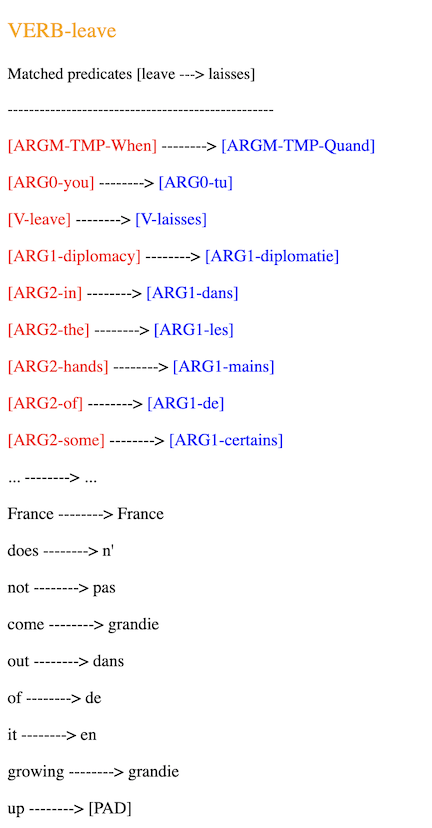


## 7.1 Programming Question #5 (3 points)
**Complete to code below to return french tokens and english tokens from each obj file**

The size of test data set is 2 percent of dataset

> The size of entire data set : 25549

> The size of test data set : 511


<mark>After you have completed the function and executed the test, make sure to transfer your answer to the .py file provided along with this Notebook<mark>



In [36]:
# @title Use fr_obj and en_obj below to run your code below (Do not edit this code)
path='/home/'+hipergator_user_name
if __name__ == "__main__":
    with open(path + "/Project03/data/fr_obj_test.pkl", "rb") as fp:
        fr_objs = pickle.load(fp)
    with open(path + "/Project03/data/en_obj_test.pkl", "rb") as fp:
        en_objs = pickle.load(fp)

    fr_obj = fr_objs[0]
    en_obj = en_objs[0]


In [37]:
# @title Programming Question 5: Complete code here to return french_sentence, english_sentence
def get_tokens(fr_obj, en_obj) -> tuple:
    """
    Programming instruction :
        1. Get tokens of French sentence and Englsih sentence
        2. sentence1 : French sentence tokens
        3. sentence2 : English sentence tokens
    """
    # Write your code here(2-3 lines)
    french_tokens = fr_obj['words']
    english_tokens = en_obj['words']
    # End code here

    return (french_tokens, english_tokens)


In [38]:
#@title Run this code to test your code above (Do not edit this code)

if __name__ == "__main__" :

    french_tokens, english_tokens = get_tokens(fr_obj, en_obj)
    french_bool = french_tokens == ["Quand","tu","laisses", "la", "diplomatie", "dans", "les", "mains", "de", "certains", "...", "la", "France", "n'", "en", "sort", "pas", "grandie"]
    english_bool = english_tokens == ['When', 'you', 'leave', 'diplomacy', 'in', 'the', 'hands', 'of', 'some', '...', 'France', 'does', 'not', 'come', 'out', 'of', 'it', 'growing', 'up']

    if french_bool == english_bool == True :
        print("Test passed")
    else :
        print("Test failed")

Test passed


In [39]:
# @title Run this code to create srl_align_result.html (Do not edit this code)
if __name__ == "__main__":
    with open(path + "/Project03/data/fr_obj_test.pkl", "rb") as fp:
        fr_objs = pickle.load(fp)
    with open(path + "/Project03/data/en_obj_test.pkl", "rb") as fp:
        en_objs = pickle.load(fp)
    with open(path + "/Project03/data/align_result.pkl", "rb") as fp:
        aligns = pickle.load(fp)
    for i, (fr_obj, en_obj, decoded) in enumerate(zip(fr_objs, en_objs, aligns)):
        french_tokens, english_tokens = get_tokens(fr_obj, en_obj)
        print("-" * 35, "Start {}".format(i), "-" * 35)
        print(
            "French sentence : {}\nEnglish sentence :{}".format(
                fr_obj["sent"], en_obj["sent"]
            )
        )
        view(
            en_obj,
            fr_obj,
            decoded,
            path + "/Project03/saving_files/srl_align_result.html",
            i,
        )


----------------------------------- Start 0 -----------------------------------
French sentence : Quand tu laisses la diplomatie dans les mains de certains... la France n'en sort pas grandie
English sentence :When you leave diplomacy in the hands of some ... France does not come out of it growing up
----------------------------------- Start 1 -----------------------------------
French sentence : ....après la dynamique est derrière Melenchon et si on ne ve…
English sentence :.... after the dynamics are behind Melenchon and if we do not ...
----------------------------------- Start 2 -----------------------------------
French sentence : il faut chatier les coupables , point !
English sentence :You have to make the culprits, point!
----------------------------------- Start 3 -----------------------------------
French sentence : : : : :
English sentence :::::
----------------------------------- Start 4 -----------------------------------
French sentence : Son dernier passage chez ONPC c'ét

# Part 8. Evaluate French SRL using Precision, Recall, and F-1 score

We evaluate model performance using an SRL-adapted Precision, Recall and F-1 score. In this part, a weighted average method is used for the measure.
* A good read for this measure could be  **Chapter 4.7 Evaluation : Precision, Recall, F-measure of Jurafsky & Martin's Speech and Language Processing book (SLP)**

* Another good read for this coud be **Chapter 8.3 : Evaluation of unranked retrieval sets (https://nlp.stanford.edu/IR-book/pdf/irbookonlinereading.pdf) of Manning, Raghavan, and Schütze's Introduction to Information Retrieval**

**True Positive** : Both the English token and French token have same non-O SRL or B-V.

**False Positive** : English token is labeled ("O") and French token has a non-O label (SRL or B-V), or English token and French token have mismatched labels non-O labels (SRL or B-V).

**True Negative** : Both the English token and the French token are labeled "O" (no SRL or B-V).

**False Negative** : English token has SRL or B-V and French token is labeled "O" (no SRL or B-V).



In [40]:
# @title Run this code to get evaluation results  (Do not edit this code)

if __name__ == "__main__":

    with open(path + "/Project03/data/fr_obj_test.pkl", "rb") as fp:
        fr_objs = pickle.load(fp)
    with open(path + "/Project03/data/en_obj_test.pkl", "rb") as fp:
        en_objs = pickle.load(fp)
    with open(path + "/Project03/data/align_result.pkl", "rb") as fp:
        aligns = pickle.load(fp)

    confu_pairs = []

    for i, (fr_obj, en_obj, decoded) in enumerate(zip(fr_objs, en_objs, aligns)):

        french_tokens, english_tokens = get_tokens(fr_obj, en_obj)
        pair_items = measure(en_obj, fr_obj, decoded)
        confu_pairs.extend(pair_items)


Matched predicate(s) : {'leave': 'laisses', 'come': 'grandie', 'growing': 'grandie'}, Unmatched predicate(s) : ['does']
Matched predicate(s) : {}, Unmatched predicate(s) : ['are', 'do']
Matched predicate(s) : {}, Unmatched predicate(s) : ['have', 'make']
Matched predicate(s) : {}, Unmatched predicate(s) : []
Matched predicate(s) : {}, Unmatched predicate(s) : ['was', 'bashing']
Matched predicate(s) : {}, Unmatched predicate(s) : ["'s"]
Matched predicate(s) : {}, Unmatched predicate(s) : ['is']
Matched predicate(s) : {'are': 'est'}, Unmatched predicate(s) : []
Matched predicate(s) : {}, Unmatched predicate(s) : ['is', 'started']
Matched predicate(s) : {'is': 'suffit', 'pass': 'passer', 'indicate': 'indiquent'}, Unmatched predicate(s) : []
Matched predicate(s) : {'gave': 'donné'}, Unmatched predicate(s) : ['was']
Matched predicate(s) : {'experienced': 'vécu'}, Unmatched predicate(s) : ['have']
Matched predicate(s) : {'asking': 'demande', 'encrypt': 'chiffrer', 'made': 'fait', 'explain': 

**Expected output**



```
{'TP': 1376, 'TN': 4737, 'FP': 661, 'FN': 2001}
```



In [41]:
# @title Run this code to confirm json format of TP, TN, FP, FN(Do not edit this code)
result_dict = confu_matrix(confu_pairs)
result_dict = {
    key: val
    for key, val in sorted(result_dict.items(), key=lambda x: x[0], reverse=True)
}
print(result_dict)


{'TP': 1376, 'TN': 4737, 'FP': 661, 'FN': 2001}


## 8.1 Programming Question 6 (4 point)

**Complete code below to return precision, recall, and f1-score**

Precsion(P) = TP / (TP+FP)

Recall(R) = TP / (TP+FN)

F1-score = (2* Precision *Recall) / (Precision+Recall)

In this programming question, you should use equivalent formula,

 **(2 * TP) / (2 * TP + FP + FN)**

to compute **f-1 score** faster and directly, and you compare f-1 score to one that computed using formula below using precision and recall

**(2* Precision *Recall) / (Precision+Recall)**

<mark>After you have completed the function and executed the test, make sure to transfer your answer to the .py file provided along with this Notebook<mark>

In [42]:
# @title Complete this code to return Precision, Recall, and F-1 Score
def precision_recall_f1(confusion_matrix: dict) -> tuple:
    """
    param confusion_matrix : dictionary

    Programming Instruction
        1. Write code to return precision recall and f1 using defined formula above
        2. Consider this case : If denominator is 0, precision, recall and f1 score should be 0
    """

    # Write your code start here(15-20 line)
    # precision
    precision = confusion_matrix['TP'] / (confusion_matrix['TP'] + confusion_matrix['FP'])
    # recall
    recall = confusion_matrix['TP'] / (confusion_matrix['TP'] + confusion_matrix['FN'])
    # F1 score
    f1 = (2 * precision * recall) / (precision + recall)
    # Your code end here
    return (precision, recall, f1)


**Expected output**

```
Precision 0.676, Recall 0.407, F1-score 0.508
```


In [43]:
# @ Run this code to check the Precision, Recall, and F-1 Score (Do not edit this code)
precision, recall, f1 = precision_recall_f1(result_dict)
print(f"Precision %.3f, Recall %.3f, F1-score %.3f " % (precision, recall, f1))


Precision 0.676, Recall 0.407, F1-score 0.508 


## 8.2 Check your code

The cell below check your f-1 score from the code above by comparing to f-1 score obtained by equivalent formula,

**(2* Precision *Recall) / (Precision+Recall)**

and it must return **"Your f-1 score is True"** if your code above is correct.




In [44]:
#@title Run this code to check your answer here (Do not edit this code)
equivalent_f_1 = (2*precision*recall)/(precision+recall)
answer = equivalent_f_1 == f1
print(f'Your f-1 score is %s'%(answer))

Your f-1 score is True


# Part 9: Uploading responses for Grading

To upload your responses for grading, please follow the instructions provided in the `Project 3 - Multilingual SRL Introduction` page in Canvas.